# A Study on Gradient Boosting Algorithms and Hyperparameter Optimization using Optuna

Undergraduate Thesis submitted to the Undergraduate Course in Mechatronics Engineering from São Carlos School of Engineering, University of São Paulo – EESC- USP, in partial fulfillment of the requirements for the bachelor degree in Mechatronics Engineer .

In [1]:
import numpy as np
import pandas as pd
import xgboost as xgb
import sys
import timeit
import gc
import sklearn
import seaborn
from sklearn import metrics
from xgboost import XGBClassifier
from catboost import CatBoostClassifier
from sklearn.model_selection import train_test_split
import lightgbm
from lightgbm import LGBMClassifier
from sklearn.metrics import roc_auc_score
from sklearn.metrics import accuracy_score
import optuna
from sklearn.model_selection import GridSearchCV
import matplotlib.pylab as plt
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import StratifiedKFold
from optuna.visualization import plot_optimization_history
from optuna.visualization import plot_param_importances
import shap

In [2]:
def auc_logloss_ks(y_test, y_prob):
    '''
    Input:
        y_prob: model predict prob
        y_test: target
    Output: Metrics of validation
        auc, ks, log_loss
    '''
    fpr, tpr, thresholds = metrics.roc_curve(y_test, y_prob)
    auc = metrics.auc(fpr, tpr)
    log_loss = sklearn.metrics.log_loss(y_test, y_prob)
    ks = max(tpr - fpr)
    return auc, log_loss, ks

def objective(trial, X_train, y_train, X_test, y_test, balanced, method):
    '''
    Input:
        trial: trial of the test
        X_train:
        y_train:
        X_test:
        y_test:
        balanced:balanced or None
        method: XGBoost, CatBoost or LGBM
    Output: Metrics of validation
        auc, ks, log_loss
        auc_logloss_ks(y_test, y_pred)[0]
    '''
    gc.collect()
    if method=='LGBM':
        param_grid = {'learning_rate': trial.suggest_float('learning_rate', 0.0001, 0.1, log=True),
                      'num_leaves': trial.suggest_int('num_leaves', 2, 256),
                      'lambda_l1': trial.suggest_float("lambda_l1", 1e-8, 10.0, log=True),
                      'lambda_l2': trial.suggest_float("lambda_l2", 1e-8, 10.0, log=True),
                      'min_data_in_leaf': trial.suggest_int('min_data_in_leaf', 5, 100),
                      'max_depth': trial.suggest_int('max_depth', 5, 64),
                      'feature_fraction': trial.suggest_float("feature_fraction", 0.4, 1.0),
                      'bagging_fraction': trial.suggest_float("bagging_fraction", 0.4, 1.0),
                      'bagging_freq': trial.suggest_int("bagging_freq", 1, 7),
  
                     }
        model = LGBMClassifier(**param_grid)

        print('LGBM - Optimization using optuna')
        model.fit(X_train, y_train)
        
        y_pred = model.predict_proba(X_test)[:,1]

    if method=='CATBoost':
        param_grid = {'learning_rate': trial.suggest_float('learning_rate', 0.0001, 0.1, log=True),
                      'depth': trial.suggest_int("depth", 4, 10),
                      'max_bin': trial.suggest_int('max_bin', 200, 400),
                      'min_data_in_leaf': trial.suggest_int('min_data_in_leaf', 1, 300),
                      'l2_leaf_reg': trial.suggest_float('l2_leaf_reg', 1e-8, 10, log = True),
                      'subsample': trial.suggest_float('subsample', 0.1, 0.8),
                      'random_seed': 42,
                      'random_strength': trial.suggest_float("random_strength", 1e-8, 10.0, log=True),
                      'bagging_temperature': trial.suggest_float("bagging_temperature", 0.0, 10.0),
                      'od_type': trial.suggest_categorical("od_type", ["IncToDec", "Iter"]),
                      'od_wait': trial.suggest_int("od_wait", 10, 50),
                     }
        if len(X_train._get_numeric_data().columns) != len(X_train.columns):
            categorical_features_indices = list(X_train.select_dtypes(exclude='number').columns)
            model = CatBoostClassifier(**param_grid)
            print('CATBoost - Optimization using optuna')
            model.fit(X_train, y_train,cat_features=categorical_features_indices,verbose=False)
            y_pred = model.predict_proba(X_test)[:,1]
        else:
            model = CatBoostClassifier(**param_grid)
            print('CATBoost - Optimization using optuna')
            model.fit(X_train, y_train,verbose=False)
            y_pred = model.predict_proba(X_test)[:,1]
        
    if method=='XGBoost':
        param_grid = {'learning_rate': trial.suggest_float('learning_rate', 0.0001, 0.1, log=True),
                      'max_depth': trial.suggest_int('max_depth', 3, 16),
                      'min_child_weight': trial.suggest_int('min_child_weight', 1, 300),
                      'gamma': trial.suggest_float('gamma', 1e-8, 1.0, log = True),
                      'alpha': trial.suggest_float('alpha', 1e-8, 1.0, log = True),
                      'lambda': trial.suggest_float('lambda', 0.0001, 10.0, log = True),
                      'colsample_bytree': trial.suggest_float('colsample_bytree', 0.1, 0.8),
                      'subsample': trial.suggest_float('subsample', 0.1, 0.8),
                      'booster': 'gbtree',
                      'random_state': 42,
                     }
        model = XGBClassifier(**param_grid)
        print('XGBoost - Optimization using optuna')
        model.fit(X_train, y_train,verbose=False)
        y_pred = model.predict_proba(X_test)[:,1]
    
    auc_res, log_loss_res, ks_res = auc_logloss_ks(y_test, y_pred)
    print('auc:'+str(auc_res),', log_loss:'+str(log_loss_res),', ks:'+str(ks_res))
    return auc_logloss_ks(y_test, y_pred)[0]

def tuning(X_train, y_train, X_test, y_test, balanced, method):
    '''
    Input:
        trial: 
        x_train:
        y_train:
        X_test:
        y_test:
        balanced:balanced or not balanced
        method: XGBoost, CatBoost or LGBM
    Output: Metrics of validation
        auc, ks, log_loss
        auc_logloss_ks(y_test, y_pred)[0]
    '''
    study = optuna.create_study(direction='maximize', study_name=method+' Classifier')
    func = lambda trial: objective(trial, X_train, y_train, X_test, y_test, balanced, method)
    print('Starting the optimization')
    time_max_tuning = 60*60 # max time in seconds to stop
    study.optimize(func, timeout=time_max_tuning)
    return study

def train(X_train, y_train, X_test, y_test, balanced, method):
    '''
    Input:
        X_train:
        y_train:
        X_test:
        y_test:
        balanced:balanced or None
        method: XGBoost, CatBoost or LGBM
    Output: predict model
    '''
    print('Tuning')
    study = tuning(X_train, y_train, X_test, y_test, balanced, method)
    if method=='LGBM':
        model = LGBMClassifier(**study.best_params)
        print('Last Fit')
        model.fit(X_train, y_train, eval_set=[(X_test,y_test)],
                 callbacks = [lightgbm.early_stopping(stopping_rounds=100), lightgbm.log_evaluation(period=5000)])
    if method=='CATBoost':
        model = CatBoostClassifier(**study.best_params)
        if len(X_train._get_numeric_data().columns) != len(X_train.columns):
            categorical_features_indices = list(X_train.select_dtypes(exclude='number').columns)
            print('Last Fit')
            model.fit(X_train, y_train,cat_features=categorical_features_indices, eval_set=[(X_test,y_test)],
                 early_stopping_rounds=100,verbose = False)
        else:
            print('Last Fit')
            model.fit(X_train, y_train, eval_set=[(X_test,y_test)],
                 early_stopping_rounds=100,verbose = False)
    if method=='XGBoost':
        model = XGBClassifier(**study.best_params)
        print('Last Fit')
        model.fit(X_train, y_train, eval_set=[(X_test,y_test)],
                 early_stopping_rounds=100,verbose = False)
    return model

In [3]:
pd.set_option('display.float_format', lambda x: '%.3f' % x)

# 1.0 - Diabetes Dataset 

[Diabetes Dataset](https://www.kaggle.com/datasets/mathchi/diabetes-data-set)

This dataset is originally from the National Institute of Diabetes and Digestive and Kidney Diseases. The objective is to predict based on diagnostic measurements whether a patient has diabetes.

In [4]:
# load the dataset
df_diabete = pd.read_csv('01_diabetes_dataset.csv')
df_diabete

,Age,Gender,Family_Diabetes,highBP,PhysicallyActive,BMI,Smoking,Alcohol,Sleep,SoundSleep,RegularMedicine,JunkFood,Stress,BPLevel,Pregancies,Pdiabetes,UriationFreq,Diabetic
0,50-59,Male,no,yes,one hr or more,39.000,no,no,8,6,no,occasionally,sometimes,high,0.000,0,not much,no
1,50-59,Male,no,yes,less than half an hr,28.000,no,no,8,6,yes,very often,sometimes,normal,0.000,0,not much,no
2,40-49,Male,no,no,one hr or more,24.000,no,no,6,6,no,occasionally,sometimes,normal,0.000,0,not much,no
3,50-59,Male,no,no,one hr or more,23.000,no,no,8,6,no,occasionally,sometimes,normal,0.000,0,not much,no
4,40-49,Male,no,no,less than half an hr,27.000,no,no,8,8,no,occasionally,sometimes,normal,0.000,0,not much,no
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
947,less than 40,Male,yes,no,more than half an hr,25.000,no,no,8,6,no,often,sometimes,normal,0.000,0,not much,yes
948,60 or older,Male,yes,yes,more than half an hr,27.000,no,no,6,5,yes,occasionally,sometimes,high,0.000,0,quite often,yes
949,60 or older,Male,no,yes,none,23.000,no,no,6,5,yes,occasionally,sometimes,high,0.000,0,not much,no
950,60 or older,Male,no,yes,less than half an hr,27.000,no,yes,6,5,yes,occasionally,very often,high,0.000,0,not much,no


In [5]:
# name of columns
df_diabete.columns

Index(['Age', 'Gender', 'Family_Diabetes', 'highBP', 'PhysicallyActive', 'BMI',
       'Smoking', 'Alcohol', 'Sleep', 'SoundSleep', 'RegularMedicine',
       'JunkFood', 'Stress', 'BPLevel', 'Pregancies', 'Pdiabetes',
       'UriationFreq', 'Diabetic'],
      dtype='object')

In [6]:
# type of columns
df_diabete.dtypes

Age                  object
Gender               object
Family_Diabetes      object
highBP               object
PhysicallyActive     object
BMI                 float64
Smoking              object
Alcohol              object
Sleep                 int64
SoundSleep            int64
RegularMedicine      object
JunkFood             object
Stress               object
BPLevel              object
Pregancies          float64
Pdiabetes            object
UriationFreq         object
Diabetic             object
dtype: object

In [7]:
# Descriptive statistics 
df_diabete.describe()

,BMI,Sleep,SoundSleep,Pregancies
count,948.000,952.000,952.000,910.000
mean,25.764,6.950,5.496,0.387
std,5.403,1.273,1.866,0.909
min,15.000,4.000,0.000,0.000
25%,22.000,6.000,4.000,0.000
50%,25.000,7.000,6.000,0.000
75%,29.000,8.000,7.000,0.000
max,45.000,11.000,11.000,4.000


In [8]:
# number o NaN in each column
df_diabete.isna().sum()

Age                  0
Gender               0
Family_Diabetes      0
highBP               0
PhysicallyActive     0
BMI                  4
Smoking              0
Alcohol              0
Sleep                0
SoundSleep           0
RegularMedicine      0
JunkFood             0
Stress               0
BPLevel              0
Pregancies          42
Pdiabetes            1
UriationFreq         0
Diabetic             1
dtype: int64

In [9]:
df_diabete.loc[df_diabete['BMI'].isna()]

,Age,Gender,Family_Diabetes,highBP,PhysicallyActive,BMI,Smoking,Alcohol,Sleep,SoundSleep,RegularMedicine,JunkFood,Stress,BPLevel,Pregancies,Pdiabetes,UriationFreq,Diabetic
113,less than 40,Female,yes,no,more than half an hr,NaN,no,no,7,6,no,occasionally,not at all,normal,0.000,0,not much,NaN
116,less than 40,Female,no,no,more than half an hr,NaN,no,no,5,4,no,often,very often,normal,0.000,0,not much,no
121,50-59,Female,yes,yes,none,NaN,no,no,6,3,yes,occasionally,always,high,2.000,0,not much,yes
122,less than 40,Male,no,yes,more than half an hr,NaN,no,no,6,6,no,occasionally,sometimes,normal,0.000,0,quite often,no


In [10]:
df_diabete.loc[df_diabete['Pregancies'].isna()]

,Age,Gender,Family_Diabetes,highBP,PhysicallyActive,BMI,Smoking,Alcohol,Sleep,SoundSleep,RegularMedicine,JunkFood,Stress,BPLevel,Pregancies,Pdiabetes,UriationFreq,Diabetic
136,less than 40,Male,yes,no,more than half an hr,21.000,yes,no,8,8,no,occasionally,very often,normal,NaN,0,not much,no
137,less than 40,Female,yes,no,one hr or more,26.000,no,no,7,5,no,often,sometimes,Low,NaN,no,not much,no
138,less than 40,Female,yes,no,none,21.000,no,yes,9,8,no,occasionally,sometimes,normal,NaN,0,not much,no
139,less than 40,Female,yes,no,none,21.000,no,yes,8,8,no,occasionally,sometimes,normal,NaN,0,not much,no
140,less than 40,Female,yes,no,more than half an hr,24.000,no,no,8,8,yes,often,sometimes,normal,NaN,0,quite often,no
141,less than 40,Male,no,no,more than half an hr,24.000,yes,yes,7,6,no,often,sometimes,normal,NaN,0,not much,no
142,less than 40,Male,no,no,less than half an hr,26.000,no,yes,6,4,no,occasionally,very often,normal,NaN,0,not much,no
143,50-59,Male,yes,no,less than half an hr,32.000,no,no,8,4,yes,occasionally,sometimes,normal,NaN,0,not much,no
144,40-49,Male,yes,no,more than half an hr,34.000,no,no,7,5,no,often,sometimes,normal,NaN,0,quite often,no
145,less than 40,Male,no,no,more than half an hr,30.000,no,no,7,4,no,occasionally,sometimes,normal,NaN,0,not much,no


In [11]:
df_diabete.loc[df_diabete['Diabetic'].isna()]

,Age,Gender,Family_Diabetes,highBP,PhysicallyActive,BMI,Smoking,Alcohol,Sleep,SoundSleep,RegularMedicine,JunkFood,Stress,BPLevel,Pregancies,Pdiabetes,UriationFreq,Diabetic
113,less than 40,Female,yes,no,more than half an hr,NaN,no,no,7,6,no,occasionally,not at all,normal,0.000,0,not much,NaN


In [12]:
df_diabete['Age'].value_counts()

less than 40    488
40-49           164
50-59           156
60 or older     144
Name: Age, dtype: int64

In [13]:
df_diabete['Gender'].value_counts()

Male      580
Female    372
Name: Gender, dtype: int64

In [14]:
df_diabete['Family_Diabetes'].value_counts()

no     498
yes    454
Name: Family_Diabetes, dtype: int64

In [15]:
df_diabete['highBP'].value_counts()

no     724
yes    228
Name: highBP, dtype: int64

In [16]:
df_diabete['PhysicallyActive'].value_counts()

less than half an hr    336
more than half an hr    272
one hr or more          212
none                    132
Name: PhysicallyActive, dtype: int64

In [17]:
df_diabete['Smoking'].value_counts()

no     844
yes    108
Name: Smoking, dtype: int64

In [18]:
df_diabete['RegularMedicine'].value_counts()

no     615
yes    336
o        1
Name: RegularMedicine, dtype: int64

In [19]:
df_diabete['JunkFood'].value_counts()

occasionally    672
often           184
very often       52
always           44
Name: JunkFood, dtype: int64

In [20]:
df_diabete['Stress'].value_counts()

sometimes     564
very often    164
not at all    136
always         88
Name: Stress, dtype: int64

In [21]:
df_diabete['BPLevel'].value_counts()

normal     707
high       211
low         25
High         5
Low          3
normal       1
Name: BPLevel, dtype: int64

In [22]:
df_diabete['UriationFreq'].value_counts()

not much       664
quite often    288
Name: UriationFreq, dtype: int64

In [23]:
df_diabete['Diabetic'].value_counts()

no     684
yes    266
 no      1
Name: Diabetic, dtype: int64

In [24]:
# correcting the strin 'no'
df_diabete['RegularMedicine'].replace('o', 'no', inplace =True)
df_diabete['Diabetic'].replace(' no', 'no', inplace =True)

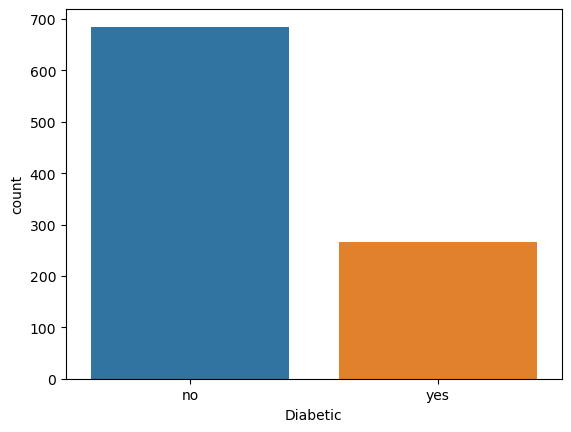

In [25]:
seaborn.countplot(x = 'Diabetic',data = df_diabete)
plt.savefig('diabete_tot.png')

In [26]:
cols_cat_diabete = ['Age', 'Gender', 'Family_Diabetes', 'highBP', 'PhysicallyActive',
       'Smoking', 'Alcohol', 'RegularMedicine',
       'JunkFood', 'Stress', 'BPLevel', 'Pregancies', 'Pdiabetes',
       'UriationFreq']

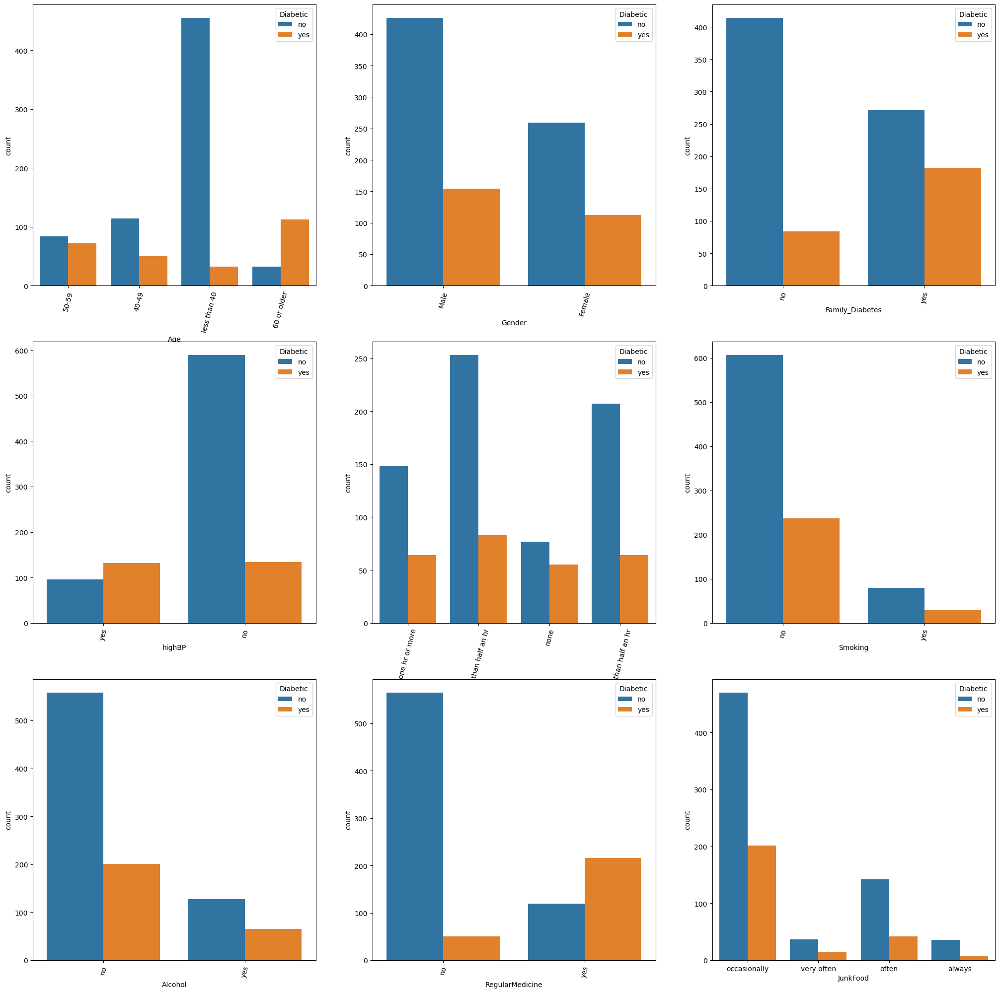

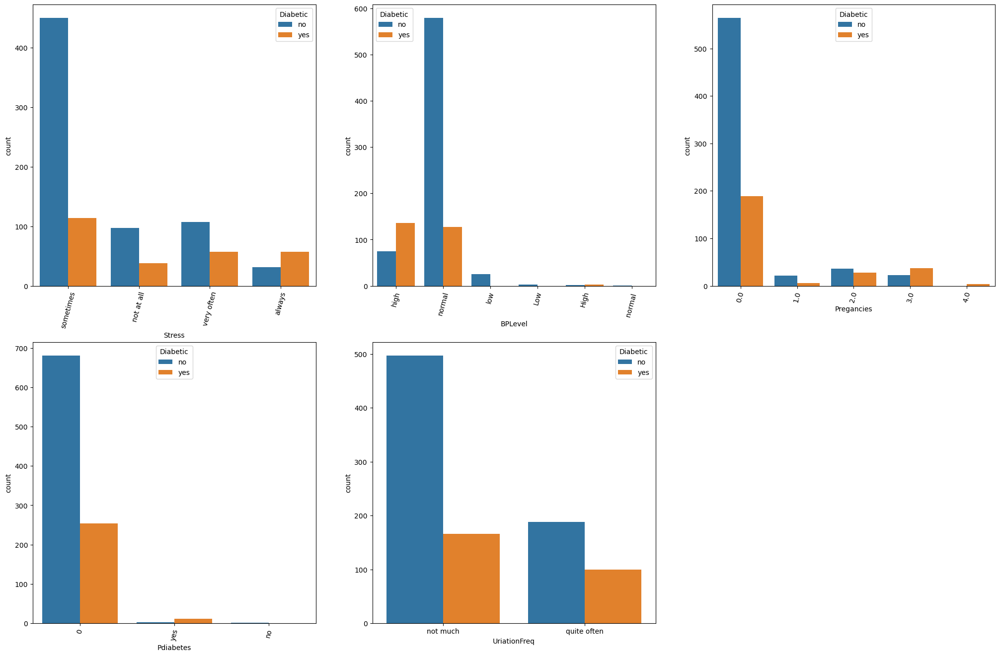

In [27]:
plt.figure(figsize = (25,25))

i  = 0
for j in range(9):
    plt.xticks(rotation=75)
    plt.subplot(int(str(3)+str(3)+str(j+1)))
    seaborn.countplot(x = cols_cat_diabete[i], hue='Diabetic',data = df_diabete)
    i += 1

    
plt.figure(figsize = (25,25))
for j in range(5):
    plt.xticks(rotation=75)
    plt.subplot(int(str(3)+str(3)+str(j+1)))
    seaborn.countplot(x = cols_cat_diabete[i], hue='Diabetic',data = df_diabete)
    i += 1
    

<Figure size 2500x2500 with 0 Axes>

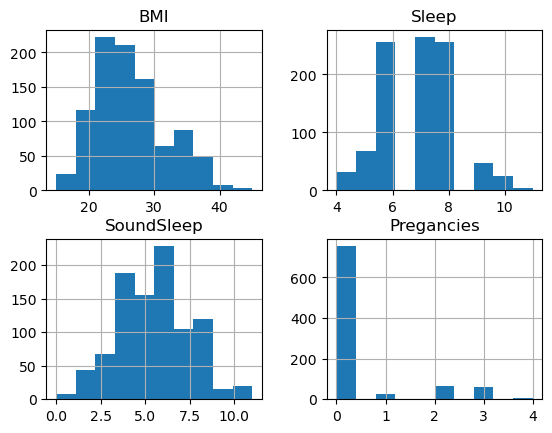

In [28]:
plt.figure(figsize = (25,25))
df_diabete.hist()
plt.savefig('hist_diabete_pop.png')

<Figure size 2500x2500 with 0 Axes>

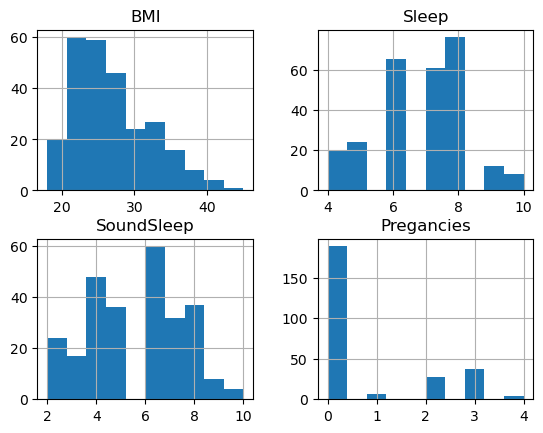

In [29]:
plt.figure(figsize = (25,25))
df_diabete.loc[df_diabete['Diabetic']=='yes'].hist()
plt.savefig('hist_diabete_yes.png')

<Figure size 2500x2500 with 0 Axes>

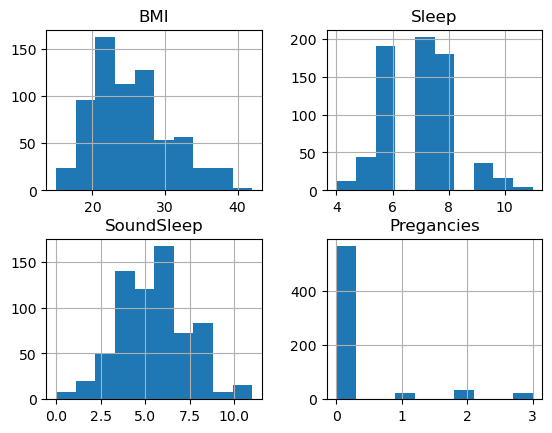

In [30]:
plt.figure(figsize = (25,25))
df_diabete.loc[df_diabete['Diabetic']=='no'].hist()
plt.savefig('hist_diabete_no.png')

In [31]:
# convert cat to numeric
df_diabete_conv = df_diabete.copy()

In [32]:
df_diabete_conv = pd.get_dummies(df_diabete_conv, drop_first= True)
df_diabete_conv

,BMI,Sleep,SoundSleep,Pregancies,Age_50-59,Age_60 or older,Age_less than 40,Gender_Male,Family_Diabetes_yes,highBP_yes,...,Stress_very often,BPLevel_Low,BPLevel_high,BPLevel_low,BPLevel_normal,BPLevel_normal,Pdiabetes_no,Pdiabetes_yes,UriationFreq_quite often,Diabetic_yes
0,39.000,8,6,0.000,1,0,0,1,0,1,...,0,0,1,0,0,0,0,0,0,0
1,28.000,8,6,0.000,1,0,0,1,0,1,...,0,0,0,0,1,0,0,0,0,0
2,24.000,6,6,0.000,0,0,0,1,0,0,...,0,0,0,0,1,0,0,0,0,0
3,23.000,8,6,0.000,1,0,0,1,0,0,...,0,0,0,0,1,0,0,0,0,0
4,27.000,8,8,0.000,0,0,0,1,0,0,...,0,0,0,0,1,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
947,25.000,8,6,0.000,0,0,1,1,1,0,...,0,0,0,0,1,0,0,0,0,1
948,27.000,6,5,0.000,0,1,0,1,1,1,...,0,0,1,0,0,0,0,0,1,1
949,23.000,6,5,0.000,0,1,0,1,0,1,...,0,0,1,0,0,0,0,0,0,0
950,27.000,6,5,0.000,0,1,0,1,0,1,...,1,0,1,0,0,0,0,0,0,0


In [33]:
df_diabete_conv.columns

Index(['BMI', 'Sleep', 'SoundSleep', 'Pregancies', 'Age_50-59',
       'Age_60 or older', 'Age_less than 40', 'Gender_Male',
       'Family_Diabetes_yes', 'highBP_yes',
       'PhysicallyActive_more than half an hr', 'PhysicallyActive_none',
       'PhysicallyActive_one hr or more', 'Smoking_yes', 'Alcohol_yes',
       'RegularMedicine_yes', 'JunkFood_occasionally', 'JunkFood_often',
       'JunkFood_very often', 'Stress_not at all', 'Stress_sometimes',
       'Stress_very often', 'BPLevel_Low', 'BPLevel_high', 'BPLevel_low',
       'BPLevel_normal', 'BPLevel_normal ', 'Pdiabetes_no', 'Pdiabetes_yes',
       'UriationFreq_quite often', 'Diabetic_yes'],
      dtype='object')

## XGBoost

In [66]:
df_diabete_conv = df_diabete_conv.rename(columns={'Diabetic_yes': 'target'})

In [67]:
var_cols = df_diabete_conv.drop(columns='target').columns

In [68]:
var_cols

Index(['BMI', 'Sleep', 'SoundSleep', 'Pregancies', 'Age_50-59',
       'Age_60 or older', 'Age_less than 40', 'Gender_Male',
       'Family_Diabetes_yes', 'highBP_yes',
       'PhysicallyActive_more than half an hr', 'PhysicallyActive_none',
       'PhysicallyActive_one hr or more', 'Smoking_yes', 'Alcohol_yes',
       'RegularMedicine_yes', 'JunkFood_occasionally', 'JunkFood_often',
       'JunkFood_very often', 'Stress_not at all', 'Stress_sometimes',
       'Stress_very often', 'BPLevel_Low', 'BPLevel_high', 'BPLevel_low',
       'BPLevel_normal', 'BPLevel_normal ', 'Pdiabetes_no', 'Pdiabetes_yes',
       'UriationFreq_quite often'],
      dtype='object')

In [69]:
X = df_diabete_conv.loc[:,var_cols]
y = df_diabete_conv.loc[:,'target']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)
X_train.shape, X_test.shape, y_train.shape, y_test.shape 

((666, 30), (286, 30), (666,), (286,))

In [128]:
parameters = {
        'learning_rate': 0.3,
        'max_depth': 3,
        'lambda': 0.05
}

In [129]:
XGBoost_class = XGBClassifier(**parameters)

In [130]:
start = timeit.default_timer()
XGBoost_model = XGBoost_class.fit(X_train, y_train)
stop = timeit.default_timer()
stop - start

0.10511741200025426

In [131]:
y_prob = XGBoost_model.predict(X_test)

In [132]:
auc_logloss_ks(y_test, y_prob)

(0.9259751773049645, 2.1737915100973217, 0.8519503546099291)

### XGBoost using optuna

In [242]:
XGBoost_model = train(X_train, y_train, X_test, y_test, balanced='balanced', method='XGBoost')

[I 2023-02-02 23:09:06,891] A new study created in memory with name: XGBoost Classifier
[I 2023-02-02 23:09:07,026] Trial 0 finished with value: 0.5 and parameters: {'learning_rate': 0.015302336737024996, 'max_depth': 6, 'min_child_weight': 167, 'gamma': 2.2091035957388734e-08, 'alpha': 0.0001811282064308926, 'lambda': 1.1064077418950404, 'colsample_bytree': 0.41905368581810043, 'subsample': 0.33665677676520506}. Best is trial 0 with value: 0.5.


Tuning
Starting the optimization
XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:09:07,190] Trial 1 finished with value: 0.5 and parameters: {'learning_rate': 0.00328969146654175, 'max_depth': 14, 'min_child_weight': 244, 'gamma': 1.946331728609986e-07, 'alpha': 3.162592574933094e-05, 'lambda': 0.9673701252949084, 'colsample_bytree': 0.747281442443874, 'subsample': 0.5631833306532493}. Best is trial 0 with value: 0.5.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:09:07,391] Trial 2 finished with value: 0.5 and parameters: {'learning_rate': 0.023427999610771955, 'max_depth': 5, 'min_child_weight': 107, 'gamma': 2.561422258997543e-07, 'alpha': 3.262564207375926e-07, 'lambda': 0.0006603236103083337, 'colsample_bytree': 0.11551408782237099, 'subsample': 0.7946700038430677}. Best is trial 0 with value: 0.5.
[I 2023-02-02 23:09:07,496] Trial 3 finished with value: 0.5 and parameters: {'learning_rate': 0.0018095017268169027, 'max_depth': 6, 'min_child_weight': 221, 'gamma': 0.16326371018753832, 'alpha': 2.8943855456521355e-06, 'lambda': 0.0006601132227350176, 'colsample_bytree': 0.42943727616610317, 'subsample': 0.7776706107846504}. Best is trial 0 with value: 0.5.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6377253082248714 , ks:0.0
XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:09:07,678] Trial 4 finished with value: 0.5 and parameters: {'learning_rate': 0.0020686316460035077, 'max_depth': 6, 'min_child_weight': 104, 'gamma': 0.017843210822018167, 'alpha': 0.001045363954958219, 'lambda': 0.34928437209545715, 'colsample_bytree': 0.27633383860981703, 'subsample': 0.6875434251766053}. Best is trial 0 with value: 0.5.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6661217329385397 , ks:0.0
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:07,875] Trial 5 finished with value: 0.9020113031914894 and parameters: {'learning_rate': 0.009496083026244157, 'max_depth': 6, 'min_child_weight': 26, 'gamma': 3.914798010065315e-06, 'alpha': 8.293539275906085e-07, 'lambda': 0.03567527226922051, 'colsample_bytree': 0.6507363645650561, 'subsample': 0.4689780614640481}. Best is trial 5 with value: 0.9020113031914894.


auc:0.9020113031914894 , log_loss:0.5120938059750136 , ks:0.6780806737588653
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:08,101] Trial 6 finished with value: 0.5 and parameters: {'learning_rate': 0.004363753838313663, 'max_depth': 11, 'min_child_weight': 284, 'gamma': 2.341643153009028e-08, 'alpha': 4.077986915463597e-07, 'lambda': 9.74482104498195, 'colsample_bytree': 0.28131176759650806, 'subsample': 0.43907574994900556}. Best is trial 5 with value: 0.9020113031914894.
[I 2023-02-02 23:09:08,250] Trial 7 finished with value: 0.5 and parameters: {'learning_rate': 0.021959213188381097, 'max_depth': 6, 'min_child_weight': 64, 'gamma': 0.05280791130033986, 'alpha': 1.364345001384094e-06, 'lambda': 0.8468766253146132, 'colsample_bytree': 0.27974150053211666, 'subsample': 0.32093413129989523}. Best is trial 5 with value: 0.9020113031914894.


auc:0.5 , log_loss:0.6931471824645996 , ks:0.0
XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:08,480] Trial 8 finished with value: 0.5 and parameters: {'learning_rate': 0.014812536362005243, 'max_depth': 4, 'min_child_weight': 37, 'gamma': 7.348740072295653e-07, 'alpha': 4.6198743661658316e-05, 'lambda': 1.3541943207754785, 'colsample_bytree': 0.35468534344701474, 'subsample': 0.38410074024829666}. Best is trial 5 with value: 0.9020113031914894.
[I 2023-02-02 23:09:08,651] Trial 9 finished with value: 0.5 and parameters: {'learning_rate': 0.010300924475450763, 'max_depth': 7, 'min_child_weight': 78, 'gamma': 4.15392075785509e-08, 'alpha': 0.330820266310679, 'lambda': 0.021760551081910006, 'colsample_bytree': 0.2533585351213551, 'subsample': 0.3986967223375182}. Best is trial 5 with value: 0.9020113031914894.


auc:0.5 , log_loss:0.6338432302008142 , ks:0.0
XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:09:08,908] Trial 10 finished with value: 0.9138408687943262 and parameters: {'learning_rate': 0.07235003662306765, 'max_depth': 10, 'min_child_weight': 5, 'gamma': 2.4213385885944526e-05, 'alpha': 1.708812347463241e-08, 'lambda': 0.014731365074967981, 'colsample_bytree': 0.6170125158604605, 'subsample': 0.17152260204442}. Best is trial 10 with value: 0.9138408687943262.


XGBoost - Optimization using optuna
auc:0.9138408687943262 , log_loss:0.36521545400634614 , ks:0.6989140070921985


[I 2023-02-02 23:09:09,137] Trial 11 finished with value: 0.5 and parameters: {'learning_rate': 0.0988672970862036, 'max_depth': 10, 'min_child_weight': 18, 'gamma': 1.514057823004353e-05, 'alpha': 1.0430193125831163e-08, 'lambda': 0.01461571804729238, 'colsample_bytree': 0.6127962819028444, 'subsample': 0.16802785062664763}. Best is trial 10 with value: 0.9138408687943262.
[I 2023-02-02 23:09:09,282] Trial 12 finished with value: 0.5 and parameters: {'learning_rate': 0.05473281761390078, 'max_depth': 13, 'min_child_weight': 18, 'gamma': 0.000229087648326475, 'alpha': 1.1075718558950875e-08, 'lambda': 0.004077653289651338, 'colsample_bytree': 0.5925587496658752, 'subsample': 0.11424816729212861}. Best is trial 10 with value: 0.9138408687943262.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6483982976499971 , ks:0.0
XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6354402920582911 , ks:0.0


[I 2023-02-02 23:09:09,487] Trial 13 finished with value: 0.9416001773049646 and parameters: {'learning_rate': 0.0057602936474072716, 'max_depth': 9, 'min_child_weight': 3, 'gamma': 1.6530428064592036e-05, 'alpha': 1.0675126385879458e-07, 'lambda': 0.05587408556779865, 'colsample_bytree': 0.5754095874387004, 'subsample': 0.5215612300201533}. Best is trial 13 with value: 0.9416001773049646.


XGBoost - Optimization using optuna
auc:0.9416001773049646 , log_loss:0.49294544652208583 , ks:0.7568705673758865


[I 2023-02-02 23:09:09,747] Trial 14 finished with value: 0.5 and parameters: {'learning_rate': 0.0010849312353454264, 'max_depth': 16, 'min_child_weight': 163, 'gamma': 0.00018454535003332987, 'alpha': 5.4819565924851116e-08, 'lambda': 0.11267219957142813, 'colsample_bytree': 0.5327186729595843, 'subsample': 0.23770089487853646}. Best is trial 13 with value: 0.9416001773049646.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:09:09,975] Trial 15 finished with value: 0.9427637411347518 and parameters: {'learning_rate': 0.04032749494777148, 'max_depth': 9, 'min_child_weight': 5, 'gamma': 4.4580082459637714e-05, 'alpha': 7.359713503880683e-08, 'lambda': 0.00011396321525766752, 'colsample_bytree': 0.7983637605098846, 'subsample': 0.5279598069890625}. Best is trial 15 with value: 0.9427637411347518.


XGBoost - Optimization using optuna
auc:0.9427637411347518 , log_loss:0.30561560096701124 , ks:0.7785904255319149


[I 2023-02-02 23:09:10,160] Trial 16 finished with value: 0.5 and parameters: {'learning_rate': 0.0343762927800856, 'max_depth': 8, 'min_child_weight': 124, 'gamma': 0.0013786329732600345, 'alpha': 9.612566620787536e-08, 'lambda': 0.00013116003411722495, 'colsample_bytree': 0.7989014569973275, 'subsample': 0.5331123645166357}. Best is trial 15 with value: 0.9427637411347518.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:10,315] Trial 17 finished with value: 0.5 and parameters: {'learning_rate': 0.006515506698477214, 'max_depth': 12, 'min_child_weight': 58, 'gamma': 0.0012068377887519918, 'alpha': 6.051036794915398e-06, 'lambda': 0.0019280851301178917, 'colsample_bytree': 0.71211802670176, 'subsample': 0.5978162075469993}. Best is trial 15 with value: 0.9427637411347518.
[I 2023-02-02 23:09:10,446] Trial 18 finished with value: 0.5 and parameters: {'learning_rate': 0.03976993030721929, 'max_depth': 8, 'min_child_weight': 82, 'gamma': 3.2398589508464397e-06, 'alpha': 1.727999848856155e-07, 'lambda': 0.00015912146118424758, 'colsample_bytree': 0.5224686733455044, 'subsample': 0.5100089300714203}. Best is trial 15 with value: 0.9427637411347518.


auc:0.5 , log_loss:0.6396116772731701 , ks:0.0
XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6346161248800638 , ks:0.0


[I 2023-02-02 23:09:10,610] Trial 19 finished with value: 0.5 and parameters: {'learning_rate': 0.0063158405196178085, 'max_depth': 8, 'min_child_weight': 203, 'gamma': 3.5828767904999635e-05, 'alpha': 1.0364580196297853e-07, 'lambda': 0.06666207473168555, 'colsample_bytree': 0.7931876037307344, 'subsample': 0.6008781480102346}. Best is trial 15 with value: 0.9427637411347518.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:10,776] Trial 20 finished with value: 0.8344414893617021 and parameters: {'learning_rate': 0.0429040774554917, 'max_depth': 3, 'min_child_weight': 42, 'gamma': 0.6532272636605949, 'alpha': 6.176398866605999e-06, 'lambda': 0.006943876787597603, 'colsample_bytree': 0.6987685253379583, 'subsample': 0.6533850667109847}. Best is trial 15 with value: 0.9427637411347518.
[I 2023-02-02 23:09:10,928] Trial 21 finished with value: 0.9579454787234043 and parameters: {'learning_rate': 0.09489368406750798, 'max_depth': 10, 'min_child_weight': 3, 'gamma': 1.5309531197276722e-05, 'alpha': 2.4201198686281023e-08, 'lambda': 0.008445094096332663, 'colsample_bytree': 0.6547238225552652, 'subsample': 0.47725857087418366}. Best is trial 21 with value: 0.9579454787234043.


auc:0.8344414893617021 , log_loss:0.5401193587617441 , ks:0.56072695035461
XGBoost - Optimization using optuna
auc:0.9579454787234043 , log_loss:0.25873365280645005 , ks:0.7876773049645389


[I 2023-02-02 23:09:11,116] Trial 22 finished with value: 0.9617132092198581 and parameters: {'learning_rate': 0.09241108676132552, 'max_depth': 11, 'min_child_weight': 2, 'gamma': 4.971394142132136e-06, 'alpha': 4.498372721391498e-08, 'lambda': 0.0018887986667030497, 'colsample_bytree': 0.6839391344329807, 'subsample': 0.47641989790042344}. Best is trial 22 with value: 0.9617132092198581.


XGBoost - Optimization using optuna
auc:0.9617132092198581 , log_loss:0.2311737261687314 , ks:0.8159352836879432
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:11,251] Trial 23 finished with value: 0.5 and parameters: {'learning_rate': 0.09617186682278657, 'max_depth': 11, 'min_child_weight': 45, 'gamma': 3.254431643087468e-06, 'alpha': 1.715804320970554e-08, 'lambda': 0.001586919186978866, 'colsample_bytree': 0.6945904277918222, 'subsample': 0.47526762211970014}. Best is trial 22 with value: 0.9617132092198581.
[I 2023-02-02 23:09:11,422] Trial 24 finished with value: 0.9667553191489362 and parameters: {'learning_rate': 0.06374353614523638, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 9.195881631183837e-05, 'alpha': 5.394282270783097e-07, 'lambda': 0.00033732826899626246, 'colsample_bytree': 0.7443442797107446, 'subsample': 0.4388479009462153}. Best is trial 24 with value: 0.9667553191489362.


auc:0.5 , log_loss:0.6500382748517123 , ks:0.0
XGBoost - Optimization using optuna
auc:0.9667553191489362 , log_loss:0.21089594894889874 , ks:0.8523936170212766


[I 2023-02-02 23:09:11,562] Trial 25 finished with value: 0.5 and parameters: {'learning_rate': 0.06673710537205403, 'max_depth': 16, 'min_child_weight': 78, 'gamma': 0.0002494084381892311, 'alpha': 7.434541567889196e-07, 'lambda': 0.0003902623473373305, 'colsample_bytree': 0.656512295367815, 'subsample': 0.442252434714497}. Best is trial 24 with value: 0.9667553191489362.
[I 2023-02-02 23:09:11,692] Trial 26 finished with value: 0.5 and parameters: {'learning_rate': 0.06401575215574952, 'max_depth': 14, 'min_child_weight': 130, 'gamma': 4.949071876423783e-06, 'alpha': 4.0432790698515244e-08, 'lambda': 0.004185747912683201, 'colsample_bytree': 0.7265723824661489, 'subsample': 0.39508558705959534}. Best is trial 24 with value: 0.9667553191489362.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6668577281745164 , ks:0.0
XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:09:11,825] Trial 27 finished with value: 0.5 and parameters: {'learning_rate': 0.09493195054741327, 'max_depth': 14, 'min_child_weight': 53, 'gamma': 7.752899950146894e-07, 'alpha': 2.8567101808015095e-07, 'lambda': 0.0016641315651248036, 'colsample_bytree': 0.6790045390729871, 'subsample': 0.32092131198412266}. Best is trial 24 with value: 0.9667553191489362.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6338942642812129 , ks:0.0
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:12,028] Trial 28 finished with value: 0.8300365691489362 and parameters: {'learning_rate': 0.060408701833887544, 'max_depth': 12, 'min_child_weight': 30, 'gamma': 0.0012903137073141883, 'alpha': 4.5107035020187207e-08, 'lambda': 0.0002871793888950241, 'colsample_bytree': 0.7329747556236627, 'subsample': 0.4650246807768605}. Best is trial 24 with value: 0.9667553191489362.
[I 2023-02-02 23:09:12,170] Trial 29 finished with value: 0.5 and parameters: {'learning_rate': 0.02859974914531749, 'max_depth': 12, 'min_child_weight': 197, 'gamma': 8.271524413897059e-05, 'alpha': 1.5239220821751819e-06, 'lambda': 0.0008563543870433308, 'colsample_bytree': 0.6469780919968098, 'subsample': 0.3212790227430721}. Best is trial 24 with value: 0.9667553191489362.


auc:0.8300365691489362 , log_loss:0.5347775348520779 , ks:0.56072695035461
XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:09:12,316] Trial 30 finished with value: 0.5 and parameters: {'learning_rate': 0.05161334240629216, 'max_depth': 15, 'min_child_weight': 101, 'gamma': 1.1154917266178449e-05, 'alpha': 3.0545566647804203e-07, 'lambda': 0.007309343012537342, 'colsample_bytree': 0.5007682468347084, 'subsample': 0.35809473336768843}. Best is trial 24 with value: 0.9667553191489362.
[I 2023-02-02 23:09:12,471] Trial 31 finished with value: 0.9442043439716312 and parameters: {'learning_rate': 0.04552283701955784, 'max_depth': 9, 'min_child_weight': 5, 'gamma': 6.971660914629217e-05, 'alpha': 4.116741189237417e-08, 'lambda': 0.00010745582283061924, 'colsample_bytree': 0.7660192101949692, 'subsample': 0.5241374929431043}. Best is trial 24 with value: 0.9667553191489362.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0
XGBoost - Optimization using optuna
auc:0.9442043439716312 , log_loss:0.29974857243950237 , ks:0.7679521276595744


[I 2023-02-02 23:09:12,650] Trial 32 finished with value: 0.9700797872340426 and parameters: {'learning_rate': 0.07466168526303829, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 8.038556278471386e-05, 'alpha': 2.517550039547732e-08, 'lambda': 0.00023429745744763268, 'colsample_bytree': 0.7568657435478465, 'subsample': 0.5643426491952097}. Best is trial 32 with value: 0.9700797872340426.


XGBoost - Optimization using optuna
auc:0.9700797872340426 , log_loss:0.18754300677504104 , ks:0.8782136524822696
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:12,797] Trial 33 finished with value: 0.9041722074468085 and parameters: {'learning_rate': 0.07645048911236667, 'max_depth': 11, 'min_child_weight': 26, 'gamma': 1.334967478373282e-06, 'alpha': 2.301814224870658e-08, 'lambda': 0.00029736370077298525, 'colsample_bytree': 0.7419190475332881, 'subsample': 0.5720297417392565}. Best is trial 32 with value: 0.9700797872340426.
[I 2023-02-02 23:09:12,927] Trial 34 finished with value: 0.5 and parameters: {'learning_rate': 0.07422864661849445, 'max_depth': 13, 'min_child_weight': 64, 'gamma': 1.2710553682148841e-05, 'alpha': 1.946404457361592e-07, 'lambda': 0.000976241152094772, 'colsample_bytree': 0.7507375317342486, 'subsample': 0.4263589557453411}. Best is trial 32 with value: 0.9700797872340426.


auc:0.9041722074468085 , log_loss:0.4106466070963786 , ks:0.6414007092198581
XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6347074825446922 , ks:0.0


[I 2023-02-02 23:09:13,114] Trial 35 finished with value: 0.5 and parameters: {'learning_rate': 0.04883926129888761, 'max_depth': 13, 'min_child_weight': 300, 'gamma': 2.4168200051962653e-07, 'alpha': 1.1185199756402248e-08, 'lambda': 0.0004759665966319158, 'colsample_bytree': 0.6789866798252656, 'subsample': 0.4906978755650841}. Best is trial 32 with value: 0.9700797872340426.
[I 2023-02-02 23:09:13,252] Trial 36 finished with value: 0.9128712322695035 and parameters: {'learning_rate': 0.08482476526266733, 'max_depth': 10, 'min_child_weight': 20, 'gamma': 0.0004042017729213952, 'alpha': 3.6753515321884227e-08, 'lambda': 0.000238533350994694, 'colsample_bytree': 0.7487327604665764, 'subsample': 0.5631501062800577}. Best is trial 32 with value: 0.9700797872340426.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0
XGBoost - Optimization using optuna
auc:0.9128712322695035 , log_loss:0.3760442584818164 , ks:0.6880540780141844


[I 2023-02-02 23:09:13,404] Trial 37 finished with value: 0.5 and parameters: {'learning_rate': 0.09950363399004464, 'max_depth': 11, 'min_child_weight': 262, 'gamma': 7.085333915072117e-05, 'alpha': 5.253615400959873e-07, 'lambda': 0.00047384234393619266, 'colsample_bytree': 0.6335399432996874, 'subsample': 0.483884845326199}. Best is trial 32 with value: 0.9700797872340426.
[I 2023-02-02 23:09:13,537] Trial 38 finished with value: 0.6451130319148937 and parameters: {'learning_rate': 0.05976799583907427, 'max_depth': 15, 'min_child_weight': 38, 'gamma': 7.63024402404477e-06, 'alpha': 1.4699242559441234e-07, 'lambda': 0.0008271796909368569, 'colsample_bytree': 0.6781171473654234, 'subsample': 0.45100118868049466}. Best is trial 32 with value: 0.9700797872340426.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0
XGBoost - Optimization using optuna
auc:0.6451130319148937 , log_loss:0.6446472552272823 , ks:0.2902260638297872


[I 2023-02-02 23:09:13,696] Trial 39 finished with value: 0.9181626773049646 and parameters: {'learning_rate': 0.02680928061817296, 'max_depth': 12, 'min_child_weight': 14, 'gamma': 3.0220873199269996e-05, 'alpha': 2.5671255930307184e-06, 'lambda': 0.00023062974184372611, 'colsample_bytree': 0.7044188216579087, 'subsample': 0.6411962498850565}. Best is trial 32 with value: 0.9700797872340426.


XGBoost - Optimization using optuna
auc:0.9181626773049646 , log_loss:0.3696964616411841 , ks:0.6937056737588653
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:13,917] Trial 40 finished with value: 0.5 and parameters: {'learning_rate': 0.07699055717655431, 'max_depth': 14, 'min_child_weight': 92, 'gamma': 1.763698698084887e-06, 'alpha': 4.0924306596584835e-07, 'lambda': 0.0029755308659146513, 'colsample_bytree': 0.7648740092017959, 'subsample': 0.42098598804995624}. Best is trial 32 with value: 0.9700797872340426.
[I 2023-02-02 23:09:14,106] Trial 41 finished with value: 0.9709663120567376 and parameters: {'learning_rate': 0.04944525967619105, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 8.275669002768281e-05, 'alpha': 3.818269210747271e-08, 'lambda': 0.0001272146591931811, 'colsample_bytree': 0.7679569400113515, 'subsample': 0.539454320524538}. Best is trial 41 with value: 0.9709663120567376.


auc:0.5 , log_loss:0.6931471824645996 , ks:0.0
XGBoost - Optimization using optuna
auc:0.9709663120567376 , log_loss:0.19834776341400623 , ks:0.8471852836879432


[I 2023-02-02 23:09:14,344] Trial 42 finished with value: 0.9037012411347518 and parameters: {'learning_rate': 0.05531508251100901, 'max_depth': 7, 'min_child_weight': 26, 'gamma': 9.292200417110513e-05, 'alpha': 2.7665453750185525e-08, 'lambda': 0.0004930518022552295, 'colsample_bytree': 0.7267450195543605, 'subsample': 0.5525061429911712}. Best is trial 41 with value: 0.9709663120567376.


XGBoost - Optimization using optuna
auc:0.9037012411347518 , log_loss:0.4212374308413559 , ks:0.6570257092198581


[I 2023-02-02 23:09:14,512] Trial 43 finished with value: 0.9586103723404256 and parameters: {'learning_rate': 0.0757892626569634, 'max_depth': 10, 'min_child_weight': 3, 'gamma': 7.759758910739517e-06, 'alpha': 7.552843130236243e-08, 'lambda': 0.00018507223086898443, 'colsample_bytree': 0.7670164834414719, 'subsample': 0.4876971418146518}. Best is trial 41 with value: 0.9709663120567376.
[I 2023-02-02 23:09:14,651] Trial 44 finished with value: 0.5 and parameters: {'learning_rate': 0.07046314395157113, 'max_depth': 9, 'min_child_weight': 48, 'gamma': 7.011775094614586e-06, 'alpha': 9.373543694272596e-08, 'lambda': 0.0001819048154894596, 'colsample_bytree': 0.7725920465766016, 'subsample': 0.5032988202074863}. Best is trial 41 with value: 0.9709663120567376.


XGBoost - Optimization using optuna
auc:0.9586103723404256 , log_loss:0.2500469910039508 , ks:0.7931072695035462
XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6483248222124326 , ks:0.0


[I 2023-02-02 23:09:14,809] Trial 45 finished with value: 0.8915946365248227 and parameters: {'learning_rate': 0.03417427016622511, 'max_depth': 11, 'min_child_weight': 33, 'gamma': 4.0948216123420316e-05, 'alpha': 1.077378619688709e-06, 'lambda': 0.00010116681210603966, 'colsample_bytree': 0.7207780694716754, 'subsample': 0.5842867463282588}. Best is trial 41 with value: 0.9709663120567376.
[I 2023-02-02 23:09:14,960] Trial 46 finished with value: 0.915946365248227 and parameters: {'learning_rate': 0.05452306019579101, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 0.000520543462203251, 'alpha': 2.5398383574748587e-07, 'lambda': 0.0003192413472473542, 'colsample_bytree': 0.753738953455312, 'subsample': 0.5474695208577299}. Best is trial 41 with value: 0.9709663120567376.


XGBoost - Optimization using optuna
auc:0.8915946365248227 , log_loss:0.4459641050104495 , ks:0.646165780141844
XGBoost - Optimization using optuna
auc:0.915946365248227 , log_loss:0.3660980026999658 , ks:0.6880540780141844


[I 2023-02-02 23:09:15,114] Trial 47 finished with value: 0.5 and parameters: {'learning_rate': 0.021924166836595104, 'max_depth': 7, 'min_child_weight': 67, 'gamma': 0.0001737004742427668, 'alpha': 6.847313482947334e-08, 'lambda': 0.00022873800126714316, 'colsample_bytree': 0.7711256834670799, 'subsample': 0.7065157781450098}. Best is trial 41 with value: 0.9709663120567376.
[I 2023-02-02 23:09:15,273] Trial 48 finished with value: 0.9173315602836879 and parameters: {'learning_rate': 0.08104770588832765, 'max_depth': 13, 'min_child_weight': 14, 'gamma': 1.0435215658750265e-07, 'alpha': 1.0804337859095693e-08, 'lambda': 0.00016479852142592023, 'colsample_bytree': 0.7982418638244342, 'subsample': 0.5063825720005237}. Best is trial 41 with value: 0.9709663120567376.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.638317844250819 , ks:0.0
XGBoost - Optimization using optuna
auc:0.9173315602836879 , log_loss:0.3580093627430863 , ks:0.6945921985815603


[I 2023-02-02 23:09:15,482] Trial 49 finished with value: 0.9504100177304965 and parameters: {'learning_rate': 0.04558599747099117, 'max_depth': 5, 'min_child_weight': 3, 'gamma': 2.904697079855698e-05, 'alpha': 6.749657721303583e-07, 'lambda': 0.0005811297238953236, 'colsample_bytree': 0.6078143165439787, 'subsample': 0.4441766010125035}. Best is trial 41 with value: 0.9709663120567376.


XGBoost - Optimization using optuna
auc:0.9504100177304965 , log_loss:0.28683563252468103 , ks:0.767508865248227


[I 2023-02-02 23:09:15,645] Trial 50 finished with value: 0.8173481826241136 and parameters: {'learning_rate': 0.06287040766336999, 'max_depth': 8, 'min_child_weight': 40, 'gamma': 7.456851324800058e-06, 'alpha': 1.4190117586689687e-07, 'lambda': 0.0011078256090511637, 'colsample_bytree': 0.705086271001502, 'subsample': 0.5404901740313862}. Best is trial 41 with value: 0.9709663120567376.
[I 2023-02-02 23:09:15,786] Trial 51 finished with value: 0.922373670212766 and parameters: {'learning_rate': 0.08262668717383578, 'max_depth': 10, 'min_child_weight': 12, 'gamma': 1.4433508455343933e-05, 'alpha': 2.757651394192558e-08, 'lambda': 0.0007132077665231141, 'colsample_bytree': 0.6610584049244393, 'subsample': 0.4651234977538881}. Best is trial 41 with value: 0.9709663120567376.


XGBoost - Optimization using optuna
auc:0.8173481826241136 , log_loss:0.5737833243149978 , ks:0.5125221631205674
XGBoost - Optimization using optuna
auc:0.922373670212766 , log_loss:0.3525739894704437 , ks:0.6880540780141844


[I 2023-02-02 23:09:15,944] Trial 52 finished with value: 0.9568373226950354 and parameters: {'learning_rate': 0.09965487369165534, 'max_depth': 10, 'min_child_weight': 4, 'gamma': 2.146048083076812e-05, 'alpha': 2.0843934514412628e-08, 'lambda': 0.000460344296427859, 'colsample_bytree': 0.6354776220069387, 'subsample': 0.486435824432743}. Best is trial 41 with value: 0.9709663120567376.
[I 2023-02-02 23:09:16,083] Trial 53 finished with value: 0.8346354166666667 and parameters: {'learning_rate': 0.07376147283065665, 'max_depth': 9, 'min_child_weight': 27, 'gamma': 2.5279907778504364e-06, 'alpha': 5.874920204840674e-08, 'lambda': 0.0001446525795534934, 'colsample_bytree': 0.7300595999306351, 'subsample': 0.41856596338678603}. Best is trial 41 with value: 0.9709663120567376.


XGBoost - Optimization using optuna
auc:0.9568373226950354 , log_loss:0.26052292514921305 , ks:0.7985372340425532
XGBoost - Optimization using optuna
auc:0.8346354166666667 , log_loss:0.5418437070154644 , ks:0.56072695035461


[I 2023-02-02 23:09:16,350] Trial 54 finished with value: 0.9678080673758865 and parameters: {'learning_rate': 0.06493721296896895, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.0001400181763912855, 'alpha': 7.339223083274293e-08, 'lambda': 0.00031179607555485744, 'colsample_bytree': 0.676252397639019, 'subsample': 0.5114073944705491}. Best is trial 41 with value: 0.9709663120567376.


XGBoost - Optimization using optuna
auc:0.9678080673758865 , log_loss:0.21032005904154474 , ks:0.8417553191489362
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:16,504] Trial 55 finished with value: 0.8955562943262412 and parameters: {'learning_rate': 0.052005245517783946, 'max_depth': 12, 'min_child_weight': 26, 'gamma': 0.0001907557473522518, 'alpha': 8.61274461329178e-08, 'lambda': 0.0002052180939079833, 'colsample_bytree': 0.7772342122825573, 'subsample': 0.5200146625347737}. Best is trial 41 with value: 0.9709663120567376.
[I 2023-02-02 23:09:16,683] Trial 56 finished with value: 0.9677526595744681 and parameters: {'learning_rate': 0.036714358255433045, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 5.170377853865247e-05, 'alpha': 1.9389624498925567e-07, 'lambda': 0.0003499516141668824, 'colsample_bytree': 0.6875587086753621, 'subsample': 0.6111787289428984}. Best is trial 41 with value: 0.9709663120567376.


auc:0.8955562943262412 , log_loss:0.43157050193293944 , ks:0.6414007092198581
XGBoost - Optimization using optuna
auc:0.9677526595744681 , log_loss:0.21266072703577527 , ks:0.8302304964539007


[I 2023-02-02 23:09:16,823] Trial 57 finished with value: 0.5633865248226951 and parameters: {'learning_rate': 0.039040710019743095, 'max_depth': 11, 'min_child_weight': 51, 'gamma': 0.00012800767746974848, 'alpha': 2.389178799045724e-07, 'lambda': 0.0003713967914801407, 'colsample_bytree': 0.6750870349515502, 'subsample': 0.6126333554143972}. Best is trial 41 with value: 0.9709663120567376.
[I 2023-02-02 23:09:16,978] Trial 58 finished with value: 0.9163619237588653 and parameters: {'learning_rate': 0.06488308028195591, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 5.1433575314138614e-05, 'alpha': 4.834955751174474e-07, 'lambda': 0.0011091372162060128, 'colsample_bytree': 0.5832084029908895, 'subsample': 0.57537134599304}. Best is trial 41 with value: 0.9709663120567376.


XGBoost - Optimization using optuna
auc:0.5633865248226951 , log_loss:0.6445544566307868 , ks:0.1267730496453901
XGBoost - Optimization using optuna
auc:0.9163619237588653 , log_loss:0.3642688225368624 , ks:0.6880540780141844


[I 2023-02-02 23:09:17,144] Trial 59 finished with value: 0.5 and parameters: {'learning_rate': 0.03926598055300372, 'max_depth': 12, 'min_child_weight': 149, 'gamma': 0.002997877085886417, 'alpha': 1.6388601649927179e-07, 'lambda': 0.0005919332238624122, 'colsample_bytree': 0.7067210347266497, 'subsample': 0.5467947189841776}. Best is trial 41 with value: 0.9709663120567376.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:17,328] Trial 60 finished with value: 0.8542774822695035 and parameters: {'learning_rate': 0.04924693982451526, 'max_depth': 15, 'min_child_weight': 36, 'gamma': 0.00011259328168265424, 'alpha': 1.717423016472764e-08, 'lambda': 0.00031912671906774326, 'colsample_bytree': 0.6213360192646972, 'subsample': 0.5833760272612498}. Best is trial 41 with value: 0.9709663120567376.


auc:0.8542774822695035 , log_loss:0.5213823966629856 , ks:0.5720301418439717
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:17,706] Trial 61 finished with value: 0.9707446808510638 and parameters: {'learning_rate': 0.05881448397717037, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 2.9703400307527266e-05, 'alpha': 7.268251451798079e-08, 'lambda': 0.00016123751515519598, 'colsample_bytree': 0.7428671135515789, 'subsample': 0.506153731429869}. Best is trial 41 with value: 0.9709663120567376.
[I 2023-02-02 23:09:17,847] Trial 62 finished with value: 0.9092420212765957 and parameters: {'learning_rate': 0.058869128573265726, 'max_depth': 9, 'min_child_weight': 21, 'gamma': 5.259135193122095e-05, 'alpha': 4.389650011228575e-08, 'lambda': 0.0001311320212242576, 'colsample_bytree': 0.6879866683615028, 'subsample': 0.5181684868684014}. Best is trial 41 with value: 0.9709663120567376.


auc:0.9707446808510638 , log_loss:0.19312644941435958 , ks:0.8625886524822696
XGBoost - Optimization using optuna
auc:0.9092420212765957 , log_loss:0.39604650232029126 , ks:0.661790780141844


[I 2023-02-02 23:09:18,178] Trial 63 finished with value: 0.9348958333333334 and parameters: {'learning_rate': 0.06439031969335514, 'max_depth': 8, 'min_child_weight': 11, 'gamma': 2.450465712540877e-05, 'alpha': 1.1840492701113017e-07, 'lambda': 0.0003272611974861215, 'colsample_bytree': 0.7402459257627316, 'subsample': 0.6082790732149309}. Best is trial 41 with value: 0.9709663120567376.


XGBoost - Optimization using optuna
auc:0.9348958333333334 , log_loss:0.32514317010991745 , ks:0.7423537234042553


[I 2023-02-02 23:09:18,438] Trial 64 finished with value: 0.9695811170212766 and parameters: {'learning_rate': 0.034515323423387576, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.0003268860078206135, 'alpha': 3.416616430706354e-07, 'lambda': 0.00013886142207080522, 'colsample_bytree': 0.7167562612418922, 'subsample': 0.5418518997453856}. Best is trial 41 with value: 0.9709663120567376.


XGBoost - Optimization using optuna
auc:0.9695811170212766 , log_loss:0.21497554525446433 , ks:0.8361037234042553


[I 2023-02-02 23:09:18,586] Trial 65 finished with value: 0.8344414893617021 and parameters: {'learning_rate': 0.03650800130126873, 'max_depth': 13, 'min_child_weight': 35, 'gamma': 0.000360687267227308, 'alpha': 9.793907202783324e-07, 'lambda': 0.00010261425617520928, 'colsample_bytree': 0.7927714284007592, 'subsample': 0.5412530700584463}. Best is trial 41 with value: 0.9709663120567376.


XGBoost - Optimization using optuna
auc:0.8344414893617021 , log_loss:0.5345001124835514 , ks:0.56072695035461
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:19,026] Trial 66 finished with value: 0.9198249113475176 and parameters: {'learning_rate': 0.04272362022611591, 'max_depth': 8, 'min_child_weight': 12, 'gamma': 0.0005363414790456718, 'alpha': 3.740821664043915e-07, 'lambda': 0.00014766730969853148, 'colsample_bytree': 0.718781166207846, 'subsample': 0.5552498654554876}. Best is trial 41 with value: 0.9709663120567376.
[I 2023-02-02 23:09:19,217] Trial 67 finished with value: 0.9021221187943262 and parameters: {'learning_rate': 0.029628590025211714, 'max_depth': 9, 'min_child_weight': 23, 'gamma': 0.00013946877532536997, 'alpha': 1.8995465375783347e-06, 'lambda': 0.00024568676296792056, 'colsample_bytree': 0.7501445025210374, 'subsample': 0.5025790342543545}. Best is trial 41 with value: 0.9709663120567376.


auc:0.9198249113475176 , log_loss:0.35377099583824195 , ks:0.7043439716312057
XGBoost - Optimization using optuna
auc:0.9021221187943262 , log_loss:0.4207441789078546 , ks:0.661790780141844


[I 2023-02-02 23:09:19,407] Trial 68 finished with value: 0.5 and parameters: {'learning_rate': 0.046382115272381126, 'max_depth': 12, 'min_child_weight': 238, 'gamma': 0.0002685324405966872, 'alpha': 4.4508915305922586e-06, 'lambda': 0.00017134923961888311, 'colsample_bytree': 0.6634912277601733, 'subsample': 0.5685317690346272}. Best is trial 41 with value: 0.9709663120567376.
[I 2023-02-02 23:09:19,545] Trial 69 finished with value: 0.5 and parameters: {'learning_rate': 0.03369610140561327, 'max_depth': 10, 'min_child_weight': 185, 'gamma': 4.728538848851279e-05, 'alpha': 2.0721203074922284e-07, 'lambda': 0.0006354412117219451, 'colsample_bytree': 0.7098998355497426, 'subsample': 0.5293584420187695}. Best is trial 41 with value: 0.9709663120567376.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0
XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:09:19,708] Trial 70 finished with value: 0.9604942375886525 and parameters: {'learning_rate': 0.05515481178526584, 'max_depth': 11, 'min_child_weight': 2, 'gamma': 9.043600974936816e-05, 'alpha': 6.620330355023393e-07, 'lambda': 0.0003612311676347315, 'colsample_bytree': 0.7360655680587656, 'subsample': 0.45669629016435703}. Best is trial 41 with value: 0.9709663120567376.


XGBoost - Optimization using optuna
auc:0.9604942375886525 , log_loss:0.24649653577089467 , ks:0.7931072695035462
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:19,872] Trial 71 finished with value: 0.9639295212765956 and parameters: {'learning_rate': 0.08649516026266879, 'max_depth': 11, 'min_child_weight': 2, 'gamma': 3.495321683305e-05, 'alpha': 5.338217773150995e-08, 'lambda': 0.00010020084741689193, 'colsample_bytree': 0.688063712383189, 'subsample': 0.5036168580012247}. Best is trial 41 with value: 0.9709663120567376.
[I 2023-02-02 23:09:20,014] Trial 72 finished with value: 0.9347296099290779 and parameters: {'learning_rate': 0.0851021198230927, 'max_depth': 12, 'min_child_weight': 10, 'gamma': 2.2691533334935975e-05, 'alpha': 5.851408872087585e-08, 'lambda': 0.00010011579945381166, 'colsample_bytree': 0.6943267261212767, 'subsample': 0.5134769188233186}. Best is trial 41 with value: 0.9709663120567376.


auc:0.9639295212765956 , log_loss:0.22185603845367938 , ks:0.8265735815602836
XGBoost - Optimization using optuna
auc:0.9347296099290779 , log_loss:0.323269693402352 , ks:0.7423537234042553


[I 2023-02-02 23:09:20,190] Trial 73 finished with value: 0.9734042553191489 and parameters: {'learning_rate': 0.06791465851749462, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 6.910495625701982e-05, 'alpha': 1.1848181273285497e-07, 'lambda': 0.00022420698954128663, 'colsample_bytree': 0.6497226489199249, 'subsample': 0.5957421641717813}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.9734042553191489 , log_loss:0.1871890373128284 , ks:0.8628102836879432
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:20,331] Trial 74 finished with value: 0.9082723847517731 and parameters: {'learning_rate': 0.06809068887025697, 'max_depth': 10, 'min_child_weight': 24, 'gamma': 6.636655231042769e-05, 'alpha': 1.4355251962023494e-07, 'lambda': 0.0002438062394064812, 'colsample_bytree': 0.6608935538851695, 'subsample': 0.6223148437947309}. Best is trial 73 with value: 0.9734042553191489.
[I 2023-02-02 23:09:20,463] Trial 75 finished with value: 0.5 and parameters: {'learning_rate': 0.042511655063649685, 'max_depth': 9, 'min_child_weight': 57, 'gamma': 0.00014499453685242532, 'alpha': 3.1838330676288504e-07, 'lambda': 0.000424699935694668, 'colsample_bytree': 0.7835021018059158, 'subsample': 0.5899212706611056}. Best is trial 73 with value: 0.9734042553191489.


auc:0.9082723847517731 , log_loss:0.3904531773804993 , ks:0.677415780141844
XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6463683826940043 , ks:0.0


[I 2023-02-02 23:09:20,601] Trial 76 finished with value: 0.8345800088652483 and parameters: {'learning_rate': 0.05122613940475879, 'max_depth': 7, 'min_child_weight': 42, 'gamma': 0.0006617873426476701, 'alpha': 3.487179624485044e-08, 'lambda': 0.00017241505148732337, 'colsample_bytree': 0.7580966828929845, 'subsample': 0.6307366288659888}. Best is trial 73 with value: 0.9734042553191489.
[I 2023-02-02 23:09:20,743] Trial 77 finished with value: 0.91228945035461 and parameters: {'learning_rate': 0.06844163025735121, 'max_depth': 11, 'min_child_weight': 18, 'gamma': 0.0002733550818923184, 'alpha': 1.802419259198221e-08, 'lambda': 0.00024611139509022516, 'colsample_bytree': 0.7202719307276723, 'subsample': 0.6504323975610156}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.8345800088652483 , log_loss:0.5425686632524004 , ks:0.56072695035461
XGBoost - Optimization using optuna
auc:0.91228945035461 , log_loss:0.3667737194630024 , ks:0.6880540780141844


[I 2023-02-02 23:09:20,880] Trial 78 finished with value: 0.8996564716312058 and parameters: {'learning_rate': 0.05788982938520553, 'max_depth': 10, 'min_child_weight': 33, 'gamma': 0.00010754872280951335, 'alpha': 8.301974375870041e-08, 'lambda': 0.00014158997471019034, 'colsample_bytree': 0.780893011464932, 'subsample': 0.5675130987040022}. Best is trial 73 with value: 0.9734042553191489.
[I 2023-02-02 23:09:21,025] Trial 79 finished with value: 0.9278590425531915 and parameters: {'learning_rate': 0.04689196629774228, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 0.00022148396796550055, 'alpha': 1.1582860996946276e-06, 'lambda': 0.00031438191906635224, 'colsample_bytree': 0.6473077888011883, 'subsample': 0.5881425998314469}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.8996564716312058 , log_loss:0.4596287628466433 , ks:0.6327570921985816
XGBoost - Optimization using optuna
auc:0.9278590425531915 , log_loss:0.34024565989294875 , ks:0.726063829787234


[I 2023-02-02 23:09:21,158] Trial 80 finished with value: 0.5 and parameters: {'learning_rate': 0.05926810594504356, 'max_depth': 12, 'min_child_weight': 73, 'gamma': 1.6282790796934115e-05, 'alpha': 3.085091272447568e-08, 'lambda': 0.0006147914524142814, 'colsample_bytree': 0.7407632472968673, 'subsample': 0.6010828450755613}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6472608001082094 , ks:0.0
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:21,332] Trial 81 finished with value: 0.9698581560283688 and parameters: {'learning_rate': 0.08669354318744038, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 4.070031746252224e-05, 'alpha': 1.0496629382369521e-07, 'lambda': 0.0001324314814501655, 'colsample_bytree': 0.6945015175745988, 'subsample': 0.4932607283716208}. Best is trial 73 with value: 0.9734042553191489.
[I 2023-02-02 23:09:21,477] Trial 82 finished with value: 0.9376662234042553 and parameters: {'learning_rate': 0.08808595353595391, 'max_depth': 11, 'min_child_weight': 9, 'gamma': 6.845281069655679e-05, 'alpha': 1.1412834595939863e-07, 'lambda': 0.0001891963886634536, 'colsample_bytree': 0.7002616439974565, 'subsample': 0.5330426937340627}. Best is trial 73 with value: 0.9734042553191489.


auc:0.9698581560283688 , log_loss:0.19780624719699713 , ks:0.8519503546099291
XGBoost - Optimization using optuna
auc:0.9376662234042553 , log_loss:0.31597072377774893 , ks:0.752770390070922


[I 2023-02-02 23:09:21,616] Trial 83 finished with value: 0.9084109042553191 and parameters: {'learning_rate': 0.07173961546812062, 'max_depth': 11, 'min_child_weight': 19, 'gamma': 4.164353984126385e-05, 'alpha': 2.6186776053571856e-07, 'lambda': 0.0001273804520750056, 'colsample_bytree': 0.7560569009755801, 'subsample': 0.4682968282882663}. Best is trial 73 with value: 0.9734042553191489.
[I 2023-02-02 23:09:21,753] Trial 84 finished with value: 0.8950576241134751 and parameters: {'learning_rate': 0.07583511058132823, 'max_depth': 10, 'min_child_weight': 30, 'gamma': 9.277003777718936e-05, 'alpha': 4.675129430732948e-07, 'lambda': 0.00028161062683384856, 'colsample_bytree': 0.7296492575494842, 'subsample': 0.5488483999898058}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.9084109042553191 , log_loss:0.3967050099028991 , ks:0.6648936170212766
XGBoost - Optimization using optuna
auc:0.8950576241134751 , log_loss:0.4441478032801118 , ks:0.6565824468085106


[I 2023-02-02 23:09:21,958] Trial 85 finished with value: 0.9677526595744681 and parameters: {'learning_rate': 0.05083965359194417, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 2.776973407066161e-05, 'alpha': 1.8580141450669474e-07, 'lambda': 0.00041280587740032717, 'colsample_bytree': 0.7144725253153863, 'subsample': 0.49190026283294613}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.9677526595744681 , log_loss:0.2122812477018606 , ks:0.82635195035461


[I 2023-02-02 23:09:22,135] Trial 86 finished with value: 0.5 and parameters: {'learning_rate': 0.05117156715828304, 'max_depth': 12, 'min_child_weight': 116, 'gamma': 1.1699214261916265e-05, 'alpha': 1.4249866877463154e-08, 'lambda': 0.0002159113731111933, 'colsample_bytree': 0.6735318121020876, 'subsample': 0.5595050814490858}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:22,323] Trial 87 finished with value: 0.9664228723404256 and parameters: {'learning_rate': 0.04241361839245927, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 2.6424411879574968e-05, 'alpha': 1.8566857733110213e-07, 'lambda': 0.00045505620103167304, 'colsample_bytree': 0.642398865380908, 'subsample': 0.49279030668440116}. Best is trial 73 with value: 0.9734042553191489.
[I 2023-02-02 23:09:22,473] Trial 88 finished with value: 0.9394392730496454 and parameters: {'learning_rate': 0.0904548718520002, 'max_depth': 12, 'min_child_weight': 9, 'gamma': 5.056850326947444e-05, 'alpha': 7.297513234442958e-08, 'lambda': 0.00013789957177248055, 'colsample_bytree': 0.71234863240911, 'subsample': 0.525210574400125}. Best is trial 73 with value: 0.9734042553191489.


auc:0.9664228723404256 , log_loss:0.22478745564479718 , ks:0.82635195035461
XGBoost - Optimization using optuna
auc:0.9394392730496454 , log_loss:0.3129096323448409 , ks:0.7525487588652483


[I 2023-02-02 23:09:22,612] Trial 89 finished with value: 0.9112089982269503 and parameters: {'learning_rate': 0.06101931680725089, 'max_depth': 10, 'min_child_weight': 20, 'gamma': 0.00017197770463071312, 'alpha': 3.116586218716878e-08, 'lambda': 0.0008086557987738137, 'colsample_bytree': 0.6961292452825006, 'subsample': 0.5708182153134465}. Best is trial 73 with value: 0.9734042553191489.
[I 2023-02-02 23:09:22,757] Trial 90 finished with value: 0.9295212765957447 and parameters: {'learning_rate': 0.054578207031426344, 'max_depth': 9, 'min_child_weight': 9, 'gamma': 2.1962416234609013e-05, 'alpha': 1.192376316755079e-07, 'lambda': 0.00019229172449547355, 'colsample_bytree': 0.6253934424527612, 'subsample': 0.47931622514034716}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.9112089982269503 , log_loss:0.38002620747482235 , ks:0.677415780141844
XGBoost - Optimization using optuna
auc:0.9295212765957447 , log_loss:0.3366905066015368 , ks:0.7317154255319149


[I 2023-02-02 23:09:22,931] Trial 91 finished with value: 0.9699135638297872 and parameters: {'learning_rate': 0.06656063834719701, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 8.619881683623482e-05, 'alpha': 3.31095144550311e-07, 'lambda': 0.0003418950123117934, 'colsample_bytree': 0.7643215104480063, 'subsample': 0.45282254162277313}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.9699135638297872 , log_loss:0.20350828670189958 , ks:0.8417553191489362
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:23,112] Trial 92 finished with value: 0.9726839539007093 and parameters: {'learning_rate': 0.08141216304056861, 'max_depth': 16, 'min_child_weight': 1, 'gamma': 3.598540117093479e-05, 'alpha': 3.3209372147704996e-07, 'lambda': 0.00038899935886357287, 'colsample_bytree': 0.76900921934761, 'subsample': 0.5350255218685644}. Best is trial 73 with value: 0.9734042553191489.
[I 2023-02-02 23:09:23,256] Trial 93 finished with value: 0.9140070921985816 and parameters: {'learning_rate': 0.07661928014425337, 'max_depth': 16, 'min_child_weight': 17, 'gamma': 7.146506123627703e-05, 'alpha': 3.2287994824691864e-07, 'lambda': 0.0002737238711806241, 'colsample_bytree': 0.7711400951142702, 'subsample': 0.5361300856424637}. Best is trial 73 with value: 0.9734042553191489.


auc:0.9726839539007093 , log_loss:0.18149906655584652 , ks:0.8782136524822696
XGBoost - Optimization using optuna
auc:0.9140070921985816 , log_loss:0.3675230722613893 , ks:0.6880540780141844


[I 2023-02-02 23:09:23,392] Trial 94 finished with value: 0.8922872340425532 and parameters: {'learning_rate': 0.08146147796519515, 'max_depth': 16, 'min_child_weight': 27, 'gamma': 0.00013773106703840566, 'alpha': 5.108429928080293e-08, 'lambda': 0.0001285264540147824, 'colsample_bytree': 0.7982438164846843, 'subsample': 0.512598670387679}. Best is trial 73 with value: 0.9734042553191489.
[I 2023-02-02 23:09:23,541] Trial 95 finished with value: 0.9364472517730497 and parameters: {'learning_rate': 0.06614590687646034, 'max_depth': 14, 'min_child_weight': 9, 'gamma': 3.915675497837309e-05, 'alpha': 8.608936716496501e-07, 'lambda': 0.00018546286450825451, 'colsample_bytree': 0.7607385370773329, 'subsample': 0.5990006272216397}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.8922872340425532 , log_loss:0.43733512917598644 , ks:0.646165780141844
XGBoost - Optimization using optuna
auc:0.9364472517730497 , log_loss:0.31549236403739117 , ks:0.7579787234042553


[I 2023-02-02 23:09:23,680] Trial 96 finished with value: 0.768894060283688 and parameters: {'learning_rate': 0.09345774675651311, 'max_depth': 15, 'min_child_weight': 44, 'gamma': 0.000302360883159168, 'alpha': 9.18873050442626e-08, 'lambda': 0.00025238698540885017, 'colsample_bytree': 0.7835092929842301, 'subsample': 0.5555345883155299}. Best is trial 73 with value: 0.9734042553191489.
[I 2023-02-02 23:09:23,821] Trial 97 finished with value: 0.9144780585106383 and parameters: {'learning_rate': 0.0694536343738012, 'max_depth': 15, 'min_child_weight': 16, 'gamma': 5.790491329158883e-05, 'alpha': 2.227104087642383e-08, 'lambda': 0.000518888113325534, 'colsample_bytree': 0.7439148113638929, 'subsample': 0.5774386554134572}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.768894060283688 , log_loss:0.6177815038424271 , ks:0.42320478723404253
XGBoost - Optimization using optuna
auc:0.9144780585106383 , log_loss:0.36371263167397544 , ks:0.6880540780141844


[I 2023-02-02 23:09:23,971] Trial 98 finished with value: 0.9377770390070922 and parameters: {'learning_rate': 0.08133968380982037, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 1.0848057281813224e-05, 'alpha': 1.328380056746631e-08, 'lambda': 0.00037598482081184015, 'colsample_bytree': 0.7291365607745203, 'subsample': 0.5315904687126726}. Best is trial 73 with value: 0.9734042553191489.
[I 2023-02-02 23:09:24,107] Trial 99 finished with value: 0.8113087322695036 and parameters: {'learning_rate': 0.09958302319568475, 'max_depth': 14, 'min_child_weight': 31, 'gamma': 0.00017653706709112776, 'alpha': 5.387689205670774e-07, 'lambda': 0.001254680680386506, 'colsample_bytree': 0.6721721851900426, 'subsample': 0.45935806682918107}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.9377770390070922 , log_loss:0.30550152479534176 , ks:0.768395390070922
XGBoost - Optimization using optuna
auc:0.8113087322695036 , log_loss:0.566029695520451 , ks:0.5125221631205674


[I 2023-02-02 23:09:24,254] Trial 100 finished with value: 0.9093528368794327 and parameters: {'learning_rate': 0.05739138255083458, 'max_depth': 9, 'min_child_weight': 21, 'gamma': 0.0001064693084948945, 'alpha': 1.3631744849788758e-07, 'lambda': 0.0007256992568420835, 'colsample_bytree': 0.7619836112505336, 'subsample': 0.5028542832906888}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.9093528368794327 , log_loss:0.4019127329355562 , ks:0.6824024822695036
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:24,444] Trial 101 finished with value: 0.9701351950354611 and parameters: {'learning_rate': 0.05103380473549364, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 3.7251803431960616e-05, 'alpha': 1.9394410993652069e-07, 'lambda': 0.0003929142097130458, 'colsample_bytree': 0.7159231522839001, 'subsample': 0.4933407348188598}. Best is trial 73 with value: 0.9734042553191489.
[I 2023-02-02 23:09:24,592] Trial 102 finished with value: 0.9366688829787234 and parameters: {'learning_rate': 0.06436014152944278, 'max_depth': 11, 'min_child_weight': 8, 'gamma': 3.747781791609597e-05, 'alpha': 2.477374837415936e-07, 'lambda': 0.0001613115384095002, 'colsample_bytree': 0.6852467579138609, 'subsample': 0.5219382207994799}. Best is trial 73 with value: 0.9734042553191489.


auc:0.9701351950354611 , log_loss:0.20653400642282843 , ks:0.8302304964539007
XGBoost - Optimization using optuna
auc:0.9366688829787234 , log_loss:0.317672709729262 , ks:0.7631870567375887


[I 2023-02-02 23:09:24,770] Trial 103 finished with value: 0.9681959219858156 and parameters: {'learning_rate': 0.04509912117133108, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 1.787303829729647e-05, 'alpha': 6.683297198672795e-08, 'lambda': 0.00012729386958803632, 'colsample_bytree': 0.7232695118270929, 'subsample': 0.4843215942705932}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.9681959219858156 , log_loss:0.21278945424502807 , ks:0.8302304964539007
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:24,917] Trial 104 finished with value: 0.9110150709219859 and parameters: {'learning_rate': 0.045559869511558125, 'max_depth': 10, 'min_child_weight': 16, 'gamma': 1.9390079859525733e-05, 'alpha': 4.301547179339648e-08, 'lambda': 0.00011995584855785526, 'colsample_bytree': 0.7352895459488209, 'subsample': 0.47486370612589884}. Best is trial 73 with value: 0.9734042553191489.
[I 2023-02-02 23:09:25,065] Trial 105 finished with value: 0.9377216312056738 and parameters: {'learning_rate': 0.07143002409735469, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 1.745987560275319e-05, 'alpha': 6.874858006948911e-08, 'lambda': 0.0002271002116967565, 'colsample_bytree': 0.751017523892702, 'subsample': 0.4505782674995423}. Best is trial 73 with value: 0.9734042553191489.


auc:0.9110150709219859 , log_loss:0.3838592580278645 , ks:0.661790780141844
XGBoost - Optimization using optuna
auc:0.9377216312056738 , log_loss:0.3157882173252585 , ks:0.7523271276595744


[I 2023-02-02 23:09:25,244] Trial 106 finished with value: 0.9689162234042553 and parameters: {'learning_rate': 0.05480513253416416, 'max_depth': 16, 'min_child_weight': 1, 'gamma': 6.984610324189196e-05, 'alpha': 2.1884465230344898e-08, 'lambda': 0.00014960893342189617, 'colsample_bytree': 0.7255714448941147, 'subsample': 0.49539186003892477}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.9689162234042553 , log_loss:0.20562253555468563 , ks:0.82635195035461
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:25,400] Trial 107 finished with value: 0.8965536347517731 and parameters: {'learning_rate': 0.04930627434579586, 'max_depth': 16, 'min_child_weight': 24, 'gamma': 3.027777079356486e-05, 'alpha': 2.4824413241494047e-08, 'lambda': 0.00015506027413656381, 'colsample_bytree': 0.7821220502592278, 'subsample': 0.43306025260022896}. Best is trial 73 with value: 0.9734042553191489.
[I 2023-02-02 23:09:25,537] Trial 108 finished with value: 0.8173481826241136 and parameters: {'learning_rate': 0.054726723855412086, 'max_depth': 16, 'min_child_weight': 37, 'gamma': 7.724823924906014e-05, 'alpha': 1.1611874136112718e-08, 'lambda': 0.00011059201376444125, 'colsample_bytree': 0.7210186817549136, 'subsample': 0.4933486972351303}. Best is trial 73 with value: 0.9734042553191489.


auc:0.8965536347517731 , log_loss:0.4429511102763089 , ks:0.646165780141844
XGBoost - Optimization using optuna
auc:0.8173481826241136 , log_loss:0.5887854985007039 , ks:0.5125221631205674


[I 2023-02-02 23:09:25,683] Trial 109 finished with value: 0.9124833776595745 and parameters: {'learning_rate': 0.059187160415587026, 'max_depth': 15, 'min_child_weight': 14, 'gamma': 1.0911893524663325e-05, 'alpha': 3.6870002835360296e-08, 'lambda': 0.00021754968727138687, 'colsample_bytree': 0.7701394565544736, 'subsample': 0.46888391726856904}. Best is trial 73 with value: 0.9734042553191489.
[I 2023-02-02 23:09:25,817] Trial 110 finished with value: 0.5 and parameters: {'learning_rate': 0.08056856301319845, 'max_depth': 8, 'min_child_weight': 136, 'gamma': 4.352822462237933e-06, 'alpha': 1.816201117798439e-08, 'lambda': 0.00012748053279008437, 'colsample_bytree': 0.7410220366766392, 'subsample': 0.5399771297507346}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.9124833776595745 , log_loss:0.37112678518401576 , ks:0.6880540780141844
XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:09:25,968] Trial 111 finished with value: 0.9462544326241136 and parameters: {'learning_rate': 0.06566528557275182, 'max_depth': 16, 'min_child_weight': 6, 'gamma': 0.00011447738960641257, 'alpha': 9.968221019796352e-08, 'lambda': 0.00029824723498455007, 'colsample_bytree': 0.7015875803702696, 'subsample': 0.48230140068399624}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.9462544326241136 , log_loss:0.29253040287493876 , ks:0.7736037234042553
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:26,147] Trial 112 finished with value: 0.9704676418439716 and parameters: {'learning_rate': 0.07530646913799662, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 5.8612011501529676e-05, 'alpha': 6.165346243662742e-08, 'lambda': 0.0001770302897411511, 'colsample_bytree': 0.71104154606609, 'subsample': 0.5144607315750065}. Best is trial 73 with value: 0.9734042553191489.
[I 2023-02-02 23:09:26,320] Trial 113 finished with value: 0.971520390070922 and parameters: {'learning_rate': 0.08864191573989944, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 6.24461648954676e-05, 'alpha': 5.230411908346922e-08, 'lambda': 0.00018636416144754558, 'colsample_bytree': 0.7205480414776256, 'subsample': 0.5001543937472894}. Best is trial 73 with value: 0.9734042553191489.


auc:0.9704676418439716 , log_loss:0.19032033098905538 , ks:0.8573803191489362
XGBoost - Optimization using optuna
auc:0.971520390070922 , log_loss:0.19581127792297232 , ks:0.8573803191489362


[I 2023-02-02 23:09:26,464] Trial 114 finished with value: 0.9237034574468086 and parameters: {'learning_rate': 0.08616768549811786, 'max_depth': 11, 'min_child_weight': 13, 'gamma': 6.459909683953743e-05, 'alpha': 5.011136110696633e-08, 'lambda': 0.00019061161774849397, 'colsample_bytree': 0.75318702066768, 'subsample': 0.5125233676164666}. Best is trial 73 with value: 0.9734042553191489.
[I 2023-02-02 23:09:26,602] Trial 115 finished with value: 0.9058898492907802 and parameters: {'learning_rate': 0.0746227045784617, 'max_depth': 13, 'min_child_weight': 23, 'gamma': 3.609073936935315e-05, 'alpha': 2.488888856840855e-08, 'lambda': 0.0005368805859212372, 'colsample_bytree': 0.7055603960665912, 'subsample': 0.5483599645338046}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.9237034574468086 , log_loss:0.3485597293934674 , ks:0.6950354609929078
XGBoost - Optimization using optuna
auc:0.9058898492907802 , log_loss:0.3994451097596984 , ks:0.6615691489361702


[I 2023-02-02 23:09:26,761] Trial 116 finished with value: 0.9405474290780141 and parameters: {'learning_rate': 0.0933774774884983, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.0002328584018233652, 'alpha': 3.1932698054778075e-07, 'lambda': 0.00015173681328581166, 'colsample_bytree': 0.7857312995096175, 'subsample': 0.5252702615162346}. Best is trial 73 with value: 0.9734042553191489.
[I 2023-02-02 23:09:26,903] Trial 117 finished with value: 0.9144503546099291 and parameters: {'learning_rate': 0.07893963786622604, 'max_depth': 15, 'min_child_weight': 14, 'gamma': 9.381922141850291e-05, 'alpha': 1.2232158874468131e-07, 'lambda': 0.00039148837679077393, 'colsample_bytree': 0.7665035374603909, 'subsample': 0.49811663784679205}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.9405474290780141 , log_loss:0.30276930416035436 , ks:0.7677304964539007
XGBoost - Optimization using optuna
auc:0.9144503546099291 , log_loss:0.36301917076384377 , ks:0.6880540780141844


[I 2023-02-02 23:09:27,067] Trial 118 finished with value: 0.8344414893617021 and parameters: {'learning_rate': 0.08939243541240194, 'max_depth': 9, 'min_child_weight': 29, 'gamma': 5.0347152813947034e-05, 'alpha': 1.0397645093414472e-08, 'lambda': 0.00019486104354436115, 'colsample_bytree': 0.7162552801384842, 'subsample': 0.4671307970559112}. Best is trial 73 with value: 0.9734042553191489.
[I 2023-02-02 23:09:27,211] Trial 119 finished with value: 0.9079676418439716 and parameters: {'learning_rate': 0.07174187262060351, 'max_depth': 11, 'min_child_weight': 20, 'gamma': 0.0004394355802646377, 'alpha': 3.990612199531511e-08, 'lambda': 0.00025226053810951964, 'colsample_bytree': 0.7436172270002601, 'subsample': 0.444855810216435}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.8344414893617021 , log_loss:0.5375625579455099 , ks:0.56072695035461
XGBoost - Optimization using optuna
auc:0.9079676418439716 , log_loss:0.4062185579897849 , ks:0.6615691489361702


[I 2023-02-02 23:09:27,386] Trial 120 finished with value: 0.9721298758865249 and parameters: {'learning_rate': 0.06237042185081574, 'max_depth': 8, 'min_child_weight': 1, 'gamma': 3.103532938239462e-05, 'alpha': 1.7007785888737528e-07, 'lambda': 0.00017069283221847722, 'colsample_bytree': 0.7966481120582544, 'subsample': 0.5650722416580166}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.9721298758865249 , log_loss:0.1864611511949085 , ks:0.8782136524822696
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:27,636] Trial 121 finished with value: 0.9707446808510639 and parameters: {'learning_rate': 0.06119854970093975, 'max_depth': 7, 'min_child_weight': 1, 'gamma': 2.817757925729432e-05, 'alpha': 3.812787782075097e-07, 'lambda': 0.00014737283854526924, 'colsample_bytree': 0.7974663182999411, 'subsample': 0.5529908536320572}. Best is trial 73 with value: 0.9734042553191489.
[I 2023-02-02 23:09:27,813] Trial 122 finished with value: 0.9463098404255319 and parameters: {'learning_rate': 0.06905259177206148, 'max_depth': 6, 'min_child_weight': 7, 'gamma': 2.946125902860572e-05, 'alpha': 1.7204276249179528e-07, 'lambda': 0.00010626663046678876, 'colsample_bytree': 0.7934118318471007, 'subsample': 0.5643470284855396}. Best is trial 73 with value: 0.9734042553191489.


auc:0.9707446808510639 , log_loss:0.19150104557922748 , ks:0.8782136524822696
XGBoost - Optimization using optuna
auc:0.9463098404255319 , log_loss:0.2958735885225575 , ks:0.7892287234042553


[I 2023-02-02 23:09:27,959] Trial 123 finished with value: 0.9274157801418439 and parameters: {'learning_rate': 0.06143570414821367, 'max_depth': 8, 'min_child_weight': 12, 'gamma': 4.082666153141171e-05, 'alpha': 4.809229843500579e-07, 'lambda': 0.00026869511595407723, 'colsample_bytree': 0.7989081844035011, 'subsample': 0.5830464267369427}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.9274157801418439 , log_loss:0.34210020644017136 , ks:0.7199689716312057
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:28,198] Trial 124 finished with value: 0.914949024822695 and parameters: {'learning_rate': 0.08274199869052058, 'max_depth': 7, 'min_child_weight': 17, 'gamma': 1.5038645869651748e-05, 'alpha': 7.427353715920634e-07, 'lambda': 0.00020654525295436325, 'colsample_bytree': 0.7750315194148885, 'subsample': 0.5377639064620399}. Best is trial 73 with value: 0.9734042553191489.


auc:0.914949024822695 , log_loss:0.3674367025357808 , ks:0.6880540780141844
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:28,404] Trial 125 finished with value: 0.9465314716312058 and parameters: {'learning_rate': 0.061387517519297795, 'max_depth': 7, 'min_child_weight': 5, 'gamma': 5.488614672178587e-05, 'alpha': 3.8427102928850595e-07, 'lambda': 0.0001659090464339943, 'colsample_bytree': 0.7584371246771908, 'subsample': 0.5177711075128604}. Best is trial 73 with value: 0.9734042553191489.
[I 2023-02-02 23:09:28,555] Trial 126 finished with value: 0.5 and parameters: {'learning_rate': 0.07679316299179478, 'max_depth': 6, 'min_child_weight': 174, 'gamma': 2.5925554832312672e-05, 'alpha': 2.3383369525282314e-07, 'lambda': 0.0003710909386773883, 'colsample_bytree': 0.778983761840663, 'subsample': 0.5562251242246271}. Best is trial 73 with value: 0.9734042553191489.


auc:0.9465314716312058 , log_loss:0.28901130434490374 , ks:0.7631870567375887
XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:09:28,757] Trial 127 finished with value: 0.9717974290780141 and parameters: {'learning_rate': 0.09927792576218808, 'max_depth': 8, 'min_child_weight': 1, 'gamma': 8.02162761364351e-06, 'alpha': 9.724167910553966e-08, 'lambda': 0.0004758546750905888, 'colsample_bytree': 0.737685495676194, 'subsample': 0.549401917659291}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.9717974290780141 , log_loss:0.18775692984190692 , ks:0.8573803191489362


[I 2023-02-02 23:09:28,926] Trial 128 finished with value: 0.9377770390070922 and parameters: {'learning_rate': 0.08295827319299916, 'max_depth': 8, 'min_child_weight': 9, 'gamma': 7.600981756566042e-06, 'alpha': 1.0070588215027812e-07, 'lambda': 0.0005138420540760567, 'colsample_bytree': 0.7364977682155067, 'subsample': 0.5696564219349515}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.9377770390070922 , log_loss:0.3141743867573413 , ks:0.7837987588652483
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:29,078] Trial 129 finished with value: 0.9124833776595745 and parameters: {'learning_rate': 0.09463434054644103, 'max_depth': 7, 'min_child_weight': 22, 'gamma': 5.861563331524466e-06, 'alpha': 1.5447570254224528e-07, 'lambda': 0.0009108869852550258, 'colsample_bytree': 0.7683301375405787, 'subsample': 0.5882597022147149}. Best is trial 73 with value: 0.9734042553191489.
[I 2023-02-02 23:09:29,230] Trial 130 finished with value: 0.9238696808510639 and parameters: {'learning_rate': 0.08935025506286128, 'max_depth': 8, 'min_child_weight': 13, 'gamma': 2.4257629285128182e-05, 'alpha': 6.112337477889002e-08, 'lambda': 0.0003237381483786272, 'colsample_bytree': 0.7994235035308159, 'subsample': 0.5544510829485098}. Best is trial 73 with value: 0.9734042553191489.


auc:0.9124833776595745 , log_loss:0.3811717170414391 , ks:0.6771941489361702
XGBoost - Optimization using optuna
auc:0.9238696808510639 , log_loss:0.34828804514755113 , ks:0.7095523049645389


[I 2023-02-02 23:09:29,413] Trial 131 finished with value: 0.9715757978723404 and parameters: {'learning_rate': 0.07106017513640533, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 1.1822527194840254e-05, 'alpha': 9.505948589948217e-08, 'lambda': 0.00022201027877481245, 'colsample_bytree': 0.7557833025148255, 'subsample': 0.5390154748789582}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.9715757978723404 , log_loss:0.18464703965725351 , ks:0.8782136524822696
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:29,581] Trial 132 finished with value: 0.9438164893617021 and parameters: {'learning_rate': 0.07181082857632183, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 1.1166029515556438e-05, 'alpha': 1.1735795373311658e-07, 'lambda': 0.00028948841522333566, 'colsample_bytree': 0.7468976068510639, 'subsample': 0.5294615044857205}. Best is trial 73 with value: 0.9734042553191489.
[I 2023-02-02 23:09:29,729] Trial 133 finished with value: 0.5 and parameters: {'learning_rate': 0.0984685927082432, 'max_depth': 8, 'min_child_weight': 212, 'gamma': 1.464301720966045e-05, 'alpha': 8.461907299408922e-08, 'lambda': 0.0004474296912082584, 'colsample_bytree': 0.7825342094810107, 'subsample': 0.5124633852674675}. Best is trial 73 with value: 0.9734042553191489.


auc:0.9438164893617021 , log_loss:0.2955717150206593 , ks:0.7625221631205674
XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:09:29,917] Trial 134 finished with value: 0.9730718085106383 and parameters: {'learning_rate': 0.06593987618014988, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 3.666277399870808e-05, 'alpha': 2.457035845570335e-07, 'lambda': 0.0002222626671760883, 'colsample_bytree': 0.757719636374889, 'subsample': 0.5436994151832861}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.9730718085106383 , log_loss:0.18486052797130353 , ks:0.8782136524822696
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:30,078] Trial 135 finished with value: 0.918605939716312 and parameters: {'learning_rate': 0.06696551570886755, 'max_depth': 9, 'min_child_weight': 14, 'gamma': 1.0084525041718658e-05, 'alpha': 1.7057536216640218e-07, 'lambda': 0.00020139637462748114, 'colsample_bytree': 0.7582880227527511, 'subsample': 0.5744273915652187}. Best is trial 73 with value: 0.9734042553191489.
[I 2023-02-02 23:09:30,236] Trial 136 finished with value: 0.9408798758865248 and parameters: {'learning_rate': 0.05930934512928455, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 1.9204258280075696e-05, 'alpha': 2.46536477526873e-07, 'lambda': 0.0006673132456680146, 'colsample_bytree': 0.787149390651916, 'subsample': 0.5399392413893345}. Best is trial 73 with value: 0.9734042553191489.


auc:0.918605939716312 , log_loss:0.35502040579954125 , ks:0.6880540780141844
XGBoost - Optimization using optuna
auc:0.9408798758865248 , log_loss:0.3056029243088633 , ks:0.7785904255319149


[I 2023-02-02 23:09:30,437] Trial 137 finished with value: 0.9701906028368794 and parameters: {'learning_rate': 0.050088899562160935, 'max_depth': 8, 'min_child_weight': 1, 'gamma': 8.633596121123153e-05, 'alpha': 1.4506373807958846e-06, 'lambda': 0.000244841189273173, 'colsample_bytree': 0.7667977946953061, 'subsample': 0.5578614090384929}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.9701906028368794 , log_loss:0.19876139039349566 , ks:0.8680186170212766
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:30,587] Trial 138 finished with value: 0.910654920212766 and parameters: {'learning_rate': 0.051288105612957643, 'max_depth': 8, 'min_child_weight': 18, 'gamma': 6.327878208331399e-06, 'alpha': 6.488554571050419e-07, 'lambda': 0.00024551927668831585, 'colsample_bytree': 0.7333788333215463, 'subsample': 0.5597131448988948}. Best is trial 73 with value: 0.9734042553191489.
[I 2023-02-02 23:09:30,743] Trial 139 finished with value: 0.9683621453900709 and parameters: {'learning_rate': 0.04836489674857848, 'max_depth': 4, 'min_child_weight': 1, 'gamma': 3.249432400262806e-05, 'alpha': 1.2402451194416666e-06, 'lambda': 0.00017250280892162567, 'colsample_bytree': 0.773345244507351, 'subsample': 0.5985526446829751}. Best is trial 73 with value: 0.9734042553191489.


auc:0.910654920212766 , log_loss:0.3770734576990346 , ks:0.6728723404255319
XGBoost - Optimization using optuna
auc:0.9683621453900709 , log_loss:0.22412413599171474 , ks:0.831781914893617


[I 2023-02-02 23:09:30,885] Trial 140 finished with value: 0.5 and parameters: {'learning_rate': 0.07490600946253677, 'max_depth': 7, 'min_child_weight': 258, 'gamma': 5.242399122515679e-05, 'alpha': 3.407826808133383e-08, 'lambda': 0.00039656848699728395, 'colsample_bytree': 0.7502351523364549, 'subsample': 0.5513838523643728}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:31,079] Trial 141 finished with value: 0.9716866134751773 and parameters: {'learning_rate': 0.0555094433801822, 'max_depth': 8, 'min_child_weight': 1, 'gamma': 0.00011408261647858218, 'alpha': 1.7920320784508723e-06, 'lambda': 0.00033936983834303655, 'colsample_bytree': 0.761917283644827, 'subsample': 0.5340618519682666}. Best is trial 73 with value: 0.9734042553191489.
[I 2023-02-02 23:09:31,227] Trial 142 finished with value: 0.9265292553191489 and parameters: {'learning_rate': 0.054722830269958785, 'max_depth': 8, 'min_child_weight': 11, 'gamma': 0.00011530173914657237, 'alpha': 2.4039888313629943e-06, 'lambda': 0.0002789907293025379, 'colsample_bytree': 0.7565834924421319, 'subsample': 0.5252019856864023}. Best is trial 73 with value: 0.9734042553191489.


auc:0.9716866134751773 , log_loss:0.19511833838740741 , ks:0.8625886524822696
XGBoost - Optimization using optuna
auc:0.9265292553191489 , log_loss:0.34296880665697627 , ks:0.7199689716312057


[I 2023-02-02 23:09:31,401] Trial 143 finished with value: 0.9350620567375887 and parameters: {'learning_rate': 0.040193769363802624, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 0.00016801911438171159, 'alpha': 1.890672855543917e-06, 'lambda': 0.00022968136897897934, 'colsample_bytree': 0.7845907129548807, 'subsample': 0.5694350270842052}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.9350620567375887 , log_loss:0.3200943901144958 , ks:0.7679521276595744
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:31,545] Trial 144 finished with value: 0.9009862588652483 and parameters: {'learning_rate': 0.06142538853962662, 'max_depth': 8, 'min_child_weight': 26, 'gamma': 7.569204019131613e-05, 'alpha': 4.974831214496115e-06, 'lambda': 0.00010007859531187673, 'colsample_bytree': 0.7341422882774551, 'subsample': 0.541054568582043}. Best is trial 73 with value: 0.9734042553191489.
[I 2023-02-02 23:09:31,694] Trial 145 finished with value: 0.9222628546099291 and parameters: {'learning_rate': 0.055779500665773814, 'max_depth': 7, 'min_child_weight': 13, 'gamma': 2.2398206026602918e-05, 'alpha': 6.231646413970582e-08, 'lambda': 0.0005764906481725858, 'colsample_bytree': 0.7717969273047871, 'subsample': 0.5898188180317666}. Best is trial 73 with value: 0.9734042553191489.


auc:0.9009862588652483 , log_loss:0.42200943653087514 , ks:0.646165780141844
XGBoost - Optimization using optuna
auc:0.9222628546099291 , log_loss:0.3495460184473362 , ks:0.7199689716312057


[I 2023-02-02 23:09:31,866] Trial 146 finished with value: 0.9716866134751773 and parameters: {'learning_rate': 0.07829617962614226, 'max_depth': 8, 'min_child_weight': 1, 'gamma': 3.769079170164676e-05, 'alpha': 1.61289014363561e-05, 'lambda': 0.00017515641699843094, 'colsample_bytree': 0.7139181335869992, 'subsample': 0.5071708689910959}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.9716866134751773 , log_loss:0.19006546826583784 , ks:0.8673537234042553
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:32,010] Trial 147 finished with value: 0.9087987588652482 and parameters: {'learning_rate': 0.047870047380308596, 'max_depth': 9, 'min_child_weight': 19, 'gamma': 3.6035474615315754e-05, 'alpha': 6.975588602751449e-06, 'lambda': 0.00016495769394036575, 'colsample_bytree': 0.7190470411740869, 'subsample': 0.5057327755809164}. Best is trial 73 with value: 0.9734042553191489.
[I 2023-02-02 23:09:32,173] Trial 148 finished with value: 0.9290780141843973 and parameters: {'learning_rate': 0.015962112851453266, 'max_depth': 8, 'min_child_weight': 6, 'gamma': 4.015670798481209e-06, 'alpha': 8.89332175931245e-07, 'lambda': 0.00044060467999901574, 'colsample_bytree': 0.7071046420808101, 'subsample': 0.5268178329008211}. Best is trial 73 with value: 0.9734042553191489.


auc:0.9087987588652482 , log_loss:0.3917452378419938 , ks:0.661790780141844
XGBoost - Optimization using optuna
auc:0.9290780141843973 , log_loss:0.3814439868906161 , ks:0.6995789007092198


[I 2023-02-02 23:09:32,324] Trial 149 finished with value: 0.9302415780141844 and parameters: {'learning_rate': 0.07871395774177067, 'max_depth': 8, 'min_child_weight': 11, 'gamma': 1.460518743509297e-05, 'alpha': 1.5334590779386728e-05, 'lambda': 0.0002107373781312639, 'colsample_bytree': 0.744051947204202, 'subsample': 0.5081049744069976}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.9302415780141844 , log_loss:0.33523568810921134 , ks:0.7108820921985816
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:32,590] Trial 150 finished with value: 0.9681959219858156 and parameters: {'learning_rate': 0.06973172753410821, 'max_depth': 6, 'min_child_weight': 1, 'gamma': 4.762885797466414e-05, 'alpha': 1.3307109639933705e-06, 'lambda': 0.0003036978683738742, 'colsample_bytree': 0.7315942903363515, 'subsample': 0.5465877908323936}. Best is trial 73 with value: 0.9734042553191489.


auc:0.9681959219858156 , log_loss:0.2015935291342398 , ks:0.8573803191489362
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:32,835] Trial 151 finished with value: 0.9709109042553192 and parameters: {'learning_rate': 0.06428949120738883, 'max_depth': 8, 'min_child_weight': 1, 'gamma': 7.475597847244287e-05, 'alpha': 2.1533516654946814e-07, 'lambda': 0.00014458167894814287, 'colsample_bytree': 0.7606409790694186, 'subsample': 0.5607834529226379}. Best is trial 73 with value: 0.9734042553191489.
[I 2023-02-02 23:09:33,024] Trial 152 finished with value: 0.9726839539007093 and parameters: {'learning_rate': 0.064390445420501, 'max_depth': 8, 'min_child_weight': 1, 'gamma': 6.934138600056188e-05, 'alpha': 5.37699352897522e-07, 'lambda': 0.00012842467855725124, 'colsample_bytree': 0.7637569375977832, 'subsample': 0.5309228331352108}. Best is trial 73 with value: 0.9734042553191489.


auc:0.9709109042553192 , log_loss:0.18607767987011287 , ks:0.8727836879432623
XGBoost - Optimization using optuna
auc:0.9726839539007093 , log_loss:0.18625137695946595 , ks:0.8782136524822696


[I 2023-02-02 23:09:33,185] Trial 153 finished with value: 0.9436502659574468 and parameters: {'learning_rate': 0.06320979299379825, 'max_depth': 8, 'min_child_weight': 7, 'gamma': 0.00011979766743470178, 'alpha': 5.387906204989309e-07, 'lambda': 0.00014216072838587875, 'colsample_bytree': 0.7974255321095659, 'subsample': 0.5781101780648428}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.9436502659574468 , log_loss:0.30021265113622053 , ks:0.768395390070922
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:33,346] Trial 154 finished with value: 0.5 and parameters: {'learning_rate': 0.0856531471777921, 'max_depth': 8, 'min_child_weight': 96, 'gamma': 7.90565940590449e-05, 'alpha': 4.2972287114815464e-07, 'lambda': 0.00012325410739773214, 'colsample_bytree': 0.7666811421992688, 'subsample': 0.5590705199447648}. Best is trial 73 with value: 0.9734042553191489.
[I 2023-02-02 23:09:33,509] Trial 155 finished with value: 0.9108765514184397 and parameters: {'learning_rate': 0.07144144888854259, 'max_depth': 9, 'min_child_weight': 16, 'gamma': 6.046469695410445e-05, 'alpha': 5.722678260341718e-05, 'lambda': 0.00017053168051132004, 'colsample_bytree': 0.7516172911234139, 'subsample': 0.5341269253600645}. Best is trial 73 with value: 0.9734042553191489.


auc:0.5 , log_loss:0.6452365888582243 , ks:0.0
XGBoost - Optimization using optuna
auc:0.9108765514184397 , log_loss:0.3690108227693326 , ks:0.6880540780141844


[I 2023-02-02 23:09:33,688] Trial 156 finished with value: 0.971908244680851 and parameters: {'learning_rate': 0.057766360845693226, 'max_depth': 7, 'min_child_weight': 1, 'gamma': 2.6590985224711602e-05, 'alpha': 2.324509810750008e-07, 'lambda': 0.00019568818810540477, 'colsample_bytree': 0.7821386038851645, 'subsample': 0.6113338810419938}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.971908244680851 , log_loss:0.18905137622748483 , ks:0.8782136524822696
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:33,858] Trial 157 finished with value: 0.9342309397163121 and parameters: {'learning_rate': 0.05707755606247868, 'max_depth': 7, 'min_child_weight': 9, 'gamma': 1.994919503646908e-05, 'alpha': 2.512050135356601e-07, 'lambda': 0.00010003122846014962, 'colsample_bytree': 0.7866433776365382, 'subsample': 0.6253246621675399}. Best is trial 73 with value: 0.9734042553191489.
[I 2023-02-02 23:09:34,016] Trial 158 finished with value: 0.9108488475177305 and parameters: {'learning_rate': 0.06662555300157925, 'max_depth': 7, 'min_child_weight': 22, 'gamma': 8.51268393207877e-06, 'alpha': 1.443158282305154e-07, 'lambda': 0.00012763613443519053, 'colsample_bytree': 0.7996340550772422, 'subsample': 0.6176120034191186}. Best is trial 73 with value: 0.9734042553191489.


auc:0.9342309397163121 , log_loss:0.3176344120419109 , ks:0.768395390070922
XGBoost - Optimization using optuna
auc:0.9108488475177305 , log_loss:0.3804365475955126 , ks:0.6771941489361702


[I 2023-02-02 23:09:34,167] Trial 159 finished with value: 0.9258643617021277 and parameters: {'learning_rate': 0.07569433265123522, 'max_depth': 5, 'min_child_weight': 14, 'gamma': 3.0885532792893e-05, 'alpha': 3.4329061262530513e-07, 'lambda': 0.00018935445978680065, 'colsample_bytree': 0.776863413944113, 'subsample': 0.6093631770611168}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.9258643617021277 , log_loss:0.3449944644788658 , ks:0.6995789007092198
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:34,380] Trial 160 finished with value: 0.9708554964539008 and parameters: {'learning_rate': 0.061754494599731015, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 1.4390898099575697e-05, 'alpha': 1.9966313342202475e-07, 'lambda': 0.00015463317662936852, 'colsample_bytree': 0.7433084877370081, 'subsample': 0.51497974021647}. Best is trial 73 with value: 0.9734042553191489.
[I 2023-02-02 23:09:34,533] Trial 161 finished with value: 0.94353945035461 and parameters: {'learning_rate': 0.06288683243473077, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 1.111582006484888e-05, 'alpha': 2.0383470917124052e-07, 'lambda': 0.0001551618546153266, 'colsample_bytree': 0.7514242705838514, 'subsample': 0.5170910616190793}. Best is trial 73 with value: 0.9734042553191489.


auc:0.9708554964539008 , log_loss:0.1938911481048925 , ks:0.8782136524822696
XGBoost - Optimization using optuna
auc:0.94353945035461 , log_loss:0.3001119322045804 , ks:0.7736037234042553


[I 2023-02-02 23:09:34,690] Trial 162 finished with value: 0.9448692375886525 and parameters: {'learning_rate': 0.058442324472541086, 'max_depth': 9, 'min_child_weight': 5, 'gamma': 2.1941797648806928e-05, 'alpha': 9.451084554927486e-08, 'lambda': 0.00020132333442021615, 'colsample_bytree': 0.7398361973810504, 'subsample': 0.5417637816550854}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.9448692375886525 , log_loss:0.293066957867802 , ks:0.7731604609929078
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:34,861] Trial 163 finished with value: 0.9693040780141844 and parameters: {'learning_rate': 0.08080075766522275, 'max_depth': 8, 'min_child_weight': 1, 'gamma': 4.33074824505557e-05, 'alpha': 1.4031538262266912e-07, 'lambda': 0.00012420905352247502, 'colsample_bytree': 0.6000419032433755, 'subsample': 0.5252869281790257}. Best is trial 73 with value: 0.9734042553191489.
[I 2023-02-02 23:09:35,015] Trial 164 finished with value: 0.9387743794326241 and parameters: {'learning_rate': 0.09104053477237713, 'max_depth': 9, 'min_child_weight': 10, 'gamma': 2.9346682039752207e-05, 'alpha': 6.180693058224794e-07, 'lambda': 0.00015426112414260198, 'colsample_bytree': 0.7611376090110218, 'subsample': 0.5808746135628782}. Best is trial 73 with value: 0.9734042553191489.


auc:0.9693040780141844 , log_loss:0.20119910552801396 , ks:0.8417553191489362
XGBoost - Optimization using optuna
auc:0.9387743794326241 , log_loss:0.3135067791046275 , ks:0.7525487588652483


[I 2023-02-02 23:09:35,172] Trial 165 finished with value: 0.9133976063829788 and parameters: {'learning_rate': 0.06839051389869308, 'max_depth': 7, 'min_child_weight': 17, 'gamma': 1.598111659700742e-05, 'alpha': 3.1224446341555784e-07, 'lambda': 0.01600479988701557, 'colsample_bytree': 0.7278299619422927, 'subsample': 0.5185815643353776}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.9133976063829788 , log_loss:0.374641033716604 , ks:0.6880540780141844
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:35,368] Trial 166 finished with value: 0.9704122340425533 and parameters: {'learning_rate': 0.06280805211309991, 'max_depth': 8, 'min_child_weight': 1, 'gamma': 5.431513000985204e-05, 'alpha': 7.447678839601939e-08, 'lambda': 0.0002669211340214973, 'colsample_bytree': 0.7826443359667047, 'subsample': 0.5047503569823163}. Best is trial 73 with value: 0.9734042553191489.


auc:0.9704122340425533 , log_loss:0.1929649720554585 , ks:0.8573803191489362
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:35,576] Trial 167 finished with value: 0.935228280141844 and parameters: {'learning_rate': 0.053632725714181394, 'max_depth': 9, 'min_child_weight': 9, 'gamma': 8.41284915279742e-06, 'alpha': 2.3464281252219584e-07, 'lambda': 0.00020844266400080362, 'colsample_bytree': 0.5755363883385314, 'subsample': 0.6008969671053269}. Best is trial 73 with value: 0.9734042553191489.
[I 2023-02-02 23:09:35,723] Trial 168 finished with value: 0.932956560283688 and parameters: {'learning_rate': 0.09868515068561173, 'max_depth': 7, 'min_child_weight': 11, 'gamma': 2.948174677767924e-06, 'alpha': 5.3787114404176786e-08, 'lambda': 0.0001230370572040864, 'colsample_bytree': 0.5625235655533112, 'subsample': 0.5485592677187987}. Best is trial 73 with value: 0.9734042553191489.


auc:0.935228280141844 , log_loss:0.3242610446861261 , ks:0.757313829787234
XGBoost - Optimization using optuna
auc:0.932956560283688 , log_loss:0.3288936937403689 , ks:0.7219636524822696


[I 2023-02-02 23:09:35,875] Trial 169 finished with value: 0.9069148936170213 and parameters: {'learning_rate': 0.08090542563101606, 'max_depth': 8, 'min_child_weight': 25, 'gamma': 0.00018021387193121785, 'alpha': 4.138606581644122e-07, 'lambda': 0.00016207050029270247, 'colsample_bytree': 0.7021827335273704, 'subsample': 0.5687503844312563}. Best is trial 73 with value: 0.9734042553191489.
[I 2023-02-02 23:09:36,020] Trial 170 finished with value: 0.909408244680851 and parameters: {'learning_rate': 0.07443286556919652, 'max_depth': 9, 'min_child_weight': 19, 'gamma': 1.407232344743393e-05, 'alpha': 9.492475741678028e-07, 'lambda': 0.00367290691789593, 'colsample_bytree': 0.7466525201250246, 'subsample': 0.4827946965028313}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.9069148936170213 , log_loss:0.4024307161856156 , ks:0.6615691489361702
XGBoost - Optimization using optuna
auc:0.909408244680851 , log_loss:0.3909043546739992 , ks:0.6771941489361702


[I 2023-02-02 23:09:36,198] Trial 171 finished with value: 0.9720744680851063 and parameters: {'learning_rate': 0.06136883006657979, 'max_depth': 8, 'min_child_weight': 1, 'gamma': 4.7394356987651246e-05, 'alpha': 8.339735618714136e-08, 'lambda': 0.00028175078932625604, 'colsample_bytree': 0.7776017244619643, 'subsample': 0.5061544248098907}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.9720744680851063 , log_loss:0.18984024542208006 , ks:0.8782136524822696
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:36,379] Trial 172 finished with value: 0.9717974290780141 and parameters: {'learning_rate': 0.057990447340795094, 'max_depth': 8, 'min_child_weight': 1, 'gamma': 6.28676771156338e-05, 'alpha': 1.350460350779787e-07, 'lambda': 0.0003469667232253625, 'colsample_bytree': 0.7755095325081903, 'subsample': 0.5362934946284086}. Best is trial 73 with value: 0.9734042553191489.
[I 2023-02-02 23:09:36,539] Trial 173 finished with value: 0.940270390070922 and parameters: {'learning_rate': 0.05725606237128232, 'max_depth': 8, 'min_child_weight': 7, 'gamma': 3.117846926107904e-05, 'alpha': 1.4006772952225156e-07, 'lambda': 0.00031536750262310133, 'colsample_bytree': 0.7733454613193335, 'subsample': 0.5343320611222728}. Best is trial 73 with value: 0.9734042553191489.


auc:0.9717974290780141 , log_loss:0.19099066539104195 , ks:0.8727836879432623
XGBoost - Optimization using optuna
auc:0.940270390070922 , log_loss:0.3089366846724407 , ks:0.7733820921985816


[I 2023-02-02 23:09:36,732] Trial 174 finished with value: 0.9684729609929079 and parameters: {'learning_rate': 0.044379525751232905, 'max_depth': 8, 'min_child_weight': 1, 'gamma': 4.298756305845951e-05, 'alpha': 1.9906537208542625e-07, 'lambda': 0.00023181947245820062, 'colsample_bytree': 0.7857501113645826, 'subsample': 0.5459639276798081}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.9684729609929079 , log_loss:0.20669021583780958 , ks:0.8265735815602836
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:36,889] Trial 175 finished with value: 0.9252548758865249 and parameters: {'learning_rate': 0.06508936606046342, 'max_depth': 7, 'min_child_weight': 12, 'gamma': 0.00010227926449697578, 'alpha': 1.0527477047711743e-07, 'lambda': 0.0003668416711964963, 'colsample_bytree': 0.7629963119116615, 'subsample': 0.5259364411436759}. Best is trial 73 with value: 0.9734042553191489.
[I 2023-02-02 23:09:37,061] Trial 176 finished with value: 0.9465868794326241 and parameters: {'learning_rate': 0.05286258944049712, 'max_depth': 6, 'min_child_weight': 6, 'gamma': 2.2108226082620116e-05, 'alpha': 3.0590564859135156e-07, 'lambda': 0.00028450784580166165, 'colsample_bytree': 0.774816512123163, 'subsample': 0.5646320434897665}. Best is trial 73 with value: 0.9734042553191489.


auc:0.9252548758865249 , log_loss:0.34464680823543065 , ks:0.7095523049645389
XGBoost - Optimization using optuna
auc:0.9465868794326241 , log_loss:0.2989712206262548 , ks:0.784020390070922


[I 2023-02-02 23:09:37,215] Trial 177 finished with value: 0.9135361258865248 and parameters: {'learning_rate': 0.05931181075236135, 'max_depth': 9, 'min_child_weight': 15, 'gamma': 7.29333959576331e-05, 'alpha': 1.6126932623352675e-07, 'lambda': 0.00020137610388736707, 'colsample_bytree': 0.7565203472071999, 'subsample': 0.5023723090926314}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.9135361258865248 , log_loss:0.36895958007918994 , ks:0.6880540780141844
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:37,405] Trial 178 finished with value: 0.9281360815602836 and parameters: {'learning_rate': 0.00902774815457213, 'max_depth': 8, 'min_child_weight': 6, 'gamma': 0.000127664444596102, 'alpha': 5.180411670701649e-07, 'lambda': 0.0004976103710406024, 'colsample_bytree': 0.799277511011374, 'subsample': 0.5906893386743626}. Best is trial 73 with value: 0.9734042553191489.
[I 2023-02-02 23:09:37,579] Trial 179 finished with value: 0.97052304964539 and parameters: {'learning_rate': 0.065695002301787, 'max_depth': 7, 'min_child_weight': 1, 'gamma': 2.6814267460314134e-05, 'alpha': 9.107948736362182e-08, 'lambda': 0.005896105810096624, 'colsample_bytree': 0.7395451525213728, 'subsample': 0.5357043387336358}. Best is trial 73 with value: 0.9734042553191489.


auc:0.9281360815602836 , log_loss:0.4387616218699442 , ks:0.6907136524822696
XGBoost - Optimization using optuna
auc:0.97052304964539 , log_loss:0.19323761324508937 , ks:0.8727836879432623


[I 2023-02-02 23:09:37,732] Trial 180 finished with value: 0.9197695035460993 and parameters: {'learning_rate': 0.04629955157779814, 'max_depth': 8, 'min_child_weight': 12, 'gamma': 4.485749744455516e-05, 'alpha': 2.3860369838821823e-07, 'lambda': 0.0017626976497631779, 'colsample_bytree': 0.7810690520088138, 'subsample': 0.5562248393563938}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.9197695035460993 , log_loss:0.35656679872996533 , ks:0.7093306737588653
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:37,966] Trial 181 finished with value: 0.9718528368794326 and parameters: {'learning_rate': 0.06884049162358945, 'max_depth': 7, 'min_child_weight': 1, 'gamma': 2.4777056032493814e-05, 'alpha': 9.586600389245447e-08, 'lambda': 0.025834183492949993, 'colsample_bytree': 0.7418859385029336, 'subsample': 0.5387796812691684}. Best is trial 73 with value: 0.9734042553191489.
[I 2023-02-02 23:09:38,126] Trial 182 finished with value: 0.9382203014184397 and parameters: {'learning_rate': 0.06892589397516255, 'max_depth': 8, 'min_child_weight': 7, 'gamma': 6.338768767813062e-05, 'alpha': 1.1242265708910674e-07, 'lambda': 0.027025491050572663, 'colsample_bytree': 0.46975550143885714, 'subsample': 0.5169020404282674}. Best is trial 73 with value: 0.9734042553191489.


auc:0.9718528368794326 , log_loss:0.18839516576218346 , ks:0.8782136524822696
XGBoost - Optimization using optuna
auc:0.9382203014184397 , log_loss:0.3118284698250098 , ks:0.7892287234042553


[I 2023-02-02 23:09:38,281] Trial 183 finished with value: 0.9342309397163121 and parameters: {'learning_rate': 0.059732657495995725, 'max_depth': 7, 'min_child_weight': 8, 'gamma': 1.7450720239784175e-05, 'alpha': 7.173071841460252e-08, 'lambda': 0.09588062233752676, 'colsample_bytree': 0.7624803780030408, 'subsample': 0.5348447541619216}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.9342309397163121 , log_loss:0.3166048047881756 , ks:0.7679521276595744
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:38,472] Trial 184 finished with value: 0.9709109042553191 and parameters: {'learning_rate': 0.08625312506528937, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 5.017981034572524e-06, 'alpha': 0.00023339139212979947, 'lambda': 0.0013106774151941285, 'colsample_bytree': 0.7255578399662836, 'subsample': 0.5772356934168794}. Best is trial 73 with value: 0.9734042553191489.
[I 2023-02-02 23:09:38,621] Trial 185 finished with value: 0.9128158244680851 and parameters: {'learning_rate': 0.09006375390459827, 'max_depth': 7, 'min_child_weight': 16, 'gamma': 7.594413008874724e-06, 'alpha': 3.1524599052127827e-06, 'lambda': 0.0007137992001575208, 'colsample_bytree': 0.7292652464727035, 'subsample': 0.5762706270793813}. Best is trial 73 with value: 0.9734042553191489.


auc:0.9709109042553191 , log_loss:0.19123677222503485 , ks:0.8564937943262411
XGBoost - Optimization using optuna
auc:0.9128158244680851 , log_loss:0.3624813915783917 , ks:0.6880540780141844


[I 2023-02-02 23:09:38,793] Trial 186 finished with value: 0.9676972517730497 and parameters: {'learning_rate': 0.08315268806956595, 'max_depth': 6, 'min_child_weight': 1, 'gamma': 4.139573821913015e-06, 'alpha': 0.00018644740839810956, 'lambda': 0.001395910085541986, 'colsample_bytree': 0.7479442662091746, 'subsample': 0.5509958309751236}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.9676972517730497 , log_loss:0.19556336004838146 , ks:0.8727836879432623
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:38,958] Trial 187 finished with value: 0.9418218085106383 and parameters: {'learning_rate': 0.07258504718192009, 'max_depth': 8, 'min_child_weight': 7, 'gamma': 1.0246764777707664e-05, 'alpha': 1.6747491076998042e-07, 'lambda': 0.0009062117726682962, 'colsample_bytree': 0.7721518223380885, 'subsample': 0.5658127927501252}. Best is trial 73 with value: 0.9734042553191489.
[I 2023-02-02 23:09:39,142] Trial 188 finished with value: 0.9715757978723405 and parameters: {'learning_rate': 0.07944788655922419, 'max_depth': 8, 'min_child_weight': 1, 'gamma': 9.31614707123303e-05, 'alpha': 0.00021521377819388066, 'lambda': 0.002613314647097014, 'colsample_bytree': 0.7879603994942869, 'subsample': 0.5903581251518741}. Best is trial 73 with value: 0.9734042553191489.


auc:0.9418218085106383 , log_loss:0.3011916035564838 , ks:0.7731604609929078
XGBoost - Optimization using optuna
auc:0.9715757978723405 , log_loss:0.18427223943164117 , ks:0.8782136524822696


[I 2023-02-02 23:09:39,294] Trial 189 finished with value: 0.9298537234042553 and parameters: {'learning_rate': 0.08811272169533695, 'max_depth': 9, 'min_child_weight': 12, 'gamma': 1.9593137352700214e-06, 'alpha': 1.24847563326324e-07, 'lambda': 0.0022295390398399686, 'colsample_bytree': 0.3966948666204197, 'subsample': 0.5950116294363711}. Best is trial 73 with value: 0.9734042553191489.
[I 2023-02-02 23:09:39,442] Trial 190 finished with value: 0.9107657358156028 and parameters: {'learning_rate': 0.07906012030269004, 'max_depth': 8, 'min_child_weight': 18, 'gamma': 9.618262250763834e-05, 'alpha': 0.00033410003402203816, 'lambda': 0.0011457559773878124, 'colsample_bytree': 0.7263334674414392, 'subsample': 0.5758645800490937}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.9298537234042553 , log_loss:0.33388805895444607 , ks:0.7108820921985816
XGBoost - Optimization using optuna
auc:0.9107657358156028 , log_loss:0.36676255521735734 , ks:0.6880540780141844


[I 2023-02-02 23:09:39,608] Trial 191 finished with value: 0.9484153368794326 and parameters: {'learning_rate': 0.0714322498526813, 'max_depth': 8, 'min_child_weight': 6, 'gamma': 5.912663325653057e-06, 'alpha': 0.0001404513275416907, 'lambda': 0.052232389504781644, 'colsample_bytree': 0.7881712195534186, 'subsample': 0.6306928708813102}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.9484153368794326 , log_loss:0.2868992955655094 , ks:0.7785904255319149
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:39,827] Trial 192 finished with value: 0.9714649822695035 and parameters: {'learning_rate': 0.06368091865332975, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 3.918897788730032e-05, 'alpha': 0.0002895804472030276, 'lambda': 0.0023861824345871646, 'colsample_bytree': 0.761847509963572, 'subsample': 0.6047078326394806}. Best is trial 73 with value: 0.9734042553191489.
[I 2023-02-02 23:09:40,005] Trial 193 finished with value: 0.9507978723404256 and parameters: {'learning_rate': 0.098390671568888, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 0.00015341526697134505, 'alpha': 0.0005409256578801363, 'lambda': 0.00904774110111634, 'colsample_bytree': 0.756110423173755, 'subsample': 0.6042648915829898}. Best is trial 73 with value: 0.9734042553191489.


auc:0.9714649822695035 , log_loss:0.1862737965807514 , ks:0.8727836879432623
XGBoost - Optimization using optuna
auc:0.9507978723404256 , log_loss:0.2763582762498474 , ks:0.772938829787234


[I 2023-02-02 23:09:40,287] Trial 194 finished with value: 0.9703568262411347 and parameters: {'learning_rate': 0.07767870733116328, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 6.103648429019855e-05, 'alpha': 0.00022884885217950698, 'lambda': 0.0023924310175350056, 'colsample_bytree': 0.769146129550821, 'subsample': 0.6180771750654287}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.9703568262411347 , log_loss:0.1781631978006848 , ks:0.8782136524822696


[I 2023-02-02 23:09:40,484] Trial 195 finished with value: 0.9281360815602837 and parameters: {'learning_rate': 0.06591079023226429, 'max_depth': 9, 'min_child_weight': 12, 'gamma': 8.934234236118142e-05, 'alpha': 8.507516081924756e-05, 'lambda': 0.0029562156587559976, 'colsample_bytree': 0.7459104753544732, 'subsample': 0.5827393480906348}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.9281360815602837 , log_loss:0.33706121689190605 , ks:0.7199689716312057
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:40,668] Trial 196 finished with value: 0.971021719858156 and parameters: {'learning_rate': 0.08615367256431193, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 4.298564973521131e-05, 'alpha': 0.00031927843573015057, 'lambda': 0.0007403537922913161, 'colsample_bytree': 0.6893530368200651, 'subsample': 0.6037954165961361}. Best is trial 73 with value: 0.9734042553191489.
[I 2023-02-02 23:09:40,829] Trial 197 finished with value: 0.9383311170212766 and parameters: {'learning_rate': 0.08711693737238341, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 4.0490146218172695e-05, 'alpha': 0.00035453635336395726, 'lambda': 0.0009554141293121445, 'colsample_bytree': 0.6587734325805948, 'subsample': 0.6345179300154998}. Best is trial 73 with value: 0.9734042553191489.


auc:0.971021719858156 , log_loss:0.19179165170229223 , ks:0.8680186170212766
XGBoost - Optimization using optuna
auc:0.9383311170212766 , log_loss:0.3161813539185828 , ks:0.7577570921985816


[I 2023-02-02 23:09:41,060] Trial 198 finished with value: 0.950354609929078 and parameters: {'learning_rate': 0.09060838895339124, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.00021961698926946401, 'alpha': 0.0007774550803370816, 'lambda': 0.0006969886474015982, 'colsample_bytree': 0.6943970828914217, 'subsample': 0.6083252630579755}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.950354609929078 , log_loss:0.2805918706450742 , ks:0.7783687943262411


[I 2023-02-02 23:09:41,352] Trial 199 finished with value: 0.9120678191489361 and parameters: {'learning_rate': 0.09965104384310651, 'max_depth': 8, 'min_child_weight': 21, 'gamma': 5.767451981898542e-05, 'alpha': 0.00021143471888088056, 'lambda': 0.0011153906349454512, 'colsample_bytree': 0.7159753136285113, 'subsample': 0.5940546217076024}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.9120678191489361 , log_loss:0.37494094839150255 , ks:0.6880540780141844


[I 2023-02-02 23:09:41,560] Trial 200 finished with value: 0.9249224290780143 and parameters: {'learning_rate': 0.08208633626711248, 'max_depth': 8, 'min_child_weight': 14, 'gamma': 3.989338964462948e-05, 'alpha': 0.0001256942888881199, 'lambda': 0.000505262291089439, 'colsample_bytree': 0.6816723579710089, 'subsample': 0.6158387339910716}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.9249224290780143 , log_loss:0.34382725236742023 , ks:0.7097739361702128
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:41,755] Trial 201 finished with value: 0.9698581560283688 and parameters: {'learning_rate': 0.07108041558590329, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 2.203857174907508e-05, 'alpha': 0.0002789766689645472, 'lambda': 0.0014642301276162212, 'colsample_bytree': 0.7397449781605105, 'subsample': 0.5428585304643808}. Best is trial 73 with value: 0.9734042553191489.
[I 2023-02-02 23:09:41,950] Trial 202 finished with value: 0.9717974290780141 and parameters: {'learning_rate': 0.053649033832538454, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 7.683482300638115e-05, 'alpha': 0.0004683932157229838, 'lambda': 0.0018990252903635506, 'colsample_bytree': 0.7586076323131217, 'subsample': 0.5893197245265853}. Best is trial 73 with value: 0.9734042553191489.


auc:0.9698581560283688 , log_loss:0.19186893469650768 , ks:0.8625886524822696
XGBoost - Optimization using optuna
auc:0.9717974290780141 , log_loss:0.19002228746291613 , ks:0.8727836879432623


[I 2023-02-02 23:09:42,235] Trial 203 finished with value: 0.9325132978723404 and parameters: {'learning_rate': 0.022653200932680907, 'max_depth': 8, 'min_child_weight': 7, 'gamma': 0.00011893181432510696, 'alpha': 0.00046660408173865937, 'lambda': 0.0022729168987297736, 'colsample_bytree': 0.7615471708007178, 'subsample': 0.6483573531400891}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.9325132978723404 , log_loss:0.3473660906946117 , ks:0.7108820921985816
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:42,682] Trial 204 finished with value: 0.9422096631205674 and parameters: {'learning_rate': 0.05275141125476307, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 7.88058283222305e-05, 'alpha': 0.0001773584595169862, 'lambda': 0.0018852202475468424, 'colsample_bytree': 0.7794602644225214, 'subsample': 0.5905681339003305}. Best is trial 73 with value: 0.9734042553191489.


auc:0.9422096631205674 , log_loss:0.3071826431815597 , ks:0.7679521276595744
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:42,886] Trial 205 finished with value: 0.971908244680851 and parameters: {'learning_rate': 0.07544708597001633, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 5.049036913578591e-05, 'alpha': 0.0004589426919913062, 'lambda': 0.0012084991279706985, 'colsample_bytree': 0.6210864388934628, 'subsample': 0.5790796958355161}. Best is trial 73 with value: 0.9734042553191489.
[I 2023-02-02 23:09:43,045] Trial 206 finished with value: 0.9361702127659575 and parameters: {'learning_rate': 0.07525006683839001, 'max_depth': 8, 'min_child_weight': 11, 'gamma': 5.3104308802553635e-05, 'alpha': 0.00032462677648418907, 'lambda': 0.0016279751772455004, 'colsample_bytree': 0.6535087894473341, 'subsample': 0.6082784254643051}. Best is trial 73 with value: 0.9734042553191489.


auc:0.971908244680851 , log_loss:0.18806162194904083 , ks:0.8573803191489362
XGBoost - Optimization using optuna
auc:0.9361702127659575 , log_loss:0.32262585043477326 , ks:0.7475620567375887


[I 2023-02-02 23:09:43,230] Trial 207 finished with value: 0.9457003546099291 and parameters: {'learning_rate': 0.05601770965390664, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 9.615572989973912e-05, 'alpha': 0.0007479127249671473, 'lambda': 0.0033472382929733272, 'colsample_bytree': 0.6122587760057824, 'subsample': 0.6667217747971564}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.9457003546099291 , log_loss:0.2934372190718207 , ks:0.7631870567375887
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:43,439] Trial 208 finished with value: 0.971021719858156 and parameters: {'learning_rate': 0.06583216989693742, 'max_depth': 8, 'min_child_weight': 1, 'gamma': 3.224743549983121e-05, 'alpha': 0.0012877165634584734, 'lambda': 0.0003782581865213229, 'colsample_bytree': 0.767539034838848, 'subsample': 0.5678664281125257}. Best is trial 73 with value: 0.9734042553191489.
[I 2023-02-02 23:09:43,594] Trial 209 finished with value: 0.5 and parameters: {'learning_rate': 0.027141474693001773, 'max_depth': 9, 'min_child_weight': 152, 'gamma': 4.120322324567208e-05, 'alpha': 0.0010116723951805844, 'lambda': 0.000597957192952224, 'colsample_bytree': 0.6276953520440691, 'subsample': 0.595816758503998}. Best is trial 73 with value: 0.9734042553191489.


auc:0.971021719858156 , log_loss:0.1889633406271142 , ks:0.8782136524822696
XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:09:43,768] Trial 210 finished with value: 0.922761524822695 and parameters: {'learning_rate': 0.07048969986119813, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 3.483333008824432e-05, 'alpha': 0.0029058958501951312, 'lambda': 0.004514312437467934, 'colsample_bytree': 0.641569863808855, 'subsample': 0.6214362278819}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.922761524822695 , log_loss:0.35203562679511685 , ks:0.6941489361702128
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:43,960] Trial 211 finished with value: 0.9267508865248227 and parameters: {'learning_rate': 0.0034995766732354382, 'max_depth': 8, 'min_child_weight': 5, 'gamma': 6.955343614888658e-05, 'alpha': 0.00041650245251084175, 'lambda': 0.0003556443560486671, 'colsample_bytree': 0.7627799492740658, 'subsample': 0.5629794805028312}. Best is trial 73 with value: 0.9734042553191489.
[I 2023-02-02 23:09:44,118] Trial 212 finished with value: 0.5 and parameters: {'learning_rate': 0.06387477663131325, 'max_depth': 8, 'min_child_weight': 86, 'gamma': 3.0975797476925534e-05, 'alpha': 0.0006084433358522536, 'lambda': 0.0027736546284397668, 'colsample_bytree': 0.7778285312028264, 'subsample': 0.5829666045906264}. Best is trial 73 with value: 0.9734042553191489.


auc:0.9267508865248227 , log_loss:0.5532717573476005 , ks:0.6907136524822696
XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6351336582557304 , ks:0.0


[I 2023-02-02 23:09:44,309] Trial 213 finished with value: 0.9700797872340425 and parameters: {'learning_rate': 0.06637854727379887, 'max_depth': 8, 'min_child_weight': 1, 'gamma': 5.725804937673344e-05, 'alpha': 0.0004618989953153623, 'lambda': 0.3216327959422473, 'colsample_bytree': 0.6730707051546345, 'subsample': 0.5633692966602148}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.9700797872340425 , log_loss:0.19792312792896366 , ks:0.8782136524822696


[I 2023-02-02 23:09:44,557] Trial 214 finished with value: 0.9320146276595745 and parameters: {'learning_rate': 0.05606528532840882, 'max_depth': 9, 'min_child_weight': 10, 'gamma': 0.00011430149512823456, 'alpha': 0.00226073689573545, 'lambda': 0.00042824310393499936, 'colsample_bytree': 0.7874073992388929, 'subsample': 0.5489568332562927}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.9320146276595745 , log_loss:0.3353536053775595 , ks:0.752770390070922
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:44,755] Trial 215 finished with value: 0.9380540780141844 and parameters: {'learning_rate': 0.03183145482049481, 'max_depth': 8, 'min_child_weight': 6, 'gamma': 4.7096923078603285e-05, 'alpha': 4.4872918349700386e-08, 'lambda': 0.0008551995565468742, 'colsample_bytree': 0.7670449030149308, 'subsample': 0.5734055506591301}. Best is trial 73 with value: 0.9734042553191489.
[I 2023-02-02 23:09:44,936] Trial 216 finished with value: 0.9700243794326241 and parameters: {'learning_rate': 0.04960019111936572, 'max_depth': 7, 'min_child_weight': 1, 'gamma': 0.00016451143558449336, 'alpha': 0.00033196584389844113, 'lambda': 0.001992156209827866, 'colsample_bytree': 0.7584981901715655, 'subsample': 0.535787670962874}. Best is trial 73 with value: 0.9734042553191489.


auc:0.9380540780141844 , log_loss:0.3219403079027063 , ks:0.7625221631205674
XGBoost - Optimization using optuna
auc:0.9700243794326241 , log_loss:0.19878591466825324 , ks:0.830895390070922


[I 2023-02-02 23:09:45,164] Trial 217 finished with value: 0.9707446808510638 and parameters: {'learning_rate': 0.07704233100626376, 'max_depth': 8, 'min_child_weight': 1, 'gamma': 2.3748018927558526e-05, 'alpha': 2.650071317481521e-05, 'lambda': 0.0003053193808642525, 'colsample_bytree': 0.7900697158436353, 'subsample': 0.6020883864019358}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.9707446808510638 , log_loss:0.18886472200107812 , ks:0.8727836879432623


[I 2023-02-02 23:09:45,340] Trial 218 finished with value: 0.9288563829787234 and parameters: {'learning_rate': 0.06115660174697372, 'max_depth': 8, 'min_child_weight': 11, 'gamma': 7.623935420836044e-05, 'alpha': 8.75358907335016e-08, 'lambda': 0.00025708152872249313, 'colsample_bytree': 0.5458840395613982, 'subsample': 0.5548791773215743}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.9288563829787234 , log_loss:0.3385178087722067 , ks:0.7323803191489362
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:45,517] Trial 219 finished with value: 0.9143672429078014 and parameters: {'learning_rate': 0.06813888667850942, 'max_depth': 9, 'min_child_weight': 16, 'gamma': 3.8677761035899165e-05, 'alpha': 1.4710779502698736e-07, 'lambda': 0.002611067301792111, 'colsample_bytree': 0.6039574285125702, 'subsample': 0.5269857153967109}. Best is trial 73 with value: 0.9734042553191489.


auc:0.9143672429078014 , log_loss:0.3689300993952405 , ks:0.6880540780141844
XGBoost - Optimization using optuna
auc:0.942929964539007 , log_loss:0.29826837044105037 , ks:0.768395390070922


[I 2023-02-02 23:09:45,717] Trial 220 finished with value: 0.942929964539007 and parameters: {'learning_rate': 0.07904152397016696, 'max_depth': 7, 'min_child_weight': 7, 'gamma': 6.297618955532737e-05, 'alpha': 4.887840288332744e-08, 'lambda': 0.009283787982440997, 'colsample_bytree': 0.7509086767021745, 'subsample': 0.5819371353013605}. Best is trial 73 with value: 0.9734042553191489.
[I 2023-02-02 23:09:45,979] Trial 221 finished with value: 0.9725731382978724 and parameters: {'learning_rate': 0.08278641970279556, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 2.7261710884771227e-05, 'alpha': 0.0003007700840381876, 'lambda': 0.001864354495775973, 'colsample_bytree': 0.7296401114341787, 'subsample': 0.5758775594587392}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.9725731382978724 , log_loss:0.18696621010996647 , ks:0.8680186170212766


[I 2023-02-02 23:09:46,232] Trial 222 finished with value: 0.9727393617021277 and parameters: {'learning_rate': 0.07254684372081228, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 2.8680450851433376e-05, 'alpha': 0.00030306865590692576, 'lambda': 0.0015908855496689447, 'colsample_bytree': 0.5902015904644087, 'subsample': 0.568557295242986}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.9727393617021277 , log_loss:0.19318249901769668 , ks:0.863031914893617


[I 2023-02-02 23:09:46,457] Trial 223 finished with value: 0.9440935283687943 and parameters: {'learning_rate': 0.07344421606936559, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 2.624888436069064e-05, 'alpha': 0.00027782068812560947, 'lambda': 0.0016970433142713356, 'colsample_bytree': 0.6146802091138766, 'subsample': 0.587366853469103}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.9440935283687943 , log_loss:0.30024973009517614 , ks:0.7731604609929078
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:46,653] Trial 224 finished with value: 0.9207391400709221 and parameters: {'learning_rate': 0.018125866993562022, 'max_depth': 9, 'min_child_weight': 10, 'gamma': 1.8957057772194653e-05, 'alpha': 0.0004207785622552153, 'lambda': 0.0014220722992369238, 'colsample_bytree': 0.6362352263595937, 'subsample': 0.5669229781338588}. Best is trial 73 with value: 0.9734042553191489.


auc:0.9207391400709221 , log_loss:0.3868967555723824 , ks:0.7093306737588653
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:46,894] Trial 225 finished with value: 0.9699135638297871 and parameters: {'learning_rate': 0.08385058107536222, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 3.435843229772942e-05, 'alpha': 0.0001347880869181059, 'lambda': 0.0022034820131548874, 'colsample_bytree': 0.68956481614732, 'subsample': 0.5429749254844101}. Best is trial 73 with value: 0.9734042553191489.


auc:0.9699135638297871 , log_loss:0.1963148505485558 , ks:0.8573803191489362
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:47,173] Trial 226 finished with value: 0.9498559397163121 and parameters: {'learning_rate': 0.09382713366072486, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 1.6691622927119765e-05, 'alpha': 0.0006078864617970401, 'lambda': 0.0016396880620452334, 'colsample_bytree': 0.5980283264848153, 'subsample': 0.606315237828802}. Best is trial 73 with value: 0.9734042553191489.


auc:0.9498559397163121 , log_loss:0.27970356868508345 , ks:0.7783687943262411
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:47,428] Trial 227 finished with value: 0.5 and parameters: {'learning_rate': 0.07167755902224351, 'max_depth': 9, 'min_child_weight': 110, 'gamma': 2.8439804783206774e-05, 'alpha': 0.00024643181071297296, 'lambda': 0.0011766002475955386, 'colsample_bytree': 0.64293555067211, 'subsample': 0.6336478745404565}. Best is trial 73 with value: 0.9734042553191489.


auc:0.5 , log_loss:0.6580014991593528 , ks:0.0
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:47,930] Trial 228 finished with value: 0.9724069148936171 and parameters: {'learning_rate': 0.08140286118803314, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 5.3936881174611454e-05, 'alpha': 0.0011619282790465972, 'lambda': 0.003181393675554581, 'colsample_bytree': 0.6288171800132665, 'subsample': 0.5726112001750335}. Best is trial 73 with value: 0.9734042553191489.


auc:0.9724069148936171 , log_loss:0.19197833719801718 , ks:0.8680186170212766
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:48,385] Trial 229 finished with value: 0.970246010638298 and parameters: {'learning_rate': 0.08821459344216094, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 4.6250930251003154e-05, 'alpha': 0.0009887346450743295, 'lambda': 0.003945166318669913, 'colsample_bytree': 0.6295423860204239, 'subsample': 0.575329721274506}. Best is trial 73 with value: 0.9734042553191489.


auc:0.970246010638298 , log_loss:0.1958184036022456 , ks:0.8573803191489362
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:48,659] Trial 230 finished with value: 0.5 and parameters: {'learning_rate': 0.07758223316708208, 'max_depth': 9, 'min_child_weight': 235, 'gamma': 3.182092714209738e-05, 'alpha': 0.0004849103467939696, 'lambda': 0.00211370585459544, 'colsample_bytree': 0.5911901843670272, 'subsample': 0.5846915384452209}. Best is trial 73 with value: 0.9734042553191489.


auc:0.5 , log_loss:0.6931471824645996 , ks:0.0
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:48,865] Trial 231 finished with value: 0.9622118794326241 and parameters: {'learning_rate': 0.0014903861919668556, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 4.7598019251649077e-05, 'alpha': 0.001193754250642437, 'lambda': 0.0027847498603287757, 'colsample_bytree': 0.671504680987562, 'subsample': 0.552660200103843}. Best is trial 73 with value: 0.9734042553191489.
[I 2023-02-02 23:09:49,049] Trial 232 finished with value: 0.9289117907801419 and parameters: {'learning_rate': 0.058563878539688204, 'max_depth': 10, 'min_child_weight': 10, 'gamma': 2.1704871338702824e-05, 'alpha': 8.489702811531456e-05, 'lambda': 0.003279150413756653, 'colsample_bytree': 0.6189275107957994, 'subsample': 0.5291812135516292}. Best is trial 73 with value: 0.9734042553191489.


auc:0.9622118794326241 , log_loss:0.6102431233112628 , ks:0.8091755319148937
XGBoost - Optimization using optuna
auc:0.9289117907801419 , log_loss:0.33759192907791974 , ks:0.7267287234042553


[I 2023-02-02 23:09:49,215] Trial 233 finished with value: 0.9480274822695036 and parameters: {'learning_rate': 0.08051673411912735, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 8.47906226586737e-05, 'alpha': 0.00015171992973618913, 'lambda': 0.013835802483364407, 'colsample_bytree': 0.6507847963245669, 'subsample': 0.596694752753337}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.9480274822695036 , log_loss:0.28707331377797973 , ks:0.7785904255319149
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:49,404] Trial 234 finished with value: 0.5 and parameters: {'learning_rate': 0.06919374058387567, 'max_depth': 8, 'min_child_weight': 292, 'gamma': 5.3831385883524346e-05, 'alpha': 0.0003108595652116848, 'lambda': 0.03699155466687516, 'colsample_bytree': 0.5113106964303954, 'subsample': 0.564822296625413}. Best is trial 73 with value: 0.9734042553191489.
[I 2023-02-02 23:09:49,566] Trial 235 finished with value: 0.9206560283687943 and parameters: {'learning_rate': 0.06366576899668376, 'max_depth': 3, 'min_child_weight': 13, 'gamma': 1.2697768699810755e-05, 'alpha': 0.00020895838724591069, 'lambda': 0.0020268536318232377, 'colsample_bytree': 0.5829456499012052, 'subsample': 0.5395151104487356}. Best is trial 73 with value: 0.9734042553191489.


auc:0.5 , log_loss:0.6931471824645996 , ks:0.0
XGBoost - Optimization using optuna
auc:0.9206560283687943 , log_loss:0.35435487943460475 , ks:0.6880540780141844


[I 2023-02-02 23:09:49,745] Trial 236 finished with value: 0.949855939716312 and parameters: {'learning_rate': 0.09130834666522983, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 3.852706969935574e-05, 'alpha': 8.492698847845769e-06, 'lambda': 0.0007820262818828791, 'colsample_bytree': 0.7373091879385657, 'subsample': 0.6159469194455172}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.949855939716312 , log_loss:0.28392198633474225 , ks:0.7736037234042553
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:49,958] Trial 237 finished with value: 0.962322695035461 and parameters: {'learning_rate': 0.005164839459748356, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 4.394202354721066e-08, 'alpha': 0.0013906713993837552, 'lambda': 0.0011378558534930906, 'colsample_bytree': 0.7743651696833553, 'subsample': 0.5734117792865397}. Best is trial 73 with value: 0.9734042553191489.
[I 2023-02-02 23:09:50,120] Trial 238 finished with value: 0.91583554964539 and parameters: {'learning_rate': 0.042932785690646035, 'max_depth': 8, 'min_child_weight': 13, 'gamma': 0.00011602467120179355, 'alpha': 0.00041232923139514265, 'lambda': 0.0004161745777925255, 'colsample_bytree': 0.7087942647605397, 'subsample': 0.5190251736450187}. Best is trial 73 with value: 0.9734042553191489.


auc:0.962322695035461 , log_loss:0.46504560019169655 , ks:0.8037455673758865
XGBoost - Optimization using optuna
auc:0.91583554964539 , log_loss:0.3657190764088418 , ks:0.682845744680851


[I 2023-02-02 23:09:50,281] Trial 239 finished with value: 0.9483045212765957 and parameters: {'learning_rate': 0.08358457333636593, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 7.395087023431332e-05, 'alpha': 0.0015275832293014805, 'lambda': 0.004453188792904426, 'colsample_bytree': 0.6226979674073695, 'subsample': 0.5571459392022075}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.9483045212765957 , log_loss:0.28882359477554587 , ks:0.7944370567375887
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:50,443] Trial 240 finished with value: 0.9571697695035462 and parameters: {'learning_rate': 0.07222874827031067, 'max_depth': 8, 'min_child_weight': 1, 'gamma': 2.722096366198113e-05, 'alpha': 0.0006651120186688553, 'lambda': 0.00252988129988348, 'colsample_bytree': 0.16747667495434254, 'subsample': 0.3752932565303012}. Best is trial 73 with value: 0.9734042553191489.
[I 2023-02-02 23:09:50,635] Trial 241 finished with value: 0.9635416666666667 and parameters: {'learning_rate': 0.01328189111556301, 'max_depth': 8, 'min_child_weight': 1, 'gamma': 6.487014984029183e-05, 'alpha': 3.0635642800175083e-07, 'lambda': 0.0016854274322210983, 'colsample_bytree': 0.754254244148784, 'subsample': 0.562191799720869}. Best is trial 73 with value: 0.9734042553191489.


auc:0.9571697695035462 , log_loss:0.2774200154781029 , ks:0.788563829787234
XGBoost - Optimization using optuna
auc:0.9635416666666667 , log_loss:0.3185692212798379 , ks:0.8148271276595744


[I 2023-02-02 23:09:50,910] Trial 242 finished with value: 0.9465314716312058 and parameters: {'learning_rate': 0.06449840806913223, 'max_depth': 8, 'min_child_weight': 6, 'gamma': 0.020249142310082787, 'alpha': 2.2953791934693125e-07, 'lambda': 0.00022618017001854957, 'colsample_bytree': 0.7724643813957751, 'subsample': 0.5468216828562631}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.9465314716312058 , log_loss:0.2989879260653747 , ks:0.7625221631205674


[I 2023-02-02 23:09:51,115] Trial 243 finished with value: 0.971520390070922 and parameters: {'learning_rate': 0.05602314511776729, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 8.629626780132402e-05, 'alpha': 1.0368061937175472e-07, 'lambda': 0.00034089290820865024, 'colsample_bytree': 0.7341538062723519, 'subsample': 0.5952103316406467}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.971520390070922 , log_loss:0.18982209647774462 , ks:0.8519503546099291
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:51,297] Trial 244 finished with value: 0.9254765070921985 and parameters: {'learning_rate': 0.03704913305353817, 'max_depth': 9, 'min_child_weight': 10, 'gamma': 4.806251356179373e-05, 'alpha': 8.034800787901747e-08, 'lambda': 0.0003256625349640702, 'colsample_bytree': 0.7310227017467337, 'subsample': 0.5928576735045994}. Best is trial 73 with value: 0.9734042553191489.
[I 2023-02-02 23:09:51,471] Trial 245 finished with value: 0.9153922872340425 and parameters: {'learning_rate': 0.05526123428777829, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 0.00013869886188447113, 'alpha': 0.0007499905880197851, 'lambda': 0.0006123965121331646, 'colsample_bytree': 0.7201909879414757, 'subsample': 0.2633315936921483}. Best is trial 73 with value: 0.9734042553191489.


auc:0.9254765070921985 , log_loss:0.343154111922673 , ks:0.7412455673758865
XGBoost - Optimization using optuna
auc:0.9153922872340425 , log_loss:0.3647863916544752 , ks:0.6880540780141844


[I 2023-02-02 23:09:51,773] Trial 246 finished with value: 0.971520390070922 and parameters: {'learning_rate': 0.05227944049570027, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 9.07795695069634e-05, 'alpha': 1.0283359282596064e-07, 'lambda': 0.0004975695747616101, 'colsample_bytree': 0.6652495832350994, 'subsample': 0.6030721463679203}. Best is trial 73 with value: 0.9734042553191489.


XGBoost - Optimization using optuna
auc:0.971520390070922 , log_loss:0.1982300953835353 , ks:0.8471852836879432


[I 2023-02-02 23:09:52,013] Trial 247 finished with value: 0.9747340425531915 and parameters: {'learning_rate': 0.059215013692741916, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 9.194603026602899e-05, 'alpha': 1.0624622464380613e-07, 'lambda': 0.0005222804596092795, 'colsample_bytree': 0.6663405816427166, 'subsample': 0.6061347398367066}. Best is trial 247 with value: 0.9747340425531915.


XGBoost - Optimization using optuna
auc:0.9747340425531915 , log_loss:0.18297423005195243 , ks:0.8578235815602836


[I 2023-02-02 23:09:52,227] Trial 248 finished with value: 0.9219304078014184 and parameters: {'learning_rate': 0.049867309021153494, 'max_depth': 9, 'min_child_weight': 13, 'gamma': 9.366146546548981e-05, 'alpha': 1.1814654949539182e-07, 'lambda': 0.0005134955187652908, 'colsample_bytree': 0.6660097353820091, 'subsample': 0.6037370797741183}. Best is trial 247 with value: 0.9747340425531915.


XGBoost - Optimization using optuna
auc:0.9219304078014184 , log_loss:0.35053785732081094 , ks:0.7093306737588653


[I 2023-02-02 23:09:52,476] Trial 249 finished with value: 0.9423204787234043 and parameters: {'learning_rate': 0.05402769267165975, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 0.0002038273146982834, 'alpha': 9.772645446831512e-08, 'lambda': 0.0005175814485377338, 'colsample_bytree': 0.6603584091367904, 'subsample': 0.6227335902217118}. Best is trial 247 with value: 0.9747340425531915.


XGBoost - Optimization using optuna
auc:0.9423204787234043 , log_loss:0.30618367610837927 , ks:0.7785904255319149


[I 2023-02-02 23:09:52,732] Trial 250 finished with value: 0.9726285460992908 and parameters: {'learning_rate': 0.05917728347505713, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 0.00013434617441567996, 'alpha': 6.91132335061008e-08, 'lambda': 0.0009403386423164942, 'colsample_bytree': 0.6946352133121065, 'subsample': 0.599905675630482}. Best is trial 247 with value: 0.9747340425531915.


XGBoost - Optimization using optuna
auc:0.9726285460992908 , log_loss:0.18512361583550677 , ks:0.8573803191489362


[I 2023-02-02 23:09:52,946] Trial 251 finished with value: 0.9122617464539007 and parameters: {'learning_rate': 0.05792199570222023, 'max_depth': 9, 'min_child_weight': 20, 'gamma': 0.00013951551490855372, 'alpha': 6.501738241671812e-08, 'lambda': 0.0013578432776461937, 'colsample_bytree': 0.6505704001561216, 'subsample': 0.6120620423869383}. Best is trial 247 with value: 0.9747340425531915.


XGBoost - Optimization using optuna
auc:0.9122617464539007 , log_loss:0.3742370947257622 , ks:0.6880540780141844


[I 2023-02-02 23:09:53,276] Trial 252 finished with value: 0.9320700354609929 and parameters: {'learning_rate': 0.060142660657649706, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 0.00024564536700774484, 'alpha': 1.4021773090803331e-07, 'lambda': 0.0009596603563635459, 'colsample_bytree': 0.7001154130490606, 'subsample': 0.620288086021419}. Best is trial 247 with value: 0.9747340425531915.


XGBoost - Optimization using optuna
auc:0.9320700354609929 , log_loss:0.3295063598283365 , ks:0.752770390070922
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:53,772] Trial 253 finished with value: 0.9439827127659575 and parameters: {'learning_rate': 0.04815006452953332, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 9.29461499818855e-05, 'alpha': 9.370547879094281e-08, 'lambda': 0.00027602218922317, 'colsample_bytree': 0.6722688448021108, 'subsample': 0.5886936179538208}. Best is trial 247 with value: 0.9747340425531915.


auc:0.9439827127659575 , log_loss:0.3034328602391158 , ks:0.7788120567375887
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:54,070] Trial 254 finished with value: 0.9229277482269503 and parameters: {'learning_rate': 0.061303781304255685, 'max_depth': 9, 'min_child_weight': 15, 'gamma': 0.39984398691348905, 'alpha': 5.921693770455172e-08, 'lambda': 0.00040405209911470013, 'colsample_bytree': 0.6392790209178795, 'subsample': 0.634372939863484}. Best is trial 247 with value: 0.9747340425531915.


auc:0.9229277482269503 , log_loss:0.35194783283957654 , ks:0.7093306737588653
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:54,280] Trial 255 finished with value: 0.9693594858156028 and parameters: {'learning_rate': 0.05244484960937777, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 0.00012237540663839337, 'alpha': 1.520285972988703e-07, 'lambda': 0.0013124016188432576, 'colsample_bytree': 0.6839188106810794, 'subsample': 0.5944824198274514}. Best is trial 247 with value: 0.9747340425531915.
[I 2023-02-02 23:09:54,457] Trial 256 finished with value: 0.9399379432624114 and parameters: {'learning_rate': 0.0547007004657016, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 6.610044482372701e-05, 'alpha': 1.104282782079684e-07, 'lambda': 0.000347179118151232, 'colsample_bytree': 0.6303265214419692, 'subsample': 0.5775762671604573}. Best is trial 247 with value: 0.9747340425531915.


auc:0.9693594858156028 , log_loss:0.19949941903473223 , ks:0.8471852836879432
XGBoost - Optimization using optuna
auc:0.9399379432624114 , log_loss:0.31109305332460396 , ks:0.768395390070922
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:54,813] Trial 257 finished with value: 0.9668661347517731 and parameters: {'learning_rate': 0.07498357065163234, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 0.00014299566391526828, 'alpha': 1.693631981849579e-06, 'lambda': 0.0006080179871117219, 'colsample_bytree': 0.6586573689019241, 'subsample': 0.4966504883143875}. Best is trial 247 with value: 0.9747340425531915.


auc:0.9668661347517731 , log_loss:0.2132292693310704 , ks:0.8363253546099291
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:55,031] Trial 258 finished with value: 0.9150598404255319 and parameters: {'learning_rate': 0.0699233235219377, 'max_depth': 6, 'min_child_weight': 16, 'gamma': 6.879211506162794e-05, 'alpha': 3.7300280014600766e-06, 'lambda': 0.006205602997536488, 'colsample_bytree': 0.7186165080250627, 'subsample': 0.6080433945282083}. Best is trial 247 with value: 0.9747340425531915.


auc:0.9150598404255319 , log_loss:0.3614538541662839 , ks:0.6880540780141844
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:55,375] Trial 259 finished with value: 0.9279698581560283 and parameters: {'learning_rate': 0.045617497158692205, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 9.306503330816599e-05, 'alpha': 7.121487357813259e-08, 'lambda': 0.0002436250345231626, 'colsample_bytree': 0.7371184245956207, 'subsample': 0.5868151231158223}. Best is trial 247 with value: 0.9747340425531915.


auc:0.9279698581560283 , log_loss:0.34044648630713875 , ks:0.7414671985815603
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:55,584] Trial 260 finished with value: 0.9385527482269505 and parameters: {'learning_rate': 0.0583033867551724, 'max_depth': 8, 'min_child_weight': 7, 'gamma': 0.0003137663471947968, 'alpha': 1.744041065425605e-07, 'lambda': 0.001017276737576774, 'colsample_bytree': 0.6992593421886697, 'subsample': 0.506939835123255}. Best is trial 247 with value: 0.9747340425531915.


auc:0.9385527482269505 , log_loss:0.3126661380446822 , ks:0.768395390070922
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:56,240] Trial 261 finished with value: 0.9671431737588653 and parameters: {'learning_rate': 0.02382765709211287, 'max_depth': 7, 'min_child_weight': 1, 'gamma': 0.00017570481269694766, 'alpha': 8.132900987018894e-07, 'lambda': 0.0016115962643622743, 'colsample_bytree': 0.4477070752344775, 'subsample': 0.6044346994409715}. Best is trial 247 with value: 0.9747340425531915.


auc:0.9671431737588653 , log_loss:0.266566084815072 , ks:0.815270390070922
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:56,588] Trial 262 finished with value: 0.943927304964539 and parameters: {'learning_rate': 0.065301170022541, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 5.185736722333607e-05, 'alpha': 3.722231530317158e-08, 'lambda': 0.0029133585658030355, 'colsample_bytree': 0.6068754507390278, 'subsample': 0.6430298907237276}. Best is trial 247 with value: 0.9747340425531915.


auc:0.943927304964539 , log_loss:0.29955824533269015 , ks:0.7783687943262411
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:56,796] Trial 263 finished with value: 0.9157247340425533 and parameters: {'learning_rate': 0.07714118522100398, 'max_depth': 10, 'min_child_weight': 17, 'gamma': 1.879604206725753e-05, 'alpha': 2.5307702493604675e-06, 'lambda': 0.0004576927431114938, 'colsample_bytree': 0.7466895181150892, 'subsample': 0.5277276374332276}. Best is trial 247 with value: 0.9747340425531915.


auc:0.9157247340425533 , log_loss:0.3690206029393769 , ks:0.6880540780141844
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:57,176] Trial 264 finished with value: 0.9247562056737588 and parameters: {'learning_rate': 0.029882070952705262, 'max_depth': 7, 'min_child_weight': 11, 'gamma': 0.0001028823957598024, 'alpha': 4.903743433254251e-08, 'lambda': 0.001858424491753367, 'colsample_bytree': 0.7989781569196794, 'subsample': 0.7122763609184908}. Best is trial 247 with value: 0.9747340425531915.


auc:0.9247562056737588 , log_loss:0.3495010171554514 , ks:0.7308289007092198
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:57,490] Trial 265 finished with value: 0.9418218085106383 and parameters: {'learning_rate': 0.04088419322683005, 'max_depth': 8, 'min_child_weight': 1, 'gamma': 3.762633708219648e-05, 'alpha': 1.0726587951657298e-07, 'lambda': 0.0003081089293011659, 'colsample_bytree': 0.33423713333476623, 'subsample': 0.1403006889735558}. Best is trial 247 with value: 0.9747340425531915.


auc:0.9418218085106383 , log_loss:0.32065793091652695 , ks:0.7937721631205674
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:57,766] Trial 266 finished with value: 0.9432070035460993 and parameters: {'learning_rate': 0.0532111122389564, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 6.277073513067562e-05, 'alpha': 2.707227593712572e-07, 'lambda': 0.0007174146306180272, 'colsample_bytree': 0.7824353031490234, 'subsample': 0.5802637264950669}. Best is trial 247 with value: 0.9747340425531915.


auc:0.9432070035460993 , log_loss:0.30759860009892837 , ks:0.7788120567375887


[I 2023-02-02 23:09:58,084] Trial 267 finished with value: 0.9472517730496454 and parameters: {'learning_rate': 0.068454828036345, 'max_depth': 8, 'min_child_weight': 6, 'gamma': 1.2893556875726674e-05, 'alpha': 1.0295851115002729e-05, 'lambda': 0.0023527548103984986, 'colsample_bytree': 0.4807513179316833, 'subsample': 0.5935058147890535}. Best is trial 247 with value: 0.9747340425531915.


XGBoost - Optimization using optuna
auc:0.9472517730496454 , log_loss:0.2932509394570977 , ks:0.7788120567375887
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:58,505] Trial 268 finished with value: 0.9224844858156028 and parameters: {'learning_rate': 0.06112733384507159, 'max_depth': 9, 'min_child_weight': 12, 'gamma': 2.591297049764318e-05, 'alpha': 4.3912585684030003e-07, 'lambda': 0.00021341385015949263, 'colsample_bytree': 0.5584342851122498, 'subsample': 0.4805847961814582}. Best is trial 247 with value: 0.9747340425531915.
[I 2023-02-02 23:09:58,679] Trial 269 finished with value: 0.5 and parameters: {'learning_rate': 0.08034085948972182, 'max_depth': 8, 'min_child_weight': 191, 'gamma': 0.002221175573369415, 'alpha': 7.678548730643344e-08, 'lambda': 0.00045463229601713724, 'colsample_bytree': 0.7097606834825467, 'subsample': 0.5466044883503474}. Best is trial 247 with value: 0.9747340425531915.


auc:0.9224844858156028 , log_loss:0.3577958999162579 , ks:0.6939273049645389
XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:59,165] Trial 270 finished with value: 0.9717420212765958 and parameters: {'learning_rate': 0.09678060039919541, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 4.9735265219595984e-05, 'alpha': 1.7865023262417947e-07, 'lambda': 0.00355978300142129, 'colsample_bytree': 0.7520819011171732, 'subsample': 0.6172260056212915}. Best is trial 247 with value: 0.9747340425531915.
[I 2023-02-02 23:09:59,318] Trial 271 finished with value: 0.9098792109929078 and parameters: {'learning_rate': 0.0997367415924677, 'max_depth': 10, 'min_child_weight': 20, 'gamma': 8.525340567469648e-05, 'alpha': 1.7040293572916508e-07, 'lambda': 0.021203987385148095, 'colsample_bytree': 0.5234009547442677, 'subsample': 0.5199630438414802}. Best is trial 247 with value: 0.9747340425531915.


auc:0.9717420212765958 , log_loss:0.18283140141009338 , ks:0.877770390070922
XGBoost - Optimization using optuna
auc:0.9098792109929078 , log_loss:0.38488058844854783 , ks:0.6880540780141844


[I 2023-02-02 23:09:59,501] Trial 272 finished with value: 0.935228280141844 and parameters: {'learning_rate': 0.09315279411530183, 'max_depth': 9, 'min_child_weight': 8, 'gamma': 1.2971014871845262e-06, 'alpha': 2.1029152995608722e-07, 'lambda': 0.00027406904315682603, 'colsample_bytree': 0.7286529758141425, 'subsample': 0.4306108840261114}. Best is trial 247 with value: 0.9747340425531915.


XGBoost - Optimization using optuna
auc:0.935228280141844 , log_loss:0.319938124512433 , ks:0.7271719858156028
XGBoost - Optimization using optuna


[I 2023-02-02 23:09:59,683] Trial 273 finished with value: 0.9725177304964538 and parameters: {'learning_rate': 0.08718623148889994, 'max_depth': 5, 'min_child_weight': 1, 'gamma': 5.433801137533358e-05, 'alpha': 1.2239353529648563e-07, 'lambda': 0.003831678351121301, 'colsample_bytree': 0.6819693107224273, 'subsample': 0.6260671618386808}. Best is trial 247 with value: 0.9747340425531915.
[I 2023-02-02 23:09:59,842] Trial 274 finished with value: 0.9320146276595744 and parameters: {'learning_rate': 0.09249941520065574, 'max_depth': 5, 'min_child_weight': 13, 'gamma': 5.194550611384901e-05, 'alpha': 1.3425433908011247e-07, 'lambda': 0.0001871899565983489, 'colsample_bytree': 0.6794942668390268, 'subsample': 0.6596002844259206}. Best is trial 247 with value: 0.9747340425531915.


auc:0.9725177304964538 , log_loss:0.19348069814512492 , ks:0.8573803191489362
XGBoost - Optimization using optuna
auc:0.9320146276595744 , log_loss:0.3293302941552878 , ks:0.737145390070922


[I 2023-02-02 23:10:00,016] Trial 275 finished with value: 0.9495234929078015 and parameters: {'learning_rate': 0.08832197381376404, 'max_depth': 8, 'min_child_weight': 6, 'gamma': 2.686951851514375e-07, 'alpha': 2.6530680453029597e-07, 'lambda': 0.004612045167787441, 'colsample_bytree': 0.7500913980219067, 'subsample': 0.6265898977169695}. Best is trial 247 with value: 0.9747340425531915.


XGBoost - Optimization using optuna
auc:0.9495234929078015 , log_loss:0.27900026687274365 , ks:0.7629654255319149
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:00,266] Trial 276 finished with value: 0.9721852836879432 and parameters: {'learning_rate': 0.08355326164559408, 'max_depth': 8, 'min_child_weight': 1, 'gamma': 1.952410222021768e-05, 'alpha': 3.780778636157818e-07, 'lambda': 0.0037909520240132, 'colsample_bytree': 0.7346907573581903, 'subsample': 0.5328361017269339}. Best is trial 247 with value: 0.9747340425531915.
[I 2023-02-02 23:10:00,424] Trial 277 finished with value: 0.9137577570921985 and parameters: {'learning_rate': 0.08318741280905328, 'max_depth': 4, 'min_child_weight': 16, 'gamma': 1.8392713531217844e-05, 'alpha': 6.189345035956554e-07, 'lambda': 0.0037715753475901924, 'colsample_bytree': 0.6942418705976219, 'subsample': 0.5304926805107694}. Best is trial 247 with value: 0.9747340425531915.


auc:0.9721852836879432 , log_loss:0.1814091764070937 , ks:0.8782136524822696
XGBoost - Optimization using optuna
auc:0.9137577570921985 , log_loss:0.36558520724554056 , ks:0.6880540780141844


[I 2023-02-02 23:10:00,742] Trial 278 finished with value: 0.9404366134751773 and parameters: {'learning_rate': 0.09855924612450696, 'max_depth': 4, 'min_child_weight': 7, 'gamma': 1.1196725298291987e-05, 'alpha': 3.7734417404184106e-07, 'lambda': 0.003158976638752355, 'colsample_bytree': 0.787419742573119, 'subsample': 0.5028026181210038}. Best is trial 247 with value: 0.9747340425531915.


XGBoost - Optimization using optuna
auc:0.9404366134751773 , log_loss:0.3030842640502313 , ks:0.7579787234042553


[I 2023-02-02 23:10:00,926] Trial 279 finished with value: 0.926418439716312 and parameters: {'learning_rate': 0.08094403799066685, 'max_depth': 5, 'min_child_weight': 12, 'gamma': 2.5806074809455085e-05, 'alpha': 4.733273792698705e-07, 'lambda': 0.0051168350957897695, 'colsample_bytree': 0.7125824331856516, 'subsample': 0.5422481102645776}. Best is trial 247 with value: 0.9747340425531915.


XGBoost - Optimization using optuna
auc:0.926418439716312 , log_loss:0.33968455969010825 , ks:0.6891622340425532
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:01,104] Trial 280 finished with value: 0.9413231382978723 and parameters: {'learning_rate': 0.08639455306170177, 'max_depth': 8, 'min_child_weight': 6, 'gamma': 1.73187474179724e-05, 'alpha': 1.890488837334105e-07, 'lambda': 0.0036790949610183395, 'colsample_bytree': 0.7492640057203084, 'subsample': 0.41596554097726296}. Best is trial 247 with value: 0.9747340425531915.
[I 2023-02-02 23:10:01,255] Trial 281 finished with value: 0.9083000886524822 and parameters: {'learning_rate': 0.07491693184713344, 'max_depth': 5, 'min_child_weight': 22, 'gamma': 3.3938372383536366e-05, 'alpha': 3.128481946983926e-07, 'lambda': 0.002462320641851439, 'colsample_bytree': 0.5907721430767827, 'subsample': 0.5164511481952128}. Best is trial 247 with value: 0.9747340425531915.


auc:0.9413231382978723 , log_loss:0.3034523860909618 , ks:0.7837987588652483
XGBoost - Optimization using optuna
auc:0.9083000886524822 , log_loss:0.40082796673466276 , ks:0.6824024822695036


[I 2023-02-02 23:10:01,445] Trial 282 finished with value: 0.9479166666666666 and parameters: {'learning_rate': 0.09117146279864495, 'max_depth': 8, 'min_child_weight': 6, 'gamma': 2.507225336606456e-05, 'alpha': 1.5573086415506568e-05, 'lambda': 0.0038815254482830147, 'colsample_bytree': 0.5354552593038415, 'subsample': 0.556197792617936}. Best is trial 247 with value: 0.9747340425531915.


XGBoost - Optimization using optuna
auc:0.9479166666666666 , log_loss:0.2860581235784282 , ks:0.7785904255319149
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:01,639] Trial 283 finished with value: 0.9122340425531915 and parameters: {'learning_rate': 0.008462631637761, 'max_depth': 8, 'min_child_weight': 11, 'gamma': 9.564344107304585e-06, 'alpha': 1.4530735325949693e-06, 'lambda': 0.007760768563793022, 'colsample_bytree': 0.7770722793327629, 'subsample': 0.5340482180059845}. Best is trial 247 with value: 0.9747340425531915.
[I 2023-02-02 23:10:01,822] Trial 284 finished with value: 0.9683621453900709 and parameters: {'learning_rate': 0.07534754426217537, 'max_depth': 8, 'min_child_weight': 1, 'gamma': 5.372922700037339e-05, 'alpha': 2.1847736420812222e-07, 'lambda': 0.005442537723220601, 'colsample_bytree': 0.6163725499301527, 'subsample': 0.5688689737247408}. Best is trial 247 with value: 0.9747340425531915.


auc:0.9122340425531915 , log_loss:0.46821602480811675 , ks:0.6771941489361702
XGBoost - Optimization using optuna
auc:0.9683621453900709 , log_loss:0.20327610550472722 , ks:0.8573803191489362


[I 2023-02-02 23:10:02,033] Trial 285 finished with value: 0.9454233156028369 and parameters: {'learning_rate': 0.07125243490231756, 'max_depth': 7, 'min_child_weight': 6, 'gamma': 3.7928172734678225e-05, 'alpha': 9.109113930480359e-07, 'lambda': 0.2099062180077708, 'colsample_bytree': 0.6487879308989666, 'subsample': 0.549039234667936}. Best is trial 247 with value: 0.9747340425531915.


XGBoost - Optimization using optuna
auc:0.9454233156028369 , log_loss:0.2968676065540892 , ks:0.7623005319148937
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:02,260] Trial 286 finished with value: 0.9721852836879432 and parameters: {'learning_rate': 0.08092817274926131, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 2.0216327131451113e-05, 'alpha': 6.16634970975085e-08, 'lambda': 0.0036747320268249463, 'colsample_bytree': 0.7270426687961303, 'subsample': 0.526119403044525}. Best is trial 247 with value: 0.9747340425531915.
[I 2023-02-02 23:10:02,438] Trial 287 finished with value: 0.9150598404255319 and parameters: {'learning_rate': 0.08157552254115094, 'max_depth': 8, 'min_child_weight': 16, 'gamma': 1.3216302447572046e-05, 'alpha': 9.999754717598772e-05, 'lambda': 0.0033045915034177593, 'colsample_bytree': 0.7592745269209347, 'subsample': 0.5186101336615554}. Best is trial 247 with value: 0.9747340425531915.


auc:0.9721852836879432 , log_loss:0.18574625522979385 , ks:0.8727836879432623
XGBoost - Optimization using optuna
auc:0.9150598404255319 , log_loss:0.3672870753814916 , ks:0.6880540780141844


[I 2023-02-02 23:10:02,664] Trial 288 finished with value: 0.9718528368794326 and parameters: {'learning_rate': 0.0762611014577885, 'max_depth': 8, 'min_child_weight': 1, 'gamma': 8.06289784159542e-06, 'alpha': 7.043521101775275e-07, 'lambda': 0.004781713051335693, 'colsample_bytree': 0.7305649671783481, 'subsample': 0.6424978210044331}. Best is trial 247 with value: 0.9747340425531915.


XGBoost - Optimization using optuna
auc:0.9718528368794326 , log_loss:0.18466586012709105 , ks:0.8727836879432623


[I 2023-02-02 23:10:02,830] Trial 289 finished with value: 0.9377770390070922 and parameters: {'learning_rate': 0.09877497087615078, 'max_depth': 13, 'min_child_weight': 10, 'gamma': 4.881117595902727e-06, 'alpha': 7.061886226412929e-07, 'lambda': 0.004338650151298003, 'colsample_bytree': 0.7255516922985227, 'subsample': 0.637786725333517}. Best is trial 247 with value: 0.9747340425531915.


XGBoost - Optimization using optuna
auc:0.9377770390070922 , log_loss:0.3105977609089309 , ks:0.7525487588652483
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:03,018] Trial 290 finished with value: 0.972406914893617 and parameters: {'learning_rate': 0.08154119790674189, 'max_depth': 8, 'min_child_weight': 1, 'gamma': 6.921999512039944e-06, 'alpha': 4.502942558008268e-06, 'lambda': 0.006888507311864777, 'colsample_bytree': 0.7391592691340202, 'subsample': 0.6443970833602063}. Best is trial 247 with value: 0.9747340425531915.


auc:0.972406914893617 , log_loss:0.17717244344787067 , ks:0.8782136524822696
XGBoost - Optimization using optuna
auc:0.9739029255319149 , log_loss:0.17739455332312817 , ks:0.862145390070922


[I 2023-02-02 23:10:03,217] Trial 291 finished with value: 0.9739029255319149 and parameters: {'learning_rate': 0.08552214224938134, 'max_depth': 8, 'min_child_weight': 1, 'gamma': 5.427721585172715e-06, 'alpha': 4.598980095982433e-07, 'lambda': 0.005748200022769672, 'colsample_bytree': 0.7376754884445793, 'subsample': 0.6539129314291151}. Best is trial 247 with value: 0.9747340425531915.
[I 2023-02-02 23:10:03,392] Trial 292 finished with value: 0.5 and parameters: {'learning_rate': 0.08645624098444403, 'max_depth': 8, 'min_child_weight': 268, 'gamma': 5.804969786663902e-06, 'alpha': 5.50773598027444e-07, 'lambda': 0.006429001575211029, 'colsample_bytree': 0.7361467153374907, 'subsample': 0.6452385005658376}. Best is trial 247 with value: 0.9747340425531915.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:03,580] Trial 293 finished with value: 0.9153922872340425 and parameters: {'learning_rate': 0.014083873025743527, 'max_depth': 8, 'min_child_weight': 12, 'gamma': 2.8412797444368636e-06, 'alpha': 8.084720602239473e-07, 'lambda': 0.006743549937546777, 'colsample_bytree': 0.7389768800688901, 'subsample': 0.6571669670244771}. Best is trial 247 with value: 0.9747340425531915.
[I 2023-02-02 23:10:03,748] Trial 294 finished with value: 0.9528479609929078 and parameters: {'learning_rate': 0.0907434714400104, 'max_depth': 15, 'min_child_weight': 6, 'gamma': 7.174262187805289e-06, 'alpha': 2.2226451002080544e-06, 'lambda': 0.005315180006698809, 'colsample_bytree': 0.7439124834958917, 'subsample': 0.6485099445110185}. Best is trial 247 with value: 0.9747340425531915.


auc:0.9153922872340425 , log_loss:0.4105966785675162 , ks:0.677415780141844
XGBoost - Optimization using optuna
auc:0.9528479609929078 , log_loss:0.2730600994106356 , ks:0.7887854609929078


[I 2023-02-02 23:10:03,904] Trial 295 finished with value: 0.9127881205673759 and parameters: {'learning_rate': 0.06946323704804137, 'max_depth': 14, 'min_child_weight': 20, 'gamma': 3.774569566290619e-06, 'alpha': 3.7477813355474017e-07, 'lambda': 0.00582394678456282, 'colsample_bytree': 0.7289538721783602, 'subsample': 0.6311333881859207}. Best is trial 247 with value: 0.9747340425531915.


XGBoost - Optimization using optuna
auc:0.9127881205673759 , log_loss:0.3699629987635604 , ks:0.6880540780141844


[I 2023-02-02 23:10:04,267] Trial 296 finished with value: 0.962821365248227 and parameters: {'learning_rate': 0.007403385270587047, 'max_depth': 8, 'min_child_weight': 1, 'gamma': 9.756412139729762e-06, 'alpha': 1.1789994698642982e-06, 'lambda': 0.00962036216763674, 'colsample_bytree': 0.7106615396751416, 'subsample': 0.643864167149938}. Best is trial 247 with value: 0.9747340425531915.


XGBoost - Optimization using optuna
auc:0.962821365248227 , log_loss:0.4088067193548163 , ks:0.804188829787234


[I 2023-02-02 23:10:04,457] Trial 297 finished with value: 0.9365026595744681 and parameters: {'learning_rate': 0.0765808785603, 'max_depth': 7, 'min_child_weight': 11, 'gamma': 6.01785281270846e-06, 'alpha': 3.620161023593423e-06, 'lambda': 0.0046945147809191855, 'colsample_bytree': 0.6362549979638601, 'subsample': 0.6652197271420554}. Best is trial 247 with value: 0.9747340425531915.


XGBoost - Optimization using optuna
auc:0.9365026595744681 , log_loss:0.3163860331784439 , ks:0.751883865248227
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:04,621] Trial 298 finished with value: 0.9518506205673759 and parameters: {'learning_rate': 0.09946412141401285, 'max_depth': 8, 'min_child_weight': 6, 'gamma': 1.6191481964101693e-05, 'alpha': 5.202672213441345e-07, 'lambda': 0.0037567455346408365, 'colsample_bytree': 0.6829606852206989, 'subsample': 0.6185600160529968}. Best is trial 247 with value: 0.9747340425531915.
[I 2023-02-02 23:10:04,776] Trial 299 finished with value: 0.9245899822695035 and parameters: {'learning_rate': 0.08215898790202723, 'max_depth': 7, 'min_child_weight': 15, 'gamma': 9.580883837006503e-06, 'alpha': 3.187173706403149e-07, 'lambda': 0.0045928120979063115, 'colsample_bytree': 0.7545748641709978, 'subsample': 0.6793589360901146}. Best is trial 247 with value: 0.9747340425531915.


auc:0.9518506205673759 , log_loss:0.2768107681279559 , ks:0.7883421985815603
XGBoost - Optimization using optuna
auc:0.9245899822695035 , log_loss:0.34149630840581197 , ks:0.6950354609929078


[I 2023-02-02 23:10:05,114] Trial 300 finished with value: 0.9191600177304965 and parameters: {'learning_rate': 0.0025987898317198386, 'max_depth': 8, 'min_child_weight': 7, 'gamma': 3.962122433273983e-06, 'alpha': 6.445846870261177e-07, 'lambda': 0.002934422547975241, 'colsample_bytree': 0.7205402866453113, 'subsample': 0.627295378716965}. Best is trial 247 with value: 0.9747340425531915.


XGBoost - Optimization using optuna
auc:0.9191600177304965 , log_loss:0.5865594434154617 , ks:0.6880540780141844


[I 2023-02-02 23:10:05,295] Trial 301 finished with value: 0.9712987588652483 and parameters: {'learning_rate': 0.0692407360184125, 'max_depth': 6, 'min_child_weight': 1, 'gamma': 8.530114376682819e-06, 'alpha': 1.7933366344877798e-06, 'lambda': 0.006872929819391085, 'colsample_bytree': 0.7670816333652275, 'subsample': 0.6527070378983214}. Best is trial 247 with value: 0.9747340425531915.


XGBoost - Optimization using optuna
auc:0.9712987588652483 , log_loss:0.18943419256101043 , ks:0.8727836879432623
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:05,459] Trial 302 finished with value: 0.9074135638297872 and parameters: {'learning_rate': 0.012378178084714444, 'max_depth': 3, 'min_child_weight': 11, 'gamma': 2.41239198809403e-06, 'alpha': 4.225094756366875e-07, 'lambda': 4.960814784291059, 'colsample_bytree': 0.6992890810311263, 'subsample': 0.6745108457099507}. Best is trial 247 with value: 0.9747340425531915.
[I 2023-02-02 23:10:05,640] Trial 303 finished with value: 0.9713541666666666 and parameters: {'learning_rate': 0.08524302984427048, 'max_depth': 8, 'min_child_weight': 1, 'gamma': 1.991486127023008e-05, 'alpha': 2.508579399051026e-07, 'lambda': 0.011410187710686703, 'colsample_bytree': 0.5785278902401086, 'subsample': 0.618779680380615}. Best is trial 247 with value: 0.9747340425531915.


auc:0.9074135638297872 , log_loss:0.4463911506158489 , ks:0.6771941489361702
XGBoost - Optimization using optuna
auc:0.9713541666666666 , log_loss:0.18599126146682146 , ks:0.8832003546099291


[I 2023-02-02 23:10:05,798] Trial 304 finished with value: 0.9091866134751773 and parameters: {'learning_rate': 0.07449240960501323, 'max_depth': 8, 'min_child_weight': 25, 'gamma': 6.394972699283204e-06, 'alpha': 1.3930556685081212e-07, 'lambda': 0.008661283852186381, 'colsample_bytree': 0.7451029933582806, 'subsample': 0.6384858991753296}. Best is trial 247 with value: 0.9747340425531915.


XGBoost - Optimization using optuna
auc:0.9091866134751773 , log_loss:0.3893390266628532 , ks:0.6771941489361702
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:05,994] Trial 305 finished with value: 0.908771054964539 and parameters: {'learning_rate': 0.00105693584812774, 'max_depth': 7, 'min_child_weight': 16, 'gamma': 2.5651482672641773e-05, 'alpha': 0.0031952283276380313, 'lambda': 0.007531292348528716, 'colsample_bytree': 0.7329548910558649, 'subsample': 0.6860738094658911}. Best is trial 247 with value: 0.9747340425531915.
[I 2023-02-02 23:10:06,184] Trial 306 finished with value: 0.9377216312056738 and parameters: {'learning_rate': 0.019405269162154768, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 1.5997475006961715e-05, 'alpha': 2.0102026157246929e-07, 'lambda': 0.04427045768031553, 'colsample_bytree': 0.6229250855464714, 'subsample': 0.6553311242044247}. Best is trial 247 with value: 0.9747340425531915.


auc:0.908771054964539 , log_loss:0.6482812157877675 , ks:0.6824024822695036
XGBoost - Optimization using optuna
auc:0.9377216312056738 , log_loss:0.3554786334817226 , ks:0.7521054964539007


[I 2023-02-02 23:10:06,484] Trial 307 finished with value: 0.94708554964539 and parameters: {'learning_rate': 0.06174555428675088, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 2.903408028798636e-05, 'alpha': 1.1416507772895272e-06, 'lambda': 0.005460358802797806, 'colsample_bytree': 0.6531879224420145, 'subsample': 0.5607941059333885}. Best is trial 247 with value: 0.9747340425531915.


XGBoost - Optimization using optuna
auc:0.94708554964539 , log_loss:0.29385013531216164 , ks:0.768395390070922


[I 2023-02-02 23:10:06,786] Trial 308 finished with value: 0.9717974290780141 and parameters: {'learning_rate': 0.06647614823577025, 'max_depth': 8, 'min_child_weight': 1, 'gamma': 0.0004232395769314382, 'alpha': 3.0671542316046394e-08, 'lambda': 0.025910465589593406, 'colsample_bytree': 0.7695171862874688, 'subsample': 0.5751150018129434}. Best is trial 247 with value: 0.9747340425531915.


XGBoost - Optimization using optuna
auc:0.9717974290780141 , log_loss:0.18705092350646227 , ks:0.8782136524822696


[I 2023-02-02 23:10:07,014] Trial 309 finished with value: 0.92010195035461 and parameters: {'learning_rate': 0.026740503769698866, 'max_depth': 8, 'min_child_weight': 11, 'gamma': 0.0002396088703736921, 'alpha': 2.654858446545569e-08, 'lambda': 0.02140972717191621, 'colsample_bytree': 0.7722131861493701, 'subsample': 0.5787767074632292}. Best is trial 247 with value: 0.9747340425531915.


XGBoost - Optimization using optuna
auc:0.92010195035461 , log_loss:0.3611657029421596 , ks:0.7256205673758865


[I 2023-02-02 23:10:07,210] Trial 310 finished with value: 0.5 and parameters: {'learning_rate': 0.06626031387674147, 'max_depth': 9, 'min_child_weight': 63, 'gamma': 0.0009936169636180563, 'alpha': 3.453073002045117e-08, 'lambda': 0.027151238783007004, 'colsample_bytree': 0.6662847472635984, 'subsample': 0.6167445144979092}. Best is trial 247 with value: 0.9747340425531915.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6472874379658199 , ks:0.0
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:07,467] Trial 311 finished with value: 0.9741245567375887 and parameters: {'learning_rate': 0.07727940629674637, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 0.00036593476764937673, 'alpha': 5.570322203088644e-08, 'lambda': 0.013869591072431502, 'colsample_bytree': 0.5637581171758456, 'subsample': 0.5718233498457052}. Best is trial 247 with value: 0.9747340425531915.
[I 2023-02-02 23:10:07,662] Trial 312 finished with value: 0.9243683510638299 and parameters: {'learning_rate': 0.011197561602547436, 'max_depth': 8, 'min_child_weight': 7, 'gamma': 0.0004588908321915273, 'alpha': 5.554380638496255e-08, 'lambda': 0.011581786582233583, 'colsample_bytree': 0.6022941368201752, 'subsample': 0.5707453487517883}. Best is trial 247 with value: 0.9747340425531915.


auc:0.9741245567375887 , log_loss:0.18394464577818484 , ks:0.8673537234042553
XGBoost - Optimization using optuna
auc:0.9243683510638299 , log_loss:0.42813899748392037 , ks:0.7199689716312057


[I 2023-02-02 23:10:07,826] Trial 313 finished with value: 0.9138685726950355 and parameters: {'learning_rate': 0.07307456831971387, 'max_depth': 13, 'min_child_weight': 19, 'gamma': 0.0006206993864903132, 'alpha': 3.789219375940063e-08, 'lambda': 0.03932192328225397, 'colsample_bytree': 0.5602435621239628, 'subsample': 0.5588987588745818}. Best is trial 247 with value: 0.9747340425531915.


XGBoost - Optimization using optuna
auc:0.9138685726950355 , log_loss:0.3774417186598782 , ks:0.6880540780141844
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:08,005] Trial 314 finished with value: 0.9740137411347518 and parameters: {'learning_rate': 0.06624339945109686, 'max_depth': 7, 'min_child_weight': 1, 'gamma': 3.5230314294470627e-06, 'alpha': 6.81347232499796e-08, 'lambda': 0.015310567879689407, 'colsample_bytree': 0.401808125977268, 'subsample': 0.5787864898221896}. Best is trial 247 with value: 0.9747340425531915.
[I 2023-02-02 23:10:08,162] Trial 315 finished with value: 0.9055574024822695 and parameters: {'learning_rate': 0.07732468593850941, 'max_depth': 6, 'min_child_weight': 12, 'gamma': 4.968049656475311e-06, 'alpha': 6.961953717423347e-08, 'lambda': 0.029078073109246518, 'colsample_bytree': 0.4009553140577482, 'subsample': 0.3354839544942129}. Best is trial 247 with value: 0.9747340425531915.


auc:0.9740137411347518 , log_loss:0.19613046879176754 , ks:0.8727836879432623
XGBoost - Optimization using optuna
auc:0.9055574024822695 , log_loss:0.3833672554603407 , ks:0.6724290780141844


[I 2023-02-02 23:10:08,313] Trial 316 finished with value: 0.5 and parameters: {'learning_rate': 0.03667208247566688, 'max_depth': 7, 'min_child_weight': 132, 'gamma': 3.3151806033754686e-06, 'alpha': 7.862490566394241e-08, 'lambda': 0.010213093616284443, 'colsample_bytree': 0.42324483154954423, 'subsample': 0.5510626723022908}. Best is trial 247 with value: 0.9747340425531915.
[I 2023-02-02 23:10:08,467] Trial 317 finished with value: 0.5 and parameters: {'learning_rate': 0.01641568965892376, 'max_depth': 9, 'min_child_weight': 174, 'gamma': 7.342346054202956e-06, 'alpha': 5.013436487304254e-08, 'lambda': 0.008628290356949361, 'colsample_bytree': 0.36685175556329547, 'subsample': 0.5861507129270194}. Best is trial 247 with value: 0.9747340425531915.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0
XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:10:08,635] Trial 318 finished with value: 0.9464760638297873 and parameters: {'learning_rate': 0.08161292059212885, 'max_depth': 7, 'min_child_weight': 7, 'gamma': 2.5495886632443188e-06, 'alpha': 6.01528142250598e-06, 'lambda': 0.018635927927748482, 'colsample_bytree': 0.6432845694673032, 'subsample': 0.5701320309893675}. Best is trial 247 with value: 0.9747340425531915.


XGBoost - Optimization using optuna
auc:0.9464760638297873 , log_loss:0.2939113801087976 , ks:0.7774822695035462
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:08,825] Trial 319 finished with value: 0.9684729609929077 and parameters: {'learning_rate': 0.06302042948215589, 'max_depth': 7, 'min_child_weight': 1, 'gamma': 1.2758027569989276e-05, 'alpha': 7.717287373319233e-08, 'lambda': 0.013283543539849322, 'colsample_bytree': 0.5799652777219266, 'subsample': 0.4606185771707814}. Best is trial 247 with value: 0.9747340425531915.


auc:0.9684729609929077 , log_loss:0.2157902158601405 , ks:0.84197695035461
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:09,070] Trial 320 finished with value: 0.9195478723404255 and parameters: {'learning_rate': 0.03414578355208302, 'max_depth': 10, 'min_child_weight': 16, 'gamma': 4.366601936258071e-06, 'alpha': 1.1538700896480629e-07, 'lambda': 0.017675420909493172, 'colsample_bytree': 0.5457606203924165, 'subsample': 0.7829438622384026}. Best is trial 247 with value: 0.9747340425531915.


auc:0.9195478723404255 , log_loss:0.3610454184113891 , ks:0.7093306737588653
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:09,293] Trial 321 finished with value: 0.9438718971631206 and parameters: {'learning_rate': 0.07225527742912398, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 2.1335553834214182e-05, 'alpha': 6.244119842974557e-08, 'lambda': 0.0152332886449968, 'colsample_bytree': 0.5952685151415031, 'subsample': 0.7022835224567312}. Best is trial 247 with value: 0.9747340425531915.


auc:0.9438718971631206 , log_loss:0.29583891689894604 , ks:0.7785904255319149
XGBoost - Optimization using optuna
auc:0.9134530141843972 , log_loss:0.5719126766169822 , ks:0.7210771276595744


[I 2023-02-02 23:10:09,493] Trial 322 finished with value: 0.9134530141843972 and parameters: {'learning_rate': 0.003739525045674815, 'max_depth': 6, 'min_child_weight': 10, 'gamma': 1.2976217466032655e-05, 'alpha': 3.250323347834136e-05, 'lambda': 0.03359005142567846, 'colsample_bytree': 0.4285626012203822, 'subsample': 0.5400417160858177}. Best is trial 247 with value: 0.9747340425531915.
[I 2023-02-02 23:10:09,666] Trial 323 finished with value: 0.9274711879432624 and parameters: {'learning_rate': 0.039083718368737135, 'max_depth': 7, 'min_child_weight': 1, 'gamma': 0.0009216693870593137, 'alpha': 1.319690622961785e-07, 'lambda': 0.015131503716905238, 'colsample_bytree': 0.48932433552709853, 'subsample': 0.10642102027925604}. Best is trial 247 with value: 0.9747340425531915.


XGBoost - Optimization using optuna
auc:0.9274711879432624 , log_loss:0.341812624016425 , ks:0.7514406028368794
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:09,844] Trial 324 finished with value: 0.9164450354609929 and parameters: {'learning_rate': 0.06873761305643182, 'max_depth': 7, 'min_child_weight': 14, 'gamma': 0.00028568313647361296, 'alpha': 4.4984717324608735e-08, 'lambda': 0.006402523343193925, 'colsample_bytree': 0.5685455901189712, 'subsample': 0.557960327652419}. Best is trial 247 with value: 0.9747340425531915.
[I 2023-02-02 23:10:10,038] Trial 325 finished with value: 0.9278590425531915 and parameters: {'learning_rate': 0.010201210353321647, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 0.003289926769872089, 'alpha': 3.031614528988939e-07, 'lambda': 0.004817773193154046, 'colsample_bytree': 0.5018769982943824, 'subsample': 0.5816746802545835}. Best is trial 247 with value: 0.9747340425531915.


auc:0.9164450354609929 , log_loss:0.3601631165182518 , ks:0.6880540780141844
XGBoost - Optimization using optuna
auc:0.9278590425531915 , log_loss:0.4390418407070887 , ks:0.7201906028368794


[I 2023-02-02 23:10:10,249] Trial 326 finished with value: 0.9625443262411347 and parameters: {'learning_rate': 0.00435371535978051, 'max_depth': 8, 'min_child_weight': 1, 'gamma': 1.8100974797484414e-06, 'alpha': 8.772120780881487e-08, 'lambda': 0.01202382826461103, 'colsample_bytree': 0.6147391068608288, 'subsample': 0.5978173221080765}. Best is trial 247 with value: 0.9747340425531915.


XGBoost - Optimization using optuna
auc:0.9625443262411347 , log_loss:0.49891578828121397 , ks:0.8091755319148937


[I 2023-02-02 23:10:10,531] Trial 327 finished with value: 0.9123448581560284 and parameters: {'learning_rate': 0.08719983800892771, 'max_depth': 14, 'min_child_weight': 19, 'gamma': 3.559460851010832e-05, 'alpha': 4.746623156396915e-06, 'lambda': 0.0015267777656609116, 'colsample_bytree': 0.6855720162713114, 'subsample': 0.5470362496339661}. Best is trial 247 with value: 0.9747340425531915.


XGBoost - Optimization using optuna
auc:0.9123448581560284 , log_loss:0.37632104921825493 , ks:0.6880540780141844


[I 2023-02-02 23:10:10,701] Trial 328 finished with value: 0.9127327127659575 and parameters: {'learning_rate': 0.005783660210267999, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 7.542096703627622e-06, 'alpha': 1.355656586622875e-07, 'lambda': 0.01999991608249231, 'colsample_bytree': 0.7038359985028647, 'subsample': 0.6669625842578834}. Best is trial 247 with value: 0.9747340425531915.


XGBoost - Optimization using optuna
auc:0.9127327127659575 , log_loss:0.5127092405007436 , ks:0.6824024822695036
XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6458205051355429 , ks:0.0


[I 2023-02-02 23:10:10,854] Trial 329 finished with value: 0.5 and parameters: {'learning_rate': 0.05987062860146592, 'max_depth': 10, 'min_child_weight': 28, 'gamma': 3.1318591121590782e-06, 'alpha': 4.0720877306450426e-07, 'lambda': 0.0008491621719202524, 'colsample_bytree': 0.4667946990194195, 'subsample': 0.21818774770143445}. Best is trial 247 with value: 0.9747340425531915.
[I 2023-02-02 23:10:11,024] Trial 330 finished with value: 0.9295766843971631 and parameters: {'learning_rate': 0.021633585438736676, 'max_depth': 8, 'min_child_weight': 6, 'gamma': 0.07613580848312287, 'alpha': 1.9150708770080554e-07, 'lambda': 0.002043296269800565, 'colsample_bytree': 0.414888439868797, 'subsample': 0.5705914450851952}. Best is trial 247 with value: 0.9747340425531915.


XGBoost - Optimization using optuna
auc:0.9295766843971631 , log_loss:0.369216552850875 , ks:0.741688829787234
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:11,207] Trial 331 finished with value: 0.9641511524822695 and parameters: {'learning_rate': 0.07770243578425592, 'max_depth': 7, 'min_child_weight': 1, 'gamma': 2.1664296173630832e-05, 'alpha': 0.000823136469743638, 'lambda': 0.003006327772263453, 'colsample_bytree': 0.6411674085638359, 'subsample': 0.3964716066292595}. Best is trial 247 with value: 0.9747340425531915.
[I 2023-02-02 23:10:11,362] Trial 332 finished with value: 0.5 and parameters: {'learning_rate': 0.06632442466209008, 'max_depth': 9, 'min_child_weight': 120, 'gamma': 4.3771266266430994e-05, 'alpha': 5.5011812667059783e-08, 'lambda': 0.007155840478618843, 'colsample_bytree': 0.7159478496830983, 'subsample': 0.5288134289379717}. Best is trial 247 with value: 0.9747340425531915.


auc:0.9641511524822695 , log_loss:0.21967134967859886 , ks:0.8471852836879432
XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:10:11,530] Trial 333 finished with value: 0.9371675531914894 and parameters: {'learning_rate': 0.08386996000230465, 'max_depth': 8, 'min_child_weight': 11, 'gamma': 3.1298295660478736e-05, 'alpha': 0.0005333450212800301, 'lambda': 0.023511530336277845, 'colsample_bytree': 0.586164070530109, 'subsample': 0.5858413603449079}. Best is trial 247 with value: 0.9747340425531915.
[I 2023-02-02 23:10:11,684] Trial 334 finished with value: 0.5 and parameters: {'learning_rate': 0.0071854369224257685, 'max_depth': 6, 'min_child_weight': 145, 'gamma': 5.547609364667812e-06, 'alpha': 0.002035700252531417, 'lambda': 0.0010845219151316382, 'colsample_bytree': 0.6238523895256756, 'subsample': 0.6095567245376297}. Best is trial 247 with value: 0.9747340425531915.


XGBoost - Optimization using optuna
auc:0.9371675531914894 , log_loss:0.32108812698430117 , ks:0.7636303191489362
XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:10:11,855] Trial 335 finished with value: 0.9398271276595744 and parameters: {'learning_rate': 0.07405803263707862, 'max_depth': 5, 'min_child_weight': 7, 'gamma': 0.00016829238007422614, 'alpha': 2.824469930469266e-07, 'lambda': 0.016248856542867514, 'colsample_bytree': 0.454730892525231, 'subsample': 0.6376430079341258}. Best is trial 247 with value: 0.9747340425531915.


XGBoost - Optimization using optuna
auc:0.9398271276595744 , log_loss:0.30355908395071235 , ks:0.7736037234042553
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:12,018] Trial 336 finished with value: 0.5 and parameters: {'learning_rate': 0.05793734027517136, 'max_depth': 16, 'min_child_weight': 214, 'gamma': 9.352865883168588e-06, 'alpha': 1.6733345692410172e-08, 'lambda': 0.06506797977958668, 'colsample_bytree': 0.6673463615939575, 'subsample': 0.5612629838915282}. Best is trial 247 with value: 0.9747340425531915.
[I 2023-02-02 23:10:12,178] Trial 337 finished with value: 0.9172761524822696 and parameters: {'learning_rate': 0.08839735701842553, 'max_depth': 9, 'min_child_weight': 16, 'gamma': 6.454886232989277e-05, 'alpha': 9.498912545587358e-08, 'lambda': 0.004099910920918129, 'colsample_bytree': 0.7260353788197884, 'subsample': 0.6286534001572166}. Best is trial 247 with value: 0.9747340425531915.


auc:0.5 , log_loss:0.6931471824645996 , ks:0.0
XGBoost - Optimization using optuna
auc:0.9172761524822696 , log_loss:0.35553890138122063 , ks:0.6880540780141844


[I 2023-02-02 23:10:12,362] Trial 338 finished with value: 0.9713541666666666 and parameters: {'learning_rate': 0.04493259164320264, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 1.611943538787681e-05, 'alpha': 8.92132208408084e-07, 'lambda': 0.001275437962193372, 'colsample_bytree': 0.3734190904978074, 'subsample': 0.5361879374679817}. Best is trial 247 with value: 0.9747340425531915.


XGBoost - Optimization using optuna
auc:0.9713541666666666 , log_loss:0.2204350401367341 , ks:0.8361037234042553
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:12,528] Trial 339 finished with value: 0.9381094858156028 and parameters: {'learning_rate': 0.06334210765645536, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 3.642470880670007e-07, 'alpha': 5.476652262423593e-05, 'lambda': 0.0053060722718321065, 'colsample_bytree': 0.44531940066473896, 'subsample': 0.550157820408836}. Best is trial 247 with value: 0.9747340425531915.
[I 2023-02-02 23:10:12,694] Trial 340 finished with value: 0.8957225177304965 and parameters: {'learning_rate': 0.017089126612133236, 'max_depth': 8, 'min_child_weight': 22, 'gamma': 0.0003350017855251897, 'alpha': 5.706920250114072e-07, 'lambda': 0.012418194954877745, 'colsample_bytree': 0.2891219204785564, 'subsample': 0.5734349551583757}. Best is trial 247 with value: 0.9747340425531915.


auc:0.9381094858156028 , log_loss:0.31776346908100733 , ks:0.7627437943262411
XGBoost - Optimization using optuna
auc:0.8957225177304965 , log_loss:0.4695666160929453 , ks:0.6681072695035462


[I 2023-02-02 23:10:12,862] Trial 341 finished with value: 0.9398271276595745 and parameters: {'learning_rate': 0.0787605716456608, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 4.489256355340997e-05, 'alpha': 0.000983232385760543, 'lambda': 0.0037111674083831385, 'colsample_bytree': 0.600609200650729, 'subsample': 0.7475643098400409}. Best is trial 247 with value: 0.9747340425531915.


XGBoost - Optimization using optuna
auc:0.9398271276595745 , log_loss:0.3075655292934523 , ks:0.7731604609929078
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:13,070] Trial 342 finished with value: 0.971908244680851 and parameters: {'learning_rate': 0.04964690464584125, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 7.183160960270194e-07, 'alpha': 1.6798917111627885e-07, 'lambda': 0.0019230368823596636, 'colsample_bytree': 0.7433918054227948, 'subsample': 0.651870935522658}. Best is trial 247 with value: 0.9747340425531915.
[I 2023-02-02 23:10:13,250] Trial 343 finished with value: 0.9474179964539007 and parameters: {'learning_rate': 0.06898529774517195, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 1.1193415722712588e-05, 'alpha': 1.5482481815418508e-07, 'lambda': 0.010068791075354116, 'colsample_bytree': 0.7383649223579101, 'subsample': 0.6251653373346638}. Best is trial 247 with value: 0.9747340425531915.


auc:0.971908244680851 , log_loss:0.19093214691831514 , ks:0.8417553191489362
XGBoost - Optimization using optuna
auc:0.9474179964539007 , log_loss:0.2868421454132385 , ks:0.7837987588652483


[I 2023-02-02 23:10:13,447] Trial 344 finished with value: 0.9715757978723404 and parameters: {'learning_rate': 0.0905800154032731, 'max_depth': 8, 'min_child_weight': 1, 'gamma': 6.682450125894116e-08, 'alpha': 2.3480498892439408e-07, 'lambda': 0.0074528289594410334, 'colsample_bytree': 0.6949615367633598, 'subsample': 0.65269157162498}. Best is trial 247 with value: 0.9747340425531915.


XGBoost - Optimization using optuna
auc:0.9715757978723404 , log_loss:0.18811438561492874 , ks:0.8573803191489362
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:13,607] Trial 345 finished with value: 0.8913453014184397 and parameters: {'learning_rate': 0.049006544113147324, 'max_depth': 7, 'min_child_weight': 15, 'gamma': 1.041331501259e-06, 'alpha': 1.128281983218204e-07, 'lambda': 0.03234457369710147, 'colsample_bytree': 0.11342753753662804, 'subsample': 0.5166510033916084}. Best is trial 247 with value: 0.9747340425531915.
[I 2023-02-02 23:10:13,800] Trial 346 finished with value: 0.9465314716312057 and parameters: {'learning_rate': 0.07432237568519885, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 3.7244135505899895e-06, 'alpha': 3.611191568453307e-07, 'lambda': 0.003148834488508743, 'colsample_bytree': 0.7203329486118558, 'subsample': 0.644690675476719}. Best is trial 247 with value: 0.9747340425531915.


auc:0.8913453014184397 , log_loss:0.42949740711104617 , ks:0.6889406028368794
XGBoost - Optimization using optuna
auc:0.9465314716312057 , log_loss:0.2928916588604737 , ks:0.7890070921985816


[I 2023-02-02 23:10:13,965] Trial 347 finished with value: 0.9330673758865249 and parameters: {'learning_rate': 0.059616966174374925, 'max_depth': 8, 'min_child_weight': 11, 'gamma': 0.8123399193692564, 'alpha': 0.004430231476415698, 'lambda': 1.0880810392914573, 'colsample_bytree': 0.7349775217209843, 'subsample': 0.6733624710940216}. Best is trial 247 with value: 0.9747340425531915.


XGBoost - Optimization using optuna
auc:0.9330673758865249 , log_loss:0.32598762225906747 , ks:0.7421320921985816
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:14,183] Trial 348 finished with value: 0.9708000886524824 and parameters: {'learning_rate': 0.08160695199532307, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 3.6824393109528394e-07, 'alpha': 0.886393961807482, 'lambda': 0.002309270578197316, 'colsample_bytree': 0.631588446566384, 'subsample': 0.665908959291463}. Best is trial 247 with value: 0.9747340425531915.


auc:0.9708000886524824 , log_loss:0.1998093175910205 , ks:0.8471852836879432
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:14,396] Trial 349 finished with value: 0.944536790780142 and parameters: {'learning_rate': 0.06745543171999908, 'max_depth': 8, 'min_child_weight': 7, 'gamma': 5.358640364645615e-07, 'alpha': 5.962158651058905e-08, 'lambda': 0.0017098578129587521, 'colsample_bytree': 0.6730891957912334, 'subsample': 0.656428575054955}. Best is trial 247 with value: 0.9747340425531915.


auc:0.944536790780142 , log_loss:0.29628771691179306 , ks:0.784020390070922
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:14,694] Trial 350 finished with value: 0.9036458333333334 and parameters: {'learning_rate': 0.020153978260209815, 'max_depth': 9, 'min_child_weight': 18, 'gamma': 2.5475109320442597e-05, 'alpha': 1.655662788245823e-07, 'lambda': 0.01839669428192916, 'colsample_bytree': 0.5662824615074704, 'subsample': 0.5298828146461945}. Best is trial 247 with value: 0.9747340425531915.
[I 2023-02-02 23:10:14,871] Trial 351 finished with value: 0.9254210992907801 and parameters: {'learning_rate': 0.0020150141030259496, 'max_depth': 8, 'min_child_weight': 6, 'gamma': 2.474018140097563e-06, 'alpha': 2.368443991721487e-08, 'lambda': 0.0006251755305297968, 'colsample_bytree': 0.5299074448158511, 'subsample': 0.6354270162934735}. Best is trial 247 with value: 0.9747340425531915.


auc:0.9036458333333334 , log_loss:0.4208535298548795 , ks:0.661790780141844
XGBoost - Optimization using optuna
auc:0.9254210992907801 , log_loss:0.6100778358799595 , ks:0.7419104609929078


[I 2023-02-02 23:10:15,033] Trial 352 finished with value: 0.9207114361702127 and parameters: {'learning_rate': 0.0736520806385224, 'max_depth': 7, 'min_child_weight': 12, 'gamma': 1.2603721403713378e-08, 'alpha': 8.058483844849936e-08, 'lambda': 0.005409968252873309, 'colsample_bytree': 0.5128914356472534, 'subsample': 0.4786587099649952}. Best is trial 247 with value: 0.9747340425531915.


XGBoost - Optimization using optuna
auc:0.9207114361702127 , log_loss:0.354101059925775 , ks:0.6991356382978723
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:15,227] Trial 353 finished with value: 0.968251329787234 and parameters: {'learning_rate': 0.09055889458685885, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 8.120313188723694e-07, 'alpha': 1.2001784948404462e-07, 'lambda': 0.0007941929059704802, 'colsample_bytree': 0.6100560020076875, 'subsample': 0.6073726239267019}. Best is trial 247 with value: 0.9747340425531915.
[I 2023-02-02 23:10:15,392] Trial 354 finished with value: 0.934341755319149 and parameters: {'learning_rate': 0.06302376670886332, 'max_depth': 4, 'min_child_weight': 6, 'gamma': 2.5857733157832925e-07, 'alpha': 2.487035475115838e-07, 'lambda': 0.776574015044811, 'colsample_bytree': 0.6540175545767063, 'subsample': 0.40731612014726404}. Best is trial 247 with value: 0.9747340425531915.


auc:0.968251329787234 , log_loss:0.20213240046738778 , ks:0.8573803191489362
XGBoost - Optimization using optuna
auc:0.934341755319149 , log_loss:0.32067160807237344 , ks:0.7631870567375887


[I 2023-02-02 23:10:15,593] Trial 355 finished with value: 0.9181626773049645 and parameters: {'learning_rate': 0.08267054579653617, 'max_depth': 9, 'min_child_weight': 13, 'gamma': 8.138572034034678e-07, 'alpha': 3.189470218306735e-06, 'lambda': 0.004224181244306663, 'colsample_bytree': 0.7863671468454131, 'subsample': 0.49578269195313746}. Best is trial 247 with value: 0.9747340425531915.


XGBoost - Optimization using optuna
auc:0.9181626773049645 , log_loss:0.35564350536731365 , ks:0.6937056737588653
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:15,801] Trial 356 finished with value: 0.9634862588652483 and parameters: {'learning_rate': 0.016060559415965226, 'max_depth': 8, 'min_child_weight': 1, 'gamma': 6.2874828482314644e-06, 'alpha': 5.28641620368338e-07, 'lambda': 0.04763891329649753, 'colsample_bytree': 0.7467906399781992, 'subsample': 0.5427435225597333}. Best is trial 247 with value: 0.9747340425531915.
[I 2023-02-02 23:10:15,976] Trial 357 finished with value: 0.9240913120567377 and parameters: {'learning_rate': 0.010714989012270096, 'max_depth': 15, 'min_child_weight': 7, 'gamma': 2.1494901017347785e-06, 'alpha': 3.7176857978517e-08, 'lambda': 0.0010541712796783317, 'colsample_bytree': 0.7092064490047497, 'subsample': 0.5596994064025285}. Best is trial 247 with value: 0.9747340425531915.


auc:0.9634862588652483 , log_loss:0.29724461809321717 , ks:0.8048537234042553
XGBoost - Optimization using optuna
auc:0.9240913120567377 , log_loss:0.4293319825734292 , ks:0.693040780141844


[I 2023-02-02 23:10:16,139] Trial 358 finished with value: 0.9006261081560283 and parameters: {'learning_rate': 0.0011677322218627104, 'max_depth': 8, 'min_child_weight': 23, 'gamma': 1.5604322997936818e-06, 'alpha': 1.551868125233125e-07, 'lambda': 0.023408312092283116, 'colsample_bytree': 0.44236094992536956, 'subsample': 0.6892068816751323}. Best is trial 247 with value: 0.9747340425531915.


XGBoost - Optimization using optuna
auc:0.9006261081560283 , log_loss:0.6518666475386052 , ks:0.6785239361702128
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:16,311] Trial 359 finished with value: 0.9380540780141844 and parameters: {'learning_rate': 0.09990740495530541, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 8.602668667419965e-08, 'alpha': 3.490433674850816e-07, 'lambda': 0.0014679024658122495, 'colsample_bytree': 0.7993098824838222, 'subsample': 0.6452993390746946}. Best is trial 247 with value: 0.9747340425531915.


auc:0.9380540780141844 , log_loss:0.31237907436272533 , ks:0.7427969858156028
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:16,802] Trial 360 finished with value: 0.9714095744680851 and parameters: {'learning_rate': 0.029792796753494093, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 5.262306760768885e-07, 'alpha': 8.224311387485572e-08, 'lambda': 0.008104750244134205, 'colsample_bytree': 0.4053323988038049, 'subsample': 0.5965745828597855}. Best is trial 247 with value: 0.9747340425531915.


auc:0.9714095744680851 , log_loss:0.24384791152616897 , ks:0.830895390070922
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:17,119] Trial 361 finished with value: 0.9138408687943264 and parameters: {'learning_rate': 0.07185237998950555, 'max_depth': 7, 'min_child_weight': 17, 'gamma': 1.8035161735556862e-05, 'alpha': 0.008322134512815825, 'lambda': 0.013272089773389303, 'colsample_bytree': 0.6797903506277395, 'subsample': 0.5105187296216565}. Best is trial 247 with value: 0.9747340425531915.


auc:0.9138408687943264 , log_loss:0.37306716689071456 , ks:0.6880540780141844
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:17,347] Trial 362 finished with value: 0.9403812056737589 and parameters: {'learning_rate': 0.05646366224294682, 'max_depth': 8, 'min_child_weight': 7, 'gamma': 1.1484577981098573e-06, 'alpha': 2.1183197806000184e-07, 'lambda': 0.0025947242787670243, 'colsample_bytree': 0.7545095819391915, 'subsample': 0.5290135482270552}. Best is trial 247 with value: 0.9747340425531915.


auc:0.9403812056737589 , log_loss:0.30836747854075336 , ks:0.7631870567375887
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:17,584] Trial 363 finished with value: 0.9367796985815603 and parameters: {'learning_rate': 0.05026370531033802, 'max_depth': 6, 'min_child_weight': 7, 'gamma': 1.4162412009609214e-05, 'alpha': 7.05976347046824e-07, 'lambda': 0.0031637186549365766, 'colsample_bytree': 0.49506833185109317, 'subsample': 0.5538530610023739}. Best is trial 247 with value: 0.9747340425531915.


auc:0.9367796985815603 , log_loss:0.32119867300054616 , ks:0.7631870567375887
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:17,798] Trial 364 finished with value: 0.9714095744680851 and parameters: {'learning_rate': 0.0658489114634235, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 1.5388931476202437e-06, 'alpha': 6.955969067660554e-06, 'lambda': 0.002042021561088161, 'colsample_bytree': 0.5503283552087709, 'subsample': 0.57859979059293}. Best is trial 247 with value: 0.9747340425531915.
[I 2023-02-02 23:10:17,968] Trial 365 finished with value: 0.9314605496453902 and parameters: {'learning_rate': 0.07533968940214056, 'max_depth': 8, 'min_child_weight': 13, 'gamma': 3.0750744974967134e-05, 'alpha': 5.366861165846285e-08, 'lambda': 0.006054896505271296, 'colsample_bytree': 0.7260988850440883, 'subsample': 0.6227545267225086}. Best is trial 247 with value: 0.9747340425531915.


auc:0.9714095744680851 , log_loss:0.19042100038841836 , ks:0.8727836879432623
XGBoost - Optimization using optuna
auc:0.9314605496453902 , log_loss:0.3327622248406906 , ks:0.721520390070922


[I 2023-02-02 23:10:18,152] Trial 366 finished with value: 0.9426529255319149 and parameters: {'learning_rate': 0.08208313468801333, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 8.996529921530932e-06, 'alpha': 8.879424585971196e-05, 'lambda': 0.0013458435154934426, 'colsample_bytree': 0.38942871337231805, 'subsample': 0.45937138833611085}. Best is trial 247 with value: 0.9747340425531915.


XGBoost - Optimization using optuna
auc:0.9426529255319149 , log_loss:0.30459933118061067 , ks:0.7679521276595744
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:18,363] Trial 367 finished with value: 0.9628767730496455 and parameters: {'learning_rate': 0.009665761811746127, 'max_depth': 8, 'min_child_weight': 1, 'gamma': 2.095875602135195e-05, 'alpha': 4.134979895140295e-05, 'lambda': 0.00022937538628024472, 'colsample_bytree': 0.740440260525766, 'subsample': 0.5665601298588593}. Best is trial 247 with value: 0.9747340425531915.
[I 2023-02-02 23:10:18,559] Trial 368 finished with value: 0.9098792109929078 and parameters: {'learning_rate': 0.0029291605303379755, 'max_depth': 10, 'min_child_weight': 16, 'gamma': 5.089858744138686e-06, 'alpha': 1.3542428739432796e-05, 'lambda': 0.010717693319798252, 'colsample_bytree': 0.7764328376753394, 'subsample': 0.4502422125711998}. Best is trial 247 with value: 0.9747340425531915.


auc:0.9628767730496455 , log_loss:0.36713062065256225 , ks:0.8037455673758865
XGBoost - Optimization using optuna
auc:0.9098792109929078 , log_loss:0.592744955128723 , ks:0.6759751773049645


[I 2023-02-02 23:10:18,781] Trial 369 finished with value: 0.91583554964539 and parameters: {'learning_rate': 0.04100366693369891, 'max_depth': 7, 'min_child_weight': 9, 'gamma': 5.442124555514315e-05, 'alpha': 1.1086542863192342e-07, 'lambda': 0.004424724977912743, 'colsample_bytree': 0.17730455029914038, 'subsample': 0.5997840072875453}. Best is trial 247 with value: 0.9747340425531915.


XGBoost - Optimization using optuna
auc:0.91583554964539 , log_loss:0.38201959436381616 , ks:0.7158687943262411


[I 2023-02-02 23:10:19,050] Trial 370 finished with value: 0.9714095744680851 and parameters: {'learning_rate': 0.05987213007883757, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 3.4555929477325595e-05, 'alpha': 2.4266423683013414e-06, 'lambda': 0.00038289800037729456, 'colsample_bytree': 0.6983258674599383, 'subsample': 0.6622879161678488}. Best is trial 247 with value: 0.9747340425531915.


XGBoost - Optimization using optuna
auc:0.9714095744680851 , log_loss:0.19215160786252392 , ks:0.8573803191489362


[I 2023-02-02 23:10:19,240] Trial 371 finished with value: 0.918218085106383 and parameters: {'learning_rate': 0.023497619902726325, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 8.393788464867487e-06, 'alpha': 1.057929365292484e-06, 'lambda': 0.0005152553694634354, 'colsample_bytree': 0.3358447289459679, 'subsample': 0.5495558410452199}. Best is trial 247 with value: 0.9747340425531915.


XGBoost - Optimization using optuna
auc:0.918218085106383 , log_loss:0.39051411087279553 , ks:0.7312721631205674
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:19,460] Trial 372 finished with value: 0.9036181294326242 and parameters: {'learning_rate': 0.019160543855073202, 'max_depth': 8, 'min_child_weight': 20, 'gamma': 2.1985193551674196e-07, 'alpha': 2.6230678247400105e-05, 'lambda': 0.032939822094613255, 'colsample_bytree': 0.5388807628855706, 'subsample': 0.522380962397989}. Best is trial 247 with value: 0.9747340425531915.


auc:0.9036181294326242 , log_loss:0.43241477656093513 , ks:0.6565824468085106


[I 2023-02-02 23:10:19,749] Trial 373 finished with value: 0.9505762411347519 and parameters: {'learning_rate': 0.08919915526898978, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 2.3082477729954286e-05, 'alpha': 4.3515064877421993e-07, 'lambda': 0.0002765636138095634, 'colsample_bytree': 0.4779893639385573, 'subsample': 0.6109560371628397}. Best is trial 247 with value: 0.9747340425531915.


XGBoost - Optimization using optuna
auc:0.9505762411347519 , log_loss:0.2826744535208478 , ks:0.784020390070922


[I 2023-02-02 23:10:20,028] Trial 374 finished with value: 0.9555629432624113 and parameters: {'learning_rate': 0.0668658421168606, 'max_depth': 8, 'min_child_weight': 1, 'gamma': 6.022359829460971e-07, 'alpha': 0.0001611939651601337, 'lambda': 0.0008724645958999901, 'colsample_bytree': 0.6303411778410903, 'subsample': 0.18104416289358133}. Best is trial 247 with value: 0.9747340425531915.


XGBoost - Optimization using optuna
auc:0.9555629432624113 , log_loss:0.2637385495521545 , ks:0.7878989361702128


[I 2023-02-02 23:10:20,206] Trial 375 finished with value: 0.9114029255319148 and parameters: {'learning_rate': 0.03070641890917685, 'max_depth': 9, 'min_child_weight': 12, 'gamma': 1.3309809903483872e-05, 'alpha': 5.026823560242774e-06, 'lambda': 0.002687911230459824, 'colsample_bytree': 0.5765153766101351, 'subsample': 0.4904179763355223}. Best is trial 247 with value: 0.9747340425531915.


XGBoost - Optimization using optuna
auc:0.9114029255319148 , log_loss:0.37939473967087434 , ks:0.6880540780141844
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:20,379] Trial 376 finished with value: 0.9276374113475176 and parameters: {'learning_rate': 0.07795658540602479, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.0006054539676858498, 'alpha': 2.7493768079925314e-07, 'lambda': 0.00018010006864019646, 'colsample_bytree': 0.4282082495177977, 'subsample': 0.3001639100593858}. Best is trial 247 with value: 0.9747340425531915.
[I 2023-02-02 23:10:20,550] Trial 377 finished with value: 0.8972185283687942 and parameters: {'learning_rate': 0.05516854798278062, 'max_depth': 13, 'min_child_weight': 16, 'gamma': 3.615893398304227e-06, 'alpha': 1.7050305802150844e-07, 'lambda': 0.01573934804877588, 'colsample_bytree': 0.7622046284099825, 'subsample': 0.35109349231429116}. Best is trial 247 with value: 0.9747340425531915.


auc:0.9276374113475176 , log_loss:0.3407288365215845 , ks:0.7156471631205674
XGBoost - Optimization using optuna
auc:0.8972185283687942 , log_loss:0.4223638674882534 , ks:0.6570257092198581


[I 2023-02-02 23:10:20,738] Trial 378 finished with value: 0.9432070035460993 and parameters: {'learning_rate': 0.0470057549242076, 'max_depth': 7, 'min_child_weight': 6, 'gamma': 1.7838848848854325e-06, 'alpha': 6.862108235430775e-08, 'lambda': 0.0036148392058238865, 'colsample_bytree': 0.6604821461893253, 'subsample': 0.5826537879534375}. Best is trial 247 with value: 0.9747340425531915.


XGBoost - Optimization using optuna
auc:0.9432070035460993 , log_loss:0.3063744979102972 , ks:0.7733820921985816


[I 2023-02-02 23:10:21,115] Trial 379 finished with value: 0.9767287234042554 and parameters: {'learning_rate': 0.09210656534289689, 'max_depth': 8, 'min_child_weight': 1, 'gamma': 4.3172907861786696e-05, 'alpha': 3.747000544219621e-08, 'lambda': 0.0018949707444543855, 'colsample_bytree': 0.4135148952817316, 'subsample': 0.5397591985865655}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9767287234042554 , log_loss:0.18458546428771044 , ks:0.8782136524822696


[I 2023-02-02 23:10:21,297] Trial 380 finished with value: 0.8946697695035462 and parameters: {'learning_rate': 0.015381243954964234, 'max_depth': 8, 'min_child_weight': 32, 'gamma': 1.6381048234596122e-07, 'alpha': 3.686545976115507e-08, 'lambda': 0.0019490389429696337, 'colsample_bytree': 0.3837361773358285, 'subsample': 0.629091790423883}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.8946697695035462 , log_loss:0.4764997443327537 , ks:0.661790780141844


[I 2023-02-02 23:10:21,605] Trial 381 finished with value: 0.9050310283687943 and parameters: {'learning_rate': 0.08282900939790928, 'max_depth': 9, 'min_child_weight': 25, 'gamma': 1.4317099483313884e-07, 'alpha': 1.4609357788974475e-08, 'lambda': 0.0015750373856783342, 'colsample_bytree': 0.7133895602059849, 'subsample': 0.5364702455156112}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9050310283687943 , log_loss:0.41361178345717753 , ks:0.6513741134751773


[I 2023-02-02 23:10:21,974] Trial 382 finished with value: 0.9226507092198583 and parameters: {'learning_rate': 0.033226130882664094, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 2.2082505876880722e-08, 'alpha': 9.244197873164184e-06, 'lambda': 0.0011732017205568599, 'colsample_bytree': 0.40303004024629807, 'subsample': 0.5659766390005055}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9226507092198583 , log_loss:0.36285245087701123 , ks:0.7473404255319149


[I 2023-02-02 23:10:22,203] Trial 383 finished with value: 0.9735150709219859 and parameters: {'learning_rate': 0.0897368889852101, 'max_depth': 7, 'min_child_weight': 1, 'gamma': 4.4125907544445975e-05, 'alpha': 2.8636458211122846e-08, 'lambda': 0.002289971866529506, 'colsample_bytree': 0.4143945864849853, 'subsample': 0.6432892930803994}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9735150709219859 , log_loss:0.18545841199359725 , ks:0.8727836879432623
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:22,397] Trial 384 finished with value: 0.9478058510638298 and parameters: {'learning_rate': 0.0903591606704788, 'max_depth': 7, 'min_child_weight': 6, 'gamma': 4.132806269826598e-05, 'alpha': 2.7457135330852633e-08, 'lambda': 0.0022318527662914377, 'colsample_bytree': 0.4184567546054686, 'subsample': 0.6497478976678717}. Best is trial 379 with value: 0.9767287234042554.


auc:0.9478058510638298 , log_loss:0.2881670960882952 , ks:0.7783687943262411
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:22,647] Trial 385 finished with value: 0.9704676418439717 and parameters: {'learning_rate': 0.0766994806295142, 'max_depth': 7, 'min_child_weight': 1, 'gamma': 3.114316902563681e-05, 'alpha': 2.4166151350371057e-08, 'lambda': 0.0026762301153679087, 'colsample_bytree': 0.43944076236116586, 'subsample': 0.430312878419212}. Best is trial 379 with value: 0.9767287234042554.
[I 2023-02-02 23:10:22,834] Trial 386 finished with value: 0.9326241134751773 and parameters: {'learning_rate': 0.09260856836440692, 'max_depth': 7, 'min_child_weight': 12, 'gamma': 5.260717501899234e-05, 'alpha': 4.525618785194141e-08, 'lambda': 0.0031758532402973686, 'colsample_bytree': 0.41665994026345043, 'subsample': 0.6457731807285496}. Best is trial 379 with value: 0.9767287234042554.


auc:0.9704676418439717 , log_loss:0.20519241917686262 , ks:0.8471852836879432
XGBoost - Optimization using optuna
auc:0.9326241134751773 , log_loss:0.3277878793106265 , ks:0.7267287234042553


[I 2023-02-02 23:10:23,064] Trial 387 finished with value: 0.9449800531914893 and parameters: {'learning_rate': 0.0832513384424711, 'max_depth': 6, 'min_child_weight': 7, 'gamma': 2.3342818832767407e-05, 'alpha': 3.221055405109434e-08, 'lambda': 0.0016119487306308882, 'colsample_bytree': 0.39154170718668546, 'subsample': 0.628853387958469}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9449800531914893 , log_loss:0.3000262903922296 , ks:0.7733820921985816


[I 2023-02-02 23:10:23,285] Trial 388 finished with value: 0.5 and parameters: {'learning_rate': 0.07163996965419356, 'max_depth': 7, 'min_child_weight': 70, 'gamma': 4.2505117356242305e-05, 'alpha': 1.8236734645606482e-08, 'lambda': 0.0018930027959961045, 'colsample_bytree': 0.41361596536010736, 'subsample': 0.6666686374628354}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6473673382005491 , ks:0.0


[I 2023-02-02 23:10:23,509] Trial 389 finished with value: 0.9136746453900709 and parameters: {'learning_rate': 0.07138657805176034, 'max_depth': 9, 'min_child_weight': 19, 'gamma': 6.728081785847267e-05, 'alpha': 4.472287648052257e-08, 'lambda': 0.00012153460026062436, 'colsample_bytree': 0.4286822664967681, 'subsample': 0.680686941396883}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9136746453900709 , log_loss:0.3690497310167843 , ks:0.6896054964539007


[I 2023-02-02 23:10:23,735] Trial 390 finished with value: 0.5 and parameters: {'learning_rate': 0.013799913113835957, 'max_depth': 7, 'min_child_weight': 83, 'gamma': 0.00020533267680594526, 'alpha': 1.866430110972853e-08, 'lambda': 0.002333626385465893, 'colsample_bytree': 0.4052700604658311, 'subsample': 0.6136314900128107}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.633537533399942 , ks:0.0


[I 2023-02-02 23:10:24,003] Trial 391 finished with value: 0.9473625886524822 and parameters: {'learning_rate': 0.09176751751643585, 'max_depth': 4, 'min_child_weight': 6, 'gamma': 0.00013539108823436608, 'alpha': 1.1802535462985933e-06, 'lambda': 0.004783722392366426, 'colsample_bytree': 0.3779100471882695, 'subsample': 0.6399155461435928}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9473625886524822 , log_loss:0.28995385708228744 , ks:0.7627437943262411


[I 2023-02-02 23:10:24,221] Trial 392 finished with value: 0.9279698581560284 and parameters: {'learning_rate': 0.07955927703446129, 'max_depth': 15, 'min_child_weight': 12, 'gamma': 1.0468709728524174e-06, 'alpha': 7.279436676667696e-05, 'lambda': 0.0035400469182480924, 'colsample_bytree': 0.39613661881114987, 'subsample': 0.5889245636129823}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9279698581560284 , log_loss:0.3389846197772328 , ks:0.7163120567375887
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:24,475] Trial 393 finished with value: 0.9637078900709221 and parameters: {'learning_rate': 0.006671122324439576, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 2.8723540321545084e-05, 'alpha': 4.83308861673437e-07, 'lambda': 0.022721027694813132, 'colsample_bytree': 0.5945845454827187, 'subsample': 0.6006046806826755}. Best is trial 379 with value: 0.9767287234042554.


auc:0.9637078900709221 , log_loss:0.43414183732096134 , ks:0.815270390070922
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:24,700] Trial 394 finished with value: 0.9699689716312058 and parameters: {'learning_rate': 0.06294036725661671, 'max_depth': 7, 'min_child_weight': 1, 'gamma': 1.779725051875315e-05, 'alpha': 1.008087197483428e-08, 'lambda': 0.008354318469669495, 'colsample_bytree': 0.6861909916135746, 'subsample': 0.6608433572508332}. Best is trial 379 with value: 0.9767287234042554.
[I 2023-02-02 23:10:24,888] Trial 395 finished with value: 0.9404920212765957 and parameters: {'learning_rate': 0.0853743633413728, 'max_depth': 6, 'min_child_weight': 9, 'gamma': 4.0357085337431396e-05, 'alpha': 7.429952679178999e-07, 'lambda': 0.001318316465302301, 'colsample_bytree': 0.6152968358107751, 'subsample': 0.6347995941865632}. Best is trial 379 with value: 0.9767287234042554.


auc:0.9699689716312058 , log_loss:0.19207745459511993 , ks:0.8628102836879432
XGBoost - Optimization using optuna
auc:0.9404920212765957 , log_loss:0.30766221025789325 , ks:0.7731604609929078


[I 2023-02-02 23:10:25,085] Trial 396 finished with value: 0.9171930407801419 and parameters: {'learning_rate': 0.0997413513593971, 'max_depth': 9, 'min_child_weight': 16, 'gamma': 5.6974442449464836e-05, 'alpha': 0.00012857348290497275, 'lambda': 0.05493044660085127, 'colsample_bytree': 0.554856693252379, 'subsample': 0.6162141305795298}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9171930407801419 , log_loss:0.35704248809170996 , ks:0.6841755319148937
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:25,260] Trial 397 finished with value: 0.906998005319149 and parameters: {'learning_rate': 0.06841516223343154, 'max_depth': 8, 'min_child_weight': 6, 'gamma': 7.583368626250447e-05, 'alpha': 6.841613717672886e-08, 'lambda': 0.006579476601751352, 'colsample_bytree': 0.36353093442295553, 'subsample': 0.11860080732784467}. Best is trial 379 with value: 0.9767287234042554.
[I 2023-02-02 23:10:25,454] Trial 398 finished with value: 0.92364804964539 and parameters: {'learning_rate': 0.025164868255196288, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 2.965380936816657e-05, 'alpha': 2.981687826480655e-08, 'lambda': 9.246385638910862, 'colsample_bytree': 0.6349496199997354, 'subsample': 0.5098220136270963}. Best is trial 379 with value: 0.9767287234042554.


auc:0.906998005319149 , log_loss:0.42363899757343154 , ks:0.6669991134751773
XGBoost - Optimization using optuna
auc:0.92364804964539 , log_loss:0.3648952467666639 , ks:0.7412455673758865


[I 2023-02-02 23:10:25,634] Trial 399 finished with value: 0.9126496010638298 and parameters: {'learning_rate': 0.01312253918997537, 'max_depth': 5, 'min_child_weight': 11, 'gamma': 0.0020847388442044356, 'alpha': 0.0006832873172021463, 'lambda': 0.002872337640124401, 'colsample_bytree': 0.6762003346703005, 'subsample': 0.47168383242792766}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9126496010638298 , log_loss:0.42909720451473354 , ks:0.677415780141844
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:25,798] Trial 400 finished with value: 0.5 and parameters: {'learning_rate': 0.009183775730331016, 'max_depth': 9, 'min_child_weight': 107, 'gamma': 1.8262451656028152e-05, 'alpha': 2.886841879934678e-07, 'lambda': 0.00014585757292392347, 'colsample_bytree': 0.645637446960605, 'subsample': 0.5672072507917196}. Best is trial 379 with value: 0.9767287234042554.
[I 2023-02-02 23:10:25,967] Trial 401 finished with value: 0.9116245567375887 and parameters: {'learning_rate': 0.011202755750214496, 'max_depth': 3, 'min_child_weight': 7, 'gamma': 0.00012049333416443712, 'alpha': 0.00020465042268301127, 'lambda': 0.0018719694035953351, 'colsample_bytree': 0.3924662132932646, 'subsample': 0.3794231547012872}. Best is trial 379 with value: 0.9767287234042554.


auc:0.5 , log_loss:0.6931471824645996 , ks:0.0
XGBoost - Optimization using optuna
auc:0.9116245567375887 , log_loss:0.45991112052143873 , ks:0.726063829787234


[I 2023-02-02 23:10:26,132] Trial 402 finished with value: 0.5 and parameters: {'learning_rate': 0.07519486657965377, 'max_depth': 7, 'min_child_weight': 230, 'gamma': 0.00032737014796492027, 'alpha': 4.407488811866737e-08, 'lambda': 0.0009521391920462498, 'colsample_bytree': 0.5238216164967057, 'subsample': 0.5835208642151799}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:26,315] Trial 403 finished with value: 0.5 and parameters: {'learning_rate': 0.06381746355130671, 'max_depth': 8, 'min_child_weight': 248, 'gamma': 0.016576396904523553, 'alpha': 0.0017316347646544213, 'lambda': 0.0041137259550341225, 'colsample_bytree': 0.45850142775693375, 'subsample': 0.5957510068260833}. Best is trial 379 with value: 0.9767287234042554.
[I 2023-02-02 23:10:26,488] Trial 404 finished with value: 0.9080784574468086 and parameters: {'learning_rate': 0.08537417730794429, 'max_depth': 9, 'min_child_weight': 22, 'gamma': 4.500362223619474e-05, 'alpha': 9.286781040996657e-08, 'lambda': 0.018703898408735792, 'colsample_bytree': 0.4678722957381745, 'subsample': 0.5460254463660686}. Best is trial 379 with value: 0.9767287234042554.


auc:0.5 , log_loss:0.6931471824645996 , ks:0.0
XGBoost - Optimization using optuna
auc:0.9080784574468086 , log_loss:0.3948164322393966 , ks:0.6771941489361702


[I 2023-02-02 23:10:26,780] Trial 405 finished with value: 0.9715203900709218 and parameters: {'learning_rate': 0.024235251592870894, 'max_depth': 16, 'min_child_weight': 1, 'gamma': 3.696144884046434e-07, 'alpha': 3.3409435549317713e-06, 'lambda': 0.005011015921868763, 'colsample_bytree': 0.4276009444646847, 'subsample': 0.6504896286427913}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9715203900709218 , log_loss:0.2592296162424804 , ks:0.8361037234042553


[I 2023-02-02 23:10:26,974] Trial 406 finished with value: 0.9044492464539007 and parameters: {'learning_rate': 0.01519121631525997, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 1.2316149216658891e-05, 'alpha': 1.8994230377013793e-06, 'lambda': 0.029776176732957994, 'colsample_bytree': 0.7286586635264323, 'subsample': 0.5214204514614352}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9044492464539007 , log_loss:0.42889578244486054 , ks:0.661790780141844
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:27,144] Trial 407 finished with value: 0.5 and parameters: {'learning_rate': 0.0047249338566217524, 'max_depth': 6, 'min_child_weight': 98, 'gamma': 7.846415615113191e-07, 'alpha': 1.9385628848075226e-07, 'lambda': 0.0023224642812171765, 'colsample_bytree': 0.6996738723881415, 'subsample': 0.691110726325446}. Best is trial 379 with value: 0.9767287234042554.
[I 2023-02-02 23:10:27,320] Trial 408 finished with value: 0.9463652482269503 and parameters: {'learning_rate': 0.0770968492109459, 'max_depth': 8, 'min_child_weight': 7, 'gamma': 2.7100884285021114e-05, 'alpha': 4.0948431513004896e-07, 'lambda': 0.013735811768889938, 'colsample_bytree': 0.3813285886907305, 'subsample': 0.6273191205728477}. Best is trial 379 with value: 0.9767287234042554.


auc:0.5 , log_loss:0.6466873409031154 , ks:0.0
XGBoost - Optimization using optuna
auc:0.9463652482269503 , log_loss:0.29984265210764754 , ks:0.7733820921985816


[I 2023-02-02 23:10:27,530] Trial 409 finished with value: 0.9742353723404255 and parameters: {'learning_rate': 0.06950627880771612, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 2.7459274515364636e-06, 'alpha': 5.864414273456622e-08, 'lambda': 0.001632805974689152, 'colsample_bytree': 0.4400898937085441, 'subsample': 0.5732502224550844}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9742353723404255 , log_loss:0.19578476919437648 , ks:0.8836436170212766


[I 2023-02-02 23:10:27,709] Trial 410 finished with value: 0.9132313829787234 and parameters: {'learning_rate': 0.008337308791970144, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 2.8603484849294705e-06, 'alpha': 5.752407926737201e-08, 'lambda': 0.0012778702678859788, 'colsample_bytree': 0.411356918430793, 'subsample': 0.5742591057234069}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9132313829787234 , log_loss:0.487483481010357 , ks:0.7208554964539007
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:27,895] Trial 411 finished with value: 0.9400487588652483 and parameters: {'learning_rate': 0.02686568909840678, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 1.9267406082424056e-06, 'alpha': 3.57336075056356e-08, 'lambda': 0.0016605026598570732, 'colsample_bytree': 0.41413762977932467, 'subsample': 0.7552929586130588}. Best is trial 379 with value: 0.9767287234042554.
[I 2023-02-02 23:10:28,064] Trial 412 finished with value: 0.9116245567375886 and parameters: {'learning_rate': 0.06863092711115809, 'max_depth': 10, 'min_child_weight': 18, 'gamma': 7.419393613046828e-05, 'alpha': 7.056947066422874e-08, 'lambda': 0.04175868550250715, 'colsample_bytree': 0.4386554519234334, 'subsample': 0.5573457359498116}. Best is trial 379 with value: 0.9767287234042554.


auc:0.9400487588652483 , log_loss:0.33490602672100067 , ks:0.7677304964539007
XGBoost - Optimization using optuna
auc:0.9116245567375886 , log_loss:0.3755596148475379 , ks:0.6880540780141844


[I 2023-02-02 23:10:28,243] Trial 413 finished with value: 0.9425421099290782 and parameters: {'learning_rate': 0.05974991966445694, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 1.4797240856061777e-06, 'alpha': 0.023876576721457203, 'lambda': 0.0010961838301147262, 'colsample_bytree': 0.4386786205656953, 'subsample': 0.5747603582633056}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9425421099290782 , log_loss:0.30776492909078934 , ks:0.7733820921985816
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:28,424] Trial 414 finished with value: 0.914561170212766 and parameters: {'learning_rate': 0.017978367432643853, 'max_depth': 9, 'min_child_weight': 13, 'gamma': 2.7113070665272066e-06, 'alpha': 0.0011897973541554806, 'lambda': 0.0018160578473803998, 'colsample_bytree': 0.45229920108067817, 'subsample': 0.5877664738634066}. Best is trial 379 with value: 0.9767287234042554.


auc:0.914561170212766 , log_loss:0.4089134370686708 , ks:0.7091090425531915
XGBoost - Optimization using optuna
auc:0.9676418439716312 , log_loss:0.22086931748960453 , ks:0.8361037234042553


[I 2023-02-02 23:10:28,624] Trial 415 finished with value: 0.9676418439716312 and parameters: {'learning_rate': 0.05088786499629163, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 0.00011609900129037524, 'alpha': 1.1627141234141363e-07, 'lambda': 0.0014866489688212042, 'colsample_bytree': 0.6579051849017937, 'subsample': 0.4107464374180073}. Best is trial 379 with value: 0.9767287234042554.
[I 2023-02-02 23:10:28,804] Trial 416 finished with value: 0.9269725177304965 and parameters: {'learning_rate': 0.04267069128230651, 'max_depth': 9, 'min_child_weight': 10, 'gamma': 1.2049158274059337e-07, 'alpha': 2.143642367048479e-05, 'lambda': 0.16472545250481718, 'colsample_bytree': 0.5716195527882046, 'subsample': 0.5382660548334005}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9269725177304965 , log_loss:0.3460772377666789 , ks:0.7367021276595744
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:29,012] Trial 417 finished with value: 0.9745678191489362 and parameters: {'learning_rate': 0.06922967038584296, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 3.97881948881733e-05, 'alpha': 0.0003705527861839886, 'lambda': 0.0021553972189182055, 'colsample_bytree': 0.4255448583472912, 'subsample': 0.6054761021338114}. Best is trial 379 with value: 0.9767287234042554.
[I 2023-02-02 23:10:29,196] Trial 418 finished with value: 0.9407136524822696 and parameters: {'learning_rate': 0.056146194094998325, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 4.8846858152788684e-05, 'alpha': 0.0005806058937382878, 'lambda': 0.002517610688534837, 'colsample_bytree': 0.435259803800894, 'subsample': 0.6075089759882769}. Best is trial 379 with value: 0.9767287234042554.


auc:0.9745678191489362 , log_loss:0.1923557317659415 , ks:0.8727836879432623
XGBoost - Optimization using optuna
auc:0.9407136524822696 , log_loss:0.30693800304202246 , ks:0.7733820921985816


[I 2023-02-02 23:10:29,391] Trial 419 finished with value: 0.9729609929078015 and parameters: {'learning_rate': 0.0916261650361665, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 8.179468165773268e-05, 'alpha': 0.00037009141847226494, 'lambda': 0.002029477806189475, 'colsample_bytree': 0.4264896945224519, 'subsample': 0.6027564189129884}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9729609929078015 , log_loss:0.19283668553070785 , ks:0.8573803191489362
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:29,565] Trial 420 finished with value: 0.9137300531914895 and parameters: {'learning_rate': 0.08899160335942656, 'max_depth': 10, 'min_child_weight': 16, 'gamma': 0.0001813076683062473, 'alpha': 0.0001323354773322867, 'lambda': 0.0020705742036018753, 'colsample_bytree': 0.42566353442411914, 'subsample': 0.5997925918750349}. Best is trial 379 with value: 0.9767287234042554.
[I 2023-02-02 23:10:29,742] Trial 421 finished with value: 0.9361702127659575 and parameters: {'learning_rate': 0.0964117263769087, 'max_depth': 10, 'min_child_weight': 10, 'gamma': 7.449926159163321e-05, 'alpha': 0.00034719998420466744, 'lambda': 0.00010173839655398219, 'colsample_bytree': 0.4219387150024693, 'subsample': 0.6080386578825141}. Best is trial 379 with value: 0.9767287234042554.


auc:0.9137300531914895 , log_loss:0.3648346701141942 , ks:0.7052304964539007
XGBoost - Optimization using optuna
auc:0.9361702127659575 , log_loss:0.3189121521162716 , ks:0.7475620567375887


[I 2023-02-02 23:10:29,940] Trial 422 finished with value: 0.9740137411347518 and parameters: {'learning_rate': 0.08333580541671988, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 9.944793355099412e-05, 'alpha': 0.00025900980383376397, 'lambda': 0.002742608430065427, 'colsample_bytree': 0.4022903689329769, 'subsample': 0.5900808612798738}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9740137411347518 , log_loss:0.19216964722788482 , ks:0.8727836879432623
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:30,114] Trial 423 finished with value: 0.9033687943262412 and parameters: {'learning_rate': 0.021576450054424278, 'max_depth': 10, 'min_child_weight': 24, 'gamma': 0.00014180323848741674, 'alpha': 0.00026594082332354274, 'lambda': 0.0026743559646076162, 'colsample_bytree': 0.40349072927609825, 'subsample': 0.59283070408168}. Best is trial 379 with value: 0.9767287234042554.
[I 2023-02-02 23:10:30,305] Trial 424 finished with value: 0.9487477836879432 and parameters: {'learning_rate': 0.09147120492202003, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.00021969817529503508, 'alpha': 0.0004203094414845482, 'lambda': 0.0028485224493039474, 'colsample_bytree': 0.4475376797945501, 'subsample': 0.6196093733322802}. Best is trial 379 with value: 0.9767287234042554.


auc:0.9033687943262412 , log_loss:0.43484353065699133 , ks:0.661790780141844
XGBoost - Optimization using optuna
auc:0.9487477836879432 , log_loss:0.2838450669607317 , ks:0.7892287234042553


[I 2023-02-02 23:10:30,513] Trial 425 finished with value: 0.9732380319148937 and parameters: {'learning_rate': 0.0830932207588153, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 9.562475232385297e-05, 'alpha': 0.00022856301279765423, 'lambda': 0.0032725530367546302, 'colsample_bytree': 0.4120797538868898, 'subsample': 0.5878734188135275}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9732380319148937 , log_loss:0.1944172743311432 , ks:0.85760195035461


[I 2023-02-02 23:10:30,697] Trial 426 finished with value: 0.9322916666666666 and parameters: {'learning_rate': 0.08388988570240556, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 8.268913496904235e-05, 'alpha': 0.0002558863122263253, 'lambda': 0.0037403410726568596, 'colsample_bytree': 0.40921336557015503, 'subsample': 0.590356548055178}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9322916666666666 , log_loss:0.32885639194946187 , ks:0.7319370567375887
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:30,907] Trial 427 finished with value: 0.9736258865248227 and parameters: {'learning_rate': 0.08967405319353894, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 8.940908937649653e-05, 'alpha': 0.0001643983991187254, 'lambda': 0.002320678789855662, 'colsample_bytree': 0.4279907043755676, 'subsample': 0.5753619633707556}. Best is trial 379 with value: 0.9767287234042554.
[I 2023-02-02 23:10:31,092] Trial 428 finished with value: 0.9489140070921985 and parameters: {'learning_rate': 0.0908716303307791, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.0001239425050448673, 'alpha': 0.0001816289127669745, 'lambda': 0.003068158630599267, 'colsample_bytree': 0.430833530428824, 'subsample': 0.577121374432952}. Best is trial 379 with value: 0.9767287234042554.


auc:0.9736258865248227 , log_loss:0.1904574362379971 , ks:0.8682402482269503
XGBoost - Optimization using optuna
auc:0.9489140070921985 , log_loss:0.28913487658113035 , ks:0.7733820921985816


[I 2023-02-02 23:10:31,284] Trial 429 finished with value: 0.9112089982269503 and parameters: {'learning_rate': 0.09792046782759559, 'max_depth': 10, 'min_child_weight': 18, 'gamma': 0.0001673302213061278, 'alpha': 0.00012413337457010796, 'lambda': 0.002245574125374267, 'colsample_bytree': 0.45743540323357856, 'subsample': 0.5659981254412373}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9112089982269503 , log_loss:0.3707529652303645 , ks:0.6724290780141844


[I 2023-02-02 23:10:31,509] Trial 430 finished with value: 0.9752881205673759 and parameters: {'learning_rate': 0.08160797639404715, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.00010221836165035535, 'alpha': 0.00019438561014435747, 'lambda': 0.0031613850515925645, 'colsample_bytree': 0.4125793739808073, 'subsample': 0.5867881271481875}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9752881205673759 , log_loss:0.18716864280444992 , ks:0.8682402482269503
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:31,692] Trial 431 finished with value: 0.92791445035461 and parameters: {'learning_rate': 0.08388316269282652, 'max_depth': 10, 'min_child_weight': 12, 'gamma': 0.0002788767503934341, 'alpha': 0.0002069967903135973, 'lambda': 0.0031756630625006757, 'colsample_bytree': 0.39684342346496854, 'subsample': 0.5897474580692884}. Best is trial 379 with value: 0.9767287234042554.
[I 2023-02-02 23:10:31,889] Trial 432 finished with value: 0.9741799645390071 and parameters: {'learning_rate': 0.0831288843410933, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 9.081643107650244e-05, 'alpha': 0.00016312068873471466, 'lambda': 0.003503829467941602, 'colsample_bytree': 0.41349081698861645, 'subsample': 0.6011721102776022}. Best is trial 379 with value: 0.9767287234042554.


auc:0.92791445035461 , log_loss:0.3382489083145934 , ks:0.7097739361702128
XGBoost - Optimization using optuna
auc:0.9741799645390071 , log_loss:0.19111720883569167 , ks:0.8727836879432623


[I 2023-02-02 23:10:32,061] Trial 433 finished with value: 0.5 and parameters: {'learning_rate': 0.09280979889805765, 'max_depth': 10, 'min_child_weight': 201, 'gamma': 9.52927804277415e-05, 'alpha': 0.00010183248158464106, 'lambda': 0.002401586530762805, 'colsample_bytree': 0.4091527273731853, 'subsample': 0.6036070618069445}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:32,240] Trial 434 finished with value: 0.5 and parameters: {'learning_rate': 0.08277522742681091, 'max_depth': 10, 'min_child_weight': 166, 'gamma': 0.00019168832257899666, 'alpha': 0.000249661018928737, 'lambda': 0.0032916930120699323, 'colsample_bytree': 0.4218333635745913, 'subsample': 0.5942759682716445}. Best is trial 379 with value: 0.9767287234042554.
[I 2023-02-02 23:10:32,429] Trial 435 finished with value: 0.9457003546099292 and parameters: {'learning_rate': 0.0889852601492296, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.00010627134299947278, 'alpha': 0.0001357681205555222, 'lambda': 0.002096105025785133, 'colsample_bytree': 0.43799990860447274, 'subsample': 0.6116799941804705}. Best is trial 379 with value: 0.9767287234042554.


auc:0.5 , log_loss:0.6931471824645996 , ks:0.0
XGBoost - Optimization using optuna
auc:0.9457003546099292 , log_loss:0.29343762570809756 , ks:0.784020390070922


[I 2023-02-02 23:10:32,631] Trial 436 finished with value: 0.9765625 and parameters: {'learning_rate': 0.09867192498319664, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.00013927585027327817, 'alpha': 0.0001725123269441904, 'lambda': 0.002621177446336532, 'colsample_bytree': 0.3896587182644437, 'subsample': 0.5813143528282151}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9765625 , log_loss:0.18849401456776882 , ks:0.8734485815602836


[I 2023-02-02 23:10:32,872] Trial 437 finished with value: 0.9152260638297873 and parameters: {'learning_rate': 0.09912612132337759, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 0.00014559225157770195, 'alpha': 0.0003127284481291978, 'lambda': 0.0025382319840709694, 'colsample_bytree': 0.38415745033376514, 'subsample': 0.6015221940101259}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9152260638297873 , log_loss:0.3609036503138242 , ks:0.6998005319148937


[I 2023-02-02 23:10:33,126] Trial 438 finished with value: 0.5 and parameters: {'learning_rate': 0.0921530992274347, 'max_depth': 10, 'min_child_weight': 76, 'gamma': 0.00013906479517767826, 'alpha': 0.00017417443338798628, 'lambda': 0.0017985642347299645, 'colsample_bytree': 0.39818216335065876, 'subsample': 0.5831897232608425}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6439434056515461 , ks:0.0


[I 2023-02-02 23:10:33,376] Trial 439 finished with value: 0.5 and parameters: {'learning_rate': 0.09925157642123318, 'max_depth': 10, 'min_child_weight': 51, 'gamma': 9.24864661132869e-05, 'alpha': 0.00017597377084756628, 'lambda': 0.002865975842180933, 'colsample_bytree': 0.4162512635466108, 'subsample': 0.579768733414252}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6486718654632568 , ks:0.0


[I 2023-02-02 23:10:33,576] Trial 440 finished with value: 0.9417664007092199 and parameters: {'learning_rate': 0.07891495138458919, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.0002553207403081081, 'alpha': 5.672444162727154e-05, 'lambda': 0.002008691327921587, 'colsample_bytree': 0.3901430559536386, 'subsample': 0.5972670285156367}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9417664007092199 , log_loss:0.30630063089717935 , ks:0.7679521276595744
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:33,793] Trial 441 finished with value: 0.9715757978723404 and parameters: {'learning_rate': 0.08720340419290021, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.0004158412841974611, 'alpha': 7.648431192477425e-05, 'lambda': 0.001587097221987442, 'colsample_bytree': 0.406054781934664, 'subsample': 0.6151346344168008}. Best is trial 379 with value: 0.9767287234042554.


auc:0.9715757978723404 , log_loss:0.19444715156923276 , ks:0.8727836879432623
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:34,052] Trial 442 finished with value: 0.9326241134751774 and parameters: {'learning_rate': 0.0365993484622382, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.00011270268251447115, 'alpha': 0.00037116415549330123, 'lambda': 0.0026071755338474816, 'colsample_bytree': 0.42822779812853945, 'subsample': 0.5842599386772009}. Best is trial 379 with value: 0.9767287234042554.


auc:0.9326241134751774 , log_loss:0.3386926424357441 , ks:0.7521054964539007
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:34,310] Trial 443 finished with value: 0.9243129432624113 and parameters: {'learning_rate': 0.07723816009183945, 'max_depth': 11, 'min_child_weight': 13, 'gamma': 8.980188582186435e-05, 'alpha': 0.0002504269207359978, 'lambda': 0.004144094469235029, 'colsample_bytree': 0.37439119346057936, 'subsample': 0.5699608861580434}. Best is trial 379 with value: 0.9767287234042554.


auc:0.9243129432624113 , log_loss:0.3478330474581335 , ks:0.7097739361702128
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:34,713] Trial 444 finished with value: 0.5 and parameters: {'learning_rate': 0.09092696593394621, 'max_depth': 10, 'min_child_weight': 276, 'gamma': 0.00017403241915700036, 'alpha': 0.00016115953732551012, 'lambda': 0.0032441470381553397, 'colsample_bytree': 0.4165649404095768, 'subsample': 0.6074643628138182}. Best is trial 379 with value: 0.9767287234042554.


auc:0.5 , log_loss:0.6931471824645996 , ks:0.0
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:35,337] Trial 445 finished with value: 0.960549645390071 and parameters: {'learning_rate': 0.0022458812609569977, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 7.069925473471196e-05, 'alpha': 0.00010312696931730414, 'lambda': 0.0021776851886919227, 'colsample_bytree': 0.44804123565581494, 'subsample': 0.6210021119729655}. Best is trial 379 with value: 0.9767287234042554.


auc:0.960549645390071 , log_loss:0.5839320629626721 , ks:0.8096187943262411
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:35,558] Trial 446 finished with value: 0.5 and parameters: {'learning_rate': 0.028107724013931364, 'max_depth': 10, 'min_child_weight': 159, 'gamma': 0.00010606472681834132, 'alpha': 0.00035689580904042247, 'lambda': 0.0015063800524609849, 'colsample_bytree': 0.43324064364735365, 'subsample': 0.5903309529402585}. Best is trial 379 with value: 0.9767287234042554.
[I 2023-02-02 23:10:35,731] Trial 447 finished with value: 0.8269060283687943 and parameters: {'learning_rate': 0.0994153400127758, 'max_depth': 10, 'min_child_weight': 22, 'gamma': 6.66923730878867e-05, 'alpha': 0.00020870759865182392, 'lambda': 0.009678515847766205, 'colsample_bytree': 0.3971570275206263, 'subsample': 0.36679413223915736}. Best is trial 379 with value: 0.9767287234042554.


auc:0.5 , log_loss:0.6931471824645996 , ks:0.0
XGBoost - Optimization using optuna
auc:0.8269060283687943 , log_loss:0.5397212877869606 , ks:0.545988475177305


[I 2023-02-02 23:10:35,918] Trial 448 finished with value: 0.9433178191489362 and parameters: {'learning_rate': 0.08380700355100243, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.0002203071830615482, 'alpha': 0.0005478399001657662, 'lambda': 0.00595723727991911, 'colsample_bytree': 0.4125880920018257, 'subsample': 0.5801310083384663}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9433178191489362 , log_loss:0.3036651410426215 , ks:0.7679521276595744
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:36,096] Trial 449 finished with value: 0.9284131205673759 and parameters: {'learning_rate': 0.07321679437630611, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.0001291988349562801, 'alpha': 0.0001072752552783131, 'lambda': 0.0026698341128941713, 'colsample_bytree': 0.3831857874332685, 'subsample': 0.6029157155839686}. Best is trial 379 with value: 0.9767287234042554.


auc:0.9284131205673759 , log_loss:0.3351974075373549 , ks:0.737145390070922
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:36,328] Trial 450 finished with value: 0.9545656028368794 and parameters: {'learning_rate': 0.001765361183427775, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.0007661717929265264, 'alpha': 0.00014632461667324687, 'lambda': 0.0018255436973684657, 'colsample_bytree': 0.36296903946417103, 'subsample': 0.5658895216897392}. Best is trial 379 with value: 0.9767287234042554.
[I 2023-02-02 23:10:36,519] Trial 451 finished with value: 0.9463098404255319 and parameters: {'learning_rate': 0.07947242391332164, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 6.163322130922261e-05, 'alpha': 3.7313595041159175e-05, 'lambda': 0.000732003764660885, 'colsample_bytree': 0.41985108688158873, 'subsample': 0.5953001064293567}. Best is trial 379 with value: 0.9767287234042554.


auc:0.9545656028368794 , log_loss:0.6129363712730941 , ks:0.7992021276595744
XGBoost - Optimization using optuna
auc:0.9463098404255319 , log_loss:0.299481652439344 , ks:0.7724955673758865


[I 2023-02-02 23:10:36,847] Trial 452 finished with value: 0.902454565602837 and parameters: {'learning_rate': 0.08688147746835903, 'max_depth': 10, 'min_child_weight': 17, 'gamma': 0.0004084852426064464, 'alpha': 6.66244747894893e-05, 'lambda': 0.004066694297903162, 'colsample_bytree': 0.46854336136415015, 'subsample': 0.3180193400702349}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.902454565602837 , log_loss:0.4329885547602927 , ks:0.661790780141844
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:37,533] Trial 453 finished with value: 0.9136192375886525 and parameters: {'learning_rate': 0.003720233432089972, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.00010495053142899202, 'alpha': 0.00030518446233211715, 'lambda': 0.0013344228723465345, 'colsample_bytree': 0.4000145463833851, 'subsample': 0.6249843880918533}. Best is trial 379 with value: 0.9767287234042554.


auc:0.9136192375886525 , log_loss:0.5715389254835103 , ks:0.7258421985815603


[I 2023-02-02 23:10:37,809] Trial 454 finished with value: 0.9006538120567376 and parameters: {'learning_rate': 0.034558561159330696, 'max_depth': 10, 'min_child_weight': 30, 'gamma': 0.00016901132455551565, 'alpha': 0.00022219707509359607, 'lambda': 0.002265823183296212, 'colsample_bytree': 0.44056929635397407, 'subsample': 0.5782321136423043}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9006538120567376 , log_loss:0.4355579147284681 , ks:0.661790780141844


[I 2023-02-02 23:10:38,102] Trial 455 finished with value: 0.946199024822695 and parameters: {'learning_rate': 0.07321871286952304, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 8.018207896538622e-05, 'alpha': 0.0004811667674217342, 'lambda': 0.0033528125136366425, 'colsample_bytree': 0.4276933735185189, 'subsample': 0.5647837669298909}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.946199024822695 , log_loss:0.29959768883336885 , ks:0.7892287234042553


[I 2023-02-02 23:10:38,357] Trial 456 finished with value: 0.9727393617021276 and parameters: {'learning_rate': 0.09027476522770103, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 6.336293397981237e-05, 'alpha': 0.00011209098138532012, 'lambda': 0.005279741640235359, 'colsample_bytree': 0.4550807612253149, 'subsample': 0.6037289130685676}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9727393617021276 , log_loss:0.19065705137579683 , ks:0.8727836879432623


[I 2023-02-02 23:10:38,590] Trial 457 finished with value: 0.9736258865248227 and parameters: {'learning_rate': 0.09185189331462026, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 6.302338034341504e-05, 'alpha': 8.617562653161548e-05, 'lambda': 0.0009940833729521678, 'colsample_bytree': 0.5060432623980212, 'subsample': 0.6056521475736518}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9736258865248227 , log_loss:0.1855118509762191 , ks:0.8727836879432623


[I 2023-02-02 23:10:38,780] Trial 458 finished with value: 0.9161402925531915 and parameters: {'learning_rate': 0.09305981058083011, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 8.086325626813062e-05, 'alpha': 7.90228415574514e-05, 'lambda': 0.0009443767875675815, 'colsample_bytree': 0.5157235459100806, 'subsample': 0.6143148401638201}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9161402925531915 , log_loss:0.3585859441257023 , ks:0.6880540780141844


[I 2023-02-02 23:10:39,225] Trial 459 finished with value: 0.9303523936170214 and parameters: {'learning_rate': 0.017926205083681514, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.00023775522356630875, 'alpha': 4.523941219116835e-05, 'lambda': 0.0006149769982623801, 'colsample_bytree': 0.45675842222217145, 'subsample': 0.6026204412282459}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9303523936170214 , log_loss:0.37945323195178193 , ks:0.7419104609929078


[I 2023-02-02 23:10:39,523] Trial 460 finished with value: 0.9689716312056738 and parameters: {'learning_rate': 0.011824652178467761, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 6.11587104058343e-05, 'alpha': 0.00010324760295940704, 'lambda': 0.0011272938942243, 'colsample_bytree': 0.537303901096467, 'subsample': 0.5917372729134988}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9689716312056738 , log_loss:0.34004181576567094 , ks:0.8367686170212766


[I 2023-02-02 23:10:39,744] Trial 461 finished with value: 0.933344414893617 and parameters: {'learning_rate': 0.09132170664073255, 'max_depth': 10, 'min_child_weight': 12, 'gamma': 0.0001206233791809085, 'alpha': 0.00014956722953739723, 'lambda': 0.0014336044451781537, 'colsample_bytree': 0.4545137700560147, 'subsample': 0.627774005406056}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.933344414893617 , log_loss:0.32720910166097167 , ks:0.7475620567375887


[I 2023-02-02 23:10:39,965] Trial 462 finished with value: 0.9341201241134752 and parameters: {'learning_rate': 0.09907414205672882, 'max_depth': 10, 'min_child_weight': 8, 'gamma': 9.822956457736367e-05, 'alpha': 2.091563321437008e-05, 'lambda': 0.0016994797205702288, 'colsample_bytree': 0.48047977852268353, 'subsample': 0.4351058005255459}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9341201241134752 , log_loss:0.3231607253200837 , ks:0.7310505319148937


[I 2023-02-02 23:10:40,270] Trial 463 finished with value: 0.9031471631205674 and parameters: {'learning_rate': 0.012962367343707076, 'max_depth': 11, 'min_child_weight': 20, 'gamma': 0.33636238720154477, 'alpha': 0.00028454083438600436, 'lambda': 0.0007941345258118569, 'colsample_bytree': 0.5544347462374422, 'subsample': 0.6117471673424504}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9031471631205674 , log_loss:0.45497099956224013 , ks:0.661790780141844


[I 2023-02-02 23:10:40,501] Trial 464 finished with value: 0.9703568262411347 and parameters: {'learning_rate': 0.09969283556834532, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.0005678240984613136, 'alpha': 5.4683887438960904e-05, 'lambda': 0.08219357807673783, 'colsample_bytree': 0.5078726818826258, 'subsample': 0.5877114093122096}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9703568262411347 , log_loss:0.1898740932255433 , ks:0.8673537234042553


[I 2023-02-02 23:10:40,701] Trial 465 finished with value: 0.9362810283687943 and parameters: {'learning_rate': 0.0868561486954126, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.00015537493820739156, 'alpha': 3.1953871130787376e-05, 'lambda': 0.0012681096197628987, 'colsample_bytree': 0.4943493129162524, 'subsample': 0.6080455112529147}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9362810283687943 , log_loss:0.3226808834645142 , ks:0.7475620567375887
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:41,085] Trial 466 finished with value: 0.9437610815602837 and parameters: {'learning_rate': 0.07815424966487329, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 6.230032075472832e-05, 'alpha': 0.00018653748118386854, 'lambda': 0.002065801730737896, 'colsample_bytree': 0.4454207566790742, 'subsample': 0.5978243593051099}. Best is trial 379 with value: 0.9767287234042554.


auc:0.9437610815602837 , log_loss:0.30124697073239026 , ks:0.784020390070922
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:41,444] Trial 467 finished with value: 0.9343971631205674 and parameters: {'learning_rate': 0.08824881548862876, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 5.4791014007136906e-05, 'alpha': 0.00039912421232469406, 'lambda': 0.11227239192105178, 'colsample_bytree': 0.4934839815764203, 'subsample': 0.4470873646522004}. Best is trial 379 with value: 0.9767287234042554.


auc:0.9343971631205674 , log_loss:0.3231753482177228 , ks:0.7577570921985816
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:42,218] Trial 468 finished with value: 0.9636524822695036 and parameters: {'learning_rate': 0.005745779864580425, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 8.705834654831137e-05, 'alpha': 0.00011012369079853413, 'lambda': 0.001022157174062767, 'colsample_bytree': 0.4688333651746023, 'subsample': 0.5794881259713167}. Best is trial 379 with value: 0.9767287234042554.


auc:0.9636524822695036 , log_loss:0.4686299992816432 , ks:0.8159352836879432


[I 2023-02-02 23:10:42,586] Trial 469 finished with value: 0.5 and parameters: {'learning_rate': 0.00985680482714958, 'max_depth': 10, 'min_child_weight': 90, 'gamma': 0.00016025623475978486, 'alpha': 7.148359321791089e-06, 'lambda': 0.005057651857198074, 'colsample_bytree': 0.5313101080941468, 'subsample': 0.618791603423067}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6342553967362518 , ks:0.0


[I 2023-02-02 23:10:42,924] Trial 470 finished with value: 0.9177748226950354 and parameters: {'learning_rate': 0.0706534978004092, 'max_depth': 10, 'min_child_weight': 14, 'gamma': 0.000343471680081968, 'alpha': 9.422965964514098e-06, 'lambda': 0.001653099185036191, 'colsample_bytree': 0.4055389909193894, 'subsample': 0.5556466134122107}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9177748226950354 , log_loss:0.36287653574172957 , ks:0.7163120567375887


[I 2023-02-02 23:10:43,229] Trial 471 finished with value: 0.9016511524822695 and parameters: {'learning_rate': 0.020600399407908625, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 4.4414464874199755e-05, 'alpha': 1.565533028176593e-08, 'lambda': 0.002783424988259931, 'colsample_bytree': 0.419295514977239, 'subsample': 0.17892374333350608}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9016511524822695 , log_loss:0.42932674981705793 , ks:0.6889406028368794
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:43,605] Trial 472 finished with value: 0.9721852836879433 and parameters: {'learning_rate': 0.08404053576617597, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.0001079090590476855, 'alpha': 0.0002267308765041791, 'lambda': 0.0006311941492320502, 'colsample_bytree': 0.4817405048629728, 'subsample': 0.5912675274129334}. Best is trial 379 with value: 0.9767287234042554.


auc:0.9721852836879433 , log_loss:0.18770512790253085 , ks:0.8727836879432623


[I 2023-02-02 23:10:43,994] Trial 473 finished with value: 0.9245345744680852 and parameters: {'learning_rate': 0.07451369216257131, 'max_depth': 10, 'min_child_weight': 14, 'gamma': 0.00022392511443974084, 'alpha': 8.720106365837366e-05, 'lambda': 0.0008083272066289385, 'colsample_bytree': 0.39005086866952154, 'subsample': 0.6303772817198163}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9245345744680852 , log_loss:0.34884827049657496 , ks:0.6986923758865249


[I 2023-02-02 23:10:44,450] Trial 474 finished with value: 0.9028978280141844 and parameters: {'learning_rate': 0.01243100698967191, 'max_depth': 12, 'min_child_weight': 25, 'gamma': 7.237893621655683e-05, 'alpha': 0.00013156527009483112, 'lambda': 0.06922718747416971, 'colsample_bytree': 0.4336870360820948, 'subsample': 0.5751679314990459}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9028978280141844 , log_loss:0.4842410641429308 , ks:0.661790780141844


[I 2023-02-02 23:10:44,880] Trial 475 finished with value: 0.90625 and parameters: {'learning_rate': 0.0028603841216666504, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 4.89320243602184e-05, 'alpha': 6.058019229859179e-05, 'lambda': 0.0022930801886678585, 'colsample_bytree': 0.5423531176231104, 'subsample': 0.26341416039161153}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.90625 , log_loss:0.5964347762869788 , ks:0.6880540780141844
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:45,634] Trial 476 finished with value: 0.9700243794326241 and parameters: {'learning_rate': 0.09210226306624053, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.0013029537181142212, 'alpha': 0.0007354299832067863, 'lambda': 0.011231030032234642, 'colsample_bytree': 0.4138478279508236, 'subsample': 0.41909699891702235}. Best is trial 379 with value: 0.9767287234042554.


auc:0.9700243794326241 , log_loss:0.20367612218658498 , ks:0.8573803191489362
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:45,994] Trial 477 finished with value: 0.9195478723404256 and parameters: {'learning_rate': 0.026729992986814288, 'max_depth': 12, 'min_child_weight': 12, 'gamma': 0.00014940404723878865, 'alpha': 0.0002941383141238196, 'lambda': 0.008047574506310917, 'colsample_bytree': 0.508273986955733, 'subsample': 0.6041157565324928}. Best is trial 379 with value: 0.9767287234042554.


auc:0.9195478723404256 , log_loss:0.3718519565239028 , ks:0.7093306737588653
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:46,234] Trial 478 finished with value: 0.9471963652482269 and parameters: {'learning_rate': 0.07886769880895568, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 9.02517042018409e-05, 'alpha': 0.00017623715965723173, 'lambda': 0.004433685737430858, 'colsample_bytree': 0.5261604297064929, 'subsample': 0.5648841664573809}. Best is trial 379 with value: 0.9767287234042554.


auc:0.9471963652482269 , log_loss:0.29027460530641247 , ks:0.7833554964539007
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:46,447] Trial 479 finished with value: 0.9005429964539007 and parameters: {'learning_rate': 0.02099823898363218, 'max_depth': 11, 'min_child_weight': 20, 'gamma': 6.302129202197995e-05, 'alpha': 1.2310370650947321e-08, 'lambda': 0.0013688642147158924, 'colsample_bytree': 0.3837428901734607, 'subsample': 0.6168109422595733}. Best is trial 379 with value: 0.9767287234042554.


auc:0.9005429964539007 , log_loss:0.42552378187542195 , ks:0.6889406028368794
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:46,740] Trial 480 finished with value: 0.9731826241134751 and parameters: {'learning_rate': 0.06948898871468834, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 3.781079005077053e-05, 'alpha': 2.439351105039935e-08, 'lambda': 0.0018946156748969256, 'colsample_bytree': 0.35552069301235234, 'subsample': 0.5905663907260366}. Best is trial 379 with value: 0.9767287234042554.
[I 2023-02-02 23:10:46,930] Trial 481 finished with value: 0.9280806737588653 and parameters: {'learning_rate': 0.06696728674262734, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 3.586827769333704e-05, 'alpha': 0.00039423560300629696, 'lambda': 0.0018103991017688144, 'colsample_bytree': 0.43470740024763954, 'subsample': 0.5853354002082446}. Best is trial 379 with value: 0.9767287234042554.


auc:0.9731826241134751 , log_loss:0.20100597689218064 , ks:0.84197695035461
XGBoost - Optimization using optuna
auc:0.9280806737588653 , log_loss:0.33630084615344036 , ks:0.7199689716312057


[I 2023-02-02 23:10:47,126] Trial 482 finished with value: 0.9382757092198583 and parameters: {'learning_rate': 0.07017553858749652, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 3.70635327553938e-05, 'alpha': 1.878578145272606e-08, 'lambda': 1.7670337050539602, 'colsample_bytree': 0.3613437286754634, 'subsample': 0.5732034124301266}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9382757092198583 , log_loss:0.312867690056849 , ks:0.757313829787234
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:47,323] Trial 483 finished with value: 0.9735704787234043 and parameters: {'learning_rate': 0.06609470850223373, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.0007493370283851194, 'alpha': 1.0557411557775975e-05, 'lambda': 0.0011410043808822339, 'colsample_bytree': 0.3567153449435539, 'subsample': 0.5584290867603183}. Best is trial 379 with value: 0.9767287234042554.
[I 2023-02-02 23:10:47,505] Trial 484 finished with value: 0.9163342198581561 and parameters: {'learning_rate': 0.018982479582337675, 'max_depth': 10, 'min_child_weight': 14, 'gamma': 0.0009069699014389246, 'alpha': 1.2760066017768988e-05, 'lambda': 0.0012125677726055606, 'colsample_bytree': 0.33577725396702557, 'subsample': 0.7130876949538079}. Best is trial 379 with value: 0.9767287234042554.


auc:0.9735704787234043 , log_loss:0.20299302699806338 , ks:0.8517287234042553
XGBoost - Optimization using optuna
auc:0.9163342198581561 , log_loss:0.40768307744414656 , ks:0.7314937943262411


[I 2023-02-02 23:10:47,705] Trial 485 finished with value: 0.9638187056737589 and parameters: {'learning_rate': 0.015117216252502773, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.001062541188838026, 'alpha': 2.7803661642317386e-05, 'lambda': 0.000871138086968959, 'colsample_bytree': 0.3685378361669867, 'subsample': 0.5562667177605126}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9638187056737589 , log_loss:0.3365381038584909 , ks:0.8096187943262411


[I 2023-02-02 23:10:47,949] Trial 486 finished with value: 0.9379432624113475 and parameters: {'learning_rate': 0.07008322754911975, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.0007346861698173424, 'alpha': 1.945243366178521e-05, 'lambda': 0.0010194692344362118, 'colsample_bytree': 0.3379296272731178, 'subsample': 0.5974532046462272}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9379432624113475 , log_loss:0.3153637907878085 , ks:0.7575354609929078


[I 2023-02-02 23:10:48,200] Trial 487 finished with value: 0.5 and parameters: {'learning_rate': 0.06493834439425696, 'max_depth': 10, 'min_child_weight': 58, 'gamma': 0.0004776357725800842, 'alpha': 2.6889352691683766e-08, 'lambda': 0.0014159882297183756, 'colsample_bytree': 0.37325826836675435, 'subsample': 0.557044727152176}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6477334757784864 , ks:0.0


[I 2023-02-02 23:10:48,546] Trial 488 finished with value: 0.9116799645390072 and parameters: {'learning_rate': 0.06416611618411351, 'max_depth': 11, 'min_child_weight': 17, 'gamma': 0.0005731851586468745, 'alpha': 5.25552066902642e-05, 'lambda': 0.0005363211270756623, 'colsample_bytree': 0.4016785980101141, 'subsample': 0.5856647804465736}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9116799645390072 , log_loss:0.3723326205712307 , ks:0.6839539007092198


[I 2023-02-02 23:10:48,752] Trial 489 finished with value: 0.8222240691489362 and parameters: {'learning_rate': 0.07521168732799553, 'max_depth': 10, 'min_child_weight': 39, 'gamma': 0.0002686752841050961, 'alpha': 2.3221184832830725e-08, 'lambda': 0.0010591736548195298, 'colsample_bytree': 0.35103470098694683, 'subsample': 0.5631463107730346}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.8222240691489362 , log_loss:0.5826808108941658 , ks:0.5125221631205674
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:49,145] Trial 490 finished with value: 0.9110704787234043 and parameters: {'learning_rate': 0.007772565548595446, 'max_depth': 10, 'min_child_weight': 10, 'gamma': 0.00011810918613409318, 'alpha': 1.3655398615081014e-05, 'lambda': 0.002230276651676593, 'colsample_bytree': 0.38127474353338076, 'subsample': 0.6008300236894555}. Best is trial 379 with value: 0.9767287234042554.


auc:0.9110704787234043 , log_loss:0.4962979555130005 , ks:0.7258421985815603
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:49,447] Trial 491 finished with value: 0.9715203900709221 and parameters: {'learning_rate': 0.039575646330723045, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.0018660406514637085, 'alpha': 2.7709610155742845e-06, 'lambda': 0.0006543829290015403, 'colsample_bytree': 0.46445872169015756, 'subsample': 0.5796521627528647}. Best is trial 379 with value: 0.9767287234042554.


auc:0.9715203900709221 , log_loss:0.21472618184410608 , ks:0.8462987588652483
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:49,681] Trial 492 finished with value: 0.9411015070921986 and parameters: {'learning_rate': 0.06944461618844928, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.001434099800438525, 'alpha': 4.147583794947728e-05, 'lambda': 0.05036182781680876, 'colsample_bytree': 0.3448055679711796, 'subsample': 0.6115185642017471}. Best is trial 379 with value: 0.9767287234042554.


auc:0.9411015070921986 , log_loss:0.30638376147310425 , ks:0.7575354609929078
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:49,889] Trial 493 finished with value: 0.9235926418439717 and parameters: {'learning_rate': 0.03141375924998185, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.00020816787143355784, 'alpha': 8.842239248446373e-05, 'lambda': 0.0016437045219355132, 'colsample_bytree': 0.31919829347976886, 'subsample': 0.40609014186164727}. Best is trial 379 with value: 0.9767287234042554.


auc:0.9235926418439717 , log_loss:0.36936949270328023 , ks:0.7419104609929078
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:50,094] Trial 494 finished with value: 0.8956117021276596 and parameters: {'learning_rate': 0.004437738493719319, 'max_depth': 10, 'min_child_weight': 17, 'gamma': 0.00042269251013117706, 'alpha': 0.00012051532598672551, 'lambda': 0.5082920471405853, 'colsample_bytree': 0.3539752115556042, 'subsample': 0.5894426893865344}. Best is trial 379 with value: 0.9767287234042554.


auc:0.8956117021276596 , log_loss:0.5744453335141803 , ks:0.6785239361702128
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:50,379] Trial 495 finished with value: 0.9613807624113475 and parameters: {'learning_rate': 0.014671496660465928, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 2.2515441610890752e-06, 'alpha': 0.00016980495796972, 'lambda': 0.0004094392687025287, 'colsample_bytree': 0.35113432356477375, 'subsample': 0.5711752777331854}. Best is trial 379 with value: 0.9767287234042554.


auc:0.9613807624113475 , log_loss:0.34856833142417293 , ks:0.8096187943262411
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:50,636] Trial 496 finished with value: 0.9077460106382979 and parameters: {'learning_rate': 0.0032706120089054306, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.9299979912871411, 'alpha': 3.368043770335831e-08, 'lambda': 0.002748498373483618, 'colsample_bytree': 0.3915926773360354, 'subsample': 0.5521265129903787}. Best is trial 379 with value: 0.9767287234042554.


auc:0.9077460106382979 , log_loss:0.5872000380829497 , ks:0.7052304964539007
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:50,923] Trial 497 finished with value: 0.9212655141843973 and parameters: {'learning_rate': 0.01664607023330943, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 3.7665014620811325e-06, 'alpha': 6.540886535945104e-05, 'lambda': 0.021273691494707297, 'colsample_bytree': 0.3683259347078863, 'subsample': 0.46014767988318095}. Best is trial 379 with value: 0.9767287234042554.


auc:0.9212655141843973 , log_loss:0.406649861536868 , ks:0.7314937943262411
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:51,226] Trial 498 finished with value: 0.969747340425532 and parameters: {'learning_rate': 0.010920094908011435, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 7.717873295410191e-05, 'alpha': 0.0002131169064263647, 'lambda': 0.0008867498999339662, 'colsample_bytree': 0.41761557600403915, 'subsample': 0.6975410423260741}. Best is trial 379 with value: 0.9767287234042554.


auc:0.969747340425532 , log_loss:0.36389616704904115 , ks:0.8367686170212766
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:51,498] Trial 499 finished with value: 0.9114029255319149 and parameters: {'learning_rate': 0.060945876143383995, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.00031614869800506584, 'alpha': 1.6640041825702942e-05, 'lambda': 0.0013451797882628358, 'colsample_bytree': 0.44099715450691446, 'subsample': 0.35302694410793867}. Best is trial 379 with value: 0.9767287234042554.


auc:0.9114029255319149 , log_loss:0.37549259763705983 , ks:0.6789671985815603
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:51,777] Trial 500 finished with value: 0.9119847074468085 and parameters: {'learning_rate': 0.07672712031840777, 'max_depth': 10, 'min_child_weight': 23, 'gamma': 0.00013400880103508063, 'alpha': 3.958033528250401e-05, 'lambda': 0.001970303381979448, 'colsample_bytree': 0.4054901618979015, 'subsample': 0.681109901390063}. Best is trial 379 with value: 0.9767287234042554.


auc:0.9119847074468085 , log_loss:0.3758543468099999 , ks:0.6880540780141844


[I 2023-02-02 23:10:52,212] Trial 501 finished with value: 0.9369459219858155 and parameters: {'learning_rate': 0.04460645906283863, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.0007808830212529857, 'alpha': 0.0004971101649956685, 'lambda': 0.03850698472690645, 'colsample_bytree': 0.4229377970875046, 'subsample': 0.6006666786548835}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9369459219858155 , log_loss:0.323207229740553 , ks:0.757313829787234


[I 2023-02-02 23:10:52,608] Trial 502 finished with value: 0.5 and parameters: {'learning_rate': 0.009083792946021308, 'max_depth': 11, 'min_child_weight': 187, 'gamma': 6.138659178591067e-08, 'alpha': 8.14727212373771e-06, 'lambda': 0.005977138619639079, 'colsample_bytree': 0.3157300743582913, 'subsample': 0.4809373244455143}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:10:52,883] Trial 503 finished with value: 0.9015403368794327 and parameters: {'learning_rate': 0.004012636565127695, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 0.00010701167787493058, 'alpha': 5.053301215554218e-06, 'lambda': 0.00012139582527316151, 'colsample_bytree': 0.4505995234217044, 'subsample': 0.5464928913456443}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9015403368794327 , log_loss:0.5737508092518453 , ks:0.6889406028368794


[I 2023-02-02 23:10:53,211] Trial 504 finished with value: 0.9716866134751774 and parameters: {'learning_rate': 0.09315545751105637, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.00017824007617049805, 'alpha': 2.6549982256874358e-05, 'lambda': 0.003396496921902424, 'colsample_bytree': 0.5619245370562194, 'subsample': 0.569802344984234}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9716866134751774 , log_loss:0.19143198958131602 , ks:0.8680186170212766


[I 2023-02-02 23:10:53,472] Trial 505 finished with value: 0.9202127659574467 and parameters: {'learning_rate': 0.024777629479485707, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 6.435651547560238e-05, 'alpha': 2.4409195461555313e-08, 'lambda': 0.011410893500605838, 'colsample_bytree': 0.5030065656207638, 'subsample': 0.5913066945759143}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9202127659574467 , log_loss:0.37239360141118505 , ks:0.7204122340425532


[I 2023-02-02 23:10:53,781] Trial 506 finished with value: 0.5 and parameters: {'learning_rate': 0.0818920221547254, 'max_depth': 10, 'min_child_weight': 142, 'gamma': 0.0031192008791019773, 'alpha': 1.8164136987814334e-06, 'lambda': 0.002486922391885884, 'colsample_bytree': 0.37378506523711424, 'subsample': 0.42368171964931844}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:10:54,011] Trial 507 finished with value: 0.9452016843971631 and parameters: {'learning_rate': 0.0715546938087187, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 4.597989869040327e-05, 'alpha': 0.00012062149034460328, 'lambda': 0.0006800324328139136, 'colsample_bytree': 0.39187050405990886, 'subsample': 0.6144402916250207}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9452016843971631 , log_loss:0.29831652457083385 , ks:0.7733820921985816
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:54,235] Trial 508 finished with value: 0.9617132092198581 and parameters: {'learning_rate': 0.0011726831511948029, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.00032099609432024783, 'alpha': 0.0002646669236464953, 'lambda': 0.001728482242101227, 'colsample_bytree': 0.5853866746485387, 'subsample': 0.5794170004555627}. Best is trial 379 with value: 0.9767287234042554.


auc:0.9617132092198581 , log_loss:0.6278041824177428 , ks:0.8091755319148937
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:54,459] Trial 509 finished with value: 0.903978280141844 and parameters: {'learning_rate': 0.03408806231249666, 'max_depth': 9, 'min_child_weight': 18, 'gamma': 8.842185331564227e-05, 'alpha': 8.207097506859456e-05, 'lambda': 0.00954690407603384, 'colsample_bytree': 0.4763919034251585, 'subsample': 0.5587765219492743}. Best is trial 379 with value: 0.9767287234042554.


auc:0.903978280141844 , log_loss:0.39319660282739394 , ks:0.6724290780141844
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:54,696] Trial 510 finished with value: 0.9140625 and parameters: {'learning_rate': 0.006894717361128688, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.014803146729369878, 'alpha': 0.0008104142119899425, 'lambda': 0.013377807194911221, 'colsample_bytree': 0.43057384077477573, 'subsample': 0.6001125789715593}. Best is trial 379 with value: 0.9767287234042554.


auc:0.9140625 , log_loss:0.5078025902067864 , ks:0.7258421985815603
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:54,951] Trial 511 finished with value: 0.9441489361702128 and parameters: {'learning_rate': 0.06379904683353115, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 5.7270631634776186e-05, 'alpha': 4.500251310426884e-08, 'lambda': 0.017398044904980328, 'colsample_bytree': 0.4600495178800871, 'subsample': 0.6273482817885178}. Best is trial 379 with value: 0.9767287234042554.


auc:0.9441489361702128 , log_loss:0.2987108844351935 , ks:0.7733820921985816
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:55,238] Trial 512 finished with value: 0.9474179964539007 and parameters: {'learning_rate': 0.08482687520839502, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 1.7100779430642126e-06, 'alpha': 0.0001741604957437862, 'lambda': 0.0011154850532965152, 'colsample_bytree': 0.4097751409452381, 'subsample': 0.14039203002592154}. Best is trial 379 with value: 0.9767287234042554.


auc:0.9474179964539007 , log_loss:0.2826982272008981 , ks:0.7890070921985816
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:55,607] Trial 513 finished with value: 0.9356161347517731 and parameters: {'learning_rate': 0.07641240122024066, 'max_depth': 9, 'min_child_weight': 10, 'gamma': 1.158465779923567e-06, 'alpha': 7.3231739061484735e-06, 'lambda': 0.00010095418820056549, 'colsample_bytree': 0.5690054367447746, 'subsample': 0.5837774630786935}. Best is trial 379 with value: 0.9767287234042554.


auc:0.9356161347517731 , log_loss:0.32478358257574946 , ks:0.7629654255319149
XGBoost - Optimization using optuna


[I 2023-02-02 23:10:55,882] Trial 514 finished with value: 0.9330673758865248 and parameters: {'learning_rate': 0.0232245919955833, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.00013765703256035167, 'alpha': 1.6866670687793862e-08, 'lambda': 0.0002316515107765375, 'colsample_bytree': 0.39360348513921267, 'subsample': 0.636403784787715}. Best is trial 379 with value: 0.9767287234042554.


auc:0.9330673758865248 , log_loss:0.3614268571503096 , ks:0.7468971631205674


[I 2023-02-02 23:10:56,145] Trial 515 finished with value: 0.909657579787234 and parameters: {'learning_rate': 0.09185313645998787, 'max_depth': 10, 'min_child_weight': 16, 'gamma': 0.00021256414643639377, 'alpha': 1.3519265217971367e-06, 'lambda': 0.13169385678501463, 'colsample_bytree': 0.4840650598472388, 'subsample': 0.40038178405729197}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.909657579787234 , log_loss:0.3902657978445083 , ks:0.677415780141844


[I 2023-02-02 23:10:56,430] Trial 516 finished with value: 0.9124556737588653 and parameters: {'learning_rate': 0.05607703992728612, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 0.047612967325698946, 'alpha': 0.030111853960593328, 'lambda': 0.0030883825008799887, 'colsample_bytree': 0.3627056207706266, 'subsample': 0.23684733772572397}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9124556737588653 , log_loss:0.37384735351962434 , ks:0.7043439716312057


[I 2023-02-02 23:10:56,634] Trial 517 finished with value: 0.9058067375886526 and parameters: {'learning_rate': 0.06841380097893543, 'max_depth': 11, 'min_child_weight': 27, 'gamma': 7.829041783507582e-05, 'alpha': 0.0003678831088055519, 'lambda': 0.00031699810405513146, 'colsample_bytree': 0.44504221577735825, 'subsample': 0.5455094518377956}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9058067375886526 , log_loss:0.4264695662614349 , ks:0.6615691489361702


[I 2023-02-02 23:10:56,866] Trial 518 finished with value: 0.9349512411347518 and parameters: {'learning_rate': 0.0986855706977658, 'max_depth': 10, 'min_child_weight': 12, 'gamma': 3.163130303413392e-06, 'alpha': 0.00013035266482465727, 'lambda': 0.0021536343528009236, 'colsample_bytree': 0.5167265343918952, 'subsample': 0.6133972397862046}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9349512411347518 , log_loss:0.3251378850268942 , ks:0.721520390070922


[I 2023-02-02 23:10:57,132] Trial 519 finished with value: 0.9544547872340425 and parameters: {'learning_rate': 0.032066017754756385, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 3.94063091237201e-05, 'alpha': 0.0005738759251341838, 'lambda': 1.8644087873097666, 'colsample_bytree': 0.42304380174532863, 'subsample': 0.5706468424150478}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9544547872340425 , log_loss:0.2945459050002632 , ks:0.7829122340425532


[I 2023-02-02 23:10:57,357] Trial 520 finished with value: 0.5 and parameters: {'learning_rate': 0.07963685417219783, 'max_depth': 10, 'min_child_weight': 178, 'gamma': 0.0006046624565517035, 'alpha': 3.251552275992428e-08, 'lambda': 0.00015830482602971233, 'colsample_bytree': 0.379076349190539, 'subsample': 0.7742367656012026}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:10:57,610] Trial 521 finished with value: 0.8173481826241136 and parameters: {'learning_rate': 0.0613085273738423, 'max_depth': 10, 'min_child_weight': 20, 'gamma': 0.00010094533633254666, 'alpha': 0.0002405068408865549, 'lambda': 0.0004669810058276864, 'colsample_bytree': 0.5495200191057781, 'subsample': 0.29318556811772084}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.8173481826241136 , log_loss:0.5529306559087513 , ks:0.5125221631205674


[I 2023-02-02 23:10:57,874] Trial 522 finished with value: 0.9740137411347517 and parameters: {'learning_rate': 0.0862263483042788, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 4.8226221419272086e-05, 'alpha': 4.7321092893326825e-08, 'lambda': 0.0015288674452307452, 'colsample_bytree': 0.43176713825226337, 'subsample': 0.5955884789047111}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9740137411347517 , log_loss:0.18812289049419886 , ks:0.8573803191489362


[I 2023-02-02 23:10:58,133] Trial 523 finished with value: 0.9461436170212766 and parameters: {'learning_rate': 0.09951294237821097, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 3.8811260492035906e-05, 'alpha': 1.3915742822955909e-08, 'lambda': 0.0015570467104294322, 'colsample_bytree': 0.5866555499269746, 'subsample': 0.5884833249052838}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9461436170212766 , log_loss:0.29036282629614785 , ks:0.7631870567375887


[I 2023-02-02 23:10:58,488] Trial 524 finished with value: 0.9724069148936171 and parameters: {'learning_rate': 0.08682033535057691, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 5.769889633994954e-05, 'alpha': 1.0658916503365537e-05, 'lambda': 0.0025382466197407267, 'colsample_bytree': 0.5979571310739846, 'subsample': 0.559722545482023}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9724069148936171 , log_loss:0.1881070094772491 , ks:0.8573803191489362


[I 2023-02-02 23:10:58,843] Trial 525 finished with value: 0.9380540780141845 and parameters: {'learning_rate': 0.08252372641986665, 'max_depth': 11, 'min_child_weight': 10, 'gamma': 3.517027341218355e-05, 'alpha': 2.4609819859348835e-08, 'lambda': 0.002020733133521655, 'colsample_bytree': 0.4309183992974531, 'subsample': 0.6725283819427784}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9380540780141845 , log_loss:0.31175021637048755 , ks:0.7837987588652483


[I 2023-02-02 23:10:59,174] Trial 526 finished with value: 0.9015957446808511 and parameters: {'learning_rate': 0.07451001877747586, 'max_depth': 9, 'min_child_weight': 15, 'gamma': 4.788019295983846e-05, 'alpha': 4.024286712886994e-06, 'lambda': 0.003923222856336941, 'colsample_bytree': 0.44813754378142223, 'subsample': 0.38234310343039374}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9015957446808511 , log_loss:0.3953119201546574 , ks:0.667220744680851


[I 2023-02-02 23:10:59,380] Trial 527 finished with value: 0.9018727836879433 and parameters: {'learning_rate': 0.005176743388800636, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 4.8071825654691e-06, 'alpha': 2.149280494139257e-05, 'lambda': 0.0015099870750130326, 'colsample_bytree': 0.40552893659295663, 'subsample': 0.20250982621015984}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9018727836879433 , log_loss:0.5551780389322267 , ks:0.6837322695035462


[I 2023-02-02 23:10:59,665] Trial 528 finished with value: 0.9638741134751773 and parameters: {'learning_rate': 0.006764058754100283, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 1.7452067654510628e-08, 'alpha': 0.0003778418989173267, 'lambda': 0.028186857991794774, 'colsample_bytree': 0.6120245248495813, 'subsample': 0.606081033182765}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9638741134751773 , log_loss:0.431110040291206 , ks:0.804188829787234


[I 2023-02-02 23:10:59,862] Trial 529 finished with value: 0.9296875 and parameters: {'learning_rate': 0.09109023986619012, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 6.725210227733135e-05, 'alpha': 3.8093390457581175e-08, 'lambda': 0.007493425614390533, 'colsample_bytree': 0.418350100422423, 'subsample': 0.57295844185942}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9296875 , log_loss:0.3328429853211489 , ks:0.7149822695035462


[I 2023-02-02 23:11:00,099] Trial 530 finished with value: 0.9486369680851063 and parameters: {'learning_rate': 0.08510062417843689, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 3.840745008753452e-05, 'alpha': 2.5769823999744905e-06, 'lambda': 0.004773226796567515, 'colsample_bytree': 0.45964390261020804, 'subsample': 0.5829944522932688}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9486369680851063 , log_loss:0.291438446214123 , ks:0.784020390070922


[I 2023-02-02 23:11:00,282] Trial 531 finished with value: 0.5 and parameters: {'learning_rate': 0.0058080863064889875, 'max_depth': 9, 'min_child_weight': 126, 'gamma': 0.003794697188452062, 'alpha': 9.324457050652335e-05, 'lambda': 0.002910775858766049, 'colsample_bytree': 0.4400970633703781, 'subsample': 0.43586045346206714}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:11:00,495] Trial 532 finished with value: 0.9154199911347518 and parameters: {'learning_rate': 0.07779933147624374, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 7.796250153377635e-05, 'alpha': 4.994815476931571e-08, 'lambda': 0.001184419559691031, 'colsample_bytree': 0.5778207935756317, 'subsample': 0.5442922032561124}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9154199911347518 , log_loss:0.36249247160772763 , ks:0.6880540780141844
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:00,714] Trial 533 finished with value: 0.9582779255319149 and parameters: {'learning_rate': 0.0014571474923911177, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.6783727456979549, 'alpha': 4.3444994729611824e-05, 'lambda': 0.0018133862796906972, 'colsample_bytree': 0.40280434927257563, 'subsample': 0.6218267090887317}. Best is trial 379 with value: 0.9767287234042554.
[I 2023-02-02 23:11:00,903] Trial 534 finished with value: 0.9238696808510639 and parameters: {'learning_rate': 0.007637493977914548, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 5.4459893407622196e-05, 'alpha': 0.00016621970591459482, 'lambda': 0.00020097164668167963, 'colsample_bytree': 0.5285266808607914, 'subsample': 0.596547666103358}. Best is trial 379 with value: 0.9767287234042554.


auc:0.9582779255319149 , log_loss:0.6201844505079976 , ks:0.7887854609929078
XGBoost - Optimization using optuna
auc:0.9238696808510639 , log_loss:0.479973818038727 , ks:0.741688829787234


[I 2023-02-02 23:11:01,082] Trial 535 finished with value: 0.9010970744680851 and parameters: {'learning_rate': 0.02937993268782862, 'max_depth': 10, 'min_child_weight': 21, 'gamma': 0.0015574623374020246, 'alpha': 0.00024001695806646233, 'lambda': 0.002324869243343044, 'colsample_bytree': 0.42513931238634783, 'subsample': 0.558672371819224}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9010970744680851 , log_loss:0.41141213653804537 , ks:0.667220744680851
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:01,282] Trial 536 finished with value: 0.9325687056737589 and parameters: {'learning_rate': 0.06822537383646526, 'max_depth': 12, 'min_child_weight': 10, 'gamma': 2.8837322499140123e-05, 'alpha': 0.00013237554115004993, 'lambda': 0.0055167449510968415, 'colsample_bytree': 0.546942767609787, 'subsample': 0.633560096047176}. Best is trial 379 with value: 0.9767287234042554.
[I 2023-02-02 23:11:01,479] Trial 537 finished with value: 0.9184397163120567 and parameters: {'learning_rate': 0.01013276876112696, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.0010947160729173832, 'alpha': 6.382184616451146e-05, 'lambda': 0.0014797939139838173, 'colsample_bytree': 0.3879915041484495, 'subsample': 0.494826656933934}. Best is trial 379 with value: 0.9767287234042554.


auc:0.9325687056737589 , log_loss:0.3258018094225676 , ks:0.7785904255319149
XGBoost - Optimization using optuna
auc:0.9184397163120567 , log_loss:0.4595983736477532 , ks:0.7314937943262411


[I 2023-02-02 23:11:01,676] Trial 538 finished with value: 0.9737367021276595 and parameters: {'learning_rate': 0.09114438504695002, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 2.04424002270013e-06, 'alpha': 2.1000544821791638e-08, 'lambda': 0.06331556822520816, 'colsample_bytree': 0.49186011592487894, 'subsample': 0.4703527347005757}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9737367021276595 , log_loss:0.19071514715812612 , ks:0.8573803191489362
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:01,874] Trial 539 finished with value: 0.9739583333333334 and parameters: {'learning_rate': 0.09924002891989891, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 2.276519719744849e-06, 'alpha': 1.3988394353341083e-08, 'lambda': 0.0845525416568712, 'colsample_bytree': 0.47418611169840313, 'subsample': 0.46611925871458454}. Best is trial 379 with value: 0.9767287234042554.
[I 2023-02-02 23:11:02,044] Trial 540 finished with value: 0.5 and parameters: {'learning_rate': 0.09801507763616636, 'max_depth': 9, 'min_child_weight': 115, 'gamma': 2.355968280461331e-06, 'alpha': 1.4428332070489852e-08, 'lambda': 0.0458231062767302, 'colsample_bytree': 0.4947973775325637, 'subsample': 0.6032521637726002}. Best is trial 379 with value: 0.9767287234042554.


auc:0.9739583333333334 , log_loss:0.18726604512625641 , ks:0.8782136524822696
XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:11:02,244] Trial 541 finished with value: 0.974179964539007 and parameters: {'learning_rate': 0.09070127736072434, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.8911000767269788e-06, 'alpha': 3.7980314269529815e-08, 'lambda': 0.0847981196270008, 'colsample_bytree': 0.47310581981490557, 'subsample': 0.461350385244871}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.974179964539007 , log_loss:0.19443109593235308 , ks:0.8727836879432623
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:02,454] Trial 542 finished with value: 0.9150321365248227 and parameters: {'learning_rate': 0.09157613754318202, 'max_depth': 9, 'min_child_weight': 13, 'gamma': 1.386730110434691e-06, 'alpha': 1.8620754384851437e-08, 'lambda': 0.06708397337864709, 'colsample_bytree': 0.4725415428977368, 'subsample': 0.47431313812517395}. Best is trial 379 with value: 0.9767287234042554.
[I 2023-02-02 23:11:02,624] Trial 543 finished with value: 0.5 and parameters: {'learning_rate': 0.09343054346350854, 'max_depth': 9, 'min_child_weight': 300, 'gamma': 1.6481323399286516e-06, 'alpha': 1.1620883272966498e-08, 'lambda': 0.06704805867189403, 'colsample_bytree': 0.48867563141434045, 'subsample': 0.44770118853269125}. Best is trial 379 with value: 0.9767287234042554.


auc:0.9150321365248227 , log_loss:0.3627342010418383 , ks:0.6776374113475176
XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:11:02,807] Trial 544 finished with value: 0.9431515957446809 and parameters: {'learning_rate': 0.09928222808440483, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 2.799724744942349e-06, 'alpha': 2.008058268073503e-08, 'lambda': 0.0921895104896165, 'colsample_bytree': 0.482794681143259, 'subsample': 0.46289542161072356}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9431515957446809 , log_loss:0.3009293461495268 , ks:0.7679521276595744
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:02,982] Trial 545 finished with value: 0.9109873670212766 and parameters: {'learning_rate': 0.08553428748403606, 'max_depth': 11, 'min_child_weight': 17, 'gamma': 2.1541269250948554e-06, 'alpha': 2.408479429587497e-08, 'lambda': 0.1051527451168111, 'colsample_bytree': 0.5075263421915746, 'subsample': 0.4837182427469601}. Best is trial 379 with value: 0.9767287234042554.
[I 2023-02-02 23:11:03,176] Trial 546 finished with value: 0.9717974290780141 and parameters: {'learning_rate': 0.09994361639206628, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 1.2491939845325462e-06, 'alpha': 3.1045002478398675e-08, 'lambda': 0.07708226174047655, 'colsample_bytree': 0.46547473632972447, 'subsample': 0.47417032821578425}. Best is trial 379 with value: 0.9767287234042554.


auc:0.9109873670212766 , log_loss:0.3786157250169899 , ks:0.6776374113475176
XGBoost - Optimization using optuna
auc:0.9717974290780141 , log_loss:0.19155849028180086 , ks:0.8727836879432623


[I 2023-02-02 23:11:03,351] Trial 547 finished with value: 0.9183289007092199 and parameters: {'learning_rate': 0.08616756845873401, 'max_depth': 9, 'min_child_weight': 12, 'gamma': 1.9565515556943436e-06, 'alpha': 1.9864202221837744e-08, 'lambda': 0.19262510143278225, 'colsample_bytree': 0.4981669318576375, 'subsample': 0.4471453112126691}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9183289007092199 , log_loss:0.35784397654600075 , ks:0.6880540780141844
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:03,533] Trial 548 finished with value: 0.9315159574468085 and parameters: {'learning_rate': 0.07877392899584627, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 1.2444399097682537e-06, 'alpha': 1.1646385500476151e-08, 'lambda': 0.09755928309061075, 'colsample_bytree': 0.4723746152424149, 'subsample': 0.3853499860771262}. Best is trial 379 with value: 0.9767287234042554.


auc:0.9315159574468085 , log_loss:0.3333022775864424 , ks:0.7319370567375887
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:03,752] Trial 549 finished with value: 0.9607712765957448 and parameters: {'learning_rate': 0.009040005723151152, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 3.3518137660993913e-06, 'alpha': 4.436949980757775e-08, 'lambda': 0.06707013483963463, 'colsample_bytree': 0.4848615825825235, 'subsample': 0.4678483315887685}. Best is trial 379 with value: 0.9767287234042554.
[I 2023-02-02 23:11:03,929] Trial 550 finished with value: 0.9121232269503546 and parameters: {'learning_rate': 0.018294988421408923, 'max_depth': 10, 'min_child_weight': 10, 'gamma': 4.420335556295856e-06, 'alpha': 3.042114441272003e-08, 'lambda': 0.1342063622413636, 'colsample_bytree': 0.5157503133757159, 'subsample': 0.4275726558879018}. Best is trial 379 with value: 0.9767287234042554.


auc:0.9607712765957448 , log_loss:0.40908123224556864 , ks:0.8044104609929078
XGBoost - Optimization using optuna
auc:0.9121232269503546 , log_loss:0.4089188311066661 , ks:0.7093306737588653


[I 2023-02-02 23:11:04,104] Trial 551 finished with value: 0.9084386081560284 and parameters: {'learning_rate': 0.0888450071278537, 'max_depth': 11, 'min_child_weight': 20, 'gamma': 2.2618936909889585e-06, 'alpha': 4.346051859087011e-08, 'lambda': 0.08731999257078123, 'colsample_bytree': 0.5990349979762737, 'subsample': 0.4561262675259458}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9084386081560284 , log_loss:0.40655160576782445 , ks:0.6824024822695036
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:04,293] Trial 552 finished with value: 0.9237034574468086 and parameters: {'learning_rate': 0.011709636588065897, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 1.1072476596542431e-06, 'alpha': 1.571705276859958e-08, 'lambda': 0.0962233684982477, 'colsample_bytree': 0.4348116298975091, 'subsample': 0.4604806263003734}. Best is trial 379 with value: 0.9767287234042554.


auc:0.9237034574468086 , log_loss:0.43809067369341015 , ks:0.7419104609929078
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:04,528] Trial 553 finished with value: 0.960050975177305 and parameters: {'learning_rate': 0.02019290255765943, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 1.7310146017580828e-06, 'alpha': 2.661212606357286e-08, 'lambda': 0.12384702526031366, 'colsample_bytree': 0.3532216800969511, 'subsample': 0.44792147380933056}. Best is trial 379 with value: 0.9767287234042554.
[I 2023-02-02 23:11:04,713] Trial 554 finished with value: 0.9177748226950354 and parameters: {'learning_rate': 0.08071010837303744, 'max_depth': 10, 'min_child_weight': 12, 'gamma': 2.8741902818480834e-06, 'alpha': 1.196614245925386e-08, 'lambda': 0.06660797737100353, 'colsample_bytree': 0.21029181962819843, 'subsample': 0.4817145919009003}. Best is trial 379 with value: 0.9767287234042554.


auc:0.960050975177305 , log_loss:0.32372652239107585 , ks:0.7829122340425532
XGBoost - Optimization using optuna
auc:0.9177748226950354 , log_loss:0.36485884591963114 , ks:0.7047872340425532


[I 2023-02-02 23:11:04,896] Trial 555 finished with value: 0.9357823581560284 and parameters: {'learning_rate': 0.09063387501248643, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 7.214084213462747e-07, 'alpha': 5.525198060802215e-08, 'lambda': 0.03375072067949701, 'colsample_bytree': 0.5670019162172649, 'subsample': 0.43653347216296395}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9357823581560284 , log_loss:0.3183044922599973 , ks:0.752770390070922
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:05,099] Trial 556 finished with value: 0.9734596631205673 and parameters: {'learning_rate': 0.0746731729463018, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 5.0337130758373555e-06, 'alpha': 3.691716160629496e-08, 'lambda': 0.039403597911356864, 'colsample_bytree': 0.4501112226161353, 'subsample': 0.4924965411795202}. Best is trial 379 with value: 0.9767287234042554.
[I 2023-02-02 23:11:05,276] Trial 557 finished with value: 0.9103778812056739 and parameters: {'learning_rate': 0.07474924089327105, 'max_depth': 10, 'min_child_weight': 16, 'gamma': 2.891271670278259e-06, 'alpha': 3.127323272850512e-08, 'lambda': 0.059308089945700006, 'colsample_bytree': 0.4605639810832139, 'subsample': 0.4528413114194481}. Best is trial 379 with value: 0.9767287234042554.


auc:0.9734596631205673 , log_loss:0.19687915738701325 , ks:0.8628102836879432
XGBoost - Optimization using optuna
auc:0.9103778812056739 , log_loss:0.38082220587697063 , ks:0.6776374113475176


[I 2023-02-02 23:11:05,466] Trial 558 finished with value: 0.9380540780141844 and parameters: {'learning_rate': 0.08337805666711468, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 5.025905271958161e-06, 'alpha': 2.0771234327656123e-08, 'lambda': 0.08902166399250645, 'colsample_bytree': 0.4498249376086204, 'subsample': 0.49034326459487054}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9380540780141844 , log_loss:0.31488529794647563 , ks:0.768395390070922
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:05,679] Trial 559 finished with value: 0.9732380319148936 and parameters: {'learning_rate': 0.09882038031986903, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 1.6054181048930198e-06, 'alpha': 1.0197615677686775e-08, 'lambda': 0.05491696064192797, 'colsample_bytree': 0.44321524374215293, 'subsample': 0.4774324273700225}. Best is trial 379 with value: 0.9767287234042554.
[I 2023-02-02 23:11:05,855] Trial 560 finished with value: 0.9204343971631206 and parameters: {'learning_rate': 0.09352161570149681, 'max_depth': 10, 'min_child_weight': 12, 'gamma': 8.555593307162629e-07, 'alpha': 1.0321768578665201e-08, 'lambda': 0.05489322879905587, 'colsample_bytree': 0.4684515245708195, 'subsample': 0.4781928436042106}. Best is trial 379 with value: 0.9767287234042554.


auc:0.9732380319148936 , log_loss:0.19173715907451044 , ks:0.8782136524822696
XGBoost - Optimization using optuna
auc:0.9204343971631206 , log_loss:0.35319569027311837 , ks:0.7097739361702128


[I 2023-02-02 23:11:06,039] Trial 561 finished with value: 0.9019835992907802 and parameters: {'learning_rate': 0.014220295452384927, 'max_depth': 11, 'min_child_weight': 24, 'gamma': 4.351621601115151e-06, 'alpha': 1.0397314928240098e-08, 'lambda': 0.038983638673575585, 'colsample_bytree': 0.4784258861741251, 'subsample': 0.47806327933715925}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9019835992907802 , log_loss:0.4727803881351764 , ks:0.661790780141844
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:06,234] Trial 562 finished with value: 0.9473625886524822 and parameters: {'learning_rate': 0.099561668709132, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 2.0304676519918865e-06, 'alpha': 1.799312502296802e-08, 'lambda': 0.047854710209671456, 'colsample_bytree': 0.4511551876680546, 'subsample': 0.4993730123197907}. Best is trial 379 with value: 0.9767287234042554.


auc:0.9473625886524822 , log_loss:0.2930647653895528 , ks:0.7890070921985816
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:06,444] Trial 563 finished with value: 0.9398271276595744 and parameters: {'learning_rate': 0.08124392173842888, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 1.0225364670440444e-06, 'alpha': 1.5775891272892926e-08, 'lambda': 0.0539516295863247, 'colsample_bytree': 0.4406150107341507, 'subsample': 0.474409630447224}. Best is trial 379 with value: 0.9767287234042554.


auc:0.9398271276595744 , log_loss:0.30738146655372234 , ks:0.7785904255319149
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:06,742] Trial 564 finished with value: 0.9674202127659574 and parameters: {'learning_rate': 0.09938787744260788, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 3.3853359081020724e-06, 'alpha': 3.949572764918235e-08, 'lambda': 0.047243257998714636, 'colsample_bytree': 0.40695435798001406, 'subsample': 0.4611257642388227}. Best is trial 379 with value: 0.9767287234042554.
[I 2023-02-02 23:11:06,926] Trial 565 finished with value: 0.9110150709219859 and parameters: {'learning_rate': 0.01623965104262536, 'max_depth': 10, 'min_child_weight': 12, 'gamma': 1.5917049500431221e-06, 'alpha': 2.3931612398683824e-08, 'lambda': 0.07020304951048548, 'colsample_bytree': 0.45947517091538886, 'subsample': 0.48836937452656803}. Best is trial 379 with value: 0.9767287234042554.


auc:0.9674202127659574 , log_loss:0.21604604213181036 , ks:0.8573803191489362
XGBoost - Optimization using optuna
auc:0.9110150709219859 , log_loss:0.425329225489518 , ks:0.6991356382978723


[I 2023-02-02 23:11:07,137] Trial 566 finished with value: 0.9617686170212766 and parameters: {'learning_rate': 0.007720339244015904, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 5.682101237553369e-06, 'alpha': 3.833113298621139e-08, 'lambda': 0.03844007849026022, 'colsample_bytree': 0.49333240085716923, 'subsample': 0.46411530438929083}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9617686170212766 , log_loss:0.4327837174588984 , ks:0.7955452127659575


[I 2023-02-02 23:11:07,330] Trial 567 finished with value: 0.9097406914893617 and parameters: {'learning_rate': 0.07353946528640457, 'max_depth': 10, 'min_child_weight': 17, 'gamma': 1.3522497664394088e-06, 'alpha': 1.0369919181557573e-08, 'lambda': 0.05629738204335653, 'colsample_bytree': 0.47370701753254135, 'subsample': 0.43926623979523577}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9097406914893617 , log_loss:0.3909460113390342 , ks:0.677415780141844


[I 2023-02-02 23:11:07,540] Trial 568 finished with value: 0.9263076241134752 and parameters: {'learning_rate': 0.04084458684208956, 'max_depth': 11, 'min_child_weight': 9, 'gamma': 3.7713236970086966e-06, 'alpha': 6.502784208769326e-08, 'lambda': 0.026706514260962405, 'colsample_bytree': 0.43602099627442936, 'subsample': 0.503880669380664}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9263076241134752 , log_loss:0.3476222893548804 , ks:0.7575354609929078
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:07,714] Trial 569 finished with value: 0.8395667109929078 and parameters: {'learning_rate': 0.08425011225625872, 'max_depth': 10, 'min_child_weight': 32, 'gamma': 3.577131751358191e-08, 'alpha': 1.9300008513252256e-08, 'lambda': 0.09072752343903562, 'colsample_bytree': 0.32670060586844674, 'subsample': 0.46804332579909796}. Best is trial 379 with value: 0.9767287234042554.


auc:0.8395667109929078 , log_loss:0.5636832295702054 , ks:0.5824468085106383


[I 2023-02-02 23:11:07,976] Trial 570 finished with value: 0.946199024822695 and parameters: {'learning_rate': 0.07023252448990978, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 2.3455406339602806e-06, 'alpha': 5.010663260578282e-08, 'lambda': 0.07997535818149101, 'colsample_bytree': 0.3073770462546083, 'subsample': 0.7114278133358636}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.946199024822695 , log_loss:0.29681345484369287 , ks:0.757313829787234


[I 2023-02-02 23:11:08,286] Trial 571 finished with value: 0.972794769503546 and parameters: {'learning_rate': 0.09224002123284494, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 1.58635895822644e-06, 'alpha': 3.241819088822838e-08, 'lambda': 0.04329820174717318, 'colsample_bytree': 0.35877199761017353, 'subsample': 0.49783137542980377}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.972794769503546 , log_loss:0.19897733997941094 , ks:0.84197695035461


[I 2023-02-02 23:11:08,495] Trial 572 finished with value: 0.9115137411347517 and parameters: {'learning_rate': 0.028883516246769908, 'max_depth': 10, 'min_child_weight': 12, 'gamma': 6.106100328967534e-07, 'alpha': 2.8257156480640074e-08, 'lambda': 0.03402734811313422, 'colsample_bytree': 0.417436745348248, 'subsample': 0.49107367997554796}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9115137411347517 , log_loss:0.389893571006043 , ks:0.7041223404255319


[I 2023-02-02 23:11:08,697] Trial 573 finished with value: 0.9160017730496454 and parameters: {'learning_rate': 0.010844140694857311, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 0.0049433580985229235, 'alpha': 5.1648019454592805e-08, 'lambda': 0.05651245636473294, 'colsample_bytree': 0.378984794090049, 'subsample': 0.47292902677487475}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9160017730496454 , log_loss:0.45697525763636704 , ks:0.7314937943262411
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:08,896] Trial 574 finished with value: 0.9018173758865249 and parameters: {'learning_rate': 0.02345446260043816, 'max_depth': 9, 'min_child_weight': 18, 'gamma': 0.0005132596321741336, 'alpha': 1.583932656117869e-08, 'lambda': 0.12165466885806167, 'colsample_bytree': 0.35053771195297906, 'subsample': 0.4426097565075392}. Best is trial 379 with value: 0.9767287234042554.


auc:0.9018173758865249 , log_loss:0.43506402303497277 , ks:0.6724290780141844
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:09,111] Trial 575 finished with value: 0.9599955673758864 and parameters: {'learning_rate': 0.013840368726095634, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 3.490636980834738e-06, 'alpha': 7.599938159501702e-08, 'lambda': 0.15167327994135513, 'colsample_bytree': 0.39367789170417733, 'subsample': 0.4506479718922132}. Best is trial 379 with value: 0.9767287234042554.
[I 2023-02-02 23:11:09,284] Trial 576 finished with value: 0.9110150709219859 and parameters: {'learning_rate': 0.07601632728900347, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 5.420772928534214e-06, 'alpha': 0.11985013496607119, 'lambda': 0.022459093588043638, 'colsample_bytree': 0.4494580529171391, 'subsample': 0.26671598309305566}. Best is trial 379 with value: 0.9767287234042554.


auc:0.9599955673758864 , log_loss:0.3679161326555939 , ks:0.7829122340425532
XGBoost - Optimization using optuna
auc:0.9110150709219859 , log_loss:0.39200393391864286 , ks:0.677415780141844


[I 2023-02-02 23:11:09,472] Trial 577 finished with value: 0.9444813829787234 and parameters: {'learning_rate': 0.086603893353415, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 1.8125426483051647e-06, 'alpha': 1.4037737481569016e-05, 'lambda': 0.06795532069963012, 'colsample_bytree': 0.5093316638121002, 'subsample': 0.4846018899428095}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9444813829787234 , log_loss:0.2971337857131905 , ks:0.768395390070922
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:09,673] Trial 578 finished with value: 0.9709109042553191 and parameters: {'learning_rate': 0.09950986005149344, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 2.773278329438285e-06, 'alpha': 2.4762521378224663e-08, 'lambda': 0.0314088377272081, 'colsample_bytree': 0.41493860692583595, 'subsample': 0.42249817813975443}. Best is trial 379 with value: 0.9767287234042554.
[I 2023-02-02 23:11:09,849] Trial 579 finished with value: 0.5 and parameters: {'learning_rate': 0.08001051656318357, 'max_depth': 10, 'min_child_weight': 223, 'gamma': 9.257571830668065e-07, 'alpha': 5.479292820993154e-06, 'lambda': 0.414920986522796, 'colsample_bytree': 0.2534676064035857, 'subsample': 0.7157786620485501}. Best is trial 379 with value: 0.9767287234042554.


auc:0.9709109042553191 , log_loss:0.2011008189540923 , ks:0.8734485815602836
XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:11:10,039] Trial 580 finished with value: 0.9113198138297872 and parameters: {'learning_rate': 0.0659552460661854, 'max_depth': 9, 'min_child_weight': 14, 'gamma': 1.8287509847573975e-07, 'alpha': 3.764277274148103e-08, 'lambda': 0.0739425292836521, 'colsample_bytree': 0.429818006736959, 'subsample': 0.46532269967298784}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9113198138297872 , log_loss:0.37348799150879985 , ks:0.6880540780141844
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:10,229] Trial 581 finished with value: 0.8991023936170213 and parameters: {'learning_rate': 0.002460283372289042, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.0007698408353299397, 'alpha': 0.002768545671659299, 'lambda': 0.041740263683073466, 'colsample_bytree': 0.33961776004027805, 'subsample': 0.20206834035872312}. Best is trial 379 with value: 0.9767287234042554.
[I 2023-02-02 23:11:10,415] Trial 582 finished with value: 0.9120401152482269 and parameters: {'learning_rate': 0.09003131663592834, 'max_depth': 11, 'min_child_weight': 22, 'gamma': 0.11365766313499329, 'alpha': 2.9304265298914862e-05, 'lambda': 0.024804205101670272, 'colsample_bytree': 0.49671441447167813, 'subsample': 0.6986029865516574}. Best is trial 379 with value: 0.9767287234042554.


auc:0.8991023936170213 , log_loss:0.6185241452047041 , ks:0.6733156028368794
XGBoost - Optimization using optuna
auc:0.9120401152482269 , log_loss:0.36978463945793105 , ks:0.6880540780141844


[I 2023-02-02 23:11:10,599] Trial 583 finished with value: 0.9020944148936171 and parameters: {'learning_rate': 0.07128049845193997, 'max_depth': 9, 'min_child_weight': 10, 'gamma': 3.2828875454964893e-08, 'alpha': 2.762129883978469e-06, 'lambda': 0.19003268189717415, 'colsample_bytree': 0.1223877308217512, 'subsample': 0.39735525940988825}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9020944148936171 , log_loss:0.39644050919874146 , ks:0.6941489361702128
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:10,794] Trial 584 finished with value: 0.9099069148936171 and parameters: {'learning_rate': 0.008192497383404936, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 6.550323351293182e-06, 'alpha': 1.4491045321166672e-08, 'lambda': 0.08944604895383984, 'colsample_bytree': 0.2955204356636616, 'subsample': 0.1364562413581527}. Best is trial 379 with value: 0.9767287234042554.


auc:0.9099069148936171 , log_loss:0.49874364079295336 , ks:0.7314937943262411


[I 2023-02-02 23:11:11,109] Trial 585 finished with value: 0.9179410460992907 and parameters: {'learning_rate': 0.006364329322004113, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 5.529438283254433e-07, 'alpha': 6.724140968808592e-08, 'lambda': 0.11393433091069959, 'colsample_bytree': 0.46108363181431394, 'subsample': 0.5044519548402582}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9179410460992907 , log_loss:0.5112006721588281 , ks:0.7314937943262411


[I 2023-02-02 23:11:11,303] Trial 586 finished with value: 0.910017730496454 and parameters: {'learning_rate': 0.01283004709223872, 'max_depth': 9, 'min_child_weight': 16, 'gamma': 0.2661807944662072, 'alpha': 5.086511504874945e-08, 'lambda': 0.013536102668276016, 'colsample_bytree': 0.4013066903047017, 'subsample': 0.6759465432257687}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.910017730496454 , log_loss:0.45066648669592985 , ks:0.6989140070921985
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:11,525] Trial 587 finished with value: 0.9735704787234042 and parameters: {'learning_rate': 0.04330379689981992, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 2.2342451320252445e-06, 'alpha': 1.591498135539093e-06, 'lambda': 0.018635413556622935, 'colsample_bytree': 0.5323995078344069, 'subsample': 0.6631608759580339}. Best is trial 379 with value: 0.9767287234042554.


auc:0.9735704787234042 , log_loss:0.200904310472518 , ks:0.8836436170212766
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:11,749] Trial 588 finished with value: 0.9357823581560284 and parameters: {'learning_rate': 0.035147279439893854, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 2.2115291272644913e-06, 'alpha': 2.5343929003299324e-06, 'lambda': 0.01965340115097849, 'colsample_bytree': 0.5056103068066138, 'subsample': 0.6363764332604781}. Best is trial 379 with value: 0.9767287234042554.
[I 2023-02-02 23:11:11,934] Trial 589 finished with value: 0.9258089539007092 and parameters: {'learning_rate': 0.04679690687051053, 'max_depth': 10, 'min_child_weight': 12, 'gamma': 1.0195285825978884e-06, 'alpha': 2.6081754096159375e-08, 'lambda': 0.01963275793429579, 'colsample_bytree': 0.36937678868369955, 'subsample': 0.6595838158835247}. Best is trial 379 with value: 0.9767287234042554.


auc:0.9357823581560284 , log_loss:0.3322354376094637 , ks:0.7575354609929078
XGBoost - Optimization using optuna
auc:0.9258089539007092 , log_loss:0.35053541304191926 , ks:0.7421320921985816


[I 2023-02-02 23:11:12,157] Trial 590 finished with value: 0.9746786347517731 and parameters: {'learning_rate': 0.08575142396027405, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 3.3136599792443892e-06, 'alpha': 1.4352032822048641e-06, 'lambda': 0.01846689958652845, 'colsample_bytree': 0.5132746318952114, 'subsample': 0.6627566766895784}. Best is trial 379 with value: 0.9767287234042554.


XGBoost - Optimization using optuna
auc:0.9746786347517731 , log_loss:0.1819162523439903 , ks:0.8671320921985816


[I 2023-02-02 23:11:12,423] Trial 591 finished with value: 0.976950354609929 and parameters: {'learning_rate': 0.08572553031978428, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 3.9348547088709056e-06, 'alpha': 9.098870162656366e-07, 'lambda': 0.012483600441080583, 'colsample_bytree': 0.54087516704227, 'subsample': 0.6665044578084366}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.976950354609929 , log_loss:0.17188003198247748 , ks:0.8782136524822696


[I 2023-02-02 23:11:12,611] Trial 592 finished with value: 0.9116522606382979 and parameters: {'learning_rate': 0.08311251694437631, 'max_depth': 11, 'min_child_weight': 26, 'gamma': 4.329424587788892e-06, 'alpha': 1.2950972189639e-06, 'lambda': 0.01763958630177182, 'colsample_bytree': 0.5563449111278392, 'subsample': 0.6870995293423398}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9116522606382979 , log_loss:0.38600648346298433 , ks:0.6880540780141844
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:12,797] Trial 593 finished with value: 0.5 and parameters: {'learning_rate': 0.07843541228709582, 'max_depth': 12, 'min_child_weight': 246, 'gamma': 4.767531791217386e-06, 'alpha': 1.8094315048341743e-06, 'lambda': 0.013585524777695472, 'colsample_bytree': 0.5218498429357864, 'subsample': 0.6765406941208877}. Best is trial 591 with value: 0.976950354609929.
[I 2023-02-02 23:11:12,991] Trial 594 finished with value: 0.9476950354609929 and parameters: {'learning_rate': 0.0867653326187829, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 3.3526372830578186e-06, 'alpha': 1.5287698213494756e-06, 'lambda': 0.009614650408487236, 'colsample_bytree': 0.5331875446866531, 'subsample': 0.6282773292395174}. Best is trial 591 with value: 0.976950354609929.


auc:0.5 , log_loss:0.6931471824645996 , ks:0.0
XGBoost - Optimization using optuna
auc:0.9476950354609929 , log_loss:0.2953187609807803 , ks:0.7892287234042553


[I 2023-02-02 23:11:13,175] Trial 595 finished with value: 0.5 and parameters: {'learning_rate': 0.006250971534162805, 'max_depth': 11, 'min_child_weight': 157, 'gamma': 2.4245298393530787e-06, 'alpha': 9.471746858936345e-07, 'lambda': 0.012076160920982574, 'colsample_bytree': 0.5041025683631744, 'subsample': 0.6510499578666515}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:13,392] Trial 596 finished with value: 0.9188829787234043 and parameters: {'learning_rate': 0.044454797348166784, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 3.987734583875509e-06, 'alpha': 1.3101967011560387e-06, 'lambda': 0.028314997829530186, 'colsample_bytree': 0.5322886243163023, 'subsample': 0.6698246759897408}. Best is trial 591 with value: 0.976950354609929.


auc:0.9188829787234043 , log_loss:0.35967362117855906 , ks:0.7095523049645389
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:13,596] Trial 597 finished with value: 0.9331227836879433 and parameters: {'learning_rate': 0.022262108525303536, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 6.4927514038498365e-06, 'alpha': 4.0226459956568685e-06, 'lambda': 0.014347760157176046, 'colsample_bytree': 0.5413847402705617, 'subsample': 0.665550441884638}. Best is trial 591 with value: 0.976950354609929.
[I 2023-02-02 23:11:13,789] Trial 598 finished with value: 0.8374335106382979 and parameters: {'learning_rate': 0.0029376687448044387, 'max_depth': 11, 'min_child_weight': 46, 'gamma': 2.6053234289341483e-06, 'alpha': 1.839738052193345e-06, 'lambda': 0.013153827504607566, 'colsample_bytree': 0.5253600589792072, 'subsample': 0.6842767319961817}. Best is trial 591 with value: 0.976950354609929.


auc:0.9331227836879433 , log_loss:0.3546555516394702 , ks:0.7521054964539007
XGBoost - Optimization using optuna
auc:0.8374335106382979 , log_loss:0.6294658767593491 , ks:0.6032801418439717
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:14,242] Trial 599 finished with value: 0.9721852836879432 and parameters: {'learning_rate': 0.07779493007225974, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 7.501885391113959e-06, 'alpha': 1.053760810147394e-05, 'lambda': 0.017933254088930494, 'colsample_bytree': 0.5167986101887162, 'subsample': 0.6602249741035097}. Best is trial 591 with value: 0.976950354609929.


auc:0.9721852836879432 , log_loss:0.18459037960982405 , ks:0.8782136524822696


[I 2023-02-02 23:11:14,616] Trial 600 finished with value: 0.9153922872340424 and parameters: {'learning_rate': 0.0021408070846370814, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.0003491669708231996, 'alpha': 9.150860416207862e-07, 'lambda': 0.01569437874095778, 'colsample_bytree': 0.5189615845240672, 'subsample': 0.6512556367377377}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9153922872340424 , log_loss:0.6119429892176514 , ks:0.7256205673758865


[I 2023-02-02 23:11:14,803] Trial 601 finished with value: 0.5 and parameters: {'learning_rate': 0.08908793948185381, 'max_depth': 11, 'min_child_weight': 255, 'gamma': 2.728583945906903e-06, 'alpha': 7.353076591912687e-07, 'lambda': 0.02350541381895762, 'colsample_bytree': 0.49934437838374635, 'subsample': 0.6673645592348246}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:14,986] Trial 602 finished with value: 0.9057236258865248 and parameters: {'learning_rate': 0.025565235919108288, 'max_depth': 11, 'min_child_weight': 20, 'gamma': 3.167142167535906e-07, 'alpha': 1.0719252401521944e-06, 'lambda': 0.010719981363994345, 'colsample_bytree': 0.5400400992211837, 'subsample': 0.6905859275303622}. Best is trial 591 with value: 0.976950354609929.
[I 2023-02-02 23:11:15,179] Trial 603 finished with value: 0.9446476063829787 and parameters: {'learning_rate': 0.051796036054205755, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 3.3758501525245008e-06, 'alpha': 3.7050762328636438e-06, 'lambda': 0.015038546048013607, 'colsample_bytree': 0.4893903640515633, 'subsample': 0.6618461067625193}. Best is trial 591 with value: 0.976950354609929.


auc:0.9057236258865248 , log_loss:0.39962994143158403 , ks:0.6724290780141844
XGBoost - Optimization using optuna
auc:0.9446476063829787 , log_loss:0.301381789183674 , ks:0.7579787234042553


[I 2023-02-02 23:11:15,390] Trial 604 finished with value: 0.9520722517730495 and parameters: {'learning_rate': 0.0017300353150729825, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 5.1297802104414325e-06, 'alpha': 1.7054590677648605e-06, 'lambda': 0.02110978991749994, 'colsample_bytree': 0.5370899886770983, 'subsample': 0.3451434298325279}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9520722517730495 , log_loss:0.6104430156154232 , ks:0.7829122340425532


[I 2023-02-02 23:11:15,595] Trial 605 finished with value: 0.926529255319149 and parameters: {'learning_rate': 0.03882804172030931, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.00883927937978457, 'alpha': 5.3595575206727334e-06, 'lambda': 0.017534597294259394, 'colsample_bytree': 0.6677727989737638, 'subsample': 0.6427932490091401}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.926529255319149 , log_loss:0.34446928816215766 , ks:0.7412455673758865
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:15,793] Trial 606 finished with value: 0.9506316489361701 and parameters: {'learning_rate': 0.08380652970970795, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.001542408527521061, 'alpha': 1.1212983339982768e-06, 'lambda': 0.009070362911231205, 'colsample_bytree': 0.5543894198976692, 'subsample': 0.6855090637685095}. Best is trial 591 with value: 0.976950354609929.
[I 2023-02-02 23:11:15,975] Trial 607 finished with value: 0.923758865248227 and parameters: {'learning_rate': 0.07442746139217099, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 2.0328518952707576e-06, 'alpha': 1.0580575313552374e-06, 'lambda': 0.023009716844902633, 'colsample_bytree': 0.5204943010108715, 'subsample': 0.7030058578959335}. Best is trial 591 with value: 0.976950354609929.


auc:0.9506316489361701 , log_loss:0.2810391781613934 , ks:0.7783687943262411
XGBoost - Optimization using optuna
auc:0.923758865248227 , log_loss:0.3472331337747978 , ks:0.7093306737588653


[I 2023-02-02 23:11:16,183] Trial 608 finished with value: 0.9721298758865249 and parameters: {'learning_rate': 0.09145523837909504, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 4.5802227436364015e-07, 'alpha': 6.75240117486666e-07, 'lambda': 0.010473941993555126, 'colsample_bytree': 0.4810327797768954, 'subsample': 0.6436442864358244}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9721298758865249 , log_loss:0.18344137882036352 , ks:0.8782136524822696


[I 2023-02-02 23:11:16,397] Trial 609 finished with value: 0.920988475177305 and parameters: {'learning_rate': 0.017140680480754584, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 1.3594654502286018e-06, 'alpha': 2.769698452770037e-06, 'lambda': 0.007359134976219148, 'colsample_bytree': 0.5660474474720568, 'subsample': 0.6560609409896617}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.920988475177305 , log_loss:0.394761921043371 , ks:0.7041223404255319


[I 2023-02-02 23:11:16,591] Trial 610 finished with value: 0.9097129875886525 and parameters: {'learning_rate': 0.009876871465251003, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.13457813449061298, 'alpha': 1.170277161758702e-05, 'lambda': 3.3696274666238457, 'colsample_bytree': 0.633182428676017, 'subsample': 0.6743831441287844}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9097129875886525 , log_loss:0.46158752501844524 , ks:0.7199689716312057
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:16,803] Trial 611 finished with value: 0.9746786347517731 and parameters: {'learning_rate': 0.08069498950499347, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.00023758423247327505, 'alpha': 1.48989551268745e-06, 'lambda': 0.0179105210971815, 'colsample_bytree': 0.4100772348926623, 'subsample': 0.6409908462387465}. Best is trial 591 with value: 0.976950354609929.
[I 2023-02-02 23:11:16,979] Trial 612 finished with value: 0.9190492021276596 and parameters: {'learning_rate': 0.07642066579302934, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 0.0003003113883782045, 'alpha': 1.4238261811447652e-06, 'lambda': 0.017151772392863328, 'colsample_bytree': 0.26929867706253696, 'subsample': 0.6443397196452549}. Best is trial 591 with value: 0.976950354609929.


auc:0.9746786347517731 , log_loss:0.18724798733735673 , ks:0.8727836879432623
XGBoost - Optimization using optuna
auc:0.9190492021276596 , log_loss:0.35709227418357675 , ks:0.7041223404255319


[I 2023-02-02 23:11:17,170] Trial 613 finished with value: 0.9162788120567376 and parameters: {'learning_rate': 0.003922857736181511, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.5603170383469648, 'alpha': 2.0443117237025244e-06, 'lambda': 0.028569357498454323, 'colsample_bytree': 0.3971988818804282, 'subsample': 0.6521096401087318}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9162788120567376 , log_loss:0.5636204343575698 , ks:0.7367021276595744
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:17,349] Trial 614 finished with value: 0.9067763741134752 and parameters: {'learning_rate': 0.03850635620838536, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.0004594169121950592, 'alpha': 1.9432703112570924e-06, 'lambda': 0.2627293057425516, 'colsample_bytree': 0.6545361031772226, 'subsample': 0.15988641911285478}. Best is trial 591 with value: 0.976950354609929.


auc:0.9067763741134752 , log_loss:0.39737280585861706 , ks:0.667220744680851
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:17,567] Trial 615 finished with value: 0.9749002659574468 and parameters: {'learning_rate': 0.06371195815300786, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 3.7619468603518347e-06, 'alpha': 1.908850116144457e-05, 'lambda': 0.01505889859340071, 'colsample_bytree': 0.5433516174188169, 'subsample': 0.7288945939362644}. Best is trial 591 with value: 0.976950354609929.


auc:0.9749002659574468 , log_loss:0.17878913700701082 , ks:0.8782136524822696
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:17,808] Trial 616 finished with value: 0.9686945921985816 and parameters: {'learning_rate': 0.0033710531194071176, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 4.7568816376639454e-06, 'alpha': 1.6822189941506946e-05, 'lambda': 0.014589801453926549, 'colsample_bytree': 0.5496277089314991, 'subsample': 0.7298218512456829}. Best is trial 591 with value: 0.976950354609929.
[I 2023-02-02 23:11:17,995] Trial 617 finished with value: 0.9139793882978724 and parameters: {'learning_rate': 0.06269628887180562, 'max_depth': 12, 'min_child_weight': 20, 'gamma': 6.565946860084334e-06, 'alpha': 5.493251630586541e-05, 'lambda': 0.011461880199929473, 'colsample_bytree': 0.5221875198131745, 'subsample': 0.6986283202642702}. Best is trial 591 with value: 0.976950354609929.


auc:0.9686945921985816 , log_loss:0.5284874616386174 , ks:0.8211436170212766
XGBoost - Optimization using optuna
auc:0.9139793882978724 , log_loss:0.36925265618919073 , ks:0.6880540780141844


[I 2023-02-02 23:11:18,190] Trial 618 finished with value: 0.9349512411347518 and parameters: {'learning_rate': 0.05513051010558878, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 3.360432758892296e-06, 'alpha': 5.859653559223187e-06, 'lambda': 0.014872951590177786, 'colsample_bytree': 0.5380634970212816, 'subsample': 0.7378078291693542}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9349512411347518 , log_loss:0.3219222579919896 , ks:0.7631870567375887
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:18,405] Trial 619 finished with value: 0.9719636524822696 and parameters: {'learning_rate': 0.09138677112668615, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 8.96783297061116e-06, 'alpha': 2.6542909296907174e-06, 'lambda': 0.019698479254425097, 'colsample_bytree': 0.502583311148221, 'subsample': 0.7241511206399213}. Best is trial 591 with value: 0.976950354609929.


auc:0.9719636524822696 , log_loss:0.18148514083334263 , ks:0.8727836879432623
XGBoost - Optimization using optuna
auc:0.9192154255319149 , log_loss:0.5530695967324131 , ks:0.7364804964539007


[I 2023-02-02 23:11:18,608] Trial 620 finished with value: 0.9192154255319149 and parameters: {'learning_rate': 0.004182181017970055, 'max_depth': 11, 'min_child_weight': 10, 'gamma': 8.156241947986625e-08, 'alpha': 2.5538113271488524e-05, 'lambda': 0.016835662580543954, 'colsample_bytree': 0.487015538977741, 'subsample': 0.7882177185463517}. Best is trial 591 with value: 0.976950354609929.
[I 2023-02-02 23:11:18,810] Trial 621 finished with value: 0.9441489361702127 and parameters: {'learning_rate': 0.04767652710513742, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 4.217367189026074e-06, 'alpha': 3.992147616056528e-05, 'lambda': 0.025939235632265006, 'colsample_bytree': 0.4196325675133448, 'subsample': 0.7361068059560114}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9441489361702127 , log_loss:0.30541031699549487 , ks:0.767508865248227
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:18,996] Trial 622 finished with value: 0.9340093085106382 and parameters: {'learning_rate': 0.09972180480514733, 'max_depth': 11, 'min_child_weight': 14, 'gamma': 2.0262178445235796e-06, 'alpha': 8.637492775830366e-07, 'lambda': 0.010896554826762994, 'colsample_bytree': 0.51455869706644, 'subsample': 0.7195010529328052}. Best is trial 591 with value: 0.976950354609929.


auc:0.9340093085106382 , log_loss:0.32350384971205065 , ks:0.737145390070922
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:19,214] Trial 623 finished with value: 0.9642619680851063 and parameters: {'learning_rate': 0.00485808926936235, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.1076151059807234e-08, 'alpha': 7.150202836254698e-06, 'lambda': 0.24484627831720132, 'colsample_bytree': 0.5432456334751826, 'subsample': 0.7022800248767319}. Best is trial 591 with value: 0.976950354609929.


auc:0.9642619680851063 , log_loss:0.48762526941466167 , ks:0.8148271276595744
XGBoost - Optimization using optuna
auc:0.9224290780141844 , log_loss:0.5275119609766074 , ks:0.7367021276595744


[I 2023-02-02 23:11:19,413] Trial 624 finished with value: 0.9224290780141844 and parameters: {'learning_rate': 0.005425595249635904, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 2.8489388377763956e-06, 'alpha': 1.1056770527205727e-05, 'lambda': 0.019933815544321887, 'colsample_bytree': 0.3830699069745506, 'subsample': 0.702636693239458}. Best is trial 591 with value: 0.976950354609929.
[I 2023-02-02 23:11:19,600] Trial 625 finished with value: 0.9222628546099291 and parameters: {'learning_rate': 0.0693314403705729, 'max_depth': 9, 'min_child_weight': 17, 'gamma': 0.00022858776367431819, 'alpha': 2.2374375498639045e-05, 'lambda': 0.012607473082741459, 'colsample_bytree': 0.4303867590394309, 'subsample': 0.7619541437879386}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9222628546099291 , log_loss:0.35249819551835526 , ks:0.7147606382978723
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:19,804] Trial 626 finished with value: 0.9179964539007092 and parameters: {'learning_rate': 0.00482578357106192, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 6.003171685997046e-06, 'alpha': 1.4596191265443695e-05, 'lambda': 0.03361962326678785, 'colsample_bytree': 0.4709128786772273, 'subsample': 0.7743863121947059}. Best is trial 591 with value: 0.976950354609929.


auc:0.9179964539007092 , log_loss:0.5400026631313604 , ks:0.741688829787234
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:20,031] Trial 627 finished with value: 0.9730164007092199 and parameters: {'learning_rate': 0.08287189990932378, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.230490063127944e-06, 'alpha': 8.735360092259366e-06, 'lambda': 0.015351211315029926, 'colsample_bytree': 0.5714176538420775, 'subsample': 0.7418278203782848}. Best is trial 591 with value: 0.976950354609929.
[I 2023-02-02 23:11:20,217] Trial 628 finished with value: 0.9011801861702127 and parameters: {'learning_rate': 0.0286763298495855, 'max_depth': 10, 'min_child_weight': 27, 'gamma': 0.0006111076295869908, 'alpha': 3.88845613444912e-06, 'lambda': 0.022943343215546523, 'colsample_bytree': 0.4045198715185002, 'subsample': 0.7231250735250659}. Best is trial 591 with value: 0.976950354609929.


auc:0.9730164007092199 , log_loss:0.1772637820051221 , ks:0.8671320921985816
XGBoost - Optimization using optuna
auc:0.9011801861702127 , log_loss:0.41269781620248214 , ks:0.667220744680851


[I 2023-02-02 23:11:20,415] Trial 629 finished with value: 0.9372229609929078 and parameters: {'learning_rate': 0.01984048332989728, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.0010605425162142654, 'alpha': 1.2418161167979164e-06, 'lambda': 0.008308118939032225, 'colsample_bytree': 0.551125836358337, 'subsample': 0.6794812720027952}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9372229609929078 , log_loss:0.35578978851020754 , ks:0.7521054964539007


[I 2023-02-02 23:11:20,704] Trial 630 finished with value: 0.9507424645390071 and parameters: {'learning_rate': 0.07440500784685837, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 2.0907557813650407e-06, 'alpha': 7.638637055085462e-05, 'lambda': 0.0169001798580561, 'colsample_bytree': 0.5267983373992073, 'subsample': 0.7463642194690284}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9507424645390071 , log_loss:0.27812748007847554 , ks:0.7783687943262411


[I 2023-02-02 23:11:20,900] Trial 631 finished with value: 0.9214871453900709 and parameters: {'learning_rate': 0.03638587317827964, 'max_depth': 6, 'min_child_weight': 13, 'gamma': 0.002327888215771067, 'alpha': 3.714642975129243e-06, 'lambda': 0.5993237224951463, 'colsample_bytree': 0.4882144002543861, 'subsample': 0.6694180248862702}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9214871453900709 , log_loss:0.35891939940621387 , ks:0.7156471631205674


[I 2023-02-02 23:11:21,103] Trial 632 finished with value: 0.9085771276595745 and parameters: {'learning_rate': 0.05870745981788928, 'max_depth': 9, 'min_child_weight': 22, 'gamma': 0.03484188619352326, 'alpha': 8.165296471634759e-07, 'lambda': 0.11152831947806252, 'colsample_bytree': 0.30426310329645234, 'subsample': 0.6804753007197332}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9085771276595745 , log_loss:0.3824116939717865 , ks:0.6678856382978723
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:21,334] Trial 633 finished with value: 0.9565048758865249 and parameters: {'learning_rate': 0.0018929526487692105, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 9.538935741908817e-06, 'alpha': 5.787146571919717e-07, 'lambda': 0.14475552011749057, 'colsample_bytree': 0.413015939552227, 'subsample': 0.633777736325541}. Best is trial 591 with value: 0.976950354609929.


auc:0.9565048758865249 , log_loss:0.6029668562895768 , ks:0.7937721631205674
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:21,549] Trial 634 finished with value: 0.9148936170212766 and parameters: {'learning_rate': 0.00898137875560624, 'max_depth': 9, 'min_child_weight': 10, 'gamma': 0.0003680888505011467, 'alpha': 1.926260568353833e-06, 'lambda': 0.17086512546497423, 'colsample_bytree': 0.3276457841275407, 'subsample': 0.7651902474665098}. Best is trial 591 with value: 0.976950354609929.


auc:0.9148936170212766 , log_loss:0.48661370700472717 , ks:0.7262854609929078
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:21,773] Trial 635 finished with value: 0.9492464539007092 and parameters: {'learning_rate': 0.08997789740906437, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 3.6673813726839605e-06, 'alpha': 4.25200690694773e-05, 'lambda': 0.02649343924188677, 'colsample_bytree': 0.5079816493227324, 'subsample': 0.6607577851301314}. Best is trial 591 with value: 0.976950354609929.


auc:0.9492464539007092 , log_loss:0.2831562752884298 , ks:0.7890070921985816
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:21,998] Trial 636 finished with value: 0.9621564716312058 and parameters: {'learning_rate': 0.006971724229060575, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 4.497319969039448e-06, 'alpha': 7.273728368696985e-06, 'lambda': 0.012420547384281992, 'colsample_bytree': 0.3922034892159878, 'subsample': 0.6419517509658303}. Best is trial 591 with value: 0.976950354609929.


auc:0.9621564716312058 , log_loss:0.4505763413397582 , ks:0.8096187943262411


[I 2023-02-02 23:11:22,307] Trial 637 finished with value: 0.9251994680851064 and parameters: {'learning_rate': 0.0813456850937912, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 0.0002141033205185121, 'alpha': 0.16273576155183928, 'lambda': 0.009181861869098184, 'colsample_bytree': 0.4410188669216763, 'subsample': 0.6878147055535425}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9251994680851064 , log_loss:0.3436868672024693 , ks:0.7095523049645389


[I 2023-02-02 23:11:22,538] Trial 638 finished with value: 0.5 and parameters: {'learning_rate': 0.025924334415741462, 'max_depth': 7, 'min_child_weight': 63, 'gamma': 7.409249500739962e-07, 'alpha': 1.3432952784931222e-06, 'lambda': 0.020220484792052858, 'colsample_bytree': 0.4735610485594327, 'subsample': 0.738381383499192}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6405557519072419 , ks:0.0


[I 2023-02-02 23:11:22,765] Trial 639 finished with value: 0.9248116134751773 and parameters: {'learning_rate': 0.0025728499426425832, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 2.500954493935404e-07, 'alpha': 0.005711687526875535, 'lambda': 0.03665063219987638, 'colsample_bytree': 0.42444962733610203, 'subsample': 0.7485458606140292}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9248116134751773 , log_loss:0.5959624142705143 , ks:0.7367021276595744


[I 2023-02-02 23:11:23,110] Trial 640 finished with value: 0.9292996453900709 and parameters: {'learning_rate': 0.06548749840196359, 'max_depth': 9, 'min_child_weight': 12, 'gamma': 2.716646635608263e-06, 'alpha': 3.602592885250746e-08, 'lambda': 0.015468262274533085, 'colsample_bytree': 0.4516812716536959, 'subsample': 0.6244952466647422}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9292996453900709 , log_loss:0.33746675210451327 , ks:0.7473404255319149


[I 2023-02-02 23:11:23,346] Trial 641 finished with value: 0.9749002659574468 and parameters: {'learning_rate': 0.09069071227968398, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 1.3577709659877077e-06, 'alpha': 1.8325776131104076e-05, 'lambda': 0.006888710978863734, 'colsample_bytree': 0.3839053738488376, 'subsample': 0.7962762060227397}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9749002659574468 , log_loss:0.1851441638334166 , ks:0.8671320921985816


[I 2023-02-02 23:11:23,533] Trial 642 finished with value: 0.9226507092198581 and parameters: {'learning_rate': 0.09263591617059151, 'max_depth': 11, 'min_child_weight': 19, 'gamma': 9.099723100454536e-07, 'alpha': 8.228372886791121e-06, 'lambda': 0.009244795587905391, 'colsample_bytree': 0.3811133833920422, 'subsample': 0.794491811901004}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9226507092198581 , log_loss:0.348185507502485 , ks:0.7045656028368794
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:23,740] Trial 643 finished with value: 0.9431515957446809 and parameters: {'learning_rate': 0.08713021162188948, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 1.497720013482523e-06, 'alpha': 1.5167441782354892e-05, 'lambda': 1.4807560032643272, 'colsample_bytree': 0.3662945897698942, 'subsample': 0.702050888528608}. Best is trial 591 with value: 0.976950354609929.


auc:0.9431515957446809 , log_loss:0.29894281316945864 , ks:0.7785904255319149
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:23,945] Trial 644 finished with value: 0.9685283687943264 and parameters: {'learning_rate': 0.09924609086935633, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 9.78339609744682e-07, 'alpha': 2.582722386858427e-06, 'lambda': 0.2618956815661183, 'colsample_bytree': 0.23441798393991756, 'subsample': 0.7801261018896507}. Best is trial 591 with value: 0.976950354609929.
[I 2023-02-02 23:11:24,136] Trial 645 finished with value: 0.9418772163120567 and parameters: {'learning_rate': 0.0851235388705515, 'max_depth': 10, 'min_child_weight': 10, 'gamma': 1.573384064798091e-06, 'alpha': 1.9569334733467796e-05, 'lambda': 0.0077741005282930455, 'colsample_bytree': 0.38888393364880947, 'subsample': 0.75342136931657}. Best is trial 591 with value: 0.976950354609929.


auc:0.9685283687943264 , log_loss:0.21354133899525538 , ks:0.8471852836879432
XGBoost - Optimization using optuna
auc:0.9418772163120567 , log_loss:0.30521478265576013 , ks:0.7677304964539007


[I 2023-02-02 23:11:24,348] Trial 646 finished with value: 0.9391622340425532 and parameters: {'learning_rate': 0.04167577049264146, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 2.5130599287484676e-08, 'alpha': 2.773148449218621e-05, 'lambda': 0.012442074419181527, 'colsample_bytree': 0.4049589989253909, 'subsample': 0.7597662089731831}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9391622340425532 , log_loss:0.31790475894443015 , ks:0.7625221631205674


[I 2023-02-02 23:11:24,589] Trial 647 finished with value: 0.9735150709219859 and parameters: {'learning_rate': 0.09003782255446469, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.9773044217253676e-06, 'alpha': 2.514172289090572e-05, 'lambda': 0.007049370460799697, 'colsample_bytree': 0.37287987044088255, 'subsample': 0.7742120718924153}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9735150709219859 , log_loss:0.18663295798945578 , ks:0.8573803191489362


[I 2023-02-02 23:11:24,803] Trial 648 finished with value: 0.9120678191489362 and parameters: {'learning_rate': 0.006056716866776221, 'max_depth': 7, 'min_child_weight': 16, 'gamma': 5.036103110351333e-07, 'alpha': 1.614212212380694e-05, 'lambda': 0.005939480948660906, 'colsample_bytree': 0.5635886854463157, 'subsample': 0.7381458323594337}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9120678191489362 , log_loss:0.5173152116211978 , ks:0.6986923758865249


[I 2023-02-02 23:11:25,005] Trial 649 finished with value: 0.5 and parameters: {'learning_rate': 0.08001645539020655, 'max_depth': 10, 'min_child_weight': 209, 'gamma': 1.302294873741426e-06, 'alpha': 1.1499578014759164e-05, 'lambda': 0.11947729008601964, 'colsample_bytree': 0.5300398353710701, 'subsample': 0.7561259506819376}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:25,210] Trial 650 finished with value: 0.9510749113475178 and parameters: {'learning_rate': 0.09246970339829569, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 1.2096279855924885e-07, 'alpha': 5.624976273238725e-06, 'lambda': 0.14741124618351298, 'colsample_bytree': 0.3970688547697614, 'subsample': 0.7850894548696131}. Best is trial 591 with value: 0.976950354609929.


auc:0.9510749113475178 , log_loss:0.2734367313023031 , ks:0.7747118794326241
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:25,417] Trial 651 finished with value: 0.9327903368794326 and parameters: {'learning_rate': 0.0815313813560685, 'max_depth': 9, 'min_child_weight': 14, 'gamma': 0.0001806325003647914, 'alpha': 4.8515167404260354e-05, 'lambda': 0.0038744366675732985, 'colsample_bytree': 0.41369336736134127, 'subsample': 0.7775594362831014}. Best is trial 591 with value: 0.976950354609929.


auc:0.9327903368794326 , log_loss:0.32908283219301515 , ks:0.737145390070922
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:25,634] Trial 652 finished with value: 0.9471409574468085 and parameters: {'learning_rate': 0.05417110359626591, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.0007861709338821993, 'alpha': 6.785483748287616e-05, 'lambda': 0.0008668898090764037, 'colsample_bytree': 0.5826330040760703, 'subsample': 0.7210348985059611}. Best is trial 591 with value: 0.976950354609929.
[I 2023-02-02 23:11:25,833] Trial 653 finished with value: 0.9322362588652483 and parameters: {'learning_rate': 0.05060470993013601, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 7.573257600282285e-07, 'alpha': 3.341086122334368e-05, 'lambda': 0.011400258270455344, 'colsample_bytree': 0.5072712683548896, 'subsample': 0.7092595943001261}. Best is trial 591 with value: 0.976950354609929.


auc:0.9471409574468085 , log_loss:0.29358916201830637 , ks:0.7785904255319149
XGBoost - Optimization using optuna
auc:0.9322362588652483 , log_loss:0.333832307367006 , ks:0.7679521276595744


[I 2023-02-02 23:11:26,037] Trial 654 finished with value: 0.9255873226950355 and parameters: {'learning_rate': 0.0034655551735858687, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.0059616762882711205, 'alpha': 0.001906960986526532, 'lambda': 0.0011293768793202283, 'colsample_bytree': 0.3853648681643123, 'subsample': 0.7138229677544716}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9255873226950355 , log_loss:0.5711670850331967 , ks:0.7367021276595744
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:26,248] Trial 655 finished with value: 0.9675864361702129 and parameters: {'learning_rate': 0.07302431626442676, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 0.0002945029790929645, 'alpha': 0.0009025574692706734, 'lambda': 0.004243509102315069, 'colsample_bytree': 0.5524204159093228, 'subsample': 0.4092526181187347}. Best is trial 591 with value: 0.976950354609929.


auc:0.9675864361702129 , log_loss:0.21434366805527777 , ks:0.8471852836879432
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:26,496] Trial 656 finished with value: 0.9706892730496454 and parameters: {'learning_rate': 0.014687791332252184, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 2.6409101615092514e-06, 'alpha': 5.020129162825108e-07, 'lambda': 0.003121328972503229, 'colsample_bytree': 0.5386871772315355, 'subsample': 0.7404168024211878}. Best is trial 591 with value: 0.976950354609929.
[I 2023-02-02 23:11:26,692] Trial 657 finished with value: 0.9368351063829787 and parameters: {'learning_rate': 0.08653241325174704, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 0.0004402278586839462, 'alpha': 1.8704234853516316e-05, 'lambda': 1.1631138155395047, 'colsample_bytree': 0.2772374726833728, 'subsample': 0.791661344720666}. Best is trial 591 with value: 0.976950354609929.


auc:0.9706892730496454 , log_loss:0.2935975819721922 , ks:0.8523936170212766
XGBoost - Optimization using optuna
auc:0.9368351063829787 , log_loss:0.31863489939824685 , ks:0.7627437943262411


[I 2023-02-02 23:11:26,895] Trial 658 finished with value: 0.9016788563829786 and parameters: {'learning_rate': 0.0013594885254628012, 'max_depth': 10, 'min_child_weight': 24, 'gamma': 1.9571458394846145e-06, 'alpha': 9.347164904409103e-05, 'lambda': 0.5755386288193242, 'colsample_bytree': 0.6070990253168701, 'subsample': 0.7647381215686552}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9016788563829786 , log_loss:0.6430746337750575 , ks:0.661790780141844
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:27,086] Trial 659 finished with value: 0.9230385638297872 and parameters: {'learning_rate': 0.0920578300216113, 'max_depth': 11, 'min_child_weight': 19, 'gamma': 0.011279359888295615, 'alpha': 1.63492243435094e-06, 'lambda': 0.0025378765793285848, 'colsample_bytree': 0.49570854320577634, 'subsample': 0.7997889766517154}. Best is trial 591 with value: 0.976950354609929.


auc:0.9230385638297872 , log_loss:0.3491489489601886 , ks:0.6993572695035462
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:27,291] Trial 660 finished with value: 0.9259197695035462 and parameters: {'learning_rate': 0.042587055729437696, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.034030792935292535, 'alpha': 3.641852553724447e-05, 'lambda': 0.006671544504466286, 'colsample_bytree': 0.4066369264800319, 'subsample': 0.33899659029341156}. Best is trial 591 with value: 0.976950354609929.


auc:0.9259197695035462 , log_loss:0.34890541145122134 , ks:0.737145390070922
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:27,521] Trial 661 finished with value: 0.9761746453900709 and parameters: {'learning_rate': 0.09954166744826758, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.00017697854497233386, 'alpha': 9.413436581441134e-07, 'lambda': 0.017308179532448478, 'colsample_bytree': 0.42930589426453625, 'subsample': 0.7586780315145454}. Best is trial 591 with value: 0.976950354609929.
[I 2023-02-02 23:11:27,721] Trial 662 finished with value: 0.9064439273049646 and parameters: {'learning_rate': 0.09849033586058285, 'max_depth': 10, 'min_child_weight': 13, 'gamma': 0.0002702648253770174, 'alpha': 9.992769688098116e-07, 'lambda': 0.01554740082860295, 'colsample_bytree': 0.4320417100141496, 'subsample': 0.3625367998233547}. Best is trial 591 with value: 0.976950354609929.


auc:0.9761746453900709 , log_loss:0.17507283015329703 , ks:0.8671320921985816
XGBoost - Optimization using optuna
auc:0.9064439273049646 , log_loss:0.3796222836130878 , ks:0.6776374113475176


[I 2023-02-02 23:11:27,970] Trial 663 finished with value: 0.9684729609929078 and parameters: {'learning_rate': 0.012332542037810647, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.00018513908490729546, 'alpha': 3.2097525848469776e-06, 'lambda': 0.021116228569439566, 'colsample_bytree': 0.42751849855110824, 'subsample': 0.7742678556530982}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9684729609929078 , log_loss:0.3421363007355403 , ks:0.8471852836879432


[I 2023-02-02 23:11:28,173] Trial 664 finished with value: 0.9270833333333333 and parameters: {'learning_rate': 0.017819822760285473, 'max_depth': 10, 'min_child_weight': 10, 'gamma': 0.00015059383728527592, 'alpha': 6.633086122751711e-07, 'lambda': 0.017100241304927655, 'colsample_bytree': 0.5166028077998444, 'subsample': 0.7975865347298727}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9270833333333333 , log_loss:0.3844227798126794 , ks:0.7468971631205674


[I 2023-02-02 23:11:28,374] Trial 665 finished with value: 0.5 and parameters: {'learning_rate': 0.03169377097588227, 'max_depth': 10, 'min_child_weight': 290, 'gamma': 0.0011706415363433064, 'alpha': 9.016142806348418e-07, 'lambda': 2.7037298949623834, 'colsample_bytree': 0.462745981616993, 'subsample': 0.7300621947177646}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:11:28,599] Trial 666 finished with value: 0.9297429078014184 and parameters: {'learning_rate': 0.005535435682708318, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.00025496479748362655, 'alpha': 1.4402096489309073e-06, 'lambda': 0.009722176840087136, 'colsample_bytree': 0.680442243400413, 'subsample': 0.7643232818880107}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9297429078014184 , log_loss:0.5046863851847349 , ks:0.7364804964539007


[I 2023-02-02 23:11:28,805] Trial 667 finished with value: 0.9499113475177304 and parameters: {'learning_rate': 0.06673722870881288, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 0.00045821547986271325, 'alpha': 2.114321895128767e-06, 'lambda': 0.022221325690806575, 'colsample_bytree': 0.5270222941735191, 'subsample': 0.7998048474072127}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9499113475177304 , log_loss:0.2782174073016414 , ks:0.7835771276595744


[I 2023-02-02 23:11:29,023] Trial 668 finished with value: 0.9161679964539007 and parameters: {'learning_rate': 0.022629542984856532, 'max_depth': 10, 'min_child_weight': 16, 'gamma': 0.00014577723154632626, 'alpha': 7.726578907061492e-07, 'lambda': 0.013002741759140072, 'colsample_bytree': 0.5759181486841248, 'subsample': 0.7553313818018066}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9161679964539007 , log_loss:0.3812858098661983 , ks:0.7093306737588653


[I 2023-02-02 23:11:29,241] Trial 669 finished with value: 0.9732380319148937 and parameters: {'learning_rate': 0.07979796564727003, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 1.2109545595303211e-06, 'alpha': 5.745874220766562e-07, 'lambda': 0.9493751210839043, 'colsample_bytree': 0.48364266801999617, 'subsample': 0.7573500437154886}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9732380319148937 , log_loss:0.1859863271531356 , ks:0.8782136524822696


[I 2023-02-02 23:11:29,439] Trial 670 finished with value: 0.5 and parameters: {'learning_rate': 0.001072206054344314, 'max_depth': 11, 'min_child_weight': 103, 'gamma': 1.8245517503750017e-08, 'alpha': 0.0001448219540748394, 'lambda': 0.016605081066623506, 'colsample_bytree': 0.37134175043571593, 'subsample': 0.7463957141480159}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6774114753816511 , ks:0.0
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:29,637] Trial 671 finished with value: 0.9437610815602837 and parameters: {'learning_rate': 0.09875609214559489, 'max_depth': 10, 'min_child_weight': 10, 'gamma': 3.7389364012832823e-07, 'alpha': 1.2011385462401498e-06, 'lambda': 0.01084156567138413, 'colsample_bytree': 0.3905563984752667, 'subsample': 0.781952188580449}. Best is trial 591 with value: 0.976950354609929.


auc:0.9437610815602837 , log_loss:0.2971653484827285 , ks:0.7679521276595744
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:29,862] Trial 672 finished with value: 0.9680851063829787 and parameters: {'learning_rate': 0.010422104269246349, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 3.1721101167960555e-06, 'alpha': 0.0014109063646910963, 'lambda': 0.026652059527623943, 'colsample_bytree': 0.44230863682394117, 'subsample': 0.7835038553129887}. Best is trial 591 with value: 0.976950354609929.
[I 2023-02-02 23:11:30,053] Trial 673 finished with value: 0.9179964539007093 and parameters: {'learning_rate': 0.062472450171712456, 'max_depth': 9, 'min_child_weight': 19, 'gamma': 1.740774912400045e-07, 'alpha': 1.1184499172689682e-05, 'lambda': 0.10192097838475117, 'colsample_bytree': 0.3390618031536007, 'subsample': 0.7643804278165108}. Best is trial 591 with value: 0.976950354609929.


auc:0.9680851063829787 , log_loss:0.36509196580081554 , ks:0.82635195035461
XGBoost - Optimization using optuna
auc:0.9179964539007093 , log_loss:0.36155529541022086 , ks:0.7041223404255319


[I 2023-02-02 23:11:30,254] Trial 674 finished with value: 0.9500775709219859 and parameters: {'learning_rate': 0.09958893157312498, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.07077312060053093, 'alpha': 3.945417511562853e-06, 'lambda': 0.012581021398199893, 'colsample_bytree': 0.41988873319914444, 'subsample': 0.772850800832475}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9500775709219859 , log_loss:0.27528914340797783 , ks:0.7781471631205674
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:30,447] Trial 675 finished with value: 0.9147550975177305 and parameters: {'learning_rate': 0.07288225419507822, 'max_depth': 11, 'min_child_weight': 13, 'gamma': 0.0003462155694849582, 'alpha': 0.0001073120431016309, 'lambda': 0.9336836713939961, 'colsample_bytree': 0.626346887070377, 'subsample': 0.43536941320122896}. Best is trial 591 with value: 0.976950354609929.


auc:0.9147550975177305 , log_loss:0.3671916872328082 , ks:0.6880540780141844
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:30,675] Trial 676 finished with value: 0.9753435283687945 and parameters: {'learning_rate': 0.08541633322430402, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.0018972260502497192, 'alpha': 0.00017440005049600642, 'lambda': 0.00551238723877928, 'colsample_bytree': 0.6404632770556524, 'subsample': 0.7208426844028207}. Best is trial 591 with value: 0.976950354609929.


auc:0.9753435283687945 , log_loss:0.1744376021218356 , ks:0.877770390070922
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:30,931] Trial 677 finished with value: 0.9279698581560284 and parameters: {'learning_rate': 0.0039850702214352385, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 0.002028490827643395, 'alpha': 0.00018250651444222212, 'lambda': 0.006008217855996135, 'colsample_bytree': 0.6905750070589105, 'subsample': 0.7038816102554494}. Best is trial 591 with value: 0.976950354609929.


auc:0.9279698581560284 , log_loss:0.5432115583778261 , ks:0.7208554964539007
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:31,181] Trial 678 finished with value: 0.9386081560283688 and parameters: {'learning_rate': 0.08594517576193375, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.0019067466634018896, 'alpha': 0.4993910328439322, 'lambda': 0.007427071189273755, 'colsample_bytree': 0.6443479249423099, 'subsample': 0.7289656346425541}. Best is trial 591 with value: 0.976950354609929.


auc:0.9386081560283688 , log_loss:0.3115019177809566 , ks:0.7625221631205674


[I 2023-02-02 23:11:31,429] Trial 679 finished with value: 0.9075243794326241 and parameters: {'learning_rate': 0.008707684360348807, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.004503605477843115, 'alpha': 0.0001539598836178371, 'lambda': 0.42579623673766537, 'colsample_bytree': 0.6038269499539879, 'subsample': 0.10945952847982832}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9075243794326241 , log_loss:0.5317739162828539 , ks:0.6832890070921985


[I 2023-02-02 23:11:31,690] Trial 680 finished with value: 0.9746232269503546 and parameters: {'learning_rate': 0.09180381053548768, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 0.0028792880876364496, 'alpha': 6.828872142176808e-05, 'lambda': 0.005854677528141488, 'colsample_bytree': 0.5802017776307702, 'subsample': 0.7343785596574592}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9746232269503546 , log_loss:0.17216729678614945 , ks:0.8727836879432623


[I 2023-02-02 23:11:32,040] Trial 681 finished with value: 0.9024545656028369 and parameters: {'learning_rate': 0.007315522318111026, 'max_depth': 9, 'min_child_weight': 35, 'gamma': 0.0034933878737537, 'alpha': 5.9618191105877085e-05, 'lambda': 0.00461606503569353, 'colsample_bytree': 0.5829969019359378, 'subsample': 0.7269334296115714}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9024545656028369 , log_loss:0.527279028838331 , ks:0.661790780141844


[I 2023-02-02 23:11:32,293] Trial 682 finished with value: 0.9294658687943262 and parameters: {'learning_rate': 0.09264952689730904, 'max_depth': 9, 'min_child_weight': 16, 'gamma': 0.005741657353703791, 'alpha': 7.628215732167552e-05, 'lambda': 0.0052263507179009785, 'colsample_bytree': 0.5891887134795567, 'subsample': 0.740074771349147}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9294658687943262 , log_loss:0.3367572206827988 , ks:0.7015735815602836


[I 2023-02-02 23:11:32,626] Trial 683 finished with value: 0.9739583333333334 and parameters: {'learning_rate': 0.09085968886655338, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 0.005175772910462322, 'alpha': 0.00012153585365969857, 'lambda': 0.00531413137556389, 'colsample_bytree': 0.5654259476580847, 'subsample': 0.7306934115360577}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9739583333333334 , log_loss:0.1721661478813031 , ks:0.877770390070922


[I 2023-02-02 23:11:32,855] Trial 684 finished with value: 0.9304078014184397 and parameters: {'learning_rate': 0.0021779428921082727, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 0.0025570809362719027, 'alpha': 0.00018432341752246288, 'lambda': 0.005062239119568388, 'colsample_bytree': 0.5672616747977691, 'subsample': 0.7399366304693523}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9304078014184397 , log_loss:0.601150397445772 , ks:0.7251773049645389


[I 2023-02-02 23:11:33,059] Trial 685 finished with value: 0.9146165780141845 and parameters: {'learning_rate': 0.0019551231531842552, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 0.004175483972132745, 'alpha': 0.00011263206507677198, 'lambda': 0.005755412036578905, 'colsample_bytree': 0.5666546736214773, 'subsample': 0.7180670010402718}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9146165780141845 , log_loss:0.6160611666582682 , ks:0.7039007092198581


[I 2023-02-02 23:11:33,255] Trial 686 finished with value: 0.9137854609929078 and parameters: {'learning_rate': 0.08548894838967415, 'max_depth': 9, 'min_child_weight': 25, 'gamma': 0.00311888406603067, 'alpha': 0.00028343535277797877, 'lambda': 0.007700463137258045, 'colsample_bytree': 0.5942092171780673, 'subsample': 0.7252694988296964}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9137854609929078 , log_loss:0.3723238501762906 , ks:0.6809618794326242


[I 2023-02-02 23:11:33,565] Trial 687 finished with value: 0.9674202127659575 and parameters: {'learning_rate': 0.0015647289596047093, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 0.002593622323958225, 'alpha': 0.0002376134333876255, 'lambda': 0.005879382022876311, 'colsample_bytree': 0.6116989637761692, 'subsample': 0.7264835946546062}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9674202127659575 , log_loss:0.6049082377157011 , ks:0.8211436170212766


[I 2023-02-02 23:11:33,766] Trial 688 finished with value: 0.9253656914893617 and parameters: {'learning_rate': 0.099962727824486, 'max_depth': 9, 'min_child_weight': 18, 'gamma': 0.009040315832337038, 'alpha': 0.00011440237372148211, 'lambda': 0.004560455281290988, 'colsample_bytree': 0.5589246602205903, 'subsample': 0.7562396495522105}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9253656914893617 , log_loss:0.3436985195425528 , ks:0.7045656028368794
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:33,978] Trial 689 finished with value: 0.9454233156028369 and parameters: {'learning_rate': 0.07989047767219126, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 0.004940409948363017, 'alpha': 0.0003970383945728608, 'lambda': 0.003728587887569179, 'colsample_bytree': 0.6745535172470026, 'subsample': 0.7137276057741382}. Best is trial 591 with value: 0.976950354609929.
[I 2023-02-02 23:11:34,175] Trial 690 finished with value: 0.9387743794326241 and parameters: {'learning_rate': 0.09147847727506218, 'max_depth': 9, 'min_child_weight': 12, 'gamma': 0.0030760551549998067, 'alpha': 0.00014476244331647727, 'lambda': 0.00720824491828888, 'colsample_bytree': 0.5562106276507734, 'subsample': 0.7473090641690245}. Best is trial 591 with value: 0.976950354609929.


auc:0.9454233156028369 , log_loss:0.28745197840165215 , ks:0.772938829787234
XGBoost - Optimization using optuna
auc:0.9387743794326241 , log_loss:0.31312584725592835 , ks:0.7731604609929078


[I 2023-02-02 23:11:34,426] Trial 691 finished with value: 0.9684729609929077 and parameters: {'learning_rate': 0.011816883887805657, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 0.006710700538884482, 'alpha': 7.036540213309952e-05, 'lambda': 0.003964111676650203, 'colsample_bytree': 0.6191007621794347, 'subsample': 0.7114790194101888}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9684729609929077 , log_loss:0.3286744628127638 , ks:0.8367686170212766


[I 2023-02-02 23:11:34,639] Trial 692 finished with value: 0.94353945035461 and parameters: {'learning_rate': 0.03377966245507257, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 0.01058112574385337, 'alpha': 0.00022082888025869434, 'lambda': 0.006661079727806856, 'colsample_bytree': 0.6583459241446808, 'subsample': 0.7297694696552952}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.94353945035461 , log_loss:0.3100140539056563 , ks:0.757313829787234


[I 2023-02-02 23:11:34,841] Trial 693 finished with value: 0.9396054964539007 and parameters: {'learning_rate': 0.08436445032268859, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 0.007173930804208658, 'alpha': 9.109745449433125e-08, 'lambda': 0.008945928723993236, 'colsample_bytree': 0.5936704049884789, 'subsample': 0.7434687010445685}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9396054964539007 , log_loss:0.30993829376122856 , ks:0.7837987588652483
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:35,065] Trial 694 finished with value: 0.9736258865248227 and parameters: {'learning_rate': 0.07805731845042346, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 0.004506569974839753, 'alpha': 0.000628200393905091, 'lambda': 0.005004879060135775, 'colsample_bytree': 0.5777755614478514, 'subsample': 0.689610695201456}. Best is trial 591 with value: 0.976950354609929.
[I 2023-02-02 23:11:35,263] Trial 695 finished with value: 0.9053911790780141 and parameters: {'learning_rate': 0.03026979162466646, 'max_depth': 9, 'min_child_weight': 21, 'gamma': 0.0015783158532331784, 'alpha': 0.0001654142831769756, 'lambda': 0.0038292189827843683, 'colsample_bytree': 0.6488951876418921, 'subsample': 0.7646283224110608}. Best is trial 591 with value: 0.976950354609929.


auc:0.9736258865248227 , log_loss:0.18163111108421165 , ks:0.8673537234042553
XGBoost - Optimization using optuna
auc:0.9053911790780141 , log_loss:0.3875886866419049 , ks:0.6724290780141844


[I 2023-02-02 23:11:35,475] Trial 696 finished with value: 0.9386635638297873 and parameters: {'learning_rate': 0.0279023314513095, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 0.00877675042834087, 'alpha': 9.717109279112821e-05, 'lambda': 0.008210552498277433, 'colsample_bytree': 0.5760320440954746, 'subsample': 0.7151332770720478}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9386635638297873 , log_loss:0.3339403235594501 , ks:0.7475620567375887


[I 2023-02-02 23:11:35,741] Trial 697 finished with value: 0.9200465425531915 and parameters: {'learning_rate': 0.007924838750717596, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 0.005940315913047257, 'alpha': 0.00029032868673768654, 'lambda': 0.005273311936962595, 'colsample_bytree': 0.7069442846237299, 'subsample': 0.3975474402141114}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9200465425531915 , log_loss:0.4708541998496422 , ks:0.6880540780141844


[I 2023-02-02 23:11:35,955] Trial 698 finished with value: 0.9202681737588652 and parameters: {'learning_rate': 0.09060113500818381, 'max_depth': 12, 'min_child_weight': 16, 'gamma': 0.0032154442209383115, 'alpha': 4.936227019129579e-05, 'lambda': 0.003039984671957217, 'colsample_bytree': 0.1503891758316943, 'subsample': 0.7366611438656917}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9202681737588652 , log_loss:0.3573956740238554 , ks:0.6998005319148937
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:36,338] Trial 699 finished with value: 0.9390514184397164 and parameters: {'learning_rate': 0.08425468738619862, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 0.022249587861236268, 'alpha': 4.18802850030389e-07, 'lambda': 0.00617167838117809, 'colsample_bytree': 0.5468433010939403, 'subsample': 0.6993729756107049}. Best is trial 591 with value: 0.976950354609929.


auc:0.9390514184397164 , log_loss:0.3120523209217936 , ks:0.7629654255319149
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:36,729] Trial 700 finished with value: 0.973404255319149 and parameters: {'learning_rate': 0.09972296873993514, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 0.01102479359160688, 'alpha': 0.00017977008867736026, 'lambda': 0.004285862443240418, 'colsample_bytree': 0.6269857158041391, 'subsample': 0.754881737613448}. Best is trial 591 with value: 0.976950354609929.


auc:0.973404255319149 , log_loss:0.17623359494039892 , ks:0.8671320921985816


[I 2023-02-02 23:11:37,040] Trial 701 finished with value: 0.9541777482269503 and parameters: {'learning_rate': 0.07585981895923118, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 0.0020110351296998667, 'alpha': 6.545142896386617e-08, 'lambda': 0.009222462141975443, 'colsample_bytree': 0.6626459448224716, 'subsample': 0.724033501883427}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9541777482269503 , log_loss:0.2698451414870398 , ks:0.7829122340425532


[I 2023-02-02 23:11:37,232] Trial 702 finished with value: 0.9052803634751773 and parameters: {'learning_rate': 0.0216562463949061, 'max_depth': 11, 'min_child_weight': 14, 'gamma': 0.0015878963198045569, 'alpha': 0.0003917288814316223, 'lambda': 0.2245466960822067, 'colsample_bytree': 0.5645835730126473, 'subsample': 0.42522717424414325}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9052803634751773 , log_loss:0.4157618139642519 , ks:0.661790780141844


[I 2023-02-02 23:11:37,425] Trial 703 finished with value: 0.5 and parameters: {'learning_rate': 0.09028026918886305, 'max_depth': 9, 'min_child_weight': 196, 'gamma': 0.0025514970924743513, 'alpha': 5.745677149805294e-08, 'lambda': 0.38860525728176315, 'colsample_bytree': 0.6123381598740523, 'subsample': 0.7887930400692456}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:37,626] Trial 704 finished with value: 0.9251994680851064 and parameters: {'learning_rate': 0.006617394745545023, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.004630334504527173, 'alpha': 0.8130815517246818, 'lambda': 0.006627205486227439, 'colsample_bytree': 0.40426323050718604, 'subsample': 0.2821633698277932}. Best is trial 591 with value: 0.976950354609929.


auc:0.9251994680851064 , log_loss:0.5003969890254361 , ks:0.7566489361702128
XGBoost - Optimization using optuna
auc:0.8914561170212766 , log_loss:0.6369410244734971 , ks:0.6887189716312057


[I 2023-02-02 23:11:37,826] Trial 705 finished with value: 0.8914561170212766 and parameters: {'learning_rate': 0.002337109947162515, 'max_depth': 12, 'min_child_weight': 10, 'gamma': 1.007340080109481e-08, 'alpha': 9.222753196526995e-08, 'lambda': 0.003315653445101148, 'colsample_bytree': 0.1015006021801313, 'subsample': 0.749742716670523}. Best is trial 591 with value: 0.976950354609929.
[I 2023-02-02 23:11:38,054] Trial 706 finished with value: 0.911292109929078 and parameters: {'learning_rate': 0.002623359844843467, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 0.001338222618841293, 'alpha': 0.0004980448385465489, 'lambda': 0.7709850350553064, 'colsample_bytree': 0.4241505291456645, 'subsample': 0.42018593936929927}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.911292109929078 , log_loss:0.6032349777805222 , ks:0.7314937943262411


[I 2023-02-02 23:11:38,245] Trial 707 finished with value: 0.5 and parameters: {'learning_rate': 0.080590610304952, 'max_depth': 9, 'min_child_weight': 140, 'gamma': 0.0010849853250769492, 'alpha': 7.199818423999195e-05, 'lambda': 0.004322381677828729, 'colsample_bytree': 0.5518417695093691, 'subsample': 0.3601048181638423}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:38,452] Trial 708 finished with value: 0.8973016400709222 and parameters: {'learning_rate': 0.0010389290700886184, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 0.003801510371017105, 'alpha': 0.016818969292907143, 'lambda': 0.07752537538593081, 'colsample_bytree': 0.6392040328831002, 'subsample': 0.3067606724937674}. Best is trial 591 with value: 0.976950354609929.
[I 2023-02-02 23:11:38,650] Trial 709 finished with value: 0.9035350177304965 and parameters: {'learning_rate': 0.0045195944797577214, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 0.008120715718345021, 'alpha': 0.0002819319038234212, 'lambda': 0.3087221842792768, 'colsample_bytree': 0.5975297184802542, 'subsample': 0.2574398246840983}. Best is trial 591 with value: 0.976950354609929.


auc:0.8973016400709222 , log_loss:0.65823439680613 , ks:0.661790780141844
XGBoost - Optimization using optuna
auc:0.9035350177304965 , log_loss:0.5585507631718696 , ks:0.6724290780141844


[I 2023-02-02 23:11:38,864] Trial 710 finished with value: 0.9576130319148936 and parameters: {'learning_rate': 0.01589176981655385, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.00019793464134513459, 'alpha': 0.0953958112413062, 'lambda': 0.01010918340504662, 'colsample_bytree': 0.28608994034092455, 'subsample': 0.6906208862940902}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9576130319148936 , log_loss:0.3604227961985381 , ks:0.7905585106382979


[I 2023-02-02 23:11:39,066] Trial 711 finished with value: 0.9381094858156028 and parameters: {'learning_rate': 0.09141592840472106, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.00013806976526768025, 'alpha': 0.0010012922031000415, 'lambda': 0.00351298681961237, 'colsample_bytree': 0.23581375352423856, 'subsample': 0.796085171242396}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9381094858156028 , log_loss:0.31426333197086426 , ks:0.7679521276595744


[I 2023-02-02 23:11:39,271] Trial 712 finished with value: 0.9111812943262411 and parameters: {'learning_rate': 0.09944390992193455, 'max_depth': 9, 'min_child_weight': 28, 'gamma': 0.0025352168875968795, 'alpha': 3.402265639272482e-05, 'lambda': 0.20031035233296463, 'colsample_bytree': 0.6916966758085912, 'subsample': 0.7307976344292675}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9111812943262411 , log_loss:0.38166103665098233 , ks:0.6880540780141844
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:39,521] Trial 713 finished with value: 0.9653701241134751 and parameters: {'learning_rate': 0.0012168527373755192, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 0.321062130952533, 'alpha': 5.887207615318318e-07, 'lambda': 0.0026831230635396518, 'colsample_bytree': 0.581577924905991, 'subsample': 0.7796700649502443}. Best is trial 591 with value: 0.976950354609929.


auc:0.9653701241134751 , log_loss:0.6225705071762725 , ks:0.8148271276595744
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:39,729] Trial 714 finished with value: 0.8909574468085106 and parameters: {'learning_rate': 0.07319404565152865, 'max_depth': 10, 'min_child_weight': 20, 'gamma': 0.0002395264752098585, 'alpha': 0.0001643630025816776, 'lambda': 4.309309830101202, 'colsample_bytree': 0.43523306262997274, 'subsample': 0.33188924113083035}. Best is trial 591 with value: 0.976950354609929.


auc:0.8909574468085106 , log_loss:0.4745911764619234 , ks:0.6728723404255319
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:39,954] Trial 715 finished with value: 0.9281360815602837 and parameters: {'learning_rate': 0.0029942034664556774, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 1.0355712718971265e-05, 'alpha': 0.05458466835608847, 'lambda': 0.00569860002842046, 'colsample_bytree': 0.6714164940169147, 'subsample': 0.7676635151520329}. Best is trial 591 with value: 0.976950354609929.


auc:0.9281360815602837 , log_loss:0.5723082074126997 , ks:0.710438829787234
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:40,165] Trial 716 finished with value: 0.916334219858156 and parameters: {'learning_rate': 0.0800010319497014, 'max_depth': 9, 'min_child_weight': 12, 'gamma': 0.030485884864403404, 'alpha': 0.00011381133558180416, 'lambda': 0.0046219150727785695, 'colsample_bytree': 0.41098445493997576, 'subsample': 0.4503628681612318}. Best is trial 591 with value: 0.976950354609929.


auc:0.916334219858156 , log_loss:0.3611519789140854 , ks:0.6989140070921985
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:40,413] Trial 717 finished with value: 0.9655363475177305 and parameters: {'learning_rate': 0.02583900751594555, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.6060501767543012, 'alpha': 4.994017452805203e-08, 'lambda': 0.008277992372397593, 'colsample_bytree': 0.3978554755765874, 'subsample': 0.618770321196405}. Best is trial 591 with value: 0.976950354609929.


auc:0.9655363475177305 , log_loss:0.2703386584388001 , ks:0.8148271276595744
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:40,617] Trial 718 finished with value: 0.9448692375886525 and parameters: {'learning_rate': 0.08465368843445831, 'max_depth': 8, 'min_child_weight': 7, 'gamma': 0.016060862832321415, 'alpha': 3.937742062458778e-07, 'lambda': 1.5894556509992377, 'colsample_bytree': 0.44108222342084014, 'subsample': 0.7064049689352757}. Best is trial 591 with value: 0.976950354609929.


auc:0.9448692375886525 , log_loss:0.2968553373625932 , ks:0.7736037234042553
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:40,867] Trial 719 finished with value: 0.96875 and parameters: {'learning_rate': 0.008477719821883927, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.015165533146328387, 'alpha': 5.7977417199838786e-06, 'lambda': 0.011607212903680435, 'colsample_bytree': 0.6433249105263668, 'subsample': 0.7188969392776345}. Best is trial 591 with value: 0.976950354609929.
[I 2023-02-02 23:11:41,053] Trial 720 finished with value: 0.5 and parameters: {'learning_rate': 0.09090050051788484, 'max_depth': 9, 'min_child_weight': 15, 'gamma': 0.22424351201350004, 'alpha': 5.3920471245945775e-05, 'lambda': 0.07937945786189782, 'colsample_bytree': 0.4160153564016008, 'subsample': 0.11838652216733708}. Best is trial 591 with value: 0.976950354609929.


auc:0.96875 , log_loss:0.3814124892224799 , ks:0.8304521276595744
XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6475439280063122 , ks:0.0


[I 2023-02-02 23:11:41,261] Trial 721 finished with value: 0.9344525709219859 and parameters: {'learning_rate': 0.07242856770160526, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.07018236242605981, 'alpha': 0.00021554016615105015, 'lambda': 0.003046741788204122, 'colsample_bytree': 0.45800294124849916, 'subsample': 0.3889995618108729}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9344525709219859 , log_loss:0.32468782020146614 , ks:0.7575354609929078


[I 2023-02-02 23:11:41,466] Trial 722 finished with value: 0.9102393617021277 and parameters: {'learning_rate': 0.0017903539400109722, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 6.698934728283539e-06, 'alpha': 9.824577524312705e-05, 'lambda': 0.17278605694271226, 'colsample_bytree': 0.3814013980972866, 'subsample': 0.7460180830941042}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9102393617021277 , log_loss:0.627313598052605 , ks:0.7210771276595744


[I 2023-02-02 23:11:41,766] Trial 723 finished with value: 0.9418218085106382 and parameters: {'learning_rate': 0.036026818841391015, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.0008265587642965056, 'alpha': 0.000603666180974897, 'lambda': 0.13313987737248967, 'colsample_bytree': 0.6247513138353584, 'subsample': 0.6773889920405272}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9418218085106382 , log_loss:0.31305050695562486 , ks:0.7473404255319149


[I 2023-02-02 23:11:41,960] Trial 724 finished with value: 0.5 and parameters: {'learning_rate': 0.08621847753533224, 'max_depth': 9, 'min_child_weight': 18, 'gamma': 0.00014332102429363784, 'alpha': 7.84708023093521e-08, 'lambda': 0.015032799877642809, 'colsample_bytree': 0.5430012041111538, 'subsample': 0.15514890554171296}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6465426299955461 , ks:0.0
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:42,172] Trial 725 finished with value: 0.9142841312056738 and parameters: {'learning_rate': 0.0020430182974263906, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.005274117180233164, 'alpha': 0.0019508029253566797, 'lambda': 7.1289313094614, 'colsample_bytree': 0.4001018746706448, 'subsample': 0.6909818428754614}. Best is trial 591 with value: 0.976950354609929.


auc:0.9142841312056738 , log_loss:0.6216538696439116 , ks:0.7405806737588653
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:42,386] Trial 726 finished with value: 0.9215425531914894 and parameters: {'learning_rate': 0.013151292518155142, 'max_depth': 9, 'min_child_weight': 12, 'gamma': 0.000583853542907637, 'alpha': 1.069340644129902e-07, 'lambda': 0.006973702215406448, 'colsample_bytree': 0.5600913513009712, 'subsample': 0.7671360605124232}. Best is trial 591 with value: 0.976950354609929.


auc:0.9215425531914894 , log_loss:0.4210143202876711 , ks:0.7154255319148937
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:42,775] Trial 727 finished with value: 0.9487477836879433 and parameters: {'learning_rate': 0.07705755926750417, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 5.554195835542545e-07, 'alpha': 9.404681780761534e-07, 'lambda': 0.0036332869871717566, 'colsample_bytree': 0.4270914101429028, 'subsample': 0.7288639976601443}. Best is trial 591 with value: 0.976950354609929.


auc:0.9487477836879433 , log_loss:0.28461576655663395 , ks:0.7779255319148937
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:43,116] Trial 728 finished with value: 0.9551196808510638 and parameters: {'learning_rate': 0.09142543908163783, 'max_depth': 8, 'min_child_weight': 6, 'gamma': 0.00011819280411331047, 'alpha': 2.0366831773649653e-05, 'lambda': 0.0024697630891671067, 'colsample_bytree': 0.5731592378637624, 'subsample': 0.7495255185462502}. Best is trial 591 with value: 0.976950354609929.


auc:0.9551196808510638 , log_loss:0.2633283590512038 , ks:0.7829122340425532
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:43,410] Trial 729 finished with value: 0.9679188829787234 and parameters: {'learning_rate': 0.0814058406341449, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 3.4949966982660633e-06, 'alpha': 0.00013173220444879296, 'lambda': 0.10706299994361758, 'colsample_bytree': 0.6833729815585213, 'subsample': 0.4330591924699225}. Best is trial 591 with value: 0.976950354609929.


auc:0.9679188829787234 , log_loss:0.21404063809863325 , ks:0.8526152482269503
XGBoost - Optimization using optuna
auc:0.9004321808510639 , log_loss:0.6282690596747231 , ks:0.705008865248227


[I 2023-02-02 23:11:43,612] Trial 730 finished with value: 0.9004321808510639 and parameters: {'learning_rate': 0.002355101200179089, 'max_depth': 10, 'min_child_weight': 12, 'gamma': 0.00032377217797981047, 'alpha': 3.555569127935688e-05, 'lambda': 0.009359297530561203, 'colsample_bytree': 0.18493034388280516, 'subsample': 0.6304217064564582}. Best is trial 591 with value: 0.976950354609929.
[I 2023-02-02 23:11:43,831] Trial 731 finished with value: 0.9630429964539008 and parameters: {'learning_rate': 0.09336910957013438, 'max_depth': 8, 'min_child_weight': 1, 'gamma': 0.0017261511729586656, 'alpha': 3.2010286046768115e-07, 'lambda': 0.005361224200106707, 'colsample_bytree': 0.6077872331623476, 'subsample': 0.2929191958628654}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9630429964539008 , log_loss:0.2251107858309125 , ks:0.8521719858156028


[I 2023-02-02 23:11:44,029] Trial 732 finished with value: 0.9088541666666666 and parameters: {'learning_rate': 0.07160017197186495, 'max_depth': 9, 'min_child_weight': 22, 'gamma': 0.021410261862801715, 'alpha': 4.455562503018513e-08, 'lambda': 0.013947878897670353, 'colsample_bytree': 0.46466592289821007, 'subsample': 0.5133098839160949}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9088541666666666 , log_loss:0.40290551577935685 , ks:0.6824024822695036
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:44,236] Trial 733 finished with value: 0.9203789893617021 and parameters: {'learning_rate': 0.019798228094062634, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 1.0926840273847224e-07, 'alpha': 0.00027576014570429607, 'lambda': 0.0005750142518823149, 'colsample_bytree': 0.43509780601072207, 'subsample': 0.35401546326684696}. Best is trial 591 with value: 0.976950354609929.


auc:0.9203789893617021 , log_loss:0.39442643236655456 , ks:0.7262854609929078
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:44,504] Trial 734 finished with value: 0.8935893173758865 and parameters: {'learning_rate': 0.009796659949942511, 'max_depth': 9, 'min_child_weight': 14, 'gamma': 0.00018340733717436602, 'alpha': 2.989273833860794e-06, 'lambda': 0.023367681303500178, 'colsample_bytree': 0.2646394834145376, 'subsample': 0.24095198753015976}. Best is trial 591 with value: 0.976950354609929.


auc:0.8935893173758865 , log_loss:0.5538289462561374 , ks:0.6373005319148937
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:44,709] Trial 735 finished with value: 0.9302969858156028 and parameters: {'learning_rate': 0.08575950947381791, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.007795251701659832, 'alpha': 6.741832473591189e-07, 'lambda': 0.031731920701280114, 'colsample_bytree': 0.41164490297962525, 'subsample': 0.3197552261337063}. Best is trial 591 with value: 0.976950354609929.


auc:0.9302969858156028 , log_loss:0.33366994554554663 , ks:0.7208554964539007
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:44,917] Trial 736 finished with value: 0.9422096631205674 and parameters: {'learning_rate': 0.09884131651097673, 'max_depth': 11, 'min_child_weight': 10, 'gamma': 1.5654432514676773e-06, 'alpha': 0.0035355920844516615, 'lambda': 0.002937471951291915, 'colsample_bytree': 0.3894408770188843, 'subsample': 0.6986472955834334}. Best is trial 591 with value: 0.976950354609929.


auc:0.9422096631205674 , log_loss:0.30326419884267336 , ks:0.7631870567375887
XGBoost - Optimization using optuna
auc:0.9638741134751773 , log_loss:0.2538204441674158 , ks:0.8059618794326241


[I 2023-02-02 23:11:45,117] Trial 737 finished with value: 0.9638741134751773 and parameters: {'learning_rate': 0.07831366974249146, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.0037885551561625762, 'alpha': 7.773430509946744e-05, 'lambda': 0.0070426746592342, 'colsample_bytree': 0.22554319242108684, 'subsample': 0.3638273076944986}. Best is trial 591 with value: 0.976950354609929.
[I 2023-02-02 23:11:45,326] Trial 738 finished with value: 0.9061391843971631 and parameters: {'learning_rate': 0.00580039849563427, 'max_depth': 9, 'min_child_weight': 15, 'gamma': 1.0029293495229666e-06, 'alpha': 2.0914353084224362e-08, 'lambda': 0.004735166583755366, 'colsample_bytree': 0.4233664680993198, 'subsample': 0.6176854559094174}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9061391843971631 , log_loss:0.5361589385079337 , ks:0.6941489361702128


[I 2023-02-02 23:11:45,525] Trial 739 finished with value: 0.5 and parameters: {'learning_rate': 0.06714953271662441, 'max_depth': 12, 'min_child_weight': 81, 'gamma': 4.659633930327614e-06, 'alpha': 6.873598359939009e-08, 'lambda': 0.0036375853424942444, 'colsample_bytree': 0.6598925435374974, 'subsample': 0.7851948342439566}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6462173020089423 , ks:0.0
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:45,721] Trial 740 finished with value: 0.9009862588652482 and parameters: {'learning_rate': 0.08536356159975947, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 7.575469854352641e-06, 'alpha': 4.65064236552389e-06, 'lambda': 0.002109065881681431, 'colsample_bytree': 0.2568275857256228, 'subsample': 0.20382882094671118}. Best is trial 591 with value: 0.976950354609929.


auc:0.9009862588652482 , log_loss:0.3916763924062252 , ks:0.6880540780141844
XGBoost - Optimization using optuna
auc:0.9354499113475178 , log_loss:0.3192797886481235 , ks:0.7575354609929078


[I 2023-02-02 23:11:45,919] Trial 741 finished with value: 0.9354499113475178 and parameters: {'learning_rate': 0.07730232749176898, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.00011141595061124081, 'alpha': 0.03587727377807999, 'lambda': 0.01081587519218422, 'colsample_bytree': 0.4526553233092546, 'subsample': 0.4112970986513248}. Best is trial 591 with value: 0.976950354609929.
[I 2023-02-02 23:11:46,160] Trial 742 finished with value: 0.9679188829787234 and parameters: {'learning_rate': 0.01164860309523076, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 0.006144429897814624, 'alpha': 0.00015911157839266636, 'lambda': 0.018551561512090076, 'colsample_bytree': 0.5969767778406937, 'subsample': 0.7991540293516048}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9679188829787234 , log_loss:0.32931352823555887 , ks:0.8471852836879432


[I 2023-02-02 23:11:46,391] Trial 743 finished with value: 0.9127604166666669 and parameters: {'learning_rate': 0.0918879123604148, 'max_depth': 8, 'min_child_weight': 21, 'gamma': 0.00020335794354877696, 'alpha': 1.3821147829607338e-07, 'lambda': 0.06179173157808687, 'colsample_bytree': 0.712613399749036, 'subsample': 0.6528808713836086}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9127604166666669 , log_loss:0.36861288805420583 , ks:0.6880540780141844


[I 2023-02-02 23:11:46,601] Trial 744 finished with value: 0.9307402482269503 and parameters: {'learning_rate': 0.07316096924288758, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.0013397320556742687, 'alpha': 0.000216955050412493, 'lambda': 0.006298307155775027, 'colsample_bytree': 0.4713342065595492, 'subsample': 0.578128283894631}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9307402482269503 , log_loss:0.3338425361056376 , ks:0.7267287234042553
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:46,823] Trial 745 finished with value: 0.932457890070922 and parameters: {'learning_rate': 0.002706191910932905, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 2.7967944090914495e-06, 'alpha': 2.079530416776111e-06, 'lambda': 1.297840210408412, 'colsample_bytree': 0.6971256923282934, 'subsample': 0.6709326010980715}. Best is trial 591 with value: 0.976950354609929.
[I 2023-02-02 23:11:47,014] Trial 746 finished with value: 0.9228723404255319 and parameters: {'learning_rate': 0.0999268938425054, 'max_depth': 11, 'min_child_weight': 17, 'gamma': 0.012373302794366093, 'alpha': 5.0355612549338673e-05, 'lambda': 1.9459166240841401, 'colsample_bytree': 0.5453421424980605, 'subsample': 0.7125475162551017}. Best is trial 591 with value: 0.976950354609929.


auc:0.932457890070922 , log_loss:0.57176263307358 , ks:0.7829122340425532
XGBoost - Optimization using optuna
auc:0.9228723404255319 , log_loss:0.3492788233618428 , ks:0.7045656028368794


[I 2023-02-02 23:11:47,227] Trial 747 finished with value: 0.9342863475177304 and parameters: {'learning_rate': 0.08466763520320747, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.023551722637484788, 'alpha': 3.9998360491087807e-08, 'lambda': 0.00044904314871088626, 'colsample_bytree': 0.4037876048879672, 'subsample': 0.45458029643786646}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9342863475177304 , log_loss:0.3234172056175091 , ks:0.737145390070922


[I 2023-02-02 23:11:47,427] Trial 748 finished with value: 0.9074135638297873 and parameters: {'learning_rate': 0.0031435762337063363, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 0.002261247601762032, 'alpha': 0.0003523747629730394, 'lambda': 0.8608585742418567, 'colsample_bytree': 0.6351157746472633, 'subsample': 0.638642259416499}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9074135638297873 , log_loss:0.5818436541757384 , ks:0.6884973404255319


[I 2023-02-02 23:11:47,637] Trial 749 finished with value: 0.9581117021276595 and parameters: {'learning_rate': 0.06814833878462834, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 0.0005114692118074493, 'alpha': 6.748762792504907e-06, 'lambda': 0.0025338277903676687, 'colsample_bytree': 0.147948429757558, 'subsample': 0.734892521123947}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9581117021276595 , log_loss:0.2758355494393231 , ks:0.8003102836879432


[I 2023-02-02 23:11:47,851] Trial 750 finished with value: 0.9455341312056739 and parameters: {'learning_rate': 0.0998318137456146, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 4.119465756867381e-07, 'alpha': 0.00048097317929240773, 'lambda': 1.2021850622866235, 'colsample_bytree': 0.575867441036861, 'subsample': 0.6157700013401876}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9455341312056739 , log_loss:0.29372914093448876 , ks:0.7731604609929078


[I 2023-02-02 23:11:48,051] Trial 751 finished with value: 0.5 and parameters: {'learning_rate': 0.058721046987760754, 'max_depth': 11, 'min_child_weight': 28, 'gamma': 2.5348436212606435e-07, 'alpha': 2.4276999361806493e-05, 'lambda': 0.0016180747176343362, 'colsample_bytree': 0.4414974689612128, 'subsample': 0.1895437092242433}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6378578239387566 , ks:0.0
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:48,260] Trial 752 finished with value: 0.9051972517730497 and parameters: {'learning_rate': 0.0040863789744616545, 'max_depth': 10, 'min_child_weight': 12, 'gamma': 0.00027200671541568225, 'alpha': 0.0008982165325591536, 'lambda': 0.2751696245619302, 'colsample_bytree': 0.5575922624611167, 'subsample': 0.4404356088630412}. Best is trial 591 with value: 0.976950354609929.


auc:0.9051972517730497 , log_loss:0.5666387910609478 , ks:0.6724290780141844
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:48,479] Trial 753 finished with value: 0.9683621453900708 and parameters: {'learning_rate': 0.07999946214213521, 'max_depth': 8, 'min_child_weight': 1, 'gamma': 1.7664300976930908e-06, 'alpha': 0.20996639901617728, 'lambda': 0.014124335812813702, 'colsample_bytree': 0.21414306508561448, 'subsample': 0.5908252874645331}. Best is trial 591 with value: 0.976950354609929.


auc:0.9683621453900708 , log_loss:0.2355117149312388 , ks:0.8313386524822696
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:48,794] Trial 754 finished with value: 0.9242021276595745 and parameters: {'learning_rate': 0.08928020153629668, 'max_depth': 11, 'min_child_weight': 17, 'gamma': 4.069363828850053e-06, 'alpha': 1.1199143673506886e-06, 'lambda': 0.008380324392516748, 'colsample_bytree': 0.37970433942658566, 'subsample': 0.7682250880051605}. Best is trial 591 with value: 0.976950354609929.


auc:0.9242021276595745 , log_loss:0.34391534129496326 , ks:0.7097739361702128
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:48,997] Trial 755 finished with value: 0.9249224290780143 and parameters: {'learning_rate': 0.028529595671513332, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 1.3522228715125666e-05, 'alpha': 0.5075894971293018, 'lambda': 0.09559683811859153, 'colsample_bytree': 0.48006631711216124, 'subsample': 0.46406603457478146}. Best is trial 591 with value: 0.976950354609929.


auc:0.9249224290780143 , log_loss:0.3591928371990269 , ks:0.7414671985815603
XGBoost - Optimization using optuna
auc:0.9109873670212767 , log_loss:0.41724597105196304 , ks:0.7093306737588653


[I 2023-02-02 23:11:49,196] Trial 756 finished with value: 0.9109873670212767 and parameters: {'learning_rate': 0.017763476854591266, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 0.00012225576744553362, 'alpha': 0.04885214446651397, 'lambda': 6.721947884651111, 'colsample_bytree': 0.5880834188622791, 'subsample': 0.5699843803944925}. Best is trial 591 with value: 0.976950354609929.
[I 2023-02-02 23:11:49,517] Trial 757 finished with value: 0.9698027482269503 and parameters: {'learning_rate': 0.015373431051533696, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 2.329436348573033e-06, 'alpha': 0.00011327145156927293, 'lambda': 0.003263287621966549, 'colsample_bytree': 0.42088659208473894, 'subsample': 0.752335913653406}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9698027482269503 , log_loss:0.307900910949582 , ks:0.830895390070922


[I 2023-02-02 23:11:49,755] Trial 758 finished with value: 0.9012632978723404 and parameters: {'learning_rate': 0.005200176172580224, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.0008788034807938527, 'alpha': 5.133851414970293e-08, 'lambda': 0.051354415159470285, 'colsample_bytree': 0.19741828086171676, 'subsample': 0.6126316687838601}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9012632978723404 , log_loss:0.5727323357250307 , ks:0.7102171985815603


[I 2023-02-02 23:11:50,122] Trial 759 finished with value: 0.9725731382978723 and parameters: {'learning_rate': 0.07083672928525282, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 6.849144376675008e-07, 'alpha': 7.471021853490752e-05, 'lambda': 0.0045538548389200805, 'colsample_bytree': 0.673009972761946, 'subsample': 0.5815313168545526}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9725731382978723 , log_loss:0.18518740143032641 , ks:0.8727836879432623


[I 2023-02-02 23:11:50,335] Trial 760 finished with value: 0.9058344414893617 and parameters: {'learning_rate': 0.08436915071191867, 'max_depth': 9, 'min_child_weight': 16, 'gamma': 0.00037350904777173015, 'alpha': 0.00463839200030837, 'lambda': 0.001998737110638831, 'colsample_bytree': 0.302853383483243, 'subsample': 0.3441872753474027}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9058344414893617 , log_loss:0.415302267128771 , ks:0.661790780141844


[I 2023-02-02 23:11:50,578] Trial 761 finished with value: 0.9269725177304965 and parameters: {'learning_rate': 0.023150441201093167, 'max_depth': 6, 'min_child_weight': 7, 'gamma': 4.770942920921216e-08, 'alpha': 0.0022002577804376513, 'lambda': 0.011765271551665735, 'colsample_bytree': 0.39616520081579404, 'subsample': 0.6271754584051161}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9269725177304965 , log_loss:0.3711918266815739 , ks:0.7468971631205674


[I 2023-02-02 23:11:50,798] Trial 762 finished with value: 0.9093805407801419 and parameters: {'learning_rate': 0.07781246958442554, 'max_depth': 10, 'min_child_weight': 23, 'gamma': 0.00017322903503314124, 'alpha': 0.0014140523407232292, 'lambda': 0.4716555187718139, 'colsample_bytree': 0.5322770771187635, 'subsample': 0.651689511043815}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9093805407801419 , log_loss:0.38063569857341634 , ks:0.6880540780141844


[I 2023-02-02 23:11:51,144] Trial 763 finished with value: 0.9174977836879432 and parameters: {'learning_rate': 0.00820902367411846, 'max_depth': 8, 'min_child_weight': 11, 'gamma': 1.1675352769068903e-06, 'alpha': 6.668319215034365e-07, 'lambda': 0.025176215352175946, 'colsample_bytree': 0.6184049433368368, 'subsample': 0.68971118703726}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9174977836879432 , log_loss:0.4736755768527518 , ks:0.6986923758865249


[I 2023-02-02 23:11:51,372] Trial 764 finished with value: 0.5 and parameters: {'learning_rate': 0.0033083527914549047, 'max_depth': 9, 'min_child_weight': 272, 'gamma': 5.827487934701105e-06, 'alpha': 4.753322179197108e-07, 'lambda': 0.07851555166493016, 'colsample_bytree': 0.1277808449506434, 'subsample': 0.38864370378646307}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:11:51,630] Trial 765 finished with value: 0.9706338652482269 and parameters: {'learning_rate': 0.09244328394542921, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.00010438121695993643, 'alpha': 2.2001967629356184e-07, 'lambda': 0.01938615544193148, 'colsample_bytree': 0.45051429860074876, 'subsample': 0.3811830829831527}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9706338652482269 , log_loss:0.20529054590196422 , ks:0.8628102836879432


[I 2023-02-02 23:11:51,862] Trial 766 finished with value: 0.9409352836879433 and parameters: {'learning_rate': 0.06163855719464128, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 1.639849097279587e-07, 'alpha': 9.232692975652901e-08, 'lambda': 0.0038398986153841655, 'colsample_bytree': 0.43413975089727025, 'subsample': 0.5964958616742939}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9409352836879433 , log_loss:0.30620633145807297 , ks:0.7733820921985816


[I 2023-02-02 23:11:52,100] Trial 767 finished with value: 0.9230939716312057 and parameters: {'learning_rate': 0.03062107752390399, 'max_depth': 10, 'min_child_weight': 12, 'gamma': 3.241768413298963e-06, 'alpha': 3.2405298425633295e-08, 'lambda': 0.00582631484404549, 'colsample_bytree': 0.49714315723230124, 'subsample': 0.737763739690356}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9230939716312057 , log_loss:0.3587220428264016 , ks:0.726063829787234


[I 2023-02-02 23:11:52,366] Trial 768 finished with value: 0.5 and parameters: {'learning_rate': 0.014895101725164218, 'max_depth': 9, 'min_child_weight': 93, 'gamma': 0.014662298598261968, 'alpha': 0.00019437857781257571, 'lambda': 0.0008027679510871296, 'colsample_bytree': 0.6453137838010566, 'subsample': 0.28412958037695524}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:11:52,597] Trial 769 finished with value: 0.9071919326241135 and parameters: {'learning_rate': 0.001414543862637433, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.0026472079477863142, 'alpha': 2.0345339352918918e-08, 'lambda': 0.29769171546574164, 'colsample_bytree': 0.17468995295258466, 'subsample': 0.664557268210003}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9071919326241135 , log_loss:0.6500521750300081 , ks:0.7199689716312057


[I 2023-02-02 23:11:52,862] Trial 770 finished with value: 0.5 and parameters: {'learning_rate': 0.0073588192815929555, 'max_depth': 11, 'min_child_weight': 18, 'gamma': 1.0969853536972728e-05, 'alpha': 0.00030801809021208934, 'lambda': 3.0896975459876783, 'colsample_bytree': 0.4116547321331404, 'subsample': 0.10305722702345677}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6729873848128152 , ks:0.0


[I 2023-02-02 23:11:53,094] Trial 771 finished with value: 0.9574468085106383 and parameters: {'learning_rate': 0.0022562579144771904, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 1.7036116002053414e-06, 'alpha': 0.005979704732154281, 'lambda': 0.13644829849975845, 'colsample_bytree': 0.3727316939460119, 'subsample': 0.7198373439229733}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9574468085106383 , log_loss:0.5898615557413834 , ks:0.7883421985815603


[I 2023-02-02 23:11:53,295] Trial 772 finished with value: 0.9346742021276596 and parameters: {'learning_rate': 0.08522305454806342, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 0.0001556351899837948, 'alpha': 9.027144234231728e-06, 'lambda': 0.0026691161261768012, 'colsample_bytree': 0.562708716844124, 'subsample': 0.5702880247552558}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9346742021276596 , log_loss:0.32605480472720066 , ks:0.7427969858156028


[I 2023-02-02 23:11:53,557] Trial 773 finished with value: 0.9184951241134752 and parameters: {'learning_rate': 0.006305763315712507, 'max_depth': 8, 'min_child_weight': 6, 'gamma': 0.0002428542073357595, 'alpha': 1.7155446927642458e-05, 'lambda': 0.03129324645367127, 'colsample_bytree': 0.39074104373932694, 'subsample': 0.5166846292990342}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9184951241134752 , log_loss:0.5144944423353756 , ks:0.7314937943262411


[I 2023-02-02 23:11:53,769] Trial 774 finished with value: 0.9387743794326241 and parameters: {'learning_rate': 0.0012546820955573641, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 7.991932623594285e-06, 'alpha': 0.24770403037157035, 'lambda': 0.00816731540825293, 'colsample_bytree': 0.3156196350314289, 'subsample': 0.6084532395246075}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9387743794326241 , log_loss:0.6385558262154772 , ks:0.783133865248227


[I 2023-02-02 23:11:53,978] Trial 775 finished with value: 0.899324024822695 and parameters: {'learning_rate': 0.005087601229386145, 'max_depth': 9, 'min_child_weight': 16, 'gamma': 0.0040326437825565125, 'alpha': 3.171529358738478e-05, 'lambda': 0.012989088499798506, 'colsample_bytree': 0.46386517251233417, 'subsample': 0.4115269854607666}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.899324024822695 , log_loss:0.5629900209345184 , ks:0.6513741134751773
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:54,168] Trial 776 finished with value: 0.9014295212765957 and parameters: {'learning_rate': 0.0737259122754444, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.006390211563171489, 'alpha': 2.950262512183035e-07, 'lambda': 0.17875779225804456, 'colsample_bytree': 0.6881724370478824, 'subsample': 0.12409557408787819}. Best is trial 591 with value: 0.976950354609929.


auc:0.9014295212765957 , log_loss:0.4273703698511724 , ks:0.6676640070921985
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:54,387] Trial 777 finished with value: 0.9202681737588653 and parameters: {'learning_rate': 0.013306965560394134, 'max_depth': 11, 'min_child_weight': 10, 'gamma': 0.00010299841569616288, 'alpha': 0.00012997093136846288, 'lambda': 0.016706813799879632, 'colsample_bytree': 0.5468323464974724, 'subsample': 0.6371446732691978}. Best is trial 591 with value: 0.976950354609929.


auc:0.9202681737588653 , log_loss:0.4196787325964941 , ks:0.7102171985815603
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:54,650] Trial 778 finished with value: 0.9707446808510638 and parameters: {'learning_rate': 0.020685044754180457, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 4.354845982708844e-06, 'alpha': 2.422500825346798e-06, 'lambda': 0.0018419850053408501, 'colsample_bytree': 0.5861211692108115, 'subsample': 0.7046006914814279}. Best is trial 591 with value: 0.976950354609929.


auc:0.9707446808510638 , log_loss:0.2508585785704476 , ks:0.8517287234042553
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:54,858] Trial 779 finished with value: 0.9209330673758866 and parameters: {'learning_rate': 0.03223514136489615, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 2.4200052782384804e-06, 'alpha': 1.4883726505692232e-06, 'lambda': 0.010640750437726717, 'colsample_bytree': 0.2620333945158779, 'subsample': 0.5513129162373023}. Best is trial 591 with value: 0.976950354609929.
[I 2023-02-02 23:11:55,055] Trial 780 finished with value: 0.9080784574468085 and parameters: {'learning_rate': 0.00931879866548382, 'max_depth': 11, 'min_child_weight': 14, 'gamma': 8.338976837498975e-07, 'alpha': 6.002803936264331e-08, 'lambda': 0.004431041848066536, 'colsample_bytree': 0.4260449653112663, 'subsample': 0.5867000095294922}. Best is trial 591 with value: 0.976950354609929.


auc:0.9209330673758866 , log_loss:0.37272819037829247 , ks:0.7367021276595744
XGBoost - Optimization using optuna
auc:0.9080784574468085 , log_loss:0.48346101727102186 , ks:0.6993572695035462


[I 2023-02-02 23:11:55,246] Trial 781 finished with value: 0.5 and parameters: {'learning_rate': 0.025697875082298847, 'max_depth': 8, 'min_child_weight': 22, 'gamma': 0.0003590443382408271, 'alpha': 1.5917016902406695e-08, 'lambda': 0.0023036816249340166, 'colsample_bytree': 0.5200741186681491, 'subsample': 0.22185666956378028}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6412058084994763 , ks:0.0
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:55,481] Trial 782 finished with value: 0.9739583333333334 and parameters: {'learning_rate': 0.046568797522083046, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 0.0016330472927457902, 'alpha': 0.02037923414831434, 'lambda': 0.003025073856901149, 'colsample_bytree': 0.4105380228763812, 'subsample': 0.782091354469895}. Best is trial 591 with value: 0.976950354609929.
[I 2023-02-02 23:11:55,671] Trial 783 finished with value: 0.5 and parameters: {'learning_rate': 0.05309573961770939, 'max_depth': 9, 'min_child_weight': 134, 'gamma': 0.0014082316842859337, 'alpha': 0.10966796305119494, 'lambda': 0.005319385496627722, 'colsample_bytree': 0.40753091053684065, 'subsample': 0.7868467310796887}. Best is trial 591 with value: 0.976950354609929.


auc:0.9739583333333334 , log_loss:0.19980334225794547 , ks:0.8782136524822696
XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6560209093393979 , ks:0.0


[I 2023-02-02 23:11:55,862] Trial 784 finished with value: 0.5 and parameters: {'learning_rate': 0.06340865596007647, 'max_depth': 9, 'min_child_weight': 114, 'gamma': 0.0025095646928766746, 'alpha': 0.009646334234873806, 'lambda': 0.0037818735332157093, 'colsample_bytree': 0.3938434822294421, 'subsample': 0.7654196605422269}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.634354439648715 , ks:0.0
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:56,065] Trial 785 finished with value: 0.9422096631205674 and parameters: {'learning_rate': 0.05174384174803495, 'max_depth': 8, 'min_child_weight': 7, 'gamma': 0.0006949425361606908, 'alpha': 0.003004321044235625, 'lambda': 0.002970216790534478, 'colsample_bytree': 0.38579273564628713, 'subsample': 0.7644119384920232}. Best is trial 591 with value: 0.976950354609929.


auc:0.9422096631205674 , log_loss:0.3097667150766022 , ks:0.7625221631205674
XGBoost - Optimization using optuna
auc:0.931183510638298 , log_loss:0.3345165338132765 , ks:0.7471187943262411


[I 2023-02-02 23:11:56,267] Trial 786 finished with value: 0.931183510638298 and parameters: {'learning_rate': 0.048316522296426925, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 0.001519522295830952, 'alpha': 0.010950812488899217, 'lambda': 0.523530971856812, 'colsample_bytree': 0.41232213260934564, 'subsample': 0.7810502764283366}. Best is trial 591 with value: 0.976950354609929.
[I 2023-02-02 23:11:56,455] Trial 787 finished with value: 0.5 and parameters: {'learning_rate': 0.05854271840403092, 'max_depth': 9, 'min_child_weight': 237, 'gamma': 0.0021910320049851077, 'alpha': 0.02458561538299617, 'lambda': 0.0064904829486556095, 'colsample_bytree': 0.29804170650590994, 'subsample': 0.32800887738969475}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:56,649] Trial 788 finished with value: 0.5 and parameters: {'learning_rate': 0.004204558694782311, 'max_depth': 9, 'min_child_weight': 174, 'gamma': 0.003828021997187629, 'alpha': 0.0018125271108408527, 'lambda': 0.0005955737002836345, 'colsample_bytree': 0.18571390383023317, 'subsample': 0.7790949712219665}. Best is trial 591 with value: 0.976950354609929.


auc:0.5 , log_loss:0.6931471824645996 , ks:0.0
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:56,875] Trial 789 finished with value: 0.9658133865248227 and parameters: {'learning_rate': 0.05651234946519753, 'max_depth': 8, 'min_child_weight': 1, 'gamma': 0.23108733113237423, 'alpha': 0.026494549878786345, 'lambda': 0.0007093836098377983, 'colsample_bytree': 0.6669455960255175, 'subsample': 0.4887164068234804}. Best is trial 591 with value: 0.976950354609929.


auc:0.9658133865248227 , log_loss:0.2131340163914565 , ks:0.82635195035461
XGBoost - Optimization using optuna
auc:0.9449246453900708 , log_loss:0.29939363846047357 , ks:0.7677304964539007


[I 2023-02-02 23:11:57,074] Trial 790 finished with value: 0.9449246453900708 and parameters: {'learning_rate': 0.06621000245171418, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 0.5204247641953266, 'alpha': 0.0035446861935078474, 'lambda': 0.021695253170451685, 'colsample_bytree': 0.36663092373467493, 'subsample': 0.6749781971560445}. Best is trial 591 with value: 0.976950354609929.
[I 2023-02-02 23:11:57,267] Trial 791 finished with value: 0.5 and parameters: {'learning_rate': 0.0688982448947675, 'max_depth': 12, 'min_child_weight': 70, 'gamma': 0.0012738893892814645, 'alpha': 0.005235509685976175, 'lambda': 0.1044291228458357, 'colsample_bytree': 0.7125447942778492, 'subsample': 0.463815258443511}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6338851276811186 , ks:0.0
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:57,470] Trial 792 finished with value: 0.9239804964539007 and parameters: {'learning_rate': 0.03721933397176142, 'max_depth': 9, 'min_child_weight': 14, 'gamma': 0.7922267774551599, 'alpha': 0.0007807290950952888, 'lambda': 0.397676535413673, 'colsample_bytree': 0.6109271854069166, 'subsample': 0.7892919604978024}. Best is trial 591 with value: 0.976950354609929.


auc:0.9239804964539007 , log_loss:0.3511979930050723 , ks:0.741688829787234
XGBoost - Optimization using optuna
auc:0.9478058510638299 , log_loss:0.29301516613695067 , ks:0.767508865248227


[I 2023-02-02 23:11:57,670] Trial 793 finished with value: 0.9478058510638299 and parameters: {'learning_rate': 0.07771406208073758, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 0.06676929659842118, 'alpha': 0.03483060163368503, 'lambda': 0.008786545946477065, 'colsample_bytree': 0.24320962134434665, 'subsample': 0.7989466012566664}. Best is trial 591 with value: 0.976950354609929.
[I 2023-02-02 23:11:57,892] Trial 794 finished with value: 0.9725731382978723 and parameters: {'learning_rate': 0.06275613039357865, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 2.0618501556862373e-08, 'alpha': 0.04901888779287662, 'lambda': 0.0049497342522821855, 'colsample_bytree': 0.5406428259744148, 'subsample': 0.44308190612182285}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9725731382978723 , log_loss:0.20662609990189582 , ks:0.8727836879432623


[I 2023-02-02 23:11:58,091] Trial 795 finished with value: 0.9170822251773051 and parameters: {'learning_rate': 0.07021068645318686, 'max_depth': 8, 'min_child_weight': 19, 'gamma': 0.0031788504754664973, 'alpha': 0.06274500317617501, 'lambda': 0.04092911292932813, 'colsample_bytree': 0.703611344194987, 'subsample': 0.7481503478743573}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9170822251773051 , log_loss:0.3594506335855051 , ks:0.6880540780141844
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:58,297] Trial 796 finished with value: 0.9086325354609929 and parameters: {'learning_rate': 0.0024611379047114385, 'max_depth': 9, 'min_child_weight': 10, 'gamma': 0.0005959514359027933, 'alpha': 0.1288240176628639, 'lambda': 0.3511220537728071, 'colsample_bytree': 0.6325618668128603, 'subsample': 0.42069103698633015}. Best is trial 591 with value: 0.976950354609929.


auc:0.9086325354609929 , log_loss:0.6059191508309825 , ks:0.677415780141844
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:58,522] Trial 797 finished with value: 0.9468639184397164 and parameters: {'learning_rate': 0.09981051090624347, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 1.4216387694194348e-06, 'alpha': 0.07246538775121347, 'lambda': 0.0013183908962080021, 'colsample_bytree': 0.5666553366957681, 'subsample': 0.5013650547742173}. Best is trial 591 with value: 0.976950354609929.


auc:0.9468639184397164 , log_loss:0.2911992512669388 , ks:0.768395390070922
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:58,737] Trial 798 finished with value: 0.9725731382978723 and parameters: {'learning_rate': 0.08110458761382047, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 0.001069885458552717, 'alpha': 0.011917529306465703, 'lambda': 0.06490402725702155, 'colsample_bytree': 0.2749715214829127, 'subsample': 0.626250171023483}. Best is trial 591 with value: 0.976950354609929.
[I 2023-02-02 23:11:58,934] Trial 799 finished with value: 0.9239804964539007 and parameters: {'learning_rate': 0.046261485982981056, 'max_depth': 9, 'min_child_weight': 13, 'gamma': 0.0018855262249829485, 'alpha': 4.370795312018459e-05, 'lambda': 0.003473517867235158, 'colsample_bytree': 0.48984599595579537, 'subsample': 0.6556614258181996}. Best is trial 591 with value: 0.976950354609929.


auc:0.9725731382978723 , log_loss:0.21244572837009923 , ks:0.8471852836879432
XGBoost - Optimization using optuna
auc:0.9239804964539007 , log_loss:0.3485400930463851 , ks:0.7149822695035462


[I 2023-02-02 23:11:59,141] Trial 800 finished with value: 0.941267730496454 and parameters: {'learning_rate': 0.0917566810296395, 'max_depth': 8, 'min_child_weight': 1, 'gamma': 3.3257997341373725e-07, 'alpha': 0.016574337549701175, 'lambda': 7.864958362120606, 'colsample_bytree': 0.47757685285479934, 'subsample': 0.30295625288199807}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.941267730496454 , log_loss:0.30503189095484834 , ks:0.7625221631205674


[I 2023-02-02 23:11:59,345] Trial 801 finished with value: 0.941267730496454 and parameters: {'learning_rate': 0.07675653028874899, 'max_depth': 11, 'min_child_weight': 10, 'gamma': 5.661299189773232e-06, 'alpha': 0.0012263988273972974, 'lambda': 0.026954184573792346, 'colsample_bytree': 0.5117885946998929, 'subsample': 0.7713040968343495}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.941267730496454 , log_loss:0.3027738456067245 , ks:0.7631870567375887


[I 2023-02-02 23:11:59,536] Trial 802 finished with value: 0.5 and parameters: {'learning_rate': 0.08599880310905444, 'max_depth': 9, 'min_child_weight': 30, 'gamma': 0.040956027618606866, 'alpha': 0.8285538255441407, 'lambda': 0.013836237062380184, 'colsample_bytree': 0.20742482009589308, 'subsample': 0.2690153592131215}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6471525830822391 , ks:0.0
XGBoost - Optimization using optuna


[I 2023-02-02 23:11:59,736] Trial 803 finished with value: 0.8984929078014184 and parameters: {'learning_rate': 0.00169738014739748, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 0.09983462490197403, 'alpha': 0.0024650296326876498, 'lambda': 0.018567743135370324, 'colsample_bytree': 0.24688759293585497, 'subsample': 0.309940832595656}. Best is trial 591 with value: 0.976950354609929.
[I 2023-02-02 23:11:59,934] Trial 804 finished with value: 0.9007646276595744 and parameters: {'learning_rate': 0.0010277260735127502, 'max_depth': 8, 'min_child_weight': 16, 'gamma': 2.758140309010719e-06, 'alpha': 0.009339400378810236, 'lambda': 0.006632980652126032, 'colsample_bytree': 0.40409656220301554, 'subsample': 0.39592559649966697}. Best is trial 591 with value: 0.976950354609929.


auc:0.8984929078014184 , log_loss:0.6385820455901272 , ks:0.7052304964539007
XGBoost - Optimization using optuna
auc:0.9007646276595744 , log_loss:0.6601052659374851 , ks:0.661790780141844


[I 2023-02-02 23:12:00,149] Trial 805 finished with value: 0.9335106382978724 and parameters: {'learning_rate': 0.01903774353838381, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 1.2120801900344165e-07, 'alpha': 0.0022934811920381163, 'lambda': 0.0043734731919379925, 'colsample_bytree': 0.44363903645276354, 'subsample': 0.6424174650148843}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9335106382978724 , log_loss:0.36956117510587183 , ks:0.7521054964539007


[I 2023-02-02 23:12:00,364] Trial 806 finished with value: 0.9685837765957446 and parameters: {'learning_rate': 0.0427048528980037, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 0.009815229930349821, 'alpha': 0.02966770487518398, 'lambda': 0.002848269426458064, 'colsample_bytree': 0.38086523409789935, 'subsample': 0.47624515368337955}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9685837765957446 , log_loss:0.23500970548175118 , ks:0.8163785460992908


[I 2023-02-02 23:12:00,574] Trial 807 finished with value: 0.9175808953900709 and parameters: {'learning_rate': 0.011891919564134159, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 2.0584420141851925e-06, 'alpha': 0.005610612114095491, 'lambda': 0.0003521570039802714, 'colsample_bytree': 0.6548555764340219, 'subsample': 0.6079257408610981}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9175808953900709 , log_loss:0.4319086110258436 , ks:0.6878324468085106


[I 2023-02-02 23:12:00,768] Trial 808 finished with value: 0.9071642287234043 and parameters: {'learning_rate': 0.05686378824352921, 'max_depth': 10, 'min_child_weight': 21, 'gamma': 3.65287656689091e-06, 'alpha': 0.33595940038689825, 'lambda': 0.009872931527215127, 'colsample_bytree': 0.4192143917715622, 'subsample': 0.5247337957924918}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9071642287234043 , log_loss:0.39704966336697134 , ks:0.677415780141844
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:00,977] Trial 809 finished with value: 0.9369459219858156 and parameters: {'learning_rate': 0.037546720733491266, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 0.001018903235184689, 'alpha': 0.03764742482565029, 'lambda': 0.01481491383267693, 'colsample_bytree': 0.601570568169101, 'subsample': 0.45725138492597567}. Best is trial 591 with value: 0.976950354609929.


auc:0.9369459219858156 , log_loss:0.3295803209375981 , ks:0.7733820921985816
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:01,207] Trial 810 finished with value: 0.9735704787234043 and parameters: {'learning_rate': 0.07152521622806839, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 9.658171839013406e-07, 'alpha': 0.014285108728825794, 'lambda': 0.05494548061530774, 'colsample_bytree': 0.5855356514420628, 'subsample': 0.687313225991241}. Best is trial 591 with value: 0.976950354609929.


auc:0.9735704787234043 , log_loss:0.18157044823698282 , ks:0.8573803191489362
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:01,414] Trial 811 finished with value: 0.9104886968085106 and parameters: {'learning_rate': 0.0027622741361089794, 'max_depth': 9, 'min_child_weight': 15, 'gamma': 8.729232656312592e-06, 'alpha': 0.47132926333646885, 'lambda': 0.0033371255692915933, 'colsample_bytree': 0.5298008413364973, 'subsample': 0.7284855357571036}. Best is trial 591 with value: 0.976950354609929.


auc:0.9104886968085106 , log_loss:0.5956970368857151 , ks:0.7091090425531915
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:01,620] Trial 812 finished with value: 0.9235926418439717 and parameters: {'learning_rate': 0.017106831067223414, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 1.542228281275436e-06, 'alpha': 0.007235892472918648, 'lambda': 0.15646158442066913, 'colsample_bytree': 0.3968602125099894, 'subsample': 0.6174605669565861}. Best is trial 591 with value: 0.976950354609929.


auc:0.9235926418439717 , log_loss:0.40041594024929966 , ks:0.7367021276595744
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:01,845] Trial 813 finished with value: 0.9572251773049646 and parameters: {'learning_rate': 0.0018844800606700276, 'max_depth': 8, 'min_child_weight': 1, 'gamma': 1.1914224131000309e-05, 'alpha': 0.0010018314090405008, 'lambda': 0.001887230706577949, 'colsample_bytree': 0.4352235318188852, 'subsample': 0.5885434269992249}. Best is trial 591 with value: 0.976950354609929.


auc:0.9572251773049646 , log_loss:0.6004030160553806 , ks:0.7992021276595744
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:02,048] Trial 814 finished with value: 0.9423758865248227 and parameters: {'learning_rate': 0.09123547045410103, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 0.00025692023901558575, 'alpha': 0.006700826095774981, 'lambda': 0.0014636594663573848, 'colsample_bytree': 0.5533768008483629, 'subsample': 0.7576684057540745}. Best is trial 591 with value: 0.976950354609929.


auc:0.9423758865248227 , log_loss:0.3015477938587302 , ks:0.7731604609929078
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:02,268] Trial 815 finished with value: 0.920988475177305 and parameters: {'learning_rate': 0.0036973480207362175, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.0004184370023239084, 'alpha': 0.20863567875532282, 'lambda': 0.00792917263414759, 'colsample_bytree': 0.4956748687346111, 'subsample': 0.670378267372423}. Best is trial 591 with value: 0.976950354609929.


auc:0.920988475177305 , log_loss:0.5632157716509345 , ks:0.7468971631205674


[I 2023-02-02 23:12:02,503] Trial 816 finished with value: 0.5 and parameters: {'learning_rate': 0.039508198349842955, 'max_depth': 10, 'min_child_weight': 122, 'gamma': 4.3367010076066936e-06, 'alpha': 4.010792796050587e-06, 'lambda': 0.00047985381457421464, 'colsample_bytree': 0.35893117281504433, 'subsample': 0.18483674407374484}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:12:02,736] Trial 817 finished with value: 0.9107380319148937 and parameters: {'learning_rate': 0.0661903829549157, 'max_depth': 10, 'min_child_weight': 16, 'gamma': 4.7233994345309366e-07, 'alpha': 0.02181417560316281, 'lambda': 3.9746327318389514, 'colsample_bytree': 0.4581962784912656, 'subsample': 0.6023901000915718}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9107380319148937 , log_loss:0.3735252474467238 , ks:0.6880540780141844


[I 2023-02-02 23:12:02,948] Trial 818 finished with value: 0.5 and parameters: {'learning_rate': 0.08009123148867348, 'max_depth': 11, 'min_child_weight': 148, 'gamma': 1.632621228073963e-05, 'alpha': 0.01656283658446815, 'lambda': 5.238006058796014, 'colsample_bytree': 0.5744458427871014, 'subsample': 0.4332503788827803}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:12:03,169] Trial 819 finished with value: 0.9655363475177304 and parameters: {'learning_rate': 0.0997288868667875, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 0.004993293785009252, 'alpha': 1.5323277463287195e-05, 'lambda': 0.005690449035821422, 'colsample_bytree': 0.31705810265397694, 'subsample': 0.34449341334990513}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9655363475177304 , log_loss:0.2295501450572482 , ks:0.8358820921985816


[I 2023-02-02 23:12:03,381] Trial 820 finished with value: 0.941655585106383 and parameters: {'learning_rate': 0.08400428125482215, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.001915437149016653, 'alpha': 0.051554723509421155, 'lambda': 0.07460922140473898, 'colsample_bytree': 0.6820754649349395, 'subsample': 0.7100782339637767}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.941655585106383 , log_loss:0.3071917956027404 , ks:0.751883865248227


[I 2023-02-02 23:12:03,601] Trial 821 finished with value: 0.9199911347517731 and parameters: {'learning_rate': 0.0046969681254908115, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.04909363973135445, 'alpha': 0.012865265571823813, 'lambda': 0.02136333735532766, 'colsample_bytree': 0.6256244158053609, 'subsample': 0.5102068583393243}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9199911347517731 , log_loss:0.5361569838507192 , ks:0.7247340425531915


[I 2023-02-02 23:12:03,816] Trial 822 finished with value: 0.925531914893617 and parameters: {'learning_rate': 0.005303145814618692, 'max_depth': 6, 'min_child_weight': 1, 'gamma': 0.006949538456774902, 'alpha': 0.8701334863775924, 'lambda': 0.0024782242739083238, 'colsample_bytree': 0.4172512519743358, 'subsample': 0.3202063101017533}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.925531914893617 , log_loss:0.5237747345354173 , ks:0.7516622340425532


[I 2023-02-02 23:12:04,025] Trial 823 finished with value: 0.9010970744680851 and parameters: {'learning_rate': 0.0036842963255901916, 'max_depth': 8, 'min_child_weight': 24, 'gamma': 0.0029937808005297143, 'alpha': 2.1564659607932333e-05, 'lambda': 0.011244496689832031, 'colsample_bytree': 0.374123579689705, 'subsample': 0.5394280714845574}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9010970744680851 , log_loss:0.6009768351808294 , ks:0.661790780141844


[I 2023-02-02 23:12:04,243] Trial 824 finished with value: 0.5 and parameters: {'learning_rate': 0.024433234177550885, 'max_depth': 9, 'min_child_weight': 224, 'gamma': 6.792831587878269e-06, 'alpha': 0.011298322421956022, 'lambda': 0.0037887967489559204, 'colsample_bytree': 0.34631341294978285, 'subsample': 0.3743102018931954}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:12:04,497] Trial 825 finished with value: 0.9282468971631206 and parameters: {'learning_rate': 0.04809248971245376, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.00018098635232359692, 'alpha': 0.003707138746028331, 'lambda': 0.031610819900599336, 'colsample_bytree': 0.22781810064198238, 'subsample': 0.5673094537566571}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9282468971631206 , log_loss:0.35050528600707753 , ks:0.7419104609929078


[I 2023-02-02 23:12:04,699] Trial 826 finished with value: 0.9121786347517731 and parameters: {'learning_rate': 0.07478341065724003, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 0.0008470592523570681, 'alpha': 0.49272476865050213, 'lambda': 0.23259455639469215, 'colsample_bytree': 0.1613927000458344, 'subsample': 0.635295945749659}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9121786347517731 , log_loss:0.3774588467501156 , ks:0.6934840425531915
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:04,907] Trial 827 finished with value: 0.9455895390070922 and parameters: {'learning_rate': 0.09092277785322332, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 2.9461426502212242e-06, 'alpha': 0.0015700192005609224, 'lambda': 0.017026761463646563, 'colsample_bytree': 0.21815985764604054, 'subsample': 0.17892124827807565}. Best is trial 591 with value: 0.976950354609929.


auc:0.9455895390070922 , log_loss:0.2936004593437603 , ks:0.7733820921985816
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:05,134] Trial 828 finished with value: 0.9309618794326241 and parameters: {'learning_rate': 0.014289454008255964, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 6.490879962637912e-07, 'alpha': 1.0058375482438837e-06, 'lambda': 0.04378094978367186, 'colsample_bytree': 0.6506881121245799, 'subsample': 0.6562026936917565}. Best is trial 591 with value: 0.976950354609929.


auc:0.9309618794326241 , log_loss:0.39309404081814775 , ks:0.7521054964539007
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:05,351] Trial 829 finished with value: 0.9063054078014185 and parameters: {'learning_rate': 0.001518050684279759, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 0.00014039114048023646, 'alpha': 0.0005134088527883328, 'lambda': 0.007384520272423011, 'colsample_bytree': 0.28659682853847607, 'subsample': 0.7789053074414546}. Best is trial 591 with value: 0.976950354609929.


auc:0.9063054078014185 , log_loss:0.6402672281215241 , ks:0.7262854609929078
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:05,555] Trial 830 finished with value: 0.914311835106383 and parameters: {'learning_rate': 0.061922435880716, 'max_depth': 10, 'min_child_weight': 20, 'gamma': 0.0005244188971182066, 'alpha': 8.839837103783731e-06, 'lambda': 0.00029690830276141996, 'colsample_bytree': 0.5200104678728363, 'subsample': 0.7351805013757949}. Best is trial 591 with value: 0.976950354609929.


auc:0.914311835106383 , log_loss:0.3679524640441983 , ks:0.6880540780141844
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:05,766] Trial 831 finished with value: 0.9281360815602836 and parameters: {'learning_rate': 0.05298573316269213, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 2.1626752411618328e-06, 'alpha': 0.0033303450773875714, 'lambda': 0.005073863134431785, 'colsample_bytree': 0.47659767808483755, 'subsample': 0.5991138676750554}. Best is trial 591 with value: 0.976950354609929.


auc:0.9281360815602836 , log_loss:0.33896580147003375 , ks:0.7199689716312057
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:05,989] Trial 832 finished with value: 0.9633754432624113 and parameters: {'learning_rate': 0.0808906384554649, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 0.029581869514562004, 'alpha': 0.2885029790414644, 'lambda': 0.0010181799683477528, 'colsample_bytree': 0.4013951423715772, 'subsample': 0.32885366088540124}. Best is trial 591 with value: 0.976950354609929.


auc:0.9633754432624113 , log_loss:0.23205420158809975 , ks:0.8252437943262411
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:06,216] Trial 833 finished with value: 0.93572695035461 and parameters: {'learning_rate': 0.009937909804052068, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 8.21919222618309e-08, 'alpha': 0.0029212982828853724, 'lambda': 0.11394797022168388, 'colsample_bytree': 0.6953716779775464, 'subsample': 0.750991107867587}. Best is trial 591 with value: 0.976950354609929.


auc:0.93572695035461 , log_loss:0.4257456839501441 , ks:0.7251773049645389
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:06,445] Trial 834 finished with value: 0.9741245567375887 and parameters: {'learning_rate': 0.07042838392007517, 'max_depth': 8, 'min_child_weight': 1, 'gamma': 1.2609700191773974e-06, 'alpha': 0.00845661992598838, 'lambda': 0.7582870913519119, 'colsample_bytree': 0.4253037772909295, 'subsample': 0.6252621521731332}. Best is trial 591 with value: 0.976950354609929.


auc:0.9741245567375887 , log_loss:0.2025306501272753 , ks:0.8680186170212766
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:06,651] Trial 835 finished with value: 0.9111258865248227 and parameters: {'learning_rate': 0.06695393764029804, 'max_depth': 8, 'min_child_weight': 16, 'gamma': 1.0182681273478923e-06, 'alpha': 0.07222305203349888, 'lambda': 3.069305816296558, 'colsample_bytree': 0.4250564257808597, 'subsample': 0.6249849860130381}. Best is trial 591 with value: 0.976950354609929.


auc:0.9111258865248227 , log_loss:0.37487740240261685 , ks:0.689383865248227
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:06,857] Trial 836 finished with value: 0.9155585106382979 and parameters: {'learning_rate': 0.07039062168555135, 'max_depth': 8, 'min_child_weight': 6, 'gamma': 1.0528243448497806e-06, 'alpha': 0.12451939646753854, 'lambda': 0.37767774137515603, 'colsample_bytree': 0.433378493460708, 'subsample': 0.22276297031403364}. Best is trial 591 with value: 0.976950354609929.


auc:0.9155585106382979 , log_loss:0.3694711787222357 , ks:0.7002437943262411
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:07,065] Trial 837 finished with value: 0.9222074468085106 and parameters: {'learning_rate': 0.03312784595323909, 'max_depth': 7, 'min_child_weight': 11, 'gamma': 2.8656967430441786e-07, 'alpha': 0.004265852565096381, 'lambda': 0.20461384064583263, 'colsample_bytree': 0.4111326069295193, 'subsample': 0.6188814646615629}. Best is trial 591 with value: 0.976950354609929.


auc:0.9222074468085106 , log_loss:0.36190045219878636 , ks:0.7312721631205674
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:07,294] Trial 838 finished with value: 0.9427083333333334 and parameters: {'learning_rate': 0.001174228639094833, 'max_depth': 8, 'min_child_weight': 1, 'gamma': 5.8261024529973105e-08, 'alpha': 6.0910838403071745e-05, 'lambda': 0.652025067438688, 'colsample_bytree': 0.44110782931023185, 'subsample': 0.6398774403880902}. Best is trial 591 with value: 0.976950354609929.


auc:0.9427083333333334 , log_loss:0.6372983678654357 , ks:0.7829122340425532
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:07,515] Trial 839 finished with value: 0.9381648936170213 and parameters: {'learning_rate': 0.05752496782641406, 'max_depth': 8, 'min_child_weight': 7, 'gamma': 0.29858184999876675, 'alpha': 0.06909174396079802, 'lambda': 0.28418629973363263, 'colsample_bytree': 0.4481347130456889, 'subsample': 0.6125271645591394}. Best is trial 591 with value: 0.976950354609929.


auc:0.9381648936170213 , log_loss:0.31581185839848813 , ks:0.7733820921985816
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:07,719] Trial 840 finished with value: 0.9143395390070922 and parameters: {'learning_rate': 0.06256680278464728, 'max_depth': 8, 'min_child_weight': 16, 'gamma': 6.329946213558628e-07, 'alpha': 0.010102419022659258, 'lambda': 0.6066149208468332, 'colsample_bytree': 0.4282937381307943, 'subsample': 0.6349008874369223}. Best is trial 591 with value: 0.976950354609929.
[I 2023-02-02 23:12:07,915] Trial 841 finished with value: 0.5 and parameters: {'learning_rate': 0.006426974234430636, 'max_depth': 8, 'min_child_weight': 55, 'gamma': 1.3198011916139077e-06, 'alpha': 0.008346941631632429, 'lambda': 0.036239384000436185, 'colsample_bytree': 0.3937441329556947, 'subsample': 0.5987778830547219}. Best is trial 591 with value: 0.976950354609929.


auc:0.9143395390070922 , log_loss:0.3690861241266757 , ks:0.6937056737588653
XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6398953837114614 , ks:0.0


[I 2023-02-02 23:12:08,131] Trial 842 finished with value: 0.9312389184397163 and parameters: {'learning_rate': 0.0032716734400532453, 'max_depth': 7, 'min_child_weight': 1, 'gamma': 0.4480597081484549, 'alpha': 0.07549933520523028, 'lambda': 0.722732757329191, 'colsample_bytree': 0.4170823413933914, 'subsample': 0.37856791436636217}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9312389184397163 , log_loss:0.5718749733446361 , ks:0.7625221631205674


[I 2023-02-02 23:12:08,345] Trial 843 finished with value: 0.9418772163120568 and parameters: {'learning_rate': 0.07357482355645883, 'max_depth': 8, 'min_child_weight': 7, 'gamma': 9.062330237494923e-05, 'alpha': 0.019385247886208778, 'lambda': 3.259583047697285, 'colsample_bytree': 0.5566922834318071, 'subsample': 0.6505141700074717}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9418772163120568 , log_loss:0.3061724706305438 , ks:0.784020390070922


[I 2023-02-02 23:12:08,558] Trial 844 finished with value: 0.92791445035461 and parameters: {'learning_rate': 0.06894388127304282, 'max_depth': 8, 'min_child_weight': 11, 'gamma': 0.0002631587667654606, 'alpha': 0.019415502682266144, 'lambda': 0.01411486308949726, 'colsample_bytree': 0.4047174991310152, 'subsample': 0.5781219612713939}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.92791445035461 , log_loss:0.33921580504417626 , ks:0.7267287234042553


[I 2023-02-02 23:12:08,759] Trial 845 finished with value: 0.9093805407801419 and parameters: {'learning_rate': 0.07645890604575532, 'max_depth': 12, 'min_child_weight': 25, 'gamma': 0.0038874541827429343, 'alpha': 9.099379692300521e-05, 'lambda': 0.4381393958436131, 'colsample_bytree': 0.4467455678272075, 'subsample': 0.6131048089705656}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9093805407801419 , log_loss:0.40038137812610275 , ks:0.6824024822695036


[I 2023-02-02 23:12:08,976] Trial 846 finished with value: 0.9291334219858156 and parameters: {'learning_rate': 0.021721676027577002, 'max_depth': 7, 'min_child_weight': 6, 'gamma': 0.0012861881023921505, 'alpha': 0.027128973679880354, 'lambda': 0.5963623855306402, 'colsample_bytree': 0.5343385718347794, 'subsample': 0.5584571068297871}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9291334219858156 , log_loss:0.363831331731973 , ks:0.7468971631205674


[I 2023-02-02 23:12:09,181] Trial 847 finished with value: 0.9255319148936171 and parameters: {'learning_rate': 0.0604398855234854, 'max_depth': 8, 'min_child_weight': 1, 'gamma': 0.0001787833945558331, 'alpha': 1.40006328775124e-07, 'lambda': 2.471351586198687, 'colsample_bytree': 0.38422516718364425, 'subsample': 0.13618547762954925}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9255319148936171 , log_loss:0.3508786250856685 , ks:0.7460106382978723


[I 2023-02-02 23:12:09,378] Trial 848 finished with value: 0.5 and parameters: {'learning_rate': 0.08347057987673115, 'max_depth': 11, 'min_child_weight': 19, 'gamma': 5.819736403381495e-06, 'alpha': 0.0013947077136884796, 'lambda': 0.3471120297346361, 'colsample_bytree': 0.5739653605177994, 'subsample': 0.1934795043558551}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6485303882118705 , ks:0.0
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:09,583] Trial 849 finished with value: 0.8890735815602837 and parameters: {'learning_rate': 0.002911908312165238, 'max_depth': 8, 'min_child_weight': 12, 'gamma': 3.375882032076375e-06, 'alpha': 0.01610069323425998, 'lambda': 0.02263242697445611, 'colsample_bytree': 0.1001360993032056, 'subsample': 0.6265381008326861}. Best is trial 591 with value: 0.976950354609929.


auc:0.8890735815602837 , log_loss:0.6269311902823148 , ks:0.6522606382978723
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:09,804] Trial 850 finished with value: 0.9127327127659575 and parameters: {'learning_rate': 0.0015336506519166328, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.0003687603870035685, 'alpha': 0.03787325228920836, 'lambda': 0.698365081207645, 'colsample_bytree': 0.7940755835863431, 'subsample': 0.5907464378988251}. Best is trial 591 with value: 0.976950354609929.


auc:0.9127327127659575 , log_loss:0.6251540463287514 , ks:0.6802969858156028
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:10,030] Trial 851 finished with value: 0.9636524822695036 and parameters: {'learning_rate': 0.06448309285656313, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.0007034529880168584, 'alpha': 0.037616325557199556, 'lambda': 2.746054970820725, 'colsample_bytree': 0.4168977123061827, 'subsample': 0.6786352856443216}. Best is trial 591 with value: 0.976950354609929.


auc:0.9636524822695036 , log_loss:0.24190706281981372 , ks:0.8148271276595744
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:10,241] Trial 852 finished with value: 0.9269725177304965 and parameters: {'learning_rate': 0.04978486441599363, 'max_depth': 10, 'min_child_weight': 12, 'gamma': 1.9309272469210525e-05, 'alpha': 0.016681600874705778, 'lambda': 2.461966902577748, 'colsample_bytree': 0.4311511149109111, 'subsample': 0.7751026880698594}. Best is trial 591 with value: 0.976950354609929.


auc:0.9269725177304965 , log_loss:0.3429432177225818 , ks:0.7523271276595744
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:10,482] Trial 853 finished with value: 0.9260859929078015 and parameters: {'learning_rate': 0.016527250331450062, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 4.506129381173969e-08, 'alpha': 0.0006699818937872608, 'lambda': 0.8458900039548458, 'colsample_bytree': 0.5399093429345949, 'subsample': 0.7250822143764031}. Best is trial 591 with value: 0.976950354609929.


auc:0.9260859929078015 , log_loss:0.3879660059522082 , ks:0.7199689716312057
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:10,694] Trial 854 finished with value: 0.9475288120567377 and parameters: {'learning_rate': 0.09987677413344966, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.00011285280991681159, 'alpha': 2.9555026305223605e-05, 'lambda': 0.15860684726359714, 'colsample_bytree': 0.462503908544206, 'subsample': 0.663862182356314}. Best is trial 591 with value: 0.976950354609929.


auc:0.9475288120567377 , log_loss:0.2812769664435198 , ks:0.7785904255319149
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:10,903] Trial 855 finished with value: 0.9218749999999999 and parameters: {'learning_rate': 0.0765076726902965, 'max_depth': 11, 'min_child_weight': 17, 'gamma': 2.4201236107093084e-08, 'alpha': 0.00426186107190168, 'lambda': 0.18490631469783597, 'colsample_bytree': 0.5911675170956764, 'subsample': 0.7015102767567953}. Best is trial 591 with value: 0.976950354609929.


auc:0.9218749999999999 , log_loss:0.35145538132246973 , ks:0.6880540780141844
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:11,138] Trial 856 finished with value: 0.964705230496454 and parameters: {'learning_rate': 0.045970221453793585, 'max_depth': 8, 'min_child_weight': 1, 'gamma': 7.931965320824446e-05, 'alpha': 0.20217135614440498, 'lambda': 2.0410112332841255, 'colsample_bytree': 0.6096205804866278, 'subsample': 0.7974292681039846}. Best is trial 591 with value: 0.976950354609929.


auc:0.964705230496454 , log_loss:0.23867452353681926 , ks:0.8091755319148937
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:11,381] Trial 857 finished with value: 0.9126496010638298 and parameters: {'learning_rate': 0.0076725285961677155, 'max_depth': 7, 'min_child_weight': 13, 'gamma': 0.015178037007097443, 'alpha': 0.00785182402130824, 'lambda': 0.5662388153051509, 'colsample_bytree': 0.640617704033376, 'subsample': 0.7560011138106095}. Best is trial 591 with value: 0.976950354609929.


auc:0.9126496010638298 , log_loss:0.48578843766159113 , ks:0.7041223404255319
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:11,627] Trial 858 finished with value: 0.9702460106382979 and parameters: {'learning_rate': 0.0552503249389446, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.060699689981105344, 'alpha': 0.008937110811601066, 'lambda': 0.2103786345685015, 'colsample_bytree': 0.3956986486015564, 'subsample': 0.5784969560665842}. Best is trial 591 with value: 0.976950354609929.


auc:0.9702460106382979 , log_loss:0.21576383801574422 , ks:0.8304521276595744
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:11,866] Trial 859 finished with value: 0.9440935283687943 and parameters: {'learning_rate': 0.0853707812230801, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.13847281763848537, 'alpha': 8.551654748025615e-08, 'lambda': 0.20423310755553958, 'colsample_bytree': 0.425054944066709, 'subsample': 0.6455938912405629}. Best is trial 591 with value: 0.976950354609929.


auc:0.9440935283687943 , log_loss:0.2981972440986054 , ks:0.7892287234042553
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:12,095] Trial 860 finished with value: 0.9176085992907802 and parameters: {'learning_rate': 0.013601394891460821, 'max_depth': 10, 'min_child_weight': 10, 'gamma': 1.8277675647307651e-06, 'alpha': 0.08941903179557023, 'lambda': 0.45133033648654286, 'colsample_bytree': 0.560721698206514, 'subsample': 0.6005270694348345}. Best is trial 591 with value: 0.976950354609929.


auc:0.9176085992907802 , log_loss:0.4220428369366206 , ks:0.6998005319148937
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:12,380] Trial 861 finished with value: 0.9120124113475179 and parameters: {'learning_rate': 0.010755359994680394, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.0217382803495959e-07, 'alpha': 5.7901624307532246e-05, 'lambda': 1.2549434464286375, 'colsample_bytree': 0.15005469459832443, 'subsample': 0.2902801615487709}. Best is trial 591 with value: 0.976950354609929.


auc:0.9120124113475179 , log_loss:0.5130153762085454 , ks:0.7147606382978723


[I 2023-02-02 23:12:12,766] Trial 862 finished with value: 0.8998503989361702 and parameters: {'learning_rate': 0.005628896856911651, 'max_depth': 8, 'min_child_weight': 20, 'gamma': 0.002154113353334722, 'alpha': 4.293918370317844e-05, 'lambda': 1.0870835407132686, 'colsample_bytree': 0.4119372881229182, 'subsample': 0.7390784297767323}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8998503989361702 , log_loss:0.5477610069971818 , ks:0.6785239361702128


[I 2023-02-02 23:12:13,112] Trial 863 finished with value: 0.9068594858156028 and parameters: {'learning_rate': 0.027973313399000412, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.00020955803409751915, 'alpha': 0.006775553047323083, 'lambda': 0.02463626180573499, 'colsample_bytree': 0.6770239297666504, 'subsample': 0.24327639370597526}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9068594858156028 , log_loss:0.3903039175808638 , ks:0.6724290780141844


[I 2023-02-02 23:12:13,398] Trial 864 finished with value: 0.9251994680851064 and parameters: {'learning_rate': 0.07044532476965706, 'max_depth': 10, 'min_child_weight': 12, 'gamma': 0.009325776383864526, 'alpha': 6.907676635590455e-06, 'lambda': 0.24540357665688886, 'colsample_bytree': 0.7194682086798988, 'subsample': 0.5295259591436748}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9251994680851064 , log_loss:0.3433989269294209 , ks:0.7095523049645389
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:13,887] Trial 865 finished with value: 0.901595744680851 and parameters: {'learning_rate': 0.001341725523408551, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.02456149409830413, 'alpha': 4.7056673041335664e-07, 'lambda': 4.694727359972957, 'colsample_bytree': 0.28329718322012243, 'subsample': 0.4124044562132006}. Best is trial 591 with value: 0.976950354609929.


auc:0.901595744680851 , log_loss:0.650653551091681 , ks:0.7099955673758865


[I 2023-02-02 23:12:14,346] Trial 866 finished with value: 0.5 and parameters: {'learning_rate': 0.07899336149754632, 'max_depth': 7, 'min_child_weight': 180, 'gamma': 1.0802639472412271e-05, 'alpha': 1.2615455551122243e-07, 'lambda': 7.129644372953575, 'colsample_bytree': 0.4528478676163542, 'subsample': 0.3682738039507941}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:12:14,693] Trial 867 finished with value: 0.8396498226950354 and parameters: {'learning_rate': 0.006796501762207469, 'max_depth': 10, 'min_child_weight': 43, 'gamma': 1.3204906850771347e-06, 'alpha': 0.02471990388760272, 'lambda': 5.472603837195471, 'colsample_bytree': 0.6618586332078333, 'subsample': 0.6275946149507367}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8396498226950354 , log_loss:0.579898044987992 , ks:0.56072695035461


[I 2023-02-02 23:12:15,121] Trial 868 finished with value: 0.9417664007092199 and parameters: {'learning_rate': 0.09222112406159973, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 1.6801780360308972e-08, 'alpha': 3.1897870881901887e-06, 'lambda': 1.657646925086293, 'colsample_bytree': 0.4401300875819858, 'subsample': 0.5451993971042983}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9417664007092199 , log_loss:0.30846816108568564 , ks:0.784020390070922


[I 2023-02-02 23:12:15,578] Trial 869 finished with value: 0.8863585992907802 and parameters: {'learning_rate': 0.00478550871460828, 'max_depth': 8, 'min_child_weight': 15, 'gamma': 0.005420480745290328, 'alpha': 1.2806080228841995e-05, 'lambda': 0.32641818607654827, 'colsample_bytree': 0.3758121392745197, 'subsample': 0.25323373968245894}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8863585992907802 , log_loss:0.595263861380257 , ks:0.6036125886524824


[I 2023-02-02 23:12:15,925] Trial 870 finished with value: 0.9156693262411347 and parameters: {'learning_rate': 0.008505733504790584, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.00012932587656787516, 'alpha': 0.0011152179234218734, 'lambda': 0.2720492254732941, 'colsample_bytree': 0.3260015342843193, 'subsample': 0.5846901713627736}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9156693262411347 , log_loss:0.4891416184552066 , ks:0.7262854609929078


[I 2023-02-02 23:12:16,255] Trial 871 finished with value: 0.9718528368794327 and parameters: {'learning_rate': 0.08505327106439761, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.0017155517254684683, 'alpha': 0.01286600287668167, 'lambda': 0.029982047571254125, 'colsample_bytree': 0.6226120757460948, 'subsample': 0.6123489506313243}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9718528368794327 , log_loss:0.1892059019374355 , ks:0.862145390070922
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:16,703] Trial 872 finished with value: 0.934341755319149 and parameters: {'learning_rate': 0.07197563971255967, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 0.19415392490706654, 'alpha': 7.290326691789368e-07, 'lambda': 1.6064940391457099, 'colsample_bytree': 0.7001518615402738, 'subsample': 0.6954027279737228}. Best is trial 591 with value: 0.976950354609929.


auc:0.934341755319149 , log_loss:0.3216265451970634 , ks:0.7579787234042553
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:17,231] Trial 873 finished with value: 0.8614250886524824 and parameters: {'learning_rate': 0.06613544004598029, 'max_depth': 9, 'min_child_weight': 35, 'gamma': 0.7650241204825716, 'alpha': 2.3754140490144217e-07, 'lambda': 3.237158130235364, 'colsample_bytree': 0.40539775657541277, 'subsample': 0.5600895865333303}. Best is trial 591 with value: 0.976950354609929.


auc:0.8614250886524824 , log_loss:0.5287325937639583 , ks:0.5980718085106383
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:17,701] Trial 874 finished with value: 0.9157524379432624 and parameters: {'learning_rate': 0.09058085268221773, 'max_depth': 10, 'min_child_weight': 22, 'gamma': 7.651689828318714e-07, 'alpha': 1.902565010150419e-06, 'lambda': 0.8652460986838835, 'colsample_bytree': 0.5503552525935114, 'subsample': 0.7152151806040078}. Best is trial 591 with value: 0.976950354609929.


auc:0.9157524379432624 , log_loss:0.3642817787318067 , ks:0.6880540780141844
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:18,251] Trial 875 finished with value: 0.9090757978723404 and parameters: {'learning_rate': 0.04183430447545195, 'max_depth': 8, 'min_child_weight': 7, 'gamma': 1.0487780426185771e-08, 'alpha': 6.29333922002669e-08, 'lambda': 0.9655046668837759, 'colsample_bytree': 0.3898235039855159, 'subsample': 0.26966290330220305}. Best is trial 591 with value: 0.976950354609929.


auc:0.9090757978723404 , log_loss:0.385933745300749 , ks:0.6995789007092198
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:18,828] Trial 876 finished with value: 0.974290780141844 and parameters: {'learning_rate': 0.07896811811750569, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.0030418886350631375, 'alpha': 0.0025477324635989826, 'lambda': 0.12306499554715908, 'colsample_bytree': 0.36247512879009375, 'subsample': 0.7713547876279203}. Best is trial 591 with value: 0.976950354609929.


auc:0.974290780141844 , log_loss:0.19228358125074774 , ks:0.85760195035461


[I 2023-02-02 23:12:19,206] Trial 877 finished with value: 0.929188829787234 and parameters: {'learning_rate': 0.0758259694079426, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 0.006390511039957055, 'alpha': 5.306569491837522e-06, 'lambda': 0.08178429700357942, 'colsample_bytree': 0.33374202660449315, 'subsample': 0.7728982336518847}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.929188829787234 , log_loss:0.3336209949998224 , ks:0.7201906028368794


[I 2023-02-02 23:12:19,694] Trial 878 finished with value: 0.9479720744680851 and parameters: {'learning_rate': 0.06007952047164642, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.0028371238433267387, 'alpha': 0.0007380236431724827, 'lambda': 0.13781544883737074, 'colsample_bytree': 0.3529448571092804, 'subsample': 0.7671044807991609}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9479720744680851 , log_loss:0.2945467772522381 , ks:0.7625221631205674
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:20,288] Trial 879 finished with value: 0.9669215425531915 and parameters: {'learning_rate': 0.06604638559439678, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.003114611728734683, 'alpha': 3.676991580377866e-08, 'lambda': 2.3077999455972846, 'colsample_bytree': 0.3608872653978528, 'subsample': 0.7910117564873339}. Best is trial 591 with value: 0.976950354609929.


auc:0.9669215425531915 , log_loss:0.23528192036335807 , ks:0.8361037234042553


[I 2023-02-02 23:12:20,690] Trial 880 finished with value: 0.8984929078014184 and parameters: {'learning_rate': 0.05416499443234044, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 4.838480166804911e-07, 'alpha': 0.0022298605517861894, 'lambda': 0.10320298806051267, 'colsample_bytree': 0.37395319779135716, 'subsample': 0.22265776976845236}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8984929078014184 , log_loss:0.4268620055351224 , ks:0.6565824468085106


[I 2023-02-02 23:12:21,150] Trial 881 finished with value: 0.9500221631205674 and parameters: {'learning_rate': 0.09986482477599193, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.20666545242921733, 'alpha': 0.0003509634556412277, 'lambda': 0.6552590347596136, 'colsample_bytree': 0.38250978750566056, 'subsample': 0.742089070060188}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9500221631205674 , log_loss:0.2773441834378519 , ks:0.7672872340425532


[I 2023-02-02 23:12:21,537] Trial 882 finished with value: 0.9045323581560284 and parameters: {'learning_rate': 0.0015700707583208267, 'max_depth': 11, 'min_child_weight': 17, 'gamma': 0.0017841100666114386, 'alpha': 0.0052879184398995395, 'lambda': 1.1741174900361495, 'colsample_bytree': 0.39929640117623033, 'subsample': 0.7830003385721372}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9045323581560284 , log_loss:0.6379244283779518 , ks:0.7004654255319149


[I 2023-02-02 23:12:21,848] Trial 883 finished with value: 0.9398271276595745 and parameters: {'learning_rate': 0.07942445766247526, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.004187988933893305, 'alpha': 9.961551668349321e-08, 'lambda': 1.0146736451393645, 'colsample_bytree': 0.12715633804750626, 'subsample': 0.7607166640174242}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9398271276595745 , log_loss:0.3208982827193983 , ks:0.7525487588652483


[I 2023-02-02 23:12:22,067] Trial 884 finished with value: 0.9374445921985816 and parameters: {'learning_rate': 0.074632445917584, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.002483134153510366, 'alpha': 0.0026147768739909877, 'lambda': 0.019650326016984923, 'colsample_bytree': 0.3704410647633399, 'subsample': 0.7582466004072834}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9374445921985816 , log_loss:0.3154364150746927 , ks:0.7679521276595744


[I 2023-02-02 23:12:22,270] Trial 885 finished with value: 0.5 and parameters: {'learning_rate': 0.08496154495963917, 'max_depth': 11, 'min_child_weight': 264, 'gamma': 0.0014090584479777351, 'alpha': 0.004280755066128684, 'lambda': 0.732251932607336, 'colsample_bytree': 0.35192620867060936, 'subsample': 0.7985383891093287}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:12:22,494] Trial 886 finished with value: 0.8978557180851063 and parameters: {'learning_rate': 0.004209407230062741, 'max_depth': 11, 'min_child_weight': 27, 'gamma': 2.8414790623994976e-07, 'alpha': 9.570122451298496e-05, 'lambda': 0.5111935118258314, 'colsample_bytree': 0.3416010791962725, 'subsample': 0.7716883529065064}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8978557180851063 , log_loss:0.5824508503392026 , ks:0.6733156028368794


[I 2023-02-02 23:12:22,712] Trial 887 finished with value: 0.906499335106383 and parameters: {'learning_rate': 0.06768242478519208, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.0035955577455948863, 'alpha': 4.8129153331726444e-08, 'lambda': 0.04213793952246343, 'colsample_bytree': 0.42338259649105386, 'subsample': 0.16639859174345567}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.906499335106383 , log_loss:0.4005854101525945 , ks:0.677415780141844


[I 2023-02-02 23:12:22,931] Trial 888 finished with value: 0.5 and parameters: {'learning_rate': 0.01597853759728031, 'max_depth': 12, 'min_child_weight': 279, 'gamma': 0.0009716417035892999, 'alpha': 0.0002347932323764593, 'lambda': 0.01173621452922247, 'colsample_bytree': 0.41012562989244006, 'subsample': 0.40246812011875743}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:12:23,209] Trial 889 finished with value: 0.9400487588652483 and parameters: {'learning_rate': 0.0038257091862442167, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 2.387185877215128e-07, 'alpha': 3.9123469526142554e-06, 'lambda': 1.4975807266390673, 'colsample_bytree': 0.4628481506814942, 'subsample': 0.742312546702832}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9400487588652483 , log_loss:0.547299357144149 , ks:0.783133865248227


[I 2023-02-02 23:12:23,452] Trial 890 finished with value: 0.904975620567376 and parameters: {'learning_rate': 0.012779986396370003, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.0005227080858794226, 'alpha': 0.007784755182778236, 'lambda': 8.285660182952794, 'colsample_bytree': 0.36402328536686646, 'subsample': 0.7539125910771245}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.904975620567376 , log_loss:0.4687929919862247 , ks:0.710438829787234


[I 2023-02-02 23:12:23,664] Trial 891 finished with value: 0.9313497340425532 and parameters: {'learning_rate': 0.061005402707661166, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.00029919647205644303, 'alpha': 1.6889705333997095e-07, 'lambda': 0.306810361340989, 'colsample_bytree': 0.4396535164643187, 'subsample': 0.362029932558899}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9313497340425532 , log_loss:0.3329873916862363 , ks:0.7736037234042553


[I 2023-02-02 23:12:23,881] Trial 892 finished with value: 0.9111812943262411 and parameters: {'learning_rate': 0.09212519880812337, 'max_depth': 10, 'min_child_weight': 17, 'gamma': 7.026665794287294e-08, 'alpha': 0.00013549049080481147, 'lambda': 0.159630406998722, 'colsample_bytree': 0.3887625224497527, 'subsample': 0.5933526185107136}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9111812943262411 , log_loss:0.3696846493383075 , ks:0.6846187943262411
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:24,336] Trial 893 finished with value: 0.9641511524822695 and parameters: {'learning_rate': 0.0196483481283894, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 7.148210421874383e-05, 'alpha': 0.0014313242824443339, 'lambda': 0.3513198742704981, 'colsample_bytree': 0.4276360467036543, 'subsample': 0.5635183526277687}. Best is trial 591 with value: 0.976950354609929.


auc:0.9641511524822695 , log_loss:0.3059652885617493 , ks:0.8096187943262411
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:24,574] Trial 894 finished with value: 0.9392730496453902 and parameters: {'learning_rate': 0.03251205554715604, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 8.170488577214377e-07, 'alpha': 0.012623359698657102, 'lambda': 0.1378330026118445, 'colsample_bytree': 0.5227496495596596, 'subsample': 0.7726951070226771}. Best is trial 591 with value: 0.976950354609929.


auc:0.9392730496453902 , log_loss:0.32489233335050255 , ks:0.7468971631205674
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:24,907] Trial 895 finished with value: 0.950853280141844 and parameters: {'learning_rate': 0.07953979799993206, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.004907571241753769, 'alpha': 1.9564361771496475e-05, 'lambda': 0.016999956918601504, 'colsample_bytree': 0.40590189312817826, 'subsample': 0.21595144465413135}. Best is trial 591 with value: 0.976950354609929.


auc:0.950853280141844 , log_loss:0.26249905925250605 , ks:0.7985372340425532
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:25,129] Trial 896 finished with value: 0.936225620567376 and parameters: {'learning_rate': 0.07156995423658738, 'max_depth': 10, 'min_child_weight': 12, 'gamma': 0.00018506333319147798, 'alpha': 7.437596987367333e-08, 'lambda': 0.2604713601032681, 'colsample_bytree': 0.5427280181532912, 'subsample': 0.7837605521643214}. Best is trial 591 with value: 0.976950354609929.


auc:0.936225620567376 , log_loss:0.3175771332905999 , ks:0.7731604609929078
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:25,366] Trial 897 finished with value: 0.9514073581560284 and parameters: {'learning_rate': 0.08607652054086053, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.000976670728578776, 'alpha': 0.00044412835469453005, 'lambda': 0.04752248047906777, 'colsample_bytree': 0.4509218750168761, 'subsample': 0.7218421266916705}. Best is trial 591 with value: 0.976950354609929.


auc:0.9514073581560284 , log_loss:0.27473211881926063 , ks:0.772938829787234
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:25,634] Trial 898 finished with value: 0.9061114804964538 and parameters: {'learning_rate': 0.051768078901400914, 'max_depth': 11, 'min_child_weight': 19, 'gamma': 0.16976116702125885, 'alpha': 2.619723272217022e-08, 'lambda': 2.286191737613904, 'colsample_bytree': 0.4177682266207202, 'subsample': 0.5783969199363126}. Best is trial 591 with value: 0.976950354609929.


auc:0.9061114804964538 , log_loss:0.38712500877209477 , ks:0.6724290780141844
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:25,853] Trial 899 finished with value: 0.9220412234042553 and parameters: {'learning_rate': 0.07420660709680782, 'max_depth': 10, 'min_child_weight': 10, 'gamma': 0.00011272332537670277, 'alpha': 1.0029018878838636e-05, 'lambda': 1.0941853710117353, 'colsample_bytree': 0.2522212348316013, 'subsample': 0.4969644342954533}. Best is trial 591 with value: 0.976950354609929.


auc:0.9220412234042553 , log_loss:0.3546738869256594 , ks:0.7099955673758865
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:26,095] Trial 900 finished with value: 0.952737145390071 and parameters: {'learning_rate': 0.005979617868266449, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 0.00781619556780806, 'alpha': 1.0287793344790311e-08, 'lambda': 0.4449140139483785, 'colsample_bytree': 0.43486669835025343, 'subsample': 0.6026750428883237}. Best is trial 591 with value: 0.976950354609929.


auc:0.952737145390071 , log_loss:0.48064804400180605 , ks:0.7942154255319149
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:26,310] Trial 901 finished with value: 0.9085494237588652 and parameters: {'learning_rate': 0.09977972749665691, 'max_depth': 6, 'min_child_weight': 14, 'gamma': 2.3693189042455113e-05, 'alpha': 7.250560971582337e-05, 'lambda': 0.11672685981470693, 'colsample_bytree': 0.38340059993308573, 'subsample': 0.42304512663671473}. Best is trial 591 with value: 0.976950354609929.


auc:0.9085494237588652 , log_loss:0.3752949262637046 , ks:0.6776374113475176
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:26,517] Trial 902 finished with value: 0.8982989804964538 and parameters: {'learning_rate': 0.003056082747064659, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 5.6833395183910724e-05, 'alpha': 2.341760399420078e-06, 'lambda': 1.7631492735393348, 'colsample_bytree': 0.4689840373306884, 'subsample': 0.11641611355970205}. Best is trial 591 with value: 0.976950354609929.


auc:0.8982989804964538 , log_loss:0.6253296251480396 , ks:0.661790780141844
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:26,736] Trial 903 finished with value: 0.906499335106383 and parameters: {'learning_rate': 0.0010215203682371827, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.0004273245827503826, 'alpha': 2.6310397249673867e-05, 'lambda': 4.4115363763940465, 'colsample_bytree': 0.5057264430700453, 'subsample': 0.3030929350914419}. Best is trial 591 with value: 0.976950354609929.


auc:0.906499335106383 , log_loss:0.6561278604960942 , ks:0.7414671985815603
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:26,954] Trial 904 finished with value: 0.9206006205673759 and parameters: {'learning_rate': 0.04388388444086064, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 0.01330772180453001, 'alpha': 0.000225508436276578, 'lambda': 1.589531321682611, 'colsample_bytree': 0.3958233607585094, 'subsample': 0.5911793534929715}. Best is trial 591 with value: 0.976950354609929.


auc:0.9206006205673759 , log_loss:0.36055128110924384 , ks:0.7473404255319149
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:27,166] Trial 905 finished with value: 0.9154199911347517 and parameters: {'learning_rate': 0.08205261138975407, 'max_depth': 11, 'min_child_weight': 22, 'gamma': 4.76025718480482e-08, 'alpha': 0.0005743964513780099, 'lambda': 0.2288876894751154, 'colsample_bytree': 0.5702285196803357, 'subsample': 0.7300448283691882}. Best is trial 591 with value: 0.976950354609929.


auc:0.9154199911347517 , log_loss:0.36411723075760205 , ks:0.6880540780141844
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:27,393] Trial 906 finished with value: 0.932845744680851 and parameters: {'learning_rate': 0.03779314720184764, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.0026937430889694292, 'alpha': 0.02260223802495157, 'lambda': 0.5003032659223302, 'colsample_bytree': 0.3623739558428525, 'subsample': 0.550779918007195}. Best is trial 591 with value: 0.976950354609929.


auc:0.932845744680851 , log_loss:0.34111254770386884 , ks:0.7521054964539007
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:27,606] Trial 907 finished with value: 0.9084663120567376 and parameters: {'learning_rate': 0.09019891328132047, 'max_depth': 9, 'min_child_weight': 15, 'gamma': 0.001830899551064703, 'alpha': 0.005606269607559639, 'lambda': 0.002145274889441622, 'colsample_bytree': 0.18022113291774627, 'subsample': 0.5151074564720349}. Best is trial 591 with value: 0.976950354609929.


auc:0.9084663120567376 , log_loss:0.3789296849611235 , ks:0.6891622340425532
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:27,848] Trial 908 finished with value: 0.9738475177304965 and parameters: {'learning_rate': 0.06611353205983499, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 1.569920616576022e-05, 'alpha': 6.552837610449098e-06, 'lambda': 0.0007535529359708935, 'colsample_bytree': 0.42120554212332484, 'subsample': 0.6156689517807097}. Best is trial 591 with value: 0.976950354609929.


auc:0.9738475177304965 , log_loss:0.19205019863524272 , ks:0.8836436170212766
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:28,069] Trial 909 finished with value: 0.9171099290780143 and parameters: {'learning_rate': 0.002135874366555898, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 1.4675987017797203e-07, 'alpha': 4.995189480385949e-08, 'lambda': 0.09216238523478769, 'colsample_bytree': 0.5349470954004815, 'subsample': 0.5704286671039637}. Best is trial 591 with value: 0.976950354609929.


auc:0.9171099290780143 , log_loss:0.6085063677567703 , ks:0.7147606382978723
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:28,291] Trial 910 finished with value: 0.8992686170212767 and parameters: {'learning_rate': 0.0013309286344902972, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 4.3091219541175437e-07, 'alpha': 0.0001338266224558682, 'lambda': 0.8326258600185368, 'colsample_bytree': 0.16909725871177533, 'subsample': 0.7474509076043827}. Best is trial 591 with value: 0.976950354609929.


auc:0.8992686170212767 , log_loss:0.6542148369175571 , ks:0.7052304964539007


[I 2023-02-02 23:12:28,552] Trial 911 finished with value: 0.9403257978723404 and parameters: {'learning_rate': 0.017557020365138287, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.00013687665119429816, 'alpha': 0.001941228293859303, 'lambda': 0.055965236394212754, 'colsample_bytree': 0.4534365069495425, 'subsample': 0.7866193607023061}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9403257978723404 , log_loss:0.36755533485145836 , ks:0.757313829787234


[I 2023-02-02 23:12:28,779] Trial 912 finished with value: 0.9406028368794326 and parameters: {'learning_rate': 0.05956698631465386, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 1.3923892413543667e-06, 'alpha': 3.387070891782835e-05, 'lambda': 0.0015163714700218724, 'colsample_bytree': 0.3993014104814587, 'subsample': 0.1527207596807592}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9406028368794326 , log_loss:0.2998272954499336 , ks:0.7629654255319149


[I 2023-02-02 23:12:28,998] Trial 913 finished with value: 0.9057790336879432 and parameters: {'learning_rate': 0.07880218461849545, 'max_depth': 10, 'min_child_weight': 17, 'gamma': 9.600884794471193e-05, 'alpha': 3.7006710813183395e-08, 'lambda': 4.980323492140748, 'colsample_bytree': 0.3001443598639051, 'subsample': 0.5350256140010026}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9057790336879432 , log_loss:0.3823010542631879 , ks:0.6724290780141844


[I 2023-02-02 23:12:29,222] Trial 914 finished with value: 0.9128435283687943 and parameters: {'learning_rate': 0.027739356162914623, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 3.6468720412705253e-08, 'alpha': 9.584882002511161e-08, 'lambda': 8.277078933826354, 'colsample_bytree': 0.556686265686708, 'subsample': 0.6085644696014962}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9128435283687943 , log_loss:0.383500834054255 , ks:0.7095523049645389


[I 2023-02-02 23:12:29,428] Trial 915 finished with value: 0.5 and parameters: {'learning_rate': 0.09020155395218511, 'max_depth': 9, 'min_child_weight': 128, 'gamma': 0.00021374418283695915, 'alpha': 0.0001891927616888302, 'lambda': 0.1638143810011673, 'colsample_bytree': 0.12842643792860342, 'subsample': 0.714448220264079}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:12:29,665] Trial 916 finished with value: 0.9619902482269503 and parameters: {'learning_rate': 0.01861124144880153, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 2.3611349730770066e-06, 'alpha': 1.3582822183088268e-06, 'lambda': 0.0026359687368505465, 'colsample_bytree': 0.24447371726840425, 'subsample': 0.7630740099791902}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9619902482269503 , log_loss:0.34174645619167315 , ks:0.8009751773049645


[I 2023-02-02 23:12:29,871] Trial 917 finished with value: 0.9169991134751773 and parameters: {'learning_rate': 0.07219852488322703, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 2.0482916041796765e-07, 'alpha': 1.3933318604329675e-05, 'lambda': 2.4979264059546566, 'colsample_bytree': 0.4380830221158914, 'subsample': 0.44334710163674423}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9169991134751773 , log_loss:0.3599694050470745 , ks:0.6884973404255319


[I 2023-02-02 23:12:30,092] Trial 918 finished with value: 0.9317375886524822 and parameters: {'learning_rate': 0.08211493483878606, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.00028535776561443743, 'alpha': 1.5258970027640804e-08, 'lambda': 0.027817532503715672, 'colsample_bytree': 0.4125653926810036, 'subsample': 0.3409681026420486}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9317375886524822 , log_loss:0.3313616390366081 , ks:0.7364804964539007


[I 2023-02-02 23:12:30,303] Trial 919 finished with value: 0.5 and parameters: {'learning_rate': 0.09237330005604968, 'max_depth': 12, 'min_child_weight': 154, 'gamma': 4.370103818788531e-05, 'alpha': 8.683090150741654e-05, 'lambda': 0.014313323165129212, 'colsample_bytree': 0.3415607960309079, 'subsample': 0.3959161146432054}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:12:30,515] Trial 920 finished with value: 0.9020113031914894 and parameters: {'learning_rate': 0.02188268825359637, 'max_depth': 9, 'min_child_weight': 14, 'gamma': 8.393060112703021e-05, 'alpha': 3.531587957282023e-07, 'lambda': 1.3820539869681125, 'colsample_bytree': 0.5201552650561797, 'subsample': 0.23999190721338948}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9020113031914894 , log_loss:0.47308247317592583 , ks:0.6780806737588653


[I 2023-02-02 23:12:30,761] Trial 921 finished with value: 0.9733488475177305 and parameters: {'learning_rate': 0.06350622175162822, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 0.0007737723534121582, 'alpha': 0.00032051726591448545, 'lambda': 0.00038311129046194535, 'colsample_bytree': 0.38079366956290545, 'subsample': 0.5864897865665012}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9733488475177305 , log_loss:0.2030653644359664 , ks:0.8628102836879432


[I 2023-02-02 23:12:30,973] Trial 922 finished with value: 0.9110981826241135 and parameters: {'learning_rate': 0.09967465914568906, 'max_depth': 10, 'min_child_weight': 24, 'gamma': 0.0013178974035827687, 'alpha': 1.9039940159938514e-07, 'lambda': 0.009806238951264862, 'colsample_bytree': 0.47895152246642125, 'subsample': 0.6287289660146754}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9110981826241135 , log_loss:0.38511174443093216 , ks:0.6880540780141844


[I 2023-02-02 23:12:31,185] Trial 923 finished with value: 0.9005984042553192 and parameters: {'learning_rate': 0.003627509842456652, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 1.0753968513278897e-06, 'alpha': 4.7425202789472146e-05, 'lambda': 0.001711418436597904, 'colsample_bytree': 0.13365845151992817, 'subsample': 0.4822807638612556}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9005984042553192 , log_loss:0.6056872875123591 , ks:0.6991356382978723


[I 2023-02-02 23:12:31,404] Trial 924 finished with value: 0.5 and parameters: {'learning_rate': 0.06939254118353537, 'max_depth': 11, 'min_child_weight': 76, 'gamma': 0.004379755135715839, 'alpha': 6.676008255309081e-08, 'lambda': 0.001297483377910609, 'colsample_bytree': 0.4308774459492248, 'subsample': 0.5690596219401833}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6427990014736469 , ks:0.0


[I 2023-02-02 23:12:31,627] Trial 925 finished with value: 0.919104609929078 and parameters: {'learning_rate': 0.0251984693519751, 'max_depth': 10, 'min_child_weight': 12, 'gamma': 6.757806963684999e-07, 'alpha': 2.9063032966164783e-08, 'lambda': 0.003009649060148322, 'colsample_bytree': 0.5753075061867368, 'subsample': 0.5987035935576426}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.919104609929078 , log_loss:0.37145530677341915 , ks:0.7093306737588653


[I 2023-02-02 23:12:31,853] Trial 926 finished with value: 0.950853280141844 and parameters: {'learning_rate': 0.004467428349650283, 'max_depth': 5, 'min_child_weight': 1, 'gamma': 0.021252281382563725, 'alpha': 0.01063611400245831, 'lambda': 0.03339499199692204, 'colsample_bytree': 0.40572613098187366, 'subsample': 0.7426358297610102}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.950853280141844 , log_loss:0.5192885789629462 , ks:0.7935505319148937


[I 2023-02-02 23:12:32,077] Trial 927 finished with value: 0.9193262411347518 and parameters: {'learning_rate': 0.007085968413332873, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 3.622964562600135e-06, 'alpha': 3.6562615148747563e-06, 'lambda': 0.4111138999115077, 'colsample_bytree': 0.5051793554445163, 'subsample': 0.5539452155021303}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9193262411347518 , log_loss:0.49592986275682915 , ks:0.741688829787234


[I 2023-02-02 23:12:32,307] Trial 928 finished with value: 0.8944481382978723 and parameters: {'learning_rate': 0.0012707582634527903, 'max_depth': 9, 'min_child_weight': 19, 'gamma': 7.921252963753834e-06, 'alpha': 0.0007341330103927074, 'lambda': 0.01807080661322079, 'colsample_bytree': 0.3698977584286177, 'subsample': 0.6993536469843437}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8944481382978723 , log_loss:0.648978533027889 , ks:0.6681072695035462


[I 2023-02-02 23:12:32,531] Trial 929 finished with value: 0.9443705673758865 and parameters: {'learning_rate': 0.057057886536153755, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 1.7561561818235405e-06, 'alpha': 4.763591429842336e-06, 'lambda': 0.07981250104635444, 'colsample_bytree': 0.32651435505529247, 'subsample': 0.7302603704182871}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9443705673758865 , log_loss:0.3058599428456094 , ks:0.757313829787234


[I 2023-02-02 23:12:32,801] Trial 930 finished with value: 0.9493018617021277 and parameters: {'learning_rate': 0.024192867155737267, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.0386288024054884, 'alpha': 0.0001228658828262754, 'lambda': 1.969034330625199, 'colsample_bytree': 0.5908390094494095, 'subsample': 0.5232843971814576}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9493018617021277 , log_loss:0.3144145550896655 , ks:0.7829122340425532


[I 2023-02-02 23:12:33,023] Trial 931 finished with value: 0.9321808510638298 and parameters: {'learning_rate': 0.08436038853113208, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 0.0001651216871666697, 'alpha': 2.085867405269224e-06, 'lambda': 0.02335921539514689, 'colsample_bytree': 0.4461157566431374, 'subsample': 0.5799045220590479}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9321808510638298 , log_loss:0.3299134820992765 , ks:0.7199689716312057


[I 2023-02-02 23:12:33,262] Trial 932 finished with value: 0.9019281914893617 and parameters: {'learning_rate': 0.002437100077025042, 'max_depth': 13, 'min_child_weight': 14, 'gamma': 2.678099531828122e-05, 'alpha': 9.113716491677624e-07, 'lambda': 0.004034342936893046, 'colsample_bytree': 0.5487649774842165, 'subsample': 0.3552718279214596}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9019281914893617 , log_loss:0.6163808115712412 , ks:0.6513741134751773


[I 2023-02-02 23:12:33,503] Trial 933 finished with value: 0.9479720744680851 and parameters: {'learning_rate': 0.0790118530007931, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.0020935675904479494, 'alpha': 1.2420891754269434e-07, 'lambda': 0.3307527060060646, 'colsample_bytree': 0.39331823993058873, 'subsample': 0.7799364720602838}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9479720744680851 , log_loss:0.28605589569526746 , ks:0.7672872340425532


[I 2023-02-02 23:12:33,750] Trial 934 finished with value: 0.9690270390070922 and parameters: {'learning_rate': 0.09196351963163472, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 5.550877249107288e-05, 'alpha': 0.003961545416462137, 'lambda': 0.0005623808650625161, 'colsample_bytree': 0.41591086489897716, 'subsample': 0.38683712829376177}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9690270390070922 , log_loss:0.2106724652299703 , ks:0.8628102836879432


[I 2023-02-02 23:12:33,986] Trial 935 finished with value: 0.910017730496454 and parameters: {'learning_rate': 0.0011117097197303747, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.0004951789706268573, 'alpha': 9.507844986894773e-06, 'lambda': 0.710262690063138, 'colsample_bytree': 0.46118714390236265, 'subsample': 0.6216636040762339}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.910017730496454 , log_loss:0.6499249887216342 , ks:0.7256205673758865


[I 2023-02-02 23:12:34,208] Trial 936 finished with value: 0.5 and parameters: {'learning_rate': 0.04826522451700853, 'max_depth': 9, 'min_child_weight': 214, 'gamma': 0.148669913510918, 'alpha': 0.01777604501078017, 'lambda': 0.012169544429670888, 'colsample_bytree': 0.4887167556194252, 'subsample': 0.45169076760936205}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:12:34,436] Trial 937 finished with value: 0.919991134751773 and parameters: {'learning_rate': 0.0737600332853191, 'max_depth': 11, 'min_child_weight': 19, 'gamma': 0.003413998293024249, 'alpha': 0.0011519822680660496, 'lambda': 0.19385337291169147, 'colsample_bytree': 0.4212174910242557, 'subsample': 0.7983047716663685}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.919991134751773 , log_loss:0.35402168653957494 , ks:0.7093306737588653


[I 2023-02-02 23:12:34,679] Trial 938 finished with value: 0.9177194148936171 and parameters: {'learning_rate': 0.011178489636884064, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 2.5114166491416196e-06, 'alpha': 4.869274170211868e-08, 'lambda': 0.0025049976098036318, 'colsample_bytree': 0.5339325349342919, 'subsample': 0.32308142337131907}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9177194148936171 , log_loss:0.44189727806544804 , ks:0.7093306737588653


[I 2023-02-02 23:12:34,926] Trial 939 finished with value: 0.9676972517730498 and parameters: {'learning_rate': 0.029684049680715054, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 7.533474089471728e-05, 'alpha': 0.00027163027744826404, 'lambda': 0.0019764937102310248, 'colsample_bytree': 0.38017194287944756, 'subsample': 0.5041425692055328}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9676972517730498 , log_loss:0.25926724943768725 , ks:0.8148271276595744


[I 2023-02-02 23:12:35,173] Trial 940 finished with value: 0.9455895390070922 and parameters: {'learning_rate': 0.0839693508444102, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.00719301553981143, 'alpha': 7.21227254919829e-05, 'lambda': 0.1410831231298097, 'colsample_bytree': 0.5625303439099798, 'subsample': 0.6791506999664385}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9455895390070922 , log_loss:0.29105595707522147 , ks:0.7892287234042553


[I 2023-02-02 23:12:35,407] Trial 941 finished with value: 0.9082169769503546 and parameters: {'learning_rate': 0.06497079359333448, 'max_depth': 10, 'min_child_weight': 31, 'gamma': 0.00011667983909340095, 'alpha': 0.00018103843005360843, 'lambda': 0.015684910306942308, 'colsample_bytree': 0.34795018673097616, 'subsample': 0.7571705560026355}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9082169769503546 , log_loss:0.3985794394869696 , ks:0.6669991134751773


[I 2023-02-02 23:12:35,634] Trial 942 finished with value: 0.9041722074468085 and parameters: {'learning_rate': 0.007887830533856003, 'max_depth': 9, 'min_child_weight': 14, 'gamma': 1.0009759823231958e-07, 'alpha': 0.04933846524993554, 'lambda': 0.003193498204069372, 'colsample_bytree': 0.43692454755281007, 'subsample': 0.30970910236844923}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9041722074468085 , log_loss:0.5272000581026077 , ks:0.661790780141844


[I 2023-02-02 23:12:35,841] Trial 943 finished with value: 0.903728945035461 and parameters: {'learning_rate': 0.09082931167725432, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.0003485904225102101, 'alpha': 2.8807681706556064e-06, 'lambda': 0.00974863324370878, 'colsample_bytree': 0.4719815187966518, 'subsample': 0.19624411894105326}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.903728945035461 , log_loss:0.38027292105753524 , ks:0.6724290780141844


[I 2023-02-02 23:12:36,095] Trial 944 finished with value: 0.9602726063829787 and parameters: {'learning_rate': 0.0035519151174215257, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.011172328517836392, 'alpha': 3.0184998449243194e-07, 'lambda': 0.0009694185282879483, 'colsample_bytree': 0.40059938678276935, 'subsample': 0.604460869054557}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9602726063829787 , log_loss:0.5380849572536829 , ks:0.8096187943262411
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:36,537] Trial 945 finished with value: 0.9334552304964538 and parameters: {'learning_rate': 0.07618356122262555, 'max_depth': 9, 'min_child_weight': 12, 'gamma': 2.436561623238106e-08, 'alpha': 0.00688869619129507, 'lambda': 0.00793497080064542, 'colsample_bytree': 0.5832969439742698, 'subsample': 0.6391854480571105}. Best is trial 591 with value: 0.976950354609929.


auc:0.9334552304964538 , log_loss:0.32599340521541614 , ks:0.7475620567375887
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:36,775] Trial 946 finished with value: 0.9580008865248226 and parameters: {'learning_rate': 0.07032907387112845, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 1.429955659005469e-05, 'alpha': 0.00038705592346140817, 'lambda': 0.00013250271111949995, 'colsample_bytree': 0.1454707965515717, 'subsample': 0.5939857014779573}. Best is trial 591 with value: 0.976950354609929.


auc:0.9580008865248226 , log_loss:0.2765804511996416 , ks:0.7903368794326241
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:36,988] Trial 947 finished with value: 0.8913175975177305 and parameters: {'learning_rate': 0.001988807460208682, 'max_depth': 9, 'min_child_weight': 18, 'gamma': 0.05883901158983844, 'alpha': 7.607702637225302e-08, 'lambda': 9.021990057643222, 'colsample_bytree': 0.42576089975330267, 'subsample': 0.5435404685283429}. Best is trial 591 with value: 0.976950354609929.


auc:0.8913175975177305 , log_loss:0.6380215424757737 , ks:0.6628989361702128
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:37,416] Trial 948 finished with value: 0.937998670212766 and parameters: {'learning_rate': 0.056786583498378645, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 4.851097114616988e-06, 'alpha': 0.0028151966504162042, 'lambda': 0.046839792264016966, 'colsample_bytree': 0.38934848622994433, 'subsample': 0.6191398520829339}. Best is trial 591 with value: 0.976950354609929.


auc:0.937998670212766 , log_loss:0.3164297768722412 , ks:0.7627437943262411
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:37,660] Trial 949 finished with value: 0.9102393617021277 and parameters: {'learning_rate': 0.0026602655361595757, 'max_depth': 10, 'min_child_weight': 12, 'gamma': 0.0006274362693504776, 'alpha': 2.3543255797730514e-08, 'lambda': 0.11601049338618813, 'colsample_bytree': 0.6043905746918738, 'subsample': 0.5699638863987617}. Best is trial 591 with value: 0.976950354609929.


auc:0.9102393617021277 , log_loss:0.5956036517253289 , ks:0.7041223404255319
XGBoost - Optimization using optuna


[I 2023-02-02 23:12:37,873] Trial 950 finished with value: 0.9026207890070921 and parameters: {'learning_rate': 0.09256871820757259, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 0.00023275248165335934, 'alpha': 4.440026562263159e-08, 'lambda': 9.064673463132847, 'colsample_bytree': 0.44851832200821173, 'subsample': 0.12138816262626045}. Best is trial 591 with value: 0.976950354609929.


auc:0.9026207890070921 , log_loss:0.4326939684944553 , ks:0.6824024822695036


[I 2023-02-02 23:12:38,264] Trial 951 finished with value: 0.9572251773049646 and parameters: {'learning_rate': 0.010788170767355281, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 1.1603061317768493e-06, 'alpha': 2.531951601499503e-05, 'lambda': 0.02000352831020612, 'colsample_bytree': 0.24120268219231053, 'subsample': 0.7706395909393666}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9572251773049646 , log_loss:0.41956689677663617 , ks:0.7905585106382979


[I 2023-02-02 23:12:38,527] Trial 952 finished with value: 0.9312943262411347 and parameters: {'learning_rate': 0.09965874618811504, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.00014307311004229338, 'alpha': 1.4077869054295679e-08, 'lambda': 3.48438240673396, 'colsample_bytree': 0.5124762319913545, 'subsample': 0.582629156400245}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9312943262411347 , log_loss:0.3314046711478565 , ks:0.7319370567375887


[I 2023-02-02 23:12:38,801] Trial 953 finished with value: 0.5 and parameters: {'learning_rate': 0.08136151191826957, 'max_depth': 9, 'min_child_weight': 24, 'gamma': 1.6263984834485854e-06, 'alpha': 4.6697241713411436e-05, 'lambda': 0.00424557998876669, 'colsample_bytree': 0.31139716629976005, 'subsample': 0.16429801276165357}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6399013479272803 , ks:0.0


[I 2023-02-02 23:12:39,025] Trial 954 finished with value: 0.5 and parameters: {'learning_rate': 0.05036508852464242, 'max_depth': 3, 'min_child_weight': 88, 'gamma': 0.0027387443058849432, 'alpha': 1.335383465768047e-07, 'lambda': 0.0002618725556354722, 'colsample_bytree': 0.5427837855169958, 'subsample': 0.7157333389910182}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6454262483370053 , ks:0.0


[I 2023-02-02 23:12:39,238] Trial 955 finished with value: 0.899933510638298 and parameters: {'learning_rate': 0.041751419014651084, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 4.478773626341885e-05, 'alpha': 0.00013407233613046575, 'lambda': 1.3948183032972743, 'colsample_bytree': 0.2892751037561641, 'subsample': 0.23184595169172187}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.899933510638298 , log_loss:0.40827886786285816 , ks:0.6837322695035462


[I 2023-02-02 23:12:39,488] Trial 956 finished with value: 0.9607158687943262 and parameters: {'learning_rate': 0.004977436834417674, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 3.5867893335270305e-06, 'alpha': 1.8328781434598332e-05, 'lambda': 0.034562525520909736, 'colsample_bytree': 0.3651374135024283, 'subsample': 0.7373901688063141}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9607158687943262 , log_loss:0.5020143643959419 , ks:0.7944370567375887


[I 2023-02-02 23:12:39,698] Trial 957 finished with value: 0.5 and parameters: {'learning_rate': 0.08583705552698087, 'max_depth': 11, 'min_child_weight': 99, 'gamma': 0.0012097261880231972, 'alpha': 6.662700011378048e-06, 'lambda': 5.046242165636813, 'colsample_bytree': 0.4121757263126756, 'subsample': 0.6603291085361218}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.633867338820771 , ks:0.0


[I 2023-02-02 23:12:39,912] Trial 958 finished with value: 0.9230385638297872 and parameters: {'learning_rate': 0.07530687025597511, 'max_depth': 9, 'min_child_weight': 16, 'gamma': 7.77797815368104e-05, 'alpha': 1.431755063497157e-06, 'lambda': 0.0020980192316180047, 'colsample_bytree': 0.6656390859485587, 'subsample': 0.690588977998985}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9230385638297872 , log_loss:0.34724151029844175 , ks:0.7041223404255319


[I 2023-02-02 23:12:40,143] Trial 959 finished with value: 0.920489804964539 and parameters: {'learning_rate': 0.008814863192301705, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 3.6933515697912684e-07, 'alpha': 5.112738148479765e-07, 'lambda': 0.0013147765060914577, 'colsample_bytree': 0.5651655171522856, 'subsample': 0.4923516900590005}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.920489804964539 , log_loss:0.4650001543593573 , ks:0.7199689716312057


[I 2023-02-02 23:12:40,385] Trial 960 finished with value: 0.9279698581560284 and parameters: {'learning_rate': 0.020222632419358334, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 2.208325625061484e-06, 'alpha': 0.0004816496449119225, 'lambda': 0.012845907939736287, 'colsample_bytree': 0.43362297382611803, 'subsample': 0.13599577934677698}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9279698581560284 , log_loss:0.3717464216939219 , ks:0.7623005319148937


[I 2023-02-02 23:12:40,606] Trial 961 finished with value: 0.5 and parameters: {'learning_rate': 0.06267936795309781, 'max_depth': 10, 'min_child_weight': 253, 'gamma': 2.304063514465229e-05, 'alpha': 3.1325608804574117e-08, 'lambda': 2.206702894487298, 'colsample_bytree': 0.2076423670634224, 'subsample': 0.6091365089398687}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:12:40,821] Trial 962 finished with value: 0.9230385638297873 and parameters: {'learning_rate': 0.06921201089590717, 'max_depth': 6, 'min_child_weight': 11, 'gamma': 3.678059636060401e-05, 'alpha': 0.00010927409091389513, 'lambda': 0.0063008014156039046, 'colsample_bytree': 0.6525770826126486, 'subsample': 0.42480982733113654}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9230385638297873 , log_loss:0.35324310760788774 , ks:0.7043439716312057


[I 2023-02-02 23:12:41,034] Trial 963 finished with value: 0.9275265957446809 and parameters: {'learning_rate': 0.08560289006921536, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 1.9610175602507501e-07, 'alpha': 6.69954204831325e-08, 'lambda': 9.666553040667193, 'colsample_bytree': 0.5270331288949938, 'subsample': 0.40694863519249763}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9275265957446809 , log_loss:0.342254291536039 , ks:0.7310505319148937


[I 2023-02-02 23:12:41,235] Trial 964 finished with value: 0.5 and parameters: {'learning_rate': 0.0795891369782389, 'max_depth': 9, 'min_child_weight': 164, 'gamma': 6.771253493884747e-07, 'alpha': 0.0009605413301153756, 'lambda': 0.24919274530457278, 'colsample_bytree': 0.3995087053374492, 'subsample': 0.7859191961956448}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:12:41,443] Trial 965 finished with value: 0.9065824468085106 and parameters: {'learning_rate': 0.09300034036229773, 'max_depth': 7, 'min_child_weight': 17, 'gamma': 0.6199931800298126, 'alpha': 0.00024312898336889126, 'lambda': 4.1367183468642335, 'colsample_bytree': 0.4521617399593436, 'subsample': 0.37517868245395963}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9065824468085106 , log_loss:0.41056670493387676 , ks:0.6824024822695036


[I 2023-02-02 23:12:41,661] Trial 966 finished with value: 0.9444259751773051 and parameters: {'learning_rate': 0.07491693111754144, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.005113815949718918, 'alpha': 7.43958070511018e-05, 'lambda': 0.0007332062390137363, 'colsample_bytree': 0.4975123681030458, 'subsample': 0.5574422090904602}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9444259751773051 , log_loss:0.29849040703489804 , ks:0.784020390070922


[I 2023-02-02 23:12:41,904] Trial 967 finished with value: 0.9610483156028369 and parameters: {'learning_rate': 0.0029787746115920153, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 6.549414169430279e-06, 'alpha': 0.0019008296048507302, 'lambda': 0.0033861457332137433, 'colsample_bytree': 0.41199988582471697, 'subsample': 0.6402928839831992}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9610483156028369 , log_loss:0.55691003361782 , ks:0.8044104609929078


[I 2023-02-02 23:12:42,110] Trial 968 finished with value: 0.6451130319148937 and parameters: {'learning_rate': 0.09973772734291401, 'max_depth': 6, 'min_child_weight': 10, 'gamma': 0.0017692140490732213, 'alpha': 1.2036076471313737e-05, 'lambda': 0.5803853404963871, 'colsample_bytree': 0.38245306789347644, 'subsample': 0.10244279700935927}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.6451130319148937 , log_loss:0.6429168938340007 , ks:0.2902260638297872


[I 2023-02-02 23:12:42,327] Trial 969 finished with value: 0.9215979609929078 and parameters: {'learning_rate': 0.03879942296466158, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 0.44147103810579236, 'alpha': 1.6860228945568933e-07, 'lambda': 0.06318234833490391, 'colsample_bytree': 0.4815627991622861, 'subsample': 0.7999833954185995}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9215979609929078 , log_loss:0.35491072183305566 , ks:0.7095523049645389


[I 2023-02-02 23:12:42,567] Trial 970 finished with value: 0.9665890957446809 and parameters: {'learning_rate': 0.011921915975259023, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 0.00010300480460821932, 'alpha': 1.0944923598566703e-06, 'lambda': 0.002669983012421727, 'colsample_bytree': 0.4242940822996839, 'subsample': 0.5868338086538596}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9665890957446809 , log_loss:0.36071130706296933 , ks:0.8096187943262411


[I 2023-02-02 23:12:42,788] Trial 971 finished with value: 0.9466976950354611 and parameters: {'learning_rate': 0.05257632431507761, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 5.548825194765859e-05, 'alpha': 6.460717946521685e-07, 'lambda': 0.8769456922194936, 'colsample_bytree': 0.5466329152642555, 'subsample': 0.7542240239364039}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9466976950354611 , log_loss:0.2961408981981759 , ks:0.7677304964539007


[I 2023-02-02 23:12:42,995] Trial 972 finished with value: 0.9007369237588652 and parameters: {'learning_rate': 0.04581512813621285, 'max_depth': 11, 'min_child_weight': 21, 'gamma': 0.00017974601831028246, 'alpha': 0.0329094590918551, 'lambda': 5.860096192813768, 'colsample_bytree': 0.3216095968542842, 'subsample': 0.5314843387037769}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9007369237588652 , log_loss:0.4141469853637102 , ks:0.661790780141844


[I 2023-02-02 23:12:43,211] Trial 973 finished with value: 0.909020390070922 and parameters: {'learning_rate': 0.010484468202669522, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 0.00029825722384727856, 'alpha': 0.01393290657775331, 'lambda': 0.0016406301354003395, 'colsample_bytree': 0.4021117226486382, 'subsample': 0.4628155880910824}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.909020390070922 , log_loss:0.47152534835822096 , ks:0.7097739361702128


[I 2023-02-02 23:12:43,438] Trial 974 finished with value: 0.9658133865248226 and parameters: {'learning_rate': 0.06709697910647235, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 2.7982582169442257e-06, 'alpha': 5.113554259754117e-06, 'lambda': 0.08830464319060032, 'colsample_bytree': 0.1890257629373246, 'subsample': 0.6261551674674344}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9658133865248226 , log_loss:0.25518240415901466 , ks:0.8055186170212766


[I 2023-02-02 23:12:43,657] Trial 975 finished with value: 0.9255873226950354 and parameters: {'learning_rate': 0.0856926224073808, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 1.0389896133807553e-06, 'alpha': 2.3997049105777133e-07, 'lambda': 0.016033092083984127, 'colsample_bytree': 0.6342338709610643, 'subsample': 0.4350272512951434}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9255873226950354 , log_loss:0.3470379692254835 , ks:0.7043439716312057


[I 2023-02-02 23:12:43,866] Trial 976 finished with value: 0.9080507535460993 and parameters: {'learning_rate': 0.05936165166657831, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 8.610410316861824e-06, 'alpha': 3.7065291755192046e-05, 'lambda': 0.026033352123352536, 'colsample_bytree': 0.4595284220602828, 'subsample': 0.17374818553346782}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9080507535460993 , log_loss:0.38183930309788955 , ks:0.6880540780141844


[I 2023-02-02 23:12:44,072] Trial 977 finished with value: 0.5 and parameters: {'learning_rate': 0.09222102814913573, 'max_depth': 11, 'min_child_weight': 193, 'gamma': 1.52556534272509e-08, 'alpha': 1.7807938767821017e-08, 'lambda': 0.009122107501788754, 'colsample_bytree': 0.2086845960134458, 'subsample': 0.16755844556218596}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:12:44,311] Trial 978 finished with value: 0.9678080673758865 and parameters: {'learning_rate': 0.07854281417609639, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.0006585035735200377, 'alpha': 8.967941200267984e-08, 'lambda': 3.685279604733513, 'colsample_bytree': 0.5941274623221354, 'subsample': 0.7270864185117254}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9678080673758865 , log_loss:0.22010611643089906 , ks:0.8361037234042553


[I 2023-02-02 23:12:44,685] Trial 979 finished with value: 0.9214040336879433 and parameters: {'learning_rate': 0.07106174097968232, 'max_depth': 9, 'min_child_weight': 16, 'gamma': 3.9661637652984605e-06, 'alpha': 0.00016384509789136507, 'lambda': 0.00477827627434583, 'colsample_bytree': 0.4389943780717571, 'subsample': 0.7060354046424426}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9214040336879433 , log_loss:0.35213105176034926 , ks:0.7093306737588653


[I 2023-02-02 23:12:44,905] Trial 980 finished with value: 0.9426529255319149 and parameters: {'learning_rate': 0.08558898592907319, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 3.708915472161298e-08, 'alpha': 1.6888059806441261e-06, 'lambda': 0.3323194565867048, 'colsample_bytree': 0.36178842015603746, 'subsample': 0.5953543369791197}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9426529255319149 , log_loss:0.30253702731985416 , ks:0.7727171985815603


[I 2023-02-02 23:12:45,122] Trial 981 finished with value: 0.9015403368794326 and parameters: {'learning_rate': 0.0018869148449219086, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.00014581976034754322, 'alpha': 0.17292436994896532, 'lambda': 0.020239931849793998, 'colsample_bytree': 0.563112461574172, 'subsample': 0.250772589847601}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9015403368794326 , log_loss:0.6328819185703785 , ks:0.6565824468085106


[I 2023-02-02 23:12:45,372] Trial 982 finished with value: 0.9284685283687943 and parameters: {'learning_rate': 0.0070310426659845856, 'max_depth': 7, 'min_child_weight': 6, 'gamma': 1.7244963010000015e-06, 'alpha': 3.912492540357569e-08, 'lambda': 0.01201880350017687, 'colsample_bytree': 0.5826231402599283, 'subsample': 0.5708157235077739}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9284685283687943 , log_loss:0.4813416935763993 , ks:0.7364804964539007


[I 2023-02-02 23:12:45,612] Trial 983 finished with value: 0.9736812943262411 and parameters: {'learning_rate': 0.06360275211816788, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 3.156965385177674e-05, 'alpha': 0.021670379591609064, 'lambda': 0.0004929273443943376, 'colsample_bytree': 0.5184076190671524, 'subsample': 0.4734776160450234}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9736812943262411 , log_loss:0.20403689625217103 , ks:0.8836436170212766


[I 2023-02-02 23:12:45,821] Trial 984 finished with value: 0.8997118794326242 and parameters: {'learning_rate': 0.07841700101920979, 'max_depth': 10, 'min_child_weight': 23, 'gamma': 0.0036565171150408984, 'alpha': 0.00039116316532248143, 'lambda': 2.945363366004111, 'colsample_bytree': 0.21902834018932008, 'subsample': 0.5134323478102467}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8997118794326242 , log_loss:0.4152763606264041 , ks:0.6722074468085106


[I 2023-02-02 23:12:46,057] Trial 985 finished with value: 0.9117076684397163 and parameters: {'learning_rate': 0.014721816852657506, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.007761641845162266, 'alpha': 0.004229137137010092, 'lambda': 6.189079017061764, 'colsample_bytree': 0.4720020863719617, 'subsample': 0.774509159156291}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9117076684397163 , log_loss:0.436268029460957 , ks:0.6986923758865249


[I 2023-02-02 23:12:46,290] Trial 986 finished with value: 0.9361702127659575 and parameters: {'learning_rate': 0.032348224926240544, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 0.00041652917692677446, 'alpha': 0.0005902820819027898, 'lambda': 0.0022252044471714493, 'colsample_bytree': 0.42110961162867805, 'subsample': 0.6822978271257777}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9361702127659575 , log_loss:0.3370328360868918 , ks:0.7521054964539007


[I 2023-02-02 23:12:46,552] Trial 987 finished with value: 0.9679188829787234 and parameters: {'learning_rate': 0.023566376926401563, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 5.534778815345086e-07, 'alpha': 0.0002651366620534249, 'lambda': 0.001130170233942586, 'colsample_bytree': 0.377995420705733, 'subsample': 0.6505696646632457}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9679188829787234 , log_loss:0.2736438268704431 , ks:0.830895390070922


[I 2023-02-02 23:12:46,759] Trial 988 finished with value: 0.8916500443262412 and parameters: {'learning_rate': 0.0012412537509059647, 'max_depth': 9, 'min_child_weight': 16, 'gamma': 1.2017099042861208e-05, 'alpha': 6.436634266668217e-05, 'lambda': 0.0034606749824777428, 'colsample_bytree': 0.4093879165276109, 'subsample': 0.27255774724356774}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8916500443262412 , log_loss:0.6599417593512502 , ks:0.6275487588652483


[I 2023-02-02 23:12:47,002] Trial 989 finished with value: 0.9271941489361702 and parameters: {'learning_rate': 0.013369296721962208, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.0010128338470336404, 'alpha': 2.3938051653940595e-06, 'lambda': 0.000174984140478198, 'colsample_bytree': 0.6207900871139923, 'subsample': 0.6100381470457393}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9271941489361702 , log_loss:0.4052271101545621 , ks:0.7199689716312057


[I 2023-02-02 23:12:47,250] Trial 990 finished with value: 0.9750664893617021 and parameters: {'learning_rate': 0.09136647622718208, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.00224387236044451, 'alpha': 5.494242500047683e-08, 'lambda': 0.007223344574438487, 'colsample_bytree': 0.3467699910805008, 'subsample': 0.7653906377364958}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9750664893617021 , log_loss:0.18523252414033906 , ks:0.8573803191489362


[I 2023-02-02 23:12:47,460] Trial 991 finished with value: 0.5 and parameters: {'learning_rate': 0.09351376967904455, 'max_depth': 11, 'min_child_weight': 108, 'gamma': 0.005937738767256843, 'alpha': 6.314128315864777e-08, 'lambda': 0.0067283649394364745, 'colsample_bytree': 0.2662006569832408, 'subsample': 0.7387073243437027}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6360238782175771 , ks:0.0


[I 2023-02-02 23:12:47,674] Trial 992 finished with value: 0.9309618794326241 and parameters: {'learning_rate': 0.09930678573971101, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 7.208527170072449e-05, 'alpha': 3.114354122912543e-08, 'lambda': 0.00838818062526139, 'colsample_bytree': 0.3585098297512784, 'subsample': 0.5476020025796553}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9309618794326241 , log_loss:0.33369860410612157 , ks:0.7271719858156028


[I 2023-02-02 23:12:47,887] Trial 993 finished with value: 0.9265846631205673 and parameters: {'learning_rate': 0.08768757413058945, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 0.0024672848424907605, 'alpha': 5.5571188538927177e-08, 'lambda': 0.007045511858950062, 'colsample_bytree': 0.34937691881221417, 'subsample': 0.7487589504102925}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9265846631205673 , log_loss:0.34169470564742294 , ks:0.7097739361702128


[I 2023-02-02 23:12:48,114] Trial 994 finished with value: 0.9502992021276595 and parameters: {'learning_rate': 0.0999860955095333, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 1.9581844623139022e-05, 'alpha': 3.29928097624805e-08, 'lambda': 0.011451832262806185, 'colsample_bytree': 0.3378361190484079, 'subsample': 0.7207214423249055}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9502992021276595 , log_loss:0.2789500900739609 , ks:0.7779255319148937


[I 2023-02-02 23:12:48,380] Trial 995 finished with value: 0.964594414893617 and parameters: {'learning_rate': 0.018075073324507054, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.10235288576296901, 'alpha': 1.1204469203895638e-07, 'lambda': 0.005666284519241342, 'colsample_bytree': 0.32888672831872423, 'subsample': 0.7596524677652342}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.964594414893617 , log_loss:0.3201480987449209 , ks:0.8100620567375887


[I 2023-02-02 23:12:48,639] Trial 996 finished with value: 0.5 and parameters: {'learning_rate': 0.09070009414147663, 'max_depth': 11, 'min_child_weight': 205, 'gamma': 0.016999170611574382, 'alpha': 8.437806378992031e-08, 'lambda': 0.009931646771173525, 'colsample_bytree': 0.34226559841454585, 'subsample': 0.34812526343357864}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:12:48,860] Trial 997 finished with value: 0.9420988475177305 and parameters: {'learning_rate': 0.0806377893025952, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.009943957088865514, 'alpha': 2.1275835949060933e-08, 'lambda': 0.06871073204545326, 'colsample_bytree': 0.32559980610551503, 'subsample': 0.5761083727385748}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9420988475177305 , log_loss:0.3068687885566582 , ks:0.7679521276595744


[I 2023-02-02 23:12:49,086] Trial 998 finished with value: 0.8290946365248227 and parameters: {'learning_rate': 0.0026467968660510662, 'max_depth': 11, 'min_child_weight': 28, 'gamma': 0.033267856125811, 'alpha': 4.518955951116885e-08, 'lambda': 0.12897907183027876, 'colsample_bytree': 0.1536651358210172, 'subsample': 0.3710617849537803}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8290946365248227 , log_loss:0.6540043945912715 , ks:0.5346852836879432


[I 2023-02-02 23:12:49,309] Trial 999 finished with value: 0.9094636524822696 and parameters: {'learning_rate': 0.006008170755648048, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.00024613759784683986, 'alpha': 0.00010639766806176715, 'lambda': 0.00035575388588854773, 'colsample_bytree': 0.3080704593815729, 'subsample': 0.6645153605363454}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9094636524822696 , log_loss:0.5340108360860731 , ks:0.7210771276595744


[I 2023-02-02 23:12:49,524] Trial 1000 finished with value: 0.904975620567376 and parameters: {'learning_rate': 0.08594517588808104, 'max_depth': 11, 'min_child_weight': 21, 'gamma': 4.666047678676107e-06, 'alpha': 1.0516962762404481e-08, 'lambda': 0.18673311759987887, 'colsample_bytree': 0.1857576795034226, 'subsample': 0.5992235092452737}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.904975620567376 , log_loss:0.389612822565478 , ks:0.6683289007092198


[I 2023-02-02 23:12:49,760] Trial 1001 finished with value: 0.9736258865248226 and parameters: {'learning_rate': 0.08672080789863658, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.00010711691214540682, 'alpha': 6.268647975835989e-08, 'lambda': 0.01651806022998352, 'colsample_bytree': 0.36822620642192055, 'subsample': 0.6190078959662135}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9736258865248226 , log_loss:0.18888805811155027 , ks:0.8782136524822696


[I 2023-02-02 23:12:49,968] Trial 1002 finished with value: 0.9097406914893618 and parameters: {'learning_rate': 0.07631028364736997, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.0034110408409614478, 'alpha': 8.880750011487441e-07, 'lambda': 0.0074553613977122275, 'colsample_bytree': 0.270198650523086, 'subsample': 0.22990996908549372}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9097406914893618 , log_loss:0.3778081155297431 , ks:0.6837322695035462


[I 2023-02-02 23:12:50,179] Trial 1003 finished with value: 0.9060837765957446 and parameters: {'learning_rate': 0.03437996629248358, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 6.0601033681358055e-05, 'alpha': 0.00018559354180259352, 'lambda': 1.3413601332357221, 'colsample_bytree': 0.1657846753596764, 'subsample': 0.636792048050998}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9060837765957446 , log_loss:0.42441946322788726 , ks:0.6989140070921985


[I 2023-02-02 23:12:50,403] Trial 1004 finished with value: 0.921875 and parameters: {'learning_rate': 0.00934156950642997, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 2.788340141248881e-06, 'alpha': 3.451334175419457e-07, 'lambda': 0.028228979846076592, 'colsample_bytree': 0.35518034449580327, 'subsample': 0.14598550170378982}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.921875 , log_loss:0.46704196481854765 , ks:0.7462322695035462


[I 2023-02-02 23:12:50,627] Trial 1005 finished with value: 0.9225675975177304 and parameters: {'learning_rate': 0.016927330735194274, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.29647494511233513, 'alpha': 1.1473572066262136e-07, 'lambda': 0.005202525845508573, 'colsample_bytree': 0.6699408891342407, 'subsample': 0.695407813867584}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9225675975177304 , log_loss:0.38960052075815366 , ks:0.6880540780141844


[I 2023-02-02 23:12:50,870] Trial 1006 finished with value: 0.5 and parameters: {'learning_rate': 0.08975386667843809, 'max_depth': 10, 'min_child_weight': 64, 'gamma': 1.4329917217870143e-06, 'alpha': 1.9526269372110222e-05, 'lambda': 1.0933948067450636, 'colsample_bytree': 0.6458151423461895, 'subsample': 0.4882370864654198}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6430524504268086 , ks:0.0


[I 2023-02-02 23:12:51,088] Trial 1007 finished with value: 0.9148382092198581 and parameters: {'learning_rate': 0.02589699416437336, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.046069394112931546, 'alpha': 2.9816849323798974e-06, 'lambda': 0.014029422609706946, 'colsample_bytree': 0.1954486258078773, 'subsample': 0.5600088511608435}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9148382092198581 , log_loss:0.41392896933989093 , ks:0.7199689716312057


[I 2023-02-02 23:12:51,335] Trial 1008 finished with value: 0.9741245567375887 and parameters: {'learning_rate': 0.08097969242008045, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.0001705570934257924, 'alpha': 1.7257464223602885e-07, 'lambda': 0.0092318658876683, 'colsample_bytree': 0.5546612654392328, 'subsample': 0.7453452176170885}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9741245567375887 , log_loss:0.1762420390695952 , ks:0.8782136524822696


[I 2023-02-02 23:12:51,575] Trial 1009 finished with value: 0.9310726950354611 and parameters: {'learning_rate': 0.001391401196937751, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.00016235567668379888, 'alpha': 1.875651790003637e-07, 'lambda': 0.010676587275799114, 'colsample_bytree': 0.5469423032841149, 'subsample': 0.7499962982786785}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9310726950354611 , log_loss:0.631295668495285 , ks:0.741688829787234


[I 2023-02-02 23:12:51,790] Trial 1010 finished with value: 0.9234264184397164 and parameters: {'learning_rate': 0.07272702097266656, 'max_depth': 10, 'min_child_weight': 18, 'gamma': 0.0002028567158720068, 'alpha': 0.0016633322776200266, 'lambda': 0.008686760332986772, 'colsample_bytree': 0.531726535210095, 'subsample': 0.768302546903611}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9234264184397164 , log_loss:0.34994535560400547 , ks:0.7097739361702128


[I 2023-02-02 23:12:52,003] Trial 1011 finished with value: 0.928800975177305 and parameters: {'learning_rate': 0.08005387629213703, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.00012320237328909852, 'alpha': 1.493138093513235e-07, 'lambda': 0.42263512947722404, 'colsample_bytree': 0.3443501963022321, 'subsample': 0.5898476459967392}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.928800975177305 , log_loss:0.33552834183186087 , ks:0.726063829787234


[I 2023-02-02 23:12:52,249] Trial 1012 finished with value: 0.9560616134751773 and parameters: {'learning_rate': 0.0017586870395885686, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 9.995198270949763e-05, 'alpha': 5.6863176629350967e-08, 'lambda': 0.012418711251466165, 'colsample_bytree': 0.510083559094095, 'subsample': 0.4567920660088699}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9560616134751773 , log_loss:0.6063165381238177 , ks:0.7835771276595744


[I 2023-02-02 23:12:52,483] Trial 1013 finished with value: 0.928302304964539 and parameters: {'learning_rate': 0.003840083898040149, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.3856719621326206, 'alpha': 7.43300775171545e-08, 'lambda': 0.0008689455668466329, 'colsample_bytree': 0.49305077666649316, 'subsample': 0.7614598162937251}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.928302304964539 , log_loss:0.5554444820105613 , ks:0.7521054964539007


[I 2023-02-02 23:12:52,704] Trial 1014 finished with value: 0.9206006205673759 and parameters: {'learning_rate': 0.07007975974230275, 'max_depth': 10, 'min_child_weight': 14, 'gamma': 0.00027918097011787825, 'alpha': 1.0791397476623947e-07, 'lambda': 0.055784689837804005, 'colsample_bytree': 0.5367109679325522, 'subsample': 0.5356442576409769}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9206006205673759 , log_loss:0.3577463216949385 , ks:0.6954787234042553


[I 2023-02-02 23:12:52,930] Trial 1015 finished with value: 0.9473625886524822 and parameters: {'learning_rate': 0.08040025397366682, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.0003736686456850785, 'alpha': 9.022406931315112e-08, 'lambda': 0.49911583607659166, 'colsample_bytree': 0.46617166482024364, 'subsample': 0.6091170698150661}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9473625886524822 , log_loss:0.29183934008136025 , ks:0.7892287234042553


[I 2023-02-02 23:12:53,174] Trial 1016 finished with value: 0.8940602836879432 and parameters: {'learning_rate': 0.0015402964741883208, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.00016659556648435206, 'alpha': 4.4611623540244433e-07, 'lambda': 6.692980364186365, 'colsample_bytree': 0.37249180791662706, 'subsample': 0.29654288191406586}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8940602836879432 , log_loss:0.6539994311499429 , ks:0.6628989361702128


[I 2023-02-02 23:12:53,422] Trial 1017 finished with value: 0.9539561170212767 and parameters: {'learning_rate': 0.001660304631611947, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 8.077107648429327e-05, 'alpha': 0.0008924537869528104, 'lambda': 0.10051372469434146, 'colsample_bytree': 0.3910549569688106, 'subsample': 0.5796176152765768}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9539561170212767 , log_loss:0.6163390470551444 , ks:0.7887854609929078


[I 2023-02-02 23:12:53,651] Trial 1018 finished with value: 0.9479720744680851 and parameters: {'learning_rate': 0.07270872739683969, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 8.687622728319316e-08, 'alpha': 4.2822565589466165e-08, 'lambda': 0.009351616266761566, 'colsample_bytree': 0.5502889375465977, 'subsample': 0.6307002726280382}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9479720744680851 , log_loss:0.289433256524348 , ks:0.784020390070922


[I 2023-02-02 23:12:53,865] Trial 1019 finished with value: 0.8994902482269503 and parameters: {'learning_rate': 0.020275743523984334, 'max_depth': 10, 'min_child_weight': 20, 'gamma': 0.00021710961569471572, 'alpha': 2.349174195025287e-07, 'lambda': 0.013939058328368746, 'colsample_bytree': 0.4472846886052397, 'subsample': 0.5044689146059627}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8994902482269503 , log_loss:0.435234607255959 , ks:0.661790780141844


[I 2023-02-02 23:12:54,092] Trial 1020 finished with value: 0.9524046985815603 and parameters: {'learning_rate': 0.03588589203554071, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 4.548486217034209e-05, 'alpha': 0.0030697537933782296, 'lambda': 0.03624909707623805, 'colsample_bytree': 0.16971621281015214, 'subsample': 0.41860587105781294}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9524046985815603 , log_loss:0.3305938114392591 , ks:0.7749335106382979


[I 2023-02-02 23:12:54,317] Trial 1021 finished with value: 0.8167664007092199 and parameters: {'learning_rate': 0.002331027612943163, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 9.181124387856127e-05, 'alpha': 1.5003359953866738e-07, 'lambda': 0.7275130580450081, 'colsample_bytree': 0.30974346020140653, 'subsample': 0.18461346546022533}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8167664007092199 , log_loss:0.660312881002893 , ks:0.5125221631205674


[I 2023-02-02 23:12:54,543] Trial 1022 finished with value: 0.9125110815602837 and parameters: {'learning_rate': 0.001689233549127404, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 3.004728346942845e-05, 'alpha': 1.5642635232596617e-06, 'lambda': 0.02182010190884901, 'colsample_bytree': 0.2567635030296682, 'subsample': 0.749097745966079}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9125110815602837 , log_loss:0.6348308076808503 , ks:0.7419104609929078


[I 2023-02-02 23:12:54,750] Trial 1023 finished with value: 0.767148714539007 and parameters: {'learning_rate': 0.08297957162886115, 'max_depth': 10, 'min_child_weight': 51, 'gamma': 0.0001318924367641237, 'alpha': 2.52035336030571e-08, 'lambda': 0.15385264871197146, 'colsample_bytree': 0.12060600989293069, 'subsample': 0.6487871205339537}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.767148714539007 , log_loss:0.6309484183996708 , ks:0.5125221631205674


[I 2023-02-02 23:12:54,996] Trial 1024 finished with value: 0.9259474734042555 and parameters: {'learning_rate': 0.013642865108078953, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 5.62321430203089e-06, 'alpha': 3.407994430459325e-05, 'lambda': 3.98089073911929, 'colsample_bytree': 0.6799953097058195, 'subsample': 0.6751917426539679}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9259474734042555 , log_loss:0.3870776005453997 , ks:0.7618572695035462


[I 2023-02-02 23:12:55,222] Trial 1025 finished with value: 0.9139793882978724 and parameters: {'learning_rate': 0.0062497371914498326, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.0004948431865325825, 'alpha': 9.30045813279146e-06, 'lambda': 0.001634832678767084, 'colsample_bytree': 0.520149073315339, 'subsample': 0.597442463435695}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9139793882978724 , log_loss:0.5131675633308771 , ks:0.7152039007092198


[I 2023-02-02 23:12:55,436] Trial 1026 finished with value: 0.9111812943262412 and parameters: {'learning_rate': 0.09972836514204192, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 1.9011818710491314e-06, 'alpha': 1.42769761796236e-05, 'lambda': 0.01049831230558517, 'colsample_bytree': 0.48497630503501543, 'subsample': 0.24482768216008888}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9111812943262412 , log_loss:0.36754740228212174 , ks:0.6884973404255319


[I 2023-02-02 23:12:55,682] Trial 1027 finished with value: 0.9603834219858156 and parameters: {'learning_rate': 0.005337800999947679, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 9.183980258697762e-07, 'alpha': 9.676968644171703e-08, 'lambda': 0.04533642058041928, 'colsample_bytree': 0.4317770527349411, 'subsample': 0.5616228078407237}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9603834219858156 , log_loss:0.48922366997995576 , ks:0.8009751773049645


[I 2023-02-02 23:12:55,892] Trial 1028 finished with value: 0.8967475620567377 and parameters: {'learning_rate': 0.015930749271660653, 'max_depth': 7, 'min_child_weight': 16, 'gamma': 3.1661782230134743e-06, 'alpha': 4.424228942742974e-08, 'lambda': 0.01689859377938481, 'colsample_bytree': 0.13680841094212598, 'subsample': 0.3280048517230322}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8967475620567377 , log_loss:0.5338533810906477 , ks:0.6722074468085106


[I 2023-02-02 23:12:56,111] Trial 1029 finished with value: 0.9087433510638298 and parameters: {'learning_rate': 0.02885249918792552, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 1.0027707858291604e-05, 'alpha': 7.621390812367562e-07, 'lambda': 0.26213118385945655, 'colsample_bytree': 0.5730196072815518, 'subsample': 0.40174186584370514}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9087433510638298 , log_loss:0.3891651723794379 , ks:0.6724290780141844


[I 2023-02-02 23:12:56,325] Trial 1030 finished with value: 0.8978557180851063 and parameters: {'learning_rate': 0.022443972776138806, 'max_depth': 10, 'min_child_weight': 24, 'gamma': 1.3086984603202706e-08, 'alpha': 0.0012329528961792788, 'lambda': 0.0002322161764396684, 'colsample_bytree': 0.39169165232621345, 'subsample': 0.5204035717826059}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8978557180851063 , log_loss:0.4430859998337456 , ks:0.661790780141844


[I 2023-02-02 23:12:56,547] Trial 1031 finished with value: 0.8999889184397163 and parameters: {'learning_rate': 0.014868936247591611, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.0002534597786765733, 'alpha': 2.624237918395028e-07, 'lambda': 0.008098368468560439, 'colsample_bytree': 0.10092407654904695, 'subsample': 0.7386300075021389}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8999889184397163 , log_loss:0.49432139098644257 , ks:0.7095523049645389


[I 2023-02-02 23:12:56,765] Trial 1032 finished with value: 0.9138962765957447 and parameters: {'learning_rate': 0.00788358497120832, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 6.0915964279795093e-05, 'alpha': 4.620403854986779e-06, 'lambda': 0.0005404276572842874, 'colsample_bytree': 0.11404763878119384, 'subsample': 0.4362342474356514}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9138962765957447 , log_loss:0.5443071126937866 , ks:0.7043439716312057


[I 2023-02-02 23:12:56,986] Trial 1033 finished with value: 0.9190492021276596 and parameters: {'learning_rate': 0.011254013924371177, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.09328358846692074, 'alpha': 0.00031644640651384636, 'lambda': 0.20391185721322475, 'colsample_bytree': 0.33472152776121267, 'subsample': 0.6229584608244444}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9190492021276596 , log_loss:0.45096771210640463 , ks:0.7367021276595744


[I 2023-02-02 23:12:57,205] Trial 1034 finished with value: 0.9274711879432623 and parameters: {'learning_rate': 0.06834279392535823, 'max_depth': 10, 'min_child_weight': 12, 'gamma': 0.0007515565180086254, 'alpha': 0.0005503011594437428, 'lambda': 0.001371216190088865, 'colsample_bytree': 0.5546529961187793, 'subsample': 0.5804001498028917}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9274711879432623 , log_loss:0.338005134011977 , ks:0.7095523049645389


[I 2023-02-02 23:12:57,450] Trial 1035 finished with value: 0.9740691489361702 and parameters: {'learning_rate': 0.07600594961106348, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 1.5548881976867774e-05, 'alpha': 5.552564537149988e-08, 'lambda': 0.08710580568344703, 'colsample_bytree': 0.5285198443489673, 'subsample': 0.7680210645477601}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9740691489361702 , log_loss:0.17567070164852874 , ks:0.8784352836879432


[I 2023-02-02 23:12:57,676] Trial 1036 finished with value: 0.950853280141844 and parameters: {'learning_rate': 0.06428232194927988, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 1.4772063255847853e-05, 'alpha': 6.038732564817142e-08, 'lambda': 0.00012874831505772493, 'colsample_bytree': 0.5338525969356895, 'subsample': 0.7758493551829062}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.950853280141844 , log_loss:0.27922185939261235 , ks:0.7733820921985816


[I 2023-02-02 23:12:57,893] Trial 1037 finished with value: 0.9054188829787234 and parameters: {'learning_rate': 0.004296962475833883, 'max_depth': 10, 'min_child_weight': 19, 'gamma': 3.7436491982524766e-05, 'alpha': 7.664982060840265e-08, 'lambda': 1.715654021659595, 'colsample_bytree': 0.5223792716907983, 'subsample': 0.7641792106434189}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9054188829787234 , log_loss:0.5656093381918393 , ks:0.6837322695035462


[I 2023-02-02 23:12:58,118] Trial 1038 finished with value: 0.9386635638297873 and parameters: {'learning_rate': 0.0737060350028726, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 1.585712736745896e-05, 'alpha': 1.4482150651970606e-06, 'lambda': 0.0010647883187021477, 'colsample_bytree': 0.5342576740111957, 'subsample': 0.75908283511284}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9386635638297873 , log_loss:0.31024181018941677 , ks:0.7731604609929078


[I 2023-02-02 23:12:58,379] Trial 1039 finished with value: 0.9752881205673758 and parameters: {'learning_rate': 0.07563138078813227, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 1.960113587549751e-05, 'alpha': 2.7279252655046096e-05, 'lambda': 0.012666150835459317, 'colsample_bytree': 0.5475321934870643, 'subsample': 0.7796937153271676}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9752881205673758 , log_loss:0.17189684582848128 , ks:0.8832003546099291


[I 2023-02-02 23:12:58,632] Trial 1040 finished with value: 0.9736812943262412 and parameters: {'learning_rate': 0.0664408455643285, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 2.160640944874919e-05, 'alpha': 2.0003252354040836e-05, 'lambda': 0.012663908902238263, 'colsample_bytree': 0.5509350510915804, 'subsample': 0.7838842301503809}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9736812943262412 , log_loss:0.17922587530651632 , ks:0.8782136524822696


[I 2023-02-02 23:12:58,856] Trial 1041 finished with value: 0.9478058510638298 and parameters: {'learning_rate': 0.07330911849568306, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 1.038388685702885e-05, 'alpha': 2.301093873108714e-05, 'lambda': 0.015457564362431097, 'colsample_bytree': 0.5321400488966161, 'subsample': 0.7866172972325269}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9478058510638298 , log_loss:0.2854652774253196 , ks:0.7783687943262411


[I 2023-02-02 23:12:59,078] Trial 1042 finished with value: 0.9266400709219859 and parameters: {'learning_rate': 0.058652019086251325, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 1.9564003678870388e-05, 'alpha': 4.10269620932303e-05, 'lambda': 0.009756863121431874, 'colsample_bytree': 0.5489641664135957, 'subsample': 0.7755388109144207}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9266400709219859 , log_loss:0.3402210981747904 , ks:0.7306072695035462


[I 2023-02-02 23:12:59,297] Trial 1043 finished with value: 0.9194370567375887 and parameters: {'learning_rate': 0.06823197050024209, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 2.3303280678250604e-05, 'alpha': 1.2144538913130105e-05, 'lambda': 0.01902178017268612, 'colsample_bytree': 0.5689356735463879, 'subsample': 0.2790430534838999}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9194370567375887 , log_loss:0.35594680054126293 , ks:0.6880540780141844


[I 2023-02-02 23:12:59,530] Trial 1044 finished with value: 0.9584995567375886 and parameters: {'learning_rate': 0.0761829194622593, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 1.4290504089114054e-05, 'alpha': 3.1022612161821135e-05, 'lambda': 0.011446713102666359, 'colsample_bytree': 0.5103903874753011, 'subsample': 0.2608707125445608}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9584995567375886 , log_loss:0.24219683466977407 , ks:0.7953235815602836


[I 2023-02-02 23:12:59,752] Trial 1045 finished with value: 0.9386081560283689 and parameters: {'learning_rate': 0.06116165016697821, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 2.0104780354740068e-05, 'alpha': 5.391637809279994e-05, 'lambda': 0.007773611495415105, 'colsample_bytree': 0.5584862775272106, 'subsample': 0.7656018980704564}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9386081560283689 , log_loss:0.31389004548594773 , ks:0.7679521276595744


[I 2023-02-02 23:12:59,988] Trial 1046 finished with value: 0.9362810283687943 and parameters: {'learning_rate': 0.009708398733636237, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 3.1214920813003297e-05, 'alpha': 5.500803193927063e-07, 'lambda': 0.015920964462210387, 'colsample_bytree': 0.5358291344658165, 'subsample': 0.7999178655252562}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9362810283687943 , log_loss:0.4363232684823183 , ks:0.7466755319148937


[I 2023-02-02 23:13:00,209] Trial 1047 finished with value: 0.9205452127659575 and parameters: {'learning_rate': 0.0777797484436574, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 1.3252563045546186e-05, 'alpha': 1.1915507420022722e-06, 'lambda': 9.915187174204434, 'colsample_bytree': 0.5816565066524436, 'subsample': 0.7548193086526377}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9205452127659575 , log_loss:0.3512928352033446 , ks:0.7095523049645389


[I 2023-02-02 23:13:00,458] Trial 1048 finished with value: 0.9744015957446809 and parameters: {'learning_rate': 0.064617475518401, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 7.697221255066364e-06, 'alpha': 1.756231971832719e-05, 'lambda': 0.024969981346163756, 'colsample_bytree': 0.5245430639851567, 'subsample': 0.7679168426770663}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9744015957446809 , log_loss:0.18165418640808104 , ks:0.8782136524822696


[I 2023-02-02 23:13:00,671] Trial 1049 finished with value: 0.9102116578014184 and parameters: {'learning_rate': 0.054546148108680054, 'max_depth': 10, 'min_child_weight': 28, 'gamma': 1.0159749900474005e-05, 'alpha': 4.4606190079924666e-05, 'lambda': 0.025602761706025025, 'colsample_bytree': 0.5235717549373367, 'subsample': 0.7701402190166842}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9102116578014184 , log_loss:0.385854052210396 , ks:0.677415780141844


[I 2023-02-02 23:13:00,899] Trial 1050 finished with value: 0.9491910460992908 and parameters: {'learning_rate': 0.06010215257258261, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 8.972016450528116e-06, 'alpha': 1.4993676926481527e-05, 'lambda': 0.02276563387105723, 'colsample_bytree': 0.5004794657723387, 'subsample': 0.7803466788931058}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9491910460992908 , log_loss:0.2860128604416195 , ks:0.7783687943262411


[I 2023-02-02 23:13:01,152] Trial 1051 finished with value: 0.9735150709219859 and parameters: {'learning_rate': 0.06775780744520037, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 6.830579053551687e-06, 'alpha': 2.401555553415164e-05, 'lambda': 0.031511450773271846, 'colsample_bytree': 0.5115654398852442, 'subsample': 0.7498213381629296}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9735150709219859 , log_loss:0.18150954219346566 , ks:0.8782136524822696


[I 2023-02-02 23:13:01,384] Trial 1052 finished with value: 0.5 and parameters: {'learning_rate': 0.06113815941006976, 'max_depth': 10, 'min_child_weight': 289, 'gamma': 5.564557630648038e-06, 'alpha': 1.611501299996084e-05, 'lambda': 0.019323424002398337, 'colsample_bytree': 0.5355565742749242, 'subsample': 0.786895248418309}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:13:01,606] Trial 1053 finished with value: 0.9386081560283689 and parameters: {'learning_rate': 0.06494321721669534, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 5.910566040205636e-06, 'alpha': 8.267939870554592e-06, 'lambda': 0.00010573683494271094, 'colsample_bytree': 0.543049630621173, 'subsample': 0.7696671537418507}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9386081560283689 , log_loss:0.310705768126812 , ks:0.7731604609929078


[I 2023-02-02 23:13:01,875] Trial 1054 finished with value: 0.9193816489361702 and parameters: {'learning_rate': 0.054583642195075686, 'max_depth': 10, 'min_child_weight': 18, 'gamma': 0.06817261979497494, 'alpha': 3.044476307366581e-05, 'lambda': 0.025283008457951662, 'colsample_bytree': 0.5570615194109302, 'subsample': 0.7469585396955837}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9193816489361702 , log_loss:0.3595801527462118 , ks:0.7093306737588653


[I 2023-02-02 23:13:02,117] Trial 1055 finished with value: 0.9402149822695036 and parameters: {'learning_rate': 0.03020915833955647, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 4.494953485609041e-06, 'alpha': 1.781582917599777e-05, 'lambda': 0.013597986936489101, 'colsample_bytree': 0.5623391015742252, 'subsample': 0.766983714647443}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9402149822695036 , log_loss:0.32688265028116587 , ks:0.7468971631205674


[I 2023-02-02 23:13:02,365] Trial 1056 finished with value: 0.9727947695035462 and parameters: {'learning_rate': 0.06951872970233669, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 1.049649014663155e-05, 'alpha': 7.745941042215734e-06, 'lambda': 0.01788888351681427, 'colsample_bytree': 0.5327890577789309, 'subsample': 0.7877774375395172}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9727947695035462 , log_loss:0.17736900616697707 , ks:0.8782136524822696


[I 2023-02-02 23:13:02,594] Trial 1057 finished with value: 0.9173869680851063 and parameters: {'learning_rate': 0.008644402324716432, 'max_depth': 11, 'min_child_weight': 12, 'gamma': 0.0018097255921113303, 'alpha': 2.9685884703308725e-05, 'lambda': 0.0006623233011032864, 'colsample_bytree': 0.5240878631490737, 'subsample': 0.7382151565488738}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9173869680851063 , log_loss:0.47308848991052255 , ks:0.7310505319148937


[I 2023-02-02 23:13:02,827] Trial 1058 finished with value: 0.9381648936170213 and parameters: {'learning_rate': 0.01187556918336904, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 7.648759800535978e-06, 'alpha': 0.004737182632835785, 'lambda': 0.03432392289234103, 'colsample_bytree': 0.5138843305763723, 'subsample': 0.7570883249769427}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9381648936170213 , log_loss:0.4104476538779852 , ks:0.7521054964539007


[I 2023-02-02 23:13:03,041] Trial 1059 finished with value: 0.5 and parameters: {'learning_rate': 0.07426867219069473, 'max_depth': 10, 'min_child_weight': 22, 'gamma': 0.2536283849277511, 'alpha': 0.007914592952716182, 'lambda': 0.020894432260732718, 'colsample_bytree': 0.22044034630646017, 'subsample': 0.14846464902690254}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6375992164745198 , ks:0.0


[I 2023-02-02 23:13:03,290] Trial 1060 finished with value: 0.9730164007092199 and parameters: {'learning_rate': 0.06465267909833532, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.09007799806261609, 'alpha': 2.2243801085015235e-05, 'lambda': 0.014066098829750568, 'colsample_bytree': 0.5191548754942261, 'subsample': 0.7769756378281265}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9730164007092199 , log_loss:0.18156538546489148 , ks:0.8782136524822696


[I 2023-02-02 23:13:03,504] Trial 1061 finished with value: 0.5 and parameters: {'learning_rate': 0.057535689321462836, 'max_depth': 10, 'min_child_weight': 185, 'gamma': 0.16068402142318838, 'alpha': 3.6895138979088614e-07, 'lambda': 0.00038427671056291555, 'colsample_bytree': 0.5423021184587226, 'subsample': 0.7325459790697972}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:13:03,727] Trial 1062 finished with value: 0.9354499113475178 and parameters: {'learning_rate': 0.07100627703038326, 'max_depth': 11, 'min_child_weight': 12, 'gamma': 1.73270700355999e-05, 'alpha': 1.2073333039441737e-05, 'lambda': 0.010115547775597861, 'colsample_bytree': 0.5509418994656267, 'subsample': 0.7645806823110092}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9354499113475178 , log_loss:0.3181820122160382 , ks:0.751883865248227


[I 2023-02-02 23:13:03,959] Trial 1063 finished with value: 0.9286901595744681 and parameters: {'learning_rate': 0.0025018520397071795, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.00032274299823288773, 'alpha': 0.16295011174436308, 'lambda': 0.0064194508772635805, 'colsample_bytree': 0.50790895282585, 'subsample': 0.746421890944866}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9286901595744681 , log_loss:0.5930437093431299 , ks:0.741688829787234


[I 2023-02-02 23:13:04,204] Trial 1064 finished with value: 0.9695811170212766 and parameters: {'learning_rate': 0.07911780152838042, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.6898963465660889, 'alpha': 0.002009129324850272, 'lambda': 2.012010237459175, 'colsample_bytree': 0.5308316002125555, 'subsample': 0.7843094509540134}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9695811170212766 , log_loss:0.2136255960270007 , ks:0.8523936170212766


[I 2023-02-02 23:13:04,432] Trial 1065 finished with value: 0.9050310283687943 and parameters: {'learning_rate': 0.0031732354749397515, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 0.4519019708944564, 'alpha': 1.842475061637056e-07, 'lambda': 0.11593932777467422, 'colsample_bytree': 0.28314663946900837, 'subsample': 0.754740886435501}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9050310283687943 , log_loss:0.5980497158907511 , ks:0.7156471631205674


[I 2023-02-02 23:13:04,667] Trial 1066 finished with value: 0.9306848404255319 and parameters: {'learning_rate': 0.005353092327909452, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.0013280429860351188, 'alpha': 0.00266750248419514, 'lambda': 0.00017777463919351383, 'colsample_bytree': 0.5804330267132922, 'subsample': 0.7205051802940701}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9306848404255319 , log_loss:0.5136366154138858 , ks:0.741688829787234


[I 2023-02-02 23:13:04,896] Trial 1067 finished with value: 0.9148382092198581 and parameters: {'learning_rate': 0.0031301598453746925, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.002439368952951835, 'alpha': 5.567539344471848e-05, 'lambda': 0.028532624148903177, 'colsample_bytree': 0.5654933728435866, 'subsample': 0.7694626246443647}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9148382092198581 , log_loss:0.5792279771783135 , ks:0.7143173758865249


[I 2023-02-02 23:13:05,148] Trial 1068 finished with value: 0.9721852836879433 and parameters: {'learning_rate': 0.06441976878523822, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 3.893832386654121e-06, 'alpha': 7.828083790158439e-07, 'lambda': 0.011321796488008013, 'colsample_bytree': 0.605831343428749, 'subsample': 0.7857595960455227}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9721852836879433 , log_loss:0.1791424593502343 , ks:0.8671320921985816


[I 2023-02-02 23:13:05,371] Trial 1069 finished with value: 0.9223182624113475 and parameters: {'learning_rate': 0.07660154146576925, 'max_depth': 4, 'min_child_weight': 7, 'gamma': 1.2382990578593022e-05, 'alpha': 1.3695356931855352e-07, 'lambda': 0.32383936056612095, 'colsample_bytree': 0.6417006636839233, 'subsample': 0.2930409508228432}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9223182624113475 , log_loss:0.3512688431419901 , ks:0.7149822695035462


[I 2023-02-02 23:13:05,641] Trial 1070 finished with value: 0.9188829787234042 and parameters: {'learning_rate': 0.07091725508625128, 'max_depth': 10, 'min_child_weight': 19, 'gamma': 8.298023689562514e-06, 'alpha': 2.3917169808666757e-06, 'lambda': 0.061820953286195135, 'colsample_bytree': 0.5444934667338633, 'subsample': 0.7421619920453694}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9188829787234042 , log_loss:0.3596537842161276 , ks:0.6898271276595744


[I 2023-02-02 23:13:05,878] Trial 1071 finished with value: 0.9396609042553192 and parameters: {'learning_rate': 0.02435343021793327, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.021720787657692888, 'alpha': 0.005896420830361087, 'lambda': 0.04151776389444429, 'colsample_bytree': 0.5930206991694427, 'subsample': 0.7236167447872507}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9396609042553192 , log_loss:0.33662208277810285 , ks:0.7358156028368794


[I 2023-02-02 23:13:06,093] Trial 1072 finished with value: 0.8969414893617021 and parameters: {'learning_rate': 0.012627891201640668, 'max_depth': 11, 'min_child_weight': 38, 'gamma': 2.3687985442371647e-05, 'alpha': 1.2698843297121786e-05, 'lambda': 0.01631699796366556, 'colsample_bytree': 0.5240533090574905, 'subsample': 0.7082746317433483}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8969414893617021 , log_loss:0.482637868477748 , ks:0.661790780141844


[I 2023-02-02 23:13:06,348] Trial 1073 finished with value: 0.9593860815602837 and parameters: {'learning_rate': 0.00277528519152906, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 3.6602746149868575e-08, 'alpha': 0.11274678221338737, 'lambda': 0.2339752486347662, 'colsample_bytree': 0.655970040844314, 'subsample': 0.7608110086092632}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9593860815602837 , log_loss:0.5558179583582845 , ks:0.8091755319148937


[I 2023-02-02 23:13:06,571] Trial 1074 finished with value: 0.922373670212766 and parameters: {'learning_rate': 0.08397223644258538, 'max_depth': 13, 'min_child_weight': 14, 'gamma': 4.374958746247203e-06, 'alpha': 6.239631777684627e-06, 'lambda': 6.617295085804362, 'colsample_bytree': 0.5007354182637799, 'subsample': 0.665438545452448}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.922373670212766 , log_loss:0.347607603387816 , ks:0.7093306737588653


[I 2023-02-02 23:13:06,789] Trial 1075 finished with value: 0.9088264627659575 and parameters: {'learning_rate': 0.05137606921066584, 'max_depth': 7, 'min_child_weight': 11, 'gamma': 0.0009719156756383198, 'alpha': 1.0803717666248903e-07, 'lambda': 0.007599894720413339, 'colsample_bytree': 0.5694487835559483, 'subsample': 0.3335323332460634}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9088264627659575 , log_loss:0.3802682865554324 , ks:0.6880540780141844


[I 2023-02-02 23:13:07,019] Trial 1076 finished with value: 0.9469747340425532 and parameters: {'learning_rate': 0.08020571700632176, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 7.222266359778905e-06, 'alpha': 2.588982665928829e-05, 'lambda': 0.9564613572065148, 'colsample_bytree': 0.5533091601586692, 'subsample': 0.7917030927502866}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9469747340425532 , log_loss:0.28375711750200056 , ks:0.7543218085106383


[I 2023-02-02 23:13:07,256] Trial 1077 finished with value: 0.9406582446808511 and parameters: {'learning_rate': 0.015685399141930706, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.002224674250296094, 'alpha': 3.785754079115928e-05, 'lambda': 0.0002959072262493407, 'colsample_bytree': 0.5204536193710148, 'subsample': 0.7748898502056235}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9406582446808511 , log_loss:0.3745154737644679 , ks:0.757313829787234


[I 2023-02-02 23:13:07,522] Trial 1078 finished with value: 0.9702460106382979 and parameters: {'learning_rate': 0.022643492405109787, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 1.4791850506976492e-08, 'alpha': 3.161912796511523e-06, 'lambda': 0.02101282166330823, 'colsample_bytree': 0.6059039301905284, 'subsample': 0.7986856855966805}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9702460106382979 , log_loss:0.23187623208167252 , ks:0.8836436170212766


[I 2023-02-02 23:13:07,745] Trial 1079 finished with value: 0.8838375443262411 and parameters: {'learning_rate': 0.05667490047077383, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 5.3371647476224025e-08, 'alpha': 8.137827027023616e-05, 'lambda': 0.6385101900452864, 'colsample_bytree': 0.3507397818802228, 'subsample': 0.2498376418840563}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8838375443262411 , log_loss:0.5198296363745536 , ks:0.6056072695035462


[I 2023-02-02 23:13:07,972] Trial 1080 finished with value: 0.9349512411347518 and parameters: {'learning_rate': 0.062341366795479934, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 2.8380494413113605e-05, 'alpha': 1.925415126329027e-06, 'lambda': 0.012722197933697247, 'colsample_bytree': 0.5431316903416928, 'subsample': 0.7334236746303539}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9349512411347518 , log_loss:0.3217476186590022 , ks:0.7577570921985816


[I 2023-02-02 23:13:08,192] Trial 1081 finished with value: 0.883061835106383 and parameters: {'learning_rate': 0.007751704131825512, 'max_depth': 10, 'min_child_weight': 22, 'gamma': 0.01160558016051302, 'alpha': 5.007847515883736e-07, 'lambda': 0.07289780822189672, 'colsample_bytree': 0.6339464118714425, 'subsample': 0.3724031386201073}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.883061835106383 , log_loss:0.5390530259875984 , ks:0.6036125886524824


[I 2023-02-02 23:13:08,429] Trial 1082 finished with value: 0.9333998226950354 and parameters: {'learning_rate': 0.0352613614456724, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 2.9340150043096058e-06, 'alpha': 8.35200773830113e-07, 'lambda': 0.009020872008766778, 'colsample_bytree': 0.5075156318723353, 'subsample': 0.16341686510101622}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9333998226950354 , log_loss:0.31696593150548585 , ks:0.7582003546099291


[I 2023-02-02 23:13:08,652] Trial 1083 finished with value: 0.903479609929078 and parameters: {'learning_rate': 0.001959689358427638, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.00018689087807164268, 'alpha': 1.6914070505610547e-05, 'lambda': 2.4317840555594668, 'colsample_bytree': 0.15317410373995322, 'subsample': 0.7503637139796558}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.903479609929078 , log_loss:0.6422665092078123 , ks:0.7093306737588653


[I 2023-02-02 23:13:08,908] Trial 1084 finished with value: 0.9630984042553191 and parameters: {'learning_rate': 0.004492741999379018, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.0039843067731146755, 'alpha': 7.716401921918867e-08, 'lambda': 0.1793437868341113, 'colsample_bytree': 0.6145830223406133, 'subsample': 0.6522213540244334}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9630984042553191 , log_loss:0.49607062006330155 , ks:0.804188829787234


[I 2023-02-02 23:13:09,131] Trial 1085 finished with value: 0.9360593971631206 and parameters: {'learning_rate': 0.0726716026340557, 'max_depth': 10, 'min_child_weight': 12, 'gamma': 0.8449062775491293, 'alpha': 2.649712316759478e-07, 'lambda': 0.024115900550496307, 'colsample_bytree': 0.35780493940251323, 'subsample': 0.7728048039182713}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9360593971631206 , log_loss:0.3214256485917612 , ks:0.7679521276595744


[I 2023-02-02 23:13:09,372] Trial 1086 finished with value: 0.9322362588652482 and parameters: {'learning_rate': 0.019345567100937756, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 2.0644595972582888e-08, 'alpha': 0.0012392492899251913, 'lambda': 0.14377328098089515, 'colsample_bytree': 0.6722084068785308, 'subsample': 0.6836548932318944}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9322362588652482 , log_loss:0.36294451170972175 , ks:0.7369237588652483


[I 2023-02-02 23:13:09,602] Trial 1087 finished with value: 0.9061945921985816 and parameters: {'learning_rate': 0.02795778168156525, 'max_depth': 10, 'min_child_weight': 19, 'gamma': 1.4483875581390115e-05, 'alpha': 8.856567291435701e-06, 'lambda': 0.49007359077247603, 'colsample_bytree': 0.32311026091578227, 'subsample': 0.7338171944133742}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9061945921985816 , log_loss:0.4083485885204135 , ks:0.7045656028368794


[I 2023-02-02 23:13:09,858] Trial 1088 finished with value: 0.9651484929078014 and parameters: {'learning_rate': 0.010634376170214739, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.000353697324368841, 'alpha': 3.814272264937484e-07, 'lambda': 0.015467313736715744, 'colsample_bytree': 0.5716564835474528, 'subsample': 0.5466782565011038}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9651484929078014 , log_loss:0.3632991117509929 , ks:0.815270390070922


[I 2023-02-02 23:13:10,084] Trial 1089 finished with value: 0.9301307624113476 and parameters: {'learning_rate': 0.03128128965064957, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.0013208203430997028, 'alpha': 0.0007057287678940296, 'lambda': 1.204886239652988, 'colsample_bytree': 0.6586044270988262, 'subsample': 0.7998585614923439}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9301307624113476 , log_loss:0.3448671851098746 , ks:0.751883865248227


[I 2023-02-02 23:13:10,307] Trial 1090 finished with value: 0.9122340425531914 and parameters: {'learning_rate': 0.08614961841080869, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.00046299785050991167, 'alpha': 1.0908247055656608e-06, 'lambda': 0.0515887854225668, 'colsample_bytree': 0.6852654446117538, 'subsample': 0.2087544919281159}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9122340425531914 , log_loss:0.3657847828121035 , ks:0.6937056737588653


[I 2023-02-02 23:13:10,533] Trial 1091 finished with value: 0.9452016843971631 and parameters: {'learning_rate': 0.06715547694232081, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.0029869862743730977, 'alpha': 0.010500150565982365, 'lambda': 0.007020579644520889, 'colsample_bytree': 0.36955752844467715, 'subsample': 0.7041554590397016}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9452016843971631 , log_loss:0.29625889756944734 , ks:0.7837987588652483


[I 2023-02-02 23:13:10,762] Trial 1092 finished with value: 0.9132590868794326 and parameters: {'learning_rate': 0.00481808674659888, 'max_depth': 10, 'min_child_weight': 16, 'gamma': 6.06594630219785e-06, 'alpha': 6.466354121959888e-05, 'lambda': 0.01142292826444336, 'colsample_bytree': 0.49506326843754844, 'subsample': 0.7602588701407308}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9132590868794326 , log_loss:0.5450712694571569 , ks:0.7152039007092198


[I 2023-02-02 23:13:11,008] Trial 1093 finished with value: 0.9677526595744681 and parameters: {'learning_rate': 0.03781289696600783, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.04401331353923593, 'alpha': 0.0036097584998913946, 'lambda': 0.005945126782272021, 'colsample_bytree': 0.29889024683070714, 'subsample': 0.7453065220733689}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9677526595744681 , log_loss:0.2508510261370273 , ks:0.8315602836879432


[I 2023-02-02 23:13:11,234] Trial 1094 finished with value: 0.9214317375886525 and parameters: {'learning_rate': 0.02657035829015909, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.0007309730238163922, 'alpha': 0.6418473811611015, 'lambda': 0.11906770576419329, 'colsample_bytree': 0.5452970422744587, 'subsample': 0.6353627708974691}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9214317375886525 , log_loss:0.36916419629242037 , ks:0.7360372340425532


[I 2023-02-02 23:13:11,457] Trial 1095 finished with value: 0.9335106382978724 and parameters: {'learning_rate': 0.07825562430623119, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 3.273348833835845e-06, 'alpha': 5.9127594798729346e-08, 'lambda': 0.3848998267267449, 'colsample_bytree': 0.5312545484207575, 'subsample': 0.3884390104828953}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9335106382978724 , log_loss:0.3328237966601769 , ks:0.7258421985815603


[I 2023-02-02 23:13:11,758] Trial 1096 finished with value: 0.9363364361702128 and parameters: {'learning_rate': 0.0013620381281306032, 'max_depth': 6, 'min_child_weight': 1, 'gamma': 0.00016522964869390615, 'alpha': 1.6549155230741923e-07, 'lambda': 0.030117500756343365, 'colsample_bytree': 0.5913950894950273, 'subsample': 0.23130195717096552}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9363364361702128 , log_loss:0.6301651703311013 , ks:0.7568705673758865


[I 2023-02-02 23:13:11,980] Trial 1097 finished with value: 0.8974678634751773 and parameters: {'learning_rate': 0.09164173753722243, 'max_depth': 10, 'min_child_weight': 26, 'gamma': 3.894567021735866e-05, 'alpha': 2.713421724592609e-05, 'lambda': 0.03930822485269311, 'colsample_bytree': 0.1324759522986455, 'subsample': 0.7128184462079468}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8974678634751773 , log_loss:0.39981210320354343 , ks:0.6683289007092198


[I 2023-02-02 23:13:12,198] Trial 1098 finished with value: 0.8952792553191489 and parameters: {'learning_rate': 0.01860028897058674, 'max_depth': 12, 'min_child_weight': 14, 'gamma': 0.10418764658352825, 'alpha': 6.124722180012455e-07, 'lambda': 0.00041167277291945774, 'colsample_bytree': 0.11801927109423371, 'subsample': 0.673433836745128}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8952792553191489 , log_loss:0.4856135597178986 , ks:0.6678856382978723


[I 2023-02-02 23:13:12,516] Trial 1099 finished with value: 0.9465868794326242 and parameters: {'learning_rate': 0.08491030868143852, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.01588930685034476, 'alpha': 3.405586556837414e-08, 'lambda': 0.08287971610958549, 'colsample_bytree': 0.5593537935349071, 'subsample': 0.5371457235199039}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9465868794326242 , log_loss:0.2900310837015692 , ks:0.7837987588652483


[I 2023-02-02 23:13:12,763] Trial 1100 finished with value: 0.9573914007092199 and parameters: {'learning_rate': 0.009808551072391885, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 2.211820734002478e-06, 'alpha': 3.833756230856559e-06, 'lambda': 0.0925488088719647, 'colsample_bytree': 0.24305986355583573, 'subsample': 0.7670631264344421}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9573914007092199 , log_loss:0.43593783103502715 , ks:0.7957668439716312


[I 2023-02-02 23:13:12,988] Trial 1101 finished with value: 0.9084663120567377 and parameters: {'learning_rate': 0.013796415268033059, 'max_depth': 7, 'min_child_weight': 11, 'gamma': 4.212801384054965e-06, 'alpha': 0.00014840570433143874, 'lambda': 0.017741931653453658, 'colsample_bytree': 0.23020881812566457, 'subsample': 0.7807410280050173}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9084663120567377 , log_loss:0.46091328180961677 , ks:0.7210771276595744


[I 2023-02-02 23:13:13,203] Trial 1102 finished with value: 0.5 and parameters: {'learning_rate': 0.07272042292354954, 'max_depth': 11, 'min_child_weight': 18, 'gamma': 0.00013600299836452097, 'alpha': 1.2709853170419119e-05, 'lambda': 0.0006166917336230905, 'colsample_bytree': 0.38334012181768823, 'subsample': 0.1344047089264534}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6448168237726172 , ks:0.0


[I 2023-02-02 23:13:13,434] Trial 1103 finished with value: 0.9124002659574467 and parameters: {'learning_rate': 0.061252998314279106, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.0002385003909610043, 'alpha': 8.507521205039564e-05, 'lambda': 0.00907092713138226, 'colsample_bytree': 0.3334203130629009, 'subsample': 0.26189057783881553}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9124002659574467 , log_loss:0.37054235073314473 , ks:0.7041223404255319


[I 2023-02-02 23:13:13,651] Trial 1104 finished with value: 0.9049479166666667 and parameters: {'learning_rate': 0.04935439953658325, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.0016814505725068441, 'alpha': 1.1349239599102664e-07, 'lambda': 0.8687640504127284, 'colsample_bytree': 0.5141046500480155, 'subsample': 0.17261318053027802}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9049479166666667 , log_loss:0.39084586744698196 , ks:0.6724290780141844


[I 2023-02-02 23:13:13,877] Trial 1105 finished with value: 0.9337322695035462 and parameters: {'learning_rate': 0.07880268032628261, 'max_depth': 10, 'min_child_weight': 12, 'gamma': 2.874462589866332e-05, 'alpha': 4.349370563202655e-05, 'lambda': 0.01384944491678657, 'colsample_bytree': 0.5775622785619273, 'subsample': 0.6528136973291365}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9337322695035462 , log_loss:0.325507830694917 , ks:0.7473404255319149


[I 2023-02-02 23:13:14,135] Trial 1106 finished with value: 0.9689162234042554 and parameters: {'learning_rate': 0.005583752027559071, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 6.179639055700865e-08, 'alpha': 0.0018970747287810675, 'lambda': 0.021917270263919868, 'colsample_bytree': 0.5356566372303639, 'subsample': 0.7243552059177866}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9689162234042554 , log_loss:0.4571481579458797 , ks:0.82635195035461


[I 2023-02-02 23:13:14,355] Trial 1107 finished with value: 0.9412123226950355 and parameters: {'learning_rate': 0.09205804589577835, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.005552499346834833, 'alpha': 0.042031988923755745, 'lambda': 0.006081018919770811, 'colsample_bytree': 0.14323127631140325, 'subsample': 0.7553721984166774}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9412123226950355 , log_loss:0.3184002233649624 , ks:0.7364804964539007


[I 2023-02-02 23:13:14,611] Trial 1108 finished with value: 0.9555075354609929 and parameters: {'learning_rate': 0.004098007055782013, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 1.6464180681615188e-05, 'alpha': 5.574074229198585e-06, 'lambda': 0.00024622651927152427, 'colsample_bytree': 0.6487527087722964, 'subsample': 0.4005634481780945}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9555075354609929 , log_loss:0.5175961234144397 , ks:0.7878989361702128


[I 2023-02-02 23:13:14,834] Trial 1109 finished with value: 0.8816489361702128 and parameters: {'learning_rate': 0.006985337872784752, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 0.0006037285158732625, 'alpha': 4.9589776113402264e-08, 'lambda': 0.32611780316658145, 'colsample_bytree': 0.19450023750654372, 'subsample': 0.524941746848701}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8816489361702128 , log_loss:0.5621450449620093 , ks:0.6576906028368794


[I 2023-02-02 23:13:15,062] Trial 1110 finished with value: 0.9322916666666667 and parameters: {'learning_rate': 0.06715450773972266, 'max_depth': 10, 'min_child_weight': 10, 'gamma': 1.5296699210657113e-06, 'alpha': 1.3090455568566582e-06, 'lambda': 0.004377406494235618, 'colsample_bytree': 0.20229186885860082, 'subsample': 0.6908355415719458}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9322916666666667 , log_loss:0.33294798902047057 , ks:0.7523271276595744


[I 2023-02-02 23:13:15,310] Trial 1111 finished with value: 0.9749002659574468 and parameters: {'learning_rate': 0.08323073636295952, 'max_depth': 7, 'min_child_weight': 1, 'gamma': 5.172189732246874e-05, 'alpha': 7.923786342588519e-08, 'lambda': 0.0007483908212668942, 'colsample_bytree': 0.5531108823430659, 'subsample': 0.6650495026468742}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9749002659574468 , log_loss:0.17826593289346357 , ks:0.8782136524822696


[I 2023-02-02 23:13:15,543] Trial 1112 finished with value: 0.9479166666666667 and parameters: {'learning_rate': 0.0848764194894713, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 4.402572381432412e-05, 'alpha': 2.1685148669252395e-07, 'lambda': 0.0004979360251262994, 'colsample_bytree': 0.5563713361829221, 'subsample': 0.6624894631060884}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9479166666666667 , log_loss:0.28852002902633767 , ks:0.7783687943262411


[I 2023-02-02 23:13:15,761] Trial 1113 finished with value: 0.9115968528368794 and parameters: {'learning_rate': 0.09199210504299658, 'max_depth': 11, 'min_child_weight': 24, 'gamma': 5.650860725462343e-05, 'alpha': 0.06763134320086994, 'lambda': 0.0007888711680076348, 'colsample_bytree': 0.5484647262156783, 'subsample': 0.6667558402650209}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9115968528368794 , log_loss:0.3799817810694759 , ks:0.6880540780141844


[I 2023-02-02 23:13:15,993] Trial 1114 finished with value: 0.910405585106383 and parameters: {'learning_rate': 0.0011117897692043267, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 8.112376575692784e-05, 'alpha': 2.0966909606746e-06, 'lambda': 2.10319212107046, 'colsample_bytree': 0.5822507134594708, 'subsample': 0.652209766217362}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.910405585106383 , log_loss:0.647170628075833 , ks:0.7147606382978723


[I 2023-02-02 23:13:16,245] Trial 1115 finished with value: 0.9643727836879433 and parameters: {'learning_rate': 0.009271294955461752, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 3.6536741856698444e-05, 'alpha': 8.764757946180907e-08, 'lambda': 0.25302602939755653, 'colsample_bytree': 0.5677366445062058, 'subsample': 0.6793475229432402}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9643727836879433 , log_loss:0.386732572650576 , ks:0.8148271276595744


[I 2023-02-02 23:13:16,489] Trial 1116 finished with value: 0.9198803191489361 and parameters: {'learning_rate': 0.08251749755315206, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 5.966505580968644e-05, 'alpha': 0.00010189346255128537, 'lambda': 0.000564873467507955, 'colsample_bytree': 0.5300725030791568, 'subsample': 0.6429462130666889}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9198803191489361 , log_loss:0.35394088062946194 , ks:0.6941489361702128


[I 2023-02-02 23:13:16,730] Trial 1117 finished with value: 0.935228280141844 and parameters: {'learning_rate': 0.09172723118621626, 'max_depth': 10, 'min_child_weight': 12, 'gamma': 0.0001108220599537745, 'alpha': 1.619564760464489e-05, 'lambda': 0.0009261349593277423, 'colsample_bytree': 0.5437996320215794, 'subsample': 0.6876380133873121}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.935228280141844 , log_loss:0.319785869094198 , ks:0.7475620567375887


[I 2023-02-02 23:13:16,975] Trial 1118 finished with value: 0.9730718085106383 and parameters: {'learning_rate': 0.0758212028801664, 'max_depth': 7, 'min_child_weight': 1, 'gamma': 0.023665806583949903, 'alpha': 0.006268686220955129, 'lambda': 0.0006816152999312799, 'colsample_bytree': 0.5590627573254242, 'subsample': 0.6980071311726966}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9730718085106383 , log_loss:0.183810596697446 , ks:0.8673537234042553


[I 2023-02-02 23:13:17,205] Trial 1119 finished with value: 0.9455895390070923 and parameters: {'learning_rate': 0.08431666693054751, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 6.965482810383382e-05, 'alpha': 1.5162137573894817e-07, 'lambda': 0.1554761040924048, 'colsample_bytree': 0.5012401548956573, 'subsample': 0.6663061753762957}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9455895390070923 , log_loss:0.2935457574854885 , ks:0.7835771276595744


[I 2023-02-02 23:13:17,441] Trial 1120 finished with value: 0.9023160460992907 and parameters: {'learning_rate': 0.001234337767069889, 'max_depth': 11, 'min_child_weight': 20, 'gamma': 2.410657274919104e-05, 'alpha': 3.2891565487103345e-05, 'lambda': 0.5666829764634725, 'colsample_bytree': 0.5187526123280992, 'subsample': 0.648320280198544}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9023160460992907 , log_loss:0.6486639536760904 , ks:0.6681072695035462


[I 2023-02-02 23:13:17,663] Trial 1121 finished with value: 0.8988807624113475 and parameters: {'learning_rate': 0.02130091678151139, 'max_depth': 15, 'min_child_weight': 12, 'gamma': 3.179171266174752e-05, 'alpha': 9.32916991873784e-06, 'lambda': 0.10330101978736501, 'colsample_bytree': 0.2754926001246496, 'subsample': 0.36181766792336856}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8988807624113475 , log_loss:0.442263341450191 , ks:0.6733156028368794


[I 2023-02-02 23:13:17,914] Trial 1122 finished with value: 0.9767287234042553 and parameters: {'learning_rate': 0.09263563757716337, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.04344890666409253, 'alpha': 0.00019332895713516715, 'lambda': 0.04914888555262165, 'colsample_bytree': 0.6025151030800531, 'subsample': 0.7437800817189295}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9767287234042553 , log_loss:0.17137088654668664 , ks:0.877770390070922


[I 2023-02-02 23:13:18,133] Trial 1123 finished with value: 0.5 and parameters: {'learning_rate': 0.09433171926796956, 'max_depth': 11, 'min_child_weight': 231, 'gamma': 0.037898033630014615, 'alpha': 0.00016854673091352512, 'lambda': 0.04543223695831286, 'colsample_bytree': 0.5934450986337727, 'subsample': 0.31480518893638243}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:13:18,368] Trial 1124 finished with value: 0.9116245567375887 and parameters: {'learning_rate': 0.0018012824050143454, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.06374870657187708, 'alpha': 0.00044882987600678055, 'lambda': 1.3273607959454414, 'colsample_bytree': 0.5869275839123836, 'subsample': 0.7327089368381761}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9116245567375887 , log_loss:0.6202881836390995 , ks:0.7147606382978723


[I 2023-02-02 23:13:18,596] Trial 1125 finished with value: 0.9385527482269505 and parameters: {'learning_rate': 0.09945000801851044, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.16668178889664864, 'alpha': 0.0002598798864600508, 'lambda': 0.0051864886660914255, 'colsample_bytree': 0.6162398554252401, 'subsample': 0.7127497117351228}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9385527482269505 , log_loss:0.30700296640291913 , ks:0.7625221631205674


[I 2023-02-02 23:13:18,833] Trial 1126 finished with value: 0.9521830673758865 and parameters: {'learning_rate': 0.09184565179885056, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.007106460709283659, 'alpha': 0.00022146903058666782, 'lambda': 0.036702379959460824, 'colsample_bytree': 0.5735007246399827, 'subsample': 0.7386235094770499}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9521830673758865 , log_loss:0.27139550461466394 , ks:0.7722739361702128


[I 2023-02-02 23:13:19,082] Trial 1127 finished with value: 0.9708554964539008 and parameters: {'learning_rate': 0.08802380854085864, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.011801827298084145, 'alpha': 0.0001441309629631274, 'lambda': 0.03557862936760022, 'colsample_bytree': 0.6220243262455266, 'subsample': 0.631235222834009}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9708554964539008 , log_loss:0.18905936124456973 , ks:0.85760195035461


[I 2023-02-02 23:13:19,314] Trial 1128 finished with value: 0.9322916666666666 and parameters: {'learning_rate': 0.0844456601561691, 'max_depth': 11, 'min_child_weight': 14, 'gamma': 0.04280135106102361, 'alpha': 0.00020920264290488034, 'lambda': 0.061223012487238125, 'colsample_bytree': 0.601417612828265, 'subsample': 0.7166164374520523}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9322916666666666 , log_loss:0.32721364576291373 , ks:0.7267287234042553


[I 2023-02-02 23:13:19,558] Trial 1129 finished with value: 0.9141179078014183 and parameters: {'learning_rate': 0.003559782846231284, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.2623478835082424, 'alpha': 0.0009696367041645643, 'lambda': 0.0004939948954805206, 'colsample_bytree': 0.5864770302763384, 'subsample': 0.34835943542695175}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9141179078014183 , log_loss:0.5679044845429334 , ks:0.7041223404255319


[I 2023-02-02 23:13:19,777] Trial 1130 finished with value: 0.9080507535460992 and parameters: {'learning_rate': 0.0927509081411649, 'max_depth': 11, 'min_child_weight': 32, 'gamma': 0.015869249577262053, 'alpha': 0.0003478974807300995, 'lambda': 0.0009512090743476451, 'colsample_bytree': 0.6106934701967534, 'subsample': 0.7453722576252095}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9080507535460992 , log_loss:0.4010238172160787 , ks:0.6824024822695036


[I 2023-02-02 23:13:20,029] Trial 1131 finished with value: 0.9652039007092198 and parameters: {'learning_rate': 0.04420390736496506, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.03253424937847228, 'alpha': 0.00011326961862617569, 'lambda': 0.0006869448946576157, 'colsample_bytree': 0.6345673071905636, 'subsample': 0.3885153215984757}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9652039007092198 , log_loss:0.22993542807554448 , ks:0.799645390070922


[I 2023-02-02 23:13:20,263] Trial 1132 finished with value: 0.900072030141844 and parameters: {'learning_rate': 0.0020406195390227986, 'max_depth': 10, 'min_child_weight': 19, 'gamma': 0.0008595726448683099, 'alpha': 7.022994458747083e-05, 'lambda': 0.05552387677508224, 'colsample_bytree': 0.5758289002988614, 'subsample': 0.67495251336264}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.900072030141844 , log_loss:0.6204950692770365 , ks:0.661790780141844


[I 2023-02-02 23:13:20,487] Trial 1133 finished with value: 0.9074412677304965 and parameters: {'learning_rate': 0.08021022636662481, 'max_depth': 10, 'min_child_weight': 10, 'gamma': 0.016641719423104922, 'alpha': 4.708189824324848e-05, 'lambda': 0.00033245845194250186, 'colsample_bytree': 0.5603209598285845, 'subsample': 0.30103706304959904}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9074412677304965 , log_loss:0.3779401627297585 , ks:0.6724290780141844


[I 2023-02-02 23:13:20,723] Trial 1134 finished with value: 0.9465314716312057 and parameters: {'learning_rate': 0.09281600687575885, 'max_depth': 7, 'min_child_weight': 6, 'gamma': 0.08589674012296405, 'alpha': 0.1365512931321293, 'lambda': 4.445582698534432, 'colsample_bytree': 0.6011850127804074, 'subsample': 0.7007476696420365}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9465314716312057 , log_loss:0.29406249530978135 , ks:0.7783687943262411


[I 2023-02-02 23:13:21,024] Trial 1135 finished with value: 0.9552304964539008 and parameters: {'learning_rate': 0.0035291279252714085, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.0570260112836681, 'alpha': 9.53656217298652e-07, 'lambda': 0.026165641588586353, 'colsample_bytree': 0.3135313970292468, 'subsample': 0.727810754670096}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9552304964539008 , log_loss:0.552704795152991 , ks:0.7935505319148937


[I 2023-02-02 23:13:21,250] Trial 1136 finished with value: 0.9377770390070922 and parameters: {'learning_rate': 0.08315213932440185, 'max_depth': 10, 'min_child_weight': 10, 'gamma': 0.12555796716785153, 'alpha': 0.0015091729870438453, 'lambda': 0.0004519058017687525, 'colsample_bytree': 0.3603788633410563, 'subsample': 0.6563648307796112}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9377770390070922 , log_loss:0.31907484580117923 , ks:0.7679521276595744


[I 2023-02-02 23:13:21,479] Trial 1137 finished with value: 0.908133865248227 and parameters: {'learning_rate': 0.03344499470544803, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 0.20033732394257478, 'alpha': 0.003201045814123648, 'lambda': 2.6383658477633767, 'colsample_bytree': 0.5974424247617907, 'subsample': 0.636724745079237}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.908133865248227 , log_loss:0.3850549301458197 , ks:0.6884973404255319


[I 2023-02-02 23:13:21,716] Trial 1138 finished with value: 0.9635416666666667 and parameters: {'learning_rate': 0.08669875686785174, 'max_depth': 5, 'min_child_weight': 1, 'gamma': 0.5986199128669188, 'alpha': 0.29917386993887624, 'lambda': 0.04724001569478316, 'colsample_bytree': 0.28861749327188857, 'subsample': 0.6224967581893135}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9635416666666667 , log_loss:0.2423667631916363 , ks:0.804188829787234


[I 2023-02-02 23:13:21,949] Trial 1139 finished with value: 0.9368351063829787 and parameters: {'learning_rate': 0.04220978951553181, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.008263084895810959, 'alpha': 3.623483221095371e-07, 'lambda': 0.00724549220789588, 'colsample_bytree': 0.3410271000879234, 'subsample': 0.6725791479508483}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9368351063829787 , log_loss:0.32673788400223625 , ks:0.757313829787234


[I 2023-02-02 23:13:22,173] Trial 1140 finished with value: 0.9026761968085107 and parameters: {'learning_rate': 0.09975673336190373, 'max_depth': 6, 'min_child_weight': 12, 'gamma': 0.0010993439804217384, 'alpha': 0.0003014933926326533, 'lambda': 0.029670740615353113, 'colsample_bytree': 0.5666574481118607, 'subsample': 0.22259472324201063}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9026761968085107 , log_loss:0.42996455049077115 , ks:0.6615691489361702


[I 2023-02-02 23:13:22,430] Trial 1141 finished with value: 0.931183510638298 and parameters: {'learning_rate': 0.0760251537670215, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.004651602326875655, 'alpha': 0.00017498790170700167, 'lambda': 5.297925339586826, 'colsample_bytree': 0.6206491960275149, 'subsample': 0.41513362723160735}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.931183510638298 , log_loss:0.33164608632246934 , ks:0.7466755319148937


[I 2023-02-02 23:13:22,671] Trial 1142 finished with value: 0.9356161347517731 and parameters: {'learning_rate': 0.008231935687904137, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.009078358782163157, 'alpha': 2.0300726482297573e-05, 'lambda': 1.9686593944245474, 'colsample_bytree': 0.35104663545072795, 'subsample': 0.7396928620167604}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9356161347517731 , log_loss:0.4703144218538191 , ks:0.7727171985815603


[I 2023-02-02 23:13:22,898] Trial 1143 finished with value: 0.9057513297872342 and parameters: {'learning_rate': 0.02675910097750253, 'max_depth': 10, 'min_child_weight': 24, 'gamma': 0.0004412867909729644, 'alpha': 0.0004394815225542525, 'lambda': 0.010301357308350996, 'colsample_bytree': 0.4508898512071356, 'subsample': 0.6905662242363447}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9057513297872342 , log_loss:0.40858207588325013 , ks:0.6724290780141844


[I 2023-02-02 23:13:23,131] Trial 1144 finished with value: 0.9040890957446809 and parameters: {'learning_rate': 0.006478537161117256, 'max_depth': 12, 'min_child_weight': 16, 'gamma': 0.016110221336255066, 'alpha': 0.0007204640800218223, 'lambda': 0.004120823148070646, 'colsample_bytree': 0.27527019148802134, 'subsample': 0.7537300998946929}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9040890957446809 , log_loss:0.5344822740221357 , ks:0.6950354609929078


[I 2023-02-02 23:13:23,372] Trial 1145 finished with value: 0.950853280141844 and parameters: {'learning_rate': 0.08004197632989668, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.010690345104881292, 'alpha': 8.82826697114708e-05, 'lambda': 0.0018002090229100576, 'colsample_bytree': 0.6641521005443081, 'subsample': 0.7220876157320236}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.950853280141844 , log_loss:0.2774369723759461 , ks:0.7788120567375887


[I 2023-02-02 23:13:23,596] Trial 1146 finished with value: 0.5 and parameters: {'learning_rate': 0.09060445266292554, 'max_depth': 10, 'min_child_weight': 243, 'gamma': 0.08776438182546933, 'alpha': 1.4056058738098801e-06, 'lambda': 0.9842991881814541, 'colsample_bytree': 0.5792134708201936, 'subsample': 0.6418938646493404}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:13:23,825] Trial 1147 finished with value: 0.9253102836879433 and parameters: {'learning_rate': 0.09970920759814757, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.054848560986643584, 'alpha': 0.008861009869583415, 'lambda': 0.06555181054974768, 'colsample_bytree': 0.24107826979750052, 'subsample': 0.503653039499464}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9253102836879433 , log_loss:0.3448421451054722 , ks:0.7097739361702128


[I 2023-02-02 23:13:24,052] Trial 1148 finished with value: 0.9059175531914894 and parameters: {'learning_rate': 0.04059175850830563, 'max_depth': 10, 'min_child_weight': 8, 'gamma': 0.27427017011114735, 'alpha': 4.541481465561724e-06, 'lambda': 0.0011850342824409625, 'colsample_bytree': 0.6429991663495745, 'subsample': 0.21456751031566354}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9059175531914894 , log_loss:0.39429732537144546 , ks:0.667220744680851


[I 2023-02-02 23:13:24,308] Trial 1149 finished with value: 0.9176640070921986 and parameters: {'learning_rate': 0.002145761460401501, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.04664649287942066, 'alpha': 3.000682746083253e-06, 'lambda': 0.00042471585636405295, 'colsample_bytree': 0.37832617210379116, 'subsample': 0.6130413525967915}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9176640070921986 , log_loss:0.6118479358566391 , ks:0.7367021276595744


[I 2023-02-02 23:13:24,532] Trial 1150 finished with value: 0.5654089095744681 and parameters: {'learning_rate': 0.0723542927413968, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 0.011404733941809764, 'alpha': 5.238786658358398e-07, 'lambda': 0.0008046425589042556, 'colsample_bytree': 0.300584374918006, 'subsample': 0.18513291691087352}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5654089095744681 , log_loss:0.6490815785172936 , ks:0.13153812056737585


[I 2023-02-02 23:13:24,783] Trial 1151 finished with value: 0.9400487588652482 and parameters: {'learning_rate': 0.002415686799734017, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.002489378016764308, 'alpha': 0.5949050244055476, 'lambda': 0.6411313358202767, 'colsample_bytree': 0.43580605658400207, 'subsample': 0.7854566135317632}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9400487588652482 , log_loss:0.5892752073444687 , ks:0.783133865248227


[I 2023-02-02 23:13:25,023] Trial 1152 finished with value: 0.9654809397163121 and parameters: {'learning_rate': 0.0852218519536822, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.018180522159902828, 'alpha': 0.0025752083977865956, 'lambda': 0.7489002298893639, 'colsample_bytree': 0.19106422479070806, 'subsample': 0.7093772325190117}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9654809397163121 , log_loss:0.2518916276798069 , ks:0.8055186170212766


[I 2023-02-02 23:13:25,269] Trial 1153 finished with value: 0.9175531914893618 and parameters: {'learning_rate': 0.0014366002598591807, 'max_depth': 10, 'min_child_weight': 10, 'gamma': 0.19635768029033318, 'alpha': 5.6559151731199835e-05, 'lambda': 0.008040625234792799, 'colsample_bytree': 0.5543945466400589, 'subsample': 0.7550922746594707}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9175531914893618 , log_loss:0.6332355827301532 , ks:0.7143173758865249


[I 2023-02-02 23:13:25,531] Trial 1154 finished with value: 0.9689162234042553 and parameters: {'learning_rate': 0.014752784422721434, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.1594027544158604, 'alpha': 0.0001235011145331495, 'lambda': 0.019984041232560906, 'colsample_bytree': 0.41878346365184554, 'subsample': 0.6607519126505327}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9689162234042553 , log_loss:0.3233284556886533 , ks:0.8367686170212766


[I 2023-02-02 23:13:25,761] Trial 1155 finished with value: 0.9094082446808511 and parameters: {'learning_rate': 0.0011514953402331854, 'max_depth': 11, 'min_child_weight': 22, 'gamma': 0.07030380579562202, 'alpha': 1.1524508505548074e-05, 'lambda': 0.04766516944106259, 'colsample_bytree': 0.5739206507483346, 'subsample': 0.5180242486013398}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9094082446808511 , log_loss:0.6533462569846974 , ks:0.661790780141844


[I 2023-02-02 23:13:25,997] Trial 1156 finished with value: 0.9404920212765958 and parameters: {'learning_rate': 0.07175400968509389, 'max_depth': 7, 'min_child_weight': 6, 'gamma': 0.11517536585189501, 'alpha': 2.856358392165905e-07, 'lambda': 1.5856103937050692, 'colsample_bytree': 0.36685198801217184, 'subsample': 0.6266910078629542}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9404920212765958 , log_loss:0.3109347655346708 , ks:0.7681737588652483


[I 2023-02-02 23:13:26,247] Trial 1157 finished with value: 0.8971077127659575 and parameters: {'learning_rate': 0.011783055536350236, 'max_depth': 10, 'min_child_weight': 12, 'gamma': 0.29952304809713687, 'alpha': 0.012954751839075363, 'lambda': 0.0064131418581330505, 'colsample_bytree': 0.26036557377356073, 'subsample': 0.44321953225582056}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8971077127659575 , log_loss:0.48924562663256704 , ks:0.6681072695035462


[I 2023-02-02 23:13:26,508] Trial 1158 finished with value: 0.9748448581560284 and parameters: {'learning_rate': 0.09244154335531835, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.12631067849972438, 'alpha': 7.612187558757347e-07, 'lambda': 0.0020129565211123653, 'colsample_bytree': 0.6908858057647538, 'subsample': 0.7411344125400777}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9748448581560284 , log_loss:0.1765967890753743 , ks:0.8671320921985816


[I 2023-02-02 23:13:26,737] Trial 1159 finished with value: 0.9413785460992908 and parameters: {'learning_rate': 0.09246027083603527, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.03983887601184424, 'alpha': 2.379481319478355e-05, 'lambda': 0.001923708031678176, 'colsample_bytree': 0.44507425770241316, 'subsample': 0.48317747970627056}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9413785460992908 , log_loss:0.3097205850266415 , ks:0.7679521276595744


[I 2023-02-02 23:13:26,968] Trial 1160 finished with value: 0.9217364804964541 and parameters: {'learning_rate': 0.03807321952420944, 'max_depth': 8, 'min_child_weight': 15, 'gamma': 0.163492572904761, 'alpha': 6.944335354419144e-07, 'lambda': 0.0020438643114021734, 'colsample_bytree': 0.6918309586560558, 'subsample': 0.7299074840355372}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9217364804964541 , log_loss:0.3534289283964496 , ks:0.7093306737588653


[I 2023-02-02 23:13:27,208] Trial 1161 finished with value: 0.9529033687943261 and parameters: {'learning_rate': 0.09973965762673867, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.0010462696836356282, 'alpha': 1.7042315216402741e-06, 'lambda': 0.0023364172112480407, 'colsample_bytree': 0.6965279796729766, 'subsample': 0.6820879798400883}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9529033687943261 , log_loss:0.270132295600093 , ks:0.7851285460992908


[I 2023-02-02 23:13:27,466] Trial 1162 finished with value: 0.9724623226950354 and parameters: {'learning_rate': 0.09142649242508709, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.3127861094834327, 'alpha': 6.152719577981569e-07, 'lambda': 0.0025055381664024537, 'colsample_bytree': 0.6303736321112984, 'subsample': 0.7032501805125251}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9724623226950354 , log_loss:0.1826656218253848 , ks:0.877770390070922


[I 2023-02-02 23:13:27,695] Trial 1163 finished with value: 0.9273603723404256 and parameters: {'learning_rate': 0.08659780462731782, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 0.410201644417436, 'alpha': 1.3010286382710989e-06, 'lambda': 0.0029782719021079476, 'colsample_bytree': 0.462358764733677, 'subsample': 0.5318838390300256}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9273603723404256 , log_loss:0.3366134489293803 , ks:0.7095523049645389


[I 2023-02-02 23:13:27,938] Trial 1164 finished with value: 0.9117076684397163 and parameters: {'learning_rate': 0.09359752616925977, 'max_depth': 14, 'min_child_weight': 21, 'gamma': 0.016756353077267604, 'alpha': 0.2855996444400453, 'lambda': 0.001391284066425297, 'colsample_bytree': 0.7080714453785119, 'subsample': 0.612206529907019}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9117076684397163 , log_loss:0.37218447347412575 , ks:0.6880540780141844


[I 2023-02-02 23:13:28,160] Trial 1165 finished with value: 0.5 and parameters: {'learning_rate': 0.07863371141735341, 'max_depth': 12, 'min_child_weight': 59, 'gamma': 0.0788889662937482, 'alpha': 1.9964482061122825e-06, 'lambda': 0.0017853469344800844, 'colsample_bytree': 0.6530980561528508, 'subsample': 0.3734787047461236}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6332453422613077 , ks:0.0


[I 2023-02-02 23:13:28,412] Trial 1166 finished with value: 0.9363364361702128 and parameters: {'learning_rate': 0.03211582624277698, 'max_depth': 8, 'min_child_weight': 6, 'gamma': 0.03606490782274637, 'alpha': 7.181737280481186e-07, 'lambda': 0.0038686859500148907, 'colsample_bytree': 0.6654982580215999, 'subsample': 0.4986842575648975}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9363364361702128 , log_loss:0.329052480771304 , ks:0.757313829787234


[I 2023-02-02 23:13:28,670] Trial 1167 finished with value: 0.9556737588652483 and parameters: {'learning_rate': 0.019003845893287907, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.025723443305977846, 'alpha': 0.8634610624425761, 'lambda': 0.027468771281562047, 'colsample_bytree': 0.6959340519308622, 'subsample': 0.7752904589574094}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9556737588652483 , log_loss:0.29980399068835734 , ks:0.7935505319148937


[I 2023-02-02 23:13:28,899] Trial 1168 finished with value: 0.9072473404255319 and parameters: {'learning_rate': 0.0014865231552352682, 'max_depth': 14, 'min_child_weight': 15, 'gamma': 0.07849888210731541, 'alpha': 0.09344870215965627, 'lambda': 0.0015217558250525804, 'colsample_bytree': 0.4265907759061275, 'subsample': 0.6401481229124858}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9072473404255319 , log_loss:0.6387331269004128 , ks:0.7156471631205674


[I 2023-02-02 23:13:29,141] Trial 1169 finished with value: 0.9164450354609929 and parameters: {'learning_rate': 0.0033726125678302434, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.7114925160712665, 'alpha': 6.996758759060712e-06, 'lambda': 0.002284984428492367, 'colsample_bytree': 0.6800886881070559, 'subsample': 0.5563228372315534}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9164450354609929 , log_loss:0.5663786362726372 , ks:0.693040780141844


[I 2023-02-02 23:13:29,378] Trial 1170 finished with value: 0.9404920212765958 and parameters: {'learning_rate': 0.09977025732505157, 'max_depth': 13, 'min_child_weight': 10, 'gamma': 0.1250932395610232, 'alpha': 4.669618180071938e-07, 'lambda': 0.0033466253840566443, 'colsample_bytree': 0.6871195789798515, 'subsample': 0.6596570829046312}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9404920212765958 , log_loss:0.30583859232931654 , ks:0.7681737588652483


[I 2023-02-02 23:13:29,632] Trial 1171 finished with value: 0.9602171985815604 and parameters: {'learning_rate': 0.008574951627500974, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.040717409200670386, 'alpha': 1.220794373518448e-06, 'lambda': 0.03690414527779069, 'colsample_bytree': 0.31979255133514584, 'subsample': 0.7607666117990985}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9602171985815604 , log_loss:0.4324550015943034 , ks:0.7935505319148937


[I 2023-02-02 23:13:29,849] Trial 1172 finished with value: 0.5 and parameters: {'learning_rate': 0.01705816037373381, 'max_depth': 12, 'min_child_weight': 12, 'gamma': 0.40053361607902643, 'alpha': 2.460707297653518e-06, 'lambda': 0.0006301980829014635, 'colsample_bytree': 0.10004815709695608, 'subsample': 0.13713257338796714}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6359047948063671 , ks:0.0


[I 2023-02-02 23:13:30,093] Trial 1173 finished with value: 0.9484707446808511 and parameters: {'learning_rate': 0.05358530091871694, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.030649741466321444, 'alpha': 0.0052013141992971025, 'lambda': 0.4711135605434199, 'colsample_bytree': 0.7018979152109123, 'subsample': 0.7463533557121285}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9484707446808511 , log_loss:0.2906188884639292 , ks:0.7681737588652483


[I 2023-02-02 23:13:30,321] Trial 1174 finished with value: 0.8951684397163121 and parameters: {'learning_rate': 0.002211886246591134, 'max_depth': 6, 'min_child_weight': 18, 'gamma': 0.001631036543979475, 'alpha': 0.00018197326068980672, 'lambda': 0.0013308932315987767, 'colsample_bytree': 0.14338414162284424, 'subsample': 0.7268591209382695}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8951684397163121 , log_loss:0.6383428015075363 , ks:0.6939273049645389


[I 2023-02-02 23:13:30,555] Trial 1175 finished with value: 0.9218195921985816 and parameters: {'learning_rate': 0.02092500690337748, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 0.002932083115768353, 'alpha': 9.290966205466327e-07, 'lambda': 0.004683625677501477, 'colsample_bytree': 0.4859462030023063, 'subsample': 0.33157163243550536}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9218195921985816 , log_loss:0.38428531389136417 , ks:0.726063829787234


[I 2023-02-02 23:13:30,816] Trial 1176 finished with value: 0.9744570035460993 and parameters: {'learning_rate': 0.086517612374513, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.05774829495213868, 'alpha': 3.435528229705142e-05, 'lambda': 0.0010070741223730554, 'colsample_bytree': 0.6611140785298374, 'subsample': 0.7904120816607448}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9744570035460993 , log_loss:0.17514536441246803 , ks:0.877770390070922


[I 2023-02-02 23:13:31,052] Trial 1177 finished with value: 0.9417109929078015 and parameters: {'learning_rate': 0.08618193882748894, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 0.08776431632670671, 'alpha': 3.794233017171604e-05, 'lambda': 0.0007290367859304971, 'colsample_bytree': 0.6580767237805698, 'subsample': 0.786176409855716}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9417109929078015 , log_loss:0.2999590176786133 , ks:0.7629654255319149


[I 2023-02-02 23:13:31,321] Trial 1178 finished with value: 0.9715757978723404 and parameters: {'learning_rate': 0.09169300157299067, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.028707988640845037, 'alpha': 3.233070343384769e-05, 'lambda': 0.001163474968401085, 'colsample_bytree': 0.6841918051687431, 'subsample': 0.7878221657679005}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9715757978723404 , log_loss:0.1815043022712429 , ks:0.8671320921985816


[I 2023-02-02 23:13:31,552] Trial 1179 finished with value: 0.9143949468085106 and parameters: {'learning_rate': 0.08594814807682491, 'max_depth': 12, 'min_child_weight': 27, 'gamma': 0.04985157676400975, 'alpha': 2.1162693147162787e-05, 'lambda': 0.001005324888450501, 'colsample_bytree': 0.6707321125466132, 'subsample': 0.7978288849865361}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9143949468085106 , log_loss:0.3684411757410719 , ks:0.6880540780141844


[I 2023-02-02 23:13:31,804] Trial 1180 finished with value: 0.9090757978723404 and parameters: {'learning_rate': 0.002714945517143559, 'max_depth': 12, 'min_child_weight': 16, 'gamma': 0.12128802043188751, 'alpha': 2.9029080105423013e-05, 'lambda': 0.0014732049898450298, 'colsample_bytree': 0.35296863265571793, 'subsample': 0.7731906781891986}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9090757978723404 , log_loss:0.6029299541370018 , ks:0.720633865248227


[I 2023-02-02 23:13:32,044] Trial 1181 finished with value: 0.955008865248227 and parameters: {'learning_rate': 0.09287087178688187, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.13896572023014386, 'alpha': 5.582895240652619e-05, 'lambda': 0.0008776649494431108, 'colsample_bytree': 0.6744683525291195, 'subsample': 0.7770022378530602}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.955008865248227 , log_loss:0.2673117652522413 , ks:0.7835771276595744


[I 2023-02-02 23:13:32,356] Trial 1182 finished with value: 0.9683621453900709 and parameters: {'learning_rate': 0.01235297026881302, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.11143982455830964, 'alpha': 9.996330690107058e-07, 'lambda': 0.0012007464163546371, 'colsample_bytree': 0.6752633276823887, 'subsample': 0.7915090477238337}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9683621453900709 , log_loss:0.309159292520343 , ks:0.8523936170212766


[I 2023-02-02 23:13:32,591] Trial 1183 finished with value: 0.9434840425531914 and parameters: {'learning_rate': 0.09994828496241426, 'max_depth': 13, 'min_child_weight': 10, 'gamma': 0.2606783336714305, 'alpha': 4.923733054851323e-05, 'lambda': 0.0016138749971618591, 'colsample_bytree': 0.6382058956599422, 'subsample': 0.7628342288766169}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9434840425531914 , log_loss:0.2954733265593153 , ks:0.7788120567375887


[I 2023-02-02 23:13:32,833] Trial 1184 finished with value: 0.946309840425532 and parameters: {'learning_rate': 0.08041819924807135, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.4392469158117812, 'alpha': 1.718889946442106e-05, 'lambda': 0.0010378369227820486, 'colsample_bytree': 0.6491938962508008, 'subsample': 0.5444311324929476}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.946309840425532 , log_loss:0.2907767405495751 , ks:0.7733820921985816


[I 2023-02-02 23:13:33,077] Trial 1185 finished with value: 0.9101839539007092 and parameters: {'learning_rate': 0.001655304800872022, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 0.24199401832751374, 'alpha': 3.705399558457776e-05, 'lambda': 0.0008326090766789439, 'colsample_bytree': 0.6605686770465121, 'subsample': 0.6917181690286498}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9101839539007092 , log_loss:0.6269412801399098 , ks:0.6884973404255319


[I 2023-02-02 23:13:33,369] Trial 1186 finished with value: 0.9745678191489362 and parameters: {'learning_rate': 0.09981816207267759, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.08464524844996235, 'alpha': 9.6429605963877e-05, 'lambda': 0.0019980854611752414, 'colsample_bytree': 0.6468326263378513, 'subsample': 0.7985877918061154}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9745678191489362 , log_loss:0.1749875371935012 , ks:0.8671320921985816


[I 2023-02-02 23:13:33,612] Trial 1187 finished with value: 0.9505762411347518 and parameters: {'learning_rate': 0.09946155239298332, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.041388259812730165, 'alpha': 0.00013299281859925646, 'lambda': 0.0018464656108352444, 'colsample_bytree': 0.6373932087910174, 'subsample': 0.796986153297466}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9505762411347518 , log_loss:0.26840101059695537 , ks:0.783133865248227


[I 2023-02-02 23:13:33,871] Trial 1188 finished with value: 0.9744570035460993 and parameters: {'learning_rate': 0.09255033678713462, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.11695701878069102, 'alpha': 7.931514191924026e-05, 'lambda': 0.0017945494270282202, 'colsample_bytree': 0.6535386689599629, 'subsample': 0.7797104566808158}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9744570035460993 , log_loss:0.1733780786901032 , ks:0.8832003546099291


[I 2023-02-02 23:13:34,101] Trial 1189 finished with value: 0.9211824024822696 and parameters: {'learning_rate': 0.09955121597722365, 'max_depth': 13, 'min_child_weight': 20, 'gamma': 0.09315509097574129, 'alpha': 8.284852095429578e-05, 'lambda': 0.002100475921537392, 'colsample_bytree': 0.652555967953718, 'subsample': 0.7886158587567859}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9211824024822696 , log_loss:0.3492630208236771 , ks:0.6846187943262411


[I 2023-02-02 23:13:34,362] Trial 1190 finished with value: 0.9188275709219859 and parameters: {'learning_rate': 0.009999158836673776, 'max_depth': 14, 'min_child_weight': 12, 'gamma': 0.049312617504011245, 'alpha': 6.941366841059762e-05, 'lambda': 0.0016776560241430743, 'colsample_bytree': 0.6494127849275025, 'subsample': 0.7807609429315739}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9188275709219859 , log_loss:0.44850554525643793 , ks:0.7041223404255319


[I 2023-02-02 23:13:34,624] Trial 1191 finished with value: 0.9750664893617021 and parameters: {'learning_rate': 0.0916437902027112, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.12680458188090785, 'alpha': 0.0001114758057281947, 'lambda': 0.002261232776846963, 'colsample_bytree': 0.6638931039994089, 'subsample': 0.794401559219839}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9750664893617021 , log_loss:0.17065340385571207 , ks:0.8727836879432623


[I 2023-02-02 23:13:34,867] Trial 1192 finished with value: 0.952238475177305 and parameters: {'learning_rate': 0.09229467001735434, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 0.17553900530312974, 'alpha': 0.00011086409970063981, 'lambda': 0.002284759413230173, 'colsample_bytree': 0.6677335145972076, 'subsample': 0.7957516767198995}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.952238475177305 , log_loss:0.2670580152767365 , ks:0.783133865248227


[I 2023-02-02 23:13:35,104] Trial 1193 finished with value: 0.9408798758865248 and parameters: {'learning_rate': 0.0891818060934477, 'max_depth': 13, 'min_child_weight': 12, 'gamma': 0.07847560506568682, 'alpha': 6.656789339705383e-05, 'lambda': 0.0016727713715706386, 'colsample_bytree': 0.6636824933475177, 'subsample': 0.7948068017651521}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9408798758865248 , log_loss:0.3040274064466878 , ks:0.7629654255319149


[I 2023-02-02 23:13:35,366] Trial 1194 finished with value: 0.9750664893617021 and parameters: {'learning_rate': 0.09290641919108605, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.12205014393282998, 'alpha': 0.00010013373712601893, 'lambda': 0.0012650764144412562, 'colsample_bytree': 0.6413477003006527, 'subsample': 0.7776259949878116}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9750664893617021 , log_loss:0.17056488518467192 , ks:0.8832003546099291


[I 2023-02-02 23:13:35,641] Trial 1195 finished with value: 0.9693040780141844 and parameters: {'learning_rate': 0.005722792003329588, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.1256803950188191, 'alpha': 8.221490955954683e-05, 'lambda': 0.0012840706629120835, 'colsample_bytree': 0.6320226758868895, 'subsample': 0.7788406551574103}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9693040780141844 , log_loss:0.44432629624029973 , ks:0.8367686170212766


[I 2023-02-02 23:13:35,884] Trial 1196 finished with value: 0.9567265070921985 and parameters: {'learning_rate': 0.09194774915335244, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 0.06563709808297208, 'alpha': 5.311538741798374e-05, 'lambda': 0.0012674061021695096, 'colsample_bytree': 0.6510009587888221, 'subsample': 0.7881361835734905}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9567265070921985 , log_loss:0.2612881735732479 , ks:0.783133865248227


[I 2023-02-02 23:13:36,131] Trial 1197 finished with value: 0.9212101063829787 and parameters: {'learning_rate': 0.007549529210819928, 'max_depth': 14, 'min_child_weight': 10, 'gamma': 0.11313470236857066, 'alpha': 0.00010090534136398903, 'lambda': 0.002046305563050726, 'colsample_bytree': 0.6422586926947964, 'subsample': 0.7964932709099697}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9212101063829787 , log_loss:0.47740679114431767 , ks:0.7143173758865249


[I 2023-02-02 23:13:36,390] Trial 1198 finished with value: 0.9736258865248226 and parameters: {'learning_rate': 0.09946055498562659, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.15853435174583547, 'alpha': 9.34367812260782e-05, 'lambda': 0.0011049468296446157, 'colsample_bytree': 0.6587295443519714, 'subsample': 0.7746571348550367}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9736258865248226 , log_loss:0.17823745441334843 , ks:0.8725620567375887


[I 2023-02-02 23:13:36,620] Trial 1199 finished with value: 0.9178856382978724 and parameters: {'learning_rate': 0.09164401316424328, 'max_depth': 13, 'min_child_weight': 21, 'gamma': 0.06238587325419895, 'alpha': 6.321749522386763e-05, 'lambda': 0.0025990356046224025, 'colsample_bytree': 0.6365148638055156, 'subsample': 0.7992774843560944}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9178856382978724 , log_loss:0.35329866221083417 , ks:0.6884973404255319


[I 2023-02-02 23:13:36,863] Trial 1200 finished with value: 0.9081061613475176 and parameters: {'learning_rate': 0.00514765538716794, 'max_depth': 13, 'min_child_weight': 15, 'gamma': 0.11409745036132192, 'alpha': 0.42390968161457643, 'lambda': 0.0014556032432996072, 'colsample_bytree': 0.6847794916501829, 'subsample': 0.7760875376630108}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9081061613475176 , log_loss:0.5312443795529279 , ks:0.6771941489361702


[I 2023-02-02 23:13:37,101] Trial 1201 finished with value: 0.9518506205673759 and parameters: {'learning_rate': 0.09898890939588965, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 0.19355537872215414, 'alpha': 9.339868533600984e-05, 'lambda': 0.0020585151652715806, 'colsample_bytree': 0.6322048340186817, 'subsample': 0.7828397776507496}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9518506205673759 , log_loss:0.2715405485270402 , ks:0.7733820921985816


[I 2023-02-02 23:13:37,383] Trial 1202 finished with value: 0.9746786347517731 and parameters: {'learning_rate': 0.09057842471368326, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.07357523293262883, 'alpha': 6.192914008895114e-05, 'lambda': 0.0012556524648378409, 'colsample_bytree': 0.6723638540163297, 'subsample': 0.7670229566484135}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9746786347517731 , log_loss:0.17815186495309 , ks:0.8671320921985816


[I 2023-02-02 23:13:37,674] Trial 1203 finished with value: 0.9420434397163121 and parameters: {'learning_rate': 0.09125247661449533, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 0.09708558203880197, 'alpha': 4.5281424289355754e-05, 'lambda': 0.0010832314558478805, 'colsample_bytree': 0.6792582469115549, 'subsample': 0.7753056446893412}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9420434397163121 , log_loss:0.2993372250511148 , ks:0.7736037234042553


[I 2023-02-02 23:13:37,970] Trial 1204 finished with value: 0.9526817375886525 and parameters: {'learning_rate': 0.0996953266928758, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 0.08796761479633732, 'alpha': 8.003241802753892e-05, 'lambda': 0.001489226620300973, 'colsample_bytree': 0.6739622695573748, 'subsample': 0.7618805807292419}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9526817375886525 , log_loss:0.27060302594184904 , ks:0.7785904255319149


[I 2023-02-02 23:13:38,244] Trial 1205 finished with value: 0.9730718085106383 and parameters: {'learning_rate': 0.08679439778427299, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.14437123793893178, 'alpha': 3.886377539409697e-05, 'lambda': 0.0008073098309787721, 'colsample_bytree': 0.6634633909771261, 'subsample': 0.7886621669980275}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9730718085106383 , log_loss:0.17725546064504122 , ks:0.877770390070922


[I 2023-02-02 23:13:38,488] Trial 1206 finished with value: 0.9501883865248227 and parameters: {'learning_rate': 0.0929571539810412, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 0.0775249782317544, 'alpha': 5.3725767264946915e-05, 'lambda': 0.0009684834661235374, 'colsample_bytree': 0.6542039441051802, 'subsample': 0.7979465801753632}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9501883865248227 , log_loss:0.2715487521617198 , ks:0.783133865248227


[I 2023-02-02 23:13:38,730] Trial 1207 finished with value: 0.9098515070921985 and parameters: {'learning_rate': 0.0041724786504555855, 'max_depth': 13, 'min_child_weight': 17, 'gamma': 0.055190931104987725, 'alpha': 0.00011595835523955948, 'lambda': 0.0017502666959122567, 'colsample_bytree': 0.6446392443288009, 'subsample': 0.7610253535561128}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9098515070921985 , log_loss:0.5546210307132947 , ks:0.677415780141844


[I 2023-02-02 23:13:38,966] Trial 1208 finished with value: 0.9419880319148937 and parameters: {'learning_rate': 0.08670177481067698, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 0.06092295699181223, 'alpha': 7.381125980215298e-05, 'lambda': 0.0012107048484136644, 'colsample_bytree': 0.6241486907106221, 'subsample': 0.7988799535476205}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9419880319148937 , log_loss:0.30112067069956006 , ks:0.768395390070922


[I 2023-02-02 23:13:39,225] Trial 1209 finished with value: 0.9746786347517731 and parameters: {'learning_rate': 0.09957384625409338, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.13309886642763688, 'alpha': 4.81637246546059e-05, 'lambda': 0.0012479022144347277, 'colsample_bytree': 0.6616974551490177, 'subsample': 0.7738390636173923}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9746786347517731 , log_loss:0.1733181601839215 , ks:0.8725620567375887


[I 2023-02-02 23:13:39,475] Trial 1210 finished with value: 0.9547318262411347 and parameters: {'learning_rate': 0.09954691282409993, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 0.144205642951636, 'alpha': 5.274767452496449e-05, 'lambda': 0.0013062503229221661, 'colsample_bytree': 0.6705418627683061, 'subsample': 0.7760342753505162}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9547318262411347 , log_loss:0.26493574388348007 , ks:0.7733820921985816


[I 2023-02-02 23:13:39,718] Trial 1211 finished with value: 0.9576130319148936 and parameters: {'learning_rate': 0.09298309795978052, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.10189503735984472, 'alpha': 0.00012716301426533445, 'lambda': 0.0014236865860861683, 'colsample_bytree': 0.6585817582990707, 'subsample': 0.19708786604356643}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9576130319148936 , log_loss:0.24134283362874775 , ks:0.7942154255319149


[I 2023-02-02 23:13:39,952] Trial 1212 finished with value: 0.9348958333333333 and parameters: {'learning_rate': 0.09899235859151691, 'max_depth': 14, 'min_child_weight': 15, 'gamma': 0.19909060083344984, 'alpha': 6.452579201858664e-05, 'lambda': 0.0009567241179406871, 'colsample_bytree': 0.6768770016763894, 'subsample': 0.7829392425738827}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9348958333333333 , log_loss:0.32216952668528975 , ks:0.7423537234042553


[I 2023-02-02 23:13:40,205] Trial 1213 finished with value: 0.9323470744680851 and parameters: {'learning_rate': 0.0010159570847534875, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 0.1340804066213479, 'alpha': 3.761227543750591e-05, 'lambda': 0.0017928611610466927, 'colsample_bytree': 0.6480398171395495, 'subsample': 0.7997119066959946}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9323470744680851 , log_loss:0.6448718348999957 , ks:0.7468971631205674


[I 2023-02-02 23:13:40,439] Trial 1214 finished with value: 0.5 and parameters: {'learning_rate': 0.08673962644261261, 'max_depth': 15, 'min_child_weight': 83, 'gamma': 0.06875977835317323, 'alpha': 7.831715826566684e-05, 'lambda': 0.001184459556234573, 'colsample_bytree': 0.6660212568996713, 'subsample': 0.7654915233779463}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6461772868683288 , ks:0.0


[I 2023-02-02 23:13:40,679] Trial 1215 finished with value: 0.944425975177305 and parameters: {'learning_rate': 0.09984609534697352, 'max_depth': 14, 'min_child_weight': 10, 'gamma': 0.17214779741939212, 'alpha': 0.00010015517114405927, 'lambda': 0.0008768219968034053, 'colsample_bytree': 0.6918978083180652, 'subsample': 0.7825069488906624}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.944425975177305 , log_loss:0.2925574288742578 , ks:0.7736037234042553


[I 2023-02-02 23:13:40,908] Trial 1216 finished with value: 0.8220578457446809 and parameters: {'learning_rate': 0.024033645231943703, 'max_depth': 13, 'min_child_weight': 20, 'gamma': 0.1132721335424484, 'alpha': 4.9324217993302795e-05, 'lambda': 0.0014880722875117913, 'colsample_bytree': 0.6287037500692569, 'subsample': 0.2858950591017446}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8220578457446809 , log_loss:0.5591730714573727 , ks:0.5125221631205674


[I 2023-02-02 23:13:41,151] Trial 1217 finished with value: 0.9511857269503547 and parameters: {'learning_rate': 0.08813659891553091, 'max_depth': 15, 'min_child_weight': 7, 'gamma': 0.05965812930616634, 'alpha': 0.00018255326533237604, 'lambda': 0.001853817390269877, 'colsample_bytree': 0.6549685099495804, 'subsample': 0.7599986134776681}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9511857269503547 , log_loss:0.2731819031751956 , ks:0.7681737588652483


[I 2023-02-02 23:13:41,419] Trial 1218 finished with value: 0.9737367021276595 and parameters: {'learning_rate': 0.09094633669976285, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.10127020071662036, 'alpha': 0.00014750765461980057, 'lambda': 0.0007002671738576446, 'colsample_bytree': 0.6850805435364989, 'subsample': 0.7819225670395639}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9737367021276595 , log_loss:0.1744275261174604 , ks:0.8671320921985816


[I 2023-02-02 23:13:41,658] Trial 1219 finished with value: 0.9368905141843973 and parameters: {'learning_rate': 0.09967774340674398, 'max_depth': 13, 'min_child_weight': 13, 'gamma': 0.024298029547568246, 'alpha': 3.573457690686182e-05, 'lambda': 0.0010303778815747664, 'colsample_bytree': 0.6721049923273777, 'subsample': 0.7538839814724281}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9368905141843973 , log_loss:0.3178365820956944 , ks:0.7475620567375887


[I 2023-02-02 23:13:41,888] Trial 1220 finished with value: 0.9133421985815603 and parameters: {'learning_rate': 0.0852330217712339, 'max_depth': 13, 'min_child_weight': 26, 'gamma': 0.22006298085300072, 'alpha': 6.055834832127803e-05, 'lambda': 0.002238472452246249, 'colsample_bytree': 0.6271414471023228, 'subsample': 0.7699379294451852}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9133421985815603 , log_loss:0.36952767273007364 , ks:0.6880540780141844


[I 2023-02-02 23:13:42,156] Trial 1221 finished with value: 0.975675975177305 and parameters: {'learning_rate': 0.0851259644962518, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.2024097804451965, 'alpha': 9.83219007505403e-05, 'lambda': 0.002565721781563502, 'colsample_bytree': 0.6463154199860699, 'subsample': 0.7864026092788025}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.975675975177305 , log_loss:0.17001985125870517 , ks:0.8725620567375887


[I 2023-02-02 23:13:42,426] Trial 1222 finished with value: 0.9499113475177305 and parameters: {'learning_rate': 0.08475587135622191, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 0.03015816787771945, 'alpha': 0.00013503981966231905, 'lambda': 0.002468572761552836, 'colsample_bytree': 0.6355061668885513, 'subsample': 0.7986888868237039}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9499113475177305 , log_loss:0.2750383477602675 , ks:0.772938829787234


[I 2023-02-02 23:13:42,648] Trial 1223 finished with value: 0.5 and parameters: {'learning_rate': 0.08404200326870402, 'max_depth': 15, 'min_child_weight': 140, 'gamma': 0.23007702076628114, 'alpha': 0.00011650683495063593, 'lambda': 0.0023740194172676, 'colsample_bytree': 0.6208975017084921, 'subsample': 0.7867499540069397}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:13:42,871] Trial 1224 finished with value: 0.8139406028368794 and parameters: {'learning_rate': 0.013088431276335646, 'max_depth': 14, 'min_child_weight': 12, 'gamma': 0.3326099218496563, 'alpha': 0.00019490498240572088, 'lambda': 0.0012617000485002357, 'colsample_bytree': 0.647327158631109, 'subsample': 0.15350743191429622}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8139406028368794 , log_loss:0.6025509256999809 , ks:0.56072695035461
XGBoost - Optimization using optuna


[I 2023-02-02 23:13:43,318] Trial 1225 finished with value: 0.9681959219858156 and parameters: {'learning_rate': 0.00701647426860903, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.17542326726119375, 'alpha': 2.939101654328286e-05, 'lambda': 0.0029531451879219314, 'colsample_bytree': 0.7014882226817546, 'subsample': 0.7495290462033689}. Best is trial 591 with value: 0.976950354609929.


auc:0.9681959219858156 , log_loss:0.4072008848815531 , ks:0.8148271276595744


[I 2023-02-02 23:13:43,577] Trial 1226 finished with value: 0.9552304964539008 and parameters: {'learning_rate': 0.09975237104616759, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 0.05155578987202353, 'alpha': 0.00020627521967388096, 'lambda': 0.002847614444869047, 'colsample_bytree': 0.6413293234481827, 'subsample': 0.7672845195475445}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9552304964539008 , log_loss:0.2617580630805122 , ks:0.7783687943262411


[I 2023-02-02 23:13:43,812] Trial 1227 finished with value: 0.931072695035461 and parameters: {'learning_rate': 0.08301304522832192, 'max_depth': 14, 'min_child_weight': 16, 'gamma': 0.08875707993158986, 'alpha': 9.162382091160422e-07, 'lambda': 0.0008283613637106351, 'colsample_bytree': 0.6652674154349374, 'subsample': 0.7866469422527008}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.931072695035461 , log_loss:0.3315325759357766 , ks:0.7163120567375887


[I 2023-02-02 23:13:44,052] Trial 1228 finished with value: 0.9412123226950354 and parameters: {'learning_rate': 0.09159256338806847, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 0.0709185981582221, 'alpha': 0.00010046763406057187, 'lambda': 0.0005472805574452969, 'colsample_bytree': 0.6724678467764234, 'subsample': 0.7419674267989705}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9412123226950354 , log_loss:0.3053697341014273 , ks:0.7837987588652483


[I 2023-02-02 23:13:44,282] Trial 1229 finished with value: 0.5 and parameters: {'learning_rate': 0.016073475901847545, 'max_depth': 14, 'min_child_weight': 113, 'gamma': 0.2771097220454627, 'alpha': 5.8331801501607604e-05, 'lambda': 0.0027411677889305048, 'colsample_bytree': 0.6187870506636307, 'subsample': 0.7988594703302042}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6338660333540056 , ks:0.0


[I 2023-02-02 23:13:44,652] Trial 1230 finished with value: 0.9735150709219859 and parameters: {'learning_rate': 0.08288505336469673, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.19020286763198982, 'alpha': 1.599351965177492e-06, 'lambda': 0.0021053053537530082, 'colsample_bytree': 0.6896378423474736, 'subsample': 0.7689187345513426}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9735150709219859 , log_loss:0.17645179016403267 , ks:0.8680186170212766


[I 2023-02-02 23:13:44,990] Trial 1231 finished with value: 0.9288563829787234 and parameters: {'learning_rate': 0.0018340687111824843, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 0.13916293362467264, 'alpha': 0.00026810961239228363, 'lambda': 0.0014384200609770473, 'colsample_bytree': 0.6429603221695444, 'subsample': 0.7545687594704306}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9288563829787234 , log_loss:0.6130996085963882 , ks:0.7521054964539007


[I 2023-02-02 23:13:45,249] Trial 1232 finished with value: 0.9232047872340426 and parameters: {'learning_rate': 0.09255654042266843, 'max_depth': 15, 'min_child_weight': 19, 'gamma': 0.029536174591794424, 'alpha': 0.00015405332404577431, 'lambda': 0.0006995205478446231, 'colsample_bytree': 0.6621268064864866, 'subsample': 0.7729204845771502}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9232047872340426 , log_loss:0.3488738030826973 , ks:0.7045656028368794


[I 2023-02-02 23:13:45,499] Trial 1233 finished with value: 0.9518506205673759 and parameters: {'learning_rate': 0.08241983311866412, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 0.0503551190885561, 'alpha': 6.595026822007901e-07, 'lambda': 0.001731467125036762, 'colsample_bytree': 0.7060675743223053, 'subsample': 0.7827531882770421}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9518506205673759 , log_loss:0.276433503333401 , ks:0.7727171985815603


[I 2023-02-02 23:13:45,778] Trial 1234 finished with value: 0.9695811170212767 and parameters: {'learning_rate': 0.006021665901545575, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.08686983155292856, 'alpha': 3.1617210567875974e-06, 'lambda': 0.0009744250668531397, 'colsample_bytree': 0.6145664837809652, 'subsample': 0.7395482718617832}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9695811170212767 , log_loss:0.4383415623561486 , ks:0.8367686170212766


[I 2023-02-02 23:13:46,028] Trial 1235 finished with value: 0.9142841312056738 and parameters: {'learning_rate': 0.006643551815352451, 'max_depth': 14, 'min_child_weight': 12, 'gamma': 0.16676783343582322, 'alpha': 3.862761002995059e-07, 'lambda': 0.002699476187481921, 'colsample_bytree': 0.6788781246794517, 'subsample': 0.7594102212951143}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9142841312056738 , log_loss:0.49698332483535046 , ks:0.6824024822695036


[I 2023-02-02 23:13:46,276] Trial 1236 finished with value: 0.95489804964539 and parameters: {'learning_rate': 0.09987197744045294, 'max_depth': 15, 'min_child_weight': 6, 'gamma': 0.022190215246689182, 'alpha': 2.6596554086082027e-05, 'lambda': 0.003323851787183143, 'colsample_bytree': 0.6422664010219117, 'subsample': 0.785909406510608}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.95489804964539 , log_loss:0.2600056575472838 , ks:0.7783687943262411


[I 2023-02-02 23:13:46,517] Trial 1237 finished with value: 0.9419326241134752 and parameters: {'learning_rate': 0.08941887809849011, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 0.26869221164126633, 'alpha': 8.332350669919217e-05, 'lambda': 0.0019668743186774837, 'colsample_bytree': 0.6880532540574341, 'subsample': 0.7183565712834912}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9419326241134752 , log_loss:0.30705575268696084 , ks:0.7837987588652483


[I 2023-02-02 23:13:46,763] Trial 1238 finished with value: 0.9507424645390071 and parameters: {'learning_rate': 0.0796302164674418, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.12544712843642972, 'alpha': 4.4204345013009724e-05, 'lambda': 0.0013414750583918358, 'colsample_bytree': 0.6589054827548895, 'subsample': 0.20924615804590013}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9507424645390071 , log_loss:0.2596178208754587 , ks:0.7931072695035462


[I 2023-02-02 23:13:47,002] Trial 1239 finished with value: 0.9210992907801419 and parameters: {'learning_rate': 0.04260399975922053, 'max_depth': 14, 'min_child_weight': 17, 'gamma': 0.3797574048822126, 'alpha': 1.754517905780202e-06, 'lambda': 0.0006062673756431329, 'colsample_bytree': 0.6164959384751847, 'subsample': 0.7998594510588253}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9210992907801419 , log_loss:0.3545709287396053 , ks:0.7093306737588653


[I 2023-02-02 23:13:47,246] Trial 1240 finished with value: 0.9525709219858156 and parameters: {'learning_rate': 0.09044018969926529, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 0.06567892970242409, 'alpha': 9.870550522406e-05, 'lambda': 0.0011549989745726285, 'colsample_bytree': 0.6495813727743274, 'subsample': 0.7494402357383126}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9525709219858156 , log_loss:0.26745414391723366 , ks:0.7878989361702128


[I 2023-02-02 23:13:47,517] Trial 1241 finished with value: 0.9746232269503546 and parameters: {'learning_rate': 0.08010661398570984, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.09341459653110137, 'alpha': 0.00024528930195316786, 'lambda': 0.003425151264966165, 'colsample_bytree': 0.6319800170265039, 'subsample': 0.7720654885530328}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9746232269503546 , log_loss:0.17103879693268725 , ks:0.8832003546099291


[I 2023-02-02 23:13:47,788] Trial 1242 finished with value: 0.915946365248227 and parameters: {'learning_rate': 0.0032957549962438146, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 0.17233431830672563, 'alpha': 0.00020352931715753893, 'lambda': 0.003521343748248036, 'colsample_bytree': 0.6323337491248235, 'subsample': 0.7327359373860953}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.915946365248227 , log_loss:0.5736626070904565 , ks:0.7039007092198581


[I 2023-02-02 23:13:48,021] Trial 1243 finished with value: 0.5 and parameters: {'learning_rate': 0.017540116601309066, 'max_depth': 15, 'min_child_weight': 71, 'gamma': 0.22214969010049618, 'alpha': 0.0003428287556459437, 'lambda': 0.0042196396013695885, 'colsample_bytree': 0.6066843820650539, 'subsample': 0.7600174575122876}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6354542653877419 , ks:0.0


[I 2023-02-02 23:13:48,274] Trial 1244 finished with value: 0.9314051418439716 and parameters: {'learning_rate': 0.005177129445173778, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 0.08051936412847736, 'alpha': 0.00029160557784200874, 'lambda': 0.002783240945278963, 'colsample_bytree': 0.6248438936282152, 'subsample': 0.6742760363504432}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9314051418439716 , log_loss:0.5141119599550754 , ks:0.7468971631205674


[I 2023-02-02 23:13:48,513] Trial 1245 finished with value: 0.5 and parameters: {'learning_rate': 0.07708133601141741, 'max_depth': 14, 'min_child_weight': 218, 'gamma': 0.14883735364521414, 'alpha': 0.00024525709890345793, 'lambda': 0.0035069619234245563, 'colsample_bytree': 0.6256371720874644, 'subsample': 0.7506264594900992}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:13:48,754] Trial 1246 finished with value: 0.9294658687943262 and parameters: {'learning_rate': 0.07870847482361841, 'max_depth': 14, 'min_child_weight': 16, 'gamma': 0.44777115802191414, 'alpha': 0.00015451493482949926, 'lambda': 0.0025024269135802677, 'colsample_bytree': 0.6376516373267282, 'subsample': 0.7708788779993568}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9294658687943262 , log_loss:0.3347450860294064 , ks:0.7000221631205674


[I 2023-02-02 23:13:48,987] Trial 1247 finished with value: 0.9146165780141845 and parameters: {'learning_rate': 0.08546724880530743, 'max_depth': 14, 'min_child_weight': 23, 'gamma': 0.33393654631886405, 'alpha': 0.00014018795846009935, 'lambda': 0.003659066886841703, 'colsample_bytree': 0.6142580502177872, 'subsample': 0.7341387484964401}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9146165780141845 , log_loss:0.36357631984368693 , ks:0.6880540780141844


[I 2023-02-02 23:13:49,239] Trial 1248 finished with value: 0.931072695035461 and parameters: {'learning_rate': 0.002984981285333245, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 0.0886608526859381, 'alpha': 0.00035142562273011996, 'lambda': 0.0043369843299303846, 'colsample_bytree': 0.720917627174732, 'subsample': 0.7106990479154933}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.931072695035461 , log_loss:0.5693865489292812 , ks:0.7095523049645389


[I 2023-02-02 23:13:49,479] Trial 1249 finished with value: 0.9068317819148937 and parameters: {'learning_rate': 0.038961052702088265, 'max_depth': 14, 'min_child_weight': 31, 'gamma': 0.11194369058025444, 'alpha': 0.00021754112533395887, 'lambda': 0.0022285364803645573, 'colsample_bytree': 0.6437379530396795, 'subsample': 0.7685304013067786}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9068317819148937 , log_loss:0.40109561517886766 , ks:0.661790780141844


[I 2023-02-02 23:13:49,704] Trial 1250 finished with value: 0.5 and parameters: {'learning_rate': 0.00915531631094314, 'max_depth': 14, 'min_child_weight': 298, 'gamma': 0.1288655583162142, 'alpha': 4.335761318567033e-07, 'lambda': 0.005120945471078868, 'colsample_bytree': 0.6023141086295817, 'subsample': 0.6923136212480921}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:13:49,928] Trial 1251 finished with value: 0.5 and parameters: {'learning_rate': 0.0910027636057917, 'max_depth': 14, 'min_child_weight': 199, 'gamma': 0.22444021464264327, 'alpha': 0.0001122068642205659, 'lambda': 0.002690888053688073, 'colsample_bytree': 0.6233418054157348, 'subsample': 0.7485172655868924}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:13:50,179] Trial 1252 finished with value: 0.9538453014184398 and parameters: {'learning_rate': 0.03284491612734501, 'max_depth': 15, 'min_child_weight': 1, 'gamma': 0.039324886257780016, 'alpha': 3.792670350548254e-06, 'lambda': 0.0031019096039311593, 'colsample_bytree': 0.633156365316152, 'subsample': 0.25737693592069477}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9538453014184398 , log_loss:0.2760214063084938 , ks:0.7837987588652483


[I 2023-02-02 23:13:50,422] Trial 1253 finished with value: 0.9376662234042553 and parameters: {'learning_rate': 0.07908887407846119, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 0.08623750478301002, 'alpha': 0.2532385397831784, 'lambda': 0.0020246817605982783, 'colsample_bytree': 0.6731358516400027, 'subsample': 0.7624370576244238}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9376662234042553 , log_loss:0.30815563587328565 , ks:0.7837987588652483


[I 2023-02-02 23:13:50,660] Trial 1254 finished with value: 0.9285239361702128 and parameters: {'learning_rate': 0.014916227604798027, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.13372035121910936, 'alpha': 1.0397620750575942e-06, 'lambda': 0.005578457610899702, 'colsample_bytree': 0.6518559263694569, 'subsample': 0.10596085666449356}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9285239361702128 , log_loss:0.3943043963110947 , ks:0.7265070921985816


[I 2023-02-02 23:13:50,885] Trial 1255 finished with value: 0.5 and parameters: {'learning_rate': 0.09317076863888679, 'max_depth': 15, 'min_child_weight': 121, 'gamma': 0.18442956778213312, 'alpha': 0.00024779428076004083, 'lambda': 0.004237027457849746, 'colsample_bytree': 0.6081819313928671, 'subsample': 0.7759900472391272}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6332606343956261 , ks:0.0


[I 2023-02-02 23:13:51,128] Trial 1256 finished with value: 0.9519060283687943 and parameters: {'learning_rate': 0.08204800059425785, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 0.021051405797563177, 'alpha': 2.247365993147285e-06, 'lambda': 0.0017177832486269093, 'colsample_bytree': 0.6455730755113935, 'subsample': 0.7390969574179068}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9519060283687943 , log_loss:0.27607112485016666 , ks:0.7788120567375887


[I 2023-02-02 23:13:51,357] Trial 1257 finished with value: 0.5 and parameters: {'learning_rate': 0.09115582304064404, 'max_depth': 13, 'min_child_weight': 173, 'gamma': 0.06837887195504717, 'alpha': 0.00044986821549436, 'lambda': 0.003126099682456748, 'colsample_bytree': 0.6961016898335741, 'subsample': 0.6684184913474427}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:13:51,587] Trial 1258 finished with value: 0.9030363475177305 and parameters: {'learning_rate': 0.09994349845909022, 'max_depth': 15, 'min_child_weight': 14, 'gamma': 0.09449145172119265, 'alpha': 5.308691015392288e-07, 'lambda': 0.0022947813369148065, 'colsample_bytree': 0.6679165214039242, 'subsample': 0.2704195799547826}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9030363475177305 , log_loss:0.4335606243018504 , ks:0.6570257092198581


[I 2023-02-02 23:13:51,868] Trial 1259 finished with value: 0.9663120567375887 and parameters: {'learning_rate': 0.002295974530810097, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.4905686381230928, 'alpha': 0.00018047773740871513, 'lambda': 0.00045932423247187936, 'colsample_bytree': 0.7215598674186722, 'subsample': 0.7163771887175779}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9663120567375887 , log_loss:0.5668590837842101 , ks:0.819813829787234


[I 2023-02-02 23:13:52,102] Trial 1260 finished with value: 0.9042830230496455 and parameters: {'learning_rate': 0.010110534901773311, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 0.047529264135564395, 'alpha': 0.3563438276359931, 'lambda': 0.0038184951608791697, 'colsample_bytree': 0.6271982413818868, 'subsample': 0.15626935872555492}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9042830230496455 , log_loss:0.4961856159192699 , ks:0.661790780141844


[I 2023-02-02 23:13:52,337] Trial 1261 finished with value: 0.5 and parameters: {'learning_rate': 0.011180242512433467, 'max_depth': 14, 'min_child_weight': 48, 'gamma': 0.23976731409987145, 'alpha': 7.043136814544511e-07, 'lambda': 0.0016134100614621728, 'colsample_bytree': 0.6055322049308749, 'subsample': 0.3183331150932258}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6348191966543665 , ks:0.0


[I 2023-02-02 23:13:52,586] Trial 1262 finished with value: 0.9379432624113476 and parameters: {'learning_rate': 0.07810088631737472, 'max_depth': 16, 'min_child_weight': 12, 'gamma': 0.3099965490176505, 'alpha': 2.816967463062804e-07, 'lambda': 0.0024057448797606116, 'colsample_bytree': 0.7089389207526614, 'subsample': 0.756215461608412}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9379432624113476 , log_loss:0.3133365773885687 , ks:0.7525487588652483


[I 2023-02-02 23:13:52,844] Trial 1263 finished with value: 0.9299645390070921 and parameters: {'learning_rate': 0.0016505111924217813, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 0.03946756628595208, 'alpha': 0.00013707465574514503, 'lambda': 0.005964097687882784, 'colsample_bytree': 0.6524975175991417, 'subsample': 0.7776744433061463}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9299645390070921 , log_loss:0.6200248590716115 , ks:0.7468971631205674


[I 2023-02-02 23:13:53,078] Trial 1264 finished with value: 0.8946697695035462 and parameters: {'learning_rate': 0.02714114825806642, 'max_depth': 14, 'min_child_weight': 20, 'gamma': 0.029552725383934827, 'alpha': 1.4124089678479893e-06, 'lambda': 0.0020715103148155937, 'colsample_bytree': 0.16228988617647694, 'subsample': 0.6982782357425293}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8946697695035462 , log_loss:0.4561070188932069 , ks:0.6837322695035462


[I 2023-02-02 23:13:53,363] Trial 1265 finished with value: 0.9679188829787234 and parameters: {'learning_rate': 0.004007204175327456, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.14819416000334443, 'alpha': 7.251555427614346e-05, 'lambda': 0.003115860874250595, 'colsample_bytree': 0.6843450013709136, 'subsample': 0.7266794399889143}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9679188829787234 , log_loss:0.4980045162089221 , ks:0.8148271276595744


[I 2023-02-02 23:13:53,618] Trial 1266 finished with value: 0.902593085106383 and parameters: {'learning_rate': 0.002538689532346225, 'max_depth': 15, 'min_child_weight': 12, 'gamma': 0.012177779689772414, 'alpha': 0.0005130059796887803, 'lambda': 0.004779565339822452, 'colsample_bytree': 0.20904222777212225, 'subsample': 0.6761410493263815}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.902593085106383 , log_loss:0.6184651286868782 , ks:0.7000221631205674


[I 2023-02-02 23:13:53,858] Trial 1267 finished with value: 0.9070811170212766 and parameters: {'learning_rate': 0.003869579237539345, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 0.8090805124902508, 'alpha': 0.0003136785248824083, 'lambda': 0.0015873371345169948, 'colsample_bytree': 0.6366660387075207, 'subsample': 0.2794570281523834}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9070811170212766 , log_loss:0.5674055533392446 , ks:0.6724290780141844


[I 2023-02-02 23:13:54,101] Trial 1268 finished with value: 0.9148382092198583 and parameters: {'learning_rate': 0.020916288801944082, 'max_depth': 13, 'min_child_weight': 17, 'gamma': 4.1375046720439605e-07, 'alpha': 4.773658519921642e-06, 'lambda': 0.006811074843911909, 'colsample_bytree': 0.6701065759090552, 'subsample': 0.7432338581782737}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9148382092198583 , log_loss:0.38934080589276093 , ks:0.677415780141844


[I 2023-02-02 23:13:54,360] Trial 1269 finished with value: 0.9730164007092198 and parameters: {'learning_rate': 0.08425642961200182, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 5.005053727969878e-05, 'alpha': 1.0680891127805532e-06, 'lambda': 0.0003887092638014772, 'colsample_bytree': 0.2852277513124328, 'subsample': 0.7696142614030956}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9730164007092198 , log_loss:0.19843662885779684 , ks:0.8573803191489362


[I 2023-02-02 23:13:54,615] Trial 1270 finished with value: 0.937001329787234 and parameters: {'learning_rate': 0.01622483732091299, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 0.06601130681268502, 'alpha': 0.00015789237919763106, 'lambda': 0.0028416762715699753, 'colsample_bytree': 0.6586424137752168, 'subsample': 0.655523352779365}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.937001329787234 , log_loss:0.3708710334413535 , ks:0.757313829787234


[I 2023-02-02 23:13:54,861] Trial 1271 finished with value: 0.930186170212766 and parameters: {'learning_rate': 0.024676317053145377, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 0.11513685721251886, 'alpha': 8.871109571262123e-05, 'lambda': 0.0002855592514674774, 'colsample_bytree': 0.6210785308718135, 'subsample': 0.7636996107900672}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.930186170212766 , log_loss:0.3538198400731687 , ks:0.7468971631205674


[I 2023-02-02 23:13:55,117] Trial 1272 finished with value: 0.9495789007092199 and parameters: {'learning_rate': 0.046276547273775066, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 0.5653096802416411, 'alpha': 2.1747531193697517e-06, 'lambda': 0.001901207327052343, 'colsample_bytree': 0.6407665886955105, 'subsample': 0.784997493415872}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9495789007092199 , log_loss:0.2888721546412192 , ks:0.7579787234042553


[I 2023-02-02 23:13:55,412] Trial 1273 finished with value: 0.9722406914893618 and parameters: {'learning_rate': 0.09991398640353875, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.0006275474991945256, 'alpha': 2.7345007963071886e-07, 'lambda': 0.003603238715584384, 'colsample_bytree': 0.5973349459198343, 'subsample': 0.7998518803615581}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9722406914893618 , log_loss:0.1771979010360677 , ks:0.8727836879432623


[I 2023-02-02 23:13:55,656] Trial 1274 finished with value: 0.916832890070922 and parameters: {'learning_rate': 0.010696406494964459, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 0.8685091499193147, 'alpha': 6.0555967457542665e-05, 'lambda': 0.0022825858742410595, 'colsample_bytree': 0.6794946035010292, 'subsample': 0.70927263763624}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.916832890070922 , log_loss:0.4400426932460778 , ks:0.6824024822695036


[I 2023-02-02 23:13:55,927] Trial 1275 finished with value: 0.9721298758865248 and parameters: {'learning_rate': 0.07589178877025494, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.10681924622575796, 'alpha': 7.491698006203609e-07, 'lambda': 0.0005775412653204015, 'colsample_bytree': 0.696609619424755, 'subsample': 0.6817659879960545}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9721298758865248 , log_loss:0.18469209929641622 , ks:0.8727836879432623


[I 2023-02-02 23:13:56,158] Trial 1276 finished with value: 0.5 and parameters: {'learning_rate': 0.0049592851188906125, 'max_depth': 14, 'min_child_weight': 104, 'gamma': 0.026696379806705545, 'alpha': 0.00021568377608825645, 'lambda': 0.005258669835840138, 'colsample_bytree': 0.6121875795482844, 'subsample': 0.7502099366710187}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6455136420843485 , ks:0.0


[I 2023-02-02 23:13:56,438] Trial 1277 finished with value: 0.9089926861702129 and parameters: {'learning_rate': 0.0011439828740967997, 'max_depth': 13, 'min_child_weight': 16, 'gamma': 4.468121176575063e-05, 'alpha': 0.00011546247874114006, 'lambda': 0.0002043914540451936, 'colsample_bytree': 0.6605389580777213, 'subsample': 0.7303597556269634}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9089926861702129 , log_loss:0.6456738897970506 , ks:0.677415780141844


[I 2023-02-02 23:13:56,694] Trial 1278 finished with value: 0.9148936170212767 and parameters: {'learning_rate': 0.08797053629895524, 'max_depth': 15, 'min_child_weight': 6, 'gamma': 0.19719978046254996, 'alpha': 6.09361724697806e-06, 'lambda': 0.0014449856477965841, 'colsample_bytree': 0.646398579319826, 'subsample': 0.21269237518724304}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9148936170212767 , log_loss:0.36292279256064885 , ks:0.6937056737588653


[I 2023-02-02 23:13:56,927] Trial 1279 finished with value: 0.9143949468085106 and parameters: {'learning_rate': 0.0841631298940533, 'max_depth': 14, 'min_child_weight': 23, 'gamma': 0.3559926600632219, 'alpha': 0.0003555612875287692, 'lambda': 0.008066770984095728, 'colsample_bytree': 0.6782717614463424, 'subsample': 0.7845173800272859}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9143949468085106 , log_loss:0.36127538842937124 , ks:0.6880540780141844


[I 2023-02-02 23:13:57,167] Trial 1280 finished with value: 0.9278036347517731 and parameters: {'learning_rate': 0.03660457481632982, 'max_depth': 15, 'min_child_weight': 11, 'gamma': 0.0904739101816788, 'alpha': 0.1800482423464099, 'lambda': 0.003865271149444984, 'colsample_bytree': 0.3095708932070917, 'subsample': 0.7635248982822498}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9278036347517731 , log_loss:0.3559802860620764 , ks:0.741688829787234


[I 2023-02-02 23:13:57,402] Trial 1281 finished with value: 0.5 and parameters: {'learning_rate': 0.09254577689103978, 'max_depth': 13, 'min_child_weight': 159, 'gamma': 0.051493133099548206, 'alpha': 4.921400844967128e-07, 'lambda': 0.0025623154281275355, 'colsample_bytree': 0.3320583156236934, 'subsample': 0.7424989234960009}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:13:57,653] Trial 1282 finished with value: 0.9545656028368794 and parameters: {'learning_rate': 0.07635583878631436, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 0.01807782499287072, 'alpha': 9.669546121874672e-05, 'lambda': 0.0018524375619401125, 'colsample_bytree': 0.5910351412341192, 'subsample': 0.7789226059609934}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9545656028368794 , log_loss:0.27077803413474844 , ks:0.7833554964539007


[I 2023-02-02 23:13:57,918] Trial 1283 finished with value: 0.957169769503546 and parameters: {'learning_rate': 0.013848524558479527, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.008185878089082691, 'alpha': 4.607619569784649e-05, 'lambda': 0.01208701810931861, 'colsample_bytree': 0.26877918199320533, 'subsample': 0.6491549899865391}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.957169769503546 , log_loss:0.3768195420816228 , ks:0.7935505319148937


[I 2023-02-02 23:13:58,168] Trial 1284 finished with value: 0.9411569148936171 and parameters: {'learning_rate': 0.09150157679939086, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 0.21374162647800027, 'alpha': 0.00016205758659667435, 'lambda': 0.0011890456241724146, 'colsample_bytree': 0.7049509172350013, 'subsample': 0.7554788712565144}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9411569148936171 , log_loss:0.3046937788905042 , ks:0.7837987588652483


[I 2023-02-02 23:13:58,414] Trial 1285 finished with value: 0.9305186170212766 and parameters: {'learning_rate': 0.08192983276462701, 'max_depth': 13, 'min_child_weight': 17, 'gamma': 2.2112756818551429e-07, 'alpha': 3.694461503103708e-06, 'lambda': 0.0007539510373139966, 'colsample_bytree': 0.6298651791458953, 'subsample': 0.7998814872071035}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9305186170212766 , log_loss:0.33601024402044977 , ks:0.7117686170212766


[I 2023-02-02 23:13:58,659] Trial 1286 finished with value: 0.9461436170212766 and parameters: {'learning_rate': 0.07430218539011361, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 1.3448270452386673e-07, 'alpha': 3.9551510612078374e-07, 'lambda': 0.004847819256685053, 'colsample_bytree': 0.25565335511250115, 'subsample': 0.7689046755957123}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9461436170212766 , log_loss:0.29745871927979944 , ks:0.7521054964539007


[I 2023-02-02 23:13:58,912] Trial 1287 finished with value: 0.965480939716312 and parameters: {'learning_rate': 0.046489548663855164, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.15125669883990409, 'alpha': 1.339491426191748e-06, 'lambda': 0.0030166831317277147, 'colsample_bytree': 0.22943083660668193, 'subsample': 0.6869663061180961}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.965480939716312 , log_loss:0.2610455741259185 , ks:0.8313386524822696


[I 2023-02-02 23:13:59,142] Trial 1288 finished with value: 0.8781582446808511 and parameters: {'learning_rate': 0.03387040066427803, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.005498462626991337, 'alpha': 0.0002331782016470535, 'lambda': 0.006511764487205251, 'colsample_bytree': 0.6518522942655715, 'subsample': 0.10144429907440528}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8781582446808511 , log_loss:0.5499677099027 , ks:0.6032801418439717


[I 2023-02-02 23:13:59,376] Trial 1289 finished with value: 0.8986314273049646 and parameters: {'learning_rate': 0.09971293058267741, 'max_depth': 12, 'min_child_weight': 14, 'gamma': 3.2793027262836116e-05, 'alpha': 6.334913403892263e-05, 'lambda': 0.01012431557985865, 'colsample_bytree': 0.6666354353469758, 'subsample': 0.24074816609958954}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8986314273049646 , log_loss:0.44677237694809485 , ks:0.661790780141844


[I 2023-02-02 23:13:59,625] Trial 1290 finished with value: 0.9476396276595745 and parameters: {'learning_rate': 0.08577947199843189, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 0.011763143008530166, 'alpha': 2.6158303334227218e-06, 'lambda': 0.0005482456085060449, 'colsample_bytree': 0.6347460646143724, 'subsample': 0.6677835409045201}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9476396276595745 , log_loss:0.28490335463344324 , ks:0.7837987588652483


[I 2023-02-02 23:13:59,898] Trial 1291 finished with value: 0.9750110815602837 and parameters: {'learning_rate': 0.09197451290774596, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 5.4567399118221546e-05, 'alpha': 0.4783608206938167, 'lambda': 0.001412834670660822, 'colsample_bytree': 0.6064640406032785, 'subsample': 0.7199447131431739}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9750110815602837 , log_loss:0.18281629749564 , ks:0.8736702127659575


[I 2023-02-02 23:14:00,132] Trial 1292 finished with value: 0.9130651595744681 and parameters: {'learning_rate': 0.07781512933180464, 'max_depth': 13, 'min_child_weight': 21, 'gamma': 5.565169944059542e-05, 'alpha': 6.177715988387036e-06, 'lambda': 7.1079312560918355, 'colsample_bytree': 0.6039435720660127, 'subsample': 0.714733841288781}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9130651595744681 , log_loss:0.37133611606473066 , ks:0.6880540780141844


[I 2023-02-02 23:14:00,372] Trial 1293 finished with value: 0.9350620567375887 and parameters: {'learning_rate': 0.07278513833214417, 'max_depth': 13, 'min_child_weight': 12, 'gamma': 6.84682289775069e-05, 'alpha': 0.0010765392821546825, 'lambda': 0.001154887002366924, 'colsample_bytree': 0.589969031254573, 'subsample': 0.7221082675842264}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9350620567375887 , log_loss:0.3193601249404564 , ks:0.7521054964539007


[I 2023-02-02 23:14:00,644] Trial 1294 finished with value: 0.9684729609929078 and parameters: {'learning_rate': 0.012083255094492042, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 2.667795722522879e-05, 'alpha': 0.19138049520957254, 'lambda': 0.0008002055933200246, 'colsample_bytree': 0.6054234157049203, 'subsample': 0.7289141388655883}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9684729609929078 , log_loss:0.3337499053849207 , ks:0.815270390070922


[I 2023-02-02 23:14:00,915] Trial 1295 finished with value: 0.9268062943262412 and parameters: {'learning_rate': 0.0020477142540668205, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 5.974624912602786e-05, 'alpha': 0.0005622204542660786, 'lambda': 0.0015226412525947046, 'colsample_bytree': 0.6161464891082366, 'subsample': 0.7209925195986533}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9268062943262412 , log_loss:0.6066547584283603 , ks:0.7468971631205674


[I 2023-02-02 23:14:01,158] Trial 1296 finished with value: 0.912677304964539 and parameters: {'learning_rate': 0.007111082492083744, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 4.461928570405799e-05, 'alpha': 0.7451918301887656, 'lambda': 0.00096309456909541, 'colsample_bytree': 0.6081973553623994, 'subsample': 0.7328312998880954}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.912677304964539 , log_loss:0.49514353421184565 , ks:0.7034574468085106


[I 2023-02-02 23:14:01,454] Trial 1297 finished with value: 0.9706338652482269 and parameters: {'learning_rate': 0.01825607610919687, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.9002970808864067, 'alpha': 9.026388274532363e-06, 'lambda': 0.00034531883206817586, 'colsample_bytree': 0.58320049179831, 'subsample': 0.7389150236390902}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9706338652482269 , log_loss:0.2656030255806196 , ks:0.8471852836879432


[I 2023-02-02 23:14:01,702] Trial 1298 finished with value: 0.917220744680851 and parameters: {'learning_rate': 0.001258890108571729, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 9.547373386041243e-05, 'alpha': 9.668313063436153e-06, 'lambda': 0.001402139949157462, 'colsample_bytree': 0.2910951077064939, 'subsample': 0.7452124683337508}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.917220744680851 , log_loss:0.6461948619022236 , ks:0.7419104609929078


[I 2023-02-02 23:14:01,941] Trial 1299 finished with value: 0.9185505319148937 and parameters: {'learning_rate': 0.08398987407232343, 'max_depth': 14, 'min_child_weight': 17, 'gamma': 3.378549387610808e-05, 'alpha': 0.05485105853684677, 'lambda': 0.017773239924612605, 'colsample_bytree': 0.32238956066557156, 'subsample': 0.7095550682219869}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9185505319148937 , log_loss:0.3571013360629444 , ks:0.7041223404255319


[I 2023-02-02 23:14:02,173] Trial 1300 finished with value: 0.9108765514184397 and parameters: {'learning_rate': 0.08732080637721196, 'max_depth': 13, 'min_child_weight': 27, 'gamma': 4.438109252377299e-05, 'alpha': 0.07163783689800461, 'lambda': 0.0006774268102301885, 'colsample_bytree': 0.5974096786551687, 'subsample': 0.7071332001977835}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9108765514184397 , log_loss:0.38346862278461874 , ks:0.6880540780141844


[I 2023-02-02 23:14:02,404] Trial 1301 finished with value: 0.5 and parameters: {'learning_rate': 0.07393694244210565, 'max_depth': 13, 'min_child_weight': 283, 'gamma': 6.30695436968423e-05, 'alpha': 1.57572991538111e-05, 'lambda': 0.007448130217673772, 'colsample_bytree': 0.6227126048425349, 'subsample': 0.6833910096406249}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:14:02,637] Trial 1302 finished with value: 0.9028147163120567 and parameters: {'learning_rate': 0.03395687443743437, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 0.0008986048896629624, 'alpha': 0.47286331222404726, 'lambda': 0.0011304263760261283, 'colsample_bytree': 0.23548205763609786, 'subsample': 0.11321977649607468}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9028147163120567 , log_loss:0.47453311570249235 , ks:0.6780806737588653


[I 2023-02-02 23:14:02,872] Trial 1303 finished with value: 0.9309618794326241 and parameters: {'learning_rate': 0.09167354348738087, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 8.34958017950316e-05, 'alpha': 2.4102616685480233e-05, 'lambda': 0.014152858772203996, 'colsample_bytree': 0.13091449002424105, 'subsample': 0.23644519598914987}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9309618794326241 , log_loss:0.33255756945981013 , ks:0.7462322695035462


[I 2023-02-02 23:14:03,117] Trial 1304 finished with value: 0.938386524822695 and parameters: {'learning_rate': 0.08024623285086786, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 2.0702889603812862e-05, 'alpha': 0.01223164289832299, 'lambda': 0.004482507401983979, 'colsample_bytree': 0.7212271204735172, 'subsample': 0.6636594158716163}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.938386524822695 , log_loss:0.3147858487722184 , ks:0.752770390070922


[I 2023-02-02 23:14:03,352] Trial 1305 finished with value: 0.9081338652482269 and parameters: {'learning_rate': 0.026999011323210614, 'max_depth': 13, 'min_child_weight': 15, 'gamma': 3.460769427563817e-05, 'alpha': 0.007430461226820632, 'lambda': 0.0008430048798329715, 'colsample_bytree': 0.16167216424850334, 'subsample': 0.6977400951143494}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9081338652482269 , log_loss:0.43293365320334065 , ks:0.7091090425531915


[I 2023-02-02 23:14:03,607] Trial 1306 finished with value: 0.925144060283688 and parameters: {'learning_rate': 0.001130014010857189, 'max_depth': 15, 'min_child_weight': 7, 'gamma': 0.0006931077783958814, 'alpha': 4.279703323714528e-06, 'lambda': 0.010883233377175791, 'colsample_bytree': 0.6884298999119118, 'subsample': 0.7069662168451472}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.925144060283688 , log_loss:0.6405433028727978 , ks:0.7147606382978723


[I 2023-02-02 23:14:03,880] Trial 1307 finished with value: 0.9705784574468085 and parameters: {'learning_rate': 0.024212764102540047, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.00011002056165929707, 'alpha': 0.036994981543790405, 'lambda': 0.0015365874480422525, 'colsample_bytree': 0.5911136506374574, 'subsample': 0.6456310814129095}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9705784574468085 , log_loss:0.24056608961908132 , ks:0.8517287234042553


[I 2023-02-02 23:14:04,123] Trial 1308 finished with value: 0.9372229609929078 and parameters: {'learning_rate': 0.08108159654269538, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 0.007288799305651822, 'alpha': 0.3533371203740124, 'lambda': 0.014612098946134652, 'colsample_bytree': 0.6151833786687707, 'subsample': 0.7242413675494938}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9372229609929078 , log_loss:0.3133968071787377 , ks:0.7625221631205674


[I 2023-02-02 23:14:04,392] Trial 1309 finished with value: 0.9074689716312058 and parameters: {'learning_rate': 0.0014807359191892691, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 4.6039453243993746e-05, 'alpha': 2.97372077655326e-06, 'lambda': 0.00600394426512201, 'colsample_bytree': 0.7635522519431791, 'subsample': 0.13576693376441878}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9074689716312058 , log_loss:0.6387265268322471 , ks:0.661790780141844


[I 2023-02-02 23:14:04,641] Trial 1310 finished with value: 0.947695035460993 and parameters: {'learning_rate': 0.036565928721421566, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.323319312709984, 'alpha': 0.0005383856020928744, 'lambda': 0.003416656607038101, 'colsample_bytree': 0.34106177768229956, 'subsample': 0.20821545766216878}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.947695035460993 , log_loss:0.3035075014743667 , ks:0.7829122340425532


[I 2023-02-02 23:14:04,875] Trial 1311 finished with value: 0.8307845744680852 and parameters: {'learning_rate': 0.002268375227899361, 'max_depth': 15, 'min_child_weight': 20, 'gamma': 2.661683263738235e-07, 'alpha': 0.03189605165051174, 'lambda': 0.009482127640322765, 'colsample_bytree': 0.5975816230804694, 'subsample': 0.2763545730144717}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8307845744680852 , log_loss:0.6444072635857375 , ks:0.56072695035461


[I 2023-02-02 23:14:05,111] Trial 1312 finished with value: 0.8869403812056738 and parameters: {'learning_rate': 0.009753604863030365, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 9.691522140750861e-08, 'alpha': 1.2075588118149148e-05, 'lambda': 0.0004491756053539587, 'colsample_bytree': 0.6266654026419866, 'subsample': 0.17866645682620313}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8869403812056738 , log_loss:0.5345855904417438 , ks:0.6040558510638298


[I 2023-02-02 23:14:05,377] Trial 1313 finished with value: 0.9335660460992908 and parameters: {'learning_rate': 0.02148799516117343, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 0.0011977232914075805, 'alpha': 2.2526994974443348e-05, 'lambda': 0.0012534381006456376, 'colsample_bytree': 0.3111453440702445, 'subsample': 0.7384908108218733}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9335660460992908 , log_loss:0.37482509564061267 , ks:0.7355939716312057


[I 2023-02-02 23:14:05,659] Trial 1314 finished with value: 0.965979609929078 and parameters: {'learning_rate': 0.0033105871441083613, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 7.930110086440863e-05, 'alpha': 0.019219512944902737, 'lambda': 0.002016245325879522, 'colsample_bytree': 0.7047544323705489, 'subsample': 0.6951780659503304}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.965979609929078 , log_loss:0.524392839078303 , ks:0.8148271276595744


[I 2023-02-02 23:14:05,895] Trial 1315 finished with value: 0.9239250886524822 and parameters: {'learning_rate': 0.09156220328161511, 'max_depth': 13, 'min_child_weight': 16, 'gamma': 1.6132620518641146e-07, 'alpha': 0.12972164436766534, 'lambda': 0.007770878262018792, 'colsample_bytree': 0.29501592487337547, 'subsample': 0.754365704151542}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9239250886524822 , log_loss:0.3447726907508148 , ks:0.7041223404255319


[I 2023-02-02 23:14:06,138] Trial 1316 finished with value: 0.9434286347517731 and parameters: {'learning_rate': 0.07303949921090946, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 0.0004755842342592902, 'alpha': 0.04036334449638525, 'lambda': 0.005566352865202906, 'colsample_bytree': 0.390741920169894, 'subsample': 0.6592983791361606}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9434286347517731 , log_loss:0.30148610612051885 , ks:0.7731604609929078


[I 2023-02-02 23:14:06,377] Trial 1317 finished with value: 0.9029255319148937 and parameters: {'learning_rate': 0.004982858755017482, 'max_depth': 16, 'min_child_weight': 12, 'gamma': 0.49423115568565507, 'alpha': 0.10125267543405843, 'lambda': 0.0025486700799908684, 'colsample_bytree': 0.2105350547752242, 'subsample': 0.6919571469736965}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9029255319148937 , log_loss:0.5675665590312932 , ks:0.7054521276595744


[I 2023-02-02 23:14:06,630] Trial 1318 finished with value: 0.8947528812056738 and parameters: {'learning_rate': 0.006189916387543623, 'max_depth': 12, 'min_child_weight': 39, 'gamma': 2.425027452145852e-05, 'alpha': 0.32648790488192164, 'lambda': 0.018232020062672855, 'colsample_bytree': 0.5778479247172699, 'subsample': 0.7548796794410304}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8947528812056738 , log_loss:0.5450614695990836 , ks:0.661790780141844


[I 2023-02-02 23:14:06,895] Trial 1319 finished with value: 0.9428191489361702 and parameters: {'learning_rate': 0.01280144589756879, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.0056688662227431, 'alpha': 0.9710191615272772, 'lambda': 0.0009944906537407152, 'colsample_bytree': 0.7131032801872927, 'subsample': 0.6392649247568665}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9428191489361702 , log_loss:0.36331031903937144 , ks:0.7724955673758865


[I 2023-02-02 23:14:07,146] Trial 1320 finished with value: 0.951739804964539 and parameters: {'learning_rate': 0.08560461635145164, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.00031906356471274723, 'alpha': 0.0006879433299689454, 'lambda': 0.004302401664028765, 'colsample_bytree': 0.6832469091033415, 'subsample': 0.7246491908260396}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.951739804964539 , log_loss:0.2751130277870575 , ks:0.7672872340425532


[I 2023-02-02 23:14:07,439] Trial 1321 finished with value: 0.9127327127659575 and parameters: {'learning_rate': 0.008315266569756336, 'max_depth': 13, 'min_child_weight': 16, 'gamma': 8.179998174818869e-05, 'alpha': 0.0674038792936966, 'lambda': 0.001714676229937777, 'colsample_bytree': 0.7397120496695172, 'subsample': 0.674334746157372}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9127327127659575 , log_loss:0.4771758067857969 , ks:0.6928191489361702


[I 2023-02-02 23:14:07,683] Trial 1322 finished with value: 0.5 and parameters: {'learning_rate': 0.09999247594305234, 'max_depth': 14, 'min_child_weight': 93, 'gamma': 4.780108283886146e-07, 'alpha': 0.004381007313751083, 'lambda': 0.00013336958188357945, 'colsample_bytree': 0.15097459843239147, 'subsample': 0.7423470626438364}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.645367158042801 , ks:0.0


[I 2023-02-02 23:14:07,913] Trial 1323 finished with value: 0.5 and parameters: {'learning_rate': 0.0027818713192700336, 'max_depth': 12, 'min_child_weight': 262, 'gamma': 0.02868296322494249, 'alpha': 3.437080936551039e-07, 'lambda': 0.0029231423234469503, 'colsample_bytree': 0.37782036742505787, 'subsample': 0.704848976056073}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:14:08,168] Trial 1324 finished with value: 0.9302969858156028 and parameters: {'learning_rate': 0.004302448621056183, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 0.0014930516022138986, 'alpha': 0.048394994268547244, 'lambda': 0.011394159505499806, 'colsample_bytree': 0.6347333507141245, 'subsample': 0.7617586014949271}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9302969858156028 , log_loss:0.5361952367987666 , ks:0.7521054964539007


[I 2023-02-02 23:14:08,449] Trial 1325 finished with value: 0.9690270390070922 and parameters: {'learning_rate': 0.018977580298299816, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 4.722749578773506e-05, 'alpha': 0.1571958840772281, 'lambda': 0.0002949412623085503, 'colsample_bytree': 0.5985427613478285, 'subsample': 0.718023937643209}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9690270390070922 , log_loss:0.2680228679225995 , ks:0.8361037234042553


[I 2023-02-02 23:14:08,696] Trial 1326 finished with value: 0.9317375886524824 and parameters: {'learning_rate': 0.04123247132407018, 'max_depth': 15, 'min_child_weight': 11, 'gamma': 0.00013796092865468802, 'alpha': 0.027542189422980024, 'lambda': 0.001436923944767052, 'colsample_bytree': 0.6195456657761284, 'subsample': 0.7347512654661418}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9317375886524824 , log_loss:0.3320319843706447 , ks:0.7577570921985816


[I 2023-02-02 23:14:08,948] Trial 1327 finished with value: 0.9534574468085107 and parameters: {'learning_rate': 0.07797073891979682, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 0.013363843781147675, 'alpha': 0.0006860529876831473, 'lambda': 0.0006366204232309905, 'colsample_bytree': 0.6680154797426991, 'subsample': 0.7710810954327514}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9534574468085107 , log_loss:0.27071198901500215 , ks:0.7724955673758865


[I 2023-02-02 23:14:09,188] Trial 1328 finished with value: 0.9085217198581561 and parameters: {'learning_rate': 0.09125537729873527, 'max_depth': 14, 'min_child_weight': 25, 'gamma': 0.004177175194389626, 'alpha': 7.472023541357296e-06, 'lambda': 0.008506720712819422, 'colsample_bytree': 0.3917308767283868, 'subsample': 0.6342305326081399}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9085217198581561 , log_loss:0.38936294422491446 , ks:0.6880540780141844


[I 2023-02-02 23:14:09,468] Trial 1329 finished with value: 0.956892730496454 and parameters: {'learning_rate': 0.008666649589603793, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.019614872697946376, 'alpha': 0.41822270450569354, 'lambda': 0.002240104728940234, 'colsample_bytree': 0.6929676007148167, 'subsample': 0.6477528276964287}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.956892730496454 , log_loss:0.3995884115566741 , ks:0.7935505319148937


[I 2023-02-02 23:14:09,700] Trial 1330 finished with value: 0.877521054964539 and parameters: {'learning_rate': 0.08435204804569602, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 0.0021810360136446474, 'alpha': 0.8092273033833911, 'lambda': 0.00021005476636491876, 'colsample_bytree': 0.4023553650365128, 'subsample': 0.17264524141853}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.877521054964539 , log_loss:0.5303148675214994 , ks:0.6483820921985816


[I 2023-02-02 23:14:09,934] Trial 1331 finished with value: 0.9005429964539007 and parameters: {'learning_rate': 0.0168360203059046, 'max_depth': 13, 'min_child_weight': 17, 'gamma': 0.008383739984774126, 'alpha': 0.2139846720599285, 'lambda': 0.012790554679754488, 'colsample_bytree': 0.3307091577456456, 'subsample': 0.3268284667296917}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9005429964539007 , log_loss:0.49037921626667874 , ks:0.661790780141844


[I 2023-02-02 23:14:10,177] Trial 1332 finished with value: 0.9452570921985816 and parameters: {'learning_rate': 0.06983676239424871, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 0.2130691934341603, 'alpha': 0.784223040757046, 'lambda': 0.0038310835475887585, 'colsample_bytree': 0.3065138213389086, 'subsample': 0.7591617051858567}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9452570921985816 , log_loss:0.30050005209534525 , ks:0.7625221631205674


[I 2023-02-02 23:14:10,446] Trial 1333 finished with value: 0.9498559397163121 and parameters: {'learning_rate': 0.09275287526593375, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 2.5864147032609996e-05, 'alpha': 0.0020174689228134603, 'lambda': 0.021328033869056063, 'colsample_bytree': 0.10239570538529819, 'subsample': 0.7474492184263112}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9498559397163121 , log_loss:0.2903896335421221 , ks:0.7679521276595744


[I 2023-02-02 23:14:10,686] Trial 1334 finished with value: 0.9248116134751774 and parameters: {'learning_rate': 0.04885268424716877, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 0.0007203165785704154, 'alpha': 0.17953034631115328, 'lambda': 0.0008798023919695957, 'colsample_bytree': 0.2779872322170167, 'subsample': 0.6797632682084535}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9248116134751774 , log_loss:0.352102105440637 , ks:0.7212987588652483


[I 2023-02-02 23:14:10,919] Trial 1335 finished with value: 0.5 and parameters: {'learning_rate': 0.006143538401022078, 'max_depth': 13, 'min_child_weight': 135, 'gamma': 6.155495228627482e-05, 'alpha': 1.5083861454316836e-06, 'lambda': 0.005999098167931328, 'colsample_bytree': 0.7561249935558249, 'subsample': 0.3862372887917356}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:14:11,167] Trial 1336 finished with value: 0.9428745567375887 and parameters: {'learning_rate': 0.07845397546683414, 'max_depth': 15, 'min_child_weight': 6, 'gamma': 0.13706781738553575, 'alpha': 0.01909255094724868, 'lambda': 3.0491845214035207, 'colsample_bytree': 0.6104543316528996, 'subsample': 0.6599619597527141}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9428745567375887 , log_loss:0.2995985200583049 , ks:0.768395390070922


[I 2023-02-02 23:14:11,399] Trial 1337 finished with value: 0.5 and parameters: {'learning_rate': 0.08493736055430107, 'max_depth': 13, 'min_child_weight': 20, 'gamma': 0.0002439148832637466, 'alpha': 9.407561054853945e-07, 'lambda': 0.0004965342032072507, 'colsample_bytree': 0.5858312787870795, 'subsample': 0.15301383801234109}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6437310547261805 , ks:0.0


[I 2023-02-02 23:14:11,658] Trial 1338 finished with value: 0.9392176418439716 and parameters: {'learning_rate': 0.011117065110233906, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 0.00012870191962054307, 'alpha': 0.0323678721004458, 'lambda': 0.015841418746056008, 'colsample_bytree': 0.6425688230545612, 'subsample': 0.7784217396676726}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9392176418439716 , log_loss:0.41003843964813474 , ks:0.741688829787234


[I 2023-02-02 23:14:11,918] Trial 1339 finished with value: 0.9684729609929078 and parameters: {'learning_rate': 0.09221323139561151, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 3.391883048062623e-05, 'alpha': 2.3507524582302668e-07, 'lambda': 0.001171469716988081, 'colsample_bytree': 0.6583428306958005, 'subsample': 0.35719417696166816}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9684729609929078 , log_loss:0.20326790365596445 , ks:0.8782136524822696


[I 2023-02-02 23:14:12,153] Trial 1340 finished with value: 0.811862810283688 and parameters: {'learning_rate': 0.02889826534390651, 'max_depth': 12, 'min_child_weight': 14, 'gamma': 3.452327934628985e-07, 'alpha': 0.0003870641433350052, 'lambda': 7.115121029772111, 'colsample_bytree': 0.3751671790650252, 'subsample': 0.18704376235039266}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.811862810283688 , log_loss:0.6030819331640964 , ks:0.5125221631205674


[I 2023-02-02 23:14:12,402] Trial 1341 finished with value: 0.9316267730496454 and parameters: {'learning_rate': 0.07318238632817897, 'max_depth': 14, 'min_child_weight': 10, 'gamma': 0.9519701832466971, 'alpha': 1.9637264600109447e-06, 'lambda': 0.002018231719368775, 'colsample_bytree': 0.6806651650633085, 'subsample': 0.516687441243688}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9316267730496454 , log_loss:0.33019048484511204 , ks:0.737145390070922


[I 2023-02-02 23:14:12,665] Trial 1342 finished with value: 0.9699689716312058 and parameters: {'learning_rate': 0.08104972598122809, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 1.806596867324265e-05, 'alpha': 0.8911040875265308, 'lambda': 0.0028535836700358786, 'colsample_bytree': 0.6273139142123126, 'subsample': 0.7330859780983894}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9699689716312058 , log_loss:0.19875243492668715 , ks:0.8408687943262411


[I 2023-02-02 23:14:12,971] Trial 1343 finished with value: 0.9121232269503546 and parameters: {'learning_rate': 0.006904577645269173, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 7.897662534575903e-08, 'alpha': 0.0035649663306797606, 'lambda': 0.0015662104462540035, 'colsample_bytree': 0.21150620124138525, 'subsample': 0.7040097009264376}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9121232269503546 , log_loss:0.5279479297724637 , ks:0.741688829787234


[I 2023-02-02 23:14:13,218] Trial 1344 finished with value: 0.8989915780141844 and parameters: {'learning_rate': 0.0029160278218741576, 'max_depth': 13, 'min_child_weight': 15, 'gamma': 2.561420270866106e-08, 'alpha': 0.09849339123596698, 'lambda': 0.004331488013158988, 'colsample_bytree': 0.26135807305509323, 'subsample': 0.6210454466415576}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8989915780141844 , log_loss:0.6098559171586604 , ks:0.6742021276595744


[I 2023-02-02 23:14:13,469] Trial 1345 finished with value: 0.9332335992907802 and parameters: {'learning_rate': 0.039793555847959766, 'max_depth': 12, 'min_child_weight': 10, 'gamma': 0.00043290252511018974, 'alpha': 0.014262501346092846, 'lambda': 0.009622578860603845, 'colsample_bytree': 0.5758110718541466, 'subsample': 0.7478954340939972}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9332335992907802 , log_loss:0.32783686877000373 , ks:0.7421320921985816


[I 2023-02-02 23:14:13,726] Trial 1346 finished with value: 0.9448692375886524 and parameters: {'learning_rate': 0.0019105701484240399, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.045359305067544146, 'alpha': 0.10762820505163379, 'lambda': 0.0032953929619817567, 'colsample_bytree': 0.35085166774578924, 'subsample': 0.40834749262654685}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9448692375886524 , log_loss:0.6117999284834295 , ks:0.7779255319148937


[I 2023-02-02 23:14:13,969] Trial 1347 finished with value: 0.9252548758865249 and parameters: {'learning_rate': 0.06926121458026188, 'max_depth': 15, 'min_child_weight': 6, 'gamma': 1.127189447481648e-05, 'alpha': 0.015116719013504155, 'lambda': 0.0003672772863281656, 'colsample_bytree': 0.6664409499937015, 'subsample': 0.2939238097085022}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9252548758865249 , log_loss:0.33870817835188727 , ks:0.7253989361702128


[I 2023-02-02 23:14:14,208] Trial 1348 finished with value: 0.8743351063829788 and parameters: {'learning_rate': 0.0074923278585051194, 'max_depth': 13, 'min_child_weight': 21, 'gamma': 0.0012333199830406518, 'alpha': 0.0008642738455605375, 'lambda': 0.00015155272129385288, 'colsample_bytree': 0.11530610719230933, 'subsample': 0.7698689673988574}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8743351063829788 , log_loss:0.575015043566277 , ks:0.6576906028368794


[I 2023-02-02 23:14:14,456] Trial 1349 finished with value: 0.9202127659574467 and parameters: {'learning_rate': 0.01474384588547634, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 1.61405237556658e-08, 'alpha': 0.0077977434883410275, 'lambda': 0.0023591623954739645, 'colsample_bytree': 0.40734523596932964, 'subsample': 0.12605341740246678}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9202127659574467 , log_loss:0.4099982807582075 , ks:0.7462322695035462


[I 2023-02-02 23:14:14,698] Trial 1350 finished with value: 0.8973016400709221 and parameters: {'learning_rate': 0.005776464088070179, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 7.055061061808838e-05, 'alpha': 0.19998434092680112, 'lambda': 4.101924727554838, 'colsample_bytree': 0.6053266843587934, 'subsample': 0.3139170941424134}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8973016400709221 , log_loss:0.5550210929208702 , ks:0.646165780141844


[I 2023-02-02 23:14:14,943] Trial 1351 finished with value: 0.937001329787234 and parameters: {'learning_rate': 0.08806992835441639, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.2642689123144161, 'alpha': 5.4632123006652645e-06, 'lambda': 0.007861163452831447, 'colsample_bytree': 0.14210782026737817, 'subsample': 0.7267866645826385}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.937001329787234 , log_loss:0.3244648685587661 , ks:0.7249556737588653


[I 2023-02-02 23:14:15,187] Trial 1352 finished with value: 0.9326795212765957 and parameters: {'learning_rate': 0.0999410061388732, 'max_depth': 14, 'min_child_weight': 15, 'gamma': 0.001956256415732628, 'alpha': 0.06850274714227576, 'lambda': 0.00519379513186957, 'colsample_bytree': 0.7307347672473697, 'subsample': 0.7584942569770075}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9326795212765957 , log_loss:0.32832881532466185 , ks:0.7323803191489362


[I 2023-02-02 23:14:15,424] Trial 1353 finished with value: 0.5 and parameters: {'learning_rate': 0.0037804805968105902, 'max_depth': 13, 'min_child_weight': 147, 'gamma': 0.00010664618166952732, 'alpha': 3.2516043397163824e-05, 'lambda': 0.01796568880681145, 'colsample_bytree': 0.29594451803465427, 'subsample': 0.6790862602717461}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:14:15,708] Trial 1354 finished with value: 0.9587765957446809 and parameters: {'learning_rate': 0.0025752100504118176, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.563482573011043, 'alpha': 0.001391026208471942, 'lambda': 0.0006869038516854759, 'colsample_bytree': 0.3879501090440117, 'subsample': 0.7167642510940329}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9587765957446809 , log_loss:0.5750195504902126 , ks:0.7935505319148937


[I 2023-02-02 23:14:15,966] Trial 1355 finished with value: 0.9505208333333334 and parameters: {'learning_rate': 0.07979098727461645, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 7.467954330265053e-07, 'alpha': 6.572280789811898e-07, 'lambda': 0.0018353618317253587, 'colsample_bytree': 0.6378554824815633, 'subsample': 0.6927222149398469}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9505208333333334 , log_loss:0.27977690952374124 , ks:0.7944370567375887


[I 2023-02-02 23:14:16,224] Trial 1356 finished with value: 0.9497451241134752 and parameters: {'learning_rate': 0.05121045368721181, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 0.05920518418549364, 'alpha': 1.013745112453095e-05, 'lambda': 0.012577324461856831, 'colsample_bytree': 0.6546115279815707, 'subsample': 0.7858687397122202}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9497451241134752 , log_loss:0.28762969596090016 , ks:0.767508865248227
XGBoost - Optimization using optuna


[I 2023-02-02 23:14:16,794] Trial 1357 finished with value: 0.9240359042553192 and parameters: {'learning_rate': 0.09237643871107695, 'max_depth': 15, 'min_child_weight': 15, 'gamma': 3.785691186980634e-05, 'alpha': 4.434731679788009e-05, 'lambda': 0.02150721855919757, 'colsample_bytree': 0.5920215368056007, 'subsample': 0.6556678781998114}. Best is trial 591 with value: 0.976950354609929.


auc:0.9240359042553192 , log_loss:0.3434693256321435 , ks:0.7045656028368794
XGBoost - Optimization using optuna


[I 2023-02-02 23:14:17,553] Trial 1358 finished with value: 0.9695257092198583 and parameters: {'learning_rate': 0.024852370123083306, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.021676683217619102, 'alpha': 0.0027428671206950017, 'lambda': 0.0012310490891537516, 'colsample_bytree': 0.7770454366459796, 'subsample': 0.7728333110570254}. Best is trial 591 with value: 0.976950354609929.


auc:0.9695257092198583 , log_loss:0.21649234077626175 , ks:0.8408687943262411


[I 2023-02-02 23:14:17,814] Trial 1359 finished with value: 0.5 and parameters: {'learning_rate': 0.07477499603689035, 'max_depth': 13, 'min_child_weight': 168, 'gamma': 0.16316663905210615, 'alpha': 3.7431543293962706e-06, 'lambda': 0.0010501420906775239, 'colsample_bytree': 0.7105641323368335, 'subsample': 0.6276439172417608}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:14:18,086] Trial 1360 finished with value: 0.9429299645390071 and parameters: {'learning_rate': 0.08629478236623847, 'max_depth': 12, 'min_child_weight': 10, 'gamma': 4.802026608113564e-08, 'alpha': 0.25868701387200993, 'lambda': 0.006406128809681457, 'colsample_bytree': 0.5620471011068443, 'subsample': 0.7440541924418365}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9429299645390071 , log_loss:0.30168894017473435 , ks:0.7785904255319149


[I 2023-02-02 23:14:18,329] Trial 1361 finished with value: 0.9031748670212766 and parameters: {'learning_rate': 0.004832326745082656, 'max_depth': 5, 'min_child_weight': 31, 'gamma': 0.0001996677097982926, 'alpha': 0.47381050847430767, 'lambda': 0.002508735558493757, 'colsample_bytree': 0.617658522694867, 'subsample': 0.6420820479474937}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9031748670212766 , log_loss:0.5654456869705574 , ks:0.661790780141844


[I 2023-02-02 23:14:18,573] Trial 1362 finished with value: 0.9143949468085106 and parameters: {'learning_rate': 0.06907758051200097, 'max_depth': 13, 'min_child_weight': 20, 'gamma': 2.5197279808969676e-08, 'alpha': 1.443156729113586e-05, 'lambda': 0.0008780710054754757, 'colsample_bytree': 0.33368474778901214, 'subsample': 0.759532494727688}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9143949468085106 , log_loss:0.36534027075981135 , ks:0.6945921985815603


[I 2023-02-02 23:14:18,840] Trial 1363 finished with value: 0.9091866134751774 and parameters: {'learning_rate': 0.02179815075613146, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 0.0009370871586239926, 'alpha': 0.9863881398821788, 'lambda': 0.0036862558452511666, 'colsample_bytree': 0.37171931128001395, 'subsample': 0.25793124304513043}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9091866134751774 , log_loss:0.4172550782665506 , ks:0.7102171985815603


[I 2023-02-02 23:14:19,111] Trial 1364 finished with value: 0.9380540780141844 and parameters: {'learning_rate': 0.09178938884265793, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.004275841724372497, 'alpha': 2.3843583013097406e-05, 'lambda': 0.00167845271791381, 'colsample_bytree': 0.39914886592521104, 'subsample': 0.11873948352431718}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9380540780141844 , log_loss:0.30182913034157893 , ks:0.7720523049645389


[I 2023-02-02 23:14:19,387] Trial 1365 finished with value: 0.9289671985815603 and parameters: {'learning_rate': 0.078921198662674, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 0.34364353427615624, 'alpha': 0.02636237000857474, 'lambda': 0.004750408693782408, 'colsample_bytree': 0.6750543016573332, 'subsample': 0.5074755480614549}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9289671985815603 , log_loss:0.33676520737304866 , ks:0.7047872340425532


[I 2023-02-02 23:14:19,702] Trial 1366 finished with value: 0.9457557624113476 and parameters: {'learning_rate': 0.08584414520101825, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 0.034676079449514785, 'alpha': 0.03120583500405214, 'lambda': 0.015662483502931278, 'colsample_bytree': 0.3198042209100072, 'subsample': 0.6669041695755685}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9457557624113476 , log_loss:0.29460577608144783 , ks:0.7631870567375887


[I 2023-02-02 23:14:19,958] Trial 1367 finished with value: 0.9279698581560284 and parameters: {'learning_rate': 0.0016645111104915664, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 5.593779280234956e-05, 'alpha': 0.08179009153473064, 'lambda': 0.0005282470551350503, 'colsample_bytree': 0.15577582517944744, 'subsample': 0.7835393822742356}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9279698581560284 , log_loss:0.6417883017680028 , ks:0.7408023049645389


[I 2023-02-02 23:14:20,206] Trial 1368 finished with value: 0.8980496453900709 and parameters: {'learning_rate': 0.013039584351632858, 'max_depth': 14, 'min_child_weight': 15, 'gamma': 0.0005570554025199571, 'alpha': 0.1523765034404689, 'lambda': 3.4992424355783536, 'colsample_bytree': 0.5736839913003721, 'subsample': 0.4842137886993528}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8980496453900709 , log_loss:0.46541313988553895 , ks:0.661790780141844


[I 2023-02-02 23:14:20,468] Trial 1369 finished with value: 0.9127327127659575 and parameters: {'learning_rate': 0.004605333607851723, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.009753324644102565, 'alpha': 0.0837975854486338, 'lambda': 0.01159816244217019, 'colsample_bytree': 0.6904231716500232, 'subsample': 0.7166204273057148}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9127327127659575 , log_loss:0.538632111220093 , ks:0.6824024822695036


[I 2023-02-02 23:14:20,727] Trial 1370 finished with value: 0.9392730496453902 and parameters: {'learning_rate': 0.02236060197085671, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 0.1154598622278026, 'alpha': 0.0016877947974891345, 'lambda': 0.001416747294461375, 'colsample_bytree': 0.649262179801769, 'subsample': 0.7374259899586977}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9392730496453902 , log_loss:0.3389106942666369 , ks:0.7319370567375887


[I 2023-02-02 23:14:20,969] Trial 1371 finished with value: 0.8990192819148936 and parameters: {'learning_rate': 0.00933547825897194, 'max_depth': 12, 'min_child_weight': 24, 'gamma': 0.00010213405411883013, 'alpha': 0.7368121335832158, 'lambda': 0.008496767894079688, 'colsample_bytree': 0.41821411924454177, 'subsample': 0.6978028986996291}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8990192819148936 , log_loss:0.5002696964290593 , ks:0.6785239361702128


[I 2023-02-02 23:14:21,213] Trial 1372 finished with value: 0.9573359929078015 and parameters: {'learning_rate': 0.0927125752820667, 'max_depth': 3, 'min_child_weight': 1, 'gamma': 0.0003253362565474686, 'alpha': 0.11035267467244128, 'lambda': 0.025755800097756514, 'colsample_bytree': 0.7992187893301728, 'subsample': 0.2521276742617708}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9573359929078015 , log_loss:0.247311779557584 , ks:0.8267952127659575


[I 2023-02-02 23:14:21,485] Trial 1373 finished with value: 0.9191600177304965 and parameters: {'learning_rate': 0.003099551853635888, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 0.07768766191171438, 'alpha': 0.04566850646273047, 'lambda': 0.0028298392474735497, 'colsample_bytree': 0.7852013184993574, 'subsample': 0.6149877091456246}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9191600177304965 , log_loss:0.5689480592320849 , ks:0.6909352836879432


[I 2023-02-02 23:14:21,742] Trial 1374 finished with value: 0.9225398936170213 and parameters: {'learning_rate': 0.028751891720003128, 'max_depth': 15, 'min_child_weight': 14, 'gamma': 2.088202222460969e-05, 'alpha': 0.0009514053471111124, 'lambda': 0.00014030433166623948, 'colsample_bytree': 0.6156750640016342, 'subsample': 0.7707181619569832}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9225398936170213 , log_loss:0.35972514317429566 , ks:0.7152039007092198


[I 2023-02-02 23:14:22,006] Trial 1375 finished with value: 0.969248670212766 and parameters: {'learning_rate': 0.057489247861711834, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 4.908681362668746e-07, 'alpha': 1.1155070442167294e-06, 'lambda': 0.0018616646942541967, 'colsample_bytree': 0.544949759520801, 'subsample': 0.34002674379625963}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.969248670212766 , log_loss:0.21837256441195657 , ks:0.8517287234042553


[I 2023-02-02 23:14:22,260] Trial 1376 finished with value: 0.9423758865248227 and parameters: {'learning_rate': 0.04343052405423607, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.005915857007922403, 'alpha': 0.6797139129754786, 'lambda': 0.00043203298831872536, 'colsample_bytree': 0.6357710711820662, 'subsample': 0.7542240084941098}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9423758865248227 , log_loss:0.31006648556908945 , ks:0.7631870567375887


[I 2023-02-02 23:14:22,529] Trial 1377 finished with value: 0.9116245567375887 and parameters: {'learning_rate': 0.004615622391318581, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 7.775920998671474e-05, 'alpha': 1.8807879960418504e-07, 'lambda': 0.003548417000297712, 'colsample_bytree': 0.6679453508118339, 'subsample': 0.6340550977294455}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9116245567375887 , log_loss:0.5393747090251295 , ks:0.6824024822695036


[I 2023-02-02 23:14:22,782] Trial 1378 finished with value: 0.9134530141843972 and parameters: {'learning_rate': 0.03292321973524407, 'max_depth': 16, 'min_child_weight': 17, 'gamma': 0.0001519712701822055, 'alpha': 0.537268731408689, 'lambda': 0.03234662394178582, 'colsample_bytree': 0.2520539108954347, 'subsample': 0.7855968067270322}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9134530141843972 , log_loss:0.3907751206673317 , ks:0.7317154255319149


[I 2023-02-02 23:14:23,035] Trial 1379 finished with value: 0.9468639184397163 and parameters: {'learning_rate': 0.07633385493808223, 'max_depth': 6, 'min_child_weight': 6, 'gamma': 0.0033241395814854794, 'alpha': 0.00027990058122453234, 'lambda': 0.002171549689419991, 'colsample_bytree': 0.4123422117454959, 'subsample': 0.6725302648653895}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9468639184397163 , log_loss:0.2914330804316731 , ks:0.7783687943262411


[I 2023-02-02 23:14:23,301] Trial 1380 finished with value: 0.9340647163120568 and parameters: {'learning_rate': 0.0664722028015807, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.013804184613282552, 'alpha': 0.010058980604754178, 'lambda': 9.317071501218878, 'colsample_bytree': 0.23321059387669804, 'subsample': 0.6858508711615623}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9340647163120568 , log_loss:0.33178483295560507 , ks:0.7570921985815603


[I 2023-02-02 23:14:23,552] Trial 1381 finished with value: 0.933344414893617 and parameters: {'learning_rate': 0.0850828523953319, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 4.529573301876865e-05, 'alpha': 0.3758965851237194, 'lambda': 0.006324812254174371, 'colsample_bytree': 0.588009758325961, 'subsample': 0.523574073343559}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.933344414893617 , log_loss:0.3292654120343757 , ks:0.7093306737588653


[I 2023-02-02 23:14:23,827] Trial 1382 finished with value: 0.97052304964539 and parameters: {'learning_rate': 0.0927000589634027, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.1893709822476604, 'alpha': 0.6678651842949163, 'lambda': 0.01758158743204134, 'colsample_bytree': 0.389687850761868, 'subsample': 0.7319481698252085}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.97052304964539 , log_loss:0.20874115858077222 , ks:0.8270168439716312


[I 2023-02-02 23:14:24,130] Trial 1383 finished with value: 0.9115691489361701 and parameters: {'learning_rate': 0.07446969331091437, 'max_depth': 12, 'min_child_weight': 19, 'gamma': 7.018268445351103e-08, 'alpha': 0.05080975639534031, 'lambda': 0.00130846350111483, 'colsample_bytree': 0.3482243518011529, 'subsample': 0.6532868278558966}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9115691489361701 , log_loss:0.3720990174769105 , ks:0.6843971631205674


[I 2023-02-02 23:14:24,403] Trial 1384 finished with value: 0.9247007978723404 and parameters: {'learning_rate': 0.08434554673923608, 'max_depth': 15, 'min_child_weight': 6, 'gamma': 1.1425630973303769e-05, 'alpha': 0.5754274549804028, 'lambda': 0.0008661748727067236, 'colsample_bytree': 0.7229736703483327, 'subsample': 0.29914263999358276}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9247007978723404 , log_loss:0.34291535222876846 , ks:0.7165336879432623


[I 2023-02-02 23:14:24,666] Trial 1385 finished with value: 0.9022329343971632 and parameters: {'learning_rate': 0.0013265664516871045, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 3.3071801661414994e-05, 'alpha': 0.28784469102908333, 'lambda': 0.00025794703175248607, 'colsample_bytree': 0.654181816974611, 'subsample': 0.3145460013514236}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9022329343971632 , log_loss:0.6448313887719508 , ks:0.6513741134751773


[I 2023-02-02 23:14:24,902] Trial 1386 finished with value: 0.5 and parameters: {'learning_rate': 0.09224951670333127, 'max_depth': 7, 'min_child_weight': 78, 'gamma': 2.8481970349902127e-07, 'alpha': 5.703189619439676e-05, 'lambda': 0.009345688132848749, 'colsample_bytree': 0.36571539817425563, 'subsample': 0.7698114970057391}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6462893344305612 , ks:0.0


[I 2023-02-02 23:14:25,186] Trial 1387 finished with value: 0.9508532801418439 and parameters: {'learning_rate': 0.0994707765452845, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 0.11965696563360688, 'alpha': 1.990450589948777e-06, 'lambda': 0.013025964119769638, 'colsample_bytree': 0.6277778858507942, 'subsample': 0.604697984487853}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9508532801418439 , log_loss:0.27393274873469053 , ks:0.7846852836879432


[I 2023-02-02 23:14:25,521] Trial 1388 finished with value: 0.9695811170212766 and parameters: {'learning_rate': 0.01482389196410748, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.001912840066966486, 'alpha': 0.017931243038631067, 'lambda': 0.0072321174844156766, 'colsample_bytree': 0.6987343319336894, 'subsample': 0.7456142406473818}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9695811170212766 , log_loss:0.2847842966447343 , ks:0.8471852836879432


[I 2023-02-02 23:14:25,769] Trial 1389 finished with value: 0.9270279255319148 and parameters: {'learning_rate': 0.08049578216177712, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 0.00025056318228425364, 'alpha': 0.1826389710764169, 'lambda': 0.004994501884929517, 'colsample_bytree': 0.5699974270186081, 'subsample': 0.7163629561953142}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9270279255319148 , log_loss:0.33697920328110353 , ks:0.7097739361702128


[I 2023-02-02 23:14:26,042] Trial 1390 finished with value: 0.9415447695035462 and parameters: {'learning_rate': 0.028411145021882873, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 0.07623592401266983, 'alpha': 6.247595336275029e-07, 'lambda': 0.0006236580511451615, 'colsample_bytree': 0.679745612439184, 'subsample': 0.7826871497340702}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9415447695035462 , log_loss:0.31872142434536993 , ks:0.737145390070922


[I 2023-02-02 23:14:26,291] Trial 1391 finished with value: 0.926529255319149 and parameters: {'learning_rate': 0.07103722941033642, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.0364133206761876, 'alpha': 2.6938999577406176e-06, 'lambda': 0.002464514599696081, 'colsample_bytree': 0.4002757760908074, 'subsample': 0.5357474052025121}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.926529255319149 , log_loss:0.3420745571228591 , ks:0.7115469858156028


[I 2023-02-02 23:14:26,533] Trial 1392 finished with value: 0.901706560283688 and parameters: {'learning_rate': 0.0830293830817067, 'max_depth': 10, 'min_child_weight': 26, 'gamma': 0.0006033833574792217, 'alpha': 0.005766789120394422, 'lambda': 0.0016316498102327576, 'colsample_bytree': 0.6028615390380914, 'subsample': 0.49594155349656305}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.901706560283688 , log_loss:0.4390951993686336 , ks:0.646165780141844


[I 2023-02-02 23:14:26,809] Trial 1393 finished with value: 0.9721298758865248 and parameters: {'learning_rate': 0.031201057886721874, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 6.122617052476677e-07, 'alpha': 0.352934816932761, 'lambda': 0.023194786631099622, 'colsample_bytree': 0.5452874112805208, 'subsample': 0.7604734773400844}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9721298758865248 , log_loss:0.226559280841188 , ks:0.8517287234042553


[I 2023-02-02 23:14:27,089] Trial 1394 finished with value: 0.9478058510638298 and parameters: {'learning_rate': 0.06597164402074654, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 0.0014587401014543424, 'alpha': 5.795319412802986e-06, 'lambda': 0.003003278748976316, 'colsample_bytree': 0.6391068464826714, 'subsample': 0.7015833902327887}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9478058510638298 , log_loss:0.29016100013322504 , ks:0.7944370567375887


[I 2023-02-02 23:14:27,336] Trial 1395 finished with value: 0.9141179078014184 and parameters: {'learning_rate': 0.09945740979014248, 'max_depth': 10, 'min_child_weight': 19, 'gamma': 0.2843409636065629, 'alpha': 0.13574375098709723, 'lambda': 0.0011089264905230346, 'colsample_bytree': 0.6649172208037397, 'subsample': 0.6236600771767903}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9141179078014184 , log_loss:0.3645802171269132 , ks:0.6884973404255319


[I 2023-02-02 23:14:27,595] Trial 1396 finished with value: 0.9676418439716312 and parameters: {'learning_rate': 0.09974802999563165, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.0001190367412651857, 'alpha': 0.4334424245563796, 'lambda': 0.0007145974085165258, 'colsample_bytree': 0.37707388792368146, 'subsample': 0.42021916944021026}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9676418439716312 , log_loss:0.2134561640824276 , ks:0.863031914893617


[I 2023-02-02 23:14:27,840] Trial 1397 finished with value: 0.903479609929078 and parameters: {'learning_rate': 0.019091468124029905, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 1.1862946845840959e-07, 'alpha': 0.2728662098308275, 'lambda': 0.003922266699936637, 'colsample_bytree': 0.43241697038494337, 'subsample': 0.38928127965277215}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.903479609929078 , log_loss:0.42619134556059235 , ks:0.6889406028368794


[I 2023-02-02 23:14:28,109] Trial 1398 finished with value: 0.9455895390070922 and parameters: {'learning_rate': 0.05459142904830191, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 2.5890922217806946e-05, 'alpha': 3.798117465807883e-05, 'lambda': 0.014769177374837308, 'colsample_bytree': 0.5654823740968014, 'subsample': 0.7476110188389844}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9455895390070922 , log_loss:0.2982055605617124 , ks:0.7783687943262411


[I 2023-02-02 23:14:28,370] Trial 1399 finished with value: 0.9086879432624113 and parameters: {'learning_rate': 0.07600690472904588, 'max_depth': 13, 'min_child_weight': 15, 'gamma': 5.406444892064996e-05, 'alpha': 0.00043955929761253033, 'lambda': 0.04383922954955834, 'colsample_bytree': 0.5859834289636211, 'subsample': 0.36338677759233906}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9086879432624113 , log_loss:0.39534614654583533 , ks:0.6771941489361702


[I 2023-02-02 23:14:28,644] Trial 1400 finished with value: 0.9670877659574467 and parameters: {'learning_rate': 0.011459524922430388, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 1.663670812295049e-05, 'alpha': 0.06317925924752253, 'lambda': 0.011171374785026658, 'colsample_bytree': 0.4146234749268999, 'subsample': 0.769884866463682}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9670877659574467 , log_loss:0.35751244019378314 , ks:0.8211436170212766


[I 2023-02-02 23:14:28,909] Trial 1401 finished with value: 0.9355607269503546 and parameters: {'learning_rate': 0.008336151792349004, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 2.9406897326038016e-08, 'alpha': 0.0012236927503307038, 'lambda': 0.0017311967181324003, 'colsample_bytree': 0.612055179753371, 'subsample': 0.7284412788758546}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9355607269503546 , log_loss:0.4520855679378643 , ks:0.7521054964539007


[I 2023-02-02 23:14:29,163] Trial 1402 finished with value: 0.9224567819148936 and parameters: {'learning_rate': 0.02620697913972494, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 7.938723830246275e-05, 'alpha': 0.02410432474439353, 'lambda': 0.002203496550102035, 'colsample_bytree': 0.6478109904798743, 'subsample': 0.6485380088465551}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9224567819148936 , log_loss:0.36175775306520763 , ks:0.7256205673758865


[I 2023-02-02 23:14:29,440] Trial 1403 finished with value: 0.9736258865248226 and parameters: {'learning_rate': 0.03758977705597469, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.0008314707522546697, 'alpha': 3.183016411095006e-07, 'lambda': 0.03110295452730862, 'colsample_bytree': 0.3400489170027839, 'subsample': 0.7821790361769592}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9736258865248226 , log_loss:0.22221492617097977 , ks:0.8517287234042553


[I 2023-02-02 23:14:29,686] Trial 1404 finished with value: 0.9101839539007092 and parameters: {'learning_rate': 0.010311035719736399, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.05578793375828628, 'alpha': 0.11316939145353455, 'lambda': 0.005085280921557011, 'colsample_bytree': 0.6270987798613274, 'subsample': 0.28930946869205193}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9101839539007092 , log_loss:0.4636731050335444 , ks:0.6880540780141844


[I 2023-02-02 23:14:29,929] Trial 1405 finished with value: 0.9043661347517731 and parameters: {'learning_rate': 0.08777637229478853, 'max_depth': 13, 'min_child_weight': 21, 'gamma': 0.00017615500296850814, 'alpha': 0.00014360207765620866, 'lambda': 0.0013627112682693646, 'colsample_bytree': 0.6893454685990776, 'subsample': 0.45249732524146147}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9043661347517731 , log_loss:0.4133282810501702 , ks:0.6511524822695036


[I 2023-02-02 23:14:30,179] Trial 1406 finished with value: 0.906637854609929 and parameters: {'learning_rate': 0.005600725785651408, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.00633809024237984, 'alpha': 8.924040189246609e-07, 'lambda': 0.007041517792888146, 'colsample_bytree': 0.32074075179876804, 'subsample': 0.6110707873020853}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.906637854609929 , log_loss:0.5424031547524713 , ks:0.7156471631205674


[I 2023-02-02 23:14:30,432] Trial 1407 finished with value: 0.9102947695035462 and parameters: {'learning_rate': 0.0024134097878322973, 'max_depth': 6, 'min_child_weight': 6, 'gamma': 0.4138155269054829, 'alpha': 1.3830654017504565e-05, 'lambda': 0.01917008367705967, 'colsample_bytree': 0.20767355781747232, 'subsample': 0.7549291502135095}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9102947695035462 , log_loss:0.617409022954794 , ks:0.7367021276595744


[I 2023-02-02 23:14:30,701] Trial 1408 finished with value: 0.9505208333333334 and parameters: {'learning_rate': 0.0019050075867484166, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.16103522388986097, 'alpha': 0.00452694684424256, 'lambda': 0.003046849809795863, 'colsample_bytree': 0.38479284459891605, 'subsample': 0.43897525861982045}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9505208333333334 , log_loss:0.6078111166720623 , ks:0.7783687943262411


[I 2023-02-02 23:14:30,937] Trial 1409 finished with value: 0.5 and parameters: {'learning_rate': 0.0022207105741322715, 'max_depth': 14, 'min_child_weight': 189, 'gamma': 0.0029110215032584377, 'alpha': 2.318173102203532e-05, 'lambda': 0.0008199416146281985, 'colsample_bytree': 0.11446567751552167, 'subsample': 0.6844839793016436}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:14:31,242] Trial 1410 finished with value: 0.9200465425531915 and parameters: {'learning_rate': 0.031396745553244315, 'max_depth': 10, 'min_child_weight': 14, 'gamma': 0.0003227769589359492, 'alpha': 0.050036480760083164, 'lambda': 0.009866578093349865, 'colsample_bytree': 0.5975137896752819, 'subsample': 0.6700526877474419}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9200465425531915 , log_loss:0.36286984477843437 , ks:0.7093306737588653


[I 2023-02-02 23:14:31,507] Trial 1411 finished with value: 0.9396609042553192 and parameters: {'learning_rate': 0.04459548293039088, 'max_depth': 15, 'min_child_weight': 6, 'gamma': 1.986429726238451e-07, 'alpha': 4.7587786007622515e-07, 'lambda': 4.8421633346811355, 'colsample_bytree': 0.6626153808084174, 'subsample': 0.7874349067496373}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9396609042553192 , log_loss:0.32057350609529683 , ks:0.7468971631205674


[I 2023-02-02 23:14:31,792] Trial 1412 finished with value: 0.9662566489361702 and parameters: {'learning_rate': 0.02027752043325952, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.09182972088660835, 'alpha': 0.0008356972557413636, 'lambda': 0.014210725346526204, 'colsample_bytree': 0.5566571142155785, 'subsample': 0.5512894480290429}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9662566489361702 , log_loss:0.2748202403056455 , ks:0.8204787234042553


[I 2023-02-02 23:14:32,040] Trial 1413 finished with value: 0.9125664893617021 and parameters: {'learning_rate': 0.08009752448211459, 'max_depth': 13, 'min_child_weight': 16, 'gamma': 0.9587959489078126, 'alpha': 7.357561461614202e-05, 'lambda': 0.0010716690265325458, 'colsample_bytree': 0.2699206280351094, 'subsample': 0.634758967096699}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9125664893617021 , log_loss:0.3718331450713681 , ks:0.6937056737588653


[I 2023-02-02 23:14:32,281] Trial 1414 finished with value: 0.9029255319148937 and parameters: {'learning_rate': 0.09183664261765516, 'max_depth': 12, 'min_child_weight': 10, 'gamma': 0.23560377776698488, 'alpha': 6.899324765519572e-06, 'lambda': 0.00017172688575988607, 'colsample_bytree': 0.28254969450386475, 'subsample': 0.1990713723091902}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9029255319148937 , log_loss:0.4208105998309134 , ks:0.661790780141844


[I 2023-02-02 23:14:32,540] Trial 1415 finished with value: 0.9393838652482269 and parameters: {'learning_rate': 0.04958108538878938, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 8.306097057543815e-06, 'alpha': 0.00021294220910458172, 'lambda': 0.0003295508503438693, 'colsample_bytree': 0.4096885939517538, 'subsample': 0.736339164775452}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9393838652482269 , log_loss:0.3129440772711866 , ks:0.7677304964539007


[I 2023-02-02 23:14:32,822] Trial 1416 finished with value: 0.9706338652482269 and parameters: {'learning_rate': 0.0642196330385635, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.027350344158160695, 'alpha': 0.00031029479576165267, 'lambda': 0.002057610050528095, 'colsample_bytree': 0.7787208561829128, 'subsample': 0.7070969890636712}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9706338652482269 , log_loss:0.1811743441731441 , ks:0.8782136524822696


[I 2023-02-02 23:14:33,073] Trial 1417 finished with value: 0.9381648936170214 and parameters: {'learning_rate': 0.07314017491693947, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 0.5509906759495241, 'alpha': 0.04389987910399572, 'lambda': 0.0039658568695763894, 'colsample_bytree': 0.30827209955201007, 'subsample': 0.7996110715552655}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9381648936170214 , log_loss:0.31895787585722085 , ks:0.7731604609929078


[I 2023-02-02 23:14:33,314] Trial 1418 finished with value: 0.5 and parameters: {'learning_rate': 0.01651059756052954, 'max_depth': 11, 'min_child_weight': 19, 'gamma': 0.016654890666664767, 'alpha': 0.26849354591907726, 'lambda': 3.417038416574418, 'colsample_bytree': 0.6772079653015679, 'subsample': 0.12333134718237598}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6349549276845439 , ks:0.0


[I 2023-02-02 23:14:33,564] Trial 1419 finished with value: 0.948470744680851 and parameters: {'learning_rate': 0.08651579274468382, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 3.819722789548241e-05, 'alpha': 1.477547149232719e-06, 'lambda': 0.0027422887110550337, 'colsample_bytree': 0.3569938648119243, 'subsample': 0.766823276494793}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.948470744680851 , log_loss:0.28511691704991604 , ks:0.7779255319148937


[I 2023-02-02 23:14:33,816] Trial 1420 finished with value: 0.9635416666666667 and parameters: {'learning_rate': 0.09981341768025646, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 9.03246585922035e-05, 'alpha': 1.8852166885409737e-07, 'lambda': 0.00042151454695138696, 'colsample_bytree': 0.13802619090394597, 'subsample': 0.602081396869438}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9635416666666667 , log_loss:0.25098891209784924 , ks:0.8011968085106383


[I 2023-02-02 23:14:34,056] Trial 1421 finished with value: 0.767148714539007 and parameters: {'learning_rate': 0.05856757695336091, 'max_depth': 10, 'min_child_weight': 14, 'gamma': 0.11770808066467146, 'alpha': 0.00011949231626997709, 'lambda': 0.0057473453343607935, 'colsample_bytree': 0.5381830242688453, 'subsample': 0.1682913517643469}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.767148714539007 , log_loss:0.6251887335227087 , ks:0.5125221631205674


[I 2023-02-02 23:14:34,311] Trial 1422 finished with value: 0.9092420212765958 and parameters: {'learning_rate': 0.004034914243366137, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.00020773398753324632, 'alpha': 4.760368297491432e-05, 'lambda': 0.001504281994615713, 'colsample_bytree': 0.17681568358571675, 'subsample': 0.6600711093988384}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9092420212765958 , log_loss:0.5877578351255897 , ks:0.7251773049645389


[I 2023-02-02 23:14:34,566] Trial 1423 finished with value: 0.9461436170212766 and parameters: {'learning_rate': 0.08236600665003717, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.009279778803632116, 'alpha': 1.6742746641985516e-05, 'lambda': 0.0005605651684857189, 'colsample_bytree': 0.7057066169064692, 'subsample': 0.5092615393811496}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9461436170212766 , log_loss:0.28904696661731477 , ks:0.7736037234042553


[I 2023-02-02 23:14:34,835] Trial 1424 finished with value: 0.9519060283687942 and parameters: {'learning_rate': 0.0028519703190027874, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.001156389140376829, 'alpha': 2.974178213547774e-06, 'lambda': 0.02759549539612512, 'colsample_bytree': 0.4004687394889334, 'subsample': 0.3762272766404908}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9519060283687942 , log_loss:0.5728029968230041 , ks:0.7777039007092198


[I 2023-02-02 23:14:35,079] Trial 1425 finished with value: 0.9122340425531915 and parameters: {'learning_rate': 0.09017461347518295, 'max_depth': 7, 'min_child_weight': 24, 'gamma': 0.0005031146687837891, 'alpha': 0.22750688893960141, 'lambda': 0.008287886630556289, 'colsample_bytree': 0.4220805626446782, 'subsample': 0.725519101710415}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9122340425531915 , log_loss:0.3720399864030989 , ks:0.6776374113475176


[I 2023-02-02 23:14:35,338] Trial 1426 finished with value: 0.9361702127659575 and parameters: {'learning_rate': 0.07090693829446928, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 1.3677868717025032e-05, 'alpha': 3.284192608183301e-05, 'lambda': 0.000969744424571414, 'colsample_bytree': 0.6434936845747335, 'subsample': 0.7551054396251617}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9361702127659575 , log_loss:0.31273162137664906 , ks:0.7731604609929078


[I 2023-02-02 23:14:35,613] Trial 1427 finished with value: 0.9725731382978723 and parameters: {'learning_rate': 0.0999594545377024, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.00014582166901410274, 'alpha': 0.42132110012240176, 'lambda': 0.03956882421688428, 'colsample_bytree': 0.5763194838619063, 'subsample': 0.7780593029914574}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9725731382978723 , log_loss:0.17854191430916005 , ks:0.8782136524822696


[I 2023-02-02 23:14:35,857] Trial 1428 finished with value: 0.5 and parameters: {'learning_rate': 0.009085262159280042, 'max_depth': 13, 'min_child_weight': 209, 'gamma': 3.461384407466e-08, 'alpha': 0.07061311930158343, 'lambda': 0.019846291749576077, 'colsample_bytree': 0.6174932414169031, 'subsample': 0.47025437246486584}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:14:36,109] Trial 1429 finished with value: 0.9293550531914894 and parameters: {'learning_rate': 0.07797820679176566, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 0.058842711035446776, 'alpha': 4.541541367672775e-06, 'lambda': 0.002288242236901094, 'colsample_bytree': 0.4576023183701326, 'subsample': 0.7423095379068299}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9293550531914894 , log_loss:0.33616363808147975 , ks:0.7199689716312057


[I 2023-02-02 23:14:36,357] Trial 1430 finished with value: 0.9017896719858156 and parameters: {'learning_rate': 0.017804822157313015, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 5.836793620391605e-05, 'alpha': 1.0281757248864271e-05, 'lambda': 0.011160434974620647, 'colsample_bytree': 0.4385415488584624, 'subsample': 0.13668228069687055}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9017896719858156 , log_loss:0.46769071089012637 , ks:0.661790780141844


[I 2023-02-02 23:14:36,606] Trial 1431 finished with value: 0.9096852836879433 and parameters: {'learning_rate': 0.08572282803638478, 'max_depth': 4, 'min_child_weight': 11, 'gamma': 0.002043976998788071, 'alpha': 0.00016200147116369207, 'lambda': 0.0034460065890912378, 'colsample_bytree': 0.6611414174407249, 'subsample': 0.2773762711346237}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9096852836879433 , log_loss:0.3887856745428139 , ks:0.677415780141844


[I 2023-02-02 23:14:36,864] Trial 1432 finished with value: 0.9348404255319148 and parameters: {'learning_rate': 0.03655021141432374, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 2.072462020517538e-05, 'alpha': 0.000568902346262808, 'lambda': 0.00012496722792968164, 'colsample_bytree': 0.3678758010076592, 'subsample': 0.5315561855567281}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9348404255319148 , log_loss:0.3380946943966242 , ks:0.7521054964539007


[I 2023-02-02 23:14:37,132] Trial 1433 finished with value: 0.948969414893617 and parameters: {'learning_rate': 0.0063470171492064345, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 6.24967934626243e-06, 'alpha': 7.514312852091825e-07, 'lambda': 0.0016368176712034353, 'colsample_bytree': 0.2185635971941515, 'subsample': 0.59229910130371}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.948969414893617 , log_loss:0.5113808781533808 , ks:0.7887854609929078


[I 2023-02-02 23:14:37,406] Trial 1434 finished with value: 0.9145888741134752 and parameters: {'learning_rate': 0.09206321414074309, 'max_depth': 13, 'min_child_weight': 21, 'gamma': 0.003780770535431343, 'alpha': 0.9664713326096174, 'lambda': 0.004780017108775765, 'colsample_bytree': 0.7836543888718104, 'subsample': 0.6434876262047474}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9145888741134752 , log_loss:0.3695535328942579 , ks:0.6880540780141844


[I 2023-02-02 23:14:37,659] Trial 1435 finished with value: 0.9267508865248227 and parameters: {'learning_rate': 0.07575383921736492, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 0.14711207009037475, 'alpha': 0.010444849648855531, 'lambda': 0.0002539125794637453, 'colsample_bytree': 0.5068589624096211, 'subsample': 0.6970279690799577}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9267508865248227 , log_loss:0.3411958124716538 , ks:0.7199689716312057


[I 2023-02-02 23:14:37,954] Trial 1436 finished with value: 0.9388851950354611 and parameters: {'learning_rate': 0.03071157601986466, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 0.00037724767305095795, 'alpha': 0.6070503728554429, 'lambda': 0.0012154002595549185, 'colsample_bytree': 0.7336929737651554, 'subsample': 0.7607769097743208}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9388851950354611 , log_loss:0.3272808358151387 , ks:0.7577570921985816


[I 2023-02-02 23:14:38,245] Trial 1437 finished with value: 0.9689716312056738 and parameters: {'learning_rate': 0.0156811184897639, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.04226501986324235, 'alpha': 7.895628941026693e-05, 'lambda': 0.0147997647994789, 'colsample_bytree': 0.5531406678409696, 'subsample': 0.6201815492215967}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9689716312056738 , log_loss:0.2990519693837716 , ks:0.819813829787234


[I 2023-02-02 23:14:38,499] Trial 1438 finished with value: 0.9163619237588653 and parameters: {'learning_rate': 0.0016027708040117763, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 3.0588498268018085e-05, 'alpha': 0.13356255112699877, 'lambda': 0.023546083950709708, 'colsample_bytree': 0.4894605868748499, 'subsample': 0.7210602371079187}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9163619237588653 , log_loss:0.6304370940148414 , ks:0.7310505319148937


[I 2023-02-02 23:14:38,766] Trial 1439 finished with value: 0.9405474290780143 and parameters: {'learning_rate': 0.02221814295394559, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 1.0440417781888356e-08, 'alpha': 1.2025876020496923e-06, 'lambda': 0.007311977730729284, 'colsample_bytree': 0.766626174418952, 'subsample': 0.778083062722943}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9405474290780143 , log_loss:0.333575968168207 , ks:0.7375886524822696


[I 2023-02-02 23:14:39,013] Trial 1440 finished with value: 0.9107934397163121 and parameters: {'learning_rate': 0.06770946112793419, 'max_depth': 13, 'min_child_weight': 16, 'gamma': 0.021767772400069222, 'alpha': 2.1667353373654097e-06, 'lambda': 0.002598433427075108, 'colsample_bytree': 0.7961886632296695, 'subsample': 0.421021565391077}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9107934397163121 , log_loss:0.38488265845950664 , ks:0.677415780141844


[I 2023-02-02 23:14:39,252] Trial 1441 finished with value: 0.5 and parameters: {'learning_rate': 0.0820873633030812, 'max_depth': 11, 'min_child_weight': 272, 'gamma': 7.426181778296162e-07, 'alpha': 0.0002738949087773833, 'lambda': 0.0018538189855742894, 'colsample_bytree': 0.23543063558915533, 'subsample': 0.564688642566303}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:14:39,520] Trial 1442 finished with value: 0.9690824468085106 and parameters: {'learning_rate': 0.09055517621468671, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.00011850811340988323, 'alpha': 0.02354790421817453, 'lambda': 0.004221120139375052, 'colsample_bytree': 0.6348172883720226, 'subsample': 0.31287654730075226}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9690824468085106 , log_loss:0.20936949602902177 , ks:0.8526152482269503


[I 2023-02-02 23:14:39,778] Trial 1443 finished with value: 0.9166112588652482 and parameters: {'learning_rate': 0.0013122712237806156, 'max_depth': 15, 'min_child_weight': 7, 'gamma': 0.09857571643915483, 'alpha': 0.00269751545726949, 'lambda': 0.0007370565748473481, 'colsample_bytree': 0.3923226591541141, 'subsample': 0.6706855813828262}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9166112588652482 , log_loss:0.640711531980888 , ks:0.7367021276595744


[I 2023-02-02 23:14:40,029] Trial 1444 finished with value: 0.9035627216312057 and parameters: {'learning_rate': 0.004304212915230887, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.25422926500581944, 'alpha': 3.7973860207097474e-07, 'lambda': 0.05099663234011305, 'colsample_bytree': 0.71655299479622, 'subsample': 0.34644002500210486}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9035627216312057 , log_loss:0.5600432026219535 , ks:0.661790780141844


[I 2023-02-02 23:14:40,317] Trial 1445 finished with value: 0.97229609929078 and parameters: {'learning_rate': 0.02408943522497941, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.01260488154334545, 'alpha': 0.00010456196291125703, 'lambda': 0.016467537047332597, 'colsample_bytree': 0.6023856287558707, 'subsample': 0.7872627735607413}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.97229609929078 , log_loss:0.22383730641038685 , ks:0.8836436170212766


[I 2023-02-02 23:14:40,574] Trial 1446 finished with value: 0.9331781914893617 and parameters: {'learning_rate': 0.060371872752040916, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 5.0821886278540954e-05, 'alpha': 2.0798679566363405e-07, 'lambda': 0.00017721588451201305, 'colsample_bytree': 0.692757700054174, 'subsample': 0.427658171885493}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9331781914893617 , log_loss:0.3250090159619084 , ks:0.7577570921985816


[I 2023-02-02 23:14:40,816] Trial 1447 finished with value: 0.9066932624113475 and parameters: {'learning_rate': 0.07410009067571546, 'max_depth': 10, 'min_child_weight': 19, 'gamma': 6.960238543222894e-05, 'alpha': 0.00040486803030900993, 'lambda': 0.0033426329081316783, 'colsample_bytree': 0.15715901947571415, 'subsample': 0.7468978671632837}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9066932624113475 , log_loss:0.38479241723572455 , ks:0.6939273049645389


[I 2023-02-02 23:14:41,057] Trial 1448 finished with value: 0.8210050975177305 and parameters: {'learning_rate': 0.008219974088777981, 'max_depth': 11, 'min_child_weight': 34, 'gamma': 1.0131386452181525e-05, 'alpha': 1.2563406647614763e-07, 'lambda': 0.006069626741165262, 'colsample_bytree': 0.7512456211074902, 'subsample': 0.40201365298126646}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8210050975177305 , log_loss:0.6271443798408641 , ks:0.5186170212765957


[I 2023-02-02 23:14:41,305] Trial 1449 finished with value: 0.9006261081560284 and parameters: {'learning_rate': 0.011749698799281269, 'max_depth': 10, 'min_child_weight': 12, 'gamma': 0.06934039959477917, 'alpha': 2.5219184544808427e-05, 'lambda': 0.009296858098291996, 'colsample_bytree': 0.42768390869811956, 'subsample': 0.3542061005613196}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9006261081560284 , log_loss:0.4769143418415443 , ks:0.6681072695035462


[I 2023-02-02 23:14:41,559] Trial 1450 finished with value: 0.9337322695035462 and parameters: {'learning_rate': 0.09998021705525598, 'max_depth': 7, 'min_child_weight': 7, 'gamma': 0.00024623334783907867, 'alpha': 5.343891196744984e-05, 'lambda': 5.605232833107344, 'colsample_bytree': 0.5286366139021859, 'subsample': 0.4858218025842892}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9337322695035462 , log_loss:0.3217349359830776 , ks:0.7631870567375887


[I 2023-02-02 23:14:41,834] Trial 1451 finished with value: 0.974290780141844 and parameters: {'learning_rate': 0.08516530916129417, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.0023960821576208256, 'alpha': 0.006160418780018761, 'lambda': 0.0013899496946696364, 'colsample_bytree': 0.585976716226362, 'subsample': 0.6885155061275823}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.974290780141844 , log_loss:0.18001864262379486 , ks:0.877770390070922


[I 2023-02-02 23:14:42,072] Trial 1452 finished with value: 0.5 and parameters: {'learning_rate': 0.07925880379121529, 'max_depth': 12, 'min_child_weight': 130, 'gamma': 0.1914205007858225, 'alpha': 0.00018523254066146348, 'lambda': 0.013049842761304694, 'colsample_bytree': 0.6542160704894521, 'subsample': 0.18012243625035962}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:14:42,338] Trial 1453 finished with value: 0.9305186170212767 and parameters: {'learning_rate': 0.0021107372755592483, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 0.006735835478087084, 'alpha': 0.012828722155289685, 'lambda': 0.0009441232210239671, 'colsample_bytree': 0.6788387146429226, 'subsample': 0.769074678580611}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9305186170212767 , log_loss:0.600769640057237 , ks:0.7199689716312057


[I 2023-02-02 23:14:42,581] Trial 1454 finished with value: 0.9097406914893617 and parameters: {'learning_rate': 0.09098254662087026, 'max_depth': 10, 'min_child_weight': 28, 'gamma': 0.0015542835394808372, 'alpha': 6.29018211651469e-07, 'lambda': 2.9585474615127323, 'colsample_bytree': 0.5427474175345997, 'subsample': 0.7355488180274937}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9097406914893617 , log_loss:0.382537850387186 , ks:0.6880540780141844


[I 2023-02-02 23:14:42,838] Trial 1455 finished with value: 0.9589428191489362 and parameters: {'learning_rate': 0.06352087219205224, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.4767520475419317e-08, 'alpha': 8.822645923789686e-05, 'lambda': 1.7545351507478029, 'colsample_bytree': 0.2028225455547582, 'subsample': 0.6297913971444408}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9589428191489362 , log_loss:0.277492951132826 , ks:0.7844636524822696


[I 2023-02-02 23:14:43,086] Trial 1456 finished with value: 0.9144503546099291 and parameters: {'learning_rate': 0.01390717848123592, 'max_depth': 10, 'min_child_weight': 16, 'gamma': 9.557347046621232e-05, 'alpha': 1.8759008485011262e-05, 'lambda': 0.0020545808250836033, 'colsample_bytree': 0.37806640827526267, 'subsample': 0.7151064243449342}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9144503546099291 , log_loss:0.44073196849622925 , ks:0.7158687943262411


[I 2023-02-02 23:14:43,338] Trial 1457 finished with value: 0.9288009751773049 and parameters: {'learning_rate': 0.04709259896138081, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.005042666005490743, 'alpha': 1.534082805250046e-08, 'lambda': 0.002717971479305943, 'colsample_bytree': 0.5645770727209336, 'subsample': 0.6551039142093801}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9288009751773049 , log_loss:0.3400629812695242 , ks:0.757313829787234


[I 2023-02-02 23:14:43,595] Trial 1458 finished with value: 0.9438718971631206 and parameters: {'learning_rate': 0.06956837290180931, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 3.48033531657302e-07, 'alpha': 0.0023553314073043404, 'lambda': 0.0005292865060144622, 'colsample_bytree': 0.6146717820918043, 'subsample': 0.5478539056739826}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9438718971631206 , log_loss:0.29777665300477113 , ks:0.7625221631205674


[I 2023-02-02 23:14:43,849] Trial 1459 finished with value: 0.9132590868794326 and parameters: {'learning_rate': 0.0015397809818635587, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 3.733540244477299e-05, 'alpha': 9.177367032518e-06, 'lambda': 0.011341876335341216, 'colsample_bytree': 0.4464746095515941, 'subsample': 0.5899335378475262}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9132590868794326 , log_loss:0.6337494197842124 , ks:0.726063829787234


[I 2023-02-02 23:14:44,119] Trial 1460 finished with value: 0.9724069148936171 and parameters: {'learning_rate': 0.09163158171597302, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 1.0318512255288552e-06, 'alpha': 0.09227753939361948, 'lambda': 0.03688847415762292, 'colsample_bytree': 0.4737091130157933, 'subsample': 0.6028049718299372}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9724069148936171 , log_loss:0.1872454741300113 , ks:0.8727836879432623


[I 2023-02-02 23:14:44,371] Trial 1461 finished with value: 0.9480274822695035 and parameters: {'learning_rate': 0.08111243530869673, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 0.00018803450954586208, 'alpha': 0.0011901471278074514, 'lambda': 0.022352146595257732, 'colsample_bytree': 0.34391948629144553, 'subsample': 0.7892515876025625}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9480274822695035 , log_loss:0.28905588115558967 , ks:0.7570921985815603


[I 2023-02-02 23:14:44,650] Trial 1462 finished with value: 0.9066655585106382 and parameters: {'learning_rate': 0.0036621000367393075, 'max_depth': 7, 'min_child_weight': 18, 'gamma': 0.12992822459033987, 'alpha': 3.84352137964088e-05, 'lambda': 0.0012244388856931558, 'colsample_bytree': 0.6287363429434724, 'subsample': 0.7547907460921908}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9066655585106382 , log_loss:0.5698486114298547 , ks:0.6776374113475176


[I 2023-02-02 23:14:44,922] Trial 1463 finished with value: 0.97478945035461 and parameters: {'learning_rate': 0.09096597328106971, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.40855458537010203, 'alpha': 1.13941776623697e-06, 'lambda': 0.0018623125442164276, 'colsample_bytree': 0.41394957335965044, 'subsample': 0.5660681904633026}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.97478945035461 , log_loss:0.19109193700849295 , ks:0.8680186170212766


[I 2023-02-02 23:14:45,178] Trial 1464 finished with value: 0.956283244680851 and parameters: {'learning_rate': 0.09965474564869209, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.000865743451455647, 'alpha': 1.2918122807265088e-06, 'lambda': 0.0017333196618032345, 'colsample_bytree': 0.39930753469221486, 'subsample': 0.2141347408715279}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.956283244680851 , log_loss:0.2548373384495637 , ks:0.7876773049645389


[I 2023-02-02 23:14:45,440] Trial 1465 finished with value: 0.9276928191489362 and parameters: {'learning_rate': 0.09140651688893855, 'max_depth': 11, 'min_child_weight': 12, 'gamma': 0.9635452518602433, 'alpha': 1.0389712868180553e-06, 'lambda': 0.0003468701615848032, 'colsample_bytree': 0.4056835609717306, 'subsample': 0.5684546954088754}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9276928191489362 , log_loss:0.3409722254292427 , ks:0.7095523049645389


[I 2023-02-02 23:14:45,717] Trial 1466 finished with value: 0.94353945035461 and parameters: {'learning_rate': 0.08627996724984249, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.4155466420900752, 'alpha': 1.7436104559562096e-06, 'lambda': 0.0001198125106744701, 'colsample_bytree': 0.38175177062398524, 'subsample': 0.5478596510838716}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.94353945035461 , log_loss:0.30414835430707754 , ks:0.7733820921985816


[I 2023-02-02 23:14:45,959] Trial 1467 finished with value: 0.5 and parameters: {'learning_rate': 0.09996785304769357, 'max_depth': 12, 'min_child_weight': 226, 'gamma': 0.26762034032290194, 'alpha': 9.287393777200944e-07, 'lambda': 0.0001086134282437938, 'colsample_bytree': 0.6499029386314025, 'subsample': 0.7658447876670069}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:14:46,205] Trial 1468 finished with value: 0.5 and parameters: {'learning_rate': 0.09148669371831394, 'max_depth': 11, 'min_child_weight': 22, 'gamma': 0.5717761036726142, 'alpha': 1.4764254175755008e-06, 'lambda': 0.0015047058827517372, 'colsample_bytree': 0.7474712571141622, 'subsample': 0.20359846342687102}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6480766693195263 , ks:0.0


[I 2023-02-02 23:14:46,542] Trial 1469 finished with value: 0.9735704787234043 and parameters: {'learning_rate': 0.08358193155259215, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.5617195474671592, 'alpha': 2.9142469148159618e-06, 'lambda': 0.001111175756699518, 'colsample_bytree': 0.38876319451342917, 'subsample': 0.5704617011985845}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9735704787234043 , log_loss:0.2002185250354045 , ks:0.8408687943262411


[I 2023-02-02 23:14:46,805] Trial 1470 finished with value: 0.9330119680851064 and parameters: {'learning_rate': 0.034802342019987026, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 0.4877636702696789, 'alpha': 7.965537508317686e-07, 'lambda': 0.006172996205698127, 'colsample_bytree': 0.668335752968366, 'subsample': 0.5595274896698045}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9330119680851064 , log_loss:0.331937215154196 , ks:0.751883865248227


[I 2023-02-02 23:14:47,055] Trial 1471 finished with value: 0.9242575354609929 and parameters: {'learning_rate': 0.08792996755550041, 'max_depth': 10, 'min_child_weight': 13, 'gamma': 0.184787187921718, 'alpha': 3.1721749500398407e-07, 'lambda': 0.007994864431644494, 'colsample_bytree': 0.5973744284264317, 'subsample': 0.5625508121916215}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9242575354609929 , log_loss:0.34428745232704844 , ks:0.7047872340425532


[I 2023-02-02 23:14:47,316] Trial 1472 finished with value: 0.9501883865248226 and parameters: {'learning_rate': 0.09244706887057463, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.2988734801613909, 'alpha': 2.0808448111821117e-06, 'lambda': 0.0002126481221685539, 'colsample_bytree': 0.407224032443969, 'subsample': 0.7069112031513729}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9501883865248226 , log_loss:0.2766082935194791 , ks:0.7722739361702128


[I 2023-02-02 23:14:47,613] Trial 1473 finished with value: 0.9439827127659575 and parameters: {'learning_rate': 0.0010690263448555751, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.3652320445911298, 'alpha': 4.791124233391725e-06, 'lambda': 0.017196592188625372, 'colsample_bytree': 0.24985013966303202, 'subsample': 0.5368504838025732}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9439827127659575 , log_loss:0.6490147753612144 , ks:0.7781471631205674


[I 2023-02-02 23:14:47,867] Trial 1474 finished with value: 0.9068040780141844 and parameters: {'learning_rate': 0.005147701631999356, 'max_depth': 13, 'min_child_weight': 15, 'gamma': 0.3267176551227403, 'alpha': 1.5725664146520952e-06, 'lambda': 0.02899650569110489, 'colsample_bytree': 0.3011118022759079, 'subsample': 0.7998739205983679}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9068040780141844 , log_loss:0.5518980448271011 , ks:0.7262854609929078


[I 2023-02-02 23:14:48,122] Trial 1475 finished with value: 0.9409906914893618 and parameters: {'learning_rate': 0.08006772841039449, 'max_depth': 5, 'min_child_weight': 10, 'gamma': 0.5897412142305269, 'alpha': 4.728751119203208e-07, 'lambda': 0.0008100550429546936, 'colsample_bytree': 0.5723172943458184, 'subsample': 0.7315998978945089}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9409906914893618 , log_loss:0.3047528699434434 , ks:0.7579787234042553


[I 2023-02-02 23:14:48,379] Trial 1476 finished with value: 0.9217087765957447 and parameters: {'learning_rate': 0.00115154987598346, 'max_depth': 6, 'min_child_weight': 1, 'gamma': 0.21434973269959845, 'alpha': 5.807031028614892e-07, 'lambda': 0.004506997046605486, 'colsample_bytree': 0.5170290537524748, 'subsample': 0.14726577117882017}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9217087765957447 , log_loss:0.643186175114625 , ks:0.7091090425531915


[I 2023-02-02 23:14:48,640] Trial 1477 finished with value: 0.9326241134751773 and parameters: {'learning_rate': 0.019463359944895647, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.36450917700742674, 'alpha': 3.1754830486915713e-06, 'lambda': 0.00193120339195285, 'colsample_bytree': 0.3658033182018047, 'subsample': 0.7756482231009854}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9326241134751773 , log_loss:0.3790737771383532 , ks:0.757313829787234


[I 2023-02-02 23:14:48,886] Trial 1478 finished with value: 0.8971077127659575 and parameters: {'learning_rate': 0.026721932904667914, 'max_depth': 14, 'min_child_weight': 15, 'gamma': 0.10112981821044663, 'alpha': 1.1112047005532698e-06, 'lambda': 4.605362002997028, 'colsample_bytree': 0.635616058460842, 'subsample': 0.2994483017652948}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8971077127659575 , log_loss:0.43301334974544864 , ks:0.661790780141844


[I 2023-02-02 23:14:49,151] Trial 1479 finished with value: 0.9241467198581561 and parameters: {'learning_rate': 0.03968042855143611, 'max_depth': 15, 'min_child_weight': 6, 'gamma': 0.000612416880298725, 'alpha': 0.038249802254888284, 'lambda': 6.046471035177593, 'colsample_bytree': 0.5552815773426579, 'subsample': 0.5811933593843761}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9241467198581561 , log_loss:0.35057129959699573 , ks:0.7521054964539007


[I 2023-02-02 23:14:49,430] Trial 1480 finished with value: 0.9747340425531914 and parameters: {'learning_rate': 0.09227148466740581, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.030275178792981784, 'alpha': 2.38839371976637e-08, 'lambda': 0.058745513449902434, 'colsample_bytree': 0.41915585697794955, 'subsample': 0.7515563261555268}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9747340425531914 , log_loss:0.17895535818627592 , ks:0.8671320921985816


[I 2023-02-02 23:14:49,673] Trial 1481 finished with value: 0.436613475177305 and parameters: {'learning_rate': 0.09412237084082747, 'max_depth': 12, 'min_child_weight': 20, 'gamma': 0.049915951360713785, 'alpha': 1.8111970899476454e-08, 'lambda': 0.06592036845041135, 'colsample_bytree': 0.4161728417661625, 'subsample': 0.232695183467885}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.436613475177305 , log_loss:0.649684462513957 , ks:0.0


[I 2023-02-02 23:14:49,923] Trial 1482 finished with value: 0.933344414893617 and parameters: {'learning_rate': 0.09965227168107466, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.03003530468555639, 'alpha': 1.9088934104301164e-08, 'lambda': 7.8832742519318755, 'colsample_bytree': 0.4271009449833295, 'subsample': 0.7423954547252686}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.933344414893617 , log_loss:0.3223217831781277 , ks:0.7679521276595744


[I 2023-02-02 23:14:50,181] Trial 1483 finished with value: 0.9507424645390071 and parameters: {'learning_rate': 0.09264263031728279, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.03764373545620616, 'alpha': 2.989206643670463e-08, 'lambda': 0.07038648390767475, 'colsample_bytree': 0.42086908167142734, 'subsample': 0.729184780259303}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9507424645390071 , log_loss:0.27839633902710686 , ks:0.7935505319148937


[I 2023-02-02 23:14:50,483] Trial 1484 finished with value: 0.9739029255319148 and parameters: {'learning_rate': 0.08651101558942834, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.008463322845106964, 'alpha': 2.3565697260159225e-08, 'lambda': 0.00010272207993089325, 'colsample_bytree': 0.4357474895863059, 'subsample': 0.7508126387268983}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9739029255319148 , log_loss:0.17938471411560805 , ks:0.877770390070922


[I 2023-02-02 23:14:50,738] Trial 1485 finished with value: 0.9376662234042553 and parameters: {'learning_rate': 0.09260356179208265, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.00013603201718812282, 'alpha': 2.9230917461710267e-08, 'lambda': 0.05672764971138638, 'colsample_bytree': 0.39935252019894174, 'subsample': 0.7222256515323018}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9376662234042553 , log_loss:0.3131249377380249 , ks:0.7625221631205674


[I 2023-02-02 23:14:50,992] Trial 1486 finished with value: 0.9471963652482269 and parameters: {'learning_rate': 0.08505354027702011, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.020401322067310993, 'alpha': 1.1596527086264902e-08, 'lambda': 0.03417849807087433, 'colsample_bytree': 0.42078208552516383, 'subsample': 0.7062819909643222}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9471963652482269 , log_loss:0.2892425041059618 , ks:0.784020390070922


[I 2023-02-02 23:14:51,239] Trial 1487 finished with value: 0.9074135638297872 and parameters: {'learning_rate': 0.09318262142817096, 'max_depth': 12, 'min_child_weight': 16, 'gamma': 0.013124589480573419, 'alpha': 1.670047431110449e-08, 'lambda': 0.044128156168555324, 'colsample_bytree': 0.12347636889091174, 'subsample': 0.6864400029483799}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9074135638297872 , log_loss:0.37687971893619826 , ks:0.6993572695035462


[I 2023-02-02 23:14:51,526] Trial 1488 finished with value: 0.9644835992907802 and parameters: {'learning_rate': 0.006607583745716451, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 7.337352260491194e-06, 'alpha': 1.342096633772432e-07, 'lambda': 0.01277038289206806, 'colsample_bytree': 0.3926546592428481, 'subsample': 0.7419264190612795}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9644835992907802 , log_loss:0.4531129104690952 , ks:0.8096187943262411


[I 2023-02-02 23:14:51,797] Trial 1489 finished with value: 0.9113752216312058 and parameters: {'learning_rate': 0.09994215787359911, 'max_depth': 12, 'min_child_weight': 26, 'gamma': 5.358115642884574e-06, 'alpha': 6.823971502143938e-06, 'lambda': 0.04555893313947932, 'colsample_bytree': 0.408041748514998, 'subsample': 0.7154245747785071}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9113752216312058 , log_loss:0.37843196191076006 , ks:0.6880540780141844


[I 2023-02-02 23:14:52,046] Trial 1490 finished with value: 0.9067209663120567 and parameters: {'learning_rate': 0.08501033849344487, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.04105790790175351, 'alpha': 8.540741207627951e-07, 'lambda': 0.05238497798176505, 'colsample_bytree': 0.4429137849371408, 'subsample': 0.20060619351650177}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9067209663120567 , log_loss:0.37888681588342765 , ks:0.6776374113475176


[I 2023-02-02 23:14:52,299] Trial 1491 finished with value: 0.8952515514184397 and parameters: {'learning_rate': 0.07802157174607324, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.0027716734719805186, 'alpha': 2.2766294175896944e-08, 'lambda': 0.06972048300198459, 'colsample_bytree': 0.6884315055188935, 'subsample': 0.22145160124850527}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8952515514184397 , log_loss:0.42797932898873214 , ks:0.661790780141844


[I 2023-02-02 23:14:52,601] Trial 1492 finished with value: 0.9760084219858156 and parameters: {'learning_rate': 0.08642059555956176, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.030029258441583235, 'alpha': 1.1241069008761977e-08, 'lambda': 0.04130868378762422, 'colsample_bytree': 0.4154937096942784, 'subsample': 0.580031641951559}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9760084219858156 , log_loss:0.18943714054946142 , ks:0.8727836879432623


[I 2023-02-02 23:14:52,862] Trial 1493 finished with value: 0.9189383865248227 and parameters: {'learning_rate': 0.0014518292802766718, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.024639297961561855, 'alpha': 1.5553079205906347e-08, 'lambda': 0.000629706268577013, 'colsample_bytree': 0.40995995640262106, 'subsample': 0.5495964237158624}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9189383865248227 , log_loss:0.6348591865776302 , ks:0.7314937943262411


[I 2023-02-02 23:14:53,137] Trial 1494 finished with value: 0.9724623226950354 and parameters: {'learning_rate': 0.07882137331567704, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.03243652359892543, 'alpha': 1.379036737153119e-08, 'lambda': 0.039625207652054184, 'colsample_bytree': 0.4152881638847178, 'subsample': 0.5789045839086207}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9724623226950354 , log_loss:0.19668179950465195 , ks:0.8573803191489362


[I 2023-02-02 23:14:53,380] Trial 1495 finished with value: 0.5 and parameters: {'learning_rate': 0.085722944724534, 'max_depth': 12, 'min_child_weight': 16, 'gamma': 0.023842989442703674, 'alpha': 1.5980196853425936e-08, 'lambda': 0.04000796694553398, 'colsample_bytree': 0.4349214443058087, 'subsample': 0.16333939506737816}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6477042144828743 , ks:0.0


[I 2023-02-02 23:14:53,641] Trial 1496 finished with value: 0.9416001773049645 and parameters: {'learning_rate': 0.07539371472074954, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.019353616384973793, 'alpha': 1.3949938736302133e-08, 'lambda': 0.03427496212578405, 'colsample_bytree': 0.490814942688907, 'subsample': 0.5732057486187929}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9416001773049645 , log_loss:0.3050331818786534 , ks:0.7679521276595744


[I 2023-02-02 23:14:53,894] Trial 1497 finished with value: 0.9198803191489362 and parameters: {'learning_rate': 0.02901977556911263, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.03148726900199987, 'alpha': 2.6085629435703104e-08, 'lambda': 0.053596396188925186, 'colsample_bytree': 0.4517617001875265, 'subsample': 0.5603974128860025}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9198803191489362 , log_loss:0.36802220679298564 , ks:0.7258421985815603


[I 2023-02-02 23:14:54,142] Trial 1498 finished with value: 0.9098238031914893 and parameters: {'learning_rate': 0.0860424253130728, 'max_depth': 12, 'min_child_weight': 20, 'gamma': 0.04631645332086003, 'alpha': 3.148719851534449e-08, 'lambda': 0.06082637110687329, 'colsample_bytree': 0.42970563471488826, 'subsample': 0.5790952915267078}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9098238031914893 , log_loss:0.37995189803463597 , ks:0.6880540780141844


[I 2023-02-02 23:14:54,412] Trial 1499 finished with value: 0.9381094858156028 and parameters: {'learning_rate': 0.0035816688181175404, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.025674043779211543, 'alpha': 0.5666737067089673, 'lambda': 0.04690854060076727, 'colsample_bytree': 0.3987103429435741, 'subsample': 0.5837188378776073}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9381094858156028 , log_loss:0.5568673380396583 , ks:0.7779255319148937


[I 2023-02-02 23:14:54,671] Trial 1500 finished with value: 0.9082446808510638 and parameters: {'learning_rate': 0.0026062443547263084, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 1.4920987917665696e-07, 'alpha': 2.2270983068340814e-08, 'lambda': 0.020109546115781095, 'colsample_bytree': 0.18231592715259815, 'subsample': 0.5655829201426036}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9082446808510638 , log_loss:0.6196701430774235 , ks:0.7199689716312057


[I 2023-02-02 23:14:54,928] Trial 1501 finished with value: 0.5 and parameters: {'learning_rate': 0.005731372791339188, 'max_depth': 12, 'min_child_weight': 58, 'gamma': 0.047831996957279646, 'alpha': 3.297201843747404e-08, 'lambda': 0.04885256278814728, 'colsample_bytree': 0.5047425921786871, 'subsample': 0.5954943638003914}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6422123433826686 , ks:0.0


[I 2023-02-02 23:14:55,182] Trial 1502 finished with value: 0.9120955230496454 and parameters: {'learning_rate': 0.012315827573221081, 'max_depth': 12, 'min_child_weight': 12, 'gamma': 0.062371788632356734, 'alpha': 1.0996177664871428e-08, 'lambda': 0.08008657491277571, 'colsample_bytree': 0.46342597177355754, 'subsample': 0.5545702954939448}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9120955230496454 , log_loss:0.44551270684370625 , ks:0.6989140070921985


[I 2023-02-02 23:14:55,474] Trial 1503 finished with value: 0.9598847517730497 and parameters: {'learning_rate': 0.007187322642242544, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.00035521907151311025, 'alpha': 4.424660495601867e-08, 'lambda': 0.029149948309987142, 'colsample_bytree': 0.3859284777592551, 'subsample': 0.5767424345414506}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9598847517730497 , log_loss:0.45061096913747856 , ks:0.7989804964539007


[I 2023-02-02 23:14:55,729] Trial 1504 finished with value: 0.9140625 and parameters: {'learning_rate': 0.02455448469626338, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.018632284179498894, 'alpha': 0.0017439241166816966, 'lambda': 0.031937067364616586, 'colsample_bytree': 0.478331121307542, 'subsample': 0.28122380994039475}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9140625 , log_loss:0.3932454551381248 , ks:0.6884973404255319


[I 2023-02-02 23:14:56,028] Trial 1505 finished with value: 0.9011801861702128 and parameters: {'learning_rate': 0.00794151727643723, 'max_depth': 12, 'min_child_weight': 16, 'gamma': 0.00022229395074525963, 'alpha': 1.0536773992893433e-08, 'lambda': 0.05921059292248326, 'colsample_bytree': 0.42437494990889035, 'subsample': 0.528872669954675}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9011801861702128 , log_loss:0.5104622999271313 , ks:0.6889406028368794


[I 2023-02-02 23:14:56,297] Trial 1506 finished with value: 0.9215425531914895 and parameters: {'learning_rate': 0.0010161275455929778, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.012569291308124647, 'alpha': 1.3077836453636856e-08, 'lambda': 0.07027748671616747, 'colsample_bytree': 0.5194132111200542, 'subsample': 0.5417099157780144}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9215425531914895 , log_loss:0.6494696788437717 , ks:0.7367021276595744


[I 2023-02-02 23:14:56,583] Trial 1507 finished with value: 0.9753989361702128 and parameters: {'learning_rate': 0.09202132159793701, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.03941932022820825, 'alpha': 2.612734228922339e-07, 'lambda': 0.04431382002788288, 'colsample_bytree': 0.4043353995596526, 'subsample': 0.5899609645827631}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9753989361702128 , log_loss:0.18651809937799335 , ks:0.8680186170212766


[I 2023-02-02 23:14:56,844] Trial 1508 finished with value: 0.910904255319149 and parameters: {'learning_rate': 0.0014188193921618481, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.016263538022770148, 'alpha': 1.046781977583182e-07, 'lambda': 0.04234180046535803, 'colsample_bytree': 0.4110009969327157, 'subsample': 0.6001337871609616}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.910904255319149 , log_loss:0.6388041700099731 , ks:0.7208554964539007


[I 2023-02-02 23:14:57,123] Trial 1509 finished with value: 0.9623781028368794 and parameters: {'learning_rate': 0.01095779529954647, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.02776229604747315, 'alpha': 2.0112346517456053e-07, 'lambda': 0.0499739842284296, 'colsample_bytree': 0.39842884768645814, 'subsample': 0.5943616921402527}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9623781028368794 , log_loss:0.38517430883187515 , ks:0.8096187943262411


[I 2023-02-02 23:14:57,412] Trial 1510 finished with value: 0.9239804964539007 and parameters: {'learning_rate': 0.07488499239768903, 'max_depth': 12, 'min_child_weight': 12, 'gamma': 0.03650971458795322, 'alpha': 2.919163900962294e-07, 'lambda': 0.03919406797995721, 'colsample_bytree': 0.38201098346290896, 'subsample': 0.5596490582619694}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9239804964539007 , log_loss:0.34645723677859025 , ks:0.6986923758865249


[I 2023-02-02 23:14:57,679] Trial 1511 finished with value: 0.9212101063829787 and parameters: {'learning_rate': 0.002954791370765252, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 5.384701509943164e-08, 'alpha': 5.769000458903398e-07, 'lambda': 0.03718523704358581, 'colsample_bytree': 0.419854087209915, 'subsample': 0.5915633631706975}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9212101063829787 , log_loss:0.5855582323107686 , ks:0.7419104609929078


[I 2023-02-02 23:14:57,937] Trial 1512 finished with value: 0.9460328014184397 and parameters: {'learning_rate': 0.08179908624888464, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.03362501937956152, 'alpha': 2.4131563421593907e-07, 'lambda': 0.057337301207730874, 'colsample_bytree': 0.4048739714142867, 'subsample': 0.57136492034983}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9460328014184397 , log_loss:0.2978955913380674 , ks:0.7679521276595744


[I 2023-02-02 23:14:58,186] Trial 1513 finished with value: 0.9071642287234043 and parameters: {'learning_rate': 0.07337332232357653, 'max_depth': 12, 'min_child_weight': 23, 'gamma': 0.048030243329345, 'alpha': 4.012339957914082e-07, 'lambda': 0.02728589080112177, 'colsample_bytree': 0.39684665808172065, 'subsample': 0.5863112157717697}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9071642287234043 , log_loss:0.39301660160657825 , ks:0.6880540780141844


[I 2023-02-02 23:14:58,466] Trial 1514 finished with value: 0.9731272163120567 and parameters: {'learning_rate': 0.05110334285801761, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.02761653262838974, 'alpha': 0.19298486990000877, 'lambda': 0.056105312968672, 'colsample_bytree': 0.4410915887562955, 'subsample': 0.580455512754367}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9731272163120567 , log_loss:0.21014307188423728 , ks:0.8680186170212766


[I 2023-02-02 23:14:58,712] Trial 1515 finished with value: 0.5 and parameters: {'learning_rate': 0.08634777312690604, 'max_depth': 12, 'min_child_weight': 99, 'gamma': 0.014768010319544313, 'alpha': 0.0017251120032395026, 'lambda': 0.041876878821423234, 'colsample_bytree': 0.4168202989047166, 'subsample': 0.11607933710627705}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:14:58,965] Trial 1516 finished with value: 0.9022606382978723 and parameters: {'learning_rate': 0.007377584278964369, 'max_depth': 12, 'min_child_weight': 16, 'gamma': 0.03707486168782597, 'alpha': 4.974685691989926e-07, 'lambda': 0.03535705901825142, 'colsample_bytree': 0.4291666106419844, 'subsample': 0.6115677632635211}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9022606382978723 , log_loss:0.5165894476475416 , ks:0.6889406028368794


[I 2023-02-02 23:14:59,229] Trial 1517 finished with value: 0.8126385195035462 and parameters: {'learning_rate': 0.0805189408363664, 'max_depth': 12, 'min_child_weight': 42, 'gamma': 0.06237755718557731, 'alpha': 1.0212022858443071e-08, 'lambda': 0.07153567317394594, 'colsample_bytree': 0.3665539025210979, 'subsample': 0.567616766890622}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8126385195035462 , log_loss:0.60969720582862 , ks:0.5125221631205674


[I 2023-02-02 23:14:59,480] Trial 1518 finished with value: 0.9321254432624114 and parameters: {'learning_rate': 0.09180007188267304, 'max_depth': 12, 'min_child_weight': 10, 'gamma': 0.02327493866679367, 'alpha': 0.32538235350535366, 'lambda': 0.048301892089394394, 'colsample_bytree': 0.392012091059631, 'subsample': 0.5868603509032014}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9321254432624114 , log_loss:0.32749446766073265 , ks:0.7466755319148937


[I 2023-02-02 23:14:59,811] Trial 1519 finished with value: 0.9766179078014184 and parameters: {'learning_rate': 0.07069210300700919, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.01038913848657423, 'alpha': 0.03158074885322496, 'lambda': 0.027773049475013183, 'colsample_bytree': 0.37843263297236146, 'subsample': 0.6084640739190896}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9766179078014184 , log_loss:0.191168809128059 , ks:0.8836436170212766


[I 2023-02-02 23:15:00,136] Trial 1520 finished with value: 0.9362810283687943 and parameters: {'learning_rate': 0.05408036012273224, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.0163268057742334, 'alpha': 0.12995367956359577, 'lambda': 0.03657780593047999, 'colsample_bytree': 0.3733396209935557, 'subsample': 0.6051609503293301}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9362810283687943 , log_loss:0.32212294094017024 , ks:0.7577570921985816


[I 2023-02-02 23:15:00,389] Trial 1521 finished with value: 0.9177194148936171 and parameters: {'learning_rate': 0.06539417515651923, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 0.00559164523205132, 'alpha': 0.1512356310943105, 'lambda': 0.02087581361593201, 'colsample_bytree': 0.3850310877964397, 'subsample': 0.613395049043775}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9177194148936171 , log_loss:0.36356463232500985 , ks:0.7041223404255319


[I 2023-02-02 23:15:00,705] Trial 1522 finished with value: 0.921764184397163 and parameters: {'learning_rate': 0.014039669533465245, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.009627497446812542, 'alpha': 0.03074407612445814, 'lambda': 0.028633049855549868, 'colsample_bytree': 0.3759187200992728, 'subsample': 0.6202685266788922}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.921764184397163 , log_loss:0.419592323524135 , ks:0.7367021276595744


[I 2023-02-02 23:15:00,986] Trial 1523 finished with value: 0.5 and parameters: {'learning_rate': 0.045160030849202434, 'max_depth': 12, 'min_child_weight': 87, 'gamma': 0.01284788757193139, 'alpha': 0.326285622628488, 'lambda': 0.030161662969508778, 'colsample_bytree': 0.38219529144613507, 'subsample': 0.1011238008819601}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:15:01,269] Trial 1524 finished with value: 0.9740137411347518 and parameters: {'learning_rate': 0.07224524458507957, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 6.702161922991148e-07, 'alpha': 0.01829405788323928, 'lambda': 0.02471448185216491, 'colsample_bytree': 0.35508740780782677, 'subsample': 0.5955822315947163}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9740137411347518 , log_loss:0.19909663168042638 , ks:0.8517287234042553


[I 2023-02-02 23:15:01,525] Trial 1525 finished with value: 0.9291334219858156 and parameters: {'learning_rate': 0.06871964747812985, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.011541380259748619, 'alpha': 0.029565173178066777, 'lambda': 0.033905145992471096, 'colsample_bytree': 0.3947161238753009, 'subsample': 0.6056763311136785}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9291334219858156 , log_loss:0.33415864834275383 , ks:0.737145390070922


[I 2023-02-02 23:15:01,829] Trial 1526 finished with value: 0.9003490691489362 and parameters: {'learning_rate': 0.009719670991861972, 'max_depth': 12, 'min_child_weight': 20, 'gamma': 0.02047642778723533, 'alpha': 0.07880273941261742, 'lambda': 0.026945904524065888, 'colsample_bytree': 0.41123136364558033, 'subsample': 0.592098705614579}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9003490691489362 , log_loss:0.4940242741804023 , ks:0.6941489361702128


[I 2023-02-02 23:15:02,099] Trial 1527 finished with value: 0.9384973404255319 and parameters: {'learning_rate': 0.04174535680708968, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.02316488032126826, 'alpha': 0.0051299259407017175, 'lambda': 0.017745277860374952, 'colsample_bytree': 0.40085994363036215, 'subsample': 0.5758604892249466}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9384973404255319 , log_loss:0.3250740632232461 , ks:0.757313829787234


[I 2023-02-02 23:15:02,375] Trial 1528 finished with value: 0.9728501773049646 and parameters: {'learning_rate': 0.05692441310326532, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.009043585130911403, 'alpha': 0.0815783230019895, 'lambda': 0.023383772879985196, 'colsample_bytree': 0.3767390327809352, 'subsample': 0.6274590852474242}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9728501773049646 , log_loss:0.20654233678739023 , ks:0.8462987588652483


[I 2023-02-02 23:15:02,631] Trial 1529 finished with value: 0.9261414007092199 and parameters: {'learning_rate': 0.0615286159777429, 'max_depth': 12, 'min_child_weight': 12, 'gamma': 3.9910317090408266e-07, 'alpha': 0.0007174128255758125, 'lambda': 0.059776287243388224, 'colsample_bytree': 0.3501726990847208, 'subsample': 0.6073364150163579}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9261414007092199 , log_loss:0.34298382453307824 , ks:0.7201906028368794


[I 2023-02-02 23:15:02,896] Trial 1530 finished with value: 0.925144060283688 and parameters: {'learning_rate': 0.021032004289359852, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 4.05718859239645e-06, 'alpha': 0.5458101566046213, 'lambda': 0.04401675301450682, 'colsample_bytree': 0.40835310083876736, 'subsample': 0.5857679635064461}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.925144060283688 , log_loss:0.37798234393129815 , ks:0.741688829787234


[I 2023-02-02 23:15:03,173] Trial 1531 finished with value: 0.9749002659574468 and parameters: {'learning_rate': 0.07058283426328806, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 9.67875129783557e-07, 'alpha': 0.0037245931802068373, 'lambda': 0.034678542172956024, 'colsample_bytree': 0.36437488351878355, 'subsample': 0.6352947449131208}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9749002659574468 , log_loss:0.19789982283442326 , ks:0.8628102836879432


[I 2023-02-02 23:15:03,427] Trial 1532 finished with value: 0.9054465868794327 and parameters: {'learning_rate': 0.06664614019333112, 'max_depth': 12, 'min_child_weight': 12, 'gamma': 6.92960105418953e-07, 'alpha': 0.04029107315522917, 'lambda': 0.04003469622308854, 'colsample_bytree': 0.35918229814377367, 'subsample': 0.2715872557793517}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9054465868794327 , log_loss:0.40782159014598474 , ks:0.661790780141844


[I 2023-02-02 23:15:03,704] Trial 1533 finished with value: 0.9735150709219859 and parameters: {'learning_rate': 0.06380052428072493, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 3.4236366864825773e-07, 'alpha': 0.020412857939580965, 'lambda': 0.032198459111940324, 'colsample_bytree': 0.3613056046982526, 'subsample': 0.618883141056422}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9735150709219859 , log_loss:0.20355099481953817 , ks:0.8462987588652483


[I 2023-02-02 23:15:03,977] Trial 1534 finished with value: 0.9049756205673759 and parameters: {'learning_rate': 0.05974227975265011, 'max_depth': 12, 'min_child_weight': 18, 'gamma': 9.36034536983388e-07, 'alpha': 0.0031156122143555787, 'lambda': 0.053836494981486835, 'colsample_bytree': 0.36213482260877594, 'subsample': 0.5131557716320022}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9049756205673759 , log_loss:0.3881606948203765 , ks:0.6724290780141844


[I 2023-02-02 23:15:04,228] Trial 1535 finished with value: 0.9042830230496455 and parameters: {'learning_rate': 0.05354406847355784, 'max_depth': 12, 'min_child_weight': 10, 'gamma': 1.6999508141674414e-06, 'alpha': 0.0065658938915384955, 'lambda': 0.03943930182936457, 'colsample_bytree': 0.3408090936456094, 'subsample': 0.2574894144186768}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9042830230496455 , log_loss:0.4002415996331435 , ks:0.6724290780141844


[I 2023-02-02 23:15:04,479] Trial 1536 finished with value: 0.9030640514184397 and parameters: {'learning_rate': 0.0704984032546897, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 2.0192467994225777e-06, 'alpha': 0.10137636142541864, 'lambda': 0.03150551403606365, 'colsample_bytree': 0.36274061974022914, 'subsample': 0.15025143846949435}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9030640514184397 , log_loss:0.40072426836859515 , ks:0.6624556737588653


[I 2023-02-02 23:15:04,727] Trial 1537 finished with value: 0.8295378989361701 and parameters: {'learning_rate': 0.07385329912408012, 'max_depth': 12, 'min_child_weight': 29, 'gamma': 5.744278700376171e-07, 'alpha': 0.14231374565188917, 'lambda': 0.04688517696017129, 'colsample_bytree': 0.37048325206956867, 'subsample': 0.45680748206161753}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8295378989361701 , log_loss:0.5475477820092981 , ks:0.56072695035461


[I 2023-02-02 23:15:04,979] Trial 1538 finished with value: 0.9068594858156028 and parameters: {'learning_rate': 0.04765686792674893, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 5.291456069182275e-07, 'alpha': 0.004473170002992888, 'lambda': 0.07750475094611593, 'colsample_bytree': 0.3327314490257456, 'subsample': 0.23781430937577225}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9068594858156028 , log_loss:0.3856621309333331 , ks:0.6989140070921985


[I 2023-02-02 23:15:05,258] Trial 1539 finished with value: 0.9552859042553191 and parameters: {'learning_rate': 0.003402820265932219, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 8.48760841036675e-07, 'alpha': 0.02756217455344653, 'lambda': 0.05226497034414077, 'colsample_bytree': 0.34521354501319096, 'subsample': 0.5981470891966588}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9552859042553191 , log_loss:0.555224717496992 , ks:0.7779255319148937


[I 2023-02-02 23:15:05,515] Trial 1540 finished with value: 0.9133421985815603 and parameters: {'learning_rate': 0.030539768579746464, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 1.479703404996997e-06, 'alpha': 0.27611177276828736, 'lambda': 0.028014702937727388, 'colsample_bytree': 0.4948510510525925, 'subsample': 0.6345042278910671}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9133421985815603 , log_loss:0.3794258507815274 , ks:0.7093306737588653


[I 2023-02-02 23:15:05,784] Trial 1541 finished with value: 0.925642730496454 and parameters: {'learning_rate': 0.01510628118175509, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 1.019895133429435e-06, 'alpha': 0.0010690045700279384, 'lambda': 0.041476948479519375, 'colsample_bytree': 0.5384615015306009, 'subsample': 0.5624695534855615}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.925642730496454 , log_loss:0.3981201924852558 , ks:0.7199689716312057


[I 2023-02-02 23:15:06,044] Trial 1542 finished with value: 0.906748670212766 and parameters: {'learning_rate': 0.003346884904264169, 'max_depth': 12, 'min_child_weight': 12, 'gamma': 1.1290666801432985e-06, 'alpha': 0.01454448481369148, 'lambda': 0.035081251147456985, 'colsample_bytree': 0.38154229520069755, 'subsample': 0.5446552998969949}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.906748670212766 , log_loss:0.5863929510741801 , ks:0.7052304964539007


[I 2023-02-02 23:15:06,331] Trial 1543 finished with value: 0.9597185283687942 and parameters: {'learning_rate': 0.00552094591524454, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.01370917767962486, 'alpha': 0.012782619022100577, 'lambda': 0.02727867211675471, 'colsample_bytree': 0.38495274904995835, 'subsample': 0.6160094321427978}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9597185283687942 , log_loss:0.48727716401323573 , ks:0.8096187943262411


[I 2023-02-02 23:15:06,583] Trial 1544 finished with value: 0.9054465868794326 and parameters: {'learning_rate': 0.06924728548263473, 'max_depth': 12, 'min_child_weight': 23, 'gamma': 2.8318949913364505e-06, 'alpha': 0.002128146821876799, 'lambda': 0.044840163058617336, 'colsample_bytree': 0.34913024899280537, 'subsample': 0.6452573897433052}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9054465868794326 , log_loss:0.3882420046281043 , ks:0.677415780141844


[I 2023-02-02 23:15:06,844] Trial 1545 finished with value: 0.942265070921986 and parameters: {'learning_rate': 0.07501819540654736, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 2.0079378315761552e-07, 'alpha': 0.007085430850683145, 'lambda': 0.03363532091922227, 'colsample_bytree': 0.3725345039291506, 'subsample': 0.478461176114882}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.942265070921986 , log_loss:0.3077117932595677 , ks:0.757313829787234


[I 2023-02-02 23:15:07,117] Trial 1546 finished with value: 0.9653701241134752 and parameters: {'learning_rate': 0.07900260245111132, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.0077572048790336585, 'alpha': 0.06458196713973635, 'lambda': 1.268072223230002, 'colsample_bytree': 0.5314535387659072, 'subsample': 0.43143353283766267}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9653701241134752 , log_loss:0.22608735138498298 , ks:0.8361037234042553


[I 2023-02-02 23:15:07,384] Trial 1547 finished with value: 0.5 and parameters: {'learning_rate': 0.018463527228069584, 'max_depth': 12, 'min_child_weight': 253, 'gamma': 8.190884314476754e-06, 'alpha': 0.04417382584320017, 'lambda': 0.07035530737707994, 'colsample_bytree': 0.36844080737262647, 'subsample': 0.5013594383509883}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:15:07,644] Trial 1548 finished with value: 0.5 and parameters: {'learning_rate': 0.06011980694866867, 'max_depth': 12, 'min_child_weight': 117, 'gamma': 1.0944035204743977e-06, 'alpha': 0.001390944544864393, 'lambda': 0.10047812714195524, 'colsample_bytree': 0.32714262893243373, 'subsample': 0.6038568234361643}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:15:07,987] Trial 1549 finished with value: 0.9112644060283689 and parameters: {'learning_rate': 0.06766187822590543, 'max_depth': 12, 'min_child_weight': 12, 'gamma': 1.425025302464358e-05, 'alpha': 0.0008649918458734539, 'lambda': 0.05988395481028526, 'colsample_bytree': 0.5269306658568415, 'subsample': 0.3519219164922656}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9112644060283689 , log_loss:0.37819330309602345 , ks:0.6776374113475176


[I 2023-02-02 23:15:08,246] Trial 1550 finished with value: 0.9004598847517731 and parameters: {'learning_rate': 0.0019797572996094314, 'max_depth': 12, 'min_child_weight': 18, 'gamma': 0.0171888613126323, 'alpha': 1.0788625391506924e-07, 'lambda': 0.0004351070093603512, 'colsample_bytree': 0.5103632888142284, 'subsample': 0.576220098249506}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9004598847517731 , log_loss:0.6250860422224431 , ks:0.6724290780141844


[I 2023-02-02 23:15:08,508] Trial 1551 finished with value: 0.91051640070922 and parameters: {'learning_rate': 0.0073246505252242255, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 5.1268403142436805e-06, 'alpha': 0.596122171564896, 'lambda': 0.02311735085115271, 'colsample_bytree': 0.39042222095407286, 'subsample': 0.5837368960642327}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.91051640070922 , log_loss:0.5033535954210308 , ks:0.7210771276595744


[I 2023-02-02 23:15:08,780] Trial 1552 finished with value: 0.9578900709219859 and parameters: {'learning_rate': 0.026419177310492356, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 2.658425797804815e-06, 'alpha': 0.023462579457361715, 'lambda': 0.09082651926499836, 'colsample_bytree': 0.2529813995698772, 'subsample': 0.6330546261737016}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9578900709219859 , log_loss:0.3116651060958425 , ks:0.7935505319148937


[I 2023-02-02 23:15:09,043] Trial 1553 finished with value: 0.9110704787234043 and parameters: {'learning_rate': 0.004336262117359852, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.032394535495352164, 'alpha': 0.00798555106452936, 'lambda': 0.04877899209634856, 'colsample_bytree': 0.35868698037410346, 'subsample': 0.662867579326627}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9110704787234043 , log_loss:0.5616420444908675 , ks:0.7258421985815603


[I 2023-02-02 23:15:09,315] Trial 1554 finished with value: 0.9229831560283688 and parameters: {'learning_rate': 0.006648402156232852, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 1.6510574614683916e-06, 'alpha': 0.010947216318547965, 'lambda': 0.023619127747184575, 'colsample_bytree': 0.5466040741376934, 'subsample': 0.5890241758474486}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9229831560283688 , log_loss:0.4945244174320381 , ks:0.7143173758865249


[I 2023-02-02 23:15:09,614] Trial 1555 finished with value: 0.9647052304964538 and parameters: {'learning_rate': 0.008971735656388057, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.021390213560577485, 'alpha': 0.004917394451786799, 'lambda': 0.06471393305027123, 'colsample_bytree': 0.47765492628313766, 'subsample': 0.5592660299654544}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9647052304964538 , log_loss:0.40205468315553 , ks:0.8096187943262411


[I 2023-02-02 23:15:09,872] Trial 1556 finished with value: 0.8870234929078015 and parameters: {'learning_rate': 0.0023919570848945767, 'max_depth': 12, 'min_child_weight': 16, 'gamma': 9.127031723661202e-08, 'alpha': 0.00048340042302705743, 'lambda': 7.564308688388723, 'colsample_bytree': 0.38706765594020803, 'subsample': 0.6139528494304793}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8870234929078015 , log_loss:0.6261394880451523 , ks:0.6628989361702128


[I 2023-02-02 23:15:10,147] Trial 1557 finished with value: 0.918716755319149 and parameters: {'learning_rate': 0.0011410258645640431, 'max_depth': 16, 'min_child_weight': 7, 'gamma': 1.137361572780441e-05, 'alpha': 7.446843860065855e-08, 'lambda': 0.0003070541981939603, 'colsample_bytree': 0.5002125068992654, 'subsample': 0.5677271506254513}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.918716755319149 , log_loss:0.6450808112854725 , ks:0.7419104609929078


[I 2023-02-02 23:15:10,410] Trial 1558 finished with value: 0.9361148049645389 and parameters: {'learning_rate': 0.07613025705590445, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 1.2410779516209931e-06, 'alpha': 0.002156539192126794, 'lambda': 0.029783956304635543, 'colsample_bytree': 0.4613846474548631, 'subsample': 0.671952336205957}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9361148049645389 , log_loss:0.32295663300510885 , ks:0.7788120567375887


[I 2023-02-02 23:15:10,698] Trial 1559 finished with value: 0.9640403368794326 and parameters: {'learning_rate': 0.014154029030279415, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 3.7081320948931233e-06, 'alpha': 0.004386082256941089, 'lambda': 0.02335374891126305, 'colsample_bytree': 0.5386023363016197, 'subsample': 0.44679452400605335}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9640403368794326 , log_loss:0.33402762780864753 , ks:0.815270390070922


[I 2023-02-02 23:15:10,964] Trial 1560 finished with value: 0.9285793439716312 and parameters: {'learning_rate': 0.01714893233067216, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 5.398345293156933e-07, 'alpha': 1.7230181032041107e-07, 'lambda': 0.040727291892056795, 'colsample_bytree': 0.3738598770514238, 'subsample': 0.6538031318201705}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9285793439716312 , log_loss:0.39519563249566336 , ks:0.741688829787234


[I 2023-02-02 23:15:11,231] Trial 1561 finished with value: 0.8960272606382979 and parameters: {'learning_rate': 0.021325249531460626, 'max_depth': 11, 'min_child_weight': 21, 'gamma': 0.026358496015197623, 'alpha': 0.09427181090474687, 'lambda': 0.057650026663286, 'colsample_bytree': 0.1817006608200536, 'subsample': 0.4030824621472219}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8960272606382979 , log_loss:0.5077419989592545 , ks:0.667220744680851


[I 2023-02-02 23:15:11,508] Trial 1562 finished with value: 0.9418218085106383 and parameters: {'learning_rate': 0.08304094864647191, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.006756871233496511, 'alpha': 0.003351757062621908, 'lambda': 0.0170993614748077, 'colsample_bytree': 0.44544742200390985, 'subsample': 0.5308228957731568}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9418218085106383 , log_loss:0.30683666830589357 , ks:0.784020390070922


[I 2023-02-02 23:15:11,762] Trial 1563 finished with value: 0.8868849734042553 and parameters: {'learning_rate': 0.004929912447843933, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 1.7863671850698283e-05, 'alpha': 0.04197198274396684, 'lambda': 0.03831881442960222, 'colsample_bytree': 0.352282118132383, 'subsample': 0.25189330609545124}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8868849734042553 , log_loss:0.5958691313341781 , ks:0.6088209219858156


[I 2023-02-02 23:15:12,011] Trial 1564 finished with value: 0.5 and parameters: {'learning_rate': 0.01732605191926378, 'max_depth': 12, 'min_child_weight': 152, 'gamma': 5.792817225079624e-06, 'alpha': 0.00071287498698879, 'lambda': 0.08257433308566314, 'colsample_bytree': 0.5584513312873652, 'subsample': 0.6250263229752263}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:15:12,295] Trial 1565 finished with value: 0.9629321808510638 and parameters: {'learning_rate': 0.010113421303299808, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.011449466966341346, 'alpha': 0.0017030046267824572, 'lambda': 0.021217418336983408, 'colsample_bytree': 0.3996856810334684, 'subsample': 0.5999447146859569}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9629321808510638 , log_loss:0.3957360379033155 , ks:0.8096187943262411


[I 2023-02-02 23:15:12,565] Trial 1566 finished with value: 0.9152814716312058 and parameters: {'learning_rate': 0.05423854604466576, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.042934222104703, 'alpha': 0.016366635135937516, 'lambda': 0.02807796659463217, 'colsample_bytree': 0.422400295578223, 'subsample': 0.4179348862037347}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9152814716312058 , log_loss:0.36734075773298946 , ks:0.6889406028368794


[I 2023-02-02 23:15:12,817] Trial 1567 finished with value: 0.5 and parameters: {'learning_rate': 0.06289772089905234, 'max_depth': 12, 'min_child_weight': 178, 'gamma': 2.8102030807950263e-07, 'alpha': 1.3849113165804922e-07, 'lambda': 0.04989925371818955, 'colsample_bytree': 0.5154326806462656, 'subsample': 0.696115486156194}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:15:13,074] Trial 1568 finished with value: 0.92364804964539 and parameters: {'learning_rate': 0.03412710627997864, 'max_depth': 7, 'min_child_weight': 6, 'gamma': 2.554755910970121e-08, 'alpha': 0.010819764194013076, 'lambda': 0.00045970912557562107, 'colsample_bytree': 0.4839202981698735, 'subsample': 0.30182745870129796}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.92364804964539 , log_loss:0.361627172014409 , ks:0.7308289007092198


[I 2023-02-02 23:15:13,404] Trial 1569 finished with value: 0.9728501773049646 and parameters: {'learning_rate': 0.09998426571019332, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 1.3049251058031474e-07, 'alpha': 8.386225912132168e-08, 'lambda': 0.014197509896232427, 'colsample_bytree': 0.33036502252317906, 'subsample': 0.6370853187295085}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9728501773049646 , log_loss:0.1981419857027224 , ks:0.8782136524822696


[I 2023-02-02 23:15:13,663] Trial 1570 finished with value: 0.9161125886524822 and parameters: {'learning_rate': 0.07280083562119226, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 8.991859575217712e-06, 'alpha': 0.0030460291344902267, 'lambda': 0.03528624821551089, 'colsample_bytree': 0.3957183813196627, 'subsample': 0.5767233881779626}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9161125886524822 , log_loss:0.36411127913091984 , ks:0.6998005319148937


[I 2023-02-02 23:15:13,923] Trial 1571 finished with value: 0.9422096631205674 and parameters: {'learning_rate': 0.0855868964749099, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.004292666422017192, 'alpha': 0.0005762346179524366, 'lambda': 0.019478657792557787, 'colsample_bytree': 0.23976144337662367, 'subsample': 0.6767781131805838}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9422096631205674 , log_loss:0.3045411741432662 , ks:0.7677304964539007


[I 2023-02-02 23:15:14,200] Trial 1572 finished with value: 0.9718528368794326 and parameters: {'learning_rate': 0.07926742235846056, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 2.294446124534638e-05, 'alpha': 0.39836654598854315, 'lambda': 0.010568095833901338, 'colsample_bytree': 0.43216653964977975, 'subsample': 0.6133387417500434}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9718528368794326 , log_loss:0.2027513863815164 , ks:0.8471852836879432


[I 2023-02-02 23:15:14,499] Trial 1573 finished with value: 0.9299645390070922 and parameters: {'learning_rate': 0.09121610457840877, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 7.814356723268526e-07, 'alpha': 1.2477265060697127e-05, 'lambda': 0.06356404184204202, 'colsample_bytree': 0.3787354737872985, 'subsample': 0.5438940752162622}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9299645390070922 , log_loss:0.33509899840292917 , ks:0.7219636524822696


[I 2023-02-02 23:15:14,766] Trial 1574 finished with value: 0.9123448581560284 and parameters: {'learning_rate': 0.004649342500537267, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 1.9965837490183098e-06, 'alpha': 0.061571398464926944, 'lambda': 0.0002807955885286988, 'colsample_bytree': 0.41287472234701955, 'subsample': 0.3956669408759609}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9123448581560284 , log_loss:0.5509004435547582 , ks:0.7258421985815603


[I 2023-02-02 23:15:15,051] Trial 1575 finished with value: 0.5 and parameters: {'learning_rate': 0.04444057066460405, 'max_depth': 12, 'min_child_weight': 241, 'gamma': 0.030444231222952624, 'alpha': 4.461543149669854e-08, 'lambda': 0.5037820925630098, 'colsample_bytree': 0.5471458301319165, 'subsample': 0.5965314216462311}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:15:15,313] Trial 1576 finished with value: 0.9052526595744681 and parameters: {'learning_rate': 0.039466209005319844, 'max_depth': 11, 'min_child_weight': 19, 'gamma': 0.018464823496496835, 'alpha': 0.007726303197882412, 'lambda': 0.027918644333122425, 'colsample_bytree': 0.4521146675575705, 'subsample': 0.5530546762506843}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9052526595744681 , log_loss:0.39235021520432056 , ks:0.667220744680851


[I 2023-02-02 23:15:15,621] Trial 1577 finished with value: 0.9727393617021277 and parameters: {'learning_rate': 0.06931290390323051, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.009241577179870016, 'alpha': 2.0713996786357573e-08, 'lambda': 0.049043561551956355, 'colsample_bytree': 0.7980974119031008, 'subsample': 0.4969093700058575}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9727393617021277 , log_loss:0.1892662787853929 , ks:0.8782136524822696


[I 2023-02-02 23:15:15,882] Trial 1578 finished with value: 0.9041999113475178 and parameters: {'learning_rate': 0.001340918790383703, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 4.171889751248103e-06, 'alpha': 8.717811706936911e-06, 'lambda': 0.01557355994392445, 'colsample_bytree': 0.35356743190870066, 'subsample': 0.4791661915768614}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9041999113475178 , log_loss:0.6454648312988814 , ks:0.7052304964539007


[I 2023-02-02 23:15:16,166] Trial 1579 finished with value: 0.9176085992907802 and parameters: {'learning_rate': 0.003763741026573525, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 7.214658982590257e-05, 'alpha': 0.02034521248319391, 'lambda': 0.0024611692789173506, 'colsample_bytree': 0.5214863242521467, 'subsample': 0.4393322031878289}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9176085992907802 , log_loss:0.5631140205826792 , ks:0.7143173758865249


[I 2023-02-02 23:15:16,452] Trial 1580 finished with value: 0.9693040780141845 and parameters: {'learning_rate': 0.08527840779719083, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.036978582550559934, 'alpha': 0.003551449115018167, 'lambda': 0.00014836114646050332, 'colsample_bytree': 0.5657496697412527, 'subsample': 0.46260138511268667}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9693040780141845 , log_loss:0.2097233540919476 , ks:0.8417553191489362


[I 2023-02-02 23:15:16,712] Trial 1581 finished with value: 0.9106826241134752 and parameters: {'learning_rate': 0.01535691251773393, 'max_depth': 13, 'min_child_weight': 16, 'gamma': 1.1234390775052358e-05, 'alpha': 1.516142251589402e-05, 'lambda': 0.07938578413074159, 'colsample_bytree': 0.5322151800394079, 'subsample': 0.6427929868014693}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9106826241134752 , log_loss:0.42886503488867433 , ks:0.6880540780141844


[I 2023-02-02 23:15:16,978] Trial 1582 finished with value: 0.9275265957446809 and parameters: {'learning_rate': 0.023075252264618675, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.05033270967660094, 'alpha': 0.000974649052659473, 'lambda': 0.0005731327200474599, 'colsample_bytree': 0.4997743755634266, 'subsample': 0.5871054201956505}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9275265957446809 , log_loss:0.364576555788517 , ks:0.7468971631205674


[I 2023-02-02 23:15:17,226] Trial 1583 finished with value: 0.5 and parameters: {'learning_rate': 0.07615602723038781, 'max_depth': 11, 'min_child_weight': 24, 'gamma': 2.35696338831563e-06, 'alpha': 0.22227776043489264, 'lambda': 2.6463441331092192, 'colsample_bytree': 0.3948159827766926, 'subsample': 0.23248811530428792}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6483392715454102 , ks:0.0


[I 2023-02-02 23:15:17,516] Trial 1584 finished with value: 0.5 and parameters: {'learning_rate': 0.0920999780086988, 'max_depth': 10, 'min_child_weight': 12, 'gamma': 4.877882772667538e-05, 'alpha': 0.21523593314866715, 'lambda': 0.0003888666941303371, 'colsample_bytree': 0.22428289133456558, 'subsample': 0.13577608482256465}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6490150848468701 , ks:0.0


[I 2023-02-02 23:15:17,809] Trial 1585 finished with value: 0.9638741134751774 and parameters: {'learning_rate': 0.004106461680771135, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 2.6951717834728714e-05, 'alpha': 2.479119796164979e-07, 'lambda': 0.010997412773393035, 'colsample_bytree': 0.43816739010208866, 'subsample': 0.6587815470607195}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9638741134751774 , log_loss:0.5139710491562223 , ks:0.8148271276595744


[I 2023-02-02 23:15:18,079] Trial 1586 finished with value: 0.9050310283687943 and parameters: {'learning_rate': 0.008058687775533827, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 1.097398489579282e-06, 'alpha': 0.00031245339650873695, 'lambda': 0.03396024674114447, 'colsample_bytree': 0.3683559394582087, 'subsample': 0.2852218911547808}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9050310283687943 , log_loss:0.5081230533289742 , ks:0.6785239361702128


[I 2023-02-02 23:15:18,344] Trial 1587 finished with value: 0.9153368794326241 and parameters: {'learning_rate': 0.010247138310634396, 'max_depth': 13, 'min_child_weight': 12, 'gamma': 0.01527836987017933, 'alpha': 0.053216511469092134, 'lambda': 0.022246204062641665, 'colsample_bytree': 0.5823702538806851, 'subsample': 0.6913941957461072}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9153368794326241 , log_loss:0.4511976981913293 , ks:0.7041223404255319


[I 2023-02-02 23:15:18,614] Trial 1588 finished with value: 0.9220412234042553 and parameters: {'learning_rate': 0.002015484280088313, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 5.472852436239609e-06, 'alpha': 0.009739558968716085, 'lambda': 0.002319839526752704, 'colsample_bytree': 0.4204204882758676, 'subsample': 0.6091596388577781}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9220412234042553 , log_loss:0.6142607249996879 , ks:0.7314937943262411


[I 2023-02-02 23:15:18,879] Trial 1589 finished with value: 0.9345079787234042 and parameters: {'learning_rate': 0.03463701667777503, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 1.3935905716848618e-06, 'alpha': 0.1174611950406271, 'lambda': 0.009059223226173406, 'colsample_bytree': 0.4662833104020533, 'subsample': 0.5719865794927741}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9345079787234042 , log_loss:0.33426651443921396 , ks:0.7468971631205674


[I 2023-02-02 23:15:19,178] Trial 1590 finished with value: 0.962821365248227 and parameters: {'learning_rate': 0.0017254220296944167, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 9.546520505785909e-05, 'alpha': 0.00041002379366321753, 'lambda': 0.044057092774450364, 'colsample_bytree': 0.7389438394465617, 'subsample': 0.6257391681870113}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.962821365248227 , log_loss:0.5960798480293967 , ks:0.804188829787234


[I 2023-02-02 23:15:19,452] Trial 1591 finished with value: 0.907884530141844 and parameters: {'learning_rate': 0.01274467582129391, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 5.10397090491359e-07, 'alpha': 0.0012477902163265167, 'lambda': 2.1790679651828344, 'colsample_bytree': 0.4067751917878977, 'subsample': 0.706026096787768}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.907884530141844 , log_loss:0.45572750859118843 , ks:0.705008865248227


[I 2023-02-02 23:15:19,709] Trial 1592 finished with value: 0.89630429964539 and parameters: {'learning_rate': 0.006060260905141375, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 1.6302933115010702e-05, 'alpha': 0.0001887796344091549, 'lambda': 9.135700451188809, 'colsample_bytree': 0.34394147223028293, 'subsample': 0.6465187114340727}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.89630429964539 , log_loss:0.5520765410436617 , ks:0.694813829787234


[I 2023-02-02 23:15:19,982] Trial 1593 finished with value: 0.9726839539007093 and parameters: {'learning_rate': 0.08009921139114655, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 2.0536405369047282e-07, 'alpha': 0.44052009413229526, 'lambda': 0.015096675883982997, 'colsample_bytree': 0.3843364699143196, 'subsample': 0.6823725651989416}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9726839539007093 , log_loss:0.202550648696154 , ks:0.8462987588652483


[I 2023-02-02 23:15:20,246] Trial 1594 finished with value: 0.9425975177304965 and parameters: {'learning_rate': 0.058987640852343405, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.005921022066213387, 'alpha': 6.279663450761706e-08, 'lambda': 0.05654120780694093, 'colsample_bytree': 0.5462531123199222, 'subsample': 0.5893768842424933}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9425975177304965 , log_loss:0.30685183882609113 , ks:0.784020390070922


[I 2023-02-02 23:15:20,500] Trial 1595 finished with value: 0.5 and parameters: {'learning_rate': 0.09987360112590174, 'max_depth': 11, 'min_child_weight': 67, 'gamma': 2.7758366666708573e-06, 'alpha': 0.2143601244761535, 'lambda': 9.534287938786408, 'colsample_bytree': 0.7251474898990113, 'subsample': 0.5702564286653847}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6483194994759727 , ks:0.0


[I 2023-02-02 23:15:20,755] Trial 1596 finished with value: 0.911541445035461 and parameters: {'learning_rate': 0.0855685313421563, 'max_depth': 12, 'min_child_weight': 20, 'gamma': 0.0011103930901221243, 'alpha': 3.293782108088797e-08, 'lambda': 0.032035900323830156, 'colsample_bytree': 0.5569929676988798, 'subsample': 0.5525002708498004}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.911541445035461 , log_loss:0.38043756010596985 , ks:0.682845744680851


[I 2023-02-02 23:15:21,054] Trial 1597 finished with value: 0.9735704787234043 and parameters: {'learning_rate': 0.06539877187015232, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 6.507501723087837e-05, 'alpha': 0.014460153917661991, 'lambda': 0.01875025801934676, 'colsample_bytree': 0.5081772781684801, 'subsample': 0.518278132047899}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9735704787234043 , log_loss:0.19531068403210322 , ks:0.8782136524822696


[I 2023-02-02 23:15:21,320] Trial 1598 finished with value: 0.9176640070921986 and parameters: {'learning_rate': 0.013207220068700861, 'max_depth': 11, 'min_child_weight': 10, 'gamma': 0.00420881827608264, 'alpha': 0.03512177876848187, 'lambda': 0.02357545585484455, 'colsample_bytree': 0.4048966144356086, 'subsample': 0.6080669873609763}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9176640070921986 , log_loss:0.43243524578067805 , ks:0.7314937943262411


[I 2023-02-02 23:15:21,603] Trial 1599 finished with value: 0.9422096631205674 and parameters: {'learning_rate': 0.07268719184176042, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 7.3978106255276164e-06, 'alpha': 1.187133216056954e-05, 'lambda': 0.012849884819435631, 'colsample_bytree': 0.2916665402255896, 'subsample': 0.6748234585105792}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9422096631205674 , log_loss:0.3077305455145042 , ks:0.7421320921985816


[I 2023-02-02 23:15:21,868] Trial 1600 finished with value: 0.9090480939716311 and parameters: {'learning_rate': 0.002790159167605542, 'max_depth': 10, 'min_child_weight': 13, 'gamma': 7.540454550729903e-07, 'alpha': 0.00013388543275540905, 'lambda': 0.25712950198606005, 'colsample_bytree': 0.42417673347082724, 'subsample': 0.6000755800094134}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9090480939716311 , log_loss:0.5990565137846486 , ks:0.7208554964539007


[I 2023-02-02 23:15:22,164] Trial 1601 finished with value: 0.9732380319148937 and parameters: {'learning_rate': 0.09128175993366422, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.05363706980996539, 'alpha': 3.4926789870330517e-07, 'lambda': 0.0019459793931695655, 'colsample_bytree': 0.36960223325813885, 'subsample': 0.6613719476328742}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9732380319148937 , log_loss:0.18513378873223219 , ks:0.8573803191489362


[I 2023-02-02 23:15:22,434] Trial 1602 finished with value: 0.919991134751773 and parameters: {'learning_rate': 0.04921531176146582, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 3.8392221788135e-06, 'alpha': 0.0006826203594635311, 'lambda': 0.1900816911432436, 'colsample_bytree': 0.16020992241710563, 'subsample': 0.6217631485078577}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.919991134751773 , log_loss:0.3710407512197336 , ks:0.7249556737588653


[I 2023-02-02 23:15:22,692] Trial 1603 finished with value: 0.9046708776595744 and parameters: {'learning_rate': 0.04173518007706149, 'max_depth': 7, 'min_child_weight': 25, 'gamma': 0.0005562974497069459, 'alpha': 0.1776271461958658, 'lambda': 0.002851235609557082, 'colsample_bytree': 0.5851776268052218, 'subsample': 0.5322717222057765}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9046708776595744 , log_loss:0.4189220451964782 , ks:0.661790780141844


[I 2023-02-02 23:15:22,952] Trial 1604 finished with value: 0.9249224290780143 and parameters: {'learning_rate': 0.08097701238996191, 'max_depth': 12, 'min_child_weight': 16, 'gamma': 4.2900157468984717e-07, 'alpha': 7.909628475643798e-07, 'lambda': 0.007902391307437992, 'colsample_bytree': 0.3901481983190737, 'subsample': 0.7025823262471447}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9249224290780143 , log_loss:0.34593360758080455 , ks:0.7043439716312057


[I 2023-02-02 23:15:23,228] Trial 1605 finished with value: 0.9320146276595745 and parameters: {'learning_rate': 0.09234971079194808, 'max_depth': 11, 'min_child_weight': 10, 'gamma': 0.019248114650385166, 'alpha': 0.0822812773590718, 'lambda': 0.0003937047861927488, 'colsample_bytree': 0.7169746999351851, 'subsample': 0.48629870032917133}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9320146276595745 , log_loss:0.32875518213267196 , ks:0.7102171985815603


[I 2023-02-02 23:15:23,510] Trial 1606 finished with value: 0.9722960992907801 and parameters: {'learning_rate': 0.07112257972986961, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 3.1290968497766e-08, 'alpha': 2.1091627384051423e-05, 'lambda': 0.08559779972389882, 'colsample_bytree': 0.32445224160365127, 'subsample': 0.7235229704673828}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9722960992907801 , log_loss:0.20634008157783404 , ks:0.8462987588652483


[I 2023-02-02 23:15:23,775] Trial 1607 finished with value: 0.9471409574468086 and parameters: {'learning_rate': 0.0852747176258415, 'max_depth': 4, 'min_child_weight': 6, 'gamma': 0.0008963185703987103, 'alpha': 0.05104693873845274, 'lambda': 0.03965957963391004, 'colsample_bytree': 0.45571274217216584, 'subsample': 0.5821105275773854}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9471409574468086 , log_loss:0.2939263900947086 , ks:0.784020390070922


[I 2023-02-02 23:15:24,038] Trial 1608 finished with value: 0.8985483156028369 and parameters: {'learning_rate': 0.011923640325634461, 'max_depth': 10, 'min_child_weight': 16, 'gamma': 3.768291166973795e-05, 'alpha': 8.931910146969874e-08, 'lambda': 0.0005427697443317854, 'colsample_bytree': 0.31568114289423915, 'subsample': 0.522072225428768}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8985483156028369 , log_loss:0.48231361457309524 , ks:0.6733156028368794


[I 2023-02-02 23:15:24,336] Trial 1609 finished with value: 0.9097406914893618 and parameters: {'learning_rate': 0.0026107230578539084, 'max_depth': 6, 'min_child_weight': 6, 'gamma': 0.03009528185415496, 'alpha': 2.1462842411718788e-08, 'lambda': 0.10874486385665186, 'colsample_bytree': 0.21682949262865198, 'subsample': 0.6325189204393388}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9097406914893618 , log_loss:0.613311993700641 , ks:0.7262854609929078


[I 2023-02-02 23:15:24,624] Trial 1610 finished with value: 0.9612145390070923 and parameters: {'learning_rate': 0.022764244831837775, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 3.756131621005388e-08, 'alpha': 5.351557551930293e-07, 'lambda': 0.00020782245199162138, 'colsample_bytree': 0.5322097004717931, 'subsample': 0.38093615914275747}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9612145390070923 , log_loss:0.28590100489139975 , ks:0.804188829787234


[I 2023-02-02 23:15:24,886] Trial 1611 finished with value: 0.9125664893617021 and parameters: {'learning_rate': 0.038086315698975484, 'max_depth': 12, 'min_child_weight': 12, 'gamma': 2.6360316960412186e-05, 'alpha': 1.500727465434081e-07, 'lambda': 0.010241346415099188, 'colsample_bytree': 0.569141312832009, 'subsample': 0.47553460261868447}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9125664893617021 , log_loss:0.3745494337713385 , ks:0.6776374113475176


[I 2023-02-02 23:15:25,138] Trial 1612 finished with value: 0.9050033244680852 and parameters: {'learning_rate': 0.07692693817305989, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.01113970541770901, 'alpha': 0.0002654036787920979, 'lambda': 0.024981284994517905, 'colsample_bytree': 0.43189076327431586, 'subsample': 0.15671619364629336}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9050033244680852 , log_loss:0.40779301815933283 , ks:0.6565824468085106


[I 2023-02-02 23:15:25,449] Trial 1613 finished with value: 0.9233987145390071 and parameters: {'learning_rate': 0.020484435713803012, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 7.467977024163176e-08, 'alpha': 8.328033015128348e-06, 'lambda': 9.833683102540018, 'colsample_bytree': 0.6097414769358309, 'subsample': 0.7229657687888622}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9233987145390071 , log_loss:0.37275423974423977 , ks:0.7679521276595744


[I 2023-02-02 23:15:25,712] Trial 1614 finished with value: 0.9207668439716312 and parameters: {'learning_rate': 0.05644334357444587, 'max_depth': 12, 'min_child_weight': 12, 'gamma': 5.90068566190122e-08, 'alpha': 0.025991548451067433, 'lambda': 1.5061132373353825, 'colsample_bytree': 0.4784827665753862, 'subsample': 0.5688428673279917}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9207668439716312 , log_loss:0.3545179400475813 , ks:0.7093306737588653


[I 2023-02-02 23:15:25,969] Trial 1615 finished with value: 0.9013464095744681 and parameters: {'learning_rate': 0.0017295651185996216, 'max_depth': 10, 'min_child_weight': 22, 'gamma': 0.00011018966119186172, 'alpha': 0.35874333006241343, 'lambda': 0.0021026539472520254, 'colsample_bytree': 0.4109083263364434, 'subsample': 0.553105207915735}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9013464095744681 , log_loss:0.6410065912283384 , ks:0.661790780141844


[I 2023-02-02 23:15:26,231] Trial 1616 finished with value: 0.9027039007092199 and parameters: {'learning_rate': 0.028471742201810687, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 0.06125952567949763, 'alpha': 1.0121143752966366e-08, 'lambda': 0.017007495759060142, 'colsample_bytree': 0.11779880707209234, 'subsample': 0.5927098969213512}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9027039007092199 , log_loss:0.4371987378315909 , ks:0.7095523049645389


[I 2023-02-02 23:15:26,513] Trial 1617 finished with value: 0.9648714539007093 and parameters: {'learning_rate': 0.025088960221917193, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.008116462962887329, 'alpha': 4.255178581817241e-08, 'lambda': 0.1395665986485783, 'colsample_bytree': 0.38332756322632644, 'subsample': 0.5026765853267462}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9648714539007093 , log_loss:0.28326654027808795 , ks:0.8096187943262411


[I 2023-02-02 23:15:26,765] Trial 1618 finished with value: 0.5 and parameters: {'learning_rate': 0.09246151045155476, 'max_depth': 12, 'min_child_weight': 32, 'gamma': 4.421352811189443e-05, 'alpha': 0.00019375918119765543, 'lambda': 3.8569303804924635, 'colsample_bytree': 0.3616238872401149, 'subsample': 0.12828307359211222}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:15:27,024] Trial 1619 finished with value: 0.9138131648936171 and parameters: {'learning_rate': 0.0657080151040385, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 1.4132079526801885e-05, 'alpha': 5.56953124696872e-06, 'lambda': 0.0728423510588479, 'colsample_bytree': 0.5947984908115503, 'subsample': 0.3878948172711296}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9138131648936171 , log_loss:0.3645080908598912 , ks:0.6776374113475176


[I 2023-02-02 23:15:27,288] Trial 1620 finished with value: 0.9251994680851063 and parameters: {'learning_rate': 0.09979995017133945, 'max_depth': 10, 'min_child_weight': 17, 'gamma': 0.4070129484009459, 'alpha': 0.0004744758894624888, 'lambda': 0.0016946943799925392, 'colsample_bytree': 0.4430392503379118, 'subsample': 0.788343652172751}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9251994680851063 , log_loss:0.3412521119014575 , ks:0.7095523049645389


[I 2023-02-02 23:15:27,546] Trial 1621 finished with value: 0.9051972517730497 and parameters: {'learning_rate': 0.08125049712293449, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 1.6285599694994677e-06, 'alpha': 0.6231896565960462, 'lambda': 0.051587235889258634, 'colsample_bytree': 0.18950998825512128, 'subsample': 0.2585853408097345}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9051972517730497 , log_loss:0.38898410652015175 , ks:0.6943705673758865


[I 2023-02-02 23:15:27,813] Trial 1622 finished with value: 0.9489140070921985 and parameters: {'learning_rate': 0.08644804278498389, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 8.043841895355248e-05, 'alpha': 0.00013538344797154797, 'lambda': 0.012667463048298175, 'colsample_bytree': 0.540743466792129, 'subsample': 0.6496163008852974}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9489140070921985 , log_loss:0.2875815184015155 , ks:0.7736037234042553


[I 2023-02-02 23:15:28,109] Trial 1623 finished with value: 0.972905585106383 and parameters: {'learning_rate': 0.07527489066664539, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.03697370105917792, 'alpha': 0.0021636876587746846, 'lambda': 0.0027556205603404553, 'colsample_bytree': 0.6997161093005726, 'subsample': 0.7987809006682208}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.972905585106383 , log_loss:0.17663175934906136 , ks:0.877770390070922


[I 2023-02-02 23:15:28,395] Trial 1624 finished with value: 0.9101285460992908 and parameters: {'learning_rate': 0.08806636348826737, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 0.0015819096777809508, 'alpha': 0.005669298391633386, 'lambda': 0.028236155926002725, 'colsample_bytree': 0.33893988916809875, 'subsample': 0.45294942358812607}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9101285460992908 , log_loss:0.37738546054367417 , ks:0.6776374113475176


[I 2023-02-02 23:15:28,682] Trial 1625 finished with value: 0.9720744680851064 and parameters: {'learning_rate': 0.0699141990974867, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.022712474531385654, 'alpha': 1.0619012519047707e-06, 'lambda': 0.5350467917817745, 'colsample_bytree': 0.4990566454266334, 'subsample': 0.6919943767769222}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9720744680851064 , log_loss:0.1905532213615032 , ks:0.8836436170212766


[I 2023-02-02 23:15:28,948] Trial 1626 finished with value: 0.9386081560283688 and parameters: {'learning_rate': 0.09264128324854487, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.003733919875293256, 'alpha': 0.05967054171924595, 'lambda': 0.0006987745017711267, 'colsample_bytree': 0.39951815752476394, 'subsample': 0.7390134497099636}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9386081560283688 , log_loss:0.3111536360990543 , ks:0.7625221631205674


[I 2023-02-02 23:15:29,217] Trial 1627 finished with value: 0.9506316489361701 and parameters: {'learning_rate': 0.07871376274070632, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 2.956154370433748e-06, 'alpha': 1.909354215959245e-05, 'lambda': 0.0024360152807084696, 'colsample_bytree': 0.516721120512973, 'subsample': 0.6173227273902004}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9506316489361701 , log_loss:0.28617768882532846 , ks:0.784020390070922


[I 2023-02-02 23:15:29,478] Trial 1628 finished with value: 0.9098515070921985 and parameters: {'learning_rate': 0.051145424363461575, 'max_depth': 13, 'min_child_weight': 20, 'gamma': 9.165408949493313e-06, 'alpha': 1.1590459710427576e-07, 'lambda': 0.007190632742747089, 'colsample_bytree': 0.5723499873241469, 'subsample': 0.6672819719892567}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9098515070921985 , log_loss:0.37660728706945695 , ks:0.6880540780141844


[I 2023-02-02 23:15:29,759] Trial 1629 finished with value: 0.9322916666666667 and parameters: {'learning_rate': 0.0034985508772776347, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.000143783841927245, 'alpha': 2.422643567189771e-07, 'lambda': 0.0035468735015535525, 'colsample_bytree': 0.6183501000829495, 'subsample': 0.7543614618228619}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9322916666666667 , log_loss:0.557217833462295 , ks:0.741688829787234


[I 2023-02-02 23:15:30,050] Trial 1630 finished with value: 0.9669215425531915 and parameters: {'learning_rate': 0.011114706523110106, 'max_depth': 7, 'min_child_weight': 1, 'gamma': 0.6047914232469296, 'alpha': 6.033541062493278e-08, 'lambda': 0.0364908069659743, 'colsample_bytree': 0.5527670737223951, 'subsample': 0.7186828288899996}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9669215425531915 , log_loss:0.35256679324837 , ks:0.8148271276595744


[I 2023-02-02 23:15:30,312] Trial 1631 finished with value: 0.9358931737588652 and parameters: {'learning_rate': 0.09983446282483353, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 5.766482601155468e-06, 'alpha': 0.00959336963948764, 'lambda': 0.020736036780638584, 'colsample_bytree': 0.37732738844077485, 'subsample': 0.6046327982939147}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9358931737588652 , log_loss:0.3214814855336127 , ks:0.737145390070922


[I 2023-02-02 23:15:30,574] Trial 1632 finished with value: 0.9278590425531914 and parameters: {'learning_rate': 0.062089738784792126, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.00046527544675261425, 'alpha': 0.0014531278599685792, 'lambda': 0.0017315803040369292, 'colsample_bytree': 0.7461022292344264, 'subsample': 0.292341685242424}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9278590425531914 , log_loss:0.34089300412867035 , ks:0.7095523049645389


[I 2023-02-02 23:15:30,849] Trial 1633 finished with value: 0.9129266400709221 and parameters: {'learning_rate': 0.08614852147176569, 'max_depth': 12, 'min_child_weight': 16, 'gamma': 5.2964723338668696e-05, 'alpha': 0.0003433506168629443, 'lambda': 2.457929029664752, 'colsample_bytree': 0.419730089079234, 'subsample': 0.6360477087212026}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9129266400709221 , log_loss:0.3647376276207502 , ks:0.6839539007092198


[I 2023-02-02 23:15:31,155] Trial 1634 finished with value: 0.9727947695035462 and parameters: {'learning_rate': 0.0753631109050532, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 8.012190084055286e-07, 'alpha': 4.05279117595505e-06, 'lambda': 0.06297514353995208, 'colsample_bytree': 0.439085782279282, 'subsample': 0.7998512039718365}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9727947695035462 , log_loss:0.18003128579869815 , ks:0.8782136524822696


[I 2023-02-02 23:15:31,472] Trial 1635 finished with value: 0.9078291223404256 and parameters: {'learning_rate': 0.0998163562896967, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.0007661888027922003, 'alpha': 0.1543969364450834, 'lambda': 0.8243716959866365, 'colsample_bytree': 0.48968250688094644, 'subsample': 0.32938882516482526}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9078291223404256 , log_loss:0.37800156123858025 , ks:0.6780806737588653


[I 2023-02-02 23:15:31,806] Trial 1636 finished with value: 0.9670877659574467 and parameters: {'learning_rate': 0.08211809208745019, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.06606673727693083, 'alpha': 6.286936740779732e-07, 'lambda': 0.015854035615228752, 'colsample_bytree': 0.3944411315870091, 'subsample': 0.39674264386588576}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9670877659574467 , log_loss:0.22001485154480457 , ks:0.8367686170212766


[I 2023-02-02 23:15:32,130] Trial 1637 finished with value: 0.9418218085106382 and parameters: {'learning_rate': 0.06849115133755941, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 2.0775529200782922e-06, 'alpha': 3.94171250599787e-07, 'lambda': 0.009325938638861801, 'colsample_bytree': 0.5332986824368465, 'subsample': 0.5768672190013129}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9418218085106382 , log_loss:0.3031588062624467 , ks:0.7679521276595744


[I 2023-02-02 23:15:32,422] Trial 1638 finished with value: 0.9073027482269503 and parameters: {'learning_rate': 0.017789997896941273, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.015728235601813804, 'alpha': 0.020456586727214232, 'lambda': 0.00019052683266983632, 'colsample_bytree': 0.3606867789982427, 'subsample': 0.4077870005212183}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9073027482269503 , log_loss:0.4335917764558242 , ks:0.6889406028368794


[I 2023-02-02 23:15:32,696] Trial 1639 finished with value: 0.9466422872340426 and parameters: {'learning_rate': 0.08977400577218556, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 1.261452770706347e-06, 'alpha': 0.003259841090649603, 'lambda': 0.623262740935008, 'colsample_bytree': 0.4115039857810538, 'subsample': 0.5435445179315505}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9466422872340426 , log_loss:0.29577541205432867 , ks:0.7785904255319149


[I 2023-02-02 23:15:32,977] Trial 1640 finished with value: 0.5 and parameters: {'learning_rate': 0.00487808417106411, 'max_depth': 10, 'min_child_weight': 20, 'gamma': 0.006785850326657071, 'alpha': 1.4567017157967512e-05, 'lambda': 3.134379764513886, 'colsample_bytree': 0.23511652267351515, 'subsample': 0.17299140095411086}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6481559468316032 , ks:0.0


[I 2023-02-02 23:15:33,259] Trial 1641 finished with value: 0.9670323581560283 and parameters: {'learning_rate': 0.08083507267427369, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 3.376335392886992e-07, 'alpha': 3.7224291757616814e-08, 'lambda': 1.1920314124288218, 'colsample_bytree': 0.26556981797234785, 'subsample': 0.7048586355227315}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9670323581560283 , log_loss:0.23736410128714686 , ks:0.8046320921985816


[I 2023-02-02 23:15:33,578] Trial 1642 finished with value: 0.9181903812056739 and parameters: {'learning_rate': 0.09217907977324725, 'max_depth': 12, 'min_child_weight': 14, 'gamma': 2.858889147400193e-05, 'alpha': 0.8299146945418716, 'lambda': 0.0022521479898362285, 'colsample_bytree': 0.5585751235361803, 'subsample': 0.5634169326903622}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9181903812056739 , log_loss:0.3560069669559077 , ks:0.6880540780141844


[I 2023-02-02 23:15:33,985] Trial 1643 finished with value: 0.904864804964539 and parameters: {'learning_rate': 0.007450800010665086, 'max_depth': 10, 'min_child_weight': 27, 'gamma': 0.7309295453562418, 'alpha': 0.0001336442431774412, 'lambda': 0.0004908652788851881, 'colsample_bytree': 0.5931905377673059, 'subsample': 0.6801699210488875}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.904864804964539 , log_loss:0.5193554495389645 , ks:0.6513741134751773


[I 2023-02-02 23:15:34,256] Trial 1644 finished with value: 0.9029809397163121 and parameters: {'learning_rate': 0.02301019141104736, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 8.885437428322571e-05, 'alpha': 2.0095853926436624e-08, 'lambda': 1.0398622861274338, 'colsample_bytree': 0.10264322027310296, 'subsample': 0.736939425727132}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9029809397163121 , log_loss:0.45885171402584424 , ks:0.7095523049645389


[I 2023-02-02 23:15:34,587] Trial 1645 finished with value: 0.9603834219858156 and parameters: {'learning_rate': 0.0030329099719164695, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 5.809923721133573e-05, 'alpha': 0.3068185939402278, 'lambda': 0.00029123228024604755, 'colsample_bytree': 0.521437808515739, 'subsample': 0.7582742239879252}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9603834219858156 , log_loss:0.5501224803966243 , ks:0.8091755319148937


[I 2023-02-02 23:15:34,897] Trial 1646 finished with value: 0.931959219858156 and parameters: {'learning_rate': 0.05528853656187744, 'max_depth': 11, 'min_child_weight': 10, 'gamma': 4.600350054354545e-06, 'alpha': 0.0002187140933311349, 'lambda': 0.00507097215578516, 'colsample_bytree': 0.4547765811463865, 'subsample': 0.5895537291479139}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.931959219858156 , log_loss:0.3337478766289468 , ks:0.7471187943262411


[I 2023-02-02 23:15:35,198] Trial 1647 finished with value: 0.9204343971631206 and parameters: {'learning_rate': 0.0012940919849874254, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.00013938882005820673, 'alpha': 0.10976544862264632, 'lambda': 0.012351565643647505, 'colsample_bytree': 0.42557451366315135, 'subsample': 0.6251289954343431}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9204343971631206 , log_loss:0.6399145522317686 , ks:0.7314937943262411


[I 2023-02-02 23:15:35,462] Trial 1648 finished with value: 0.9045323581560284 and parameters: {'learning_rate': 0.019369449167211925, 'max_depth': 13, 'min_child_weight': 16, 'gamma': 1.7179873233096587e-05, 'alpha': 8.404630092218777e-08, 'lambda': 0.050664773378901046, 'colsample_bytree': 0.6244831907527578, 'subsample': 0.367497508891355}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9045323581560284 , log_loss:0.436224002286896 , ks:0.661790780141844


[I 2023-02-02 23:15:35,746] Trial 1649 finished with value: 0.9007646276595744 and parameters: {'learning_rate': 0.005343924833016555, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.04138421748343282, 'alpha': 2.4480244283262817e-05, 'lambda': 5.13732614551718, 'colsample_bytree': 0.6465046230020093, 'subsample': 0.11109035338034573}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9007646276595744 , log_loss:0.5753154579576079 , ks:0.693040780141844


[I 2023-02-02 23:15:36,047] Trial 1650 finished with value: 0.767148714539007 and parameters: {'learning_rate': 0.0732332222794217, 'max_depth': 11, 'min_child_weight': 52, 'gamma': 0.0003052510563073895, 'alpha': 8.478252475383657e-07, 'lambda': 0.3475791874819999, 'colsample_bytree': 0.7085190444955218, 'subsample': 0.6539557633250175}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.767148714539007 , log_loss:0.6196982304116229 , ks:0.5125221631205674


[I 2023-02-02 23:15:36,331] Trial 1651 finished with value: 0.9038951684397164 and parameters: {'learning_rate': 0.06279419279758029, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.02286428902465152, 'alpha': 1.8601289969247566e-06, 'lambda': 0.0031041115643585574, 'colsample_bytree': 0.35022287615335734, 'subsample': 0.33799430692913085}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9038951684397164 , log_loss:0.38504143695548904 , ks:0.6880540780141844


[I 2023-02-02 23:15:36,638] Trial 1652 finished with value: 0.9274711879432624 and parameters: {'learning_rate': 0.0020269643947153464, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.005099458359326163, 'alpha': 0.0007156244443212706, 'lambda': 0.10005529079587738, 'colsample_bytree': 0.37753168875415233, 'subsample': 0.7811910738672776}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9274711879432624 , log_loss:0.6144031740568735 , ks:0.7625221631205674


[I 2023-02-02 23:15:37,058] Trial 1653 finished with value: 0.9615469858156028 and parameters: {'learning_rate': 0.015224314283503657, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.010469759360137698, 'alpha': 0.001050700373629389, 'lambda': 0.03140853400128507, 'colsample_bytree': 0.6078323397373311, 'subsample': 0.3597563293528982}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9615469858156028 , log_loss:0.3283000107515942 , ks:0.7985372340425532


[I 2023-02-02 23:15:37,447] Trial 1654 finished with value: 0.9391622340425532 and parameters: {'learning_rate': 0.08547054843896917, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.0020447048741587463, 'alpha': 7.5128604773592624e-06, 'lambda': 0.7047356639687522, 'colsample_bytree': 0.5748111697029317, 'subsample': 0.7460054275829601}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9391622340425532 , log_loss:0.30902310932491467 , ks:0.7625221631205674


[I 2023-02-02 23:15:37,782] Trial 1655 finished with value: 0.9031194592198581 and parameters: {'learning_rate': 0.042925525711172904, 'max_depth': 13, 'min_child_weight': 19, 'gamma': 0.2684616818492485, 'alpha': 1.7754460498325505e-07, 'lambda': 1.96638784319481, 'colsample_bytree': 0.3990007556022639, 'subsample': 0.5119439548970797}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9031194592198581 , log_loss:0.40170204471405985 , ks:0.6724290780141844


[I 2023-02-02 23:15:38,139] Trial 1656 finished with value: 0.9002659574468086 and parameters: {'learning_rate': 0.0914189331077435, 'max_depth': 10, 'min_child_weight': 8, 'gamma': 0.07952148869982031, 'alpha': 1.145579437547933e-05, 'lambda': 0.0017437439748035912, 'colsample_bytree': 0.18957644384779426, 'subsample': 0.2190349627040469}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9002659574468086 , log_loss:0.3944547958476664 , ks:0.6837322695035462


[I 2023-02-02 23:15:38,476] Trial 1657 finished with value: 0.9046431737588653 and parameters: {'learning_rate': 0.07829144681658924, 'max_depth': 7, 'min_child_weight': 6, 'gamma': 3.231201451603897e-06, 'alpha': 8.816750404866985e-05, 'lambda': 0.023947010514902247, 'colsample_bytree': 0.416220058710781, 'subsample': 0.12946338396865442}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9046431737588653 , log_loss:0.41454165086306477 , ks:0.6511524822695036


[I 2023-02-02 23:15:38,859] Trial 1658 finished with value: 0.9535682624113475 and parameters: {'learning_rate': 0.0016306677913020139, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 2.0398599381879575e-05, 'alpha': 3.083870037689288e-05, 'lambda': 0.04289682152637386, 'colsample_bytree': 0.31373449513631746, 'subsample': 0.7110691930217617}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9535682624113475 , log_loss:0.6200816914751813 , ks:0.7883421985815603


[I 2023-02-02 23:15:39,215] Trial 1659 finished with value: 0.9168882978723405 and parameters: {'learning_rate': 0.08473812599095978, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 0.04691281195863585, 'alpha': 0.0003124239168120674, 'lambda': 0.006772638885715761, 'colsample_bytree': 0.3882140862638515, 'subsample': 0.5992600387285308}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9168882978723405 , log_loss:0.3600550246021183 , ks:0.6998005319148937


[I 2023-02-02 23:15:39,570] Trial 1660 finished with value: 0.9137300531914894 and parameters: {'learning_rate': 0.0015575662760416917, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 1.0506659338570257e-05, 'alpha': 0.00670379940639438, 'lambda': 0.3818029765169018, 'colsample_bytree': 0.3328036733511424, 'subsample': 0.6847555399019333}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9137300531914894 , log_loss:0.6360693707332744 , ks:0.7314937943262411


[I 2023-02-02 23:15:39,901] Trial 1661 finished with value: 0.9281360815602837 and parameters: {'learning_rate': 0.0012382056292696603, 'max_depth': 8, 'min_child_weight': 1, 'gamma': 6.860814189797712e-06, 'alpha': 0.9445633752968307, 'lambda': 0.00013997653805210804, 'colsample_bytree': 0.4629672835957653, 'subsample': 0.4648833676123968}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9281360815602837 , log_loss:0.6384769965718676 , ks:0.7672872340425532


[I 2023-02-02 23:15:40,208] Trial 1662 finished with value: 0.8913730053191489 and parameters: {'learning_rate': 0.002511679052294624, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 3.4871873111869254e-05, 'alpha': 0.030395925363887723, 'lambda': 0.0006668194618805607, 'colsample_bytree': 0.4313161740412371, 'subsample': 0.18697697506852656}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8913730053191489 , log_loss:0.6331041974204403 , ks:0.6275487588652483


[I 2023-02-02 23:15:40,594] Trial 1663 finished with value: 0.9391622340425532 and parameters: {'learning_rate': 0.03207096812437162, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 1.4345195813672941e-08, 'alpha': 0.5568858752827998, 'lambda': 0.0003643002592035416, 'colsample_bytree': 0.762583982613117, 'subsample': 0.7308059496465983}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9391622340425532 , log_loss:0.32055093543408636 , ks:0.7575354609929078


[I 2023-02-02 23:15:41,000] Trial 1664 finished with value: 0.9045323581560284 and parameters: {'learning_rate': 0.004318475155998317, 'max_depth': 6, 'min_child_weight': 15, 'gamma': 1.5502458700147418e-08, 'alpha': 0.0015830586200537608, 'lambda': 0.017247312552282432, 'colsample_bytree': 0.5403044707740161, 'subsample': 0.36033139887228227}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9045323581560284 , log_loss:0.5748669146657823 , ks:0.661790780141844


[I 2023-02-02 23:15:41,412] Trial 1665 finished with value: 0.9534574468085106 and parameters: {'learning_rate': 0.030569311155487076, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 1.5370127650670393e-07, 'alpha': 2.6443198566215364e-08, 'lambda': 0.0014230940292126518, 'colsample_bytree': 0.18490689332301297, 'subsample': 0.6141117698931143}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9534574468085106 , log_loss:0.3344226118203226 , ks:0.7937721631205674


[I 2023-02-02 23:15:41,754] Trial 1666 finished with value: 0.9373891843971631 and parameters: {'learning_rate': 0.06845977430910105, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.001082611572346896, 'alpha': 0.0001900683402351231, 'lambda': 0.009049822647976873, 'colsample_bytree': 0.7267191142778344, 'subsample': 0.7863497078709197}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9373891843971631 , log_loss:0.3082316525938263 , ks:0.7631870567375887


[I 2023-02-02 23:15:42,107] Trial 1667 finished with value: 0.8831449468085107 and parameters: {'learning_rate': 0.0014410417457562203, 'max_depth': 10, 'min_child_weight': 22, 'gamma': 7.85700160527402e-05, 'alpha': 0.06071270468850596, 'lambda': 0.0002489635948301503, 'colsample_bytree': 0.10870680143507533, 'subsample': 0.5819732000282487}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8831449468085107 , log_loss:0.6620131585147832 , ks:0.6785239361702128


[I 2023-02-02 23:15:42,494] Trial 1668 finished with value: 0.927415780141844 and parameters: {'learning_rate': 0.0039817350377958655, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.030264311554184443, 'alpha': 4.6581239853232286e-07, 'lambda': 0.003786027773978394, 'colsample_bytree': 0.6406523652524319, 'subsample': 0.5601040360402674}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.927415780141844 , log_loss:0.5460716064993318 , ks:0.7253989361702128


[I 2023-02-02 23:15:42,829] Trial 1669 finished with value: 0.919492464539007 and parameters: {'learning_rate': 0.09219403695329749, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 4.0228838703497236e-08, 'alpha': 2.9568709749461465e-07, 'lambda': 0.0022945887275518046, 'colsample_bytree': 0.512117001506879, 'subsample': 0.2477107040452117}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.919492464539007 , log_loss:0.3555496791442791 , ks:0.6993572695035462


[I 2023-02-02 23:15:43,132] Trial 1670 finished with value: 0.9734596631205673 and parameters: {'learning_rate': 0.07468675931800081, 'max_depth': 7, 'min_child_weight': 1, 'gamma': 8.357470250792657e-07, 'alpha': 0.00014065314028240575, 'lambda': 0.0009107379527058463, 'colsample_bytree': 0.5810472349896851, 'subsample': 0.6638460632985977}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9734596631205673 , log_loss:0.18001510364848508 , ks:0.8727836879432623


[I 2023-02-02 23:15:43,406] Trial 1671 finished with value: 0.9119292996453902 and parameters: {'learning_rate': 0.09986475769684239, 'max_depth': 13, 'min_child_weight': 15, 'gamma': 0.36526622620186733, 'alpha': 0.002304543701082633, 'lambda': 0.013130522570564452, 'colsample_bytree': 0.6034532932283011, 'subsample': 0.5240108754043399}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9119292996453902 , log_loss:0.36389154100048166 , ks:0.6785239361702128


[I 2023-02-02 23:15:43,671] Trial 1672 finished with value: 0.5 and parameters: {'learning_rate': 0.0816406700103517, 'max_depth': 10, 'min_child_weight': 124, 'gamma': 0.0006385618409162773, 'alpha': 1.672917735710431e-08, 'lambda': 0.06818397642758864, 'colsample_bytree': 0.19917316008437969, 'subsample': 0.32345258993047304}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:15:43,954] Trial 1673 finished with value: 0.9403812056737588 and parameters: {'learning_rate': 0.09979433792425639, 'max_depth': 11, 'min_child_weight': 10, 'gamma': 0.003385658653087905, 'alpha': 1.1118724752518414e-06, 'lambda': 0.002860954395261741, 'colsample_bytree': 0.7758536895368435, 'subsample': 0.644699980620122}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9403812056737588 , log_loss:0.30760599552308554 , ks:0.7837987588652483


[I 2023-02-02 23:15:44,264] Trial 1674 finished with value: 0.9734596631205674 and parameters: {'learning_rate': 0.016704631907945088, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.01616511305159616, 'alpha': 0.0005102257964411385, 'lambda': 0.039145860138572665, 'colsample_bytree': 0.5623425221659252, 'subsample': 0.7612606710913704}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9734596631205674 , log_loss:0.27399610996350543 , ks:0.8517287234042553


[I 2023-02-02 23:15:44,550] Trial 1675 finished with value: 0.5 and parameters: {'learning_rate': 0.05894786054481489, 'max_depth': 10, 'min_child_weight': 232, 'gamma': 0.0001497299024962696, 'alpha': 5.357107840744587e-08, 'lambda': 0.126456987491171, 'colsample_bytree': 0.40607833531439214, 'subsample': 0.6934619536363898}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:15:44,824] Trial 1676 finished with value: 0.5 and parameters: {'learning_rate': 0.04846334802763489, 'max_depth': 12, 'min_child_weight': 109, 'gamma': 1.310232183503218e-06, 'alpha': 0.00011091445376239818, 'lambda': 0.01969485218694698, 'colsample_bytree': 0.35896549689863305, 'subsample': 0.749357350466245}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6350701847276488 , ks:0.0


[I 2023-02-02 23:15:45,104] Trial 1677 finished with value: 0.8969968971631206 and parameters: {'learning_rate': 0.008039673903469206, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.000386307413431896, 'alpha': 1.3460924679886303e-07, 'lambda': 0.004350552722130097, 'colsample_bytree': 0.29611610212822786, 'subsample': 0.36705356079611606}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8969968971631206 , log_loss:0.5254582717910513 , ks:0.6628989361702128


[I 2023-02-02 23:15:45,368] Trial 1678 finished with value: 0.5 and parameters: {'learning_rate': 0.03654315400239226, 'max_depth': 13, 'min_child_weight': 168, 'gamma': 5.340887915355111e-07, 'alpha': 0.14426319850464045, 'lambda': 2.565505986980125, 'colsample_bytree': 0.37269422022854987, 'subsample': 0.785658169376397}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:15:45,651] Trial 1679 finished with value: 0.5 and parameters: {'learning_rate': 0.01990257160751278, 'max_depth': 11, 'min_child_weight': 19, 'gamma': 2.052649328165499e-06, 'alpha': 2.520267738409078e-06, 'lambda': 0.0018736908123986467, 'colsample_bytree': 0.16816090610198142, 'subsample': 0.18981744922168603}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.637392130765048 , ks:0.0


[I 2023-02-02 23:15:45,936] Trial 1680 finished with value: 0.9315159574468085 and parameters: {'learning_rate': 0.08658051686374277, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 1.1830423551557155e-07, 'alpha': 0.009432340486537665, 'lambda': 0.00588205133757683, 'colsample_bytree': 0.7869155425559963, 'subsample': 0.34099872179568247}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9315159574468085 , log_loss:0.32708921660897095 , ks:0.737145390070922


[I 2023-02-02 23:15:46,219] Trial 1681 finished with value: 0.5 and parameters: {'learning_rate': 0.07227702054055472, 'max_depth': 10, 'min_child_weight': 183, 'gamma': 0.2160094075694714, 'alpha': 1.7111825773780192e-05, 'lambda': 0.03297590510001248, 'colsample_bytree': 0.1996701052696785, 'subsample': 0.7194893669702936}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:15:46,534] Trial 1682 finished with value: 0.9675864361702128 and parameters: {'learning_rate': 0.09259281946277459, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 5.02004742498328e-05, 'alpha': 2.689450534914521e-05, 'lambda': 0.026236791661618034, 'colsample_bytree': 0.6217515629104623, 'subsample': 0.40863719440864193}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9675864361702128 , log_loss:0.2058861544950038 , ks:0.8573803191489362


[I 2023-02-02 23:15:46,841] Trial 1683 finished with value: 0.9079953457446809 and parameters: {'learning_rate': 0.08229175265323975, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.00010276169383574222, 'alpha': 3.689569019625278e-06, 'lambda': 0.015085408036888041, 'colsample_bytree': 0.44750284061964246, 'subsample': 0.22040900701229427}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9079953457446809 , log_loss:0.37567335274721775 , ks:0.6776374113475176


[I 2023-02-02 23:15:47,113] Trial 1684 finished with value: 0.9014849290780143 and parameters: {'learning_rate': 0.02713630158939853, 'max_depth': 8, 'min_child_weight': 15, 'gamma': 0.07782843423278357, 'alpha': 0.01388570624884475, 'lambda': 0.01114313881735713, 'colsample_bytree': 0.4797815080359444, 'subsample': 0.4343016949381898}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9014849290780143 , log_loss:0.4077562819254565 , ks:0.6724290780141844


[I 2023-02-02 23:15:47,384] Trial 1685 finished with value: 0.9046431737588653 and parameters: {'learning_rate': 0.0066522822395281974, 'max_depth': 13, 'min_child_weight': 26, 'gamma': 0.009591998420899818, 'alpha': 0.003782883462513116, 'lambda': 0.0015222003813544327, 'colsample_bytree': 0.5272184611333436, 'subsample': 0.49595823006493944}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9046431737588653 , log_loss:0.545732512340679 , ks:0.661790780141844


[I 2023-02-02 23:15:47,665] Trial 1686 finished with value: 0.9033687943262411 and parameters: {'learning_rate': 0.002397632339219226, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 1.200759824522487e-05, 'alpha': 3.936515900893349e-08, 'lambda': 0.05009628203460635, 'colsample_bytree': 0.653171256776421, 'subsample': 0.26346923072678663}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9033687943262411 , log_loss:0.6075282042676752 , ks:0.661790780141844


[I 2023-02-02 23:15:47,972] Trial 1687 finished with value: 0.9709663120567376 and parameters: {'learning_rate': 0.06650954560965934, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 6.723434613791815e-05, 'alpha': 0.00039521094261786485, 'lambda': 0.008377932841261596, 'colsample_bytree': 0.7005025492197368, 'subsample': 0.6257961283188389}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9709663120567376 , log_loss:0.1903329084458813 , ks:0.8727836879432623


[I 2023-02-02 23:15:48,250] Trial 1688 finished with value: 0.9084109042553191 and parameters: {'learning_rate': 0.0011553946111364636, 'max_depth': 10, 'min_child_weight': 12, 'gamma': 0.00020579205929619547, 'alpha': 0.08469294725301821, 'lambda': 0.2812663282577624, 'colsample_bytree': 0.6832471057306823, 'subsample': 0.7674514645324759}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9084109042553191 , log_loss:0.643977740219423 , ks:0.6824024822695036


[I 2023-02-02 23:15:48,524] Trial 1689 finished with value: 0.9304632092198583 and parameters: {'learning_rate': 0.07560013696013299, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 2.1982753802761713e-07, 'alpha': 0.23586974593218338, 'lambda': 0.002640526653702927, 'colsample_bytree': 0.16793601341000025, 'subsample': 0.5433236086472214}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9304632092198583 , log_loss:0.34123457595705986 , ks:0.7367021276595744


[I 2023-02-02 23:15:48,813] Trial 1690 finished with value: 0.9255319148936171 and parameters: {'learning_rate': 0.005587317199853005, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.0013753637992689706, 'alpha': 7.046841317335723e-07, 'lambda': 0.0007831725932658159, 'colsample_bytree': 0.49318651623853077, 'subsample': 0.5960454286402115}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9255319148936171 , log_loss:0.516173905530176 , ks:0.7419104609929078


[I 2023-02-02 23:15:49,088] Trial 1691 finished with value: 0.9199357269503546 and parameters: {'learning_rate': 0.009225334133903798, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 2.6766605358683765e-05, 'alpha': 0.017802699307334323, 'lambda': 0.0005268131282022945, 'colsample_bytree': 0.3902755687625974, 'subsample': 0.12114753102009418}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9199357269503546 , log_loss:0.4694067764949132 , ks:0.7568705673758865


[I 2023-02-02 23:15:49,401] Trial 1692 finished with value: 0.915586214539007 and parameters: {'learning_rate': 0.09237878877211098, 'max_depth': 13, 'min_child_weight': 19, 'gamma': 4.205410588624823e-06, 'alpha': 1.5529745998106458e-06, 'lambda': 0.20665072439365578, 'colsample_bytree': 0.34446540800051856, 'subsample': 0.7357924291127067}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.915586214539007 , log_loss:0.36142567871464093 , ks:0.6891622340425532


[I 2023-02-02 23:15:49,675] Trial 1693 finished with value: 0.9298537234042553 and parameters: {'learning_rate': 0.08241835568504748, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.05069697903357287, 'alpha': 0.03643941591413107, 'lambda': 0.0020418997109516806, 'colsample_bytree': 0.42130687263425803, 'subsample': 0.5771244881212249}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9298537234042553 , log_loss:0.3349572882948482 , ks:0.7267287234042553


[I 2023-02-02 23:15:49,964] Trial 1694 finished with value: 0.9314051418439716 and parameters: {'learning_rate': 0.013639630145678582, 'max_depth': 6, 'min_child_weight': 6, 'gamma': 0.955237521270848, 'alpha': 0.0009052954469897967, 'lambda': 0.0010238330148529757, 'colsample_bytree': 0.5469734056775992, 'subsample': 0.6395713545871443}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9314051418439716 , log_loss:0.3992047843920601 , ks:0.741688829787234


[I 2023-02-02 23:15:50,266] Trial 1695 finished with value: 0.962322695035461 and parameters: {'learning_rate': 0.09222514684494852, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.00274627548717871, 'alpha': 5.968786200148934e-06, 'lambda': 3.2884216144860363, 'colsample_bytree': 0.2654730614316543, 'subsample': 0.6656445408675805}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.962322695035461 , log_loss:0.2531122663481669 , ks:0.7853501773049645


[I 2023-02-02 23:15:50,541] Trial 1696 finished with value: 0.9025376773049645 and parameters: {'learning_rate': 0.012866036471265047, 'max_depth': 5, 'min_child_weight': 15, 'gamma': 0.006572374517055126, 'alpha': 9.326396320604677e-08, 'lambda': 4.954964397191576, 'colsample_bytree': 0.470369669847404, 'subsample': 0.6062237715476299}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9025376773049645 , log_loss:0.4667390819404509 , ks:0.6884973404255319


[I 2023-02-02 23:15:50,839] Trial 1697 finished with value: 0.9348404255319148 and parameters: {'learning_rate': 0.05136052291406431, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.012580806143963454, 'alpha': 0.00021615595862588572, 'lambda': 0.003183786788410056, 'colsample_bytree': 0.5904270643556122, 'subsample': 0.7528951155052761}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9348404255319148 , log_loss:0.32407326771636735 , ks:0.7629654255319149


[I 2023-02-02 23:15:51,151] Trial 1698 finished with value: 0.9676972517730495 and parameters: {'learning_rate': 0.07718116926025523, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 1.1208109085318722e-08, 'alpha': 2.2186908594909198e-07, 'lambda': 0.004507407388804698, 'colsample_bytree': 0.4049834265358183, 'subsample': 0.45143587040333677}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9676972517730495 , log_loss:0.2147040563843936 , ks:0.8372118794326241


[I 2023-02-02 23:15:51,417] Trial 1699 finished with value: 0.8769946808510639 and parameters: {'learning_rate': 0.001768930825444021, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 3.899763942113129e-05, 'alpha': 7.91842735549477e-05, 'lambda': 0.07636787817668668, 'colsample_bytree': 0.13118745949643906, 'subsample': 0.3038426976295516}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8769946808510639 , log_loss:0.6548520495424738 , ks:0.6628989361702128


[I 2023-02-02 23:15:51,711] Trial 1700 finished with value: 0.9388851950354611 and parameters: {'learning_rate': 0.012017209381841372, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 0.1725243667024724, 'alpha': 6.713435896013736e-08, 'lambda': 0.019557407525219773, 'colsample_bytree': 0.6324159356205757, 'subsample': 0.7731685283323784}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9388851950354611 , log_loss:0.4032167281200002 , ks:0.7364804964539007


[I 2023-02-02 23:15:51,997] Trial 1701 finished with value: 0.9416001773049646 and parameters: {'learning_rate': 0.060968142994434905, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.028571278788117695, 'alpha': 9.055623425316398e-06, 'lambda': 0.010179571637155509, 'colsample_bytree': 0.5045133024217101, 'subsample': 0.5624055899320756}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9416001773049646 , log_loss:0.3070334688030913 , ks:0.7785904255319149


[I 2023-02-02 23:15:52,273] Trial 1702 finished with value: 0.9068040780141844 and parameters: {'learning_rate': 0.08684691324274504, 'max_depth': 12, 'min_child_weight': 21, 'gamma': 0.48404533678417927, 'alpha': 0.004562941066330832, 'lambda': 0.0067719027804669174, 'colsample_bytree': 0.43949809196895595, 'subsample': 0.42432998312268}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9068040780141844 , log_loss:0.41835202513770625 , ks:0.6824024822695036


[I 2023-02-02 23:15:52,595] Trial 1703 finished with value: 0.9354776152482269 and parameters: {'learning_rate': 0.0028468936086605305, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 1.9829816337335897e-05, 'alpha': 0.9618319056759141, 'lambda': 0.16676385404323893, 'colsample_bytree': 0.6724751655601526, 'subsample': 0.7990708094805189}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9354776152482269 , log_loss:0.5609762117370859 , ks:0.7935505319148937


[I 2023-02-02 23:15:52,870] Trial 1704 finished with value: 0.9210161790780141 and parameters: {'learning_rate': 0.07094872121435863, 'max_depth': 11, 'min_child_weight': 14, 'gamma': 0.00011527105517712981, 'alpha': 0.39388768762556303, 'lambda': 7.0878157806111695, 'colsample_bytree': 0.37455389196786265, 'subsample': 0.7117454411110592}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9210161790780141 , log_loss:0.3530523657499181 , ks:0.7041223404255319


[I 2023-02-02 23:15:53,135] Trial 1705 finished with value: 0.5 and parameters: {'learning_rate': 0.07981157732160821, 'max_depth': 7, 'min_child_weight': 143, 'gamma': 1.7925694735114338e-08, 'alpha': 8.941048272131046e-07, 'lambda': 0.0013357169994208573, 'colsample_bytree': 0.13405678225746376, 'subsample': 0.5368470665472829}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:15:53,430] Trial 1706 finished with value: 0.932457890070922 and parameters: {'learning_rate': 0.006621407971239324, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 6.686838304524455e-06, 'alpha': 0.0002775815010993215, 'lambda': 0.03165312179629068, 'colsample_bytree': 0.5608885209605964, 'subsample': 0.736475705946546}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.932457890070922 , log_loss:0.4888808417778749 , ks:0.7247340425531915


[I 2023-02-02 23:15:53,736] Trial 1707 finished with value: 0.9684729609929079 and parameters: {'learning_rate': 0.0249072318294598, 'max_depth': 8, 'min_child_weight': 1, 'gamma': 2.7508525919776732e-06, 'alpha': 3.308431962980612e-05, 'lambda': 0.3153555842055115, 'colsample_bytree': 0.6444811830548235, 'subsample': 0.6747211639512776}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9684729609929079 , log_loss:0.24673715288509857 , ks:0.8304521276595744


[I 2023-02-02 23:15:54,000] Trial 1708 finished with value: 0.7669824911347518 and parameters: {'learning_rate': 0.09296911934140002, 'max_depth': 13, 'min_child_weight': 12, 'gamma': 9.409243489037452e-07, 'alpha': 0.0001131310507601237, 'lambda': 0.02406449273379519, 'colsample_bytree': 0.6153113693709265, 'subsample': 0.14288571702132102}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.7669824911347518 , log_loss:0.6298766055932412 , ks:0.5125221631205674


[I 2023-02-02 23:15:54,278] Trial 1709 finished with value: 0.9400487588652483 and parameters: {'learning_rate': 0.0653052464562292, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.003904633857244673, 'alpha': 4.025224489366975e-07, 'lambda': 0.03998641320436152, 'colsample_bytree': 0.4190594182780873, 'subsample': 0.5825582792079325}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9400487588652483 , log_loss:0.3130503406233669 , ks:0.757313829787234


[I 2023-02-02 23:15:54,552] Trial 1710 finished with value: 0.9016788563829787 and parameters: {'learning_rate': 0.001066998141958219, 'max_depth': 10, 'min_child_weight': 17, 'gamma': 0.1037527079244286, 'alpha': 0.0001617348046494185, 'lambda': 0.061659211797983386, 'colsample_bytree': 0.5757772511574887, 'subsample': 0.47072121548746326}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9016788563829787 , log_loss:0.654261274562849 , ks:0.6513741134751773


[I 2023-02-02 23:15:54,847] Trial 1711 finished with value: 0.949468085106383 and parameters: {'learning_rate': 0.004678365607933832, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.0021550491204940935, 'alpha': 2.4397590956065284e-08, 'lambda': 0.002326007754951594, 'colsample_bytree': 0.2182573846670473, 'subsample': 0.700042736024587}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.949468085106383 , log_loss:0.5448489403808033 , ks:0.783133865248227


[I 2023-02-02 23:15:55,119] Trial 1712 finished with value: 0.9423758865248227 and parameters: {'learning_rate': 0.08482489170067561, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 3.810885387534621e-07, 'alpha': 1.4783888010087568e-08, 'lambda': 0.000313866997672007, 'colsample_bytree': 0.3959470789058499, 'subsample': 0.4883112845358761}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9423758865248227 , log_loss:0.31262440647330736 , ks:0.7627437943262411


[I 2023-02-02 23:15:55,402] Trial 1713 finished with value: 0.9336214539007093 and parameters: {'learning_rate': 0.09989555453648319, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.00027935475080345825, 'alpha': 1.24621530326884e-06, 'lambda': 1.1723375957622375, 'colsample_bytree': 0.42957336197247814, 'subsample': 0.6136703839683226}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9336214539007093 , log_loss:0.3244861871577226 , ks:0.737145390070922


[I 2023-02-02 23:15:55,710] Trial 1714 finished with value: 0.9718528368794326 and parameters: {'learning_rate': 0.03596044243754847, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.06916880010589845, 'alpha': 0.0059468661828496, 'lambda': 0.0006028821968582876, 'colsample_bytree': 0.5228810804135872, 'subsample': 0.7999962748159477}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9718528368794326 , log_loss:0.19961947589213927 , ks:0.8782136524822696


[I 2023-02-02 23:15:55,998] Trial 1715 finished with value: 0.9299091312056738 and parameters: {'learning_rate': 0.00626701819206712, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.03918432304405646, 'alpha': 0.05427864524923312, 'lambda': 0.0033460537733176264, 'colsample_bytree': 0.7627605432138131, 'subsample': 0.7617846799996153}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9299091312056738 , log_loss:0.4855836852863952 , ks:0.7063386524822696


[I 2023-02-02 23:15:56,267] Trial 1716 finished with value: 0.9140347960992908 and parameters: {'learning_rate': 0.0762846296706394, 'max_depth': 16, 'min_child_weight': 27, 'gamma': 0.02286931092616271, 'alpha': 0.0013988663162370447, 'lambda': 0.0054647393571595005, 'colsample_bytree': 0.604418277604451, 'subsample': 0.7821608195946218}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9140347960992908 , log_loss:0.3720267559759892 , ks:0.6880540780141844


[I 2023-02-02 23:15:56,538] Trial 1717 finished with value: 0.9189937943262412 and parameters: {'learning_rate': 0.08767820723731608, 'max_depth': 11, 'min_child_weight': 17, 'gamma': 7.366619360103872e-05, 'alpha': 2.0274328138229936e-05, 'lambda': 0.001678048373435749, 'colsample_bytree': 0.18196946677335685, 'subsample': 0.7232501097087443}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9189937943262412 , log_loss:0.36110462593500847 , ks:0.6995789007092198


[I 2023-02-02 23:15:56,854] Trial 1718 finished with value: 0.9639849290780141 and parameters: {'learning_rate': 0.039347835204747404, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.0005101418123675452, 'alpha': 0.26797233563102724, 'lambda': 0.01446453217551803, 'colsample_bytree': 0.2556062026304512, 'subsample': 0.7500612857667456}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9639849290780141 , log_loss:0.26900228578597307 , ks:0.8098404255319149


[I 2023-02-02 23:15:57,140] Trial 1719 finished with value: 0.9321808510638298 and parameters: {'learning_rate': 0.057459229121586956, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 2.2369723525934045e-08, 'alpha': 0.0264446494951226, 'lambda': 0.04750663390737624, 'colsample_bytree': 0.5430237809447702, 'subsample': 0.6559463964204361}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9321808510638298 , log_loss:0.3316808982257295 , ks:0.757313829787234


[I 2023-02-02 23:15:57,421] Trial 1720 finished with value: 0.9358377659574468 and parameters: {'learning_rate': 0.07132512967266384, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 1.8437333821537864e-06, 'alpha': 0.0006118946125793296, 'lambda': 0.0020044755609994183, 'colsample_bytree': 0.6587305570714934, 'subsample': 0.3756557247840442}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9358377659574468 , log_loss:0.3193242662078278 , ks:0.7736037234042553


[I 2023-02-02 23:15:57,737] Trial 1721 finished with value: 0.9642619680851063 and parameters: {'learning_rate': 0.003472413255176126, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.30077724530676364, 'alpha': 6.564955282253456e-05, 'lambda': 0.008122211671537786, 'colsample_bytree': 0.7113856701707496, 'subsample': 0.6332600556658282}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9642619680851063 , log_loss:0.5217076308660574 , ks:0.8091755319148937


[I 2023-02-02 23:15:58,014] Trial 1722 finished with value: 0.9320700354609929 and parameters: {'learning_rate': 0.09257053147285556, 'max_depth': 8, 'min_child_weight': 11, 'gamma': 0.0007566431616675076, 'alpha': 5.983335246051602e-07, 'lambda': 0.0039209860486533795, 'colsample_bytree': 0.3616754830103604, 'subsample': 0.5945812173166278}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9320700354609929 , log_loss:0.33001690406117823 , ks:0.7212987588652483


[I 2023-02-02 23:15:58,290] Trial 1723 finished with value: 0.9146442819148938 and parameters: {'learning_rate': 0.08087537407183373, 'max_depth': 13, 'min_child_weight': 20, 'gamma': 0.00019089297064162487, 'alpha': 2.5712609035169057e-06, 'lambda': 0.00041534652659083607, 'colsample_bytree': 0.38455858973550394, 'subsample': 0.7748378386278396}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9146442819148938 , log_loss:0.36179218367979554 , ks:0.689383865248227


[I 2023-02-02 23:15:58,587] Trial 1724 finished with value: 0.9145057624113475 and parameters: {'learning_rate': 0.008567564236706068, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.0014633021820935248, 'alpha': 1.00152516670877e-08, 'lambda': 0.00021233947509535317, 'colsample_bytree': 0.6271643154816885, 'subsample': 0.5112871130124901}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9145057624113475 , log_loss:0.4747898710461763 , ks:0.6986923758865249


[I 2023-02-02 23:15:58,870] Trial 1725 finished with value: 0.9455895390070922 and parameters: {'learning_rate': 0.08630886324632785, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 1.2771261444928548e-05, 'alpha': 1.2469581227511646e-07, 'lambda': 0.0938200609543444, 'colsample_bytree': 0.40830618839211275, 'subsample': 0.5697488055004567}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9455895390070922 , log_loss:0.2948588447554128 , ks:0.784020390070922


[I 2023-02-02 23:15:59,172] Trial 1726 finished with value: 0.9666445035460992 and parameters: {'learning_rate': 0.06596423730696825, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 5.041039014604147e-05, 'alpha': 0.9734744879050437, 'lambda': 0.5880965823768833, 'colsample_bytree': 0.695842477929612, 'subsample': 0.6867674764049096}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9666445035460992 , log_loss:0.2194100417558208 , ks:0.8250221631205674


[I 2023-02-02 23:15:59,447] Trial 1727 finished with value: 0.9198803191489363 and parameters: {'learning_rate': 0.07799068042753896, 'max_depth': 10, 'min_child_weight': 16, 'gamma': 0.13125028075027992, 'alpha': 1.0473211831143858e-05, 'lambda': 0.0010315810465510293, 'colsample_bytree': 0.44830721892425834, 'subsample': 0.6485647253116821}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9198803191489363 , log_loss:0.3550671542004741 , ks:0.6941489361702128


[I 2023-02-02 23:15:59,731] Trial 1728 finished with value: 0.943927304964539 and parameters: {'learning_rate': 0.09285879365434738, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 4.854549482939186e-06, 'alpha': 4.190590399983503e-05, 'lambda': 0.01915046649424954, 'colsample_bytree': 0.3209490401874773, 'subsample': 0.6227156064019773}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.943927304964539 , log_loss:0.2997660782022102 , ks:0.772938829787234


[I 2023-02-02 23:16:00,034] Trial 1729 finished with value: 0.9552859042553191 and parameters: {'learning_rate': 0.017711316438896653, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.0153394220894661, 'alpha': 0.002872165749086498, 'lambda': 0.012564496295870907, 'colsample_bytree': 0.5842485928512309, 'subsample': 0.30591434247086563}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9552859042553191 , log_loss:0.32250531400729726 , ks:0.7985372340425532


[I 2023-02-02 23:16:00,315] Trial 1730 finished with value: 0.9217641843971631 and parameters: {'learning_rate': 0.041210524066206976, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 5.990881938875402e-07, 'alpha': 4.706738021365772e-06, 'lambda': 0.0025491144389894037, 'colsample_bytree': 0.7765718439947833, 'subsample': 0.33001665897063204}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9217641843971631 , log_loss:0.35291148036379705 , ks:0.6891622340425532


[I 2023-02-02 23:16:00,596] Trial 1731 finished with value: 0.906388519503546 and parameters: {'learning_rate': 0.008573013830705887, 'max_depth': 10, 'min_child_weight': 13, 'gamma': 0.005176669543071412, 'alpha': 2.7378306902301947e-07, 'lambda': 2.0065564506083233, 'colsample_bytree': 0.6727376202997245, 'subsample': 0.5478937643605056}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.906388519503546 , log_loss:0.48712380782707587 , ks:0.6694370567375887


[I 2023-02-02 23:16:00,884] Trial 1732 finished with value: 0.912677304964539 and parameters: {'learning_rate': 0.0020640180205038017, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 1.26047860139068e-06, 'alpha': 3.8227440221909076e-08, 'lambda': 1.3755359951082256, 'colsample_bytree': 0.5556792421368912, 'subsample': 0.787007970587348}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.912677304964539 , log_loss:0.6113051761697222 , ks:0.7147606382978723


[I 2023-02-02 23:16:01,162] Trial 1733 finished with value: 0.9151152482269503 and parameters: {'learning_rate': 0.002132577658014321, 'max_depth': 7, 'min_child_weight': 1, 'gamma': 0.00010704559312275863, 'alpha': 0.10270316642278063, 'lambda': 0.0015622933990184513, 'colsample_bytree': 0.1092485713205012, 'subsample': 0.7305529487344943}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9151152482269503 , log_loss:0.6371160051622591 , ks:0.7201906028368794


[I 2023-02-02 23:16:01,443] Trial 1734 finished with value: 0.9019004875886525 and parameters: {'learning_rate': 0.03344837537402025, 'max_depth': 12, 'min_child_weight': 23, 'gamma': 0.051153608645936016, 'alpha': 5.706513772356807e-08, 'lambda': 4.245247694945386, 'colsample_bytree': 0.34083870748861034, 'subsample': 0.7617935671061711}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9019004875886525 , log_loss:0.40573882157881774 , ks:0.6889406028368794


[I 2023-02-02 23:16:01,717] Trial 1735 finished with value: 0.9150321365248227 and parameters: {'learning_rate': 0.09980887544854089, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 0.6108639051961504, 'alpha': 1.9363855609741797e-06, 'lambda': 0.02606916145432879, 'colsample_bytree': 0.531518074860551, 'subsample': 0.6007476877280327}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9150321365248227 , log_loss:0.3601681502516401 , ks:0.6780806737588653


[I 2023-02-02 23:16:02,009] Trial 1736 finished with value: 0.9337876773049646 and parameters: {'learning_rate': 0.010680403247499783, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 3.1924542590605016e-05, 'alpha': 1.547913400666946e-05, 'lambda': 0.009767913091263448, 'colsample_bytree': 0.6437340313037588, 'subsample': 0.708596767809959}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9337876773049646 , log_loss:0.4241280467151762 , ks:0.757313829787234


[I 2023-02-02 23:16:02,310] Trial 1737 finished with value: 0.9272495567375887 and parameters: {'learning_rate': 0.045876848254153876, 'max_depth': 6, 'min_child_weight': 11, 'gamma': 0.0010974043621990014, 'alpha': 0.4690434355595408, 'lambda': 0.00015035327606234596, 'colsample_bytree': 0.3942535464189133, 'subsample': 0.7463267960524046}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9272495567375887 , log_loss:0.3423666704993148 , ks:0.7468971631205674


[I 2023-02-02 23:16:02,582] Trial 1738 finished with value: 0.9153922872340425 and parameters: {'learning_rate': 0.07068051504429118, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 3.1897002317228366e-06, 'alpha': 0.013539644465994934, 'lambda': 0.0007303724244613743, 'colsample_bytree': 0.43328730120244846, 'subsample': 0.20842210837487374}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9153922872340425 , log_loss:0.3682775101266228 , ks:0.6989140070921985


[I 2023-02-02 23:16:02,887] Trial 1739 finished with value: 0.9704676418439717 and parameters: {'learning_rate': 0.031228673918655518, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.2256464136266758, 'alpha': 0.00024027299106202022, 'lambda': 0.37724595084259244, 'colsample_bytree': 0.5126686848384281, 'subsample': 0.6735565048895508}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9704676418439717 , log_loss:0.23641470300645887 , ks:0.8361037234042553


[I 2023-02-02 23:16:03,163] Trial 1740 finished with value: 0.9245345744680851 and parameters: {'learning_rate': 0.08395823880438719, 'max_depth': 13, 'min_child_weight': 12, 'gamma': 0.00042377498136155227, 'alpha': 9.835527924825606e-05, 'lambda': 0.006389877823806616, 'colsample_bytree': 0.30351986466524605, 'subsample': 0.5900004696707578}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9245345744680851 , log_loss:0.34134745344493567 , ks:0.7097739361702128


[I 2023-02-02 23:16:03,438] Trial 1741 finished with value: 0.5 and parameters: {'learning_rate': 0.028203400676559947, 'max_depth': 10, 'min_child_weight': 37, 'gamma': 0.00014856236250127312, 'alpha': 0.00041428718096946364, 'lambda': 0.03368893568576546, 'colsample_bytree': 0.13504455207766264, 'subsample': 0.2838951970570964}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6386457848382163 , ks:0.0


[I 2023-02-02 23:16:03,723] Trial 1742 finished with value: 0.9167220744680852 and parameters: {'learning_rate': 0.02230991416602944, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.00781481517217158, 'alpha': 9.223246733545865e-07, 'lambda': 7.39135480597046, 'colsample_bytree': 0.37192855844586165, 'subsample': 0.4344658666362798}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9167220744680852 , log_loss:0.400362036549128 , ks:0.7310505319148937


[I 2023-02-02 23:16:04,003] Trial 1743 finished with value: 0.9058067375886525 and parameters: {'learning_rate': 0.005892817069826797, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 8.398439580899599e-06, 'alpha': 1.72193776377519e-07, 'lambda': 0.056641790675080704, 'colsample_bytree': 0.24008208654378915, 'subsample': 0.525955491604179}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9058067375886525 , log_loss:0.5426547650273863 , ks:0.7208554964539007


[I 2023-02-02 23:16:04,274] Trial 1744 finished with value: 0.5 and parameters: {'learning_rate': 0.05544297554111487, 'max_depth': 11, 'min_child_weight': 75, 'gamma': 0.07606007416365151, 'alpha': 2.7309720370933877e-08, 'lambda': 0.001341881820391792, 'colsample_bytree': 0.5668128638812309, 'subsample': 0.5611728864135901}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6419081004349502 , ks:0.0


[I 2023-02-02 23:16:04,568] Trial 1745 finished with value: 0.5 and parameters: {'learning_rate': 0.09247811537452032, 'max_depth': 10, 'min_child_weight': 18, 'gamma': 0.02090044438679914, 'alpha': 0.00014662479423428415, 'lambda': 0.0158478092132957, 'colsample_bytree': 0.4648571685550179, 'subsample': 0.11261365305332355}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.636345289803885 , ks:0.0


[I 2023-02-02 23:16:04,851] Trial 1746 finished with value: 0.9480274822695035 and parameters: {'learning_rate': 0.07583215806244323, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 7.200118132066256e-05, 'alpha': 8.247839826781389e-08, 'lambda': 0.0028129121126673146, 'colsample_bytree': 0.41255052193218195, 'subsample': 0.7738936246709306}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9480274822695035 , log_loss:0.28517303324525956 , ks:0.7777039007092198


[I 2023-02-02 23:16:05,120] Trial 1747 finished with value: 0.9015403368794326 and parameters: {'learning_rate': 0.010654410200313873, 'max_depth': 12, 'min_child_weight': 12, 'gamma': 2.2092573140896235e-05, 'alpha': 3.811063889988644e-07, 'lambda': 0.005015233160077536, 'colsample_bytree': 0.4935589339438831, 'subsample': 0.26531972598043996}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9015403368794326 , log_loss:0.4964091149451849 , ks:0.661790780141844


[I 2023-02-02 23:16:05,416] Trial 1748 finished with value: 0.9320146276595745 and parameters: {'learning_rate': 0.007657284183701546, 'max_depth': 8, 'min_child_weight': 6, 'gamma': 4.353039751978085e-05, 'alpha': 0.000933210419115669, 'lambda': 0.0020290228933293126, 'colsample_bytree': 0.6567993523252216, 'subsample': 0.63916316273695}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9320146276595745 , log_loss:0.4648074438938728 , ks:0.7468971631205674


[I 2023-02-02 23:16:05,691] Trial 1749 finished with value: 0.9419326241134751 and parameters: {'learning_rate': 0.08558851294610637, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 2.2472745312932603e-06, 'alpha': 0.007131062780514157, 'lambda': 0.04152565436073496, 'colsample_bytree': 0.28567253917904456, 'subsample': 0.1498772460816194}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9419326241134751 , log_loss:0.3062966510073861 , ks:0.7455673758865249


[I 2023-02-02 23:16:05,970] Trial 1750 finished with value: 0.9161679964539007 and parameters: {'learning_rate': 0.06357117134930595, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 0.1731863946080356, 'alpha': 0.2200774368525761, 'lambda': 0.0008623714721584103, 'colsample_bytree': 0.7348507381189546, 'subsample': 0.614757261123676}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9161679964539007 , log_loss:0.3620344146148308 , ks:0.6880540780141844


[I 2023-02-02 23:16:06,247] Trial 1751 finished with value: 0.8956117021276596 and parameters: {'learning_rate': 0.0023629490042369715, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.40184406228545655, 'alpha': 1.4589925252181508e-06, 'lambda': 0.02194939899779763, 'colsample_bytree': 0.3553007757118636, 'subsample': 0.38716165590568297}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8956117021276596 , log_loss:0.619829472128328 , ks:0.6628989361702128


[I 2023-02-02 23:16:06,570] Trial 1752 finished with value: 0.9611591312056739 and parameters: {'learning_rate': 0.01999972251177531, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.011168844925071735, 'alpha': 2.6517796882482497e-05, 'lambda': 0.0004861667694050338, 'colsample_bytree': 0.2769126244209292, 'subsample': 0.6932760902467677}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9611591312056739 , log_loss:0.3222326450049877 , ks:0.7942154255319149


[I 2023-02-02 23:16:06,843] Trial 1753 finished with value: 0.5 and parameters: {'learning_rate': 0.09242806257254348, 'max_depth': 10, 'min_child_weight': 217, 'gamma': 0.034188892560334194, 'alpha': 6.34964141625421e-05, 'lambda': 0.011163611516203863, 'colsample_bytree': 0.6863069660780503, 'subsample': 0.5777673362263157}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:16:07,114] Trial 1754 finished with value: 0.5 and parameters: {'learning_rate': 0.08162123534672536, 'max_depth': 12, 'min_child_weight': 23, 'gamma': 0.00029890552241125447, 'alpha': 0.13181782071986503, 'lambda': 0.003330715763708642, 'colsample_bytree': 0.5954440654105437, 'subsample': 0.17401288337655407}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6473190150894486 , ks:0.0


[I 2023-02-02 23:16:07,408] Trial 1755 finished with value: 0.9100731382978723 and parameters: {'learning_rate': 0.0038776800682345904, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 1.3782925176472817e-06, 'alpha': 6.890734704939019e-06, 'lambda': 0.07948223024519878, 'colsample_bytree': 0.5472219420300377, 'subsample': 0.3195117365493658}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9100731382978723 , log_loss:0.5657761360590274 , ks:0.6989140070921985


[I 2023-02-02 23:16:07,679] Trial 1756 finished with value: 0.9392176418439716 and parameters: {'learning_rate': 0.07142134464781755, 'max_depth': 3, 'min_child_weight': 1, 'gamma': 0.0019146202283550654, 'alpha': 3.027731598904994e-06, 'lambda': 0.4042317978852744, 'colsample_bytree': 0.21921218777779156, 'subsample': 0.19923467905311887}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9392176418439716 , log_loss:0.3147195616795623 , ks:0.7568705673758865


[I 2023-02-02 23:16:07,959] Trial 1757 finished with value: 0.9403257978723404 and parameters: {'learning_rate': 0.09925304528158353, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 9.758139316985294e-08, 'alpha': 6.580972987897528e-07, 'lambda': 0.007427378405551861, 'colsample_bytree': 0.4051680059101721, 'subsample': 0.7424237275046677}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9403257978723404 , log_loss:0.3078194918612448 , ks:0.7625221631205674


[I 2023-02-02 23:16:08,248] Trial 1758 finished with value: 0.9550642730496454 and parameters: {'learning_rate': 0.09977702407593939, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 9.614714441846781e-05, 'alpha': 0.023791464325696295, 'lambda': 0.11140783448011915, 'colsample_bytree': 0.6215227665261931, 'subsample': 0.7202656666029476}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9550642730496454 , log_loss:0.26628247407017525 , ks:0.784906914893617


[I 2023-02-02 23:16:08,520] Trial 1759 finished with value: 0.5 and parameters: {'learning_rate': 0.08000628682333115, 'max_depth': 13, 'min_child_weight': 200, 'gamma': 3.143389880363649e-07, 'alpha': 0.08106439229275203, 'lambda': 0.03058449513910246, 'colsample_bytree': 0.38288554671864056, 'subsample': 0.10210795367913816}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:16:08,790] Trial 1760 finished with value: 0.5 and parameters: {'learning_rate': 0.012338178538318076, 'max_depth': 11, 'min_child_weight': 158, 'gamma': 0.08652144957327135, 'alpha': 1.1726104901010153e-05, 'lambda': 0.0012860451549800895, 'colsample_bytree': 0.4192491309493983, 'subsample': 0.7862423733106354}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:16:09,111] Trial 1761 finished with value: 0.9663120567375886 and parameters: {'learning_rate': 0.015169837008700969, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 1.5827843734498866e-05, 'alpha': 0.0001860762287586449, 'lambda': 0.16935794996043435, 'colsample_bytree': 0.7561319283538397, 'subsample': 0.7656462864971427}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9663120567375886 , log_loss:0.2853533937953986 , ks:0.8250221631205674


[I 2023-02-02 23:16:09,395] Trial 1762 finished with value: 0.9046708776595745 and parameters: {'learning_rate': 0.025820210929002906, 'max_depth': 10, 'min_child_weight': 17, 'gamma': 0.003498070383972465, 'alpha': 0.0002921738005449934, 'lambda': 0.0018294054721753256, 'colsample_bytree': 0.638865117288203, 'subsample': 0.6600965295426526}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9046708776595745 , log_loss:0.391941627800152 , ks:0.6724290780141844


[I 2023-02-02 23:16:09,694] Trial 1763 finished with value: 0.9377216312056738 and parameters: {'learning_rate': 0.008927993870860544, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 6.166115553717298e-06, 'alpha': 0.0015097399949168084, 'lambda': 0.014694693929424574, 'colsample_bytree': 0.6097291579203759, 'subsample': 0.7582816612338458}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9377216312056738 , log_loss:0.44155353766221267 , ks:0.7312721631205674


[I 2023-02-02 23:16:09,974] Trial 1764 finished with value: 0.915946365248227 and parameters: {'learning_rate': 0.016558461432417116, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.00017171777839964966, 'alpha': 4.7512220633790346e-05, 'lambda': 0.00010808914712835991, 'colsample_bytree': 0.3354412554432637, 'subsample': 0.6118371227578663}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.915946365248227 , log_loss:0.4182469834918742 , ks:0.7262854609929078


[I 2023-02-02 23:16:10,245] Trial 1765 finished with value: 0.8991578014184398 and parameters: {'learning_rate': 0.08722605511075428, 'max_depth': 10, 'min_child_weight': 31, 'gamma': 0.12011982957325197, 'alpha': 0.04988461721018635, 'lambda': 0.002327016566342169, 'colsample_bytree': 0.4514529695225783, 'subsample': 0.5841826316326328}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8991578014184398 , log_loss:0.4355262574459706 , ks:0.6615691489361702


[I 2023-02-02 23:16:10,547] Trial 1766 finished with value: 0.9510195035460993 and parameters: {'learning_rate': 0.0737175349059674, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 0.050367938345981085, 'alpha': 1.830164611606062e-08, 'lambda': 0.004330571704789635, 'colsample_bytree': 0.6642626319131265, 'subsample': 0.732821870576548}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9510195035460993 , log_loss:0.2779880599574661 , ks:0.7788120567375887


[I 2023-02-02 23:16:10,854] Trial 1767 finished with value: 0.9714649822695036 and parameters: {'learning_rate': 0.04810589680737079, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.027844623883757674, 'alpha': 0.002315936768843586, 'lambda': 0.05754605310916593, 'colsample_bytree': 0.5346894950146432, 'subsample': 0.5526353046648887}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9714649822695036 , log_loss:0.20588958765855514 , ks:0.8471852836879432


[I 2023-02-02 23:16:11,134] Trial 1768 finished with value: 0.9162788120567377 and parameters: {'learning_rate': 0.01336431387968616, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 5.594058545147794e-05, 'alpha': 0.00010429197530127829, 'lambda': 0.01861401658427936, 'colsample_bytree': 0.43293525509349423, 'subsample': 0.7871833636841169}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9162788120567377 , log_loss:0.4347028822436199 , ks:0.7314937943262411


[I 2023-02-02 23:16:11,425] Trial 1769 finished with value: 0.9137854609929078 and parameters: {'learning_rate': 0.0013787278485971283, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 3.032941495543319e-05, 'alpha': 0.0005237481917688764, 'lambda': 0.04709274955174277, 'colsample_bytree': 0.5693019990015271, 'subsample': 0.7008531814865101}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9137854609929078 , log_loss:0.6360681765563004 , ks:0.7039007092198581


[I 2023-02-02 23:16:11,699] Trial 1770 finished with value: 0.9141733156028369 and parameters: {'learning_rate': 0.06076523665969699, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.004903433213070869, 'alpha': 0.011634677261367058, 'lambda': 0.0006433060448227243, 'colsample_bytree': 0.39663259023895614, 'subsample': 0.19925799107344555}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9141733156028369 , log_loss:0.37335723796794257 , ks:0.6837322695035462


[I 2023-02-02 23:16:11,980] Trial 1771 finished with value: 0.9123448581560284 and parameters: {'learning_rate': 0.08617927140427224, 'max_depth': 7, 'min_child_weight': 20, 'gamma': 3.528726311668056e-06, 'alpha': 1.2294687114906605e-07, 'lambda': 0.0266045893562596, 'colsample_bytree': 0.7114344911983091, 'subsample': 0.6263145961435151}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9123448581560284 , log_loss:0.36878970247152804 , ks:0.6880540780141844


[I 2023-02-02 23:16:12,262] Trial 1772 finished with value: 0.9408244680851064 and parameters: {'learning_rate': 0.09977784351307652, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 7.91541490433806e-07, 'alpha': 3.645016055645784e-08, 'lambda': 0.002999525471140602, 'colsample_bytree': 0.4738323985192744, 'subsample': 0.373080698752213}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9408244680851064 , log_loss:0.3100524635894315 , ks:0.752770390070922


[I 2023-02-02 23:16:12,563] Trial 1773 finished with value: 0.9744015957446809 and parameters: {'learning_rate': 0.07847377304333976, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.0006223196823651381, 'alpha': 0.033073538802906276, 'lambda': 0.0009936355203198246, 'colsample_bytree': 0.36689328762961987, 'subsample': 0.6021125495177786}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9744015957446809 , log_loss:0.19310926433841508 , ks:0.8782136524822696


[I 2023-02-02 23:16:12,845] Trial 1774 finished with value: 0.9244237588652482 and parameters: {'learning_rate': 0.06713055760161726, 'max_depth': 8, 'min_child_weight': 11, 'gamma': 0.22425615142068026, 'alpha': 1.1514714549830782e-06, 'lambda': 0.010299032243858879, 'colsample_bytree': 0.74786461798174, 'subsample': 0.44239353968820383}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9244237588652482 , log_loss:0.3516635252781525 , ks:0.6989140070921985


[I 2023-02-02 23:16:13,130] Trial 1775 finished with value: 0.9358931737588652 and parameters: {'learning_rate': 0.0907677121945785, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.002469586914029729, 'alpha': 0.003975282162047287, 'lambda': 5.2711556016089, 'colsample_bytree': 0.5158354738138995, 'subsample': 0.18793831094238211}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9358931737588652 , log_loss:0.31364662449324987 , ks:0.7570921985815603


[I 2023-02-02 23:16:13,422] Trial 1776 finished with value: 0.9225675975177305 and parameters: {'learning_rate': 0.03660681883931087, 'max_depth': 10, 'min_child_weight': 14, 'gamma': 0.017537313638787806, 'alpha': 3.3850052045805494e-05, 'lambda': 0.0015948470205224582, 'colsample_bytree': 0.6830811781581572, 'subsample': 0.6772190754701095}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9225675975177305 , log_loss:0.3533551634673576 , ks:0.720633865248227


[I 2023-02-02 23:16:13,699] Trial 1777 finished with value: 0.9165004432624113 and parameters: {'learning_rate': 0.043686438346016, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.000939200643903228, 'alpha': 4.6826183212902685e-07, 'lambda': 0.03936824668390776, 'colsample_bytree': 0.6328138492330843, 'subsample': 0.2743023854741915}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9165004432624113 , log_loss:0.3689125221730633 , ks:0.6880540780141844


[I 2023-02-02 23:16:14,024] Trial 1778 finished with value: 0.9707446808510637 and parameters: {'learning_rate': 0.009795161409996577, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.00022137531231648634, 'alpha': 2.7256945600988233e-07, 'lambda': 0.0002692626186620721, 'colsample_bytree': 0.5939618062283022, 'subsample': 0.7521456735723911}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9707446808510637 , log_loss:0.35645368710889686 , ks:0.847406914893617


[I 2023-02-02 23:16:14,306] Trial 1779 finished with value: 0.9070257092198581 and parameters: {'learning_rate': 0.0032051712559148906, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.00011822947899920114, 'alpha': 4.695927748394453e-08, 'lambda': 0.0037308937171156797, 'colsample_bytree': 0.42120764011101297, 'subsample': 0.4896814028629191}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9070257092198581 , log_loss:0.5887196890332482 , ks:0.7156471631205674


[I 2023-02-02 23:16:14,597] Trial 1780 finished with value: 0.9485261524822695 and parameters: {'learning_rate': 0.08582373951544114, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 6.140275075536764e-08, 'alpha': 3.6634581125316265e-06, 'lambda': 0.005937675691141289, 'colsample_bytree': 0.4884232027338955, 'subsample': 0.641277444566033}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9485261524822695 , log_loss:0.2869270417832776 , ks:0.7892287234042553


[I 2023-02-02 23:16:14,877] Trial 1781 finished with value: 0.9027870124113475 and parameters: {'learning_rate': 0.02325438559491508, 'max_depth': 13, 'min_child_weight': 24, 'gamma': 0.008829460707969982, 'alpha': 0.017101498420070495, 'lambda': 0.008417180868536326, 'colsample_bytree': 0.5530899452421222, 'subsample': 0.5656884737145834}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9027870124113475 , log_loss:0.4253368872133168 , ks:0.661790780141844


[I 2023-02-02 23:16:15,161] Trial 1782 finished with value: 0.9222074468085105 and parameters: {'learning_rate': 0.07677577300285728, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 4.654744294131973e-06, 'alpha': 7.385190040756617e-05, 'lambda': 6.715014772480784, 'colsample_bytree': 0.38950307670530365, 'subsample': 0.7771446114907246}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9222074468085105 , log_loss:0.3496323163862099 , ks:0.7009086879432623


[I 2023-02-02 23:16:15,474] Trial 1783 finished with value: 0.9734596631205674 and parameters: {'learning_rate': 0.0915104979208575, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 1.1262336350869284e-05, 'alpha': 0.00015849472852990553, 'lambda': 0.012645368077191353, 'colsample_bytree': 0.6548532961146094, 'subsample': 0.7284402615871708}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9734596631205674 , log_loss:0.17582700465735818 , ks:0.877770390070922


[I 2023-02-02 23:16:15,778] Trial 1784 finished with value: 0.9459773936170213 and parameters: {'learning_rate': 0.06874281943594347, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 2.3157454997290265e-06, 'alpha': 1.9380762862120016e-06, 'lambda': 0.020047499647922032, 'colsample_bytree': 0.3514675287530278, 'subsample': 0.5393911598406511}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9459773936170213 , log_loss:0.3009921223628563 , ks:0.7733820921985816


[I 2023-02-02 23:16:16,055] Trial 1785 finished with value: 0.8984097960992908 and parameters: {'learning_rate': 0.0010724481964264519, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 0.063509401979963, 'alpha': 7.448222698958743e-08, 'lambda': 0.0668006590937316, 'colsample_bytree': 0.4040485868506808, 'subsample': 0.31099578196859123}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8984097960992908 , log_loss:0.6568986487972153 , ks:0.6785239361702128
XGBoost - Optimization using optuna


[I 2023-02-02 23:16:16,615] Trial 1786 finished with value: 0.9509086879432624 and parameters: {'learning_rate': 0.005910580549845382, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 6.538627880900297e-05, 'alpha': 1.5707026945721683e-05, 'lambda': 0.8520948227553644, 'colsample_bytree': 0.50671505028568, 'subsample': 0.7121889745509536}. Best is trial 591 with value: 0.976950354609929.


auc:0.9509086879432624 , log_loss:0.4787436041173401 , ks:0.7985372340425532


[I 2023-02-02 23:16:17,091] Trial 1787 finished with value: 0.9259197695035462 and parameters: {'learning_rate': 0.0032656993123928208, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.034540021829121026, 'alpha': 6.797178108858364e-07, 'lambda': 0.0021627368673386256, 'colsample_bytree': 0.43928894544879965, 'subsample': 0.6530790078903719}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9259197695035462 , log_loss:0.5729265400579759 , ks:0.7468971631205674


[I 2023-02-02 23:16:17,393] Trial 1788 finished with value: 0.5 and parameters: {'learning_rate': 0.005394317730202653, 'max_depth': 13, 'min_child_weight': 96, 'gamma': 0.15720561275901032, 'alpha': 0.00032057056010941946, 'lambda': 0.001078489541857849, 'colsample_bytree': 0.12521064257926023, 'subsample': 0.7994683566825095}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6436962739570992 , ks:0.0


[I 2023-02-02 23:16:17,677] Trial 1789 finished with value: 0.9053080673758865 and parameters: {'learning_rate': 0.029689126231309846, 'max_depth': 12, 'min_child_weight': 17, 'gamma': 0.32981749376658076, 'alpha': 0.00011614327963233187, 'lambda': 0.0049630638741983354, 'colsample_bytree': 0.6124493402040911, 'subsample': 0.5063162167945695}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9053080673758865 , log_loss:0.39771101063677483 , ks:0.661790780141844


[I 2023-02-02 23:16:17,963] Trial 1790 finished with value: 0.9265846631205673 and parameters: {'learning_rate': 0.052804028012659446, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 1.6026556356295405e-06, 'alpha': 0.3938937606389418, 'lambda': 0.032514315919790114, 'colsample_bytree': 0.3833065263409129, 'subsample': 0.4089595826205651}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9265846631205673 , log_loss:0.3452979084495064 , ks:0.7364804964539007


[I 2023-02-02 23:16:18,249] Trial 1791 finished with value: 0.9080784574468085 and parameters: {'learning_rate': 0.004570253563745961, 'max_depth': 11, 'min_child_weight': 12, 'gamma': 1.0345305897410237e-06, 'alpha': 5.397708480435535e-06, 'lambda': 0.002681189543281912, 'colsample_bytree': 0.5803949662763439, 'subsample': 0.47136494962120723}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9080784574468085 , log_loss:0.5525835861901304 , ks:0.6880540780141844


[I 2023-02-02 23:16:18,583] Trial 1792 finished with value: 0.9710771276595745 and parameters: {'learning_rate': 0.08021960680335323, 'max_depth': 8, 'min_child_weight': 1, 'gamma': 3.490789553244967e-05, 'alpha': 0.008949995775146581, 'lambda': 0.000460305483467264, 'colsample_bytree': 0.20570837954833546, 'subsample': 0.5873347142795029}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9710771276595745 , log_loss:0.22466674833591063 , ks:0.8410904255319149


[I 2023-02-02 23:16:18,913] Trial 1793 finished with value: 0.9112367021276595 and parameters: {'learning_rate': 0.001887142440903255, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 8.163702553678426e-06, 'alpha': 0.5347626302267591, 'lambda': 0.015229602543725808, 'colsample_bytree': 0.26927426610306215, 'subsample': 0.7494849702671544}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9112367021276595 , log_loss:0.6276572365444023 , ks:0.7210771276595744


[I 2023-02-02 23:16:19,202] Trial 1794 finished with value: 0.8902925531914894 and parameters: {'learning_rate': 0.01583752747005387, 'max_depth': 12, 'min_child_weight': 19, 'gamma': 2.724983987415736e-07, 'alpha': 0.14180333405027387, 'lambda': 0.09749045536083459, 'colsample_bytree': 0.12433092108105215, 'subsample': 0.7703458244382767}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8902925531914894 , log_loss:0.510132568178477 , ks:0.6733156028368794


[I 2023-02-02 23:16:19,546] Trial 1795 finished with value: 0.9211269946808511 and parameters: {'learning_rate': 0.009960417992624164, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.0003789155321731, 'alpha': 1.9386667670854548e-07, 'lambda': 6.065881914197717, 'colsample_bytree': 0.5393318643464807, 'subsample': 0.6872625314160059}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9211269946808511 , log_loss:0.44877940770629404 , ks:0.7623005319148937


[I 2023-02-02 23:16:19,836] Trial 1796 finished with value: 0.9372783687943262 and parameters: {'learning_rate': 0.09189613349305059, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.013712057690622335, 'alpha': 0.00021906639675407636, 'lambda': 0.0013600327630060435, 'colsample_bytree': 0.6706445495138222, 'subsample': 0.6045398365800098}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9372783687943262 , log_loss:0.31644287800833165 , ks:0.752770390070922


[I 2023-02-02 23:16:20,142] Trial 1797 finished with value: 0.9433732269503545 and parameters: {'learning_rate': 0.07357622239568058, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.10834585001989165, 'alpha': 0.0007811974341332213, 'lambda': 0.0074337869637144055, 'colsample_bytree': 0.5230691040878243, 'subsample': 0.66794568233381}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9433732269503545 , log_loss:0.3000886071541744 , ks:0.7731604609929078


[I 2023-02-02 23:16:20,442] Trial 1798 finished with value: 0.9363918439716312 and parameters: {'learning_rate': 0.00129043905005456, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 1.7971429753191124e-05, 'alpha': 4.187539877567779e-05, 'lambda': 0.8707354054401033, 'colsample_bytree': 0.36942107822331266, 'subsample': 0.5748073933186167}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9363918439716312 , log_loss:0.6375037836028146 , ks:0.7779255319148937


[I 2023-02-02 23:16:20,723] Trial 1799 finished with value: 0.8992963209219859 and parameters: {'learning_rate': 0.003143759790669473, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 0.6563218629622459, 'alpha': 1.4054980693911432e-08, 'lambda': 1.9493442402870145, 'colsample_bytree': 0.45840379855616276, 'subsample': 0.6286915841067007}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8992963209219859 , log_loss:0.5945285871312335 , ks:0.6785239361702128


[I 2023-02-02 23:16:21,005] Trial 1800 finished with value: 0.9285793439716312 and parameters: {'learning_rate': 0.06045873784385236, 'max_depth': 8, 'min_child_weight': 7, 'gamma': 5.026478400808816e-07, 'alpha': 0.7031887243956976, 'lambda': 0.0227934215550678, 'colsample_bytree': 0.24528577266032203, 'subsample': 0.42893415508653365}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9285793439716312 , log_loss:0.3458466555376153 , ks:0.7314937943262411


[I 2023-02-02 23:16:21,290] Trial 1801 finished with value: 0.9413231382978724 and parameters: {'learning_rate': 0.0850601545288915, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.001691858073344087, 'alpha': 2.252330204711644e-05, 'lambda': 0.0019901322052351717, 'colsample_bytree': 0.6430013768910838, 'subsample': 0.7616992799014919}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9413231382978724 , log_loss:0.30046715586726275 , ks:0.7677304964539007


[I 2023-02-02 23:16:21,575] Trial 1802 finished with value: 0.9494680851063829 and parameters: {'learning_rate': 0.09241673900516835, 'max_depth': 6, 'min_child_weight': 1, 'gamma': 9.000479236272139e-05, 'alpha': 2.9153547278845607e-08, 'lambda': 0.0007877707618651086, 'colsample_bytree': 0.41375622110365307, 'subsample': 0.12908324048698866}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9494680851063829 , log_loss:0.28104309541323075 , ks:0.7645168439716312


[I 2023-02-02 23:16:21,849] Trial 1803 finished with value: 0.9137023492907802 and parameters: {'learning_rate': 0.07983242349668318, 'max_depth': 11, 'min_child_weight': 20, 'gamma': 0.006337851281661836, 'alpha': 0.002122893745825078, 'lambda': 0.0465632868991664, 'colsample_bytree': 0.31544023961335277, 'subsample': 0.7340386653636868}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9137023492907802 , log_loss:0.36555163990185185 , ks:0.6945921985815603


[I 2023-02-02 23:16:22,134] Trial 1804 finished with value: 0.9248116134751774 and parameters: {'learning_rate': 0.099720392054271, 'max_depth': 7, 'min_child_weight': 7, 'gamma': 0.00015900361823654405, 'alpha': 8.247554156083904e-06, 'lambda': 0.1496753868372213, 'colsample_bytree': 0.7720948351004115, 'subsample': 0.3243240970555803}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9248116134751774 , log_loss:0.3447781543416733 , ks:0.7466755319148937


[I 2023-02-02 23:16:22,447] Trial 1805 finished with value: 0.9711879432624113 and parameters: {'learning_rate': 0.06975360725442643, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.04277607836125333, 'alpha': 0.0004186492436578241, 'lambda': 0.0003904783735575185, 'colsample_bytree': 0.622769344896112, 'subsample': 0.5540316772152704}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9711879432624113 , log_loss:0.19412150416218749 , ks:0.8573803191489362


[I 2023-02-02 23:16:22,725] Trial 1806 finished with value: 0.9408798758865249 and parameters: {'learning_rate': 0.09996799507071094, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 5.19583472639199e-05, 'alpha': 6.244635508933416e-05, 'lambda': 0.0037186627084709336, 'colsample_bytree': 0.42882857555822146, 'subsample': 0.787023435246109}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9408798758865249 , log_loss:0.3033533703936329 , ks:0.7631870567375887


[I 2023-02-02 23:16:23,011] Trial 1807 finished with value: 0.9230939716312057 and parameters: {'learning_rate': 0.018262754701682808, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.02680668996835127, 'alpha': 9.707076194462905e-07, 'lambda': 1.1583228655809779, 'colsample_bytree': 0.5476760546999234, 'subsample': 0.5236721690788331}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9230939716312057 , log_loss:0.39048460157184334 , ks:0.7093306737588653


[I 2023-02-02 23:16:23,287] Trial 1808 finished with value: 0.5 and parameters: {'learning_rate': 0.08632307542109327, 'max_depth': 9, 'min_child_weight': 25, 'gamma': 0.019417009135318367, 'alpha': 1.0603807030044635e-07, 'lambda': 0.001635148762769133, 'colsample_bytree': 0.7269877627367922, 'subsample': 0.21823594947237668}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6488168322956646 , ks:0.0


[I 2023-02-02 23:16:23,579] Trial 1809 finished with value: 0.9157524379432624 and parameters: {'learning_rate': 0.014094818913970929, 'max_depth': 13, 'min_child_weight': 15, 'gamma': 0.00026855501808060653, 'alpha': 0.0671186848463169, 'lambda': 0.23550838218926107, 'colsample_bytree': 0.6865779519100768, 'subsample': 0.7157599916243458}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9157524379432624 , log_loss:0.4172239527627305 , ks:0.6771941489361702


[I 2023-02-02 23:16:23,876] Trial 1810 finished with value: 0.9463098404255319 and parameters: {'learning_rate': 0.011469343447601714, 'max_depth': 7, 'min_child_weight': 1, 'gamma': 3.2553789188448626e-06, 'alpha': 5.503706383882511e-08, 'lambda': 0.009544190085231023, 'colsample_bytree': 0.6988217168803026, 'subsample': 0.22954817719049864}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9463098404255319 , log_loss:0.38985362805269813 , ks:0.7566489361702128


[I 2023-02-02 23:16:24,154] Trial 1811 finished with value: 0.8989915780141844 and parameters: {'learning_rate': 0.001230465609099215, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.08909444105280524, 'alpha': 0.29836426303128694, 'lambda': 0.025772100270234133, 'colsample_bytree': 0.17915700431923498, 'subsample': 0.42009436859634186}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8989915780141844 , log_loss:0.6566971050692605 , ks:0.6898271276595744


[I 2023-02-02 23:16:24,492] Trial 1812 finished with value: 0.9137300531914894 and parameters: {'learning_rate': 0.07607715827754408, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 0.2551667483750148, 'alpha': 9.059053410062706e-05, 'lambda': 0.035167036919594205, 'colsample_bytree': 0.3302046565867833, 'subsample': 0.5925004684437627}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9137300531914894 , log_loss:0.3664740404257408 , ks:0.6945921985815603


[I 2023-02-02 23:16:24,766] Trial 1813 finished with value: 0.5 and parameters: {'learning_rate': 0.0522840127128378, 'max_depth': 11, 'min_child_weight': 259, 'gamma': 1.9612259298685956e-08, 'alpha': 0.003747474269636704, 'lambda': 0.20878946096972667, 'colsample_bytree': 0.5667862240509854, 'subsample': 0.7492066319327372}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:16:25,059] Trial 1814 finished with value: 0.948082890070922 and parameters: {'learning_rate': 0.0657068006341245, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 0.0012422375784021866, 'alpha': 5.139862812441946e-07, 'lambda': 0.0002306827183321273, 'colsample_bytree': 0.40317160544166014, 'subsample': 0.7772290469011295}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.948082890070922 , log_loss:0.28907090293119786 , ks:0.7777039007092198


[I 2023-02-02 23:16:25,449] Trial 1815 finished with value: 0.9219581117021277 and parameters: {'learning_rate': 0.02494500725941177, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.4326062664909974, 'alpha': 2.9868445498290453e-07, 'lambda': 0.01673459923236832, 'colsample_bytree': 0.6598789543795435, 'subsample': 0.6158477356410882}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9219581117021277 , log_loss:0.3651258734061376 , ks:0.7093306737588653


[I 2023-02-02 23:16:25,753] Trial 1816 finished with value: 0.9664782801418439 and parameters: {'learning_rate': 0.08399216601867678, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 2.3512185065589953e-05, 'alpha': 0.0001550794429860242, 'lambda': 0.9959246770502089, 'colsample_bytree': 0.5958396119883895, 'subsample': 0.5740737193974311}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9664782801418439 , log_loss:0.20655003504769004 , ks:0.835438829787234


[I 2023-02-02 23:16:26,069] Trial 1817 finished with value: 0.9214317375886525 and parameters: {'learning_rate': 0.004408402548744421, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.0006933897156427358, 'alpha': 0.005441588130051598, 'lambda': 0.012220636177716552, 'colsample_bytree': 0.3765711391359026, 'subsample': 0.646288905878006}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9214317375886525 , log_loss:0.5490435187841629 , ks:0.7367021276595744


[I 2023-02-02 23:16:26,372] Trial 1818 finished with value: 0.9440381205673758 and parameters: {'learning_rate': 0.0027581585747242167, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 2.0261280725872354e-07, 'alpha': 0.1814668573060121, 'lambda': 0.002668431922735902, 'colsample_bytree': 0.48313571864604365, 'subsample': 0.35635136980476545}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9440381205673758 , log_loss:0.5769748491840763 , ks:0.7779255319148937


[I 2023-02-02 23:16:26,649] Trial 1819 finished with value: 0.9131482712765958 and parameters: {'learning_rate': 0.09253435706048839, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 1.1743889891341314e-08, 'alpha': 2.011288563228481e-06, 'lambda': 3.989889776513869, 'colsample_bytree': 0.5298710733410752, 'subsample': 0.386650130916643}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9131482712765958 , log_loss:0.3679595192555677 , ks:0.6776374113475176


[I 2023-02-02 23:16:26,935] Trial 1820 finished with value: 0.9489694148936171 and parameters: {'learning_rate': 0.07950358820469723, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.0025906387733381, 'alpha': 1.2632430698619695e-05, 'lambda': 0.0006081787485570329, 'colsample_bytree': 0.3495975856008945, 'subsample': 0.6969887474810974}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9489694148936171 , log_loss:0.2886505189377788 , ks:0.768395390070922


[I 2023-02-02 23:16:27,219] Trial 1821 finished with value: 0.922872340425532 and parameters: {'learning_rate': 0.08718929377967846, 'max_depth': 10, 'min_child_weight': 18, 'gamma': 0.05646010846772926, 'alpha': 1.9466162970736427e-08, 'lambda': 0.6484424091327348, 'colsample_bytree': 0.44743849948240044, 'subsample': 0.7644468572172629}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.922872340425532 , log_loss:0.3495186386838347 , ks:0.7045656028368794


[I 2023-02-02 23:16:27,526] Trial 1822 finished with value: 0.9754543439716312 and parameters: {'learning_rate': 0.05766719790416436, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 4.090954616759094e-05, 'alpha': 0.0006714495352592472, 'lambda': 0.001180641749772184, 'colsample_bytree': 0.39061785514417724, 'subsample': 0.7403945266679954}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9754543439716312 , log_loss:0.1929891986936865 , ks:0.8628102836879432


[I 2023-02-02 23:16:27,807] Trial 1823 finished with value: 0.9273049645390071 and parameters: {'learning_rate': 0.04500785895318661, 'max_depth': 13, 'min_child_weight': 12, 'gamma': 2.9800611939848647e-05, 'alpha': 0.0007047831232450074, 'lambda': 0.0010175935203696029, 'colsample_bytree': 0.38953275428389755, 'subsample': 0.7329088953954348}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9273049645390071 , log_loss:0.3466305015869178 , ks:0.741688829787234


[I 2023-02-02 23:16:28,155] Trial 1824 finished with value: 0.9745678191489363 and parameters: {'learning_rate': 0.05764535070093505, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 6.153631138454456e-05, 'alpha': 0.00039182045764406893, 'lambda': 0.0013255959198424131, 'colsample_bytree': 0.3788361990167205, 'subsample': 0.7425878266757231}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9745678191489363 , log_loss:0.19143428370092794 , ks:0.8628102836879432


[I 2023-02-02 23:16:28,446] Trial 1825 finished with value: 0.9409906914893618 and parameters: {'learning_rate': 0.05116606467708252, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 3.86151203840033e-05, 'alpha': 0.001255973194597136, 'lambda': 0.0011013781797861114, 'colsample_bytree': 0.39536491925366046, 'subsample': 0.7378614787491866}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9409906914893618 , log_loss:0.3117256770464038 , ks:0.757313829787234


[I 2023-02-02 23:16:28,732] Trial 1826 finished with value: 0.9238696808510638 and parameters: {'learning_rate': 0.055452440397705714, 'max_depth': 13, 'min_child_weight': 15, 'gamma': 4.3315328949313644e-05, 'alpha': 0.0010351086996327377, 'lambda': 0.0007965875657784631, 'colsample_bytree': 0.3682677400459936, 'subsample': 0.7480326058896629}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9238696808510638 , log_loss:0.34885292460529743 , ks:0.7149822695035462


[I 2023-02-02 23:16:29,015] Trial 1827 finished with value: 0.9098238031914894 and parameters: {'learning_rate': 0.05922069526721712, 'max_depth': 13, 'min_child_weight': 22, 'gamma': 2.8099716367293847e-05, 'alpha': 0.00022031526575581444, 'lambda': 0.0012332716287799265, 'colsample_bytree': 0.38811364477141985, 'subsample': 0.7186763769404709}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9098238031914894 , log_loss:0.3771590962875765 , ks:0.6787455673758865


[I 2023-02-02 23:16:29,309] Trial 1828 finished with value: 0.9387189716312057 and parameters: {'learning_rate': 0.054226315313050596, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 2.0529198666967395e-05, 'alpha': 0.0002711866352769588, 'lambda': 0.0013744402659693843, 'colsample_bytree': 0.40731962122643595, 'subsample': 0.7214027341163586}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9387189716312057 , log_loss:0.3112849371436124 , ks:0.7625221631205674


[I 2023-02-02 23:16:29,605] Trial 1829 finished with value: 0.9442597517730497 and parameters: {'learning_rate': 0.06180756875724717, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 4.20481560972784e-05, 'alpha': 0.0005973478062339576, 'lambda': 2.6913906878755114, 'colsample_bytree': 0.41656405374711936, 'subsample': 0.7599444080218472}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9442597517730497 , log_loss:0.3053611015243182 , ks:0.7625221631205674


[I 2023-02-02 23:16:29,922] Trial 1830 finished with value: 0.9604942375886526 and parameters: {'learning_rate': 0.003788175997085011, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 7.543538960824753e-05, 'alpha': 1.0137444019132693e-08, 'lambda': 0.0009026753745878379, 'colsample_bytree': 0.3591508752785629, 'subsample': 0.7302123422597523}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9604942375886526 , log_loss:0.5358964834179911 , ks:0.7989804964539007


[I 2023-02-02 23:16:30,202] Trial 1831 finished with value: 0.5 and parameters: {'learning_rate': 0.046549110089459826, 'max_depth': 13, 'min_child_weight': 65, 'gamma': 9.369303194237157e-05, 'alpha': 0.0002059321301645221, 'lambda': 0.0016128397525860963, 'colsample_bytree': 0.6384951880517419, 'subsample': 0.7467135636370433}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6456847882770992 , ks:0.0


[I 2023-02-02 23:16:30,492] Trial 1832 finished with value: 0.9370567375886526 and parameters: {'learning_rate': 0.06259671401296105, 'max_depth': 13, 'min_child_weight': 12, 'gamma': 1.814401933734807e-05, 'alpha': 0.00048357464059634313, 'lambda': 0.0011236211875738642, 'colsample_bytree': 0.606201247667048, 'subsample': 0.7719405912902106}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9370567375886526 , log_loss:0.31779238020584405 , ks:0.7731604609929078


[I 2023-02-02 23:16:30,804] Trial 1833 finished with value: 0.9726839539007093 and parameters: {'learning_rate': 0.039634472470811, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 5.3032411338828636e-05, 'alpha': 0.00012941178717942428, 'lambda': 0.001481788382471763, 'colsample_bytree': 0.3993627489787531, 'subsample': 0.7579882202450933}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9726839539007093 , log_loss:0.21374195469608465 , ks:0.8356604609929078


[I 2023-02-02 23:16:31,088] Trial 1834 finished with value: 0.9322362588652483 and parameters: {'learning_rate': 0.05581117631504795, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 1.4291213236255504e-05, 'alpha': 0.0003787623161395901, 'lambda': 1.487454209357489, 'colsample_bytree': 0.3809815084159736, 'subsample': 0.7361610315957979}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9322362588652483 , log_loss:0.3343263420608494 , ks:0.7575354609929078


[I 2023-02-02 23:16:31,384] Trial 1835 finished with value: 0.8984652039007092 and parameters: {'learning_rate': 0.03602342566850367, 'max_depth': 13, 'min_child_weight': 29, 'gamma': 1.5947273461754298e-07, 'alpha': 1.7406787052362706e-07, 'lambda': 0.5193222016008046, 'colsample_bytree': 0.1516294658466849, 'subsample': 0.7113151240443967}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8984652039007092 , log_loss:0.45426271470276625 , ks:0.6565824468085106


[I 2023-02-02 23:16:31,667] Trial 1836 finished with value: 0.9311835106382979 and parameters: {'learning_rate': 0.06421899575339873, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 3.486495480382433e-05, 'alpha': 0.00028268031899445764, 'lambda': 0.30077975062938384, 'colsample_bytree': 0.15986082197343376, 'subsample': 0.786534709654931}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9311835106382979 , log_loss:0.3409246221328011 , ks:0.7405806737588653


[I 2023-02-02 23:16:31,955] Trial 1837 finished with value: 0.9120401152482269 and parameters: {'learning_rate': 0.009000160750578969, 'max_depth': 13, 'min_child_weight': 16, 'gamma': 7.435036753168634e-05, 'alpha': 0.0006991850202716627, 'lambda': 0.0008581735463539799, 'colsample_bytree': 0.41527137346368953, 'subsample': 0.7226849294947973}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9120401152482269 , log_loss:0.4837840526149823 , ks:0.7256205673758865


[I 2023-02-02 23:16:32,232] Trial 1838 finished with value: 0.5 and parameters: {'learning_rate': 0.05120884634703554, 'max_depth': 13, 'min_child_weight': 207, 'gamma': 2.622761240357591e-05, 'alpha': 7.618933542794186e-08, 'lambda': 0.0018278459792821053, 'colsample_bytree': 0.36882821217289535, 'subsample': 0.7533818453413903}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:16:32,549] Trial 1839 finished with value: 0.9720744680851063 and parameters: {'learning_rate': 0.06703716100424449, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 4.921442522450519e-05, 'alpha': 0.00011063388908423357, 'lambda': 0.0605307588753338, 'colsample_bytree': 0.6236588032568355, 'subsample': 0.7719426091709766}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9720744680851063 , log_loss:0.17932160756301616 , ks:0.8782136524822696


[I 2023-02-02 23:16:32,823] Trial 1840 finished with value: 0.5 and parameters: {'learning_rate': 0.03158152356659396, 'max_depth': 13, 'min_child_weight': 83, 'gamma': 0.000124112878476876, 'alpha': 0.00016639687618002236, 'lambda': 0.001060259853585459, 'colsample_bytree': 0.6561677051919811, 'subsample': 0.5936062390608874}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6373915263822862 , ks:0.0


[I 2023-02-02 23:16:33,110] Trial 1841 finished with value: 0.9208222517730497 and parameters: {'learning_rate': 0.05838265828946765, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 5.879260529993393e-07, 'alpha': 0.0014744516776347516, 'lambda': 0.0006991269681978081, 'colsample_bytree': 0.7914394215032511, 'subsample': 0.2862330245757281}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9208222517730497 , log_loss:0.35319691548332366 , ks:0.7093306737588653


[I 2023-02-02 23:16:33,388] Trial 1842 finished with value: 0.5 and parameters: {'learning_rate': 0.007962216996981478, 'max_depth': 13, 'min_child_weight': 295, 'gamma': 0.16722541855612724, 'alpha': 3.127352784642011e-08, 'lambda': 0.002364799748473995, 'colsample_bytree': 0.40371217336194304, 'subsample': 0.7383920346450441}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:16:33,673] Trial 1843 finished with value: 0.9105718085106383 and parameters: {'learning_rate': 0.0699170804457105, 'max_depth': 13, 'min_child_weight': 21, 'gamma': 0.008196222761494358, 'alpha': 4.7037231966084974e-08, 'lambda': 0.0019617232559455923, 'colsample_bytree': 0.6737462514967258, 'subsample': 0.5388723102915651}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9105718085106383 , log_loss:0.3903136631682307 , ks:0.6703235815602837


[I 2023-02-02 23:16:33,952] Trial 1844 finished with value: 0.901595744680851 and parameters: {'learning_rate': 0.0063843011587176954, 'max_depth': 13, 'min_child_weight': 10, 'gamma': 0.004500318179603087, 'alpha': 1.0345200294266404e-07, 'lambda': 0.005995610538476839, 'colsample_bytree': 0.390984371987199, 'subsample': 0.25231979964814777}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.901595744680851 , log_loss:0.5500635793367465 , ks:0.667220744680851


[I 2023-02-02 23:16:34,243] Trial 1845 finished with value: 0.9424312943262412 and parameters: {'learning_rate': 0.09994268309787714, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 0.00019542708458509535, 'alpha': 2.4177568259460768e-08, 'lambda': 0.08754259421519509, 'colsample_bytree': 0.430127129409563, 'subsample': 0.45623347613558535}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9424312943262412 , log_loss:0.303085209363811 , ks:0.7584219858156028


[I 2023-02-02 23:16:34,581] Trial 1846 finished with value: 0.9678634751773049 and parameters: {'learning_rate': 0.006958728206610232, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.00048444695916097, 'alpha': 0.00034041785686662467, 'lambda': 0.004303315765562389, 'colsample_bytree': 0.6152738320461079, 'subsample': 0.7859710545512119}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9678634751773049 , log_loss:0.4124321203965407 , ks:0.84197695035461


[I 2023-02-02 23:16:34,865] Trial 1847 finished with value: 0.9201573581560284 and parameters: {'learning_rate': 0.048397783554203995, 'max_depth': 13, 'min_child_weight': 14, 'gamma': 5.935324605539752e-05, 'alpha': 8.697815781824803e-05, 'lambda': 0.001346666895978197, 'colsample_bytree': 0.6343834519814618, 'subsample': 0.6044010053189213}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9201573581560284 , log_loss:0.35717329129550635 , ks:0.7093306737588653


[I 2023-02-02 23:16:35,160] Trial 1848 finished with value: 0.9572251773049646 and parameters: {'learning_rate': 0.072246284853878, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 2.9708059986032122e-08, 'alpha': 0.0009537622163888359, 'lambda': 0.07233513822622048, 'colsample_bytree': 0.6494714234171164, 'subsample': 0.17716750094943284}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9572251773049646 , log_loss:0.257156319257647 , ks:0.7829122340425532


[I 2023-02-02 23:16:35,449] Trial 1849 finished with value: 0.938996010638298 and parameters: {'learning_rate': 0.06332218248151691, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 9.769112886072623e-05, 'alpha': 0.00018417897270070428, 'lambda': 0.12902150392036624, 'colsample_bytree': 0.3440408744455718, 'subsample': 0.5645831408095461}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.938996010638298 , log_loss:0.3150362744862279 , ks:0.7625221631205674


[I 2023-02-02 23:16:35,730] Trial 1850 finished with value: 0.9005152925531915 and parameters: {'learning_rate': 0.005147916952350575, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 0.01348189217515657, 'alpha': 1.4622735140553746e-07, 'lambda': 0.050228873764817675, 'colsample_bytree': 0.3610364317665138, 'subsample': 0.24449726812507086}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9005152925531915 , log_loss:0.5769160856733789 , ks:0.661790780141844


[I 2023-02-02 23:16:36,073] Trial 1851 finished with value: 0.9671431737588653 and parameters: {'learning_rate': 0.0019172680562495748, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.0009175901770019448, 'alpha': 0.002053528746904999, 'lambda': 0.0016581548214658173, 'colsample_bytree': 0.5974125022594118, 'subsample': 0.7995607673405349}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9671431737588653 , log_loss:0.5861887292011635 , ks:0.8304521276595744


[I 2023-02-02 23:16:36,357] Trial 1852 finished with value: 0.8995456560283688 and parameters: {'learning_rate': 0.07312358459497884, 'max_depth': 12, 'min_child_weight': 43, 'gamma': 1.1314031564186781e-05, 'alpha': 0.0005661165199955187, 'lambda': 0.0070926877220020374, 'colsample_bytree': 0.6947876880220367, 'subsample': 0.7630080023555353}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8995456560283688 , log_loss:0.44821153013231035 , ks:0.661790780141844


[I 2023-02-02 23:16:36,652] Trial 1853 finished with value: 0.9072750443262411 and parameters: {'learning_rate': 0.001032994941895959, 'max_depth': 13, 'min_child_weight': 17, 'gamma': 8.690616526771799e-07, 'alpha': 5.6536998184018455e-08, 'lambda': 0.0032107143915613237, 'colsample_bytree': 0.7119038921505476, 'subsample': 0.7113843009426429}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9072750443262411 , log_loss:0.6494057547379207 , ks:0.6824024822695036


[I 2023-02-02 23:16:36,931] Trial 1854 finished with value: 0.5 and parameters: {'learning_rate': 0.007650886016738948, 'max_depth': 9, 'min_child_weight': 194, 'gamma': 3.741671227178763e-05, 'alpha': 1.5521816214155164e-08, 'lambda': 0.000598300383636666, 'colsample_bytree': 0.4213499311742258, 'subsample': 0.5843297293015868}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:16:37,222] Trial 1855 finished with value: 0.9302969858156028 and parameters: {'learning_rate': 0.04001561735958936, 'max_depth': 8, 'min_child_weight': 6, 'gamma': 0.07609956176448239, 'alpha': 6.140889768129695e-05, 'lambda': 0.005266864693644128, 'colsample_bytree': 0.1926209027730615, 'subsample': 0.7474619772829469}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9302969858156028 , log_loss:0.3599193018007945 , ks:0.7353723404255319


[I 2023-02-02 23:16:37,504] Trial 1856 finished with value: 0.5 and parameters: {'learning_rate': 0.02706386392323477, 'max_depth': 12, 'min_child_weight': 249, 'gamma': 3.6857866475520447e-07, 'alpha': 0.005262887581699176, 'lambda': 0.00010907432111222911, 'colsample_bytree': 0.3773165963928312, 'subsample': 0.7283575279660864}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:16:37,794] Trial 1857 finished with value: 0.9049756205673759 and parameters: {'learning_rate': 0.0015238453559491907, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.1404072466625528, 'alpha': 0.00013658672264824312, 'lambda': 0.000899338469890834, 'colsample_bytree': 0.3990157502512454, 'subsample': 0.49446386847217577}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9049756205673759 , log_loss:0.6382688465235117 , ks:0.7000221631205674


[I 2023-02-02 23:16:38,098] Trial 1858 finished with value: 0.9521830673758865 and parameters: {'learning_rate': 0.07824537977846088, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.03601471577940318, 'alpha': 3.1857116114957686e-07, 'lambda': 0.0022784001760242007, 'colsample_bytree': 0.67440169689463, 'subsample': 0.16513401847972248}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9521830673758865 , log_loss:0.26594942703703095 , ks:0.784020390070922


[I 2023-02-02 23:16:38,433] Trial 1859 finished with value: 0.9337322695035462 and parameters: {'learning_rate': 0.009630079578007562, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 2.320909120294886e-05, 'alpha': 0.00027297240157997166, 'lambda': 0.04390130681403588, 'colsample_bytree': 0.4390341901532675, 'subsample': 0.776007547875694}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9337322695035462 , log_loss:0.4466040445478646 , ks:0.7521054964539007


[I 2023-02-02 23:16:38,719] Trial 1860 finished with value: 0.9184397163120567 and parameters: {'learning_rate': 0.09191799577146303, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 0.023856215582634385, 'alpha': 0.0010572244050954852, 'lambda': 0.001287161325443533, 'colsample_bytree': 0.629620325676666, 'subsample': 0.6113624357189784}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9184397163120567 , log_loss:0.35349844986820345 , ks:0.6880540780141844


[I 2023-02-02 23:16:39,006] Trial 1861 finished with value: 0.9133976063829787 and parameters: {'learning_rate': 0.06481860565060041, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 0.00011807461269850492, 'alpha': 0.00010201022727824998, 'lambda': 0.003107185646522621, 'colsample_bytree': 0.7992399182628531, 'subsample': 0.22890002334370213}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9133976063829787 , log_loss:0.3687493433993492 , ks:0.6880540780141844


[I 2023-02-02 23:16:39,321] Trial 1862 finished with value: 0.9684729609929078 and parameters: {'learning_rate': 0.029145706108537145, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.0037230919087749576, 'alpha': 0.0015805519003368556, 'lambda': 0.0018060040875876196, 'colsample_bytree': 0.3845936341602647, 'subsample': 0.5538379600496639}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9684729609929078 , log_loss:0.2547492091185771 , ks:0.830895390070922


[I 2023-02-02 23:16:39,607] Trial 1863 finished with value: 0.9265846631205675 and parameters: {'learning_rate': 0.08614730512942803, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 0.28540103781151066, 'alpha': 7.770319749078892e-08, 'lambda': 0.007724415746328423, 'colsample_bytree': 0.14085501063858452, 'subsample': 0.7590902318664047}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9265846631205675 , log_loss:0.34492041200555706 , ks:0.7143173758865249


[I 2023-02-02 23:16:39,893] Trial 1864 finished with value: 0.9088541666666666 and parameters: {'learning_rate': 0.05538082809253286, 'max_depth': 10, 'min_child_weight': 21, 'gamma': 0.050111372659379025, 'alpha': 0.0072859218613492574, 'lambda': 1.4450792600715772, 'colsample_bytree': 0.7346874530615283, 'subsample': 0.7381302372488803}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9088541666666666 , log_loss:0.3743219883018336 , ks:0.6880540780141844


[I 2023-02-02 23:16:40,199] Trial 1865 finished with value: 0.9306294326241135 and parameters: {'learning_rate': 0.0038626090349996953, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.7065216842133571, 'alpha': 4.085392409462458e-08, 'lambda': 0.05575028382167734, 'colsample_bytree': 0.6512954602565345, 'subsample': 0.7046764633203793}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9306294326241135 , log_loss:0.5466573998019412 , ks:0.7468971631205674


[I 2023-02-02 23:16:40,511] Trial 1866 finished with value: 0.9634862588652482 and parameters: {'learning_rate': 0.0749906226302054, 'max_depth': 7, 'min_child_weight': 1, 'gamma': 0.0016633124697000182, 'alpha': 0.0004677736814503458, 'lambda': 4.144165070421875, 'colsample_bytree': 0.41186527973523485, 'subsample': 0.7996920226354205}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9634862588652482 , log_loss:0.23966828911154942 , ks:0.8091755319148937


[I 2023-02-02 23:16:40,799] Trial 1867 finished with value: 0.9033687943262412 and parameters: {'learning_rate': 0.0023005237218719794, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 6.959911174298117e-05, 'alpha': 2.0888831085543188e-07, 'lambda': 0.004089655141786377, 'colsample_bytree': 0.297033235881304, 'subsample': 0.5693052559137944}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9033687943262412 , log_loss:0.619459325408602 , ks:0.7000221631205674


[I 2023-02-02 23:16:41,086] Trial 1868 finished with value: 0.8993240248226951 and parameters: {'learning_rate': 0.013193113882377629, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 0.010110079364757555, 'alpha': 0.0026655944144916266, 'lambda': 5.737094442044384, 'colsample_bytree': 0.33272499979819625, 'subsample': 0.3757077112514432}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8993240248226951 , log_loss:0.48064909870182715 , ks:0.6993572695035462


[I 2023-02-02 23:16:41,370] Trial 1869 finished with value: 0.9254488031914893 and parameters: {'learning_rate': 0.09245051418393273, 'max_depth': 10, 'min_child_weight': 16, 'gamma': 1.447649326472422e-05, 'alpha': 4.920310199920228e-05, 'lambda': 0.475095398515112, 'colsample_bytree': 0.42608770872498597, 'subsample': 0.7746149807179213}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9254488031914893 , log_loss:0.33784780255681673 , ks:0.7043439716312057


[I 2023-02-02 23:16:41,687] Trial 1870 finished with value: 0.9639295212765957 and parameters: {'learning_rate': 0.010520509191530459, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.114880636256426, 'alpha': 0.040879649253017035, 'lambda': 0.0010618257259572854, 'colsample_bytree': 0.6096457010105313, 'subsample': 0.508914428634021}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9639295212765957 , log_loss:0.3675956368133738 , ks:0.7939937943262411


[I 2023-02-02 23:16:41,978] Trial 1871 finished with value: 0.9456449468085107 and parameters: {'learning_rate': 0.08095226379370402, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 0.00023709847892650033, 'alpha': 2.2175198878257035e-08, 'lambda': 0.0022295513625813952, 'colsample_bytree': 0.6612803443876247, 'subsample': 0.5923129369116218}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9456449468085107 , log_loss:0.294393436854601 , ks:0.7736037234042553


[I 2023-02-02 23:16:42,263] Trial 1872 finished with value: 0.9028701241134752 and parameters: {'learning_rate': 0.006948020157677906, 'max_depth': 5, 'min_child_weight': 13, 'gamma': 0.0003874405478345143, 'alpha': 1.0068215199016307e-08, 'lambda': 0.0381519466033881, 'colsample_bytree': 0.23351308383353528, 'subsample': 0.6194658388607946}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9028701241134752 , log_loss:0.5315743381535256 , ks:0.710438829787234


[I 2023-02-02 23:16:42,547] Trial 1873 finished with value: 0.9134253102836879 and parameters: {'learning_rate': 0.0689777592565808, 'max_depth': 13, 'min_child_weight': 24, 'gamma': 3.9084161485283974e-05, 'alpha': 0.00019398782897052925, 'lambda': 0.0014567432369170352, 'colsample_bytree': 0.5781174465513848, 'subsample': 0.7237845320244762}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9134253102836879 , log_loss:0.3716123691414828 , ks:0.6880540780141844


[I 2023-02-02 23:16:42,830] Trial 1874 finished with value: 0.9143949468085106 and parameters: {'learning_rate': 0.05101693746540032, 'max_depth': 6, 'min_child_weight': 6, 'gamma': 0.01787352707953354, 'alpha': 0.011203520617866407, 'lambda': 0.0008250912690581698, 'colsample_bytree': 0.27922476789512723, 'subsample': 0.2675080184317702}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9143949468085106 , log_loss:0.36973065834726904 , ks:0.7149822695035462


[I 2023-02-02 23:16:43,143] Trial 1875 finished with value: 0.9608820921985816 and parameters: {'learning_rate': 0.015832105298873588, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.00016416386324670512, 'alpha': 0.019154982953720454, 'lambda': 0.008679820902347578, 'colsample_bytree': 0.5880474920524098, 'subsample': 0.40850861786666615}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9608820921985816 , log_loss:0.32031660537411283 , ks:0.8091755319148937


[I 2023-02-02 23:16:43,430] Trial 1876 finished with value: 0.5 and parameters: {'learning_rate': 0.0027629435574030403, 'max_depth': 12, 'min_child_weight': 284, 'gamma': 2.5006995548753047e-07, 'alpha': 3.604973361158524e-05, 'lambda': 0.0028595902247348674, 'colsample_bytree': 0.39904601743721585, 'subsample': 0.7544891426418828}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:16:43,723] Trial 1877 finished with value: 0.9373891843971631 and parameters: {'learning_rate': 0.09982298951352546, 'max_depth': 8, 'min_child_weight': 10, 'gamma': 0.4533007509506838, 'alpha': 8.432592668852704e-05, 'lambda': 0.0005211665838849299, 'colsample_bytree': 0.7502572281320389, 'subsample': 0.577863870133158}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9373891843971631 , log_loss:0.3182182678972351 , ks:0.7629654255319149


[I 2023-02-02 23:16:44,010] Trial 1878 finished with value: 0.9059729609929078 and parameters: {'learning_rate': 0.0025920738721435157, 'max_depth': 10, 'min_child_weight': 17, 'gamma': 0.002947849707089351, 'alpha': 6.645015947879982e-05, 'lambda': 0.06592890869371651, 'colsample_bytree': 0.3542847333956871, 'subsample': 0.742998389605002}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9059729609929078 , log_loss:0.6086418332753482 , ks:0.7000221631205674


[I 2023-02-02 23:16:44,335] Trial 1879 finished with value: 0.9582225177304965 and parameters: {'learning_rate': 0.005603863760305228, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.20145021008638475, 'alpha': 0.0007566908767194434, 'lambda': 0.005594260321778219, 'colsample_bytree': 0.6869021781004202, 'subsample': 0.4457423716494261}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9582225177304965 , log_loss:0.46878111873056505 , ks:0.7829122340425532


[I 2023-02-02 23:16:44,642] Trial 1880 finished with value: 0.9371675531914895 and parameters: {'learning_rate': 0.0857731152454119, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 0.9893527946744438, 'alpha': 1.0917799708348456e-07, 'lambda': 0.0017640102416738247, 'colsample_bytree': 0.37423168912320215, 'subsample': 0.7851614742556525}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9371675531914895 , log_loss:0.3115124798874807 , ks:0.7679521276595744


[I 2023-02-02 23:16:44,948] Trial 1881 finished with value: 0.9465868794326241 and parameters: {'learning_rate': 0.059949660016994734, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 7.080182723505137e-07, 'alpha': 0.00016520968769127435, 'lambda': 0.003604700654947903, 'colsample_bytree': 0.639696173768996, 'subsample': 0.5996528526979813}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9465868794326241 , log_loss:0.2949872689836144 , ks:0.7785904255319149


[I 2023-02-02 23:16:45,248] Trial 1882 finished with value: 0.9403812056737588 and parameters: {'learning_rate': 0.02230314114676965, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.03574488738361003, 'alpha': 0.00277568430402279, 'lambda': 0.0003756145123859216, 'colsample_bytree': 0.4100783197024675, 'subsample': 0.7676402687691514}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9403812056737588 , log_loss:0.3478482962957212 , ks:0.7779255319148937


[I 2023-02-02 23:16:45,564] Trial 1883 finished with value: 0.9701351950354611 and parameters: {'learning_rate': 0.02993703171828798, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.0878628632729975, 'alpha': 0.0002810806491114371, 'lambda': 0.0011311221766805311, 'colsample_bytree': 0.3930145479406632, 'subsample': 0.6298240160883065}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9701351950354611 , log_loss:0.2474648090587421 , ks:0.830895390070922


[I 2023-02-02 23:16:45,846] Trial 1884 finished with value: 0.9147273936170213 and parameters: {'learning_rate': 0.09205357750525618, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 5.470314079356184e-05, 'alpha': 2.1522896048603943e-07, 'lambda': 0.000738056029500023, 'colsample_bytree': 0.45906874274851145, 'subsample': 0.5291605905116062}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9147273936170213 , log_loss:0.36357102676301256 , ks:0.679188829787234


[I 2023-02-02 23:16:46,157] Trial 1885 finished with value: 0.913563829787234 and parameters: {'learning_rate': 0.002110566300257813, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 9.373355604068242e-06, 'alpha': 0.0034609482222372778, 'lambda': 0.00019565523635110105, 'colsample_bytree': 0.6258654385140102, 'subsample': 0.7026125742622926}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.913563829787234 , log_loss:0.6099674735035929 , ks:0.7039007092198581


[I 2023-02-02 23:16:46,461] Trial 1886 finished with value: 0.9255873226950355 and parameters: {'learning_rate': 0.0014745919485357724, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 2.9117730432732632e-05, 'alpha': 0.00012859799276036346, 'lambda': 0.04385292696696719, 'colsample_bytree': 0.6059714650616878, 'subsample': 0.5476325156807963}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9255873226950355 , log_loss:0.6290716332989139 , ks:0.7147606382978723


[I 2023-02-02 23:16:46,751] Trial 1887 finished with value: 0.9143395390070922 and parameters: {'learning_rate': 0.04335939793006791, 'max_depth': 9, 'min_child_weight': 19, 'gamma': 4.4304408566786184e-07, 'alpha': 3.7462174974142686e-08, 'lambda': 0.0021850253523946475, 'colsample_bytree': 0.43722565297321525, 'subsample': 0.7845616686133062}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9143395390070922 , log_loss:0.36736092921606933 , ks:0.7041223404255319


[I 2023-02-02 23:16:47,041] Trial 1888 finished with value: 0.9240359042553191 and parameters: {'learning_rate': 0.07452134545750824, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 8.311359031065255e-05, 'alpha': 2.6949652805437432e-05, 'lambda': 9.096093803098134, 'colsample_bytree': 0.19872169754239744, 'subsample': 0.35884312287325104}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9240359042553191 , log_loss:0.36319273353352416 , ks:0.7262854609929078


[I 2023-02-02 23:16:47,322] Trial 1889 finished with value: 0.9064439273049646 and parameters: {'learning_rate': 0.0796923826850618, 'max_depth': 8, 'min_child_weight': 7, 'gamma': 0.0009512748939988563, 'alpha': 1.5685742651137734e-08, 'lambda': 0.32350662782608675, 'colsample_bytree': 0.42108304227588444, 'subsample': 0.15893843613450448}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9064439273049646 , log_loss:0.4052314590271953 , ks:0.6513741134751773


[I 2023-02-02 23:16:47,636] Trial 1890 finished with value: 0.9710771276595744 and parameters: {'learning_rate': 0.0662760971940184, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.021625219280234968, 'alpha': 0.0018540470419915163, 'lambda': 0.006583506450773716, 'colsample_bytree': 0.36417446258429315, 'subsample': 0.5828715063356232}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9710771276595744 , log_loss:0.20693274484002977 , ks:0.84197695035461


[I 2023-02-02 23:16:47,925] Trial 1891 finished with value: 0.9403812056737589 and parameters: {'learning_rate': 0.09975905238211882, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.062266159459868964, 'alpha': 0.00038370205332394154, 'lambda': 0.08038097424165398, 'colsample_bytree': 0.7030657139206975, 'subsample': 0.7192028719109773}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9403812056737589 , log_loss:0.30460199002515187 , ks:0.7579787234042553


[I 2023-02-02 23:16:48,222] Trial 1892 finished with value: 0.9453679078014184 and parameters: {'learning_rate': 0.08624165329285374, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 0.0001246827932156869, 'alpha': 1.312507328127401e-07, 'lambda': 0.010356546224583159, 'colsample_bytree': 0.7204599135923108, 'subsample': 0.5671506983735222}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9453679078014184 , log_loss:0.2932002725441113 , ks:0.7731604609929078


[I 2023-02-02 23:16:48,505] Trial 1893 finished with value: 0.5 and parameters: {'learning_rate': 0.09137096734395041, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 0.005980006325570198, 'alpha': 6.501180388864926e-08, 'lambda': 3.773974943182861, 'colsample_bytree': 0.6638085458350117, 'subsample': 0.14394302225824235}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6487751340532636 , ks:0.0


[I 2023-02-02 23:16:48,796] Trial 1894 finished with value: 0.9074966755319149 and parameters: {'learning_rate': 0.005174670996586017, 'max_depth': 12, 'min_child_weight': 27, 'gamma': 1.040589062545908e-07, 'alpha': 0.10417221575766038, 'lambda': 0.0045711272302742, 'colsample_bytree': 0.6785672025679297, 'subsample': 0.7465215993780364}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9074966755319149 , log_loss:0.5471440516151749 , ks:0.6551418439716312


[I 2023-02-02 23:16:49,107] Trial 1895 finished with value: 0.9498005319148937 and parameters: {'learning_rate': 0.025436249208368886, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 5.741880245191229e-08, 'alpha': 0.5487828930532079, 'lambda': 0.23933331118657006, 'colsample_bytree': 0.5840043395978349, 'subsample': 0.4175541171786689}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9498005319148937 , log_loss:0.30735106943370577 , ks:0.7948803191489362


[I 2023-02-02 23:16:49,420] Trial 1896 finished with value: 0.6451130319148937 and parameters: {'learning_rate': 0.0714551637798143, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 0.014220401091256264, 'alpha': 3.650552263370935e-07, 'lambda': 0.0003098398730459666, 'colsample_bytree': 0.6457664459208252, 'subsample': 0.1161022053133064}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.6451130319148937 , log_loss:0.6436385710339446 , ks:0.2902260638297872


[I 2023-02-02 23:16:49,712] Trial 1897 finished with value: 0.9440381205673758 and parameters: {'learning_rate': 0.08160090086747136, 'max_depth': 7, 'min_child_weight': 6, 'gamma': 1.0392169740981481e-06, 'alpha': 0.024276012027352536, 'lambda': 0.03304540401197822, 'colsample_bytree': 0.37682403121454416, 'subsample': 0.4733775836447922}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9440381205673758 , log_loss:0.3033835724113392 , ks:0.7679521276595744


[I 2023-02-02 23:16:50,003] Trial 1898 finished with value: 0.914561170212766 and parameters: {'learning_rate': 0.048211640889257855, 'max_depth': 10, 'min_child_weight': 19, 'gamma': 2.3269692167525502e-05, 'alpha': 0.00022956517261604043, 'lambda': 0.0026091467452401735, 'colsample_bytree': 0.40647519115040676, 'subsample': 0.763595536681236}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.914561170212766 , log_loss:0.3689929821391727 , ks:0.7041223404255319


[I 2023-02-02 23:16:50,306] Trial 1899 finished with value: 0.9392176418439717 and parameters: {'learning_rate': 0.0022257349044467953, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.16368755803188054, 'alpha': 0.16968366931679163, 'lambda': 0.0016312067061419063, 'colsample_bytree': 0.22354852531960726, 'subsample': 0.6109913608545134}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9392176418439717 , log_loss:0.6143678849810487 , ks:0.772938829787234


[I 2023-02-02 23:16:50,596] Trial 1900 finished with value: 0.9327903368794326 and parameters: {'learning_rate': 0.0586950587799506, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 4.040070698525812e-05, 'alpha': 0.0353434316397713, 'lambda': 0.05562609444388043, 'colsample_bytree': 0.31952411300312017, 'subsample': 0.7384412926214501}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9327903368794326 , log_loss:0.3352916255345815 , ks:0.7468971631205674


[I 2023-02-02 23:16:50,903] Trial 1901 finished with value: 0.9327349290780141 and parameters: {'learning_rate': 0.014493872432146875, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 1.625340803039923e-05, 'alpha': 4.755801792634882e-05, 'lambda': 0.12976796681753974, 'colsample_bytree': 0.38725775662395373, 'subsample': 0.79982594406264}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9327349290780141 , log_loss:0.40525908929693116 , ks:0.751883865248227


[I 2023-02-02 23:16:51,214] Trial 1902 finished with value: 0.9666999113475176 and parameters: {'learning_rate': 0.09995156524869636, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 6.421621656896396e-05, 'alpha': 2.7997713420168852e-08, 'lambda': 0.18527124861771835, 'colsample_bytree': 0.6009374006447333, 'subsample': 0.4003590032069838}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9666999113475176 , log_loss:0.20669531192198246 , ks:0.8471852836879432


[I 2023-02-02 23:16:51,497] Trial 1903 finished with value: 0.9150044326241135 and parameters: {'learning_rate': 0.0780037692849222, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.007333543982191671, 'alpha': 0.004483098106097729, 'lambda': 0.0013643087308437697, 'colsample_bytree': 0.35330049036862343, 'subsample': 0.24976753075233699}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9150044326241135 , log_loss:0.36709852709428414 , ks:0.6880540780141844


[I 2023-02-02 23:16:51,789] Trial 1904 finished with value: 0.9198803191489361 and parameters: {'learning_rate': 0.019332537031581876, 'max_depth': 9, 'min_child_weight': 15, 'gamma': 0.0002953663499350729, 'alpha': 0.008724627186767205, 'lambda': 0.00912536905500671, 'colsample_bytree': 0.4271833550429839, 'subsample': 0.7762519381536026}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9198803191489361 , log_loss:0.39881488758992484 , ks:0.7419104609929078


[I 2023-02-02 23:16:52,087] Trial 1905 finished with value: 0.9492464539007093 and parameters: {'learning_rate': 0.08729542279875678, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.029580537111257982, 'alpha': 2.097845079318973e-05, 'lambda': 0.0009354493101106916, 'colsample_bytree': 0.4475566013561287, 'subsample': 0.6953908592615413}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9492464539007093 , log_loss:0.28080962793054903 , ks:0.7781471631205674


[I 2023-02-02 23:16:52,389] Trial 1906 finished with value: 0.9018727836879433 and parameters: {'learning_rate': 0.004015910683802494, 'max_depth': 12, 'min_child_weight': 22, 'gamma': 0.10638416250347447, 'alpha': 0.0011342125270122345, 'lambda': 0.0020194987961248538, 'colsample_bytree': 0.41107498024360345, 'subsample': 0.5990817048427648}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9018727836879433 , log_loss:0.5840618904237147 , ks:0.6568040780141844


[I 2023-02-02 23:16:52,670] Trial 1907 finished with value: 0.9299091312056738 and parameters: {'learning_rate': 0.09155272949669034, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.0004664504328509047, 'alpha': 0.0005372692568856663, 'lambda': 1.4496760260870962, 'colsample_bytree': 0.11205708347098547, 'subsample': 0.29272793562385824}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9299091312056738 , log_loss:0.3471021150414656 , ks:0.7256205673758865


[I 2023-02-02 23:16:52,955] Trial 1908 finished with value: 0.9031748670212766 and parameters: {'learning_rate': 0.007183766234660012, 'max_depth': 8, 'min_child_weight': 12, 'gamma': 0.0023348685343161954, 'alpha': 0.3391476581694327, 'lambda': 0.0034080321791228147, 'colsample_bytree': 0.6255675292706575, 'subsample': 0.2708027611510598}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9031748670212766 , log_loss:0.5288797446064182 , ks:0.661790780141844


[I 2023-02-02 23:16:53,251] Trial 1909 finished with value: 0.9460882092198583 and parameters: {'learning_rate': 0.07008775041402643, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.000723718334933537, 'alpha': 0.016521202697703064, 'lambda': 0.0006348504850654927, 'colsample_bytree': 0.39096855537672515, 'subsample': 0.7580415008154596}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9460882092198583 , log_loss:0.2954969755373895 , ks:0.7781471631205674


[I 2023-02-02 23:16:53,555] Trial 1910 finished with value: 0.9461990248226949 and parameters: {'learning_rate': 0.00605984592352394, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.31191944067730537, 'alpha': 0.060559324878530066, 'lambda': 0.04128777140116019, 'colsample_bytree': 0.3379142208233385, 'subsample': 0.3252585871164192}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9461990248226949 , log_loss:0.5000630859936868 , ks:0.7781471631205674


[I 2023-02-02 23:16:53,871] Trial 1911 finished with value: 0.9166666666666666 and parameters: {'learning_rate': 0.08222011731101769, 'max_depth': 16, 'min_child_weight': 12, 'gamma': 0.04741952512796541, 'alpha': 0.00011909895406380527, 'lambda': 0.01142110338588319, 'colsample_bytree': 0.12184858175405422, 'subsample': 0.7276609370095016}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9166666666666666 , log_loss:0.3659408049058768 , ks:0.7041223404255319


[I 2023-02-02 23:16:54,151] Trial 1912 finished with value: 0.5 and parameters: {'learning_rate': 0.06384167477033263, 'max_depth': 10, 'min_child_weight': 18, 'gamma': 1.4368156345906872e-06, 'alpha': 5.490559405129525e-07, 'lambda': 0.10196830759287051, 'colsample_bytree': 0.6495084466218235, 'subsample': 0.10352599240437094}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6349248119167514 , ks:0.0


[I 2023-02-02 23:16:54,453] Trial 1913 finished with value: 0.9528479609929078 and parameters: {'learning_rate': 0.07547509146112608, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 8.399965113217255e-05, 'alpha': 8.987571219873418e-08, 'lambda': 0.0004534046781652479, 'colsample_bytree': 0.6694903397459672, 'subsample': 0.18124635334368094}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9528479609929078 , log_loss:0.26570998344137303 , ks:0.784906914893617


[I 2023-02-02 23:16:54,750] Trial 1914 finished with value: 0.9070811170212766 and parameters: {'learning_rate': 0.0018332014448002685, 'max_depth': 7, 'min_child_weight': 7, 'gamma': 0.004481978441919317, 'alpha': 7.305250020401458e-05, 'lambda': 0.9930604048052895, 'colsample_bytree': 0.6869458874397234, 'subsample': 0.6195112480761741}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9070811170212766 , log_loss:0.6180487902431221 , ks:0.6934840425531915


[I 2023-02-02 23:16:55,047] Trial 1915 finished with value: 0.9181072695035462 and parameters: {'learning_rate': 0.0011907332386630793, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 7.080164278558514e-06, 'alpha': 0.00016651671074634165, 'lambda': 0.028292938265676693, 'colsample_bytree': 0.5803840646293861, 'subsample': 0.5601936402108544}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9181072695035462 , log_loss:0.6416075838195694 , ks:0.7147606382978723


[I 2023-02-02 23:16:55,326] Trial 1916 finished with value: 0.8633920656028369 and parameters: {'learning_rate': 0.09204906076028352, 'max_depth': 4, 'min_child_weight': 12, 'gamma': 8.164318927639065e-08, 'alpha': 4.976879987432737e-08, 'lambda': 0.0024908318920290697, 'colsample_bytree': 0.6170651414345019, 'subsample': 0.1571846087928741}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8633920656028369 , log_loss:0.5978192362439382 , ks:0.5936391843971631


[I 2023-02-02 23:16:55,648] Trial 1917 finished with value: 0.9639849290780141 and parameters: {'learning_rate': 0.008952459572642332, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.010913081103008291, 'alpha': 0.00024344685797640826, 'lambda': 0.004896381670423504, 'colsample_bytree': 0.474549422156988, 'subsample': 0.4986249930041796}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9639849290780141 , log_loss:0.4040016182340108 , ks:0.8109485815602836


[I 2023-02-02 23:16:55,946] Trial 1918 finished with value: 0.9083554964539007 and parameters: {'learning_rate': 0.0029433350258031513, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.00013263260232603138, 'alpha': 0.7274428332281572, 'lambda': 0.0016531460378653164, 'colsample_bytree': 0.4429146842532798, 'subsample': 0.5325177380510014}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9083554964539007 , log_loss:0.591693818985999 , ks:0.7156471631205674


[I 2023-02-02 23:16:56,238] Trial 1919 finished with value: 0.9231493794326242 and parameters: {'learning_rate': 0.0854593012347698, 'max_depth': 13, 'min_child_weight': 17, 'gamma': 0.06903051157645644, 'alpha': 3.14960653070323e-05, 'lambda': 0.006659636842492117, 'colsample_bytree': 0.30920683539251737, 'subsample': 0.7734462565523103}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9231493794326242 , log_loss:0.34569890409955506 , ks:0.7043439716312057


[I 2023-02-02 23:16:56,523] Trial 1920 finished with value: 0.8126385195035462 and parameters: {'learning_rate': 0.07606360042514543, 'max_depth': 12, 'min_child_weight': 33, 'gamma': 0.0013178040538193553, 'alpha': 1.535019893326986e-07, 'lambda': 0.0011639521151683798, 'colsample_bytree': 0.5691278593358979, 'subsample': 0.4758310837041093}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8126385195035462 , log_loss:0.5642135492884196 , ks:0.5125221631205674


[I 2023-02-02 23:16:56,817] Trial 1921 finished with value: 0.9373891843971631 and parameters: {'learning_rate': 0.06798746400798532, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 4.9081957050077724e-05, 'alpha': 2.5786135494603934e-07, 'lambda': 0.0028075950839967895, 'colsample_bytree': 0.37408604283934843, 'subsample': 0.7126783857905699}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9373891843971631 , log_loss:0.3210457144337674 , ks:0.7731604609929078


[I 2023-02-02 23:16:57,132] Trial 1922 finished with value: 0.9749002659574468 and parameters: {'learning_rate': 0.09377389956108854, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.0002017098600853466, 'alpha': 8.941758400301657e-05, 'lambda': 0.03285317398042407, 'colsample_bytree': 0.4020786571359075, 'subsample': 0.7527874322848284}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9749002659574468 , log_loss:0.1752965286452652 , ks:0.8671320921985816


[I 2023-02-02 23:16:57,418] Trial 1923 finished with value: 0.9107934397163121 and parameters: {'learning_rate': 0.05427200345335413, 'max_depth': 6, 'min_child_weight': 7, 'gamma': 0.00022345154576034764, 'alpha': 8.64534320448628e-05, 'lambda': 0.026855704309831134, 'colsample_bytree': 0.38701419663747066, 'subsample': 0.23521521526749556}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9107934397163121 , log_loss:0.37911597369043354 , ks:0.6887189716312057


[I 2023-02-02 23:16:57,735] Trial 1924 finished with value: 0.9691932624113476 and parameters: {'learning_rate': 0.01924105382965177, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.0001773235192810591, 'alpha': 0.0001349627454514886, 'lambda': 0.03363436644421057, 'colsample_bytree': 0.36408259206559923, 'subsample': 0.7889142192245924}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9691932624113476 , log_loss:0.2937003413436713 , ks:0.84197695035461


[I 2023-02-02 23:16:58,020] Trial 1925 finished with value: 0.9026761968085107 and parameters: {'learning_rate': 0.09285860084867503, 'max_depth': 8, 'min_child_weight': 15, 'gamma': 0.0002532915647626287, 'alpha': 9.188251156735072e-05, 'lambda': 0.8135492612154432, 'colsample_bytree': 0.37965856189481595, 'subsample': 0.33511191973519794}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9026761968085107 , log_loss:0.4107171166948714 , ks:0.6570257092198581


[I 2023-02-02 23:16:58,319] Trial 1926 finished with value: 0.9401595744680852 and parameters: {'learning_rate': 0.099623109643071, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 0.0001722804843773592, 'alpha': 5.825688210629946e-05, 'lambda': 0.028501418172692347, 'colsample_bytree': 0.39551596324635446, 'subsample': 0.46388035082278933}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9401595744680852 , log_loss:0.31613861471479693 , ks:0.768395390070922


[I 2023-02-02 23:16:58,613] Trial 1927 finished with value: 0.9038674645390071 and parameters: {'learning_rate': 0.04602741617572381, 'max_depth': 12, 'min_child_weight': 25, 'gamma': 0.0003258423567007589, 'alpha': 9.438241456944891e-05, 'lambda': 0.03393702007844487, 'colsample_bytree': 0.4013350882969977, 'subsample': 0.5832282925057921}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9038674645390071 , log_loss:0.40890171285067406 , ks:0.661790780141844


[I 2023-02-02 23:16:58,898] Trial 1928 finished with value: 0.5 and parameters: {'learning_rate': 0.036604814964158953, 'max_depth': 13, 'min_child_weight': 104, 'gamma': 0.00015202331594742403, 'alpha': 4.507264402890414e-05, 'lambda': 0.00016218333382798122, 'colsample_bytree': 0.6365213626736507, 'subsample': 0.6270345889647362}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6405853287323372 , ks:0.0


[I 2023-02-02 23:16:59,193] Trial 1929 finished with value: 0.9110150709219859 and parameters: {'learning_rate': 0.014223911062097805, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.0003216986563205751, 'alpha': 1.7640369075471529e-07, 'lambda': 0.026340156204106104, 'colsample_bytree': 0.1771808403883074, 'subsample': 0.6009835246639488}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9110150709219859 , log_loss:0.4667471525343982 , ks:0.7095523049645389


[I 2023-02-02 23:16:59,487] Trial 1930 finished with value: 0.9388297872340425 and parameters: {'learning_rate': 0.08335136158850412, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.00011474211306332869, 'alpha': 1.0163713000445782e-07, 'lambda': 0.024031753780695428, 'colsample_bytree': 0.3457242407834562, 'subsample': 0.728796017724738}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9388297872340425 , log_loss:0.311741246353392 , ks:0.7523271276595744


[I 2023-02-02 23:16:59,794] Trial 1931 finished with value: 0.9288563829787234 and parameters: {'learning_rate': 0.004401905225819721, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 8.774073944193178e-05, 'alpha': 6.678768143477354e-08, 'lambda': 2.1432066717272273, 'colsample_bytree': 0.36580477748690177, 'subsample': 0.7570222363959149}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9288563829787234 , log_loss:0.547044690984946 , ks:0.767508865248227


[I 2023-02-02 23:17:00,085] Trial 1932 finished with value: 0.9035350177304965 and parameters: {'learning_rate': 0.08365955240663335, 'max_depth': 13, 'min_child_weight': 16, 'gamma': 5.0252929558725094e-08, 'alpha': 6.335230215306407e-05, 'lambda': 0.017450386078662766, 'colsample_bytree': 0.6636323348349861, 'subsample': 0.3454531506433982}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9035350177304965 , log_loss:0.4117515903435179 , ks:0.6570257092198581


[I 2023-02-02 23:17:00,386] Trial 1933 finished with value: 0.914561170212766 and parameters: {'learning_rate': 0.01217045796529022, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.00015174756467008205, 'alpha': 0.0001129976963585908, 'lambda': 0.00015431036824760497, 'colsample_bytree': 0.6997028825860594, 'subsample': 0.48562985843935536}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.914561170212766 , log_loss:0.43487341707194604 , ks:0.6880540780141844


[I 2023-02-02 23:17:00,698] Trial 1934 finished with value: 0.9748448581560284 and parameters: {'learning_rate': 0.07432266284138257, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.00020121085114801105, 'alpha': 0.00016343578874145236, 'lambda': 0.036764478241023975, 'colsample_bytree': 0.3828188172959675, 'subsample': 0.5705792408650502}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9748448581560284 , log_loss:0.1946641758712777 , ks:0.8519503546099291


[I 2023-02-02 23:17:00,997] Trial 1935 finished with value: 0.921376329787234 and parameters: {'learning_rate': 0.01741696959974278, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.00025249149833695236, 'alpha': 0.00018596365936005674, 'lambda': 0.034694690641981975, 'colsample_bytree': 0.37803018878622463, 'subsample': 0.5607839589808669}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.921376329787234 , log_loss:0.4004730117487741 , ks:0.736258865248227


[I 2023-02-02 23:17:01,294] Trial 1936 finished with value: 0.9057236258865248 and parameters: {'learning_rate': 0.07529752046723479, 'max_depth': 12, 'min_child_weight': 20, 'gamma': 0.00022473212179723514, 'alpha': 0.00016419695417940777, 'lambda': 0.04188168338441843, 'colsample_bytree': 0.38637338522095355, 'subsample': 0.5201192241948175}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9057236258865248 , log_loss:0.39205841199084596 , ks:0.682845744680851


[I 2023-02-02 23:17:01,617] Trial 1937 finished with value: 0.9612699468085106 and parameters: {'learning_rate': 0.011164084715560017, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.0003025036239776727, 'alpha': 0.0001278184270069956, 'lambda': 0.0336256341855236, 'colsample_bytree': 0.3702972213429159, 'subsample': 0.5463517243909807}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9612699468085106 , log_loss:0.38584151561860436 , ks:0.8096187943262411


[I 2023-02-02 23:17:01,914] Trial 1938 finished with value: 0.9420434397163121 and parameters: {'learning_rate': 0.0784483404602857, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.00036452519110628844, 'alpha': 0.00024067883142078509, 'lambda': 0.03928053593144187, 'colsample_bytree': 0.39814355265429424, 'subsample': 0.564528272362694}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9420434397163121 , log_loss:0.30212128841663366 , ks:0.7679521276595744


[I 2023-02-02 23:17:02,208] Trial 1939 finished with value: 0.9162234042553191 and parameters: {'learning_rate': 0.027908743827005443, 'max_depth': 12, 'min_child_weight': 12, 'gamma': 0.0006516389460969297, 'alpha': 0.00035210145834348476, 'lambda': 0.02964556307990705, 'colsample_bytree': 0.3627260965819613, 'subsample': 0.5434299436234851}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9162234042553191 , log_loss:0.3863105873701039 , ks:0.7265070921985816


[I 2023-02-02 23:17:02,522] Trial 1940 finished with value: 0.97478945035461 and parameters: {'learning_rate': 0.07070130163097793, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.0002576138269139186, 'alpha': 8.316793909198407e-05, 'lambda': 0.024661612197740677, 'colsample_bytree': 0.3849166442977664, 'subsample': 0.5759824346707654}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.97478945035461 , log_loss:0.19384440867445216 , ks:0.8523936170212766


[I 2023-02-02 23:17:02,809] Trial 1941 finished with value: 0.5 and parameters: {'learning_rate': 0.08587841207248675, 'max_depth': 12, 'min_child_weight': 139, 'gamma': 0.0001997475452384919, 'alpha': 0.00013102525398696877, 'lambda': 0.023528231940294, 'colsample_bytree': 0.3570596747117554, 'subsample': 0.5514586224860636}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:17:03,112] Trial 1942 finished with value: 0.9285239361702129 and parameters: {'learning_rate': 0.02265470112464459, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.22826537993414214, 'alpha': 0.00019971176028939656, 'lambda': 0.04173622140707575, 'colsample_bytree': 0.39956172798916084, 'subsample': 0.5712106723670495}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9285239361702129 , log_loss:0.3712393864468261 , ks:0.7468971631205674


[I 2023-02-02 23:17:03,415] Trial 1943 finished with value: 0.926640070921986 and parameters: {'learning_rate': 0.016270886670313185, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.00016107338242739934, 'alpha': 0.00010259574446351895, 'lambda': 0.028398921125040815, 'colsample_bytree': 0.3790088518081709, 'subsample': 0.5351020826536445}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.926640070921986 , log_loss:0.40182321482188216 , ks:0.741688829787234


[I 2023-02-02 23:17:03,699] Trial 1944 finished with value: 0.5 and parameters: {'learning_rate': 0.07930192207686212, 'max_depth': 12, 'min_child_weight': 130, 'gamma': 0.00048181840705297543, 'alpha': 0.00025703633447366885, 'lambda': 0.02016746416193025, 'colsample_bytree': 0.4040206498958633, 'subsample': 0.5589734655939}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:17:03,993] Trial 1945 finished with value: 0.8996010638297872 and parameters: {'learning_rate': 0.003659394873393497, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 0.0015982506829818365, 'alpha': 6.747267852965295e-05, 'lambda': 0.04950222496843877, 'colsample_bytree': 0.3523531486485619, 'subsample': 0.5816878593904928}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8996010638297872 , log_loss:0.5864755768667568 , ks:0.6785239361702128


[I 2023-02-02 23:17:04,299] Trial 1946 finished with value: 0.9721852836879432 and parameters: {'learning_rate': 0.09073250778054165, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.00034112890171641655, 'alpha': 0.0001566470918335722, 'lambda': 0.033614678664204985, 'colsample_bytree': 0.17677024521082524, 'subsample': 0.6804148381625357}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9721852836879432 , log_loss:0.22611079710841805 , ks:0.8573803191489362


[I 2023-02-02 23:17:04,590] Trial 1947 finished with value: 0.9202127659574468 and parameters: {'learning_rate': 0.07291562431811124, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.0005195407986535686, 'alpha': 4.533150203161159e-05, 'lambda': 0.03952677842858803, 'colsample_bytree': 0.3900850663701887, 'subsample': 0.4279713087344412}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9202127659574468 , log_loss:0.3585725108200645 , ks:0.6989140070921985


[I 2023-02-02 23:17:04,882] Trial 1948 finished with value: 0.9066101507092199 and parameters: {'learning_rate': 0.03299963847873823, 'max_depth': 12, 'min_child_weight': 22, 'gamma': 0.5426632279373811, 'alpha': 0.0003199701277974217, 'lambda': 0.020888361134741924, 'colsample_bytree': 0.41147414960991946, 'subsample': 0.7864505561841955}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9066101507092199 , log_loss:0.390180962381663 , ks:0.6841755319148937


[I 2023-02-02 23:17:05,167] Trial 1949 finished with value: 0.5 and parameters: {'learning_rate': 0.09971574919029244, 'max_depth': 12, 'min_child_weight': 60, 'gamma': 5.231748474290972e-07, 'alpha': 6.994875699065818e-07, 'lambda': 0.47036802510738124, 'colsample_bytree': 0.17058656057921917, 'subsample': 0.30767095779141146}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:17:05,461] Trial 1950 finished with value: 0.9084109042553192 and parameters: {'learning_rate': 0.0033003913195742717, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.00012996054053170559, 'alpha': 0.9568813015131018, 'lambda': 0.0462703817734349, 'colsample_bytree': 0.37255779582821097, 'subsample': 0.35008623696799046}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9084109042553192 , log_loss:0.5894477685223093 , ks:0.710438829787234


[I 2023-02-02 23:17:05,759] Trial 1951 finished with value: 0.9493572695035462 and parameters: {'learning_rate': 0.07982215569749779, 'max_depth': 6, 'min_child_weight': 1, 'gamma': 1.693383734784727e-06, 'alpha': 0.0001133477796099399, 'lambda': 0.013308555548140456, 'colsample_bytree': 0.3937581885794032, 'subsample': 0.19741795570054715}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9493572695035462 , log_loss:0.2756158078253803 , ks:0.7985372340425532


[I 2023-02-02 23:17:06,043] Trial 1952 finished with value: 0.5 and parameters: {'learning_rate': 0.08690652427689327, 'max_depth': 13, 'min_child_weight': 47, 'gamma': 0.00018725822132131196, 'alpha': 4.560684195044395e-07, 'lambda': 0.03442570755372761, 'colsample_bytree': 0.342981231570732, 'subsample': 0.5178459473756684}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6488031574062534 , ks:0.0


[I 2023-02-02 23:17:06,345] Trial 1953 finished with value: 0.9270279255319148 and parameters: {'learning_rate': 0.032367845084936446, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.0007548813436818542, 'alpha': 0.00017894149662980234, 'lambda': 0.02761842029935474, 'colsample_bytree': 0.7409068289001908, 'subsample': 0.7408882363593474}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9270279255319148 , log_loss:0.3429854131349317 , ks:0.7412455673758865


[I 2023-02-02 23:17:06,643] Trial 1954 finished with value: 0.951739804964539 and parameters: {'learning_rate': 0.09190874153752525, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 1.5150973278924983e-07, 'alpha': 0.0005114767056769099, 'lambda': 0.014428686899895054, 'colsample_bytree': 0.36941581509663074, 'subsample': 0.7673179978394524}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.951739804964539 , log_loss:0.27709801349026913 , ks:0.7883421985815603


[I 2023-02-02 23:17:06,928] Trial 1955 finished with value: 0.5 and parameters: {'learning_rate': 0.0018637835678895892, 'max_depth': 13, 'min_child_weight': 89, 'gamma': 0.3876987149524109, 'alpha': 0.26226136418974716, 'lambda': 0.41430501760861793, 'colsample_bytree': 0.41379335775959997, 'subsample': 0.5522678480689097}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6718758840660949 , ks:0.0


[I 2023-02-02 23:17:07,223] Trial 1956 finished with value: 0.9049202127659576 and parameters: {'learning_rate': 0.008118019639512756, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 8.196232814553218e-07, 'alpha': 7.172595171514786e-05, 'lambda': 0.0038611447603382905, 'colsample_bytree': 0.32517388835612365, 'subsample': 0.6970336138597983}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9049202127659576 , log_loss:0.5071401107352931 , ks:0.7156471631205674


[I 2023-02-02 23:17:07,540] Trial 1957 finished with value: 0.9543439716312057 and parameters: {'learning_rate': 0.01267749938186302, 'max_depth': 5, 'min_child_weight': 1, 'gamma': 0.0004127664773945579, 'alpha': 3.4110510510703113e-07, 'lambda': 0.008281022715759668, 'colsample_bytree': 0.4044617216515462, 'subsample': 0.5687007564635468}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9543439716312057 , log_loss:0.3747895293823489 , ks:0.783133865248227


[I 2023-02-02 23:17:07,837] Trial 1958 finished with value: 0.9459219858156029 and parameters: {'learning_rate': 0.07205415567922208, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 9.826501436699685e-06, 'alpha': 0.0003918783344913841, 'lambda': 0.0020032116545004586, 'colsample_bytree': 0.38453937849598485, 'subsample': 0.7200798314847868}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9459219858156029 , log_loss:0.29446933496990924 , ks:0.7736037234042553


[I 2023-02-02 23:17:08,137] Trial 1959 finished with value: 0.9415447695035462 and parameters: {'learning_rate': 0.08191450397050094, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.16680141652147076, 'alpha': 1.7297334297548598e-05, 'lambda': 0.05034360041481804, 'colsample_bytree': 0.5916705099010395, 'subsample': 0.7761572168503791}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9415447695035462 , log_loss:0.3038496125320142 , ks:0.7736037234042553


[I 2023-02-02 23:17:08,444] Trial 1960 finished with value: 0.9176917109929078 and parameters: {'learning_rate': 0.0011325306278540702, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.003113262919136827, 'alpha': 3.5027515800711274e-05, 'lambda': 1.648860564985321, 'colsample_bytree': 0.5542798551863746, 'subsample': 0.3477873203330237}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9176917109929078 , log_loss:0.6450262988780762 , ks:0.7414671985815603


[I 2023-02-02 23:17:08,736] Trial 1961 finished with value: 0.9234818262411347 and parameters: {'learning_rate': 0.09997342886953378, 'max_depth': 12, 'min_child_weight': 18, 'gamma': 2.0185680167347623e-05, 'alpha': 0.00023242177006692645, 'lambda': 0.018804319159242765, 'colsample_bytree': 0.6079922071722266, 'subsample': 0.7446069293516444}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9234818262411347 , log_loss:0.343851945327165 , ks:0.7045656028368794


[I 2023-02-02 23:17:09,035] Trial 1962 finished with value: 0.9495234929078015 and parameters: {'learning_rate': 0.09173780124875586, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 0.001031154633562376, 'alpha': 0.0008598358138885353, 'lambda': 0.010612811257106353, 'colsample_bytree': 0.3574890909897256, 'subsample': 0.7871795947906646}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9495234929078015 , log_loss:0.2800592725617824 , ks:0.7623005319148937


[I 2023-02-02 23:17:09,320] Trial 1963 finished with value: 0.5 and parameters: {'learning_rate': 0.0034960820351211896, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.001987678069135309, 'alpha': 0.0001410894693381833, 'lambda': 1.775668958774838, 'colsample_bytree': 0.49981646892122655, 'subsample': 0.10194609243551844}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6557888221907449 , ks:0.0


[I 2023-02-02 23:17:09,639] Trial 1964 finished with value: 0.953125 and parameters: {'learning_rate': 0.06734448979521859, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.13281648636150067, 'alpha': 5.240430948561504e-05, 'lambda': 7.562710799892959, 'colsample_bytree': 0.7598018041770838, 'subsample': 0.5879042721690915}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.953125 , log_loss:0.2700638199303221 , ks:0.783133865248227


[I 2023-02-02 23:17:09,934] Trial 1965 finished with value: 0.9189383865248226 and parameters: {'learning_rate': 0.019757492159273995, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 0.0048866592199744196, 'alpha': 0.04550459308073087, 'lambda': 0.005718529192375882, 'colsample_bytree': 0.4252077001915373, 'subsample': 0.34050764032638114}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9189383865248226 , log_loss:0.3988677759010058 , ks:0.7262854609929078


[I 2023-02-02 23:17:10,227] Trial 1966 finished with value: 0.9066378546099291 and parameters: {'learning_rate': 0.034477044858977596, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 0.0005861801858359597, 'alpha': 5.608047439862414e-06, 'lambda': 0.038350296693925076, 'colsample_bytree': 0.38965384247612067, 'subsample': 0.5384801081019972}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9066378546099291 , log_loss:0.3905368452774478 , ks:0.6889406028368794


[I 2023-02-02 23:17:10,541] Trial 1967 finished with value: 0.940658244680851 and parameters: {'learning_rate': 0.002314775125866101, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.00011097495296644192, 'alpha': 0.006060167797448818, 'lambda': 0.0014526448572870952, 'colsample_bytree': 0.5660094481600232, 'subsample': 0.2361825778604426}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.940658244680851 , log_loss:0.5924243001671105 , ks:0.7777039007092198


[I 2023-02-02 23:17:10,836] Trial 1968 finished with value: 0.9383311170212767 and parameters: {'learning_rate': 0.07729351837079555, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.00022354939202536274, 'alpha': 0.013936283583647747, 'lambda': 0.03011223679879513, 'colsample_bytree': 0.4134780449966194, 'subsample': 0.7604260050289253}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9383311170212767 , log_loss:0.31184438637203793 , ks:0.7679521276595744


[I 2023-02-02 23:17:11,124] Trial 1969 finished with value: 0.5 and parameters: {'learning_rate': 0.004956140043746487, 'max_depth': 13, 'min_child_weight': 237, 'gamma': 0.6911550727944046, 'alpha': 0.09678478875947238, 'lambda': 0.02279338554594908, 'colsample_bytree': 0.33509745629096876, 'subsample': 0.685775643035403}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:17:11,420] Trial 1970 finished with value: 0.9141456117021276 and parameters: {'learning_rate': 0.08520454882307757, 'max_depth': 11, 'min_child_weight': 22, 'gamma': 3.793794046405074e-07, 'alpha': 3.480624901870253e-06, 'lambda': 0.0025002470382580453, 'colsample_bytree': 0.7289783375216278, 'subsample': 0.7333144385733716}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9141456117021276 , log_loss:0.36511197234862125 , ks:0.6830673758865249


[I 2023-02-02 23:17:11,725] Trial 1971 finished with value: 0.9514073581560284 and parameters: {'learning_rate': 0.09201757475354001, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 0.21032897832208566, 'alpha': 8.001621777588595e-07, 'lambda': 0.0019592161077897374, 'colsample_bytree': 0.3800927370357418, 'subsample': 0.7057387863238387}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9514073581560284 , log_loss:0.2767342706162066 , ks:0.7631870567375887


[I 2023-02-02 23:17:12,055] Trial 1972 finished with value: 0.9621010638297873 and parameters: {'learning_rate': 0.0014049460663497274, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 5.812006326931431e-06, 'alpha': 1.2191538570015302e-05, 'lambda': 0.0030491367624056976, 'colsample_bytree': 0.5953993232721653, 'subsample': 0.5749582786149121}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9621010638297873 , log_loss:0.6162160407829952 , ks:0.8091755319148937


[I 2023-02-02 23:17:12,350] Trial 1973 finished with value: 0.9373337765957447 and parameters: {'learning_rate': 0.07554707499681194, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 3.172296643903833e-08, 'alpha': 8.530103719577579e-05, 'lambda': 0.00710824516611172, 'colsample_bytree': 0.39731573687301314, 'subsample': 0.457084698412278}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9373337765957447 , log_loss:0.31984637974325075 , ks:0.7631870567375887


[I 2023-02-02 23:17:12,643] Trial 1974 finished with value: 0.8997118794326242 and parameters: {'learning_rate': 0.003073167987711348, 'max_depth': 12, 'min_child_weight': 16, 'gamma': 2.733182159770804e-05, 'alpha': 1.3605564699305678e-08, 'lambda': 0.004355778255996906, 'colsample_bytree': 0.2775990847229481, 'subsample': 0.3959659266893381}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8997118794326242 , log_loss:0.615837190534685 , ks:0.6624556737588653


[I 2023-02-02 23:17:12,940] Trial 1975 finished with value: 0.9174977836879432 and parameters: {'learning_rate': 0.0213775497202448, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 1.6699963336917266e-08, 'alpha': 1.1777520826747962e-06, 'lambda': 0.04309024856835763, 'colsample_bytree': 0.24040077031376156, 'subsample': 0.771953443302338}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9174977836879432 , log_loss:0.40792269020022215 , ks:0.7367021276595744


[I 2023-02-02 23:17:13,243] Trial 1976 finished with value: 0.9419880319148937 and parameters: {'learning_rate': 0.02460879670797088, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 1.1271956522006402e-08, 'alpha': 2.8609338891756766e-05, 'lambda': 0.011095525611366834, 'colsample_bytree': 0.15983540926278983, 'subsample': 0.7511427019289971}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9419880319148937 , log_loss:0.38126538912733116 , ks:0.7634086879432623


[I 2023-02-02 23:17:13,535] Trial 1977 finished with value: 0.9026761968085107 and parameters: {'learning_rate': 0.08509203123078166, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 0.10944598403073079, 'alpha': 0.0027971067100418952, 'lambda': 0.01479392742684189, 'colsample_bytree': 0.4293067010501766, 'subsample': 0.16506903432758757}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9026761968085107 , log_loss:0.3870866689505381 , ks:0.6724290780141844


[I 2023-02-02 23:17:13,836] Trial 1978 finished with value: 0.5 and parameters: {'learning_rate': 0.06791901570449466, 'max_depth': 11, 'min_child_weight': 271, 'gamma': 0.3183317394923706, 'alpha': 4.514867127841745e-07, 'lambda': 0.00016184363122028885, 'colsample_bytree': 0.37039905758331926, 'subsample': 0.7997316306045935}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:17:14,139] Trial 1979 finished with value: 0.941655585106383 and parameters: {'learning_rate': 0.0997930085671818, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 6.710261017142209e-07, 'alpha': 0.0017329198644661346, 'lambda': 0.0014821233641657996, 'colsample_bytree': 0.6224354403453789, 'subsample': 0.5540943534311453}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.941655585106383 , log_loss:0.2970429862836389 , ks:0.7620789007092198


[I 2023-02-02 23:17:14,427] Trial 1980 finished with value: 0.8491245567375886 and parameters: {'learning_rate': 0.0015920249677079186, 'max_depth': 11, 'min_child_weight': 28, 'gamma': 0.00040053310169578125, 'alpha': 0.00030097789970171137, 'lambda': 0.028121788555907034, 'colsample_bytree': 0.40699451412111654, 'subsample': 0.44201378217786885}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8491245567375886 , log_loss:0.6563354303369989 , ks:0.6032801418439717


[I 2023-02-02 23:17:14,729] Trial 1981 finished with value: 0.9172761524822695 and parameters: {'learning_rate': 0.021180218400705393, 'max_depth': 12, 'min_child_weight': 12, 'gamma': 2.2255319800040845e-06, 'alpha': 0.1953498021870014, 'lambda': 2.5688011475033354, 'colsample_bytree': 0.46040475406522485, 'subsample': 0.716714208594172}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9172761524822695 , log_loss:0.3976025872870342 , ks:0.7310505319148937


[I 2023-02-02 23:17:15,017] Trial 1982 finished with value: 0.5 and parameters: {'learning_rate': 0.0012762912279151736, 'max_depth': 13, 'min_child_weight': 172, 'gamma': 0.007168006005288523, 'alpha': 0.02519434237220217, 'lambda': 0.0033332641847323196, 'colsample_bytree': 0.584581197456358, 'subsample': 0.7654258571723684}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:17:15,331] Trial 1983 finished with value: 0.9612699468085107 and parameters: {'learning_rate': 0.026575177240955847, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.0011788148057369529, 'alpha': 0.0001050069847290308, 'lambda': 0.020149259182068363, 'colsample_bytree': 0.2914503036576072, 'subsample': 0.591652418992461}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9612699468085107 , log_loss:0.2962041771417106 , ks:0.8046320921985816


[I 2023-02-02 23:17:15,625] Trial 1984 finished with value: 0.9160294769503546 and parameters: {'learning_rate': 0.08092190497134118, 'max_depth': 12, 'min_child_weight': 21, 'gamma': 1.2850231979927575e-06, 'alpha': 0.0001982125961561564, 'lambda': 0.005189641770866641, 'colsample_bytree': 0.7146303654164649, 'subsample': 0.7866752659362207}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9160294769503546 , log_loss:0.3602317582679118 , ks:0.6884973404255319


[I 2023-02-02 23:17:15,922] Trial 1985 finished with value: 0.948470744680851 and parameters: {'learning_rate': 0.09148769607773075, 'max_depth': 15, 'min_child_weight': 7, 'gamma': 9.705850726856873e-05, 'alpha': 2.5304492718092145e-07, 'lambda': 0.0012486203498004473, 'colsample_bytree': 0.35187203079136564, 'subsample': 0.7366294742369417}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.948470744680851 , log_loss:0.2865596688499062 , ks:0.7781471631205674


[I 2023-02-02 23:17:16,216] Trial 1986 finished with value: 0.9046431737588654 and parameters: {'learning_rate': 0.01868563503820994, 'max_depth': 12, 'min_child_weight': 14, 'gamma': 1.2103671341320365e-07, 'alpha': 0.0005879989501061456, 'lambda': 0.008848621893835241, 'colsample_bytree': 0.4979090659068962, 'subsample': 0.503524455871493}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9046431737588654 , log_loss:0.4206674542616714 , ks:0.6832890070921985


[I 2023-02-02 23:17:16,543] Trial 1987 finished with value: 0.9359485815602838 and parameters: {'learning_rate': 0.07451854399947906, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 3.972221650956996e-05, 'alpha': 0.0758284522312911, 'lambda': 0.0022628818008766484, 'colsample_bytree': 0.608857019787039, 'subsample': 0.3784728464637088}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9359485815602838 , log_loss:0.32103557899346824 , ks:0.7733820921985816


[I 2023-02-02 23:17:16,861] Trial 1988 finished with value: 0.9705230496453902 and parameters: {'learning_rate': 0.08482224591367939, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.00016637982180295997, 'alpha': 2.4573120346673095e-06, 'lambda': 0.28584768429351753, 'colsample_bytree': 0.5631335599553452, 'subsample': 0.573629542383177}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9705230496453902 , log_loss:0.19692102961577607 , ks:0.8573803191489362


[I 2023-02-02 23:17:17,168] Trial 1989 finished with value: 0.9302415780141844 and parameters: {'learning_rate': 0.04027783703089957, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 6.392667121989223e-05, 'alpha': 0.00014614709557835847, 'lambda': 0.0352252787180426, 'colsample_bytree': 0.4836493992516956, 'subsample': 0.7493961079838759}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9302415780141844 , log_loss:0.3396109828816636 , ks:0.7521054964539007


[I 2023-02-02 23:17:17,499] Trial 1990 finished with value: 0.970135195035461 and parameters: {'learning_rate': 0.017173050948220397, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 9.47360055659806e-06, 'alpha': 2.098940708498404e-05, 'lambda': 0.054072630823981345, 'colsample_bytree': 0.4221265771213749, 'subsample': 0.7231373483028432}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.970135195035461 , log_loss:0.2942333656486931 , ks:0.84197695035461


[I 2023-02-02 23:17:17,789] Trial 1991 finished with value: 0.8953069592198583 and parameters: {'learning_rate': 0.06303589880700566, 'max_depth': 11, 'min_child_weight': 18, 'gamma': 1.6463774207150427e-05, 'alpha': 0.008382036558651253, 'lambda': 0.0017679611071094883, 'colsample_bytree': 0.3060911626550519, 'subsample': 0.3010751195421829}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8953069592198583 , log_loss:0.4882616325170844 , ks:0.6375221631205674


[I 2023-02-02 23:17:18,083] Trial 1992 finished with value: 0.9264738475177305 and parameters: {'learning_rate': 0.09153672709573717, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 2.689733338042461e-07, 'alpha': 6.885175945074484e-06, 'lambda': 0.014075089583919918, 'colsample_bytree': 0.10342201852338123, 'subsample': 0.776116527805716}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9264738475177305 , log_loss:0.3422795648562846 , ks:0.7299423758865249


[I 2023-02-02 23:17:18,389] Trial 1993 finished with value: 0.9086879432624113 and parameters: {'learning_rate': 0.014815962883187808, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.0028109533037208255, 'alpha': 0.5483190312310301, 'lambda': 5.422107364226943, 'colsample_bytree': 0.7882165248206617, 'subsample': 0.7044421397275378}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9086879432624113 , log_loss:0.42747548034974747 , ks:0.677415780141844


[I 2023-02-02 23:17:18,705] Trial 1994 finished with value: 0.9736258865248227 and parameters: {'learning_rate': 0.0799156916470151, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 4.918371558482838e-08, 'alpha': 6.100984047726971e-05, 'lambda': 0.004056843599233986, 'colsample_bytree': 0.3850357579181205, 'subsample': 0.516425677399442}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9736258865248227 , log_loss:0.1989758798923389 , ks:0.8628102836879432


[I 2023-02-02 23:17:19,005] Trial 1995 finished with value: 0.9437610815602837 and parameters: {'learning_rate': 0.0734481567222349, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.0040521486394821254, 'alpha': 1.0465396085293249e-05, 'lambda': 0.022597295188770444, 'colsample_bytree': 0.3639835896731834, 'subsample': 0.5630287081919821}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9437610815602837 , log_loss:0.30132186483800205 , ks:0.7681737588652483


[I 2023-02-02 23:17:19,300] Trial 1996 finished with value: 0.9167220744680852 and parameters: {'learning_rate': 0.09122943528674744, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 0.0002829583805422335, 'alpha': 0.0012396308481545752, 'lambda': 0.0026188174132828067, 'colsample_bytree': 0.15396683439659814, 'subsample': 0.658038994702708}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9167220744680852 , log_loss:0.3642669098217275 , ks:0.6934840425531915


[I 2023-02-02 23:17:19,614] Trial 1997 finished with value: 0.9145057624113475 and parameters: {'learning_rate': 0.005200043880834181, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 1.077359151914589e-06, 'alpha': 0.004605434681619127, 'lambda': 0.5684608284244393, 'colsample_bytree': 0.4065153591577527, 'subsample': 0.7626330454779093}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9145057624113475 , log_loss:0.5391610709728895 , ks:0.7314937943262411


[I 2023-02-02 23:17:19,909] Trial 1998 finished with value: 0.9020390070921986 and parameters: {'learning_rate': 0.004313810210367418, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.09620936906452789, 'alpha': 1.5741398677297409e-06, 'lambda': 3.253797057063596, 'colsample_bytree': 0.5578479988157542, 'subsample': 0.12556443760054392}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9020390070921986 , log_loss:0.5811313445959891 , ks:0.7039007092198581


[I 2023-02-02 23:17:20,212] Trial 1999 finished with value: 0.9376662234042553 and parameters: {'learning_rate': 0.08458999559392914, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.0001286918521158511, 'alpha': 4.547813444474293e-06, 'lambda': 0.19965706850141196, 'colsample_bytree': 0.6266240230775051, 'subsample': 0.48821280373890674}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9376662234042553 , log_loss:0.31159961581966106 , ks:0.7631870567375887


[I 2023-02-02 23:17:20,517] Trial 2000 finished with value: 0.9496343085106383 and parameters: {'learning_rate': 0.09978290025885755, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.2493187113042696, 'alpha': 4.100466984230537e-05, 'lambda': 0.0011604084325543202, 'colsample_bytree': 0.5796476187622502, 'subsample': 0.6723114752477877}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9496343085106383 , log_loss:0.28324159925031783 , ks:0.7890070921985816


[I 2023-02-02 23:17:20,819] Trial 2001 finished with value: 0.9427083333333333 and parameters: {'learning_rate': 0.07023732909852927, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 5.076177450636969e-06, 'alpha': 0.00035265400893988354, 'lambda': 0.017946375123027925, 'colsample_bytree': 0.39623525518696046, 'subsample': 0.19534437009254801}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9427083333333333 , log_loss:0.2892637623838716 , ks:0.7985372340425532


[I 2023-02-02 23:17:21,117] Trial 2002 finished with value: 0.9053911790780141 and parameters: {'learning_rate': 0.007653138246192622, 'max_depth': 11, 'min_child_weight': 19, 'gamma': 1.4319041181127003e-05, 'alpha': 1.9914869306265234e-08, 'lambda': 0.04646748625031164, 'colsample_bytree': 0.5388890922878603, 'subsample': 0.5322395639586204}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9053911790780141 , log_loss:0.511346842650767 , ks:0.661790780141844


[I 2023-02-02 23:17:21,415] Trial 2003 finished with value: 0.9322916666666666 and parameters: {'learning_rate': 0.07993036360965401, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 0.41612121440689537, 'alpha': 0.36753312915066144, 'lambda': 0.006729878144550879, 'colsample_bytree': 0.43117463787429505, 'subsample': 0.6869686882713208}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9322916666666666 , log_loss:0.32772603611481355 , ks:0.751883865248227


[I 2023-02-02 23:17:21,717] Trial 2004 finished with value: 0.9481382978723405 and parameters: {'learning_rate': 0.09182608184434367, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 3.0428334625985667e-05, 'alpha': 7.455054885196709e-07, 'lambda': 0.03178224500176459, 'colsample_bytree': 0.37371797560375675, 'subsample': 0.5846324478909662}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9481382978723405 , log_loss:0.29271221153399013 , ks:0.7783687943262411


[I 2023-02-02 23:17:22,027] Trial 2005 finished with value: 0.9731272163120568 and parameters: {'learning_rate': 0.08605023301161828, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 1.861905957185525e-07, 'alpha': 9.24716670729528e-05, 'lambda': 0.0019642094204378653, 'colsample_bytree': 0.26536313310076004, 'subsample': 0.6435807881955958}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9731272163120568 , log_loss:0.2102767836906576 , ks:0.8471852836879432


[I 2023-02-02 23:17:22,323] Trial 2006 finished with value: 0.9264738475177305 and parameters: {'learning_rate': 0.06535701335668517, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 0.0018875099778241213, 'alpha': 0.03241645447596721, 'lambda': 0.008623860376788067, 'colsample_bytree': 0.4724683794623782, 'subsample': 0.7468494680126925}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9264738475177305 , log_loss:0.3414486816309236 , ks:0.7199689716312057


[I 2023-02-02 23:17:22,623] Trial 2007 finished with value: 0.9061391843971631 and parameters: {'learning_rate': 0.0015647265743769896, 'max_depth': 10, 'min_child_weight': 10, 'gamma': 0.14472291712271845, 'alpha': 0.0007343993787338281, 'lambda': 0.26921056221527034, 'colsample_bytree': 0.4389921430684019, 'subsample': 0.42722930817437565}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9061391843971631 , log_loss:0.6364726422133146 , ks:0.6941489361702128


[I 2023-02-02 23:17:22,944] Trial 2008 finished with value: 0.9188829787234043 and parameters: {'learning_rate': 0.010030437620844462, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 2.245469635747739e-06, 'alpha': 0.12299253568891035, 'lambda': 0.01132975394392924, 'colsample_bytree': 0.41584466274524884, 'subsample': 0.45061504334137914}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9188829787234043 , log_loss:0.4606874453333708 , ks:0.7314937943262411


[I 2023-02-02 23:17:23,256] Trial 2009 finished with value: 0.9605496453900709 and parameters: {'learning_rate': 0.023827391144999724, 'max_depth': 6, 'min_child_weight': 1, 'gamma': 0.9558320827802513, 'alpha': 0.00022539810645535435, 'lambda': 0.0014987439263857527, 'colsample_bytree': 0.33642801787411897, 'subsample': 0.7860740889910766}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9605496453900709 , log_loss:0.2919961780153371 , ks:0.7935505319148937


[I 2023-02-02 23:17:23,547] Trial 2010 finished with value: 0.9128158244680851 and parameters: {'learning_rate': 0.07692326508345786, 'max_depth': 5, 'min_child_weight': 22, 'gamma': 7.015980538160123e-05, 'alpha': 0.002335684072344979, 'lambda': 0.0028767296120378906, 'colsample_bytree': 0.5113927446319269, 'subsample': 0.7290531974758646}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9128158244680851 , log_loss:0.3674154398129224 , ks:0.6776374113475176


[I 2023-02-02 23:17:23,852] Trial 2011 finished with value: 0.9186613475177305 and parameters: {'learning_rate': 0.006346361481706831, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.000872594983735808, 'alpha': 0.00011358113322369897, 'lambda': 0.02625628177565961, 'colsample_bytree': 0.6104209968400629, 'subsample': 0.4618911235555115}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9186613475177305 , log_loss:0.5045723702524092 , ks:0.7091090425531915


[I 2023-02-02 23:17:24,146] Trial 2012 finished with value: 0.9028147163120568 and parameters: {'learning_rate': 0.004616569740618534, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 5.3281677982385904e-05, 'alpha': 4.019484486049042e-08, 'lambda': 0.001030638279565733, 'colsample_bytree': 0.2555895779802432, 'subsample': 0.7718863213842149}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9028147163120568 , log_loss:0.5702528948342049 , ks:0.710438829787234


[I 2023-02-02 23:17:24,469] Trial 2013 finished with value: 0.9735150709219859 and parameters: {'learning_rate': 0.09336868397417847, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.00020358156287010482, 'alpha': 5.070289285515129e-07, 'lambda': 0.005048282668017889, 'colsample_bytree': 0.5934929546438698, 'subsample': 0.7992833194632112}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9735150709219859 , log_loss:0.17650062559006435 , ks:0.8782136524822696


[I 2023-02-02 23:17:24,765] Trial 2014 finished with value: 0.9242021276595745 and parameters: {'learning_rate': 0.04207404615401231, 'max_depth': 13, 'min_child_weight': 10, 'gamma': 0.0815610555917782, 'alpha': 3.370007067118497e-07, 'lambda': 0.03790763827035335, 'colsample_bytree': 0.38749215204419457, 'subsample': 0.5518597850404106}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9242021276595745 , log_loss:0.35353953473374145 , ks:0.7419104609929078


[I 2023-02-02 23:17:25,058] Trial 2015 finished with value: 0.9254210992907802 and parameters: {'learning_rate': 0.09967258603801168, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.010104649216190911, 'alpha': 1.702436073368152e-05, 'lambda': 6.556911636259579, 'colsample_bytree': 0.3201100672486391, 'subsample': 0.5864891690653479}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9254210992907802 , log_loss:0.3413030290064382 , ks:0.7149822695035462


[I 2023-02-02 23:17:25,344] Trial 2016 finished with value: 0.5 and parameters: {'learning_rate': 0.012328842779098214, 'max_depth': 12, 'min_child_weight': 117, 'gamma': 9.035540784240869e-05, 'alpha': 0.05127665568266828, 'lambda': 0.0022288486563455854, 'colsample_bytree': 0.20043173503169426, 'subsample': 0.2848157245353897}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:17:25,656] Trial 2017 finished with value: 0.9500221631205674 and parameters: {'learning_rate': 0.07015850322419859, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.006995124665695788, 'alpha': 5.5552942763478666e-05, 'lambda': 0.0035647111066900963, 'colsample_bytree': 0.637342557986283, 'subsample': 0.709652568488145}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9500221631205674 , log_loss:0.28093312511064267 , ks:0.7631870567375887


[I 2023-02-02 23:17:25,967] Trial 2018 finished with value: 0.9716312056737589 and parameters: {'learning_rate': 0.08491496590982514, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 2.1583584680198364e-05, 'alpha': 0.00015556318768673966, 'lambda': 0.8521045279513548, 'colsample_bytree': 0.3508284781632153, 'subsample': 0.7526567215495521}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9716312056737589 , log_loss:0.20178079788517728 , ks:0.8254654255319149


[I 2023-02-02 23:17:26,271] Trial 2019 finished with value: 0.9480274822695035 and parameters: {'learning_rate': 0.07862881811356742, 'max_depth': 6, 'min_child_weight': 6, 'gamma': 0.0005113223089798179, 'alpha': 0.0035703439648417817, 'lambda': 0.01712105669026288, 'colsample_bytree': 0.5700734688087399, 'subsample': 0.6930775154625652}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9480274822695035 , log_loss:0.2817561885527615 , ks:0.7681737588652483


[I 2023-02-02 23:17:26,574] Trial 2020 finished with value: 0.9004875886524822 and parameters: {'learning_rate': 0.08725983629213475, 'max_depth': 12, 'min_child_weight': 16, 'gamma': 3.573093025604708e-06, 'alpha': 1.368113785815335e-08, 'lambda': 0.05926211774982486, 'colsample_bytree': 0.5275767762203425, 'subsample': 0.3246168322629527}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9004875886524822 , log_loss:0.42123135642988696 , ks:0.661790780141844


[I 2023-02-02 23:17:26,896] Trial 2021 finished with value: 0.9623781028368795 and parameters: {'learning_rate': 0.07325615536818425, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.7553878583903509e-06, 'alpha': 0.24169974266331798, 'lambda': 3.490234162392863, 'colsample_bytree': 0.7440253080973298, 'subsample': 0.6013246144568509}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9623781028368795 , log_loss:0.23973158071423276 , ks:0.7992021276595744


[I 2023-02-02 23:17:27,188] Trial 2022 finished with value: 0.912040115248227 and parameters: {'learning_rate': 0.09171247586084251, 'max_depth': 13, 'min_child_weight': 26, 'gamma': 3.551839506195595e-05, 'alpha': 2.9607786256645863e-05, 'lambda': 0.14619271026411892, 'colsample_bytree': 0.4153982520728981, 'subsample': 0.7385178168320371}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.912040115248227 , log_loss:0.3746635681408998 , ks:0.6776374113475176


[I 2023-02-02 23:17:27,487] Trial 2023 finished with value: 0.920988475177305 and parameters: {'learning_rate': 0.0323511927987512, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 5.894840924537261e-07, 'alpha': 0.011047579270899914, 'lambda': 4.5274296837626755, 'colsample_bytree': 0.4029193605599965, 'subsample': 0.7611337805352856}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.920988475177305 , log_loss:0.3691796350286349 , ks:0.741688829787234


[I 2023-02-02 23:17:27,795] Trial 2024 finished with value: 0.9449800531914895 and parameters: {'learning_rate': 0.037714541156961316, 'max_depth': 16, 'min_child_weight': 6, 'gamma': 7.278822635620936e-06, 'alpha': 2.0560767693726685e-07, 'lambda': 0.005672869128269156, 'colsample_bytree': 0.4469929450169688, 'subsample': 0.7851415374350884}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9449800531914895 , log_loss:0.3082959519412655 , ks:0.7625221631205674


[I 2023-02-02 23:17:28,090] Trial 2025 finished with value: 0.9084386081560285 and parameters: {'learning_rate': 0.06082887510642745, 'max_depth': 10, 'min_child_weight': 18, 'gamma': 1.1756774603290458e-05, 'alpha': 0.0002705168763450409, 'lambda': 0.012823996656253148, 'colsample_bytree': 0.3778551214770976, 'subsample': 0.5670585267307712}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9084386081560285 , log_loss:0.37867288002288424 , ks:0.6880540780141844


[I 2023-02-02 23:17:28,406] Trial 2026 finished with value: 0.9368351063829787 and parameters: {'learning_rate': 0.005779609223604476, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.05890777299072072, 'alpha': 0.00044403029486048313, 'lambda': 0.3848571892337317, 'colsample_bytree': 0.5501870326907644, 'subsample': 0.25938286427600876}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9368351063829787 , log_loss:0.5014480130447374 , ks:0.7625221631205674


[I 2023-02-02 23:17:28,695] Trial 2027 finished with value: 0.5 and parameters: {'learning_rate': 0.013928337590823854, 'max_depth': 10, 'min_child_weight': 149, 'gamma': 0.0001262955489851764, 'alpha': 1.0908880457860787e-06, 'lambda': 0.00158003217197327, 'colsample_bytree': 0.3588195707776005, 'subsample': 0.31648896800882015}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:17:28,991] Trial 2028 finished with value: 0.9220966312056739 and parameters: {'learning_rate': 0.08241394573763866, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 0.0013047830074722627, 'alpha': 1.0104826358338568e-08, 'lambda': 0.048834635400003164, 'colsample_bytree': 0.13871862647652872, 'subsample': 0.6683458956284452}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9220966312056739 , log_loss:0.3539726391200211 , ks:0.7143173758865249


[I 2023-02-02 23:17:29,308] Trial 2029 finished with value: 0.9252548758865249 and parameters: {'learning_rate': 0.009066721525187197, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 1.0097252567257848e-06, 'alpha': 8.43341810488053e-05, 'lambda': 0.03131385025936747, 'colsample_bytree': 0.3982609503964047, 'subsample': 0.6362192218104306}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9252548758865249 , log_loss:0.4649871970181699 , ks:0.7367021276595744


[I 2023-02-02 23:17:29,617] Trial 2030 finished with value: 0.9219304078014184 and parameters: {'learning_rate': 0.006852039810809334, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.003401490129454843, 'alpha': 1.4772549579260995e-07, 'lambda': 0.007857629614499007, 'colsample_bytree': 0.45486007493891967, 'subsample': 0.5388840738948164}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9219304078014184 , log_loss:0.49627247463156293 , ks:0.7367021276595744


[I 2023-02-02 23:17:29,916] Trial 2031 finished with value: 0.927415780141844 and parameters: {'learning_rate': 0.06710742718221899, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 2.4608489635686393e-08, 'alpha': 8.879451964974236e-06, 'lambda': 0.0018505406038328315, 'colsample_bytree': 0.6419893248518903, 'subsample': 0.7211148144872428}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.927415780141844 , log_loss:0.3403959629106355 , ks:0.7306072695035462


[I 2023-02-02 23:17:30,213] Trial 2032 finished with value: 0.5 and parameters: {'learning_rate': 0.09995847343263164, 'max_depth': 15, 'min_child_weight': 73, 'gamma': 0.16391448621484717, 'alpha': 0.14688767407163292, 'lambda': 0.024037084350427233, 'colsample_bytree': 0.4224037206294244, 'subsample': 0.5766056785622611}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6465885814253267 , ks:0.0


[I 2023-02-02 23:17:30,537] Trial 2033 finished with value: 0.9741245567375887 and parameters: {'learning_rate': 0.07783987008958489, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.005041265709868483, 'alpha': 2.4804450618150544e-06, 'lambda': 0.0012160594014380241, 'colsample_bytree': 0.46636172104171003, 'subsample': 0.6083918333234933}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9741245567375887 , log_loss:0.18759621594628723 , ks:0.8727836879432623


[I 2023-02-02 23:17:30,844] Trial 2034 finished with value: 0.9217641843971632 and parameters: {'learning_rate': 0.010687909895359272, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 0.0002938437756180035, 'alpha': 0.00017206724000378958, 'lambda': 0.0032065348592231206, 'colsample_bytree': 0.6189117172713233, 'subsample': 0.777220485516483}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9217641843971632 , log_loss:0.43882500281283904 , ks:0.7143173758865249


[I 2023-02-02 23:17:31,152] Trial 2035 finished with value: 0.9319038120567376 and parameters: {'learning_rate': 0.009618469304997504, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 4.0218338459640396e-07, 'alpha': 0.0012251700428804267, 'lambda': 0.009403466041021352, 'colsample_bytree': 0.369139092314333, 'subsample': 0.7335448890892686}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9319038120567376 , log_loss:0.45267969354257714 , ks:0.7468971631205674


[I 2023-02-02 23:17:31,472] Trial 2036 finished with value: 0.9530141843971632 and parameters: {'learning_rate': 0.011491041021376906, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 8.517773670163562e-08, 'alpha': 0.018703394377088327, 'lambda': 0.00024395181187805286, 'colsample_bytree': 0.2846017833652733, 'subsample': 0.48179875103838316}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9530141843971632 , log_loss:0.4134393045222843 , ks:0.783133865248227


[I 2023-02-02 23:17:31,768] Trial 2037 finished with value: 0.9149767287234043 and parameters: {'learning_rate': 0.0867237502046077, 'max_depth': 10, 'min_child_weight': 21, 'gamma': 0.01330011420236158, 'alpha': 7.229312050233722e-07, 'lambda': 0.002494077016498333, 'colsample_bytree': 0.6015708221558288, 'subsample': 0.7603102796221085}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9149767287234043 , log_loss:0.35971208211438327 , ks:0.6880540780141844


[I 2023-02-02 23:17:32,071] Trial 2038 finished with value: 0.907136524822695 and parameters: {'learning_rate': 0.00271933831449822, 'max_depth': 11, 'min_child_weight': 12, 'gamma': 0.00019171835287185547, 'alpha': 0.0007932331653150763, 'lambda': 0.6863152790175634, 'colsample_bytree': 0.38972146486168907, 'subsample': 0.5958567213952618}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.907136524822695 , log_loss:0.6032201999967749 , ks:0.7002437943262411


[I 2023-02-02 23:17:32,376] Trial 2039 finished with value: 0.9164450354609929 and parameters: {'learning_rate': 0.01649851894412656, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 0.5869746685375015, 'alpha': 0.0063439028559018635, 'lambda': 0.039742448839143574, 'colsample_bytree': 0.7214605742256999, 'subsample': 0.2822235704377771}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9164450354609929 , log_loss:0.4027623175220056 , ks:0.6880540780141844


[I 2023-02-02 23:17:32,674] Trial 2040 finished with value: 0.9408798758865248 and parameters: {'learning_rate': 0.09094018784996052, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.002005916962268742, 'alpha': 2.846308601274661e-08, 'lambda': 2.0493512432937018, 'colsample_bytree': 0.10273635549106974, 'subsample': 0.7866251527358034}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9408798758865248 , log_loss:0.3172885049655513 , ks:0.7785904255319149


[I 2023-02-02 23:17:33,009] Trial 2041 finished with value: 0.901457225177305 and parameters: {'learning_rate': 0.003853532349594469, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 0.23259883646259968, 'alpha': 1.5039925125714246e-05, 'lambda': 0.07386707504013573, 'colsample_bytree': 0.5765044387322872, 'subsample': 0.387459069307254}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.901457225177305 , log_loss:0.5812899827748745 , ks:0.6513741134751773


[I 2023-02-02 23:17:33,311] Trial 2042 finished with value: 0.9316267730496454 and parameters: {'learning_rate': 0.06330740600921475, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.0006634746829907829, 'alpha': 5.903783252013139e-05, 'lambda': 0.014304991838104927, 'colsample_bytree': 0.5434078626947667, 'subsample': 0.36272360754861455}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9316267730496454 , log_loss:0.336058060651632 , ks:0.737145390070922


[I 2023-02-02 23:17:33,612] Trial 2043 finished with value: 0.9242021276595745 and parameters: {'learning_rate': 0.07434215617383567, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 4.0116820836338035e-05, 'alpha': 0.0001252847210709003, 'lambda': 0.004142686140132431, 'colsample_bytree': 0.43041239920975005, 'subsample': 0.5102244112978493}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9242021276595745 , log_loss:0.34538092607489 , ks:0.7149822695035462


[I 2023-02-02 23:17:33,948] Trial 2044 finished with value: 0.9283577127659575 and parameters: {'learning_rate': 0.0024217853343603555, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 4.80050243259293e-06, 'alpha': 1.3692767594006454e-06, 'lambda': 0.01836749751035193, 'colsample_bytree': 0.5204936157631279, 'subsample': 0.6515271141272745}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9283577127659575 , log_loss:0.5962409758484447 , ks:0.7419104609929078


[I 2023-02-02 23:17:34,275] Trial 2045 finished with value: 0.9700797872340425 and parameters: {'learning_rate': 0.021908192337148337, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 8.528718521648847e-05, 'alpha': 3.9397207656483576e-06, 'lambda': 0.0008470472981432063, 'colsample_bytree': 0.34133045154949343, 'subsample': 0.7417422182756096}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9700797872340425 , log_loss:0.27881532587058894 , ks:0.830895390070922


[I 2023-02-02 23:17:34,627] Trial 2046 finished with value: 0.910294769503546 and parameters: {'learning_rate': 0.03464106345879861, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 2.077435593413228e-05, 'alpha': 3.6397111770055366e-05, 'lambda': 0.006069313002901348, 'colsample_bytree': 0.22297984992166944, 'subsample': 0.7034705606717343}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.910294769503546 , log_loss:0.3958857426667339 , ks:0.7047872340425532


[I 2023-02-02 23:17:34,951] Trial 2047 finished with value: 0.9720744680851064 and parameters: {'learning_rate': 0.08138335291137698, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 1.4656021190743616e-06, 'alpha': 0.014032224519295623, 'lambda': 0.001798479438752988, 'colsample_bytree': 0.40656729612338166, 'subsample': 0.6217548660346323}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9720744680851064 , log_loss:0.18908942947115331 , ks:0.8727836879432623


[I 2023-02-02 23:17:35,241] Trial 2048 finished with value: 0.8024711879432624 and parameters: {'learning_rate': 0.09342674610478924, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.00039523704121096704, 'alpha': 0.6317091504525629, 'lambda': 0.030203836032932137, 'colsample_bytree': 0.5038081500335357, 'subsample': 0.12433071188168415}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8024711879432624 , log_loss:0.6226870286297965 , ks:0.6049423758865249


[I 2023-02-02 23:17:35,561] Trial 2049 finished with value: 0.9478612588652482 and parameters: {'learning_rate': 0.06875559138013801, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.10878047367204818, 'alpha': 0.00035579667609298376, 'lambda': 0.0013907731654732118, 'colsample_bytree': 0.5581635665504602, 'subsample': 0.6836130954799481}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9478612588652482 , log_loss:0.28409637294716195 , ks:0.7631870567375887


[I 2023-02-02 23:17:35,859] Trial 2050 finished with value: 0.9149213209219859 and parameters: {'learning_rate': 0.08621422404745442, 'max_depth': 13, 'min_child_weight': 21, 'gamma': 0.0465491876897962, 'alpha': 4.299680379280559e-07, 'lambda': 0.021887618792860494, 'colsample_bytree': 0.6239785929470955, 'subsample': 0.7691442390800821}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9149213209219859 , log_loss:0.35937807339705996 , ks:0.6880540780141844


[I 2023-02-02 23:17:36,163] Trial 2051 finished with value: 0.9414893617021276 and parameters: {'learning_rate': 0.07896438219315444, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 5.2647148811303055e-05, 'alpha': 0.06720247814822815, 'lambda': 0.01082720897339014, 'colsample_bytree': 0.3808051964237454, 'subsample': 0.5578677737291424}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9414893617021276 , log_loss:0.3045948280177854 , ks:0.7577570921985816


[I 2023-02-02 23:17:36,486] Trial 2052 finished with value: 0.9506870567375887 and parameters: {'learning_rate': 0.00823613276093474, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.30598871616222745, 'alpha': 7.376131400576306e-08, 'lambda': 0.00012636786609508357, 'colsample_bytree': 0.26412366685833655, 'subsample': 0.5783648299312389}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9506870567375887 , log_loss:0.46687691809830967 , ks:0.7937721631205674


[I 2023-02-02 23:17:36,792] Trial 2053 finished with value: 0.9030363475177304 and parameters: {'learning_rate': 0.02553881058857961, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 2.952685454859687e-06, 'alpha': 0.00022350769394675874, 'lambda': 1.7911294751372322, 'colsample_bytree': 0.6452796936585367, 'subsample': 0.37141987899087003}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9030363475177304 , log_loss:0.4055962350245539 , ks:0.6724290780141844


[I 2023-02-02 23:17:37,093] Trial 2054 finished with value: 0.9015403368794326 and parameters: {'learning_rate': 0.09354030345417433, 'max_depth': 13, 'min_child_weight': 35, 'gamma': 0.018504845479244542, 'alpha': 9.400468575570034e-05, 'lambda': 0.0023267759149803477, 'colsample_bytree': 0.5924891018840861, 'subsample': 0.7494033691059937}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9015403368794326 , log_loss:0.41617225722728907 , ks:0.6368572695035462


[I 2023-02-02 23:17:37,427] Trial 2055 finished with value: 0.9457003546099291 and parameters: {'learning_rate': 0.059425295699332505, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 2.828171299796156e-05, 'alpha': 2.7764477242613157e-07, 'lambda': 0.00019776246156250307, 'colsample_bytree': 0.3030094541653082, 'subsample': 0.7260515704651144}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9457003546099291 , log_loss:0.3024457535719486 , ks:0.757313829787234


[I 2023-02-02 23:17:37,731] Trial 2056 finished with value: 0.9157247340425532 and parameters: {'learning_rate': 0.07329838444358859, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 1.3918095508821768e-05, 'alpha': 0.000496586861525669, 'lambda': 0.04062466819537122, 'colsample_bytree': 0.48850511807054214, 'subsample': 0.5885232651136241}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9157247340425532 , log_loss:0.3608536673253858 , ks:0.6880540780141844


[I 2023-02-02 23:17:38,057] Trial 2057 finished with value: 0.9358377659574468 and parameters: {'learning_rate': 0.002081945544717311, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.06876221019527871, 'alpha': 5.2428159380649816e-08, 'lambda': 0.0010150365864579666, 'colsample_bytree': 0.7811321017017141, 'subsample': 0.19935165029144625}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9358377659574468 , log_loss:0.5968508930889876 , ks:0.7466755319148937


[I 2023-02-02 23:17:38,359] Trial 2058 finished with value: 0.9168882978723404 and parameters: {'learning_rate': 0.08299186115059365, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.009150640267425377, 'alpha': 0.0014738180418879805, 'lambda': 0.053284151005442724, 'colsample_bytree': 0.10001542570772715, 'subsample': 0.6351152948169099}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9168882978723404 , log_loss:0.36744178378941506 , ks:0.7041223404255319


[I 2023-02-02 23:17:38,654] Trial 2059 finished with value: 0.5 and parameters: {'learning_rate': 0.09157020677516935, 'max_depth': 11, 'min_child_weight': 27, 'gamma': 6.466123610117031e-05, 'alpha': 2.2026504218642037e-05, 'lambda': 0.004165005531510674, 'colsample_bytree': 0.13017933522288072, 'subsample': 0.1388507219403991}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6685787993711192 , ks:0.0


[I 2023-02-02 23:17:38,957] Trial 2060 finished with value: 0.9248670212765957 and parameters: {'learning_rate': 0.0732446366502402, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.0001347359358332946, 'alpha': 2.0686475838060383e-08, 'lambda': 0.007149442199999061, 'colsample_bytree': 0.3966703495316975, 'subsample': 0.33420615901563583}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9248670212765957 , log_loss:0.3486433482201366 , ks:0.7158687943262411


[I 2023-02-02 23:17:39,257] Trial 2061 finished with value: 0.5 and parameters: {'learning_rate': 0.08572982275574072, 'max_depth': 10, 'min_child_weight': 266, 'gamma': 0.0030890909003756586, 'alpha': 0.0018185098872665324, 'lambda': 0.002739604672050864, 'colsample_bytree': 0.7626804398974876, 'subsample': 0.5218416913188116}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:17:39,561] Trial 2062 finished with value: 0.8922318262411348 and parameters: {'learning_rate': 0.001802616606092141, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 0.006445501878587463, 'alpha': 3.61880243342318e-08, 'lambda': 0.00013267846103353796, 'colsample_bytree': 0.12075802161452676, 'subsample': 0.7989362093230485}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8922318262411348 , log_loss:0.6470678869660917 , ks:0.6986923758865249


[I 2023-02-02 23:17:39,882] Trial 2063 finished with value: 0.9430407801418439 and parameters: {'learning_rate': 0.02967011041631626, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.0014808343290787596, 'alpha': 0.028489219627584716, 'lambda': 2.7498858072652155, 'colsample_bytree': 0.702236612427567, 'subsample': 0.4093983421387737}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9430407801418439 , log_loss:0.3172300959305538 , ks:0.7582003546099291


[I 2023-02-02 23:17:40,178] Trial 2064 finished with value: 0.9268617021276596 and parameters: {'learning_rate': 0.09953968197948009, 'max_depth': 12, 'min_child_weight': 16, 'gamma': 0.00020091096796093962, 'alpha': 0.0001554327976956901, 'lambda': 0.11134403049643626, 'colsample_bytree': 0.36378574698906596, 'subsample': 0.7125267585262406}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9268617021276596 , log_loss:0.3388200400078057 , ks:0.7045656028368794


[I 2023-02-02 23:17:40,486] Trial 2065 finished with value: 0.9346187943262412 and parameters: {'learning_rate': 0.06529018297991308, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 6.5619075441914575e-06, 'alpha': 7.565915423023954e-05, 'lambda': 0.012256898453667947, 'colsample_bytree': 0.4186612468783175, 'subsample': 0.773351005830041}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9346187943262412 , log_loss:0.3201508672282725 , ks:0.7625221631205674


[I 2023-02-02 23:17:40,793] Trial 2066 finished with value: 0.9462544326241135 and parameters: {'learning_rate': 0.08115755973923189, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.14429012513312547, 'alpha': 8.773683252439922e-07, 'lambda': 1.2586894082567677, 'colsample_bytree': 0.6367767449119388, 'subsample': 0.16257327574009645}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9462544326241135 , log_loss:0.28615236721958937 , ks:0.7679521276595744


[I 2023-02-02 23:17:41,101] Trial 2067 finished with value: 0.9395500886524824 and parameters: {'learning_rate': 0.04631862854272697, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 6.76747857123046e-08, 'alpha': 4.669411743549634e-05, 'lambda': 0.0032558112641106573, 'colsample_bytree': 0.5297126351176937, 'subsample': 0.6651971338170705}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9395500886524824 , log_loss:0.3168677815359893 , ks:0.7631870567375887


[I 2023-02-02 23:17:41,398] Trial 2068 finished with value: 0.5 and parameters: {'learning_rate': 0.01919219145401306, 'max_depth': 12, 'min_child_weight': 20, 'gamma': 1.0017937908271357e-08, 'alpha': 1.638215190290119e-06, 'lambda': 1.0798506557988694, 'colsample_bytree': 0.4365878294821051, 'subsample': 0.1799443242089926}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.636544715274464 , ks:0.0


[I 2023-02-02 23:17:41,720] Trial 2069 finished with value: 0.9732934397163121 and parameters: {'learning_rate': 0.09218686512287982, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.00010528786243801423, 'alpha': 0.9516127692336706, 'lambda': 0.001645630212808835, 'colsample_bytree': 0.5794414546812552, 'subsample': 0.756112403796081}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9732934397163121 , log_loss:0.19113272211556745 , ks:0.8471852836879432


[I 2023-02-02 23:17:42,033] Trial 2070 finished with value: 0.9249224290780141 and parameters: {'learning_rate': 0.07670775893919478, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 0.4003427726413572, 'alpha': 0.4507741042140765, 'lambda': 0.0020499383229649892, 'colsample_bytree': 0.6146570768645474, 'subsample': 0.4421907440943413}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9249224290780141 , log_loss:0.3499305887095682 , ks:0.6937056737588653


[I 2023-02-02 23:17:42,339] Trial 2071 finished with value: 0.9396054964539008 and parameters: {'learning_rate': 0.08732688857695586, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.00029552016515571854, 'alpha': 0.00025305778664548253, 'lambda': 0.01675168915818829, 'colsample_bytree': 0.32844002196587546, 'subsample': 0.5708462151173509}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9396054964539008 , log_loss:0.31050824966131857 , ks:0.7631870567375887


[I 2023-02-02 23:17:42,666] Trial 2072 finished with value: 0.9196586879432624 and parameters: {'learning_rate': 0.05166373050623588, 'max_depth': 12, 'min_child_weight': 14, 'gamma': 0.08999665401003007, 'alpha': 1.6773015219804046e-07, 'lambda': 0.06374893618924678, 'colsample_bytree': 0.3834041346339175, 'subsample': 0.6111048301214871}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9196586879432624 , log_loss:0.3604095692622599 , ks:0.7041223404255319


[I 2023-02-02 23:17:42,991] Trial 2073 finished with value: 0.9754543439716312 and parameters: {'learning_rate': 0.09992679555537119, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 6.182675754676351e-07, 'alpha': 0.003368084607471442, 'lambda': 0.029674416098433472, 'colsample_bytree': 0.40627483890749905, 'subsample': 0.6987109554306361}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9754543439716312 , log_loss:0.18009255852585274 , ks:0.8682402482269503


[I 2023-02-02 23:17:43,296] Trial 2074 finished with value: 0.9460328014184397 and parameters: {'learning_rate': 0.0990055275259518, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 6.807723268542731e-07, 'alpha': 0.004118538424558684, 'lambda': 0.027382792237401827, 'colsample_bytree': 0.34917272203690214, 'subsample': 0.6962608471477384}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9460328014184397 , log_loss:0.2901756883390456 , ks:0.7892287234042553


[I 2023-02-02 23:17:43,591] Trial 2075 finished with value: 0.5 and parameters: {'learning_rate': 0.03784037772140546, 'max_depth': 12, 'min_child_weight': 226, 'gamma': 5.654726833945366e-07, 'alpha': 0.0009278492173927457, 'lambda': 0.0335747003001957, 'colsample_bytree': 0.3942862791601412, 'subsample': 0.6954229216916663}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:17:43,930] Trial 2076 finished with value: 0.9754543439716312 and parameters: {'learning_rate': 0.09963097441239734, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 5.311824813166128e-07, 'alpha': 0.00253433729045081, 'lambda': 0.03357857170641172, 'colsample_bytree': 0.37242889560269, 'subsample': 0.679280171518536}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9754543439716312 , log_loss:0.18162171699276025 , ks:0.8680186170212766


[I 2023-02-02 23:17:44,225] Trial 2077 finished with value: 0.912788120567376 and parameters: {'learning_rate': 0.09999058717965734, 'max_depth': 11, 'min_child_weight': 19, 'gamma': 3.654174337893172e-07, 'alpha': 0.001351424692214496, 'lambda': 0.03292895092647005, 'colsample_bytree': 0.3633244420438021, 'subsample': 0.6781232482368215}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.912788120567376 , log_loss:0.3658178097347019 , ks:0.6789671985815603


[I 2023-02-02 23:17:44,559] Trial 2078 finished with value: 0.9404366134751773 and parameters: {'learning_rate': 0.09948080304326545, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.03886128284902496, 'alpha': 0.0041359940663141, 'lambda': 0.025353614119123756, 'colsample_bytree': 0.769805353395854, 'subsample': 0.6623051787645907}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9404366134751773 , log_loss:0.3075977805855365 , ks:0.7625221631205674


[I 2023-02-02 23:17:44,867] Trial 2079 finished with value: 0.9525155141843972 and parameters: {'learning_rate': 0.09414836148848409, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 4.905527416809519e-07, 'alpha': 0.0006358033906851256, 'lambda': 0.02187405571755214, 'colsample_bytree': 0.3441052071122917, 'subsample': 0.7109069772285079}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9525155141843972 , log_loss:0.2765075571727581 , ks:0.7731604609929078


[I 2023-02-02 23:17:45,188] Trial 2080 finished with value: 0.9726839539007093 and parameters: {'learning_rate': 0.09286344732041514, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 3.861597657915526e-07, 'alpha': 0.009994559466193851, 'lambda': 0.026990346994622185, 'colsample_bytree': 0.35969471345088094, 'subsample': 0.6741717337921237}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9726839539007093 , log_loss:0.19646173511701798 , ks:0.8573803191489362


[I 2023-02-02 23:17:45,499] Trial 2081 finished with value: 0.9502437943262412 and parameters: {'learning_rate': 0.08991392260227009, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 8.580367087655126e-07, 'alpha': 0.002479554355787454, 'lambda': 0.017585090562436602, 'colsample_bytree': 0.6563681947524694, 'subsample': 0.689971573511044}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9502437943262412 , log_loss:0.2780763383961276 , ks:0.7942154255319149


[I 2023-02-02 23:17:45,797] Trial 2082 finished with value: 0.9252548758865248 and parameters: {'learning_rate': 0.09922120771685113, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 5.555328196898056e-07, 'alpha': 0.0019175625396645342, 'lambda': 0.02494831261940935, 'colsample_bytree': 0.31853365044406706, 'subsample': 0.6799315478512068}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9252548758865248 , log_loss:0.3421918358458401 , ks:0.7097739361702128


[I 2023-02-02 23:17:46,145] Trial 2083 finished with value: 0.9408244680851063 and parameters: {'learning_rate': 0.0289432857123384, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 3.0789394509848606e-07, 'alpha': 0.005334284323337779, 'lambda': 0.02103664165244109, 'colsample_bytree': 0.5414020768574241, 'subsample': 0.6818061828153359}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9408244680851063 , log_loss:0.3264164953277661 , ks:0.757313829787234


[I 2023-02-02 23:17:46,477] Trial 2084 finished with value: 0.9745124113475176 and parameters: {'learning_rate': 0.09222205892814621, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 6.147616637370788e-07, 'alpha': 0.002556771833173011, 'lambda': 0.04241445746979101, 'colsample_bytree': 0.3705125553430711, 'subsample': 0.7004626810232557}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9745124113475176 , log_loss:0.18336719809461488 , ks:0.8580452127659575


[I 2023-02-02 23:17:46,773] Trial 2085 finished with value: 0.9295212765957447 and parameters: {'learning_rate': 0.09912108741791915, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 2.422802887418897e-07, 'alpha': 0.0033347498473773524, 'lambda': 0.032123789757038695, 'colsample_bytree': 0.17393404063448525, 'subsample': 0.6775882957202516}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9295212765957447 , log_loss:0.3357237980707542 , ks:0.7201906028368794


[I 2023-02-02 23:17:47,076] Trial 2086 finished with value: 0.9024268617021276 and parameters: {'learning_rate': 0.0017291155313314574, 'max_depth': 11, 'min_child_weight': 23, 'gamma': 7.455945862312913e-07, 'alpha': 0.005613259472146994, 'lambda': 0.020580631535933935, 'colsample_bytree': 0.5623752008448749, 'subsample': 0.6927582267446909}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9024268617021276 , log_loss:0.6319042323352574 , ks:0.661790780141844


[I 2023-02-02 23:17:47,385] Trial 2087 finished with value: 0.9483599290780141 and parameters: {'learning_rate': 0.09982596013591788, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 8.696780225497111e-07, 'alpha': 0.0031703422746873875, 'lambda': 0.21506903079414286, 'colsample_bytree': 0.6037006682970264, 'subsample': 0.6676628875759124}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9483599290780141 , log_loss:0.2845238665838472 , ks:0.7835771276595744


[I 2023-02-02 23:17:47,690] Trial 2088 finished with value: 0.924645390070922 and parameters: {'learning_rate': 0.08705775074880283, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 4.703032634829768e-07, 'alpha': 0.0022905123671355496, 'lambda': 0.029008376056013255, 'colsample_bytree': 0.6731209618648899, 'subsample': 0.6541686570261113}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.924645390070922 , log_loss:0.3454601212821484 , ks:0.7097739361702128


[I 2023-02-02 23:17:48,023] Trial 2089 finished with value: 0.9713541666666667 and parameters: {'learning_rate': 0.08800842472906423, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.096319145105751e-06, 'alpha': 0.003123897410898626, 'lambda': 0.04703682920227863, 'colsample_bytree': 0.7288968768601609, 'subsample': 0.7172773296432493}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9713541666666667 , log_loss:0.1847544924284403 , ks:0.8569370567375887


[I 2023-02-02 23:17:48,329] Trial 2090 finished with value: 0.8965536347517732 and parameters: {'learning_rate': 0.004784195942569093, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 3.0402375909813906e-07, 'alpha': 0.006659668613879961, 'lambda': 9.386106091658016, 'colsample_bytree': 0.20671990203594537, 'subsample': 0.7060010616884523}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8965536347517732 , log_loss:0.5850762237202037 , ks:0.6843971631205674


[I 2023-02-02 23:17:48,642] Trial 2091 finished with value: 0.9234818262411348 and parameters: {'learning_rate': 0.020761820860524593, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 7.236079351098784e-07, 'alpha': 0.005359082963283198, 'lambda': 0.03865094074966258, 'colsample_bytree': 0.4747497206360883, 'subsample': 0.6979162040854722}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9234818262411348 , log_loss:0.3809598263848078 , ks:0.7258421985815603


[I 2023-02-02 23:17:48,982] Trial 2092 finished with value: 0.9701906028368795 and parameters: {'learning_rate': 0.013633968145972715, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 3.569408542164611e-07, 'alpha': 0.003132778839357359, 'lambda': 0.016889623241898768, 'colsample_bytree': 0.6290378929141726, 'subsample': 0.6815213805559776}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9701906028368795 , log_loss:0.30751342050262265 , ks:0.8361037234042553


[I 2023-02-02 23:17:49,279] Trial 2093 finished with value: 0.9086048315602837 and parameters: {'learning_rate': 0.09956849548866921, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 5.331527510692794e-07, 'alpha': 0.0015796852459413356, 'lambda': 0.00010272134358186224, 'colsample_bytree': 0.509321226067784, 'subsample': 0.2191557793263071}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9086048315602837 , log_loss:0.3740470190630197 , ks:0.6880540780141844


[I 2023-02-02 23:17:49,580] Trial 2094 finished with value: 0.9140070921985816 and parameters: {'learning_rate': 0.08714198837333971, 'max_depth': 11, 'min_child_weight': 18, 'gamma': 7.935229626724533e-07, 'alpha': 0.0040865699999506865, 'lambda': 0.025897447271484693, 'colsample_bytree': 0.3371814226649808, 'subsample': 0.6555221661504843}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9140070921985816 , log_loss:0.3669549390198207 , ks:0.6896054964539007


[I 2023-02-02 23:17:49,919] Trial 2095 finished with value: 0.9712987588652483 and parameters: {'learning_rate': 0.04157403975709699, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 2.4329296489501536e-07, 'alpha': 0.0025383181618325555, 'lambda': 0.01396373015592641, 'colsample_bytree': 0.7129674079155428, 'subsample': 0.7100330739623699}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9712987588652483 , log_loss:0.19347453945466167 , ks:0.8471852836879432


[I 2023-02-02 23:17:50,211] Trial 2096 finished with value: 0.7655972960992907 and parameters: {'learning_rate': 0.03020052214499946, 'max_depth': 11, 'min_child_weight': 12, 'gamma': 1.3107376623749966e-06, 'alpha': 0.004242364818732173, 'lambda': 0.04994350046473969, 'colsample_bytree': 0.5519222940139253, 'subsample': 0.13961723310824659}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.7655972960992907 , log_loss:0.637674275290716 , ks:0.5125221631205674


[I 2023-02-02 23:17:50,528] Trial 2097 finished with value: 0.9178856382978723 and parameters: {'learning_rate': 0.01153745126451855, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 1.2513594647560814e-06, 'alpha': 0.001729101068144443, 'lambda': 0.032638886503398905, 'colsample_bytree': 0.6880925471464858, 'subsample': 0.4181201528300756}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9178856382978723 , log_loss:0.43117347333606304 , ks:0.682845744680851


[I 2023-02-02 23:17:50,834] Trial 2098 finished with value: 0.9121786347517732 and parameters: {'learning_rate': 0.0022261265372124322, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 4.110384375887779e-07, 'alpha': 0.0033438161000584918, 'lambda': 0.0211405830519508, 'colsample_bytree': 0.1952888794143347, 'subsample': 0.22010819555874347}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9121786347517732 , log_loss:0.6262951253594219 , ks:0.7312721631205674


[I 2023-02-02 23:17:51,149] Trial 2099 finished with value: 0.9159463652482269 and parameters: {'learning_rate': 0.002523713588865992, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 4.7139875561315845e-07, 'alpha': 0.0017094565679018116, 'lambda': 0.010072785374243847, 'colsample_bytree': 0.5866370856809827, 'subsample': 0.7190965598377608}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9159463652482269 , log_loss:0.5967752714673956 , ks:0.7039007092198581


[I 2023-02-02 23:17:51,468] Trial 2100 finished with value: 0.9210992907801419 and parameters: {'learning_rate': 0.0016602515061882068, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 1.6583134064751656e-06, 'alpha': 0.0010694075048532322, 'lambda': 0.0363694175864316, 'colsample_bytree': 0.37524793636118997, 'subsample': 0.6683421219275724}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9210992907801419 , log_loss:0.6276788863685582 , ks:0.7367021276595744


[I 2023-02-02 23:17:51,771] Trial 2101 finished with value: 0.9245345744680851 and parameters: {'learning_rate': 0.09067802395022798, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 8.148873028596007e-07, 'alpha': 0.011718573252269292, 'lambda': 0.023721907085249, 'colsample_bytree': 0.40310152633128815, 'subsample': 0.686827557830508}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9245345744680851 , log_loss:0.3472701358849873 , ks:0.7045656028368794


[I 2023-02-02 23:17:52,086] Trial 2102 finished with value: 0.9534574468085106 and parameters: {'learning_rate': 0.09939915126971555, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 8.716434871299481e-07, 'alpha': 0.009557464422345842, 'lambda': 0.00016744166881342443, 'colsample_bytree': 0.6557165747664161, 'subsample': 0.7338554371895529}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9534574468085106 , log_loss:0.26737604961059724 , ks:0.7697251773049645


[I 2023-02-02 23:17:52,427] Trial 2103 finished with value: 0.9637078900709221 and parameters: {'learning_rate': 0.0026327252159888707, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 2.0015839176475495e-06, 'alpha': 0.0010396832123413318, 'lambda': 0.005508650872060785, 'colsample_bytree': 0.4839672689968118, 'subsample': 0.6936730574179177}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9637078900709221 , log_loss:0.5639820183282132 , ks:0.8096187943262411


[I 2023-02-02 23:17:52,746] Trial 2104 finished with value: 0.9119847074468086 and parameters: {'learning_rate': 0.08331488406640161, 'max_depth': 10, 'min_child_weight': 23, 'gamma': 2.97134108280671e-07, 'alpha': 0.005918230793680517, 'lambda': 0.014025474461437782, 'colsample_bytree': 0.5750259866060201, 'subsample': 0.6524950043816519}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9119847074468086 , log_loss:0.37889982062437527 , ks:0.6880540780141844


[I 2023-02-02 23:17:53,082] Trial 2105 finished with value: 0.9284131205673759 and parameters: {'learning_rate': 0.09283787804613691, 'max_depth': 15, 'min_child_weight': 11, 'gamma': 6.330750066358907e-07, 'alpha': 0.0083835424766738, 'lambda': 0.008193309761912336, 'colsample_bytree': 0.5249451713039304, 'subsample': 0.5039785356868941}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9284131205673759 , log_loss:0.3366110217724959 , ks:0.736258865248227


[I 2023-02-02 23:17:53,394] Trial 2106 finished with value: 0.9288009751773049 and parameters: {'learning_rate': 0.018017362521798357, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 1.3875310792014406e-06, 'alpha': 0.0007406966063915117, 'lambda': 0.07189578372004891, 'colsample_bytree': 0.3552699263743104, 'subsample': 0.7233184451267628}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9288009751773049 , log_loss:0.39065247529244923 , ks:0.7468971631205674


[I 2023-02-02 23:17:53,695] Trial 2107 finished with value: 0.8967752659574469 and parameters: {'learning_rate': 0.0012928220615039706, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 4.382972547808734e-07, 'alpha': 0.006678114303619142, 'lambda': 0.041642924595575455, 'colsample_bytree': 0.3895708865624616, 'subsample': 0.5001325765294888}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8967752659574469 , log_loss:0.6488720070232045 , ks:0.6733156028368794


[I 2023-02-02 23:17:53,994] Trial 2108 finished with value: 0.9011801861702128 and parameters: {'learning_rate': 0.008790998420554069, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 2.7589525881685203e-07, 'alpha': 0.022785755045072822, 'lambda': 0.03124887454728248, 'colsample_bytree': 0.5995335011940481, 'subsample': 0.11430917303011917}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9011801861702128 , log_loss:0.5251348540707902 , ks:0.6674423758865249


[I 2023-02-02 23:17:54,311] Trial 2109 finished with value: 0.9375 and parameters: {'learning_rate': 0.012851619220627105, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 1.0555542623397648e-06, 'alpha': 0.015840338478416798, 'lambda': 0.01708497224898375, 'colsample_bytree': 0.6195503988885334, 'subsample': 0.14574080819098367}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9375 , log_loss:0.398248051325758 , ks:0.7677304964539007


[I 2023-02-02 23:17:54,637] Trial 2110 finished with value: 0.9336214539007093 and parameters: {'learning_rate': 0.08391108886085809, 'max_depth': 7, 'min_child_weight': 12, 'gamma': 1.164435006846525e-07, 'alpha': 1.0105858625688287e-07, 'lambda': 0.050530010189994555, 'colsample_bytree': 0.448154516216634, 'subsample': 0.7054596030638105}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9336214539007093 , log_loss:0.32590267518079363 , ks:0.7423537234042553


[I 2023-02-02 23:17:54,962] Trial 2111 finished with value: 0.94708554964539 and parameters: {'learning_rate': 0.0010861173737088605, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 2.162783041452897e-06, 'alpha': 0.002294220632597633, 'lambda': 0.01241966347279908, 'colsample_bytree': 0.23587579960488242, 'subsample': 0.6680434594951998}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.94708554964539 , log_loss:0.647330148028327 , ks:0.783133865248227


[I 2023-02-02 23:17:55,258] Trial 2112 finished with value: 0.829011524822695 and parameters: {'learning_rate': 0.09244543753218488, 'max_depth': 10, 'min_child_weight': 30, 'gamma': 6.591074726300953e-07, 'alpha': 0.08981211457009079, 'lambda': 0.007338058330159048, 'colsample_bytree': 0.6370464285293821, 'subsample': 0.4637111729081439}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.829011524822695 , log_loss:0.5417084192687814 , ks:0.56072695035461


[I 2023-02-02 23:17:55,588] Trial 2113 finished with value: 0.9077183067375887 and parameters: {'learning_rate': 0.09941382652198337, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 9.61646338098607e-06, 'alpha': 0.0012308973075370257, 'lambda': 0.2915507131535525, 'colsample_bytree': 0.4060026988210119, 'subsample': 0.20212494649749435}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9077183067375887 , log_loss:0.37578534546562214 , ks:0.6776374113475176


[I 2023-02-02 23:17:55,893] Trial 2114 finished with value: 0.9129266400709222 and parameters: {'learning_rate': 0.08141588921704167, 'max_depth': 11, 'min_child_weight': 18, 'gamma': 2.856964950659679e-06, 'alpha': 1.3882961866509456e-08, 'lambda': 0.00480240849644016, 'colsample_bytree': 0.37229031570475835, 'subsample': 0.6437225911858618}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9129266400709222 , log_loss:0.3671733194545328 , ks:0.6889406028368794


[I 2023-02-02 23:17:56,217] Trial 2115 finished with value: 0.9491910460992908 and parameters: {'learning_rate': 0.005541078940177914, 'max_depth': 6, 'min_child_weight': 1, 'gamma': 0.002258179501220095, 'alpha': 0.04293226456689298, 'lambda': 0.009874706868202542, 'colsample_bytree': 0.741892584651409, 'subsample': 0.30190861171218303}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9491910460992908 , log_loss:0.4819336348063462 , ks:0.76385195035461


[I 2023-02-02 23:17:56,518] Trial 2116 finished with value: 0.8220578457446809 and parameters: {'learning_rate': 0.010645856095903497, 'max_depth': 14, 'min_child_weight': 56, 'gamma': 0.025264653475805518, 'alpha': 7.294276550432889e-06, 'lambda': 0.021649264764641796, 'colsample_bytree': 0.6494418127048693, 'subsample': 0.7299686750042866}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8220578457446809 , log_loss:0.5751890840230288 , ks:0.5125221631205674


[I 2023-02-02 23:17:56,866] Trial 2117 finished with value: 0.9302415780141844 and parameters: {'learning_rate': 0.020405160404494336, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 1.5390583380241398e-07, 'alpha': 0.002128878610042084, 'lambda': 0.4427592329317477, 'colsample_bytree': 0.4219686541853001, 'subsample': 0.6845579028563542}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9302415780141844 , log_loss:0.3754074784529793 , ks:0.7468971631205674


[I 2023-02-02 23:17:57,175] Trial 2118 finished with value: 0.909519060283688 and parameters: {'learning_rate': 0.00589554457613347, 'max_depth': 10, 'min_child_weight': 12, 'gamma': 2.2751689452031728e-07, 'alpha': 0.0007205167906830949, 'lambda': 0.027836243711136986, 'colsample_bytree': 0.3287635734257565, 'subsample': 0.739531411982598}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.909519060283688 , log_loss:0.5356560301530612 , ks:0.7262854609929078


[I 2023-02-02 23:17:57,491] Trial 2119 finished with value: 0.9178856382978724 and parameters: {'learning_rate': 0.0033155976212730105, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 1.7819284633485723e-07, 'alpha': 0.000493560132921902, 'lambda': 0.09174657651568678, 'colsample_bytree': 0.2998500161538448, 'subsample': 0.7199488552243045}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9178856382978724 , log_loss:0.5865978997695697 , ks:0.7419104609929078


[I 2023-02-02 23:17:57,793] Trial 2120 finished with value: 0.8322251773049645 and parameters: {'learning_rate': 0.023380107201492573, 'max_depth': 10, 'min_child_weight': 19, 'gamma': 1.0473419466011933e-06, 'alpha': 3.0070093085834134e-08, 'lambda': 0.7616953664472008, 'colsample_bytree': 0.6984896338726988, 'subsample': 0.2475150661898427}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8322251773049645 , log_loss:0.5915141790271639 , ks:0.56072695035461


[I 2023-02-02 23:17:58,111] Trial 2121 finished with value: 0.9155031028368793 and parameters: {'learning_rate': 0.0018014346197888205, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 4.6640897274411005e-06, 'alpha': 1.2588457591372606e-07, 'lambda': 0.046468654622554006, 'colsample_bytree': 0.49655060586778643, 'subsample': 0.7893310765576586}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9155031028368793 , log_loss:0.6228440641523241 , ks:0.7314937943262411


[I 2023-02-02 23:17:58,439] Trial 2122 finished with value: 0.9125664893617021 and parameters: {'learning_rate': 0.0014848466129182317, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.013173799482241712, 'alpha': 5.2711990806409174e-08, 'lambda': 7.588307388357647, 'colsample_bytree': 0.4611871118416154, 'subsample': 0.7041986628164985}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9125664893617021 , log_loss:0.6384490426186915 , ks:0.7457890070921985


[I 2023-02-02 23:17:58,749] Trial 2123 finished with value: 0.9206560283687943 and parameters: {'learning_rate': 0.007481395348772645, 'max_depth': 3, 'min_child_weight': 6, 'gamma': 4.0962641512511134e-05, 'alpha': 8.127583967915331e-08, 'lambda': 0.006452892409026606, 'colsample_bytree': 0.5648725382900931, 'subsample': 0.659629663291927}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9206560283687943 , log_loss:0.478973922300172 , ks:0.720633865248227


[I 2023-02-02 23:17:59,066] Trial 2124 finished with value: 0.9192708333333334 and parameters: {'learning_rate': 0.00400332952115644, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 4.708916950783949e-08, 'alpha': 0.00447010248500845, 'lambda': 1.0677921440367852, 'colsample_bytree': 0.6807085779438312, 'subsample': 0.21255995398654065}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9192708333333334 , log_loss:0.5526548656341913 , ks:0.7195257092198581


[I 2023-02-02 23:17:59,373] Trial 2125 finished with value: 0.9329011524822696 and parameters: {'learning_rate': 0.09989014890534406, 'max_depth': 10, 'min_child_weight': 14, 'gamma': 2.6804333724523903e-05, 'alpha': 0.26926386655422957, 'lambda': 0.06094450277786686, 'colsample_bytree': 0.5427123610325906, 'subsample': 0.748280273259352}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9329011524822696 , log_loss:0.32620317298085333 , ks:0.737145390070922


[I 2023-02-02 23:17:59,678] Trial 2126 finished with value: 0.9234818262411346 and parameters: {'learning_rate': 0.08644391897876672, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 0.009658358477780708, 'alpha': 0.001304486071394353, 'lambda': 0.03632595777304683, 'colsample_bytree': 0.35040886821946965, 'subsample': 0.4724609509390638}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9234818262411346 , log_loss:0.34867271956811835 , ks:0.7199689716312057


[I 2023-02-02 23:17:59,986] Trial 2127 finished with value: 0.9322362588652483 and parameters: {'learning_rate': 0.08078119298196003, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 1.3774111496183568e-05, 'alpha': 0.0008737311483321214, 'lambda': 0.0008269088513763966, 'colsample_bytree': 0.14599980903904497, 'subsample': 0.6393543468483599}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9322362588652483 , log_loss:0.33401791341733056 , ks:0.7306072695035462


[I 2023-02-02 23:18:00,301] Trial 2128 finished with value: 0.9604942375886525 and parameters: {'learning_rate': 0.0910875075110807, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.06935051024963143, 'alpha': 2.0301629773971243e-08, 'lambda': 0.1662667201829891, 'colsample_bytree': 0.15532344878633408, 'subsample': 0.7734862152816491}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9604942375886525 , log_loss:0.2569512543333629 , ks:0.81072695035461


[I 2023-02-02 23:18:00,604] Trial 2129 finished with value: 0.9004875886524822 and parameters: {'learning_rate': 0.027987260898827825, 'max_depth': 11, 'min_child_weight': 19, 'gamma': 0.0010038154863789047, 'alpha': 0.007847299458114007, 'lambda': 0.01815924693246296, 'colsample_bytree': 0.3841234312239262, 'subsample': 0.4942600939007402}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9004875886524822 , log_loss:0.4190945140756927 , ks:0.6724290780141844


[I 2023-02-02 23:18:00,907] Trial 2130 finished with value: 0.9227061170212766 and parameters: {'learning_rate': 0.0803976295908141, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 4.472881196304839e-07, 'alpha': 0.18711273893213803, 'lambda': 0.004784542920060951, 'colsample_bytree': 0.3967512071112914, 'subsample': 0.31457096158293985}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9227061170212766 , log_loss:0.350470759655134 , ks:0.710438829787234


[I 2023-02-02 23:18:01,208] Trial 2131 finished with value: 0.9037289450354611 and parameters: {'learning_rate': 0.05587114924803611, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.004466010500055481, 'alpha': 1.1433194271901543e-05, 'lambda': 0.028186802075201533, 'colsample_bytree': 0.28877158121816116, 'subsample': 0.2715094162842844}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9037289450354611 , log_loss:0.40319130589234664 , ks:0.6724290780141844


[I 2023-02-02 23:18:01,543] Trial 2132 finished with value: 0.9666999113475178 and parameters: {'learning_rate': 0.09125751857739622, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.02028641607014033, 'alpha': 0.015298263041179327, 'lambda': 0.015377417469641871, 'colsample_bytree': 0.7733167477679987, 'subsample': 0.4501883893867854}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9666999113475178 , log_loss:0.2045874594410774 , ks:0.8673537234042553


[I 2023-02-02 23:18:01,866] Trial 2133 finished with value: 0.9269725177304965 and parameters: {'learning_rate': 0.004365779807959422, 'max_depth': 6, 'min_child_weight': 7, 'gamma': 0.04042248946563717, 'alpha': 0.002696582497872673, 'lambda': 0.009138717050864952, 'colsample_bytree': 0.6128887269589378, 'subsample': 0.6731586562071615}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9269725177304965 , log_loss:0.53760441866788 , ks:0.7468971631205674


[I 2023-02-02 23:18:02,175] Trial 2134 finished with value: 0.9050033244680852 and parameters: {'learning_rate': 0.0019838435138314083, 'max_depth': 13, 'min_child_weight': 16, 'gamma': 5.199114275897663e-05, 'alpha': 1.027518494069024e-08, 'lambda': 0.0037290064661533815, 'colsample_bytree': 0.6302679841640996, 'subsample': 0.3900052908798986}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9050033244680852 , log_loss:0.6277027255171662 , ks:0.661790780141844


[I 2023-02-02 23:18:02,506] Trial 2135 finished with value: 0.9707446808510638 and parameters: {'learning_rate': 0.03201743663982534, 'max_depth': 7, 'min_child_weight': 1, 'gamma': 2.069039983214858e-05, 'alpha': 1.9574385849356835e-07, 'lambda': 0.022832491116704694, 'colsample_bytree': 0.4338144127500073, 'subsample': 0.731801875386197}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9707446808510638 , log_loss:0.22887602531826579 , ks:0.8471852836879432


[I 2023-02-02 23:18:02,806] Trial 2136 finished with value: 0.5 and parameters: {'learning_rate': 0.08676243811539343, 'max_depth': 10, 'min_child_weight': 188, 'gamma': 1.7073317781209044e-06, 'alpha': 0.04039112525080347, 'lambda': 0.04029616765639071, 'colsample_bytree': 0.5238221271099138, 'subsample': 0.37243269088568265}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:18:03,111] Trial 2137 finished with value: 0.9072750443262412 and parameters: {'learning_rate': 0.09988332559531245, 'max_depth': 11, 'min_child_weight': 23, 'gamma': 9.881961744748676e-07, 'alpha': 2.3585081583220782e-05, 'lambda': 0.0009249817139192611, 'colsample_bytree': 0.2617246837217143, 'subsample': 0.788425079314118}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9072750443262412 , log_loss:0.37152738029046073 , ks:0.6730939716312057


[I 2023-02-02 23:18:03,431] Trial 2138 finished with value: 0.92791445035461 and parameters: {'learning_rate': 0.03499260594565664, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 7.240690876110385e-06, 'alpha': 0.06117552229355807, 'lambda': 0.05772983717106927, 'colsample_bytree': 0.6604701356378321, 'subsample': 0.7125888548485068}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.92791445035461 , log_loss:0.34097643467513 , ks:0.751883865248227


[I 2023-02-02 23:18:03,740] Trial 2139 finished with value: 0.8979942375886525 and parameters: {'learning_rate': 0.007062285707206232, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.0013979642343852974, 'alpha': 5.414166189790936e-06, 'lambda': 2.841028363349705, 'colsample_bytree': 0.4103531139458873, 'subsample': 0.2605580100356407}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8979942375886525 , log_loss:0.5348280939188871 , ks:0.6889406028368794


[I 2023-02-02 23:18:04,084] Trial 2140 finished with value: 0.9705784574468086 and parameters: {'learning_rate': 0.014814489064098258, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 3.740013206528248e-06, 'alpha': 0.0004413596010123825, 'lambda': 0.00553982290572148, 'colsample_bytree': 0.5912004703360161, 'subsample': 0.7636231579561142}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9705784574468086 , log_loss:0.2905201214802015 , ks:0.8471852836879432


[I 2023-02-02 23:18:04,390] Trial 2141 finished with value: 0.8993794326241136 and parameters: {'learning_rate': 0.04282039769498326, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 0.005675751486404458, 'alpha': 4.2118116570855914e-08, 'lambda': 0.11561943246676278, 'colsample_bytree': 0.376656275447839, 'subsample': 0.2242069174117617}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8993794326241136 , log_loss:0.424116669235738 , ks:0.661790780141844


[I 2023-02-02 23:18:04,702] Trial 2142 finished with value: 0.9475842198581561 and parameters: {'learning_rate': 0.08137041325340681, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.0025654317313406785, 'alpha': 0.09564595298638541, 'lambda': 0.012234941987637624, 'colsample_bytree': 0.362670902868255, 'subsample': 0.6898822553521186}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9475842198581561 , log_loss:0.28895270772656045 , ks:0.7631870567375887


[I 2023-02-02 23:18:05,012] Trial 2143 finished with value: 0.9309618794326241 and parameters: {'learning_rate': 0.09989969279564545, 'max_depth': 11, 'min_child_weight': 14, 'gamma': 3.842886732292249e-05, 'alpha': 0.003901658749860331, 'lambda': 3.258310679657791, 'colsample_bytree': 0.6756433830141408, 'subsample': 0.7491061869535728}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9309618794326241 , log_loss:0.3307359751079466 , ks:0.7369237588652483


[I 2023-02-02 23:18:05,354] Trial 2144 finished with value: 0.959552304964539 and parameters: {'learning_rate': 0.015580750327364442, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.051997311183380454, 'alpha': 0.3989143346298145, 'lambda': 0.029700976209900993, 'colsample_bytree': 0.575819484034979, 'subsample': 0.6475045864578096}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.959552304964539 , log_loss:0.3209347458934034 , ks:0.7939937943262411


[I 2023-02-02 23:18:05,668] Trial 2145 finished with value: 0.9239250886524824 and parameters: {'learning_rate': 0.016163566182446198, 'max_depth': 15, 'min_child_weight': 7, 'gamma': 0.013508318805592858, 'alpha': 0.008443526416010035, 'lambda': 0.020482259207981083, 'colsample_bytree': 0.2757777133325206, 'subsample': 0.7792713323528843}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9239250886524824 , log_loss:0.41519433390218896 , ks:0.7253989361702128


[I 2023-02-02 23:18:05,969] Trial 2146 finished with value: 0.8448027482269505 and parameters: {'learning_rate': 0.01855711301470348, 'max_depth': 13, 'min_child_weight': 26, 'gamma': 6.872414517308966e-05, 'alpha': 0.1455030057014216, 'lambda': 0.007882063486322843, 'colsample_bytree': 0.5532845930186384, 'subsample': 0.40591627593333196}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8448027482269505 , log_loss:0.5332743419217063 , ks:0.5659352836879432


[I 2023-02-02 23:18:06,278] Trial 2147 finished with value: 0.9290226063829787 and parameters: {'learning_rate': 0.07609194775850156, 'max_depth': 10, 'min_child_weight': 17, 'gamma': 2.7302461695225742e-06, 'alpha': 3.56150350689841e-05, 'lambda': 0.0007215691407934607, 'colsample_bytree': 0.5379267986299615, 'subsample': 0.7993221965899729}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9290226063829787 , log_loss:0.3387858722443608 , ks:0.7095523049645389


[I 2023-02-02 23:18:06,601] Trial 2148 finished with value: 0.9449800531914894 and parameters: {'learning_rate': 0.09158090330988222, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 5.538124313787835e-07, 'alpha': 2.7338037388079897e-07, 'lambda': 1.2910460204449317, 'colsample_bytree': 0.3945343019041233, 'subsample': 0.626584529114931}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9449800531914894 , log_loss:0.29968954465462716 , ks:0.767508865248227


[I 2023-02-02 23:18:06,917] Trial 2149 finished with value: 0.9642065602836879 and parameters: {'learning_rate': 0.06892135127507963, 'max_depth': 4, 'min_child_weight': 1, 'gamma': 0.09476366984847273, 'alpha': 1.484979655932595e-05, 'lambda': 0.003797071602903476, 'colsample_bytree': 0.5089639622034774, 'subsample': 0.48318469560019317}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9642065602836879 , log_loss:0.22908399242035055 , ks:0.8089539007092198


[I 2023-02-02 23:18:07,225] Trial 2150 finished with value: 0.908521719858156 and parameters: {'learning_rate': 0.08444679450053225, 'max_depth': 10, 'min_child_weight': 12, 'gamma': 0.0008628101786967348, 'alpha': 7.118897350635972e-08, 'lambda': 1.7882040068119565, 'colsample_bytree': 0.4188332889548423, 'subsample': 0.2870046980711991}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.908521719858156 , log_loss:0.39858581001994076 , ks:0.6669991134751773


[I 2023-02-02 23:18:07,552] Trial 2151 finished with value: 0.9166112588652482 and parameters: {'learning_rate': 0.0040860295100971986, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 3.0383946168774637e-05, 'alpha': 0.0017637919199869371, 'lambda': 0.07491229287872724, 'colsample_bytree': 0.645127808967518, 'subsample': 0.4313887665584696}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9166112588652482 , log_loss:0.5527796607751113 , ks:0.7041223404255319


[I 2023-02-02 23:18:07,883] Trial 2152 finished with value: 0.9741799645390071 and parameters: {'learning_rate': 0.04953370205932764, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 1.828252545346044e-07, 'alpha': 3.2190693010803037e-08, 'lambda': 0.16195814659394453, 'colsample_bytree': 0.438298983694391, 'subsample': 0.722523502768602}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9741799645390071 , log_loss:0.19804322682288508 , ks:0.8680186170212766


[I 2023-02-02 23:18:08,221] Trial 2153 finished with value: 0.8978834219858156 and parameters: {'learning_rate': 0.001040182698778002, 'max_depth': 13, 'min_child_weight': 16, 'gamma': 0.0005776771162097533, 'alpha': 1.3348103014322298e-07, 'lambda': 4.311031352109944, 'colsample_bytree': 0.316509181309211, 'subsample': 0.7641714793327674}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8978834219858156 , log_loss:0.659050992735616 , ks:0.6843971631205674


[I 2023-02-02 23:18:08,521] Trial 2154 finished with value: 0.5 and parameters: {'learning_rate': 0.023358878751592947, 'max_depth': 10, 'min_child_weight': 161, 'gamma': 0.003233213964966428, 'alpha': 0.0003337007814941269, 'lambda': 0.001111210854148166, 'colsample_bytree': 0.35060416787403387, 'subsample': 0.7422853639039471}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:18:08,851] Trial 2155 finished with value: 0.925033244680851 and parameters: {'learning_rate': 0.0011669665507737937, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.030318379783123604, 'alpha': 0.03184615851163642, 'lambda': 0.014478282839054574, 'colsample_bytree': 0.7129132951123103, 'subsample': 0.6696994903243582}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.925033244680851 , log_loss:0.6380830919825947 , ks:0.7093306737588653


[I 2023-02-02 23:18:09,155] Trial 2156 finished with value: 0.9081061613475178 and parameters: {'learning_rate': 0.091181220251596, 'max_depth': 14, 'min_child_weight': 12, 'gamma': 1.132834994704132e-05, 'alpha': 0.0011473202575830622, 'lambda': 0.0002448807985350983, 'colsample_bytree': 0.3780696341455672, 'subsample': 0.3316936127111073}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9081061613475178 , log_loss:0.3815316384775447 , ks:0.6724290780141844


[I 2023-02-02 23:18:09,507] Trial 2157 finished with value: 0.9732934397163121 and parameters: {'learning_rate': 0.026675914494517488, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.017453878790520464, 'alpha': 0.005068138821159919, 'lambda': 0.01081905134809234, 'colsample_bytree': 0.6083082234779198, 'subsample': 0.6998388742871618}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9732934397163121 , log_loss:0.21989987804912603 , ks:0.8680186170212766


[I 2023-02-02 23:18:09,812] Trial 2158 finished with value: 0.9061391843971631 and parameters: {'learning_rate': 0.012171862399826162, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 1.3073481748672745e-06, 'alpha': 8.681749008548845e-06, 'lambda': 0.03622089796447862, 'colsample_bytree': 0.1900451935149558, 'subsample': 0.4685470612380134}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9061391843971631 , log_loss:0.49093369394540787 , ks:0.7158687943262411


[I 2023-02-02 23:18:10,122] Trial 2159 finished with value: 0.9157524379432624 and parameters: {'learning_rate': 0.0787041020901481, 'max_depth': 10, 'min_child_weight': 20, 'gamma': 1.9318340764053497e-05, 'alpha': 0.0006884402007278419, 'lambda': 0.0027948161685419667, 'colsample_bytree': 0.628978903094135, 'subsample': 0.7755900548261121}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9157524379432624 , log_loss:0.35919163769137086 , ks:0.6880540780141844


[I 2023-02-02 23:18:10,443] Trial 2160 finished with value: 0.9162788120567376 and parameters: {'learning_rate': 0.0010043526652428745, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.006969827048748265, 'alpha': 0.010339469052511544, 'lambda': 0.045939407702553635, 'colsample_bytree': 0.47185353299913957, 'subsample': 0.7308873551864274}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9162788120567376 , log_loss:0.651875134114619 , ks:0.726063829787234


[I 2023-02-02 23:18:10,764] Trial 2161 finished with value: 0.9675864361702127 and parameters: {'learning_rate': 0.08590511281648716, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 6.748500242850976e-07, 'alpha': 1.91939181158194e-08, 'lambda': 0.23012573612626344, 'colsample_bytree': 0.40599077405199696, 'subsample': 0.33913084928735326}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9675864361702127 , log_loss:0.21979059255437705 , ks:0.8410904255319149


[I 2023-02-02 23:18:11,082] Trial 2162 finished with value: 0.9470301418439716 and parameters: {'learning_rate': 0.061316285485529164, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 5.196555158445727e-05, 'alpha': 0.0024952408413553974, 'lambda': 0.024691105445514155, 'colsample_bytree': 0.6653268068498471, 'subsample': 0.7565432350464626}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9470301418439716 , log_loss:0.2890756328124553 , ks:0.7736037234042553


[I 2023-02-02 23:18:11,386] Trial 2163 finished with value: 0.9192708333333334 and parameters: {'learning_rate': 0.09989080081571534, 'max_depth': 7, 'min_child_weight': 11, 'gamma': 0.06979098339371544, 'alpha': 0.7226178112928998, 'lambda': 0.00012860614218997471, 'colsample_bytree': 0.25617730846261666, 'subsample': 0.4183533079973182}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9192708333333334 , log_loss:0.36321415331449125 , ks:0.7041223404255319


[I 2023-02-02 23:18:11,705] Trial 2164 finished with value: 0.9341201241134751 and parameters: {'learning_rate': 0.07445512286069525, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.001772919702304495, 'alpha': 4.27278623672804e-06, 'lambda': 0.006254261081515828, 'colsample_bytree': 0.16886576513006274, 'subsample': 0.5206354681558343}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9341201241134751 , log_loss:0.336307461653556 , ks:0.7468971631205674


[I 2023-02-02 23:18:12,012] Trial 2165 finished with value: 0.923758865248227 and parameters: {'learning_rate': 0.09111117495388053, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 4.250862197593634e-08, 'alpha': 2.9105651578142068e-05, 'lambda': 0.001218840155200237, 'colsample_bytree': 0.5685809324523668, 'subsample': 0.6876529668296053}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.923758865248227 , log_loss:0.3449019010966787 , ks:0.6991356382978723


[I 2023-02-02 23:18:12,333] Trial 2166 finished with value: 0.9225953014184397 and parameters: {'learning_rate': 0.004767692367743084, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.12082025489415767, 'alpha': 3.664495712795907e-07, 'lambda': 0.004627441164709052, 'colsample_bytree': 0.4230453464589035, 'subsample': 0.6326790396802418}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9225953014184397 , log_loss:0.5370300450733492 , ks:0.7419104609929078


[I 2023-02-02 23:18:12,663] Trial 2167 finished with value: 0.9729609929078015 and parameters: {'learning_rate': 0.07034190788056996, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 7.769134291978909e-06, 'alpha': 0.0005450704254536011, 'lambda': 0.472553287363489, 'colsample_bytree': 0.3898969874379028, 'subsample': 0.7100084614392755}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9729609929078015 , log_loss:0.20195860676613955 , ks:0.8628102836879432


[I 2023-02-02 23:18:12,980] Trial 2168 finished with value: 0.9708554964539007 and parameters: {'learning_rate': 0.08192241093795216, 'max_depth': 5, 'min_child_weight': 1, 'gamma': 2.3775454105158764e-06, 'alpha': 0.020726688693005965, 'lambda': 0.06275354596265433, 'colsample_bytree': 0.36524136495155124, 'subsample': 0.6642295505552063}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9708554964539007 , log_loss:0.20851751652438766 , ks:0.8462987588652483


[I 2023-02-02 23:18:13,282] Trial 2169 finished with value: 0.8985760195035462 and parameters: {'learning_rate': 0.0015709997821153874, 'max_depth': 10, 'min_child_weight': 12, 'gamma': 8.171075863560113e-05, 'alpha': 1.4390439818564467e-08, 'lambda': 0.0033528893894133357, 'colsample_bytree': 0.3396717961874731, 'subsample': 0.22849231240716555}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8985760195035462 , log_loss:0.6510485225207322 , ks:0.6780806737588653


[I 2023-02-02 23:18:13,601] Trial 2170 finished with value: 0.9197695035460993 and parameters: {'learning_rate': 0.09239320998921623, 'max_depth': 13, 'min_child_weight': 20, 'gamma': 5.333462046472641e-06, 'alpha': 5.2774984207992774e-08, 'lambda': 0.018649953918522828, 'colsample_bytree': 0.6948370767574166, 'subsample': 0.7881596931114063}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9197695035460993 , log_loss:0.3514443253023693 , ks:0.6880540780141844


[I 2023-02-02 23:18:13,917] Trial 2171 finished with value: 0.9493018617021276 and parameters: {'learning_rate': 0.08607274929109412, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 3.1332641734660306e-07, 'alpha': 5.0729960153964435e-05, 'lambda': 0.03040667317183622, 'colsample_bytree': 0.588335699980725, 'subsample': 0.7998861882120688}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9493018617021276 , log_loss:0.27950996370706055 , ks:0.772938829787234


[I 2023-02-02 23:18:14,232] Trial 2172 finished with value: 0.9627659574468086 and parameters: {'learning_rate': 0.07637800325107852, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 9.077269526298924e-07, 'alpha': 2.0713759019912107e-05, 'lambda': 0.008332249583758165, 'colsample_bytree': 0.23331364382434283, 'subsample': 0.3482312245137162}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9627659574468086 , log_loss:0.25672404518696135 , ks:0.8166001773049645


[I 2023-02-02 23:18:14,549] Trial 2173 finished with value: 0.9361148049645391 and parameters: {'learning_rate': 0.06434374026785585, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 3.0106149357241252e-05, 'alpha': 0.012795899144030431, 'lambda': 0.00031735049743949155, 'colsample_bytree': 0.6475825266695857, 'subsample': 0.7357298980048996}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9361148049645391 , log_loss:0.3161210900179104 , ks:0.7731604609929078


[I 2023-02-02 23:18:14,875] Trial 2174 finished with value: 0.9294658687943264 and parameters: {'learning_rate': 0.0049553261886486006, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 0.045900743314785955, 'alpha': 2.0151937839551196e-07, 'lambda': 0.04066862381838706, 'colsample_bytree': 0.7551755623440304, 'subsample': 0.7554827503250183}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9294658687943264 , log_loss:0.5148603773408836 , ks:0.7011303191489362


[I 2023-02-02 23:18:15,182] Trial 2175 finished with value: 0.9254210992907802 and parameters: {'learning_rate': 0.057075523593410143, 'max_depth': 9, 'min_child_weight': 15, 'gamma': 0.0011658881999486368, 'alpha': 3.5422206873738697e-06, 'lambda': 0.9728341625459122, 'colsample_bytree': 0.4514751031099625, 'subsample': 0.7740399538418617}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9254210992907802 , log_loss:0.3437630514633822 , ks:0.7306072695035462


[I 2023-02-02 23:18:15,522] Trial 2176 finished with value: 0.9634308510638298 and parameters: {'learning_rate': 0.04696348775668935, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.027440086072704803, 'alpha': 7.077754988757726e-05, 'lambda': 0.012613520645322401, 'colsample_bytree': 0.5509500729855392, 'subsample': 0.3933787083105919}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9634308510638298 , log_loss:0.23623036879271112 , ks:0.8361037234042553


[I 2023-02-02 23:18:15,825] Trial 2177 finished with value: 0.5 and parameters: {'learning_rate': 0.011139176664745063, 'max_depth': 11, 'min_child_weight': 24, 'gamma': 1.532953482219021e-05, 'alpha': 0.30726539884912185, 'lambda': 0.015666388786587257, 'colsample_bytree': 0.4090666754170524, 'subsample': 0.1794893218053739}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6334301408354219 , ks:0.0
XGBoost - Optimization using optuna


[I 2023-02-02 23:18:16,442] Trial 2178 finished with value: 0.9494126773049646 and parameters: {'learning_rate': 0.09966218367921335, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.011079734746197912, 'alpha': 9.19200924397494e-08, 'lambda': 0.0022783874809507386, 'colsample_bytree': 0.3952894271347975, 'subsample': 0.6504936023193196}. Best is trial 591 with value: 0.976950354609929.


auc:0.9494126773049646 , log_loss:0.2815096559348171 , ks:0.772938829787234
XGBoost - Optimization using optuna


[I 2023-02-02 23:18:17,042] Trial 2179 finished with value: 0.9331781914893618 and parameters: {'learning_rate': 0.08560658401442342, 'max_depth': 10, 'min_child_weight': 10, 'gamma': 0.004808975648474569, 'alpha': 0.00032393489637084816, 'lambda': 0.0009239368120606547, 'colsample_bytree': 0.5197537527238312, 'subsample': 0.514238489871747}. Best is trial 591 with value: 0.976950354609929.


auc:0.9331781914893618 , log_loss:0.32837734229120236 , ks:0.721520390070922


[I 2023-02-02 23:18:17,445] Trial 2180 finished with value: 0.972019060283688 and parameters: {'learning_rate': 0.02038185334429841, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 3.7405492789865455e-06, 'alpha': 0.0032503309667837915, 'lambda': 0.05374137797601279, 'colsample_bytree': 0.5325200786792973, 'subsample': 0.7203551218216664}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.972019060283688 , log_loss:0.2555794250871335 , ks:0.8680186170212766


[I 2023-02-02 23:18:17,761] Trial 2181 finished with value: 0.9099069148936171 and parameters: {'learning_rate': 0.007893613151915082, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 4.9156225667141754e-05, 'alpha': 0.006835825729692687, 'lambda': 0.006767697915316354, 'colsample_bytree': 0.601516662693251, 'subsample': 0.6828219816201184}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9099069148936171 , log_loss:0.4895704908596052 , ks:0.6880540780141844


[I 2023-02-02 23:18:18,067] Trial 2182 finished with value: 0.9080507535460993 and parameters: {'learning_rate': 0.0782173358634083, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 7.927275260335526e-05, 'alpha': 1.2654695651925095e-05, 'lambda': 9.190073290905513, 'colsample_bytree': 0.6214007927588598, 'subsample': 0.19277553144537607}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9080507535460993 , log_loss:0.3966432892281067 , ks:0.667220744680851


[I 2023-02-02 23:18:18,380] Trial 2183 finished with value: 0.9258643617021276 and parameters: {'learning_rate': 0.09172062953790829, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.1264976563626005, 'alpha': 2.8147908582004443e-08, 'lambda': 0.0030968403820328116, 'colsample_bytree': 0.16887845984134586, 'subsample': 0.623194406624792}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9258643617021276 , log_loss:0.34467824873468883 , ks:0.7143173758865249


[I 2023-02-02 23:18:18,741] Trial 2184 finished with value: 0.9047816932624114 and parameters: {'learning_rate': 0.05261524898365715, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 4.0804067788103043e-07, 'alpha': 0.06867523649851803, 'lambda': 0.31839694382803596, 'colsample_bytree': 0.37053196615157347, 'subsample': 0.17102737484353453}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9047816932624114 , log_loss:0.39220467500284417 , ks:0.6733156028368794


[I 2023-02-02 23:18:19,115] Trial 2185 finished with value: 0.9657025709219857 and parameters: {'learning_rate': 0.0027287292203234297, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.06970458940929074, 'alpha': 0.0015016117660486244, 'lambda': 0.0014244030118902805, 'colsample_bytree': 0.4399923630737536, 'subsample': 0.6977472220538631}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9657025709219857 , log_loss:0.561049116658164 , ks:0.81072695035461


[I 2023-02-02 23:18:19,441] Trial 2186 finished with value: 0.5 and parameters: {'learning_rate': 0.06805943645138875, 'max_depth': 11, 'min_child_weight': 79, 'gamma': 1.289191584423118e-06, 'alpha': 0.019360792804296385, 'lambda': 2.498809303614823, 'colsample_bytree': 0.13628316800264767, 'subsample': 0.7419482358241616}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6465108061170245 , ks:0.0


[I 2023-02-02 23:18:19,799] Trial 2187 finished with value: 0.9046985815602837 and parameters: {'learning_rate': 0.025280380734835035, 'max_depth': 13, 'min_child_weight': 16, 'gamma': 9.095431215264e-08, 'alpha': 0.00011014843457585306, 'lambda': 0.0001756393941196137, 'colsample_bytree': 0.42826582548032743, 'subsample': 0.4383761523619168}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9046985815602837 , log_loss:0.41687739247104505 , ks:0.667220744680851


[I 2023-02-02 23:18:20,119] Trial 2188 finished with value: 0.9488031914893617 and parameters: {'learning_rate': 0.08299720698246126, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 0.00010777014302822195, 'alpha': 0.6585785468323744, 'lambda': 0.022685613443123732, 'colsample_bytree': 0.5021670675793376, 'subsample': 0.7603698530081202}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9488031914893617 , log_loss:0.2817830365424702 , ks:0.7677304964539007


[I 2023-02-02 23:18:20,442] Trial 2189 finished with value: 0.962322695035461 and parameters: {'learning_rate': 0.09056613189655702, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.0037219289443182002, 'alpha': 0.0009183487722733346, 'lambda': 0.009620184640455061, 'colsample_bytree': 0.14214671436047055, 'subsample': 0.7879963276587695}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.962322695035461 , log_loss:0.24965647529074728 , ks:0.8148271276595744


[I 2023-02-02 23:18:20,759] Trial 2190 finished with value: 0.9255873226950354 and parameters: {'learning_rate': 0.0343005989027174, 'max_depth': 7, 'min_child_weight': 12, 'gamma': 0.18375453093819327, 'alpha': 0.12558419076669244, 'lambda': 0.036055860396646724, 'colsample_bytree': 0.6821787351607514, 'subsample': 0.7673188476950763}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9255873226950354 , log_loss:0.34358267258149344 , ks:0.7412455673758865


[I 2023-02-02 23:18:21,070] Trial 2191 finished with value: 0.9437056737588653 and parameters: {'learning_rate': 0.07283548826746997, 'max_depth': 16, 'min_child_weight': 7, 'gamma': 0.0022695703056263366, 'alpha': 0.18658980547414147, 'lambda': 0.0006567921567913847, 'colsample_bytree': 0.3838028772208108, 'subsample': 0.6420504698800107}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9437056737588653 , log_loss:0.3029441452858696 , ks:0.7625221631205674


[I 2023-02-02 23:18:21,375] Trial 2192 finished with value: 0.8965536347517731 and parameters: {'learning_rate': 0.09987797397893203, 'max_depth': 10, 'min_child_weight': 21, 'gamma': 9.09826361641852e-06, 'alpha': 4.09428182860877e-05, 'lambda': 0.027999222977655433, 'colsample_bytree': 0.7789983657965155, 'subsample': 0.3788211456334376}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8965536347517731 , log_loss:0.4432992586097517 , ks:0.646165780141844


[I 2023-02-02 23:18:21,707] Trial 2193 finished with value: 0.5 and parameters: {'learning_rate': 0.002933814677167774, 'max_depth': 11, 'min_child_weight': 111, 'gamma': 0.018073280560291873, 'alpha': 0.9971219156484135, 'lambda': 0.04812843867849789, 'colsample_bytree': 0.3261683255399441, 'subsample': 0.6758911689752398}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.667482378599527 , ks:0.0


[I 2023-02-02 23:18:22,024] Trial 2194 finished with value: 0.9294104609929078 and parameters: {'learning_rate': 0.044058605934096155, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.0004709962706039119, 'alpha': 2.536039151575817e-06, 'lambda': 0.08447170723404916, 'colsample_bytree': 0.6621393560321261, 'subsample': 0.7103606033200021}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9294104609929078 , log_loss:0.332836383966716 , ks:0.7679521276595744


[I 2023-02-02 23:18:22,401] Trial 2195 finished with value: 0.9488585992907802 and parameters: {'learning_rate': 0.016660438350335125, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 1.959565157486717e-06, 'alpha': 0.00025778256295817397, 'lambda': 2.3009557448094298, 'colsample_bytree': 0.7338426270397763, 'subsample': 0.7442605218347114}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9488585992907802 , log_loss:0.33242149497349777 , ks:0.7935505319148937


[I 2023-02-02 23:18:22,716] Trial 2196 finished with value: 0.9360039893617021 and parameters: {'learning_rate': 0.03619693474616688, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 4.049058613770441e-05, 'alpha': 1.3713584321298744e-07, 'lambda': 0.004262514410196852, 'colsample_bytree': 0.6382365999107136, 'subsample': 0.4574378955882772}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9360039893617021 , log_loss:0.32843173749849097 , ks:0.7627437943262411


[I 2023-02-02 23:18:23,027] Trial 2197 finished with value: 0.9149213209219859 and parameters: {'learning_rate': 0.08262108503740316, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 0.008047493699396844, 'alpha': 0.44902683950478917, 'lambda': 0.018118675289411964, 'colsample_bytree': 0.4155325864178135, 'subsample': 0.6096069010077373}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9149213209219859 , log_loss:0.36355919633516587 , ks:0.6880540780141844


[I 2023-02-02 23:18:23,381] Trial 2198 finished with value: 0.97229609929078 and parameters: {'learning_rate': 0.010414985577091853, 'max_depth': 15, 'min_child_weight': 1, 'gamma': 5.9175380073864e-07, 'alpha': 0.0005075915883383654, 'lambda': 0.002602264969782508, 'colsample_bytree': 0.5579266860030258, 'subsample': 0.7268167640098762}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.97229609929078 , log_loss:0.34976082644262513 , ks:0.8471852836879432


[I 2023-02-02 23:18:23,694] Trial 2199 finished with value: 0.943040780141844 and parameters: {'learning_rate': 0.09113726113975704, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 2.0897560465587518e-05, 'alpha': 6.526813929206877e-08, 'lambda': 0.0055551166082576185, 'colsample_bytree': 0.30675112032510443, 'subsample': 0.6573466843565366}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.943040780141844 , log_loss:0.3014040863730821 , ks:0.7733820921985816


[I 2023-02-02 23:18:24,012] Trial 2200 finished with value: 0.7738807624113474 and parameters: {'learning_rate': 0.0760944543945941, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 1.6295112606217835e-08, 'alpha': 6.042495665943892e-06, 'lambda': 0.0012188169221721333, 'colsample_bytree': 0.35364874435030325, 'subsample': 0.14472587647914847}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.7738807624113474 , log_loss:0.6160475566879019 , ks:0.5177304964539007


[I 2023-02-02 23:18:24,410] Trial 2201 finished with value: 0.9750110815602837 and parameters: {'learning_rate': 0.09996653571960847, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.03753877061762689, 'alpha': 0.03004988603454522, 'lambda': 0.011110477801866725, 'colsample_bytree': 0.39780092198947314, 'subsample': 0.7722237829955947}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9750110815602837 , log_loss:0.1806258870342867 , ks:0.8680186170212766


[I 2023-02-02 23:18:24,736] Trial 2202 finished with value: 0.9331781914893617 and parameters: {'learning_rate': 0.013046476348349432, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.0008922985905064967, 'alpha': 0.028356445913289566, 'lambda': 0.009012641788094222, 'colsample_bytree': 0.407668366268676, 'subsample': 0.7812582605804406}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9331781914893617 , log_loss:0.4127909437447161 , ks:0.7468971631205674


[I 2023-02-02 23:18:25,073] Trial 2203 finished with value: 0.9632092198581561 and parameters: {'learning_rate': 0.007108624205222032, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.02513958046705767, 'alpha': 0.05520735090529697, 'lambda': 0.010778918207937025, 'colsample_bytree': 0.3958148233709543, 'subsample': 0.7883395171133879}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9632092198581561 , log_loss:0.44174366657967334 , ks:0.8096187943262411


[I 2023-02-02 23:18:25,451] Trial 2204 finished with value: 0.9212655141843973 and parameters: {'learning_rate': 0.029968708889371056, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 0.04122126745285008, 'alpha': 0.03467820094648564, 'lambda': 0.013473652942746604, 'colsample_bytree': 0.3838424217232455, 'subsample': 0.7732698744815678}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9212655141843973 , log_loss:0.3723154738154653 , ks:0.7419104609929078


[I 2023-02-02 23:18:25,807] Trial 2205 finished with value: 0.9233156028368794 and parameters: {'learning_rate': 0.0032133879160189693, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.040243049611976965, 'alpha': 0.0891430600384811, 'lambda': 0.010323757179529935, 'colsample_bytree': 0.3915881787341876, 'subsample': 0.779337629813711}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9233156028368794 , log_loss:0.5795785304341283 , ks:0.7367021276595744


[I 2023-02-02 23:18:26,113] Trial 2206 finished with value: 0.9142564273049646 and parameters: {'learning_rate': 0.09227154388889404, 'max_depth': 10, 'min_child_weight': 23, 'gamma': 0.019694375212943326, 'alpha': 0.0013603921314532953, 'lambda': 0.011876665118826499, 'colsample_bytree': 0.40831830032195116, 'subsample': 0.7880573821521173}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9142564273049646 , log_loss:0.36356599288634384 , ks:0.6776374113475176


[I 2023-02-02 23:18:26,427] Trial 2207 finished with value: 0.9276928191489362 and parameters: {'learning_rate': 0.041554753590917114, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.04343993901793566, 'alpha': 0.033459870119249835, 'lambda': 0.013447368216084018, 'colsample_bytree': 0.37541409444765034, 'subsample': 0.7692081989588958}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9276928191489362 , log_loss:0.3434853197655061 , ks:0.7468971631205674


[I 2023-02-02 23:18:26,732] Trial 2208 finished with value: 0.5 and parameters: {'learning_rate': 0.014793952935268093, 'max_depth': 10, 'min_child_weight': 31, 'gamma': 0.031323995950230235, 'alpha': 0.044804317240810666, 'lambda': 0.007997054755314764, 'colsample_bytree': 0.4028020101006394, 'subsample': 0.12840242938780594}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:18:27,050] Trial 2209 finished with value: 0.9510749113475178 and parameters: {'learning_rate': 0.09998837234345276, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.027255835460969362, 'alpha': 0.01554681023631052, 'lambda': 0.011333277574373439, 'colsample_bytree': 0.41556034105393963, 'subsample': 0.7880405258384273}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9510749113475178 , log_loss:0.27289457952642776 , ks:0.7727171985815603


[I 2023-02-02 23:18:27,389] Trial 2210 finished with value: 0.9616023936170213 and parameters: {'learning_rate': 0.0019385406187446186, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.016285380560826585, 'alpha': 0.011094894133312157, 'lambda': 0.015088692353106049, 'colsample_bytree': 0.4274768313510018, 'subsample': 0.7640640878769102}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9616023936170213 , log_loss:0.5959388580355611 , ks:0.804188829787234


[I 2023-02-02 23:18:27,732] Trial 2211 finished with value: 0.9142287234042554 and parameters: {'learning_rate': 0.006760780066577384, 'max_depth': 9, 'min_child_weight': 12, 'gamma': 3.4075725768581426e-08, 'alpha': 0.008186191379640283, 'lambda': 0.008589342872748998, 'colsample_bytree': 0.36622269259691587, 'subsample': 0.7989170864824944}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9142287234042554 , log_loss:0.5137011757888994 , ks:0.7210771276595744


[I 2023-02-02 23:18:28,056] Trial 2212 finished with value: 0.9541777482269505 and parameters: {'learning_rate': 0.09268203847674737, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.02437246145463706, 'alpha': 0.10326971107263294, 'lambda': 0.010084683718258677, 'colsample_bytree': 0.39788120883358125, 'subsample': 0.24411492999264303}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9541777482269505 , log_loss:0.2551804035975292 , ks:0.8039671985815603


[I 2023-02-02 23:18:28,381] Trial 2213 finished with value: 0.8987976507092198 and parameters: {'learning_rate': 0.09990112436825187, 'max_depth': 10, 'min_child_weight': 17, 'gamma': 0.011523142338442413, 'alpha': 0.00510590165714649, 'lambda': 0.0075979200949251435, 'colsample_bytree': 0.3769955855403556, 'subsample': 0.30110907952605664}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8987976507092198 , log_loss:0.44390067796815524 , ks:0.6837322695035462


[I 2023-02-02 23:18:28,698] Trial 2214 finished with value: 0.9367242907801419 and parameters: {'learning_rate': 0.05774329078605297, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 0.03656736855896196, 'alpha': 0.11456884829109472, 'lambda': 0.016139432688621308, 'colsample_bytree': 0.38918610093243045, 'subsample': 0.49901246915848063}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9367242907801419 , log_loss:0.32178193569456887 , ks:0.752770390070922


[I 2023-02-02 23:18:29,011] Trial 2215 finished with value: 0.9375554078014184 and parameters: {'learning_rate': 0.08372874209194273, 'max_depth': 10, 'min_child_weight': 12, 'gamma': 2.6683601226161523e-05, 'alpha': 0.1939640270198266, 'lambda': 0.014396617457147152, 'colsample_bytree': 0.41812395971142674, 'subsample': 0.7790477513092013}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9375554078014184 , log_loss:0.31371563360733273 , ks:0.7731604609929078


[I 2023-02-02 23:18:29,339] Trial 2216 finished with value: 0.939771719858156 and parameters: {'learning_rate': 0.02340681093400409, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.05431114682108989, 'alpha': 0.0034481119826261972, 'lambda': 0.00022616666993724755, 'colsample_bytree': 0.46237536617688635, 'subsample': 0.7684835196080059}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.939771719858156 , log_loss:0.34084683805183097 , ks:0.757313829787234


[I 2023-02-02 23:18:29,661] Trial 2217 finished with value: 0.5 and parameters: {'learning_rate': 0.03917181577780517, 'max_depth': 10, 'min_child_weight': 93, 'gamma': 6.301534016773463e-05, 'alpha': 0.0682123022114329, 'lambda': 0.011334910803019148, 'colsample_bytree': 0.2552405905145294, 'subsample': 0.779158376446955}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6446197358044711 , ks:0.0


[I 2023-02-02 23:18:30,005] Trial 2218 finished with value: 0.9740137411347518 and parameters: {'learning_rate': 0.06436706492825364, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.021436664237030136, 'alpha': 0.007710241818951008, 'lambda': 0.007637493821926764, 'colsample_bytree': 0.40147484660940524, 'subsample': 0.62450081734466}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9740137411347518 , log_loss:0.1938012447826877 , ks:0.8628102836879432


[I 2023-02-02 23:18:30,321] Trial 2219 finished with value: 0.9026207890070923 and parameters: {'learning_rate': 0.0011274316819981178, 'max_depth': 9, 'min_child_weight': 19, 'gamma': 0.0005993495361068606, 'alpha': 0.0157484546879595, 'lambda': 0.01761026349442146, 'colsample_bytree': 0.43301822531665835, 'subsample': 0.7571376591752571}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9026207890070923 , log_loss:0.6521024341349835 , ks:0.6785239361702128


[I 2023-02-02 23:18:30,655] Trial 2220 finished with value: 0.9132036790780141 and parameters: {'learning_rate': 0.09998584898346988, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.05813319625704308, 'alpha': 0.06790763351263658, 'lambda': 0.00643269801771596, 'colsample_bytree': 0.48990729735611926, 'subsample': 0.345990017757425}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9132036790780141 , log_loss:0.3711240594112477 , ks:0.6835106382978723


[I 2023-02-02 23:18:30,968] Trial 2221 finished with value: 0.9085771276595745 and parameters: {'learning_rate': 0.003548557906256795, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 5.056112519391397e-06, 'alpha': 0.24038336244606917, 'lambda': 0.41566826275578406, 'colsample_bytree': 0.244500247891455, 'subsample': 0.677396221248157}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9085771276595745 , log_loss:0.5876628944090196 , ks:0.7419104609929078


[I 2023-02-02 23:18:31,299] Trial 2222 finished with value: 0.9717974290780141 and parameters: {'learning_rate': 0.08599123914699694, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 8.808340888329798e-07, 'alpha': 0.02606462504312105, 'lambda': 0.021210393027533223, 'colsample_bytree': 0.35978456754485877, 'subsample': 0.4900827969683708}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9717974290780141 , log_loss:0.20869181810152046 , ks:0.8517287234042553


[I 2023-02-02 23:18:31,610] Trial 2223 finished with value: 0.5 and parameters: {'learning_rate': 0.071047585241896, 'max_depth': 9, 'min_child_weight': 133, 'gamma': 0.034149404087086284, 'alpha': 0.01336087721062475, 'lambda': 0.06391204229309372, 'colsample_bytree': 0.7846466206411168, 'subsample': 0.3991292394347648}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:18:31,922] Trial 2224 finished with value: 0.9325687056737588 and parameters: {'learning_rate': 0.07852945202770414, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 2.7520193173506834e-08, 'alpha': 0.0020823587164915487, 'lambda': 0.03444985508684393, 'colsample_bytree': 0.38238844412413237, 'subsample': 0.6382891390697827}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9325687056737588 , log_loss:0.3280937425284223 , ks:0.7679521276595744


[I 2023-02-02 23:18:32,228] Trial 2225 finished with value: 0.9157801418439716 and parameters: {'learning_rate': 0.09160850899765603, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 2.3476988728384352e-08, 'alpha': 0.005148805233988657, 'lambda': 0.01008211738562696, 'colsample_bytree': 0.11511180890761841, 'subsample': 0.36087205073450423}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9157801418439716 , log_loss:0.36859595777558074 , ks:0.6898271276595744


[I 2023-02-02 23:18:32,554] Trial 2226 finished with value: 0.9660350177304964 and parameters: {'learning_rate': 0.08657066708074614, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 1.3114304288135808e-05, 'alpha': 0.38475705500386337, 'lambda': 0.1599911856435154, 'colsample_bytree': 0.347234816654146, 'subsample': 0.48064011025433484}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9660350177304964 , log_loss:0.22612250897417926 , ks:0.8150487588652483


[I 2023-02-02 23:18:32,861] Trial 2227 finished with value: 0.9191046099290779 and parameters: {'learning_rate': 0.07993639077307389, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 0.00011050711663792979, 'alpha': 0.05285887360162476, 'lambda': 0.013008239185780476, 'colsample_bytree': 0.416994177500506, 'subsample': 0.613435587044949}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9191046099290779 , log_loss:0.3561111791645522 , ks:0.6937056737588653


[I 2023-02-02 23:18:33,179] Trial 2228 finished with value: 0.9428191489361704 and parameters: {'learning_rate': 0.0999355450813328, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 0.0055217385975537565, 'alpha': 0.04416634810862661, 'lambda': 0.043646025215122175, 'colsample_bytree': 0.4508475913140112, 'subsample': 0.528995741782796}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9428191489361704 , log_loss:0.3009760666612562 , ks:0.7733820921985816


[I 2023-02-02 23:18:33,545] Trial 2229 finished with value: 0.9524046985815603 and parameters: {'learning_rate': 0.005321624753678152, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 1.297517563765181e-07, 'alpha': 0.1133367039224055, 'lambda': 0.022054126404271023, 'colsample_bytree': 0.5771749396879278, 'subsample': 0.41940988074122715}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9524046985815603 , log_loss:0.48881529480010477 , ks:0.7722739361702128


[I 2023-02-02 23:18:33,845] Trial 2230 finished with value: 0.5 and parameters: {'learning_rate': 0.015763893497277665, 'max_depth': 10, 'min_child_weight': 23, 'gamma': 2.12606399165129e-07, 'alpha': 0.020209252344564433, 'lambda': 0.0007490836000941273, 'colsample_bytree': 0.3997507641763878, 'subsample': 0.10191225119663644}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:18:34,162] Trial 2231 finished with value: 0.9158909574468085 and parameters: {'learning_rate': 0.00945535605433359, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.013981600820645939, 'alpha': 0.0234430556732449, 'lambda': 0.027129869694540593, 'colsample_bytree': 0.37433951414987143, 'subsample': 0.7616634466829301}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9158909574468085 , log_loss:0.4712920621350095 , ks:0.7314937943262411


[I 2023-02-02 23:18:34,476] Trial 2232 finished with value: 0.9137300531914894 and parameters: {'learning_rate': 0.07061428911853955, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 2.609253867115905e-06, 'alpha': 0.0022747318158723214, 'lambda': 0.08222920538203358, 'colsample_bytree': 0.43959478843090066, 'subsample': 0.2595957325067908}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9137300531914894 , log_loss:0.3664743883886954 , ks:0.6880540780141844


[I 2023-02-02 23:18:34,785] Trial 2233 finished with value: 0.9002105496453902 and parameters: {'learning_rate': 0.004568431729406199, 'max_depth': 10, 'min_child_weight': 17, 'gamma': 1.824212849789707e-06, 'alpha': 0.18221998764247552, 'lambda': 0.6852006385288281, 'colsample_bytree': 0.5429692345424765, 'subsample': 0.4319177025741199}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9002105496453902 , log_loss:0.5710169379110936 , ks:0.6513741134751773


[I 2023-02-02 23:18:35,123] Trial 2234 finished with value: 0.9572251773049647 and parameters: {'learning_rate': 0.007603983034569401, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 0.0018898230293334962, 'alpha': 0.30203501183224896, 'lambda': 0.11964045789812316, 'colsample_bytree': 0.6090952241940156, 'subsample': 0.6629435775400332}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9572251773049647 , log_loss:0.42489882146978714 , ks:0.7985372340425532


[I 2023-02-02 23:18:35,436] Trial 2235 finished with value: 0.9450908687943264 and parameters: {'learning_rate': 0.0999438807307341, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.0013872972169992805, 'alpha': 0.0037338288203408693, 'lambda': 3.222373389336125, 'colsample_bytree': 0.3847484067728231, 'subsample': 0.7996503488017526}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9450908687943264 , log_loss:0.29413853887585806 , ks:0.767508865248227


[I 2023-02-02 23:18:35,749] Trial 2236 finished with value: 0.939771719858156 and parameters: {'learning_rate': 0.08707740989953798, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 4.0597333195695457e-07, 'alpha': 0.0008171750606390337, 'lambda': 0.006607372008647219, 'colsample_bytree': 0.4241664490999019, 'subsample': 0.7850600233958586}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.939771719858156 , log_loss:0.3071573441196884 , ks:0.7629654255319149


[I 2023-02-02 23:18:36,054] Trial 2237 finished with value: 0.5 and parameters: {'learning_rate': 0.05924656243276265, 'max_depth': 10, 'min_child_weight': 291, 'gamma': 7.276413689614103e-05, 'alpha': 0.0058978188031637725, 'lambda': 0.03142698875651356, 'colsample_bytree': 0.410656928114643, 'subsample': 0.3102532792704268}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:18:36,362] Trial 2238 finished with value: 0.8067929964539008 and parameters: {'learning_rate': 0.003468286872501444, 'max_depth': 9, 'min_child_weight': 39, 'gamma': 3.244471044366646e-05, 'alpha': 0.010230527293994351, 'lambda': 1.3441481958466248, 'colsample_bytree': 0.5943159757683404, 'subsample': 0.4679198720590446}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8067929964539008 , log_loss:0.6503356822303958 , ks:0.48803191489361697


[I 2023-02-02 23:18:36,685] Trial 2239 finished with value: 0.923260195035461 and parameters: {'learning_rate': 0.008450745268726665, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 5.070003393885209e-05, 'alpha': 4.6863922070692076e-08, 'lambda': 0.017756430199526795, 'colsample_bytree': 0.5181290616788141, 'subsample': 0.516309959822184}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.923260195035461 , log_loss:0.4678133201974255 , ks:0.741688829787234


[I 2023-02-02 23:18:37,019] Trial 2240 finished with value: 0.9542885638297872 and parameters: {'learning_rate': 0.0023400421486749596, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.002972621525227904, 'alpha': 8.421671184473412e-06, 'lambda': 0.000304970385671653, 'colsample_bytree': 0.27717666100636035, 'subsample': 0.7553322328492764}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9542885638297872 , log_loss:0.5956863656744257 , ks:0.7883421985815603


[I 2023-02-02 23:18:37,331] Trial 2241 finished with value: 0.9192154255319149 and parameters: {'learning_rate': 0.03857165819337588, 'max_depth': 10, 'min_child_weight': 16, 'gamma': 0.0001316759065207912, 'alpha': 0.07525713798084067, 'lambda': 0.0005419271837781229, 'colsample_bytree': 0.5623126723778844, 'subsample': 0.7740399324055022}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9192154255319149 , log_loss:0.35832185402408345 , ks:0.7093306737588653


[I 2023-02-02 23:18:37,639] Trial 2242 finished with value: 0.8978003102836879 and parameters: {'learning_rate': 0.028688509814776057, 'max_depth': 14, 'min_child_weight': 28, 'gamma': 0.00776874153730393, 'alpha': 0.02824507086630949, 'lambda': 7.125865628912119, 'colsample_bytree': 0.3628956148695377, 'subsample': 0.6558449632965951}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8978003102836879 , log_loss:0.438977581116703 , ks:0.661790780141844


[I 2023-02-02 23:18:38,022] Trial 2243 finished with value: 0.9350066489361704 and parameters: {'learning_rate': 0.017784482934140745, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 4.101128674258168e-06, 'alpha': 0.0069834667925561264, 'lambda': 0.04529911558799123, 'colsample_bytree': 0.39049679783766467, 'subsample': 0.6913139385407573}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9350066489361704 , log_loss:0.38224479248682103 , ks:0.7468971631205674


[I 2023-02-02 23:18:38,333] Trial 2244 finished with value: 0.9268617021276595 and parameters: {'learning_rate': 0.05306329219938596, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.026089909600312485, 'alpha': 0.04773091774638436, 'lambda': 0.18938014888534607, 'colsample_bytree': 0.3409305558533613, 'subsample': 0.6317518772426435}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9268617021276595 , log_loss:0.3437994836041561 , ks:0.7523271276595744


[I 2023-02-02 23:18:38,665] Trial 2245 finished with value: 0.8996010638297872 and parameters: {'learning_rate': 0.0012064065380689559, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 6.746826648043167e-06, 'alpha': 0.5493325261637266, 'lambda': 6.793597353464291, 'colsample_bytree': 0.40523293045811265, 'subsample': 0.6031801914128478}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8996010638297872 , log_loss:0.6521433964892701 , ks:0.6891622340425532


[I 2023-02-02 23:18:38,974] Trial 2246 finished with value: 0.9177194148936171 and parameters: {'learning_rate': 0.07732152100873595, 'max_depth': 10, 'min_child_weight': 20, 'gamma': 0.000804007813202651, 'alpha': 0.16510672478646715, 'lambda': 0.009025421863514922, 'colsample_bytree': 0.4786340969520771, 'subsample': 0.7999152710763945}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9177194148936171 , log_loss:0.36008696600638485 , ks:0.6880540780141844


[I 2023-02-02 23:18:39,293] Trial 2247 finished with value: 0.9105164007092199 and parameters: {'learning_rate': 0.011578170112725036, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 1.2182200646371676e-06, 'alpha': 0.0003714446769271332, 'lambda': 3.8026739165275227, 'colsample_bytree': 0.6212012677881302, 'subsample': 0.7521131298273568}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9105164007092199 , log_loss:0.4499580984661629 , ks:0.7041223404255319


[I 2023-02-02 23:18:39,598] Trial 2248 finished with value: 0.5 and parameters: {'learning_rate': 0.09001605407531102, 'max_depth': 10, 'min_child_weight': 68, 'gamma': 1.0298609807004858e-05, 'alpha': 7.974336870942553e-05, 'lambda': 0.29273825327575215, 'colsample_bytree': 0.42791540510324455, 'subsample': 0.7757493830846727}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.646259077779063 , ks:0.0


[I 2023-02-02 23:18:39,940] Trial 2249 finished with value: 0.9735704787234042 and parameters: {'learning_rate': 0.06786753147129378, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.05656029141214788, 'alpha': 0.0016189388364100162, 'lambda': 0.012912033454534738, 'colsample_bytree': 0.5312991068829986, 'subsample': 0.6779910824208952}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9735704787234042 , log_loss:0.1873994841699495 , ks:0.8782136524822696


[I 2023-02-02 23:18:40,265] Trial 2250 finished with value: 0.9409906914893618 and parameters: {'learning_rate': 0.010025322886185534, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 7.095958826632381e-07, 'alpha': 0.0028354731910517047, 'lambda': 0.09796657613424269, 'colsample_bytree': 0.3712154548105716, 'subsample': 0.241520019915806}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9409906914893618 , log_loss:0.43768115815791214 , ks:0.7781471631205674


[I 2023-02-02 23:18:40,580] Trial 2251 finished with value: 0.9053080673758864 and parameters: {'learning_rate': 0.022280935338178254, 'max_depth': 7, 'min_child_weight': 14, 'gamma': 9.160838603576433e-05, 'alpha': 0.0001979750558395006, 'lambda': 0.05965659402796323, 'colsample_bytree': 0.3971600198447879, 'subsample': 0.5402833398878925}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9053080673758864 , log_loss:0.41384655570650436 , ks:0.6995789007092198


[I 2023-02-02 23:18:40,887] Trial 2252 finished with value: 0.5 and parameters: {'learning_rate': 0.0806125454827915, 'max_depth': 14, 'min_child_weight': 220, 'gamma': 0.00040695275686354393, 'alpha': 1.711251356533378e-05, 'lambda': 0.0009124386549177504, 'colsample_bytree': 0.1873787056704585, 'subsample': 0.6187287526279786}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:18:41,224] Trial 2253 finished with value: 0.931072695035461 and parameters: {'learning_rate': 0.0038411990801238464, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 1.7838990438152755e-05, 'alpha': 0.021091747418983595, 'lambda': 0.005339836598868463, 'colsample_bytree': 0.7873346055722141, 'subsample': 0.7874204382512627}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.931072695035461 , log_loss:0.5405082499439066 , ks:0.7095523049645389


[I 2023-02-02 23:18:41,545] Trial 2254 finished with value: 0.9510195035460993 and parameters: {'learning_rate': 0.09128713020936186, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.00015743407796283432, 'alpha': 0.2710298001850181, 'lambda': 0.03646075912748516, 'colsample_bytree': 0.5843445068203498, 'subsample': 0.2013338078009898}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9510195035460993 , log_loss:0.26430037556382197 , ks:0.7796985815602836


[I 2023-02-02 23:18:41,861] Trial 2255 finished with value: 0.9297429078014184 and parameters: {'learning_rate': 0.044133637739420147, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.011716520261492986, 'alpha': 9.445821704984206e-08, 'lambda': 0.025932241879117097, 'colsample_bytree': 0.45422260255879243, 'subsample': 0.7011950771585181}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9297429078014184 , log_loss:0.34176340171663494 , ks:0.7575354609929078


[I 2023-02-02 23:18:42,184] Trial 2256 finished with value: 0.9500221631205674 and parameters: {'learning_rate': 0.062109982705600704, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 3.8076262677533905e-05, 'alpha': 0.013321351549766757, 'lambda': 0.011209532184081352, 'colsample_bytree': 0.4914009492397374, 'subsample': 0.7675209605376369}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9500221631205674 , log_loss:0.28469086449163467 , ks:0.7733820921985816


[I 2023-02-02 23:18:42,507] Trial 2257 finished with value: 0.9184397163120567 and parameters: {'learning_rate': 0.07443583130818807, 'max_depth': 6, 'min_child_weight': 16, 'gamma': 0.017082473660623463, 'alpha': 2.0050711256177613e-08, 'lambda': 0.05215978689457677, 'colsample_bytree': 0.6355817070619462, 'subsample': 0.6488252740308011}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9184397163120567 , log_loss:0.3548922872730902 , ks:0.6880540780141844


[I 2023-02-02 23:18:42,838] Trial 2258 finished with value: 0.9738475177304964 and parameters: {'learning_rate': 0.085356930377638, 'max_depth': 15, 'min_child_weight': 1, 'gamma': 0.03521183131259206, 'alpha': 0.00011775122495965555, 'lambda': 0.015354304881602195, 'colsample_bytree': 0.29488185505899395, 'subsample': 0.7468953941831799}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9738475177304964 , log_loss:0.19965872711296864 , ks:0.85760195035461


[I 2023-02-02 23:18:43,158] Trial 2259 finished with value: 0.9143395390070923 and parameters: {'learning_rate': 0.002945314314039335, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 1.6898981970743208e-06, 'alpha': 0.0043058548160177556, 'lambda': 0.021046285670895077, 'colsample_bytree': 0.3335264513667578, 'subsample': 0.5943602489702734}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9143395390070923 , log_loss:0.5921452705051515 , ks:0.7314937943262411


[I 2023-02-02 23:18:43,481] Trial 2260 finished with value: 0.9198249113475178 and parameters: {'learning_rate': 0.013545008215550599, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 2.581635072242139e-07, 'alpha': 0.0005967315998704184, 'lambda': 0.00020943988955881003, 'colsample_bytree': 0.546838686763481, 'subsample': 0.6702854643256018}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9198249113475178 , log_loss:0.4187034425827173 , ks:0.7154255319148937


[I 2023-02-02 23:18:43,814] Trial 2261 finished with value: 0.9762854609929078 and parameters: {'learning_rate': 0.09196109570739198, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 5.440692690657459e-07, 'alpha': 3.889322556802153e-08, 'lambda': 0.006222396429747617, 'colsample_bytree': 0.35952902032896494, 'subsample': 0.7569445500807143}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9762854609929078 , log_loss:0.18153073154780622 , ks:0.8782136524822696


[I 2023-02-02 23:18:44,128] Trial 2262 finished with value: 0.9115137411347518 and parameters: {'learning_rate': 0.05022711748405629, 'max_depth': 11, 'min_child_weight': 20, 'gamma': 4.831402777718901e-07, 'alpha': 4.323391064680942e-08, 'lambda': 0.005724512257949383, 'colsample_bytree': 0.3413214658433249, 'subsample': 0.7994341829637693}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9115137411347518 , log_loss:0.37234959606784623 , ks:0.7041223404255319


[I 2023-02-02 23:18:44,531] Trial 2263 finished with value: 0.9063608156028369 and parameters: {'learning_rate': 0.08021159990682233, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 5.696281816231672e-07, 'alpha': 5.219890721537282e-08, 'lambda': 0.006883043884399742, 'colsample_bytree': 0.3502529883407683, 'subsample': 0.27267887962039583}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9063608156028369 , log_loss:0.3971782521429387 , ks:0.6620124113475176


[I 2023-02-02 23:18:44,858] Trial 2264 finished with value: 0.9128435283687943 and parameters: {'learning_rate': 0.0017067966778494504, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 4.1957767319229673e-07, 'alpha': 3.1009171248257245e-08, 'lambda': 0.007500264948577212, 'colsample_bytree': 0.3560984489366084, 'subsample': 0.5056452151041316}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9128435283687943 , log_loss:0.6295332416787848 , ks:0.7210771276595744


[I 2023-02-02 23:18:45,196] Trial 2265 finished with value: 0.9741799645390071 and parameters: {'learning_rate': 0.09992624625912969, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 5.786380343204403e-07, 'alpha': 3.0861283913163366e-08, 'lambda': 0.005733838738356243, 'colsample_bytree': 0.36148810999292114, 'subsample': 0.7778327940038448}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9741799645390071 , log_loss:0.1879698682673702 , ks:0.8573803191489362


[I 2023-02-02 23:18:45,533] Trial 2266 finished with value: 0.9023160460992908 and parameters: {'learning_rate': 0.009612074148849297, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 3.338271191711408e-07, 'alpha': 2.15727853110277e-08, 'lambda': 0.00464210143962223, 'colsample_bytree': 0.34013169540154453, 'subsample': 0.23564513237026558}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9023160460992908 , log_loss:0.49918036407732463 , ks:0.6889406028368794


[I 2023-02-02 23:18:45,842] Trial 2267 finished with value: 0.5 and parameters: {'learning_rate': 0.07095446342949212, 'max_depth': 11, 'min_child_weight': 100, 'gamma': 8.776378807425527e-07, 'alpha': 2.9503315443427142e-08, 'lambda': 0.008799209073181132, 'colsample_bytree': 0.3157018216407359, 'subsample': 0.39062962917040367}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:18:46,169] Trial 2268 finished with value: 0.910793439716312 and parameters: {'learning_rate': 0.005149405628562679, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 9.389482043674625e-07, 'alpha': 4.0485273713016294e-08, 'lambda': 0.006757983806786748, 'colsample_bytree': 0.36156681808711555, 'subsample': 0.7668458060047477}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.910793439716312 , log_loss:0.5462789256255943 , ks:0.7106604609929078


[I 2023-02-02 23:18:46,501] Trial 2269 finished with value: 0.9028147163120567 and parameters: {'learning_rate': 0.01834640475979977, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 2.8970975251300483e-07, 'alpha': 1.5538764951112788e-08, 'lambda': 0.005856016449173892, 'colsample_bytree': 0.33303847400736863, 'subsample': 0.1537723440319157}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9028147163120567 , log_loss:0.47286791323156624 , ks:0.661790780141844


[I 2023-02-02 23:18:46,816] Trial 2270 finished with value: 0.5 and parameters: {'learning_rate': 0.005600604645858556, 'max_depth': 11, 'min_child_weight': 203, 'gamma': 3.763897313225271e-07, 'alpha': 6.880096364965689e-08, 'lambda': 0.007693339454141874, 'colsample_bytree': 0.3493344759767968, 'subsample': 0.5303718681184448}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:18:47,140] Trial 2271 finished with value: 0.9473625886524822 and parameters: {'learning_rate': 0.08539670062669548, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 8.290995332869666e-07, 'alpha': 5.5731683309952424e-08, 'lambda': 0.0042651536563348726, 'colsample_bytree': 0.3683132844456528, 'subsample': 0.6049104945438105}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9473625886524822 , log_loss:0.29194457379130684 , ks:0.7627437943262411


[I 2023-02-02 23:18:47,471] Trial 2272 finished with value: 0.9012078900709221 and parameters: {'learning_rate': 0.006166033432196857, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 1.2018049842405569e-06, 'alpha': 6.775756042610094e-08, 'lambda': 0.004934671207948261, 'colsample_bytree': 0.147551128528304, 'subsample': 0.6864361978405037}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9012078900709221 , log_loss:0.5684324375816159 , ks:0.6887189716312057


[I 2023-02-02 23:18:47,837] Trial 2273 finished with value: 0.9404366134751773 and parameters: {'learning_rate': 0.09128354348686453, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 5.015499927251999e-07, 'alpha': 3.560451679960945e-08, 'lambda': 0.010029105437913384, 'colsample_bytree': 0.3503207684385497, 'subsample': 0.7862985672071848}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9404366134751773 , log_loss:0.30481750777616473 , ks:0.7731604609929078


[I 2023-02-02 23:18:48,167] Trial 2274 finished with value: 0.965480939716312 and parameters: {'learning_rate': 0.06564184582611153, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 5.602251236900653e-07, 'alpha': 1.101746739371495e-07, 'lambda': 0.0066308173882325344, 'colsample_bytree': 0.3721695503113184, 'subsample': 0.3517653459461383}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.965480939716312 , log_loss:0.23124831179124336 , ks:0.819813829787234


[I 2023-02-02 23:18:48,507] Trial 2275 finished with value: 0.9575022163120568 and parameters: {'learning_rate': 0.020647707616108586, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.8604438535397334e-07, 'alpha': 7.407214363255132e-06, 'lambda': 0.008683306590129418, 'colsample_bytree': 0.31807026111675646, 'subsample': 0.48926233120345713}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9575022163120568 , log_loss:0.3245701392317985 , ks:0.7883421985815603


[I 2023-02-02 23:18:48,820] Trial 2276 finished with value: 0.9051418439716312 and parameters: {'learning_rate': 0.07657145235437363, 'max_depth': 11, 'min_child_weight': 24, 'gamma': 7.868501290484776e-07, 'alpha': 2.247981921172078e-08, 'lambda': 0.2160455195936008, 'colsample_bytree': 0.36194594492982196, 'subsample': 0.6311587750776018}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9051418439716312 , log_loss:0.391040014767355 , ks:0.677415780141844


[I 2023-02-02 23:18:49,146] Trial 2277 finished with value: 0.950853280141844 and parameters: {'learning_rate': 0.08472813326379997, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 2.622081325153035e-07, 'alpha': 1.481949883315162e-08, 'lambda': 0.003691480986561332, 'colsample_bytree': 0.6268440925604432, 'subsample': 0.7140336982892528}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.950853280141844 , log_loss:0.2797991964164991 , ks:0.7837987588652483


[I 2023-02-02 23:18:49,494] Trial 2278 finished with value: 0.9635970744680852 and parameters: {'learning_rate': 0.01257250724735242, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 2.4066425207931227e-06, 'alpha': 3.9612568591823365e-06, 'lambda': 0.005255461804457335, 'colsample_bytree': 0.5730438042490668, 'subsample': 0.4486278320064044}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9635970744680852 , log_loss:0.34663370564267354 , ks:0.7939937943262411


[I 2023-02-02 23:18:49,801] Trial 2279 finished with value: 0.8898492907801419 and parameters: {'learning_rate': 0.09010620763490647, 'max_depth': 11, 'min_child_weight': 18, 'gamma': 1.3826472950452803e-06, 'alpha': 0.0011522616709611331, 'lambda': 0.32844992827188596, 'colsample_bytree': 0.5073916328023635, 'subsample': 0.3297593868183813}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8898492907801419 , log_loss:0.4402924363950749 , ks:0.646165780141844


[I 2023-02-02 23:18:50,111] Trial 2280 finished with value: 0.5 and parameters: {'learning_rate': 0.0999608944407266, 'max_depth': 10, 'min_child_weight': 247, 'gamma': 0.0820990950226046, 'alpha': 0.0019352969943646052, 'lambda': 0.009173361211220189, 'colsample_bytree': 0.6062883175769747, 'subsample': 0.3209192802011997}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:18:50,432] Trial 2281 finished with value: 0.9242575354609929 and parameters: {'learning_rate': 0.031829882481468195, 'max_depth': 11, 'min_child_weight': 12, 'gamma': 0.003706093906390914, 'alpha': 4.325076710898999e-08, 'lambda': 0.13319537185222896, 'colsample_bytree': 0.3756889899328106, 'subsample': 0.7626278496173433}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9242575354609929 , log_loss:0.3598483612799978 , ks:0.741688829787234


[I 2023-02-02 23:18:50,754] Trial 2282 finished with value: 0.9407136524822696 and parameters: {'learning_rate': 0.07751212864396631, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 2.509258017538489e-05, 'alpha': 1.1559011325088158e-05, 'lambda': 0.00011071391956970641, 'colsample_bytree': 0.33044819391607866, 'subsample': 0.6445679952500706}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9407136524822696 , log_loss:0.3108068917930074 , ks:0.7681737588652483


[I 2023-02-02 23:18:51,100] Trial 2283 finished with value: 0.9495789007092198 and parameters: {'learning_rate': 0.0024940798955937313, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 6.521239477325709e-07, 'alpha': 7.984690170096055e-08, 'lambda': 0.5900207822181093, 'colsample_bytree': 0.6504285788311586, 'subsample': 0.6978888559788492}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9495789007092198 , log_loss:0.5731917667639005 , ks:0.7985372340425532


[I 2023-02-02 23:18:51,456] Trial 2284 finished with value: 0.9452570921985816 and parameters: {'learning_rate': 0.06976255870056615, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 3.850619373849808e-06, 'alpha': 0.009394167843051653, 'lambda': 0.0040744001687818355, 'colsample_bytree': 0.5995889922790891, 'subsample': 0.6161607310119576}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9452570921985816 , log_loss:0.2969956520628966 , ks:0.768395390070922


[I 2023-02-02 23:18:51,777] Trial 2285 finished with value: 0.9351728723404255 and parameters: {'learning_rate': 0.06193268055681526, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.0491239419722905, 'alpha': 0.0009164979744623034, 'lambda': 0.8999899943252144, 'colsample_bytree': 0.5575148069964123, 'subsample': 0.7408653434811885}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9351728723404255 , log_loss:0.3229919781882342 , ks:0.7577570921985816


[I 2023-02-02 23:18:52,089] Trial 2286 finished with value: 0.5 and parameters: {'learning_rate': 0.008023617886709486, 'max_depth': 11, 'min_child_weight': 154, 'gamma': 1.616345880114204e-08, 'alpha': 1.489864812746981e-07, 'lambda': 0.0064384431041410286, 'colsample_bytree': 0.4669457513972982, 'subsample': 0.6620050231274317}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:18:52,407] Trial 2287 finished with value: 0.9070257092198583 and parameters: {'learning_rate': 0.0816253275580632, 'max_depth': 10, 'min_child_weight': 19, 'gamma': 0.009604469229939811, 'alpha': 2.4432256472143882e-05, 'lambda': 0.00810262335130089, 'colsample_bytree': 0.3802179977057559, 'subsample': 0.4703216940820213}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9070257092198583 , log_loss:0.39736226724682155 , ks:0.6624556737588653


[I 2023-02-02 23:18:52,756] Trial 2288 finished with value: 0.96271054964539 and parameters: {'learning_rate': 0.02460294250136498, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.2454868749565527e-07, 'alpha': 0.4950701846510439, 'lambda': 0.012879277315778509, 'colsample_bytree': 0.5371940023638155, 'subsample': 0.5967224321134437}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.96271054964539 , log_loss:0.2762945955033069 , ks:0.8100620567375887


[I 2023-02-02 23:18:53,086] Trial 2289 finished with value: 0.9557845744680851 and parameters: {'learning_rate': 0.09083320541028188, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 3.764055900229421e-07, 'alpha': 0.12434269491472673, 'lambda': 0.0007697012427608041, 'colsample_bytree': 0.5722559331699074, 'subsample': 0.7805158156387572}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9557845744680851 , log_loss:0.2704045076486557 , ks:0.7883421985815603


[I 2023-02-02 23:18:53,409] Trial 2290 finished with value: 0.9087433510638298 and parameters: {'learning_rate': 0.002832095091229165, 'max_depth': 11, 'min_child_weight': 14, 'gamma': 7.045859438464377e-06, 'alpha': 4.765774438433305e-06, 'lambda': 0.004813159349505257, 'colsample_bytree': 0.3508512852773814, 'subsample': 0.7598343613421399}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9087433510638298 , log_loss:0.599115296573072 , ks:0.7210771276595744


[I 2023-02-02 23:18:53,723] Trial 2291 finished with value: 0.9005152925531915 and parameters: {'learning_rate': 0.0035377455802715688, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 0.0012504141490237714, 'alpha': 0.08652191600799289, 'lambda': 0.476329037157784, 'colsample_bytree': 0.6143041108053663, 'subsample': 0.16582801612508857}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9005152925531915 , log_loss:0.5888801291063949 , ks:0.6565824468085106


[I 2023-02-02 23:18:54,063] Trial 2292 finished with value: 0.97052304964539 and parameters: {'learning_rate': 0.056664694878003276, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 1.817592463987675e-05, 'alpha': 0.017490790365212654, 'lambda': 0.010729278663404755, 'colsample_bytree': 0.32747063435669005, 'subsample': 0.7303516385134077}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.97052304964539 , log_loss:0.21766483597783046 , ks:0.8471852836879432


[I 2023-02-02 23:18:54,407] Trial 2293 finished with value: 0.9293550531914894 and parameters: {'learning_rate': 0.07451171231862744, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.02378501778356141, 'alpha': 0.0003991060995102357, 'lambda': 0.006675070004847282, 'colsample_bytree': 0.17627768835775448, 'subsample': 0.79926625430845}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9293550531914894 , log_loss:0.3400585060496326 , ks:0.7367021276595744


[I 2023-02-02 23:18:54,753] Trial 2294 finished with value: 0.9046431737588653 and parameters: {'learning_rate': 0.0016717670609342696, 'max_depth': 5, 'min_child_weight': 6, 'gamma': 1.0253600732648855e-06, 'alpha': 2.4632668910682778e-08, 'lambda': 0.0009688870428910514, 'colsample_bytree': 0.6356083841011338, 'subsample': 0.24236954431889396}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9046431737588653 , log_loss:0.6293071900214349 , ks:0.677415780141844


[I 2023-02-02 23:18:55,063] Trial 2295 finished with value: 0.5 and parameters: {'learning_rate': 0.08652785899904253, 'max_depth': 14, 'min_child_weight': 121, 'gamma': 1.7865786764906488e-06, 'alpha': 0.006392126962464724, 'lambda': 0.0005535056806462143, 'colsample_bytree': 0.5174090886677977, 'subsample': 0.37431970646152296}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:18:55,412] Trial 2296 finished with value: 0.9695257092198581 and parameters: {'learning_rate': 0.09983460591245083, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.006154107174735539, 'alpha': 0.03171201833919736, 'lambda': 0.5606505319679973, 'colsample_bytree': 0.38534585656510434, 'subsample': 0.4080354164970456}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9695257092198581 , log_loss:0.21206566284677678 , ks:0.8421985815602836


[I 2023-02-02 23:18:55,729] Trial 2297 finished with value: 0.8953346631205674 and parameters: {'learning_rate': 0.001229203190687704, 'max_depth': 9, 'min_child_weight': 16, 'gamma': 5.253800796026021e-05, 'alpha': 0.00212359706987132, 'lambda': 0.0040937596586738964, 'colsample_bytree': 0.3632525065728785, 'subsample': 0.539387259590724}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8953346631205674 , log_loss:0.6516042455926642 , ks:0.6785239361702128


[I 2023-02-02 23:18:56,053] Trial 2298 finished with value: 0.9325687056737589 and parameters: {'learning_rate': 0.04483045962739075, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 9.825994846020193e-06, 'alpha': 2.5780737941963104e-06, 'lambda': 0.0034767955725230272, 'colsample_bytree': 0.5921534699210163, 'subsample': 0.7741347297438572}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9325687056737589 , log_loss:0.3294466048661437 , ks:0.751883865248227


[I 2023-02-02 23:18:56,384] Trial 2299 finished with value: 0.9515181737588653 and parameters: {'learning_rate': 0.08092739872670085, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 3.063966013101654e-05, 'alpha': 1.0032403402355864e-07, 'lambda': 0.008057122455003401, 'colsample_bytree': 0.6469130305293077, 'subsample': 0.7523197216895722}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9515181737588653 , log_loss:0.27533070138375554 , ks:0.7736037234042553


[I 2023-02-02 23:18:56,705] Trial 2300 finished with value: 0.9018727836879433 and parameters: {'learning_rate': 0.0022392596638220108, 'max_depth': 10, 'min_child_weight': 24, 'gamma': 3.121382295918562e-06, 'alpha': 0.0006731447206575812, 'lambda': 0.011406834274460311, 'colsample_bytree': 0.5528441571326289, 'subsample': 0.7148333485236138}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9018727836879433 , log_loss:0.6167502171926565 , ks:0.661790780141844


[I 2023-02-02 23:18:57,038] Trial 2301 finished with value: 0.9344525709219859 and parameters: {'learning_rate': 0.00846256191184453, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.004355605054861458, 'alpha': 1.5425826412878212e-08, 'lambda': 1.6050000436591922, 'colsample_bytree': 0.34652225335156484, 'subsample': 0.6317720513895803}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9344525709219859 , log_loss:0.4677312189674044 , ks:0.7779255319148937


[I 2023-02-02 23:18:57,364] Trial 2302 finished with value: 0.9088541666666667 and parameters: {'learning_rate': 0.004437300031726463, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 1.250368562917906e-05, 'alpha': 0.003517534482764578, 'lambda': 1.5053900004321648, 'colsample_bytree': 0.6237062457880695, 'subsample': 0.42691297763269614}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9088541666666667 , log_loss:0.5518319148283738 , ks:0.7039007092198581


[I 2023-02-02 23:18:57,677] Trial 2303 finished with value: 0.5 and parameters: {'learning_rate': 0.016854462647069173, 'max_depth': 10, 'min_child_weight': 177, 'gamma': 0.0021002795749521823, 'alpha': 0.23189998704401968, 'lambda': 0.0004058273560258127, 'colsample_bytree': 0.5854067035424678, 'subsample': 0.37035671382400603}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:18:57,997] Trial 2304 finished with value: 0.9017342641843972 and parameters: {'learning_rate': 0.003009762864380817, 'max_depth': 11, 'min_child_weight': 14, 'gamma': 0.014567488444012918, 'alpha': 2.0337496393772413e-07, 'lambda': 0.005315597207659695, 'colsample_bytree': 0.5329419761778553, 'subsample': 0.45278888725331823}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9017342641843972 , log_loss:0.5962771189796341 , ks:0.6724290780141844


[I 2023-02-02 23:18:58,353] Trial 2305 finished with value: 0.9543993794326241 and parameters: {'learning_rate': 0.0059544334877161135, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.03871337473847204, 'alpha': 6.487336447319491e-08, 'lambda': 0.014640033106170658, 'colsample_bytree': 0.2941567602615558, 'subsample': 0.6833806816746071}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9543993794326241 , log_loss:0.4960444363263937 , ks:0.783133865248227


[I 2023-02-02 23:18:58,674] Trial 2306 finished with value: 0.914561170212766 and parameters: {'learning_rate': 0.01087209627514828, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.05596218450434582, 'alpha': 0.050456018183765196, 'lambda': 0.6205503205844537, 'colsample_bytree': 0.5649232016350638, 'subsample': 0.6029608728095595}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.914561170212766 , log_loss:0.45045652157151617 , ks:0.6986923758865249


[I 2023-02-02 23:18:58,985] Trial 2307 finished with value: 0.8989084663120567 and parameters: {'learning_rate': 0.06719059541557258, 'max_depth': 6, 'min_child_weight': 20, 'gamma': 5.976307261436051e-07, 'alpha': 0.012557857441645979, 'lambda': 0.00963466846260247, 'colsample_bytree': 0.15673205988000627, 'subsample': 0.5170858837782629}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8989084663120567 , log_loss:0.40884504730363824 , ks:0.6568040780141844


[I 2023-02-02 23:18:59,318] Trial 2308 finished with value: 0.9028978280141844 and parameters: {'learning_rate': 0.09290383615064984, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 1.753140731687032e-07, 'alpha': 1.9208703986142503e-05, 'lambda': 0.0014096815596390643, 'colsample_bytree': 0.31222170225470347, 'subsample': 0.11982929760350403}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9028978280141844 , log_loss:0.45345326968944155 , ks:0.6778590425531915


[I 2023-02-02 23:18:59,659] Trial 2309 finished with value: 0.9401041666666667 and parameters: {'learning_rate': 0.07360962358516457, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 4.1542542639306e-05, 'alpha': 0.9520429310342262, 'lambda': 0.003257755504861965, 'colsample_bytree': 0.3768445453768675, 'subsample': 0.20782031294898057}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9401041666666667 , log_loss:0.3011189472496874 , ks:0.7623005319148937


[I 2023-02-02 23:18:59,982] Trial 2310 finished with value: 0.9024268617021277 and parameters: {'learning_rate': 0.013641601223823994, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 1.2504343164602371e-06, 'alpha': 2.4258640217340504e-07, 'lambda': 0.006833346762541328, 'colsample_bytree': 0.38867517862588286, 'subsample': 0.20679203234801236}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9024268617021277 , log_loss:0.4600941505986494 , ks:0.6891622340425532


[I 2023-02-02 23:19:00,311] Trial 2311 finished with value: 0.925033244680851 and parameters: {'learning_rate': 0.0343205901687849, 'max_depth': 10, 'min_child_weight': 12, 'gamma': 5.8369334518966355e-06, 'alpha': 3.1798063503492505e-08, 'lambda': 0.0011104088738521818, 'colsample_bytree': 0.47992412840767845, 'subsample': 0.7871215371796358}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.925033244680851 , log_loss:0.3498421950148536 , ks:0.7312721631205674


[I 2023-02-02 23:19:00,675] Trial 2312 finished with value: 0.9498005319148937 and parameters: {'learning_rate': 0.09999216112583124, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.002624096685621646, 'alpha': 0.03861094324160093, 'lambda': 0.0006916232656107681, 'colsample_bytree': 0.4393797227078595, 'subsample': 0.7299657781826637}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9498005319148937 , log_loss:0.28089930422089576 , ks:0.767508865248227


[I 2023-02-02 23:19:01,041] Trial 2313 finished with value: 0.972517730496454 and parameters: {'learning_rate': 0.08623041950742208, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.0751884430347696, 'alpha': 0.0002832549984565857, 'lambda': 0.07216697226954381, 'colsample_bytree': 0.5062918507065586, 'subsample': 0.7029875080783042}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.972517730496454 , log_loss:0.1857152403376254 , ks:0.8727836879432623


[I 2023-02-02 23:19:01,377] Trial 2314 finished with value: 0.9077183067375886 and parameters: {'learning_rate': 0.031878206082930814, 'max_depth': 11, 'min_child_weight': 19, 'gamma': 0.027915530455335066, 'alpha': 0.6326402178827909, 'lambda': 0.0003157266249900618, 'colsample_bytree': 0.6533171716434003, 'subsample': 0.6532296261242974}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9077183067375886 , log_loss:0.3906362015832137 , ks:0.6724290780141844


[I 2023-02-02 23:19:01,724] Trial 2315 finished with value: 0.9229831560283688 and parameters: {'learning_rate': 0.0802781431942154, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 2.8818943863480367e-07, 'alpha': 0.0012095137904873964, 'lambda': 0.7580188898785569, 'colsample_bytree': 0.6153722321264099, 'subsample': 0.4371931300199812}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9229831560283688 , log_loss:0.35097790662186235 , ks:0.6937056737588653


[I 2023-02-02 23:19:02,063] Trial 2316 finished with value: 0.9326241134751773 and parameters: {'learning_rate': 0.0062816874792885335, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.0007297426839503108, 'alpha': 1.1999926240951581e-05, 'lambda': 0.012047633524036507, 'colsample_bytree': 0.6346862017611404, 'subsample': 0.7670094184844103}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9326241134751773 , log_loss:0.48989932676712117 , ks:0.7521054964539007


[I 2023-02-02 23:19:02,381] Trial 2317 finished with value: 0.9046431737588653 and parameters: {'learning_rate': 0.0021004145738065085, 'max_depth': 7, 'min_child_weight': 16, 'gamma': 7.385026566217593e-07, 'alpha': 6.378098676082816e-06, 'lambda': 0.004658503354471459, 'colsample_bytree': 0.3621484665981039, 'subsample': 0.6686721592329864}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9046431737588653 , log_loss:0.6228565719577815 , ks:0.7052304964539007


[I 2023-02-02 23:19:02,719] Trial 2318 finished with value: 0.9580008865248226 and parameters: {'learning_rate': 0.09126691742163835, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.007482138712150579, 'alpha': 0.1392014860663015, 'lambda': 9.086944966189696, 'colsample_bytree': 0.45141119539450353, 'subsample': 0.7456417625886881}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9580008865248226 , log_loss:0.2589667519600085 , ks:0.8091755319148937


[I 2023-02-02 23:19:03,064] Trial 2319 finished with value: 0.9287455673758865 and parameters: {'learning_rate': 0.05238898792686253, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.01990693316415684, 'alpha': 1.0858938379211512e-08, 'lambda': 0.018526921967252558, 'colsample_bytree': 0.22263390832146973, 'subsample': 0.6143215867514998}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9287455673758865 , log_loss:0.34467738841406326 , ks:0.7471187943262411


[I 2023-02-02 23:19:03,380] Trial 2320 finished with value: 0.9021498226950354 and parameters: {'learning_rate': 0.034936356215724496, 'max_depth': 11, 'min_child_weight': 26, 'gamma': 6.723349471404696e-05, 'alpha': 0.40175082824999203, 'lambda': 0.000942237432922343, 'colsample_bytree': 0.540943070148932, 'subsample': 0.5890915505847666}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9021498226950354 , log_loss:0.4135576452721249 , ks:0.661790780141844


[I 2023-02-02 23:19:03,728] Trial 2321 finished with value: 0.9721298758865249 and parameters: {'learning_rate': 0.09166646672435201, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 4.288506911296745e-07, 'alpha': 0.0005454993593605597, 'lambda': 0.005629228622465711, 'colsample_bytree': 0.523934255260146, 'subsample': 0.7834940471992619}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9721298758865249 , log_loss:0.17801624279342254 , ks:0.8782136524822696


[I 2023-02-02 23:19:04,051] Trial 2322 finished with value: 0.9358931737588653 and parameters: {'learning_rate': 0.07287859989886714, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 9.193675878938556e-08, 'alpha': 0.004565808432404679, 'lambda': 0.0001265513447259795, 'colsample_bytree': 0.334765726065092, 'subsample': 0.6921925212152117}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9358931737588653 , log_loss:0.32205379208862467 , ks:0.7625221631205674


[I 2023-02-02 23:19:04,404] Trial 2323 finished with value: 0.9270833333333334 and parameters: {'learning_rate': 0.08258917308438268, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 1.6442141472921095e-05, 'alpha': 4.117154545760989e-08, 'lambda': 0.008884387233172778, 'colsample_bytree': 0.3887281595328111, 'subsample': 0.30163526470393875}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9270833333333334 , log_loss:0.33578025463356315 , ks:0.7149822695035462


[I 2023-02-02 23:19:04,720] Trial 2324 finished with value: 0.8195921985815603 and parameters: {'learning_rate': 0.05976064893130439, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 2.4567110089757907e-06, 'alpha': 2.938363446821828e-06, 'lambda': 0.0028997308566199166, 'colsample_bytree': 0.272776567928546, 'subsample': 0.2276923566041863}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8195921985815603 , log_loss:0.5784041152654827 , ks:0.56072695035461


[I 2023-02-02 23:19:05,038] Trial 2325 finished with value: 0.5 and parameters: {'learning_rate': 0.09245948617574404, 'max_depth': 9, 'min_child_weight': 212, 'gamma': 2.5053881650741314e-05, 'alpha': 1.2893543897628375e-07, 'lambda': 0.0993226278296718, 'colsample_bytree': 0.4987249911701648, 'subsample': 0.4798481678485628}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:19:05,366] Trial 2326 finished with value: 0.9225953014184397 and parameters: {'learning_rate': 0.0036096751724747915, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 3.723040357880629e-06, 'alpha': 0.0002050650390565006, 'lambda': 0.0012549910939006544, 'colsample_bytree': 0.7456700491556705, 'subsample': 0.12863362529158928}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9225953014184397 , log_loss:0.5537413414958474 , ks:0.7145390070921985


[I 2023-02-02 23:19:05,686] Trial 2327 finished with value: 0.9043107269503546 and parameters: {'learning_rate': 0.0015481406174292158, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.0012143534729838334, 'alpha': 3.43120029836458e-05, 'lambda': 2.0331389118778085, 'colsample_bytree': 0.19550009934380758, 'subsample': 0.6408577000180116}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9043107269503546 , log_loss:0.6489778390297523 , ks:0.6991356382978723


[I 2023-02-02 23:19:06,013] Trial 2328 finished with value: 0.9139516843971632 and parameters: {'learning_rate': 0.011606821790736752, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.09866708718397957, 'alpha': 3.1008952291970954e-07, 'lambda': 0.015716269760682484, 'colsample_bytree': 0.5968946485272779, 'subsample': 0.5055563399169244}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9139516843971632 , log_loss:0.44306767038948885 , ks:0.7093306737588653


[I 2023-02-02 23:19:06,360] Trial 2329 finished with value: 0.9752327127659575 and parameters: {'learning_rate': 0.06551823540356153, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 1.6763141428090922e-06, 'alpha': 0.0003804357134362682, 'lambda': 0.0015996694441770235, 'colsample_bytree': 0.4134186530779286, 'subsample': 0.7535714779953475}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9752327127659575 , log_loss:0.18622009712189982 , ks:0.862145390070922


[I 2023-02-02 23:19:06,718] Trial 2330 finished with value: 0.9391068262411347 and parameters: {'learning_rate': 0.0256239892548316, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 2.6835212084866345e-06, 'alpha': 0.0003257547671542327, 'lambda': 0.001641437153164886, 'colsample_bytree': 0.4174356300281718, 'subsample': 0.7331277275858245}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9391068262411347 , log_loss:0.3395645114482491 , ks:0.7521054964539007


[I 2023-02-02 23:19:07,077] Trial 2331 finished with value: 0.9218195921985816 and parameters: {'learning_rate': 0.05548272571958041, 'max_depth': 14, 'min_child_weight': 16, 'gamma': 1.7141317515107716e-06, 'alpha': 0.0002822346771892328, 'lambda': 0.0018548869286872706, 'colsample_bytree': 0.44211664835136827, 'subsample': 0.745477634803041}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9218195921985816 , log_loss:0.35098903929697467 , ks:0.7097739361702128


[I 2023-02-02 23:19:07,412] Trial 2332 finished with value: 0.9434840425531915 and parameters: {'learning_rate': 0.06667068085736995, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 1.7167376817627276e-06, 'alpha': 0.000321738845894043, 'lambda': 0.0013409660040258377, 'colsample_bytree': 0.4367626991457508, 'subsample': 0.5535856662719112}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9434840425531915 , log_loss:0.30414569082220533 , ks:0.7736037234042553


[I 2023-02-02 23:19:07,769] Trial 2333 finished with value: 0.9706892730496453 and parameters: {'learning_rate': 0.019416097352057744, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 6.01644232687069e-08, 'alpha': 0.0004417010948877709, 'lambda': 0.001704557218810716, 'colsample_bytree': 0.4275776268062533, 'subsample': 0.720773735124773}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9706892730496453 , log_loss:0.2753166619662222 , ks:0.84197695035461


[I 2023-02-02 23:19:08,090] Trial 2334 finished with value: 0.9257535460992908 and parameters: {'learning_rate': 0.026452630434780768, 'max_depth': 14, 'min_child_weight': 12, 'gamma': 3.8857404892982875e-06, 'alpha': 0.000503046728670763, 'lambda': 0.0013419652873641601, 'colsample_bytree': 0.41722547101008556, 'subsample': 0.7533385501932848}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9257535460992908 , log_loss:0.3671603934331374 , ks:0.741688829787234


[I 2023-02-02 23:19:08,408] Trial 2335 finished with value: 0.8356327570921986 and parameters: {'learning_rate': 0.04865961100042862, 'max_depth': 15, 'min_child_weight': 50, 'gamma': 2.1811681364944885e-06, 'alpha': 0.0002453885529358983, 'lambda': 0.0011054310771073791, 'colsample_bytree': 0.41508699345189626, 'subsample': 0.7383532869812593}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8356327570921986 , log_loss:0.5591293798981013 , ks:0.56072695035461


[I 2023-02-02 23:19:08,732] Trial 2336 finished with value: 0.9382203014184397 and parameters: {'learning_rate': 0.08587240030499181, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 0.010196544771101893, 'alpha': 0.0006150364611315802, 'lambda': 0.0017143393169541657, 'colsample_bytree': 0.42858387078908466, 'subsample': 0.7569130885921761}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9382203014184397 , log_loss:0.3109029635471142 , ks:0.7625221631205674


[I 2023-02-02 23:19:09,052] Trial 2337 finished with value: 0.905363475177305 and parameters: {'learning_rate': 0.029103983845493404, 'max_depth': 14, 'min_child_weight': 20, 'gamma': 0.0328244382809532, 'alpha': 0.00040811063143543535, 'lambda': 0.0019243652723719194, 'colsample_bytree': 0.40507139882798193, 'subsample': 0.7253617865647604}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.905363475177305 , log_loss:0.39639685476211817 , ks:0.6889406028368794


[I 2023-02-02 23:19:09,368] Trial 2338 finished with value: 0.5 and parameters: {'learning_rate': 0.046191035412008766, 'max_depth': 14, 'min_child_weight': 166, 'gamma': 3.0609087039392313e-06, 'alpha': 0.00023156033385975954, 'lambda': 0.002539219809198509, 'colsample_bytree': 0.46243155607311576, 'subsample': 0.7668206864958506}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:19:09,721] Trial 2339 finished with value: 0.9688608156028369 and parameters: {'learning_rate': 0.022741407217780205, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 5.810455602610787e-06, 'alpha': 0.00019492583955789088, 'lambda': 0.002302198811170188, 'colsample_bytree': 0.41138645429279413, 'subsample': 0.5463956065426799}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9688608156028369 , log_loss:0.27455087015209917 , ks:0.815270390070922


[I 2023-02-02 23:19:10,045] Trial 2340 finished with value: 0.9180518617021277 and parameters: {'learning_rate': 0.00539532537987749, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 0.0043475944236170206, 'alpha': 0.3011885460501528, 'lambda': 0.0014976625283376899, 'colsample_bytree': 0.42451677833597534, 'subsample': 0.5298141344006545}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9180518617021277 , log_loss:0.5304098967072013 , ks:0.7314937943262411


[I 2023-02-02 23:19:10,374] Trial 2341 finished with value: 0.5 and parameters: {'learning_rate': 0.06254486094814306, 'max_depth': 14, 'min_child_weight': 279, 'gamma': 4.473734068123725e-05, 'alpha': 0.00015794505498912043, 'lambda': 0.0010683355314606569, 'colsample_bytree': 0.4413440281588082, 'subsample': 0.7142415805482543}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:19:10,701] Trial 2342 finished with value: 0.9483599290780141 and parameters: {'learning_rate': 0.09231080935115467, 'max_depth': 15, 'min_child_weight': 7, 'gamma': 0.054243808852595034, 'alpha': 0.00040190772051080755, 'lambda': 0.0008662489373647878, 'colsample_bytree': 0.4027346319351054, 'subsample': 0.7416524440751799}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9483599290780141 , log_loss:0.28304409965143335 , ks:0.767508865248227


[I 2023-02-02 23:19:11,050] Trial 2343 finished with value: 0.9758421985815602 and parameters: {'learning_rate': 0.040827172711400524, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 6.573299141461059e-05, 'alpha': 0.02816401229918251, 'lambda': 0.0011612548128824966, 'colsample_bytree': 0.4246518381375336, 'subsample': 0.7527674760777229}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9758421985815602 , log_loss:0.2021050185675023 , ks:0.8836436170212766


[I 2023-02-02 23:19:11,368] Trial 2344 finished with value: 0.9223182624113475 and parameters: {'learning_rate': 0.05203331572702657, 'max_depth': 14, 'min_child_weight': 16, 'gamma': 7.798756370468591e-05, 'alpha': 0.028332751736352003, 'lambda': 0.0014799337860203583, 'colsample_bytree': 0.4377875551830048, 'subsample': 0.7554231265697992}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9223182624113475 , log_loss:0.3517030774895753 , ks:0.7149822695035462


[I 2023-02-02 23:19:11,720] Trial 2345 finished with value: 0.9748448581560284 and parameters: {'learning_rate': 0.06179362663973054, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.08054528688598855, 'alpha': 1.5647611615839467e-08, 'lambda': 0.0012494658962014418, 'colsample_bytree': 0.42841661833166955, 'subsample': 0.7445012308806082}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9748448581560284 , log_loss:0.18597963305476767 , ks:0.8628102836879432


[I 2023-02-02 23:19:12,041] Trial 2346 finished with value: 0.9300753546099292 and parameters: {'learning_rate': 0.04890045446092769, 'max_depth': 14, 'min_child_weight': 12, 'gamma': 0.02119274523655978, 'alpha': 0.03268072135022661, 'lambda': 0.0016336852744119083, 'colsample_bytree': 0.45396622092314043, 'subsample': 0.7644398146933317}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9300753546099292 , log_loss:0.3362565533538069 , ks:0.7627437943262411


[I 2023-02-02 23:19:12,369] Trial 2347 finished with value: 0.9413785460992907 and parameters: {'learning_rate': 0.056354766344915215, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 1.3191955303524758e-08, 'alpha': 0.019654610287180456, 'lambda': 0.0012975551601437632, 'colsample_bytree': 0.4205519824032779, 'subsample': 0.7341355547802598}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9413785460992907 , log_loss:0.308540680667164 , ks:0.7677304964539007


[I 2023-02-02 23:19:12,722] Trial 2348 finished with value: 0.9750664893617021 and parameters: {'learning_rate': 0.04716223907020872, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.0008804670788229881, 'alpha': 0.03312382306194733, 'lambda': 0.0020910506793978376, 'colsample_bytree': 0.44185009029030226, 'subsample': 0.760078770657552}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9750664893617021 , log_loss:0.19266580063133285 , ks:0.8782136524822696


[I 2023-02-02 23:19:13,039] Trial 2349 finished with value: 0.9069425975177304 and parameters: {'learning_rate': 0.049140237288806524, 'max_depth': 14, 'min_child_weight': 28, 'gamma': 0.0017977940246961576, 'alpha': 0.04439520608953408, 'lambda': 0.002225235844171672, 'colsample_bytree': 0.44974287426885595, 'subsample': 0.7474428947686025}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9069425975177304 , log_loss:0.39445079321211035 , ks:0.661790780141844


[I 2023-02-02 23:19:13,389] Trial 2350 finished with value: 0.9399933510638299 and parameters: {'learning_rate': 0.0463154084680859, 'max_depth': 15, 'min_child_weight': 7, 'gamma': 9.406862652559084e-05, 'alpha': 0.0334791899818587, 'lambda': 0.0017270877592998415, 'colsample_bytree': 0.4401781570792932, 'subsample': 0.7390913902190265}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9399933510638299 , log_loss:0.31314650493823776 , ks:0.7625221631205674


[I 2023-02-02 23:19:13,743] Trial 2351 finished with value: 0.9745124113475178 and parameters: {'learning_rate': 0.04108686376275414, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.003107910613031711, 'alpha': 0.030965693411826707, 'lambda': 0.001881784707995638, 'colsample_bytree': 0.4421338069040996, 'subsample': 0.7541490671130713}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9745124113475178 , log_loss:0.2009972067439108 , ks:0.8782136524822696


[I 2023-02-02 23:19:14,066] Trial 2352 finished with value: 0.9347850177304966 and parameters: {'learning_rate': 0.0574846697998045, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 1.9320146206127433e-07, 'alpha': 0.05902863436112385, 'lambda': 0.0014877802738242384, 'colsample_bytree': 0.45765952682626376, 'subsample': 0.7301742785498119}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9347850177304966 , log_loss:0.3277944156190159 , ks:0.7731604609929078


[I 2023-02-02 23:19:14,392] Trial 2353 finished with value: 0.9114306294326241 and parameters: {'learning_rate': 0.052015784626489335, 'max_depth': 14, 'min_child_weight': 22, 'gamma': 0.002041887637325534, 'alpha': 1.002335973027935e-08, 'lambda': 0.0019233710599466487, 'colsample_bytree': 0.45995868284037156, 'subsample': 0.7538160133184645}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9114306294326241 , log_loss:0.37499421010432127 , ks:0.6880540780141844


[I 2023-02-02 23:19:14,729] Trial 2354 finished with value: 0.9189383865248227 and parameters: {'learning_rate': 0.04105984566523368, 'max_depth': 14, 'min_child_weight': 16, 'gamma': 0.001043838332650808, 'alpha': 0.02827724539499005, 'lambda': 0.002310392704064443, 'colsample_bytree': 0.4536273354465255, 'subsample': 0.7488246468782009}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9189383865248227 , log_loss:0.3604224152550414 , ks:0.7095523049645389


[I 2023-02-02 23:19:15,060] Trial 2355 finished with value: 0.9467531028368794 and parameters: {'learning_rate': 0.05148270858489314, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 0.0012805876696391557, 'alpha': 0.022624088107090178, 'lambda': 0.0022951670119922105, 'colsample_bytree': 0.4684522772086211, 'subsample': 0.7341674065924704}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9467531028368794 , log_loss:0.297165658745029 , ks:0.7679521276595744


[I 2023-02-02 23:19:15,409] Trial 2356 finished with value: 0.9746786347517731 and parameters: {'learning_rate': 0.05949476479279355, 'max_depth': 15, 'min_child_weight': 1, 'gamma': 0.001995981158743594, 'alpha': 0.015278781690989495, 'lambda': 0.0024597177891693255, 'colsample_bytree': 0.44573503113661594, 'subsample': 0.7271937699354084}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9746786347517731 , log_loss:0.18772308807250215 , ks:0.8727836879432623


[I 2023-02-02 23:19:15,738] Trial 2357 finished with value: 0.9296320921985816 and parameters: {'learning_rate': 0.04353991307924928, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 0.0015232954910759857, 'alpha': 0.045335370536908476, 'lambda': 0.0013020806285789107, 'colsample_bytree': 0.42720596707192204, 'subsample': 0.7597516710940018}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9296320921985816 , log_loss:0.3384263448847028 , ks:0.7468971631205674


[I 2023-02-02 23:19:16,073] Trial 2358 finished with value: 0.9381094858156028 and parameters: {'learning_rate': 0.053839513748267814, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 0.0006393937270918745, 'alpha': 0.02153340603846183, 'lambda': 0.0028073904491818856, 'colsample_bytree': 0.42903341517255633, 'subsample': 0.7438386804680923}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9381094858156028 , log_loss:0.31173877339888284 , ks:0.7625221631205674


[I 2023-02-02 23:19:16,409] Trial 2359 finished with value: 0.9245345744680852 and parameters: {'learning_rate': 0.04974708009497201, 'max_depth': 14, 'min_child_weight': 15, 'gamma': 1.593185289944488e-07, 'alpha': 0.05188228941233452, 'lambda': 0.001923087426122688, 'colsample_bytree': 0.47110963777602377, 'subsample': 0.7633186524118118}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9245345744680852 , log_loss:0.3454392793542751 , ks:0.7253989361702128


[I 2023-02-02 23:19:16,747] Trial 2360 finished with value: 0.9433178191489361 and parameters: {'learning_rate': 0.04854280309246758, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 0.0006167044100038378, 'alpha': 0.025796202783566754, 'lambda': 0.0011298051298701283, 'colsample_bytree': 0.4406931181950256, 'subsample': 0.7200852965641945}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9433178191489361 , log_loss:0.3038769649126782 , ks:0.7625221631205674


[I 2023-02-02 23:19:17,086] Trial 2361 finished with value: 0.9519614361702127 and parameters: {'learning_rate': 0.047145983390502744, 'max_depth': 15, 'min_child_weight': 1, 'gamma': 0.0029672346092597386, 'alpha': 0.06186774957484004, 'lambda': 5.793563737500333, 'colsample_bytree': 0.4760113392306463, 'subsample': 0.7446308222842231}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9519614361702127 , log_loss:0.285227610390972 , ks:0.7896719858156028


[I 2023-02-02 23:19:17,413] Trial 2362 finished with value: 0.9343971631205674 and parameters: {'learning_rate': 0.05479642147500297, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 0.0016491100689863998, 'alpha': 0.03403667168370951, 'lambda': 0.002017240824635529, 'colsample_bytree': 0.4478910667549034, 'subsample': 0.7650504261030239}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9343971631205674 , log_loss:0.32613301353685403 , ks:0.7679521276595744


[I 2023-02-02 23:19:17,767] Trial 2363 finished with value: 0.9748448581560284 and parameters: {'learning_rate': 0.05730262918768925, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.0009390961627654968, 'alpha': 0.09199102152276613, 'lambda': 0.0015760678252052132, 'colsample_bytree': 0.43181244401860697, 'subsample': 0.7265154994890483}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9748448581560284 , log_loss:0.19504540982506388 , ks:0.8782136524822696


[I 2023-02-02 23:19:18,119] Trial 2364 finished with value: 0.9397163120567377 and parameters: {'learning_rate': 0.046274059057886834, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 0.0010828959914169756, 'alpha': 0.0203387113158362, 'lambda': 0.003065914491165441, 'colsample_bytree': 0.4188073285555109, 'subsample': 0.7476845132772979}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9397163120567377 , log_loss:0.314270282574519 , ks:0.7625221631205674


[I 2023-02-02 23:19:18,440] Trial 2365 finished with value: 0.9169160017730495 and parameters: {'learning_rate': 0.05262375461594875, 'max_depth': 14, 'min_child_weight': 19, 'gamma': 3.537688021287263e-08, 'alpha': 0.06854005462109541, 'lambda': 0.0016162153158667154, 'colsample_bytree': 0.46008138474331955, 'subsample': 0.7662653696929895}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9169160017730495 , log_loss:0.36501668329787 , ks:0.7093306737588653


[I 2023-02-02 23:19:18,790] Trial 2366 finished with value: 0.9758421985815602 and parameters: {'learning_rate': 0.05179242611710056, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.0006660438822529782, 'alpha': 0.040485168595319004, 'lambda': 0.002231479062185631, 'colsample_bytree': 0.42879462884260294, 'subsample': 0.7363588612003131}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9758421985815602 , log_loss:0.1928790457338303 , ks:0.8782136524822696


[I 2023-02-02 23:19:19,116] Trial 2367 finished with value: 0.9265846631205674 and parameters: {'learning_rate': 0.04011581154806278, 'max_depth': 14, 'min_child_weight': 12, 'gamma': 0.0008876413680361596, 'alpha': 0.04103854542350695, 'lambda': 0.002617068445210171, 'colsample_bytree': 0.44306725526110025, 'subsample': 0.7554987045553788}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9265846631205674 , log_loss:0.34572059117335746 , ks:0.7468971631205674


[I 2023-02-02 23:19:19,451] Trial 2368 finished with value: 0.9431515957446809 and parameters: {'learning_rate': 0.05830572198424616, 'max_depth': 15, 'min_child_weight': 7, 'gamma': 0.0004902980428799147, 'alpha': 0.03666920638621894, 'lambda': 0.0022931137548476603, 'colsample_bytree': 0.4333835569053257, 'subsample': 0.7380292831947991}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9431515957446809 , log_loss:0.3024059894520763 , ks:0.7731604609929078


[I 2023-02-02 23:19:19,802] Trial 2369 finished with value: 0.97478945035461 and parameters: {'learning_rate': 0.0481873418958785, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.0007083257910983014, 'alpha': 0.023843869495872045, 'lambda': 0.0020533524927376285, 'colsample_bytree': 0.4278764353568766, 'subsample': 0.7705506024262532}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.97478945035461 , log_loss:0.1925803930694042 , ks:0.8782136524822696


[I 2023-02-02 23:19:20,134] Trial 2370 finished with value: 0.937998670212766 and parameters: {'learning_rate': 0.038121820934216524, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 0.0007354839930051672, 'alpha': 0.019866559938666786, 'lambda': 0.002227703958851379, 'colsample_bytree': 0.4573052658916001, 'subsample': 0.7560309675239456}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.937998670212766 , log_loss:0.321322053599243 , ks:0.7625221631205674


[I 2023-02-02 23:19:20,458] Trial 2371 finished with value: 0.920489804964539 and parameters: {'learning_rate': 0.043483042061468066, 'max_depth': 14, 'min_child_weight': 15, 'gamma': 0.0005985507773830411, 'alpha': 0.0441422116660431, 'lambda': 0.002687057948150244, 'colsample_bytree': 0.4175903031825473, 'subsample': 0.7415578543341631}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.920489804964539 , log_loss:0.35549357722975783 , ks:0.7149822695035462


[I 2023-02-02 23:19:20,811] Trial 2372 finished with value: 0.9741245567375887 and parameters: {'learning_rate': 0.04549873233366873, 'max_depth': 15, 'min_child_weight': 1, 'gamma': 0.001401418884528495, 'alpha': 0.016068692920771493, 'lambda': 0.0029024613089765946, 'colsample_bytree': 0.43430865767898674, 'subsample': 0.7691899164341635}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9741245567375887 , log_loss:0.1922798063671151 , ks:0.8782136524822696


[I 2023-02-02 23:19:21,136] Trial 2373 finished with value: 0.9314051418439716 and parameters: {'learning_rate': 0.050677717021101146, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 0.0009193828541899334, 'alpha': 0.026210821492026876, 'lambda': 0.0016931206026515359, 'colsample_bytree': 0.42423309380247126, 'subsample': 0.7183139790081258}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9314051418439716 , log_loss:0.3353185774172311 , ks:0.751883865248227


[I 2023-02-02 23:19:21,458] Trial 2374 finished with value: 0.8732823581560284 and parameters: {'learning_rate': 0.0019952976148116456, 'max_depth': 14, 'min_child_weight': 33, 'gamma': 0.0010625121136447306, 'alpha': 0.04840450489178744, 'lambda': 0.0015142349206016172, 'colsample_bytree': 0.4474338072760372, 'subsample': 0.5421356837110864}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8732823581560284 , log_loss:0.645850188248641 , ks:0.5876551418439717


[I 2023-02-02 23:19:21,792] Trial 2375 finished with value: 0.9449800531914894 and parameters: {'learning_rate': 0.049123318184629325, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 0.000539073951162874, 'alpha': 0.03658283874732154, 'lambda': 0.0029707905705902093, 'colsample_bytree': 0.411857876120595, 'subsample': 0.7532845759642153}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9449800531914894 , log_loss:0.30348009527563213 , ks:0.757313829787234


[I 2023-02-02 23:19:22,140] Trial 2376 finished with value: 0.9695257092198581 and parameters: {'learning_rate': 0.046143936034846254, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.00034914331515307047, 'alpha': 0.06585455251082056, 'lambda': 0.002013004245815615, 'colsample_bytree': 0.46537641184737083, 'subsample': 0.5281271493881105}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9695257092198581 , log_loss:0.21585989434441383 , ks:0.8517287234042553


[I 2023-02-02 23:19:22,466] Trial 2377 finished with value: 0.9096021719858155 and parameters: {'learning_rate': 0.03671514736928898, 'max_depth': 15, 'min_child_weight': 22, 'gamma': 0.002284609086482661, 'alpha': 0.013684395505110747, 'lambda': 0.00010360510744565094, 'colsample_bytree': 0.44897669274582197, 'subsample': 0.7343681472392688}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9096021719858155 , log_loss:0.38628437535485605 , ks:0.6733156028368794


[I 2023-02-02 23:19:22,794] Trial 2378 finished with value: 0.9336214539007093 and parameters: {'learning_rate': 0.05263823015917683, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 0.0012904179101441897, 'alpha': 0.030128698969841702, 'lambda': 0.0011340465266780175, 'colsample_bytree': 0.4309998657191697, 'subsample': 0.7745210811455032}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9336214539007093 , log_loss:0.3285814504581992 , ks:0.7679521276595744


[I 2023-02-02 23:19:23,128] Trial 2379 finished with value: 0.9443151595744681 and parameters: {'learning_rate': 0.0380301310840807, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 0.0017137834359784736, 'alpha': 0.01909052679792189, 'lambda': 0.0014624209875704433, 'colsample_bytree': 0.4149635240936319, 'subsample': 0.7607578097469696}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9443151595744681 , log_loss:0.31194586051510764 , ks:0.7625221631205674


[I 2023-02-02 23:19:23,450] Trial 2380 finished with value: 0.9223736702127661 and parameters: {'learning_rate': 0.051620184639329984, 'max_depth': 14, 'min_child_weight': 15, 'gamma': 0.0008508047388758918, 'alpha': 0.07327212524734669, 'lambda': 0.0035187419447538634, 'colsample_bytree': 0.4367970644433459, 'subsample': 0.7171411312670798}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9223736702127661 , log_loss:0.3499634887866832 , ks:0.7149822695035462


[I 2023-02-02 23:19:23,803] Trial 2381 finished with value: 0.97478945035461 and parameters: {'learning_rate': 0.04163479701855074, 'max_depth': 15, 'min_child_weight': 1, 'gamma': 0.0005713676802991367, 'alpha': 0.04070131259919277, 'lambda': 0.0022982900396014846, 'colsample_bytree': 0.41646261756046743, 'subsample': 0.7401935275627098}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.97478945035461 , log_loss:0.2023236911216347 , ks:0.8680186170212766


[I 2023-02-02 23:19:24,132] Trial 2382 finished with value: 0.9441489361702128 and parameters: {'learning_rate': 0.05492897387035003, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 0.00036755683809157347, 'alpha': 0.010361069405910911, 'lambda': 0.0019118167406149036, 'colsample_bytree': 0.46889606700957726, 'subsample': 0.7512191390789685}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9441489361702128 , log_loss:0.30312077934899323 , ks:0.7679521276595744


[I 2023-02-02 23:19:24,463] Trial 2383 finished with value: 0.9420988475177305 and parameters: {'learning_rate': 0.05914206577876733, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 0.0014268148065896275, 'alpha': 0.0860100422987971, 'lambda': 0.0012704267029602903, 'colsample_bytree': 0.4300917680398171, 'subsample': 0.7725589204271643}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9420988475177305 , log_loss:0.3035226852561419 , ks:0.7677304964539007


[I 2023-02-02 23:19:24,782] Trial 2384 finished with value: 0.5 and parameters: {'learning_rate': 0.043001165357528355, 'max_depth': 14, 'min_child_weight': 18, 'gamma': 2.369381907982369e-07, 'alpha': 0.02212754929819601, 'lambda': 0.0030983329783455444, 'colsample_bytree': 0.48676458879150053, 'subsample': 0.19187634300160167}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6466770322172792 , ks:0.0


[I 2023-02-02 23:19:25,139] Trial 2385 finished with value: 0.9731272163120567 and parameters: {'learning_rate': 0.04771917636496548, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.0007645023268704202, 'alpha': 1.797817876156495e-08, 'lambda': 0.002134968380128676, 'colsample_bytree': 0.4494605561374871, 'subsample': 0.7095795492516443}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9731272163120567 , log_loss:0.19769858863934145 , ks:0.8782136524822696


[I 2023-02-02 23:19:25,471] Trial 2386 finished with value: 0.9235372340425531 and parameters: {'learning_rate': 0.04145915503592611, 'max_depth': 15, 'min_child_weight': 10, 'gamma': 0.00027696123819778755, 'alpha': 0.01835723971918135, 'lambda': 0.001695941657694014, 'colsample_bytree': 0.4090290948259709, 'subsample': 0.5571674187226439}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9235372340425531 , log_loss:0.3516859138983634 , ks:0.741688829787234


[I 2023-02-02 23:19:25,799] Trial 2387 finished with value: 0.9288563829787234 and parameters: {'learning_rate': 0.04440478254520637, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 0.00037909241180252246, 'alpha': 0.05832958741696238, 'lambda': 0.0025919352762936304, 'colsample_bytree': 0.4214366581110563, 'subsample': 0.7267720238656266}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9288563829787234 , log_loss:0.3409599681235068 , ks:0.7471187943262411


[I 2023-02-02 23:19:26,146] Trial 2388 finished with value: 0.9729609929078015 and parameters: {'learning_rate': 0.05293196227381814, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.0024087581249762776, 'alpha': 0.1383404070270676, 'lambda': 0.0010382622691486772, 'colsample_bytree': 0.44571316009788603, 'subsample': 0.5835247472314798}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9729609929078015 , log_loss:0.20494669277735472 , ks:0.8680186170212766


[I 2023-02-02 23:19:26,471] Trial 2389 finished with value: 0.9152814716312057 and parameters: {'learning_rate': 0.01440198575478848, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 7.021674027818693e-05, 'alpha': 0.02818785385157604, 'lambda': 0.0015169198276496804, 'colsample_bytree': 0.4037959179601627, 'subsample': 0.29253151994298865}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9152814716312057 , log_loss:0.4319601359588283 , ks:0.7047872340425532


[I 2023-02-02 23:19:26,793] Trial 2390 finished with value: 0.8984652039007092 and parameters: {'learning_rate': 0.03304657796497258, 'max_depth': 14, 'min_child_weight': 15, 'gamma': 2.470950599915666e-08, 'alpha': 0.03892294408726872, 'lambda': 0.0037350189249100896, 'colsample_bytree': 0.4284939369952837, 'subsample': 0.27235967086040247}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8984652039007092 , log_loss:0.45194305591545736 , ks:0.6728723404255319


[I 2023-02-02 23:19:27,129] Trial 2391 finished with value: 0.9491356382978724 and parameters: {'learning_rate': 0.05949645196866695, 'max_depth': 15, 'min_child_weight': 6, 'gamma': 0.00015429471418693238, 'alpha': 1.028969596427514e-08, 'lambda': 0.0013001016062806957, 'colsample_bytree': 0.4843404144193707, 'subsample': 0.7575962132139404}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9491356382978724 , log_loss:0.28769206110114504 , ks:0.7788120567375887


[I 2023-02-02 23:19:27,486] Trial 2392 finished with value: 0.9735150709219859 and parameters: {'learning_rate': 0.03963464421121303, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 1.2720982862135044e-07, 'alpha': 1.8830517920724976e-08, 'lambda': 0.0029849488083044124, 'colsample_bytree': 0.4169531409062182, 'subsample': 0.7745560271589428}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9735150709219859 , log_loss:0.20504652174072457 , ks:0.8782136524822696


[I 2023-02-02 23:19:27,811] Trial 2393 finished with value: 0.9004044769503546 and parameters: {'learning_rate': 0.003309403559115259, 'max_depth': 14, 'min_child_weight': 22, 'gamma': 5.316062423496729e-08, 'alpha': 0.010537235954002532, 'lambda': 0.0022268973377379737, 'colsample_bytree': 0.4089884866323738, 'subsample': 0.7359413058312927}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9004044769503546 , log_loss:0.5930094576173729 , ks:0.6889406028368794


[I 2023-02-02 23:19:28,146] Trial 2394 finished with value: 0.9182180851063829 and parameters: {'learning_rate': 0.02127586318491956, 'max_depth': 15, 'min_child_weight': 11, 'gamma': 0.00045584822422810794, 'alpha': 0.016278162847422277, 'lambda': 0.0017120849297627702, 'colsample_bytree': 0.7650902760816356, 'subsample': 0.5512909104343179}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9182180851063829 , log_loss:0.376200552482705 , ks:0.6891622340425532


[I 2023-02-02 23:19:28,473] Trial 2395 finished with value: 0.894392730496454 and parameters: {'learning_rate': 0.00773799851365962, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 0.0010145711603246185, 'alpha': 2.5587489838635247e-08, 'lambda': 0.0010363559340908208, 'colsample_bytree': 0.11166731442464428, 'subsample': 0.5223781108323804}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.894392730496454 , log_loss:0.5567613583761495 , ks:0.6887189716312057


[I 2023-02-02 23:19:28,832] Trial 2396 finished with value: 0.964982269503546 and parameters: {'learning_rate': 0.0064527693588880665, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.00010510281041784924, 'alpha': 0.11725283911252712, 'lambda': 0.0024941855358416227, 'colsample_bytree': 0.43941625381976723, 'subsample': 0.7500342027274265}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.964982269503546 , log_loss:0.4480064527971761 , ks:0.8096187943262411


[I 2023-02-02 23:19:29,155] Trial 2397 finished with value: 0.9198249113475178 and parameters: {'learning_rate': 0.055454169375981875, 'max_depth': 14, 'min_child_weight': 16, 'gamma': 0.0018963796502207565, 'alpha': 0.08998046570610015, 'lambda': 0.0019418294233644507, 'colsample_bytree': 0.4706960646967187, 'subsample': 0.7131449425986025}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9198249113475178 , log_loss:0.356213995431374 , ks:0.7093306737588653


[I 2023-02-02 23:19:29,489] Trial 2398 finished with value: 0.9216533687943262 and parameters: {'learning_rate': 0.014705711628966826, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 0.18789551795698317, 'alpha': 0.0496622298115149, 'lambda': 0.003277787592079594, 'colsample_bytree': 0.40057921514938627, 'subsample': 0.4948637864139746}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9216533687943262 , log_loss:0.41679591685533524 , ks:0.7419104609929078


[I 2023-02-02 23:19:29,822] Trial 2399 finished with value: 0.9046985815602837 and parameters: {'learning_rate': 0.009609431440606922, 'max_depth': 14, 'min_child_weight': 12, 'gamma': 0.00026380445354054087, 'alpha': 0.024623916033131278, 'lambda': 5.24811358931127, 'colsample_bytree': 0.4588378077305505, 'subsample': 0.5720958840594215}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9046985815602837 , log_loss:0.4915565727473973 , ks:0.6884973404255319


[I 2023-02-02 23:19:30,151] Trial 2400 finished with value: 0.9134530141843973 and parameters: {'learning_rate': 0.04588611340948032, 'max_depth': 15, 'min_child_weight': 6, 'gamma': 0.00046956243742806846, 'alpha': 0.0003216115155821738, 'lambda': 0.0011344005202896035, 'colsample_bytree': 0.12933213714723069, 'subsample': 0.7649751745901089}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9134530141843973 , log_loss:0.38907756182280456 , ks:0.7145390070921985


[I 2023-02-02 23:19:30,515] Trial 2401 finished with value: 0.9736812943262412 and parameters: {'learning_rate': 0.04395478940887833, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 7.919633215677723e-08, 'alpha': 0.013765549333079385, 'lambda': 0.001361125167751503, 'colsample_bytree': 0.4147587833281313, 'subsample': 0.7263370758014392}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9736812943262412 , log_loss:0.2025279520678666 , ks:0.8680186170212766


[I 2023-02-02 23:19:30,853] Trial 2402 finished with value: 0.9329565602836879 and parameters: {'learning_rate': 0.05495923778068729, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 0.10695297225383044, 'alpha': 3.173165834313155e-07, 'lambda': 0.0025286107301533277, 'colsample_bytree': 0.43074263974066, 'subsample': 0.7743230927732137}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9329565602836879 , log_loss:0.3266524182977741 , ks:0.751883865248227


[I 2023-02-02 23:19:31,197] Trial 2403 finished with value: 0.9440381205673759 and parameters: {'learning_rate': 0.0063267262567619316, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 5.8947770067513116e-05, 'alpha': 5.208020034507733e-07, 'lambda': 0.0015963117114970921, 'colsample_bytree': 0.3998633583476913, 'subsample': 0.2879273598997792}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9440381205673759 , log_loss:0.48978793641904017 , ks:0.783133865248227


[I 2023-02-02 23:19:31,530] Trial 2404 finished with value: 0.9148659131205674 and parameters: {'learning_rate': 0.06285814059879599, 'max_depth': 14, 'min_child_weight': 19, 'gamma': 0.003748221069629508, 'alpha': 0.0007710932009764488, 'lambda': 0.0036928382505786203, 'colsample_bytree': 0.44740653547486536, 'subsample': 0.7420563495098955}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9148659131205674 , log_loss:0.3636645191915698 , ks:0.6884973404255319


[I 2023-02-02 23:19:31,853] Trial 2405 finished with value: 0.9031748670212766 and parameters: {'learning_rate': 0.004134775490967626, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 0.0012403804525867276, 'alpha': 0.1699673031645095, 'lambda': 0.0018834446393327438, 'colsample_bytree': 0.6454951382325821, 'subsample': 0.1613071454439748}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9031748670212766 , log_loss:0.5759497098364197 , ks:0.661790780141844


[I 2023-02-02 23:19:32,187] Trial 2406 finished with value: 0.914810505319149 and parameters: {'learning_rate': 0.008734757733775252, 'max_depth': 14, 'min_child_weight': 14, 'gamma': 0.00013612434044836384, 'alpha': 2.1551472674996924e-07, 'lambda': 0.003683077599925352, 'colsample_bytree': 0.4272631697409813, 'subsample': 0.7074934416520541}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.914810505319149 , log_loss:0.4831560020680194 , ks:0.7253989361702128


[I 2023-02-02 23:19:32,559] Trial 2407 finished with value: 0.9698581560283688 and parameters: {'learning_rate': 0.016119883522052136, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.04433448928048621, 'alpha': 0.037760073213529505, 'lambda': 0.001003359908026341, 'colsample_bytree': 0.663034572145561, 'subsample': 0.7582671568123686}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9698581560283688 , log_loss:0.2758167511099702 , ks:0.8471852836879432


[I 2023-02-02 23:19:32,909] Trial 2408 finished with value: 0.9066655585106382 and parameters: {'learning_rate': 0.06319352873689503, 'max_depth': 15, 'min_child_weight': 27, 'gamma': 7.473135194725219e-08, 'alpha': 1.3277657076239394e-08, 'lambda': 0.0013738254808005165, 'colsample_bytree': 0.4095370734034773, 'subsample': 0.5843884289567737}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9066655585106382 , log_loss:0.4168886651734372 , ks:0.6615691489361702


[I 2023-02-02 23:19:33,282] Trial 2409 finished with value: 0.9360593971631206 and parameters: {'learning_rate': 0.01219909966711995, 'max_depth': 15, 'min_child_weight': 7, 'gamma': 8.579061852633034e-05, 'alpha': 0.00020390650794578145, 'lambda': 0.0026182901261024975, 'colsample_bytree': 0.48088833902323747, 'subsample': 0.7783314741074315}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9360593971631206 , log_loss:0.4137598264675874 , ks:0.757313829787234


[I 2023-02-02 23:19:33,618] Trial 2410 finished with value: 0.9070811170212767 and parameters: {'learning_rate': 0.003022320107224538, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 0.06518206511860133, 'alpha': 0.061718484940826726, 'lambda': 1.1754867235264885, 'colsample_bytree': 0.6307085309382379, 'subsample': 0.7398303868977442}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9070811170212767 , log_loss:0.5856364923757273 , ks:0.7143173758865249


[I 2023-02-02 23:19:33,945] Trial 2411 finished with value: 0.9297429078014184 and parameters: {'learning_rate': 0.05002580481772463, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 2.844634922778927e-07, 'alpha': 2.1903341782135625e-06, 'lambda': 2.327737709182757, 'colsample_bytree': 0.3977665057783096, 'subsample': 0.4144893552214322}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9297429078014184 , log_loss:0.3461047499603429 , ks:0.752770390070922


[I 2023-02-02 23:19:34,306] Trial 2412 finished with value: 0.9582779255319149 and parameters: {'learning_rate': 0.0019192204241388986, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.0006676828287464763, 'alpha': 0.01136288315309562, 'lambda': 0.0020297792543183227, 'colsample_bytree': 0.42156698060720477, 'subsample': 0.5408256619518335}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9582779255319149 , log_loss:0.6015355288982391 , ks:0.788563829787234


[I 2023-02-02 23:19:34,636] Trial 2413 finished with value: 0.9145057624113476 and parameters: {'learning_rate': 0.009400934035902758, 'max_depth': 15, 'min_child_weight': 16, 'gamma': 0.21514913502549446, 'alpha': 2.1691886265769753e-08, 'lambda': 0.0031557997784974878, 'colsample_bytree': 0.4635914759426314, 'subsample': 0.7598991003756964}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9145057624113476 , log_loss:0.4735295569875857 , ks:0.7256205673758865


[I 2023-02-02 23:19:34,968] Trial 2414 finished with value: 0.9221520390070922 and parameters: {'learning_rate': 0.038695828712085475, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 1.8965197984891773e-08, 'alpha': 0.0005349633652733616, 'lambda': 0.0015967948833175984, 'colsample_bytree': 0.436713637617223, 'subsample': 0.5651652003159267}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9221520390070922 , log_loss:0.35512745220839353 , ks:0.7156471631205674


[I 2023-02-02 23:19:35,309] Trial 2415 finished with value: 0.9457003546099291 and parameters: {'learning_rate': 0.0565775527308328, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 0.14333968061042016, 'alpha': 0.3931226156351052, 'lambda': 0.18355201654571882, 'colsample_bytree': 0.655063915637184, 'subsample': 0.7247063209971788}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9457003546099291 , log_loss:0.2929110654883764 , ks:0.768395390070922


[I 2023-02-02 23:19:35,682] Trial 2416 finished with value: 0.9635970744680852 and parameters: {'learning_rate': 0.003935209316836449, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.002641601971405915, 'alpha': 0.027101559478391667, 'lambda': 0.0013697319598458095, 'colsample_bytree': 0.6173925048811973, 'subsample': 0.5925797058978682}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9635970744680852 , log_loss:0.5107232846997001 , ks:0.8091755319148937


[I 2023-02-02 23:19:36,010] Trial 2417 finished with value: 0.8984097960992907 and parameters: {'learning_rate': 0.002307634680567712, 'max_depth': 14, 'min_child_weight': 19, 'gamma': 6.0280197283813606e-05, 'alpha': 0.7042420239455833, 'lambda': 0.3188250458523671, 'colsample_bytree': 0.4091923764964313, 'subsample': 0.7445955965956678}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8984097960992907 , log_loss:0.6182488842860802 , ks:0.6785239361702128


[I 2023-02-02 23:19:36,342] Trial 2418 finished with value: 0.9358377659574469 and parameters: {'learning_rate': 0.09971697716031606, 'max_depth': 15, 'min_child_weight': 11, 'gamma': 0.0016887150366466425, 'alpha': 0.0009360235499184494, 'lambda': 0.13715679485020674, 'colsample_bytree': 0.25978343019883454, 'subsample': 0.7000132803642298}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9358377659574469 , log_loss:0.3211491368287666 , ks:0.7523271276595744


[I 2023-02-02 23:19:36,702] Trial 2419 finished with value: 0.918218085106383 and parameters: {'learning_rate': 0.001281984475921479, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 0.00034460031967201225, 'alpha': 0.07785264744977545, 'lambda': 0.0021230006670025984, 'colsample_bytree': 0.4410540483297723, 'subsample': 0.5111506117960286}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.918218085106383 , log_loss:0.6407433404372289 , ks:0.7314937943262411


[I 2023-02-02 23:19:37,024] Trial 2420 finished with value: 0.5 and parameters: {'learning_rate': 0.09141358863219794, 'max_depth': 14, 'min_child_weight': 143, 'gamma': 0.00023569970960950727, 'alpha': 0.00015276994190106347, 'lambda': 2.770381275066136, 'colsample_bytree': 0.7923519149207174, 'subsample': 0.21297264693402457}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:19:37,403] Trial 2421 finished with value: 0.9705784574468085 and parameters: {'learning_rate': 0.01798267903816113, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.035183755497714866, 'alpha': 4.5202553146958627e-07, 'lambda': 0.0011518225684565436, 'colsample_bytree': 0.41740973888717886, 'subsample': 0.771491559235707}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9705784574468085 , log_loss:0.2824153973870761 , ks:0.8628102836879432


[I 2023-02-02 23:19:37,729] Trial 2422 finished with value: 0.9015403368794326 and parameters: {'learning_rate': 0.007635614296149259, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 0.0008582520889361859, 'alpha': 1.7374606409233638e-06, 'lambda': 0.0025396407492230028, 'colsample_bytree': 0.3960733615228439, 'subsample': 0.3197366921131226}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9015403368794326 , log_loss:0.5227285922615679 , ks:0.6889406028368794


[I 2023-02-02 23:19:38,088] Trial 2423 finished with value: 0.9442043439716311 and parameters: {'learning_rate': 0.035229859773867944, 'max_depth': 15, 'min_child_weight': 6, 'gamma': 0.00011731170412427285, 'alpha': 0.00035202204580803874, 'lambda': 0.004276471752600773, 'colsample_bytree': 0.6699472426304651, 'subsample': 0.7827216559504455}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9442043439716311 , log_loss:0.3071383107648967 , ks:0.7579787234042553


[I 2023-02-02 23:19:38,444] Trial 2424 finished with value: 0.9670877659574468 and parameters: {'learning_rate': 0.02711149723350847, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.0784213512747019, 'alpha': 1.4862045094018096e-07, 'lambda': 0.0009297383239175213, 'colsample_bytree': 0.45226291757238646, 'subsample': 0.472206971382988}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9670877659574468 , log_loss:0.2606974471673057 , ks:0.830895390070922


[I 2023-02-02 23:19:38,770] Trial 2425 finished with value: 0.9276374113475178 and parameters: {'learning_rate': 0.09997961596179365, 'max_depth': 14, 'min_child_weight': 16, 'gamma': 0.0028274737674776535, 'alpha': 0.20414380444315175, 'lambda': 0.001987581186791566, 'colsample_bytree': 0.6448268714864475, 'subsample': 0.7583751214609923}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9276374113475178 , log_loss:0.3351720999014544 , ks:0.7004654255319149


[I 2023-02-02 23:19:39,096] Trial 2426 finished with value: 0.9033964982269503 and parameters: {'learning_rate': 0.015348192479824985, 'max_depth': 14, 'min_child_weight': 23, 'gamma': 3.542174664155319e-05, 'alpha': 0.007540019469180956, 'lambda': 0.0034006596936669003, 'colsample_bytree': 0.7626567423627975, 'subsample': 0.5566278695635202}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9033964982269503 , log_loss:0.44487891314955025 , ks:0.6565824468085106


[I 2023-02-02 23:19:39,423] Trial 2427 finished with value: 0.9016788563829787 and parameters: {'learning_rate': 0.06597508084262804, 'max_depth': 15, 'min_child_weight': 7, 'gamma': 0.00016461563190274523, 'alpha': 2.7145150821281217e-08, 'lambda': 0.0015592241828550962, 'colsample_bytree': 0.3964035456616168, 'subsample': 0.17857996978278595}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9016788563829787 , log_loss:0.3972026320057107 , ks:0.6880540780141844


[I 2023-02-02 23:19:39,751] Trial 2428 finished with value: 0.9037012411347518 and parameters: {'learning_rate': 0.012908588123274771, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 2.3243425860290353e-07, 'alpha': 0.01573623835703198, 'lambda': 0.002544114585790922, 'colsample_bytree': 0.43112700091574746, 'subsample': 0.35971826876575863}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9037012411347518 , log_loss:0.4611759071687718 , ks:0.6941489361702128


[I 2023-02-02 23:19:40,117] Trial 2429 finished with value: 0.9753435283687943 and parameters: {'learning_rate': 0.03622674935358815, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.0005322755556884999, 'alpha': 0.00025539275099359366, 'lambda': 0.00014021096420884573, 'colsample_bytree': 0.6148681275150827, 'subsample': 0.7316452371700461}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9753435283687943 , log_loss:0.1940545407449501 , ks:0.8836436170212766


[I 2023-02-02 23:19:40,454] Trial 2430 finished with value: 0.9429853723404256 and parameters: {'learning_rate': 0.043351507803376856, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 0.0004096733175537758, 'alpha': 0.0004582420657358496, 'lambda': 0.0007755903878106636, 'colsample_bytree': 0.6099989820223302, 'subsample': 0.7188457528664167}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9429853723404256 , log_loss:0.3079003103051361 , ks:0.7631870567375887


[I 2023-02-02 23:19:40,786] Trial 2431 finished with value: 0.9180518617021277 and parameters: {'learning_rate': 0.03727892381344537, 'max_depth': 14, 'min_child_weight': 16, 'gamma': 0.00030160926699342096, 'alpha': 0.0002655801938187636, 'lambda': 0.00017791850015783886, 'colsample_bytree': 0.6207315449941195, 'subsample': 0.7114025993615753}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9180518617021277 , log_loss:0.3619827616608122 , ks:0.7097739361702128


[I 2023-02-02 23:19:41,127] Trial 2432 finished with value: 0.9463098404255319 and parameters: {'learning_rate': 0.04243047639473591, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 0.0005854883752252993, 'alpha': 0.0002485118749994888, 'lambda': 0.0002460392628537328, 'colsample_bytree': 0.6031008832249617, 'subsample': 0.7303170109400446}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9463098404255319 , log_loss:0.299815242028945 , ks:0.7525487588652483


[I 2023-02-02 23:19:41,480] Trial 2433 finished with value: 0.9660904255319149 and parameters: {'learning_rate': 0.03366622365910754, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.0005122449709905643, 'alpha': 0.0001637114350104271, 'lambda': 0.00048562932248580776, 'colsample_bytree': 0.24712829394289354, 'subsample': 0.7250417952274966}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9660904255319149 , log_loss:0.27159692525498935 , ks:0.8315602836879432


[I 2023-02-02 23:19:41,820] Trial 2434 finished with value: 0.9153922872340425 and parameters: {'learning_rate': 0.004820464982118373, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 0.0007250040851844646, 'alpha': 0.0003253161923689818, 'lambda': 0.0003477004921681531, 'colsample_bytree': 0.6489646782003241, 'subsample': 0.7038950434851736}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9153922872340425 , log_loss:0.5347174616543563 , ks:0.6986923758865249


[I 2023-02-02 23:19:42,185] Trial 2435 finished with value: 0.9747894503546098 and parameters: {'learning_rate': 0.040043573626387725, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.0005120216038903509, 'alpha': 0.0002124915443139587, 'lambda': 0.0008904825245116834, 'colsample_bytree': 0.6119759470183498, 'subsample': 0.7278982879110218}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9747894503546098 , log_loss:0.18911757262853476 , ks:0.8782136524822696


[I 2023-02-02 23:19:42,523] Trial 2436 finished with value: 0.9432070035460994 and parameters: {'learning_rate': 0.045163066212203555, 'max_depth': 15, 'min_child_weight': 7, 'gamma': 0.0010875126218753098, 'alpha': 0.00014929062049714564, 'lambda': 0.0003748039603730131, 'colsample_bytree': 0.6270054036436336, 'subsample': 0.7096742035113058}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9432070035460994 , log_loss:0.30790054431458663 , ks:0.7631870567375887


[I 2023-02-02 23:19:42,852] Trial 2437 finished with value: 0.9107103280141843 and parameters: {'learning_rate': 0.04198765221687432, 'max_depth': 14, 'min_child_weight': 20, 'gamma': 0.0008245401936461356, 'alpha': 0.0005744318938141612, 'lambda': 0.004012444349105453, 'colsample_bytree': 0.6332038220043177, 'subsample': 0.7363080111935689}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9107103280141843 , log_loss:0.37637389326220627 , ks:0.6880540780141844


[I 2023-02-02 23:19:43,174] Trial 2438 finished with value: 0.5 and parameters: {'learning_rate': 0.0014770631767590107, 'max_depth': 14, 'min_child_weight': 128, 'gamma': 0.0007438321999872529, 'alpha': 0.0004163130161808232, 'lambda': 0.0001559898617183848, 'colsample_bytree': 0.6236531876077656, 'subsample': 0.7180033971465132}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:19:43,510] Trial 2439 finished with value: 0.9233156028368794 and parameters: {'learning_rate': 0.03805867171337751, 'max_depth': 14, 'min_child_weight': 14, 'gamma': 0.0010128806010956811, 'alpha': 0.00019837186477216002, 'lambda': 0.00020274212053720744, 'colsample_bytree': 0.6208611440143876, 'subsample': 0.7051775197572269}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9233156028368794 , log_loss:0.35119663541029383 , ks:0.7149822695035462


[I 2023-02-02 23:19:43,851] Trial 2440 finished with value: 0.9445367907801419 and parameters: {'learning_rate': 0.03475942909730854, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 0.0014359673998105163, 'alpha': 0.00028259965704852726, 'lambda': 0.0008998874914897988, 'colsample_bytree': 0.6037812165273089, 'subsample': 0.7368355732547546}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9445367907801419 , log_loss:0.3090811413094089 , ks:0.7525487588652483


[I 2023-02-02 23:19:44,182] Trial 2441 finished with value: 0.9268617021276596 and parameters: {'learning_rate': 0.03850310228104728, 'max_depth': 14, 'min_child_weight': 12, 'gamma': 0.0003582573794224871, 'alpha': 0.0001489643928517455, 'lambda': 0.0007534784013660199, 'colsample_bytree': 0.6057381881642825, 'subsample': 0.6948444535542005}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9268617021276596 , log_loss:0.3452671985239624 , ks:0.7466755319148937


[I 2023-02-02 23:19:44,540] Trial 2442 finished with value: 0.5 and parameters: {'learning_rate': 0.030244333892386347, 'max_depth': 15, 'min_child_weight': 183, 'gamma': 0.00040914732701940413, 'alpha': 0.00040423435415373895, 'lambda': 0.00014314278923171586, 'colsample_bytree': 0.6355525021944434, 'subsample': 0.5304693824154016}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:19:44,931] Trial 2443 finished with value: 0.9731826241134752 and parameters: {'learning_rate': 0.047068348493419336, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.00022040016910895456, 'alpha': 0.0007755182895697813, 'lambda': 0.0031326541335936885, 'colsample_bytree': 0.6343230479929738, 'subsample': 0.744639090933765}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9731826241134752 , log_loss:0.18408474830871488 , ks:0.8782136524822696


[I 2023-02-02 23:19:45,276] Trial 2444 finished with value: 0.9254765070921985 and parameters: {'learning_rate': 0.0010760902316465054, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 0.0006062705870052925, 'alpha': 0.00022388108031410665, 'lambda': 0.00011355923909828402, 'colsample_bytree': 0.5977933670420562, 'subsample': 0.7228693145959835}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9254765070921985 , log_loss:0.6444689775263512 , ks:0.741688829787234


[I 2023-02-02 23:19:45,631] Trial 2445 finished with value: 0.9628767730496454 and parameters: {'learning_rate': 0.04298191527632743, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.000287398121671065, 'alpha': 0.00012967353105841446, 'lambda': 0.0004108102606380754, 'colsample_bytree': 0.4921227934801196, 'subsample': 0.3344010843763545}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9628767730496454 , log_loss:0.24477473868161337 , ks:0.8204787234042553


[I 2023-02-02 23:19:45,959] Trial 2446 finished with value: 0.9153368794326241 and parameters: {'learning_rate': 0.05093230903796562, 'max_depth': 14, 'min_child_weight': 15, 'gamma': 0.0012021624035333733, 'alpha': 3.288468484832687e-06, 'lambda': 0.004091202279410935, 'colsample_bytree': 0.6192686089884184, 'subsample': 0.5945706360557663}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9153368794326241 , log_loss:0.3663426560864269 , ks:0.6880540780141844


[I 2023-02-02 23:19:46,302] Trial 2447 finished with value: 0.9382757092198581 and parameters: {'learning_rate': 0.04578222531304961, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 1.5054904300262332e-07, 'alpha': 0.0006398704512299715, 'lambda': 0.00022510173010421505, 'colsample_bytree': 0.638394795467097, 'subsample': 0.5757879552112057}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9382757092198581 , log_loss:0.3177545244799002 , ks:0.7733820921985816


[I 2023-02-02 23:19:46,632] Trial 2448 finished with value: 0.8930906471631206 and parameters: {'learning_rate': 0.03136145534894343, 'max_depth': 15, 'min_child_weight': 26, 'gamma': 0.24563043925176237, 'alpha': 2.595927144234752e-07, 'lambda': 0.0034112911931933913, 'colsample_bytree': 0.22454427971109608, 'subsample': 0.7317587622827946}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8930906471631206 , log_loss:0.4329382718338833 , ks:0.6733156028368794


[I 2023-02-02 23:19:46,998] Trial 2449 finished with value: 0.9735704787234043 and parameters: {'learning_rate': 0.04770581896485653, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 3.3832010141087633e-07, 'alpha': 0.0003065368456461142, 'lambda': 0.00026341399650288525, 'colsample_bytree': 0.6152933647932584, 'subsample': 0.7494417190652747}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9735704787234043 , log_loss:0.18159896566636757 , ks:0.8782136524822696


[I 2023-02-02 23:19:47,320] Trial 2450 finished with value: 0.9007092198581561 and parameters: {'learning_rate': 0.037643494553687346, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 9.123654520194893e-05, 'alpha': 1.4784103173230485e-08, 'lambda': 0.0006411399304565586, 'colsample_bytree': 0.45732542111555174, 'subsample': 0.15177480322828418}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9007092198581561 , log_loss:0.42251769455892224 , ks:0.661790780141844


[I 2023-02-02 23:19:47,663] Trial 2451 finished with value: 0.9256981382978723 and parameters: {'learning_rate': 0.037948678352055114, 'max_depth': 15, 'min_child_weight': 12, 'gamma': 0.0005282683521533158, 'alpha': 4.56835340465562e-08, 'lambda': 0.00019456350167459648, 'colsample_bytree': 0.4742708675610068, 'subsample': 0.7026973828897841}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9256981382978723 , log_loss:0.349620136653783 , ks:0.7523271276595744


[I 2023-02-02 23:19:47,993] Trial 2452 finished with value: 0.9118184840425532 and parameters: {'learning_rate': 0.05319280538716733, 'max_depth': 14, 'min_child_weight': 20, 'gamma': 1.1153512381195976e-07, 'alpha': 1.6265795072121783e-07, 'lambda': 0.00013011604824408554, 'colsample_bytree': 0.6566308278220709, 'subsample': 0.7185818028227048}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9118184840425532 , log_loss:0.36951400559734215 , ks:0.6880540780141844


[I 2023-02-02 23:19:48,336] Trial 2453 finished with value: 0.9381648936170214 and parameters: {'learning_rate': 0.03597630025678448, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 0.00015473781576356014, 'alpha': 0.00019874243637175466, 'lambda': 0.00023415760925423238, 'colsample_bytree': 0.5989674989288981, 'subsample': 0.5501851556345874}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9381648936170214 , log_loss:0.32406135748134 , ks:0.7679521276595744


[I 2023-02-02 23:19:48,661] Trial 2454 finished with value: 0.892508865248227 and parameters: {'learning_rate': 0.04804156388477334, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 0.0006904264652211487, 'alpha': 0.0008696754791806272, 'lambda': 0.00021569479046438947, 'colsample_bytree': 0.12042287111667033, 'subsample': 0.40748711729308956}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.892508865248227 , log_loss:0.4312040774555473 , ks:0.6889406028368794


[I 2023-02-02 23:19:49,037] Trial 2455 finished with value: 0.9674756205673759 and parameters: {'learning_rate': 0.021560249471049328, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.0003641972378329627, 'alpha': 0.00011781646029896564, 'lambda': 0.0004413891472388062, 'colsample_bytree': 0.6448177884255404, 'subsample': 0.5844520125272227}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9674756205673759 , log_loss:0.25460794793402813 , ks:0.819813829787234


[I 2023-02-02 23:19:49,383] Trial 2456 finished with value: 0.9033687943262413 and parameters: {'learning_rate': 0.010587821514404823, 'max_depth': 15, 'min_child_weight': 6, 'gamma': 4.443578392757141e-05, 'alpha': 0.5435337742700695, 'lambda': 0.00014310806592758197, 'colsample_bytree': 0.16352417905548472, 'subsample': 0.4409946602032917}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9033687943262413 , log_loss:0.5174246591913116 , ks:0.6989140070921985


[I 2023-02-02 23:19:49,711] Trial 2457 finished with value: 0.9051141400709221 and parameters: {'learning_rate': 0.023351152087256292, 'max_depth': 14, 'min_child_weight': 15, 'gamma': 0.7689046664151107, 'alpha': 3.4842530370713594e-07, 'lambda': 0.0005026915800616159, 'colsample_bytree': 0.6048714686157379, 'subsample': 0.38056125794023576}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9051141400709221 , log_loss:0.42068797743299624 , ks:0.661790780141844


[I 2023-02-02 23:19:50,068] Trial 2458 finished with value: 0.9489140070921985 and parameters: {'learning_rate': 0.025020558047263875, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.0016178227366622445, 'alpha': 0.9730792520131903, 'lambda': 0.0003537281014350751, 'colsample_bytree': 0.628975099560059, 'subsample': 0.5229750637061725}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9489140070921985 , log_loss:0.30598718304369416 , ks:0.7790336879432623


[I 2023-02-02 23:19:50,405] Trial 2459 finished with value: 0.9087987588652482 and parameters: {'learning_rate': 0.0013244919470783365, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 0.0008953382696328321, 'alpha': 3.5944327295623024e-08, 'lambda': 0.00019128379354348086, 'colsample_bytree': 0.46594767877201465, 'subsample': 0.49977020722859583}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9087987588652482 , log_loss:0.6426699472057236 , ks:0.7097739361702128


[I 2023-02-02 23:19:50,750] Trial 2460 finished with value: 0.9410460992907801 and parameters: {'learning_rate': 0.03412337162407066, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 6.73050434950647e-05, 'alpha': 0.0004852709138196709, 'lambda': 0.0008735513176400675, 'colsample_bytree': 0.5845874969993619, 'subsample': 0.7394254063431058}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9410460992907801 , log_loss:0.3193160314764176 , ks:0.7579787234042553


[I 2023-02-02 23:19:51,092] Trial 2461 finished with value: 0.9582779255319149 and parameters: {'learning_rate': 0.04043701395832678, 'max_depth': 15, 'min_child_weight': 1, 'gamma': 0.16890451707289136, 'alpha': 9.21547007231157e-08, 'lambda': 0.002779403839054195, 'colsample_bytree': 0.18754043172424295, 'subsample': 0.5729074558027945}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9582779255319149 , log_loss:0.3046008856849862 , ks:0.7907801418439717


[I 2023-02-02 23:19:51,474] Trial 2462 finished with value: 0.8126385195035462 and parameters: {'learning_rate': 0.04142804971815764, 'max_depth': 14, 'min_child_weight': 19, 'gamma': 0.0001044708033038123, 'alpha': 6.147863566146752e-07, 'lambda': 0.00010127655051100235, 'colsample_bytree': 0.4401609630130985, 'subsample': 0.24858472317750394}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8126385195035462 , log_loss:0.6046891041047924 , ks:0.5125221631205674


[I 2023-02-02 23:19:51,838] Trial 2463 finished with value: 0.919603280141844 and parameters: {'learning_rate': 0.054525708420376434, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 3.1802975663178145e-08, 'alpha': 0.22807325912873463, 'lambda': 0.00016699573260450624, 'colsample_bytree': 0.6155141622734784, 'subsample': 0.45007399843889984}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.919603280141844 , log_loss:0.3604941228860533 , ks:0.6880540780141844


[I 2023-02-02 23:19:52,175] Trial 2464 finished with value: 0.9329565602836879 and parameters: {'learning_rate': 0.06578749050221844, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 3.50470885815721e-07, 'alpha': 0.0014681517150805189, 'lambda': 0.0045055789224130735, 'colsample_bytree': 0.656929262905079, 'subsample': 0.693489110693982}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9329565602836879 , log_loss:0.3227413478991264 , ks:0.7731604609929078


[I 2023-02-02 23:19:52,525] Trial 2465 finished with value: 0.9494680851063829 and parameters: {'learning_rate': 0.05961244402130814, 'max_depth': 15, 'min_child_weight': 6, 'gamma': 0.00014189302737148873, 'alpha': 0.000290207861159468, 'lambda': 0.00013673710482666615, 'colsample_bytree': 0.5883622656108786, 'subsample': 0.7483790718782032}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9494680851063829 , log_loss:0.28481450729671265 , ks:0.7677304964539007


[I 2023-02-02 23:19:52,885] Trial 2466 finished with value: 0.9487477836879433 and parameters: {'learning_rate': 0.001598132500955808, 'max_depth': 15, 'min_child_weight': 1, 'gamma': 0.27047353147919345, 'alpha': 2.0493132642990998e-08, 'lambda': 0.000180590036676453, 'colsample_bytree': 0.306505639301532, 'subsample': 0.5424420226691775}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9487477836879433 , log_loss:0.6233192963616832 , ks:0.788563829787234


[I 2023-02-02 23:19:53,216] Trial 2467 finished with value: 0.9193816489361702 and parameters: {'learning_rate': 0.045854027259910037, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 2.8978699349976004e-05, 'alpha': 0.00011292722064998618, 'lambda': 0.0038019725071763823, 'colsample_bytree': 0.1394522968668203, 'subsample': 0.4614329839615974}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9193816489361702 , log_loss:0.37880988339600447 , ks:0.7247340425531915


[I 2023-02-02 23:19:53,556] Trial 2468 finished with value: 0.5 and parameters: {'learning_rate': 0.0026732864455866344, 'max_depth': 14, 'min_child_weight': 107, 'gamma': 0.0004559801367946861, 'alpha': 0.0012053084042456684, 'lambda': 0.0010218910976205653, 'colsample_bytree': 0.7252129810131758, 'subsample': 0.7299400557577403}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6603706925065367 , ks:0.0


[I 2023-02-02 23:19:53,881] Trial 2469 finished with value: 0.8903479609929078 and parameters: {'learning_rate': 0.01706621200378776, 'max_depth': 13, 'min_child_weight': 16, 'gamma': 0.00020693575566956576, 'alpha': 0.10746529110004699, 'lambda': 0.002309401871183718, 'colsample_bytree': 0.15051051973750051, 'subsample': 0.5605934250477386}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8903479609929078 , log_loss:0.4958524255902617 , ks:0.6837322695035462


[I 2023-02-02 23:19:54,261] Trial 2470 finished with value: 0.9648160460992907 and parameters: {'learning_rate': 0.0021877053661490033, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 4.963985787940066e-05, 'alpha': 2.7956526198554655e-06, 'lambda': 0.00010508485527112794, 'colsample_bytree': 0.7764556164005008, 'subsample': 0.7128283830352155}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9648160460992907 , log_loss:0.5693666328500201 , ks:0.8037455673758865


[I 2023-02-02 23:19:54,615] Trial 2471 finished with value: 0.9359485815602838 and parameters: {'learning_rate': 0.05175778225444122, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 0.000279000700031569, 'alpha': 4.3319755512983354e-07, 'lambda': 0.0001684706652937421, 'colsample_bytree': 0.4502634447333238, 'subsample': 0.6023327464562666}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9359485815602838 , log_loss:0.3213773818875474 , ks:0.7681737588652483


[I 2023-02-02 23:19:54,946] Trial 2472 finished with value: 0.9192708333333334 and parameters: {'learning_rate': 0.031625627773306526, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 0.0012938675519354307, 'alpha': 5.900430290973545e-08, 'lambda': 0.0003059953598661012, 'colsample_bytree': 0.2507648188316116, 'subsample': 0.748090516693497}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9192708333333334 , log_loss:0.37836069693150637 , ks:0.7419104609929078


[I 2023-02-02 23:19:55,278] Trial 2473 finished with value: 0.9353390957446809 and parameters: {'learning_rate': 0.06875176115084194, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.12720097017161885, 'alpha': 0.3177415452669839, 'lambda': 0.00291808202507257, 'colsample_bytree': 0.11353501057605409, 'subsample': 0.4904134643952426}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9353390957446809 , log_loss:0.3347963634878397 , ks:0.7509973404255319


[I 2023-02-02 23:19:55,615] Trial 2474 finished with value: 0.8952238475177305 and parameters: {'learning_rate': 0.03020050780344505, 'max_depth': 14, 'min_child_weight': 21, 'gamma': 0.0043996938579053315, 'alpha': 0.00016687389284356763, 'lambda': 0.0007118748723858755, 'colsample_bytree': 0.4840759581169688, 'subsample': 0.3458149071127273}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8952238475177305 , log_loss:0.49885489765580715 , ks:0.6459441489361702


[I 2023-02-02 23:19:55,943] Trial 2475 finished with value: 0.8991023936170213 and parameters: {'learning_rate': 0.018215945932655467, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 4.3707189129268833e-07, 'alpha': 1.4477778667337723e-06, 'lambda': 0.00023251464066582951, 'colsample_bytree': 0.4274635184967854, 'subsample': 0.14953912196648816}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8991023936170213 , log_loss:0.46202120143216807 , ks:0.661790780141844


[I 2023-02-02 23:19:56,280] Trial 2476 finished with value: 0.9055574024822696 and parameters: {'learning_rate': 0.019786658998338237, 'max_depth': 15, 'min_child_weight': 15, 'gamma': 6.928511029820512e-05, 'alpha': 2.2434639398584837e-07, 'lambda': 0.0008016870096845676, 'colsample_bytree': 0.6363897342382414, 'subsample': 0.5833489162052272}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9055574024822696 , log_loss:0.4054928613188383 , ks:0.6724290780141844


[I 2023-02-02 23:19:56,646] Trial 2477 finished with value: 0.9727393617021277 and parameters: {'learning_rate': 0.0623173479209941, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.00010296065291323013, 'alpha': 0.00039737223330401814, 'lambda': 0.00017563144842684434, 'colsample_bytree': 0.6655464416674246, 'subsample': 0.7326650307578473}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9727393617021277 , log_loss:0.18161523244685618 , ks:0.8727836879432623


[I 2023-02-02 23:19:56,986] Trial 2478 finished with value: 0.9441489361702128 and parameters: {'learning_rate': 0.07664080270613027, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 1.687079711078685e-08, 'alpha': 4.865746814456151e-06, 'lambda': 0.0002142863532477729, 'colsample_bytree': 0.733713715109697, 'subsample': 0.6034408712050829}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9441489361702128 , log_loss:0.29777615006615804 , ks:0.7736037234042553


[I 2023-02-02 23:19:57,336] Trial 2479 finished with value: 0.9188829787234043 and parameters: {'learning_rate': 0.010914736804187792, 'max_depth': 14, 'min_child_weight': 12, 'gamma': 0.0023343649134299894, 'alpha': 2.640920357746998e-08, 'lambda': 0.0030749728424774975, 'colsample_bytree': 0.4966146479581262, 'subsample': 0.703424101199186}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9188829787234043 , log_loss:0.44827904395915413 , ks:0.7258421985815603


[I 2023-02-02 23:19:57,683] Trial 2480 finished with value: 0.9471963652482269 and parameters: {'learning_rate': 0.04918109843459055, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 0.0008218542151448672, 'alpha': 0.12949915967118558, 'lambda': 0.00015144538601048236, 'colsample_bytree': 0.7613542824061093, 'subsample': 0.7569370279226737}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9471963652482269 , log_loss:0.2941588253740195 , ks:0.7892287234042553


[I 2023-02-02 23:19:58,012] Trial 2481 finished with value: 0.8760527482269503 and parameters: {'learning_rate': 0.005653860639782663, 'max_depth': 14, 'min_child_weight': 31, 'gamma': 3.541332288645439e-05, 'alpha': 1.0274350869454944e-08, 'lambda': 0.0005590219760248415, 'colsample_bytree': 0.4397774780564597, 'subsample': 0.5124766311338547}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8760527482269503 , log_loss:0.5864550173282623 , ks:0.5876551418439717


[I 2023-02-02 23:19:58,368] Trial 2482 finished with value: 0.9178856382978724 and parameters: {'learning_rate': 0.020401459463555066, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 0.006061569576576565, 'alpha': 0.007728461809601804, 'lambda': 0.000388657287945963, 'colsample_bytree': 0.1784679791047506, 'subsample': 0.7196522301628513}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9178856382978724 , log_loss:0.4245046485814598 , ks:0.7303856382978723


[I 2023-02-02 23:19:58,728] Trial 2483 finished with value: 0.9745124113475178 and parameters: {'learning_rate': 0.07317702261169058, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.4652944928696396, 'alpha': 0.0006004201495823949, 'lambda': 0.00042025914849888645, 'colsample_bytree': 0.4276369732905397, 'subsample': 0.746130982818173}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9745124113475178 , log_loss:0.18826537819129865 , ks:0.8727836879432623


[I 2023-02-02 23:19:59,058] Trial 2484 finished with value: 0.9025376773049646 and parameters: {'learning_rate': 0.02667136398403085, 'max_depth': 13, 'min_child_weight': 16, 'gamma': 0.0004630350242016104, 'alpha': 2.053174980649362e-06, 'lambda': 0.0001292996812885058, 'colsample_bytree': 0.3004551635123168, 'subsample': 0.5718228102671323}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9025376773049646 , log_loss:0.41564906979878463 , ks:0.6889406028368794


[I 2023-02-02 23:19:59,388] Trial 2485 finished with value: 0.5 and parameters: {'learning_rate': 0.0032329622719005895, 'max_depth': 14, 'min_child_weight': 44, 'gamma': 0.00022379405545642456, 'alpha': 0.00027093191079209205, 'lambda': 0.0006817212390281386, 'colsample_bytree': 0.41579113166442355, 'subsample': 0.4254838669089641}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6558496872861902 , ks:0.0


[I 2023-02-02 23:19:59,764] Trial 2486 finished with value: 0.9648160460992907 and parameters: {'learning_rate': 0.001449223383851746, 'max_depth': 15, 'min_child_weight': 1, 'gamma': 6.411940544761336e-08, 'alpha': 1.1241339981558508e-07, 'lambda': 0.0004098530563691413, 'colsample_bytree': 0.6144824272507925, 'subsample': 0.5959392931545962}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9648160460992907 , log_loss:0.612572089775459 , ks:0.8091755319148937


[I 2023-02-02 23:20:00,100] Trial 2487 finished with value: 0.5 and parameters: {'learning_rate': 0.08382298026913855, 'max_depth': 14, 'min_child_weight': 12, 'gamma': 0.11591084823050164, 'alpha': 0.00019529184475108088, 'lambda': 0.0005877265508385999, 'colsample_bytree': 0.5989271489520028, 'subsample': 0.1078230996665328}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6485824918413495 , ks:0.0


[I 2023-02-02 23:20:00,431] Trial 2488 finished with value: 0.5 and parameters: {'learning_rate': 0.042129599645156605, 'max_depth': 13, 'min_child_weight': 194, 'gamma': 2.3223852599469405e-07, 'alpha': 0.00011927329222917603, 'lambda': 0.0001646727816464375, 'colsample_bytree': 0.6464590419331898, 'subsample': 0.21801198022840743}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:20:00,759] Trial 2489 finished with value: 0.8941710992907802 and parameters: {'learning_rate': 0.0049992836149153905, 'max_depth': 14, 'min_child_weight': 25, 'gamma': 5.9940736056556e-05, 'alpha': 0.00930678692689552, 'lambda': 0.0006446668258407793, 'colsample_bytree': 0.21677749919769587, 'subsample': 0.5310031847478581}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8941710992907802 , log_loss:0.5992359964997618 , ks:0.661790780141844


[I 2023-02-02 23:20:01,115] Trial 2490 finished with value: 0.9275265957446809 and parameters: {'learning_rate': 0.004690990779809415, 'max_depth': 15, 'min_child_weight': 7, 'gamma': 0.0010903365769272602, 'alpha': 1.531955471474093e-08, 'lambda': 0.004353488680042754, 'colsample_bytree': 0.6282479311559613, 'subsample': 0.6902081144443529}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9275265957446809 , log_loss:0.5288578161409685 , ks:0.7468971631205674


[I 2023-02-02 23:20:01,480] Trial 2491 finished with value: 0.9542885638297872 and parameters: {'learning_rate': 0.0012083733583261559, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.0017011680131299965, 'alpha': 1.0046837876074453e-08, 'lambda': 0.0005187239186481683, 'colsample_bytree': 0.32242991479906324, 'subsample': 0.7304271084229202}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9542885638297872 , log_loss:0.6366683911610317 , ks:0.7935505319148937


[I 2023-02-02 23:20:01,824] Trial 2492 finished with value: 0.9077460106382979 and parameters: {'learning_rate': 0.009041486927406773, 'max_depth': 14, 'min_child_weight': 10, 'gamma': 2.232821520802039e-05, 'alpha': 3.6078730340169955e-08, 'lambda': 0.00011199228640822212, 'colsample_bytree': 0.41259688701349373, 'subsample': 0.38867420273281816}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9077460106382979 , log_loss:0.4901159294210114 , ks:0.7097739361702128


[I 2023-02-02 23:20:02,158] Trial 2493 finished with value: 0.915946365248227 and parameters: {'learning_rate': 0.07695307795849184, 'max_depth': 13, 'min_child_weight': 19, 'gamma': 0.000610764741997196, 'alpha': 1.7717709508455467e-07, 'lambda': 0.0001376129353170525, 'colsample_bytree': 0.4540991889167416, 'subsample': 0.7563225857344136}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.915946365248227 , log_loss:0.35811511712096683 , ks:0.6889406028368794


[I 2023-02-02 23:20:02,500] Trial 2494 finished with value: 0.9124002659574468 and parameters: {'learning_rate': 0.0014121734608124336, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 4.979832056625981e-07, 'alpha': 0.4533584301950819, 'lambda': 0.0006478672697460911, 'colsample_bytree': 0.42183667252646545, 'subsample': 0.5599576149047176}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9124002659574468 , log_loss:0.6375599220082476 , ks:0.7314937943262411


[I 2023-02-02 23:20:02,845] Trial 2495 finished with value: 0.9361148049645391 and parameters: {'learning_rate': 0.057446104929659736, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 0.00016005929485394833, 'alpha': 0.0003856267471550217, 'lambda': 0.0004892458823512218, 'colsample_bytree': 0.6681315223727164, 'subsample': 0.765051170295089}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9361148049645391 , log_loss:0.31602073818041415 , ks:0.7625221631205674


[I 2023-02-02 23:20:03,204] Trial 2496 finished with value: 0.9719082446808511 and parameters: {'learning_rate': 0.0693930692378809, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.2129537437921631, 'alpha': 0.0006620950387914034, 'lambda': 0.00020464782411685345, 'colsample_bytree': 0.4825497336159883, 'subsample': 0.6158821986002192}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9719082446808511 , log_loss:0.18950179870683256 , ks:0.8727836879432623


[I 2023-02-02 23:20:03,548] Trial 2497 finished with value: 0.937998670212766 and parameters: {'learning_rate': 0.03653495596879775, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 0.00010441490288209429, 'alpha': 0.0019246952692461333, 'lambda': 0.0012743919007984477, 'colsample_bytree': 0.43798684984779135, 'subsample': 0.713745886475653}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.937998670212766 , log_loss:0.31803858797945134 , ks:0.7625221631205674


[I 2023-02-02 23:20:03,888] Trial 2498 finished with value: 0.9039782801418439 and parameters: {'learning_rate': 0.002397747011526369, 'max_depth': 13, 'min_child_weight': 14, 'gamma': 0.0037619258090634926, 'alpha': 6.318766916685906e-08, 'lambda': 0.00220145757168487, 'colsample_bytree': 0.4624099122219708, 'subsample': 0.5415622271674568}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9039782801418439 , log_loss:0.6123374896449643 , ks:0.6889406028368794


[I 2023-02-02 23:20:04,264] Trial 2499 finished with value: 0.9625443262411347 and parameters: {'learning_rate': 0.0035791732295771877, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 2.231212626481993e-08, 'alpha': 9.450977537419125e-07, 'lambda': 0.00014616697764461604, 'colsample_bytree': 0.592306633093228, 'subsample': 0.5870447249825237}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9625443262411347 , log_loss:0.5246419754478481 , ks:0.8091755319148937


[I 2023-02-02 23:20:04,595] Trial 2500 finished with value: 0.8997395833333333 and parameters: {'learning_rate': 0.016498996679983592, 'max_depth': 15, 'min_child_weight': 7, 'gamma': 1.6115009559153873e-07, 'alpha': 0.0009237261270646801, 'lambda': 0.0002550348946341226, 'colsample_bytree': 0.6439877204155466, 'subsample': 0.1241180978624109}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8997395833333333 , log_loss:0.48347981008407953 , ks:0.6529255319148937


[I 2023-02-02 23:20:04,929] Trial 2501 finished with value: 0.8825631648936171 and parameters: {'learning_rate': 0.0011536293289835132, 'max_depth': 13, 'min_child_weight': 16, 'gamma': 0.00026395242670826944, 'alpha': 5.770778441617912e-07, 'lambda': 0.000248826791583597, 'colsample_bytree': 0.6148347607586491, 'subsample': 0.2589038187404041}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8825631648936171 , log_loss:0.6597017308215162 , ks:0.6036125886524824


[I 2023-02-02 23:20:05,269] Trial 2502 finished with value: 0.9105164007092199 and parameters: {'learning_rate': 0.0010035291556204778, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 4.2380011740080185e-05, 'alpha': 0.22970799008626183, 'lambda': 0.0003683629360600923, 'colsample_bytree': 0.22976707482390846, 'subsample': 0.7442044332114047}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9105164007092199 , log_loss:0.6586253622195104 , ks:0.7312721631205674


[I 2023-02-02 23:20:05,653] Trial 2503 finished with value: 0.967752659574468 and parameters: {'learning_rate': 0.006962909807065544, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.30356169752329143, 'alpha': 3.241864183894944e-07, 'lambda': 0.000245466533658332, 'colsample_bytree': 0.40514067191723785, 'subsample': 0.698835419960463}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.967752659574468 , log_loss:0.437935824577625 , ks:0.8159352836879432


[I 2023-02-02 23:20:05,981] Trial 2504 finished with value: 0.9056959219858157 and parameters: {'learning_rate': 0.08161859115465342, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 7.766505613856425e-05, 'alpha': 0.00025807503161080796, 'lambda': 0.0004406155252461044, 'colsample_bytree': 0.13690229858617287, 'subsample': 0.3613526299918718}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9056959219858157 , log_loss:0.3896148960607556 , ks:0.682845744680851


[I 2023-02-02 23:20:06,320] Trial 2505 finished with value: 0.9041999113475178 and parameters: {'learning_rate': 0.0014108191492732047, 'max_depth': 13, 'min_child_weight': 19, 'gamma': 0.5310907414647609, 'alpha': 0.0001149606349128794, 'lambda': 0.004733466539861058, 'colsample_bytree': 0.6784445470256417, 'subsample': 0.507506634900251}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9041999113475178 , log_loss:0.6413598164811835 , ks:0.6513741134751773


[I 2023-02-02 23:20:06,659] Trial 2506 finished with value: 0.9433732269503546 and parameters: {'learning_rate': 0.0644976137794387, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 0.0022570141109652946, 'alpha': 0.14561245271299983, 'lambda': 0.00043008333226532235, 'colsample_bytree': 0.3920459448019581, 'subsample': 0.7606886314736119}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9433732269503546 , log_loss:0.30310495275274646 , ks:0.7625221631205674


[I 2023-02-02 23:20:07,012] Trial 2507 finished with value: 0.9520722517730495 and parameters: {'learning_rate': 0.002080113118452555, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.0009003315438918434, 'alpha': 3.7606227059951e-06, 'lambda': 0.00014090321797383332, 'colsample_bytree': 0.2416103077750943, 'subsample': 0.7408741773895678}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9520722517730495 , log_loss:0.6098482200315782 , ks:0.783133865248227


[I 2023-02-02 23:20:07,365] Trial 2508 finished with value: 0.9264738475177305 and parameters: {'learning_rate': 0.028784028171909937, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 0.08565219469893265, 'alpha': 0.00016350385515244206, 'lambda': 0.000270685088312817, 'colsample_bytree': 0.4223226046392869, 'subsample': 0.7293507288598866}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9264738475177305 , log_loss:0.3590473634666288 , ks:0.741688829787234


[I 2023-02-02 23:20:07,741] Trial 2509 finished with value: 0.9413785460992907 and parameters: {'learning_rate': 0.028060358192771907, 'max_depth': 15, 'min_child_weight': 6, 'gamma': 0.00039788004238305424, 'alpha': 9.897509041308883e-08, 'lambda': 0.0011451154997125692, 'colsample_bytree': 0.7531251385358896, 'subsample': 0.6806704936521476}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9413785460992907 , log_loss:0.3224701108085317 , ks:0.757313829787234


[I 2023-02-02 23:20:08,067] Trial 2510 finished with value: 0.5 and parameters: {'learning_rate': 0.0032508044270199926, 'max_depth': 14, 'min_child_weight': 15, 'gamma': 0.0059399851796934, 'alpha': 0.9821912952312807, 'lambda': 0.000322402742544523, 'colsample_bytree': 0.6550231278902748, 'subsample': 0.14639674810247089}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6565053412964293 , ks:0.0


[I 2023-02-02 23:20:08,408] Trial 2511 finished with value: 0.9515181737588653 and parameters: {'learning_rate': 0.08697473735725332, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 0.16611881112349083, 'alpha': 2.1357872853297263e-08, 'lambda': 0.0001503225304850578, 'colsample_bytree': 0.6229689802683044, 'subsample': 0.6096665321316455}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9515181737588653 , log_loss:0.28068722653775835 , ks:0.7944370567375887


[I 2023-02-02 23:20:08,737] Trial 2512 finished with value: 0.8857491134751773 and parameters: {'learning_rate': 0.0073611691281339955, 'max_depth': 14, 'min_child_weight': 24, 'gamma': 2.250671521650987e-05, 'alpha': 0.0901278365726312, 'lambda': 0.0016962438324947423, 'colsample_bytree': 0.23009432150548004, 'subsample': 0.7779799027920081}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8857491134751773 , log_loss:0.5495500981390893 , ks:0.6576906028368794


[I 2023-02-02 23:20:09,064] Trial 2513 finished with value: 0.5 and parameters: {'learning_rate': 0.011716257208002838, 'max_depth': 13, 'min_child_weight': 83, 'gamma': 0.9031852893947568, 'alpha': 0.6833799161694043, 'lambda': 0.00012936727076321027, 'colsample_bytree': 0.444668538163254, 'subsample': 0.5772590139213596}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6333247756624555 , ks:0.0


[I 2023-02-02 23:20:09,395] Trial 2514 finished with value: 0.901457225177305 and parameters: {'learning_rate': 0.008185179966793849, 'max_depth': 14, 'min_child_weight': 12, 'gamma': 1.0131522160573634e-07, 'alpha': 9.053897955937356e-05, 'lambda': 0.0003598620506144129, 'colsample_bytree': 0.46813017989771905, 'subsample': 0.27832337116903405}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.901457225177305 , log_loss:0.5195121793271779 , ks:0.661790780141844


[I 2023-02-02 23:20:09,767] Trial 2515 finished with value: 0.9709663120567377 and parameters: {'learning_rate': 0.049305901492978595, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.9956976772231916, 'alpha': 0.012456470758550206, 'lambda': 0.3853449095561702, 'colsample_bytree': 0.7687883500239018, 'subsample': 0.719019009415678}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9709663120567377 , log_loss:0.20437925477622898 , ks:0.8367686170212766


[I 2023-02-02 23:20:10,116] Trial 2516 finished with value: 0.9460328014184397 and parameters: {'learning_rate': 0.006387159698617416, 'max_depth': 15, 'min_child_weight': 1, 'gamma': 0.009252305900538315, 'alpha': 1.9246648675255243e-06, 'lambda': 0.0017321886152629777, 'colsample_bytree': 0.4064467314282043, 'subsample': 0.28526705675021813}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9460328014184397 , log_loss:0.48439489794777824 , ks:0.7779255319148937


[I 2023-02-02 23:20:10,452] Trial 2517 finished with value: 0.9061945921985816 and parameters: {'learning_rate': 0.039964795942076574, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 3.1572533463285346e-07, 'alpha': 0.005084826879151207, 'lambda': 0.0004607531428793445, 'colsample_bytree': 0.10416645929910123, 'subsample': 0.5524786601803364}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9061945921985816 , log_loss:0.4106884879691826 , ks:0.7043439716312057


[I 2023-02-02 23:20:10,807] Trial 2518 finished with value: 0.9155031028368794 and parameters: {'learning_rate': 0.00402028803062881, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 5.244423013710811e-05, 'alpha': 0.0016479691543895853, 'lambda': 0.0006710137263164496, 'colsample_bytree': 0.6014313884144818, 'subsample': 0.7525860869050223}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9155031028368794 , log_loss:0.5538787927244093 , ks:0.7041223404255319


[I 2023-02-02 23:20:11,154] Trial 2519 finished with value: 0.921875 and parameters: {'learning_rate': 0.002428181087485066, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 0.014033593506334024, 'alpha': 5.051694721383244e-08, 'lambda': 0.00012574999274463488, 'colsample_bytree': 0.31048610873249305, 'subsample': 0.7664069375419219}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.921875 , log_loss:0.6066384313406644 , ks:0.7419104609929078


[I 2023-02-02 23:20:11,495] Trial 2520 finished with value: 0.9111812943262411 and parameters: {'learning_rate': 0.07723603389252894, 'max_depth': 13, 'min_child_weight': 16, 'gamma': 0.00016095952420974675, 'alpha': 0.0010521595857113906, 'lambda': 0.0027095699492048144, 'colsample_bytree': 0.5043591363406563, 'subsample': 0.40840674479471306}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9111812943262411 , log_loss:0.3915199574760415 , ks:0.667220744680851


[I 2023-02-02 23:20:11,839] Trial 2521 finished with value: 0.9369459219858156 and parameters: {'learning_rate': 0.059768385472220506, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 6.513398004207002e-07, 'alpha': 0.00021319910981505968, 'lambda': 0.000183111454901153, 'colsample_bytree': 0.28928272253205417, 'subsample': 0.5974640045063087}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9369459219858156 , log_loss:0.3217247924865126 , ks:0.737145390070922


[I 2023-02-02 23:20:12,165] Trial 2522 finished with value: 0.5 and parameters: {'learning_rate': 0.08617552822642816, 'max_depth': 15, 'min_child_weight': 63, 'gamma': 1.5460954150781762e-05, 'alpha': 0.002914675999809551, 'lambda': 0.0035213402195333108, 'colsample_bytree': 0.43253161347525987, 'subsample': 0.46948680001885057}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6417783448746154 , ks:0.0


[I 2023-02-02 23:20:12,527] Trial 2523 finished with value: 0.96271054964539 and parameters: {'learning_rate': 0.04447375240230799, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.0016171200950949782, 'alpha': 3.5222623728350766e-08, 'lambda': 0.0008404504476772456, 'colsample_bytree': 0.6335888462852869, 'subsample': 0.3892097918523798}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.96271054964539 , log_loss:0.2347678211875833 , ks:0.799645390070922


[I 2023-02-02 23:20:12,906] Trial 2524 finished with value: 0.9698581560283688 and parameters: {'learning_rate': 0.013725105125653388, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 2.090401090992311e-07, 'alpha': 0.0004900197289735395, 'lambda': 0.00020329255167417725, 'colsample_bytree': 0.5820747197441224, 'subsample': 0.7845774397719117}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9698581560283688 , log_loss:0.2990267281974112 , ks:0.8578235815602836


[I 2023-02-02 23:20:13,240] Trial 2525 finished with value: 0.9337876773049645 and parameters: {'learning_rate': 0.07071257504583753, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 0.0005730773209703253, 'alpha': 0.053500498235874626, 'lambda': 0.0003524688083308543, 'colsample_bytree': 0.3840491210643162, 'subsample': 0.6901776795510126}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9337876773049645 , log_loss:0.3249509503048929 , ks:0.7625221631205674


[I 2023-02-02 23:20:13,585] Trial 2526 finished with value: 0.8989084663120567 and parameters: {'learning_rate': 0.004405398472089252, 'max_depth': 14, 'min_child_weight': 16, 'gamma': 3.5082796636642904e-05, 'alpha': 0.007585042356879725, 'lambda': 0.0005303194706007462, 'colsample_bytree': 0.4169761011980154, 'subsample': 0.4895550561947499}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8989084663120567 , log_loss:0.5710542637568253 , ks:0.6837322695035462


[I 2023-02-02 23:20:13,921] Trial 2527 finished with value: 0.9317929964539007 and parameters: {'learning_rate': 0.09217667268015324, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 0.00011885752142988685, 'alpha': 0.3048106332255716, 'lambda': 0.002135149162944655, 'colsample_bytree': 0.3943078521977693, 'subsample': 0.32654455325373444}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9317929964539007 , log_loss:0.3307965256247696 , ks:0.7475620567375887


[I 2023-02-02 23:20:14,249] Trial 2528 finished with value: 0.5 and parameters: {'learning_rate': 0.0029356211095037583, 'max_depth': 13, 'min_child_weight': 22, 'gamma': 3.660234309438544e-08, 'alpha': 2.1756703024731153e-07, 'lambda': 0.004876198004683194, 'colsample_bytree': 0.4484640429901992, 'subsample': 0.1687054970247412}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6579694681234293 , ks:0.0


[I 2023-02-02 23:20:14,631] Trial 2529 finished with value: 0.9724069148936171 and parameters: {'learning_rate': 0.07921156780834483, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 8.856488515326475e-05, 'alpha': 1.3741852733998808e-06, 'lambda': 0.00012570403417590598, 'colsample_bytree': 0.6084665995727546, 'subsample': 0.7091320388508087}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9724069148936171 , log_loss:0.18237692435105962 , ks:0.8673537234042553


[I 2023-02-02 23:20:14,981] Trial 2530 finished with value: 0.9169991134751774 and parameters: {'learning_rate': 0.008973158664011863, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 0.15096869059728646, 'alpha': 0.0003255073883394896, 'lambda': 0.000580254603173895, 'colsample_bytree': 0.673901139950355, 'subsample': 0.7370580528160607}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9169991134751774 , log_loss:0.4594012685901635 , ks:0.6824024822695036


[I 2023-02-02 23:20:15,324] Trial 2531 finished with value: 0.9193262411347518 and parameters: {'learning_rate': 0.014066252151846174, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 7.675089357176249e-08, 'alpha': 2.5951658296182732e-08, 'lambda': 0.00019027335795865897, 'colsample_bytree': 0.6420381503305327, 'subsample': 0.39951767910941016}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9193262411347518 , log_loss:0.4108055620030923 , ks:0.7093306737588653


[I 2023-02-02 23:20:15,685] Trial 2532 finished with value: 0.972794769503546 and parameters: {'learning_rate': 0.05566837298345944, 'max_depth': 15, 'min_child_weight': 1, 'gamma': 0.0002934458930091116, 'alpha': 1.2870575498798412e-07, 'lambda': 0.0002318093471739573, 'colsample_bytree': 0.49879452363005355, 'subsample': 0.4819155353273436}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.972794769503546 , log_loss:0.20287340444226104 , ks:0.8836436170212766


[I 2023-02-02 23:20:16,015] Trial 2533 finished with value: 0.9297429078014184 and parameters: {'learning_rate': 0.09253753363730244, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 0.002808813560912466, 'alpha': 0.00016065200993246255, 'lambda': 0.0011974876583231992, 'colsample_bytree': 0.4084613174571726, 'subsample': 0.5629258406926193}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9297429078014184 , log_loss:0.331971995639973 , ks:0.7093306737588653


[I 2023-02-02 23:20:16,463] Trial 2534 finished with value: 0.9147828014184397 and parameters: {'learning_rate': 0.03343494320804349, 'max_depth': 14, 'min_child_weight': 18, 'gamma': 4.6731907767859e-08, 'alpha': 9.286686933446246e-05, 'lambda': 0.00010740922336404085, 'colsample_bytree': 0.474521336540662, 'subsample': 0.7508115922769522}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9147828014184397 , log_loss:0.37543900888022425 , ks:0.7093306737588653
XGBoost - Optimization using optuna


[I 2023-02-02 23:20:17,103] Trial 2535 finished with value: 0.9479166666666667 and parameters: {'learning_rate': 0.08375434102554329, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 0.000704073839475505, 'alpha': 6.780667812382662e-07, 'lambda': 0.0018258435491400815, 'colsample_bytree': 0.32386266220482385, 'subsample': 0.7239614612869555}. Best is trial 591 with value: 0.976950354609929.


auc:0.9479166666666667 , log_loss:0.2926602423878165 , ks:0.7625221631205674


[I 2023-02-02 23:20:17,477] Trial 2536 finished with value: 0.9708000886524824 and parameters: {'learning_rate': 0.07310357047511784, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.0013457884741924105, 'alpha': 1.4073577961506069e-08, 'lambda': 0.0025447936423719474, 'colsample_bytree': 0.6569537617209898, 'subsample': 0.5268001321118256}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9708000886524824 , log_loss:0.19554428722533573 , ks:0.8573803191489362


[I 2023-02-02 23:20:17,821] Trial 2537 finished with value: 0.9128989361702128 and parameters: {'learning_rate': 0.007125687705497761, 'max_depth': 15, 'min_child_weight': 12, 'gamma': 0.10171910581412585, 'alpha': 3.221141109129645e-07, 'lambda': 0.00010653896605247318, 'colsample_bytree': 0.7484626477870844, 'subsample': 0.6207995867645059}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9128989361702128 , log_loss:0.48882563120418493 , ks:0.6771941489361702


[I 2023-02-02 23:20:18,171] Trial 2538 finished with value: 0.9219304078014184 and parameters: {'learning_rate': 0.0025331891893474634, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 4.3589390949687584e-07, 'alpha': 0.0006183094272081826, 'lambda': 0.001405244875453193, 'colsample_bytree': 0.38744334229334076, 'subsample': 0.7669976040164814}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9219304078014184 , log_loss:0.5992041540729416 , ks:0.7367021276595744


[I 2023-02-02 23:20:18,515] Trial 2539 finished with value: 0.9416001773049645 and parameters: {'learning_rate': 0.024937296340124916, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.32340802276872727, 'alpha': 0.0002448197592223741, 'lambda': 0.0036409982302464507, 'colsample_bytree': 0.2783365817438129, 'subsample': 0.25983673035706717}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9416001773049645 , log_loss:0.34920846118585214 , ks:0.7686170212765957


[I 2023-02-02 23:20:18,866] Trial 2540 finished with value: 0.9183289007092199 and parameters: {'learning_rate': 0.06618537966013038, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 6.435540115971656e-05, 'alpha': 6.738779347576491e-05, 'lambda': 0.00013015621900234453, 'colsample_bytree': 0.1781155232045451, 'subsample': 0.5744549190038882}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9183289007092199 , log_loss:0.3629384393172039 , ks:0.7099955673758865


[I 2023-02-02 23:20:19,292] Trial 2541 finished with value: 0.9456449468085106 and parameters: {'learning_rate': 0.09254652671756139, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 1.0669360787977423e-08, 'alpha': 0.20069008551939252, 'lambda': 0.00525166032615296, 'colsample_bytree': 0.7806013499257065, 'subsample': 0.593182308301572}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9456449468085106 , log_loss:0.2929497833503736 , ks:0.7620789007092198


[I 2023-02-02 23:20:19,645] Trial 2542 finished with value: 0.5 and parameters: {'learning_rate': 0.07958886626609311, 'max_depth': 14, 'min_child_weight': 136, 'gamma': 0.059432410551786975, 'alpha': 3.679999039331514e-06, 'lambda': 0.0009858123326161646, 'colsample_bytree': 0.42712811635714354, 'subsample': 0.19274277196076528}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:20:19,996] Trial 2543 finished with value: 0.9055296985815602 and parameters: {'learning_rate': 0.0017419633138359366, 'max_depth': 13, 'min_child_weight': 20, 'gamma': 2.5687487850100574e-05, 'alpha': 0.0001374381938049597, 'lambda': 0.002030521521805436, 'colsample_bytree': 0.6247814375460395, 'subsample': 0.7854567368660293}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9055296985815602 , log_loss:0.6272457300366222 , ks:0.6880540780141844


[I 2023-02-02 23:20:20,332] Trial 2544 finished with value: 0.5 and parameters: {'learning_rate': 0.0010273296015425343, 'max_depth': 14, 'min_child_weight': 54, 'gamma': 1.0814283585834504e-05, 'alpha': 7.055097100538436e-08, 'lambda': 0.00043565291702441655, 'colsample_bytree': 0.43819190470194713, 'subsample': 0.22087563075350988}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:20:20,681] Trial 2545 finished with value: 0.9636524822695035 and parameters: {'learning_rate': 0.05384700419245346, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 6.736398661508633e-07, 'alpha': 0.3754641145430525, 'lambda': 0.0001477733494594543, 'colsample_bytree': 0.20618791567103847, 'subsample': 0.7379855112190815}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9636524822695035 , log_loss:0.26142551021819765 , ks:0.816156914893617


[I 2023-02-02 23:20:21,023] Trial 2546 finished with value: 0.9089649822695036 and parameters: {'learning_rate': 0.017925319056025808, 'max_depth': 14, 'min_child_weight': 14, 'gamma': 0.00019519132409016453, 'alpha': 5.051835092217194e-07, 'lambda': 0.0028519200360924116, 'colsample_bytree': 0.25480906552985005, 'subsample': 0.7029789802103747}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9089649822695036 , log_loss:0.4339985811001771 , ks:0.7314937943262411


[I 2023-02-02 23:20:21,363] Trial 2547 finished with value: 0.9419326241134751 and parameters: {'learning_rate': 0.0862391935404498, 'max_depth': 15, 'min_child_weight': 6, 'gamma': 0.003929973016431923, 'alpha': 0.0010229794357240242, 'lambda': 0.00024904623365236455, 'colsample_bytree': 0.40406003959867415, 'subsample': 0.4333441478729458}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9419326241134751 , log_loss:0.30899117162802836 , ks:0.7733820921985816


[I 2023-02-02 23:20:21,698] Trial 2548 finished with value: 0.9021498226950355 and parameters: {'learning_rate': 0.04421136004652356, 'max_depth': 13, 'min_child_weight': 36, 'gamma': 4.665483398094424e-05, 'alpha': 0.0003654100774788258, 'lambda': 0.0015380238250394449, 'colsample_bytree': 0.5914880839054637, 'subsample': 0.7534123865142494}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9021498226950355 , log_loss:0.42127209305242225 , ks:0.6513741134751773


[I 2023-02-02 23:20:22,045] Trial 2549 finished with value: 0.9214317375886526 and parameters: {'learning_rate': 0.00618294179930725, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 0.0008751232196258287, 'alpha': 0.06783118319498904, 'lambda': 0.0005640234306622527, 'colsample_bytree': 0.41793295712562967, 'subsample': 0.6790868783124936}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9214317375886526 , log_loss:0.5105876430764898 , ks:0.7367021276595744


[I 2023-02-02 23:20:22,381] Trial 2550 finished with value: 0.5 and parameters: {'learning_rate': 0.0026461970952952846, 'max_depth': 13, 'min_child_weight': 256, 'gamma': 0.0021085481140597586, 'alpha': 1.5939723128648364e-07, 'lambda': 0.00025296173236469504, 'colsample_bytree': 0.3418075164696098, 'subsample': 0.5428703373265448}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:20:22,726] Trial 2551 finished with value: 0.9308510638297873 and parameters: {'learning_rate': 0.009952359832219542, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.016355659103603894, 'alpha': 0.0024477932429554142, 'lambda': 0.0002686851518558799, 'colsample_bytree': 0.6404882520741688, 'subsample': 0.1412188467023316}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9308510638297873 , log_loss:0.4318900466798902 , ks:0.7364804964539007


[I 2023-02-02 23:20:23,058] Trial 2552 finished with value: 0.927803634751773 and parameters: {'learning_rate': 0.09237591511385279, 'max_depth': 14, 'min_child_weight': 15, 'gamma': 1.4702547577667118e-08, 'alpha': 1.1109625061244048e-06, 'lambda': 0.0002827847800608896, 'colsample_bytree': 0.28256038902969893, 'subsample': 0.7747645900354656}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.927803634751773 , log_loss:0.33739525913684204 , ks:0.7201906028368794


[I 2023-02-02 23:20:23,396] Trial 2553 finished with value: 0.9034519060283688 and parameters: {'learning_rate': 0.0736763911935922, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 1.0327843244277224e-06, 'alpha': 4.6155659315634705e-08, 'lambda': 0.004254257667229913, 'colsample_bytree': 0.492261169573737, 'subsample': 0.2964751221195485}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9034519060283688 , log_loss:0.3902277121372469 , ks:0.6724290780141844


[I 2023-02-02 23:20:23,729] Trial 2554 finished with value: 0.5 and parameters: {'learning_rate': 0.061117575436081914, 'max_depth': 16, 'min_child_weight': 284, 'gamma': 0.00739675644670988, 'alpha': 0.018652955203214517, 'lambda': 0.00011890465909160022, 'colsample_bytree': 0.7117769090726828, 'subsample': 0.7292775956681837}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:20:24,081] Trial 2555 finished with value: 0.928800975177305 and parameters: {'learning_rate': 0.004244751455473447, 'max_depth': 15, 'min_child_weight': 6, 'gamma': 0.00014047343194511637, 'alpha': 0.0015503341571796582, 'lambda': 0.00016918564902150654, 'colsample_bytree': 0.45138365140581294, 'subsample': 0.7149836643771087}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.928800975177305 , log_loss:0.545496852352069 , ks:0.7521054964539007
XGBoost - Optimization using optuna


[I 2023-02-02 23:20:24,628] Trial 2556 finished with value: 0.973792109929078 and parameters: {'learning_rate': 0.049596050785166386, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 8.219956004789226e-05, 'alpha': 2.4093910212351343e-06, 'lambda': 0.0010232824161102712, 'colsample_bytree': 0.6118696421111723, 'subsample': 0.7650983534224159}. Best is trial 591 with value: 0.976950354609929.


auc:0.973792109929078 , log_loss:0.1794424206360367 , ks:0.8782136524822696


[I 2023-02-02 23:20:24,975] Trial 2557 finished with value: 0.9054188829787234 and parameters: {'learning_rate': 0.036305805512416967, 'max_depth': 13, 'min_child_weight': 20, 'gamma': 0.1986377970351472, 'alpha': 4.91455220579418e-06, 'lambda': 0.0022841918370380587, 'colsample_bytree': 0.5806180234056368, 'subsample': 0.61126225088429}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9054188829787234 , log_loss:0.3895998920568011 , ks:0.661790780141844


[I 2023-02-02 23:20:25,340] Trial 2558 finished with value: 0.8949468085106383 and parameters: {'learning_rate': 0.0019447528705376575, 'max_depth': 13, 'min_child_weight': 28, 'gamma': 0.0004001416825718711, 'alpha': 0.10587957946431174, 'lambda': 3.875631212838871, 'colsample_bytree': 0.38670253723283354, 'subsample': 0.7872608746820609}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8949468085106383 , log_loss:0.6358928271940538 , ks:0.6733156028368794


[I 2023-02-02 23:20:25,687] Trial 2559 finished with value: 0.9110150709219859 and parameters: {'learning_rate': 0.005500437132047373, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 3.237519912848029e-07, 'alpha': 0.006065804645883905, 'lambda': 0.0031589083768550057, 'colsample_bytree': 0.748948648352379, 'subsample': 0.5064405090710212}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9110150709219859 , log_loss:0.5198604184222388 , ks:0.6771941489361702


[I 2023-02-02 23:20:26,031] Trial 2560 finished with value: 0.946309840425532 and parameters: {'learning_rate': 0.08478280429205699, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 3.487891869459816e-05, 'alpha': 0.010190443648136047, 'lambda': 0.0013250071499092855, 'colsample_bytree': 0.427428292430897, 'subsample': 0.6948123012526211}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.946309840425532 , log_loss:0.2912171437320384 , ks:0.784020390070922


[I 2023-02-02 23:20:26,399] Trial 2561 finished with value: 0.9649268617021277 and parameters: {'learning_rate': 0.010547917642378677, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.09838181698090749, 'alpha': 0.1552533941006447, 'lambda': 0.001940875307632693, 'colsample_bytree': 0.40370583772381624, 'subsample': 0.7475369582501105}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9649268617021277 , log_loss:0.37522260933280827 , ks:0.8148271276595744


[I 2023-02-02 23:20:26,740] Trial 2562 finished with value: 0.9050587322695035 and parameters: {'learning_rate': 0.0213465825702806, 'max_depth': 14, 'min_child_weight': 16, 'gamma': 0.0011087966252978111, 'alpha': 1.8722647357733878e-08, 'lambda': 0.005179616187804236, 'colsample_bytree': 0.6569897948055528, 'subsample': 0.582840864978335}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9050587322695035 , log_loss:0.40271299457425 , ks:0.6724290780141844


[I 2023-02-02 23:20:27,075] Trial 2563 finished with value: 0.9162788120567376 and parameters: {'learning_rate': 0.09270427740515857, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 0.0002538024616026132, 'alpha': 8.593641587741802e-08, 'lambda': 0.00010137674752979795, 'colsample_bytree': 0.37534833723246386, 'subsample': 0.2630708402669973}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9162788120567376 , log_loss:0.3615632561895137 , ks:0.7047872340425532


[I 2023-02-02 23:20:27,446] Trial 2564 finished with value: 0.9740691489361702 and parameters: {'learning_rate': 0.09995582623358155, 'max_depth': 15, 'min_child_weight': 1, 'gamma': 0.005571751936736707, 'alpha': 0.041279605488635795, 'lambda': 0.0016055873422851652, 'colsample_bytree': 0.6862079018755017, 'subsample': 0.7386875868306408}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9740691489361702 , log_loss:0.17558678815463294 , ks:0.8671320921985816


[I 2023-02-02 23:20:27,788] Trial 2565 finished with value: 0.9153368794326241 and parameters: {'learning_rate': 0.01259814315982979, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 8.368490957277962e-06, 'alpha': 0.00018747876261994282, 'lambda': 0.0004172480864333163, 'colsample_bytree': 0.29163836951197186, 'subsample': 0.7622449626428609}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9153368794326241 , log_loss:0.4550523966342419 , ks:0.7367021276595744


[I 2023-02-02 23:20:28,133] Trial 2566 finished with value: 0.918218085106383 and parameters: {'learning_rate': 0.015899262058365535, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 4.643950378627699e-07, 'alpha': 0.0004012404260194349, 'lambda': 0.00028945461809976833, 'colsample_bytree': 0.6279793064225336, 'subsample': 0.3611474113837133}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.918218085106383 , log_loss:0.4048935921823645 , ks:0.7093306737588653


[I 2023-02-02 23:20:28,477] Trial 2567 finished with value: 0.9019835992907802 and parameters: {'learning_rate': 0.02400568576865506, 'max_depth': 14, 'min_child_weight': 16, 'gamma': 1.832151294987698e-05, 'alpha': 0.7066301158495284, 'lambda': 4.821057973346919, 'colsample_bytree': 0.788053229416318, 'subsample': 0.4781366421289329}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9019835992907802 , log_loss:0.42254215989496324 , ks:0.6565824468085106


[I 2023-02-02 23:20:28,830] Trial 2568 finished with value: 0.9621010638297872 and parameters: {'learning_rate': 0.06862134019345605, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.07065421774735435, 'alpha': 0.0001257683110876054, 'lambda': 0.003914272971118333, 'colsample_bytree': 0.463152628783701, 'subsample': 0.3005432563601197}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9621010638297872 , log_loss:0.23744355251937713 , ks:0.8150487588652483


[I 2023-02-02 23:20:29,166] Trial 2569 finished with value: 0.9052803634751773 and parameters: {'learning_rate': 0.09999367029807678, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 1.2842688486366488e-07, 'alpha': 0.0002561047313591569, 'lambda': 0.0023357727668368673, 'colsample_bytree': 0.43552796948971184, 'subsample': 0.16844904719424164}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9052803634751773 , log_loss:0.39674093368482755 , ks:0.6669991134751773


[I 2023-02-02 23:20:29,496] Trial 2570 finished with value: 0.6867242907801419 and parameters: {'learning_rate': 0.07854948860507183, 'max_depth': 15, 'min_child_weight': 11, 'gamma': 0.0031932004259632354, 'alpha': 0.0006717602695934297, 'lambda': 0.003152893513334932, 'colsample_bytree': 0.39147007303517456, 'subsample': 0.1299146819350031}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.6867242907801419 , log_loss:0.6424128627860463 , ks:0.29742907801418433


[I 2023-02-02 23:20:29,846] Trial 2571 finished with value: 0.950853280141844 and parameters: {'learning_rate': 0.08592212042147027, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 5.2807246508719244e-05, 'alpha': 2.840185259663789e-08, 'lambda': 0.0008887346004384401, 'colsample_bytree': 0.6698661327470279, 'subsample': 0.5573375103357547}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.950853280141844 , log_loss:0.2835326644386836 , ks:0.7890070921985816


[I 2023-02-02 23:20:30,188] Trial 2572 finished with value: 0.9089649822695036 and parameters: {'learning_rate': 0.0765648993177678, 'max_depth': 13, 'min_child_weight': 24, 'gamma': 0.02036111179709403, 'alpha': 7.777008316267355e-05, 'lambda': 0.0007019635824687254, 'colsample_bytree': 0.721127617230615, 'subsample': 0.6056068900253071}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9089649822695036 , log_loss:0.38997404249971146 , ks:0.6771941489361702


[I 2023-02-02 23:20:30,550] Trial 2573 finished with value: 0.9510195035460993 and parameters: {'learning_rate': 0.005319887891850685, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.000112433080648911, 'alpha': 0.49369916385057294, 'lambda': 0.00016296947143837535, 'colsample_bytree': 0.4141619696152693, 'subsample': 0.7210461588584987}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9510195035460993 , log_loss:0.49563780604125734 , ks:0.7992021276595744


[I 2023-02-02 23:20:30,893] Trial 2574 finished with value: 0.9336214539007092 and parameters: {'learning_rate': 0.08620500432911425, 'max_depth': 13, 'min_child_weight': 15, 'gamma': 0.0005127438923327529, 'alpha': 4.028132697759304e-07, 'lambda': 0.00018767134800918482, 'colsample_bytree': 0.6133964447113348, 'subsample': 0.7763518529920266}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9336214539007092 , log_loss:0.32604285369308056 , ks:0.7265070921985816


[I 2023-02-02 23:20:31,249] Trial 2575 finished with value: 0.9492464539007093 and parameters: {'learning_rate': 0.05628112755159375, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 0.13941317331961448, 'alpha': 2.1644245024100948e-07, 'lambda': 0.0013432213378490126, 'colsample_bytree': 0.6010270736642859, 'subsample': 0.7074544159480303}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9492464539007093 , log_loss:0.2877750471592523 , ks:0.7736037234042553


[I 2023-02-02 23:20:31,580] Trial 2576 finished with value: 0.5 and parameters: {'learning_rate': 0.04011475363606916, 'max_depth': 13, 'min_child_weight': 236, 'gamma': 0.012886321378487366, 'alpha': 7.849749215821601e-07, 'lambda': 0.08250549443737008, 'colsample_bytree': 0.1735909507936973, 'subsample': 0.10259301831048884}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:20:31,961] Trial 2577 finished with value: 0.9749556737588652 and parameters: {'learning_rate': 0.06245593589241026, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 1.2802538020946478e-08, 'alpha': 7.004335478664288e-06, 'lambda': 0.00029028816789969115, 'colsample_bytree': 0.6467835672062261, 'subsample': 0.6847168189172035}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9749556737588652 , log_loss:0.17924162233899626 , ks:0.8727836879432623


[I 2023-02-02 23:20:32,298] Trial 2578 finished with value: 0.9014849290780143 and parameters: {'learning_rate': 0.0036458282381980176, 'max_depth': 15, 'min_child_weight': 11, 'gamma': 1.3552641051170528e-06, 'alpha': 0.012873403267891359, 'lambda': 0.0019450090696127556, 'colsample_bytree': 0.16932227277681716, 'subsample': 0.5913668528006535}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9014849290780143 , log_loss:0.6006318335974967 , ks:0.705008865248227


[I 2023-02-02 23:20:32,651] Trial 2579 finished with value: 0.9468639184397163 and parameters: {'learning_rate': 0.09273754671487473, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 3.0489386007814826e-05, 'alpha': 0.021748139830353407, 'lambda': 0.005710896525263593, 'colsample_bytree': 0.7372651293211708, 'subsample': 0.5198327196884978}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9468639184397163 , log_loss:0.2869152995884757 , ks:0.7616356382978723


[I 2023-02-02 23:20:32,995] Trial 2580 finished with value: 0.9037012411347518 and parameters: {'learning_rate': 0.002136864403024297, 'max_depth': 14, 'min_child_weight': 19, 'gamma': 0.0015922908969841511, 'alpha': 1.1706492435402275e-07, 'lambda': 0.00018816069033157886, 'colsample_bytree': 0.47888347822969446, 'subsample': 0.7495644442621691}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9037012411347518 , log_loss:0.6185172364845143 , ks:0.6837322695035462


[I 2023-02-02 23:20:33,338] Trial 2581 finished with value: 0.9215425531914894 and parameters: {'learning_rate': 0.07141117052614383, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 0.5177545343418519, 'alpha': 0.05433630132212823, 'lambda': 0.0026257876456730295, 'colsample_bytree': 0.4026981223815902, 'subsample': 0.4600476939351633}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9215425531914894 , log_loss:0.35308794824445583 , ks:0.7093306737588653


[I 2023-02-02 23:20:33,698] Trial 2582 finished with value: 0.9738475177304965 and parameters: {'learning_rate': 0.09999952582045726, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.00019847156014979786, 'alpha': 0.08460091623626043, 'lambda': 0.11831429934977492, 'colsample_bytree': 0.37790342716462894, 'subsample': 0.5673305543066668}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9738475177304965 , log_loss:0.1894583501828626 , ks:0.8523936170212766


[I 2023-02-02 23:20:34,056] Trial 2583 finished with value: 0.9333444148936171 and parameters: {'learning_rate': 0.00828045828837724, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 2.0286842575203851e-07, 'alpha': 0.0011349994082365332, 'lambda': 0.0011848535632726954, 'colsample_bytree': 0.4527506599264492, 'subsample': 0.7886230273126055}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9333444148936171 , log_loss:0.4650758463185984 , ks:0.7521054964539007


[I 2023-02-02 23:20:34,415] Trial 2584 finished with value: 0.9222074468085106 and parameters: {'learning_rate': 0.04850652828439362, 'max_depth': 13, 'min_child_weight': 15, 'gamma': 0.04861208654649696, 'alpha': 1.5678720078020505e-06, 'lambda': 0.0016976772157196612, 'colsample_bytree': 0.5862539205621693, 'subsample': 0.7266097962691351}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9222074468085106 , log_loss:0.347917048683898 , ks:0.7306072695035462


[I 2023-02-02 23:20:34,757] Trial 2585 finished with value: 0.9305186170212767 and parameters: {'learning_rate': 0.08038983810114335, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 0.2707107632698723, 'alpha': 0.002510726032162987, 'lambda': 0.0008629647525438313, 'colsample_bytree': 0.15650505415648147, 'subsample': 0.6211174971350062}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9305186170212767 , log_loss:0.3378575159288891 , ks:0.7201906028368794


[I 2023-02-02 23:20:35,118] Trial 2586 finished with value: 0.9582225177304965 and parameters: {'learning_rate': 0.03030465726844818, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 7.227747414777982e-07, 'alpha': 6.394815155540122e-05, 'lambda': 0.003691690293604251, 'colsample_bytree': 0.3238231239534439, 'subsample': 0.3762944270803107}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9582225177304965 , log_loss:0.294222958190562 , ks:0.7985372340425532


[I 2023-02-02 23:20:35,460] Trial 2587 finished with value: 0.9381648936170213 and parameters: {'learning_rate': 0.08526469730672227, 'max_depth': 15, 'min_child_weight': 11, 'gamma': 1.4150513947597086e-05, 'alpha': 0.0040482072836798624, 'lambda': 1.7492003715159656, 'colsample_bytree': 0.5092691037271614, 'subsample': 0.7608404923802892}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9381648936170213 , log_loss:0.31021349714951707 , ks:0.7731604609929078


[I 2023-02-02 23:20:35,837] Trial 2588 finished with value: 0.9686945921985816 and parameters: {'learning_rate': 0.009715615423402475, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 7.565420373927303e-05, 'alpha': 5.633360616669329e-08, 'lambda': 0.0025057865087266865, 'colsample_bytree': 0.4219824565078823, 'subsample': 0.7396333930575301}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9686945921985816 , log_loss:0.37876759182948333 , ks:0.8628102836879432


[I 2023-02-02 23:20:36,186] Trial 2589 finished with value: 0.9165558510638299 and parameters: {'learning_rate': 0.001791976236079732, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 0.0010081237157458195, 'alpha': 3.127726440843377e-06, 'lambda': 0.004932714433632627, 'colsample_bytree': 0.43672386541269387, 'subsample': 0.5824572444633982}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9165558510638299 , log_loss:0.6227418182196317 , ks:0.7314937943262411


[I 2023-02-02 23:20:36,520] Trial 2590 finished with value: 0.8822030141843972 and parameters: {'learning_rate': 0.03299156206036248, 'max_depth': 13, 'min_child_weight': 20, 'gamma': 0.009924241062889236, 'alpha': 0.005894965181864153, 'lambda': 7.599383012957237, 'colsample_bytree': 0.12488293931196937, 'subsample': 0.7772296445944177}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8822030141843972 , log_loss:0.47304308226892167 , ks:0.6730939716312057


[I 2023-02-02 23:20:36,866] Trial 2591 finished with value: 0.9181626773049645 and parameters: {'learning_rate': 0.018449008397224256, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 0.0007239443293755012, 'alpha': 3.510862305904945e-08, 'lambda': 0.00038561175106288187, 'colsample_bytree': 0.3936743319454949, 'subsample': 0.6954903691534896}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9181626773049645 , log_loss:0.4005763881377407 , ks:0.7314937943262411


[I 2023-02-02 23:20:37,261] Trial 2592 finished with value: 0.9477504432624113 and parameters: {'learning_rate': 0.0011601095580352548, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 4.170032915924339e-05, 'alpha': 0.00018897815902654846, 'lambda': 0.0016822903094581272, 'colsample_bytree': 0.27687242189764993, 'subsample': 0.5394980340115467}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9477504432624113 , log_loss:0.6428009054877541 , ks:0.783133865248227


[I 2023-02-02 23:20:37,622] Trial 2593 finished with value: 0.9491356382978723 and parameters: {'learning_rate': 0.06704931824996134, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 0.0003038822199377832, 'alpha': 1.5251341131182545e-08, 'lambda': 0.0010656963811483458, 'colsample_bytree': 0.629679212393499, 'subsample': 0.7516655295491245}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9491356382978723 , log_loss:0.2833343114479204 , ks:0.7788120567375887


[I 2023-02-02 23:20:38,006] Trial 2594 finished with value: 0.9073581560283688 and parameters: {'learning_rate': 0.07815348803893285, 'max_depth': 13, 'min_child_weight': 15, 'gamma': 0.0001380992472641063, 'alpha': 0.2336880239035781, 'lambda': 0.0003251014245140622, 'colsample_bytree': 0.3518643674290626, 'subsample': 0.4471389894777302}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9073581560283688 , log_loss:0.38309300166613364 , ks:0.6776374113475176


[I 2023-02-02 23:20:38,356] Trial 2595 finished with value: 0.9468085106382979 and parameters: {'learning_rate': 0.09146041807231271, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 0.029563554024144616, 'alpha': 0.0004300942000968682, 'lambda': 0.0007834590299194767, 'colsample_bytree': 0.4121694404670186, 'subsample': 0.6048704578022887}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9468085106382979 , log_loss:0.2928289456009682 , ks:0.7781471631205674


[I 2023-02-02 23:20:38,706] Trial 2596 finished with value: 0.9238142730496455 and parameters: {'learning_rate': 0.0013752065597499336, 'max_depth': 15, 'min_child_weight': 1, 'gamma': 6.562210113805803e-06, 'alpha': 0.00010162844883647749, 'lambda': 0.0030909110540354983, 'colsample_bytree': 0.797480071846465, 'subsample': 0.12274097414267587}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9238142730496455 , log_loss:0.629926325349541 , ks:0.7197473404255319


[I 2023-02-02 23:20:39,077] Trial 2597 finished with value: 0.907635195035461 and parameters: {'learning_rate': 0.012522953688803554, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 1.0463477431426288e-06, 'alpha': 0.0007678294297013762, 'lambda': 0.00026807605389843797, 'colsample_bytree': 0.3340340726594528, 'subsample': 0.42994344575825355}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.907635195035461 , log_loss:0.4627400218294217 , ks:0.6889406028368794


[I 2023-02-02 23:20:39,434] Trial 2598 finished with value: 0.9477504432624113 and parameters: {'learning_rate': 0.040142313752213124, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 6.228859796183296e-05, 'alpha': 0.008764041739430217, 'lambda': 0.002300247059593404, 'colsample_bytree': 0.6625690242615031, 'subsample': 0.7326366025962011}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9477504432624113 , log_loss:0.3001057262812461 , ks:0.7623005319148937


[I 2023-02-02 23:20:39,784] Trial 2599 finished with value: 0.9573914007092199 and parameters: {'learning_rate': 0.07326396061973917, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.09255918683011295, 'alpha': 0.00029570849028310925, 'lambda': 0.00037482129459165875, 'colsample_bytree': 0.302892744349114, 'subsample': 0.2774643332661336}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9573914007092199 , log_loss:0.2601414002181793 , ks:0.7985372340425532


[I 2023-02-02 23:20:40,123] Trial 2600 finished with value: 0.9092974290780141 and parameters: {'learning_rate': 0.04438200859849954, 'max_depth': 14, 'min_child_weight': 21, 'gamma': 0.0023692491097305262, 'alpha': 0.00013037562279441547, 'lambda': 0.0058724496562399435, 'colsample_bytree': 0.3750023112373072, 'subsample': 0.7101689161558127}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9092974290780141 , log_loss:0.3835777775677559 , ks:0.689383865248227


[I 2023-02-02 23:20:40,483] Trial 2601 finished with value: 0.9247007978723404 and parameters: {'learning_rate': 0.09193298327751587, 'max_depth': 13, 'min_child_weight': 14, 'gamma': 0.00040702055008546466, 'alpha': 1.0153845191388097e-08, 'lambda': 0.2478272774174762, 'colsample_bytree': 0.25879734034151014, 'subsample': 0.6730645123193026}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9247007978723404 , log_loss:0.3430215793472904 , ks:0.7143173758865249


[I 2023-02-02 23:20:40,818] Trial 2602 finished with value: 0.5 and parameters: {'learning_rate': 0.05100744153015681, 'max_depth': 14, 'min_child_weight': 72, 'gamma': 4.558763607317292e-07, 'alpha': 0.029587447666581484, 'lambda': 0.8011178436494929, 'colsample_bytree': 0.4921658536853381, 'subsample': 0.7699569861306486}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6458176332753855 , ks:0.0


[I 2023-02-02 23:20:41,173] Trial 2603 finished with value: 0.9243683510638299 and parameters: {'learning_rate': 0.007177753814989673, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 0.005266983804502487, 'alpha': 6.059593013300333e-07, 'lambda': 0.0005325165064078537, 'colsample_bytree': 0.42156619230868286, 'subsample': 0.5687074916547347}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9243683510638299 , log_loss:0.4924336281064507 , ks:0.741688829787234


[I 2023-02-02 23:20:41,526] Trial 2604 finished with value: 0.9356715425531915 and parameters: {'learning_rate': 0.08500274868115498, 'max_depth': 14, 'min_child_weight': 12, 'gamma': 0.3697948506902342, 'alpha': 1.1362546942880204e-06, 'lambda': 0.00022398831959106444, 'colsample_bytree': 0.5754230523654972, 'subsample': 0.6262653325289688}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9356715425531915 , log_loss:0.32296885172282896 , ks:0.7480053191489362


[I 2023-02-02 23:20:41,920] Trial 2605 finished with value: 0.9731272163120568 and parameters: {'learning_rate': 0.056701420827791026, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 2.4690492520391905e-05, 'alpha': 2.30985492113836e-08, 'lambda': 0.06410072701849275, 'colsample_bytree': 0.6373099409004009, 'subsample': 0.7617542666132333}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9731272163120568 , log_loss:0.17940229224203924 , ks:0.8782136524822696


[I 2023-02-02 23:20:42,261] Trial 2606 finished with value: 0.9404920212765958 and parameters: {'learning_rate': 0.09985705399445852, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 0.2013845985861678, 'alpha': 3.1087836185975625e-07, 'lambda': 0.00029321877268444733, 'colsample_bytree': 0.5980834229566541, 'subsample': 0.4944522426527013}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9404920212765958 , log_loss:0.3056835636945923 , ks:0.772938829787234


[I 2023-02-02 23:20:42,606] Trial 2607 finished with value: 0.9166943705673759 and parameters: {'learning_rate': 0.01972980327341497, 'max_depth': 15, 'min_child_weight': 17, 'gamma': 0.058575221838137626, 'alpha': 7.77438527388987e-08, 'lambda': 0.09557423492341834, 'colsample_bytree': 0.678783422587256, 'subsample': 0.7887646600778689}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9166943705673759 , log_loss:0.389219529770471 , ks:0.6880540780141844


[I 2023-02-02 23:20:42,975] Trial 2608 finished with value: 0.9748448581560284 and parameters: {'learning_rate': 0.06427138706782805, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.022034619785014135, 'alpha': 0.001425203524263573, 'lambda': 0.0002822660749236338, 'colsample_bytree': 0.444874399038792, 'subsample': 0.7200392079355689}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9748448581560284 , log_loss:0.1837737950491491 , ks:0.8782136524822696


[I 2023-02-02 23:20:43,321] Trial 2609 finished with value: 0.9346742021276595 and parameters: {'learning_rate': 0.0788761242610884, 'max_depth': 15, 'min_child_weight': 11, 'gamma': 9.900025205677082e-05, 'alpha': 2.0719521067516735e-06, 'lambda': 0.003972846436037903, 'colsample_bytree': 0.701692569547825, 'subsample': 0.5539334819275484}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9346742021276595 , log_loss:0.3278116804736477 , ks:0.7427969858156028


[I 2023-02-02 23:20:43,682] Trial 2610 finished with value: 0.8297041223404256 and parameters: {'learning_rate': 0.026957219518967318, 'max_depth': 13, 'min_child_weight': 27, 'gamma': 0.0005427268538251888, 'alpha': 0.14210020529617456, 'lambda': 0.0012504693850303324, 'colsample_bytree': 0.3974160111532536, 'subsample': 0.4149462734046808}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8297041223404256 , log_loss:0.5559425195092922 , ks:0.5346852836879432


[I 2023-02-02 23:20:44,029] Trial 2611 finished with value: 0.948470744680851 and parameters: {'learning_rate': 0.09243745414802423, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 3.716196595351397e-08, 'alpha': 0.3079858003560497, 'lambda': 0.00010184266593284387, 'colsample_bytree': 0.35570694311136675, 'subsample': 0.7433218282417342}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.948470744680851 , log_loss:0.28704214934748107 , ks:0.7570921985815603


[I 2023-02-02 23:20:44,386] Trial 2612 finished with value: 0.9299091312056738 and parameters: {'learning_rate': 0.004838781649294621, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 0.12934090516779745, 'alpha': 0.017896927191309607, 'lambda': 0.0019473448817446178, 'colsample_bytree': 0.6217400589309225, 'subsample': 0.5904355225604476}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9299091312056738 , log_loss:0.5247001892828441 , ks:0.7364804964539007


[I 2023-02-02 23:20:44,822] Trial 2613 finished with value: 0.9757867907801419 and parameters: {'learning_rate': 0.084696161975702, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 1.4856702976475975e-06, 'alpha': 0.00021830313995649896, 'lambda': 0.0003088600543952358, 'colsample_bytree': 0.6489993524439691, 'subsample': 0.7764330276713467}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9757867907801419 , log_loss:0.17098099054500845 , ks:0.8782136524822696


[I 2023-02-02 23:20:45,169] Trial 2614 finished with value: 0.9368074024822695 and parameters: {'learning_rate': 0.07411911456353286, 'max_depth': 13, 'min_child_weight': 12, 'gamma': 1.969914201139197e-06, 'alpha': 0.0001871971786201476, 'lambda': 0.00013147544622403796, 'colsample_bytree': 0.663880810280574, 'subsample': 0.7995124748734805}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9368074024822695 , log_loss:0.3106881799664791 , ks:0.7731604609929078


[I 2023-02-02 23:20:45,529] Trial 2615 finished with value: 0.9516843971631207 and parameters: {'learning_rate': 0.0682104167849661, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 7.000954245372355e-07, 'alpha': 0.00023859557987007663, 'lambda': 0.000263514647512499, 'colsample_bytree': 0.6459912331360973, 'subsample': 0.7810225762378123}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9516843971631207 , log_loss:0.2746816733656646 , ks:0.7783687943262411


[I 2023-02-02 23:20:45,876] Trial 2616 finished with value: 0.9210161790780143 and parameters: {'learning_rate': 0.03557414392519975, 'max_depth': 14, 'min_child_weight': 16, 'gamma': 1.4266379680457484e-06, 'alpha': 0.00015761276687970623, 'lambda': 0.0004053601866692591, 'colsample_bytree': 0.669835583949285, 'subsample': 0.7876035931050644}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9210161790780143 , log_loss:0.3562245126032121 , ks:0.7093306737588653


[I 2023-02-02 23:20:46,273] Trial 2617 finished with value: 0.9680851063829787 and parameters: {'learning_rate': 0.0027739965974891605, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 1.6845586510819045e-06, 'alpha': 0.0002678709918848314, 'lambda': 0.00029303843289574835, 'colsample_bytree': 0.6631655332727577, 'subsample': 0.775505643267432}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9680851063829787 , log_loss:0.5459041015043126 , ks:0.819813829787234


[I 2023-02-02 23:20:46,625] Trial 2618 finished with value: 0.9370567375886525 and parameters: {'learning_rate': 0.060373439669865823, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 2.6923268692555617e-06, 'alpha': 0.00010582472768381474, 'lambda': 0.0003498571576720144, 'colsample_bytree': 0.6767434192800711, 'subsample': 0.7862989358092013}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9370567375886525 , log_loss:0.312051437915648 , ks:0.7629654255319149


[I 2023-02-02 23:20:46,964] Trial 2619 finished with value: 0.9103224734042553 and parameters: {'learning_rate': 0.07253949047780746, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 1.132992121915553e-06, 'alpha': 0.0003268326379358886, 'lambda': 0.00034025689005512887, 'colsample_bytree': 0.6522690723598973, 'subsample': 0.18130646606162576}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9103224734042553 , log_loss:0.3739701730127518 , ks:0.682845744680851


[I 2023-02-02 23:20:47,355] Trial 2620 finished with value: 0.9681405141843972 and parameters: {'learning_rate': 0.0032055608698772354, 'max_depth': 15, 'min_child_weight': 1, 'gamma': 1.4201293323897318e-06, 'alpha': 0.00019620714946256637, 'lambda': 0.00019972805188928078, 'colsample_bytree': 0.6514605686073494, 'subsample': 0.7765165138640447}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9681405141843972 , log_loss:0.528082908137695 , ks:0.819813829787234


[I 2023-02-02 23:20:47,713] Trial 2621 finished with value: 0.9221797429078015 and parameters: {'learning_rate': 0.08018859754313637, 'max_depth': 14, 'min_child_weight': 18, 'gamma': 8.531175189907223e-07, 'alpha': 0.00013231235801066613, 'lambda': 2.79916221105157, 'colsample_bytree': 0.6510373699247496, 'subsample': 0.7675424637146276}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9221797429078015 , log_loss:0.349396046726489 , ks:0.7093306737588653


[I 2023-02-02 23:20:48,052] Trial 2622 finished with value: 0.5 and parameters: {'learning_rate': 0.0017685770144936143, 'max_depth': 13, 'min_child_weight': 89, 'gamma': 1.9312024957753897e-06, 'alpha': 0.00022564035444409442, 'lambda': 0.000142803779089067, 'colsample_bytree': 0.6867420802587685, 'subsample': 0.7867238125470809}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6692401362465812 , ks:0.0


[I 2023-02-02 23:20:48,425] Trial 2623 finished with value: 0.931571365248227 and parameters: {'learning_rate': 0.004165176419758328, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 9.734325495284786e-07, 'alpha': 0.0004819449008260608, 'lambda': 0.00034308356816769664, 'colsample_bytree': 0.6459737442368888, 'subsample': 0.7653322367590623}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.931571365248227 , log_loss:0.5391699949969778 , ks:0.7521054964539007


[I 2023-02-02 23:20:48,814] Trial 2624 finished with value: 0.931072695035461 and parameters: {'learning_rate': 0.006431814051538125, 'max_depth': 3, 'min_child_weight': 1, 'gamma': 2.8133800084440315e-06, 'alpha': 8.456725592319123e-05, 'lambda': 0.00024479810683312596, 'colsample_bytree': 0.6412188995421242, 'subsample': 0.3368410996239969}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.931072695035461 , log_loss:0.4843711013143713 , ks:0.7360372340425532


[I 2023-02-02 23:20:49,155] Trial 2625 finished with value: 0.9324024822695035 and parameters: {'learning_rate': 0.06743491200453126, 'max_depth': 15, 'min_child_weight': 11, 'gamma': 4.446283164644563e-06, 'alpha': 0.0004161372654165117, 'lambda': 0.00010661062560301096, 'colsample_bytree': 0.21734690596076134, 'subsample': 0.7996279739264395}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9324024822695035 , log_loss:0.3337006640158125 , ks:0.7419104609929078


[I 2023-02-02 23:20:49,502] Trial 2626 finished with value: 0.9032579787234043 and parameters: {'learning_rate': 0.0037127293811325805, 'max_depth': 4, 'min_child_weight': 22, 'gamma': 5.596234901044596e-07, 'alpha': 0.00031356473684046756, 'lambda': 0.00020869327776367464, 'colsample_bytree': 0.6648954098804883, 'subsample': 0.7684355516619505}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9032579787234043 , log_loss:0.5743832927900594 , ks:0.661790780141844


[I 2023-02-02 23:20:49,865] Trial 2627 finished with value: 0.9352836879432626 and parameters: {'learning_rate': 0.010968167647697848, 'max_depth': 16, 'min_child_weight': 7, 'gamma': 1.1082983650012817e-06, 'alpha': 0.00016141904021518556, 'lambda': 0.00015818059124107252, 'colsample_bytree': 0.6901826280449083, 'subsample': 0.7723599880405386}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9352836879432626 , log_loss:0.41581155776560724 , ks:0.720633865248227


[I 2023-02-02 23:20:50,246] Trial 2628 finished with value: 0.9712987588652482 and parameters: {'learning_rate': 0.05411795940484316, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 3.63027518940357e-06, 'alpha': 5.723817349274519e-05, 'lambda': 0.00019272988473853506, 'colsample_bytree': 0.6721137554574828, 'subsample': 0.7540337568318718}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9712987588652482 , log_loss:0.1853654348076536 , ks:0.8727836879432623


[I 2023-02-02 23:20:50,588] Trial 2629 finished with value: 0.9330673758865248 and parameters: {'learning_rate': 0.08068940111091942, 'max_depth': 14, 'min_child_weight': 14, 'gamma': 1.745362950457188e-06, 'alpha': 4.170569284431872e-08, 'lambda': 0.5849669634238828, 'colsample_bytree': 0.4586455972076767, 'subsample': 0.7881082637448832}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9330673758865248 , log_loss:0.32711193848961406 , ks:0.7423537234042553


[I 2023-02-02 23:20:50,942] Trial 2630 finished with value: 0.9423758865248227 and parameters: {'learning_rate': 0.028083647670115248, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 7.89051658408408e-07, 'alpha': 1.3641694851199176e-07, 'lambda': 0.00010468184788782124, 'colsample_bytree': 0.38270916784346737, 'subsample': 0.7557006345917665}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9423758865248227 , log_loss:0.33456779322163627 , ks:0.7781471631205674


[I 2023-02-02 23:20:51,293] Trial 2631 finished with value: 0.943927304964539 and parameters: {'learning_rate': 0.07301499201296703, 'max_depth': 9, 'min_child_weight': 10, 'gamma': 2.366479450055793e-06, 'alpha': 0.00012889598663627135, 'lambda': 0.00015052116816825038, 'colsample_bytree': 0.6563830082730108, 'subsample': 0.7792405497928295}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.943927304964539 , log_loss:0.29949302708736614 , ks:0.7731604609929078


[I 2023-02-02 23:20:51,630] Trial 2632 finished with value: 0.5 and parameters: {'learning_rate': 0.04468547943375791, 'max_depth': 13, 'min_child_weight': 116, 'gamma': 3.3161948099035534e-07, 'alpha': 8.243929429164536e-05, 'lambda': 0.00031217065343095704, 'colsample_bytree': 0.40917665038047923, 'subsample': 0.34227222412081226}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:20:51,967] Trial 2633 finished with value: 0.894032579787234 and parameters: {'learning_rate': 0.08502096356412785, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 5.567026685104096e-07, 'alpha': 0.000211847770101225, 'lambda': 0.00016839948308642079, 'colsample_bytree': 0.42795741110083096, 'subsample': 0.10439443422705996}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.894032579787234 , log_loss:0.4417869787064049 , ks:0.6520390070921985


[I 2023-02-02 23:20:52,362] Trial 2634 finished with value: 0.961824024822695 and parameters: {'learning_rate': 0.021898761541441342, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 1.0464584170305486e-06, 'alpha': 0.0005141994096510141, 'lambda': 0.05472664630043493, 'colsample_bytree': 0.47313077316585983, 'subsample': 0.39637989006708657}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.961824024822695 , log_loss:0.2941795293684606 , ks:0.795988475177305


[I 2023-02-02 23:20:52,715] Trial 2635 finished with value: 0.9165281471631206 and parameters: {'learning_rate': 0.01642167839358181, 'max_depth': 13, 'min_child_weight': 16, 'gamma': 4.4320853508185226e-06, 'alpha': 2.653942867449742e-07, 'lambda': 0.00026008879981025536, 'colsample_bytree': 0.6400700986482537, 'subsample': 0.7622598243511041}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9165281471631206 , log_loss:0.40371348852148425 , ks:0.6884973404255319


[I 2023-02-02 23:20:53,054] Trial 2636 finished with value: 0.9017896719858156 and parameters: {'learning_rate': 0.015583543220730797, 'max_depth': 9, 'min_child_weight': 12, 'gamma': 0.0013726814027835547, 'alpha': 0.000299099791530265, 'lambda': 0.0001745449271223559, 'colsample_bytree': 0.37125697107594696, 'subsample': 0.24284771423862572}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9017896719858156 , log_loss:0.48044420804802357 , ks:0.6884973404255319


[I 2023-02-02 23:20:53,442] Trial 2637 finished with value: 0.9694148936170214 and parameters: {'learning_rate': 0.014542255464998072, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 1.6243376433778166e-06, 'alpha': 5.178544048511962e-06, 'lambda': 0.07592027563974997, 'colsample_bytree': 0.7975633775384969, 'subsample': 0.7877392051328663}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9694148936170214 , log_loss:0.2812610166994008 , ks:0.8523936170212766


[I 2023-02-02 23:20:53,774] Trial 2638 finished with value: 0.9054188829787234 and parameters: {'learning_rate': 0.061047535737467656, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 0.0036968476227058553, 'alpha': 1.670058836234794e-08, 'lambda': 0.002868392358795304, 'colsample_bytree': 0.24458937057401764, 'subsample': 0.23315033387658157}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9054188829787234 , log_loss:0.38988573696802964 , ks:0.6941489361702128


[I 2023-02-02 23:20:54,125] Trial 2639 finished with value: 0.9111812943262412 and parameters: {'learning_rate': 0.001658531950740799, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 0.01569754797126399, 'alpha': 5.474562816156812e-08, 'lambda': 0.00012295473880000779, 'colsample_bytree': 0.3892677806602765, 'subsample': 0.7675649627410635}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9111812943262412 , log_loss:0.6309012255885385 , ks:0.7210771276595744


[I 2023-02-02 23:20:54,464] Trial 2640 finished with value: 0.5 and parameters: {'learning_rate': 0.08490736998941029, 'max_depth': 13, 'min_child_weight': 148, 'gamma': 2.7645012157483115e-06, 'alpha': 2.7289378625990655e-08, 'lambda': 0.00017877576824231693, 'colsample_bytree': 0.5134533930099843, 'subsample': 0.5211899862177747}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:20:54,805] Trial 2641 finished with value: 0.8827016843971631 and parameters: {'learning_rate': 0.0021861629581180018, 'max_depth': 14, 'min_child_weight': 23, 'gamma': 7.497342202426446e-07, 'alpha': 1.0445071992617134e-07, 'lambda': 0.12193841554926657, 'colsample_bytree': 0.1879577409003519, 'subsample': 0.7760804169283391}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8827016843971631 , log_loss:0.6380315691857905 , ks:0.6628989361702128


[I 2023-02-02 23:20:55,170] Trial 2642 finished with value: 0.9750110815602837 and parameters: {'learning_rate': 0.07664149014935151, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 6.17400855556932e-08, 'alpha': 4.3189372201721e-07, 'lambda': 0.0004975346378699817, 'colsample_bytree': 0.3417723529593273, 'subsample': 0.6161900938953189}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9750110815602837 , log_loss:0.19427844659682572 , ks:0.8462987588652483


[I 2023-02-02 23:20:55,520] Trial 2643 finished with value: 0.9406028368794327 and parameters: {'learning_rate': 0.06780636771257327, 'max_depth': 15, 'min_child_weight': 7, 'gamma': 0.08142958968216817, 'alpha': 1.6833732536926724e-07, 'lambda': 2.1711776637334848, 'colsample_bytree': 0.44036838064570766, 'subsample': 0.7538676876101328}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9406028368794327 , log_loss:0.30764974628646785 , ks:0.7627437943262411


[I 2023-02-02 23:20:55,865] Trial 2644 finished with value: 0.9176085992907802 and parameters: {'learning_rate': 0.08644849870208024, 'max_depth': 14, 'min_child_weight': 15, 'gamma': 0.007722296386442327, 'alpha': 9.454300892342042e-07, 'lambda': 0.00033218893535146596, 'colsample_bytree': 0.7097485821397963, 'subsample': 0.5960481853107953}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9176085992907802 , log_loss:0.3559141602868644 , ks:0.6884973404255319


[I 2023-02-02 23:20:56,241] Trial 2645 finished with value: 0.971021719858156 and parameters: {'learning_rate': 0.0496610730790758, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 0.6372910674636239, 'alpha': 0.00015725583143166746, 'lambda': 0.000625848537030385, 'colsample_bytree': 0.4025266148360872, 'subsample': 0.5091040639184776}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.971021719858156 , log_loss:0.21707273787050346 , ks:0.8361037234042553


[I 2023-02-02 23:20:56,595] Trial 2646 finished with value: 0.9346187943262412 and parameters: {'learning_rate': 0.037331566505780456, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 9.530979128349024e-06, 'alpha': 4.6087180736811186e-05, 'lambda': 0.0036062579316790025, 'colsample_bytree': 0.6321624044511089, 'subsample': 0.5730821761761916}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9346187943262412 , log_loss:0.32759298433035194 , ks:0.757313829787234


[I 2023-02-02 23:20:56,936] Trial 2647 finished with value: 0.8982158687943262 and parameters: {'learning_rate': 0.0013163404408385556, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 0.03302174429224622, 'alpha': 0.0002729819461037879, 'lambda': 7.330912428600107, 'colsample_bytree': 0.4250562614060573, 'subsample': 0.6372115623426174}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8982158687943262 , log_loss:0.6496934355138899 , ks:0.6891622340425532


[I 2023-02-02 23:20:57,330] Trial 2648 finished with value: 0.9748448581560284 and parameters: {'learning_rate': 0.0780358683331309, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 1.286666796475124e-06, 'alpha': 0.00011689151971167095, 'lambda': 0.00023384262179989087, 'colsample_bytree': 0.40945889056208296, 'subsample': 0.5443862082750438}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9748448581560284 , log_loss:0.19123839307739238 , ks:0.8782136524822696


[I 2023-02-02 23:20:57,667] Trial 2649 finished with value: 0.90802304964539 and parameters: {'learning_rate': 0.031127866125567404, 'max_depth': 15, 'min_child_weight': 17, 'gamma': 6.123717299268765e-06, 'alpha': 1.6204137296698094e-06, 'lambda': 1.4393794754759786, 'colsample_bytree': 0.15815388466193708, 'subsample': 0.7906293205189495}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.90802304964539 , log_loss:0.4245715306720117 , ks:0.6986923758865249


[I 2023-02-02 23:20:58,027] Trial 2650 finished with value: 0.936613475177305 and parameters: {'learning_rate': 0.02399806625279936, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 4.3454410721593236e-07, 'alpha': 8.770547959834971e-06, 'lambda': 0.16748005148288755, 'colsample_bytree': 0.6608305000252848, 'subsample': 0.7533396911840656}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.936613475177305 , log_loss:0.3425036917303826 , ks:0.7306072695035462


[I 2023-02-02 23:20:58,402] Trial 2651 finished with value: 0.9644281914893618 and parameters: {'learning_rate': 0.0999411208951137, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.0011379377688607718, 'alpha': 2.624025809481048e-06, 'lambda': 0.046558219096483416, 'colsample_bytree': 0.3564305000087512, 'subsample': 0.32175365375482273}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9644281914893618 , log_loss:0.2256390366030017 , ks:0.82635195035461


[I 2023-02-02 23:20:58,746] Trial 2652 finished with value: 0.9117630762411348 and parameters: {'learning_rate': 0.01137053445660105, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 0.0006767491910413323, 'alpha': 0.0005543789067479608, 'lambda': 5.475954880907759, 'colsample_bytree': 0.46013096542753623, 'subsample': 0.7736987208715252}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9117630762411348 , log_loss:0.46446508351531063 , ks:0.7154255319148937


[I 2023-02-02 23:20:59,102] Trial 2653 finished with value: 0.937001329787234 and parameters: {'learning_rate': 0.041459504633536856, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 0.04543637272144065, 'alpha': 6.353194739377847e-05, 'lambda': 0.0005941890043010397, 'colsample_bytree': 0.6760489243405507, 'subsample': 0.4680860213259064}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.937001329787234 , log_loss:0.31983699749217376 , ks:0.7525487588652483


[I 2023-02-02 23:20:59,444] Trial 2654 finished with value: 0.5 and parameters: {'learning_rate': 0.014321919098486248, 'max_depth': 10, 'min_child_weight': 18, 'gamma': 0.0003099608094029285, 'alpha': 0.0002060926791130977, 'lambda': 0.00010242768301507337, 'colsample_bytree': 0.37045719858048753, 'subsample': 0.13664882945566964}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6338821132699927 , ks:0.0


[I 2023-02-02 23:20:59,783] Trial 2655 finished with value: 0.9136746453900709 and parameters: {'learning_rate': 0.09110560086351288, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 2.489479789338513e-07, 'alpha': 0.00037305548964493437, 'lambda': 0.07308302990531568, 'colsample_bytree': 0.3884002145448432, 'subsample': 0.2271080610647647}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9136746453900709 , log_loss:0.3705331722756366 , ks:0.7047872340425532


[I 2023-02-02 23:21:00,138] Trial 2656 finished with value: 0.9399379432624114 and parameters: {'learning_rate': 0.053807216577915803, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 0.002253573709925901, 'alpha': 5.685474125373046e-07, 'lambda': 6.688966947036859, 'colsample_bytree': 0.42046930255970805, 'subsample': 0.4453774539680192}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9399379432624114 , log_loss:0.312459823922938 , ks:0.757313829787234


[I 2023-02-02 23:21:00,477] Trial 2657 finished with value: 0.5 and parameters: {'learning_rate': 0.0645580352666503, 'max_depth': 13, 'min_child_weight': 124, 'gamma': 2.1067885051647403e-06, 'alpha': 3.9374511735471654e-08, 'lambda': 0.004191028874894176, 'colsample_bytree': 0.4503313619020842, 'subsample': 0.7614917513192022}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6360735243017023 , ks:0.0


[I 2023-02-02 23:21:00,817] Trial 2658 finished with value: 0.9085771276595744 and parameters: {'learning_rate': 0.08159076993798013, 'max_depth': 10, 'min_child_weight': 29, 'gamma': 0.15056431204729523, 'alpha': 1.4186363442208018e-08, 'lambda': 0.006432268084459463, 'colsample_bytree': 0.43724657180764076, 'subsample': 0.6515138759642907}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9085771276595744 , log_loss:0.40862722022758496 , ks:0.6615691489361702


[I 2023-02-02 23:21:01,170] Trial 2659 finished with value: 0.5 and parameters: {'learning_rate': 0.07148348714771861, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 0.010344349009561651, 'alpha': 7.740246379549112e-08, 'lambda': 0.003172365885917167, 'colsample_bytree': 0.3245070333606406, 'subsample': 0.113359482812802}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6494907082377613 , ks:0.0


[I 2023-02-02 23:21:01,533] Trial 2660 finished with value: 0.9286901595744681 and parameters: {'learning_rate': 0.020446922713293156, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 6.501002170190345e-07, 'alpha': 0.00011118996513744636, 'lambda': 0.0024923706036826146, 'colsample_bytree': 0.40347591911105535, 'subsample': 0.5808199518421121}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9286901595744681 , log_loss:0.3780177811590525 , ks:0.7364804964539007


[I 2023-02-02 23:21:01,901] Trial 2661 finished with value: 0.943040780141844 and parameters: {'learning_rate': 0.0010787839516130063, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 4.571780891993378e-08, 'alpha': 2.3944422896642506e-07, 'lambda': 0.0001398396270430399, 'colsample_bytree': 0.6939899458974114, 'subsample': 0.2548826427749026}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.943040780141844 , log_loss:0.638896915670875 , ks:0.7468971631205674


[I 2023-02-02 23:21:02,248] Trial 2662 finished with value: 0.9323470744680851 and parameters: {'learning_rate': 0.09191393126137873, 'max_depth': 14, 'min_child_weight': 16, 'gamma': 0.0281579746178081, 'alpha': 2.204396924474649e-08, 'lambda': 1.089591924786992, 'colsample_bytree': 0.6329615331767812, 'subsample': 0.7894318863658311}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9323470744680851 , log_loss:0.3305681756717133 , ks:0.7163120567375887


[I 2023-02-02 23:21:02,591] Trial 2663 finished with value: 0.9048371010638299 and parameters: {'learning_rate': 0.004367660787837485, 'max_depth': 13, 'min_child_weight': 22, 'gamma': 0.00022741845753201456, 'alpha': 3.7569584912545432e-06, 'lambda': 0.0002159542978704895, 'colsample_bytree': 0.48921951970303273, 'subsample': 0.49272358824414986}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9048371010638299 , log_loss:0.5789949095749355 , ks:0.661790780141844


[I 2023-02-02 23:21:02,957] Trial 2664 finished with value: 0.9238142730496454 and parameters: {'learning_rate': 0.0018082249865405747, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 0.0030397319591598335, 'alpha': 5.403688686431122e-06, 'lambda': 0.05693717160334493, 'colsample_bytree': 0.6498622803913728, 'subsample': 0.5608042132191455}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9238142730496454 , log_loss:0.6155516017567028 , ks:0.7149822695035462


[I 2023-02-02 23:21:03,315] Trial 2665 finished with value: 0.9379986702127661 and parameters: {'learning_rate': 0.08441538916526996, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.001708454483552302, 'alpha': 9.074866588148426e-05, 'lambda': 0.0423631249531943, 'colsample_bytree': 0.3821159628275812, 'subsample': 0.7458864239717868}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9379986702127661 , log_loss:0.311112088595771 , ks:0.7679521276595744


[I 2023-02-02 23:21:03,694] Trial 2666 finished with value: 0.964982269503546 and parameters: {'learning_rate': 0.008281120850305834, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.06233495051854512, 'alpha': 7.92582400514288e-07, 'lambda': 0.00463029338057347, 'colsample_bytree': 0.43180344826742345, 'subsample': 0.6230279879491126}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.964982269503546 , log_loss:0.41582811868690944 , ks:0.8096187943262411


[I 2023-02-02 23:21:04,043] Trial 2667 finished with value: 0.9370567375886525 and parameters: {'learning_rate': 0.05988470702825479, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 0.282468482683103, 'alpha': 0.0008397761338610086, 'lambda': 0.002220672742517993, 'colsample_bytree': 0.4737881783095094, 'subsample': 0.7987886992842697}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9370567375886525 , log_loss:0.31828911717121416 , ks:0.7679521276595744


[I 2023-02-02 23:21:04,418] Trial 2668 finished with value: 0.933732269503546 and parameters: {'learning_rate': 0.009171146447754998, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.00046416682252016484, 'alpha': 0.00016988245982847635, 'lambda': 0.003055291722444776, 'colsample_bytree': 0.7739739964865178, 'subsample': 0.7752585113117172}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.933732269503546 , log_loss:0.4293416762477034 , ks:0.7115469858156028


[I 2023-02-02 23:21:04,769] Trial 2669 finished with value: 0.9137300531914894 and parameters: {'learning_rate': 0.04597944706788534, 'max_depth': 15, 'min_child_weight': 15, 'gamma': 0.005058288203098342, 'alpha': 0.0003762167847704419, 'lambda': 0.0019461960783146305, 'colsample_bytree': 0.5009415647509048, 'subsample': 0.60800040431626}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9137300531914894 , log_loss:0.3712260636559629 , ks:0.6880540780141844


[I 2023-02-02 23:21:05,138] Trial 2670 finished with value: 0.969525709219858 and parameters: {'learning_rate': 0.07348836404775395, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 1.0643603699832408e-06, 'alpha': 0.00022582808431112294, 'lambda': 0.005533518792759791, 'colsample_bytree': 0.3113150097009533, 'subsample': 0.5305563603399809}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.969525709219858 , log_loss:0.21707724243275484 , ks:0.84197695035461


[I 2023-02-02 23:21:05,488] Trial 2671 finished with value: 0.9450908687943262 and parameters: {'learning_rate': 0.0884300500505805, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 4.251066438347068e-06, 'alpha': 4.1679547862793473e-07, 'lambda': 0.029729296788216043, 'colsample_bytree': 0.21048927212513596, 'subsample': 0.7613368350681559}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9450908687943262 , log_loss:0.2971491875628439 , ks:0.7779255319148937


[I 2023-02-02 23:21:05,834] Trial 2672 finished with value: 0.9358377659574467 and parameters: {'learning_rate': 0.09286810327797727, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.000689770096125952, 'alpha': 5.981674273806353e-05, 'lambda': 0.00044660918687326886, 'colsample_bytree': 0.41106835234488553, 'subsample': 0.6631381359265202}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9358377659574467 , log_loss:0.3184079150245948 , ks:0.7475620567375887


[I 2023-02-02 23:21:06,195] Trial 2673 finished with value: 0.9733488475177305 and parameters: {'learning_rate': 0.09987142272388225, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.20284351275223125, 'alpha': 0.0002464941288639625, 'lambda': 0.2270720360986925, 'colsample_bytree': 0.2893253427896237, 'subsample': 0.7994418958401861}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9733488475177305 , log_loss:0.1982140199312211 , ks:0.85760195035461


[I 2023-02-02 23:21:06,546] Trial 2674 finished with value: 0.9198249113475176 and parameters: {'learning_rate': 0.00715147778596491, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 3.053734676031031e-07, 'alpha': 0.0005182830159650193, 'lambda': 0.09949658580117152, 'colsample_bytree': 0.39822865409743186, 'subsample': 0.600475884915839}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9198249113475176 , log_loss:0.4996473009769733 , ks:0.7367021276595744


[I 2023-02-02 23:21:06,918] Trial 2675 finished with value: 0.8984097960992908 and parameters: {'learning_rate': 0.03510158489121997, 'max_depth': 14, 'min_child_weight': 16, 'gamma': 1.5188674365182745e-06, 'alpha': 1.0205028936270355e-08, 'lambda': 0.002897585384980293, 'colsample_bytree': 0.738707843924083, 'subsample': 0.3088992575704607}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8984097960992908 , log_loss:0.4325148928259219 , ks:0.6570257092198581


[I 2023-02-02 23:21:07,266] Trial 2676 finished with value: 0.9150044326241136 and parameters: {'learning_rate': 0.017911059868722854, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.11124943208974625, 'alpha': 3.35864625847738e-08, 'lambda': 4.094188611771009, 'colsample_bytree': 0.33903128911298624, 'subsample': 0.7431191490539071}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9150044326241136 , log_loss:0.41623584931338586 , ks:0.7314937943262411


[I 2023-02-02 23:21:07,640] Trial 2677 finished with value: 0.9073858599290779 and parameters: {'learning_rate': 0.07675693568665477, 'max_depth': 10, 'min_child_weight': 22, 'gamma': 0.0009329419647837533, 'alpha': 1.6533847774614484e-07, 'lambda': 0.0005254352325742092, 'colsample_bytree': 0.7522904878162768, 'subsample': 0.5498044916413978}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9073858599290779 , log_loss:0.3927594070563783 , ks:0.6615691489361702


[I 2023-02-02 23:21:08,014] Trial 2678 finished with value: 0.948969414893617 and parameters: {'learning_rate': 0.0014253808415082034, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.666156340845521, 'alpha': 5.7785532525707526e-08, 'lambda': 0.02270976347189918, 'colsample_bytree': 0.42013616768289525, 'subsample': 0.4114103188821562}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.948969414893617 , log_loss:0.6257991438562219 , ks:0.7777039007092198


[I 2023-02-02 23:21:08,387] Trial 2679 finished with value: 0.8987145390070922 and parameters: {'learning_rate': 0.026881924436756802, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 3.043538955898771e-06, 'alpha': 1.2258288328671285e-06, 'lambda': 0.0002997402761408194, 'colsample_bytree': 0.26465181177217845, 'subsample': 0.19819704546530464}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8987145390070922 , log_loss:0.48840251356571707 , ks:0.6780806737588653


[I 2023-02-02 23:21:08,739] Trial 2680 finished with value: 0.9382757092198581 and parameters: {'learning_rate': 0.08070616807804401, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 5.078701234505897e-07, 'alpha': 1.1338018842184309e-07, 'lambda': 0.006906449196524103, 'colsample_bytree': 0.35888157655865915, 'subsample': 0.38817184968262514}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9382757092198581 , log_loss:0.3194485108719787 , ks:0.7468971631205674


[I 2023-02-02 23:21:09,091] Trial 2681 finished with value: 0.9229277482269503 and parameters: {'learning_rate': 0.03957296509602051, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.00018432152356214515, 'alpha': 0.0001320519344054836, 'lambda': 4.468352743479281, 'colsample_bytree': 0.14864546403434364, 'subsample': 0.5804373959517964}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9229277482269503 , log_loss:0.39088392658875537 , ks:0.7247340425531915


[I 2023-02-02 23:21:09,440] Trial 2682 finished with value: 0.9007646276595745 and parameters: {'learning_rate': 0.008831797491294877, 'max_depth': 15, 'min_child_weight': 15, 'gamma': 8.788127936366938e-08, 'alpha': 7.698758342105725e-06, 'lambda': 2.0856488148581263, 'colsample_bytree': 0.6580282261579179, 'subsample': 0.45689250419482536}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9007646276595745 , log_loss:0.49958211704567596 , ks:0.661790780141844


[I 2023-02-02 23:21:09,810] Trial 2683 finished with value: 0.9300753546099291 and parameters: {'learning_rate': 0.0012455944590330302, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 0.017666293571158984, 'alpha': 0.0007203280910918106, 'lambda': 0.0003172172027841196, 'colsample_bytree': 0.7172550027447008, 'subsample': 0.7755285985459646}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9300753546099291 , log_loss:0.6346688068413234 , ks:0.7108820921985816


[I 2023-02-02 23:21:10,155] Trial 2684 finished with value: 0.9030086436170213 and parameters: {'learning_rate': 0.05051769390370446, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.04471871667666933, 'alpha': 1.9570095448205062e-08, 'lambda': 0.004171749210888042, 'colsample_bytree': 0.3729282707571652, 'subsample': 0.3068784725367779}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9030086436170213 , log_loss:0.3916467279065531 , ks:0.6880540780141844


[I 2023-02-02 23:21:10,535] Trial 2685 finished with value: 0.9711325354609928 and parameters: {'learning_rate': 0.08597891426564289, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 1.3135973154447e-05, 'alpha': 8.237891941626509e-05, 'lambda': 0.060010807072032456, 'colsample_bytree': 0.6771741098095226, 'subsample': 0.6313327818572718}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9711325354609928 , log_loss:0.18868925382559826 , ks:0.8573803191489362


[I 2023-02-02 23:21:10,879] Trial 2686 finished with value: 0.908632535460993 and parameters: {'learning_rate': 0.06452309923653025, 'max_depth': 13, 'min_child_weight': 19, 'gamma': 0.00735895107930757, 'alpha': 3.4504480074085347e-07, 'lambda': 0.1571892147159015, 'colsample_bytree': 0.39482372410625405, 'subsample': 0.5655009802775834}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.908632535460993 , log_loss:0.38151803566468556 , ks:0.6880540780141844


[I 2023-02-02 23:21:11,224] Trial 2687 finished with value: 0.5 and parameters: {'learning_rate': 0.0061174356679515735, 'max_depth': 11, 'min_child_weight': 96, 'gamma': 0.012399751793987187, 'alpha': 7.264317449576797e-08, 'lambda': 0.0007065718625881352, 'colsample_bytree': 0.6320470778706964, 'subsample': 0.7511252287172658}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6408921150894432 , ks:0.0


[I 2023-02-02 23:21:11,590] Trial 2688 finished with value: 0.9300753546099291 and parameters: {'learning_rate': 0.0032383245902111667, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 8.968886360960647e-07, 'alpha': 0.0003286972772313055, 'lambda': 0.0001278961815030108, 'colsample_bytree': 0.4326180657419439, 'subsample': 0.7653202710790853}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9300753546099291 , log_loss:0.5738939653326581 , ks:0.751883865248227


[I 2023-02-02 23:21:11,956] Trial 2689 finished with value: 0.9371675531914894 and parameters: {'learning_rate': 0.09204444065997695, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 0.0017406124977869743, 'alpha': 1.6208002905623284e-06, 'lambda': 0.0001745497668738632, 'colsample_bytree': 0.4531333263969349, 'subsample': 0.5923777281552527}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9371675531914894 , log_loss:0.3217323590591029 , ks:0.7475620567375887
XGBoost - Optimization using optuna


[I 2023-02-02 23:21:12,793] Trial 2690 finished with value: 0.96697695035461 and parameters: {'learning_rate': 0.05757839641354161, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.4030133462791586, 'alpha': 0.00015686170834169468, 'lambda': 0.0024213271933757247, 'colsample_bytree': 0.2450368064492379, 'subsample': 0.5357661139452099}. Best is trial 591 with value: 0.976950354609929.


auc:0.96697695035461 , log_loss:0.2413625432100225 , ks:0.8254654255319149


[I 2023-02-02 23:21:13,313] Trial 2691 finished with value: 0.9306848404255319 and parameters: {'learning_rate': 0.0698167412367286, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.00032604092099253613, 'alpha': 3.253609403252767e-06, 'lambda': 0.00010443696998454992, 'colsample_bytree': 0.1450576308194934, 'subsample': 0.6786756879157857}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9306848404255319 , log_loss:0.3353677717317547 , ks:0.7308289007092198


[I 2023-02-02 23:21:13,778] Trial 2692 finished with value: 0.9130651595744682 and parameters: {'learning_rate': 0.005558435182585727, 'max_depth': 14, 'min_child_weight': 15, 'gamma': 0.08053599559186778, 'alpha': 4.076085657818644e-08, 'lambda': 0.04363295927964613, 'colsample_bytree': 0.4123829288575747, 'subsample': 0.7426614642154389}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9130651595744682 , log_loss:0.5336355398168097 , ks:0.7208554964539007
XGBoost - Optimization using optuna


[I 2023-02-02 23:21:14,493] Trial 2693 finished with value: 0.9663120567375887 and parameters: {'learning_rate': 0.004641671233166195, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.0011224479143387815, 'alpha': 0.00011176812930140581, 'lambda': 0.0016819367487956494, 'colsample_bytree': 0.6422850895613239, 'subsample': 0.7814998109705712}. Best is trial 591 with value: 0.976950354609929.


auc:0.9663120567375887 , log_loss:0.47707898633463397 , ks:0.8304521276595744


[I 2023-02-02 23:21:14,946] Trial 2694 finished with value: 0.8958610372340425 and parameters: {'learning_rate': 0.01949314415847619, 'max_depth': 11, 'min_child_weight': 25, 'gamma': 4.976841139767769e-06, 'alpha': 6.755107630649511e-07, 'lambda': 6.171560664165671, 'colsample_bytree': 0.6983553197319079, 'subsample': 0.4744783833574274}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8958610372340425 , log_loss:0.450860791741968 , ks:0.661790780141844


[I 2023-02-02 23:21:15,435] Trial 2695 finished with value: 0.948470744680851 and parameters: {'learning_rate': 0.07906004891387769, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 0.025693244097538804, 'alpha': 0.00019229163701137164, 'lambda': 0.1492839072622122, 'colsample_bytree': 0.38857382693241754, 'subsample': 0.7555574129189284}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.948470744680851 , log_loss:0.28819035402323295 , ks:0.767508865248227


[I 2023-02-02 23:21:15,892] Trial 2696 finished with value: 0.9125387854609929 and parameters: {'learning_rate': 0.08488188017763625, 'max_depth': 10, 'min_child_weight': 12, 'gamma': 0.0004414876661718747, 'alpha': 1.4086409727384168e-08, 'lambda': 0.0005066993115451884, 'colsample_bytree': 0.5134654303920754, 'subsample': 0.42214187124996616}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9125387854609929 , log_loss:0.3651641614481129 , ks:0.6832890070921985


[I 2023-02-02 23:21:16,315] Trial 2697 finished with value: 0.9256981382978724 and parameters: {'learning_rate': 0.0926215728802754, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 1.4490376741100028e-07, 'alpha': 4.508032106080568e-05, 'lambda': 0.0002146633898613028, 'colsample_bytree': 0.44315783337062636, 'subsample': 0.26826079225714267}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9256981382978724 , log_loss:0.34363880700763916 , ks:0.7212987588652483


[I 2023-02-02 23:21:16,804] Trial 2698 finished with value: 0.9027593085106383 and parameters: {'learning_rate': 0.01220736941749819, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 2.372179045760707e-06, 'alpha': 0.0004373958703437421, 'lambda': 0.005049135972944977, 'colsample_bytree': 0.36648576480503026, 'subsample': 0.3752841540677473}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9027593085106383 , log_loss:0.4730867146924659 , ks:0.6889406028368794


[I 2023-02-02 23:21:17,215] Trial 2699 finished with value: 0.9054188829787234 and parameters: {'learning_rate': 0.03168948589368659, 'max_depth': 13, 'min_child_weight': 17, 'gamma': 6.6951551661803546e-06, 'alpha': 0.0009097170765756632, 'lambda': 0.026937046875345785, 'colsample_bytree': 0.4835560396627352, 'subsample': 0.5086510134683485}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9054188829787234 , log_loss:0.39791321366295945 , ks:0.6724290780141844


[I 2023-02-02 23:21:17,705] Trial 2700 finished with value: 0.9285793439716312 and parameters: {'learning_rate': 0.04287313861872461, 'max_depth': 15, 'min_child_weight': 6, 'gamma': 6.219479417532688e-07, 'alpha': 5.14237839655959e-06, 'lambda': 3.617292769799904, 'colsample_bytree': 0.34519611884541407, 'subsample': 0.6423329368285258}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9285793439716312 , log_loss:0.34428799194055837 , ks:0.7468971631205674


[I 2023-02-02 23:21:18,237] Trial 2701 finished with value: 0.9387743794326241 and parameters: {'learning_rate': 0.024934242695465954, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.13244198247612782, 'alpha': 1.8731412297646228e-07, 'lambda': 0.0036114347969867333, 'colsample_bytree': 0.13579912876687655, 'subsample': 0.6116117699107301}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9387743794326241 , log_loss:0.3855858870840573 , ks:0.7509973404255319


[I 2023-02-02 23:21:18,762] Trial 2702 finished with value: 0.9498005319148937 and parameters: {'learning_rate': 0.07399507507278813, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.004412451756596117, 'alpha': 9.853829188500523e-06, 'lambda': 0.0021194920583981363, 'colsample_bytree': 0.2004411742391622, 'subsample': 0.21207032736813242}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9498005319148937 , log_loss:0.2875323604867253 , ks:0.7829122340425532


[I 2023-02-02 23:21:19,207] Trial 2703 finished with value: 0.9443705673758864 and parameters: {'learning_rate': 0.09207934363671717, 'max_depth': 11, 'min_child_weight': 10, 'gamma': 0.002708119335845059, 'alpha': 2.834498316932238e-07, 'lambda': 0.039379553339880476, 'colsample_bytree': 0.5226673394371971, 'subsample': 0.7668028341203329}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9443705673758864 , log_loss:0.2971207761658369 , ks:0.7785904255319149


[I 2023-02-02 23:21:19,738] Trial 2704 finished with value: 0.904726285460993 and parameters: {'learning_rate': 0.0016510854565104068, 'max_depth': 10, 'min_child_weight': 20, 'gamma': 1.037227048536709e-05, 'alpha': 2.679939384097279e-08, 'lambda': 0.0069253016414850075, 'colsample_bytree': 0.6266335636957223, 'subsample': 0.736499583731809}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.904726285460993 , log_loss:0.6311384743743843 , ks:0.677415780141844


[I 2023-02-02 23:21:20,233] Trial 2705 finished with value: 0.9071365248226951 and parameters: {'learning_rate': 0.0484928567079155, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 1.3628704744124391e-06, 'alpha': 9.716936821048305e-08, 'lambda': 0.0015225397479085305, 'colsample_bytree': 0.4238957682796273, 'subsample': 0.2311926183528876}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9071365248226951 , log_loss:0.3845475523413478 , ks:0.6884973404255319


[I 2023-02-02 23:21:20,642] Trial 2706 finished with value: 0.8972185283687942 and parameters: {'learning_rate': 0.06606763816938485, 'max_depth': 14, 'min_child_weight': 15, 'gamma': 3.8788148431477755e-07, 'alpha': 6.751434832455525e-05, 'lambda': 3.022646429217051, 'colsample_bytree': 0.12439591304074299, 'subsample': 0.5776701663443028}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8972185283687942 , log_loss:0.4109731551416062 , ks:0.6889406028368794
XGBoost - Optimization using optuna


[I 2023-02-02 23:21:21,308] Trial 2707 finished with value: 0.9634308510638298 and parameters: {'learning_rate': 0.005285277921524589, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.04026105522076408, 'alpha': 0.0002845311906652225, 'lambda': 0.002858535274181692, 'colsample_bytree': 0.40420862886157616, 'subsample': 0.7997679396181293}. Best is trial 591 with value: 0.976950354609929.


auc:0.9634308510638298 , log_loss:0.4765998039629076 , ks:0.82635195035461


[I 2023-02-02 23:21:21,669] Trial 2708 finished with value: 0.9106826241134752 and parameters: {'learning_rate': 0.08386269771885432, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.0001593503466584269, 'alpha': 0.00015075658579841283, 'lambda': 4.923905410132752, 'colsample_bytree': 0.21220432317693325, 'subsample': 0.2809378848904543}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9106826241134752 , log_loss:0.3737083415898097 , ks:0.7099955673758865


[I 2023-02-02 23:21:22,032] Trial 2709 finished with value: 0.9037012411347518 and parameters: {'learning_rate': 0.0069063615961577896, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 0.05424902438656801, 'alpha': 6.024628528372619e-08, 'lambda': 1.7935114306241315, 'colsample_bytree': 0.2630883711423755, 'subsample': 0.7810889162370556}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9037012411347518 , log_loss:0.5328461591388796 , ks:0.7106604609929078


[I 2023-02-02 23:21:22,460] Trial 2710 finished with value: 0.9706892730496455 and parameters: {'learning_rate': 0.05535763330804916, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 0.0007159880325966753, 'alpha': 0.0017775259557288917, 'lambda': 0.00097075942399251, 'colsample_bytree': 0.7241416426601588, 'subsample': 0.5562005503520125}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9706892730496455 , log_loss:0.1980818006384245 , ks:0.8471852836879432


[I 2023-02-02 23:21:22,798] Trial 2711 finished with value: 0.5 and parameters: {'learning_rate': 0.014867065720593499, 'max_depth': 10, 'min_child_weight': 227, 'gamma': 2.3793494046037e-07, 'alpha': 1.445732847083699e-07, 'lambda': 1.3506869691534085, 'colsample_bytree': 0.7955887972524819, 'subsample': 0.6591156801038759}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:21:23,144] Trial 2712 finished with value: 0.8994348404255319 and parameters: {'learning_rate': 0.00389501119034187, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 0.2156596200901396, 'alpha': 1.2179669393105175e-06, 'lambda': 0.0001004843365332168, 'colsample_bytree': 0.46336209913307397, 'subsample': 0.15583783019813724}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8994348404255319 , log_loss:0.5854214151630869 , ks:0.667220744680851


[I 2023-02-02 23:21:23,499] Trial 2713 finished with value: 0.91228945035461 and parameters: {'learning_rate': 0.011577683531254383, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 1.748055522322892e-05, 'alpha': 0.0006678201452380711, 'lambda': 0.06810045250805638, 'colsample_bytree': 0.2703110493083496, 'subsample': 0.7333789337044042}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.91228945035461 , log_loss:0.4659799528080267 , ks:0.7367021276595744


[I 2023-02-02 23:21:23,885] Trial 2714 finished with value: 0.9703568262411347 and parameters: {'learning_rate': 0.07753891983204432, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.0002524094937029834, 'alpha': 2.5361997067456964e-06, 'lambda': 0.0019324061085368598, 'colsample_bytree': 0.6753379434109918, 'subsample': 0.5928535050742066}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9703568262411347 , log_loss:0.19083601393422658 , ks:0.85760195035461


[I 2023-02-02 23:21:24,239] Trial 2715 finished with value: 0.9149213209219859 and parameters: {'learning_rate': 0.01281770165819695, 'max_depth': 10, 'min_child_weight': 16, 'gamma': 0.0014666622535160123, 'alpha': 4.780056929994659e-08, 'lambda': 0.023021777460116466, 'colsample_bytree': 0.6560320602746957, 'subsample': 0.7587107787026581}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9149213209219859 , log_loss:0.42815989500784374 , ks:0.6884973404255319


[I 2023-02-02 23:21:24,586] Trial 2716 finished with value: 0.910405585106383 and parameters: {'learning_rate': 0.009413587402919359, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 0.02221456066717722, 'alpha': 0.00010251171305247729, 'lambda': 0.8068007454662859, 'colsample_bytree': 0.38297371737117736, 'subsample': 0.3393418695180668}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.910405585106383 , log_loss:0.4867844930687151 , ks:0.7208554964539007


[I 2023-02-02 23:21:24,958] Trial 2717 finished with value: 0.9726839539007093 and parameters: {'learning_rate': 0.0918675768930985, 'max_depth': 15, 'min_child_weight': 1, 'gamma': 0.09728536639091546, 'alpha': 0.00022198696140192132, 'lambda': 0.0008044569533489022, 'colsample_bytree': 0.4215117853581241, 'subsample': 0.7780586670345533}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9726839539007093 , log_loss:0.1877545192503937 , ks:0.8573803191489362


[I 2023-02-02 23:21:25,304] Trial 2718 finished with value: 0.8974401595744682 and parameters: {'learning_rate': 0.06202563871737994, 'max_depth': 10, 'min_child_weight': 34, 'gamma': 8.51659124557578e-06, 'alpha': 5.092502530702074e-07, 'lambda': 0.08731261721641044, 'colsample_bytree': 0.6441486255709198, 'subsample': 0.6741342971270491}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8974401595744682 , log_loss:0.43268939751115715 , ks:0.6565824468085106


[I 2023-02-02 23:21:25,656] Trial 2719 finished with value: 0.936613475177305 and parameters: {'learning_rate': 0.07058415541105655, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.010452858876738406, 'alpha': 0.00035477064417964405, 'lambda': 0.00034298695098319604, 'colsample_bytree': 0.39576575701287947, 'subsample': 0.7497578098928948}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.936613475177305 , log_loss:0.318162119266792 , ks:0.7679521276595744


[I 2023-02-02 23:21:26,013] Trial 2720 finished with value: 0.9425975177304965 and parameters: {'learning_rate': 0.08499012972493519, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 7.273707111811101e-07, 'alpha': 2.7864940171974068e-08, 'lambda': 0.047999991450826465, 'colsample_bytree': 0.4410039231350224, 'subsample': 0.5297626213381251}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9425975177304965 , log_loss:0.3032362292068066 , ks:0.7788120567375887


[I 2023-02-02 23:21:26,353] Trial 2721 finished with value: 0.5 and parameters: {'learning_rate': 0.03502550766999633, 'max_depth': 13, 'min_child_weight': 20, 'gamma': 3.1405985601722076e-08, 'alpha': 4.072767263477491e-05, 'lambda': 0.005709394799326494, 'colsample_bytree': 0.32504569697400143, 'subsample': 0.18814424399711321}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6453261975641851 , ks:0.0


[I 2023-02-02 23:21:26,739] Trial 2722 finished with value: 0.957779255319149 and parameters: {'learning_rate': 0.0028187474823372404, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.0008696258244478644, 'alpha': 0.0012968914605909904, 'lambda': 0.00015489675765751194, 'colsample_bytree': 0.3589432437607318, 'subsample': 0.6880673630002361}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.957779255319149 , log_loss:0.5697848071585169 , ks:0.7883421985815603


[I 2023-02-02 23:21:27,093] Trial 2723 finished with value: 0.9427637411347518 and parameters: {'learning_rate': 0.07916080395601148, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.016777750937886596, 'alpha': 7.811252117794152e-05, 'lambda': 0.0034087060955583794, 'colsample_bytree': 0.41163829035536686, 'subsample': 0.6071024419182663}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9427637411347518 , log_loss:0.30460919087453114 , ks:0.7785904255319149


[I 2023-02-02 23:21:27,440] Trial 2724 finished with value: 0.9132313829787233 and parameters: {'learning_rate': 0.0995625411183447, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 3.277213608236419e-06, 'alpha': 2.1261586849925677e-06, 'lambda': 0.03543303787653833, 'colsample_bytree': 0.3784250200896592, 'subsample': 0.5662501405339804}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9132313829787233 , log_loss:0.36494388815562623 , ks:0.679188829787234


[I 2023-02-02 23:21:27,786] Trial 2725 finished with value: 0.5 and parameters: {'learning_rate': 0.045137060740920665, 'max_depth': 13, 'min_child_weight': 171, 'gamma': 1.681708292517468e-06, 'alpha': 1.9504332162015943e-08, 'lambda': 0.7162774988541638, 'colsample_bytree': 0.6663683948995152, 'subsample': 0.624095195809565}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:21:28,141] Trial 2726 finished with value: 0.9416001773049646 and parameters: {'learning_rate': 0.08709117833472733, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 0.00013669536625007594, 'alpha': 0.00015592055550036702, 'lambda': 0.019282687219481568, 'colsample_bytree': 0.4354779771819255, 'subsample': 0.49049231161037166}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9416001773049646 , log_loss:0.3028535752303221 , ks:0.768395390070922


[I 2023-02-02 23:21:28,484] Trial 2727 finished with value: 0.5 and parameters: {'learning_rate': 0.07436117667536389, 'max_depth': 11, 'min_child_weight': 274, 'gamma': 0.0005300264684694955, 'alpha': 2.1874026621814994e-07, 'lambda': 0.002389741591297712, 'colsample_bytree': 0.473641408019364, 'subsample': 0.7340384658122591}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:21:28,845] Trial 2728 finished with value: 0.9511303191489361 and parameters: {'learning_rate': 0.016671142209973937, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.29943918873617253, 'alpha': 4.1144902542345687e-07, 'lambda': 0.0013352977853772635, 'colsample_bytree': 0.1908985916484936, 'subsample': 0.7614342066186053}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9511303191489361 , log_loss:0.4034544942783309 , ks:0.7887854609929078


[I 2023-02-02 23:21:29,191] Trial 2729 finished with value: 0.8924534574468086 and parameters: {'learning_rate': 0.021459300035023183, 'max_depth': 14, 'min_child_weight': 27, 'gamma': 0.0032567186941839864, 'alpha': 0.000525654792368883, 'lambda': 0.004566676472201544, 'colsample_bytree': 0.31348106390196717, 'subsample': 0.48334347317932064}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8924534574468086 , log_loss:0.49614265639256766 , ks:0.6377437943262411


[I 2023-02-02 23:21:29,563] Trial 2730 finished with value: 0.9418218085106382 and parameters: {'learning_rate': 0.09285818445237452, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 0.06355754804346832, 'alpha': 3.337277065752039e-05, 'lambda': 0.00803470687689, 'colsample_bytree': 0.6271954344128289, 'subsample': 0.7712929199230101}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9418218085106382 , log_loss:0.3007693557635314 , ks:0.7740469858156028


[I 2023-02-02 23:21:29,914] Trial 2731 finished with value: 0.9211546985815603 and parameters: {'learning_rate': 0.03879433746152037, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.002059297657043531, 'alpha': 0.00024092153578795305, 'lambda': 0.001719047978923296, 'colsample_bytree': 0.230173572445888, 'subsample': 0.4369599586676608}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9211546985815603 , log_loss:0.37101863111024136 , ks:0.726063829787234


[I 2023-02-02 23:21:30,267] Trial 2732 finished with value: 0.9287455673758865 and parameters: {'learning_rate': 0.054763270793162344, 'max_depth': 11, 'min_child_weight': 14, 'gamma': 0.0003472462340872906, 'alpha': 0.0009293491458670995, 'lambda': 0.0006321780149365785, 'colsample_bytree': 0.3399440015997774, 'subsample': 0.7999435555698857}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9287455673758865 , log_loss:0.3390618756582791 , ks:0.7521054964539007


[I 2023-02-02 23:21:30,646] Trial 2733 finished with value: 0.9684729609929078 and parameters: {'learning_rate': 0.02407489126725178, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.1727875059900859, 'alpha': 1.0150397315631688e-08, 'lambda': 0.05404322866438276, 'colsample_bytree': 0.5147488155586369, 'subsample': 0.5453771183363607}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9684729609929078 , log_loss:0.25953756877175577 , ks:0.8471852836879432


[I 2023-02-02 23:21:30,989] Trial 2734 finished with value: 0.9125387854609929 and parameters: {'learning_rate': 0.0828830892941097, 'max_depth': 15, 'min_child_weight': 21, 'gamma': 0.00620669284893139, 'alpha': 5.77822076204746e-05, 'lambda': 0.00021550242464597662, 'colsample_bytree': 0.3955755649879616, 'subsample': 0.6435547791288161}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9125387854609929 , log_loss:0.37489063990908067 , ks:0.6880540780141844


[I 2023-02-02 23:21:31,337] Trial 2735 finished with value: 0.9027039007092199 and parameters: {'learning_rate': 0.009881445313396247, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 1.668128297357962e-08, 'alpha': 8.353957735905192e-07, 'lambda': 0.028293745106109665, 'colsample_bytree': 0.1620819238838922, 'subsample': 0.5829080950979454}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9027039007092199 , log_loss:0.525124276330421 , ks:0.6937056737588653


[I 2023-02-02 23:21:31,717] Trial 2736 finished with value: 0.969248670212766 and parameters: {'learning_rate': 0.06812517086548178, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.03200916171096563, 'alpha': 6.949287630482336e-06, 'lambda': 0.21154083746850055, 'colsample_bytree': 0.684068727196646, 'subsample': 0.5197801973152978}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.969248670212766 , log_loss:0.20267039561160624 , ks:0.8471852836879432


[I 2023-02-02 23:21:32,081] Trial 2737 finished with value: 0.9295212765957447 and parameters: {'learning_rate': 0.0020723416267183574, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 4.0389229833611006e-07, 'alpha': 3.485573965093354e-08, 'lambda': 0.0026139863575045537, 'colsample_bytree': 0.6203557997317668, 'subsample': 0.7464939484609945}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9295212765957447 , log_loss:0.6050963493493887 , ks:0.741688829787234


[I 2023-02-02 23:21:32,436] Trial 2738 finished with value: 0.933455230496454 and parameters: {'learning_rate': 0.029207527256159233, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 1.3833310073870713e-05, 'alpha': 0.00012362655939154076, 'lambda': 0.003736194903766632, 'colsample_bytree': 0.2459015174128153, 'subsample': 0.7892778273857052}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.933455230496454 , log_loss:0.3576729081935816 , ks:0.7521054964539007


[I 2023-02-02 23:21:32,786] Trial 2739 finished with value: 0.905363475177305 and parameters: {'learning_rate': 0.005759071468086678, 'max_depth': 14, 'min_child_weight': 15, 'gamma': 2.3578431181182293e-06, 'alpha': 0.00036706821921478024, 'lambda': 0.0011901842967030863, 'colsample_bytree': 0.29914293543683995, 'subsample': 0.7364562564205709}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.905363475177305 , log_loss:0.5458474469768417 , ks:0.7156471631205674


[I 2023-02-02 23:21:33,128] Trial 2740 finished with value: 0.9057236258865249 and parameters: {'learning_rate': 0.09989875901917818, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 5.042624082225281e-06, 'alpha': 0.002466585481428277, 'lambda': 0.00048616568923680813, 'colsample_bytree': 0.572680920947992, 'subsample': 0.1471372951460882}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9057236258865249 , log_loss:0.3898274866486346 , ks:0.6724290780141844


[I 2023-02-02 23:21:33,470] Trial 2741 finished with value: 0.8990469858156029 and parameters: {'learning_rate': 0.09151574098514322, 'max_depth': 10, 'min_child_weight': 12, 'gamma': 0.00022137899986150565, 'alpha': 1.1411446189343492e-07, 'lambda': 0.01941674545400278, 'colsample_bytree': 0.502955177261553, 'subsample': 0.1843930187518436}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8990469858156029 , log_loss:0.51357030144313 , ks:0.6728723404255319


[I 2023-02-02 23:21:33,839] Trial 2742 finished with value: 0.971021719858156 and parameters: {'learning_rate': 0.07896971699373966, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.0302649006367323e-06, 'alpha': 4.9045802922098355e-08, 'lambda': 0.3677125835125056, 'colsample_bytree': 0.3682196272756926, 'subsample': 0.45524587313456405}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.971021719858156 , log_loss:0.2129922442828546 , ks:0.8304521276595744


[I 2023-02-02 23:21:34,185] Trial 2743 finished with value: 0.9080230496453902 and parameters: {'learning_rate': 0.010368694890727356, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 1.6323133804154162e-07, 'alpha': 9.491172728595581e-08, 'lambda': 3.4917235765205548, 'colsample_bytree': 0.4146223243681587, 'subsample': 0.3583224397311576}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9080230496453902 , log_loss:0.48364132788631464 , ks:0.7052304964539007


[I 2023-02-02 23:21:34,539] Trial 2744 finished with value: 0.9147273936170213 and parameters: {'learning_rate': 0.05987973712304903, 'max_depth': 14, 'min_child_weight': 19, 'gamma': 0.0013967151294387212, 'alpha': 0.00018439209909943847, 'lambda': 0.0020697536124506095, 'colsample_bytree': 0.6571255332819623, 'subsample': 0.6696745484108377}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9147273936170213 , log_loss:0.3675500756012393 , ks:0.6880540780141844


[I 2023-02-02 23:21:34,913] Trial 2745 finished with value: 0.9717420212765957 and parameters: {'learning_rate': 0.08587201319343268, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 0.08468939576183704, 'alpha': 0.0005699868165547206, 'lambda': 0.0009669853876653372, 'colsample_bytree': 0.44900078512215114, 'subsample': 0.5987900804981662}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9717420212765957 , log_loss:0.19571481693912154 , ks:0.8573803191489362


[I 2023-02-02 23:21:35,271] Trial 2746 finished with value: 0.8983820921985816 and parameters: {'learning_rate': 0.01370187429281693, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.6722340568493077, 'alpha': 1.0652142696441196e-06, 'lambda': 0.001461407908967271, 'colsample_bytree': 0.11546848892821243, 'subsample': 0.7657398833428024}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8983820921985816 , log_loss:0.5080630904832086 , ks:0.6991356382978723


[I 2023-02-02 23:21:35,633] Trial 2747 finished with value: 0.9083277925531915 and parameters: {'learning_rate': 0.04932391822134052, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 0.0001186284049923032, 'alpha': 8.23021149663174e-05, 'lambda': 0.03581286250524702, 'colsample_bytree': 0.6393975649914619, 'subsample': 0.19959582454350955}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9083277925531915 , log_loss:0.38494937924238354 , ks:0.6724290780141844


[I 2023-02-02 23:21:36,011] Trial 2748 finished with value: 0.9735150709219859 and parameters: {'learning_rate': 0.07049571641662579, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 8.352354749861649e-07, 'alpha': 7.438972234928725e-08, 'lambda': 0.2608690128660682, 'colsample_bytree': 0.4275432297449575, 'subsample': 0.7009457391193719}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9735150709219859 , log_loss:0.19352482407519894 , ks:0.8573803191489362


[I 2023-02-02 23:21:36,357] Trial 2749 finished with value: 0.9119015957446808 and parameters: {'learning_rate': 0.09319062004690326, 'max_depth': 13, 'min_child_weight': 12, 'gamma': 0.12737597282637347, 'alpha': 2.136516896071426e-06, 'lambda': 0.7679439379083727, 'colsample_bytree': 0.3822974402107545, 'subsample': 0.42285688594694903}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9119015957446808 , log_loss:0.36934146353440894 , ks:0.6780806737588653


[I 2023-02-02 23:21:36,711] Trial 2750 finished with value: 0.9417109929078015 and parameters: {'learning_rate': 0.07750681527896602, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 5.7494890385282006e-08, 'alpha': 2.592925337549375e-07, 'lambda': 0.5160691677684002, 'colsample_bytree': 0.2131047020458454, 'subsample': 0.7814602165916403}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9417109929078015 , log_loss:0.30987010489810596 , ks:0.757313829787234


[I 2023-02-02 23:21:37,061] Trial 2751 finished with value: 0.9029809397163121 and parameters: {'learning_rate': 0.008294734200019522, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 2.1730629201469e-05, 'alpha': 2.0588725537351318e-08, 'lambda': 0.13292224606659955, 'colsample_bytree': 0.3523253983590228, 'subsample': 0.39926037470395215}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9029809397163121 , log_loss:0.5257719058048475 , ks:0.6681072695035462


[I 2023-02-02 23:21:37,449] Trial 2752 finished with value: 0.971908244680851 and parameters: {'learning_rate': 0.03331907538694354, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 2.7699880536570184e-08, 'alpha': 1.4528943851448144e-08, 'lambda': 0.006772087406003885, 'colsample_bytree': 0.4039595248493531, 'subsample': 0.6214761605986528}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.971908244680851 , log_loss:0.23001789933370126 , ks:0.84197695035461


[I 2023-02-02 23:21:37,804] Trial 2753 finished with value: 0.9469193262411348 and parameters: {'learning_rate': 0.09982647015208358, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 4.944374306451179e-07, 'alpha': 0.00029979317017374073, 'lambda': 0.0025181109030972208, 'colsample_bytree': 0.417764844267771, 'subsample': 0.6532644907927843}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9469193262411348 , log_loss:0.28945517539326754 , ks:0.768395390070922


[I 2023-02-02 23:21:38,164] Trial 2754 finished with value: 0.9120678191489362 and parameters: {'learning_rate': 0.09986230415984047, 'max_depth': 15, 'min_child_weight': 20, 'gamma': 0.0006444093879955021, 'alpha': 0.0013943821263938984, 'lambda': 9.097290150878852, 'colsample_bytree': 0.46521372864033067, 'subsample': 0.7270313249349468}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9120678191489362 , log_loss:0.3681602046232332 , ks:0.689383865248227


[I 2023-02-02 23:21:38,527] Trial 2755 finished with value: 0.925642730496454 and parameters: {'learning_rate': 0.04174633955952557, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 9.679421753169411e-08, 'alpha': 1.4122333475279976e-05, 'lambda': 0.0003607710644690625, 'colsample_bytree': 0.6169772306531437, 'subsample': 0.5720943001030284}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.925642730496454 , log_loss:0.3484017565338449 , ks:0.7256205673758865


[I 2023-02-02 23:21:38,917] Trial 2756 finished with value: 0.9720190602836879 and parameters: {'learning_rate': 0.06374471598939878, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.0040669588672950716, 'alpha': 3.6241657455984433e-06, 'lambda': 0.0001410365666629208, 'colsample_bytree': 0.7077004156547075, 'subsample': 0.7549827713691132}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9720190602836879 , log_loss:0.18248175677902007 , ks:0.8573803191489362


[I 2023-02-02 23:21:39,267] Trial 2757 finished with value: 0.8755540780141845 and parameters: {'learning_rate': 0.001196457574916524, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.008144440011418546, 'alpha': 0.00010071376842793601, 'lambda': 0.00030041265001410445, 'colsample_bytree': 0.11602481067570525, 'subsample': 0.25008042120684426}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8755540780141845 , log_loss:0.6645927141596387 , ks:0.6470523049645389


[I 2023-02-02 23:21:39,629] Trial 2758 finished with value: 0.9293550531914894 and parameters: {'learning_rate': 0.08560737951508414, 'max_depth': 16, 'min_child_weight': 15, 'gamma': 0.041462582524667606, 'alpha': 0.037009960788111085, 'lambda': 0.004706368617551815, 'colsample_bytree': 0.3874405741649422, 'subsample': 0.7502804470609398}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9293550531914894 , log_loss:0.33421628973674733 , ks:0.7306072695035462


[I 2023-02-02 23:21:40,028] Trial 2759 finished with value: 0.9729609929078014 and parameters: {'learning_rate': 0.052606544268520815, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.001180600735974633, 'alpha': 6.044280036397586e-07, 'lambda': 0.001741166179141279, 'colsample_bytree': 0.779458708894179, 'subsample': 0.7701557055090169}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9729609929078014 , log_loss:0.1819518054990176 , ks:0.8573803191489362


[I 2023-02-02 23:21:40,413] Trial 2760 finished with value: 0.8220578457446809 and parameters: {'learning_rate': 0.073784997848885, 'max_depth': 13, 'min_child_weight': 25, 'gamma': 0.015447039948908031, 'alpha': 0.00016496392798788498, 'lambda': 0.07464470011934565, 'colsample_bytree': 0.6469822848591243, 'subsample': 0.3802054672949772}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8220578457446809 , log_loss:0.5494235715978629 , ks:0.5125221631205674


[I 2023-02-02 23:21:40,765] Trial 2761 finished with value: 0.9401595744680852 and parameters: {'learning_rate': 0.08706382806680112, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 0.00018282490447178, 'alpha': 1.4699546664863047e-06, 'lambda': 0.3768851014172301, 'colsample_bytree': 0.524981880583366, 'subsample': 0.5075146448972807}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9401595744680852 , log_loss:0.3054627222236949 , ks:0.768395390070922


[I 2023-02-02 23:21:41,122] Trial 2762 finished with value: 0.9295212765957447 and parameters: {'learning_rate': 0.04574516707528573, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 1.2442862446415984e-06, 'alpha': 0.0030368831290232736, 'lambda': 0.003372124042668333, 'colsample_bytree': 0.4524623127758388, 'subsample': 0.6852433066655943}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9295212765957447 , log_loss:0.33928026071378403 , ks:0.7625221631205674


[I 2023-02-02 23:21:41,484] Trial 2763 finished with value: 0.946199024822695 and parameters: {'learning_rate': 0.07985383618203226, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.0022923228464313845, 'alpha': 0.0002714417407339319, 'lambda': 0.5289783286411054, 'colsample_bytree': 0.3671829875565866, 'subsample': 0.7213626798938413}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.946199024822695 , log_loss:0.29148765386186437 , ks:0.7677304964539007


[I 2023-02-02 23:21:41,869] Trial 2764 finished with value: 0.9613807624113475 and parameters: {'learning_rate': 0.005082711191854849, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.4083289167736872, 'alpha': 1.5103391526888617e-07, 'lambda': 0.01666690221787802, 'colsample_bytree': 0.43102436822042983, 'subsample': 0.585833621216681}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9613807624113475 , log_loss:0.4935515705313716 , ks:0.8096187943262411


[I 2023-02-02 23:21:42,222] Trial 2765 finished with value: 0.9307402482269503 and parameters: {'learning_rate': 0.08977184975013934, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 2.869538616070431e-07, 'alpha': 5.340518840960267e-05, 'lambda': 0.0007078641845980978, 'colsample_bytree': 0.5696495415829583, 'subsample': 0.7864637275844122}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9307402482269503 , log_loss:0.33097811058567433 , ks:0.721520390070922


[I 2023-02-02 23:21:42,580] Trial 2766 finished with value: 0.9412123226950355 and parameters: {'learning_rate': 0.0673013659748309, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 0.00028756909003408885, 'alpha': 4.18920541328904e-06, 'lambda': 0.027320721165085136, 'colsample_bytree': 0.4056896394247081, 'subsample': 0.6335948485862603}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9412123226950355 , log_loss:0.3073781197304492 , ks:0.768395390070922


[I 2023-02-02 23:21:42,929] Trial 2767 finished with value: 0.5 and parameters: {'learning_rate': 0.05787628493475112, 'max_depth': 10, 'min_child_weight': 164, 'gamma': 9.278667904836222e-05, 'alpha': 0.00022687844818943578, 'lambda': 0.1791500017181726, 'colsample_bytree': 0.6302365765502411, 'subsample': 0.5611595743455817}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:21:43,301] Trial 2768 finished with value: 0.9258089539007093 and parameters: {'learning_rate': 0.026580450230873683, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.0009288517788532893, 'alpha': 9.648686606462912e-06, 'lambda': 5.198545211447892, 'colsample_bytree': 0.39498670303615424, 'subsample': 0.34762288117627593}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9258089539007093 , log_loss:0.37912787048966734 , ks:0.7568705673758865


[I 2023-02-02 23:21:43,663] Trial 2769 finished with value: 0.9222074468085106 and parameters: {'learning_rate': 0.016881182283178645, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 2.0094127153966145e-06, 'alpha': 2.410298342269792e-05, 'lambda': 0.04460486673509253, 'colsample_bytree': 0.48994574783754946, 'subsample': 0.7362449718070404}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9222074468085106 , log_loss:0.39787300003992093 , ks:0.7312721631205674


[I 2023-02-02 23:21:44,023] Trial 2770 finished with value: 0.9063054078014184 and parameters: {'learning_rate': 0.003610235523213709, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 7.807928095511635e-06, 'alpha': 0.00041992979512281474, 'lambda': 0.9901527993153203, 'colsample_bytree': 0.2707002352651027, 'subsample': 0.6061840078227448}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9063054078014184 , log_loss:0.5853981656002831 , ks:0.7002437943262411


[I 2023-02-02 23:21:44,373] Trial 2771 finished with value: 0.8992132092198583 and parameters: {'learning_rate': 0.07925896712416128, 'max_depth': 13, 'min_child_weight': 16, 'gamma': 0.2374466911958798, 'alpha': 3.964504488059404e-07, 'lambda': 0.00010155125308132114, 'colsample_bytree': 0.6673443352961446, 'subsample': 0.3220944240909008}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8992132092198583 , log_loss:0.42260656229682736 , ks:0.6565824468085106


[I 2023-02-02 23:21:44,829] Trial 2772 finished with value: 0.97478945035461 and parameters: {'learning_rate': 0.09221623704614496, 'max_depth': 15, 'min_child_weight': 1, 'gamma': 0.024745315974903426, 'alpha': 3.261765126858031e-08, 'lambda': 0.00043079702512243003, 'colsample_bytree': 0.6965691969268376, 'subsample': 0.7477132570532811}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.97478945035461 , log_loss:0.17594519984713833 , ks:0.8680186170212766


[I 2023-02-02 23:21:45,217] Trial 2773 finished with value: 0.9084109042553192 and parameters: {'learning_rate': 0.022003197154128518, 'max_depth': 10, 'min_child_weight': 12, 'gamma': 0.0004959964265760894, 'alpha': 0.0007199952945782528, 'lambda': 8.535992177220075, 'colsample_bytree': 0.3359567258914248, 'subsample': 0.7070951643874244}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9084109042553192 , log_loss:0.41937028199851095 , ks:0.720633865248227


[I 2023-02-02 23:21:45,577] Trial 2774 finished with value: 0.9467531028368795 and parameters: {'learning_rate': 0.09984970313079426, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 3.008326425153472e-06, 'alpha': 0.00012454258211126547, 'lambda': 0.00577439826656969, 'colsample_bytree': 0.44031535126693194, 'subsample': 0.5465284418221962}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9467531028368795 , log_loss:0.2906827835025839 , ks:0.7785904255319149


[I 2023-02-02 23:21:45,927] Trial 2775 finished with value: 0.908521719858156 and parameters: {'learning_rate': 0.03793224674865236, 'max_depth': 14, 'min_child_weight': 22, 'gamma': 0.06151987374383529, 'alpha': 0.0019204347007559352, 'lambda': 0.008048271036780213, 'colsample_bytree': 0.41741911265665815, 'subsample': 0.7749432400226245}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.908521719858156 , log_loss:0.3843552984323326 , ks:0.6835106382978723


[I 2023-02-02 23:21:46,332] Trial 2776 finished with value: 0.9695811170212766 and parameters: {'learning_rate': 0.013505897205000512, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 2.778263569866593e-05, 'alpha': 0.0010159904783949099, 'lambda': 0.023319988607546683, 'colsample_bytree': 0.7627094524195848, 'subsample': 0.7609201634956203}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9695811170212766 , log_loss:0.2940320909752712 , ks:0.8523936170212766


[I 2023-02-02 23:21:46,707] Trial 2777 finished with value: 0.8625332446808511 and parameters: {'learning_rate': 0.07222193914538759, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 6.25111960121545e-07, 'alpha': 7.890226482709464e-07, 'lambda': 0.002732571112890603, 'colsample_bytree': 0.34970895645579136, 'subsample': 0.17330845058053174}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8625332446808511 , log_loss:0.5369725424822394 , ks:0.6073803191489362


[I 2023-02-02 23:21:47,067] Trial 2778 finished with value: 0.9473625886524822 and parameters: {'learning_rate': 0.09999981608700342, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.005700270605479686, 'alpha': 6.608992379235507e-08, 'lambda': 0.0010922060016541845, 'colsample_bytree': 0.3765197950573447, 'subsample': 0.6688044078295015}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9473625886524822 , log_loss:0.2888384350246613 , ks:0.772938829787234


[I 2023-02-02 23:21:47,441] Trial 2779 finished with value: 0.9362810283687943 and parameters: {'learning_rate': 0.001413928853379223, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.011603277809863949, 'alpha': 3.0441259531561087e-05, 'lambda': 0.0002377591403259937, 'colsample_bytree': 0.6487470744364441, 'subsample': 0.18050869738312858}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9362810283687943 , log_loss:0.628121740959741 , ks:0.751883865248227


[I 2023-02-02 23:21:47,787] Trial 2780 finished with value: 0.8858045212765958 and parameters: {'learning_rate': 0.083545657833252, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 2.0521457428744936e-08, 'alpha': 2.2761317475427438e-07, 'lambda': 0.059275172130928235, 'colsample_bytree': 0.6110527341341921, 'subsample': 0.11469236712814102}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8858045212765958 , log_loss:0.4582677059709192 , ks:0.6416223404255319


[I 2023-02-02 23:21:48,144] Trial 2781 finished with value: 0.9364472517730497 and parameters: {'learning_rate': 0.08604937300144407, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 0.10440024215248127, 'alpha': 1.5377481291993624e-05, 'lambda': 0.0021931374378671518, 'colsample_bytree': 0.5841070834663065, 'subsample': 0.5914521098505834}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9364472517730497 , log_loss:0.32145213102596204 , ks:0.7525487588652483


[I 2023-02-02 23:21:48,498] Trial 2782 finished with value: 0.9154476950354611 and parameters: {'learning_rate': 0.06059909490050943, 'max_depth': 11, 'min_child_weight': 19, 'gamma': 0.16329063268352909, 'alpha': 2.624810805211718e-06, 'lambda': 0.0013837178109595975, 'colsample_bytree': 0.3969567576872608, 'subsample': 0.7230015662929742}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9154476950354611 , log_loss:0.369318274292652 , ks:0.6943705673758865


[I 2023-02-02 23:21:48,869] Trial 2783 finished with value: 0.9476950354609929 and parameters: {'learning_rate': 0.04998231983577028, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.00012706128518955715, 'alpha': 0.03443942785378916, 'lambda': 0.00017286855558947968, 'colsample_bytree': 0.6791594976197585, 'subsample': 0.7867519177509623}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9476950354609929 , log_loss:0.28696392763119477 , ks:0.7631870567375887


[I 2023-02-02 23:21:49,266] Trial 2784 finished with value: 0.9268617021276596 and parameters: {'learning_rate': 0.07574446680102044, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 0.0003533897782144652, 'alpha': 0.0038039383692166527, 'lambda': 0.035013318457464124, 'colsample_bytree': 0.6358006290375915, 'subsample': 0.6922589898825845}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9268617021276596 , log_loss:0.33929334289452934 , ks:0.7199689716312057


[I 2023-02-02 23:21:49,653] Trial 2785 finished with value: 0.9612699468085106 and parameters: {'learning_rate': 0.00678281822966979, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 7.62502155161174e-05, 'alpha': 0.024030881352741656, 'lambda': 0.004271036451777449, 'colsample_bytree': 0.47833902819134805, 'subsample': 0.5363475302005728}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9612699468085106 , log_loss:0.4473963843567388 , ks:0.7989804964539007


[I 2023-02-02 23:21:49,994] Trial 2786 finished with value: 0.5 and parameters: {'learning_rate': 0.00100631434708528, 'max_depth': 13, 'min_child_weight': 102, 'gamma': 1.6614353890219124e-06, 'alpha': 4.55825896136597e-08, 'lambda': 0.0007886871695972471, 'colsample_bytree': 0.20595936408026969, 'subsample': 0.6124640937997142}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6864392865787853 , ks:0.0


[I 2023-02-02 23:21:50,344] Trial 2787 finished with value: 0.5 and parameters: {'learning_rate': 0.09113258401573587, 'max_depth': 9, 'min_child_weight': 200, 'gamma': 0.03157802326512216, 'alpha': 1.3439647134381279e-08, 'lambda': 0.0018408435178196112, 'colsample_bytree': 0.42985034370860087, 'subsample': 0.3683382394946424}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:21:50,701] Trial 2788 finished with value: 0.9362810283687943 and parameters: {'learning_rate': 0.08195161629475362, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.0017841472809244122, 'alpha': 2.6007097532788512e-08, 'lambda': 0.013922177183423761, 'colsample_bytree': 0.21732985870034713, 'subsample': 0.5743539159252227}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9362810283687943 , log_loss:0.3199829415554975 , ks:0.7466755319148937


[I 2023-02-02 23:21:51,095] Trial 2789 finished with value: 0.9671985815602836 and parameters: {'learning_rate': 0.0022961463079121743, 'max_depth': 15, 'min_child_weight': 1, 'gamma': 1.918051639272657e-05, 'alpha': 0.00042384205367099756, 'lambda': 0.00954767209290319, 'colsample_bytree': 0.5624403261025966, 'subsample': 0.6493150423182243}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9671985815602836 , log_loss:0.5744399540907853 , ks:0.8148271276595744


[I 2023-02-02 23:21:51,443] Trial 2790 finished with value: 0.9023160460992908 and parameters: {'learning_rate': 0.06676368632819236, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 3.559238234904967e-05, 'alpha': 7.371822143992383e-06, 'lambda': 0.003007801892495648, 'colsample_bytree': 0.11253927212002263, 'subsample': 0.20500487207351548}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9023160460992908 , log_loss:0.4657885087328357 , ks:0.6667774822695036


[I 2023-02-02 23:21:51,800] Trial 2791 finished with value: 0.906000664893617 and parameters: {'learning_rate': 0.0035191937607545296, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.0033355935602053847, 'alpha': 7.41265313464146e-05, 'lambda': 0.04734268511315924, 'colsample_bytree': 0.7377256834458183, 'subsample': 0.28784378843957925}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.906000664893617 , log_loss:0.5797167409966876 , ks:0.6655585106382979


[I 2023-02-02 23:21:52,148] Trial 2792 finished with value: 0.5 and parameters: {'learning_rate': 0.010205275846360414, 'max_depth': 14, 'min_child_weight': 79, 'gamma': 5.018127302208379e-06, 'alpha': 0.00017089203676846305, 'lambda': 0.0015535906128239178, 'colsample_bytree': 0.4103332285971862, 'subsample': 0.2462210619839641}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:21:52,515] Trial 2793 finished with value: 0.9407690602836879 and parameters: {'learning_rate': 0.031041012852634945, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 1.18961283213428e-05, 'alpha': 1.1744361474070882e-07, 'lambda': 0.0060308316060641125, 'colsample_bytree': 0.36702954287578893, 'subsample': 0.7383101156878996}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9407690602836879 , log_loss:0.32919874840735136 , ks:0.7521054964539007


[I 2023-02-02 23:21:52,863] Trial 2794 finished with value: 0.8994625443262411 and parameters: {'learning_rate': 0.046235763198584454, 'max_depth': 10, 'min_child_weight': 18, 'gamma': 0.00020322461845756866, 'alpha': 0.0002727726024171489, 'lambda': 0.018504313129451732, 'colsample_bytree': 0.30193185375338516, 'subsample': 0.352676253368633}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8994625443262411 , log_loss:0.43912406666920734 , ks:0.661790780141844


[I 2023-02-02 23:21:53,213] Trial 2795 finished with value: 0.5 and parameters: {'learning_rate': 0.006605097725245117, 'max_depth': 11, 'min_child_weight': 261, 'gamma': 0.0008349767010853056, 'alpha': 4.194075282157386e-05, 'lambda': 0.029294681383197248, 'colsample_bytree': 0.6588183681232505, 'subsample': 0.30993317214243576}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:21:53,597] Trial 2796 finished with value: 0.9745678191489362 and parameters: {'learning_rate': 0.09194960428957276, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 8.945608753464124e-07, 'alpha': 3.6020109276545653e-07, 'lambda': 0.0005089799218164039, 'colsample_bytree': 0.45669782010426996, 'subsample': 0.7588123467917894}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9745678191489362 , log_loss:0.1782838316856952 , ks:0.877770390070922


[I 2023-02-02 23:21:53,971] Trial 2797 finished with value: 0.9179964539007093 and parameters: {'learning_rate': 0.0018011446144550055, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 3.603116124573023e-07, 'alpha': 0.00010810972713730344, 'lambda': 0.0034987027650694993, 'colsample_bytree': 0.7282142164854776, 'subsample': 0.44698329213139}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9179964539007093 , log_loss:0.6164059911991333 , ks:0.6824024822695036


[I 2023-02-02 23:21:54,324] Trial 2798 finished with value: 0.9030363475177305 and parameters: {'learning_rate': 0.07335261298601756, 'max_depth': 14, 'min_child_weight': 30, 'gamma': 0.9411599485184143, 'alpha': 0.0005613305416534768, 'lambda': 0.0002677633382586636, 'colsample_bytree': 0.23478710423755506, 'subsample': 0.7732121683845297}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9030363475177305 , log_loss:0.3968314175604732 , ks:0.6880540780141844


[I 2023-02-02 23:21:54,672] Trial 2799 finished with value: 0.8737810283687943 and parameters: {'learning_rate': 0.0554021190546085, 'max_depth': 11, 'min_child_weight': 14, 'gamma': 0.0695027351387588, 'alpha': 0.00018950323859733624, 'lambda': 0.0010176455019137198, 'colsample_bytree': 0.3817731642328013, 'subsample': 0.22905175936956226}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8737810283687943 , log_loss:0.5240113490319752 , ks:0.5949689716312057


[I 2023-02-02 23:21:55,037] Trial 2800 finished with value: 0.9386635638297873 and parameters: {'learning_rate': 0.04007570457809954, 'max_depth': 15, 'min_child_weight': 1, 'gamma': 0.2930886572443644, 'alpha': 1.8757715300733466e-08, 'lambda': 2.715550112215926, 'colsample_bytree': 0.18881353661606554, 'subsample': 0.7463344503723247}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9386635638297873 , log_loss:0.34983097782710215 , ks:0.7781471631205674


[I 2023-02-02 23:21:55,433] Trial 2801 finished with value: 0.9167220744680851 and parameters: {'learning_rate': 0.0024756627896268596, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 5.281891775493451e-05, 'alpha': 8.098792629526281e-08, 'lambda': 0.002354041870242696, 'colsample_bytree': 0.7977310179087178, 'subsample': 0.48161084312354546}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9167220744680851 , log_loss:0.5924264607312796 , ks:0.6855053191489362


[I 2023-02-02 23:21:55,784] Trial 2802 finished with value: 0.920378989361702 and parameters: {'learning_rate': 0.08115470919143304, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 0.03990864580093959, 'alpha': 5.68226950328609e-07, 'lambda': 0.0006281212642778101, 'colsample_bytree': 0.28503290629945155, 'subsample': 0.49567006853108736}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.920378989361702 , log_loss:0.3536766165691604 , ks:0.7047872340425532


[I 2023-02-02 23:21:56,164] Trial 2803 finished with value: 0.972019060283688 and parameters: {'learning_rate': 0.09121033404252017, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.01967153532735441, 'alpha': 5.978845821298005e-06, 'lambda': 0.0018805527094514466, 'colsample_bytree': 0.5308432867069562, 'subsample': 0.7145040595168055}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.972019060283688 , log_loss:0.18265218659889415 , ks:0.8727836879432623


[I 2023-02-02 23:21:56,519] Trial 2804 finished with value: 0.908133865248227 and parameters: {'learning_rate': 0.0630708327258811, 'max_depth': 13, 'min_child_weight': 22, 'gamma': 0.0004943615014410186, 'alpha': 0.05136582297099918, 'lambda': 0.007533103511748233, 'colsample_bytree': 0.4203512965123806, 'subsample': 0.553225237389089}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.908133865248227 , log_loss:0.3943589441087488 , ks:0.677415780141844


[I 2023-02-02 23:21:56,889] Trial 2805 finished with value: 0.9399933510638299 and parameters: {'learning_rate': 0.03336745813632769, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 3.521483023089701e-06, 'alpha': 1.626347653865705e-07, 'lambda': 0.03873331344397179, 'colsample_bytree': 0.6167449249278552, 'subsample': 0.626043800607088}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9399933510638299 , log_loss:0.32084106685189934 , ks:0.752770390070922


[I 2023-02-02 23:21:57,246] Trial 2806 finished with value: 0.9311281028368794 and parameters: {'learning_rate': 0.08686113916101362, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 0.008665660759117544, 'alpha': 0.00013352549243336368, 'lambda': 0.09054041155036603, 'colsample_bytree': 0.5126303748959014, 'subsample': 0.7996204009042218}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9311281028368794 , log_loss:0.3329232999944239 , ks:0.7319370567375887


[I 2023-02-02 23:21:57,597] Trial 2807 finished with value: 0.5 and parameters: {'learning_rate': 0.07515405042815419, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 1.1964416610182423e-06, 'alpha': 0.0017337421405280349, 'lambda': 0.024224163558870172, 'colsample_bytree': 0.10325434782381393, 'subsample': 0.1252107579432286}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6497257864558613 , ks:0.0


[I 2023-02-02 23:21:57,981] Trial 2808 finished with value: 0.955507535460993 and parameters: {'learning_rate': 0.005042253691174748, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.0011493214945047542, 'alpha': 0.0003447271348831276, 'lambda': 0.00019447631153495022, 'colsample_bytree': 0.3299448267789933, 'subsample': 0.680485773238458}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.955507535460993 , log_loss:0.5107040501141048 , ks:0.788563829787234


[I 2023-02-02 23:21:58,366] Trial 2809 finished with value: 0.9174977836879433 and parameters: {'learning_rate': 0.003075601310775523, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 8.498293597798302e-05, 'alpha': 5.351736018160855e-08, 'lambda': 0.00012441474324905992, 'colsample_bytree': 0.40114062794039235, 'subsample': 0.5956922702541342}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9174977836879433 , log_loss:0.584217387479502 , ks:0.7314937943262411


[I 2023-02-02 23:21:58,738] Trial 2810 finished with value: 0.9284131205673759 and parameters: {'learning_rate': 0.0010075911168008725, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 1.979403132903901e-08, 'alpha': 0.002791065964549268, 'lambda': 0.012891728780880607, 'colsample_bytree': 0.7585671064268685, 'subsample': 0.7612553408803386}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9284131205673759 , log_loss:0.6444315495607736 , ks:0.7163120567375887


[I 2023-02-02 23:21:59,118] Trial 2811 finished with value: 0.9727393617021277 and parameters: {'learning_rate': 0.08168426520792782, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 1.8381335970067824e-07, 'alpha': 1.0083476284197106e-08, 'lambda': 0.06578141431717463, 'colsample_bytree': 0.4427930495142594, 'subsample': 0.6989395544599984}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9727393617021277 , log_loss:0.18361014785233665 , ks:0.8782136524822696


[I 2023-02-02 23:21:59,471] Trial 2812 finished with value: 0.907635195035461 and parameters: {'learning_rate': 0.04311335756505279, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 0.00017284565537943608, 'alpha': 9.182981711841544e-07, 'lambda': 0.004628306227395613, 'colsample_bytree': 0.3574084719089371, 'subsample': 0.5233099387910956}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.907635195035461 , log_loss:0.3853636795876326 , ks:0.6945921985815603


[I 2023-02-02 23:21:59,831] Trial 2813 finished with value: 0.939383865248227 and parameters: {'learning_rate': 0.09989135392034539, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 0.5000216559184258, 'alpha': 5.78898790574704e-05, 'lambda': 0.0012601010591737328, 'colsample_bytree': 0.5994248932075673, 'subsample': 0.7280578390147976}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.939383865248227 , log_loss:0.3052030689232833 , ks:0.7731604609929078


[I 2023-02-02 23:22:00,207] Trial 2814 finished with value: 0.9326241134751773 and parameters: {'learning_rate': 0.002898059935550355, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 7.96586701883512e-06, 'alpha': 2.065103294744618e-06, 'lambda': 0.009466644985660756, 'colsample_bytree': 0.4943268469078605, 'subsample': 0.7772091324138378}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9326241134751773 , log_loss:0.5802144756267121 , ks:0.7521054964539007


[I 2023-02-02 23:22:00,613] Trial 2815 finished with value: 0.9608266843971631 and parameters: {'learning_rate': 0.0012827647652544616, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 6.998438112107314e-07, 'alpha': 0.000646392808860264, 'lambda': 0.00010026916928019431, 'colsample_bytree': 0.6389456188249982, 'subsample': 0.5787665233648622}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9608266843971631 , log_loss:0.6209284696545634 , ks:0.8091755319148937


[I 2023-02-02 23:22:00,958] Trial 2816 finished with value: 0.5 and parameters: {'learning_rate': 0.018547986065245114, 'max_depth': 11, 'min_child_weight': 24, 'gamma': 0.11592139445606493, 'alpha': 0.0010775157752779111, 'lambda': 0.002499376740088066, 'colsample_bytree': 0.3892177858045893, 'subsample': 0.10175590762804487}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:22:01,385] Trial 2817 finished with value: 0.9251994680851063 and parameters: {'learning_rate': 0.0025510039799447656, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 4.610016662226954e-07, 'alpha': 2.8751939977052524e-07, 'lambda': 0.0036108821972425436, 'colsample_bytree': 0.4286906315933704, 'subsample': 0.7469312507105985}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9251994680851063 , log_loss:0.5963072808055611 , ks:0.7367021276595744


[I 2023-02-02 23:22:01,738] Trial 2818 finished with value: 0.9112644060283688 and parameters: {'learning_rate': 0.05171355414529917, 'max_depth': 12, 'min_child_weight': 17, 'gamma': 0.014798961704004776, 'alpha': 1.4594472269640416e-06, 'lambda': 0.0007911431061107849, 'colsample_bytree': 0.4625895351723582, 'subsample': 0.6145491427837589}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9112644060283688 , log_loss:0.37549368632709856 , ks:0.6839539007092198


[I 2023-02-02 23:22:02,128] Trial 2819 finished with value: 0.9711879432624113 and parameters: {'learning_rate': 0.06749065440584479, 'max_depth': 15, 'min_child_weight': 1, 'gamma': 0.0025489317201173255, 'alpha': 0.037082404728296284, 'lambda': 0.10703253937074624, 'colsample_bytree': 0.6691799958539523, 'subsample': 0.6592570983235653}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9711879432624113 , log_loss:0.1913494642321639 , ks:0.8573803191489362


[I 2023-02-02 23:22:02,489] Trial 2820 finished with value: 0.928800975177305 and parameters: {'learning_rate': 0.03686044298598743, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.04831259377452178, 'alpha': 8.787812413002484e-05, 'lambda': 0.0014969853921530654, 'colsample_bytree': 0.4114283843275082, 'subsample': 0.7865877659460819}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.928800975177305 , log_loss:0.34535340850821117 , ks:0.741688829787234


[I 2023-02-02 23:22:02,858] Trial 2821 finished with value: 0.9163896276595744 and parameters: {'learning_rate': 0.0016084521087389486, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 0.19447642601330095, 'alpha': 0.004898614871806787, 'lambda': 0.017414602662389176, 'colsample_bytree': 0.6213617183468545, 'subsample': 0.43728547910274074}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9163896276595744 , log_loss:0.6260519340321734 , ks:0.7039007092198581


[I 2023-02-02 23:22:03,222] Trial 2822 finished with value: 0.9427083333333334 and parameters: {'learning_rate': 0.09265270335259833, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 3.9058268741173084e-05, 'alpha': 0.0002625677809512263, 'lambda': 0.0030009770930319495, 'colsample_bytree': 0.6919974411510142, 'subsample': 0.7664898225111461}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9427083333333334 , log_loss:0.30051831885442865 , ks:0.7837987588652483


[I 2023-02-02 23:22:03,597] Trial 2823 finished with value: 0.945811170212766 and parameters: {'learning_rate': 0.022611899914138273, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.004473576236420368, 'alpha': 0.026986702013845662, 'lambda': 0.00016083612738046265, 'colsample_bytree': 0.652459337187651, 'subsample': 0.20768289222584982}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.945811170212766 , log_loss:0.3174989690704571 , ks:0.7724955673758865


[I 2023-02-02 23:22:03,957] Trial 2824 finished with value: 0.9026761968085107 and parameters: {'learning_rate': 0.024353646335551628, 'max_depth': 3, 'min_child_weight': 18, 'gamma': 0.00024996453309235355, 'alpha': 0.01439980149707324, 'lambda': 2.4630575583805348, 'colsample_bytree': 0.5862103362361089, 'subsample': 0.5680960365138412}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9026761968085107 , log_loss:0.4121620639429226 , ks:0.667220744680851


[I 2023-02-02 23:22:04,310] Trial 2825 finished with value: 0.5 and parameters: {'learning_rate': 0.08482934994253097, 'max_depth': 10, 'min_child_weight': 39, 'gamma': 2.2724449285368596e-06, 'alpha': 0.00019670211826660475, 'lambda': 0.05273596938039514, 'colsample_bytree': 0.22824505782661514, 'subsample': 0.4169425047162535}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6495252614254718 , ks:0.0


[I 2023-02-02 23:22:04,682] Trial 2826 finished with value: 0.8930906471631205 and parameters: {'learning_rate': 0.07227483787477615, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 0.0001260049207833722, 'alpha': 3.337672109927229e-08, 'lambda': 0.0021037943665889475, 'colsample_bytree': 0.22202087824190814, 'subsample': 0.10039834429276306}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8930906471631205 , log_loss:0.4749523591693048 , ks:0.646165780141844


[I 2023-02-02 23:22:05,041] Trial 2827 finished with value: 0.913563829787234 and parameters: {'learning_rate': 0.007944425033941799, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 2.3085745330999298e-07, 'alpha': 8.24278168081778e-08, 'lambda': 1.9607901570705852, 'colsample_bytree': 0.14688664943702862, 'subsample': 0.40092459260197466}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.913563829787234 , log_loss:0.5437566816181569 , ks:0.7145390070921985


[I 2023-02-02 23:22:05,404] Trial 2828 finished with value: 0.9025376773049646 and parameters: {'learning_rate': 0.0018506793502084838, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.0003587429416219619, 'alpha': 2.8506584263682206e-05, 'lambda': 0.00034106834918405855, 'colsample_bytree': 0.37213402571493315, 'subsample': 0.45845112819206785}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9025376773049646 , log_loss:0.6294790483438052 , ks:0.6785239361702128


[I 2023-02-02 23:22:05,809] Trial 2829 finished with value: 0.9378878546099292 and parameters: {'learning_rate': 0.018041588177576444, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 0.0006777327583233478, 'alpha': 2.1655703976319924e-08, 'lambda': 0.029887299181362844, 'colsample_bytree': 0.4421493214122052, 'subsample': 0.7360499882356963}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9378878546099292 , log_loss:0.3682151795527735 , ks:0.7521054964539007


[I 2023-02-02 23:22:06,163] Trial 2830 finished with value: 0.9042553191489361 and parameters: {'learning_rate': 0.019599027534123816, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 0.024693501555678652, 'alpha': 1.9543304938097696e-07, 'lambda': 3.551660764767308, 'colsample_bytree': 0.313918366525877, 'subsample': 0.6344949195056113}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9042553191489361 , log_loss:0.4370866684646873 , ks:0.6941489361702128


[I 2023-02-02 23:22:06,537] Trial 2831 finished with value: 0.936114804964539 and parameters: {'learning_rate': 0.006604257377306216, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 1.5338476256331858e-05, 'alpha': 0.00011882636170834274, 'lambda': 0.011230747240334462, 'colsample_bytree': 0.5671292562438993, 'subsample': 0.7096133586521359}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.936114804964539 , log_loss:0.48374340490444556 , ks:0.7468971631205674


[I 2023-02-02 23:22:06,916] Trial 2832 finished with value: 0.9744570035460993 and parameters: {'learning_rate': 0.09098562582702631, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.08196993564592256, 'alpha': 0.0004588850439252948, 'lambda': 0.00485098016946065, 'colsample_bytree': 0.3940864307708427, 'subsample': 0.7530885041252926}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9744570035460993 , log_loss:0.18262153803989603 , ks:0.8671320921985816


[I 2023-02-02 23:22:07,270] Trial 2833 finished with value: 0.9271387411347518 and parameters: {'learning_rate': 0.05821091580927775, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.0016013750974990908, 'alpha': 3.311517813214172e-06, 'lambda': 0.4568641769262408, 'colsample_bytree': 0.3455238899813466, 'subsample': 0.6039278215848947}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9271387411347518 , log_loss:0.3397864391506239 , ks:0.7314937943262411


[I 2023-02-02 23:22:07,655] Trial 2834 finished with value: 0.5 and parameters: {'learning_rate': 0.07822069936318521, 'max_depth': 14, 'min_child_weight': 21, 'gamma': 6.204389929485632e-05, 'alpha': 1.085634902334327e-06, 'lambda': 0.001073192600896562, 'colsample_bytree': 0.4250778384888419, 'subsample': 0.1491582541037494}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6419092074974434 , ks:0.0


[I 2023-02-02 23:22:08,016] Trial 2835 finished with value: 0.9500221631205674 and parameters: {'learning_rate': 0.09236780437939197, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 9.817455114903497e-08, 'alpha': 4.257422157729974e-06, 'lambda': 0.022959178782119595, 'colsample_bytree': 0.40784854603082543, 'subsample': 0.7778152435922847}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9500221631205674 , log_loss:0.2786906071941831 , ks:0.767508865248227


[I 2023-02-02 23:22:08,367] Trial 2836 finished with value: 0.5 and parameters: {'learning_rate': 0.08410573468852857, 'max_depth': 11, 'min_child_weight': 154, 'gamma': 5.465660834342393e-06, 'alpha': 3.7875902303087496e-08, 'lambda': 0.00690530396414234, 'colsample_bytree': 0.5401865898258027, 'subsample': 0.3322826506701178}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:22:08,760] Trial 2837 finished with value: 0.9684175531914894 and parameters: {'learning_rate': 0.0037970686923799995, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 2.6690745019435704e-05, 'alpha': 0.0007680751894902456, 'lambda': 0.0017845855154880342, 'colsample_bytree': 0.5536245744065607, 'subsample': 0.7278235217646356}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9684175531914894 , log_loss:0.5129537386494083 , ks:0.8211436170212766


[I 2023-02-02 23:22:09,135] Trial 2838 finished with value: 0.9090480939716312 and parameters: {'learning_rate': 0.06274006650987468, 'max_depth': 15, 'min_child_weight': 14, 'gamma': 3.991910746418159e-08, 'alpha': 4.858605825201282e-05, 'lambda': 0.0004699248531976746, 'colsample_bytree': 0.6312442891417319, 'subsample': 0.3692580705744206}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9090480939716312 , log_loss:0.38914499046294004 , ks:0.6880540780141844


[I 2023-02-02 23:22:09,507] Trial 2839 finished with value: 0.942043439716312 and parameters: {'learning_rate': 0.07602722878454277, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 0.007357939204358201, 'alpha': 0.02261552788422804, 'lambda': 0.0008888238691205603, 'colsample_bytree': 0.38401515719924156, 'subsample': 0.5875706781244507}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.942043439716312 , log_loss:0.3071806973914479 , ks:0.7679521276595744


[I 2023-02-02 23:22:09,864] Trial 2840 finished with value: 0.8728390957446809 and parameters: {'learning_rate': 0.0016206097250855201, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 1.6910088705875198e-06, 'alpha': 0.0014306364136368718, 'lambda': 0.041833618524306074, 'colsample_bytree': 0.5090107792318935, 'subsample': 0.16876477355779324}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8728390957446809 , log_loss:0.6536853163392393 , ks:0.5980718085106383


[I 2023-02-02 23:22:10,212] Trial 2841 finished with value: 0.5 and parameters: {'learning_rate': 0.005527957728649295, 'max_depth': 11, 'min_child_weight': 212, 'gamma': 9.353512007390826e-05, 'alpha': 0.00014613297443635218, 'lambda': 0.0002330227664418136, 'colsample_bytree': 0.4727853428855451, 'subsample': 0.6862100878846499}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:22:10,604] Trial 2842 finished with value: 0.9725731382978724 and parameters: {'learning_rate': 0.06960519371305267, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 1.0605077999680205e-06, 'alpha': 8.257948727395062e-05, 'lambda': 0.13621995892899336, 'colsample_bytree': 0.6588811377794727, 'subsample': 0.787583282655118}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9725731382978724 , log_loss:0.17973783475239402 , ks:0.8671320921985816


[I 2023-02-02 23:22:10,957] Trial 2843 finished with value: 0.900709219858156 and parameters: {'learning_rate': 0.01072489422057369, 'max_depth': 10, 'min_child_weight': 16, 'gamma': 0.0009540109440054555, 'alpha': 1.758327566325977e-05, 'lambda': 0.005790327406073599, 'colsample_bytree': 0.36378442338906913, 'subsample': 0.513843474041239}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.900709219858156 , log_loss:0.48798577232169105 , ks:0.6837322695035462


[I 2023-02-02 23:22:11,359] Trial 2844 finished with value: 0.9490802304964538 and parameters: {'learning_rate': 0.0469497443577101, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 3.2330379582020047e-07, 'alpha': 1.4666986082455554e-08, 'lambda': 0.01553167301548592, 'colsample_bytree': 0.6018411162213589, 'subsample': 0.7683368570290057}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9490802304964538 , log_loss:0.29051576161731063 , ks:0.7579787234042553


[I 2023-02-02 23:22:11,715] Trial 2845 finished with value: 0.5 and parameters: {'learning_rate': 0.09210007447431108, 'max_depth': 14, 'min_child_weight': 62, 'gamma': 0.1402111869817256, 'alpha': 1.1917342500267132e-05, 'lambda': 0.002897007885720391, 'colsample_bytree': 0.4223233679052581, 'subsample': 0.4990189219746546}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6471625524800975 , ks:0.0


[I 2023-02-02 23:22:12,116] Trial 2846 finished with value: 0.9707446808510639 and parameters: {'learning_rate': 0.011815284559613613, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 5.724662027844942e-07, 'alpha': 0.00033630781677460654, 'lambda': 0.03297401694519404, 'colsample_bytree': 0.4548547872337502, 'subsample': 0.7508846756938594}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9707446808510639 , log_loss:0.3448324095640149 , ks:0.8628102836879432


[I 2023-02-02 23:22:12,475] Trial 2847 finished with value: 0.8987699468085106 and parameters: {'learning_rate': 0.0011326778116434709, 'max_depth': 10, 'min_child_weight': 25, 'gamma': 0.052085954540366165, 'alpha': 0.00214761529017292, 'lambda': 0.38467055770737235, 'colsample_bytree': 0.4953270758065536, 'subsample': 0.644509134565084}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8987699468085106 , log_loss:0.6552326973084803 , ks:0.646165780141844


[I 2023-02-02 23:22:12,835] Trial 2848 finished with value: 0.9233156028368794 and parameters: {'learning_rate': 0.09996782558135146, 'max_depth': 11, 'min_child_weight': 10, 'gamma': 0.012290919931194627, 'alpha': 4.3169495755255634e-07, 'lambda': 0.0012715417555117475, 'colsample_bytree': 0.7457711036272994, 'subsample': 0.3913421840697707}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9233156028368794 , log_loss:0.34957997617148956 , ks:0.6843971631205674


[I 2023-02-02 23:22:13,191] Trial 2849 finished with value: 0.834801640070922 and parameters: {'learning_rate': 0.028845813245754148, 'max_depth': 14, 'min_child_weight': 50, 'gamma': 0.0004809289001252104, 'alpha': 0.00019536762543215862, 'lambda': 0.000593479676505439, 'colsample_bytree': 0.4096648638249891, 'subsample': 0.7159300680357126}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.834801640070922 , log_loss:0.5639108716920539 , ks:0.56072695035461


[I 2023-02-02 23:22:13,576] Trial 2850 finished with value: 0.9359485815602837 and parameters: {'learning_rate': 0.05184623094749118, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.005097028225079824, 'alpha': 1.1428588835548706e-07, 'lambda': 1.7520754201043849, 'colsample_bytree': 0.6860479981211831, 'subsample': 0.5597230547582268}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9359485815602837 , log_loss:0.32441363789766403 , ks:0.7788120567375887


[I 2023-02-02 23:22:13,961] Trial 2851 finished with value: 0.9731272163120568 and parameters: {'learning_rate': 0.09999279004560596, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.0027447707152386076, 'alpha': 6.55702093918045e-07, 'lambda': 0.0021496549422831946, 'colsample_bytree': 0.43342923999853544, 'subsample': 0.7393570681711784}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9731272163120568 , log_loss:0.18598933554261798 , ks:0.8569370567375887


[I 2023-02-02 23:22:14,318] Trial 2852 finished with value: 0.8950853280141844 and parameters: {'learning_rate': 0.01263936792946947, 'max_depth': 13, 'min_child_weight': 16, 'gamma': 4.596999561705608e-05, 'alpha': 0.008484188806735137, 'lambda': 9.778067396098631, 'colsample_bytree': 0.27422634168364846, 'subsample': 0.6657034968298662}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8950853280141844 , log_loss:0.49577843371804775 , ks:0.6681072695035462


[I 2023-02-02 23:22:14,674] Trial 2853 finished with value: 0.5 and parameters: {'learning_rate': 0.0040388994477702665, 'max_depth': 11, 'min_child_weight': 299, 'gamma': 3.8661297442401e-06, 'alpha': 1.7498815339570646e-06, 'lambda': 0.05304548291356528, 'colsample_bytree': 0.7051567847563751, 'subsample': 0.5471761147412677}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:22:15,040] Trial 2854 finished with value: 0.9113475177304965 and parameters: {'learning_rate': 0.015836859565046893, 'max_depth': 4, 'min_child_weight': 6, 'gamma': 0.3156601787921204, 'alpha': 0.0032232330997220868, 'lambda': 0.0016845633583921849, 'colsample_bytree': 0.17786052859827706, 'subsample': 0.5343576843255587}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9113475177304965 , log_loss:0.45868660051089066 , ks:0.7199689716312057


[I 2023-02-02 23:22:15,414] Trial 2855 finished with value: 0.9173315602836879 and parameters: {'learning_rate': 0.005754988887723884, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 0.03593683907349449, 'alpha': 6.419597035201499e-08, 'lambda': 0.004019629964028281, 'colsample_bytree': 0.6401764149807809, 'subsample': 0.7619228526922746}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9173315602836879 , log_loss:0.513000517249941 , ks:0.7041223404255319


[I 2023-02-02 23:22:15,775] Trial 2856 finished with value: 0.9128989361702128 and parameters: {'learning_rate': 0.009227872590448187, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.00016908567484145791, 'alpha': 6.493901815745708e-06, 'lambda': 0.5903999599451382, 'colsample_bytree': 0.3815146895615584, 'subsample': 0.36172848045855244}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9128989361702128 , log_loss:0.48329043232060814 , ks:0.7210771276595744


[I 2023-02-02 23:22:16,328] Trial 2857 finished with value: 0.9068040780141845 and parameters: {'learning_rate': 0.004468427648360789, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.0018271674506565867, 'alpha': 0.00024000248610357255, 'lambda': 6.629662638867512, 'colsample_bytree': 0.6125824900738757, 'subsample': 0.31900775355721556}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9068040780141845 , log_loss:0.5656601983558881 , ks:0.7360372340425532


[I 2023-02-02 23:22:16,765] Trial 2858 finished with value: 0.9016511524822695 and parameters: {'learning_rate': 0.001350849802837244, 'max_depth': 16, 'min_child_weight': 11, 'gamma': 2.3232436723173908e-05, 'alpha': 0.0430968381594447, 'lambda': 0.07073200491394686, 'colsample_bytree': 0.39899828632518386, 'subsample': 0.4325998117991005}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9016511524822695 , log_loss:0.6456398013588431 , ks:0.6733156028368794


[I 2023-02-02 23:22:17,219] Trial 2859 finished with value: 0.914949024822695 and parameters: {'learning_rate': 0.0848691255428521, 'max_depth': 12, 'min_child_weight': 19, 'gamma': 1.3610305315978336e-06, 'alpha': 0.0004897848664567861, 'lambda': 0.024909461026515648, 'colsample_bytree': 0.33155908327194966, 'subsample': 0.6972162634389455}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.914949024822695 , log_loss:0.3658588756448947 , ks:0.7002437943262411


[I 2023-02-02 23:22:17,632] Trial 2860 finished with value: 0.9695811170212766 and parameters: {'learning_rate': 0.035524424875571364, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.07148481037683753, 'alpha': 0.015658553569400917, 'lambda': 0.012991601031559425, 'colsample_bytree': 0.667758766225192, 'subsample': 0.616506840258382}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9695811170212766 , log_loss:0.21113143709546828 , ks:0.8356604609929078


[I 2023-02-02 23:22:18,033] Trial 2861 finished with value: 0.9313497340425533 and parameters: {'learning_rate': 0.0019492607683854282, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 0.0006239065578421685, 'alpha': 1.156019405998499e-05, 'lambda': 0.008062070094222272, 'colsample_bytree': 0.5840737663996636, 'subsample': 0.7895025408724762}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9313497340425533 , log_loss:0.6086690175783384 , ks:0.7468971631205674


[I 2023-02-02 23:22:18,400] Trial 2862 finished with value: 0.9372783687943262 and parameters: {'learning_rate': 0.07854338368850318, 'max_depth': 14, 'min_child_weight': 12, 'gamma': 1.3001596284040325e-05, 'alpha': 4.737018413735804e-08, 'lambda': 0.00013125943042758601, 'colsample_bytree': 0.35255584596206624, 'subsample': 0.7270430417950662}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9372783687943262 , log_loss:0.3175178368224183 , ks:0.7523271276595744


[I 2023-02-02 23:22:18,771] Trial 2863 finished with value: 0.9433178191489362 and parameters: {'learning_rate': 0.08626343420111704, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.019939338767296574, 'alpha': 0.0009737238611283358, 'lambda': 0.002512002768626848, 'colsample_bytree': 0.5194793981599285, 'subsample': 0.477168981004421}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9433178191489362 , log_loss:0.30024106209036094 , ks:0.7631870567375887


[I 2023-02-02 23:22:19,176] Trial 2864 finished with value: 0.9520722517730497 and parameters: {'learning_rate': 0.04182281495407002, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 8.467485107038291e-07, 'alpha': 0.00010341266178725846, 'lambda': 0.00010075958173039294, 'colsample_bytree': 0.20750201617139993, 'subsample': 0.2865222160692742}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9520722517730497 , log_loss:0.3096259208786842 , ks:0.7777039007092198


[I 2023-02-02 23:22:19,606] Trial 2865 finished with value: 0.9103501773049646 and parameters: {'learning_rate': 0.05713964527449317, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 1.4720485534361927e-07, 'alpha': 2.7874247431628384e-07, 'lambda': 0.00028523234066683253, 'colsample_bytree': 0.255717102791412, 'subsample': 0.597844430722758}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9103501773049646 , log_loss:0.3773765097977919 , ks:0.7097739361702128


[I 2023-02-02 23:22:19,997] Trial 2866 finished with value: 0.9339539007092199 and parameters: {'learning_rate': 0.06915142733097805, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 0.0012796478562966999, 'alpha': 2.607662247676464e-05, 'lambda': 0.038804251636154495, 'colsample_bytree': 0.4404888452219533, 'subsample': 0.4583512978630204}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9339539007092199 , log_loss:0.3233176823705435 , ks:0.7788120567375887


[I 2023-02-02 23:22:20,357] Trial 2867 finished with value: 0.8126385195035462 and parameters: {'learning_rate': 0.02170601505030392, 'max_depth': 10, 'min_child_weight': 21, 'gamma': 0.00010471425232954533, 'alpha': 2.1466447359348175e-08, 'lambda': 0.20629955364014724, 'colsample_bytree': 0.6283223346451607, 'subsample': 0.29478056256768054}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8126385195035462 , log_loss:0.5635342475000795 , ks:0.5125221631205674


[I 2023-02-02 23:22:20,726] Trial 2868 finished with value: 0.9143672429078014 and parameters: {'learning_rate': 0.0031876449048206055, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 7.200035478568502e-05, 'alpha': 0.006465849911761049, 'lambda': 0.003443664263113405, 'colsample_bytree': 0.4828364415257701, 'subsample': 0.5731972653712567}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9143672429078014 , log_loss:0.5832182658719016 , ks:0.7256205673758865


[I 2023-02-02 23:22:21,095] Trial 2869 finished with value: 0.9409906914893615 and parameters: {'learning_rate': 0.028854748784175075, 'max_depth': 15, 'min_child_weight': 7, 'gamma': 0.0002727614480699262, 'alpha': 6.129799881974832e-05, 'lambda': 0.0003926198198991965, 'colsample_bytree': 0.3730114588107277, 'subsample': 0.7998266488047756}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9409906914893615 , log_loss:0.33677825572659503 , ks:0.757313829787234


[I 2023-02-02 23:22:21,504] Trial 2870 finished with value: 0.9660904255319148 and parameters: {'learning_rate': 0.0022425683970425042, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 4.513478876894878e-07, 'alpha': 0.0001465005532642689, 'lambda': 0.018986609088850918, 'colsample_bytree': 0.6511413114171236, 'subsample': 0.7694031432439987}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9660904255319148 , log_loss:0.5707689682086865 , ks:0.819813829787234


[I 2023-02-02 23:22:21,859] Trial 2871 finished with value: 0.8995733599290779 and parameters: {'learning_rate': 0.0026591791009366963, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 0.18247675540619915, 'alpha': 2.921803008314565e-08, 'lambda': 0.009996300369507405, 'colsample_bytree': 0.4159201764234514, 'subsample': 0.3133218155391504}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8995733599290779 , log_loss:0.6126034951710201 , ks:0.6785239361702128


[I 2023-02-02 23:22:22,228] Trial 2872 finished with value: 0.9555629432624113 and parameters: {'learning_rate': 0.09984962153338446, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 2.1541772279693125e-06, 'alpha': 0.00030542019290603716, 'lambda': 0.2470392592805161, 'colsample_bytree': 0.5339478941593064, 'subsample': 0.7462506891863939}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9555629432624113 , log_loss:0.2650747171495683 , ks:0.7883421985815603


[I 2023-02-02 23:22:22,614] Trial 2873 finished with value: 0.9473071808510639 and parameters: {'learning_rate': 0.014197283256265911, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 3.6172243446753e-05, 'alpha': 0.022589955388036546, 'lambda': 0.7747414973779291, 'colsample_bytree': 0.3859943781964978, 'subsample': 0.4647024859868876}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9473071808510639 , log_loss:0.3854197479419775 , ks:0.7779255319148937


[I 2023-02-02 23:22:22,969] Trial 2874 finished with value: 0.8900986258865248 and parameters: {'learning_rate': 0.015407256057430145, 'max_depth': 9, 'min_child_weight': 15, 'gamma': 0.09989543057657252, 'alpha': 8.568890722878886e-07, 'lambda': 0.001905633393870048, 'colsample_bytree': 0.3962777576122181, 'subsample': 0.2579303601120977}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8900986258865248 , log_loss:0.5061900466680527 , ks:0.6036125886524824


[I 2023-02-02 23:22:23,329] Trial 2875 finished with value: 0.9087156471631205 and parameters: {'learning_rate': 0.0780273761371745, 'max_depth': 12, 'min_child_weight': 28, 'gamma': 0.0036447092214924918, 'alpha': 1.2130846790329607e-07, 'lambda': 0.10665737522932246, 'colsample_bytree': 0.7780628108707401, 'subsample': 0.6740975531013743}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9087156471631205 , log_loss:0.39524133597220573 , ks:0.6518173758865249


[I 2023-02-02 23:22:23,701] Trial 2876 finished with value: 0.95135195035461 and parameters: {'learning_rate': 0.09175741896676368, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.02991953206802921, 'alpha': 2.973374246224406e-06, 'lambda': 0.001428533762391432, 'colsample_bytree': 0.5627269345529711, 'subsample': 0.7074678303817031}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.95135195035461 , log_loss:0.2761552499157826 , ks:0.764738475177305


[I 2023-02-02 23:22:24,075] Trial 2877 finished with value: 0.9694148936170212 and parameters: {'learning_rate': 0.06442881890268197, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 1.7249066181631925e-05, 'alpha': 0.05285675321445567, 'lambda': 0.005330026738339687, 'colsample_bytree': 0.44589565700665934, 'subsample': 0.3497615630487474}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9694148936170212 , log_loss:0.22135164030873172 , ks:0.84197695035461


[I 2023-02-02 23:22:24,527] Trial 2878 finished with value: 0.9414339539007092 and parameters: {'learning_rate': 0.08580829228443584, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.00012909648683459042, 'alpha': 1.42113418813646e-08, 'lambda': 0.0010016791890286414, 'colsample_bytree': 0.6058203436581652, 'subsample': 0.7564962953085528}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9414339539007092 , log_loss:0.3044076949403576 , ks:0.7731604609929078


[I 2023-02-02 23:22:24,912] Trial 2879 finished with value: 0.9105441046099291 and parameters: {'learning_rate': 0.07515331646750581, 'max_depth': 14, 'min_child_weight': 19, 'gamma': 9.681379105766876e-06, 'alpha': 0.0012789822591968935, 'lambda': 0.0026790835489717423, 'colsample_bytree': 0.4282296045521783, 'subsample': 0.6272529701298855}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9105441046099291 , log_loss:0.37367117455085885 , ks:0.6787455673758865


[I 2023-02-02 23:22:25,307] Trial 2880 finished with value: 0.9374445921985816 and parameters: {'learning_rate': 0.007875930209772125, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 5.980774750328153e-05, 'alpha': 0.004964971912452806, 'lambda': 0.00016992588569939644, 'colsample_bytree': 0.4079061339923162, 'subsample': 0.2147596201022309}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9374445921985816 , log_loss:0.46656192391068785 , ks:0.7779255319148937


[I 2023-02-02 23:22:25,683] Trial 2881 finished with value: 0.9366688829787234 and parameters: {'learning_rate': 0.027063337638318984, 'max_depth': 15, 'min_child_weight': 7, 'gamma': 3.532622008026788e-06, 'alpha': 1.545003604811164e-07, 'lambda': 0.000738579461992613, 'colsample_bytree': 0.4598455944786556, 'subsample': 0.7776243452600539}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9366688829787234 , log_loss:0.3387101629579609 , ks:0.7521054964539007


[I 2023-02-02 23:22:26,036] Trial 2882 finished with value: 0.8988530585106382 and parameters: {'learning_rate': 0.09215973874252144, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 0.4160507124759732, 'alpha': 5.067297838688616e-07, 'lambda': 0.01564968453103144, 'colsample_bytree': 0.29583370893191036, 'subsample': 0.27804343598305814}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8988530585106382 , log_loss:0.443187451472024 , ks:0.6565824468085106


[I 2023-02-02 23:22:26,410] Trial 2883 finished with value: 0.9395500886524822 and parameters: {'learning_rate': 0.05396179220446562, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 0.0007686062208731699, 'alpha': 0.00020429158947488598, 'lambda': 0.031310246762955386, 'colsample_bytree': 0.3538922854458067, 'subsample': 0.6581759990853457}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9395500886524822 , log_loss:0.3173125574391309 , ks:0.7625221631205674


[I 2023-02-02 23:22:26,762] Trial 2884 finished with value: 0.5 and parameters: {'learning_rate': 0.045875149492156264, 'max_depth': 11, 'min_child_weight': 112, 'gamma': 3.0615470419909704e-07, 'alpha': 0.0005756240777934468, 'lambda': 0.004187525305121485, 'colsample_bytree': 0.20149616344688034, 'subsample': 0.18582758780844388}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:22:27,116] Trial 2885 finished with value: 0.5 and parameters: {'learning_rate': 0.08146421034565661, 'max_depth': 13, 'min_child_weight': 245, 'gamma': 0.0003738158737818645, 'alpha': 7.779421276674221e-05, 'lambda': 0.008335496351542307, 'colsample_bytree': 0.31650701652072655, 'subsample': 0.7391427220622119}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:22:27,518] Trial 2886 finished with value: 0.9699135638297873 and parameters: {'learning_rate': 0.03967517063982279, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.008664655364685726, 'alpha': 0.0003618148976169365, 'lambda': 0.00129678789565921, 'colsample_bytree': 0.6400562897699437, 'subsample': 0.5875048339006192}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9699135638297873 , log_loss:0.20880125278372552 , ks:0.8408687943262411


[I 2023-02-02 23:22:27,887] Trial 2887 finished with value: 0.914173315602837 and parameters: {'learning_rate': 0.011758358792559941, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.048650239838632564, 'alpha': 8.8562341282446e-06, 'lambda': 0.9920620969054891, 'colsample_bytree': 0.6837972391480011, 'subsample': 0.5561715820140789}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.914173315602837 , log_loss:0.4386711042973545 , ks:0.682845744680851


[I 2023-02-02 23:22:28,284] Trial 2888 finished with value: 0.932070035460993 and parameters: {'learning_rate': 0.02359935488596568, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.01526875395849471, 'alpha': 0.01188898847901088, 'lambda': 0.04738666669679413, 'colsample_bytree': 0.5896011861931844, 'subsample': 0.5242872376216567}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.932070035460993 , log_loss:0.3539740369375144 , ks:0.7521054964539007


[I 2023-02-02 23:22:28,670] Trial 2889 finished with value: 0.9676972517730495 and parameters: {'learning_rate': 0.06997185657293986, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.7174454930304238, 'alpha': 1.4499836952924141e-06, 'lambda': 1.695348616536169, 'colsample_bytree': 0.6192656770358141, 'subsample': 0.7208553865937752}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9676972517730495 , log_loss:0.21391666917801164 , ks:0.8195921985815603


[I 2023-02-02 23:22:29,028] Trial 2890 finished with value: 0.9032025709219859 and parameters: {'learning_rate': 0.007635977154977034, 'max_depth': 9, 'min_child_weight': 19, 'gamma': 0.0002318051444435842, 'alpha': 4.428837083364497e-05, 'lambda': 0.002033734134633679, 'colsample_bytree': 0.36339090839877375, 'subsample': 0.762240324861782}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9032025709219859 , log_loss:0.5163189890709791 , ks:0.6785239361702128


[I 2023-02-02 23:22:29,384] Trial 2891 finished with value: 0.8945035460992907 and parameters: {'learning_rate': 0.009196072769199114, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 0.0020959175996348458, 'alpha': 0.0025107701682196286, 'lambda': 0.021341679192517903, 'colsample_bytree': 0.13056016261200576, 'subsample': 0.7865069924054454}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8945035460992907 , log_loss:0.5430221362755849 , ks:0.6887189716312057


[I 2023-02-02 23:22:29,751] Trial 2892 finished with value: 0.9177194148936171 and parameters: {'learning_rate': 0.013467687846623994, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 6.153421411349009e-07, 'alpha': 2.3205216175134913e-07, 'lambda': 0.0016067423816557588, 'colsample_bytree': 0.22980943041528656, 'subsample': 0.687642965828981}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9177194148936171 , log_loss:0.4529301537187783 , ks:0.7419104609929078


[I 2023-02-02 23:22:30,138] Trial 2893 finished with value: 0.973792109929078 and parameters: {'learning_rate': 0.08659614933688498, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.15237594932477924, 'alpha': 8.117412246392443e-08, 'lambda': 0.006773376416718273, 'colsample_bytree': 0.4212244675014205, 'subsample': 0.6068507794064549}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.973792109929078 , log_loss:0.18799696785969322 , ks:0.8573803191489362


[I 2023-02-02 23:22:30,501] Trial 2894 finished with value: 0.9174977836879432 and parameters: {'learning_rate': 0.0591559239855963, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 1.2280289856803434e-07, 'alpha': 0.00014476972896357434, 'lambda': 0.0817393489342023, 'colsample_bytree': 0.6513239960373692, 'subsample': 0.5772918553381172}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9174977836879432 , log_loss:0.36266411896274015 , ks:0.6880540780141844


[I 2023-02-02 23:22:30,878] Trial 2895 finished with value: 0.9396054964539008 and parameters: {'learning_rate': 0.031892977945286796, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 8.87770136669142e-07, 'alpha': 0.03176760866407744, 'lambda': 0.0002083408046980382, 'colsample_bytree': 0.6674880980648501, 'subsample': 0.735574368791206}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9396054964539008 , log_loss:0.32146444173620925 , ks:0.752770390070922


[I 2023-02-02 23:22:31,233] Trial 2896 finished with value: 0.5 and parameters: {'learning_rate': 0.07960729213952172, 'max_depth': 11, 'min_child_weight': 221, 'gamma': 6.7316543986994004e-06, 'alpha': 3.8839479967619296e-07, 'lambda': 0.003225401967061639, 'colsample_bytree': 0.3964777349772046, 'subsample': 0.7728552071708791}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:22:31,595] Trial 2897 finished with value: 0.9366688829787234 and parameters: {'learning_rate': 0.09352881925840613, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.0012235479121557725, 'alpha': 4.789057105642501e-08, 'lambda': 0.012936369272261251, 'colsample_bytree': 0.24644846741343693, 'subsample': 0.7554725138341376}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9366688829787234 , log_loss:0.3171917813947307 , ks:0.751883865248227


[I 2023-02-02 23:22:31,978] Trial 2898 finished with value: 0.9743461879432624 and parameters: {'learning_rate': 0.09973277157415406, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 1.5287139646617092e-06, 'alpha': 0.003767974232282245, 'lambda': 0.0023290614563966448, 'colsample_bytree': 0.37776331486050435, 'subsample': 0.7068941430605511}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9743461879432624 , log_loss:0.18082816596153123 , ks:0.8680186170212766


[I 2023-02-02 23:22:32,348] Trial 2899 finished with value: 0.9527925531914893 and parameters: {'learning_rate': 0.09999717528183896, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 3.634288099246018e-05, 'alpha': 0.0018827522903693279, 'lambda': 0.40104111064163855, 'colsample_bytree': 0.4344878523481333, 'subsample': 0.7419775450054964}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9527925531914893 , log_loss:0.27059365160457166 , ks:0.7777039007092198


[I 2023-02-02 23:22:32,710] Trial 2900 finished with value: 0.9070534131205673 and parameters: {'learning_rate': 0.008359425744031214, 'max_depth': 13, 'min_child_weight': 21, 'gamma': 0.02423721397780435, 'alpha': 0.0007506809942243232, 'lambda': 0.0006029531165273818, 'colsample_bytree': 0.5503613807990786, 'subsample': 0.4758208145054249}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9070534131205673 , log_loss:0.5133445640127142 , ks:0.661790780141844


[I 2023-02-02 23:22:33,082] Trial 2901 finished with value: 0.9308510638297872 and parameters: {'learning_rate': 0.04815397386732289, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 2.3413089198929724e-06, 'alpha': 0.00010135136781884485, 'lambda': 0.0011251106324984784, 'colsample_bytree': 0.7995855381776498, 'subsample': 0.6346075856092752}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9308510638297872 , log_loss:0.3333240974420955 , ks:0.757313829787234


[I 2023-02-02 23:22:33,471] Trial 2902 finished with value: 0.976063829787234 and parameters: {'learning_rate': 0.0737847665852258, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 8.058149705943835e-05, 'alpha': 0.00024152682326088494, 'lambda': 0.0004130106274509319, 'colsample_bytree': 0.3393571618184093, 'subsample': 0.6486409522089351}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.976063829787234 , log_loss:0.1909195714739275 , ks:0.8782136524822696


[I 2023-02-02 23:22:33,841] Trial 2903 finished with value: 0.944038120567376 and parameters: {'learning_rate': 0.06575389796409327, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.00011174289113040283, 'alpha': 0.0003553708537848973, 'lambda': 0.000253862480953079, 'colsample_bytree': 0.33450561020203234, 'subsample': 0.6212885978567991}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.944038120567376 , log_loss:0.3033083244194309 , ks:0.7625221631205674


[I 2023-02-02 23:22:34,204] Trial 2904 finished with value: 0.9199357269503546 and parameters: {'learning_rate': 0.06950198013746119, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 8.484613557098263e-05, 'alpha': 0.0002329093354826054, 'lambda': 0.00024074236999270155, 'colsample_bytree': 0.3273797503426829, 'subsample': 0.641301831022175}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9199357269503546 , log_loss:0.356328620125989 , ks:0.7041223404255319


[I 2023-02-02 23:22:34,602] Trial 2905 finished with value: 0.9747340425531915 and parameters: {'learning_rate': 0.07032524651186776, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 7.255844727656627e-05, 'alpha': 0.00019830987175666068, 'lambda': 0.0006259138470122416, 'colsample_bytree': 0.33674285757108197, 'subsample': 0.6619139151557654}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9747340425531915 , log_loss:0.19332386874772894 , ks:0.8625886524822696


[I 2023-02-02 23:22:34,968] Trial 2906 finished with value: 0.9326795212765958 and parameters: {'learning_rate': 0.06316285409519964, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.0001684762653838372, 'alpha': 0.0002810044945083121, 'lambda': 0.00038994979515494146, 'colsample_bytree': 0.3445130798546338, 'subsample': 0.6406614245896838}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9326795212765958 , log_loss:0.33290494763507295 , ks:0.7575354609929078


[I 2023-02-02 23:22:35,326] Trial 2907 finished with value: 0.9040336879432624 and parameters: {'learning_rate': 0.0728018507910653, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.00011837567459719242, 'alpha': 0.000458140646895352, 'lambda': 0.0005330522773622738, 'colsample_bytree': 0.3246775086908532, 'subsample': 0.1335494543549971}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9040336879432624 , log_loss:0.4238503067200626 , ks:0.6824024822695036


[I 2023-02-02 23:22:35,686] Trial 2908 finished with value: 0.9077737145390071 and parameters: {'learning_rate': 0.06385911314419146, 'max_depth': 10, 'min_child_weight': 26, 'gamma': 7.833952840402921e-05, 'alpha': 0.00015486818336292303, 'lambda': 0.000368481846336366, 'colsample_bytree': 0.3496179577476572, 'subsample': 0.6570754486445904}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9077737145390071 , log_loss:0.3983925545549059 , ks:0.661790780141844


[I 2023-02-02 23:22:36,070] Trial 2909 finished with value: 0.9725731382978723 and parameters: {'learning_rate': 0.07363730304001506, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.00014059532906049373, 'alpha': 0.0002482353630166935, 'lambda': 0.0003767234282174165, 'colsample_bytree': 0.3317475733738514, 'subsample': 0.6488738256008376}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9725731382978723 , log_loss:0.20681973321239588 , ks:0.8462987588652483


[I 2023-02-02 23:22:36,433] Trial 2910 finished with value: 0.9228169326241136 and parameters: {'learning_rate': 0.07498450383116578, 'max_depth': 9, 'min_child_weight': 16, 'gamma': 6.417493287641561e-05, 'alpha': 0.00034158928240329573, 'lambda': 0.00042277685667764736, 'colsample_bytree': 0.34306821198953763, 'subsample': 0.6660388322115508}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9228169326241136 , log_loss:0.35396614141918564 , ks:0.7041223404255319


[I 2023-02-02 23:22:36,816] Trial 2911 finished with value: 0.9396609042553191 and parameters: {'learning_rate': 0.06497792011317981, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 4.299535420222181e-05, 'alpha': 0.00015690460213882486, 'lambda': 0.0005038945787492657, 'colsample_bytree': 0.32021802006970407, 'subsample': 0.6590163899445735}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9396609042553191 , log_loss:0.31624357815884 , ks:0.7625221631205674


[I 2023-02-02 23:22:37,209] Trial 2912 finished with value: 0.9348958333333333 and parameters: {'learning_rate': 0.07784023295959963, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 8.342927440590688e-05, 'alpha': 0.00023958674139788283, 'lambda': 0.00033438365590873835, 'colsample_bytree': 0.16595180806829435, 'subsample': 0.6768794049769463}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9348958333333333 , log_loss:0.3323464176741305 , ks:0.7353723404255319


[I 2023-02-02 23:22:37,608] Trial 2913 finished with value: 0.9745124113475178 and parameters: {'learning_rate': 0.0693798673802203, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 5.044215631495538e-05, 'alpha': 0.0005266546192050122, 'lambda': 0.06047958014237233, 'colsample_bytree': 0.3588708967664928, 'subsample': 0.6652715770528109}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9745124113475178 , log_loss:0.1954401492261673 , ks:0.8628102836879432


[I 2023-02-02 23:22:38,005] Trial 2914 finished with value: 0.9231493794326241 and parameters: {'learning_rate': 0.08027251288816085, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 9.308302760031714e-05, 'alpha': 0.00012911300182269882, 'lambda': 0.00021801944895119248, 'colsample_bytree': 0.3465306942630932, 'subsample': 0.632472094264237}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9231493794326241 , log_loss:0.3474903048921403 , ks:0.7041223404255319


[I 2023-02-02 23:22:38,368] Trial 2915 finished with value: 0.9290226063829788 and parameters: {'learning_rate': 0.0729359829926467, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 1.2586297362922282e-08, 'alpha': 0.0001931638568640699, 'lambda': 0.00047945230603662996, 'colsample_bytree': 0.3153407892839435, 'subsample': 0.6010616545537049}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9290226063829788 , log_loss:0.33679855403887643 , ks:0.7163120567375887


[I 2023-02-02 23:22:38,727] Trial 2916 finished with value: 0.5 and parameters: {'learning_rate': 0.08148004958568866, 'max_depth': 10, 'min_child_weight': 187, 'gamma': 0.0001690069606370195, 'alpha': 0.0003329692823835863, 'lambda': 0.00016818800111146508, 'colsample_bytree': 0.33824123806421047, 'subsample': 0.3860348032745863}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:22:39,098] Trial 2917 finished with value: 0.9456449468085106 and parameters: {'learning_rate': 0.06768286284920631, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.0001237903850397067, 'alpha': 0.00010874502359497691, 'lambda': 0.03821545732367756, 'colsample_bytree': 0.3579722379112002, 'subsample': 0.655450694884333}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9456449468085106 , log_loss:0.29973160453023506 , ks:0.7785904255319149


[I 2023-02-02 23:22:39,453] Trial 2918 finished with value: 0.5 and parameters: {'learning_rate': 0.08430573552365495, 'max_depth': 10, 'min_child_weight': 21, 'gamma': 0.005743883088698214, 'alpha': 0.0004255872984771692, 'lambda': 0.0007416992523757967, 'colsample_bytree': 0.36754735464420835, 'subsample': 0.1607910448578413}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6460854240230747 , ks:0.0


[I 2023-02-02 23:22:39,847] Trial 2919 finished with value: 0.9542885638297873 and parameters: {'learning_rate': 0.062186742935616636, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 0.00019545799197021697, 'alpha': 4.770847428555859e-06, 'lambda': 0.23631758183817775, 'colsample_bytree': 0.3125512192127361, 'subsample': 0.2639563126273199}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9542885638297873 , log_loss:0.27569931213437887 , ks:0.7829122340425532


[I 2023-02-02 23:22:40,211] Trial 2920 finished with value: 0.9313497340425532 and parameters: {'learning_rate': 0.07514510644971052, 'max_depth': 10, 'min_child_weight': 12, 'gamma': 5.479788538880132e-05, 'alpha': 0.0008841322633610585, 'lambda': 0.0003484634285933395, 'colsample_bytree': 0.33887035024139855, 'subsample': 0.6680073541261697}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9313497340425532 , log_loss:0.33114720437467304 , ks:0.7423537234042553


[I 2023-02-02 23:22:40,589] Trial 2921 finished with value: 0.9442043439716311 and parameters: {'learning_rate': 0.08718311356281533, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 5.46300590058453e-05, 'alpha': 6.416393765353964e-05, 'lambda': 0.00028260287448430427, 'colsample_bytree': 0.323482608050104, 'subsample': 0.6741869821827567}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9442043439716311 , log_loss:0.29958891166680185 , ks:0.7677304964539007


[I 2023-02-02 23:22:40,980] Trial 2922 finished with value: 0.9700243794326242 and parameters: {'learning_rate': 0.03329996152593606, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 9.56312506687822e-05, 'alpha': 0.0002646502730836206, 'lambda': 0.0004921853687124152, 'colsample_bytree': 0.3552362353835242, 'subsample': 0.6492196134777911}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9700243794326242 , log_loss:0.2440274311685479 , ks:0.8361037234042553


[I 2023-02-02 23:22:41,354] Trial 2923 finished with value: 0.9238973847517731 and parameters: {'learning_rate': 0.029913265089781232, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 2.8624261950663132e-05, 'alpha': 0.00016278912790824938, 'lambda': 0.00027303762400774907, 'colsample_bytree': 0.715099161689418, 'subsample': 0.6382550806147191}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9238973847517731 , log_loss:0.352328913038844 , ks:0.7308289007092198


[I 2023-02-02 23:22:41,723] Trial 2924 finished with value: 0.943040780141844 and parameters: {'learning_rate': 0.07938099842543657, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 0.00021954194593989707, 'alpha': 0.0005761292674754764, 'lambda': 0.0007988614022521202, 'colsample_bytree': 0.2874392632871665, 'subsample': 0.680855449507547}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.943040780141844 , log_loss:0.3037153864572463 , ks:0.7629654255319149


[I 2023-02-02 23:22:42,082] Trial 2925 finished with value: 0.5 and parameters: {'learning_rate': 0.07277142875416973, 'max_depth': 10, 'min_child_weight': 267, 'gamma': 0.00014395712822800035, 'alpha': 8.520462946115028e-05, 'lambda': 0.0001909879965804728, 'colsample_bytree': 0.36301759283887386, 'subsample': 0.6177034034102871}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:22:42,445] Trial 2926 finished with value: 0.9157247340425533 and parameters: {'learning_rate': 0.08708505031287413, 'max_depth': 10, 'min_child_weight': 17, 'gamma': 6.787591133278346e-05, 'alpha': 4.3344087419157935e-05, 'lambda': 0.0002786576438066898, 'colsample_bytree': 0.37113551955666285, 'subsample': 0.6463380918744881}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9157247340425533 , log_loss:0.3616113072925514 , ks:0.6943705673758865


[I 2023-02-02 23:22:42,834] Trial 2927 finished with value: 0.974290780141844 and parameters: {'learning_rate': 0.06668266927199255, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 0.004982917476730127, 'alpha': 1.6864235022072196e-08, 'lambda': 0.00014832711077596885, 'colsample_bytree': 0.3775935560943642, 'subsample': 0.6848628246402632}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.974290780141844 , log_loss:0.19224265039250438 , ks:0.8628102836879432


[I 2023-02-02 23:22:43,202] Trial 2928 finished with value: 0.9409906914893618 and parameters: {'learning_rate': 0.08083838561224434, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 4.0381877392861766e-05, 'alpha': 3.176298305525147e-08, 'lambda': 0.0004158880588253428, 'colsample_bytree': 0.3288402815442381, 'subsample': 0.6108451964756306}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9409906914893618 , log_loss:0.3092104712260197 , ks:0.7679521276595744


[I 2023-02-02 23:22:43,574] Trial 2929 finished with value: 0.9308510638297871 and parameters: {'learning_rate': 0.0912542762018222, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 2.201709110022756e-05, 'alpha': 1.647715142177892e-05, 'lambda': 1.2447242436182162, 'colsample_bytree': 0.38245804310854997, 'subsample': 0.5894897040209857}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9308510638297871 , log_loss:0.33319635750152743 , ks:0.7364804964539007


[I 2023-02-02 23:22:43,955] Trial 2930 finished with value: 0.9681959219858157 and parameters: {'learning_rate': 0.05961179416757523, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 0.0001268736039866129, 'alpha': 2.9772259408305812e-05, 'lambda': 0.0005662111237994963, 'colsample_bytree': 0.3478796623768292, 'subsample': 0.4411482872241917}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9681959219858157 , log_loss:0.22823046957194754 , ks:0.8254654255319149


[I 2023-02-02 23:22:44,314] Trial 2931 finished with value: 0.897689494680851 and parameters: {'learning_rate': 0.00487287968720654, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 3.360778497337198e-05, 'alpha': 0.0002024157070344841, 'lambda': 0.00032890061394560055, 'colsample_bytree': 0.7525251619422788, 'subsample': 0.12101689446173242}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.897689494680851 , log_loss:0.572643428832501 , ks:0.6325354609929078


[I 2023-02-02 23:22:44,738] Trial 2932 finished with value: 0.879017065602837 and parameters: {'learning_rate': 0.08634787875906341, 'max_depth': 10, 'min_child_weight': 16, 'gamma': 0.003962780259385214, 'alpha': 1.7291625339985268e-07, 'lambda': 0.0006265701864361888, 'colsample_bytree': 0.729304100829409, 'subsample': 0.24730497574680596}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.879017065602837 , log_loss:0.5236512202691365 , ks:0.6375221631205674


[I 2023-02-02 23:22:45,104] Trial 2933 finished with value: 0.9230385638297873 and parameters: {'learning_rate': 0.07521298894132876, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 8.586816502210806e-05, 'alpha': 2.735854920235378e-06, 'lambda': 4.118406192958667, 'colsample_bytree': 0.3115317160818334, 'subsample': 0.32809979812910733}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9230385638297873 , log_loss:0.3545339751102916 , ks:0.7317154255319149


[I 2023-02-02 23:22:45,517] Trial 2934 finished with value: 0.9707446808510639 and parameters: {'learning_rate': 0.034775694197874775, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.013286591375838548, 'alpha': 1.0461040348111978e-06, 'lambda': 0.0008033679927087552, 'colsample_bytree': 0.6343759351318472, 'subsample': 0.6302525112670287}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9707446808510639 , log_loss:0.20867441675684356 , ks:0.8462987588652483


[I 2023-02-02 23:22:45,889] Trial 2935 finished with value: 0.9191877216312057 and parameters: {'learning_rate': 0.015087874286003292, 'max_depth': 9, 'min_child_weight': 13, 'gamma': 0.25434184699711426, 'alpha': 0.00011409752221213154, 'lambda': 0.0009363031492923534, 'colsample_bytree': 0.6061445621263891, 'subsample': 0.6936887457754888}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9191877216312057 , log_loss:0.4085178116818408 , ks:0.7041223404255319


[I 2023-02-02 23:22:46,257] Trial 2936 finished with value: 0.8987976507092199 and parameters: {'learning_rate': 0.09306953715884882, 'max_depth': 10, 'min_child_weight': 23, 'gamma': 0.0002674106518594353, 'alpha': 0.0003695226295510194, 'lambda': 0.03048210227126473, 'colsample_bytree': 0.1499153645638105, 'subsample': 0.42657550226774577}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8987976507092199 , log_loss:0.4578876601649331 , ks:0.6728723404255319


[I 2023-02-02 23:22:46,640] Trial 2937 finished with value: 0.9200465425531915 and parameters: {'learning_rate': 0.02760462215389188, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.011645659181396267, 'alpha': 0.0011394333171882327, 'lambda': 1.2057225186622043, 'colsample_bytree': 0.5233886920205498, 'subsample': 0.4131249025520283}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9200465425531915 , log_loss:0.3716341946534552 , ks:0.7152039007092198


[I 2023-02-02 23:22:47,049] Trial 2938 finished with value: 0.9723515070921985 and parameters: {'learning_rate': 0.019664316958569704, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.00017243114723818415, 'alpha': 0.0007340764355030674, 'lambda': 0.00042875302959818657, 'colsample_bytree': 0.5067663546801454, 'subsample': 0.6775734658371484}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9723515070921985 , log_loss:0.2631457728053723 , ks:0.8628102836879432


[I 2023-02-02 23:22:47,455] Trial 2939 finished with value: 0.9040059840425532 and parameters: {'learning_rate': 0.08145903512563761, 'max_depth': 11, 'min_child_weight': 31, 'gamma': 5.435019218149378e-05, 'alpha': 0.0002986104531919453, 'lambda': 0.046877795740502, 'colsample_bytree': 0.6213180937366825, 'subsample': 0.6196626156673348}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9040059840425532 , log_loss:0.42680763341225947 , ks:0.6570257092198581


[I 2023-02-02 23:22:47,840] Trial 2940 finished with value: 0.9107103280141845 and parameters: {'learning_rate': 0.002911678849973281, 'max_depth': 10, 'min_child_weight': 12, 'gamma': 0.09638953670742145, 'alpha': 1.0008679159556308e-08, 'lambda': 0.024181131104713545, 'colsample_bytree': 0.5691871351410857, 'subsample': 0.6462770889664224}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9107103280141845 , log_loss:0.587510678317997 , ks:0.7034574468085106


[I 2023-02-02 23:22:48,220] Trial 2941 finished with value: 0.9384973404255319 and parameters: {'learning_rate': 0.030504231018770988, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.00669579771544359, 'alpha': 9.06819533935141e-08, 'lambda': 0.00017500649322229982, 'colsample_bytree': 0.5792357197100577, 'subsample': 0.5620752843563982}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9384973404255319 , log_loss:0.33057427210928675 , ks:0.7575354609929078


[I 2023-02-02 23:22:48,582] Trial 2942 finished with value: 0.893894060283688 and parameters: {'learning_rate': 0.0683887829195524, 'max_depth': 11, 'min_child_weight': 19, 'gamma': 0.008222691883723043, 'alpha': 1.8488839534100092e-06, 'lambda': 0.0002735004090081452, 'colsample_bytree': 0.6757089389368998, 'subsample': 0.35588107828344906}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.893894060283688 , log_loss:0.43940532819687067 , ks:0.646165780141844


[I 2023-02-02 23:22:48,972] Trial 2943 finished with value: 0.9453679078014184 and parameters: {'learning_rate': 0.0922131346763503, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.00010675986111082297, 'alpha': 4.275145572615951e-08, 'lambda': 0.18194844780602176, 'colsample_bytree': 0.3915996856183132, 'subsample': 0.17509018400281795}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9453679078014184 , log_loss:0.2869015396523804 , ks:0.767508865248227


[I 2023-02-02 23:22:49,340] Trial 2944 finished with value: 0.9263076241134752 and parameters: {'learning_rate': 0.061386699586356314, 'max_depth': 10, 'min_child_weight': 12, 'gamma': 0.06113775866294089, 'alpha': 0.00014014630853099617, 'lambda': 0.0009057750074059462, 'colsample_bytree': 0.3664917205460569, 'subsample': 0.6017239029248025}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9263076241134752 , log_loss:0.34362331607177127 , ks:0.7256205673758865


[I 2023-02-02 23:22:49,716] Trial 2945 finished with value: 0.941267730496454 and parameters: {'learning_rate': 0.076043001433723, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.03323616445968355, 'alpha': 5.8113499363003265e-08, 'lambda': 2.998384371693592, 'colsample_bytree': 0.6568386277588538, 'subsample': 0.5908530970273478}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.941267730496454 , log_loss:0.31062441916120326 , ks:0.7679521276595744


[I 2023-02-02 23:22:50,104] Trial 2946 finished with value: 0.9708554964539007 and parameters: {'learning_rate': 0.08522266761918809, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 0.0034097331680947606, 'alpha': 5.421492068645516e-06, 'lambda': 0.0001970542171750891, 'colsample_bytree': 0.30858870176787434, 'subsample': 0.5752018178233509}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9708554964539007 , log_loss:0.20619448635872076 , ks:0.8628102836879432


[I 2023-02-02 23:22:50,475] Trial 2947 finished with value: 0.9222074468085106 and parameters: {'learning_rate': 0.02697084439329888, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 2.4871961023883823e-07, 'alpha': 0.00021749865823485342, 'lambda': 0.06659767030538909, 'colsample_bytree': 0.35145955797130446, 'subsample': 0.6688454976097685}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9222074468085106 , log_loss:0.375222870949786 , ks:0.7367021276595744


[I 2023-02-02 23:22:50,855] Trial 2948 finished with value: 0.9512965425531915 and parameters: {'learning_rate': 0.07186327435130503, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 4.985384981881824e-07, 'alpha': 1.05839850609439e-05, 'lambda': 0.0002187268855505669, 'colsample_bytree': 0.5964804939875427, 'subsample': 0.6899462271680561}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9512965425531915 , log_loss:0.28010741137684536 , ks:0.7783687943262411


[I 2023-02-02 23:22:51,289] Trial 2949 finished with value: 0.9035350177304965 and parameters: {'learning_rate': 0.00653332495706191, 'max_depth': 10, 'min_child_weight': 19, 'gamma': 5.777187505454905e-06, 'alpha': 2.7266070351024962e-08, 'lambda': 0.03879831143487512, 'colsample_bytree': 0.6391194785579101, 'subsample': 0.6214499275634695}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9035350177304965 , log_loss:0.5200776918367906 , ks:0.661790780141844


[I 2023-02-02 23:22:51,679] Trial 2950 finished with value: 0.9217641843971631 and parameters: {'learning_rate': 0.010602763436914455, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 6.726636730472201e-05, 'alpha': 5.29127107210212e-07, 'lambda': 0.019463238930863266, 'colsample_bytree': 0.7036951954369656, 'subsample': 0.4138432374510364}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9217641843971631 , log_loss:0.434729557979357 , ks:0.693040780141844


[I 2023-02-02 23:22:52,070] Trial 2951 finished with value: 0.9732380319148936 and parameters: {'learning_rate': 0.09101678219407584, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 2.6697493785734433e-08, 'alpha': 7.205168078201323e-05, 'lambda': 0.010519837878515272, 'colsample_bytree': 0.3020967055695485, 'subsample': 0.646172566348288}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9732380319148936 , log_loss:0.2010936969614399 , ks:0.8573803191489362


[I 2023-02-02 23:22:52,476] Trial 2952 finished with value: 0.9244237588652482 and parameters: {'learning_rate': 0.0816971581602998, 'max_depth': 9, 'min_child_weight': 12, 'gamma': 1.9009661668547515e-05, 'alpha': 0.006082871227718327, 'lambda': 5.0367454485044885, 'colsample_bytree': 0.1980620354307252, 'subsample': 0.7993181046135177}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9244237588652482 , log_loss:0.35081488443733927 , ks:0.7247340425531915


[I 2023-02-02 23:22:52,844] Trial 2953 finished with value: 0.9129820478723404 and parameters: {'learning_rate': 0.06770822509181078, 'max_depth': 10, 'min_child_weight': 16, 'gamma': 0.0002422592610955869, 'alpha': 0.00041967070349533, 'lambda': 0.00013504904960086455, 'colsample_bytree': 0.5420338834789281, 'subsample': 0.4630025582217462}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9129820478723404 , log_loss:0.3792830885980617 , ks:0.6880540780141844


[I 2023-02-02 23:22:53,206] Trial 2954 finished with value: 0.889738475177305 and parameters: {'learning_rate': 0.0922786332922347, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 1.2648146116859215e-06, 'alpha': 0.00011451998344902768, 'lambda': 0.026355315271304434, 'colsample_bytree': 0.3890353313050757, 'subsample': 0.13523004414502687}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.889738475177305 , log_loss:0.42973842913402127 , ks:0.6472739361702128


[I 2023-02-02 23:22:53,588] Trial 2955 finished with value: 0.9476950354609929 and parameters: {'learning_rate': 0.02468616134279753, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 2.7265828129496703e-05, 'alpha': 6.761493620147357e-07, 'lambda': 0.09466928520827353, 'colsample_bytree': 0.33809841417807274, 'subsample': 0.24861163171720815}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9476950354609929 , log_loss:0.33139829118768654 , ks:0.7883421985815603


[I 2023-02-02 23:22:53,962] Trial 2956 finished with value: 0.9245345744680851 and parameters: {'learning_rate': 0.025940247266057564, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.020374010780451788, 'alpha': 0.0016011426128589475, 'lambda': 0.0004473723834823, 'colsample_bytree': 0.40406657659532286, 'subsample': 0.6573316681427305}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9245345744680851 , log_loss:0.37055759824864515 , ks:0.7421320921985816


[I 2023-02-02 23:22:54,385] Trial 2957 finished with value: 0.9120678191489361 and parameters: {'learning_rate': 0.004250221997833679, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 5.6603414914124766e-08, 'alpha': 0.0038970639193244123, 'lambda': 0.0007258986106386503, 'colsample_bytree': 0.37614086513723666, 'subsample': 0.5065136379164066}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9120678191489361 , log_loss:0.5593751104144783 , ks:0.7210771276595744


[I 2023-02-02 23:22:54,791] Trial 2958 finished with value: 0.9578900709219857 and parameters: {'learning_rate': 0.019697345740025827, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 4.879676976019139e-05, 'alpha': 2.007094647526002e-08, 'lambda': 0.00030513016227012613, 'colsample_bytree': 0.6631396433070009, 'subsample': 0.3351667994893036}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9578900709219857 , log_loss:0.30070452147222065 , ks:0.7985372340425532


[I 2023-02-02 23:22:55,159] Trial 2959 finished with value: 0.9272495567375887 and parameters: {'learning_rate': 0.07835058665433009, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 0.22632830026690595, 'alpha': 3.4526458868037003e-07, 'lambda': 0.05193471044394321, 'colsample_bytree': 0.6223858773326056, 'subsample': 0.6994091032242474}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9272495567375887 , log_loss:0.33861222085575543 , ks:0.7199689716312057


[I 2023-02-02 23:22:55,524] Trial 2960 finished with value: 0.5 and parameters: {'learning_rate': 0.005994702626465069, 'max_depth': 9, 'min_child_weight': 24, 'gamma': 8.911046313261645e-06, 'alpha': 2.130740223304599e-05, 'lambda': 0.7454479905345469, 'colsample_bytree': 0.6912479987699179, 'subsample': 0.21966874157653066}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6415799689459634 , ks:0.0


[I 2023-02-02 23:22:55,899] Trial 2961 finished with value: 0.9491910460992907 and parameters: {'learning_rate': 0.08600900338371431, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 4.332539889811939e-06, 'alpha': 0.0006485455885734002, 'lambda': 0.030041058149513276, 'colsample_bytree': 0.6441469190546457, 'subsample': 0.5955310456916343}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9491910460992907 , log_loss:0.2834493045766766 , ks:0.7695035460992908


[I 2023-02-02 23:22:56,292] Trial 2962 finished with value: 0.963209219858156 and parameters: {'learning_rate': 0.03318815623179211, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.0001133285016627124, 'alpha': 0.00017695803332040954, 'lambda': 0.6886500797095229, 'colsample_bytree': 0.5346654321656259, 'subsample': 0.4982889697669065}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.963209219858156 , log_loss:0.26164870100239146 , ks:0.7992021276595744


[I 2023-02-02 23:22:56,669] Trial 2963 finished with value: 0.9138408687943261 and parameters: {'learning_rate': 0.002089594631125693, 'max_depth': 10, 'min_child_weight': 10, 'gamma': 0.010049593584495909, 'alpha': 2.395588178783238e-07, 'lambda': 0.013915572204419906, 'colsample_bytree': 0.550569020396839, 'subsample': 0.6312777989464047}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9138408687943261 , log_loss:0.6116694603766595 , ks:0.7143173758865249


[I 2023-02-02 23:22:57,041] Trial 2964 finished with value: 0.9069148936170214 and parameters: {'learning_rate': 0.0014076728260700446, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.00016947455461720424, 'alpha': 1.1357237289981993e-07, 'lambda': 0.00032728224978729873, 'colsample_bytree': 0.18620871093195906, 'subsample': 0.6802582773245386}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9069148936170214 , log_loss:0.6498423202054484 , ks:0.7199689716312057


[I 2023-02-02 23:22:57,417] Trial 2965 finished with value: 0.9081892730496454 and parameters: {'learning_rate': 0.008634740158930527, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 0.13485777573709853, 'alpha': 5.205076613837962e-05, 'lambda': 0.01804832501533455, 'colsample_bytree': 0.5739871452803559, 'subsample': 0.5785671271734406}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9081892730496454 , log_loss:0.48636144550738636 , ks:0.677415780141844


[I 2023-02-02 23:22:57,804] Trial 2966 finished with value: 0.9456449468085107 and parameters: {'learning_rate': 0.016365921993339125, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 8.125351367979552e-07, 'alpha': 0.00026879036897563393, 'lambda': 0.0011138203585358548, 'colsample_bytree': 0.3605432350783429, 'subsample': 0.27983231798178704}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9456449468085107 , log_loss:0.3692535712429277 , ks:0.7829122340425532


[I 2023-02-02 23:22:58,166] Trial 2967 finished with value: 0.5 and parameters: {'learning_rate': 0.0602060466133209, 'max_depth': 10, 'min_child_weight': 137, 'gamma': 0.08162839989996228, 'alpha': 6.535588302851954e-08, 'lambda': 0.036114724214614646, 'colsample_bytree': 0.32557660283572465, 'subsample': 0.6037235481400881}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:22:58,543] Trial 2968 finished with value: 0.9460328014184398 and parameters: {'learning_rate': 0.0741288831872069, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 0.0003117695454814208, 'alpha': 0.00047283978781377967, 'lambda': 0.009358642063801492, 'colsample_bytree': 0.30224103702963667, 'subsample': 0.7894996128015573}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9460328014184398 , log_loss:0.30101503053732165 , ks:0.7731604609929078


[I 2023-02-02 23:22:58,916] Trial 2969 finished with value: 0.9040890957446809 and parameters: {'learning_rate': 0.0011078291352946967, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.006060575679571208, 'alpha': 1.0677047057556978e-06, 'lambda': 0.0007245461632977807, 'colsample_bytree': 0.5911329678045371, 'subsample': 0.40137878494905643}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9040890957446809 , log_loss:0.6502968514715874 , ks:0.661790780141844


[I 2023-02-02 23:22:59,278] Trial 2970 finished with value: 0.5 and parameters: {'learning_rate': 0.001519851989237354, 'max_depth': 10, 'min_child_weight': 70, 'gamma': 0.5183192050349916, 'alpha': 3.811302423984802e-05, 'lambda': 0.43404335052763854, 'colsample_bytree': 0.10451698700169865, 'subsample': 0.37558992688088255}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6929317037542383 , ks:0.0


[I 2023-02-02 23:22:59,679] Trial 2971 finished with value: 0.9583333333333334 and parameters: {'learning_rate': 0.002514002571294917, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.03799351979432259, 'alpha': 8.97783912627152e-05, 'lambda': 0.0006026764737440565, 'colsample_bytree': 0.40510415127258403, 'subsample': 0.5614012655400353}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9583333333333334 , log_loss:0.5772278183823699 , ks:0.7992021276595744


[I 2023-02-02 23:23:00,052] Trial 2972 finished with value: 0.9033687943262411 and parameters: {'learning_rate': 0.09172993030151211, 'max_depth': 10, 'min_child_weight': 19, 'gamma': 2.8918965659128346e-06, 'alpha': 2.6087979352984922e-08, 'lambda': 0.13079487427568087, 'colsample_bytree': 0.17177344628469476, 'subsample': 0.5451756804276107}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9033687943262411 , log_loss:0.38965912677764475 , ks:0.667220744680851


[I 2023-02-02 23:23:00,429] Trial 2973 finished with value: 0.9498005319148936 and parameters: {'learning_rate': 0.08274710263258192, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 3.9134136558541e-05, 'alpha': 0.002740504577666514, 'lambda': 0.0005280093204822736, 'colsample_bytree': 0.6102899732340338, 'subsample': 0.5854353066970311}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9498005319148936 , log_loss:0.28454461188863156 , ks:0.7892287234042553


[I 2023-02-02 23:23:00,811] Trial 2974 finished with value: 0.9560616134751773 and parameters: {'learning_rate': 0.0996961705687661, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.9537808457152043, 'alpha': 0.00015325186686546068, 'lambda': 0.0001346556461584598, 'colsample_bytree': 0.6784421786906577, 'subsample': 0.7791344158419282}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9560616134751773 , log_loss:0.2653899616236193 , ks:0.783133865248227


[I 2023-02-02 23:23:01,200] Trial 2975 finished with value: 0.9708000886524822 and parameters: {'learning_rate': 0.06579977457155524, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.002708712452931924, 'alpha': 2.021221172729029e-06, 'lambda': 1.0373963215071564, 'colsample_bytree': 0.3898381262933138, 'subsample': 0.6140953141824934}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9708000886524822 , log_loss:0.22191345203876287 , ks:0.8361037234042553


[I 2023-02-02 23:23:01,564] Trial 2976 finished with value: 0.8900155141843972 and parameters: {'learning_rate': 0.09260459173512087, 'max_depth': 11, 'min_child_weight': 13, 'gamma': 9.199535042070393e-05, 'alpha': 0.001088655933999054, 'lambda': 0.005683027328474081, 'colsample_bytree': 0.6532525650573725, 'subsample': 0.20021219271756674}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8900155141843972 , log_loss:0.5039559638687781 , ks:0.6429521276595744


[I 2023-02-02 23:23:01,939] Trial 2977 finished with value: 0.9367796985815603 and parameters: {'learning_rate': 0.07729590446492782, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 4.4635960835781503e-07, 'alpha': 6.744631535530683e-06, 'lambda': 0.007334904369789439, 'colsample_bytree': 0.6298667204474855, 'subsample': 0.7161222447840732}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9367796985815603 , log_loss:0.31195172158206674 , ks:0.7625221631205674


[I 2023-02-02 23:23:02,314] Trial 2978 finished with value: 0.9384973404255319 and parameters: {'learning_rate': 0.09996977094557705, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 1.7668040353811018e-06, 'alpha': 4.117619667269445e-06, 'lambda': 0.02128126390997558, 'colsample_bytree': 0.13557899539138152, 'subsample': 0.6718321067808839}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9384973404255319 , log_loss:0.3148248240227935 , ks:0.7306072695035462


[I 2023-02-02 23:23:02,705] Trial 2979 finished with value: 0.9747894503546098 and parameters: {'learning_rate': 0.08609078094610782, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 1.0567151338583676e-05, 'alpha': 3.612291232266852e-08, 'lambda': 0.04372205234938263, 'colsample_bytree': 0.3712942448788473, 'subsample': 0.5729302675605203}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9747894503546098 , log_loss:0.1881364391444225 , ks:0.8526152482269503


[I 2023-02-02 23:23:03,108] Trial 2980 finished with value: 0.9049479166666666 and parameters: {'learning_rate': 0.0593735351298607, 'max_depth': 10, 'min_child_weight': 20, 'gamma': 2.8762725311761793e-05, 'alpha': 0.007422851973709769, 'lambda': 0.08341969876406966, 'colsample_bytree': 0.2915337613763213, 'subsample': 0.6569723280426957}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9049479166666666 , log_loss:0.3873315668905844 , ks:0.6678856382978723


[I 2023-02-02 23:23:03,489] Trial 2981 finished with value: 0.9096852836879433 and parameters: {'learning_rate': 0.003859706831616155, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.07067812862375801, 'alpha': 0.00023380715466135107, 'lambda': 0.05863328679677065, 'colsample_bytree': 0.7233052618055759, 'subsample': 0.6998676314195049}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9096852836879433 , log_loss:0.5561959341272608 , ks:0.6719858156028369


[I 2023-02-02 23:23:03,860] Trial 2982 finished with value: 0.9381648936170213 and parameters: {'learning_rate': 0.07024711056710292, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 7.213547828739668e-05, 'alpha': 2.1361293194316365e-07, 'lambda': 0.00024125757704309425, 'colsample_bytree': 0.49450112362051524, 'subsample': 0.5140528794523662}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9381648936170213 , log_loss:0.31249431167384023 , ks:0.784020390070922


[I 2023-02-02 23:23:04,244] Trial 2983 finished with value: 0.9490248226950355 and parameters: {'learning_rate': 0.0074058260829595705, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.020012773707712796, 'alpha': 1.7848051407499662e-05, 'lambda': 0.30401137264648764, 'colsample_bytree': 0.35154272811160847, 'subsample': 0.44485378101569373}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9490248226950355 , log_loss:0.4700208935704265 , ks:0.783133865248227


[I 2023-02-02 23:23:04,609] Trial 2984 finished with value: 0.9090480939716312 and parameters: {'learning_rate': 0.08039073978033365, 'max_depth': 10, 'min_child_weight': 17, 'gamma': 2.1641426123158028e-07, 'alpha': 1.315328648233349e-08, 'lambda': 1.7351235341200892, 'colsample_bytree': 0.4011658882111678, 'subsample': 0.4868831454385244}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9090480939716312 , log_loss:0.3834268350961742 , ks:0.6880540780141844


[I 2023-02-02 23:23:04,972] Trial 2985 finished with value: 0.9134530141843972 and parameters: {'learning_rate': 0.08667897352272579, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.00020653090539423364, 'alpha': 8.22902894939821e-05, 'lambda': 0.0009130232521489566, 'colsample_bytree': 0.3852602962011057, 'subsample': 0.2344591682696936}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9134530141843972 , log_loss:0.3706148836201617 , ks:0.6945921985815603


[I 2023-02-02 23:23:05,364] Trial 2986 finished with value: 0.9602726063829787 and parameters: {'learning_rate': 0.030736705362551565, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 0.3373376674870561, 'alpha': 0.00034661958750348954, 'lambda': 0.19401676142670968, 'colsample_bytree': 0.40829217610852064, 'subsample': 0.39854796111508556}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9602726063829787 , log_loss:0.2761941674080762 , ks:0.7985372340425532


[I 2023-02-02 23:23:05,746] Trial 2987 finished with value: 0.9121232269503545 and parameters: {'learning_rate': 0.004280271471248589, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.04844839835277108, 'alpha': 0.0021220060436733437, 'lambda': 0.016247740269494163, 'colsample_bytree': 0.7840936993938156, 'subsample': 0.7789094438102979}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9121232269503545 , log_loss:0.5417108390923147 , ks:0.6928191489361702


[I 2023-02-02 23:23:06,113] Trial 2988 finished with value: 0.8960272606382979 and parameters: {'learning_rate': 0.01806020403212522, 'max_depth': 11, 'min_child_weight': 25, 'gamma': 7.369643601390993e-07, 'alpha': 0.0007743768364773963, 'lambda': 0.011408391817816653, 'colsample_bytree': 0.2733205130799288, 'subsample': 0.7884436788831418}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8960272606382979 , log_loss:0.4517126902416869 , ks:0.6628989361702128


[I 2023-02-02 23:23:06,495] Trial 2989 finished with value: 0.9536790780141844 and parameters: {'learning_rate': 0.09214489626125738, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 3.6388490883819523e-07, 'alpha': 6.329907648741063e-07, 'lambda': 0.00010046739118537257, 'colsample_bytree': 0.6133003917462865, 'subsample': 0.6247938671178085}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9536790780141844 , log_loss:0.27531924032707134 , ks:0.7890070921985816


[I 2023-02-02 23:23:06,865] Trial 2990 finished with value: 0.9019281914893617 and parameters: {'learning_rate': 0.01319946986734329, 'max_depth': 9, 'min_child_weight': 16, 'gamma': 5.3981762029015256e-08, 'alpha': 3.3615319467619344e-07, 'lambda': 0.00495876542365164, 'colsample_bytree': 0.33989331352727103, 'subsample': 0.5350634503524073}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9019281914893617 , log_loss:0.4658757392968331 , ks:0.6889406028368794


[I 2023-02-02 23:23:07,228] Trial 2991 finished with value: 0.5 and parameters: {'learning_rate': 0.07356551212627015, 'max_depth': 11, 'min_child_weight': 57, 'gamma': 1.400698414671767e-05, 'alpha': 0.00017585766273184937, 'lambda': 0.034146768633860985, 'colsample_bytree': 0.6703802748156504, 'subsample': 0.20680273283244102}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:23:07,645] Trial 2992 finished with value: 0.961436170212766 and parameters: {'learning_rate': 0.011618065633172497, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.11941155562197114, 'alpha': 0.00012211848533889372, 'lambda': 0.02715878231557115, 'colsample_bytree': 0.6304719732467827, 'subsample': 0.44959631432215064}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.961436170212766 , log_loss:0.36066955765644154 , ks:0.7985372340425532


[I 2023-02-02 23:23:08,020] Trial 2993 finished with value: 0.9082446808510638 and parameters: {'learning_rate': 0.0024281719775927136, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 3.620358715795605e-08, 'alpha': 0.005155060466760546, 'lambda': 0.008451177068701365, 'colsample_bytree': 0.37189655848155323, 'subsample': 0.3389135189821052}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9082446808510638 , log_loss:0.6101308906828606 , ks:0.710438829787234


[I 2023-02-02 23:23:08,393] Trial 2994 finished with value: 0.9270279255319149 and parameters: {'learning_rate': 0.056288743530870065, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.0003694343806967302, 'alpha': 1.2681652518969452e-07, 'lambda': 6.684929015038742, 'colsample_bytree': 0.5127438623180527, 'subsample': 0.7242670658611945}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9270279255319149 , log_loss:0.34305142641875086 , ks:0.7575354609929078


[I 2023-02-02 23:23:08,773] Trial 2995 finished with value: 0.9468639184397164 and parameters: {'learning_rate': 0.06382465382568468, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.2685182797206452e-06, 'alpha': 8.087929569992082e-08, 'lambda': 0.00020350034247003054, 'colsample_bytree': 0.5621413551485044, 'subsample': 0.13777013892813}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9468639184397164 , log_loss:0.2867414328771142 , ks:0.768395390070922


[I 2023-02-02 23:23:09,138] Trial 2996 finished with value: 0.9245345744680851 and parameters: {'learning_rate': 0.08100482497500991, 'max_depth': 10, 'min_child_weight': 14, 'gamma': 4.734633002020978e-05, 'alpha': 6.233377886074505e-05, 'lambda': 0.0058365691934375305, 'colsample_bytree': 0.3879552209364945, 'subsample': 0.6053512900287685}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9245345744680851 , log_loss:0.3468994556509375 , ks:0.7043439716312057


[I 2023-02-02 23:23:09,516] Trial 2997 finished with value: 0.9470301418439716 and parameters: {'learning_rate': 0.08696966707336332, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.00013663652434238918, 'alpha': 8.816424360505101e-06, 'lambda': 1.1913697170474002, 'colsample_bytree': 0.6445039410655546, 'subsample': 0.6872731160536353}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9470301418439716 , log_loss:0.28913320204360293 , ks:0.7837987588652483


[I 2023-02-02 23:23:09,894] Trial 2998 finished with value: 0.9462544326241135 and parameters: {'learning_rate': 0.07095171418301646, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.00517829480631598, 'alpha': 1.8072453797036384e-08, 'lambda': 0.46086333689173314, 'colsample_bytree': 0.5987141983658218, 'subsample': 0.6434807655309233}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9462544326241135 , log_loss:0.29326556864279235 , ks:0.772938829787234


[I 2023-02-02 23:23:10,259] Trial 2999 finished with value: 0.5 and parameters: {'learning_rate': 0.004975627506163155, 'max_depth': 13, 'min_child_weight': 43, 'gamma': 3.272253425487722e-06, 'alpha': 0.00045774456597501273, 'lambda': 0.0011105993005140129, 'colsample_bytree': 0.4154681565319166, 'subsample': 0.36597989845827494}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6454989109839593 , ks:0.0


[I 2023-02-02 23:23:10,696] Trial 3000 finished with value: 0.9717420212765958 and parameters: {'learning_rate': 0.07829065987462243, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.008478003875852362, 'alpha': 5.252817968604679e-08, 'lambda': 0.00042688036139582796, 'colsample_bytree': 0.5762915139966586, 'subsample': 0.5903611954802552}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9717420212765958 , log_loss:0.18698947641256075 , ks:0.8573803191489362


[I 2023-02-02 23:23:11,066] Trial 3001 finished with value: 0.8982158687943262 and parameters: {'learning_rate': 0.006200380369555397, 'max_depth': 10, 'min_child_weight': 14, 'gamma': 8.644891735958708e-08, 'alpha': 0.00027928195160711644, 'lambda': 0.0001493711959893595, 'colsample_bytree': 0.3974851861660706, 'subsample': 0.4803761916763723}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8982158687943262 , log_loss:0.538750054431962 , ks:0.6733156028368794


[I 2023-02-02 23:23:11,453] Trial 3002 finished with value: 0.9534020390070923 and parameters: {'learning_rate': 0.09986792723128174, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 0.01576355799814799, 'alpha': 0.0011371631911384398, 'lambda': 0.014401426698669185, 'colsample_bytree': 0.49949746035340153, 'subsample': 0.769388003779269}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9534020390070923 , log_loss:0.2728794794708777 , ks:0.7747118794326241


[I 2023-02-02 23:23:11,827] Trial 3003 finished with value: 0.915697030141844 and parameters: {'learning_rate': 0.09324860700215654, 'max_depth': 12, 'min_child_weight': 21, 'gamma': 0.16624972301461027, 'alpha': 0.011272461134646184, 'lambda': 0.004104831822644096, 'colsample_bytree': 0.5219166841286756, 'subsample': 0.7141095019400429}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.915697030141844 , log_loss:0.36392658964528907 , ks:0.6780806737588653


[I 2023-02-02 23:23:12,229] Trial 3004 finished with value: 0.9632646276595745 and parameters: {'learning_rate': 0.02302228173948394, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.629438980212342e-08, 'alpha': 3.7141934932960744e-05, 'lambda': 0.0012507039697551062, 'colsample_bytree': 0.23828451748463703, 'subsample': 0.7487154368173239}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9632646276595745 , log_loss:0.31280037200638466 , ks:0.8150487588652483


[I 2023-02-02 23:23:12,603] Trial 3005 finished with value: 0.901207890070922 and parameters: {'learning_rate': 0.004562975110701047, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 5.88697037456748e-07, 'alpha': 0.0002041282105008941, 'lambda': 0.06839509435772058, 'colsample_bytree': 0.3603185904791594, 'subsample': 0.42373591628081775}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.901207890070922 , log_loss:0.5669905414114466 , ks:0.6785239361702128


[I 2023-02-02 23:23:12,993] Trial 3006 finished with value: 0.9238696808510638 and parameters: {'learning_rate': 0.00118089552015744, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 2.0722694398052198e-05, 'alpha': 9.924322643256015e-07, 'lambda': 0.00030939149500793954, 'colsample_bytree': 0.6645185562943396, 'subsample': 0.5543525395784403}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9238696808510638 , log_loss:0.6399428033745372 , ks:0.7147606382978723


[I 2023-02-02 23:23:13,372] Trial 3007 finished with value: 0.5 and parameters: {'learning_rate': 0.002687513064197733, 'max_depth': 9, 'min_child_weight': 17, 'gamma': 6.929533379905822e-05, 'alpha': 1.645594644402603e-06, 'lambda': 0.15579373340540806, 'colsample_bytree': 0.28667612568833933, 'subsample': 0.17068267675207272}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6601586254326614 , ks:0.0


[I 2023-02-02 23:23:13,782] Trial 3008 finished with value: 0.970633865248227 and parameters: {'learning_rate': 0.0659360657474859, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.02929913640890978, 'alpha': 0.0030172039119144792, 'lambda': 0.025046121864331514, 'colsample_bytree': 0.7729505807145656, 'subsample': 0.6735549255186373}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.970633865248227 , log_loss:0.18940028062837616 , ks:0.8727836879432623


[I 2023-02-02 23:23:14,148] Trial 3009 finished with value: 0.9007092198581561 and parameters: {'learning_rate': 0.010712258950980708, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.0038752966483581288, 'alpha': 1.7124071938384786e-07, 'lambda': 0.24300005887277357, 'colsample_bytree': 0.4124670885026263, 'subsample': 0.19175394891782183}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9007092198581561 , log_loss:0.4947631378899087 , ks:0.667220744680851


[I 2023-02-02 23:23:14,534] Trial 3010 finished with value: 0.9419326241134752 and parameters: {'learning_rate': 0.08638290875522078, 'max_depth': 10, 'min_child_weight': 10, 'gamma': 2.6883928818061427e-06, 'alpha': 2.414265588061929e-06, 'lambda': 0.0006018870308413673, 'colsample_bytree': 0.7336669813300954, 'subsample': 0.7323866323409425}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9419326241134752 , log_loss:0.2995782982333322 , ks:0.7629654255319149


[I 2023-02-02 23:23:14,936] Trial 3011 finished with value: 0.9514627659574468 and parameters: {'learning_rate': 0.020721218450039016, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 1.0727106669284488e-06, 'alpha': 0.0006000257506889061, 'lambda': 1.374539755481564, 'colsample_bytree': 0.32027119151238065, 'subsample': 0.7746613956067946}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9514627659574468 , log_loss:0.34422274228263566 , ks:0.783133865248227


[I 2023-02-02 23:23:15,312] Trial 3012 finished with value: 0.9063054078014184 and parameters: {'learning_rate': 0.0056530471291657905, 'max_depth': 13, 'min_child_weight': 15, 'gamma': 6.3076967935388784e-06, 'alpha': 0.0017939263459733211, 'lambda': 0.04207715983913953, 'colsample_bytree': 0.5544209439676722, 'subsample': 0.5711304585059797}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9063054078014184 , log_loss:0.5332833423272713 , ks:0.6776374113475176


[I 2023-02-02 23:23:15,692] Trial 3013 finished with value: 0.932457890070922 and parameters: {'learning_rate': 0.034385751203625456, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.0023167128476030154, 'alpha': 2.1373363043658748e-05, 'lambda': 0.05075911019653539, 'colsample_bytree': 0.22508695291887537, 'subsample': 0.7900283360634252}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.932457890070922 , log_loss:0.35519812155801517 , ks:0.7523271276595744


[I 2023-02-02 23:23:16,058] Trial 3014 finished with value: 0.9043107269503546 and parameters: {'learning_rate': 0.02234650977756454, 'max_depth': 11, 'min_child_weight': 12, 'gamma': 9.718447811537952e-05, 'alpha': 1.3889126225222966e-05, 'lambda': 9.609852505995482, 'colsample_bytree': 0.16135314637676967, 'subsample': 0.6971315361535769}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9043107269503546 , log_loss:0.47052170357087275 , ks:0.7093306737588653


[I 2023-02-02 23:23:16,423] Trial 3015 finished with value: 0.5 and parameters: {'learning_rate': 0.003614215506164484, 'max_depth': 12, 'min_child_weight': 88, 'gamma': 0.05336119773464289, 'alpha': 9.734313083824771e-05, 'lambda': 0.0009214446839603706, 'colsample_bytree': 0.13323652973706368, 'subsample': 0.14005342569818124}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:23:16,832] Trial 3016 finished with value: 0.9652593085106383 and parameters: {'learning_rate': 0.0070794216937917175, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 0.00016501934396784173, 'alpha': 2.7009165837893856e-08, 'lambda': 0.010394351495916406, 'colsample_bytree': 0.6492724657219261, 'subsample': 0.6337585059553672}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9652593085106383 , log_loss:0.41780229569315075 , ks:0.8304521276595744


[I 2023-02-02 23:23:17,215] Trial 3017 finished with value: 0.9433732269503545 and parameters: {'learning_rate': 0.03798664048822974, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 3.575030869495851e-05, 'alpha': 0.00029082076464468477, 'lambda': 0.0014901525810096451, 'colsample_bytree': 0.6242523926078081, 'subsample': 0.7576196090365727}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9433732269503545 , log_loss:0.31033301337172725 , ks:0.7677304964539007


[I 2023-02-02 23:23:17,582] Trial 3018 finished with value: 0.8992409131205673 and parameters: {'learning_rate': 0.009663012235072424, 'max_depth': 13, 'min_child_weight': 32, 'gamma': 0.00026646961002197805, 'alpha': 4.751040055249382e-07, 'lambda': 2.732854237369579, 'colsample_bytree': 0.5436781416394949, 'subsample': 0.5839453658778397}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8992409131205673 , log_loss:0.515435981583762 , ks:0.661790780141844


[I 2023-02-02 23:23:17,949] Trial 3019 finished with value: 0.9069148936170214 and parameters: {'learning_rate': 0.07784107845161645, 'max_depth': 11, 'min_child_weight': 24, 'gamma': 0.010634686984053359, 'alpha': 4.111758361420604e-08, 'lambda': 8.261499647930497, 'colsample_bytree': 0.34471531414118756, 'subsample': 0.5322810838638651}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9069148936170214 , log_loss:0.4174088144323209 , ks:0.6722074468085106


[I 2023-02-02 23:23:18,325] Trial 3020 finished with value: 0.9377770390070922 and parameters: {'learning_rate': 0.09218604557945573, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.027477932106880848, 'alpha': 0.0001546396567439896, 'lambda': 0.019022099642598683, 'colsample_bytree': 0.5955430770288465, 'subsample': 0.6058556721462014}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9377770390070922 , log_loss:0.31653844303992035 , ks:0.7636303191489362


[I 2023-02-02 23:23:18,724] Trial 3021 finished with value: 0.9516843971631206 and parameters: {'learning_rate': 0.08454877391693567, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 2.053586543693543e-08, 'alpha': 5.757954957665487e-05, 'lambda': 0.004794020536458414, 'colsample_bytree': 0.7471148221539354, 'subsample': 0.7427625016662991}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9516843971631206 , log_loss:0.2676432589069009 , ks:0.7747118794326241


[I 2023-02-02 23:23:19,086] Trial 3022 finished with value: 0.5 and parameters: {'learning_rate': 0.016896098712860335, 'max_depth': 11, 'min_child_weight': 240, 'gamma': 6.133116661754262e-05, 'alpha': 1.3704104213610608e-06, 'lambda': 0.007079602969996348, 'colsample_bytree': 0.3772524287456073, 'subsample': 0.7079795414768922}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:23:19,492] Trial 3023 finished with value: 0.9728501773049646 and parameters: {'learning_rate': 0.09979464120447021, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.2731386588885816, 'alpha': 0.009391631908445193, 'lambda': 0.00022982351795020794, 'colsample_bytree': 0.6953148290965548, 'subsample': 0.6537302782777946}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9728501773049646 , log_loss:0.1853832566180149 , ks:0.8832003546099291


[I 2023-02-02 23:23:19,861] Trial 3024 finished with value: 0.8989915780141844 and parameters: {'learning_rate': 0.001999194419237895, 'max_depth': 10, 'min_child_weight': 14, 'gamma': 0.09723735034563699, 'alpha': 3.0813071679158124e-07, 'lambda': 0.032632459657341135, 'colsample_bytree': 0.4175575481986474, 'subsample': 0.46938752321000826}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8989915780141844 , log_loss:0.626969541494663 , ks:0.6837322695035462


[I 2023-02-02 23:23:20,246] Trial 3025 finished with value: 0.9438164893617021 and parameters: {'learning_rate': 0.025509074363892097, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 4.109062196307696e-06, 'alpha': 3.5792889923792726e-06, 'lambda': 0.0007146325192158406, 'colsample_bytree': 0.3989406572892738, 'subsample': 0.7996530018299874}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9438164893617021 , log_loss:0.33871155784471885 , ks:0.7727171985815603


[I 2023-02-02 23:23:20,617] Trial 3026 finished with value: 0.9226784131205674 and parameters: {'learning_rate': 0.07228945046338552, 'max_depth': 13, 'min_child_weight': 19, 'gamma': 0.6446030660211726, 'alpha': 0.0004027828729718082, 'lambda': 0.0003829079692550132, 'colsample_bytree': 0.6333084511961679, 'subsample': 0.7668423421558244}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9226784131205674 , log_loss:0.3513359557641865 , ks:0.7097739361702128


[I 2023-02-02 23:23:20,998] Trial 3027 finished with value: 0.9173315602836879 and parameters: {'learning_rate': 0.003407528120039056, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 1.9685330799827446e-07, 'alpha': 8.487607350468657e-07, 'lambda': 0.023620518002953426, 'colsample_bytree': 0.5327508862319478, 'subsample': 0.7292602922191294}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9173315602836879 , log_loss:0.5738664573722786 , ks:0.7258421985815603


[I 2023-02-02 23:23:21,391] Trial 3028 finished with value: 0.9441489361702128 and parameters: {'learning_rate': 0.0033112510170650988, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 1.9640726859672734e-06, 'alpha': 1.0790453012195819e-07, 'lambda': 0.00368173866792551, 'colsample_bytree': 0.7695687311867301, 'subsample': 0.2708948634382712}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9441489361702128 , log_loss:0.5471002105232718 , ks:0.7570921985815603


[I 2023-02-02 23:23:21,781] Trial 3029 finished with value: 0.9372783687943262 and parameters: {'learning_rate': 0.05443261420834002, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 1.2047781198539915e-07, 'alpha': 1.5270365330228604e-08, 'lambda': 0.11367071672930737, 'colsample_bytree': 0.7617454560291952, 'subsample': 0.4350564827334581}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9372783687943262 , log_loss:0.31128109544124843 , ks:0.768395390070922


[I 2023-02-02 23:23:22,194] Trial 3030 finished with value: 0.9690824468085105 and parameters: {'learning_rate': 0.028813408912196067, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.0003406687548594372, 'alpha': 0.00010779424679660947, 'lambda': 0.012418618698564027, 'colsample_bytree': 0.6814912744304509, 'subsample': 0.6141757641555613}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9690824468085105 , log_loss:0.2266937322536861 , ks:0.8254654255319149


[I 2023-02-02 23:23:22,560] Trial 3031 finished with value: 0.8628379875886525 and parameters: {'learning_rate': 0.09207163897451466, 'max_depth': 10, 'min_child_weight': 16, 'gamma': 0.3815754217212003, 'alpha': 6.108803872228473e-08, 'lambda': 0.0001309436683460925, 'colsample_bytree': 0.36161201235813833, 'subsample': 0.26397656152414384}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8628379875886525 , log_loss:0.5315762150225106 , ks:0.6114804964539007


[I 2023-02-02 23:23:22,934] Trial 3032 finished with value: 0.9070811170212766 and parameters: {'learning_rate': 0.061842006336210474, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 1.2256144253125452e-05, 'alpha': 0.000195604229641873, 'lambda': 0.00017702282862926884, 'colsample_bytree': 0.3305255362392411, 'subsample': 0.3776596303713327}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9070811170212766 , log_loss:0.38162198432857963 , ks:0.6837322695035462


[I 2023-02-02 23:23:23,308] Trial 3033 finished with value: 0.5 and parameters: {'learning_rate': 0.03659163085240331, 'max_depth': 10, 'min_child_weight': 289, 'gamma': 6.451835187606061e-07, 'alpha': 0.003826406304081313, 'lambda': 6.259448373945716, 'colsample_bytree': 0.7176717078892855, 'subsample': 0.7837573317234723}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:23:23,697] Trial 3034 finished with value: 0.9273603723404256 and parameters: {'learning_rate': 0.014124402872271798, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 4.694830602639954e-05, 'alpha': 3.217895747964162e-05, 'lambda': 0.0011319982291763606, 'colsample_bytree': 0.5784999107652457, 'subsample': 0.49487250347254935}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9273603723404256 , log_loss:0.4020599667113144 , ks:0.720633865248227


[I 2023-02-02 23:23:24,082] Trial 3035 finished with value: 0.9502437943262411 and parameters: {'learning_rate': 0.08083473410388485, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.192829042800883, 'alpha': 0.0008274786451747387, 'lambda': 0.01605880148087653, 'colsample_bytree': 0.6623132308631808, 'subsample': 0.6828167270519883}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9502437943262411 , log_loss:0.2796189471642923 , ks:0.767508865248227


[I 2023-02-02 23:23:24,495] Trial 3036 finished with value: 0.9598293439716312 and parameters: {'learning_rate': 0.007801945900851547, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.00010042789228995056, 'alpha': 1.54849545862535e-07, 'lambda': 0.0005205200361111204, 'colsample_bytree': 0.38173926821107546, 'subsample': 0.5695546464286801}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9598293439716312 , log_loss:0.43731716004284943 , ks:0.8096187943262411


[I 2023-02-02 23:23:24,872] Trial 3037 finished with value: 0.9338430851063829 and parameters: {'learning_rate': 0.09991379299526189, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 3.841420102260391e-07, 'alpha': 0.0014463004957933072, 'lambda': 0.006379643932675601, 'colsample_bytree': 0.6104123633490675, 'subsample': 0.5466763178209628}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9338430851063829 , log_loss:0.3257275531589464 , ks:0.7271719858156028


[I 2023-02-02 23:23:25,240] Trial 3038 finished with value: 0.8299811613475178 and parameters: {'learning_rate': 0.0743324230108866, 'max_depth': 13, 'min_child_weight': 20, 'gamma': 0.003542273767527912, 'alpha': 0.0001421176270028233, 'lambda': 0.0014898449725064778, 'colsample_bytree': 0.4185490786619254, 'subsample': 0.28876665741635765}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8299811613475178 , log_loss:0.5738435922177522 , ks:0.56072695035461


[I 2023-02-02 23:23:25,638] Trial 3039 finished with value: 0.9736812943262411 and parameters: {'learning_rate': 0.08609033131678209, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 9.885101778625261e-07, 'alpha': 0.0002956961378505187, 'lambda': 0.0552093494519101, 'colsample_bytree': 0.48745026124198904, 'subsample': 0.7521558725778038}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9736812943262411 , log_loss:0.17566596199448994 , ks:0.8782136524822696


[I 2023-02-02 23:23:26,013] Trial 3040 finished with value: 0.9325132978723404 and parameters: {'learning_rate': 0.0664843906807105, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 2.576343002283809e-05, 'alpha': 0.0005562332126037504, 'lambda': 0.04131074283083115, 'colsample_bytree': 0.3985977696483396, 'subsample': 0.6685300929478053}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9325132978723404 , log_loss:0.3301320629832628 , ks:0.7466755319148937


[I 2023-02-02 23:23:26,378] Trial 3041 finished with value: 0.8778812056737588 and parameters: {'learning_rate': 0.09145288504101387, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.006796083279454497, 'alpha': 3.8320929990300924e-08, 'lambda': 0.07672321926528974, 'colsample_bytree': 0.6531889123475938, 'subsample': 0.10178224636961808}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8778812056737588 , log_loss:0.5266249002172396 , ks:0.635970744680851


[I 2023-02-02 23:23:26,748] Trial 3042 finished with value: 0.5 and parameters: {'learning_rate': 0.07896066028880855, 'max_depth': 11, 'min_child_weight': 144, 'gamma': 0.04021840024978795, 'alpha': 7.210847181856758e-05, 'lambda': 0.008997458785020736, 'colsample_bytree': 0.3493857982535148, 'subsample': 0.5947959664976847}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:23:27,114] Trial 3043 finished with value: 0.5 and parameters: {'learning_rate': 0.0018408519812425543, 'max_depth': 10, 'min_child_weight': 232, 'gamma': 0.06574200063210467, 'alpha': 1.0323270878667741e-08, 'lambda': 0.00029120832340224633, 'colsample_bytree': 0.37229786825716055, 'subsample': 0.390552499078301}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:23:27,479] Trial 3044 finished with value: 0.5 and parameters: {'learning_rate': 0.058482234916309404, 'max_depth': 13, 'min_child_weight': 16, 'gamma': 0.00012312494938902937, 'alpha': 0.004480349868115341, 'lambda': 0.0028237535889886266, 'colsample_bytree': 0.5089539942847621, 'subsample': 0.16792718148365937}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6481268630994783 , ks:0.0


[I 2023-02-02 23:23:27,883] Trial 3045 finished with value: 0.9659242021276595 and parameters: {'learning_rate': 0.008667941729375886, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.015378968071060824, 'alpha': 2.1720226392899215e-08, 'lambda': 0.03360274150097915, 'colsample_bytree': 0.42686797407483634, 'subsample': 0.635538334513879}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9659242021276595 , log_loss:0.40845193234565375 , ks:0.8096187943262411


[I 2023-02-02 23:23:28,310] Trial 3046 finished with value: 0.9295212765957447 and parameters: {'learning_rate': 0.03231205326490523, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.00020124709757081256, 'alpha': 0.00021944565005893132, 'lambda': 0.02092829817514756, 'colsample_bytree': 0.39006259557296274, 'subsample': 0.5208858264612959}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9295212765957447 , log_loss:0.35247875441360726 , ks:0.7468971631205674


[I 2023-02-02 23:23:28,690] Trial 3047 finished with value: 0.9364472517730497 and parameters: {'learning_rate': 0.0695687433298101, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 0.0004361193340328918, 'alpha': 2.844912495329078e-06, 'lambda': 0.00095142280358556, 'colsample_bytree': 0.30868885864268947, 'subsample': 0.7678356883519395}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9364472517730497 , log_loss:0.3211286559414405 , ks:0.7679521276595744


[I 2023-02-02 23:23:29,055] Trial 3048 finished with value: 0.5 and parameters: {'learning_rate': 0.08583903441641928, 'max_depth': 11, 'min_child_weight': 26, 'gamma': 0.0018924019638836358, 'alpha': 8.80514155535385e-08, 'lambda': 0.004446669500480857, 'colsample_bytree': 0.6419830210475442, 'subsample': 0.1625453750246721}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6342684313967512 , ks:0.0


[I 2023-02-02 23:23:29,433] Trial 3049 finished with value: 0.9469193262411348 and parameters: {'learning_rate': 0.09976232145821239, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 1.7101384501795901e-06, 'alpha': 4.417528686780029e-07, 'lambda': 4.2548019660459095, 'colsample_bytree': 0.4087661250858112, 'subsample': 0.7154368907995631}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9469193262411348 , log_loss:0.29151830153207625 , ks:0.7677304964539007


[I 2023-02-02 23:23:29,845] Trial 3050 finished with value: 0.9698027482269505 and parameters: {'learning_rate': 0.012369189547639615, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 0.1270543682942815, 'alpha': 0.0025365280146933083, 'lambda': 0.0015884459825629984, 'colsample_bytree': 0.6194693395870892, 'subsample': 0.7387047667087541}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9698027482269505 , log_loss:0.3183849386714555 , ks:0.8471852836879432


[I 2023-02-02 23:23:30,222] Trial 3051 finished with value: 0.9052526595744681 and parameters: {'learning_rate': 0.0028343941071453387, 'max_depth': 12, 'min_child_weight': 16, 'gamma': 6.324689487534526e-08, 'alpha': 4.728893912840486e-06, 'lambda': 1.4660340800986005, 'colsample_bytree': 0.7043110941936731, 'subsample': 0.7799771150889642}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9052526595744681 , log_loss:0.5908000651564631 , ks:0.6771941489361702


[I 2023-02-02 23:23:30,596] Trial 3052 finished with value: 0.9183289007092198 and parameters: {'learning_rate': 0.07578599864038026, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.022389110576702866, 'alpha': 2.464629922173874e-07, 'lambda': 0.00043961183967544584, 'colsample_bytree': 0.4780262465214285, 'subsample': 0.2445927740076076}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9183289007092198 , log_loss:0.35744565029439707 , ks:0.7097739361702128


[I 2023-02-02 23:23:30,995] Trial 3053 finished with value: 0.9743461879432624 and parameters: {'learning_rate': 0.09223919123814828, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 6.752380413064323e-05, 'alpha': 0.00034858126794865734, 'lambda': 0.4059391719538015, 'colsample_bytree': 0.554658624654236, 'subsample': 0.6976529701566437}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9743461879432624 , log_loss:0.18102474169361152 , ks:0.8782136524822696


[I 2023-02-02 23:23:31,391] Trial 3054 finished with value: 0.9355053191489362 and parameters: {'learning_rate': 0.08317299843599517, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 0.9946074495763831, 'alpha': 6.584448994810553e-07, 'lambda': 2.343971311335454, 'colsample_bytree': 0.6815342971393518, 'subsample': 0.7515932525159987}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9355053191489362 , log_loss:0.3121406779253295 , ks:0.768395390070922


[I 2023-02-02 23:23:31,773] Trial 3055 finished with value: 0.9184951241134752 and parameters: {'learning_rate': 0.01844609726088665, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 2.092748347650157e-05, 'alpha': 0.00012004545868514466, 'lambda': 0.01277242341802231, 'colsample_bytree': 0.28302351018001587, 'subsample': 0.5594190504306101}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9184951241134752 , log_loss:0.4131700167549657 , ks:0.7367021276595744


[I 2023-02-02 23:23:32,147] Trial 3056 finished with value: 0.9186613475177305 and parameters: {'learning_rate': 0.05470962248619441, 'max_depth': 11, 'min_child_weight': 19, 'gamma': 0.0026675755144311003, 'alpha': 6.389363691955419e-06, 'lambda': 0.003180471355513347, 'colsample_bytree': 0.42719080254211816, 'subsample': 0.7994378768604533}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9186613475177305 , log_loss:0.36142856311834565 , ks:0.7041223404255319


[I 2023-02-02 23:23:32,562] Trial 3057 finished with value: 0.9664782801418441 and parameters: {'learning_rate': 0.011307683828785288, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 2.698904780322129e-08, 'alpha': 8.497191878950217e-05, 'lambda': 0.001200770134032329, 'colsample_bytree': 0.5865958934799277, 'subsample': 0.6232416742273521}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9664782801418441 , log_loss:0.34412884790372184 , ks:0.8304521276595744


[I 2023-02-02 23:23:32,941] Trial 3058 finished with value: 0.9156693262411347 and parameters: {'learning_rate': 0.010073937841502408, 'max_depth': 8, 'min_child_weight': 11, 'gamma': 3.080758609492624e-07, 'alpha': 0.007871940672813809, 'lambda': 0.027684865819679303, 'colsample_bytree': 0.3627372405502921, 'subsample': 0.7239169759068665}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9156693262411347 , log_loss:0.46798562294953355 , ks:0.7314937943262411


[I 2023-02-02 23:23:33,337] Trial 3059 finished with value: 0.9137854609929078 and parameters: {'learning_rate': 0.0013212431018534852, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.08812630872604771, 'alpha': 0.0010062334465865891, 'lambda': 0.007975534841103612, 'colsample_bytree': 0.40575106974726793, 'subsample': 0.4528062791298964}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9137854609929078 , log_loss:0.6411094021547091 , ks:0.7314937943262411


[I 2023-02-02 23:23:33,735] Trial 3060 finished with value: 0.9694703014184397 and parameters: {'learning_rate': 0.09987249306065359, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 5.942768186648752e-06, 'alpha': 4.8647608396647274e-05, 'lambda': 0.49601369777139576, 'colsample_bytree': 0.6045939335948999, 'subsample': 0.4082409894019346}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9694703014184397 , log_loss:0.2077695929153881 , ks:0.8471852836879432


[I 2023-02-02 23:23:34,114] Trial 3061 finished with value: 0.9055296985815603 and parameters: {'learning_rate': 0.005258239067808166, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 3.508131366914026e-05, 'alpha': 1.0639739168165797e-05, 'lambda': 0.0008250276132966307, 'colsample_bytree': 0.6341218514016952, 'subsample': 0.580872193741466}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9055296985815603 , log_loss:0.5372048987375273 , ks:0.677415780141844


[I 2023-02-02 23:23:34,496] Trial 3062 finished with value: 0.9072473404255319 and parameters: {'learning_rate': 0.001666311372758063, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 8.152503368412544e-06, 'alpha': 0.0005201453730611102, 'lambda': 0.00033919416931267864, 'colsample_bytree': 0.3860934482347161, 'subsample': 0.345857906888814}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9072473404255319 , log_loss:0.6329302256340748 , ks:0.710438829787234


[I 2023-02-02 23:23:34,875] Trial 3063 finished with value: 0.941156914893617 and parameters: {'learning_rate': 0.0854050612398679, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.20247386156048466, 'alpha': 1.4827340427305535e-08, 'lambda': 0.00016214777858927404, 'colsample_bytree': 0.5651621994664502, 'subsample': 0.7664674216814236}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.941156914893617 , log_loss:0.3042112384235708 , ks:0.7629654255319149


[I 2023-02-02 23:23:35,307] Trial 3064 finished with value: 0.96875 and parameters: {'learning_rate': 0.014593993546142433, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 7.995709357376419e-07, 'alpha': 0.013874877422419463, 'lambda': 0.0002234908580528259, 'colsample_bytree': 0.5245010140633658, 'subsample': 0.6636697949369232}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.96875 , log_loss:0.30914720272892837 , ks:0.8471852836879432


[I 2023-02-02 23:23:35,671] Trial 3065 finished with value: 0.5 and parameters: {'learning_rate': 0.0032006874043137416, 'max_depth': 12, 'min_child_weight': 252, 'gamma': 1.656637814367338e-05, 'alpha': 1.1895304015895282e-06, 'lambda': 0.0018993009591566393, 'colsample_bytree': 0.6678972606384238, 'subsample': 0.7365004548926953}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:23:36,050] Trial 3066 finished with value: 0.9398825354609929 and parameters: {'learning_rate': 0.06532012297942459, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.03928808424284216, 'alpha': 2.8068418457174457e-08, 'lambda': 0.11654458489542181, 'colsample_bytree': 0.3402196899664797, 'subsample': 0.6478473215997684}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9398825354609929 , log_loss:0.31192968518740233 , ks:0.7736037234042553


[I 2023-02-02 23:23:36,422] Trial 3067 finished with value: 0.8489029255319149 and parameters: {'learning_rate': 0.0011041573162548408, 'max_depth': 11, 'min_child_weight': 21, 'gamma': 0.00015075595864949733, 'alpha': 7.037517662989704e-08, 'lambda': 1.0646471602717094, 'colsample_bytree': 0.6537791879854494, 'subsample': 0.2974538085266445}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8489029255319149 , log_loss:0.6649294491414424 , ks:0.5980718085106383


[I 2023-02-02 23:23:36,795] Trial 3068 finished with value: 0.9004875886524824 and parameters: {'learning_rate': 0.0012283927728251572, 'max_depth': 13, 'min_child_weight': 15, 'gamma': 0.011462305542702047, 'alpha': 0.00015573516297224608, 'lambda': 0.00613891976817493, 'colsample_bytree': 0.16237213028944053, 'subsample': 0.7814110272908718}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9004875886524824 , log_loss:0.6590065558056731 , ks:0.7041223404255319


[I 2023-02-02 23:23:37,189] Trial 3069 finished with value: 0.9581117021276596 and parameters: {'learning_rate': 0.020833592370168776, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.005241748967361523, 'alpha': 0.00022846315097060764, 'lambda': 0.047860279053295735, 'colsample_bytree': 0.2687117127976358, 'subsample': 0.6000803869043637}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9581117021276596 , log_loss:0.3277053605843257 , ks:0.7935505319148937


[I 2023-02-02 23:23:37,576] Trial 3070 finished with value: 0.9481937056737588 and parameters: {'learning_rate': 0.07576735988658297, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 1.4417358547503697e-06, 'alpha': 1.4740633855327502e-05, 'lambda': 0.009840437960326881, 'colsample_bytree': 0.3742665427429816, 'subsample': 0.7536096432906711}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9481937056737588 , log_loss:0.2914507193458299 , ks:0.7623005319148937


[I 2023-02-02 23:23:38,013] Trial 3071 finished with value: 0.8998781028368794 and parameters: {'learning_rate': 0.002381452750004872, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 2.5099875363075994e-06, 'alpha': 0.0014550130619680808, 'lambda': 0.0006222924067683967, 'colsample_bytree': 0.3970097389201691, 'subsample': 0.3645441862012503}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8998781028368794 , log_loss:0.6181143588953085 , ks:0.6785239361702128


[I 2023-02-02 23:23:38,435] Trial 3072 finished with value: 0.9514627659574469 and parameters: {'learning_rate': 0.09085097019070659, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 1.5806538431260034e-07, 'alpha': 4.904508247866475e-08, 'lambda': 0.003937616542042044, 'colsample_bytree': 0.4163832232436424, 'subsample': 0.7062452898604082}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9514627659574469 , log_loss:0.27578605004013157 , ks:0.772938829787234


[I 2023-02-02 23:23:38,835] Trial 3073 finished with value: 0.9710771276595744 and parameters: {'learning_rate': 0.07084532461483399, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 5.001252549741827e-07, 'alpha': 3.361996240407743e-05, 'lambda': 0.0023615996189243317, 'colsample_bytree': 0.32362109572349207, 'subsample': 0.6870226634894901}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9710771276595744 , log_loss:0.20641882532240394 , ks:0.8471852836879432


[I 2023-02-02 23:23:39,215] Trial 3074 finished with value: 0.9253102836879432 and parameters: {'learning_rate': 0.07894211357872546, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 8.461786071361375e-05, 'alpha': 1.5009783241229842e-07, 'lambda': 0.1952331389389573, 'colsample_bytree': 0.35316653083755395, 'subsample': 0.5064960184517585}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9253102836879432 , log_loss:0.3458821009290958 , ks:0.7149822695035462


[I 2023-02-02 23:23:39,591] Trial 3075 finished with value: 0.9235926418439716 and parameters: {'learning_rate': 0.09245952730751278, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 4.877730174997386e-05, 'alpha': 0.00010469646996605978, 'lambda': 3.43614587577554, 'colsample_bytree': 0.18307825358459123, 'subsample': 0.7998055810322823}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9235926418439716 , log_loss:0.3501921733255153 , ks:0.7108820921985816


[I 2023-02-02 23:23:39,988] Trial 3076 finished with value: 0.9202127659574468 and parameters: {'learning_rate': 0.0015153391770546159, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.00046614011988316707, 'alpha': 2.243103837031042e-05, 'lambda': 0.016221184182723346, 'colsample_bytree': 0.6289484665097008, 'subsample': 0.4716532421951494}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9202127659574468 , log_loss:0.6290751672708071 , ks:0.7143173758865249


[I 2023-02-02 23:23:40,400] Trial 3077 finished with value: 0.9607158687943262 and parameters: {'learning_rate': 0.0174300420641872, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.0377962988877706e-08, 'alpha': 0.000704913803349538, 'lambda': 0.03654909995821372, 'colsample_bytree': 0.260995752115864, 'subsample': 0.7268478857892856}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9607158687943262 , log_loss:0.352780425908057 , ks:0.7955452127659575


[I 2023-02-02 23:23:40,778] Trial 3078 finished with value: 0.5 and parameters: {'learning_rate': 0.004167417990675784, 'max_depth': 10, 'min_child_weight': 160, 'gamma': 0.00030529716555912625, 'alpha': 0.00034761042446613454, 'lambda': 0.9379025246033779, 'colsample_bytree': 0.4287134082593147, 'subsample': 0.7649281092759923}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:23:41,153] Trial 3079 finished with value: 0.9066378546099291 and parameters: {'learning_rate': 0.037725984816400424, 'max_depth': 5, 'min_child_weight': 23, 'gamma': 0.00023336581631004704, 'alpha': 1.6888414078700775e-06, 'lambda': 0.07350306131302223, 'colsample_bytree': 0.5923583079415385, 'subsample': 0.5649513912885249}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9066378546099291 , log_loss:0.4024460781886653 , ks:0.661790780141844


[I 2023-02-02 23:23:41,543] Trial 3080 finished with value: 0.9280806737588653 and parameters: {'learning_rate': 0.015200062674663634, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.058598788690760024, 'alpha': 2.8417864474884415e-07, 'lambda': 0.00012821483217547472, 'colsample_bytree': 0.5718186674135506, 'subsample': 0.5408218470556377}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9280806737588653 , log_loss:0.39548568385881144 , ks:0.7414671985815603


[I 2023-02-02 23:23:41,923] Trial 3081 finished with value: 0.9079676418439717 and parameters: {'learning_rate': 0.025892541893842602, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 1.3474655573577367e-08, 'alpha': 0.0020128043423145955, 'lambda': 0.0013406010880349262, 'colsample_bytree': 0.5329320892095478, 'subsample': 0.5832807469947734}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9079676418439717 , log_loss:0.3949419533299816 , ks:0.6832890070921985


[I 2023-02-02 23:23:42,313] Trial 3082 finished with value: 0.9499113475177305 and parameters: {'learning_rate': 0.0604290669324438, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.02740554160159964, 'alpha': 0.06232577701140648, 'lambda': 0.005262321580271435, 'colsample_bytree': 0.5026324231757479, 'subsample': 0.20924872609381526}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9499113475177305 , log_loss:0.2718488479186162 , ks:0.7894503546099291


[I 2023-02-02 23:23:42,749] Trial 3083 finished with value: 0.9377216312056739 and parameters: {'learning_rate': 0.08561592496641611, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 3.758762616716598e-06, 'alpha': 0.00023811000805984008, 'lambda': 0.00306998086980914, 'colsample_bytree': 0.6160602151352561, 'subsample': 0.6134236746393761}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9377216312056739 , log_loss:0.3174912315578415 , ks:0.7629654255319149


[I 2023-02-02 23:23:43,139] Trial 3084 finished with value: 0.9547318262411347 and parameters: {'learning_rate': 0.08066201701882927, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 0.13436890605934487, 'alpha': 0.006440537132049472, 'lambda': 0.0245587694934978, 'colsample_bytree': 0.6441512570009582, 'subsample': 0.7450926305868639}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9547318262411347 , log_loss:0.2698964499575379 , ks:0.7722739361702128


[I 2023-02-02 23:23:43,521] Trial 3085 finished with value: 0.9091312056737588 and parameters: {'learning_rate': 0.004717756796670315, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.4009448618227971, 'alpha': 6.353348291555946e-05, 'lambda': 0.6396197693811188, 'colsample_bytree': 0.2525451169980677, 'subsample': 0.23152346072236138}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9091312056737588 , log_loss:0.5634775780714475 , ks:0.741688829787234


[I 2023-02-02 23:23:43,897] Trial 3086 finished with value: 0.9009862588652482 and parameters: {'learning_rate': 0.007285109958202161, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 2.8640793773086774e-07, 'alpha': 0.00013724760760281012, 'lambda': 0.001629322815893897, 'colsample_bytree': 0.38493118019060096, 'subsample': 0.33410365297379163}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9009862588652482 , log_loss:0.5250220929200833 , ks:0.6785239361702128


[I 2023-02-02 23:23:44,279] Trial 3087 finished with value: 0.8794880319148937 and parameters: {'learning_rate': 0.02325093232934921, 'max_depth': 11, 'min_child_weight': 18, 'gamma': 0.016819375046634423, 'alpha': 3.939690845086943e-08, 'lambda': 9.788017804962497, 'colsample_bytree': 0.3996030250698264, 'subsample': 0.29857642268126194}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8794880319148937 , log_loss:0.5193930203681225 , ks:0.5980718085106383


[I 2023-02-02 23:23:44,695] Trial 3088 finished with value: 0.5 and parameters: {'learning_rate': 0.0999273252937354, 'max_depth': 10, 'min_child_weight': 178, 'gamma': 0.00012747261004337113, 'alpha': 2.107557130142841e-08, 'lambda': 0.09427484754166227, 'colsample_bytree': 0.41782292615065125, 'subsample': 0.7696795900304669}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:23:45,084] Trial 3089 finished with value: 0.9101839539007094 and parameters: {'learning_rate': 0.001519811601525406, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.008986221042489435, 'alpha': 1.875934450575313e-07, 'lambda': 0.05704252606791842, 'colsample_bytree': 0.36738047159138426, 'subsample': 0.4212408983390219}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9101839539007094 , log_loss:0.635735347762808 , ks:0.7210771276595744


[I 2023-02-02 23:23:45,484] Trial 3090 finished with value: 0.9605496453900709 and parameters: {'learning_rate': 0.06668322559052471, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.003430385792720102, 'alpha': 0.00042475793439635136, 'lambda': 0.330673891414423, 'colsample_bytree': 0.43503839799302474, 'subsample': 0.3087894696541994}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9605496453900709 , log_loss:0.24345522157528757 , ks:0.8163785460992908


[I 2023-02-02 23:23:45,858] Trial 3091 finished with value: 0.9009862588652482 and parameters: {'learning_rate': 0.03148988872473208, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 0.0019117760371780395, 'alpha': 0.018143084694045793, 'lambda': 0.011989256917187994, 'colsample_bytree': 0.33327972469263384, 'subsample': 0.22408534727634602}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9009862588652482 , log_loss:0.41431050583511797 , ks:0.6733156028368794


[I 2023-02-02 23:23:46,246] Trial 3092 finished with value: 0.9407690602836879 and parameters: {'learning_rate': 0.09111102154837349, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 9.506878665676078e-07, 'alpha': 8.254813950422082e-06, 'lambda': 0.0011259404247213607, 'colsample_bytree': 0.29738950348590326, 'subsample': 0.7833653575786167}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9407690602836879 , log_loss:0.31089870959937155 , ks:0.7731604609929078


[I 2023-02-02 23:23:46,637] Trial 3093 finished with value: 0.9144226507092198 and parameters: {'learning_rate': 0.07356397042723253, 'max_depth': 9, 'min_child_weight': 17, 'gamma': 4.998179734701503e-06, 'alpha': 2.5078934057192295e-06, 'lambda': 0.029545014239703314, 'colsample_bytree': 0.6996567238050658, 'subsample': 0.63300390174005}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9144226507092198 , log_loss:0.3621210200204091 , ks:0.6880540780141844


[I 2023-02-02 23:23:47,020] Trial 3094 finished with value: 0.5 and parameters: {'learning_rate': 0.028775739129200593, 'max_depth': 11, 'min_child_weight': 205, 'gamma': 1.1364772267715426e-05, 'alpha': 0.004891172423480726, 'lambda': 0.9047018426742354, 'colsample_bytree': 0.48227718239204154, 'subsample': 0.6514791468846843}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:23:47,446] Trial 3095 finished with value: 0.9647606382978724 and parameters: {'learning_rate': 0.006723526000351368, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 7.28006900162942e-05, 'alpha': 8.181405005415744e-07, 'lambda': 0.020793413766950344, 'colsample_bytree': 0.7336124486207769, 'subsample': 0.5941963778998404}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9647606382978724 , log_loss:0.42261641915444725 , ks:0.8148271276595744


[I 2023-02-02 23:23:47,827] Trial 3096 finished with value: 0.9258643617021277 and parameters: {'learning_rate': 0.0858451556291756, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 3.138032856762527e-05, 'alpha': 1.162662908043141e-07, 'lambda': 0.0002900910243575862, 'colsample_bytree': 0.6769495835632937, 'subsample': 0.31558688849249794}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9258643617021277 , log_loss:0.34257403451467416 , ks:0.7256205673758865


[I 2023-02-02 23:23:48,212] Trial 3097 finished with value: 0.9389406028368794 and parameters: {'learning_rate': 0.07869272765415197, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 6.060301591739795e-07, 'alpha': 0.00018342915432105318, 'lambda': 0.0007962042433663795, 'colsample_bytree': 0.5518877590615603, 'subsample': 0.7554284814544628}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9389406028368794 , log_loss:0.3093678016684481 , ks:0.7731604609929078


[I 2023-02-02 23:23:48,619] Trial 3098 finished with value: 0.9737921099290779 and parameters: {'learning_rate': 0.058237141426706274, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.0005639676145112769, 'alpha': 3.7401805963945996e-07, 'lambda': 0.0027021866605432443, 'colsample_bytree': 0.40749174164375285, 'subsample': 0.6749154391696655}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9737921099290779 , log_loss:0.19314201769884676 , ks:0.8573803191489362


[I 2023-02-02 23:23:49,001] Trial 3099 finished with value: 0.9455341312056738 and parameters: {'learning_rate': 0.06972669380393688, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.22884936747743445, 'alpha': 0.011070050769216192, 'lambda': 0.00729049721858483, 'colsample_bytree': 0.47000620860731407, 'subsample': 0.722673898156862}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9455341312056738 , log_loss:0.2935547781359222 , ks:0.7679521276595744


[I 2023-02-02 23:23:49,394] Trial 3100 finished with value: 0.9033687943262411 and parameters: {'learning_rate': 0.09186926732881591, 'max_depth': 12, 'min_child_weight': 27, 'gamma': 0.0014923426660831466, 'alpha': 0.0031030024526098967, 'lambda': 0.0019165753314406865, 'colsample_bytree': 0.6062375490321138, 'subsample': 0.5266541142553154}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9033687943262411 , log_loss:0.4321633783410062 , ks:0.6513741134751773


[I 2023-02-02 23:23:49,775] Trial 3101 finished with value: 0.9151152482269505 and parameters: {'learning_rate': 0.0400867032341941, 'max_depth': 13, 'min_child_weight': 16, 'gamma': 0.00018369949646239225, 'alpha': 0.0008553640554655481, 'lambda': 0.00018057434509442374, 'colsample_bytree': 0.4528252832608939, 'subsample': 0.6955470922316837}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9151152482269505 , log_loss:0.36494989724426 , ks:0.7093306737588653


[I 2023-02-02 23:23:50,150] Trial 3102 finished with value: 0.920877659574468 and parameters: {'learning_rate': 0.08531169380948068, 'max_depth': 8, 'min_child_weight': 6, 'gamma': 0.051461489634892915, 'alpha': 1.0245764442514753e-08, 'lambda': 0.003825948451255836, 'colsample_bytree': 0.19249882794137463, 'subsample': 0.30753020649652185}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.920877659574468 , log_loss:0.35349532771021963 , ks:0.7204122340425532


[I 2023-02-02 23:23:50,556] Trial 3103 finished with value: 0.969747340425532 and parameters: {'learning_rate': 0.06362189774972508, 'max_depth': 15, 'min_child_weight': 1, 'gamma': 0.09208967995271533, 'alpha': 5.522367322243407e-07, 'lambda': 0.016823900956150425, 'colsample_bytree': 0.2080405269458851, 'subsample': 0.7399885982800295}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.969747340425532 , log_loss:0.23226340975403995 , ks:0.8467420212765957


[I 2023-02-02 23:23:50,929] Trial 3104 finished with value: 0.909020390070922 and parameters: {'learning_rate': 0.05415436044842609, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 1.3748053138357232e-06, 'alpha': 5.298150793513757e-06, 'lambda': 0.3774934616675464, 'colsample_bytree': 0.1214343544892793, 'subsample': 0.7874507863430164}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.909020390070922 , log_loss:0.38767583102925673 , ks:0.7093306737588653


[I 2023-02-02 23:23:51,307] Trial 3105 finished with value: 0.9153645833333333 and parameters: {'learning_rate': 0.09996177198916738, 'max_depth': 11, 'min_child_weight': 22, 'gamma': 4.865572599399591e-05, 'alpha': 8.274948038247588e-08, 'lambda': 0.038377639666222235, 'colsample_bytree': 0.5192369185874921, 'subsample': 0.7756580747956966}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9153645833333333 , log_loss:0.3599347855042588 , ks:0.6880540780141844


[I 2023-02-02 23:23:51,709] Trial 3106 finished with value: 0.9320146276595745 and parameters: {'learning_rate': 0.0017806710455919692, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 8.208723686252285e-06, 'alpha': 0.000270257195920227, 'lambda': 0.0005013111917918359, 'colsample_bytree': 0.6585117921270853, 'subsample': 0.7157315783790169}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9320146276595745 , log_loss:0.6139811925537937 , ks:0.7521054964539007


[I 2023-02-02 23:23:52,132] Trial 3107 finished with value: 0.9675864361702129 and parameters: {'learning_rate': 0.03437289046405682, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 2.3097377869020225e-06, 'alpha': 0.00010492462222428603, 'lambda': 0.0003619765351447042, 'colsample_bytree': 0.37896635817776253, 'subsample': 0.4810818778188775}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9675864361702129 , log_loss:0.2503417827566708 , ks:0.8148271276595744


[I 2023-02-02 23:23:52,509] Trial 3108 finished with value: 0.5 and parameters: {'learning_rate': 0.07664451668857854, 'max_depth': 12, 'min_child_weight': 76, 'gamma': 0.00010043623787356011, 'alpha': 4.7571353261619016e-05, 'lambda': 0.0009683343368561657, 'colsample_bytree': 0.6249059120088729, 'subsample': 0.5496018562272189}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6402027973761926 , ks:0.0


[I 2023-02-02 23:23:52,890] Trial 3109 finished with value: 0.899933510638298 and parameters: {'learning_rate': 0.0010144774644644725, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 0.004773518872444289, 'alpha': 0.0005971770872610167, 'lambda': 0.0014270991423677945, 'colsample_bytree': 0.1526332324499448, 'subsample': 0.6059519628260747}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.899933510638298 , log_loss:0.6643949907559615 , ks:0.6991356382978723


[I 2023-02-02 23:23:53,272] Trial 3110 finished with value: 0.8981050531914894 and parameters: {'learning_rate': 0.008442909941238542, 'max_depth': 10, 'min_child_weight': 16, 'gamma': 0.02996121292515576, 'alpha': 0.07751159276196987, 'lambda': 0.00010088990943360763, 'colsample_bytree': 0.3528570856062444, 'subsample': 0.5696310443701461}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8981050531914894 , log_loss:0.510843254990511 , ks:0.6785239361702128


[I 2023-02-02 23:23:53,645] Trial 3111 finished with value: 0.5 and parameters: {'learning_rate': 0.08401476478693673, 'max_depth': 11, 'min_child_weight': 124, 'gamma': 0.00040922170716371005, 'alpha': 5.935814390511959e-08, 'lambda': 0.6816917539675998, 'colsample_bytree': 0.71395226810805, 'subsample': 0.1867258120333864}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:23:54,031] Trial 3112 finished with value: 0.9523492907801419 and parameters: {'learning_rate': 0.09235875172931261, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 1.9410069395179652e-07, 'alpha': 3.2560190743709773e-06, 'lambda': 0.010574873121662401, 'colsample_bytree': 0.39487173288580085, 'subsample': 0.7578080976237793}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9523492907801419 , log_loss:0.2723942684885635 , ks:0.7829122340425532


[I 2023-02-02 23:23:54,429] Trial 3113 finished with value: 0.9560616134751774 and parameters: {'learning_rate': 0.052490177018232394, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 3.842803352083366e-07, 'alpha': 2.6326443089733925e-08, 'lambda': 0.002311455003844405, 'colsample_bytree': 0.6435325711203987, 'subsample': 0.25624324022418843}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9560616134751774 , log_loss:0.2538163451448578 , ks:0.7985372340425532


[I 2023-02-02 23:23:54,819] Trial 3114 finished with value: 0.9162788120567377 and parameters: {'learning_rate': 0.009088283374206337, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.6202549517938749, 'alpha': 1.2841751622859825e-06, 'lambda': 0.04868690625955757, 'colsample_bytree': 0.4195995122087662, 'subsample': 0.7330170382758289}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9162788120567377 , log_loss:0.47331777663080843 , ks:0.7314937943262411


[I 2023-02-02 23:23:55,207] Trial 3115 finished with value: 0.9455895390070923 and parameters: {'learning_rate': 0.09994571545445731, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 3.171209311092999e-05, 'alpha': 0.00017980436600172439, 'lambda': 0.005505183908081351, 'colsample_bytree': 0.582060043655626, 'subsample': 0.4409524704725389}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9455895390070923 , log_loss:0.2939946202079316 , ks:0.768395390070922


[I 2023-02-02 23:23:55,643] Trial 3116 finished with value: 0.967863475177305 and parameters: {'learning_rate': 0.012754076068714416, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.012765219995760498, 'alpha': 2.3290452577171295e-05, 'lambda': 0.0002198125222092948, 'colsample_bytree': 0.690720171558143, 'subsample': 0.6231140661528012}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.967863475177305 , log_loss:0.3173140949094212 , ks:0.8304521276595744


[I 2023-02-02 23:23:56,021] Trial 3117 finished with value: 0.9131482712765957 and parameters: {'learning_rate': 0.07191348349021717, 'max_depth': 15, 'min_child_weight': 20, 'gamma': 1.651883311470638e-05, 'alpha': 0.0012259622980283782, 'lambda': 0.0006428628189647354, 'colsample_bytree': 0.5408634987455269, 'subsample': 0.6595942447709463}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9131482712765957 , log_loss:0.36993250741226064 , ks:0.6880540780141844


[I 2023-02-02 23:23:56,395] Trial 3118 finished with value: 0.8769946808510638 and parameters: {'learning_rate': 0.08023577798765327, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 0.007827369425656143, 'alpha': 0.00044277670309552356, 'lambda': 0.003157831002298607, 'colsample_bytree': 0.43729810990310486, 'subsample': 0.13809228764246756}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8769946808510638 , log_loss:0.6073797877643492 , ks:0.626883865248227


[I 2023-02-02 23:23:56,783] Trial 3119 finished with value: 0.9498005319148936 and parameters: {'learning_rate': 0.0906768655607495, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 0.14916624331752354, 'alpha': 7.404785943305493e-05, 'lambda': 0.008596734826327246, 'colsample_bytree': 0.31958949473126685, 'subsample': 0.7045891816011036}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9498005319148936 , log_loss:0.2849558662473374 , ks:0.7731604609929078


[I 2023-02-02 23:23:57,161] Trial 3120 finished with value: 0.9064439273049645 and parameters: {'learning_rate': 0.0624925496516543, 'max_depth': 11, 'min_child_weight': 14, 'gamma': 0.0002585865623349148, 'alpha': 1.507430986165998e-08, 'lambda': 9.856064829548915, 'colsample_bytree': 0.3629508645893447, 'subsample': 0.5140187657097016}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9064439273049645 , log_loss:0.3843871978196231 , ks:0.6839539007092198


[I 2023-02-02 23:23:57,569] Trial 3121 finished with value: 0.973792109929078 and parameters: {'learning_rate': 0.08566510559795969, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 1.0132808034254833e-06, 'alpha': 1.11368333642788e-05, 'lambda': 0.02957641164057809, 'colsample_bytree': 0.4949664937607084, 'subsample': 0.7494268297977197}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.973792109929078 , log_loss:0.17695875443339876 , ks:0.8782136524822696


[I 2023-02-02 23:23:57,952] Trial 3122 finished with value: 0.9206560283687943 and parameters: {'learning_rate': 0.027109383172643133, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 5.574527496965934e-05, 'alpha': 2.069850641725167e-07, 'lambda': 0.004470724902938227, 'colsample_bytree': 0.4088577432497486, 'subsample': 0.40403550536273347}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9206560283687943 , log_loss:0.37387024887375064 , ks:0.741688829787234


[I 2023-02-02 23:23:58,335] Trial 3123 finished with value: 0.9433178191489362 and parameters: {'learning_rate': 0.07252013872323772, 'max_depth': 4, 'min_child_weight': 7, 'gamma': 0.07515188363287642, 'alpha': 0.008327664199998693, 'lambda': 0.06294189535882899, 'colsample_bytree': 0.39011927786025985, 'subsample': 0.6828668919765029}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9433178191489362 , log_loss:0.3008754055693068 , ks:0.7733820921985816


[I 2023-02-02 23:23:58,753] Trial 3124 finished with value: 0.9760084219858157 and parameters: {'learning_rate': 0.07918537882444651, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 3.172618218885251e-06, 'alpha': 0.00031215269915906615, 'lambda': 0.014557907324353617, 'colsample_bytree': 0.635843387159717, 'subsample': 0.7680007619758339}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9760084219858157 , log_loss:0.17011602420092828 , ks:0.8782136524822696


[I 2023-02-02 23:23:59,140] Trial 3125 finished with value: 0.9136469414893617 and parameters: {'learning_rate': 0.005894934526006629, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 2.363091311102692e-06, 'alpha': 0.0004109499787905011, 'lambda': 0.012025711474670964, 'colsample_bytree': 0.6185234267850603, 'subsample': 0.7332143525903844}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9136469414893617 , log_loss:0.516952769010217 , ks:0.6986923758865249


[I 2023-02-02 23:23:59,553] Trial 3126 finished with value: 0.9737367021276597 and parameters: {'learning_rate': 0.06497877307881188, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 1.4875853631271203e-06, 'alpha': 0.0002980560333105254, 'lambda': 0.016690819330949236, 'colsample_bytree': 0.7555843368825227, 'subsample': 0.7466503143246979}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9737367021276597 , log_loss:0.17349978228599497 , ks:0.8832003546099291


[I 2023-02-02 23:23:59,941] Trial 3127 finished with value: 0.9142841312056738 and parameters: {'learning_rate': 0.0711141656385283, 'max_depth': 10, 'min_child_weight': 10, 'gamma': 4.9754423011627115e-06, 'alpha': 0.0005018814864914448, 'lambda': 0.013754830369890262, 'colsample_bytree': 0.6047865369099631, 'subsample': 0.3528894622878214}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9142841312056738 , log_loss:0.3646072014169833 , ks:0.6728723404255319


[I 2023-02-02 23:24:00,340] Trial 3128 finished with value: 0.9256427304964538 and parameters: {'learning_rate': 0.002014310945585294, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 3.152244153913579e-06, 'alpha': 0.0002933797468367525, 'lambda': 0.013909432235572648, 'colsample_bytree': 0.6269305947205838, 'subsample': 0.5826267256893174}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9256427304964538 , log_loss:0.6081417344666861 , ks:0.7251773049645389


[I 2023-02-02 23:24:00,727] Trial 3129 finished with value: 0.9086325354609929 and parameters: {'learning_rate': 0.0030879606488812654, 'max_depth': 10, 'min_child_weight': 17, 'gamma': 2.407972158187034e-06, 'alpha': 0.000444100682491238, 'lambda': 0.014767807325189992, 'colsample_bytree': 0.3751557784885833, 'subsample': 0.7587784796277119}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9086325354609929 , log_loss:0.5931975342385418 , ks:0.710438829787234


[I 2023-02-02 23:24:01,125] Trial 3130 finished with value: 0.9670323581560284 and parameters: {'learning_rate': 0.06884557150365078, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 3.7549365468260304e-06, 'alpha': 0.0007531728976224552, 'lambda': 0.02063006269196819, 'colsample_bytree': 0.4232605533145204, 'subsample': 0.3903628299017198}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9670323581560284 , log_loss:0.22112006366731585 , ks:0.830895390070922


[I 2023-02-02 23:24:01,506] Trial 3131 finished with value: 0.8976063829787234 and parameters: {'learning_rate': 0.05725168516308568, 'max_depth': 10, 'min_child_weight': 34, 'gamma': 2.7160516872511642e-06, 'alpha': 0.0003602733452107663, 'lambda': 0.016903558287109745, 'colsample_bytree': 0.7794085981342844, 'subsample': 0.71866812099896}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8976063829787234 , log_loss:0.42212811651659177 , ks:0.6422872340425532


[I 2023-02-02 23:24:01,883] Trial 3132 finished with value: 0.5 and parameters: {'learning_rate': 0.07573723886633885, 'max_depth': 10, 'min_child_weight': 107, 'gamma': 1.6771416154518996e-06, 'alpha': 0.0006280719723637607, 'lambda': 0.012181914940604558, 'colsample_bytree': 0.5648984599697455, 'subsample': 0.7337453794586662}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.635231346517176 , ks:0.0


[I 2023-02-02 23:24:02,268] Trial 3133 finished with value: 0.9055296985815603 and parameters: {'learning_rate': 0.0023452899074022393, 'max_depth': 9, 'min_child_weight': 12, 'gamma': 2.001652230934348e-06, 'alpha': 0.00025550639472354347, 'lambda': 0.01956652527584384, 'colsample_bytree': 0.4470652325691302, 'subsample': 0.4945075494608737}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9055296985815603 , log_loss:0.6122489744549865 , ks:0.6993572695035462


[I 2023-02-02 23:24:02,661] Trial 3134 finished with value: 0.925144060283688 and parameters: {'learning_rate': 0.010208132970942837, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 2.6477259816658354e-06, 'alpha': 0.00030926702249720723, 'lambda': 0.014885672588700296, 'colsample_bytree': 0.3417880713415579, 'subsample': 0.6397453294538842}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.925144060283688 , log_loss:0.45433067181310455 , ks:0.7419104609929078


[I 2023-02-02 23:24:03,035] Trial 3135 finished with value: 0.8946974734042554 and parameters: {'learning_rate': 0.06763106829108294, 'max_depth': 10, 'min_child_weight': 21, 'gamma': 2.0148561316098537e-06, 'alpha': 0.0005612565574340146, 'lambda': 0.012111721491818805, 'colsample_bytree': 0.13846999461216658, 'subsample': 0.4643257990949411}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8946974734042554 , log_loss:0.42821602881527865 , ks:0.6459441489361702


[I 2023-02-02 23:24:03,452] Trial 3136 finished with value: 0.963209219858156 and parameters: {'learning_rate': 0.0013036541033610257, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 6.219432348924152e-06, 'alpha': 0.0016112782114607767, 'lambda': 0.020256432205378535, 'colsample_bytree': 0.590128543343602, 'subsample': 0.6001193948146578}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.963209219858156 , log_loss:0.621141180500284 , ks:0.8091755319148937


[I 2023-02-02 23:24:03,843] Trial 3137 finished with value: 0.9430961879432624 and parameters: {'learning_rate': 0.06321093828450877, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 3.681319428339005e-06, 'alpha': 0.0002267049321532074, 'lambda': 0.009698565698654182, 'colsample_bytree': 0.40632516926243134, 'subsample': 0.7642116066368054}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9430961879432624 , log_loss:0.29910524116855086 , ks:0.7677304964539007


[I 2023-02-02 23:24:04,228] Trial 3138 finished with value: 0.9343971631205674 and parameters: {'learning_rate': 0.07575426509413395, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 3.5455374734134373e-06, 'alpha': 0.00036585793151035104, 'lambda': 0.01108017015679724, 'colsample_bytree': 0.6100681505059412, 'subsample': 0.5591833883669218}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9343971631205674 , log_loss:0.32733800768904336 , ks:0.7480053191489362


[I 2023-02-02 23:24:04,628] Trial 3139 finished with value: 0.9258643617021277 and parameters: {'learning_rate': 0.01954705300620277, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 4.374739259128496e-06, 'alpha': 2.074130634251292e-06, 'lambda': 0.0245665430340515, 'colsample_bytree': 0.25575512176262144, 'subsample': 0.7455105177031686}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9258643617021277 , log_loss:0.3999237255877131 , ks:0.7419104609929078


[I 2023-02-02 23:24:05,004] Trial 3140 finished with value: 0.9027870124113476 and parameters: {'learning_rate': 0.05133918066185517, 'max_depth': 10, 'min_child_weight': 12, 'gamma': 1.2978198703951258e-06, 'alpha': 3.3515099561961e-08, 'lambda': 0.008873662231876273, 'colsample_bytree': 0.3938998014254695, 'subsample': 0.31345287134994654}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9027870124113476 , log_loss:0.39501903419728046 , ks:0.6724290780141844


[I 2023-02-02 23:24:05,412] Trial 3141 finished with value: 0.9714095744680852 and parameters: {'learning_rate': 0.07550622181534433, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 5.332826917749628e-06, 'alpha': 0.000977443676667964, 'lambda': 0.01780723077270502, 'colsample_bytree': 0.4291296354935179, 'subsample': 0.6199213837319696}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9714095744680852 , log_loss:0.194995011027961 , ks:0.8782136524822696


[I 2023-02-02 23:24:05,789] Trial 3142 finished with value: 0.9206006205673759 and parameters: {'learning_rate': 0.07992906471229536, 'max_depth': 9, 'min_child_weight': 16, 'gamma': 2.9898516701157735e-06, 'alpha': 8.875728510581297e-07, 'lambda': 0.013626976988954445, 'colsample_bytree': 0.27821574822356077, 'subsample': 0.7106913352876703}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9206006205673759 , log_loss:0.3536261710488088 , ks:0.7045656028368794


[I 2023-02-02 23:24:06,169] Trial 3143 finished with value: 0.9055296985815603 and parameters: {'learning_rate': 0.0168607264727251, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 7.346344561841606e-08, 'alpha': 4.911473568641742e-07, 'lambda': 0.022740931432707428, 'colsample_bytree': 0.6364442002548787, 'subsample': 0.18389196843797023}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9055296985815603 , log_loss:0.4289949247157657 , ks:0.6724290780141844


[I 2023-02-02 23:24:06,547] Trial 3144 finished with value: 0.9055019946808511 and parameters: {'learning_rate': 0.04239422098568187, 'max_depth': 10, 'min_child_weight': 27, 'gamma': 1.131427969500916e-05, 'alpha': 0.00022874342840116204, 'lambda': 0.009993278438888545, 'colsample_bytree': 0.46962490978968646, 'subsample': 0.6919007291691756}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9055019946808511 , log_loss:0.40011008654336827 , ks:0.661790780141844


[I 2023-02-02 23:24:06,936] Trial 3145 finished with value: 0.9402703900709221 and parameters: {'learning_rate': 0.0692651346074483, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 1.971577962484454e-06, 'alpha': 0.0024579157898348206, 'lambda': 0.016715350278010063, 'colsample_bytree': 0.5951170697384243, 'subsample': 0.7658538326150469}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9402703900709221 , log_loss:0.30740650113137974 , ks:0.768395390070922


[I 2023-02-02 23:24:07,343] Trial 3146 finished with value: 0.9708000886524822 and parameters: {'learning_rate': 0.03589365809221026, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 0.00014717424110092476, 'alpha': 0.04833594259013261, 'lambda': 0.007324599733902439, 'colsample_bytree': 0.3713726710236837, 'subsample': 0.6692172026952462}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9708000886524822 , log_loss:0.2310467808071029 , ks:0.8361037234042553


[I 2023-02-02 23:24:07,734] Trial 3147 finished with value: 0.9004321808510639 and parameters: {'learning_rate': 0.003570712776218538, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 8.681261230119366e-06, 'alpha': 9.180717799179755e-08, 'lambda': 0.03198293277007715, 'colsample_bytree': 0.3501492658460725, 'subsample': 0.26229139625442205}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9004321808510639 , log_loss:0.5900777680473728 , ks:0.6785239361702128


[I 2023-02-02 23:24:08,120] Trial 3148 finished with value: 0.9426529255319148 and parameters: {'learning_rate': 0.06051435434998216, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.022649683353153927, 'alpha': 0.018268680829176022, 'lambda': 0.010931696347314345, 'colsample_bytree': 0.5149563668670812, 'subsample': 0.15553327704102748}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9426529255319148 , log_loss:0.29658856306720033 , ks:0.7475620567375887


[I 2023-02-02 23:24:08,502] Trial 3149 finished with value: 0.9224844858156028 and parameters: {'learning_rate': 0.08028533744189748, 'max_depth': 10, 'min_child_weight': 16, 'gamma': 7.423522879187176e-06, 'alpha': 1.904368037906577e-08, 'lambda': 0.02107656051612502, 'colsample_bytree': 0.41352522061497915, 'subsample': 0.7272109736910972}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9224844858156028 , log_loss:0.3465734413675182 , ks:0.7095523049645389


[I 2023-02-02 23:24:08,902] Trial 3150 finished with value: 0.9222074468085106 and parameters: {'learning_rate': 0.006451434878898661, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.002859035819386573, 'alpha': 0.00040770456869050294, 'lambda': 0.007188244518863464, 'colsample_bytree': 0.6669607355530803, 'subsample': 0.5810995145867481}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9222074468085106 , log_loss:0.4930463949075112 , ks:0.7034574468085106


[I 2023-02-02 23:24:09,278] Trial 3151 finished with value: 0.5 and parameters: {'learning_rate': 0.05855325070032787, 'max_depth': 9, 'min_child_weight': 21, 'gamma': 1.368132452202339e-06, 'alpha': 0.000621913169454858, 'lambda': 0.014610892878623525, 'colsample_bytree': 0.3826651624790063, 'subsample': 0.23699210255939723}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6478949043300603 , ks:0.0


[I 2023-02-02 23:24:09,663] Trial 3152 finished with value: 0.9364472517730497 and parameters: {'learning_rate': 0.06793784812604418, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 3.805109726377466e-06, 'alpha': 4.270409226959564e-08, 'lambda': 0.5497546466868449, 'colsample_bytree': 0.5328439169931758, 'subsample': 0.7525328398285835}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9364472517730497 , log_loss:0.31581013986085366 , ks:0.7785904255319149


[I 2023-02-02 23:24:10,067] Trial 3153 finished with value: 0.954510195035461 and parameters: {'learning_rate': 0.011993004134399224, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 8.22039458751912e-05, 'alpha': 0.005374376557578774, 'lambda': 0.16307321931502025, 'colsample_bytree': 0.30157277950444733, 'subsample': 0.6463665513007494}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.954510195035461 , log_loss:0.3955453607690084 , ks:0.7883421985815603


[I 2023-02-02 23:24:10,457] Trial 3154 finished with value: 0.9251440602836879 and parameters: {'learning_rate': 0.04190121074424751, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 0.0006798760503945999, 'alpha': 0.0037726205732075413, 'lambda': 0.9043633832835114, 'colsample_bytree': 0.5579601487975496, 'subsample': 0.37250066345532307}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9251440602836879 , log_loss:0.3527253720114802 , ks:0.721520390070922


[I 2023-02-02 23:24:10,838] Trial 3155 finished with value: 0.9115137411347518 and parameters: {'learning_rate': 0.0803472909992792, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 2.3451025952465867e-05, 'alpha': 0.00017349232524854855, 'lambda': 0.024146672584119625, 'colsample_bytree': 0.17900558408577116, 'subsample': 0.6101221603835402}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9115137411347518 , log_loss:0.37414952754401243 , ks:0.6941489361702128


[I 2023-02-02 23:24:11,256] Trial 3156 finished with value: 0.9693594858156028 and parameters: {'learning_rate': 0.024609117062486256, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.0010516036757948005, 'alpha': 1.4325652044925948e-07, 'lambda': 0.005999917735485283, 'colsample_bytree': 0.6540110210411959, 'subsample': 0.5686475238720667}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9693594858156028 , log_loss:0.24539670012109763 , ks:0.8213652482269503


[I 2023-02-02 23:24:11,641] Trial 3157 finished with value: 0.9373891843971631 and parameters: {'learning_rate': 0.04977315599903017, 'max_depth': 16, 'min_child_weight': 7, 'gamma': 4.6134921375515435e-08, 'alpha': 0.0008974150517469583, 'lambda': 0.03965634708613202, 'colsample_bytree': 0.32673509141745277, 'subsample': 0.7420720113503259}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9373891843971631 , log_loss:0.32120626391777835 , ks:0.7521054964539007


[I 2023-02-02 23:24:12,056] Trial 3158 finished with value: 0.9105718085106382 and parameters: {'learning_rate': 0.009707847103888764, 'max_depth': 11, 'min_child_weight': 12, 'gamma': 0.002063655599758457, 'alpha': 1.397074286116557e-05, 'lambda': 0.00026644688508935607, 'colsample_bytree': 0.45202786162911535, 'subsample': 0.5359878308886814}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9105718085106382 , log_loss:0.4720049500465393 , ks:0.6989140070921985


[I 2023-02-02 23:24:12,470] Trial 3159 finished with value: 0.9705230496453902 and parameters: {'learning_rate': 0.07346093310888031, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 8.516335180982491e-07, 'alpha': 3.2559496638668357e-07, 'lambda': 0.017400699175659815, 'colsample_bytree': 0.6181324678727955, 'subsample': 0.5922064954326475}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9705230496453902 , log_loss:0.19544307942057706 , ks:0.8573803191489362


[I 2023-02-02 23:24:12,872] Trial 3160 finished with value: 0.9124556737588653 and parameters: {'learning_rate': 0.004927523669039731, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 1.141095607435675e-07, 'alpha': 1.318900586698359e-06, 'lambda': 0.02919938736145474, 'colsample_bytree': 0.7418675780805294, 'subsample': 0.3307155173342385}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9124556737588653 , log_loss:0.5317437076693649 , ks:0.6771941489361702


[I 2023-02-02 23:24:13,258] Trial 3161 finished with value: 0.899573359929078 and parameters: {'learning_rate': 0.007684242343691006, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.00010632262996694241, 'alpha': 6.341147635487232e-08, 'lambda': 0.0001281435607218802, 'colsample_bytree': 0.573211666073831, 'subsample': 0.15712560095522682}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.899573359929078 , log_loss:0.5141777914095592 , ks:0.6565824468085106


[I 2023-02-02 23:24:13,662] Trial 3162 finished with value: 0.9106826241134751 and parameters: {'learning_rate': 0.015219889246037887, 'max_depth': 9, 'min_child_weight': 19, 'gamma': 0.015992614933561754, 'alpha': 6.739796709873198e-06, 'lambda': 0.008561600722531952, 'colsample_bytree': 0.435066417118041, 'subsample': 0.7749400224942072}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9106826241134751 , log_loss:0.4326551471661021 , ks:0.7041223404255319


[I 2023-02-02 23:24:14,044] Trial 3163 finished with value: 0.8983266843971631 and parameters: {'learning_rate': 0.01371655905821585, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.004494179990729302, 'alpha': 0.00029200024074284856, 'lambda': 5.2060630731444135, 'colsample_bytree': 0.40341144895072534, 'subsample': 0.38566370610187284}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8983266843971631 , log_loss:0.47631759743590457 , ks:0.6837322695035462


[I 2023-02-02 23:24:14,464] Trial 3164 finished with value: 0.9651484929078015 and parameters: {'learning_rate': 0.001438627508977093, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.0013966362499798126, 'alpha': 4.7502887382327355e-06, 'lambda': 0.012475793872927955, 'colsample_bytree': 0.49088380701660744, 'subsample': 0.7632302848232075}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9651484929078015 , log_loss:0.6149281238342499 , ks:0.8207003546099291


[I 2023-02-02 23:24:14,851] Trial 3165 finished with value: 0.8987699468085106 and parameters: {'learning_rate': 0.003069243470708408, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 4.948278511547372e-06, 'alpha': 0.010305851949590215, 'lambda': 6.5680011598573165, 'colsample_bytree': 0.36138612461982633, 'subsample': 0.6747467271907669}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8987699468085106 , log_loss:0.6017001781847093 , ks:0.6896054964539007


[I 2023-02-02 23:24:15,297] Trial 3166 finished with value: 0.9038120567375887 and parameters: {'learning_rate': 0.0021907778266273513, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 0.006975870431049294, 'alpha': 7.22803627843204e-07, 'lambda': 1.9885602075057023, 'colsample_bytree': 0.635039319631171, 'subsample': 0.6579640147043279}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9038120567375887 , log_loss:0.6140680006750814 , ks:0.6667774822695036


[I 2023-02-02 23:24:15,697] Trial 3167 finished with value: 0.9699689716312058 and parameters: {'learning_rate': 0.08478020908629803, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 1.9050399462792367e-06, 'alpha': 1.0044491230142564e-08, 'lambda': 0.027124340867369544, 'colsample_bytree': 0.2011511295456676, 'subsample': 0.7023178150159487}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9699689716312058 , log_loss:0.21846567928038824 , ks:0.84197695035461


[I 2023-02-02 23:24:16,218] Trial 3168 finished with value: 0.9375 and parameters: {'learning_rate': 0.06292349781404888, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 4.2914626258283516e-05, 'alpha': 0.00019245378707970974, 'lambda': 0.0038334797908715595, 'colsample_bytree': 0.5030403460805991, 'subsample': 0.5516922661669401}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9375 , log_loss:0.3156854831287963 , ks:0.7627437943262411


[I 2023-02-02 23:24:16,758] Trial 3169 finished with value: 0.907635195035461 and parameters: {'learning_rate': 0.01944398303686697, 'max_depth': 10, 'min_child_weight': 12, 'gamma': 6.900024687163716e-05, 'alpha': 2.1113444762782121e-07, 'lambda': 0.0003899368111453441, 'colsample_bytree': 0.543713802489021, 'subsample': 0.4527627591370959}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.907635195035461 , log_loss:0.4103261088314173 , ks:0.6724290780141844


[I 2023-02-02 23:24:17,262] Trial 3170 finished with value: 0.8113087322695036 and parameters: {'learning_rate': 0.0016670081765797508, 'max_depth': 11, 'min_child_weight': 23, 'gamma': 0.0002069147718703449, 'alpha': 0.00037619944317023187, 'lambda': 0.005191879507531784, 'colsample_bytree': 0.4197678741144835, 'subsample': 0.2702358156239871}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8113087322695036 , log_loss:0.6695195184304163 , ks:0.5125221631205674


[I 2023-02-02 23:24:17,688] Trial 3171 finished with value: 0.913674645390071 and parameters: {'learning_rate': 0.07496155946337765, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 5.760257429304611e-07, 'alpha': 0.0016046745912515422, 'lambda': 0.03802984522775335, 'colsample_bytree': 0.33703246452495417, 'subsample': 0.22542166709301725}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.913674645390071 , log_loss:0.37064364290685503 , ks:0.6995789007092198


[I 2023-02-02 23:24:18,076] Trial 3172 finished with value: 0.9367796985815604 and parameters: {'learning_rate': 0.05499375287861872, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 2.8200462601172266e-06, 'alpha': 0.024854488287387778, 'lambda': 0.053887365489645254, 'colsample_bytree': 0.10194667928151102, 'subsample': 0.6281190873390253}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9367796985815604 , log_loss:0.33938385301328206 , ks:0.7681737588652483


[I 2023-02-02 23:24:18,460] Trial 3173 finished with value: 0.9199357269503546 and parameters: {'learning_rate': 0.028840895613363834, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 0.00033861185608063797, 'alpha': 3.467770243729556e-08, 'lambda': 0.008941103318587284, 'colsample_bytree': 0.39696564817884267, 'subsample': 0.7238942911857414}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9199357269503546 , log_loss:0.37819961791897155 , ks:0.726063829787234


[I 2023-02-02 23:24:18,838] Trial 3174 finished with value: 0.895528590425532 and parameters: {'learning_rate': 0.0055375652451603976, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 1.1383053918462665e-06, 'alpha': 0.0005807091565705744, 'lambda': 0.1502554522839285, 'colsample_bytree': 0.6016293053747196, 'subsample': 0.21295855798824503}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.895528590425532 , log_loss:0.5589371662248265 , ks:0.661790780141844


[I 2023-02-02 23:24:19,304] Trial 3175 finished with value: 0.9751218971631206 and parameters: {'learning_rate': 0.08260324944029283, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.0001404167545324726, 'alpha': 0.016030416566545566, 'lambda': 0.00024418249923950874, 'colsample_bytree': 0.3842676306621587, 'subsample': 0.5175098348750545}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9751218971631206 , log_loss:0.19472097683456968 , ks:0.85760195035461


[I 2023-02-02 23:24:19,718] Trial 3176 finished with value: 0.9450354609929078 and parameters: {'learning_rate': 0.06798126079011128, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.9664930688782638, 'alpha': 0.02213494851438994, 'lambda': 0.00024049176185382675, 'colsample_bytree': 0.380158535846714, 'subsample': 0.530069726367682}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9450354609929078 , log_loss:0.3017405550047703 , ks:0.7785904255319149


[I 2023-02-02 23:24:20,134] Trial 3177 finished with value: 0.9549534574468085 and parameters: {'learning_rate': 0.004646139221254903, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.00014482587564967867, 'alpha': 0.03219733929768446, 'lambda': 0.0002350930320950766, 'colsample_bytree': 0.38471778664924733, 'subsample': 0.49293423903997946}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9549534574468085 , log_loss:0.5168400793434023 , ks:0.7942154255319149


[I 2023-02-02 23:24:20,511] Trial 3178 finished with value: 0.5 and parameters: {'learning_rate': 0.06495137632791369, 'max_depth': 10, 'min_child_weight': 191, 'gamma': 0.00012688791793878613, 'alpha': 0.020528495401216807, 'lambda': 0.00020961641184816707, 'colsample_bytree': 0.37196072557672993, 'subsample': 0.506950142764135}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:24:20,898] Trial 3179 finished with value: 0.9171099290780141 and parameters: {'learning_rate': 0.02304669325185463, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.00017868177641281726, 'alpha': 0.030430560840551003, 'lambda': 0.0003250874415468494, 'colsample_bytree': 0.3618774948144761, 'subsample': 0.5215538956456657}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9171099290780141 , log_loss:0.39554535634034166 , ks:0.7262854609929078


[I 2023-02-02 23:24:21,287] Trial 3180 finished with value: 0.9410460992907801 and parameters: {'learning_rate': 0.07137531362260173, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.00022372699843155086, 'alpha': 0.0313278867493957, 'lambda': 0.0002867130152896106, 'colsample_bytree': 0.38737173961290833, 'subsample': 0.5444024871882125}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9410460992907801 , log_loss:0.31076394151765985 , ks:0.7631870567375887


[I 2023-02-02 23:24:21,669] Trial 3181 finished with value: 0.9027593085106383 and parameters: {'learning_rate': 0.03690276264019682, 'max_depth': 10, 'min_child_weight': 17, 'gamma': 0.6149117747524309, 'alpha': 0.04299926506041679, 'lambda': 0.00028075367802166384, 'colsample_bytree': 0.3961785636732155, 'subsample': 0.5322487781901539}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9027593085106383 , log_loss:0.3957315694436535 , ks:0.6837322695035462


[I 2023-02-02 23:24:22,070] Trial 3182 finished with value: 0.9466422872340425 and parameters: {'learning_rate': 0.0027905948847935414, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 0.0001052581060732405, 'alpha': 0.0400137921161803, 'lambda': 0.00021678475109342308, 'colsample_bytree': 0.23990642942597448, 'subsample': 0.536953515874078}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9466422872340425 , log_loss:0.590589929710735 , ks:0.783133865248227


[I 2023-02-02 23:24:22,459] Trial 3183 finished with value: 0.9409906914893617 and parameters: {'learning_rate': 0.07660524619160151, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.0001956367800143779, 'alpha': 0.020231170684596705, 'lambda': 0.00019226603559144648, 'colsample_bytree': 0.37152296122227535, 'subsample': 0.5067295659811848}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9409906914893617 , log_loss:0.31099686044157593 , ks:0.7733820921985816


[I 2023-02-02 23:24:22,833] Trial 3184 finished with value: 0.5 and parameters: {'learning_rate': 0.03137406535849303, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.6924749023787021, 'alpha': 0.014153108617676564, 'lambda': 0.00016481046181781014, 'colsample_bytree': 0.38102296430614435, 'subsample': 0.1127607385600986}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6449869579368538 , ks:0.0


[I 2023-02-02 23:24:23,245] Trial 3185 finished with value: 0.9597739361702128 and parameters: {'learning_rate': 0.003954477717954607, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.0001491844213773194, 'alpha': 0.015951264054418005, 'lambda': 0.0003114270943564699, 'colsample_bytree': 0.40464735671732305, 'subsample': 0.5444151072575008}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9597739361702128 , log_loss:0.5288684194112991 , ks:0.8044104609929078


[I 2023-02-02 23:24:23,621] Trial 3186 finished with value: 0.906111480496454 and parameters: {'learning_rate': 0.07971658149900358, 'max_depth': 10, 'min_child_weight': 21, 'gamma': 8.66812530562266e-05, 'alpha': 0.01617236281322688, 'lambda': 0.00014519221588179748, 'colsample_bytree': 0.3885639700654579, 'subsample': 0.5041891760773128}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.906111480496454 , log_loss:0.400457794419848 , ks:0.6628989361702128


[I 2023-02-02 23:24:24,001] Trial 3187 finished with value: 0.9157801418439716 and parameters: {'learning_rate': 0.06979040342183114, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 0.973771773441071, 'alpha': 1.727660978933339e-08, 'lambda': 0.00027262909088949703, 'colsample_bytree': 0.10315619737268844, 'subsample': 0.5082552054691192}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9157801418439716 , log_loss:0.3718391016281985 , ks:0.7093306737588653


[I 2023-02-02 23:24:24,391] Trial 3188 finished with value: 0.9093528368794326 and parameters: {'learning_rate': 0.060322761548626834, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 0.00012862951082858617, 'alpha': 0.005673786930539292, 'lambda': 0.019687938599175808, 'colsample_bytree': 0.3518772232364129, 'subsample': 0.5196502369524815}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9093528368794326 , log_loss:0.3757862796928812 , ks:0.689383865248227


[I 2023-02-02 23:24:24,847] Trial 3189 finished with value: 0.9027039007092199 and parameters: {'learning_rate': 0.0024933663750271603, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.009081658275566453, 'alpha': 2.261805149221554e-06, 'lambda': 2.6453942343293724, 'colsample_bytree': 0.3962038782086161, 'subsample': 0.4961131334210365}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9027039007092199 , log_loss:0.6120039260053968 , ks:0.7054521276595744


[I 2023-02-02 23:24:25,302] Trial 3190 finished with value: 0.9217087765957448 and parameters: {'learning_rate': 0.04449349422055931, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 0.012343311100271454, 'alpha': 0.01137578220282961, 'lambda': 0.014548532901885703, 'colsample_bytree': 0.37157490136772375, 'subsample': 0.5286843358805502}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9217087765957448 , log_loss:0.3580492158400846 , ks:0.7149822695035462


[I 2023-02-02 23:24:25,733] Trial 3191 finished with value: 0.9660904255319149 and parameters: {'learning_rate': 0.013086936676071654, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 1.1809612518718566e-08, 'alpha': 8.539405006398884e-08, 'lambda': 0.000355855449695888, 'colsample_bytree': 0.4072595722207968, 'subsample': 0.5510907827409313}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9660904255319149 , log_loss:0.34901819315615235 , ks:0.8096187943262411


[I 2023-02-02 23:24:26,122] Trial 3192 finished with value: 0.940658244680851 and parameters: {'learning_rate': 0.07410050588281974, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.0002609134164554752, 'alpha': 3.440722640621651e-06, 'lambda': 0.07773489048213934, 'colsample_bytree': 0.36909984000082346, 'subsample': 0.5608019481455939}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.940658244680851 , log_loss:0.3089186929531031 , ks:0.7679521276595744


[I 2023-02-02 23:24:26,531] Trial 3193 finished with value: 0.9740691489361704 and parameters: {'learning_rate': 0.08036214079435974, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 8.988377375028283e-05, 'alpha': 0.007070904651551547, 'lambda': 0.12082260288098681, 'colsample_bytree': 0.35237033685618774, 'subsample': 0.5198925120326082}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9740691489361704 , log_loss:0.1999259110787636 , ks:0.85760195035461


[I 2023-02-02 23:24:26,926] Trial 3194 finished with value: 0.9117076684397164 and parameters: {'learning_rate': 0.0019905024647192283, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.006010540569638104, 'alpha': 0.027129429899853473, 'lambda': 0.00017779315915586433, 'colsample_bytree': 0.41596899372478197, 'subsample': 0.5670227413742235}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9117076684397164 , log_loss:0.6203867774326485 , ks:0.7208554964539007


[I 2023-02-02 23:24:27,313] Trial 3195 finished with value: 0.9081615691489362 and parameters: {'learning_rate': 0.06398616526181808, 'max_depth': 9, 'min_child_weight': 19, 'gamma': 0.00032075086122804517, 'alpha': 4.910494057687793e-08, 'lambda': 0.04324639163209188, 'colsample_bytree': 0.3841530844282249, 'subsample': 0.5357226191641188}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9081615691489362 , log_loss:0.38774669628225633 , ks:0.6724290780141844


[I 2023-02-02 23:24:27,703] Trial 3196 finished with value: 0.9469747340425532 and parameters: {'learning_rate': 0.08477532109052496, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.0001657407968395533, 'alpha': 2.503916651370453e-08, 'lambda': 0.0003994709219334579, 'colsample_bytree': 0.3612012168971018, 'subsample': 0.513946004636507}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9469747340425532 , log_loss:0.2963113388489489 , ks:0.7788120567375887


[I 2023-02-02 23:24:28,118] Trial 3197 finished with value: 0.9737367021276595 and parameters: {'learning_rate': 0.051467025523424935, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.018275498088077952, 'alpha': 0.054317808405771585, 'lambda': 0.00623986579102827, 'colsample_bytree': 0.40710847846391196, 'subsample': 0.5531839328816308}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9737367021276595 , log_loss:0.20931485265174268 , ks:0.8836436170212766


[I 2023-02-02 23:24:28,499] Trial 3198 finished with value: 0.8362145390070923 and parameters: {'learning_rate': 0.07212783144204978, 'max_depth': 10, 'min_child_weight': 29, 'gamma': 7.712014016313051e-05, 'alpha': 1.229620519628543e-07, 'lambda': 0.02473889387304813, 'colsample_bytree': 0.16803223639437448, 'subsample': 0.4770768095927528}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8362145390070923 , log_loss:0.5585030703382059 , ks:0.56072695035461


[I 2023-02-02 23:24:28,887] Trial 3199 finished with value: 0.8984375 and parameters: {'learning_rate': 0.0034588105430978966, 'max_depth': 9, 'min_child_weight': 15, 'gamma': 0.0036526050797549125, 'alpha': 3.005442492111421e-07, 'lambda': 0.031537128612364275, 'colsample_bytree': 0.38943356356709935, 'subsample': 0.5196625539959546}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8984375 , log_loss:0.5908603082586835 , ks:0.6785239361702128


[I 2023-02-02 23:24:29,265] Trial 3200 finished with value: 0.5 and parameters: {'learning_rate': 0.039591177780497644, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.5482315175867213, 'alpha': 0.01405664991577567, 'lambda': 0.0002604026704755191, 'colsample_bytree': 0.4275189224179566, 'subsample': 0.11195776757279452}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6476780384570568 , ks:0.0


[I 2023-02-02 23:24:29,699] Trial 3201 finished with value: 0.9173869680851064 and parameters: {'learning_rate': 0.004296133198474696, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 6.257043089802958e-05, 'alpha': 0.0022368950134911787, 'lambda': 0.010621424518975148, 'colsample_bytree': 0.39563419062272775, 'subsample': 0.5377820680865814}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9173869680851064 , log_loss:0.5547558673611888 , ks:0.7367021276595744


[I 2023-02-02 23:24:30,104] Trial 3202 finished with value: 0.9706338652482269 and parameters: {'learning_rate': 0.05692893479687703, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 0.00011567320168250086, 'alpha': 9.604928537066145e-06, 'lambda': 0.01539563598276015, 'colsample_bytree': 0.37712227781093605, 'subsample': 0.46759682952898896}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9706338652482269 , log_loss:0.21753932139022158 , ks:0.8410904255319149


[I 2023-02-02 23:24:30,494] Trial 3203 finished with value: 0.9305186170212766 and parameters: {'learning_rate': 0.08175921659599726, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.00042597947132240585, 'alpha': 6.347812812536313e-07, 'lambda': 0.007794396787328157, 'colsample_bytree': 0.4148324382498249, 'subsample': 0.5793351390895133}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9305186170212766 , log_loss:0.33325361636617074 , ks:0.7267287234042553


[I 2023-02-02 23:24:30,893] Trial 3204 finished with value: 0.9179410460992908 and parameters: {'learning_rate': 0.005276769308105989, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.0002217695837128257, 'alpha': 0.01042864790189607, 'lambda': 0.06722632595250808, 'colsample_bytree': 0.348939746981674, 'subsample': 0.548684759053796}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9179410460992908 , log_loss:0.5363449998252041 , ks:0.7367021276595744


[I 2023-02-02 23:24:31,311] Trial 3205 finished with value: 0.9662012411347518 and parameters: {'learning_rate': 0.01582640462371555, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 5.267498683712967e-05, 'alpha': 0.02143098250103534, 'lambda': 0.09807543579415762, 'colsample_bytree': 0.439528661088964, 'subsample': 0.5658765159315269}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9662012411347518 , log_loss:0.32191286084952053 , ks:0.8096187943262411


[I 2023-02-02 23:24:31,693] Trial 3206 finished with value: 0.9052526595744681 and parameters: {'learning_rate': 0.0856795673416921, 'max_depth': 10, 'min_child_weight': 19, 'gamma': 0.007938393944862223, 'alpha': 4.628955047121416e-07, 'lambda': 0.04533392380797264, 'colsample_bytree': 0.3367854227438668, 'subsample': 0.4979705811515647}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9052526595744681 , log_loss:0.39038412300283676 , ks:0.6880540780141844


[I 2023-02-02 23:24:32,079] Trial 3207 finished with value: 0.9221520390070922 and parameters: {'learning_rate': 0.06561470901819799, 'max_depth': 11, 'min_child_weight': 12, 'gamma': 0.019433100394129998, 'alpha': 0.0031033695034346862, 'lambda': 0.011568208962057899, 'colsample_bytree': 0.46457741907700395, 'subsample': 0.5484336524573465}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9221520390070922 , log_loss:0.34850700550641006 , ks:0.7093306737588653


[I 2023-02-02 23:24:32,473] Trial 3208 finished with value: 0.9251994680851066 and parameters: {'learning_rate': 0.027143376969254358, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.00027523962045751434, 'alpha': 1.440580793548698e-08, 'lambda': 0.01938265617593046, 'colsample_bytree': 0.3165215850653134, 'subsample': 0.5685206352831889}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9251994680851066 , log_loss:0.3734297831314844 , ks:0.7367021276595744


[I 2023-02-02 23:24:32,876] Trial 3209 finished with value: 0.9451462765957447 and parameters: {'learning_rate': 0.020398162896283316, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.002544787378508291, 'alpha': 0.036688873512347835, 'lambda': 1.435876350333373, 'colsample_bytree': 0.3982921866989941, 'subsample': 0.5841555626399698}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9451462765957447 , log_loss:0.34620156488218506 , ks:0.7829122340425532


[I 2023-02-02 23:24:33,256] Trial 3210 finished with value: 0.8953900709219857 and parameters: {'learning_rate': 0.00586975895358436, 'max_depth': 11, 'min_child_weight': 24, 'gamma': 0.4603917601255051, 'alpha': 2.6525886437651497e-08, 'lambda': 4.4293411793665065, 'colsample_bytree': 0.36611568303037356, 'subsample': 0.5208609415981287}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8953900709219857 , log_loss:0.5756864271589093 , ks:0.661790780141844


[I 2023-02-02 23:24:33,646] Trial 3211 finished with value: 0.9472517730496455 and parameters: {'learning_rate': 0.07472171570948927, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 0.005100412664503284, 'alpha': 0.007669192291750725, 'lambda': 0.02552793529581528, 'colsample_bytree': 0.41682648587764176, 'subsample': 0.5284263882663435}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9472517730496455 , log_loss:0.29625056408365236 , ks:0.7785904255319149


[I 2023-02-02 23:24:34,033] Trial 3212 finished with value: 0.9024822695035462 and parameters: {'learning_rate': 0.006509381740060833, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.0001576434445016212, 'alpha': 1.1611144130427077e-06, 'lambda': 0.00015640622917310553, 'colsample_bytree': 0.14443789489818842, 'subsample': 0.5825841956990794}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9024822695035462 , log_loss:0.5625164530702405 , ks:0.6989140070921985


[I 2023-02-02 23:24:34,423] Trial 3213 finished with value: 0.9124833776595744 and parameters: {'learning_rate': 0.0855960446526676, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 1.0592147798783393e-08, 'alpha': 1.9271378236925278e-07, 'lambda': 0.036614369171817436, 'colsample_bytree': 0.5825307479635523, 'subsample': 0.5025600231499354}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9124833776595744 , log_loss:0.36867000319558635 , ks:0.6724290780141844


[I 2023-02-02 23:24:34,802] Trial 3214 finished with value: 0.5 and parameters: {'learning_rate': 0.04833161842442482, 'max_depth': 11, 'min_child_weight': 96, 'gamma': 0.0005246666992542712, 'alpha': 1.771181087027627e-06, 'lambda': 5.159131474807483, 'colsample_bytree': 0.38830429277459944, 'subsample': 0.6036591225473996}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6336406219255674 , ks:0.0


[I 2023-02-02 23:24:35,219] Trial 3215 finished with value: 0.9650376773049646 and parameters: {'learning_rate': 0.008595409377251626, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.010190920555809625, 'alpha': 7.5026905232643215e-06, 'lambda': 0.00020204980637592124, 'colsample_bytree': 0.4314507929176239, 'subsample': 0.5880945272527202}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9650376773049646 , log_loss:0.41203949089858916 , ks:0.8096187943262411


[I 2023-02-02 23:24:35,616] Trial 3216 finished with value: 0.9408244680851064 and parameters: {'learning_rate': 0.07875183318303393, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 0.00010872711042948186, 'alpha': 3.5303443641340687e-06, 'lambda': 0.007425904399875432, 'colsample_bytree': 0.7871348775312696, 'subsample': 0.5614124399772631}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9408244680851064 , log_loss:0.30247757934405095 , ks:0.7625221631205674


[I 2023-02-02 23:24:36,011] Trial 3217 finished with value: 0.9257535460992908 and parameters: {'learning_rate': 0.018052177274673398, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 3.799371909069315e-05, 'alpha': 0.004159067801153868, 'lambda': 0.0004441724890208382, 'colsample_bytree': 0.5279823824283388, 'subsample': 0.5524255695522962}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9257535460992908 , log_loss:0.38403715784628906 , ks:0.7521054964539007


[I 2023-02-02 23:24:36,417] Trial 3218 finished with value: 0.9726839539007092 and parameters: {'learning_rate': 0.06950139945643, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.030224406116341234, 'alpha': 5.6646903220178495e-08, 'lambda': 0.014185843948295472, 'colsample_bytree': 0.3595550743903068, 'subsample': 0.5718882060838208}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9726839539007092 , log_loss:0.20323513819546263 , ks:0.8462987588652483


[I 2023-02-02 23:24:36,789] Trial 3219 finished with value: 0.5 and parameters: {'learning_rate': 0.09178473999867205, 'max_depth': 10, 'min_child_weight': 129, 'gamma': 7.35104493081491e-05, 'alpha': 1.274795514523541e-07, 'lambda': 7.0432525451010495, 'colsample_bytree': 0.40673919236731615, 'subsample': 0.7369389285202169}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6696032043937203 , ks:0.0


[I 2023-02-02 23:24:37,176] Trial 3220 finished with value: 0.9264184397163121 and parameters: {'learning_rate': 0.08688999337418175, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 0.0007474442435997801, 'alpha': 0.0011908166128402787, 'lambda': 0.052487833000717576, 'colsample_bytree': 0.378438034007597, 'subsample': 0.7143718866421341}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9264184397163121 , log_loss:0.3406596370660081 , ks:0.7093306737588653


[I 2023-02-02 23:24:37,567] Trial 3221 finished with value: 0.9377770390070922 and parameters: {'learning_rate': 0.05752690777800789, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 1.4720633607785855e-05, 'alpha': 0.059048153479869324, 'lambda': 0.00031650338780453966, 'colsample_bytree': 0.44667717267232604, 'subsample': 0.5962611943474594}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9377770390070922 , log_loss:0.31830163688197005 , ks:0.7681737588652483


[I 2023-02-02 23:24:37,976] Trial 3222 finished with value: 0.5 and parameters: {'learning_rate': 0.003936840753048013, 'max_depth': 10, 'min_child_weight': 66, 'gamma': 0.0018310439220827243, 'alpha': 1.9365820536693074e-05, 'lambda': 0.005193722550775792, 'colsample_bytree': 0.33963083587689813, 'subsample': 0.540525114295347}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6511022452707891 , ks:0.0


[I 2023-02-02 23:24:38,362] Trial 3223 finished with value: 0.9102947695035462 and parameters: {'learning_rate': 0.010747461414899727, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 2.0911820469683913e-08, 'alpha': 7.553444710674777e-07, 'lambda': 0.9160528359631251, 'colsample_bytree': 0.42361537264587584, 'subsample': 0.5288699290176865}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9102947695035462 , log_loss:0.4668201437363258 , ks:0.726063829787234


[I 2023-02-02 23:24:38,755] Trial 3224 finished with value: 0.9301307624113475 and parameters: {'learning_rate': 0.03621979503345815, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.0029309994520235116, 'alpha': 4.1661000263943425e-07, 'lambda': 0.03312506057739685, 'colsample_bytree': 0.40042845554029904, 'subsample': 0.4556780839653384}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9301307624113475 , log_loss:0.34418608601875866 , ks:0.7468971631205674


[I 2023-02-02 23:24:39,168] Trial 3225 finished with value: 0.9542331560283689 and parameters: {'learning_rate': 0.001497941359158352, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 0.00033607527357418406, 'alpha': 3.7126861920283686e-08, 'lambda': 0.02029974490711645, 'colsample_bytree': 0.3782087715256123, 'subsample': 0.5620874070744643}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9542331560283689 , log_loss:0.6222005701148426 , ks:0.7992021276595744


[I 2023-02-02 23:24:39,553] Trial 3226 finished with value: 0.9082446808510639 and parameters: {'learning_rate': 0.03001660830797816, 'max_depth': 10, 'min_child_weight': 19, 'gamma': 0.00013604604865854905, 'alpha': 2.315065389427653e-08, 'lambda': 0.00023678297157916412, 'colsample_bytree': 0.54913802073442, 'subsample': 0.7292170887925172}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9082446808510639 , log_loss:0.3854050288641161 , ks:0.6880540780141844


[I 2023-02-02 23:24:39,938] Trial 3227 finished with value: 0.9231493794326242 and parameters: {'learning_rate': 0.07701618972811894, 'max_depth': 11, 'min_child_weight': 12, 'gamma': 0.013626485542006869, 'alpha': 0.04369523444815951, 'lambda': 0.010585659263102625, 'colsample_bytree': 0.4843940909502456, 'subsample': 0.47545799046265014}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9231493794326242 , log_loss:0.3540124523915819 , ks:0.6991356382978723


[I 2023-02-02 23:24:40,319] Trial 3228 finished with value: 0.5 and parameters: {'learning_rate': 0.0421033816559205, 'max_depth': 11, 'min_child_weight': 83, 'gamma': 5.225091364872142e-05, 'alpha': 8.131442926269691e-08, 'lambda': 0.006250216953668086, 'colsample_bytree': 0.4223304691291615, 'subsample': 0.7453312325556823}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6451828579802613 , ks:0.0


[I 2023-02-02 23:24:40,705] Trial 3229 finished with value: 0.9218195921985816 and parameters: {'learning_rate': 0.06479004262381394, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 2.201715766428322e-05, 'alpha': 1.4543829955941781e-08, 'lambda': 0.000128238457657233, 'colsample_bytree': 0.30933496127798943, 'subsample': 0.2989209304305397}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9218195921985816 , log_loss:0.3520534312079003 , ks:0.7145390070921985


[I 2023-02-02 23:24:41,105] Trial 3230 finished with value: 0.9566710992907801 and parameters: {'learning_rate': 0.08111647029917189, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 0.0011204380780569009, 'alpha': 0.02572639064872097, 'lambda': 0.025548640773630806, 'colsample_bytree': 0.7975389211366972, 'subsample': 0.18289613773795593}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9566710992907801 , log_loss:0.25876662339624407 , ks:0.8146054964539007


[I 2023-02-02 23:24:41,501] Trial 3231 finished with value: 0.9137854609929078 and parameters: {'learning_rate': 0.02224964325156063, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.00020927156260528278, 'alpha': 2.5460097053734906e-07, 'lambda': 0.008929925698691183, 'colsample_bytree': 0.5938930445240473, 'subsample': 0.4785861438708942}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9137854609929078 , log_loss:0.3906247867206177 , ks:0.7093306737588653


[I 2023-02-02 23:24:41,885] Trial 3232 finished with value: 0.914561170212766 and parameters: {'learning_rate': 0.08789005579432753, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 7.426106268075499e-06, 'alpha': 2.0306726194445235e-06, 'lambda': 0.0159317978220302, 'colsample_bytree': 0.12695846637874897, 'subsample': 0.10046180427463958}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.914561170212766 , log_loss:0.3662479972805489 , ks:0.6995789007092198


[I 2023-02-02 23:24:42,270] Trial 3233 finished with value: 0.9127050088652483 and parameters: {'learning_rate': 0.07159020640150365, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 2.8313768624829228e-05, 'alpha': 0.00046486931406453867, 'lambda': 0.0003513365147228223, 'colsample_bytree': 0.5620187184554462, 'subsample': 0.4416598218058998}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9127050088652483 , log_loss:0.38027696235274727 , ks:0.6880540780141844


[I 2023-02-02 23:24:42,652] Trial 3234 finished with value: 0.5 and parameters: {'learning_rate': 0.017618160296428077, 'max_depth': 10, 'min_child_weight': 119, 'gamma': 0.006618362210621003, 'alpha': 0.0028615410601921143, 'lambda': 0.04779663889486295, 'colsample_bytree': 0.45413015848267874, 'subsample': 0.5134191382165854}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:24:43,047] Trial 3235 finished with value: 0.9023991578014184 and parameters: {'learning_rate': 0.0012614788899855654, 'max_depth': 11, 'min_child_weight': 25, 'gamma': 0.025593957482622606, 'alpha': 5.4016850236950175e-06, 'lambda': 0.062103320720107345, 'colsample_bytree': 0.7696655658412617, 'subsample': 0.5768786836306777}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9023991578014184 , log_loss:0.6446631361137737 , ks:0.646165780141844


[I 2023-02-02 23:24:43,445] Trial 3236 finished with value: 0.9109596631205673 and parameters: {'learning_rate': 0.002085167645936624, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.00010101185104009103, 'alpha': 5.4698206695610036e-08, 'lambda': 0.00016912123638055618, 'colsample_bytree': 0.3915540837795387, 'subsample': 0.48398078991653015}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9109596631205673 , log_loss:0.6174405469344213 , ks:0.7210771276595744


[I 2023-02-02 23:24:43,839] Trial 3237 finished with value: 0.9524601063829787 and parameters: {'learning_rate': 0.09236514887704222, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.038114034295814135, 'alpha': 0.015231173420569037, 'lambda': 0.004444282507718947, 'colsample_bytree': 0.3583585851519308, 'subsample': 0.7148242422691478}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9524601063829787 , log_loss:0.2780685130412319 , ks:0.7785904255319149


[I 2023-02-02 23:24:44,225] Trial 3238 finished with value: 0.9089095744680851 and parameters: {'learning_rate': 0.044499791904494504, 'max_depth': 9, 'min_child_weight': 15, 'gamma': 0.0036800937515443105, 'alpha': 1.5862165794324763e-07, 'lambda': 0.03330962777737236, 'colsample_bytree': 0.4095749101292704, 'subsample': 0.5021974856142071}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9089095744680851 , log_loss:0.3831046305049758 , ks:0.6841755319148937


[I 2023-02-02 23:24:44,647] Trial 3239 finished with value: 0.941156914893617 and parameters: {'learning_rate': 0.06095144139897057, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 1.5723086583347735e-06, 'alpha': 0.001871497648516403, 'lambda': 0.1411296068822618, 'colsample_bytree': 0.5761281234716642, 'subsample': 0.12513572701363085}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.941156914893617 , log_loss:0.29921176384033804 , ks:0.7627437943262411


[I 2023-02-02 23:24:45,035] Trial 3240 finished with value: 0.8954454787234043 and parameters: {'learning_rate': 0.0018507688919893023, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 2.571922631417478e-07, 'alpha': 1.1352068994920367e-06, 'lambda': 0.01213924477113003, 'colsample_bytree': 0.2001528363725862, 'subsample': 0.48954521587309097}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8954454787234043 , log_loss:0.6384998997608264 , ks:0.6843971631205674


[I 2023-02-02 23:24:45,441] Trial 3241 finished with value: 0.9333444148936171 and parameters: {'learning_rate': 0.024913436380354495, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 8.035309066548771e-07, 'alpha': 0.0011298217832967973, 'lambda': 0.00047545908486005617, 'colsample_bytree': 0.43831472844687186, 'subsample': 0.6892789571346604}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9333444148936171 , log_loss:0.35334738755559586 , ks:0.7521054964539007


[I 2023-02-02 23:24:45,861] Trial 3242 finished with value: 0.964206560283688 and parameters: {'learning_rate': 0.007342388080349101, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.000491816723456735, 'alpha': 0.0006618197567112853, 'lambda': 0.006813878431107205, 'colsample_bytree': 0.37373907299221404, 'subsample': 0.7455881509959532}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.964206560283688 , log_loss:0.4372376292110323 , ks:0.8048537234042553


[I 2023-02-02 23:24:46,261] Trial 3243 finished with value: 0.9101008421985816 and parameters: {'learning_rate': 0.07946729134834091, 'max_depth': 9, 'min_child_weight': 21, 'gamma': 5.39614541933732e-06, 'alpha': 0.007958610899188059, 'lambda': 1.156777367298029, 'colsample_bytree': 0.4634608882672109, 'subsample': 0.4885464236363586}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9101008421985816 , log_loss:0.40401964504402 , ks:0.6824024822695036


[I 2023-02-02 23:24:46,675] Trial 3244 finished with value: 0.9328457446808511 and parameters: {'learning_rate': 0.009223886451880419, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.010306344509805354, 'alpha': 1.0072673813183034e-07, 'lambda': 0.020358756587552096, 'colsample_bytree': 0.6151597428305274, 'subsample': 0.7318956298166619}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9328457446808511 , log_loss:0.4432203588369009 , ks:0.726063829787234


[I 2023-02-02 23:24:47,070] Trial 3245 finished with value: 0.9239250886524822 and parameters: {'learning_rate': 0.053504301445364257, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 7.301228715837042e-05, 'alpha': 3.502730312746514e-08, 'lambda': 0.00020183687415940203, 'colsample_bytree': 0.33228246748921464, 'subsample': 0.5876328364990199}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9239250886524822 , log_loss:0.3500806344803292 , ks:0.7149822695035462


[I 2023-02-02 23:24:47,492] Trial 3246 finished with value: 0.9722406914893618 and parameters: {'learning_rate': 0.0930526311817495, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.5585608110176092, 'alpha': 0.00028101168133242815, 'lambda': 0.009249313410640482, 'colsample_bytree': 0.39241639812492557, 'subsample': 0.5476035243888213}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9722406914893618 , log_loss:0.19627063214523274 , ks:0.8417553191489362


[I 2023-02-02 23:24:47,888] Trial 3247 finished with value: 0.9459219858156029 and parameters: {'learning_rate': 0.07150464755581551, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.01656274830043074, 'alpha': 1.665085669753147e-05, 'lambda': 0.029839907104009668, 'colsample_bytree': 0.5144098553702537, 'subsample': 0.5995499970248952}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9459219858156029 , log_loss:0.294266994531312 , ks:0.7733820921985816


[I 2023-02-02 23:24:48,278] Trial 3248 finished with value: 0.9123171542553191 and parameters: {'learning_rate': 0.08735023658303938, 'max_depth': 10, 'min_child_weight': 16, 'gamma': 3.316119934691932e-06, 'alpha': 0.07260864738401171, 'lambda': 0.09283283541296472, 'colsample_bytree': 0.41201647498772304, 'subsample': 0.5649759581193047}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9123171542553191 , log_loss:0.3678236295977099 , ks:0.679188829787234


[I 2023-02-02 23:24:48,675] Trial 3249 finished with value: 0.9284685283687942 and parameters: {'learning_rate': 0.03262450565927856, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 8.4256065007233e-08, 'alpha': 0.0008184625798131778, 'lambda': 4.500302810214693, 'colsample_bytree': 0.42616293172630826, 'subsample': 0.7003521395695542}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9284685283687942 , log_loss:0.35504306146835946 , ks:0.741688829787234


[I 2023-02-02 23:24:49,087] Trial 3250 finished with value: 0.9757313829787234 and parameters: {'learning_rate': 0.07723593629485341, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.00016362721043200674, 'alpha': 8.337086267513673e-07, 'lambda': 0.042150574742761106, 'colsample_bytree': 0.35105141240477916, 'subsample': 0.6125622873147863}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9757313829787234 , log_loss:0.19378884203351018 , ks:0.8784352836879432


[I 2023-02-02 23:24:49,481] Trial 3251 finished with value: 0.9284131205673758 and parameters: {'learning_rate': 0.0657851852232654, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 0.00016878371079469604, 'alpha': 3.4627409383493516e-07, 'lambda': 0.04485582139884545, 'colsample_bytree': 0.3786841083790651, 'subsample': 0.6195408495253871}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9284131205673758 , log_loss:0.33442071869226914 , ks:0.7314937943262411


[I 2023-02-02 23:24:49,886] Trial 3252 finished with value: 0.9703014184397163 and parameters: {'learning_rate': 0.06683201228749794, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.00013638263355092903, 'alpha': 1.4643849437858896e-08, 'lambda': 0.04177115399846914, 'colsample_bytree': 0.21270940434336486, 'subsample': 0.608858445190354}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9703014184397163 , log_loss:0.2358548881622826 , ks:0.84197695035461


[I 2023-02-02 23:24:50,277] Trial 3253 finished with value: 0.9290780141843972 and parameters: {'learning_rate': 0.07119982847505045, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.00013222335970692654, 'alpha': 4.1458239435139596e-07, 'lambda': 0.038200042322441924, 'colsample_bytree': 0.3652159975952555, 'subsample': 0.6169717094942336}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9290780141843972 , log_loss:0.33430848753249104 , ks:0.7319370567375887


[I 2023-02-02 23:24:50,668] Trial 3254 finished with value: 0.9103778812056738 and parameters: {'learning_rate': 0.05955935335675789, 'max_depth': 11, 'min_child_weight': 18, 'gamma': 0.00017302375538783623, 'alpha': 8.575941475254417e-07, 'lambda': 0.05352051675361034, 'colsample_bytree': 0.40132743325342457, 'subsample': 0.5979083634803728}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9103778812056738 , log_loss:0.37449888905861994 , ks:0.6880540780141844


[I 2023-02-02 23:24:51,091] Trial 3255 finished with value: 0.9740691489361702 and parameters: {'learning_rate': 0.06459970676887938, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.0002477845480100294, 'alpha': 2.47703797393486e-07, 'lambda': 0.04144925025151445, 'colsample_bytree': 0.4758298829133414, 'subsample': 0.5756381142741037}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9740691489361702 , log_loss:0.18845982863356106 , ks:0.8782136524822696


[I 2023-02-02 23:24:51,489] Trial 3256 finished with value: 0.9432070035460994 and parameters: {'learning_rate': 0.07410967388605069, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.0001932531536560935, 'alpha': 8.247002388412445e-07, 'lambda': 0.053201825058774, 'colsample_bytree': 0.3560162343480408, 'subsample': 0.6333335454508475}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9432070035460994 , log_loss:0.3027112210670916 , ks:0.784020390070922


[I 2023-02-02 23:24:51,889] Trial 3257 finished with value: 0.9432070035460993 and parameters: {'learning_rate': 0.056508498633762665, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.00025118410873158667, 'alpha': 6.373765394972386e-07, 'lambda': 0.06785370188810376, 'colsample_bytree': 0.5281976995424246, 'subsample': 0.6106167132732285}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9432070035460993 , log_loss:0.30405042827181467 , ks:0.7733820921985816


[I 2023-02-02 23:24:52,276] Trial 3258 finished with value: 0.8220578457446809 and parameters: {'learning_rate': 0.07419733227837723, 'max_depth': 8, 'min_child_weight': 46, 'gamma': 9.604083859138253e-05, 'alpha': 1.0828499770611208e-06, 'lambda': 0.03310552874343764, 'colsample_bytree': 0.6000790746172071, 'subsample': 0.6251349407969602}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8220578457446809 , log_loss:0.5789573900141083 , ks:0.5125221631205674


[I 2023-02-02 23:24:52,662] Trial 3259 finished with value: 0.5 and parameters: {'learning_rate': 0.048946997322019424, 'max_depth': 15, 'min_child_weight': 216, 'gamma': 0.0001809817640959073, 'alpha': 1.2409946031702046e-06, 'lambda': 0.2876481987541464, 'colsample_bytree': 0.44084167571112187, 'subsample': 0.6162125687632349}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:24:53,054] Trial 3260 finished with value: 0.9234264184397163 and parameters: {'learning_rate': 0.06896200580765706, 'max_depth': 9, 'min_child_weight': 14, 'gamma': 0.00027932028034782476, 'alpha': 9.053287425633597e-07, 'lambda': 0.04470452618821436, 'colsample_bytree': 0.3832190842518658, 'subsample': 0.6275536395679958}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9234264184397163 , log_loss:0.35225522473220017 , ks:0.7117686170212766


[I 2023-02-02 23:24:53,521] Trial 3261 finished with value: 0.9704122340425532 and parameters: {'learning_rate': 0.07858740251887013, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.00011332831823818214, 'alpha': 5.935456419469665e-07, 'lambda': 0.06124457614207573, 'colsample_bytree': 0.5695958156269254, 'subsample': 0.5945493290651974}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9704122340425532 , log_loss:0.19379018091839262 , ks:0.8628102836879432


[I 2023-02-02 23:24:53,924] Trial 3262 finished with value: 0.9362256205673758 and parameters: {'learning_rate': 0.03417440043972531, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 9.479603570828513e-05, 'alpha': 1.337883698343641e-06, 'lambda': 0.028064367400163083, 'colsample_bytree': 0.4189281732770505, 'subsample': 0.6387819085729962}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9362256205673758 , log_loss:0.33020444984150515 , ks:0.7521054964539007


[I 2023-02-02 23:24:54,320] Trial 3263 finished with value: 0.9336214539007093 and parameters: {'learning_rate': 0.06640576184819208, 'max_depth': 11, 'min_child_weight': 10, 'gamma': 0.00015512976814883328, 'alpha': 5.552882744479342e-07, 'lambda': 0.041685507457830145, 'colsample_bytree': 0.5849146892853458, 'subsample': 0.6048908974141103}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9336214539007093 , log_loss:0.32555698515795223 , ks:0.752770390070922


[I 2023-02-02 23:24:54,720] Trial 3264 finished with value: 0.9026761968085107 and parameters: {'learning_rate': 0.06089828231291266, 'max_depth': 10, 'min_child_weight': 20, 'gamma': 0.00029478824667392395, 'alpha': 1.4778694961794293e-06, 'lambda': 0.032542861295583585, 'colsample_bytree': 0.24344476665282244, 'subsample': 0.6108216203760736}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9026761968085107 , log_loss:0.38964978410777723 , ks:0.673758865248227


[I 2023-02-02 23:24:55,126] Trial 3265 finished with value: 0.9353390957446809 and parameters: {'learning_rate': 0.0026938712901043694, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 6.45164937977637e-05, 'alpha': 4.792233315740158e-07, 'lambda': 0.026343882813771924, 'colsample_bytree': 0.17733516574232594, 'subsample': 0.5930718026302035}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9353390957446809 , log_loss:0.6079739088361914 , ks:0.7473404255319149


[I 2023-02-02 23:24:55,528] Trial 3266 finished with value: 0.9425975177304964 and parameters: {'learning_rate': 0.07681262276038833, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 0.00012502541338052926, 'alpha': 2.056467009001986e-06, 'lambda': 0.0733553605303837, 'colsample_bytree': 0.401298317845564, 'subsample': 0.615276808662641}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9425975177304964 , log_loss:0.304560628485169 , ks:0.7785904255319149


[I 2023-02-02 23:24:55,919] Trial 3267 finished with value: 0.9045877659574468 and parameters: {'learning_rate': 0.01602788788760743, 'max_depth': 3, 'min_child_weight': 14, 'gamma': 0.0001891081857730481, 'alpha': 7.691350191826738e-07, 'lambda': 0.05499310623072412, 'colsample_bytree': 0.29473276011518434, 'subsample': 0.5885402317766194}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9045877659574468 , log_loss:0.448194290999766 , ks:0.7045656028368794


[I 2023-02-02 23:24:56,332] Trial 3268 finished with value: 0.9489694148936171 and parameters: {'learning_rate': 0.0016087913358853127, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.0003689970842470171, 'alpha': 8.492282213643659e-07, 'lambda': 0.03698815918537029, 'colsample_bytree': 0.3684892379135826, 'subsample': 0.42470369977397043}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9489694148936171 , log_loss:0.6203988373696387 , ks:0.7779255319148937


[I 2023-02-02 23:24:56,726] Trial 3269 finished with value: 0.9301307624113476 and parameters: {'learning_rate': 0.05280982113654662, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 7.52703001297414e-05, 'alpha': 3.447184392552306e-06, 'lambda': 0.02290510818421305, 'colsample_bytree': 0.5062746526955915, 'subsample': 0.6319714744861431}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9301307624113476 , log_loss:0.33752045904162464 , ks:0.7475620567375887


[I 2023-02-02 23:24:57,118] Trial 3270 finished with value: 0.9033964982269502 and parameters: {'learning_rate': 0.03792559050901511, 'max_depth': 11, 'min_child_weight': 25, 'gamma': 0.00022570980377393547, 'alpha': 1.4524595329251648e-06, 'lambda': 0.038998020126145866, 'colsample_bytree': 0.6125896198274616, 'subsample': 0.5960697069334276}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9033964982269502 , log_loss:0.40717296908003886 , ks:0.661790780141844


[I 2023-02-02 23:24:57,512] Trial 3271 finished with value: 0.9037012411347517 and parameters: {'learning_rate': 0.005114977218667202, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 3.6197028815987715e-05, 'alpha': 1.7158729723888148e-06, 'lambda': 0.051449061705615785, 'colsample_bytree': 0.21310529321105903, 'subsample': 0.35700112246614685}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9037012411347517 , log_loss:0.5646759275789861 , ks:0.7102171985815603


[I 2023-02-02 23:24:57,923] Trial 3272 finished with value: 0.9457003546099291 and parameters: {'learning_rate': 0.0034207216955513837, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 8.94553508864086e-05, 'alpha': 1.5622588989960778e-06, 'lambda': 0.0631081678546173, 'colsample_bytree': 0.5405985805413706, 'subsample': 0.2893871667182635}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9457003546099291 , log_loss:0.5535270099664902 , ks:0.767508865248227


[I 2023-02-02 23:24:58,311] Trial 3273 finished with value: 0.6733433067375887 and parameters: {'learning_rate': 0.07208161298536517, 'max_depth': 9, 'min_child_weight': 16, 'gamma': 5.0854579441676706e-05, 'alpha': 9.643416648468887e-07, 'lambda': 0.030767901649715292, 'colsample_bytree': 0.3893278555310235, 'subsample': 0.1905469656326722}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.6733433067375887 , log_loss:0.6440344336149576 , ks:0.2902260638297872


[I 2023-02-02 23:24:58,737] Trial 3274 finished with value: 0.8929244237588653 and parameters: {'learning_rate': 0.0800489005942757, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.00014405017362377812, 'alpha': 4.848112286043052e-07, 'lambda': 0.0915371788884848, 'colsample_bytree': 0.42898050176880814, 'subsample': 0.13354648604755104}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8929244237588653 , log_loss:0.4302739177706775 , ks:0.6529255319148937


[I 2023-02-02 23:24:59,121] Trial 3275 finished with value: 0.8538065159574468 and parameters: {'learning_rate': 0.005858769001906822, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.00034841887245742095, 'alpha': 8.357724554020727e-07, 'lambda': 0.027503909177311384, 'colsample_bytree': 0.351321728041329, 'subsample': 0.15495608437474157}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8538065159574468 , log_loss:0.6107025239225867 , ks:0.6032801418439717


[I 2023-02-02 23:24:59,516] Trial 3276 finished with value: 0.9138408687943264 and parameters: {'learning_rate': 0.004682647332686762, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.00011604568199279742, 'alpha': 3.2947604465544374e-07, 'lambda': 0.0496035344186094, 'colsample_bytree': 0.7449639465025792, 'subsample': 0.28468824815456484}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9138408687943264 , log_loss:0.5375220940246449 , ks:0.6855053191489362


[I 2023-02-02 23:24:59,910] Trial 3277 finished with value: 0.9311281028368794 and parameters: {'learning_rate': 0.06022459252955598, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 6.092641068047692e-05, 'alpha': 3.623773935843106e-07, 'lambda': 0.03412596785978326, 'colsample_bytree': 0.45486124582576165, 'subsample': 0.6544535927548268}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9311281028368794 , log_loss:0.33284155447101155 , ks:0.7575354609929078


[I 2023-02-02 23:25:00,306] Trial 3278 finished with value: 0.9353390957446809 and parameters: {'learning_rate': 0.06871838635745597, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.00022435812311114996, 'alpha': 6.048502440637092e-07, 'lambda': 0.0219110662035913, 'colsample_bytree': 0.11485495844187738, 'subsample': 0.34431800864104584}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9353390957446809 , log_loss:0.3387514484290789 , ks:0.7425753546099291


[I 2023-02-02 23:25:00,734] Trial 3279 finished with value: 0.9646498226950354 and parameters: {'learning_rate': 0.0012187717051433857, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 3.794457954693333e-05, 'alpha': 1.6329431704789279e-06, 'lambda': 0.01844484540623288, 'colsample_bytree': 0.6277055792390661, 'subsample': 0.636363541996372}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9646498226950354 , log_loss:0.6239165655382863 , ks:0.8091755319148937


[I 2023-02-02 23:25:01,128] Trial 3280 finished with value: 0.5 and parameters: {'learning_rate': 0.015080382246342243, 'max_depth': 15, 'min_child_weight': 278, 'gamma': 9.489704341431133e-05, 'alpha': 5.677140407056862e-06, 'lambda': 0.0712015685523804, 'colsample_bytree': 0.4972272149874416, 'subsample': 0.6042776330010777}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:25:01,520] Trial 3281 finished with value: 0.9123725620567377 and parameters: {'learning_rate': 0.07829970742464798, 'max_depth': 11, 'min_child_weight': 19, 'gamma': 1.727189437243958e-05, 'alpha': 1.0825558542370378e-08, 'lambda': 0.04472710410548797, 'colsample_bytree': 0.41133079783347554, 'subsample': 0.6118749072282359}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9123725620567377 , log_loss:0.37300706981075604 , ks:0.6776374113475176


[I 2023-02-02 23:25:01,916] Trial 3282 finished with value: 0.9299645390070923 and parameters: {'learning_rate': 0.044768661683739594, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.6413444170926668, 'alpha': 3.512926051575328e-06, 'lambda': 0.02488447715574266, 'colsample_bytree': 0.39135504276555555, 'subsample': 0.46083791305097577}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9299645390070923 , log_loss:0.3450006626259822 , ks:0.741688829787234


[I 2023-02-02 23:25:02,320] Trial 3283 finished with value: 0.8866633421985816 and parameters: {'learning_rate': 0.08288657746614145, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 3.333915591515495e-07, 'alpha': 2.5511140822888692e-06, 'lambda': 0.04235174538550132, 'colsample_bytree': 0.7179343794202186, 'subsample': 0.24582916095891866}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8866633421985816 , log_loss:0.46825747655613437 , ks:0.646165780141844


[I 2023-02-02 23:25:02,718] Trial 3284 finished with value: 0.9389960106382979 and parameters: {'learning_rate': 0.07402772346263806, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.9646532413143903, 'alpha': 2.360130560278274e-05, 'lambda': 0.03574661484645794, 'colsample_bytree': 0.43232979916301284, 'subsample': 0.5779578761279738}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9389960106382979 , log_loss:0.3157414792112068 , ks:0.7579787234042553


[I 2023-02-02 23:25:03,107] Trial 3285 finished with value: 0.6867242907801419 and parameters: {'learning_rate': 0.023264041745282755, 'max_depth': 10, 'min_child_weight': 37, 'gamma': 2.03122168856033e-06, 'alpha': 2.011081009127783e-06, 'lambda': 0.017632207592749773, 'colsample_bytree': 0.3776662379997835, 'subsample': 0.4398802037440452}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.6867242907801419 , log_loss:0.6376576059973323 , ks:0.29742907801418433


[I 2023-02-02 23:25:03,526] Trial 3286 finished with value: 0.9751218971631206 and parameters: {'learning_rate': 0.06400209211768751, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.03569175279854646, 'alpha': 9.509773123108549e-07, 'lambda': 0.11754554320589301, 'colsample_bytree': 0.34457300290389875, 'subsample': 0.6454358737227271}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9751218971631206 , log_loss:0.19918637095390448 , ks:0.8628102836879432


[I 2023-02-02 23:25:03,927] Trial 3287 finished with value: 0.9150044326241135 and parameters: {'learning_rate': 0.00766318683400487, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 4.933536052273995e-07, 'alpha': 1.0986240191296607e-05, 'lambda': 0.0002736070730755822, 'colsample_bytree': 0.47887142115662606, 'subsample': 0.5831409361540552}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9150044326241135 , log_loss:0.4922671056502349 , ks:0.7312721631205674


[I 2023-02-02 23:25:04,321] Trial 3288 finished with value: 0.898548315602837 and parameters: {'learning_rate': 0.002880099350561681, 'max_depth': 15, 'min_child_weight': 6, 'gamma': 4.999429998789945e-05, 'alpha': 5.395190141921339e-07, 'lambda': 0.2972096844190848, 'colsample_bytree': 0.1504248996845502, 'subsample': 0.31447246559361297}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.898548315602837 , log_loss:0.6231207122335901 , ks:0.7043439716312057


[I 2023-02-02 23:25:04,753] Trial 3289 finished with value: 0.969636524822695 and parameters: {'learning_rate': 0.026649089790195892, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.00016711922802160303, 'alpha': 1.027909548113156e-08, 'lambda': 0.05984568899649948, 'colsample_bytree': 0.40547227514986406, 'subsample': 0.5947048857073411}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.969636524822695 , log_loss:0.2552670636898154 , ks:0.819813829787234


[I 2023-02-02 23:25:05,144] Trial 3290 finished with value: 0.9101839539007092 and parameters: {'learning_rate': 0.08351421516956102, 'max_depth': 9, 'min_child_weight': 16, 'gamma': 1.4221152620878828e-07, 'alpha': 0.0003695217224718575, 'lambda': 3.7594624518260846, 'colsample_bytree': 0.21860319849891244, 'subsample': 0.6268718660079056}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9101839539007092 , log_loss:0.37505401425402274 , ks:0.6945921985815603


[I 2023-02-02 23:25:05,545] Trial 3291 finished with value: 0.9232601950354611 and parameters: {'learning_rate': 0.0299886662561417, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.021237538316972938, 'alpha': 0.005393224629287641, 'lambda': 0.031272990048973895, 'colsample_bytree': 0.522268926182824, 'subsample': 0.6202152235765249}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9232601950354611 , log_loss:0.35984530365029416 , ks:0.7113253546099291


[I 2023-02-02 23:25:05,973] Trial 3292 finished with value: 0.937998670212766 and parameters: {'learning_rate': 0.05353050086768925, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 1.1944198325784795e-05, 'alpha': 0.02318699594376243, 'lambda': 1.3019384200250421, 'colsample_bytree': 0.5998959277910755, 'subsample': 0.5171088423786157}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.937998670212766 , log_loss:0.31664366601035 , ks:0.768395390070922


[I 2023-02-02 23:25:06,368] Trial 3293 finished with value: 0.9268617021276596 and parameters: {'learning_rate': 0.034038638775097906, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.00035108544625402706, 'alpha': 0.010945744813893576, 'lambda': 1.8261880898857663, 'colsample_bytree': 0.36551206448697043, 'subsample': 0.5683887421331102}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9268617021276596 , log_loss:0.3561767015762471 , ks:0.741688829787234


[I 2023-02-02 23:25:06,759] Trial 3294 finished with value: 0.9002936613475178 and parameters: {'learning_rate': 0.004122675434629107, 'max_depth': 10, 'min_child_weight': 22, 'gamma': 0.00011148728558939836, 'alpha': 2.3236392227458856e-06, 'lambda': 0.02469823666473901, 'colsample_bytree': 0.5524713192032419, 'subsample': 0.4234145131840076}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9002936613475178 , log_loss:0.5867762339490277 , ks:0.661790780141844


[I 2023-02-02 23:25:07,149] Trial 3295 finished with value: 0.9022606382978724 and parameters: {'learning_rate': 0.048162097231858866, 'max_depth': 9, 'min_child_weight': 31, 'gamma': 1.3344331350157801e-06, 'alpha': 0.0002339949168112511, 'lambda': 0.00035977320141091407, 'colsample_bytree': 0.41863189964290487, 'subsample': 0.6636428492931877}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9022606382978724 , log_loss:0.41709882846766416 , ks:0.6667774822695036


[I 2023-02-02 23:25:07,558] Trial 3296 finished with value: 0.9469193262411348 and parameters: {'learning_rate': 0.0698707896998261, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 7.225969994393296e-07, 'alpha': 2.2810351990452286e-07, 'lambda': 9.761111906328672, 'colsample_bytree': 0.4459583061793383, 'subsample': 0.6011704606990445}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9469193262411348 , log_loss:0.29545194076022485 , ks:0.767508865248227


[I 2023-02-02 23:25:07,951] Trial 3297 finished with value: 0.8988253546099292 and parameters: {'learning_rate': 0.001016393070062154, 'max_depth': 8, 'min_child_weight': 12, 'gamma': 6.397254812566205e-05, 'alpha': 0.0020088042313024116, 'lambda': 0.003387804613407453, 'colsample_bytree': 0.27154254031644637, 'subsample': 0.534074623875161}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8988253546099292 , log_loss:0.6584213590705311 , ks:0.6837322695035462


[I 2023-02-02 23:25:08,377] Trial 3298 finished with value: 0.9575576241134751 and parameters: {'learning_rate': 0.0010657916304860997, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 4.310058324359025e-06, 'alpha': 0.0005523259701781439, 'lambda': 0.051147899700955964, 'colsample_bytree': 0.6174226657705086, 'subsample': 0.4882081282603883}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9575576241134751 , log_loss:0.6356989685055259 , ks:0.7829122340425532


[I 2023-02-02 23:25:08,771] Trial 3299 finished with value: 0.9147273936170213 and parameters: {'learning_rate': 0.010987184067775487, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 2.3188333938488887e-05, 'alpha': 0.04784415312000487, 'lambda': 0.559531529952238, 'colsample_bytree': 0.5877339142856742, 'subsample': 0.6136947942014396}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9147273936170213 , log_loss:0.4468566308488379 , ks:0.6986923758865249


[I 2023-02-02 23:25:09,193] Trial 3300 finished with value: 0.9630429964539007 and parameters: {'learning_rate': 0.007067437803256187, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 1.0179945031871482e-06, 'alpha': 1.315825563591991e-06, 'lambda': 0.016918340451127997, 'colsample_bytree': 0.3960038167439791, 'subsample': 0.6788478153122417}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9630429964539007 , log_loss:0.4475741286377807 , ks:0.8096187943262411


[I 2023-02-02 23:25:09,586] Trial 3301 finished with value: 0.9171653368794327 and parameters: {'learning_rate': 0.021613353051786886, 'max_depth': 15, 'min_child_weight': 7, 'gamma': 0.00024122500559056154, 'alpha': 4.256955699965256e-06, 'lambda': 0.00015040665915533037, 'colsample_bytree': 0.5724178985582059, 'subsample': 0.32368828353533363}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9171653368794327 , log_loss:0.38684680547330763 , ks:0.7093306737588653


[I 2023-02-02 23:25:09,969] Trial 3302 finished with value: 0.5 and parameters: {'learning_rate': 0.009346028440859645, 'max_depth': 11, 'min_child_weight': 19, 'gamma': 2.44520551632622e-06, 'alpha': 6.900034922211099e-07, 'lambda': 0.08451330472131569, 'colsample_bytree': 0.41106687125245234, 'subsample': 0.11690917990651878}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.646322359155108 , ks:0.0


[I 2023-02-02 23:25:10,391] Trial 3303 finished with value: 0.9256427304964538 and parameters: {'learning_rate': 0.012700406279108324, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 8.618275416513136e-05, 'alpha': 2.850616595750817e-05, 'lambda': 0.02123214081142025, 'colsample_bytree': 0.6270183224558415, 'subsample': 0.577195336713087}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9256427304964538 , log_loss:0.41343349051642253 , ks:0.7143173758865249


[I 2023-02-02 23:25:10,780] Trial 3304 finished with value: 0.9090757978723405 and parameters: {'learning_rate': 0.019910384703404713, 'max_depth': 11, 'min_child_weight': 14, 'gamma': 0.04422218982894972, 'alpha': 0.003977422663919676, 'lambda': 0.03410669906346936, 'colsample_bytree': 0.25523697427079806, 'subsample': 0.6448586069956589}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9090757978723405 , log_loss:0.4271280219504883 , ks:0.726063829787234


[I 2023-02-02 23:25:11,197] Trial 3305 finished with value: 0.9705784574468086 and parameters: {'learning_rate': 0.040676832257988356, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 0.00014902554231530728, 'alpha': 0.0003142329534042927, 'lambda': 0.0002559997343002296, 'colsample_bytree': 0.386144591626326, 'subsample': 0.59458308262382}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9705784574468086 , log_loss:0.2269317445905319 , ks:0.8254654255319149


[I 2023-02-02 23:25:11,587] Trial 3306 finished with value: 0.9341755319148936 and parameters: {'learning_rate': 0.08433940942072116, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 3.0771998408588796e-05, 'alpha': 1.1931710177608478e-06, 'lambda': 3.5227680802160957, 'colsample_bytree': 0.24378197510670774, 'subsample': 0.5546647452293043}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9341755319148936 , log_loss:0.33207931693226517 , ks:0.7421320921985816


[I 2023-02-02 23:25:11,980] Trial 3307 finished with value: 0.931072695035461 and parameters: {'learning_rate': 0.07614412176178983, 'max_depth': 11, 'min_child_weight': 12, 'gamma': 2.058606133955535e-07, 'alpha': 1.002224841323364e-08, 'lambda': 0.00012921099931851047, 'colsample_bytree': 0.3245040808026133, 'subsample': 0.6867445394525254}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.931072695035461 , log_loss:0.33430901899530024 , ks:0.7367021276595744


[I 2023-02-02 23:25:12,381] Trial 3308 finished with value: 0.9160571808510638 and parameters: {'learning_rate': 0.0018275630424615364, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 3.8331170913080144e-07, 'alpha': 0.0012241265989400795, 'lambda': 0.027918892188177384, 'colsample_bytree': 0.43575676911272837, 'subsample': 0.45266518756486496}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9160571808510638 , log_loss:0.6226128523166363 , ks:0.7314937943262411


[I 2023-02-02 23:25:12,794] Trial 3309 finished with value: 0.9730164007092198 and parameters: {'learning_rate': 0.05555992855901837, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.0004754199655216494, 'alpha': 9.894973177175581e-06, 'lambda': 0.1599751902579265, 'colsample_bytree': 0.3682316865699309, 'subsample': 0.6614687556528033}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9730164007092198 , log_loss:0.20442913085632547 , ks:0.8462987588652483


[I 2023-02-02 23:25:13,178] Trial 3310 finished with value: 0.5 and parameters: {'learning_rate': 0.06153916149595585, 'max_depth': 10, 'min_child_weight': 16, 'gamma': 6.22069409790537e-06, 'alpha': 1.4980487377524046e-05, 'lambda': 0.0027960972291902336, 'colsample_bytree': 0.17052095402175366, 'subsample': 0.14187062952839746}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6483742298779788 , ks:0.0


[I 2023-02-02 23:25:13,594] Trial 3311 finished with value: 0.928800975177305 and parameters: {'learning_rate': 0.012217142649991835, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.00026958037247674487, 'alpha': 0.019282432311471268, 'lambda': 0.04195191388562185, 'colsample_bytree': 0.4211532399012512, 'subsample': 0.7045311096051581}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.928800975177305 , log_loss:0.42516665244019114 , ks:0.7468971631205674


[I 2023-02-02 23:25:13,994] Trial 3312 finished with value: 0.915558510638298 and parameters: {'learning_rate': 0.01711230665774431, 'max_depth': 8, 'min_child_weight': 11, 'gamma': 0.026434525006216885, 'alpha': 1.738956879389274e-07, 'lambda': 0.013999727747716715, 'colsample_bytree': 0.3410769280746005, 'subsample': 0.6338887294342813}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.915558510638298 , log_loss:0.4150169857784168 , ks:0.7360372340425532


[I 2023-02-02 23:25:14,383] Trial 3313 finished with value: 0.9058898492907802 and parameters: {'learning_rate': 0.08728945765449732, 'max_depth': 9, 'min_child_weight': 25, 'gamma': 5.966273143030137e-07, 'alpha': 0.03708271762776064, 'lambda': 0.00047132511657918747, 'colsample_bytree': 0.46197910490426214, 'subsample': 0.578724336416533}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9058898492907802 , log_loss:0.4066060204840415 , ks:0.6518173758865249


[I 2023-02-02 23:25:14,791] Trial 3314 finished with value: 0.9706892730496455 and parameters: {'learning_rate': 0.07568726857838462, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 4.610621538774283e-05, 'alpha': 2.4667176462041975e-06, 'lambda': 0.07265558010818629, 'colsample_bytree': 0.22110746925590974, 'subsample': 0.6101945116421469}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9706892730496455 , log_loss:0.2267799920164752 , ks:0.8315602836879432


[I 2023-02-02 23:25:15,192] Trial 3315 finished with value: 0.9009862588652482 and parameters: {'learning_rate': 0.014050923652541718, 'max_depth': 15, 'min_child_weight': 7, 'gamma': 1.801766554132076e-06, 'alpha': 0.00024288131055541352, 'lambda': 5.500413981766302, 'colsample_bytree': 0.2683966725278634, 'subsample': 0.46472974845772086}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9009862588652482 , log_loss:0.47285633695709123 , ks:0.6939273049645389


[I 2023-02-02 23:25:15,585] Trial 3316 finished with value: 0.9094359485815603 and parameters: {'learning_rate': 0.09323196621465409, 'max_depth': 10, 'min_child_weight': 18, 'gamma': 7.370464976935559e-05, 'alpha': 0.00048161940858928103, 'lambda': 1.501763246918128, 'colsample_bytree': 0.35766414401231267, 'subsample': 0.5634040226364577}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9094359485815603 , log_loss:0.3759448586253228 , ks:0.6776374113475176


[I 2023-02-02 23:25:16,004] Trial 3317 finished with value: 0.9678080673758865 and parameters: {'learning_rate': 0.06755827519757815, 'max_depth': 16, 'min_child_weight': 1, 'gamma': 0.0001962027298760692, 'alpha': 0.0008558766784803368, 'lambda': 0.5602049047232286, 'colsample_bytree': 0.6106588352409814, 'subsample': 0.5183417981914005}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9678080673758865 , log_loss:0.21033867129769462 , ks:0.8315602836879432


[I 2023-02-02 23:25:16,409] Trial 3318 finished with value: 0.9074412677304965 and parameters: {'learning_rate': 0.08199873577761888, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 1.0637330967695568e-06, 'alpha': 7.973542047841367e-06, 'lambda': 0.0033592759602331743, 'colsample_bytree': 0.5005573752665703, 'subsample': 0.3025675002199515}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9074412677304965 , log_loss:0.3797891134969317 , ks:0.6724290780141844


[I 2023-02-02 23:25:16,815] Trial 3319 finished with value: 0.9362810283687943 and parameters: {'learning_rate': 0.018665375038366027, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 1.1869188415251465e-05, 'alpha': 0.003300155738390862, 'lambda': 0.00017032444579953852, 'colsample_bytree': 0.3992346681953265, 'subsample': 0.7124451438242109}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9362810283687943 , log_loss:0.3757466476905596 , ks:0.7521054964539007


[I 2023-02-02 23:25:17,215] Trial 3320 finished with value: 0.9044492464539007 and parameters: {'learning_rate': 0.00789710536736199, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 0.00011212290970223216, 'alpha': 0.01223594169129994, 'lambda': 0.056430002067255555, 'colsample_bytree': 0.5349722825506117, 'subsample': 0.49650388273317914}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9044492464539007 , log_loss:0.501458303390683 , ks:0.661790780141844


[I 2023-02-02 23:25:17,615] Trial 3321 finished with value: 0.9143949468085106 and parameters: {'learning_rate': 0.03792066945671484, 'max_depth': 5, 'min_child_weight': 6, 'gamma': 0.035283619086185936, 'alpha': 0.0067451253593121, 'lambda': 0.8285866563827379, 'colsample_bytree': 0.5478236833352295, 'subsample': 0.26386870354237174}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9143949468085106 , log_loss:0.3700537974001853 , ks:0.6884973404255319


[I 2023-02-02 23:25:18,047] Trial 3322 finished with value: 0.9691932624113475 and parameters: {'learning_rate': 0.0022051764405727815, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 3.0951407259895755e-06, 'alpha': 4.5510045752055724e-07, 'lambda': 0.00036182374896009386, 'colsample_bytree': 0.5177269885117565, 'subsample': 0.7252152439170555}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9691932624113475 , log_loss:0.5775962928375165 , ks:0.84197695035461


[I 2023-02-02 23:25:18,442] Trial 3323 finished with value: 0.9229831560283689 and parameters: {'learning_rate': 0.09117700445801306, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 9.893794924917439e-06, 'alpha': 0.0003663951381634835, 'lambda': 0.022762792793922737, 'colsample_bytree': 0.7239516431602692, 'subsample': 0.4381328627997036}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9229831560283689 , log_loss:0.3479832266229433 , ks:0.7097739361702128


[I 2023-02-02 23:25:18,844] Trial 3324 finished with value: 0.9455341312056736 and parameters: {'learning_rate': 0.09990319245306355, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.0004132383614611372, 'alpha': 0.02869459025454962, 'lambda': 0.03654820769777562, 'colsample_bytree': 0.48465168544470066, 'subsample': 0.5460121270299846}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9455341312056736 , log_loss:0.2899651809243837 , ks:0.7892287234042553


[I 2023-02-02 23:25:19,269] Trial 3325 finished with value: 0.9619348404255319 and parameters: {'learning_rate': 0.01016279584324552, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.3557470351530742, 'alpha': 0.05885305984972953, 'lambda': 0.016622341063149856, 'colsample_bytree': 0.38030612225271915, 'subsample': 0.6673014973354576}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9619348404255319 , log_loss:0.39484885147401505 , ks:0.8096187943262411


[I 2023-02-02 23:25:19,660] Trial 3326 finished with value: 0.8972185283687942 and parameters: {'learning_rate': 0.03197414724701967, 'max_depth': 11, 'min_child_weight': 20, 'gamma': 0.019824901484954936, 'alpha': 3.0284788784212413e-07, 'lambda': 0.32126745023389336, 'colsample_bytree': 0.22648311678932578, 'subsample': 0.6490491744294815}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8972185283687942 , log_loss:0.4267000651859737 , ks:0.6837322695035462


[I 2023-02-02 23:25:20,054] Trial 3327 finished with value: 0.9124279698581561 and parameters: {'learning_rate': 0.07472530588375925, 'max_depth': 10, 'min_child_weight': 12, 'gamma': 4.095278856317047e-05, 'alpha': 0.00019735832382435892, 'lambda': 0.00020992573567313606, 'colsample_bytree': 0.44585383642730314, 'subsample': 0.4121153616564899}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9124279698581561 , log_loss:0.3676481072015904 , ks:0.6776374113475176


[I 2023-02-02 23:25:20,450] Trial 3328 finished with value: 0.9145057624113475 and parameters: {'learning_rate': 0.0820832205448299, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 0.00015278304696952533, 'alpha': 0.0014706210715869858, 'lambda': 0.0028072796893018116, 'colsample_bytree': 0.11237050104781326, 'subsample': 0.39161571308371257}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9145057624113475 , log_loss:0.3727096608299371 , ks:0.6932624113475176


[I 2023-02-02 23:25:20,877] Trial 3329 finished with value: 0.9715757978723404 and parameters: {'learning_rate': 0.02823701134338211, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 6.855148724169997e-08, 'alpha': 1.78934386025669e-07, 'lambda': 0.02890484513162708, 'colsample_bytree': 0.40322397386679626, 'subsample': 0.5905218710903151}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9715757978723404 , log_loss:0.24911620100582396 , ks:0.830895390070922


[I 2023-02-02 23:25:21,265] Trial 3330 finished with value: 0.8608156028368794 and parameters: {'learning_rate': 0.06420061193335502, 'max_depth': 10, 'min_child_weight': 16, 'gamma': 1.7484970267808864e-05, 'alpha': 6.984550535211388e-07, 'lambda': 0.04949795060223491, 'colsample_bytree': 0.6293880977785024, 'subsample': 0.23863296953098895}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8608156028368794 , log_loss:0.5428854482886675 , ks:0.5668218085106383


[I 2023-02-02 23:25:21,674] Trial 3331 finished with value: 0.9185505319148937 and parameters: {'learning_rate': 0.0014118927707845183, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.4513123414398142, 'alpha': 0.00016329500165907074, 'lambda': 0.10583812392350211, 'colsample_bytree': 0.4316585992782431, 'subsample': 0.6772214077827098}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9185505319148937 , log_loss:0.6362713000157496 , ks:0.7314937943262411


[I 2023-02-02 23:25:22,107] Trial 3332 finished with value: 0.9070811170212766 and parameters: {'learning_rate': 0.0703846464720069, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.04658675905069719, 'alpha': 1.1542052867634628e-06, 'lambda': 0.0002762286931058609, 'colsample_bytree': 0.28800193038465355, 'subsample': 0.26735695792814784}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9070811170212766 , log_loss:0.40355154663532766 , ks:0.677415780141844


[I 2023-02-02 23:25:22,547] Trial 3333 finished with value: 0.9650376773049645 and parameters: {'learning_rate': 0.001129939170222805, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.7297470506641369, 'alpha': 1.8125439605727865e-08, 'lambda': 0.021148543769577345, 'colsample_bytree': 0.5901121500281407, 'subsample': 0.6920547066181617}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9650376773049645 , log_loss:0.628436106068271 , ks:0.8148271276595744


[I 2023-02-02 23:25:22,977] Trial 3334 finished with value: 0.9363364361702128 and parameters: {'learning_rate': 0.05014060426605167, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 3.760208871349373e-08, 'alpha': 0.0157822501713274, 'lambda': 0.40768208971444747, 'colsample_bytree': 0.6382160929922247, 'subsample': 0.469924929809938}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9363364361702128 , log_loss:0.3175486861793259 , ks:0.7577570921985816


[I 2023-02-02 23:25:23,374] Trial 3335 finished with value: 0.9008754432624113 and parameters: {'learning_rate': 0.006322690210864226, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 4.63308225470021e-06, 'alpha': 0.0023387626013546808, 'lambda': 0.003874020759844939, 'colsample_bytree': 0.41591409736881707, 'subsample': 0.5302713292338325}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9008754432624113 , log_loss:0.5331889842148427 , ks:0.6889406028368794


[I 2023-02-02 23:25:23,799] Trial 3336 finished with value: 0.9104609929078014 and parameters: {'learning_rate': 0.08677056208674264, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 4.461990868732981e-07, 'alpha': 4.278016775858725e-06, 'lambda': 0.0004906130198924247, 'colsample_bytree': 0.6058479112268693, 'subsample': 0.23328147608221994}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9104609929078014 , log_loss:0.3691000253209597 , ks:0.6724290780141844


[I 2023-02-02 23:25:24,232] Trial 3337 finished with value: 0.9704676418439717 and parameters: {'learning_rate': 0.05682319154030334, 'max_depth': 15, 'min_child_weight': 1, 'gamma': 8.460870250752858e-05, 'alpha': 0.0007255784411936319, 'lambda': 0.03884831924880964, 'colsample_bytree': 0.7516320462984238, 'subsample': 0.6254381119457074}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9704676418439717 , log_loss:0.1908456028318619 , ks:0.8458554964539007


[I 2023-02-02 23:25:24,621] Trial 3338 finished with value: 0.9001828457446809 and parameters: {'learning_rate': 0.011224791416438043, 'max_depth': 9, 'min_child_weight': 25, 'gamma': 7.183132986372811e-07, 'alpha': 0.0003561288475966889, 'lambda': 0.00012357431951607163, 'colsample_bytree': 0.37380110883875095, 'subsample': 0.5581801435905223}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9001828457446809 , log_loss:0.504049290049743 , ks:0.661790780141844


[I 2023-02-02 23:25:25,023] Trial 3339 finished with value: 0.9087987588652482 and parameters: {'learning_rate': 0.006897705879884373, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.014107284111928988, 'alpha': 0.0002926712851497745, 'lambda': 0.0025182093885975695, 'colsample_bytree': 0.3097634094920754, 'subsample': 0.6046513260257901}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9087987588652482 , log_loss:0.5207638722824883 , ks:0.7208554964539007


[I 2023-02-02 23:25:25,443] Trial 3340 finished with value: 0.9745678191489362 and parameters: {'learning_rate': 0.07927736013506657, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 2.6153581622912696e-05, 'alpha': 1.1952154383136828e-07, 'lambda': 0.06184806719997459, 'colsample_bytree': 0.35573822440161734, 'subsample': 0.5795941189634484}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9745678191489362 , log_loss:0.19506342327661838 , ks:0.8727836879432623


[I 2023-02-02 23:25:25,842] Trial 3341 finished with value: 0.9307402482269503 and parameters: {'learning_rate': 0.040735361621319556, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 2.476164301013861e-07, 'alpha': 0.004500783642430216, 'lambda': 0.014088145868253287, 'colsample_bytree': 0.3889019904530222, 'subsample': 0.413278655010503}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9307402482269503 , log_loss:0.34658678285647315 , ks:0.7521054964539007


[I 2023-02-02 23:25:26,238] Trial 3342 finished with value: 0.91228945035461 and parameters: {'learning_rate': 0.09236657328026006, 'max_depth': 10, 'min_child_weight': 20, 'gamma': 6.350733433437575e-05, 'alpha': 2.5032351161459876e-05, 'lambda': 0.2458978530718201, 'colsample_bytree': 0.3296894649883913, 'subsample': 0.7177301072803389}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.91228945035461 , log_loss:0.3678243551142774 , ks:0.689383865248227


[I 2023-02-02 23:25:26,628] Trial 3343 finished with value: 0.8986868351063829 and parameters: {'learning_rate': 0.08615442825479107, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.0002850722291887582, 'alpha': 1.5554491166366356e-08, 'lambda': 0.0003156123542044365, 'colsample_bytree': 0.15892940295194669, 'subsample': 0.18782389902169577}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8986868351063829 , log_loss:0.49297790234530725 , ks:0.6728723404255319


[I 2023-02-02 23:25:27,045] Trial 3344 finished with value: 0.9287455673758865 and parameters: {'learning_rate': 0.001346256516072647, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 2.2164445151638465e-06, 'alpha': 0.00044761469155184377, 'lambda': 0.02823676389783496, 'colsample_bytree': 0.5654090846888087, 'subsample': 0.733868844642333}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9287455673758865 , log_loss:0.6333296321905576 , ks:0.726063829787234


[I 2023-02-02 23:25:27,473] Trial 3345 finished with value: 0.9584995567375887 and parameters: {'learning_rate': 0.0029091054985306785, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 7.090379200879754e-06, 'alpha': 2.705858901724597e-07, 'lambda': 0.08133371353587521, 'colsample_bytree': 0.5579249251301922, 'subsample': 0.512053884258938}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9584995567375887 , log_loss:0.5582846738658584 , ks:0.7935505319148937


[I 2023-02-02 23:25:27,868] Trial 3346 finished with value: 0.906748670212766 and parameters: {'learning_rate': 0.003662049396389068, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 0.0005870656625970184, 'alpha': 0.00019969803017960258, 'lambda': 0.00023941363806067535, 'colsample_bytree': 0.771682076156582, 'subsample': 0.32949002665422733}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.906748670212766 , log_loss:0.577215608912748 , ks:0.661790780141844


[I 2023-02-02 23:25:28,280] Trial 3347 finished with value: 0.9460328014184397 and parameters: {'learning_rate': 0.07335541981368586, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.00011676742430090928, 'alpha': 0.08358142230649666, 'lambda': 0.0001800685814068562, 'colsample_bytree': 0.4568498648478946, 'subsample': 0.6992546638321525}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9460328014184397 , log_loss:0.29412046049304724 , ks:0.784020390070922


[I 2023-02-02 23:25:28,680] Trial 3348 finished with value: 0.9100731382978723 and parameters: {'learning_rate': 0.09998011501919361, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 1.3056022163418007e-06, 'alpha': 0.03484160717322563, 'lambda': 0.5838959583316568, 'colsample_bytree': 0.4681462305183122, 'subsample': 0.27516672644805673}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9100731382978723 , log_loss:0.3853247952680071 , ks:0.6880540780141844


[I 2023-02-02 23:25:29,108] Trial 3349 finished with value: 0.958665780141844 and parameters: {'learning_rate': 0.001971331294304265, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 2.9606252620486697e-06, 'alpha': 6.584849721896987e-07, 'lambda': 0.0022113725435223787, 'colsample_bytree': 0.4243296409401534, 'subsample': 0.5398202846717783}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.958665780141844 , log_loss:0.5994405842327571 , ks:0.788563829787234


[I 2023-02-02 23:25:29,512] Trial 3350 finished with value: 0.931072695035461 and parameters: {'learning_rate': 0.04717781796615196, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 4.310992938540434e-05, 'alpha': 2.897197408922514e-06, 'lambda': 0.01911812108880731, 'colsample_bytree': 0.7381961905680111, 'subsample': 0.3781549751033637}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.931072695035461 , log_loss:0.32962008327297815 , ks:0.7731604609929078


[I 2023-02-02 23:25:29,905] Trial 3351 finished with value: 0.8126385195035462 and parameters: {'learning_rate': 0.004546316935321672, 'max_depth': 10, 'min_child_weight': 17, 'gamma': 0.027095739891765027, 'alpha': 4.142691174797326e-07, 'lambda': 0.00038506782326496846, 'colsample_bytree': 0.4032665186118278, 'subsample': 0.20172270490603508}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8126385195035462 , log_loss:0.643420423035855 , ks:0.5125221631205674


[I 2023-02-02 23:25:30,304] Trial 3352 finished with value: 0.8987422429078015 and parameters: {'learning_rate': 0.008039798268220393, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 1.3843909951241727e-07, 'alpha': 1.5906171551315026e-06, 'lambda': 7.918003748036702, 'colsample_bytree': 0.3422223850352017, 'subsample': 0.6215859176613696}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8987422429078015 , log_loss:0.5222434966297417 , ks:0.694813829787234


[I 2023-02-02 23:25:30,720] Trial 3353 finished with value: 0.9659796099290782 and parameters: {'learning_rate': 0.061100116143211626, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.00032775991260758575, 'alpha': 0.009203747601559193, 'lambda': 0.16696805804875872, 'colsample_bytree': 0.6230722660500193, 'subsample': 0.362413304935734}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9659796099290782 , log_loss:0.22075686511792034 , ks:0.8361037234042553


[I 2023-02-02 23:25:31,124] Trial 3354 finished with value: 0.9183289007092199 and parameters: {'learning_rate': 0.0031239951916069136, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.0001943645106749269, 'alpha': 0.00015932754600972792, 'lambda': 0.0035567736328509674, 'colsample_bytree': 0.390465635183621, 'subsample': 0.5885128156470286}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9183289007092199 , log_loss:0.5832783243247679 , ks:0.7367021276595744


[I 2023-02-02 23:25:31,544] Trial 3355 finished with value: 0.9753989361702128 and parameters: {'learning_rate': 0.07774092508926841, 'max_depth': 15, 'min_child_weight': 1, 'gamma': 0.055226670910294165, 'alpha': 0.0240062919865554, 'lambda': 0.046297201738070136, 'colsample_bytree': 0.3698251371208532, 'subsample': 0.6428103437171586}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9753989361702128 , log_loss:0.18752347318361143 , ks:0.8628102836879432


[I 2023-02-02 23:25:31,935] Trial 3356 finished with value: 0.9316267730496455 and parameters: {'learning_rate': 0.06614404230017326, 'max_depth': 16, 'min_child_weight': 11, 'gamma': 0.05852106104158776, 'alpha': 0.07567298013942032, 'lambda': 0.04973690990162156, 'colsample_bytree': 0.357370016684938, 'subsample': 0.6348064986196108}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9316267730496455 , log_loss:0.3322563443293834 , ks:0.7679521276595744


[I 2023-02-02 23:25:32,330] Trial 3357 finished with value: 0.9064716312056738 and parameters: {'learning_rate': 0.069538067612932, 'max_depth': 15, 'min_child_weight': 21, 'gamma': 0.03027680032111396, 'alpha': 0.0007889831519396204, 'lambda': 0.04724753857706374, 'colsample_bytree': 0.3458169766006909, 'subsample': 0.6471285862800176}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9064716312056738 , log_loss:0.38008997838136616 , ks:0.6776374113475176


[I 2023-02-02 23:25:32,732] Trial 3358 finished with value: 0.9409352836879433 and parameters: {'learning_rate': 0.05682560465342725, 'max_depth': 15, 'min_child_weight': 6, 'gamma': 0.04276329984964355, 'alpha': 0.03231515448545151, 'lambda': 0.06597548164494163, 'colsample_bytree': 0.3620972883739367, 'subsample': 0.6578531361146985}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9409352836879433 , log_loss:0.31164750807195696 , ks:0.7679521276595744


[I 2023-02-02 23:25:33,126] Trial 3359 finished with value: 0.9303523936170214 and parameters: {'learning_rate': 0.06497146519146235, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.06336594398776389, 'alpha': 0.07899058665821675, 'lambda': 0.0001001349263855859, 'colsample_bytree': 0.3259965111228968, 'subsample': 0.6372137419069882}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9303523936170214 , log_loss:0.3369286319084622 , ks:0.7523271276595744


[I 2023-02-02 23:25:33,521] Trial 3360 finished with value: 0.9150044326241136 and parameters: {'learning_rate': 0.07584353717920843, 'max_depth': 16, 'min_child_weight': 16, 'gamma': 0.03812731997780884, 'alpha': 0.0005897626699926887, 'lambda': 0.03872235739536298, 'colsample_bytree': 0.3460486692719864, 'subsample': 0.6276946372911207}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9150044326241136 , log_loss:0.36354592152044074 , ks:0.6945921985815603


[I 2023-02-02 23:25:33,926] Trial 3361 finished with value: 0.5 and parameters: {'learning_rate': 0.07003388491561682, 'max_depth': 15, 'min_child_weight': 183, 'gamma': 0.036434393735312307, 'alpha': 0.0012590128801496776, 'lambda': 0.05439060143342788, 'colsample_bytree': 0.36979228689346016, 'subsample': 0.648591870460629}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:25:34,344] Trial 3362 finished with value: 0.9463652482269503 and parameters: {'learning_rate': 0.0016378002132109181, 'max_depth': 15, 'min_child_weight': 1, 'gamma': 9.68502643860929e-07, 'alpha': 0.053567172009032125, 'lambda': 0.06647593262235722, 'colsample_bytree': 0.3102393122583574, 'subsample': 0.640237714731811}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9463652482269503 , log_loss:0.6219363894079115 , ks:0.7937721631205674


[I 2023-02-02 23:25:34,752] Trial 3363 finished with value: 0.5 and parameters: {'learning_rate': 0.020429498973661513, 'max_depth': 15, 'min_child_weight': 169, 'gamma': 0.06771447530542472, 'alpha': 1.3301388513032715e-05, 'lambda': 0.04430062161971861, 'colsample_bytree': 0.7819035155972007, 'subsample': 0.6550209290331029}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:25:35,151] Trial 3364 finished with value: 0.5 and parameters: {'learning_rate': 0.06283684049553015, 'max_depth': 16, 'min_child_weight': 195, 'gamma': 0.0503538038576245, 'alpha': 0.00029298298273876787, 'lambda': 0.037259603695366975, 'colsample_bytree': 0.3545137431463595, 'subsample': 0.6453636458036381}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:25:35,562] Trial 3365 finished with value: 0.937389184397163 and parameters: {'learning_rate': 0.035955096391300574, 'max_depth': 15, 'min_child_weight': 7, 'gamma': 2.783452366983966e-08, 'alpha': 0.04324270400494958, 'lambda': 0.0583392491953175, 'colsample_bytree': 0.6419076467253217, 'subsample': 0.659914670933647}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.937389184397163 , log_loss:0.32203782149883625 , ks:0.757313829787234


[I 2023-02-02 23:25:35,952] Trial 3366 finished with value: 0.5 and parameters: {'learning_rate': 0.076798192545446, 'max_depth': 16, 'min_child_weight': 56, 'gamma': 0.04211014657728242, 'alpha': 0.11911519027933867, 'lambda': 0.0005673544436043084, 'colsample_bytree': 0.5826964357282545, 'subsample': 0.6381473465409526}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6476522058873744 , ks:0.0


[I 2023-02-02 23:25:36,358] Trial 3367 finished with value: 0.9306294326241135 and parameters: {'learning_rate': 0.026145973952653452, 'max_depth': 15, 'min_child_weight': 7, 'gamma': 0.07433699298825537, 'alpha': 0.028511083593842898, 'lambda': 0.033116363560713215, 'colsample_bytree': 0.33499123441447987, 'subsample': 0.6688527468759178}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9306294326241135 , log_loss:0.3614166739520493 , ks:0.7468971631205674


[I 2023-02-02 23:25:36,790] Trial 3368 finished with value: 0.9722960992907801 and parameters: {'learning_rate': 0.05143001000658088, 'max_depth': 15, 'min_child_weight': 1, 'gamma': 0.024827040094004174, 'alpha': 0.09820356412146035, 'lambda': 0.07928392560679663, 'colsample_bytree': 0.7579552203788256, 'subsample': 0.649240289374632}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9722960992907801 , log_loss:0.194200276330413 , ks:0.8408687943262411


[I 2023-02-02 23:25:37,191] Trial 3369 finished with value: 0.9206560283687943 and parameters: {'learning_rate': 0.09215450445951802, 'max_depth': 16, 'min_child_weight': 15, 'gamma': 1.1003922851198583e-08, 'alpha': 0.022973719718408628, 'lambda': 0.04427114372977673, 'colsample_bytree': 0.5106623738263121, 'subsample': 0.6216888058830253}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9206560283687943 , log_loss:0.35319781787302734 , ks:0.6941489361702128


[I 2023-02-02 23:25:37,618] Trial 3370 finished with value: 0.93572695035461 and parameters: {'learning_rate': 0.04493714433574339, 'max_depth': 16, 'min_child_weight': 7, 'gamma': 0.026153123006827612, 'alpha': 0.00026550018956209747, 'lambda': 0.0568847645402159, 'colsample_bytree': 0.44471569420954804, 'subsample': 0.6264453962169143}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.93572695035461 , log_loss:0.3253801026596473 , ks:0.7681737588652483


[I 2023-02-02 23:25:38,064] Trial 3371 finished with value: 0.9679742907801419 and parameters: {'learning_rate': 0.015793295575978417, 'max_depth': 16, 'min_child_weight': 1, 'gamma': 0.018467869444115156, 'alpha': 0.0004869421069486967, 'lambda': 0.046310200403746435, 'colsample_bytree': 0.6073528329712807, 'subsample': 0.6563664676776777}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9679742907801419 , log_loss:0.28970946725848673 , ks:0.8204787234042553


[I 2023-02-02 23:25:38,494] Trial 3372 finished with value: 0.9363364361702128 and parameters: {'learning_rate': 0.08027363590941991, 'max_depth': 15, 'min_child_weight': 11, 'gamma': 1.6007299419442874e-06, 'alpha': 0.00013906409395518686, 'lambda': 0.3316490222551979, 'colsample_bytree': 0.5423282840597118, 'subsample': 0.6687866491593133}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9363364361702128 , log_loss:0.3200102503203064 , ks:0.7627437943262411


[I 2023-02-02 23:25:38,891] Trial 3373 finished with value: 0.9065270390070922 and parameters: {'learning_rate': 0.07141668590531293, 'max_depth': 16, 'min_child_weight': 26, 'gamma': 0.04808894588029756, 'alpha': 5.78448337358052e-06, 'lambda': 0.030236444289557792, 'colsample_bytree': 0.3611849422656986, 'subsample': 0.6376819935914138}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9065270390070922 , log_loss:0.40292611030431896 , ks:0.6615691489361702


[I 2023-02-02 23:25:39,304] Trial 3374 finished with value: 0.9424312943262411 and parameters: {'learning_rate': 0.05819943131882505, 'max_depth': 16, 'min_child_weight': 6, 'gamma': 0.04813390156669994, 'alpha': 0.0009446500528129899, 'lambda': 0.0005694732196474335, 'colsample_bytree': 0.37233185721980305, 'subsample': 0.630816212114724}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9424312943262411 , log_loss:0.3070737986884021 , ks:0.7677304964539007


[I 2023-02-02 23:25:39,709] Trial 3375 finished with value: 0.9172761524822696 and parameters: {'learning_rate': 0.009209519432084014, 'max_depth': 16, 'min_child_weight': 1, 'gamma': 0.03074796016535029, 'alpha': 0.0018936470523113794, 'lambda': 0.04095061862610419, 'colsample_bytree': 0.1292595781519414, 'subsample': 0.6162834157331808}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9172761524822696 , log_loss:0.5279265789093671 , ks:0.7256205673758865


[I 2023-02-02 23:25:40,111] Trial 3376 finished with value: 0.9041999113475176 and parameters: {'learning_rate': 0.011438460949746813, 'max_depth': 16, 'min_child_weight': 15, 'gamma': 0.061080144302694, 'alpha': 0.0002172026142212543, 'lambda': 0.0007126976975865362, 'colsample_bytree': 0.2812937944725017, 'subsample': 0.6557656668708266}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9041999113475176 , log_loss:0.47735430519063987 , ks:0.6993572695035462


[I 2023-02-02 23:25:40,509] Trial 3377 finished with value: 0.5 and parameters: {'learning_rate': 0.08652421293757384, 'max_depth': 15, 'min_child_weight': 155, 'gamma': 3.775607400850097e-07, 'alpha': 2.222967860467487e-08, 'lambda': 2.4648396025514407, 'colsample_bytree': 0.4905652780327704, 'subsample': 0.6717317805688543}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:25:40,919] Trial 3378 finished with value: 0.9126218971631205 and parameters: {'learning_rate': 0.0037702545718882067, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 1.0122463027327144e-07, 'alpha': 0.04274454886254885, 'lambda': 0.03143527488044748, 'colsample_bytree': 0.6220333075667872, 'subsample': 0.6440591739962822}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9126218971631205 , log_loss:0.5626505946779584 , ks:0.6934840425531915


[I 2023-02-02 23:25:41,325] Trial 3379 finished with value: 0.9248116134751774 and parameters: {'learning_rate': 0.032199402331573264, 'max_depth': 16, 'min_child_weight': 6, 'gamma': 5.508430646143539e-07, 'alpha': 0.0004193775550959642, 'lambda': 0.09140341347051946, 'colsample_bytree': 0.4336342011299515, 'subsample': 0.3996879196070429}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9248116134751774 , log_loss:0.355688635507351 , ks:0.7267287234042553


[I 2023-02-02 23:25:41,750] Trial 3380 finished with value: 0.9699135638297873 and parameters: {'learning_rate': 0.04272544797417488, 'max_depth': 16, 'min_child_weight': 1, 'gamma': 3.895684062922728e-06, 'alpha': 4.075647565605959e-05, 'lambda': 0.02532547520498272, 'colsample_bytree': 0.34720709808916367, 'subsample': 0.6159764015258697}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9699135638297873 , log_loss:0.22843557017549246 , ks:0.8361037234042553


[I 2023-02-02 23:25:42,150] Trial 3381 finished with value: 0.9144780585106382 and parameters: {'learning_rate': 0.07817958572525781, 'max_depth': 15, 'min_child_weight': 20, 'gamma': 1.860068371673033e-05, 'alpha': 0.006091378538029042, 'lambda': 0.06836257149680072, 'colsample_bytree': 0.6469154624685125, 'subsample': 0.6854288320932932}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9144780585106382 , log_loss:0.36356762401968035 , ks:0.6880540780141844


[I 2023-02-02 23:25:42,554] Trial 3382 finished with value: 0.9397163120567377 and parameters: {'learning_rate': 0.09290102595389207, 'max_depth': 15, 'min_child_weight': 11, 'gamma': 0.03422587767178866, 'alpha': 7.296207094867809e-06, 'lambda': 0.05322795720151541, 'colsample_bytree': 0.592981145925334, 'subsample': 0.6267730625848726}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9397163120567377 , log_loss:0.31351898005557854 , ks:0.7629654255319149


[I 2023-02-02 23:25:42,966] Trial 3383 finished with value: 0.9340647163120568 and parameters: {'learning_rate': 0.024289117976692892, 'max_depth': 16, 'min_child_weight': 7, 'gamma': 2.766088118221527e-05, 'alpha': 3.372658273208474e-05, 'lambda': 0.03559835827919493, 'colsample_bytree': 0.5226959343644841, 'subsample': 0.6589462177387816}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9340647163120568 , log_loss:0.35046399634826436 , ks:0.7521054964539007


[I 2023-02-02 23:25:43,392] Trial 3384 finished with value: 0.9451462765957447 and parameters: {'learning_rate': 0.0690021751449175, 'max_depth': 15, 'min_child_weight': 6, 'gamma': 6.3926757981016095e-06, 'alpha': 0.06448269616647571, 'lambda': 0.0005568173283734284, 'colsample_bytree': 0.41304578628841926, 'subsample': 0.6134999495992959}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9451462765957447 , log_loss:0.3013057374017691 , ks:0.7627437943262411


[I 2023-02-02 23:25:43,815] Trial 3385 finished with value: 0.9744570035460993 and parameters: {'learning_rate': 0.08560118626365561, 'max_depth': 15, 'min_child_weight': 1, 'gamma': 2.6539800227939904e-07, 'alpha': 2.682816545711621e-06, 'lambda': 0.038558831217624344, 'colsample_bytree': 0.3760219910955287, 'subsample': 0.6491800418978613}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9744570035460993 , log_loss:0.18841833376628508 , ks:0.8573803191489362


[I 2023-02-02 23:25:44,210] Trial 3386 finished with value: 0.8899046985815603 and parameters: {'learning_rate': 0.01756478724190049, 'max_depth': 15, 'min_child_weight': 17, 'gamma': 7.85834373847712e-07, 'alpha': 0.0024453611357469576, 'lambda': 0.0007894627287875063, 'colsample_bytree': 0.1809882114816369, 'subsample': 0.6035514122826915}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8899046985815603 , log_loss:0.48151438579067485 , ks:0.6681072695035462


[I 2023-02-02 23:25:44,622] Trial 3387 finished with value: 0.8241910460992908 and parameters: {'learning_rate': 0.023074359595951523, 'max_depth': 16, 'min_child_weight': 11, 'gamma': 1.927544574063197e-06, 'alpha': 0.0001547046783227252, 'lambda': 0.025362087460915485, 'colsample_bytree': 0.4729407923712906, 'subsample': 0.12681441958031464}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8241910460992908 , log_loss:0.6325251785191622 , ks:0.6049423758865249


[I 2023-02-02 23:25:45,039] Trial 3388 finished with value: 0.9687499999999999 and parameters: {'learning_rate': 0.06222167003448914, 'max_depth': 15, 'min_child_weight': 1, 'gamma': 0.020503292902595678, 'alpha': 1.5661293640131098e-07, 'lambda': 0.04905812039562626, 'colsample_bytree': 0.29814940405098667, 'subsample': 0.6780779051146831}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9687499999999999 , log_loss:0.2241463738972308 , ks:0.84197695035461


[I 2023-02-02 23:25:45,462] Trial 3389 finished with value: 0.9298537234042553 and parameters: {'learning_rate': 0.014150405927011795, 'max_depth': 15, 'min_child_weight': 7, 'gamma': 0.0512595519830059, 'alpha': 0.0002278686821159584, 'lambda': 0.0628872327856285, 'colsample_bytree': 0.6369741402023759, 'subsample': 0.6364218869638708}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9298537234042553 , log_loss:0.3964907584282068 , ks:0.7253989361702128


[I 2023-02-02 23:25:45,865] Trial 3390 finished with value: 0.9127604166666667 and parameters: {'learning_rate': 0.008327221491712652, 'max_depth': 16, 'min_child_weight': 15, 'gamma': 1.0283327517141626e-06, 'alpha': 9.806222821459954e-07, 'lambda': 0.0313808815465655, 'colsample_bytree': 0.5693032190058532, 'subsample': 0.6654502512641661}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9127604166666667 , log_loss:0.48071270753870476 , ks:0.6884973404255319


[I 2023-02-02 23:25:46,266] Trial 3391 finished with value: 0.9292996453900709 and parameters: {'learning_rate': 0.09986028985664898, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.0006043927215099056, 'alpha': 1.0190106050582204e-07, 'lambda': 0.04186406835808477, 'colsample_bytree': 0.3216677756994079, 'subsample': 0.3740541819960469}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9292996453900709 , log_loss:0.33126606983197787 , ks:0.7095523049645389


[I 2023-02-02 23:25:46,701] Trial 3392 finished with value: 0.9748448581560284 and parameters: {'learning_rate': 0.07409686262547242, 'max_depth': 15, 'min_child_weight': 1, 'gamma': 8.541226850326262e-06, 'alpha': 0.018534024653115613, 'lambda': 0.07812667613125117, 'colsample_bytree': 0.4236337040784973, 'subsample': 0.6776016312890448}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9748448581560284 , log_loss:0.18549448013154243 , ks:0.8727836879432623


[I 2023-02-02 23:25:47,103] Trial 3393 finished with value: 0.9304078014184397 and parameters: {'learning_rate': 0.05491806149358623, 'max_depth': 15, 'min_child_weight': 11, 'gamma': 1.3682007969089109e-05, 'alpha': 0.00032546265782853383, 'lambda': 2.4294444760671774, 'colsample_bytree': 0.4484625797877654, 'subsample': 0.7232008213691044}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9304078014184397 , log_loss:0.3353565412580029 , ks:0.7679521276595744


[I 2023-02-02 23:25:47,509] Trial 3394 finished with value: 0.9147550975177305 and parameters: {'learning_rate': 0.08023989260242793, 'max_depth': 15, 'min_child_weight': 22, 'gamma': 6.157427293635638e-07, 'alpha': 0.001374429917686968, 'lambda': 0.01844754944378035, 'colsample_bytree': 0.6015267654576977, 'subsample': 0.742480400773505}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9147550975177305 , log_loss:0.3638906756650422 , ks:0.6880540780141844


[I 2023-02-02 23:25:47,916] Trial 3395 finished with value: 0.9451462765957447 and parameters: {'learning_rate': 0.09087376887056542, 'max_depth': 16, 'min_child_weight': 6, 'gamma': 2.3160449704769536e-08, 'alpha': 1.9688632302478946e-05, 'lambda': 0.00010010819565649804, 'colsample_bytree': 0.2672244488736348, 'subsample': 0.6044369940316489}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9451462765957447 , log_loss:0.29941402802282907 , ks:0.768395390070922


[I 2023-02-02 23:25:48,320] Trial 3396 finished with value: 0.9332890070921986 and parameters: {'learning_rate': 0.06730900789760025, 'max_depth': 15, 'min_child_weight': 1, 'gamma': 2.7436847252999764e-06, 'alpha': 0.0006106888589028617, 'lambda': 1.8094426977951374, 'colsample_bytree': 0.10151189030768021, 'subsample': 0.7088024664652146}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9332890070921986 , log_loss:0.34430683439376053 , ks:0.7419104609929078


[I 2023-02-02 23:25:48,736] Trial 3397 finished with value: 0.9132313829787234 and parameters: {'learning_rate': 0.0030984272851302653, 'max_depth': 15, 'min_child_weight': 11, 'gamma': 4.9504832697036155e-06, 'alpha': 3.4620445082319083e-07, 'lambda': 0.000742525265849122, 'colsample_bytree': 0.557375476943852, 'subsample': 0.6297636001085087}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9132313829787234 , log_loss:0.5821090609460444 , ks:0.7041223404255319


[I 2023-02-02 23:25:49,138] Trial 3398 finished with value: 0.9022883421985816 and parameters: {'learning_rate': 0.08564235482002919, 'max_depth': 15, 'min_child_weight': 16, 'gamma': 3.666424422897982e-08, 'alpha': 2.1467840109043422e-07, 'lambda': 0.02467280686761867, 'colsample_bytree': 0.367058476620161, 'subsample': 0.33712790180088015}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9022883421985816 , log_loss:0.4176293025900434 , ks:0.6511524822695036


[I 2023-02-02 23:25:49,576] Trial 3399 finished with value: 0.9291334219858155 and parameters: {'learning_rate': 0.0051295530425970355, 'max_depth': 15, 'min_child_weight': 6, 'gamma': 0.0814068767415935, 'alpha': 0.011422808880094967, 'lambda': 0.001970903954885596, 'colsample_bytree': 0.6240003266755757, 'subsample': 0.6501670281175345}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9291334219858155 , log_loss:0.5163189361353854 , ks:0.741688829787234


[I 2023-02-02 23:25:50,014] Trial 3400 finished with value: 0.9660904255319149 and parameters: {'learning_rate': 0.0021368032317574852, 'max_depth': 16, 'min_child_weight': 1, 'gamma': 1.6661991908050452e-07, 'alpha': 2.0800390569377906e-08, 'lambda': 0.0006410624855113238, 'colsample_bytree': 0.5280323848123658, 'subsample': 0.6954847541814837}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9660904255319149 , log_loss:0.5819403274909599 , ks:0.8159352836879432


[I 2023-02-02 23:25:50,418] Trial 3401 finished with value: 0.9404366134751773 and parameters: {'learning_rate': 0.051149088367437916, 'max_depth': 15, 'min_child_weight': 6, 'gamma': 1.515141811514857e-06, 'alpha': 6.094419068827152e-07, 'lambda': 0.015859275924215592, 'colsample_bytree': 0.40411932027122904, 'subsample': 0.6170448602486744}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9404366134751773 , log_loss:0.31194221836977176 , ks:0.7625221631205674


[I 2023-02-02 23:25:50,808] Trial 3402 finished with value: 0.5 and parameters: {'learning_rate': 0.005973195787354542, 'max_depth': 16, 'min_child_weight': 102, 'gamma': 0.037505059358229925, 'alpha': 7.084914995729068e-08, 'lambda': 0.012389078069450523, 'colsample_bytree': 0.50258121069911, 'subsample': 0.7402620679724821}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6413895758715543 , ks:0.0


[I 2023-02-02 23:25:51,211] Trial 3403 finished with value: 0.9077737145390071 and parameters: {'learning_rate': 0.07616123701648489, 'max_depth': 15, 'min_child_weight': 30, 'gamma': 0.022152449377501993, 'alpha': 1.0012912165093833e-06, 'lambda': 0.002789433134353341, 'colsample_bytree': 0.3361393859523515, 'subsample': 0.7249670725718844}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9077737145390071 , log_loss:0.39995145285827716 , ks:0.6667774822695036


[I 2023-02-02 23:25:51,610] Trial 3404 finished with value: 0.9141179078014185 and parameters: {'learning_rate': 0.09256201356556687, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 3.739825130563883e-05, 'alpha': 0.0009198051857626592, 'lambda': 0.03357398937973863, 'colsample_bytree': 0.43825763876134943, 'subsample': 0.40004052684516883}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9141179078014185 , log_loss:0.3646419631981558 , ks:0.6995789007092198


[I 2023-02-02 23:25:52,042] Trial 3405 finished with value: 0.9726285460992908 and parameters: {'learning_rate': 0.08098183703205127, 'max_depth': 15, 'min_child_weight': 1, 'gamma': 0.012478601217916815, 'alpha': 0.003842783589525816, 'lambda': 0.045283364714321594, 'colsample_bytree': 0.7011178738379992, 'subsample': 0.6380385477987764}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9726285460992908 , log_loss:0.1776619097686021 , ks:0.8782136524822696


[I 2023-02-02 23:25:52,454] Trial 3406 finished with value: 0.9094082446808511 and parameters: {'learning_rate': 0.03921890599894717, 'max_depth': 15, 'min_child_weight': 20, 'gamma': 3.082938688087608e-07, 'alpha': 0.00013899129433423029, 'lambda': 0.09794027997500189, 'colsample_bytree': 0.6466507565352193, 'subsample': 0.6712274392129587}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9094082446808511 , log_loss:0.3823506351742711 , ks:0.6724290780141844


[I 2023-02-02 23:25:52,865] Trial 3407 finished with value: 0.9181626773049645 and parameters: {'learning_rate': 0.013160220549727921, 'max_depth': 15, 'min_child_weight': 11, 'gamma': 0.05838766569692784, 'alpha': 0.000424933818938368, 'lambda': 0.020881474926042767, 'colsample_bytree': 0.38678463910147337, 'subsample': 0.7530889369524233}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9181626773049645 , log_loss:0.4324696979947857 , ks:0.7314937943262411


[I 2023-02-02 23:25:53,268] Trial 3408 finished with value: 0.9155585106382979 and parameters: {'learning_rate': 0.029267122852393624, 'max_depth': 15, 'min_child_weight': 6, 'gamma': 4.569198618057228e-07, 'alpha': 0.05156088757383065, 'lambda': 0.00046534569459542034, 'colsample_bytree': 0.6130941833628426, 'subsample': 0.25698760906476725}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9155585106382979 , log_loss:0.37513043233877297 , ks:0.6887189716312057


[I 2023-02-02 23:25:53,688] Trial 3409 finished with value: 0.9393838652482269 and parameters: {'learning_rate': 0.0012425173775455353, 'max_depth': 15, 'min_child_weight': 1, 'gamma': 2.193683016707479e-05, 'alpha': 1.9581536587438804e-06, 'lambda': 0.0042251903418885324, 'colsample_bytree': 0.45617344287197087, 'subsample': 0.2799077866838337}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9393838652482269 , log_loss:0.6357180388657363 , ks:0.7779255319148937


[I 2023-02-02 23:25:54,080] Trial 3410 finished with value: 0.903091755319149 and parameters: {'learning_rate': 0.07177390540591651, 'max_depth': 14, 'min_child_weight': 14, 'gamma': 0.0007952519067245027, 'alpha': 0.1078103194512969, 'lambda': 6.534330267801754, 'colsample_bytree': 0.12423932701437157, 'subsample': 0.6081770232631122}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.903091755319149 , log_loss:0.4011040964665321 , ks:0.6891622340425532


[I 2023-02-02 23:25:54,488] Trial 3411 finished with value: 0.9419880319148937 and parameters: {'learning_rate': 0.06091477226238375, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 3.7175754386772272e-06, 'alpha': 0.02433883565582042, 'lambda': 0.0009793713683846055, 'colsample_bytree': 0.4174494087694392, 'subsample': 0.6901509365466337}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9419880319148937 , log_loss:0.3064749726172458 , ks:0.7631870567375887


[I 2023-02-02 23:25:54,919] Trial 3412 finished with value: 0.9660904255319149 and parameters: {'learning_rate': 0.09974592710239179, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 2.9571799984015963e-05, 'alpha': 0.007494314354053847, 'lambda': 0.0018339602943851642, 'colsample_bytree': 0.4822344201914067, 'subsample': 0.3862938624047341}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9660904255319149 , log_loss:0.21253013570318358 , ks:0.8471852836879432


[I 2023-02-02 23:25:55,323] Trial 3413 finished with value: 0.9316821808510638 and parameters: {'learning_rate': 0.08703096841923177, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 8.979273748661363e-06, 'alpha': 1.4557570957294366e-05, 'lambda': 0.056807834214561335, 'colsample_bytree': 0.5830081851699731, 'subsample': 0.737388008962316}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9316821808510638 , log_loss:0.33094356800396957 , ks:0.7167553191489362


[I 2023-02-02 23:25:55,723] Trial 3414 finished with value: 0.9031471631205674 and parameters: {'learning_rate': 0.042862716659453196, 'max_depth': 15, 'min_child_weight': 7, 'gamma': 1.1158546250045615e-06, 'alpha': 0.00020487788536163729, 'lambda': 0.0024767974057071217, 'colsample_bytree': 0.34813376775267807, 'subsample': 0.2115078662374984}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9031471631205674 , log_loss:0.3956966250092833 , ks:0.6837322695035462


[I 2023-02-02 23:25:56,125] Trial 3415 finished with value: 0.9046985815602836 and parameters: {'learning_rate': 0.008470654748476192, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 2.0730862564972734e-06, 'alpha': 0.0006195834363059411, 'lambda': 0.11866118273800981, 'colsample_bytree': 0.3767445074623248, 'subsample': 0.2961238827924526}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9046985815602836 , log_loss:0.5033488280914881 , ks:0.6785239361702128


[I 2023-02-02 23:25:56,531] Trial 3416 finished with value: 0.9032856826241135 and parameters: {'learning_rate': 0.02079247088635299, 'max_depth': 12, 'min_child_weight': 12, 'gamma': 3.796686741480028e-08, 'alpha': 4.537930629709999e-06, 'lambda': 0.02671323216080505, 'colsample_bytree': 0.7139299786814126, 'subsample': 0.3685419836760146}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9032856826241135 , log_loss:0.41428342766382475 , ks:0.661790780141844


[I 2023-02-02 23:25:56,939] Trial 3417 finished with value: 0.930186170212766 and parameters: {'learning_rate': 0.005266749491457871, 'max_depth': 16, 'min_child_weight': 1, 'gamma': 0.015953712827155502, 'alpha': 1.3599924055954136e-07, 'lambda': 0.0034877008119546487, 'colsample_bytree': 0.4313774080256733, 'subsample': 0.18116446921492912}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.930186170212766 , log_loss:0.5208380172302672 , ks:0.7516622340425532


[I 2023-02-02 23:25:57,337] Trial 3418 finished with value: 0.881288785460993 and parameters: {'learning_rate': 0.09999455889411239, 'max_depth': 15, 'min_child_weight': 24, 'gamma': 1.5071644270777497e-05, 'alpha': 1.4728156351948315e-08, 'lambda': 0.0006527599765271955, 'colsample_bytree': 0.6335393580184302, 'subsample': 0.4274269856725239}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.881288785460993 , log_loss:0.45250512432906176 , ks:0.6565824468085106


[I 2023-02-02 23:25:57,740] Trial 3419 finished with value: 0.9048093971631206 and parameters: {'learning_rate': 0.0045140566097003326, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 5.91577193050865e-05, 'alpha': 0.00028614231348988983, 'lambda': 0.011843656070024315, 'colsample_bytree': 0.1622500421948878, 'subsample': 0.7146828446243538}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9048093971631206 , log_loss:0.5877741516886891 , ks:0.7095523049645389


[I 2023-02-02 23:25:58,136] Trial 3420 finished with value: 0.5 and parameters: {'learning_rate': 0.06590069864956422, 'max_depth': 12, 'min_child_weight': 17, 'gamma': 0.031647301854522455, 'alpha': 0.00012719423647895064, 'lambda': 0.0015984396852188854, 'colsample_bytree': 0.7952399210929252, 'subsample': 0.14520257734326947}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6462426527396782 , ks:0.0


[I 2023-02-02 23:25:58,531] Trial 3421 finished with value: 0.5 and parameters: {'learning_rate': 0.033068843480530255, 'max_depth': 14, 'min_child_weight': 148, 'gamma': 0.07226084978973543, 'alpha': 8.378932657466777e-06, 'lambda': 0.03705138693890315, 'colsample_bytree': 0.39912536900620704, 'subsample': 0.7535702796705988}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:25:58,922] Trial 3422 finished with value: 0.5 and parameters: {'learning_rate': 0.081741627262792, 'max_depth': 14, 'min_child_weight': 113, 'gamma': 9.07368558476659e-08, 'alpha': 2.9207129930250322e-06, 'lambda': 0.00296079314977164, 'colsample_bytree': 0.1964726357152483, 'subsample': 0.6198665089879851}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:25:59,333] Trial 3423 finished with value: 0.9622118794326242 and parameters: {'learning_rate': 0.07541944954619693, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 1.7913990606020724e-07, 'alpha': 0.0015740266290493084, 'lambda': 0.981192374814231, 'colsample_bytree': 0.1897211946922832, 'subsample': 0.6632875082906097}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9622118794326242 , log_loss:0.26805719877821166 , ks:0.7935505319148937


[I 2023-02-02 23:25:59,738] Trial 3424 finished with value: 0.9027593085106383 and parameters: {'learning_rate': 0.009856780979537455, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 8.223482102425633e-07, 'alpha': 4.0740044185858544e-07, 'lambda': 0.016083906030131476, 'colsample_bytree': 0.20228538885027886, 'subsample': 0.5984096545820807}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9027593085106383 , log_loss:0.5008271060415082 , ks:0.705008865248227


[I 2023-02-02 23:26:00,150] Trial 3425 finished with value: 0.9140625 and parameters: {'learning_rate': 0.0015711263846340763, 'max_depth': 8, 'min_child_weight': 6, 'gamma': 0.0004687278917228172, 'alpha': 1.5376000453391346e-06, 'lambda': 0.1872578448161687, 'colsample_bytree': 0.25771968725975264, 'subsample': 0.7298632680387535}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9140625 , log_loss:0.6385655546938622 , ks:0.7419104609929078


[I 2023-02-02 23:26:00,569] Trial 3426 finished with value: 0.9540115248226951 and parameters: {'learning_rate': 0.04680988757621783, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 4.633395052734691e-05, 'alpha': 0.003365764698859902, 'lambda': 0.0009841048755317176, 'colsample_bytree': 0.5754745858362713, 'subsample': 0.23355956918366647}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9540115248226951 , log_loss:0.26108235171898364 , ks:0.7985372340425532


[I 2023-02-02 23:26:00,975] Trial 3427 finished with value: 0.9173869680851063 and parameters: {'learning_rate': 0.011940131454969055, 'max_depth': 15, 'min_child_weight': 11, 'gamma': 3.0265274454331182e-05, 'alpha': 2.5363566826931953e-05, 'lambda': 0.002178798439508682, 'colsample_bytree': 0.35777152695218567, 'subsample': 0.6828680645753096}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9173869680851063 , log_loss:0.45000354888347477 , ks:0.7314937943262411


[I 2023-02-02 23:26:01,397] Trial 3428 finished with value: 0.9055574024822696 and parameters: {'learning_rate': 0.03730274180538084, 'max_depth': 11, 'min_child_weight': 20, 'gamma': 0.3234838279822101, 'alpha': 2.87573340321088e-07, 'lambda': 0.07458399154637742, 'colsample_bytree': 0.5341801379700681, 'subsample': 0.6419760728499236}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9055574024822696 , log_loss:0.3872947897892315 , ks:0.6724290780141844


[I 2023-02-02 23:26:01,815] Trial 3429 finished with value: 0.9489694148936171 and parameters: {'learning_rate': 0.09154473002269795, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 0.025174817695233845, 'alpha': 0.012780810664470607, 'lambda': 0.004559278654119403, 'colsample_bytree': 0.7833561481371076, 'subsample': 0.750586191714083}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9489694148936171 , log_loss:0.27257885582015645 , ks:0.7785904255319149


[I 2023-02-02 23:26:02,216] Trial 3430 finished with value: 0.8941156914893618 and parameters: {'learning_rate': 0.011033037467114055, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 1.0671550135762342e-08, 'alpha': 0.0003805000655355185, 'lambda': 0.00013797559823711326, 'colsample_bytree': 0.12337463706933605, 'subsample': 0.7045265311640216}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8941156914893618 , log_loss:0.5284482002049893 , ks:0.6882757092198581


[I 2023-02-02 23:26:02,647] Trial 3431 finished with value: 0.9657025709219859 and parameters: {'learning_rate': 0.057148475547223125, 'max_depth': 16, 'min_child_weight': 1, 'gamma': 2.4323211399563596e-06, 'alpha': 0.0001939734597479636, 'lambda': 1.9546408569926121, 'colsample_bytree': 0.6511793610157418, 'subsample': 0.6306017232355968}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9657025709219859 , log_loss:0.2276989497094565 , ks:0.8250221631205674


[I 2023-02-02 23:26:03,053] Trial 3432 finished with value: 0.950742464539007 and parameters: {'learning_rate': 0.08684664973316106, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 4.892761795143843e-07, 'alpha': 0.026505275195677542, 'lambda': 0.04757027402795561, 'colsample_bytree': 0.41105757225418577, 'subsample': 0.7396776513985005}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.950742464539007 , log_loss:0.2830170357593342 , ks:0.7783687943262411


[I 2023-02-02 23:26:03,464] Trial 3433 finished with value: 0.901706560283688 and parameters: {'learning_rate': 0.006884362916779071, 'max_depth': 14, 'min_child_weight': 15, 'gamma': 0.047850926525111, 'alpha': 7.783633324732286e-08, 'lambda': 0.00012240604726825223, 'colsample_bytree': 0.4669545668172638, 'subsample': 0.35999609152519946}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.901706560283688 , log_loss:0.5361237544696648 , ks:0.661790780141844


[I 2023-02-02 23:26:03,864] Trial 3434 finished with value: 0.9256981382978724 and parameters: {'learning_rate': 0.07167241661215162, 'max_depth': 15, 'min_child_weight': 6, 'gamma': 5.144205639743561e-06, 'alpha': 1.4262131640673273e-08, 'lambda': 0.02254365057465047, 'colsample_bytree': 0.3836640024817641, 'subsample': 0.29065663843868295}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9256981382978724 , log_loss:0.34508183137741644 , ks:0.7091090425531915


[I 2023-02-02 23:26:04,300] Trial 3435 finished with value: 0.9732380319148937 and parameters: {'learning_rate': 0.0794848525078747, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.3739775755953837e-06, 'alpha': 7.526251832868864e-07, 'lambda': 0.02937747315349919, 'colsample_bytree': 0.5433639266776317, 'subsample': 0.6559878145019927}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9732380319148937 , log_loss:0.18959953291243972 , ks:0.8727836879432623


[I 2023-02-02 23:26:04,705] Trial 3436 finished with value: 0.897938829787234 and parameters: {'learning_rate': 0.002264416823155188, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 0.01203525547567673, 'alpha': 0.038689237215299405, 'lambda': 0.001278038446929314, 'colsample_bytree': 0.321924745479513, 'subsample': 0.34931541243673636}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.897938829787234 , log_loss:0.6332685957838605 , ks:0.661790780141844


[I 2023-02-02 23:26:05,117] Trial 3437 finished with value: 0.9116245567375887 and parameters: {'learning_rate': 0.003910573016171944, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 0.0009529238027843808, 'alpha': 0.005375054880419367, 'lambda': 0.6756718543406545, 'colsample_bytree': 0.28342727379878824, 'subsample': 0.756617522367959}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9116245567375887 , log_loss:0.5760916577769326 , ks:0.7367021276595744


[I 2023-02-02 23:26:05,562] Trial 3438 finished with value: 0.9689716312056738 and parameters: {'learning_rate': 0.015196251680393699, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 7.693251729757282e-07, 'alpha': 3.189691229472267e-05, 'lambda': 0.013564868344342562, 'colsample_bytree': 0.5986634960729056, 'subsample': 0.6040207352681104}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9689716312056738 , log_loss:0.299450469340061 , ks:0.82635195035461


[I 2023-02-02 23:26:05,972] Trial 3439 finished with value: 0.9412677304964538 and parameters: {'learning_rate': 0.09215621131220539, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.08790314509811836, 'alpha': 0.002564389983469286, 'lambda': 0.23885996103898807, 'colsample_bytree': 0.755295778404862, 'subsample': 0.7199932787297074}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9412677304964538 , log_loss:0.3023817384765334 , ks:0.7575354609929078


[I 2023-02-02 23:26:06,393] Trial 3440 finished with value: 0.9338984929078015 and parameters: {'learning_rate': 0.013359365145279096, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 0.0006833875610787743, 'alpha': 5.355767030963688e-07, 'lambda': 0.0008437571383215866, 'colsample_bytree': 0.42663701117505465, 'subsample': 0.694681643657302}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9338984929078015 , log_loss:0.40800556952094696 , ks:0.757313829787234


[I 2023-02-02 23:26:06,796] Trial 3441 finished with value: 0.8994625443262412 and parameters: {'learning_rate': 0.0018680688294197146, 'max_depth': 11, 'min_child_weight': 19, 'gamma': 1.105903345348966e-05, 'alpha': 0.001128302829467963, 'lambda': 0.037237310133386464, 'colsample_bytree': 0.7264612227026744, 'subsample': 0.330880147080606}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8994625443262412 , log_loss:0.6354868480792413 , ks:0.6624556737588653


[I 2023-02-02 23:26:07,227] Trial 3442 finished with value: 0.9284685283687943 and parameters: {'learning_rate': 0.0010719795587345036, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 6.16126386949954e-05, 'alpha': 0.08826608320690721, 'lambda': 2.493546552799555, 'colsample_bytree': 0.7354910768368381, 'subsample': 0.7312251209002804}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9284685283687943 , log_loss:0.6396580886590731 , ks:0.7568705673758865


[I 2023-02-02 23:26:07,645] Trial 3443 finished with value: 0.9286347517730497 and parameters: {'learning_rate': 0.051861999302206724, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 3.3606959415881256e-07, 'alpha': 2.6291339065062873e-08, 'lambda': 0.05937198637620874, 'colsample_bytree': 0.3955313080370989, 'subsample': 0.6267043900705616}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9286347517730497 , log_loss:0.3431004182520238 , ks:0.7523271276595744


[I 2023-02-02 23:26:08,062] Trial 3444 finished with value: 0.939771719858156 and parameters: {'learning_rate': 0.02886180026198296, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 0.487303799593585, 'alpha': 0.009261067626568613, 'lambda': 0.0005205641006727272, 'colsample_bytree': 0.5112672323419148, 'subsample': 0.6737707145990582}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.939771719858156 , log_loss:0.32866230457239637 , ks:0.7629654255319149


[I 2023-02-02 23:26:08,472] Trial 3445 finished with value: 0.9419326241134752 and parameters: {'learning_rate': 0.06415077787853067, 'max_depth': 15, 'min_child_weight': 1, 'gamma': 3.428641821106646e-06, 'alpha': 1.0225062869068136e-08, 'lambda': 0.0017379838317538592, 'colsample_bytree': 0.36287647735509765, 'subsample': 0.13332096503391022}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9419326241134752 , log_loss:0.3064564307402637 , ks:0.7575354609929078


[I 2023-02-02 23:26:08,881] Trial 3446 finished with value: 0.9153368794326242 and parameters: {'learning_rate': 0.082327173105431, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 0.038715375871952555, 'alpha': 0.00027728527526765546, 'lambda': 0.0023324087321960375, 'colsample_bytree': 0.44651556143909327, 'subsample': 0.5885321436596168}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9153368794326242 , log_loss:0.3591950690745005 , ks:0.6776374113475176


[I 2023-02-02 23:26:09,290] Trial 3447 finished with value: 0.9062222960992907 and parameters: {'learning_rate': 0.03483497685998187, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 1.694349281418617e-06, 'alpha': 0.0005291468089201594, 'lambda': 0.6594784533905029, 'colsample_bytree': 0.6147184867046691, 'subsample': 0.166280085207422}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9062222960992907 , log_loss:0.4111553898172362 , ks:0.677415780141844


[I 2023-02-02 23:26:09,695] Trial 3448 finished with value: 0.8905695921985816 and parameters: {'learning_rate': 0.0011498772352760494, 'max_depth': 14, 'min_child_weight': 24, 'gamma': 1.7251212180696683e-05, 'alpha': 0.017343022433823442, 'lambda': 7.346225575729234, 'colsample_bytree': 0.41321730324229416, 'subsample': 0.7558315013053466}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8905695921985816 , log_loss:0.6572226281766291 , ks:0.6628989361702128


[I 2023-02-02 23:26:10,128] Trial 3449 finished with value: 0.9741245567375887 and parameters: {'learning_rate': 0.09254781882273971, 'max_depth': 15, 'min_child_weight': 1, 'gamma': 0.020393411971087072, 'alpha': 0.000185761863691731, 'lambda': 0.018504712345889553, 'colsample_bytree': 0.562442821555703, 'subsample': 0.712091050577728}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9741245567375887 , log_loss:0.17942572341783306 , ks:0.8673537234042553


[I 2023-02-02 23:26:10,527] Trial 3450 finished with value: 0.896415115248227 and parameters: {'learning_rate': 0.07009327792900684, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 3.488443928010873e-05, 'alpha': 1.0122661372503463e-05, 'lambda': 0.010468011777027667, 'colsample_bytree': 0.33977458045175907, 'subsample': 0.19192190047810248}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.896415115248227 , log_loss:0.45088113427578985 , ks:0.661790780141844


[I 2023-02-02 23:26:10,944] Trial 3451 finished with value: 0.9168328900709221 and parameters: {'learning_rate': 0.00426185992132797, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 0.009614296874446149, 'alpha': 4.650517442945487e-05, 'lambda': 0.0038564254105695407, 'colsample_bytree': 0.37621389647627423, 'subsample': 0.6446612083592816}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9168328900709221 , log_loss:0.5552394873612411 , ks:0.7367021276595744


[I 2023-02-02 23:26:11,353] Trial 3452 finished with value: 0.9016788563829786 and parameters: {'learning_rate': 0.025541052201523064, 'max_depth': 8, 'min_child_weight': 17, 'gamma': 7.579209869293731e-06, 'alpha': 1.1823846427986651e-07, 'lambda': 4.092874827323934, 'colsample_bytree': 0.6392930419292158, 'subsample': 0.6107525347568911}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9016788563829786 , log_loss:0.40582415907012 , ks:0.6724290780141844


[I 2023-02-02 23:26:11,797] Trial 3453 finished with value: 0.9750110815602838 and parameters: {'learning_rate': 0.07663435405139273, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.00047741218391924076, 'alpha': 0.0008002918607714908, 'lambda': 0.13390628348775319, 'colsample_bytree': 0.7996709960884003, 'subsample': 0.7418436820651791}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9750110815602838 , log_loss:0.1700710182613856 , ks:0.8782136524822696


[I 2023-02-02 23:26:12,193] Trial 3454 finished with value: 0.8985483156028369 and parameters: {'learning_rate': 0.0023954243120238175, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.05767500742501339, 'alpha': 0.06061132539529374, 'lambda': 0.0028827055181493595, 'colsample_bytree': 0.2454315727827215, 'subsample': 0.1553745433685823}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8985483156028369 , log_loss:0.63562979189666 , ks:0.6620124113475176


[I 2023-02-02 23:26:12,610] Trial 3455 finished with value: 0.9189383865248227 and parameters: {'learning_rate': 0.010012376216821705, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 5.476994491552217e-05, 'alpha': 9.854167102854294e-05, 'lambda': 0.032231992391415644, 'colsample_bytree': 0.4902971132541054, 'subsample': 0.7627989367678069}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9189383865248227 , log_loss:0.45553624254840236 , ks:0.741688829787234


[I 2023-02-02 23:26:13,044] Trial 3456 finished with value: 0.9656471631205674 and parameters: {'learning_rate': 0.022588678882540292, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.09989806053429973, 'alpha': 1.1966531718742652e-06, 'lambda': 0.00041560250598982745, 'colsample_bytree': 0.3088200847361692, 'subsample': 0.702683417228551}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9656471631205674 , log_loss:0.29341342365304074 , ks:0.8100620567375887


[I 2023-02-02 23:26:13,451] Trial 3457 finished with value: 0.9035073138297872 and parameters: {'learning_rate': 0.08590337390579375, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 2.3450691950283163e-07, 'alpha': 0.00012493765822312066, 'lambda': 0.0464167987928186, 'colsample_bytree': 0.3967157751721066, 'subsample': 0.30848457256085793}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9035073138297872 , log_loss:0.38507455402425117 , ks:0.6728723404255319


[I 2023-02-02 23:26:13,859] Trial 3458 finished with value: 0.9299091312056738 and parameters: {'learning_rate': 0.058851414522080626, 'max_depth': 15, 'min_child_weight': 7, 'gamma': 5.921293450480562e-07, 'alpha': 1.9694549321321215e-08, 'lambda': 0.024349901144788796, 'colsample_bytree': 0.43683279470004477, 'subsample': 0.40924164032263727}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9299091312056738 , log_loss:0.3366629788293861 , ks:0.721520390070922


[I 2023-02-02 23:26:14,268] Trial 3459 finished with value: 0.9165558510638298 and parameters: {'learning_rate': 0.09256928422233057, 'max_depth': 12, 'min_child_weight': 19, 'gamma': 0.00035516205769307646, 'alpha': 0.0003700649273221474, 'lambda': 0.005058918612877461, 'colsample_bytree': 0.6578693262721589, 'subsample': 0.6835681303866219}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9165558510638298 , log_loss:0.35585450495013615 , ks:0.6880540780141844


[I 2023-02-02 23:26:14,671] Trial 3460 finished with value: 0.9096298758865249 and parameters: {'learning_rate': 0.04825794335210438, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 0.032397979131442954, 'alpha': 3.280802366100658e-08, 'lambda': 0.2878172931653824, 'colsample_bytree': 0.36519696939544705, 'subsample': 0.1993765854879404}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9096298758865249 , log_loss:0.3868329491518386 , ks:0.6837322695035462


[I 2023-02-02 23:26:15,103] Trial 3461 finished with value: 0.914949024822695 and parameters: {'learning_rate': 0.03965303367506082, 'max_depth': 11, 'min_child_weight': 14, 'gamma': 2.3392919925486926e-08, 'alpha': 4.865610841330034e-08, 'lambda': 0.08120026243625633, 'colsample_bytree': 0.41882714855975933, 'subsample': 0.5957998089263628}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.914949024822695 , log_loss:0.37093966563681624 , ks:0.7041223404255319


[I 2023-02-02 23:26:15,515] Trial 3462 finished with value: 0.8289007092198581 and parameters: {'learning_rate': 0.006215181505797594, 'max_depth': 14, 'min_child_weight': 30, 'gamma': 1.2140736050512474e-06, 'alpha': 0.0017965679218553085, 'lambda': 0.000631273317485823, 'colsample_bytree': 0.38891929746425863, 'subsample': 0.4415558589226039}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8289007092198581 , log_loss:0.593105240718468 , ks:0.56072695035461


[I 2023-02-02 23:26:15,965] Trial 3463 finished with value: 0.9693594858156029 and parameters: {'learning_rate': 0.019549729586736397, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 8.315900431477104e-05, 'alpha': 5.4818223349357365e-06, 'lambda': 0.0015159599350590214, 'colsample_bytree': 0.5907608804814163, 'subsample': 0.6581988246781436}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9693594858156029 , log_loss:0.2617674126074864 , ks:0.8361037234042553
XGBoost - Optimization using optuna


[I 2023-02-02 23:26:16,736] Trial 3464 finished with value: 0.9494126773049646 and parameters: {'learning_rate': 0.06699391146466993, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 2.8226693656747907e-06, 'alpha': 0.0002326378625486324, 'lambda': 0.2943801783417718, 'colsample_bytree': 0.627328565562437, 'subsample': 0.7279444662797838}. Best is trial 591 with value: 0.976950354609929.


auc:0.9494126773049646 , log_loss:0.2833464518808141 , ks:0.7724955673758865


[I 2023-02-02 23:26:17,307] Trial 3465 finished with value: 0.9729055851063829 and parameters: {'learning_rate': 0.0998650171056542, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.0006035654981615598, 'alpha': 2.058013166601411e-06, 'lambda': 0.013724785164269076, 'colsample_bytree': 0.7083841042598729, 'subsample': 0.6198271351107365}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9729055851063829 , log_loss:0.18660525405039471 , ks:0.85760195035461


[I 2023-02-02 23:26:17,716] Trial 3466 finished with value: 0.937998670212766 and parameters: {'learning_rate': 0.0755435588484568, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.00133824870056333, 'alpha': 2.4355765407428607e-07, 'lambda': 0.0011516628411316957, 'colsample_bytree': 0.3311430180458077, 'subsample': 0.7422305376430393}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.937998670212766 , log_loss:0.31966065258191495 , ks:0.7627437943262411


[I 2023-02-02 23:26:18,117] Trial 3467 finished with value: 0.906111480496454 and parameters: {'learning_rate': 0.08385326167759602, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 2.070712460823374e-05, 'alpha': 0.1331702707864226, 'lambda': 0.03964315521374264, 'colsample_bytree': 0.405056253922943, 'subsample': 0.22316668757945946}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.906111480496454 , log_loss:0.3774603775643802 , ks:0.6880540780141844


[I 2023-02-02 23:26:18,528] Trial 3468 finished with value: 0.9216533687943262 and parameters: {'learning_rate': 0.05458864290685346, 'max_depth': 9, 'min_child_weight': 16, 'gamma': 0.01629047705885379, 'alpha': 2.9316632303512574e-06, 'lambda': 0.001985899687041405, 'colsample_bytree': 0.7720606152937883, 'subsample': 0.7543929773160797}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9216533687943262 , log_loss:0.3521846183933891 , ks:0.7093306737588653


[I 2023-02-02 23:26:18,970] Trial 3469 finished with value: 0.9551750886524822 and parameters: {'learning_rate': 0.0022644370249345256, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 4.212176578292945e-07, 'alpha': 1.9087989210851099e-07, 'lambda': 0.0034093252904541732, 'colsample_bytree': 0.3561344861560476, 'subsample': 0.5883603765778478}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9551750886524822 , log_loss:0.5929302041764026 , ks:0.788563829787234


[I 2023-02-02 23:26:19,457] Trial 3470 finished with value: 0.8998503989361701 and parameters: {'learning_rate': 0.0016969201964461976, 'max_depth': 15, 'min_child_weight': 7, 'gamma': 0.9771673859111917, 'alpha': 0.00015485244180679848, 'lambda': 0.028464979106934733, 'colsample_bytree': 0.4647880501224433, 'subsample': 0.24188721572658362}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8998503989361701 , log_loss:0.6350277337160978 , ks:0.6832890070921985


[I 2023-02-02 23:26:19,886] Trial 3471 finished with value: 0.5 and parameters: {'learning_rate': 0.09987021595082206, 'max_depth': 16, 'min_child_weight': 92, 'gamma': 4.791851502373326e-06, 'alpha': 8.428874432313124e-08, 'lambda': 0.02064610496000735, 'colsample_bytree': 0.555692210624848, 'subsample': 0.6388275209183418}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.637043055954513 , ks:0.0


[I 2023-02-02 23:26:20,291] Trial 3472 finished with value: 0.9058344414893617 and parameters: {'learning_rate': 0.08038569250506832, 'max_depth': 11, 'min_child_weight': 21, 'gamma': 4.94380421248326e-05, 'alpha': 0.00046840407262345994, 'lambda': 0.20947529304123208, 'colsample_bytree': 0.23816998086715171, 'subsample': 0.6662690113434248}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9058344414893617 , log_loss:0.38264326383913316 , ks:0.667220744680851


[I 2023-02-02 23:26:20,704] Trial 3473 finished with value: 0.928302304964539 and parameters: {'learning_rate': 0.02678306146284978, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 0.006399175694592926, 'alpha': 9.65141459038326e-07, 'lambda': 0.0023524214385505647, 'colsample_bytree': 0.4264654399875268, 'subsample': 0.7661699934465119}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.928302304964539 , log_loss:0.36068717232690406 , ks:0.7471187943262411


[I 2023-02-02 23:26:21,138] Trial 3474 finished with value: 0.9673093971631205 and parameters: {'learning_rate': 0.044150730822399654, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 6.275253654653181e-08, 'alpha': 0.02547343310570186, 'lambda': 1.3297698636665323, 'colsample_bytree': 0.6828488722024941, 'subsample': 0.7240218179241534}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9673093971631205 , log_loss:0.21997891394812222 , ks:0.8517287234042553


[I 2023-02-02 23:26:21,547] Trial 3475 finished with value: 0.9326795212765958 and parameters: {'learning_rate': 0.06297307144975166, 'max_depth': 15, 'min_child_weight': 6, 'gamma': 1.2768687074017621e-05, 'alpha': 5.00643877673234e-07, 'lambda': 0.00010128436764365222, 'colsample_bytree': 0.19477059414206266, 'subsample': 0.6037062285493586}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9326795212765958 , log_loss:0.33861002299960674 , ks:0.7367021276595744


[I 2023-02-02 23:26:21,953] Trial 3476 finished with value: 0.9250332446808511 and parameters: {'learning_rate': 0.07244597880454143, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 0.0588801952068923, 'alpha': 1.3794284504660141e-08, 'lambda': 0.05995671855869285, 'colsample_bytree': 0.378236965565991, 'subsample': 0.7096218297768571}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9250332446808511 , log_loss:0.3441272492787534 , ks:0.7093306737588653


[I 2023-02-02 23:26:22,389] Trial 3477 finished with value: 0.9505208333333335 and parameters: {'learning_rate': 0.08795871845916188, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 9.093555195939745e-07, 'alpha': 0.004725805493059502, 'lambda': 0.0008544504864430262, 'colsample_bytree': 0.44940002617628394, 'subsample': 0.7488833224264538}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9505208333333335 , log_loss:0.2784183720302592 , ks:0.7731604609929078


[I 2023-02-02 23:26:22,809] Trial 3478 finished with value: 0.9176917109929077 and parameters: {'learning_rate': 0.011851966360444034, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 0.0008723177949584416, 'alpha': 1.8545427474275903e-05, 'lambda': 0.004478366412279404, 'colsample_bytree': 0.6102594213819055, 'subsample': 0.6208470200808603}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9176917109929077 , log_loss:0.4330346026308053 , ks:0.6986923758865249


[I 2023-02-02 23:26:23,231] Trial 3479 finished with value: 0.9641511524822695 and parameters: {'learning_rate': 0.0801906361290835, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.44063887787200373, 'alpha': 0.04078766950388051, 'lambda': 0.05051710816222589, 'colsample_bytree': 0.5806680548258389, 'subsample': 0.27814368089276853}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9641511524822695 , log_loss:0.23021649785984594 , ks:0.8523936170212766


[I 2023-02-02 23:26:23,651] Trial 3480 finished with value: 0.9117907801418439 and parameters: {'learning_rate': 0.003445450879384718, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 1.9087045366838923e-06, 'alpha': 0.0006999904093092799, 'lambda': 0.10459087819461449, 'colsample_bytree': 0.656773797975125, 'subsample': 0.6838723965782444}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9117907801418439 , log_loss:0.5701827025496876 , ks:0.6884973404255319


[I 2023-02-02 23:26:24,084] Trial 3481 finished with value: 0.9578346631205674 and parameters: {'learning_rate': 0.007512212917093669, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.025444304622061945, 'alpha': 0.00023578845845198215, 'lambda': 0.010343024399140486, 'colsample_bytree': 0.5244916266600859, 'subsample': 0.3853376236928107}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9578346631205674 , log_loss:0.44118676714963845 , ks:0.8009751773049645


[I 2023-02-02 23:26:24,523] Trial 3482 finished with value: 0.9038674645390071 and parameters: {'learning_rate': 0.016901530123871862, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 9.341483776092163e-05, 'alpha': 0.16300681441328466, 'lambda': 3.2587241339362834, 'colsample_bytree': 0.41133766936932087, 'subsample': 0.3184882182212161}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9038674645390071 , log_loss:0.4433642253800706 , ks:0.6937056737588653


[I 2023-02-02 23:26:24,928] Trial 3483 finished with value: 0.8968306737588653 and parameters: {'learning_rate': 0.0013535614221532705, 'max_depth': 12, 'min_child_weight': 20, 'gamma': 6.324841430024705e-08, 'alpha': 0.00032710986513151256, 'lambda': 0.017097646097387263, 'colsample_bytree': 0.294669458967148, 'subsample': 0.4277781704412887}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8968306737588653 , log_loss:0.6569180961672243 , ks:0.661790780141844


[I 2023-02-02 23:26:25,362] Trial 3484 finished with value: 0.5 and parameters: {'learning_rate': 0.0028237776775947745, 'max_depth': 8, 'min_child_weight': 15, 'gamma': 0.00026421690252194087, 'alpha': 7.286115118685465e-05, 'lambda': 0.001636850316937433, 'colsample_bytree': 0.640815141672322, 'subsample': 0.12480735601897175}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6584597096576558 , ks:0.0


[I 2023-02-02 23:26:25,770] Trial 3485 finished with value: 0.9010970744680852 and parameters: {'learning_rate': 0.018384325336496775, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 2.6010807672248072e-05, 'alpha': 0.002609569256903559, 'lambda': 0.0030625591517289327, 'colsample_bytree': 0.3447283804413858, 'subsample': 0.16519731805045512}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9010970744680852 , log_loss:0.45024568743847465 , ks:0.6735372340425532


[I 2023-02-02 23:26:26,173] Trial 3486 finished with value: 0.8759142287234042 and parameters: {'learning_rate': 0.0919280422102184, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 3.7806044179189194e-05, 'alpha': 0.06858371661355452, 'lambda': 0.0004427251032542796, 'colsample_bytree': 0.3960031010732652, 'subsample': 0.17812782373339092}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8759142287234042 , log_loss:0.5224775971545206 , ks:0.6436170212765957


[I 2023-02-02 23:26:26,606] Trial 3487 finished with value: 0.9666999113475176 and parameters: {'learning_rate': 0.0713366488810595, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 6.707204371792487e-05, 'alpha': 0.0010890619903167452, 'lambda': 0.0011262100608411968, 'colsample_bytree': 0.6246699394514459, 'subsample': 0.35670561332308465}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9666999113475176 , log_loss:0.21117782679881406 , ks:0.8471852836879432


[I 2023-02-02 23:26:27,028] Trial 3488 finished with value: 0.9360039893617021 and parameters: {'learning_rate': 0.08325943443598488, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 7.1820586362459e-06, 'alpha': 1.207699513403278e-05, 'lambda': 0.035062143688495424, 'colsample_bytree': 0.6702782584256475, 'subsample': 0.34801732141719005}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9360039893617021 , log_loss:0.32168707330027346 , ks:0.7466755319148937


[I 2023-02-02 23:26:27,463] Trial 3489 finished with value: 0.9753435283687942 and parameters: {'learning_rate': 0.06038294210484897, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.0004091123229631516, 'alpha': 0.00013338711557781758, 'lambda': 0.025313082151611176, 'colsample_bytree': 0.43323090022824695, 'subsample': 0.7682279087617304}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9753435283687942 , log_loss:0.18665860447677673 , ks:0.8782136524822696


[I 2023-02-02 23:26:27,875] Trial 3490 finished with value: 0.9106272163120567 and parameters: {'learning_rate': 0.05322112951602199, 'max_depth': 11, 'min_child_weight': 24, 'gamma': 0.0005122410738337218, 'alpha': 9.076989084673133e-05, 'lambda': 0.0238118646288025, 'colsample_bytree': 0.4567597846073447, 'subsample': 0.7740822939334939}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9106272163120567 , log_loss:0.377811486539724 , ks:0.6880540780141844


[I 2023-02-02 23:26:28,289] Trial 3491 finished with value: 0.9317375886524824 and parameters: {'learning_rate': 0.04785142476472232, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.00039895117473973704, 'alpha': 0.00010911865907072398, 'lambda': 0.024491807441042037, 'colsample_bytree': 0.44786121566398035, 'subsample': 0.7746181852394771}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9317375886524824 , log_loss:0.3324130484052784 , ks:0.7523271276595744


[I 2023-02-02 23:26:28,716] Trial 3492 finished with value: 0.9464760638297872 and parameters: {'learning_rate': 0.05020132733926075, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.0005800990049856204, 'alpha': 6.328726396652508e-05, 'lambda': 0.02709356514011442, 'colsample_bytree': 0.47410252313058404, 'subsample': 0.7741047489152109}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9464760638297872 , log_loss:0.29664243156598374 , ks:0.7788120567375887


[I 2023-02-02 23:26:29,126] Trial 3493 finished with value: 0.8996010638297872 and parameters: {'learning_rate': 0.006570361011615127, 'max_depth': 15, 'min_child_weight': 16, 'gamma': 0.0002924918641023093, 'alpha': 7.082883481240386e-05, 'lambda': 0.022794240093855778, 'colsample_bytree': 0.44301314062660757, 'subsample': 0.4072091693068447}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8996010638297872 , log_loss:0.5394365699974807 , ks:0.6513741134751773


[I 2023-02-02 23:26:29,538] Trial 3494 finished with value: 0.9146719858156028 and parameters: {'learning_rate': 0.05527187854824396, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 0.00041320652963482103, 'alpha': 8.55822531284291e-05, 'lambda': 0.020718718286398992, 'colsample_bytree': 0.1002880121828395, 'subsample': 0.649161632386578}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9146719858156028 , log_loss:0.379797992472361 , ks:0.7147606382978723


[I 2023-02-02 23:26:29,976] Trial 3495 finished with value: 0.9745678191489362 and parameters: {'learning_rate': 0.060191874207412725, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.00037770758998841817, 'alpha': 9.359470038218577e-05, 'lambda': 0.033417608947098845, 'colsample_bytree': 0.434651953137499, 'subsample': 0.7610929798850773}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9745678191489362 , log_loss:0.18688913884123307 , ks:0.8782136524822696


[I 2023-02-02 23:26:30,385] Trial 3496 finished with value: 0.928302304964539 and parameters: {'learning_rate': 0.05872834039403923, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 0.0005337483067586059, 'alpha': 4.9973953863302395e-05, 'lambda': 0.02752060820862286, 'colsample_bytree': 0.4573685758446092, 'subsample': 0.6066095582815326}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.928302304964539 , log_loss:0.33673160717907274 , ks:0.7199689716312057


[I 2023-02-02 23:26:30,798] Trial 3497 finished with value: 0.9515181737588653 and parameters: {'learning_rate': 0.09221013039023708, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.00029408836915114083, 'alpha': 0.00011742620640206209, 'lambda': 0.019517747961227225, 'colsample_bytree': 0.5013387478274716, 'subsample': 0.5804500501065679}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9515181737588653 , log_loss:0.2794886899939445 , ks:0.7892287234042553


[I 2023-02-02 23:26:31,229] Trial 3498 finished with value: 0.9611037234042553 and parameters: {'learning_rate': 0.014531930355294825, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.0006426570631736527, 'alpha': 0.00013393746605278937, 'lambda': 0.030034987371965114, 'colsample_bytree': 0.43306278008488297, 'subsample': 0.43287867525340934}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9611037234042553 , log_loss:0.3469468158233416 , ks:0.7937721631205674


[I 2023-02-02 23:26:31,649] Trial 3499 finished with value: 0.9238142730496454 and parameters: {'learning_rate': 0.04506246699414173, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 0.000425226644857931, 'alpha': 0.00014801477778608564, 'lambda': 0.018260146570597418, 'colsample_bytree': 0.4451365666257444, 'subsample': 0.7690294701362828}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9238142730496454 , log_loss:0.34983356267057514 , ks:0.7253989361702128


[I 2023-02-02 23:26:32,064] Trial 3500 finished with value: 0.9201019503546101 and parameters: {'learning_rate': 0.005276138771202754, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.0003361567610745922, 'alpha': 0.00013794811320077513, 'lambda': 0.0162943403003918, 'colsample_bytree': 0.46545527142698273, 'subsample': 0.14546888941578945}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9201019503546101 , log_loss:0.5252664638357563 , ks:0.7570921985815603


[I 2023-02-02 23:26:32,479] Trial 3501 finished with value: 0.939383865248227 and parameters: {'learning_rate': 0.08956399461186824, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.000196147884345895, 'alpha': 3.672944199843485e-05, 'lambda': 0.02467334693901289, 'colsample_bytree': 0.6053373695704174, 'subsample': 0.6337906063133341}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.939383865248227 , log_loss:0.3150754923430773 , ks:0.752770390070922


[I 2023-02-02 23:26:32,891] Trial 3502 finished with value: 0.9102670656028368 and parameters: {'learning_rate': 0.051451408551736626, 'max_depth': 15, 'min_child_weight': 20, 'gamma': 0.0006312945754331276, 'alpha': 0.00016600661805625338, 'lambda': 0.037321742141070785, 'colsample_bytree': 0.46413644992763436, 'subsample': 0.6665983187513245}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9102670656028368 , log_loss:0.379300714294602 , ks:0.6776374113475176


[I 2023-02-02 23:26:33,298] Trial 3503 finished with value: 0.5 and parameters: {'learning_rate': 0.09991377351116254, 'max_depth': 10, 'min_child_weight': 138, 'gamma': 0.00021902204194020918, 'alpha': 5.415967111754626e-05, 'lambda': 0.4308708681057936, 'colsample_bytree': 0.31522342449103136, 'subsample': 0.7837250680626018}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:26:33,723] Trial 3504 finished with value: 0.9382757092198581 and parameters: {'learning_rate': 0.037100276868914234, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.00034894457106812634, 'alpha': 9.021947622200339e-05, 'lambda': 0.027214590629890012, 'colsample_bytree': 0.5711303908129247, 'subsample': 0.6914645883755955}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9382757092198581 , log_loss:0.32107793055865524 , ks:0.7525487588652483


[I 2023-02-02 23:26:34,173] Trial 3505 finished with value: 0.9635970744680851 and parameters: {'learning_rate': 0.0032774691321028997, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.0007988398830077671, 'alpha': 0.015370327884277557, 'lambda': 0.032246726153779326, 'colsample_bytree': 0.6900787618337012, 'subsample': 0.5851971553854733}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9635970744680851 , log_loss:0.5330767314750832 , ks:0.8091755319148937


[I 2023-02-02 23:26:34,582] Trial 3506 finished with value: 0.8232214095744681 and parameters: {'learning_rate': 0.001019346136902436, 'max_depth': 5, 'min_child_weight': 50, 'gamma': 0.0009156362889584475, 'alpha': 0.00012364594906419542, 'lambda': 0.015225251219745125, 'colsample_bytree': 0.43381633965167954, 'subsample': 0.5989717331682728}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8232214095744681 , log_loss:0.6770524215864968 , ks:0.5186170212765957


[I 2023-02-02 23:26:34,996] Trial 3507 finished with value: 0.901207890070922 and parameters: {'learning_rate': 0.005868583141537329, 'max_depth': 14, 'min_child_weight': 12, 'gamma': 1.0550607340744751e-07, 'alpha': 1.4110147516986459e-07, 'lambda': 0.23763809785633389, 'colsample_bytree': 0.48159240634746464, 'subsample': 0.3770713341049401}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.901207890070922 , log_loss:0.5403741208406595 , ks:0.667220744680851


[I 2023-02-02 23:26:35,411] Trial 3508 finished with value: 0.5 and parameters: {'learning_rate': 0.004271484545019242, 'max_depth': 11, 'min_child_weight': 38, 'gamma': 0.0004931593462535055, 'alpha': 0.00017853271894991722, 'lambda': 0.023217243627555645, 'colsample_bytree': 0.5435964266979431, 'subsample': 0.2440366096446349}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6554767510274073 , ks:0.0


[I 2023-02-02 23:26:35,857] Trial 3509 finished with value: 0.9508532801418439 and parameters: {'learning_rate': 0.09985653747836337, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.00023089058428827294, 'alpha': 6.542323761130117e-08, 'lambda': 0.3734765356794644, 'colsample_bytree': 0.7668934438076267, 'subsample': 0.7685255403749542}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9508532801418439 , log_loss:0.27420149002243743 , ks:0.7749335106382979


[I 2023-02-02 23:26:36,316] Trial 3510 finished with value: 0.9702460106382979 and parameters: {'learning_rate': 0.08550093111907715, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 0.04838817926144943, 'alpha': 3.502774914842279e-07, 'lambda': 0.043080776831962375, 'colsample_bytree': 0.44782759182247095, 'subsample': 0.3467054230319768}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9702460106382979 , log_loss:0.20915403674027747 , ks:0.84197695035461


[I 2023-02-02 23:26:36,724] Trial 3511 finished with value: 0.9159186613475178 and parameters: {'learning_rate': 0.05818289368926679, 'max_depth': 16, 'min_child_weight': 16, 'gamma': 0.09816917340859951, 'alpha': 3.586376159253748e-08, 'lambda': 0.019747757963067405, 'colsample_bytree': 0.42367929981475533, 'subsample': 0.6522471677962063}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9159186613475178 , log_loss:0.366254242045896 , ks:0.7041223404255319


[I 2023-02-02 23:26:37,169] Trial 3512 finished with value: 0.9338430851063829 and parameters: {'learning_rate': 0.01303359789513821, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.015018738373163091, 'alpha': 0.008539724620675987, 'lambda': 0.03574202485189995, 'colsample_bytree': 0.515952518240808, 'subsample': 0.6260643469624272}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9338430851063829 , log_loss:0.40660958982014156 , ks:0.7468971631205674


[I 2023-02-02 23:26:37,580] Trial 3513 finished with value: 0.9005984042553191 and parameters: {'learning_rate': 0.033213093844821885, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.00016627913329928575, 'alpha': 7.195045783368555e-07, 'lambda': 3.1118602049849278, 'colsample_bytree': 0.6405383714599578, 'subsample': 0.2926770929363867}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9005984042553191 , log_loss:0.40996580956490725 , ks:0.661790780141844


[I 2023-02-02 23:26:38,026] Trial 3514 finished with value: 0.9240913120567376 and parameters: {'learning_rate': 0.039251299413128896, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 1.7545578736795667e-08, 'alpha': 3.6943853314828033e-05, 'lambda': 0.012547051377201149, 'colsample_bytree': 0.6225437330083486, 'subsample': 0.31369366764858375}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9240913120567376 , log_loss:0.35187903619729555 , ks:0.7201906028368794


[I 2023-02-02 23:26:38,436] Trial 3515 finished with value: 0.5 and parameters: {'learning_rate': 0.0770523850596891, 'max_depth': 14, 'min_child_weight': 27, 'gamma': 0.0008407362953226079, 'alpha': 6.804838689652195e-05, 'lambda': 0.016297932025549737, 'colsample_bytree': 0.6565108809256954, 'subsample': 0.11276648046585686}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:26:38,884] Trial 3516 finished with value: 0.9705784574468085 and parameters: {'learning_rate': 0.021321333850563833, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.24302013642511855, 'alpha': 2.0680372304424313e-08, 'lambda': 0.00015097561812354784, 'colsample_bytree': 0.49184785821722193, 'subsample': 0.7858864084991769}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9705784574468085 , log_loss:0.2516239910692602 , ks:0.8680186170212766


[I 2023-02-02 23:26:39,290] Trial 3517 finished with value: 0.87677304964539 and parameters: {'learning_rate': 0.010370458354390268, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 0.033510813231288114, 'alpha': 0.003206903010766715, 'lambda': 0.04403328012722012, 'colsample_bytree': 0.5962611254398914, 'subsample': 0.17101608195691492}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.87677304964539 , log_loss:0.5453281405714009 , ks:0.5980718085106383


[I 2023-02-02 23:26:39,707] Trial 3518 finished with value: 0.9373337765957448 and parameters: {'learning_rate': 0.04613000271123502, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.0004186595452717913, 'alpha': 4.446958567239108e-06, 'lambda': 0.03017619954884401, 'colsample_bytree': 0.3458652915888659, 'subsample': 0.5717852022003109}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9373337765957448 , log_loss:0.3233868146732033 , ks:0.7625221631205674


[I 2023-02-02 23:26:40,114] Trial 3519 finished with value: 0.9141179078014184 and parameters: {'learning_rate': 0.06625762026327421, 'max_depth': 12, 'min_child_weight': 19, 'gamma': 0.3170885670623282, 'alpha': 1.532381127380557e-06, 'lambda': 0.02091985140948144, 'colsample_bytree': 0.369383501322812, 'subsample': 0.6715396882246247}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9141179078014184 , log_loss:0.3698057096607827 , ks:0.6945921985815603


[I 2023-02-02 23:26:40,541] Trial 3520 finished with value: 0.9666999113475176 and parameters: {'learning_rate': 0.09222266309604224, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.00024136650753531368, 'alpha': 0.0328455094589119, 'lambda': 1.5891761238130322, 'colsample_bytree': 0.3350208328376876, 'subsample': 0.4568957868622304}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9666999113475176 , log_loss:0.2316789421923719 , ks:0.8091755319148937


[I 2023-02-02 23:26:40,958] Trial 3521 finished with value: 0.9209884751773051 and parameters: {'learning_rate': 0.016195976034859352, 'max_depth': 15, 'min_child_weight': 11, 'gamma': 0.0668426292979405, 'alpha': 0.020385748541207047, 'lambda': 0.053416162135340825, 'colsample_bytree': 0.5629449724579048, 'subsample': 0.6126852744724399}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9209884751773051 , log_loss:0.4022474234493879 , ks:0.7091090425531915


[I 2023-02-02 23:26:41,378] Trial 3522 finished with value: 0.9384419326241135 and parameters: {'learning_rate': 0.028077002679231484, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 9.125107108544375e-06, 'alpha': 0.0002000609429868367, 'lambda': 0.00012482416998800278, 'colsample_bytree': 0.43115611333221066, 'subsample': 0.7642895523000024}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9384419326241135 , log_loss:0.3370384421668478 , ks:0.757313829787234


[I 2023-02-02 23:26:41,785] Trial 3523 finished with value: 0.9011247783687942 and parameters: {'learning_rate': 0.05428758989457066, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 0.715621880621191, 'alpha': 1.8269533952158164e-05, 'lambda': 3.2510903991638282, 'colsample_bytree': 0.35811453622657236, 'subsample': 0.4215330887618232}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9011247783687942 , log_loss:0.4009783853340399 , ks:0.6620124113475176


[I 2023-02-02 23:26:42,211] Trial 3524 finished with value: 0.946199024822695 and parameters: {'learning_rate': 0.042663927049358716, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 1.0082349424718638e-08, 'alpha': 0.00011061450404422172, 'lambda': 0.03045073888780808, 'colsample_bytree': 0.6709392734246582, 'subsample': 0.7016090817187758}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.946199024822695 , log_loss:0.29958421794267803 , ks:0.7631870567375887


[I 2023-02-02 23:26:42,615] Trial 3525 finished with value: 0.5 and parameters: {'learning_rate': 0.0011747704543852925, 'max_depth': 10, 'min_child_weight': 74, 'gamma': 1.871196057626271e-07, 'alpha': 7.6331205639232e-06, 'lambda': 0.0670596502560725, 'colsample_bytree': 0.4781883604141228, 'subsample': 0.7485353106948712}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6761074624695145 , ks:0.0


[I 2023-02-02 23:26:43,045] Trial 3526 finished with value: 0.9429299645390071 and parameters: {'learning_rate': 0.0017578136979199382, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.012154605628419125, 'alpha': 1.0399614748243242e-06, 'lambda': 0.0005052424035131858, 'colsample_bytree': 0.5401136931059961, 'subsample': 0.2603135928480217}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9429299645390071 , log_loss:0.6121820411482057 , ks:0.7781471631205674


[I 2023-02-02 23:26:43,463] Trial 3527 finished with value: 0.9374445921985816 and parameters: {'learning_rate': 0.0860753683583351, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 3.014377020541999e-07, 'alpha': 9.649132789199688e-08, 'lambda': 0.0006291548454918914, 'colsample_bytree': 0.6226988184861499, 'subsample': 0.6413996038598238}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9374445921985816 , log_loss:0.31702201379384926 , ks:0.752770390070922


[I 2023-02-02 23:26:43,904] Trial 3528 finished with value: 0.9493018617021277 and parameters: {'learning_rate': 0.0014819059638396814, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.02006824948578884, 'alpha': 1.0197517970141607e-08, 'lambda': 0.6623441386818063, 'colsample_bytree': 0.7026411864321521, 'subsample': 0.7358646839943207}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9493018617021277 , log_loss:0.6143469889680823 , ks:0.7935505319148937


[I 2023-02-02 23:26:44,309] Trial 3529 finished with value: 0.8951961436170213 and parameters: {'learning_rate': 0.07701269145522746, 'max_depth': 10, 'min_child_weight': 16, 'gamma': 0.00013257707336741004, 'alpha': 0.011972456152413076, 'lambda': 0.013235289873071345, 'colsample_bytree': 0.18908722556905166, 'subsample': 0.4492917962288059}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8951961436170213 , log_loss:0.399531449914187 , ks:0.667220744680851


[I 2023-02-02 23:26:44,763] Trial 3530 finished with value: 0.9350620567375887 and parameters: {'learning_rate': 0.030787859408022103, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 0.0005385537913514576, 'alpha': 0.00017827213079637822, 'lambda': 0.00537820320408763, 'colsample_bytree': 0.46122424145051516, 'subsample': 0.5905000553091673}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9350620567375887 , log_loss:0.33624250654105126 , ks:0.7521054964539007


[I 2023-02-02 23:26:45,203] Trial 3531 finished with value: 0.9735704787234042 and parameters: {'learning_rate': 0.06136941720529472, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.00010697518535177716, 'alpha': 2.1383044661976983e-07, 'lambda': 0.03793020259762172, 'colsample_bytree': 0.4422244259979513, 'subsample': 0.7772604295550621}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9735704787234042 , log_loss:0.18562968110688474 , ks:0.8782136524822696


[I 2023-02-02 23:26:45,606] Trial 3532 finished with value: 0.5 and parameters: {'learning_rate': 0.007139489731084331, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 0.00023687176750603547, 'alpha': 0.0018630190218923122, 'lambda': 0.024608705606301084, 'colsample_bytree': 0.507058294706387, 'subsample': 0.1079269361975781}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6375020117192836 , ks:0.0


[I 2023-02-02 23:26:46,015] Trial 3533 finished with value: 0.8909020390070922 and parameters: {'learning_rate': 0.021546492742999156, 'max_depth': 10, 'min_child_weight': 22, 'gamma': 0.007434361593202175, 'alpha': 5.625057870319314e-07, 'lambda': 0.018735699198151937, 'colsample_bytree': 0.7443269713931272, 'subsample': 0.39735159731223385}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8909020390070922 , log_loss:0.4436978920512683 , ks:0.646165780141844


[I 2023-02-02 23:26:46,443] Trial 3534 finished with value: 0.9012078900709221 and parameters: {'learning_rate': 0.013688534716958555, 'max_depth': 15, 'min_child_weight': 7, 'gamma': 0.08457154464969369, 'alpha': 3.3694345985221164e-06, 'lambda': 0.00902692596468778, 'colsample_bytree': 0.21593215210454617, 'subsample': 0.3204840641934876}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9012078900709221 , log_loss:0.47602589647253074 , ks:0.6891622340425532


[I 2023-02-02 23:26:46,868] Trial 3535 finished with value: 0.9156139184397164 and parameters: {'learning_rate': 0.0021652435885045115, 'max_depth': 7, 'min_child_weight': 7, 'gamma': 0.040227448191229136, 'alpha': 2.517623256975439e-08, 'lambda': 0.04522410236678696, 'colsample_bytree': 0.6452616932350755, 'subsample': 0.4745020731538568}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9156139184397164 , log_loss:0.6070544269535091 , ks:0.6986923758865249


[I 2023-02-02 23:26:47,276] Trial 3536 finished with value: 0.9131205673758865 and parameters: {'learning_rate': 0.004714795714067131, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 5.6793675859662266e-08, 'alpha': 0.04446166909444686, 'lambda': 5.073211587258341, 'colsample_bytree': 0.16155206569170616, 'subsample': 0.7618884041224905}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9131205673758865 , log_loss:0.590164742269716 , ks:0.7251773049645389


[I 2023-02-02 23:26:47,692] Trial 3537 finished with value: 0.911292109929078 and parameters: {'learning_rate': 0.09244053193327817, 'max_depth': 10, 'min_child_weight': 16, 'gamma': 0.0009148493716581547, 'alpha': 3.12821852689572e-07, 'lambda': 0.014313344646722445, 'colsample_bytree': 0.4229936198002953, 'subsample': 0.5746806167161183}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.911292109929078 , log_loss:0.3664087436969516 , ks:0.6945921985815603


[I 2023-02-02 23:26:48,114] Trial 3538 finished with value: 0.9449800531914895 and parameters: {'learning_rate': 0.07085207265418172, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.024155564660556843, 'alpha': 0.0063719637064911855, 'lambda': 2.0645411047967697, 'colsample_bytree': 0.5882495499795957, 'subsample': 0.6593381389340649}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9449800531914895 , log_loss:0.2955803860962339 , ks:0.768395390070922


[I 2023-02-02 23:26:48,522] Trial 3539 finished with value: 0.9013741134751773 and parameters: {'learning_rate': 0.08235401570536739, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 0.0003681658135091924, 'alpha': 2.6362246245914677e-05, 'lambda': 0.004387540206243547, 'colsample_bytree': 0.17417195498639582, 'subsample': 0.22284493181778434}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9013741134751773 , log_loss:0.43190698333449296 , ks:0.661790780141844


[I 2023-02-02 23:26:48,953] Trial 3540 finished with value: 0.9711879432624114 and parameters: {'learning_rate': 0.08575749667368386, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.00018444813217665122, 'alpha': 5.153230514894629e-05, 'lambda': 0.028102806953978137, 'colsample_bytree': 0.3190687511969296, 'subsample': 0.7182512238589345}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9711879432624114 , log_loss:0.20165116439526248 , ks:0.8573803191489362


[I 2023-02-02 23:26:49,383] Trial 3541 finished with value: 0.9208776595744681 and parameters: {'learning_rate': 0.05053634782901622, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 4.541017839067406e-07, 'alpha': 0.004052334715201703, 'lambda': 0.07770596229860316, 'colsample_bytree': 0.21925400382837415, 'subsample': 0.6303149517282497}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9208776595744681 , log_loss:0.36353475095091997 , ks:0.7314937943262411


[I 2023-02-02 23:26:49,801] Trial 3542 finished with value: 0.9448692375886525 and parameters: {'learning_rate': 0.07437942233643154, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 1.425372806493595e-05, 'alpha': 1.9614791470165295e-06, 'lambda': 0.00017985585870712066, 'colsample_bytree': 0.37059215903484194, 'subsample': 0.6818730898295042}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9448692375886525 , log_loss:0.2967952062242332 , ks:0.7733820921985816


[I 2023-02-02 23:26:50,242] Trial 3543 finished with value: 0.9736812943262412 and parameters: {'learning_rate': 0.06556541209343413, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.000710295706905099, 'alpha': 5.022103817027936e-08, 'lambda': 0.0003763450708209851, 'colsample_bytree': 0.4544298668705024, 'subsample': 0.610796281786042}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9736812943262412 , log_loss:0.19342209606340247 , ks:0.8782136524822696


[I 2023-02-02 23:26:50,656] Trial 3544 finished with value: 0.9279698581560284 and parameters: {'learning_rate': 0.07990387636290289, 'max_depth': 10, 'min_child_weight': 16, 'gamma': 0.0010791056693013096, 'alpha': 9.028504690941115e-05, 'lambda': 0.011193267720960078, 'colsample_bytree': 0.6079756922415637, 'subsample': 0.7480936348783414}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9279698581560284 , log_loss:0.33814587325860673 , ks:0.7093306737588653


[I 2023-02-02 23:26:51,072] Trial 3545 finished with value: 0.9445921985815604 and parameters: {'learning_rate': 0.09291555555282296, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 0.00010158822437969705, 'alpha': 1.6280576255445775e-07, 'lambda': 0.13522730520901977, 'colsample_bytree': 0.3502719843818597, 'subsample': 0.5974511711755002}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9445921985815604 , log_loss:0.2996229206283505 , ks:0.7785904255319149


[I 2023-02-02 23:26:51,492] Trial 3546 finished with value: 0.901706560283688 and parameters: {'learning_rate': 0.024093305124692415, 'max_depth': 8, 'min_child_weight': 22, 'gamma': 1.1164167212548566e-05, 'alpha': 0.10819962546732222, 'lambda': 0.0005610448202114542, 'colsample_bytree': 0.42037550395811485, 'subsample': 0.7794676087735151}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.901706560283688 , log_loss:0.4091626823834189 , ks:0.6889406028368794


[I 2023-02-02 23:26:51,937] Trial 3547 finished with value: 0.9720744680851064 and parameters: {'learning_rate': 0.08687578712736486, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 7.352971360028556e-05, 'alpha': 0.00019428804354696883, 'lambda': 0.03808627160814039, 'colsample_bytree': 0.6363101686747387, 'subsample': 0.6982332259133349}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9720744680851064 , log_loss:0.18135850562309436 , ks:0.877770390070922


[I 2023-02-02 23:26:52,373] Trial 3548 finished with value: 0.9093528368794327 and parameters: {'learning_rate': 0.0025995509751939342, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.0488141271364952, 'alpha': 1.0095456654268574e-08, 'lambda': 0.3396272511345093, 'colsample_bytree': 0.38372208505849364, 'subsample': 0.7367878414010908}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9093528368794327 , log_loss:0.6034912869230017 , ks:0.7210771276595744


[I 2023-02-02 23:26:52,802] Trial 3549 finished with value: 0.9501329787234043 and parameters: {'learning_rate': 0.07053406378440426, 'max_depth': 15, 'min_child_weight': 7, 'gamma': 0.0001473737623324435, 'alpha': 1.3015949897382007e-06, 'lambda': 0.17135783096590343, 'colsample_bytree': 0.729269549376643, 'subsample': 0.7611617424027736}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9501329787234043 , log_loss:0.28286824135233524 , ks:0.7677304964539007


[I 2023-02-02 23:26:53,209] Trial 3550 finished with value: 0.5 and parameters: {'learning_rate': 0.031502361312614746, 'max_depth': 14, 'min_child_weight': 14, 'gamma': 6.158987037538859e-06, 'alpha': 4.2086210504099506e-07, 'lambda': 0.00357905671352567, 'colsample_bytree': 0.5323712980835765, 'subsample': 0.11189758221393703}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6425928861111194 , ks:0.0


[I 2023-02-02 23:26:53,653] Trial 3551 finished with value: 0.9745124113475178 and parameters: {'learning_rate': 0.057066893886496994, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 4.093284023217809e-05, 'alpha': 0.00013124325991192634, 'lambda': 0.05596962796511342, 'colsample_bytree': 0.40647100930913865, 'subsample': 0.7892356599794793}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9745124113475178 , log_loss:0.18821743948033431 , ks:0.8782136524822696


[I 2023-02-02 23:26:54,074] Trial 3552 finished with value: 0.9505762411347518 and parameters: {'learning_rate': 0.09331537343302143, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.544627176039239, 'alpha': 1.7822368448085158e-08, 'lambda': 0.022933620696155302, 'colsample_bytree': 0.6565842860036635, 'subsample': 0.6176885465997776}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9505762411347518 , log_loss:0.2857568044576898 , ks:0.7736037234042553


[I 2023-02-02 23:26:54,485] Trial 3553 finished with value: 0.5 and parameters: {'learning_rate': 0.07829663567273797, 'max_depth': 11, 'min_child_weight': 207, 'gamma': 0.010395604269468867, 'alpha': 0.06612029786161931, 'lambda': 0.03224707574162246, 'colsample_bytree': 0.5565907466927175, 'subsample': 0.36818550873851963}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:26:54,918] Trial 3554 finished with value: 0.9126496010638299 and parameters: {'learning_rate': 0.011512214944618633, 'max_depth': 16, 'min_child_weight': 15, 'gamma': 1.934140336653789e-05, 'alpha': 0.019322489608946024, 'lambda': 0.018474556422489, 'colsample_bytree': 0.6875063328230611, 'subsample': 0.68022023012136}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9126496010638299 , log_loss:0.43998075500651673 , ks:0.6771941489361702


[I 2023-02-02 23:26:55,376] Trial 3555 finished with value: 0.9577792553191489 and parameters: {'learning_rate': 0.008670337378894423, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.30230598040045453, 'alpha': 8.121971464899387e-07, 'lambda': 0.006232831465150574, 'colsample_bytree': 0.3289617928253028, 'subsample': 0.7172496812841246}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9577792553191489 , log_loss:0.43336243578395645 , ks:0.7937721631205674


[I 2023-02-02 23:26:55,800] Trial 3556 finished with value: 0.9460882092198581 and parameters: {'learning_rate': 0.09977089754741991, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 0.00027801248067645443, 'alpha': 3.1823332462013724e-08, 'lambda': 0.000715374146650596, 'colsample_bytree': 0.3662805714860404, 'subsample': 0.6399228594546643}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9460882092198581 , log_loss:0.2923235296682044 , ks:0.7727171985815603


[I 2023-02-02 23:26:56,208] Trial 3557 finished with value: 0.5 and parameters: {'learning_rate': 0.06414105756259794, 'max_depth': 14, 'min_child_weight': 174, 'gamma': 0.017739277350377444, 'alpha': 1.0194622069374114e-07, 'lambda': 0.0083929288885018, 'colsample_bytree': 0.7199180172185176, 'subsample': 0.7541849840635316}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:26:56,625] Trial 3558 finished with value: 0.8997118794326241 and parameters: {'learning_rate': 0.00237065592149102, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 2.1540620255848832e-07, 'alpha': 1.2052559433109181e-05, 'lambda': 0.04721148752389905, 'colsample_bytree': 0.4302317443409709, 'subsample': 0.41386103161469284}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8997118794326241 , log_loss:0.6150598169623555 , ks:0.6837322695035462


[I 2023-02-02 23:26:57,041] Trial 3559 finished with value: 0.9064162234042553 and parameters: {'learning_rate': 0.03628389033027406, 'max_depth': 11, 'min_child_weight': 21, 'gamma': 0.12033156306893505, 'alpha': 5.8585181469908355e-08, 'lambda': 0.00046694721312406126, 'colsample_bytree': 0.5746742048391695, 'subsample': 0.5693842572260853}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9064162234042553 , log_loss:0.39827162759391577 , ks:0.661790780141844


[I 2023-02-02 23:26:57,491] Trial 3560 finished with value: 0.9719082446808511 and parameters: {'learning_rate': 0.04863130105335275, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 2.8625170643841442e-05, 'alpha': 0.0002451343671379814, 'lambda': 0.00012792198396171977, 'colsample_bytree': 0.6283031124155587, 'subsample': 0.5869727362847752}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9719082446808511 , log_loss:0.197577137747532 , ks:0.8727836879432623


[I 2023-02-02 23:26:57,898] Trial 3561 finished with value: 0.5 and parameters: {'learning_rate': 0.025273597788234778, 'max_depth': 10, 'min_child_weight': 61, 'gamma': 0.001292845177627242, 'alpha': 0.027966020043304746, 'lambda': 0.09472736309983686, 'colsample_bytree': 0.3012337188011025, 'subsample': 0.6517567314397547}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6404802207346563 , ks:0.0


[I 2023-02-02 23:26:58,322] Trial 3562 finished with value: 0.930961879432624 and parameters: {'learning_rate': 0.03975818797459085, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.07013582793566792, 'alpha': 0.009356834530614646, 'lambda': 0.460483349632418, 'colsample_bytree': 0.5984235217345314, 'subsample': 0.4414667610098933}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.930961879432624 , log_loss:0.33449928747763585 , ks:0.7679521276595744


[I 2023-02-02 23:26:58,731] Trial 3563 finished with value: 0.5 and parameters: {'learning_rate': 0.008535941622249452, 'max_depth': 15, 'min_child_weight': 132, 'gamma': 0.03650041462900284, 'alpha': 0.0014326417395458813, 'lambda': 0.014857310827214386, 'colsample_bytree': 0.2861723927125978, 'subsample': 0.33866074879741603}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:26:59,145] Trial 3564 finished with value: 0.9377216312056738 and parameters: {'learning_rate': 0.08452981752607508, 'max_depth': 3, 'min_child_weight': 11, 'gamma': 0.00046774298641632074, 'alpha': 4.837602754792365e-06, 'lambda': 0.004309695024263751, 'colsample_bytree': 0.38556878274442535, 'subsample': 0.7747894978671914}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9377216312056738 , log_loss:0.3109668461130476 , ks:0.7625221631205674


[I 2023-02-02 23:26:59,559] Trial 3565 finished with value: 0.9114860372340425 and parameters: {'learning_rate': 0.07462138794517992, 'max_depth': 11, 'min_child_weight': 28, 'gamma': 4.965435814611273e-08, 'alpha': 6.670018421558428e-06, 'lambda': 0.22090143844763793, 'colsample_bytree': 0.6719175079925651, 'subsample': 0.728602218933219}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9114860372340425 , log_loss:0.38586872606375416 , ks:0.677415780141844


[I 2023-02-02 23:26:59,970] Trial 3566 finished with value: 0.8996564716312057 and parameters: {'learning_rate': 0.017571109679479585, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 5.791886724518034e-07, 'alpha': 6.712187351590013e-05, 'lambda': 0.02378198995194031, 'colsample_bytree': 0.47158952865008946, 'subsample': 0.16758087776438202}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8996564716312057 , log_loss:0.4419727583344166 , ks:0.6620124113475176


[I 2023-02-02 23:27:00,409] Trial 3567 finished with value: 0.9727393617021276 and parameters: {'learning_rate': 0.09998435281498748, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 3.680693275867049e-07, 'alpha': 0.00015282432732829102, 'lambda': 0.03303004816075154, 'colsample_bytree': 0.5227009348272083, 'subsample': 0.6640540840870703}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9727393617021276 , log_loss:0.18438676042340604 , ks:0.8782136524822696


[I 2023-02-02 23:27:00,824] Trial 3568 finished with value: 0.9041999113475178 and parameters: {'learning_rate': 0.007715361264176402, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 5.787425955602014e-05, 'alpha': 2.659851117653361e-06, 'lambda': 0.7889506270054746, 'colsample_bytree': 0.44256764268991694, 'subsample': 0.6026788752048791}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9041999113475178 , log_loss:0.5098069851006661 , ks:0.6889406028368794


[I 2023-02-02 23:27:01,244] Trial 3569 finished with value: 0.948470744680851 and parameters: {'learning_rate': 0.09144694795610113, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.008408167171217939, 'alpha': 0.005483033459595823, 'lambda': 0.003119455927595848, 'colsample_bytree': 0.40553520202377547, 'subsample': 0.7453734863953919}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.948470744680851 , log_loss:0.2845191005373152 , ks:0.7677304964539007


[I 2023-02-02 23:27:01,691] Trial 3570 finished with value: 0.9679188829787234 and parameters: {'learning_rate': 0.014525959633085643, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.00017379318538184103, 'alpha': 9.902975359744591e-05, 'lambda': 0.012222510113438273, 'colsample_bytree': 0.3452435292467896, 'subsample': 0.7634419918232962}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9679188829787234 , log_loss:0.3341888897902482 , ks:0.830895390070922


[I 2023-02-02 23:27:02,098] Trial 3571 finished with value: 0.8986591312056738 and parameters: {'learning_rate': 0.08061410031418571, 'max_depth': 10, 'min_child_weight': 18, 'gamma': 1.60872321794652e-07, 'alpha': 3.718573708463125e-05, 'lambda': 0.00019318295853532885, 'colsample_bytree': 0.11278973609893517, 'subsample': 0.7071852915043882}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8986591312056738 , log_loss:0.3962425307950357 , ks:0.6939273049645389


[I 2023-02-02 23:27:02,515] Trial 3572 finished with value: 0.8941156914893618 and parameters: {'learning_rate': 0.0010090219941634138, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.00032201406455611005, 'alpha': 0.001896637874927877, 'lambda': 0.005643922416467254, 'colsample_bytree': 0.26086483864762355, 'subsample': 0.46401483193279375}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8941156914893618 , log_loss:0.6601634534088882 , ks:0.6739804964539007


[I 2023-02-02 23:27:02,947] Trial 3573 finished with value: 0.934230939716312 and parameters: {'learning_rate': 0.034287570750751915, 'max_depth': 4, 'min_child_weight': 6, 'gamma': 0.029808511824910098, 'alpha': 2.9188220220025615e-07, 'lambda': 0.06579228612218188, 'colsample_bytree': 0.3932000858389615, 'subsample': 0.626184543096871}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.934230939716312 , log_loss:0.33736623735069393 , ks:0.7521054964539007


[I 2023-02-02 23:27:03,382] Trial 3574 finished with value: 0.9680296985815604 and parameters: {'learning_rate': 0.06866185562132814, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.16954265245016945, 'alpha': 0.0032599971344555233, 'lambda': 0.042980120344437475, 'colsample_bytree': 0.49002061659553126, 'subsample': 0.383605992595471}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9680296985815604 , log_loss:0.21377264619300182 , ks:0.8517287234042553


[I 2023-02-02 23:27:03,808] Trial 3575 finished with value: 0.9465868794326241 and parameters: {'learning_rate': 0.05986777187084597, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.00010172695422680174, 'alpha': 4.108647382260831e-08, 'lambda': 0.02864574867234895, 'colsample_bytree': 0.6159913008236914, 'subsample': 0.6906827373048426}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9465868794326241 , log_loss:0.2949437440594437 , ks:0.768395390070922


[I 2023-02-02 23:27:04,220] Trial 3576 finished with value: 0.9086325354609929 and parameters: {'learning_rate': 0.08639237677061551, 'max_depth': 14, 'min_child_weight': 15, 'gamma': 7.617338146027034e-05, 'alpha': 0.048336687622530336, 'lambda': 0.0003250004716285452, 'colsample_bytree': 0.1435048594893366, 'subsample': 0.5803875357464132}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9086325354609929 , log_loss:0.38087534801578604 , ks:0.6839539007092198


[I 2023-02-02 23:27:04,681] Trial 3577 finished with value: 0.9691378546099291 and parameters: {'learning_rate': 0.01253027531202918, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.0005932498591089788, 'alpha': 0.00025535411063843505, 'lambda': 0.019151143985055016, 'colsample_bytree': 0.5511397896823005, 'subsample': 0.7997327986954111}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9691378546099291 , log_loss:0.31792860472952567 , ks:0.8523936170212766


[I 2023-02-02 23:27:05,101] Trial 3578 finished with value: 0.9319038120567377 and parameters: {'learning_rate': 0.05350671264655373, 'max_depth': 15, 'min_child_weight': 11, 'gamma': 0.00013129239229846455, 'alpha': 0.013448046173195885, 'lambda': 0.009564999166552512, 'colsample_bytree': 0.6463789594560849, 'subsample': 0.7342368010288324}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9319038120567377 , log_loss:0.3223993376522631 , ks:0.7577570921985816


[I 2023-02-02 23:27:05,539] Trial 3579 finished with value: 0.8954454787234043 and parameters: {'learning_rate': 0.0036343241137593795, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.10243023711943362, 'alpha': 0.00014822622814070321, 'lambda': 0.00039271141288762596, 'colsample_bytree': 0.12273198675020175, 'subsample': 0.7711050293729549}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8954454787234043 , log_loss:0.6113631747194104 , ks:0.6882757092198581


[I 2023-02-02 23:27:05,950] Trial 3580 finished with value: 0.9093805407801419 and parameters: {'learning_rate': 0.07566378432320886, 'max_depth': 11, 'min_child_weight': 23, 'gamma': 0.02475894579450894, 'alpha': 7.810561554342252e-07, 'lambda': 0.0038528236856030756, 'colsample_bytree': 0.3725426779234333, 'subsample': 0.6768788009177554}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9093805407801419 , log_loss:0.3787709492148011 , ks:0.6880540780141844


[I 2023-02-02 23:27:06,380] Trial 3581 finished with value: 0.9463098404255319 and parameters: {'learning_rate': 0.04099031184546789, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 2.2415352759003582e-05, 'alpha': 1.70522016944512e-07, 'lambda': 0.0072744249659656, 'colsample_bytree': 0.41660571412178415, 'subsample': 0.7869721588278127}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9463098404255319 , log_loss:0.30408979435874656 , ks:0.772938829787234


[I 2023-02-02 23:27:06,839] Trial 3582 finished with value: 0.9110981826241135 and parameters: {'learning_rate': 0.001491154757897215, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 1.0862656756836733e-07, 'alpha': 1.7694091191605984e-06, 'lambda': 0.038128805471301284, 'colsample_bytree': 0.5781955405985613, 'subsample': 0.7553377672267375}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9110981826241135 , log_loss:0.6332021441076185 , ks:0.6986923758865249


[I 2023-02-02 23:27:07,279] Trial 3583 finished with value: 0.9739583333333334 and parameters: {'learning_rate': 0.08555947916293218, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.013833408065976393, 'alpha': 1.3506121406906853e-08, 'lambda': 0.01624303420250955, 'colsample_bytree': 0.35867994576256007, 'subsample': 0.5992819536541656}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9739583333333334 , log_loss:0.195124469082021 , ks:0.8573803191489362


[I 2023-02-02 23:27:07,705] Trial 3584 finished with value: 0.9251994680851063 and parameters: {'learning_rate': 0.022047544045900553, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 0.7429673440342276, 'alpha': 4.365965247405719e-07, 'lambda': 0.0027301293787099137, 'colsample_bytree': 0.4349358322277475, 'subsample': 0.715966469547829}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9251994680851063 , log_loss:0.37786271779999864 , ks:0.7468971631205674


[I 2023-02-02 23:27:08,141] Trial 3585 finished with value: 0.9309064716312057 and parameters: {'learning_rate': 0.004186010912447481, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 9.834437055382654e-06, 'alpha': 2.2294015509965677e-05, 'lambda': 0.053869806919861846, 'colsample_bytree': 0.6142243877156801, 'subsample': 0.741394169478355}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9309064716312057 , log_loss:0.5385481033708666 , ks:0.7251773049645389


[I 2023-02-02 23:27:08,566] Trial 3586 finished with value: 0.9344525709219859 and parameters: {'learning_rate': 0.09218690058780603, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.4137876250446743, 'alpha': 0.2958328148412595, 'lambda': 0.9722551583765822, 'colsample_bytree': 0.6328804862571413, 'subsample': 0.5661532971959191}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9344525709219859 , log_loss:0.3278191007992865 , ks:0.7323803191489362


[I 2023-02-02 23:27:09,022] Trial 3587 finished with value: 0.9686945921985816 and parameters: {'learning_rate': 0.01566369110514036, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.059515181756703305, 'alpha': 2.7297502727329765e-08, 'lambda': 0.0005788779267478038, 'colsample_bytree': 0.4998864052363463, 'subsample': 0.6144675772603406}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9686945921985816 , log_loss:0.307724578840124 , ks:0.8628102836879432


[I 2023-02-02 23:27:09,453] Trial 3588 finished with value: 0.9047539893617021 and parameters: {'learning_rate': 0.009884639594581213, 'max_depth': 10, 'min_child_weight': 20, 'gamma': 4.930898942273167e-05, 'alpha': 6.985017116837124e-08, 'lambda': 0.00015861523000081795, 'colsample_bytree': 0.7845658839675631, 'subsample': 0.6439077919072996}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9047539893617021 , log_loss:0.4727588573640043 , ks:0.661790780141844


[I 2023-02-02 23:27:09,883] Trial 3589 finished with value: 0.9470301418439717 and parameters: {'learning_rate': 0.06847994110965608, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 0.00025695520150801796, 'alpha': 0.0335692885088567, 'lambda': 0.02209102228016409, 'colsample_bytree': 0.4519132583739863, 'subsample': 0.778253332954915}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9470301418439717 , log_loss:0.286641153938404 , ks:0.7835771276595744


[I 2023-02-02 23:27:10,322] Trial 3590 finished with value: 0.9696919326241135 and parameters: {'learning_rate': 0.047347877778302926, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 1.4916017763996238e-08, 'alpha': 0.085745192313922, 'lambda': 0.0006772598018936651, 'colsample_bytree': 0.33076612196510696, 'subsample': 0.7238797197953624}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9696919326241135 , log_loss:0.2293441737448419 , ks:0.8410904255319149


[I 2023-02-02 23:27:10,749] Trial 3591 finished with value: 0.9232047872340425 and parameters: {'learning_rate': 0.028528029365998027, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.0007085344420580165, 'alpha': 0.00023090700947365884, 'lambda': 0.0008182167975632952, 'colsample_bytree': 0.3814047247383586, 'subsample': 0.7031939507189912}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9232047872340425 , log_loss:0.3669846002533511 , ks:0.7367021276595744


[I 2023-02-02 23:27:11,162] Trial 3592 finished with value: 0.9003767730496455 and parameters: {'learning_rate': 0.07925829083682695, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 0.0016596259334580108, 'alpha': 0.16047657687486025, 'lambda': 0.011103102244724779, 'colsample_bytree': 0.4023706647333445, 'subsample': 0.2831326587899527}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9003767730496455 , log_loss:0.44566012353642837 , ks:0.6728723404255319


[I 2023-02-02 23:27:11,572] Trial 3593 finished with value: 0.5 and parameters: {'learning_rate': 0.0031716697455626266, 'max_depth': 10, 'min_child_weight': 86, 'gamma': 6.307532474064794e-06, 'alpha': 5.344582217873828e-05, 'lambda': 0.03175164362328066, 'colsample_bytree': 0.27962615358234083, 'subsample': 0.5890733486445995}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6563282842402691 , ks:0.0


[I 2023-02-02 23:27:12,008] Trial 3594 finished with value: 0.9352282801418441 and parameters: {'learning_rate': 0.010973592228159116, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 0.0039697296070507196, 'alpha': 0.0024075794601958397, 'lambda': 0.08568831995636428, 'colsample_bytree': 0.595192476881066, 'subsample': 0.6582810907155937}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9352282801418441 , log_loss:0.42029815912246704 , ks:0.7468971631205674


[I 2023-02-02 23:27:12,450] Trial 3595 finished with value: 0.9744015957446809 and parameters: {'learning_rate': 0.06403019715544074, 'max_depth': 15, 'min_child_weight': 1, 'gamma': 0.2523595839317276, 'alpha': 1.4054241622646695e-05, 'lambda': 0.0045547678178008985, 'colsample_bytree': 0.42384487661308773, 'subsample': 0.7643618052260094}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9744015957446809 , log_loss:0.1842946137417225 , ks:0.8782136524822696


[I 2023-02-02 23:27:12,868] Trial 3596 finished with value: 0.9392176418439716 and parameters: {'learning_rate': 0.09302205721341111, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 6.673066581373529e-07, 'alpha': 2.344009532880202e-07, 'lambda': 0.0032221602769908183, 'colsample_bytree': 0.6664139743495638, 'subsample': 0.6270116684415937}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9392176418439716 , log_loss:0.31329104794072105 , ks:0.7631870567375887


[I 2023-02-02 23:27:13,284] Trial 3597 finished with value: 0.9005429964539008 and parameters: {'learning_rate': 0.004757761882952615, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 3.394020291263448e-05, 'alpha': 1.1291703272036155e-06, 'lambda': 0.04567416039781527, 'colsample_bytree': 0.3527366609446999, 'subsample': 0.2596851511238899}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9005429964539008 , log_loss:0.5623108355940639 , ks:0.6837322695035462


[I 2023-02-02 23:27:13,734] Trial 3598 finished with value: 0.9704122340425532 and parameters: {'learning_rate': 0.025500498255795118, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 8.19673861229289e-05, 'alpha': 1.0714470008970379e-07, 'lambda': 0.00010068086699591909, 'colsample_bytree': 0.39452745997292227, 'subsample': 0.7487669749047436}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9704122340425532 , log_loss:0.25622061240141625 , ks:0.82635195035461


[I 2023-02-02 23:27:14,157] Trial 3599 finished with value: 0.9192708333333334 and parameters: {'learning_rate': 0.07489009327735606, 'max_depth': 11, 'min_child_weight': 17, 'gamma': 0.006376463680329559, 'alpha': 0.001176804811959786, 'lambda': 0.00022395251132649205, 'colsample_bytree': 0.6469049791242559, 'subsample': 0.6736356609111169}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9192708333333334 , log_loss:0.35561630760573526 , ks:0.689383865248227


[I 2023-02-02 23:27:14,570] Trial 3600 finished with value: 0.5 and parameters: {'learning_rate': 0.001950536862551687, 'max_depth': 10, 'min_child_weight': 222, 'gamma': 1.7236886934477365e-05, 'alpha': 9.180712058546694e-05, 'lambda': 0.00029896842827573236, 'colsample_bytree': 0.41599070390867576, 'subsample': 0.4802639053393278}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:27:14,982] Trial 3601 finished with value: 0.9016788563829786 and parameters: {'learning_rate': 0.08215736860581493, 'max_depth': 8, 'min_child_weight': 7, 'gamma': 2.9856023792911315e-07, 'alpha': 1.8134043857607365e-08, 'lambda': 0.0052723316645581445, 'colsample_bytree': 0.5671863600264688, 'subsample': 0.18878927004951235}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9016788563829786 , log_loss:0.38553667697612637 , ks:0.6724290780141844


[I 2023-02-02 23:27:15,400] Trial 3602 finished with value: 0.938386524822695 and parameters: {'learning_rate': 0.0996645944608735, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 0.04053435887947611, 'alpha': 0.007498560232953064, 'lambda': 0.2054230359575671, 'colsample_bytree': 0.3147910950004301, 'subsample': 0.7303960599579089}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.938386524822695 , log_loss:0.313527092308301 , ks:0.7731604609929078


[I 2023-02-02 23:27:15,844] Trial 3603 finished with value: 0.9726285460992907 and parameters: {'learning_rate': 0.04465642029574549, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.001071629673697326, 'alpha': 8.584900340144267e-06, 'lambda': 0.027030759104613628, 'colsample_bytree': 0.4393051539146573, 'subsample': 0.5750630143442197}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9726285460992907 , log_loss:0.21065365748115247 , ks:0.8523936170212766


[I 2023-02-02 23:27:16,266] Trial 3604 finished with value: 0.9450908687943262 and parameters: {'learning_rate': 0.05502550081349968, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.0001957359547839913, 'alpha': 0.02258081863233439, 'lambda': 0.00015716061186209982, 'colsample_bytree': 0.3679582740576324, 'subsample': 0.7888015319792319}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9450908687943262 , log_loss:0.3031780434857038 , ks:0.7677304964539007


[I 2023-02-02 23:27:16,688] Trial 3605 finished with value: 0.5 and parameters: {'learning_rate': 0.018422708177920584, 'max_depth': 11, 'min_child_weight': 293, 'gamma': 0.0004041514095459417, 'alpha': 3.430510483001927e-06, 'lambda': 0.01871093780731706, 'colsample_bytree': 0.22413762602274923, 'subsample': 0.6959460762596447}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:27:17,117] Trial 3606 finished with value: 0.9139793882978723 and parameters: {'learning_rate': 0.00382164561721822, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 8.030445852174409e-08, 'alpha': 0.00027195422279412915, 'lambda': 0.015660314722691353, 'colsample_bytree': 0.5324691980687656, 'subsample': 0.7720489338316099}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9139793882978723 , log_loss:0.5654095005947393 , ks:0.7204122340425532


[I 2023-02-02 23:27:17,542] Trial 3607 finished with value: 0.9147828014184397 and parameters: {'learning_rate': 0.0028110721122695617, 'max_depth': 15, 'min_child_weight': 6, 'gamma': 0.02159600837419701, 'alpha': 0.6192068433607213, 'lambda': 0.06205668159400189, 'colsample_bytree': 0.467309536604963, 'subsample': 0.5948299910592766}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9147828014184397 , log_loss:0.5904531417401521 , ks:0.7367021276595744


[I 2023-02-02 23:27:17,958] Trial 3608 finished with value: 0.895306959219858 and parameters: {'learning_rate': 0.07174195378625678, 'max_depth': 11, 'min_child_weight': 32, 'gamma': 0.07802141114311897, 'alpha': 0.00014444970332426165, 'lambda': 0.036702943060416396, 'colsample_bytree': 0.3799900943486642, 'subsample': 0.6375863077850438}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.895306959219858 , log_loss:0.4295288437417337 , ks:0.6565824468085106


[I 2023-02-02 23:27:18,401] Trial 3609 finished with value: 0.972905585106383 and parameters: {'learning_rate': 0.08692458700349143, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 4.374189268881521e-05, 'alpha': 4.5178985339118053e-08, 'lambda': 0.4689564853097937, 'colsample_bytree': 0.4067184021748528, 'subsample': 0.6123901625247218}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.972905585106383 , log_loss:0.19628961334473916 , ks:0.8727836879432623


[I 2023-02-02 23:27:18,819] Trial 3610 finished with value: 0.9120124113475178 and parameters: {'learning_rate': 0.059605794201428315, 'max_depth': 10, 'min_child_weight': 25, 'gamma': 4.365766356126636e-07, 'alpha': 5.704120509892795e-07, 'lambda': 0.0070935828099638575, 'colsample_bytree': 0.6950578570001038, 'subsample': 0.7551189995510461}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9120124113475178 , log_loss:0.3732589686458761 , ks:0.6880540780141844


[I 2023-02-02 23:27:19,235] Trial 3611 finished with value: 0.9065824468085105 and parameters: {'learning_rate': 0.08076107960063282, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.010076788857390169, 'alpha': 0.00011767001379106249, 'lambda': 0.014105171556798624, 'colsample_bytree': 0.6315438607391747, 'subsample': 0.2541739548945713}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9065824468085105 , log_loss:0.40118558241145597 , ks:0.6615691489361702


[I 2023-02-02 23:27:19,654] Trial 3612 finished with value: 0.5 and parameters: {'learning_rate': 0.03518392795994302, 'max_depth': 10, 'min_child_weight': 20, 'gamma': 0.0001408214928759597, 'alpha': 1.2619439139741657e-07, 'lambda': 0.00012845191072492993, 'colsample_bytree': 0.5126297107754769, 'subsample': 0.1256641483523615}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6332472045938452 , ks:0.0


[I 2023-02-02 23:27:20,088] Trial 3613 finished with value: 0.9552859042553192 and parameters: {'learning_rate': 0.09295384135173139, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 0.0002757467787279802, 'alpha': 2.974490673389461e-05, 'lambda': 0.0004592848678172166, 'colsample_bytree': 0.6089844544095203, 'subsample': 0.7999894268445098}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9552859042553192 , log_loss:0.2614823928016557 , ks:0.7829122340425532


[I 2023-02-02 23:27:20,516] Trial 3614 finished with value: 0.9356161347517731 and parameters: {'learning_rate': 0.06626528313487712, 'max_depth': 6, 'min_child_weight': 11, 'gamma': 1.671382946183052e-08, 'alpha': 0.0001899048769361655, 'lambda': 0.906464243501201, 'colsample_bytree': 0.762728588391862, 'subsample': 0.7386566577459379}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9356161347517731 , log_loss:0.31526147882239175 , ks:0.7579787234042553


[I 2023-02-02 23:27:20,947] Trial 3615 finished with value: 0.9495234929078015 and parameters: {'learning_rate': 0.08661183341482025, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 6.573788260683255e-05, 'alpha': 0.01626404228407191, 'lambda': 0.0036886158167099593, 'colsample_bytree': 0.6604220928710196, 'subsample': 0.5626053175936888}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9495234929078015 , log_loss:0.283326458638547 , ks:0.7736037234042553


[I 2023-02-02 23:27:21,383] Trial 3616 finished with value: 0.9382757092198583 and parameters: {'learning_rate': 0.0307679809057163, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 5.658396437399042e-06, 'alpha': 0.0046402999879101466, 'lambda': 5.674194664017041, 'colsample_bytree': 0.48356120899160165, 'subsample': 0.6528120979438015}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9382757092198583 , log_loss:0.3301045891757195 , ks:0.7672872340425532


[I 2023-02-02 23:27:21,796] Trial 3617 finished with value: 0.7751274379432623 and parameters: {'learning_rate': 0.09990340435526553, 'max_depth': 10, 'min_child_weight': 14, 'gamma': 0.004868895030475703, 'alpha': 7.865813558133623e-05, 'lambda': 0.008665762423396813, 'colsample_bytree': 0.13443658103798606, 'subsample': 0.19455355894994708}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.7751274379432623 , log_loss:0.6259876061361153 , ks:0.5125221631205674


[I 2023-02-02 23:27:22,210] Trial 3618 finished with value: 0.5 and parameters: {'learning_rate': 0.07497577727442441, 'max_depth': 10, 'min_child_weight': 161, 'gamma': 0.01578646001386623, 'alpha': 0.00032968798707004853, 'lambda': 0.0023863205194572506, 'colsample_bytree': 0.5815013145516533, 'subsample': 0.4268279419225157}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:27:22,665] Trial 3619 finished with value: 0.9734596631205673 and parameters: {'learning_rate': 0.0422260325339972, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 4.004417755216511e-06, 'alpha': 0.037733112226385056, 'lambda': 0.4281411245318615, 'colsample_bytree': 0.42459495584562984, 'subsample': 0.7154528050037385}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9734596631205673 , log_loss:0.21849431812932546 , ks:0.8628102836879432


[I 2023-02-02 23:27:23,086] Trial 3620 finished with value: 0.9206006205673759 and parameters: {'learning_rate': 0.00964956887814463, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.04460583833194835, 'alpha': 0.24219804411316617, 'lambda': 0.025698092885239308, 'colsample_bytree': 0.3399949926705446, 'subsample': 0.6906090152840573}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9206006205673759 , log_loss:0.46629817570214505 , ks:0.7367021276595744


[I 2023-02-02 23:27:23,514] Trial 3621 finished with value: 0.9089372783687943 and parameters: {'learning_rate': 0.006322111785004773, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 1.4492142349585817e-07, 'alpha': 8.723929183289004e-08, 'lambda': 0.05488446364005884, 'colsample_bytree': 0.5542825550890171, 'subsample': 0.6697206338954443}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9089372783687943 , log_loss:0.5139087322917018 , ks:0.7093306737588653


[I 2023-02-02 23:27:24,010] Trial 3622 finished with value: 0.9709663120567377 and parameters: {'learning_rate': 0.018458354690481897, 'max_depth': 16, 'min_child_weight': 1, 'gamma': 0.00010860927377984251, 'alpha': 2.657598376961726e-06, 'lambda': 0.11223277232718055, 'colsample_bytree': 0.6818327606737876, 'subsample': 0.7605205725744124}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9709663120567377 , log_loss:0.2566253685659462 , ks:0.8523936170212766


[I 2023-02-02 23:27:24,437] Trial 3623 finished with value: 0.9183843085106382 and parameters: {'learning_rate': 0.007243829383513776, 'max_depth': 7, 'min_child_weight': 7, 'gamma': 2.770091903690533e-05, 'alpha': 0.0008291406838736311, 'lambda': 0.011477389369628518, 'colsample_bytree': 0.3986071683826692, 'subsample': 0.6205496580967698}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9183843085106382 , log_loss:0.4974225837659169 , ks:0.7367021276595744


[I 2023-02-02 23:27:24,857] Trial 3624 finished with value: 0.9036181294326241 and parameters: {'learning_rate': 0.0519251602396324, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 1.3488538119115372e-05, 'alpha': 1.1373159655095417e-06, 'lambda': 0.34864974235955737, 'colsample_bytree': 0.35783549083779986, 'subsample': 0.31138017046634514}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9036181294326241 , log_loss:0.3926068111811276 , ks:0.6724290780141844


[I 2023-02-02 23:27:25,304] Trial 3625 finished with value: 0.9730164007092198 and parameters: {'learning_rate': 0.08036077248731907, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.12702190281928588, 'alpha': 0.060794173613837425, 'lambda': 0.04153555685586488, 'colsample_bytree': 0.45243566918001865, 'subsample': 0.7797815943973526}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9730164007092198 , log_loss:0.18235291806261308 , ks:0.8782136524822696


[I 2023-02-02 23:27:25,725] Trial 3626 finished with value: 0.8992132092198583 and parameters: {'learning_rate': 0.0029734357480818633, 'max_depth': 9, 'min_child_weight': 19, 'gamma': 0.030871859430291443, 'alpha': 0.010821409424321287, 'lambda': 0.0007815061225607185, 'colsample_bytree': 0.3900547869287479, 'subsample': 0.6050175355391012}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8992132092198583 , log_loss:0.6032647930241964 , ks:0.6785239361702128


[I 2023-02-02 23:27:26,148] Trial 3627 finished with value: 0.9442043439716312 and parameters: {'learning_rate': 0.09045002368489072, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 0.0006189693840113937, 'alpha': 1.6390852203354978e-06, 'lambda': 0.0027557898904565924, 'colsample_bytree': 0.43443412332261494, 'subsample': 0.5843169563893275}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9442043439716312 , log_loss:0.2976323110735291 , ks:0.784020390070922


[I 2023-02-02 23:27:26,574] Trial 3628 finished with value: 0.9082169769503546 and parameters: {'learning_rate': 0.06130540708657083, 'max_depth': 15, 'min_child_weight': 7, 'gamma': 0.001552741992090622, 'alpha': 6.73901589157949e-06, 'lambda': 0.021970822715635042, 'colsample_bytree': 0.6489786617027656, 'subsample': 0.22097901718786733}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9082169769503546 , log_loss:0.3784408307914342 , ks:0.6880540780141844


[I 2023-02-02 23:27:27,005] Trial 3629 finished with value: 0.9644835992907802 and parameters: {'learning_rate': 0.06927422529480937, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 6.603623915692369e-07, 'alpha': 3.375089535475161e-07, 'lambda': 0.005777804314934307, 'colsample_bytree': 0.23217474576947542, 'subsample': 0.4454671447382088}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9644835992907802 , log_loss:0.2529970932348104 , ks:0.8007535460992908


[I 2023-02-02 23:27:27,436] Trial 3630 finished with value: 0.9258643617021276 and parameters: {'learning_rate': 0.021591574896492396, 'max_depth': 10, 'min_child_weight': 12, 'gamma': 2.684758063061942e-07, 'alpha': 2.4406404544875202e-08, 'lambda': 0.032337240818491514, 'colsample_bytree': 0.6204731532405379, 'subsample': 0.7448709564092131}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9258643617021276 , log_loss:0.3701790049672127 , ks:0.7258421985815603


[I 2023-02-02 23:27:27,855] Trial 3631 finished with value: 0.923758865248227 and parameters: {'learning_rate': 0.08576584289988867, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.00018373603641422563, 'alpha': 0.0016508442471138407, 'lambda': 1.172192062050118, 'colsample_bytree': 0.20355826854504327, 'subsample': 0.4036261949297528}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.923758865248227 , log_loss:0.3472875443944981 , ks:0.7199689716312057


[I 2023-02-02 23:27:28,277] Trial 3632 finished with value: 0.9281360815602836 and parameters: {'learning_rate': 0.09157238530376206, 'max_depth': 14, 'min_child_weight': 15, 'gamma': 0.0710834780086983, 'alpha': 0.00019574694072621506, 'lambda': 0.07541316357325567, 'colsample_bytree': 0.708487818655178, 'subsample': 0.7257811538591371}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9281360815602836 , log_loss:0.33474661090079094 , ks:0.6995789007092198


[I 2023-02-02 23:27:28,701] Trial 3633 finished with value: 0.5 and parameters: {'learning_rate': 0.003267670976988047, 'max_depth': 12, 'min_child_weight': 264, 'gamma': 0.00039192176401365496, 'alpha': 2.077070327194831e-07, 'lambda': 0.0004127825228906914, 'colsample_bytree': 0.5463422236757298, 'subsample': 0.48100003613664155}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:27:29,144] Trial 3634 finished with value: 0.9735704787234043 and parameters: {'learning_rate': 0.07444865717182961, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.18425878782169497, 'alpha': 0.0029456595622618996, 'lambda': 0.00033195416392355987, 'colsample_bytree': 0.3755854120347593, 'subsample': 0.5613380432334478}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9735704787234043 , log_loss:0.20304516366669922 , ks:0.8628102836879432


[I 2023-02-02 23:27:29,568] Trial 3635 finished with value: 0.9065270390070922 and parameters: {'learning_rate': 0.00247163536036933, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 5.307471637161495e-05, 'alpha': 3.877221273633278e-08, 'lambda': 0.0030616010055501694, 'colsample_bytree': 0.2980509189278628, 'subsample': 0.7065782799052037}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9065270390070922 , log_loss:0.6130887215787714 , ks:0.7262854609929078


[I 2023-02-02 23:27:30,007] Trial 3636 finished with value: 0.9465868794326241 and parameters: {'learning_rate': 0.05685876780341479, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 7.726267318951993e-06, 'alpha': 1.3978904824298133e-08, 'lambda': 0.14407083855997493, 'colsample_bytree': 0.6318015573896468, 'subsample': 0.6397570775991581}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9465868794326241 , log_loss:0.2965159483507953 , ks:0.7783687943262411


[I 2023-02-02 23:27:30,423] Trial 3637 finished with value: 0.7655972960992907 and parameters: {'learning_rate': 0.00820061071000134, 'max_depth': 10, 'min_child_weight': 18, 'gamma': 9.246422333335421e-05, 'alpha': 6.170127628285742e-07, 'lambda': 0.0005353913156029197, 'colsample_bytree': 0.1840999115307118, 'subsample': 0.20987772532468615}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.7655972960992907 , log_loss:0.633872405007169 , ks:0.5125221631205674


[I 2023-02-02 23:27:30,868] Trial 3638 finished with value: 0.9679742907801419 and parameters: {'learning_rate': 0.07803710211293081, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.001067540660806107, 'alpha': 5.130517309418821e-05, 'lambda': 2.6210185046351206, 'colsample_bytree': 0.4118418604866883, 'subsample': 0.7651888071365093}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9679742907801419 , log_loss:0.2190536995079707 , ks:0.8361037234042553


[I 2023-02-02 23:27:31,287] Trial 3639 finished with value: 0.8936724290780141 and parameters: {'learning_rate': 0.019504410368145365, 'max_depth': 11, 'min_child_weight': 26, 'gamma': 4.6314967771228637e-07, 'alpha': 6.586460520664325e-08, 'lambda': 0.004569063296868642, 'colsample_bytree': 0.1655800744586683, 'subsample': 0.7514553637858544}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8936724290780141 , log_loss:0.49088282221472346 , ks:0.6780806737588653


[I 2023-02-02 23:27:31,717] Trial 3640 finished with value: 0.9068040780141845 and parameters: {'learning_rate': 0.0011363174580525622, 'max_depth': 15, 'min_child_weight': 11, 'gamma': 0.004604239714612437, 'alpha': 0.10245774517761722, 'lambda': 0.047395408259844514, 'colsample_bytree': 0.26676980034097897, 'subsample': 0.7816762477583196}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9068040780141845 , log_loss:0.6526731048430596 , ks:0.7262854609929078


[I 2023-02-02 23:27:32,153] Trial 3641 finished with value: 0.9349512411347518 and parameters: {'learning_rate': 0.02337823275143366, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.01174751108954754, 'alpha': 0.0002929268803026441, 'lambda': 0.00022634253945099156, 'colsample_bytree': 0.5865209808143711, 'subsample': 0.5958211769336851}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9349512411347518 , log_loss:0.34778389918220626 , ks:0.7317154255319149


[I 2023-02-02 23:27:32,624] Trial 3642 finished with value: 0.949357269503546 and parameters: {'learning_rate': 0.009485118084224758, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 0.00216740196366549, 'alpha': 0.0004873790570994013, 'lambda': 0.010143635667140067, 'colsample_bytree': 0.332529468224391, 'subsample': 0.4581123076309042}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.949357269503546 , log_loss:0.43521760581256624 , ks:0.7724955673758865


[I 2023-02-02 23:27:33,037] Trial 3643 finished with value: 0.5 and parameters: {'learning_rate': 0.0999787974265527, 'max_depth': 12, 'min_child_weight': 230, 'gamma': 0.00014380395498718847, 'alpha': 4.1054083826322455e-06, 'lambda': 0.01904354057514369, 'colsample_bytree': 0.6023938265729083, 'subsample': 0.384927513288799}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:27:33,467] Trial 3644 finished with value: 0.9211546985815602 and parameters: {'learning_rate': 0.005512241749192605, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 0.055893557082977496, 'alpha': 0.1922082385637357, 'lambda': 0.027476837342381388, 'colsample_bytree': 0.41808387086354737, 'subsample': 0.6820691569941021}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9211546985815602 , log_loss:0.5244231176126254 , ks:0.7314937943262411


[I 2023-02-02 23:27:33,884] Trial 3645 finished with value: 0.857851285460993 and parameters: {'learning_rate': 0.0020417724504394985, 'max_depth': 10, 'min_child_weight': 19, 'gamma': 2.316923734593948e-05, 'alpha': 0.00012156755102263493, 'lambda': 0.03765515414707332, 'colsample_bytree': 0.4756698554542764, 'subsample': 0.2905058147327371}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.857851285460993 , log_loss:0.6460896503258419 , ks:0.6032801418439717


[I 2023-02-02 23:27:34,323] Trial 3646 finished with value: 0.9101839539007092 and parameters: {'learning_rate': 0.005458232195788827, 'max_depth': 11, 'min_child_weight': 12, 'gamma': 3.7850867015930335e-05, 'alpha': 0.0009504738777167218, 'lambda': 0.00014503050402469846, 'colsample_bytree': 0.38222168864530487, 'subsample': 0.6616268282299823}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9101839539007092 , log_loss:0.5372273753156195 , ks:0.7210771276595744


[I 2023-02-02 23:27:34,758] Trial 3647 finished with value: 0.9705230496453902 and parameters: {'learning_rate': 0.08601971632178908, 'max_depth': 16, 'min_child_weight': 1, 'gamma': 0.026883164799356603, 'alpha': 0.3943415605407295, 'lambda': 0.00019371413954051873, 'colsample_bytree': 0.2375587045385848, 'subsample': 0.7337263127603925}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9705230496453902 , log_loss:0.2200156607782351 , ks:0.8410904255319149


[I 2023-02-02 23:27:35,182] Trial 3648 finished with value: 0.9406028368794326 and parameters: {'learning_rate': 0.06722086933345571, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.33640324151536977, 'alpha': 1.6866493296981646e-05, 'lambda': 0.0009911768462013083, 'colsample_bytree': 0.44366835631587065, 'subsample': 0.6265509405627766}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9406028368794326 , log_loss:0.3058435619430994 , ks:0.784020390070922


[I 2023-02-02 23:27:35,598] Trial 3649 finished with value: 0.9147828014184397 and parameters: {'learning_rate': 0.046749329535682706, 'max_depth': 11, 'min_child_weight': 12, 'gamma': 0.10277284911351534, 'alpha': 0.024687737898128625, 'lambda': 0.013808832928504386, 'colsample_bytree': 0.3659259217231025, 'subsample': 0.47007966162481496}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9147828014184397 , log_loss:0.3732038352286795 , ks:0.6998005319148937


[I 2023-02-02 23:27:36,037] Trial 3650 finished with value: 0.9721852836879433 and parameters: {'learning_rate': 0.09987185266575654, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 0.00025285752173505435, 'alpha': 0.0063258025507555845, 'lambda': 0.22104764195096419, 'colsample_bytree': 0.4969444146525657, 'subsample': 0.5764083377479755}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9721852836879433 , log_loss:0.18809765641934928 , ks:0.8673537234042553


[I 2023-02-02 23:27:36,456] Trial 3651 finished with value: 0.9397717198581561 and parameters: {'learning_rate': 0.07866699204128959, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 1.0730027145954256e-05, 'alpha': 0.0001960428842444783, 'lambda': 0.00809107471836344, 'colsample_bytree': 0.3979121458031514, 'subsample': 0.4879257085275519}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9397717198581561 , log_loss:0.3156608239864813 , ks:0.7679521276595744


[I 2023-02-02 23:27:36,870] Trial 3652 finished with value: 0.5 and parameters: {'learning_rate': 0.03013924478169791, 'max_depth': 14, 'min_child_weight': 244, 'gamma': 7.299581461278378e-05, 'alpha': 4.7649597517388196e-07, 'lambda': 3.4551858517169203, 'colsample_bytree': 0.5246841219084943, 'subsample': 0.41791821304856713}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:27:37,289] Trial 3653 finished with value: 0.903479609929078 and parameters: {'learning_rate': 0.012392117793227629, 'max_depth': 12, 'min_child_weight': 16, 'gamma': 0.0005368290607768134, 'alpha': 7.17129961416501e-05, 'lambda': 1.7843948649019075, 'colsample_bytree': 0.1519534434571071, 'subsample': 0.7678392565635259}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.903479609929078 , log_loss:0.5094128611621324 , ks:0.6884973404255319


[I 2023-02-02 23:27:37,725] Trial 3654 finished with value: 0.9253102836879433 and parameters: {'learning_rate': 0.014696314863484702, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 2.5670445100952057e-08, 'alpha': 3.0195140279842585e-08, 'lambda': 0.002315331909001686, 'colsample_bytree': 0.34945666400344033, 'subsample': 0.556500243868401}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9253102836879433 , log_loss:0.41632529301243226 , ks:0.741688829787234


[I 2023-02-02 23:27:38,193] Trial 3655 finished with value: 0.9710217198581561 and parameters: {'learning_rate': 0.03707850151859019, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 4.505083628346224e-06, 'alpha': 8.573555376755459e-07, 'lambda': 0.003853443858431793, 'colsample_bytree': 0.6616296726244517, 'subsample': 0.6499513141919265}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9710217198581561 , log_loss:0.2032001893837135 , ks:0.8408687943262411


[I 2023-02-02 23:27:38,622] Trial 3656 finished with value: 0.9146442819148937 and parameters: {'learning_rate': 0.004890539096580639, 'max_depth': 15, 'min_child_weight': 11, 'gamma': 0.019368481842007877, 'alpha': 1.0177261598279525e-05, 'lambda': 0.00026065924769295274, 'colsample_bytree': 0.43340879706432595, 'subsample': 0.6093091318002726}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9146442819148937 , log_loss:0.5427667388132402 , ks:0.7312721631205674


[I 2023-02-02 23:27:39,046] Trial 3657 finished with value: 0.9141179078014184 and parameters: {'learning_rate': 0.07232433216596715, 'max_depth': 11, 'min_child_weight': 21, 'gamma': 0.00785222139089458, 'alpha': 2.768645717262489e-05, 'lambda': 0.000615950489123245, 'colsample_bytree': 0.6771979434785681, 'subsample': 0.7127624912917723}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9141179078014184 , log_loss:0.3652109345421195 , ks:0.6880540780141844


[I 2023-02-02 23:27:39,478] Trial 3658 finished with value: 0.949468085106383 and parameters: {'learning_rate': 0.09245342353083916, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 0.00034412960581773895, 'alpha': 0.004288480731035589, 'lambda': 0.06387964140992933, 'colsample_bytree': 0.4064723084727615, 'subsample': 0.7879016998435655}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.949468085106383 , log_loss:0.2786809168707163 , ks:0.7724955673758865


[I 2023-02-02 23:27:39,927] Trial 3659 finished with value: 0.9358377659574468 and parameters: {'learning_rate': 0.06145256728072483, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 8.245857374369311e-07, 'alpha': 0.04673131635922519, 'lambda': 0.006202222999522886, 'colsample_bytree': 0.2085420942722227, 'subsample': 0.13593592392814308}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9358377659574468 , log_loss:0.32723786180409103 , ks:0.7625221631205674


[I 2023-02-02 23:27:40,362] Trial 3660 finished with value: 0.9048371010638298 and parameters: {'learning_rate': 0.02718647456136216, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.0007664750743193833, 'alpha': 0.0006713144872371607, 'lambda': 0.020485253260254757, 'colsample_bytree': 0.5111919106471304, 'subsample': 0.276192179104944}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9048371010638298 , log_loss:0.41561553379768257 , ks:0.661790780141844


[I 2023-02-02 23:27:40,789] Trial 3661 finished with value: 0.9098792109929078 and parameters: {'learning_rate': 0.001007503302825561, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 0.00011409054770367507, 'alpha': 1.530272410614861e-07, 'lambda': 0.2861604591618952, 'colsample_bytree': 0.5420034791732434, 'subsample': 0.7557560385484321}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9098792109929078 , log_loss:0.6517528520597444 , ks:0.7093306737588653


[I 2023-02-02 23:27:41,217] Trial 3662 finished with value: 0.9496897163120567 and parameters: {'learning_rate': 0.08437729340614991, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 0.044853587762422945, 'alpha': 1.8118021401853607e-08, 'lambda': 0.052228259847778166, 'colsample_bytree': 0.308832098864353, 'subsample': 0.7438959192580799}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9496897163120567 , log_loss:0.2888930506085964 , ks:0.7677304964539007


[I 2023-02-02 23:27:41,643] Trial 3663 finished with value: 0.9163896276595745 and parameters: {'learning_rate': 0.0015197404077816866, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.0001646470367902033, 'alpha': 2.1405245852303923e-06, 'lambda': 0.00012433764274228097, 'colsample_bytree': 0.12995330134751992, 'subsample': 0.6893915263021418}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9163896276595745 , log_loss:0.6512229913598174 , ks:0.7152039007092198


[I 2023-02-02 23:27:42,063] Trial 3664 finished with value: 0.9066932624113476 and parameters: {'learning_rate': 0.016177822464324337, 'max_depth': 8, 'min_child_weight': 11, 'gamma': 0.4886297992739715, 'alpha': 0.015018582833076057, 'lambda': 0.03188798372651422, 'colsample_bytree': 0.13854295716360215, 'subsample': 0.7255533592383484}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9066932624113476 , log_loss:0.4751663689950963 , ks:0.7091090425531915


[I 2023-02-02 23:27:42,488] Trial 3665 finished with value: 0.9312943262411348 and parameters: {'learning_rate': 0.08100391957871911, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 4.496483504338713e-05, 'alpha': 0.00032039224502693816, 'lambda': 2.6824397669129714, 'colsample_bytree': 0.6398737061116057, 'subsample': 0.3542722964861391}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9312943262411348 , log_loss:0.3293341356101674 , ks:0.7319370567375887


[I 2023-02-02 23:27:42,950] Trial 3666 finished with value: 0.9675310283687945 and parameters: {'learning_rate': 0.049217536080581256, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.9709056430411737, 'alpha': 0.00012209108528994186, 'lambda': 0.003660711083481345, 'colsample_bytree': 0.7929412891193715, 'subsample': 0.5863275409825545}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9675310283687945 , log_loss:0.20584929798293364 , ks:0.84197695035461


[I 2023-02-02 23:27:43,400] Trial 3667 finished with value: 0.9138408687943262 and parameters: {'learning_rate': 0.09219508484730225, 'max_depth': 12, 'min_child_weight': 20, 'gamma': 0.2261409849960999, 'alpha': 0.0012871533864515275, 'lambda': 4.4817476845494175, 'colsample_bytree': 0.4540192509804363, 'subsample': 0.7775247281511466}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9138408687943262 , log_loss:0.3635590779725332 , ks:0.6837322695035462


[I 2023-02-02 23:27:43,824] Trial 3668 finished with value: 0.866550310283688 and parameters: {'learning_rate': 0.0017061904403983992, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 2.478834754562861e-07, 'alpha': 2.626789023744766e-07, 'lambda': 0.002562644928734937, 'colsample_bytree': 0.42129513132795504, 'subsample': 0.17319258316589542}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.866550310283688 , log_loss:0.6533515228258147 , ks:0.5980718085106383


[I 2023-02-02 23:27:44,260] Trial 3669 finished with value: 0.9178302304964538 and parameters: {'learning_rate': 0.00909906295580381, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 5.840440242593557e-07, 'alpha': 0.0019402842070977665, 'lambda': 0.7504224767674103, 'colsample_bytree': 0.3818031134269738, 'subsample': 0.6676483276704984}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9178302304964538 , log_loss:0.47109525270395347 , ks:0.7367021276595744


[I 2023-02-02 23:27:44,760] Trial 3670 finished with value: 0.9663120567375886 and parameters: {'learning_rate': 0.006522306378627085, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 6.538191713687455e-05, 'alpha': 6.069423915190338e-08, 'lambda': 0.0008298265474651768, 'colsample_bytree': 0.6163515711557884, 'subsample': 0.6361870950325156}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9663120567375886 , log_loss:0.43194670516711015 , ks:0.819813829787234


[I 2023-02-02 23:27:45,249] Trial 3671 finished with value: 0.9120124113475178 and parameters: {'learning_rate': 0.005653592620867734, 'max_depth': 15, 'min_child_weight': 14, 'gamma': 0.1515082437127077, 'alpha': 0.0004585081085774322, 'lambda': 0.30007371030613594, 'colsample_bytree': 0.652340110529297, 'subsample': 0.7400542735654002}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9120124113475178 , log_loss:0.5216147546376382 , ks:0.7041223404255319


[I 2023-02-02 23:27:45,687] Trial 3672 finished with value: 0.9424312943262412 and parameters: {'learning_rate': 0.04291717727720775, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.0012834558792669895, 'alpha': 0.0001627572274726455, 'lambda': 0.02459116852314123, 'colsample_bytree': 0.598125964337055, 'subsample': 0.6150067793682791}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9424312943262412 , log_loss:0.30940272810810304 , ks:0.7627437943262411


[I 2023-02-02 23:27:46,113] Trial 3673 finished with value: 0.9388297872340426 and parameters: {'learning_rate': 0.07113448222483096, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 1.7625842927635574e-05, 'alpha': 0.010584937282497547, 'lambda': 0.015488784490716976, 'colsample_bytree': 0.36454791341249343, 'subsample': 0.5991007842605994}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9388297872340426 , log_loss:0.3121572332228762 , ks:0.7681737588652483


[I 2023-02-02 23:27:46,544] Trial 3674 finished with value: 0.9141179078014184 and parameters: {'learning_rate': 0.0013393176679220833, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.006528283008944377, 'alpha': 0.07563097479588547, 'lambda': 0.00010149104285334824, 'colsample_bytree': 0.32354087618867833, 'subsample': 0.1544707159209021}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9141179078014184 , log_loss:0.6425220424478705 , ks:0.7158687943262411


[I 2023-02-02 23:27:46,965] Trial 3675 finished with value: 0.9074966755319148 and parameters: {'learning_rate': 0.05510427166719634, 'max_depth': 12, 'min_child_weight': 25, 'gamma': 3.826222793385832e-07, 'alpha': 0.00026250090778313863, 'lambda': 4.22086460832241, 'colsample_bytree': 0.5600618596516445, 'subsample': 0.7017854334358358}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9074966755319148 , log_loss:0.3895817349918864 , ks:0.661790780141844


[I 2023-02-02 23:27:47,400] Trial 3676 finished with value: 0.9034796099290779 and parameters: {'learning_rate': 0.016947006594143686, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 1.6632888587954128e-08, 'alpha': 0.00010066301834004199, 'lambda': 0.010717736186031043, 'colsample_bytree': 0.39338781195796024, 'subsample': 0.5738310317186501}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9034796099290779 , log_loss:0.43828391473922695 , ks:0.6889406028368794


[I 2023-02-02 23:27:47,828] Trial 3677 finished with value: 0.9389406028368795 and parameters: {'learning_rate': 0.06562903273585104, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 0.00021389669990123632, 'alpha': 4.760559877617218e-06, 'lambda': 0.00041591803411014747, 'colsample_bytree': 0.34193713434719947, 'subsample': 0.7665862366399319}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9389406028368795 , log_loss:0.3161315308506047 , ks:0.7575354609929078


[I 2023-02-02 23:27:48,262] Trial 3678 finished with value: 0.919603280141844 and parameters: {'learning_rate': 0.0035215024568009735, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.00309638495071002, 'alpha': 4.668825948415363e-05, 'lambda': 0.0020074596291617098, 'colsample_bytree': 0.2805732193885875, 'subsample': 0.788191123009581}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.919603280141844 , log_loss:0.5798573255330532 , ks:0.7419104609929078


[I 2023-02-02 23:27:48,728] Trial 3679 finished with value: 0.9647052304964538 and parameters: {'learning_rate': 0.0018271665843812084, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.032707209645565886, 'alpha': 0.02952570224773018, 'lambda': 0.042229579218068025, 'colsample_bytree': 0.759141338055789, 'subsample': 0.722333829507532}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9647052304964538 , log_loss:0.5889927030026496 , ks:0.8148271276595744


[I 2023-02-02 23:27:49,153] Trial 3680 finished with value: 0.9016511524822696 and parameters: {'learning_rate': 0.0077677815200656655, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 0.07418283634587093, 'alpha': 1.0895430788861528e-07, 'lambda': 0.07568862733937147, 'colsample_bytree': 0.40955929364884336, 'subsample': 0.5502448515959141}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9016511524822696 , log_loss:0.5122073248966591 , ks:0.6889406028368794


[I 2023-02-02 23:27:49,573] Trial 3681 finished with value: 0.5 and parameters: {'learning_rate': 0.0871515175329782, 'max_depth': 10, 'min_child_weight': 257, 'gamma': 9.708403774576025e-05, 'alpha': 1.373965610484206e-06, 'lambda': 0.0003058311831958486, 'colsample_bytree': 0.24046687412728374, 'subsample': 0.7526022704726162}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:27:49,999] Trial 3682 finished with value: 0.8927304964539008 and parameters: {'learning_rate': 0.0027428334399511515, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 0.6808722456861371, 'alpha': 1.3545065662226231e-08, 'lambda': 0.471549405771347, 'colsample_bytree': 0.17268781507887193, 'subsample': 0.3340464183125055}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8927304964539008 , log_loss:0.6224385026868406 , ks:0.6887189716312057


[I 2023-02-02 23:27:50,436] Trial 3683 finished with value: 0.9151706560283689 and parameters: {'learning_rate': 0.004096284057691419, 'max_depth': 6, 'min_child_weight': 7, 'gamma': 0.0004664180422889119, 'alpha': 0.01905493658600903, 'lambda': 0.00018301482971163358, 'colsample_bytree': 0.43344707204862143, 'subsample': 0.49804452561573553}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9151706560283689 , log_loss:0.5584674985050322 , ks:0.7314937943262411


[I 2023-02-02 23:27:50,856] Trial 3684 finished with value: 0.5 and parameters: {'learning_rate': 0.033432982756150816, 'max_depth': 9, 'min_child_weight': 285, 'gamma': 1.0239013572936612e-06, 'alpha': 1.011908093509805e-08, 'lambda': 0.007343336589386933, 'colsample_bytree': 0.6295898907199591, 'subsample': 0.4278518811632997}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:27:51,309] Trial 3685 finished with value: 0.9727947695035462 and parameters: {'learning_rate': 0.0767162133276342, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 3.5736468635486633e-06, 'alpha': 0.002690015049491274, 'lambda': 0.005214734734438503, 'colsample_bytree': 0.5656381434197841, 'subsample': 0.6513491212944561}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9727947695035462 , log_loss:0.18695404044522618 , ks:0.8727836879432623


[I 2023-02-02 23:27:51,732] Trial 3686 finished with value: 0.903479609929078 and parameters: {'learning_rate': 0.09097563652905931, 'max_depth': 15, 'min_child_weight': 15, 'gamma': 7.289005612928476e-06, 'alpha': 1.94299206151149e-05, 'lambda': 0.0029420917518223253, 'colsample_bytree': 0.4666071860065153, 'subsample': 0.3111026404044394}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.903479609929078 , log_loss:0.4171432267119001 , ks:0.6518173758865249


[I 2023-02-02 23:27:52,152] Trial 3687 finished with value: 0.5 and parameters: {'learning_rate': 0.08056907825034432, 'max_depth': 10, 'min_child_weight': 42, 'gamma': 3.170816653340868e-05, 'alpha': 0.6944915108159346, 'lambda': 2.0958935521800015, 'colsample_bytree': 0.1560636999319655, 'subsample': 0.4341765026462638}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6487143873334764 , ks:0.0


[I 2023-02-02 23:27:52,627] Trial 3688 finished with value: 0.9406028368794327 and parameters: {'learning_rate': 0.06201259795785329, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 1.1983205411217431e-07, 'alpha': 0.00019584637750399262, 'lambda': 0.012399672128705115, 'colsample_bytree': 0.3741321253658467, 'subsample': 0.6283559567850778}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9406028368794327 , log_loss:0.30907974434834157 , ks:0.7627437943262411


[I 2023-02-02 23:27:53,045] Trial 3689 finished with value: 0.9012355939716312 and parameters: {'learning_rate': 0.09970840350015593, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 0.01714430981397761, 'alpha': 4.053475759581846e-08, 'lambda': 7.962738069285947, 'colsample_bytree': 0.2636858922112517, 'subsample': 0.20273906602771247}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9012355939716312 , log_loss:0.4461720201310578 , ks:0.661790780141844


[I 2023-02-02 23:27:53,509] Trial 3690 finished with value: 0.9716312056737588 and parameters: {'learning_rate': 0.03878533079955421, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.00028801115922128217, 'alpha': 4.1925087450435533e-07, 'lambda': 0.10104350511470725, 'colsample_bytree': 0.35443059664133875, 'subsample': 0.6828171895655518}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9716312056737588 , log_loss:0.23042723174382757 , ks:0.8517287234042553


[I 2023-02-02 23:27:53,934] Trial 3691 finished with value: 0.9212101063829786 and parameters: {'learning_rate': 0.07412956496032944, 'max_depth': 11, 'min_child_weight': 19, 'gamma': 0.0021705481357190575, 'alpha': 6.874920957195067e-05, 'lambda': 0.030326732983656023, 'colsample_bytree': 0.4229258017921876, 'subsample': 0.7725427167335018}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9212101063829786 , log_loss:0.35491234109040115 , ks:0.7093306737588653


[I 2023-02-02 23:27:54,356] Trial 3692 finished with value: 0.5 and parameters: {'learning_rate': 0.0210460350291205, 'max_depth': 10, 'min_child_weight': 67, 'gamma': 0.009970420009089891, 'alpha': 6.32789766920439e-07, 'lambda': 0.017510536604477635, 'colsample_bytree': 0.3918525541682504, 'subsample': 0.45806041473042136}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6336424359074839 , ks:0.0


[I 2023-02-02 23:27:54,791] Trial 3693 finished with value: 0.933843085106383 and parameters: {'learning_rate': 0.05167859155350884, 'max_depth': 15, 'min_child_weight': 11, 'gamma': 0.100956461417149, 'alpha': 0.0006020579943813114, 'lambda': 0.0008951460958219599, 'colsample_bytree': 0.6089155975369617, 'subsample': 0.7566850691017231}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.933843085106383 , log_loss:0.32283670742755066 , ks:0.757313829787234


[I 2023-02-02 23:27:55,235] Trial 3694 finished with value: 0.9468085106382977 and parameters: {'learning_rate': 0.025788782607158462, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 0.0009234271243206584, 'alpha': 3.622453044838314e-05, 'lambda': 0.00069800653080565, 'colsample_bytree': 0.5366156222058621, 'subsample': 0.21357755074718987}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9468085106382977 , log_loss:0.3109861107972952 , ks:0.7724955673758865


[I 2023-02-02 23:27:55,671] Trial 3695 finished with value: 0.9367242907801419 and parameters: {'learning_rate': 0.08497022935038166, 'max_depth': 7, 'min_child_weight': 7, 'gamma': 0.05733272851197049, 'alpha': 1.2025182341518623e-05, 'lambda': 9.199930235936359, 'colsample_bytree': 0.5798447116830019, 'subsample': 0.5925318906145305}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9367242907801419 , log_loss:0.32167767600149855 , ks:0.7631870567375887


[I 2023-02-02 23:27:56,098] Trial 3696 finished with value: 0.9333444148936171 and parameters: {'learning_rate': 0.06835945089198076, 'max_depth': 11, 'min_child_weight': 12, 'gamma': 1.4609503307045054e-05, 'alpha': 0.006065958923291199, 'lambda': 1.2955669173668412, 'colsample_bytree': 0.45831900169352463, 'subsample': 0.7368788648327426}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9333444148936171 , log_loss:0.3283439806818806 , ks:0.7731604609929078


[I 2023-02-02 23:27:56,525] Trial 3697 finished with value: 0.8972185283687943 and parameters: {'learning_rate': 0.002263764199697466, 'max_depth': 4, 'min_child_weight': 6, 'gamma': 0.00013500344068533143, 'alpha': 7.435830333499176e-08, 'lambda': 6.021418200777471, 'colsample_bytree': 0.253954951166383, 'subsample': 0.7068054005976088}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8972185283687943 , log_loss:0.6277562358996251 , ks:0.6735372340425532


[I 2023-02-02 23:27:56,952] Trial 3698 finished with value: 0.9070811170212766 and parameters: {'learning_rate': 0.09066996339683331, 'max_depth': 14, 'min_child_weight': 24, 'gamma': 0.0052887654323632806, 'alpha': 0.0003697607542627434, 'lambda': 0.023426427565439487, 'colsample_bytree': 0.6502757366173908, 'subsample': 0.5723911983846293}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9070811170212766 , log_loss:0.397367397727041 , ks:0.6518173758865249


[I 2023-02-02 23:27:57,374] Trial 3699 finished with value: 0.9059452570921986 and parameters: {'learning_rate': 0.07907897814630502, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 5.2484049969342995e-05, 'alpha': 2.3924808448863603e-08, 'lambda': 0.04284048315153075, 'colsample_bytree': 0.4418593391351793, 'subsample': 0.14491016296578513}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9059452570921986 , log_loss:0.4027287383935043 , ks:0.6726507092198581


[I 2023-02-02 23:27:57,817] Trial 3700 finished with value: 0.9485261524822695 and parameters: {'learning_rate': 0.05789517789081478, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.3198594097425063, 'alpha': 2.1134704448386928e-06, 'lambda': 1.53193972175147, 'colsample_bytree': 0.4033682346371964, 'subsample': 0.31855175969639316}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9485261524822695 , log_loss:0.28521580235719995 , ks:0.7826906028368794


[I 2023-02-02 23:27:58,237] Trial 3701 finished with value: 0.768894060283688 and parameters: {'learning_rate': 0.09237647481555088, 'max_depth': 12, 'min_child_weight': 16, 'gamma': 0.024084034870422787, 'alpha': 1.592751887126105e-07, 'lambda': 5.3298514864709405, 'colsample_bytree': 0.41068120337459973, 'subsample': 0.21129387121673004}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.768894060283688 , log_loss:0.6219639479071943 , ks:0.42320478723404253


[I 2023-02-02 23:27:58,731] Trial 3702 finished with value: 0.9061668882978724 and parameters: {'learning_rate': 0.010619058039757464, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 1.8023074982989401e-07, 'alpha': 9.638205631259849e-07, 'lambda': 7.444507055317469, 'colsample_bytree': 0.6690382088672003, 'subsample': 0.6113446915958922}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9061668882978724 , log_loss:0.4728577099479995 , ks:0.677415780141844


[I 2023-02-02 23:27:59,180] Trial 3703 finished with value: 0.9685837765957447 and parameters: {'learning_rate': 0.07211343664392111, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 4.689263100412364e-06, 'alpha': 0.033102866758561764, 'lambda': 0.0019697987038998378, 'colsample_bytree': 0.511015213476382, 'subsample': 0.4115742797890789}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9685837765957447 , log_loss:0.2139696732405215 , ks:0.8471852836879432


[I 2023-02-02 23:27:59,608] Trial 3704 finished with value: 0.9478058510638299 and parameters: {'learning_rate': 0.09989864926678915, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 0.0006495069935729724, 'alpha': 0.05595602869232579, 'lambda': 0.05537673235402646, 'colsample_bytree': 0.38611137304752324, 'subsample': 0.6605362401802495}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9478058510638299 , log_loss:0.2903450186237354 , ks:0.7736037234042553


[I 2023-02-02 23:28:00,034] Trial 3705 finished with value: 0.9247007978723404 and parameters: {'learning_rate': 0.08331005949590363, 'max_depth': 10, 'min_child_weight': 19, 'gamma': 8.346109405750256e-05, 'alpha': 0.0002488409480419421, 'lambda': 0.033710876323066886, 'colsample_bytree': 0.6907219236838945, 'subsample': 0.7882636369165723}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9247007978723404 , log_loss:0.34752820194145284 , ks:0.7093306737588653


[I 2023-02-02 23:28:00,486] Trial 3706 finished with value: 0.9736258865248227 and parameters: {'learning_rate': 0.06515673541239686, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.0014237547512855188, 'alpha': 6.059989670547493e-06, 'lambda': 0.009771369056612843, 'colsample_bytree': 0.4959371241992101, 'subsample': 0.724369239009459}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9736258865248227 , log_loss:0.18246400340621433 , ks:0.8782136524822696


[I 2023-02-02 23:28:00,925] Trial 3707 finished with value: 0.949468085106383 and parameters: {'learning_rate': 0.08491470127435505, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 2.8466393243426844e-08, 'alpha': 0.12464167428968441, 'lambda': 0.001209504950264325, 'colsample_bytree': 0.7765304576583058, 'subsample': 0.7464740734900474}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.949468085106383 , log_loss:0.27880197965989373 , ks:0.7887854609929078


[I 2023-02-02 23:28:01,342] Trial 3708 finished with value: 0.8967475620567376 and parameters: {'learning_rate': 0.043985688594537484, 'max_depth': 16, 'min_child_weight': 13, 'gamma': 0.04443697087948687, 'alpha': 0.0001359773822432244, 'lambda': 0.000532524759808654, 'colsample_bytree': 0.13985877793594886, 'subsample': 0.2682286209044107}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8967475620567376 , log_loss:0.45632189968144976 , ks:0.6615691489361702


[I 2023-02-02 23:28:01,787] Trial 3709 finished with value: 0.9248670212765957 and parameters: {'learning_rate': 0.002021760243253942, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.00022897191937436737, 'alpha': 3.242886803977896e-07, 'lambda': 0.0026267457519190923, 'colsample_bytree': 0.6376681919125575, 'subsample': 0.6769911828803887}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9248670212765957 , log_loss:0.6072547910930394 , ks:0.7521054964539007


[I 2023-02-02 23:28:02,219] Trial 3710 finished with value: 0.9186613475177305 and parameters: {'learning_rate': 0.005923711426199558, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 7.621488570128951e-07, 'alpha': 0.00389517266569018, 'lambda': 0.0045377370359231395, 'colsample_bytree': 0.36326045069800045, 'subsample': 0.1447800040219962}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9186613475177305 , log_loss:0.5212805064824911 , ks:0.751883865248227


[I 2023-02-02 23:28:02,648] Trial 3711 finished with value: 0.903867464539007 and parameters: {'learning_rate': 0.0069158254751805195, 'max_depth': 15, 'min_child_weight': 12, 'gamma': 3.6236708149736947e-07, 'alpha': 0.0013462870031331043, 'lambda': 0.12977335443573923, 'colsample_bytree': 0.5919023857491448, 'subsample': 0.3802832700199728}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.903867464539007 , log_loss:0.516804371680413 , ks:0.661790780141844


[I 2023-02-02 23:28:03,081] Trial 3712 finished with value: 0.9100731382978723 and parameters: {'learning_rate': 0.0029934811825718124, 'max_depth': 8, 'min_child_weight': 7, 'gamma': 2.3311449308852335e-05, 'alpha': 9.268370187525105e-05, 'lambda': 0.01564968078672036, 'colsample_bytree': 0.6202677692543754, 'subsample': 0.3223480467520874}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9100731382978723 , log_loss:0.5871796186987337 , ks:0.6880540780141844


[I 2023-02-02 23:28:03,510] Trial 3713 finished with value: 0.9024545656028369 and parameters: {'learning_rate': 0.008951809106151214, 'max_depth': 10, 'min_child_weight': 19, 'gamma': 3.4878393858665734e-05, 'alpha': 0.00881046271780472, 'lambda': 0.026565679816110868, 'colsample_bytree': 0.4794059931983425, 'subsample': 0.644118843676111}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9024545656028369 , log_loss:0.4927214978562368 , ks:0.6676640070921985


[I 2023-02-02 23:28:03,964] Trial 3714 finished with value: 0.9735150709219857 and parameters: {'learning_rate': 0.07465053750098655, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 3.0935361011003066e-06, 'alpha': 0.0007615724512262113, 'lambda': 0.00027346930286486164, 'colsample_bytree': 0.43105981488300177, 'subsample': 0.7748429022755223}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9735150709219857 , log_loss:0.18479592533060837 , ks:0.8671320921985816


[I 2023-02-02 23:28:04,397] Trial 3715 finished with value: 0.9306848404255319 and parameters: {'learning_rate': 0.08707936118768532, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.0004463521573548014, 'alpha': 5.2096743544531754e-08, 'lambda': 0.003440025520385693, 'colsample_bytree': 0.41756616755589504, 'subsample': 0.6248527945653422}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9306848404255319 , log_loss:0.3288727820903011 , ks:0.737145390070922


[I 2023-02-02 23:28:04,831] Trial 3716 finished with value: 0.9519060283687943 and parameters: {'learning_rate': 0.09999256279432266, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.00013231940710952225, 'alpha': 2.7505080855299442e-06, 'lambda': 0.006078088689508284, 'colsample_bytree': 0.5240659875596025, 'subsample': 0.589031844305609}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9519060283687943 , log_loss:0.278858568407009 , ks:0.77947695035461


[I 2023-02-02 23:28:05,290] Trial 3717 finished with value: 0.9659796099290779 and parameters: {'learning_rate': 0.05009536703124086, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 6.444202800471415e-05, 'alpha': 2.323697973196493e-07, 'lambda': 0.00035355757421055633, 'colsample_bytree': 0.7460352838096147, 'subsample': 0.3920873097153113}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9659796099290779 , log_loss:0.2200174397378639 , ks:0.8204787234042553


[I 2023-02-02 23:28:05,709] Trial 3718 finished with value: 0.8968583776595744 and parameters: {'learning_rate': 0.03508474292091843, 'max_depth': 10, 'min_child_weight': 29, 'gamma': 8.142179253661211e-08, 'alpha': 1.410730385375488e-06, 'lambda': 0.00016917918023012733, 'colsample_bytree': 0.32791638345876467, 'subsample': 0.5557799771821099}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8968583776595744 , log_loss:0.4448124124453618 , ks:0.661790780141844


[I 2023-02-02 23:28:06,125] Trial 3719 finished with value: 0.6451130319148937 and parameters: {'learning_rate': 0.07899560543611, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.0115507786563796, 'alpha': 0.00017330730778238485, 'lambda': 0.021256422419999903, 'colsample_bytree': 0.37261773349344, 'subsample': 0.12201225391623693}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.6451130319148937 , log_loss:0.6447334741795814 , ks:0.2902260638297872


[I 2023-02-02 23:28:06,543] Trial 3720 finished with value: 0.5 and parameters: {'learning_rate': 0.023068549147760777, 'max_depth': 10, 'min_child_weight': 300, 'gamma': 1.125022892252591e-06, 'alpha': 0.00030675938711975865, 'lambda': 0.03696351110797171, 'colsample_bytree': 0.34752077922041064, 'subsample': 0.3565374875676574}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:28:06,966] Trial 3721 finished with value: 0.8994348404255319 and parameters: {'learning_rate': 0.0013586749585935334, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 1.027067950523664e-05, 'alpha': 0.018858767738907132, 'lambda': 0.6984830512303202, 'colsample_bytree': 0.3906567847169598, 'subsample': 0.23024360110776376}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8994348404255319 , log_loss:0.64800478778519 , ks:0.6785239361702128


[I 2023-02-02 23:28:07,402] Trial 3722 finished with value: 0.9243129432624113 and parameters: {'learning_rate': 0.06068217891465068, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 0.033479483856288385, 'alpha': 0.0004587470519226371, 'lambda': 0.06671247118807852, 'colsample_bytree': 0.4488417867009884, 'subsample': 0.7631928060414965}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9243129432624113 , log_loss:0.3432789042631125 , ks:0.7201906028368794


[I 2023-02-02 23:28:07,869] Trial 3723 finished with value: 0.9689716312056739 and parameters: {'learning_rate': 0.018498592203734014, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.10381406836916672, 'alpha': 2.0836756560853322e-08, 'lambda': 0.012809258370515239, 'colsample_bytree': 0.6521365398401058, 'subsample': 0.7160735866392085}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9689716312056739 , log_loss:0.2591378217289498 , ks:0.8471852836879432


[I 2023-02-02 23:28:08,287] Trial 3724 finished with value: 0.8971077127659575 and parameters: {'learning_rate': 0.03181460519039015, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 5.10772788051401e-08, 'alpha': 6.739955217298863e-07, 'lambda': 0.0020397848419619986, 'colsample_bytree': 0.7180906111961955, 'subsample': 0.1046480567953405}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8971077127659575 , log_loss:0.45306622432349447 , ks:0.6565824468085106


[I 2023-02-02 23:28:08,713] Trial 3725 finished with value: 0.9115968528368795 and parameters: {'learning_rate': 0.0695049229592794, 'max_depth': 10, 'min_child_weight': 21, 'gamma': 0.0028457868228622053, 'alpha': 1.0042193069077908e-08, 'lambda': 0.008519292109508036, 'colsample_bytree': 0.573114872856165, 'subsample': 0.6041424031777387}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9115968528368795 , log_loss:0.38024861123282594 , ks:0.6757535460992907


[I 2023-02-02 23:28:09,177] Trial 3726 finished with value: 0.912788120567376 and parameters: {'learning_rate': 0.0015514785242408272, 'max_depth': 14, 'min_child_weight': 12, 'gamma': 0.00020103582528737565, 'alpha': 0.0021848955715690144, 'lambda': 0.28223407524172706, 'colsample_bytree': 0.40636710652181, 'subsample': 0.7408378015727282}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.912788120567376 , log_loss:0.6343939139709606 , ks:0.7314937943262411


[I 2023-02-02 23:28:09,638] Trial 3727 finished with value: 0.9740137411347518 and parameters: {'learning_rate': 0.09225982433453542, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 5.481687267868369e-07, 'alpha': 2.6165450518120203e-05, 'lambda': 0.000979952991508221, 'colsample_bytree': 0.698754186991813, 'subsample': 0.6980947460069568}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9740137411347518 , log_loss:0.17498842982914775 , ks:0.877770390070922


[I 2023-02-02 23:28:10,073] Trial 3728 finished with value: 0.5 and parameters: {'learning_rate': 0.08078001956812965, 'max_depth': 11, 'min_child_weight': 79, 'gamma': 0.000335921445938711, 'alpha': 1.0080030130232847e-07, 'lambda': 0.04986333591355583, 'colsample_bytree': 0.11764267400838069, 'subsample': 0.5712017997443174}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6403690801633821 , ks:0.0


[I 2023-02-02 23:28:10,512] Trial 3729 finished with value: 0.9186613475177305 and parameters: {'learning_rate': 0.0038230318591831952, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 9.814357056481397e-05, 'alpha': 0.040979240094986776, 'lambda': 0.0013864364890741263, 'colsample_bytree': 0.4236972519991082, 'subsample': 0.5044621361376759}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9186613475177305 , log_loss:0.5645576754024813 , ks:0.7314937943262411


[I 2023-02-02 23:28:10,930] Trial 3730 finished with value: 0.8173481826241136 and parameters: {'learning_rate': 0.04044876440416917, 'max_depth': 15, 'min_child_weight': 16, 'gamma': 0.0008314966642193387, 'alpha': 3.052304811662748e-08, 'lambda': 0.004005103726175596, 'colsample_bytree': 0.6073309140862959, 'subsample': 0.1955157238273772}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8173481826241136 , log_loss:0.6346210193383944 , ks:0.5125221631205674


[I 2023-02-02 23:28:11,359] Trial 3731 finished with value: 0.934729609929078 and parameters: {'learning_rate': 0.09990025389079252, 'max_depth': 10, 'min_child_weight': 10, 'gamma': 3.456748938423763e-08, 'alpha': 3.274808710816969e-06, 'lambda': 0.00044106553952169417, 'colsample_bytree': 0.6347758525575724, 'subsample': 0.5421234813661652}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.934729609929078 , log_loss:0.32218975874504163 , ks:0.7480053191489362


[I 2023-02-02 23:28:11,817] Trial 3732 finished with value: 0.9625997340425532 and parameters: {'learning_rate': 0.0034741569539089604, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.15063746101599362, 'alpha': 6.295155118725299e-05, 'lambda': 0.002925707366827272, 'colsample_bytree': 0.3751185707866228, 'subsample': 0.7594112936941401}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9625997340425532 , log_loss:0.5408636051249671 , ks:0.7957668439716312


[I 2023-02-02 23:28:12,251] Trial 3733 finished with value: 0.9494126773049645 and parameters: {'learning_rate': 0.07339557824928883, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.014077721239734248, 'alpha': 0.00021124075738807014, 'lambda': 0.08337589089320788, 'colsample_bytree': 0.5446723481409402, 'subsample': 0.7897551591857069}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9494126773049645 , log_loss:0.2865840383395032 , ks:0.7837987588652483


[I 2023-02-02 23:28:12,680] Trial 3734 finished with value: 0.9067486702127661 and parameters: {'learning_rate': 0.005036089738332059, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 0.4851890400233391, 'alpha': 0.0001330570753573518, 'lambda': 0.0002155343113666938, 'colsample_bytree': 0.24830418096441956, 'subsample': 0.6698062395733287}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9067486702127661 , log_loss:0.5596742160045184 , ks:0.7210771276595744


[I 2023-02-02 23:28:13,123] Trial 3735 finished with value: 0.9679188829787234 and parameters: {'learning_rate': 0.05700760269162875, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 2.308867938323047e-07, 'alpha': 0.013193415971162989, 'lambda': 0.00012984215971238036, 'colsample_bytree': 0.21566265605377327, 'subsample': 0.7347295972903252}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9679188829787234 , log_loss:0.2443079439063485 , ks:0.8313386524822696


[I 2023-02-02 23:28:13,562] Trial 3736 finished with value: 0.9469193262411348 and parameters: {'learning_rate': 0.09145859492005592, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 2.0684944881335487e-05, 'alpha': 4.5214796263791933e-05, 'lambda': 0.5145678567777449, 'colsample_bytree': 0.6694436064955632, 'subsample': 0.6206479638490219}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9469193262411348 , log_loss:0.29135933846163636 , ks:0.7731604609929078


[I 2023-02-02 23:28:13,989] Trial 3737 finished with value: 0.9044215425531914 and parameters: {'learning_rate': 0.0273156938688388, 'max_depth': 12, 'min_child_weight': 16, 'gamma': 0.001835457473714169, 'alpha': 0.15986566025208404, 'lambda': 0.039530943394024916, 'colsample_bytree': 0.3109874737374413, 'subsample': 0.6398730866402709}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9044215425531914 , log_loss:0.4106156765841521 , ks:0.7045656028368794


[I 2023-02-02 23:28:14,428] Trial 3738 finished with value: 0.9091866134751774 and parameters: {'learning_rate': 0.01132172713075033, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.23892675291311405, 'alpha': 0.0009660692657496137, 'lambda': 1.2602525674153542, 'colsample_bytree': 0.33917767903587404, 'subsample': 0.3344081759519016}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9091866134751774 , log_loss:0.47142211212353274 , ks:0.7312721631205674


[I 2023-02-02 23:28:14,897] Trial 3739 finished with value: 0.9722960992907801 and parameters: {'learning_rate': 0.0653504770430637, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 4.778806236218601e-05, 'alpha': 7.952673423529413e-06, 'lambda': 0.017740377333220654, 'colsample_bytree': 0.7628728500900454, 'subsample': 0.6900981516808055}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9722960992907801 , log_loss:0.1827771445248647 , ks:0.8727836879432623


[I 2023-02-02 23:28:15,321] Trial 3740 finished with value: 0.9001828457446809 and parameters: {'learning_rate': 0.013341308681355347, 'max_depth': 10, 'min_child_weight': 22, 'gamma': 0.0041713012105889374, 'alpha': 3.939417558567101e-07, 'lambda': 0.000690415209596809, 'colsample_bytree': 0.35579304239658216, 'subsample': 0.5851972127827101}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9001828457446809 , log_loss:0.47928971583609814 , ks:0.6681072695035462


[I 2023-02-02 23:28:15,754] Trial 3741 finished with value: 0.9403812056737588 and parameters: {'learning_rate': 0.08539831661653752, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 0.00017576757954937663, 'alpha': 0.0830083875029313, 'lambda': 0.026821951615008957, 'colsample_bytree': 0.44070884492584417, 'subsample': 0.779171325879194}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9403812056737588 , log_loss:0.3058953858550534 , ks:0.7631870567375887


[I 2023-02-02 23:28:16,262] Trial 3742 finished with value: 0.9093528368794327 and parameters: {'learning_rate': 0.044962949546720976, 'max_depth': 5, 'min_child_weight': 7, 'gamma': 0.07597896632370753, 'alpha': 0.008178589777351485, 'lambda': 0.005289135396368636, 'colsample_bytree': 0.3911195312504125, 'subsample': 0.2679208185884011}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9093528368794327 , log_loss:0.38036221487226185 , ks:0.6839539007092198
XGBoost - Optimization using optuna


[I 2023-02-02 23:28:16,954] Trial 3743 finished with value: 0.9617132092198581 and parameters: {'learning_rate': 0.017021289860059463, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 7.290269049622569e-07, 'alpha': 1.4491337686598686e-05, 'lambda': 0.0017826963116741085, 'colsample_bytree': 0.40406806318982497, 'subsample': 0.4542399275417781}. Best is trial 591 with value: 0.976950354609929.


auc:0.9617132092198581 , log_loss:0.32297316607791227 , ks:0.8096187943262411


[I 2023-02-02 23:28:17,510] Trial 3744 finished with value: 0.9147273936170213 and parameters: {'learning_rate': 0.014638763659771292, 'max_depth': 15, 'min_child_weight': 11, 'gamma': 5.685161187217278e-06, 'alpha': 0.02424672959821591, 'lambda': 0.007974051987126952, 'colsample_bytree': 0.6229083712229306, 'subsample': 0.47931353659768794}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9147273936170213 , log_loss:0.4206485186631863 , ks:0.6937056737588653


[I 2023-02-02 23:28:17,946] Trial 3745 finished with value: 0.9130928634751773 and parameters: {'learning_rate': 0.01195514941936648, 'max_depth': 11, 'min_child_weight': 17, 'gamma': 2.5592179934844714e-06, 'alpha': 1.303995831618647e-07, 'lambda': 0.00239967184852558, 'colsample_bytree': 0.46923176219456025, 'subsample': 0.7549028885467228}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9130928634751773 , log_loss:0.4482857606836132 , ks:0.7093306737588653


[I 2023-02-02 23:28:18,378] Trial 3746 finished with value: 0.8941156914893617 and parameters: {'learning_rate': 0.019146258830407485, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.019268972435495083, 'alpha': 0.0003825681701835582, 'lambda': 3.443886154825291, 'colsample_bytree': 0.4875730668755318, 'subsample': 0.16693990617650584}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8941156914893617 , log_loss:0.4623632875460011 , ks:0.6565824468085106


[I 2023-02-02 23:28:18,803] Trial 3747 finished with value: 0.5 and parameters: {'learning_rate': 0.05403484292829827, 'max_depth': 10, 'min_child_weight': 105, 'gamma': 0.04105581833874809, 'alpha': 9.018453459720906e-05, 'lambda': 0.013603170586614909, 'colsample_bytree': 0.41602583552312344, 'subsample': 0.723092707997553}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6355709904557342 , ks:0.0


[I 2023-02-02 23:28:19,329] Trial 3748 finished with value: 0.9736258865248227 and parameters: {'learning_rate': 0.07906607241051741, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 8.130097964253095e-05, 'alpha': 4.4500585609846185e-08, 'lambda': 0.04810642072263477, 'colsample_bytree': 0.5559897404381924, 'subsample': 0.6007678388096818}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9736258865248227 , log_loss:0.18236303380714938 , ks:0.8727836879432623


[I 2023-02-02 23:28:19,869] Trial 3749 finished with value: 0.9149490248226951 and parameters: {'learning_rate': 0.00427307678586614, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.0005611581281616661, 'alpha': 1.8292235564478093e-06, 'lambda': 1.5473414146220028, 'colsample_bytree': 0.5940973965589925, 'subsample': 0.7671943049462749}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9149490248226951 , log_loss:0.5480229706614168 , ks:0.7154255319148937


[I 2023-02-02 23:28:20,298] Trial 3750 finished with value: 0.9000997340425533 and parameters: {'learning_rate': 0.010358294561755058, 'max_depth': 14, 'min_child_weight': 15, 'gamma': 0.007758721333083056, 'alpha': 1.1076322695776075e-06, 'lambda': 0.0005494915432538265, 'colsample_bytree': 0.37866810114550253, 'subsample': 0.559994824449856}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9000997340425533 , log_loss:0.4850476178881172 , ks:0.6785239361702128


[I 2023-02-02 23:28:20,765] Trial 3751 finished with value: 0.9050587322695036 and parameters: {'learning_rate': 0.013718661981393465, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 3.0370370410895033e-05, 'alpha': 0.0002439853957404606, 'lambda': 7.979808175705247, 'colsample_bytree': 0.7304590945475693, 'subsample': 0.657896203339799}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9050587322695036 , log_loss:0.43729486394595435 , ks:0.677415780141844


[I 2023-02-02 23:28:21,185] Trial 3752 finished with value: 0.851063829787234 and parameters: {'learning_rate': 0.0013474035051892774, 'max_depth': 13, 'min_child_weight': 12, 'gamma': 0.0003143049665255559, 'alpha': 0.0005448333657091713, 'lambda': 0.021459903483221812, 'colsample_bytree': 0.20372674210556832, 'subsample': 0.180182104216781}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.851063829787234 , log_loss:0.6673095430527534 , ks:0.6032801418439717


[I 2023-02-02 23:28:21,695] Trial 3753 finished with value: 0.9458111702127661 and parameters: {'learning_rate': 0.0708825265065358, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 3.3406543587847347e-07, 'alpha': 0.00015608857344307644, 'lambda': 1.0894517866569364, 'colsample_bytree': 0.7925002302262723, 'subsample': 0.7459839029547074}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9458111702127661 , log_loss:0.2849402311844165 , ks:0.7677304964539007


[I 2023-02-02 23:28:22,115] Trial 3754 finished with value: 0.8173481826241136 and parameters: {'learning_rate': 0.09275677076610891, 'max_depth': 10, 'min_child_weight': 25, 'gamma': 4.280663186755803e-08, 'alpha': 7.09015608122217e-08, 'lambda': 0.029235017137935776, 'colsample_bytree': 0.7290296159912264, 'subsample': 0.3489256122657174}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8173481826241136 , log_loss:0.5725961451555466 , ks:0.5125221631205674


[I 2023-02-02 23:28:22,567] Trial 3755 finished with value: 0.9706338652482268 and parameters: {'learning_rate': 0.09993956365813285, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 1.0947298387934667e-08, 'alpha': 1.7563116044157072e-08, 'lambda': 0.0034625484562269245, 'colsample_bytree': 0.29292184189721204, 'subsample': 0.6308312339484549}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9706338652482268 , log_loss:0.20527366199245728 , ks:0.8471852836879432


[I 2023-02-02 23:28:23,003] Trial 3756 finished with value: 0.8948359929078015 and parameters: {'learning_rate': 0.0024947757275341704, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.0010873072817504524, 'alpha': 0.0034569783161217706, 'lambda': 6.302465548719817, 'colsample_bytree': 0.6802011762674229, 'subsample': 0.7098511886742804}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8948359929078015 , log_loss:0.6080105508957709 , ks:0.6667774822695036


[I 2023-02-02 23:28:23,432] Trial 3757 finished with value: 0.9142287234042553 and parameters: {'learning_rate': 0.08538893713517191, 'max_depth': 15, 'min_child_weight': 19, 'gamma': 9.277116703891787e-06, 'alpha': 1.9236907881457174e-07, 'lambda': 0.49463770464767676, 'colsample_bytree': 0.42980516139006897, 'subsample': 0.7296484463889039}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9142287234042553 , log_loss:0.3632899557885069 , ks:0.6891622340425532


[I 2023-02-02 23:28:23,889] Trial 3758 finished with value: 0.9693594858156028 and parameters: {'learning_rate': 0.03816111378382559, 'max_depth': 16, 'min_child_weight': 1, 'gamma': 0.026451355358708815, 'alpha': 5.0597328614561015e-06, 'lambda': 0.6182585720383329, 'colsample_bytree': 0.5215854183835402, 'subsample': 0.5805353030752628}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9693594858156028 , log_loss:0.23392876888905373 , ks:0.8471852836879432


[I 2023-02-02 23:28:24,378] Trial 3759 finished with value: 0.9739583333333334 and parameters: {'learning_rate': 0.06390510011079742, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.00013866058586278898, 'alpha': 0.00031994898271108934, 'lambda': 0.0011579511926408357, 'colsample_bytree': 0.36168022288203944, 'subsample': 0.7997813395400386}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9739583333333334 , log_loss:0.19384524607591305 , ks:0.8573803191489362


[I 2023-02-02 23:28:24,885] Trial 3760 finished with value: 0.5 and parameters: {'learning_rate': 0.07618270077460328, 'max_depth': 8, 'min_child_weight': 35, 'gamma': 0.05842453371013406, 'alpha': 0.7336422784629084, 'lambda': 2.1693212681172653, 'colsample_bytree': 0.7075860003637163, 'subsample': 0.2109160888911744}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.633601304534432 , ks:0.0


[I 2023-02-02 23:28:25,390] Trial 3761 finished with value: 0.9511303191489363 and parameters: {'learning_rate': 0.08678820003245508, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 1.0593176084136952e-06, 'alpha': 0.0016157169881321574, 'lambda': 0.1127702325662019, 'colsample_bytree': 0.7409395626354517, 'subsample': 0.7741073330739814}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9511303191489363 , log_loss:0.27209436323272285 , ks:0.768395390070922


[I 2023-02-02 23:28:25,827] Trial 3762 finished with value: 0.9128158244680851 and parameters: {'learning_rate': 0.03013131536838216, 'max_depth': 14, 'min_child_weight': 15, 'gamma': 1.4803048459830873e-05, 'alpha': 0.00011468059964005359, 'lambda': 0.0002950021119107008, 'colsample_bytree': 0.6594561483562755, 'subsample': 0.6168981127701024}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9128158244680851 , log_loss:0.37563659358847806 , ks:0.6937056737588653


[I 2023-02-02 23:28:26,269] Trial 3763 finished with value: 0.9457003546099291 and parameters: {'learning_rate': 0.050640323135316266, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 1.543099248215071e-06, 'alpha': 0.05568552944294518, 'lambda': 0.0106452890176712, 'colsample_bytree': 0.45787526601058387, 'subsample': 0.7493570691750459}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9457003546099291 , log_loss:0.3007625253851545 , ks:0.7679521276595744


[I 2023-02-02 23:28:26,707] Trial 3764 finished with value: 0.9332890070921988 and parameters: {'learning_rate': 0.07010084360199081, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 4.053196903376414e-05, 'alpha': 0.005674178126188004, 'lambda': 0.006587656504435764, 'colsample_bytree': 0.2778778817732223, 'subsample': 0.6924672333543085}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9332890070921988 , log_loss:0.3318870473991741 , ks:0.7369237588652483


[I 2023-02-02 23:28:27,149] Trial 3765 finished with value: 0.9587765957446808 and parameters: {'learning_rate': 0.08186307492945455, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 1.2576506931482857e-07, 'alpha': 0.0010396618739379286, 'lambda': 0.03353788292410328, 'colsample_bytree': 0.3932617722342638, 'subsample': 0.2999169131765187}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9587765957446808 , log_loss:0.23868669513157093 , ks:0.846520390070922


[I 2023-02-02 23:28:27,587] Trial 3766 finished with value: 0.9332335992907803 and parameters: {'learning_rate': 0.024481227144761787, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 5.8832736965836625e-05, 'alpha': 9.213695281371936e-07, 'lambda': 0.001485519425540785, 'colsample_bytree': 0.5795292368657488, 'subsample': 0.5346260981695318}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9332335992907803 , log_loss:0.3492170014789888 , ks:0.7521054964539007


[I 2023-02-02 23:28:28,008] Trial 3767 finished with value: 0.5 and parameters: {'learning_rate': 0.0012158789978619039, 'max_depth': 14, 'min_child_weight': 198, 'gamma': 0.16698807576307106, 'alpha': 3.631016225719544e-05, 'lambda': 0.06336444034710317, 'colsample_bytree': 0.634235255996297, 'subsample': 0.6509832660215606}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:28:28,451] Trial 3768 finished with value: 0.9228169326241135 and parameters: {'learning_rate': 0.09113492132177069, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 4.96170776937125e-07, 'alpha': 0.0002209620892296047, 'lambda': 0.0008423938114120359, 'colsample_bytree': 0.15352786705725802, 'subsample': 0.5966692783307868}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9228169326241135 , log_loss:0.35066538307998146 , ks:0.7091090425531915


[I 2023-02-02 23:28:28,907] Trial 3769 finished with value: 0.9639295212765957 and parameters: {'learning_rate': 0.015973805996034412, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 2.2747610605867905e-08, 'alpha': 3.221997651403157e-08, 'lambda': 0.1572323006543357, 'colsample_bytree': 0.3339654289824505, 'subsample': 0.6759586783590323}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9639295212765957 , log_loss:0.33733825617424257 , ks:0.8096187943262411


[I 2023-02-02 23:28:29,334] Trial 3770 finished with value: 0.5 and parameters: {'learning_rate': 0.00570371531935377, 'max_depth': 11, 'min_child_weight': 119, 'gamma': 3.642660782760796e-06, 'alpha': 0.030601558044291564, 'lambda': 0.0002030614652543822, 'colsample_bytree': 0.6145064061155859, 'subsample': 0.28180323212282987}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:28:29,775] Trial 3771 finished with value: 0.9235926418439716 and parameters: {'learning_rate': 0.060966780192869344, 'max_depth': 10, 'min_child_weight': 16, 'gamma': 0.00011246152224924768, 'alpha': 2.0935336259878867e-05, 'lambda': 0.004840466215554697, 'colsample_bytree': 0.4166472835390021, 'subsample': 0.7710680611959889}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9235926418439716 , log_loss:0.34841679391561897 , ks:0.7095523049645389


[I 2023-02-02 23:28:30,233] Trial 3772 finished with value: 0.9512965425531915 and parameters: {'learning_rate': 0.07652723701294235, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.0028814473457743632, 'alpha': 0.002331194108078931, 'lambda': 0.016337441326040245, 'colsample_bytree': 0.6448111058845853, 'subsample': 0.7082108403634666}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9512965425531915 , log_loss:0.2781387273306874 , ks:0.7681737588652483


[I 2023-02-02 23:28:30,693] Trial 3773 finished with value: 0.9745678191489361 and parameters: {'learning_rate': 0.09135961598059675, 'max_depth': 15, 'min_child_weight': 1, 'gamma': 0.00038256306558833683, 'alpha': 5.797173790386893e-07, 'lambda': 0.00222845146199652, 'colsample_bytree': 0.442103494453976, 'subsample': 0.7872655755819434}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9745678191489361 , log_loss:0.176603799119227 , ks:0.8782136524822696


[I 2023-02-02 23:28:31,132] Trial 3774 finished with value: 0.9178302304964538 and parameters: {'learning_rate': 0.008406523227578474, 'max_depth': 13, 'min_child_weight': 10, 'gamma': 0.00023242635663810188, 'alpha': 2.657261238973889e-07, 'lambda': 0.00016483670294876494, 'colsample_bytree': 0.4044462540627045, 'subsample': 0.7344050160431396}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9178302304964538 , log_loss:0.4806872522914326 , ks:0.7314937943262411


[I 2023-02-02 23:28:31,567] Trial 3775 finished with value: 0.5 and parameters: {'learning_rate': 0.004437368520739601, 'max_depth': 10, 'min_child_weight': 22, 'gamma': 6.773767214920998e-06, 'alpha': 0.0007041036908501634, 'lambda': 0.0418460293479745, 'colsample_bytree': 0.3170755130241887, 'subsample': 0.22326285993209874}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6481418109440303 , ks:0.0


[I 2023-02-02 23:28:32,003] Trial 3776 finished with value: 0.9370567375886524 and parameters: {'learning_rate': 0.08108307754532522, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 0.0006842654300729297, 'alpha': 0.00016612819938339795, 'lambda': 0.002922043897019397, 'colsample_bytree': 0.17810729996705332, 'subsample': 0.5649323938409906}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9370567375886524 , log_loss:0.32800237011893857 , ks:0.7353723404255319


[I 2023-02-02 23:28:32,429] Trial 3777 finished with value: 0.5 and parameters: {'learning_rate': 0.006745490738421709, 'max_depth': 9, 'min_child_weight': 271, 'gamma': 0.027635156513657066, 'alpha': 8.339458812794952e-05, 'lambda': 0.00033613785683193973, 'colsample_bytree': 0.37887785624410364, 'subsample': 0.380548296129006}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:28:32,860] Trial 3778 finished with value: 0.924645390070922 and parameters: {'learning_rate': 0.06781516636847414, 'max_depth': 10, 'min_child_weight': 16, 'gamma': 0.0048307346803304185, 'alpha': 9.194367347140676e-08, 'lambda': 0.022769795407028913, 'colsample_bytree': 0.4285678691772401, 'subsample': 0.7560993428812703}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.924645390070922 , log_loss:0.3455383988891865 , ks:0.7095523049645389


[I 2023-02-02 23:28:33,316] Trial 3779 finished with value: 0.9715203900709221 and parameters: {'learning_rate': 0.046773741568171934, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.014161499885594207, 'alpha': 0.015576071268607796, 'lambda': 0.0004888263391561185, 'colsample_bytree': 0.3643688742679676, 'subsample': 0.6331108721448817}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9715203900709221 , log_loss:0.22326680838123902 , ks:0.8517287234042553


[I 2023-02-02 23:28:33,761] Trial 3780 finished with value: 0.9222074468085106 and parameters: {'learning_rate': 0.0019107239625621038, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.0015621616543745889, 'alpha': 0.0002873210347392517, 'lambda': 0.00012221532664059875, 'colsample_bytree': 0.5057776756495987, 'subsample': 0.6011655621940423}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9222074468085106 , log_loss:0.6162309277724553 , ks:0.7367021276595744


[I 2023-02-02 23:28:34,183] Trial 3781 finished with value: 0.5 and parameters: {'learning_rate': 0.0576781467786286, 'max_depth': 13, 'min_child_weight': 142, 'gamma': 0.05288302835280057, 'alpha': 1.522833085364637e-06, 'lambda': 0.05479057218116454, 'colsample_bytree': 0.34980865433690506, 'subsample': 0.16164820522546897}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:28:34,621] Trial 3782 finished with value: 0.9156416223404256 and parameters: {'learning_rate': 0.09209502349064305, 'max_depth': 12, 'min_child_weight': 13, 'gamma': 8.492168737113945e-05, 'alpha': 1.6403947833700313e-08, 'lambda': 0.004067170866534228, 'colsample_bytree': 0.5294704161952788, 'subsample': 0.47224309961562855}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9156416223404256 , log_loss:0.3618190508055781 , ks:0.694813829787234


[I 2023-02-02 23:28:35,086] Trial 3783 finished with value: 0.9666445035460992 and parameters: {'learning_rate': 0.021137997036241765, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.43858819421708206, 'alpha': 1.0429159410626624e-05, 'lambda': 0.0017779809800266334, 'colsample_bytree': 0.3913726434076389, 'subsample': 0.6122065243810771}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9666445035460992 , log_loss:0.2899667559178559 , ks:0.8148271276595744


[I 2023-02-02 23:28:35,535] Trial 3784 finished with value: 0.9412123226950354 and parameters: {'learning_rate': 0.03450281424514961, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.008230158971848154, 'alpha': 0.0005233383878904886, 'lambda': 0.09182112280977883, 'colsample_bytree': 0.6058146382281873, 'subsample': 0.7999508437591244}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9412123226950354 , log_loss:0.3160169943125098 , ks:0.7471187943262411


[I 2023-02-02 23:28:35,969] Trial 3785 finished with value: 0.9027039007092199 and parameters: {'learning_rate': 0.012800871608233042, 'max_depth': 10, 'min_child_weight': 13, 'gamma': 2.0930236697181445e-06, 'alpha': 4.2486671320643083e-07, 'lambda': 0.011687122476150679, 'colsample_bytree': 0.5908347610678443, 'subsample': 0.402287867126945}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9027039007092199 , log_loss:0.4540503487720356 , ks:0.661790780141844


[I 2023-02-02 23:28:36,402] Trial 3786 finished with value: 0.9370567375886526 and parameters: {'learning_rate': 0.07429613173894727, 'max_depth': 15, 'min_child_weight': 7, 'gamma': 0.08972357091500167, 'alpha': 3.5524173979150747e-06, 'lambda': 0.03611543045227232, 'colsample_bytree': 0.24978664781118215, 'subsample': 0.5475265507163065}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9370567375886526 , log_loss:0.32168542410383794 , ks:0.757313829787234


[I 2023-02-02 23:28:36,883] Trial 3787 finished with value: 0.9695811170212766 and parameters: {'learning_rate': 0.08171465256265571, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.0001861117232213716, 'alpha': 5.844220026244514e-05, 'lambda': 0.0004152206528772568, 'colsample_bytree': 0.30113976251634905, 'subsample': 0.5812725131538425}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9695811170212766 , log_loss:0.21046295103867754 , ks:0.8462987588652483


[I 2023-02-02 23:28:37,346] Trial 3788 finished with value: 0.9051695478723405 and parameters: {'learning_rate': 0.007367857451399359, 'max_depth': 11, 'min_child_weight': 19, 'gamma': 2.1836392291364213e-07, 'alpha': 5.6002012847904575e-08, 'lambda': 0.00010063186168097932, 'colsample_bytree': 0.6257788177786062, 'subsample': 0.720352280879589}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9051695478723405 , log_loss:0.5034158786276838 , ks:0.677415780141844


[I 2023-02-02 23:28:37,790] Trial 3789 finished with value: 0.9254210992907801 and parameters: {'learning_rate': 0.02834762739715308, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 2.5568811373781296e-05, 'alpha': 7.242555637582795e-07, 'lambda': 0.0010722225411110807, 'colsample_bytree': 0.4533211550430941, 'subsample': 0.66497249403987}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9254210992907801 , log_loss:0.36336120416026013 , ks:0.736258865248227


[I 2023-02-02 23:28:38,243] Trial 3790 finished with value: 0.950853280141844 and parameters: {'learning_rate': 0.08701858745842872, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 7.758959403423434e-07, 'alpha': 0.004913771754026147, 'lambda': 0.0002621893953420045, 'colsample_bytree': 0.4069705138292926, 'subsample': 0.7429276849082909}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.950853280141844 , log_loss:0.27714768111692756 , ks:0.7777039007092198


[I 2023-02-02 23:28:38,714] Trial 3791 finished with value: 0.9724623226950354 and parameters: {'learning_rate': 0.04225280172707868, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 7.570571765297537e-05, 'alpha': 0.21416913092946482, 'lambda': 0.018501150779267585, 'colsample_bytree': 0.5455407767549029, 'subsample': 0.7649296366399769}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9724623226950354 , log_loss:0.20034272195380573 , ks:0.8523936170212766


[I 2023-02-02 23:28:39,175] Trial 3792 finished with value: 0.9315159574468085 and parameters: {'learning_rate': 0.06446653963683033, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 1.2914163357732611e-06, 'alpha': 1.3526684316257419e-07, 'lambda': 0.0006778132548578562, 'colsample_bytree': 0.6635014578899181, 'subsample': 0.370151946728719}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9315159574468085 , log_loss:0.3330054852974738 , ks:0.720633865248227


[I 2023-02-02 23:28:39,602] Trial 3793 finished with value: 0.8297041223404256 and parameters: {'learning_rate': 0.019945520697381387, 'max_depth': 10, 'min_child_weight': 28, 'gamma': 3.8331655463874817e-05, 'alpha': 0.03996858191057883, 'lambda': 0.00828092294334965, 'colsample_bytree': 0.3700112416723743, 'subsample': 0.3948052899714795}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8297041223404256 , log_loss:0.5684629316617559 , ks:0.5346852836879432


[I 2023-02-02 23:28:40,031] Trial 3794 finished with value: 0.9187721631205674 and parameters: {'learning_rate': 0.09207593571331067, 'max_depth': 14, 'min_child_weight': 12, 'gamma': 3.271316141238772e-08, 'alpha': 0.00012039656351351862, 'lambda': 0.002550744618294258, 'colsample_bytree': 0.12864771086512128, 'subsample': 0.680531164507696}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9187721631205674 , log_loss:0.3611982987047388 , ks:0.7041223404255319


[I 2023-02-02 23:28:40,503] Trial 3795 finished with value: 0.9719636524822696 and parameters: {'learning_rate': 0.05243842048761662, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.25030138057249546, 'alpha': 2.3591666334501566e-08, 'lambda': 0.028388756559961776, 'colsample_bytree': 0.7983891190027335, 'subsample': 0.6992448570049852}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9719636524822696 , log_loss:0.1872223292695606 , ks:0.8727836879432623


[I 2023-02-02 23:28:40,936] Trial 3796 finished with value: 0.9055851063829787 and parameters: {'learning_rate': 0.0018014380692872646, 'max_depth': 7, 'min_child_weight': 18, 'gamma': 0.042162629472807404, 'alpha': 1.0016834874737391e-08, 'lambda': 0.003421687953303441, 'colsample_bytree': 0.4303830771487971, 'subsample': 0.7321496481926165}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9055851063829787 , log_loss:0.6303461662956051 , ks:0.6889406028368794


[I 2023-02-02 23:28:41,372] Trial 3797 finished with value: 0.9416001773049646 and parameters: {'learning_rate': 0.09990166989055693, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.02156517912152791, 'alpha': 0.022165766910895876, 'lambda': 0.0013794438979537601, 'colsample_bytree': 0.6503708099795333, 'subsample': 0.48708596256152564}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9416001773049646 , log_loss:0.3000028694530467 , ks:0.7584219858156028


[I 2023-02-02 23:28:41,805] Trial 3798 finished with value: 0.9318484042553191 and parameters: {'learning_rate': 0.07247785420345453, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.000522036997281461, 'alpha': 0.09337607500907044, 'lambda': 0.013172644765081197, 'colsample_bytree': 0.4738357189028037, 'subsample': 0.6442020846863141}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9318484042553191 , log_loss:0.3291543173225974 , ks:0.7521054964539007


[I 2023-02-02 23:28:42,249] Trial 3799 finished with value: 0.9666999113475178 and parameters: {'learning_rate': 0.07895704230028604, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 4.450738826015843e-06, 'alpha': 0.009037072245433885, 'lambda': 0.04801934849487365, 'colsample_bytree': 0.19084659949706934, 'subsample': 0.5740703420370902}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9666999113475178 , log_loss:0.24925986434157182 , ks:0.8159352836879432


[I 2023-02-02 23:28:42,684] Trial 3800 finished with value: 0.9194370567375887 and parameters: {'learning_rate': 0.009569370147172112, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.11242738008527668, 'alpha': 0.0014547157380572237, 'lambda': 0.40098760685260626, 'colsample_bytree': 0.5610689673504988, 'subsample': 0.4395149721421529}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9194370567375887 , log_loss:0.45767170732671564 , ks:0.7143173758865249


[I 2023-02-02 23:28:43,121] Trial 3801 finished with value: 0.911790780141844 and parameters: {'learning_rate': 0.005213936901085294, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 0.00012163444837577296, 'alpha': 0.5090453312971185, 'lambda': 0.005941578794703754, 'colsample_bytree': 0.39602328276090143, 'subsample': 0.775207413133986}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.911790780141844 , log_loss:0.5411136665127494 , ks:0.7314937943262411


[I 2023-02-02 23:28:43,552] Trial 3802 finished with value: 0.9129820478723405 and parameters: {'learning_rate': 0.08544357768719693, 'max_depth': 13, 'min_child_weight': 21, 'gamma': 0.0021805574237049267, 'alpha': 0.0001981219812350579, 'lambda': 0.0021698284037911498, 'colsample_bytree': 0.4200364097015297, 'subsample': 0.7582963158765269}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9129820478723405 , log_loss:0.3655432103839996 , ks:0.6896054964539007


[I 2023-02-02 23:28:43,990] Trial 3803 finished with value: 0.9327903368794326 and parameters: {'learning_rate': 0.03246912338237509, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.629010262567843, 'alpha': 0.30740049831772076, 'lambda': 0.023704294788042594, 'colsample_bytree': 0.5015914104087869, 'subsample': 0.1090121437020109}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9327903368794326 , log_loss:0.34921599032318257 , ks:0.7321586879432623


[I 2023-02-02 23:28:44,514] Trial 3804 finished with value: 0.9285793439716312 and parameters: {'learning_rate': 0.06832641118185405, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 5.5685517023330005e-05, 'alpha': 0.00040906435832526773, 'lambda': 0.0002175467464419, 'colsample_bytree': 0.3418293169569776, 'subsample': 0.7876293349690451}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9285793439716312 , log_loss:0.33589915147090293 , ks:0.7262854609929078


[I 2023-02-02 23:28:44,951] Trial 3805 finished with value: 0.9298537234042554 and parameters: {'learning_rate': 0.09986653761945793, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 1.2916984290035582e-05, 'alpha': 4.0423689161095306e-08, 'lambda': 0.06975859493961105, 'colsample_bytree': 0.5687035687607206, 'subsample': 0.3300172659243943}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9298537234042554 , log_loss:0.33741794618081067 , ks:0.7208554964539007


[I 2023-02-02 23:28:45,417] Trial 3806 finished with value: 0.9724623226950355 and parameters: {'learning_rate': 0.047283033689064564, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.00029459169724449584, 'alpha': 0.0008101952811773644, 'lambda': 0.009227723895468075, 'colsample_bytree': 0.38410030112824123, 'subsample': 0.5285670344895343}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9724623226950355 , log_loss:0.21567573628902853 , ks:0.8361037234042553


[I 2023-02-02 23:28:45,849] Trial 3807 finished with value: 0.9252548758865249 and parameters: {'learning_rate': 0.0556231330366951, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 3.3583251859721163e-07, 'alpha': 6.370468574069891e-06, 'lambda': 0.03727901866996914, 'colsample_bytree': 0.6371884936722433, 'subsample': 0.505367404199812}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9252548758865249 , log_loss:0.3458274135144649 , ks:0.7093306737588653


[I 2023-02-02 23:28:46,301] Trial 3808 finished with value: 0.9372229609929078 and parameters: {'learning_rate': 0.03909424253922725, 'max_depth': 8, 'min_child_weight': 6, 'gamma': 0.07575038796927677, 'alpha': 0.003384393316457785, 'lambda': 2.242193225215882, 'colsample_bytree': 0.7709693192011273, 'subsample': 0.6204433205469073}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9372229609929078 , log_loss:0.3236894641279966 , ks:0.7525487588652483


[I 2023-02-02 23:28:46,736] Trial 3809 finished with value: 0.9045046542553191 and parameters: {'learning_rate': 0.02433159324160641, 'max_depth': 16, 'min_child_weight': 16, 'gamma': 0.0033213107989249857, 'alpha': 2.483977678409405e-06, 'lambda': 0.00014998132993662076, 'colsample_bytree': 0.675873005384806, 'subsample': 0.4421525678854569}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9045046542553191 , log_loss:0.41339302323498095 , ks:0.661790780141844


[I 2023-02-02 23:28:47,179] Trial 3810 finished with value: 0.9486369680851063 and parameters: {'learning_rate': 0.07411520585125961, 'max_depth': 6, 'min_child_weight': 6, 'gamma': 0.0009210927077283524, 'alpha': 0.05728543663859974, 'lambda': 0.7575699071064443, 'colsample_bytree': 0.48376753900302916, 'subsample': 0.744947792718197}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9486369680851063 , log_loss:0.28372912760498326 , ks:0.7629654255319149


[I 2023-02-02 23:28:47,616] Trial 3811 finished with value: 0.926917109929078 and parameters: {'learning_rate': 0.061395039008236695, 'max_depth': 15, 'min_child_weight': 11, 'gamma': 8.193246486991414e-06, 'alpha': 7.721988771181898e-05, 'lambda': 0.1767975574143564, 'colsample_bytree': 0.44164611372524437, 'subsample': 0.5542193950472613}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.926917109929078 , log_loss:0.34305532892736107 , ks:0.7147606382978723


[I 2023-02-02 23:28:48,081] Trial 3812 finished with value: 0.9714095744680851 and parameters: {'learning_rate': 0.0866661186044257, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 2.3570446933987855e-06, 'alpha': 1.4444285734849031e-05, 'lambda': 0.01564640539045701, 'colsample_bytree': 0.718486631187266, 'subsample': 0.5928443981478558}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9714095744680851 , log_loss:0.18673423154994365 , ks:0.8573803191489362


[I 2023-02-02 23:28:48,528] Trial 3813 finished with value: 0.9163342198581561 and parameters: {'learning_rate': 0.015497935848794523, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.3460259447921055, 'alpha': 2.275161514002092e-07, 'lambda': 0.0018726899518830516, 'colsample_bytree': 0.325765664761749, 'subsample': 0.4611937641723363}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9163342198581561 , log_loss:0.42639831370198644 , ks:0.7367021276595744


[I 2023-02-02 23:28:48,990] Trial 3814 finished with value: 0.9550642730496454 and parameters: {'learning_rate': 0.007682795402425447, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 5.071416914229166e-07, 'alpha': 0.00015229310950405056, 'lambda': 0.004465033570008658, 'colsample_bytree': 0.3572222751070504, 'subsample': 0.4211505579226672}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9550642730496454 , log_loss:0.455774934037582 , ks:0.7790336879432623


[I 2023-02-02 23:28:49,463] Trial 3815 finished with value: 0.9111812943262412 and parameters: {'learning_rate': 0.002615707813089654, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.00017396412801177813, 'alpha': 1.4323218915947479e-08, 'lambda': 0.0008195983888672286, 'colsample_bytree': 0.6934754463673608, 'subsample': 0.7134555904551769}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9111812943262412 , log_loss:0.592158567134317 , ks:0.6719858156028369


[I 2023-02-02 23:28:49,892] Trial 3816 finished with value: 0.8301750886524824 and parameters: {'learning_rate': 0.006075559493596252, 'max_depth': 11, 'min_child_weight': 19, 'gamma': 0.005160424808816905, 'alpha': 2.8953439334482347e-05, 'lambda': 0.0005840942971259645, 'colsample_bytree': 0.6181827434931266, 'subsample': 0.2729653073756029}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8301750886524824 , log_loss:0.5853206967557227 , ks:0.56072695035461


[I 2023-02-02 23:28:50,329] Trial 3817 finished with value: 0.9396609042553191 and parameters: {'learning_rate': 0.08098135274662903, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 2.080962010067417e-05, 'alpha': 0.00025484381959408556, 'lambda': 3.3506515181959085, 'colsample_bytree': 0.41349378619667143, 'subsample': 0.6618870433751886}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9396609042553191 , log_loss:0.3119656614066994 , ks:0.7631870567375887


[I 2023-02-02 23:28:50,763] Trial 3818 finished with value: 0.9176640070921985 and parameters: {'learning_rate': 0.09116893784921175, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 4.372613542626163e-08, 'alpha': 0.014337734764853994, 'lambda': 0.030517766740585334, 'colsample_bytree': 0.6016955861283352, 'subsample': 0.6060439693591197}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9176640070921985 , log_loss:0.35478413901194095 , ks:0.6832890070921985


[I 2023-02-02 23:28:51,219] Trial 3819 finished with value: 0.9750664893617021 and parameters: {'learning_rate': 0.07723298110914857, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.014107847145261568, 'alpha': 0.00036600066826962665, 'lambda': 0.000354445786028952, 'colsample_bytree': 0.400923486747388, 'subsample': 0.6484038476659916}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9750664893617021 , log_loss:0.18739592037985908 , ks:0.8727836879432623


[I 2023-02-02 23:28:51,657] Trial 3820 finished with value: 0.9382757092198583 and parameters: {'learning_rate': 0.09300638807432933, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.00039856628096226863, 'alpha': 7.736909601014098e-08, 'lambda': 0.019120444291675687, 'colsample_bytree': 0.5820016091811434, 'subsample': 0.49474811598617807}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9382757092198583 , log_loss:0.30984406155481986 , ks:0.768395390070922


[I 2023-02-02 23:28:52,091] Trial 3821 finished with value: 0.9006261081560283 and parameters: {'learning_rate': 0.008900089973620979, 'max_depth': 13, 'min_child_weight': 23, 'gamma': 0.034556095748830805, 'alpha': 4.247503714433933e-07, 'lambda': 0.0031590434957570585, 'colsample_bytree': 0.3816172033001538, 'subsample': 0.7610904123843858}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9006261081560283 , log_loss:0.5021104897027249 , ks:0.6785239361702128


[I 2023-02-02 23:28:52,571] Trial 3822 finished with value: 0.9733488475177304 and parameters: {'learning_rate': 0.03645891116636991, 'max_depth': 15, 'min_child_weight': 1, 'gamma': 3.097854766533946e-06, 'alpha': 1.6235829100241619e-06, 'lambda': 0.0013149703614602274, 'colsample_bytree': 0.4528210507046544, 'subsample': 0.6937470323000505}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9733488475177304 , log_loss:0.21406387125461043 , ks:0.8680186170212766


[I 2023-02-02 23:28:53,009] Trial 3823 finished with value: 0.9401595744680852 and parameters: {'learning_rate': 0.0694449317464889, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 0.001345201663657151, 'alpha': 8.773629126421684e-07, 'lambda': 0.011004342515317692, 'colsample_bytree': 0.5142791908900368, 'subsample': 0.7769139494864421}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9401595744680852 , log_loss:0.30893201351660743 , ks:0.7785904255319149


[I 2023-02-02 23:28:53,455] Trial 3824 finished with value: 0.9277482269503546 and parameters: {'learning_rate': 0.002679149817943111, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.00010656668315189788, 'alpha': 0.0020056037844183136, 'lambda': 0.051114227474461205, 'colsample_bytree': 0.4239579789096471, 'subsample': 0.733747705637732}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9277482269503546 , log_loss:0.5915530100985841 , ks:0.7464539007092198


[I 2023-02-02 23:28:53,883] Trial 3825 finished with value: 0.5 and parameters: {'learning_rate': 0.08475116785091119, 'max_depth': 14, 'min_child_weight': 236, 'gamma': 8.117915892701539e-07, 'alpha': 0.13076595196908433, 'lambda': 0.18441604453698054, 'colsample_bytree': 0.5488687978283618, 'subsample': 0.635359433207905}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:28:54,312] Trial 3826 finished with value: 0.5 and parameters: {'learning_rate': 0.012345011239253103, 'max_depth': 12, 'min_child_weight': 99, 'gamma': 0.0006990710254859533, 'alpha': 1.6949011219674683e-07, 'lambda': 0.0010528703733430045, 'colsample_bytree': 0.3486608562472005, 'subsample': 0.6756919900988819}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6333742942009772 , ks:0.0


[I 2023-02-02 23:28:54,743] Trial 3827 finished with value: 0.5 and parameters: {'learning_rate': 0.005032885288762181, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 5.917490988594429e-05, 'alpha': 0.00011638789534375916, 'lambda': 0.00666806869548805, 'colsample_bytree': 0.2306455281820976, 'subsample': 0.12876084954008143}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6445209283928771 , ks:0.0


[I 2023-02-02 23:28:55,229] Trial 3828 finished with value: 0.9621010638297872 and parameters: {'learning_rate': 0.003947351478416583, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 1.3690959480158938e-06, 'alpha': 0.0010924011000532613, 'lambda': 0.04154311462377719, 'colsample_bytree': 0.6396424450186493, 'subsample': 0.5682001924385246}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9621010638297872 , log_loss:0.5122821650930218 , ks:0.8091755319148937


[I 2023-02-02 23:28:55,674] Trial 3829 finished with value: 0.9146719858156029 and parameters: {'learning_rate': 0.04300233607190941, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.7085643664380945, 'alpha': 0.006986362841932957, 'lambda': 0.025300217801102726, 'colsample_bytree': 0.7401713253874913, 'subsample': 0.28848192276628803}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9146719858156029 , log_loss:0.36510477084796744 , ks:0.6937056737588653


[I 2023-02-02 23:28:56,111] Trial 3830 finished with value: 0.9239250886524824 and parameters: {'learning_rate': 0.06225353904519189, 'max_depth': 14, 'min_child_weight': 12, 'gamma': 0.010272596740341842, 'alpha': 2.4643509927562412e-08, 'lambda': 0.06343498417082903, 'colsample_bytree': 0.39921971359042746, 'subsample': 0.5872529162987377}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9239250886524824 , log_loss:0.3465084003453905 , ks:0.7201906028368794


[I 2023-02-02 23:28:56,566] Trial 3831 finished with value: 0.9329565602836879 and parameters: {'learning_rate': 0.0037365195946855736, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.13555395535737771, 'alpha': 0.0005973945280623813, 'lambda': 0.0024134468409319643, 'colsample_bytree': 0.6596440560193226, 'subsample': 0.7481582906573055}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9329565602836879 , log_loss:0.5487353686060938 , ks:0.726063829787234


[I 2023-02-02 23:28:56,995] Trial 3832 finished with value: 0.5 and parameters: {'learning_rate': 0.07631931880838556, 'max_depth': 13, 'min_child_weight': 182, 'gamma': 3.4299093074885735e-05, 'alpha': 2.9490124832890014e-07, 'lambda': 0.004891978446071677, 'colsample_bytree': 0.3711192567829009, 'subsample': 0.7190596996961588}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:28:57,427] Trial 3833 finished with value: 0.5 and parameters: {'learning_rate': 0.029699940077969396, 'max_depth': 12, 'min_child_weight': 53, 'gamma': 0.00022877971513317663, 'alpha': 0.0001756549619348446, 'lambda': 0.00010027099471504966, 'colsample_bytree': 0.46499020216930376, 'subsample': 0.6224900253581582}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6425161795182661 , ks:0.0


[I 2023-02-02 23:28:57,881] Trial 3834 finished with value: 0.9624889184397163 and parameters: {'learning_rate': 0.05069686652783917, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.05815330496389086, 'alpha': 0.028772210903615467, 'lambda': 2.8224616326161622, 'colsample_bytree': 0.4115353718729754, 'subsample': 0.7668429198521033}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9624889184397163 , log_loss:0.25353676369218353 , ks:0.8091755319148937


[I 2023-02-02 23:28:58,317] Trial 3835 finished with value: 0.9239250886524822 and parameters: {'learning_rate': 0.09184800745418269, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.0283943843889729, 'alpha': 0.0028381698408604544, 'lambda': 5.165409937349309, 'colsample_bytree': 0.4416378024886209, 'subsample': 0.5413705916074875}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9239250886524822 , log_loss:0.34495651062538885 , ks:0.6991356382978723


[I 2023-02-02 23:28:58,760] Trial 3836 finished with value: 0.9123448581560284 and parameters: {'learning_rate': 0.002312762821742906, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 0.1971074782331363, 'alpha': 5.1597125107695905e-05, 'lambda': 0.21505322820633532, 'colsample_bytree': 0.6258430674438197, 'subsample': 0.40144449942858074}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9123448581560284 , log_loss:0.6042130758295526 , ks:0.7143173758865249


[I 2023-02-02 23:28:59,192] Trial 3837 finished with value: 0.9203235815602838 and parameters: {'learning_rate': 0.08250659439198307, 'max_depth': 14, 'min_child_weight': 20, 'gamma': 5.675777161982405e-07, 'alpha': 1.0460214631808587e-07, 'lambda': 0.27404527785549165, 'colsample_bytree': 0.3898835506377035, 'subsample': 0.7822743977755464}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9203235815602838 , log_loss:0.35607191009798667 , ks:0.689383865248227


[I 2023-02-02 23:28:59,664] Trial 3838 finished with value: 0.9636524822695036 and parameters: {'learning_rate': 0.00140535631526483, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.019828198940499517, 'alpha': 5.857463517357031e-07, 'lambda': 0.0015552738851404633, 'colsample_bytree': 0.5932107703751124, 'subsample': 0.6092537299224369}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9636524822695036 , log_loss:0.615295439124941 , ks:0.8091755319148937


[I 2023-02-02 23:29:00,127] Trial 3839 finished with value: 0.8966921542553192 and parameters: {'learning_rate': 0.02612035142651459, 'max_depth': 15, 'min_child_weight': 15, 'gamma': 1.7261233388729258e-07, 'alpha': 3.861304065780796e-06, 'lambda': 0.034481831535599514, 'colsample_bytree': 0.11928424554434752, 'subsample': 0.30276782507148176}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8966921542553192 , log_loss:0.5161822744599589 , ks:0.6722074468085106


[I 2023-02-02 23:29:00,569] Trial 3840 finished with value: 0.9110704787234043 and parameters: {'learning_rate': 0.06567330731717211, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.0001296712094678982, 'alpha': 0.01148414142655296, 'lambda': 1.1848538905907389, 'colsample_bytree': 0.3657640109590774, 'subsample': 0.2159812747739657}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9110704787234043 , log_loss:0.37816753030682987 , ks:0.6989140070921985


[I 2023-02-02 23:29:01,053] Trial 3841 finished with value: 0.9667553191489362 and parameters: {'learning_rate': 0.002407958493793571, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 4.580488451270152e-06, 'alpha': 1.2566384852773587e-06, 'lambda': 0.08759108587861245, 'colsample_bytree': 0.6828527545566832, 'subsample': 0.7300844587813664}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9667553191489362 , log_loss:0.564210509503638 , ks:0.8148271276595744


[I 2023-02-02 23:29:01,488] Trial 3842 finished with value: 0.9246453900709221 and parameters: {'learning_rate': 0.05465054923746636, 'max_depth': 12, 'min_child_weight': 10, 'gamma': 0.006605838180828861, 'alpha': 5.230142275296454e-08, 'lambda': 0.01431919799656142, 'colsample_bytree': 0.1921497486156925, 'subsample': 0.7030728201274784}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9246453900709221 , log_loss:0.35883604229746996 , ks:0.7367021276595744


[I 2023-02-02 23:29:01,921] Trial 3843 finished with value: 0.9076628989361702 and parameters: {'learning_rate': 0.09217906259081894, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 7.455075312122037e-05, 'alpha': 0.00027893607554196193, 'lambda': 0.9917402107069541, 'colsample_bytree': 0.4300182300862243, 'subsample': 0.3525867327032572}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9076628989361702 , log_loss:0.37417101946014625 , ks:0.6724290780141844


[I 2023-02-02 23:29:02,358] Trial 3844 finished with value: 0.9018173758865248 and parameters: {'learning_rate': 0.02242325198075593, 'max_depth': 14, 'min_child_weight': 27, 'gamma': 1.227871939666959e-05, 'alpha': 3.277663016791485e-08, 'lambda': 0.00015599640956260764, 'colsample_bytree': 0.4936092686353152, 'subsample': 0.7513823255025094}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9018173758865248 , log_loss:0.42164514010602777 , ks:0.6513741134751773


[I 2023-02-02 23:29:02,802] Trial 3845 finished with value: 0.9488585992907802 and parameters: {'learning_rate': 0.07314525102853023, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.0004537386442886949, 'alpha': 2.15983515244405e-06, 'lambda': 0.13396313716341168, 'colsample_bytree': 0.6424729795880445, 'subsample': 0.6527254416623132}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9488585992907802 , log_loss:0.28899757806830423 , ks:0.7892287234042553


[I 2023-02-02 23:29:03,247] Trial 3846 finished with value: 0.9255319148936171 and parameters: {'learning_rate': 0.006482290808735002, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 4.6269013319793375e-05, 'alpha': 8.109377097936702e-06, 'lambda': 0.02159714774570473, 'colsample_bytree': 0.3216255955278016, 'subsample': 0.20033040811162298}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9255319148936171 , log_loss:0.5094406566211394 , ks:0.7514406028368794


[I 2023-02-02 23:29:03,680] Trial 3847 finished with value: 0.9152814716312058 and parameters: {'learning_rate': 0.08529771601770458, 'max_depth': 9, 'min_child_weight': 15, 'gamma': 0.00032864874912237965, 'alpha': 0.03816705392304302, 'lambda': 0.00045879241220884114, 'colsample_bytree': 0.33726259959186144, 'subsample': 0.5825920662044668}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9152814716312058 , log_loss:0.36389334254956746 , ks:0.6783023049645389


[I 2023-02-02 23:29:04,135] Trial 3848 finished with value: 0.9073027482269505 and parameters: {'learning_rate': 0.0015303180183205253, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 2.7741758400464315e-07, 'alpha': 0.00041528779244406644, 'lambda': 0.0031935227500076127, 'colsample_bytree': 0.6092353918247465, 'subsample': 0.2607482862930248}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9073027482269505 , log_loss:0.6340656351376247 , ks:0.6880540780141844


[I 2023-02-02 23:29:04,565] Trial 3849 finished with value: 0.5 and parameters: {'learning_rate': 0.07778613352898629, 'max_depth': 10, 'min_child_weight': 165, 'gamma': 0.0010589120668750766, 'alpha': 0.00010877584104502075, 'lambda': 0.0019212073587595137, 'colsample_bytree': 0.3806488182250895, 'subsample': 0.6864371766541164}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:29:05,021] Trial 3850 finished with value: 0.9479166666666666 and parameters: {'learning_rate': 0.09317404417420057, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 1.9352901029138098e-05, 'alpha': 1.677469252672162e-05, 'lambda': 0.007692028957374906, 'colsample_bytree': 0.5667738143105221, 'subsample': 0.5592651407409568}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9479166666666666 , log_loss:0.28471197434896406 , ks:0.7783687943262411


[I 2023-02-02 23:29:05,461] Trial 3851 finished with value: 0.9506870567375888 and parameters: {'learning_rate': 0.05917722120330724, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 6.5394348244927815e-06, 'alpha': 0.00022850730481093794, 'lambda': 0.0009692541844053284, 'colsample_bytree': 0.26530547090977097, 'subsample': 0.22748850568840065}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9506870567375888 , log_loss:0.2907713468942036 , ks:0.7672872340425532


[I 2023-02-02 23:29:05,897] Trial 3852 finished with value: 0.9249224290780141 and parameters: {'learning_rate': 0.07094551854514716, 'max_depth': 14, 'min_child_weight': 16, 'gamma': 1.8084795441469412e-06, 'alpha': 7.31035092722681e-05, 'lambda': 0.0002945781414194742, 'colsample_bytree': 0.4134176894158367, 'subsample': 0.759957576352041}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9249224290780141 , log_loss:0.3438045850896335 , ks:0.7147606382978723


[I 2023-02-02 23:29:06,339] Trial 3853 finished with value: 0.9290780141843971 and parameters: {'learning_rate': 0.04734624214157955, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.00017462061226565073, 'alpha': 0.0687087769381841, 'lambda': 0.028009311517408982, 'colsample_bytree': 0.529077301624999, 'subsample': 0.6358601920707423}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9290780141843971 , log_loss:0.34285995903444455 , ks:0.7468971631205674


[I 2023-02-02 23:29:06,769] Trial 3854 finished with value: 0.8307845744680851 and parameters: {'learning_rate': 0.0012408051088585116, 'max_depth': 16, 'min_child_weight': 22, 'gamma': 0.0023601352793355844, 'alpha': 3.473352439601968e-05, 'lambda': 0.00018903167308368006, 'colsample_bytree': 0.35919646876912714, 'subsample': 0.30493808978238085}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8307845744680851 , log_loss:0.6659380172516083 , ks:0.56072695035461


[I 2023-02-02 23:29:07,207] Trial 3855 finished with value: 0.9438718971631206 and parameters: {'learning_rate': 0.09996778730374807, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 0.039367423903917786, 'alpha': 0.9074101194039554, 'lambda': 0.0002447583390362015, 'colsample_bytree': 0.2358394701576825, 'subsample': 0.7900007927764187}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9438718971631206 , log_loss:0.30313401295106623 , ks:0.7677304964539007


[I 2023-02-02 23:29:07,687] Trial 3856 finished with value: 0.961824024822695 and parameters: {'learning_rate': 0.0010766170436131313, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 9.198673256150435e-07, 'alpha': 1.7593994352849633e-08, 'lambda': 0.009836060108018818, 'colsample_bytree': 0.40001297273875686, 'subsample': 0.6686851525153765}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.961824024822695 , log_loss:0.6364362919247234 , ks:0.8044104609929078


[I 2023-02-02 23:29:08,164] Trial 3857 finished with value: 0.8909297429078014 and parameters: {'learning_rate': 0.010859839490357915, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.07173003709727566, 'alpha': 0.9660878406483381, 'lambda': 4.024983778020593, 'colsample_bytree': 0.4335939642481227, 'subsample': 0.13418018392527165}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8909297429078014 , log_loss:0.6281189354774835 , ks:0.6325354609929078


[I 2023-02-02 23:29:08,636] Trial 3858 finished with value: 0.9632092198581561 and parameters: {'learning_rate': 0.0029065910105006165, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 3.69598508611042e-07, 'alpha': 0.005287591423401569, 'lambda': 0.0025505027955566376, 'colsample_bytree': 0.6555816140273226, 'subsample': 0.5969192275275275}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9632092198581561 , log_loss:0.5471598200656317 , ks:0.8096187943262411


[I 2023-02-02 23:29:09,098] Trial 3859 finished with value: 0.9101839539007093 and parameters: {'learning_rate': 0.08599321259145429, 'max_depth': 15, 'min_child_weight': 7, 'gamma': 2.885126820433097e-05, 'alpha': 0.02050710971033693, 'lambda': 0.004067359621521177, 'colsample_bytree': 0.10110593027957376, 'subsample': 0.3371108029401587}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9101839539007093 , log_loss:0.3773377385003479 , ks:0.7099955673758865


[I 2023-02-02 23:29:09,524] Trial 3860 finished with value: 0.5 and parameters: {'learning_rate': 0.09998948394160344, 'max_depth': 13, 'min_child_weight': 151, 'gamma': 0.003929729331939063, 'alpha': 0.00016190690356122605, 'lambda': 0.000755207705256347, 'colsample_bytree': 0.2819460836542113, 'subsample': 0.7339393388058737}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:29:09,962] Trial 3861 finished with value: 0.8705396719858156 and parameters: {'learning_rate': 0.03836517876330318, 'max_depth': 9, 'min_child_weight': 16, 'gamma': 7.883661483419261e-05, 'alpha': 0.5052495841931977, 'lambda': 0.054061393247650004, 'colsample_bytree': 0.5371318189017635, 'subsample': 0.2461270846128782}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8705396719858156 , log_loss:0.5234183770689097 , ks:0.5713652482269502


[I 2023-02-02 23:29:10,429] Trial 3862 finished with value: 0.9454233156028369 and parameters: {'learning_rate': 0.07793586856031037, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 3.0521306776576772e-06, 'alpha': 0.000732154946892355, 'lambda': 0.0062422694862787065, 'colsample_bytree': 0.7989720469308403, 'subsample': 0.5251366403413252}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9454233156028369 , log_loss:0.2926984001732581 , ks:0.7631870567375887


[I 2023-02-02 23:29:10,867] Trial 3863 finished with value: 0.9123448581560285 and parameters: {'learning_rate': 0.032420387546750036, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 1.2281881115373366e-07, 'alpha': 0.0014632602535294059, 'lambda': 0.01799897771796388, 'colsample_bytree': 0.1487579795897631, 'subsample': 0.7103308666963251}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9123448581560285 , log_loss:0.41090396301938104 , ks:0.7143173758865249


[I 2023-02-02 23:29:11,354] Trial 3864 finished with value: 0.9721298758865248 and parameters: {'learning_rate': 0.08508317110280755, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.0007722602376629956, 'alpha': 1.9613353043576202e-07, 'lambda': 0.038137846597171454, 'colsample_bytree': 0.46049992402190393, 'subsample': 0.7698654453371349}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9721298758865248 , log_loss:0.18122006571685595 , ks:0.8782136524822696


[I 2023-02-02 23:29:11,799] Trial 3865 finished with value: 0.9140070921985816 and parameters: {'learning_rate': 0.0015859742973323668, 'max_depth': 15, 'min_child_weight': 7, 'gamma': 0.0002765916797218545, 'alpha': 8.8824898878945e-07, 'lambda': 0.0005607094767890695, 'colsample_bytree': 0.29994866902424006, 'subsample': 0.745320694392854}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9140070921985816 , log_loss:0.6361524831581783 , ks:0.7262854609929078


[I 2023-02-02 23:29:12,228] Trial 3866 finished with value: 0.5 and parameters: {'learning_rate': 0.0012064003695619813, 'max_depth': 14, 'min_child_weight': 16, 'gamma': 0.014062843157186818, 'alpha': 1.3056097033748598e-07, 'lambda': 0.012520449550502431, 'colsample_bytree': 0.5783216694429347, 'subsample': 0.147680219787514}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6754408449559779 , ks:0.0


[I 2023-02-02 23:29:12,713] Trial 3867 finished with value: 0.9684729609929078 and parameters: {'learning_rate': 0.013570902288460846, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.31564431990409336, 'alpha': 4.878337761102666e-07, 'lambda': 0.00012712901404321935, 'colsample_bytree': 0.618984016849415, 'subsample': 0.6084248583519265}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9684729609929078 , log_loss:0.3146063423344305 , ks:0.819813829787234


[I 2023-02-02 23:29:13,157] Trial 3868 finished with value: 0.8999612145390071 and parameters: {'learning_rate': 0.014953467596803275, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.0017146473692377154, 'alpha': 0.0003600904792277572, 'lambda': 0.030119260381238265, 'colsample_bytree': 0.418857477901988, 'subsample': 0.25308354428915086}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8999612145390071 , log_loss:0.46907571286379873 , ks:0.661790780141844


[I 2023-02-02 23:29:13,605] Trial 3869 finished with value: 0.9487477836879433 and parameters: {'learning_rate': 0.0656080102412298, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 0.0001267537246291631, 'alpha': 4.935228707981548e-06, 'lambda': 0.04710296215270742, 'colsample_bytree': 0.385145174689657, 'subsample': 0.7763832238413458}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9487477836879433 , log_loss:0.291202944815745 , ks:0.7623005319148937


[I 2023-02-02 23:29:14,040] Trial 3870 finished with value: 0.9030640514184397 and parameters: {'learning_rate': 0.07339804752300569, 'max_depth': 10, 'min_child_weight': 24, 'gamma': 4.990248081431181e-05, 'alpha': 0.0005036108408992068, 'lambda': 0.00039292564878095, 'colsample_bytree': 0.3500744097949538, 'subsample': 0.6245222680475673}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9030640514184397 , log_loss:0.3941636982185024 , ks:0.677415780141844


[I 2023-02-02 23:29:14,487] Trial 3871 finished with value: 0.9346742021276596 and parameters: {'learning_rate': 0.05585300782823629, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 0.12309841396718801, 'alpha': 2.2851241071185463e-05, 'lambda': 0.001388673091989054, 'colsample_bytree': 0.22593640078850724, 'subsample': 0.5724541305384303}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9346742021276596 , log_loss:0.33322151275547024 , ks:0.7265070921985816


[I 2023-02-02 23:29:14,958] Trial 3872 finished with value: 0.9598847517730495 and parameters: {'learning_rate': 0.0025831901754803516, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 8.971010172656264e-08, 'alpha': 3.000842668868871e-07, 'lambda': 0.0682210888268066, 'colsample_bytree': 0.37318080633736445, 'subsample': 0.7250144119317021}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9598847517730495 , log_loss:0.5751713895714367 , ks:0.7989804964539007


[I 2023-02-02 23:29:15,401] Trial 3873 finished with value: 0.9077460106382979 and parameters: {'learning_rate': 0.0034492828438244983, 'max_depth': 10, 'min_child_weight': 19, 'gamma': 1.3086785295859607e-06, 'alpha': 5.308986756198298e-08, 'lambda': 0.001912607154033635, 'colsample_bytree': 0.6701254509088295, 'subsample': 0.45613332459173533}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9077460106382979 , log_loss:0.5871960846902607 , ks:0.661790780141844


[I 2023-02-02 23:29:15,840] Trial 3874 finished with value: 0.9023160460992907 and parameters: {'learning_rate': 0.010897608407809393, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 1.002668460791106e-05, 'alpha': 0.04552072222484676, 'lambda': 0.02193346971326567, 'colsample_bytree': 0.4033165074258076, 'subsample': 0.36628448966014115}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9023160460992907 , log_loss:0.47812834694668965 , ks:0.6889406028368794


[I 2023-02-02 23:29:16,290] Trial 3875 finished with value: 0.9516289893617021 and parameters: {'learning_rate': 0.09994763594969593, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.05093563967754281, 'alpha': 9.550290663725406e-05, 'lambda': 0.0033855278752271045, 'colsample_bytree': 0.4434162287248756, 'subsample': 0.7549508706469705}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9516289893617021 , log_loss:0.271765912938342 , ks:0.7672872340425532


[I 2023-02-02 23:29:16,754] Trial 3876 finished with value: 0.9669215425531915 and parameters: {'learning_rate': 0.08105652398161545, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 6.092295096753959e-07, 'alpha': 0.38430595753079433, 'lambda': 1.9892208714007527, 'colsample_bytree': 0.6263418353322836, 'subsample': 0.6937534113856244}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9669215425531915 , log_loss:0.21212243360395616 , ks:0.8361037234042553


[I 2023-02-02 23:29:17,200] Trial 3877 finished with value: 0.9333998226950354 and parameters: {'learning_rate': 0.06812275314674206, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 0.0004825134259027608, 'alpha': 7.456133347473402e-08, 'lambda': 0.5192369999613756, 'colsample_bytree': 0.7624426308623946, 'subsample': 0.6543589464743037}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9333998226950354 , log_loss:0.3213824212902805 , ks:0.7475620567375887


[I 2023-02-02 23:29:17,644] Trial 3878 finished with value: 0.9023991578014184 and parameters: {'learning_rate': 0.0011512154867256213, 'max_depth': 13, 'min_child_weight': 16, 'gamma': 0.02056539033630969, 'alpha': 0.00020899545730594126, 'lambda': 0.0026800095699348147, 'colsample_bytree': 0.6012928380992388, 'subsample': 0.48898880344358747}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9023991578014184 , log_loss:0.6499052435368091 , ks:0.661790780141844


[I 2023-02-02 23:29:18,113] Trial 3879 finished with value: 0.9657579787234043 and parameters: {'learning_rate': 0.035003016935852255, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.9651752036735816, 'alpha': 0.0009328290570483817, 'lambda': 0.10708569293691014, 'colsample_bytree': 0.5187278470603591, 'subsample': 0.5021573301491904}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9657579787234043 , log_loss:0.24488282702550604 , ks:0.8204787234042553


[I 2023-02-02 23:29:18,580] Trial 3880 finished with value: 0.933732269503546 and parameters: {'learning_rate': 0.04318723394396721, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.0002194067851826171, 'alpha': 1.5080973670586653e-08, 'lambda': 0.005113376102050992, 'colsample_bytree': 0.333659850317584, 'subsample': 0.5515083578115637}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.933732269503546 , log_loss:0.3360523747123934 , ks:0.7521054964539007


[I 2023-02-02 23:29:19,028] Trial 3881 finished with value: 0.9162788120567376 and parameters: {'learning_rate': 0.0030294831370578385, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 8.887789530683917e-05, 'alpha': 9.486619028864459e-06, 'lambda': 0.009476337038356953, 'colsample_bytree': 0.4817245977718327, 'subsample': 0.6779137948203455}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9162788120567376 , log_loss:0.5860500671229996 , ks:0.7310505319148937


[I 2023-02-02 23:29:19,503] Trial 3882 finished with value: 0.9699135638297872 and parameters: {'learning_rate': 0.09226705436047163, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.028690740507823456, 'alpha': 0.17110408142950728, 'lambda': 0.015775734833935007, 'colsample_bytree': 0.7459849439060563, 'subsample': 0.5882530138345217}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9699135638297872 , log_loss:0.19317736846502298 , ks:0.8573803191489362


[I 2023-02-02 23:29:19,957] Trial 3883 finished with value: 0.9251440602836879 and parameters: {'learning_rate': 0.004763813138290077, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 1.6279684396705206e-05, 'alpha': 0.0026599586903413523, 'lambda': 0.6081028108549612, 'colsample_bytree': 0.7084806345572415, 'subsample': 0.799387037675943}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9251440602836879 , log_loss:0.5240572016764354 , ks:0.7093306737588653


[I 2023-02-02 23:29:20,452] Trial 3884 finished with value: 0.9310172872340425 and parameters: {'learning_rate': 0.08456536014871974, 'max_depth': 14, 'min_child_weight': 16, 'gamma': 2.381477639437682e-06, 'alpha': 0.008966816531178874, 'lambda': 0.03264557117816645, 'colsample_bytree': 0.6420004844925661, 'subsample': 0.7864936261576182}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9310172872340425 , log_loss:0.3312280905120387 , ks:0.721520390070922


[I 2023-02-02 23:29:20,912] Trial 3885 finished with value: 0.9000997340425533 and parameters: {'learning_rate': 0.06252225631172133, 'max_depth': 10, 'min_child_weight': 31, 'gamma': 5.39604161266428e-06, 'alpha': 4.596707670819121e-05, 'lambda': 0.04104907490216047, 'colsample_bytree': 0.21153958146812202, 'subsample': 0.7176521743030844}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9000997340425533 , log_loss:0.41427628615206774 , ks:0.6722074468085106


[I 2023-02-02 23:29:21,359] Trial 3886 finished with value: 0.9351728723404256 and parameters: {'learning_rate': 0.07733883287789897, 'max_depth': 15, 'min_child_weight': 6, 'gamma': 6.112747786833434e-08, 'alpha': 0.00013974250632321756, 'lambda': 0.007449024963514066, 'colsample_bytree': 0.4288648352686382, 'subsample': 0.42703892791599685}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9351728723404256 , log_loss:0.3196837625961256 , ks:0.7577570921985816


[I 2023-02-02 23:29:21,800] Trial 3887 finished with value: 0.917331560283688 and parameters: {'learning_rate': 0.04934290027077673, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.17077153259724362, 'alpha': 2.9551715483926627e-06, 'lambda': 0.0012459930779672832, 'colsample_bytree': 0.39496613581322315, 'subsample': 0.4451846995010995}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.917331560283688 , log_loss:0.3683755487151496 , ks:0.7041223404255319


[I 2023-02-02 23:29:22,280] Trial 3888 finished with value: 0.9696919326241135 and parameters: {'learning_rate': 0.01961056433369024, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.5106577500569309, 'alpha': 0.10761379299051901, 'lambda': 0.00021307229712618856, 'colsample_bytree': 0.41593401019844695, 'subsample': 0.7399367786106227}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9696919326241135 , log_loss:0.28297904719943767 , ks:0.830895390070922


[I 2023-02-02 23:29:22,757] Trial 3889 finished with value: 0.9484153368794326 and parameters: {'learning_rate': 0.09236816773882295, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 4.322965057435358e-07, 'alpha': 3.345884415300759e-08, 'lambda': 0.004108002758213076, 'colsample_bytree': 0.5036701417604913, 'subsample': 0.6391191452883096}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9484153368794326 , log_loss:0.2893299453979736 , ks:0.7944370567375887


[I 2023-02-02 23:29:23,200] Trial 3890 finished with value: 0.9043384308510638 and parameters: {'learning_rate': 0.007002604026247681, 'max_depth': 9, 'min_child_weight': 20, 'gamma': 1.0002754788827541e-08, 'alpha': 0.02890716560229772, 'lambda': 0.0010018572844910528, 'colsample_bytree': 0.5575915629178639, 'subsample': 0.5145148881200085}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9043384308510638 , log_loss:0.5260816515534075 , ks:0.6513741134751773


[I 2023-02-02 23:29:23,691] Trial 3891 finished with value: 0.9753989361702128 and parameters: {'learning_rate': 0.06920433674763471, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 3.1221634256715004e-05, 'alpha': 0.017538224148379487, 'lambda': 0.0017511092429791013, 'colsample_bytree': 0.5886701274514771, 'subsample': 0.7650129885950789}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9753989361702128 , log_loss:0.17332309249615935 , ks:0.8782136524822696


[I 2023-02-02 23:29:24,124] Trial 3892 finished with value: 0.8967752659574468 and parameters: {'learning_rate': 0.056882306831905524, 'max_depth': 12, 'min_child_weight': 14, 'gamma': 0.000335496965441089, 'alpha': 0.02114364276331702, 'lambda': 0.001769556697066926, 'colsample_bytree': 0.620342263762394, 'subsample': 0.24664875914910603}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8967752659574468 , log_loss:0.44261922392916014 , ks:0.661790780141844


[I 2023-02-02 23:29:24,595] Trial 3893 finished with value: 0.9729609929078014 and parameters: {'learning_rate': 0.06275081542255259, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.00016035127135367432, 'alpha': 0.011780095931490481, 'lambda': 0.001518450924788279, 'colsample_bytree': 0.6072854510952388, 'subsample': 0.7434971353617766}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9729609929078014 , log_loss:0.1787732096292873 , ks:0.8727836879432623


[I 2023-02-02 23:29:25,038] Trial 3894 finished with value: 0.9343971631205674 and parameters: {'learning_rate': 0.05537868490370929, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 1.7270440122078237e-07, 'alpha': 0.01914996975357275, 'lambda': 0.001777193902046291, 'colsample_bytree': 0.6024726439641479, 'subsample': 0.730702984281512}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9343971631205674 , log_loss:0.32322977475782894 , ks:0.7577570921985816


[I 2023-02-02 23:29:25,526] Trial 3895 finished with value: 0.9509086879432624 and parameters: {'learning_rate': 0.06065056278263783, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.0005970429598364077, 'alpha': 0.015404153075629715, 'lambda': 0.0014364290016410809, 'colsample_bytree': 0.6229691710843128, 'subsample': 0.750545937485168}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9509086879432624 , log_loss:0.27937354767121947 , ks:0.7736037234042553


[I 2023-02-02 23:29:25,984] Trial 3896 finished with value: 0.9465868794326241 and parameters: {'learning_rate': 0.02751519590832246, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 2.732627274327587e-07, 'alpha': 0.02124232088536718, 'lambda': 0.0021487415438060232, 'colsample_bytree': 0.6034906360035942, 'subsample': 0.19412278880891015}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9465868794326241 , log_loss:0.3077815397922601 , ks:0.7736037234042553


[I 2023-02-02 23:29:26,431] Trial 3897 finished with value: 0.901207890070922 and parameters: {'learning_rate': 0.06636584841728022, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.00010876786775994654, 'alpha': 0.028416463061687613, 'lambda': 0.00150075277403453, 'colsample_bytree': 0.1749814499356922, 'subsample': 0.1818300472524485}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.901207890070922 , log_loss:0.403357473911939 , ks:0.6733156028368794


[I 2023-02-02 23:29:26,876] Trial 3898 finished with value: 0.9214317375886525 and parameters: {'learning_rate': 0.05178931820871853, 'max_depth': 12, 'min_child_weight': 16, 'gamma': 1.6890601886303235e-08, 'alpha': 0.01929530852692843, 'lambda': 0.002160827981511311, 'colsample_bytree': 0.6128445988706075, 'subsample': 0.7566516884107419}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9214317375886525 , log_loss:0.3501998154980528 , ks:0.7201906028368794


[I 2023-02-02 23:29:27,309] Trial 3899 finished with value: 0.5 and parameters: {'learning_rate': 0.01181544262196508, 'max_depth': 12, 'min_child_weight': 111, 'gamma': 5.651399802199492e-05, 'alpha': 0.010838839205845632, 'lambda': 0.0017793414998789896, 'colsample_bytree': 0.31037426511630134, 'subsample': 0.7398829103838306}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6338167690730595 , ks:0.0


[I 2023-02-02 23:29:27,764] Trial 3900 finished with value: 0.9454233156028369 and parameters: {'learning_rate': 0.05878895363525718, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.00017565283152907435, 'alpha': 0.0037660815514967945, 'lambda': 0.0011889376051322327, 'colsample_bytree': 0.5961392033760323, 'subsample': 0.7302932614463821}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9454233156028369 , log_loss:0.29559037858828696 , ks:0.7731604609929078


[I 2023-02-02 23:29:28,232] Trial 3901 finished with value: 0.9622118794326241 and parameters: {'learning_rate': 0.01765963784086054, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.00024366906051532516, 'alpha': 0.04054643180300805, 'lambda': 0.0022828503083921034, 'colsample_bytree': 0.36959042049292046, 'subsample': 0.47468877450290603}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9622118794326241 , log_loss:0.3252798802890144 , ks:0.8044104609929078


[I 2023-02-02 23:29:28,683] Trial 3902 finished with value: 0.8886580230496455 and parameters: {'learning_rate': 0.0689037839171201, 'max_depth': 12, 'min_child_weight': 21, 'gamma': 0.0009121229496436391, 'alpha': 0.023126428227497265, 'lambda': 0.0016168942587634714, 'colsample_bytree': 0.5877269579050467, 'subsample': 0.3445745213771827}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8886580230496455 , log_loss:0.471915511661893 , ks:0.6524822695035462


[I 2023-02-02 23:29:29,124] Trial 3903 finished with value: 0.9120124113475178 and parameters: {'learning_rate': 0.04610744949036919, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 3.972772568381752e-05, 'alpha': 0.013663406540051107, 'lambda': 0.0011574986640325799, 'colsample_bytree': 0.3470544132959239, 'subsample': 0.40741335177605714}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9120124113475178 , log_loss:0.3827400990416641 , ks:0.6991356382978723


[I 2023-02-02 23:29:29,572] Trial 3904 finished with value: 0.9476950354609929 and parameters: {'learning_rate': 0.0699782606841134, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.0005019484202562252, 'alpha': 0.03476250531715178, 'lambda': 0.0020499923635831827, 'colsample_bytree': 0.3896337544688413, 'subsample': 0.7092017837308879}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9476950354609929 , log_loss:0.2896567569456187 , ks:0.7631870567375887


[I 2023-02-02 23:29:30,040] Trial 3905 finished with value: 0.9741245567375886 and parameters: {'learning_rate': 0.06346165921330642, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 6.900662451085499e-05, 'alpha': 0.00716257377192418, 'lambda': 0.0016609809719710467, 'colsample_bytree': 0.3611800946958791, 'subsample': 0.7586600291297643}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9741245567375886 , log_loss:0.19809867065787393 , ks:0.8628102836879432


[I 2023-02-02 23:29:30,488] Trial 3906 finished with value: 0.9078568262411348 and parameters: {'learning_rate': 0.0021158315924260846, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.0013787168081535852, 'alpha': 0.006660450070161222, 'lambda': 0.0026642659935828075, 'colsample_bytree': 0.37775311864089245, 'subsample': 0.6037020901984274}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9078568262411348 , log_loss:0.6176729583656871 , ks:0.7210771276595744


[I 2023-02-02 23:29:30,942] Trial 3907 finished with value: 0.9256981382978724 and parameters: {'learning_rate': 0.003272096497268405, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 1.137850395337004e-06, 'alpha': 0.03322830896842511, 'lambda': 0.002198052357881603, 'colsample_bytree': 0.4068787211019245, 'subsample': 0.6654777022847266}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9256981382978724 , log_loss:0.5744721620649724 , ks:0.7367021276595744


[I 2023-02-02 23:29:31,430] Trial 3908 finished with value: 0.9135361258865248 and parameters: {'learning_rate': 0.05324048373402919, 'max_depth': 12, 'min_child_weight': 16, 'gamma': 7.024338458975645e-07, 'alpha': 0.02008442599271979, 'lambda': 0.001500380587515026, 'colsample_bytree': 0.5876936176461199, 'subsample': 0.5693967887580869}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9135361258865248 , log_loss:0.3714629266593423 , ks:0.6880540780141844


[I 2023-02-02 23:29:31,874] Trial 3909 finished with value: 0.9156693262411347 and parameters: {'learning_rate': 0.005896420914438222, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 8.926285987137192e-08, 'alpha': 0.013275068630720718, 'lambda': 0.002723221679579929, 'colsample_bytree': 0.424657424033878, 'subsample': 0.7229149358009197}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9156693262411347 , log_loss:0.523049262957973 , ks:0.7314937943262411


[I 2023-02-02 23:29:32,366] Trial 3910 finished with value: 0.9750110815602838 and parameters: {'learning_rate': 0.039500335712107176, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.00011822346168828843, 'alpha': 0.004875515492193991, 'lambda': 0.0011183285271538577, 'colsample_bytree': 0.40066735572891404, 'subsample': 0.7438511137935101}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9750110815602838 , log_loss:0.20348100786559753 , ks:0.8680186170212766


[I 2023-02-02 23:29:32,818] Trial 3911 finished with value: 0.951739804964539 and parameters: {'learning_rate': 0.07281413492762653, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 3.026434106622977e-08, 'alpha': 0.0269926775514812, 'lambda': 0.0019423070584754709, 'colsample_bytree': 0.6287781162807515, 'subsample': 0.6176518143389276}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.951739804964539 , log_loss:0.2802988678555597 , ks:0.7890070921985816


[I 2023-02-02 23:29:33,296] Trial 3912 finished with value: 0.963707890070922 and parameters: {'learning_rate': 0.014475448934588688, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.0003457366001076506, 'alpha': 0.007969955699250355, 'lambda': 0.0013855481997592854, 'colsample_bytree': 0.3785146168378312, 'subsample': 0.5425280141099212}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.963707890070922 , log_loss:0.34397145496173337 , ks:0.8096187943262411


[I 2023-02-02 23:29:33,730] Trial 3913 finished with value: 0.5 and parameters: {'learning_rate': 0.09237042139203969, 'max_depth': 12, 'min_child_weight': 24, 'gamma': 1.9429719319823457e-08, 'alpha': 0.06081223916466027, 'lambda': 0.002688348534303248, 'colsample_bytree': 0.22779998938177357, 'subsample': 0.12316934339337898}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6758676450569313 , ks:0.0


[I 2023-02-02 23:29:34,182] Trial 3914 finished with value: 0.9244791666666666 and parameters: {'learning_rate': 0.017044161058459004, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 2.7623040241712075e-05, 'alpha': 0.010839870793377773, 'lambda': 0.0008862939778387543, 'colsample_bytree': 0.6148883671847947, 'subsample': 0.6946734559411174}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9244791666666666 , log_loss:0.39046534390507875 , ks:0.7093306737588653


[I 2023-02-02 23:29:34,617] Trial 3915 finished with value: 0.5 and parameters: {'learning_rate': 0.08191751911591642, 'max_depth': 12, 'min_child_weight': 190, 'gamma': 4.942643252902897e-07, 'alpha': 0.004614575454353701, 'lambda': 0.0018158856791697488, 'colsample_bytree': 0.32475778249485054, 'subsample': 0.2943946680006868}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:29:35,055] Trial 3916 finished with value: 0.9107380319148937 and parameters: {'learning_rate': 0.05882987767974757, 'max_depth': 12, 'min_child_weight': 16, 'gamma': 0.0007334550131662084, 'alpha': 0.002040555400351439, 'lambda': 0.0032932393196917708, 'colsample_bytree': 0.360675390651341, 'subsample': 0.5815695968106253}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9107380319148937 , log_loss:0.375871777990377 , ks:0.689383865248227


[I 2023-02-02 23:29:35,509] Trial 3917 finished with value: 0.9353390957446809 and parameters: {'learning_rate': 0.03279272354615355, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 2.1383955667980659e-07, 'alpha': 0.003276448636428372, 'lambda': 0.0013373296159769955, 'colsample_bytree': 0.41147021952357477, 'subsample': 0.6319928694664508}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9353390957446809 , log_loss:0.3327139602466063 , ks:0.7521054964539007


[I 2023-02-02 23:29:35,965] Trial 3918 finished with value: 0.9715757978723405 and parameters: {'learning_rate': 0.06641661199625494, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 1.3149795677569843e-07, 'alpha': 0.01444640929177075, 'lambda': 0.002255782627718203, 'colsample_bytree': 0.2623380974580197, 'subsample': 0.7617155714531785}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9715757978723405 , log_loss:0.21454200212244542 , ks:0.8471852836879432


[I 2023-02-02 23:29:36,409] Trial 3919 finished with value: 0.9323470744680852 and parameters: {'learning_rate': 0.0997934064453322, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.00021471041015929908, 'alpha': 0.046350186391699216, 'lambda': 0.0012223616369847312, 'colsample_bytree': 0.592010250413062, 'subsample': 0.5261607609803719}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9323470744680852 , log_loss:0.33025205981025435 , ks:0.720633865248227


[I 2023-02-02 23:29:36,857] Trial 3920 finished with value: 0.9180518617021277 and parameters: {'learning_rate': 0.006122503266781436, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 8.699547020837312e-05, 'alpha': 0.017434022222379577, 'lambda': 0.36916657574917566, 'colsample_bytree': 0.3911422134627311, 'subsample': 0.5941212993078931}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9180518617021277 , log_loss:0.5176713857409003 , ks:0.7367021276595744


[I 2023-02-02 23:29:37,327] Trial 3921 finished with value: 0.9742353723404256 and parameters: {'learning_rate': 0.07577766666056537, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 4.520283382065771e-05, 'alpha': 0.02761036639828825, 'lambda': 0.0007276564166878812, 'colsample_bytree': 0.4360261534741589, 'subsample': 0.7456221122903091}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9742353723404256 , log_loss:0.17751401698565228 , ks:0.8782136524822696


[I 2023-02-02 23:29:37,806] Trial 3922 finished with value: 0.9245345744680852 and parameters: {'learning_rate': 0.0871553910346104, 'max_depth': 12, 'min_child_weight': 16, 'gamma': 0.0025345545107791903, 'alpha': 0.0015457859387527123, 'lambda': 0.0010026622569741224, 'colsample_bytree': 0.3359574556374682, 'subsample': 0.7151862296792257}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9245345744680852 , log_loss:0.3443273801024404 , ks:0.7093306737588653


[I 2023-02-02 23:29:38,281] Trial 3923 finished with value: 0.9271941489361702 and parameters: {'learning_rate': 0.008654332263169575, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.009190022305710201, 'alpha': 0.009102753368604237, 'lambda': 0.08268418734056927, 'colsample_bytree': 0.6148896913917481, 'subsample': 0.6502943620871847}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9271941489361702 , log_loss:0.45737392991989645 , ks:0.726063829787234


[I 2023-02-02 23:29:38,725] Trial 3924 finished with value: 0.9273603723404256 and parameters: {'learning_rate': 0.04369228324043052, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.00013727167262025163, 'alpha': 0.03438298245405422, 'lambda': 0.0002616504996390617, 'colsample_bytree': 0.34929050117807664, 'subsample': 0.6754900631758565}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9273603723404256 , log_loss:0.347674046369543 , ks:0.741688829787234


[I 2023-02-02 23:29:39,165] Trial 3925 finished with value: 0.8787677304964538 and parameters: {'learning_rate': 0.0021920119485188765, 'max_depth': 12, 'min_child_weight': 20, 'gamma': 8.741057159613019e-07, 'alpha': 0.002009442778117827, 'lambda': 0.002964067904954865, 'colsample_bytree': 0.6368844449282169, 'subsample': 0.315593093579587}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8787677304964538 , log_loss:0.6366492668231885 , ks:0.581781914893617


[I 2023-02-02 23:29:39,627] Trial 3926 finished with value: 0.5 and parameters: {'learning_rate': 0.001746516016860901, 'max_depth': 13, 'min_child_weight': 127, 'gamma': 4.659742623709067e-08, 'alpha': 0.005893142673746267, 'lambda': 0.0556979301969092, 'colsample_bytree': 0.41575370906610376, 'subsample': 0.5644074715330853}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:29:40,083] Trial 3927 finished with value: 0.9458665780141844 and parameters: {'learning_rate': 0.03626280296033555, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 3.196133536070759e-07, 'alpha': 0.0473439647311418, 'lambda': 0.0016796638584386867, 'colsample_bytree': 0.3846719941185679, 'subsample': 0.7656285632105514}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9458665780141844 , log_loss:0.31364152340830626 , ks:0.7937721631205674


[I 2023-02-02 23:29:40,565] Trial 3928 finished with value: 0.962821365248227 and parameters: {'learning_rate': 0.029026494682633155, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 6.344348769260106e-05, 'alpha': 0.01479094505004648, 'lambda': 0.0003084933581641659, 'colsample_bytree': 0.36687500445857424, 'subsample': 0.4323015469293536}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.962821365248227 , log_loss:0.2742324624002188 , ks:0.804188829787234


[I 2023-02-02 23:29:41,022] Trial 3929 finished with value: 0.9125110815602836 and parameters: {'learning_rate': 0.04957736540335601, 'max_depth': 13, 'min_child_weight': 12, 'gamma': 0.00040372574547709137, 'alpha': 0.003412755241464047, 'lambda': 0.00017097723297328967, 'colsample_bytree': 0.4462293275131654, 'subsample': 0.3809873692244538}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9125110815602836 , log_loss:0.37987075587148433 , ks:0.6776374113475176


[I 2023-02-02 23:29:41,476] Trial 3930 finished with value: 0.9506316489361702 and parameters: {'learning_rate': 0.09234529925680861, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.0011734961967998399, 'alpha': 0.0011528885219013415, 'lambda': 0.0024357730233120767, 'colsample_bytree': 0.600675003986739, 'subsample': 0.6089318701583618}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9506316489361702 , log_loss:0.28006266043977357 , ks:0.7944370567375887


[I 2023-02-02 23:29:41,920] Trial 3931 finished with value: 0.9454787234042553 and parameters: {'learning_rate': 0.07046601249394929, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 0.0002691737996568278, 'alpha': 4.4275876378372925e-08, 'lambda': 0.04637425084102549, 'colsample_bytree': 0.30269167342440456, 'subsample': 0.7237907624134235}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9454787234042553 , log_loss:0.2979508920676902 , ks:0.7627437943262411


[I 2023-02-02 23:29:42,361] Trial 3932 finished with value: 0.9221520390070922 and parameters: {'learning_rate': 0.0800305498228748, 'max_depth': 12, 'min_child_weight': 14, 'gamma': 3.7052513805082665e-05, 'alpha': 2.3477581330811155e-08, 'lambda': 0.0038318919870540913, 'colsample_bytree': 0.4248104338807362, 'subsample': 0.6223275606581293}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9221520390070922 , log_loss:0.34813761345755595 , ks:0.7045656028368794


[I 2023-02-02 23:29:42,813] Trial 3933 finished with value: 0.9240913120567376 and parameters: {'learning_rate': 0.002556005478320808, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.09199017180160639, 'alpha': 0.025349389690803064, 'lambda': 0.001931809801874687, 'colsample_bytree': 0.4030045425561068, 'subsample': 0.7375040682205862}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9240913120567376 , log_loss:0.5968899810230816 , ks:0.7367021276595744


[I 2023-02-02 23:29:43,271] Trial 3934 finished with value: 0.969636524822695 and parameters: {'learning_rate': 0.08622875841565383, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.00010019362311943297, 'alpha': 8.909171756105973e-08, 'lambda': 0.2649401905550162, 'colsample_bytree': 0.28353625778783675, 'subsample': 0.6879150839697128}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.969636524822695 , log_loss:0.21780668391188332 , ks:0.8315602836879432


[I 2023-02-02 23:29:43,737] Trial 3935 finished with value: 0.976063829787234 and parameters: {'learning_rate': 0.09979099394765567, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 1.8399424919940652e-06, 'alpha': 0.06692177847396014, 'lambda': 0.0001454226334203156, 'colsample_bytree': 0.6302382845255614, 'subsample': 0.7545534143431448}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.976063829787234 , log_loss:0.1713242494970091 , ks:0.8727836879432623


[I 2023-02-02 23:29:44,218] Trial 3936 finished with value: 0.9747340425531915 and parameters: {'learning_rate': 0.09960583397085607, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 1.6350365723584115e-06, 'alpha': 0.059020811015933816, 'lambda': 0.00011051722220935978, 'colsample_bytree': 0.6274299584787776, 'subsample': 0.7512571027971092}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9747340425531915 , log_loss:0.17721859828747688 , ks:0.8671320921985816


[I 2023-02-02 23:29:44,687] Trial 3937 finished with value: 0.9156139184397164 and parameters: {'learning_rate': 0.09998369261603868, 'max_depth': 12, 'min_child_weight': 21, 'gamma': 1.732880019181757e-06, 'alpha': 0.08380148854721736, 'lambda': 0.0001693236964464186, 'colsample_bytree': 0.6248407680933699, 'subsample': 0.761109583848907}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9156139184397164 , log_loss:0.3565451690432179 , ks:0.6832890070921985


[I 2023-02-02 23:29:45,149] Trial 3938 finished with value: 0.9411015070921986 and parameters: {'learning_rate': 0.09963088764148238, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 1.2362006575994506e-06, 'alpha': 0.052500633302273676, 'lambda': 0.00014424366706609017, 'colsample_bytree': 0.6387071047677935, 'subsample': 0.7481571012096397}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9411015070921986 , log_loss:0.30142875992647417 , ks:0.7677304964539007


[I 2023-02-02 23:29:45,636] Trial 3939 finished with value: 0.9557845744680852 and parameters: {'learning_rate': 0.09308863444269262, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 2.112731097057159e-06, 'alpha': 0.04234742552613099, 'lambda': 0.00011893234403626015, 'colsample_bytree': 0.6418054741215877, 'subsample': 0.7668609404338791}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9557845744680852 , log_loss:0.2675096610702665 , ks:0.7887854609929078


[I 2023-02-02 23:29:46,086] Trial 3940 finished with value: 0.9566710992907801 and parameters: {'learning_rate': 0.09285227259077532, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 2.898188335257974e-06, 'alpha': 0.0517694663396384, 'lambda': 0.00013753942342092934, 'colsample_bytree': 0.6175829645971155, 'subsample': 0.23318870686775825}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9566710992907801 , log_loss:0.24690321468669998 , ks:0.7994237588652483


[I 2023-02-02 23:29:46,533] Trial 3941 finished with value: 0.9299645390070922 and parameters: {'learning_rate': 0.09459110841567879, 'max_depth': 12, 'min_child_weight': 16, 'gamma': 1.3805280112605933e-06, 'alpha': 0.10107471449474033, 'lambda': 0.0001503580846115549, 'colsample_bytree': 0.650534703426445, 'subsample': 0.744181108301433}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9299645390070922 , log_loss:0.3351962642281779 , ks:0.70135195035461


[I 2023-02-02 23:29:46,988] Trial 3942 finished with value: 0.9359485815602837 and parameters: {'learning_rate': 0.022562665518973114, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 1.8902670483616333e-06, 'alpha': 0.07256462598578067, 'lambda': 0.0001875766689358564, 'colsample_bytree': 0.631483791464878, 'subsample': 0.7586253890285481}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9359485815602837 , log_loss:0.34682990503790495 , ks:0.7265070921985816


[I 2023-02-02 23:29:47,447] Trial 3943 finished with value: 0.9435948581560284 and parameters: {'learning_rate': 0.09937676067661154, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 1.6320225328347033e-06, 'alpha': 0.061432418973726775, 'lambda': 0.00011453179902844354, 'colsample_bytree': 0.6182951179085634, 'subsample': 0.7366279801136648}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9435948581560284 , log_loss:0.3009691199847868 , ks:0.7636303191489362


[I 2023-02-02 23:29:47,889] Trial 3944 finished with value: 0.9132036790780141 and parameters: {'learning_rate': 0.09977156045710187, 'max_depth': 12, 'min_child_weight': 27, 'gamma': 2.2105990639104784e-06, 'alpha': 0.06786872886500353, 'lambda': 0.00011303454454710308, 'colsample_bytree': 0.647121837327456, 'subsample': 0.7717200822358269}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9132036790780141 , log_loss:0.3700404703434739 , ks:0.6884973404255319


[I 2023-02-02 23:29:48,376] Trial 3945 finished with value: 0.968639184397163 and parameters: {'learning_rate': 0.010186568826534001, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 3.289836713417035e-06, 'alpha': 0.09979245756443564, 'lambda': 0.0001362850300185451, 'colsample_bytree': 0.6341596824064659, 'subsample': 0.7561244313353392}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.968639184397163 , log_loss:0.35209684725199547 , ks:0.8304521276595744


[I 2023-02-02 23:29:48,823] Trial 3946 finished with value: 0.9149767287234043 and parameters: {'learning_rate': 0.007970198896327874, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 1.1065966037862609e-06, 'alpha': 0.038837276097088, 'lambda': 0.0002050651329972246, 'colsample_bytree': 0.6059685348180588, 'subsample': 0.7350967584916378}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9149767287234043 , log_loss:0.4818565452640707 , ks:0.6986923758865249


[I 2023-02-02 23:29:49,280] Trial 3947 finished with value: 0.9282468971631205 and parameters: {'learning_rate': 0.0012653201231816267, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 9.435824746734557e-07, 'alpha': 0.07049713447059465, 'lambda': 0.0001677167894252989, 'colsample_bytree': 0.6497352062163827, 'subsample': 0.7717208758004177}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9282468971631205 , log_loss:0.6355234936817543 , ks:0.741688829787234


[I 2023-02-02 23:29:49,741] Trial 3948 finished with value: 0.9467531028368794 and parameters: {'learning_rate': 0.09040885739661082, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 2.9922410749626716e-06, 'alpha': 0.06014851433896137, 'lambda': 0.00015641210903299545, 'colsample_bytree': 0.6092676543786946, 'subsample': 0.10190535533079825}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9467531028368794 , log_loss:0.2910330450777746 , ks:0.7403590425531915


[I 2023-02-02 23:29:50,183] Trial 3949 finished with value: 0.9408798758865248 and parameters: {'learning_rate': 0.09971837147044589, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 1.5612715306945724e-06, 'alpha': 0.10607555433384619, 'lambda': 0.0002082080982203481, 'colsample_bytree': 0.6395548907810797, 'subsample': 0.7564278612376271}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9408798758865248 , log_loss:0.301112664983953 , ks:0.7731604609929078


[I 2023-02-02 23:29:50,634] Trial 3950 finished with value: 0.9545656028368795 and parameters: {'learning_rate': 0.09114446552139083, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 2.1542288502593677e-06, 'alpha': 0.09367608770981607, 'lambda': 0.000125939395540928, 'colsample_bytree': 0.6175454037704234, 'subsample': 0.7280349246504618}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9545656028368795 , log_loss:0.2665673699523029 , ks:0.7851285460992908


[I 2023-02-02 23:29:51,077] Trial 3951 finished with value: 0.9084386081560283 and parameters: {'learning_rate': 0.04100041610552636, 'max_depth': 12, 'min_child_weight': 20, 'gamma': 2.1563412243035097e-06, 'alpha': 0.04812580572918264, 'lambda': 0.0001463400244599884, 'colsample_bytree': 0.65888708589375, 'subsample': 0.746778282169899}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9084386081560283 , log_loss:0.37818854174518085 , ks:0.6776374113475176


[I 2023-02-02 23:29:51,565] Trial 3952 finished with value: 0.9679742907801419 and parameters: {'learning_rate': 0.001974015114484661, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 3.614321062419129e-06, 'alpha': 0.033449630905597404, 'lambda': 0.00017952569783728512, 'colsample_bytree': 0.6038350434311451, 'subsample': 0.7718162310259921}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9679742907801419 , log_loss:0.583651486393455 , ks:0.8315602836879432


[I 2023-02-02 23:29:52,008] Trial 3953 finished with value: 0.9389406028368795 and parameters: {'learning_rate': 0.08823711424112897, 'max_depth': 12, 'min_child_weight': 12, 'gamma': 9.721377838132583e-07, 'alpha': 0.1884589290398646, 'lambda': 0.0001225034422569718, 'colsample_bytree': 0.6136216574049882, 'subsample': 0.7410358510521211}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9389406028368795 , log_loss:0.30968365551239546 , ks:0.7631870567375887


[I 2023-02-02 23:29:52,470] Trial 3954 finished with value: 0.9341755319148937 and parameters: {'learning_rate': 0.02123713181639052, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 4.431404138071194e-06, 'alpha': 0.11930987843340944, 'lambda': 0.00023764032890525374, 'colsample_bytree': 0.6307378400952056, 'subsample': 0.757250396489144}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9341755319148937 , log_loss:0.35204044857121014 , ks:0.7251773049645389


[I 2023-02-02 23:29:52,944] Trial 3955 finished with value: 0.9731272163120568 and parameters: {'learning_rate': 0.09983398229928386, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 2.6578472691253563e-06, 'alpha': 0.02782916335891108, 'lambda': 0.0001370705419640646, 'colsample_bytree': 0.6523093379299693, 'subsample': 0.7218319189229843}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9731272163120568 , log_loss:0.17815119016561837 , ks:0.877770390070922


[I 2023-02-02 23:29:53,389] Trial 3956 finished with value: 0.931072695035461 and parameters: {'learning_rate': 0.08696105054370809, 'max_depth': 12, 'min_child_weight': 16, 'gamma': 5.968661436004834e-07, 'alpha': 0.019818277367007843, 'lambda': 0.0009215700838044596, 'colsample_bytree': 0.6011928909132386, 'subsample': 0.7760229160810812}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.931072695035461 , log_loss:0.33230128288399297 , ks:0.7319370567375887


[I 2023-02-02 23:29:53,847] Trial 3957 finished with value: 0.9382757092198581 and parameters: {'learning_rate': 0.0240655400130868, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 1.1797491112716825e-06, 'alpha': 0.13646362261070666, 'lambda': 0.00018726497293421578, 'colsample_bytree': 0.6355730756050414, 'subsample': 0.707497073031283}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9382757092198581 , log_loss:0.34383593112803423 , ks:0.737145390070922


[I 2023-02-02 23:29:54,296] Trial 3958 finished with value: 0.9417109929078015 and parameters: {'learning_rate': 0.09266526832554044, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 1.0554612178808236e-06, 'alpha': 0.08010466098485632, 'lambda': 0.000204273075122543, 'colsample_bytree': 0.5862653026809486, 'subsample': 0.7345949468458575}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9417109929078015 , log_loss:0.3059206194508091 , ks:0.7636303191489362


[I 2023-02-02 23:29:54,747] Trial 3959 finished with value: 0.951739804964539 and parameters: {'learning_rate': 0.09982412791023824, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 1.8451712301930796e-06, 'alpha': 0.039507967934976934, 'lambda': 0.00011515823250895208, 'colsample_bytree': 0.6265339696635212, 'subsample': 0.751155014955128}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.951739804964539 , log_loss:0.2752545389372829 , ks:0.7681737588652483


[I 2023-02-02 23:29:55,203] Trial 3960 finished with value: 0.950354609929078 and parameters: {'learning_rate': 0.08696424923361752, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 6.648406611328083e-07, 'alpha': 0.008855297936579585, 'lambda': 0.00015707161192577416, 'colsample_bytree': 0.6606861167872097, 'subsample': 0.7637706201139047}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.950354609929078 , log_loss:0.27448450473716834 , ks:0.7727171985815603


[I 2023-02-02 23:29:55,668] Trial 3961 finished with value: 0.9147550975177305 and parameters: {'learning_rate': 0.009253090086953769, 'max_depth': 12, 'min_child_weight': 16, 'gamma': 4.405325185427925e-07, 'alpha': 1.0120760360792267e-08, 'lambda': 0.00026235348040455885, 'colsample_bytree': 0.6188978597293161, 'subsample': 0.77921236160499}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9147550975177305 , log_loss:0.464206503352502 , ks:0.6986923758865249


[I 2023-02-02 23:29:56,192] Trial 3962 finished with value: 0.9660904255319148 and parameters: {'learning_rate': 0.001758649459790799, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 2.7772332561828344e-06, 'alpha': 0.02842003100152051, 'lambda': 0.00015725747492706125, 'colsample_bytree': 0.6460865193025027, 'subsample': 0.7192787851569773}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9660904255319148 , log_loss:0.5944714279441566 , ks:0.8148271276595744


[I 2023-02-02 23:29:56,628] Trial 3963 finished with value: 0.5 and parameters: {'learning_rate': 0.03194297595143026, 'max_depth': 12, 'min_child_weight': 214, 'gamma': 0.0035092507297522623, 'alpha': 2.2985859882879573e-08, 'lambda': 0.0011203388439889731, 'colsample_bytree': 0.6702235400929636, 'subsample': 0.7517871487020443}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:29:57,109] Trial 3964 finished with value: 0.9733488475177305 and parameters: {'learning_rate': 0.05093494327002036, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 3.7642303741129236e-06, 'alpha': 0.014510038055691163, 'lambda': 0.00022415169065894612, 'colsample_bytree': 0.5926666719387345, 'subsample': 0.7331078644881489}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9733488475177305 , log_loss:0.18329688517695905 , ks:0.8782136524822696


[I 2023-02-02 23:29:57,556] Trial 3965 finished with value: 0.930684840425532 and parameters: {'learning_rate': 0.0865612949361694, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 7.108312935494936e-07, 'alpha': 1.4658118534151504e-08, 'lambda': 0.0007328277110559589, 'colsample_bytree': 0.17077076489978937, 'subsample': 0.7732228621758462}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.930684840425532 , log_loss:0.3344856795848354 , ks:0.7247340425531915


[I 2023-02-02 23:29:57,997] Trial 3966 finished with value: 0.5 and parameters: {'learning_rate': 0.045495599625904, 'max_depth': 12, 'min_child_weight': 93, 'gamma': 0.00649652491289907, 'alpha': 1.299512333390541e-07, 'lambda': 0.0013920657946283161, 'colsample_bytree': 0.779064077541167, 'subsample': 0.7066898347356434}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.642769567616336 , ks:0.0


[I 2023-02-02 23:29:58,440] Trial 3967 finished with value: 0.5 and parameters: {'learning_rate': 0.055962172728557316, 'max_depth': 13, 'min_child_weight': 47, 'gamma': 1.5921154945721905e-06, 'alpha': 0.003993569785727588, 'lambda': 0.0009619745114501406, 'colsample_bytree': 0.12336080518948234, 'subsample': 0.3710110360330693}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6433481003021027 , ks:0.0


[I 2023-02-02 23:29:58,885] Trial 3968 finished with value: 0.9155862145390071 and parameters: {'learning_rate': 0.09106825300111861, 'max_depth': 12, 'min_child_weight': 23, 'gamma': 1.0142895084232023e-08, 'alpha': 0.0024230417189508116, 'lambda': 0.00025802920176438407, 'colsample_bytree': 0.6267609151025534, 'subsample': 0.7427507484895438}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9155862145390071 , log_loss:0.3623686822951882 , ks:0.6880540780141844


[I 2023-02-02 23:29:59,328] Trial 3969 finished with value: 0.9043661347517731 and parameters: {'learning_rate': 0.0031244271285002755, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 4.829342904127949e-06, 'alpha': 0.07310687022586178, 'lambda': 0.00010312989402736671, 'colsample_bytree': 0.6160668760298494, 'subsample': 0.1537176938359649}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9043661347517731 , log_loss:0.5970798945510304 , ks:0.6565824468085106


[I 2023-02-02 23:29:59,781] Trial 3970 finished with value: 0.9295212765957447 and parameters: {'learning_rate': 0.03539507815216442, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 2.3393016589203137e-06, 'alpha': 3.222172002566896e-08, 'lambda': 0.00010238277891423245, 'colsample_bytree': 0.6331672331820943, 'subsample': 0.7591710582788542}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9295212765957447 , log_loss:0.33741750140915383 , ks:0.751883865248227


[I 2023-02-02 23:30:00,255] Trial 3971 finished with value: 0.9736258865248227 and parameters: {'learning_rate': 0.08143828959111636, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.0006990489694499714, 'alpha': 0.2477312879562474, 'lambda': 0.0004920939706341089, 'colsample_bytree': 0.599770956363965, 'subsample': 0.7248587252844809}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9736258865248227 , log_loss:0.18059568054619135 , ks:0.8734485815602836


[I 2023-02-02 23:30:00,708] Trial 3972 finished with value: 0.9093805407801419 and parameters: {'learning_rate': 0.004390631798333105, 'max_depth': 12, 'min_child_weight': 17, 'gamma': 0.001806676760382165, 'alpha': 0.03950659510065605, 'lambda': 0.00031114462272669125, 'colsample_bytree': 0.6617729153615899, 'subsample': 0.7666756825073718}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9093805407801419 , log_loss:0.5496429478997117 , ks:0.677415780141844


[I 2023-02-02 23:30:01,172] Trial 3973 finished with value: 0.9314051418439717 and parameters: {'learning_rate': 0.0037063697855705094, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.03945437587405536, 'alpha': 0.023339325256899822, 'lambda': 0.034506058683485025, 'colsample_bytree': 0.6452196978092773, 'subsample': 0.7849262893018278}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9314051418439717 , log_loss:0.5516681308512921 , ks:0.7312721631205674


[I 2023-02-02 23:30:01,617] Trial 3974 finished with value: 0.9509640957446808 and parameters: {'learning_rate': 0.09980281644976845, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 1.2889197267230759e-06, 'alpha': 1.4557123469849534e-08, 'lambda': 0.00015087817502296218, 'colsample_bytree': 0.10051725331830652, 'subsample': 0.7007044700017482}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9509640957446808 , log_loss:0.28589708861484603 , ks:0.7736037234042553


[I 2023-02-02 23:30:02,076] Trial 3975 finished with value: 0.9129543439716312 and parameters: {'learning_rate': 0.0014111436985859752, 'max_depth': 13, 'min_child_weight': 12, 'gamma': 2.724159267136776e-07, 'alpha': 0.0018922311226710106, 'lambda': 0.0004047486895217036, 'colsample_bytree': 0.6130308576837599, 'subsample': 0.7481926638107833}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9129543439716312 , log_loss:0.6345619257096644 , ks:0.7039007092198581


[I 2023-02-02 23:30:02,542] Trial 3976 finished with value: 0.9303523936170214 and parameters: {'learning_rate': 0.0026807941144765344, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 4.2852094490716293e-07, 'alpha': 2.2984457040596884e-07, 'lambda': 0.0006448124836535058, 'colsample_bytree': 0.6781977580556334, 'subsample': 0.7379177243932696}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9303523936170214 , log_loss:0.5804908047397653 , ks:0.7199689716312057


[I 2023-02-02 23:30:02,992] Trial 3977 finished with value: 0.9464206560283688 and parameters: {'learning_rate': 0.09227532226456307, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 7.501376750056655e-08, 'alpha': 7.513694834677807e-08, 'lambda': 0.06567789280452979, 'colsample_bytree': 0.3150779222122262, 'subsample': 0.7667084041975502}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9464206560283688 , log_loss:0.286091845222078 , ks:0.7623005319148937


[I 2023-02-02 23:30:03,482] Trial 3978 finished with value: 0.967364804964539 and parameters: {'learning_rate': 0.008587493491204667, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.014483957487101904, 'alpha': 0.00741026332246816, 'lambda': 0.0011945476748831823, 'colsample_bytree': 0.6356753857420328, 'subsample': 0.6591077560510142}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.967364804964539 , log_loss:0.3817019862728519 , ks:0.819813829787234


[I 2023-02-02 23:30:03,927] Trial 3979 finished with value: 0.9193816489361701 and parameters: {'learning_rate': 0.03037333532895122, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 0.2169874599065668, 'alpha': 0.017436489040981124, 'lambda': 0.028065230196665642, 'colsample_bytree': 0.33638361499399394, 'subsample': 0.7205316412406045}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9193816489361701 , log_loss:0.3765041944733658 , ks:0.7265070921985816


[I 2023-02-02 23:30:04,390] Trial 3980 finished with value: 0.9125664893617021 and parameters: {'learning_rate': 0.041394270520883035, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 0.06340592103974853, 'alpha': 5.852558326863123e-08, 'lambda': 0.042328179992262814, 'colsample_bytree': 0.5752206026490028, 'subsample': 0.39250757204325754}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9125664893617021 , log_loss:0.3807698902836838 , ks:0.6880540780141844


[I 2023-02-02 23:30:04,855] Trial 3981 finished with value: 0.9665890957446809 and parameters: {'learning_rate': 0.059724814762219185, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.0010174173705085263, 'alpha': 3.4980417439833177e-07, 'lambda': 0.20668132999635777, 'colsample_bytree': 0.5934625041652832, 'subsample': 0.3409473086762726}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9665890957446809 , log_loss:0.22585220985648619 , ks:0.8256870567375887


[I 2023-02-02 23:30:05,299] Trial 3982 finished with value: 0.8028867464539008 and parameters: {'learning_rate': 0.08206075795405719, 'max_depth': 13, 'min_child_weight': 35, 'gamma': 5.902087813560988e-06, 'alpha': 7.309378525957121e-07, 'lambda': 0.00012739424228548098, 'colsample_bytree': 0.3510837340926941, 'subsample': 0.47556022464033315}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8028867464539008 , log_loss:0.5998894075205276 , ks:0.5125221631205674


[I 2023-02-02 23:30:05,747] Trial 3983 finished with value: 0.9080784574468085 and parameters: {'learning_rate': 0.04727246627553079, 'max_depth': 12, 'min_child_weight': 20, 'gamma': 8.303072653917639e-07, 'alpha': 1.1864048590441538e-06, 'lambda': 0.0008323652255372698, 'colsample_bytree': 0.7616355696211095, 'subsample': 0.6834406944746874}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9080784574468085 , log_loss:0.3770127186577741 , ks:0.6880540780141844


[I 2023-02-02 23:30:06,194] Trial 3984 finished with value: 0.9064162234042554 and parameters: {'learning_rate': 0.006461662008706654, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 0.005213552726121473, 'alpha': 1.0004532237643271e-08, 'lambda': 0.00019985359035456805, 'colsample_bytree': 0.6290998987980359, 'subsample': 0.2402467741392259}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9064162234042554 , log_loss:0.5211496508413261 , ks:0.661790780141844


[I 2023-02-02 23:30:06,653] Trial 3985 finished with value: 0.9238696808510638 and parameters: {'learning_rate': 0.012099515304933727, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.010713895310085127, 'alpha': 0.0012773402898003654, 'lambda': 0.0013247827090139806, 'colsample_bytree': 0.654520271596315, 'subsample': 0.7518361512261839}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9238696808510638 , log_loss:0.42379131048292545 , ks:0.7108820921985816


[I 2023-02-02 23:30:07,110] Trial 3986 finished with value: 0.9404920212765958 and parameters: {'learning_rate': 0.08696843006776779, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.00048450568429886815, 'alpha': 0.04995495953936405, 'lambda': 7.799082933501154, 'colsample_bytree': 0.698534197409142, 'subsample': 0.7790997474193876}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9404920212765958 , log_loss:0.30486267231652264 , ks:0.7785904255319149


[I 2023-02-02 23:30:07,560] Trial 3987 finished with value: 0.9469193262411347 and parameters: {'learning_rate': 0.09213835181421852, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 2.7476742043701208e-06, 'alpha': 0.012418886459736513, 'lambda': 0.02525653305000426, 'colsample_bytree': 0.20791347205198618, 'subsample': 0.7334391662632095}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9469193262411347 , log_loss:0.29472063345365695 , ks:0.7672872340425532


[I 2023-02-02 23:30:08,002] Trial 3988 finished with value: 0.5 and parameters: {'learning_rate': 0.07923970849393665, 'max_depth': 12, 'min_child_weight': 250, 'gamma': 0.032609148795249385, 'alpha': 1.8971657175782434e-08, 'lambda': 0.0003700105675378258, 'colsample_bytree': 0.6105551096434467, 'subsample': 0.4583265198669865}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:30:08,492] Trial 3989 finished with value: 0.9668107269503546 and parameters: {'learning_rate': 0.00767980210480334, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.019723898259282703, 'alpha': 4.077401888048732e-08, 'lambda': 0.03602977820674313, 'colsample_bytree': 0.6494812125134796, 'subsample': 0.6704237128674452}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9668107269503546 , log_loss:0.40177720660096283 , ks:0.8304521276595744


[I 2023-02-02 23:30:08,929] Trial 3990 finished with value: 0.8624224290780143 and parameters: {'learning_rate': 0.024347827422063994, 'max_depth': 12, 'min_child_weight': 16, 'gamma': 0.08274820626168045, 'alpha': 0.002851612434298913, 'lambda': 5.911270713549596, 'colsample_bytree': 0.5904978365417481, 'subsample': 0.23445594733929867}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8624224290780143 , log_loss:0.5454601269814517 , ks:0.5876551418439717


[I 2023-02-02 23:30:09,401] Trial 3991 finished with value: 0.9738475177304965 and parameters: {'learning_rate': 0.05349500461726308, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 4.199631504081149e-06, 'alpha': 1.984860328278243e-06, 'lambda': 0.0002466115394227629, 'colsample_bytree': 0.36315387070166455, 'subsample': 0.713454481359831}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9738475177304965 , log_loss:0.20427777830973737 , ks:0.8517287234042553


[I 2023-02-02 23:30:09,850] Trial 3992 finished with value: 0.9096021719858155 and parameters: {'learning_rate': 0.004659354923069792, 'max_depth': 12, 'min_child_weight': 27, 'gamma': 2.3658233298098386e-05, 'alpha': 0.03261383227749723, 'lambda': 0.05303787138826676, 'colsample_bytree': 0.6671453532454417, 'subsample': 0.76632130604004}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9096021719858155 , log_loss:0.5560620781424996 , ks:0.661790780141844


[I 2023-02-02 23:30:10,296] Trial 3993 finished with value: 0.9045046542553191 and parameters: {'learning_rate': 0.06315559107105176, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.0020058879289992235, 'alpha': 1.6621370603280786e-07, 'lambda': 0.02992221939861629, 'colsample_bytree': 0.3376346133391139, 'subsample': 0.2434937368352863}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9045046542553191 , log_loss:0.413503981149801 , ks:0.6722074468085106


[I 2023-02-02 23:30:10,769] Trial 3994 finished with value: 0.9389406028368795 and parameters: {'learning_rate': 0.08323138703598977, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 1.4360056647537622e-06, 'alpha': 0.12763643498779745, 'lambda': 0.0006042660471443694, 'colsample_bytree': 0.2457973556480323, 'subsample': 0.513911124128722}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9389406028368795 , log_loss:0.31755107827810247 , ks:0.7627437943262411


[I 2023-02-02 23:30:11,250] Trial 3995 finished with value: 0.9732934397163121 and parameters: {'learning_rate': 0.0748818530305506, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 1.7431467424711264e-07, 'alpha': 0.004592546046626516, 'lambda': 0.0714586770399899, 'colsample_bytree': 0.6311130182000008, 'subsample': 0.7881886320073168}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9732934397163121 , log_loss:0.1788379116589529 , ks:0.8671320921985816


[I 2023-02-02 23:30:11,689] Trial 3996 finished with value: 0.5 and parameters: {'learning_rate': 0.016193911577455228, 'max_depth': 13, 'min_child_weight': 15, 'gamma': 0.4270097254698649, 'alpha': 4.115566183122149e-06, 'lambda': 0.00017902227786407678, 'colsample_bytree': 0.6073915372024884, 'subsample': 0.11240720292225037}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6341974060018579 , ks:0.0


[I 2023-02-02 23:30:12,151] Trial 3997 finished with value: 0.9306848404255319 and parameters: {'learning_rate': 0.017887980194235004, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.0006302621603077716, 'alpha': 4.839209231247381e-07, 'lambda': 0.12630548586760404, 'colsample_bytree': 0.5845355862133872, 'subsample': 0.6436365122506215}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9306848404255319 , log_loss:0.3750479242445289 , ks:0.7312721631205674


[I 2023-02-02 23:30:12,598] Trial 3998 finished with value: 0.9153645833333334 and parameters: {'learning_rate': 0.09205397724946952, 'max_depth': 12, 'min_child_weight': 20, 'gamma': 0.0027424408768521543, 'alpha': 9.626037953716721e-08, 'lambda': 0.0014620443721357526, 'colsample_bytree': 0.3694714965839329, 'subsample': 0.7520094889628848}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9153645833333334 , log_loss:0.36133503859823607 , ks:0.6891622340425532


[I 2023-02-02 23:30:13,060] Trial 3999 finished with value: 0.9403257978723405 and parameters: {'learning_rate': 0.09972254902246606, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 7.962478352698825e-07, 'alpha': 0.07606792994206545, 'lambda': 0.0009563421808668148, 'colsample_bytree': 0.7378714592534066, 'subsample': 0.7028884239798993}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9403257978723405 , log_loss:0.3068746026911467 , ks:0.751883865248227


[I 2023-02-02 23:30:13,538] Trial 4000 finished with value: 0.9399933510638298 and parameters: {'learning_rate': 0.014723512551145715, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 7.1924913726894075e-06, 'alpha': 2.6362860620546863e-08, 'lambda': 0.03967367691361362, 'colsample_bytree': 0.31774092214644345, 'subsample': 0.26923525955608024}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9399933510638298 , log_loss:0.3982630282953069 , ks:0.7623005319148937


[I 2023-02-02 23:30:13,998] Trial 4001 finished with value: 0.9280252659574469 and parameters: {'learning_rate': 0.01376146824083344, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 0.0013192802820100249, 'alpha': 1.1034745081984278e-06, 'lambda': 0.04788836059258342, 'colsample_bytree': 0.3518954827031276, 'subsample': 0.7341228876533938}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9280252659574469 , log_loss:0.41869660956667853 , ks:0.7468971631205674


[I 2023-02-02 23:30:14,476] Trial 4002 finished with value: 0.9648714539007093 and parameters: {'learning_rate': 0.08649873252598494, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.04844425694113932, 'alpha': 1.7238974264731493e-07, 'lambda': 6.158959171386359, 'colsample_bytree': 0.6869590706180073, 'subsample': 0.7765715589048551}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9648714539007093 , log_loss:0.22822060417774673 , ks:0.8304521276595744


[I 2023-02-02 23:30:14,946] Trial 4003 finished with value: 0.9138962765957447 and parameters: {'learning_rate': 0.03730222528816234, 'max_depth': 12, 'min_child_weight': 14, 'gamma': 3.5666690401551112e-06, 'alpha': 0.0009664018870099012, 'lambda': 0.02366364528974567, 'colsample_bytree': 0.27256006847613146, 'subsample': 0.6889212732691151}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9138962765957447 , log_loss:0.3773494638059731 , ks:0.7099955673758865


[I 2023-02-02 23:30:15,428] Trial 4004 finished with value: 0.942542109929078 and parameters: {'learning_rate': 0.05741941580918596, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 3.4471519042879333e-07, 'alpha': 0.007070134729489457, 'lambda': 0.00010105054612231733, 'colsample_bytree': 0.7729765659397461, 'subsample': 0.6596101539867956}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.942542109929078 , log_loss:0.3016862522296191 , ks:0.7892287234042553


[I 2023-02-02 23:30:15,891] Trial 4005 finished with value: 0.9158909574468085 and parameters: {'learning_rate': 0.00444267259257283, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 0.15222460448730324, 'alpha': 0.011695579348494847, 'lambda': 0.0001430056278950628, 'colsample_bytree': 0.6160355748100669, 'subsample': 0.7593353762621354}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9158909574468085 , log_loss:0.5434655839955056 , ks:0.7041223404255319
XGBoost - Optimization using optuna


[I 2023-02-02 23:30:16,738] Trial 4006 finished with value: 0.9695257092198581 and parameters: {'learning_rate': 0.07850394551616112, 'max_depth': 7, 'min_child_weight': 1, 'gamma': 0.029131922120639482, 'alpha': 0.02615913849486435, 'lambda': 0.0010703564414818343, 'colsample_bytree': 0.6411039723084233, 'subsample': 0.484011054444003}. Best is trial 591 with value: 0.976950354609929.


auc:0.9695257092198581 , log_loss:0.21063027032642867 , ks:0.84197695035461


[I 2023-02-02 23:30:17,369] Trial 4007 finished with value: 0.9476396276595744 and parameters: {'learning_rate': 0.07078304011372305, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 5.228323691619956e-07, 'alpha': 3.4866255042470416e-07, 'lambda': 0.03296090878530367, 'colsample_bytree': 0.7845325324456778, 'subsample': 0.7430402990090988}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9476396276595744 , log_loss:0.2836727427409871 , ks:0.7736037234042553


[I 2023-02-02 23:30:17,831] Trial 4008 finished with value: 0.9073304521276596 and parameters: {'learning_rate': 0.003706882810461924, 'max_depth': 12, 'min_child_weight': 19, 'gamma': 0.9708899581547881, 'alpha': 0.0017803322038445017, 'lambda': 0.08724755418864098, 'colsample_bytree': 0.5754435864883628, 'subsample': 0.799959369911601}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9073304521276596 , log_loss:0.570089927503279 , ks:0.6776374113475176


[I 2023-02-02 23:30:18,323] Trial 4009 finished with value: 0.9367796985815603 and parameters: {'learning_rate': 0.06528860218354378, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 0.007874153175749177, 'alpha': 7.318585574516774e-07, 'lambda': 0.7267707229130433, 'colsample_bytree': 0.6239916813417519, 'subsample': 0.49818009347311853}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9367796985815603 , log_loss:0.3168448061727873 , ks:0.7579787234042553


[I 2023-02-02 23:30:18,819] Trial 4010 finished with value: 0.9626551418439717 and parameters: {'learning_rate': 0.018895679336397034, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 1.7698507599531208e-06, 'alpha': 1.7068940155474178e-06, 'lambda': 0.0007322923740683768, 'colsample_bytree': 0.2955647794129617, 'subsample': 0.7214406552619695}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9626551418439717 , log_loss:0.32735825418592335 , ks:0.8202570921985816


[I 2023-02-02 23:30:19,385] Trial 4011 finished with value: 0.9201573581560284 and parameters: {'learning_rate': 0.02779228977526313, 'max_depth': 12, 'min_child_weight': 12, 'gamma': 0.00043493589925402434, 'alpha': 4.7403876031976234e-08, 'lambda': 0.0003402349089593854, 'colsample_bytree': 0.3558022037806139, 'subsample': 0.6438449083587027}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9201573581560284 , log_loss:0.3766738053775959 , ks:0.7419104609929078


[I 2023-02-02 23:30:19,899] Trial 4012 finished with value: 0.9427083333333334 and parameters: {'learning_rate': 0.09085033765024676, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 1.4133720589510231e-05, 'alpha': 0.04638716644926919, 'lambda': 0.05844481189650987, 'colsample_bytree': 0.6638232933577721, 'subsample': 0.46979687321702274}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9427083333333334 , log_loss:0.29706862578787224 , ks:0.7636303191489362


[I 2023-02-02 23:30:20,364] Trial 4013 finished with value: 0.9150044326241135 and parameters: {'learning_rate': 0.023506285177077306, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.004485255413643555, 'alpha': 5.242310279907487e-07, 'lambda': 0.00046732303782021214, 'colsample_bytree': 0.26640247221946145, 'subsample': 0.10280231770994935}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9150044326241135 , log_loss:0.39854741346586003 , ks:0.7367021276595744


[I 2023-02-02 23:30:20,819] Trial 4014 finished with value: 0.9060837765957448 and parameters: {'learning_rate': 0.002262016421050144, 'max_depth': 14, 'min_child_weight': 15, 'gamma': 0.06461477108810494, 'alpha': 0.005455075861577502, 'lambda': 0.7750665941908897, 'colsample_bytree': 0.3392222868686389, 'subsample': 0.768880566675782}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9060837765957448 , log_loss:0.6169372976243079 , ks:0.710438829787234


[I 2023-02-02 23:30:21,270] Trial 4015 finished with value: 0.9022606382978724 and parameters: {'learning_rate': 0.01569604863444613, 'max_depth': 13, 'min_child_weight': 24, 'gamma': 0.000758897055836404, 'alpha': 0.01776715852090905, 'lambda': 0.0015795375112034357, 'colsample_bytree': 0.37513632272240083, 'subsample': 0.6687980208209914}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9022606382978724 , log_loss:0.45577729477749 , ks:0.6785239361702128


[I 2023-02-02 23:30:21,724] Trial 4016 finished with value: 0.9182734929078015 and parameters: {'learning_rate': 0.08313493155871779, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 7.016573409591326e-08, 'alpha': 0.0011938360128861479, 'lambda': 0.022886006791339928, 'colsample_bytree': 0.32081226350411746, 'subsample': 0.2688197821472597}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9182734929078015 , log_loss:0.3556506028789636 , ks:0.7197473404255319


[I 2023-02-02 23:30:22,184] Trial 4017 finished with value: 0.9115137411347517 and parameters: {'learning_rate': 0.0019853345969862105, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 1.0732075542023166e-06, 'alpha': 2.949139343196476e-06, 'lambda': 0.3535124053033216, 'colsample_bytree': 0.6483425273698266, 'subsample': 0.7468428946644279}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9115137411347517 , log_loss:0.6141453733394197 , ks:0.7039007092198581


[I 2023-02-02 23:30:22,636] Trial 4018 finished with value: 0.767148714539007 and parameters: {'learning_rate': 0.007148881126927593, 'max_depth': 11, 'min_child_weight': 61, 'gamma': 0.6785668362285145, 'alpha': 0.0033278932553211468, 'lambda': 0.00020570259756215573, 'colsample_bytree': 0.20649184207944782, 'subsample': 0.7274644412052671}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.767148714539007 , log_loss:0.6363606653013429 , ks:0.5125221631205674


[I 2023-02-02 23:30:23,131] Trial 4019 finished with value: 0.9709663120567376 and parameters: {'learning_rate': 0.02070437061027028, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.2884974446570566, 'alpha': 1.434726137026587e-08, 'lambda': 0.00027521550461583386, 'colsample_bytree': 0.5996565131606811, 'subsample': 0.6984515556007603}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9709663120567376 , log_loss:0.24915175686974625 , ks:0.8517287234042553


[I 2023-02-02 23:30:23,592] Trial 4020 finished with value: 0.9165004432624113 and parameters: {'learning_rate': 0.020332327554741833, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 8.429513355902945e-06, 'alpha': 1.2205857926508386e-07, 'lambda': 1.3764039633117082, 'colsample_bytree': 0.681553951551121, 'subsample': 0.53572499670783}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9165004432624113 , log_loss:0.3889629849708164 , ks:0.6891622340425532


[I 2023-02-02 23:30:24,054] Trial 4021 finished with value: 0.9252548758865249 and parameters: {'learning_rate': 0.009712919424285458, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.017450267966717656, 'alpha': 3.04720758630337e-08, 'lambda': 0.04482109781804936, 'colsample_bytree': 0.631770267827048, 'subsample': 0.5125564567033539}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9252548758865249 , log_loss:0.4442511445263049 , ks:0.7199689716312057


[I 2023-02-02 23:30:24,547] Trial 4022 finished with value: 0.917830230496454 and parameters: {'learning_rate': 0.027164064661964003, 'max_depth': 14, 'min_child_weight': 17, 'gamma': 1.1560127360193546e-07, 'alpha': 0.0007354383890944335, 'lambda': 0.03736807275923461, 'colsample_bytree': 0.35873125223625596, 'subsample': 0.7846206946700419}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.917830230496454 , log_loss:0.3860203351799425 , ks:0.7265070921985816


[I 2023-02-02 23:30:24,995] Trial 4023 finished with value: 0.8938663563829787 and parameters: {'learning_rate': 0.003913874630275336, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 2.5708224422543736e-06, 'alpha': 0.02649439467853157, 'lambda': 4.406449283004704, 'colsample_bytree': 0.7110138757922692, 'subsample': 0.193280094891857}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8938663563829787 , log_loss:0.5909745843260439 , ks:0.6513741134751773


[I 2023-02-02 23:30:25,528] Trial 4024 finished with value: 0.9382203014184397 and parameters: {'learning_rate': 0.025583366581655612, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.11550385459446152, 'alpha': 0.010722825244220193, 'lambda': 2.118626874518137, 'colsample_bytree': 0.3809551328875238, 'subsample': 0.3612222967270775}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9382203014184397 , log_loss:0.35118647703861855 , ks:0.7677304964539007


[I 2023-02-02 23:30:25,999] Trial 4025 finished with value: 0.9119570035460993 and parameters: {'learning_rate': 0.002674313145913861, 'max_depth': 15, 'min_child_weight': 15, 'gamma': 0.0011535944626737407, 'alpha': 0.06971262391864953, 'lambda': 0.001206353600800036, 'colsample_bytree': 0.6549162298752008, 'subsample': 0.7546740619679428}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9119570035460993 , log_loss:0.5934284263765895 , ks:0.6989140070921985


[I 2023-02-02 23:30:26,463] Trial 4026 finished with value: 0.9068594858156028 and parameters: {'learning_rate': 0.04673962516504601, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 2.4950984389501912e-05, 'alpha': 5.534008616696708e-06, 'lambda': 0.025242871880785365, 'colsample_bytree': 0.12874341628257163, 'subsample': 0.40944908562747656}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9068594858156028 , log_loss:0.40393179403683105 , ks:0.6887189716312057


[I 2023-02-02 23:30:26,945] Trial 4027 finished with value: 0.9721298758865248 and parameters: {'learning_rate': 0.051867477282022754, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.024893709724693906, 'alpha': 1.1645771475108969e-06, 'lambda': 0.03101105117490118, 'colsample_bytree': 0.5799591064994662, 'subsample': 0.7087138851608287}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9721298758865248 , log_loss:0.19109439071092 , ks:0.8573803191489362


[I 2023-02-02 23:30:27,430] Trial 4028 finished with value: 0.9034242021276596 and parameters: {'learning_rate': 0.0034452699571954648, 'max_depth': 14, 'min_child_weight': 12, 'gamma': 1.9876886812560336e-07, 'alpha': 0.03713152089679626, 'lambda': 3.8575960945558414, 'colsample_bytree': 0.6213513210475611, 'subsample': 0.765853571791651}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9034242021276596 , log_loss:0.5805704456109267 , ks:0.6989140070921985


[I 2023-02-02 23:30:27,889] Trial 4029 finished with value: 0.9066378546099291 and parameters: {'learning_rate': 0.03982606772288694, 'max_depth': 12, 'min_child_weight': 21, 'gamma': 6.064317432371707e-07, 'alpha': 7.248964979645668e-08, 'lambda': 0.19082944686515896, 'colsample_bytree': 0.798658236355097, 'subsample': 0.6808335662013595}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9066378546099291 , log_loss:0.3837666036496004 , ks:0.6724290780141844


[I 2023-02-02 23:30:28,363] Trial 4030 finished with value: 0.9442597517730497 and parameters: {'learning_rate': 0.09197072486844605, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 0.0003313195637919581, 'alpha': 0.13136053193079192, 'lambda': 0.0005171995836097025, 'colsample_bytree': 0.45224767503453206, 'subsample': 0.6487902628537661}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9442597517730497 , log_loss:0.2945061810233246 , ks:0.7785904255319149


[I 2023-02-02 23:30:28,844] Trial 4031 finished with value: 0.974290780141844 and parameters: {'learning_rate': 0.0752828719900122, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.006045556448709983, 'alpha': 1.300712979797985e-07, 'lambda': 0.3769210299609613, 'colsample_bytree': 0.6077907445101844, 'subsample': 0.7385569342334388}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.974290780141844 , log_loss:0.17527381064682887 , ks:0.8727836879432623


[I 2023-02-02 23:30:29,302] Trial 4032 finished with value: 0.9382203014184397 and parameters: {'learning_rate': 0.06253237271263856, 'max_depth': 15, 'min_child_weight': 11, 'gamma': 3.4110203106196465e-08, 'alpha': 3.008857653401682e-07, 'lambda': 0.00153573603744513, 'colsample_bytree': 0.757678298684185, 'subsample': 0.7770070643790814}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9382203014184397 , log_loss:0.31173809824863097 , ks:0.7736037234042553


[I 2023-02-02 23:30:29,752] Trial 4033 finished with value: 0.9013187056737588 and parameters: {'learning_rate': 0.0031775421608220777, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 0.042818010780474584, 'alpha': 4.318362401236901e-08, 'lambda': 0.00014878997930396136, 'colsample_bytree': 0.2513893838574519, 'subsample': 0.4286461780246764}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9013187056737588 , log_loss:0.5976365825513026 , ks:0.7158687943262411


[I 2023-02-02 23:30:30,212] Trial 4034 finished with value: 0.9571143617021277 and parameters: {'learning_rate': 0.08171233658494112, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.08829619996188304, 'alpha': 1.891032120567663e-08, 'lambda': 1.3954414907097252, 'colsample_bytree': 0.2861227497511227, 'subsample': 0.3440277870929238}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9571143617021277 , log_loss:0.2693170609629967 , ks:0.7785904255319149


[I 2023-02-02 23:30:30,668] Trial 4035 finished with value: 0.9400487588652482 and parameters: {'learning_rate': 0.09193794499656886, 'max_depth': 8, 'min_child_weight': 11, 'gamma': 0.0005191158236919849, 'alpha': 0.00257337110589243, 'lambda': 0.058837573045733484, 'colsample_bytree': 0.732181149171949, 'subsample': 0.716840880514171}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9400487588652482 , log_loss:0.30754107339112285 , ks:0.7627437943262411


[I 2023-02-02 23:30:31,120] Trial 4036 finished with value: 0.8946974734042553 and parameters: {'learning_rate': 0.0011300012888696945, 'max_depth': 11, 'min_child_weight': 18, 'gamma': 0.011517197587023766, 'alpha': 7.873087978607217e-07, 'lambda': 1.0819370004718298, 'colsample_bytree': 0.371313420868864, 'subsample': 0.6323867430693564}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8946974734042553 , log_loss:0.6548686317213765 , ks:0.6733156028368794


[I 2023-02-02 23:30:31,570] Trial 4037 finished with value: 0.9209330673758864 and parameters: {'learning_rate': 0.06874055423998748, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 0.0019307107550319404, 'alpha': 1.9678444015186624e-07, 'lambda': 0.0008536228308084565, 'colsample_bytree': 0.10516895327677023, 'subsample': 0.7577529696484252}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9209330673758864 , log_loss:0.3590489728571652 , ks:0.7197473404255319


[I 2023-02-02 23:30:32,028] Trial 4038 finished with value: 0.9087987588652482 and parameters: {'learning_rate': 0.010944853949008626, 'max_depth': 16, 'min_child_weight': 11, 'gamma': 1.4770469926907314e-06, 'alpha': 0.20128521893032492, 'lambda': 0.0006141724029069489, 'colsample_bytree': 0.7171192342389825, 'subsample': 0.43731502931231153}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9087987588652482 , log_loss:0.4532251496623446 , ks:0.6648936170212766


[I 2023-02-02 23:30:32,512] Trial 4039 finished with value: 0.9686945921985816 and parameters: {'learning_rate': 0.01834770747045812, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.8469563658509406e-05, 'alpha': 7.5786904928716306e-06, 'lambda': 0.00030688209213020426, 'colsample_bytree': 0.34526430254939067, 'subsample': 0.7293168297071104}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9686945921985816 , log_loss:0.30077533507263743 , ks:0.830895390070922


[I 2023-02-02 23:30:32,977] Trial 4040 finished with value: 0.9363364361702127 and parameters: {'learning_rate': 0.0755313032507674, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 0.0034461264232384242, 'alpha': 0.020072774796735627, 'lambda': 0.0866598737883875, 'colsample_bytree': 0.3254135900298217, 'subsample': 0.46516642719337753}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9363364361702127 , log_loss:0.3229411685012177 , ks:0.7577570921985816


[I 2023-02-02 23:30:33,446] Trial 4041 finished with value: 0.9112644060283689 and parameters: {'learning_rate': 0.00790816539541037, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 0.2479070786485666, 'alpha': 4.942579023898215e-07, 'lambda': 0.01986845040094868, 'colsample_bytree': 0.5912482846725909, 'subsample': 0.6603650946457145}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9112644060283689 , log_loss:0.4873336121127322 , ks:0.6884973404255319


[I 2023-02-02 23:30:33,894] Trial 4042 finished with value: 0.9137577570921986 and parameters: {'learning_rate': 0.0859362382067531, 'max_depth': 11, 'min_child_weight': 28, 'gamma': 2.88428705795098e-05, 'alpha': 0.004260439974694786, 'lambda': 0.2312965162330153, 'colsample_bytree': 0.6361667809784299, 'subsample': 0.7873802061858326}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9137577570921986 , log_loss:0.375414510772049 , ks:0.6880540780141844


[I 2023-02-02 23:30:34,354] Trial 4043 finished with value: 0.5 and parameters: {'learning_rate': 0.09994557573179312, 'max_depth': 14, 'min_child_weight': 175, 'gamma': 4.992243539495337e-06, 'alpha': 2.6789781012938312e-06, 'lambda': 1.7274205041523627, 'colsample_bytree': 0.3055560068562748, 'subsample': 0.7657358201213897}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:30:34,830] Trial 4044 finished with value: 0.9744015957446809 and parameters: {'learning_rate': 0.09989647034161044, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 2.6057138817569413e-07, 'alpha': 2.637107689594185e-08, 'lambda': 0.0004099700938321628, 'colsample_bytree': 0.4644035704451527, 'subsample': 0.7431342929710071}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9744015957446809 , log_loss:0.17804772737948876 , ks:0.8671320921985816


[I 2023-02-02 23:30:35,302] Trial 4045 finished with value: 0.921376329787234 and parameters: {'learning_rate': 0.005643249079373316, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 8.476587564859477e-07, 'alpha': 0.0013161859816140464, 'lambda': 0.0018674512510187717, 'colsample_bytree': 0.3817939244412635, 'subsample': 0.6948552440254051}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.921376329787234 , log_loss:0.5237124705022865 , ks:0.7367021276595744


[I 2023-02-02 23:30:35,757] Trial 4046 finished with value: 0.9065270390070923 and parameters: {'learning_rate': 0.031078365245952446, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 4.17053613458755e-08, 'alpha': 0.05540658246699814, 'lambda': 0.0001798330498470987, 'colsample_bytree': 0.141899884116502, 'subsample': 0.4979661569316686}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9065270390070923 , log_loss:0.4255768099239656 , ks:0.6989140070921985


[I 2023-02-02 23:30:36,244] Trial 4047 finished with value: 0.9704676418439717 and parameters: {'learning_rate': 0.03495896581958854, 'max_depth': 15, 'min_child_weight': 1, 'gamma': 4.624430448387792e-07, 'alpha': 0.00849166917117151, 'lambda': 0.04243637132931647, 'colsample_bytree': 0.6754821565612003, 'subsample': 0.672483190324215}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9704676418439717 , log_loss:0.20544483877353734 , ks:0.8408687943262411


[I 2023-02-02 23:30:36,688] Trial 4048 finished with value: 0.5 and parameters: {'learning_rate': 0.054631687746410945, 'max_depth': 14, 'min_child_weight': 20, 'gamma': 0.05446672453064111, 'alpha': 1.8553168964129874e-06, 'lambda': 0.1101521405757587, 'colsample_bytree': 0.648097766221011, 'subsample': 0.19865907578316022}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6476412569726264 , ks:0.0


[I 2023-02-02 23:30:37,147] Trial 4049 finished with value: 0.9375 and parameters: {'learning_rate': 0.0437053769601181, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 2.0262572025783024e-06, 'alpha': 0.17252613566219202, 'lambda': 0.02684844790147524, 'colsample_bytree': 0.3637670980765487, 'subsample': 0.7493698297588643}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9375 , log_loss:0.32357621113476637 , ks:0.757313829787234


[I 2023-02-02 23:30:37,615] Trial 4050 finished with value: 0.912677304964539 and parameters: {'learning_rate': 0.012901693198974032, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 0.0009152049991103941, 'alpha': 0.016088612775740984, 'lambda': 0.00022634302389107922, 'colsample_bytree': 0.7538346734123044, 'subsample': 0.631102499443991}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.912677304964539 , log_loss:0.4287600440162045 , ks:0.6800753546099291


[I 2023-02-02 23:30:38,074] Trial 4051 finished with value: 0.9062777039007093 and parameters: {'learning_rate': 0.08032680193159232, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 3.4547653591238275e-06, 'alpha': 0.08771360939326718, 'lambda': 0.006496829759027671, 'colsample_bytree': 0.3926127232913557, 'subsample': 0.14267079247875958}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9062777039007093 , log_loss:0.40239344526837756 , ks:0.661790780141844


[I 2023-02-02 23:30:38,565] Trial 4052 finished with value: 0.9578900709219859 and parameters: {'learning_rate': 0.010143183912538887, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.11159524666021914, 'alpha': 5.417132352235944e-08, 'lambda': 0.07159555124258749, 'colsample_bytree': 0.603449512364455, 'subsample': 0.36518475707286685}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9578900709219859 , log_loss:0.3912492335572109 , ks:0.7829122340425532


[I 2023-02-02 23:30:39,032] Trial 4053 finished with value: 0.9085494237588652 and parameters: {'learning_rate': 0.05997711045209691, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 0.000268672503268023, 'alpha': 0.0006926374652354681, 'lambda': 0.0012572701527542702, 'colsample_bytree': 0.6628118552101031, 'subsample': 0.2942668822096173}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9085494237588652 , log_loss:0.385882021761597 , ks:0.677415780141844


[I 2023-02-02 23:30:39,498] Trial 4054 finished with value: 0.9556183510638298 and parameters: {'learning_rate': 0.08668126431976488, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 0.0014678374791340977, 'alpha': 2.601763590735714e-07, 'lambda': 0.00012225732638321455, 'colsample_bytree': 0.6904247537232701, 'subsample': 0.7731027083327818}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9556183510638298 , log_loss:0.26174727927688246 , ks:0.7829122340425532


[I 2023-02-02 23:30:39,973] Trial 4055 finished with value: 0.965979609929078 and parameters: {'learning_rate': 0.06866817218450356, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.015667037076296228, 'alpha': 0.002160193667518686, 'lambda': 0.019527485897168073, 'colsample_bytree': 0.619242305214825, 'subsample': 0.4176670889773758}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.965979609929078 , log_loss:0.21745662216115028 , ks:0.8471852836879432


[I 2023-02-02 23:30:40,429] Trial 4056 finished with value: 0.898188164893617 and parameters: {'learning_rate': 0.07521048605893682, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 0.02303555295427618, 'alpha': 2.045938677683891e-08, 'lambda': 0.053800520353054535, 'colsample_bytree': 0.4510623426321436, 'subsample': 0.21165755388107907}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.898188164893617 , log_loss:0.42667685006256706 , ks:0.6722074468085106


[I 2023-02-02 23:30:40,881] Trial 4057 finished with value: 0.9268617021276596 and parameters: {'learning_rate': 0.09210096379900146, 'max_depth': 15, 'min_child_weight': 16, 'gamma': 0.03901720372653739, 'alpha': 0.0326512544195634, 'lambda': 0.03142486881330415, 'colsample_bytree': 0.3917720760009662, 'subsample': 0.7099508830507464}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9268617021276596 , log_loss:0.34058079785517564 , ks:0.7043439716312057


[I 2023-02-02 23:30:41,335] Trial 4058 finished with value: 0.9467531028368794 and parameters: {'learning_rate': 0.08125272412143751, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.007284259340637914, 'alpha': 0.005519882810855745, 'lambda': 0.001744757270582978, 'colsample_bytree': 0.3509482149140371, 'subsample': 0.6455413884161728}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9467531028368794 , log_loss:0.2924935603107267 , ks:0.784020390070922


[I 2023-02-02 23:30:41,816] Trial 4059 finished with value: 0.9738475177304965 and parameters: {'learning_rate': 0.09231208963875973, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.063030421279887e-05, 'alpha': 8.504041465390636e-08, 'lambda': 0.0008316533952231366, 'colsample_bytree': 0.6400790152298815, 'subsample': 0.7281106772889188}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9738475177304965 , log_loss:0.17630847488363904 , ks:0.8832003546099291


[I 2023-02-02 23:30:42,271] Trial 4060 finished with value: 0.9371121453900709 and parameters: {'learning_rate': 0.06312778639468948, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.18513713335351678, 'alpha': 0.0008039436190202755, 'lambda': 1.1158239061388084, 'colsample_bytree': 0.5768867099549008, 'subsample': 0.5321517590320795}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9371121453900709 , log_loss:0.31735481490817413 , ks:0.768395390070922


[I 2023-02-02 23:30:42,720] Trial 4061 finished with value: 0.9114306294326241 and parameters: {'learning_rate': 0.03941350877384058, 'max_depth': 14, 'min_child_weight': 21, 'gamma': 0.4399731469478272, 'alpha': 1.0156465775536358e-08, 'lambda': 0.005401333608265415, 'colsample_bytree': 0.4404944698334581, 'subsample': 0.7856017197993558}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9114306294326241 , log_loss:0.37964179572629764 , ks:0.6891622340425532


[I 2023-02-02 23:30:43,164] Trial 4062 finished with value: 0.8832834663120567 and parameters: {'learning_rate': 0.0015617853841691175, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.0006132368299099057, 'alpha': 3.3420257854425986e-08, 'lambda': 0.03818141053736568, 'colsample_bytree': 0.37095732685117094, 'subsample': 0.18342737821223631}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8832834663120567 , log_loss:0.6545855492561847 , ks:0.5936391843971631


[I 2023-02-02 23:30:43,641] Trial 4063 finished with value: 0.9573914007092199 and parameters: {'learning_rate': 0.008756451433002391, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 1.1310839876046237e-06, 'alpha': 1.159340129185936e-06, 'lambda': 0.001007800756245293, 'colsample_bytree': 0.27563103608533435, 'subsample': 0.6838370669477084}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9573914007092199 , log_loss:0.4406059122794158 , ks:0.7883421985815603


[I 2023-02-02 23:30:44,090] Trial 4064 finished with value: 0.8970800088652483 and parameters: {'learning_rate': 0.049635731499816545, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 0.00038653880442779046, 'alpha': 4.505178163737989e-06, 'lambda': 0.047301162912161944, 'colsample_bytree': 0.23005878303359004, 'subsample': 0.38778199597776425}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8970800088652483 , log_loss:0.41409752009944484 , ks:0.6724290780141844


[I 2023-02-02 23:30:44,561] Trial 4065 finished with value: 0.908133865248227 and parameters: {'learning_rate': 0.00425118882670478, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 4.1941469069762776e-07, 'alpha': 0.05273736563857976, 'lambda': 0.0003335888631404002, 'colsample_bytree': 0.17222495930917459, 'subsample': 0.7557067727142287}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.908133865248227 , log_loss:0.58411052698022 , ks:0.7199689716312057


[I 2023-02-02 23:30:45,020] Trial 4066 finished with value: 0.907247340425532 and parameters: {'learning_rate': 0.0017286386884095726, 'max_depth': 6, 'min_child_weight': 6, 'gamma': 6.800530791433711e-07, 'alpha': 1.2958810131606924e-05, 'lambda': 0.6613823256468824, 'colsample_bytree': 0.3831577749936152, 'subsample': 0.36845505143920354}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.907247340425532 , log_loss:0.6317365834346185 , ks:0.7210771276595744


[I 2023-02-02 23:30:45,472] Trial 4067 finished with value: 0.9031748670212766 and parameters: {'learning_rate': 0.07067591388611044, 'max_depth': 12, 'min_child_weight': 12, 'gamma': 3.783518629800511e-05, 'alpha': 8.644856466380028e-07, 'lambda': 0.00024564518516335824, 'colsample_bytree': 0.32974597802616856, 'subsample': 0.31367734904923394}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9031748670212766 , log_loss:0.39655687491950037 , ks:0.6724290780141844


[I 2023-02-02 23:30:45,958] Trial 4068 finished with value: 0.9740137411347519 and parameters: {'learning_rate': 0.08435660103183897, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.0035257110319217543, 'alpha': 1.1218799153767769e-07, 'lambda': 0.0265253582681696, 'colsample_bytree': 0.6205444327869974, 'subsample': 0.7423760795368302}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9740137411347519 , log_loss:0.17848892318951032 , ks:0.8671320921985816


[I 2023-02-02 23:30:46,429] Trial 4069 finished with value: 0.9264738475177304 and parameters: {'learning_rate': 0.001645415543760484, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 2.300778313037549e-06, 'alpha': 1.3971804365016752e-08, 'lambda': 0.17302962381691026, 'colsample_bytree': 0.4364737965298487, 'subsample': 0.7631164682826795}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9264738475177304 , log_loss:0.6252693692287365 , ks:0.7468971631205674


[I 2023-02-02 23:30:46,877] Trial 4070 finished with value: 0.5 and parameters: {'learning_rate': 0.07527943485322117, 'max_depth': 8, 'min_child_weight': 135, 'gamma': 0.011961401245802812, 'alpha': 0.02425481051266945, 'lambda': 0.0006519716441744003, 'colsample_bytree': 0.5981094552512936, 'subsample': 0.7770457568201914}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6812352358878075 , ks:0.0


[I 2023-02-02 23:30:47,335] Trial 4071 finished with value: 0.9209330673758865 and parameters: {'learning_rate': 0.0012062420805864914, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.0681979355907599, 'alpha': 0.0016721477828083554, 'lambda': 0.00013402052183069074, 'colsample_bytree': 0.1507087459728932, 'subsample': 0.3047889930094689}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9209330673758865 , log_loss:0.6561761563057666 , ks:0.7195257092198581


[I 2023-02-02 23:30:47,807] Trial 4072 finished with value: 0.900709219858156 and parameters: {'learning_rate': 0.006514308036710612, 'max_depth': 15, 'min_child_weight': 24, 'gamma': 1.526512073676952e-05, 'alpha': 2.0043877678551199e-07, 'lambda': 0.0014417568404699135, 'colsample_bytree': 0.3453592780358631, 'subsample': 0.6574181351447199}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.900709219858156 , log_loss:0.5469970931331595 , ks:0.6785239361702128


[I 2023-02-02 23:30:48,257] Trial 4073 finished with value: 0.900709219858156 and parameters: {'learning_rate': 0.022177951408810674, 'max_depth': 16, 'min_child_weight': 15, 'gamma': 1.3624132382939395e-07, 'alpha': 6.057257707606337e-06, 'lambda': 0.0182864993064774, 'colsample_bytree': 0.6631940638489325, 'subsample': 0.32403809507718384}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.900709219858156 , log_loss:0.4284604945695484 , ks:0.661790780141844


[I 2023-02-02 23:30:48,709] Trial 4074 finished with value: 0.9034796099290779 and parameters: {'learning_rate': 0.006969906058916368, 'max_depth': 5, 'min_child_weight': 11, 'gamma': 7.6288144014737825e-06, 'alpha': 6.489177349523155e-07, 'lambda': 0.06271596145926582, 'colsample_bytree': 0.3990445910380876, 'subsample': 0.27902722154675297}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9034796099290779 , log_loss:0.5425152473307989 , ks:0.667220744680851


[I 2023-02-02 23:30:49,164] Trial 4075 finished with value: 0.9475842198581561 and parameters: {'learning_rate': 0.09223312727596736, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 0.0008919374358553061, 'alpha': 3.538791456001679e-07, 'lambda': 0.00019232195876207092, 'colsample_bytree': 0.23741899081041454, 'subsample': 0.7299939315936065}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9475842198581561 , log_loss:0.2907228475807795 , ks:0.7779255319148937


[I 2023-02-02 23:30:49,660] Trial 4076 finished with value: 0.9554521276595745 and parameters: {'learning_rate': 0.05745005979213729, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.02623615298975854, 'alpha': 1.478178897653748e-06, 'lambda': 0.0019341918128798392, 'colsample_bytree': 0.6351804543543521, 'subsample': 0.2576442154509508}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9554521276595745 , log_loss:0.25703321128165335 , ks:0.7985372340425532


[I 2023-02-02 23:30:50,113] Trial 4077 finished with value: 0.8947528812056738 and parameters: {'learning_rate': 0.014325655264324345, 'max_depth': 13, 'min_child_weight': 18, 'gamma': 0.0026481323596329633, 'alpha': 0.0005846512932482866, 'lambda': 0.000387223256749646, 'colsample_bytree': 0.7047379019037757, 'subsample': 0.3225044084058448}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8947528812056738 , log_loss:0.4646660203596095 , ks:0.661790780141844


[I 2023-02-02 23:30:50,568] Trial 4078 finished with value: 0.9302969858156029 and parameters: {'learning_rate': 0.08355533851700314, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.00031549487087426987, 'alpha': 0.25203784882498337, 'lambda': 2.68022862341021, 'colsample_bytree': 0.1495609558053188, 'subsample': 0.7145493582509567}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9302969858156029 , log_loss:0.3419032162706648 , ks:0.7353723404255319


[I 2023-02-02 23:30:51,054] Trial 4079 finished with value: 0.9634308510638298 and parameters: {'learning_rate': 0.004734094694394049, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 4.913168738243818e-06, 'alpha': 0.013218161909669875, 'lambda': 0.030786434594677444, 'colsample_bytree': 0.4678175407622324, 'subsample': 0.625103409150575}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9634308510638298 , log_loss:0.49545312031999333 , ks:0.8159352836879432


[I 2023-02-02 23:30:51,506] Trial 4080 finished with value: 0.9100731382978724 and parameters: {'learning_rate': 0.06672288310170613, 'max_depth': 11, 'min_child_weight': 12, 'gamma': 9.182079755999013e-07, 'alpha': 8.747489320794834e-06, 'lambda': 0.12536367837048237, 'colsample_bytree': 0.17408877472700413, 'subsample': 0.48721823524748803}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9100731382978724 , log_loss:0.37906205577293894 , ks:0.7045656028368794


[I 2023-02-02 23:30:51,966] Trial 4081 finished with value: 0.9510749113475176 and parameters: {'learning_rate': 0.09281031519820385, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 1.4519705489851333e-06, 'alpha': 0.6230441739182826, 'lambda': 0.0011840838542816732, 'colsample_bytree': 0.4242856179581673, 'subsample': 0.6981275500083988}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9510749113475176 , log_loss:0.28102398454700106 , ks:0.7672872340425532


[I 2023-02-02 23:30:52,431] Trial 4082 finished with value: 0.939383865248227 and parameters: {'learning_rate': 0.07450100915663856, 'max_depth': 15, 'min_child_weight': 11, 'gamma': 0.3603601814800349, 'alpha': 6.740663686365447e-08, 'lambda': 0.039488559139289545, 'colsample_bytree': 0.5700342763080974, 'subsample': 0.7421301038875504}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.939383865248227 , log_loss:0.3112074520237014 , ks:0.7631870567375887


[I 2023-02-02 23:30:52,896] Trial 4083 finished with value: 0.9622118794326241 and parameters: {'learning_rate': 0.04796167228456912, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.04067217679387633, 'alpha': 0.03907449515562354, 'lambda': 0.02055291008377363, 'colsample_bytree': 0.18598334028620528, 'subsample': 0.7561356281598768}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9622118794326241 , log_loss:0.28097174271055453 , ks:0.8213652482269503


[I 2023-02-02 23:30:53,340] Trial 4084 finished with value: 0.8979665336879432 and parameters: {'learning_rate': 0.09989305796711011, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.009050535075023802, 'alpha': 0.0037590475663911403, 'lambda': 1.5932875891449347, 'colsample_bytree': 0.12997340420363368, 'subsample': 0.11596273355741715}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8979665336879432 , log_loss:0.5273998166610311 , ks:0.6685505319148937


[I 2023-02-02 23:30:53,796] Trial 4085 finished with value: 0.902593085106383 and parameters: {'learning_rate': 0.005512120510960484, 'max_depth': 11, 'min_child_weight': 19, 'gamma': 3.281406906890773e-07, 'alpha': 0.006044293348100294, 'lambda': 0.7936232161932598, 'colsample_bytree': 0.36288897542522536, 'subsample': 0.7762583843108176}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.902593085106383 , log_loss:0.5508814695831779 , ks:0.6785239361702128


[I 2023-02-02 23:30:54,282] Trial 4086 finished with value: 0.9638741134751773 and parameters: {'learning_rate': 0.010440808507965109, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.0002385002342207898, 'alpha': 0.0011688706793947289, 'lambda': 0.007359662025930943, 'colsample_bytree': 0.40924361564421036, 'subsample': 0.5449937182708919}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9638741134751773 , log_loss:0.38590336273183357 , ks:0.8096187943262411


[I 2023-02-02 23:30:54,763] Trial 4087 finished with value: 0.9059729609929078 and parameters: {'learning_rate': 0.0019206021460063108, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 3.2447006519415266e-05, 'alpha': 1.9693371491136952e-08, 'lambda': 0.00010073451896028587, 'colsample_bytree': 0.6080589350286375, 'subsample': 0.4401395139284312}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9059729609929078 , log_loss:0.6217011886459964 , ks:0.6724290780141844


[I 2023-02-02 23:30:55,235] Trial 4088 finished with value: 0.5 and parameters: {'learning_rate': 0.02655172373176257, 'max_depth': 11, 'min_child_weight': 75, 'gamma': 0.13911795765867072, 'alpha': 2.5214877849279234e-06, 'lambda': 0.14458000689965528, 'colsample_bytree': 0.6542731728863892, 'subsample': 0.17947629659700176}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:30:55,691] Trial 4089 finished with value: 0.8079288563829786 and parameters: {'learning_rate': 0.0862803783153056, 'max_depth': 12, 'min_child_weight': 32, 'gamma': 2.8807983600897706e-08, 'alpha': 0.09155059391854552, 'lambda': 0.0005393025624847666, 'colsample_bytree': 0.18552886602793417, 'subsample': 0.44732760606129035}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8079288563829786 , log_loss:0.6261006595788302 , ks:0.5021054964539007


[I 2023-02-02 23:30:56,146] Trial 4090 finished with value: 0.9174977836879433 and parameters: {'learning_rate': 0.05507021532580342, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 0.697959196716013, 'alpha': 0.00995884630963513, 'lambda': 2.8684531832562383, 'colsample_bytree': 0.15163445196526115, 'subsample': 0.6754131357343878}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9174977836879433 , log_loss:0.37353244348318426 , ks:0.7197473404255319


[I 2023-02-02 23:30:56,602] Trial 4091 finished with value: 0.9203789893617021 and parameters: {'learning_rate': 0.07972047311073902, 'max_depth': 15, 'min_child_weight': 16, 'gamma': 3.0618373898564596e-06, 'alpha': 3.7747117345220846e-08, 'lambda': 0.0467693859900741, 'colsample_bytree': 0.3764778829045196, 'subsample': 0.643461845180114}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9203789893617021 , log_loss:0.3568395310654663 , ks:0.6998005319148937


[I 2023-02-02 23:30:57,075] Trial 4092 finished with value: 0.9266954787234043 and parameters: {'learning_rate': 0.0013669243186170946, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.0005247865164677109, 'alpha': 3.5765221413995536e-06, 'lambda': 4.013640524481203, 'colsample_bytree': 0.4565924901896944, 'subsample': 0.7866539427862848}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9266954787234043 , log_loss:0.6367720029987656 , ks:0.7779255319148937


[I 2023-02-02 23:30:57,526] Trial 4093 finished with value: 0.5 and parameters: {'learning_rate': 0.002978558634806724, 'max_depth': 11, 'min_child_weight': 84, 'gamma': 0.0014405070883840674, 'alpha': 5.211523940758019e-07, 'lambda': 0.0053032452507479864, 'colsample_bytree': 0.3317041524830187, 'subsample': 0.7210192612939597}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6578602799168833 , ks:0.0


[I 2023-02-02 23:30:57,986] Trial 4094 finished with value: 0.937001329787234 and parameters: {'learning_rate': 0.09965891173267166, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 4.725168645389076e-05, 'alpha': 0.4534568318969623, 'lambda': 0.00016548052960544502, 'colsample_bytree': 0.626737166387416, 'subsample': 0.41198934451551883}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.937001329787234 , log_loss:0.31693302103728577 , ks:0.7740469858156028


[I 2023-02-02 23:30:58,451] Trial 4095 finished with value: 0.928302304964539 and parameters: {'learning_rate': 0.042195194196848654, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 0.08549817002866539, 'alpha': 0.0005124836396786217, 'lambda': 0.0021826451676241207, 'colsample_bytree': 0.39192184432813726, 'subsample': 0.7655960038311519}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.928302304964539 , log_loss:0.3419596684862163 , ks:0.7468971631205674


[I 2023-02-02 23:30:58,919] Trial 4096 finished with value: 0.9336214539007093 and parameters: {'learning_rate': 0.0302063576386442, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.00017696141434778292, 'alpha': 0.018872882842836402, 'lambda': 0.00010026462740452498, 'colsample_bytree': 0.5898148534904352, 'subsample': 0.4519910055498225}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9336214539007093 , log_loss:0.3411400164965983 , ks:0.7679521276595744


[I 2023-02-02 23:30:59,396] Trial 4097 finished with value: 0.906111480496454 and parameters: {'learning_rate': 0.06193282090167334, 'max_depth': 11, 'min_child_weight': 25, 'gamma': 0.004805959737658147, 'alpha': 0.003013352353487519, 'lambda': 0.001619497981567328, 'colsample_bytree': 0.42150607368972903, 'subsample': 0.5205720798737742}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.906111480496454 , log_loss:0.4202308325500755 , ks:0.6615691489361702


[I 2023-02-02 23:30:59,862] Trial 4098 finished with value: 0.941267730496454 and parameters: {'learning_rate': 0.017483527129620754, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.058638474340279835, 'alpha': 1.8041070957966304e-07, 'lambda': 0.02622230176427057, 'colsample_bytree': 0.6486282361819387, 'subsample': 0.15521700844503167}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.941267730496454 , log_loss:0.3554188631266564 , ks:0.7731604609929078


[I 2023-02-02 23:31:00,333] Trial 4099 finished with value: 0.9119015957446809 and parameters: {'learning_rate': 0.0073142403239427264, 'max_depth': 12, 'min_child_weight': 14, 'gamma': 6.519362978030998e-07, 'alpha': 5.748945865783071e-08, 'lambda': 0.08256545717035162, 'colsample_bytree': 0.3562677015449085, 'subsample': 0.7992860733881951}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9119015957446809 , log_loss:0.5081243123207893 , ks:0.7314937943262411


[I 2023-02-02 23:31:00,790] Trial 4100 finished with value: 0.9270279255319149 and parameters: {'learning_rate': 0.0704739362352951, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 2.0479666045428203e-05, 'alpha': 4.2199709258701806e-07, 'lambda': 0.0009621181603489714, 'colsample_bytree': 0.2137220163764053, 'subsample': 0.6619632165980914}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9270279255319149 , log_loss:0.34420516550332514 , ks:0.7247340425531915


[I 2023-02-02 23:31:01,252] Trial 4101 finished with value: 0.9454787234042553 and parameters: {'learning_rate': 0.08699987294045487, 'max_depth': 3, 'min_child_weight': 6, 'gamma': 2.2670753306104468e-08, 'alpha': 0.0022193150398483346, 'lambda': 0.01696664560864174, 'colsample_bytree': 0.4396936203363433, 'subsample': 0.5084013644698815}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9454787234042553 , log_loss:0.29505925436530234 , ks:0.7892287234042553


[I 2023-02-02 23:31:01,742] Trial 4102 finished with value: 0.9750110815602837 and parameters: {'learning_rate': 0.07798390448959543, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.032337145286739824, 'alpha': 0.02538947573149438, 'lambda': 0.00045628792699124867, 'colsample_bytree': 0.4063089433513368, 'subsample': 0.7370752692742915}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9750110815602837 , log_loss:0.17937496040338793 , ks:0.8573803191489362


[I 2023-02-02 23:31:02,237] Trial 4103 finished with value: 0.9046985815602837 and parameters: {'learning_rate': 0.00981179100911747, 'max_depth': 13, 'min_child_weight': 18, 'gamma': 0.016820123205113918, 'alpha': 1.107721355257248e-05, 'lambda': 0.00031318271750179757, 'colsample_bytree': 0.677184695747924, 'subsample': 0.6868197240723554}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9046985815602837 , log_loss:0.46873743149575653 , ks:0.6669991134751773


[I 2023-02-02 23:31:02,703] Trial 4104 finished with value: 0.9112367021276596 and parameters: {'learning_rate': 0.011543462973332466, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 2.0069906457956468e-07, 'alpha': 9.048637668170033e-08, 'lambda': 0.0334810148568118, 'colsample_bytree': 0.2171839864578082, 'subsample': 0.6281844715154449}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9112367021276596 , log_loss:0.47557891650008155 , ks:0.7262854609929078


[I 2023-02-02 23:31:03,180] Trial 4105 finished with value: 0.9737367021276595 and parameters: {'learning_rate': 0.08811998500824471, 'max_depth': 7, 'min_child_weight': 1, 'gamma': 0.00046143212651156897, 'alpha': 1.7228850362942726e-06, 'lambda': 0.0012998881698243771, 'colsample_bytree': 0.38562699663064137, 'subsample': 0.745773518546293}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9737367021276595 , log_loss:0.1834470893087849 , ks:0.8673537234042553


[I 2023-02-02 23:31:03,654] Trial 4106 finished with value: 0.9264738475177305 and parameters: {'learning_rate': 0.0024582662566817125, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 1.2496026925226688e-06, 'alpha': 0.14238724326748398, 'lambda': 0.02238451126978165, 'colsample_bytree': 0.6281836126332332, 'subsample': 0.7061069107595577}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9264738475177305 , log_loss:0.5932206690728248 , ks:0.741688829787234


[I 2023-02-02 23:31:04,116] Trial 4107 finished with value: 0.9047539893617021 and parameters: {'learning_rate': 0.0011451548288964044, 'max_depth': 15, 'min_child_weight': 15, 'gamma': 9.38145267545217e-06, 'alpha': 0.0009444216866402201, 'lambda': 0.00023867042117208987, 'colsample_bytree': 0.3068239813778732, 'subsample': 0.759727417159461}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9047539893617021 , log_loss:0.652299058187258 , ks:0.7156471631205674


[I 2023-02-02 23:31:04,602] Trial 4108 finished with value: 0.8770500886524824 and parameters: {'learning_rate': 0.0680349708090798, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 2.2277237050307636e-06, 'alpha': 0.3590877585498729, 'lambda': 5.894901926323106, 'colsample_bytree': 0.34218698823591653, 'subsample': 0.16058351746800198}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8770500886524824 , log_loss:0.5770770888124312 , ks:0.6032801418439717


[I 2023-02-02 23:31:05,087] Trial 4109 finished with value: 0.9705230496453902 and parameters: {'learning_rate': 0.09991464539155048, 'max_depth': 8, 'min_child_weight': 1, 'gamma': 0.0006372552051110423, 'alpha': 1.38108504226842e-08, 'lambda': 0.000729878170368744, 'colsample_bytree': 0.6104480746386841, 'subsample': 0.46711799867608567}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9705230496453902 , log_loss:0.19980905503763205 , ks:0.8521719858156028


[I 2023-02-02 23:31:05,550] Trial 4110 finished with value: 0.9267508865248228 and parameters: {'learning_rate': 0.03583663038369304, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 2.8936707328291308e-05, 'alpha': 0.049331580869382316, 'lambda': 1.7730314485023246, 'colsample_bytree': 0.42636380948424923, 'subsample': 0.6378803950777336}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9267508865248228 , log_loss:0.35031369404046686 , ks:0.741688829787234


[I 2023-02-02 23:31:06,032] Trial 4111 finished with value: 0.9014295212765958 and parameters: {'learning_rate': 0.01250017076934448, 'max_depth': 11, 'min_child_weight': 21, 'gamma': 0.20075324334650654, 'alpha': 3.1335841621623737e-07, 'lambda': 0.05720768285895593, 'colsample_bytree': 0.40138123619191546, 'subsample': 0.733749265556083}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9014295212765958 , log_loss:0.463378902081843 , ks:0.6889406028368794


[I 2023-02-02 23:31:06,497] Trial 4112 finished with value: 0.9203235815602837 and parameters: {'learning_rate': 0.008223727017735681, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.0018388857390539688, 'alpha': 2.7415471682919317e-08, 'lambda': 0.006751342478145335, 'colsample_bytree': 0.36918029143479697, 'subsample': 0.1377106716464621}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9203235815602837 , log_loss:0.4788520620627837 , ks:0.7410239361702128


[I 2023-02-02 23:31:06,962] Trial 4113 finished with value: 0.9185505319148936 and parameters: {'learning_rate': 0.01680275744580034, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 3.504553076489139e-06, 'alpha': 0.03366932854581438, 'lambda': 0.2703895259623185, 'colsample_bytree': 0.6975821918105117, 'subsample': 0.6190857543859076}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9185505319148936 , log_loss:0.39529133710515246 , ks:0.6880540780141844


[I 2023-02-02 23:31:07,425] Trial 4114 finished with value: 0.9394392730496454 and parameters: {'learning_rate': 0.07943248700217506, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 5.901148930312998e-06, 'alpha': 0.0014229063922943487, 'lambda': 0.0020697613393058792, 'colsample_bytree': 0.22137522807992766, 'subsample': 0.7521551762888325}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9394392730496454 , log_loss:0.3115911334394835 , ks:0.7521054964539007


[I 2023-02-02 23:31:07,885] Trial 4115 finished with value: 0.8831726507092199 and parameters: {'learning_rate': 0.00461922203013628, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 0.00033266682205936856, 'alpha': 1.8670614251350155e-05, 'lambda': 0.009570954207431464, 'colsample_bytree': 0.6450305095473011, 'subsample': 0.24684004583665173}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8831726507092199 , log_loss:0.584228385995318 , ks:0.6036125886524824


[I 2023-02-02 23:31:08,345] Trial 4116 finished with value: 0.9115691489361702 and parameters: {'learning_rate': 0.004916762686405569, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 6.237426967989572e-05, 'alpha': 0.0004922232162211765, 'lambda': 0.014275329431303246, 'colsample_bytree': 0.4475904899964958, 'subsample': 0.28767840221261376}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9115691489361702 , log_loss:0.5469012804381497 , ks:0.7045656028368794


[I 2023-02-02 23:31:08,806] Trial 4117 finished with value: 0.9033133865248227 and parameters: {'learning_rate': 0.006261774987698717, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.00019360102139799176, 'alpha': 1.4201757502199868e-07, 'lambda': 0.037574750724178436, 'colsample_bytree': 0.32165380567191537, 'subsample': 0.29958257018716516}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9033133865248227 , log_loss:0.5359523744433077 , ks:0.694813829787234


[I 2023-02-02 23:31:09,284] Trial 4118 finished with value: 0.950354609929078 and parameters: {'learning_rate': 0.05292003535361616, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.006333701971855408, 'alpha': 8.006097706009794e-07, 'lambda': 9.192566315911694, 'colsample_bytree': 0.583830190159326, 'subsample': 0.7882011412682601}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.950354609929078 , log_loss:0.2841007854542011 , ks:0.7779255319148937


[I 2023-02-02 23:31:09,735] Trial 4119 finished with value: 0.8999612145390071 and parameters: {'learning_rate': 0.023576966052069086, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 9.99991298921717e-08, 'alpha': 1.2363907536996805e-06, 'lambda': 0.004671533395197127, 'colsample_bytree': 0.3543650729445432, 'subsample': 0.2056388559883101}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8999612145390071 , log_loss:0.4629983063656967 , ks:0.6780806737588653


[I 2023-02-02 23:31:10,212] Trial 4120 finished with value: 0.9706892730496454 and parameters: {'learning_rate': 0.05971636399777682, 'max_depth': 15, 'min_child_weight': 1, 'gamma': 0.0009547119176207044, 'alpha': 0.01569211839584119, 'lambda': 0.00016353112780105198, 'colsample_bytree': 0.2884063377045179, 'subsample': 0.7728440496488417}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9706892730496454 , log_loss:0.21452369258765105 , ks:0.8471852836879432


[I 2023-02-02 23:31:10,678] Trial 4121 finished with value: 0.9197140957446809 and parameters: {'learning_rate': 0.0909280473539849, 'max_depth': 16, 'min_child_weight': 18, 'gamma': 2.95242344425049e-07, 'alpha': 4.470628264991894e-08, 'lambda': 0.0025235819902674106, 'colsample_bytree': 0.37762603595178496, 'subsample': 0.7231708591084806}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9197140957446809 , log_loss:0.35551547770342834 , ks:0.7102171985815603


[I 2023-02-02 23:31:11,131] Trial 4122 finished with value: 0.9223182624113476 and parameters: {'learning_rate': 0.07714079324288627, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 0.019741564969252137, 'alpha': 0.008022992506156826, 'lambda': 0.04838678652374745, 'colsample_bytree': 0.15689384334054374, 'subsample': 0.6675045060636755}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9223182624113476 , log_loss:0.3559872228717366 , ks:0.7247340425531915


[I 2023-02-02 23:31:11,591] Trial 4123 finished with value: 0.9341755319148937 and parameters: {'learning_rate': 0.08510422200573903, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 5.649112276903498e-07, 'alpha': 2.575387362136614e-07, 'lambda': 0.0017016460867501477, 'colsample_bytree': 0.47850773327892804, 'subsample': 0.39291960835140893}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9341755319148937 , log_loss:0.32934799538013504 , ks:0.737145390070922


[I 2023-02-02 23:31:12,082] Trial 4124 finished with value: 0.9728501773049646 and parameters: {'learning_rate': 0.06543478468750857, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.0965366784189194, 'alpha': 2.359041000150473e-06, 'lambda': 0.03039592850645975, 'colsample_bytree': 0.6716340020195111, 'subsample': 0.5515657314430346}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9728501773049646 , log_loss:0.189714272619694 , ks:0.8625886524822696


[I 2023-02-02 23:31:12,541] Trial 4125 finished with value: 0.9127050088652482 and parameters: {'learning_rate': 0.01306739954488419, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 0.045012931573964375, 'alpha': 0.000901697972082673, 'lambda': 0.0011002788967245814, 'colsample_bytree': 0.4140245846192648, 'subsample': 0.6835273101892492}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9127050088652482 , log_loss:0.4426573558182983 , ks:0.7256205673758865


[I 2023-02-02 23:31:13,006] Trial 4126 finished with value: 0.9361702127659576 and parameters: {'learning_rate': 0.03420103992553981, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 4.1786042113478106e-05, 'alpha': 0.10535986804465083, 'lambda': 0.007840670804645598, 'colsample_bytree': 0.4361086221565862, 'subsample': 0.6998267947277079}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9361702127659576 , log_loss:0.3246259502871157 , ks:0.7521054964539007


[I 2023-02-02 23:31:13,464] Trial 4127 finished with value: 0.8865248226950354 and parameters: {'learning_rate': 0.018970275313048693, 'max_depth': 14, 'min_child_weight': 23, 'gamma': 1.25469260762888e-05, 'alpha': 0.0698521340250681, 'lambda': 0.07354764725739256, 'colsample_bytree': 0.5660003706658115, 'subsample': 0.3823518896002993}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8865248226950354 , log_loss:0.4938178986727775 , ks:0.5869902482269502


[I 2023-02-02 23:31:13,929] Trial 4128 finished with value: 0.9122340425531915 and parameters: {'learning_rate': 0.0010092609627582103, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.0024450421074955807, 'alpha': 0.0003692374049358854, 'lambda': 0.022988506313362547, 'colsample_bytree': 0.2724752855821459, 'subsample': 0.6558572478044022}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9122340425531915 , log_loss:0.655324180226226 , ks:0.7210771276595744


[I 2023-02-02 23:31:14,417] Trial 4129 finished with value: 0.9563386524822696 and parameters: {'learning_rate': 0.0016599794336850248, 'max_depth': 15, 'min_child_weight': 1, 'gamma': 1.8363514344101386e-06, 'alpha': 7.341214434538346e-08, 'lambda': 0.0007806630926135841, 'colsample_bytree': 0.3937579082323878, 'subsample': 0.6138874051839984}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9563386524822696 , log_loss:0.6134104043036908 , ks:0.7989804964539007


[I 2023-02-02 23:31:14,868] Trial 4130 finished with value: 0.5 and parameters: {'learning_rate': 0.046522006082459, 'max_depth': 11, 'min_child_weight': 203, 'gamma': 9.017401868057426e-07, 'alpha': 6.30058934157664e-07, 'lambda': 0.10031618701838352, 'colsample_bytree': 0.5977166312566956, 'subsample': 0.17478257757303728}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:31:15,321] Trial 4131 finished with value: 0.8547207446808511 and parameters: {'learning_rate': 0.011351545185072564, 'max_depth': 14, 'min_child_weight': 12, 'gamma': 1.873176816330377e-05, 'alpha': 2.0205261358324737e-08, 'lambda': 0.00012713617293246576, 'colsample_bytree': 0.6248124262472627, 'subsample': 0.16467493120206317}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8547207446808511 , log_loss:0.569238897907984 , ks:0.6032801418439717


[I 2023-02-02 23:31:15,797] Trial 4132 finished with value: 0.9523492907801419 and parameters: {'learning_rate': 0.09221344359980155, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.0007721487303218607, 'alpha': 0.023811456097231315, 'lambda': 0.24762627663145964, 'colsample_bytree': 0.6365986670467801, 'subsample': 0.7671599457949858}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9523492907801419 , log_loss:0.2746614264161489 , ks:0.7781471631205674


[I 2023-02-02 23:31:16,264] Trial 4133 finished with value: 0.9135915336879432 and parameters: {'learning_rate': 0.09981764500046336, 'max_depth': 13, 'min_child_weight': 15, 'gamma': 0.00024793478165344006, 'alpha': 0.004308929427542693, 'lambda': 0.0005906910200857112, 'colsample_bytree': 0.6126062839518565, 'subsample': 0.5278284410057063}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9135915336879432 , log_loss:0.36168671885857007 , ks:0.6785239361702128


[I 2023-02-02 23:31:16,728] Trial 4134 finished with value: 0.9125664893617021 and parameters: {'learning_rate': 0.003400421243907796, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.029935875473509514, 'alpha': 3.4228342567040235e-06, 'lambda': 0.000337986855486084, 'colsample_bytree': 0.10245323796983585, 'subsample': 0.49137076819005554}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9125664893617021 , log_loss:0.6112404702218263 , ks:0.7093306737588653


[I 2023-02-02 23:31:17,207] Trial 4135 finished with value: 0.9442043439716312 and parameters: {'learning_rate': 0.07481024965696777, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 0.3140719835762689, 'alpha': 0.0006677794682453052, 'lambda': 3.0725128369561845, 'colsample_bytree': 0.6570674374632977, 'subsample': 0.7450083395027344}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9442043439716312 , log_loss:0.29886002457290367 , ks:0.7837987588652483


[I 2023-02-02 23:31:17,693] Trial 4136 finished with value: 0.9146165780141845 and parameters: {'learning_rate': 0.003925984190826268, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.1577850364366749, 'alpha': 1.196055919093765e-07, 'lambda': 0.003641685445299936, 'colsample_bytree': 0.41423872909397813, 'subsample': 0.7143210256372696}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9146165780141845 , log_loss:0.5653625066046948 , ks:0.7314937943262411


[I 2023-02-02 23:31:18,177] Trial 4137 finished with value: 0.9671985815602837 and parameters: {'learning_rate': 0.02896077971922436, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.00891151555569656, 'alpha': 6.073774065980162e-06, 'lambda': 0.8214286255304093, 'colsample_bytree': 0.4588998162602128, 'subsample': 0.7316422908697774}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9671985815602837 , log_loss:0.2614160545196358 , ks:0.8148271276595744


[I 2023-02-02 23:31:18,638] Trial 4138 finished with value: 0.9202681737588653 and parameters: {'learning_rate': 0.08401486242386959, 'max_depth': 11, 'min_child_weight': 19, 'gamma': 0.5598314190520691, 'alpha': 1.127767617291791e-05, 'lambda': 0.016555566224216858, 'colsample_bytree': 0.7218620664325625, 'subsample': 0.7568824606764325}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9202681737588653 , log_loss:0.3542847726494074 , ks:0.6937056737588653


[I 2023-02-02 23:31:19,101] Trial 4139 finished with value: 0.8946697695035462 and parameters: {'learning_rate': 0.015450054015890778, 'max_depth': 6, 'min_child_weight': 41, 'gamma': 0.003929318715445558, 'alpha': 0.001968803092959729, 'lambda': 0.001373353668709465, 'colsample_bytree': 0.3700205481641161, 'subsample': 0.7892948411967579}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8946697695035462 , log_loss:0.47747234103979763 , ks:0.661790780141844


[I 2023-02-02 23:31:19,571] Trial 4140 finished with value: 0.9213209219858156 and parameters: {'learning_rate': 0.009203621720448498, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 4.0919310934724055e-07, 'alpha': 1.357173659989948e-08, 'lambda': 0.011363883944459568, 'colsample_bytree': 0.33734706860511904, 'subsample': 0.6508503985944073}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9213209219858156 , log_loss:0.4713759691148371 , ks:0.7367021276595744


[I 2023-02-02 23:31:20,061] Trial 4141 finished with value: 0.9711325354609929 and parameters: {'learning_rate': 0.040705526904497025, 'max_depth': 7, 'min_child_weight': 1, 'gamma': 0.0001707538386613616, 'alpha': 0.010758609954168798, 'lambda': 0.30451125278359, 'colsample_bytree': 0.42858657250695226, 'subsample': 0.777934547387896}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9711325354609929 , log_loss:0.221810183911161 , ks:0.8471852836879432


[I 2023-02-02 23:31:20,516] Trial 4142 finished with value: 0.9041999113475178 and parameters: {'learning_rate': 0.07232266323466807, 'max_depth': 15, 'min_child_weight': 12, 'gamma': 5.700623703056852e-05, 'alpha': 0.040228007614625784, 'lambda': 0.0002180037592251502, 'colsample_bytree': 0.23107085922307657, 'subsample': 0.3437853409327616}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9041999113475178 , log_loss:0.39301783628631515 , ks:0.673758865248227


[I 2023-02-02 23:31:20,974] Trial 4143 finished with value: 0.9378324468085106 and parameters: {'learning_rate': 0.09193730757565993, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.0011937759716390873, 'alpha': 0.26490688343050095, 'lambda': 0.037447385761664904, 'colsample_bytree': 0.16755336404975335, 'subsample': 0.537360374663677}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9378324468085106 , log_loss:0.3255666137666448 , ks:0.7523271276595744


[I 2023-02-02 23:31:21,435] Trial 4144 finished with value: 0.9012355939716311 and parameters: {'learning_rate': 0.049527401540557354, 'max_depth': 14, 'min_child_weight': 26, 'gamma': 8.085561013381655e-08, 'alpha': 0.0027998108713616337, 'lambda': 7.371573604313149, 'colsample_bytree': 0.3948175039611031, 'subsample': 0.481304203636708}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9012355939716311 , log_loss:0.4552535948219833 , ks:0.6728723404255319


[I 2023-02-02 23:31:21,894] Trial 4145 finished with value: 0.9102393617021277 and parameters: {'learning_rate': 0.05731416697881017, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.012523274935848273, 'alpha': 3.2474429282070585e-08, 'lambda': 0.006041280673688846, 'colsample_bytree': 0.3594723859921983, 'subsample': 0.36206409312762367}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9102393617021277 , log_loss:0.37940576178887925 , ks:0.6896054964539007


[I 2023-02-02 23:31:22,407] Trial 4146 finished with value: 0.9696919326241135 and parameters: {'learning_rate': 0.021267472183271626, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 5.168925066778968e-08, 'alpha': 0.0003264255239061955, 'lambda': 0.02687999140662123, 'colsample_bytree': 0.40491775855428397, 'subsample': 0.6373622698526301}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9696919326241135 , log_loss:0.276173644757771 , ks:0.830895390070922


[I 2023-02-02 23:31:22,868] Trial 4147 finished with value: 0.8844193262411347 and parameters: {'learning_rate': 0.004182984965587527, 'max_depth': 8, 'min_child_weight': 17, 'gamma': 3.963477121527161e-06, 'alpha': 0.006900318027903377, 'lambda': 9.030843936436725, 'colsample_bytree': 0.3795690271497621, 'subsample': 0.6072684545877034}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8844193262411347 , log_loss:0.5908302322967903 , ks:0.6628989361702128


[I 2023-02-02 23:31:23,339] Trial 4148 finished with value: 0.9389406028368794 and parameters: {'learning_rate': 0.06390720776116571, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.00034406608824434073, 'alpha': 0.0631014689734164, 'lambda': 0.0028698194359206347, 'colsample_bytree': 0.5821527298248053, 'subsample': 0.5100848152526117}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9389406028368794 , log_loss:0.31078775248561913 , ks:0.768395390070922


[I 2023-02-02 23:31:23,829] Trial 4149 finished with value: 0.9637632978723404 and parameters: {'learning_rate': 0.08105983414751872, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 1.5402335786421027e-07, 'alpha': 1.0060456177351619e-06, 'lambda': 4.631624264573772, 'colsample_bytree': 0.6400601659322176, 'subsample': 0.7498470197937622}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9637632978723404 , log_loss:0.22637921797235372 , ks:0.8304521276595744


[I 2023-02-02 23:31:24,294] Trial 4150 finished with value: 0.905501994680851 and parameters: {'learning_rate': 0.004934535188615261, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.048788664345151715, 'alpha': 4.170328625550542e-07, 'lambda': 0.06248862026379898, 'colsample_bytree': 0.691249929544766, 'subsample': 0.33122728482727654}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.905501994680851 , log_loss:0.5490824131073652 , ks:0.661790780141844


[I 2023-02-02 23:31:24,773] Trial 4151 finished with value: 0.9279144503546098 and parameters: {'learning_rate': 0.002364728115326424, 'max_depth': 15, 'min_child_weight': 6, 'gamma': 2.9243568665865076e-05, 'alpha': 2.0799426125841553e-07, 'lambda': 0.0021420417903540525, 'colsample_bytree': 0.4686179201183285, 'subsample': 0.6907241376592942}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9279144503546098 , log_loss:0.5986932416062255 , ks:0.7521054964539007


[I 2023-02-02 23:31:25,248] Trial 4152 finished with value: 0.9114306294326241 and parameters: {'learning_rate': 0.001862499526010925, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 0.07056311833608835, 'alpha': 5.6594146728714466e-08, 'lambda': 0.0002664269179055125, 'colsample_bytree': 0.5990369480763903, 'subsample': 0.765035556805092}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9114306294326241 , log_loss:0.6201919690295533 , ks:0.6989140070921985


[I 2023-02-02 23:31:25,760] Trial 4153 finished with value: 0.9684729609929078 and parameters: {'learning_rate': 0.026210769845950544, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 1.168168833494621e-06, 'alpha': 1.5802813918316155e-06, 'lambda': 0.04296699034163334, 'colsample_bytree': 0.34528806218196034, 'subsample': 0.6747919557202425}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9684729609929078 , log_loss:0.26715908651533243 , ks:0.830895390070922


[I 2023-02-02 23:31:26,257] Trial 4154 finished with value: 0.9284685283687943 and parameters: {'learning_rate': 0.0025760209740564076, 'max_depth': 5, 'min_child_weight': 6, 'gamma': 6.396130781004149e-06, 'alpha': 0.0013618117645163078, 'lambda': 0.004716450990104836, 'colsample_bytree': 0.7524677781716498, 'subsample': 0.715756927956877}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9284685283687943 , log_loss:0.5821161691125456 , ks:0.6991356382978723


[I 2023-02-02 23:31:26,720] Trial 4155 finished with value: 0.9364472517730497 and parameters: {'learning_rate': 0.07161278665861222, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 0.00012402692962905837, 'alpha': 0.0005392070805879406, 'lambda': 0.0009416503458526364, 'colsample_bytree': 0.4218222773934814, 'subsample': 0.7394055076893866}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9364472517730497 , log_loss:0.3173149637096412 , ks:0.7625221631205674


[I 2023-02-02 23:31:27,179] Trial 4156 finished with value: 0.9128158244680852 and parameters: {'learning_rate': 0.08623416866427003, 'max_depth': 12, 'min_child_weight': 20, 'gamma': 2.331367340354943e-06, 'alpha': 0.16889270568091036, 'lambda': 0.00014024032459793154, 'colsample_bytree': 0.44494243398078204, 'subsample': 0.6232986127795563}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9128158244680852 , log_loss:0.3725695168482257 , ks:0.6880540780141844


[I 2023-02-02 23:31:27,633] Trial 4157 finished with value: 0.8938940602836879 and parameters: {'learning_rate': 0.0058492081598616255, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.02234747913922037, 'alpha': 0.027625237907763407, 'lambda': 0.0004216902728673301, 'colsample_bytree': 0.10868539410054961, 'subsample': 0.13391525106314434}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8938940602836879 , log_loss:0.6036475363311234 , ks:0.6620124113475176


[I 2023-02-02 23:31:28,109] Trial 4158 finished with value: 0.940769060283688 and parameters: {'learning_rate': 0.09994546253037603, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 0.0004723348338088484, 'alpha': 0.015726895079195027, 'lambda': 0.0016007318871612058, 'colsample_bytree': 0.24576548791931105, 'subsample': 0.7991804560713143}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.940769060283688 , log_loss:0.3094190318606325 , ks:0.7731604609929078


[I 2023-02-02 23:31:28,610] Trial 4159 finished with value: 0.9646498226950354 and parameters: {'learning_rate': 0.019317371320604272, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.12012743402446506, 'alpha': 9.122329694767455e-08, 'lambda': 0.021348862899000905, 'colsample_bytree': 0.383626958817662, 'subsample': 0.5546064823887804}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9646498226950354 , log_loss:0.30360351088684756 , ks:0.8096187943262411


[I 2023-02-02 23:31:29,064] Trial 4160 finished with value: 0.8945035460992908 and parameters: {'learning_rate': 0.03753751478839926, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 7.228790658154723e-07, 'alpha': 0.003918640921299222, 'lambda': 0.01332309673383112, 'colsample_bytree': 0.2992979255415398, 'subsample': 0.11907178025854731}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8945035460992908 , log_loss:0.4944412214616379 , ks:0.6780806737588653


[I 2023-02-02 23:31:29,551] Trial 4161 finished with value: 0.9592198581560284 and parameters: {'learning_rate': 0.03295447684350998, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.0016721106249216742, 'alpha': 1.5244560124123617e-07, 'lambda': 0.00018230185438328783, 'colsample_bytree': 0.3178293235391527, 'subsample': 0.37768912260782744}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9592198581560284 , log_loss:0.2854579402120797 , ks:0.7985372340425532


[I 2023-02-02 23:31:30,021] Trial 4162 finished with value: 0.9181349734042554 and parameters: {'learning_rate': 0.014025112037084505, 'max_depth': 12, 'min_child_weight': 14, 'gamma': 7.652428068416494e-05, 'alpha': 0.00027226946529089376, 'lambda': 0.009010577711350777, 'colsample_bytree': 0.6677171600976219, 'subsample': 0.7266429638982452}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9181349734042554 , log_loss:0.41386018328733376 , ks:0.7000221631205674


[I 2023-02-02 23:31:30,483] Trial 4163 finished with value: 0.9218195921985816 and parameters: {'learning_rate': 0.08028427699942951, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 0.9905366330123387, 'alpha': 2.411012068219164e-08, 'lambda': 0.05101771134631448, 'colsample_bytree': 0.6504179319420912, 'subsample': 0.25371656145270804}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9218195921985816 , log_loss:0.3510054546258562 , ks:0.6998005319148937


[I 2023-02-02 23:31:30,938] Trial 4164 finished with value: 0.5 and parameters: {'learning_rate': 0.09182425998369867, 'max_depth': 12, 'min_child_weight': 224, 'gamma': 0.0002748820791954031, 'alpha': 4.0157567102567175e-06, 'lambda': 2.527274408682923, 'colsample_bytree': 0.6188534932331063, 'subsample': 0.7737141914540315}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:31:31,403] Trial 4165 finished with value: 0.8981050531914894 and parameters: {'learning_rate': 0.0029188171847340026, 'max_depth': 13, 'min_child_weight': 20, 'gamma': 1.2552330378784839e-08, 'alpha': 0.9719587473893035, 'lambda': 0.03353409274606775, 'colsample_bytree': 0.40144707105899163, 'subsample': 0.6998844733229128}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8981050531914894 , log_loss:0.6042813210637419 , ks:0.6733156028368794


[I 2023-02-02 23:31:31,866] Trial 4166 finished with value: 0.9079122340425533 and parameters: {'learning_rate': 0.04437097659689945, 'max_depth': 16, 'min_child_weight': 11, 'gamma': 0.24207449376211326, 'alpha': 2.1499323890319603e-06, 'lambda': 0.016239804759053775, 'colsample_bytree': 0.12971287885250404, 'subsample': 0.7526208843628459}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9079122340425533 , log_loss:0.4029346041615818 , ks:0.7199689716312057


[I 2023-02-02 23:31:32,341] Trial 4167 finished with value: 0.9235926418439716 and parameters: {'learning_rate': 0.015936516919252987, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 2.77067536134366e-07, 'alpha': 0.00043778825590864984, 'lambda': 0.002659259208291723, 'colsample_bytree': 0.5729882891405698, 'subsample': 0.4145263993173734}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9235926418439716 , log_loss:0.3962459232319485 , ks:0.7256205673758865


[I 2023-02-02 23:31:32,827] Trial 4168 finished with value: 0.9741245567375887 and parameters: {'learning_rate': 0.0686241284881043, 'max_depth': 15, 'min_child_weight': 1, 'gamma': 5.276316731039142e-05, 'alpha': 0.0009355055712790287, 'lambda': 0.10232898851982104, 'colsample_bytree': 0.3587647860300771, 'subsample': 0.6650719879247516}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9741245567375887 , log_loss:0.198359185622979 , ks:0.8471852836879432


[I 2023-02-02 23:31:33,285] Trial 4169 finished with value: 0.9039228723404255 and parameters: {'learning_rate': 0.053954280770816446, 'max_depth': 14, 'min_child_weight': 15, 'gamma': 1.0779910416657855e-05, 'alpha': 0.03707191925768363, 'lambda': 0.0011754830557036387, 'colsample_bytree': 0.19393359002252003, 'subsample': 0.5972705293861439}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9039228723404255 , log_loss:0.39523209189878894 , ks:0.6941489361702128


[I 2023-02-02 23:31:33,766] Trial 4170 finished with value: 0.967253989361702 and parameters: {'learning_rate': 0.061114416665383184, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.005306469135806445, 'alpha': 2.566146496936773e-07, 'lambda': 0.0005800520603081368, 'colsample_bytree': 0.2613491037806751, 'subsample': 0.4488664416841092}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.967253989361702 , log_loss:0.24647908885735315 , ks:0.8111702127659575


[I 2023-02-02 23:31:34,235] Trial 4171 finished with value: 0.944813829787234 and parameters: {'learning_rate': 0.08655476810625432, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 0.0330211400068335, 'alpha': 8.901651698341355e-07, 'lambda': 0.0018650785224319576, 'colsample_bytree': 0.4336287952778608, 'subsample': 0.6491724395074849}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.944813829787234 , log_loss:0.2946877958093464 , ks:0.784020390070922


[I 2023-02-02 23:31:34,708] Trial 4172 finished with value: 0.933843085106383 and parameters: {'learning_rate': 0.07834586501964544, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 5.231027101442073e-07, 'alpha': 8.32733588397251e-06, 'lambda': 0.0033589091131368803, 'colsample_bytree': 0.13906811428859384, 'subsample': 0.7627725526370066}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.933843085106383 , log_loss:0.3303350516549357 , ks:0.7405806737588653


[I 2023-02-02 23:31:35,193] Trial 4173 finished with value: 0.9703014184397163 and parameters: {'learning_rate': 0.07209338473324096, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 1.5676066388299942e-06, 'alpha': 6.407408348800949e-07, 'lambda': 0.02620561428353795, 'colsample_bytree': 0.6296722688213786, 'subsample': 0.5175648725622387}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9703014184397163 , log_loss:0.1977473951101147 , ks:0.8573803191489362


[I 2023-02-02 23:31:35,665] Trial 4174 finished with value: 0.9061668882978723 and parameters: {'learning_rate': 0.08791332682683033, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 0.00015511301790966932, 'alpha': 1.8128301633827382e-05, 'lambda': 0.01955651613373065, 'colsample_bytree': 0.41852362142610106, 'subsample': 0.27540353742768897}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9061668882978723 , log_loss:0.4325227512606791 , ks:0.6824024822695036


[I 2023-02-02 23:31:36,120] Trial 4175 finished with value: 0.5 and parameters: {'learning_rate': 0.09203499480196463, 'max_depth': 15, 'min_child_weight': 278, 'gamma': 3.814971920826991e-05, 'alpha': 0.005726952594513503, 'lambda': 0.0003738971585908165, 'colsample_bytree': 0.3930517345885731, 'subsample': 0.7374858944849902}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:31:36,586] Trial 4176 finished with value: 0.9154476950354611 and parameters: {'learning_rate': 0.06507069694397756, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.0007511557895309137, 'alpha': 0.011573832664239055, 'lambda': 0.04206426346945323, 'colsample_bytree': 0.453711804374098, 'subsample': 0.39640774358294134}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9154476950354611 , log_loss:0.36673015050616087 , ks:0.6880540780141844


[I 2023-02-02 23:31:37,045] Trial 4177 finished with value: 0.9049202127659575 and parameters: {'learning_rate': 0.050316330878652865, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 0.01734760603450818, 'alpha': 3.7931368944236326e-08, 'lambda': 0.003980292394461723, 'colsample_bytree': 0.3318982484713757, 'subsample': 0.22198300442951258}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9049202127659575 , log_loss:0.39369339838467693 , ks:0.6785239361702128


[I 2023-02-02 23:31:37,516] Trial 4178 finished with value: 0.9035904255319149 and parameters: {'learning_rate': 0.012062915613894803, 'max_depth': 14, 'min_child_weight': 25, 'gamma': 1.9631805768529305e-05, 'alpha': 1.0107026467194858e-08, 'lambda': 0.00046682428968881576, 'colsample_bytree': 0.6066349323165585, 'subsample': 0.782235290226751}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9035904255319149 , log_loss:0.4580552988014855 , ks:0.661790780141844


[I 2023-02-02 23:31:38,058] Trial 4179 finished with value: 0.9693040780141845 and parameters: {'learning_rate': 0.024533668513368172, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.9785064034059448e-08, 'alpha': 0.08667361597513748, 'lambda': 0.00010060909970405912, 'colsample_bytree': 0.7243413725641478, 'subsample': 0.6335935887796479}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9693040780141845 , log_loss:0.23892571438442578 , ks:0.8250221631205674


[I 2023-02-02 23:31:38,515] Trial 4180 finished with value: 0.9012078900709221 and parameters: {'learning_rate': 0.00830565344321891, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 9.280198616379722e-05, 'alpha': 0.0002952180956873528, 'lambda': 0.17788141371499025, 'colsample_bytree': 0.36945867330849214, 'subsample': 0.21256483761327466}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9012078900709221 , log_loss:0.5176900307406912 , ks:0.6785239361702128


[I 2023-02-02 23:31:38,977] Trial 4181 finished with value: 0.5 and parameters: {'learning_rate': 0.09987641326785004, 'max_depth': 11, 'min_child_weight': 71, 'gamma': 0.0026274075358148938, 'alpha': 0.0023911050761765465, 'lambda': 0.07400958986147249, 'colsample_bytree': 0.4822930931626055, 'subsample': 0.7126005014895191}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6469863953290286 , ks:0.0


[I 2023-02-02 23:31:39,449] Trial 4182 finished with value: 0.9079953457446808 and parameters: {'learning_rate': 0.07891624078767237, 'max_depth': 14, 'min_child_weight': 19, 'gamma': 2.576357890602285e-06, 'alpha': 5.6329005521181086e-08, 'lambda': 0.6512332348942086, 'colsample_bytree': 0.4134900418947957, 'subsample': 0.4974479640759977}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9079953457446808 , log_loss:0.3895412851711149 , ks:0.6724290780141844


[I 2023-02-02 23:31:39,934] Trial 4183 finished with value: 0.9088264627659574 and parameters: {'learning_rate': 0.001999084487393438, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 0.06092222138262872, 'alpha': 0.05192630429711454, 'lambda': 0.0058907121178076996, 'colsample_bytree': 0.6792343941582186, 'subsample': 0.6119440405838211}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9088264627659574 , log_loss:0.6134594120345749 , ks:0.6824024822695036


[I 2023-02-02 23:31:40,414] Trial 4184 finished with value: 0.9664782801418439 and parameters: {'learning_rate': 0.0740419031192382, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.0004107036674745401, 'alpha': 1.7520156152761817e-08, 'lambda': 0.0021964666623378866, 'colsample_bytree': 0.3867038721244261, 'subsample': 0.3259050896546996}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9664782801418439 , log_loss:0.22432079437511185 , ks:0.8410904255319149


[I 2023-02-02 23:31:40,907] Trial 4185 finished with value: 0.9167220744680851 and parameters: {'learning_rate': 0.05850904480097418, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.41315370846435145, 'alpha': 0.0006046703998695897, 'lambda': 3.1993381179329097, 'colsample_bytree': 0.15780830624211656, 'subsample': 0.43383875137486433}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9167220744680851 , log_loss:0.3797996345047767 , ks:0.7247340425531915


[I 2023-02-02 23:31:41,367] Trial 4186 finished with value: 0.9124833776595745 and parameters: {'learning_rate': 0.08568706005532131, 'max_depth': 14, 'min_child_weight': 15, 'gamma': 9.218306594481079e-07, 'alpha': 0.01768881579869626, 'lambda': 0.03241676214336775, 'colsample_bytree': 0.5908169095064231, 'subsample': 0.4172138757197163}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9124833776595745 , log_loss:0.37892335066506705 , ks:0.6880540780141844


[I 2023-02-02 23:31:41,827] Trial 4187 finished with value: 0.5 and parameters: {'learning_rate': 0.031169350088707075, 'max_depth': 15, 'min_child_weight': 122, 'gamma': 0.00021366484111723925, 'alpha': 0.023749214595048987, 'lambda': 0.0008460258443344364, 'colsample_bytree': 0.6589443088811071, 'subsample': 0.7454961371945694}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6386946164644681 , ks:0.0


[I 2023-02-02 23:31:42,360] Trial 4188 finished with value: 0.9713541666666666 and parameters: {'learning_rate': 0.03961021967508812, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 5.157072275694207e-06, 'alpha': 0.008932725805731614, 'lambda': 0.010851736696381136, 'colsample_bytree': 0.5573144087392202, 'subsample': 0.5604855545177031}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9713541666666666 , log_loss:0.21309566019441595 , ks:0.8523936170212766


[I 2023-02-02 23:31:42,817] Trial 4189 finished with value: 0.9082446808510639 and parameters: {'learning_rate': 0.09183951385281057, 'max_depth': 11, 'min_child_weight': 31, 'gamma': 5.705072059599489e-08, 'alpha': 1.433423988610451e-06, 'lambda': 0.33104365677564257, 'colsample_bytree': 0.6384406041983695, 'subsample': 0.7256125023523433}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9082446808510639 , log_loss:0.39846599070759087 , ks:0.6824024822695036


[I 2023-02-02 23:31:43,288] Trial 4190 finished with value: 0.9092143173758865 and parameters: {'learning_rate': 0.0021054456851059456, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.00821994350567468, 'alpha': 3.546687039026524e-07, 'lambda': 0.530339211362687, 'colsample_bytree': 0.7671884779306084, 'subsample': 0.7676780553074598}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9092143173758865 , log_loss:0.6077157596608141 , ks:0.6928191489361702


[I 2023-02-02 23:31:43,765] Trial 4191 finished with value: 0.9469193262411347 and parameters: {'learning_rate': 0.0811001091676662, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 0.0012907647573355391, 'alpha': 1.1663478945641674e-07, 'lambda': 0.00021093117335737436, 'colsample_bytree': 0.7358289023220543, 'subsample': 0.6827997019858326}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9469193262411347 , log_loss:0.28488847388319305 , ks:0.7837987588652483


[I 2023-02-02 23:31:44,297] Trial 4192 finished with value: 0.9546764184397163 and parameters: {'learning_rate': 0.06454845682655823, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 2.352040774950254e-07, 'alpha': 0.3366405671098149, 'lambda': 0.001487329631677661, 'colsample_bytree': 0.7721206652671727, 'subsample': 0.16608266914899955}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9546764184397163 , log_loss:0.268110510140944 , ks:0.7835771276595744


[I 2023-02-02 23:31:44,804] Trial 4193 finished with value: 0.9151706560283688 and parameters: {'learning_rate': 0.001330846719549578, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 1.5873544952028649e-06, 'alpha': 0.0012722950173736033, 'lambda': 0.00028401822549768365, 'colsample_bytree': 0.4340377681467646, 'subsample': 0.7867343348198255}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9151706560283688 , log_loss:0.6398459981371473 , ks:0.7314937943262411


[I 2023-02-02 23:31:45,264] Trial 4194 finished with value: 0.907884530141844 and parameters: {'learning_rate': 0.07310126724132443, 'max_depth': 7, 'min_child_weight': 21, 'gamma': 7.809292930040851e-06, 'alpha': 0.0004014711369897977, 'lambda': 9.560790135414553, 'colsample_bytree': 0.37707759802436325, 'subsample': 0.5786241468568994}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.907884530141844 , log_loss:0.391566982583983 , ks:0.667220744680851


[I 2023-02-02 23:31:45,745] Trial 4195 finished with value: 0.9484707446808511 and parameters: {'learning_rate': 0.044506236334622355, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 0.09675146434248853, 'alpha': 5.226319858244055e-06, 'lambda': 0.059034497992582514, 'colsample_bytree': 0.6199463120489314, 'subsample': 0.7554601907636987}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9484707446808511 , log_loss:0.29487478366069547 , ks:0.7631870567375887


[I 2023-02-02 23:31:46,212] Trial 4196 finished with value: 0.9033687943262411 and parameters: {'learning_rate': 0.028623485882832797, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 0.035297876843668176, 'alpha': 1.5729654475901443e-05, 'lambda': 0.007566758353729598, 'colsample_bytree': 0.34986470308697654, 'subsample': 0.46776925438282635}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9033687943262411 , log_loss:0.40916982144638375 , ks:0.6889406028368794


[I 2023-02-02 23:31:46,709] Trial 4197 finished with value: 0.9650930851063829 and parameters: {'learning_rate': 0.0077452309177139305, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.0005471000557853754, 'alpha': 0.00019473670963414137, 'lambda': 0.026468957708454276, 'colsample_bytree': 0.40117265846520794, 'subsample': 0.5999557702248868}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9650930851063829 , log_loss:0.42846651166885885 , ks:0.8096187943262411


[I 2023-02-02 23:31:47,170] Trial 4198 finished with value: 0.934452570921986 and parameters: {'learning_rate': 0.0998746173794529, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 2.948609240074022e-05, 'alpha': 0.03485557725893354, 'lambda': 0.00016326375912842147, 'colsample_bytree': 0.3663281719996685, 'subsample': 0.4045547941490773}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.934452570921986 , log_loss:0.32509191273679056 , ks:0.7475620567375887


[I 2023-02-02 23:31:47,651] Trial 4199 finished with value: 0.9129820478723404 and parameters: {'learning_rate': 0.0070158839799181125, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.012265627225990136, 'alpha': 2.4954059082430624e-05, 'lambda': 0.0007044781324799655, 'colsample_bytree': 0.6091908109939265, 'subsample': 0.6224523148957756}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9129820478723404 , log_loss:0.49474868511820175 , ks:0.6986923758865249


[I 2023-02-02 23:31:48,147] Trial 4200 finished with value: 0.9316267730496455 and parameters: {'learning_rate': 0.02266689426591039, 'max_depth': 16, 'min_child_weight': 6, 'gamma': 6.638820874805614e-05, 'alpha': 4.785163854322333e-07, 'lambda': 0.004730009193017761, 'colsample_bytree': 0.4426106168821784, 'subsample': 0.5457781637114709}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9316267730496455 , log_loss:0.36301324008540675 , ks:0.7468971631205674


[I 2023-02-02 23:31:48,627] Trial 4201 finished with value: 0.9537344858156029 and parameters: {'learning_rate': 0.09181782740600537, 'max_depth': 15, 'min_child_weight': 1, 'gamma': 4.164028862299577e-07, 'alpha': 1.3317375359089126e-08, 'lambda': 9.74485820787814, 'colsample_bytree': 0.416849089824964, 'subsample': 0.6966746554980708}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9537344858156029 , log_loss:0.2680126260672989 , ks:0.788563829787234


[I 2023-02-02 23:31:49,099] Trial 4202 finished with value: 0.9091312056737588 and parameters: {'learning_rate': 0.006185849312346072, 'max_depth': 14, 'min_child_weight': 16, 'gamma': 3.861029428079222e-06, 'alpha': 3.2316153146360724e-08, 'lambda': 0.16104331311213685, 'colsample_bytree': 0.5738326056090106, 'subsample': 0.6659001556025494}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9091312056737588 , log_loss:0.5183123058372444 , ks:0.6880540780141844


[I 2023-02-02 23:31:49,580] Trial 4203 finished with value: 0.949080230496454 and parameters: {'learning_rate': 0.05214534905944626, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.00012850669671797015, 'alpha': 0.0008089638174182636, 'lambda': 0.0011952436450055936, 'colsample_bytree': 0.6454018575553184, 'subsample': 0.7379736195400295}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.949080230496454 , log_loss:0.2870850591803087 , ks:0.768395390070922


[I 2023-02-02 23:31:50,044] Trial 4204 finished with value: 0.9287455673758866 and parameters: {'learning_rate': 0.08101173257907035, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 1.5512981478296093e-05, 'alpha': 0.004593778813377379, 'lambda': 0.002414092694813937, 'colsample_bytree': 0.4598947032747983, 'subsample': 0.5256133046574015}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9287455673758866 , log_loss:0.3342392315202347 , ks:0.7095523049645389


[I 2023-02-02 23:31:50,537] Trial 4205 finished with value: 0.9572251773049646 and parameters: {'learning_rate': 0.0033581403304781526, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 4.90544789421757e-05, 'alpha': 7.920406247815089e-08, 'lambda': 0.014267938859383869, 'colsample_bytree': 0.3013374427542871, 'subsample': 0.7767611491511799}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9572251773049646 , log_loss:0.5563014154876029 , ks:0.7935505319148937


[I 2023-02-02 23:31:51,011] Trial 4206 finished with value: 0.9433732269503545 and parameters: {'learning_rate': 0.06928448911861933, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.00027234011869954, 'alpha': 0.06031983098460602, 'lambda': 0.04172694672492223, 'colsample_bytree': 0.38776796189066554, 'subsample': 0.652573171627631}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9433732269503545 , log_loss:0.30259185897225477 , ks:0.7785904255319149


[I 2023-02-02 23:31:51,469] Trial 4207 finished with value: 0.5 and parameters: {'learning_rate': 0.03735877302636772, 'max_depth': 14, 'min_child_weight': 157, 'gamma': 0.002965620632835379, 'alpha': 3.1541052980001245e-06, 'lambda': 0.020251842847125653, 'colsample_bytree': 0.3161222680690858, 'subsample': 0.7090083851736334}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:31:51,936] Trial 4208 finished with value: 0.9007646276595744 and parameters: {'learning_rate': 0.01657696000683918, 'max_depth': 11, 'min_child_weight': 18, 'gamma': 0.021512453129806063, 'alpha': 0.0020576966666279077, 'lambda': 0.03194422290989508, 'colsample_bytree': 0.3435670223869889, 'subsample': 0.637952865593367}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9007646276595744 , log_loss:0.44417165600128106 , ks:0.6889406028368794


[I 2023-02-02 23:31:52,405] Trial 4209 finished with value: 0.9380540780141844 and parameters: {'learning_rate': 0.08470505581603688, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 7.149601139970475e-07, 'alpha': 0.00025685135661513255, 'lambda': 0.0001280877263192924, 'colsample_bytree': 0.42677616025547477, 'subsample': 0.7579427944330014}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9380540780141844 , log_loss:0.3116391607547192 , ks:0.7625221631205674


[I 2023-02-02 23:31:52,889] Trial 4210 finished with value: 0.9529587765957448 and parameters: {'learning_rate': 0.005389463167286042, 'max_depth': 8, 'min_child_weight': 1, 'gamma': 1.5981345408315568e-08, 'alpha': 3.6683439277149325e-05, 'lambda': 0.001808007532505147, 'colsample_bytree': 0.24465718665905062, 'subsample': 0.726111222012532}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9529587765957448 , log_loss:0.5186662614553958 , ks:0.7883421985815603


[I 2023-02-02 23:31:53,425] Trial 4211 finished with value: 0.928302304964539 and parameters: {'learning_rate': 0.013848304174428375, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.04921771832154436, 'alpha': 6.103050823394919e-07, 'lambda': 0.0032731510777787723, 'colsample_bytree': 0.4750025953218432, 'subsample': 0.5680124420220094}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.928302304964539 , log_loss:0.40760312750414535 , ks:0.741688829787234


[I 2023-02-02 23:31:53,889] Trial 4212 finished with value: 0.9084663120567376 and parameters: {'learning_rate': 0.09205575167746248, 'max_depth': 14, 'min_child_weight': 23, 'gamma': 0.0007425134959523222, 'alpha': 0.002998516443412451, 'lambda': 0.05797822911222577, 'colsample_bytree': 0.6277970525121839, 'subsample': 0.5927933741188846}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9084663120567376 , log_loss:0.38735887429097315 , ks:0.6669991134751773


[I 2023-02-02 23:31:54,347] Trial 4213 finished with value: 0.8802083333333334 and parameters: {'learning_rate': 0.0014735236579554174, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.00578537030723633, 'alpha': 2.4325740189652944e-07, 'lambda': 0.007719024802563102, 'colsample_bytree': 0.4916888214263964, 'subsample': 0.1259964085789116}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8802083333333334 , log_loss:0.670997803236221 , ks:0.6579122340425532


[I 2023-02-02 23:31:54,850] Trial 4214 finished with value: 0.9706892730496454 and parameters: {'learning_rate': 0.07603899927875897, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 8.945096704257273e-05, 'alpha': 1.0654092326485062e-06, 'lambda': 0.0002439633191147267, 'colsample_bytree': 0.7459107744207796, 'subsample': 0.3563047030841322}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9706892730496454 , log_loss:0.20409362857641938 , ks:0.8680186170212766


[I 2023-02-02 23:31:55,327] Trial 4215 finished with value: 0.8799312943262412 and parameters: {'learning_rate': 0.020404524100461258, 'max_depth': 15, 'min_child_weight': 7, 'gamma': 0.001985783385763037, 'alpha': 0.01803018012991827, 'lambda': 4.737666604458473, 'colsample_bytree': 0.4021433184924939, 'subsample': 0.10196735750950786}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8799312943262412 , log_loss:0.5705487575981166 , ks:0.6015070921985817


[I 2023-02-02 23:31:55,798] Trial 4216 finished with value: 0.9337876773049645 and parameters: {'learning_rate': 0.09990564358771022, 'max_depth': 12, 'min_child_weight': 16, 'gamma': 2.7984529839420385e-06, 'alpha': 4.7872702866128695e-08, 'lambda': 0.047040548743041026, 'colsample_bytree': 0.6645798565851315, 'subsample': 0.799472846595421}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9337876773049645 , log_loss:0.32913545291493096 , ks:0.7423537234042553


[I 2023-02-02 23:31:56,276] Trial 4217 finished with value: 0.9399379432624113 and parameters: {'learning_rate': 0.001493451426144297, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.1359755912881037, 'alpha': 2.627609439320941e-08, 'lambda': 0.011679436529428423, 'colsample_bytree': 0.1839085682118144, 'subsample': 0.7483179056277371}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9399379432624113 , log_loss:0.6410319209098816 , ks:0.7627437943262411


[I 2023-02-02 23:31:56,734] Trial 4218 finished with value: 0.8598736702127661 and parameters: {'learning_rate': 0.009762173739401029, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 1.4197935125754043e-07, 'alpha': 0.11810421371264389, 'lambda': 0.016824037441482118, 'colsample_bytree': 0.5899603053246807, 'subsample': 0.15257852526269033}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8598736702127661 , log_loss:0.5733492771437118 , ks:0.5980718085106383


[I 2023-02-02 23:31:57,226] Trial 4219 finished with value: 0.9427637411347518 and parameters: {'learning_rate': 0.058280523401720595, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.0001822299004643888, 'alpha': 6.54334647223678e-06, 'lambda': 0.0010213701663761342, 'colsample_bytree': 0.3609169369334901, 'subsample': 0.6172198798491528}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9427637411347518 , log_loss:0.30923149654954357 , ks:0.7625221631205674


[I 2023-02-02 23:31:57,724] Trial 4220 finished with value: 0.9598847517730497 and parameters: {'learning_rate': 0.01063272725071909, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.27309818234275324, 'alpha': 0.0004088192631583643, 'lambda': 0.0004785783285803341, 'colsample_bytree': 0.3306351035606856, 'subsample': 0.7701247738746064}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9598847517730497 , log_loss:0.3978202430518357 , ks:0.7937721631205674


[I 2023-02-02 23:31:58,179] Trial 4221 finished with value: 0.872617464539007 and parameters: {'learning_rate': 0.0855846751934943, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 1.5145776329741082e-08, 'alpha': 0.006299533651396959, 'lambda': 2.1237468552027585, 'colsample_bytree': 0.41031681386553587, 'subsample': 0.24612788154725831}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.872617464539007 , log_loss:0.5362661581460413 , ks:0.643395390070922


[I 2023-02-02 23:31:58,654] Trial 4222 finished with value: 0.9414893617021277 and parameters: {'learning_rate': 0.06712056581446135, 'max_depth': 15, 'min_child_weight': 7, 'gamma': 1.1871752462727101e-06, 'alpha': 1.0746263952580152e-05, 'lambda': 1.0589623970665787, 'colsample_bytree': 0.3790058775634329, 'subsample': 0.6769206994031818}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9414893617021277 , log_loss:0.30811886735573096 , ks:0.7579787234042553


[I 2023-02-02 23:31:59,122] Trial 4223 finished with value: 0.9127881205673759 and parameters: {'learning_rate': 0.03214196979500856, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.1909886986878379, 'alpha': 1.8077996473542162e-07, 'lambda': 0.0015653317328321794, 'colsample_bytree': 0.6107332596892303, 'subsample': 0.4321450637720749}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9127881205673759 , log_loss:0.3778862132970895 , ks:0.6776374113475176


[I 2023-02-02 23:31:59,585] Trial 4224 finished with value: 0.5 and parameters: {'learning_rate': 0.07583156692293067, 'max_depth': 14, 'min_child_weight': 107, 'gamma': 0.06729019746513701, 'alpha': 0.0001533886133522593, 'lambda': 0.005853490197266734, 'colsample_bytree': 0.2848899534276818, 'subsample': 0.7362350834153313}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6357222928867473 , ks:0.0


[I 2023-02-02 23:32:00,066] Trial 4225 finished with value: 0.9504100177304965 and parameters: {'learning_rate': 0.09985688226695386, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.0011236788934444037, 'alpha': 5.923991436681907e-05, 'lambda': 0.023502595581101952, 'colsample_bytree': 0.6810838644084236, 'subsample': 0.15034194734665646}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9504100177304965 , log_loss:0.2696956279870754 , ks:0.7833554964539007


[I 2023-02-02 23:32:00,526] Trial 4226 finished with value: 0.5 and parameters: {'learning_rate': 0.09227538909867065, 'max_depth': 14, 'min_child_weight': 210, 'gamma': 2.54928498929922e-05, 'alpha': 0.0006601587338527223, 'lambda': 0.002991512386095768, 'colsample_bytree': 0.6503456600759279, 'subsample': 0.2742006918309963}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:32:00,995] Trial 4227 finished with value: 0.9111812943262411 and parameters: {'learning_rate': 0.025327522379018096, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.00041381139895269725, 'alpha': 0.012592479017528696, 'lambda': 0.40666256204822687, 'colsample_bytree': 0.1342821455451884, 'subsample': 0.4589766249579328}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9111812943262411 , log_loss:0.4322630442105807 , ks:0.7043439716312057


[I 2023-02-02 23:32:01,457] Trial 4228 finished with value: 0.5 and parameters: {'learning_rate': 0.08112127819724793, 'max_depth': 13, 'min_child_weight': 20, 'gamma': 0.026925162375190874, 'alpha': 1.0045172702298117e-08, 'lambda': 0.0764114396062411, 'colsample_bytree': 0.6320592778544514, 'subsample': 0.11738492279583923}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6332361839867972 , ks:0.0


[I 2023-02-02 23:32:01,939] Trial 4229 finished with value: 0.913923980496454 and parameters: {'learning_rate': 0.004997971975743782, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 3.879371732380885e-05, 'alpha': 0.0003064482327962445, 'lambda': 0.0003108634977221972, 'colsample_bytree': 0.7190913057555418, 'subsample': 0.7152363845726646}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.913923980496454 , log_loss:0.5281818917581251 , ks:0.6744237588652483


[I 2023-02-02 23:32:02,454] Trial 4230 finished with value: 0.9690824468085107 and parameters: {'learning_rate': 0.04846362790521677, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.003987970028144539, 'alpha': 0.0016096260717716195, 'lambda': 0.0021731257271753353, 'colsample_bytree': 0.5661696427486211, 'subsample': 0.4994670256650832}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9690824468085107 , log_loss:0.21618950024077838 , ks:0.8302304964539007


[I 2023-02-02 23:32:02,938] Trial 4231 finished with value: 0.9381648936170213 and parameters: {'learning_rate': 0.043017833328604434, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 4.2798468233968683e-07, 'alpha': 0.00010306494319648519, 'lambda': 0.004060700830925069, 'colsample_bytree': 0.4479544564274892, 'subsample': 0.5783428126888958}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9381648936170213 , log_loss:0.32016815480912897 , ks:0.757313829787234


[I 2023-02-02 23:32:03,418] Trial 4232 finished with value: 0.8944204343971631 and parameters: {'learning_rate': 0.059257443113279434, 'max_depth': 13, 'min_child_weight': 14, 'gamma': 1.8477426375558881e-06, 'alpha': 0.04660526787363601, 'lambda': 0.03478804862824281, 'colsample_bytree': 0.5495800001202594, 'subsample': 0.23948848773671363}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8944204343971631 , log_loss:0.4515683022360285 , ks:0.6565824468085106


[I 2023-02-02 23:32:03,897] Trial 4233 finished with value: 0.9268062943262411 and parameters: {'learning_rate': 0.019630685960372797, 'max_depth': 15, 'min_child_weight': 7, 'gamma': 0.5496568560188202, 'alpha': 0.00020555235920549124, 'lambda': 0.00018839304745491028, 'colsample_bytree': 0.705708986966253, 'subsample': 0.5349203874197911}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9268062943262411 , log_loss:0.3671125852457293 , ks:0.7047872340425532


[I 2023-02-02 23:32:04,389] Trial 4234 finished with value: 0.9406028368794326 and parameters: {'learning_rate': 0.0054152346084604085, 'max_depth': 4, 'min_child_weight': 1, 'gamma': 0.009496195938522696, 'alpha': 2.5977519597152688e-06, 'lambda': 0.008981733463672504, 'colsample_bytree': 0.3955853600350484, 'subsample': 0.6926254863366991}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9406028368794326 , log_loss:0.5079619941803125 , ks:0.7835771276595744


[I 2023-02-02 23:32:04,863] Trial 4235 finished with value: 0.9023991578014184 and parameters: {'learning_rate': 0.012530035901659138, 'max_depth': 12, 'min_child_weight': 25, 'gamma': 0.00013600344505198755, 'alpha': 9.681751491776251e-08, 'lambda': 0.0006304070251871155, 'colsample_bytree': 0.7718392837122576, 'subsample': 0.7874196156862843}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9023991578014184 , log_loss:0.4517377094476373 , ks:0.661790780141844


[I 2023-02-02 23:32:05,338] Trial 4236 finished with value: 0.9123448581560284 and parameters: {'learning_rate': 0.002130542537750438, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 7.25917500702235e-05, 'alpha': 1.8041679519295006e-08, 'lambda': 0.0001374605907616456, 'colsample_bytree': 0.4233198229193266, 'subsample': 0.6059060084150295}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9123448581560284 , log_loss:0.6154413573391788 , ks:0.7258421985815603


[I 2023-02-02 23:32:05,800] Trial 4237 finished with value: 0.9151706560283688 and parameters: {'learning_rate': 0.06909817267624238, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.01496197381812401, 'alpha': 0.19434859269320395, 'lambda': 0.000843729880203993, 'colsample_bytree': 0.36798518120444546, 'subsample': 0.2269572952082408}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9151706560283688 , log_loss:0.3688058212751171 , ks:0.6993572695035462


[I 2023-02-02 23:32:06,289] Trial 4238 finished with value: 0.9749556737588653 and parameters: {'learning_rate': 0.08526009109417856, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 1.073748367382736e-05, 'alpha': 0.0289198535918579, 'lambda': 0.027063313393619424, 'colsample_bytree': 0.3517036823037051, 'subsample': 0.7660594683404025}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9749556737588653 , log_loss:0.18825703129209773 , ks:0.8573803191489362


[I 2023-02-02 23:32:06,758] Trial 4239 finished with value: 0.907635195035461 and parameters: {'learning_rate': 0.001048297285692497, 'max_depth': 13, 'min_child_weight': 15, 'gamma': 0.08338753746233285, 'alpha': 1.5420845177425113e-07, 'lambda': 0.04623790534888561, 'colsample_bytree': 0.43012260079564874, 'subsample': 0.6444620264727878}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.907635195035461 , log_loss:0.6533703528917753 , ks:0.7208554964539007


[I 2023-02-02 23:32:07,234] Trial 4240 finished with value: 0.9460882092198583 and parameters: {'learning_rate': 0.05373478654067646, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.00028839086824400395, 'alpha': 3.6131622295615976e-07, 'lambda': 0.0014026384981769197, 'colsample_bytree': 0.40951855134922027, 'subsample': 0.7501571825857045}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9460882092198583 , log_loss:0.3003304814626756 , ks:0.7625221631205674


[I 2023-02-02 23:32:07,700] Trial 4241 finished with value: 0.9119292996453899 and parameters: {'learning_rate': 0.09261766019991122, 'max_depth': 11, 'min_child_weight': 18, 'gamma': 8.674040030960968e-07, 'alpha': 8.475180240936202e-07, 'lambda': 1.7707362420973252, 'colsample_bytree': 0.3863159446535776, 'subsample': 0.5572860132716362}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9119292996453899 , log_loss:0.374654954266767 , ks:0.6880540780141844


[I 2023-02-02 23:32:08,198] Trial 4242 finished with value: 0.9738475177304964 and parameters: {'learning_rate': 0.07435317442250743, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.0006474465573046628, 'alpha': 0.07876952730226967, 'lambda': 0.12206176475333747, 'colsample_bytree': 0.7391845472469734, 'subsample': 0.727517188813506}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9738475177304964 , log_loss:0.17525967006519488 , ks:0.8727836879432623


[I 2023-02-02 23:32:08,658] Trial 4243 finished with value: 0.9071642287234043 and parameters: {'learning_rate': 0.06342724773410689, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.036170956768595865, 'alpha': 1.804669272279556e-06, 'lambda': 0.0003989122577831042, 'colsample_bytree': 0.6182927042915837, 'subsample': 0.21381818798343188}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9071642287234043 , log_loss:0.3799513098555845 , ks:0.6880540780141844


[I 2023-02-02 23:32:09,120] Trial 4244 finished with value: 0.8990192819148936 and parameters: {'learning_rate': 0.0013113811426717053, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 5.324312866019932e-07, 'alpha': 1.4307699850274116e-05, 'lambda': 0.0027145200893020274, 'colsample_bytree': 0.6422228490470753, 'subsample': 0.19076233801000408}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8990192819148936 , log_loss:0.6526271746708796 , ks:0.658133865248227


[I 2023-02-02 23:32:09,585] Trial 4245 finished with value: 0.5 and parameters: {'learning_rate': 0.08593274470341807, 'max_depth': 16, 'min_child_weight': 115, 'gamma': 4.37530722869149e-06, 'alpha': 0.00047241260663043275, 'lambda': 0.3541109207761859, 'colsample_bytree': 0.5935739510154753, 'subsample': 0.6319706143649095}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:32:10,061] Trial 4246 finished with value: 0.957280585106383 and parameters: {'learning_rate': 0.03508700516324725, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 4.571194789130703e-05, 'alpha': 0.0009562590411835199, 'lambda': 0.014196749870616312, 'colsample_bytree': 0.19354208158715225, 'subsample': 0.6609307978585723}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.957280585106383 , log_loss:0.3162055140217909 , ks:0.7989804964539007


[I 2023-02-02 23:32:10,533] Trial 4247 finished with value: 0.9400487588652482 and parameters: {'learning_rate': 0.07912391832831454, 'max_depth': 15, 'min_child_weight': 11, 'gamma': 3.018072366818324e-06, 'alpha': 2.0545264305313996e-08, 'lambda': 0.01917664806940171, 'colsample_bytree': 0.4643017316351265, 'subsample': 0.7627228935821039}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9400487588652482 , log_loss:0.30838900220000764 , ks:0.7625221631205674


[I 2023-02-02 23:32:11,028] Trial 4248 finished with value: 0.9514073581560284 and parameters: {'learning_rate': 0.09332355277528989, 'max_depth': 8, 'min_child_weight': 7, 'gamma': 0.00020092866521720533, 'alpha': 5.6447290524017637e-08, 'lambda': 0.03725331577409777, 'colsample_bytree': 0.6638181729209965, 'subsample': 0.7055639462315967}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9514073581560284 , log_loss:0.2778180849972878 , ks:0.7783687943262411


[I 2023-02-02 23:32:11,492] Trial 4249 finished with value: 0.9039228723404256 and parameters: {'learning_rate': 0.027919342526257062, 'max_depth': 12, 'min_child_weight': 16, 'gamma': 3.0162796052466104e-07, 'alpha': 1.2758230223317705e-06, 'lambda': 0.00175161378646461, 'colsample_bytree': 0.3401565202699159, 'subsample': 0.5915086213297549}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9039228723404256 , log_loss:0.4048980516935145 , ks:0.6889406028368794


[I 2023-02-02 23:32:11,954] Trial 4250 finished with value: 0.5 and parameters: {'learning_rate': 0.009396797732780147, 'max_depth': 14, 'min_child_weight': 55, 'gamma': 0.6969279810999532, 'alpha': 4.652903094999529e-06, 'lambda': 0.05456478574542327, 'colsample_bytree': 0.7797068473920562, 'subsample': 0.48789173942249214}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6343084015212692 , ks:0.0


[I 2023-02-02 23:32:12,428] Trial 4251 finished with value: 0.9058898492907801 and parameters: {'learning_rate': 0.00442961552618044, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 8.855293431199267e-05, 'alpha': 0.00163982596012049, 'lambda': 5.350269753965542, 'colsample_bytree': 0.433625577283758, 'subsample': 0.28729958771818925}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9058898492907801 , log_loss:0.5713873145046767 , ks:0.7258421985815603


[I 2023-02-02 23:32:12,899] Trial 4252 finished with value: 0.9381648936170213 and parameters: {'learning_rate': 0.07111420138546011, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 2.0508538180569975e-05, 'alpha': 0.009793849037022012, 'lambda': 1.5848391486068785, 'colsample_bytree': 0.22680151410734087, 'subsample': 0.7809915615380403}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9381648936170213 , log_loss:0.31955553716947355 , ks:0.757313829787234


[I 2023-02-02 23:32:13,388] Trial 4253 finished with value: 0.9273049645390071 and parameters: {'learning_rate': 0.047342070984724594, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 7.218401794959468e-06, 'alpha': 0.00023888341015478002, 'lambda': 0.005230958532863098, 'colsample_bytree': 0.3781396410962851, 'subsample': 0.3354450762718246}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9273049645390071 , log_loss:0.34749000683635267 , ks:0.7471187943262411


[I 2023-02-02 23:32:13,870] Trial 4254 finished with value: 0.9166666666666666 and parameters: {'learning_rate': 0.0068287036967657816, 'max_depth': 13, 'min_child_weight': 12, 'gamma': 8.199555995118141e-08, 'alpha': 0.021469304456626377, 'lambda': 0.010384953043286564, 'colsample_bytree': 0.5372250814991627, 'subsample': 0.7408895971276187}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9166666666666666 , log_loss:0.4984209651088381 , ks:0.705008865248227


[I 2023-02-02 23:32:14,390] Trial 4255 finished with value: 0.9579454787234043 and parameters: {'learning_rate': 0.041025186779068856, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.5333819109895556e-06, 'alpha': 0.00013190333051323852, 'lambda': 1.231146214656483, 'colsample_bytree': 0.31120165869944927, 'subsample': 0.6744790751028333}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9579454787234043 , log_loss:0.2800575121195166 , ks:0.7935505319148937


[I 2023-02-02 23:32:14,861] Trial 4256 finished with value: 0.9081615691489362 and parameters: {'learning_rate': 0.0848706452579707, 'max_depth': 13, 'min_child_weight': 22, 'gamma': 0.02262171643774915, 'alpha': 0.0031684351067912037, 'lambda': 0.1445508188926555, 'colsample_bytree': 0.40214190121025406, 'subsample': 0.6099868372450498}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9081615691489362 , log_loss:0.38292506453743974 , ks:0.6880540780141844


[I 2023-02-02 23:32:15,341] Trial 4257 finished with value: 0.909269725177305 and parameters: {'learning_rate': 0.001661695868836992, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.04885785301512969, 'alpha': 3.832936963977811e-08, 'lambda': 0.0012268220856281294, 'colsample_bytree': 0.6901733344208995, 'subsample': 0.4714093973779343}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.909269725177305 , log_loss:0.6269930807443765 , ks:0.6771941489361702


[I 2023-02-02 23:32:15,826] Trial 4258 finished with value: 0.917719414893617 and parameters: {'learning_rate': 0.002590833523254825, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 0.0009002952940535268, 'alpha': 5.055830988882214e-07, 'lambda': 1.0042492942935801, 'colsample_bytree': 0.5806968271413758, 'subsample': 0.7541033413632605}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.917719414893617 , log_loss:0.5920459000797539 , ks:0.7147606382978723


[I 2023-02-02 23:32:16,392] Trial 4259 finished with value: 0.9068317819148936 and parameters: {'learning_rate': 0.09231829133880426, 'max_depth': 15, 'min_child_weight': 16, 'gamma': 0.11581228774196878, 'alpha': 0.04317297400447527, 'lambda': 0.028387306933211096, 'colsample_bytree': 0.44845525080657433, 'subsample': 0.36377836269139907}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9068317819148936 , log_loss:0.4043287881812849 , ks:0.6824024822695036
XGBoost - Optimization using optuna


[I 2023-02-02 23:32:17,375] Trial 4260 finished with value: 0.9691378546099291 and parameters: {'learning_rate': 0.00740868797965576, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.00015754304653973697, 'alpha': 8.183039655140244e-05, 'lambda': 0.00012499635503148348, 'colsample_bytree': 0.6267753568664292, 'subsample': 0.7761683784442222}. Best is trial 591 with value: 0.976950354609929.


auc:0.9691378546099291 , log_loss:0.40076823230389946 , ks:0.8367686170212766


[I 2023-02-02 23:32:17,866] Trial 4261 finished with value: 0.946199024822695 and parameters: {'learning_rate': 0.06255384873724076, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.00038487156486257366, 'alpha': 0.00034322407956954783, 'lambda': 0.00017147344963420696, 'colsample_bytree': 0.3580427443168269, 'subsample': 0.7998317470741543}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.946199024822695 , log_loss:0.29695350064576925 , ks:0.772938829787234


[I 2023-02-02 23:32:18,340] Trial 4262 finished with value: 0.5 and parameters: {'learning_rate': 0.07781615232333977, 'max_depth': 11, 'min_child_weight': 143, 'gamma': 1.3352095500264843e-05, 'alpha': 2.153272315566559e-06, 'lambda': 0.002214191837029848, 'colsample_bytree': 0.5996020058994397, 'subsample': 0.13687363990328216}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:32:18,807] Trial 4263 finished with value: 0.9059729609929078 and parameters: {'learning_rate': 0.06762522321898995, 'max_depth': 14, 'min_child_weight': 28, 'gamma': 1.718793980584663e-07, 'alpha': 0.005242838145396393, 'lambda': 0.00025693734509207064, 'colsample_bytree': 0.41070843613140834, 'subsample': 0.5735596112265978}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9059729609929078 , log_loss:0.4241023095441865 , ks:0.661790780141844


[I 2023-02-02 23:32:19,353] Trial 4264 finished with value: 0.9375 and parameters: {'learning_rate': 0.09968385839299214, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 0.001974444404229383, 'alpha': 0.00017581836204491754, 'lambda': 0.004075743898843225, 'colsample_bytree': 0.3910459080544422, 'subsample': 0.7230976093883118}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9375 , log_loss:0.3133607684924443 , ks:0.7625221631205674


[I 2023-02-02 23:32:19,885] Trial 4265 finished with value: 0.9264738475177305 and parameters: {'learning_rate': 0.018184897325155568, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 9.8306243841579e-07, 'alpha': 7.536301740254352e-08, 'lambda': 0.0010076767594694419, 'colsample_bytree': 0.2700262559831561, 'subsample': 0.1770406680804607}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9264738475177305 , log_loss:0.39545825923552047 , ks:0.7521054964539007


[I 2023-02-02 23:32:20,405] Trial 4266 finished with value: 0.9022052304964538 and parameters: {'learning_rate': 0.052720560279787276, 'max_depth': 12, 'min_child_weight': 20, 'gamma': 5.804649275571364e-05, 'alpha': 0.01275006123666811, 'lambda': 0.09821648881407083, 'colsample_bytree': 0.17062836647333113, 'subsample': 0.6243480640979787}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9022052304964538 , log_loss:0.40277905961485594 , ks:0.6887189716312057


[I 2023-02-02 23:32:20,881] Trial 4267 finished with value: 0.9456449468085106 and parameters: {'learning_rate': 0.08584698710251432, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 0.00010613586090571308, 'alpha': 0.1353905555483056, 'lambda': 0.02309225011203021, 'colsample_bytree': 0.4949606071066535, 'subsample': 0.6519036951074563}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9456449468085106 , log_loss:0.2902453326802518 , ks:0.784020390070922


[I 2023-02-02 23:32:21,347] Trial 4268 finished with value: 0.9123448581560284 and parameters: {'learning_rate': 0.03321785246311171, 'max_depth': 13, 'min_child_weight': 15, 'gamma': 0.006543301530386932, 'alpha': 2.8968138185865844e-07, 'lambda': 0.04189695450104881, 'colsample_bytree': 0.3306070464379657, 'subsample': 0.6941247017018645}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9123448581560284 , log_loss:0.38234479292914586 , ks:0.6995789007092198


[I 2023-02-02 23:32:21,822] Trial 4269 finished with value: 0.9398825354609929 and parameters: {'learning_rate': 0.015008329168144992, 'max_depth': 7, 'min_child_weight': 1, 'gamma': 3.437407853757326e-05, 'alpha': 1.1336049913579578e-07, 'lambda': 0.006992087105642973, 'colsample_bytree': 0.25506515943461733, 'subsample': 0.3006693179892365}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9398825354609929 , log_loss:0.4077845886870698 , ks:0.7575354609929078


[I 2023-02-02 23:32:22,296] Trial 4270 finished with value: 0.946808510638298 and parameters: {'learning_rate': 0.07438471609468113, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 5.70217547107342e-07, 'alpha': 4.810369257098811e-05, 'lambda': 0.012498326451455972, 'colsample_bytree': 0.42201490389453666, 'subsample': 0.7378612947458296}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.946808510638298 , log_loss:0.2927813167175786 , ks:0.767508865248227


[I 2023-02-02 23:32:22,769] Trial 4271 finished with value: 0.9277482269503546 and parameters: {'learning_rate': 0.05844582040709136, 'max_depth': 15, 'min_child_weight': 11, 'gamma': 0.00022320745513990304, 'alpha': 7.781158811915755e-07, 'lambda': 0.0007175363266627336, 'colsample_bytree': 0.5574395688914364, 'subsample': 0.5841474131816516}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9277482269503546 , log_loss:0.338401166464925 , ks:0.7212987588652483


[I 2023-02-02 23:32:23,255] Trial 4272 finished with value: 0.9478612588652482 and parameters: {'learning_rate': 0.080662662005409, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.34082406135843857, 'alpha': 2.7284451762186828e-05, 'lambda': 0.8129232618241599, 'colsample_bytree': 0.7944245032381982, 'subsample': 0.7551915274540751}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9478612588652482 , log_loss:0.2773455105676361 , ks:0.7727171985815603


[I 2023-02-02 23:32:23,732] Trial 4273 finished with value: 0.9316267730496454 and parameters: {'learning_rate': 0.09984937203840016, 'max_depth': 6, 'min_child_weight': 15, 'gamma': 0.003565609112904877, 'alpha': 0.0011767661650771133, 'lambda': 0.000533596469676197, 'colsample_bytree': 0.3669668254920038, 'subsample': 0.7663692930798477}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9316267730496454 , log_loss:0.3287530465611628 , ks:0.7199689716312057


[I 2023-02-02 23:32:24,231] Trial 4274 finished with value: 0.9709109042553191 and parameters: {'learning_rate': 0.09201156851834849, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.016709327949183415, 'alpha': 0.03186488794841562, 'lambda': 0.003090788841067583, 'colsample_bytree': 0.6501088055102022, 'subsample': 0.6837962136022763}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9709109042553191 , log_loss:0.189097684791183 , ks:0.8573803191489362


[I 2023-02-02 23:32:24,761] Trial 4275 finished with value: 0.9224290780141844 and parameters: {'learning_rate': 0.08631556109595497, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.0005473817353839941, 'alpha': 0.0006847465985452091, 'lambda': 0.0003097397399914818, 'colsample_bytree': 0.111192765635024, 'subsample': 0.5453728580017783}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9224290780141844 , log_loss:0.35479998303303767 , ks:0.7145390070921985


[I 2023-02-02 23:32:25,317] Trial 4276 finished with value: 0.9398271276595744 and parameters: {'learning_rate': 0.09992857961796854, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.05898668189400518, 'alpha': 2.8017580342368383e-08, 'lambda': 0.0644419853676886, 'colsample_bytree': 0.6130585714507472, 'subsample': 0.7116436304685677}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9398271276595744 , log_loss:0.30620011136788955 , ks:0.7625221631205674


[I 2023-02-02 23:32:25,837] Trial 4277 finished with value: 0.9643173758865248 and parameters: {'learning_rate': 0.004042065609392978, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.0015593622298405248, 'alpha': 0.0002416933479642747, 'lambda': 0.018095949759797787, 'colsample_bytree': 0.6394217410487336, 'subsample': 0.6012310977285364}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9643173758865248 , log_loss:0.5053545264722584 , ks:0.8148271276595744


[I 2023-02-02 23:32:26,326] Trial 4278 finished with value: 0.8992686170212766 and parameters: {'learning_rate': 0.044504730144830064, 'max_depth': 14, 'min_child_weight': 20, 'gamma': 3.789081031652022e-08, 'alpha': 0.08481685330380555, 'lambda': 0.033542324484678074, 'colsample_bytree': 0.14204695250574478, 'subsample': 0.3868690588653747}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8992686170212766 , log_loss:0.458775996093775 , ks:0.6565824468085106


[I 2023-02-02 23:32:26,809] Trial 4279 finished with value: 0.9413785460992907 and parameters: {'learning_rate': 0.06695942458015065, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.010573575569706539, 'alpha': 4.080212184555091e-06, 'lambda': 0.0019245785813310188, 'colsample_bytree': 0.6707913274090391, 'subsample': 0.5243203574632616}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9413785460992907 , log_loss:0.3037512301242669 , ks:0.768395390070922


[I 2023-02-02 23:32:27,285] Trial 4280 finished with value: 0.9147828014184397 and parameters: {'learning_rate': 0.0038077598939260347, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 5.09954647066339e-06, 'alpha': 0.28157832531847565, 'lambda': 0.002603464094073547, 'colsample_bytree': 0.4381033423779739, 'subsample': 0.6393049662140605}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9147828014184397 , log_loss:0.5685890510782495 , ks:0.7312721631205674


[I 2023-02-02 23:32:27,755] Trial 4281 finished with value: 0.9029809397163121 and parameters: {'learning_rate': 0.005398196334349314, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 2.085681942141609e-06, 'alpha': 0.006978309712830168, 'lambda': 0.0013658846254767116, 'colsample_bytree': 0.377070725690113, 'subsample': 0.2227958701525215}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9029809397163121 , log_loss:0.5504561238563977 , ks:0.6785239361702128


[I 2023-02-02 23:32:28,252] Trial 4282 finished with value: 0.9490248226950355 and parameters: {'learning_rate': 0.002678132872864768, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 4.4155927642321464e-08, 'alpha': 0.47353420684137304, 'lambda': 0.00844934768978739, 'colsample_bytree': 0.39326078904120665, 'subsample': 0.7846856943225224}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9490248226950355 , log_loss:0.5778863588413159 , ks:0.7883421985815603


[I 2023-02-02 23:32:28,761] Trial 4283 finished with value: 0.5 and parameters: {'learning_rate': 0.0751445587230134, 'max_depth': 15, 'min_child_weight': 16, 'gamma': 0.0010928835356738404, 'alpha': 0.002520237475399219, 'lambda': 2.194194328593444, 'colsample_bytree': 0.34594078364728936, 'subsample': 0.17385955298581568}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6489769753876266 , ks:0.0


[I 2023-02-02 23:32:29,222] Trial 4284 finished with value: 0.5 and parameters: {'learning_rate': 0.055700322697229916, 'max_depth': 11, 'min_child_weight': 89, 'gamma': 0.036585118638452735, 'alpha': 0.00011134379144813001, 'lambda': 0.0003898710981110523, 'colsample_bytree': 0.2077323573594687, 'subsample': 0.6654204509179217}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6421306249978659 , ks:0.0


[I 2023-02-02 23:32:29,727] Trial 4285 finished with value: 0.9576684397163122 and parameters: {'learning_rate': 0.002311363256401154, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.0003579487671964933, 'alpha': 2.09061301886051e-07, 'lambda': 0.022478453104630314, 'colsample_bytree': 0.4573765677513899, 'subsample': 0.5107226716633115}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9576684397163122 , log_loss:0.5855940503257138 , ks:0.795988475177305


[I 2023-02-02 23:32:30,200] Trial 4286 finished with value: 0.9367242907801419 and parameters: {'learning_rate': 0.08063007022014194, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 3.257331835395198e-07, 'alpha': 0.0005044990724921465, 'lambda': 0.015354732903548492, 'colsample_bytree': 0.4075202323077296, 'subsample': 0.7336784553852395}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9367242907801419 , log_loss:0.3142592275736632 , ks:0.7679521276595744


[I 2023-02-02 23:32:30,667] Trial 4287 finished with value: 0.9040059840425533 and parameters: {'learning_rate': 0.09136554122815461, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 1.0246350418400756e-07, 'alpha': 1.4131451280235574e-08, 'lambda': 0.046772017505659506, 'colsample_bytree': 0.6221857797258618, 'subsample': 0.1999156698305668}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9040059840425533 , log_loss:0.3787021775228473 , ks:0.661790780141844


[I 2023-02-02 23:32:31,162] Trial 4288 finished with value: 0.9662012411347517 and parameters: {'learning_rate': 0.06364933259310997, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.16487157376531308, 'alpha': 0.058993506057561554, 'lambda': 0.086422350845887, 'colsample_bytree': 0.7813604694456229, 'subsample': 0.34567021571801315}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9662012411347517 , log_loss:0.21752726204100659 , ks:0.8410904255319149


[I 2023-02-02 23:32:31,630] Trial 4289 finished with value: 0.9124002659574468 and parameters: {'learning_rate': 0.03567738159768227, 'max_depth': 3, 'min_child_weight': 15, 'gamma': 1.2546733533967105e-06, 'alpha': 0.0001600912191849671, 'lambda': 0.00014612688608407767, 'colsample_bytree': 0.48172677138752495, 'subsample': 0.61520830334198}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9124002659574468 , log_loss:0.37728516618115504 , ks:0.6937056737588653


[I 2023-02-02 23:32:32,109] Trial 4290 finished with value: 0.949966755319149 and parameters: {'learning_rate': 0.07129634767154558, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 3.4606988665322633e-06, 'alpha': 0.020440269160652884, 'lambda': 0.00019441663347895627, 'colsample_bytree': 0.5980340337725201, 'subsample': 0.7492635502169074}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.949966755319149 , log_loss:0.2833359922311705 , ks:0.7631870567375887


[I 2023-02-02 23:32:32,588] Trial 4291 finished with value: 0.9333998226950355 and parameters: {'learning_rate': 0.02915219748363232, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.08488009504386343, 'alpha': 1.3393711798555153e-06, 'lambda': 0.003874861495487782, 'colsample_bytree': 0.4226495715858567, 'subsample': 0.5613161630760626}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9333998226950355 , log_loss:0.34812256956954934 , ks:0.741688829787234


[I 2023-02-02 23:32:33,061] Trial 4292 finished with value: 0.9137023492907802 and parameters: {'learning_rate': 0.08593268898138447, 'max_depth': 16, 'min_child_weight': 23, 'gamma': 0.00011701198493523117, 'alpha': 4.193931266008785e-07, 'lambda': 0.005938358305339224, 'colsample_bytree': 0.7879729802301843, 'subsample': 0.7667568378295726}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9137023492907802 , log_loss:0.36428555535556345 , ks:0.6880540780141844


[I 2023-02-02 23:32:33,543] Trial 4293 finished with value: 0.9123448581560283 and parameters: {'learning_rate': 0.012993827951624343, 'max_depth': 11, 'min_child_weight': 12, 'gamma': 2.3979712614013082e-05, 'alpha': 0.00034160903093204787, 'lambda': 0.02926753059006252, 'colsample_bytree': 0.2870518584011668, 'subsample': 0.7197928101993639}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9123448581560283 , log_loss:0.4565478401792633 , ks:0.7419104609929078


[I 2023-02-02 23:32:34,031] Trial 4294 finished with value: 0.9172207446808511 and parameters: {'learning_rate': 0.038777927965916184, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 5.888398267958503e-05, 'alpha': 7.090200679311928e-05, 'lambda': 0.2589093335133922, 'colsample_bytree': 0.12105652694701757, 'subsample': 0.2594019274274199}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9172207446808511 , log_loss:0.3991909151102279 , ks:0.7249556737588653


[I 2023-02-02 23:32:34,517] Trial 4295 finished with value: 0.9432070035460993 and parameters: {'learning_rate': 0.07828030904494962, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.0001587951839683925, 'alpha': 4.603569526468312e-08, 'lambda': 0.001746577892523411, 'colsample_bytree': 0.7263108968919343, 'subsample': 0.5895304149604783}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9432070035460993 , log_loss:0.29877486932449615 , ks:0.768395390070922


[I 2023-02-02 23:32:35,038] Trial 4296 finished with value: 0.9697473404255318 and parameters: {'learning_rate': 0.008411403597119477, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 7.128728852878325e-07, 'alpha': 0.008808996032192536, 'lambda': 0.0010009705431318734, 'colsample_bytree': 0.6985257798062877, 'subsample': 0.7779007617594621}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9697473404255318 , log_loss:0.37449127211645766 , ks:0.84197695035461


[I 2023-02-02 23:32:35,526] Trial 4297 finished with value: 0.9087433510638299 and parameters: {'learning_rate': 0.016489216446168978, 'max_depth': 13, 'min_child_weight': 15, 'gamma': 0.025400701548638008, 'alpha': 1.2140291669363843e-05, 'lambda': 3.4422681439089016, 'colsample_bytree': 0.5742322666244292, 'subsample': 0.6277720212034519}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9087433510638299 , log_loss:0.4289691457590023 , ks:0.677415780141844


[I 2023-02-02 23:32:36,001] Trial 4298 finished with value: 0.9366688829787234 and parameters: {'learning_rate': 0.09202202511040193, 'max_depth': 4, 'min_child_weight': 7, 'gamma': 1.681095602875382e-05, 'alpha': 0.015523442580455083, 'lambda': 0.0002442585612740149, 'colsample_bytree': 0.5098418240302802, 'subsample': 0.44098719891302673}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9366688829787234 , log_loss:0.3191572784387565 , ks:0.737145390070922


[I 2023-02-02 23:32:36,478] Trial 4299 finished with value: 0.9172761524822695 and parameters: {'learning_rate': 0.05048526680489751, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 0.0026455858675679587, 'alpha': 2.3864231815183716e-08, 'lambda': 0.03737810447020585, 'colsample_bytree': 0.652899694147378, 'subsample': 0.42392217816672517}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9172761524822695 , log_loss:0.3644321952861818 , ks:0.6889406028368794


[I 2023-02-02 23:32:36,992] Trial 4300 finished with value: 0.9727393617021276 and parameters: {'learning_rate': 0.09987859983778172, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 2.402079162236232e-07, 'alpha': 0.5790545742192954, 'lambda': 0.0005598373690952779, 'colsample_bytree': 0.7580151676230018, 'subsample': 0.7463012785965435}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9727393617021276 , log_loss:0.1834613727088171 , ks:0.8573803191489362


[I 2023-02-02 23:32:37,468] Trial 4301 finished with value: 0.9038120567375886 and parameters: {'learning_rate': 0.011408953422945704, 'max_depth': 15, 'min_child_weight': 20, 'gamma': 0.000546749717275054, 'alpha': 0.0018791922889395104, 'lambda': 0.05131975012321931, 'colsample_bytree': 0.37271964685663633, 'subsample': 0.5400121408696954}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9038120567375886 , log_loss:0.48914170457975015 , ks:0.6785239361702128


[I 2023-02-02 23:32:38,023] Trial 4302 finished with value: 0.914949024822695 and parameters: {'learning_rate': 0.003433750593597188, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 2.2327655826018823e-08, 'alpha': 0.0039752337346523866, 'lambda': 0.0007177572005620817, 'colsample_bytree': 0.6312082682684629, 'subsample': 0.6540649686813412}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.914949024822695 , log_loss:0.5707804957678267 , ks:0.6986923758865249


[I 2023-02-02 23:32:38,500] Trial 4303 finished with value: 0.9458665780141844 and parameters: {'learning_rate': 0.08062347124168766, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 9.219672006681595e-06, 'alpha': 6.620676202308115e-07, 'lambda': 0.002236410047975254, 'colsample_bytree': 0.3229818095547066, 'subsample': 0.730579723823514}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9458665780141844 , log_loss:0.2952039745486491 , ks:0.751883865248227


[I 2023-02-02 23:32:39,010] Trial 4304 finished with value: 0.9716312056737589 and parameters: {'learning_rate': 0.021579191358440435, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.004805294429654628, 'alpha': 0.031743812639806475, 'lambda': 0.011862097498283933, 'colsample_bytree': 0.4408013624881666, 'subsample': 0.7052189371683628}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9716312056737589 , log_loss:0.2604541969518145 , ks:0.8628102836879432


[I 2023-02-02 23:32:39,480] Trial 4305 finished with value: 0.902593085106383 and parameters: {'learning_rate': 0.06776934729256408, 'max_depth': 11, 'min_child_weight': 36, 'gamma': 0.00024823923325881247, 'alpha': 0.00019727970234476153, 'lambda': 0.00462732667127432, 'colsample_bytree': 0.39203385180269357, 'subsample': 0.7879823129990099}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.902593085106383 , log_loss:0.4157586390790823 , ks:0.6513741134751773


[I 2023-02-02 23:32:39,970] Trial 4306 finished with value: 0.9112367021276596 and parameters: {'learning_rate': 0.02436991666081479, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.26263866886438664, 'alpha': 2.379180052893966e-05, 'lambda': 0.0711625251722752, 'colsample_bytree': 0.6083219525825139, 'subsample': 0.4525521577804243}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9112367021276596 , log_loss:0.388755793859075 , ks:0.6880540780141844


[I 2023-02-02 23:32:40,451] Trial 4307 finished with value: 0.9464760638297872 and parameters: {'learning_rate': 0.08670390473266824, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 7.739847428618664e-05, 'alpha': 1.48829212794033e-07, 'lambda': 0.003073458398470598, 'colsample_bytree': 0.35785954242929846, 'subsample': 0.47428371912246187}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9464760638297872 , log_loss:0.30165487776145705 , ks:0.7785904255319149


[I 2023-02-02 23:32:40,924] Trial 4308 finished with value: 0.9028701241134752 and parameters: {'learning_rate': 0.0029550784504600303, 'max_depth': 8, 'min_child_weight': 17, 'gamma': 2.415857885782651e-06, 'alpha': 7.2322931258549855e-06, 'lambda': 0.00012425702234249153, 'colsample_bytree': 0.4088980283550122, 'subsample': 0.4059619792754977}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9028701241134752 , log_loss:0.6110593470243307 , ks:0.661790780141844


[I 2023-02-02 23:32:41,424] Trial 4309 finished with value: 0.9727947695035462 and parameters: {'learning_rate': 0.07162634894518108, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 1.0048377256625522e-08, 'alpha': 1.3493423658551346e-08, 'lambda': 0.025555126092706874, 'colsample_bytree': 0.42562309680840343, 'subsample': 0.6827079305945126}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9727947695035462 , log_loss:0.19334537598835239 , ks:0.8573803191489362


[I 2023-02-02 23:32:41,907] Trial 4310 finished with value: 0.9541777482269503 and parameters: {'learning_rate': 0.0919404052844364, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 3.59555342305323e-05, 'alpha': 1.908063089073075e-06, 'lambda': 0.00034501596528061857, 'colsample_bytree': 0.6735537173279833, 'subsample': 0.7591047666512878}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9541777482269503 , log_loss:0.26900328241510096 , ks:0.7851285460992908


[I 2023-02-02 23:32:42,386] Trial 4311 finished with value: 0.9282468971631206 and parameters: {'learning_rate': 0.06013594956079908, 'max_depth': 8, 'min_child_weight': 11, 'gamma': 0.0007504197886354627, 'alpha': 0.0008837603961496109, 'lambda': 0.0012736605779510072, 'colsample_bytree': 0.5629797529017377, 'subsample': 0.5794760511687176}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9282468971631206 , log_loss:0.338860296028816 , ks:0.7306072695035462


[I 2023-02-02 23:32:42,862] Trial 4312 finished with value: 0.9158909574468086 and parameters: {'learning_rate': 0.0011629452880673628, 'max_depth': 15, 'min_child_weight': 1, 'gamma': 0.46879861928771677, 'alpha': 2.642449950942108e-07, 'lambda': 0.017556270514982788, 'colsample_bytree': 0.11747491997520931, 'subsample': 0.6692281498645063}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9158909574468086 , log_loss:0.6603589837367718 , ks:0.7201906028368794


[I 2023-02-02 23:32:43,337] Trial 4313 finished with value: 0.9122340425531915 and parameters: {'learning_rate': 0.0468680021701854, 'max_depth': 9, 'min_child_weight': 16, 'gamma': 0.012527435095246266, 'alpha': 7.424209941909896e-08, 'lambda': 0.0016145980567004508, 'colsample_bytree': 0.46891478981627316, 'subsample': 0.6003860821359205}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9122340425531915 , log_loss:0.37294068231761873 , ks:0.6880540780141844


[I 2023-02-02 23:32:43,837] Trial 4314 finished with value: 0.9373337765957447 and parameters: {'learning_rate': 0.008998390974444038, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.05234011336457532, 'alpha': 0.04878665260510373, 'lambda': 0.010151297118481992, 'colsample_bytree': 0.525086082963536, 'subsample': 0.7727512063653281}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9373337765957447 , log_loss:0.4468165456831872 , ks:0.7521054964539007


[I 2023-02-02 23:32:44,326] Trial 4315 finished with value: 0.9336214539007093 and parameters: {'learning_rate': 0.010043261860789663, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 6.632295185525946e-06, 'alpha': 3.1493325854227702e-06, 'lambda': 0.00010130426499342208, 'colsample_bytree': 0.38212439733836173, 'subsample': 0.7412749122669569}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9336214539007093 , log_loss:0.44644161777479663 , ks:0.7468971631205674


[I 2023-02-02 23:32:44,918] Trial 4316 finished with value: 0.5 and parameters: {'learning_rate': 0.07755829761945571, 'max_depth': 12, 'min_child_weight': 97, 'gamma': 3.6658738762103365e-07, 'alpha': 0.0002912149460181318, 'lambda': 0.00048742173969818696, 'colsample_bytree': 0.6380542638248229, 'subsample': 0.48882291161988095}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:32:45,510] Trial 4317 finished with value: 0.9118184840425532 and parameters: {'learning_rate': 0.0057337284406242224, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 0.1156988863305935, 'alpha': 4.0507966571442375e-05, 'lambda': 0.0008337941241615385, 'colsample_bytree': 0.5873578770551963, 'subsample': 0.5623892458130013}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9118184840425532 , log_loss:0.5199487116578576 , ks:0.6989140070921985


[I 2023-02-02 23:32:46,050] Trial 4318 finished with value: 0.9105441046099291 and parameters: {'learning_rate': 0.056808844474452114, 'max_depth': 11, 'min_child_weight': 25, 'gamma': 1.765521831452122e-06, 'alpha': 9.948204692028195e-07, 'lambda': 0.03614010258701896, 'colsample_bytree': 0.6581221235798875, 'subsample': 0.6962807945080949}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9105441046099291 , log_loss:0.3812045466767012 , ks:0.677415780141844


[I 2023-02-02 23:32:46,593] Trial 4319 finished with value: 0.9395500886524824 and parameters: {'learning_rate': 0.08712076450635664, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.00010421518508941441, 'alpha': 0.00012535843357402038, 'lambda': 0.00015642644179560152, 'colsample_bytree': 0.34244918319437784, 'subsample': 0.11542569064794256}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9395500886524824 , log_loss:0.30370567585797525 , ks:0.767508865248227


[I 2023-02-02 23:32:47,074] Trial 4320 finished with value: 0.9310172872340425 and parameters: {'learning_rate': 0.07413493879973036, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 1.0260546196131613e-06, 'alpha': 0.0005621991079469164, 'lambda': 0.061021107062716934, 'colsample_bytree': 0.39886594026312594, 'subsample': 0.636062342817316}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9310172872340425 , log_loss:0.33050391871573315 , ks:0.7367021276595744
XGBoost - Optimization using optuna


[I 2023-02-02 23:32:47,803] Trial 4321 finished with value: 0.9714649822695036 and parameters: {'learning_rate': 0.06513678586774867, 'max_depth': 15, 'min_child_weight': 1, 'gamma': 0.006668968181768839, 'alpha': 3.911997869798592e-08, 'lambda': 0.00019867119974426625, 'colsample_bytree': 0.30106011121962806, 'subsample': 0.6136428435317198}. Best is trial 591 with value: 0.976950354609929.


auc:0.9714649822695036 , log_loss:0.21435703727631614 , ks:0.8517287234042553


[I 2023-02-02 23:32:48,312] Trial 4322 finished with value: 0.8976063829787235 and parameters: {'learning_rate': 0.00625978388971246, 'max_depth': 12, 'min_child_weight': 19, 'gamma': 0.037523574133158315, 'alpha': 0.001355219343095356, 'lambda': 0.00626975485572333, 'colsample_bytree': 0.26015406254711826, 'subsample': 0.7625440195629217}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8976063829787235 , log_loss:0.5486187192943547 , ks:0.6681072695035462


[I 2023-02-02 23:32:48,775] Trial 4323 finished with value: 0.5 and parameters: {'learning_rate': 0.04160294797844924, 'max_depth': 9, 'min_child_weight': 168, 'gamma': 4.205660757481623e-05, 'alpha': 0.024116568574858093, 'lambda': 0.02098330858511784, 'colsample_bytree': 0.2292460442241488, 'subsample': 0.24129577980722444}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:32:49,271] Trial 4324 finished with value: 0.9251994680851063 and parameters: {'learning_rate': 0.0013623626308241412, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.00028907209894695363, 'alpha': 0.09823645704951019, 'lambda': 0.014278150635903387, 'colsample_bytree': 0.7064151505054469, 'subsample': 0.7288348676081325}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9251994680851063 , log_loss:0.6305133125165125 , ks:0.7043439716312057


[I 2023-02-02 23:32:49,759] Trial 4325 finished with value: 0.9352836879432624 and parameters: {'learning_rate': 0.08161961153438219, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 0.00015434167304216538, 'alpha': 9.009030366255747e-05, 'lambda': 0.0034140073860949773, 'colsample_bytree': 0.4525838815114297, 'subsample': 0.3237480551571241}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9352836879432624 , log_loss:0.32783651432035477 , ks:0.7577570921985816


[I 2023-02-02 23:32:50,228] Trial 4326 finished with value: 0.8904310726950354 and parameters: {'learning_rate': 0.09986782000336267, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 0.0014135328375991707, 'alpha': 0.00043806530762655044, 'lambda': 0.0021323893628458503, 'colsample_bytree': 0.6161888373637348, 'subsample': 0.26665796145708714}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8904310726950354 , log_loss:0.44410644555008494 , ks:0.646165780141844


[I 2023-02-02 23:32:50,735] Trial 4327 finished with value: 0.9711879432624113 and parameters: {'learning_rate': 0.02162508979038712, 'max_depth': 16, 'min_child_weight': 1, 'gamma': 6.67301404560243e-07, 'alpha': 1.7563201107731635e-05, 'lambda': 0.008031776727307259, 'colsample_bytree': 0.41322635953736003, 'subsample': 0.7136726770577371}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9711879432624113 , log_loss:0.26282511992783814 , ks:0.8628102836879432


[I 2023-02-02 23:32:51,213] Trial 4328 finished with value: 0.93927304964539 and parameters: {'learning_rate': 0.0911417177217673, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 0.020608232881625384, 'alpha': 9.884983485375877e-08, 'lambda': 0.001101412021360203, 'colsample_bytree': 0.36866132797174295, 'subsample': 0.7507847452066211}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.93927304964539 , log_loss:0.3091843406103187 , ks:0.7731604609929078


[I 2023-02-02 23:32:51,689] Trial 4329 finished with value: 0.8990469858156029 and parameters: {'learning_rate': 0.0011301882397483306, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.2013201505851505, 'alpha': 1.9240149813402993e-08, 'lambda': 0.050629281987433813, 'colsample_bytree': 0.3543359613963909, 'subsample': 0.30278639646279604}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8990469858156029 , log_loss:0.6533235376114612 , ks:0.6681072695035462


[I 2023-02-02 23:32:52,192] Trial 4330 finished with value: 0.9735150709219857 and parameters: {'learning_rate': 0.08202173997845177, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.0004190378822277598, 'alpha': 0.00022229050074204032, 'lambda': 0.028896223994740993, 'colsample_bytree': 0.4392596804994574, 'subsample': 0.6442992442816764}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9735150709219857 , log_loss:0.18454924986963941 , ks:0.8782136524822696


[I 2023-02-02 23:32:52,672] Trial 4331 finished with value: 0.9202681737588654 and parameters: {'learning_rate': 0.072993931470525, 'max_depth': 11, 'min_child_weight': 14, 'gamma': 0.07415643353136463, 'alpha': 0.0032427000211008353, 'lambda': 0.5992977994747731, 'colsample_bytree': 0.13744437555963285, 'subsample': 0.7734424088510845}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9202681737588654 , log_loss:0.36074456868862564 , ks:0.7091090425531915


[I 2023-02-02 23:32:53,154] Trial 4332 finished with value: 0.9354499113475178 and parameters: {'learning_rate': 0.037226677441833694, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 3.88802488263326e-06, 'alpha': 0.006615513747322952, 'lambda': 0.0023618641152047407, 'colsample_bytree': 0.387638704830447, 'subsample': 0.5147331690046776}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9354499113475178 , log_loss:0.33765434529762584 , ks:0.7523271276595744


[I 2023-02-02 23:32:53,623] Trial 4333 finished with value: 0.5 and parameters: {'learning_rate': 0.053506281500382454, 'max_depth': 13, 'min_child_weight': 31, 'gamma': 1.8975245863821467e-07, 'alpha': 5.31569175107818e-06, 'lambda': 0.0015344936532917693, 'colsample_bytree': 0.5465363481851905, 'subsample': 0.31713830581558433}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6465071998276077 , ks:0.0


[I 2023-02-02 23:32:54,093] Trial 4334 finished with value: 0.5 and parameters: {'learning_rate': 0.03207026969599791, 'max_depth': 14, 'min_child_weight': 21, 'gamma': 0.0009275586140331287, 'alpha': 4.830899007547829e-07, 'lambda': 4.351486703860878, 'colsample_bytree': 0.6297365716297136, 'subsample': 0.13036725077129108}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6334939519842188 , ks:0.0


[I 2023-02-02 23:32:54,651] Trial 4335 finished with value: 0.9165558510638298 and parameters: {'learning_rate': 0.02637964885443851, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 2.7359614867966855e-05, 'alpha': 5.6922388122660464e-05, 'lambda': 0.13640006963969564, 'colsample_bytree': 0.32683351825496604, 'subsample': 0.3502018559660927}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9165558510638298 , log_loss:0.39388624094166125 , ks:0.7262854609929078


[I 2023-02-02 23:32:55,159] Trial 4336 finished with value: 0.5 and parameters: {'learning_rate': 0.007408817589693569, 'max_depth': 9, 'min_child_weight': 65, 'gamma': 7.368303858892349e-05, 'alpha': 7.808618929927882e-06, 'lambda': 0.18601525315493517, 'colsample_bytree': 0.49437168215514427, 'subsample': 0.571716355126436}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6373823393474926 , ks:0.0


[I 2023-02-02 23:32:55,658] Trial 4337 finished with value: 0.9566156914893618 and parameters: {'learning_rate': 0.06242161047834038, 'max_depth': 7, 'min_child_weight': 1, 'gamma': 4.3188242716173887e-07, 'alpha': 1.6267633598825202e-07, 'lambda': 0.02169764984098449, 'colsample_bytree': 0.19959671985548944, 'subsample': 0.41611514990615556}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9566156914893618 , log_loss:0.2848273813301189 , ks:0.7790336879432623


[I 2023-02-02 23:32:56,141] Trial 4338 finished with value: 0.9407136524822695 and parameters: {'learning_rate': 0.09124493372378127, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 1.5235782002390418e-05, 'alpha': 0.014578518095514248, 'lambda': 0.5466741978122103, 'colsample_bytree': 0.421465594699086, 'subsample': 0.7860791303885584}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9407136524822695 , log_loss:0.30437964757487596 , ks:0.7631870567375887


[I 2023-02-02 23:32:56,655] Trial 4339 finished with value: 0.943927304964539 and parameters: {'learning_rate': 0.015526303253219482, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.002485657985438626, 'alpha': 5.741654424792504e-08, 'lambda': 0.004562818156384041, 'colsample_bytree': 0.6444133820932186, 'subsample': 0.22340634962413844}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.943927304964539 , log_loss:0.35309269274031363 , ks:0.7629654255319149


[I 2023-02-02 23:32:57,129] Trial 4340 finished with value: 0.9027593085106382 and parameters: {'learning_rate': 0.08301150207474038, 'max_depth': 11, 'min_child_weight': 17, 'gamma': 2.624540894341116e-06, 'alpha': 0.0001718838767221721, 'lambda': 0.00027602423903256803, 'colsample_bytree': 0.22062718198018483, 'subsample': 0.5473305326735081}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9027593085106382 , log_loss:0.3831833201115365 , ks:0.6776374113475176


[I 2023-02-02 23:32:57,598] Trial 4341 finished with value: 0.5 and parameters: {'learning_rate': 0.0034998584513979123, 'max_depth': 15, 'min_child_weight': 241, 'gamma': 2.159470201857888e-08, 'alpha': 0.03628424170156944, 'lambda': 0.03665157447660084, 'colsample_bytree': 0.4021602422864369, 'subsample': 0.14901316033774614}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:32:58,071] Trial 4342 finished with value: 0.5 and parameters: {'learning_rate': 0.023407795551452407, 'max_depth': 10, 'min_child_weight': 259, 'gamma': 3.011534914158872e-08, 'alpha': 0.06937198254401854, 'lambda': 0.00021601556876807058, 'colsample_bytree': 0.6789281085601888, 'subsample': 0.5936776445673483}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:32:58,570] Trial 4343 finished with value: 0.9314605496453902 and parameters: {'learning_rate': 0.004927921566660319, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 0.009385718387502512, 'alpha': 0.0003330258592633249, 'lambda': 0.00042579905731067854, 'colsample_bytree': 0.6026860508388489, 'subsample': 0.7418968651560094}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9314605496453902 , log_loss:0.5215412365806686 , ks:0.741688829787234


[I 2023-02-02 23:32:59,048] Trial 4344 finished with value: 0.9089649822695035 and parameters: {'learning_rate': 0.07029930902988178, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 1.5598166271474146e-06, 'alpha': 1.526948769915081e-06, 'lambda': 6.640390330799066, 'colsample_bytree': 0.5178804536855283, 'subsample': 0.3765766699024786}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9089649822695035 , log_loss:0.3798261826428083 , ks:0.6776374113475176


[I 2023-02-02 23:32:59,534] Trial 4345 finished with value: 0.9469193262411348 and parameters: {'learning_rate': 0.09221751166776007, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.971409090665084, 'alpha': 3.5203980815871376e-07, 'lambda': 0.1053100553747503, 'colsample_bytree': 0.5861723353328321, 'subsample': 0.6195493128693965}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9469193262411348 , log_loss:0.2939304364193882 , ks:0.7736037234042553


[I 2023-02-02 23:33:00,016] Trial 4346 finished with value: 0.5 and parameters: {'learning_rate': 0.047116436898180396, 'max_depth': 10, 'min_child_weight': 187, 'gamma': 0.026479424750077887, 'alpha': 0.1318552112297126, 'lambda': 0.0028459362554460873, 'colsample_bytree': 0.3721892656169873, 'subsample': 0.6743497584211554}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:33:00,533] Trial 4347 finished with value: 0.9708554964539007 and parameters: {'learning_rate': 0.018636120759420442, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 5.681686039456271e-05, 'alpha': 2.994136106569412e-08, 'lambda': 0.009872370010314623, 'colsample_bytree': 0.43553558310736584, 'subsample': 0.7268803770958274}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9708554964539007 , log_loss:0.2749798896533626 , ks:0.8628102836879432


[I 2023-02-02 23:33:01,020] Trial 4348 finished with value: 0.9122894503546098 and parameters: {'learning_rate': 0.0010061437178382174, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.00021415032234166245, 'alpha': 0.0010820936480887312, 'lambda': 0.04491857468784638, 'colsample_bytree': 0.3530956873294095, 'subsample': 0.5015651320216152}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9122894503546098 , log_loss:0.6537059070347072 , ks:0.7210771276595744


[I 2023-02-02 23:33:01,501] Trial 4349 finished with value: 0.9005984042553191 and parameters: {'learning_rate': 0.017170904525996088, 'max_depth': 13, 'min_child_weight': 14, 'gamma': 0.0006088434816961511, 'alpha': 2.4553260839616982e-06, 'lambda': 0.0018422802261971788, 'colsample_bytree': 0.4699303814871693, 'subsample': 0.2801328501069318}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9005984042553191 , log_loss:0.4595429329917981 , ks:0.661790780141844


[I 2023-02-02 23:33:01,997] Trial 4350 finished with value: 0.9533466312056738 and parameters: {'learning_rate': 0.07641478725615727, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 0.013699645998432049, 'alpha': 0.0007167421009042135, 'lambda': 0.016231746710094475, 'colsample_bytree': 0.6199266810336158, 'subsample': 0.7570618088396028}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9533466312056738 , log_loss:0.27254847699118506 , ks:0.783133865248227


[I 2023-02-02 23:33:02,513] Trial 4351 finished with value: 0.9611037234042553 and parameters: {'learning_rate': 0.014110614832099693, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.05269070295780472, 'alpha': 0.0023192596154040534, 'lambda': 0.8762536929628255, 'colsample_bytree': 0.6617886334906122, 'subsample': 0.7895571043903492}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9611037234042553 , log_loss:0.3316556850409174 , ks:0.7985372340425532


[I 2023-02-02 23:33:02,989] Trial 4352 finished with value: 0.9058898492907802 and parameters: {'learning_rate': 0.08514856735469684, 'max_depth': 15, 'min_child_weight': 20, 'gamma': 0.0001071011023805028, 'alpha': 0.00488407462986945, 'lambda': 0.029045811070042764, 'colsample_bytree': 0.4165714049855049, 'subsample': 0.5296695289446067}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9058898492907802 , log_loss:0.38876928305058006 , ks:0.6724290780141844


[I 2023-02-02 23:33:03,472] Trial 4353 finished with value: 0.9310726950354609 and parameters: {'learning_rate': 0.05728678676436791, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 1.186667308552723e-06, 'alpha': 7.089594914919323e-07, 'lambda': 0.0005822226612535034, 'colsample_bytree': 0.3887644646238666, 'subsample': 0.654589863640268}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9310726950354609 , log_loss:0.33720526868360234 , ks:0.7521054964539007


[I 2023-02-02 23:33:03,954] Trial 4354 finished with value: 0.9149213209219859 and parameters: {'learning_rate': 0.01196384958755072, 'max_depth': 14, 'min_child_weight': 15, 'gamma': 0.1117041017772926, 'alpha': 0.2221033562895381, 'lambda': 0.0008380654789055226, 'colsample_bytree': 0.5538112488388575, 'subsample': 0.7002325608361476}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9149213209219859 , log_loss:0.43997921482041163 , ks:0.6986923758865249


[I 2023-02-02 23:33:04,454] Trial 4355 finished with value: 0.967974290780142 and parameters: {'learning_rate': 0.09209175808509826, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 5.54303533319707e-07, 'alpha': 0.6113215341630589, 'lambda': 0.006292707018238608, 'colsample_bytree': 0.45127732944678123, 'subsample': 0.46420684102190246}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.967974290780142 , log_loss:0.21822143580448664 , ks:0.8361037234042553


[I 2023-02-02 23:33:04,940] Trial 4356 finished with value: 0.9437610815602838 and parameters: {'learning_rate': 0.06615676630422979, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 0.00029814592744179403, 'alpha': 7.869470484032852e-05, 'lambda': 0.003771652884237921, 'colsample_bytree': 0.4016163583784837, 'subsample': 0.717227758990822}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9437610815602838 , log_loss:0.30000952197811925 , ks:0.772938829787234


[I 2023-02-02 23:33:05,417] Trial 4357 finished with value: 0.8995456560283689 and parameters: {'learning_rate': 0.029301536618276953, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.004242165211697881, 'alpha': 0.0001317140993462776, 'lambda': 0.0013066282673558798, 'colsample_bytree': 0.3115355070296454, 'subsample': 0.30860514672311634}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8995456560283689 , log_loss:0.42074858332117954 , ks:0.6889406028368794


[I 2023-02-02 23:33:05,936] Trial 4358 finished with value: 0.9638741134751774 and parameters: {'learning_rate': 0.0023960159446029536, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 5.802990703688277e-06, 'alpha': 3.089519624679268e-05, 'lambda': 0.06618504039336233, 'colsample_bytree': 0.6412151424531739, 'subsample': 0.6319465557735839}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9638741134751774 , log_loss:0.5686496950529673 , ks:0.8148271276595744


[I 2023-02-02 23:33:06,458] Trial 4359 finished with value: 0.9392730496453902 and parameters: {'learning_rate': 0.0998653519831213, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.034124435179682756, 'alpha': 0.020823262231899124, 'lambda': 5.647460981153297, 'colsample_bytree': 0.24947206734309502, 'subsample': 0.6878900395619274}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9392730496453902 , log_loss:0.31390417882703714 , ks:0.7679521276595744


[I 2023-02-02 23:33:06,936] Trial 4360 finished with value: 0.9312943262411347 and parameters: {'learning_rate': 0.07756383537480145, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 4.686289801679001e-05, 'alpha': 1.0638120977999693e-06, 'lambda': 0.013340934225815474, 'colsample_bytree': 0.3413282350651775, 'subsample': 0.6067917354707582}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9312943262411347 , log_loss:0.33056077211313734 , ks:0.7314937943262411


[I 2023-02-02 23:33:07,449] Trial 4361 finished with value: 0.9715757978723404 and parameters: {'learning_rate': 0.052242925211996735, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.00014769703598950046, 'alpha': 1.4003254040551341e-08, 'lambda': 0.2643194982354734, 'colsample_bytree': 0.3643955386633649, 'subsample': 0.7704913868348034}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9715757978723404 , log_loss:0.21132641830774662 , ks:0.830895390070922


[I 2023-02-02 23:33:07,969] Trial 4362 finished with value: 0.9171099290780141 and parameters: {'learning_rate': 0.04435758966339016, 'max_depth': 10, 'min_child_weight': 17, 'gamma': 8.551966918328717e-07, 'alpha': 0.009622167360826361, 'lambda': 0.0003209480698456288, 'colsample_bytree': 0.5740163660871103, 'subsample': 0.7489442956723549}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9171099290780141 , log_loss:0.3622207861602098 , ks:0.7093306737588653


[I 2023-02-02 23:33:08,462] Trial 4363 finished with value: 0.9071919326241135 and parameters: {'learning_rate': 0.08443218056135107, 'max_depth': 11, 'min_child_weight': 26, 'gamma': 0.3679342675939056, 'alpha': 0.00025243592067280727, 'lambda': 0.005130133929471288, 'colsample_bytree': 0.68560554647743, 'subsample': 0.5760843168789894}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9071919326241135 , log_loss:0.4054412236372074 , ks:0.661790780141844


[I 2023-02-02 23:33:08,969] Trial 4364 finished with value: 0.9301861702127661 and parameters: {'learning_rate': 0.002127628722317168, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.001538764069616941, 'alpha': 2.631233154125396e-07, 'lambda': 0.00012832237792288542, 'colsample_bytree': 0.6040400115672404, 'subsample': 0.7354099461788619}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9301861702127661 , log_loss:0.6022886402540274 , ks:0.741688829787234


[I 2023-02-02 23:33:09,464] Trial 4365 finished with value: 0.936003989361702 and parameters: {'learning_rate': 0.0388784931105036, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 1.235088784088383e-05, 'alpha': 1.2561591549761514e-07, 'lambda': 0.0822435726346171, 'colsample_bytree': 0.43415328894922234, 'subsample': 0.6632449360591269}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.936003989361702 , log_loss:0.32720821474555073 , ks:0.7521054964539007


[I 2023-02-02 23:33:09,950] Trial 4366 finished with value: 0.9407136524822695 and parameters: {'learning_rate': 0.020279483072675908, 'max_depth': 6, 'min_child_weight': 1, 'gamma': 1.639800289696724e-08, 'alpha': 0.05293452690645718, 'lambda': 0.033899706345666, 'colsample_bytree': 0.7576782917602651, 'subsample': 0.16625803720202437}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9407136524822695 , log_loss:0.3343473394642343 , ks:0.7364804964539007


[I 2023-02-02 23:33:10,428] Trial 4367 finished with value: 0.8982712765957447 and parameters: {'learning_rate': 0.0015937446386129956, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 2.4674186566596327e-05, 'alpha': 3.9008745155212696e-08, 'lambda': 0.902146592284056, 'colsample_bytree': 0.38432020537872574, 'subsample': 0.2507073249122258}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8982712765957447 , log_loss:0.6479296823898395 , ks:0.667220744680851


[I 2023-02-02 23:33:10,941] Trial 4368 finished with value: 0.9023991578014184 and parameters: {'learning_rate': 0.0021699529009626684, 'max_depth': 13, 'min_child_weight': 17, 'gamma': 0.16373132087197884, 'alpha': 0.00042019348885723775, 'lambda': 0.0027400492248531587, 'colsample_bytree': 0.6562758460801605, 'subsample': 0.5863361406840117}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9023991578014184 , log_loss:0.6151796794021046 , ks:0.661790780141844


[I 2023-02-02 23:33:11,437] Trial 4369 finished with value: 0.9474179964539008 and parameters: {'learning_rate': 0.061041315879726485, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 0.018032746367244508, 'alpha': 0.00015995082588863286, 'lambda': 0.024576934956271793, 'colsample_bytree': 0.7859201083234857, 'subsample': 0.799919618767778}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9474179964539008 , log_loss:0.28788815807857243 , ks:0.7783687943262411


[I 2023-02-02 23:33:11,924] Trial 4370 finished with value: 0.9245899822695036 and parameters: {'learning_rate': 0.009012148273935285, 'max_depth': 15, 'min_child_weight': 6, 'gamma': 0.00039731092757240636, 'alpha': 0.029329898893331173, 'lambda': 0.053270556082515706, 'colsample_bytree': 0.41421907383092565, 'subsample': 0.5561264899777429}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9245899822695036 , log_loss:0.46566372187612776 , ks:0.736258865248227


[I 2023-02-02 23:33:12,421] Trial 4371 finished with value: 0.9660904255319149 and parameters: {'learning_rate': 0.07174567902358962, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.0010258407655145659, 'alpha': 0.7145907026150071, 'lambda': 0.000983962574437392, 'colsample_bytree': 0.5299935691462999, 'subsample': 0.47911338077018073}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9660904255319149 , log_loss:0.22486758709989385 , ks:0.8204787234042553


[I 2023-02-02 23:33:12,892] Trial 4372 finished with value: 0.5 and parameters: {'learning_rate': 0.09189676306732147, 'max_depth': 10, 'min_child_weight': 150, 'gamma': 3.191480899045809e-06, 'alpha': 3.2399249669215492e-06, 'lambda': 0.00018272880625591037, 'colsample_bytree': 0.6243517972173307, 'subsample': 0.39637726634444836}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:33:13,393] Trial 4373 finished with value: 0.9347850177304965 and parameters: {'learning_rate': 0.08191796796301104, 'max_depth': 11, 'min_child_weight': 12, 'gamma': 8.512585347751788e-06, 'alpha': 6.449860426462297e-08, 'lambda': 0.019373839994165858, 'colsample_bytree': 0.4281322160315336, 'subsample': 0.7625263618220318}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9347850177304965 , log_loss:0.31857374903478924 , ks:0.7679521276595744


[I 2023-02-02 23:33:13,897] Trial 4374 finished with value: 0.9754543439716311 and parameters: {'learning_rate': 0.0998101111112408, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.07934364093149807, 'alpha': 0.004138431459520183, 'lambda': 0.04145634104789788, 'colsample_bytree': 0.47345540008963033, 'subsample': 0.7743502226960197}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9754543439716311 , log_loss:0.1705470291551258 , ks:0.8832003546099291


[I 2023-02-02 23:33:14,378] Trial 4375 finished with value: 0.9141179078014183 and parameters: {'learning_rate': 0.09302348736473681, 'max_depth': 12, 'min_child_weight': 21, 'gamma': 0.07182651608544346, 'alpha': 0.0021726525475704917, 'lambda': 0.05573529285906763, 'colsample_bytree': 0.4898728736202887, 'subsample': 0.7761728057629134}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9141179078014183 , log_loss:0.3593613950183967 , ks:0.6889406028368794


[I 2023-02-02 23:33:14,868] Trial 4376 finished with value: 0.9403257978723404 and parameters: {'learning_rate': 0.0931479036551175, 'max_depth': 12, 'min_child_weight': 12, 'gamma': 0.04571804626385676, 'alpha': 0.002578866003394813, 'lambda': 0.053836613826225656, 'colsample_bytree': 0.5091975370617354, 'subsample': 0.7892017081774042}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9403257978723404 , log_loss:0.3070301834747873 , ks:0.7731604609929078


[I 2023-02-02 23:33:15,358] Trial 4377 finished with value: 0.950853280141844 and parameters: {'learning_rate': 0.09973853920925921, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.08444140536910519, 'alpha': 0.0027627439035883467, 'lambda': 0.04493887407075382, 'colsample_bytree': 0.5364050432842324, 'subsample': 0.7858386595135417}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.950853280141844 , log_loss:0.27048997001452174 , ks:0.7935505319148937


[I 2023-02-02 23:33:15,881] Trial 4378 finished with value: 0.9730164007092199 and parameters: {'learning_rate': 0.09353367439794004, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.08599812138510539, 'alpha': 0.004693107073481974, 'lambda': 0.059559471781846646, 'colsample_bytree': 0.573334478119615, 'subsample': 0.7994585166371654}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9730164007092199 , log_loss:0.17203745064166884 , ks:0.8782136524822696


[I 2023-02-02 23:33:16,397] Trial 4379 finished with value: 0.9363364361702128 and parameters: {'learning_rate': 0.09229716985925025, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.0627283840141277, 'alpha': 0.003264043773098435, 'lambda': 0.07184170557558171, 'colsample_bytree': 0.48405101399443845, 'subsample': 0.6176123144662531}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9363364361702128 , log_loss:0.32496855714377926 , ks:0.7575354609929078


[I 2023-02-02 23:33:16,883] Trial 4380 finished with value: 0.9496897163120569 and parameters: {'learning_rate': 0.09999834550174448, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.1164592053923434, 'alpha': 0.0057523430430221805, 'lambda': 0.41759262881967135, 'colsample_bytree': 0.5047894525541688, 'subsample': 0.6485425087595563}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9496897163120569 , log_loss:0.2831922732261042 , ks:0.7835771276595744


[I 2023-02-02 23:33:17,363] Trial 4381 finished with value: 0.932956560283688 and parameters: {'learning_rate': 0.09181552720952077, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 0.05996718351004011, 'alpha': 0.004049622808003005, 'lambda': 0.044853690985264746, 'colsample_bytree': 0.5276119813561994, 'subsample': 0.7768407400410002}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.932956560283688 , log_loss:0.32719500539694113 , ks:0.737145390070922


[I 2023-02-02 23:33:17,855] Trial 4382 finished with value: 0.95916445035461 and parameters: {'learning_rate': 0.09935129113842756, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.08230724170128752, 'alpha': 0.003404563837098615, 'lambda': 0.06605335449185488, 'colsample_bytree': 0.4949154893309152, 'subsample': 0.2889174525166688}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.95916445035461 , log_loss:0.2327079315994658 , ks:0.8363253546099291


[I 2023-02-02 23:33:18,337] Trial 4383 finished with value: 0.9336768617021277 and parameters: {'learning_rate': 0.08628906501677988, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.06261180764446916, 'alpha': 0.004006638687551079, 'lambda': 0.04582819217442495, 'colsample_bytree': 0.5559465037638657, 'subsample': 0.370199242347316}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9336768617021277 , log_loss:0.3268385216776099 , ks:0.7271719858156028


[I 2023-02-02 23:33:18,822] Trial 4384 finished with value: 0.9062222960992908 and parameters: {'learning_rate': 0.001787270720959024, 'max_depth': 12, 'min_child_weight': 16, 'gamma': 0.09833659356079034, 'alpha': 0.0050631498592734045, 'lambda': 0.051526030463842354, 'colsample_bytree': 0.4930983551137106, 'subsample': 0.6744724857572229}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9062222960992908 , log_loss:0.6276554836259856 , ks:0.6785239361702128


[I 2023-02-02 23:33:19,404] Trial 4385 finished with value: 0.972019060283688 and parameters: {'learning_rate': 0.09192526774721521, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.04418725435557395, 'alpha': 0.00393300383674255, 'lambda': 0.04134533593431646, 'colsample_bytree': 0.5053697588791002, 'subsample': 0.5983314933151486}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.972019060283688 , log_loss:0.1893020327930775 , ks:0.8673537234042553


[I 2023-02-02 23:33:19,893] Trial 4386 finished with value: 0.9423758865248227 and parameters: {'learning_rate': 0.08816275124059801, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.14319363995194892, 'alpha': 0.0018321378681811313, 'lambda': 0.07090608813685442, 'colsample_bytree': 0.5208094655529218, 'subsample': 0.537885543147259}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9423758865248227 , log_loss:0.30000258867394414 , ks:0.7892287234042553


[I 2023-02-02 23:33:20,379] Trial 4387 finished with value: 0.9372783687943262 and parameters: {'learning_rate': 0.09988724010949894, 'max_depth': 12, 'min_child_weight': 12, 'gamma': 0.0021228630359601723, 'alpha': 0.008412948901857526, 'lambda': 0.0917385771134266, 'colsample_bytree': 0.5314167834668695, 'subsample': 0.7061334241228745}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9372783687943262 , log_loss:0.31710673465517225 , ks:0.7575354609929078


[I 2023-02-02 23:33:20,858] Trial 4388 finished with value: 0.9159463652482269 and parameters: {'learning_rate': 0.09993294036176942, 'max_depth': 12, 'min_child_weight': 21, 'gamma': 4.918799307814173e-05, 'alpha': 0.0026090514657356296, 'lambda': 0.039991088292953225, 'colsample_bytree': 0.47419259904708716, 'subsample': 0.7516355603085882}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9159463652482269 , log_loss:0.36107354706244454 , ks:0.6896054964539007


[I 2023-02-02 23:33:21,371] Trial 4389 finished with value: 0.9476396276595745 and parameters: {'learning_rate': 0.08643067476328284, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 7.003151068750081e-05, 'alpha': 0.006441547092014694, 'lambda': 0.050998496183727135, 'colsample_bytree': 0.4639804241516194, 'subsample': 0.6306262596996203}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9476396276595745 , log_loss:0.28791065287118506 , ks:0.7785904255319149


[I 2023-02-02 23:33:21,861] Trial 4390 finished with value: 0.9214871453900709 and parameters: {'learning_rate': 0.08718059898938484, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.04734426264163729, 'alpha': 0.0032629252153056885, 'lambda': 0.03993825983290427, 'colsample_bytree': 0.5438820523441755, 'subsample': 0.45262735764304085}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9214871453900709 , log_loss:0.3512585594097374 , ks:0.7041223404255319


[I 2023-02-02 23:33:22,363] Trial 4391 finished with value: 0.9502437943262411 and parameters: {'learning_rate': 0.08588966731147939, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 3.322601662571704e-05, 'alpha': 0.00560922991113136, 'lambda': 0.05790842810858252, 'colsample_bytree': 0.49484843903170234, 'subsample': 0.6842867342639137}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9502437943262411 , log_loss:0.2778914628006596 , ks:0.7799202127659575


[I 2023-02-02 23:33:22,851] Trial 4392 finished with value: 0.9617686170212765 and parameters: {'learning_rate': 0.09119947823390133, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.1092513134380031, 'alpha': 0.010676946795978148, 'lambda': 0.007868873107406837, 'colsample_bytree': 0.4869279429008365, 'subsample': 0.23492320152697374}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9617686170212765 , log_loss:0.23694168741471244 , ks:0.8256870567375887


[I 2023-02-02 23:33:23,356] Trial 4393 finished with value: 0.9747340425531915 and parameters: {'learning_rate': 0.0928294901510052, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.07407735526256909, 'alpha': 0.007048288249031493, 'lambda': 0.03741634768309771, 'colsample_bytree': 0.5366038851926295, 'subsample': 0.7204804011581774}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9747340425531915 , log_loss:0.17748286143650294 , ks:0.8671320921985816


[I 2023-02-02 23:33:23,835] Trial 4394 finished with value: 0.9155308067375886 and parameters: {'learning_rate': 0.07996872502711048, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 8.027103575485833e-05, 'alpha': 0.004401034159011883, 'lambda': 0.07533337442212767, 'colsample_bytree': 0.5611536652993383, 'subsample': 0.5252306465647157}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9155308067375886 , log_loss:0.363294898034106 , ks:0.6880540780141844


[I 2023-02-02 23:33:24,324] Trial 4395 finished with value: 0.9409352836879432 and parameters: {'learning_rate': 0.08538442828221048, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.003067607003201613, 'alpha': 9.334288420509739e-06, 'lambda': 1.3138311391620623, 'colsample_bytree': 0.5448379824603676, 'subsample': 0.5664503061039817}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9409352836879432 , log_loss:0.30268950204176087 , ks:0.7785904255319149


[I 2023-02-02 23:33:24,805] Trial 4396 finished with value: 0.9217087765957447 and parameters: {'learning_rate': 0.09999697026099676, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 2.1351373962205992e-05, 'alpha': 5.048971776175926e-07, 'lambda': 0.056090694639747044, 'colsample_bytree': 0.5555447125087731, 'subsample': 0.4219759736196933}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9217087765957447 , log_loss:0.3530352565564111 , ks:0.6848404255319149


[I 2023-02-02 23:33:25,287] Trial 4397 finished with value: 0.9004875886524822 and parameters: {'learning_rate': 0.010960947271468489, 'max_depth': 12, 'min_child_weight': 24, 'gamma': 0.03549851670666012, 'alpha': 0.002007362705795199, 'lambda': 0.001800666835086793, 'colsample_bytree': 0.47511092104003166, 'subsample': 0.584330581193048}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9004875886524822 , log_loss:0.4892949831339863 , ks:0.661790780141844


[I 2023-02-02 23:33:25,790] Trial 4398 finished with value: 0.9689716312056738 and parameters: {'learning_rate': 0.09199278284357071, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.002071844704119794, 'alpha': 0.012946897814502858, 'lambda': 0.0006677051494213137, 'colsample_bytree': 0.5425206437785538, 'subsample': 0.4485407075676304}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9689716312056738 , log_loss:0.20576688170150553 , ks:0.8573803191489362


[I 2023-02-02 23:33:26,311] Trial 4399 finished with value: 0.5 and parameters: {'learning_rate': 0.08157024531744358, 'max_depth': 12, 'min_child_weight': 46, 'gamma': 3.726870388719939e-05, 'alpha': 0.002087126875163899, 'lambda': 0.04083875245463239, 'colsample_bytree': 0.47348702365150247, 'subsample': 0.4995802681793489}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.648836604365102 , ks:0.0


[I 2023-02-02 23:33:26,814] Trial 4400 finished with value: 0.9456449468085106 and parameters: {'learning_rate': 0.08135743436989831, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 5.6362812235377826e-05, 'alpha': 2.0119457611864776e-07, 'lambda': 0.4071448962239658, 'colsample_bytree': 0.5208074331335123, 'subsample': 0.6417363092724433}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9456449468085106 , log_loss:0.29655109813528047 , ks:0.784020390070922


[I 2023-02-02 23:33:27,295] Trial 4401 finished with value: 0.9253656914893617 and parameters: {'learning_rate': 0.09994633927992377, 'max_depth': 12, 'min_child_weight': 16, 'gamma': 0.04689595775674048, 'alpha': 0.0012523871390908738, 'lambda': 0.00955802711550209, 'colsample_bytree': 0.47511111747451074, 'subsample': 0.7362848174735432}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9253656914893617 , log_loss:0.3387416487207988 , ks:0.7095523049645389


[I 2023-02-02 23:33:27,799] Trial 4402 finished with value: 0.9726839539007093 and parameters: {'learning_rate': 0.09226750357351937, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.00010007765721846641, 'alpha': 0.0034299080534413964, 'lambda': 0.00015599703978982872, 'colsample_bytree': 0.49675695980798185, 'subsample': 0.6052699682163419}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9726839539007093 , log_loss:0.18578719063515456 , ks:0.8671320921985816


[I 2023-02-02 23:33:28,307] Trial 4403 finished with value: 0.9123171542553192 and parameters: {'learning_rate': 0.08566669400228481, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 1.3481933778785667e-07, 'alpha': 0.016317884141408726, 'lambda': 0.0003616485801155917, 'colsample_bytree': 0.5340733469564631, 'subsample': 0.19108566759257267}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9123171542553192 , log_loss:0.3691074150953103 , ks:0.6839539007092198


[I 2023-02-02 23:33:28,801] Trial 4404 finished with value: 0.9152260638297872 and parameters: {'learning_rate': 0.0028022897461640055, 'max_depth': 12, 'min_child_weight': 12, 'gamma': 0.13695705543697567, 'alpha': 0.00142258114823523, 'lambda': 0.0014698496352466266, 'colsample_bytree': 0.5301774567158124, 'subsample': 0.7810957451552902}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9152260638297872 , log_loss:0.5911371407808957 , ks:0.720633865248227


[I 2023-02-02 23:33:29,292] Trial 4405 finished with value: 0.9478058510638298 and parameters: {'learning_rate': 0.08650410169411907, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 2.5204860658432384e-07, 'alpha': 0.009023518073017794, 'lambda': 0.002451911273795809, 'colsample_bytree': 0.49324215393976395, 'subsample': 0.6602190924060928}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9478058510638298 , log_loss:0.2875283724804233 , ks:0.7892287234042553


[I 2023-02-02 23:33:29,794] Trial 4406 finished with value: 0.9731272163120568 and parameters: {'learning_rate': 0.09985414801630495, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 3.15090090448026e-05, 'alpha': 9.639756361713074e-08, 'lambda': 0.5011986485987028, 'colsample_bytree': 0.4834339308663794, 'subsample': 0.7602328312228313}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9731272163120568 , log_loss:0.1810546925727366 , ks:0.877770390070922


[I 2023-02-02 23:33:30,279] Trial 4407 finished with value: 0.9331227836879432 and parameters: {'learning_rate': 0.07740285209651117, 'max_depth': 12, 'min_child_weight': 12, 'gamma': 1.950925128869798e-06, 'alpha': 1.0026758605117315e-08, 'lambda': 0.0037154745593413127, 'colsample_bytree': 0.5025998454382467, 'subsample': 0.6180656964819574}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9331227836879432 , log_loss:0.3293270216994248 , ks:0.7423537234042553


[I 2023-02-02 23:33:30,788] Trial 4408 finished with value: 0.9489694148936171 and parameters: {'learning_rate': 0.09984142942020904, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.03294625570442575, 'alpha': 1.991539715973804e-08, 'lambda': 0.006698160223622473, 'colsample_bytree': 0.49880816212420487, 'subsample': 0.6927996605602086}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9489694148936171 , log_loss:0.2838934792598084 , ks:0.7783687943262411


[I 2023-02-02 23:33:31,305] Trial 4409 finished with value: 0.9725731382978724 and parameters: {'learning_rate': 0.033333226020071105, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.06438551443376092, 'alpha': 0.0026174437130395936, 'lambda': 0.08902407538610418, 'colsample_bytree': 0.5858498668883216, 'subsample': 0.747198456451869}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9725731382978724 , log_loss:0.20523779623054125 , ks:0.8836436170212766


[I 2023-02-02 23:33:31,784] Trial 4410 finished with value: 0.9208222517730497 and parameters: {'learning_rate': 0.09155834052347772, 'max_depth': 12, 'min_child_weight': 19, 'gamma': 0.0014356969057108856, 'alpha': 9.75539594235321e-07, 'lambda': 0.0004649255599038047, 'colsample_bytree': 0.4712751482719579, 'subsample': 0.7698841792581689}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9208222517730497 , log_loss:0.3520268089808784 , ks:0.6941489361702128


[I 2023-02-02 23:33:32,268] Trial 4411 finished with value: 0.941267730496454 and parameters: {'learning_rate': 0.08086102875812623, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.17826194188375283, 'alpha': 0.006812007355372819, 'lambda': 0.03350571130803112, 'colsample_bytree': 0.5649861271840482, 'subsample': 0.7105152026003337}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.941267730496454 , log_loss:0.31026347416576805 , ks:0.7629654255319149


[I 2023-02-02 23:33:32,751] Trial 4412 finished with value: 0.8961103723404257 and parameters: {'learning_rate': 0.01272885633640596, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 6.771932537996483e-05, 'alpha': 0.001618498563094331, 'lambda': 0.0011386644336156655, 'colsample_bytree': 0.10137032751752761, 'subsample': 0.7892946593770136}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8961103723404257 , log_loss:0.5088672790077183 , ks:0.7095523049645389


[I 2023-02-02 23:33:33,257] Trial 4413 finished with value: 0.9749556737588653 and parameters: {'learning_rate': 0.09999287792906857, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.0028491603311869185, 'alpha': 2.0243608682845357e-06, 'lambda': 0.004923019634825097, 'colsample_bytree': 0.545647024267675, 'subsample': 0.7218717247172075}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9749556737588653 , log_loss:0.17475343849982128 , ks:0.8673537234042553


[I 2023-02-02 23:33:33,728] Trial 4414 finished with value: 0.5 and parameters: {'learning_rate': 0.08728186969278594, 'max_depth': 12, 'min_child_weight': 17, 'gamma': 4.450606074845716e-06, 'alpha': 2.537611365473011e-08, 'lambda': 0.048933856497450384, 'colsample_bytree': 0.5162011806828879, 'subsample': 0.1726224517824358}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6492054462432861 , ks:0.0


[I 2023-02-02 23:33:34,204] Trial 4415 finished with value: 0.9058067375886525 and parameters: {'learning_rate': 0.07812928812003542, 'max_depth': 12, 'min_child_weight': 26, 'gamma': 1.7385112724475076e-05, 'alpha': 0.022878868759773168, 'lambda': 0.00023507471314367366, 'colsample_bytree': 0.5084299946215773, 'subsample': 0.511690696940853}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9058067375886525 , log_loss:0.43126574286318325 , ks:0.6513741134751773


[I 2023-02-02 23:33:34,693] Trial 4416 finished with value: 0.9336768617021277 and parameters: {'learning_rate': 0.030670826726069304, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 4.436866350877196e-07, 'alpha': 5.794198728186709e-06, 'lambda': 0.12088593856327834, 'colsample_bytree': 0.5744075644483636, 'subsample': 0.5538395005003743}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9336768617021277 , log_loss:0.3378665791368568 , ks:0.7466755319148937


[I 2023-02-02 23:33:35,184] Trial 4417 finished with value: 0.9032856826241135 and parameters: {'learning_rate': 0.013466229026926962, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 9.396213622263694e-07, 'alpha': 3.1405543324020997e-07, 'lambda': 0.0653906829209359, 'colsample_bytree': 0.515110250356676, 'subsample': 0.34594251573101}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9032856826241135 , log_loss:0.4525540063639621 , ks:0.667220744680851


[I 2023-02-02 23:33:35,680] Trial 4418 finished with value: 0.9710771276595745 and parameters: {'learning_rate': 0.09172859553427455, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.3477436772401696e-06, 'alpha': 0.005377070328826952, 'lambda': 0.0020244952717423798, 'colsample_bytree': 0.4856000057654152, 'subsample': 0.42579865461624367}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9710771276595745 , log_loss:0.19738541730684456 , ks:0.8836436170212766


[I 2023-02-02 23:33:36,166] Trial 4419 finished with value: 0.9085771276595744 and parameters: {'learning_rate': 0.004197014291661894, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 4.459944649098721e-05, 'alpha': 5.892358026049509e-07, 'lambda': 0.040744780829288126, 'colsample_bytree': 0.37335843988800976, 'subsample': 0.5934077380254068}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9085771276595744 , log_loss:0.5636677046964219 , ks:0.7158687943262411


[I 2023-02-02 23:33:36,638] Trial 4420 finished with value: 0.900709219858156 and parameters: {'learning_rate': 0.08215303410041903, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 7.798026664091829e-08, 'alpha': 1.182559936931966e-05, 'lambda': 2.638842384872595, 'colsample_bytree': 0.1604390053740828, 'subsample': 0.21187019248982497}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.900709219858156 , log_loss:0.3996242420109627 , ks:0.7043439716312057


[I 2023-02-02 23:33:37,120] Trial 4421 finished with value: 0.9272495567375886 and parameters: {'learning_rate': 0.08621035094348647, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 0.08519715054773595, 'alpha': 1.7392077472492826e-05, 'lambda': 0.010461199547584081, 'colsample_bytree': 0.518672296947671, 'subsample': 0.7577242703679563}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9272495567375886 , log_loss:0.3374641925142101 , ks:0.710438829787234


[I 2023-02-02 23:33:37,627] Trial 4422 finished with value: 0.976063829787234 and parameters: {'learning_rate': 0.07603098585005945, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 9.253964418945836e-06, 'alpha': 3.90967707242891e-06, 'lambda': 0.00012493082127165982, 'colsample_bytree': 0.3557389599899846, 'subsample': 0.7364108891036123}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.976063829787234 , log_loss:0.1863451997771488 , ks:0.8573803191489362


[I 2023-02-02 23:33:38,122] Trial 4423 finished with value: 0.9473625886524824 and parameters: {'learning_rate': 0.0761498752885576, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 1.1814416561525204e-05, 'alpha': 1.0860218062503236e-06, 'lambda': 0.00012525520340089577, 'colsample_bytree': 0.35007341908064377, 'subsample': 0.7996021920443833}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9473625886524824 , log_loss:0.2918647234523474 , ks:0.7677304964539007


[I 2023-02-02 23:33:38,614] Trial 4424 finished with value: 0.9584441489361702 and parameters: {'learning_rate': 0.07385789881536614, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 1.1129650183191313e-05, 'alpha': 1.2758749160040317e-06, 'lambda': 1.9606632294431872, 'colsample_bytree': 0.34432248262748555, 'subsample': 0.40087064915633824}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9584441489361702 , log_loss:0.2591032716738698 , ks:0.7985372340425532


[I 2023-02-02 23:33:39,090] Trial 4425 finished with value: 0.5 and parameters: {'learning_rate': 0.07371449669468146, 'max_depth': 12, 'min_child_weight': 21, 'gamma': 9.25972854389893e-06, 'alpha': 3.4138658644784257e-06, 'lambda': 0.00012392453165663403, 'colsample_bytree': 0.35837198287068744, 'subsample': 0.12677034253758068}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6338607014476002 , ks:0.0


[I 2023-02-02 23:33:39,582] Trial 4426 finished with value: 0.9449246453900709 and parameters: {'learning_rate': 0.07676218958865226, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 9.328610641677624e-06, 'alpha': 1.5627631762739484e-06, 'lambda': 0.0007779352063607219, 'colsample_bytree': 0.32777846531910776, 'subsample': 0.7747603589549857}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9449246453900709 , log_loss:0.3015103211424515 , ks:0.7731604609929078


[I 2023-02-02 23:33:40,065] Trial 4427 finished with value: 0.9269725177304965 and parameters: {'learning_rate': 0.07691928229176925, 'max_depth': 12, 'min_child_weight': 14, 'gamma': 7.48925162517915e-06, 'alpha': 2.430195550261822e-06, 'lambda': 3.2275899630377625, 'colsample_bytree': 0.3328345689439683, 'subsample': 0.7438175922013893}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9269725177304965 , log_loss:0.340822564320756 , ks:0.7204122340425532


[I 2023-02-02 23:33:40,574] Trial 4428 finished with value: 0.9749002659574469 and parameters: {'learning_rate': 0.08034639109248987, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 2.0580855078010303e-05, 'alpha': 9.338782158765369e-07, 'lambda': 0.002513873303135445, 'colsample_bytree': 0.35457537558535723, 'subsample': 0.7635941404119617}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9749002659574469 , log_loss:0.18828102436129954 , ks:0.8573803191489362


[I 2023-02-02 23:33:41,046] Trial 4429 finished with value: 0.5 and parameters: {'learning_rate': 0.07053273219914384, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 5.6193705412794325e-06, 'alpha': 1.5972137977241517e-06, 'lambda': 0.0034316244714563057, 'colsample_bytree': 0.33902913878342505, 'subsample': 0.10342649461984105}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6498992609810996 , ks:0.0


[I 2023-02-02 23:33:41,527] Trial 4430 finished with value: 0.5 and parameters: {'learning_rate': 0.003642355678886624, 'max_depth': 12, 'min_child_weight': 197, 'gamma': 6.413871197992533e-06, 'alpha': 2.387914761715517e-06, 'lambda': 0.0015550199520470505, 'colsample_bytree': 0.35564317805934437, 'subsample': 0.6275733738727501}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:33:42,019] Trial 4431 finished with value: 0.9168882978723405 and parameters: {'learning_rate': 0.005950786789326835, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 1.5484993519108356e-05, 'alpha': 4.19353107119342e-06, 'lambda': 0.03295347317003481, 'colsample_bytree': 0.36592621770607064, 'subsample': 0.5715017374372562}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9168882978723405 , log_loss:0.5250061441968371 , ks:0.7262854609929078


[I 2023-02-02 23:33:42,526] Trial 4432 finished with value: 0.9751218971631206 and parameters: {'learning_rate': 0.08217052739128039, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 4.372101470161659e-06, 'alpha': 6.104210529632094e-07, 'lambda': 0.007383547786177685, 'colsample_bytree': 0.34294186088471595, 'subsample': 0.6506969914456117}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9751218971631206 , log_loss:0.19210691239124725 , ks:0.8628102836879432


[I 2023-02-02 23:33:43,011] Trial 4433 finished with value: 0.9254765070921986 and parameters: {'learning_rate': 0.07363132741776221, 'max_depth': 12, 'min_child_weight': 16, 'gamma': 4.207579137613175e-06, 'alpha': 7.951537591987495e-07, 'lambda': 0.0056303970206533155, 'colsample_bytree': 0.36089962960104166, 'subsample': 0.754526151105288}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9254765070921986 , log_loss:0.34255307566999765 , ks:0.7201906028368794


[I 2023-02-02 23:33:43,496] Trial 4434 finished with value: 0.9032302748226951 and parameters: {'learning_rate': 0.09999613098367485, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 6.393253680812936e-06, 'alpha': 8.897242559704589e-07, 'lambda': 0.0012505889125128033, 'colsample_bytree': 0.3362764956640623, 'subsample': 0.2035095167269173}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9032302748226951 , log_loss:0.3811497595812474 , ks:0.6776374113475176


[I 2023-02-02 23:33:43,970] Trial 4435 finished with value: 0.9082169769503546 and parameters: {'learning_rate': 0.08503761419986752, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 2.3112042074091862e-05, 'alpha': 3.418205512078435e-06, 'lambda': 0.054311751533235475, 'colsample_bytree': 0.3235315575789343, 'subsample': 0.36880110145137346}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9082169769503546 , log_loss:0.3744188671071942 , ks:0.6724290780141844


[I 2023-02-02 23:33:44,562] Trial 4436 finished with value: 0.9748448581560284 and parameters: {'learning_rate': 0.0792671777417771, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 3.0289279779709916e-06, 'alpha': 1.6363950416499411e-06, 'lambda': 0.002017963760725875, 'colsample_bytree': 0.3701068083897234, 'subsample': 0.4885238743039643}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9748448581560284 , log_loss:0.19748425447110127 , ks:0.8734485815602836


[I 2023-02-02 23:33:45,055] Trial 4437 finished with value: 0.9107380319148937 and parameters: {'learning_rate': 0.0065834702498563545, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 8.511937078255934e-06, 'alpha': 5.251559018096021e-07, 'lambda': 0.0442025530398771, 'colsample_bytree': 0.34516328377747696, 'subsample': 0.3900534217861995}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9107380319148937 , log_loss:0.5173821866095483 , ks:0.7210771276595744


[I 2023-02-02 23:33:45,547] Trial 4438 finished with value: 0.9525155141843972 and parameters: {'learning_rate': 0.07178820640908884, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 3.108124304710913e-05, 'alpha': 2.1582649133714555e-06, 'lambda': 0.0006253180020019541, 'colsample_bytree': 0.3609722172013086, 'subsample': 0.777839277787114}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9525155141843972 , log_loss:0.28448626351171546 , ks:0.7679521276595744


[I 2023-02-02 23:33:46,018] Trial 4439 finished with value: 0.5 and parameters: {'learning_rate': 0.08646916795611669, 'max_depth': 12, 'min_child_weight': 20, 'gamma': 1.261282622556504e-05, 'alpha': 1.4493759320628382e-06, 'lambda': 0.00012170940234780089, 'colsample_bytree': 0.376196352095974, 'subsample': 0.1496494174135935}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6443553737827115 , ks:0.0


[I 2023-02-02 23:33:46,536] Trial 4440 finished with value: 0.9527925531914894 and parameters: {'learning_rate': 0.005376408779924586, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 3.2030561583988546e-06, 'alpha': 6.82186181859883e-07, 'lambda': 0.00010244639590165815, 'colsample_bytree': 0.32079014562252106, 'subsample': 0.5393980695883943}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9527925531914894 , log_loss:0.5074490220188261 , ks:0.7833554964539007


[I 2023-02-02 23:33:47,012] Trial 4441 finished with value: 0.5 and parameters: {'learning_rate': 0.0019312229709326373, 'max_depth': 12, 'min_child_weight': 128, 'gamma': 5.282675374186959e-06, 'alpha': 5.939873882625993e-06, 'lambda': 0.0029986462513739306, 'colsample_bytree': 0.3571555915991353, 'subsample': 0.6698007356805342}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:33:47,538] Trial 4442 finished with value: 0.9336768617021277 and parameters: {'learning_rate': 0.0917788458003177, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 3.5020151799917284e-06, 'alpha': 9.320368202078713e-07, 'lambda': 0.001033062906287294, 'colsample_bytree': 0.3740603107043517, 'subsample': 0.6003379350617678}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9336768617021277 , log_loss:0.3264728581982215 , ks:0.737145390070922


[I 2023-02-02 23:33:48,068] Trial 4443 finished with value: 0.9280252659574468 and parameters: {'learning_rate': 0.07981217098502666, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 1.9518739139356585e-05, 'alpha': 4.2838913328254337e-07, 'lambda': 0.0005003613140899451, 'colsample_bytree': 0.34708659689961946, 'subsample': 0.7376418834451062}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9280252659574468 , log_loss:0.33552355126158656 , ks:0.7149822695035462


[I 2023-02-02 23:33:48,564] Trial 4444 finished with value: 0.9300753546099291 and parameters: {'learning_rate': 0.004331979471025091, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 1.389957941632088e-05, 'alpha': 3.104196072471651e-07, 'lambda': 0.0042643858231224815, 'colsample_bytree': 0.3774200509205068, 'subsample': 0.7634468218807545}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9300753546099291 , log_loss:0.5481969482832022 , ks:0.7623005319148937


[I 2023-02-02 23:33:49,066] Trial 4445 finished with value: 0.9719636524822695 and parameters: {'learning_rate': 0.07016257659285637, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.048529899579847456, 'alpha': 3.839509613749746e-06, 'lambda': 0.03476800053398555, 'colsample_bytree': 0.33315470339350567, 'subsample': 0.6377147264917813}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9719636524822695 , log_loss:0.21067775400205666 , ks:0.8462987588652483


[I 2023-02-02 23:33:49,591] Trial 4446 finished with value: 0.8980773492907802 and parameters: {'learning_rate': 0.007861398363770524, 'max_depth': 12, 'min_child_weight': 29, 'gamma': 0.21194573924900142, 'alpha': 3.9601725162939133e-07, 'lambda': 0.0009091412273439293, 'colsample_bytree': 0.31275886892227844, 'subsample': 0.7483631585303921}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8980773492907802 , log_loss:0.5379854762679214 , ks:0.6518173758865249


[I 2023-02-02 23:33:50,088] Trial 4447 finished with value: 0.9295212765957448 and parameters: {'learning_rate': 0.0867492225340395, 'max_depth': 12, 'min_child_weight': 12, 'gamma': 7.873596992434732e-06, 'alpha': 1.5060492261537455e-06, 'lambda': 0.008902929826504678, 'colsample_bytree': 0.35968885473341633, 'subsample': 0.610749278753217}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9295212765957448 , log_loss:0.3351180986208203 , ks:0.7163120567375887


[I 2023-02-02 23:33:50,575] Trial 4448 finished with value: 0.9426529255319148 and parameters: {'learning_rate': 0.0780116477673547, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 4.602071724330058e-06, 'alpha': 0.03966520413975722, 'lambda': 0.0016728533006410222, 'colsample_bytree': 0.3845290814241934, 'subsample': 0.5771633708654011}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9426529255319148 , log_loss:0.3043933648752843 , ks:0.7579787234042553


[I 2023-02-02 23:33:51,110] Trial 4449 finished with value: 0.9744570035460993 and parameters: {'learning_rate': 0.09198192442948921, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 2.6776112586052706e-05, 'alpha': 2.2995638922052165e-06, 'lambda': 0.00010214322403984843, 'colsample_bytree': 0.3713170665065555, 'subsample': 0.7821181280790901}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9744570035460993 , log_loss:0.1853929179442975 , ks:0.8578235815602836


[I 2023-02-02 23:33:51,721] Trial 4450 finished with value: 0.9244237588652483 and parameters: {'learning_rate': 0.08539005431292124, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 4.175927106441597e-05, 'alpha': 2.113455701800087e-05, 'lambda': 0.07549362774911965, 'colsample_bytree': 0.5104318949496396, 'subsample': 0.46560360545187535}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9244237588652483 , log_loss:0.34592400293250186 , ks:0.7097739361702128


[I 2023-02-02 23:33:52,208] Trial 4451 finished with value: 0.924645390070922 and parameters: {'learning_rate': 0.07471283805921874, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.10866457153670563, 'alpha': 8.502056119391846e-06, 'lambda': 0.2214886566124737, 'colsample_bytree': 0.3464243352418644, 'subsample': 0.2910137747472975}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.924645390070922 , log_loss:0.34623377457573695 , ks:0.7052304964539007


[I 2023-02-02 23:33:52,702] Trial 4452 finished with value: 0.9130374556737589 and parameters: {'learning_rate': 0.09206662578481632, 'max_depth': 12, 'min_child_weight': 16, 'gamma': 0.03470030751537544, 'alpha': 2.2930718021369217e-07, 'lambda': 0.0003866382337964585, 'colsample_bytree': 0.3807571104801272, 'subsample': 0.5590325614520393}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9130374556737589 , log_loss:0.36591885877460556 , ks:0.6794104609929078


[I 2023-02-02 23:33:53,206] Trial 4453 finished with value: 0.972517730496454 and parameters: {'learning_rate': 0.07990599832403837, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 1.5780717737801865e-05, 'alpha': 7.966505725966485e-07, 'lambda': 0.15625862640109742, 'colsample_bytree': 0.33014588203151135, 'subsample': 0.7290772377442974}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.972517730496454 , log_loss:0.20069765356952207 , ks:0.8573803191489362


[I 2023-02-02 23:33:53,690] Trial 4454 finished with value: 0.907136524822695 and parameters: {'learning_rate': 0.06851909672060065, 'max_depth': 12, 'min_child_weight': 22, 'gamma': 2.5045515436821963e-06, 'alpha': 4.810614852261295e-06, 'lambda': 0.061677226094358564, 'colsample_bytree': 0.36476180873840025, 'subsample': 0.6854319657296631}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.907136524822695 , log_loss:0.37888138827223045 , ks:0.6724290780141844


[I 2023-02-02 23:33:54,181] Trial 4455 finished with value: 0.9127327127659576 and parameters: {'learning_rate': 0.0031440807692454573, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.02774321213904309, 'alpha': 3.0358800937042475e-06, 'lambda': 0.012426040808100341, 'colsample_bytree': 0.3879031706026941, 'subsample': 0.43627995025562405}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9127327127659576 , log_loss:0.5863194507318776 , ks:0.7210771276595744


[I 2023-02-02 23:33:54,670] Trial 4456 finished with value: 0.9087433510638298 and parameters: {'learning_rate': 0.0013990135500778298, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.07101584585728207, 'alpha': 6.926836544088963e-06, 'lambda': 0.0001537665300889281, 'colsample_bytree': 0.3524283935672449, 'subsample': 0.661732897659764}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9087433510638298 , log_loss:0.6411434180669852 , ks:0.7210771276595744


[I 2023-02-02 23:33:55,186] Trial 4457 finished with value: 0.9697473404255319 and parameters: {'learning_rate': 0.016299460954251874, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.004251388323980698, 'alpha': 1.2798859605150728e-06, 'lambda': 0.035131718643589764, 'colsample_bytree': 0.3959853661193506, 'subsample': 0.7583024261914293}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9697473404255319 , log_loss:0.3086105917248276 , ks:0.8211436170212766


[I 2023-02-02 23:33:55,703] Trial 4458 finished with value: 0.9488031914893617 and parameters: {'learning_rate': 0.0998012939837504, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.04398433006331767, 'alpha': 1.4360279538346284e-05, 'lambda': 0.002346373274232969, 'colsample_bytree': 0.3647395464883652, 'subsample': 0.5896040122777709}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9488031914893617 , log_loss:0.28617712915907584 , ks:0.784020390070922


[I 2023-02-02 23:33:56,183] Trial 4459 finished with value: 0.9277482269503545 and parameters: {'learning_rate': 0.08640179255877643, 'max_depth': 12, 'min_child_weight': 16, 'gamma': 6.11212021496925e-06, 'alpha': 3.902063375339313e-07, 'lambda': 0.04642954481713536, 'colsample_bytree': 0.34281121561532396, 'subsample': 0.7696421554313523}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9277482269503545 , log_loss:0.33620725664264567 , ks:0.7095523049645389


[I 2023-02-02 23:33:56,826] Trial 4460 finished with value: 0.93572695035461 and parameters: {'learning_rate': 0.07533558796535013, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 3.799177128342638e-05, 'alpha': 5.995845987052212e-07, 'lambda': 0.5754600338297604, 'colsample_bytree': 0.27798600727672035, 'subsample': 0.7398940342822397}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.93572695035461 , log_loss:0.32533121504983703 , ks:0.7627437943262411


[I 2023-02-02 23:33:57,425] Trial 4461 finished with value: 0.9568373226950354 and parameters: {'learning_rate': 0.0853417195779307, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 2.832043553252488e-05, 'alpha': 6.564436845162695e-07, 'lambda': 0.6732891302043801, 'colsample_bytree': 0.1631637426678943, 'subsample': 0.6249088192430442}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9568373226950354 , log_loss:0.27898030941719776 , ks:0.7837987588652483


[I 2023-02-02 23:33:57,908] Trial 4462 finished with value: 0.9449246453900708 and parameters: {'learning_rate': 0.0922797997786863, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 5.113560808667397e-05, 'alpha': 5.079856088144519e-07, 'lambda': 0.0031669706208228977, 'colsample_bytree': 0.3816203056234104, 'subsample': 0.5181316650532315}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9449246453900708 , log_loss:0.30120650889397554 , ks:0.7785904255319149


[I 2023-02-02 23:33:58,405] Trial 4463 finished with value: 0.9199357269503545 and parameters: {'learning_rate': 0.015159700394351367, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.1408655427219047, 'alpha': 1.7265714716959996e-06, 'lambda': 0.0312639344373854, 'colsample_bytree': 0.20631378618753157, 'subsample': 0.6999776784372004}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9199357269503545 , log_loss:0.43885280754599537 , ks:0.7419104609929078


[I 2023-02-02 23:33:58,879] Trial 4464 finished with value: 0.5 and parameters: {'learning_rate': 0.09989053450538743, 'max_depth': 11, 'min_child_weight': 178, 'gamma': 8.738286090988507e-06, 'alpha': 4.555386961385713e-06, 'lambda': 0.3371128659063404, 'colsample_bytree': 0.3770498891521947, 'subsample': 0.2590278257133612}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:33:59,366] Trial 4465 finished with value: 0.9109596631205674 and parameters: {'learning_rate': 0.019226762638674937, 'max_depth': 12, 'min_child_weight': 19, 'gamma': 2.6189466288306087e-06, 'alpha': 1.2669008057612672e-06, 'lambda': 0.00029251112439998756, 'colsample_bytree': 0.5063098345107138, 'subsample': 0.7850087678309882}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9109596631205674 , log_loss:0.40587068002644955 , ks:0.7093306737588653


[I 2023-02-02 23:33:59,928] Trial 4466 finished with value: 0.9106272163120568 and parameters: {'learning_rate': 0.0012693831715157844, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 4.7180396102362086e-06, 'alpha': 3.827940407707109e-07, 'lambda': 0.23590852178738178, 'colsample_bytree': 0.3151177559620183, 'subsample': 0.7997586319878643}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9106272163120568 , log_loss:0.6470031590311678 , ks:0.7210771276595744


[I 2023-02-02 23:34:00,451] Trial 4467 finished with value: 0.5 and parameters: {'learning_rate': 0.07191419071618238, 'max_depth': 12, 'min_child_weight': 286, 'gamma': 0.06368583508793134, 'alpha': 3.2628100843060065e-05, 'lambda': 0.006518664250381288, 'colsample_bytree': 0.46239507268281044, 'subsample': 0.6420815388964817}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:34:00,961] Trial 4468 finished with value: 0.9736812943262411 and parameters: {'learning_rate': 0.08100429170423692, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.0063919996905869745, 'alpha': 1.6415505874135135e-07, 'lambda': 0.0012373117725986212, 'colsample_bytree': 0.39385540172379774, 'subsample': 0.5492167651380157}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9736812943262411 , log_loss:0.20096818082908924 , ks:0.8680186170212766


[I 2023-02-02 23:34:01,474] Trial 4469 finished with value: 0.914949024822695 and parameters: {'learning_rate': 0.00855200783768414, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 5.025888713445313e-05, 'alpha': 2.4013041868094555e-06, 'lambda': 0.0041288654050717875, 'colsample_bytree': 0.339790194975973, 'subsample': 0.7499087012697833}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.914949024822695 , log_loss:0.48618403233431434 , ks:0.7314937943262411


[I 2023-02-02 23:34:01,990] Trial 4470 finished with value: 0.9055851063829787 and parameters: {'learning_rate': 0.005111753088354471, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 2.079960011155368e-05, 'alpha': 0.0017376006499362593, 'lambda': 0.01127307477937648, 'colsample_bytree': 0.292700642764551, 'subsample': 0.47952146650717803}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9055851063829787 , log_loss:0.5530789964474164 , ks:0.7106604609929078


[I 2023-02-02 23:34:02,472] Trial 4471 finished with value: 0.5 and parameters: {'learning_rate': 0.003161746566152316, 'max_depth': 11, 'min_child_weight': 78, 'gamma': 0.0046665281698164505, 'alpha': 1.1477613853100626e-06, 'lambda': 0.09976705834122464, 'colsample_bytree': 0.3578464163284927, 'subsample': 0.7226563208504212}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6564620445658277 , ks:0.0


[I 2023-02-02 23:34:02,960] Trial 4472 finished with value: 0.8957779255319149 and parameters: {'learning_rate': 0.010304678498123823, 'max_depth': 12, 'min_child_weight': 16, 'gamma': 0.026360560219235576, 'alpha': 9.340709188219234e-07, 'lambda': 0.0006801333160045538, 'colsample_bytree': 0.29843411448549056, 'subsample': 0.6173957104835682}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8957779255319149 , log_loss:0.49894875850710835 , ks:0.6681072695035462


[I 2023-02-02 23:34:03,470] Trial 4473 finished with value: 0.9714649822695036 and parameters: {'learning_rate': 0.09173873463857163, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.25952005890959684, 'alpha': 0.02668168313846672, 'lambda': 1.083061070621992, 'colsample_bytree': 0.36701496595854377, 'subsample': 0.7693427139456936}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9714649822695036 , log_loss:0.20080373800926274 , ks:0.8471852836879432


[I 2023-02-02 23:34:03,958] Trial 4474 finished with value: 0.9105164007092198 and parameters: {'learning_rate': 0.007199499473645867, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.054531248658368406, 'alpha': 2.9139871662153905e-06, 'lambda': 0.001956720071768618, 'colsample_bytree': 0.5234862706306522, 'subsample': 0.3114444818102323}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9105164007092198 , log_loss:0.5040104522571697 , ks:0.7093306737588653


[I 2023-02-02 23:34:04,471] Trial 4475 finished with value: 0.9552304964539007 and parameters: {'learning_rate': 0.011144748230660972, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 7.222564484925584e-05, 'alpha': 2.0168211364638646e-07, 'lambda': 0.005556938534040104, 'colsample_bytree': 0.2497657950144146, 'subsample': 0.6781289377612082}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9552304964539007 , log_loss:0.41913318311001035 , ks:0.7905585106382979


[I 2023-02-02 23:34:04,958] Trial 4476 finished with value: 0.9291334219858156 and parameters: {'learning_rate': 0.06806232337156838, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.11135005922957608, 'alpha': 6.9031921244888854e-06, 'lambda': 0.008781075008582646, 'colsample_bytree': 0.38861716974532695, 'subsample': 0.6039865594795131}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9291334219858156 , log_loss:0.3339854782851009 , ks:0.737145390070922


[I 2023-02-02 23:34:05,436] Trial 4477 finished with value: 0.5 and parameters: {'learning_rate': 0.07964151357231126, 'max_depth': 12, 'min_child_weight': 22, 'gamma': 1.081497408306926e-05, 'alpha': 1.1726984426081634e-05, 'lambda': 3.7868679300158963, 'colsample_bytree': 0.5456110968562348, 'subsample': 0.144641029163753}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6363482333563425 , ks:0.0


[I 2023-02-02 23:34:05,929] Trial 4478 finished with value: 0.9169437056737588 and parameters: {'learning_rate': 0.0010918768786692952, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 2.022461693255625e-06, 'alpha': 0.04999776434349742, 'lambda': 0.0001866464449343887, 'colsample_bytree': 0.39980020456963883, 'subsample': 0.5840445839063196}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9169437056737588 , log_loss:0.6488297498309529 , ks:0.7210771276595744


[I 2023-02-02 23:34:06,415] Trial 4479 finished with value: 0.9050310283687943 and parameters: {'learning_rate': 0.0019266395892399534, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 3.5349095648242276e-06, 'alpha': 0.0031092398569057276, 'lambda': 0.0013739630928363189, 'colsample_bytree': 0.33441497877607357, 'subsample': 0.6514617850880453}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9050310283687943 , log_loss:0.6269107617281534 , ks:0.694813829787234


[I 2023-02-02 23:34:06,939] Trial 4480 finished with value: 0.9365580673758866 and parameters: {'learning_rate': 0.022375887634132563, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 5.708558524961916e-06, 'alpha': 0.014765445295501337, 'lambda': 0.04450782466392198, 'colsample_bytree': 0.3562144456297714, 'subsample': 0.738483055272561}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9365580673758866 , log_loss:0.3614695430375062 , ks:0.7521054964539007


[I 2023-02-02 23:34:07,447] Trial 4481 finished with value: 0.9763962765957447 and parameters: {'learning_rate': 0.09169366714244298, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.8113121601794837e-05, 'alpha': 0.004510334337570884, 'lambda': 0.0023873172495875255, 'colsample_bytree': 0.37361018071037805, 'subsample': 0.5700936506825192}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9763962765957447 , log_loss:0.18750491216770615 , ks:0.8834219858156028


[I 2023-02-02 23:34:07,949] Trial 4482 finished with value: 0.9749556737588653 and parameters: {'learning_rate': 0.0924620827421661, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.8907889257313955e-05, 'alpha': 0.004999388593851433, 'lambda': 0.0022257242673411268, 'colsample_bytree': 0.3734112634490776, 'subsample': 0.5854067266820586}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9749556737588653 , log_loss:0.18968775373325078 , ks:0.8625886524822696


[I 2023-02-02 23:34:08,442] Trial 4483 finished with value: 0.9295766843971631 and parameters: {'learning_rate': 0.09307551490379287, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 1.2522215388628474e-05, 'alpha': 0.005079130699675769, 'lambda': 0.0018471239414136213, 'colsample_bytree': 0.3683401339823699, 'subsample': 0.5549617166433345}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9295766843971631 , log_loss:0.3363380894924586 , ks:0.7219636524822696


[I 2023-02-02 23:34:08,933] Trial 4484 finished with value: 0.948082890070922 and parameters: {'learning_rate': 0.0924838708042064, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 1.745916845585253e-05, 'alpha': 0.008550724957095166, 'lambda': 0.0017683260381860916, 'colsample_bytree': 0.3804830206648382, 'subsample': 0.560659832033073}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.948082890070922 , log_loss:0.2977603393561252 , ks:0.7785904255319149


[I 2023-02-02 23:34:09,429] Trial 4485 finished with value: 0.9084109042553191 and parameters: {'learning_rate': 0.00245181271542264, 'max_depth': 11, 'min_child_weight': 17, 'gamma': 2.4408192456623664e-05, 'alpha': 0.0034384001573196567, 'lambda': 0.002473906911392555, 'colsample_bytree': 0.35014273387794265, 'subsample': 0.7889437776857039}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9084109042553191 , log_loss:0.6108724056007145 , ks:0.710438829787234


[I 2023-02-02 23:34:09,952] Trial 4486 finished with value: 0.9762854609929078 and parameters: {'learning_rate': 0.09994403979576563, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 2.1418006841861984e-05, 'alpha': 0.004442613803659674, 'lambda': 0.00149366742990706, 'colsample_bytree': 0.36744660901878845, 'subsample': 0.5655585994588241}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9762854609929078 , log_loss:0.18382231032246255 , ks:0.8730053191489362


[I 2023-02-02 23:34:10,448] Trial 4487 finished with value: 0.9466422872340426 and parameters: {'learning_rate': 0.09919373925635118, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 2.229747229594214e-05, 'alpha': 0.0041224913843650205, 'lambda': 0.001666547359689052, 'colsample_bytree': 0.3569751689259364, 'subsample': 0.5738911317211254}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9466422872340426 , log_loss:0.29345876767977397 , ks:0.7731604609929078


[I 2023-02-02 23:34:10,953] Trial 4488 finished with value: 0.973293439716312 and parameters: {'learning_rate': 0.09311918846920804, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.1704005107731165e-05, 'alpha': 0.0056154522449096056, 'lambda': 0.000909873339127582, 'colsample_bytree': 0.36228590241825465, 'subsample': 0.5686608013500899}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.973293439716312 , log_loss:0.19521449891674508 , ks:0.85760195035461


[I 2023-02-02 23:34:11,481] Trial 4489 finished with value: 0.9320146276595745 and parameters: {'learning_rate': 0.09913527833459554, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 1.4203512903479931e-05, 'alpha': 0.003838905919323701, 'lambda': 0.0011228452815534925, 'colsample_bytree': 0.3732568912823281, 'subsample': 0.5633509806687311}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9320146276595745 , log_loss:0.33008887961350536 , ks:0.7319370567375887


[I 2023-02-02 23:34:12,020] Trial 4490 finished with value: 0.904864804964539 and parameters: {'learning_rate': 0.09339371517574525, 'max_depth': 11, 'min_child_weight': 27, 'gamma': 1.6887325565578693e-05, 'alpha': 0.002766946297696066, 'lambda': 0.0011204512024816321, 'colsample_bytree': 0.3678993734127446, 'subsample': 0.5515523291059736}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.904864804964539 , log_loss:0.42262979693241887 , ks:0.6722074468085106


[I 2023-02-02 23:34:12,513] Trial 4491 finished with value: 0.9437056737588653 and parameters: {'learning_rate': 0.0993016823434943, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 1.3772144791058849e-05, 'alpha': 0.003736893698498193, 'lambda': 0.0012574833931302556, 'colsample_bytree': 0.35289672441369635, 'subsample': 0.5546903669269801}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9437056737588653 , log_loss:0.2956355948463551 , ks:0.7785904255319149


[I 2023-02-02 23:34:12,996] Trial 4492 finished with value: 0.9218195921985817 and parameters: {'learning_rate': 0.09268374150851624, 'max_depth': 11, 'min_child_weight': 14, 'gamma': 1.6016349739004024e-05, 'alpha': 0.003299798847504402, 'lambda': 0.0009216350743475075, 'colsample_bytree': 0.3751166230742017, 'subsample': 0.5709078386398704}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9218195921985817 , log_loss:0.35286765970237605 , ks:0.6993572695035462


[I 2023-02-02 23:34:13,511] Trial 4493 finished with value: 0.9756205673758865 and parameters: {'learning_rate': 0.09985389103576757, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.6108933112100102e-05, 'alpha': 2.567188292722322e-07, 'lambda': 0.0015320563444970617, 'colsample_bytree': 0.36773528046043497, 'subsample': 0.5697617992109603}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9756205673758865 , log_loss:0.1849741609239954 , ks:0.894281914893617


[I 2023-02-02 23:34:13,999] Trial 4494 finished with value: 0.9462544326241136 and parameters: {'learning_rate': 0.09966647594032042, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 2.8930924729716628e-05, 'alpha': 2.2946023417613345e-07, 'lambda': 0.0014571409899683558, 'colsample_bytree': 0.3498478742631442, 'subsample': 0.57423273994107}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9462544326241136 , log_loss:0.2953449834880608 , ks:0.7625221631205674


[I 2023-02-02 23:34:14,510] Trial 4495 finished with value: 0.9735150709219859 and parameters: {'learning_rate': 0.09957390251569188, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.2232360290827323e-05, 'alpha': 0.004189140578584663, 'lambda': 0.0014144599615581012, 'colsample_bytree': 0.3562426731436842, 'subsample': 0.5663604945797643}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9735150709219859 , log_loss:0.19259240169084624 , ks:0.85760195035461


[I 2023-02-02 23:34:15,020] Trial 4496 finished with value: 0.9297429078014184 and parameters: {'learning_rate': 0.09298512702887105, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 1.8847165364331428e-05, 'alpha': 0.005769894351901593, 'lambda': 0.0018018136617389598, 'colsample_bytree': 0.3825438485176892, 'subsample': 0.5671981310113504}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9297429078014184 , log_loss:0.33487863852023764 , ks:0.7267287234042553


[I 2023-02-02 23:34:15,506] Trial 4497 finished with value: 0.9067763741134752 and parameters: {'learning_rate': 0.09329056482638225, 'max_depth': 11, 'min_child_weight': 22, 'gamma': 2.3578938027354037e-05, 'alpha': 0.002486045776922057, 'lambda': 0.0015425034958349102, 'colsample_bytree': 0.36505813971380424, 'subsample': 0.562538225151333}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9067763741134752 , log_loss:0.3923599220148021 , ks:0.6880540780141844


[I 2023-02-02 23:34:15,997] Trial 4498 finished with value: 0.9515735815602837 and parameters: {'learning_rate': 0.09939353567792591, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 1.5060015837602996e-05, 'alpha': 0.004770989496324361, 'lambda': 0.0013131029685595648, 'colsample_bytree': 0.34704993195684475, 'subsample': 0.5667320861465586}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9515735815602837 , log_loss:0.282965084601363 , ks:0.7783687943262411


[I 2023-02-02 23:34:16,666] Trial 4499 finished with value: 0.9118461879432624 and parameters: {'learning_rate': 0.09934865757342334, 'max_depth': 11, 'min_child_weight': 14, 'gamma': 1.0190305751236298e-05, 'alpha': 2.453169110624961e-07, 'lambda': 0.0014496543385802835, 'colsample_bytree': 0.3879189057832201, 'subsample': 0.5495797159499433}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9118461879432624 , log_loss:0.3656387005971706 , ks:0.6841755319148937


[I 2023-02-02 23:34:17,263] Trial 4500 finished with value: 0.9768949468085106 and parameters: {'learning_rate': 0.09962978037824652, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.4612390604006833e-05, 'alpha': 0.0036179382323585584, 'lambda': 0.0020492685516532573, 'colsample_bytree': 0.3672373199270273, 'subsample': 0.5729581378504425}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9768949468085106 , log_loss:0.18468717573323756 , ks:0.8727836879432623


[I 2023-02-02 23:34:17,926] Trial 4501 finished with value: 0.9487477836879433 and parameters: {'learning_rate': 0.09316414716746718, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 1.7393702351005474e-05, 'alpha': 0.005127068732256272, 'lambda': 0.002061294512445682, 'colsample_bytree': 0.353028481172708, 'subsample': 0.5452735745657982}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9487477836879433 , log_loss:0.2912383768105085 , ks:0.7837987588652483


[I 2023-02-02 23:34:18,449] Trial 4502 finished with value: 0.9729609929078015 and parameters: {'learning_rate': 0.09997684199416691, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.3065939256692323e-05, 'alpha': 0.0024156304427920276, 'lambda': 0.002003434438718579, 'colsample_bytree': 0.3619649993089956, 'subsample': 0.5550522659008361}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9729609929078015 , log_loss:0.19384784090098228 , ks:0.8782136524822696


[I 2023-02-02 23:34:18,979] Trial 4503 finished with value: 0.9060283687943262 and parameters: {'learning_rate': 0.09241950586237437, 'max_depth': 11, 'min_child_weight': 19, 'gamma': 1.2606287995063889e-05, 'alpha': 0.0028852308794465793, 'lambda': 0.0016202078935497045, 'colsample_bytree': 0.3466941276147152, 'subsample': 0.5628924865870877}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9060283687943262 , log_loss:0.3805403212489156 , ks:0.6776374113475176


[I 2023-02-02 23:34:19,499] Trial 4504 finished with value: 0.5 and parameters: {'learning_rate': 0.09966380636852633, 'max_depth': 11, 'min_child_weight': 233, 'gamma': 2.0241632406861587e-05, 'alpha': 0.001900192076958656, 'lambda': 0.0020785793890649783, 'colsample_bytree': 0.3332278507252494, 'subsample': 0.5626324074136375}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:34:20,017] Trial 4505 finished with value: 0.5 and parameters: {'learning_rate': 0.09113137964390365, 'max_depth': 11, 'min_child_weight': 218, 'gamma': 1.3579975323704925e-05, 'alpha': 0.0042400515568035155, 'lambda': 0.001626720446403873, 'colsample_bytree': 0.3648789044699146, 'subsample': 0.556108988026479}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:34:20,512] Trial 4506 finished with value: 0.932457890070922 and parameters: {'learning_rate': 0.09912718241803035, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 9.680599138755795e-06, 'alpha': 0.003252821330987599, 'lambda': 0.0023973035402041357, 'colsample_bytree': 0.3436462051754966, 'subsample': 0.5774232180498942}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.932457890070922 , log_loss:0.3304330875699806 , ks:0.7167553191489362


[I 2023-02-02 23:34:21,023] Trial 4507 finished with value: 0.9749002659574467 and parameters: {'learning_rate': 0.09941695380193905, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.6679169270484454e-05, 'alpha': 0.004423944308610239, 'lambda': 0.0014991791871902063, 'colsample_bytree': 0.35506549228353224, 'subsample': 0.5744835443986035}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9749002659574467 , log_loss:0.18700430974717597 , ks:0.8727836879432623


[I 2023-02-02 23:34:21,530] Trial 4508 finished with value: 0.9454787234042553 and parameters: {'learning_rate': 0.09958567021820079, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 8.724689526205127e-06, 'alpha': 0.006306164683347827, 'lambda': 0.0021965632722703576, 'colsample_bytree': 0.36893143610271406, 'subsample': 0.5429759077454914}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9454787234042553 , log_loss:0.2955538573873496 , ks:0.7679521276595744


[I 2023-02-02 23:34:22,029] Trial 4509 finished with value: 0.9109596631205673 and parameters: {'learning_rate': 0.09971408371000405, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 1.772836438548864e-05, 'alpha': 0.0027081907184389725, 'lambda': 0.0011205554822700766, 'colsample_bytree': 0.33831361587323117, 'subsample': 0.5460237354616322}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9109596631205673 , log_loss:0.36695370413493233 , ks:0.6776374113475176


[I 2023-02-02 23:34:22,529] Trial 4510 finished with value: 0.9314051418439716 and parameters: {'learning_rate': 0.09952541945237589, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 1.2539870517769363e-05, 'alpha': 0.0024124511535344117, 'lambda': 0.0014201860293094608, 'colsample_bytree': 0.36544974873847713, 'subsample': 0.5703152059441695}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9314051418439716 , log_loss:0.3319773494585098 , ks:0.7319370567375887


[I 2023-02-02 23:34:23,021] Trial 4511 finished with value: 0.9476396276595744 and parameters: {'learning_rate': 0.09023851401341937, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 1.9149534699779637e-05, 'alpha': 0.0032938463371822604, 'lambda': 0.001946987449068528, 'colsample_bytree': 0.3745043342932079, 'subsample': 0.5652879918120457}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9476396276595744 , log_loss:0.29224040921959843 , ks:0.7783687943262411


[I 2023-02-02 23:34:23,514] Trial 4512 finished with value: 0.9423204787234043 and parameters: {'learning_rate': 0.08852743399875822, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 1.2938219578969338e-05, 'alpha': 0.0035657065112810085, 'lambda': 0.0018225537694605612, 'colsample_bytree': 0.3427440943181294, 'subsample': 0.5478138186275892}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9423204787234043 , log_loss:0.30464593888833547 , ks:0.7733820921985816


[I 2023-02-02 23:34:24,006] Trial 4513 finished with value: 0.9306848404255319 and parameters: {'learning_rate': 0.09966220360055511, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 2.2442924182899276e-05, 'alpha': 0.0025521478323730553, 'lambda': 0.002537774355880738, 'colsample_bytree': 0.3732951388152097, 'subsample': 0.5798158145325998}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9306848404255319 , log_loss:0.33181911891560767 , ks:0.7267287234042553


[I 2023-02-02 23:34:24,646] Trial 4514 finished with value: 0.974290780141844 and parameters: {'learning_rate': 0.09079115362147716, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.1312352347943815e-05, 'alpha': 0.0011543496632367004, 'lambda': 0.002357454149629503, 'colsample_bytree': 0.35436293726735835, 'subsample': 0.5596572455011465}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.974290780141844 , log_loss:0.1937970437770514 , ks:0.8782136524822696


[I 2023-02-02 23:34:25,172] Trial 4515 finished with value: 0.9727393617021277 and parameters: {'learning_rate': 0.09158693301551826, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 9.289012990038163e-06, 'alpha': 0.005804680836660989, 'lambda': 0.0013408799966454965, 'colsample_bytree': 0.32886470960166825, 'subsample': 0.5750165350491003}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9727393617021277 , log_loss:0.1990855855426028 , ks:0.8573803191489362


[I 2023-02-02 23:34:25,705] Trial 4516 finished with value: 0.9085771276595744 and parameters: {'learning_rate': 0.09058898166519273, 'max_depth': 11, 'min_child_weight': 19, 'gamma': 2.22313638463114e-05, 'alpha': 0.004914005391710254, 'lambda': 0.0010849026234366348, 'colsample_bytree': 0.3647642055755328, 'subsample': 0.5537065801994175}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9085771276595744 , log_loss:0.381074064307019 , ks:0.6880540780141844


[I 2023-02-02 23:34:26,194] Trial 4517 finished with value: 0.9492464539007093 and parameters: {'learning_rate': 0.09139404552945521, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 1.6546164825941945e-05, 'alpha': 0.007313636908869287, 'lambda': 0.0019203617122298653, 'colsample_bytree': 0.35906675149101364, 'subsample': 0.539827600471919}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9492464539007093 , log_loss:0.2910915772134269 , ks:0.7785904255319149


[I 2023-02-02 23:34:26,699] Trial 4518 finished with value: 0.9753989361702128 and parameters: {'learning_rate': 0.08804810944997077, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.0568064566639483e-05, 'alpha': 0.0020411938717554484, 'lambda': 0.0015231878714154136, 'colsample_bytree': 0.37963246880432433, 'subsample': 0.5732542930832265}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9753989361702128 , log_loss:0.1898758708665447 , ks:0.8523936170212766


[I 2023-02-02 23:34:27,184] Trial 4519 finished with value: 0.9299091312056738 and parameters: {'learning_rate': 0.09130278897246862, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 8.01251979667923e-06, 'alpha': 0.003811175263420892, 'lambda': 0.002562798859028402, 'colsample_bytree': 0.33506744185086296, 'subsample': 0.5770965753432211}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9299091312056738 , log_loss:0.3343831852039361 , ks:0.7267287234042553


[I 2023-02-02 23:34:27,669] Trial 4520 finished with value: 0.9112921099290779 and parameters: {'learning_rate': 0.08732009013340178, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 5.402490620490807e-06, 'alpha': 0.006957468720562588, 'lambda': 0.001283423428856469, 'colsample_bytree': 0.3454110562235468, 'subsample': 0.5401482159749018}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9112921099290779 , log_loss:0.3718571156080995 , ks:0.6787455673758865


[I 2023-02-02 23:34:28,161] Trial 4521 finished with value: 0.9463652482269503 and parameters: {'learning_rate': 0.09963769386228385, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 2.0527073283211373e-05, 'alpha': 0.0038662521908445126, 'lambda': 0.0016273254709495857, 'colsample_bytree': 0.3806068879484138, 'subsample': 0.5663333151088463}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9463652482269503 , log_loss:0.29627202471092967 , ks:0.7623005319148937


[I 2023-02-02 23:34:28,669] Trial 4522 finished with value: 0.9741245567375887 and parameters: {'learning_rate': 0.08725967519040254, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 2.4859937827202825e-05, 'alpha': 0.002159285509880758, 'lambda': 0.0022405992192231477, 'colsample_bytree': 0.35478525110656167, 'subsample': 0.5614000645031721}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9741245567375887 , log_loss:0.1949838686655471 , ks:0.8628102836879432


[I 2023-02-02 23:34:29,156] Trial 4523 finished with value: 0.930186170212766 and parameters: {'learning_rate': 0.09307000431684817, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 2.534423038179349e-05, 'alpha': 0.003568860300203007, 'lambda': 0.0011257572921900486, 'colsample_bytree': 0.37323623872055345, 'subsample': 0.5667375978604321}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.930186170212766 , log_loss:0.33442287949089716 , ks:0.7267287234042553


[I 2023-02-02 23:34:29,648] Trial 4524 finished with value: 0.9504654255319149 and parameters: {'learning_rate': 0.0996671610625932, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 1.6442884312473152e-05, 'alpha': 0.006278012879578783, 'lambda': 0.0027203024087851845, 'colsample_bytree': 0.359618017310563, 'subsample': 0.5618663215234545}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9504654255319149 , log_loss:0.2840287230544157 , ks:0.783133865248227


[I 2023-02-02 23:34:30,136] Trial 4525 finished with value: 0.9132313829787233 and parameters: {'learning_rate': 0.09984155146213991, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 1.0205468198697729e-05, 'alpha': 0.0018451548938880414, 'lambda': 0.0018363908628317993, 'colsample_bytree': 0.37832823160545687, 'subsample': 0.5818166360851665}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9132313829787233 , log_loss:0.3651777271546059 , ks:0.7000221631205674


[I 2023-02-02 23:34:30,619] Trial 4526 finished with value: 0.9023714539007093 and parameters: {'learning_rate': 0.08648196158763313, 'max_depth': 11, 'min_child_weight': 26, 'gamma': 2.494569199988798e-05, 'alpha': 0.004654923070523865, 'lambda': 0.0013246383765502228, 'colsample_bytree': 0.35027969233376416, 'subsample': 0.5519802456452295}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9023714539007093 , log_loss:0.4198104176487956 , ks:0.6513741134751773


[I 2023-02-02 23:34:31,128] Trial 4527 finished with value: 0.9701351950354611 and parameters: {'learning_rate': 0.08734742951424854, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 8.540055238665978e-06, 'alpha': 0.0016106670484379974, 'lambda': 0.0009557709911060057, 'colsample_bytree': 0.32657409268097976, 'subsample': 0.5343181953595213}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9701351950354611 , log_loss:0.21148019906384155 , ks:0.8573803191489362


[I 2023-02-02 23:34:31,620] Trial 4528 finished with value: 0.9457557624113475 and parameters: {'learning_rate': 0.09938001506862253, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 1.47304961270897e-05, 'alpha': 0.0022489893377349497, 'lambda': 0.002760496569830159, 'colsample_bytree': 0.36633233153905387, 'subsample': 0.5832179919076516}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9457557624113475 , log_loss:0.29693816182972094 , ks:0.7731604609929078


[I 2023-02-02 23:34:32,101] Trial 4529 finished with value: 0.8802637411347518 and parameters: {'learning_rate': 0.09956600919559327, 'max_depth': 11, 'min_child_weight': 34, 'gamma': 3.009260436894118e-05, 'alpha': 0.0029227299896917042, 'lambda': 0.002117742005045521, 'colsample_bytree': 0.3394549713057347, 'subsample': 0.5844511813297408}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8802637411347518 , log_loss:0.49125075668513357 , ks:0.6160239361702128


[I 2023-02-02 23:34:32,599] Trial 4530 finished with value: 0.9300199468085106 and parameters: {'learning_rate': 0.08856073825001398, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 1.5189442583013888e-05, 'alpha': 0.00746757461229195, 'lambda': 0.0017351941053833212, 'colsample_bytree': 0.3845656776676922, 'subsample': 0.5535501489066925}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9300199468085106 , log_loss:0.3366916176107536 , ks:0.7323803191489362


[I 2023-02-02 23:34:33,103] Trial 4531 finished with value: 0.973792109929078 and parameters: {'learning_rate': 0.08659999499283641, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 2.620258695664286e-05, 'alpha': 0.004905878940050243, 'lambda': 0.0010442223775875509, 'colsample_bytree': 0.3703344331931435, 'subsample': 0.5459865336635419}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.973792109929078 , log_loss:0.1940198224790922 , ks:0.84197695035461


[I 2023-02-02 23:34:33,588] Trial 4532 finished with value: 0.8869403812056738 and parameters: {'learning_rate': 0.0014807229741394473, 'max_depth': 11, 'min_child_weight': 20, 'gamma': 1.0620421933503336e-05, 'alpha': 0.0016395994072855341, 'lambda': 7.860905010461237, 'colsample_bytree': 0.32377321565308864, 'subsample': 0.5765427628692005}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.8869403812056738 , log_loss:0.653157961535287 , ks:0.6628989361702128


[I 2023-02-02 23:34:34,079] Trial 4533 finished with value: 0.9428745567375887 and parameters: {'learning_rate': 0.09177604637683834, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 1.8370976758847336e-05, 'alpha': 0.0032154500714234847, 'lambda': 0.0013748616373659265, 'colsample_bytree': 0.348641581238178, 'subsample': 0.5752941801143147}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9428745567375887 , log_loss:0.30256963499750084 , ks:0.7679521276595744


[I 2023-02-02 23:34:34,574] Trial 4534 finished with value: 0.9492464539007093 and parameters: {'learning_rate': 0.09218913126458445, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 8.651386707483917e-06, 'alpha': 0.005047436594708622, 'lambda': 0.0028750407571722205, 'colsample_bytree': 0.38700645471533873, 'subsample': 0.5403802294425711}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9492464539007093 , log_loss:0.29048120916228404 , ks:0.7837987588652483


[I 2023-02-02 23:34:35,059] Trial 4535 finished with value: 0.921875 and parameters: {'learning_rate': 0.08594122171694031, 'max_depth': 11, 'min_child_weight': 14, 'gamma': 7.952718073487147e-06, 'alpha': 0.0023446365422536033, 'lambda': 0.0020596024163936446, 'colsample_bytree': 0.3546325394632091, 'subsample': 0.5849850695680588}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.921875 , log_loss:0.34933706296451544 , ks:0.7093306737588653


[I 2023-02-02 23:34:35,569] Trial 4536 finished with value: 0.9736258865248226 and parameters: {'learning_rate': 0.09993810650789439, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 3.021283121783795e-05, 'alpha': 0.0019483447321068596, 'lambda': 0.0017605082234101877, 'colsample_bytree': 0.368669098721983, 'subsample': 0.5550958852027382}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9736258865248226 , log_loss:0.19100196034606007 , ks:0.8573803191489362


[I 2023-02-02 23:34:36,078] Trial 4537 finished with value: 0.9467531028368794 and parameters: {'learning_rate': 0.08484063776291012, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 2.2647098868087903e-05, 'alpha': 0.007163873882590987, 'lambda': 0.000813212533402708, 'colsample_bytree': 0.3845046283722784, 'subsample': 0.5791298992446593}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9467531028368794 , log_loss:0.2960571824569724 , ks:0.7679521276595744


[I 2023-02-02 23:34:36,587] Trial 4538 finished with value: 0.9083554964539007 and parameters: {'learning_rate': 0.0030479627381375034, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 1.5455468840452162e-05, 'alpha': 0.004454162129264568, 'lambda': 0.001185010267024041, 'colsample_bytree': 0.335161498011528, 'subsample': 0.5679592536584234}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9083554964539007 , log_loss:0.5935712762020685 , ks:0.7106604609929078


[I 2023-02-02 23:34:37,074] Trial 4539 finished with value: 0.9092974290780143 and parameters: {'learning_rate': 0.09207238386848007, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 1.2035055061879944e-05, 'alpha': 0.002730489582637384, 'lambda': 0.002458454143269599, 'colsample_bytree': 0.360571428629387, 'subsample': 0.5313385605705304}. Best is trial 591 with value: 0.976950354609929.


XGBoost - Optimization using optuna
auc:0.9092974290780143 , log_loss:0.372728013459567 , ks:0.6776374113475176


[I 2023-02-02 23:34:37,589] Trial 4540 finished with value: 0.9770611702127658 and parameters: {'learning_rate': 0.09962135500135323, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 7.341221728680129e-06, 'alpha': 0.0033165872815467384, 'lambda': 0.0015289089707500355, 'colsample_bytree': 0.3787540971282276, 'subsample': 0.587077942854269}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9770611702127658 , log_loss:0.18259079540510648 , ks:0.8727836879432623


[I 2023-02-02 23:34:38,145] Trial 4541 finished with value: 0.9443151595744681 and parameters: {'learning_rate': 0.0852743783136235, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 8.722782840716207e-06, 'alpha': 0.001455581871807101, 'lambda': 0.0015293902718500887, 'colsample_bytree': 0.37663719165300585, 'subsample': 0.5825159372282326}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9443151595744681 , log_loss:0.30065324553939793 , ks:0.7623005319148937


[I 2023-02-02 23:34:38,640] Trial 4542 finished with value: 0.9311835106382979 and parameters: {'learning_rate': 0.08575458697305834, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 6.031375178886144e-06, 'alpha': 0.0014674745973900798, 'lambda': 0.0012064452718447804, 'colsample_bytree': 0.3779823303250649, 'subsample': 0.5745703021406325}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9311835106382979 , log_loss:0.33328909338028595 , ks:0.7267287234042553


[I 2023-02-02 23:34:39,149] Trial 4543 finished with value: 0.9751218971631206 and parameters: {'learning_rate': 0.09244613660477574, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 7.48263929409939e-06, 'alpha': 0.002497093899161333, 'lambda': 0.0016258592127737013, 'colsample_bytree': 0.3746104308943077, 'subsample': 0.5898863766375139}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9751218971631206 , log_loss:0.19036059782162987 , ks:0.8578235815602836


[I 2023-02-02 23:34:39,636] Trial 4544 finished with value: 0.910183953900709 and parameters: {'learning_rate': 0.09205642493284279, 'max_depth': 11, 'min_child_weight': 20, 'gamma': 8.029763777426274e-06, 'alpha': 0.0025764725092268753, 'lambda': 0.0013334540931041138, 'colsample_bytree': 0.36295709495180284, 'subsample': 0.5923455939617591}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.910183953900709 , log_loss:0.3792334115067562 , ks:0.6880540780141844


[I 2023-02-02 23:34:40,137] Trial 4545 finished with value: 0.9169437056737588 and parameters: {'learning_rate': 0.0017177757469393883, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 5.574045554863599e-06, 'alpha': 0.001643399333482123, 'lambda': 0.0017107452902567057, 'colsample_bytree': 0.38495012536144035, 'subsample': 0.5864529960799744}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9169437056737588 , log_loss:0.6264882314872074 , ks:0.7210771276595744


[I 2023-02-02 23:34:40,633] Trial 4546 finished with value: 0.9408244680851063 and parameters: {'learning_rate': 0.0846337773361785, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 1.101963954824476e-05, 'alpha': 0.28323256801248586, 'lambda': 0.000946435764020114, 'colsample_bytree': 0.3625958953416686, 'subsample': 0.5569832149804053}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9408244680851063 , log_loss:0.3091177176912087 , ks:0.7733820921985816


[I 2023-02-02 23:34:41,139] Trial 4547 finished with value: 0.9742353723404256 and parameters: {'learning_rate': 0.0999994665685561, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 6.629339384661225e-06, 'alpha': 0.16544942194584641, 'lambda': 0.001292465208353028, 'colsample_bytree': 0.38711805045515674, 'subsample': 0.5875931737785838}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9742353723404256 , log_loss:0.19249261603519724 , ks:0.8628102836879432


[I 2023-02-02 23:34:41,630] Trial 4548 finished with value: 0.9134530141843972 and parameters: {'learning_rate': 0.08467791006325762, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 8.39268482885852e-06, 'alpha': 0.006953126098937883, 'lambda': 0.001955079874989967, 'colsample_bytree': 0.3481244635663526, 'subsample': 0.5602634597131871}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9134530141843972 , log_loss:0.36611229613410323 , ks:0.6839539007092198


[I 2023-02-02 23:34:42,131] Trial 4549 finished with value: 0.9448692375886525 and parameters: {'learning_rate': 0.09168839821537234, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 1.0083690552991307e-05, 'alpha': 0.0019381301709408376, 'lambda': 0.002149959258085762, 'colsample_bytree': 0.3689854227007221, 'subsample': 0.5687165459138778}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9448692375886525 , log_loss:0.3019582810860544 , ks:0.7733820921985816


[I 2023-02-02 23:34:42,646] Trial 4550 finished with value: 0.9763408687943264 and parameters: {'learning_rate': 0.08387169298929305, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.2782869159212203e-05, 'alpha': 0.0042186216102824735, 'lambda': 0.0014820617574940024, 'colsample_bytree': 0.3824000532977832, 'subsample': 0.5919126739279914}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9763408687943264 , log_loss:0.18826159164700265 , ks:0.8727836879432623


[I 2023-02-02 23:34:43,140] Trial 4551 finished with value: 0.9141733156028369 and parameters: {'learning_rate': 0.013904299889502432, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 1.2830833237495988e-05, 'alpha': 0.004890017133654634, 'lambda': 0.001505286014323303, 'colsample_bytree': 0.39438671301826267, 'subsample': 0.5916082331018305}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9141733156028369 , log_loss:0.4343622009549941 , ks:0.7262854609929078


[I 2023-02-02 23:34:43,669] Trial 4552 finished with value: 0.957280585106383 and parameters: {'learning_rate': 0.002855884930357921, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.1184578350824272e-05, 'alpha': 0.005054979170583052, 'lambda': 0.0011255770931582112, 'colsample_bytree': 0.3899963524727417, 'subsample': 0.5887352237165302}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.957280585106383 , log_loss:0.567971085647603 , ks:0.7992021276595744


[I 2023-02-02 23:34:44,179] Trial 4553 finished with value: 0.9174977836879433 and parameters: {'learning_rate': 0.08206726319474082, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 1.3551254487081054e-05, 'alpha': 0.0035137985187952917, 'lambda': 0.0014000497533729916, 'colsample_bytree': 0.3884261971901739, 'subsample': 0.5926117252664554}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9174977836879433 , log_loss:0.3603418934439029 , ks:0.7006870567375887


[I 2023-02-02 23:34:44,701] Trial 4554 finished with value: 0.9202127659574468 and parameters: {'learning_rate': 0.010953974263032875, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 1.43417323462392e-05, 'alpha': 0.00920484622425761, 'lambda': 0.001157181644198379, 'colsample_bytree': 0.39391284455596165, 'subsample': 0.579521239216179}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9202127659574468 , log_loss:0.4498920621988657 , ks:0.7314937943262411


[I 2023-02-02 23:34:45,211] Trial 4555 finished with value: 0.9052526595744681 and parameters: {'learning_rate': 0.08021469988945806, 'max_depth': 11, 'min_child_weight': 24, 'gamma': 7.06107873358224e-06, 'alpha': 0.006228016920284787, 'lambda': 0.0015274634728792182, 'colsample_bytree': 0.38531023890776467, 'subsample': 0.5936554296656733}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9052526595744681 , log_loss:0.3994441783459453 , ks:0.6719858156028369


[I 2023-02-02 23:34:45,724] Trial 4556 finished with value: 0.9742353723404256 and parameters: {'learning_rate': 0.08104654240192827, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 7.795657020202542e-06, 'alpha': 0.007420897267992797, 'lambda': 0.0016527438810435271, 'colsample_bytree': 0.3888704745067743, 'subsample': 0.5814462245242517}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9742353723404256 , log_loss:0.19556158404045093 , ks:0.8476285460992908


[I 2023-02-02 23:34:46,224] Trial 4557 finished with value: 0.5 and parameters: {'learning_rate': 0.08062844185063654, 'max_depth': 11, 'min_child_weight': 163, 'gamma': 1.4924829534637302e-05, 'alpha': 0.007356562572901103, 'lambda': 0.0009548724161885912, 'colsample_bytree': 0.3799681650815977, 'subsample': 0.5674141532471482}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:34:46,735] Trial 4558 finished with value: 0.9161679964539008 and parameters: {'learning_rate': 0.011804251273540907, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 1.0114756779047415e-05, 'alpha': 0.10738489273879152, 'lambda': 0.0012315030266611723, 'colsample_bytree': 0.7294863411653751, 'subsample': 0.5912876641062038}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9161679964539008 , log_loss:0.43134005055144115 , ks:0.6824024822695036


[I 2023-02-02 23:34:47,286] Trial 4559 finished with value: 0.9200465425531915 and parameters: {'learning_rate': 0.006802695017005002, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 1.5218981250890767e-05, 'alpha': 0.003274931466123551, 'lambda': 0.0017640732803882446, 'colsample_bytree': 0.36024574487208455, 'subsample': 0.5722617952582213}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9200465425531915 , log_loss:0.5060212983118071 , ks:0.7367021276595744


[I 2023-02-02 23:34:47,793] Trial 4560 finished with value: 0.9107380319148937 and parameters: {'learning_rate': 0.0058143951487830605, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 6.712498171835897e-06, 'alpha': 0.006917880921207086, 'lambda': 0.0013571954964381094, 'colsample_bytree': 0.3710841658634851, 'subsample': 0.5974613780450678}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9107380319148937 , log_loss:0.5299941513921831 , ks:0.7201906028368794


[I 2023-02-02 23:34:48,370] Trial 4561 finished with value: 0.9744015957446809 and parameters: {'learning_rate': 0.08272007525025277, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.0394601569231523e-05, 'alpha': 0.009153009988057905, 'lambda': 0.0010601677463605566, 'colsample_bytree': 0.39705481616965155, 'subsample': 0.5784001754304665}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9744015957446809 , log_loss:0.1943229221416494 , ks:0.8417553191489362


[I 2023-02-02 23:34:48,860] Trial 4562 finished with value: 0.9024822695035462 and parameters: {'learning_rate': 0.016907302385860763, 'max_depth': 11, 'min_child_weight': 18, 'gamma': 2.1860833113315024e-05, 'alpha': 0.001185155693658105, 'lambda': 0.0018733492107147255, 'colsample_bytree': 0.3776986306588017, 'subsample': 0.5960798642127347}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9024822695035462 , log_loss:0.4401869594633996 , ks:0.6889406028368794


[I 2023-02-02 23:34:49,377] Trial 4563 finished with value: 0.9162234042553191 and parameters: {'learning_rate': 0.0011033263968142175, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 1.7703560679545116e-05, 'alpha': 0.003690669983937919, 'lambda': 0.0015914573310664096, 'colsample_bytree': 0.3479681530087894, 'subsample': 0.5812267064942283}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9162234042553191 , log_loss:0.64921746804164 , ks:0.7210771276595744


[I 2023-02-02 23:34:49,869] Trial 4564 finished with value: 0.9138962765957448 and parameters: {'learning_rate': 0.01742555585575053, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 8.100319128003319e-06, 'alpha': 0.417022800872218, 'lambda': 0.0021208243493281713, 'colsample_bytree': 0.36365552865300704, 'subsample': 0.5655629608527188}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9138962765957448 , log_loss:0.41911984568500854 , ks:0.7312721631205674


[I 2023-02-02 23:34:50,384] Trial 4565 finished with value: 0.9643173758865249 and parameters: {'learning_rate': 0.022046813561203655, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.1498312869239733e-05, 'alpha': 0.004852975361089292, 'lambda': 0.0013356558110315783, 'colsample_bytree': 0.31375121829733715, 'subsample': 0.5666367028158253}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9643173758865249 , log_loss:0.3056897312611133 , ks:0.830895390070922


[I 2023-02-02 23:34:50,862] Trial 4566 finished with value: 0.5 and parameters: {'learning_rate': 0.08351323430444374, 'max_depth': 11, 'min_child_weight': 59, 'gamma': 6.48557576891057e-06, 'alpha': 0.002706401759178956, 'lambda': 0.00095604384464157, 'colsample_bytree': 0.3963476013244953, 'subsample': 0.5840797323692852}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.64841289953752 , ks:0.0


[I 2023-02-02 23:34:51,354] Trial 4567 finished with value: 0.9112367021276596 and parameters: {'learning_rate': 0.0022338618299738338, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 1.8561117434525585e-05, 'alpha': 0.1907700068595971, 'lambda': 0.002053034694609254, 'colsample_bytree': 0.33407212106124307, 'subsample': 0.5979052955009438}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9112367021276596 , log_loss:0.6132450328840242 , ks:0.7210771276595744


[I 2023-02-02 23:34:51,858] Trial 4568 finished with value: 0.9186613475177305 and parameters: {'learning_rate': 0.08368194292272409, 'max_depth': 11, 'min_child_weight': 14, 'gamma': 1.3223190909488706e-05, 'alpha': 0.008837873875286185, 'lambda': 0.0011751379193724024, 'colsample_bytree': 0.3751943781690182, 'subsample': 0.5537312228915888}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9186613475177305 , log_loss:0.3577797454456193 , ks:0.705895390070922


[I 2023-02-02 23:34:52,376] Trial 4569 finished with value: 0.9180518617021277 and parameters: {'learning_rate': 0.0025301191720541356, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 6.838218886293076e-06, 'alpha': 0.004204898783588891, 'lambda': 0.0015863287609978217, 'colsample_bytree': 0.35373343763421866, 'subsample': 0.5805227837238361}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9180518617021277 , log_loss:0.6021951889241492 , ks:0.7262854609929078


[I 2023-02-02 23:34:52,876] Trial 4570 finished with value: 0.9458111702127661 and parameters: {'learning_rate': 0.08543175149441502, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 2.265145154857954e-05, 'alpha': 0.0010398708533182303, 'lambda': 0.0023081459502076037, 'colsample_bytree': 0.7129988533168459, 'subsample': 0.5710961500313214}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9458111702127661 , log_loss:0.2927807634273036 , ks:0.784020390070922


[I 2023-02-02 23:34:53,390] Trial 4571 finished with value: 0.9733488475177305 and parameters: {'learning_rate': 0.08093667734394835, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 9.481276352792678e-06, 'alpha': 0.009587414819222788, 'lambda': 0.0010982207071575636, 'colsample_bytree': 0.3939853497092899, 'subsample': 0.5927286605760296}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9733488475177305 , log_loss:0.19576197717472313 , ks:0.8462987588652483


[I 2023-02-02 23:34:53,882] Trial 4572 finished with value: 0.9012632978723405 and parameters: {'learning_rate': 0.010359995127405687, 'max_depth': 11, 'min_child_weight': 20, 'gamma': 1.6835473460215817e-05, 'alpha': 0.0034044382498214904, 'lambda': 0.0016239361616945753, 'colsample_bytree': 0.3809166685371232, 'subsample': 0.6024257788141795}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9012632978723405 , log_loss:0.489792982285673 , ks:0.6889406028368794


[I 2023-02-02 23:34:54,388] Trial 4573 finished with value: 0.9146996897163121 and parameters: {'learning_rate': 0.08708715157566603, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 1.1680181738019975e-05, 'alpha': 0.0013714386911939077, 'lambda': 0.0009145530830935784, 'colsample_bytree': 0.6974820013608176, 'subsample': 0.5553771558123682}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9146996897163121 , log_loss:0.3608019953899711 , ks:0.6880540780141844


[I 2023-02-02 23:34:54,906] Trial 4574 finished with value: 0.9591644503546098 and parameters: {'learning_rate': 0.00894654286911735, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 2.7254947562396244e-05, 'alpha': 0.0021738564283189186, 'lambda': 0.0008368351009166565, 'colsample_bytree': 0.3416189582579123, 'subsample': 0.5970888182637708}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9591644503546098 , log_loss:0.4216908440514878 , ks:0.8044104609929078


[I 2023-02-02 23:34:55,463] Trial 4575 finished with value: 0.9076351950354609 and parameters: {'learning_rate': 0.0014659199133963022, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 5.347361295827259e-06, 'alpha': 0.005103750827986338, 'lambda': 0.0013903086848473002, 'colsample_bytree': 0.35816265793439017, 'subsample': 0.5672872815518917}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9076351950354609 , log_loss:0.6396359934673442 , ks:0.7106604609929078


[I 2023-02-02 23:34:55,958] Trial 4576 finished with value: 0.9457003546099292 and parameters: {'learning_rate': 0.07951259659420666, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.4592575521235171, 'alpha': 0.1820763451430587, 'lambda': 0.0019359306113045783, 'colsample_bytree': 0.36950305138696365, 'subsample': 0.5800612569550626}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9457003546099292 , log_loss:0.2995971962679308 , ks:0.768395390070922


[I 2023-02-02 23:34:56,492] Trial 4577 finished with value: 0.9679188829787234 and parameters: {'learning_rate': 0.09141415926216366, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.6745121008017757e-05, 'alpha': 0.007609793047341907, 'lambda': 0.0025046291932169108, 'colsample_bytree': 0.73792659926049, 'subsample': 0.5532801506413829}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9679188829787234 , log_loss:0.19331455760199082 , ks:0.8782136524822696


[I 2023-02-02 23:34:56,986] Trial 4578 finished with value: 0.9150598404255319 and parameters: {'learning_rate': 0.08671573455749342, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 7.072339696017905e-06, 'alpha': 0.2688219369899028, 'lambda': 0.0019544097330629626, 'colsample_bytree': 0.1170752745414087, 'subsample': 0.5900204190864539}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9150598404255319 , log_loss:0.36890308523772064 , ks:0.6889406028368794


[I 2023-02-02 23:34:57,477] Trial 4579 finished with value: 0.9012632978723404 and parameters: {'learning_rate': 0.003389326159356545, 'max_depth': 11, 'min_child_weight': 24, 'gamma': 9.846762547780491e-06, 'alpha': 0.10244033345725458, 'lambda': 0.0027406923605458257, 'colsample_bytree': 0.3251712522555324, 'subsample': 0.572134867367439}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9012632978723404 , log_loss:0.6111774619642671 , ks:0.661790780141844


[I 2023-02-02 23:34:58,033] Trial 4580 finished with value: 0.9538453014184397 and parameters: {'learning_rate': 0.001340412242306568, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.5280215629124286, 'alpha': 9.954735015006716e-06, 'lambda': 0.0013624972525702508, 'colsample_bytree': 0.38246116898904814, 'subsample': 0.595394880084325}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9538453014184397 , log_loss:0.6283081749102453 , ks:0.788563829787234


[I 2023-02-02 23:34:58,541] Trial 4581 finished with value: 0.9418772163120568 and parameters: {'learning_rate': 0.07997563822132983, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.9896880370342594, 'alpha': 0.0030925843552526704, 'lambda': 0.0010550211385552397, 'colsample_bytree': 0.39664400619386053, 'subsample': 0.5501042414723514}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9418772163120568 , log_loss:0.31016370695136436 , ks:0.7733820921985816


[I 2023-02-02 23:34:59,035] Trial 4582 finished with value: 0.9028701241134751 and parameters: {'learning_rate': 0.02068634489476731, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 1.8599473390230237e-05, 'alpha': 2.6910312776785342e-05, 'lambda': 0.0007969192412785013, 'colsample_bytree': 0.3442629194405551, 'subsample': 0.5782142167665519}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9028701241134751 , log_loss:0.4258839898592942 , ks:0.6889406028368794


[I 2023-02-02 23:34:59,540] Trial 4583 finished with value: 0.9127327127659575 and parameters: {'learning_rate': 0.0038234394297612883, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.7231053301719405, 'alpha': 0.0106236149923334, 'lambda': 0.0016245404923379825, 'colsample_bytree': 0.3625325246890617, 'subsample': 0.6031279799811627}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9127327127659575 , log_loss:0.5694899181802789 , ks:0.7210771276595744


[I 2023-02-02 23:35:00,038] Trial 4584 finished with value: 0.9281360815602836 and parameters: {'learning_rate': 0.0867267138229137, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 2.8084005078970543e-05, 'alpha': 0.12513127732912468, 'lambda': 0.0021963779262005024, 'colsample_bytree': 0.3987482002033018, 'subsample': 0.5656944763185596}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9281360815602836 , log_loss:0.3395826278150186 , ks:0.7273936170212766


[I 2023-02-02 23:35:00,554] Trial 4585 finished with value: 0.9739029255319149 and parameters: {'learning_rate': 0.09980294966794606, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 3.3748736030568073e-05, 'alpha': 0.005829652280456614, 'lambda': 0.0027313637929131805, 'colsample_bytree': 0.3744290999997149, 'subsample': 0.537245698137709}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9739029255319149 , log_loss:0.19189815994529574 , ks:0.85760195035461


[I 2023-02-02 23:35:01,044] Trial 4586 finished with value: 0.5 and parameters: {'learning_rate': 0.0042988016149756, 'max_depth': 11, 'min_child_weight': 267, 'gamma': 1.2671252131060092e-05, 'alpha': 0.0019408054003972517, 'lambda': 0.001346217255308553, 'colsample_bytree': 0.3853549591816488, 'subsample': 0.6013702402815019}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:35:01,538] Trial 4587 finished with value: 0.5 and parameters: {'learning_rate': 0.005438369752168575, 'max_depth': 11, 'min_child_weight': 136, 'gamma': 6.733145598518422e-06, 'alpha': 0.0040617978375404335, 'lambda': 0.0018672964570199933, 'colsample_bytree': 0.35885894625452547, 'subsample': 0.5431385717710778}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:35:02,038] Trial 4588 finished with value: 0.9406582446808511 and parameters: {'learning_rate': 0.07732328700345724, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 3.2160499561586255e-05, 'alpha': 1.3935365942455184e-05, 'lambda': 0.000825899370562769, 'colsample_bytree': 0.3317206356814376, 'subsample': 0.5766848572061858}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9406582446808511 , log_loss:0.312738058277751 , ks:0.7677304964539007


[I 2023-02-02 23:35:02,537] Trial 4589 finished with value: 0.8896830673758865 and parameters: {'learning_rate': 0.001202119789018253, 'max_depth': 11, 'min_child_weight': 17, 'gamma': 1.97715611378768e-05, 'alpha': 0.006101404135657062, 'lambda': 0.001025347364306339, 'colsample_bytree': 0.3095555184678219, 'subsample': 0.5934686462688858}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8896830673758865 , log_loss:0.653612830838957 , ks:0.6628989361702128


[I 2023-02-02 23:35:03,046] Trial 4590 finished with value: 0.9199357269503546 and parameters: {'learning_rate': 0.006629029968512584, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 5.916477008307169e-06, 'alpha': 0.0010123942214922443, 'lambda': 0.002502794170877283, 'colsample_bytree': 0.3980204206566715, 'subsample': 0.5614248727258225}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9199357269503546 , log_loss:0.5063794609549996 , ks:0.7314937943262411


[I 2023-02-02 23:35:03,554] Trial 4591 finished with value: 0.9273603723404257 and parameters: {'learning_rate': 0.014796295535538562, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 9.977567768920728e-06, 'alpha': 1.9442867801168546e-06, 'lambda': 0.0018118078694899112, 'colsample_bytree': 0.37063008720386004, 'subsample': 0.5868484732510653}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9273603723404257 , log_loss:0.4087108042794508 , ks:0.7367021276595744


[I 2023-02-02 23:35:04,048] Trial 4592 finished with value: 0.906748670212766 and parameters: {'learning_rate': 0.007294045583806988, 'max_depth': 11, 'min_child_weight': 12, 'gamma': 1.323506167597631e-05, 'alpha': 0.3552416325692688, 'lambda': 0.001221169777881505, 'colsample_bytree': 0.350727177240527, 'subsample': 0.5536949695537857}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.906748670212766 , log_loss:0.5143832834242107 , ks:0.726063829787234


[I 2023-02-02 23:35:04,548] Trial 4593 finished with value: 0.9110427748226951 and parameters: {'learning_rate': 0.0914509244042104, 'max_depth': 11, 'min_child_weight': 20, 'gamma': 0.6293972431389179, 'alpha': 2.26884616019129e-05, 'lambda': 0.0015336175677659585, 'colsample_bytree': 0.38288565444566247, 'subsample': 0.5826043058971079}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9110427748226951 , log_loss:0.37920577762895946 , ks:0.6880540780141844


[I 2023-02-02 23:35:05,079] Trial 4594 finished with value: 0.9704122340425532 and parameters: {'learning_rate': 0.07927887991632107, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 2.603197501532279e-05, 'alpha': 3.953043436045449e-05, 'lambda': 0.0030327339069046427, 'colsample_bytree': 0.691302406534703, 'subsample': 0.5677879657028397}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9704122340425532 , log_loss:0.19299818821319775 , ks:0.8682402482269503


[I 2023-02-02 23:35:05,590] Trial 4595 finished with value: 0.8987422429078014 and parameters: {'learning_rate': 0.02625668969991698, 'max_depth': 11, 'min_child_weight': 31, 'gamma': 1.5764518256192542e-05, 'alpha': 0.0014611629012915052, 'lambda': 0.002478831028220146, 'colsample_bytree': 0.4019665829881214, 'subsample': 0.6012198941507932}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8987422429078014 , log_loss:0.44030978746868515 , ks:0.661790780141844


[I 2023-02-02 23:35:06,115] Trial 4596 finished with value: 0.9672539893617021 and parameters: {'learning_rate': 0.019668560254304124, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 5.17360042282928e-06, 'alpha': 4.984729099176804e-06, 'lambda': 0.0021161234668273356, 'colsample_bytree': 0.3666877050790689, 'subsample': 0.5847786859642091}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9672539893617021 , log_loss:0.29571150376142324 , ks:0.81072695035461


[I 2023-02-02 23:35:06,623] Trial 4597 finished with value: 0.9292442375886525 and parameters: {'learning_rate': 0.091654177401544, 'max_depth': 11, 'min_child_weight': 12, 'gamma': 3.370429706317165e-05, 'alpha': 0.002632329885300292, 'lambda': 0.0011144376636697995, 'colsample_bytree': 0.34748309838493224, 'subsample': 0.56830146299456}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9292442375886525 , log_loss:0.3360435231132889 , ks:0.7095523049645389


[I 2023-02-02 23:35:07,129] Trial 4598 finished with value: 0.9217641843971631 and parameters: {'learning_rate': 0.013352628903143138, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 9.609152239144867e-06, 'alpha': 0.009188116772085983, 'lambda': 0.0006896873768378072, 'colsample_bytree': 0.39035146341905586, 'subsample': 0.6049538693706468}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9217641843971631 , log_loss:0.4256435448264742 , ks:0.7367021276595744


[I 2023-02-02 23:35:07,638] Trial 4599 finished with value: 0.9118461879432624 and parameters: {'learning_rate': 0.0047606370770385065, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.3888525616314876, 'alpha': 0.0009496150812415959, 'lambda': 0.0013843109421192014, 'colsample_bytree': 0.7298963100423508, 'subsample': 0.5428402959832446}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9118461879432624 , log_loss:0.5362591721586414 , ks:0.6771941489361702


[I 2023-02-02 23:35:08,154] Trial 4600 finished with value: 0.9518506205673759 and parameters: {'learning_rate': 0.005861989148065151, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 2.2295652691857954e-05, 'alpha': 5.899141163016035e-07, 'lambda': 0.001751616824993737, 'colsample_bytree': 0.32494892091240934, 'subsample': 0.5364707866819205}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9518506205673759 , log_loss:0.4966215679903964 , ks:0.7937721631205674


[I 2023-02-02 23:35:08,657] Trial 4601 finished with value: 0.9250332446808511 and parameters: {'learning_rate': 0.014084984274338665, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 4.619458062445404e-06, 'alpha': 0.08195385297615312, 'lambda': 0.003103742323815711, 'colsample_bytree': 0.37609763025603726, 'subsample': 0.5571131716365845}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9250332446808511 , log_loss:0.41810160416823167 , ks:0.741688829787234


[I 2023-02-02 23:35:09,147] Trial 4602 finished with value: 0.9123448581560283 and parameters: {'learning_rate': 0.08575053942771464, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 1.2974772240907612e-05, 'alpha': 1.0576894371243353e-06, 'lambda': 0.0008108689213635712, 'colsample_bytree': 0.3415959638706098, 'subsample': 0.5866866855962822}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9123448581560283 , log_loss:0.36730692662637343 , ks:0.6839539007092198


[I 2023-02-02 23:35:09,670] Trial 4603 finished with value: 0.96271054964539 and parameters: {'learning_rate': 0.017844897966938958, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 7.764396241820651e-06, 'alpha': 0.003622336661580252, 'lambda': 0.0016142905970773958, 'colsample_bytree': 0.35777677365222094, 'subsample': 0.5675947894146505}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.96271054964539 , log_loss:0.3214963660217248 , ks:0.8096187943262411


[I 2023-02-02 23:35:10,192] Trial 4604 finished with value: 0.9346187943262412 and parameters: {'learning_rate': 0.09189322064456798, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 3.330753777041201e-05, 'alpha': 0.6502912395548223, 'lambda': 0.0023614527346977844, 'colsample_bytree': 0.7434127558338065, 'subsample': 0.5789745159481797}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9346187943262412 , log_loss:0.3232812133448368 , ks:0.752770390070922


[I 2023-02-02 23:35:10,699] Trial 4605 finished with value: 0.944425975177305 and parameters: {'learning_rate': 0.07643866579356964, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.7304737184932903, 'alpha': 9.384181729899374e-06, 'lambda': 0.001008816598794424, 'colsample_bytree': 0.3922458906845222, 'subsample': 0.5998426465618689}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.944425975177305 , log_loss:0.29962559692704904 , ks:0.768395390070922


[I 2023-02-02 23:35:11,204] Trial 4606 finished with value: 0.9215979609929079 and parameters: {'learning_rate': 0.006243612735951734, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.31255883970407305, 'alpha': 4.022230780258694e-07, 'lambda': 0.0012583503130890552, 'colsample_bytree': 0.40299861242669077, 'subsample': 0.5492332613760856}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9215979609929079 , log_loss:0.5100445227397905 , ks:0.7314937943262411


[I 2023-02-02 23:35:11,700] Trial 4607 finished with value: 0.9068040780141844 and parameters: {'learning_rate': 0.024348574926755105, 'max_depth': 11, 'min_child_weight': 19, 'gamma': 8.14927875497563e-06, 'alpha': 1.0920237457832546e-07, 'lambda': 0.0019236084515555163, 'colsample_bytree': 0.7021149909951163, 'subsample': 0.5304175982390424}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9068040780141844 , log_loss:0.4119388016943748 , ks:0.661790780141844


[I 2023-02-02 23:35:12,201] Trial 4608 finished with value: 0.9608266843971631 and parameters: {'learning_rate': 0.08379275626994422, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 2.2130863179020878e-05, 'alpha': 1.6564792304702172e-05, 'lambda': 0.00235104157807239, 'colsample_bytree': 0.1413243695689988, 'subsample': 0.6033033441935837}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9608266843971631 , log_loss:0.2631848755282825 , ks:0.7901152482269503


[I 2023-02-02 23:35:12,697] Trial 4609 finished with value: 0.9309064716312058 and parameters: {'learning_rate': 0.09097459498169358, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 1.696157990885751e-05, 'alpha': 0.13449896187156812, 'lambda': 0.002893952875604694, 'colsample_bytree': 0.3729470211804877, 'subsample': 0.5882272849913283}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9309064716312058 , log_loss:0.33254319032445756 , ks:0.7267287234042553


[I 2023-02-02 23:35:13,214] Trial 4610 finished with value: 0.9763962765957447 and parameters: {'learning_rate': 0.07698706529818082, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 3.58195037202238e-05, 'alpha': 6.754427859692242e-07, 'lambda': 0.0015233966627308056, 'colsample_bytree': 0.3849067558456364, 'subsample': 0.5734367861621585}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9763962765957447 , log_loss:0.18955578538182133 , ks:0.8625886524822696


[I 2023-02-02 23:35:13,724] Trial 4611 finished with value: 0.9009585549645391 and parameters: {'learning_rate': 0.0016247866271812262, 'max_depth': 11, 'min_child_weight': 24, 'gamma': 3.581589579272168e-05, 'alpha': 9.053169946238316e-07, 'lambda': 0.0013879540512630763, 'colsample_bytree': 0.3649253543417917, 'subsample': 0.57823131856755}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9009585549645391 , log_loss:0.6464651785530411 , ks:0.661790780141844


[I 2023-02-02 23:35:14,217] Trial 4612 finished with value: 0.9394392730496455 and parameters: {'learning_rate': 0.07385436204356366, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 3.603256850406569e-05, 'alpha': 7.099965479964221e-07, 'lambda': 0.0014708144764296839, 'colsample_bytree': 0.35449972576889904, 'subsample': 0.5610874431072728}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9394392730496455 , log_loss:0.309911369274442 , ks:0.7681737588652483


[I 2023-02-02 23:35:14,713] Trial 4613 finished with value: 0.9048093971631206 and parameters: {'learning_rate': 0.008220258277743156, 'max_depth': 11, 'min_child_weight': 14, 'gamma': 3.176104143650671e-05, 'alpha': 1.432277482669157e-06, 'lambda': 0.0011369343360729028, 'colsample_bytree': 0.3777199491520096, 'subsample': 0.569542898437422}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9048093971631206 , log_loss:0.5029264011166312 , ks:0.6785239361702128


[I 2023-02-02 23:35:15,243] Trial 4614 finished with value: 0.9739029255319149 and parameters: {'learning_rate': 0.07337429330979178, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 2.4142229402473333e-05, 'alpha': 7.622288105081793e-07, 'lambda': 0.001653359387910762, 'colsample_bytree': 0.36661284576728853, 'subsample': 0.5906891228981673}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9739029255319149 , log_loss:0.1981531925828333 , ks:0.85760195035461


[I 2023-02-02 23:35:15,745] Trial 4615 finished with value: 0.9203235815602837 and parameters: {'learning_rate': 0.012271687556739793, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 3.5324516515230464e-05, 'alpha': 8.309763355141755e-07, 'lambda': 0.0012423118066116703, 'colsample_bytree': 0.339958957617482, 'subsample': 0.5555014141463546}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9203235815602837 , log_loss:0.4408955543816506 , ks:0.7314937943262411


[I 2023-02-02 23:35:16,237] Trial 4616 finished with value: 0.9289671985815603 and parameters: {'learning_rate': 0.07344599415613036, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 3.742565203947838e-05, 'alpha': 6.862218658029469e-07, 'lambda': 0.001865991645240663, 'colsample_bytree': 0.38208270738541156, 'subsample': 0.6044950368268924}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9289671985815603 , log_loss:0.3329189168321868 , ks:0.737145390070922


[I 2023-02-02 23:35:16,803] Trial 4617 finished with value: 0.9749002659574468 and parameters: {'learning_rate': 0.07413475445042247, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 2.4079962386491714e-05, 'alpha': 6.604413815809646e-07, 'lambda': 0.0014981043177371982, 'colsample_bytree': 0.35385173159349104, 'subsample': 0.5756386479601195}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9749002659574468 , log_loss:0.19541553604755213 , ks:0.8836436170212766


[I 2023-02-02 23:35:17,297] Trial 4618 finished with value: 0.9009308510638298 and parameters: {'learning_rate': 0.010215760135006796, 'max_depth': 11, 'min_child_weight': 17, 'gamma': 1.890851531081544e-05, 'alpha': 4.6421229246577675e-07, 'lambda': 0.0019517460809089407, 'colsample_bytree': 0.37485352505835623, 'subsample': 0.5736069582259987}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9009308510638298 , log_loss:0.48797057089688894 , ks:0.6785239361702128


[I 2023-02-02 23:35:17,802] Trial 4619 finished with value: 0.9147273936170214 and parameters: {'learning_rate': 0.003220488802515352, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 3.4589636124321726e-05, 'alpha': 1.063167078034009e-06, 'lambda': 0.0009266575337519877, 'colsample_bytree': 0.35909451211938015, 'subsample': 0.5916327378327104}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9147273936170214 , log_loss:0.5846908004967483 , ks:0.7314937943262411


[I 2023-02-02 23:35:18,303] Trial 4620 finished with value: 0.9448692375886526 and parameters: {'learning_rate': 0.0742917961102013, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 2.1789311550330935e-05, 'alpha': 4.2878917269687516e-07, 'lambda': 0.001146549053035865, 'colsample_bytree': 0.3377390016438989, 'subsample': 0.6055615968635119}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9448692375886526 , log_loss:0.29648139600974177 , ks:0.7785904255319149


[I 2023-02-02 23:35:18,826] Trial 4621 finished with value: 0.9737921099290779 and parameters: {'learning_rate': 0.07800514870111834, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 4.531023173303084e-05, 'alpha': 1.0501759129936933e-06, 'lambda': 0.0015519337442536016, 'colsample_bytree': 0.38463684325851977, 'subsample': 0.546546893078784}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9737921099290779 , log_loss:0.20145820486896598 , ks:0.85760195035461


[I 2023-02-02 23:35:19,325] Trial 4622 finished with value: 0.9244791666666666 and parameters: {'learning_rate': 0.07090820678679573, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 4.248934514904883e-05, 'alpha': 1.0931404130850719e-06, 'lambda': 0.0010141791214134885, 'colsample_bytree': 0.3189968135058965, 'subsample': 0.5591036029791495}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9244791666666666 , log_loss:0.34497170041191516 , ks:0.7095523049645389


[I 2023-02-02 23:35:19,826] Trial 4623 finished with value: 0.9223736702127661 and parameters: {'learning_rate': 0.07682406831753942, 'max_depth': 11, 'min_child_weight': 14, 'gamma': 2.6250409892141294e-05, 'alpha': 4.810684627554025e-07, 'lambda': 0.002052458244631831, 'colsample_bytree': 0.3648190808089645, 'subsample': 0.5868178229250526}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9223736702127661 , log_loss:0.34992031878759183 , ks:0.7093306737588653


[I 2023-02-02 23:35:20,314] Trial 4624 finished with value: 0.5 and parameters: {'learning_rate': 0.02666425610806127, 'max_depth': 11, 'min_child_weight': 101, 'gamma': 1.3288543333547886e-05, 'alpha': 5.567310164666012e-07, 'lambda': 0.0015682522552751925, 'colsample_bytree': 0.37493664782618963, 'subsample': 0.5755602658631499}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6783265246377959 , ks:0.0


[I 2023-02-02 23:35:20,803] Trial 4625 finished with value: 0.8298149379432626 and parameters: {'learning_rate': 0.06809332343761185, 'max_depth': 11, 'min_child_weight': 41, 'gamma': 4.32561923798992e-05, 'alpha': 7.382989786124539e-07, 'lambda': 0.001291031588481198, 'colsample_bytree': 0.3499588102613263, 'subsample': 0.6096014132156645}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8298149379432626 , log_loss:0.5590137644977002 , ks:0.56072695035461


[I 2023-02-02 23:35:21,309] Trial 4626 finished with value: 0.9440381205673759 and parameters: {'learning_rate': 0.07816316368365647, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 1.4476198364739732e-05, 'alpha': 1.7874170885541772e-06, 'lambda': 0.0007988571493628266, 'colsample_bytree': 0.754114587515659, 'subsample': 0.5613307544274375}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9440381205673759 , log_loss:0.29703015032211333 , ks:0.7892287234042553


[I 2023-02-02 23:35:21,830] Trial 4627 finished with value: 0.9542885638297873 and parameters: {'learning_rate': 0.0020454298273540096, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 2.0970509534805893e-05, 'alpha': 1.48031349778605e-06, 'lambda': 0.00225516203825985, 'colsample_bytree': 0.3620902649647551, 'subsample': 0.5867341362338072}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9542885638297873 , log_loss:0.6013399122895061 , ks:0.788563829787234


[I 2023-02-02 23:35:22,319] Trial 4628 finished with value: 0.9083277925531915 and parameters: {'learning_rate': 0.068387242742205, 'max_depth': 11, 'min_child_weight': 19, 'gamma': 4.507950014434753e-06, 'alpha': 5.351235145572916e-07, 'lambda': 0.0018828848443714476, 'colsample_bytree': 0.38665468980947915, 'subsample': 0.5460368821914625}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9083277925531915 , log_loss:0.3833749817905726 , ks:0.6880540780141844


[I 2023-02-02 23:35:22,844] Trial 4629 finished with value: 0.9440935283687945 and parameters: {'learning_rate': 0.07927223161706023, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 9.159819845384286e-06, 'alpha': 1.081298072970746e-06, 'lambda': 0.0010374241402000032, 'colsample_bytree': 0.33701232173156154, 'subsample': 0.6093206678173803}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9440935283687945 , log_loss:0.30164699853150423 , ks:0.7724955673758865


[I 2023-02-02 23:35:23,371] Trial 4630 finished with value: 0.9598847517730497 and parameters: {'learning_rate': 0.008949901692227404, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 4.35279619986999e-05, 'alpha': 6.283177932130276e-07, 'lambda': 0.0014208477927553104, 'colsample_bytree': 0.3683590646438488, 'subsample': 0.5701620422583529}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9598847517730497 , log_loss:0.41605346639464785 , ks:0.8096187943262411


[I 2023-02-02 23:35:23,865] Trial 4631 finished with value: 0.9247007978723404 and parameters: {'learning_rate': 0.0743580514062882, 'max_depth': 11, 'min_child_weight': 12, 'gamma': 3.003557941437473e-05, 'alpha': 7.340564813397056e-07, 'lambda': 0.0026255118837147733, 'colsample_bytree': 0.30555678278582793, 'subsample': 0.5946782878884069}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9247007978723404 , log_loss:0.3438439393396509 , ks:0.7097739361702128


[I 2023-02-02 23:35:24,385] Trial 4632 finished with value: 0.974290780141844 and parameters: {'learning_rate': 0.08068464878899159, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.8838449105721092e-05, 'alpha': 1.61924937780522e-06, 'lambda': 0.0008008348230345468, 'colsample_bytree': 0.385955458223404, 'subsample': 0.5764240945193476}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.974290780141844 , log_loss:0.19649125964761796 , ks:0.8573803191489362


[I 2023-02-02 23:35:24,873] Trial 4633 finished with value: 0.5 and parameters: {'learning_rate': 0.014886841272682248, 'max_depth': 11, 'min_child_weight': 293, 'gamma': 6.091328998938507e-06, 'alpha': 3.60464252215138e-07, 'lambda': 0.001747738853117631, 'colsample_bytree': 0.34885213785686453, 'subsample': 0.556405656899742}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:35:25,394] Trial 4634 finished with value: 0.9413785460992908 and parameters: {'learning_rate': 0.06725086387922642, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 1.1597780019066115e-05, 'alpha': 3.940595282806976e-07, 'lambda': 0.001159416323197335, 'colsample_bytree': 0.32034161456985316, 'subsample': 0.5338993990383197}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9413785460992908 , log_loss:0.3083110928984841 , ks:0.7627437943262411


[I 2023-02-02 23:35:25,889] Trial 4635 finished with value: 0.9080230496453902 and parameters: {'learning_rate': 0.08223738640291266, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 2.7246122253803573e-05, 'alpha': 2.9558263723185916e-07, 'lambda': 0.0017577749856361867, 'colsample_bytree': 0.1740268403661579, 'subsample': 0.5932447761835515}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9080230496453902 , log_loss:0.3789229427327539 , ks:0.6891622340425532


[I 2023-02-02 23:35:26,393] Trial 4636 finished with value: 0.9200465425531915 and parameters: {'learning_rate': 0.010839998146326213, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 4.937488922555513e-05, 'alpha': 2.994247592881588e-07, 'lambda': 0.0023997418431491867, 'colsample_bytree': 0.395684409285726, 'subsample': 0.5714995581717878}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9200465425531915 , log_loss:0.45150030096927724 , ks:0.7314937943262411


[I 2023-02-02 23:35:26,881] Trial 4637 finished with value: 0.5 and parameters: {'learning_rate': 0.025201254155437097, 'max_depth': 11, 'min_child_weight': 71, 'gamma': 4.5398971819538e-06, 'alpha': 9.939182754617234e-07, 'lambda': 0.0013973447371379817, 'colsample_bytree': 0.3706388788767693, 'subsample': 0.6078919529360687}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.640499181680746 , ks:0.0


[I 2023-02-02 23:35:27,376] Trial 4638 finished with value: 0.9000443262411347 and parameters: {'learning_rate': 0.016482184613742897, 'max_depth': 11, 'min_child_weight': 23, 'gamma': 1.1112805763583868e-05, 'alpha': 8.321991794722854e-07, 'lambda': 0.0009275695644766867, 'colsample_bytree': 0.3558233625071515, 'subsample': 0.5878871853715784}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9000443262411347 , log_loss:0.4636001991225289 , ks:0.6620124113475176


[I 2023-02-02 23:35:27,879] Trial 4639 finished with value: 0.9098515070921986 and parameters: {'learning_rate': 0.005128484510494888, 'max_depth': 11, 'min_child_weight': 12, 'gamma': 1.906494157867628e-05, 'alpha': 1.521454591720828e-06, 'lambda': 0.0006646141475700086, 'colsample_bytree': 0.3862947082464135, 'subsample': 0.604354702382061}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9098515070921986 , log_loss:0.5441608621732338 , ks:0.7106604609929078


[I 2023-02-02 23:35:28,396] Trial 4640 finished with value: 0.916334219858156 and parameters: {'learning_rate': 0.0030254835974674117, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 6.712418948171652e-06, 'alpha': 1.3168891262972038e-07, 'lambda': 0.0032061934488882876, 'colsample_bytree': 0.3392578453823469, 'subsample': 0.5393124371635589}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.916334219858156 , log_loss:0.5890174037093049 , ks:0.7367021276595744


[I 2023-02-02 23:35:28,929] Trial 4641 finished with value: 0.9653147163120567 and parameters: {'learning_rate': 0.008062646363707765, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.4968333536072982e-05, 'alpha': 1.8164930812839012e-07, 'lambda': 0.001818713039850986, 'colsample_bytree': 0.6914726891302929, 'subsample': 0.5774125321424557}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9653147163120567 , log_loss:0.3980591291939462 , ks:0.8304521276595744


[I 2023-02-02 23:35:29,427] Trial 4642 finished with value: 0.9165558510638298 and parameters: {'learning_rate': 0.019975563987743097, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 4.609943594624336e-05, 'alpha': 4.786060354933212e-07, 'lambda': 0.002103632621267166, 'colsample_bytree': 0.3748376767558756, 'subsample': 0.5627983734677096}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9165558510638298 , log_loss:0.4016488623264786 , ks:0.7367021276595744


[I 2023-02-02 23:35:29,962] Trial 4643 finished with value: 0.9402149822695035 and parameters: {'learning_rate': 0.0740227321074344, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 2.51662575501087e-05, 'alpha': 1.273367765518186e-06, 'lambda': 0.00304147164777093, 'colsample_bytree': 0.29207160771889007, 'subsample': 0.5462634754842778}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9402149822695035 , log_loss:0.31216220098215486 , ks:0.7579787234042553


[I 2023-02-02 23:35:30,505] Trial 4644 finished with value: 0.9611591312056738 and parameters: {'learning_rate': 0.0048823145266823605, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 8.521208374449706e-06, 'alpha': 2.3217193509780993e-06, 'lambda': 0.0012707712956785385, 'colsample_bytree': 0.7845969862884479, 'subsample': 0.5995308943824}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9611591312056738 , log_loss:0.47152107089132694 , ks:0.8148271276595744


[I 2023-02-02 23:35:31,007] Trial 4645 finished with value: 0.9117630762411348 and parameters: {'learning_rate': 0.08112704925489246, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 3.8505805468386506e-05, 'alpha': 3.1881951075644946e-07, 'lambda': 0.0023958980776660104, 'colsample_bytree': 0.4010335468480924, 'subsample': 0.5611014456373361}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9117630762411348 , log_loss:0.3676206944380086 , ks:0.6787455673758865


[I 2023-02-02 23:35:31,514] Trial 4646 finished with value: 0.905363475177305 and parameters: {'learning_rate': 0.002315142353974969, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 5.2167531174976674e-05, 'alpha': 7.143490090005696e-08, 'lambda': 0.001463956562710157, 'colsample_bytree': 0.3287735041842527, 'subsample': 0.5851828475453157}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.905363475177305 , log_loss:0.616766060774143 , ks:0.7156471631205674


[I 2023-02-02 23:35:32,027] Trial 4647 finished with value: 0.9438164893617021 and parameters: {'learning_rate': 0.06734964418660178, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 4.27052447441519e-06, 'alpha': 0.07708222382979789, 'lambda': 0.00107882466740562, 'colsample_bytree': 0.38512932081823337, 'subsample': 0.5771160079200635}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9438164893617021 , log_loss:0.30308304206709136 , ks:0.7579787234042553


[I 2023-02-02 23:35:32,561] Trial 4648 finished with value: 0.9615469858156029 and parameters: {'learning_rate': 0.009605563561891052, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.5916245408769594e-05, 'alpha': 2.131026443806637e-06, 'lambda': 0.0007069513263170163, 'colsample_bytree': 0.35893665974055655, 'subsample': 0.6104890172638235}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9615469858156029 , log_loss:0.4083937435195996 , ks:0.8096187943262411


[I 2023-02-02 23:35:33,061] Trial 4649 finished with value: 0.9008754432624113 and parameters: {'learning_rate': 0.007241244064518922, 'max_depth': 11, 'min_child_weight': 21, 'gamma': 2.9134897634068173e-05, 'alpha': 0.3310649306533017, 'lambda': 0.0022602473094455564, 'colsample_bytree': 0.37013308551416274, 'subsample': 0.5937101601631934}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9008754432624113 , log_loss:0.5317696750789256 , ks:0.6785239361702128


[I 2023-02-02 23:35:33,575] Trial 4650 finished with value: 0.9254765070921986 and parameters: {'learning_rate': 0.07511239690899225, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 5.967664529093521e-06, 'alpha': 0.2169645320460553, 'lambda': 0.0016191990107261446, 'colsample_bytree': 0.3961754270668117, 'subsample': 0.5492495608822248}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9254765070921986 , log_loss:0.3444499300656046 , ks:0.7221852836879432


[I 2023-02-02 23:35:34,092] Trial 4651 finished with value: 0.9249778368794327 and parameters: {'learning_rate': 0.003527950551024483, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.3436488631008076, 'alpha': 1.359653191244805e-06, 'lambda': 0.000906318883217104, 'colsample_bytree': 0.6813811357331065, 'subsample': 0.5621743351042922}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9249778368794327 , log_loss:0.5572409057742232 , ks:0.7041223404255319


[I 2023-02-02 23:35:34,587] Trial 4652 finished with value: 0.8988530585106382 and parameters: {'learning_rate': 0.08355263284789682, 'max_depth': 11, 'min_child_weight': 28, 'gamma': 1.0238589080820167e-05, 'alpha': 4.479891522848982e-05, 'lambda': 0.0011744481044272028, 'colsample_bytree': 0.3456263855927832, 'subsample': 0.5802993679458615}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8988530585106382 , log_loss:0.42615872527752724 , ks:0.646165780141844


[I 2023-02-02 23:35:35,121] Trial 4653 finished with value: 0.9699135638297872 and parameters: {'learning_rate': 0.08401413294901316, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 2.143673135836796e-05, 'alpha': 0.0007450504988147054, 'lambda': 0.0031743963379348176, 'colsample_bytree': 0.7550151863326376, 'subsample': 0.6036845421330389}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9699135638297872 , log_loss:0.18809503086999715 , ks:0.8671320921985816


[I 2023-02-02 23:35:35,645] Trial 4654 finished with value: 0.90625 and parameters: {'learning_rate': 0.07644582969379471, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 3.428964424399275e-05, 'alpha': 6.111312975838378e-07, 'lambda': 0.0020068722438550297, 'colsample_bytree': 0.1613177234796247, 'subsample': 0.6133631350625126}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.90625 , log_loss:0.3857415595866896 , ks:0.6839539007092198


[I 2023-02-02 23:35:36,164] Trial 4655 finished with value: 0.923260195035461 and parameters: {'learning_rate': 0.01289192124106964, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.5280167279930617, 'alpha': 7.771492535743293e-07, 'lambda': 0.0028085008572722365, 'colsample_bytree': 0.71363938916508, 'subsample': 0.5340813214816281}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.923260195035461 , log_loss:0.4091351497527603 , ks:0.693040780141844


[I 2023-02-02 23:35:36,669] Trial 4656 finished with value: 0.9234818262411348 and parameters: {'learning_rate': 0.06598194408188858, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 1.2530239922825754e-05, 'alpha': 4.032574646996054e-06, 'lambda': 0.0016005050623012298, 'colsample_bytree': 0.23436049746758356, 'subsample': 0.5666677571638168}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9234818262411348 , log_loss:0.3503420268791122 , ks:0.7152039007092198


[I 2023-02-02 23:35:37,187] Trial 4657 finished with value: 0.9505208333333333 and parameters: {'learning_rate': 0.008529182642550563, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 6.229234916945408e-05, 'alpha': 2.2932392305034661e-07, 'lambda': 0.0013218797192622112, 'colsample_bytree': 0.253104917350524, 'subsample': 0.5921060324745545}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9505208333333333 , log_loss:0.4601244266841795 , ks:0.7937721631205674


[I 2023-02-02 23:35:37,686] Trial 4658 finished with value: 0.5 and parameters: {'learning_rate': 0.004538785959275501, 'max_depth': 11, 'min_child_weight': 81, 'gamma': 4.110570524107236e-06, 'alpha': 2.259917966155651e-05, 'lambda': 0.0009352052351722618, 'colsample_bytree': 0.31053336818485977, 'subsample': 0.576305226820572}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6476080871962168 , ks:0.0


[I 2023-02-02 23:35:38,234] Trial 4659 finished with value: 0.929798315602837 and parameters: {'learning_rate': 0.02390021394627188, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 7.567680943145499e-06, 'alpha': 4.0482422198687883e-08, 'lambda': 0.0022773756879418947, 'colsample_bytree': 0.37888657724992214, 'subsample': 0.5496407657074004}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.929798315602837 , log_loss:0.36557430406654634 , ks:0.7414671985815603


[I 2023-02-02 23:35:38,737] Trial 4660 finished with value: 0.9058067375886525 and parameters: {'learning_rate': 0.02680703594305838, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 2.5212066698895717e-05, 'alpha': 5.254073696948003e-07, 'lambda': 0.0019220896647290648, 'colsample_bytree': 0.3546449621818504, 'subsample': 0.5906490650006193}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9058067375886525 , log_loss:0.40403085212399076 , ks:0.6995789007092198


[I 2023-02-02 23:35:39,269] Trial 4661 finished with value: 0.960050975177305 and parameters: {'learning_rate': 0.010014719056909243, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.2759220009046547, 'alpha': 0.0007523653534876309, 'lambda': 0.0005383524887942457, 'colsample_bytree': 0.39942130939427656, 'subsample': 0.5656073007603857}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.960050975177305 , log_loss:0.40001990489818 , ks:0.8096187943262411


[I 2023-02-02 23:35:39,773] Trial 4662 finished with value: 0.9304632092198581 and parameters: {'learning_rate': 0.07227942725780892, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 1.6351766917126525e-05, 'alpha': 0.40387317773726755, 'lambda': 0.0033371809526999544, 'colsample_bytree': 0.18861196300076044, 'subsample': 0.5266867540262041}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9304632092198581 , log_loss:0.3446481241421266 , ks:0.7367021276595744


[I 2023-02-02 23:35:40,284] Trial 4663 finished with value: 0.9079676418439717 and parameters: {'learning_rate': 0.00123954488209104, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 5.664989800345579e-05, 'alpha': 3.177332290934241e-08, 'lambda': 0.0012668930713371162, 'colsample_bytree': 0.3688988388646657, 'subsample': 0.6091804300521996}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9079676418439717 , log_loss:0.6459285502250378 , ks:0.7210771276595744


[I 2023-02-02 23:35:40,794] Trial 4664 finished with value: 0.9045046542553192 and parameters: {'learning_rate': 0.01331076196699357, 'max_depth': 11, 'min_child_weight': 19, 'gamma': 0.007240995305742809, 'alpha': 1.3483863918655778e-07, 'lambda': 0.0017438791386268488, 'colsample_bytree': 0.7107651386670766, 'subsample': 0.5517487247156015}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9045046542553192 , log_loss:0.4511466273269453 , ks:0.6513741134751773


[I 2023-02-02 23:35:41,315] Trial 4665 finished with value: 0.9136192375886526 and parameters: {'learning_rate': 0.0022285741032234165, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 4.378886530017421e-05, 'alpha': 0.10483879500836646, 'lambda': 0.00266336930560837, 'colsample_bytree': 0.3332224758157538, 'subsample': 0.6144212471239149}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9136192375886526 , log_loss:0.6145420864328638 , ks:0.7314937943262411


[I 2023-02-02 23:35:41,840] Trial 4666 finished with value: 0.9753435283687943 and parameters: {'learning_rate': 0.0839826259415211, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.0699679642545895e-05, 'alpha': 1.4545666709893285e-08, 'lambda': 0.0006901374468536401, 'colsample_bytree': 0.3860425858052526, 'subsample': 0.5838851780284998}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9753435283687943 , log_loss:0.1896194588218757 , ks:0.8578235815602836


[I 2023-02-02 23:35:42,353] Trial 4667 finished with value: 0.9028147163120568 and parameters: {'learning_rate': 0.001321691951692143, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.7030933123422936, 'alpha': 9.429447524908924e-08, 'lambda': 0.0009292802564691834, 'colsample_bytree': 0.28319802787880616, 'subsample': 0.5989938127909245}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9028147163120568 , log_loss:0.6475384383351652 , ks:0.7156471631205674


[I 2023-02-02 23:35:42,856] Trial 4668 finished with value: 0.9298537234042553 and parameters: {'learning_rate': 0.07987547734678661, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 5.248266795295745e-06, 'alpha': 3.514647340865939e-07, 'lambda': 0.001489865236565028, 'colsample_bytree': 0.13845244790618477, 'subsample': 0.5712157065239654}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9298537234042553 , log_loss:0.34511949330359903 , ks:0.7247340425531915


[I 2023-02-02 23:35:43,388] Trial 4669 finished with value: 0.9324024822695035 and parameters: {'learning_rate': 0.004100784568276729, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.7333704762407014e-05, 'alpha': 0.7317240812115844, 'lambda': 0.0020469927143955636, 'colsample_bytree': 0.3487639364791015, 'subsample': 0.5406249607464003}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9324024822695035 , log_loss:0.5496451115899986 , ks:0.7779255319148937


[I 2023-02-02 23:35:43,896] Trial 4670 finished with value: 0.9132313829787234 and parameters: {'learning_rate': 0.08537563332304442, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 2.6295101117938226e-05, 'alpha': 5.988893410995834e-08, 'lambda': 0.0007728525253236331, 'colsample_bytree': 0.4052984330642608, 'subsample': 0.5574838734223705}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9132313829787234 , log_loss:0.36702078820525347 , ks:0.6733156028368794


[I 2023-02-02 23:35:44,430] Trial 4671 finished with value: 0.9099069148936171 and parameters: {'learning_rate': 0.0018355384083747945, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.2298013448155833, 'alpha': 0.16165792288905456, 'lambda': 0.001157452731945141, 'colsample_bytree': 0.3653340629320469, 'subsample': 0.5847433737590854}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9099069148936171 , log_loss:0.6259622319594963 , ks:0.7210771276595744


[I 2023-02-02 23:35:44,954] Trial 4672 finished with value: 0.9153922872340425 and parameters: {'learning_rate': 0.006250171301199801, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 5.905161333537026e-05, 'alpha': 8.534407601733236e-07, 'lambda': 0.0024271012186675533, 'colsample_bytree': 0.10104855370109067, 'subsample': 0.5242755477014002}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9153922872340425 , log_loss:0.564088088961748 , ks:0.7249556737588653


[I 2023-02-02 23:35:45,461] Trial 4673 finished with value: 0.9137300531914895 and parameters: {'learning_rate': 0.01592084144429075, 'max_depth': 7, 'min_child_weight': 11, 'gamma': 0.5262151084840032, 'alpha': 2.339722356853239e-08, 'lambda': 0.0015462322991311127, 'colsample_bytree': 0.3810512929848265, 'subsample': 0.5983006787839783}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9137300531914895 , log_loss:0.4216130843737742 , ks:0.7262854609929078


[I 2023-02-02 23:35:45,998] Trial 4674 finished with value: 0.9268617021276596 and parameters: {'learning_rate': 0.02183249463765844, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.008634039621837201, 'alpha': 1.0158320153927974e-08, 'lambda': 0.003499770758685497, 'colsample_bytree': 0.31886033292705684, 'subsample': 0.6161646163305564}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9268617021276596 , log_loss:0.3805977924616187 , ks:0.7419104609929078


[I 2023-02-02 23:35:46,511] Trial 4675 finished with value: 0.9097960992907802 and parameters: {'learning_rate': 0.007846440439207705, 'max_depth': 11, 'min_child_weight': 22, 'gamma': 0.3720616607597444, 'alpha': 2.5107645242012303e-06, 'lambda': 0.0005618937893833812, 'colsample_bytree': 0.730581896531316, 'subsample': 0.5686914272274007}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9097960992907802 , log_loss:0.5076037140992972 , ks:0.661790780141844


[I 2023-02-02 23:35:47,024] Trial 4676 finished with value: 0.9147273936170213 and parameters: {'learning_rate': 0.0078465138261127, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 7.191681828953595e-06, 'alpha': 3.0048293003606877e-07, 'lambda': 0.0018444340184329742, 'colsample_bytree': 0.6723784156851498, 'subsample': 0.5822313578852246}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9147273936170213 , log_loss:0.47960130224277925 , ks:0.6824024822695036


[I 2023-02-02 23:35:47,576] Trial 4677 finished with value: 0.9635970744680852 and parameters: {'learning_rate': 0.009607086398415192, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 3.922322406314428e-05, 'alpha': 2.898774084616066e-05, 'lambda': 0.0010797964914741687, 'colsample_bytree': 0.3938393271361754, 'subsample': 0.6003221471812}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9635970744680852 , log_loss:0.4019854094286065 , ks:0.8096187943262411


[I 2023-02-02 23:35:48,127] Trial 4678 finished with value: 0.5 and parameters: {'learning_rate': 0.019344180119048978, 'max_depth': 11, 'min_child_weight': 117, 'gamma': 3.6156918301290257e-06, 'alpha': 1.0541739568854478e-06, 'lambda': 0.0029118842014352287, 'colsample_bytree': 0.2684971075329674, 'subsample': 0.5542618943341424}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:35:48,632] Trial 4679 finished with value: 0.9114583333333334 and parameters: {'learning_rate': 0.0690052501208407, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 1.2250939544347243e-05, 'alpha': 0.011627818825565512, 'lambda': 0.0013511500429788776, 'colsample_bytree': 0.36197764521554293, 'subsample': 0.5244912516959386}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9114583333333334 , log_loss:0.3717072089235266 , ks:0.689383865248227


[I 2023-02-02 23:35:49,141] Trial 4680 finished with value: 0.9243683510638298 and parameters: {'learning_rate': 0.012554250385236894, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 3.11183674767861e-05, 'alpha': 1.504763283270305e-07, 'lambda': 0.002208609837952675, 'colsample_bytree': 0.33976983367003166, 'subsample': 0.5670265677671537}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9243683510638298 , log_loss:0.4333526134699375 , ks:0.7419104609929078


[I 2023-02-02 23:35:49,681] Trial 4681 finished with value: 0.9613253546099291 and parameters: {'learning_rate': 0.0017392063457934291, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.71676046461928e-05, 'alpha': 4.1778308300912074e-05, 'lambda': 0.0006523189814900489, 'colsample_bytree': 0.6983147053647079, 'subsample': 0.5406580361583265}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9613253546099291 , log_loss:0.5985155439043378 , ks:0.7939937943262411


[I 2023-02-02 23:35:50,179] Trial 4682 finished with value: 0.9307956560283688 and parameters: {'learning_rate': 0.0759289136280014, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 8.51290832848231e-06, 'alpha': 6.91975497468459e-06, 'lambda': 0.0009873683395377828, 'colsample_bytree': 0.3772476861038557, 'subsample': 0.587244869267821}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9307956560283688 , log_loss:0.3342985413395442 , ks:0.7306072695035462


[I 2023-02-02 23:35:50,685] Trial 4683 finished with value: 0.9454233156028369 and parameters: {'learning_rate': 0.08558554028985484, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 5.492690211216176e-06, 'alpha': 5.560482558809821e-08, 'lambda': 0.0016852388629990758, 'colsample_bytree': 0.4069545229407603, 'subsample': 0.5970394966695046}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9454233156028369 , log_loss:0.2963433227260838 , ks:0.7731604609929078


[I 2023-02-02 23:35:51,186] Trial 4684 finished with value: 0.9009308510638298 and parameters: {'learning_rate': 0.021042952629382897, 'max_depth': 11, 'min_child_weight': 17, 'gamma': 0.009405516163028272, 'alpha': 1.7690925846448554e-05, 'lambda': 0.003220038103018818, 'colsample_bytree': 0.35381462605089953, 'subsample': 0.6148245068217613}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9009308510638298 , log_loss:0.4255248721610833 , ks:0.6889406028368794


[I 2023-02-02 23:35:51,712] Trial 4685 finished with value: 0.9528479609929078 and parameters: {'learning_rate': 0.0010278248442128898, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 5.6745132020991734e-05, 'alpha': 0.07320267674716299, 'lambda': 0.0007863190999938348, 'colsample_bytree': 0.37772186653022627, 'subsample': 0.5594061233743503}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9528479609929078 , log_loss:0.6431687513848284 , ks:0.788563829787234


[I 2023-02-02 23:35:52,204] Trial 4686 finished with value: 0.5 and parameters: {'learning_rate': 0.004862150187203745, 'max_depth': 11, 'min_child_weight': 51, 'gamma': 3.945881839651902e-06, 'alpha': 0.0005911677438745542, 'lambda': 0.002483603004074494, 'colsample_bytree': 0.3928562883181431, 'subsample': 0.5767866945716609}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6459717567150409 , ks:0.0


[I 2023-02-02 23:35:52,728] Trial 4687 finished with value: 0.9391068262411346 and parameters: {'learning_rate': 0.0654779141691932, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 2.0407475934639582e-05, 'alpha': 4.6347767245720836e-07, 'lambda': 0.0013039043042428636, 'colsample_bytree': 0.2990311515965314, 'subsample': 0.610091294791591}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9391068262411346 , log_loss:0.3153223478450225 , ks:0.7475620567375887


[I 2023-02-02 23:35:53,233] Trial 4688 finished with value: 0.905612810283688 and parameters: {'learning_rate': 0.015223905823705332, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.7048430017249867, 'alpha': 2.3358478094926165e-07, 'lambda': 7.687674214092099, 'colsample_bytree': 0.6826331274178743, 'subsample': 0.5751925305358534}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.905612810283688 , log_loss:0.43653865872354775 , ks:0.6669991134751773


[I 2023-02-02 23:35:53,777] Trial 4689 finished with value: 0.9754543439716312 and parameters: {'learning_rate': 0.08649113169790468, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 3.716933456497638e-05, 'alpha': 1.8972470453845498e-08, 'lambda': 0.0016805533392687919, 'colsample_bytree': 0.36883876659723547, 'subsample': 0.542145877205781}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9754543439716312 , log_loss:0.1923073578649933 , ks:0.8782136524822696


[I 2023-02-02 23:35:54,296] Trial 4690 finished with value: 0.9156693262411347 and parameters: {'learning_rate': 0.001501463523154123, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 1.3060648193172814e-05, 'alpha': 1.243207297266507e-06, 'lambda': 0.0035354387352681737, 'colsample_bytree': 0.40602515632430203, 'subsample': 0.584683942109377}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9156693262411347 , log_loss:0.6337846452956433 , ks:0.7314937943262411


[I 2023-02-02 23:35:54,797] Trial 4691 finished with value: 0.9033964982269503 and parameters: {'learning_rate': 0.0031298597016190923, 'max_depth': 11, 'min_child_weight': 26, 'gamma': 7.190249044621573e-05, 'alpha': 1.1550034328867415e-05, 'lambda': 0.00041026866181476085, 'colsample_bytree': 0.345379708966905, 'subsample': 0.612720201197085}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9033964982269503 , log_loss:0.613042371360572 , ks:0.661790780141844


[I 2023-02-02 23:35:55,300] Trial 4692 finished with value: 0.9152260638297873 and parameters: {'learning_rate': 0.07321576932734954, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 2.2998092795164923e-05, 'alpha': 3.1491812778324847e-06, 'lambda': 0.0005003015554949511, 'colsample_bytree': 0.3881106021924819, 'subsample': 0.5701869100931812}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9152260638297873 , log_loss:0.36608709531699446 , ks:0.690270390070922


[I 2023-02-02 23:35:55,811] Trial 4693 finished with value: 0.9233156028368795 and parameters: {'learning_rate': 0.02914254078192119, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 8.94316050275184e-06, 'alpha': 0.8171433535515915, 'lambda': 0.002618368372302139, 'colsample_bytree': 0.3296492605100383, 'subsample': 0.5479455251340436}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9233156028368795 , log_loss:0.3735758050807289 , ks:0.7353723404255319


[I 2023-02-02 23:35:56,332] Trial 4694 finished with value: 0.9732934397163121 and parameters: {'learning_rate': 0.07923353736187391, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 4.753790699598891e-05, 'alpha': 0.01063984271761991, 'lambda': 0.0020038889011127947, 'colsample_bytree': 0.3613183212463702, 'subsample': 0.5931862161090522}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9732934397163121 , log_loss:0.19764171992884494 , ks:0.8628102836879432


[I 2023-02-02 23:35:56,891] Trial 4695 finished with value: 0.9331781914893617 and parameters: {'learning_rate': 0.09141105986120002, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.25716031705362047, 'alpha': 3.095236264437528e-05, 'lambda': 0.0011276516033841156, 'colsample_bytree': 0.3921612887105604, 'subsample': 0.6057911596408895}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9331781914893617 , log_loss:0.3272862526509989 , ks:0.7317154255319149


[I 2023-02-02 23:35:57,391] Trial 4696 finished with value: 0.9022329343971631 and parameters: {'learning_rate': 0.011341317678923732, 'max_depth': 11, 'min_child_weight': 19, 'gamma': 0.19887334080018604, 'alpha': 6.190128285654652e-07, 'lambda': 0.0014422841826415356, 'colsample_bytree': 0.4066300667319371, 'subsample': 0.526169500226627}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9022329343971631 , log_loss:0.4836441276373563 , ks:0.6724290780141844


[I 2023-02-02 23:35:57,898] Trial 4697 finished with value: 0.9383311170212766 and parameters: {'learning_rate': 0.08593748769140114, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 2.775585896408245e-05, 'alpha': 4.212443471939322e-08, 'lambda': 1.7415991164541584, 'colsample_bytree': 0.37625558547911137, 'subsample': 0.56133886376292}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9383311170212766 , log_loss:0.3112793831558494 , ks:0.7627437943262411


[I 2023-02-02 23:35:58,428] Trial 4698 finished with value: 0.9570035460992908 and parameters: {'learning_rate': 0.02448930456314502, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.39235884548415834, 'alpha': 0.0009087967137972864, 'lambda': 0.0008197773031659422, 'colsample_bytree': 0.23101574291471472, 'subsample': 0.5963167883239955}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9570035460992908 , log_loss:0.33602230448822873 , ks:0.7962101063829787


[I 2023-02-02 23:35:58,935] Trial 4699 finished with value: 0.9254210992907802 and parameters: {'learning_rate': 0.022119458721673046, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 1.4358112492973482e-05, 'alpha': 0.1485953596551783, 'lambda': 0.002152096532565012, 'colsample_bytree': 0.3521863911775135, 'subsample': 0.618291765522534}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9254210992907802 , log_loss:0.3794966478916732 , ks:0.7419104609929078


[I 2023-02-02 23:35:59,443] Trial 4700 finished with value: 0.5 and parameters: {'learning_rate': 0.005099811145609289, 'max_depth': 11, 'min_child_weight': 247, 'gamma': 7.139451683218293e-06, 'alpha': 1.6019640555629109e-07, 'lambda': 0.0010969228562578814, 'colsample_bytree': 0.6703028473283219, 'subsample': 0.5802724269787803}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:35:59,947] Trial 4701 finished with value: 0.9092974290780143 and parameters: {'learning_rate': 0.06529629541518925, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 4.751149677086654e-06, 'alpha': 1.7143685413986086e-06, 'lambda': 0.0006085700766185363, 'colsample_bytree': 0.3208367402028198, 'subsample': 0.5275772262106079}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9092974290780143 , log_loss:0.3759539481057049 , ks:0.682845744680851


[I 2023-02-02 23:36:00,449] Trial 4702 finished with value: 0.9223182624113475 and parameters: {'learning_rate': 0.07914078464261948, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 6.805721740995772e-05, 'alpha': 4.46690237671867e-06, 'lambda': 0.001746411981122013, 'colsample_bytree': 0.21220537227476302, 'subsample': 0.5553848633473175}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9223182624113475 , log_loss:0.3511906851447754 , ks:0.7152039007092198


[I 2023-02-02 23:36:00,970] Trial 4703 finished with value: 0.9739029255319149 and parameters: {'learning_rate': 0.09135245249015582, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 3.419838612882085e-05, 'alpha': 0.08999419307838268, 'lambda': 0.0034486378851814347, 'colsample_bytree': 0.3661359467328587, 'subsample': 0.5950635832876158}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9739029255319149 , log_loss:0.19750379673710053 , ks:0.8727836879432623


[I 2023-02-02 23:36:01,473] Trial 4704 finished with value: 0.9304632092198583 and parameters: {'learning_rate': 0.07381709366562067, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.005750454137030232, 'alpha': 1.4835057732536443e-08, 'lambda': 0.0002812811912286302, 'colsample_bytree': 0.1857830973186691, 'subsample': 0.5720947569128533}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9304632092198583 , log_loss:0.3408005547455766 , ks:0.7301640070921985


[I 2023-02-02 23:36:01,972] Trial 4705 finished with value: 0.9013741134751774 and parameters: {'learning_rate': 0.028171419849659835, 'max_depth': 11, 'min_child_weight': 21, 'gamma': 2.1508245627083612e-05, 'alpha': 8.11209763110583e-08, 'lambda': 0.001378262962515996, 'colsample_bytree': 0.3381053455091994, 'subsample': 0.5388169270990284}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9013741134751774 , log_loss:0.42176770395436486 , ks:0.6724290780141844


[I 2023-02-02 23:36:02,524] Trial 4706 finished with value: 0.9762854609929078 and parameters: {'learning_rate': 0.09152249036346374, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 8.514758980480172e-05, 'alpha': 3.150607349914516e-08, 'lambda': 0.0021505954719081783, 'colsample_bytree': 0.38478847107707226, 'subsample': 0.5823614610250352}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9762854609929078 , log_loss:0.18847122288331833 , ks:0.8680186170212766


[I 2023-02-02 23:36:03,038] Trial 4707 finished with value: 0.9285793439716311 and parameters: {'learning_rate': 0.09208792273472029, 'max_depth': 11, 'min_child_weight': 12, 'gamma': 9.208176142875833e-05, 'alpha': 3.014601917606762e-08, 'lambda': 0.0028954478806165374, 'colsample_bytree': 0.35711547918962444, 'subsample': 0.5853671292926884}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9285793439716311 , log_loss:0.3353170796877125 , ks:0.7093306737588653


[I 2023-02-02 23:36:03,582] Trial 4708 finished with value: 0.9442597517730497 and parameters: {'learning_rate': 0.0887638532306791, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.00011814823825735648, 'alpha': 2.639155846600646e-08, 'lambda': 0.0026337602647038805, 'colsample_bytree': 0.3739586187509458, 'subsample': 0.5744948707284455}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9442597517730497 , log_loss:0.303088772993118 , ks:0.7525487588652483


[I 2023-02-02 23:36:04,103] Trial 4709 finished with value: 0.9744570035460993 and parameters: {'learning_rate': 0.09994854723875048, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 8.942672952855194e-05, 'alpha': 4.609872712903501e-05, 'lambda': 0.0024090712570510506, 'colsample_bytree': 0.3534010158128924, 'subsample': 0.5874670667905368}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9744570035460993 , log_loss:0.19428471072008702 , ks:0.8526152482269503


[I 2023-02-02 23:36:04,608] Trial 4710 finished with value: 0.91583554964539 and parameters: {'learning_rate': 0.09193930745297012, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 5.673677406271609e-06, 'alpha': 3.647755940946411e-08, 'lambda': 0.0026382412897234422, 'colsample_bytree': 0.3780464241928385, 'subsample': 0.5966063008702138}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.91583554964539 , log_loss:0.3609173565327965 , ks:0.6889406028368794


[I 2023-02-02 23:36:05,114] Trial 4711 finished with value: 0.937001329787234 and parameters: {'learning_rate': 0.08531016179726109, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.00010255101457843122, 'alpha': 1.6895736074570304e-05, 'lambda': 0.0022017866814894264, 'colsample_bytree': 0.2606034485774462, 'subsample': 0.5630733604351991}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.937001329787234 , log_loss:0.3156207097609612 , ks:0.757313829787234


[I 2023-02-02 23:36:05,639] Trial 4712 finished with value: 0.9498559397163121 and parameters: {'learning_rate': 0.09072319993431074, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 8.164465320878674e-05, 'alpha': 5.804281176477686e-05, 'lambda': 0.0034499395907070626, 'colsample_bytree': 0.728070763917078, 'subsample': 0.5791622459277606}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9498559397163121 , log_loss:0.2790151834520479 , ks:0.7799202127659575


[I 2023-02-02 23:36:06,162] Trial 4713 finished with value: 0.9745124113475178 and parameters: {'learning_rate': 0.08452623114452888, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 9.031903059410594e-05, 'alpha': 3.7781104521772076e-08, 'lambda': 0.003032195500426002, 'colsample_bytree': 0.33750346372351997, 'subsample': 0.5996048391375123}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9745124113475178 , log_loss:0.19265884291983074 , ks:0.8782136524822696


[I 2023-02-02 23:36:06,672] Trial 4714 finished with value: 0.5 and parameters: {'learning_rate': 0.09122908617274761, 'max_depth': 11, 'min_child_weight': 172, 'gamma': 8.016193571411011e-05, 'alpha': 2.325465041157559e-08, 'lambda': 0.002740227826206389, 'colsample_bytree': 0.3678474552385138, 'subsample': 0.565685448403831}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:36:07,186] Trial 4715 finished with value: 0.9289671985815603 and parameters: {'learning_rate': 0.09970363762817724, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.010162396301484097, 'alpha': 4.4006485379166116e-08, 'lambda': 0.002060331856977155, 'colsample_bytree': 0.3089319680719661, 'subsample': 0.5849367029724454}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9289671985815603 , log_loss:0.332664646599051 , ks:0.7167553191489362


[I 2023-02-02 23:36:07,687] Trial 4716 finished with value: 0.9118184840425532 and parameters: {'learning_rate': 0.0833765752835861, 'max_depth': 11, 'min_child_weight': 19, 'gamma': 0.52656556492314, 'alpha': 4.221653198481052e-05, 'lambda': 0.0033512946626986983, 'colsample_bytree': 0.38748758137978395, 'subsample': 0.6113178881120322}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9118184840425532 , log_loss:0.37434983922337944 , ks:0.6776374113475176


[I 2023-02-02 23:36:08,222] Trial 4717 finished with value: 0.9704676418439717 and parameters: {'learning_rate': 0.085447267935906, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 3.4314794167429995e-06, 'alpha': 7.457695618004285e-06, 'lambda': 0.0022840750240849797, 'colsample_bytree': 0.7023587777261873, 'subsample': 0.5624429872028567}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9704676418439717 , log_loss:0.1874378761278638 , ks:0.8727836879432623


[I 2023-02-02 23:36:08,733] Trial 4718 finished with value: 0.9309618794326241 and parameters: {'learning_rate': 0.0999064191063783, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.2661000951656687, 'alpha': 5.061666657539837e-08, 'lambda': 0.0020364906083832025, 'colsample_bytree': 0.3523021857748491, 'subsample': 0.5515131410939232}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9309618794326241 , log_loss:0.3323708842085166 , ks:0.721520390070922


[I 2023-02-02 23:36:09,258] Trial 4719 finished with value: 0.9254210992907802 and parameters: {'learning_rate': 0.004100349363257452, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.00011855227462811972, 'alpha': 5.4708004084459495e-05, 'lambda': 0.0001016091821961251, 'colsample_bytree': 0.759622186751852, 'subsample': 0.5786640513735751}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9254210992907802 , log_loss:0.5382276587969773 , ks:0.6880540780141844


[I 2023-02-02 23:36:09,763] Trial 4720 finished with value: 0.9128435283687943 and parameters: {'learning_rate': 0.09213935948183419, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 6.601982916988887e-05, 'alpha': 2.801721352211435e-08, 'lambda': 0.004105871110060034, 'colsample_bytree': 0.40301325727644455, 'subsample': 0.5948497356162877}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9128435283687943 , log_loss:0.365732681214601 , ks:0.7000221631205674


[I 2023-02-02 23:36:10,291] Trial 4721 finished with value: 0.9740137411347519 and parameters: {'learning_rate': 0.08179069422851064, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 8.26134007164965e-06, 'alpha': 2.319500365496251e-08, 'lambda': 0.0029706482452799264, 'colsample_bytree': 0.36543078799134276, 'subsample': 0.5746894953079252}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9740137411347519 , log_loss:0.19578586702179684 , ks:0.8782136524822696


[I 2023-02-02 23:36:10,934] Trial 4722 finished with value: 0.9452570921985816 and parameters: {'learning_rate': 0.09280467618575136, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.012787360379843207, 'alpha': 2.0170331451520003e-08, 'lambda': 0.0019185321570906555, 'colsample_bytree': 0.7759760401321669, 'subsample': 0.6010996976691565}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9452570921985816 , log_loss:0.29210329282918124 , ks:0.7629654255319149


[I 2023-02-02 23:36:11,555] Trial 4723 finished with value: 0.906111480496454 and parameters: {'learning_rate': 0.0788431317258046, 'max_depth': 11, 'min_child_weight': 29, 'gamma': 1.0651888506691063e-05, 'alpha': 5.9187332191049524e-08, 'lambda': 0.0036241285305689992, 'colsample_bytree': 0.68963122417524, 'subsample': 0.6186807744769788}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.906111480496454 , log_loss:0.41476444928691936 , ks:0.6518173758865249


[I 2023-02-02 23:36:12,254] Trial 4724 finished with value: 0.9281360815602837 and parameters: {'learning_rate': 0.09201518313697218, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.7816120014299519, 'alpha': 1.1609293019351257e-05, 'lambda': 0.0025664488628905453, 'colsample_bytree': 0.3226831588158688, 'subsample': 0.5597022583384514}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9281360815602837 , log_loss:0.33885215048619605 , ks:0.7091090425531915


[I 2023-02-02 23:36:12,911] Trial 4725 finished with value: 0.9454787234042553 and parameters: {'learning_rate': 0.08216103558066729, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 3.663532716719864e-06, 'alpha': 8.893436040918998e-06, 'lambda': 0.0021520575529555396, 'colsample_bytree': 0.12798154594184663, 'subsample': 0.5925105503413177}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9454787234042553 , log_loss:0.30587912549531754 , ks:0.7681737588652483
XGBoost - Optimization using optuna


[I 2023-02-02 23:36:13,686] Trial 4726 finished with value: 0.9450908687943262 and parameters: {'learning_rate': 0.0998332979633418, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 5.787379446888548e-06, 'alpha': 3.494221908139202e-05, 'lambda': 0.001869400568152575, 'colsample_bytree': 0.672079649286999, 'subsample': 0.5743036355757186}. Best is trial 4540 with value: 0.9770611702127658.


auc:0.9450908687943262 , log_loss:0.290194699127175 , ks:0.7826906028368794


[I 2023-02-02 23:36:14,356] Trial 4727 finished with value: 0.9028147163120568 and parameters: {'learning_rate': 0.018521066493157403, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 0.18065222474670697, 'alpha': 4.735605580007375e-08, 'lambda': 0.00015415216788934672, 'colsample_bytree': 0.2690519820721641, 'subsample': 0.6104260935627533}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9028147163120568 , log_loss:0.44018448857994347 , ks:0.6993572695035462
XGBoost - Optimization using optuna


[I 2023-02-02 23:36:15,166] Trial 4728 finished with value: 0.947695035460993 and parameters: {'learning_rate': 0.08595971517808229, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.000123183915330356, 'alpha': 3.3642705000213604e-05, 'lambda': 0.0028821838016891382, 'colsample_bytree': 0.3827725949088652, 'subsample': 0.5494330448393842}. Best is trial 4540 with value: 0.9770611702127658.


auc:0.947695035460993 , log_loss:0.2941921945088185 , ks:0.7785904255319149


[I 2023-02-02 23:36:15,777] Trial 4729 finished with value: 0.9109596631205674 and parameters: {'learning_rate': 0.09164602225249362, 'max_depth': 11, 'min_child_weight': 23, 'gamma': 6.41205242199624e-05, 'alpha': 1.904911405008343e-05, 'lambda': 0.00023264524330758452, 'colsample_bytree': 0.7397395781891524, 'subsample': 0.5905959935362859}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9109596631205674 , log_loss:0.38770322237241933 , ks:0.6667774822695036
XGBoost - Optimization using optuna


[I 2023-02-02 23:36:16,782] Trial 4730 finished with value: 0.9655917553191489 and parameters: {'learning_rate': 0.07941594576515036, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.008097292423980404, 'alpha': 3.2355745259975935e-08, 'lambda': 2.128158046657013, 'colsample_bytree': 0.34095269027686165, 'subsample': 0.5669088768122967}. Best is trial 4540 with value: 0.9770611702127658.


auc:0.9655917553191489 , log_loss:0.2391051057159536 , ks:0.8204787234042553
XGBoost - Optimization using optuna


[I 2023-02-02 23:36:17,645] Trial 4731 finished with value: 0.9338984929078014 and parameters: {'learning_rate': 0.09116926098542426, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.013936753080704587, 'alpha': 0.1938279164966037, 'lambda': 0.8726391651060458, 'colsample_bytree': 0.7949801912346508, 'subsample': 0.6230870901340535}. Best is trial 4540 with value: 0.9770611702127658.


auc:0.9338984929078014 , log_loss:0.3218915022460262 , ks:0.7475620567375887


[I 2023-02-02 23:36:18,371] Trial 4732 finished with value: 0.947196365248227 and parameters: {'learning_rate': 0.08017521320215536, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 1.1135422456831837e-05, 'alpha': 2.5199730440505482e-05, 'lambda': 0.0001001067230540807, 'colsample_bytree': 0.3932632280465995, 'subsample': 0.6060794409423037}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.947196365248227 , log_loss:0.29403614811599255 , ks:0.7679521276595744
XGBoost - Optimization using optuna


[I 2023-02-02 23:36:19,189] Trial 4733 finished with value: 0.9436502659574467 and parameters: {'learning_rate': 0.0016430062896564267, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 8.377589132441912e-05, 'alpha': 0.27812374009873464, 'lambda': 0.003950704485642214, 'colsample_bytree': 0.37080657670360395, 'subsample': 0.5804651480874627}. Best is trial 4540 with value: 0.9770611702127658.


auc:0.9436502659574467 , log_loss:0.6189580034542751 , ks:0.7779255319148937


[I 2023-02-02 23:36:19,913] Trial 4734 finished with value: 0.8994348404255319 and parameters: {'learning_rate': 0.09996768794286037, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 0.003832309610946448, 'alpha': 2.1528833533760627e-05, 'lambda': 0.0017126296267764454, 'colsample_bytree': 0.11873673722884381, 'subsample': 0.5523465499082726}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8994348404255319 , log_loss:0.39197368504987523 , ks:0.6889406028368794


[I 2023-02-02 23:36:20,468] Trial 4735 finished with value: 0.9208222517730498 and parameters: {'learning_rate': 0.09987746387345742, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 4.295175612143893e-06, 'alpha': 0.06399195236434349, 'lambda': 0.002217633562585421, 'colsample_bytree': 0.16466745044947184, 'subsample': 0.570195141220014}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9208222517730498 , log_loss:0.3534306702822759 , ks:0.7143173758865249


[I 2023-02-02 23:36:20,997] Trial 4736 finished with value: 0.9512965425531915 and parameters: {'learning_rate': 0.08691183537907128, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 2.816191009625169e-06, 'alpha': 4.344330613028181e-05, 'lambda': 0.0024083875796416334, 'colsample_bytree': 0.7862865624447668, 'subsample': 0.5831462545620136}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9512965425531915 , log_loss:0.2795259516321487 , ks:0.7772606382978723


[I 2023-02-02 23:36:21,492] Trial 4737 finished with value: 0.5 and parameters: {'learning_rate': 0.0026089657671101987, 'max_depth': 11, 'min_child_weight': 108, 'gamma': 7.745013258080273e-06, 'alpha': 1.956771649987811e-08, 'lambda': 0.0003219256580728992, 'colsample_bytree': 0.4080378850548349, 'subsample': 0.6023487824230793}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:36:21,989] Trial 4738 finished with value: 0.5 and parameters: {'learning_rate': 0.07705289941362424, 'max_depth': 11, 'min_child_weight': 147, 'gamma': 0.2204741962248762, 'alpha': 0.4999649577023853, 'lambda': 0.533655013306712, 'colsample_bytree': 0.3546099014851773, 'subsample': 0.6186482113361707}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:36:22,517] Trial 4739 finished with value: 0.9440935283687943 and parameters: {'learning_rate': 0.001007562010849745, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.337959599020325e-08, 'alpha': 5.546711765365438e-05, 'lambda': 0.19446793364134782, 'colsample_bytree': 0.330021257515206, 'subsample': 0.5904531853920569}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9440935283687943 , log_loss:0.6485398826482413 , ks:0.7779255319148937


[I 2023-02-02 23:36:23,015] Trial 4740 finished with value: 0.5 and parameters: {'learning_rate': 0.08560926473421124, 'max_depth': 11, 'min_child_weight': 93, 'gamma': 0.4673836699627969, 'alpha': 1.486647775790404e-08, 'lambda': 0.0031472156858040547, 'colsample_bytree': 0.37999450632625387, 'subsample': 0.5372700221602768}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6422853636574912 , ks:0.0


[I 2023-02-02 23:36:23,522] Trial 4741 finished with value: 0.9433732269503546 and parameters: {'learning_rate': 0.09100975981728103, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 5.2380269161422876e-05, 'alpha': 1.6292537811706593e-05, 'lambda': 0.00037726100030986703, 'colsample_bytree': 0.36084442878482265, 'subsample': 0.5611101602196276}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9433732269503546 , log_loss:0.3012067974786033 , ks:0.7627437943262411


[I 2023-02-02 23:36:24,026] Trial 4742 finished with value: 0.9254765070921985 and parameters: {'learning_rate': 0.07834764683530747, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.004966288535520968, 'alpha': 0.05974494583979769, 'lambda': 0.0018406868500538019, 'colsample_bytree': 0.39326262533688505, 'subsample': 0.5125753453818314}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9254765070921985 , log_loss:0.34454916432578037 , ks:0.7091090425531915


[I 2023-02-02 23:36:24,597] Trial 4743 finished with value: 0.8974955673758866 and parameters: {'learning_rate': 0.0034823669632119887, 'max_depth': 11, 'min_child_weight': 20, 'gamma': 0.0072477188393391115, 'alpha': 0.12326158901248813, 'lambda': 0.0039207360058334155, 'colsample_bytree': 0.3499422620257274, 'subsample': 0.582293250243236}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8974955673758866 , log_loss:0.5967414894929299 , ks:0.6733156028368794


[I 2023-02-02 23:36:25,145] Trial 4744 finished with value: 0.9608820921985815 and parameters: {'learning_rate': 0.0019766984045981252, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.0001268055797337475, 'alpha': 3.3785574068518684e-08, 'lambda': 0.00012993098924094447, 'colsample_bytree': 0.7165469791795815, 'subsample': 0.5466650745261659}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9608820921985815 , log_loss:0.5864528888589019 , ks:0.7985372340425532


[I 2023-02-02 23:36:25,757] Trial 4745 finished with value: 0.9460328014184398 and parameters: {'learning_rate': 0.09994293456701946, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 1.586566366017169e-05, 'alpha': 8.838034411831971e-06, 'lambda': 0.002522847428948669, 'colsample_bytree': 0.4062104722811915, 'subsample': 0.6062909781487587}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9460328014184398 , log_loss:0.2903587155848403 , ks:0.7783687943262411


[I 2023-02-02 23:36:26,258] Trial 4746 finished with value: 0.9008200354609929 and parameters: {'learning_rate': 0.031128258767092538, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 3.1726938095334393e-06, 'alpha': 3.136789125764562e-06, 'lambda': 0.00019701291876625474, 'colsample_bytree': 0.20032713385424528, 'subsample': 0.5699260345311301}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9008200354609929 , log_loss:0.42126733510123265 , ks:0.6993572695035462


[I 2023-02-02 23:36:26,766] Trial 4747 finished with value: 0.9095190602836879 and parameters: {'learning_rate': 0.011692595252917002, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 6.160700249751829e-06, 'alpha': 0.4889731307952617, 'lambda': 0.001659053931847092, 'colsample_bytree': 0.2506696669206874, 'subsample': 0.5897410643880174}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9095190602836879 , log_loss:0.46739744817043516 , ks:0.7419104609929078


[I 2023-02-02 23:36:27,268] Trial 4748 finished with value: 0.5 and parameters: {'learning_rate': 0.08549089288532136, 'max_depth': 11, 'min_child_weight': 253, 'gamma': 5.990891493534106e-08, 'alpha': 0.09968570299529192, 'lambda': 0.002168029417716804, 'colsample_bytree': 0.3068736916253033, 'subsample': 0.6221389405694706}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:36:27,800] Trial 4749 finished with value: 0.9430961879432624 and parameters: {'learning_rate': 0.0012165059240546638, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.9422703548702597, 'alpha': 6.575245685120246e-05, 'lambda': 0.0001572748286229092, 'colsample_bytree': 0.2757278751924039, 'subsample': 0.5594272169364289}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9430961879432624 , log_loss:0.6409303864815852 , ks:0.7677304964539007


[I 2023-02-02 23:36:28,317] Trial 4750 finished with value: 0.9205452127659575 and parameters: {'learning_rate': 0.07443028976813516, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.012134526900538968, 'alpha': 4.8987405528984557e-08, 'lambda': 0.0032027930080207943, 'colsample_bytree': 0.1475490004890877, 'subsample': 0.6053202647277085}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9205452127659575 , log_loss:0.36220765885590883 , ks:0.7091090425531915


[I 2023-02-02 23:36:28,818] Trial 4751 finished with value: 0.5 and parameters: {'learning_rate': 0.0999724458491651, 'max_depth': 11, 'min_child_weight': 276, 'gamma': 8.935919603952147e-05, 'alpha': 1.4034438366795656e-08, 'lambda': 0.001593739363233989, 'colsample_bytree': 0.38171926702057385, 'subsample': 0.5304978912702752}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:36:29,333] Trial 4752 finished with value: 0.949855939716312 and parameters: {'learning_rate': 0.09147004751016852, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 1.0086681795988093e-05, 'alpha': 0.012935444078854524, 'lambda': 0.0004726460846714923, 'colsample_bytree': 0.6742225656859212, 'subsample': 0.5746360193423216}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.949855939716312 , log_loss:0.28077002663582146 , ks:0.7736037234042553


[I 2023-02-02 23:36:29,878] Trial 4753 finished with value: 0.9719636524822696 and parameters: {'learning_rate': 0.07893938750134706, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.30090732776628465, 'alpha': 0.2156690183314436, 'lambda': 0.0019326128046237598, 'colsample_bytree': 0.773697114771844, 'subsample': 0.546210424430207}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9719636524822696 , log_loss:0.19178036433543647 , ks:0.8782136524822696


[I 2023-02-02 23:36:30,410] Trial 4754 finished with value: 0.9224290780141844 and parameters: {'learning_rate': 0.0853021561758407, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 5.5970239925272827e-05, 'alpha': 1.1592777508098464e-05, 'lambda': 0.00024703230334727043, 'colsample_bytree': 0.34164930918097136, 'subsample': 0.6219260841475727}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9224290780141844 , log_loss:0.35046137393927657 , ks:0.7147606382978723


[I 2023-02-02 23:36:30,917] Trial 4755 finished with value: 0.93146054964539 and parameters: {'learning_rate': 0.09131012255198982, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.005868727901771035, 'alpha': 2.8764040438307292e-05, 'lambda': 0.0036334730435387415, 'colsample_bytree': 0.3744805946213881, 'subsample': 0.5958424300629301}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.93146054964539 , log_loss:0.32862223312909994 , ks:0.737145390070922


[I 2023-02-02 23:36:31,425] Trial 4756 finished with value: 0.913674645390071 and parameters: {'learning_rate': 0.017680888265881357, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.00012430382401725304, 'alpha': 0.8559375078542041, 'lambda': 0.002651970355190277, 'colsample_bytree': 0.2886126862093201, 'subsample': 0.5846072801442813}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.913674645390071 , log_loss:0.42569847347644657 , ks:0.7314937943262411


[I 2023-02-02 23:36:31,934] Trial 4757 finished with value: 0.908771054964539 and parameters: {'learning_rate': 0.009124092240861945, 'max_depth': 11, 'min_child_weight': 21, 'gamma': 7.745759457182419e-05, 'alpha': 6.999365499536791e-08, 'lambda': 0.00015752293741473663, 'colsample_bytree': 0.6855459867944824, 'subsample': 0.5176890160662231}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.908771054964539 , log_loss:0.4954383859892825 , ks:0.661790780141844


[I 2023-02-02 23:36:32,475] Trial 4758 finished with value: 0.9739583333333335 and parameters: {'learning_rate': 0.0734980031706632, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 3.733926249968967e-08, 'alpha': 2.6996243361051146e-05, 'lambda': 0.0015769080740339057, 'colsample_bytree': 0.39805022749294067, 'subsample': 0.5635175561432006}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9739583333333335 , log_loss:0.19615302455263095 , ks:0.8471852836879432


[I 2023-02-02 23:36:32,980] Trial 4759 finished with value: 0.8983820921985816 and parameters: {'learning_rate': 0.005777920164349717, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 1.543010520815487e-05, 'alpha': 0.0091015879923559, 'lambda': 5.838953883157171, 'colsample_bytree': 0.7110977455632306, 'subsample': 0.32569509089683457}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8983820921985816 , log_loss:0.5540323074047382 , ks:0.6513741134751773


[I 2023-02-02 23:36:33,487] Trial 4760 finished with value: 0.9355607269503546 and parameters: {'learning_rate': 0.08187161695392814, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.36226701547854895, 'alpha': 2.9182978133134726e-08, 'lambda': 1.0020640035619308, 'colsample_bytree': 0.22454047872537464, 'subsample': 0.6118387815098179}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9355607269503546 , log_loss:0.3234396413085865 , ks:0.751883865248227


[I 2023-02-02 23:36:33,997] Trial 4761 finished with value: 0.9464206560283688 and parameters: {'learning_rate': 0.08938597668166187, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.19515288766320407, 'alpha': 0.07004734236215127, 'lambda': 0.0003166724427421444, 'colsample_bytree': 0.126864707511554, 'subsample': 0.5764308129694607}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9464206560283688 , log_loss:0.3013867500980574 , ks:0.7620789007092198


[I 2023-02-02 23:36:34,536] Trial 4762 finished with value: 0.8967752659574469 and parameters: {'learning_rate': 0.0023629582881487905, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 4.101146398007643e-06, 'alpha': 1.914366898305855e-06, 'lambda': 0.00012173227401547328, 'colsample_bytree': 0.36388876098982703, 'subsample': 0.5364315755314798}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8967752659574469 , log_loss:0.6192819986726854 , ks:0.6785239361702128


[I 2023-02-02 23:36:35,075] Trial 4763 finished with value: 0.9362256205673758 and parameters: {'learning_rate': 0.03228822277047613, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 1.1310644572632675e-05, 'alpha': 6.614250701302245e-06, 'lambda': 0.002548850855835651, 'colsample_bytree': 0.7647248931392565, 'subsample': 0.5553224696100946}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9362256205673758 , log_loss:0.324748435279133 , ks:0.757313829787234


[I 2023-02-02 23:36:35,630] Trial 4764 finished with value: 0.9704122340425532 and parameters: {'learning_rate': 0.025685557682050664, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 4.7559510166587384e-05, 'alpha': 3.782946692610983e-08, 'lambda': 0.001814920109753849, 'colsample_bytree': 0.4108979327094575, 'subsample': 0.5905791029790584}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9704122340425532 , log_loss:0.255873684361056 , ks:0.8304521276595744


[I 2023-02-02 23:36:36,156] Trial 4765 finished with value: 0.5 and parameters: {'learning_rate': 0.001135637395961605, 'max_depth': 11, 'min_child_weight': 124, 'gamma': 6.044471208918006e-06, 'alpha': 3.7244057562515204e-05, 'lambda': 3.3999671887271825, 'colsample_bytree': 0.3898715838554948, 'subsample': 0.6024608171851653}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:36:36,665] Trial 4766 finished with value: 0.9348404255319149 and parameters: {'learning_rate': 0.09999522536048942, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 6.546587760977738e-08, 'alpha': 5.238455996709296e-06, 'lambda': 0.0020637185295079435, 'colsample_bytree': 0.3291034023516806, 'subsample': 0.6250947899901326}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9348404255319149 , log_loss:0.32658772042568224 , ks:0.7523271276595744


[I 2023-02-02 23:36:37,176] Trial 4767 finished with value: 0.8991578014184397 and parameters: {'learning_rate': 0.00714341965995674, 'max_depth': 11, 'min_child_weight': 19, 'gamma': 0.00010343405507690194, 'alpha': 0.011065035475175478, 'lambda': 0.00021800410525609545, 'colsample_bytree': 0.3628721196443512, 'subsample': 0.5723957918677303}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8991578014184397 , log_loss:0.5318041585542105 , ks:0.6733156028368794


[I 2023-02-02 23:36:37,695] Trial 4768 finished with value: 0.9025376773049646 and parameters: {'learning_rate': 0.006257908858762833, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.009894552606541911, 'alpha': 7.517559983932585e-08, 'lambda': 0.0004899447879799456, 'colsample_bytree': 0.14918231342194205, 'subsample': 0.5554810096796955}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9025376773049646 , log_loss:0.5616693768676344 , ks:0.7095523049645389


[I 2023-02-02 23:36:38,239] Trial 4769 finished with value: 0.9642065602836879 and parameters: {'learning_rate': 0.07422412667703754, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.00015453711480760128, 'alpha': 7.06019839771604e-05, 'lambda': 1.536615434208257, 'colsample_bytree': 0.29457411798323674, 'subsample': 0.5855828691013144}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9642065602836879 , log_loss:0.25219281789866255 , ks:0.799645390070922


[I 2023-02-02 23:36:38,744] Trial 4770 finished with value: 0.9056405141843972 and parameters: {'learning_rate': 0.0920307859185029, 'max_depth': 11, 'min_child_weight': 25, 'gamma': 0.003524742827320078, 'alpha': 1.8272055377108403e-08, 'lambda': 0.004173129994891677, 'colsample_bytree': 0.3418670028828661, 'subsample': 0.6008223321543743}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9056405141843972 , log_loss:0.4015261681190321 , ks:0.6615691489361702


[I 2023-02-02 23:36:39,269] Trial 4771 finished with value: 0.9101285460992907 and parameters: {'learning_rate': 0.0029067746057251523, 'max_depth': 11, 'min_child_weight': 12, 'gamma': 2.960889224765935e-06, 'alpha': 3.5111920866999925e-06, 'lambda': 0.0014696216517811264, 'colsample_bytree': 0.6606154854716564, 'subsample': 0.5686889893603051}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9101285460992907 , log_loss:0.5869462454652453 , ks:0.6832890070921985


[I 2023-02-02 23:36:39,785] Trial 4772 finished with value: 0.9455895390070923 and parameters: {'learning_rate': 0.0825941261880548, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.6099502024230472, 'alpha': 2.041966422879574e-05, 'lambda': 0.0003439191642668648, 'colsample_bytree': 0.378431551518855, 'subsample': 0.6170947285102624}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9455895390070923 , log_loss:0.2948097115434654 , ks:0.784020390070922


[I 2023-02-02 23:36:40,290] Trial 4773 finished with value: 0.9034242021276595 and parameters: {'learning_rate': 0.08517015486348423, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 6.46600432692614e-05, 'alpha': 1.2298516342394867e-06, 'lambda': 0.0026340083743155163, 'colsample_bytree': 0.4105688426020859, 'subsample': 0.3342777190935637}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9034242021276595 , log_loss:0.4083028327074501 , ks:0.6615691489361702


[I 2023-02-02 23:36:40,799] Trial 4774 finished with value: 0.5 and parameters: {'learning_rate': 0.02265268161514653, 'max_depth': 11, 'min_child_weight': 208, 'gamma': 1.495567348038587e-05, 'alpha': 1.2841351928211948e-05, 'lambda': 0.00018870867723666643, 'colsample_bytree': 0.39204034781893266, 'subsample': 0.547273180075388}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:36:41,316] Trial 4775 finished with value: 0.9146165780141844 and parameters: {'learning_rate': 0.003806064198156231, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.015278997675232622, 'alpha': 0.12204860896159173, 'lambda': 0.0015086932843703601, 'colsample_bytree': 0.3631173828549681, 'subsample': 0.5236223269816559}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9146165780141844 , log_loss:0.5705726588522637 , ks:0.726063829787234


[I 2023-02-02 23:36:41,848] Trial 4776 finished with value: 0.9736258865248227 and parameters: {'learning_rate': 0.07128293791228194, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 6.943710821473265e-06, 'alpha': 2.215608324978027e-06, 'lambda': 0.00316655489100817, 'colsample_bytree': 0.3743982159904483, 'subsample': 0.5944447768287868}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9736258865248227 , log_loss:0.19534525881485584 , ks:0.8476285460992908


[I 2023-02-02 23:36:42,354] Trial 4777 finished with value: 0.9260859929078015 and parameters: {'learning_rate': 0.09193322404057469, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 1.9736447770356047e-05, 'alpha': 0.05788509561517196, 'lambda': 0.0021162277776972387, 'colsample_bytree': 0.31741587581972247, 'subsample': 0.5028038876264875}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9260859929078015 , log_loss:0.3421752005294486 , ks:0.7149822695035462


[I 2023-02-02 23:36:42,898] Trial 4778 finished with value: 0.9401041666666666 and parameters: {'learning_rate': 0.07981513846094661, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 1.0835464643682383e-05, 'alpha': 5.495429375442877e-06, 'lambda': 0.5015722753188548, 'colsample_bytree': 0.3509355263460881, 'subsample': 0.5785673563452094}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9401041666666666 , log_loss:0.31087842662786164 , ks:0.757313829787234


[I 2023-02-02 23:36:43,453] Trial 4779 finished with value: 0.9617132092198583 and parameters: {'learning_rate': 0.0017726481774663005, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 4.1902383281739076e-05, 'alpha': 0.008660819751804681, 'lambda': 0.00025774156033819324, 'colsample_bytree': 0.7256741751429228, 'subsample': 0.5629673058233347}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9617132092198583 , log_loss:0.5956576489485227 , ks:0.8091755319148937


[I 2023-02-02 23:36:43,959] Trial 4780 finished with value: 0.8578789893617021 and parameters: {'learning_rate': 0.09205466596087956, 'max_depth': 11, 'min_child_weight': 36, 'gamma': 8.791422253999594e-06, 'alpha': 8.170186969709505e-07, 'lambda': 0.0001209033578253957, 'colsample_bytree': 0.6672793243548294, 'subsample': 0.6092733731723211}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8578789893617021 , log_loss:0.5113086625933647 , ks:0.5691489361702128


[I 2023-02-02 23:36:44,482] Trial 4781 finished with value: 0.8905141843971631 and parameters: {'learning_rate': 0.005260544012616441, 'max_depth': 11, 'min_child_weight': 18, 'gamma': 4.745612851645398e-06, 'alpha': 5.202365895206244e-08, 'lambda': 0.0017062764824379794, 'colsample_bytree': 0.27780073250869186, 'subsample': 0.6269488300959961}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8905141843971631 , log_loss:0.5645004727623679 , ks:0.6628989361702128


[I 2023-02-02 23:36:45,009] Trial 4782 finished with value: 0.9065270390070922 and parameters: {'learning_rate': 0.00462366842701032, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 2.8271416113680823e-05, 'alpha': 0.4216078240592207, 'lambda': 0.20470305734421565, 'colsample_bytree': 0.3951054324543269, 'subsample': 0.5334082955166294}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9065270390070922 , log_loss:0.5591667512288461 , ks:0.694813829787234


[I 2023-02-02 23:36:45,531] Trial 4783 finished with value: 0.9142841312056738 and parameters: {'learning_rate': 0.00194375565183403, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.18064771316404837, 'alpha': 0.006573023373785865, 'lambda': 0.004135917073626016, 'colsample_bytree': 0.3826426209315096, 'subsample': 0.5934505363348184}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9142841312056738 , log_loss:0.6202386157079176 , ks:0.7314937943262411


[I 2023-02-02 23:36:46,044] Trial 4784 finished with value: 0.9009308510638299 and parameters: {'learning_rate': 0.0028145318980179264, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.00011564789020316014, 'alpha': 2.2842187473950338e-08, 'lambda': 2.685628055233896, 'colsample_bytree': 0.350273567515835, 'subsample': 0.5813595847349445}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9009308510638299 , log_loss:0.6043270617931873 , ks:0.7054521276595744


[I 2023-02-02 23:36:46,555] Trial 4785 finished with value: 0.9104609929078015 and parameters: {'learning_rate': 0.07951875589756684, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 6.04613964188824e-05, 'alpha': 0.012915680838639539, 'lambda': 0.002764383286883774, 'colsample_bytree': 0.4094107863516021, 'subsample': 0.5634289846813024}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9104609929078015 , log_loss:0.3692967349572198 , ks:0.679188829787234


[I 2023-02-02 23:36:47,083] Trial 4786 finished with value: 0.9414339539007093 and parameters: {'learning_rate': 0.004544772284460912, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.007564673166267062, 'alpha': 9.703184666033175e-08, 'lambda': 0.39842338905015745, 'colsample_bytree': 0.3322101857041394, 'subsample': 0.6151715291496458}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9414339539007093 , log_loss:0.5368088181619044 , ks:0.7724955673758865


[I 2023-02-02 23:36:47,606] Trial 4787 finished with value: 0.9068040780141844 and parameters: {'learning_rate': 0.001606102007461161, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.3851083616489351, 'alpha': 0.07800870547438112, 'lambda': 0.00043973968539672134, 'colsample_bytree': 0.6931741976878804, 'subsample': 0.27143682642272127}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9068040780141844 , log_loss:0.629332700392583 , ks:0.677415780141844


[I 2023-02-02 23:36:48,110] Trial 4788 finished with value: 0.5 and parameters: {'learning_rate': 0.002583935062234523, 'max_depth': 11, 'min_child_weight': 182, 'gamma': 0.0052660271747689705, 'alpha': 1.2904410308771616e-06, 'lambda': 0.001310439305273779, 'colsample_bytree': 0.36976278369174015, 'subsample': 0.5740109869327122}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:36:48,654] Trial 4789 finished with value: 0.9671985815602837 and parameters: {'learning_rate': 0.013883120684606344, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 9.019642857961428e-05, 'alpha': 1.5428976647396747e-05, 'lambda': 0.00015062595097642506, 'colsample_bytree': 0.41384626931131174, 'subsample': 0.5942727216649691}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9671985815602837 , log_loss:0.3345820987141216 , ks:0.8211436170212766


[I 2023-02-02 23:36:49,159] Trial 4790 finished with value: 0.9254210992907802 and parameters: {'learning_rate': 0.09985668156354957, 'max_depth': 11, 'min_child_weight': 12, 'gamma': 0.00015230410937438642, 'alpha': 2.648079944914895e-06, 'lambda': 0.002089350549387639, 'colsample_bytree': 0.3979081672712481, 'subsample': 0.5455380549193356}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9254210992907802 , log_loss:0.3444541131204867 , ks:0.7045656028368794


[I 2023-02-02 23:36:49,663] Trial 4791 finished with value: 0.9062777039007093 and parameters: {'learning_rate': 0.07217868532982033, 'max_depth': 11, 'min_child_weight': 23, 'gamma': 3.2589655495315817e-06, 'alpha': 0.9740565876677382, 'lambda': 0.00039990865652590355, 'colsample_bytree': 0.36401938462524563, 'subsample': 0.6267431689988059}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9062777039007093 , log_loss:0.3912197095635054 , ks:0.667220744680851


[I 2023-02-02 23:36:50,182] Trial 4792 finished with value: 0.9169437056737588 and parameters: {'learning_rate': 0.003960724035580205, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 2.171506599950641e-05, 'alpha': 6.083768414265478e-05, 'lambda': 0.0034883326585019897, 'colsample_bytree': 0.38573262530300434, 'subsample': 0.5545658433423136}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9169437056737588 , log_loss:0.5626227408647537 , ks:0.7314937943262411


[I 2023-02-02 23:36:50,717] Trial 4793 finished with value: 0.9750664893617021 and parameters: {'learning_rate': 0.08615618172535229, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.01546362705902591, 'alpha': 3.294932123807169e-08, 'lambda': 0.0005528655061954637, 'colsample_bytree': 0.34511394105213716, 'subsample': 0.6054950562922212}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9750664893617021 , log_loss:0.19116496061580582 , ks:0.8782136524822696


[I 2023-02-02 23:36:51,220] Trial 4794 finished with value: 0.8927304964539008 and parameters: {'learning_rate': 0.09213011063045973, 'max_depth': 11, 'min_child_weight': 12, 'gamma': 1.1440464578204569e-07, 'alpha': 1.482756552350779e-08, 'lambda': 9.051418883478947, 'colsample_bytree': 0.6797953676612603, 'subsample': 0.1783756053504501}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8927304964539008 , log_loss:0.5287994316720462 , ks:0.6138076241134751


[I 2023-02-02 23:36:51,772] Trial 4795 finished with value: 0.9389960106382979 and parameters: {'learning_rate': 0.028450728476748916, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 3.484879720316972e-05, 'alpha': 0.04440758719849973, 'lambda': 0.00020908323768791453, 'colsample_bytree': 0.7109265751422459, 'subsample': 0.5777948125150977}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9389960106382979 , log_loss:0.32917355495941386 , ks:0.7523271276595744


[I 2023-02-02 23:36:52,282] Trial 4796 finished with value: 0.9115968528368795 and parameters: {'learning_rate': 0.07760845545631001, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 1.5060367599372859e-05, 'alpha': 5.770294428149427e-07, 'lambda': 0.000296935011703365, 'colsample_bytree': 0.3800756146319466, 'subsample': 0.539229497202427}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9115968528368795 , log_loss:0.37111262642368154 , ks:0.689383865248227


[I 2023-02-02 23:36:52,804] Trial 4797 finished with value: 0.9694148936170214 and parameters: {'learning_rate': 0.09991760771347312, 'max_depth': 5, 'min_child_weight': 1, 'gamma': 4.990352989209753e-08, 'alpha': 0.16970389569450714, 'lambda': 0.0016471868384218859, 'colsample_bytree': 0.4141020512226745, 'subsample': 0.5177916589585789}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9694148936170214 , log_loss:0.20273341200256662 , ks:0.8469636524822696


[I 2023-02-02 23:36:53,347] Trial 4798 finished with value: 0.9168328900709221 and parameters: {'learning_rate': 0.03285999059803973, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 2.4545223448584947e-06, 'alpha': 4.350545893560771e-07, 'lambda': 0.0024365043029933287, 'colsample_bytree': 0.24787178537542753, 'subsample': 0.5830231657552024}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9168328900709221 , log_loss:0.383637838404287 , ks:0.7421320921985816


[I 2023-02-02 23:36:53,849] Trial 4799 finished with value: 0.5 and parameters: {'learning_rate': 0.08327254684813676, 'max_depth': 11, 'min_child_weight': 193, 'gamma': 8.099022162312772e-06, 'alpha': 8.458071562840131e-07, 'lambda': 0.1283995686852031, 'colsample_bytree': 0.3285536194919981, 'subsample': 0.5009532004438697}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:36:54,381] Trial 4800 finished with value: 0.938386524822695 and parameters: {'learning_rate': 0.08615769555134878, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 5.5029392488488736e-05, 'alpha': 4.125172659170801e-06, 'lambda': 0.37819806921909205, 'colsample_bytree': 0.6598106799365183, 'subsample': 0.4611920669525491}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.938386524822695 , log_loss:0.3090107094747229 , ks:0.768395390070922


[I 2023-02-02 23:36:54,918] Trial 4801 finished with value: 0.9706892730496455 and parameters: {'learning_rate': 0.07277250488911127, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.2543100707519847e-05, 'alpha': 1.7636549500270396e-06, 'lambda': 0.0014073484629745512, 'colsample_bytree': 0.22742621330538765, 'subsample': 0.6025697710377376}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9706892730496455 , log_loss:0.23061642404222352 , ks:0.8410904255319149


[I 2023-02-02 23:36:55,433] Trial 4802 finished with value: 0.899822695035461 and parameters: {'learning_rate': 0.0036413994416362927, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 5.257187583739809e-06, 'alpha': 1.9419802663720685e-08, 'lambda': 0.0020745625070883386, 'colsample_bytree': 0.365134088525616, 'subsample': 0.29712082440336784}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.899822695035461 , log_loss:0.5965100322570001 , ks:0.6785239361702128


[I 2023-02-02 23:36:55,949] Trial 4803 finished with value: 0.9212655141843973 and parameters: {'learning_rate': 0.017587754421740133, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.011701964321443659, 'alpha': 0.006038620734129864, 'lambda': 0.0029648382695129597, 'colsample_bytree': 0.3057311984482936, 'subsample': 0.5681203286356311}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9212655141843973 , log_loss:0.4103035456338129 , ks:0.7367021276595744


[I 2023-02-02 23:36:56,493] Trial 4804 finished with value: 0.9045323581560284 and parameters: {'learning_rate': 0.002213166063224734, 'max_depth': 11, 'min_child_weight': 19, 'gamma': 7.089660977574594e-05, 'alpha': 6.847013605206926e-06, 'lambda': 0.0018052124585075204, 'colsample_bytree': 0.3974904826224561, 'subsample': 0.420329288521345}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9045323581560284 , log_loss:0.6318743566533068 , ks:0.661790780141844


[I 2023-02-02 23:36:57,035] Trial 4805 finished with value: 0.9703568262411347 and parameters: {'learning_rate': 0.09206989584785491, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.0032655574629238257, 'alpha': 5.339361251151332e-08, 'lambda': 0.17995309720220803, 'colsample_bytree': 0.35923346504525433, 'subsample': 0.4033864425498459}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9703568262411347 , log_loss:0.20966349264616602 , ks:0.85760195035461


[I 2023-02-02 23:36:57,542] Trial 4806 finished with value: 0.5 and parameters: {'learning_rate': 0.01649355377149511, 'max_depth': 11, 'min_child_weight': 225, 'gamma': 0.22210468758370816, 'alpha': 2.837999245896264e-05, 'lambda': 0.0006655592717412822, 'colsample_bytree': 0.3794354369744383, 'subsample': 0.12519295577353218}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:36:58,091] Trial 4807 finished with value: 0.9306294326241135 and parameters: {'learning_rate': 0.0782298377174623, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.0001597955820062924, 'alpha': 0.22885164906596148, 'lambda': 0.0012175924755740406, 'colsample_bytree': 0.40063751535702563, 'subsample': 0.6146881442721776}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9306294326241135 , log_loss:0.3312895711856549 , ks:0.7423537234042553


[I 2023-02-02 23:36:58,621] Trial 4808 finished with value: 0.9515181737588653 and parameters: {'learning_rate': 0.09256852111146113, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 4.737148613638248e-08, 'alpha': 4.237218487236056e-05, 'lambda': 0.00012088064586025146, 'colsample_bytree': 0.7484511731948194, 'subsample': 0.5885733076749832}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9515181737588653 , log_loss:0.2751726008026854 , ks:0.7772606382978723


[I 2023-02-02 23:36:59,130] Trial 4809 finished with value: 0.9120124113475178 and parameters: {'learning_rate': 0.0696096895698657, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 2.6972099243213042e-05, 'alpha': 7.015219402119088e-08, 'lambda': 0.00016631638015260784, 'colsample_bytree': 0.3448948228503871, 'subsample': 0.5604872901513852}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9120124113475178 , log_loss:0.3729171190749515 , ks:0.689383865248227


[I 2023-02-02 23:36:59,651] Trial 4810 finished with value: 0.9294658687943262 and parameters: {'learning_rate': 0.00824078983836426, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 4.077586018403773e-05, 'alpha': 1.288621437722091e-08, 'lambda': 0.00223815073828949, 'colsample_bytree': 0.37303462648432245, 'subsample': 0.1635560424161272}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9294658687943262 , log_loss:0.4712577128743792 , ks:0.757313829787234


[I 2023-02-02 23:37:00,171] Trial 4811 finished with value: 0.9234818262411347 and parameters: {'learning_rate': 0.011528818221491136, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 9.870185320080698e-05, 'alpha': 0.007243590228788768, 'lambda': 0.3111259392483658, 'colsample_bytree': 0.6562815125291445, 'subsample': 0.5300720278157723}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9234818262411347 , log_loss:0.4288732949774582 , ks:0.705008865248227


[I 2023-02-02 23:37:00,694] Trial 4812 finished with value: 0.9030640514184397 and parameters: {'learning_rate': 0.023876187029042237, 'max_depth': 11, 'min_child_weight': 26, 'gamma': 9.528625188307724e-08, 'alpha': 0.09413809249023145, 'lambda': 0.004306755758536097, 'colsample_bytree': 0.41603138530294015, 'subsample': 0.6224401669202515}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9030640514184397 , log_loss:0.4302515796014479 , ks:0.661790780141844


[I 2023-02-02 23:37:01,206] Trial 4813 finished with value: 0.9282468971631207 and parameters: {'learning_rate': 0.08468258571716092, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 3.8071252593053793e-06, 'alpha': 0.011366198742074425, 'lambda': 0.0002462674615359969, 'colsample_bytree': 0.38776607381570816, 'subsample': 0.5539934706862057}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9282468971631207 , log_loss:0.338994776514209 , ks:0.7160904255319149


[I 2023-02-02 23:37:01,745] Trial 4814 finished with value: 0.9613807624113475 and parameters: {'learning_rate': 0.037270494774893304, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.6512474484645565e-05, 'alpha': 0.0014745970588650472, 'lambda': 0.5257938236992339, 'colsample_bytree': 0.3174159133466715, 'subsample': 0.5935247408083522}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9613807624113475 , log_loss:0.27587123548651077 , ks:0.830895390070922


[I 2023-02-02 23:37:02,257] Trial 4815 finished with value: 0.9025376773049645 and parameters: {'learning_rate': 0.006934246098689012, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.009781937165302686, 'alpha': 6.78990216542458e-05, 'lambda': 0.0033747468504359323, 'colsample_bytree': 0.35429939210047356, 'subsample': 0.22433944293854705}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9025376773049645 , log_loss:0.5290251701445012 , ks:0.6785239361702128


[I 2023-02-02 23:37:02,769] Trial 4816 finished with value: 0.912677304964539 and parameters: {'learning_rate': 0.09170563674785419, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 2.426307269393724e-06, 'alpha': 1.0261338974458513e-08, 'lambda': 2.6964469924087227, 'colsample_bytree': 0.7192533142062534, 'subsample': 0.5097373340973775}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.912677304964539 , log_loss:0.3672498537266588 , ks:0.6880540780141844


[I 2023-02-02 23:37:03,276] Trial 4817 finished with value: 0.912677304964539 and parameters: {'learning_rate': 0.03008981982155974, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.2971918782419409, 'alpha': 1.3692954597567413e-05, 'lambda': 0.2357326404155114, 'colsample_bytree': 0.11501143444799816, 'subsample': 0.19177436016145816}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.912677304964539 , log_loss:0.42568769826964065 , ks:0.7208554964539007


[I 2023-02-02 23:37:03,780] Trial 4818 finished with value: 0.8933953900709221 and parameters: {'learning_rate': 0.009516161123948009, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 7.284332208227997e-06, 'alpha': 0.3190265370132245, 'lambda': 0.0014450913694423635, 'colsample_bytree': 0.290472288465061, 'subsample': 0.20410361209516473}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8933953900709221 , log_loss:0.5194546462564201 , ks:0.6524822695035462


[I 2023-02-02 23:37:04,287] Trial 4819 finished with value: 0.9068040780141843 and parameters: {'learning_rate': 0.07678879866407597, 'max_depth': 11, 'min_child_weight': 19, 'gamma': 2.176667619318885e-05, 'alpha': 2.1810592135734982e-05, 'lambda': 0.0003644687913025829, 'colsample_bytree': 0.6693305181330625, 'subsample': 0.43442389314927227}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9068040780141843 , log_loss:0.4011591810707029 , ks:0.661790780141844


[I 2023-02-02 23:37:04,809] Trial 4820 finished with value: 0.9035904255319148 and parameters: {'learning_rate': 0.0026371535912535814, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.15547092540059432, 'alpha': 3.702167324374597e-07, 'lambda': 0.001702300776316024, 'colsample_bytree': 0.39845260671851607, 'subsample': 0.44402900420450053}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9035904255319148 , log_loss:0.6079818570947314 , ks:0.6785239361702128


[I 2023-02-02 23:37:05,318] Trial 4821 finished with value: 0.9312389184397163 and parameters: {'learning_rate': 0.08380220746653971, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.005368174114425274, 'alpha': 3.1268483702559233e-08, 'lambda': 0.002611732631584112, 'colsample_bytree': 0.15496126928035586, 'subsample': 0.5736233978647477}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9312389184397163 , log_loss:0.3379297128103517 , ks:0.7147606382978723


[I 2023-02-02 23:37:05,851] Trial 4822 finished with value: 0.9709663120567377 and parameters: {'learning_rate': 0.06971732471311293, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.8087785518000413, 'alpha': 1.240398969977259e-06, 'lambda': 0.0005992538026256365, 'colsample_bytree': 0.3364970761512337, 'subsample': 0.5837297137415215}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9709663120567377 , log_loss:0.2131190800199194 , ks:0.8361037234042553


[I 2023-02-02 23:37:06,364] Trial 4823 finished with value: 0.9264738475177305 and parameters: {'learning_rate': 0.08525040221253054, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.01765042725575321, 'alpha': 1.0586931182420661e-07, 'lambda': 7.350667474012128, 'colsample_bytree': 0.36968797780768464, 'subsample': 0.6284264324232702}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9264738475177305 , log_loss:0.3395673568601479 , ks:0.7419104609929078


[I 2023-02-02 23:37:06,916] Trial 4824 finished with value: 0.9724623226950354 and parameters: {'learning_rate': 0.03532187266801816, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.2165320935208704e-05, 'alpha': 0.05653553829149151, 'lambda': 0.0009471761392754199, 'colsample_bytree': 0.41631923604713233, 'subsample': 0.6043038988498778}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9724623226950354 , log_loss:0.22874889280516786 , ks:0.8361037234042553


[I 2023-02-02 23:37:07,434] Trial 4825 finished with value: 0.9147828014184397 and parameters: {'learning_rate': 0.014413150313812531, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.00014772823736320474, 'alpha': 6.955803858761616e-07, 'lambda': 0.0018730941164693173, 'colsample_bytree': 0.38660251522476424, 'subsample': 0.3674908437912151}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9147828014184397 , log_loss:0.43193178780220604 , ks:0.7314937943262411


[I 2023-02-02 23:37:07,949] Trial 4826 finished with value: 0.9015126329787234 and parameters: {'learning_rate': 0.0032515207551414545, 'max_depth': 8, 'min_child_weight': 16, 'gamma': 4.670374094744435e-05, 'alpha': 0.042682722470850254, 'lambda': 0.00019493218807551706, 'colsample_bytree': 0.5355934651631907, 'subsample': 0.5676741907673001}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9015126329787234 , log_loss:0.5872549462568509 , ks:0.6724290780141844


[I 2023-02-02 23:37:08,465] Trial 4827 finished with value: 0.9236480496453902 and parameters: {'learning_rate': 0.020105084782563298, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 5.038237498053753e-06, 'alpha': 0.14810409703498217, 'lambda': 0.3424189312999124, 'colsample_bytree': 0.3576398826237219, 'subsample': 0.5442172346482421}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9236480496453902 , log_loss:0.3907631469981654 , ks:0.741688829787234


[I 2023-02-02 23:37:08,986] Trial 4828 finished with value: 0.9244791666666666 and parameters: {'learning_rate': 0.0416686307811087, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 8.756623939338015e-05, 'alpha': 3.394953008255105e-06, 'lambda': 0.0013033035302566763, 'colsample_bytree': 0.40406073282170046, 'subsample': 0.6118417376031562}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9244791666666666 , log_loss:0.3509144374996528 , ks:0.741688829787234


[I 2023-02-02 23:37:09,508] Trial 4829 finished with value: 0.9520168439716311 and parameters: {'learning_rate': 0.02612468358172845, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 1.0021962254275002e-05, 'alpha': 4.702189893013912e-08, 'lambda': 0.15607532968061263, 'colsample_bytree': 0.1691772982418694, 'subsample': 0.5877962110295842}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9520168439716311 , log_loss:0.36037073125476604 , ks:0.7629654255319149


[I 2023-02-02 23:37:10,011] Trial 4830 finished with value: 0.8935339095744681 and parameters: {'learning_rate': 0.07723155396343687, 'max_depth': 11, 'min_child_weight': 30, 'gamma': 2.6633487254661553e-05, 'alpha': 8.402484746560487e-07, 'lambda': 0.00014215877525363413, 'colsample_bytree': 0.22609061614153517, 'subsample': 0.5527201969383624}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8935339095744681 , log_loss:0.46430106987277947 , ks:0.6728723404255319


[I 2023-02-02 23:37:10,517] Trial 4831 finished with value: 0.5 and parameters: {'learning_rate': 0.09209607718159238, 'max_depth': 10, 'min_child_weight': 21, 'gamma': 6.83697862587152e-05, 'alpha': 8.58531046272185e-05, 'lambda': 0.004773547305752459, 'colsample_bytree': 0.34272591900415306, 'subsample': 0.1615296608997825}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6463647405584375 , ks:0.0


[I 2023-02-02 23:37:11,025] Trial 4832 finished with value: 0.9003767730496454 and parameters: {'learning_rate': 0.0012451270860783768, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 1.8205190216087926e-05, 'alpha': 8.252283593366325e-06, 'lambda': 0.0024985783597608986, 'colsample_bytree': 0.14809653771279563, 'subsample': 0.5686399342096473}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9003767730496454 , log_loss:0.6577786853263429 , ks:0.7043439716312057


[I 2023-02-02 23:37:11,529] Trial 4833 finished with value: 0.5 and parameters: {'learning_rate': 0.09982726651167455, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 0.6388415900149462, 'alpha': 2.1424583965286305e-08, 'lambda': 0.0032794658701589606, 'colsample_bytree': 0.5562836851929587, 'subsample': 0.13463028984598813}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6460920088774674 , ks:0.0


[I 2023-02-02 23:37:12,031] Trial 4834 finished with value: 0.5 and parameters: {'learning_rate': 0.0911956179555489, 'max_depth': 10, 'min_child_weight': 156, 'gamma': 0.14819773146004298, 'alpha': 2.8795650571221333e-07, 'lambda': 0.012225206935751052, 'colsample_bytree': 0.3686153186932685, 'subsample': 0.24571551021149995}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:37:12,579] Trial 4835 finished with value: 0.9638187056737588 and parameters: {'learning_rate': 0.01893439134675288, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.4465086113948298, 'alpha': 0.015212947863845805, 'lambda': 0.00040516689200605744, 'colsample_bytree': 0.6959781725432401, 'subsample': 0.4755059197908198}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9638187056737588 , log_loss:0.2893241994812355 , ks:0.7992021276595744


[I 2023-02-02 23:37:13,125] Trial 4836 finished with value: 0.9066932624113475 and parameters: {'learning_rate': 0.09986885326589857, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 2.746805659271245e-06, 'alpha': 1.7257109631325404e-06, 'lambda': 0.0011379854405781393, 'colsample_bytree': 0.26546632099852796, 'subsample': 0.37785894622783195}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9066932624113475 , log_loss:0.3769891962923526 , ks:0.6724290780141844


[I 2023-02-02 23:37:13,668] Trial 4837 finished with value: 0.9461436170212766 and parameters: {'learning_rate': 0.0708378248186251, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.007619522880613567, 'alpha': 0.08395221483027297, 'lambda': 0.002135020752648557, 'colsample_bytree': 0.41821984437227433, 'subsample': 0.6263468740779885}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9461436170212766 , log_loss:0.2975127978797455 , ks:0.7631870567375887


[I 2023-02-02 23:37:14,210] Trial 4838 finished with value: 0.9717974290780141 and parameters: {'learning_rate': 0.08223176139393114, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 3.869118915347501e-05, 'alpha': 5.325219649482308e-07, 'lambda': 0.0016260130838364301, 'colsample_bytree': 0.6528125507151497, 'subsample': 0.5976364060632451}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9717974290780141 , log_loss:0.18750830524164688 , ks:0.8573803191489362


[I 2023-02-02 23:37:14,757] Trial 4839 finished with value: 0.9422096631205674 and parameters: {'learning_rate': 0.07674581411613775, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.00010874822028581858, 'alpha': 0.6035831021002156, 'lambda': 0.0001027022721315122, 'colsample_bytree': 0.732628320046751, 'subsample': 0.5851700449965246}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9422096631205674 , log_loss:0.30389317324697657 , ks:0.768395390070922


[I 2023-02-02 23:37:15,273] Trial 4840 finished with value: 0.9139516843971631 and parameters: {'learning_rate': 0.08811937666663523, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 7.788469131394944e-06, 'alpha': 2.0206765918543e-07, 'lambda': 0.00048786373329634785, 'colsample_bytree': 0.383657099714544, 'subsample': 0.5229107950673306}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9139516843971631 , log_loss:0.367027993548427 , ks:0.6891622340425532


[I 2023-02-02 23:37:15,791] Trial 4841 finished with value: 0.9247007978723404 and parameters: {'learning_rate': 0.08561976351307324, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 4.1113237740787105e-06, 'alpha': 0.005734791747262353, 'lambda': 0.00028006331466181217, 'colsample_bytree': 0.3285864151554393, 'subsample': 0.536336496268454}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9247007978723404 , log_loss:0.34006027527921995 , ks:0.7091090425531915


[I 2023-02-02 23:37:16,325] Trial 4842 finished with value: 0.9486923758865248 and parameters: {'learning_rate': 0.003973671424967851, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 5.9126502733648415e-05, 'alpha': 0.000994861403906373, 'lambda': 0.0007526639468458753, 'colsample_bytree': 0.24097083885275297, 'subsample': 0.5738965943288316}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9486923758865248 , log_loss:0.5556942865356699 , ks:0.7939937943262411


[I 2023-02-02 23:37:16,840] Trial 4843 finished with value: 0.9342863475177304 and parameters: {'learning_rate': 0.09233554864269287, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 3.546298931747604e-08, 'alpha': 0.0018961316712195813, 'lambda': 0.0013881450531233815, 'colsample_bytree': 0.3550328588680378, 'subsample': 0.40325468794941444}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9342863475177304 , log_loss:0.32372578766385834 , ks:0.7423537234042553


[I 2023-02-02 23:37:17,360] Trial 4844 finished with value: 0.9160571808510638 and parameters: {'learning_rate': 0.011919143369968892, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 3.0381278338220235e-05, 'alpha': 2.4988988039450405e-06, 'lambda': 1.1408669024897562, 'colsample_bytree': 0.39527074160808184, 'subsample': 0.608534105849138}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9160571808510638 , log_loss:0.444783397696235 , ks:0.7367021276595744


[I 2023-02-02 23:37:17,877] Trial 4845 finished with value: 0.8996564716312057 and parameters: {'learning_rate': 0.005292223956469362, 'max_depth': 11, 'min_child_weight': 24, 'gamma': 0.00014486491037943297, 'alpha': 1.0416852567841172e-06, 'lambda': 0.0038525133416232762, 'colsample_bytree': 0.23416736260949836, 'subsample': 0.5575384612035579}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8996564716312057 , log_loss:0.587416078244056 , ks:0.661790780141844


[I 2023-02-02 23:37:18,389] Trial 4846 finished with value: 0.8952238475177304 and parameters: {'learning_rate': 0.015707031228706436, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 1.3796786411228514e-05, 'alpha': 1.095992091697651e-05, 'lambda': 9.526220412401914, 'colsample_bytree': 0.2549020922636622, 'subsample': 0.4499329595410163}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8952238475177304 , log_loss:0.4895972695488196 , ks:0.6628989361702128


[I 2023-02-02 23:37:18,936] Trial 4847 finished with value: 0.9712433510638298 and parameters: {'learning_rate': 0.06922217432899314, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.30962224487570483, 'alpha': 3.425029330151072e-08, 'lambda': 0.00016043088157582504, 'colsample_bytree': 0.6771953876274986, 'subsample': 0.5975508908512475}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9712433510638298 , log_loss:0.1910563011135144 , ks:0.8782136524822696


[I 2023-02-02 23:37:19,471] Trial 4848 finished with value: 0.912677304964539 and parameters: {'learning_rate': 0.07785101241520538, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 5.976502746804485e-06, 'alpha': 0.008892973860481154, 'lambda': 0.0028086854249977622, 'colsample_bytree': 0.30056100473149977, 'subsample': 0.6332548562205934}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.912677304964539 , log_loss:0.36603768693504635 , ks:0.689383865248227


[I 2023-02-02 23:37:19,985] Trial 4849 finished with value: 0.9484707446808511 and parameters: {'learning_rate': 0.09975590792349244, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.0032659160036005, 'alpha': 5.1213417563939015e-06, 'lambda': 0.0009127793082214868, 'colsample_bytree': 0.3746805908526245, 'subsample': 0.577424454995995}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9484707446808511 , log_loss:0.28987852448330526 , ks:0.7677304964539007


[I 2023-02-02 23:37:20,554] Trial 4850 finished with value: 0.9704122340425532 and parameters: {'learning_rate': 0.03391058098393017, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.1524532094036483, 'alpha': 6.385544550828823e-08, 'lambda': 0.002148386708135995, 'colsample_bytree': 0.41879948544854045, 'subsample': 0.5490517763556035}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9704122340425532 , log_loss:0.23464191230860623 , ks:0.8361037234042553


[I 2023-02-02 23:37:21,065] Trial 4851 finished with value: 0.8982158687943262 and parameters: {'learning_rate': 0.0042499234942227505, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.012950278336131686, 'alpha': 0.004997663228248799, 'lambda': 0.00031452512639698437, 'colsample_bytree': 0.346894461019468, 'subsample': 0.3605911858684954}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8982158687943262 , log_loss:0.5779870081614781 , ks:0.6733156028368794


[I 2023-02-02 23:37:21,609] Trial 4852 finished with value: 0.9318484042553191 and parameters: {'learning_rate': 0.02341878415826929, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.00476795281559354, 'alpha': 9.689436041188465e-08, 'lambda': 0.0015755068260405356, 'colsample_bytree': 0.4536688303598795, 'subsample': 0.6191764173511555}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9318484042553191 , log_loss:0.35569616033324414 , ks:0.7468971631205674


[I 2023-02-02 23:37:22,122] Trial 4853 finished with value: 0.9140070921985816 and parameters: {'learning_rate': 0.08218082639789859, 'max_depth': 10, 'min_child_weight': 18, 'gamma': 2.101314916669163e-05, 'alpha': 0.06257139196343739, 'lambda': 0.00022454051889101196, 'colsample_bytree': 0.7525833033144799, 'subsample': 0.5646482581950679}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9140070921985816 , log_loss:0.36897372263581396 , ks:0.6880540780141844


[I 2023-02-02 23:37:22,666] Trial 4854 finished with value: 0.9569481382978724 and parameters: {'learning_rate': 0.006437390362084365, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 8.674324398594906e-05, 'alpha': 3.290465588600445e-05, 'lambda': 0.004445372526039689, 'colsample_bytree': 0.38228756813545495, 'subsample': 0.5121813267607307}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9569481382978724 , log_loss:0.4717508852481842 , ks:0.7887854609929078


[I 2023-02-02 23:37:23,187] Trial 4855 finished with value: 0.9468639184397164 and parameters: {'learning_rate': 0.09158170722593136, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 2.287323250875282e-06, 'alpha': 2.6467053738171428e-08, 'lambda': 0.00012478148141429203, 'colsample_bytree': 0.4051726920853931, 'subsample': 0.5899198437373745}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9468639184397164 , log_loss:0.2915578083529209 , ks:0.7679521276595744


[I 2023-02-02 23:37:23,699] Trial 4856 finished with value: 0.9000443262411347 and parameters: {'learning_rate': 0.0725635609046211, 'max_depth': 8, 'min_child_weight': 12, 'gamma': 9.472824431343086e-06, 'alpha': 0.011463041567602677, 'lambda': 0.2571661265203371, 'colsample_bytree': 0.31682009935504074, 'subsample': 0.25908690126447564}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9000443262411347 , log_loss:0.42030600656371014 , ks:0.6722074468085106


[I 2023-02-02 23:37:24,219] Trial 4857 finished with value: 0.9282468971631206 and parameters: {'learning_rate': 0.0655932587423561, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.016772788907898278, 'alpha': 5.523410070667383e-07, 'lambda': 0.0011943032670147708, 'colsample_bytree': 0.36155511522798195, 'subsample': 0.606623675282105}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9282468971631206 , log_loss:0.3372861912565215 , ks:0.737145390070922


[I 2023-02-02 23:37:24,739] Trial 4858 finished with value: 0.9416001773049646 and parameters: {'learning_rate': 0.08472885310787412, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.00018548231596969244, 'alpha': 0.03606969088613305, 'lambda': 0.013059273198967068, 'colsample_bytree': 0.6634176093063784, 'subsample': 0.5357203981935144}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9416001773049646 , log_loss:0.29969471770866246 , ks:0.7672872340425532


[I 2023-02-02 23:37:25,277] Trial 4859 finished with value: 0.9343140514184398 and parameters: {'learning_rate': 0.00963200299042803, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 3.634340203937325e-05, 'alpha': 1.9719529263429143e-05, 'lambda': 1.6962437983014709, 'colsample_bytree': 0.7550799151875454, 'subsample': 0.5697565150809006}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9343140514184398 , log_loss:0.41282114396978925 , ks:0.7512189716312057


[I 2023-02-02 23:37:25,831] Trial 4860 finished with value: 0.5 and parameters: {'learning_rate': 0.09178760692385728, 'max_depth': 10, 'min_child_weight': 21, 'gamma': 0.49778044034616553, 'alpha': 3.5596166121103716e-07, 'lambda': 0.002895702404627673, 'colsample_bytree': 0.784181733064772, 'subsample': 0.11459166354742523}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6381029636709841 , ks:0.0


[I 2023-02-02 23:37:26,351] Trial 4861 finished with value: 0.9011247783687943 and parameters: {'learning_rate': 0.0010016153117694672, 'max_depth': 11, 'min_child_weight': 14, 'gamma': 0.945670114377314, 'alpha': 1.437655577335013e-07, 'lambda': 0.0006388902836737877, 'colsample_bytree': 0.7426376211364938, 'subsample': 0.38531215411577663}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9011247783687943 , log_loss:0.6537055787923453 , ks:0.6513741134751773


[I 2023-02-02 23:37:26,887] Trial 4862 finished with value: 0.9732934397163121 and parameters: {'learning_rate': 0.07623860054060788, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 5.2570399195995914e-05, 'alpha': 0.001425701895464142, 'lambda': 0.0017422999206344078, 'colsample_bytree': 0.39319562316448253, 'subsample': 0.5005267106074553}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9732934397163121 , log_loss:0.19653144322125685 , ks:0.8628102836879432


[I 2023-02-02 23:37:27,403] Trial 4863 finished with value: 0.5 and parameters: {'learning_rate': 0.08060907754730595, 'max_depth': 11, 'min_child_weight': 65, 'gamma': 3.2372821847007826e-06, 'alpha': 1.4215466510837542e-08, 'lambda': 0.002001799214961882, 'colsample_bytree': 0.7045884540811512, 'subsample': 0.4900102034321767}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6423930263185834 , ks:0.0


[I 2023-02-02 23:37:27,923] Trial 4864 finished with value: 0.9397163120567377 and parameters: {'learning_rate': 0.09234569429357023, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 7.136655037922909e-08, 'alpha': 2.0804324301752047e-06, 'lambda': 0.000457362885841642, 'colsample_bytree': 0.3716145704111313, 'subsample': 0.4168075901422632}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9397163120567377 , log_loss:0.3103977849225064 , ks:0.7681737588652483


[I 2023-02-02 23:37:28,438] Trial 4865 finished with value: 0.5 and parameters: {'learning_rate': 0.041710747037462984, 'max_depth': 11, 'min_child_weight': 86, 'gamma': 1.4970344906704784e-05, 'alpha': 5.596860912279897e-05, 'lambda': 0.0024310765962271916, 'colsample_bytree': 0.13576710843520473, 'subsample': 0.2812485872854359}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:37:28,952] Trial 4866 finished with value: 0.9263076241134752 and parameters: {'learning_rate': 0.08567802422448308, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.008597064548769148, 'alpha': 1.4057854260042672e-06, 'lambda': 0.010673137740794625, 'colsample_bytree': 0.5466209931707602, 'subsample': 0.47952552072667365}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9263076241134752 , log_loss:0.3447003610809887 , ks:0.7043439716312057


[I 2023-02-02 23:37:29,498] Trial 4867 finished with value: 0.9345633865248227 and parameters: {'learning_rate': 0.0712319144552116, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.24192301355531248, 'alpha': 0.13765770488572643, 'lambda': 0.0001939428967291873, 'colsample_bytree': 0.6850221487578462, 'subsample': 0.38713544139486467}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9345633865248227 , log_loss:0.3224657874756291 , ks:0.7579787234042553


[I 2023-02-02 23:37:30,050] Trial 4868 finished with value: 0.969636524822695 and parameters: {'learning_rate': 0.02143921834486762, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.00011044953686302223, 'alpha': 0.0066015718096237635, 'lambda': 0.001011353516061789, 'colsample_bytree': 0.4234268419653387, 'subsample': 0.5816944956792889}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.969636524822695 , log_loss:0.2773653046338708 , ks:0.8315602836879432


[I 2023-02-02 23:37:30,566] Trial 4869 finished with value: 0.8894614361702127 and parameters: {'learning_rate': 0.004648314255142482, 'max_depth': 10, 'min_child_weight': 16, 'gamma': 0.0021617757586782985, 'alpha': 0.004186211654615857, 'lambda': 0.0038671798399097144, 'colsample_bytree': 0.21075218955661654, 'subsample': 0.6333792005690109}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8894614361702127 , log_loss:0.5820251844979666 , ks:0.6628989361702128


[I 2023-02-02 23:37:31,086] Trial 4870 finished with value: 0.9509640957446809 and parameters: {'learning_rate': 0.09994953770962325, 'max_depth': 6, 'min_child_weight': 6, 'gamma': 5.7897189467781155e-06, 'alpha': 7.59600961477349e-05, 'lambda': 0.0014240892522417836, 'colsample_bytree': 0.4557070403637642, 'subsample': 0.5992111004124107}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9509640957446809 , log_loss:0.2797950591462163 , ks:0.784020390070922


[I 2023-02-02 23:37:31,621] Trial 4871 finished with value: 0.9564494680851064 and parameters: {'learning_rate': 0.039218442841041104, 'max_depth': 7, 'min_child_weight': 1, 'gamma': 2.877877164824001e-05, 'alpha': 0.0010407697334664553, 'lambda': 0.0001017873427316523, 'colsample_bytree': 0.6514252679084552, 'subsample': 0.28551413648937163}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9564494680851064 , log_loss:0.25988647557625716 , ks:0.8091755319148937


[I 2023-02-02 23:37:32,138] Trial 4872 finished with value: 0.9206560283687943 and parameters: {'learning_rate': 0.06588756005140045, 'max_depth': 8, 'min_child_weight': 12, 'gamma': 9.807533623119157e-06, 'alpha': 7.93912723539433e-06, 'lambda': 0.00026204124357337747, 'colsample_bytree': 0.33540305775699775, 'subsample': 0.55643758717809}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9206560283687943 , log_loss:0.3531169414917541 , ks:0.7041223404255319


[I 2023-02-02 23:37:32,657] Trial 4873 finished with value: 0.923260195035461 and parameters: {'learning_rate': 0.0312872897550077, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 6.63742463438346e-05, 'alpha': 0.3299259286557976, 'lambda': 1.5356833830219496, 'colsample_bytree': 0.3566886739462664, 'subsample': 0.5842876124287016}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.923260195035461 , log_loss:0.36654484578102203 , ks:0.741688829787234


[I 2023-02-02 23:37:33,174] Trial 4874 finished with value: 0.8985206117021277 and parameters: {'learning_rate': 0.006811937063795201, 'max_depth': 11, 'min_child_weight': 20, 'gamma': 0.0039009915809396804, 'alpha': 0.0025607417915757655, 'lambda': 1.1554280242255084, 'colsample_bytree': 0.40682028417937016, 'subsample': 0.6130443798384805}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8985206117021277 , log_loss:0.5325591745493296 , ks:0.6837322695035462


[I 2023-02-02 23:37:33,729] Trial 4875 finished with value: 0.964206560283688 and parameters: {'learning_rate': 0.010918925311197496, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.018399285243311088, 'alpha': 1.0066781670259836e-08, 'lambda': 0.0007967370545769182, 'colsample_bytree': 0.5339479710019001, 'subsample': 0.4630754918714576}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.964206560283688 , log_loss:0.36993817167057025 , ks:0.7989804964539007


[I 2023-02-02 23:37:34,259] Trial 4876 finished with value: 0.9041167996453902 and parameters: {'learning_rate': 0.0011196440977247358, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 2.1402952648376613e-05, 'alpha': 0.9582117006640213, 'lambda': 0.0033582558713788615, 'colsample_bytree': 0.38663149014711673, 'subsample': 0.565333880027942}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9041167996453902 , log_loss:0.6518634572312548 , ks:0.7002437943262411


[I 2023-02-02 23:37:34,782] Trial 4877 finished with value: 0.9084109042553192 and parameters: {'learning_rate': 0.002734189642164442, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.0001415690704574996, 'alpha': 4.5887028671221295e-08, 'lambda': 0.002249746548282147, 'colsample_bytree': 0.36992289614449625, 'subsample': 0.34826592596385175}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9084109042553192 , log_loss:0.6015287549137236 , ks:0.710438829787234


[I 2023-02-02 23:37:35,306] Trial 4878 finished with value: 0.907247340425532 and parameters: {'learning_rate': 0.008907143706981188, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 2.0925254409587556e-06, 'alpha': 8.108076140804914e-07, 'lambda': 0.004978458072015157, 'colsample_bytree': 0.34855923634283087, 'subsample': 0.6287628321124744}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.907247340425532 , log_loss:0.49493233588608826 , ks:0.7052304964539007


[I 2023-02-02 23:37:35,837] Trial 4879 finished with value: 0.9545656028368794 and parameters: {'learning_rate': 0.027207868769193285, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 2.6508660664224907e-08, 'alpha': 3.208086226749281e-06, 'lambda': 0.00015099605471268144, 'colsample_bytree': 0.19380761457394902, 'subsample': 0.5934056915669292}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9545656028368794 , log_loss:0.3475916022499958 , ks:0.7842420212765957


[I 2023-02-02 23:37:36,348] Trial 4880 finished with value: 0.5 and parameters: {'learning_rate': 0.09978829330711365, 'max_depth': 10, 'min_child_weight': 131, 'gamma': 4.162168827794584e-06, 'alpha': 0.01605509160533637, 'lambda': 0.001205906319378908, 'colsample_bytree': 0.4001120514162724, 'subsample': 0.5444581625368945}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:37:36,890] Trial 4881 finished with value: 0.9343971631205674 and parameters: {'learning_rate': 0.07852205333975416, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 4.806336249521764e-05, 'alpha': 1.7031661049039093e-08, 'lambda': 0.001992961036332223, 'colsample_bytree': 0.5647435159514824, 'subsample': 0.3210118455599239}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9343971631205674 , log_loss:0.3285245221056096 , ks:0.7414671985815603


[I 2023-02-02 23:37:37,418] Trial 4882 finished with value: 0.9427083333333333 and parameters: {'learning_rate': 0.0860663186566391, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 1.2786838464059221e-05, 'alpha': 2.6016787594083666e-07, 'lambda': 0.0027744137645970375, 'colsample_bytree': 0.3248112373312136, 'subsample': 0.6159925633968318}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9427083333333333 , log_loss:0.30586744161726503 , ks:0.7679521276595744


[I 2023-02-02 23:37:37,990] Trial 4883 finished with value: 0.8994071365248227 and parameters: {'learning_rate': 0.01354994209560515, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 7.101269154787399e-06, 'alpha': 0.039040916471755636, 'lambda': 0.0005453055900283734, 'colsample_bytree': 0.5206211872507238, 'subsample': 0.2700649260906721}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8994071365248227 , log_loss:0.46687854967125647 , ks:0.6565824468085106


[I 2023-02-02 23:37:38,551] Trial 4884 finished with value: 0.903479609929078 and parameters: {'learning_rate': 0.07414119042776703, 'max_depth': 10, 'min_child_weight': 22, 'gamma': 0.00010192314177211097, 'alpha': 0.11668819802244432, 'lambda': 0.013683116770923489, 'colsample_bytree': 0.4443212198525639, 'subsample': 0.42729308987985987}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.903479609929078 , log_loss:0.4281451750051725 , ks:0.6513741134751773


[I 2023-02-02 23:37:39,123] Trial 4885 finished with value: 0.9608820921985816 and parameters: {'learning_rate': 0.012386731485244521, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 2.0245649649982096e-08, 'alpha': 1.0828159829979806e-06, 'lambda': 0.0017372105269073468, 'colsample_bytree': 0.4251137763652536, 'subsample': 0.4457374874582563}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9608820921985816 , log_loss:0.3678919848028597 , ks:0.7939937943262411


[I 2023-02-02 23:37:39,640] Trial 4886 finished with value: 0.8962211879432623 and parameters: {'learning_rate': 0.09138957939506213, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 3.4669211811384095e-05, 'alpha': 7.534753663345434e-08, 'lambda': 0.00030252740074629983, 'colsample_bytree': 0.37668139574714615, 'subsample': 0.3058685550288207}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8962211879432623 , log_loss:0.4230596091780629 , ks:0.6565824468085106


[I 2023-02-02 23:37:40,203] Trial 4887 finished with value: 0.9207668439716312 and parameters: {'learning_rate': 0.0024796011176393545, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.14075493365804573, 'alpha': 9.677704485477041e-05, 'lambda': 0.001411051097631171, 'colsample_bytree': 0.6487862596497924, 'subsample': 0.5736693309621789}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9207668439716312 , log_loss:0.5939560411693333 , ks:0.7093306737588653


[I 2023-02-02 23:37:40,732] Trial 4888 finished with value: 0.9075520833333334 and parameters: {'learning_rate': 0.08080276571959058, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 7.056505195621654e-05, 'alpha': 3.567466840092357e-05, 'lambda': 0.0009432500201347518, 'colsample_bytree': 0.39103571224057043, 'subsample': 0.3382812049828461}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9075520833333334 , log_loss:0.3772808799741568 , ks:0.6776374113475176


[I 2023-02-02 23:37:41,272] Trial 4889 finished with value: 0.9688054078014183 and parameters: {'learning_rate': 0.03460010852914003, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.0025432367876624, 'alpha': 0.04747394590799714, 'lambda': 0.00020842041477767668, 'colsample_bytree': 0.3608131487679019, 'subsample': 0.5306053770687242}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9688054078014183 , log_loss:0.25060313376044474 , ks:0.830895390070922


[I 2023-02-02 23:37:41,795] Trial 4890 finished with value: 0.9449800531914894 and parameters: {'learning_rate': 0.0915809993992049, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.010346286227080713, 'alpha': 2.6134810282035384e-08, 'lambda': 0.009932198151632973, 'colsample_bytree': 0.4126452604452895, 'subsample': 0.4855282918863667}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9449800531914894 , log_loss:0.2999991597119276 , ks:0.7579787234042553


[I 2023-02-02 23:37:42,319] Trial 4891 finished with value: 0.916445035460993 and parameters: {'learning_rate': 0.029571404379151733, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.2107307340806913e-08, 'alpha': 0.0018169362790505107, 'lambda': 6.771089711570688, 'colsample_bytree': 0.5051865131475257, 'subsample': 0.24252456719215057}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.916445035460993 , log_loss:0.38764518934425773 , ks:0.7199689716312057


[I 2023-02-02 23:37:42,841] Trial 4892 finished with value: 0.8982158687943262 and parameters: {'learning_rate': 0.005855795074256684, 'max_depth': 11, 'min_child_weight': 18, 'gamma': 1.7052464617100383e-05, 'alpha': 0.007398629121355412, 'lambda': 0.002455276752723993, 'colsample_bytree': 0.3406144070797164, 'subsample': 0.5976676334168954}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8982158687943262 , log_loss:0.5480151739153829 , ks:0.6785239361702128


[I 2023-02-02 23:37:43,376] Trial 4893 finished with value: 0.9027039007092199 and parameters: {'learning_rate': 0.06423865569605489, 'max_depth': 11, 'min_child_weight': 29, 'gamma': 1.016821089133114e-05, 'alpha': 1.2071997569591846e-07, 'lambda': 0.3375715633372973, 'colsample_bytree': 0.6648799009979809, 'subsample': 0.5780908946063007}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9027039007092199 , log_loss:0.42916256384728674 , ks:0.646165780141844


[I 2023-02-02 23:37:43,891] Trial 4894 finished with value: 0.9057236258865249 and parameters: {'learning_rate': 0.0998937171048941, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.007276456605872243, 'alpha': 4.05938731601261e-07, 'lambda': 0.0003924409837995043, 'colsample_bytree': 0.30879176396896885, 'subsample': 0.3282030565997186}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9057236258865249 , log_loss:0.3789966200198327 , ks:0.6780806737588653


[I 2023-02-02 23:37:44,491] Trial 4895 finished with value: 0.9460328014184397 and parameters: {'learning_rate': 0.08670758358602047, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.2118467276441396, 'alpha': 4.224256818984129e-08, 'lambda': 0.0031715604172528927, 'colsample_bytree': 0.3809640696030154, 'subsample': 0.5440991731093201}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9460328014184397 , log_loss:0.29830360755819335 , ks:0.7785904255319149


[I 2023-02-02 23:37:45,033] Trial 4896 finished with value: 0.5 and parameters: {'learning_rate': 0.0017747989200171215, 'max_depth': 11, 'min_child_weight': 201, 'gamma': 1.2295641169013377e-07, 'alpha': 4.215566078814937e-06, 'lambda': 1.353780063151691, 'colsample_bytree': 0.19493509644838697, 'subsample': 0.10826232660632717}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:37:45,580] Trial 4897 finished with value: 0.9722960992907802 and parameters: {'learning_rate': 0.07134348848379671, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 3.201440515557845e-06, 'alpha': 0.24160348091197628, 'lambda': 0.001691207810531049, 'colsample_bytree': 0.45961171761862707, 'subsample': 0.5592465904375028}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9722960992907802 , log_loss:0.2018764134947458 , ks:0.8836436170212766


[I 2023-02-02 23:37:46,121] Trial 4898 finished with value: 0.8893783244680852 and parameters: {'learning_rate': 0.08021752110302713, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 0.00020171879374676033, 'alpha': 0.08158161928358125, 'lambda': 7.878885743019961, 'colsample_bytree': 0.29322292531198757, 'subsample': 0.25199355169133597}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8893783244680852 , log_loss:0.5140463552483312 , ks:0.6527039007092198


[I 2023-02-02 23:37:46,641] Trial 4899 finished with value: 0.9115968528368793 and parameters: {'learning_rate': 0.09185915493095376, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.5860853293084421, 'alpha': 2.2315127877603413e-05, 'lambda': 0.12700199064767695, 'colsample_bytree': 0.3665887653264335, 'subsample': 0.2332215155719226}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9115968528368793 , log_loss:0.3729813017954047 , ks:0.6937056737588653


[I 2023-02-02 23:37:47,187] Trial 4900 finished with value: 0.9696919326241135 and parameters: {'learning_rate': 0.026416638438173913, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 2.1371992402729712e-05, 'alpha': 0.0028648617046819255, 'lambda': 0.005199366320167375, 'colsample_bytree': 0.39767105010718984, 'subsample': 0.6077160565340191}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9696919326241135 , log_loss:0.26152169412666265 , ks:0.8159352836879432


[I 2023-02-02 23:37:47,729] Trial 4901 finished with value: 0.9130097517730497 and parameters: {'learning_rate': 0.010295233896543698, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.3933553939955268, 'alpha': 4.85076479754458e-05, 'lambda': 0.0007037143753545904, 'colsample_bytree': 0.35281327466766177, 'subsample': 0.5883837598294384}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9130097517730497 , log_loss:0.4701602782507043 , ks:0.7208554964539007


[I 2023-02-02 23:37:48,258] Trial 4902 finished with value: 0.9423758865248227 and parameters: {'learning_rate': 0.07601254634437161, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 4.727484520371926e-05, 'alpha': 0.004237020382983048, 'lambda': 0.0011050868369091357, 'colsample_bytree': 0.41903516293145643, 'subsample': 0.62871351217528}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9423758865248227 , log_loss:0.30302745132492137 , ks:0.784020390070922


[I 2023-02-02 23:37:48,802] Trial 4903 finished with value: 0.9038397606382979 and parameters: {'learning_rate': 0.08435134222339999, 'max_depth': 10, 'min_child_weight': 20, 'gamma': 0.0001554999856497329, 'alpha': 5.554928913474815e-07, 'lambda': 0.00013610943803679052, 'colsample_bytree': 0.20834604584209912, 'subsample': 0.5570218357574817}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9038397606382979 , log_loss:0.39131467467030656 , ks:0.682845744680851


[I 2023-02-02 23:37:49,328] Trial 4904 finished with value: 0.9299645390070921 and parameters: {'learning_rate': 0.03845998086753967, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.9462100715069649, 'alpha': 0.000662408098256987, 'lambda': 0.0005831999410369095, 'colsample_bytree': 0.38435171203109453, 'subsample': 0.5188721827910099}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9299645390070921 , log_loss:0.3458300518080384 , ks:0.7471187943262411


[I 2023-02-02 23:37:49,873] Trial 4905 finished with value: 0.9465868794326241 and parameters: {'learning_rate': 0.008340801426005512, 'max_depth': 8, 'min_child_weight': 1, 'gamma': 0.020271600400529173, 'alpha': 1.2737855257143711e-05, 'lambda': 0.007981047622892562, 'colsample_bytree': 0.27786017226910925, 'subsample': 0.41135858454103635}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9465868794326241 , log_loss:0.46468908751344346 , ks:0.783133865248227


[I 2023-02-02 23:37:50,425] Trial 4906 finished with value: 0.895279255319149 and parameters: {'learning_rate': 0.001525270442811804, 'max_depth': 11, 'min_child_weight': 14, 'gamma': 4.52492107693755e-06, 'alpha': 1.8325034728214505e-07, 'lambda': 0.00017550246823589606, 'colsample_bytree': 0.2704119152585641, 'subsample': 0.578820577050207}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.895279255319149 , log_loss:0.6436683702302146 , ks:0.6785239361702128


[I 2023-02-02 23:37:50,956] Trial 4907 finished with value: 0.919603280141844 and parameters: {'learning_rate': 0.006597813763822493, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 7.902680115387719e-05, 'alpha': 1.7404540762360115e-06, 'lambda': 0.0020721292649679046, 'colsample_bytree': 0.32761316340384433, 'subsample': 0.6173792267205449}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.919603280141844 , log_loss:0.5142898094820809 , ks:0.7314937943262411


[I 2023-02-02 23:37:51,501] Trial 4908 finished with value: 0.9449800531914894 and parameters: {'learning_rate': 0.06815735272301726, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 7.100031127942132e-06, 'alpha': 0.009225192635992037, 'lambda': 0.0003470930427045325, 'colsample_bytree': 0.4320074315779622, 'subsample': 0.19408627265887046}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9449800531914894 , log_loss:0.2843906034502181 , ks:0.7829122340425532


[I 2023-02-02 23:37:52,021] Trial 4909 finished with value: 0.9033687943262412 and parameters: {'learning_rate': 0.003962990494482859, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 3.1016777270254496e-05, 'alpha': 0.017945760763833755, 'lambda': 5.178550571120724, 'colsample_bytree': 0.4842206704294133, 'subsample': 0.6000715618265156}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9033687943262412 , log_loss:0.5770223629432958 , ks:0.6937056737588653


[I 2023-02-02 23:37:52,581] Trial 4910 finished with value: 0.9001828457446808 and parameters: {'learning_rate': 0.017636786970378522, 'max_depth': 3, 'min_child_weight': 25, 'gamma': 1.2255473763765338e-08, 'alpha': 0.012687814785522179, 'lambda': 1.2428041434822026, 'colsample_bytree': 0.6831086168736442, 'subsample': 0.5613753374786453}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9001828457446808 , log_loss:0.44233207211836234 , ks:0.661790780141844


[I 2023-02-02 23:37:53,099] Trial 4911 finished with value: 0.9043107269503546 and parameters: {'learning_rate': 0.09283828126698229, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 2.3208954551307097e-06, 'alpha': 1.7309017909741227e-08, 'lambda': 0.001371575341678199, 'colsample_bytree': 0.4037444086015528, 'subsample': 0.12296898505617243}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9043107269503546 , log_loss:0.4153002007910005 , ks:0.6717641843971631


[I 2023-02-02 23:37:53,618] Trial 4912 finished with value: 0.9125941932624114 and parameters: {'learning_rate': 0.08524468486186344, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 0.003637746933606486, 'alpha': 6.361745503272136e-08, 'lambda': 0.004394768284230795, 'colsample_bytree': 0.37077977057005884, 'subsample': 0.4543233594292153}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9125941932624114 , log_loss:0.3741125051856979 , ks:0.6776374113475176


[I 2023-02-02 23:37:54,174] Trial 4913 finished with value: 0.9675310283687942 and parameters: {'learning_rate': 0.0033113999071443523, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 1.6218082522924427e-05, 'alpha': 0.0014536474040724807, 'lambda': 0.011911906545588094, 'colsample_bytree': 0.5578032222463501, 'subsample': 0.7993614584236731}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9675310283687942 , log_loss:0.5284698912938992 , ks:0.8367686170212766


[I 2023-02-02 23:37:54,694] Trial 4914 finished with value: 0.8984652039007093 and parameters: {'learning_rate': 0.07563939239708445, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 1.0882932163904932e-05, 'alpha': 1.0616321580517123e-06, 'lambda': 0.0029740100149975098, 'colsample_bytree': 0.6495870073394767, 'subsample': 0.18574256219966395}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8984652039007093 , log_loss:0.4460521378144101 , ks:0.661790780141844


[I 2023-02-02 23:37:55,221] Trial 4915 finished with value: 0.9519060283687945 and parameters: {'learning_rate': 0.09247259610859593, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 3.100638512350876e-08, 'alpha': 0.028391678325018436, 'lambda': 0.00025958886825523685, 'colsample_bytree': 0.5189022182844119, 'subsample': 0.5860618979797799}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9519060283687945 , log_loss:0.2780148130629889 , ks:0.7892287234042553


[I 2023-02-02 23:37:55,767] Trial 4916 finished with value: 0.9189383865248227 and parameters: {'learning_rate': 0.005891036732915487, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.006272114223099972, 'alpha': 7.443794256867094e-07, 'lambda': 0.0008774804283962548, 'colsample_bytree': 0.348956368069804, 'subsample': 0.14164704162037167}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9189383865248227 , log_loss:0.521380076666812 , ks:0.7523271276595744


[I 2023-02-02 23:37:56,284] Trial 4917 finished with value: 0.9004875886524824 and parameters: {'learning_rate': 0.04464071427559696, 'max_depth': 11, 'min_child_weight': 18, 'gamma': 0.014043242074021047, 'alpha': 2.9558261551970073e-07, 'lambda': 0.00010086976207197056, 'colsample_bytree': 0.17135178049109584, 'subsample': 0.43135494843122973}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9004875886524824 , log_loss:0.431960573511107 , ks:0.661790780141844


[I 2023-02-02 23:37:56,812] Trial 4918 finished with value: 0.8951130319148937 and parameters: {'learning_rate': 0.003109084783633943, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.00012049144886176602, 'alpha': 5.281016600597284e-06, 'lambda': 1.045883599643454, 'colsample_bytree': 0.44554015199532393, 'subsample': 0.263731259880256}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8951130319148937 , log_loss:0.6084167231004555 , ks:0.6565824468085106


[I 2023-02-02 23:37:57,336] Trial 4919 finished with value: 0.941655585106383 and parameters: {'learning_rate': 0.08130064588706111, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.1180754120850401, 'alpha': 2.627117923054052e-06, 'lambda': 2.8586855532811817, 'colsample_bytree': 0.3896683589004784, 'subsample': 0.571894530670059}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.941655585106383 , log_loss:0.30980693684057237 , ks:0.757313829787234


[I 2023-02-02 23:37:57,879] Trial 4920 finished with value: 0.9041722074468086 and parameters: {'learning_rate': 0.005433909158343949, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.00018450825850312323, 'alpha': 2.4973602352671655e-08, 'lambda': 4.830644618982004, 'colsample_bytree': 0.7639635827209832, 'subsample': 0.6044898402472962}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9041722074468086 , log_loss:0.5300198466210932 , ks:0.6669991134751773


[I 2023-02-02 23:37:58,416] Trial 4921 finished with value: 0.9622672872340424 and parameters: {'learning_rate': 0.0646408425746907, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.9733167194170187, 'alpha': 0.005282667908569317, 'lambda': 0.001783616425439536, 'colsample_bytree': 0.2012465735771351, 'subsample': 0.504919678219413}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9622672872340424 , log_loss:0.25934162760036183 , ks:0.7955452127659575


[I 2023-02-02 23:37:58,945] Trial 4922 finished with value: 0.9143949468085105 and parameters: {'learning_rate': 0.09988565827138933, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 4.450505462130567e-05, 'alpha': 9.69590008206478e-05, 'lambda': 0.0036618029321606794, 'colsample_bytree': 0.15093071839275202, 'subsample': 0.634450752019414}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9143949468085105 , log_loss:0.36593361977826466 , ks:0.6934840425531915


[I 2023-02-02 23:37:59,470] Trial 4923 finished with value: 0.9322362588652483 and parameters: {'learning_rate': 0.08604179924831404, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 2.3531033308964052e-05, 'alpha': 0.055629234919833306, 'lambda': 0.0012706796827332844, 'colsample_bytree': 0.6958226423613004, 'subsample': 0.5207666280372668}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9322362588652483 , log_loss:0.3307328914337746 , ks:0.705008865248227


[I 2023-02-02 23:38:00,013] Trial 4924 finished with value: 0.9690824468085106 and parameters: {'learning_rate': 0.07238606199419105, 'max_depth': 6, 'min_child_weight': 1, 'gamma': 8.158830823053024e-05, 'alpha': 1.0314245437928849e-07, 'lambda': 0.0021729284598252185, 'colsample_bytree': 0.6623797935442889, 'subsample': 0.5403390246758394}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9690824468085106 , log_loss:0.20195476036605106 , ks:0.8519503546099291


[I 2023-02-02 23:38:00,565] Trial 4925 finished with value: 0.9243129432624114 and parameters: {'learning_rate': 0.01575921245384683, 'max_depth': 7, 'min_child_weight': 7, 'gamma': 2.1374852966526036e-06, 'alpha': 0.0010634457635287384, 'lambda': 0.01493952475600839, 'colsample_bytree': 0.41269611483731516, 'subsample': 0.5895902319302748}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9243129432624114 , log_loss:0.4042780129955365 , ks:0.736258865248227


[I 2023-02-02 23:38:01,100] Trial 4926 finished with value: 0.9441489361702128 and parameters: {'learning_rate': 0.09193924529022009, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 4.890203974318645e-06, 'alpha': 2.7005474905691662e-05, 'lambda': 0.0004325016011626493, 'colsample_bytree': 0.36522389802587363, 'subsample': 0.5673413968014582}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9441489361702128 , log_loss:0.30065802096916766 , ks:0.7627437943262411


[I 2023-02-02 23:38:01,626] Trial 4927 finished with value: 0.5 and parameters: {'learning_rate': 0.07930143782790676, 'max_depth': 11, 'min_child_weight': 21, 'gamma': 1.2814490600723159e-05, 'alpha': 4.479936697795922e-07, 'lambda': 0.00257851895053337, 'colsample_bytree': 0.1901688880602463, 'subsample': 0.17447284700313748}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6474076951300347 , ks:0.0


[I 2023-02-02 23:38:02,174] Trial 4928 finished with value: 0.97052304964539 and parameters: {'learning_rate': 0.09178383051825297, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 5.789435068244224e-05, 'alpha': 3.9482565090135437e-08, 'lambda': 0.0017128882556340943, 'colsample_bytree': 0.7438201835194833, 'subsample': 0.5510108388357401}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.97052304964539 , log_loss:0.18969587059882861 , ks:0.8782136524822696


[I 2023-02-02 23:38:02,731] Trial 4929 finished with value: 0.9350620567375886 and parameters: {'learning_rate': 0.06964847597697421, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.1840322341394736, 'alpha': 0.003407385133001587, 'lambda': 0.0011116149925450595, 'colsample_bytree': 0.6421307919667856, 'subsample': 0.6063823153006057}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9350620567375886 , log_loss:0.32709647671130676 , ks:0.7525487588652483


[I 2023-02-02 23:38:03,253] Trial 4930 finished with value: 0.9197140957446809 and parameters: {'learning_rate': 0.0357316412022818, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 2.734473784577234e-05, 'alpha': 1.2971679764435587e-06, 'lambda': 0.009376700852729108, 'colsample_bytree': 0.20987097426023538, 'subsample': 0.4794547493877454}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9197140957446809 , log_loss:0.38038656497178797 , ks:0.7314937943262411


[I 2023-02-02 23:38:03,775] Trial 4931 finished with value: 0.894392730496454 and parameters: {'learning_rate': 0.002246695560767422, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 2.288407098773639e-08, 'alpha': 1.5912096563537788e-05, 'lambda': 0.00022814022949853142, 'colsample_bytree': 0.3343325045921146, 'subsample': 0.6252770160056571}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.894392730496454 , log_loss:0.6211756549098275 , ks:0.6681072695035462


[I 2023-02-02 23:38:04,301] Trial 4932 finished with value: 0.9207114361702128 and parameters: {'learning_rate': 0.029109574759132895, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.009360889465405278, 'alpha': 6.254074162864254e-05, 'lambda': 6.267497476484229, 'colsample_bytree': 0.43078746128466905, 'subsample': 0.2772738663167643}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9207114361702128 , log_loss:0.38669474349988925 , ks:0.7310505319148937


[I 2023-02-02 23:38:04,832] Trial 4933 finished with value: 0.9280252659574468 and parameters: {'learning_rate': 0.09985266182248462, 'max_depth': 10, 'min_child_weight': 12, 'gamma': 8.840101467250419e-06, 'alpha': 0.4445567475050739, 'lambda': 0.00013556135267435543, 'colsample_bytree': 0.3789047923771469, 'subsample': 0.5787034355989531}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9280252659574468 , log_loss:0.337396217412413 , ks:0.7095523049645389


[I 2023-02-02 23:38:05,408] Trial 4934 finished with value: 0.94708554964539 and parameters: {'learning_rate': 0.08524293747796205, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.3512606884103249, 'alpha': 0.000859812106330905, 'lambda': 0.6922623714380941, 'colsample_bytree': 0.7802264341619914, 'subsample': 0.595837271741949}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.94708554964539 , log_loss:0.2857850812492775 , ks:0.7731604609929078


[I 2023-02-02 23:38:05,932] Trial 4935 finished with value: 0.9426529255319149 and parameters: {'learning_rate': 0.07580093534463056, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.00012154546473168632, 'alpha': 0.0019191780651808777, 'lambda': 0.0015377951970420305, 'colsample_bytree': 0.2623877459642542, 'subsample': 0.11616137373611651}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9426529255319149 , log_loss:0.3129557920782664 , ks:0.7373670212765957


[I 2023-02-02 23:38:06,464] Trial 4936 finished with value: 0.9193816489361701 and parameters: {'learning_rate': 0.014454124790305034, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.00020149466366404481, 'alpha': 8.288722267054603e-06, 'lambda': 0.0023970483020401396, 'colsample_bytree': 0.7994033245074141, 'subsample': 0.4016897030725901}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9193816489361701 , log_loss:0.4032021379033169 , ks:0.6957003546099291


[I 2023-02-02 23:38:06,987] Trial 4937 finished with value: 0.903867464539007 and parameters: {'learning_rate': 0.06306953105624243, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 0.0026455866519283005, 'alpha': 2.0192071644155094e-07, 'lambda': 0.005312793052069868, 'colsample_bytree': 0.3614679497639905, 'subsample': 0.4630508360432719}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.903867464539007 , log_loss:0.38842296634859347 , ks:0.6776374113475176


[I 2023-02-02 23:38:07,532] Trial 4938 finished with value: 0.9277482269503546 and parameters: {'learning_rate': 0.09978870030050352, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.005654480486119743, 'alpha': 1.954824119004152e-06, 'lambda': 0.4753163543180414, 'colsample_bytree': 0.1937771195945469, 'subsample': 0.6369474901326355}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9277482269503546 , log_loss:0.3375730222397178 , ks:0.7212987588652483


[I 2023-02-02 23:38:08,049] Trial 4939 finished with value: 0.9010970744680851 and parameters: {'learning_rate': 0.024896767731611136, 'max_depth': 11, 'min_child_weight': 23, 'gamma': 0.021212489023013936, 'alpha': 0.00791609484359313, 'lambda': 0.21853326240426424, 'colsample_bytree': 0.4029810135681173, 'subsample': 0.6167958765473632}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9010970744680851 , log_loss:0.4195548163896257 , ks:0.6724290780141844


[I 2023-02-02 23:38:08,594] Trial 4940 finished with value: 0.9745124113475178 and parameters: {'learning_rate': 0.082150420534261, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 3.4110567553180966e-06, 'alpha': 0.10231048987293268, 'lambda': 0.27103479459669677, 'colsample_bytree': 0.4647756807736299, 'subsample': 0.799501786271387}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9745124113475178 , log_loss:0.18209746155042814 , ks:0.8782136524822696


[I 2023-02-02 23:38:09,118] Trial 4941 finished with value: 0.9271387411347517 and parameters: {'learning_rate': 0.08625064070176675, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 5.8746500510816125e-06, 'alpha': 0.02170895807309171, 'lambda': 0.006742259657036789, 'colsample_bytree': 0.6713274773281097, 'subsample': 0.3341720125068476}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9271387411347517 , log_loss:0.33776501190711883 , ks:0.7253989361702128


[I 2023-02-02 23:38:09,658] Trial 4942 finished with value: 0.9334552304964538 and parameters: {'learning_rate': 0.0228452202491837, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 3.3066572433769756e-05, 'alpha': 0.0005276244255619724, 'lambda': 0.00016723312943063237, 'colsample_bytree': 0.15728031242130613, 'subsample': 0.36594620170921355}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9334552304964538 , log_loss:0.40800543611387274 , ks:0.7323803191489362


[I 2023-02-02 23:38:10,189] Trial 4943 finished with value: 0.9143949468085106 and parameters: {'learning_rate': 0.008284883158637502, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.012133603420483745, 'alpha': 4.355107758439141e-05, 'lambda': 0.0008043283924133175, 'colsample_bytree': 0.7187946363408576, 'subsample': 0.5515282203448528}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9143949468085106 , log_loss:0.4721379267585861 , ks:0.6771941489361702


[I 2023-02-02 23:38:10,725] Trial 4944 finished with value: 0.9378324468085106 and parameters: {'learning_rate': 0.07510755473254764, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 8.812072822855717e-05, 'alpha': 1.3604646056858021e-08, 'lambda': 0.26814901152265064, 'colsample_bytree': 0.24657796513439226, 'subsample': 0.5721804362562039}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9378324468085106 , log_loss:0.31877929984324876 , ks:0.7468971631205674


[I 2023-02-02 23:38:11,252] Trial 4945 finished with value: 0.8975509751773051 and parameters: {'learning_rate': 0.0014446256743042738, 'max_depth': 5, 'min_child_weight': 18, 'gamma': 7.743572513673507e-08, 'alpha': 0.00266308843580999, 'lambda': 0.000534255433265665, 'colsample_bytree': 0.34349552638625985, 'subsample': 0.5848633850438151}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8975509751773051 , log_loss:0.6457460862356466 , ks:0.6785239361702128


[I 2023-02-02 23:38:11,780] Trial 4946 finished with value: 0.9394392730496454 and parameters: {'learning_rate': 0.09231113836398452, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 1.3844435282090005e-05, 'alpha': 0.0654237124474104, 'lambda': 1.797351509198381, 'colsample_bytree': 0.24238283380398878, 'subsample': 0.5251218499281896}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9394392730496454 , log_loss:0.31359957911764513 , ks:0.7736037234042553


[I 2023-02-02 23:38:12,331] Trial 4947 finished with value: 0.9686945921985816 and parameters: {'learning_rate': 0.07968703597174409, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 1.612392519701155e-08, 'alpha': 0.03669665624331238, 'lambda': 0.0037533329442667107, 'colsample_bytree': 0.39009200469610933, 'subsample': 0.38280920689364945}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9686945921985816 , log_loss:0.21236258734528862 , ks:0.8628102836879432


[I 2023-02-02 23:38:12,851] Trial 4948 finished with value: 0.9038674645390071 and parameters: {'learning_rate': 0.017213852967222096, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 5.370369262137527e-05, 'alpha': 6.811044858174606e-07, 'lambda': 0.00010089810473518241, 'colsample_bytree': 0.23398087723885144, 'subsample': 0.44079762689916324}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9038674645390071 , log_loss:0.4483310221271081 , ks:0.6943705673758865


[I 2023-02-02 23:38:13,394] Trial 4949 finished with value: 0.9151429521276595 and parameters: {'learning_rate': 0.09998411883101954, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 1.8097222578775407e-06, 'alpha': 5.952567525780913e-06, 'lambda': 0.0003429278116863597, 'colsample_bytree': 0.5297638148174918, 'subsample': 0.502787216600675}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9151429521276595 , log_loss:0.3637912488457831 , ks:0.6787455673758865


[I 2023-02-02 23:38:13,936] Trial 4950 finished with value: 0.9454787234042553 and parameters: {'learning_rate': 0.06966354134385674, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 1.9495222991662718e-05, 'alpha': 8.49667805443773e-08, 'lambda': 0.0020045593043491712, 'colsample_bytree': 0.5534551231515874, 'subsample': 0.5668505046440571}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9454787234042553 , log_loss:0.2955790963772867 , ks:0.7733820921985816


[I 2023-02-02 23:38:14,482] Trial 4951 finished with value: 0.9454787234042554 and parameters: {'learning_rate': 0.08645490609109491, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.2617011456009877, 'alpha': 0.004580684909905632, 'lambda': 6.403116226388428, 'colsample_bytree': 0.4251660972539801, 'subsample': 0.3974302426163748}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9454787234042554 , log_loss:0.29316063027281863 , ks:0.7623005319148937


[I 2023-02-02 23:38:15,013] Trial 4952 finished with value: 0.9033964982269503 and parameters: {'learning_rate': 0.011583026694066578, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 8.45266745208788e-06, 'alpha': 3.282441229370382e-08, 'lambda': 0.46641194619222837, 'colsample_bytree': 0.7250508705894356, 'subsample': 0.37407344664415065}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9033964982269503 , log_loss:0.45842823365351537 , ks:0.661790780141844


[I 2023-02-02 23:38:15,555] Trial 4953 finished with value: 0.9340647163120568 and parameters: {'learning_rate': 0.03880188768939277, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 3.0172475436504835e-06, 'alpha': 9.311476896571062e-05, 'lambda': 0.014417729496470445, 'colsample_bytree': 0.3738799693260274, 'subsample': 0.6035939469888958}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9340647163120568 , log_loss:0.3384585998483471 , ks:0.7521054964539007


[I 2023-02-02 23:38:16,194] Trial 4954 finished with value: 0.8950022163120568 and parameters: {'learning_rate': 0.0015803338694417482, 'max_depth': 11, 'min_child_weight': 20, 'gamma': 1.1390919281725365e-07, 'alpha': 0.5874511552943268, 'lambda': 0.001064776199685296, 'colsample_bytree': 0.3176859360902023, 'subsample': 0.533688622129326}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8950022163120568 , log_loss:0.6471579379135078 , ks:0.6785239361702128
XGBoost - Optimization using optuna


[I 2023-02-02 23:38:17,036] Trial 4955 finished with value: 0.9739029255319149 and parameters: {'learning_rate': 0.04541451638080386, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 4.266732678223228e-05, 'alpha': 0.014226418230369636, 'lambda': 0.0014422918913285245, 'colsample_bytree': 0.44216750278492023, 'subsample': 0.5898755149755534}. Best is trial 4540 with value: 0.9770611702127658.


auc:0.9739029255319149 , log_loss:0.20513000440380008 , ks:0.8836436170212766


[I 2023-02-02 23:38:17,657] Trial 4956 finished with value: 0.5 and parameters: {'learning_rate': 0.09260128081995848, 'max_depth': 10, 'min_child_weight': 33, 'gamma': 0.5366971285036854, 'alpha': 2.9660708779041268e-06, 'lambda': 0.0030857982160937196, 'colsample_bytree': 0.35321067207529344, 'subsample': 0.23939537945874773}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6433691444930497 , ks:0.0


[I 2023-02-02 23:38:18,183] Trial 4957 finished with value: 0.8986314273049645 and parameters: {'learning_rate': 0.00958283895889385, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.16332429689891806, 'alpha': 3.2597169607591216e-07, 'lambda': 9.585299926679868, 'colsample_bytree': 0.5437379389056249, 'subsample': 0.5493007801483032}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8986314273049645 , log_loss:0.4973766574492821 , ks:0.667220744680851


[I 2023-02-02 23:38:18,722] Trial 4958 finished with value: 0.9301307624113476 and parameters: {'learning_rate': 0.08014070352069216, 'max_depth': 8, 'min_child_weight': 6, 'gamma': 5.318750080195447e-08, 'alpha': 2.3033181901004583e-08, 'lambda': 0.0006789021597634614, 'colsample_bytree': 0.41050158670720654, 'subsample': 0.31967414423097895}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9301307624113476 , log_loss:0.33383792679483343 , ks:0.710438829787234


[I 2023-02-02 23:38:19,278] Trial 4959 finished with value: 0.9206560283687945 and parameters: {'learning_rate': 0.06733621033892981, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 0.00012674276983440152, 'alpha': 6.08469526792912e-08, 'lambda': 0.5755729224828026, 'colsample_bytree': 0.3853095128527463, 'subsample': 0.625280798561593}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9206560283687945 , log_loss:0.3584415113970221 , ks:0.7041223404255319


[I 2023-02-02 23:38:19,919] Trial 4960 finished with value: 0.9752327127659574 and parameters: {'learning_rate': 0.091983348617653, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.02103565599623792, 'alpha': 0.0013400391437769549, 'lambda': 0.011883063065950602, 'colsample_bytree': 0.3695862366069336, 'subsample': 0.5782431996094083}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9752327127659574 , log_loss:0.19192635631587657 , ks:0.8628102836879432


[I 2023-02-02 23:38:20,503] Trial 4961 finished with value: 0.9057236258865248 and parameters: {'learning_rate': 0.042696902516277876, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 6.797982916147145e-05, 'alpha': 8.091085769101818e-07, 'lambda': 0.1081736994167238, 'colsample_bytree': 0.6447260059866872, 'subsample': 0.16990909224475526}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9057236258865248 , log_loss:0.40208769489366275 , ks:0.661790780141844


[I 2023-02-02 23:38:21,027] Trial 4962 finished with value: 0.5 and parameters: {'learning_rate': 0.07572210327938265, 'max_depth': 10, 'min_child_weight': 140, 'gamma': 2.0436703616254598e-05, 'alpha': 0.000710183726117358, 'lambda': 0.0018569544903352683, 'colsample_bytree': 0.40204725305849587, 'subsample': 0.563162913503612}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:38:21,661] Trial 4963 finished with value: 0.9429853723404255 and parameters: {'learning_rate': 0.002834625352476414, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.005455754501441756, 'alpha': 1.3578970794152207e-06, 'lambda': 0.741404735003059, 'colsample_bytree': 0.5004876810033763, 'subsample': 0.6139103310954475}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9429853723404255 , log_loss:0.5708617038660116 , ks:0.7829122340425532


[I 2023-02-02 23:38:22,195] Trial 4964 finished with value: 0.9215425531914894 and parameters: {'learning_rate': 0.01573862816719571, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.11156637604578741, 'alpha': 1.7637578042673116e-07, 'lambda': 0.00254456490755934, 'colsample_bytree': 0.3452470542326119, 'subsample': 0.5946758446127439}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9215425531914894 , log_loss:0.41200107961267857 , ks:0.7314937943262411


[I 2023-02-02 23:38:22,764] Trial 4965 finished with value: 0.9168328900709221 and parameters: {'learning_rate': 0.08614154304301108, 'max_depth': 7, 'min_child_weight': 14, 'gamma': 0.00019617970799701263, 'alpha': 0.002343697486805895, 'lambda': 0.0012588962596133937, 'colsample_bytree': 0.4563293304535505, 'subsample': 0.5581032619394273}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9168328900709221 , log_loss:0.3582399492575364 , ks:0.690270390070922


[I 2023-02-02 23:38:23,294] Trial 4966 finished with value: 0.9152260638297872 and parameters: {'learning_rate': 0.002020395676433175, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 5.7450672447125915e-06, 'alpha': 0.010589714933243928, 'lambda': 0.0001873013512082081, 'colsample_bytree': 0.39004407718565753, 'subsample': 0.5980575702913778}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9152260638297872 , log_loss:0.6175692083535494 , ks:0.7314937943262411


[I 2023-02-02 23:38:23,813] Trial 4967 finished with value: 0.8917885638297872 and parameters: {'learning_rate': 0.06414583249285268, 'max_depth': 11, 'min_child_weight': 20, 'gamma': 1.3658340456774969e-05, 'alpha': 9.949236719516453e-06, 'lambda': 0.0009520940954504201, 'colsample_bytree': 0.2875047492967394, 'subsample': 0.3376967823838924}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8917885638297872 , log_loss:0.5090824751170365 , ks:0.6221187943262411


[I 2023-02-02 23:38:24,358] Trial 4968 finished with value: 0.9404366134751774 and parameters: {'learning_rate': 0.023317861154714233, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 3.352582707453126e-05, 'alpha': 0.04390713025150789, 'lambda': 0.00012568820935421367, 'colsample_bytree': 0.13337902202879603, 'subsample': 0.7997655063539303}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9404366134751774 , log_loss:0.38871179570580694 , ks:0.7529920212765957


[I 2023-02-02 23:38:24,962] Trial 4969 finished with value: 0.9052526595744681 and parameters: {'learning_rate': 0.01053186460914763, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 4.056498392226496e-06, 'alpha': 1.4222310080867644e-07, 'lambda': 3.2176633482693386, 'colsample_bytree': 0.797342761667188, 'subsample': 0.46784352669046175}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9052526595744681 , log_loss:0.4663134398056077 , ks:0.661790780141844


[I 2023-02-02 23:38:25,565] Trial 4970 finished with value: 0.9210438829787235 and parameters: {'learning_rate': 0.001105027892720096, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.0019127388604985628, 'alpha': 0.2044856898877431, 'lambda': 0.0015480126364477902, 'colsample_bytree': 0.7005922551766004, 'subsample': 0.5747241734258932}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9210438829787235 , log_loss:0.6420561925514595 , ks:0.6937056737588653


[I 2023-02-02 23:38:26,102] Trial 4971 finished with value: 0.8982712765957447 and parameters: {'learning_rate': 0.020823050832199475, 'max_depth': 11, 'min_child_weight': 26, 'gamma': 0.000110317718299953, 'alpha': 0.15705177137871296, 'lambda': 0.008558011040010544, 'colsample_bytree': 0.47486828939487313, 'subsample': 0.5373987558195241}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8982712765957447 , log_loss:0.43962842655869633 , ks:0.661790780141844


[I 2023-02-02 23:38:26,626] Trial 4972 finished with value: 0.9307402482269503 and parameters: {'learning_rate': 0.0856428863660725, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 1.502875757103776e-07, 'alpha': 0.006277915005023603, 'lambda': 0.003375039168620567, 'colsample_bytree': 0.42059103147813026, 'subsample': 0.6393297656879303}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9307402482269503 , log_loss:0.3281873247547114 , ks:0.752770390070922


[I 2023-02-02 23:38:27,147] Trial 4973 finished with value: 0.5 and parameters: {'learning_rate': 0.004858726355155327, 'max_depth': 10, 'min_child_weight': 238, 'gamma': 0.002601688643734243, 'alpha': 5.653496737390478e-07, 'lambda': 0.00027471715123106175, 'colsample_bytree': 0.12688068001959119, 'subsample': 0.2845944778570938}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:38:27,676] Trial 4974 finished with value: 0.8899046985815603 and parameters: {'learning_rate': 0.002760538612433815, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 1.7699237325464191e-06, 'alpha': 1.012297895751974e-08, 'lambda': 0.00040599096239019456, 'colsample_bytree': 0.30368182597371574, 'subsample': 0.49800407657492474}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8899046985815603 , log_loss:0.612418012602346 , ks:0.6628989361702128


[I 2023-02-02 23:38:28,201] Trial 4975 finished with value: 0.9196032801418439 and parameters: {'learning_rate': 0.07268792120924157, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.00911668521169457, 'alpha': 4.614309675616665e-08, 'lambda': 0.004704356832459765, 'colsample_bytree': 0.11218126965665753, 'subsample': 0.5821444968699003}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9196032801418439 , log_loss:0.3639480156263897 , ks:0.7158687943262411


[I 2023-02-02 23:38:28,767] Trial 4976 finished with value: 0.9578346631205673 and parameters: {'learning_rate': 0.0057045623548741325, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 1.8111357654740706e-05, 'alpha': 0.0301194646884981, 'lambda': 0.001983166779369012, 'colsample_bytree': 0.3588505770480063, 'subsample': 0.6142717173216516}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9578346631205673 , log_loss:0.48824312636902284 , ks:0.7883421985815603


[I 2023-02-02 23:38:29,383] Trial 4977 finished with value: 0.9671431737588653 and parameters: {'learning_rate': 0.007731070188387107, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.01360551628099452, 'alpha': 0.0005378490936149674, 'lambda': 0.00246164458492001, 'colsample_bytree': 0.6587330106681815, 'subsample': 0.6313082803540182}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9671431737588653 , log_loss:0.40151171823898396 , ks:0.8304521276595744


[I 2023-02-02 23:38:29,908] Trial 4978 finished with value: 0.9235372340425533 and parameters: {'learning_rate': 0.048562929604566325, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 9.35610415104339e-06, 'alpha': 1.4732131814210579e-05, 'lambda': 0.006556814567080866, 'colsample_bytree': 0.3758109971953125, 'subsample': 0.550460284388294}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9235372340425533 , log_loss:0.35154101908389296 , ks:0.7097739361702128


[I 2023-02-02 23:38:30,436] Trial 4979 finished with value: 0.8959441489361702 and parameters: {'learning_rate': 0.0020212021415648694, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.6714811276096909, 'alpha': 0.004160364369598479, 'lambda': 0.17476807212271028, 'colsample_bytree': 0.10859252082054932, 'subsample': 0.16119311623381344}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8959441489361702 , log_loss:0.6526620421376261 , ks:0.6620124113475176


[I 2023-02-02 23:38:30,986] Trial 4980 finished with value: 0.9011247783687943 and parameters: {'learning_rate': 0.028109089603485862, 'max_depth': 10, 'min_child_weight': 19, 'gamma': 0.00366529045694373, 'alpha': 1.930098385788108e-08, 'lambda': 0.0012866350680783374, 'colsample_bytree': 0.3295859115556426, 'subsample': 0.420059957487781}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9011247783687943 , log_loss:0.43984150099796016 , ks:0.661790780141844


[I 2023-02-02 23:38:31,556] Trial 4981 finished with value: 0.958665780141844 and parameters: {'learning_rate': 0.0021520285646299936, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 2.6531990452143435e-05, 'alpha': 0.022313371678499908, 'lambda': 0.0002231331549706068, 'colsample_bytree': 0.6848064941083136, 'subsample': 0.514930391472192}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.958665780141844 , log_loss:0.5816544021343018 , ks:0.7887854609929078


[I 2023-02-02 23:38:32,075] Trial 4982 finished with value: 0.5 and parameters: {'learning_rate': 0.013235336084770555, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.288249914647671, 'alpha': 0.0011624972692335501, 'lambda': 0.0005847651785093151, 'colsample_bytree': 0.44508511313627697, 'subsample': 0.10069180152610097}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6335792224723976 , ks:0.0


[I 2023-02-02 23:38:32,613] Trial 4983 finished with value: 0.9500221631205673 and parameters: {'learning_rate': 0.09273941775894756, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 7.190439970065697e-05, 'alpha': 4.2003580395889266e-07, 'lambda': 0.0008229398180929932, 'colsample_bytree': 0.4024077843740847, 'subsample': 0.7888886581590326}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9500221631205673 , log_loss:0.27530056770754185 , ks:0.783133865248227


[I 2023-02-02 23:38:33,164] Trial 4984 finished with value: 0.9570035460992907 and parameters: {'learning_rate': 0.003755973232963402, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 2.8836727671706056e-06, 'alpha': 6.42473227735581e-05, 'lambda': 0.002722259538923499, 'colsample_bytree': 0.3577908244071295, 'subsample': 0.5997616445258135}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9570035460992907 , log_loss:0.5417065940328412 , ks:0.7883421985815603


[I 2023-02-02 23:38:33,709] Trial 4985 finished with value: 0.9065547429078014 and parameters: {'learning_rate': 0.03300479713030247, 'max_depth': 11, 'min_child_weight': 17, 'gamma': 1.7083867611322624e-08, 'alpha': 2.1181397544437014e-06, 'lambda': 0.0016624746235058367, 'colsample_bytree': 0.7956748168157077, 'subsample': 0.5652127083524651}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9065547429078014 , log_loss:0.3874334541598817 , ks:0.6724290780141844


[I 2023-02-02 23:38:34,232] Trial 4986 finished with value: 0.9332335992907801 and parameters: {'learning_rate': 0.07993830499062746, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.9871117482684884, 'alpha': 0.0872861390067726, 'lambda': 0.011823246114912134, 'colsample_bytree': 0.6437837961838407, 'subsample': 0.5816593545544386}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9332335992907801 , log_loss:0.3286507145071832 , ks:0.7475620567375887


[I 2023-02-02 23:38:34,791] Trial 4987 finished with value: 0.934341755319149 and parameters: {'learning_rate': 0.018228967879252597, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 4.824988464267125e-05, 'alpha': 3.810437132385038e-06, 'lambda': 0.38664222095295236, 'colsample_bytree': 0.5195316503621833, 'subsample': 0.643062724215357}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.934341755319149 , log_loss:0.3720868765995219 , ks:0.7468971631205674


[I 2023-02-02 23:38:35,313] Trial 4988 finished with value: 0.9090203900709221 and parameters: {'learning_rate': 0.06281547172956238, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.00017882983905084834, 'alpha': 0.00010490922490583648, 'lambda': 2.760838403498501, 'colsample_bytree': 0.3803538375972286, 'subsample': 0.20123743361987112}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9090203900709221 , log_loss:0.3840259883188076 , ks:0.6780806737588653


[I 2023-02-02 23:38:35,887] Trial 4989 finished with value: 0.9561170212765958 and parameters: {'learning_rate': 0.0012711730214300541, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 1.278924983964403e-05, 'alpha': 2.6805880126961103e-07, 'lambda': 0.002139691477089942, 'colsample_bytree': 0.71254863333186, 'subsample': 0.49132835739316527}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9561170212765958 , log_loss:0.6227236969487651 , ks:0.7883421985815603


[I 2023-02-02 23:38:36,421] Trial 4990 finished with value: 0.8910959663120567 and parameters: {'learning_rate': 0.0915241058688926, 'max_depth': 11, 'min_child_weight': 25, 'gamma': 5.636965443979225e-06, 'alpha': 3.4767420578690975e-05, 'lambda': 0.01631272600757566, 'colsample_bytree': 0.4283721430704252, 'subsample': 0.44631166763254165}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8910959663120567 , log_loss:0.4503609886900945 , ks:0.6472739361702128


[I 2023-02-02 23:38:36,950] Trial 4991 finished with value: 0.9257535460992907 and parameters: {'learning_rate': 0.08139834996737211, 'max_depth': 11, 'min_child_weight': 14, 'gamma': 8.530532780710923e-05, 'alpha': 0.0018221877056413195, 'lambda': 0.003947890452791711, 'colsample_bytree': 0.5725520178223765, 'subsample': 0.6141789989541773}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9257535460992907 , log_loss:0.34132544526348374 , ks:0.7095523049645389


[I 2023-02-02 23:38:37,475] Trial 4992 finished with value: 0.5 and parameters: {'learning_rate': 0.007757228126315897, 'max_depth': 11, 'min_child_weight': 56, 'gamma': 8.040999445830361e-06, 'alpha': 2.2266740344030364e-05, 'lambda': 0.00016845457252690683, 'colsample_bytree': 0.41450146519768616, 'subsample': 0.21054509055228157}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:38:38,025] Trial 4993 finished with value: 0.9390514184397163 and parameters: {'learning_rate': 0.07192844523720293, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.018633262877838626, 'alpha': 9.015121302831287e-08, 'lambda': 0.0011028126194803805, 'colsample_bytree': 0.34498502672713577, 'subsample': 0.5870732472531582}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9390514184397163 , log_loss:0.31030607132983584 , ks:0.757313829787234


[I 2023-02-02 23:38:38,586] Trial 4994 finished with value: 0.9270279255319149 and parameters: {'learning_rate': 0.005268836829949387, 'max_depth': 7, 'min_child_weight': 1, 'gamma': 0.11381141473059621, 'alpha': 9.605822894735086e-07, 'lambda': 1.3005915860028838, 'colsample_bytree': 0.3931001053765222, 'subsample': 0.37105889547142606}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9270279255319149 , log_loss:0.5302858240120895 , ks:0.757313829787234


[I 2023-02-02 23:38:39,126] Trial 4995 finished with value: 0.9043107269503545 and parameters: {'learning_rate': 0.018797127948338828, 'max_depth': 4, 'min_child_weight': 15, 'gamma': 3.459363639280315e-05, 'alpha': 0.0035078672742001244, 'lambda': 0.0003004906634179138, 'colsample_bytree': 0.3701875484886661, 'subsample': 0.5386296805765706}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9043107269503545 , log_loss:0.4281926799070585 , ks:0.6889406028368794


[I 2023-02-02 23:38:39,657] Trial 4996 finished with value: 0.9420434397163122 and parameters: {'learning_rate': 0.09258611416017101, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.000139302806850743, 'alpha': 0.014763814911436024, 'lambda': 0.00012432325186980913, 'colsample_bytree': 0.5627638320247673, 'subsample': 0.787318213670155}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9420434397163122 , log_loss:0.29940193587054426 , ks:0.7629654255319149


[I 2023-02-02 23:38:40,195] Trial 4997 finished with value: 0.9232047872340426 and parameters: {'learning_rate': 0.007486935824115817, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 1.7594096935356912e-05, 'alpha': 0.05810417683930108, 'lambda': 0.13403025390949286, 'colsample_bytree': 0.5419977537242849, 'subsample': 0.5643156519394866}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9232047872340426 , log_loss:0.47846551510420715 , ks:0.7147606382978723


[I 2023-02-02 23:38:40,758] Trial 4998 finished with value: 0.9556183510638299 and parameters: {'learning_rate': 0.0035806964925086332, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.0017120744745317644, 'alpha': 0.005979833811616436, 'lambda': 0.0004947109476513428, 'colsample_bytree': 0.6728895356612498, 'subsample': 0.3646236459159948}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9556183510638299 , log_loss:0.534591874042591 , ks:0.7896719858156028


[I 2023-02-02 23:38:41,289] Trial 4999 finished with value: 0.9326795212765958 and parameters: {'learning_rate': 0.08535825335732325, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 3.832226466903182e-06, 'alpha': 3.243578945630679e-08, 'lambda': 0.0016041406838717615, 'colsample_bytree': 0.32776231323613847, 'subsample': 0.6020771530542574}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9326795212765958 , log_loss:0.3302075443789363 , ks:0.7265070921985816


[I 2023-02-02 23:38:41,821] Trial 5000 finished with value: 0.8949745124113476 and parameters: {'learning_rate': 0.006651929916699478, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 4.3522993901240377e-05, 'alpha': 0.00042007014088242913, 'lambda': 5.791923518875084, 'colsample_bytree': 0.4922431569644006, 'subsample': 0.13660159600970145}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8949745124113476 , log_loss:0.5871321890320811 , ks:0.661790780141844


[I 2023-02-02 23:38:42,365] Trial 5001 finished with value: 0.9043384308510638 and parameters: {'learning_rate': 0.04183980279520399, 'max_depth': 10, 'min_child_weight': 19, 'gamma': 0.004889510960508622, 'alpha': 5.590623979057765e-06, 'lambda': 0.009906931103244138, 'colsample_bytree': 0.3578559440180983, 'subsample': 0.483667598155216}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9043384308510638 , log_loss:0.4041857516353989 , ks:0.6724290780141844


[I 2023-02-02 23:38:42,927] Trial 5002 finished with value: 0.9499113475177305 and parameters: {'learning_rate': 0.07576045882469219, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 2.15594647613521e-06, 'alpha': 0.008985656150296176, 'lambda': 2.5521546250760907, 'colsample_bytree': 0.6392506498291373, 'subsample': 0.2741515533139519}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9499113475177305 , log_loss:0.2751148869771953 , ks:0.7985372340425532


[I 2023-02-02 23:38:43,455] Trial 5003 finished with value: 0.8950022163120568 and parameters: {'learning_rate': 0.0014833268156023264, 'max_depth': 6, 'min_child_weight': 6, 'gamma': 0.007542431488200417, 'alpha': 1.561267834037118e-06, 'lambda': 0.0007222573048156929, 'colsample_bytree': 0.10977486960297955, 'subsample': 0.6229300445036559}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8950022163120568 , log_loss:0.6547584371133284 , ks:0.6887189716312057


[I 2023-02-02 23:38:43,982] Trial 5004 finished with value: 0.9086602393617021 and parameters: {'learning_rate': 0.0024795598778334597, 'max_depth': 10, 'min_child_weight': 12, 'gamma': 2.393652660271916e-05, 'alpha': 0.2804907522211712, 'lambda': 0.002809103282511802, 'colsample_bytree': 0.48488986050989147, 'subsample': 0.5501579154462045}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9086602393617021 , log_loss:0.6058586698312026 , ks:0.6989140070921985


[I 2023-02-02 23:38:44,546] Trial 5005 finished with value: 0.9739029255319149 and parameters: {'learning_rate': 0.09302877731178415, 'max_depth': 8, 'min_child_weight': 1, 'gamma': 1.4679681061844667e-08, 'alpha': 9.439975828342812e-06, 'lambda': 0.0020375128860223046, 'colsample_bytree': 0.3984850815761161, 'subsample': 0.5721306320636509}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9739029255319149 , log_loss:0.19724292599354298 , ks:0.8578235815602836


[I 2023-02-02 23:38:45,111] Trial 5006 finished with value: 0.9428191489361702 and parameters: {'learning_rate': 0.0996639178210089, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.025458598028489383, 'alpha': 5.357640753220941e-08, 'lambda': 0.0003629517375637808, 'colsample_bytree': 0.7829301283230883, 'subsample': 0.5254717355890046}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9428191489361702 , log_loss:0.2986317827477009 , ks:0.768395390070922


[I 2023-02-02 23:38:45,638] Trial 5007 finished with value: 0.8772440159574468 and parameters: {'learning_rate': 0.013262524539218822, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 0.3654462271464417, 'alpha': 5.492269472684067e-07, 'lambda': 0.0034486018434056625, 'colsample_bytree': 0.37880987577795716, 'subsample': 0.25914756900824193}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8772440159574468 , log_loss:0.5307868175677486 , ks:0.5876551418439717


[I 2023-02-02 23:38:46,159] Trial 5008 finished with value: 0.5 and parameters: {'learning_rate': 0.08068897256931593, 'max_depth': 11, 'min_child_weight': 111, 'gamma': 0.00021617842227056867, 'alpha': 1.192896553105649e-07, 'lambda': 0.007695019241323208, 'colsample_bytree': 0.5084490238331708, 'subsample': 0.5913139053038089}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:38:46,687] Trial 5009 finished with value: 0.9013464095744682 and parameters: {'learning_rate': 0.06857617205826674, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.13682917422053714, 'alpha': 0.002384971402973287, 'lambda': 0.0011527462991306801, 'colsample_bytree': 0.3161264323935291, 'subsample': 0.21252993989081687}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9013464095744682 , log_loss:0.3898166105398661 , ks:0.6880540780141844


[I 2023-02-02 23:38:47,214] Trial 5010 finished with value: 0.901955895390071 and parameters: {'learning_rate': 0.03459446843660732, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 6.486394941153147e-05, 'alpha': 0.00011509190001070869, 'lambda': 4.671795567594907, 'colsample_bytree': 0.3396360256031196, 'subsample': 0.31096248968934737}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.901955895390071 , log_loss:0.42067322223544956 , ks:0.667220744680851


[I 2023-02-02 23:38:47,775] Trial 5011 finished with value: 0.9546210106382979 and parameters: {'learning_rate': 0.019459747535546537, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.0001024322796934271, 'alpha': 7.356737991279474e-05, 'lambda': 0.005619627591614309, 'colsample_bytree': 0.4352438502053901, 'subsample': 0.2926822032173819}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9546210106382979 , log_loss:0.3256144348297503 , ks:0.7829122340425532


[I 2023-02-02 23:38:48,324] Trial 5012 finished with value: 0.8927859042553191 and parameters: {'learning_rate': 0.0012591593986264976, 'max_depth': 10, 'min_child_weight': 20, 'gamma': 0.19316110644495726, 'alpha': 1.003172869390927e-06, 'lambda': 2.2990891033341065, 'colsample_bytree': 0.413306788735124, 'subsample': 0.6322069448462542}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8927859042553191 , log_loss:0.6517493318427693 , ks:0.6837322695035462


[I 2023-02-02 23:38:48,869] Trial 5013 finished with value: 0.9127881205673759 and parameters: {'learning_rate': 0.08607949919108743, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 7.197824299258358e-06, 'alpha': 0.000836512827276612, 'lambda': 0.013539504057087507, 'colsample_bytree': 0.4533455650492042, 'subsample': 0.24336612624042328}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9127881205673759 , log_loss:0.36768035885024736 , ks:0.6880540780141844


[I 2023-02-02 23:38:49,398] Trial 5014 finished with value: 0.9013741134751773 and parameters: {'learning_rate': 0.012322934824030926, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 1.1849484240789837e-05, 'alpha': 1.3766182426637149e-08, 'lambda': 0.0014255474212851549, 'colsample_bytree': 0.36393640779819275, 'subsample': 0.23491702217754704}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9013741134751773 , log_loss:0.5028238717492644 , ks:0.6724290780141844


[I 2023-02-02 23:38:49,935] Trial 5015 finished with value: 0.9712987588652482 and parameters: {'learning_rate': 0.09974177755035275, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.004102592783415553, 'alpha': 2.4548473464991363e-07, 'lambda': 0.00024870733586110475, 'colsample_bytree': 0.1939335975623518, 'subsample': 0.787986379349208}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9712987588652482 , log_loss:0.2182481942309223 , ks:0.84197695035461


[I 2023-02-02 23:38:50,486] Trial 5016 finished with value: 0.9338430851063829 and parameters: {'learning_rate': 0.0018892758153722627, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 1.8137928259073466e-06, 'alpha': 5.013829673870355e-05, 'lambda': 0.004380185556780977, 'colsample_bytree': 0.6611570421657166, 'subsample': 0.7997921783219755}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9338430851063829 , log_loss:0.6092774738798609 , ks:0.7468971631205674


[I 2023-02-02 23:38:51,042] Trial 5017 finished with value: 0.9061945921985816 and parameters: {'learning_rate': 0.02093672967554828, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 4.7051963541137925e-06, 'alpha': 1.8929394843545617e-08, 'lambda': 0.4647159957783384, 'colsample_bytree': 0.38868150747711794, 'subsample': 0.603792277852737}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9061945921985816 , log_loss:0.4178692891255959 , ks:0.6995789007092198


[I 2023-02-02 23:38:51,576] Trial 5018 finished with value: 0.9145611702127661 and parameters: {'learning_rate': 0.0033928321342943687, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 2.591081333342358e-05, 'alpha': 0.03404208487385932, 'lambda': 0.0009046121477756093, 'colsample_bytree': 0.12698039399174194, 'subsample': 0.5758494189984003}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9145611702127661 , log_loss:0.6111034475840055 , ks:0.7201906028368794


[I 2023-02-02 23:38:52,109] Trial 5019 finished with value: 0.9107934397163121 and parameters: {'learning_rate': 0.0018011057556622664, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 1.7059366931646597e-05, 'alpha': 0.0032761897145042037, 'lambda': 0.0022930958088449717, 'colsample_bytree': 0.40720547494275383, 'subsample': 0.40496451306641557}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9107934397163121 , log_loss:0.6260835638829878 , ks:0.7208554964539007


[I 2023-02-02 23:38:52,654] Trial 5020 finished with value: 0.9496343085106383 and parameters: {'learning_rate': 0.06220056516220265, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.011691058184654352, 'alpha': 0.1283204562735037, 'lambda': 5.186857388121987, 'colsample_bytree': 0.37929946935354897, 'subsample': 0.5545837922208908}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9496343085106383 , log_loss:0.28807096431435614 , ks:0.7829122340425532


[I 2023-02-02 23:38:53,184] Trial 5021 finished with value: 0.9056128102836879 and parameters: {'learning_rate': 0.07471012880576203, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 0.00012739540380954403, 'alpha': 0.018563826960398152, 'lambda': 0.00016393588130086758, 'colsample_bytree': 0.467518968622495, 'subsample': 0.39221438361610517}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9056128102836879 , log_loss:0.390668271487201 , ks:0.667220744680851


[I 2023-02-02 23:38:53,708] Trial 5022 finished with value: 0.9057790336879433 and parameters: {'learning_rate': 0.08636068274708453, 'max_depth': 11, 'min_child_weight': 23, 'gamma': 0.003079967770730341, 'alpha': 7.719631537534456e-08, 'lambda': 1.0049182857230903, 'colsample_bytree': 0.3510291074401206, 'subsample': 0.5912459216199204}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9057790336879433 , log_loss:0.39271647223903167 , ks:0.6776374113475176


[I 2023-02-02 23:38:54,242] Trial 5023 finished with value: 0.9384973404255319 and parameters: {'learning_rate': 0.09975725812376818, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 5.8424151066149514e-05, 'alpha': 2.8682255948187934e-05, 'lambda': 0.0017591692008076625, 'colsample_bytree': 0.7278442905902998, 'subsample': 0.6104732927801828}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9384973404255319 , log_loss:0.3135226090386562 , ks:0.7636303191489362


[I 2023-02-02 23:38:54,769] Trial 5024 finished with value: 0.8220578457446809 and parameters: {'learning_rate': 0.07879832598686985, 'max_depth': 10, 'min_child_weight': 44, 'gamma': 2.661247153005673e-06, 'alpha': 3.205003671251255e-08, 'lambda': 0.00012969005465578387, 'colsample_bytree': 0.7697501094963088, 'subsample': 0.6441596742276786}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8220578457446809 , log_loss:0.5541496056985188 , ks:0.5125221631205674


[I 2023-02-02 23:38:55,346] Trial 5025 finished with value: 0.9323470744680852 and parameters: {'learning_rate': 0.030150405948229667, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.25384899918601406, 'alpha': 3.7943086270389974e-07, 'lambda': 0.1275473760894579, 'colsample_bytree': 0.42492329280284746, 'subsample': 0.5643421874126346}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9323470744680852 , log_loss:0.34659273871643975 , ks:0.741688829787234


[I 2023-02-02 23:38:55,897] Trial 5026 finished with value: 0.9345079787234042 and parameters: {'learning_rate': 0.011156116084736148, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 3.91151571373346e-05, 'alpha': 0.001645818642111904, 'lambda': 0.0028457002006732446, 'colsample_bytree': 0.6521216308569086, 'subsample': 0.14275681961696884}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9345079787234042 , log_loss:0.4145983879070182 , ks:0.7570921985815603


[I 2023-02-02 23:38:56,432] Trial 5027 finished with value: 0.9092974290780143 and parameters: {'learning_rate': 0.00407164606734936, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.01773128815481224, 'alpha': 0.012317598925974225, 'lambda': 0.015157702632133304, 'colsample_bytree': 0.3698768459724693, 'subsample': 0.5412883928203492}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9092974290780143 , log_loss:0.5677094123997055 , ks:0.7208554964539007


[I 2023-02-02 23:38:56,954] Trial 5028 finished with value: 0.9005152925531915 and parameters: {'learning_rate': 0.09136505378172043, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 1.0075272322753427e-05, 'alpha': 4.1514067877578894e-06, 'lambda': 0.00047291710050998336, 'colsample_bytree': 0.39365878384045033, 'subsample': 0.15959183234423158}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9005152925531915 , log_loss:0.39068385944994805 , ks:0.6724290780141844


[I 2023-02-02 23:38:57,481] Trial 5029 finished with value: 0.907136524822695 and parameters: {'learning_rate': 0.09976533118876284, 'max_depth': 11, 'min_child_weight': 18, 'gamma': 3.681101480104812e-08, 'alpha': 2.2174061305794795e-06, 'lambda': 0.001335074619312515, 'colsample_bytree': 0.25732072646864934, 'subsample': 0.5847864370270262}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.907136524822695 , log_loss:0.3772626925859001 , ks:0.6724290780141844


[I 2023-02-02 23:38:58,006] Trial 5030 finished with value: 0.9037012411347517 and parameters: {'learning_rate': 0.025746576295207428, 'max_depth': 12, 'min_child_weight': 29, 'gamma': 0.0061765792821539415, 'alpha': 0.0004771569599004093, 'lambda': 0.0018418955540404603, 'colsample_bytree': 0.6380663997650783, 'subsample': 0.7838380608312234}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9037012411347517 , log_loss:0.4101018008183349 , ks:0.661790780141844


[I 2023-02-02 23:38:58,545] Trial 5031 finished with value: 0.9432070035460993 and parameters: {'learning_rate': 0.06791835854961219, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.00018108949565168717, 'alpha': 0.07382145671966303, 'lambda': 0.00019299501821317227, 'colsample_bytree': 0.35853407619424615, 'subsample': 0.571681956735488}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9432070035460993 , log_loss:0.30358529814772983 , ks:0.7677304964539007


[I 2023-02-02 23:38:59,118] Trial 5032 finished with value: 0.9686391843971631 and parameters: {'learning_rate': 0.08595477527801193, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 8.264630536974394e-05, 'alpha': 1.430817179446871e-05, 'lambda': 0.0006329917818947004, 'colsample_bytree': 0.4454878264809986, 'subsample': 0.415658052207547}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9686391843971631 , log_loss:0.2071287649393837 , ks:0.8727836879432623


[I 2023-02-02 23:38:59,668] Trial 5033 finished with value: 0.5 and parameters: {'learning_rate': 0.05963764056267022, 'max_depth': 10, 'min_child_weight': 102, 'gamma': 6.449552677941922e-06, 'alpha': 6.978906623713445e-07, 'lambda': 0.6727945583513972, 'colsample_bytree': 0.530140171775924, 'subsample': 0.6116900583927656}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6393415894541707 , ks:0.0


[I 2023-02-02 23:39:00,196] Trial 5034 finished with value: 0.9085771276595744 and parameters: {'learning_rate': 0.07543674073705152, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 0.45595988745548094, 'alpha': 0.0069161401262644966, 'lambda': 0.01012611710274379, 'colsample_bytree': 0.21802991297273183, 'subsample': 0.5922725480340751}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9085771276595744 , log_loss:0.37772463722532235 , ks:0.6839539007092198


[I 2023-02-02 23:39:00,729] Trial 5035 finished with value: 0.922761524822695 and parameters: {'learning_rate': 0.09209630486940584, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 1.1583448267380745e-07, 'alpha': 1.1786585402927545e-06, 'lambda': 0.001012892812081949, 'colsample_bytree': 0.30621319880812975, 'subsample': 0.4627798808804014}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.922761524822695 , log_loss:0.3490684196040347 , ks:0.7095523049645389


[I 2023-02-02 23:39:01,264] Trial 5036 finished with value: 0.9348404255319149 and parameters: {'learning_rate': 0.04893330887702056, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.0019543128102474114, 'alpha': 0.0003300718963553367, 'lambda': 0.0022096650470636, 'colsample_bytree': 0.10215343626359963, 'subsample': 0.6271586493895317}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9348404255319149 , log_loss:0.3488750147626742 , ks:0.7577570921985816


[I 2023-02-02 23:39:01,829] Trial 5037 finished with value: 0.9157247340425533 and parameters: {'learning_rate': 0.00951117199257475, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 2.7708493164709824e-05, 'alpha': 1.9922970793005564e-07, 'lambda': 0.00334718556226424, 'colsample_bytree': 0.34064858410692567, 'subsample': 0.44920486975154783}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9157247340425533 , log_loss:0.47499603871907387 , ks:0.7314937943262411


[I 2023-02-02 23:39:02,364] Trial 5038 finished with value: 0.9016511524822696 and parameters: {'learning_rate': 0.0013228054224552605, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.00023359082804774543, 'alpha': 2.559529787606201e-08, 'lambda': 2.3008769974119407, 'colsample_bytree': 0.6880836062777591, 'subsample': 0.5265456911676376}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9016511524822696 , log_loss:0.6403994481046716 , ks:0.6824024822695036


[I 2023-02-02 23:39:02,901] Trial 5039 finished with value: 0.9706892730496454 and parameters: {'learning_rate': 0.0999256065508457, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.6246936305476924e-05, 'alpha': 0.0007182307455848498, 'lambda': 0.00010053664342045235, 'colsample_bytree': 0.17288933339937768, 'subsample': 0.77733233655538}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9706892730496454 , log_loss:0.21852390138087208 , ks:0.8471852836879432


[I 2023-02-02 23:39:03,435] Trial 5040 finished with value: 0.9051141400709221 and parameters: {'learning_rate': 0.004585182234022707, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 3.16553504242698e-06, 'alpha': 1.0070572239179508e-08, 'lambda': 0.00035386577511423194, 'colsample_bytree': 0.5687490876074142, 'subsample': 0.5156288188731384}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9051141400709221 , log_loss:0.5556367575288652 , ks:0.661790780141844


[I 2023-02-02 23:39:03,974] Trial 5041 finished with value: 0.9298537234042553 and parameters: {'learning_rate': 0.08210575522619858, 'max_depth': 8, 'min_child_weight': 11, 'gamma': 0.10804177183996246, 'alpha': 0.0050437174922485645, 'lambda': 0.0014376187216249181, 'colsample_bytree': 0.38637099002849656, 'subsample': 0.5609141195838548}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9298537234042553 , log_loss:0.33828872220486506 , ks:0.7375886524822696


[I 2023-02-02 23:39:04,507] Trial 5042 finished with value: 0.9096852836879433 and parameters: {'learning_rate': 0.0695074856257259, 'max_depth': 12, 'min_child_weight': 23, 'gamma': 5.210273498709897e-05, 'alpha': 0.0010993966915872364, 'lambda': 0.3156436105341799, 'colsample_bytree': 0.6719786167348692, 'subsample': 0.5832078854144614}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9096852836879433 , log_loss:0.3907509987222982 , ks:0.6771941489361702


[I 2023-02-02 23:39:05,042] Trial 5043 finished with value: 0.9317375886524824 and parameters: {'learning_rate': 0.08620914341527568, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.00010701652086985226, 'alpha': 0.051975747862823135, 'lambda': 0.00027455444290737575, 'colsample_bytree': 0.7746580077741605, 'subsample': 0.3785225174529039}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9317375886524824 , log_loss:0.3280041012066332 , ks:0.7360372340425532


[I 2023-02-02 23:39:05,630] Trial 5044 finished with value: 0.9259751773049645 and parameters: {'learning_rate': 0.00135827447119332, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.6190827769731323e-07, 'alpha': 8.81389622986593e-05, 'lambda': 0.004543687455491195, 'colsample_bytree': 0.41229576317006256, 'subsample': 0.17839224143629712}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9259751773049645 , log_loss:0.6353917792960481 , ks:0.7419104609929078


[I 2023-02-02 23:39:06,153] Trial 5045 finished with value: 0.8621730939716312 and parameters: {'learning_rate': 0.07875730264438542, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 1.1857043423703803e-05, 'alpha': 5.438559781289885e-08, 'lambda': 7.594215243533595, 'colsample_bytree': 0.18166336333680166, 'subsample': 0.1860677618382725}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8621730939716312 , log_loss:0.5339108151676771 , ks:0.592863475177305


[I 2023-02-02 23:39:06,687] Trial 5046 finished with value: 0.9239250886524824 and parameters: {'learning_rate': 0.020603381389906982, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.009327275416449177, 'alpha': 0.0001335025573602823, 'lambda': 0.00585856975394751, 'colsample_bytree': 0.2354788196981803, 'subsample': 0.6365002617970502}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9239250886524824 , log_loss:0.4003886791740681 , ks:0.7471187943262411


[I 2023-02-02 23:39:07,238] Trial 5047 finished with value: 0.9696919326241136 and parameters: {'learning_rate': 0.03628357441425426, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.00014067221408258152, 'alpha': 1.812749622723749e-05, 'lambda': 0.0027922127995785423, 'colsample_bytree': 0.36907453078930985, 'subsample': 0.6003423462250917}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9696919326241136 , log_loss:0.23347393571158181 , ks:0.8361037234042553


[I 2023-02-02 23:39:07,765] Trial 5048 finished with value: 0.8916777482269503 and parameters: {'learning_rate': 0.015507916990405804, 'max_depth': 12, 'min_child_weight': 19, 'gamma': 1.6745667379410936e-06, 'alpha': 8.032560514251638e-06, 'lambda': 0.0017181302410569006, 'colsample_bytree': 0.4348191324285111, 'subsample': 0.31799398369491194}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8916777482269503 , log_loss:0.5079436323025843 , ks:0.597406914893617


[I 2023-02-02 23:39:08,292] Trial 5049 finished with value: 0.5 and parameters: {'learning_rate': 0.007203290044157913, 'max_depth': 11, 'min_child_weight': 262, 'gamma': 0.6564373748350764, 'alpha': 2.832496917817737e-06, 'lambda': 0.0008616667721254042, 'colsample_bytree': 0.3941932109856236, 'subsample': 0.5400404501745137}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:39:08,822] Trial 5050 finished with value: 0.9432070035460993 and parameters: {'learning_rate': 0.09096302321322705, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 9.640771836196078e-08, 'alpha': 0.027551904044314995, 'lambda': 0.2068810277810864, 'colsample_bytree': 0.3326190767830934, 'subsample': 0.6195337663349637}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9432070035460993 , log_loss:0.30349664993655795 , ks:0.7733820921985816


[I 2023-02-02 23:39:09,354] Trial 5051 finished with value: 0.9233156028368794 and parameters: {'learning_rate': 0.0744702179141382, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 7.730222614071347e-06, 'alpha': 0.0032157552637933095, 'lambda': 0.00015003227815475685, 'colsample_bytree': 0.5061507499263034, 'subsample': 0.4676985840528366}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9233156028368794 , log_loss:0.34882075673333934 , ks:0.7047872340425532


[I 2023-02-02 23:39:09,913] Trial 5052 finished with value: 0.9650376773049646 and parameters: {'learning_rate': 0.01719216009665137, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.026154174596659568, 'alpha': 4.974180223338474e-07, 'lambda': 0.0005279038990559941, 'colsample_bytree': 0.423762445532358, 'subsample': 0.5005909590795972}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9650376773049646 , log_loss:0.3144035460232021 , ks:0.8096187943262411


[I 2023-02-02 23:39:10,466] Trial 5053 finished with value: 0.9290780141843972 and parameters: {'learning_rate': 0.06477567343904189, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 0.16820199958614676, 'alpha': 1.1343016081783002e-07, 'lambda': 0.002289342345681059, 'colsample_bytree': 0.5549040020927253, 'subsample': 0.7797396121738273}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9290780141843972 , log_loss:0.33609132001085296 , ks:0.7253989361702128


[I 2023-02-02 23:39:10,993] Trial 5054 finished with value: 0.8922872340425532 and parameters: {'learning_rate': 0.00611065205626516, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 3.7389835490043513e-05, 'alpha': 4.450597335797678e-08, 'lambda': 9.612492594788414, 'colsample_bytree': 0.29099085581076745, 'subsample': 0.32678039271500225}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8922872340425532 , log_loss:0.5731928316238043 , ks:0.6576906028368794


[I 2023-02-02 23:39:11,527] Trial 5055 finished with value: 0.9183843085106383 and parameters: {'learning_rate': 0.031400119216839786, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 2.3635105827930088e-05, 'alpha': 1.510889847463498e-06, 'lambda': 0.0012280857312257562, 'colsample_bytree': 0.2082726081513574, 'subsample': 0.4751853661526363}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9183843085106383 , log_loss:0.3899861092490333 , ks:0.7314937943262411


[I 2023-02-02 23:39:12,066] Trial 5056 finished with value: 0.9496343085106383 and parameters: {'learning_rate': 0.08513833230401593, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 4.907700366758953e-06, 'alpha': 0.008508088824042463, 'lambda': 0.6520217681681951, 'colsample_bytree': 0.6337800538043571, 'subsample': 0.1901141805389645}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9496343085106383 , log_loss:0.27513326987643705 , ks:0.7670656028368794


[I 2023-02-02 23:39:12,589] Trial 5057 finished with value: 0.8293716755319148 and parameters: {'learning_rate': 0.09213036437291795, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 0.01285973589241645, 'alpha': 0.002387635579622881, 'lambda': 0.10666905469751113, 'colsample_bytree': 0.34833266906045235, 'subsample': 0.22173290923969624}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8293716755319148 , log_loss:0.5731741738069308 , ks:0.5659352836879432


[I 2023-02-02 23:39:13,124] Trial 5058 finished with value: 0.9105718085106383 and parameters: {'learning_rate': 0.013778694884121277, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 6.524079371672467e-08, 'alpha': 3.095160260010308e-07, 'lambda': 0.01537127243012689, 'colsample_bytree': 0.16758482771606392, 'subsample': 0.5764010433706793}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9105718085106383 , log_loss:0.47092771243590575 , ks:0.7199689716312057


[I 2023-02-02 23:39:13,674] Trial 5059 finished with value: 0.9096852836879433 and parameters: {'learning_rate': 0.07975225482411809, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 7.360975697834508e-05, 'alpha': 0.18559738353431462, 'lambda': 0.008492960581275225, 'colsample_bytree': 0.654565959336895, 'subsample': 0.26622059378183927}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9096852836879433 , log_loss:0.39178122341684946 , ks:0.6824024822695036


[I 2023-02-02 23:39:14,226] Trial 5060 finished with value: 0.971021719858156 and parameters: {'learning_rate': 0.04491616413499906, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 1.8127106616806293e-05, 'alpha': 0.00019447441173744094, 'lambda': 0.0035784144193583473, 'colsample_bytree': 0.37906428258359526, 'subsample': 0.5485927454946865}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.971021719858156 , log_loss:0.221479199683437 , ks:0.8361037234042553


[I 2023-02-02 23:39:14,765] Trial 5061 finished with value: 0.9068317819148936 and parameters: {'learning_rate': 0.03847841818407037, 'max_depth': 11, 'min_child_weight': 22, 'gamma': 0.0025971664683375538, 'alpha': 0.04471354540463245, 'lambda': 0.25606853147416353, 'colsample_bytree': 0.7065884855816372, 'subsample': 0.6442865644142199}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9068317819148936 , log_loss:0.39137214104403983 , ks:0.661790780141844


[I 2023-02-02 23:39:15,303] Trial 5062 finished with value: 0.9094636524822695 and parameters: {'learning_rate': 0.0029321794820506915, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 1.0243111320387045e-05, 'alpha': 0.3207166128612789, 'lambda': 0.00019948562268660636, 'colsample_bytree': 0.76755717754598, 'subsample': 0.5635169857631691}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9094636524822695 , log_loss:0.5827854912389409 , ks:0.6771941489361702


[I 2023-02-02 23:39:15,855] Trial 5063 finished with value: 0.9389406028368795 and parameters: {'learning_rate': 0.001621152774373135, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.00016365212003274866, 'alpha': 1.7972107879199402e-08, 'lambda': 0.9492096622599827, 'colsample_bytree': 0.40436083700981695, 'subsample': 0.5977247351326984}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9389406028368795 , log_loss:0.6223008374234179 , ks:0.7883421985815603


[I 2023-02-02 23:39:16,448] Trial 5064 finished with value: 0.9318484042553191 and parameters: {'learning_rate': 0.008484483365012717, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 3.5162029839255315e-06, 'alpha': 0.0919657187186831, 'lambda': 0.011424503011266783, 'colsample_bytree': 0.36910940589332936, 'subsample': 0.7678103051179973}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9318484042553191 , log_loss:0.46921272711320355 , ks:0.7727171985815603


[I 2023-02-02 23:39:17,003] Trial 5065 finished with value: 0.9050310283687943 and parameters: {'learning_rate': 0.024534402605751706, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 9.275488820534262e-05, 'alpha': 4.8474512063456054e-05, 'lambda': 0.0017414126430550733, 'colsample_bytree': 0.4614815872103341, 'subsample': 0.35593565831519397}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9050310283687943 , log_loss:0.4299796536512725 , ks:0.661790780141844


[I 2023-02-02 23:39:17,529] Trial 5066 finished with value: 0.5 and parameters: {'learning_rate': 0.06024827959062574, 'max_depth': 10, 'min_child_weight': 281, 'gamma': 0.018697495129781957, 'alpha': 0.000587422732951568, 'lambda': 0.001459111607380532, 'colsample_bytree': 0.7447803429877903, 'subsample': 0.5741053203877233}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:39:18,066] Trial 5067 finished with value: 0.9374445921985817 and parameters: {'learning_rate': 0.07001828023100383, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 2.3301051557822736e-06, 'alpha': 9.217695228983873e-07, 'lambda': 0.0007496245075079306, 'colsample_bytree': 0.3175199836594995, 'subsample': 0.6139087024342046}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9374445921985817 , log_loss:0.3168764301425927 , ks:0.7521054964539007


[I 2023-02-02 23:39:18,647] Trial 5068 finished with value: 0.973792109929078 and parameters: {'learning_rate': 0.09187245310044262, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 0.24408138874537819, 'alpha': 0.020743224425050055, 'lambda': 0.006934480156586322, 'colsample_bytree': 0.3561393287690923, 'subsample': 0.6542191113285994}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.973792109929078 , log_loss:0.19429112576156646 , ks:0.8573803191489362


[I 2023-02-02 23:39:19,173] Trial 5069 finished with value: 0.8962765957446809 and parameters: {'learning_rate': 0.026703044770513384, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 5.4367073828460625e-08, 'alpha': 0.00394510748225862, 'lambda': 0.0009976356470329318, 'colsample_bytree': 0.40193136585911343, 'subsample': 0.20200195167317153}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8962765957446809 , log_loss:0.4513488671371153 , ks:0.661790780141844


[I 2023-02-02 23:39:19,720] Trial 5070 finished with value: 0.935228280141844 and parameters: {'learning_rate': 0.053679812033570966, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.0014805482465734263, 'alpha': 0.0003697752823785741, 'lambda': 0.0023297329849908694, 'colsample_bytree': 0.3842066900218083, 'subsample': 0.5869124612127005}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.935228280141844 , log_loss:0.32532697296994445 , ks:0.7521054964539007


[I 2023-02-02 23:39:20,281] Trial 5071 finished with value: 0.9040613918439717 and parameters: {'learning_rate': 0.08260906519572717, 'max_depth': 10, 'min_child_weight': 19, 'gamma': 5.1858647155085695e-05, 'alpha': 0.01206674743560057, 'lambda': 0.0029073216968397582, 'colsample_bytree': 0.5455480586225385, 'subsample': 0.39363530124162593}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9040613918439717 , log_loss:0.41857655062437893 , ks:0.6518173758865249


[I 2023-02-02 23:39:20,840] Trial 5072 finished with value: 0.9742907801418439 and parameters: {'learning_rate': 0.07402143382632931, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.10393355598994448, 'alpha': 1.8023583760449617e-07, 'lambda': 0.13626612545615158, 'colsample_bytree': 0.5148916981501044, 'subsample': 0.7879005603671877}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9742907801418439 , log_loss:0.1767999763369326 , ks:0.88885195035461


[I 2023-02-02 23:39:21,394] Trial 5073 finished with value: 0.9275820035460993 and parameters: {'learning_rate': 0.09973592023212523, 'max_depth': 12, 'min_child_weight': 12, 'gamma': 3.1210887920206606e-05, 'alpha': 6.059832462977644e-06, 'lambda': 0.00023967219940561078, 'colsample_bytree': 0.34283650584091196, 'subsample': 0.5529688451728668}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9275820035460993 , log_loss:0.3386488932777535 , ks:0.7043439716312057


[I 2023-02-02 23:39:21,932] Trial 5074 finished with value: 0.9460328014184397 and parameters: {'learning_rate': 0.08606347975211984, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 1.5218616987842025e-06, 'alpha': 6.836922348847858e-07, 'lambda': 0.00038897463623320327, 'colsample_bytree': 0.21012020896716835, 'subsample': 0.7720399711066692}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9460328014184397 , log_loss:0.2968817439542471 , ks:0.7779255319148937


[I 2023-02-02 23:39:22,486] Trial 5075 finished with value: 0.9708554964539007 and parameters: {'learning_rate': 0.09106669142081653, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 8.782559741542738e-06, 'alpha': 0.6431824167158127, 'lambda': 0.004839750588381947, 'colsample_bytree': 0.43965718062484516, 'subsample': 0.6199527114585263}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9708554964539007 , log_loss:0.2044868275386418 , ks:0.8462987588652483


[I 2023-02-02 23:39:23,012] Trial 5076 finished with value: 0.8990469858156029 and parameters: {'learning_rate': 0.014688926732147195, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 1.3109403684009497e-05, 'alpha': 0.0016085213457889122, 'lambda': 0.01687520088559069, 'colsample_bytree': 0.3626137602188184, 'subsample': 0.2081356168994714}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8990469858156029 , log_loss:0.4951379805594891 , ks:0.6832890070921985


[I 2023-02-02 23:39:23,550] Trial 5077 finished with value: 0.92791445035461 and parameters: {'learning_rate': 0.05049295762276191, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.00023416511242967139, 'alpha': 6.886969932577344e-08, 'lambda': 0.17968829629505026, 'colsample_bytree': 0.48047496469676276, 'subsample': 0.41247481224023624}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.92791445035461 , log_loss:0.3416765851092401 , ks:0.7475620567375887


[I 2023-02-02 23:39:24,089] Trial 5078 finished with value: 0.9056405141843972 and parameters: {'learning_rate': 0.0018505576539520072, 'max_depth': 12, 'min_child_weight': 16, 'gamma': 4.5896828488785704e-06, 'alpha': 2.5664556178455745e-05, 'lambda': 0.0019161476818620451, 'colsample_bytree': 0.7471962388491642, 'subsample': 0.603036157010083}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9056405141843972 , log_loss:0.620920036430959 , ks:0.677415780141844


[I 2023-02-02 23:39:24,621] Trial 5079 finished with value: 0.9029809397163121 and parameters: {'learning_rate': 0.004072767652733825, 'max_depth': 9, 'min_child_weight': 25, 'gamma': 0.006319959087067556, 'alpha': 1.8462941839794365e-06, 'lambda': 0.0001403270073109788, 'colsample_bytree': 0.41645624602197306, 'subsample': 0.5685294886509956}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9029809397163121 , log_loss:0.5906894612353999 , ks:0.661790780141844


[I 2023-02-02 23:39:25,166] Trial 5080 finished with value: 0.9666445035460993 and parameters: {'learning_rate': 0.07877509541689355, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.003955489515005987, 'alpha': 3.6959367750727967e-06, 'lambda': 0.7970438152916958, 'colsample_bytree': 0.275055428904312, 'subsample': 0.5296523089250599}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9666445035460993 , log_loss:0.23972848025508797 , ks:0.8059618794326241


[I 2023-02-02 23:39:25,697] Trial 5081 finished with value: 0.5 and parameters: {'learning_rate': 0.06830376384697175, 'max_depth': 10, 'min_child_weight': 229, 'gamma': 6.248005795890272e-05, 'alpha': 0.40016268307639735, 'lambda': 0.0013419195540707017, 'colsample_bytree': 0.15707517830629453, 'subsample': 0.7578547235394753}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:39:26,229] Trial 5082 finished with value: 0.8951961436170213 and parameters: {'learning_rate': 0.08569694024679131, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 2.561347435737014e-08, 'alpha': 1.4156992724737914e-07, 'lambda': 0.0028024127121517996, 'colsample_bytree': 0.6364248051239145, 'subsample': 0.1371594269134005}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8951961436170213 , log_loss:0.41720036897886464 , ks:0.6520390070921985


[I 2023-02-02 23:39:26,760] Trial 5083 finished with value: 0.8809286347517732 and parameters: {'learning_rate': 0.02323888834629687, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 6.556672607217599e-06, 'alpha': 0.005157760157099362, 'lambda': 0.0006961198708501671, 'colsample_bytree': 0.10191112224809235, 'subsample': 0.3535336753319087}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8809286347517732 , log_loss:0.49460547172523045 , ks:0.6837322695035462


[I 2023-02-02 23:39:27,299] Trial 5084 finished with value: 0.9397163120567377 and parameters: {'learning_rate': 0.09997992769676661, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.45020784628289334, 'alpha': 0.00013848026806135498, 'lambda': 0.0039686370523292, 'colsample_bytree': 0.6785355661757903, 'subsample': 0.10440009312337362}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9397163120567377 , log_loss:0.30814638762357094 , ks:0.7562056737588653


[I 2023-02-02 23:39:27,842] Trial 5085 finished with value: 0.90021054964539 and parameters: {'learning_rate': 0.0011568769041095486, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 3.845593601709883e-05, 'alpha': 3.888724670264645e-08, 'lambda': 0.0011310309070094316, 'colsample_bytree': 0.2417461890692217, 'subsample': 0.43066100923759276}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.90021054964539 , log_loss:0.6531276915456865 , ks:0.7158687943262411


[I 2023-02-02 23:39:28,394] Trial 5086 finished with value: 0.9047539893617021 and parameters: {'learning_rate': 0.042319089548259706, 'max_depth': 7, 'min_child_weight': 16, 'gamma': 0.024650234291447276, 'alpha': 0.00023900189304619886, 'lambda': 0.0004408350936890613, 'colsample_bytree': 0.2587514934027051, 'subsample': 0.5823528385261465}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9047539893617021 , log_loss:0.39611458287320356 , ks:0.6943705673758865


[I 2023-02-02 23:39:28,931] Trial 5087 finished with value: 0.9140070921985816 and parameters: {'learning_rate': 0.009948856499261412, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 1.9769756303249855e-05, 'alpha': 7.678351021165535e-05, 'lambda': 0.5386013209288707, 'colsample_bytree': 0.39564008955095764, 'subsample': 0.5149824770674332}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9140070921985816 , log_loss:0.4700774012224658 , ks:0.7314937943262411


[I 2023-02-02 23:39:29,492] Trial 5088 finished with value: 0.9578346631205673 and parameters: {'learning_rate': 0.002324675905198112, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.013220261796165726, 'alpha': 4.182905474749525e-07, 'lambda': 0.002075511723539945, 'colsample_bytree': 0.3784336281713116, 'subsample': 0.6317422968521749}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9578346631205673 , log_loss:0.5863397873781778 , ks:0.7937721631205674


[I 2023-02-02 23:39:30,021] Trial 5089 finished with value: 0.8403978280141844 and parameters: {'learning_rate': 0.06163178378485324, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 8.26336355508491e-05, 'alpha': 0.0008350759676041742, 'lambda': 2.2448390947463386, 'colsample_bytree': 0.3323617497182864, 'subsample': 0.15207774232682392}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8403978280141844 , log_loss:0.6303552359967799 , ks:0.6395168439716312


[I 2023-02-02 23:39:30,564] Trial 5090 finished with value: 0.9474179964539007 and parameters: {'learning_rate': 0.07432757063973086, 'max_depth': 8, 'min_child_weight': 6, 'gamma': 0.00011381012000795966, 'alpha': 2.4289696384076284e-08, 'lambda': 0.008252762529967506, 'colsample_bytree': 0.7337049080358841, 'subsample': 0.5958106671146302}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9474179964539007 , log_loss:0.28681854892951936 , ks:0.7736037234042553


[I 2023-02-02 23:39:31,104] Trial 5091 finished with value: 0.9019281914893617 and parameters: {'learning_rate': 0.001435880205406096, 'max_depth': 10, 'min_child_weight': 19, 'gamma': 1.9170480859058912e-08, 'alpha': 1.3886830496228656e-08, 'lambda': 0.0015482301065428575, 'colsample_bytree': 0.6497351853660053, 'subsample': 0.5561018436203089}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9019281914893617 , log_loss:0.6400693844665181 , ks:0.661790780141844


[I 2023-02-02 23:39:31,646] Trial 5092 finished with value: 0.9049756205673759 and parameters: {'learning_rate': 0.0032359299374308476, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 2.581085733789816e-05, 'alpha': 0.06852187851121928, 'lambda': 0.0003147723603155884, 'colsample_bytree': 0.5769019038917557, 'subsample': 0.4318226092806697}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9049756205673759 , log_loss:0.5845765542317104 , ks:0.6724290780141844


[I 2023-02-02 23:39:32,210] Trial 5093 finished with value: 0.9135638297872342 and parameters: {'learning_rate': 0.012519572565906696, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.17351971715294864, 'alpha': 1.0749123530788046e-05, 'lambda': 1.6138278500834382, 'colsample_bytree': 0.425072064103838, 'subsample': 0.495892791428754}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9135638297872342 , log_loss:0.4452033501404982 , ks:0.7314937943262411


[I 2023-02-02 23:39:32,761] Trial 5094 finished with value: 0.9353390957446809 and parameters: {'learning_rate': 0.09204011645397203, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 2.6187157966715766e-06, 'alpha': 0.03344062290372844, 'lambda': 0.0005937202387621828, 'colsample_bytree': 0.6665688519599312, 'subsample': 0.7811013678386584}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9353390957446809 , log_loss:0.32626754803895636 , ks:0.7423537234042553


[I 2023-02-02 23:39:33,284] Trial 5095 finished with value: 0.5 and parameters: {'learning_rate': 0.08278858764472566, 'max_depth': 10, 'min_child_weight': 161, 'gamma': 3.3787366153882687e-08, 'alpha': 0.007262152985970635, 'lambda': 0.012197385121724151, 'colsample_bytree': 0.35438012095217847, 'subsample': 0.7620230889937334}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:39:33,837] Trial 5096 finished with value: 0.9622118794326242 and parameters: {'learning_rate': 0.028101415078142247, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 0.32457055599157014, 'alpha': 0.12163527289600982, 'lambda': 0.002335092486029759, 'colsample_bytree': 0.5342362107053868, 'subsample': 0.3502648610551532}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9622118794326242 , log_loss:0.2721152220155809 , ks:0.8091755319148937


[I 2023-02-02 23:39:34,395] Trial 5097 finished with value: 0.9505208333333334 and parameters: {'learning_rate': 0.09187991110508738, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.002156485405132129, 'alpha': 0.00033191111027926635, 'lambda': 0.1424999101773554, 'colsample_bytree': 0.36945946917010497, 'subsample': 0.2171802747698224}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9505208333333334 , log_loss:0.26408633327606573 , ks:0.7985372340425532


[I 2023-02-02 23:39:34,978] Trial 5098 finished with value: 0.917220744680851 and parameters: {'learning_rate': 0.005016199655304781, 'max_depth': 6, 'min_child_weight': 7, 'gamma': 0.009070403565269801, 'alpha': 5.664793025076065e-07, 'lambda': 0.0001790490295607903, 'colsample_bytree': 0.41463770306504977, 'subsample': 0.5729901241575033}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.917220744680851 , log_loss:0.5375857947172819 , ks:0.7314937943262411


[I 2023-02-02 23:39:35,522] Trial 5099 finished with value: 0.9116245567375887 and parameters: {'learning_rate': 0.006768989683472012, 'max_depth': 12, 'min_child_weight': 12, 'gamma': 1.4403611269371399e-05, 'alpha': 0.01626670529469431, 'lambda': 0.00012359188189742937, 'colsample_bytree': 0.39070060528594996, 'subsample': 0.6111529734508973}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9116245567375887 , log_loss:0.5143255520533848 , ks:0.7208554964539007


[I 2023-02-02 23:39:36,053] Trial 5100 finished with value: 0.5 and parameters: {'learning_rate': 0.03155385648960989, 'max_depth': 10, 'min_child_weight': 70, 'gamma': 0.00021482334071104984, 'alpha': 0.0028958198136228696, 'lambda': 0.006008228264174961, 'colsample_bytree': 0.4572259496243649, 'subsample': 0.5885102119680389}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6435424489574832 , ks:0.0


[I 2023-02-02 23:39:36,593] Trial 5101 finished with value: 0.9424867021276596 and parameters: {'learning_rate': 0.07741508005654153, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.09359378185404849, 'alpha': 3.576896975689359e-05, 'lambda': 0.016207053140876497, 'colsample_bytree': 0.3242778447606299, 'subsample': 0.6415006618462952}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9424867021276596 , log_loss:0.3078424545213372 , ks:0.7575354609929078


[I 2023-02-02 23:39:37,129] Trial 5102 finished with value: 0.9082723847517731 and parameters: {'learning_rate': 0.056549267637418195, 'max_depth': 11, 'min_child_weight': 23, 'gamma': 0.00013438946613300075, 'alpha': 1.2433570758347775e-06, 'lambda': 0.0009477871472401333, 'colsample_bytree': 0.6320126238603736, 'subsample': 0.5419010819299028}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9082723847517731 , log_loss:0.4054510707387349 , ks:0.6824024822695036


[I 2023-02-02 23:39:37,694] Trial 5103 finished with value: 0.9713541666666666 and parameters: {'learning_rate': 0.09976619335251301, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 5.0503432049050515e-05, 'alpha': 2.501190509120009e-07, 'lambda': 0.0016975909359347393, 'colsample_bytree': 0.6937535699452817, 'subsample': 0.558122873833476}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9713541666666666 , log_loss:0.1863919688114763 , ks:0.8727836879432623


[I 2023-02-02 23:39:38,259] Trial 5104 finished with value: 0.9427083333333335 and parameters: {'learning_rate': 0.09990129333160375, 'max_depth': 4, 'min_child_weight': 11, 'gamma': 0.02560613617917562, 'alpha': 0.0012595727030756828, 'lambda': 0.0031295071831231747, 'colsample_bytree': 0.5667232602971565, 'subsample': 0.7887050243074397}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9427083333333335 , log_loss:0.2985848260724305 , ks:0.7731604609929078


[I 2023-02-02 23:39:38,819] Trial 5105 finished with value: 0.9726285460992908 and parameters: {'learning_rate': 0.06798954621453136, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 7.234557252132148e-06, 'alpha': 0.00011614870496423262, 'lambda': 0.0013577106772693884, 'colsample_bytree': 0.43817043923519383, 'subsample': 0.6023850447281912}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9726285460992908 , log_loss:0.19463749340461842 , ks:0.8727836879432623


[I 2023-02-02 23:39:39,344] Trial 5106 finished with value: 0.5 and parameters: {'learning_rate': 0.04685825606772, 'max_depth': 10, 'min_child_weight': 16, 'gamma': 1.9226834685766397e-07, 'alpha': 0.9700124790216931, 'lambda': 0.0019308868272201922, 'colsample_bytree': 0.7216825208249317, 'subsample': 0.1178128341639621}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6392878477389996 , ks:0.0


[I 2023-02-02 23:39:39,882] Trial 5107 finished with value: 0.9476950354609929 and parameters: {'learning_rate': 0.08615915592733735, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.004315391802253998, 'alpha': 8.677846105947573e-08, 'lambda': 0.00023854486911563418, 'colsample_bytree': 0.30048452867375236, 'subsample': 0.7525543236640687}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9476950354609929 , log_loss:0.295866199658363 , ks:0.7679521276595744


[I 2023-02-02 23:39:40,412] Trial 5108 finished with value: 0.5 and parameters: {'learning_rate': 0.03842882360527714, 'max_depth': 12, 'min_child_weight': 30, 'gamma': 4.4513018917008506e-06, 'alpha': 0.0020771965834541343, 'lambda': 0.004049095571578802, 'colsample_bytree': 0.16459082594276797, 'subsample': 0.2941179285771669}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6451407237486406 , ks:0.0


[I 2023-02-02 23:39:40,951] Trial 5109 finished with value: 0.9522384751773049 and parameters: {'learning_rate': 0.08011314582335234, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 1.5993770414818348e-06, 'alpha': 0.00044597914348042193, 'lambda': 0.0011869145433970041, 'colsample_bytree': 0.48306337831219326, 'subsample': 0.7743283473035133}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9522384751773049 , log_loss:0.27360556477524495 , ks:0.7777039007092198


[I 2023-02-02 23:39:41,483] Trial 5110 finished with value: 0.9291334219858156 and parameters: {'learning_rate': 0.07259347615890771, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 3.727074281579317e-05, 'alpha': 2.935973230579009e-06, 'lambda': 0.0024004206399102345, 'colsample_bytree': 0.37728054602210975, 'subsample': 0.5789735314350718}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9291334219858156 , log_loss:0.3356842302743319 , ks:0.7262854609929078


[I 2023-02-02 23:39:42,042] Trial 5111 finished with value: 0.9747340425531914 and parameters: {'learning_rate': 0.09172568629097304, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 1.0875912057336836e-05, 'alpha': 7.892555676069376e-07, 'lambda': 0.00010022519607831394, 'colsample_bytree': 0.398372135873982, 'subsample': 0.6208758980684973}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9747340425531914 , log_loss:0.1884942298451393 , ks:0.8782136524822696


[I 2023-02-02 23:39:42,568] Trial 5112 finished with value: 0.9053911790780143 and parameters: {'learning_rate': 0.06531405087863666, 'max_depth': 10, 'min_child_weight': 19, 'gamma': 2.205948513567512e-05, 'alpha': 1.0147270914407493e-08, 'lambda': 2.2273358741439164, 'colsample_bytree': 0.34961748043639784, 'subsample': 0.4774685007569205}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9053911790780143 , log_loss:0.3997862243933694 , ks:0.661790780141844


[I 2023-02-02 23:39:43,098] Trial 5113 finished with value: 0.9083554964539007 and parameters: {'learning_rate': 0.0856765743074973, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.0001780883333326962, 'alpha': 0.04891068626497859, 'lambda': 0.010590395198484733, 'colsample_bytree': 0.4088228247094134, 'subsample': 0.229120013133447}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9083554964539007 , log_loss:0.37310643993656745 , ks:0.677415780141844


[I 2023-02-02 23:39:43,650] Trial 5114 finished with value: 0.9397163120567377 and parameters: {'learning_rate': 0.03432322918446091, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 0.14059669776289313, 'alpha': 0.00019176838150789037, 'lambda': 3.431599167641545, 'colsample_bytree': 0.36355226743904734, 'subsample': 0.5649218696177176}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9397163120567377 , log_loss:0.3252330563206981 , ks:0.7625221631205674


[I 2023-02-02 23:39:44,197] Trial 5115 finished with value: 0.9116522606382979 and parameters: {'learning_rate': 0.0787596140672454, 'max_depth': 11, 'min_child_weight': 12, 'gamma': 7.588960894764791e-05, 'alpha': 0.027433682773936693, 'lambda': 0.39596564943149376, 'colsample_bytree': 0.6604119622419187, 'subsample': 0.3264920143676081}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9116522606382979 , log_loss:0.379756159565926 , ks:0.6861702127659575


[I 2023-02-02 23:39:44,764] Trial 5116 finished with value: 0.9142287234042553 and parameters: {'learning_rate': 0.007809027448122324, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 3.2801747801530728e-06, 'alpha': 0.009716972772207136, 'lambda': 0.0003267419879727734, 'colsample_bytree': 0.38066938469453876, 'subsample': 0.4410606001693992}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9142287234042553 , log_loss:0.4929741736683812 , ks:0.7314937943262411


[I 2023-02-02 23:39:45,307] Trial 5117 finished with value: 0.906748670212766 and parameters: {'learning_rate': 0.0047089245563907275, 'max_depth': 10, 'min_child_weight': 16, 'gamma': 0.6253631560773257, 'alpha': 0.0053663227183548875, 'lambda': 0.0005002799537179206, 'colsample_bytree': 0.33306234854324174, 'subsample': 0.7577511880180651}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.906748670212766 , log_loss:0.5616880254103587 , ks:0.7156471631205674


[I 2023-02-02 23:39:45,888] Trial 5118 finished with value: 0.9477504432624114 and parameters: {'learning_rate': 0.09209120218295107, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.01683727414103981, 'alpha': 2.8034823307138318e-08, 'lambda': 0.0007567786001815156, 'colsample_bytree': 0.42706727848860787, 'subsample': 0.5873898250292705}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9477504432624114 , log_loss:0.29174431406248075 , ks:0.7677304964539007


[I 2023-02-02 23:39:46,446] Trial 5119 finished with value: 0.9521830673758865 and parameters: {'learning_rate': 0.0043016918242883865, 'max_depth': 5, 'min_child_weight': 1, 'gamma': 0.007025409160144581, 'alpha': 1.665129351326695e-06, 'lambda': 0.0015796334861092225, 'colsample_bytree': 0.5003147950222624, 'subsample': 0.6328452204673379}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9521830673758865 , log_loss:0.5169287915830012 , ks:0.7935505319148937


[I 2023-02-02 23:39:46,979] Trial 5120 finished with value: 0.8906804078014184 and parameters: {'learning_rate': 0.0017223588038717062, 'max_depth': 12, 'min_child_weight': 12, 'gamma': 0.0014753133521866514, 'alpha': 4.342451466629525e-08, 'lambda': 3.2692212279398287, 'colsample_bytree': 0.28385872084380503, 'subsample': 0.5317376659566777}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8906804078014184 , log_loss:0.6419457466035456 , ks:0.6628989361702128


[I 2023-02-02 23:39:47,556] Trial 5121 finished with value: 0.9423204787234042 and parameters: {'learning_rate': 0.07534182283410788, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 1.5460749020882513e-05, 'alpha': 6.480881163096905e-05, 'lambda': 6.037901190116264, 'colsample_bytree': 0.44838807664145497, 'subsample': 0.798917357664508}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9423204787234042 , log_loss:0.31107483987559703 , ks:0.7733820921985816


[I 2023-02-02 23:39:48,094] Trial 5122 finished with value: 0.9087710549645389 and parameters: {'learning_rate': 0.04173496390000179, 'max_depth': 11, 'min_child_weight': 21, 'gamma': 3.089507575981266e-05, 'alpha': 5.652944082941169e-06, 'lambda': 0.0032770689541974886, 'colsample_bytree': 0.5267773925910697, 'subsample': 0.7661245046457378}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9087710549645389 , log_loss:0.3783080561177714 , ks:0.6780806737588653


[I 2023-02-02 23:39:48,667] Trial 5123 finished with value: 0.5 and parameters: {'learning_rate': 0.0022236218541622885, 'max_depth': 11, 'min_child_weight': 272, 'gamma': 6.302013241253831e-05, 'alpha': 3.465307370192087e-07, 'lambda': 0.004801573143312621, 'colsample_bytree': 0.6296786516956586, 'subsample': 0.3396450197288837}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:39:49,215] Trial 5124 finished with value: 0.972794769503546 and parameters: {'learning_rate': 0.09982212717425888, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.00026005165473877076, 'alpha': 1.2953110118919295e-07, 'lambda': 0.10383917370841024, 'colsample_bytree': 0.3922853972880907, 'subsample': 0.4583162055487875}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.972794769503546 , log_loss:0.1993297234489387 , ks:0.8628102836879432


[I 2023-02-02 23:39:49,761] Trial 5125 finished with value: 0.8993794326241135 and parameters: {'learning_rate': 0.005286674704919904, 'max_depth': 10, 'min_child_weight': 14, 'gamma': 7.230571284256596e-08, 'alpha': 2.123494837986823e-05, 'lambda': 0.014088047230197341, 'colsample_bytree': 0.36257095825669056, 'subsample': 0.24765323478673748}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8993794326241135 , log_loss:0.5858980928892856 , ks:0.6785239361702128


[I 2023-02-02 23:39:50,318] Trial 5126 finished with value: 0.9255873226950354 and parameters: {'learning_rate': 0.003736370835975647, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.0032040033051054097, 'alpha': 0.00026454793730387217, 'lambda': 0.007653680557646094, 'colsample_bytree': 0.6474086047502007, 'subsample': 0.661367910770061}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9255873226950354 , log_loss:0.5532128066866548 , ks:0.7468971631205674


[I 2023-02-02 23:39:50,902] Trial 5127 finished with value: 0.9617686170212766 and parameters: {'learning_rate': 0.08599994484683687, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 2.1278210840331173e-06, 'alpha': 0.0006162521176566059, 'lambda': 0.00016138436972432812, 'colsample_bytree': 0.40816860866428184, 'subsample': 0.2753675534173302}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9617686170212766 , log_loss:0.23637978824252798 , ks:0.8202570921985816


[I 2023-02-02 23:39:51,473] Trial 5128 finished with value: 0.8988253546099292 and parameters: {'learning_rate': 0.06135238736787396, 'max_depth': 12, 'min_child_weight': 36, 'gamma': 0.00010175185283738208, 'alpha': 0.0013187058532514156, 'lambda': 0.0009981417345269893, 'colsample_bytree': 0.47230018598766055, 'subsample': 0.6491551606000951}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8988253546099292 , log_loss:0.44791268093602643 , ks:0.661790780141844


[I 2023-02-02 23:39:52,016] Trial 5129 finished with value: 0.9322362588652483 and parameters: {'learning_rate': 0.08096672990436395, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 4.386630804614944e-08, 'alpha': 2.0063423798549465e-08, 'lambda': 0.002494979487145957, 'colsample_bytree': 0.3128838636476068, 'subsample': 0.6060138092672596}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9322362588652483 , log_loss:0.33162912956953466 , ks:0.7319370567375887


[I 2023-02-02 23:39:52,570] Trial 5130 finished with value: 0.9255873226950354 and parameters: {'learning_rate': 0.018961860919955692, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 5.90147229878717e-06, 'alpha': 1.3560295087131888e-05, 'lambda': 0.01765577228446956, 'colsample_bytree': 0.7835287794468384, 'subsample': 0.5512107019627586}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9255873226950354 , log_loss:0.36795421426633856 , ks:0.7152039007092198


[I 2023-02-02 23:39:53,119] Trial 5131 finished with value: 0.957169769503546 and parameters: {'learning_rate': 0.09987400307309478, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 9.121518636447558e-06, 'alpha': 0.003555669066516935, 'lambda': 7.039076826537036, 'colsample_bytree': 0.3765473348861639, 'subsample': 0.574016719009357}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.957169769503546 , log_loss:0.26489620903910666 , ks:0.7887854609929078


[I 2023-02-02 23:39:53,658] Trial 5132 finished with value: 0.9146719858156028 and parameters: {'learning_rate': 0.01112885692885797, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 0.08899977693658347, 'alpha': 0.19735410563793632, 'lambda': 0.20837335366128404, 'colsample_bytree': 0.34424974120088614, 'subsample': 0.7784542999090143}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9146719858156028 , log_loss:0.4638492917264258 , ks:0.7314937943262411


[I 2023-02-02 23:39:54,239] Trial 5133 finished with value: 0.9171653368794327 and parameters: {'learning_rate': 0.06964205299296736, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 4.662505278484656e-05, 'alpha': 6.822830833159254e-08, 'lambda': 0.00021221031925250012, 'colsample_bytree': 0.5455813811054432, 'subsample': 0.255468153637153}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9171653368794327 , log_loss:0.3613950968101308 , ks:0.6880540780141844


[I 2023-02-02 23:39:54,771] Trial 5134 finished with value: 0.5 and parameters: {'learning_rate': 0.09181934541350432, 'max_depth': 11, 'min_child_weight': 213, 'gamma': 2.3404680843820298e-08, 'alpha': 9.259521623014645e-05, 'lambda': 0.0017958879990263774, 'colsample_bytree': 0.4220006924750318, 'subsample': 0.7498003663955536}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:39:55,314] Trial 5135 finished with value: 0.9349512411347518 and parameters: {'learning_rate': 0.08676717191348048, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 1.846042836764089e-05, 'alpha': 0.9989368367899353, 'lambda': 0.001184146892109508, 'colsample_bytree': 0.5592376997910617, 'subsample': 0.5918172182335472}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9349512411347518 , log_loss:0.3279022204631067 , ks:0.7579787234042553


[I 2023-02-02 23:39:55,897] Trial 5136 finished with value: 0.9612145390070923 and parameters: {'learning_rate': 0.010550276407360748, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.013527585123423122, 'alpha': 0.017994390012126545, 'lambda': 0.009834078744484206, 'colsample_bytree': 0.678712150371513, 'subsample': 0.49670090947765055}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9612145390070923 , log_loss:0.365197668698701 , ks:0.7939937943262411


[I 2023-02-02 23:39:56,446] Trial 5137 finished with value: 0.8997672872340425 and parameters: {'learning_rate': 0.006126139346287196, 'max_depth': 10, 'min_child_weight': 20, 'gamma': 0.00016288853962024896, 'alpha': 8.638208028948086e-07, 'lambda': 0.00039194355116397883, 'colsample_bytree': 0.3874897562150846, 'subsample': 0.5637504991438255}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8997672872340425 , log_loss:0.5468500007491012 , ks:0.6733156028368794


[I 2023-02-02 23:39:56,993] Trial 5138 finished with value: 0.9190492021276596 and parameters: {'learning_rate': 0.009353587135016906, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.37202609114541857, 'alpha': 0.0001667493210088657, 'lambda': 0.002021380763969069, 'colsample_bytree': 0.354951903816654, 'subsample': 0.6010604363920008}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9190492021276596 , log_loss:0.4711696033502792 , ks:0.7367021276595744


[I 2023-02-02 23:39:57,551] Trial 5139 finished with value: 0.9664228723404256 and parameters: {'learning_rate': 0.07218464866896224, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.0013618994005717502, 'alpha': 0.011181548088986653, 'lambda': 0.6345881927167177, 'colsample_bytree': 0.36803184860218296, 'subsample': 0.3845641877522357}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9664228723404256 , log_loss:0.23336378866774063 , ks:0.8213652482269503


[I 2023-02-02 23:39:58,150] Trial 5140 finished with value: 0.8988807624113475 and parameters: {'learning_rate': 0.05342685066363781, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 1.2784773902560986e-05, 'alpha': 0.08373273124835143, 'lambda': 0.0014223724491455366, 'colsample_bytree': 0.14939526805565045, 'subsample': 0.2914995835374441}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8988807624113475 , log_loss:0.41800448626696646 , ks:0.6776374113475176


[I 2023-02-02 23:39:58,685] Trial 5141 finished with value: 0.909768395390071 and parameters: {'learning_rate': 0.079566990570197, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.031184471806065307, 'alpha': 0.0019177301478262195, 'lambda': 0.0006065192527122397, 'colsample_bytree': 0.4017930395422825, 'subsample': 0.1806581945568898}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.909768395390071 , log_loss:0.3737971610487341 , ks:0.6880540780141844


[I 2023-02-02 23:39:59,221] Trial 5142 finished with value: 0.5 and parameters: {'learning_rate': 0.01719952945577499, 'max_depth': 8, 'min_child_weight': 26, 'gamma': 2.5729238118593078e-05, 'alpha': 0.04342542939075791, 'lambda': 0.0034314129374741703, 'colsample_bytree': 0.44124955590404535, 'subsample': 0.15900841324622483}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6398481355680452 , ks:0.0


[I 2023-02-02 23:39:59,764] Trial 5143 finished with value: 0.8981050531914895 and parameters: {'learning_rate': 0.09161859114228174, 'max_depth': 9, 'min_child_weight': 16, 'gamma': 1.410588085702649e-06, 'alpha': 4.250573643390078e-05, 'lambda': 0.00013464940036382513, 'colsample_bytree': 0.631192854312042, 'subsample': 0.3191369484418002}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8981050531914895 , log_loss:0.42548192102279697 , ks:0.6565824468085106


[I 2023-02-02 23:40:00,315] Trial 5144 finished with value: 0.941655585106383 and parameters: {'learning_rate': 0.06373548947266666, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.1369204441974519, 'alpha': 0.004439100532278105, 'lambda': 0.005212783222220321, 'colsample_bytree': 0.3395478679820239, 'subsample': 0.5785322763212919}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.941655585106383 , log_loss:0.30728120273109394 , ks:0.7625221631205674


[I 2023-02-02 23:40:00,897] Trial 5145 finished with value: 0.9170545212765958 and parameters: {'learning_rate': 0.08518833854528193, 'max_depth': 10, 'min_child_weight': 12, 'gamma': 0.0076294094953893755, 'alpha': 0.5029053355659198, 'lambda': 0.006718654632028682, 'colsample_bytree': 0.17350964294805354, 'subsample': 0.5436241350434718}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9170545212765958 , log_loss:0.36527513063323874 , ks:0.6995789007092198


[I 2023-02-02 23:40:01,481] Trial 5146 finished with value: 0.9689716312056738 and parameters: {'learning_rate': 0.04981983209442435, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.00010194456211791124, 'alpha': 2.597809799139993e-06, 'lambda': 0.0002855983085064646, 'colsample_bytree': 0.6519911586836928, 'subsample': 0.5185921779012522}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9689716312056738 , log_loss:0.2065768623236124 , ks:0.8471852836879432


[I 2023-02-02 23:40:02,007] Trial 5147 finished with value: 0.5 and parameters: {'learning_rate': 0.07464399002893529, 'max_depth': 11, 'min_child_weight': 90, 'gamma': 0.002026603488892765, 'alpha': 2.7385617408593576e-07, 'lambda': 0.0008603776455785034, 'colsample_bytree': 0.1926757429090784, 'subsample': 0.6241816729078009}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6361983697731178 , ks:0.0


[I 2023-02-02 23:40:02,535] Trial 5148 finished with value: 0.9003490691489363 and parameters: {'learning_rate': 0.09225024219853588, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.7029121785083305, 'alpha': 1.4526244408742772e-08, 'lambda': 0.002468008652671562, 'colsample_bytree': 0.3796131795337381, 'subsample': 0.15502520040817308}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9003490691489363 , log_loss:0.3932214914462887 , ks:0.6624556737588653


[I 2023-02-02 23:40:03,093] Trial 5149 finished with value: 0.9354499113475176 and parameters: {'learning_rate': 0.0011925063755966125, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 4.459081623864603e-06, 'alpha': 7.517612645832375e-06, 'lambda': 0.8008430170757218, 'colsample_bytree': 0.22035001078407995, 'subsample': 0.770077062658948}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9354499113475176 , log_loss:0.6494935207016819 , ks:0.767508865248227


[I 2023-02-02 23:40:03,624] Trial 5150 finished with value: 0.5 and parameters: {'learning_rate': 0.08229002387619563, 'max_depth': 12, 'min_child_weight': 48, 'gamma': 0.005289336480145576, 'alpha': 1.1761734086428848e-06, 'lambda': 0.0018485536181053605, 'colsample_bytree': 0.27711165508861146, 'subsample': 0.2253914829068445}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:40:04,163] Trial 5151 finished with value: 0.9103501773049646 and parameters: {'learning_rate': 0.09988702276440517, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 4.075261830735657e-05, 'alpha': 0.0008545115142314904, 'lambda': 0.014529246299728276, 'colsample_bytree': 0.7736128127328843, 'subsample': 0.4302893079991114}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9103501773049646 , log_loss:0.3817741506947921 , ks:0.6651152482269502


[I 2023-02-02 23:40:04,721] Trial 5152 finished with value: 0.9428745567375887 and parameters: {'learning_rate': 0.0570560467639123, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.01917754193793768, 'alpha': 0.00035048306107766047, 'lambda': 0.0027311655429694613, 'colsample_bytree': 0.585127746746015, 'subsample': 0.6470155129652124}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9428745567375887 , log_loss:0.3036508393193875 , ks:0.768395390070922


[I 2023-02-02 23:40:05,296] Trial 5153 finished with value: 0.9027039007092198 and parameters: {'learning_rate': 0.029176214546048455, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.19996046667557016, 'alpha': 4.401030080273294e-07, 'lambda': 0.0010152673632052723, 'colsample_bytree': 0.12265095246267083, 'subsample': 0.7487512604119486}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9027039007092198 , log_loss:0.4387092761226467 , ks:0.7147606382978723


[I 2023-02-02 23:40:05,892] Trial 5154 finished with value: 0.9731826241134751 and parameters: {'learning_rate': 0.06817556218179086, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 1.4902710175635587e-07, 'alpha': 3.9421287887930885e-06, 'lambda': 0.0015647945007262998, 'colsample_bytree': 0.41363556471794116, 'subsample': 0.7879548383985157}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9731826241134751 , log_loss:0.18768887315352506 , ks:0.8675753546099291


[I 2023-02-02 23:40:06,435] Trial 5155 finished with value: 0.9211546985815603 and parameters: {'learning_rate': 0.03394058902486402, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 7.188496526036028e-06, 'alpha': 3.200995939700035e-08, 'lambda': 0.15350207056016774, 'colsample_bytree': 0.4904015971299909, 'subsample': 0.6141493851530319}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9211546985815603 , log_loss:0.3588719464369587 , ks:0.7256205673758865


[I 2023-02-02 23:40:06,972] Trial 5156 finished with value: 0.5 and parameters: {'learning_rate': 0.023492305622463953, 'max_depth': 9, 'min_child_weight': 300, 'gamma': 2.4372034689688554e-06, 'alpha': 0.022217360387728802, 'lambda': 0.0118263752442348, 'colsample_bytree': 0.32108532278060836, 'subsample': 0.5631707115243073}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:40:07,525] Trial 5157 finished with value: 0.9058344414893617 and parameters: {'learning_rate': 0.09990544893047264, 'max_depth': 10, 'min_child_weight': 20, 'gamma': 0.02905089001731117, 'alpha': 1.5404062415389001e-07, 'lambda': 0.36038097688219806, 'colsample_bytree': 0.4304158661723655, 'subsample': 0.5866304382229656}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9058344414893617 , log_loss:0.37788530021020167 , ks:0.6776374113475176


[I 2023-02-02 23:40:08,067] Trial 5158 finished with value: 0.9349512411347518 and parameters: {'learning_rate': 0.04687567134846007, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.0027043705827347123, 'alpha': 0.0026053750401193324, 'lambda': 0.003547516977111159, 'colsample_bytree': 0.35702995451715025, 'subsample': 0.4577236290870736}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9349512411347518 , log_loss:0.33245447188798155 , ks:0.7523271276595744


[I 2023-02-02 23:40:08,633] Trial 5159 finished with value: 0.9735704787234043 and parameters: {'learning_rate': 0.07801568118026816, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.0002757143420070108, 'alpha': 0.007916177236981457, 'lambda': 0.00020215936329695877, 'colsample_bytree': 0.5202273698401537, 'subsample': 0.7499568236241245}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9735704787234043 , log_loss:0.17689667530015918 , ks:0.8782136524822696


[I 2023-02-02 23:40:09,171] Trial 5160 finished with value: 0.9089649822695036 and parameters: {'learning_rate': 0.012362717272201363, 'max_depth': 7, 'min_child_weight': 11, 'gamma': 7.711668700872691e-05, 'alpha': 0.00012673490577970787, 'lambda': 4.063937919512941, 'colsample_bytree': 0.3885311443820822, 'subsample': 0.7642701366301732}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9089649822695036 , log_loss:0.4580073280559553 , ks:0.7262854609929078


[I 2023-02-02 23:40:09,716] Trial 5161 finished with value: 0.910904255319149 and parameters: {'learning_rate': 0.002814314823120665, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.9728364753048653, 'alpha': 0.14795913292571392, 'lambda': 0.0001243769702364279, 'colsample_bytree': 0.6213937361758867, 'subsample': 0.39229883801936066}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.910904255319149 , log_loss:0.5890927082383549 , ks:0.7093306737588653


[I 2023-02-02 23:40:10,305] Trial 5162 finished with value: 0.9700797872340426 and parameters: {'learning_rate': 0.02055599245061214, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.0001399458569215444, 'alpha': 8.653232174263801e-08, 'lambda': 0.0020514048594626453, 'colsample_bytree': 0.7472307474091073, 'subsample': 0.7997036014507046}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9700797872340426 , log_loss:0.23443277675163496 , ks:0.8526152482269503


[I 2023-02-02 23:40:10,886] Trial 5163 finished with value: 0.9101285460992907 and parameters: {'learning_rate': 0.013545310258525773, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 1.0802576109116773e-07, 'alpha': 5.7513147545637935e-05, 'lambda': 0.0004899701375436897, 'colsample_bytree': 0.4550877318637571, 'subsample': 0.6604562803978844}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9101285460992907 , log_loss:0.4449774499956545 , ks:0.6989140070921985


[I 2023-02-02 23:40:11,433] Trial 5164 finished with value: 0.9482491134751773 and parameters: {'learning_rate': 0.09137114398116532, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.29794366117918136, 'alpha': 1.9365028542017484e-06, 'lambda': 0.15939247146612562, 'colsample_bytree': 0.37029643577132343, 'subsample': 0.7354571884630322}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9482491134751773 , log_loss:0.28470628038927964 , ks:0.7631870567375887


[I 2023-02-02 23:40:11,967] Trial 5165 finished with value: 0.5 and parameters: {'learning_rate': 0.004489407799850475, 'max_depth': 10, 'min_child_weight': 79, 'gamma': 2.0177216176882852e-05, 'alpha': 9.967407708633853e-06, 'lambda': 0.0011962358367594368, 'colsample_bytree': 0.694205182515671, 'subsample': 0.5985023269700583}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6478504730271293 , ks:0.0


[I 2023-02-02 23:40:12,508] Trial 5166 finished with value: 0.9326795212765957 and parameters: {'learning_rate': 0.08556921885028679, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.010022746706469349, 'alpha': 0.03415494848358933, 'lambda': 0.00015836737253264012, 'colsample_bytree': 0.6701161311565381, 'subsample': 0.5471019229281548}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9326795212765957 , log_loss:0.3300539775282613 , ks:0.7217420212765957


[I 2023-02-02 23:40:13,052] Trial 5167 finished with value: 0.5 and parameters: {'learning_rate': 0.001579321657678303, 'max_depth': 11, 'min_child_weight': 169, 'gamma': 1.1157075287331082e-05, 'alpha': 0.0005397064392208702, 'lambda': 0.0007782688782889688, 'colsample_bytree': 0.26214249933446554, 'subsample': 0.568680997812675}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:40:13,609] Trial 5168 finished with value: 0.9343971631205673 and parameters: {'learning_rate': 0.003255943720724692, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 3.641699660131515e-06, 'alpha': 5.770969412148771e-07, 'lambda': 1.4659967531418112, 'colsample_bytree': 0.40456453934889564, 'subsample': 0.6361656172532602}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9343971631205673 , log_loss:0.5695783357311796 , ks:0.7779255319148937


[I 2023-02-02 23:40:14,162] Trial 5169 finished with value: 0.933732269503546 and parameters: {'learning_rate': 0.036272519303737066, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.08486189791097253, 'alpha': 0.00020180210025485789, 'lambda': 0.0002766964477327432, 'colsample_bytree': 0.7181790767081706, 'subsample': 0.5120416800268608}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.933732269503546 , log_loss:0.32659899070858955 , ks:0.7466755319148937


[I 2023-02-02 23:40:14,704] Trial 5170 finished with value: 0.902842420212766 and parameters: {'learning_rate': 0.017991831428201013, 'max_depth': 12, 'min_child_weight': 20, 'gamma': 3.253760524953825e-05, 'alpha': 5.6716232075410884e-08, 'lambda': 2.2296721723821142, 'colsample_bytree': 0.3940798908149222, 'subsample': 0.4868154455830693}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.902842420212766 , log_loss:0.46166855701199777 , ks:0.667220744680851


[I 2023-02-02 23:40:15,254] Trial 5171 finished with value: 0.9538453014184397 and parameters: {'learning_rate': 0.07251692847936841, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 6.111743298857584e-05, 'alpha': 3.040093751361742e-05, 'lambda': 0.0014666221636949514, 'colsample_bytree': 0.6436291061125754, 'subsample': 0.7764811278286583}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9538453014184397 , log_loss:0.2717695187848921 , ks:0.7829122340425532


[I 2023-02-02 23:40:15,789] Trial 5172 finished with value: 0.9072196365248227 and parameters: {'learning_rate': 0.08599469152179909, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 1.4180184565203824e-06, 'alpha': 0.05895423209262746, 'lambda': 0.009157646774650896, 'colsample_bytree': 0.34456318386522844, 'subsample': 0.3579317760681102}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9072196365248227 , log_loss:0.39905150117469834 , ks:0.6466090425531915
XGBoost - Optimization using optuna


[I 2023-02-02 23:40:16,651] Trial 5173 finished with value: 0.9663120567375887 and parameters: {'learning_rate': 0.015320893705058292, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 5.933042275283607e-06, 'alpha': 0.0062727729346127165, 'lambda': 0.002852090642024635, 'colsample_bytree': 0.46766687284275044, 'subsample': 0.5307756216832993}. Best is trial 4540 with value: 0.9770611702127658.


auc:0.9663120567375887 , log_loss:0.31802056182722943 , ks:0.830895390070922


[I 2023-02-02 23:40:17,399] Trial 5174 finished with value: 0.9449800531914894 and parameters: {'learning_rate': 0.07964673394881101, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 4.8424197528066045e-08, 'alpha': 1.0225140864810883e-06, 'lambda': 0.00042073611959041456, 'colsample_bytree': 0.5806479180827668, 'subsample': 0.5811769355137956}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9449800531914894 , log_loss:0.29547746537637515 , ks:0.7631870567375887


[I 2023-02-02 23:40:17,952] Trial 5175 finished with value: 0.9103501773049646 and parameters: {'learning_rate': 0.002021734357770599, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 1.4932154903535967e-05, 'alpha': 0.00026133031975847913, 'lambda': 0.004451787792687409, 'colsample_bytree': 0.5536208541980507, 'subsample': 0.6105492199098695}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9103501773049646 , log_loss:0.61484537820716 , ks:0.6986923758865249


[I 2023-02-02 23:40:18,523] Trial 5176 finished with value: 0.9704676418439716 and parameters: {'learning_rate': 0.027591686025803846, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 4.633479583890583e-05, 'alpha': 1.989362424062748e-07, 'lambda': 0.002004576706538666, 'colsample_bytree': 0.4214300500491382, 'subsample': 0.5920674429257733}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9704676418439716 , log_loss:0.25002901994629756 , ks:0.8267952127659575


[I 2023-02-02 23:40:19,082] Trial 5177 finished with value: 0.906748670212766 and parameters: {'learning_rate': 0.06146737008223765, 'max_depth': 11, 'min_child_weight': 26, 'gamma': 0.004416437717075586, 'alpha': 0.2536257183225282, 'lambda': 0.018612277279264063, 'colsample_bytree': 0.36767405490951705, 'subsample': 0.6224642826702959}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.906748670212766 , log_loss:0.4031221885624882 , ks:0.661790780141844


[I 2023-02-02 23:40:19,692] Trial 5178 finished with value: 0.9115137411347518 and parameters: {'learning_rate': 0.007020778432018499, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 0.0001565324275202395, 'alpha': 0.0018017570740857711, 'lambda': 0.00125922879085426, 'colsample_bytree': 0.7085070337350852, 'subsample': 0.7607258352964391}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9115137411347518 , log_loss:0.49359675512447226 , ks:0.6771941489361702


[I 2023-02-02 23:40:20,284] Trial 5179 finished with value: 0.9422650709219859 and parameters: {'learning_rate': 0.04179270634142213, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.00023781142410352114, 'alpha': 1.8877358871599628e-08, 'lambda': 0.007227649629911904, 'colsample_bytree': 0.5322095046756707, 'subsample': 0.7433000979417623}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9422650709219859 , log_loss:0.3127450104867974 , ks:0.757313829787234


[I 2023-02-02 23:40:20,856] Trial 5180 finished with value: 0.9702460106382979 and parameters: {'learning_rate': 0.09219866790036173, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 2.4616683114759335e-05, 'alpha': 0.0010954838629797562, 'lambda': 0.0015855213483699727, 'colsample_bytree': 0.3783251997354948, 'subsample': 0.420058746731196}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9702460106382979 , log_loss:0.20495998107224142 , ks:0.8682402482269503


[I 2023-02-02 23:40:21,384] Trial 5181 finished with value: 0.5 and parameters: {'learning_rate': 0.09993933664047124, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 9.619450502640684e-06, 'alpha': 1.531517652982379e-05, 'lambda': 0.0023967755441150675, 'colsample_bytree': 0.3296482690447754, 'subsample': 0.10345472629176528}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6492109982283799 , ks:0.0


[I 2023-02-02 23:40:21,917] Trial 5182 finished with value: 0.9006261081560284 and parameters: {'learning_rate': 0.06794252290416387, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 1.8186678850927065e-08, 'alpha': 0.11025163109740337, 'lambda': 0.0006268029755611276, 'colsample_bytree': 0.7598429095571624, 'subsample': 0.2365918427390058}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9006261081560284 , log_loss:0.41687826163597874 , ks:0.661790780141844


[I 2023-02-02 23:40:22,475] Trial 5183 finished with value: 0.9341755319148937 and parameters: {'learning_rate': 0.01955237682542726, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.0011881273312183888, 'alpha': 0.003157870633642931, 'lambda': 0.01237882061023855, 'colsample_bytree': 0.6584265365719998, 'subsample': 0.5578167319185248}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9341755319148937 , log_loss:0.3608518660433226 , ks:0.7521054964539007


[I 2023-02-02 23:40:23,042] Trial 5184 finished with value: 0.9744570035460993 and parameters: {'learning_rate': 0.07556751655954846, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.034406495237223715, 'alpha': 0.014673122772280897, 'lambda': 0.0010008169321798635, 'colsample_bytree': 0.34950684179237257, 'subsample': 0.5751096438249018}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9744570035460993 , log_loss:0.1977462258313659 , ks:0.8628102836879432


[I 2023-02-02 23:40:23,572] Trial 5185 finished with value: 0.8103390957446808 and parameters: {'learning_rate': 0.08743586806031638, 'max_depth': 12, 'min_child_weight': 20, 'gamma': 0.00010821628616725398, 'alpha': 4.146965083239344e-08, 'lambda': 0.0035350944854440243, 'colsample_bytree': 0.3043104546715463, 'subsample': 0.30342707426388726}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8103390957446808 , log_loss:0.5739055743271654 , ks:0.56072695035461


[I 2023-02-02 23:40:24,117] Trial 5186 finished with value: 0.9504100177304964 and parameters: {'learning_rate': 0.0803154431532038, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 2.11136880212014e-06, 'alpha': 4.737034814900165e-06, 'lambda': 0.09527039575538526, 'colsample_bytree': 0.4391403729620204, 'subsample': 0.6585711564925381}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9504100177304964 , log_loss:0.2845211349479802 , ks:0.7890070921985816


[I 2023-02-02 23:40:24,681] Trial 5187 finished with value: 0.9067209663120568 and parameters: {'learning_rate': 0.002990176168263814, 'max_depth': 8, 'min_child_weight': 15, 'gamma': 0.4279765205362948, 'alpha': 0.00010230609999944563, 'lambda': 1.5190716959013908, 'colsample_bytree': 0.5687933168520587, 'subsample': 0.7305550992365261}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9067209663120568 , log_loss:0.589770304260554 , ks:0.6986923758865249


[I 2023-02-02 23:40:25,393] Trial 5188 finished with value: 0.9621564716312057 and parameters: {'learning_rate': 0.0529521992169157, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 2.0324286188336152e-07, 'alpha': 7.165576198848547e-07, 'lambda': 3.272779225201158, 'colsample_bytree': 0.4021864280993042, 'subsample': 0.779183043179239}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9621564716312057 , log_loss:0.25501103963624766 , ks:0.8091755319148937


[I 2023-02-02 23:40:25,944] Trial 5189 finished with value: 0.5 and parameters: {'learning_rate': 0.00894517909972162, 'max_depth': 11, 'min_child_weight': 186, 'gamma': 0.243409137449672, 'alpha': 9.68027040183911e-08, 'lambda': 0.00020384031690391557, 'colsample_bytree': 0.38689360366104825, 'subsample': 0.21596216661337606}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:40:26,508] Trial 5190 finished with value: 0.9198803191489362 and parameters: {'learning_rate': 0.0010649584635559544, 'max_depth': 8, 'min_child_weight': 7, 'gamma': 5.998716148238544e-05, 'alpha': 0.004042098838572968, 'lambda': 0.016480018911687183, 'colsample_bytree': 0.7995976748124243, 'subsample': 0.6047421962044566}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9198803191489362 , log_loss:0.6431783093855932 , ks:0.6909352836879432


[I 2023-02-02 23:40:27,053] Trial 5191 finished with value: 0.9266954787234043 and parameters: {'learning_rate': 0.09152251249849722, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 1.0151359343692765e-08, 'alpha': 0.00041627589889561335, 'lambda': 0.001979401041111792, 'colsample_bytree': 0.3587962000628905, 'subsample': 0.4795999452063129}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9266954787234043 , log_loss:0.3451323977808331 , ks:0.7097739361702128


[I 2023-02-02 23:40:27,618] Trial 5192 finished with value: 0.9674756205673759 and parameters: {'learning_rate': 0.07240550770070873, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 3.1588027741341394e-06, 'alpha': 3.518347068667806e-07, 'lambda': 0.0003217211378118936, 'colsample_bytree': 0.1853833489557022, 'subsample': 0.7125943291515076}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9674756205673759 , log_loss:0.24361328384350542 , ks:0.8261303191489362


[I 2023-02-02 23:40:28,180] Trial 5193 finished with value: 0.9059729609929078 and parameters: {'learning_rate': 0.015396344455825911, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 1.5107245921128926e-05, 'alpha': 1.610668238098523e-06, 'lambda': 0.0029536204464458093, 'colsample_bytree': 0.41182798077443333, 'subsample': 0.5890176187543896}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9059729609929078 , log_loss:0.4391561786715801 , ks:0.7045656028368794


[I 2023-02-02 23:40:28,735] Trial 5194 finished with value: 0.9162788120567377 and parameters: {'learning_rate': 0.0010972561926379098, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 9.391321413632935e-05, 'alpha': 0.00016265398658120209, 'lambda': 0.0054235224455186646, 'colsample_bytree': 0.5085213190523443, 'subsample': 0.5558116220329802}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9162788120567377 , log_loss:0.6470421342166154 , ks:0.7314937943262411


[I 2023-02-02 23:40:29,287] Trial 5195 finished with value: 0.911790780141844 and parameters: {'learning_rate': 0.0054852345562106004, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.9919692463609848, 'alpha': 0.025224949840262377, 'lambda': 0.6375294556592499, 'colsample_bytree': 0.630306982979498, 'subsample': 0.538759936726544}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.911790780141844 , log_loss:0.5226501326460938 , ks:0.7039007092198581


[I 2023-02-02 23:40:29,863] Trial 5196 finished with value: 0.9705784574468085 and parameters: {'learning_rate': 0.025324505406082144, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 5.858245802373546e-06, 'alpha': 1.4061521716902098e-08, 'lambda': 0.0015462453290092713, 'colsample_bytree': 0.37043222704912165, 'subsample': 0.7577527399306858}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9705784574468085 , log_loss:0.2544101105703341 , ks:0.8361037234042553


[I 2023-02-02 23:40:30,402] Trial 5197 finished with value: 0.9071088209219859 and parameters: {'learning_rate': 0.09184025539361157, 'max_depth': 11, 'min_child_weight': 21, 'gamma': 7.831627419973366e-08, 'alpha': 0.0788399915290184, 'lambda': 0.00012002830862718621, 'colsample_bytree': 0.2925286098762485, 'subsample': 0.6334757816518072}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9071088209219859 , log_loss:0.3816693009925889 , ks:0.6776374113475176


[I 2023-02-02 23:40:30,954] Trial 5198 finished with value: 0.9079122340425533 and parameters: {'learning_rate': 0.06500018267007335, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.011728003064853016, 'alpha': 0.010004316384005969, 'lambda': 0.002497390080939904, 'colsample_bytree': 0.681449535014153, 'subsample': 0.2644070496587637}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9079122340425533 , log_loss:0.39722639813341876 , ks:0.6771941489361702


[I 2023-02-02 23:40:31,505] Trial 5199 finished with value: 0.9343417553191489 and parameters: {'learning_rate': 0.039330877180554495, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.15087716366401702, 'alpha': 0.3796947025983285, 'lambda': 0.3135592024344882, 'colsample_bytree': 0.4547763396362059, 'subsample': 0.573571067134589}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9343417553191489 , log_loss:0.3315236108585984 , ks:0.7521054964539007


[I 2023-02-02 23:40:32,049] Trial 5200 finished with value: 0.9207114361702128 and parameters: {'learning_rate': 0.04455558399758829, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 0.02390218204568538, 'alpha': 2.838654853613497e-08, 'lambda': 0.0002435297358309082, 'colsample_bytree': 0.43369377594183445, 'subsample': 0.7372874155139965}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9207114361702128 , log_loss:0.3516497899016196 , ks:0.7201906028368794


[I 2023-02-02 23:40:32,612] Trial 5201 finished with value: 0.9743461879432623 and parameters: {'learning_rate': 0.08084692499926986, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.01632534523105531, 'alpha': 0.005876662376538832, 'lambda': 0.0009013030520628415, 'colsample_bytree': 0.3935937939409662, 'subsample': 0.507386253068989}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9743461879432623 , log_loss:0.1899126292799821 , ks:0.85760195035461


[I 2023-02-02 23:40:33,178] Trial 5202 finished with value: 0.9347850177304965 and parameters: {'learning_rate': 0.008369420770371033, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 3.465891818439499e-05, 'alpha': 2.3067914327288675e-06, 'lambda': 0.0012672346471667767, 'colsample_bytree': 0.6479871181798119, 'subsample': 0.7888211308342319}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9347850177304965 , log_loss:0.4514609272559206 , ks:0.7625221631205674


[I 2023-02-02 23:40:33,720] Trial 5203 finished with value: 0.9234818262411347 and parameters: {'learning_rate': 0.05875709958448344, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 8.429398602951778e-06, 'alpha': 1.0139086363525024e-08, 'lambda': 0.009101630887588169, 'colsample_bytree': 0.2314378984034962, 'subsample': 0.650727429900959}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9234818262411347 , log_loss:0.3539243023777446 , ks:0.7212987588652483


[I 2023-02-02 23:40:34,291] Trial 5204 finished with value: 0.9714095744680852 and parameters: {'learning_rate': 0.08459392041257968, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.0020534177726239063, 'alpha': 0.0007947122242901442, 'lambda': 0.0038502917200915667, 'colsample_bytree': 0.5981950421286493, 'subsample': 0.6224711708610534}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9714095744680852 , log_loss:0.18731179314834828 , ks:0.8782136524822696


[I 2023-02-02 23:40:34,838] Trial 5205 finished with value: 0.925531914893617 and parameters: {'learning_rate': 0.09167412815747059, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 2.4952384230669414e-05, 'alpha': 7.606486004095352e-05, 'lambda': 0.00018001039261656554, 'colsample_bytree': 0.33813974659994395, 'subsample': 0.44789605315144093}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.925531914893617 , log_loss:0.34860702347778877 , ks:0.7149822695035462


[I 2023-02-02 23:40:35,378] Trial 5206 finished with value: 0.9353390957446808 and parameters: {'learning_rate': 0.07319634395143582, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.10343070827093556, 'alpha': 2.4084994637738998e-05, 'lambda': 0.8069347771435599, 'colsample_bytree': 0.36000023170207124, 'subsample': 0.373075247838616}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9353390957446808 , log_loss:0.32760731081667166 , ks:0.7473404255319149


[I 2023-02-02 23:40:35,919] Trial 5207 finished with value: 0.9119015957446809 and parameters: {'learning_rate': 0.08143702617898887, 'max_depth': 11, 'min_child_weight': 17, 'gamma': 0.0002838674061801024, 'alpha': 0.04321058391699256, 'lambda': 4.365539797135782, 'colsample_bytree': 0.2529173364539731, 'subsample': 0.6764633376397146}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9119015957446809 , log_loss:0.37123651377908834 , ks:0.6937056737588653


[I 2023-02-02 23:40:36,496] Trial 5208 finished with value: 0.9708000886524824 and parameters: {'learning_rate': 0.03054522289609836, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.0001817018689158459, 'alpha': 2.210041836581315e-07, 'lambda': 0.0021322472383813957, 'colsample_bytree': 0.6148762448280087, 'subsample': 0.6023278035865489}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9708000886524824 , log_loss:0.22321711560073015 , ks:0.8517287234042553


[I 2023-02-02 23:40:37,053] Trial 5209 finished with value: 0.9337876773049646 and parameters: {'learning_rate': 0.009916292870259219, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 4.267468244437993e-06, 'alpha': 4.309742385814451e-05, 'lambda': 0.0004537490296387286, 'colsample_bytree': 0.495723650303039, 'subsample': 0.2006608396331414}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9337876773049646 , log_loss:0.43261916956284663 , ks:0.7623005319148937


[I 2023-02-02 23:40:37,607] Trial 5210 finished with value: 0.9218195921985816 and parameters: {'learning_rate': 0.0026427621403193645, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.006503080393595872, 'alpha': 5.19113163123596e-07, 'lambda': 0.0016781366285497084, 'colsample_bytree': 0.3802486525834398, 'subsample': 0.7683051484815527}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9218195921985816 , log_loss:0.5958704994275019 , ks:0.7367021276595744


[I 2023-02-02 23:40:38,148] Trial 5211 finished with value: 0.9107103280141844 and parameters: {'learning_rate': 0.09214216351960013, 'max_depth': 11, 'min_child_weight': 23, 'gamma': 1.7444061594127183e-06, 'alpha': 0.00031141344003333634, 'lambda': 0.00035489941759490716, 'colsample_bytree': 0.47819215016392286, 'subsample': 0.6994487180140319}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9107103280141844 , log_loss:0.37231933707827247 , ks:0.6880540780141844


[I 2023-02-02 23:40:38,699] Trial 5212 finished with value: 0.9127050088652483 and parameters: {'learning_rate': 0.005588949903139201, 'max_depth': 12, 'min_child_weight': 12, 'gamma': 3.429024321351156e-08, 'alpha': 0.00022710446503973532, 'lambda': 0.0008056122047787385, 'colsample_bytree': 0.4183012473820844, 'subsample': 0.5876649760232411}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9127050088652483 , log_loss:0.5328462477122153 , ks:0.7208554964539007


[I 2023-02-02 23:40:39,257] Trial 5213 finished with value: 0.909519060283688 and parameters: {'learning_rate': 0.0016407000402398624, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 1.2861287685820537e-05, 'alpha': 5.6134138668773225e-08, 'lambda': 0.005691654577610229, 'colsample_bytree': 0.6630512010862576, 'subsample': 0.3052550773086894}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.909519060283688 , log_loss:0.6268973148369289 , ks:0.6776374113475176


[I 2023-02-02 23:40:39,798] Trial 5214 finished with value: 0.9143395390070922 and parameters: {'learning_rate': 0.06788233290852926, 'max_depth': 10, 'min_child_weight': 16, 'gamma': 0.0011884815285426072, 'alpha': 0.0022844134613219675, 'lambda': 3.67158010206098, 'colsample_bytree': 0.1358243286465406, 'subsample': 0.7512021989762535}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9143395390070922 , log_loss:0.37552099582459125 , ks:0.6934840425531915


[I 2023-02-02 23:40:40,378] Trial 5215 finished with value: 0.9376108156028368 and parameters: {'learning_rate': 0.02262169170239213, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 6.75346896477669e-05, 'alpha': 8.557986780073045e-07, 'lambda': 0.0011986693673840469, 'colsample_bytree': 0.7677702552692912, 'subsample': 0.7248118302235003}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9376108156028368 , log_loss:0.3363755375824191 , ks:0.7317154255319149


[I 2023-02-02 23:40:40,972] Trial 5216 finished with value: 0.9681405141843972 and parameters: {'learning_rate': 0.08569959981257905, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.9692571518581213e-05, 'alpha': 1.314978678751666e-06, 'lambda': 0.014017081020977804, 'colsample_bytree': 0.6378375029402578, 'subsample': 0.489608111072366}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9681405141843972 , log_loss:0.21199672134516603 , ks:0.84197695035461


[I 2023-02-02 23:40:41,519] Trial 5217 finished with value: 0.9043384308510638 and parameters: {'learning_rate': 0.013942896220403534, 'max_depth': 11, 'min_child_weight': 12, 'gamma': 0.07778503149470327, 'alpha': 0.012620288749265393, 'lambda': 7.683162826791685, 'colsample_bytree': 0.40699450562818373, 'subsample': 0.5729893564412778}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9043384308510638 , log_loss:0.46242029667942675 , ks:0.694813829787234


[I 2023-02-02 23:40:42,082] Trial 5218 finished with value: 0.9344525709219859 and parameters: {'learning_rate': 0.07815716826350746, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 1.0336794211284518e-08, 'alpha': 1.347672963939392e-07, 'lambda': 0.0006195023603004556, 'colsample_bytree': 0.3537962404902383, 'subsample': 0.4137177548535113}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9344525709219859 , log_loss:0.32551016795312193 , ks:0.7631870567375887


[I 2023-02-02 23:40:42,646] Trial 5219 finished with value: 0.9725177304964538 and parameters: {'learning_rate': 0.09150346098028958, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.2105825771066277, 'alpha': 0.00013886766832939474, 'lambda': 0.002728703225132489, 'colsample_bytree': 0.3181992612815654, 'subsample': 0.6122976251449742}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9725177304964538 , log_loss:0.19935206425135266 , ks:0.8625886524822696


[I 2023-02-02 23:40:43,187] Trial 5220 finished with value: 0.9006538120567376 and parameters: {'learning_rate': 0.05833284948248532, 'max_depth': 11, 'min_child_weight': 19, 'gamma': 4.5444397156584754e-05, 'alpha': 0.00045511131940521345, 'lambda': 0.0019477090169587239, 'colsample_bytree': 0.38425494070073113, 'subsample': 0.39522528565494636}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9006538120567376 , log_loss:0.4235255383085329 , ks:0.646165780141844


[I 2023-02-02 23:40:43,745] Trial 5221 finished with value: 0.9359485815602838 and parameters: {'learning_rate': 0.010352986220378975, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.00011082207901981989, 'alpha': 0.020320951057012763, 'lambda': 0.0001523268565615562, 'colsample_bytree': 0.5175009171100369, 'subsample': 0.7750957756074686}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9359485815602838 , log_loss:0.43217087167126317 , ks:0.757313829787234


[I 2023-02-02 23:40:44,292] Trial 5222 finished with value: 0.9229277482269503 and parameters: {'learning_rate': 0.07265990881640902, 'max_depth': 7, 'min_child_weight': 11, 'gamma': 2.4319590410946997e-06, 'alpha': 2.542842544716068e-08, 'lambda': 0.1803693799764584, 'colsample_bytree': 0.42821970916749524, 'subsample': 0.4721322537789787}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9229277482269503 , log_loss:0.35252291472120717 , ks:0.7095523049645389


[I 2023-02-02 23:40:44,919] Trial 5223 finished with value: 0.9607712765957448 and parameters: {'learning_rate': 0.0013134066747449427, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 3.1185076287941845e-05, 'alpha': 0.0016078032680571658, 'lambda': 0.017117275972844733, 'colsample_bytree': 0.7303830246532685, 'subsample': 0.5602636510303787}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9607712765957448 , log_loss:0.6185778833769419 , ks:0.7992021276595744


[I 2023-02-02 23:40:45,495] Trial 5224 finished with value: 0.5 and parameters: {'learning_rate': 0.021511065933999728, 'max_depth': 9, 'min_child_weight': 97, 'gamma': 0.04468845564346824, 'alpha': 0.004084616583918239, 'lambda': 0.007128833112217325, 'colsample_bytree': 0.5803914892926255, 'subsample': 0.13977575575693152}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:40:46,039] Trial 5225 finished with value: 0.9097683953900709 and parameters: {'learning_rate': 0.05031113574708835, 'max_depth': 12, 'min_child_weight': 30, 'gamma': 8.497110112760752e-06, 'alpha': 0.03319184699887319, 'lambda': 0.011696426786567465, 'colsample_bytree': 0.5415014819773701, 'subsample': 0.7996339282088866}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9097683953900709 , log_loss:0.39055731776658886 , ks:0.661790780141844


[I 2023-02-02 23:40:46,607] Trial 5226 finished with value: 0.918107269503546 and parameters: {'learning_rate': 0.009086570580341988, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.5794397445152869, 'alpha': 0.0011536681395252488, 'lambda': 0.0016522486425022854, 'colsample_bytree': 0.3706392002420047, 'subsample': 0.5422744054201528}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.918107269503546 , log_loss:0.4708931951464473 , ks:0.7367021276595744


[I 2023-02-02 23:40:47,147] Trial 5227 finished with value: 0.9113475177304965 and parameters: {'learning_rate': 0.018828148602221116, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 1.7552393509327354e-05, 'alpha': 0.0006592113611288853, 'lambda': 1.3453383205199956, 'colsample_bytree': 0.33781690539359366, 'subsample': 0.6724124776094557}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9113475177304965 , log_loss:0.42185879006356625 , ks:0.7156471631205674


[I 2023-02-02 23:40:47,701] Trial 5228 finished with value: 0.9064162234042553 and parameters: {'learning_rate': 0.0021905751677063433, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.0352925624664915, 'alpha': 6.9279437698876135e-06, 'lambda': 2.5993924487327553, 'colsample_bytree': 0.4492261997028486, 'subsample': 0.7454165598612963}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9064162234042553 , log_loss:0.6167770023946162 , ks:0.7208554964539007


[I 2023-02-02 23:40:48,252] Trial 5229 finished with value: 0.8996287677304966 and parameters: {'learning_rate': 0.006295974230385047, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.00014853030547972384, 'alpha': 3.3097815547845493e-06, 'lambda': 6.043173253514622, 'colsample_bytree': 0.702580221489097, 'subsample': 0.16134113577919268}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8996287677304966 , log_loss:0.5483102304535312 , ks:0.677415780141844


[I 2023-02-02 23:40:48,809] Trial 5230 finished with value: 0.9254210992907801 and parameters: {'learning_rate': 0.09219959034807813, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 8.023458282049157e-05, 'alpha': 4.078059712926819e-08, 'lambda': 4.598099572071532, 'colsample_bytree': 0.3970598171964694, 'subsample': 0.36036549442217725}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9254210992907801 , log_loss:0.3444613919990671 , ks:0.7152039007092198


[I 2023-02-02 23:40:49,383] Trial 5231 finished with value: 0.9480274822695035 and parameters: {'learning_rate': 0.08171456317721233, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.002926376411191858, 'alpha': 0.06161733246607076, 'lambda': 0.004592600908435454, 'colsample_bytree': 0.6253677414607816, 'subsample': 0.5933545161135467}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9480274822695035 , log_loss:0.2866248932497745 , ks:0.7837987588652483


[I 2023-02-02 23:40:49,952] Trial 5232 finished with value: 0.8984375 and parameters: {'learning_rate': 0.012284744349559285, 'max_depth': 11, 'min_child_weight': 23, 'gamma': 1.2996500844257543e-06, 'alpha': 0.007547127583186866, 'lambda': 0.00010087927209025692, 'colsample_bytree': 0.3629336582347365, 'subsample': 0.6370175955428713}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8984375 , log_loss:0.48422996824854736 , ks:0.6733156028368794


[I 2023-02-02 23:40:50,524] Trial 5233 finished with value: 0.9730164007092198 and parameters: {'learning_rate': 0.0656301349186864, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.016754468166219214, 'alpha': 1.9113309259558353e-05, 'lambda': 0.003043709149689009, 'colsample_bytree': 0.3814556900215731, 'subsample': 0.5262304710012001}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9730164007092198 , log_loss:0.20129785652295198 , ks:0.8517287234042553


[I 2023-02-02 23:40:51,057] Trial 5234 finished with value: 0.6451130319148937 and parameters: {'learning_rate': 0.08593174751165551, 'max_depth': 10, 'min_child_weight': 16, 'gamma': 5.131743174334084e-06, 'alpha': 3.1444285171826517e-07, 'lambda': 4.46890616724989, 'colsample_bytree': 0.46351574590388456, 'subsample': 0.19151900397084193}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.6451130319148937 , log_loss:0.6442196704707779 , ks:0.2902260638297872


[I 2023-02-02 23:40:51,601] Trial 5235 finished with value: 0.9227061170212766 and parameters: {'learning_rate': 0.09996184105040705, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 0.0002991278174279376, 'alpha': 1.7823636970498138e-08, 'lambda': 0.00023462131349434, 'colsample_bytree': 0.16143494699636401, 'subsample': 0.5804077070036134}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9227061170212766 , log_loss:0.3513932100764209 , ks:0.7039007092198581


[I 2023-02-02 23:40:52,174] Trial 5236 finished with value: 0.9160017730496455 and parameters: {'learning_rate': 0.007156814488571113, 'max_depth': 3, 'min_child_weight': 6, 'gamma': 0.007711677105826639, 'alpha': 0.0961609201802306, 'lambda': 0.0023187081991793324, 'colsample_bytree': 0.7471309312561099, 'subsample': 0.7644742654644245}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9160017730496455 , log_loss:0.4765422994440252 , ks:0.6835106382978723


[I 2023-02-02 23:40:52,766] Trial 5237 finished with value: 0.9622672872340426 and parameters: {'learning_rate': 0.0024528462900795405, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 2.893503247350082e-06, 'alpha': 9.12360570419418e-05, 'lambda': 0.0005515003413389355, 'colsample_bytree': 0.608014950345959, 'subsample': 0.553640175384543}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9622672872340426 , log_loss:0.5693343237980263 , ks:0.8091755319148937


[I 2023-02-02 23:40:53,330] Trial 5238 finished with value: 0.5 and parameters: {'learning_rate': 0.07489988311453015, 'max_depth': 12, 'min_child_weight': 145, 'gamma': 4.51890974394496e-05, 'alpha': 5.153111766551961e-05, 'lambda': 0.44242485149533745, 'colsample_bytree': 0.4131863375298413, 'subsample': 0.7117896458109186}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:40:53,878] Trial 5239 finished with value: 0.9443151595744681 and parameters: {'learning_rate': 0.08566122071364325, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.0040275927064508926, 'alpha': 6.50318687884446e-07, 'lambda': 0.0011385382472053412, 'colsample_bytree': 0.2703286621941787, 'subsample': 0.7306839245284568}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9443151595744681 , log_loss:0.30058567850179707 , ks:0.7579787234042553


[I 2023-02-02 23:40:54,422] Trial 5240 finished with value: 0.8220578457446809 and parameters: {'learning_rate': 0.01115138346695345, 'max_depth': 10, 'min_child_weight': 61, 'gamma': 0.01087318186217738, 'alpha': 0.002813162353575357, 'lambda': 0.003814249869431767, 'colsample_bytree': 0.5692189262589359, 'subsample': 0.7866870023011867}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8220578457446809 , log_loss:0.5826971559049366 , ks:0.5125221631205674


[I 2023-02-02 23:40:54,983] Trial 5241 finished with value: 0.9217641843971631 and parameters: {'learning_rate': 0.03656907388323384, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 1.0649805536587349e-05, 'alpha': 7.423190508202897e-08, 'lambda': 0.0014790355579093286, 'colsample_bytree': 0.3495451056926109, 'subsample': 0.6260364703230553}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9217641843971631 , log_loss:0.3608033912764354 , ks:0.7419104609929078


[I 2023-02-02 23:40:55,549] Trial 5242 finished with value: 0.9717974290780143 and parameters: {'learning_rate': 0.09993141420889351, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.0002146513587634099, 'alpha': 0.16738679596323616, 'lambda': 0.019052529349140673, 'colsample_bytree': 0.2139917175728479, 'subsample': 0.6092566376824392}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9717974290780143 , log_loss:0.21611500541611178 , ks:0.8471852836879432


[I 2023-02-02 23:40:56,087] Trial 5243 finished with value: 0.5 and parameters: {'learning_rate': 0.07902141956956753, 'max_depth': 11, 'min_child_weight': 117, 'gamma': 2.599017710788882e-05, 'alpha': 9.560309451489678e-06, 'lambda': 0.0001272449959687438, 'colsample_bytree': 0.39458434820713234, 'subsample': 0.6860972053359569}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6454235015215574 , ks:0.0


[I 2023-02-02 23:40:56,626] Trial 5244 finished with value: 0.9104332890070922 and parameters: {'learning_rate': 0.09999419700998831, 'max_depth': 12, 'min_child_weight': 17, 'gamma': 0.4983756004487832, 'alpha': 4.0977967891867124e-07, 'lambda': 0.00029568131197410383, 'colsample_bytree': 0.6494723944398977, 'subsample': 0.4266846709304978}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9104332890070922 , log_loss:0.3874892396135972 , ks:0.6771941489361702


[I 2023-02-02 23:40:57,184] Trial 5245 finished with value: 0.910405585106383 and parameters: {'learning_rate': 0.003202613468110302, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.0017448472081531463, 'alpha': 0.00027151484771714983, 'lambda': 0.00857275613049612, 'colsample_bytree': 0.6834939885457574, 'subsample': 0.6472895535030878}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.910405585106383 , log_loss:0.5756543742401616 , ks:0.6719858156028369


[I 2023-02-02 23:40:57,743] Trial 5246 finished with value: 0.9444813829787235 and parameters: {'learning_rate': 0.05636622922947154, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 6.9382495676659016e-06, 'alpha': 0.00015891676171271037, 'lambda': 0.001021748165546927, 'colsample_bytree': 0.6692776998721788, 'subsample': 0.5692441789646799}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9444813829787235 , log_loss:0.3000539389562669 , ks:0.7733820921985816


[I 2023-02-02 23:40:58,298] Trial 5247 finished with value: 0.961048315602837 and parameters: {'learning_rate': 0.09106532811715443, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.11663309541564183, 'alpha': 1.1088010809702455e-06, 'lambda': 0.0019747792040286194, 'colsample_bytree': 0.37260596654498535, 'subsample': 0.29860725054092363}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.961048315602837 , log_loss:0.23319990073503288 , ks:0.8413120567375887


[I 2023-02-02 23:40:58,871] Trial 5248 finished with value: 0.8994902482269503 and parameters: {'learning_rate': 0.004412154359254944, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.07140833305973605, 'alpha': 3.1795054813850056e-05, 'lambda': 0.001413634507068726, 'colsample_bytree': 0.43277023694521644, 'subsample': 0.3536773045923556}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8994902482269503 , log_loss:0.5703313845646131 , ks:0.6889406028368794


[I 2023-02-02 23:40:59,424] Trial 5249 finished with value: 0.9085771276595744 and parameters: {'learning_rate': 0.0076255244340469605, 'max_depth': 10, 'min_child_weight': 19, 'gamma': 0.2862508621818757, 'alpha': 1.7655357450207373e-06, 'lambda': 0.0007149770487135652, 'colsample_bytree': 0.5957882835573973, 'subsample': 0.7576593935438978}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9085771276595744 , log_loss:0.4973561956540688 , ks:0.6880540780141844


[I 2023-02-02 23:40:59,998] Trial 5250 finished with value: 0.9464206560283689 and parameters: {'learning_rate': 0.06941872314316229, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 6.170265367240355e-05, 'alpha': 0.004800017243740328, 'lambda': 0.10590166369171, 'colsample_bytree': 0.6369649507423517, 'subsample': 0.5941418841487133}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9464206560283689 , log_loss:0.29375131609621685 , ks:0.784020390070922


[I 2023-02-02 23:41:00,560] Trial 5251 finished with value: 0.9284131205673758 and parameters: {'learning_rate': 0.0010022811981922168, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.02186117844898966, 'alpha': 0.015619954936809856, 'lambda': 1.5007354932838586, 'colsample_bytree': 0.32318272788257835, 'subsample': 0.7763685681021459}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9284131205673758 , log_loss:0.6523140760568472 , ks:0.7724955673758865


[I 2023-02-02 23:41:01,116] Trial 5252 finished with value: 0.9192708333333334 and parameters: {'learning_rate': 0.04011288634434315, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 1.7427042479878882e-07, 'alpha': 1.9601468881872016e-07, 'lambda': 0.0026266068715894287, 'colsample_bytree': 0.40131983667397947, 'subsample': 0.7447107270211484}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9192708333333334 , log_loss:0.3583530362929914 , ks:0.7097739361702128


[I 2023-02-02 23:41:01,668] Trial 5253 finished with value: 0.9404366134751773 and parameters: {'learning_rate': 0.06149282219426255, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 1.7688878646651785e-05, 'alpha': 0.0004035257478715147, 'lambda': 0.010938158680314313, 'colsample_bytree': 0.36051711928614233, 'subsample': 0.662310635639768}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9404366134751773 , log_loss:0.31214946055120524 , ks:0.7788120567375887


[I 2023-02-02 23:41:02,218] Trial 5254 finished with value: 0.9012910017730497 and parameters: {'learning_rate': 0.003439400923667491, 'max_depth': 10, 'min_child_weight': 25, 'gamma': 0.0001318188637279801, 'alpha': 4.055559546557949e-06, 'lambda': 0.0001714924250228662, 'colsample_bytree': 0.4226990860561936, 'subsample': 0.5463345275502055}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9012910017730497 , log_loss:0.6032610460594817 , ks:0.661790780141844


[I 2023-02-02 23:41:02,792] Trial 5255 finished with value: 0.9725177304964538 and parameters: {'learning_rate': 0.07630573215244928, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 9.985654690936087e-08, 'alpha': 0.037131453837498975, 'lambda': 0.00044137474083838095, 'colsample_bytree': 0.33656583754442126, 'subsample': 0.583520959706996}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9725177304964538 , log_loss:0.20304969633551692 , ks:0.835438829787234


[I 2023-02-02 23:41:03,343] Trial 5256 finished with value: 0.9214871453900709 and parameters: {'learning_rate': 0.04795430190150143, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 3.6756462527712553e-06, 'alpha': 0.6635281839152225, 'lambda': 0.005658277705616752, 'colsample_bytree': 0.48592314313661883, 'subsample': 0.5635345018170934}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9214871453900709 , log_loss:0.35234970186504866 , ks:0.7093306737588653


[I 2023-02-02 23:41:03,903] Trial 5257 finished with value: 0.9223182624113475 and parameters: {'learning_rate': 0.031457383290633106, 'max_depth': 6, 'min_child_weight': 6, 'gamma': 9.014983845268779e-05, 'alpha': 1.3351207845829967e-07, 'lambda': 0.0017576039244465817, 'colsample_bytree': 0.620974249256695, 'subsample': 0.2958432556622823}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9223182624113475 , log_loss:0.3628686314800402 , ks:0.7095523049645389


[I 2023-02-02 23:41:04,470] Trial 5258 finished with value: 0.9509640957446809 and parameters: {'learning_rate': 0.08464642653701349, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 0.0009754209837803503, 'alpha': 2.5364474923454377e-06, 'lambda': 0.0031356807313694802, 'colsample_bytree': 0.38553203438433403, 'subsample': 0.7153213897824415}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9509640957446809 , log_loss:0.28000760886661863 , ks:0.7727171985815603


[I 2023-02-02 23:41:05,010] Trial 5259 finished with value: 0.5 and parameters: {'learning_rate': 0.0018864649478218397, 'max_depth': 10, 'min_child_weight': 39, 'gamma': 2.5332148027486407e-08, 'alpha': 0.00839412299885889, 'lambda': 0.00034382323685180883, 'colsample_bytree': 0.35115855561839754, 'subsample': 0.4036833772188808}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6678708108155044 , ks:0.0


[I 2023-02-02 23:41:05,552] Trial 5260 finished with value: 0.5 and parameters: {'learning_rate': 0.00406796540866874, 'max_depth': 11, 'min_child_weight': 153, 'gamma': 0.005188888373430201, 'alpha': 0.0013211813038906237, 'lambda': 0.0008995010702269204, 'colsample_bytree': 0.30659127413801246, 'subsample': 0.509325576243246}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:41:06,093] Trial 5261 finished with value: 0.5 and parameters: {'learning_rate': 0.002831786321955214, 'max_depth': 12, 'min_child_weight': 133, 'gamma': 3.861652180460187e-05, 'alpha': 0.22993677008851035, 'lambda': 0.0001011731082801887, 'colsample_bytree': 0.4449881327963346, 'subsample': 0.5961794042702555}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:41:06,656] Trial 5262 finished with value: 0.9182734929078014 and parameters: {'learning_rate': 0.09997104019345783, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 1.2250635591939458e-05, 'alpha': 0.0006126310997165694, 'lambda': 0.8885540247530522, 'colsample_bytree': 0.36922559782492603, 'subsample': 0.6114230499359273}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9182734929078014 , log_loss:0.35435613404334215 , ks:0.7097739361702128


[I 2023-02-02 23:41:07,242] Trial 5263 finished with value: 0.9728501773049646 and parameters: {'learning_rate': 0.025947524570222615, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 6.610765799422075e-06, 'alpha': 0.00010834965550258436, 'lambda': 0.1532146447852858, 'colsample_bytree': 0.40488755060636855, 'subsample': 0.7608561178384007}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9728501773049646 , log_loss:0.24543518427160235 , ks:0.8517287234042553


[I 2023-02-02 23:41:07,788] Trial 5264 finished with value: 0.9193816489361704 and parameters: {'learning_rate': 0.08601348967009784, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 1.956779000946096e-06, 'alpha': 1.4362616747258298e-05, 'lambda': 0.0022552531051536623, 'colsample_bytree': 0.14190758379069524, 'subsample': 0.5303631899785932}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9193816489361704 , log_loss:0.35995832509589154 , ks:0.7143173758865249


[I 2023-02-02 23:41:08,332] Trial 5265 finished with value: 0.9177194148936171 and parameters: {'learning_rate': 0.07442112487624084, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 1.2899634248038254e-06, 'alpha': 3.537222352953163e-08, 'lambda': 0.004277929976053013, 'colsample_bytree': 0.388177125445904, 'subsample': 0.23457212296679003}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9177194148936171 , log_loss:0.36178218933486644 , ks:0.7149822695035462


[I 2023-02-02 23:41:08,907] Trial 5266 finished with value: 0.9188275709219859 and parameters: {'learning_rate': 0.099977368130111, 'max_depth': 10, 'min_child_weight': 20, 'gamma': 0.00020449608580919214, 'alpha': 5.819119313626222e-08, 'lambda': 0.0856935286351117, 'colsample_bytree': 0.5465041285940605, 'subsample': 0.7379072728537147}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9188275709219859 , log_loss:0.3543046027962509 , ks:0.6848404255319149


[I 2023-02-02 23:41:09,462] Trial 5267 finished with value: 0.913286790780142 and parameters: {'learning_rate': 0.004870556712631101, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 5.804936153949138e-05, 'alpha': 6.349187241151158e-05, 'lambda': 0.01451464010375564, 'colsample_bytree': 0.6570754949895173, 'subsample': 0.5813436599686391}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.913286790780142 , log_loss:0.5359022588162989 , ks:0.693040780141844


[I 2023-02-02 23:41:10,032] Trial 5268 finished with value: 0.969636524822695 and parameters: {'learning_rate': 0.09145738469270175, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.14399274004845525, 'alpha': 5.8579035949930246e-06, 'lambda': 0.0011959041844277222, 'colsample_bytree': 0.5194717978079624, 'subsample': 0.4545380957081665}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.969636524822695 , log_loss:0.20392373772101946 , ks:0.8573803191489362


[I 2023-02-02 23:41:10,594] Trial 5269 finished with value: 0.9504654255319149 and parameters: {'learning_rate': 0.08034364636776105, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 2.8383932637855923e-05, 'alpha': 0.0026795155069305834, 'lambda': 0.00021442434870589983, 'colsample_bytree': 0.5620076225122023, 'subsample': 0.7857784436427249}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9504654255319149 , log_loss:0.2800223273306538 , ks:0.7783687943262411


[I 2023-02-02 23:41:11,164] Trial 5270 finished with value: 0.9525709219858156 and parameters: {'learning_rate': 0.0062619802993876235, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 0.030275309336095464, 'alpha': 0.02589924401212526, 'lambda': 0.0014482694186663608, 'colsample_bytree': 0.4249524569882427, 'subsample': 0.35058866266694383}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9525709219858156 , log_loss:0.481078592734737 , ks:0.7777039007092198


[I 2023-02-02 23:41:11,713] Trial 5271 finished with value: 0.9243683510638298 and parameters: {'learning_rate': 0.04420551787600937, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 4.361846588168099e-06, 'alpha': 1.886243153194375e-08, 'lambda': 0.00015576371442203215, 'colsample_bytree': 0.46922761510822836, 'subsample': 0.7996587134605526}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9243683510638298 , log_loss:0.3494092714419211 , ks:0.7149822695035462


[I 2023-02-02 23:41:12,270] Trial 5272 finished with value: 0.9396054964539007 and parameters: {'learning_rate': 0.06258008230616302, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.04643641117958228, 'alpha': 0.00019774903254422146, 'lambda': 2.2279555983671284, 'colsample_bytree': 0.5883310276433529, 'subsample': 0.6225896414482922}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9396054964539007 , log_loss:0.31549353290583704 , ks:0.7785904255319149


[I 2023-02-02 23:41:12,836] Trial 5273 finished with value: 0.9748448581560284 and parameters: {'learning_rate': 0.07059977125576324, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.0001306784417014762, 'alpha': 7.758869978144195e-07, 'lambda': 0.0007088252374857795, 'colsample_bytree': 0.3772809652328699, 'subsample': 0.5744397444073127}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9748448581560284 , log_loss:0.19562171631121447 , ks:0.8625886524822696


[I 2023-02-02 23:41:13,408] Trial 5274 finished with value: 0.9076074911347518 and parameters: {'learning_rate': 0.002654156293750917, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 1.517062443628947e-05, 'alpha': 5.041919781107996e-07, 'lambda': 1.041796114638792, 'colsample_bytree': 0.7591739838480589, 'subsample': 0.5556835951206677}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9076074911347518 , log_loss:0.594244806499748 , ks:0.6771941489361702


[I 2023-02-02 23:41:13,946] Trial 5275 finished with value: 0.9008477393617021 and parameters: {'learning_rate': 0.02176880148653521, 'max_depth': 5, 'min_child_weight': 6, 'gamma': 0.000330508950114438, 'alpha': 1.0919736976067784e-07, 'lambda': 0.002219381882495349, 'colsample_bytree': 0.331264775682558, 'subsample': 0.12215299429507864}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9008477393617021 , log_loss:0.47701940315586705 , ks:0.661790780141844


[I 2023-02-02 23:41:14,495] Trial 5276 finished with value: 0.9089649822695035 and parameters: {'learning_rate': 0.09213481029449326, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 0.022190984709115204, 'alpha': 0.005555724506969953, 'lambda': 0.007168471592559433, 'colsample_bytree': 0.3474577600068847, 'subsample': 0.49112750462240656}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9089649822695035 , log_loss:0.37690759969263016 , ks:0.6776374113475176


[I 2023-02-02 23:41:15,039] Trial 5277 finished with value: 0.5 and parameters: {'learning_rate': 0.01671122881408909, 'max_depth': 11, 'min_child_weight': 123, 'gamma': 0.01486171127196712, 'alpha': 0.052266748870201225, 'lambda': 0.0005224551350675867, 'colsample_bytree': 0.4062487597436478, 'subsample': 0.1394950305368945}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:41:15,645] Trial 5278 finished with value: 0.9717974290780141 and parameters: {'learning_rate': 0.08513406009418774, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 9.93459105750377e-06, 'alpha': 1.390160937298818e-06, 'lambda': 0.0033391925363558538, 'colsample_bytree': 0.6401539807937516, 'subsample': 0.6422357866512637}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9717974290780141 , log_loss:0.187278256214906 , ks:0.8573803191489362


[I 2023-02-02 23:41:16,199] Trial 5279 finished with value: 0.9032579787234043 and parameters: {'learning_rate': 0.054662076401145024, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.19440515761954263, 'alpha': 0.003232854229271472, 'lambda': 0.018754331211143855, 'colsample_bytree': 0.20908431070382022, 'subsample': 0.24785277743436462}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9032579787234043 , log_loss:0.39753181482111655 , ks:0.6943705673758865


[I 2023-02-02 23:41:16,756] Trial 5280 finished with value: 0.9105718085106383 and parameters: {'learning_rate': 0.003489213333987108, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.40892657434393787, 'alpha': 0.0009378838220374084, 'lambda': 0.0019613723979647886, 'colsample_bytree': 0.3645568283250444, 'subsample': 0.7062560027761198}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9105718085106383 , log_loss:0.5806453488506638 , ks:0.7210771276595744


[I 2023-02-02 23:41:17,307] Trial 5281 finished with value: 0.9030640514184397 and parameters: {'learning_rate': 0.027523122878870758, 'max_depth': 11, 'min_child_weight': 22, 'gamma': 9.46492418215301e-05, 'alpha': 0.00031974137289523066, 'lambda': 9.306348414746731, 'colsample_bytree': 0.5088245618673813, 'subsample': 0.7230727636373986}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9030640514184397 , log_loss:0.41462812518010606 , ks:0.6724290780141844


[I 2023-02-02 23:41:17,870] Trial 5282 finished with value: 0.9547872340425533 and parameters: {'learning_rate': 0.08000860471509424, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.0025104604523911536, 'alpha': 2.739072587443644e-07, 'lambda': 0.002706099980435753, 'colsample_bytree': 0.6928991382670667, 'subsample': 0.7718529383053911}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9547872340425533 , log_loss:0.26701249901068536 , ks:0.7829122340425532


[I 2023-02-02 23:41:18,437] Trial 5283 finished with value: 0.9449800531914895 and parameters: {'learning_rate': 0.024368891484122947, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.009361659489493142, 'alpha': 1.4112632559010081e-08, 'lambda': 0.009397075727452972, 'colsample_bytree': 0.6181319562819289, 'subsample': 0.21530006007262875}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9449800531914895 , log_loss:0.3141410442629269 , ks:0.7568705673758865


[I 2023-02-02 23:41:18,991] Trial 5284 finished with value: 0.9004044769503545 and parameters: {'learning_rate': 0.0044848203629220375, 'max_depth': 8, 'min_child_weight': 15, 'gamma': 0.003202860478110666, 'alpha': 2.446090604835988e-08, 'lambda': 0.0013504191242987925, 'colsample_bytree': 0.3926474437818502, 'subsample': 0.2817575785471905}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9004044769503545 , log_loss:0.592330231324776 , ks:0.6780806737588653


[I 2023-02-02 23:41:19,547] Trial 5285 finished with value: 0.9446476063829787 and parameters: {'learning_rate': 0.09230121167503028, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 0.06466433271336788, 'alpha': 0.1184380064217937, 'lambda': 0.00012736230138989905, 'colsample_bytree': 0.2771236142615283, 'subsample': 0.7520301606709038}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9446476063829787 , log_loss:0.2966479879308987 , ks:0.7523271276595744


[I 2023-02-02 23:41:20,094] Trial 5286 finished with value: 0.9007646276595745 and parameters: {'learning_rate': 0.012646940654175378, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.0015575109177591263, 'alpha': 0.01001098760199527, 'lambda': 0.00038474190960113695, 'colsample_bytree': 0.4443969552277697, 'subsample': 0.3053576392230286}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9007646276595745 , log_loss:0.46986480953393284 , ks:0.6681072695035462


[I 2023-02-02 23:41:20,650] Trial 5287 finished with value: 0.9215425531914895 and parameters: {'learning_rate': 0.0014344859758016677, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 2.0920875288854447e-05, 'alpha': 0.0021796281770893864, 'lambda': 1.0835195675982339, 'colsample_bytree': 0.3748703383368715, 'subsample': 0.31225100995591193}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9215425531914895 , log_loss:0.6373836371031675 , ks:0.757313829787234


[I 2023-02-02 23:41:21,199] Trial 5288 finished with value: 0.8795711436170213 and parameters: {'learning_rate': 0.06647702033663791, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 3.7639353135749677e-05, 'alpha': 0.000135152131404812, 'lambda': 0.0017468987349740137, 'colsample_bytree': 0.7411072864746433, 'subsample': 0.14660765958100241}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8795711436170213 , log_loss:0.5775873787649028 , ks:0.6420656028368794


[I 2023-02-02 23:41:21,744] Trial 5289 finished with value: 0.912178634751773 and parameters: {'learning_rate': 0.07388529233473455, 'max_depth': 12, 'min_child_weight': 19, 'gamma': 5.865050327839665e-05, 'alpha': 9.867766918659576e-07, 'lambda': 0.0009705341007857604, 'colsample_bytree': 0.41674756600321744, 'subsample': 0.6967643221211688}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.912178634751773 , log_loss:0.36676733311382936 , ks:0.6896054964539007


[I 2023-02-02 23:41:22,305] Trial 5290 finished with value: 0.9242575354609929 and parameters: {'learning_rate': 0.014043371102573452, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 2.6043445433113868e-06, 'alpha': 0.016388309760676834, 'lambda': 0.0002703361804626243, 'colsample_bytree': 0.35286962538914035, 'subsample': 0.6035955717168022}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9242575354609929 , log_loss:0.4183408719572154 , ks:0.7419104609929078


[I 2023-02-02 23:41:22,858] Trial 5291 finished with value: 0.9127327127659574 and parameters: {'learning_rate': 0.03713825225100435, 'max_depth': 10, 'min_child_weight': 12, 'gamma': 0.00022407763887027034, 'alpha': 1.0100105608535412e-05, 'lambda': 0.005106574381897087, 'colsample_bytree': 0.6625834310685091, 'subsample': 0.4342141074471361}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9127327127659574 , log_loss:0.37678090073949805 , ks:0.6724290780141844


[I 2023-02-02 23:41:23,404] Trial 5292 finished with value: 0.9380540780141844 and parameters: {'learning_rate': 0.08547453446298822, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.5435496507715964e-08, 'alpha': 0.00021585961650832626, 'lambda': 0.004113944865606601, 'colsample_bytree': 0.12066541335923231, 'subsample': 0.3732505466213675}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9380540780141844 , log_loss:0.32386706714108066 , ks:0.7201906028368794


[I 2023-02-02 23:41:23,943] Trial 5293 finished with value: 0.5 and parameters: {'learning_rate': 0.09226333074956312, 'max_depth': 12, 'min_child_weight': 28, 'gamma': 5.342126111247754e-06, 'alpha': 0.0764029519175735, 'lambda': 0.49141074203005514, 'colsample_bytree': 0.608113830745631, 'subsample': 0.275684613049505}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6475469782635882 , ks:0.0


[I 2023-02-02 23:41:24,493] Trial 5294 finished with value: 0.9203789893617021 and parameters: {'learning_rate': 0.09997500143389236, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 2.4472396217614554e-05, 'alpha': 6.857525690762577e-08, 'lambda': 0.012972938336353402, 'colsample_bytree': 0.49537681973609327, 'subsample': 0.2570951442769083}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9203789893617021 , log_loss:0.35156960843678015 , ks:0.7097739361702128


[I 2023-02-02 23:41:25,066] Trial 5295 finished with value: 0.9572251773049646 and parameters: {'learning_rate': 0.00872572718627985, 'max_depth': 7, 'min_child_weight': 1, 'gamma': 1.253206433982413e-05, 'alpha': 2.301167725396681e-06, 'lambda': 0.0023332916539167024, 'colsample_bytree': 0.3942113738611578, 'subsample': 0.4701670203991164}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9572251773049646 , log_loss:0.43063422485248193 , ks:0.7942154255319149


[I 2023-02-02 23:41:25,621] Trial 5296 finished with value: 0.9407136524822696 and parameters: {'learning_rate': 0.07798124287579626, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 7.940598746394379e-06, 'alpha': 0.3581888896955483, 'lambda': 0.0007803878738768674, 'colsample_bytree': 0.3399356794211004, 'subsample': 0.5676749482292279}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9407136524822696 , log_loss:0.31062687294219027 , ks:0.7679521276595744


[I 2023-02-02 23:41:26,169] Trial 5297 finished with value: 0.9169991134751773 and parameters: {'learning_rate': 0.04937860977531126, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 3.0845757087025014e-08, 'alpha': 4.181554600117768e-08, 'lambda': 0.34125854226440266, 'colsample_bytree': 0.5370401637485718, 'subsample': 0.6698386360166438}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9169991134751773 , log_loss:0.3629717078463702 , ks:0.7093306737588653


[I 2023-02-02 23:41:26,709] Trial 5298 finished with value: 0.8927859042553192 and parameters: {'learning_rate': 0.031334901087478516, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.006726382904579614, 'alpha': 1.0120277596434026e-08, 'lambda': 0.0016526544060008939, 'colsample_bytree': 0.6271785368124108, 'subsample': 0.17219365179597806}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8927859042553192 , log_loss:0.5036740647433521 , ks:0.6379654255319149


[I 2023-02-02 23:41:27,279] Trial 5299 finished with value: 0.9315159574468086 and parameters: {'learning_rate': 0.015411965023206702, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.0008471894920746967, 'alpha': 2.020096262201052e-07, 'lambda': 2.9910538722161433, 'colsample_bytree': 0.6741293447225459, 'subsample': 0.5397688840229143}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9315159574468086 , log_loss:0.3741113683664715 , ks:0.7616356382978723


[I 2023-02-02 23:41:27,829] Trial 5300 finished with value: 0.9367796985815603 and parameters: {'learning_rate': 0.08520341523901116, 'max_depth': 6, 'min_child_weight': 6, 'gamma': 6.363979233614233e-08, 'alpha': 1.9990675053276455e-05, 'lambda': 0.018633690947638767, 'colsample_bytree': 0.3746461955046686, 'subsample': 0.4059280672635094}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9367796985815603 , log_loss:0.3205761472381964 , ks:0.7681737588652483


[I 2023-02-02 23:41:28,394] Trial 5301 finished with value: 0.9076906028368795 and parameters: {'learning_rate': 0.0014436835450028782, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 1.3402482567573777e-06, 'alpha': 3.480802752800619e-05, 'lambda': 0.00020975353620592083, 'colsample_bytree': 0.31829224957672964, 'subsample': 0.7419453894226417}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9076906028368795 , log_loss:0.6412950595775684 , ks:0.7262854609929078


[I 2023-02-02 23:41:28,951] Trial 5302 finished with value: 0.909269725177305 and parameters: {'learning_rate': 0.06824077191982673, 'max_depth': 12, 'min_child_weight': 20, 'gamma': 0.11807292640554773, 'alpha': 7.976456598228176e-05, 'lambda': 0.001103996057386193, 'colsample_bytree': 0.4315399152605245, 'subsample': 0.5921944898055256}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.909269725177305 , log_loss:0.38029842970280586 , ks:0.6880540780141844


[I 2023-02-02 23:41:29,536] Trial 5303 finished with value: 0.9736258865248226 and parameters: {'learning_rate': 0.033663009435366556, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.0001358442900277918, 'alpha': 0.006613687632559329, 'lambda': 0.0031953702769795325, 'colsample_bytree': 0.579261899826262, 'subsample': 0.7651709744207242}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9736258865248226 , log_loss:0.19926112695512446 , ks:0.8836436170212766


[I 2023-02-02 23:41:30,127] Trial 5304 finished with value: 0.9385527482269503 and parameters: {'learning_rate': 0.09206055395266274, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 1.907739626035844e-06, 'alpha': 0.001392482223758605, 'lambda': 7.255857816924323, 'colsample_bytree': 0.6469659249251353, 'subsample': 0.6227065445896048}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9385527482269503 , log_loss:0.3128637475339318 , ks:0.7631870567375887


[I 2023-02-02 23:41:30,704] Trial 5305 finished with value: 0.9736258865248227 and parameters: {'learning_rate': 0.07894541806226284, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 3.3067977569597537e-06, 'alpha': 0.0004702300932963468, 'lambda': 0.0013402185820303926, 'colsample_bytree': 0.5307781280434368, 'subsample': 0.6508006404110328}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9736258865248227 , log_loss:0.18487787742731063 , ks:0.8727836879432623


[I 2023-02-02 23:41:31,249] Trial 5306 finished with value: 0.8232214095744682 and parameters: {'learning_rate': 0.00812720105473313, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 7.448209210452551e-05, 'alpha': 5.471185901131609e-07, 'lambda': 0.005940078481438597, 'colsample_bytree': 0.5586732928004124, 'subsample': 0.18199800405790956}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8232214095744682 , log_loss:0.6234648151622786 , ks:0.5186170212765957


[I 2023-02-02 23:41:31,849] Trial 5307 finished with value: 0.9251440602836879 and parameters: {'learning_rate': 0.005817172720370707, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.04003440365938444, 'alpha': 0.004070500487417736, 'lambda': 0.08431737593121001, 'colsample_bytree': 0.41250241283646516, 'subsample': 0.7285089498780782}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9251440602836879 , log_loss:0.5159505271203034 , ks:0.741688829787234


[I 2023-02-02 23:41:32,401] Trial 5308 finished with value: 0.9210992907801419 and parameters: {'learning_rate': 0.06059365586387865, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 3.552857762484463e-05, 'alpha': 3.487098299957279e-07, 'lambda': 4.946914047353849, 'colsample_bytree': 0.38480499054900325, 'subsample': 0.5854265183203669}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9210992907801419 , log_loss:0.352939829985787 , ks:0.7204122340425532


[I 2023-02-02 23:41:32,986] Trial 5309 finished with value: 0.9496897163120567 and parameters: {'learning_rate': 0.09171868880092163, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.06938589722722605, 'alpha': 0.030358128630290273, 'lambda': 0.0019280153418900657, 'colsample_bytree': 0.3585963428083015, 'subsample': 0.7812464164256735}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9496897163120567 , log_loss:0.2813157423226801 , ks:0.767508865248227


[I 2023-02-02 23:41:33,564] Trial 5310 finished with value: 0.9050033244680851 and parameters: {'learning_rate': 0.04117835051058362, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 0.3219505648950889, 'alpha': 0.9866336008223132, 'lambda': 0.5877878091899064, 'colsample_bytree': 0.4626828351802312, 'subsample': 0.5216615267581134}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9050033244680851 , log_loss:0.39214519662717423 , ks:0.6676640070921985


[I 2023-02-02 23:41:34,164] Trial 5311 finished with value: 0.9597185283687943 and parameters: {'learning_rate': 0.002172718850580126, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.0003139341988321035, 'alpha': 2.8589634431392142e-08, 'lambda': 0.00015045240757850738, 'colsample_bytree': 0.7906627353425331, 'subsample': 0.5609606069214514}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9597185283687943 , log_loss:0.5754265405915 , ks:0.8011968085106383


[I 2023-02-02 23:41:34,774] Trial 5312 finished with value: 0.9202127659574468 and parameters: {'learning_rate': 0.0065458606947939755, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.6153200216420718, 'alpha': 3.860112962385297e-06, 'lambda': 0.0006241396091399654, 'colsample_bytree': 0.39974222454119906, 'subsample': 0.6930367604987361}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9202127659574468 , log_loss:0.5070815817876295 , ks:0.7367021276595744


[I 2023-02-02 23:41:35,338] Trial 5313 finished with value: 0.9319038120567376 and parameters: {'learning_rate': 0.07139448155950863, 'max_depth': 11, 'min_child_weight': 12, 'gamma': 0.012734806902198926, 'alpha': 0.0002811355537581929, 'lambda': 0.0027751284453208834, 'colsample_bytree': 0.5977873719484832, 'subsample': 0.6074855077805844}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9319038120567376 , log_loss:0.3320141325450756 , ks:0.7375886524822696


[I 2023-02-02 23:41:35,902] Trial 5314 finished with value: 0.9396609042553192 and parameters: {'learning_rate': 0.01799006023453884, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 1.62319956870587e-05, 'alpha': 0.0007745379219429303, 'lambda': 0.009966320182288735, 'colsample_bytree': 0.47820987917820695, 'subsample': 0.754654708006539}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9396609042553192 , log_loss:0.3644233511409143 , ks:0.757313829787234


[I 2023-02-02 23:41:36,495] Trial 5315 finished with value: 0.9738475177304964 and parameters: {'learning_rate': 0.0813887425649042, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.09061509014659114, 'alpha': 0.05705960571184668, 'lambda': 0.0003097162364004189, 'colsample_bytree': 0.36739522448741396, 'subsample': 0.5478228832873966}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9738475177304964 , log_loss:0.19503051170003047 , ks:0.8573803191489362


[I 2023-02-02 23:41:37,048] Trial 5316 finished with value: 0.9072750443262412 and parameters: {'learning_rate': 0.054837644872940454, 'max_depth': 11, 'min_child_weight': 25, 'gamma': 4.3904267233875394e-05, 'alpha': 0.02081364897341406, 'lambda': 0.007255645140386858, 'colsample_bytree': 0.45182005812275755, 'subsample': 0.5065535654908281}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9072750443262412 , log_loss:0.4257067899135026 , ks:0.6824024822695036


[I 2023-02-02 23:41:37,607] Trial 5317 finished with value: 0.9590536347517731 and parameters: {'learning_rate': 0.09239847244557789, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.00016721525008641327, 'alpha': 0.0019140909451089458, 'lambda': 0.0016697538697482968, 'colsample_bytree': 0.26048329765912004, 'subsample': 0.22454941172148876}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9590536347517731 , log_loss:0.26415677802064097 , ks:0.7985372340425532


[I 2023-02-02 23:41:38,166] Trial 5318 finished with value: 0.8910128546099292 and parameters: {'learning_rate': 0.019622788868193342, 'max_depth': 10, 'min_child_weight': 19, 'gamma': 2.1570767817425523e-07, 'alpha': 1.0598074400755585e-07, 'lambda': 1.3504065344732525, 'colsample_bytree': 0.22715266309513915, 'subsample': 0.5741531078197754}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8910128546099292 , log_loss:0.4691915861168108 , ks:0.6524822695035462


[I 2023-02-02 23:41:38,724] Trial 5319 finished with value: 0.9471409574468085 and parameters: {'learning_rate': 0.0841125887108317, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 8.73863659742482e-05, 'alpha': 6.334243504342049e-06, 'lambda': 0.23693399232174167, 'colsample_bytree': 0.4196255799191549, 'subsample': 0.7712230355334134}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9471409574468085 , log_loss:0.28583277763401554 , ks:0.7779255319148937


[I 2023-02-02 23:41:39,281] Trial 5320 finished with value: 0.9147273936170213 and parameters: {'learning_rate': 0.016599933911530435, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 1.4022700039102292e-07, 'alpha': 0.011686777315701708, 'lambda': 0.014763598269545016, 'colsample_bytree': 0.32806125014127885, 'subsample': 0.6378531982664173}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9147273936170213 , log_loss:0.42593475905331696 , ks:0.7314937943262411


[I 2023-02-02 23:41:39,866] Trial 5321 finished with value: 0.9727393617021276 and parameters: {'learning_rate': 0.07576253009283153, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.0012039620837995247, 'alpha': 7.838807989472038e-07, 'lambda': 0.00372400406020637, 'colsample_bytree': 0.636215467728862, 'subsample': 0.5957019667278682}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9727393617021276 , log_loss:0.18578052166702838 , ks:0.8680186170212766


[I 2023-02-02 23:41:40,426] Trial 5322 finished with value: 0.9290226063829787 and parameters: {'learning_rate': 0.04692130494170386, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 9.198353289695712e-06, 'alpha': 0.00011319783372286565, 'lambda': 0.002273647265909316, 'colsample_bytree': 0.34567880811052887, 'subsample': 0.6598397425697029}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9290226063829787 , log_loss:0.34478689446211697 , ks:0.741688829787234


[I 2023-02-02 23:41:40,990] Trial 5323 finished with value: 0.9096852836879433 and parameters: {'learning_rate': 0.0011819417656085166, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 4.941212215212e-06, 'alpha': 1.603210085514133e-06, 'lambda': 0.00039916067349208775, 'colsample_bytree': 0.3834061273902364, 'subsample': 0.4413348095475206}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9096852836879433 , log_loss:0.647618642636946 , ks:0.7210771276595744


[I 2023-02-02 23:41:41,657] Trial 5324 finished with value: 0.9233156028368794 and parameters: {'learning_rate': 0.099973394977782, 'max_depth': 11, 'min_child_weight': 17, 'gamma': 2.8414774049052396e-05, 'alpha': 4.595190641638838e-05, 'lambda': 2.011813351456848, 'colsample_bytree': 0.43712082543486797, 'subsample': 0.7187908662300386}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9233156028368794 , log_loss:0.34783919325905976 , ks:0.7045656028368794


[I 2023-02-02 23:41:42,323] Trial 5325 finished with value: 0.970024379432624 and parameters: {'learning_rate': 0.010805195144053963, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.004444833915086271, 'alpha': 5.1181248805003755e-08, 'lambda': 0.0010608394448163238, 'colsample_bytree': 0.7299787886973602, 'subsample': 0.74094591240989}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.970024379432624 , log_loss:0.3321461018982467 , ks:0.8523936170212766


[I 2023-02-02 23:41:42,875] Trial 5326 finished with value: 0.9270833333333334 and parameters: {'learning_rate': 0.06466767981319997, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.0019031192890026812, 'alpha': 0.039463976290525504, 'lambda': 9.700358566281109, 'colsample_bytree': 0.40216485724266343, 'subsample': 0.6144178268060467}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9270833333333334 , log_loss:0.3419261894911736 , ks:0.7466755319148937


[I 2023-02-02 23:41:43,430] Trial 5327 finished with value: 0.9156139184397163 and parameters: {'learning_rate': 0.08643617001714858, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 5.25006390897499e-05, 'alpha': 0.0001535054527012672, 'lambda': 0.00026003513759724906, 'colsample_bytree': 0.35909091508652724, 'subsample': 0.5764259597033943}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9156139184397163 , log_loss:0.36274934376075446 , ks:0.6837322695035462


[I 2023-02-02 23:41:44,009] Trial 5328 finished with value: 0.9136192375886526 and parameters: {'learning_rate': 0.005171673789820321, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.21287000917590607, 'alpha': 1.8532489268001328e-08, 'lambda': 0.0001748661133150643, 'colsample_bytree': 0.28523251425734164, 'subsample': 0.5613564127542436}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9136192375886526 , log_loss:0.5473082740823706 , ks:0.7262854609929078


[I 2023-02-02 23:41:44,662] Trial 5329 finished with value: 0.97052304964539 and parameters: {'learning_rate': 0.027569570887878016, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 1.5915651812919058e-05, 'alpha': 0.005156122787658898, 'lambda': 0.19821153555129367, 'colsample_bytree': 0.6946945735099561, 'subsample': 0.6844472377026656}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.97052304964539 , log_loss:0.22621884740159645 , ks:0.8517287234042553


[I 2023-02-02 23:41:45,290] Trial 5330 finished with value: 0.9392730496453902 and parameters: {'learning_rate': 0.07347323408486095, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.02789088309680224, 'alpha': 0.0005392294705798837, 'lambda': 0.0014002565804616548, 'colsample_bytree': 0.6114911010555316, 'subsample': 0.7527747475907034}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9392730496453902 , log_loss:0.30945076568254065 , ks:0.7731604609929078


[I 2023-02-02 23:41:45,875] Trial 5331 finished with value: 0.9102393617021277 and parameters: {'learning_rate': 0.001218738765883402, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 0.00011141491549914364, 'alpha': 1.0341891372647216e-06, 'lambda': 0.0005000802817929038, 'colsample_bytree': 0.2953698906369122, 'subsample': 0.5847244514316998}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9102393617021277 , log_loss:0.6484755706953835 , ks:0.7158687943262411


[I 2023-02-02 23:41:46,442] Trial 5332 finished with value: 0.9350620567375887 and parameters: {'learning_rate': 0.09186318170248772, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 2.7252605935404986e-06, 'alpha': 4.606800052677598e-07, 'lambda': 0.01923964947613468, 'colsample_bytree': 0.3867749812459924, 'subsample': 0.6322023260875956}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9350620567375887 , log_loss:0.3232240898769114 , ks:0.7575354609929078


[I 2023-02-02 23:41:47,022] Trial 5333 finished with value: 0.8503989361702128 and parameters: {'learning_rate': 0.0036673346020391654, 'max_depth': 8, 'min_child_weight': 22, 'gamma': 2.328723270808465e-05, 'alpha': 1.56268349790692e-07, 'lambda': 0.01303560029857166, 'colsample_bytree': 0.6617419123758244, 'subsample': 0.32612146393038655}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8503989361702128 , log_loss:0.611485197306513 , ks:0.5980718085106383


[I 2023-02-02 23:41:47,605] Trial 5334 finished with value: 0.9599401595744682 and parameters: {'learning_rate': 0.002455335855730756, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.1414836734117307, 'alpha': 0.1397540739879667, 'lambda': 0.002355244234368911, 'colsample_bytree': 0.37136044393581347, 'subsample': 0.7872273021444727}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9599401595744682 , log_loss:0.5796959927448859 , ks:0.7907801418439717


[I 2023-02-02 23:41:48,164] Trial 5335 finished with value: 0.922262854609929 and parameters: {'learning_rate': 0.022462968454356514, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 7.393655644511973e-06, 'alpha': 1.131042799925399e-05, 'lambda': 0.0007390347271635701, 'colsample_bytree': 0.21741381161236922, 'subsample': 0.7315683239635616}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.922262854609929 , log_loss:0.401538807690352 , ks:0.7419104609929078


[I 2023-02-02 23:41:48,730] Trial 5336 finished with value: 0.91015625 and parameters: {'learning_rate': 0.03391666272342245, 'max_depth': 11, 'min_child_weight': 14, 'gamma': 0.015139043747918583, 'alpha': 0.0030364563174998483, 'lambda': 0.0018367916558607493, 'colsample_bytree': 0.41390364491502113, 'subsample': 0.5380167405326514}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.91015625 , log_loss:0.3854194280880314 , ks:0.6884973404255319


[I 2023-02-02 23:41:49,277] Trial 5337 finished with value: 0.8951684397163121 and parameters: {'learning_rate': 0.08114563394890344, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.010130035489475026, 'alpha': 7.444142339730833e-08, 'lambda': 0.0008906074688955282, 'colsample_bytree': 0.3147861816045414, 'subsample': 0.11325989485968929}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8951684397163121 , log_loss:0.46527275586357486 , ks:0.6624556737588653


[I 2023-02-02 23:41:49,875] Trial 5338 finished with value: 0.971520390070922 and parameters: {'learning_rate': 0.06751345635015697, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.00020006969475705686, 'alpha': 3.0554822399887105e-06, 'lambda': 0.004520154006955469, 'colsample_bytree': 0.6276591049067076, 'subsample': 0.6057388399418825}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.971520390070922 , log_loss:0.18808399562535066 , ks:0.8573803191489362


[I 2023-02-02 23:41:50,446] Trial 5339 finished with value: 0.9274711879432624 and parameters: {'learning_rate': 0.09980034791379404, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 0.06039586329988777, 'alpha': 6.861421508278339e-05, 'lambda': 1.651946105114878, 'colsample_bytree': 0.35442416074683686, 'subsample': 0.7650433712237366}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9274711879432624 , log_loss:0.335796012832959 , ks:0.7043439716312057


[I 2023-02-02 23:41:51,055] Trial 5340 finished with value: 0.9519614361702128 and parameters: {'learning_rate': 0.08647841505870718, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 1.4732416056734477e-06, 'alpha': 0.00022452274809793476, 'lambda': 0.0029757448131254227, 'colsample_bytree': 0.6456757056290212, 'subsample': 0.6691964963134251}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9519614361702128 , log_loss:0.2765786178048596 , ks:0.788563829787234


[I 2023-02-02 23:41:51,682] Trial 5341 finished with value: 0.9582225177304965 and parameters: {'learning_rate': 0.0018180550632408627, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 3.974036897627952e-06, 'alpha': 0.008267626914456717, 'lambda': 0.00010027265396288595, 'colsample_bytree': 0.5152655215332902, 'subsample': 0.49162393559828105}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9582225177304965 , log_loss:0.6029377685977029 , ks:0.7939937943262411


[I 2023-02-02 23:41:52,237] Trial 5342 finished with value: 0.9042553191489362 and parameters: {'learning_rate': 0.011672393874687945, 'max_depth': 10, 'min_child_weight': 10, 'gamma': 0.7162606311780522, 'alpha': 2.8337262079352546e-08, 'lambda': 0.0012502392790990637, 'colsample_bytree': 0.3358835184672455, 'subsample': 0.35819421032597004}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9042553191489362 , log_loss:0.47572379038258866 , ks:0.6889406028368794


[I 2023-02-02 23:41:52,801] Trial 5343 finished with value: 0.9276928191489362 and parameters: {'learning_rate': 0.0015542340977624457, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 7.41522232337804e-05, 'alpha': 0.001651475512513694, 'lambda': 0.009815520259076853, 'colsample_bytree': 0.4330585402107024, 'subsample': 0.2011799735847775}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9276928191489362 , log_loss:0.6274704180814169 , ks:0.7566489361702128


[I 2023-02-02 23:41:53,383] Trial 5344 finished with value: 0.9052803634751774 and parameters: {'learning_rate': 0.0023775978799169847, 'max_depth': 12, 'min_child_weight': 19, 'gamma': 0.0031615382144280896, 'alpha': 2.5753248544883245e-07, 'lambda': 0.00012857785843202796, 'colsample_bytree': 0.5696514572928193, 'subsample': 0.7042710924233605}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9052803634751774 , log_loss:0.6091140475306478 , ks:0.677415780141844


[I 2023-02-02 23:41:53,935] Trial 5345 finished with value: 0.9255873226950354 and parameters: {'learning_rate': 0.07578196715527695, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 1.1101522674201635e-05, 'alpha': 0.0010196381630566207, 'lambda': 0.0015319244881768545, 'colsample_bytree': 0.3967526825354388, 'subsample': 0.5527455638665358}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9255873226950354 , log_loss:0.3437662180903908 , ks:0.7152039007092198


[I 2023-02-02 23:41:54,503] Trial 5346 finished with value: 0.9453125000000001 and parameters: {'learning_rate': 0.09998831434050554, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 0.029392232636611417, 'alpha': 1.851857246249922e-06, 'lambda': 0.00021699703644667456, 'colsample_bytree': 0.37563162603277583, 'subsample': 0.5962621826489644}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9453125000000001 , log_loss:0.2944965703165406 , ks:0.7727171985815603


[I 2023-02-02 23:41:55,086] Trial 5347 finished with value: 0.9711879432624114 and parameters: {'learning_rate': 0.09156922221402658, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.0007530717595990483, 'alpha': 0.01874148010318562, 'lambda': 0.0026043592697031614, 'colsample_bytree': 0.7965734680274474, 'subsample': 0.5693352613797389}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9711879432624114 , log_loss:0.18651180857516927 , ks:0.877770390070922


[I 2023-02-02 23:41:55,641] Trial 5348 finished with value: 0.892896719858156 and parameters: {'learning_rate': 0.008091250591268665, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 0.9866226423528237, 'alpha': 1.350022204284543e-08, 'lambda': 3.3961197068777804, 'colsample_bytree': 0.12168193939732602, 'subsample': 0.7485016366402844}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.892896719858156 , log_loss:0.5625145089376223 , ks:0.6730939716312057


[I 2023-02-02 23:41:56,203] Trial 5349 finished with value: 0.9407690602836879 and parameters: {'learning_rate': 0.044436901983567055, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 2.0899402642787768e-05, 'alpha': 0.0003549817239104544, 'lambda': 0.0019353948611628713, 'colsample_bytree': 0.4209874848889042, 'subsample': 0.7859639616008359}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9407690602836879 , log_loss:0.31120331999617856 , ks:0.7625221631205674


[I 2023-02-02 23:41:56,765] Trial 5350 finished with value: 0.9121509308510639 and parameters: {'learning_rate': 0.08138813085264558, 'max_depth': 12, 'min_child_weight': 25, 'gamma': 0.01896857456331483, 'alpha': 0.09496962517747602, 'lambda': 0.00056449763335774, 'colsample_bytree': 0.5883477630714721, 'subsample': 0.7996640170353796}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9121509308510639 , log_loss:0.36492010981000805 , ks:0.6880540780141844


[I 2023-02-02 23:41:57,320] Trial 5351 finished with value: 0.9271387411347517 and parameters: {'learning_rate': 0.05728919479042759, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.26482599980899446, 'alpha': 0.004781404443259096, 'lambda': 0.0165683214292093, 'colsample_bytree': 0.36440825666850324, 'subsample': 0.6201936657959998}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9271387411347517 , log_loss:0.3398283411442608 , ks:0.7314937943262411


[I 2023-02-02 23:41:57,902] Trial 5352 finished with value: 0.9546764184397164 and parameters: {'learning_rate': 0.06270125017713263, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 0.00029078665797802435, 'alpha': 0.0001807185797863284, 'lambda': 0.003673971776619441, 'colsample_bytree': 0.7025089179134143, 'subsample': 0.189338250070076}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9546764184397164 , log_loss:0.2677626695990289 , ks:0.7985372340425532


[I 2023-02-02 23:41:58,452] Trial 5353 finished with value: 0.5 and parameters: {'learning_rate': 0.029197342251575335, 'max_depth': 11, 'min_child_weight': 33, 'gamma': 3.280278743158699e-05, 'alpha': 2.0712628663284835e-05, 'lambda': 0.09273891611155878, 'colsample_bytree': 0.7131167397386065, 'subsample': 0.1167718608596669}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:41:59,001] Trial 5354 finished with value: 0.921985815602837 and parameters: {'learning_rate': 0.07124008502254903, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.00798632069991882, 'alpha': 0.0481233443022744, 'lambda': 0.001152162867808073, 'colsample_bytree': 0.14974570568412054, 'subsample': 0.3891554347585723}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.921985815602837 , log_loss:0.36012350441562335 , ks:0.7247340425531915


[I 2023-02-02 23:41:59,547] Trial 5355 finished with value: 0.8603446365248227 and parameters: {'learning_rate': 0.016167343461906757, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.00014308459335096076, 'alpha': 0.5251722917586357, 'lambda': 0.11123107603554284, 'colsample_bytree': 0.6821225914463027, 'subsample': 0.1580435449197502}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8603446365248227 , log_loss:0.5491544886173069 , ks:0.5980718085106383


[I 2023-02-02 23:42:00,117] Trial 5356 finished with value: 0.9483599290780143 and parameters: {'learning_rate': 0.08672141000711471, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.03874732847403269, 'alpha': 0.012062651670677084, 'lambda': 1.092737790731705, 'colsample_bytree': 0.5426496052205612, 'subsample': 0.776693191373291}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9483599290780143 , log_loss:0.2810972590907965 , ks:0.7623005319148937


[I 2023-02-02 23:42:00,666] Trial 5357 finished with value: 0.8955008865248226 and parameters: {'learning_rate': 0.07819291466318687, 'max_depth': 11, 'min_child_weight': 19, 'gamma': 0.004965327969621812, 'alpha': 9.855349068076082e-05, 'lambda': 0.00030300030879691257, 'colsample_bytree': 0.12081188108491164, 'subsample': 0.577689292231497}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8955008865248226 , log_loss:0.4048550410026854 , ks:0.6839539007092198


[I 2023-02-02 23:42:01,233] Trial 5358 finished with value: 0.9469747340425533 and parameters: {'learning_rate': 0.09194703019349994, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 5.153852844987776e-05, 'alpha': 4.2350030866843084e-08, 'lambda': 5.1976135047911365, 'colsample_bytree': 0.34879154304310683, 'subsample': 0.32327872636148625}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9469747340425533 , log_loss:0.29162847860292956 , ks:0.757313829787234


[I 2023-02-02 23:42:01,786] Trial 5359 finished with value: 0.8977726063829787 and parameters: {'learning_rate': 0.002891370333639965, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 6.487495726269531e-06, 'alpha': 5.638244383473654e-07, 'lambda': 2.0385902010046473, 'colsample_bytree': 0.17046804897021123, 'subsample': 0.253841670181759}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8977726063829787 , log_loss:0.6361815548026478 , ks:0.6620124113475176


[I 2023-02-02 23:42:02,352] Trial 5360 finished with value: 0.9400487588652483 and parameters: {'learning_rate': 0.03629663085602638, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 2.0058847484739343e-06, 'alpha': 1.0325062993905033e-07, 'lambda': 0.006504398915841039, 'colsample_bytree': 0.44955563595708786, 'subsample': 0.7221086393421392}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9400487588652483 , log_loss:0.31718599243363094 , ks:0.757313829787234


[I 2023-02-02 23:42:02,934] Trial 5361 finished with value: 0.9631538120567377 and parameters: {'learning_rate': 0.052265037165741705, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.0011258174389608751, 'alpha': 3.205878289261389e-05, 'lambda': 0.011048014464616177, 'colsample_bytree': 0.40473619853967385, 'subsample': 0.35286102606062997}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9631538120567377 , log_loss:0.2418525551032223 , ks:0.830895390070922


[I 2023-02-02 23:42:03,495] Trial 5362 finished with value: 0.9263630319148937 and parameters: {'learning_rate': 0.09204573892874524, 'max_depth': 10, 'min_child_weight': 16, 'gamma': 0.0003913415854523451, 'alpha': 1.1817299998379607e-06, 'lambda': 0.008178655121136762, 'colsample_bytree': 0.386935938565259, 'subsample': 0.7606435779954681}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9263630319148937 , log_loss:0.34040519806484765 , ks:0.7093306737588653


[I 2023-02-02 23:42:04,052] Trial 5363 finished with value: 0.9147828014184397 and parameters: {'learning_rate': 0.02438794791202655, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.0024708147929911493, 'alpha': 7.590667617312299e-06, 'lambda': 0.0001705795595481633, 'colsample_bytree': 0.1955057582344174, 'subsample': 0.595977138070665}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9147828014184397 , log_loss:0.4134878188736372 , ks:0.7199689716312057


[I 2023-02-02 23:42:04,605] Trial 5364 finished with value: 0.9203235815602836 and parameters: {'learning_rate': 0.08142874635248706, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 1.2238373966877875e-06, 'alpha': 3.5495469325587205e-07, 'lambda': 0.114610085936555, 'colsample_bytree': 0.17257439543931252, 'subsample': 0.5217050982618775}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9203235815602836 , log_loss:0.36158866501719383 , ks:0.7099955673758865


[I 2023-02-02 23:42:05,192] Trial 5365 finished with value: 0.9496343085106383 and parameters: {'learning_rate': 0.005972071417397682, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 1.2957438900052849e-05, 'alpha': 0.07107600080059787, 'lambda': 0.020359169146608225, 'colsample_bytree': 0.3768152779297706, 'subsample': 0.38422447655801706}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9496343085106383 , log_loss:0.4933908604658567 , ks:0.783133865248227


[I 2023-02-02 23:42:05,771] Trial 5366 finished with value: 0.9124279698581561 and parameters: {'learning_rate': 0.009448915649503188, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 0.46783685302677175, 'alpha': 0.031133551833275756, 'lambda': 0.2843060067594744, 'colsample_bytree': 0.6714390892726616, 'subsample': 0.7387552244513793}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9124279698581561 , log_loss:0.4609833952117633 , ks:0.6771941489361702


[I 2023-02-02 23:42:06,336] Trial 5367 finished with value: 0.9408798758865249 and parameters: {'learning_rate': 0.06907036831613633, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.09844882979726699, 'alpha': 0.002160456662489576, 'lambda': 0.002201182465537729, 'colsample_bytree': 0.17550286369735713, 'subsample': 0.6859485715297884}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9408798758865249 , log_loss:0.31951869271982175 , ks:0.757313829787234


[I 2023-02-02 23:42:06,912] Trial 5368 finished with value: 0.9485261524822695 and parameters: {'learning_rate': 0.08602488379535639, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 8.182125397372968e-08, 'alpha': 0.0007248453899781278, 'lambda': 0.0015740523618388827, 'colsample_bytree': 0.6005919550920279, 'subsample': 0.6569307871513268}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9485261524822695 , log_loss:0.2834259087017939 , ks:0.7785904255319149


[I 2023-02-02 23:42:07,496] Trial 5369 finished with value: 0.970246010638298 and parameters: {'learning_rate': 0.09996025425682806, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 7.79147610219981e-05, 'alpha': 1.586037861277339e-05, 'lambda': 0.004938498565186613, 'colsample_bytree': 0.6182095835063901, 'subsample': 0.6387031267879697}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.970246010638298 , log_loss:0.19768773119895022 , ks:0.8628102836879432


[I 2023-02-02 23:42:08,067] Trial 5370 finished with value: 0.906748670212766 and parameters: {'learning_rate': 0.014176709102158626, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 2.5714424125334286e-07, 'alpha': 6.61320034687376e-07, 'lambda': 0.0009251140088321132, 'colsample_bytree': 0.2424094054165987, 'subsample': 0.550746723023617}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.906748670212766 , log_loss:0.45627932333862864 , ks:0.726063829787234


[I 2023-02-02 23:42:08,611] Trial 5371 finished with value: 0.5 and parameters: {'learning_rate': 0.020320873103849717, 'max_depth': 9, 'min_child_weight': 20, 'gamma': 3.686765410436193e-06, 'alpha': 1.7037908842627226e-07, 'lambda': 0.0004447737826232105, 'colsample_bytree': 0.5020380361149421, 'subsample': 0.13112172106364672}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6332749903618873 , ks:0.0


[I 2023-02-02 23:42:09,216] Trial 5372 finished with value: 0.9731826241134752 and parameters: {'learning_rate': 0.0733957755414303, 'max_depth': 8, 'min_child_weight': 1, 'gamma': 0.00011865693683964377, 'alpha': 0.00681728707044972, 'lambda': 0.0030128448603099676, 'colsample_bytree': 0.552322340081484, 'subsample': 0.5806009082293185}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9731826241134752 , log_loss:0.19086690103900586 , ks:0.8673537234042553


[I 2023-02-02 23:42:09,766] Trial 5373 finished with value: 0.8997118794326242 and parameters: {'learning_rate': 0.003098863934081661, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 1.8532935546332686e-05, 'alpha': 5.415849682615282e-06, 'lambda': 0.0002473985673393414, 'colsample_bytree': 0.14372979050614992, 'subsample': 0.5638055557924402}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8997118794326242 , log_loss:0.6175564760928387 , ks:0.6937056737588653


[I 2023-02-02 23:42:10,330] Trial 5374 finished with value: 0.5 and parameters: {'learning_rate': 0.0011034876231124633, 'max_depth': 11, 'min_child_weight': 218, 'gamma': 4.2296567219315e-05, 'alpha': 0.00031381878010534485, 'lambda': 0.013205850843219813, 'colsample_bytree': 0.6532465283456877, 'subsample': 0.46811738197762365}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:42:10,889] Trial 5375 finished with value: 0.938497340425532 and parameters: {'learning_rate': 0.049949764171385296, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.05433573135299285, 'alpha': 0.003971816751554275, 'lambda': 0.00137381665195438, 'colsample_bytree': 0.3380149072640544, 'subsample': 0.6167791329423694}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.938497340425532 , log_loss:0.3207404154606841 , ks:0.7577570921985816


[I 2023-02-02 23:42:11,440] Trial 5376 finished with value: 0.5 and parameters: {'learning_rate': 0.0018262198569102789, 'max_depth': 12, 'min_child_weight': 54, 'gamma': 8.672911161811846e-06, 'alpha': 2.4001139633148367e-06, 'lambda': 0.7152049411615282, 'colsample_bytree': 0.36272073380635605, 'subsample': 0.4297775195720584}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6687535010017716 , ks:0.0


[I 2023-02-02 23:42:11,994] Trial 5377 finished with value: 0.9306848404255319 and parameters: {'learning_rate': 0.09229657007567534, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 5.287896336620388e-06, 'alpha': 0.22391125907482526, 'lambda': 0.0018044792850650995, 'colsample_bytree': 0.4807270558434854, 'subsample': 0.770272047088128}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9306848404255319 , log_loss:0.33252113418314944 , ks:0.7149822695035462


[I 2023-02-02 23:42:12,604] Trial 5378 finished with value: 0.9702460106382979 and parameters: {'learning_rate': 0.03842706400163423, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.00023457306776898426, 'alpha': 6.360329934032803e-05, 'lambda': 0.0006981701313955339, 'colsample_bytree': 0.3948131637503812, 'subsample': 0.6037545863646194}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9702460106382979 , log_loss:0.22734038344864455 , ks:0.8361037234042553


[I 2023-02-02 23:42:13,162] Trial 5379 finished with value: 0.9324578900709221 and parameters: {'learning_rate': 0.06202951440121407, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.024324192438922233, 'alpha': 0.0012132927951406117, 'lambda': 0.000353182164945241, 'colsample_bytree': 0.22867309185496704, 'subsample': 0.5346146889714614}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9324578900709221 , log_loss:0.33589815173193915 , ks:0.741688829787234


[I 2023-02-02 23:42:13,739] Trial 5380 finished with value: 0.9277482269503546 and parameters: {'learning_rate': 0.0010048904307122378, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 3.1099606825740226e-05, 'alpha': 2.230416539040316e-08, 'lambda': 0.00014312674311242572, 'colsample_bytree': 0.6342952021363591, 'subsample': 0.5869111382256768}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9277482269503546 , log_loss:0.6465748627702673 , ks:0.7312721631205674


[I 2023-02-02 23:42:14,297] Trial 5381 finished with value: 0.9376662234042553 and parameters: {'learning_rate': 0.07822528456758596, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.20878027721360692, 'alpha': 0.00019275091596162832, 'lambda': 0.002353479787403808, 'colsample_bytree': 0.3052337376844142, 'subsample': 0.7044869305368139}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9376662234042553 , log_loss:0.3198408249804711 , ks:0.7731604609929078


[I 2023-02-02 23:42:14,850] Trial 5382 finished with value: 0.8992132092198581 and parameters: {'learning_rate': 0.08501924272105854, 'max_depth': 12, 'min_child_weight': 22, 'gamma': 1.4898323697071423e-08, 'alpha': 0.0004948844297981128, 'lambda': 0.0010432312154884367, 'colsample_bytree': 0.10747940743388684, 'subsample': 0.7522749099084832}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8992132092198581 , log_loss:0.39420640397608486 , ks:0.6939273049645389


[I 2023-02-02 23:42:15,474] Trial 5383 finished with value: 0.9742353723404255 and parameters: {'learning_rate': 0.04097914149824472, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.006327001892302602, 'alpha': 1.2118074710042964e-06, 'lambda': 0.0018421190857049164, 'colsample_bytree': 0.46298758499908027, 'subsample': 0.7327085549861359}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9742353723404255 , log_loss:0.19984666523816702 , ks:0.8680186170212766


[I 2023-02-02 23:42:16,027] Trial 5384 finished with value: 0.911541445035461 and parameters: {'learning_rate': 0.09196825591704724, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 9.483220664685199e-07, 'alpha': 0.023079775881949347, 'lambda': 0.0036131104136788656, 'colsample_bytree': 0.5295588769960197, 'subsample': 0.5063889714401733}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.911541445035461 , log_loss:0.3650084280610814 , ks:0.6776374113475176


[I 2023-02-02 23:42:16,823] Trial 5385 finished with value: 0.5 and parameters: {'learning_rate': 0.07637182641637137, 'max_depth': 10, 'min_child_weight': 178, 'gamma': 2.4086039928338796e-06, 'alpha': 0.0029049914522576185, 'lambda': 0.006050535417047687, 'colsample_bytree': 0.4140350673546507, 'subsample': 0.6489143962411885}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:42:17,568] Trial 5386 finished with value: 0.9418772163120567 and parameters: {'learning_rate': 0.011887767231768463, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.001719061053897916, 'alpha': 0.00012426282192283202, 'lambda': 0.00017923377883340147, 'colsample_bytree': 0.4281090924864259, 'subsample': 0.22612899439553583}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9418772163120567 , log_loss:0.40830495760782615 , ks:0.7883421985815603


[I 2023-02-02 23:42:18,126] Trial 5387 finished with value: 0.9274711879432624 and parameters: {'learning_rate': 0.06842837869981507, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 5.9176197946386107e-05, 'alpha': 4.106137948685395e-06, 'lambda': 0.021657052511603023, 'colsample_bytree': 0.3846964737877279, 'subsample': 0.5639390100448435}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9274711879432624 , log_loss:0.34215471861310875 , ks:0.7267287234042553


[I 2023-02-02 23:42:18,687] Trial 5388 finished with value: 0.9336214539007092 and parameters: {'learning_rate': 0.08471694755715228, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 1.2879058688075758e-05, 'alpha': 5.0170342103136295e-08, 'lambda': 0.3015206129083213, 'colsample_bytree': 0.44004402992361535, 'subsample': 0.447338713811827}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9336214539007092 , log_loss:0.32160669266591435 , ks:0.7423537234042553


[I 2023-02-02 23:42:19,276] Trial 5389 finished with value: 0.8886303191489362 and parameters: {'learning_rate': 0.0017200645964813655, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 9.416302014187168e-05, 'alpha': 3.222701566858315e-08, 'lambda': 0.00012643125714577284, 'colsample_bytree': 0.3476872447197457, 'subsample': 0.10089476288259658}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8886303191489362 , log_loss:0.6527575179413482 , ks:0.614029255319149


[I 2023-02-02 23:42:19,913] Trial 5390 finished with value: 0.9625443262411347 and parameters: {'learning_rate': 0.099920944731658, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 1.3923542258370256e-07, 'alpha': 0.014036774845453752, 'lambda': 0.0013239951433230404, 'colsample_bytree': 0.14322150899277397, 'subsample': 0.674420229779077}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9625443262411347 , log_loss:0.24848899877486894 , ks:0.8044104609929078


[I 2023-02-02 23:42:20,470] Trial 5391 finished with value: 0.9222628546099291 and parameters: {'learning_rate': 0.058074936415849696, 'max_depth': 7, 'min_child_weight': 15, 'gamma': 0.0001729725232466888, 'alpha': 4.759895915929981e-05, 'lambda': 0.002417543697806035, 'colsample_bytree': 0.32936642283385364, 'subsample': 0.7187655673861583}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9222628546099291 , log_loss:0.35169791934972666 , ks:0.7045656028368794


[I 2023-02-02 23:42:21,024] Trial 5392 finished with value: 0.8984652039007092 and parameters: {'learning_rate': 0.00904458339637065, 'max_depth': 11, 'min_child_weight': 25, 'gamma': 0.08513009274227926, 'alpha': 6.997988482631997e-08, 'lambda': 0.1342628497072614, 'colsample_bytree': 0.366583403957072, 'subsample': 0.6303707049538834}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8984652039007092 , log_loss:0.5218306018130763 , ks:0.6620124113475176


[I 2023-02-02 23:42:21,601] Trial 5393 finished with value: 0.9197695035460993 and parameters: {'learning_rate': 0.013254430200904395, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.15356704552767106, 'alpha': 8.971209388698927e-07, 'lambda': 0.0004980511481326315, 'colsample_bytree': 0.40548469313091806, 'subsample': 0.4560863747220347}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9197695035460993 , log_loss:0.42990301189931124 , ks:0.7367021276595744


[I 2023-02-02 23:42:22,185] Trial 5394 finished with value: 0.7801418439716312 and parameters: {'learning_rate': 0.004205153931092236, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.011931587364846754, 'alpha': 1.4185860915120062e-08, 'lambda': 0.00845027706745069, 'colsample_bytree': 0.6459404809201252, 'subsample': 0.12231269749409251}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.7801418439716312 , log_loss:0.6465810737409792 , ks:0.5150709219858156


[I 2023-02-02 23:42:22,762] Trial 5395 finished with value: 0.9413231382978723 and parameters: {'learning_rate': 0.0024315225163529077, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.0005857754292699948, 'alpha': 1.003491810421379e-08, 'lambda': 0.0008515893452474347, 'colsample_bytree': 0.19749377525403278, 'subsample': 0.7709117640811718}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9413231382978723 , log_loss:0.6128350673438786 , ks:0.772938829787234


[I 2023-02-02 23:42:23,326] Trial 5396 finished with value: 0.9479720744680851 and parameters: {'learning_rate': 0.09995241473342827, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 1.999794019600496e-05, 'alpha': 3.7705282453201137e-07, 'lambda': 0.0019507663558515017, 'colsample_bytree': 0.38318786117843195, 'subsample': 0.6027995829954746}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9479720744680851 , log_loss:0.2874818917712314 , ks:0.784020390070922


[I 2023-02-02 23:42:23,879] Trial 5397 finished with value: 0.920489804964539 and parameters: {'learning_rate': 0.0860019273817918, 'max_depth': 11, 'min_child_weight': 20, 'gamma': 3.891640099585512e-05, 'alpha': 0.05671262973620469, 'lambda': 0.016387400663111038, 'colsample_bytree': 0.3585720389315429, 'subsample': 0.7885020732146748}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.920489804964539 , log_loss:0.3552735511903892 , ks:0.6991356382978723


[I 2023-02-02 23:42:24,444] Trial 5398 finished with value: 0.9355607269503546 and parameters: {'learning_rate': 0.07763876018438916, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.3346371180621794, 'alpha': 1.2392657317360714e-05, 'lambda': 0.0032204472900958076, 'colsample_bytree': 0.5781059692257923, 'subsample': 0.583837616228252}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9355607269503546 , log_loss:0.32563805598374845 , ks:0.752770390070922


[I 2023-02-02 23:42:25,050] Trial 5399 finished with value: 0.9401041666666666 and parameters: {'learning_rate': 0.04568908173350126, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.04955127847186668, 'alpha': 0.15126500645358257, 'lambda': 0.0015663059114648678, 'colsample_bytree': 0.6257644375892313, 'subsample': 0.5466834555077946}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9401041666666666 , log_loss:0.31432860209508895 , ks:0.7679521276595744


[I 2023-02-02 23:42:25,693] Trial 5400 finished with value: 0.9474179964539007 and parameters: {'learning_rate': 0.004738462833294147, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.0559623624853643e-05, 'alpha': 0.00026218240162126404, 'lambda': 0.8881648037477274, 'colsample_bytree': 0.5492752739239445, 'subsample': 0.7457594536674709}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9474179964539007 , log_loss:0.5052663109727673 , ks:0.7935505319148937


[I 2023-02-02 23:42:26,246] Trial 5401 finished with value: 0.9228169326241135 and parameters: {'learning_rate': 0.09204730743363142, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 0.0032875550296661855, 'alpha': 2.595626710377352e-07, 'lambda': 9.75690614790325, 'colsample_bytree': 0.3976696532152204, 'subsample': 0.7629887379505865}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9228169326241135 , log_loss:0.3476192419111103 , ks:0.7147606382978723


[I 2023-02-02 23:42:26,803] Trial 5402 finished with value: 0.9009862588652482 and parameters: {'learning_rate': 0.003983598280750825, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 1.6795520757264308e-06, 'alpha': 0.0018783521523348314, 'lambda': 0.002639194377110564, 'colsample_bytree': 0.19163333926354653, 'subsample': 0.4040431735318773}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9009862588652482 , log_loss:0.593967755878722 , ks:0.6887189716312057


[I 2023-02-02 23:42:27,356] Trial 5403 finished with value: 0.9038397606382979 and parameters: {'learning_rate': 0.0654688019905319, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 3.919734200169427e-08, 'alpha': 0.0067854679703934, 'lambda': 0.004295570836806503, 'colsample_bytree': 0.4985990360281001, 'subsample': 0.14765692301169592}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9038397606382979 , log_loss:0.40050346082584426 , ks:0.6624556737588653


[I 2023-02-02 23:42:27,904] Trial 5404 finished with value: 0.5 and parameters: {'learning_rate': 0.001256400812810701, 'max_depth': 12, 'min_child_weight': 84, 'gamma': 0.0009205232336520453, 'alpha': 0.35565964407328216, 'lambda': 0.00058140677224181, 'colsample_bytree': 0.5993114499127643, 'subsample': 0.2770099973447153}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:42:28,475] Trial 5405 finished with value: 0.9111258865248227 and parameters: {'learning_rate': 0.0010034834506379253, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 3.284763238989385e-06, 'alpha': 1.106620910159634e-07, 'lambda': 0.0011450921577638472, 'colsample_bytree': 0.4223574355047971, 'subsample': 0.13176087508220913}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9111258865248227 , log_loss:0.6514837408399249 , ks:0.7419104609929078


[I 2023-02-02 23:42:29,033] Trial 5406 finished with value: 0.916445035460993 and parameters: {'learning_rate': 0.07217488553388114, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 0.01655229754674779, 'alpha': 0.0399383664490565, 'lambda': 0.011664707836967086, 'colsample_bytree': 0.6648207587012164, 'subsample': 0.570402779106711}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.916445035460993 , log_loss:0.35978683266280725 , ks:0.6880540780141844


[I 2023-02-02 23:42:29,600] Trial 5407 finished with value: 0.9229831560283688 and parameters: {'learning_rate': 0.032568777123666307, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 6.00763882457743e-06, 'alpha': 1.5777710081621147e-06, 'lambda': 0.022082705655464573, 'colsample_bytree': 0.737836801999102, 'subsample': 0.5916985321721451}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9229831560283688 , log_loss:0.35280712524598296 , ks:0.7256205673758865


[I 2023-02-02 23:42:30,179] Trial 5408 finished with value: 0.9738475177304965 and parameters: {'learning_rate': 0.08193527501373316, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.0004324424264960464, 'alpha': 2.2206227452379163e-05, 'lambda': 0.00023211576608745462, 'colsample_bytree': 0.37431808871017475, 'subsample': 0.6208356986738228}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9738475177304965 , log_loss:0.18983417792104093 , ks:0.8625886524822696


[I 2023-02-02 23:42:30,772] Trial 5409 finished with value: 0.9460328014184397 and parameters: {'learning_rate': 0.09138028678945881, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 2.5564807973022324e-05, 'alpha': 0.0004467045146065966, 'lambda': 0.00010007339353200759, 'colsample_bytree': 0.32252104665653414, 'subsample': 0.5289277703106093}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9460328014184397 , log_loss:0.29785301831023364 , ks:0.7783687943262411


[I 2023-02-02 23:42:31,328] Trial 5410 finished with value: 0.8982158687943262 and parameters: {'learning_rate': 0.015686368746948166, 'max_depth': 10, 'min_child_weight': 20, 'gamma': 0.00010216699573184134, 'alpha': 0.003290155948087249, 'lambda': 0.0015970306474709728, 'colsample_bytree': 0.2977803066878001, 'subsample': 0.6955503393742214}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8982158687943262 , log_loss:0.4611529476575918 , ks:0.6733156028368794


[I 2023-02-02 23:42:31,892] Trial 5411 finished with value: 0.9348958333333335 and parameters: {'learning_rate': 0.05428074855302435, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 1.0549637910956346e-06, 'alpha': 0.009433644833012247, 'lambda': 0.0021230400638138887, 'colsample_bytree': 0.4505319559652913, 'subsample': 0.7778027486841403}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9348958333333335 , log_loss:0.3237001406308915 , ks:0.7679521276595744


[I 2023-02-02 23:42:32,447] Trial 5412 finished with value: 0.5 and parameters: {'learning_rate': 0.0013556240970739604, 'max_depth': 11, 'min_child_weight': 73, 'gamma': 1.9662085698351955e-07, 'alpha': 0.00017618406491299186, 'lambda': 0.08335711568987063, 'colsample_bytree': 0.34287524646876544, 'subsample': 0.6111022852421159}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6739016783820999 , ks:0.0


[I 2023-02-02 23:42:33,042] Trial 5413 finished with value: 0.969248670212766 and parameters: {'learning_rate': 0.026527455017060497, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 6.351959902624079e-05, 'alpha': 0.10538983710584292, 'lambda': 0.00019674765996776375, 'colsample_bytree': 0.7078017327201775, 'subsample': 0.7275760902422614}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.969248670212766 , log_loss:0.22144921977151108 , ks:0.8408687943262411


[I 2023-02-02 23:42:33,609] Trial 5414 finished with value: 0.9369459219858156 and parameters: {'learning_rate': 0.07993167907317565, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 0.00015240953403322825, 'alpha': 0.030064841872825297, 'lambda': 0.000799273194671357, 'colsample_bytree': 0.2701595751795648, 'subsample': 0.5569828548489213}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9369459219858156 , log_loss:0.31865779208866035 , ks:0.7421320921985816


[I 2023-02-02 23:42:34,171] Trial 5415 finished with value: 0.9175531914893618 and parameters: {'learning_rate': 0.018739689932115985, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 4.7714864158175435e-05, 'alpha': 9.8520940576618e-05, 'lambda': 0.005146088887295987, 'colsample_bytree': 0.41314305837431814, 'subsample': 0.7561094265299234}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9175531914893618 , log_loss:0.4049950925880796 , ks:0.7256205673758865


[I 2023-02-02 23:42:34,758] Trial 5416 finished with value: 0.9734042553191489 and parameters: {'learning_rate': 0.09237308699456487, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.0002572152535893241, 'alpha': 2.5395475229259563e-06, 'lambda': 0.18259870788404317, 'colsample_bytree': 0.3733532906863514, 'subsample': 0.6707941124980713}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9734042553191489 , log_loss:0.18808985881749996 , ks:0.8680186170212766


[I 2023-02-02 23:42:35,339] Trial 5417 finished with value: 0.5 and parameters: {'learning_rate': 0.07271534556413911, 'max_depth': 12, 'min_child_weight': 205, 'gamma': 1.6561019871336753e-05, 'alpha': 6.430464049436379e-07, 'lambda': 0.015627757331522666, 'colsample_bytree': 0.46618284976141655, 'subsample': 0.5752183813133929}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:42:35,893] Trial 5418 finished with value: 0.9072750443262412 and parameters: {'learning_rate': 0.08502468052846507, 'max_depth': 9, 'min_child_weight': 29, 'gamma': 0.03959119704316977, 'alpha': 0.0010423352158804645, 'lambda': 0.00035934004208641116, 'colsample_bytree': 0.6141946905249638, 'subsample': 0.6386725046469871}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9072750443262412 , log_loss:0.40833640038654523 , ks:0.6615691489361702


[I 2023-02-02 23:42:36,470] Trial 5419 finished with value: 0.9356161347517731 and parameters: {'learning_rate': 0.020563103813149183, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 7.885210903622188e-06, 'alpha': 1.861958749401986e-08, 'lambda': 0.002784033125180158, 'colsample_bytree': 0.6827026988958206, 'subsample': 0.7440469839239062}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9356161347517731 , log_loss:0.3519936059113149 , ks:0.721520390070922


[I 2023-02-02 23:42:37,033] Trial 5420 finished with value: 0.9217087765957447 and parameters: {'learning_rate': 0.0646399829788933, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.004836215528271423, 'alpha': 1.5033485485110474e-07, 'lambda': 0.9245714350904296, 'colsample_bytree': 0.3910465503029595, 'subsample': 0.4826937112374958}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9217087765957447 , log_loss:0.35626520419011376 , ks:0.7097739361702128


[I 2023-02-02 23:42:37,625] Trial 5421 finished with value: 0.9623226950354611 and parameters: {'learning_rate': 0.015001670889699177, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 4.092034445131145e-06, 'alpha': 0.004553976566043523, 'lambda': 0.0012812490884459952, 'colsample_bytree': 0.35533287397511915, 'subsample': 0.5837935806500966}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9623226950354611 , log_loss:0.3422732149491777 , ks:0.8096187943262411


[I 2023-02-02 23:42:38,186] Trial 5422 finished with value: 0.9311281028368794 and parameters: {'learning_rate': 0.08754168538817995, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 8.522122527410583e-08, 'alpha': 3.561063661869374e-08, 'lambda': 0.0001254312383553508, 'colsample_bytree': 0.44210166858899413, 'subsample': 0.36685805965967466}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9311281028368794 , log_loss:0.33246337441675416 , ks:0.7414671985815603


[I 2023-02-02 23:42:38,749] Trial 5423 finished with value: 0.9171099290780141 and parameters: {'learning_rate': 0.07555833752647599, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 3.0282250474391495e-05, 'alpha': 0.00030188796321615856, 'lambda': 0.006464383038330533, 'colsample_bytree': 0.6520014609432165, 'subsample': 0.5989728287896249}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9171099290780141 , log_loss:0.35631847294646646 , ks:0.6880540780141844


[I 2023-02-02 23:42:39,313] Trial 5424 finished with value: 0.9449246453900709 and parameters: {'learning_rate': 0.0997649149565895, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 3.0956995863200615e-08, 'alpha': 0.0007527073297266265, 'lambda': 0.0004411514186279413, 'colsample_bytree': 0.23535626761687142, 'subsample': 0.6551048245229364}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9449246453900709 , log_loss:0.2983268358829347 , ks:0.7623005319148937


[I 2023-02-02 23:42:39,907] Trial 5425 finished with value: 0.9717420212765957 and parameters: {'learning_rate': 0.08200752333108191, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.02344823127479722, 'alpha': 4.546049327780283e-07, 'lambda': 0.0010871215577193051, 'colsample_bytree': 0.7173682466377602, 'subsample': 0.55104020440095}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9717420212765957 , log_loss:0.18576442439477872 , ks:0.8782136524822696


[I 2023-02-02 23:42:40,470] Trial 5426 finished with value: 0.9092420212765958 and parameters: {'learning_rate': 0.049831676213066244, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 7.401136555576965e-05, 'alpha': 7.331197544157749e-05, 'lambda': 0.003742770909250655, 'colsample_bytree': 0.6336696219933353, 'subsample': 0.34138479429011215}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9092420212765958 , log_loss:0.3795095794423894 , ks:0.6880540780141844


[I 2023-02-02 23:42:41,051] Trial 5427 finished with value: 0.8405640514184397 and parameters: {'learning_rate': 0.0016094958364605593, 'max_depth': 11, 'min_child_weight': 19, 'gamma': 1.3009377738630126e-05, 'alpha': 8.047325036305126e-06, 'lambda': 2.7509385915421363, 'colsample_bytree': 0.5583391919408544, 'subsample': 0.2645103081577168}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8405640514184397 , log_loss:0.6593544993784044 , ks:0.6032801418439717


[I 2023-02-02 23:42:41,621] Trial 5428 finished with value: 0.9376662234042553 and parameters: {'learning_rate': 0.04206087062485814, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 2.697400822939705e-06, 'alpha': 0.2483195935021175, 'lambda': 0.0002881539937865267, 'colsample_bytree': 0.4049267219232063, 'subsample': 0.7126448273392071}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9376662234042553 , log_loss:0.3226096047205733 , ks:0.7625221631205674
XGBoost - Optimization using optuna


[I 2023-02-02 23:42:42,430] Trial 5429 finished with value: 0.9626551418439716 and parameters: {'learning_rate': 0.0055158948703634995, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.009552348325211756, 'alpha': 8.163744668980948e-07, 'lambda': 0.00188729987563986, 'colsample_bytree': 0.362169640768888, 'subsample': 0.7806056063991214}. Best is trial 4540 with value: 0.9770611702127658.


auc:0.9626551418439716 , log_loss:0.48300212965561795 , ks:0.7935505319148937


[I 2023-02-02 23:42:43,005] Trial 5430 finished with value: 0.9221520390070922 and parameters: {'learning_rate': 0.0912693825453683, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.10618052388631427, 'alpha': 2.648105658701637e-05, 'lambda': 0.0014990259853809936, 'colsample_bytree': 0.7819582335166033, 'subsample': 0.46776596723718844}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9221520390070922 , log_loss:0.35013332726251517 , ks:0.6995789007092198


[I 2023-02-02 23:42:43,584] Trial 5431 finished with value: 0.9410460992907801 and parameters: {'learning_rate': 0.030165258199596784, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 0.0003399608734326369, 'alpha': 0.016606274397663472, 'lambda': 0.1399304467632509, 'colsample_bytree': 0.5833447094496786, 'subsample': 0.7353864566815238}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9410460992907801 , log_loss:0.32223523352164907 , ks:0.737145390070922


[I 2023-02-02 23:42:44,186] Trial 5432 finished with value: 0.9674202127659575 and parameters: {'learning_rate': 0.006647798714952676, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.00019016074635331962, 'alpha': 0.002572936628720582, 'lambda': 0.010479015531197568, 'colsample_bytree': 0.7655426647243241, 'subsample': 0.7586036436560144}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9674202127659575 , log_loss:0.41336290215278837 , ks:0.8250221631205674


[I 2023-02-02 23:42:44,767] Trial 5433 finished with value: 0.9105441046099291 and parameters: {'learning_rate': 0.06619404342419603, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 0.0016784818234179919, 'alpha': 2.534380800332285e-07, 'lambda': 0.0023543132488448456, 'colsample_bytree': 0.3907505888515566, 'subsample': 0.5079346642506035}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9105441046099291 , log_loss:0.3766535606717209 , ks:0.689383865248227


[I 2023-02-02 23:42:45,320] Trial 5434 finished with value: 0.8921764184397164 and parameters: {'learning_rate': 0.002035429613219431, 'max_depth': 7, 'min_child_weight': 24, 'gamma': 0.07079689029730772, 'alpha': 0.00015094387950323829, 'lambda': 0.008761445984177154, 'colsample_bytree': 0.13256977079727006, 'subsample': 0.5714065287211878}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8921764184397164 , log_loss:0.6529505911406938 , ks:0.6620124113475176


[I 2023-02-02 23:42:45,880] Trial 5435 finished with value: 0.9118461879432623 and parameters: {'learning_rate': 0.006694564910358074, 'max_depth': 8, 'min_child_weight': 11, 'gamma': 0.1566955654724424, 'alpha': 8.485311431627136e-08, 'lambda': 0.5278993577601645, 'colsample_bytree': 0.4329279502833601, 'subsample': 0.6229019732272738}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9118461879432623 , log_loss:0.5139968833931676 , ks:0.7258421985815603


[I 2023-02-02 23:42:46,454] Trial 5436 finished with value: 0.9266954787234043 and parameters: {'learning_rate': 0.024682029797843782, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 1.2870679310494939e-08, 'alpha': 0.001508392956612511, 'lambda': 0.002957511642805874, 'colsample_bytree': 0.5129951397833471, 'subsample': 0.4117919092049068}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9266954787234043 , log_loss:0.3644898289723413 , ks:0.7414671985815603


[I 2023-02-02 23:42:47,027] Trial 5437 finished with value: 0.9346187943262412 and parameters: {'learning_rate': 0.0109057567430485, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.49667203901391377, 'alpha': 0.0005912915210293788, 'lambda': 1.713140531142779, 'colsample_bytree': 0.3425765341826825, 'subsample': 0.59579341968174}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9346187943262412 , log_loss:0.4375142982372871 , ks:0.7779255319148937


[I 2023-02-02 23:42:47,612] Trial 5438 finished with value: 0.9432624113475178 and parameters: {'learning_rate': 0.09996690279171304, 'max_depth': 5, 'min_child_weight': 11, 'gamma': 2.0606504389333084e-05, 'alpha': 4.418320744288249e-06, 'lambda': 0.021712544830156444, 'colsample_bytree': 0.3705495782939284, 'subsample': 0.7881980225068504}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9432624113475178 , log_loss:0.2996258885059115 , ks:0.7625221631205674


[I 2023-02-02 23:42:48,181] Trial 5439 finished with value: 0.9487477836879433 and parameters: {'learning_rate': 0.0783765514830398, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.0355675502561807, 'alpha': 0.02271691591315776, 'lambda': 0.2678796692151938, 'colsample_bytree': 0.5240229755238837, 'subsample': 0.6115156186448866}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9487477836879433 , log_loss:0.2892846138008147 , ks:0.7733820921985816


[I 2023-02-02 23:42:48,767] Trial 5440 finished with value: 0.9693594858156028 and parameters: {'learning_rate': 0.058766096221339964, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.0011060327003637623, 'alpha': 0.066895703370605, 'lambda': 0.0001453199893683208, 'colsample_bytree': 0.6073420595461168, 'subsample': 0.536480642671685}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9693594858156028 , log_loss:0.20513228532920064 , ks:0.8471852836879432


[I 2023-02-02 23:42:49,331] Trial 5441 finished with value: 0.9101008421985816 and parameters: {'learning_rate': 0.07099414807379695, 'max_depth': 10, 'min_child_weight': 18, 'gamma': 0.00012943819658066156, 'alpha': 1.4441724858963844e-06, 'lambda': 0.0005908051836458363, 'colsample_bytree': 0.4202586227352101, 'subsample': 0.5605906513510979}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9101008421985816 , log_loss:0.37632414115058793 , ks:0.6776374113475176


[I 2023-02-02 23:42:49,889] Trial 5442 finished with value: 0.8620345744680852 and parameters: {'learning_rate': 0.08669570345074674, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 5.622110658891106e-06, 'alpha': 0.005276254446899391, 'lambda': 0.20805452034038618, 'colsample_bytree': 0.1801363287257362, 'subsample': 0.1718255661924471}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8620345744680852 , log_loss:0.5576188604940068 , ks:0.5489804964539007


[I 2023-02-02 23:42:50,447] Trial 5443 finished with value: 0.9184951241134752 and parameters: {'learning_rate': 0.08672823793083854, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 8.94263083070709e-05, 'alpha': 5.405387304677463e-08, 'lambda': 0.014224490181342208, 'colsample_bytree': 0.380144286640967, 'subsample': 0.24169422603232632}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9184951241134752 , log_loss:0.3567899889214993 , ks:0.7258421985815603


[I 2023-02-02 23:42:51,038] Trial 5444 finished with value: 0.9731272163120568 and parameters: {'learning_rate': 0.07672123376697215, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 1.0724128633580818e-05, 'alpha': 0.011592834295894715, 'lambda': 0.0017043299890619294, 'colsample_bytree': 0.6385635026897508, 'subsample': 0.6923248824599176}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9731272163120568 , log_loss:0.18175976821001605 , ks:0.877770390070922


[I 2023-02-02 23:42:51,602] Trial 5445 finished with value: 0.5 and parameters: {'learning_rate': 0.09173328117355108, 'max_depth': 11, 'min_child_weight': 193, 'gamma': 0.6630169996280009, 'alpha': 0.00039758218936668987, 'lambda': 0.0007813992945786465, 'colsample_bytree': 0.32961400217607517, 'subsample': 0.767409421397495}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:42:52,161] Trial 5446 finished with value: 0.8994625443262412 and parameters: {'learning_rate': 0.03566293663606796, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 1.217095671577938e-06, 'alpha': 0.5418253479812173, 'lambda': 0.6955454144077365, 'colsample_bytree': 0.4832594547837252, 'subsample': 0.42470390780871886}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8994625443262412 , log_loss:0.40311245771346393 , ks:0.6565824468085106


[I 2023-02-02 23:42:52,732] Trial 5447 finished with value: 0.9220412234042553 and parameters: {'learning_rate': 0.018298445079602727, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 3.919372031190572e-05, 'alpha': 3.0661891918329873e-06, 'lambda': 0.00018575956523624967, 'colsample_bytree': 0.31451683896487354, 'subsample': 0.5848200169740383}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9220412234042553 , log_loss:0.40583797895929197 , ks:0.7367021276595744


[I 2023-02-02 23:42:53,301] Trial 5448 finished with value: 0.9496897163120568 and parameters: {'learning_rate': 0.09997013623718547, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 1.8917069098049036e-06, 'alpha': 1.8809940006450123e-07, 'lambda': 1.2920017697492738, 'colsample_bytree': 0.4030638075012104, 'subsample': 0.7465932345698086}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9496897163120568 , log_loss:0.2799114222341979 , ks:0.7779255319148937


[I 2023-02-02 23:42:53,907] Trial 5449 finished with value: 0.9690824468085106 and parameters: {'learning_rate': 0.01071603621764215, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.3357480198776174, 'alpha': 2.3751747067825444e-08, 'lambda': 0.0011062804053303262, 'colsample_bytree': 0.568503182700296, 'subsample': 0.7132313915142514}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9690824468085106 , log_loss:0.34502244850138686 , ks:0.8304521276595744


[I 2023-02-02 23:42:54,475] Trial 5450 finished with value: 0.9356715425531915 and parameters: {'learning_rate': 0.08181724505792001, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.22973346257156652, 'alpha': 4.967249554012609e-05, 'lambda': 0.0039857632065646575, 'colsample_bytree': 0.6600682150028127, 'subsample': 0.6471802015959472}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9356715425531915 , log_loss:0.32142000983410574 , ks:0.752770390070922


[I 2023-02-02 23:42:55,029] Trial 5451 finished with value: 0.7774268617021276 and parameters: {'learning_rate': 0.07156130881176337, 'max_depth': 12, 'min_child_weight': 22, 'gamma': 0.006716728285166851, 'alpha': 0.03923489089216478, 'lambda': 0.002127114297549294, 'colsample_bytree': 0.3533144763101952, 'subsample': 0.28283977783253533}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.7774268617021276 , log_loss:0.6166272241544056 , ks:0.5125221631205674


[I 2023-02-02 23:42:55,604] Trial 5452 finished with value: 0.9153368794326242 and parameters: {'learning_rate': 0.008366251924897266, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 5.553558976303355e-05, 'alpha': 1.4378867791242788e-08, 'lambda': 0.0003725279227907474, 'colsample_bytree': 0.49384323834205135, 'subsample': 0.37640990891119747}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9153368794326242 , log_loss:0.47939928240709373 , ks:0.7210771276595744


[I 2023-02-02 23:42:56,166] Trial 5453 finished with value: 0.9084109042553191 and parameters: {'learning_rate': 0.0036765061767753465, 'max_depth': 11, 'min_child_weight': 14, 'gamma': 0.01502877742739691, 'alpha': 0.0001276107432556847, 'lambda': 0.00027268832662178733, 'colsample_bytree': 0.3782637972799793, 'subsample': 0.6320261903062249}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9084109042553191 , log_loss:0.5782563488383393 , ks:0.7000221631205674


[I 2023-02-02 23:42:56,728] Trial 5454 finished with value: 0.9182734929078015 and parameters: {'learning_rate': 0.010218336946407442, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 7.692877311363234e-06, 'alpha': 3.078658700355144e-05, 'lambda': 4.644915146627485, 'colsample_bytree': 0.19219164254198862, 'subsample': 0.7995007782849345}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9182734929078015 , log_loss:0.50625786727125 , ks:0.741688829787234


[I 2023-02-02 23:42:57,298] Trial 5455 finished with value: 0.9398271276595744 and parameters: {'learning_rate': 0.09221132420512826, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 2.5239281631049726e-05, 'alpha': 0.007180168894087789, 'lambda': 0.0009128945103103688, 'colsample_bytree': 0.6176334753005824, 'subsample': 0.4893515142849752}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9398271276595744 , log_loss:0.30940662167797034 , ks:0.772938829787234


[I 2023-02-02 23:42:57,862] Trial 5456 finished with value: 0.9198803191489362 and parameters: {'learning_rate': 0.06302037392460832, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 0.0037107756590394436, 'alpha': 0.000246888100938785, 'lambda': 0.2634700165535392, 'colsample_bytree': 0.5388858890733029, 'subsample': 0.6827216877154288}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9198803191489362 , log_loss:0.35196809665384615 , ks:0.7093306737588653


[I 2023-02-02 23:42:58,440] Trial 5457 finished with value: 0.9089095744680851 and parameters: {'learning_rate': 0.0026602529343466384, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 4.129865797471932e-06, 'alpha': 8.529655862258464e-07, 'lambda': 0.32966239079898985, 'colsample_bytree': 0.6881703345552729, 'subsample': 0.6659482067208486}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9089095744680851 , log_loss:0.5926522019651387 , ks:0.6719858156028369


[I 2023-02-02 23:42:59,035] Trial 5458 finished with value: 0.9569481382978723 and parameters: {'learning_rate': 0.0049691825651846655, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.0007374935662587663, 'alpha': 1.4936754378072892e-05, 'lambda': 0.007689529918248313, 'colsample_bytree': 0.39023485288895554, 'subsample': 0.5233939665537072}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9569481382978723 , log_loss:0.5055837058104001 , ks:0.7942154255319149


[I 2023-02-02 23:42:59,612] Trial 5459 finished with value: 0.9150044326241134 and parameters: {'learning_rate': 0.007490395121502982, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.002388517474311871, 'alpha': 0.0036870775297847816, 'lambda': 0.0014159990026414969, 'colsample_bytree': 0.4548807495255132, 'subsample': 0.5735304000781486}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9150044326241134 , log_loss:0.4966549482587334 , ks:0.7306072695035462


[I 2023-02-02 23:43:00,196] Trial 5460 finished with value: 0.9012078900709221 and parameters: {'learning_rate': 0.001961788986518819, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 2.502423043139177e-07, 'alpha': 0.0020629592278406696, 'lambda': 7.702612226656492, 'colsample_bytree': 0.4302119539930027, 'subsample': 0.7253965517067232}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9012078900709221 , log_loss:0.629027624021877 , ks:0.694813829787234


[I 2023-02-02 23:43:00,801] Trial 5461 finished with value: 0.9653701241134752 and parameters: {'learning_rate': 0.005445550987402889, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.0005632167839162033, 'alpha': 2.0375099471665154e-06, 'lambda': 0.00286552601596195, 'colsample_bytree': 0.6736861738510934, 'subsample': 0.6033309965078135}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9653701241134752 , log_loss:0.458247980350381 , ks:0.819813829787234


[I 2023-02-02 23:43:01,415] Trial 5462 finished with value: 0.8785738031914894 and parameters: {'learning_rate': 0.09983233062168749, 'max_depth': 11, 'min_child_weight': 20, 'gamma': 1.4688443790631926e-05, 'alpha': 3.305311644627605e-08, 'lambda': 0.01221847950022353, 'colsample_bytree': 0.5893313631907141, 'subsample': 0.33945727912681417}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8785738031914894 , log_loss:0.4611861620853831 , ks:0.6565824468085106


[I 2023-02-02 23:43:01,977] Trial 5463 finished with value: 0.9457003546099291 and parameters: {'learning_rate': 0.08044234461678051, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 1.1874106905139064e-07, 'alpha': 5.698544447091565e-07, 'lambda': 0.07607371763733094, 'colsample_bytree': 0.36220475754799053, 'subsample': 0.5481098772143055}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9457003546099291 , log_loss:0.2980331313206938 , ks:0.7781471631205674


[I 2023-02-02 23:43:02,532] Trial 5464 finished with value: 0.5 and parameters: {'learning_rate': 0.08576452333840444, 'max_depth': 11, 'min_child_weight': 108, 'gamma': 0.00017480691942726206, 'alpha': 0.0014113587217583136, 'lambda': 0.018713824870526356, 'colsample_bytree': 0.4156403089935107, 'subsample': 0.7733283716694845}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6390602655344076 , ks:0.0


[I 2023-02-02 23:43:03,118] Trial 5465 finished with value: 0.9736812943262411 and parameters: {'learning_rate': 0.05308787736641586, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.000252828241759184, 'alpha': 9.976390783056394e-08, 'lambda': 0.0020762573873150843, 'colsample_bytree': 0.3416864646014674, 'subsample': 0.7379140224788805}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9736812943262411 , log_loss:0.20551112995131293 , ks:0.8408687943262411


[I 2023-02-02 23:43:03,691] Trial 5466 finished with value: 0.902205230496454 and parameters: {'learning_rate': 0.003009276584684541, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 5.398588597752073e-08, 'alpha': 0.0009148448142301576, 'lambda': 0.11257228256574106, 'colsample_bytree': 0.3689393854108697, 'subsample': 0.4398442613439649}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.902205230496454 , log_loss:0.5989697700613862 , ks:0.6785239361702128


[I 2023-02-02 23:43:04,267] Trial 5467 finished with value: 0.9439827127659576 and parameters: {'learning_rate': 0.03207461405110043, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 0.0573653411065331, 'alpha': 0.10341882244267946, 'lambda': 0.005908558017897135, 'colsample_bytree': 0.7290833491695765, 'subsample': 0.7556190102843077}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9439827127659576 , log_loss:0.31225539074390085 , ks:0.7627437943262411


[I 2023-02-02 23:43:04,851] Trial 5468 finished with value: 0.9011524822695036 and parameters: {'learning_rate': 0.023351617690345855, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 2.7821208445881647e-06, 'alpha': 0.704559482022997, 'lambda': 0.00014980192495614664, 'colsample_bytree': 0.4027899739696855, 'subsample': 0.586977160046502}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9011524822695036 , log_loss:0.41362650246991145 , ks:0.6889406028368794


[I 2023-02-02 23:43:05,435] Trial 5469 finished with value: 0.969636524822695 and parameters: {'learning_rate': 0.0999687284425553, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.12034550815934918, 'alpha': 3.2568199136893506e-07, 'lambda': 0.004961108781848145, 'colsample_bytree': 0.6283417873650885, 'subsample': 0.5647870461737343}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.969636524822695 , log_loss:0.19741352404475088 , ks:0.8573803191489362


[I 2023-02-02 23:43:05,998] Trial 5470 finished with value: 0.9362810283687943 and parameters: {'learning_rate': 0.069207903038622, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.027913126023582042, 'alpha': 8.786160032335001e-06, 'lambda': 0.001275396423834199, 'colsample_bytree': 0.26828976209593175, 'subsample': 0.6138460893410159}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9362810283687943 , log_loss:0.3194037332212539 , ks:0.7457890070921985


[I 2023-02-02 23:43:06,555] Trial 5471 finished with value: 0.5 and parameters: {'learning_rate': 0.02253073221539796, 'max_depth': 10, 'min_child_weight': 244, 'gamma': 0.00012028973252139505, 'alpha': 0.0002178306022107404, 'lambda': 0.0006521146188822512, 'colsample_bytree': 0.7967706270263598, 'subsample': 0.5955344942211485}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:43:07,128] Trial 5472 finished with value: 0.9127881205673759 and parameters: {'learning_rate': 0.004087666941977406, 'max_depth': 8, 'min_child_weight': 11, 'gamma': 0.009770822497615687, 'alpha': 1.2557851326175291e-06, 'lambda': 0.0033799787476360083, 'colsample_bytree': 0.6512121685356311, 'subsample': 0.6285973179748005}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9127881205673759 , log_loss:0.5535239181318483 , ks:0.693040780141844


[I 2023-02-02 23:43:07,702] Trial 5473 finished with value: 0.9481937056737589 and parameters: {'learning_rate': 0.07646369430242568, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 7.30821288529924e-05, 'alpha': 0.00010030102816253184, 'lambda': 0.00023516013032424436, 'colsample_bytree': 0.39113970756440936, 'subsample': 0.7606634543299745}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9481937056737589 , log_loss:0.2857254115942787 , ks:0.7677304964539007


[I 2023-02-02 23:43:08,270] Trial 5474 finished with value: 0.9337876773049646 and parameters: {'learning_rate': 0.007439587248663318, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.856165269080703e-05, 'alpha': 4.071733326314443e-05, 'lambda': 0.3726225650411656, 'colsample_bytree': 0.30651866050735677, 'subsample': 0.31463999405344034}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9337876773049646 , log_loss:0.4909011743493847 , ks:0.7727171985815603


[I 2023-02-02 23:43:08,828] Trial 5475 finished with value: 0.9128158244680852 and parameters: {'learning_rate': 0.047793976028363355, 'max_depth': 11, 'min_child_weight': 20, 'gamma': 3.4574450698135494e-05, 'alpha': 6.19643225404339e-08, 'lambda': 0.0017252735962001808, 'colsample_bytree': 0.4684802445414236, 'subsample': 0.7065584812488502}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9128158244680852 , log_loss:0.37562192486716317 , ks:0.6880540780141844


[I 2023-02-02 23:43:09,388] Trial 5476 finished with value: 0.8997118794326242 and parameters: {'learning_rate': 0.003322369086051287, 'max_depth': 10, 'min_child_weight': 28, 'gamma': 0.0014301194507410893, 'alpha': 0.049048095393481504, 'lambda': 0.00046738559637836234, 'colsample_bytree': 0.3513367803951423, 'subsample': 0.7780300055612872}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8997118794326242 , log_loss:0.6018734153334078 , ks:0.6785239361702128


[I 2023-02-02 23:43:09,945] Trial 5477 finished with value: 0.9102947695035462 and parameters: {'learning_rate': 0.043938134209872796, 'max_depth': 7, 'min_child_weight': 15, 'gamma': 0.0004092058107624859, 'alpha': 0.17471859470412332, 'lambda': 0.002433344280871057, 'colsample_bytree': 0.7429737197653339, 'subsample': 0.4550384533971364}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9102947695035462 , log_loss:0.384150981167136 , ks:0.661790780141844


[I 2023-02-02 23:43:10,517] Trial 5478 finished with value: 0.9383311170212766 and parameters: {'learning_rate': 0.059529156665497754, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 9.455167451187141e-06, 'alpha': 0.02497073050750734, 'lambda': 0.000964115521208507, 'colsample_bytree': 0.5662788731706075, 'subsample': 0.5678823515350049}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9383311170212766 , log_loss:0.31273639679827786 , ks:0.7631870567375887


[I 2023-02-02 23:43:11,108] Trial 5479 finished with value: 0.9738475177304965 and parameters: {'learning_rate': 0.09167123933377115, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 5.590415952640353e-05, 'alpha': 2.1686831177173948e-08, 'lambda': 0.01592670083293237, 'colsample_bytree': 0.437504904778627, 'subsample': 0.5411956097396853}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9738475177304965 , log_loss:0.1814186549761782 , ks:0.8782136524822696


[I 2023-02-02 23:43:11,713] Trial 5480 finished with value: 0.9199634308510638 and parameters: {'learning_rate': 0.012490480731865336, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 0.018210055028975238, 'alpha': 0.0003932711572513166, 'lambda': 0.00012313484849791774, 'colsample_bytree': 0.7510387471243589, 'subsample': 0.7280804708722387}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9199634308510638 , log_loss:0.4182519551653128 , ks:0.6876108156028369


[I 2023-02-02 23:43:12,289] Trial 5481 finished with value: 0.9045877659574469 and parameters: {'learning_rate': 0.0025732788631584714, 'max_depth': 6, 'min_child_weight': 7, 'gamma': 1.566651549682988e-06, 'alpha': 0.011810233756796336, 'lambda': 1.7282744567235484, 'colsample_bytree': 0.3781382774085074, 'subsample': 0.6604358080818364}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9045877659574469 , log_loss:0.6054623068629444 , ks:0.6952570921985816


[I 2023-02-02 23:43:12,855] Trial 5482 finished with value: 0.9390514184397163 and parameters: {'learning_rate': 0.08517005756880656, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 5.692667522148696e-06, 'alpha': 0.07594252394712665, 'lambda': 0.5607863411954697, 'colsample_bytree': 0.5074377397635652, 'subsample': 0.12627852106794457}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9390514184397163 , log_loss:0.30510985121534734 , ks:0.7425753546099291


[I 2023-02-02 23:43:13,416] Trial 5483 finished with value: 0.840342420212766 and parameters: {'learning_rate': 0.03843555329847702, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 0.07554357491969824, 'alpha': 4.1769991862640644e-08, 'lambda': 0.0015944362219703718, 'colsample_bytree': 0.4091779098332758, 'subsample': 0.23324091818951992}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.840342420212766 , log_loss:0.5675049050079359 , ks:0.5557402482269502


[I 2023-02-02 23:43:13,978] Trial 5484 finished with value: 0.9250886524822695 and parameters: {'learning_rate': 0.09209327235839172, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 1.0200087720970863e-06, 'alpha': 0.0005931651920197884, 'lambda': 0.004255469332604422, 'colsample_bytree': 0.331932737897784, 'subsample': 0.33818095217602506}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9250886524822695 , log_loss:0.34384985304587373 , ks:0.7149822695035462


[I 2023-02-02 23:43:14,552] Trial 5485 finished with value: 0.9396609042553192 and parameters: {'learning_rate': 0.07630785381358024, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 2.4063790885007668e-05, 'alpha': 0.0027848993374802906, 'lambda': 0.02185644281405868, 'colsample_bytree': 0.6384984172916428, 'subsample': 0.7434983974807305}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9396609042553192 , log_loss:0.307175841127112 , ks:0.7731604609929078


[I 2023-02-02 23:43:15,139] Trial 5486 finished with value: 0.9737367021276596 and parameters: {'learning_rate': 0.09994853474218651, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.041605001820995885, 'alpha': 5.1557116552676566e-06, 'lambda': 0.0024156490535256884, 'colsample_bytree': 0.3619830240829677, 'subsample': 0.5846880375725961}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9737367021276596 , log_loss:0.1950665420646636 , ks:0.8573803191489362


[I 2023-02-02 23:43:15,700] Trial 5487 finished with value: 0.5 and parameters: {'learning_rate': 0.0679124188870501, 'max_depth': 10, 'min_child_weight': 253, 'gamma': 9.125185121354653e-05, 'alpha': 0.005602126072115179, 'lambda': 0.0013495718384874415, 'colsample_bytree': 0.4247239677347741, 'subsample': 0.5051436219216866}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:43:16,287] Trial 5488 finished with value: 0.912427969858156 and parameters: {'learning_rate': 0.08560138512406641, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 4.519414461278073e-08, 'alpha': 1.475380660127214e-07, 'lambda': 0.00030709747328472135, 'colsample_bytree': 0.3866012565215751, 'subsample': 0.19239905103291882}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.912427969858156 , log_loss:0.37098104714487606 , ks:0.710438829787234


[I 2023-02-02 23:43:16,862] Trial 5489 finished with value: 0.9051418439716312 and parameters: {'learning_rate': 0.0035716915809253114, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 1.4918534410625465e-05, 'alpha': 4.501394582478792e-07, 'lambda': 0.007463914095301684, 'colsample_bytree': 0.6608020846244513, 'subsample': 0.6092468037470249}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9051418439716312 , log_loss:0.5729300572530373 , ks:0.677415780141844


[I 2023-02-02 23:43:17,434] Trial 5490 finished with value: 0.9450354609929078 and parameters: {'learning_rate': 0.07884623615431706, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 4.287370028119809e-05, 'alpha': 0.008265664191897922, 'lambda': 0.01032776394031493, 'colsample_bytree': 0.24135798408988976, 'subsample': 0.677317790941976}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9450354609929078 , log_loss:0.30198341341676205 , ks:0.7625221631205674


[I 2023-02-02 23:43:17,999] Trial 5491 finished with value: 0.9222628546099291 and parameters: {'learning_rate': 0.012918817477565445, 'max_depth': 3, 'min_child_weight': 1, 'gamma': 0.6772844118733227, 'alpha': 1.917596887272822e-06, 'lambda': 0.00019372007280727758, 'colsample_bytree': 0.17536926227446997, 'subsample': 0.3863803765736228}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9222628546099291 , log_loss:0.4667282572888828 , ks:0.736258865248227


[I 2023-02-02 23:43:18,564] Trial 5492 finished with value: 0.8113087322695036 and parameters: {'learning_rate': 0.09078164797637191, 'max_depth': 11, 'min_child_weight': 23, 'gamma': 0.1806518082399411, 'alpha': 7.356287530227719e-05, 'lambda': 0.0020678684970598265, 'colsample_bytree': 0.44799850570410776, 'subsample': 0.3178384720883983}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8113087322695036 , log_loss:0.579806184799938 , ks:0.5125221631205674


[I 2023-02-02 23:43:19,138] Trial 5493 finished with value: 0.9053080673758865 and parameters: {'learning_rate': 0.004280020765365857, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.002325524051825056, 'alpha': 0.0001472864137841838, 'lambda': 0.003059892477525041, 'colsample_bytree': 0.3493594743219821, 'subsample': 0.4815914986038939}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9053080673758865 , log_loss:0.5683453158065156 , ks:0.7052304964539007


[I 2023-02-02 23:43:19,717] Trial 5494 finished with value: 0.9424312943262412 and parameters: {'learning_rate': 0.07098531846968416, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 0.023703900663724388, 'alpha': 1.0555778980921235e-06, 'lambda': 0.0010315670877434823, 'colsample_bytree': 0.39889417986400844, 'subsample': 0.5609084498672078}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9424312943262412 , log_loss:0.3021474719125699 , ks:0.7627437943262411


[I 2023-02-02 23:43:20,280] Trial 5495 finished with value: 0.9285793439716312 and parameters: {'learning_rate': 0.05538502045445812, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.00030880826464892456, 'alpha': 0.28391108722897707, 'lambda': 0.41385094161553365, 'colsample_bytree': 0.25846579753333676, 'subsample': 0.1562254114315702}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9285793439716312 , log_loss:0.33733414585044336 , ks:0.7466755319148937


[I 2023-02-02 23:43:20,849] Trial 5496 finished with value: 0.9069148936170213 and parameters: {'learning_rate': 0.00857639389069216, 'max_depth': 12, 'min_child_weight': 12, 'gamma': 0.005538857487602082, 'alpha': 2.0729662015645128e-07, 'lambda': 0.0019308867890303315, 'colsample_bytree': 0.29149872752784944, 'subsample': 0.6476494485897406}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9069148936170213 , log_loss:0.5025778415945027 , ks:0.7208554964539007


[I 2023-02-02 23:43:21,406] Trial 5497 finished with value: 0.5 and parameters: {'learning_rate': 0.01759564026965081, 'max_depth': 10, 'min_child_weight': 19, 'gamma': 3.111084901343296e-06, 'alpha': 0.017301306635062085, 'lambda': 0.00010035001251463257, 'colsample_bytree': 0.612154586230375, 'subsample': 0.1819930521287635}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6358772316179075 , ks:0.0


[I 2023-02-02 23:43:21,977] Trial 5498 finished with value: 0.9064162234042553 and parameters: {'learning_rate': 0.007489035815202353, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 2.104427063165678e-06, 'alpha': 1.3105580095037756e-05, 'lambda': 0.014239157629700907, 'colsample_bytree': 0.254075316046778, 'subsample': 0.5200917752486286}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9064162234042553 , log_loss:0.5179151964562756 , ks:0.7208554964539007


[I 2023-02-02 23:43:22,570] Trial 5499 finished with value: 0.9740691489361701 and parameters: {'learning_rate': 0.0833568242810706, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 9.734720458884482e-06, 'alpha': 0.004156557136826237, 'lambda': 0.0005252795439463782, 'colsample_bytree': 0.3713504926167382, 'subsample': 0.7996586521848388}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9740691489361701 , log_loss:0.18396454267252654 , ks:0.8671320921985816


[I 2023-02-02 23:43:23,137] Trial 5500 finished with value: 0.9404920212765958 and parameters: {'learning_rate': 0.09082460080946987, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.00016019563837341478, 'alpha': 0.0002860766362437927, 'lambda': 0.0006881837930573704, 'colsample_bytree': 0.3266194725254041, 'subsample': 0.7642475423593461}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9404920212765958 , log_loss:0.3109835226355785 , ks:0.7731604609929078


[I 2023-02-02 23:43:23,715] Trial 5501 finished with value: 0.9391622340425533 and parameters: {'learning_rate': 0.061651078900066866, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.0009339802945594215, 'alpha': 1.4335908304457685e-08, 'lambda': 0.599492619659683, 'colsample_bytree': 0.4753829406882399, 'subsample': 0.5748004943290852}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9391622340425533 , log_loss:0.3103021358765036 , ks:0.7733820921985816


[I 2023-02-02 23:43:24,282] Trial 5502 finished with value: 0.9275820035460993 and parameters: {'learning_rate': 0.07516843632422844, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 0.28932724186813924, 'alpha': 2.961336263868027e-06, 'lambda': 0.0013104116801611592, 'colsample_bytree': 0.5928309495242473, 'subsample': 0.781887239666807}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9275820035460993 , log_loss:0.3370767428826254 , ks:0.7095523049645389


[I 2023-02-02 23:43:24,884] Trial 5503 finished with value: 0.9695257092198581 and parameters: {'learning_rate': 0.09204739167249462, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.01315405590846838, 'alpha': 0.001971458758260198, 'lambda': 0.0003395278581672781, 'colsample_bytree': 0.5215677801007614, 'subsample': 0.596612983338441}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9695257092198581 , log_loss:0.19392929512049215 , ks:0.8727836879432623


[I 2023-02-02 23:43:25,459] Trial 5504 finished with value: 0.9070811170212766 and parameters: {'learning_rate': 0.020963939402421708, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 3.099172717496681e-05, 'alpha': 7.557979161579513e-07, 'lambda': 0.0034834384018663086, 'colsample_bytree': 0.7673997590759521, 'subsample': 0.41389785878007856}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9070811170212766 , log_loss:0.3990001392948044 , ks:0.661790780141844


[I 2023-02-02 23:43:26,041] Trial 5505 finished with value: 0.9270279255319149 and parameters: {'learning_rate': 0.0252920650382956, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.00010014666278296473, 'alpha': 0.0011572759283840974, 'lambda': 0.0016468557571871088, 'colsample_bytree': 0.20921406846568344, 'subsample': 0.7441304257648023}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9270279255319149 , log_loss:0.3843356700470814 , ks:0.7419104609929078


[I 2023-02-02 23:43:26,628] Trial 5506 finished with value: 0.9326795212765958 and parameters: {'learning_rate': 0.027697761530211175, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 4.894648974920672e-06, 'alpha': 0.030642524402450716, 'lambda': 4.139403177222413, 'colsample_bytree': 0.42126901091849195, 'subsample': 0.39925304700412895}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9326795212765958 , log_loss:0.35547403446756876 , ks:0.7672872340425532


[I 2023-02-02 23:43:27,191] Trial 5507 finished with value: 0.8931460549645391 and parameters: {'learning_rate': 0.006902380880502204, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.0033352668752304982, 'alpha': 2.781919398670774e-08, 'lambda': 9.948603995368636, 'colsample_bytree': 0.22461075126254315, 'subsample': 0.5839879750774665}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8931460549645391 , log_loss:0.5614745149037221 , ks:0.6739804964539007


[I 2023-02-02 23:43:27,752] Trial 5508 finished with value: 0.5 and parameters: {'learning_rate': 0.011373422296873532, 'max_depth': 9, 'min_child_weight': 19, 'gamma': 7.075132872154776e-06, 'alpha': 6.212655856518874e-08, 'lambda': 0.0898190393820246, 'colsample_bytree': 0.37680988286170936, 'subsample': 0.17228027633833343}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6332588971077979 , ks:0.0


[I 2023-02-02 23:43:28,325] Trial 5509 finished with value: 0.9286901595744681 and parameters: {'learning_rate': 0.039426254035089044, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.00021939617396288618, 'alpha': 6.293030421353233e-06, 'lambda': 0.01894284687854975, 'colsample_bytree': 0.24523502284481116, 'subsample': 0.6948700734773591}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9286901595744681 , log_loss:0.3487977855610889 , ks:0.7468971631205674


[I 2023-02-02 23:43:28,946] Trial 5510 finished with value: 0.9740137411347517 and parameters: {'learning_rate': 0.08105791241151922, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 1.4542343005625656e-05, 'alpha': 0.00018593250605927, 'lambda': 0.00015921401045025267, 'colsample_bytree': 0.39767582879628915, 'subsample': 0.6307359488124971}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9740137411347517 , log_loss:0.19246778302741321 , ks:0.8573803191489362


[I 2023-02-02 23:43:29,522] Trial 5511 finished with value: 0.9332890070921985 and parameters: {'learning_rate': 0.03464778850600116, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 6.455958280345335e-05, 'alpha': 3.3017522616000924e-07, 'lambda': 0.0026083562179615113, 'colsample_bytree': 0.6214917334430329, 'subsample': 0.5520238936081829}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9332890070921985 , log_loss:0.3316034551618712 , ks:0.757313829787234


[I 2023-02-02 23:43:30,098] Trial 5512 finished with value: 0.9140347960992907 and parameters: {'learning_rate': 0.009424964232997272, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 0.09018239872378259, 'alpha': 2.369776393905689e-05, 'lambda': 0.0008590350886633184, 'colsample_bytree': 0.6966852674866265, 'subsample': 0.7201933913634602}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9140347960992907 , log_loss:0.4600788438236797 , ks:0.6796320921985816


[I 2023-02-02 23:43:30,657] Trial 5513 finished with value: 0.5 and parameters: {'learning_rate': 0.06626871638488137, 'max_depth': 10, 'min_child_weight': 24, 'gamma': 2.084017546851044e-05, 'alpha': 0.05979163441588539, 'lambda': 0.001202689768762168, 'colsample_bytree': 0.10574049779059391, 'subsample': 0.24905634430664034}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6474403834843135 , ks:0.0


[I 2023-02-02 23:43:31,240] Trial 5514 finished with value: 0.9468085106382979 and parameters: {'learning_rate': 0.04580886939569311, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.37260185807213264, 'alpha': 0.0006020965355846301, 'lambda': 0.00041030820365203796, 'colsample_bytree': 0.4887706437613585, 'subsample': 0.755380500833316}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9468085106382979 , log_loss:0.2980920717159247 , ks:0.7677304964539007


[I 2023-02-02 23:43:31,810] Trial 5515 finished with value: 0.5 and parameters: {'learning_rate': 0.09998419116646108, 'max_depth': 10, 'min_child_weight': 140, 'gamma': 2.957500135083557e-07, 'alpha': 9.940602232508849e-05, 'lambda': 0.02297422136300474, 'colsample_bytree': 0.7157746991847554, 'subsample': 0.2195585178706222}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:43:32,382] Trial 5516 finished with value: 0.938497340425532 and parameters: {'learning_rate': 0.08579718709450207, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.00012932078338535983, 'alpha': 9.52908352776852e-08, 'lambda': 0.0002583298783205212, 'colsample_bytree': 0.6702356178396565, 'subsample': 0.6078480437315662}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.938497340425532 , log_loss:0.3187309881327088 , ks:0.7636303191489362


[I 2023-02-02 23:43:32,969] Trial 5517 finished with value: 0.941544769503546 and parameters: {'learning_rate': 0.014728296313126226, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.0005036003273708722, 'alpha': 0.002879292569503021, 'lambda': 0.002011632930314891, 'colsample_bytree': 0.6451125442044047, 'subsample': 0.7704155417088557}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.941544769503546 , log_loss:0.37482253165095003 , ks:0.741688829787234


[I 2023-02-02 23:43:33,566] Trial 5518 finished with value: 0.968251329787234 and parameters: {'learning_rate': 0.07407866450436196, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 1.0370179234642877e-06, 'alpha': 0.008710077036522887, 'lambda': 0.8899353634978856, 'colsample_bytree': 0.5755468857611434, 'subsample': 0.53664784634478}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.968251329787234 , log_loss:0.2105371839923693 , ks:0.8523936170212766


[I 2023-02-02 23:43:34,132] Trial 5519 finished with value: 0.9159463652482269 and parameters: {'learning_rate': 0.09247438342651448, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 0.009307731731122258, 'alpha': 6.550980536666747e-07, 'lambda': 2.1730590975577617, 'colsample_bytree': 0.35869543289239625, 'subsample': 0.5714424443211115}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9159463652482269 , log_loss:0.36316547776292357 , ks:0.6945921985815603


[I 2023-02-02 23:43:34,734] Trial 5520 finished with value: 0.9352836879432623 and parameters: {'learning_rate': 0.07999356979415548, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 4.781474436328997e-05, 'alpha': 0.0004028982684958721, 'lambda': 0.004997040097979476, 'colsample_bytree': 0.4127492335189809, 'subsample': 0.7068371119600494}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9352836879432623 , log_loss:0.3179523653832714 , ks:0.7679521276595744


[I 2023-02-02 23:43:35,337] Trial 5521 finished with value: 0.9754543439716312 and parameters: {'learning_rate': 0.0526547528415561, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.7537868704352495e-07, 'alpha': 1.3982607639470028e-06, 'lambda': 0.012460502741985072, 'colsample_bytree': 0.5378211354673207, 'subsample': 0.7355538542731889}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9754543439716312 , log_loss:0.1810348817282454 , ks:0.8782136524822696


[I 2023-02-02 23:43:35,905] Trial 5522 finished with value: 0.9026761968085106 and parameters: {'learning_rate': 0.003058584720025573, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.13266522056931698, 'alpha': 0.1271455621706065, 'lambda': 0.006358352880735212, 'colsample_bytree': 0.6011143844576234, 'subsample': 0.2006721604199534}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9026761968085106 , log_loss:0.5966782681383453 , ks:0.6565824468085106


[I 2023-02-02 23:43:36,519] Trial 5523 finished with value: 0.9678080673758865 and parameters: {'learning_rate': 0.03041529625747918, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.0550695778326082, 'alpha': 5.2128132843857327e-05, 'lambda': 0.0028771870320601746, 'colsample_bytree': 0.33989578534658443, 'subsample': 0.6206083708660296}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9678080673758865 , log_loss:0.25654647382093476 , ks:0.8148271276595744


[I 2023-02-02 23:43:37,085] Trial 5524 finished with value: 0.9250886524822696 and parameters: {'learning_rate': 0.09228981320128117, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 1.1124594874921065e-05, 'alpha': 1.772757448792833e-08, 'lambda': 0.00924039109898467, 'colsample_bytree': 0.4570848005575793, 'subsample': 0.6430608691903538}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9250886524822696 , log_loss:0.34470124769682337 , ks:0.7043439716312057


[I 2023-02-02 23:43:37,663] Trial 5525 finished with value: 0.9486369680851063 and parameters: {'learning_rate': 0.08431938833698943, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 0.0014830439759888389, 'alpha': 0.0008560936169948459, 'lambda': 0.004300775331270383, 'colsample_bytree': 0.38710539286004186, 'subsample': 0.7865215394960192}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9486369680851063 , log_loss:0.2842466520174843 , ks:0.7777039007092198


[I 2023-02-02 23:43:38,247] Trial 5526 finished with value: 0.5 and parameters: {'learning_rate': 0.06390208130143778, 'max_depth': 10, 'min_child_weight': 32, 'gamma': 3.7660067951321607e-06, 'alpha': 0.005470008867299589, 'lambda': 0.00021618309952995746, 'colsample_bytree': 0.43751071357859384, 'subsample': 0.2875785247987044}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6467198975436337 , ks:0.0


[I 2023-02-02 23:43:38,845] Trial 5527 finished with value: 0.9689162234042553 and parameters: {'learning_rate': 0.07341139625845455, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.006790539953080849, 'alpha': 0.03964827968256678, 'lambda': 0.8870872287979791, 'colsample_bytree': 0.7808136116348068, 'subsample': 0.5875306333710523}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9689162234042553 , log_loss:0.20244659315241123 , ks:0.8680186170212766


[I 2023-02-02 23:43:39,406] Trial 5528 finished with value: 0.8455784574468086 and parameters: {'learning_rate': 0.005770690232648788, 'max_depth': 13, 'min_child_weight': 20, 'gamma': 2.9681788943655125e-05, 'alpha': 3.4272818443796554e-06, 'lambda': 0.0015998732722306945, 'colsample_bytree': 0.37052491087844414, 'subsample': 0.2906677455075459}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8455784574468086 , log_loss:0.5976453236975037 , ks:0.5980718085106383


[I 2023-02-02 23:43:39,972] Trial 5529 finished with value: 0.9230939716312057 and parameters: {'learning_rate': 0.08484797441615696, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.032551987313041396, 'alpha': 0.016853518246166998, 'lambda': 0.07366846337399743, 'colsample_bytree': 0.20410420303018356, 'subsample': 0.5534931040776229}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9230939716312057 , log_loss:0.3495999491102733 , ks:0.7099955673758865


[I 2023-02-02 23:43:40,542] Trial 5530 finished with value: 0.9319038120567377 and parameters: {'learning_rate': 0.09289615066784446, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 1.3872129249780616e-06, 'alpha': 1.3560713379922578e-07, 'lambda': 0.0010302746826081862, 'colsample_bytree': 0.3159103304832821, 'subsample': 0.3424714114053139}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9319038120567377 , log_loss:0.33080288861923807 , ks:0.7204122340425532


[I 2023-02-02 23:43:41,129] Trial 5531 finished with value: 0.9338984929078015 and parameters: {'learning_rate': 0.029352484319669633, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 1.9496323296140512e-06, 'alpha': 0.00020493098016765858, 'lambda': 7.692819870608372, 'colsample_bytree': 0.6295008386193479, 'subsample': 0.6792800041174388}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9338984929078015 , log_loss:0.33357570044227414 , ks:0.757313829787234


[I 2023-02-02 23:43:41,716] Trial 5532 finished with value: 0.9227615248226951 and parameters: {'learning_rate': 0.05717657378916588, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.48539340166692296, 'alpha': 4.220328106527014e-08, 'lambda': 5.224557041016744, 'colsample_bytree': 0.4075110425289593, 'subsample': 0.5978438194024132}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9227615248226951 , log_loss:0.35179483319365684 , ks:0.7258421985815603


[I 2023-02-02 23:43:42,289] Trial 5533 finished with value: 0.9498005319148937 and parameters: {'learning_rate': 0.06974129767775791, 'max_depth': 4, 'min_child_weight': 6, 'gamma': 2.00178762295304e-05, 'alpha': 3.6084622847960174e-05, 'lambda': 0.002278829897111722, 'colsample_bytree': 0.5616767228626757, 'subsample': 0.7559420949563308}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9498005319148937 , log_loss:0.28187510014635386 , ks:0.7681737588652483


[I 2023-02-02 23:43:42,898] Trial 5534 finished with value: 0.9136192375886525 and parameters: {'learning_rate': 0.07920599865114385, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 9.161645909032419e-05, 'alpha': 0.4158437497570338, 'lambda': 2.824176709243545, 'colsample_bytree': 0.11097239880979926, 'subsample': 0.6549794939338146}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9136192375886525 , log_loss:0.377456205135042 , ks:0.6887189716312057


[I 2023-02-02 23:43:43,474] Trial 5535 finished with value: 0.9617132092198581 and parameters: {'learning_rate': 0.08629046027180992, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 6.857491352492106e-06, 'alpha': 0.00031323111023700905, 'lambda': 0.017156912948847382, 'colsample_bytree': 0.14901179927566893, 'subsample': 0.5642730424912217}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9617132092198581 , log_loss:0.26423591882042535 , ks:0.7907801418439717


[I 2023-02-02 23:43:44,036] Trial 5536 finished with value: 0.891123670212766 and parameters: {'learning_rate': 0.01691437375491779, 'max_depth': 13, 'min_child_weight': 19, 'gamma': 0.00032953741679304395, 'alpha': 5.078183299566625e-07, 'lambda': 0.0013990366804974284, 'colsample_bytree': 0.18393080264271489, 'subsample': 0.5785908967514728}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.891123670212766 , log_loss:0.4894043223841207 , ks:0.6628989361702128


[I 2023-02-02 23:43:44,633] Trial 5537 finished with value: 0.9229831560283688 and parameters: {'learning_rate': 0.01717382286520035, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 6.770727695495634e-05, 'alpha': 9.576786968355665e-06, 'lambda': 1.3890309002853667, 'colsample_bytree': 0.5488562276884252, 'subsample': 0.7216724728323487}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9229831560283688 , log_loss:0.3888575006406624 , ks:0.7199689716312057


[I 2023-02-02 23:43:45,237] Trial 5538 finished with value: 0.8951961436170213 and parameters: {'learning_rate': 0.09267786953402057, 'max_depth': 10, 'min_child_weight': 42, 'gamma': 0.023844751387781735, 'alpha': 0.0015425172348991387, 'lambda': 0.0001393974750400705, 'colsample_bytree': 0.34863544286545306, 'subsample': 0.7703514160721212}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8951961436170213 , log_loss:0.4449546618999301 , ks:0.6565824468085106


[I 2023-02-02 23:43:45,797] Trial 5539 finished with value: 0.5 and parameters: {'learning_rate': 0.011690735446302078, 'max_depth': 12, 'min_child_weight': 291, 'gamma': 0.0007886830908811177, 'alpha': 9.502876588717253e-07, 'lambda': 0.0007051673573116011, 'colsample_bytree': 0.2767832976399917, 'subsample': 0.516575802965994}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:43:46,381] Trial 5540 finished with value: 0.9128989361702128 and parameters: {'learning_rate': 0.07773992790251273, 'max_depth': 11, 'min_child_weight': 14, 'gamma': 8.38759024340831e-07, 'alpha': 0.0033528276893720287, 'lambda': 0.0033887852673209723, 'colsample_bytree': 0.15455298791506122, 'subsample': 0.6189714921080207}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9128989361702128 , log_loss:0.3708251393758334 , ks:0.6934840425531915


[I 2023-02-02 23:43:46,965] Trial 5541 finished with value: 0.9575576241134751 and parameters: {'learning_rate': 0.04328790667673445, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 1.0059242645859972e-08, 'alpha': 7.267464263432236e-05, 'lambda': 0.0019866556662466433, 'colsample_bytree': 0.3838073478220257, 'subsample': 0.3079967226577266}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9575576241134751 , log_loss:0.26774052123806175 , ks:0.7985372340425532


[I 2023-02-02 23:43:47,557] Trial 5542 finished with value: 0.9427637411347519 and parameters: {'learning_rate': 0.037271318500299064, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.00018646529092033236, 'alpha': 2.474609560206346e-07, 'lambda': 0.00017228581702706858, 'colsample_bytree': 0.36192739388068706, 'subsample': 0.7417209548306107}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9427637411347519 , log_loss:0.3207234838143825 , ks:0.7625221631205674


[I 2023-02-02 23:43:48,115] Trial 5543 finished with value: 0.5 and parameters: {'learning_rate': 0.004465124115181071, 'max_depth': 11, 'min_child_weight': 65, 'gamma': 4.235674303767743e-05, 'alpha': 0.00014712046343405864, 'lambda': 0.23894238091560954, 'colsample_bytree': 0.6854014797930118, 'subsample': 0.5348167140030728}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6480923732677539 , ks:0.0


[I 2023-02-02 23:43:48,686] Trial 5544 finished with value: 0.8980496453900709 and parameters: {'learning_rate': 0.0013454558518523052, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 3.0051800940491364e-06, 'alpha': 0.08612538845279491, 'lambda': 3.741424669926851, 'colsample_bytree': 0.42427773974404753, 'subsample': 0.47777839431283936}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8980496453900709 , log_loss:0.6486029324831663 , ks:0.6733156028368794


[I 2023-02-02 23:43:49,249] Trial 5545 finished with value: 0.892896719858156 and parameters: {'learning_rate': 0.0018763001341805955, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 0.01784662914273031, 'alpha': 1.0155429369808262e-08, 'lambda': 0.0004242422778292748, 'colsample_bytree': 0.7704491077218394, 'subsample': 0.12404601231935175}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.892896719858156 , log_loss:0.6340656836966535 , ks:0.6327570921985816


[I 2023-02-02 23:43:49,874] Trial 5546 finished with value: 0.9377216312056738 and parameters: {'learning_rate': 0.002189387299899303, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.003833439429529285, 'alpha': 1.7385416845370098e-06, 'lambda': 0.4385878868015456, 'colsample_bytree': 0.3957169236983896, 'subsample': 0.43167712135918784}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9377216312056738 , log_loss:0.6036664530947492 , ks:0.7727171985815603


[I 2023-02-02 23:43:50,445] Trial 5547 finished with value: 0.9066378546099291 and parameters: {'learning_rate': 0.07019139346474389, 'max_depth': 12, 'min_child_weight': 26, 'gamma': 0.00011797213525651008, 'alpha': 0.0244230309257692, 'lambda': 0.5022096458884899, 'colsample_bytree': 0.6415429051526749, 'subsample': 0.5974738636217473}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9066378546099291 , log_loss:0.4069436185999767 , ks:0.6615691489361702


[I 2023-02-02 23:43:51,018] Trial 5548 finished with value: 0.9049756205673758 and parameters: {'learning_rate': 0.005005043431685418, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 0.0023386934008241154, 'alpha': 3.8843689594180166e-07, 'lambda': 0.0017173134402148373, 'colsample_bytree': 0.3359400840256763, 'subsample': 0.6905518220401237}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9049756205673758 , log_loss:0.5540556550234348 , ks:0.710438829787234


[I 2023-02-02 23:43:51,593] Trial 5549 finished with value: 0.9078291223404255 and parameters: {'learning_rate': 0.002155029812077397, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.17126044361883933, 'alpha': 1.889440501852023e-05, 'lambda': 0.0005362095144491681, 'colsample_bytree': 0.7974366501152155, 'subsample': 0.15238526451899054}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9078291223404255 , log_loss:0.6163198014239332 , ks:0.661790780141844


[I 2023-02-02 23:43:52,187] Trial 5550 finished with value: 0.9505762411347518 and parameters: {'learning_rate': 0.0039669368460067776, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 1.4352447839756985e-05, 'alpha': 0.012219044914127267, 'lambda': 0.002600797325022701, 'colsample_bytree': 0.6563504259237418, 'subsample': 0.3084223927839614}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9505762411347518 , log_loss:0.5291865635793526 , ks:0.7672872340425532


[I 2023-02-02 23:43:52,763] Trial 5551 finished with value: 0.9063608156028369 and parameters: {'learning_rate': 0.002770570651467526, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.05164957572546096, 'alpha': 0.7032278985164649, 'lambda': 0.008101549360216452, 'colsample_bytree': 0.3752570906548142, 'subsample': 0.7890539009224085}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9063608156028369 , log_loss:0.5989808869528603 , ks:0.7210771276595744


[I 2023-02-02 23:43:53,363] Trial 5552 finished with value: 0.922373670212766 and parameters: {'learning_rate': 0.09991280997746269, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 2.9434799488811572e-05, 'alpha': 2.924872790768482e-08, 'lambda': 0.011556286852580294, 'colsample_bytree': 0.11974820065106062, 'subsample': 0.5474743807082216}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.922373670212766 , log_loss:0.35489348765671047 , ks:0.7041223404255319


[I 2023-02-02 23:43:53,937] Trial 5553 finished with value: 0.9095744680851063 and parameters: {'learning_rate': 0.008851375840747543, 'max_depth': 11, 'min_child_weight': 19, 'gamma': 8.337535206080882e-06, 'alpha': 7.74797933114966e-08, 'lambda': 0.18216042724978582, 'colsample_bytree': 0.5017980292001915, 'subsample': 0.7530386219366569}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9095744680851063 , log_loss:0.4866520759838444 , ks:0.7093306737588653


[I 2023-02-02 23:43:54,540] Trial 5554 finished with value: 0.9713541666666666 and parameters: {'learning_rate': 0.019944947419140227, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.26409500454009854, 'alpha': 0.006331245824197138, 'lambda': 0.0010166904422306052, 'colsample_bytree': 0.4420580005688916, 'subsample': 0.6681776746642876}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9713541666666666 , log_loss:0.2739702795821053 , ks:0.8628102836879432


[I 2023-02-02 23:43:55,131] Trial 5555 finished with value: 0.9036458333333334 and parameters: {'learning_rate': 0.0017201585672349546, 'max_depth': 8, 'min_child_weight': 15, 'gamma': 5.0270624027702755e-08, 'alpha': 0.0020660056934412277, 'lambda': 0.02437640866128984, 'colsample_bytree': 0.5291041727591823, 'subsample': 0.5728641627710069}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9036458333333334 , log_loss:0.6308096928613169 , ks:0.6941489361702128


[I 2023-02-02 23:43:55,710] Trial 5556 finished with value: 0.9012078900709221 and parameters: {'learning_rate': 0.013099280171853672, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.0046691394367457595, 'alpha': 0.16879639123324153, 'lambda': 3.2221481360502877, 'colsample_bytree': 0.6034819200975662, 'subsample': 0.21616181907619925}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9012078900709221 , log_loss:0.47186091438040034 , ks:0.661790780141844


[I 2023-02-02 23:43:56,278] Trial 5557 finished with value: 0.9160017730496454 and parameters: {'learning_rate': 0.08580546785867199, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 4.22754520864016e-06, 'alpha': 0.004027996536119534, 'lambda': 0.006168684660174188, 'colsample_bytree': 0.22195108926955898, 'subsample': 0.30267254222322354}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9160017730496454 , log_loss:0.3659271302053353 , ks:0.7147606382978723


[I 2023-02-02 23:43:56,853] Trial 5558 finished with value: 0.9046985815602837 and parameters: {'learning_rate': 0.01048137560719304, 'max_depth': 12, 'min_child_weight': 12, 'gamma': 0.011498871063242233, 'alpha': 0.04969843030762095, 'lambda': 0.0011848280734161876, 'colsample_bytree': 0.3514264903541116, 'subsample': 0.49712837065491994}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9046985815602837 , log_loss:0.4791441835931965 , ks:0.6889406028368794


[I 2023-02-02 23:43:57,448] Trial 5559 finished with value: 0.9498559397163121 and parameters: {'learning_rate': 0.0015755663049574543, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.00027599889466333534, 'alpha': 4.7314406088705034e-06, 'lambda': 0.0036970644076060977, 'colsample_bytree': 0.4106754193594462, 'subsample': 0.3489284448367024}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9498559397163121 , log_loss:0.6206548374432784 , ks:0.7727171985815603


[I 2023-02-02 23:43:58,026] Trial 5560 finished with value: 0.9101839539007093 and parameters: {'learning_rate': 0.00990586188527495, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 0.0006640624475209625, 'alpha': 2.157770657678542e-06, 'lambda': 0.00010128356189481182, 'colsample_bytree': 0.29532948942920684, 'subsample': 0.7291008907588017}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9101839539007093 , log_loss:0.48275636641920866 , ks:0.7367021276595744


[I 2023-02-02 23:43:58,631] Trial 5561 finished with value: 0.9703014184397163 and parameters: {'learning_rate': 0.02222675744409905, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 1.2039186957521356e-05, 'alpha': 0.0004817698946591753, 'lambda': 0.00012160273308010747, 'colsample_bytree': 0.38696747995896186, 'subsample': 0.7760906730193086}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9703014184397163 , log_loss:0.2663076353891121 , ks:0.82635195035461


[I 2023-02-02 23:43:59,200] Trial 5562 finished with value: 0.9064162234042553 and parameters: {'learning_rate': 0.062162442262741695, 'max_depth': 11, 'min_child_weight': 24, 'gamma': 0.7342708183702089, 'alpha': 1.997641303810666e-08, 'lambda': 1.2765823556189928, 'colsample_bytree': 0.36188371276064785, 'subsample': 0.6305975444253918}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9064162234042553 , log_loss:0.39652802293690353 , ks:0.661790780141844


[I 2023-02-02 23:43:59,780] Trial 5563 finished with value: 0.905751329787234 and parameters: {'learning_rate': 0.0011016390276148583, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.10478111067401237, 'alpha': 0.00010430639962973645, 'lambda': 0.00025653454691068655, 'colsample_bytree': 0.6732818799592245, 'subsample': 0.4450916459006204}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.905751329787234 , log_loss:0.6480724061285699 , ks:0.677415780141844


[I 2023-02-02 23:44:00,375] Trial 5564 finished with value: 0.9499113475177304 and parameters: {'learning_rate': 0.09168330878399726, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 4.862346918606878e-05, 'alpha': 0.00075451024649497, 'lambda': 0.0014789585864326744, 'colsample_bytree': 0.31921665326961046, 'subsample': 0.6087226226650337}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9499113475177304 , log_loss:0.2888414082898908 , ks:0.7785904255319149


[I 2023-02-02 23:44:00,943] Trial 5565 finished with value: 0.9065824468085106 and parameters: {'learning_rate': 0.03408191059235847, 'max_depth': 11, 'min_child_weight': 17, 'gamma': 0.08061140057462167, 'alpha': 1.7737526426255318e-07, 'lambda': 0.12071766494485374, 'colsample_bytree': 0.39928063612359627, 'subsample': 0.5596518152305223}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9065824468085106 , log_loss:0.39389213255339567 , ks:0.6945921985815603


[I 2023-02-02 23:44:01,531] Trial 5566 finished with value: 0.9411569148936171 and parameters: {'learning_rate': 0.07897771862681567, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 2.2438585787692695e-06, 'alpha': 4.978743325111053e-08, 'lambda': 4.274794249482242, 'colsample_bytree': 0.5772631487824385, 'subsample': 0.5869238116947216}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9411569148936171 , log_loss:0.30796581659127364 , ks:0.7631870567375887


[I 2023-02-02 23:44:02,096] Trial 5567 finished with value: 0.9068040780141845 and parameters: {'learning_rate': 0.09250027663129028, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.00014323391679144733, 'alpha': 0.00022334677225227916, 'lambda': 6.423761387211591, 'colsample_bytree': 0.18298424877274166, 'subsample': 0.2551017028281008}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9068040780141845 , log_loss:0.38973529760602055 , ks:0.6995789007092198


[I 2023-02-02 23:44:02,672] Trial 5568 finished with value: 0.9296875000000001 and parameters: {'learning_rate': 0.0036035726996277583, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.03756359656988704, 'alpha': 8.979463744011271e-07, 'lambda': 0.0027432179771905447, 'colsample_bytree': 0.13896643897068672, 'subsample': 0.701402697432855}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9296875000000001 , log_loss:0.594431819824072 , ks:0.7405806737588653


[I 2023-02-02 23:44:03,240] Trial 5569 finished with value: 0.91192929964539 and parameters: {'learning_rate': 0.07305841173317783, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 0.0010565720728949086, 'alpha': 1.5095347916703919e-05, 'lambda': 0.21265203869300928, 'colsample_bytree': 0.46145189376055645, 'subsample': 0.4628900811373952}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.91192929964539 , log_loss:0.37519160376119237 , ks:0.6776374113475176


[I 2023-02-02 23:44:03,844] Trial 5570 finished with value: 0.9662566489361702 and parameters: {'learning_rate': 0.006775309967048736, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 2.999087178860698e-07, 'alpha': 0.009722846407279054, 'lambda': 0.0018068919241216947, 'colsample_bytree': 0.43052307224627984, 'subsample': 0.7630487164310468}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9662566489361702 , log_loss:0.43995945332767245 , ks:0.8211436170212766


[I 2023-02-02 23:44:04,428] Trial 5571 finished with value: 0.9515735815602836 and parameters: {'learning_rate': 0.08335708720831668, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 5.744253249755326e-06, 'alpha': 0.030533694579371808, 'lambda': 0.014611439536304734, 'colsample_bytree': 0.6268252016968076, 'subsample': 0.7468997698063425}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9515735815602836 , log_loss:0.2782516329699046 , ks:0.7695035460992908


[I 2023-02-02 23:44:05,003] Trial 5572 finished with value: 0.5 and parameters: {'learning_rate': 0.04664385198632218, 'max_depth': 11, 'min_child_weight': 128, 'gamma': 2.4131620256200266e-05, 'alpha': 6.083018864707666e-07, 'lambda': 2.1720251222756244, 'colsample_bytree': 0.11662825528736914, 'subsample': 0.36298010506001815}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:44:05,580] Trial 5573 finished with value: 0.9116799645390071 and parameters: {'learning_rate': 0.014507001742623316, 'max_depth': 12, 'min_child_weight': 13, 'gamma': 7.099565863420866e-05, 'alpha': 6.422448805630694e-06, 'lambda': 0.0008821173175133794, 'colsample_bytree': 0.37469211959872767, 'subsample': 0.5979454325974135}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9116799645390071 , log_loss:0.43425170040422384 , ks:0.7156471631205674


[I 2023-02-02 23:44:06,162] Trial 5574 finished with value: 0.952238475177305 and parameters: {'learning_rate': 0.056727363454790174, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 9.248145298905672e-06, 'alpha': 0.002635924783009313, 'lambda': 3.8899352433609127, 'colsample_bytree': 0.3400828659278861, 'subsample': 0.5796926434579079}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.952238475177305 , log_loss:0.28216489724866994 , ks:0.7829122340425532


[I 2023-02-02 23:44:06,728] Trial 5575 finished with value: 0.8469913563829786 and parameters: {'learning_rate': 0.06488757602595593, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.00787899751464996, 'alpha': 0.01754852789973856, 'lambda': 0.3153106742241239, 'colsample_bytree': 0.36474482488456045, 'subsample': 0.10334441531243194}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8469913563829786 , log_loss:0.5693405646752644 , ks:0.5852171985815604


[I 2023-02-02 23:44:07,318] Trial 5576 finished with value: 0.9096021719858156 and parameters: {'learning_rate': 0.05029318611045917, 'max_depth': 12, 'min_child_weight': 21, 'gamma': 1.7014494017238315e-05, 'alpha': 5.741396945391937e-05, 'lambda': 0.00019254221331223626, 'colsample_bytree': 0.41781727872610475, 'subsample': 0.6401580825088286}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9096021719858156 , log_loss:0.38278736592876117 , ks:0.6724290780141844


[I 2023-02-02 23:44:07,896] Trial 5577 finished with value: 0.9216533687943264 and parameters: {'learning_rate': 0.02777662437029354, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.0016727202791872258, 'alpha': 0.00032694205221643055, 'lambda': 0.00031038357881231135, 'colsample_bytree': 0.47551255264727954, 'subsample': 0.6170358369687028}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9216533687943264 , log_loss:0.3664501828200125 , ks:0.7256205673758865


[I 2023-02-02 23:44:08,482] Trial 5578 finished with value: 0.9403812056737588 and parameters: {'learning_rate': 0.0021311394750774685, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 0.0003726315624540036, 'alpha': 3.0794095926488876e-05, 'lambda': 0.021200757230111025, 'colsample_bytree': 0.6556357146043663, 'subsample': 0.2307102102592919}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9403812056737588 , log_loss:0.5980639689035349 , ks:0.7466755319148937


[I 2023-02-02 23:44:09,106] Trial 5579 finished with value: 0.9481937056737588 and parameters: {'learning_rate': 0.0997817637173217, 'max_depth': 6, 'min_child_weight': 7, 'gamma': 0.0002073658718458942, 'alpha': 0.0010654162588322454, 'lambda': 1.960469846358402, 'colsample_bytree': 0.5915700990827405, 'subsample': 0.7142358157161546}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9481937056737588 , log_loss:0.2868212570397222 , ks:0.7944370567375887


[I 2023-02-02 23:44:09,695] Trial 5580 finished with value: 0.9159186613475176 and parameters: {'learning_rate': 0.08546846029252292, 'max_depth': 10, 'min_child_weight': 16, 'gamma': 4.024120225190342e-05, 'alpha': 1.1896497723626088e-07, 'lambda': 0.004745403268129054, 'colsample_bytree': 0.6156722499921424, 'subsample': 0.5641275299408376}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9159186613475176 , log_loss:0.3604617570819971 , ks:0.6776374113475176


[I 2023-02-02 23:44:10,277] Trial 5581 finished with value: 0.9194370567375887 and parameters: {'learning_rate': 0.005887003125386486, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 7.985134984986935e-05, 'alpha': 3.4299678246611564e-08, 'lambda': 0.002247836642085218, 'colsample_bytree': 0.7068710379983528, 'subsample': 0.41266037511727666}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9194370567375887 , log_loss:0.5060408323794812 , ks:0.6928191489361702


[I 2023-02-02 23:44:10,858] Trial 5582 finished with value: 0.9075797872340425 and parameters: {'learning_rate': 0.09982795115133701, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 0.01953153948351023, 'alpha': 1.394496887300513e-08, 'lambda': 0.0012629356238137192, 'colsample_bytree': 0.3886896781417869, 'subsample': 0.2754948119495849}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9075797872340425 , log_loss:0.38965088475521625 , ks:0.6776374113475176


[I 2023-02-02 23:44:11,459] Trial 5583 finished with value: 0.9582779255319148 and parameters: {'learning_rate': 0.0024330046747271634, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.5844438455556432e-06, 'alpha': 1.3976910883757748e-06, 'lambda': 0.0006542040153517544, 'colsample_bytree': 0.34934528873277093, 'subsample': 0.7323522616311318}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9582779255319148 , log_loss:0.5828419161009621 , ks:0.7887854609929078


[I 2023-02-02 23:44:12,071] Trial 5584 finished with value: 0.9399933510638299 and parameters: {'learning_rate': 0.07594477144765494, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.24653713377636446, 'alpha': 0.00012914692796381198, 'lambda': 0.0019771896014743337, 'colsample_bytree': 0.6371130202539487, 'subsample': 0.7794817462860446}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9399933510638299 , log_loss:0.30366560094175743 , ks:0.7631870567375887


[I 2023-02-02 23:44:12,677] Trial 5585 finished with value: 0.9735150709219859 and parameters: {'learning_rate': 0.09244781795055379, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.000541322925784322, 'alpha': 3.2047881841348507e-06, 'lambda': 0.0003526254329275386, 'colsample_bytree': 0.4491494721840345, 'subsample': 0.7588380452826411}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9735150709219859 , log_loss:0.17903541663716144 , ks:0.8671320921985816


[I 2023-02-02 23:44:13,276] Trial 5586 finished with value: 0.94353945035461 and parameters: {'learning_rate': 0.08068740724057526, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.00011261340919554553, 'alpha': 3.16696111284908e-07, 'lambda': 0.009317558807199295, 'colsample_bytree': 0.4064203176151669, 'subsample': 0.5414413085948858}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.94353945035461 , log_loss:0.3047864334918298 , ks:0.7733820921985816


[I 2023-02-02 23:44:13,862] Trial 5587 finished with value: 0.9054465868794326 and parameters: {'learning_rate': 0.024819774918613886, 'max_depth': 12, 'min_child_weight': 20, 'gamma': 0.031049172648610117, 'alpha': 0.07584785665006204, 'lambda': 0.08689949607322463, 'colsample_bytree': 0.7271756512620213, 'subsample': 0.6570687135183071}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9054465868794326 , log_loss:0.4031265703635616 , ks:0.661790780141844


[I 2023-02-02 23:44:14,433] Trial 5588 finished with value: 0.5 and parameters: {'learning_rate': 0.016594915409571174, 'max_depth': 11, 'min_child_weight': 163, 'gamma': 1.9592705436028265e-05, 'alpha': 0.0015664094142497935, 'lambda': 0.8409904140337985, 'colsample_bytree': 0.5457973990635276, 'subsample': 0.593703252983856}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:44:15,053] Trial 5589 finished with value: 0.9505208333333333 and parameters: {'learning_rate': 0.09998492838326939, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.43425528819077497, 'alpha': 0.004544279050807184, 'lambda': 0.0014625757052628638, 'colsample_bytree': 0.3725136012992955, 'subsample': 0.7865266724766159}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9505208333333333 , log_loss:0.278481855643327 , ks:0.7672872340425532


[I 2023-02-02 23:44:15,654] Trial 5590 finished with value: 0.9118461879432623 and parameters: {'learning_rate': 0.06882904605042968, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 3.140061228986298e-06, 'alpha': 0.00025658749345699013, 'lambda': 0.0007888152504029444, 'colsample_bytree': 0.30662755858754964, 'subsample': 0.5721198607406358}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9118461879432623 , log_loss:0.3715035665676102 , ks:0.6884973404255319
XGBoost - Optimization using optuna


[I 2023-02-02 23:44:16,435] Trial 5591 finished with value: 0.9169991134751773 and parameters: {'learning_rate': 0.007443581056872255, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.057736978838753734, 'alpha': 0.007152975860551883, 'lambda': 0.0036697556426399623, 'colsample_bytree': 0.5092324003324807, 'subsample': 0.33084078507446457}. Best is trial 4540 with value: 0.9770611702127658.


auc:0.9169991134751773 , log_loss:0.49255928751471995 , ks:0.7091090425531915
XGBoost - Optimization using optuna


[I 2023-02-02 23:44:17,498] Trial 5592 finished with value: 0.9732934397163121 and parameters: {'learning_rate': 0.08582220136162927, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.488824826664224e-07, 'alpha': 9.769816680497611e-06, 'lambda': 0.018139624143707185, 'colsample_bytree': 0.39370006673545904, 'subsample': 0.6797017496135586}. Best is trial 4540 with value: 0.9770611702127658.


auc:0.9732934397163121 , log_loss:0.18805209530226014 , ks:0.8680186170212766


[I 2023-02-02 23:44:18,071] Trial 5593 finished with value: 0.5 and parameters: {'learning_rate': 0.0768655165282228, 'max_depth': 12, 'min_child_weight': 93, 'gamma': 2.9508957665828084e-05, 'alpha': 2.5129260843632407e-08, 'lambda': 0.02523689863755294, 'colsample_bytree': 0.43004976785377963, 'subsample': 0.5541430428889152}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6393214189089261 , ks:0.0


[I 2023-02-02 23:44:18,661] Trial 5594 finished with value: 0.9280252659574468 and parameters: {'learning_rate': 0.051677978798031404, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 5.335916325932792e-06, 'alpha': 0.2728186757076793, 'lambda': 0.002815825370219895, 'colsample_bytree': 0.35894191273420745, 'subsample': 0.6121479075222851}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9280252659574468 , log_loss:0.3452842658372609 , ks:0.7523271276595744


[I 2023-02-02 23:44:19,309] Trial 5595 finished with value: 0.9634862588652483 and parameters: {'learning_rate': 0.04068311145532484, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.6084824191734846e-08, 'alpha': 0.11196454622954098, 'lambda': 0.00014312107570890137, 'colsample_bytree': 0.5530768795798879, 'subsample': 0.38860793113182945}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9634862588652483 , log_loss:0.24028358032757585 , ks:0.815270390070922


[I 2023-02-02 23:44:20,009] Trial 5596 finished with value: 0.9516289893617021 and parameters: {'learning_rate': 0.08622613340156732, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.12552085148368639, 'alpha': 0.00016727702349675778, 'lambda': 0.012936899403152713, 'colsample_bytree': 0.7537141881665284, 'subsample': 0.7477814434901726}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9516289893617021 , log_loss:0.27618005330400813 , ks:0.7837987588652483


[I 2023-02-02 23:44:20,593] Trial 5597 finished with value: 0.8935062056737589 and parameters: {'learning_rate': 0.003323036336307047, 'max_depth': 12, 'min_child_weight': 16, 'gamma': 0.014786080886652474, 'alpha': 0.038976383817299655, 'lambda': 0.00044483823609971847, 'colsample_bytree': 0.3312530035524426, 'subsample': 0.6285917961818802}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8935062056737589 , log_loss:0.5972448911491808 , ks:0.6728723404255319


[I 2023-02-02 23:44:21,165] Trial 5598 finished with value: 0.8968860815602837 and parameters: {'learning_rate': 0.07144520016136494, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 5.915266262056586e-05, 'alpha': 4.179215834250586e-07, 'lambda': 0.001630176225117657, 'colsample_bytree': 0.3806579405052324, 'subsample': 0.21043482919249243}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8968860815602837 , log_loss:0.42892660799768423 , ks:0.6565824468085106


[I 2023-02-02 23:44:21,737] Trial 5599 finished with value: 0.9284685283687942 and parameters: {'learning_rate': 0.06114847219090963, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 1.0668565189440327e-05, 'alpha': 7.545510482628828e-08, 'lambda': 0.6574607149043085, 'colsample_bytree': 0.40269730847904606, 'subsample': 0.33555545763863304}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9284685283687942 , log_loss:0.3413383612617642 , ks:0.7423537234042553


[I 2023-02-02 23:44:22,307] Trial 5600 finished with value: 0.9032579787234043 and parameters: {'learning_rate': 0.0919553052163585, 'max_depth': 11, 'min_child_weight': 25, 'gamma': 2.3580780682007835e-07, 'alpha': 0.013071678607714837, 'lambda': 0.06933349817578648, 'colsample_bytree': 0.2825334756995451, 'subsample': 0.5177731680231861}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9032579787234043 , log_loss:0.4224605661120031 , ks:0.6513741134751773


[I 2023-02-02 23:44:22,926] Trial 5601 finished with value: 0.9655917553191489 and parameters: {'learning_rate': 0.00107832159840989, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 1.9413504976529043e-08, 'alpha': 0.0005037914429701145, 'lambda': 0.00021102713859146559, 'colsample_bytree': 0.6724644116701385, 'subsample': 0.7683948261039825}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9655917553191489 , log_loss:0.6277001225031339 , ks:0.8148271276595744


[I 2023-02-02 23:44:23,504] Trial 5602 finished with value: 0.9235372340425532 and parameters: {'learning_rate': 0.031668248625813016, 'max_depth': 8, 'min_child_weight': 11, 'gamma': 8.294146697886834e-07, 'alpha': 2.0618808708861457e-07, 'lambda': 0.0023266707930842435, 'colsample_bytree': 0.6090671482052807, 'subsample': 0.5868989660624496}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9235372340425532 , log_loss:0.3551046748131097 , ks:0.7152039007092198


[I 2023-02-02 23:44:24,105] Trial 5603 finished with value: 0.9761192375886525 and parameters: {'learning_rate': 0.07988444502398874, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.00018892587767838106, 'alpha': 0.02373197327926859, 'lambda': 0.005131832955151479, 'colsample_bytree': 0.6479374441868991, 'subsample': 0.7371655885087314}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9761192375886525 , log_loss:0.17202354754098215 , ks:0.8832003546099291


[I 2023-02-02 23:44:24,693] Trial 5604 finished with value: 0.9504100177304964 and parameters: {'learning_rate': 0.06660526299903484, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.00021862920827162184, 'alpha': 0.02390386822012781, 'lambda': 0.005725979660156346, 'colsample_bytree': 0.6507826785619162, 'subsample': 0.7267292570867313}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9504100177304964 , log_loss:0.2807144630859912 , ks:0.768395390070922


[I 2023-02-02 23:44:25,266] Trial 5605 finished with value: 0.9159740691489361 and parameters: {'learning_rate': 0.06757614094828615, 'max_depth': 12, 'min_child_weight': 20, 'gamma': 0.0001786266857742203, 'alpha': 1.1105802954291076e-05, 'lambda': 0.008911630417977158, 'colsample_bytree': 0.6555566488708225, 'subsample': 0.7185841745592023}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9159740691489361 , log_loss:0.3624757408665923 , ks:0.6880540780141844


[I 2023-02-02 23:44:25,896] Trial 5606 finished with value: 0.9754543439716312 and parameters: {'learning_rate': 0.07162188021003905, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.0003123771389591907, 'alpha': 0.02835122477856661, 'lambda': 0.00555832504652653, 'colsample_bytree': 0.6631101728930825, 'subsample': 0.734726511716988}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9754543439716312 , log_loss:0.1750168476218742 , ks:0.8832003546099291


[I 2023-02-02 23:44:26,497] Trial 5607 finished with value: 0.9350066489361704 and parameters: {'learning_rate': 0.06373346483270581, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.00023936681802962426, 'alpha': 0.035794127281075075, 'lambda': 0.005797358048930452, 'colsample_bytree': 0.6376686424888787, 'subsample': 0.7252816890375436}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9350066489361704 , log_loss:0.3191289452516793 , ks:0.7731604609929078


[I 2023-02-02 23:44:27,070] Trial 5608 finished with value: 0.9302415780141844 and parameters: {'learning_rate': 0.07278714147144787, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 0.0003825667177334011, 'alpha': 0.03953390623489479, 'lambda': 0.006812199781235226, 'colsample_bytree': 0.6416785923642547, 'subsample': 0.7407698587800423}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9302415780141844 , log_loss:0.33498848555609584 , ks:0.7093306737588653


[I 2023-02-02 23:44:27,661] Trial 5609 finished with value: 0.9516843971631206 and parameters: {'learning_rate': 0.07359709929931627, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.0001564665036469131, 'alpha': 0.02569193769686243, 'lambda': 0.004364737405085729, 'colsample_bytree': 0.6380144742446875, 'subsample': 0.7338322330909485}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9516843971631206 , log_loss:0.2794314991679511 , ks:0.7736037234042553


[I 2023-02-02 23:44:28,255] Trial 5610 finished with value: 0.9489694148936171 and parameters: {'learning_rate': 0.06026518535177158, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.0003108107641762117, 'alpha': 0.02217255886775308, 'lambda': 0.008390488524833805, 'colsample_bytree': 0.6539028199385719, 'subsample': 0.7562002024297606}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9489694148936171 , log_loss:0.281304450116244 , ks:0.7620789007092198


[I 2023-02-02 23:44:28,873] Trial 5611 finished with value: 0.9727947695035462 and parameters: {'learning_rate': 0.06718942658998325, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.00016001714179933983, 'alpha': 1.4555508254102313e-05, 'lambda': 0.0037736378832556356, 'colsample_bytree': 0.6669129434807427, 'subsample': 0.74742704453852}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9727947695035462 , log_loss:0.1779169423690463 , ks:0.8725620567375887


[I 2023-02-02 23:44:29,481] Trial 5612 finished with value: 0.9360593971631207 and parameters: {'learning_rate': 0.07702151318055, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.00018817611719647583, 'alpha': 7.26871094585046e-06, 'lambda': 0.00533981373125944, 'colsample_bytree': 0.6526543945244612, 'subsample': 0.7128535643559317}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9360593971631207 , log_loss:0.31367357071632374 , ks:0.7525487588652483


[I 2023-02-02 23:44:30,102] Trial 5613 finished with value: 0.9260859929078015 and parameters: {'learning_rate': 0.07371379760541717, 'max_depth': 12, 'min_child_weight': 16, 'gamma': 0.0001351921222242126, 'alpha': 0.019337649977458345, 'lambda': 0.004139977965186407, 'colsample_bytree': 0.6527827837363801, 'subsample': 0.7313000919214601}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9260859929078015 , log_loss:0.34291188989056054 , ks:0.7199689716312057


[I 2023-02-02 23:44:30,696] Trial 5614 finished with value: 0.9532358156028369 and parameters: {'learning_rate': 0.06747866248356914, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.0002484905443802023, 'alpha': 9.280420186472138e-06, 'lambda': 0.006106881475366759, 'colsample_bytree': 0.6757958634575004, 'subsample': 0.7227683562625065}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9532358156028369 , log_loss:0.2754649360683727 , ks:0.7783687943262411


[I 2023-02-02 23:44:31,284] Trial 5615 finished with value: 0.950465425531915 and parameters: {'learning_rate': 0.07667947650628663, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.00013880479687664412, 'alpha': 6.683352648373744e-06, 'lambda': 0.005103452965634162, 'colsample_bytree': 0.6279617928363086, 'subsample': 0.7341343869686734}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.950465425531915 , log_loss:0.28026540633095626 , ks:0.7788120567375887


[I 2023-02-02 23:44:31,902] Trial 5616 finished with value: 0.9720744680851063 and parameters: {'learning_rate': 0.05897274577773535, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.0002820591181085695, 'alpha': 1.852359608021067e-05, 'lambda': 0.006915217043835642, 'colsample_bytree': 0.6480030113114104, 'subsample': 0.7126672186878944}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9720744680851063 , log_loss:0.1862975334751882 , ks:0.862145390070922


[I 2023-02-02 23:44:32,576] Trial 5617 finished with value: 0.9396054964539007 and parameters: {'learning_rate': 0.07071340171305189, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.00017845747230251955, 'alpha': 2.795390274125922e-05, 'lambda': 0.0067481469797258395, 'colsample_bytree': 0.6708718722885278, 'subsample': 0.7424624532535545}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9396054964539007 , log_loss:0.31106505604864626 , ks:0.7731604609929078


[I 2023-02-02 23:44:33,222] Trial 5618 finished with value: 0.9715203900709221 and parameters: {'learning_rate': 0.07865855758327164, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.00011189606930872894, 'alpha': 1.9203706800202976e-05, 'lambda': 0.0045465627621971315, 'colsample_bytree': 0.6397851971435801, 'subsample': 0.7054400381386323}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9715203900709221 , log_loss:0.1816866018921723 , ks:0.877770390070922


[I 2023-02-02 23:44:33,849] Trial 5619 finished with value: 0.9041722074468085 and parameters: {'learning_rate': 0.003726910214582229, 'max_depth': 12, 'min_child_weight': 20, 'gamma': 0.00025766456416805695, 'alpha': 2.9604067903671604e-05, 'lambda': 0.00443381521224516, 'colsample_bytree': 0.6250861397355448, 'subsample': 0.7410708109425964}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9041722074468085 , log_loss:0.572832176839555 , ks:0.677415780141844


[I 2023-02-02 23:44:34,439] Trial 5620 finished with value: 0.9487477836879433 and parameters: {'learning_rate': 0.06697702541947828, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.00011596853240210547, 'alpha': 0.024888595116104376, 'lambda': 0.004760178079784821, 'colsample_bytree': 0.6639539994524616, 'subsample': 0.7537003092622654}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9487477836879433 , log_loss:0.28693638032569285 , ks:0.7788120567375887


[I 2023-02-02 23:44:35,037] Trial 5621 finished with value: 0.9288009751773049 and parameters: {'learning_rate': 0.07744948280283218, 'max_depth': 13, 'min_child_weight': 15, 'gamma': 0.00014286412254357469, 'alpha': 4.771872357831804e-06, 'lambda': 0.008091429121953013, 'colsample_bytree': 0.644972663634854, 'subsample': 0.7353766697084961}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9288009751773049 , log_loss:0.3334875251980616 , ks:0.7163120567375887


[I 2023-02-02 23:44:35,604] Trial 5622 finished with value: 0.5 and parameters: {'learning_rate': 0.06185067979761541, 'max_depth': 12, 'min_child_weight': 267, 'gamma': 0.00035962496463742735, 'alpha': 5.437883219002263e-06, 'lambda': 0.005586434487180537, 'colsample_bytree': 0.691030843355347, 'subsample': 0.7223188470069557}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:44:36,200] Trial 5623 finished with value: 0.9298537234042553 and parameters: {'learning_rate': 0.0014455420920744828, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.00017781658550018083, 'alpha': 6.542139038306233e-06, 'lambda': 0.00692573310772173, 'colsample_bytree': 0.6407981883794797, 'subsample': 0.6974366033469389}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9298537234042553 , log_loss:0.6275249111068832 , ks:0.7468971631205674


[I 2023-02-02 23:44:36,819] Trial 5624 finished with value: 0.9680296985815603 and parameters: {'learning_rate': 0.005068765273023476, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.00022964061331085374, 'alpha': 4.7437004143724565e-06, 'lambda': 0.003339367674774604, 'colsample_bytree': 0.6277940480673438, 'subsample': 0.7583539209967971}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9680296985815603 , log_loss:0.46622517194364455 , ks:0.8367686170212766


[I 2023-02-02 23:44:37,394] Trial 5625 finished with value: 0.8996010638297872 and parameters: {'learning_rate': 0.07863811087899364, 'max_depth': 12, 'min_child_weight': 31, 'gamma': 8.96280336637241e-05, 'alpha': 0.04219713003128987, 'lambda': 0.00988456402469893, 'colsample_bytree': 0.10206976538278306, 'subsample': 0.7134596498555394}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8996010638297872 , log_loss:0.4197400366379456 , ks:0.6722074468085106


[I 2023-02-02 23:44:38,003] Trial 5626 finished with value: 0.9321254432624113 and parameters: {'learning_rate': 0.05470222389300015, 'max_depth': 12, 'min_child_weight': 12, 'gamma': 0.00020073404275328536, 'alpha': 3.0165831206399696e-06, 'lambda': 0.003944872336795027, 'colsample_bytree': 0.6203019097682348, 'subsample': 0.7473488855940184}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9321254432624113 , log_loss:0.3281909437537506 , ks:0.7731604609929078


[I 2023-02-02 23:44:38,612] Trial 5627 finished with value: 0.9724623226950355 and parameters: {'learning_rate': 0.0751078276559958, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.00012230825581283962, 'alpha': 2.6316250653620233e-06, 'lambda': 0.0049874305889562555, 'colsample_bytree': 0.6638997815487708, 'subsample': 0.7230187126819698}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9724623226950355 , log_loss:0.18354069403131734 , ks:0.8671320921985816


[I 2023-02-02 23:44:39,196] Trial 5628 finished with value: 0.8322251773049645 and parameters: {'learning_rate': 0.07221910670188307, 'max_depth': 13, 'min_child_weight': 51, 'gamma': 9.972774697532498e-05, 'alpha': 0.0225246443164761, 'lambda': 0.004382419067356075, 'colsample_bytree': 0.6808415661114996, 'subsample': 0.7459357698326563}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8322251773049645 , log_loss:0.5554633122328279 , ks:0.56072695035461


[I 2023-02-02 23:44:39,764] Trial 5629 finished with value: 0.5 and parameters: {'learning_rate': 0.004531662881270308, 'max_depth': 12, 'min_child_weight': 231, 'gamma': 0.0001051808447637909, 'alpha': 8.680388178176241e-06, 'lambda': 0.007508994130248703, 'colsample_bytree': 0.6484888086646634, 'subsample': 0.7032562928540292}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:44:40,394] Trial 5630 finished with value: 0.949357269503546 and parameters: {'learning_rate': 0.06563496964737771, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.000132783156849012, 'alpha': 3.090926642578016e-05, 'lambda': 0.0098388669873172, 'colsample_bytree': 0.6296207117558553, 'subsample': 0.7606152737257099}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.949357269503546 , log_loss:0.2841343098870394 , ks:0.7835771276595744


[I 2023-02-02 23:44:40,990] Trial 5631 finished with value: 0.9388851950354611 and parameters: {'learning_rate': 0.08147517737810488, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 0.00026837663949925435, 'alpha': 0.037956319667655114, 'lambda': 0.007184961005143166, 'colsample_bytree': 0.6697930124820448, 'subsample': 0.7335565537141912}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9388851950354611 , log_loss:0.3113137302314537 , ks:0.7625221631205674


[I 2023-02-02 23:44:41,585] Trial 5632 finished with value: 0.9104055851063829 and parameters: {'learning_rate': 0.02028153169334596, 'max_depth': 12, 'min_child_weight': 19, 'gamma': 0.000150149581928766, 'alpha': 1.3637714088321403e-08, 'lambda': 0.0034463670974846827, 'colsample_bytree': 0.6354377090800404, 'subsample': 0.7662262140855283}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9104055851063829 , log_loss:0.3982107133663201 , ks:0.682845744680851


[I 2023-02-02 23:44:42,200] Trial 5633 finished with value: 0.9731272163120567 and parameters: {'learning_rate': 0.04630863128706339, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 9.847178328665667e-08, 'alpha': 4.038400857981275e-06, 'lambda': 0.005174835261491225, 'colsample_bytree': 0.6588179906370162, 'subsample': 0.7163742768591653}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9731272163120567 , log_loss:0.188239872447456 , ks:0.8782136524822696


[I 2023-02-02 23:44:42,784] Trial 5634 finished with value: 0.9514627659574468 and parameters: {'learning_rate': 0.08044856794851524, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 6.401498914418569e-08, 'alpha': 1.4015756418129588e-05, 'lambda': 0.011572398721362117, 'colsample_bytree': 0.6282041876700994, 'subsample': 0.7476959274330479}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9514627659574468 , log_loss:0.27863087608980447 , ks:0.768395390070922


[I 2023-02-02 23:44:43,390] Trial 5635 finished with value: 0.9137577570921985 and parameters: {'learning_rate': 0.00926994567137531, 'max_depth': 12, 'min_child_weight': 14, 'gamma': 0.0004780945473750013, 'alpha': 1.888857178111421e-05, 'lambda': 0.0033459058783695587, 'colsample_bytree': 0.6870368685906909, 'subsample': 0.7640882221067817}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9137577570921985 , log_loss:0.46102863117739873 , ks:0.6771941489361702


[I 2023-02-02 23:44:43,968] Trial 5636 finished with value: 0.9111535904255319 and parameters: {'learning_rate': 0.05018212662012043, 'max_depth': 12, 'min_child_weight': 25, 'gamma': 0.000331185845576811, 'alpha': 0.014731778555341758, 'lambda': 0.008145053429796998, 'colsample_bytree': 0.6460508377295529, 'subsample': 0.7351208552177663}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9111535904255319 , log_loss:0.3804467356457681 , ks:0.677415780141844


[I 2023-02-02 23:44:44,604] Trial 5637 finished with value: 0.9324578900709221 and parameters: {'learning_rate': 0.006384746038907706, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.00017188838801036015, 'alpha': 0.016606460025342554, 'lambda': 0.0040670001446848104, 'colsample_bytree': 0.6196502955642935, 'subsample': 0.6948786535382422}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9324578900709221 , log_loss:0.48789139269115206 , ks:0.7468971631205674


[I 2023-02-02 23:44:45,227] Trial 5638 finished with value: 0.9631538120567377 and parameters: {'learning_rate': 0.0014543387649599271, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 8.251312694546414e-05, 'alpha': 5.28819012159859e-05, 'lambda': 0.011048132873357404, 'colsample_bytree': 0.7989012119535898, 'subsample': 0.7746015881531679}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9631538120567377 , log_loss:0.6043572071548942 , ks:0.8250221631205674


[I 2023-02-02 23:44:45,816] Trial 5639 finished with value: 0.9232047872340426 and parameters: {'learning_rate': 0.012872967883995246, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 0.00021978024570649214, 'alpha': 3.992512419361046e-06, 'lambda': 0.002969657280755119, 'colsample_bytree': 0.6519078056723797, 'subsample': 0.7497879973778369}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9232047872340426 , log_loss:0.4168195369672942 , ks:0.6998005319148937


[I 2023-02-02 23:44:46,423] Trial 5640 finished with value: 0.9324024822695035 and parameters: {'learning_rate': 0.005438228793990106, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 8.376710801837625e-05, 'alpha': 1.0704857182467863e-05, 'lambda': 0.0037774408865587058, 'colsample_bytree': 0.6098407072398361, 'subsample': 0.7222610645169131}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9324024822695035 , log_loss:0.5076935024528236 , ks:0.7468971631205674


[I 2023-02-02 23:44:47,041] Trial 5641 finished with value: 0.9665336879432624 and parameters: {'learning_rate': 0.00378559586474798, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.0004553471326749145, 'alpha': 0.05336543231227166, 'lambda': 0.006391453629559825, 'colsample_bytree': 0.6764424586307659, 'subsample': 0.7071042708894848}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9665336879432624 , log_loss:0.5090480341569527 , ks:0.8148271276595744


[I 2023-02-02 23:44:47,644] Trial 5642 finished with value: 0.9170822251773051 and parameters: {'learning_rate': 0.01619844548424123, 'max_depth': 12, 'min_child_weight': 16, 'gamma': 0.0002162014421776591, 'alpha': 1.205574585664382e-05, 'lambda': 0.0052648673980741495, 'colsample_bytree': 0.6606281943958738, 'subsample': 0.7711796974233032}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9170822251773051 , log_loss:0.4036492977056887 , ks:0.6884973404255319


[I 2023-02-02 23:44:48,237] Trial 5643 finished with value: 0.9283577127659574 and parameters: {'learning_rate': 0.026225590446216217, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 9.376368634554227e-05, 'alpha': 4.506095679362659e-05, 'lambda': 0.007842158769099961, 'colsample_bytree': 0.6315414975616647, 'subsample': 0.7410497278767741}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9283577127659574 , log_loss:0.35317122195098366 , ks:0.751883865248227


[I 2023-02-02 23:44:48,846] Trial 5644 finished with value: 0.9489140070921985 and parameters: {'learning_rate': 0.056637800720376746, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 0.0007854591382024324, 'alpha': 0.03420073735257687, 'lambda': 0.0028878100048117844, 'colsample_bytree': 0.7011089047221507, 'subsample': 0.7567597335158762}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9489140070921985 , log_loss:0.28860239138488064 , ks:0.7783687943262411


[I 2023-02-02 23:44:49,460] Trial 5645 finished with value: 0.9449800531914894 and parameters: {'learning_rate': 0.04164935589051041, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.00044216879908046076, 'alpha': 3.2305412751093025e-06, 'lambda': 0.01005764357941639, 'colsample_bytree': 0.6015750145750459, 'subsample': 0.7835811597859086}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9449800531914894 , log_loss:0.30577546827677454 , ks:0.7625221631205674


[I 2023-02-02 23:44:50,101] Trial 5646 finished with value: 0.9740137411347518 and parameters: {'learning_rate': 0.03794666667982955, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.005659690090496932, 'alpha': 0.015427424350592302, 'lambda': 0.003536785692155364, 'colsample_bytree': 0.6447547354858073, 'subsample': 0.7398036353372262}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9740137411347518 , log_loss:0.19190156198972902 , ks:0.8782136524822696


[I 2023-02-02 23:44:50,694] Trial 5647 finished with value: 0.9062222960992907 and parameters: {'learning_rate': 0.03324479184440612, 'max_depth': 13, 'min_child_weight': 20, 'gamma': 0.0006189661536905234, 'alpha': 4.621986063167678e-06, 'lambda': 0.0047614699719877905, 'colsample_bytree': 0.6759307907669592, 'subsample': 0.6897851433254147}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9062222960992907 , log_loss:0.3878330886754748 , ks:0.6724290780141844


[I 2023-02-02 23:44:51,276] Trial 5648 finished with value: 0.9400487588652482 and parameters: {'learning_rate': 0.07021513085932723, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.0002868405394229428, 'alpha': 0.05703256429964255, 'lambda': 0.00016662783808537272, 'colsample_bytree': 0.6163819187932992, 'subsample': 0.7900184075656994}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9400487588652482 , log_loss:0.30673447433351114 , ks:0.7731604609929078


[I 2023-02-02 23:44:51,884] Trial 5649 finished with value: 0.9300753546099291 and parameters: {'learning_rate': 0.001958436497044442, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 1.2607761184584067e-06, 'alpha': 0.026972510997196778, 'lambda': 0.013520802488937264, 'colsample_bytree': 0.6124608307638835, 'subsample': 0.7676088572960132}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9300753546099291 , log_loss:0.6084207865324888 , ks:0.7468971631205674


[I 2023-02-02 23:44:52,495] Trial 5650 finished with value: 0.9740137411347517 and parameters: {'learning_rate': 0.0820117392782271, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 6.939910090756821e-05, 'alpha': 8.30587539482192e-05, 'lambda': 0.0038200250986344443, 'colsample_bytree': 0.6469921350949048, 'subsample': 0.7992710927276633}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9740137411347517 , log_loss:0.1725927638875034 , ks:0.8782136524822696


[I 2023-02-02 23:44:53,078] Trial 5651 finished with value: 0.9262522163120567 and parameters: {'learning_rate': 0.07364918978274085, 'max_depth': 12, 'min_child_weight': 16, 'gamma': 0.002786217358608551, 'alpha': 1.0213354382466415e-05, 'lambda': 0.00281069813339021, 'colsample_bytree': 0.6681152248287979, 'subsample': 0.7324910732566079}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9262522163120567 , log_loss:0.3422868399086271 , ks:0.7253989361702128


[I 2023-02-02 23:44:53,667] Trial 5652 finished with value: 0.9481382978723405 and parameters: {'learning_rate': 0.08280285036364848, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 0.00014447922886459298, 'alpha': 2.0963905680222854e-05, 'lambda': 0.00769053563879408, 'colsample_bytree': 0.6292914757254449, 'subsample': 0.7542839253830682}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9481382978723405 , log_loss:0.2842389123947392 , ks:0.7779255319148937


[I 2023-02-02 23:44:54,276] Trial 5653 finished with value: 0.9712433510638298 and parameters: {'learning_rate': 0.061431288818611644, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.046168300986237504, 'alpha': 6.59285053315763e-06, 'lambda': 0.13249679299759268, 'colsample_bytree': 0.5948696579274602, 'subsample': 0.7191570364021767}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9712433510638298 , log_loss:0.1919650779271798 , ks:0.8573803191489362


[I 2023-02-02 23:44:54,879] Trial 5654 finished with value: 0.9335660460992908 and parameters: {'learning_rate': 0.0657527741310517, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 2.1352892175222795e-06, 'alpha': 1.0380256371232733e-08, 'lambda': 0.0001284097307941325, 'colsample_bytree': 0.6966163207913735, 'subsample': 0.6489745013294105}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9335660460992908 , log_loss:0.3225748876754481 , ks:0.751883865248227


[I 2023-02-02 23:44:55,479] Trial 5655 finished with value: 0.9375 and parameters: {'learning_rate': 0.010122734079940849, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 0.6857059076550258, 'alpha': 0.019677897544878413, 'lambda': 0.006600163531639266, 'colsample_bytree': 0.6590411533031179, 'subsample': 0.7775539182308288}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9375 , log_loss:0.42402113583329676 , ks:0.7358156028368794


[I 2023-02-02 23:44:56,087] Trial 5656 finished with value: 0.9718528368794326 and parameters: {'learning_rate': 0.08044565370149545, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.00019473858537169455, 'alpha': 0.011043098980684077, 'lambda': 0.4652936562281261, 'colsample_bytree': 0.7177203879288262, 'subsample': 0.7566968377210326}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9718528368794326 , log_loss:0.179761925067059 , ks:0.862145390070922


[I 2023-02-02 23:44:56,671] Trial 5657 finished with value: 0.9203789893617021 and parameters: {'learning_rate': 0.02373169361636151, 'max_depth': 13, 'min_child_weight': 14, 'gamma': 0.1642599463079094, 'alpha': 1.6648792847815403e-08, 'lambda': 0.015114643154866618, 'colsample_bytree': 0.6355412770860549, 'subsample': 0.6848232151788571}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9203789893617021 , log_loss:0.37300412204455247 , ks:0.7093306737588653


[I 2023-02-02 23:44:57,258] Trial 5658 finished with value: 0.9437056737588653 and parameters: {'learning_rate': 0.0730927884945377, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.07859750721423857, 'alpha': 0.03071603428871224, 'lambda': 0.003148996151001116, 'colsample_bytree': 0.5807458369231148, 'subsample': 0.6742131988226386}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9437056737588653 , log_loss:0.29539686637129503 , ks:0.7736037234042553


[I 2023-02-02 23:44:57,853] Trial 5659 finished with value: 0.908521719858156 and parameters: {'learning_rate': 0.015026568994335842, 'max_depth': 12, 'min_child_weight': 20, 'gamma': 0.00036305423522755014, 'alpha': 2.030326260684294e-08, 'lambda': 0.012478575061909426, 'colsample_bytree': 0.6907012471811945, 'subsample': 0.49362853330028666}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.908521719858156 , log_loss:0.4496688327485031 , ks:0.661790780141844


[I 2023-02-02 23:44:58,462] Trial 5660 finished with value: 0.9730718085106382 and parameters: {'learning_rate': 0.08329973400245225, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.012264359235377248, 'alpha': 0.05686983469965218, 'lambda': 0.010006365736633976, 'colsample_bytree': 0.611533643894077, 'subsample': 0.724755243021779}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9730718085106382 , log_loss:0.18203637595601882 , ks:0.877770390070922


[I 2023-02-02 23:44:59,047] Trial 5661 finished with value: 0.9360039893617021 and parameters: {'learning_rate': 0.0688650801175222, 'max_depth': 13, 'min_child_weight': 12, 'gamma': 0.02212382673698392, 'alpha': 2.3550079188840838e-05, 'lambda': 0.0002556107431269603, 'colsample_bytree': 0.7576948480820914, 'subsample': 0.7463505008486432}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9360039893617021 , log_loss:0.3152879819475844 , ks:0.752770390070922


[I 2023-02-02 23:44:59,619] Trial 5662 finished with value: 0.5 and parameters: {'learning_rate': 0.002752751729311916, 'max_depth': 12, 'min_child_weight': 115, 'gamma': 0.000118921364908279, 'alpha': 2.1274966218776497e-06, 'lambda': 0.004970662218255669, 'colsample_bytree': 0.6600634201323479, 'subsample': 0.6602382969042343}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.690966489848557 , ks:0.0


[I 2023-02-02 23:45:00,210] Trial 5663 finished with value: 0.9481937056737588 and parameters: {'learning_rate': 0.07864541840983073, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 6.611663579076291e-05, 'alpha': 3.783664796094528e-05, 'lambda': 0.00020637253272755697, 'colsample_bytree': 0.4470174637430308, 'subsample': 0.7738498036122818}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9481937056737588 , log_loss:0.2831887991633266 , ks:0.767508865248227


[I 2023-02-02 23:45:00,790] Trial 5664 finished with value: 0.9089372783687945 and parameters: {'learning_rate': 0.05661245734687545, 'max_depth': 13, 'min_child_weight': 15, 'gamma': 0.03430548627435986, 'alpha': 6.83433939615354e-06, 'lambda': 0.44876060200901874, 'colsample_bytree': 0.47163823932036697, 'subsample': 0.4639021430244747}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9089372783687945 , log_loss:0.38086463540948773 , ks:0.6880540780141844


[I 2023-02-02 23:45:01,379] Trial 5665 finished with value: 0.5 and parameters: {'learning_rate': 0.08251300981535037, 'max_depth': 12, 'min_child_weight': 172, 'gamma': 0.007896555095634585, 'alpha': 5.9561094002183595e-05, 'lambda': 0.0030506562203620174, 'colsample_bytree': 0.43868021207102964, 'subsample': 0.7587905356635893}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:45:01,996] Trial 5666 finished with value: 0.9729609929078016 and parameters: {'learning_rate': 0.08556340450327724, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 3.412031424688438e-08, 'alpha': 2.721259849570816e-06, 'lambda': 0.06704191394028833, 'colsample_bytree': 0.48760392330429264, 'subsample': 0.7318800468145082}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9729609929078016 , log_loss:0.17940796218882477 , ks:0.8727836879432623


[I 2023-02-02 23:45:02,590] Trial 5667 finished with value: 0.9302969858156028 and parameters: {'learning_rate': 0.005929784037802943, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 3.745187101140314e-07, 'alpha': 0.015320893790621973, 'lambda': 0.0057413915007736, 'colsample_bytree': 0.6424616187301965, 'subsample': 0.7055551927005319}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9302969858156028 , log_loss:0.4985677109106437 , ks:0.7468971631205674


[I 2023-02-02 23:45:03,171] Trial 5668 finished with value: 0.8977726063829787 and parameters: {'learning_rate': 0.07489890140073573, 'max_depth': 13, 'min_child_weight': 25, 'gamma': 1.6387877154747593e-06, 'alpha': 1.0005901500328474e-08, 'lambda': 0.00029664609658234826, 'colsample_bytree': 0.68241794849933, 'subsample': 0.4209848091821469}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8977726063829787 , log_loss:0.4606458692961223 , ks:0.6728723404255319


[I 2023-02-02 23:45:03,755] Trial 5669 finished with value: 0.5 and parameters: {'learning_rate': 0.01124292618390189, 'max_depth': 12, 'min_child_weight': 200, 'gamma': 9.289383813744501e-07, 'alpha': 1.310009059220209e-05, 'lambda': 0.01829431316452067, 'colsample_bytree': 0.5560129795028846, 'subsample': 0.14468604736355}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:45:04,378] Trial 5670 finished with value: 0.9126496010638298 and parameters: {'learning_rate': 0.06291760894321682, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 0.0001069032812782667, 'alpha': 4.6098898177496894e-08, 'lambda': 0.023920732776433543, 'colsample_bytree': 0.6234151845443126, 'subsample': 0.1763187098783301}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9126496010638298 , log_loss:0.37683804267431265 , ks:0.6880540780141844


[I 2023-02-02 23:45:04,951] Trial 5671 finished with value: 0.5 and parameters: {'learning_rate': 0.018298997417424762, 'max_depth': 12, 'min_child_weight': 150, 'gamma': 2.646541509065687e-08, 'alpha': 0.02083592059945667, 'lambda': 0.003971728138288301, 'colsample_bytree': 0.5934231113360366, 'subsample': 0.6379573109479759}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:45:05,533] Trial 5672 finished with value: 0.9019004875886526 and parameters: {'learning_rate': 0.0016919352720231953, 'max_depth': 12, 'min_child_weight': 12, 'gamma': 0.4549801300225843, 'alpha': 3.930328373124234e-06, 'lambda': 0.0003531218577114691, 'colsample_bytree': 0.6558406520564672, 'subsample': 0.3627909736752053}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9019004875886526 , log_loss:0.632080545583805 , ks:0.661790780141844


[I 2023-02-02 23:45:06,143] Trial 5673 finished with value: 0.9726839539007093 and parameters: {'learning_rate': 0.020978007480857236, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 2.798357804620626e-06, 'alpha': 0.042783488642145005, 'lambda': 0.15021359628199088, 'colsample_bytree': 0.525124581113638, 'subsample': 0.7449606937445638}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9726839539007093 , log_loss:0.25718441053287133 , ks:0.8628102836879432


[I 2023-02-02 23:45:06,732] Trial 5674 finished with value: 0.9021775265957447 and parameters: {'learning_rate': 0.001266607023433963, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 0.0010777758289570655, 'alpha': 2.0864336753748586e-06, 'lambda': 0.00014327737594842157, 'colsample_bytree': 0.5365271911810643, 'subsample': 0.2586479769854977}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9021775265957447 , log_loss:0.6504041385817361 , ks:0.6565824468085106


[I 2023-02-02 23:45:07,322] Trial 5675 finished with value: 0.934729609929078 and parameters: {'learning_rate': 0.013822595323978915, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.0005650448468046358, 'alpha': 1.0005209625092759e-08, 'lambda': 0.002510809564526744, 'colsample_bytree': 0.4255153523706508, 'subsample': 0.7005284792402714}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.934729609929078 , log_loss:0.4029796158933973 , ks:0.7521054964539007


[I 2023-02-02 23:45:07,911] Trial 5676 finished with value: 0.9146165780141844 and parameters: {'learning_rate': 0.02223581755760676, 'max_depth': 12, 'min_child_weight': 18, 'gamma': 0.9776237128070896, 'alpha': 7.649026448573749e-05, 'lambda': 0.009214959308712663, 'colsample_bytree': 0.6411285888673197, 'subsample': 0.7874878775954436}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9146165780141844 , log_loss:0.3861409325699706 , ks:0.6880540780141844


[I 2023-02-02 23:45:08,520] Trial 5677 finished with value: 0.964095744680851 and parameters: {'learning_rate': 0.04449949605768352, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.2398347467181169, 'alpha': 0.0122094940070353, 'lambda': 2.3472734586966553, 'colsample_bytree': 0.6192890980080729, 'subsample': 0.7675410359072756}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.964095744680851 , log_loss:0.24164434646132527 , ks:0.8204787234042553


[I 2023-02-02 23:45:09,116] Trial 5678 finished with value: 0.9295766843971632 and parameters: {'learning_rate': 0.05224917479291265, 'max_depth': 8, 'min_child_weight': 6, 'gamma': 0.0871761622548085, 'alpha': 0.008054828795585587, 'lambda': 0.00012548733418305344, 'colsample_bytree': 0.2445679423701044, 'subsample': 0.4042595298085834}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9295766843971632 , log_loss:0.34469474566175595 , ks:0.737145390070922


[I 2023-02-02 23:45:09,696] Trial 5679 finished with value: 0.9230939716312057 and parameters: {'learning_rate': 0.0864939204673879, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 8.88309094327247e-08, 'alpha': 2.594883006003988e-08, 'lambda': 0.34421056605842587, 'colsample_bytree': 0.5783082076288764, 'subsample': 0.441679958055355}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9230939716312057 , log_loss:0.3497385550192655 , ks:0.6939273049645389


[I 2023-02-02 23:45:10,297] Trial 5680 finished with value: 0.9741245567375886 and parameters: {'learning_rate': 0.0720899067339634, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 0.00017342180604254704, 'alpha': 0.030659227343610415, 'lambda': 0.14610727195015313, 'colsample_bytree': 0.41897710213766187, 'subsample': 0.6657341046404999}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9741245567375886 , log_loss:0.19320702458279193 , ks:0.8782136524822696


[I 2023-02-02 23:45:10,886] Trial 5681 finished with value: 0.9283577127659575 and parameters: {'learning_rate': 0.08632230013140901, 'max_depth': 12, 'min_child_weight': 16, 'gamma': 0.00028414304592356366, 'alpha': 0.06824891001988775, 'lambda': 0.016040381247367556, 'colsample_bytree': 0.59639639779928, 'subsample': 0.7307128897958464}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9283577127659575 , log_loss:0.3390461485409601 , ks:0.7093306737588653


[I 2023-02-02 23:45:11,463] Trial 5682 finished with value: 0.8987699468085107 and parameters: {'learning_rate': 0.014648143524287335, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 6.593353718151389e-07, 'alpha': 4.623858469534051e-05, 'lambda': 0.10164454127189805, 'colsample_bytree': 0.1240867736448607, 'subsample': 0.6261904197137732}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8987699468085107 , log_loss:0.5007807214360137 , ks:0.6991356382978723


[I 2023-02-02 23:45:12,089] Trial 5683 finished with value: 0.9714649822695035 and parameters: {'learning_rate': 0.019555907565019435, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 2.0467359982452167e-07, 'alpha': 9.85172356109787e-05, 'lambda': 0.00017164795474554432, 'colsample_bytree': 0.6745589314585301, 'subsample': 0.7178651239364946}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9714649822695035 , log_loss:0.24717521430416542 , ks:0.8471852836879432


[I 2023-02-02 23:45:12,659] Trial 5684 finished with value: 0.8936170212765958 and parameters: {'learning_rate': 0.03395133482763225, 'max_depth': 7, 'min_child_weight': 7, 'gamma': 0.0012865959654945638, 'alpha': 3.9575351423932665e-05, 'lambda': 2.994519973106242, 'colsample_bytree': 0.13236471818449247, 'subsample': 0.29235547953883767}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8936170212765958 , log_loss:0.46047663956984775 , ks:0.6730939716312057


[I 2023-02-02 23:45:13,240] Trial 5685 finished with value: 0.9331227836879433 and parameters: {'learning_rate': 0.07717498280949675, 'max_depth': 12, 'min_child_weight': 12, 'gamma': 8.26339812694277e-05, 'alpha': 3.64286415200348e-08, 'lambda': 3.602145440322263, 'colsample_bytree': 0.45831056904518896, 'subsample': 0.7515240361745805}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9331227836879433 , log_loss:0.3268195148362042 , ks:0.7679521276595744


[I 2023-02-02 23:45:13,850] Trial 5686 finished with value: 0.9720190602836879 and parameters: {'learning_rate': 0.06892498867148975, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.1904766290223053, 'alpha': 1.8426713715482882e-06, 'lambda': 0.0028684686577476358, 'colsample_bytree': 0.48360194354020514, 'subsample': 0.689042673222505}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9720190602836879 , log_loss:0.18531021453363664 , ks:0.8782136524822696


[I 2023-02-02 23:45:14,418] Trial 5687 finished with value: 0.8989361702127661 and parameters: {'learning_rate': 0.03705588747950656, 'max_depth': 13, 'min_child_weight': 22, 'gamma': 0.02190141486687768, 'alpha': 1.3255495841196755e-05, 'lambda': 0.0072014102800496416, 'colsample_bytree': 0.15998797609113047, 'subsample': 0.48167798886057067}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8989361702127661 , log_loss:0.45768114301812396 , ks:0.6722074468085106


[I 2023-02-02 23:45:15,018] Trial 5688 finished with value: 0.9386081560283689 and parameters: {'learning_rate': 0.02685038667652127, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.0034710838298319924, 'alpha': 0.00014844772599942668, 'lambda': 0.7109759542257008, 'colsample_bytree': 0.7375805875787154, 'subsample': 0.7765627742765564}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9386081560283689 , log_loss:0.33328841944466103 , ks:0.7473404255319149


[I 2023-02-02 23:45:15,638] Trial 5689 finished with value: 0.5 and parameters: {'learning_rate': 0.0046134601263293495, 'max_depth': 9, 'min_child_weight': 36, 'gamma': 6.383211718397197e-05, 'alpha': 2.4348775071321124e-05, 'lambda': 1.6697603414263453, 'colsample_bytree': 0.43787783766642746, 'subsample': 0.20315990209130408}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6841632181947882 , ks:0.0


[I 2023-02-02 23:45:16,221] Trial 5690 finished with value: 0.934729609929078 and parameters: {'learning_rate': 0.08607039470918863, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 0.01233066981985423, 'alpha': 9.490849676987652e-06, 'lambda': 0.003372767835886883, 'colsample_bytree': 0.5064264332985329, 'subsample': 0.7999633860349211}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.934729609929078 , log_loss:0.3255387542645571 , ks:0.737145390070922


[I 2023-02-02 23:45:16,819] Trial 5691 finished with value: 0.9074135638297872 and parameters: {'learning_rate': 0.002498641902924758, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.0004725285499896128, 'alpha': 1.4464975938033915e-08, 'lambda': 0.08491552113256301, 'colsample_bytree': 0.2772742905740392, 'subsample': 0.7432384684293274}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9074135638297872 , log_loss:0.612622788110813 , ks:0.7262854609929078


[I 2023-02-02 23:45:17,430] Trial 5692 finished with value: 0.9726839539007093 and parameters: {'learning_rate': 0.06048094711888824, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.004096407858241787, 'alpha': 0.04330876845331225, 'lambda': 0.011808465332024613, 'colsample_bytree': 0.609086287716122, 'subsample': 0.639500288872693}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9726839539007093 , log_loss:0.1869323092196918 , ks:0.8782136524822696


[I 2023-02-02 23:45:18,056] Trial 5693 finished with value: 0.9423204787234044 and parameters: {'learning_rate': 0.04063648645067977, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.0531515468834187, 'alpha': 2.5782021452946715e-06, 'lambda': 0.0026395504527401, 'colsample_bytree': 0.6389202821355454, 'subsample': 0.7610997539467708}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9423204787234044 , log_loss:0.3081717259947445 , ks:0.7677304964539007


[I 2023-02-02 23:45:18,640] Trial 5694 finished with value: 0.9419880319148937 and parameters: {'learning_rate': 0.0792702650551949, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 3.64755669769322e-06, 'alpha': 7.25070161019555e-06, 'lambda': 0.00022010366621053157, 'colsample_bytree': 0.21781702456683694, 'subsample': 0.7092027671453237}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9419880319148937 , log_loss:0.3067459370322213 , ks:0.7677304964539007


[I 2023-02-02 23:45:19,221] Trial 5695 finished with value: 0.916583554964539 and parameters: {'learning_rate': 0.07510755869134364, 'max_depth': 9, 'min_child_weight': 18, 'gamma': 0.00012004187082844569, 'alpha': 6.128807249786506e-08, 'lambda': 0.005939604234698676, 'colsample_bytree': 0.5648553983847414, 'subsample': 0.6701386354981317}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.916583554964539 , log_loss:0.3625816615148597 , ks:0.6880540780141844


[I 2023-02-02 23:45:19,825] Trial 5696 finished with value: 0.925642730496454 and parameters: {'learning_rate': 0.0876191849838227, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 0.11141058381110304, 'alpha': 0.010009316997615944, 'lambda': 0.17849683270462705, 'colsample_bytree': 0.662492061731498, 'subsample': 0.4768926042917908}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.925642730496454 , log_loss:0.3456748824638243 , ks:0.7204122340425532


[I 2023-02-02 23:45:20,439] Trial 5697 finished with value: 0.9713541666666667 and parameters: {'learning_rate': 0.04868843305551998, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 2.0632290527365675e-06, 'alpha': 0.006027075382383553, 'lambda': 0.0001183774462311211, 'colsample_bytree': 0.6259938539140031, 'subsample': 0.649567996851883}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9713541666666667 , log_loss:0.19500420710651556 , ks:0.8573803191489362


[I 2023-02-02 23:45:21,030] Trial 5698 finished with value: 0.9194370567375887 and parameters: {'learning_rate': 0.00799964942055705, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 0.0002013829886729255, 'alpha': 1.8417543179028205e-08, 'lambda': 0.026380996749035032, 'colsample_bytree': 0.4928246488923905, 'subsample': 0.4618913739428163}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9194370567375887 , log_loss:0.4819123080143562 , ks:0.7158687943262411


[I 2023-02-02 23:45:21,633] Trial 5699 finished with value: 0.9359485815602837 and parameters: {'learning_rate': 0.0691517531867536, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 5.620833447245673e-05, 'alpha': 1.7173499539572945e-05, 'lambda': 0.003963051511390749, 'colsample_bytree': 0.4176604329263272, 'subsample': 0.7681671775437106}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9359485815602837 , log_loss:0.31806549057364464 , ks:0.7625221631205674


[I 2023-02-02 23:45:22,218] Trial 5700 finished with value: 0.9444259751773049 and parameters: {'learning_rate': 0.08682258178812932, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.008765032162400077, 'alpha': 0.02171962865071876, 'lambda': 0.0004389009581227572, 'colsample_bytree': 0.46721268287914447, 'subsample': 0.11867308388239561}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9444259751773049 , log_loss:0.2959396216336156 , ks:0.768395390070922


[I 2023-02-02 23:45:22,814] Trial 5701 finished with value: 0.8996564716312057 and parameters: {'learning_rate': 0.0024077815111448932, 'max_depth': 12, 'min_child_weight': 16, 'gamma': 0.000825780599314814, 'alpha': 3.3033747027254332e-06, 'lambda': 5.89682305112216, 'colsample_bytree': 0.6474753224798669, 'subsample': 0.7293553092066628}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8996564716312057 , log_loss:0.6122750356480792 , ks:0.661790780141844


[I 2023-02-02 23:45:23,395] Trial 5702 finished with value: 0.9268062943262412 and parameters: {'learning_rate': 0.07940603124681171, 'max_depth': 5, 'min_child_weight': 7, 'gamma': 1.3608341048834761e-06, 'alpha': 0.00011879665136826247, 'lambda': 0.01915026585152839, 'colsample_bytree': 0.42762022547751954, 'subsample': 0.3395317007259717}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9268062943262412 , log_loss:0.34023383222976245 , ks:0.741688829787234


[I 2023-02-02 23:45:23,996] Trial 5703 finished with value: 0.9160017730496455 and parameters: {'learning_rate': 0.005335520319261388, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 2.1232018847554002e-08, 'alpha': 0.0035676244422316763, 'lambda': 0.0003143303324603803, 'colsample_bytree': 0.7010187718383634, 'subsample': 0.7825332321501582}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9160017730496455 , log_loss:0.5192052745944137 , ks:0.6928191489361702


[I 2023-02-02 23:45:24,607] Trial 5704 finished with value: 0.973792109929078 and parameters: {'learning_rate': 0.06451870581012582, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 1.2573178480952843e-07, 'alpha': 4.279175794076489e-06, 'lambda': 0.00025763135998791396, 'colsample_bytree': 0.5655984000758738, 'subsample': 0.6209921276908736}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.973792109929078 , log_loss:0.18779843032622215 , ks:0.8782136524822696


[I 2023-02-02 23:45:25,211] Trial 5705 finished with value: 0.8813996010638299 and parameters: {'learning_rate': 0.0017500463274626604, 'max_depth': 10, 'min_child_weight': 29, 'gamma': 0.006024802495263734, 'alpha': 0.030832226345505788, 'lambda': 0.0024828917249133443, 'colsample_bytree': 0.4462861327271526, 'subsample': 0.4972382277545609}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8813996010638299 , log_loss:0.6493886423694504 , ks:0.5869902482269502


[I 2023-02-02 23:45:25,807] Trial 5706 finished with value: 0.9170545212765958 and parameters: {'learning_rate': 0.001391016880299757, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 0.03446947614359233, 'alpha': 9.185194607940158e-08, 'lambda': 0.015146139945509614, 'colsample_bytree': 0.29900922400583196, 'subsample': 0.7532263478447262}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9170545212765958 , log_loss:0.6417816823179071 , ks:0.7419104609929078


[I 2023-02-02 23:45:26,409] Trial 5707 finished with value: 0.9044492464539007 and parameters: {'learning_rate': 0.01044609274545386, 'max_depth': 12, 'min_child_weight': 19, 'gamma': 0.01617867197214003, 'alpha': 0.00035332456188877804, 'lambda': 0.004399703588974388, 'colsample_bytree': 0.7243964921289667, 'subsample': 0.6082401663202329}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9044492464539007 , log_loss:0.4693649302829396 , ks:0.661790780141844


[I 2023-02-02 23:45:27,028] Trial 5708 finished with value: 0.9656471631205674 and parameters: {'learning_rate': 0.002025751456584058, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 0.06521479079439, 'alpha': 0.00019853843763193812, 'lambda': 0.011615373356681889, 'colsample_bytree': 0.5375911062822335, 'subsample': 0.6802745600235723}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9656471631205674 , log_loss:0.5861468583970637 , ks:0.8091755319148937


[I 2023-02-02 23:45:27,610] Trial 5709 finished with value: 0.9326241134751774 and parameters: {'learning_rate': 0.09172831653847487, 'max_depth': 10, 'min_child_weight': 12, 'gamma': 0.00024830462295716234, 'alpha': 2.8847421027592262e-08, 'lambda': 0.06934675815666701, 'colsample_bytree': 0.41382922635168135, 'subsample': 0.7136167221652847}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9326241134751774 , log_loss:0.32663569738111503 , ks:0.752770390070922


[I 2023-02-02 23:45:28,214] Trial 5710 finished with value: 0.9283577127659575 and parameters: {'learning_rate': 0.054988240383116865, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.00039942022510464504, 'alpha': 0.002161457294816903, 'lambda': 0.00016959516487826868, 'colsample_bytree': 0.6241460914590912, 'subsample': 0.34985968429304515}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9283577127659575 , log_loss:0.3414985886481884 , ks:0.7253989361702128


[I 2023-02-02 23:45:28,849] Trial 5711 finished with value: 0.9732380319148937 and parameters: {'learning_rate': 0.08074075304394862, 'max_depth': 8, 'min_child_weight': 1, 'gamma': 0.34146607155463216, 'alpha': 6.124128868748981e-05, 'lambda': 0.2007636140366611, 'colsample_bytree': 0.6848866073287884, 'subsample': 0.7350147089193397}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9732380319148937 , log_loss:0.18053843826991733 , ks:0.877770390070922


[I 2023-02-02 23:45:29,423] Trial 5712 finished with value: 0.7655972960992907 and parameters: {'learning_rate': 0.030165481704592337, 'max_depth': 7, 'min_child_weight': 15, 'gamma': 0.00010648860616049967, 'alpha': 0.05144834803898737, 'lambda': 0.0023299096085082553, 'colsample_bytree': 0.6614995554721378, 'subsample': 0.17190396667595886}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.7655972960992907 , log_loss:0.6374067923614195 , ks:0.5125221631205674


[I 2023-02-02 23:45:30,016] Trial 5713 finished with value: 0.9227061170212766 and parameters: {'learning_rate': 0.02753018292252024, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 7.199817615484552e-07, 'alpha': 0.0169716980083025, 'lambda': 0.0005115033078414853, 'colsample_bytree': 0.5280644661630266, 'subsample': 0.41627155431247265}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9227061170212766 , log_loss:0.36344165496944963 , ks:0.7204122340425532


[I 2023-02-02 23:45:30,628] Trial 5714 finished with value: 0.9551750886524824 and parameters: {'learning_rate': 0.09192989592791251, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 7.08691033845184e-08, 'alpha': 6.296695852185096e-06, 'lambda': 0.008848958731923711, 'colsample_bytree': 0.5860556052977959, 'subsample': 0.7654745205474772}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9551750886524824 , log_loss:0.26862679983463167 , ks:0.7935505319148937


[I 2023-02-02 23:45:31,238] Trial 5715 finished with value: 0.9032025709219857 and parameters: {'learning_rate': 0.00912452965026846, 'max_depth': 12, 'min_child_weight': 23, 'gamma': 0.0022553292284088165, 'alpha': 4.123687469455075e-08, 'lambda': 0.0031436165435961448, 'colsample_bytree': 0.5135749812724134, 'subsample': 0.7879126471105715}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9032025709219857 , log_loss:0.488471764576185 , ks:0.6724290780141844


[I 2023-02-02 23:45:31,827] Trial 5716 finished with value: 0.5 and parameters: {'learning_rate': 0.0044203599866506635, 'max_depth': 10, 'min_child_weight': 157, 'gamma': 5.3520837206692755e-05, 'alpha': 0.07524697742521211, 'lambda': 0.006127732527597099, 'colsample_bytree': 0.6036832886940506, 'subsample': 0.3251838999804378}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:45:32,415] Trial 5717 finished with value: 0.9228169326241136 and parameters: {'learning_rate': 0.07398648444144708, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 4.064603907860167e-06, 'alpha': 1.6390858951549508e-06, 'lambda': 0.026302484444855372, 'colsample_bytree': 0.14994016966112617, 'subsample': 0.7005106868971323}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9228169326241136 , log_loss:0.3576146383685144 , ks:0.7247340425531915


[I 2023-02-02 23:45:33,019] Trial 5718 finished with value: 0.9704122340425532 and parameters: {'learning_rate': 0.08502714503177952, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 4.0566218534368873e-07, 'alpha': 0.008352821743035796, 'lambda': 0.00011786352589292917, 'colsample_bytree': 0.6312857715671291, 'subsample': 0.36898196340210376}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9704122340425532 , log_loss:0.2013256345017507 , ks:0.8628102836879432


[I 2023-02-02 23:45:33,598] Trial 5719 finished with value: 0.9012355939716312 and parameters: {'learning_rate': 0.04396966694227469, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 0.00015485486891243574, 'alpha': 0.0002427805161454946, 'lambda': 0.06251747520851286, 'colsample_bytree': 0.42839038108756305, 'subsample': 0.19918488667653023}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9012355939716312 , log_loss:0.44543047379572076 , ks:0.6628989361702128


[I 2023-02-02 23:45:34,178] Trial 5720 finished with value: 0.9071088209219859 and parameters: {'learning_rate': 0.06478089824552954, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.5605748348800955, 'alpha': 0.005217399401642417, 'lambda': 0.7791838812716533, 'colsample_bytree': 0.7759979927801783, 'subsample': 0.1566102193057215}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9071088209219859 , log_loss:0.38448273326706633 , ks:0.6724290780141844


[I 2023-02-02 23:45:34,832] Trial 5721 finished with value: 0.974290780141844 and parameters: {'learning_rate': 0.09178122607750752, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 2.479520667621584e-08, 'alpha': 6.002497699872788e-08, 'lambda': 0.00010142539844838907, 'colsample_bytree': 0.462112404076222, 'subsample': 0.6249935967769469}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.974290780141844 , log_loss:0.18860872013521238 , ks:0.8628102836879432


[I 2023-02-02 23:45:35,415] Trial 5722 finished with value: 0.9021498226950355 and parameters: {'learning_rate': 0.03023284375597524, 'max_depth': 9, 'min_child_weight': 19, 'gamma': 7.82674656791111e-05, 'alpha': 3.72358341832345e-05, 'lambda': 0.000359065824492952, 'colsample_bytree': 0.3118141523045949, 'subsample': 0.5126485097948997}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9021498226950355 , log_loss:0.41930925371972 , ks:0.6628989361702128


[I 2023-02-02 23:45:36,002] Trial 5723 finished with value: 0.934729609929078 and parameters: {'learning_rate': 0.08008145584630516, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.000677587194990187, 'alpha': 7.609501976877164e-05, 'lambda': 0.005091893618593778, 'colsample_bytree': 0.408212801960413, 'subsample': 0.456134259423314}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.934729609929078 , log_loss:0.3229545985830466 , ks:0.7475620567375887


[I 2023-02-02 23:45:36,594] Trial 5724 finished with value: 0.9325132978723405 and parameters: {'learning_rate': 0.07289241068994073, 'max_depth': 12, 'min_child_weight': 14, 'gamma': 0.0012552014003079303, 'alpha': 0.000642426542365172, 'lambda': 0.11243865961582614, 'colsample_bytree': 0.6384395527116641, 'subsample': 0.748240273267671}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9325132978723405 , log_loss:0.3303077684103192 , ks:0.7306072695035462


[I 2023-02-02 23:45:37,177] Trial 5725 finished with value: 0.5 and parameters: {'learning_rate': 0.0014869540267408942, 'max_depth': 10, 'min_child_weight': 104, 'gamma': 2.5702150354692507e-06, 'alpha': 2.4375527741334194e-05, 'lambda': 0.0023950050384107546, 'colsample_bytree': 0.7148264988421783, 'subsample': 0.7766653274815458}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6723614397582475 , ks:0.0


[I 2023-02-02 23:45:37,808] Trial 5726 finished with value: 0.9730164007092199 and parameters: {'learning_rate': 0.03685478306238987, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.0016943367093688743, 'alpha': 1.2586857101386514e-06, 'lambda': 0.0005776439295509038, 'colsample_bytree': 0.6529063325374109, 'subsample': 0.7381571742921533}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9730164007092199 , log_loss:0.19349001036383784 , ks:0.8782136524822696


[I 2023-02-02 23:45:38,396] Trial 5727 finished with value: 0.9295212765957447 and parameters: {'learning_rate': 0.0593673901933606, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.13080644993845755, 'alpha': 1.0070380309869233e-08, 'lambda': 0.003121082553837874, 'colsample_bytree': 0.1910576970499474, 'subsample': 0.6342820789454623}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9295212765957447 , log_loss:0.3473229333693227 , ks:0.7367021276595744


[I 2023-02-02 23:45:38,995] Trial 5728 finished with value: 0.9100177304964538 and parameters: {'learning_rate': 0.0032553371277426147, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 0.18794000637457953, 'alpha': 0.00012520399380659938, 'lambda': 0.00020988977821202525, 'colsample_bytree': 0.7468629582165847, 'subsample': 0.6103432786485895}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9100177304964538 , log_loss:0.5764753474639013 , ks:0.6876108156028369


[I 2023-02-02 23:45:39,601] Trial 5729 finished with value: 0.958167109929078 and parameters: {'learning_rate': 0.0873632987579037, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 1.2661702311470934e-06, 'alpha': 0.0028738678903634345, 'lambda': 8.252507019469082, 'colsample_bytree': 0.4533135561665606, 'subsample': 0.7616896105559818}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.958167109929078 , log_loss:0.2537586808146036 , ks:0.8091755319148937


[I 2023-02-02 23:45:40,216] Trial 5730 finished with value: 0.9304078014184397 and parameters: {'learning_rate': 0.0923272139586152, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.0217081516682523, 'alpha': 1.9589916716190456e-08, 'lambda': 0.007841557280157596, 'colsample_bytree': 0.22663483148907548, 'subsample': 0.6566006762901222}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9304078014184397 , log_loss:0.33315489310575847 , ks:0.7149822695035462


[I 2023-02-02 23:45:40,832] Trial 5731 finished with value: 0.5 and parameters: {'learning_rate': 0.06820935412651154, 'max_depth': 10, 'min_child_weight': 187, 'gamma': 0.00014984640231081837, 'alpha': 0.0011156599660612895, 'lambda': 0.01564656684870499, 'colsample_bytree': 0.500299651943091, 'subsample': 0.19240743762748092}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:45:41,430] Trial 5732 finished with value: 0.9246453900709221 and parameters: {'learning_rate': 0.0029101910379236064, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.00597002457026605, 'alpha': 0.010577177812705233, 'lambda': 0.021246169590398375, 'colsample_bytree': 0.4032530732324548, 'subsample': 0.6878400965549528}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9246453900709221 , log_loss:0.5848523930652992 , ks:0.7367021276595744


[I 2023-02-02 23:45:42,033] Trial 5733 finished with value: 0.9402149822695035 and parameters: {'learning_rate': 0.011965661346455667, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.002010018084599531, 'alpha': 0.03430628331741282, 'lambda': 0.16191047322163846, 'colsample_bytree': 0.4152464227669904, 'subsample': 0.2508940963958418}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9402149822695035 , log_loss:0.4111636161178976 , ks:0.7779255319148937


[I 2023-02-02 23:45:42,613] Trial 5734 finished with value: 0.9070257092198581 and parameters: {'learning_rate': 0.0799211526932317, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 0.008799910848603043, 'alpha': 0.013972709955594895, 'lambda': 0.0022597889343598234, 'colsample_bytree': 0.25021683234456726, 'subsample': 0.37761382975540325}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9070257092198581 , log_loss:0.382186406298534 , ks:0.6843971631205674


[I 2023-02-02 23:45:43,197] Trial 5735 finished with value: 0.5 and parameters: {'learning_rate': 0.006545283758089576, 'max_depth': 12, 'min_child_weight': 77, 'gamma': 0.03803065441399206, 'alpha': 8.629705800067393e-08, 'lambda': 0.004161956787753256, 'colsample_bytree': 0.673897013195785, 'subsample': 0.7180642472936334}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6395719668248316 , ks:0.0


[I 2023-02-02 23:45:43,849] Trial 5736 finished with value: 0.9491910460992907 and parameters: {'learning_rate': 0.08591602047254292, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 4.6800577420450354e-05, 'alpha': 1.267251030155541e-07, 'lambda': 0.0003882243715481361, 'colsample_bytree': 0.31959023389709434, 'subsample': 0.7468768769528211}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9491910460992907 , log_loss:0.28631084433014314 , ks:0.7577570921985816


[I 2023-02-02 23:45:44,504] Trial 5737 finished with value: 0.9064439273049645 and parameters: {'learning_rate': 0.003857332615331951, 'max_depth': 12, 'min_child_weight': 21, 'gamma': 8.68262364604668e-05, 'alpha': 5.09514827610999e-06, 'lambda': 0.012634686744349003, 'colsample_bytree': 0.5730315894277259, 'subsample': 0.7891178032016242}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9064439273049645 , log_loss:0.5703869404701086 , ks:0.677415780141844


[I 2023-02-02 23:45:45,128] Trial 5738 finished with value: 0.5 and parameters: {'learning_rate': 0.07663940152928495, 'max_depth': 10, 'min_child_weight': 258, 'gamma': 0.0002527186699780023, 'alpha': 0.00041510907788408957, 'lambda': 1.1284913370464906, 'colsample_bytree': 0.4352698267440979, 'subsample': 0.3189400458176898}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:45:45,739] Trial 5739 finished with value: 0.9320146276595744 and parameters: {'learning_rate': 0.008094189843561368, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 4.624127354507041e-06, 'alpha': 0.00017933588031912915, 'lambda': 0.00025036916290679847, 'colsample_bytree': 0.6130390642299561, 'subsample': 0.6031047851422777}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9320146276595744 , log_loss:0.46006795180427446 , ks:0.7364804964539007


[I 2023-02-02 23:45:46,377] Trial 5740 finished with value: 0.9013187056737588 and parameters: {'learning_rate': 0.0012187218000890405, 'max_depth': 12, 'min_child_weight': 16, 'gamma': 5.637311437533471e-08, 'alpha': 1.7839154681752107e-05, 'lambda': 0.4223166441743089, 'colsample_bytree': 0.39525247502305866, 'subsample': 0.6425646027339234}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9013187056737588 , log_loss:0.6502970809286291 , ks:0.6681072695035462


[I 2023-02-02 23:45:47,003] Trial 5741 finished with value: 0.9387189716312057 and parameters: {'learning_rate': 0.05365266533915808, 'max_depth': 6, 'min_child_weight': 1, 'gamma': 0.35840962677156507, 'alpha': 3.653856488531783e-08, 'lambda': 0.00014226104797879772, 'colsample_bytree': 0.6487985585913285, 'subsample': 0.11304661292527424}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9387189716312057 , log_loss:0.3099077221370869 , ks:0.7367021276595744


[I 2023-02-02 23:45:47,603] Trial 5742 finished with value: 0.9143949468085106 and parameters: {'learning_rate': 0.001278670294921694, 'max_depth': 8, 'min_child_weight': 11, 'gamma': 0.0762738738373991, 'alpha': 0.049658131148818035, 'lambda': 0.00010080142729278147, 'colsample_bytree': 0.5956796018419165, 'subsample': 0.7639927749390469}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9143949468085106 , log_loss:0.6394311291771335 , ks:0.7041223404255319


[I 2023-02-02 23:45:48,205] Trial 5743 finished with value: 0.9143395390070923 and parameters: {'learning_rate': 0.016514349808074587, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 0.004285427978897447, 'alpha': 2.3968464353789167e-08, 'lambda': 1.7218136658021375, 'colsample_bytree': 0.5585289311910809, 'subsample': 0.49602421680378234}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9143395390070923 , log_loss:0.40777366561489503 , ks:0.7093306737588653


[I 2023-02-02 23:45:48,842] Trial 5744 finished with value: 0.9656471631205674 and parameters: {'learning_rate': 0.09149793667898438, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.00037161033698514224, 'alpha': 0.004463572150411828, 'lambda': 0.0021234105260841338, 'colsample_bytree': 0.734795582760009, 'subsample': 0.29945338189856097}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9656471631205674 , log_loss:0.21508886201032015 , ks:0.8625886524822696


[I 2023-02-02 23:45:49,438] Trial 5745 finished with value: 0.9055574024822696 and parameters: {'learning_rate': 0.04881350985371853, 'max_depth': 12, 'min_child_weight': 26, 'gamma': 1.6853466232593518e-06, 'alpha': 9.890189016725647e-05, 'lambda': 0.009923948270723053, 'colsample_bytree': 0.4783356068186929, 'subsample': 0.6622125160075393}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9055574024822696 , log_loss:0.3990524767188134 , ks:0.661790780141844


[I 2023-02-02 23:45:50,037] Trial 5746 finished with value: 0.9113475177304966 and parameters: {'learning_rate': 0.002617907753237598, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 6.251966351202023e-05, 'alpha': 0.0016963973963299852, 'lambda': 0.0034927813414218994, 'colsample_bytree': 0.6831946883414377, 'subsample': 0.7250288775665911}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9113475177304966 , log_loss:0.5917822062135576 , ks:0.6719858156028369


[I 2023-02-02 23:45:50,636] Trial 5747 finished with value: 0.9378878546099291 and parameters: {'learning_rate': 0.040971840550024036, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.02979804551910012, 'alpha': 0.021421943678443488, 'lambda': 0.01845794364999076, 'colsample_bytree': 0.4431308274297568, 'subsample': 0.6159397881891696}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9378878546099291 , log_loss:0.3220969744195992 , ks:0.757313829787234


[I 2023-02-02 23:45:51,215] Trial 5748 finished with value: 0.9075243794326241 and parameters: {'learning_rate': 0.07065310515108332, 'max_depth': 13, 'min_child_weight': 16, 'gamma': 0.0001124803272378064, 'alpha': 1.128251038893533e-05, 'lambda': 0.00016609281459304285, 'colsample_bytree': 0.11479181374642428, 'subsample': 0.7775316060065304}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9075243794326241 , log_loss:0.3800354481160224 , ks:0.6943705673758865


[I 2023-02-02 23:45:51,843] Trial 5749 finished with value: 0.9665336879432623 and parameters: {'learning_rate': 0.0010779245158123879, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.003070872831206008, 'alpha': 2.45647827999719e-06, 'lambda': 0.025432539071862187, 'colsample_bytree': 0.5449631642085015, 'subsample': 0.6742641506579244}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9665336879432623 , log_loss:0.6318879010794046 , ks:0.8148271276595744


[I 2023-02-02 23:45:52,492] Trial 5750 finished with value: 0.9529033687943262 and parameters: {'learning_rate': 0.09176996205346778, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.013610233743963142, 'alpha': 0.0002737892092433765, 'lambda': 0.08393084317423409, 'colsample_bytree': 0.6347275131278352, 'subsample': 0.7521103909375249}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9529033687943262 , log_loss:0.2719913202507252 , ks:0.767508865248227


[I 2023-02-02 23:45:53,106] Trial 5751 finished with value: 0.971021719858156 and parameters: {'learning_rate': 0.08097975557007354, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 2.6763196194611995e-06, 'alpha': 0.0008737015292448507, 'lambda': 0.0027307693773918206, 'colsample_bytree': 0.42091311302749745, 'subsample': 0.5085535670374622}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.971021719858156 , log_loss:0.20034102489357697 , ks:0.8526152482269503


[I 2023-02-02 23:45:53,699] Trial 5752 finished with value: 0.9248116134751774 and parameters: {'learning_rate': 0.022672090697611808, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 2.434444045816755e-07, 'alpha': 1.5103871588371989e-06, 'lambda': 0.2652161312697183, 'colsample_bytree': 0.6607861092503675, 'subsample': 0.707581791001621}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9248116134751774 , log_loss:0.36727108689142274 , ks:0.7093306737588653


[I 2023-02-02 23:45:54,287] Trial 5753 finished with value: 0.92364804964539 and parameters: {'learning_rate': 0.06464108291035407, 'max_depth': 9, 'min_child_weight': 16, 'gamma': 7.778278744229185e-07, 'alpha': 0.09290498587897268, 'lambda': 0.23399344592141627, 'colsample_bytree': 0.616648142143267, 'subsample': 0.7342167668096998}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.92364804964539 , log_loss:0.345955622408513 , ks:0.7201906028368794


[I 2023-02-02 23:45:54,876] Trial 5754 finished with value: 0.9005984042553192 and parameters: {'learning_rate': 0.0012101364338364864, 'max_depth': 7, 'min_child_weight': 7, 'gamma': 0.00018208059710336617, 'alpha': 5.4207200035964736e-08, 'lambda': 0.005812549439993187, 'colsample_bytree': 0.2507587235768939, 'subsample': 0.37721394685218623}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9005984042553192 , log_loss:0.6523315781479949 , ks:0.710438829787234


[I 2023-02-02 23:45:55,504] Trial 5755 finished with value: 0.9494126773049646 and parameters: {'learning_rate': 0.00637347980938642, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.045670059304433686, 'alpha': 0.0031551635450535486, 'lambda': 0.4767289641122851, 'colsample_bytree': 0.39730423040191565, 'subsample': 0.6478756829138509}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9494126773049646 , log_loss:0.4815107182814525 , ks:0.7777039007092198


[I 2023-02-02 23:45:56,078] Trial 5756 finished with value: 0.5 and parameters: {'learning_rate': 0.07438878209982466, 'max_depth': 11, 'min_child_weight': 221, 'gamma': 4.65062827143287e-05, 'alpha': 3.607841199777562e-05, 'lambda': 0.0021147990043928018, 'colsample_bytree': 0.19242615593735662, 'subsample': 0.6010712638508235}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:45:56,659] Trial 5757 finished with value: 0.8965536347517731 and parameters: {'learning_rate': 0.009659186391358782, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 1.116842850632726e-06, 'alpha': 0.00658198437385224, 'lambda': 0.06356420103602317, 'colsample_bytree': 0.19969465459267116, 'subsample': 0.26834608335745946}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8965536347517731 , log_loss:0.5529435456215919 , ks:0.6620124113475176


[I 2023-02-02 23:45:57,250] Trial 5758 finished with value: 0.9052526595744681 and parameters: {'learning_rate': 0.0023625981174624027, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 0.09414066986238787, 'alpha': 0.028477481739116337, 'lambda': 5.365042726412655, 'colsample_bytree': 0.4102592885100826, 'subsample': 0.7995499786148558}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9052526595744681 , log_loss:0.6135045986075501 , ks:0.710438829787234


[I 2023-02-02 23:45:57,834] Trial 5759 finished with value: 0.5 and parameters: {'learning_rate': 0.01391062156663658, 'max_depth': 10, 'min_child_weight': 21, 'gamma': 0.001023103994499359, 'alpha': 3.7555027093708122e-06, 'lambda': 0.0004828928241476624, 'colsample_bytree': 0.5184821762611876, 'subsample': 0.21836986713922607}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6336830254201289 , ks:0.0


[I 2023-02-02 23:45:58,465] Trial 5760 finished with value: 0.9604942375886525 and parameters: {'learning_rate': 0.001604121104787581, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.26416190684767643, 'alpha': 1.0833626738504707e-06, 'lambda': 0.00027237965657933935, 'colsample_bytree': 0.7012245056879318, 'subsample': 0.5293823279635944}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9604942375886525 , log_loss:0.6045477021407414 , ks:0.7985372340425532


[I 2023-02-02 23:45:59,050] Trial 5761 finished with value: 0.8954731826241135 and parameters: {'learning_rate': 0.007431092517421587, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 7.764357354980394e-05, 'alpha': 0.0001577011160435389, 'lambda': 2.0384766707282296, 'colsample_bytree': 0.32658443823117367, 'subsample': 0.2711454214703418}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8954731826241135 , log_loss:0.5544739279088441 , ks:0.651595744680851


[I 2023-02-02 23:45:59,650] Trial 5762 finished with value: 0.9323470744680852 and parameters: {'learning_rate': 0.007796881146134766, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.0006591932585151984, 'alpha': 8.05398511658003e-06, 'lambda': 0.02740343295103721, 'colsample_bytree': 0.4569657049125924, 'subsample': 0.773008456436458}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9323470744680852 , log_loss:0.4738369101619387 , ks:0.7468971631205674


[I 2023-02-02 23:46:00,314] Trial 5763 finished with value: 0.5 and parameters: {'learning_rate': 0.01569260493457432, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 0.72886554223805, 'alpha': 1.4959019675245244e-08, 'lambda': 0.26068563888895013, 'colsample_bytree': 0.48922689217521453, 'subsample': 0.1311318444093571}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6344765391383138 , ks:0.0


[I 2023-02-02 23:46:01,024] Trial 5764 finished with value: 0.9631538120567376 and parameters: {'learning_rate': 0.0073054187726895115, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 5.603202705474002e-07, 'alpha': 0.0024468027543677533, 'lambda': 0.007199122502081344, 'colsample_bytree': 0.4348863018724782, 'subsample': 0.6233067741833318}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9631538120567376 , log_loss:0.4323258775097507 , ks:0.8096187943262411


[I 2023-02-02 23:46:01,712] Trial 5765 finished with value: 0.9273049645390071 and parameters: {'learning_rate': 0.01323081632162349, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 3.844444248694289e-06, 'alpha': 0.00027737280478638306, 'lambda': 0.920514605950236, 'colsample_bytree': 0.6672273957904152, 'subsample': 0.7429662072028974}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9273049645390071 , log_loss:0.4005406491093702 , ks:0.7145390070921985


[I 2023-02-02 23:46:02,377] Trial 5766 finished with value: 0.8937278368794326 and parameters: {'learning_rate': 0.08589441162225397, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 1.1469538659463754e-08, 'alpha': 0.000507776404341037, 'lambda': 0.004227772578487391, 'colsample_bytree': 0.7833408375566593, 'subsample': 0.1807434958589142}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8937278368794326 , log_loss:0.451797276448745 , ks:0.6472739361702128


[I 2023-02-02 23:46:03,072] Trial 5767 finished with value: 0.931959219858156 and parameters: {'learning_rate': 0.012242137984017711, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 5.857332912374678e-06, 'alpha': 0.060564202584422196, 'lambda': 0.003123720978924867, 'colsample_bytree': 0.581907005344714, 'subsample': 0.15274455659988834}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.931959219858156 , log_loss:0.4088235753295305 , ks:0.7529920212765957


[I 2023-02-02 23:46:03,793] Trial 5768 finished with value: 0.9175531914893618 and parameters: {'learning_rate': 0.003829471114855323, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.13919140763644974, 'alpha': 8.06608854560561e-05, 'lambda': 0.00019140598610517358, 'colsample_bytree': 0.30002912077680116, 'subsample': 0.6947813884386614}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9175531914893618 , log_loss:0.5712544432470015 , ks:0.7314937943262411


[I 2023-02-02 23:46:04,486] Trial 5769 finished with value: 0.894780585106383 and parameters: {'learning_rate': 0.02459500924634959, 'max_depth': 12, 'min_child_weight': 19, 'gamma': 2.2454089274665795e-08, 'alpha': 1.3379650767312038e-07, 'lambda': 0.002000080775547291, 'colsample_bytree': 0.1684298350321758, 'subsample': 0.7253024956782153}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.894780585106383 , log_loss:0.45107379313428086 , ks:0.6889406028368794


[I 2023-02-02 23:46:05,156] Trial 5770 finished with value: 0.9396054964539008 and parameters: {'learning_rate': 0.091829651405394, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.061827016034933464, 'alpha': 0.012764943087266814, 'lambda': 0.01295115697606561, 'colsample_bytree': 0.3901416897546089, 'subsample': 0.7562066390895041}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9396054964539008 , log_loss:0.30766741594729513 , ks:0.7731604609929078


[I 2023-02-02 23:46:05,847] Trial 5771 finished with value: 0.9433178191489363 and parameters: {'learning_rate': 0.059322594606010116, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.010391243614325389, 'alpha': 0.019649660647227504, 'lambda': 1.2773148788040956, 'colsample_bytree': 0.638857184206518, 'subsample': 0.597981293995291}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9433178191489363 , log_loss:0.3047689421564809 , ks:0.7731604609929078


[I 2023-02-02 23:46:06,546] Trial 5772 finished with value: 0.9739583333333334 and parameters: {'learning_rate': 0.08057685875960928, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.0002813280096453361, 'alpha': 2.185942256900024e-06, 'lambda': 0.5628497448793589, 'colsample_bytree': 0.40894768917516555, 'subsample': 0.7898719625258971}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9739583333333334 , log_loss:0.18726887460472388 , ks:0.8675753546099291


[I 2023-02-02 23:46:07,233] Trial 5773 finished with value: 0.8967198581560284 and parameters: {'learning_rate': 0.00603013791844015, 'max_depth': 12, 'min_child_weight': 16, 'gamma': 3.3161790888390417e-07, 'alpha': 3.2420092277916736e-08, 'lambda': 0.0006395189860181899, 'colsample_bytree': 0.2913551535019657, 'subsample': 0.4402035122375483}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8967198581560284 , log_loss:0.5593243919677667 , ks:0.6733156028368794


[I 2023-02-02 23:46:07,932] Trial 5774 finished with value: 0.9340647163120567 and parameters: {'learning_rate': 0.035952009251078505, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.018692426768330668, 'alpha': 0.0014187836837658383, 'lambda': 0.010826449443312267, 'colsample_bytree': 0.6049570276271737, 'subsample': 0.4535262333163337}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9340647163120567 , log_loss:0.3317882623849111 , ks:0.7681737588652483


[I 2023-02-02 23:46:08,620] Trial 5775 finished with value: 0.9189937943262412 and parameters: {'learning_rate': 0.06945443518892301, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 1.984312918696671e-06, 'alpha': 5.438595995014454e-05, 'lambda': 0.0024951916037594325, 'colsample_bytree': 0.427466331735346, 'subsample': 0.4245216634508991}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9189937943262412 , log_loss:0.35898419894551586 , ks:0.6989140070921985


[I 2023-02-02 23:46:09,304] Trial 5776 finished with value: 0.9345633865248227 and parameters: {'learning_rate': 0.0030040958882911846, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 0.00011973458016277457, 'alpha': 0.0007382956133545249, 'lambda': 0.004624164324034358, 'colsample_bytree': 0.6526974188212252, 'subsample': 0.16393808531338117}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9345633865248227 , log_loss:0.5710086322330928 , ks:0.7466755319148937


[I 2023-02-02 23:46:09,990] Trial 5777 finished with value: 0.9014018173758864 and parameters: {'learning_rate': 0.0018488422640786264, 'max_depth': 11, 'min_child_weight': 25, 'gamma': 0.0004978812803683598, 'alpha': 0.0047484370123695, 'lambda': 0.019961691178882888, 'colsample_bytree': 0.3848671810586028, 'subsample': 0.6123712836012184}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9014018173758864 , log_loss:0.6391170381249248 , ks:0.6620124113475176


[I 2023-02-02 23:46:10,671] Trial 5778 finished with value: 0.9423204787234043 and parameters: {'learning_rate': 0.09236697545063562, 'max_depth': 4, 'min_child_weight': 11, 'gamma': 4.167801190155963e-05, 'alpha': 2.61192938566698e-05, 'lambda': 0.0001000722340328685, 'colsample_bytree': 0.6240081357144375, 'subsample': 0.7997946545086989}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9423204787234043 , log_loss:0.29896964924572805 , ks:0.7731604609929078


[I 2023-02-02 23:46:11,363] Trial 5779 finished with value: 0.9166112588652484 and parameters: {'learning_rate': 0.008761901565512441, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 2.838835491522288e-06, 'alpha': 0.007746247114800691, 'lambda': 0.001928219452264734, 'colsample_bytree': 0.2146875832875313, 'subsample': 0.7718679260390457}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9166112588652484 , log_loss:0.49916764749930453 , ks:0.7419104609929078


[I 2023-02-02 23:46:12,050] Trial 5780 finished with value: 0.9725731382978724 and parameters: {'learning_rate': 0.08566032369624531, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.00014773816684180522, 'alpha': 0.00036532329846412665, 'lambda': 0.00030805544975238757, 'colsample_bytree': 0.26651244700375004, 'subsample': 0.7141846557771487}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9725731382978724 , log_loss:0.20572321128972865 , ks:0.8471852836879432


[I 2023-02-02 23:46:12,730] Trial 5781 finished with value: 0.9181626773049646 and parameters: {'learning_rate': 0.0762944526618396, 'max_depth': 14, 'min_child_weight': 15, 'gamma': 9.167280268954692e-05, 'alpha': 5.540863835005803e-06, 'lambda': 0.003341532334638843, 'colsample_bytree': 0.5680379954947822, 'subsample': 0.5897337534614631}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9181626773049646 , log_loss:0.35627671680250367 , ks:0.6880540780141844


[I 2023-02-02 23:46:13,437] Trial 5782 finished with value: 0.9398271276595743 and parameters: {'learning_rate': 0.045373044420749936, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.002694003147510663, 'alpha': 1.2919457349454606e-05, 'lambda': 0.006634630464253783, 'colsample_bytree': 0.33662455106672623, 'subsample': 0.6403265718782154}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9398271276595743 , log_loss:0.31832910522532004 , ks:0.7625221631205674


[I 2023-02-02 23:46:14,160] Trial 5783 finished with value: 0.9592752659574467 and parameters: {'learning_rate': 0.02802990144245208, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.0018215384921878531, 'alpha': 8.464906887508898e-08, 'lambda': 0.015215765198055908, 'colsample_bytree': 0.39796085298519346, 'subsample': 0.3886517514668024}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9592752659574467 , log_loss:0.28560632693913435 , ks:0.7829122340425532


[I 2023-02-02 23:46:14,833] Trial 5784 finished with value: 0.9266400709219859 and parameters: {'learning_rate': 0.09239613720744509, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.20615939052067775, 'alpha': 0.00022060464036584865, 'lambda': 0.0284140636882283, 'colsample_bytree': 0.5516860190905174, 'subsample': 0.48069466537293937}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9266400709219859 , log_loss:0.3431758033762966 , ks:0.7095523049645389


[I 2023-02-02 23:46:15,525] Trial 5785 finished with value: 0.9247007978723404 and parameters: {'learning_rate': 0.0036232065762618316, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.51113954423267, 'alpha': 2.081420554814665e-08, 'lambda': 0.009466860669289458, 'colsample_bytree': 0.5289086352618276, 'subsample': 0.6613018250313593}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9247007978723404 , log_loss:0.5622150044549595 , ks:0.7419104609929078
XGBoost - Optimization using optuna


[I 2023-02-02 23:46:16,394] Trial 5786 finished with value: 0.9161125886524824 and parameters: {'learning_rate': 0.016881177601672345, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 1.3802703386166249e-07, 'alpha': 1.4114645422552627e-08, 'lambda': 0.000600348173001944, 'colsample_bytree': 0.40689988502429303, 'subsample': 0.7401824780980942}. Best is trial 4540 with value: 0.9770611702127658.


auc:0.9161125886524824 , log_loss:0.4161985917472756 , ks:0.7256205673758865
XGBoost - Optimization using optuna


[I 2023-02-02 23:46:17,588] Trial 5787 finished with value: 0.9720744680851064 and parameters: {'learning_rate': 0.09983532127963868, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.0002138494985964013, 'alpha': 0.03857326763870751, 'lambda': 0.00015162633251947222, 'colsample_bytree': 0.7693961907809932, 'subsample': 0.6290046619125278}. Best is trial 4540 with value: 0.9770611702127658.


auc:0.9720744680851064 , log_loss:0.18293745128964595 , ks:0.8727836879432623


[I 2023-02-02 23:46:18,320] Trial 5788 finished with value: 0.9465314716312057 and parameters: {'learning_rate': 0.08133298015301083, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 1.6295422057023462e-07, 'alpha': 0.00011953710538073488, 'lambda': 0.00040768643800685164, 'colsample_bytree': 0.687667028268886, 'subsample': 0.6841415639889845}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9465314716312057 , log_loss:0.28830003721958636 , ks:0.7736037234042553


[I 2023-02-02 23:46:19,007] Trial 5789 finished with value: 0.9194370567375887 and parameters: {'learning_rate': 0.03126285018182713, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 0.025293885532152796, 'alpha': 0.0039183719528379235, 'lambda': 0.002615110442331695, 'colsample_bytree': 0.44007767922127705, 'subsample': 0.7587492417136514}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9194370567375887 , log_loss:0.36549502311573995 , ks:0.710438829787234


[I 2023-02-02 23:46:19,745] Trial 5790 finished with value: 0.9077737145390071 and parameters: {'learning_rate': 0.06523433283985802, 'max_depth': 11, 'min_child_weight': 21, 'gamma': 9.733333651696898e-07, 'alpha': 1.4291710469094002e-06, 'lambda': 0.0001993664957780618, 'colsample_bytree': 0.38373650573667817, 'subsample': 0.6062836266724237}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9077737145390071 , log_loss:0.3843282661303044 , ks:0.6724290780141844


[I 2023-02-02 23:46:20,435] Trial 5791 finished with value: 0.9351728723404256 and parameters: {'learning_rate': 0.05036902191808023, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 5.649925241347682e-05, 'alpha': 5.396520982586166e-08, 'lambda': 0.05763375591087943, 'colsample_bytree': 0.4745727911367741, 'subsample': 0.47024201252474446}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9351728723404256 , log_loss:0.32483467015183787 , ks:0.7788120567375887


[I 2023-02-02 23:46:21,123] Trial 5792 finished with value: 0.9469193262411347 and parameters: {'learning_rate': 0.0010920159826349578, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.04354868331676857, 'alpha': 0.0712654235591719, 'lambda': 0.0018402953977311857, 'colsample_bytree': 0.32106719299319114, 'subsample': 0.5225003854249729}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9469193262411347 , log_loss:0.6445376637515489 , ks:0.783133865248227


[I 2023-02-02 23:46:21,821] Trial 5793 finished with value: 0.9278036347517731 and parameters: {'learning_rate': 0.0741788854888343, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 5.446746526752846e-06, 'alpha': 0.0011382741685225883, 'lambda': 3.3553888110919012, 'colsample_bytree': 0.165083477440239, 'subsample': 0.7750704490841251}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9278036347517731 , log_loss:0.3443584855437487 , ks:0.7353723404255319


[I 2023-02-02 23:46:22,502] Trial 5794 finished with value: 0.9404366134751774 and parameters: {'learning_rate': 0.08489829500925423, 'max_depth': 12, 'min_child_weight': 10, 'gamma': 3.6890418101348045e-05, 'alpha': 0.002332417919364303, 'lambda': 0.339648855881919, 'colsample_bytree': 0.42328298420944, 'subsample': 0.7274596693334746}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9404366134751774 , log_loss:0.30608944170229085 , ks:0.7731604609929078


[I 2023-02-02 23:46:23,183] Trial 5795 finished with value: 0.9230939716312057 and parameters: {'learning_rate': 0.019904689976500356, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.0003806279742002048, 'alpha': 1.546926469034946e-07, 'lambda': 0.1192282221185019, 'colsample_bytree': 0.10253811704351196, 'subsample': 0.7012389744469674}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9230939716312057 , log_loss:0.4460371265878211 , ks:0.7369237588652483


[I 2023-02-02 23:46:23,868] Trial 5796 finished with value: 0.9088818705673759 and parameters: {'learning_rate': 0.00197684789482725, 'max_depth': 11, 'min_child_weight': 14, 'gamma': 8.052799747059144e-05, 'alpha': 3.437111069215189e-06, 'lambda': 0.005547866871303861, 'colsample_bytree': 0.6704898219460926, 'subsample': 0.7607091983544122}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9088818705673759 , log_loss:0.6144633339001582 , ks:0.6824024822695036


[I 2023-02-02 23:46:24,622] Trial 5797 finished with value: 0.9362810283687942 and parameters: {'learning_rate': 0.0921919459507395, 'max_depth': 3, 'min_child_weight': 11, 'gamma': 0.005613125976049016, 'alpha': 0.027172640469943193, 'lambda': 0.02197131506911497, 'colsample_bytree': 0.6448045320513458, 'subsample': 0.5897838399081933}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9362810283687942 , log_loss:0.3192889863931268 , ks:0.7532136524822696


[I 2023-02-02 23:46:25,403] Trial 5798 finished with value: 0.9186613475177304 and parameters: {'learning_rate': 0.03481349492278425, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.0008274246490740595, 'alpha': 0.00017382324061888184, 'lambda': 0.0022907728485081114, 'colsample_bytree': 0.34789108238552574, 'subsample': 0.29190254714085484}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9186613475177304 , log_loss:0.37030708409481117 , ks:0.7152039007092198


[I 2023-02-02 23:46:26,086] Trial 5799 finished with value: 0.9548426418439716 and parameters: {'learning_rate': 0.05820329770664747, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 3.670397821934163e-07, 'alpha': 0.10555934031559112, 'lambda': 0.1596983976606755, 'colsample_bytree': 0.1645806260009594, 'subsample': 0.7356659551615384}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9548426418439716 , log_loss:0.2970560350800519 , ks:0.7747118794326241


[I 2023-02-02 23:46:26,761] Trial 5800 finished with value: 0.9070257092198581 and parameters: {'learning_rate': 0.07065539069392114, 'max_depth': 14, 'min_child_weight': 30, 'gamma': 0.00018070939039315932, 'alpha': 8.52950603604038e-07, 'lambda': 0.003980677084854175, 'colsample_bytree': 0.2751886407699873, 'subsample': 0.7494574262030307}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9070257092198581 , log_loss:0.3990490169791909 , ks:0.661790780141844


[I 2023-02-02 23:46:27,459] Trial 5801 finished with value: 0.9045046542553191 and parameters: {'learning_rate': 0.08437739554605413, 'max_depth': 10, 'min_child_weight': 20, 'gamma': 0.10577824214487713, 'alpha': 0.007956121227476558, 'lambda': 0.0031614296048199037, 'colsample_bytree': 0.2591539620642822, 'subsample': 0.6220522361779285}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9045046542553191 , log_loss:0.3819122054399206 , ks:0.667220744680851


[I 2023-02-02 23:46:28,159] Trial 5802 finished with value: 0.9262522163120568 and parameters: {'learning_rate': 0.07703849020738843, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.0013415954656796874, 'alpha': 8.168219212856057e-06, 'lambda': 6.9269383694496875, 'colsample_bytree': 0.7578726125125537, 'subsample': 0.5817317422709515}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9262522163120568 , log_loss:0.3418524420553154 , ks:0.7199689716312057


[I 2023-02-02 23:46:28,895] Trial 5803 finished with value: 0.9428191489361702 and parameters: {'learning_rate': 0.0926528763190819, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 4.515987670507999e-08, 'alpha': 2.6880506331959838e-08, 'lambda': 0.0083372118447494, 'colsample_bytree': 0.6063476012844526, 'subsample': 0.41903409217145116}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9428191489361702 , log_loss:0.30055565922521055 , ks:0.7688386524822696


[I 2023-02-02 23:46:29,623] Trial 5804 finished with value: 0.9709109042553192 and parameters: {'learning_rate': 0.021455082276687392, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.013254023187220607, 'alpha': 0.001594070063070528, 'lambda': 0.0007629027266673093, 'colsample_bytree': 0.5918973939159637, 'subsample': 0.6703475820847379}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9709109042553192 , log_loss:0.24942527826015765 , ks:0.8517287234042553


[I 2023-02-02 23:46:30,306] Trial 5805 finished with value: 0.9108488475177305 and parameters: {'learning_rate': 0.005547915751003844, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 3.5469238294661707e-06, 'alpha': 0.014588030510217615, 'lambda': 0.0016946967777697179, 'colsample_bytree': 0.3772801711090562, 'subsample': 0.6498505386640813}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9108488475177305 , log_loss:0.534530194906088 , ks:0.7210771276595744


[I 2023-02-02 23:46:30,979] Trial 5806 finished with value: 0.9174423758865248 and parameters: {'learning_rate': 0.04222188038279965, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 1.9980795636398382e-08, 'alpha': 1.644661345038064e-05, 'lambda': 0.00023046060426076107, 'colsample_bytree': 0.6277601162832492, 'subsample': 0.2659207924198149}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9174423758865248 , log_loss:0.36323873864135126 , ks:0.6993572695035462


[I 2023-02-02 23:46:31,685] Trial 5807 finished with value: 0.9735704787234043 and parameters: {'learning_rate': 0.0863049007250085, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 1.6952308913953586e-06, 'alpha': 0.0005435971974808589, 'lambda': 0.0001362627777799906, 'colsample_bytree': 0.5170601226076806, 'subsample': 0.7841206131893844}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9735704787234043 , log_loss:0.17590603491916626 , ks:0.8782136524822696


[I 2023-02-02 23:46:32,362] Trial 5808 finished with value: 0.9114029255319149 and parameters: {'learning_rate': 0.06459453673717103, 'max_depth': 11, 'min_child_weight': 17, 'gamma': 0.06319976503238807, 'alpha': 1.957582902852e-06, 'lambda': 0.0005100506195886404, 'colsample_bytree': 0.3972170598593346, 'subsample': 0.6014627915567723}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9114029255319149 , log_loss:0.3722429462167975 , ks:0.689383865248227


[I 2023-02-02 23:46:33,039] Trial 5809 finished with value: 0.9193816489361701 and parameters: {'learning_rate': 0.024500623381019094, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.39414606801217267, 'alpha': 4.1693475937906285e-08, 'lambda': 3.9359075989885084, 'colsample_bytree': 0.45578185513005104, 'subsample': 0.6341818297882067}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9193816489361701 , log_loss:0.38456799029991345 , ks:0.741688829787234


[I 2023-02-02 23:46:33,716] Trial 5810 finished with value: 0.9003213652482269 and parameters: {'learning_rate': 0.0034159872427814496, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 1.0869001457383135e-08, 'alpha': 1.0005757868068354e-08, 'lambda': 0.01889925853314409, 'colsample_bytree': 0.2876126855236586, 'subsample': 0.5068948674154938}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9003213652482269 , log_loss:0.5942192990463097 , ks:0.6896054964539007


[I 2023-02-02 23:46:34,390] Trial 5811 finished with value: 0.9375 and parameters: {'learning_rate': 0.07841496488845175, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 7.41038730917078e-06, 'alpha': 0.04613055124715483, 'lambda': 0.2743786144410096, 'colsample_bytree': 0.14741972691824368, 'subsample': 0.7606867118204944}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9375 , log_loss:0.32770896466266547 , ks:0.7353723404255319


[I 2023-02-02 23:46:35,100] Trial 5812 finished with value: 0.9765070921985817 and parameters: {'learning_rate': 0.09256384034421716, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 5.793103904110541e-05, 'alpha': 0.005462018279919874, 'lambda': 0.03101131454185271, 'colsample_bytree': 0.41701675438473806, 'subsample': 0.7211217838286038}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9765070921985817 , log_loss:0.17580887227737624 , ks:0.8682402482269503


[I 2023-02-02 23:46:35,794] Trial 5813 finished with value: 0.9726839539007093 and parameters: {'learning_rate': 0.09203095658577473, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 4.494116585167642e-05, 'alpha': 0.008770800333161832, 'lambda': 0.02608597602487104, 'colsample_bytree': 0.4225155060288197, 'subsample': 0.7100445138391671}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9726839539007093 , log_loss:0.1837334770349447 , ks:0.863031914893617


[I 2023-02-02 23:46:36,476] Trial 5814 finished with value: 0.9133144946808511 and parameters: {'learning_rate': 0.09174731441659661, 'max_depth': 10, 'min_child_weight': 23, 'gamma': 6.731344754502404e-05, 'alpha': 0.005637799856660469, 'lambda': 0.027259508885583938, 'colsample_bytree': 0.4288175139626195, 'subsample': 0.7189277892612911}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9133144946808511 , log_loss:0.36916841611500595 , ks:0.6776374113475176


[I 2023-02-02 23:46:37,148] Trial 5815 finished with value: 0.9261414007092199 and parameters: {'learning_rate': 0.09305434012923414, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 5.49763953484471e-05, 'alpha': 0.00587366825834538, 'lambda': 0.04316411153777339, 'colsample_bytree': 0.42098847259091443, 'subsample': 0.723466254428236}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9261414007092199 , log_loss:0.3379070278732562 , ks:0.7095523049645389


[I 2023-02-02 23:46:37,769] Trial 5816 finished with value: 0.9249224290780143 and parameters: {'learning_rate': 0.005114904457565748, 'max_depth': 7, 'min_child_weight': 7, 'gamma': 5.96690484035943e-05, 'alpha': 0.00396011565290254, 'lambda': 0.0265325424685924, 'colsample_bytree': 0.4355669156135142, 'subsample': 0.7313313943492957}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9249224290780143 , log_loss:0.5279534831122085 , ks:0.7419104609929078


[I 2023-02-02 23:46:38,465] Trial 5817 finished with value: 0.9721852836879433 and parameters: {'learning_rate': 0.09394093015037255, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 3.862524067265586e-05, 'alpha': 0.005005792602662893, 'lambda': 0.031195797413017645, 'colsample_bytree': 0.41629104636970804, 'subsample': 0.711179116485329}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9721852836879433 , log_loss:0.18717035989839195 , ks:0.8628102836879432


[I 2023-02-02 23:46:39,143] Trial 5818 finished with value: 0.9235926418439716 and parameters: {'learning_rate': 0.019296660221012858, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 7.636273397182777e-05, 'alpha': 0.004668214659142474, 'lambda': 0.03765155906039944, 'colsample_bytree': 0.4157081014735788, 'subsample': 0.729488437823548}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9235926418439716 , log_loss:0.3908220131757793 , ks:0.7367021276595744


[I 2023-02-02 23:46:39,830] Trial 5819 finished with value: 0.9374445921985816 and parameters: {'learning_rate': 0.018928567610774633, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 4.801342033946503e-05, 'alpha': 0.007338568122600854, 'lambda': 0.03128946472500103, 'colsample_bytree': 0.43807107783738825, 'subsample': 0.7192177281577973}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9374445921985816 , log_loss:0.36604666629141863 , ks:0.7625221631205674


[I 2023-02-02 23:46:40,515] Trial 5820 finished with value: 0.5 and parameters: {'learning_rate': 0.09994385497369744, 'max_depth': 12, 'min_child_weight': 16, 'gamma': 6.343418890332812e-05, 'alpha': 0.0035813791191389873, 'lambda': 0.027905644801532282, 'colsample_bytree': 0.4102410640910452, 'subsample': 0.1306761205637053}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6475736277920383 , ks:0.0


[I 2023-02-02 23:46:41,125] Trial 5821 finished with value: 0.9721298758865248 and parameters: {'learning_rate': 0.09977434398801341, 'max_depth': 6, 'min_child_weight': 1, 'gamma': 3.564562990728525e-05, 'alpha': 0.010440841900185628, 'lambda': 0.030213342641493134, 'colsample_bytree': 0.4348747151546142, 'subsample': 0.701784729321309}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9721298758865248 , log_loss:0.18707734318018623 , ks:0.8782136524822696


[I 2023-02-02 23:46:41,720] Trial 5822 finished with value: 0.5 and parameters: {'learning_rate': 0.009997794712145312, 'max_depth': 11, 'min_child_weight': 286, 'gamma': 0.00010583125522194919, 'alpha': 0.0038622836397941016, 'lambda': 0.03619729980950291, 'colsample_bytree': 0.4144191498672964, 'subsample': 0.7197300763879825}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:46:42,411] Trial 5823 finished with value: 0.9286901595744681 and parameters: {'learning_rate': 0.00847900929306658, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 9.918897095096988e-05, 'alpha': 0.005409964330850229, 'lambda': 0.029903427792950656, 'colsample_bytree': 0.4446131581639266, 'subsample': 0.7386046822223825}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9286901595744681 , log_loss:0.46581851164777793 , ks:0.7468971631205674


[I 2023-02-02 23:46:43,019] Trial 5824 finished with value: 0.9136746453900709 and parameters: {'learning_rate': 0.0013279563517329303, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 5.8236515872743296e-05, 'alpha': 0.00670122675204196, 'lambda': 0.03304483358097572, 'colsample_bytree': 0.4213259822540665, 'subsample': 0.7208755861511458}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9136746453900709 , log_loss:0.6414862204264927 , ks:0.7314937943262411


[I 2023-02-02 23:46:43,610] Trial 5825 finished with value: 0.5 and parameters: {'learning_rate': 0.01830330062660788, 'max_depth': 11, 'min_child_weight': 98, 'gamma': 4.838291452438335e-05, 'alpha': 0.003985171779629192, 'lambda': 0.023114903159697813, 'colsample_bytree': 0.4108797536396941, 'subsample': 0.7337403685959517}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6357902238419005 , ks:0.0


[I 2023-02-02 23:46:44,215] Trial 5826 finished with value: 0.9674756205673759 and parameters: {'learning_rate': 0.08635286652288258, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 6.0986628983549274e-05, 'alpha': 0.0029271473436752894, 'lambda': 0.022257717137321657, 'colsample_bytree': 0.4034887924636207, 'subsample': 0.3783143459163539}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9674756205673759 , log_loss:0.21152433668877083 , ks:0.8628102836879432


[I 2023-02-02 23:46:44,853] Trial 5827 finished with value: 0.9005152925531915 and parameters: {'learning_rate': 0.004515349790783875, 'max_depth': 14, 'min_child_weight': 21, 'gamma': 7.589886907091052e-05, 'alpha': 0.010224213904474507, 'lambda': 0.034097968742371844, 'colsample_bytree': 0.4341606569776579, 'subsample': 0.7051851833680052}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9005152925531915 , log_loss:0.564704775393426 , ks:0.6889406028368794


[I 2023-02-02 23:46:45,453] Trial 5828 finished with value: 0.9376108156028369 and parameters: {'learning_rate': 0.09231676005038163, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 3.2073509962154186e-05, 'alpha': 1.4760309967341221e-08, 'lambda': 0.021605333855526567, 'colsample_bytree': 0.4275176489003516, 'subsample': 0.6910003414520476}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9376108156028369 , log_loss:0.315239280654391 , ks:0.7521054964539007


[I 2023-02-02 23:46:46,056] Trial 5829 finished with value: 0.9529033687943262 and parameters: {'learning_rate': 0.0996630706094527, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 9.824563296562603e-05, 'alpha': 0.006999856501652764, 'lambda': 0.05451171890079109, 'colsample_bytree': 0.45137940642498053, 'subsample': 0.7304674790409619}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9529033687943262 , log_loss:0.27161494097867783 , ks:0.772938829787234


[I 2023-02-02 23:46:46,651] Trial 5830 finished with value: 0.5 and parameters: {'learning_rate': 0.033020496810793686, 'max_depth': 12, 'min_child_weight': 122, 'gamma': 8.375041581606827e-05, 'alpha': 7.415405611629896e-08, 'lambda': 0.039962948514404316, 'colsample_bytree': 0.4025760433029167, 'subsample': 0.31578153779816476}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:46:47,254] Trial 5831 finished with value: 0.9132313829787234 and parameters: {'learning_rate': 0.004051029099347521, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 3.665651601647683e-05, 'alpha': 2.284655790546735e-08, 'lambda': 0.025161700483962508, 'colsample_bytree': 0.4231268286256246, 'subsample': 0.7415848490765534}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9132313829787234 , log_loss:0.565253196792169 , ks:0.7208554964539007


[I 2023-02-02 23:46:47,883] Trial 5832 finished with value: 0.9732380319148936 and parameters: {'learning_rate': 0.05303160179449716, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 4.480609534446621e-05, 'alpha': 4.2036002619280664e-08, 'lambda': 0.09116443933544895, 'colsample_bytree': 0.39929477876650715, 'subsample': 0.706176252257648}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9732380319148936 , log_loss:0.20526749422526233 , ks:0.8471852836879432


[I 2023-02-02 23:46:48,521] Trial 5833 finished with value: 0.9345079787234042 and parameters: {'learning_rate': 0.08433408368966518, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 0.00013655394890988633, 'alpha': 0.005497478141734431, 'lambda': 0.05395186184889133, 'colsample_bytree': 0.404521641651144, 'subsample': 0.4339290405206485}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9345079787234042 , log_loss:0.32320342216171793 , ks:0.7475620567375887


[I 2023-02-02 23:46:49,123] Trial 5834 finished with value: 0.9192154255319149 and parameters: {'learning_rate': 0.01243118801454451, 'max_depth': 5, 'min_child_weight': 11, 'gamma': 3.0678668246379395e-05, 'alpha': 2.5716315398356794e-08, 'lambda': 0.03543270590064232, 'colsample_bytree': 0.41327571493737886, 'subsample': 0.733216534243213}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9192154255319149 , log_loss:0.4359372176907279 , ks:0.7367021276595744


[I 2023-02-02 23:46:49,747] Trial 5835 finished with value: 0.9734596631205674 and parameters: {'learning_rate': 0.09222107965057334, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.00010558833503333523, 'alpha': 1.0381763323120375e-07, 'lambda': 0.022146122878512472, 'colsample_bytree': 0.4485776983647178, 'subsample': 0.7173471384409289}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9734596631205674 , log_loss:0.18084495116885707 , ks:0.8782136524822696


[I 2023-02-02 23:46:50,348] Trial 5836 finished with value: 0.9251994680851064 and parameters: {'learning_rate': 0.0031723540440267, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 5.234373035906651e-05, 'alpha': 0.002834950064672698, 'lambda': 0.03046656892769043, 'colsample_bytree': 0.4317128800956261, 'subsample': 0.7435207137096228}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9251994680851064 , log_loss:0.5778362642634999 , ks:0.741688829787234


[I 2023-02-02 23:46:50,949] Trial 5837 finished with value: 0.8372672872340425 and parameters: {'learning_rate': 0.09982561998335897, 'max_depth': 13, 'min_child_weight': 15, 'gamma': 6.73380320815284e-05, 'alpha': 0.013241699799547587, 'lambda': 0.016811855745201037, 'colsample_bytree': 0.39362803730233803, 'subsample': 0.2363860781012912}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8372672872340425 , log_loss:0.5383130034262483 , ks:0.6032801418439717


[I 2023-02-02 23:46:51,571] Trial 5838 finished with value: 0.936114804964539 and parameters: {'learning_rate': 0.09991122350778067, 'max_depth': 8, 'min_child_weight': 6, 'gamma': 0.00013516988945417734, 'alpha': 0.003520735972541584, 'lambda': 0.05305106272405947, 'colsample_bytree': 0.41762581556175243, 'subsample': 0.35034958951450557}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.936114804964539 , log_loss:0.3210408062481979 , ks:0.7423537234042553


[I 2023-02-02 23:46:52,160] Trial 5839 finished with value: 0.9152260638297872 and parameters: {'learning_rate': 0.0865097167951414, 'max_depth': 10, 'min_child_weight': 20, 'gamma': 3.599658516021712e-05, 'alpha': 0.017421005109852863, 'lambda': 0.04106701811885113, 'colsample_bytree': 0.44720451312194287, 'subsample': 0.74016721674712}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9152260638297872 , log_loss:0.36179589691825886 , ks:0.6850620567375887


[I 2023-02-02 23:46:52,784] Trial 5840 finished with value: 0.9732934397163121 and parameters: {'learning_rate': 0.045633239459627405, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 8.213505974263805e-05, 'alpha': 7.008782586351588e-08, 'lambda': 0.0210577595792468, 'colsample_bytree': 0.3869661542492766, 'subsample': 0.7211480624991135}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9732934397163121 , log_loss:0.20815373961716058 , ks:0.84197695035461


[I 2023-02-02 23:46:53,382] Trial 5841 finished with value: 0.9369459219858156 and parameters: {'learning_rate': 0.08138081076269348, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 4.453377977649631e-05, 'alpha': 0.009840509964908963, 'lambda': 0.030355354721333504, 'colsample_bytree': 0.40283364706458036, 'subsample': 0.7311525338601937}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9369459219858156 , log_loss:0.3145557622900689 , ks:0.757313829787234


[I 2023-02-02 23:46:53,988] Trial 5842 finished with value: 0.9257535460992908 and parameters: {'learning_rate': 0.011954481114447277, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 2.6888205079960596e-05, 'alpha': 0.004725774038440647, 'lambda': 0.04481037248700202, 'colsample_bytree': 0.3923521883169013, 'subsample': 0.6953955759335217}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9257535460992908 , log_loss:0.43321690286372927 , ks:0.7419104609929078


[I 2023-02-02 23:46:54,604] Trial 5843 finished with value: 0.9746786347517731 and parameters: {'learning_rate': 0.09982005186357018, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.00011118223904601853, 'alpha': 3.881673050941623e-08, 'lambda': 0.017508080303639484, 'colsample_bytree': 0.4198553514633028, 'subsample': 0.6805968540730903}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9746786347517731 , log_loss:0.1780468536842284 , ks:0.877770390070922


[I 2023-02-02 23:46:55,199] Trial 5844 finished with value: 0.9138962765957446 and parameters: {'learning_rate': 0.03772525794281085, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 7.103099610103105e-05, 'alpha': 0.007072694117850381, 'lambda': 0.02996883897424504, 'colsample_bytree': 0.41122757456007836, 'subsample': 0.7101545305877716}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9138962765957446 , log_loss:0.3705110310648496 , ks:0.7041223404255319


[I 2023-02-02 23:46:55,810] Trial 5845 finished with value: 0.5 and parameters: {'learning_rate': 0.01769127220852762, 'max_depth': 11, 'min_child_weight': 238, 'gamma': 0.00016198111766244086, 'alpha': 1.3722296746192833e-08, 'lambda': 0.025615426903422816, 'colsample_bytree': 0.43767420455466977, 'subsample': 0.7272222016944885}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:46:56,408] Trial 5846 finished with value: 0.9094636524822696 and parameters: {'learning_rate': 0.0068566919388174585, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 4.749340692411732e-05, 'alpha': 5.8521447562457517e-08, 'lambda': 0.06991720288879477, 'colsample_bytree': 0.46618339276629317, 'subsample': 0.2835227503103228}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9094636524822696 , log_loss:0.5187015065571645 , ks:0.7045656028368794


[I 2023-02-02 23:46:57,016] Trial 5847 finished with value: 0.9249224290780143 and parameters: {'learning_rate': 0.002086091635017154, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 3.2026809462558385e-05, 'alpha': 1.9400815227878236e-07, 'lambda': 0.016456615226578007, 'colsample_bytree': 0.38973382368752807, 'subsample': 0.7424298417694574}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9249224290780143 , log_loss:0.6124193674617714 , ks:0.7367021276595744


[I 2023-02-02 23:46:57,662] Trial 5848 finished with value: 0.9627105496453902 and parameters: {'learning_rate': 0.011292264085363934, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 9.105067868882949e-05, 'alpha': 2.033305969730345e-08, 'lambda': 0.031071123773100506, 'colsample_bytree': 0.427389900663461, 'subsample': 0.48796136228977643}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9627105496453902 , log_loss:0.3792024951402124 , ks:0.8061835106382979


[I 2023-02-02 23:46:58,256] Trial 5849 finished with value: 0.8126385195035462 and parameters: {'learning_rate': 0.013652188719409195, 'max_depth': 11, 'min_child_weight': 25, 'gamma': 0.00015233301586367503, 'alpha': 0.026150618985754312, 'lambda': 0.047169166843683975, 'colsample_bytree': 0.3811403940080221, 'subsample': 0.3031668454446159}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8126385195035462 , log_loss:0.6265274125796098 , ks:0.5125221631205674


[I 2023-02-02 23:46:58,859] Trial 5850 finished with value: 0.9224290780141844 and parameters: {'learning_rate': 0.0878717902058309, 'max_depth': 12, 'min_child_weight': 14, 'gamma': 6.21837408224082e-05, 'alpha': 0.003256434176384143, 'lambda': 0.022510414739699367, 'colsample_bytree': 0.4071214921130368, 'subsample': 0.5781169191285027}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9224290780141844 , log_loss:0.3534145878002673 , ks:0.7006870567375887


[I 2023-02-02 23:46:59,484] Trial 5851 finished with value: 0.9240359042553191 and parameters: {'learning_rate': 0.0810487289429991, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 0.00031537791302767873, 'alpha': 0.051520306569016794, 'lambda': 0.02109785862551619, 'colsample_bytree': 0.4522258392172974, 'subsample': 0.45126423597215437}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9240359042553191 , log_loss:0.35059413388762234 , ks:0.6993572695035462


[I 2023-02-02 23:47:00,088] Trial 5852 finished with value: 0.9492464539007092 and parameters: {'learning_rate': 0.055605750096324257, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.00022605675436692521, 'alpha': 1.0346933365147357e-07, 'lambda': 0.03772546885558113, 'colsample_bytree': 0.39236089136174823, 'subsample': 0.2058271673809573}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9492464539007092 , log_loss:0.28543997947712774 , ks:0.7985372340425532


[I 2023-02-02 23:47:00,696] Trial 5853 finished with value: 0.9308510638297872 and parameters: {'learning_rate': 0.01471173915219195, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 2.5955425912188186e-05, 'alpha': 2.8874093731766405e-08, 'lambda': 0.013817072256271584, 'colsample_bytree': 0.4242580005682112, 'subsample': 0.6902963935312307}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9308510638297872 , log_loss:0.4035873747059515 , ks:0.7468971631205674


[I 2023-02-02 23:47:01,318] Trial 5854 finished with value: 0.9275265957446809 and parameters: {'learning_rate': 0.023617668132207743, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 4.342305117610886e-05, 'alpha': 0.03463840244142326, 'lambda': 0.016852524257921397, 'colsample_bytree': 0.43948941236438016, 'subsample': 0.7438030636748748}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9275265957446809 , log_loss:0.36874101438618206 , ks:0.7468971631205674


[I 2023-02-02 23:47:01,926] Trial 5855 finished with value: 0.9454787234042553 and parameters: {'learning_rate': 0.09133826371767191, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.00010835966200459433, 'alpha': 0.9900385838579774, 'lambda': 0.06228011128492106, 'colsample_bytree': 0.3807744021513759, 'subsample': 0.596200433180338}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9454787234042553 , log_loss:0.29949865373945633 , ks:0.784020390070922


[I 2023-02-02 23:47:02,527] Trial 5856 finished with value: 0.5 and parameters: {'learning_rate': 0.02176353487309314, 'max_depth': 12, 'min_child_weight': 59, 'gamma': 0.00014968370838773417, 'alpha': 1.5274800103355372e-08, 'lambda': 0.03694093117810117, 'colsample_bytree': 0.40364226037853373, 'subsample': 0.5336035832098949}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6383107867274251 , ks:0.0


[I 2023-02-02 23:47:03,144] Trial 5857 finished with value: 0.9747340425531916 and parameters: {'learning_rate': 0.09995037758938417, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 6.462564362867924e-05, 'alpha': 0.0056601171515432225, 'lambda': 0.0003497216766258566, 'colsample_bytree': 0.3693348916029043, 'subsample': 0.7180051895831049}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9747340425531916 , log_loss:0.18349500348501663 , ks:0.8680186170212766


[I 2023-02-02 23:47:03,756] Trial 5858 finished with value: 0.89666445035461 and parameters: {'learning_rate': 0.0011789419350892278, 'max_depth': 11, 'min_child_weight': 19, 'gamma': 0.00022106539377451427, 'alpha': 0.002443841588089995, 'lambda': 1.8909524198242624, 'colsample_bytree': 0.4569160998495214, 'subsample': 0.6608751502923791}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.89666445035461 , log_loss:0.6524859479257277 , ks:0.6837322695035462


[I 2023-02-02 23:47:04,370] Trial 5859 finished with value: 0.911292109929078 and parameters: {'learning_rate': 0.02973493809646476, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 3.106982771876073e-05, 'alpha': 7.043100152617424e-07, 'lambda': 9.653858529736429, 'colsample_bytree': 0.3979026252108908, 'subsample': 0.5801995332095035}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.911292109929078 , log_loss:0.39673014052889566 , ks:0.7262854609929078


[I 2023-02-02 23:47:04,986] Trial 5860 finished with value: 0.9072473404255319 and parameters: {'learning_rate': 0.0014728040182126199, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 2.402466006971663e-06, 'alpha': 0.019118380941160664, 'lambda': 0.05122759579828992, 'colsample_bytree': 0.46829894258679094, 'subsample': 0.6167178015844538}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9072473404255319 , log_loss:0.6385103705879691 , ks:0.6884973404255319


[I 2023-02-02 23:47:05,590] Trial 5861 finished with value: 0.9417109929078015 and parameters: {'learning_rate': 0.040270954597175876, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 7.08150407054071e-07, 'alpha': 1.833627335125614e-07, 'lambda': 0.02709907713930915, 'colsample_bytree': 0.3791921424499419, 'subsample': 0.6730478861470625}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9417109929078015 , log_loss:0.31698718235235324 , ks:0.7627437943262411


[I 2023-02-02 23:47:06,209] Trial 5862 finished with value: 0.9749556737588653 and parameters: {'learning_rate': 0.0999933570524014, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 4.4637362044220974e-06, 'alpha': 0.010088557455874638, 'lambda': 0.013974493136333989, 'colsample_bytree': 0.4146388280125306, 'subsample': 0.7014602929849982}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9749556737588653 , log_loss:0.18182714078732085 , ks:0.8671320921985816


[I 2023-02-02 23:47:06,802] Trial 5863 finished with value: 0.9019835992907801 and parameters: {'learning_rate': 0.0015925313130879734, 'max_depth': 13, 'min_child_weight': 12, 'gamma': 8.027031705256404e-05, 'alpha': 1.2506527153830566e-07, 'lambda': 0.07561235138698996, 'colsample_bytree': 0.4296186662014194, 'subsample': 0.43929843358112564}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9019835992907801 , log_loss:0.6375785711761954 , ks:0.6837322695035462


[I 2023-02-02 23:47:07,396] Trial 5864 finished with value: 0.5 and parameters: {'learning_rate': 0.075142264354369, 'max_depth': 11, 'min_child_weight': 179, 'gamma': 1.4211049654685955e-06, 'alpha': 4.1512463701003104e-08, 'lambda': 9.855074686291422, 'colsample_bytree': 0.35739786024950343, 'subsample': 0.7469791450081004}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:47:07,987] Trial 5865 finished with value: 0.9084109042553191 and parameters: {'learning_rate': 0.04978938880733564, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 1.1359434472552566e-07, 'alpha': 3.2924323697834814e-07, 'lambda': 1.3803655136010702, 'colsample_bytree': 0.39335990404996657, 'subsample': 0.2409149867318248}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9084109042553191 , log_loss:0.38296937968555866 , ks:0.6891622340425532


[I 2023-02-02 23:47:08,593] Trial 5866 finished with value: 0.9662012411347518 and parameters: {'learning_rate': 0.08450027856094171, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 2.2956510382640958e-05, 'alpha': 0.08086191828802596, 'lambda': 0.010822843856686271, 'colsample_bytree': 0.36938455403689335, 'subsample': 0.35330505523057926}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9662012411347518 , log_loss:0.21924335902664238 , ks:0.8410904255319149


[I 2023-02-02 23:47:09,186] Trial 5867 finished with value: 0.9155031028368794 and parameters: {'learning_rate': 0.06114297343183501, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 6.91499816405945e-06, 'alpha': 1.8658798353094793e-08, 'lambda': 0.02106294969018373, 'colsample_bytree': 0.4430449645414544, 'subsample': 0.5870082411740051}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9155031028368794 , log_loss:0.3681608466496626 , ks:0.6891622340425532


[I 2023-02-02 23:47:09,780] Trial 5868 finished with value: 0.8988253546099291 and parameters: {'learning_rate': 0.002901089481597419, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 4.8225926953676624e-05, 'alpha': 5.15666391559333e-07, 'lambda': 0.05063938392349514, 'colsample_bytree': 0.3433082596805375, 'subsample': 0.3563939874957149}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8988253546099291 , log_loss:0.6076667236906665 , ks:0.6733156028368794


[I 2023-02-02 23:47:10,421] Trial 5869 finished with value: 0.9697473404255319 and parameters: {'learning_rate': 0.02741987858051992, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.0004944179523274963, 'alpha': 0.0038472528283051565, 'lambda': 0.00028781127531428424, 'colsample_bytree': 0.5346775587009667, 'subsample': 0.55634961519084}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9697473404255319 , log_loss:0.23863407169709672 , ks:0.82635195035461


[I 2023-02-02 23:47:11,008] Trial 5870 finished with value: 0.5 and parameters: {'learning_rate': 0.08701632580493279, 'max_depth': 10, 'min_child_weight': 212, 'gamma': 0.00014272828443018566, 'alpha': 1.076070925963989e-06, 'lambda': 0.03786231510864754, 'colsample_bytree': 0.41410285000057817, 'subsample': 0.4021823822897901}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:47:11,609] Trial 5871 finished with value: 0.9433178191489362 and parameters: {'learning_rate': 0.07352310296008152, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 2.5140845816390015e-07, 'alpha': 0.02932395665880147, 'lambda': 0.00016115214975558295, 'colsample_bytree': 0.3820487535179311, 'subsample': 0.6045694653796218}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9433178191489362 , log_loss:0.306227458999134 , ks:0.7733820921985816


[I 2023-02-02 23:47:12,191] Trial 5872 finished with value: 0.5 and parameters: {'learning_rate': 0.005126634371157561, 'max_depth': 14, 'min_child_weight': 134, 'gamma': 4.330630338150967e-07, 'alpha': 0.007007047042268783, 'lambda': 0.6593394212105561, 'colsample_bytree': 0.22546436597078864, 'subsample': 0.28597968952107355}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:47:12,779] Trial 5873 finished with value: 0.8126385195035462 and parameters: {'learning_rate': 0.0017207393873272794, 'max_depth': 9, 'min_child_weight': 25, 'gamma': 8.202719682834764e-05, 'alpha': 5.540295820646553e-08, 'lambda': 0.013865136164503872, 'colsample_bytree': 0.35949325837166707, 'subsample': 0.3110091236951986}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8126385195035462 , log_loss:0.6654444461935883 , ks:0.5125221631205674


[I 2023-02-02 23:47:13,385] Trial 5874 finished with value: 0.9064993351063829 and parameters: {'learning_rate': 0.09246047814661837, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 3.60092853983315e-05, 'alpha': 0.014796546513106254, 'lambda': 0.0961202062392715, 'colsample_bytree': 0.31403568372301244, 'subsample': 0.33625003475859067}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9064993351063829 , log_loss:0.3808552071100453 , ks:0.6728723404255319


[I 2023-02-02 23:47:14,042] Trial 5875 finished with value: 0.9257535460992908 and parameters: {'learning_rate': 0.011034343815447817, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.00011372465565793696, 'alpha': 2.490038645641953e-07, 'lambda': 0.00012281516019311598, 'colsample_bytree': 0.4915229165423148, 'subsample': 0.5433577234210486}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9257535460992908 , log_loss:0.43619307938155594 , ks:0.741688829787234


[I 2023-02-02 23:47:14,651] Trial 5876 finished with value: 0.5 and parameters: {'learning_rate': 0.08054786331139553, 'max_depth': 12, 'min_child_weight': 68, 'gamma': 2.632720257241878e-08, 'alpha': 3.15028863245469e-08, 'lambda': 0.031204279678965503, 'colsample_bytree': 0.5505005871620727, 'subsample': 0.7309920207897598}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6466591549920035 , ks:0.0


[I 2023-02-02 23:47:15,317] Trial 5877 finished with value: 0.9753989361702127 and parameters: {'learning_rate': 0.08630135592369198, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.0002902407350016496, 'alpha': 7.877511254765677e-08, 'lambda': 0.00043675164791940463, 'colsample_bytree': 0.40154491445869717, 'subsample': 0.568729585616116}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9753989361702127 , log_loss:0.1903133832428676 , ks:0.8682402482269503


[I 2023-02-02 23:47:15,932] Trial 5878 finished with value: 0.5 and parameters: {'learning_rate': 0.002188964687738879, 'max_depth': 12, 'min_child_weight': 21, 'gamma': 1.9557973757136627e-07, 'alpha': 1.0149578612392338e-08, 'lambda': 6.5309232713806225, 'colsample_bytree': 0.4295273034624672, 'subsample': 0.1567981469233588}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6691628823747168 , ks:0.0


[I 2023-02-02 23:47:16,530] Trial 5879 finished with value: 0.9190492021276596 and parameters: {'learning_rate': 0.06863935107341172, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 3.1213689674174666e-06, 'alpha': 0.002773617035922307, 'lambda': 0.06108008602691668, 'colsample_bytree': 0.33212717262044533, 'subsample': 0.4708777273542719}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9190492021276596 , log_loss:0.3578781708814464 , ks:0.7041223404255319


[I 2023-02-02 23:47:17,151] Trial 5880 finished with value: 0.9737367021276596 and parameters: {'learning_rate': 0.09998739815906427, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 2.3526668487180082e-05, 'alpha': 0.056120913568702475, 'lambda': 0.0008241195122471643, 'colsample_bytree': 0.5118066673516019, 'subsample': 0.7476515339636955}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9737367021276596 , log_loss:0.17557821907689208 , ks:0.8671320921985816


[I 2023-02-02 23:47:17,747] Trial 5881 finished with value: 0.9064162234042553 and parameters: {'learning_rate': 0.032291434525544366, 'max_depth': 14, 'min_child_weight': 16, 'gamma': 8.246143373139169e-08, 'alpha': 0.005055579605894207, 'lambda': 0.018897267093103992, 'colsample_bytree': 0.3790274534891203, 'subsample': 0.6484080463187926}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9064162234042553 , log_loss:0.3897883376119645 , ks:0.6995789007092198


[I 2023-02-02 23:47:18,372] Trial 5882 finished with value: 0.9724069148936171 and parameters: {'learning_rate': 0.07842117241579542, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.00021462957796675517, 'alpha': 0.1457665409250264, 'lambda': 0.008061338959992127, 'colsample_bytree': 0.3512999676252834, 'subsample': 0.5243272478097947}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9724069148936171 , log_loss:0.2061938740723356 , ks:0.8408687943262411


[I 2023-02-02 23:47:19,009] Trial 5883 finished with value: 0.9223736702127661 and parameters: {'learning_rate': 0.006096498985529592, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 5.0096517879181195e-06, 'alpha': 0.02042977544058041, 'lambda': 0.025024898415562206, 'colsample_bytree': 0.7575219406401319, 'subsample': 0.4655918592695109}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9223736702127661 , log_loss:0.4972673801483808 , ks:0.6824024822695036


[I 2023-02-02 23:47:19,622] Trial 5884 finished with value: 0.9211546985815603 and parameters: {'learning_rate': 0.015123270272800577, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 2.178047007903076e-06, 'alpha': 2.013456192006909e-08, 'lambda': 0.0002100859382848183, 'colsample_bytree': 0.7308777241278896, 'subsample': 0.6831765354606297}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9211546985815603 , log_loss:0.40010375998445324 , ks:0.6880540780141844


[I 2023-02-02 23:47:20,230] Trial 5885 finished with value: 0.9292442375886525 and parameters: {'learning_rate': 0.02603623910090018, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 5.724142522836711e-05, 'alpha': 6.532922365016076e-07, 'lambda': 0.041135176959877846, 'colsample_bytree': 0.4097094043992548, 'subsample': 0.5869478272805981}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9292442375886525 , log_loss:0.359921311686089 , ks:0.741688829787234


[I 2023-02-02 23:47:20,835] Trial 5886 finished with value: 0.9089926861702127 and parameters: {'learning_rate': 0.09210017703969116, 'max_depth': 11, 'min_child_weight': 18, 'gamma': 5.33966457045461e-07, 'alpha': 0.008550927645555326, 'lambda': 0.0006330933392958465, 'colsample_bytree': 0.3939636140738139, 'subsample': 0.49362357438534876}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9089926861702127 , log_loss:0.38330171916347283 , ks:0.6880540780141844


[I 2023-02-02 23:47:21,428] Trial 5887 finished with value: 0.5 and parameters: {'learning_rate': 0.004245399432833629, 'max_depth': 9, 'min_child_weight': 82, 'gamma': 0.00038925238139983276, 'alpha': 0.04083205028547882, 'lambda': 0.009339186136207921, 'colsample_bytree': 0.5667329708370992, 'subsample': 0.13655943104364104}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:47:22,023] Trial 5888 finished with value: 0.9374999999999999 and parameters: {'learning_rate': 0.07231568030706631, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 7.45925336856213e-06, 'alpha': 0.42267042953526074, 'lambda': 0.30427990394025317, 'colsample_bytree': 0.1861278939312334, 'subsample': 0.723070284319364}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9374999999999999 , log_loss:0.3276585491530441 , ks:0.7468971631205674


[I 2023-02-02 23:47:22,640] Trial 5889 finished with value: 0.9618794326241135 and parameters: {'learning_rate': 0.06287718182146666, 'max_depth': 8, 'min_child_weight': 1, 'gamma': 0.00010602685150360988, 'alpha': 5.079519421944996e-08, 'lambda': 0.011896423071144312, 'colsample_bytree': 0.5014171975968141, 'subsample': 0.33882658720136116}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9618794326241135 , log_loss:0.2277760077414422 , ks:0.8517287234042553


[I 2023-02-02 23:47:23,287] Trial 5890 finished with value: 0.5 and parameters: {'learning_rate': 0.08531125112214585, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 3.8333261605592136e-05, 'alpha': 1.1324936739988714e-06, 'lambda': 0.21007150188614562, 'colsample_bytree': 0.36249419444119163, 'subsample': 0.11580632925011108}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6488896199873277 , ks:0.0


[I 2023-02-02 23:47:23,888] Trial 5891 finished with value: 0.5 and parameters: {'learning_rate': 0.09204603541838466, 'max_depth': 12, 'min_child_weight': 35, 'gamma': 1.1562087989585243e-06, 'alpha': 1.4051981483633863e-07, 'lambda': 0.00035162440035112577, 'colsample_bytree': 0.24281540543275587, 'subsample': 0.18028101830454352}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:47:24,495] Trial 5892 finished with value: 0.8971077127659575 and parameters: {'learning_rate': 0.002699132368392454, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.00016418008097825634, 'alpha': 0.002118306087899902, 'lambda': 0.00023672770312069274, 'colsample_bytree': 0.4697878175484513, 'subsample': 0.16877618159538016}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8971077127659575 , log_loss:0.6093457326605604 , ks:0.6568040780141844


[I 2023-02-02 23:47:25,102] Trial 5893 finished with value: 0.903479609929078 and parameters: {'learning_rate': 0.07743494020499121, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 0.000794087616157696, 'alpha': 0.01227740032529228, 'lambda': 0.017027629412951464, 'colsample_bytree': 0.12459040694529738, 'subsample': 0.6140068218272401}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.903479609929078 , log_loss:0.3890593432580362 , ks:0.6993572695035462


[I 2023-02-02 23:47:25,714] Trial 5894 finished with value: 0.9652593085106383 and parameters: {'learning_rate': 0.06970709503811102, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 8.441728727087738e-05, 'alpha': 0.003151306213680174, 'lambda': 0.747854770127005, 'colsample_bytree': 0.3712829973721396, 'subsample': 0.3809948850203581}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9652593085106383 , log_loss:0.23774752471843488 , ks:0.8093971631205674


[I 2023-02-02 23:47:26,316] Trial 5895 finished with value: 0.9066378546099291 and parameters: {'learning_rate': 0.0013801584041945815, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 3.929397355101405e-06, 'alpha': 2.5936723434889996e-07, 'lambda': 1.451198915564476, 'colsample_bytree': 0.41677279935412254, 'subsample': 0.3689416006003891}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9066378546099291 , log_loss:0.6438749582617433 , ks:0.7154255319148937


[I 2023-02-02 23:47:26,922] Trial 5896 finished with value: 0.9081892730496454 and parameters: {'learning_rate': 0.0022369293432553624, 'max_depth': 10, 'min_child_weight': 12, 'gamma': 2.2319177109280947e-05, 'alpha': 3.3934440603444985e-08, 'lambda': 0.025538183408587725, 'colsample_bytree': 0.38835734389444265, 'subsample': 0.7120435836242108}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9081892730496454 , log_loss:0.6137558419804473 , ks:0.7210771276595744


[I 2023-02-02 23:47:27,538] Trial 5897 finished with value: 0.9490802304964538 and parameters: {'learning_rate': 0.05500029578344528, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 6.67296466449263e-05, 'alpha': 0.06626756457176057, 'lambda': 0.0546668536031148, 'colsample_bytree': 0.4387232981675731, 'subsample': 0.21698661857848994}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9490802304964538 , log_loss:0.27656329774226135 , ks:0.7878989361702128


[I 2023-02-02 23:47:28,142] Trial 5898 finished with value: 0.9364472517730497 and parameters: {'learning_rate': 0.04890367215003519, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 9.212703857488824e-06, 'alpha': 4.097350736759712e-07, 'lambda': 0.0005167010661754474, 'colsample_bytree': 0.3425478900540835, 'subsample': 0.634246678033011}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9364472517730497 , log_loss:0.32452589215489325 , ks:0.7521054964539007


[I 2023-02-02 23:47:28,749] Trial 5899 finished with value: 0.9103224734042553 and parameters: {'learning_rate': 0.0847674655883326, 'max_depth': 10, 'min_child_weight': 20, 'gamma': 9.750510691261654e-07, 'alpha': 0.00457142830718479, 'lambda': 0.000179102104325684, 'colsample_bytree': 0.5816870837854344, 'subsample': 0.5963900417853459}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9103224734042553 , log_loss:0.3752598284867468 , ks:0.6776374113475176


[I 2023-02-02 23:47:29,360] Trial 5900 finished with value: 0.9406028368794326 and parameters: {'learning_rate': 0.09172366295569799, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 3.3171772833981054e-05, 'alpha': 1.3560558604173857e-08, 'lambda': 0.00012440172117308702, 'colsample_bytree': 0.3051109482175531, 'subsample': 0.5706247249205437}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9406028368794326 , log_loss:0.30777369588580944 , ks:0.7677304964539007


[I 2023-02-02 23:47:29,964] Trial 5901 finished with value: 0.9207668439716313 and parameters: {'learning_rate': 0.0010187198861334108, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.0005502334477594248, 'alpha': 9.277414893427873e-07, 'lambda': 1.0901809727406087, 'colsample_bytree': 0.2818921273542877, 'subsample': 0.45104883955652797}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9207668439716313 , log_loss:0.65465062293973 , ks:0.7367021276595744


[I 2023-02-02 23:47:30,577] Trial 5902 finished with value: 0.9141456117021276 and parameters: {'learning_rate': 0.004924954032634307, 'max_depth': 12, 'min_child_weight': 14, 'gamma': 0.00024571370160372065, 'alpha': 0.04390140261369278, 'lambda': 0.034133606408489836, 'colsample_bytree': 0.4546881694608808, 'subsample': 0.7404625999167396}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9141456117021276 , log_loss:0.543611279317549 , ks:0.7306072695035462


[I 2023-02-02 23:47:31,183] Trial 5903 finished with value: 0.9070811170212767 and parameters: {'learning_rate': 0.0031863854506156983, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 1.8088906248569102e-06, 'alpha': 0.02401966964339918, 'lambda': 0.4433548497830955, 'colsample_bytree': 0.4025899219632682, 'subsample': 0.5011578009714733}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9070811170212767 , log_loss:0.5906557458472419 , ks:0.726063829787234


[I 2023-02-02 23:47:31,808] Trial 5904 finished with value: 0.9549534574468085 and parameters: {'learning_rate': 0.03968567902436468, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 5.2463582845096035e-05, 'alpha': 0.5835289108031103, 'lambda': 0.0010562870102328297, 'colsample_bytree': 0.32743742770417555, 'subsample': 0.579484548392716}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9549534574468085 , log_loss:0.2832797020999389 , ks:0.7883421985815603


[I 2023-02-02 23:47:32,410] Trial 5905 finished with value: 0.9096021719858156 and parameters: {'learning_rate': 0.07925093205772411, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 3.242466206464738e-07, 'alpha': 8.888746153323031e-08, 'lambda': 0.0002848038316813791, 'colsample_bytree': 0.37328987120874085, 'subsample': 0.22249585489202262}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9096021719858156 , log_loss:0.3764171287925406 , ks:0.6880540780141844


[I 2023-02-02 23:47:33,006] Trial 5906 finished with value: 0.5 and parameters: {'learning_rate': 0.009978480254340266, 'max_depth': 11, 'min_child_weight': 29, 'gamma': 1.32033153555299e-05, 'alpha': 2.394948582853842e-08, 'lambda': 0.07824229404899634, 'colsample_bytree': 0.3542292617496849, 'subsample': 0.1480188104111405}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6900150479970278 , ks:0.0


[I 2023-02-02 23:47:33,603] Trial 5907 finished with value: 0.8989915780141844 and parameters: {'learning_rate': 0.05842709672819171, 'max_depth': 10, 'min_child_weight': 19, 'gamma': 0.00012630402465417672, 'alpha': 0.00863138296435611, 'lambda': 0.006833144638976413, 'colsample_bytree': 0.1560864111820267, 'subsample': 0.5475957995169516}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8989915780141844 , log_loss:0.4079179245900441 , ks:0.6620124113475176


[I 2023-02-02 23:47:34,210] Trial 5908 finished with value: 0.9398271276595744 and parameters: {'learning_rate': 0.045695653803935324, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 6.080663257804042e-06, 'alpha': 6.934169546768224e-07, 'lambda': 0.0007417819919360265, 'colsample_bytree': 0.38561746792549195, 'subsample': 0.700450259743882}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9398271276595744 , log_loss:0.3183579080692538 , ks:0.7623005319148937


[I 2023-02-02 23:47:34,830] Trial 5909 finished with value: 0.973792109929078 and parameters: {'learning_rate': 0.09266011068841636, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 2.6272814534490988e-06, 'alpha': 0.11436631305447374, 'lambda': 0.020149075640704808, 'colsample_bytree': 0.42206559035459523, 'subsample': 0.5592283062758963}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.973792109929078 , log_loss:0.19005094625957805 , ks:0.8734485815602836


[I 2023-02-02 23:47:35,426] Trial 5910 finished with value: 0.9177194148936171 and parameters: {'learning_rate': 0.0998255777978612, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 2.2784291767152665e-05, 'alpha': 0.005530814032734638, 'lambda': 0.013330159523246926, 'colsample_bytree': 0.5392427469060518, 'subsample': 0.4096590229692591}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9177194148936171 , log_loss:0.35915001469071617 , ks:0.6884973404255319


[I 2023-02-02 23:47:36,029] Trial 5911 finished with value: 0.9341201241134752 and parameters: {'learning_rate': 0.0667359981462819, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 7.283423800556501e-07, 'alpha': 0.031671707284622784, 'lambda': 0.00015492244605265924, 'colsample_bytree': 0.4423861196957208, 'subsample': 0.39764551375396373}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9341201241134752 , log_loss:0.3234961180022911 , ks:0.752770390070922


[I 2023-02-02 23:47:36,647] Trial 5912 finished with value: 0.9105441046099291 and parameters: {'learning_rate': 0.07957174735010207, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 0.00039278395852592894, 'alpha': 1.8182515024688233e-07, 'lambda': 0.0003966871658511911, 'colsample_bytree': 0.7144434407545671, 'subsample': 0.3965994754658605}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9105441046099291 , log_loss:0.38320041833432406 , ks:0.6880540780141844


[I 2023-02-02 23:47:37,253] Trial 5913 finished with value: 0.9473625886524822 and parameters: {'learning_rate': 0.08679384604671926, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.001250944522511547, 'alpha': 1.3156024957004353e-06, 'lambda': 0.0009044330118799745, 'colsample_bytree': 0.3674298595865221, 'subsample': 0.604751890843264}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9473625886524822 , log_loss:0.291320539879046 , ks:0.7733820921985816


[I 2023-02-02 23:47:37,927] Trial 5914 finished with value: 0.9180518617021276 and parameters: {'learning_rate': 0.006617217862872888, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 1.0247476331435857e-07, 'alpha': 0.0021527063819815283, 'lambda': 0.049473319854278254, 'colsample_bytree': 0.4035850095263337, 'subsample': 0.13971934883489917}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9180518617021276 , log_loss:0.5037420975578415 , ks:0.7521054964539007


[I 2023-02-02 23:47:38,528] Trial 5915 finished with value: 0.9168328900709221 and parameters: {'learning_rate': 0.021442325950121365, 'max_depth': 8, 'min_child_weight': 11, 'gamma': 0.00017593537075355134, 'alpha': 0.017291271842317848, 'lambda': 6.133570959069454, 'colsample_bytree': 0.4874591909988092, 'subsample': 0.7478740171627974}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9168328900709221 , log_loss:0.40003188626541125 , ks:0.7154255319148937


[I 2023-02-02 23:47:39,140] Trial 5916 finished with value: 0.9452016843971631 and parameters: {'learning_rate': 0.034739715380810055, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 4.1651071327755386e-05, 'alpha': 5.2280544001227626e-08, 'lambda': 0.00010132795372929237, 'colsample_bytree': 0.42783041497708085, 'subsample': 0.1944704953573696}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9452016843971631 , log_loss:0.3023860906739231 , ks:0.7777039007092198


[I 2023-02-02 23:47:39,740] Trial 5917 finished with value: 0.9252548758865248 and parameters: {'learning_rate': 0.07440841284135401, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 1.0413330989816078e-08, 'alpha': 0.07015311000369115, 'lambda': 0.025139570529075155, 'colsample_bytree': 0.3392844748925681, 'subsample': 0.7281687488858796}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9252548758865248 , log_loss:0.34454847317371334 , ks:0.7147606382978723


[I 2023-02-02 23:47:40,386] Trial 5918 finished with value: 0.9075797872340425 and parameters: {'learning_rate': 0.0023431857658264285, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 1.78240107418014e-08, 'alpha': 0.003643871560808827, 'lambda': 0.009804100036104641, 'colsample_bytree': 0.39215996918012924, 'subsample': 0.3352176365616824}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9075797872340425 , log_loss:0.6131139247567503 , ks:0.7208554964539007


[I 2023-02-02 23:47:40,989] Trial 5919 finished with value: 0.9332335992907802 and parameters: {'learning_rate': 0.08708656586826095, 'max_depth': 12, 'min_child_weight': 12, 'gamma': 9.227354030401603e-06, 'alpha': 0.01160974661656332, 'lambda': 0.03193665911126507, 'colsample_bytree': 0.378288559005323, 'subsample': 0.6725837383245644}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9332335992907802 , log_loss:0.3294609943014029 , ks:0.7575354609929078


[I 2023-02-02 23:47:41,589] Trial 5920 finished with value: 0.9035073138297872 and parameters: {'learning_rate': 0.07049559891481834, 'max_depth': 13, 'min_child_weight': 24, 'gamma': 1.5812339538127612e-05, 'alpha': 0.19990542866430822, 'lambda': 0.10329362765237345, 'colsample_bytree': 0.3549101509354129, 'subsample': 0.6263860546805454}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9035073138297872 , log_loss:0.3947509074831134 , ks:0.661790780141844


[I 2023-02-02 23:47:42,190] Trial 5921 finished with value: 0.9509640957446809 and parameters: {'learning_rate': 0.0924828588619222, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 1.536264938351657e-08, 'alpha': 1.0853772867045497e-07, 'lambda': 0.0005816964191081701, 'colsample_bytree': 0.4075845484351958, 'subsample': 0.5949479915904723}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9509640957446809 , log_loss:0.28486873504178195 , ks:0.79510195035461


[I 2023-02-02 23:47:42,799] Trial 5922 finished with value: 0.943816489361702 and parameters: {'learning_rate': 0.08001053036045262, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 9.88110105224021e-05, 'alpha': 1.431909296879893e-08, 'lambda': 0.039491324360440484, 'colsample_bytree': 0.4667321843053593, 'subsample': 0.568887909852723}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.943816489361702 , log_loss:0.30327818998773876 , ks:0.7733820921985816


[I 2023-02-02 23:47:43,401] Trial 5923 finished with value: 0.8974401595744681 and parameters: {'learning_rate': 0.007423021611323224, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 3.5284253895072224e-06, 'alpha': 2.5802626486789672e-08, 'lambda': 3.6336643882936484, 'colsample_bytree': 0.4978206474172888, 'subsample': 0.12062713485254184}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8974401595744681 , log_loss:0.5406817800098366 , ks:0.7147606382978723


[I 2023-02-02 23:47:44,004] Trial 5924 finished with value: 0.9331227836879433 and parameters: {'learning_rate': 0.06382000432216058, 'max_depth': 7, 'min_child_weight': 11, 'gamma': 6.234685359578287e-05, 'alpha': 4.6935631383644205e-07, 'lambda': 0.017391304010615498, 'colsample_bytree': 0.5738152108491341, 'subsample': 0.6607157374552336}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9331227836879433 , log_loss:0.32773636860799016 , ks:0.7731604609929078


[I 2023-02-02 23:47:44,641] Trial 5925 finished with value: 0.9128158244680851 and parameters: {'learning_rate': 0.08638106274294681, 'max_depth': 11, 'min_child_weight': 19, 'gamma': 0.000313261092260048, 'alpha': 1.844900003553891e-06, 'lambda': 0.5485424057918037, 'colsample_bytree': 0.42582185520917765, 'subsample': 0.693377061857546}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9128158244680851 , log_loss:0.3648650257952407 , ks:0.6896054964539007


[I 2023-02-02 23:47:45,284] Trial 5926 finished with value: 0.5 and parameters: {'learning_rate': 0.014179942109573787, 'max_depth': 9, 'min_child_weight': 43, 'gamma': 5.041307689365185e-06, 'alpha': 2.468485394496542e-07, 'lambda': 0.0011845880462428118, 'colsample_bytree': 0.32445300495586177, 'subsample': 0.2678295559062953}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.638414186197561 , ks:0.0


[I 2023-02-02 23:47:45,908] Trial 5927 finished with value: 0.9507978723404256 and parameters: {'learning_rate': 0.01287404380043308, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 1.589654879731695e-06, 'alpha': 0.026850882775715297, 'lambda': 0.00023097115571644845, 'colsample_bytree': 0.5173930322213262, 'subsample': 0.3005038000742865}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9507978723404256 , log_loss:0.37337689554983083 , ks:0.7777039007092198


[I 2023-02-02 23:47:46,516] Trial 5928 finished with value: 0.9365580673758865 and parameters: {'learning_rate': 0.09995870936928279, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 3.142673995567133e-05, 'alpha': 0.002441718755067011, 'lambda': 0.06695352275788545, 'colsample_bytree': 0.22545116441043017, 'subsample': 0.4765109256368848}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9365580673758865 , log_loss:0.3238616875320725 , ks:0.7351507092198581


[I 2023-02-02 23:47:47,155] Trial 5929 finished with value: 0.9051418439716312 and parameters: {'learning_rate': 0.0034438751099531424, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 0.0002052468201664619, 'alpha': 3.4350214794103515e-08, 'lambda': 0.012655141503646657, 'colsample_bytree': 0.3669666574981687, 'subsample': 0.6118950825017206}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9051418439716312 , log_loss:0.5872979788305043 , ks:0.6785239361702128


[I 2023-02-02 23:47:47,822] Trial 5930 finished with value: 0.9697473404255318 and parameters: {'learning_rate': 0.028315944388706514, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 7.95620319037358e-05, 'alpha': 0.09440068346873634, 'lambda': 0.14442069895729104, 'colsample_bytree': 0.4494341640034528, 'subsample': 0.6444275478538819}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9697473404255318 , log_loss:0.2506138938837327 , ks:0.8304521276595744


[I 2023-02-02 23:47:48,432] Trial 5931 finished with value: 0.9206560283687943 and parameters: {'learning_rate': 0.043262758257713085, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 1.9960910486320697e-07, 'alpha': 7.021931405514328e-08, 'lambda': 0.0009260273112069764, 'colsample_bytree': 0.38743044502864665, 'subsample': 0.5193050350062621}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9206560283687943 , log_loss:0.35900713868074485 , ks:0.7043439716312057


[I 2023-02-02 23:47:49,043] Trial 5932 finished with value: 0.9069148936170213 and parameters: {'learning_rate': 0.07499465712034932, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 1.1081545228990402e-06, 'alpha': 0.0072584218519775425, 'lambda': 0.006848465301256741, 'colsample_bytree': 0.21974297057307213, 'subsample': 0.23947678049452775}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9069148936170213 , log_loss:0.3822662490517735 , ks:0.7043439716312057


[I 2023-02-02 23:47:49,692] Trial 5933 finished with value: 0.9704122340425532 and parameters: {'learning_rate': 0.09227904425171882, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 7.1678787879385e-06, 'alpha': 3.6034409190846796e-07, 'lambda': 0.000466960939661541, 'colsample_bytree': 0.2009112154285654, 'subsample': 0.7480869005423751}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9704122340425532 , log_loss:0.2119145977988162 , ks:0.84197695035461


[I 2023-02-02 23:47:50,309] Trial 5934 finished with value: 0.9297429078014184 and parameters: {'learning_rate': 0.007395723896695122, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.0005744989085563293, 'alpha': 1.7484238719608228e-08, 'lambda': 0.0001436339931976782, 'colsample_bytree': 0.549878791629732, 'subsample': 0.7137087002711655}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9297429078014184 , log_loss:0.47590576153951925 , ks:0.7201906028368794


[I 2023-02-02 23:47:50,905] Trial 5935 finished with value: 0.8856382978723405 and parameters: {'learning_rate': 0.004465610915716805, 'max_depth': 14, 'min_child_weight': 16, 'gamma': 5.150082826791129e-07, 'alpha': 9.247537832491529e-07, 'lambda': 0.00030364195815011226, 'colsample_bytree': 0.18816295753703388, 'subsample': 0.5874012883760182}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8856382978723405 , log_loss:0.5953130566782051 , ks:0.6730939716312057


[I 2023-02-02 23:47:51,538] Trial 5936 finished with value: 0.9369459219858157 and parameters: {'learning_rate': 0.08138142339190095, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 0.0016954364530573068, 'alpha': 6.534381738904593e-07, 'lambda': 0.008280278396789275, 'colsample_bytree': 0.4115728201299338, 'subsample': 0.73647793716391}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9369459219858157 , log_loss:0.31457427028937823 , ks:0.7625221631205674


[I 2023-02-02 23:47:52,139] Trial 5937 finished with value: 0.9370567375886525 and parameters: {'learning_rate': 0.061211782712529014, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 4.971685996781596e-05, 'alpha': 0.0056457844220273385, 'lambda': 0.00017821050008969507, 'colsample_bytree': 0.30933713292039555, 'subsample': 0.5560829117398716}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9370567375886525 , log_loss:0.318438611406885 , ks:0.7471187943262411


[I 2023-02-02 23:47:52,781] Trial 5938 finished with value: 0.9002936613475178 and parameters: {'learning_rate': 0.005469269813640015, 'max_depth': 9, 'min_child_weight': 21, 'gamma': 6.742781837078012e-08, 'alpha': 0.04425569789975113, 'lambda': 0.0013091734275861766, 'colsample_bytree': 0.3471954119241472, 'subsample': 0.3755949706585202}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9002936613475178 , log_loss:0.5845514928752725 , ks:0.6785239361702128


[I 2023-02-02 23:47:53,406] Trial 5939 finished with value: 0.9641511524822695 and parameters: {'learning_rate': 0.03817554021938693, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 2.546896457205368e-05, 'alpha': 1.4799440767410055e-07, 'lambda': 0.046331469798973776, 'colsample_bytree': 0.2459656753900257, 'subsample': 0.582320195040141}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9641511524822695 , log_loss:0.2729285030163356 , ks:0.8202570921985816


[I 2023-02-02 23:47:54,032] Trial 5940 finished with value: 0.9279698581560284 and parameters: {'learning_rate': 0.04975261011526364, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.00015193945982711594, 'alpha': 0.003274416191570473, 'lambda': 0.021844411993181895, 'colsample_bytree': 0.39764254018452416, 'subsample': 0.6301013625695973}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9279698581560284 , log_loss:0.34615097198817696 , ks:0.7471187943262411


[I 2023-02-02 23:47:54,637] Trial 5941 finished with value: 0.9484707446808511 and parameters: {'learning_rate': 0.09215441047392955, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 1.3553224728589494e-05, 'alpha': 0.015701333071427966, 'lambda': 0.000674408843155008, 'colsample_bytree': 0.11644526294454938, 'subsample': 0.5372895312627465}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9484707446808511 , log_loss:0.2985095417947619 , ks:0.7634086879432623


[I 2023-02-02 23:47:55,251] Trial 5942 finished with value: 0.9229831560283688 and parameters: {'learning_rate': 0.018821632153135804, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 1.8653043385355793e-05, 'alpha': 0.010411116228555822, 'lambda': 0.028738083070560003, 'colsample_bytree': 0.37794966873100927, 'subsample': 0.5692648223841003}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9229831560283688 , log_loss:0.3925197874749457 , ks:0.7414671985815603


[I 2023-02-02 23:47:55,911] Trial 5943 finished with value: 0.9292996453900709 and parameters: {'learning_rate': 0.06892613432303919, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 2.25694890685131e-06, 'alpha': 4.148153418214177e-08, 'lambda': 0.035726723768992046, 'colsample_bytree': 0.5896603073074789, 'subsample': 0.7520413607938456}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9292996453900709 , log_loss:0.3363316555090665 , ks:0.7199689716312057


[I 2023-02-02 23:47:56,513] Trial 5944 finished with value: 0.5 and parameters: {'learning_rate': 0.009111746558668136, 'max_depth': 6, 'min_child_weight': 90, 'gamma': 0.00010832860829282351, 'alpha': 0.13599022575033923, 'lambda': 0.00036354954738263505, 'colsample_bytree': 0.4257839825916861, 'subsample': 0.28108958069270173}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:47:57,122] Trial 5945 finished with value: 0.9329011524822696 and parameters: {'learning_rate': 0.03135040548174721, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 4.382370224431938e-05, 'alpha': 1.2774578366604204e-06, 'lambda': 0.0055658734708168445, 'colsample_bytree': 0.3609281301049961, 'subsample': 0.5971430557936908}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9329011524822696 , log_loss:0.3449789185233258 , ks:0.7521054964539007


[I 2023-02-02 23:47:57,756] Trial 5946 finished with value: 0.9643727836879433 and parameters: {'learning_rate': 0.08247119576776996, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 4.54455079754143e-06, 'alpha': 7.170187130735776e-08, 'lambda': 2.64258104968811, 'colsample_bytree': 0.5233287258955004, 'subsample': 0.5053980592894916}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9643727836879433 , log_loss:0.23497728117696054 , ks:0.8148271276595744


[I 2023-02-02 23:47:58,372] Trial 5947 finished with value: 0.9266400709219859 and parameters: {'learning_rate': 0.07567580154938018, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 9.978975440590895e-06, 'alpha': 5.589106568525222e-07, 'lambda': 0.01598725625096936, 'colsample_bytree': 0.2590012870209516, 'subsample': 0.6179728663039488}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9266400709219859 , log_loss:0.34226321722739017 , ks:0.7262854609929078


[I 2023-02-02 23:47:58,996] Trial 5948 finished with value: 0.9400487588652482 and parameters: {'learning_rate': 0.057322428902938434, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.0007741285297438742, 'alpha': 2.569461377478878e-06, 'lambda': 5.965441854507029, 'colsample_bytree': 0.7060868162833578, 'subsample': 0.7331696561327887}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9400487588652482 , log_loss:0.3114882054627984 , ks:0.7631870567375887


[I 2023-02-02 23:47:59,589] Trial 5949 finished with value: 0.5 and parameters: {'learning_rate': 0.08668367670021004, 'max_depth': 13, 'min_child_weight': 249, 'gamma': 0.00030738652260940897, 'alpha': 0.00442024453465413, 'lambda': 0.01069205386276265, 'colsample_bytree': 0.3365433900919853, 'subsample': 0.653943339234318}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:48:00,227] Trial 5950 finished with value: 0.9690824468085106 and parameters: {'learning_rate': 0.010181841609578681, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 7.488375082240855e-05, 'alpha': 0.03572675142114448, 'lambda': 0.0011064387964760866, 'colsample_bytree': 0.4442074359636084, 'subsample': 0.6852522416600426}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9690824468085106 , log_loss:0.3736685592603017 , ks:0.8367686170212766


[I 2023-02-02 23:48:00,824] Trial 5951 finished with value: 0.9016234485815603 and parameters: {'learning_rate': 0.053352791133722606, 'max_depth': 11, 'min_child_weight': 19, 'gamma': 0.00012318279598742552, 'alpha': 0.0020940658280352593, 'lambda': 0.1180020504397418, 'colsample_bytree': 0.23439728876627125, 'subsample': 0.530590538412706}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9016234485815603 , log_loss:0.39841654433028684 , ks:0.6620124113475176


[I 2023-02-02 23:48:01,458] Trial 5952 finished with value: 0.919603280141844 and parameters: {'learning_rate': 0.023905822325082423, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 3.2611080251977335e-05, 'alpha': 0.02340040121475331, 'lambda': 0.057842610495473894, 'colsample_bytree': 0.7757923575699367, 'subsample': 0.5497748175022743}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.919603280141844 , log_loss:0.3693993072305526 , ks:0.7047872340425532


[I 2023-02-02 23:48:02,062] Trial 5953 finished with value: 0.9441489361702128 and parameters: {'learning_rate': 0.0999043267149043, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 8.625280734440186e-07, 'alpha': 1.795804129294691e-08, 'lambda': 1.1934941634710088, 'colsample_bytree': 0.2067327602696379, 'subsample': 0.7131738530128376}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9441489361702128 , log_loss:0.29936296738671153 , ks:0.7783687943262411


[I 2023-02-02 23:48:02,705] Trial 5954 finished with value: 0.9352282801418441 and parameters: {'learning_rate': 0.00304814023240016, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 3.3101150981533335e-06, 'alpha': 0.006623000817648197, 'lambda': 1.1030656054259953, 'colsample_bytree': 0.7655649211441106, 'subsample': 0.5783862859822951}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9352282801418441 , log_loss:0.5574510579967832 , ks:0.7423537234042553


[I 2023-02-02 23:48:03,325] Trial 5955 finished with value: 0.5 and parameters: {'learning_rate': 0.011844441813042282, 'max_depth': 13, 'min_child_weight': 25, 'gamma': 0.0026162195424409697, 'alpha': 1.630279793424335e-06, 'lambda': 0.2448312364625814, 'colsample_bytree': 0.7312996956007856, 'subsample': 0.22542406570595064}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6332395210132732 , ks:0.0


[I 2023-02-02 23:48:03,918] Trial 5956 finished with value: 0.5 and parameters: {'learning_rate': 0.09221492600570519, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 0.001084398926000404, 'alpha': 1.9140117149945038e-07, 'lambda': 0.00012703889130144378, 'colsample_bytree': 0.7905082814791172, 'subsample': 0.1144394330143993}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6460514627136551 , ks:0.0


[I 2023-02-02 23:48:04,518] Trial 5957 finished with value: 0.5 and parameters: {'learning_rate': 0.017070328412727966, 'max_depth': 10, 'min_child_weight': 145, 'gamma': 1.921123613637675e-05, 'alpha': 0.05459317808208165, 'lambda': 0.07653148251561787, 'colsample_bytree': 0.4804631855627267, 'subsample': 0.4221800346607791}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:48:05,130] Trial 5958 finished with value: 0.9452016843971631 and parameters: {'learning_rate': 0.08051443159161517, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 6.470727500655083e-06, 'alpha': 4.597420330966646e-07, 'lambda': 0.00022944949064490034, 'colsample_bytree': 0.7388271082833876, 'subsample': 0.6060517055363195}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9452016843971631 , log_loss:0.29319806399891946 , ks:0.7736037234042553


[I 2023-02-02 23:48:05,736] Trial 5959 finished with value: 0.9363918439716311 and parameters: {'learning_rate': 0.07144797013166705, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 3.308326304974175e-07, 'alpha': 1.1190566818391426e-07, 'lambda': 0.0014475259800485307, 'colsample_bytree': 0.39189719918634647, 'subsample': 0.7505710630783499}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9363918439716311 , log_loss:0.318585164698453 , ks:0.7679521276595744


[I 2023-02-02 23:48:06,349] Trial 5960 finished with value: 0.9137854609929079 and parameters: {'learning_rate': 0.0047948747459971896, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.00020872601767017645, 'alpha': 2.6821168990075702e-08, 'lambda': 0.0009108863090002259, 'colsample_bytree': 0.3777254792493279, 'subsample': 0.420670530752558}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9137854609929079 , log_loss:0.5472634634771547 , ks:0.7210771276595744


[I 2023-02-02 23:48:06,974] Trial 5961 finished with value: 0.9659242021276596 and parameters: {'learning_rate': 0.08571568891096826, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 5.4330365001789484e-05, 'alpha': 3.2145669078632343e-07, 'lambda': 0.00018370313883171304, 'colsample_bytree': 0.2929881928830859, 'subsample': 0.4373808544294426}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9659242021276596 , log_loss:0.23188803145756384 , ks:0.8315602836879432


[I 2023-02-02 23:48:07,592] Trial 5962 finished with value: 0.9003490691489361 and parameters: {'learning_rate': 0.0018963726581042789, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 1.6820821919486522e-06, 'alpha': 0.00391350711645087, 'lambda': 0.011042649010827695, 'colsample_bytree': 0.460435265870117, 'subsample': 0.45283291010636784}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9003490691489361 , log_loss:0.6300453906292682 , ks:0.6681072695035462


[I 2023-02-02 23:48:08,210] Trial 5963 finished with value: 0.96697695035461 and parameters: {'learning_rate': 0.07488702280798233, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 7.90297973604984e-05, 'alpha': 1.2888011220025285e-08, 'lambda': 0.0185798166033352, 'colsample_bytree': 0.4149620790575834, 'subsample': 0.43079054041762294}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.96697695035461 , log_loss:0.21316156669526354 , ks:0.8476285460992908


[I 2023-02-02 23:48:08,811] Trial 5964 finished with value: 0.9029532358156028 and parameters: {'learning_rate': 0.09193504736486091, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 1.1737022412465541e-05, 'alpha': 0.3760104501413428, 'lambda': 0.041943933706875144, 'colsample_bytree': 0.36274789180524153, 'subsample': 0.306586406157217}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9029532358156028 , log_loss:0.3902949908344479 , ks:0.6728723404255319


[I 2023-02-02 23:48:09,420] Trial 5965 finished with value: 0.9450908687943264 and parameters: {'learning_rate': 0.08060815746405454, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 1.490089850265337e-08, 'alpha': 0.002684717974804954, 'lambda': 0.02582522153996582, 'colsample_bytree': 0.3524322707392224, 'subsample': 0.6695498084602274}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9450908687943264 , log_loss:0.2959189580955341 , ks:0.7733820921985816


[I 2023-02-02 23:48:10,027] Trial 5966 finished with value: 0.5 and parameters: {'learning_rate': 0.0017398688620951295, 'max_depth': 12, 'min_child_weight': 20, 'gamma': 0.000263900033706444, 'alpha': 9.701225698577444e-07, 'lambda': 3.67182527047995, 'colsample_bytree': 0.4001924082483523, 'subsample': 0.201299717992732}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.671465847042057 , ks:0.0


[I 2023-02-02 23:48:10,658] Trial 5967 finished with value: 0.9756205673758865 and parameters: {'learning_rate': 0.0923809759019752, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 5.668816864384206e-07, 'alpha': 0.019102384665126027, 'lambda': 0.0004722012702504807, 'colsample_bytree': 0.5565215023971142, 'subsample': 0.7299687197445005}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9756205673758865 , log_loss:0.17339281343111695 , ks:0.877770390070922


[I 2023-02-02 23:48:11,259] Trial 5968 finished with value: 0.9019281914893618 and parameters: {'learning_rate': 0.0015613695316005164, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.00013710804019782916, 'alpha': 0.012595836071547583, 'lambda': 0.627547317725549, 'colsample_bytree': 0.13337727451637854, 'subsample': 0.5908954462955779}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9019281914893618 , log_loss:0.6506375995549288 , ks:0.6991356382978723


[I 2023-02-02 23:48:11,873] Trial 5969 finished with value: 0.9098515070921985 and parameters: {'learning_rate': 0.002639176958463603, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 2.9829073782215707e-05, 'alpha': 0.2027298616826961, 'lambda': 0.006307807934946529, 'colsample_bytree': 0.7439749674890366, 'subsample': 0.6418986439358587}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9098515070921985 , log_loss:0.5933813439174132 , ks:0.6771941489361702


[I 2023-02-02 23:48:12,488] Trial 5970 finished with value: 0.938996010638298 and parameters: {'learning_rate': 0.06817271971905664, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 3.580651339259267e-08, 'alpha': 5.643354863674255e-08, 'lambda': 0.0016302021746246952, 'colsample_bytree': 0.43413136934830737, 'subsample': 0.5620041606403302}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.938996010638298 , log_loss:0.31170227143822327 , ks:0.7788120567375887


[I 2023-02-02 23:48:13,115] Trial 5971 finished with value: 0.9704676418439716 and parameters: {'learning_rate': 0.04427410369796205, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.5704530991743663e-07, 'alpha': 2.8876163985946397e-06, 'lambda': 0.0007367592161748725, 'colsample_bytree': 0.38425661436371794, 'subsample': 0.5769710212344986}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9704676418439716 , log_loss:0.22005112703329513 , ks:0.8361037234042553


[I 2023-02-02 23:48:13,742] Trial 5972 finished with value: 0.9292442375886524 and parameters: {'learning_rate': 0.06461067787680382, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 2.3071803509362465e-06, 'alpha': 0.07216450978165673, 'lambda': 0.0002928139240418833, 'colsample_bytree': 0.3308156253479522, 'subsample': 0.6232752114810495}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9292442375886524 , log_loss:0.34006710975737003 , ks:0.7256205673758865


[I 2023-02-02 23:48:14,386] Trial 5973 finished with value: 0.9123448581560284 and parameters: {'learning_rate': 0.0012324304622654324, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.0012077581206184627, 'alpha': 1.0188354529235503e-08, 'lambda': 0.013873752279361487, 'colsample_bytree': 0.41148131269008403, 'subsample': 0.49084895030483444}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9123448581560284 , log_loss:0.6445630111477592 , ks:0.7210771276595744


[I 2023-02-02 23:48:15,013] Trial 5974 finished with value: 0.9589982269503546 and parameters: {'learning_rate': 0.0824408059554924, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.0005333649884700914, 'alpha': 8.375934036424099e-07, 'lambda': 8.277380881718308, 'colsample_bytree': 0.5091703718647438, 'subsample': 0.752073518093364}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9589982269503546 , log_loss:0.2545224618446733 , ks:0.8091755319148937


[I 2023-02-02 23:48:15,625] Trial 5975 finished with value: 0.9375 and parameters: {'learning_rate': 0.09254349810883693, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 1.595644152493041e-05, 'alpha': 0.00842886475184983, 'lambda': 0.0013346532860474354, 'colsample_bytree': 0.568357943557462, 'subsample': 0.7001525050549513}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9375 , log_loss:0.3100626548341886 , ks:0.7579787234042553
XGBoost - Optimization using optuna


[I 2023-02-02 23:48:16,442] Trial 5976 finished with value: 0.9143672429078014 and parameters: {'learning_rate': 0.09981104559292267, 'max_depth': 10, 'min_child_weight': 19, 'gamma': 9.642845236609541e-05, 'alpha': 3.4301904614609556e-08, 'lambda': 0.007997963310792753, 'colsample_bytree': 0.37205796143025216, 'subsample': 0.7174850003914509}. Best is trial 4540 with value: 0.9770611702127658.


auc:0.9143672429078014 , log_loss:0.36097761770462866 , ks:0.6832890070921985
XGBoost - Optimization using optuna


[I 2023-02-02 23:48:17,397] Trial 5977 finished with value: 0.9478612588652483 and parameters: {'learning_rate': 0.0755835434236251, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 1.357837161264159e-06, 'alpha': 0.03353003139542491, 'lambda': 0.00012341502276250576, 'colsample_bytree': 0.39447577164629855, 'subsample': 0.6038976922676552}. Best is trial 4540 with value: 0.9770611702127658.


auc:0.9478612588652483 , log_loss:0.29541533457284624 , ks:0.7733820921985816


[I 2023-02-02 23:48:18,110] Trial 5978 finished with value: 0.9607158687943262 and parameters: {'learning_rate': 0.08642515191857947, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 8.447795119080347e-06, 'alpha': 1.6268456578707378e-06, 'lambda': 0.033132118640757977, 'colsample_bytree': 0.16543406891207751, 'subsample': 0.5455067096251017}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9607158687943262 , log_loss:0.2649782715638826 , ks:0.8007535460992908


[I 2023-02-02 23:48:18,735] Trial 5979 finished with value: 0.9099346187943262 and parameters: {'learning_rate': 0.004091412663823791, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 4.532740522259431e-06, 'alpha': 0.5683480766223172, 'lambda': 0.049569114583043396, 'colsample_bytree': 0.5856020747318731, 'subsample': 0.7382748923061659}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9099346187943262 , log_loss:0.5586247354537457 , ks:0.6986923758865249


[I 2023-02-02 23:48:19,399] Trial 5980 finished with value: 0.9010139627659575 and parameters: {'learning_rate': 0.07578412845441738, 'max_depth': 9, 'min_child_weight': 29, 'gamma': 4.319910593686884e-05, 'alpha': 4.8357365449339446e-08, 'lambda': 0.020777796704141135, 'colsample_bytree': 0.34878086225516564, 'subsample': 0.5937811766694966}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9010139627659575 , log_loss:0.4270077332645863 , ks:0.661790780141844


[I 2023-02-02 23:48:20,042] Trial 5981 finished with value: 0.9217641843971631 and parameters: {'learning_rate': 0.01091525583438066, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 0.0021585438445520643, 'alpha': 1.9607703026619556e-08, 'lambda': 0.001116763835565769, 'colsample_bytree': 0.4293196999309884, 'subsample': 0.5721043715353343}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9217641843971631 , log_loss:0.44655694098739357 , ks:0.7314937943262411


[I 2023-02-02 23:48:20,646] Trial 5982 finished with value: 0.9135084219858156 and parameters: {'learning_rate': 0.029712722156487244, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 2.328331687961187e-05, 'alpha': 0.0018343961987323056, 'lambda': 0.0005601402855048208, 'colsample_bytree': 0.36438447356229947, 'subsample': 0.4679172871986286}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9135084219858156 , log_loss:0.3880014249833522 , ks:0.6995789007092198


[I 2023-02-02 23:48:21,267] Trial 5983 finished with value: 0.9660904255319149 and parameters: {'learning_rate': 0.09997945340432736, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 2.965103751973002e-06, 'alpha': 8.852429200683309e-08, 'lambda': 0.0017482209540563118, 'colsample_bytree': 0.3796798478056131, 'subsample': 0.34370628112012214}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9660904255319149 , log_loss:0.2236005883632143 , ks:0.8410904255319149


[I 2023-02-02 23:48:21,884] Trial 5984 finished with value: 0.9417664007092199 and parameters: {'learning_rate': 0.05892148114757235, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 5.668685490768039e-05, 'alpha': 0.004576679574923079, 'lambda': 0.00499205571114783, 'colsample_bytree': 0.4076303839827777, 'subsample': 0.7252158356109127}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9417664007092199 , log_loss:0.30716935005950763 , ks:0.772938829787234


[I 2023-02-02 23:48:22,495] Trial 5985 finished with value: 0.9143395390070922 and parameters: {'learning_rate': 0.05245561442350397, 'max_depth': 5, 'min_child_weight': 15, 'gamma': 0.0003787679178845756, 'alpha': 1.3447109470625153e-07, 'lambda': 0.0010131411414735787, 'colsample_bytree': 0.47891557529418394, 'subsample': 0.5603121317370694}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9143395390070922 , log_loss:0.3716884887927062 , ks:0.6880540780141844


[I 2023-02-02 23:48:23,115] Trial 5986 finished with value: 0.960438829787234 and parameters: {'learning_rate': 0.0851895793901711, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.00017648236687212762, 'alpha': 6.340005138951391e-07, 'lambda': 6.820523022040052, 'colsample_bytree': 0.44409922799634677, 'subsample': 0.6760789521263245}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.960438829787234 , log_loss:0.25185570733660795 , ks:0.7985372340425532


[I 2023-02-02 23:48:23,732] Trial 5987 finished with value: 0.9211546985815603 and parameters: {'learning_rate': 0.019347386235502785, 'max_depth': 8, 'min_child_weight': 7, 'gamma': 1.2646997104333798e-05, 'alpha': 0.0058669416134145705, 'lambda': 0.0001525828226390586, 'colsample_bytree': 0.5281341386403144, 'subsample': 0.41274239114164635}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9211546985815603 , log_loss:0.3880811767405146 , ks:0.7308289007092198


[I 2023-02-02 23:48:24,333] Trial 5988 finished with value: 0.9090480939716311 and parameters: {'learning_rate': 0.06929240113453909, 'max_depth': 11, 'min_child_weight': 23, 'gamma': 9.971014928418898e-07, 'alpha': 0.04731067780217705, 'lambda': 5.005526432313505, 'colsample_bytree': 0.31267291642462525, 'subsample': 0.7528100649953835}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9090480939716311 , log_loss:0.3808356629671542 , ks:0.673758865248227


[I 2023-02-02 23:48:24,943] Trial 5989 finished with value: 0.9254210992907802 and parameters: {'learning_rate': 0.09187252026089608, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 6.692002311537914e-06, 'alpha': 0.7160668632105859, 'lambda': 1.7840354722830574, 'colsample_bytree': 0.284071047787014, 'subsample': 0.6157525480398005}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9254210992907802 , log_loss:0.3417112067198524 , ks:0.7163120567375887


[I 2023-02-02 23:48:25,561] Trial 5990 finished with value: 0.9442597517730497 and parameters: {'learning_rate': 0.03808783318157497, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.00011720066784262279, 'alpha': 2.487859902895875e-07, 'lambda': 0.06220443287489563, 'colsample_bytree': 0.2697983485639296, 'subsample': 0.2397693663839791}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9442597517730497 , log_loss:0.3155848715402238 , ks:0.7727171985815603


[I 2023-02-02 23:48:26,185] Trial 5991 finished with value: 0.9465314716312057 and parameters: {'learning_rate': 0.07966561149420402, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 3.228903013359203e-05, 'alpha': 0.08397552698060388, 'lambda': 0.014440797706426818, 'colsample_bytree': 0.42107124725973505, 'subsample': 0.659473882057445}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9465314716312057 , log_loss:0.29038452714277835 , ks:0.768395390070922


[I 2023-02-02 23:48:26,792] Trial 5992 finished with value: 0.9026207890070922 and parameters: {'learning_rate': 0.005845460194893973, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 7.683073335591145e-05, 'alpha': 2.295291058457047e-06, 'lambda': 4.8842127822446635, 'colsample_bytree': 0.5428900320690146, 'subsample': 0.6378751880882072}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9026207890070922 , log_loss:0.5347332854370971 , ks:0.7093306737588653


[I 2023-02-02 23:48:27,416] Trial 5993 finished with value: 0.5 and parameters: {'learning_rate': 0.035049358934320735, 'max_depth': 11, 'min_child_weight': 48, 'gamma': 0.0008600374633460984, 'alpha': 0.02135594532608178, 'lambda': 0.00025690795712399243, 'colsample_bytree': 0.3429212160766105, 'subsample': 0.1833971383763725}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:48:28,015] Trial 5994 finished with value: 0.8710106382978724 and parameters: {'learning_rate': 0.017218011069155794, 'max_depth': 10, 'min_child_weight': 17, 'gamma': 0.001684153975721285, 'alpha': 4.3367393252136764e-07, 'lambda': 0.0003723646843984617, 'colsample_bytree': 0.39219215661375206, 'subsample': 0.2758153680816062}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8710106382978724 , log_loss:0.523349041549059 , ks:0.592863475177305


[I 2023-02-02 23:48:28,644] Trial 5995 finished with value: 0.9413231382978724 and parameters: {'learning_rate': 0.04706985896576089, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.0002114096857373823, 'alpha': 0.011883288852217823, 'lambda': 0.027860821592117606, 'colsample_bytree': 0.7171777464016852, 'subsample': 0.5259243544024323}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9413231382978724 , log_loss:0.3085765620218134 , ks:0.768395390070922


[I 2023-02-02 23:48:29,254] Trial 5996 finished with value: 0.9409906914893618 and parameters: {'learning_rate': 0.06546072318212406, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 4.4524091933895763e-07, 'alpha': 0.14548958401547218, 'lambda': 1.0601644468542013, 'colsample_bytree': 0.3641897761484844, 'subsample': 0.18728114344344743}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9409906914893618 , log_loss:0.3079678801090255 , ks:0.7568705673758865


[I 2023-02-02 23:48:29,858] Trial 5997 finished with value: 0.8894614361702129 and parameters: {'learning_rate': 0.0014454630982152332, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 1.9304520489598412e-05, 'alpha': 1.1814996621101417e-06, 'lambda': 0.0007549168653158424, 'colsample_bytree': 0.11356414662841574, 'subsample': 0.6969947391091567}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8894614361702129 , log_loss:0.6563740689437706 , ks:0.6730939716312057


[I 2023-02-02 23:48:30,461] Trial 5998 finished with value: 0.906748670212766 and parameters: {'learning_rate': 0.0023161686340699263, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.00045770422112533047, 'alpha': 0.0034696944582413543, 'lambda': 0.00019855444332106728, 'colsample_bytree': 0.5964323964202459, 'subsample': 0.13516834354951585}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.906748670212766 , log_loss:0.6204192765526004 , ks:0.6565824468085106


[I 2023-02-02 23:48:31,082] Trial 5999 finished with value: 0.9450354609929079 and parameters: {'learning_rate': 0.009346738015664963, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 4.500011918842831e-05, 'alpha': 0.2507113159162346, 'lambda': 0.00010017242512964384, 'colsample_bytree': 0.32378956533733244, 'subsample': 0.5157491672820073}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9450354609929079 , log_loss:0.4431491368613043 , ks:0.7727171985815603


[I 2023-02-02 23:48:31,691] Trial 6000 finished with value: 0.9101285460992907 and parameters: {'learning_rate': 0.08612294707736724, 'max_depth': 9, 'min_child_weight': 16, 'gamma': 0.0006645050253179863, 'alpha': 0.03169971139895064, 'lambda': 0.08867874515790523, 'colsample_bytree': 0.17251217090191184, 'subsample': 0.5825174883296018}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9101285460992907 , log_loss:0.3784005850735869 , ks:0.6896054964539007


[I 2023-02-02 23:48:32,298] Trial 6001 finished with value: 0.8992686170212766 and parameters: {'learning_rate': 0.0037705285475331837, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 3.54610754755678e-08, 'alpha': 6.600726554627087e-08, 'lambda': 0.010522456090141852, 'colsample_bytree': 0.46325548668996164, 'subsample': 0.166737385697464}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8992686170212766 , log_loss:0.5858620087375174 , ks:0.6568040780141844


[I 2023-02-02 23:48:32,969] Trial 6002 finished with value: 0.9539561170212766 and parameters: {'learning_rate': 0.09210406786376138, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 5.117177457517958e-06, 'alpha': 2.907055925438084e-08, 'lambda': 0.0013493532040611451, 'colsample_bytree': 0.37823840469390224, 'subsample': 0.2361237105234755}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9539561170212766 , log_loss:0.25453309677793623 , ks:0.7931072695035462


[I 2023-02-02 23:48:33,604] Trial 6003 finished with value: 0.9353390957446809 and parameters: {'learning_rate': 0.07293531427430214, 'max_depth': 10, 'min_child_weight': 12, 'gamma': 1.0411013334156425e-05, 'alpha': 0.0024912215000191555, 'lambda': 0.008668466171552792, 'colsample_bytree': 0.40368443668354936, 'subsample': 0.7409484069044678}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9353390957446809 , log_loss:0.3214084329116126 , ks:0.7679521276595744


[I 2023-02-02 23:48:34,207] Trial 6004 finished with value: 0.9000720301418439 and parameters: {'learning_rate': 0.016270507669019135, 'max_depth': 13, 'min_child_weight': 19, 'gamma': 4.811685230531712e-08, 'alpha': 0.015661995603836198, 'lambda': 0.0017813582184722488, 'colsample_bytree': 0.4208303451680093, 'subsample': 0.6029706570491635}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9000720301418439 , log_loss:0.44176400254864795 , ks:0.6889406028368794


[I 2023-02-02 23:48:34,815] Trial 6005 finished with value: 0.9054742907801417 and parameters: {'learning_rate': 0.028243673284159724, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.0036342673542393376, 'alpha': 3.1647373216458227e-07, 'lambda': 0.005043061470065991, 'colsample_bytree': 0.7028766142234684, 'subsample': 0.22985291282874273}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9054742907801417 , log_loss:0.39285167430403767 , ks:0.6724290780141844


[I 2023-02-02 23:48:35,438] Trial 6006 finished with value: 0.9119570035460993 and parameters: {'learning_rate': 0.006397956184890999, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 3.1932050983631673e-06, 'alpha': 0.0015767519384041208, 'lambda': 0.04623988321686818, 'colsample_bytree': 0.7724226658878195, 'subsample': 0.540654285538545}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9119570035460993 , log_loss:0.5007170733663585 , ks:0.6771941489361702


[I 2023-02-02 23:48:36,067] Trial 6007 finished with value: 0.9681405141843972 and parameters: {'learning_rate': 0.08382591877786036, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.00013773635463869684, 'alpha': 1.870269541447481e-08, 'lambda': 1.857289862000727, 'colsample_bytree': 0.354799531374711, 'subsample': 0.7527919484313454}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9681405141843972 , log_loss:0.22077472756577696 , ks:0.830895390070922


[I 2023-02-02 23:48:36,698] Trial 6008 finished with value: 0.9493018617021277 and parameters: {'learning_rate': 0.07786783473870287, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 6.911826534454136e-08, 'alpha': 4.566561505047813e-06, 'lambda': 0.03400727399562622, 'colsample_bytree': 0.39225443098820045, 'subsample': 0.709497773702164}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9493018617021277 , log_loss:0.2849832918507965 , ks:0.7631870567375887


[I 2023-02-02 23:48:37,306] Trial 6009 finished with value: 0.9078014184397163 and parameters: {'learning_rate': 0.09997058553383306, 'max_depth': 12, 'min_child_weight': 24, 'gamma': 2.135820466019079e-06, 'alpha': 0.007353372475931767, 'lambda': 0.01844655475389676, 'colsample_bytree': 0.5582004830178986, 'subsample': 0.5885041886714129}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9078014184397163 , log_loss:0.3958729841466342 , ks:0.6824024822695036


[I 2023-02-02 23:48:37,917] Trial 6010 finished with value: 0.9048093971631207 and parameters: {'learning_rate': 0.0625881687678979, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 6.192115573320576e-05, 'alpha': 1.9384589168648828e-07, 'lambda': 0.0015008389921022445, 'colsample_bytree': 0.37017318286544726, 'subsample': 0.24908573012937982}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9048093971631207 , log_loss:0.40763574132656716 , ks:0.661790780141844


[I 2023-02-02 23:48:38,522] Trial 6011 finished with value: 0.5 and parameters: {'learning_rate': 0.041522893822302426, 'max_depth': 11, 'min_child_weight': 166, 'gamma': 1.923304880810886e-05, 'alpha': 0.09745351165215407, 'lambda': 0.024359396687618325, 'colsample_bytree': 0.43756226721209884, 'subsample': 0.5627598426388193}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:48:39,165] Trial 6012 finished with value: 0.9625443262411347 and parameters: {'learning_rate': 0.013888586451474949, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 8.271139063657204e-05, 'alpha': 4.1074109912029636e-08, 'lambda': 0.0018729448727428588, 'colsample_bytree': 0.34172702666112853, 'subsample': 0.6308976220240103}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9625443262411347 , log_loss:0.35200287255790685 , ks:0.8096187943262411


[I 2023-02-02 23:48:39,786] Trial 6013 finished with value: 0.9360039893617021 and parameters: {'learning_rate': 0.03312214250568601, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.0003135729716532938, 'alpha': 1.3660574531657535e-08, 'lambda': 0.0011948733880711578, 'colsample_bytree': 0.4499774860711152, 'subsample': 0.6887393703482941}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9360039893617021 , log_loss:0.33245111379277453 , ks:0.7625221631205674


[I 2023-02-02 23:48:40,406] Trial 6014 finished with value: 0.915697030141844 and parameters: {'learning_rate': 0.01550681479318052, 'max_depth': 14, 'min_child_weight': 15, 'gamma': 2.4863118104316734e-05, 'alpha': 7.68686364692733e-07, 'lambda': 0.12100358612564001, 'colsample_bytree': 0.7483975254241675, 'subsample': 0.7272956282680769}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.915697030141844 , log_loss:0.40369620481571117 , ks:0.677415780141844


[I 2023-02-02 23:48:41,105] Trial 6015 finished with value: 0.9442043439716312 and parameters: {'learning_rate': 0.09984955015495448, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 7.878611034877772e-06, 'alpha': 0.047578035496547995, 'lambda': 0.0002642180718049718, 'colsample_bytree': 0.6000053253866293, 'subsample': 0.4807336393695286}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9442043439716312 , log_loss:0.29674541936386245 , ks:0.7631870567375887


[I 2023-02-02 23:48:41,830] Trial 6016 finished with value: 0.9696365248226951 and parameters: {'learning_rate': 0.025467447383126687, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 1.0731570029572376e-07, 'alpha': 0.023224421880099967, 'lambda': 0.000511260065757146, 'colsample_bytree': 0.41218404149233845, 'subsample': 0.5731944293594604}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9696365248226951 , log_loss:0.2599099939233148 , ks:0.819813829787234


[I 2023-02-02 23:48:42,533] Trial 6017 finished with value: 0.9202127659574468 and parameters: {'learning_rate': 0.021489396128246938, 'max_depth': 7, 'min_child_weight': 11, 'gamma': 1.1982015299146035e-06, 'alpha': 0.00022006590764424647, 'lambda': 0.1517059025050817, 'colsample_bytree': 0.49573064415677964, 'subsample': 0.6102182967936503}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9202127659574468 , log_loss:0.3842400602371126 , ks:0.7091090425531915


[I 2023-02-02 23:48:43,219] Trial 6018 finished with value: 0.9120401152482269 and parameters: {'learning_rate': 0.08529257953458569, 'max_depth': 11, 'min_child_weight': 18, 'gamma': 8.279094399633278e-07, 'alpha': 1.0133867600958764e-08, 'lambda': 0.9791108130782171, 'colsample_bytree': 0.3767018286629804, 'subsample': 0.5534209712206954}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9120401152482269 , log_loss:0.3757580313831568 , ks:0.6880540780141844


[I 2023-02-02 23:48:43,918] Trial 6019 finished with value: 0.9442043439716313 and parameters: {'learning_rate': 0.0734491289906169, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 2.699824974176481e-08, 'alpha': 1.7950891824390573e-06, 'lambda': 4.096734542926863, 'colsample_bytree': 0.35407409299060205, 'subsample': 0.7383804669343813}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9442043439716313 , log_loss:0.30691239333197057 , ks:0.7625221631205674


[I 2023-02-02 23:48:44,667] Trial 6020 finished with value: 0.9488031914893618 and parameters: {'learning_rate': 0.0019501890663644152, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 3.0407214401112254e-07, 'alpha': 1.1531546622305218e-07, 'lambda': 0.0001271477371331645, 'colsample_bytree': 0.39784718706387673, 'subsample': 0.3800519329495262}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9488031914893618 , log_loss:0.6075600448188249 , ks:0.7727171985815603


[I 2023-02-02 23:48:45,420] Trial 6021 finished with value: 0.8959995567375887 and parameters: {'learning_rate': 0.09171359915350605, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 6.23472752916807e-07, 'alpha': 0.0040209836515587745, 'lambda': 0.006408282149148991, 'colsample_bytree': 0.13193696863352372, 'subsample': 0.33058165030429687}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8959995567375887 , log_loss:0.403051792650477 , ks:0.6785239361702128


[I 2023-02-02 23:48:46,167] Trial 6022 finished with value: 0.9157247340425533 and parameters: {'learning_rate': 0.006848534498816385, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.00016291186770426322, 'alpha': 0.00914076879138753, 'lambda': 0.015142577602029335, 'colsample_bytree': 0.5321458771407448, 'subsample': 0.33123929904887217}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9157247340425533 , log_loss:0.5027911824571503 , ks:0.7091090425531915


[I 2023-02-02 23:48:46,909] Trial 6023 finished with value: 0.971021719858156 and parameters: {'learning_rate': 0.07845873955516294, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.00010341357005438502, 'alpha': 5.248248356224507e-07, 'lambda': 0.0004231679391262194, 'colsample_bytree': 0.7207100864883196, 'subsample': 0.6241004307588939}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.971021719858156 , log_loss:0.1893242897762562 , ks:0.8727836879432623


[I 2023-02-02 23:48:47,617] Trial 6024 finished with value: 0.9331781914893617 and parameters: {'learning_rate': 0.06834457917525873, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 1.460042755166348e-05, 'alpha': 2.434864532592748e-08, 'lambda': 0.03901585654421691, 'colsample_bytree': 0.38871790675132334, 'subsample': 0.6497672471060754}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9331781914893617 , log_loss:0.33112477651517186 , ks:0.7625221631205674


[I 2023-02-02 23:48:48,314] Trial 6025 finished with value: 0.9137023492907802 and parameters: {'learning_rate': 0.09192972148755783, 'max_depth': 14, 'min_child_weight': 21, 'gamma': 3.288879580672246e-05, 'alpha': 2.745052600533224e-06, 'lambda': 0.24466390261531668, 'colsample_bytree': 0.5705302331716332, 'subsample': 0.5913461878069358}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9137023492907802 , log_loss:0.37700783869030174 , ks:0.6880540780141844


[I 2023-02-02 23:48:49,019] Trial 6026 finished with value: 0.9460882092198581 and parameters: {'learning_rate': 0.05676627325919769, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.0002485918668716196, 'alpha': 0.06305031087836507, 'lambda': 0.00018215855313638755, 'colsample_bytree': 0.32850169720518824, 'subsample': 0.7591180726858002}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9460882092198581 , log_loss:0.30181415596247446 , ks:0.757313829787234


[I 2023-02-02 23:48:49,715] Trial 6027 finished with value: 0.919991134751773 and parameters: {'learning_rate': 0.09993469795394345, 'max_depth': 13, 'min_child_weight': 15, 'gamma': 4.131229705852505e-06, 'alpha': 1.2566653525178087e-06, 'lambda': 0.0005835188830660237, 'colsample_bytree': 0.15413756513500482, 'subsample': 0.7234275640165599}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.919991134751773 , log_loss:0.3540465937197938 , ks:0.6986923758865249


[I 2023-02-02 23:48:50,440] Trial 6028 finished with value: 0.9578900709219859 and parameters: {'learning_rate': 0.004873123263977275, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.002314983566337916, 'alpha': 8.121616087173206e-08, 'lambda': 0.0009409287692201487, 'colsample_bytree': 0.4739008726508182, 'subsample': 0.4396164180177439}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9578900709219859 , log_loss:0.5015582540235319 , ks:0.788563829787234


[I 2023-02-02 23:48:51,147] Trial 6029 finished with value: 0.9160017730496454 and parameters: {'learning_rate': 0.008199406417447588, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 1.7671979037253655e-06, 'alpha': 0.0020766810916130612, 'lambda': 0.011083613095439463, 'colsample_bytree': 0.43167250847203176, 'subsample': 0.40826541271263156}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9160017730496454 , log_loss:0.48740790951085256 , ks:0.7314937943262411


[I 2023-02-02 23:48:51,847] Trial 6030 finished with value: 0.9188275709219859 and parameters: {'learning_rate': 0.02442170811339614, 'max_depth': 10, 'min_child_weight': 12, 'gamma': 4.843994386390288e-05, 'alpha': 0.0001457880027770599, 'lambda': 0.007842622013977903, 'colsample_bytree': 0.41535163700830957, 'subsample': 0.5764935247480266}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9188275709219859 , log_loss:0.38476411511118597 , ks:0.7210771276595744


[I 2023-02-02 23:48:52,611] Trial 6031 finished with value: 0.9571697695035462 and parameters: {'learning_rate': 0.002065226356297716, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 1.8181358964317248e-07, 'alpha': 3.5371799651457556e-06, 'lambda': 0.002017998244571908, 'colsample_bytree': 0.36636530370284087, 'subsample': 0.7558874466270786}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9571697695035462 , log_loss:0.5966511720960791 , ks:0.7883421985815603


[I 2023-02-02 23:48:53,316] Trial 6032 finished with value: 0.9447030141843972 and parameters: {'learning_rate': 0.0855545273831037, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 1.0751574668742916e-05, 'alpha': 0.005979298393586164, 'lambda': 0.005272232661880106, 'colsample_bytree': 0.4590210689678702, 'subsample': 0.6647444424335829}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9447030141843972 , log_loss:0.2956008278061408 , ks:0.7837987588652483


[I 2023-02-02 23:48:54,026] Trial 6033 finished with value: 0.9174423758865248 and parameters: {'learning_rate': 0.051152503236808367, 'max_depth': 12, 'min_child_weight': 16, 'gamma': 6.242254471938306e-06, 'alpha': 0.013740063775520594, 'lambda': 0.0003272103811640792, 'colsample_bytree': 0.5127550689422926, 'subsample': 0.7069420035136897}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9174423758865248 , log_loss:0.3584454191614177 , ks:0.7093306737588653


[I 2023-02-02 23:48:54,790] Trial 6034 finished with value: 0.9734596631205674 and parameters: {'learning_rate': 0.07961014257007626, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 7.527632244355107e-05, 'alpha': 0.031476694645112845, 'lambda': 0.05697303514275175, 'colsample_bytree': 0.38518086554186276, 'subsample': 0.5994986067750471}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9734596631205674 , log_loss:0.19826063723140558 , ks:0.84197695035461


[I 2023-02-02 23:48:55,491] Trial 6035 finished with value: 0.937001329787234 and parameters: {'learning_rate': 0.05977588786569039, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.0011054693568732685, 'alpha': 0.00030228338865167137, 'lambda': 0.0013389806629397827, 'colsample_bytree': 0.40357997601977663, 'subsample': 0.5327783831504297}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.937001329787234 , log_loss:0.3199462554892981 , ks:0.7679521276595744


[I 2023-02-02 23:48:56,183] Trial 6036 finished with value: 0.924645390070922 and parameters: {'learning_rate': 0.07117602944959654, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 3.773215851909322e-05, 'alpha': 2.3764388198579012e-07, 'lambda': 2.6040247790633773, 'colsample_bytree': 0.3497221957055816, 'subsample': 0.5598964336661045}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.924645390070922 , log_loss:0.34700554927120675 , ks:0.7204122340425532


[I 2023-02-02 23:48:56,888] Trial 6037 finished with value: 0.9055019946808511 and parameters: {'learning_rate': 0.08536930078711728, 'max_depth': 9, 'min_child_weight': 27, 'gamma': 0.00012071439802973787, 'alpha': 7.825908184982973e-07, 'lambda': 0.07161226791342842, 'colsample_bytree': 0.23432952796916484, 'subsample': 0.7379410693729184}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9055019946808511 , log_loss:0.3886628005510339 , ks:0.6880540780141844


[I 2023-02-02 23:48:57,587] Trial 6038 finished with value: 0.9475842198581561 and parameters: {'learning_rate': 0.09210996521187287, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 0.0004469959250021425, 'alpha': 1.5356035176411867e-07, 'lambda': 0.023521526726046425, 'colsample_bytree': 0.33877526809033137, 'subsample': 0.6760622972410969}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9475842198581561 , log_loss:0.2880770504943558 , ks:0.7837987588652483


[I 2023-02-02 23:48:58,322] Trial 6039 finished with value: 0.9647606382978724 and parameters: {'learning_rate': 0.01066593883431055, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 2.7500294211830784e-07, 'alpha': 0.0029033998432634158, 'lambda': 0.004243532029855586, 'colsample_bytree': 0.6100099636129873, 'subsample': 0.5129724728803107}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9647606382978724 , log_loss:0.3633499311192052 , ks:0.8100620567375887


[I 2023-02-02 23:48:59,008] Trial 6040 finished with value: 0.5 and parameters: {'learning_rate': 0.005531500906607675, 'max_depth': 12, 'min_child_weight': 16, 'gamma': 0.0002039016046309289, 'alpha': 0.004435575229965346, 'lambda': 0.0007127206219853834, 'colsample_bytree': 0.3655689738789028, 'subsample': 0.11504870456423733}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6441029368580639 , ks:0.0


[I 2023-02-02 23:48:59,694] Trial 6041 finished with value: 0.5 and parameters: {'learning_rate': 0.04409431160967701, 'max_depth': 10, 'min_child_weight': 295, 'gamma': 2.826397185698665e-06, 'alpha': 3.7449034008187037e-07, 'lambda': 0.001628272234097457, 'colsample_bytree': 0.3083666114297797, 'subsample': 0.3605860293901342}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:49:00,383] Trial 6042 finished with value: 0.5 and parameters: {'learning_rate': 0.012471932058105328, 'max_depth': 11, 'min_child_weight': 110, 'gamma': 6.234087933151081e-05, 'alpha': 4.608790242226501e-08, 'lambda': 0.02911894844758928, 'colsample_bytree': 0.5873921646275196, 'subsample': 0.35495210145837813}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:49:01,093] Trial 6043 finished with value: 0.9164450354609929 and parameters: {'learning_rate': 0.004272036119415695, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 2.513678982164832e-05, 'alpha': 0.00021527440602617405, 'lambda': 0.00016475712770447427, 'colsample_bytree': 0.4345786374933169, 'subsample': 0.6123644871101581}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9164450354609929 , log_loss:0.5508001151826832 , ks:0.7367021276595744


[I 2023-02-02 23:49:01,790] Trial 6044 finished with value: 0.9074966755319149 and parameters: {'learning_rate': 0.07572079999961753, 'max_depth': 12, 'min_child_weight': 21, 'gamma': 1.0956716199056087e-05, 'alpha': 3.422809821621795e-08, 'lambda': 0.0002298717434989006, 'colsample_bytree': 0.3825453231589428, 'subsample': 0.5802765563533492}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9074966755319149 , log_loss:0.38542222039500523 , ks:0.6880540780141844


[I 2023-02-02 23:49:02,503] Trial 6045 finished with value: 0.9258643617021276 and parameters: {'learning_rate': 0.015377920373452198, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 1.3268943363186102e-08, 'alpha': 0.04090467779323248, 'lambda': 0.01872746055371496, 'colsample_bytree': 0.6943608741240515, 'subsample': 0.4555838670131378}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9258643617021276 , log_loss:0.39192441413244167 , ks:0.7093306737588653


[I 2023-02-02 23:49:03,191] Trial 6046 finished with value: 0.5 and parameters: {'learning_rate': 0.0653622698533337, 'max_depth': 14, 'min_child_weight': 273, 'gamma': 1.4118951250495806e-06, 'alpha': 0.008828095679438635, 'lambda': 0.0001009406357690157, 'colsample_bytree': 0.49947696972907113, 'subsample': 0.2508033854161876}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:49:03,913] Trial 6047 finished with value: 0.969636524822695 and parameters: {'learning_rate': 0.09984018277059592, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 1.9241439913430357e-05, 'alpha': 0.0015851067771057077, 'lambda': 0.0008850929020400918, 'colsample_bytree': 0.5457543781826667, 'subsample': 0.5437283251558808}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.969636524822695 , log_loss:0.19584634555650263 , ks:0.8673537234042553


[I 2023-02-02 23:49:04,617] Trial 6048 finished with value: 0.9208222517730497 and parameters: {'learning_rate': 0.023422981274533964, 'max_depth': 11, 'min_child_weight': 12, 'gamma': 0.0007019547969337081, 'alpha': 1.0151083119789018e-08, 'lambda': 0.16617842236378796, 'colsample_bytree': 0.4173466473119402, 'subsample': 0.6350104202255548}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9208222517730497 , log_loss:0.382725171015396 , ks:0.7367021276595744


[I 2023-02-02 23:49:05,353] Trial 6049 finished with value: 0.9235926418439716 and parameters: {'learning_rate': 0.08672578380158066, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 9.825710642285803e-05, 'alpha': 0.02037109649823089, 'lambda': 0.0021027481127856794, 'colsample_bytree': 0.4040736103031406, 'subsample': 0.48492677836681475}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9235926418439716 , log_loss:0.345988050884717 , ks:0.7149822695035462


[I 2023-02-02 23:49:06,050] Trial 6050 finished with value: 0.9362810283687943 and parameters: {'learning_rate': 0.07930962498581168, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.0028826712495987686, 'alpha': 0.11077693539437736, 'lambda': 0.012225856018256629, 'colsample_bytree': 0.3711980697908823, 'subsample': 0.3884768016471672}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9362810283687943 , log_loss:0.32281040784518616 , ks:0.7681737588652483


[I 2023-02-02 23:49:06,780] Trial 6051 finished with value: 0.9625443262411347 and parameters: {'learning_rate': 0.007601369896617793, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 5.1810552699850016e-06, 'alpha': 6.454522865192357e-08, 'lambda': 0.04111021031640316, 'colsample_bytree': 0.35024518511877517, 'subsample': 0.7555746693324307}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9625443262411347 , log_loss:0.43834477850607223 , ks:0.8044104609929078


[I 2023-02-02 23:49:07,482] Trial 6052 finished with value: 0.9027593085106383 and parameters: {'learning_rate': 0.02151402301693493, 'max_depth': 12, 'min_child_weight': 16, 'gamma': 0.004866551463062399, 'alpha': 5.918721268083243e-07, 'lambda': 2.002968969474891, 'colsample_bytree': 0.39505216544442356, 'subsample': 0.5955956114788784}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9027593085106383 , log_loss:0.4249178572603456 , ks:0.6889406028368794


[I 2023-02-02 23:49:08,189] Trial 6053 finished with value: 0.9170545212765958 and parameters: {'learning_rate': 0.002743621451113739, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 3.4949828591477305e-05, 'alpha': 1.9441767042565935e-06, 'lambda': 0.2279002710858848, 'colsample_bytree': 0.5822660196115618, 'subsample': 0.49946436952006396}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9170545212765958 , log_loss:0.588534683718548 , ks:0.7247340425531915


[I 2023-02-02 23:49:08,885] Trial 6054 finished with value: 0.9048093971631205 and parameters: {'learning_rate': 0.09235440160618068, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 4.340982855574002e-08, 'alpha': 1.1904757574068216e-06, 'lambda': 1.4348945125924006, 'colsample_bytree': 0.45019945979289655, 'subsample': 0.3125218656980202}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9048093971631205 , log_loss:0.38110558996693444 , ks:0.6724290780141844


[I 2023-02-02 23:49:09,594] Trial 6055 finished with value: 0.9341201241134751 and parameters: {'learning_rate': 0.036758932937919396, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 0.0001591009208509302, 'alpha': 1.8244816837846517e-08, 'lambda': 4.51796527557291, 'colsample_bytree': 0.33324365876904677, 'subsample': 0.5627955709340321}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9341201241134751 , log_loss:0.339562015712157 , ks:0.757313829787234


[I 2023-02-02 23:49:10,293] Trial 6056 finished with value: 0.9127881205673759 and parameters: {'learning_rate': 0.002374658921767651, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 6.919279674246578e-07, 'alpha': 0.19414006736065992, 'lambda': 0.0012896634583262569, 'colsample_bytree': 0.42590746354773423, 'subsample': 0.4242116726339934}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9127881205673759 , log_loss:0.608477681666821 , ks:0.7314937943262411


[I 2023-02-02 23:49:10,994] Trial 6057 finished with value: 0.817542109929078 and parameters: {'learning_rate': 0.07228142985623169, 'max_depth': 10, 'min_child_weight': 20, 'gamma': 8.17816473997639e-06, 'alpha': 9.714673054088092e-08, 'lambda': 0.006314363429008215, 'colsample_bytree': 0.3836768203241833, 'subsample': 0.2562710753092562}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.817542109929078 , log_loss:0.6063401655300514 , ks:0.5125221631205674


[I 2023-02-02 23:49:11,719] Trial 6058 finished with value: 0.9659242021276596 and parameters: {'learning_rate': 0.01164177751631379, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.0002826772511627731, 'alpha': 0.0027923990764879706, 'lambda': 0.00043880927431754347, 'colsample_bytree': 0.3584862285743632, 'subsample': 0.7172138314200989}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9659242021276596 , log_loss:0.37058447801566624 , ks:0.830895390070922


[I 2023-02-02 23:49:12,455] Trial 6059 finished with value: 0.9119015957446808 and parameters: {'learning_rate': 0.0011596899935270065, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 5.157648086793495e-05, 'alpha': 0.006141288152059065, 'lambda': 0.18470469533319198, 'colsample_bytree': 0.5591329490029815, 'subsample': 0.692487069244504}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9119015957446808 , log_loss:0.6451000144014826 , ks:0.7143173758865249


[I 2023-02-02 23:49:13,172] Trial 6060 finished with value: 0.9125664893617021 and parameters: {'learning_rate': 0.009523651091711804, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 1.4355120610041472e-07, 'alpha': 0.0627449989191451, 'lambda': 0.0011082402053337857, 'colsample_bytree': 0.37471901276324304, 'subsample': 0.7426885682624135}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9125664893617021 , log_loss:0.4774452081614441 , ks:0.7208554964539007


[I 2023-02-02 23:49:13,873] Trial 6061 finished with value: 0.9449800531914895 and parameters: {'learning_rate': 0.0815043244350642, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 4.3153925052434155e-07, 'alpha': 0.0003311506142519586, 'lambda': 0.0017349968837338612, 'colsample_bytree': 0.3173430476739957, 'subsample': 0.6207441744158901}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9449800531914895 , log_loss:0.29901687543956446 , ks:0.7785904255319149


[I 2023-02-02 23:49:14,580] Trial 6062 finished with value: 0.9414339539007092 and parameters: {'learning_rate': 0.055071956702201164, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 2.313666238048617e-06, 'alpha': 3.302450409204321e-07, 'lambda': 0.2790714903840782, 'colsample_bytree': 0.6081733832788149, 'subsample': 0.15964436827231426}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9414339539007092 , log_loss:0.2951828047333585 , ks:0.7620789007092198


[I 2023-02-02 23:49:15,301] Trial 6063 finished with value: 0.9419880319148936 and parameters: {'learning_rate': 0.09250320069197933, 'max_depth': 8, 'min_child_weight': 7, 'gamma': 1.6108824396038254e-05, 'alpha': 6.492297325436841e-06, 'lambda': 0.031449310609992134, 'colsample_bytree': 0.30228342641320693, 'subsample': 0.5887134604778369}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9419880319148936 , log_loss:0.3067079897924372 , ks:0.7679521276595744


[I 2023-02-02 23:49:16,027] Trial 6064 finished with value: 0.9239250886524822 and parameters: {'learning_rate': 0.06382784256096864, 'max_depth': 10, 'min_child_weight': 12, 'gamma': 4.060679218417319e-06, 'alpha': 0.00014715811645037152, 'lambda': 0.10368348111448461, 'colsample_bytree': 0.4060558324197146, 'subsample': 0.5742463332505913}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9239250886524822 , log_loss:0.3480993775924394 , ks:0.7093306737588653


[I 2023-02-02 23:49:16,738] Trial 6065 finished with value: 0.9509640957446809 and parameters: {'learning_rate': 0.08761527902878725, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 9.53836878718571e-05, 'alpha': 0.015577530818633714, 'lambda': 0.002308556034203032, 'colsample_bytree': 0.5390708822270835, 'subsample': 0.10635226011563964}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9509640957446809 , log_loss:0.2808915608142457 , ks:0.7887854609929078


[I 2023-02-02 23:49:17,429] Trial 6066 finished with value: 0.9111812943262412 and parameters: {'learning_rate': 0.07063348027703575, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 2.625005313226931e-05, 'alpha': 2.972303083881662e-08, 'lambda': 0.541462943261973, 'colsample_bytree': 0.2931779010415737, 'subsample': 0.28499251313358154}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9111812943262412 , log_loss:0.37108616393476307 , ks:0.7041223404255319


[I 2023-02-02 23:49:18,135] Trial 6067 finished with value: 0.9074966755319148 and parameters: {'learning_rate': 0.029879154350725096, 'max_depth': 11, 'min_child_weight': 19, 'gamma': 6.445554227551614e-05, 'alpha': 1.7590608554846448e-07, 'lambda': 0.0003377316457318993, 'colsample_bytree': 0.48606234970889983, 'subsample': 0.6436710971901806}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9074966755319148 , log_loss:0.39357401551743904 , ks:0.6785239361702128


[I 2023-02-02 23:49:18,839] Trial 6068 finished with value: 0.90625 and parameters: {'learning_rate': 0.0010122417210158292, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.0001673582257813593, 'alpha': 0.2742568008342951, 'lambda': 0.00014986885889477715, 'colsample_bytree': 0.36150436382421525, 'subsample': 0.7315711239741044}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.90625 , log_loss:0.6545959975752798 , ks:0.7210771276595744


[I 2023-02-02 23:49:19,556] Trial 6069 finished with value: 0.9598847517730497 and parameters: {'learning_rate': 0.08114277287668918, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.003669282262786767, 'alpha': 3.919190273538444e-06, 'lambda': 0.01686555839377396, 'colsample_bytree': 0.5745187082662591, 'subsample': 0.26702660708149684}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9598847517730497 , log_loss:0.2389230121324373 , ks:0.8159352836879432


[I 2023-02-02 23:49:20,262] Trial 6070 finished with value: 0.9309064716312058 and parameters: {'learning_rate': 0.026055277758913902, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 1.3203868203344086e-05, 'alpha': 0.4249336224083505, 'lambda': 0.0036554525080075323, 'colsample_bytree': 0.4379070693806823, 'subsample': 0.6076135710709187}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9309064716312058 , log_loss:0.3533376732359191 , ks:0.7419104609929078


[I 2023-02-02 23:49:20,950] Trial 6071 finished with value: 0.8981604609929078 and parameters: {'learning_rate': 0.047875202588768456, 'max_depth': 14, 'min_child_weight': 25, 'gamma': 5.976458442421663e-08, 'alpha': 0.0013181557413244234, 'lambda': 0.05814206074764928, 'colsample_bytree': 0.12802401781970235, 'subsample': 0.5515225268687527}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8981604609929078 , log_loss:0.4544044776552624 , ks:0.6722074468085106


[I 2023-02-02 23:49:21,651] Trial 6072 finished with value: 0.9277482269503546 and parameters: {'learning_rate': 0.09125633099810736, 'max_depth': 12, 'min_child_weight': 14, 'gamma': 0.001676783115791773, 'alpha': 0.02679989795961953, 'lambda': 0.010280319961189626, 'colsample_bytree': 0.2513737203809659, 'subsample': 0.7567199437184086}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9277482269503546 , log_loss:0.33536512760601783 , ks:0.7314937943262411


[I 2023-02-02 23:49:22,391] Trial 6073 finished with value: 0.9730164007092198 and parameters: {'learning_rate': 0.07706953272672135, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 0.0003683190760088237, 'alpha': 0.009855957524135091, 'lambda': 0.00019910710073783465, 'colsample_bytree': 0.4168911430687131, 'subsample': 0.7019128717948419}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9730164007092198 , log_loss:0.18545091001665337 , ks:0.8727836879432623


[I 2023-02-02 23:49:23,090] Trial 6074 finished with value: 0.9251994680851064 and parameters: {'learning_rate': 0.04033506409309124, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.001230215890050266, 'alpha': 4.567324578343227e-08, 'lambda': 0.0015349176235046312, 'colsample_bytree': 0.17177405634437148, 'subsample': 0.665306850957463}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9251994680851064 , log_loss:0.36912861478130715 , ks:0.7301640070921985


[I 2023-02-02 23:49:23,786] Trial 6075 finished with value: 0.9135084219858156 and parameters: {'learning_rate': 0.09985928353715738, 'max_depth': 13, 'min_child_weight': 15, 'gamma': 1.0890341708128968e-06, 'alpha': 0.004455682261891664, 'lambda': 0.002757428734488299, 'colsample_bytree': 0.3910069224079782, 'subsample': 0.5692098612478644}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9135084219858156 , log_loss:0.364653863260275 , ks:0.6832890070921985


[I 2023-02-02 23:49:24,485] Trial 6076 finished with value: 0.8995456560283688 and parameters: {'learning_rate': 0.00810855018093435, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 6.716328781811118e-06, 'alpha': 8.61578044873878e-07, 'lambda': 0.0006222477228343874, 'colsample_bytree': 0.3390216291188231, 'subsample': 0.13993824203648197}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8995456560283688 , log_loss:0.5455461340350705 , ks:0.6724290780141844


[I 2023-02-02 23:49:25,190] Trial 6077 finished with value: 0.9218195921985816 and parameters: {'learning_rate': 0.019735573343709643, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 4.343258660288768e-05, 'alpha': 0.00198033882933903, 'lambda': 0.004759974266663175, 'colsample_bytree': 0.46335817431521376, 'subsample': 0.6829279014437081}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9218195921985816 , log_loss:0.3885904112114356 , ks:0.736258865248227


[I 2023-02-02 23:49:25,923] Trial 6078 finished with value: 0.9603834219858157 and parameters: {'learning_rate': 0.0018287178889662382, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.0006290668997746918, 'alpha': 2.2519318144679726e-08, 'lambda': 0.043689701880311564, 'colsample_bytree': 0.38285464812516923, 'subsample': 0.7411822181510954}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9603834219858157 , log_loss:0.6047096608818828 , ks:0.7935505319148937


[I 2023-02-02 23:49:26,634] Trial 6079 finished with value: 0.9469747340425533 and parameters: {'learning_rate': 0.08578800629460813, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 1.7872207772165619e-06, 'alpha': 1.6253074840879137e-06, 'lambda': 0.021960123692437498, 'colsample_bytree': 0.3666796939998984, 'subsample': 0.5993912830187177}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9469747340425533 , log_loss:0.29220190223540876 , ks:0.7733820921985816


[I 2023-02-02 23:49:27,350] Trial 6080 finished with value: 0.9684175531914894 and parameters: {'learning_rate': 0.09195608356720014, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 3.094476296740067e-06, 'alpha': 1.4004794075408398e-08, 'lambda': 0.007230048227236272, 'colsample_bytree': 0.18187696114109209, 'subsample': 0.5828925566424187}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9684175531914894 , log_loss:0.23760522634012404 , ks:0.8209219858156028


[I 2023-02-02 23:49:28,048] Trial 6081 finished with value: 0.9041167996453902 and parameters: {'learning_rate': 0.004757339987849646, 'max_depth': 13, 'min_child_weight': 19, 'gamma': 0.0001122479804504258, 'alpha': 0.00020244992951896391, 'lambda': 0.000778627489152866, 'colsample_bytree': 0.5956185086520918, 'subsample': 0.6516459892028654}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9041167996453902 , log_loss:0.5530083899522995 , ks:0.661790780141844


[I 2023-02-02 23:49:28,750] Trial 6082 finished with value: 0.9032579787234042 and parameters: {'learning_rate': 0.003927252622412941, 'max_depth': 4, 'min_child_weight': 11, 'gamma': 0.0002201945545425298, 'alpha': 5.48174257707007e-06, 'lambda': 0.013673254825687509, 'colsample_bytree': 0.20701630601024354, 'subsample': 0.7221696276972338}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9032579787234042 , log_loss:0.5867852917709551 , ks:0.720633865248227


[I 2023-02-02 23:49:29,465] Trial 6083 finished with value: 0.9336214539007092 and parameters: {'learning_rate': 0.00688624724681686, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 2.757938681315688e-05, 'alpha': 0.00011764161052519071, 'lambda': 0.001953429687586937, 'colsample_bytree': 0.5209323378830958, 'subsample': 0.7589688901957277}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9336214539007092 , log_loss:0.4850711063905196 , ks:0.7521054964539007


[I 2023-02-02 23:49:30,160] Trial 6084 finished with value: 0.5 and parameters: {'learning_rate': 0.06063638755107741, 'max_depth': 12, 'min_child_weight': 32, 'gamma': 2.2782447871463633e-07, 'alpha': 0.038924112307206285, 'lambda': 0.0001232790880979769, 'colsample_bytree': 0.7127819429881144, 'subsample': 0.25762503429248107}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6457015267618886 , ks:0.0


[I 2023-02-02 23:49:30,865] Trial 6085 finished with value: 0.9427083333333334 and parameters: {'learning_rate': 0.003178561533726043, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 6.524671571112126e-05, 'alpha': 0.003428595313034233, 'lambda': 0.08078212270957004, 'colsample_bytree': 0.20050147128750195, 'subsample': 0.5279635993367718}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9427083333333334 , log_loss:0.5874098772769207 , ks:0.767508865248227


[I 2023-02-02 23:49:31,559] Trial 6086 finished with value: 0.9117076684397163 and parameters: {'learning_rate': 0.0695255281235876, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 0.0020196287394258685, 'alpha': 0.06714443595961961, 'lambda': 0.009318906008567784, 'colsample_bytree': 0.5042998140933538, 'subsample': 0.4472460014869756}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9117076684397163 , log_loss:0.3808778919461932 , ks:0.6880540780141844


[I 2023-02-02 23:49:32,265] Trial 6087 finished with value: 0.9365580673758865 and parameters: {'learning_rate': 0.03563154719158767, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 2.6691133701986155e-08, 'alpha': 4.7380878536991704e-07, 'lambda': 0.0002637693622071752, 'colsample_bytree': 0.39890845594715985, 'subsample': 0.6328096716767159}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9365580673758865 , log_loss:0.3300721102843543 , ks:0.7521054964539007


[I 2023-02-02 23:49:32,979] Trial 6088 finished with value: 0.9099069148936171 and parameters: {'learning_rate': 0.08053365495298882, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 9.022080111109803e-06, 'alpha': 2.531247624348507e-06, 'lambda': 0.0010995340195163077, 'colsample_bytree': 0.3243673302376986, 'subsample': 0.3841346668983642}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9099069148936171 , log_loss:0.374827480073888 , ks:0.6998005319148937


[I 2023-02-02 23:49:33,688] Trial 6089 finished with value: 0.9465868794326241 and parameters: {'learning_rate': 0.07503555716227366, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 1.1379361404061382e-07, 'alpha': 6.641921584550174e-08, 'lambda': 0.0014434937205588586, 'colsample_bytree': 0.7555789587416744, 'subsample': 0.6177950523485519}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9465868794326241 , log_loss:0.28465926671120617 , ks:0.7788120567375887


[I 2023-02-02 23:49:34,428] Trial 6090 finished with value: 0.9619902482269503 and parameters: {'learning_rate': 0.006388964297540087, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.0008324870874333524, 'alpha': 0.006895614269295896, 'lambda': 0.03635118132421915, 'colsample_bytree': 0.42653700770494296, 'subsample': 0.5682087920539923}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9619902482269503 , log_loss:0.4623882944558884 , ks:0.8096187943262411


[I 2023-02-02 23:49:35,161] Trial 6091 finished with value: 0.9086879432624114 and parameters: {'learning_rate': 0.00112888003070375, 'max_depth': 7, 'min_child_weight': 11, 'gamma': 1.6006638783977958e-08, 'alpha': 0.0004095546928339593, 'lambda': 0.0025536982291528834, 'colsample_bytree': 0.6174016020939307, 'subsample': 0.5064811275842556}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9086879432624114 , log_loss:0.646779463841365 , ks:0.6986923758865249


[I 2023-02-02 23:49:35,884] Trial 6092 finished with value: 0.8963874113475176 and parameters: {'learning_rate': 0.01433205480909921, 'max_depth': 12, 'min_child_weight': 21, 'gamma': 1.7113339282960596e-05, 'alpha': 2.264451107126077e-07, 'lambda': 0.026391949510823437, 'colsample_bytree': 0.258529867221243, 'subsample': 0.549683989250427}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8963874113475176 , log_loss:0.4909551380710168 , ks:0.6785239361702128


[I 2023-02-02 23:49:36,610] Trial 6093 finished with value: 0.973404255319149 and parameters: {'learning_rate': 0.08665432190774303, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 5.260035580483994e-06, 'alpha': 0.08900805424607096, 'lambda': 0.0019825281228120005, 'colsample_bytree': 0.4481027919285788, 'subsample': 0.7471532404918787}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.973404255319149 , log_loss:0.1818557709524281 , ks:0.8727836879432623


[I 2023-02-02 23:49:37,318] Trial 6094 finished with value: 0.9119015957446808 and parameters: {'learning_rate': 0.05046537404862323, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 0.00013681510805006977, 'alpha': 0.012752904794544648, 'lambda': 0.003945240976248394, 'colsample_bytree': 0.34861060204510197, 'subsample': 0.5953222021115402}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9119015957446808 , log_loss:0.3745918012373931 , ks:0.6945921985815603


[I 2023-02-02 23:49:38,018] Trial 6095 finished with value: 0.5 and parameters: {'learning_rate': 0.09206708935520103, 'max_depth': 13, 'min_child_weight': 192, 'gamma': 3.778818888102415e-05, 'alpha': 1.0581648864822232e-07, 'lambda': 0.00015196419539015554, 'colsample_bytree': 0.6883563930283471, 'subsample': 0.7280793762406684}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:49:38,718] Trial 6096 finished with value: 0.941655585106383 and parameters: {'learning_rate': 0.09975455359767227, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.028342177362705678, 'alpha': 8.937109751708446e-07, 'lambda': 0.00040399205129469564, 'colsample_bytree': 0.17624529854811072, 'subsample': 0.7606044916020712}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.941655585106383 , log_loss:0.3083206702062821 , ks:0.7457890070921985


[I 2023-02-02 23:49:39,437] Trial 6097 finished with value: 0.9334552304964538 and parameters: {'learning_rate': 0.0015130077175688475, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 9.199300637429924e-08, 'alpha': 0.0002915173643472921, 'lambda': 0.0009422690920778902, 'colsample_bytree': 0.7732829394817758, 'subsample': 0.19091438092952423}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9334552304964538 , log_loss:0.6205620667734346 , ks:0.7360372340425532


[I 2023-02-02 23:49:40,167] Trial 6098 finished with value: 0.9357269503546098 and parameters: {'learning_rate': 0.09996692550032434, 'max_depth': 11, 'min_child_weight': 12, 'gamma': 0.00040827660040535706, 'alpha': 0.02669585448818572, 'lambda': 0.04749543624782038, 'colsample_bytree': 0.4106001617313495, 'subsample': 0.7136826784847661}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9357269503546098 , log_loss:0.32110323721113115 , ks:0.7575354609929078


[I 2023-02-02 23:49:40,878] Trial 6099 finished with value: 0.927415780141844 and parameters: {'learning_rate': 0.06600608346070086, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 8.454574401780139e-05, 'alpha': 0.0010107831727997612, 'lambda': 0.015317229145829194, 'colsample_bytree': 0.7862908560711311, 'subsample': 0.3189520192333465}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.927415780141844 , log_loss:0.3393177211486533 , ks:0.7099955673758865


[I 2023-02-02 23:49:41,614] Trial 6100 finished with value: 0.5 and parameters: {'learning_rate': 0.025768104452861085, 'max_depth': 11, 'min_child_weight': 227, 'gamma': 5.140928248953005e-07, 'alpha': 3.5172700635472476e-08, 'lambda': 0.005224563057320103, 'colsample_bytree': 0.3741092798171134, 'subsample': 0.5857093821491983}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:49:42,323] Trial 6101 finished with value: 0.9189383865248227 and parameters: {'learning_rate': 0.007629139936146033, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 3.670759594016886e-06, 'alpha': 0.00016515132945212163, 'lambda': 0.002989938339428476, 'colsample_bytree': 0.35758176304120315, 'subsample': 0.6061340002337305}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9189383865248227 , log_loss:0.4949422576627531 , ks:0.7367021276595744


[I 2023-02-02 23:49:43,048] Trial 6102 finished with value: 0.9730164007092198 and parameters: {'learning_rate': 0.08058847860191962, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.0002495679789889196, 'alpha': 8.410781722217398e-05, 'lambda': 0.0016126468833652075, 'colsample_bytree': 0.47427192877014007, 'subsample': 0.6529582284026592}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9730164007092198 , log_loss:0.18479818419713717 , ks:0.8782136524822696


[I 2023-02-02 23:49:43,743] Trial 6103 finished with value: 0.9066378546099291 and parameters: {'learning_rate': 0.03160578252829878, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 1.1561776351491542e-05, 'alpha': 0.002368697632609506, 'lambda': 0.008411424465143117, 'colsample_bytree': 0.39077251647116745, 'subsample': 0.5344255615408954}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9066378546099291 , log_loss:0.3953218122071528 , ks:0.6889406028368794


[I 2023-02-02 23:49:44,536] Trial 6104 finished with value: 0.9147273936170213 and parameters: {'learning_rate': 0.008904783851223777, 'max_depth': 12, 'min_child_weight': 10, 'gamma': 1.3746389525974161e-06, 'alpha': 0.018328745714836545, 'lambda': 0.002189867797132011, 'colsample_bytree': 0.43422447874077347, 'subsample': 0.4910199041607897}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9147273936170213 , log_loss:0.47806352231052374 , ks:0.7364804964539007


[I 2023-02-02 23:49:45,258] Trial 6105 finished with value: 0.8024434840425532 and parameters: {'learning_rate': 0.013600489098210631, 'max_depth': 11, 'min_child_weight': 25, 'gamma': 2.1396091636777403e-05, 'alpha': 6.518846200289837e-07, 'lambda': 0.00030193370011443506, 'colsample_bytree': 0.4034024926527688, 'subsample': 0.3021141124164428}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8024434840425532 , log_loss:0.6271947804656062 , ks:0.5125221631205674


[I 2023-02-02 23:49:45,967] Trial 6106 finished with value: 0.9471409574468085 and parameters: {'learning_rate': 0.08564605749961873, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 4.8979696865258735e-05, 'alpha': 8.64904739045196e-06, 'lambda': 0.7013093090970386, 'colsample_bytree': 0.3765848960455495, 'subsample': 0.7391035417082149}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9471409574468085 , log_loss:0.2887215044893246 , ks:0.7623005319148937


[I 2023-02-02 23:49:46,696] Trial 6107 finished with value: 0.9752327127659575 and parameters: {'learning_rate': 0.07117165523845458, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 7.947490305766084e-07, 'alpha': 1.1195878596032e-06, 'lambda': 0.0011756819947544557, 'colsample_bytree': 0.42470341363132563, 'subsample': 0.5596612088682785}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9752327127659575 , log_loss:0.19391631963255757 , ks:0.8782136524822696


[I 2023-02-02 23:49:47,437] Trial 6108 finished with value: 0.8215037677304965 and parameters: {'learning_rate': 0.05952310815187091, 'max_depth': 10, 'min_child_weight': 19, 'gamma': 0.00016992793368036068, 'alpha': 0.00514722470306957, 'lambda': 0.3418138651942197, 'colsample_bytree': 0.5537040357016494, 'subsample': 0.2921258964913663}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8215037677304965 , log_loss:0.5473397464810551 , ks:0.5437721631205674


[I 2023-02-02 23:49:48,139] Trial 6109 finished with value: 0.9087433510638299 and parameters: {'learning_rate': 0.020422875697465693, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 2.3418002661951717e-06, 'alpha': 0.14804840742185327, 'lambda': 1.2689517402882868, 'colsample_bytree': 0.2825767755761254, 'subsample': 0.6164835074618409}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9087433510638299 , log_loss:0.42152713674244346 , ks:0.710438829787234


[I 2023-02-02 23:49:48,841] Trial 6110 finished with value: 0.9109596631205674 and parameters: {'learning_rate': 0.0028721112787051376, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.0009822656782968783, 'alpha': 1.891991138652529e-08, 'lambda': 0.0005937828508473767, 'colsample_bytree': 0.33414633291282897, 'subsample': 0.3258467633731541}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9109596631205674 , log_loss:0.598278625965952 , ks:0.7210771276595744


[I 2023-02-02 23:49:49,567] Trial 6111 finished with value: 0.9566156914893618 and parameters: {'learning_rate': 0.016387796029651423, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.0027723464675826794, 'alpha': 0.00343802154382662, 'lambda': 0.03205108799388688, 'colsample_bytree': 0.36031930954153524, 'subsample': 0.36767539216934453}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9566156914893618 , log_loss:0.35392383337541894 , ks:0.7829122340425532


[I 2023-02-02 23:49:50,282] Trial 6112 finished with value: 0.9162788120567377 and parameters: {'learning_rate': 0.0080987681247782, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 7.592852672235251e-06, 'alpha': 3.54203841995129e-06, 'lambda': 0.021208585632230905, 'colsample_bytree': 0.5867107392379421, 'subsample': 0.5781876071611127}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9162788120567377 , log_loss:0.47932370653102446 , ks:0.7034574468085106


[I 2023-02-02 23:49:50,996] Trial 6113 finished with value: 0.9284685283687943 and parameters: {'learning_rate': 0.00884985987220904, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.005292697997860583, 'alpha': 0.05134736177227317, 'lambda': 0.7158056169000774, 'colsample_bytree': 0.6096393934038599, 'subsample': 0.7606665885831715}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9284685283687943 , log_loss:0.45208489441579874 , ks:0.7251773049645389


[I 2023-02-02 23:49:51,698] Trial 6114 finished with value: 0.9198803191489362 and parameters: {'learning_rate': 0.046944917732012946, 'max_depth': 9, 'min_child_weight': 15, 'gamma': 0.0005527857118069133, 'alpha': 2.594501202398676e-07, 'lambda': 0.006550552239591131, 'colsample_bytree': 0.388637801932445, 'subsample': 0.6694089606038172}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9198803191489362 , log_loss:0.3603438198227774 , ks:0.7041223404255319


[I 2023-02-02 23:49:52,425] Trial 6115 finished with value: 0.9689716312056739 and parameters: {'learning_rate': 0.07767505467937788, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 3.648485657834489e-07, 'alpha': 0.6126446829613021, 'lambda': 0.0035677520891352517, 'colsample_bytree': 0.41510444779149414, 'subsample': 0.5468424840856486}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9689716312056739 , log_loss:0.21504804889762683 , ks:0.8361037234042553


[I 2023-02-02 23:49:53,133] Trial 6116 finished with value: 0.946808510638298 and parameters: {'learning_rate': 0.09182822239474023, 'max_depth': 8, 'min_child_weight': 7, 'gamma': 0.00010436558053710048, 'alpha': 4.887528996771845e-08, 'lambda': 0.5341940768193656, 'colsample_bytree': 0.7862549514498051, 'subsample': 0.6827234743662772}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.946808510638298 , log_loss:0.2835088947729266 , ks:0.7944370567375887


[I 2023-02-02 23:49:53,842] Trial 6117 finished with value: 0.8890181737588653 and parameters: {'learning_rate': 0.0016163262943665257, 'max_depth': 12, 'min_child_weight': 16, 'gamma': 0.0014432034143515295, 'alpha': 0.0014294808732504072, 'lambda': 0.00021692580117411192, 'colsample_bytree': 0.4533547838992365, 'subsample': 0.2685854374387363}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8890181737588653 , log_loss:0.6504712311121134 , ks:0.6036125886524824


[I 2023-02-02 23:49:54,554] Trial 6118 finished with value: 0.9589982269503546 and parameters: {'learning_rate': 0.033491729313066994, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 3.1380944483196724e-05, 'alpha': 0.3356084965273656, 'lambda': 0.06712559720817246, 'colsample_bytree': 0.2231581370753698, 'subsample': 0.7462774970130555}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9589982269503546 , log_loss:0.30605137189264064 , ks:0.7883421985815603


[I 2023-02-02 23:49:55,302] Trial 6119 finished with value: 0.9501883865248226 and parameters: {'learning_rate': 0.0837308823205315, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 6.619071187510436e-05, 'alpha': 1.255431931447076e-07, 'lambda': 0.001716596425318509, 'colsample_bytree': 0.6186454981815758, 'subsample': 0.7063764338447048}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9501883865248226 , log_loss:0.27922281897887324 , ks:0.7944370567375887


[I 2023-02-02 23:49:56,005] Trial 6120 finished with value: 0.9097683953900709 and parameters: {'learning_rate': 0.002570208982940638, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 1.3699939829595868e-05, 'alpha': 1.313285169037022e-06, 'lambda': 0.43323447712619306, 'colsample_bytree': 0.523967464150846, 'subsample': 0.5876380104378578}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9097683953900709 , log_loss:0.6012003011219985 , ks:0.6989140070921985


[I 2023-02-02 23:49:56,708] Trial 6121 finished with value: 0.946309840425532 and parameters: {'learning_rate': 0.09989670718885012, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.03701675657036933, 'alpha': 2.251557246214094e-06, 'lambda': 0.0007692753457250706, 'colsample_bytree': 0.2762615713970706, 'subsample': 0.7219438627734255}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.946309840425532 , log_loss:0.2902240805943347 , ks:0.7733820921985816


[I 2023-02-02 23:49:57,443] Trial 6122 finished with value: 0.958665780141844 and parameters: {'learning_rate': 0.07435365977226881, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.00027767203805458294, 'alpha': 0.00022658875914161237, 'lambda': 3.7294359126969736, 'colsample_bytree': 0.3481831389547007, 'subsample': 0.57050930277065}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.958665780141844 , log_loss:0.2612647801292474 , ks:0.7985372340425532


[I 2023-02-02 23:49:58,136] Trial 6123 finished with value: 0.5 and parameters: {'learning_rate': 0.005953177262352064, 'max_depth': 11, 'min_child_weight': 74, 'gamma': 5.220936906438613e-06, 'alpha': 0.00012694192085794268, 'lambda': 0.0025361559871168796, 'colsample_bytree': 0.3749109832068089, 'subsample': 0.6409715690766267}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6414975990782251 , ks:0.0


[I 2023-02-02 23:49:58,835] Trial 6124 finished with value: 0.8993517287234042 and parameters: {'learning_rate': 0.055415198811237146, 'max_depth': 12, 'min_child_weight': 22, 'gamma': 0.0001379909673473674, 'alpha': 2.5687789295856244e-08, 'lambda': 0.05139856132177266, 'colsample_bytree': 0.16103923851413698, 'subsample': 0.4110803937372264}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8993517287234042 , log_loss:0.4707197177295501 , ks:0.6615691489361702


[I 2023-02-02 23:49:59,532] Trial 6125 finished with value: 0.9071088209219857 and parameters: {'learning_rate': 0.042925375202632655, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 2.3449557942853684e-05, 'alpha': 0.00820152432955566, 'lambda': 0.017580179456565165, 'colsample_bytree': 0.5725343768508487, 'subsample': 0.38874675311307305}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9071088209219857 , log_loss:0.3957895266764856 , ks:0.677415780141844


[I 2023-02-02 23:50:00,259] Trial 6126 finished with value: 0.9424312943262411 and parameters: {'learning_rate': 0.0655510970108615, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 4.052990859698521e-05, 'alpha': 1.4561390516325782e-08, 'lambda': 0.00010032555936727987, 'colsample_bytree': 0.39894466178462673, 'subsample': 0.6265543396029591}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9424312943262411 , log_loss:0.305861396662943 , ks:0.7627437943262411


[I 2023-02-02 23:50:00,990] Trial 6127 finished with value: 0.9596077127659575 and parameters: {'learning_rate': 0.0038395597801618307, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 3.3361681849790876e-06, 'alpha': 4.254354739027371e-07, 'lambda': 0.001341194308202504, 'colsample_bytree': 0.4792980200979053, 'subsample': 0.4622933418119636}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9596077127659575 , log_loss:0.5302456623607582 , ks:0.7957668439716312


[I 2023-02-02 23:50:01,699] Trial 6128 finished with value: 0.9352282801418439 and parameters: {'learning_rate': 0.08741278257125136, 'max_depth': 12, 'min_child_weight': 12, 'gamma': 1.5985207673678123e-06, 'alpha': 1.0064449934505473e-08, 'lambda': 0.937094688297678, 'colsample_bytree': 0.53588989631491, 'subsample': 0.6945563215332948}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9352282801418439 , log_loss:0.3238994889645153 , ks:0.7579787234042553


[I 2023-02-02 23:50:02,411] Trial 6129 finished with value: 0.9493572695035462 and parameters: {'learning_rate': 0.07816043257803675, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 9.029746094252344e-05, 'alpha': 0.0382500822368397, 'lambda': 0.01307074881734585, 'colsample_bytree': 0.4363474340614033, 'subsample': 0.7644443281442822}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9493572695035462 , log_loss:0.28316856121442485 , ks:0.7731604609929078


[I 2023-02-02 23:50:03,151] Trial 6130 finished with value: 0.973293439716312 and parameters: {'learning_rate': 0.08493204123880899, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 9.768311458034423e-06, 'alpha': 0.00040008162925375115, 'lambda': 0.0005070435194196857, 'colsample_bytree': 0.3622754723763258, 'subsample': 0.6042078490840053}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.973293439716312 , log_loss:0.1946642889036354 , ks:0.8573803191489362


[I 2023-02-02 23:50:03,860] Trial 6131 finished with value: 0.9158909574468085 and parameters: {'learning_rate': 0.009862301891578312, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 6.387514612331586e-05, 'alpha': 0.013292932960259253, 'lambda': 0.00017649643438178054, 'colsample_bytree': 0.5991157538989417, 'subsample': 0.5595443070612488}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9158909574468085 , log_loss:0.4570621235908328 , ks:0.6986923758865249


[I 2023-02-02 23:50:04,607] Trial 6132 finished with value: 0.8927304964539007 and parameters: {'learning_rate': 0.01225306623588108, 'max_depth': 14, 'min_child_weight': 19, 'gamma': 1.102878136568198e-06, 'alpha': 0.000598464504905997, 'lambda': 0.026267539580719843, 'colsample_bytree': 0.1877840728290322, 'subsample': 0.7471685387084785}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8927304964539007 , log_loss:0.5087779035101404 , ks:0.6835106382978723


[I 2023-02-02 23:50:05,322] Trial 6133 finished with value: 0.9181626773049646 and parameters: {'learning_rate': 0.09241547526609599, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 1.6974283316035577e-05, 'alpha': 1.707395335632724e-07, 'lambda': 2.8010051608887903, 'colsample_bytree': 0.7243859577003042, 'subsample': 0.22705466844410735}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9181626773049646 , log_loss:0.3594896638036504 , ks:0.7093306737588653


[I 2023-02-02 23:50:06,023] Trial 6134 finished with value: 0.9477504432624114 and parameters: {'learning_rate': 0.09997495801326584, 'max_depth': 6, 'min_child_weight': 1, 'gamma': 0.008051579430252457, 'alpha': 0.004681036058589537, 'lambda': 0.004429411114268152, 'colsample_bytree': 0.3151953742145478, 'subsample': 0.20020565854104835}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9477504432624114 , log_loss:0.2739203362758239 , ks:0.7731604609929078


[I 2023-02-02 23:50:06,719] Trial 6135 finished with value: 0.9224844858156028 and parameters: {'learning_rate': 0.04055181719028928, 'max_depth': 11, 'min_child_weight': 10, 'gamma': 0.0002155697469924784, 'alpha': 0.0902689655920405, 'lambda': 0.32278262900438576, 'colsample_bytree': 0.3826961157493194, 'subsample': 0.5158509625834844}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9224844858156028 , log_loss:0.3602659114200127 , ks:0.7419104609929078


[I 2023-02-02 23:50:07,442] Trial 6136 finished with value: 0.9299091312056738 and parameters: {'learning_rate': 0.018866967566171736, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 2.6750375466493144e-07, 'alpha': 0.027292269080533744, 'lambda': 0.037839184112590456, 'colsample_bytree': 0.4161373171073582, 'subsample': 0.593627665549443}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9299091312056738 , log_loss:0.3799860459732843 , ks:0.741688829787234


[I 2023-02-02 23:50:08,140] Trial 6137 finished with value: 0.5 and parameters: {'learning_rate': 0.06996789489054883, 'max_depth': 14, 'min_child_weight': 15, 'gamma': 0.02605942280148403, 'alpha': 0.0023359053629887737, 'lambda': 0.002036811534369166, 'colsample_bytree': 0.48792021494589694, 'subsample': 0.11642376061704784}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6458063684143387 , ks:0.0


[I 2023-02-02 23:50:08,881] Trial 6138 finished with value: 0.9716312056737589 and parameters: {'learning_rate': 0.08062721201938988, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 2.178451272350432e-06, 'alpha': 7.176114035221564e-08, 'lambda': 0.0009196407093032427, 'colsample_bytree': 0.3477327487886238, 'subsample': 0.5810040941529315}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9716312056737589 , log_loss:0.20061319317649137 , ks:0.8462987588652483


[I 2023-02-02 23:50:09,619] Trial 6139 finished with value: 0.89666445035461 and parameters: {'learning_rate': 0.005048176339227592, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.0033820980936918777, 'alpha': 4.890444093885997e-07, 'lambda': 1.4675518433454091, 'colsample_bytree': 0.11576832059772585, 'subsample': 0.7288259630575333}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.89666445035461 , log_loss:0.5916816558871236 , ks:0.6939273049645389


[I 2023-02-02 23:50:10,319] Trial 6140 finished with value: 0.9009585549645389 and parameters: {'learning_rate': 0.011518882126041735, 'max_depth': 11, 'min_child_weight': 28, 'gamma': 7.0195975609447654e-06, 'alpha': 0.0063102271586250305, 'lambda': 0.34830294112518434, 'colsample_bytree': 0.39695960325538354, 'subsample': 0.6207187524408797}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9009585549645389 , log_loss:0.5020917100193617 , ks:0.661790780141844


[I 2023-02-02 23:50:11,020] Trial 6141 finished with value: 0.9371121453900709 and parameters: {'learning_rate': 0.09207952293888508, 'max_depth': 12, 'min_child_weight': 12, 'gamma': 5.40459841782714e-05, 'alpha': 1.633727286880726e-06, 'lambda': 0.0001356808009888285, 'colsample_bytree': 0.6862890009587017, 'subsample': 0.6525845389673957}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9371121453900709 , log_loss:0.31688514373336846 , ks:0.7475620567375887


[I 2023-02-02 23:50:11,760] Trial 6142 finished with value: 0.9102116578014184 and parameters: {'learning_rate': 0.07515386656784084, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.0001396790718233002, 'alpha': 8.803497812374506e-05, 'lambda': 0.21355975341218744, 'colsample_bytree': 0.7457910054983333, 'subsample': 0.18108321345781608}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9102116578014184 , log_loss:0.38260234097162116 , ks:0.6776374113475176


[I 2023-02-02 23:50:12,457] Trial 6143 finished with value: 0.8300365691489362 and parameters: {'learning_rate': 0.002021471387149568, 'max_depth': 11, 'min_child_weight': 40, 'gamma': 6.317125436985758e-07, 'alpha': 4.2743018287644635e-06, 'lambda': 0.00026537557326722583, 'colsample_bytree': 0.7021625255220221, 'subsample': 0.5452228120845168}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8300365691489362 , log_loss:0.6424494869225509 , ks:0.56072695035461


[I 2023-02-02 23:50:13,185] Trial 6144 finished with value: 0.9731826241134752 and parameters: {'learning_rate': 0.05236002077346858, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.0003031315987708134, 'alpha': 7.857194302690878e-07, 'lambda': 0.009942280757463503, 'colsample_bytree': 0.3346475300579338, 'subsample': 0.73600419252919}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9731826241134752 , log_loss:0.20776281074679398 , ks:0.84197695035461


[I 2023-02-02 23:50:13,892] Trial 6145 finished with value: 0.9125387854609929 and parameters: {'learning_rate': 0.0624801655814736, 'max_depth': 12, 'min_child_weight': 20, 'gamma': 0.0004324280843105038, 'alpha': 0.0009281764909243291, 'lambda': 0.00038563708483396053, 'colsample_bytree': 0.46328942949358753, 'subsample': 0.7107836029242796}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9125387854609929 , log_loss:0.3700663417747075 , ks:0.6880540780141844


[I 2023-02-02 23:50:14,605] Trial 6146 finished with value: 0.8987699468085106 and parameters: {'learning_rate': 0.00112049947985912, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 4.266419382784059e-06, 'alpha': 0.0002937070536703333, 'lambda': 0.0030031654233368997, 'colsample_bytree': 0.36913510367627467, 'subsample': 0.4014473989788301}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8987699468085106 , log_loss:0.6535806851787167 , ks:0.6733156028368794


[I 2023-02-02 23:50:15,327] Trial 6147 finished with value: 0.9198803191489362 and parameters: {'learning_rate': 0.006075436033169295, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 2.742877074995387e-05, 'alpha': 0.05300668075188516, 'lambda': 0.0015568768759821631, 'colsample_bytree': 0.44482796603760544, 'subsample': 0.5684214738203887}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9198803191489362 , log_loss:0.5102194593502924 , ks:0.7419104609929078


[I 2023-02-02 23:50:16,022] Trial 6148 finished with value: 0.5 and parameters: {'learning_rate': 0.08727151029037535, 'max_depth': 10, 'min_child_weight': 280, 'gamma': 1.345507799954685e-05, 'alpha': 8.16234980299934e-06, 'lambda': 5.019253581076218, 'colsample_bytree': 0.4067320301086706, 'subsample': 0.4027483882445191}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0
XGBoost - Optimization using optuna


[I 2023-02-02 23:50:17,052] Trial 6149 finished with value: 0.9712433510638298 and parameters: {'learning_rate': 0.08126668345862392, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 4.181859963049633e-05, 'alpha': 0.009895360302548225, 'lambda': 0.10013753311219944, 'colsample_bytree': 0.3772979884669806, 'subsample': 0.4713635532932348}. Best is trial 4540 with value: 0.9770611702127658.


auc:0.9712433510638298 , log_loss:0.20644300307759403 , ks:0.835438829787234


[I 2023-02-02 23:50:17,820] Trial 6150 finished with value: 0.8994902482269503 and parameters: {'learning_rate': 0.026209941719186843, 'max_depth': 12, 'min_child_weight': 17, 'gamma': 8.861172604481828e-05, 'alpha': 2.9911401272589557e-07, 'lambda': 0.0011572416037148002, 'colsample_bytree': 0.26188203370435026, 'subsample': 0.34916485821936627}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8994902482269503 , log_loss:0.4631389680129665 , ks:0.6676640070921985


[I 2023-02-02 23:50:18,538] Trial 6151 finished with value: 0.9242021276595744 and parameters: {'learning_rate': 0.015761891288519073, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 0.0005644459791483852, 'alpha': 3.894485155413521e-08, 'lambda': 0.0023543862456598744, 'colsample_bytree': 0.6247594998072156, 'subsample': 0.7607056291003415}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9242021276595744 , log_loss:0.39625056512601725 , ks:0.710438829787234


[I 2023-02-02 23:50:19,421] Trial 6152 finished with value: 0.9344525709219859 and parameters: {'learning_rate': 0.021986817735080884, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 2.0167546775977253e-05, 'alpha': 0.0034115082230177242, 'lambda': 0.02289534732169442, 'colsample_bytree': 0.42626883901553314, 'subsample': 0.6076528861508975}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9344525709219859 , log_loss:0.36435108194192806 , ks:0.7468971631205674


[I 2023-02-02 23:50:20,180] Trial 6153 finished with value: 0.9506316489361702 and parameters: {'learning_rate': 0.0017025253822215587, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.0015334829705509717, 'alpha': 0.02141640546871056, 'lambda': 0.006288618592720391, 'colsample_bytree': 0.30523643476411333, 'subsample': 0.5945937668425468}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9506316489361702 , log_loss:0.6184504246795094 , ks:0.7937721631205674


[I 2023-02-02 23:50:20,895] Trial 6154 finished with value: 0.9081061613475178 and parameters: {'learning_rate': 0.0922432562714142, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 2.9730047090858254e-06, 'alpha': 0.001852633346945658, 'lambda': 0.032443006021322204, 'colsample_bytree': 0.3226073163436546, 'subsample': 0.3635401721550128}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9081061613475178 , log_loss:0.3949886814958149 , ks:0.6669991134751773


[I 2023-02-02 23:50:21,590] Trial 6155 finished with value: 0.5 and parameters: {'learning_rate': 0.06704680372029624, 'max_depth': 11, 'min_child_weight': 86, 'gamma': 0.033865498275415344, 'alpha': 1.000617752928422e-08, 'lambda': 0.07849273892079386, 'colsample_bytree': 0.35977225419105363, 'subsample': 0.6731522197365499}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6451836207529882 , ks:0.0


[I 2023-02-02 23:50:22,284] Trial 6156 finished with value: 0.8366300975177305 and parameters: {'learning_rate': 0.029021591551650086, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 2.994678181001627e-08, 'alpha': 0.00016101489723498513, 'lambda': 0.12368015987622634, 'colsample_bytree': 0.5495953513075557, 'subsample': 0.12593681868822637}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8366300975177305 , log_loss:0.6350796622829837 , ks:0.6049423758865249


[I 2023-02-02 23:50:22,992] Trial 6157 finished with value: 0.943040780141844 and parameters: {'learning_rate': 0.07258985107748461, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 7.98167054474883e-07, 'alpha': 2.3726498832182577e-08, 'lambda': 0.01218690451433702, 'colsample_bytree': 0.5013561469064025, 'subsample': 0.5253552441642567}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.943040780141844 , log_loss:0.30007963812050337 , ks:0.7785904255319149


[I 2023-02-02 23:50:23,727] Trial 6158 finished with value: 0.9751218971631207 and parameters: {'learning_rate': 0.08539605549130504, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.0009385708928806339, 'alpha': 8.781152641453498e-08, 'lambda': 0.0017748336613689567, 'colsample_bytree': 0.57943179544265, 'subsample': 0.7503593390206753}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9751218971631207 , log_loss:0.17338194230378448 , ks:0.8727836879432623


[I 2023-02-02 23:50:24,437] Trial 6159 finished with value: 0.9157247340425532 and parameters: {'learning_rate': 0.07620613868642485, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.00019487033421258709, 'alpha': 2.697277880525855e-06, 'lambda': 0.054635206640859676, 'colsample_bytree': 0.10925215063205596, 'subsample': 0.7674030553390366}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9157247340425532 , log_loss:0.3665659866992619 , ks:0.7039007092198581


[I 2023-02-02 23:50:25,205] Trial 6160 finished with value: 0.9125110815602837 and parameters: {'learning_rate': 0.005497127243954939, 'max_depth': 3, 'min_child_weight': 6, 'gamma': 0.00011955578248625003, 'alpha': 0.03287652717161866, 'lambda': 0.00020614559255450432, 'colsample_bytree': 0.3914414319875656, 'subsample': 0.5783532868087358}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9125110815602837 , log_loss:0.5309062361508816 , ks:0.7106604609929078


[I 2023-02-02 23:50:25,933] Trial 6161 finished with value: 0.5 and parameters: {'learning_rate': 0.08568586233963281, 'max_depth': 10, 'min_child_weight': 128, 'gamma': 8.30644751326574e-06, 'alpha': 0.00023268132743355487, 'lambda': 8.249673598747536, 'colsample_bytree': 0.34112310765603193, 'subsample': 0.1561744421802358}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:50:26,659] Trial 6162 finished with value: 0.9012355939716312 and parameters: {'learning_rate': 0.008737068065644499, 'max_depth': 11, 'min_child_weight': 24, 'gamma': 3.710310257718759e-05, 'alpha': 1.0986004588659117e-06, 'lambda': 0.008618580304124844, 'colsample_bytree': 0.41319718277678574, 'subsample': 0.6864816428336091}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9012355939716312 , log_loss:0.5064916722215973 , ks:0.6681072695035462


[I 2023-02-02 23:50:27,391] Trial 6163 finished with value: 0.9557845744680852 and parameters: {'learning_rate': 0.004591267735531832, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 0.0020101798756742948, 'alpha': 1.5339702544940907e-07, 'lambda': 0.00012435848174860434, 'colsample_bytree': 0.3833975255055057, 'subsample': 0.5555228963912825}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9557845744680852 , log_loss:0.5151144056678651 , ks:0.7887854609929078


[I 2023-02-02 23:50:28,095] Trial 6164 finished with value: 0.9261968085106383 and parameters: {'learning_rate': 0.09243640262845045, 'max_depth': 7, 'min_child_weight': 16, 'gamma': 7.411895319872953e-05, 'alpha': 6.0829012300828884e-05, 'lambda': 0.005177702791162207, 'colsample_bytree': 0.4394308184668214, 'subsample': 0.7357928791165965}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9261968085106383 , log_loss:0.3394459007483731 , ks:0.7095523049645389


[I 2023-02-02 23:50:28,802] Trial 6165 finished with value: 0.5 and parameters: {'learning_rate': 0.05763512200489873, 'max_depth': 11, 'min_child_weight': 139, 'gamma': 0.0038215713863847555, 'alpha': 0.12893487797892775, 'lambda': 0.001388072378312742, 'colsample_bytree': 0.6732729317722027, 'subsample': 0.6593553495055601}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:50:29,515] Trial 6166 finished with value: 0.9365580673758865 and parameters: {'learning_rate': 0.037019969139370654, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 1.7401437492464102e-06, 'alpha': 6.588960251613916e-07, 'lambda': 0.016986413579331793, 'colsample_bytree': 0.3539099147696949, 'subsample': 0.7165464972837934}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9365580673758865 , log_loss:0.3328890409841613 , ks:0.757313829787234


[I 2023-02-02 23:50:30,260] Trial 6167 finished with value: 0.9680851063829787 and parameters: {'learning_rate': 0.09987635617729326, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 2.0752335792930652e-07, 'alpha': 5.204814806707747e-08, 'lambda': 0.0007523530903077614, 'colsample_bytree': 0.6026302780167266, 'subsample': 0.6115069766218536}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9680851063829787 , log_loss:0.20269158887420455 , ks:0.8573803191489362


[I 2023-02-02 23:50:30,964] Trial 6168 finished with value: 0.9369459219858156 and parameters: {'learning_rate': 0.08001506033234519, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 1.3608580452369252e-05, 'alpha': 0.00010001061847406577, 'lambda': 0.0032528667561096633, 'colsample_bytree': 0.5254724022163475, 'subsample': 0.4434499848685778}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9369459219858156 , log_loss:0.3169418770585444 , ks:0.7579787234042553


[I 2023-02-02 23:50:31,667] Trial 6169 finished with value: 0.8940048758865249 and parameters: {'learning_rate': 0.007206881911342401, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 2.0170852506583537e-08, 'alpha': 0.005523450306197041, 'lambda': 0.0005741745488930217, 'colsample_bytree': 0.2201526140481696, 'subsample': 0.4317294322557341}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8940048758865249 , log_loss:0.5437611497782328 , ks:0.6733156028368794


[I 2023-02-02 23:50:32,384] Trial 6170 finished with value: 0.9650376773049646 and parameters: {'learning_rate': 0.04692959414427485, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 5.890562516533923e-06, 'alpha': 3.732940172633718e-07, 'lambda': 0.002506988752701659, 'colsample_bytree': 0.21393044763650446, 'subsample': 0.5660687023715922}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9650376773049646 , log_loss:0.2670156877891688 , ks:0.8113918439716312


[I 2023-02-02 23:50:33,076] Trial 6171 finished with value: 0.5 and parameters: {'learning_rate': 0.09221692209092194, 'max_depth': 12, 'min_child_weight': 59, 'gamma': 0.007441573643444728, 'alpha': 1.438789989003048e-05, 'lambda': 2.1741032349950995, 'colsample_bytree': 0.18366301537544705, 'subsample': 0.47211868364186094}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6473923546450955 , ks:0.0


[I 2023-02-02 23:50:33,777] Trial 6172 finished with value: 0.9065547429078015 and parameters: {'learning_rate': 0.06638818411986509, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 0.00034151115772151837, 'alpha': 0.01658220451503569, 'lambda': 0.16076076577344506, 'colsample_bytree': 0.6314848585789273, 'subsample': 0.3282628556373465}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9065547429078015 , log_loss:0.40992552401510984 , ks:0.6615691489361702


[I 2023-02-02 23:50:34,490] Trial 6173 finished with value: 0.9494680851063831 and parameters: {'learning_rate': 0.09981333872949051, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 3.0168334412853955e-05, 'alpha': 0.07720837358584214, 'lambda': 0.03992575285884452, 'colsample_bytree': 0.36901890406107274, 'subsample': 0.6427545131927865}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9494680851063831 , log_loss:0.2904043831028878 , ks:0.7631870567375887


[I 2023-02-02 23:50:35,193] Trial 6174 finished with value: 0.9129820478723405 and parameters: {'learning_rate': 0.07296661385970901, 'max_depth': 13, 'min_child_weight': 20, 'gamma': 1.1392845161142065e-06, 'alpha': 0.0003979442922107228, 'lambda': 0.0010519649274571342, 'colsample_bytree': 0.5121731948855068, 'subsample': 0.6292691616857973}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9129820478723405 , log_loss:0.371895461466971 , ks:0.6880540780141844


[I 2023-02-02 23:50:35,909] Trial 6175 finished with value: 0.9255596187943262 and parameters: {'learning_rate': 0.03205635555187344, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.005027394032551297, 'alpha': 1.626835292815658e-08, 'lambda': 0.0019567802449086355, 'colsample_bytree': 0.761421685877101, 'subsample': 0.7001462851097424}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9255596187943262 , log_loss:0.34561167731620634 , ks:0.7412455673758865


[I 2023-02-02 23:50:36,645] Trial 6176 finished with value: 0.9574468085106383 and parameters: {'learning_rate': 0.004197437327544618, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 5.185536766111495e-05, 'alpha': 1.8501060426510621e-06, 'lambda': 0.00033600092077313, 'colsample_bytree': 0.4003089890043914, 'subsample': 0.48650353433192994}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9574468085106383 , log_loss:0.5239562506859119 , ks:0.8098404255319149


[I 2023-02-02 23:50:37,415] Trial 6177 finished with value: 0.9183289007092199 and parameters: {'learning_rate': 0.0037248515528869545, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.01737102896004412, 'alpha': 1.1397665496004906e-05, 'lambda': 0.00016916286566004976, 'colsample_bytree': 0.41814524851735707, 'subsample': 0.5869694094108906}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9183289007092199 , log_loss:0.5670315173122432 , ks:0.7314937943262411


[I 2023-02-02 23:50:38,125] Trial 6178 finished with value: 0.9257535460992907 and parameters: {'learning_rate': 0.08478199561917499, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 4.0737957181678764e-07, 'alpha': 0.0006440870890320194, 'lambda': 0.003961301226165496, 'colsample_bytree': 0.7413376067020577, 'subsample': 0.31295726127323886}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9257535460992907 , log_loss:0.3372318740328448 , ks:0.720633865248227


[I 2023-02-02 23:50:38,832] Trial 6179 finished with value: 0.9454233156028369 and parameters: {'learning_rate': 0.09120377365339812, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 1.9596503657556267e-05, 'alpha': 0.0016324214768164555, 'lambda': 0.026071669361856363, 'colsample_bytree': 0.2935774951840256, 'subsample': 0.12829366038924594}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9454233156028369 , log_loss:0.2970253702064234 , ks:0.767508865248227


[I 2023-02-02 23:50:39,581] Trial 6180 finished with value: 0.9254210992907802 and parameters: {'learning_rate': 0.06185419037678775, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 0.00011628608292407827, 'alpha': 0.010178891949251772, 'lambda': 0.01983086343992953, 'colsample_bytree': 0.6180849545774685, 'subsample': 0.7639949231044478}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9254210992907802 , log_loss:0.3424659512832865 , ks:0.7253989361702128


[I 2023-02-02 23:50:40,314] Trial 6181 finished with value: 0.9132867907801419 and parameters: {'learning_rate': 0.0012068906213028232, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 0.00020087006178149037, 'alpha': 0.0031705958486811735, 'lambda': 0.04837684409572577, 'colsample_bytree': 0.381673761533716, 'subsample': 0.5344392350774718}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9132867907801419 , log_loss:0.6461195918646726 , ks:0.7210771276595744


[I 2023-02-02 23:50:41,016] Trial 6182 finished with value: 0.8696531471631206 and parameters: {'learning_rate': 0.0031926084195931415, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 4.227287208449088e-06, 'alpha': 0.19709132711825494, 'lambda': 0.001520586085374559, 'colsample_bytree': 0.4592158457946342, 'subsample': 0.17009142033775054}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8696531471631206 , log_loss:0.6265409109475729 , ks:0.5980718085106383


[I 2023-02-02 23:50:41,732] Trial 6183 finished with value: 0.94957890070922 and parameters: {'learning_rate': 0.07943524339432746, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 9.7898400605582e-06, 'alpha': 1.2183328051428734e-07, 'lambda': 0.00010030875901740819, 'colsample_bytree': 0.40311760267418334, 'subsample': 0.7493058454325833}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.94957890070922 , log_loss:0.28241156084117824 , ks:0.7829122340425532


[I 2023-02-02 23:50:42,476] Trial 6184 finished with value: 0.9576130319148936 and parameters: {'learning_rate': 0.04229530852177488, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 7.914837797141886e-05, 'alpha': 4.618033864310981e-06, 'lambda': 0.00224635378635372, 'colsample_bytree': 0.7805399330733569, 'subsample': 0.24393080261067007}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9576130319148936 , log_loss:0.25950635190388854 , ks:0.7892287234042553


[I 2023-02-02 23:50:43,183] Trial 6185 finished with value: 0.9118738918439716 and parameters: {'learning_rate': 0.06955452094981299, 'max_depth': 12, 'min_child_weight': 21, 'gamma': 2.2931626941174834e-06, 'alpha': 3.94279538932255e-05, 'lambda': 0.0004034202745750809, 'colsample_bytree': 0.5619486955039356, 'subsample': 0.5967703193805953}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9118738918439716 , log_loss:0.38144949611953716 , ks:0.677415780141844


[I 2023-02-02 23:50:43,893] Trial 6186 finished with value: 0.5 and parameters: {'learning_rate': 0.054433155125058565, 'max_depth': 14, 'min_child_weight': 119, 'gamma': 1.2618918126201756e-07, 'alpha': 0.00018817626883468232, 'lambda': 0.007229439825294684, 'colsample_bytree': 0.42878581238221414, 'subsample': 0.7299581889893797}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.63577042009447 , ks:0.0


[I 2023-02-02 23:50:44,625] Trial 6187 finished with value: 0.9297429078014184 and parameters: {'learning_rate': 0.0859038717477251, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 2.8055787562719197e-05, 'alpha': 2.979496957404237e-08, 'lambda': 0.0012226597982826417, 'colsample_bytree': 0.3658787014151661, 'subsample': 0.5758444426342866}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9297429078014184 , log_loss:0.33484934102027464 , ks:0.7111037234042553


[I 2023-02-02 23:50:45,363] Trial 6188 finished with value: 0.956283244680851 and parameters: {'learning_rate': 0.0021125759775829016, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 6.0604719052665024e-05, 'alpha': 0.0012333934133419106, 'lambda': 0.01521744158479631, 'colsample_bytree': 0.34745145817627754, 'subsample': 0.6361889097700707}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.956283244680851 , log_loss:0.5979175400900674 , ks:0.783133865248227


[I 2023-02-02 23:50:46,071] Trial 6189 finished with value: 0.9147550975177304 and parameters: {'learning_rate': 0.07422664402703347, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 0.028436353937243593, 'alpha': 0.006817236329259486, 'lambda': 0.0029720620925583158, 'colsample_bytree': 0.6967582155969252, 'subsample': 0.5435206210385465}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9147550975177304 , log_loss:0.3628969069186051 , ks:0.6880540780141844


[I 2023-02-02 23:50:46,799] Trial 6190 finished with value: 0.928800975177305 and parameters: {'learning_rate': 0.017322956466135995, 'max_depth': 8, 'min_child_weight': 6, 'gamma': 0.0007683515046060175, 'alpha': 0.03890084853847394, 'lambda': 0.0018107129283190255, 'colsample_bytree': 0.39024663375102486, 'subsample': 0.6125091795537089}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.928800975177305 , log_loss:0.39067723268603943 , ks:0.7468971631205674


[I 2023-02-02 23:50:47,527] Trial 6191 finished with value: 0.9302969858156028 and parameters: {'learning_rate': 0.09256040059005019, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.00017176846773530439, 'alpha': 2.7082210677097183e-05, 'lambda': 0.0003005697957706885, 'colsample_bytree': 0.7339342763770427, 'subsample': 0.5140384904532068}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9302969858156028 , log_loss:0.3345835131814482 , ks:0.7256205673758865


[I 2023-02-02 23:50:48,251] Trial 6192 finished with value: 0.9707446808510638 and parameters: {'learning_rate': 0.08060306223979405, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 6.391670406104294e-06, 'alpha': 5.9117559205739166e-06, 'lambda': 0.0002445262431217348, 'colsample_bytree': 0.32634064207925656, 'subsample': 0.557126825056978}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9707446808510638 , log_loss:0.21291946155146102 , ks:0.8628102836879432


[I 2023-02-02 23:50:48,955] Trial 6193 finished with value: 0.9298537234042553 and parameters: {'learning_rate': 0.09116557920253932, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 0.041803400489453496, 'alpha': 7.641713115994355e-08, 'lambda': 1.6449315646383262, 'colsample_bytree': 0.24680595764735655, 'subsample': 0.4246143399952533}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9298537234042553 , log_loss:0.33556537374111634 , ks:0.7210771276595744


[I 2023-02-02 23:50:49,669] Trial 6194 finished with value: 0.9142564273049646 and parameters: {'learning_rate': 0.009932758160229791, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 5.505261700245359e-07, 'alpha': 2.514478926409245e-07, 'lambda': 0.06553095578877663, 'colsample_bytree': 0.5919262871881367, 'subsample': 0.7468705100735676}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9142564273049646 , log_loss:0.45898898623206397 , ks:0.6934840425531915


[I 2023-02-02 23:50:50,412] Trial 6195 finished with value: 0.9739029255319149 and parameters: {'learning_rate': 0.040131449934501344, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 4.2453387645040235e-05, 'alpha': 0.00012296539866661944, 'lambda': 0.0008607713922484392, 'colsample_bytree': 0.5377060473355213, 'subsample': 0.7649301459158958}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9739029255319149 , log_loss:0.19035033864079864 , ks:0.8782136524822696


[I 2023-02-02 23:50:51,116] Trial 6196 finished with value: 0.9358377659574468 and parameters: {'learning_rate': 0.08112426910617893, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 6.235821598567184e-08, 'alpha': 0.6774162849356223, 'lambda': 0.010784748407586245, 'colsample_bytree': 0.3737532643354929, 'subsample': 0.7256230282803433}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9358377659574468 , log_loss:0.3191432900290441 , ks:0.751883865248227


[I 2023-02-02 23:50:51,824] Trial 6197 finished with value: 0.8994625443262412 and parameters: {'learning_rate': 0.01303354430770298, 'max_depth': 11, 'min_child_weight': 25, 'gamma': 3.833897383499399e-08, 'alpha': 1.0748292235443458e-06, 'lambda': 7.819022377196764, 'colsample_bytree': 0.6784750018597704, 'subsample': 0.5884803725277775}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8994625443262412 , log_loss:0.4787720812784208 , ks:0.661790780141844


[I 2023-02-02 23:50:52,543] Trial 6198 finished with value: 0.9496897163120568 and parameters: {'learning_rate': 0.0921865022245523, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 1.220900589636156e-05, 'alpha': 0.004379711546078102, 'lambda': 0.004514081959185896, 'colsample_bytree': 0.42014689267065175, 'subsample': 0.7108376303305254}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9496897163120568 , log_loss:0.27819609071349505 , ks:0.7779255319148937


[I 2023-02-02 23:50:53,267] Trial 6199 finished with value: 0.9404366134751774 and parameters: {'learning_rate': 0.025034278035899384, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 0.0021025607882820194, 'alpha': 3.084066148101933e-06, 'lambda': 0.0005027782215361974, 'colsample_bytree': 0.7129339332474899, 'subsample': 0.6713588619161189}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9404366134751774 , log_loss:0.3314281410921912 , ks:0.7319370567375887


[I 2023-02-02 23:50:53,973] Trial 6200 finished with value: 0.911790780141844 and parameters: {'learning_rate': 0.034465292962695605, 'max_depth': 12, 'min_child_weight': 12, 'gamma': 0.0002894500685906904, 'alpha': 0.019206038716347844, 'lambda': 0.04165193377902626, 'colsample_bytree': 0.14434303445091556, 'subsample': 0.6244844664448158}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.911790780141844 , log_loss:0.41156538841607687 , ks:0.7091090425531915


[I 2023-02-02 23:50:54,693] Trial 6201 finished with value: 0.9466422872340426 and parameters: {'learning_rate': 0.04723140589129917, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.0013294117269147087, 'alpha': 4.6788453263261784e-07, 'lambda': 0.030979594858102248, 'colsample_bytree': 0.21277862197884168, 'subsample': 0.21314702522350396}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9466422872340426 , log_loss:0.3147975460241933 , ks:0.783133865248227


[I 2023-02-02 23:50:55,423] Trial 6202 finished with value: 0.9025099734042553 and parameters: {'learning_rate': 0.017964936239129526, 'max_depth': 10, 'min_child_weight': 18, 'gamma': 0.0001255509508146128, 'alpha': 0.05044558912303013, 'lambda': 0.006116561722337136, 'colsample_bytree': 0.4448306304804191, 'subsample': 0.603457717077773}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9025099734042553 , log_loss:0.429513170195001 , ks:0.6785239361702128


[I 2023-02-02 23:50:56,142] Trial 6203 finished with value: 0.9181626773049646 and parameters: {'learning_rate': 0.0014156418021552695, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 3.051123330939213e-06, 'alpha': 0.002585848291607854, 'lambda': 0.0006997044855011343, 'colsample_bytree': 0.40447194861809865, 'subsample': 0.5662215602368916}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9181626773049646 , log_loss:0.6357740772354019 , ks:0.7367021276595744


[I 2023-02-02 23:50:56,911] Trial 6204 finished with value: 0.9478058510638298 and parameters: {'learning_rate': 0.003492414768033703, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.0005523262912112157, 'alpha': 1.3814638560713183e-06, 'lambda': 0.450616455333555, 'colsample_bytree': 0.6310539289951285, 'subsample': 0.4998707907486288}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9478058510638298 , log_loss:0.5433987326972134 , ks:0.7829122340425532


[I 2023-02-02 23:50:57,613] Trial 6205 finished with value: 0.5 and parameters: {'learning_rate': 0.02850986801208895, 'max_depth': 12, 'min_child_weight': 100, 'gamma': 1.707572218989352e-05, 'alpha': 5.746340378595821e-08, 'lambda': 0.0034858307262681776, 'colsample_bytree': 0.47693412925645445, 'subsample': 0.6570333430794564}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6332353411854564 , ks:0.0


[I 2023-02-02 23:50:58,317] Trial 6206 finished with value: 0.8986591312056738 and parameters: {'learning_rate': 0.0025924111344368408, 'max_depth': 9, 'min_child_weight': 12, 'gamma': 8.809714123843209e-08, 'alpha': 0.00031032982728803384, 'lambda': 0.00015301981889644502, 'colsample_bytree': 0.34095320184159034, 'subsample': 0.37614774958041436}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8986591312056738 , log_loss:0.6153436117655747 , ks:0.6733156028368794


[I 2023-02-02 23:50:59,029] Trial 6207 finished with value: 0.9416001773049645 and parameters: {'learning_rate': 0.06482593174529287, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.007483494245487831, 'alpha': 1.7583827210066932e-08, 'lambda': 0.0025386193066736337, 'colsample_bytree': 0.3572202062548287, 'subsample': 0.690425024832668}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9416001773049645 , log_loss:0.3040110346262011 , ks:0.7629654255319149


[I 2023-02-02 23:50:59,731] Trial 6208 finished with value: 0.900958554964539 and parameters: {'learning_rate': 0.07342526580599747, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 1.34074153562741e-06, 'alpha': 0.0004920303938779766, 'lambda': 0.0010452460413210487, 'colsample_bytree': 0.4939340334608475, 'subsample': 0.20278992222450964}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.900958554964539 , log_loss:0.43793322846710264 , ks:0.661790780141844


[I 2023-02-02 23:51:00,474] Trial 6209 finished with value: 0.9424312943262412 and parameters: {'learning_rate': 0.0584423251019729, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 1.715844819723296e-07, 'alpha': 0.10078256549880152, 'lambda': 0.012418435746722517, 'colsample_bytree': 0.38592809469859984, 'subsample': 0.5805522097954148}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9424312943262412 , log_loss:0.3090863981010666 , ks:0.7629654255319149


[I 2023-02-02 23:51:01,209] Trial 6210 finished with value: 0.9519614361702128 and parameters: {'learning_rate': 0.0012763942725441835, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 9.335984104375829e-05, 'alpha': 3.4697986065826656e-08, 'lambda': 0.0014702366160234447, 'colsample_bytree': 0.6593858321775488, 'subsample': 0.3959021242062493}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9519614361702128 , log_loss:0.6264041978996117 , ks:0.7829122340425532


[I 2023-02-02 23:51:01,938] Trial 6211 finished with value: 0.9235372340425532 and parameters: {'learning_rate': 0.08579350585031625, 'max_depth': 11, 'min_child_weight': 18, 'gamma': 0.022108768665118666, 'alpha': 0.012410594225640236, 'lambda': 0.002019987291034542, 'colsample_bytree': 0.39563305999454323, 'subsample': 0.7345438750984239}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9235372340425532 , log_loss:0.3500296498023599 , ks:0.7099955673758865


[I 2023-02-02 23:51:02,640] Trial 6212 finished with value: 0.8738087322695036 and parameters: {'learning_rate': 0.008805802892920964, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 7.998269270500882e-07, 'alpha': 6.801752155851006e-07, 'lambda': 0.020622547615541182, 'colsample_bytree': 0.6048098832492149, 'subsample': 0.16688396645209497}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8738087322695036 , log_loss:0.5570222549921983 , ks:0.5980718085106383


[I 2023-02-02 23:51:03,366] Trial 6213 finished with value: 0.9630429964539007 and parameters: {'learning_rate': 0.07734573080897855, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 2.411760347905883e-05, 'alpha': 1.9419222366859394e-05, 'lambda': 0.008863463925471415, 'colsample_bytree': 0.6415898195058555, 'subsample': 0.284688516754812}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9630429964539007 , log_loss:0.23169547320063505 , ks:0.8315602836879432


[I 2023-02-02 23:51:04,082] Trial 6214 finished with value: 0.9183843085106383 and parameters: {'learning_rate': 0.013242290478891998, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 9.410630400781625e-06, 'alpha': 6.421155702371307e-05, 'lambda': 2.165961360216062, 'colsample_bytree': 0.5678662041783893, 'subsample': 0.7659488943742379}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9183843085106383 , log_loss:0.4187647540356729 , ks:0.7147606382978723


[I 2023-02-02 23:51:04,805] Trial 6215 finished with value: 0.9289117907801419 and parameters: {'learning_rate': 0.09229907035712182, 'max_depth': 13, 'min_child_weight': 15, 'gamma': 5.652916925294341e-05, 'alpha': 0.00017322022431611296, 'lambda': 0.02910167408388738, 'colsample_bytree': 0.4294278473351502, 'subsample': 0.7505233869723821}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9289117907801419 , log_loss:0.33396085195074027 , ks:0.7201906028368794


[I 2023-02-02 23:51:05,534] Trial 6216 finished with value: 0.9756205673758865 and parameters: {'learning_rate': 0.09993879233601324, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 5.961541131619321e-06, 'alpha': 9.458973893883988e-06, 'lambda': 0.0012466464134243487, 'colsample_bytree': 0.36988226397890644, 'subsample': 0.5984367067537762}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9756205673758865 , log_loss:0.1827471795892001 , ks:0.8680186170212766


[I 2023-02-02 23:51:06,245] Trial 6217 finished with value: 0.9086602393617021 and parameters: {'learning_rate': 0.002403958871416894, 'max_depth': 11, 'min_child_weight': 23, 'gamma': 4.127529939585209e-06, 'alpha': 0.0009686025735715276, 'lambda': 0.00012416672097666134, 'colsample_bytree': 0.57934694678211, 'subsample': 0.5566537511157376}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9086602393617021 , log_loss:0.6170190014205612 , ks:0.661790780141844


[I 2023-02-02 23:51:06,976] Trial 6218 finished with value: 0.9189383865248227 and parameters: {'learning_rate': 0.06899599553059059, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.00018404080903638878, 'alpha': 0.03120895871137445, 'lambda': 0.00018807562973566428, 'colsample_bytree': 0.1291972135655225, 'subsample': 0.701048656159973}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9189383865248227 , log_loss:0.3630053615132412 , ks:0.7197473404255319


[I 2023-02-02 23:51:07,696] Trial 6219 finished with value: 0.9079122340425533 and parameters: {'learning_rate': 0.007915831696046415, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.002849444125898289, 'alpha': 1.898494444171884e-07, 'lambda': 0.6143118655577923, 'colsample_bytree': 0.35641705813814895, 'subsample': 0.5754246184205581}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9079122340425533 , log_loss:0.5036338801150555 , ks:0.710438829787234


[I 2023-02-02 23:51:08,435] Trial 6220 finished with value: 0.9710771276595744 and parameters: {'learning_rate': 0.08494874076778483, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 3.4570845090203835e-07, 'alpha': 0.2972239507194447, 'lambda': 0.0017181934207169307, 'colsample_bytree': 0.27037474386231863, 'subsample': 0.6367638065470418}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9710771276595744 , log_loss:0.2216243079466211 , ks:0.8410904255319149


[I 2023-02-02 23:51:09,142] Trial 6221 finished with value: 0.8853058510638299 and parameters: {'learning_rate': 0.021994858854963478, 'max_depth': 14, 'min_child_weight': 16, 'gamma': 3.694606270958871e-05, 'alpha': 2.257910599267672e-06, 'lambda': 0.0027467709818761784, 'colsample_bytree': 0.11226631237226148, 'subsample': 0.43118343083782257}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8853058510638299 , log_loss:0.49998293962928797 , ks:0.6889406028368794


[I 2023-02-02 23:51:09,866] Trial 6222 finished with value: 0.9198249113475178 and parameters: {'learning_rate': 0.006420090054604047, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.045562446769884385, 'alpha': 0.004070904354356273, 'lambda': 0.1788264268905856, 'colsample_bytree': 0.4112797475408807, 'subsample': 0.5347647668606136}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9198249113475178 , log_loss:0.5091141555067542 , ks:0.7314937943262411


[I 2023-02-02 23:51:10,591] Trial 6223 finished with value: 0.5 and parameters: {'learning_rate': 0.011148663986185829, 'max_depth': 13, 'min_child_weight': 33, 'gamma': 2.0967685687658913e-06, 'alpha': 0.0076749931682328874, 'lambda': 0.00044102479568684317, 'colsample_bytree': 0.4587854047965493, 'subsample': 0.21366696265625745}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6365193170267385 , ks:0.0


[I 2023-02-02 23:51:11,409] Trial 6224 finished with value: 0.9278590425531915 and parameters: {'learning_rate': 0.07603332895535249, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 0.013128527226775457, 'alpha': 2.3058347429673095e-08, 'lambda': 1.0170194934458219, 'colsample_bytree': 0.7257878395501518, 'subsample': 0.36669354486361266}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9278590425531915 , log_loss:0.3354225488268881 , ks:0.7154255319148937
XGBoost - Optimization using optuna


[I 2023-02-02 23:51:12,575] Trial 6225 finished with value: 0.9649268617021277 and parameters: {'learning_rate': 0.01891614321558353, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.0003106868306545893, 'alpha': 0.0024083104944191513, 'lambda': 0.08479668300814192, 'colsample_bytree': 0.3177031287067772, 'subsample': 0.7205935503553497}. Best is trial 4540 with value: 0.9770611702127658.


auc:0.9649268617021277 , log_loss:0.319983833814626 , ks:0.8048537234042553


[I 2023-02-02 23:51:13,433] Trial 6226 finished with value: 0.9142287234042553 and parameters: {'learning_rate': 0.09155955807067902, 'max_depth': 12, 'min_child_weight': 12, 'gamma': 0.005349875028121029, 'alpha': 0.0575637501673816, 'lambda': 0.00024155089513922193, 'colsample_bytree': 0.5485548683445601, 'subsample': 0.3968053967747331}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9142287234042553 , log_loss:0.3659391797186768 , ks:0.6730939716312057


[I 2023-02-02 23:51:14,327] Trial 6227 finished with value: 0.9384419326241135 and parameters: {'learning_rate': 0.05391925328955077, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 8.036747699788788e-05, 'alpha': 0.8500324388661961, 'lambda': 0.036069077618447735, 'colsample_bytree': 0.3826310573879097, 'subsample': 0.7398402205957162}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9384419326241135 , log_loss:0.31899537553789314 , ks:0.757313829787234


[I 2023-02-02 23:51:15,145] Trial 6228 finished with value: 0.9160294769503546 and parameters: {'learning_rate': 0.08198140466747436, 'max_depth': 10, 'min_child_weight': 20, 'gamma': 1.5268143662891754e-05, 'alpha': 5.896599729551983e-06, 'lambda': 0.004463339648083758, 'colsample_bytree': 0.623954279125935, 'subsample': 0.7549397961657912}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9160294769503546 , log_loss:0.35836050682212717 , ks:0.6880540780141844
XGBoost - Optimization using optuna


[I 2023-02-02 23:51:16,270] Trial 6229 finished with value: 0.9623781028368794 and parameters: {'learning_rate': 0.016585041003131757, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.00012327240336079562, 'alpha': 9.429602796412312e-08, 'lambda': 0.060225670244702725, 'colsample_bytree': 0.33177929851425386, 'subsample': 0.7684444562734511}. Best is trial 4540 with value: 0.9770611702127658.


auc:0.9623781028368794 , log_loss:0.3343649791306132 , ks:0.7989804964539007
XGBoost - Optimization using optuna


[I 2023-02-02 23:51:17,254] Trial 6230 finished with value: 0.9474734042553191 and parameters: {'learning_rate': 0.0998338574445725, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 2.3822234860679617e-05, 'alpha': 0.0008200230031648815, 'lambda': 0.014084496948463117, 'colsample_bytree': 0.37224907648846794, 'subsample': 0.6142075024304826}. Best is trial 4540 with value: 0.9770611702127658.


auc:0.9474734042553191 , log_loss:0.2911031669155545 , ks:0.7727171985815603


[I 2023-02-02 23:51:18,250] Trial 6231 finished with value: 0.9104055851063829 and parameters: {'learning_rate': 0.01485571240376552, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 1.1945462311984337e-08, 'alpha': 0.0002794659836741033, 'lambda': 3.56085632338671, 'colsample_bytree': 0.44215642302689384, 'subsample': 0.589466761891458}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9104055851063829 , log_loss:0.43777276966330053 , ks:0.6943705673758865
XGBoost - Optimization using optuna


[I 2023-02-02 23:51:19,343] Trial 6232 finished with value: 0.9740137411347518 and parameters: {'learning_rate': 0.06272634216097561, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.001056636227835464, 'alpha': 0.023842654488075866, 'lambda': 0.12578440073273356, 'colsample_bytree': 0.39523136690567034, 'subsample': 0.6847778259396723}. Best is trial 4540 with value: 0.9770611702127658.


auc:0.9740137411347518 , log_loss:0.19490284032279534 , ks:0.847406914893617


[I 2023-02-02 23:51:20,133] Trial 6233 finished with value: 0.5 and parameters: {'learning_rate': 0.06995414518040051, 'max_depth': 10, 'min_child_weight': 14, 'gamma': 0.0004088701912726889, 'alpha': 0.0001185848988980294, 'lambda': 0.002282698521322506, 'colsample_bytree': 0.5099248162801288, 'subsample': 0.10606060000231005}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6450588719828145 , ks:0.0


[I 2023-02-02 23:51:20,889] Trial 6234 finished with value: 0.5 and parameters: {'learning_rate': 0.03071956610476639, 'max_depth': 13, 'min_child_weight': 158, 'gamma': 0.010028888158236602, 'alpha': 1.3584202103975959e-08, 'lambda': 0.000613304717752617, 'colsample_bytree': 0.42068024212009936, 'subsample': 0.6656028285717762}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:51:21,595] Trial 6235 finished with value: 0.5 and parameters: {'learning_rate': 0.08409803621235803, 'max_depth': 11, 'min_child_weight': 174, 'gamma': 5.6135676859792055e-05, 'alpha': 5.632813584952688e-07, 'lambda': 0.0009237959566263599, 'colsample_bytree': 0.654388450800994, 'subsample': 0.29576617837305264}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:51:22,315] Trial 6236 finished with value: 0.9481937056737589 and parameters: {'learning_rate': 0.09217706627065955, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 8.602919912398399e-06, 'alpha': 0.14950398927283762, 'lambda': 0.005467146696021561, 'colsample_bytree': 0.6136741103895473, 'subsample': 0.5450769316531403}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9481937056737589 , log_loss:0.28776820220209504 , ks:0.772938829787234


[I 2023-02-02 23:51:23,048] Trial 6237 finished with value: 0.9561724290780143 and parameters: {'learning_rate': 0.002930318946555596, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 6.230309372343295e-08, 'alpha': 4.0903652390754e-08, 'lambda': 0.0033481440177320332, 'colsample_bytree': 0.35020249084433724, 'subsample': 0.5638250097875934}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9561724290780143 , log_loss:0.5702488262961795 , ks:0.7887854609929078


[I 2023-02-02 23:51:23,761] Trial 6238 finished with value: 0.9250332446808511 and parameters: {'learning_rate': 0.09988135690300043, 'max_depth': 8, 'min_child_weight': 11, 'gamma': 1.5689236686219386e-06, 'alpha': 0.0016630452344447825, 'lambda': 7.754290524855599, 'colsample_bytree': 0.30545178099380965, 'subsample': 0.6266764068790058}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9250332446808511 , log_loss:0.3430089743716733 , ks:0.7097739361702128


[I 2023-02-02 23:51:24,465] Trial 6239 finished with value: 0.8751662234042553 and parameters: {'learning_rate': 0.005576951447734779, 'max_depth': 10, 'min_child_weight': 19, 'gamma': 3.1100904302680015e-06, 'alpha': 3.44802140637248e-07, 'lambda': 0.018273213258892893, 'colsample_bytree': 0.10625562085761792, 'subsample': 0.6004971571839454}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8751662234042553 , log_loss:0.5973696446085309 , ks:0.6576906028368794


[I 2023-02-02 23:51:25,201] Trial 6240 finished with value: 0.9123448581560284 and parameters: {'learning_rate': 0.0035036239452124916, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 1.9856541660967985e-08, 'alpha': 0.005682184166549393, 'lambda': 0.37827383232535355, 'colsample_bytree': 0.678916763424599, 'subsample': 0.47425335787467765}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9123448581560284 , log_loss:0.5674356206522121 , ks:0.677415780141844


[I 2023-02-02 23:51:25,927] Trial 6241 finished with value: 0.9285239361702128 and parameters: {'learning_rate': 0.001935423158205377, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.00016500004055938202, 'alpha': 8.500835478439091e-07, 'lambda': 0.04814641960133995, 'colsample_bytree': 0.40988578645760315, 'subsample': 0.7403838598819782}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9285239361702128 , log_loss:0.6156672216378726 , ks:0.7568705673758865


[I 2023-02-02 23:51:26,639] Trial 6242 finished with value: 0.9041445035460993 and parameters: {'learning_rate': 0.01054022868113529, 'max_depth': 9, 'min_child_weight': 28, 'gamma': 3.6484687632477826e-05, 'alpha': 1.581045525825963e-06, 'lambda': 0.0013930054496676346, 'colsample_bytree': 0.557349984002637, 'subsample': 0.5763694382167542}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9041445035460993 , log_loss:0.4927203332210754 , ks:0.661790780141844


[I 2023-02-02 23:51:27,359] Trial 6243 finished with value: 0.9303523936170213 and parameters: {'learning_rate': 0.03687329229678214, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 1.0484671657063768e-06, 'alpha': 0.01422832203040017, 'lambda': 5.515056779879562, 'colsample_bytree': 0.28864237350323596, 'subsample': 0.5041831703192641}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9303523936170213 , log_loss:0.35643701764618185 , ks:0.7521054964539007


[I 2023-02-02 23:51:28,068] Trial 6244 finished with value: 0.9069703014184398 and parameters: {'learning_rate': 0.003281719293086728, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 9.211710950563312e-05, 'alpha': 1.6383834815280263e-07, 'lambda': 0.0017946823035928177, 'colsample_bytree': 0.36149837589532713, 'subsample': 0.7202816554737144}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9069703014184398 , log_loss:0.5905258078258354 , ks:0.7000221631205674


[I 2023-02-02 23:51:28,794] Trial 6245 finished with value: 0.9258089539007093 and parameters: {'learning_rate': 0.027479639932302437, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.02029936556236631, 'alpha': 3.872258736725352e-05, 'lambda': 0.023764406320596478, 'colsample_bytree': 0.38443497739377824, 'subsample': 0.5203906071114783}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9258089539007093 , log_loss:0.36440315559975334 , ks:0.741688829787234


[I 2023-02-02 23:51:29,524] Trial 6246 finished with value: 0.9271941489361702 and parameters: {'learning_rate': 0.07636941813972489, 'max_depth': 12, 'min_child_weight': 12, 'gamma': 2.3322525518893607e-07, 'alpha': 7.584562102906638e-05, 'lambda': 5.623488453090006, 'colsample_bytree': 0.33744973224099273, 'subsample': 0.6512864461510294}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9271941489361702 , log_loss:0.3429181824366634 , ks:0.7262854609929078


[I 2023-02-02 23:51:30,261] Trial 6247 finished with value: 0.9628213652482269 and parameters: {'learning_rate': 0.005138304059972012, 'max_depth': 7, 'min_child_weight': 1, 'gamma': 1.2467331805879494e-05, 'alpha': 5.810112395054799e-08, 'lambda': 0.0071476017005809595, 'colsample_bytree': 0.6398666573201574, 'subsample': 0.7682630951498501}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9628213652482269 , log_loss:0.46964447273241056 , ks:0.7935505319148937


[I 2023-02-02 23:51:31,000] Trial 6248 finished with value: 0.9198249113475178 and parameters: {'learning_rate': 0.0016957504216083186, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 2.395011152408027e-05, 'alpha': 0.003869784971496138, 'lambda': 0.00020411884695467974, 'colsample_bytree': 0.5285454669159122, 'subsample': 0.5888544017688259}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9198249113475178 , log_loss:0.6241878200244236 , ks:0.7314937943262411


[I 2023-02-02 23:51:31,706] Trial 6249 finished with value: 0.8353557180851063 and parameters: {'learning_rate': 0.043260111305897186, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.0006498240525338966, 'alpha': 0.00041999474101797374, 'lambda': 0.9585258767668556, 'colsample_bytree': 0.4500816257003396, 'subsample': 0.13482026052284418}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8353557180851063 , log_loss:0.6322696503850963 , ks:0.6049423758865249


[I 2023-02-02 23:51:32,440] Trial 6250 finished with value: 0.9574468085106383 and parameters: {'learning_rate': 0.0072432988055404855, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.03001836234027366, 'alpha': 0.00022595965484680964, 'lambda': 0.00014245154009110949, 'colsample_bytree': 0.3981442804179004, 'subsample': 0.4615921660669595}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9574468085106383 , log_loss:0.45611802848068983 , ks:0.7992021276595744


[I 2023-02-02 23:51:33,158] Trial 6251 finished with value: 0.9107657358156028 and parameters: {'learning_rate': 0.08641283626988927, 'max_depth': 10, 'min_child_weight': 22, 'gamma': 5.23617404182936e-08, 'alpha': 1.7363524835917052e-05, 'lambda': 4.251180613046763, 'colsample_bytree': 0.4330436781919846, 'subsample': 0.7535865354080277}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9107657358156028 , log_loss:0.37183059672531965 , ks:0.6896054964539007


[I 2023-02-02 23:51:33,892] Trial 6252 finished with value: 0.9075797872340425 and parameters: {'learning_rate': 0.001267378625527479, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.00025305356066066144, 'alpha': 0.0660628957465003, 'lambda': 0.00034282424647005247, 'colsample_bytree': 0.19707988806727816, 'subsample': 0.7044445349156642}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9075797872340425 , log_loss:0.6536479982045981 , ks:0.7199689716312057


[I 2023-02-02 23:51:34,626] Trial 6253 finished with value: 0.9041999113475178 and parameters: {'learning_rate': 0.06912123856087633, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 4.96563476917381e-06, 'alpha': 3.509066794903402e-06, 'lambda': 0.011507812875835828, 'colsample_bytree': 0.14367807795296278, 'subsample': 0.6148480458933582}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9041999113475178 , log_loss:0.3903482752376711 , ks:0.6780806737588653


[I 2023-02-02 23:51:35,368] Trial 6254 finished with value: 0.9699689716312057 and parameters: {'learning_rate': 0.09999828909679336, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 5.0978347067885064e-05, 'alpha': 0.009257954161154323, 'lambda': 0.0022939764655646555, 'colsample_bytree': 0.6937944799091648, 'subsample': 0.5517743118063652}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9699689716312057 , log_loss:0.1907090461979599 , ks:0.8567154255319149


[I 2023-02-02 23:51:36,095] Trial 6255 finished with value: 0.9232601950354611 and parameters: {'learning_rate': 0.07939100874977065, 'max_depth': 6, 'min_child_weight': 12, 'gamma': 0.003838666226521742, 'alpha': 0.04388839525629297, 'lambda': 2.3441666765319598, 'colsample_bytree': 0.4695041666929474, 'subsample': 0.5685431142833925}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9232601950354611 , log_loss:0.34773120341067026 , ks:0.7095523049645389


[I 2023-02-02 23:51:36,819] Trial 6256 finished with value: 0.9469193262411347 and parameters: {'learning_rate': 0.060104955809646796, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 0.00014307879127138223, 'alpha': 2.4481218278922106e-08, 'lambda': 0.003634904254243817, 'colsample_bytree': 0.6671985576079112, 'subsample': 0.6787800297859155}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9469193262411347 , log_loss:0.2899713939954559 , ks:0.7631870567375887


[I 2023-02-02 23:51:37,535] Trial 6257 finished with value: 0.923260195035461 and parameters: {'learning_rate': 0.05132654006320585, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 7.488063047719776e-06, 'alpha': 0.0030935052100265546, 'lambda': 0.0010370103852547399, 'colsample_bytree': 0.5951805873449676, 'subsample': 0.4867812398820252}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.923260195035461 , log_loss:0.352943710383627 , ks:0.7149822695035462


[I 2023-02-02 23:51:38,248] Trial 6258 finished with value: 0.9460882092198581 and parameters: {'learning_rate': 0.08596830387117414, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 7.464259715839124e-05, 'alpha': 0.00016378837825348807, 'lambda': 0.03357505228785661, 'colsample_bytree': 0.3729865569310975, 'subsample': 0.5977476125693816}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9460882092198581 , log_loss:0.29398496059205875 , ks:0.784020390070922


[I 2023-02-02 23:51:38,972] Trial 6259 finished with value: 0.9646498226950355 and parameters: {'learning_rate': 0.07252639226794524, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.0015090236379066446, 'alpha': 0.017849161508172878, 'lambda': 0.015865239700153518, 'colsample_bytree': 0.3476052529838509, 'subsample': 0.3308051701393613}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9646498226950355 , log_loss:0.23049984390072367 , ks:0.8159352836879432


[I 2023-02-02 23:51:39,682] Trial 6260 finished with value: 0.9163342198581561 and parameters: {'learning_rate': 0.020559236295483244, 'max_depth': 13, 'min_child_weight': 16, 'gamma': 1.7706786379218063e-05, 'alpha': 0.0006216984364058562, 'lambda': 0.0015068637889028725, 'colsample_bytree': 0.40812610065765625, 'subsample': 0.7301760795240606}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9163342198581561 , log_loss:0.40080266057715547 , ks:0.7091090425531915


[I 2023-02-02 23:51:40,416] Trial 6261 finished with value: 0.9235926418439717 and parameters: {'learning_rate': 0.09139111110009936, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.04264132180790656, 'alpha': 1.0020050462668809e-08, 'lambda': 0.008669167835813155, 'colsample_bytree': 0.3876124671553799, 'subsample': 0.2969079189387213}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9235926418439717 , log_loss:0.3494238700958659 , ks:0.7149822695035462


[I 2023-02-02 23:51:41,130] Trial 6262 finished with value: 0.9378878546099291 and parameters: {'learning_rate': 0.018119583824431625, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.0003927219058031658, 'alpha': 1.0655984394936323e-06, 'lambda': 0.0006566815214980083, 'colsample_bytree': 0.15101520130827117, 'subsample': 0.7403488757778591}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9378878546099291 , log_loss:0.4190320420515287 , ks:0.7582003546099291


[I 2023-02-02 23:51:41,853] Trial 6263 finished with value: 0.9325132978723405 and parameters: {'learning_rate': 0.08077227937981374, 'max_depth': 10, 'min_child_weight': 12, 'gamma': 6.72118492195904e-07, 'alpha': 2.003918015979516e-06, 'lambda': 0.00028760315380142726, 'colsample_bytree': 0.6209211609228701, 'subsample': 0.6476598616366341}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9325132978723405 , log_loss:0.3250814495035089 , ks:0.7525487588652483


[I 2023-02-02 23:51:42,569] Trial 6264 finished with value: 0.9168328900709221 and parameters: {'learning_rate': 0.0035631523986231497, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 2.060903066985023e-06, 'alpha': 1.0615783548001885e-07, 'lambda': 0.09280214393627054, 'colsample_bytree': 0.42451032166323543, 'subsample': 0.5800016823547652}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9168328900709221 , log_loss:0.5723223947770112 , ks:0.7314937943262411


[I 2023-02-02 23:51:43,278] Trial 6265 finished with value: 0.9061945921985816 and parameters: {'learning_rate': 0.023152263732611297, 'max_depth': 11, 'min_child_weight': 20, 'gamma': 0.0002258311734163107, 'alpha': 0.030347028329587782, 'lambda': 0.0028593187293852753, 'colsample_bytree': 0.49149076255703306, 'subsample': 0.7523521849422888}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9061945921985816 , log_loss:0.40517504815455085 , ks:0.6780806737588653


[I 2023-02-02 23:51:44,034] Trial 6266 finished with value: 0.9529587765957448 and parameters: {'learning_rate': 0.09997726360885525, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 3.536912193913082e-05, 'alpha': 0.001846631851809732, 'lambda': 0.024049222073589605, 'colsample_bytree': 0.3642666201785587, 'subsample': 0.7139900870796869}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9529587765957448 , log_loss:0.27695386494034446 , ks:0.7785904255319149


[I 2023-02-02 23:51:44,825] Trial 6267 finished with value: 0.9565602836879433 and parameters: {'learning_rate': 0.033939692895283646, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.002287387897965213, 'alpha': 2.8615427147612827e-07, 'lambda': 0.00010048646636105353, 'colsample_bytree': 0.7843959213939438, 'subsample': 0.2567313965880348}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9565602836879433 , log_loss:0.26885704375100095 , ks:0.7774822695035462


[I 2023-02-02 23:51:45,540] Trial 6268 finished with value: 0.5 and parameters: {'learning_rate': 0.06631137804581848, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 0.000912225834931937, 'alpha': 5.436443625196537e-05, 'lambda': 0.0008411487008955579, 'colsample_bytree': 0.5861050217147031, 'subsample': 0.10287465794104123}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6400589809551106 , ks:0.0


[I 2023-02-02 23:51:46,282] Trial 6269 finished with value: 0.9217641843971631 and parameters: {'learning_rate': 0.08641964925777898, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 3.807252253341491e-06, 'alpha': 6.109110114677065e-07, 'lambda': 6.869940990651847, 'colsample_bytree': 0.6035174098696333, 'subsample': 0.10330123441403133}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9217641843971631 , log_loss:0.3613237103225885 , ks:0.7093306737588653


[I 2023-02-02 23:51:47,009] Trial 6270 finished with value: 0.9171930407801419 and parameters: {'learning_rate': 0.01177172254491483, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 1.131203419135631e-05, 'alpha': 3.1540204944265006e-08, 'lambda': 0.0004932442578118935, 'colsample_bytree': 0.643747446044898, 'subsample': 0.6276894010214366}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9171930407801419 , log_loss:0.4321165474040525 , ks:0.7093306737588653


[I 2023-02-02 23:51:47,724] Trial 6271 finished with value: 0.9331781914893618 and parameters: {'learning_rate': 0.07544613464647776, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.00010972259606091451, 'alpha': 1.1683501386460485e-05, 'lambda': 0.0019276850064317281, 'colsample_bytree': 0.19866332167948864, 'subsample': 0.6079644183333581}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9331781914893618 , log_loss:0.3352247462054337 , ks:0.7419104609929078


[I 2023-02-02 23:51:48,455] Trial 6272 finished with value: 0.9074689716312057 and parameters: {'learning_rate': 0.002366263546695863, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 2.9020545344194753e-08, 'alpha': 7.671406654585236e-06, 'lambda': 0.06858154314964353, 'colsample_bytree': 0.31787824598725983, 'subsample': 0.7661709256029534}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9074689716312057 , log_loss:0.6138357390890589 , ks:0.7262854609929078


[I 2023-02-02 23:51:49,201] Trial 6273 finished with value: 0.9643173758865248 and parameters: {'learning_rate': 0.08636330928515686, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.5060822143819527e-07, 'alpha': 0.5219723944220943, 'lambda': 0.005262431880209521, 'colsample_bytree': 0.3956233312520109, 'subsample': 0.3926335524009953}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9643173758865248 , log_loss:0.22838407523695614 , ks:0.8163785460992908


[I 2023-02-02 23:51:49,941] Trial 6274 finished with value: 0.5 and parameters: {'learning_rate': 0.04020271391194829, 'max_depth': 10, 'min_child_weight': 197, 'gamma': 4.943783060840463e-07, 'alpha': 0.005621173662748901, 'lambda': 0.04541174059329229, 'colsample_bytree': 0.3730660790093989, 'subsample': 0.268221878477232}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:51:50,668] Trial 6275 finished with value: 0.9395500886524822 and parameters: {'learning_rate': 0.0505386649976787, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.015959508173415998, 'alpha': 9.05244058365389e-05, 'lambda': 0.22179525888304083, 'colsample_bytree': 0.7861517960982398, 'subsample': 0.5591673721906352}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9395500886524822 , log_loss:0.31263286029021226 , ks:0.7627437943262411


[I 2023-02-02 23:51:51,396] Trial 6276 finished with value: 0.9074135638297872 and parameters: {'learning_rate': 0.09056278064874473, 'max_depth': 11, 'min_child_weight': 24, 'gamma': 5.425750347213165e-05, 'alpha': 0.11787452155349869, 'lambda': 3.26460071306846, 'colsample_bytree': 0.43788619331864254, 'subsample': 0.5265706020957208}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9074135638297872 , log_loss:0.4112090155534394 , ks:0.6615691489361702


[I 2023-02-02 23:51:52,106] Trial 6277 finished with value: 0.43935616134751776 and parameters: {'learning_rate': 0.0776658090947095, 'max_depth': 8, 'min_child_weight': 16, 'gamma': 2.873847868138859e-05, 'alpha': 2.341869508487582e-05, 'lambda': 0.35283904524359894, 'colsample_bytree': 0.3552008041022537, 'subsample': 0.19546264760460386}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.43935616134751776 , log_loss:0.6483871911789154 , ks:0.004765070921985748


[I 2023-02-02 23:51:52,848] Trial 6278 finished with value: 0.9573914007092198 and parameters: {'learning_rate': 0.004536756412380133, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.0080101831304603, 'alpha': 4.854386877539598e-06, 'lambda': 0.0013576628443862872, 'colsample_bytree': 0.33380514261834937, 'subsample': 0.5915678408924061}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9573914007092198 , log_loss:0.519396359582881 , ks:0.7883421985815603


[I 2023-02-02 23:51:53,600] Trial 6279 finished with value: 0.9413785460992907 and parameters: {'learning_rate': 0.05656239431257849, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.004138729519526597, 'alpha': 0.0011478733640730384, 'lambda': 1.2725761205772386, 'colsample_bytree': 0.5640348077881214, 'subsample': 0.6403659658239195}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9413785460992907 , log_loss:0.30796335696184135 , ks:0.7473404255319149


[I 2023-02-02 23:51:54,325] Trial 6280 finished with value: 0.9213763297872339 and parameters: {'learning_rate': 0.04711668626309447, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 2.4399057458010595e-06, 'alpha': 0.0002632041166925265, 'lambda': 0.002398438073049072, 'colsample_bytree': 0.41607716211236695, 'subsample': 0.5420721708112926}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9213763297872339 , log_loss:0.35367046024363774 , ks:0.7149822695035462


[I 2023-02-02 23:51:55,060] Trial 6281 finished with value: 0.9312943262411347 and parameters: {'learning_rate': 0.007969391690114316, 'max_depth': 4, 'min_child_weight': 6, 'gamma': 1.0106955251250317e-06, 'alpha': 4.1213852435630084e-07, 'lambda': 0.02802121737550432, 'colsample_bytree': 0.6566291766046444, 'subsample': 0.7719497540378362}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9312943262411347 , log_loss:0.45849832506863386 , ks:0.7253989361702128


[I 2023-02-02 23:51:55,772] Trial 6282 finished with value: 0.5 and parameters: {'learning_rate': 0.06356869415221733, 'max_depth': 14, 'min_child_weight': 206, 'gamma': 0.0005044966488087911, 'alpha': 1.5248495397401575e-08, 'lambda': 0.00015696760967185861, 'colsample_bytree': 0.25208579974104417, 'subsample': 0.18642220841638746}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:51:56,511] Trial 6283 finished with value: 0.9724623226950355 and parameters: {'learning_rate': 0.09307792764548035, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 5.818029410631978e-06, 'alpha': 6.239641665224827e-08, 'lambda': 0.0011384130891695422, 'colsample_bytree': 0.4781733511985471, 'subsample': 0.7284719872166253}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9724623226950355 , log_loss:0.18079858865927567 , ks:0.8782136524822696


[I 2023-02-02 23:51:57,242] Trial 6284 finished with value: 0.9245345744680851 and parameters: {'learning_rate': 0.08048151066423331, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 0.050532069437737304, 'alpha': 0.007982611533781657, 'lambda': 0.0003631170404144258, 'colsample_bytree': 0.38371291311331046, 'subsample': 0.6984351264546961}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9245345744680851 , log_loss:0.34611482817640565 , ks:0.7043439716312057


[I 2023-02-02 23:51:57,968] Trial 6285 finished with value: 0.9315159574468085 and parameters: {'learning_rate': 0.09215840604111247, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 1.6169540040073818e-05, 'alpha': 0.021968424893403775, 'lambda': 0.0017490038454682716, 'colsample_bytree': 0.4053328884727947, 'subsample': 0.5778983800790973}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9315159574468085 , log_loss:0.33071065572631003 , ks:0.7319370567375887


[I 2023-02-02 23:51:58,681] Trial 6286 finished with value: 0.5 and parameters: {'learning_rate': 0.015447874659629981, 'max_depth': 13, 'min_child_weight': 67, 'gamma': 3.269527761105398e-07, 'alpha': 9.49676694214493e-07, 'lambda': 0.007099171545286359, 'colsample_bytree': 0.16494538277287701, 'subsample': 0.35389643245918695}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:51:59,404] Trial 6287 finished with value: 0.9395500886524822 and parameters: {'learning_rate': 0.07283172222355967, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 7.035751297943305e-05, 'alpha': 0.08098316651495165, 'lambda': 0.004331601491801887, 'colsample_bytree': 0.6362176945956015, 'subsample': 0.4480139891202439}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9395500886524822 , log_loss:0.30963545819496985 , ks:0.768395390070922


[I 2023-02-02 23:52:00,161] Trial 6288 finished with value: 0.9666999113475176 and parameters: {'learning_rate': 0.009658831132666712, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.00012695495614472782, 'alpha': 0.00011239708021022414, 'lambda': 0.03651422784282215, 'colsample_bytree': 0.3711123047593312, 'subsample': 0.7482223314237143}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9666999113475176 , log_loss:0.39212895189965524 , ks:0.8096187943262411


[I 2023-02-02 23:52:00,881] Trial 6289 finished with value: 0.911430629432624 and parameters: {'learning_rate': 0.08540792673752903, 'max_depth': 12, 'min_child_weight': 21, 'gamma': 0.0001787934742208385, 'alpha': 0.0003527149164756709, 'lambda': 0.010640059845291554, 'colsample_bytree': 0.6151860971507195, 'subsample': 0.619337458327098}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.911430629432624 , log_loss:0.37590498760524954 , ks:0.6880540780141844


[I 2023-02-02 23:52:01,596] Trial 6290 finished with value: 0.5 and parameters: {'learning_rate': 0.07022818057495835, 'max_depth': 11, 'min_child_weight': 263, 'gamma': 1.507343644496464e-06, 'alpha': 4.327869917123678e-08, 'lambda': 0.01992064642897095, 'colsample_bytree': 0.45875648419879084, 'subsample': 0.6702412576415457}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:52:02,320] Trial 6291 finished with value: 0.9140625 and parameters: {'learning_rate': 0.010559284575785682, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 8.439532328750463e-06, 'alpha': 0.01157775565468544, 'lambda': 0.0002144774959275284, 'colsample_bytree': 0.3502474412756696, 'subsample': 0.4322318778398554}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9140625 , log_loss:0.46441272031385583 , ks:0.7210771276595744


[I 2023-02-02 23:52:03,042] Trial 6292 finished with value: 0.9218749999999999 and parameters: {'learning_rate': 0.09291363262311955, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 4.194190731389056e-05, 'alpha': 1.3270096237741412e-07, 'lambda': 0.002829435120558581, 'colsample_bytree': 0.2815313867366761, 'subsample': 0.4964382934877667}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9218749999999999 , log_loss:0.3494091362080218 , ks:0.7097739361702128


[I 2023-02-02 23:52:03,775] Trial 6293 finished with value: 0.951241134751773 and parameters: {'learning_rate': 0.025618056090642403, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.029113520868150666, 'alpha': 0.9316602971894418, 'lambda': 0.05449703333455591, 'colsample_bytree': 0.5040399217480107, 'subsample': 0.5699317083050383}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.951241134751773 , log_loss:0.3048034651738989 , ks:0.7829122340425532


[I 2023-02-02 23:52:04,499] Trial 6294 finished with value: 0.9459773936170214 and parameters: {'learning_rate': 0.09977610105653936, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 0.0002756636123118654, 'alpha': 0.0028845847119409627, 'lambda': 0.002079187297158662, 'colsample_bytree': 0.7461248028699017, 'subsample': 0.5876050101606232}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9459773936170214 , log_loss:0.2923793413829371 , ks:0.7783687943262411


[I 2023-02-02 23:52:05,235] Trial 6295 finished with value: 0.8830895390070922 and parameters: {'learning_rate': 0.002186124000581732, 'max_depth': 12, 'min_child_weight': 17, 'gamma': 2.3015137363638404e-05, 'alpha': 1.9582016480522543e-08, 'lambda': 0.012794282802531781, 'colsample_bytree': 0.22870471495670316, 'subsample': 0.6062852272819825}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8830895390070922 , log_loss:0.6342253616222968 , ks:0.6368572695035462


[I 2023-02-02 23:52:05,970] Trial 6296 finished with value: 0.9571143617021277 and parameters: {'learning_rate': 0.007068721688868135, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.00644573821152742, 'alpha': 1.4372315204114867e-06, 'lambda': 0.0012839152111576338, 'colsample_bytree': 0.42340480474463754, 'subsample': 0.4154584713414453}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9571143617021277 , log_loss:0.4558220979842273 , ks:0.7942154255319149


[I 2023-02-02 23:52:06,725] Trial 6297 finished with value: 0.9165558510638298 and parameters: {'learning_rate': 0.004139466639478804, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 9.786231535124947e-05, 'alpha': 2.440439396663845e-06, 'lambda': 0.00012319428239669034, 'colsample_bytree': 0.5225608042518088, 'subsample': 0.7574046431907258}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9165558510638298 , log_loss:0.5545673823648399 , ks:0.741688829787234


[I 2023-02-02 23:52:07,451] Trial 6298 finished with value: 0.9541777482269503 and parameters: {'learning_rate': 0.0779795077091901, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 3.1555106445789654e-06, 'alpha': 0.23657921899458204, 'lambda': 0.003197994592716436, 'colsample_bytree': 0.6847142891442299, 'subsample': 0.7384794872549897}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9541777482269503 , log_loss:0.26978329367369047 , ks:0.7724955673758865


[I 2023-02-02 23:52:08,164] Trial 6299 finished with value: 0.8983266843971632 and parameters: {'learning_rate': 0.005466062250796479, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 1.130337756191201e-05, 'alpha': 0.038884930927047215, 'lambda': 0.5850042707594887, 'colsample_bytree': 0.39166898456848426, 'subsample': 0.5569081778691406}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8983266843971632 , log_loss:0.5526181977320385 , ks:0.6681072695035462


[I 2023-02-02 23:52:08,902] Trial 6300 finished with value: 0.9559507978723404 and parameters: {'learning_rate': 0.08384313448126798, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.016574700895104526, 'alpha': 0.0007037496640642346, 'lambda': 9.933642904483365, 'colsample_bytree': 0.5771021369109436, 'subsample': 0.6621787300638623}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9559507978723404 , log_loss:0.26376989069622714 , ks:0.7985372340425532


[I 2023-02-02 23:52:09,621] Trial 6301 finished with value: 0.946309840425532 and parameters: {'learning_rate': 0.06447951446375914, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.0011246991146387783, 'alpha': 8.334889484713115e-08, 'lambda': 0.0016314894012554098, 'colsample_bytree': 0.5424627139857007, 'subsample': 0.7160588157842721}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.946309840425532 , log_loss:0.29286079808509535 , ks:0.768395390070922


[I 2023-02-02 23:52:10,371] Trial 6302 finished with value: 0.9276374113475178 and parameters: {'learning_rate': 0.03822892208418799, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 7.020882187281098e-05, 'alpha': 2.1271205879468674e-07, 'lambda': 0.0007859810599990422, 'colsample_bytree': 0.44108347140902515, 'subsample': 0.6897599551741674}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9276374113475178 , log_loss:0.34780642816835977 , ks:0.7471187943262411


[I 2023-02-02 23:52:11,075] Trial 6303 finished with value: 0.5 and parameters: {'learning_rate': 0.09276906213988835, 'max_depth': 10, 'min_child_weight': 53, 'gamma': 5.171753623318047e-06, 'alpha': 0.00548650829923191, 'lambda': 0.016603585825174415, 'colsample_bytree': 0.2996969617712117, 'subsample': 0.633455791361227}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6476774249043498 , ks:0.0


[I 2023-02-02 23:52:11,827] Trial 6304 finished with value: 0.9602726063829786 and parameters: {'learning_rate': 0.0030099358378440715, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 3.043199774356649e-05, 'alpha': 0.00018782593999883758, 'lambda': 0.004053395439055645, 'colsample_bytree': 0.36171471755868995, 'subsample': 0.7690855549368352}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9602726063829786 , log_loss:0.560345491537681 , ks:0.7937721631205674


[I 2023-02-02 23:52:12,543] Trial 6305 finished with value: 0.899933510638298 and parameters: {'learning_rate': 0.001418708009145253, 'max_depth': 14, 'min_child_weight': 20, 'gamma': 0.01195977067622217, 'alpha': 0.0004843716078041324, 'lambda': 0.43525009600743125, 'colsample_bytree': 0.3419712312790335, 'subsample': 0.5440691492080907}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.899933510638298 , log_loss:0.6498045208570841 , ks:0.6785239361702128


[I 2023-02-02 23:52:13,265] Trial 6306 finished with value: 0.9402703900709221 and parameters: {'learning_rate': 0.08122481039954967, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 1.8423092973631096e-05, 'alpha': 0.0012930262853060902, 'lambda': 0.0004888653707908929, 'colsample_bytree': 0.32670066471712944, 'subsample': 0.5117139229575003}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9402703900709221 , log_loss:0.31276991230702694 , ks:0.7681737588652483


[I 2023-02-02 23:52:14,010] Trial 6307 finished with value: 0.9064439273049646 and parameters: {'learning_rate': 0.013949573867675086, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 0.0003661455202107797, 'alpha': 0.003864127958015721, 'lambda': 0.0002790969731053597, 'colsample_bytree': 0.7130533545566013, 'subsample': 0.3727239415250936}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9064439273049646 , log_loss:0.45371088750295707 , ks:0.661790780141844


[I 2023-02-02 23:52:14,761] Trial 6308 finished with value: 0.91583554964539 and parameters: {'learning_rate': 0.0308714519465604, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 4.784681425508309e-05, 'alpha': 5.925427740407649e-07, 'lambda': 0.00835827843901725, 'colsample_bytree': 0.20738026034154364, 'subsample': 0.32024368817462745}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.91583554964539 , log_loss:0.3972164306242566 , ks:0.7314937943262411


[I 2023-02-02 23:52:15,476] Trial 6309 finished with value: 0.829011524822695 and parameters: {'learning_rate': 0.04402655875642237, 'max_depth': 10, 'min_child_weight': 29, 'gamma': 0.00016341526284807282, 'alpha': 0.0024529658346236177, 'lambda': 0.0021244073233170043, 'colsample_bytree': 0.3803671932282628, 'subsample': 0.4479122592613794}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.829011524822695 , log_loss:0.5541747036305341 , ks:0.56072695035461
XGBoost - Optimization using optuna


[I 2023-02-02 23:52:16,577] Trial 6310 finished with value: 0.9596077127659575 and parameters: {'learning_rate': 0.0016044979143545095, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 9.802834485519873e-08, 'alpha': 4.37801190032488e-05, 'lambda': 0.0010242690824383525, 'colsample_bytree': 0.40689618745108597, 'subsample': 0.6050468904159089}. Best is trial 4540 with value: 0.9770611702127658.


auc:0.9596077127659575 , log_loss:0.6129367676648226 , ks:0.8044104609929078


[I 2023-02-02 23:52:17,585] Trial 6311 finished with value: 0.5 and parameters: {'learning_rate': 0.07142387711389409, 'max_depth': 11, 'min_child_weight': 150, 'gamma': 5.432596718440925e-07, 'alpha': 3.3365178760525395e-06, 'lambda': 0.00019069747873272892, 'colsample_bytree': 0.6677387039497407, 'subsample': 0.5737715558313585}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:52:18,353] Trial 6312 finished with value: 0.9343971631205674 and parameters: {'learning_rate': 0.057516569793001564, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 0.0025740130236223623, 'alpha': 2.8946568484120983e-07, 'lambda': 0.040831391533626867, 'colsample_bytree': 0.6295865002644395, 'subsample': 0.7395674003304364}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9343971631205674 , log_loss:0.32125630360292073 , ks:0.7577570921985816


[I 2023-02-02 23:52:19,109] Trial 6313 finished with value: 0.9229831560283688 and parameters: {'learning_rate': 0.0012916678601139335, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 1.7964009090015652e-06, 'alpha': 0.06558350743245554, 'lambda': 0.09695405008153964, 'colsample_bytree': 0.39799556835497985, 'subsample': 0.7262096158119212}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9229831560283688 , log_loss:0.6407418100983946 , ks:0.7367021276595744


[I 2023-02-02 23:52:19,897] Trial 6314 finished with value: 0.9319038120567376 and parameters: {'learning_rate': 0.08647797345464713, 'max_depth': 10, 'min_child_weight': 12, 'gamma': 9.373345586911553e-05, 'alpha': 2.6496852408623915e-08, 'lambda': 0.028992907840009095, 'colsample_bytree': 0.430283995793469, 'subsample': 0.6200824985558824}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9319038120567376 , log_loss:0.3309596429832957 , ks:0.7271719858156028


[I 2023-02-02 23:52:20,623] Trial 6315 finished with value: 0.9580562943262412 and parameters: {'learning_rate': 0.07522057736577493, 'max_depth': 6, 'min_child_weight': 1, 'gamma': 0.0016894795584212084, 'alpha': 0.025868437920848024, 'lambda': 0.0058022489313409075, 'colsample_bytree': 0.3654539311583425, 'subsample': 0.22907831011040072}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9580562943262412 , log_loss:0.25876576387831435 , ks:0.7985372340425532


[I 2023-02-02 23:52:21,347] Trial 6316 finished with value: 0.941156914893617 and parameters: {'learning_rate': 0.08715693934602975, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.0006412887827128328, 'alpha': 1.3935353754818396e-08, 'lambda': 0.0005894813715275276, 'colsample_bytree': 0.645966089218194, 'subsample': 0.4718597011118519}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.941156914893617 , log_loss:0.30707716415766495 , ks:0.768395390070922


[I 2023-02-02 23:52:22,093] Trial 6317 finished with value: 0.9746232269503546 and parameters: {'learning_rate': 0.09987592513911217, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.3462019183357405e-05, 'alpha': 0.00014895533500663855, 'lambda': 0.0015263455570099253, 'colsample_bytree': 0.7678580800077701, 'subsample': 0.5890974244185936}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9746232269503546 , log_loss:0.17573464777783843 , ks:0.8782136524822696


[I 2023-02-02 23:52:22,829] Trial 6318 finished with value: 0.5 and parameters: {'learning_rate': 0.06539756483918478, 'max_depth': 13, 'min_child_weight': 20, 'gamma': 1.573641680294474e-08, 'alpha': 8.885941950383961e-07, 'lambda': 0.0024262602120177297, 'colsample_bytree': 0.3793171412229111, 'subsample': 0.2070921698994298}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6482621864839033 , ks:0.0


[I 2023-02-02 23:52:23,540] Trial 6319 finished with value: 0.7988696808510639 and parameters: {'learning_rate': 0.022605372944281506, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.0047622037402126165, 'alpha': 9.930050938520759e-06, 'lambda': 0.00040431972731595967, 'colsample_bytree': 0.6023084814342552, 'subsample': 0.138514751064176}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.7988696808510639 , log_loss:0.6218487533864442 , ks:0.5378989361702128


[I 2023-02-02 23:52:24,278] Trial 6320 finished with value: 0.9189383865248227 and parameters: {'learning_rate': 0.08020709403822356, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 7.57214414020476e-06, 'alpha': 0.011253762893021145, 'lambda': 2.4149265168784435, 'colsample_bytree': 0.1774456359004497, 'subsample': 0.7550204830057416}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9189383865248227 , log_loss:0.3586490720940324 , ks:0.7099955673758865


[I 2023-02-02 23:52:25,064] Trial 6321 finished with value: 0.9516289893617021 and parameters: {'learning_rate': 0.09241742045208581, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.0002120939816445716, 'alpha': 0.01659099238495, 'lambda': 0.00012475360064533747, 'colsample_bytree': 0.41735311611308357, 'subsample': 0.772001903373211}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9516289893617021 , log_loss:0.27457028763512004 , ks:0.7724955673758865


[I 2023-02-02 23:52:25,818] Trial 6322 finished with value: 0.9350066489361702 and parameters: {'learning_rate': 0.012781238177485636, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 1.1834376655992622e-06, 'alpha': 0.41657680211094006, 'lambda': 0.02122093123996163, 'colsample_bytree': 0.7563476190618881, 'subsample': 0.21342503408164015}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9350066489361702 , log_loss:0.3883289295685041 , ks:0.745345744680851


[I 2023-02-02 23:52:26,554] Trial 6323 finished with value: 0.9453124999999999 and parameters: {'learning_rate': 0.09267100933258501, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 4.424657730644233e-06, 'alpha': 4.614234047053546e-08, 'lambda': 0.05497908948634855, 'colsample_bytree': 0.5377280283244681, 'subsample': 0.5643830896580495}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9453124999999999 , log_loss:0.29177350412168496 , ks:0.768395390070922


[I 2023-02-02 23:52:27,269] Trial 6324 finished with value: 0.8216422872340426 and parameters: {'learning_rate': 0.07418253600717174, 'max_depth': 11, 'min_child_weight': 24, 'gamma': 0.023628004037932013, 'alpha': 1.4169039589116027e-05, 'lambda': 0.014878526608054096, 'colsample_bytree': 0.4481958494891707, 'subsample': 0.35681895033516614}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8216422872340426 , log_loss:0.5634259386704519 , ks:0.5043218085106383


[I 2023-02-02 23:52:27,977] Trial 6325 finished with value: 0.5 and parameters: {'learning_rate': 0.05908634632927723, 'max_depth': 11, 'min_child_weight': 183, 'gamma': 0.051684173324586274, 'alpha': 4.3492908489144596e-07, 'lambda': 0.0036187755999852753, 'colsample_bytree': 0.3439563509377964, 'subsample': 0.7063090045358755}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:52:28,728] Trial 6326 finished with value: 0.9290780141843972 and parameters: {'learning_rate': 0.053104880509267836, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 3.286713623377309e-05, 'alpha': 0.007356111875206325, 'lambda': 0.0011737718684188255, 'colsample_bytree': 0.39047448075251995, 'subsample': 0.6512586548985986}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9290780141843972 , log_loss:0.3404616530450595 , ks:0.7523271276595744


[I 2023-02-02 23:52:29,480] Trial 6327 finished with value: 0.9631538120567376 and parameters: {'learning_rate': 0.001328464814977836, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 2.613534877736252e-07, 'alpha': 0.0002604102950965767, 'lambda': 0.0001547537177689172, 'colsample_bytree': 0.50842679136971, 'subsample': 0.6007679269764709}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9631538120567376 , log_loss:0.6216638111151181 , ks:0.8096187943262411


[I 2023-02-02 23:52:30,210] Trial 6328 finished with value: 0.908133865248227 and parameters: {'learning_rate': 0.008288329370969473, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 7.847101571434591e-07, 'alpha': 2.5012684978849744e-05, 'lambda': 0.0025734791081538128, 'colsample_bytree': 0.2048569106217748, 'subsample': 0.5847818330735587}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.908133865248227 , log_loss:0.5129826306463121 , ks:0.7262854609929078


[I 2023-02-02 23:52:30,932] Trial 6329 finished with value: 0.9216810726950355 and parameters: {'learning_rate': 0.03623758338520312, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 0.00013538839777815732, 'alpha': 0.043693794226751445, 'lambda': 0.010218169043522875, 'colsample_bytree': 0.6170354918770209, 'subsample': 0.7432080501666947}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9216810726950355 , log_loss:0.3542129769465411 , ks:0.7093306737588653


[I 2023-02-02 23:52:31,649] Trial 6330 finished with value: 0.5 and parameters: {'learning_rate': 0.01827171585751476, 'max_depth': 11, 'min_child_weight': 234, 'gamma': 2.1137367404335075e-05, 'alpha': 1.4980709534474336e-06, 'lambda': 0.001719055358736534, 'colsample_bytree': 0.35860671734774296, 'subsample': 0.5518561770920527}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:52:32,376] Trial 6331 finished with value: 0.9469747340425533 and parameters: {'learning_rate': 0.08142489617480199, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.002914475182566393, 'alpha': 0.001928005697856997, 'lambda': 0.84970470198547, 'colsample_bytree': 0.46722443153243504, 'subsample': 0.6741206680641703}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9469747340425533 , log_loss:0.28838094707962675 , ks:0.7677304964539007


[I 2023-02-02 23:52:33,130] Trial 6332 finished with value: 0.9624889184397163 and parameters: {'learning_rate': 0.003941859964469683, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 2.5068977474049915e-06, 'alpha': 0.004531173163155943, 'lambda': 0.0002579824428777136, 'colsample_bytree': 0.5539591273539884, 'subsample': 0.5273265195645407}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9624889184397163 , log_loss:0.5184788448618842 , ks:0.7935505319148937


[I 2023-02-02 23:52:33,851] Trial 6333 finished with value: 0.9346187943262412 and parameters: {'learning_rate': 0.09990956714805799, 'max_depth': 10, 'min_child_weight': 12, 'gamma': 0.03351850174051533, 'alpha': 7.2969369015593224e-06, 'lambda': 0.037323346445966785, 'colsample_bytree': 0.4095572950740697, 'subsample': 0.7246426589536545}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9346187943262412 , log_loss:0.32136144278036965 , ks:0.752770390070922


[I 2023-02-02 23:52:34,576] Trial 6334 finished with value: 0.9153922872340425 and parameters: {'learning_rate': 0.048291253764331354, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.0007832829722683734, 'alpha': 0.14563308316360524, 'lambda': 0.0008576102138705192, 'colsample_bytree': 0.6559787888412448, 'subsample': 0.2589428100107698}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9153922872340425 , log_loss:0.36863255563967084 , ks:0.6835106382978723


[I 2023-02-02 23:52:35,301] Trial 6335 finished with value: 0.9133144946808511 and parameters: {'learning_rate': 0.06760868865417516, 'max_depth': 11, 'min_child_weight': 17, 'gamma': 0.00995175222620414, 'alpha': 1.2148178549079113e-07, 'lambda': 0.2713372397879823, 'colsample_bytree': 0.630787266312273, 'subsample': 0.5713228859187908}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9133144946808511 , log_loss:0.3674049745346387 , ks:0.6880540780141844


[I 2023-02-02 23:52:36,036] Trial 6336 finished with value: 0.9514627659574468 and parameters: {'learning_rate': 0.0858260107204158, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 7.666340060950269e-05, 'alpha': 4.3297032862067985e-06, 'lambda': 0.025387647289117896, 'colsample_bytree': 0.7930539473620407, 'subsample': 0.6181202053188306}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9514627659574468 , log_loss:0.27581763093301154 , ks:0.772938829787234


[I 2023-02-02 23:52:36,778] Trial 6337 finished with value: 0.9487477836879433 and parameters: {'learning_rate': 0.004775219858519395, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 5.363652824753627e-05, 'alpha': 9.372079086838226e-05, 'lambda': 0.0069230589363793804, 'colsample_bytree': 0.376187669627732, 'subsample': 0.3370211557575194}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9487477836879433 , log_loss:0.5218267537705548 , ks:0.7777039007092198


[I 2023-02-02 23:52:37,501] Trial 6338 finished with value: 0.9059729609929079 and parameters: {'learning_rate': 0.006399829607987642, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 9.899546411981231e-06, 'alpha': 2.3035203641339845e-07, 'lambda': 3.222298573235264, 'colsample_bytree': 0.31560008875918966, 'subsample': 0.7572126584143619}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9059729609929079 , log_loss:0.5326514235743276 , ks:0.7054521276595744


[I 2023-02-02 23:52:38,245] Trial 6339 finished with value: 0.9360039893617021 and parameters: {'learning_rate': 0.07726263300355582, 'max_depth': 8, 'min_child_weight': 11, 'gamma': 0.00023466273469636262, 'alpha': 0.0003663147759277481, 'lambda': 0.0048283305228349165, 'colsample_bytree': 0.7653473561944599, 'subsample': 0.6434320824155119}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9360039893617021 , log_loss:0.31757001972503285 , ks:0.7475620567375887


[I 2023-02-02 23:52:39,021] Trial 6340 finished with value: 0.9676418439716312 and parameters: {'learning_rate': 0.0021126849076729634, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 3.693179930272426e-06, 'alpha': 3.690377767129277e-08, 'lambda': 0.0019258647597978828, 'colsample_bytree': 0.6993979415463328, 'subsample': 0.7763577651531004}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9676418439716312 , log_loss:0.5742105791618773 , ks:0.819813829787234


[I 2023-02-02 23:52:39,780] Trial 6341 finished with value: 0.9047262854609929 and parameters: {'learning_rate': 0.09993639968578251, 'max_depth': 12, 'min_child_weight': 19, 'gamma': 6.4562473438594865e-06, 'alpha': 6.746270235238559e-05, 'lambda': 0.13857247201972786, 'colsample_bytree': 0.43489880107861917, 'subsample': 0.535871544747836}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9047262854609929 , log_loss:0.37975128607212244 , ks:0.6724290780141844


[I 2023-02-02 23:52:40,496] Trial 6342 finished with value: 0.5345190602836879 and parameters: {'learning_rate': 0.005740619922017328, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 3.879462647401678e-05, 'alpha': 1.8706325847428985e-06, 'lambda': 0.0029894576223996722, 'colsample_bytree': 0.1613012506889791, 'subsample': 0.12427933932488833}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5345190602836879 , log_loss:0.6414654096523364 , ks:0.06903812056737585


[I 2023-02-02 23:52:41,234] Trial 6343 finished with value: 0.973792109929078 and parameters: {'learning_rate': 0.08618478221063194, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 1.6884335247939015e-05, 'alpha': 7.532236538017288e-08, 'lambda': 0.07769541625668819, 'colsample_bytree': 0.4000712924432147, 'subsample': 0.5875564943981328}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.973792109929078 , log_loss:0.19247708372507974 , ks:0.8573803191489362


[I 2023-02-02 23:52:41,952] Trial 6344 finished with value: 0.9011524822695036 and parameters: {'learning_rate': 0.001037030141513922, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.00042090541321386336, 'alpha': 0.03176891784672675, 'lambda': 0.001335897927238144, 'colsample_bytree': 0.6775745288202419, 'subsample': 0.23251438346516623}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9011524822695036 , log_loss:0.652671999864645 , ks:0.661790780141844


[I 2023-02-02 23:52:42,673] Trial 6345 finished with value: 0.9133421985815603 and parameters: {'learning_rate': 0.01698927584710593, 'max_depth': 14, 'min_child_weight': 15, 'gamma': 0.00011806133994214837, 'alpha': 0.00013755596020667378, 'lambda': 0.04614575012512685, 'colsample_bytree': 0.35829991506552833, 'subsample': 0.6918388351951776}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9133421985815603 , log_loss:0.4242192459637885 , ks:0.7312721631205674


[I 2023-02-02 23:52:43,418] Trial 6346 finished with value: 0.9240359042553191 and parameters: {'learning_rate': 0.0011229444891198673, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 2.598421068947338e-05, 'alpha': 0.0007807775192442203, 'lambda': 0.0003198508647724219, 'colsample_bytree': 0.5649352109168851, 'subsample': 0.6020063245407327}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9240359042553191 , log_loss:0.6431102498427971 , ks:0.7262854609929078


[I 2023-02-02 23:52:44,141] Trial 6347 finished with value: 0.9613253546099291 and parameters: {'learning_rate': 0.09170661257526518, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 6.075545268961789e-05, 'alpha': 1.8130699821428123e-08, 'lambda': 0.01817168057270801, 'colsample_bytree': 0.13893306043505738, 'subsample': 0.7107909796390472}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9613253546099291 , log_loss:0.2527538811954038 , ks:0.79510195035461


[I 2023-02-02 23:52:44,900] Trial 6348 finished with value: 0.925642730496454 and parameters: {'learning_rate': 0.03417147563981192, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.021887691460101957, 'alpha': 0.10273921741477611, 'lambda': 0.06295863967112804, 'colsample_bytree': 0.385948843388784, 'subsample': 0.734768211220406}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.925642730496454 , log_loss:0.3552115269500267 , ks:0.7468971631205674


[I 2023-02-02 23:52:45,628] Trial 6349 finished with value: 0.942154255319149 and parameters: {'learning_rate': 0.06923591220623022, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 4.254090097919077e-07, 'alpha': 6.907712881213864e-07, 'lambda': 0.013360174573234714, 'colsample_bytree': 0.3342909218112474, 'subsample': 0.5655833558411499}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.942154255319149 , log_loss:0.3041807892862577 , ks:0.7679521276595744


[I 2023-02-02 23:52:46,377] Trial 6350 finished with value: 0.8909574468085107 and parameters: {'learning_rate': 0.013470311848584915, 'max_depth': 11, 'min_child_weight': 23, 'gamma': 0.0065703823719460925, 'alpha': 0.0032219732054199145, 'lambda': 0.0006330394739909037, 'colsample_bytree': 0.18475733768645541, 'subsample': 0.6616889984393203}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8909574468085107 , log_loss:0.5112934998282186 , ks:0.6733156028368794


[I 2023-02-02 23:52:47,126] Trial 6351 finished with value: 0.9152260638297872 and parameters: {'learning_rate': 0.011578570665542494, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 1.6099945098806916e-07, 'alpha': 0.000232855619576007, 'lambda': 0.00022622592178301695, 'colsample_bytree': 0.422820039728967, 'subsample': 0.7512629245062634}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9152260638297872 , log_loss:0.4510042757004291 , ks:0.7306072695035462


[I 2023-02-02 23:52:47,862] Trial 6352 finished with value: 0.9441489361702128 and parameters: {'learning_rate': 0.07987752324931112, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.0013213654877829487, 'alpha': 0.015177355951388178, 'lambda': 0.15856614662271307, 'colsample_bytree': 0.12689677676306066, 'subsample': 0.6229668939513406}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9441489361702128 , log_loss:0.3122717940958438 , ks:0.7679521276595744


[I 2023-02-02 23:52:48,619] Trial 6353 finished with value: 0.9270556294326241 and parameters: {'learning_rate': 0.04009188747820913, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 1.249365077686129e-05, 'alpha': 2.7437581614973566e-06, 'lambda': 0.002134118768747573, 'colsample_bytree': 0.7950747779671654, 'subsample': 0.6353367426918414}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9270556294326241 , log_loss:0.34210440326950975 , ks:0.7412455673758865


[I 2023-02-02 23:52:49,342] Trial 6354 finished with value: 0.9449800531914894 and parameters: {'learning_rate': 0.09980970155466436, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 1.8535958446071825e-06, 'alpha': 1.5149612407365398e-07, 'lambda': 0.03268257770724964, 'colsample_bytree': 0.5798483399963578, 'subsample': 0.5057368642414463}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9449800531914894 , log_loss:0.28847329463594806 , ks:0.768395390070922


[I 2023-02-02 23:52:50,100] Trial 6355 finished with value: 0.9731826241134751 and parameters: {'learning_rate': 0.06153809379249716, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 4.975254412631148e-08, 'alpha': 2.728972403547347e-08, 'lambda': 0.003488460189141973, 'colsample_bytree': 0.45719705965980134, 'subsample': 0.770058251426176}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9731826241134751 , log_loss:0.18685875614043457 , ks:0.8782136524822696


[I 2023-02-02 23:52:50,819] Trial 6356 finished with value: 0.9296875 and parameters: {'learning_rate': 0.09202164121886196, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 9.42630063953891e-07, 'alpha': 3.508377841744765e-05, 'lambda': 0.00016801671055810953, 'colsample_bytree': 0.3701661675037288, 'subsample': 0.5501931230597248}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9296875 , log_loss:0.33503965469454966 , ks:0.7219636524822696


[I 2023-02-02 23:52:51,558] Trial 6357 finished with value: 0.9076074911347518 and parameters: {'learning_rate': 0.0740455928462002, 'max_depth': 12, 'min_child_weight': 18, 'gamma': 8.84389558218627e-05, 'alpha': 0.053186560986517584, 'lambda': 0.0010562588096749213, 'colsample_bytree': 0.5905444920529963, 'subsample': 0.46078674731930014}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9076074911347518 , log_loss:0.3913074938345935 , ks:0.677415780141844


[I 2023-02-02 23:52:52,299] Trial 6358 finished with value: 0.930574024822695 and parameters: {'learning_rate': 0.007177053813954299, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.04487330800340411, 'alpha': 1.2647104028655334e-06, 'lambda': 0.0013709053163861503, 'colsample_bytree': 0.6481805857198236, 'subsample': 0.5845391641588629}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.930574024822695 , log_loss:0.47445365588564975 , ks:0.7208554964539007


[I 2023-02-02 23:52:53,009] Trial 6359 finished with value: 0.5 and parameters: {'learning_rate': 0.08651005770030043, 'max_depth': 12, 'min_child_weight': 37, 'gamma': 0.00024306506164988156, 'alpha': 5.4022838124029295e-08, 'lambda': 0.009646311886722068, 'colsample_bytree': 0.7981993931410136, 'subsample': 0.23949287722980767}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6345428420113517 , ks:0.0


[I 2023-02-02 23:52:53,749] Trial 6360 finished with value: 0.9666445035460993 and parameters: {'learning_rate': 0.08056355063606514, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.00016607953292286146, 'alpha': 0.0015956952574663, 'lambda': 0.00165275650153717, 'colsample_bytree': 0.34580097551603306, 'subsample': 0.3475849418266559}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9666445035460993 , log_loss:0.22281855703217557 , ks:0.8523936170212766


[I 2023-02-02 23:52:54,466] Trial 6361 finished with value: 0.9054465868794326 and parameters: {'learning_rate': 0.07022529095409043, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 7.934013483994704e-08, 'alpha': 0.0065453839490750895, 'lambda': 0.006091143936091756, 'colsample_bytree': 0.2792635120523713, 'subsample': 0.2877100215292737}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9054465868794326 , log_loss:0.3933857175410836 , ks:0.6776374113475176


[I 2023-02-02 23:52:55,191] Trial 6362 finished with value: 0.91228945035461 and parameters: {'learning_rate': 0.02929235313040471, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 2.8087190578733493e-06, 'alpha': 0.009876411808320747, 'lambda': 1.4199294423264637, 'colsample_bytree': 0.14455321962585543, 'subsample': 0.40395411339949944}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.91228945035461 , log_loss:0.42822277496432093 , ks:0.7197473404255319


[I 2023-02-02 23:52:55,986] Trial 6363 finished with value: 0.9575576241134751 and parameters: {'learning_rate': 0.009029375210266302, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 3.7686059733081916e-05, 'alpha': 1.722828261244035e-05, 'lambda': 0.0001237027093577492, 'colsample_bytree': 0.522187151274728, 'subsample': 0.37822657664072223}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9575576241134751 , log_loss:0.4128978510836621 , ks:0.7853501773049645


[I 2023-02-02 23:52:56,705] Trial 6364 finished with value: 0.9225398936170213 and parameters: {'learning_rate': 0.09274090104733546, 'max_depth': 13, 'min_child_weight': 16, 'gamma': 5.435184252369783e-06, 'alpha': 3.673174639559319e-07, 'lambda': 0.0004860273180694821, 'colsample_bytree': 0.4010591061268973, 'subsample': 0.6799287891474307}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9225398936170213 , log_loss:0.3484701492882275 , ks:0.7045656028368794


[I 2023-02-02 23:52:57,415] Trial 6365 finished with value: 0.5 and parameters: {'learning_rate': 0.0021826744621386445, 'max_depth': 12, 'min_child_weight': 243, 'gamma': 9.390357378566386e-06, 'alpha': 0.0010678281319260142, 'lambda': 0.02142103987780554, 'colsample_bytree': 0.49590478885712364, 'subsample': 0.6068108615426685}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:52:58,146] Trial 6366 finished with value: 0.9490248226950354 and parameters: {'learning_rate': 0.05444053224226035, 'max_depth': 7, 'min_child_weight': 7, 'gamma': 0.0019390312358167744, 'alpha': 0.023248339635264986, 'lambda': 0.0023724671215712605, 'colsample_bytree': 0.7363595349163121, 'subsample': 0.7292710657239494}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9490248226950354 , log_loss:0.28958315294157794 , ks:0.772938829787234


[I 2023-02-02 23:52:58,871] Trial 6367 finished with value: 0.9033133865248228 and parameters: {'learning_rate': 0.006150359480920169, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.0005798958137003095, 'alpha': 0.0005626212220243504, 'lambda': 1.18484519535897, 'colsample_bytree': 0.3831080843935382, 'subsample': 0.47830739432895514}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9033133865248228 , log_loss:0.5365259438961536 , ks:0.7052304964539007


[I 2023-02-02 23:52:59,604] Trial 6368 finished with value: 0.900709219858156 and parameters: {'learning_rate': 0.004283425635745891, 'max_depth': 10, 'min_child_weight': 24, 'gamma': 2.6938036035172048e-08, 'alpha': 9.136631297872871e-07, 'lambda': 0.11487602786087686, 'colsample_bytree': 0.41578142757077213, 'subsample': 0.7570127692809625}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.900709219858156 , log_loss:0.572362768066513 , ks:0.6889406028368794


[I 2023-02-02 23:53:00,328] Trial 6369 finished with value: 0.9137854609929078 and parameters: {'learning_rate': 0.002764847372498912, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.0037307575247014354, 'alpha': 0.29469841120429363, 'lambda': 1.5682128087086311, 'colsample_bytree': 0.1376526196559032, 'subsample': 0.5719578683142571}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9137854609929078 , log_loss:0.6224455070662331 , ks:0.7251773049645389


[I 2023-02-02 23:53:01,064] Trial 6370 finished with value: 0.937998670212766 and parameters: {'learning_rate': 0.019815391498564296, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.00033566017002391513, 'alpha': 5.150720182603933e-05, 'lambda': 0.0006759707680507047, 'colsample_bytree': 0.6689692241416635, 'subsample': 0.5958188189722472}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.937998670212766 , log_loss:0.3544670549983328 , ks:0.736258865248227


[I 2023-02-02 23:53:01,785] Trial 6371 finished with value: 0.928302304964539 and parameters: {'learning_rate': 0.08674152353439517, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 0.013588214923245278, 'alpha': 0.0021594801073296773, 'lambda': 0.00037464067316546194, 'colsample_bytree': 0.4803686896655775, 'subsample': 0.739560550303493}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.928302304964539 , log_loss:0.3378804757331426 , ks:0.7095523049645389


[I 2023-02-02 23:53:02,534] Trial 6372 finished with value: 0.9431515957446809 and parameters: {'learning_rate': 0.0487634639913442, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 1.628254005431128e-05, 'alpha': 1.3930503760304982e-08, 'lambda': 0.02801634526901052, 'colsample_bytree': 0.3642814824899373, 'subsample': 0.7142576606450118}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9431515957446809 , log_loss:0.30909296005339054 , ks:0.7677304964539007


[I 2023-02-02 23:53:03,277] Trial 6373 finished with value: 0.9478058510638299 and parameters: {'learning_rate': 0.0015746547951180612, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.00010975651982419359, 'alpha': 5.777016276591013e-06, 'lambda': 0.007687031281472463, 'colsample_bytree': 0.25979527699292704, 'subsample': 0.558888787026133}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9478058510638299 , log_loss:0.6296666758460598 , ks:0.783133865248227


[I 2023-02-02 23:53:04,021] Trial 6374 finished with value: 0.9399379432624114 and parameters: {'learning_rate': 0.07656352483813009, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 6.1024692786434174e-05, 'alpha': 4.6987194058281156e-07, 'lambda': 0.004829101303374495, 'colsample_bytree': 0.6319980213195522, 'subsample': 0.7740570493530293}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9399379432624114 , log_loss:0.30554866129727837 , ks:0.7731604609929078


[I 2023-02-02 23:53:04,746] Trial 6375 finished with value: 0.5 and parameters: {'learning_rate': 0.028013179465823778, 'max_depth': 13, 'min_child_weight': 20, 'gamma': 1.4769487140577229e-06, 'alpha': 0.005084612007411866, 'lambda': 0.002871567668017771, 'colsample_bytree': 0.3259631430559792, 'subsample': 0.14694844708800342}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6375138626232014 , ks:0.0


[I 2023-02-02 23:53:05,480] Trial 6376 finished with value: 0.9475288120567376 and parameters: {'learning_rate': 0.06609556748509317, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 0.0367729022007389, 'alpha': 0.08185087112332938, 'lambda': 0.7875470885482413, 'colsample_bytree': 0.6099834736346027, 'subsample': 0.6978937376906027}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9475288120567376 , log_loss:0.292079472048143 , ks:0.7731604609929078


[I 2023-02-02 23:53:06,213] Trial 6377 finished with value: 0.9388297872340426 and parameters: {'learning_rate': 0.010839387050085641, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 2.623104469280354e-05, 'alpha': 0.0003707450286026298, 'lambda': 0.0019311415331534506, 'colsample_bytree': 0.24541326450114362, 'subsample': 0.31715259306369314}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9388297872340426 , log_loss:0.4472109120521512 , ks:0.7625221631205674


[I 2023-02-02 23:53:06,982] Trial 6378 finished with value: 0.8923149379432623 and parameters: {'learning_rate': 0.04570409531318989, 'max_depth': 10, 'min_child_weight': 29, 'gamma': 0.0008018660108873494, 'alpha': 0.003080341186475136, 'lambda': 0.015263284364877597, 'colsample_bytree': 0.4348553555432938, 'subsample': 0.4879974986336482}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8923149379432623 , log_loss:0.4901162486497339 , ks:0.647938829787234


[I 2023-02-02 23:53:07,726] Trial 6379 finished with value: 0.9076351950354611 and parameters: {'learning_rate': 0.006750602557002347, 'max_depth': 12, 'min_child_weight': 12, 'gamma': 0.05770506301219432, 'alpha': 0.00020817104391680923, 'lambda': 0.044571747441631275, 'colsample_bytree': 0.3898878133802737, 'subsample': 0.5328134330906241}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9076351950354611 , log_loss:0.5201605001946429 , ks:0.7156471631205674


[I 2023-02-02 23:53:08,475] Trial 6380 finished with value: 0.9103501773049646 and parameters: {'learning_rate': 0.0033295022982780934, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 2.2099449908991483e-07, 'alpha': 0.03905428642583481, 'lambda': 0.0009837563075721957, 'colsample_bytree': 0.4063651001103575, 'subsample': 0.3928322300318134}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9103501773049646 , log_loss:0.5822069201019261 , ks:0.7208554964539007


[I 2023-02-02 23:53:09,197] Trial 6381 finished with value: 0.9187721631205674 and parameters: {'learning_rate': 0.08626360461979914, 'max_depth': 10, 'min_child_weight': 16, 'gamma': 4.105628673453351e-06, 'alpha': 0.00012848035243947552, 'lambda': 0.001564667808846771, 'colsample_bytree': 0.3044157362509904, 'subsample': 0.6549625185251572}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9187721631205674 , log_loss:0.3567834347747006 , ks:0.6993572695035462


[I 2023-02-02 23:53:09,927] Trial 6382 finished with value: 0.9445921985815603 and parameters: {'learning_rate': 0.09227955206917055, 'max_depth': 8, 'min_child_weight': 6, 'gamma': 7.474171573817296e-07, 'alpha': 0.1715358617040912, 'lambda': 0.0038866520940334047, 'colsample_bytree': 0.3544006312835342, 'subsample': 0.46163497496518696}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9445921985815603 , log_loss:0.2987778114311241 , ks:0.7679521276595744


[I 2023-02-02 23:53:10,710] Trial 6383 finished with value: 0.9632646276595744 and parameters: {'learning_rate': 0.027305556163659993, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 4.475745398127782e-05, 'alpha': 2.3952577114481804e-08, 'lambda': 0.0001455790155258548, 'colsample_bytree': 0.3758395574886318, 'subsample': 0.44667537394889584}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9632646276595744 , log_loss:0.2795392821015386 , ks:0.8148271276595744


[I 2023-02-02 23:53:11,458] Trial 6384 finished with value: 0.9148382092198581 and parameters: {'learning_rate': 0.008170183390375847, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 0.0001426653118886084, 'alpha': 2.500978022381312e-07, 'lambda': 0.07253577309843834, 'colsample_bytree': 0.6613870112950068, 'subsample': 0.580667118455009}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9148382092198581 , log_loss:0.4767008108067346 , ks:0.6878324468085106


[I 2023-02-02 23:53:12,193] Trial 6385 finished with value: 0.9645944148936171 and parameters: {'learning_rate': 0.09991054818090385, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.009431555818393176, 'alpha': 1.2060989522858863e-05, 'lambda': 0.00020438058138621173, 'colsample_bytree': 0.44472884527456713, 'subsample': 0.3127241990246369}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9645944148936171 , log_loss:0.2231772147490272 , ks:0.84197695035461


[I 2023-02-02 23:53:12,933] Trial 6386 finished with value: 0.9361702127659575 and parameters: {'learning_rate': 0.022342883041765696, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 1.169368874624139e-07, 'alpha': 0.01872469602998201, 'lambda': 0.0012239381900976901, 'colsample_bytree': 0.6997732954860858, 'subsample': 0.7481137588833625}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9361702127659575 , log_loss:0.3466713588971358 , ks:0.7306072695035462


[I 2023-02-02 23:53:13,660] Trial 6387 finished with value: 0.9386635638297872 and parameters: {'learning_rate': 0.08024862633551116, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 7.2626463356081245e-06, 'alpha': 0.008263029293063806, 'lambda': 0.0008355845612124008, 'colsample_bytree': 0.42213059429713234, 'subsample': 0.7653220390678807}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9386635638297872 , log_loss:0.3087176600523241 , ks:0.7731604609929078


[I 2023-02-02 23:53:14,379] Trial 6388 finished with value: 0.9137577570921986 and parameters: {'learning_rate': 0.07412396606554854, 'max_depth': 13, 'min_child_weight': 19, 'gamma': 8.092745956939993e-05, 'alpha': 2.612127019792763e-06, 'lambda': 0.0026389688852037382, 'colsample_bytree': 0.5352622718552112, 'subsample': 0.6279650859659044}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9137577570921986 , log_loss:0.3682244456653203 , ks:0.6880540780141844


[I 2023-02-02 23:53:15,132] Trial 6389 finished with value: 0.975675975177305 and parameters: {'learning_rate': 0.08547828524229613, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.020863237412671258, 'alpha': 9.79555618882765e-05, 'lambda': 0.000318313153219521, 'colsample_bytree': 0.34275325222070663, 'subsample': 0.7212141323050354}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.975675975177305 , log_loss:0.1852356741531309 , ks:0.8573803191489362


[I 2023-02-02 23:53:15,866] Trial 6390 finished with value: 0.9335106382978723 and parameters: {'learning_rate': 0.06316465383058846, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 2.193358132433736e-05, 'alpha': 0.0046189741919126365, 'lambda': 0.034663470987465805, 'colsample_bytree': 0.7569255429371617, 'subsample': 0.6128453554643057}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9335106382978723 , log_loss:0.3252429340353848 , ks:0.7475620567375887


[I 2023-02-02 23:53:16,599] Trial 6391 finished with value: 0.9477504432624114 and parameters: {'learning_rate': 0.09250625430104469, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.00017959099306395359, 'alpha': 7.548394365479269e-08, 'lambda': 0.19405956784361778, 'colsample_bytree': 0.3941266975325476, 'subsample': 0.5958114713620835}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9477504432624114 , log_loss:0.29157994612172194 , ks:0.7679521276595744


[I 2023-02-02 23:53:17,347] Trial 6392 finished with value: 0.9696919326241135 and parameters: {'learning_rate': 0.0712985633647029, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 2.6244576785881335e-06, 'alpha': 0.06022711842493377, 'lambda': 0.012587564408247402, 'colsample_bytree': 0.6032328816472632, 'subsample': 0.514720718002649}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9696919326241135 , log_loss:0.20426908390673035 , ks:0.8573803191489362


[I 2023-02-02 23:53:18,087] Trial 6393 finished with value: 0.9269171099290779 and parameters: {'learning_rate': 0.014385420108411888, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 4.032172871437981e-08, 'alpha': 3.1206381615697646e-05, 'lambda': 0.0018358122613678105, 'colsample_bytree': 0.713154099293089, 'subsample': 0.5471046199947323}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9269171099290779 , log_loss:0.3954342511984018 , ks:0.6995789007092198


[I 2023-02-02 23:53:18,802] Trial 6394 finished with value: 0.5 and parameters: {'learning_rate': 0.059393737671351345, 'max_depth': 14, 'min_child_weight': 217, 'gamma': 3.9207445068959873e-07, 'alpha': 3.748963320938868e-08, 'lambda': 4.760171259472377, 'colsample_bytree': 0.21485365029132938, 'subsample': 0.25206616545266164}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:53:19,535] Trial 6395 finished with value: 0.9025376773049645 and parameters: {'learning_rate': 0.0030643759080108022, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 1.5052412266240874e-05, 'alpha': 1.7684328063172644e-07, 'lambda': 0.5140274104772117, 'colsample_bytree': 0.6247528380810436, 'subsample': 0.5663273500782088}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9025376773049645 , log_loss:0.5912146599559517 , ks:0.661790780141844


[I 2023-02-02 23:53:20,258] Trial 6396 finished with value: 0.8977171985815603 and parameters: {'learning_rate': 0.0051824663911301735, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 4.735145577003875e-05, 'alpha': 1.0118084739227406e-07, 'lambda': 0.005770658976412616, 'colsample_bytree': 0.4878767219891961, 'subsample': 0.1938017464208054}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8977171985815603 , log_loss:0.5573488582264293 , ks:0.6568040780141844


[I 2023-02-02 23:53:21,015] Trial 6397 finished with value: 0.9755651595744681 and parameters: {'learning_rate': 0.0819096223539479, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 1.0732033392874627e-05, 'alpha': 6.546756517120544e-07, 'lambda': 0.02135290089824191, 'colsample_bytree': 0.36921292288598095, 'subsample': 0.5786100258210025}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9755651595744681 , log_loss:0.18831856218997026 , ks:0.8417553191489362


[I 2023-02-02 23:53:21,745] Trial 6398 finished with value: 0.910017730496454 and parameters: {'learning_rate': 0.0013517092358219707, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 0.00010277499261380288, 'alpha': 1.1294585454412523e-06, 'lambda': 0.010211979090094754, 'colsample_bytree': 0.5145875918393061, 'subsample': 0.6837599019089766}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.910017730496454 , log_loss:0.6400067395680434 , ks:0.7041223404255319


[I 2023-02-02 23:53:22,482] Trial 6399 finished with value: 0.917719414893617 and parameters: {'learning_rate': 0.01236756735980766, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.0003887924607491782, 'alpha': 0.000825011767712669, 'lambda': 0.00024183446306960362, 'colsample_bytree': 0.6442370655630095, 'subsample': 0.6422365488508001}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.917719414893617 , log_loss:0.42641072756760606 , ks:0.6989140070921985


[I 2023-02-02 23:53:23,214] Trial 6400 finished with value: 0.9511857269503545 and parameters: {'learning_rate': 0.09251624494125421, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 1.259802372397023e-06, 'alpha': 0.001254477254975359, 'lambda': 0.0033429579031991957, 'colsample_bytree': 0.45449629867068475, 'subsample': 0.7463771226130455}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9511857269503545 , log_loss:0.2741619395303794 , ks:0.7677304964539007


[I 2023-02-02 23:53:23,938] Trial 6401 finished with value: 0.9158078457446808 and parameters: {'learning_rate': 0.09999966522403891, 'max_depth': 10, 'min_child_weight': 22, 'gamma': 0.0002681347241070526, 'alpha': 0.0005098650847498761, 'lambda': 0.050095293015875654, 'colsample_bytree': 0.4113431391138971, 'subsample': 0.7597628406625697}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9158078457446808 , log_loss:0.36212488226722794 , ks:0.6880540780141844


[I 2023-02-02 23:53:24,678] Trial 6402 finished with value: 0.949468085106383 and parameters: {'learning_rate': 0.07605738318044886, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.0011341111261580165, 'alpha': 0.029282849109832452, 'lambda': 0.0021761742216498477, 'colsample_bytree': 0.7266680784660003, 'subsample': 0.7780838130427392}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.949468085106383 , log_loss:0.280191665614623 , ks:0.7736037234042553


[I 2023-02-02 23:53:25,445] Trial 6403 finished with value: 0.9705784574468086 and parameters: {'learning_rate': 0.03197495305567109, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.004873644709462701, 'alpha': 0.00017587559022556152, 'lambda': 0.02692465139481233, 'colsample_bytree': 0.6850577292133618, 'subsample': 0.7040873963942419}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9705784574468086 , log_loss:0.20574118471802114 , ks:0.8625886524822696


[I 2023-02-02 23:53:26,224] Trial 6404 finished with value: 0.9666445035460993 and parameters: {'learning_rate': 0.0856932232891981, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 3.25086428516067e-05, 'alpha': 0.013774331855899125, 'lambda': 0.00042129527914555614, 'colsample_bytree': 0.35544175930260463, 'subsample': 0.42878795090642885}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9666445035460993 , log_loss:0.22156235926712936 , ks:0.8315602836879432


[I 2023-02-02 23:53:26,949] Trial 6405 finished with value: 0.9335106382978724 and parameters: {'learning_rate': 0.06834950760927277, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 5.390936370107625e-06, 'alpha': 6.963255030334974e-05, 'lambda': 0.0014251056765452802, 'colsample_bytree': 0.23619946969931488, 'subsample': 0.7308865812183678}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9335106382978724 , log_loss:0.3309005121277137 , ks:0.7523271276595744


[I 2023-02-02 23:53:27,672] Trial 6406 finished with value: 0.8972185283687943 and parameters: {'learning_rate': 0.07984591894416151, 'max_depth': 11, 'min_child_weight': 17, 'gamma': 0.0023558613632120905, 'alpha': 0.00026763390518489945, 'lambda': 2.711644995600062, 'colsample_bytree': 0.11843213079374015, 'subsample': 0.6650782184209484}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8972185283687943 , log_loss:0.4002686991922922 , ks:0.6943705673758865


[I 2023-02-02 23:53:28,405] Trial 6407 finished with value: 0.9338984929078014 and parameters: {'learning_rate': 0.055044546165752314, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 0.006262244330293566, 'alpha': 2.0607362987322385e-08, 'lambda': 0.016628124476715918, 'colsample_bytree': 0.24418321394902068, 'subsample': 0.6107210077536817}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9338984929078014 , log_loss:0.333553971468725 , ks:0.741688829787234


[I 2023-02-02 23:53:29,196] Trial 6408 finished with value: 0.9662012411347517 and parameters: {'learning_rate': 0.09234770996159172, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 6.85289405603742e-05, 'alpha': 5.1160512251082275e-06, 'lambda': 0.00018233068526721236, 'colsample_bytree': 0.3832642063208452, 'subsample': 0.3475739987846228}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9662012411347517 , log_loss:0.22212084321634049 , ks:0.85760195035461


[I 2023-02-02 23:53:29,967] Trial 6409 finished with value: 0.9176085992907801 and parameters: {'learning_rate': 0.025327777038317238, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 5.590738382171022e-07, 'alpha': 1.0044154510706728e-08, 'lambda': 0.008346260240351337, 'colsample_bytree': 0.32574732198588086, 'subsample': 0.591300026573636}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9176085992907801 , log_loss:0.3928359609383803 , ks:0.7471187943262411


[I 2023-02-02 23:53:30,727] Trial 6410 finished with value: 0.9261968085106383 and parameters: {'learning_rate': 0.02243607593232744, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.015795609572077932, 'alpha': 1.5179767284775114e-06, 'lambda': 0.0011370456084049683, 'colsample_bytree': 0.4695912149173666, 'subsample': 0.5666386364325143}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9261968085106383 , log_loss:0.3666094319334814 , ks:0.7468971631205674


[I 2023-02-02 23:53:31,454] Trial 6411 finished with value: 0.9158909574468085 and parameters: {'learning_rate': 0.04317118171882131, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 1.9262766948083437e-05, 'alpha': 0.0024462805457813705, 'lambda': 0.4201162297953847, 'colsample_bytree': 0.42958941194791095, 'subsample': 0.6303804403514173}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9158909574468085 , log_loss:0.36898657068662294 , ks:0.6989140070921985


[I 2023-02-02 23:53:32,195] Trial 6412 finished with value: 0.9394392730496454 and parameters: {'learning_rate': 0.00903029540779534, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 0.0005416798132899383, 'alpha': 0.003984665293136856, 'lambda': 0.038570411902937515, 'colsample_bytree': 0.18526492888961826, 'subsample': 0.5364108760429036}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9394392730496454 , log_loss:0.49057774485408007 , ks:0.7471187943262411


[I 2023-02-02 23:53:32,947] Trial 6413 finished with value: 0.8863585992907803 and parameters: {'learning_rate': 0.0038644903050811287, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 2.676120973671748e-06, 'alpha': 5.337604606565236e-08, 'lambda': 7.631212128631034, 'colsample_bytree': 0.5497954117777771, 'subsample': 0.2952144357161026}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8863585992907803 , log_loss:0.5931116104959608 , ks:0.6620124113475176


[I 2023-02-02 23:53:33,676] Trial 6414 finished with value: 0.9041722074468086 and parameters: {'learning_rate': 0.03429186911731552, 'max_depth': 11, 'min_child_weight': 22, 'gamma': 7.89591868848535e-06, 'alpha': 5.175888268039524e-07, 'lambda': 0.0005717913846324157, 'colsample_bytree': 0.39962840134931743, 'subsample': 0.5549908680924371}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9041722074468086 , log_loss:0.411684653767339 , ks:0.661790780141844


[I 2023-02-02 23:53:34,426] Trial 6415 finished with value: 0.9359485815602837 and parameters: {'learning_rate': 0.010535639825523153, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.00016173005715319086, 'alpha': 3.379324950792065e-08, 'lambda': 0.002349413620698013, 'colsample_bytree': 0.566488142169624, 'subsample': 0.7404915353760297}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9359485815602837 , log_loss:0.4243331579165859 , ks:0.7251773049645389


[I 2023-02-02 23:53:35,184] Trial 6416 finished with value: 0.9711879432624113 and parameters: {'learning_rate': 0.07488539056504555, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.026268056554179613, 'alpha': 8.36676507085253e-06, 'lambda': 0.004526655995499786, 'colsample_bytree': 0.653375808459779, 'subsample': 0.5989587688812296}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9711879432624113 , log_loss:0.18961855649322898 , ks:0.8573803191489362


[I 2023-02-02 23:53:35,906] Trial 6417 finished with value: 0.9031194592198581 and parameters: {'learning_rate': 0.08591343135248082, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 3.936496128244911e-06, 'alpha': 0.0075993657109851166, 'lambda': 0.0008463170309796634, 'colsample_bytree': 0.27207157586514086, 'subsample': 0.33890854731446796}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9031194592198581 , log_loss:0.38548980887093537 , ks:0.6620124113475176


[I 2023-02-02 23:53:36,629] Trial 6418 finished with value: 0.8296764184397163 and parameters: {'learning_rate': 0.09274056125310927, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 0.05906226300438733, 'alpha': 0.044608675669107374, 'lambda': 0.0016745842081490314, 'colsample_bytree': 0.3714565133684508, 'subsample': 0.2322467415486893}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8296764184397163 , log_loss:0.5498465503846015 , ks:0.577238475177305


[I 2023-02-02 23:53:37,385] Trial 6419 finished with value: 0.9276928191489362 and parameters: {'learning_rate': 0.018145530152867465, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 3.1474144157270225e-05, 'alpha': 2.0488417376054492e-05, 'lambda': 0.0027733522520331775, 'colsample_bytree': 0.3472849401197648, 'subsample': 0.5812499545574573}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9276928191489362 , log_loss:0.3911307945951715 , ks:0.7419104609929078


[I 2023-02-02 23:53:38,129] Trial 6420 finished with value: 0.9587765957446809 and parameters: {'learning_rate': 0.06217341770701116, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.0001047808111350461, 'alpha': 0.4420943442660346, 'lambda': 2.887932174399963, 'colsample_bytree': 0.4164314442776331, 'subsample': 0.7202588634446148}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9587765957446809 , log_loss:0.25993461073929824 , ks:0.7937721631205674


[I 2023-02-02 23:53:38,930] Trial 6421 finished with value: 0.9214317375886524 and parameters: {'learning_rate': 0.009887929122804612, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 1.2413755175023619e-05, 'alpha': 3.912508776477061e-06, 'lambda': 0.061072420954639425, 'colsample_bytree': 0.5834340485398797, 'subsample': 0.7577368870422244}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9214317375886524 , log_loss:0.4507312620436395 , ks:0.7156471631205674


[I 2023-02-02 23:53:39,655] Trial 6422 finished with value: 0.9001551418439717 and parameters: {'learning_rate': 0.02491748331479473, 'max_depth': 11, 'min_child_weight': 19, 'gamma': 5.010502675401036e-05, 'alpha': 0.000334996242921682, 'lambda': 0.003749215738826196, 'colsample_bytree': 0.2699280342340025, 'subsample': 0.6179338803424571}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9001551418439717 , log_loss:0.4263513147362045 , ks:0.6733156028368794


[I 2023-02-02 23:53:40,398] Trial 6423 finished with value: 0.926030585106383 and parameters: {'learning_rate': 0.01625348212324679, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 2.7082218527758934e-07, 'alpha': 3.011647517561397e-07, 'lambda': 0.21694715599102607, 'colsample_bytree': 0.38726115739651074, 'subsample': 0.6510741118938133}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.926030585106383 , log_loss:0.4035556043100941 , ks:0.7367021276595744


[I 2023-02-02 23:53:41,136] Trial 6424 finished with value: 0.951739804964539 and parameters: {'learning_rate': 0.06929854932679383, 'max_depth': 5, 'min_child_weight': 6, 'gamma': 1.9450052778968313e-06, 'alpha': 9.30161903544561e-07, 'lambda': 0.10349624791154034, 'colsample_bytree': 0.6159457482571756, 'subsample': 0.7742378372412881}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.951739804964539 , log_loss:0.2787597415271912 , ks:0.7829122340425532


[I 2023-02-02 23:53:41,903] Trial 6425 finished with value: 0.9731272163120567 and parameters: {'learning_rate': 0.03937675395525602, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.0009564374172003641, 'alpha': 1.3598692778680792e-08, 'lambda': 0.00012240409619015868, 'colsample_bytree': 0.6329828310764503, 'subsample': 0.6788461112793612}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9731272163120567 , log_loss:0.19716015619948715 , ks:0.8628102836879432


[I 2023-02-02 23:53:42,624] Trial 6426 finished with value: 0.9000166223404256 and parameters: {'learning_rate': 0.0048985162043421755, 'max_depth': 13, 'min_child_weight': 28, 'gamma': 0.0360462960022074, 'alpha': 2.2137453384956456e-06, 'lambda': 0.011606507060853309, 'colsample_bytree': 0.44500479167549795, 'subsample': 0.5781335412272923}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9000166223404256 , log_loss:0.573684322146269 , ks:0.661790780141844


[I 2023-02-02 23:53:43,378] Trial 6427 finished with value: 0.9274711879432623 and parameters: {'learning_rate': 0.02327609983663101, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 7.159973533859949e-05, 'alpha': 0.02056868642417835, 'lambda': 0.000297899358076813, 'colsample_bytree': 0.5949088734183052, 'subsample': 0.7368140279812662}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9274711879432623 , log_loss:0.3636607919800115 , ks:0.7312721631205674


[I 2023-02-02 23:53:44,138] Trial 6428 finished with value: 0.9745124113475176 and parameters: {'learning_rate': 0.08244130703206046, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 3.5520633936261327e-08, 'alpha': 0.011168431012306383, 'lambda': 0.001982550220528002, 'colsample_bytree': 0.33744858433979286, 'subsample': 0.5187558753977956}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9745124113475176 , log_loss:0.19219643983442883 , ks:0.8521719858156028


[I 2023-02-02 23:53:44,877] Trial 6429 finished with value: 0.5 and parameters: {'learning_rate': 0.0011076152044355244, 'max_depth': 14, 'min_child_weight': 107, 'gamma': 1.0759054925408214e-06, 'alpha': 1.3593936888956218e-07, 'lambda': 0.023176983011121328, 'colsample_bytree': 0.17679806557512645, 'subsample': 0.1803283776289153}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:53:45,612] Trial 6430 finished with value: 0.9130097517730497 and parameters: {'learning_rate': 0.015429741563894005, 'max_depth': 12, 'min_child_weight': 16, 'gamma': 0.0002124668039027919, 'alpha': 0.2108439782722462, 'lambda': 0.001391863377997506, 'colsample_bytree': 0.3627829617708525, 'subsample': 0.699565457354737}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9130097517730497 , log_loss:0.43617334169941346 , ks:0.7156471631205674


[I 2023-02-02 23:53:46,358] Trial 6431 finished with value: 0.9441489361702128 and parameters: {'learning_rate': 0.09982106992476722, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 0.00029798304661559586, 'alpha': 0.07266249831871234, 'lambda': 0.5939943958490438, 'colsample_bytree': 0.39533286076058455, 'subsample': 0.554971806395245}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9441489361702128 , log_loss:0.2989411053843666 , ks:0.7629654255319149


[I 2023-02-02 23:53:47,081] Trial 6432 finished with value: 0.9021498226950355 and parameters: {'learning_rate': 0.0029026449186005006, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.00012655236779160928, 'alpha': 0.0001578310932210718, 'lambda': 0.0010222889673822332, 'colsample_bytree': 0.3770557927874997, 'subsample': 0.2834845273633164}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9021498226950355 , log_loss:0.6121176484373066 , ks:0.6780806737588653


[I 2023-02-02 23:53:47,819] Trial 6433 finished with value: 0.9556737588652483 and parameters: {'learning_rate': 0.07886699100203495, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 2.6780026511707967e-05, 'alpha': 0.0021301107691455282, 'lambda': 3.92573386948019, 'colsample_bytree': 0.42885067136521954, 'subsample': 0.43459229840597463}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9556737588652483 , log_loss:0.2684260225770148 , ks:0.7783687943262411


[I 2023-02-02 23:53:48,584] Trial 6434 finished with value: 0.9498559397163121 and parameters: {'learning_rate': 0.09232521649136911, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.011755238070124442, 'alpha': 0.1231222137528404, 'lambda': 0.02969215544916885, 'colsample_bytree': 0.6691841757801796, 'subsample': 0.7606816863834863}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9498559397163121 , log_loss:0.2773806744424457 , ks:0.7785904255319149


[I 2023-02-02 23:53:49,324] Trial 6435 finished with value: 0.9004875886524822 and parameters: {'learning_rate': 0.0018366570953585247, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 6.544379693280039e-06, 'alpha': 0.029961481527919963, 'lambda': 0.00010066260228330577, 'colsample_bytree': 0.4133964295235298, 'subsample': 0.4229264785577691}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9004875886524822 , log_loss:0.6344013168261602 , ks:0.6681072695035462


[I 2023-02-02 23:53:50,101] Trial 6436 finished with value: 0.9679188829787234 and parameters: {'learning_rate': 0.08556915896533322, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 4.404378752557302e-05, 'alpha': 5.086386343493069e-05, 'lambda': 0.00010026580018738119, 'colsample_bytree': 0.3180208545745537, 'subsample': 0.4932449488961556}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9679188829787234 , log_loss:0.2155123635486641 , ks:0.8315602836879432


[I 2023-02-02 23:53:50,854] Trial 6437 finished with value: 0.937998670212766 and parameters: {'learning_rate': 0.05207251008702284, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 0.0042899559886104355, 'alpha': 0.0015512441617665728, 'lambda': 0.0060046319530191496, 'colsample_bytree': 0.3583701608024713, 'subsample': 0.611148011468506}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.937998670212766 , log_loss:0.32093345897493664 , ks:0.7523271276595744


[I 2023-02-02 23:53:51,586] Trial 6438 finished with value: 0.8988807624113475 and parameters: {'learning_rate': 0.07404509360042348, 'max_depth': 11, 'min_child_weight': 21, 'gamma': 0.0014608966438307528, 'alpha': 7.397132054127716e-07, 'lambda': 6.428929724971293, 'colsample_bytree': 0.6379167824741478, 'subsample': 0.4122012639558559}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8988807624113475 , log_loss:0.4278305009580575 , ks:0.6722074468085106


[I 2023-02-02 23:53:52,318] Trial 6439 finished with value: 0.8790447695035462 and parameters: {'learning_rate': 0.0377059834251146, 'max_depth': 12, 'min_child_weight': 12, 'gamma': 1.813270371467367e-05, 'alpha': 0.006414165153842361, 'lambda': 0.00015386931648353323, 'colsample_bytree': 0.4957619850027752, 'subsample': 0.16058326709445236}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8790447695035462 , log_loss:0.6046244246767951 , ks:0.5990691489361702


[I 2023-02-02 23:53:53,060] Trial 6440 finished with value: 0.8926750886524824 and parameters: {'learning_rate': 0.0014824857557195071, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.0004891954559123309, 'alpha': 6.117584513325178e-08, 'lambda': 0.34083587583868624, 'colsample_bytree': 0.28943283484468757, 'subsample': 0.2533757372501987}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8926750886524824 , log_loss:0.6465674363649808 , ks:0.6628989361702128


[I 2023-02-02 23:53:53,830] Trial 6441 finished with value: 0.9750110815602837 and parameters: {'learning_rate': 0.0918138387794736, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 9.43579810378667e-06, 'alpha': 0.0029914796935454455, 'lambda': 0.017792253277722977, 'colsample_bytree': 0.4024251393133376, 'subsample': 0.5961832349739715}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9750110815602837 , log_loss:0.18923612569590667 , ks:0.8734485815602836


[I 2023-02-02 23:53:54,584] Trial 6442 finished with value: 0.929188829787234 and parameters: {'learning_rate': 0.04511519442584096, 'max_depth': 14, 'min_child_weight': 12, 'gamma': 3.508535853433436e-06, 'alpha': 9.247635019100456e-05, 'lambda': 0.0006727561448465307, 'colsample_bytree': 0.7756400850958864, 'subsample': 0.7186111396842969}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.929188829787234 , log_loss:0.33589649734484567 , ks:0.751883865248227


[I 2023-02-02 23:53:55,313] Trial 6443 finished with value: 0.9020944148936171 and parameters: {'learning_rate': 0.0022519862334008742, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 7.9989055478684e-05, 'alpha': 1.9199667543860706e-06, 'lambda': 0.04605432322689379, 'colsample_bytree': 0.37229485895075193, 'subsample': 0.21830689782317214}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9020944148936171 , log_loss:0.620819461303991 , ks:0.6785239361702128


[I 2023-02-02 23:53:56,069] Trial 6444 finished with value: 0.9579454787234043 and parameters: {'learning_rate': 0.06809371092188003, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.0028447606938973237, 'alpha': 3.357449401436152e-07, 'lambda': 0.0004884130807803144, 'colsample_bytree': 0.6204075977415909, 'subsample': 0.20373508138467383}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9579454787234043 , log_loss:0.24846711154975049 , ks:0.8091755319148937


[I 2023-02-02 23:53:56,808] Trial 6445 finished with value: 0.9007646276595744 and parameters: {'learning_rate': 0.08144844666396768, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 3.43995209784347e-07, 'alpha': 1.3953687506210312e-05, 'lambda': 2.056541167683837, 'colsample_bytree': 0.33890842440539715, 'subsample': 0.17601972160045637}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9007646276595744 , log_loss:0.40207794725478113 , ks:0.6724290780141844


[I 2023-02-02 23:53:57,536] Trial 6446 finished with value: 0.5 and parameters: {'learning_rate': 0.092269312489378, 'max_depth': 11, 'min_child_weight': 80, 'gamma': 0.008130705820610304, 'alpha': 1.820438301479158e-08, 'lambda': 0.14908533618367656, 'colsample_bytree': 0.5280872719096827, 'subsample': 0.7779643136947402}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6462945629666735 , ks:0.0


[I 2023-02-02 23:53:58,266] Trial 6447 finished with value: 0.8994625443262412 and parameters: {'learning_rate': 0.006121379841951273, 'max_depth': 11, 'min_child_weight': 20, 'gamma': 7.504236637340237e-07, 'alpha': 0.0005699084809147107, 'lambda': 0.0027694339954573545, 'colsample_bytree': 0.4739478001552686, 'subsample': 0.5682526555334186}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8994625443262412 , log_loss:0.5373801477513946 , ks:0.6568040780141844


[I 2023-02-02 23:53:59,000] Trial 6448 finished with value: 0.9291334219858157 and parameters: {'learning_rate': 0.09994229327425933, 'max_depth': 9, 'min_child_weight': 15, 'gamma': 0.00019741775151862977, 'alpha': 2.556871448906084e-05, 'lambda': 0.7981387018679786, 'colsample_bytree': 0.3850964113113817, 'subsample': 0.7519213787162006}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9291334219858157 , log_loss:0.3326769694685936 , ks:0.7093306737588653


[I 2023-02-02 23:53:59,753] Trial 6449 finished with value: 0.9707446808510638 and parameters: {'learning_rate': 0.09988442851134002, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.01618771393673351, 'alpha': 0.00021244758545639188, 'lambda': 0.008638025985012773, 'colsample_bytree': 0.30386683662649205, 'subsample': 0.6634115353724175}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9707446808510638 , log_loss:0.20337777725751413 , ks:0.8573803191489362


[I 2023-02-02 23:54:00,491] Trial 6450 finished with value: 0.9308510638297872 and parameters: {'learning_rate': 0.0753913168263968, 'max_depth': 12, 'min_child_weight': 12, 'gamma': 1.4324890149987054e-06, 'alpha': 1.824165700718392e-07, 'lambda': 0.8699277291464167, 'colsample_bytree': 0.569041569803443, 'subsample': 0.6335588933505878}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9308510638297872 , log_loss:0.3314124630353824 , ks:0.7319370567375887


[I 2023-02-02 23:54:01,239] Trial 6451 finished with value: 0.9222628546099291 and parameters: {'learning_rate': 0.01327042479562763, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 1.7603863819393006e-07, 'alpha': 0.000976666429218787, 'lambda': 0.08138487648885384, 'colsample_bytree': 0.5493713197205693, 'subsample': 0.3722525826193701}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9222628546099291 , log_loss:0.41990856857566566 , ks:0.7093306737588653


[I 2023-02-02 23:54:01,987] Trial 6452 finished with value: 0.9273049645390071 and parameters: {'learning_rate': 0.04904104172657802, 'max_depth': 8, 'min_child_weight': 7, 'gamma': 1.3591005203545232e-05, 'alpha': 0.0042078088663142135, 'lambda': 0.0017192105626973391, 'colsample_bytree': 0.200341646606275, 'subsample': 0.5424967859721722}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9273049645390071 , log_loss:0.3514943614706293 , ks:0.7421320921985816


[I 2023-02-02 23:54:02,748] Trial 6453 finished with value: 0.9631538120567377 and parameters: {'learning_rate': 0.007782343365748592, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.061934043527298616, 'alpha': 7.4104930627431825e-06, 'lambda': 0.004214466471468927, 'colsample_bytree': 0.4358148695793722, 'subsample': 0.5851416476811826}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9631538120567377 , log_loss:0.4236450417266859 , ks:0.8096187943262411


[I 2023-02-02 23:54:03,493] Trial 6454 finished with value: 0.9350066489361701 and parameters: {'learning_rate': 0.06233783621393596, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 1.0424937764328087e-08, 'alpha': 2.7065228234322203e-08, 'lambda': 0.013841376518300252, 'colsample_bytree': 0.35347075993087823, 'subsample': 0.7338866349881186}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9350066489361701 , log_loss:0.3251778634160861 , ks:0.757313829787234


[I 2023-02-02 23:54:04,230] Trial 6455 finished with value: 0.9155862145390071 and parameters: {'learning_rate': 0.08605262775584752, 'max_depth': 7, 'min_child_weight': 17, 'gamma': 0.0016285367222292509, 'alpha': 0.04567828673757064, 'lambda': 0.00023494471419509462, 'colsample_bytree': 0.6528239603612399, 'subsample': 0.6008421286564174}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9155862145390071 , log_loss:0.36029674909956805 , ks:0.6880540780141844


[I 2023-02-02 23:54:04,968] Trial 6456 finished with value: 0.9507424645390071 and parameters: {'learning_rate': 0.09993183720835189, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 6.0405681068827314e-05, 'alpha': 1.3216677595977004e-06, 'lambda': 0.03659608835803783, 'colsample_bytree': 0.6038529680606037, 'subsample': 0.7092735923472534}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9507424645390071 , log_loss:0.27781695277198915 , ks:0.768395390070922


[I 2023-02-02 23:54:05,729] Trial 6457 finished with value: 0.9737367021276596 and parameters: {'learning_rate': 0.05750616123227195, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 4.89732386807285e-06, 'alpha': 4.123881596636536e-08, 'lambda': 0.2701331338700961, 'colsample_bytree': 0.45761583854522486, 'subsample': 0.7457334051771896}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9737367021276596 , log_loss:0.19226474261360724 , ks:0.8782136524822696


[I 2023-02-02 23:54:06,456] Trial 6458 finished with value: 0.9029255319148937 and parameters: {'learning_rate': 0.08145938056531506, 'max_depth': 13, 'min_child_weight': 26, 'gamma': 6.292490083998993e-08, 'alpha': 9.7570542185224e-08, 'lambda': 0.0012247639681720298, 'colsample_bytree': 0.6910230020413576, 'subsample': 0.5589726126438108}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9029255319148937 , log_loss:0.41355792181631484 , ks:0.6414007092198581


[I 2023-02-02 23:54:07,224] Trial 6459 finished with value: 0.9371675531914894 and parameters: {'learning_rate': 0.0724290231498515, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 1.974452596988744e-06, 'alpha': 0.0003173141878412153, 'lambda': 0.0020534200825663546, 'colsample_bytree': 0.40552876313082514, 'subsample': 0.7668840735259658}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9371675531914894 , log_loss:0.31483813113422243 , ks:0.7625221631205674


[I 2023-02-02 23:54:07,978] Trial 6460 finished with value: 0.5 and parameters: {'learning_rate': 0.01714025041889331, 'max_depth': 10, 'min_child_weight': 113, 'gamma': 0.00011729653025909074, 'alpha': 4.742931971783864e-07, 'lambda': 0.000807362966999854, 'colsample_bytree': 0.42284974306169437, 'subsample': 0.6180823299734204}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:54:08,718] Trial 6461 finished with value: 0.9504100177304965 and parameters: {'learning_rate': 0.08651019163079605, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 1.8584560388198455e-08, 'alpha': 0.012474965831454255, 'lambda': 0.0004159586389199772, 'colsample_bytree': 0.39326612517430876, 'subsample': 0.6875641554530733}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9504100177304965 , log_loss:0.28054594530860755 , ks:0.7677304964539007


[I 2023-02-02 23:54:09,452] Trial 6462 finished with value: 0.8126385195035462 and parameters: {'learning_rate': 0.03352569807134607, 'max_depth': 11, 'min_child_weight': 46, 'gamma': 2.2781461519173424e-05, 'alpha': 0.0055384118584527325, 'lambda': 0.0032262653919649695, 'colsample_bytree': 0.37350975671093245, 'subsample': 0.6475529107892832}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8126385195035462 , log_loss:0.5753483823858775 , ks:0.5125221631205674


[I 2023-02-02 23:54:10,184] Trial 6463 finished with value: 0.9034796099290779 and parameters: {'learning_rate': 0.018752795032977852, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 4.0554900782089386e-05, 'alpha': 0.00011635984584920576, 'lambda': 0.02405846220656277, 'colsample_bytree': 0.35960803798656593, 'subsample': 0.40902044505433754}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9034796099290779 , log_loss:0.4462175816818551 , ks:0.667220744680851


[I 2023-02-02 23:54:10,947] Trial 6464 finished with value: 0.9652593085106383 and parameters: {'learning_rate': 0.019913722562479346, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 1.1682488391687026e-07, 'alpha': 0.022527485496429033, 'lambda': 0.005318246285212868, 'colsample_bytree': 0.44551294159947763, 'subsample': 0.4652862120244124}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9652593085106383 , log_loss:0.29605789248134706 , ks:0.8148271276595744


[I 2023-02-02 23:54:11,693] Trial 6465 finished with value: 0.935228280141844 and parameters: {'learning_rate': 0.028652283515490245, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.02850324937149045, 'alpha': 0.008555245619681164, 'lambda': 0.007501286673182083, 'colsample_bytree': 0.5162009841822526, 'subsample': 0.5787982810419979}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.935228280141844 , log_loss:0.33695537636017464 , ks:0.7521054964539007


[I 2023-02-02 23:54:12,426] Trial 6466 finished with value: 0.9025099734042552 and parameters: {'learning_rate': 0.007038245925176699, 'max_depth': 12, 'min_child_weight': 12, 'gamma': 0.00030436822850560155, 'alpha': 8.402378948320395e-08, 'lambda': 0.0024385371406779135, 'colsample_bytree': 0.6783515871194779, 'subsample': 0.32057720950997304}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9025099734042552 , log_loss:0.5179213408406798 , ks:0.6513741134751773


[I 2023-02-02 23:54:13,181] Trial 6467 finished with value: 0.9603834219858155 and parameters: {'learning_rate': 0.020689569452747907, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.0007346851378205554, 'alpha': 3.3218017266776524e-06, 'lambda': 0.0015028820491284427, 'colsample_bytree': 0.3282263876984113, 'subsample': 0.505692406690172}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9603834219858155 , log_loss:0.31972692607270253 , ks:0.8150487588652483


[I 2023-02-02 23:54:13,921] Trial 6468 finished with value: 0.943040780141844 and parameters: {'learning_rate': 0.06524459572944795, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 6.298008439579286e-07, 'alpha': 2.0403921647708269e-07, 'lambda': 0.06664012463944925, 'colsample_bytree': 0.7151728396703233, 'subsample': 0.5925344886945908}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.943040780141844 , log_loss:0.30164824901930204 , ks:0.7785904255319149


[I 2023-02-02 23:54:14,658] Trial 6469 finished with value: 0.8952792553191489 and parameters: {'learning_rate': 0.07736459075062177, 'max_depth': 12, 'min_child_weight': 19, 'gamma': 4.371523709708625e-08, 'alpha': 0.31174937820807114, 'lambda': 0.011271918235163015, 'colsample_bytree': 0.11147244380420818, 'subsample': 0.5223808442235167}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8952792553191489 , log_loss:0.410662530680428 , ks:0.6726507092198581


[I 2023-02-02 23:54:15,381] Trial 6470 finished with value: 0.8960549645390071 and parameters: {'learning_rate': 0.001914130690587466, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.003066499858736155, 'alpha': 0.8072485468073349, 'lambda': 0.05526892525651643, 'colsample_bytree': 0.38386178238965607, 'subsample': 0.3955757138500211}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8960549645390071 , log_loss:0.631510666200331 , ks:0.6628989361702128
XGBoost - Optimization using optuna


[I 2023-02-02 23:54:16,401] Trial 6471 finished with value: 0.9586103723404256 and parameters: {'learning_rate': 0.0024785354592170555, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 9.428435362332887e-06, 'alpha': 7.099692421850354e-07, 'lambda': 0.00019708651796574472, 'colsample_bytree': 0.6390929818148964, 'subsample': 0.486216791391101}. Best is trial 4540 with value: 0.9770611702127658.


auc:0.9586103723404256 , log_loss:0.5710113363249318 , ks:0.7829122340425532
XGBoost - Optimization using optuna


[I 2023-02-02 23:54:17,612] Trial 6472 finished with value: 0.9110704787234043 and parameters: {'learning_rate': 0.004199704094403171, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 8.0563976156988e-05, 'alpha': 3.6056487639525075e-05, 'lambda': 1.7945396319298181, 'colsample_bytree': 0.41432704536877496, 'subsample': 0.7299924818984811}. Best is trial 4540 with value: 0.9770611702127658.


auc:0.9110704787234043 , log_loss:0.5604739734134474 , ks:0.7210771276595744


[I 2023-02-02 23:54:18,446] Trial 6473 finished with value: 0.9220412234042554 and parameters: {'learning_rate': 0.030526656554392885, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.00016067243399982533, 'alpha': 0.0031533041812453967, 'lambda': 4.254021793762608, 'colsample_bytree': 0.5760413189932538, 'subsample': 0.749188183416746}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9220412234042554 , log_loss:0.36349180305598083 , ks:0.7258421985815603


[I 2023-02-02 23:54:19,203] Trial 6474 finished with value: 0.9368351063829787 and parameters: {'learning_rate': 0.08706269032436784, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 1.6164197326341085e-05, 'alpha': 0.0973135605150453, 'lambda': 6.275558088267129, 'colsample_bytree': 0.5045642883363348, 'subsample': 0.5654406130376579}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9368351063829787 , log_loss:0.31861849097613165 , ks:0.7679521276595744


[I 2023-02-02 23:54:20,058] Trial 6475 finished with value: 0.9749556737588653 and parameters: {'learning_rate': 0.09175362607230964, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 1.0272511311707302e-08, 'alpha': 1.3766070087455872e-08, 'lambda': 0.000332036345018454, 'colsample_bytree': 0.666899567046735, 'subsample': 0.7816805895354105}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9749556737588653 , log_loss:0.17133867426777838 , ks:0.8671320921985816


[I 2023-02-02 23:54:20,813] Trial 6476 finished with value: 0.8988530585106382 and parameters: {'learning_rate': 0.00509873052252959, 'max_depth': 10, 'min_child_weight': 19, 'gamma': 6.452530198305274e-06, 'alpha': 0.0015965735547276818, 'lambda': 0.47612693798257266, 'colsample_bytree': 0.48557019953942765, 'subsample': 0.5411920702132407}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8988530585106382 , log_loss:0.556051498318052 , ks:0.6568040780141844


[I 2023-02-02 23:54:21,558] Trial 6477 finished with value: 0.9436502659574468 and parameters: {'learning_rate': 0.04235722869726838, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 2.9926795406889355e-05, 'alpha': 0.032953933394129845, 'lambda': 0.029980764849713137, 'colsample_bytree': 0.6186144386245376, 'subsample': 0.6361207585895061}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9436502659574468 , log_loss:0.3072551958510405 , ks:0.7733820921985816


[I 2023-02-02 23:54:22,351] Trial 6478 finished with value: 0.9638187056737588 and parameters: {'learning_rate': 0.0032741574636410923, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.00022689163883112318, 'alpha': 0.00044990117502246543, 'lambda': 0.01961557953722891, 'colsample_bytree': 0.7358374820386617, 'subsample': 0.6068672486542065}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9638187056737588 , log_loss:0.5280965052909784 , ks:0.804188829787234


[I 2023-02-02 23:54:23,113] Trial 6479 finished with value: 0.9362256205673759 and parameters: {'learning_rate': 0.07965907304881517, 'max_depth': 14, 'min_child_weight': 12, 'gamma': 2.6121276638040685e-06, 'alpha': 0.0615102325356659, 'lambda': 0.0010622778008162234, 'colsample_bytree': 0.3667691623453941, 'subsample': 0.7630363711742618}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9362256205673759 , log_loss:0.32042694958317636 , ks:0.7625221631205674


[I 2023-02-02 23:54:23,838] Trial 6480 finished with value: 0.5 and parameters: {'learning_rate': 0.0677920777368793, 'max_depth': 11, 'min_child_weight': 25, 'gamma': 0.0004452595745944811, 'alpha': 5.18864879512217e-06, 'lambda': 0.0018935473852883058, 'colsample_bytree': 0.34601826561078325, 'subsample': 0.15901610783685377}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6345555340493476 , ks:0.0


[I 2023-02-02 23:54:24,677] Trial 6481 finished with value: 0.9270833333333334 and parameters: {'learning_rate': 0.0926505975788588, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 0.04273814243276639, 'alpha': 0.00017409026260381186, 'lambda': 0.0005470916088785491, 'colsample_bytree': 0.3974778125667937, 'subsample': 0.6675916631431861}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9270833333333334 , log_loss:0.3406693675340368 , ks:0.6989140070921985


[I 2023-02-02 23:54:25,511] Trial 6482 finished with value: 0.9176640070921986 and parameters: {'learning_rate': 0.00279434253257648, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 5.58490589185811e-05, 'alpha': 1.732338853336333e-06, 'lambda': 0.35618737617677815, 'colsample_bytree': 0.5948591809217212, 'subsample': 0.5810921357397241}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9176640070921986 , log_loss:0.5852614440076 , ks:0.7147606382978723


[I 2023-02-02 23:54:26,253] Trial 6483 finished with value: 0.9472517730496454 and parameters: {'learning_rate': 0.07369690715290539, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 3.892720137723842e-06, 'alpha': 0.016377641695822776, 'lambda': 0.0031985916619178874, 'colsample_bytree': 0.429685830098729, 'subsample': 0.7178656636055871}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9472517730496454 , log_loss:0.2855767709678495 , ks:0.767508865248227


[I 2023-02-02 23:54:26,994] Trial 6484 finished with value: 0.9156139184397163 and parameters: {'learning_rate': 0.014060936695789616, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 0.005601824674494215, 'alpha': 5.7341763956054954e-08, 'lambda': 0.0014938024710835164, 'colsample_bytree': 0.38249576266242974, 'subsample': 0.7435237632922894}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9156139184397163 , log_loss:0.43431292104345937 , ks:0.7262854609929078


[I 2023-02-02 23:54:27,734] Trial 6485 finished with value: 0.9068040780141845 and parameters: {'learning_rate': 0.0023960618762589566, 'max_depth': 6, 'min_child_weight': 1, 'gamma': 4.60916407211825e-07, 'alpha': 7.476622809451063e-05, 'lambda': 0.00014987633129477396, 'colsample_bytree': 0.40583293341466836, 'subsample': 0.11017138733870346}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9068040780141845 , log_loss:0.6064314831803729 , ks:0.7314937943262411


[I 2023-02-02 23:54:28,476] Trial 6486 finished with value: 0.9356161347517731 and parameters: {'learning_rate': 0.05792162219325953, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.00010421286493332238, 'alpha': 8.804796499490502e-07, 'lambda': 0.039665087026916165, 'colsample_bytree': 0.334048581944216, 'subsample': 0.7780442927552348}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9356161347517731 , log_loss:0.324053223944966 , ks:0.757313829787234


[I 2023-02-02 23:54:29,235] Trial 6487 finished with value: 0.973404255319149 and parameters: {'learning_rate': 0.08457632340276032, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.001974904157019574, 'alpha': 0.0020676599110912965, 'lambda': 0.0023662742550563136, 'colsample_bytree': 0.3073041684515034, 'subsample': 0.6201778595680565}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.973404255319149 , log_loss:0.19954962547790336 , ks:0.8680186170212766


[I 2023-02-02 23:54:29,974] Trial 6488 finished with value: 0.9504654255319148 and parameters: {'learning_rate': 0.09195216519993274, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 0.018657575065094602, 'alpha': 3.406451274451833e-08, 'lambda': 0.0007220937649539464, 'colsample_bytree': 0.5417974965344357, 'subsample': 0.6891888394672896}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9504654255319148 , log_loss:0.27997457044576846 , ks:0.7892287234042553


[I 2023-02-02 23:54:30,726] Trial 6489 finished with value: 0.9447584219858156 and parameters: {'learning_rate': 0.09984755321773828, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.06699869166820557, 'alpha': 0.17522132435903082, 'lambda': 0.013826702301080138, 'colsample_bytree': 0.6445336913466758, 'subsample': 0.5660238603580922}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9447584219858156 , log_loss:0.29414258223886675 , ks:0.7781471631205674


[I 2023-02-02 23:54:31,492] Trial 6490 finished with value: 0.964206560283688 and parameters: {'learning_rate': 0.023572031088443003, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.010203275624251943, 'alpha': 2.3658818630099146e-08, 'lambda': 0.00012481948087604458, 'colsample_bytree': 0.3539706493372691, 'subsample': 0.592740742225081}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.964206560283688 , log_loss:0.28518449909776655 , ks:0.8096187943262411


[I 2023-02-02 23:54:32,236] Trial 6491 finished with value: 0.9107103280141844 and parameters: {'learning_rate': 0.004613744730028659, 'max_depth': 12, 'min_child_weight': 16, 'gamma': 3.843227289084116e-05, 'alpha': 0.00023763584078837044, 'lambda': 0.001174749410066667, 'colsample_bytree': 0.46345797178410725, 'subsample': 0.725403568374797}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9107103280141844 , log_loss:0.553002068212816 , ks:0.7152039007092198


[I 2023-02-02 23:54:32,967] Trial 6492 finished with value: 0.9093251329787234 and parameters: {'learning_rate': 0.08062572934484634, 'max_depth': 10, 'min_child_weight': 12, 'gamma': 8.903424257491584e-07, 'alpha': 2.9282493968981846e-07, 'lambda': 0.0038337778356313562, 'colsample_bytree': 0.4214507298709921, 'subsample': 0.36314736395307656}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9093251329787234 , log_loss:0.3753577014040593 , ks:0.6724290780141844


[I 2023-02-02 23:54:33,698] Trial 6493 finished with value: 0.8828125 and parameters: {'learning_rate': 0.0038200908333198497, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 1.0963252367586201e-05, 'alpha': 0.004698018839798731, 'lambda': 0.0002629336201037588, 'colsample_bytree': 0.10013428257245793, 'subsample': 0.18881711490633185}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8828125 , log_loss:0.6217955548863311 , ks:0.6837322695035462


[I 2023-02-02 23:54:34,494] Trial 6494 finished with value: 0.9624335106382979 and parameters: {'learning_rate': 0.05193573877490982, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 2.1989175728562692e-05, 'alpha': 1.1996820554709946e-07, 'lambda': 0.00909371384417119, 'colsample_bytree': 0.3656686500729147, 'subsample': 0.3314756243924599}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9624335106382979 , log_loss:0.24835751480846244 , ks:0.7985372340425532


[I 2023-02-02 23:54:35,237] Trial 6495 finished with value: 0.9035073138297873 and parameters: {'learning_rate': 0.015200802259362585, 'max_depth': 12, 'min_child_weight': 22, 'gamma': 0.00015514411252246188, 'alpha': 3.2081622788907888e-06, 'lambda': 0.00018817479993162055, 'colsample_bytree': 0.5584210146698364, 'subsample': 0.6756671721382069}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9035073138297873 , log_loss:0.44015855993424263 , ks:0.661790780141844


[I 2023-02-02 23:54:35,975] Trial 6496 finished with value: 0.9317929964539007 and parameters: {'learning_rate': 0.07214531035182717, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 5.526021256698045e-05, 'alpha': 0.0007868162940438961, 'lambda': 0.0020597935776705914, 'colsample_bytree': 0.7537277529069216, 'subsample': 0.5498257113156682}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9317929964539007 , log_loss:0.33254871643441436 , ks:0.7115469858156028


[I 2023-02-02 23:54:36,719] Trial 6497 finished with value: 0.9507978723404255 and parameters: {'learning_rate': 0.08673411926256235, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 9.038756838994906e-08, 'alpha': 0.00013300036970848085, 'lambda': 0.004678882383374422, 'colsample_bytree': 0.44695386610328325, 'subsample': 0.7026472554514605}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9507978723404255 , log_loss:0.27716061073987114 , ks:0.7835771276595744


[I 2023-02-02 23:54:37,484] Trial 6498 finished with value: 0.9562832446808511 and parameters: {'learning_rate': 0.009586505285015022, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.03363086979848343, 'alpha': 4.860320161816435e-07, 'lambda': 0.1826985336083667, 'colsample_bytree': 0.39174159071583, 'subsample': 0.5300691952512443}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9562832446808511 , log_loss:0.4180528470477858 , ks:0.783133865248227


[I 2023-02-02 23:54:38,234] Trial 6499 finished with value: 0.5 and parameters: {'learning_rate': 0.07863992724732075, 'max_depth': 14, 'min_child_weight': 16, 'gamma': 1.2079413788113742e-06, 'alpha': 4.686269284206385e-05, 'lambda': 0.0060805969787526065, 'colsample_bytree': 0.37764926871788695, 'subsample': 0.1289126498897868}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6471591487631098 , ks:0.0


[I 2023-02-02 23:54:38,980] Trial 6500 finished with value: 0.9287455673758865 and parameters: {'learning_rate': 0.0011622130843630433, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 1.8688256277476475e-06, 'alpha': 1.2136971895226596e-05, 'lambda': 0.017661207931243452, 'colsample_bytree': 0.6292412544038966, 'subsample': 0.7561609357750728}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9287455673758865 , log_loss:0.6403290904485263 , ks:0.7521054964539007


[I 2023-02-02 23:54:39,723] Trial 6501 finished with value: 0.9223182624113475 and parameters: {'learning_rate': 0.02030284523662636, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 9.572574353792534e-05, 'alpha': 0.00694970269256151, 'lambda': 0.0008934920356825852, 'colsample_bytree': 0.5865780496896008, 'subsample': 0.6044511229687751}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9223182624113475 , log_loss:0.38031781925917507 , ks:0.7091090425531915


[I 2023-02-02 23:54:40,452] Trial 6502 finished with value: 0.9044492464539008 and parameters: {'learning_rate': 0.03841793910303217, 'max_depth': 12, 'min_child_weight': 32, 'gamma': 6.783788670234597e-06, 'alpha': 0.6213451075320053, 'lambda': 0.0003562061008564287, 'colsample_bytree': 0.6085923569617057, 'subsample': 0.6477242316707619}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9044492464539008 , log_loss:0.42534782518665276 , ks:0.661790780141844


[I 2023-02-02 23:54:41,193] Trial 6503 finished with value: 0.9255319148936171 and parameters: {'learning_rate': 0.0010647980161114297, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 3.4811938923047034e-05, 'alpha': 1.13686300425805e-06, 'lambda': 1.531465940022582, 'colsample_bytree': 0.40810579247107603, 'subsample': 0.4464100774257641}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9255319148936171 , log_loss:0.6486254536605381 , ks:0.7466755319148937


[I 2023-02-02 23:54:41,953] Trial 6504 finished with value: 0.938885195035461 and parameters: {'learning_rate': 0.06290174435931968, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 3.0395635689623023e-06, 'alpha': 1.0101870901456852e-08, 'lambda': 0.0029021405441567584, 'colsample_bytree': 0.344297555202234, 'subsample': 0.577800766753956}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.938885195035461 , log_loss:0.3163247311689689 , ks:0.7575354609929078


[I 2023-02-02 23:54:42,713] Trial 6505 finished with value: 0.95916445035461 and parameters: {'learning_rate': 0.09168597408682234, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.0003522238085067861, 'alpha': 0.0012459496397718437, 'lambda': 8.213871896973162, 'colsample_bytree': 0.6612882119203053, 'subsample': 0.6282852179201655}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.95916445035461 , log_loss:0.25130769928552577 , ks:0.7931072695035462


[I 2023-02-02 23:54:43,442] Trial 6506 finished with value: 0.8974401595744681 and parameters: {'learning_rate': 0.06718655717104674, 'max_depth': 11, 'min_child_weight': 20, 'gamma': 1.3545855141480584e-05, 'alpha': 0.02480140499061837, 'lambda': 0.0328024857262602, 'colsample_bytree': 0.4325982680095791, 'subsample': 0.3838024878654066}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8974401595744681 , log_loss:0.4335629190025213 , ks:0.6667774822695036


[I 2023-02-02 23:54:44,167] Trial 6507 finished with value: 0.8950576241134751 and parameters: {'learning_rate': 0.025347311590156817, 'max_depth': 12, 'min_child_weight': 12, 'gamma': 0.0009432034749624356, 'alpha': 0.0004187564918152417, 'lambda': 0.02432997595042598, 'colsample_bytree': 0.18449287187839686, 'subsample': 0.42153711122187426}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8950576241134751 , log_loss:0.4512035366069604 , ks:0.6837322695035462


[I 2023-02-02 23:54:44,916] Trial 6508 finished with value: 0.9455895390070923 and parameters: {'learning_rate': 0.08540927672970694, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.007101795272856858, 'alpha': 0.012107202263468115, 'lambda': 0.0017337973731098826, 'colsample_bytree': 0.3200142153099703, 'subsample': 0.7432541193486607}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9455895390070923 , log_loss:0.2962795335968787 , ks:0.7577570921985816


[I 2023-02-02 23:54:45,660] Trial 6509 finished with value: 0.9311281028368794 and parameters: {'learning_rate': 0.005760187319559308, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.00013536184632589448, 'alpha': 0.03726341391128267, 'lambda': 0.049863485973887574, 'colsample_bytree': 0.1530175045755004, 'subsample': 0.7636349330691931}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9311281028368794 , log_loss:0.5528981970115141 , ks:0.7408023049645389


[I 2023-02-02 23:54:46,405] Trial 6510 finished with value: 0.90234375 and parameters: {'learning_rate': 0.0034093973929348862, 'max_depth': 12, 'min_child_weight': 16, 'gamma': 1.324371274295216e-08, 'alpha': 1.720076581938836e-08, 'lambda': 0.0012274251463602786, 'colsample_bytree': 0.6931802713826981, 'subsample': 0.46922629498541757}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.90234375 , log_loss:0.5832887952561145 , ks:0.6513741134751773


[I 2023-02-02 23:54:47,145] Trial 6511 finished with value: 0.9462544326241136 and parameters: {'learning_rate': 0.0754312509373732, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 2.9010047037194974e-07, 'alpha': 0.08209297848212387, 'lambda': 0.006768520208628732, 'colsample_bytree': 0.7047219762889697, 'subsample': 0.5569250828188247}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9462544326241136 , log_loss:0.29438853314491575 , ks:0.7785904255319149


[I 2023-02-02 23:54:47,899] Trial 6512 finished with value: 0.92010195035461 and parameters: {'learning_rate': 0.0017205899585625588, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 5.143790920975016e-06, 'alpha': 0.0035793026777791053, 'lambda': 0.0014339090391681684, 'colsample_bytree': 0.6496123826665794, 'subsample': 0.5924569085006678}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.92010195035461 , log_loss:0.6198501572325513 , ks:0.7041223404255319


[I 2023-02-02 23:54:48,623] Trial 6513 finished with value: 0.5 and parameters: {'learning_rate': 0.044097033506981693, 'max_depth': 13, 'min_child_weight': 92, 'gamma': 0.0005441363936634914, 'alpha': 1.8083129462382413e-05, 'lambda': 0.0023975469758722263, 'colsample_bytree': 0.39106709704711856, 'subsample': 0.7796828513476661}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.645338750385738 , ks:0.0


[I 2023-02-02 23:54:49,367] Trial 6514 finished with value: 0.9385527482269503 and parameters: {'learning_rate': 0.09203857915091034, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 2.3460033235772216e-05, 'alpha': 4.597713346730509e-08, 'lambda': 0.010986911336494895, 'colsample_bytree': 0.3690089672337777, 'subsample': 0.7346522440310773}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9385527482269503 , log_loss:0.3117023738495146 , ks:0.7625221631205674


[I 2023-02-02 23:54:50,098] Trial 6515 finished with value: 0.9118461879432623 and parameters: {'learning_rate': 0.0025908661456219596, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.0002547393963999941, 'alpha': 0.048860367273706, 'lambda': 0.0002495459105476134, 'colsample_bytree': 0.26143882881321845, 'subsample': 0.17215517673040848}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9118461879432623 , log_loss:0.6072482452109144 , ks:0.7419104609929078


[I 2023-02-02 23:54:50,839] Trial 6516 finished with value: 0.9452016843971631 and parameters: {'learning_rate': 0.07923613158948914, 'max_depth': 7, 'min_child_weight': 6, 'gamma': 6.31018953409522e-05, 'alpha': 0.0002979836039775399, 'lambda': 0.0005701790371984905, 'colsample_bytree': 0.3544595634940825, 'subsample': 0.572637206291764}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9452016843971631 , log_loss:0.2974404470353563 , ks:0.7679521276595744


[I 2023-02-02 23:54:51,568] Trial 6517 finished with value: 0.9035904255319149 and parameters: {'learning_rate': 0.0485492175107563, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 8.554450865090908e-05, 'alpha': 6.214571270186004e-06, 'lambda': 0.015171003489275458, 'colsample_bytree': 0.15111964633751068, 'subsample': 0.6057027605645964}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9035904255319149 , log_loss:0.40784432750742333 , ks:0.6934840425531915


[I 2023-02-02 23:54:52,330] Trial 6518 finished with value: 0.9711879432624113 and parameters: {'learning_rate': 0.08533868832095681, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.025545323374962643, 'alpha': 7.388367771636681e-08, 'lambda': 0.0004572227183550829, 'colsample_bytree': 0.41721196176463493, 'subsample': 0.7110528321375258}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9711879432624113 , log_loss:0.1872146871678492 , ks:0.862145390070922


[I 2023-02-02 23:54:53,062] Trial 6519 finished with value: 0.9372783687943261 and parameters: {'learning_rate': 0.07104235801124219, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 1.4652637473469122e-05, 'alpha': 0.0023422652391957206, 'lambda': 0.04243932160554419, 'colsample_bytree': 0.5301526730083688, 'subsample': 0.4408603419710425}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9372783687943261 , log_loss:0.32410654356585933 , ks:0.7788120567375887


[I 2023-02-02 23:54:53,800] Trial 6520 finished with value: 0.9029255319148937 and parameters: {'learning_rate': 0.0026749454259366616, 'max_depth': 14, 'min_child_weight': 20, 'gamma': 9.54660779869791e-06, 'alpha': 8.228453547903394e-05, 'lambda': 0.4081835308302067, 'colsample_bytree': 0.6254105106879931, 'subsample': 0.6563385412806981}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9029255319148937 , log_loss:0.6036172863486764 , ks:0.661790780141844


[I 2023-02-02 23:54:54,529] Trial 6521 finished with value: 0.9171099290780141 and parameters: {'learning_rate': 0.05763376691621304, 'max_depth': 3, 'min_child_weight': 13, 'gamma': 0.003819825047599605, 'alpha': 2.1165640939521017e-06, 'lambda': 0.004018775036948845, 'colsample_bytree': 0.13710650238233574, 'subsample': 0.7265334967511125}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9171099290780141 , log_loss:0.3732645533510021 , ks:0.7143173758865249


[I 2023-02-02 23:54:55,261] Trial 6522 finished with value: 0.5 and parameters: {'learning_rate': 0.09969376448087144, 'max_depth': 11, 'min_child_weight': 132, 'gamma': 1.6297514956740086e-06, 'alpha': 0.000639562377749122, 'lambda': 0.13597448084082575, 'colsample_bytree': 0.271369210290999, 'subsample': 0.764978284656151}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6572074423303137 , ks:0.0


[I 2023-02-02 23:54:56,031] Trial 6523 finished with value: 0.9563940602836879 and parameters: {'learning_rate': 0.0012827873257526485, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.0007052551310992039, 'alpha': 0.009283841310171003, 'lambda': 0.00017063496914733345, 'colsample_bytree': 0.3823592022404378, 'subsample': 0.6377652137116407}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9563940602836879 , log_loss:0.6296349686759335 , ks:0.7883421985815603


[I 2023-02-02 23:54:56,754] Trial 6524 finished with value: 0.8974678634751773 and parameters: {'learning_rate': 0.08629780442732471, 'max_depth': 5, 'min_child_weight': 11, 'gamma': 0.045929416491649444, 'alpha': 3.731904003109443e-07, 'lambda': 0.0016690731755756893, 'colsample_bytree': 0.40751818650047406, 'subsample': 0.22268809782559337}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8974678634751773 , log_loss:0.41947601894502873 , ks:0.6565824468085106


[I 2023-02-02 23:54:57,493] Trial 6525 finished with value: 0.9145611702127661 and parameters: {'learning_rate': 0.0066608738017248, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.01207648979276778, 'alpha': 2.7301442419073494e-08, 'lambda': 0.0031503216093921667, 'colsample_bytree': 0.4862669190976384, 'subsample': 0.34446744081476566}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9145611702127661 , log_loss:0.5076684286961188 , ks:0.7097739361702128


[I 2023-02-02 23:54:58,212] Trial 6526 finished with value: 0.5 and parameters: {'learning_rate': 0.07988241066894994, 'max_depth': 10, 'min_child_weight': 26, 'gamma': 3.046206995376133e-05, 'alpha': 0.01700584893176454, 'lambda': 0.02471975024691728, 'colsample_bytree': 0.2983074130137785, 'subsample': 0.2688229572614819}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6476153310362276 , ks:0.0


[I 2023-02-02 23:54:58,971] Trial 6527 finished with value: 0.9714649822695035 and parameters: {'learning_rate': 0.09192686098208798, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 4.528987900660371e-05, 'alpha': 6.655906874765857e-07, 'lambda': 0.07771863724584721, 'colsample_bytree': 0.4415918447734959, 'subsample': 0.5879236976287242}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9714649822695035 , log_loss:0.19650858376680716 , ks:0.8573803191489362


[I 2023-02-02 23:54:59,704] Trial 6528 finished with value: 0.9170545212765957 and parameters: {'learning_rate': 0.06617326882304192, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 2.8702887264537908e-08, 'alpha': 0.00018360881403062522, 'lambda': 0.0009502650313875245, 'colsample_bytree': 0.3347749360298034, 'subsample': 0.2815551220163444}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9170545212765957 , log_loss:0.3623994543718604 , ks:0.7093306737588653


[I 2023-02-02 23:55:00,440] Trial 6529 finished with value: 0.9273049645390071 and parameters: {'learning_rate': 0.09989216755481972, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 1.024855070808555e-08, 'alpha': 1.7705205994468236e-07, 'lambda': 0.0022019298088554427, 'colsample_bytree': 0.39670375203963276, 'subsample': 0.4995811323004345}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9273049645390071 , log_loss:0.34181710512383834 , ks:0.7201906028368794


[I 2023-02-02 23:55:01,211] Trial 6530 finished with value: 0.8921210106382979 and parameters: {'learning_rate': 0.01088010668421528, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 0.00016485193103948193, 'alpha': 0.11487322724946557, 'lambda': 0.0001291510784832584, 'colsample_bytree': 0.21980351481484509, 'subsample': 0.6223091251285336}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8921210106382979 , log_loss:0.509240448474884 , ks:0.6681072695035462


[I 2023-02-02 23:55:01,958] Trial 6531 finished with value: 0.9371121453900709 and parameters: {'learning_rate': 0.007974671214077342, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 2.495025877885401e-06, 'alpha': 1.0130327390584202e-06, 'lambda': 0.05861941553096031, 'colsample_bytree': 0.5090761789833358, 'subsample': 0.7501341593682458}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9371121453900709 , log_loss:0.46354879939055943 , ks:0.7468971631205674


[I 2023-02-02 23:55:02,713] Trial 6532 finished with value: 0.974290780141844 and parameters: {'learning_rate': 0.07486536928413086, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.00011742856234125282, 'alpha': 3.008990512575842e-05, 'lambda': 0.005329556003670424, 'colsample_bytree': 0.36819960498763554, 'subsample': 0.6945271093408124}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.974290780141844 , log_loss:0.18763350113172905 , ks:0.8573803191489362


[I 2023-02-02 23:55:03,487] Trial 6533 finished with value: 0.9050864361702128 and parameters: {'learning_rate': 0.014888462268833681, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.0011976092219855726, 'alpha': 0.004429174302343659, 'lambda': 0.020476925988997398, 'colsample_bytree': 0.5708160887632572, 'subsample': 0.2299286141366771}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9050864361702128 , log_loss:0.4394875638760053 , ks:0.6724290780141844


[I 2023-02-02 23:55:04,217] Trial 6534 finished with value: 0.9243683510638298 and parameters: {'learning_rate': 0.0513545671068947, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 1.9253587371214333e-05, 'alpha': 2.9314991468391266e-06, 'lambda': 0.031706338461144436, 'colsample_bytree': 0.47046503793011335, 'subsample': 0.5707130755942658}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9243683510638298 , log_loss:0.34569178101561077 , ks:0.7093306737588653


[I 2023-02-02 23:55:04,975] Trial 6535 finished with value: 0.5 and parameters: {'learning_rate': 0.09155096247975596, 'max_depth': 14, 'min_child_weight': 19, 'gamma': 0.06336945543187836, 'alpha': 5.763618569906183e-05, 'lambda': 0.007301383071573944, 'colsample_bytree': 0.6684779610080374, 'subsample': 0.16412089978829075}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6469347426941344 , ks:0.0


[I 2023-02-02 23:55:05,753] Trial 6536 finished with value: 0.9730164007092199 and parameters: {'learning_rate': 0.03485175769152925, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 4.184384867915829e-06, 'alpha': 8.038324125442182e-06, 'lambda': 0.0014207914118203537, 'colsample_bytree': 0.6084841781976612, 'subsample': 0.6745321634135247}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9730164007092199 , log_loss:0.2029407535047902 , ks:0.8628102836879432


[I 2023-02-02 23:55:06,483] Trial 6537 finished with value: 0.9240359042553192 and parameters: {'learning_rate': 0.08177859088996947, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 6.365971711080075e-05, 'alpha': 0.006378279127060333, 'lambda': 0.00030842900815873214, 'colsample_bytree': 0.636512650229351, 'subsample': 0.45138290392404634}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9240359042553192 , log_loss:0.34971534228929274 , ks:0.7095523049645389


[I 2023-02-02 23:55:07,240] Trial 6538 finished with value: 0.945811170212766 and parameters: {'learning_rate': 0.07255257920487211, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 1.801943948498672e-07, 'alpha': 1.3415454588114984e-06, 'lambda': 0.00010031585193651342, 'colsample_bytree': 0.42647724898714234, 'subsample': 0.5429110961374455}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.945811170212766 , log_loss:0.29853848243698844 , ks:0.7785904255319149


[I 2023-02-02 23:55:07,977] Trial 6539 finished with value: 0.9351728723404255 and parameters: {'learning_rate': 0.06027719413539929, 'max_depth': 8, 'min_child_weight': 1, 'gamma': 9.822281383239555e-07, 'alpha': 0.0028978953727934733, 'lambda': 0.001889180066262711, 'colsample_bytree': 0.37965985350336695, 'subsample': 0.10362366384124427}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9351728723404255 , log_loss:0.32078637672471 , ks:0.7460106382978723


[I 2023-02-02 23:55:08,719] Trial 6540 finished with value: 0.9036735372340426 and parameters: {'learning_rate': 0.017760243715070335, 'max_depth': 10, 'min_child_weight': 16, 'gamma': 0.0003354117153507853, 'alpha': 1.157983191066143e-07, 'lambda': 0.0006748802183177339, 'colsample_bytree': 0.45134857931815, 'subsample': 0.55780075883583}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9036735372340426 , log_loss:0.4288226417884543 , ks:0.6889406028368794


[I 2023-02-02 23:55:09,465] Trial 6541 finished with value: 0.9084663120567377 and parameters: {'learning_rate': 0.004379394831584934, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 8.88851621756717e-05, 'alpha': 0.00013493707939005856, 'lambda': 0.012161691219497686, 'colsample_bytree': 0.2461401676424517, 'subsample': 0.6060661674549619}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9084663120567377 , log_loss:0.5690033987060293 , ks:0.7312721631205674


[I 2023-02-02 23:55:10,191] Trial 6542 finished with value: 0.5633865248226951 and parameters: {'learning_rate': 0.08704489758502813, 'max_depth': 13, 'min_child_weight': 63, 'gamma': 0.0002155546468029785, 'alpha': 0.2448425544262449, 'lambda': 0.0028475063789207902, 'colsample_bytree': 0.7210168286966032, 'subsample': 0.7762492251861433}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5633865248226951 , log_loss:0.6440062047718288 , ks:0.1267730496453901


[I 2023-02-02 23:55:10,944] Trial 6543 finished with value: 0.9243683510638298 and parameters: {'learning_rate': 0.005607490094397236, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 7.441764224678771e-06, 'alpha': 2.5411061604525475e-07, 'lambda': 0.0002193135818963667, 'colsample_bytree': 0.5373326746129192, 'subsample': 0.11756854046948412}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9243683510638298 , log_loss:0.51360223520469 , ks:0.7466755319148937


[I 2023-02-02 23:55:11,675] Trial 6544 finished with value: 0.8864140070921986 and parameters: {'learning_rate': 0.03859367029467285, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.016677363312612117, 'alpha': 4.556577624990199e-06, 'lambda': 0.00042910984847930716, 'colsample_bytree': 0.1279386643385907, 'subsample': 0.3613428372583939}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8864140070921986 , log_loss:0.45239526939975633 , ks:0.6837322695035462


[I 2023-02-02 23:55:12,407] Trial 6545 finished with value: 0.9125941932624114 and parameters: {'learning_rate': 0.09243341676439949, 'max_depth': 10, 'min_child_weight': 23, 'gamma': 6.453469110669026e-07, 'alpha': 0.062087083281648324, 'lambda': 0.0007880293574425938, 'colsample_bytree': 0.3560291967731658, 'subsample': 0.7371075662617517}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9125941932624114 , log_loss:0.37041454084894876 , ks:0.6776374113475176


[I 2023-02-02 23:55:13,159] Trial 6546 finished with value: 0.9284131205673759 and parameters: {'learning_rate': 0.002093168380726355, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 3.9527702779269786e-05, 'alpha': 1.806315650342619e-08, 'lambda': 0.009086057445578893, 'colsample_bytree': 0.6536673142704514, 'subsample': 0.5886046309900325}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9284131205673759 , log_loss:0.6040504455983222 , ks:0.726063829787234


[I 2023-02-02 23:55:13,935] Trial 6547 finished with value: 0.9372229609929078 and parameters: {'learning_rate': 0.013067194684059851, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 6.478067607756257e-08, 'alpha': 2.0641536839965396e-05, 'lambda': 1.9541820022633556, 'colsample_bytree': 0.5950093949873355, 'subsample': 0.5275776456604293}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9372229609929078 , log_loss:0.3884310172154353 , ks:0.7722739361702128


[I 2023-02-02 23:55:14,664] Trial 6548 finished with value: 0.9054742907801419 and parameters: {'learning_rate': 0.01614170915684487, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 0.0028127607736335063, 'alpha': 0.02582667579559049, 'lambda': 0.09625258592195986, 'colsample_bytree': 0.23062160466074427, 'subsample': 0.5121932779518754}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9054742907801419 , log_loss:0.4565426208130963 , ks:0.7156471631205674


[I 2023-02-02 23:55:15,408] Trial 6549 finished with value: 0.8997118794326241 and parameters: {'learning_rate': 0.00901121742064839, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 1.1235008410696717e-05, 'alpha': 4.590200185159746e-08, 'lambda': 0.0011960926274323235, 'colsample_bytree': 0.40298525064569296, 'subsample': 0.48147531081489053}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8997118794326241 , log_loss:0.49918476997555555 , ks:0.6837322695035462


[I 2023-02-02 23:55:16,195] Trial 6550 finished with value: 0.9484707446808511 and parameters: {'learning_rate': 0.0816593647293598, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 0.022226122542975825, 'alpha': 0.4520815351661425, 'lambda': 0.016208941023242697, 'colsample_bytree': 0.3421838514501187, 'subsample': 0.7532944966388273}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9484707446808511 , log_loss:0.29208330988844894 , ks:0.7731604609929078


[I 2023-02-02 23:55:16,964] Trial 6551 finished with value: 0.9749556737588654 and parameters: {'learning_rate': 0.06389999932243644, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.0013569883403882048, 'alpha': 0.0013898674900470374, 'lambda': 0.0001528951757076888, 'colsample_bytree': 0.3912031764772722, 'subsample': 0.7105190434807701}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9749556737588654 , log_loss:0.19167083282499098 , ks:0.85760195035461


[I 2023-02-02 23:55:17,695] Trial 6552 finished with value: 0.9258643617021276 and parameters: {'learning_rate': 0.09973730621418993, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 2.57964396048859e-05, 'alpha': 0.00028179086698910667, 'lambda': 0.04414484932930958, 'colsample_bytree': 0.17676844472513648, 'subsample': 0.5770658996164308}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9258643617021276 , log_loss:0.34568163041038424 , ks:0.7143173758865249


[I 2023-02-02 23:55:18,457] Trial 6553 finished with value: 0.9288563829787234 and parameters: {'learning_rate': 0.031748020623131284, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.006674442667885746, 'alpha': 5.305006549593896e-07, 'lambda': 0.0020501800778456244, 'colsample_bytree': 0.3164606301168774, 'subsample': 0.6418390020636913}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9288563829787234 , log_loss:0.35721257159655745 , ks:0.7419104609929078


[I 2023-02-02 23:55:19,232] Trial 6554 finished with value: 0.9619348404255319 and parameters: {'learning_rate': 0.0015866849678377705, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 4.77282904003858e-07, 'alpha': 3.1287525229369256e-08, 'lambda': 0.004496283844524464, 'colsample_bytree': 0.7620454027728116, 'subsample': 0.6153254616240017}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9619348404255319 , log_loss:0.6022742294765019 , ks:0.8091755319148937


[I 2023-02-02 23:55:19,983] Trial 6555 finished with value: 0.9101839539007092 and parameters: {'learning_rate': 0.02896026813384686, 'max_depth': 11, 'min_child_weight': 18, 'gamma': 0.00013872743432838177, 'alpha': 0.010707257324490871, 'lambda': 0.00255801232120101, 'colsample_bytree': 0.7690645889624036, 'subsample': 0.7259848353369321}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9101839539007092 , log_loss:0.38117159382029847 , ks:0.6724290780141844


[I 2023-02-02 23:55:20,741] Trial 6556 finished with value: 0.9304632092198581 and parameters: {'learning_rate': 0.0030282179596989793, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 3.6660779095529615e-06, 'alpha': 0.0008607745080170375, 'lambda': 0.0016810900500970607, 'colsample_bytree': 0.6831267728659607, 'subsample': 0.7687681583468617}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9304632092198581 , log_loss:0.5693984624597576 , ks:0.7201906028368794


[I 2023-02-02 23:55:21,485] Trial 6557 finished with value: 0.5 and parameters: {'learning_rate': 0.021071228048739028, 'max_depth': 14, 'min_child_weight': 165, 'gamma': 0.08041060909058592, 'alpha': 0.017904613385202408, 'lambda': 0.0035858869819615303, 'colsample_bytree': 0.3699003429880339, 'subsample': 0.6582568511756323}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:55:22,222] Trial 6558 finished with value: 0.9408244680851064 and parameters: {'learning_rate': 0.07117625642213528, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 1.6968172608673517e-05, 'alpha': 0.03684438344513504, 'lambda': 0.035196538281300205, 'colsample_bytree': 0.6200743907292179, 'subsample': 0.7841365719461575}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9408244680851064 , log_loss:0.30276964775162873 , ks:0.7731604609929078


[I 2023-02-02 23:55:22,985] Trial 6559 finished with value: 0.933843085106383 and parameters: {'learning_rate': 0.023394407389558735, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 6.479761903547671e-05, 'alpha': 1.9079401317438342e-06, 'lambda': 0.0009611469378141378, 'colsample_bytree': 0.7469351945517775, 'subsample': 0.5474386514189102}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.933843085106383 , log_loss:0.3456507200127715 , ks:0.7369237588652483


[I 2023-02-02 23:55:23,742] Trial 6560 finished with value: 0.9739029255319149 and parameters: {'learning_rate': 0.07927502584303257, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.033825186838299146, 'alpha': 0.000507686343497462, 'lambda': 0.027194818568547795, 'colsample_bytree': 0.42014155399542635, 'subsample': 0.5982883684815298}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9739029255319149 , log_loss:0.1935369186872662 , ks:0.8727836879432623


[I 2023-02-02 23:55:24,473] Trial 6561 finished with value: 0.8879654255319149 and parameters: {'learning_rate': 0.08680289603317783, 'max_depth': 15, 'min_child_weight': 16, 'gamma': 1.499229379930955e-06, 'alpha': 0.0020594123342286895, 'lambda': 0.018196293837337573, 'colsample_bytree': 0.7061338009939848, 'subsample': 0.2705598215788424}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8879654255319149 , log_loss:0.45217107804296736 , ks:0.646165780141844


[I 2023-02-02 23:55:25,221] Trial 6562 finished with value: 0.9260859929078014 and parameters: {'learning_rate': 0.0010244092119378707, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 6.429664875610487e-06, 'alpha': 9.098899093326835e-06, 'lambda': 0.11941602595042991, 'colsample_bytree': 0.4357039887710888, 'subsample': 0.7459309459736412}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9260859929078014 , log_loss:0.6487252041176482 , ks:0.7468971631205674


[I 2023-02-02 23:55:25,965] Trial 6563 finished with value: 0.8937001329787234 and parameters: {'learning_rate': 0.0014445778213826401, 'max_depth': 10, 'min_child_weight': 24, 'gamma': 2.788053155109588e-06, 'alpha': 0.00010446890413974418, 'lambda': 2.6478127639386186, 'colsample_bytree': 0.5482946420906885, 'subsample': 0.6933869636819361}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8937001329787234 , log_loss:0.6439342723859773 , ks:0.646165780141844


[I 2023-02-02 23:55:26,704] Trial 6564 finished with value: 0.9075797872340426 and parameters: {'learning_rate': 0.008420406325513753, 'max_depth': 11, 'min_child_weight': 12, 'gamma': 0.0005912031453075428, 'alpha': 7.581361255573416e-08, 'lambda': 0.0013231018822663703, 'colsample_bytree': 0.3796059346213172, 'subsample': 0.5648490968522967}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9075797872340426 , log_loss:0.49307091992634994 , ks:0.726063829787234


[I 2023-02-02 23:55:27,469] Trial 6565 finished with value: 0.9706892730496454 and parameters: {'learning_rate': 0.05371571857871938, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 1.500419392252409e-08, 'alpha': 0.0038854802965402353, 'lambda': 0.0002773198768474973, 'colsample_bytree': 0.3561026491673533, 'subsample': 0.626132767978829}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9706892730496454 , log_loss:0.2122494276218976 , ks:0.8462987588652483


[I 2023-02-02 23:55:28,204] Trial 6566 finished with value: 0.9377216312056738 and parameters: {'learning_rate': 0.09238200075905294, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 2.5426772528997026e-07, 'alpha': 3.8077159845526953e-07, 'lambda': 0.06319529035262046, 'colsample_bytree': 0.579029311774381, 'subsample': 0.581098637628213}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9377216312056738 , log_loss:0.3192087155669094 , ks:0.7686170212765957


[I 2023-02-02 23:55:28,956] Trial 6567 finished with value: 0.9404366134751773 and parameters: {'learning_rate': 0.07628817729427853, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 4.3867565501539203e-05, 'alpha': 1.440355582764409e-08, 'lambda': 0.731201256507557, 'colsample_bytree': 0.19575953075059016, 'subsample': 0.7528894983164339}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9404366134751773 , log_loss:0.31837156249561926 , ks:0.7625221631205674


[I 2023-02-02 23:55:29,714] Trial 6568 finished with value: 0.9726285460992908 and parameters: {'learning_rate': 0.0998638557449714, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 8.96553397673148e-05, 'alpha': 0.00042643877301072196, 'lambda': 0.0025978052987260893, 'colsample_bytree': 0.4074409764290949, 'subsample': 0.7238416499521684}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9726285460992908 , log_loss:0.184220882120031 , ks:0.8671320921985816


[I 2023-02-02 23:55:30,472] Trial 6569 finished with value: 0.9020390070921985 and parameters: {'learning_rate': 0.0020271635764295536, 'max_depth': 11, 'min_child_weight': 19, 'gamma': 0.004915431021651053, 'alpha': 0.005257154031671218, 'lambda': 0.001657357299986986, 'colsample_bytree': 0.4976325332333744, 'subsample': 0.6098831605507204}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9020390070921985 , log_loss:0.6241116440379536 , ks:0.6681072695035462


[I 2023-02-02 23:55:31,213] Trial 6570 finished with value: 0.9375 and parameters: {'learning_rate': 0.06807431444041963, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 9.19204262649155e-06, 'alpha': 0.0002211300248027115, 'lambda': 0.007725986547486251, 'colsample_bytree': 0.6391212870737031, 'subsample': 0.7647255874541643}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9375 , log_loss:0.30820440520512893 , ks:0.7731604609929078


[I 2023-02-02 23:55:31,966] Trial 6571 finished with value: 0.9331781914893618 and parameters: {'learning_rate': 0.08553302624867662, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.00044849977607503246, 'alpha': 8.361686691046995e-07, 'lambda': 0.0003588417534950523, 'colsample_bytree': 0.46327150992029575, 'subsample': 0.4070667796311579}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9331781914893618 , log_loss:0.32739765178314506 , ks:0.726063829787234


[I 2023-02-02 23:55:32,745] Trial 6572 finished with value: 0.972905585106383 and parameters: {'learning_rate': 0.04188357163802644, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 4.822480209197444e-06, 'alpha': 0.15193490526307027, 'lambda': 0.00017030014424952424, 'colsample_bytree': 0.39111481578991497, 'subsample': 0.6780653076017775}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.972905585106383 , log_loss:0.2203687360816329 , ks:0.8517287234042553


[I 2023-02-02 23:55:33,477] Trial 6573 finished with value: 0.911042774822695 and parameters: {'learning_rate': 0.08061851633041045, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 0.00019977648530422775, 'alpha': 1.3782638685748626e-06, 'lambda': 0.013431355749157771, 'colsample_bytree': 0.5164997378219534, 'subsample': 0.46237998221542176}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.911042774822695 , log_loss:0.37249706881576694 , ks:0.6776374113475176


[I 2023-02-02 23:55:34,264] Trial 6574 finished with value: 0.9035350177304965 and parameters: {'learning_rate': 0.005383383040267201, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.009779887685388438, 'alpha': 1.487299528098663e-07, 'lambda': 4.501155701591013, 'colsample_bytree': 0.15676195767107565, 'subsample': 0.7379591362773683}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9035350177304965 , log_loss:0.5831344773719361 , ks:0.7041223404255319


[I 2023-02-02 23:55:35,034] Trial 6575 finished with value: 0.9573914007092199 and parameters: {'learning_rate': 0.02669690269203295, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 2.304902872149856e-05, 'alpha': 6.079676849136898e-08, 'lambda': 0.0005689983254615693, 'colsample_bytree': 0.2913548340426075, 'subsample': 0.4789723908587767}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9573914007092199 , log_loss:0.30592636078908725 , ks:0.7844636524822696


[I 2023-02-02 23:55:35,769] Trial 6576 finished with value: 0.9263076241134752 and parameters: {'learning_rate': 0.09996004798692737, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 2.409837295365076e-08, 'alpha': 4.058002660491071e-05, 'lambda': 0.0001259811195011645, 'colsample_bytree': 0.33399223407053547, 'subsample': 0.49695390561959446}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9263076241134752 , log_loss:0.3395714069475661 , ks:0.7201906028368794


[I 2023-02-02 23:55:36,540] Trial 6577 finished with value: 0.5 and parameters: {'learning_rate': 0.0925206154765361, 'max_depth': 13, 'min_child_weight': 254, 'gamma': 2.0823489199247097e-06, 'alpha': 0.08379346562758481, 'lambda': 0.20865329527018947, 'colsample_bytree': 0.5588848517995664, 'subsample': 0.5905618512942675}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:55:37,289] Trial 6578 finished with value: 0.9461436170212767 and parameters: {'learning_rate': 0.07445082654629429, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.045508888581758604, 'alpha': 1.0069493045499638e-08, 'lambda': 0.010275415687221453, 'colsample_bytree': 0.6773247945420361, 'subsample': 0.5366843141347614}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9461436170212767 , log_loss:0.29233276288161847 , ks:0.7835771276595744


[I 2023-02-02 23:55:38,057] Trial 6579 finished with value: 0.8599844858156028 and parameters: {'learning_rate': 0.06001962968211779, 'max_depth': 10, 'min_child_weight': 16, 'gamma': 0.0008445567981287174, 'alpha': 0.05210911809347434, 'lambda': 1.2670621992742113, 'colsample_bytree': 0.424108940702728, 'subsample': 0.23745895309448448}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8599844858156028 , log_loss:0.5577991798624292 , ks:0.5960771276595744


[I 2023-02-02 23:55:38,806] Trial 6580 finished with value: 0.9133421985815603 and parameters: {'learning_rate': 0.0022895851167146564, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 3.318803634095239e-05, 'alpha': 1.1146369240726227e-05, 'lambda': 0.002122003150441979, 'colsample_bytree': 0.36780172136271966, 'subsample': 0.5647394725201701}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9133421985815603 , log_loss:0.6099036567277841 , ks:0.726063829787234


[I 2023-02-02 23:55:39,588] Trial 6581 finished with value: 0.9666445035460992 and parameters: {'learning_rate': 0.003514617147158028, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 1.4261392341981416e-05, 'alpha': 0.008393804762331829, 'lambda': 0.00322906982309882, 'colsample_bytree': 0.6627434499914906, 'subsample': 0.7019451021465467}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9666445035460992 , log_loss:0.5197214298731797 , ks:0.819813829787234


[I 2023-02-02 23:55:40,372] Trial 6582 finished with value: 0.908133865248227 and parameters: {'learning_rate': 0.0011603414327815142, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.0024652064844914124, 'alpha': 7.709459798689608e-05, 'lambda': 0.02284132085482195, 'colsample_bytree': 0.39892817332832964, 'subsample': 0.5757886637077594}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.908133865248227 , log_loss:0.6490901254273794 , ks:0.7158687943262411


[I 2023-02-02 23:55:41,120] Trial 6583 finished with value: 0.9684729609929079 and parameters: {'learning_rate': 0.08698723943759978, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 1.1514070394350719e-07, 'alpha': 2.5734863679965203e-07, 'lambda': 0.005650036047819398, 'colsample_bytree': 0.34880050829007536, 'subsample': 0.41959712935794236}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9684729609929079 , log_loss:0.21834971484405777 , ks:0.8521719858156028


[I 2023-02-02 23:55:41,855] Trial 6584 finished with value: 0.9061668882978723 and parameters: {'learning_rate': 0.04876821192036925, 'max_depth': 11, 'min_child_weight': 23, 'gamma': 9.424507947166414e-07, 'alpha': 0.9946016247164521, 'lambda': 0.0009963622269368554, 'colsample_bytree': 0.3821070292033331, 'subsample': 0.7139205847203403}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9061668882978723 , log_loss:0.38710707523762344 , ks:0.6841755319148937


[I 2023-02-02 23:55:42,603] Trial 6585 finished with value: 0.9148936170212766 and parameters: {'learning_rate': 0.005982164199419845, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 0.0002968488667191613, 'alpha': 0.0010880912653986614, 'lambda': 0.03392716236275577, 'colsample_bytree': 0.2546746874700182, 'subsample': 0.783030068558599}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9148936170212766 , log_loss:0.5343246998695227 , ks:0.7419104609929078


[I 2023-02-02 23:55:43,336] Trial 6586 finished with value: 0.9103778812056738 and parameters: {'learning_rate': 0.0703137346421097, 'max_depth': 11, 'min_child_weight': 17, 'gamma': 5.888193883436892e-05, 'alpha': 0.002783943334672233, 'lambda': 0.0013026193745760853, 'colsample_bytree': 0.4534961146403979, 'subsample': 0.5551311036417522}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9103778812056738 , log_loss:0.3724054969208953 , ks:0.6776374113475176


[I 2023-02-02 23:55:44,073] Trial 6587 finished with value: 0.9232047872340426 and parameters: {'learning_rate': 0.09166588379465206, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.0015520486999564527, 'alpha': 3.417378301348392e-06, 'lambda': 0.051313233229726064, 'colsample_bytree': 0.16304355510526614, 'subsample': 0.34520093908680005}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9232047872340426 , log_loss:0.34910726794399893 , ks:0.7045656028368794


[I 2023-02-02 23:55:44,841] Trial 6588 finished with value: 0.9397717198581561 and parameters: {'learning_rate': 0.03228402858908844, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.00010925568852829275, 'alpha': 2.2888953165420425e-08, 'lambda': 5.807129232776967, 'colsample_bytree': 0.41376970334052043, 'subsample': 0.662420443915566}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9397717198581561 , log_loss:0.3308954704162124 , ks:0.7781471631205674


[I 2023-02-02 23:55:45,611] Trial 6589 finished with value: 0.9183289007092199 and parameters: {'learning_rate': 0.01457933365268239, 'max_depth': 11, 'min_child_weight': 12, 'gamma': 0.01889112691771781, 'alpha': 2.5590874544659737e-05, 'lambda': 0.2871013643815223, 'colsample_bytree': 0.6072619272892986, 'subsample': 0.6280316841132962}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9183289007092199 , log_loss:0.41453798844680917 , ks:0.6934840425531915


[I 2023-02-02 23:55:46,377] Trial 6590 finished with value: 0.9504654255319149 and parameters: {'learning_rate': 0.09989647236411324, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 3.673001391515156e-07, 'alpha': 0.00017593491099379146, 'lambda': 0.0017524957440934654, 'colsample_bytree': 0.6498296173475534, 'subsample': 0.5958246572660818}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9504654255319149 , log_loss:0.27817299770162 , ks:0.7722739361702128


[I 2023-02-02 23:55:47,139] Trial 6591 finished with value: 0.9268617021276596 and parameters: {'learning_rate': 0.03533469471440027, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.0002040834882036194, 'alpha': 0.03118398588719164, 'lambda': 0.00018919766420531187, 'colsample_bytree': 0.43734908295372493, 'subsample': 0.7563299438625674}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9268617021276596 , log_loss:0.34646350937289794 , ks:0.7468971631205674


[I 2023-02-02 23:55:47,903] Trial 6592 finished with value: 0.9486369680851063 and parameters: {'learning_rate': 0.04421956401242123, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 7.641827522128631e-06, 'alpha': 6.63574458419925e-07, 'lambda': 0.004636119533013314, 'colsample_bytree': 0.7306850162376801, 'subsample': 0.7357540185285965}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9486369680851063 , log_loss:0.2926747497998282 , ks:0.7733820921985816


[I 2023-02-02 23:55:48,678] Trial 6593 finished with value: 0.9747894503546101 and parameters: {'learning_rate': 0.07976347743299468, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 7.764559744539038e-05, 'alpha': 0.014501681920793439, 'lambda': 0.08472932329328389, 'colsample_bytree': 0.36286331993347565, 'subsample': 0.618101863952103}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9747894503546101 , log_loss:0.1952575464611645 , ks:0.8628102836879432


[I 2023-02-02 23:55:49,461] Trial 6594 finished with value: 0.9058344414893617 and parameters: {'learning_rate': 0.0644233862787809, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 0.00013490853546189449, 'alpha': 2.4149346105460325e-06, 'lambda': 0.0007227818787587294, 'colsample_bytree': 0.6257630911975381, 'subsample': 0.3259607087035261}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9058344414893617 , log_loss:0.4225563416322628 , ks:0.6518173758865249


[I 2023-02-02 23:55:50,211] Trial 6595 finished with value: 0.5 and parameters: {'learning_rate': 0.08642623563179712, 'max_depth': 11, 'min_child_weight': 31, 'gamma': 2.688170373660556e-05, 'alpha': 0.0003513164585054083, 'lambda': 0.0021555560267259516, 'colsample_bytree': 0.3284832114254295, 'subsample': 0.3121341047974111}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6471077212086924 , ks:0.0


[I 2023-02-02 23:55:50,940] Trial 6596 finished with value: 0.5 and parameters: {'learning_rate': 0.07572996171238931, 'max_depth': 13, 'min_child_weight': 143, 'gamma': 1.872014135950563e-05, 'alpha': 0.0006866085602425835, 'lambda': 0.0037630336078847758, 'colsample_bytree': 0.24247082862960082, 'subsample': 0.2043757745370276}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:55:51,674] Trial 6597 finished with value: 0.5 and parameters: {'learning_rate': 0.09176892006898674, 'max_depth': 12, 'min_child_weight': 124, 'gamma': 0.012313662790372276, 'alpha': 0.005946592734003247, 'lambda': 0.9406320615497117, 'colsample_bytree': 0.3765175106001412, 'subsample': 0.3955032027286157}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:55:52,448] Trial 6598 finished with value: 0.9725731382978724 and parameters: {'learning_rate': 0.02612684085124016, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 1.3689219808173972e-06, 'alpha': 9.673185101278322e-08, 'lambda': 0.019432444132392725, 'colsample_bytree': 0.47445884420480694, 'subsample': 0.76854842768184}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9725731382978724 , log_loss:0.2310942561085616 , ks:0.8836436170212766


[I 2023-02-02 23:55:53,175] Trial 6599 finished with value: 0.8640569592198581 and parameters: {'learning_rate': 0.0013210699229845675, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 0.06794360644691846, 'alpha': 1.6091369397325332e-05, 'lambda': 0.28376878359553875, 'colsample_bytree': 0.34792019400930163, 'subsample': 0.15781346378529265}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8640569592198581 , log_loss:0.6657099725899996 , ks:0.5980718085106383


[I 2023-02-02 23:55:53,913] Trial 6600 finished with value: 0.9112644060283689 and parameters: {'learning_rate': 0.08050874536769576, 'max_depth': 8, 'min_child_weight': 21, 'gamma': 4.7777134418571875e-05, 'alpha': 4.557633953923007e-08, 'lambda': 0.002714082517598483, 'colsample_bytree': 0.5845078521503813, 'subsample': 0.5811815050868536}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9112644060283689 , log_loss:0.38119487967211885 , ks:0.6724290780141844


[I 2023-02-02 23:55:54,646] Trial 6601 finished with value: 0.5 and parameters: {'learning_rate': 0.05797260992009504, 'max_depth': 10, 'min_child_weight': 73, 'gamma': 0.0019109343592131546, 'alpha': 0.001650214460085834, 'lambda': 0.029136072858219522, 'colsample_bytree': 0.23653849157011841, 'subsample': 0.45355800998203194}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6340454541719877 , ks:0.0


[I 2023-02-02 23:55:55,409] Trial 6602 finished with value: 0.9404366134751774 and parameters: {'learning_rate': 0.07031243933603781, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 1.5035341082099704e-07, 'alpha': 0.00012601518715037491, 'lambda': 0.0004589448156576559, 'colsample_bytree': 0.39309377208826346, 'subsample': 0.6084899584194433}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9404366134751774 , log_loss:0.3098853136399774 , ks:0.7627437943262411


[I 2023-02-02 23:55:56,208] Trial 6603 finished with value: 0.9642619680851063 and parameters: {'learning_rate': 0.001956881450442032, 'max_depth': 15, 'min_child_weight': 1, 'gamma': 0.0033377365019991705, 'alpha': 4.0411094088565866e-07, 'lambda': 0.00022263465967459293, 'colsample_bytree': 0.4108189859775785, 'subsample': 0.7470528523080365}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9642619680851063 , log_loss:0.5940007511135581 , ks:0.8159352836879432


[I 2023-02-02 23:55:56,940] Trial 6604 finished with value: 0.9000166223404256 and parameters: {'learning_rate': 0.0849075619134933, 'max_depth': 7, 'min_child_weight': 11, 'gamma': 4.827912219636801e-08, 'alpha': 3.262797384939633e-08, 'lambda': 0.04553292768407959, 'colsample_bytree': 0.310515180930099, 'subsample': 0.21933501510487524}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9000166223404256 , log_loss:0.4284461311787575 , ks:0.661790780141844


[I 2023-02-02 23:55:57,696] Trial 6605 finished with value: 0.9329011524822696 and parameters: {'learning_rate': 0.011739465839499481, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 1.2238460327190867e-05, 'alpha': 0.020451381433771454, 'lambda': 0.0014599501456983638, 'colsample_bytree': 0.5350959483879221, 'subsample': 0.6446949523032278}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9329011524822696 , log_loss:0.41539622713010627 , ks:0.7468971631205674


[I 2023-02-02 23:55:58,433] Trial 6606 finished with value: 0.5 and parameters: {'learning_rate': 0.010973216884089648, 'max_depth': 13, 'min_child_weight': 103, 'gamma': 4.249728076600574e-06, 'alpha': 5.444235002501202e-06, 'lambda': 0.013961290251096995, 'colsample_bytree': 0.635218809362013, 'subsample': 0.43867121674801574}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:55:59,171] Trial 6607 finished with value: 0.9073027482269505 and parameters: {'learning_rate': 0.03956482837590213, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 0.0003307154148147645, 'alpha': 2.1762581512815257e-07, 'lambda': 0.0011922903765138452, 'colsample_bytree': 0.3681749441589957, 'subsample': 0.5287519125799965}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9073027482269505 , log_loss:0.3892214548728474 , ks:0.6839539007092198


[I 2023-02-02 23:55:59,944] Trial 6608 finished with value: 0.9641511524822696 and parameters: {'learning_rate': 0.007483434986827816, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.03640339400758227, 'alpha': 0.00023140003926907835, 'lambda': 0.007082948356122984, 'colsample_bytree': 0.4256692386928563, 'subsample': 0.5509598186965168}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9641511524822696 , log_loss:0.4377008523349162 , ks:0.8113918439716312


[I 2023-02-02 23:56:00,728] Trial 6609 finished with value: 0.9372783687943262 and parameters: {'learning_rate': 0.012498875694055417, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 2.7928224549506684e-06, 'alpha': 1.9960232673153897e-08, 'lambda': 0.0003793545911229002, 'colsample_bytree': 0.5972252716679286, 'subsample': 0.7888129852948508}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9372783687943262 , log_loss:0.40332796518410835 , ks:0.757313829787234


[I 2023-02-02 23:56:01,463] Trial 6610 finished with value: 0.9000997340425532 and parameters: {'learning_rate': 0.0018034027350356783, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 0.0008869506902566902, 'alpha': 1.1542212485585008e-06, 'lambda': 0.009730100343233274, 'colsample_bytree': 0.3963197066135095, 'subsample': 0.36559742261805017}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9000997340425532 , log_loss:0.6401686841374511 , ks:0.6724290780141844


[I 2023-02-02 23:56:02,202] Trial 6611 finished with value: 0.9425975177304965 and parameters: {'learning_rate': 0.09205799830198605, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.00014268449846144664, 'alpha': 0.0032429841091899496, 'lambda': 0.03783392704400637, 'colsample_bytree': 0.3604146844930085, 'subsample': 0.5083374248194552}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9425975177304965 , log_loss:0.3034306701917488 , ks:0.7733820921985816


[I 2023-02-02 23:56:02,970] Trial 6612 finished with value: 0.9626551418439717 and parameters: {'learning_rate': 0.0537846290440662, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.007643747105695095, 'alpha': 0.04295722564438416, 'lambda': 0.0008861049890204106, 'colsample_bytree': 0.6169899546516961, 'subsample': 0.3117888255579083}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9626551418439717 , log_loss:0.23581627987071194 , ks:0.8091755319148937


[I 2023-02-02 23:56:03,709] Trial 6613 finished with value: 0.9212655141843971 and parameters: {'learning_rate': 0.03005060955553584, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 3.527607626449628e-05, 'alpha': 0.010018526475415901, 'lambda': 0.00012760413318967545, 'colsample_bytree': 0.4398115348158995, 'subsample': 0.5675139995836346}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9212655141843971 , log_loss:0.36421464366669004 , ks:0.736258865248227


[I 2023-02-02 23:56:04,444] Trial 6614 finished with value: 0.9003767730496455 and parameters: {'learning_rate': 0.07639766524679681, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 7.794626920808812e-05, 'alpha': 6.250593104675376e-05, 'lambda': 0.5392557519042823, 'colsample_bytree': 0.10599902035627146, 'subsample': 0.267080762365728}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9003767730496455 , log_loss:0.40116292087791056 , ks:0.7099955673758865


[I 2023-02-02 23:56:05,177] Trial 6615 finished with value: 0.5 and parameters: {'learning_rate': 0.021262448919641432, 'max_depth': 11, 'min_child_weight': 20, 'gamma': 6.177944548990622e-06, 'alpha': 8.513717460464467e-07, 'lambda': 0.0023054647017302934, 'colsample_bytree': 0.656622062846499, 'subsample': 0.18474379705134958}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6385326460524873 , ks:0.0


[I 2023-02-02 23:56:05,925] Trial 6616 finished with value: 0.9418772163120567 and parameters: {'learning_rate': 0.047033889055220636, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.0044098278068452346, 'alpha': 0.09287572228084058, 'lambda': 0.0017577679201842516, 'colsample_bytree': 0.37679964828729856, 'subsample': 0.717821720694037}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9418772163120567 , log_loss:0.3100590981946854 , ks:0.757313829787234


[I 2023-02-02 23:56:06,661] Trial 6617 finished with value: 0.9294104609929078 and parameters: {'learning_rate': 0.06735862432432958, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 0.0002244427828648196, 'alpha': 1.6478744273156229e-07, 'lambda': 0.0030601147805677676, 'colsample_bytree': 0.3461482176270575, 'subsample': 0.5909857326795899}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9294104609929078 , log_loss:0.33596376222525753 , ks:0.7262854609929078


[I 2023-02-02 23:56:07,401] Trial 6618 finished with value: 0.9040336879432624 and parameters: {'learning_rate': 0.08631498911693168, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 7.562795271247961e-07, 'alpha': 5.806628361881502e-07, 'lambda': 0.0006724220659246489, 'colsample_bytree': 0.14335360804537367, 'subsample': 0.25071972558718536}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9040336879432624 , log_loss:0.38500448305915286 , ks:0.6785239361702128


[I 2023-02-02 23:56:08,170] Trial 6619 finished with value: 0.9736812943262412 and parameters: {'learning_rate': 0.09160623414726372, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.026267180506862848, 'alpha': 0.3079161693742889, 'lambda': 0.612570227171646, 'colsample_bytree': 0.6909056349188409, 'subsample': 0.7312782310626345}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9736812943262412 , log_loss:0.18043892154546612 , ks:0.8673537234042553


[I 2023-02-02 23:56:08,931] Trial 6620 finished with value: 0.9283577127659575 and parameters: {'learning_rate': 0.0026025330651436745, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 5.057313793740721e-07, 'alpha': 0.02513103995886031, 'lambda': 2.2110389357499924, 'colsample_bytree': 0.5250114287809348, 'subsample': 0.7592987474309716}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9283577127659575 , log_loss:0.5862253218680828 , ks:0.7935505319148937


[I 2023-02-02 23:56:09,688] Trial 6621 finished with value: 0.9148382092198581 and parameters: {'learning_rate': 0.0997638393233806, 'max_depth': 13, 'min_child_weight': 16, 'gamma': 9.47934960379287e-06, 'alpha': 1.3576983887788733e-08, 'lambda': 0.0002768964718641113, 'colsample_bytree': 0.41127199907277145, 'subsample': 0.6052688711808107}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9148382092198581 , log_loss:0.3621222939524617 , ks:0.6896054964539007


[I 2023-02-02 23:56:10,434] Trial 6622 finished with value: 0.9184397163120568 and parameters: {'learning_rate': 0.08217796596265725, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 1.94364103799328e-06, 'alpha': 9.475466426028277e-08, 'lambda': 0.06891071562866233, 'colsample_bytree': 0.10007944688144205, 'subsample': 0.6796564093025246}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9184397163120568 , log_loss:0.3643391590982259 , ks:0.7041223404255319


[I 2023-02-02 23:56:11,210] Trial 6623 finished with value: 0.9646498226950354 and parameters: {'learning_rate': 0.006451080245792699, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 4.4231128622140584e-05, 'alpha': 0.004447979208560358, 'lambda': 0.02416530198301098, 'colsample_bytree': 0.45469786690364516, 'subsample': 0.6538956491800189}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9646498226950354 , log_loss:0.4505155986839241 , ks:0.8148271276595744


[I 2023-02-02 23:56:11,979] Trial 6624 finished with value: 0.9248116134751774 and parameters: {'learning_rate': 0.0037751356444552515, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 1.8237875383969202e-05, 'alpha': 1.482469746697871e-06, 'lambda': 0.3887898182765549, 'colsample_bytree': 0.5713817011233839, 'subsample': 0.6915111692970819}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9248116134751774 , log_loss:0.5543060060981271 , ks:0.736258865248227


[I 2023-02-02 23:56:12,711] Trial 6625 finished with value: 0.8259640957446809 and parameters: {'learning_rate': 0.07518491161902441, 'max_depth': 11, 'min_child_weight': 23, 'gamma': 0.00044717196661951246, 'alpha': 0.0020816358103435354, 'lambda': 0.20298628259687937, 'colsample_bytree': 0.3846297454889941, 'subsample': 0.3856483450678263}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8259640957446809 , log_loss:0.5371684828525657 , ks:0.5437721631205674


[I 2023-02-02 23:56:13,450] Trial 6626 finished with value: 0.9209330673758864 and parameters: {'learning_rate': 0.0925657164511839, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 0.00010532727677574046, 'alpha': 0.007517752767226473, 'lambda': 0.00010062588233040361, 'colsample_bytree': 0.26751118827421416, 'subsample': 0.6335300196260827}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9209330673758864 , log_loss:0.3522783316430877 , ks:0.7043439716312057


[I 2023-02-02 23:56:14,207] Trial 6627 finished with value: 0.9338984929078014 and parameters: {'learning_rate': 0.0052285565046273855, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.05221120697210143, 'alpha': 0.00027756229683836175, 'lambda': 0.005686757843998694, 'colsample_bytree': 0.4937078571359746, 'subsample': 0.767086878744397}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9338984929078014 , log_loss:0.5183135707686831 , ks:0.7521054964539007


[I 2023-02-02 23:56:14,969] Trial 6628 finished with value: 0.9509086879432624 and parameters: {'learning_rate': 0.0998706690228956, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 6.432677703854864e-05, 'alpha': 1.1080212361113295e-05, 'lambda': 0.09981824048026018, 'colsample_bytree': 0.32830250492643476, 'subsample': 0.24386454902200083}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9509086879432624 , log_loss:0.26369751390994534 , ks:0.7931072695035462


[I 2023-02-02 23:56:15,716] Trial 6629 finished with value: 0.9230385638297872 and parameters: {'learning_rate': 0.03587843826533607, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 5.4278481021551605e-06, 'alpha': 0.05466516439723385, 'lambda': 0.001491993192862675, 'colsample_bytree': 0.6730569514722163, 'subsample': 0.5805908283418427}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9230385638297872 , log_loss:0.35119267415672123 , ks:0.7099955673758865


[I 2023-02-02 23:56:16,663] Trial 6630 finished with value: 0.9433732269503546 and parameters: {'learning_rate': 0.06322682717561864, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 2.7286439403329548e-05, 'alpha': 0.00011324385027228631, 'lambda': 0.00014984015182199653, 'colsample_bytree': 0.4001971391524345, 'subsample': 0.5413149620868039}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9433732269503546 , log_loss:0.30725216469890276 , ks:0.7788120567375887


[I 2023-02-02 23:56:17,592] Trial 6631 finished with value: 0.5 and parameters: {'learning_rate': 0.09998711085565234, 'max_depth': 10, 'min_child_weight': 154, 'gamma': 8.237935690535164e-08, 'alpha': 4.351139229737892e-06, 'lambda': 0.0165429638038448, 'colsample_bytree': 0.6424741020303505, 'subsample': 0.5607798574547652}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:56:18,396] Trial 6632 finished with value: 0.9746786347517731 and parameters: {'learning_rate': 0.0828686916531527, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.01653334133480874, 'alpha': 3.3738688214515e-05, 'lambda': 0.011767815210372326, 'colsample_bytree': 0.42515031779139767, 'subsample': 0.7423436559482471}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9746786347517731 , log_loss:0.1798171651204869 , ks:0.8573803191489362


[I 2023-02-02 23:56:19,202] Trial 6633 finished with value: 0.9358377659574467 and parameters: {'learning_rate': 0.0709192185577898, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 3.2564498132187344e-06, 'alpha': 6.093558035303614e-08, 'lambda': 0.0038148358069170314, 'colsample_bytree': 0.36253745101511586, 'subsample': 0.7039419142561425}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9358377659574467 , log_loss:0.32118720245072163 , ks:0.7731604609929078


[I 2023-02-02 23:56:20,045] Trial 6634 finished with value: 0.9222074468085106 and parameters: {'learning_rate': 0.08004570426535186, 'max_depth': 13, 'min_child_weight': 19, 'gamma': 0.00017150699242502268, 'alpha': 0.0012527657798118157, 'lambda': 0.0010352638070022279, 'colsample_bytree': 0.48217296207426946, 'subsample': 0.7816439022412631}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9222074468085106 , log_loss:0.35321845207363367 , ks:0.6937056737588653


[I 2023-02-02 23:56:20,801] Trial 6635 finished with value: 0.9493572695035462 and parameters: {'learning_rate': 0.08572560254577888, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 1.0754159721363686e-05, 'alpha': 0.12335026441629104, 'lambda': 0.05360109222895364, 'colsample_bytree': 0.3858806970150516, 'subsample': 0.6680324589694975}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9493572695035462 , log_loss:0.2834586711580885 , ks:0.7785904255319149


[I 2023-02-02 23:56:21,561] Trial 6636 finished with value: 0.9046708776595745 and parameters: {'learning_rate': 0.05551553493447679, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 1.3316149944310365e-06, 'alpha': 0.013431597328983455, 'lambda': 0.00189638221760614, 'colsample_bytree': 0.3444385214769117, 'subsample': 0.2752137417806011}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9046708776595745 , log_loss:0.4008952970323446 , ks:0.6568040780141844


[I 2023-02-02 23:56:22,320] Trial 6637 finished with value: 0.9525155141843972 and parameters: {'learning_rate': 0.01917665177335307, 'max_depth': 15, 'min_child_weight': 1, 'gamma': 0.0005985967613310102, 'alpha': 0.0005716284885484567, 'lambda': 0.03853135842132631, 'colsample_bytree': 0.2229738350357869, 'subsample': 0.516227003321128}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9525155141843972 , log_loss:0.37227379934458465 , ks:0.7937721631205674


[I 2023-02-02 23:56:23,083] Trial 6638 finished with value: 0.91583554964539 and parameters: {'learning_rate': 0.07495045817647326, 'max_depth': 12, 'min_child_weight': 16, 'gamma': 5.1825093026920056e-05, 'alpha': 2.226809704156297e-06, 'lambda': 0.0025996169536099062, 'colsample_bytree': 0.6272294253763893, 'subsample': 0.591961500201586}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.91583554964539 , log_loss:0.36089663469017697 , ks:0.6880540780141844


[I 2023-02-02 23:56:23,881] Trial 6639 finished with value: 0.9496897163120568 and parameters: {'learning_rate': 0.09183030196085118, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.08635055700520491, 'alpha': 0.0001791324838985198, 'lambda': 0.000573977780745358, 'colsample_bytree': 0.4142733047655323, 'subsample': 0.7243918137527146}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9496897163120568 , log_loss:0.2838355640594203 , ks:0.7677304964539007


[I 2023-02-02 23:56:24,643] Trial 6640 finished with value: 0.953125 and parameters: {'learning_rate': 0.06486716919530522, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 1.568367837149258e-05, 'alpha': 0.5182751830984235, 'lambda': 2.875406268965699, 'colsample_bytree': 0.37446252417884257, 'subsample': 0.5678408738824674}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.953125 , log_loss:0.2740688027319062 , ks:0.7878989361702128


[I 2023-02-02 23:56:25,410] Trial 6641 finished with value: 0.9382203014184397 and parameters: {'learning_rate': 0.08631107930348766, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 9.757054908500468e-05, 'alpha': 3.563548283171564e-07, 'lambda': 0.008403304306234887, 'colsample_bytree': 0.7080509859592752, 'subsample': 0.6184370467948859}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9382203014184397 , log_loss:0.3171265310497134 , ks:0.7631870567375887


[I 2023-02-02 23:56:26,163] Trial 6642 finished with value: 0.9169437056737589 and parameters: {'learning_rate': 0.004512407352477103, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.0002635099581624847, 'alpha': 3.611182737154375e-08, 'lambda': 0.00030443670279973643, 'colsample_bytree': 0.2955919710702792, 'subsample': 0.7506779692000168}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9169437056737589 , log_loss:0.558811722206069 , ks:0.7367021276595744


[I 2023-02-02 23:56:26,902] Trial 6643 finished with value: 0.9041999113475178 and parameters: {'learning_rate': 0.04247456665938545, 'max_depth': 10, 'min_child_weight': 28, 'gamma': 3.0100843893013706e-05, 'alpha': 6.984896526311792e-06, 'lambda': 0.029783521047849256, 'colsample_bytree': 0.6052730403795077, 'subsample': 0.5734532658127651}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9041999113475178 , log_loss:0.4243631562726064 , ks:0.661790780141844


[I 2023-02-02 23:56:27,696] Trial 6644 finished with value: 0.9532358156028369 and parameters: {'learning_rate': 0.001385951489990018, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.0013944373504917904, 'alpha': 0.0003450097414984798, 'lambda': 0.0012121592092243494, 'colsample_bytree': 0.44129781656434025, 'subsample': 0.43057425263858007}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9532358156028369 , log_loss:0.6252992943033472 , ks:0.784020390070922


[I 2023-02-02 23:56:28,463] Trial 6645 finished with value: 0.5 and parameters: {'learning_rate': 0.07685852743126585, 'max_depth': 11, 'min_child_weight': 225, 'gamma': 0.025045706386730513, 'alpha': 0.0036112491983287596, 'lambda': 5.507452078927304, 'colsample_bytree': 0.7968761935572075, 'subsample': 0.5990723633587374}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:56:29,213] Trial 6646 finished with value: 0.9106826241134752 and parameters: {'learning_rate': 0.010267410536309245, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 2.0221164674714782e-06, 'alpha': 0.034625682801628165, 'lambda': 0.00023486954733064767, 'colsample_bytree': 0.32172316473996654, 'subsample': 0.7745650642097199}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9106826241134752 , log_loss:0.4789131721937573 , ks:0.7262854609929078


[I 2023-02-02 23:56:29,967] Trial 6647 finished with value: 0.9266954787234043 and parameters: {'learning_rate': 0.00397863922282894, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 0.011199658421800134, 'alpha': 0.006066819091961521, 'lambda': 0.00220966548403661, 'colsample_bytree': 0.3997618859984863, 'subsample': 0.7304665352504963}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9266954787234043 , log_loss:0.5571835299471876 , ks:0.7367021276595744


[I 2023-02-02 23:56:30,719] Trial 6648 finished with value: 0.9172761524822695 and parameters: {'learning_rate': 0.011179383557881324, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.00013181139857454432, 'alpha': 0.021272640609393618, 'lambda': 0.01884738752935882, 'colsample_bytree': 0.3571284944925016, 'subsample': 0.755487267371785}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9172761524822695 , log_loss:0.4548254117265448 , ks:0.7360372340425532


[I 2023-02-02 23:56:31,487] Trial 6649 finished with value: 0.9761192375886526 and parameters: {'learning_rate': 0.09993063064347904, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 2.8610301129167385e-07, 'alpha': 0.19729244849858638, 'lambda': 0.0005106521222102643, 'colsample_bytree': 0.38776962362697337, 'subsample': 0.6448390504588045}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9761192375886526 , log_loss:0.1862518280729085 , ks:0.8782136524822696


[I 2023-02-02 23:56:32,228] Trial 6650 finished with value: 0.9127604166666666 and parameters: {'learning_rate': 0.09439730996530014, 'max_depth': 14, 'min_child_weight': 21, 'gamma': 3.6216234797382817e-07, 'alpha': 0.13342109362939528, 'lambda': 0.0005343267266122965, 'colsample_bytree': 0.40077840045879864, 'subsample': 0.6588496008919634}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9127604166666666 , log_loss:0.37195565265609876 , ks:0.6880540780141844


[I 2023-02-02 23:56:33,026] Trial 6651 finished with value: 0.949966755319149 and parameters: {'learning_rate': 0.09311849056468796, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 2.4239797914381473e-07, 'alpha': 0.4048073416782005, 'lambda': 0.00043913727184673564, 'colsample_bytree': 0.39749750063893496, 'subsample': 0.6679878836269401}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.949966755319149 , log_loss:0.28356011247529384 , ks:0.7731604609929078


[I 2023-02-02 23:56:33,822] Trial 6652 finished with value: 0.9716866134751773 and parameters: {'learning_rate': 0.09361999898118202, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 2.1233382535712455e-07, 'alpha': 0.16066578065584664, 'lambda': 0.00043958825340778215, 'colsample_bytree': 0.4157255282239621, 'subsample': 0.6646026934609081}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9716866134751773 , log_loss:0.19286568476769655 , ks:0.8573803191489362


[I 2023-02-02 23:56:34,585] Trial 6653 finished with value: 0.9322362588652482 and parameters: {'learning_rate': 0.09460366027369915, 'max_depth': 12, 'min_child_weight': 12, 'gamma': 1.9714494410863276e-07, 'alpha': 0.47934337988605213, 'lambda': 0.00041734006386805634, 'colsample_bytree': 0.3919665276520353, 'subsample': 0.6880430382623691}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9322362588652482 , log_loss:0.32922821759304904 , ks:0.7468971631205674


[I 2023-02-02 23:56:35,338] Trial 6654 finished with value: 0.9504100177304965 and parameters: {'learning_rate': 0.09910113180572211, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 3.023831961817228e-07, 'alpha': 0.29972584145810943, 'lambda': 0.0004847076089590615, 'colsample_bytree': 0.3975058667248045, 'subsample': 0.6611875091949456}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9504100177304965 , log_loss:0.28608361206512406 , ks:0.7570921985815603


[I 2023-02-02 23:56:36,105] Trial 6655 finished with value: 0.9712433510638298 and parameters: {'learning_rate': 0.09159077660620239, 'max_depth': 6, 'min_child_weight': 1, 'gamma': 2.628020880880199e-07, 'alpha': 0.4647650042889101, 'lambda': 0.0007777801648047827, 'colsample_bytree': 0.41234143344357643, 'subsample': 0.6379106966291742}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9712433510638298 , log_loss:0.2046873913825509 , ks:0.8836436170212766


[I 2023-02-02 23:56:36,866] Trial 6656 finished with value: 0.5 and parameters: {'learning_rate': 0.09298589658542729, 'max_depth': 10, 'min_child_weight': 288, 'gamma': 1.9894916754159974e-07, 'alpha': 0.1598147765120337, 'lambda': 0.00039819404104109185, 'colsample_bytree': 0.39940383797738604, 'subsample': 0.6472111766795416}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:56:37,608] Trial 6657 finished with value: 0.9264184397163121 and parameters: {'learning_rate': 0.09991768832291145, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 2.2354582058960112e-07, 'alpha': 0.31112171270355815, 'lambda': 0.0008863317296672549, 'colsample_bytree': 0.3893559619530023, 'subsample': 0.6477762703909303}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9264184397163121 , log_loss:0.34219967102032756 , ks:0.7043439716312057


[I 2023-02-02 23:56:38,395] Trial 6658 finished with value: 0.946697695035461 and parameters: {'learning_rate': 0.09962949911453585, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 4.191123600606328e-07, 'alpha': 0.0914091727999524, 'lambda': 0.0004945458965778533, 'colsample_bytree': 0.4039612472481577, 'subsample': 0.6675883309503589}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.946697695035461 , log_loss:0.2897971292478977 , ks:0.7677304964539007


[I 2023-02-02 23:56:39,141] Trial 6659 finished with value: 0.9317375886524822 and parameters: {'learning_rate': 0.09307713418238353, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 3.4173951066520135e-07, 'alpha': 0.15850317080955628, 'lambda': 0.0002618792807784472, 'colsample_bytree': 0.41102568830396596, 'subsample': 0.6532721777515432}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9317375886524822 , log_loss:0.3273559554994523 , ks:0.7475620567375887


[I 2023-02-02 23:56:39,903] Trial 6660 finished with value: 0.9717974290780141 and parameters: {'learning_rate': 0.09240905224769086, 'max_depth': 8, 'min_child_weight': 1, 'gamma': 2.997170277857689e-07, 'alpha': 0.27459132728854846, 'lambda': 0.0003392305641193763, 'colsample_bytree': 0.38915889553539074, 'subsample': 0.6498963572934605}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9717974290780141 , log_loss:0.1992567608139471 , ks:0.8408687943262411


[I 2023-02-02 23:56:40,658] Trial 6661 finished with value: 0.9470301418439716 and parameters: {'learning_rate': 0.09984473017993893, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 2.71026537257091e-07, 'alpha': 0.06129050361038845, 'lambda': 0.00029815316952236566, 'colsample_bytree': 0.38806631375066997, 'subsample': 0.6757141843130677}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9470301418439716 , log_loss:0.28905317964279775 , ks:0.7575354609929078


[I 2023-02-02 23:56:41,405] Trial 6662 finished with value: 0.9126496010638298 and parameters: {'learning_rate': 0.08999902489465968, 'max_depth': 11, 'min_child_weight': 19, 'gamma': 5.462998392619762e-07, 'alpha': 0.3526806340046517, 'lambda': 0.0006358197630017266, 'colsample_bytree': 0.41381043246982047, 'subsample': 0.6928312737757658}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9126496010638298 , log_loss:0.36508294318353274 , ks:0.6839539007092198


[I 2023-02-02 23:56:42,163] Trial 6663 finished with value: 0.9453125 and parameters: {'learning_rate': 0.09192501914640464, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 1.3687283998476337e-07, 'alpha': 0.33512029696600326, 'lambda': 0.0005548045738467355, 'colsample_bytree': 0.42423889899464007, 'subsample': 0.6530962321831477}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9453125 , log_loss:0.29240924927692574 , ks:0.7631870567375887


[I 2023-02-02 23:56:42,941] Trial 6664 finished with value: 0.9742907801418439 and parameters: {'learning_rate': 0.093061783217739, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.5910426900688465e-07, 'alpha': 0.03838685557825896, 'lambda': 0.00044334939284177723, 'colsample_bytree': 0.3829474205906575, 'subsample': 0.6495937346722166}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9742907801418439 , log_loss:0.18390899958614898 , ks:0.8628102836879432


[I 2023-02-02 23:56:43,689] Trial 6665 finished with value: 0.9230939716312058 and parameters: {'learning_rate': 0.09234119552231555, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 4.85532263196202e-07, 'alpha': 0.39395756369937207, 'lambda': 0.0004318128593826127, 'colsample_bytree': 0.40491281162586595, 'subsample': 0.6611509104327081}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9230939716312058 , log_loss:0.3464932963870778 , ks:0.7097739361702128


[I 2023-02-02 23:56:44,502] Trial 6666 finished with value: 0.5633865248226951 and parameters: {'learning_rate': 0.08771345506319722, 'max_depth': 10, 'min_child_weight': 54, 'gamma': 1.9992201130775237e-07, 'alpha': 0.22855696927306968, 'lambda': 0.0004088983490013365, 'colsample_bytree': 0.7752940136834333, 'subsample': 0.6681068260604638}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5633865248226951 , log_loss:0.6455010646706695 , ks:0.1267730496453901


[I 2023-02-02 23:56:45,278] Trial 6667 finished with value: 0.8832003546099292 and parameters: {'learning_rate': 0.09270355410396917, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 3.576784120725718e-07, 'alpha': 0.2335134023193806, 'lambda': 0.0005568430280443064, 'colsample_bytree': 0.4311204230075678, 'subsample': 0.14577580747207297}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8832003546099292 , log_loss:0.587058182310808 , ks:0.6579122340425532


[I 2023-02-02 23:56:46,018] Trial 6668 finished with value: 0.8998781028368794 and parameters: {'learning_rate': 0.01689587480808918, 'max_depth': 12, 'min_child_weight': 25, 'gamma': 6.495198713535316e-07, 'alpha': 0.5333463766374773, 'lambda': 0.0005194283101361502, 'colsample_bytree': 0.39142804126154096, 'subsample': 0.5372389895414592}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8998781028368794 , log_loss:0.4668801249219821 , ks:0.661790780141844


[I 2023-02-02 23:56:46,778] Trial 6669 finished with value: 0.9261968085106383 and parameters: {'learning_rate': 0.013438534675777256, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 1.7559067079171057e-07, 'alpha': 0.24178347479976386, 'lambda': 0.0010170398342476226, 'colsample_bytree': 0.38237333010170443, 'subsample': 0.6392503785639478}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9261968085106383 , log_loss:0.4196979610861598 , ks:0.7367021276595744


[I 2023-02-02 23:56:47,580] Trial 6670 finished with value: 0.9637632978723404 and parameters: {'learning_rate': 0.008884844423256606, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 4.1079089425726275e-07, 'alpha': 0.08729478186199255, 'lambda': 0.0005550264718089856, 'colsample_bytree': 0.4079111484495497, 'subsample': 0.6507725551392014}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9637632978723404 , log_loss:0.4076955837907491 , ks:0.8096187943262411


[I 2023-02-02 23:56:48,355] Trial 6671 finished with value: 0.8959441489361702 and parameters: {'learning_rate': 0.0015047195616861586, 'max_depth': 14, 'min_child_weight': 35, 'gamma': 1.691719956205402e-07, 'alpha': 0.027523879503746664, 'lambda': 0.00034709456994011924, 'colsample_bytree': 0.42753454516125106, 'subsample': 0.6414858725080063}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8959441489361702 , log_loss:0.6511311781156314 , ks:0.667220744680851


[I 2023-02-02 23:56:49,139] Trial 6672 finished with value: 0.9053911790780141 and parameters: {'learning_rate': 0.0876611587203492, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 2.518842419148149e-07, 'alpha': 0.05423005652189227, 'lambda': 0.0008477151637257261, 'colsample_bytree': 0.4203757183015935, 'subsample': 0.29408566909012634}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9053911790780141 , log_loss:0.3859800825260215 , ks:0.6776374113475176


[I 2023-02-02 23:56:49,893] Trial 6673 finished with value: 0.9468085106382979 and parameters: {'learning_rate': 0.09985274302308592, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 3.301722070847783e-07, 'alpha': 0.25899220439999077, 'lambda': 0.0003307228654098044, 'colsample_bytree': 0.23827896136304624, 'subsample': 0.6651810593480627}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9468085106382979 , log_loss:0.29402894792440054 , ks:0.752770390070922


[I 2023-02-02 23:56:50,666] Trial 6674 finished with value: 0.9726839539007093 and parameters: {'learning_rate': 0.08704122623365941, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 3.545635396931429e-07, 'alpha': 0.13023975782955793, 'lambda': 0.0003119318090470904, 'colsample_bytree': 0.38087821746752354, 'subsample': 0.6733767218173284}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9726839539007093 , log_loss:0.1941054920536479 , ks:0.8573803191489362


[I 2023-02-02 23:56:51,404] Trial 6675 finished with value: 0.9010139627659576 and parameters: {'learning_rate': 0.028891980730118328, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 4.6275322963927657e-07, 'alpha': 0.28593486515812816, 'lambda': 0.00039188200034867625, 'colsample_bytree': 0.3971796109236505, 'subsample': 0.30294620050026544}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9010139627659576 , log_loss:0.44671964504710443 , ks:0.6728723404255319


[I 2023-02-02 23:56:52,152] Trial 6676 finished with value: 0.9447584219858156 and parameters: {'learning_rate': 0.09270698304406039, 'max_depth': 15, 'min_child_weight': 7, 'gamma': 2.159363159554047e-07, 'alpha': 0.26319952022851156, 'lambda': 0.0004333442116113469, 'colsample_bytree': 0.40830823426781493, 'subsample': 0.6522773710974887}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9447584219858156 , log_loss:0.29596552623995953 , ks:0.7892287234042553


[I 2023-02-02 23:56:52,895] Trial 6677 finished with value: 0.9094359485815603 and parameters: {'learning_rate': 0.08651165572284235, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 1.0255025443293951e-06, 'alpha': 0.02846748418161823, 'lambda': 0.0005366016947484062, 'colsample_bytree': 0.3881770931594167, 'subsample': 0.27996869435579974}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9094359485815603 , log_loss:0.3885520915338001 , ks:0.6880540780141844


[I 2023-02-02 23:56:53,643] Trial 6678 finished with value: 0.9163896276595745 and parameters: {'learning_rate': 0.004562252327913121, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 1.2843763693921142e-07, 'alpha': 0.15571212629956235, 'lambda': 0.000707143262206391, 'colsample_bytree': 0.11729988602885616, 'subsample': 0.686130248970973}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9163896276595745 , log_loss:0.589999247472603 , ks:0.7149822695035462


[I 2023-02-02 23:56:54,400] Trial 6679 finished with value: 0.9132036790780143 and parameters: {'learning_rate': 0.09288919066465406, 'max_depth': 12, 'min_child_weight': 21, 'gamma': 4.561714200035124e-07, 'alpha': 0.07161962984429399, 'lambda': 0.0005986011002558302, 'colsample_bytree': 0.37762497513799187, 'subsample': 0.6804930536666292}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9132036790780143 , log_loss:0.36956444588470294 , ks:0.6776374113475176


[I 2023-02-02 23:56:55,144] Trial 6680 finished with value: 0.9032856826241135 and parameters: {'learning_rate': 0.0027168993543815016, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 1.2151846514855283e-07, 'alpha': 0.17050797109581295, 'lambda': 0.0004151985888756981, 'colsample_bytree': 0.4348445347535196, 'subsample': 0.13613974865973638}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9032856826241135 , log_loss:0.6166282144042995 , ks:0.6565824468085106


[I 2023-02-02 23:56:55,897] Trial 6681 finished with value: 0.9220966312056738 and parameters: {'learning_rate': 0.026889013334367568, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 2.34492696371631e-07, 'alpha': 0.0978796950705102, 'lambda': 0.0006445817306263632, 'colsample_bytree': 0.40053321495464106, 'subsample': 0.6399860257316282}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9220966312056738 , log_loss:0.37206546958353554 , ks:0.7419104609929078


[I 2023-02-02 23:56:56,636] Trial 6682 finished with value: 0.5 and parameters: {'learning_rate': 0.08561517160283233, 'max_depth': 13, 'min_child_weight': 87, 'gamma': 1.2701313273479907e-07, 'alpha': 0.18233583848806403, 'lambda': 4.523152170095267, 'colsample_bytree': 0.5500029896552212, 'subsample': 0.4781308768686935}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6817423480373996 , ks:0.0


[I 2023-02-02 23:56:57,407] Trial 6683 finished with value: 0.9740137411347518 and parameters: {'learning_rate': 0.09232920358823524, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 2.84997248864336e-07, 'alpha': 0.04859048569055836, 'lambda': 0.0005059647230332075, 'colsample_bytree': 0.4202835737525413, 'subsample': 0.6705760471326617}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9740137411347518 , log_loss:0.18514536516728708 , ks:0.8573803191489362


[I 2023-02-02 23:56:58,155] Trial 6684 finished with value: 0.9066932624113475 and parameters: {'learning_rate': 0.007436639088796505, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 5.427753387633841e-07, 'alpha': 0.10039154212733904, 'lambda': 0.00036703304365140785, 'colsample_bytree': 0.4466527797341237, 'subsample': 0.6417221834946695}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9066932624113475 , log_loss:0.510621683685096 , ks:0.7045656028368794


[I 2023-02-02 23:56:58,912] Trial 6685 finished with value: 0.9520168439716311 and parameters: {'learning_rate': 0.09987146765608193, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 1.8940323295529362e-07, 'alpha': 0.143406011016721, 'lambda': 0.0003493049394703552, 'colsample_bytree': 0.3790908223848966, 'subsample': 0.7408549410077071}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9520168439716311 , log_loss:0.2754777418726313 , ks:0.7777039007092198


[I 2023-02-02 23:56:59,667] Trial 6686 finished with value: 0.9312943262411347 and parameters: {'learning_rate': 0.08462694550831756, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 5.78188168227936e-07, 'alpha': 0.018464046896634213, 'lambda': 0.0003315311646624121, 'colsample_bytree': 0.2160173544288577, 'subsample': 0.6598066724556922}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9312943262411347 , log_loss:0.3361797996021651 , ks:0.736258865248227


[I 2023-02-02 23:57:00,412] Trial 6687 finished with value: 0.5 and parameters: {'learning_rate': 0.09971323415211389, 'max_depth': 11, 'min_child_weight': 190, 'gamma': 4.847335449574685e-07, 'alpha': 0.7929661407738898, 'lambda': 0.7139986835416438, 'colsample_bytree': 0.1774177019712378, 'subsample': 0.714511373197763}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:57:01,183] Trial 6688 finished with value: 0.9731272163120567 and parameters: {'learning_rate': 0.09996298589336945, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 2.7196786247948703e-07, 'alpha': 0.19492409850226275, 'lambda': 0.0007140205861108467, 'colsample_bytree': 0.409314951243953, 'subsample': 0.6786664870190289}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9731272163120567 , log_loss:0.18874950220212472 , ks:0.8782136524822696


[I 2023-02-02 23:57:01,955] Trial 6689 finished with value: 0.9216533687943264 and parameters: {'learning_rate': 0.015920669708657315, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 1.1812677770284443e-07, 'alpha': 0.07805796061549798, 'lambda': 0.0013872536995493119, 'colsample_bytree': 0.2066719410812839, 'subsample': 0.7064603750958548}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9216533687943264 , log_loss:0.4339916690975636 , ks:0.7419104609929078


[I 2023-02-02 23:57:02,706] Trial 6690 finished with value: 0.9153368794326241 and parameters: {'learning_rate': 0.046917820329848973, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 2.8253970884538466e-07, 'alpha': 0.33130248013381053, 'lambda': 0.0003687065144517775, 'colsample_bytree': 0.796340871140301, 'subsample': 0.5498997025506432}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9153368794326241 , log_loss:0.3717518687717148 , ks:0.6880540780141844


[I 2023-02-02 23:57:03,458] Trial 6691 finished with value: 0.9441489361702128 and parameters: {'learning_rate': 0.086377707806041, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 5.993935092578354e-07, 'alpha': 0.08938730453207105, 'lambda': 0.0006873783728620897, 'colsample_bytree': 0.4596855071739843, 'subsample': 0.5200211554911491}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9441489361702128 , log_loss:0.3011321699298866 , ks:0.7631870567375887


[I 2023-02-02 23:57:04,224] Trial 6692 finished with value: 0.9729055851063831 and parameters: {'learning_rate': 0.08631926652716387, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 9.850891577510599e-08, 'alpha': 0.27019077880927933, 'lambda': 0.0005136449694956919, 'colsample_bytree': 0.5085973118112823, 'subsample': 0.7876398954808719}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9729055851063831 , log_loss:0.17877824214072183 , ks:0.88885195035461


[I 2023-02-02 23:57:04,988] Trial 6693 finished with value: 0.940769060283688 and parameters: {'learning_rate': 0.08376485830792668, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 9.171590222655523e-07, 'alpha': 0.07062438852702468, 'lambda': 0.0007757956262076064, 'colsample_bytree': 0.6457547472262609, 'subsample': 0.7649492464721355}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.940769060283688 , log_loss:0.30371568145041544 , ks:0.7677304964539007


[I 2023-02-02 23:57:05,729] Trial 6694 finished with value: 0.5 and parameters: {'learning_rate': 0.09118607554759564, 'max_depth': 12, 'min_child_weight': 201, 'gamma': 3.679585652488267e-07, 'alpha': 0.2510062724122788, 'lambda': 0.28489365096012037, 'colsample_bytree': 0.4261815111003573, 'subsample': 0.6391568506495913}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:57:06,479] Trial 6695 finished with value: 0.8996841755319149 and parameters: {'learning_rate': 0.00623658156307034, 'max_depth': 13, 'min_child_weight': 20, 'gamma': 1.9025478800206912e-07, 'alpha': 0.06765162725847633, 'lambda': 0.0016162548687870793, 'colsample_bytree': 0.3945245005703582, 'subsample': 0.6617712945513128}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8996841755319149 , log_loss:0.5390012209023629 , ks:0.6785239361702128


[I 2023-02-02 23:57:07,244] Trial 6696 finished with value: 0.9289117907801419 and parameters: {'learning_rate': 0.010113750054028987, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 1.78026555315257e-07, 'alpha': 0.12256093467314548, 'lambda': 0.00029314581392625764, 'colsample_bytree': 0.6552811388620164, 'subsample': 0.6781972950982713}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9289117907801419 , log_loss:0.4342088706635095 , ks:0.7468971631205674


[I 2023-02-02 23:57:08,020] Trial 6697 finished with value: 0.971132535460993 and parameters: {'learning_rate': 0.09967288766806433, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 2.7480621458413477e-07, 'alpha': 0.020762687551246262, 'lambda': 1.5672332989404272, 'colsample_bytree': 0.3790701473396159, 'subsample': 0.773529625692492}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.971132535460993 , log_loss:0.20282336977925933 , ks:0.830895390070922


[I 2023-02-02 23:57:08,795] Trial 6698 finished with value: 0.8882424645390071 and parameters: {'learning_rate': 0.009867940338541503, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 5.165179593562233e-07, 'alpha': 0.5888274990654149, 'lambda': 0.0011297485276263646, 'colsample_bytree': 0.6177657102328814, 'subsample': 0.17912128173980463}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8882424645390071 , log_loss:0.5341330304012432 , ks:0.6040558510638298


[I 2023-02-02 23:57:09,560] Trial 6699 finished with value: 0.9525155141843973 and parameters: {'learning_rate': 0.0926032685698761, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 1.0875583505845956e-07, 'alpha': 0.14522027763352216, 'lambda': 0.00066158370895012, 'colsample_bytree': 0.564853316365465, 'subsample': 0.7427921151178}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9525155141843973 , log_loss:0.27235888828477867 , ks:0.7944370567375887


[I 2023-02-02 23:57:10,312] Trial 6700 finished with value: 0.9239804964539007 and parameters: {'learning_rate': 0.09981179748641826, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 4.2194771968944795e-07, 'alpha': 0.015266657867049581, 'lambda': 0.0009754498908383539, 'colsample_bytree': 0.7202112330592286, 'subsample': 0.6958864925244582}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9239804964539007 , log_loss:0.34240370635529394 , ks:0.6995789007092198


[I 2023-02-02 23:57:11,126] Trial 6701 finished with value: 0.9663674645390071 and parameters: {'learning_rate': 0.08251585139998274, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 9.183151345043164e-07, 'alpha': 0.14657223114950213, 'lambda': 1.2796269338455135, 'colsample_bytree': 0.6681886310686773, 'subsample': 0.5493798428425785}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9663674645390071 , log_loss:0.21584660438267136 , ks:0.8254654255319149


[I 2023-02-02 23:57:11,884] Trial 6702 finished with value: 0.9529587765957448 and parameters: {'learning_rate': 0.0998566459977416, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 8.975812011183466e-08, 'alpha': 0.33017721434613717, 'lambda': 0.001894113056930102, 'colsample_bytree': 0.7556062965952361, 'subsample': 0.7539768441413219}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9529587765957448 , log_loss:0.2663489095418929 , ks:0.7785904255319149


[I 2023-02-02 23:57:12,625] Trial 6703 finished with value: 0.5 and parameters: {'learning_rate': 0.03247968348299841, 'max_depth': 10, 'min_child_weight': 268, 'gamma': 3.685971867243225e-07, 'alpha': 0.032689775046481274, 'lambda': 0.25181074483053256, 'colsample_bytree': 0.5843842658090248, 'subsample': 0.501366544758042}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:57:13,386] Trial 6704 finished with value: 0.9005429964539007 and parameters: {'learning_rate': 0.03645149936372176, 'max_depth': 12, 'min_child_weight': 27, 'gamma': 7.474510564786315e-07, 'alpha': 0.5442115011237236, 'lambda': 2.6095891983195356, 'colsample_bytree': 0.4052673378213806, 'subsample': 0.7269013308540362}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9005429964539007 , log_loss:0.40751609659486715 , ks:0.6568040780141844


[I 2023-02-02 23:57:14,128] Trial 6705 finished with value: 0.9020113031914894 and parameters: {'learning_rate': 0.044580711877981946, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 1.8791499560064133e-08, 'alpha': 0.11310591965675373, 'lambda': 3.395832289760827, 'colsample_bytree': 0.44300134333081814, 'subsample': 0.32359419606409334}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9020113031914894 , log_loss:0.397987803835031 , ks:0.6724290780141844


[I 2023-02-02 23:57:14,877] Trial 6706 finished with value: 0.9218750000000001 and parameters: {'learning_rate': 0.05094230102170275, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 7.037256065103054e-08, 'alpha': 0.3272584158769428, 'lambda': 6.359928288433228, 'colsample_bytree': 0.38349194632637895, 'subsample': 0.22156035558740078}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9218750000000001 , log_loss:0.36163421165380444 , ks:0.7310505319148937


[I 2023-02-02 23:57:15,640] Trial 6707 finished with value: 0.918107269503546 and parameters: {'learning_rate': 0.0017898749001260057, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 1.3539299694733202e-06, 'alpha': 0.3465776495799061, 'lambda': 0.0013155248333395421, 'colsample_bytree': 0.5943229659549387, 'subsample': 0.6523348867831976}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.918107269503546 , log_loss:0.6188963272354819 , ks:0.7199689716312057


[I 2023-02-02 23:57:16,402] Trial 6708 finished with value: 0.9133976063829787 and parameters: {'learning_rate': 0.012931498381076168, 'max_depth': 12, 'min_child_weight': 16, 'gamma': 6.413448460120021e-07, 'alpha': 0.094160166273649, 'lambda': 0.011779360303991, 'colsample_bytree': 0.3911230030932622, 'subsample': 0.7903085131531172}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9133976063829787 , log_loss:0.4440885002275447 , ks:0.7262854609929078


[I 2023-02-02 23:57:17,195] Trial 6709 finished with value: 0.9524046985815604 and parameters: {'learning_rate': 0.0017445832489803826, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 8.015326546343646e-06, 'alpha': 0.13124614167848458, 'lambda': 0.0004200259641945165, 'colsample_bytree': 0.7372768566999348, 'subsample': 0.4874942405476369}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9524046985815604 , log_loss:0.6012605524563289 , ks:0.7636303191489362


[I 2023-02-02 23:57:17,955] Trial 6710 finished with value: 0.9316821808510639 and parameters: {'learning_rate': 0.019035652996119624, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 3.311568288726701e-07, 'alpha': 0.11747841704804832, 'lambda': 0.00028264357436151187, 'colsample_bytree': 0.6362592223306964, 'subsample': 0.5262473986803087}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9316821808510639 , log_loss:0.3674713064480078 , ks:0.736258865248227


[I 2023-02-02 23:57:18,692] Trial 6711 finished with value: 0.894281914893617 and parameters: {'learning_rate': 0.08231959565025206, 'max_depth': 12, 'min_child_weight': 13, 'gamma': 2.0368466089229334e-05, 'alpha': 0.01186441565725227, 'lambda': 0.015091283644794635, 'colsample_bytree': 0.4678397904084204, 'subsample': 0.19197017664287208}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.894281914893617 , log_loss:0.5305473477794573 , ks:0.6728723404255319


[I 2023-02-02 23:57:19,441] Trial 6712 finished with value: 0.9146996897163121 and parameters: {'learning_rate': 0.08616092551337719, 'max_depth': 11, 'min_child_weight': 20, 'gamma': 4.6517364512480016e-08, 'alpha': 0.1014065435425782, 'lambda': 0.001556186539060297, 'colsample_bytree': 0.5262558809284122, 'subsample': 0.7093505014600399}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9146996897163121 , log_loss:0.36415874350399197 , ks:0.6880540780141844


[I 2023-02-02 23:57:20,194] Trial 6713 finished with value: 0.9270833333333333 and parameters: {'learning_rate': 0.03186057818227693, 'max_depth': 15, 'min_child_weight': 6, 'gamma': 3.839856193837012e-06, 'alpha': 0.3460024202295407, 'lambda': 0.0005203712850055042, 'colsample_bytree': 0.4214745899093113, 'subsample': 0.4560365120370846}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9270833333333333 , log_loss:0.3527474991482246 , ks:0.7521054964539007


[I 2023-02-02 23:57:20,941] Trial 6714 finished with value: 0.9156139184397164 and parameters: {'learning_rate': 0.0010830359283355423, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.002852451965156088, 'alpha': 0.11640480217583327, 'lambda': 1.842872376255914, 'colsample_bytree': 0.14317024837698794, 'subsample': 0.7591455145240882}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9156139184397164 , log_loss:0.6616046847580196 , ks:0.7358156028368794


[I 2023-02-02 23:57:21,686] Trial 6715 finished with value: 0.5 and parameters: {'learning_rate': 0.09947998215679878, 'max_depth': 10, 'min_child_weight': 97, 'gamma': 5.098114515807937e-06, 'alpha': 0.7257453020654979, 'lambda': 0.1359099367263273, 'colsample_bytree': 0.3729010850625668, 'subsample': 0.15854396783675678}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:57:22,437] Trial 6716 finished with value: 0.901568040780142 and parameters: {'learning_rate': 0.0015854253131933238, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 8.245319912319595e-07, 'alpha': 0.03621375564694671, 'lambda': 0.0021240049672980304, 'colsample_bytree': 0.5540882442235808, 'subsample': 0.2964991634020985}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.901568040780142 , log_loss:0.6384804546833038 , ks:0.6513741134751773


[I 2023-02-02 23:57:23,194] Trial 6717 finished with value: 0.9424312943262412 and parameters: {'learning_rate': 0.09234433550786209, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 1.3584594770462626e-05, 'alpha': 0.4920889798600284, 'lambda': 0.0011631788880856855, 'colsample_bytree': 0.6296210468325956, 'subsample': 0.5549813116722421}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9424312943262412 , log_loss:0.29947229582894513 , ks:0.768395390070922


[I 2023-02-02 23:57:23,965] Trial 6718 finished with value: 0.9284131205673759 and parameters: {'learning_rate': 0.017212087176443763, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.046737962110079356, 'alpha': 0.04734304079101658, 'lambda': 4.097114210991571, 'colsample_bytree': 0.40437878983798736, 'subsample': 0.6297409245718929}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9284131205673759 , log_loss:0.3880938511419963 , ks:0.7677304964539007


[I 2023-02-02 23:57:24,722] Trial 6719 finished with value: 0.9053080673758865 and parameters: {'learning_rate': 0.0010158980157096566, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 1.6426863640144444e-07, 'alpha': 0.02435880042422263, 'lambda': 0.0031696481054939523, 'colsample_bytree': 0.686678901539795, 'subsample': 0.38832378056596134}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9053080673758865 , log_loss:0.65268929875814 , ks:0.661790780141844


[I 2023-02-02 23:57:25,480] Trial 6720 finished with value: 0.9427083333333334 and parameters: {'learning_rate': 0.04215924028893152, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.00603547814287381, 'alpha': 0.1930436356353482, 'lambda': 0.0017994894754789974, 'colsample_bytree': 0.6119343862388062, 'subsample': 0.7384434093674199}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9427083333333334 , log_loss:0.3096516628560799 , ks:0.7631870567375887


[I 2023-02-02 23:57:26,243] Trial 6721 finished with value: 0.9099900265957447 and parameters: {'learning_rate': 0.004185735397062547, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 0.0010357952849670174, 'alpha': 0.4575489252773724, 'lambda': 0.1876617912368306, 'colsample_bytree': 0.4355256769419472, 'subsample': 0.7249137021941024}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9099900265957447 , log_loss:0.5630592098394473 , ks:0.7149822695035462


[I 2023-02-02 23:57:26,990] Trial 6722 finished with value: 0.8975232712765958 and parameters: {'learning_rate': 0.001818148908930592, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 2.4056432717116816e-06, 'alpha': 0.2985631542227829, 'lambda': 9.251980603443174, 'colsample_bytree': 0.514739500830717, 'subsample': 0.173826380168775}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8975232712765958 , log_loss:0.6491491404863504 , ks:0.6932624113475176


[I 2023-02-02 23:57:27,741] Trial 6723 finished with value: 0.9027593085106383 and parameters: {'learning_rate': 0.007071045337395136, 'max_depth': 14, 'min_child_weight': 20, 'gamma': 0.0019921084063437163, 'alpha': 0.16297208212459616, 'lambda': 0.009376465608044518, 'colsample_bytree': 0.41712046893965743, 'subsample': 0.7743817359265394}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9027593085106383 , log_loss:0.5206487722746975 , ks:0.6941489361702128


[I 2023-02-02 23:57:28,501] Trial 6724 finished with value: 0.9182180851063829 and parameters: {'learning_rate': 0.02336340567740001, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.004675168925659793, 'alpha': 0.7695815850643228, 'lambda': 0.0003571057311666623, 'colsample_bytree': 0.6581858399295581, 'subsample': 0.35415953918625476}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9182180851063829 , log_loss:0.37969406840059305 , ks:0.7093306737588653


[I 2023-02-02 23:57:29,268] Trial 6725 finished with value: 0.9656471631205674 and parameters: {'learning_rate': 0.08056837963485368, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 9.894141771516319e-06, 'alpha': 0.3846459850523838, 'lambda': 0.002379368963418579, 'colsample_bytree': 0.37190119602399624, 'subsample': 0.4009688240109909}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9656471631205674 , log_loss:0.2283476568771513 , ks:0.819813829787234


[I 2023-02-02 23:57:30,011] Trial 6726 finished with value: 0.8707613031914895 and parameters: {'learning_rate': 0.019510130108288497, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 2.7892078789874824e-08, 'alpha': 0.7534233754951782, 'lambda': 0.0006458592899926743, 'colsample_bytree': 0.47824828296542204, 'subsample': 0.14485970677104376}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8707613031914895 , log_loss:0.5989196376575456 , ks:0.5980718085106383


[I 2023-02-02 23:57:30,756] Trial 6727 finished with value: 0.881925975177305 and parameters: {'learning_rate': 0.0034335644898968584, 'max_depth': 8, 'min_child_weight': 6, 'gamma': 0.010234556753032004, 'alpha': 0.06754928026400814, 'lambda': 0.000934165160345326, 'colsample_bytree': 0.10304478473515899, 'subsample': 0.2458001880130828}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.881925975177305 , log_loss:0.62165468264293 , ks:0.6626773049645389


[I 2023-02-02 23:57:31,518] Trial 6728 finished with value: 0.9148382092198581 and parameters: {'learning_rate': 0.03751763106051451, 'max_depth': 13, 'min_child_weight': 15, 'gamma': 2.0501062847351837e-05, 'alpha': 0.016959571649579855, 'lambda': 0.0014404251561567197, 'colsample_bytree': 0.2331166585508977, 'subsample': 0.7515253793753311}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9148382092198581 , log_loss:0.3855421945999761 , ks:0.7262854609929078


[I 2023-02-02 23:57:32,264] Trial 6729 finished with value: 0.8976340868794327 and parameters: {'learning_rate': 0.026774075333269143, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.015506348990443288, 'alpha': 0.4406217369094096, 'lambda': 0.014948046389034124, 'colsample_bytree': 0.39616230816332787, 'subsample': 0.1453144354186388}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8976340868794327 , log_loss:0.4502215601920665 , ks:0.6622340425531915


[I 2023-02-02 23:57:33,026] Trial 6730 finished with value: 0.9163896276595745 and parameters: {'learning_rate': 0.025072211512951047, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.037148037960570195, 'alpha': 0.16368307884696134, 'lambda': 0.0007923528180012152, 'colsample_bytree': 0.390964616851333, 'subsample': 0.5354459521730359}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9163896276595745 , log_loss:0.3873301080421551 , ks:0.7212987588652483


[I 2023-02-02 23:57:33,818] Trial 6731 finished with value: 0.9727393617021276 and parameters: {'learning_rate': 0.09958160209314068, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 1.3895535830756358e-07, 'alpha': 0.016782914557553465, 'lambda': 0.00027685586170941477, 'colsample_bytree': 0.6775172859702224, 'subsample': 0.6819510823178314}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9727393617021276 , log_loss:0.1806135698995216 , ks:0.877770390070922


[I 2023-02-02 23:57:34,626] Trial 6732 finished with value: 0.9184397163120567 and parameters: {'learning_rate': 0.015598375033027015, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 3.59652326462339e-08, 'alpha': 0.037426052641783725, 'lambda': 7.773857659714991, 'colsample_bytree': 0.703705654006624, 'subsample': 0.5580075470888651}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9184397163120567 , log_loss:0.39851283990628233 , ks:0.7464539007092198


[I 2023-02-02 23:57:35,371] Trial 6733 finished with value: 0.5 and parameters: {'learning_rate': 0.08627472034033909, 'max_depth': 14, 'min_child_weight': 208, 'gamma': 6.701793602185477e-06, 'alpha': 0.16906239434847486, 'lambda': 0.011184250627644646, 'colsample_bytree': 0.37452245972633386, 'subsample': 0.6374773483391296}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:57:36,154] Trial 6734 finished with value: 0.9181072695035462 and parameters: {'learning_rate': 0.0034373518604297326, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 3.3168514779383977e-06, 'alpha': 0.2305747547042245, 'lambda': 0.002756934948462889, 'colsample_bytree': 0.4314240705571486, 'subsample': 0.6565851591478864}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9181072695035462 , log_loss:0.5740993457449066 , ks:0.7314937943262411


[I 2023-02-02 23:57:36,907] Trial 6735 finished with value: 0.8880762411347518 and parameters: {'learning_rate': 0.09180593326253392, 'max_depth': 12, 'min_child_weight': 23, 'gamma': 0.9461644155120181, 'alpha': 0.009872315565890395, 'lambda': 1.0704012897923043, 'colsample_bytree': 0.5377401941129591, 'subsample': 0.42217178155400115}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8880762411347518 , log_loss:0.4460519634812445 , ks:0.6529255319148937


[I 2023-02-02 23:57:37,662] Trial 6736 finished with value: 0.9016788563829787 and parameters: {'learning_rate': 0.008580803759350034, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 0.02363662546842567, 'alpha': 0.049919436142955007, 'lambda': 0.004693086758033606, 'colsample_bytree': 0.4581785851080239, 'subsample': 0.34262774892277614}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9016788563829787 , log_loss:0.5234720447471926 , ks:0.661790780141844


[I 2023-02-02 23:57:38,434] Trial 6737 finished with value: 0.9365580673758865 and parameters: {'learning_rate': 0.008027159024486077, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 3.0118670426806138e-05, 'alpha': 0.024259235462413105, 'lambda': 0.0019457510690498803, 'colsample_bytree': 0.5022637580890145, 'subsample': 0.7663877501077703}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9365580673758865 , log_loss:0.4620214848668425 , ks:0.7521054964539007


[I 2023-02-02 23:57:39,255] Trial 6738 finished with value: 0.9740691489361702 and parameters: {'learning_rate': 0.021566467023145647, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.1663531260861088e-05, 'alpha': 0.007212239014486253, 'lambda': 0.007192973363353332, 'colsample_bytree': 0.5657290383207108, 'subsample': 0.7388017247549561}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9740691489361702 , log_loss:0.24007638939819137 , ks:0.8680186170212766


[I 2023-02-02 23:57:40,003] Trial 6739 finished with value: 0.8941156914893617 and parameters: {'learning_rate': 0.0012701767187815003, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 1.5446710909499336e-05, 'alpha': 0.2621630971356642, 'lambda': 0.0004518148013710731, 'colsample_bytree': 0.721193010165126, 'subsample': 0.20549170658561525}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8941156914893617 , log_loss:0.6503754037243503 , ks:0.661790780141844


[I 2023-02-02 23:57:40,765] Trial 6740 finished with value: 0.9162788120567377 and parameters: {'learning_rate': 0.005158911661006874, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 1.1793841241246164e-06, 'alpha': 0.19449299628502317, 'lambda': 0.00022883283266915628, 'colsample_bytree': 0.5926270921196997, 'subsample': 0.7139762870609272}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9162788120567377 , log_loss:0.5295158395400414 , ks:0.7102171985815603


[I 2023-02-02 23:57:41,556] Trial 6741 finished with value: 0.9713541666666666 and parameters: {'learning_rate': 0.051352978130559036, 'max_depth': 15, 'min_child_weight': 1, 'gamma': 0.09182273583475849, 'alpha': 0.22070609741373304, 'lambda': 0.0015167860081094322, 'colsample_bytree': 0.40894698970270976, 'subsample': 0.5649885953328052}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9713541666666666 , log_loss:0.21527728261230708 , ks:0.8523936170212766


[I 2023-02-02 23:57:42,318] Trial 6742 finished with value: 0.9502437943262412 and parameters: {'learning_rate': 0.09992697851471238, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.06138121213724297, 'alpha': 0.2417091351321123, 'lambda': 0.16266372183567884, 'colsample_bytree': 0.6501800461490941, 'subsample': 0.6993798612565709}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9502437943262412 , log_loss:0.27860460763347783 , ks:0.7837987588652483


[I 2023-02-02 23:57:43,071] Trial 6743 finished with value: 0.924645390070922 and parameters: {'learning_rate': 0.0802275396172128, 'max_depth': 4, 'min_child_weight': 18, 'gamma': 3.912901399189998e-07, 'alpha': 0.07537230532697846, 'lambda': 0.23188362910942756, 'colsample_bytree': 0.7525114329359006, 'subsample': 0.7876215485241566}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.924645390070922 , log_loss:0.3460292036423681 , ks:0.7093306737588653


[I 2023-02-02 23:57:43,823] Trial 6744 finished with value: 0.5 and parameters: {'learning_rate': 0.08678173110486065, 'max_depth': 11, 'min_child_weight': 170, 'gamma': 0.0022057840442918698, 'alpha': 0.010558587827759952, 'lambda': 0.0035687653023209354, 'colsample_bytree': 0.17700925654223343, 'subsample': 0.7479358726022807}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:57:44,646] Trial 6745 finished with value: 0.9454787234042553 and parameters: {'learning_rate': 0.08608099426941826, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 7.117832654657168e-07, 'alpha': 0.0008469714128032903, 'lambda': 1.1516309135244602, 'colsample_bytree': 0.38721264862335825, 'subsample': 0.7634386608952166}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9454787234042553 , log_loss:0.2901796938092741 , ks:0.7623005319148937


[I 2023-02-02 23:57:45,461] Trial 6746 finished with value: 0.962322695035461 and parameters: {'learning_rate': 0.01176845431736229, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 7.991093040014823e-08, 'alpha': 0.2229099933339227, 'lambda': 0.0012518541249826216, 'colsample_bytree': 0.6289452765175951, 'subsample': 0.5421774509429096}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.962322695035461 , log_loss:0.35679334798059265 , ks:0.7887854609929078


[I 2023-02-02 23:57:46,246] Trial 6747 finished with value: 0.9016788563829787 and parameters: {'learning_rate': 0.022852842588843878, 'max_depth': 7, 'min_child_weight': 15, 'gamma': 3.702218348981827e-05, 'alpha': 4.452793747336155e-05, 'lambda': 0.0010081695323537305, 'colsample_bytree': 0.42011913396373457, 'subsample': 0.37150563173138396}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9016788563829787 , log_loss:0.4299958053377125 , ks:0.661790780141844


[I 2023-02-02 23:57:47,016] Trial 6748 finished with value: 0.9213209219858156 and parameters: {'learning_rate': 0.014355325563195114, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 1.6836089361466804e-06, 'alpha': 1.8305750858079708e-08, 'lambda': 0.0021877138608661305, 'colsample_bytree': 0.449392987562047, 'subsample': 0.7264662398412322}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9213209219858156 , log_loss:0.4169806588467184 , ks:0.741688829787234


[I 2023-02-02 23:57:47,772] Trial 6749 finished with value: 0.9016511524822696 and parameters: {'learning_rate': 0.0036074621800282845, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 2.3829525206456574e-07, 'alpha': 0.012091295252986696, 'lambda': 0.4597616201469016, 'colsample_bytree': 0.1572733234402015, 'subsample': 0.43921135550129825}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9016511524822696 , log_loss:0.6072438820883944 , ks:0.6991356382978723


[I 2023-02-02 23:57:48,550] Trial 6750 finished with value: 0.9728501773049646 and parameters: {'learning_rate': 0.09995377222192893, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 2.3967913685593004e-05, 'alpha': 2.6480888572164117e-08, 'lambda': 0.006295315849421188, 'colsample_bytree': 0.37195567704411364, 'subsample': 0.5073349679102199}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9728501773049646 , log_loss:0.19302984451939403 , ks:0.8573803191489362


[I 2023-02-02 23:57:49,319] Trial 6751 finished with value: 0.5 and parameters: {'learning_rate': 0.040206166314884106, 'max_depth': 13, 'min_child_weight': 27, 'gamma': 0.00869014802807585, 'alpha': 1.5134853419302296e-05, 'lambda': 0.11814568154888751, 'colsample_bytree': 0.2853685502744322, 'subsample': 0.1449039848602106}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6682820303456767 , ks:0.0


[I 2023-02-02 23:57:50,107] Trial 6752 finished with value: 0.9120678191489362 and parameters: {'learning_rate': 0.0011470365665572039, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 4.717052523072e-06, 'alpha': 0.002588723243453589, 'lambda': 0.0026944481135622463, 'colsample_bytree': 0.23373240050741578, 'subsample': 0.6709521202770758}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9120678191489362 , log_loss:0.6518239883276132 , ks:0.7419104609929078


[I 2023-02-02 23:57:50,865] Trial 6753 finished with value: 0.9326241134751774 and parameters: {'learning_rate': 0.09980029065705154, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.07447608626699645, 'alpha': 8.987025946614512e-05, 'lambda': 0.00036940042433696724, 'colsample_bytree': 0.40318734547287993, 'subsample': 0.5710911866595224}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9326241134751774 , log_loss:0.32908050791145516 , ks:0.7271719858156028


[I 2023-02-02 23:57:51,633] Trial 6754 finished with value: 0.9028978280141844 and parameters: {'learning_rate': 0.007140599659202757, 'max_depth': 10, 'min_child_weight': 19, 'gamma': 0.030365029180882415, 'alpha': 0.20693454607033077, 'lambda': 0.8069042084758481, 'colsample_bytree': 0.6074736845806235, 'subsample': 0.6492638227222436}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9028978280141844 , log_loss:0.5143373495006894 , ks:0.661790780141844


[I 2023-02-02 23:57:52,431] Trial 6755 finished with value: 0.9679742907801417 and parameters: {'learning_rate': 0.08111728736190835, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 2.3466715066154195e-06, 'alpha': 0.004926321429240991, 'lambda': 0.4043610358203123, 'colsample_bytree': 0.640301613570728, 'subsample': 0.4768505174510366}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9679742907801417 , log_loss:0.20903358291517096 , ks:0.8417553191489362


[I 2023-02-02 23:57:53,211] Trial 6756 finished with value: 0.9346187943262411 and parameters: {'learning_rate': 0.08750000840873157, 'max_depth': 14, 'min_child_weight': 12, 'gamma': 8.70811435747789e-06, 'alpha': 0.03391517707164264, 'lambda': 0.012368001730576427, 'colsample_bytree': 0.663976995239156, 'subsample': 0.6277770292371828}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9346187943262411 , log_loss:0.32233184753832494 , ks:0.752770390070922


[I 2023-02-02 23:57:53,973] Trial 6757 finished with value: 0.8332225177304966 and parameters: {'learning_rate': 0.09983906659836704, 'max_depth': 11, 'min_child_weight': 40, 'gamma': 0.0013656291904918696, 'alpha': 1.331047280182477e-07, 'lambda': 0.001731929734105416, 'colsample_bytree': 0.3868406082734928, 'subsample': 0.6936868028920019}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8332225177304966 , log_loss:0.5244966352788302 , ks:0.5500886524822695


[I 2023-02-02 23:57:54,743] Trial 6758 finished with value: 0.9463098404255319 and parameters: {'learning_rate': 0.08068753912997217, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 3.888140303613912e-05, 'alpha': 0.11874573495304391, 'lambda': 0.018615115451487523, 'colsample_bytree': 0.43372959525648136, 'subsample': 0.7714881341874242}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9463098404255319 , log_loss:0.2874151161689494 , ks:0.767508865248227


[I 2023-02-02 23:57:55,505] Trial 6759 finished with value: 0.9166112588652482 and parameters: {'learning_rate': 0.002986544483367535, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.004785975295929773, 'alpha': 0.6131010740124095, 'lambda': 0.004345303108983115, 'colsample_bytree': 0.37026373145044456, 'subsample': 0.17062780986474851}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9166112588652482 , log_loss:0.5919382021977351 , ks:0.7367021276595744


[I 2023-02-02 23:57:56,271] Trial 6760 finished with value: 0.9111812943262412 and parameters: {'learning_rate': 0.0025484197895870456, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 6.235313520316386e-06, 'alpha': 0.4267015423524644, 'lambda': 0.0007301912326698565, 'colsample_bytree': 0.2765571602436074, 'subsample': 0.73816106596477}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9111812943262412 , log_loss:0.6093205601185352 , ks:0.7210771276595744


[I 2023-02-02 23:57:57,066] Trial 6761 finished with value: 0.5 and parameters: {'learning_rate': 0.04667501375818328, 'max_depth': 12, 'min_child_weight': 16, 'gamma': 3.2012805314637513e-06, 'alpha': 0.024357632942492984, 'lambda': 0.0005488075363518129, 'colsample_bytree': 0.41087489159954915, 'subsample': 0.1189424441333185}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6412527761259279 , ks:0.0


[I 2023-02-02 23:57:57,829] Trial 6762 finished with value: 0.9121232269503546 and parameters: {'learning_rate': 0.014539981093535312, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.003063350226740055, 'alpha': 0.055617638208493345, 'lambda': 1.7139801666696914, 'colsample_bytree': 0.39464762000524845, 'subsample': 0.4893832581676941}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9121232269503546 , log_loss:0.4366974324196369 , ks:0.7314937943262411


[I 2023-02-02 23:57:58,602] Trial 6763 finished with value: 0.9105441046099291 and parameters: {'learning_rate': 0.0019802366839471283, 'max_depth': 7, 'min_child_weight': 11, 'gamma': 2.088610075337953e-05, 'alpha': 0.00019384723748056655, 'lambda': 0.0011653468522515467, 'colsample_bytree': 0.5415872757423589, 'subsample': 0.5530480222884503}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9105441046099291 , log_loss:0.6168705460491714 , ks:0.7093306737588653


[I 2023-02-02 23:57:59,394] Trial 6764 finished with value: 0.9643173758865248 and parameters: {'learning_rate': 0.00980547460093278, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 1.2386260389228853e-06, 'alpha': 0.20882519337357255, 'lambda': 0.00023458161203336, 'colsample_bytree': 0.6155755974779559, 'subsample': 0.6348082659364609}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9643173758865248 , log_loss:0.37475764449242943 , ks:0.804188829787234


[I 2023-02-02 23:58:00,165] Trial 6765 finished with value: 0.5 and parameters: {'learning_rate': 0.030447325664544864, 'max_depth': 10, 'min_child_weight': 23, 'gamma': 1.7762943046135913e-05, 'alpha': 0.8425974193383835, 'lambda': 0.01513327617089945, 'colsample_bytree': 0.4158375483817874, 'subsample': 0.25723815805977535}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6419087106531317 , ks:0.0


[I 2023-02-02 23:58:00,955] Trial 6766 finished with value: 0.9267508865248227 and parameters: {'learning_rate': 0.09230779672612778, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 1.5614186454049513e-08, 'alpha': 0.8788628788692905, 'lambda': 0.0025022945074856962, 'colsample_bytree': 0.5748114839116764, 'subsample': 0.3113210582315946}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9267508865248227 , log_loss:0.3396605128988988 , ks:0.7308289007092198


[I 2023-02-02 23:58:01,719] Trial 6767 finished with value: 0.9220412234042553 and parameters: {'learning_rate': 0.054394344249536195, 'max_depth': 8, 'min_child_weight': 15, 'gamma': 1.2064238044741953e-05, 'alpha': 0.0015470861427314482, 'lambda': 2.2723149167849295, 'colsample_bytree': 0.4697532942165866, 'subsample': 0.7541042530915663}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9220412234042553 , log_loss:0.35119991933184486 , ks:0.7201906028368794


[I 2023-02-02 23:58:02,511] Trial 6768 finished with value: 0.9722406914893617 and parameters: {'learning_rate': 0.07871938465532205, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.0008491851105490203, 'alpha': 3.738532501710636e-08, 'lambda': 0.008260235154279628, 'colsample_bytree': 0.48764257522721893, 'subsample': 0.7171759427919254}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9722406914893617 , log_loss:0.1810911791875366 , ks:0.8727836879432623


[I 2023-02-02 23:58:03,306] Trial 6769 finished with value: 0.9280806737588652 and parameters: {'learning_rate': 0.03356061477174641, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.006117586232834451, 'alpha': 1.0144428568291241e-08, 'lambda': 0.0016079940836640856, 'colsample_bytree': 0.38017653844863175, 'subsample': 0.776567378189325}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9280806737588652 , log_loss:0.3518588698983609 , ks:0.741688829787234


[I 2023-02-02 23:58:04,078] Trial 6770 finished with value: 0.9495234929078014 and parameters: {'learning_rate': 0.09159394108630381, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 2.930308543176628e-07, 'alpha': 0.0004670249691203381, 'lambda': 0.0033116489293783793, 'colsample_bytree': 0.5889119980777573, 'subsample': 0.563991037281445}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9495234929078014 , log_loss:0.28245051504744517 , ks:0.7731604609929078


[I 2023-02-02 23:58:04,892] Trial 6771 finished with value: 0.9737921099290779 and parameters: {'learning_rate': 0.08641778289915912, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.04446716049939891, 'alpha': 6.473355761036831e-08, 'lambda': 0.0019794313162401255, 'colsample_bytree': 0.4478972256241215, 'subsample': 0.6838248655400965}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9737921099290779 , log_loss:0.1833856548913315 , ks:0.8782136524822696


[I 2023-02-02 23:58:05,672] Trial 6772 finished with value: 0.9073581560283688 and parameters: {'learning_rate': 0.011473113531636046, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 3.7875501002844875e-05, 'alpha': 0.015849237768131352, 'lambda': 0.005094938916391495, 'colsample_bytree': 0.6913493200230697, 'subsample': 0.3838015373398045}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9073581560283688 , log_loss:0.45606492256576364 , ks:0.661790780141844


[I 2023-02-02 23:58:06,493] Trial 6773 finished with value: 0.937112145390071 and parameters: {'learning_rate': 0.02346228757694454, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 2.0709218041278677e-07, 'alpha': 0.00014620444917714493, 'lambda': 0.00036432765901098983, 'colsample_bytree': 0.3694685391499562, 'subsample': 0.7350621994553697}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.937112145390071 , log_loss:0.35186517936783235 , ks:0.7623005319148937


[I 2023-02-02 23:58:07,268] Trial 6774 finished with value: 0.9330673758865248 and parameters: {'learning_rate': 0.09991124535414857, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 6.826232052387659e-07, 'alpha': 0.00378282894626968, 'lambda': 0.0008650444825612169, 'colsample_bytree': 0.648200556014419, 'subsample': 0.7878166950737846}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9330673758865248 , log_loss:0.328104719255849 , ks:0.7375886524822696


[I 2023-02-02 23:58:08,072] Trial 6775 finished with value: 0.9493018617021278 and parameters: {'learning_rate': 0.006443117360655288, 'max_depth': 15, 'min_child_weight': 1, 'gamma': 1.6490415791809757e-06, 'alpha': 2.0628763776946162e-05, 'lambda': 0.0013513808457215218, 'colsample_bytree': 0.3986387497162145, 'subsample': 0.32986947065735983}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9493018617021278 , log_loss:0.4829440148143502 , ks:0.7777039007092198


[I 2023-02-02 23:58:08,832] Trial 6776 finished with value: 0.941655585106383 and parameters: {'learning_rate': 0.07889375571048018, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 4.948944282147755e-05, 'alpha': 0.528328903381864, 'lambda': 0.28741888287635403, 'colsample_bytree': 0.6765955568648698, 'subsample': 0.527394164522692}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.941655585106383 , log_loss:0.30273204368467516 , ks:0.7785904255319149


[I 2023-02-02 23:58:09,594] Trial 6777 finished with value: 0.907773714539007 and parameters: {'learning_rate': 0.09993316671542879, 'max_depth': 12, 'min_child_weight': 20, 'gamma': 5.321895773005216e-06, 'alpha': 0.007836081526434252, 'lambda': 0.010672766570400857, 'colsample_bytree': 0.4228125708665127, 'subsample': 0.5720368553205815}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.907773714539007 , log_loss:0.3784361998648285 , ks:0.6724290780141844


[I 2023-02-02 23:58:10,372] Trial 6778 finished with value: 0.9198249113475178 and parameters: {'learning_rate': 0.08639797221459322, 'max_depth': 10, 'min_child_weight': 12, 'gamma': 8.438735337618963e-06, 'alpha': 5.33012680684966e-05, 'lambda': 3.0703703701746083, 'colsample_bytree': 0.3811193899527477, 'subsample': 0.4597938081985753}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9198249113475178 , log_loss:0.3608592543881256 , ks:0.7093306737588653


[I 2023-02-02 23:58:11,154] Trial 6779 finished with value: 0.9750110815602837 and parameters: {'learning_rate': 0.07759214912189553, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 2.6902632579747e-05, 'alpha': 0.04232816787145206, 'lambda': 0.0030377019544764587, 'colsample_bytree': 0.5027886904140247, 'subsample': 0.7587876810907421}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9750110815602837 , log_loss:0.175441805688889 , ks:0.88885195035461


[I 2023-02-02 23:58:11,932] Trial 6780 finished with value: 0.9272495567375887 and parameters: {'learning_rate': 0.006032568601174724, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 0.015261667378324356, 'alpha': 0.0002677879709642592, 'lambda': 0.0002934520155098141, 'colsample_bytree': 0.624803774799052, 'subsample': 0.6608912993317635}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9272495567375887 , log_loss:0.4997095904358617 , ks:0.7468971631205674


[I 2023-02-02 23:58:12,727] Trial 6781 finished with value: 0.9203512854609929 and parameters: {'learning_rate': 0.01998241370208298, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 7.156253740126835e-08, 'alpha': 0.002270008954538234, 'lambda': 0.0006169474277973975, 'colsample_bytree': 0.550884432302751, 'subsample': 0.5438644712131373}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9203512854609929 , log_loss:0.38692078728984286 , ks:0.7111037234042553


[I 2023-02-02 23:58:13,511] Trial 6782 finished with value: 0.9611591312056739 and parameters: {'learning_rate': 0.0493398836938303, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.008218062593169274, 'alpha': 0.9620176986372905, 'lambda': 0.0022562356575868865, 'colsample_bytree': 0.43472760205839334, 'subsample': 0.70608535525983}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9611591312056739 , log_loss:0.24882077293509577 , ks:0.8096187943262411


[I 2023-02-02 23:58:14,269] Trial 6783 finished with value: 0.9111812943262412 and parameters: {'learning_rate': 0.09179239432655634, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 1.2780383873602228e-05, 'alpha': 1.448443920461812e-08, 'lambda': 0.39034108716342125, 'colsample_bytree': 0.601412786873563, 'subsample': 0.23400810704983205}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9111812943262412 , log_loss:0.3686235442080281 , ks:0.6724290780141844


[I 2023-02-02 23:58:15,027] Trial 6784 finished with value: 0.9173315602836879 and parameters: {'learning_rate': 0.07389392018250164, 'max_depth': 11, 'min_child_weight': 19, 'gamma': 2.5200360674354902e-06, 'alpha': 2.2857285157337176e-08, 'lambda': 0.0010934572511434074, 'colsample_bytree': 0.40077991213397296, 'subsample': 0.7473758543603495}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9173315602836879 , log_loss:0.35863319588694853 , ks:0.6937056737588653


[I 2023-02-02 23:58:15,790] Trial 6785 finished with value: 0.9073581560283689 and parameters: {'learning_rate': 0.002540924820219425, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 0.02483943648930606, 'alpha': 0.6031859632102528, 'lambda': 0.019518289764682742, 'colsample_bytree': 0.36689986307985717, 'subsample': 0.41987731580581655}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9073581560283689 , log_loss:0.6074756548538075 , ks:0.710438829787234
XGBoost - Optimization using optuna
auc:0.9280252659574468 , log_loss:0.3409545647722858 , ks:0.7262854609929078


[I 2023-02-02 23:58:16,790] Trial 6786 finished with value: 0.9280252659574468 and parameters: {'learning_rate': 0.08550390435584457, 'max_depth': 9, 'min_child_weight': 12, 'gamma': 0.0194537954013462, 'alpha': 9.718321457503281e-08, 'lambda': 4.713699123511454, 'colsample_bytree': 0.2516076403916626, 'subsample': 0.7246473868211015}. Best is trial 4540 with value: 0.9770611702127658.
[I 2023-02-02 23:58:17,743] Trial 6787 finished with value: 0.9645944148936171 and parameters: {'learning_rate': 0.03853921515411548, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.001913544705860488, 'alpha': 0.005613739736110149, 'lambda': 0.0017945990867820356, 'colsample_bytree': 0.6371412462703603, 'subsample': 0.49930907922282336}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9645944148936171 , log_loss:0.2299670124120385 , ks:0.8159352836879432


[I 2023-02-02 23:58:18,501] Trial 6788 finished with value: 0.8989915780141845 and parameters: {'learning_rate': 0.00896968845935766, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 4.31215826407948e-06, 'alpha': 8.962586638332667e-06, 'lambda': 6.471335050281102, 'colsample_bytree': 0.2637905809397637, 'subsample': 0.5772323827348763}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8989915780141845 , log_loss:0.5209299084189889 , ks:0.694813829787234


[I 2023-02-02 23:58:19,319] Trial 6789 finished with value: 0.9134253102836879 and parameters: {'learning_rate': 0.008240560765703255, 'max_depth': 13, 'min_child_weight': 13, 'gamma': 5.117873558879072e-07, 'alpha': 0.0007054335053350469, 'lambda': 0.006754365412166159, 'colsample_bytree': 0.4821517098685779, 'subsample': 0.6267835998978958}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9134253102836879 , log_loss:0.4852159792309874 , ks:0.7091090425531915


[I 2023-02-02 23:58:20,152] Trial 6790 finished with value: 0.9721298758865249 and parameters: {'learning_rate': 0.05807188594350552, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 1.4707973233868835e-07, 'alpha': 4.557733317740014e-08, 'lambda': 0.0001911343290495102, 'colsample_bytree': 0.5789424040409813, 'subsample': 0.7767382764107158}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9721298758865249 , log_loss:0.18030198218571217 , ks:0.8782136524822696


[I 2023-02-02 23:58:20,913] Trial 6791 finished with value: 0.938386524822695 and parameters: {'learning_rate': 0.08061639668283478, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 9.188909937796902e-07, 'alpha': 0.000115466787799881, 'lambda': 0.013456299619835268, 'colsample_bytree': 0.6643938706943736, 'subsample': 0.4081865189892648}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.938386524822695 , log_loss:0.30941934338152094 , ks:0.7731604609929078


[I 2023-02-02 23:58:21,684] Trial 6792 finished with value: 0.8992963209219859 and parameters: {'learning_rate': 0.0021202013539981194, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 0.0010590971732083408, 'alpha': 0.0750758181193957, 'lambda': 0.000481305458990878, 'colsample_bytree': 0.5301611156650963, 'subsample': 0.47320033005337353}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8992963209219859 , log_loss:0.6219593146881024 , ks:0.6568040780141844


[I 2023-02-02 23:58:22,444] Trial 6793 finished with value: 0.5 and parameters: {'learning_rate': 0.09135332850343897, 'max_depth': 12, 'min_child_weight': 178, 'gamma': 0.07742359803332498, 'alpha': 0.0003696221427156415, 'lambda': 0.009824574387145872, 'colsample_bytree': 0.3869233059536545, 'subsample': 0.10723880372817551}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:58:23,207] Trial 6794 finished with value: 0.9485261524822696 and parameters: {'learning_rate': 0.07387722537674214, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.644214707300079e-05, 'alpha': 0.028551398925804675, 'lambda': 0.001462459523781794, 'colsample_bytree': 0.41048210334126917, 'subsample': 0.20458110310260727}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9485261524822696 , log_loss:0.27272603270382834 , ks:0.7931072695035462


[I 2023-02-02 23:58:23,982] Trial 6795 finished with value: 0.9208776595744682 and parameters: {'learning_rate': 0.006801064220245663, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 5.2143331236214827e-05, 'alpha': 0.015477749519731064, 'lambda': 0.0037906342266512964, 'colsample_bytree': 0.460592909350686, 'subsample': 0.6447433550402929}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9208776595744682 , log_loss:0.4980621119062384 , ks:0.7419104609929078


[I 2023-02-02 23:58:24,793] Trial 6796 finished with value: 0.9095744680851062 and parameters: {'learning_rate': 0.0031906049794352956, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 7.028278545344218e-06, 'alpha': 0.002687276974370214, 'lambda': 0.0008877902094302834, 'colsample_bytree': 0.3664006769661137, 'subsample': 0.7582240250507847}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9095744680851062 , log_loss:0.5902529450563284 , ks:0.7106604609929078


[I 2023-02-02 23:58:25,590] Trial 6797 finished with value: 0.9126218971631206 and parameters: {'learning_rate': 0.034902894207826, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 2.9050351296772354e-05, 'alpha': 0.19790955412804148, 'lambda': 0.002310762777412482, 'colsample_bytree': 0.42113846677341205, 'subsample': 0.4320932323631709}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9126218971631206 , log_loss:0.380715573792691 , ks:0.7047872340425532


[I 2023-02-02 23:58:26,355] Trial 6798 finished with value: 0.9089926861702127 and parameters: {'learning_rate': 0.09978297594916227, 'max_depth': 12, 'min_child_weight': 22, 'gamma': 0.03788884137471768, 'alpha': 0.0012600208747841075, 'lambda': 0.0028424073619439908, 'colsample_bytree': 0.7831342480388708, 'subsample': 0.5598739559890981}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9089926861702127 , log_loss:0.38780231389601333 , ks:0.6824024822695036


[I 2023-02-02 23:58:27,150] Trial 6799 finished with value: 0.9708554964539007 and parameters: {'learning_rate': 0.01602504157197461, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.003978013086850087, 'alpha': 0.009195015173449568, 'lambda': 0.12402256466245071, 'colsample_bytree': 0.44334200028884935, 'subsample': 0.7350237645476777}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9708554964539007 , log_loss:0.30335981099234594 , ks:0.8471852836879432


[I 2023-02-02 23:58:27,963] Trial 6800 finished with value: 0.9503546099290779 and parameters: {'learning_rate': 0.08615120710871677, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 2.9921340642521317e-06, 'alpha': 0.004119450029175391, 'lambda': 0.001811393048266469, 'colsample_bytree': 0.6964083455893323, 'subsample': 0.5776630706872099}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9503546099290779 , log_loss:0.27872053485109727 , ks:0.7890070921985816


[I 2023-02-02 23:58:28,750] Trial 6801 finished with value: 0.9209330673758865 and parameters: {'learning_rate': 0.0920529867073922, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 3.679460090013541e-07, 'alpha': 6.535786228205245e-06, 'lambda': 0.0012729643905271197, 'colsample_bytree': 0.5229960568242575, 'subsample': 0.28664231035685306}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9209330673758865 , log_loss:0.34592068335367043 , ks:0.7097739361702128


[I 2023-02-02 23:58:29,538] Trial 6802 finished with value: 0.8968860815602837 and parameters: {'learning_rate': 0.004879093200637149, 'max_depth': 10, 'min_child_weight': 31, 'gamma': 0.000627249556577556, 'alpha': 0.11159331441824674, 'lambda': 7.659478219204319, 'colsample_bytree': 0.3907791688161454, 'subsample': 0.665156388087995}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8968860815602837 , log_loss:0.5897722363055169 , ks:0.661790780141844


[I 2023-02-02 23:58:30,319] Trial 6803 finished with value: 0.9684175531914894 and parameters: {'learning_rate': 0.08184889301361417, 'max_depth': 6, 'min_child_weight': 1, 'gamma': 0.013422361687647487, 'alpha': 3.019431680872164e-08, 'lambda': 0.00027368845816078634, 'colsample_bytree': 0.6489174244619846, 'subsample': 0.3647694758450992}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9684175531914894 , log_loss:0.2090483390998056 , ks:0.8471852836879432


[I 2023-02-02 23:58:31,096] Trial 6804 finished with value: 0.9194924645390071 and parameters: {'learning_rate': 0.011965467717108215, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.053542059956686726, 'alpha': 7.45585396961134e-05, 'lambda': 0.004824158206444046, 'colsample_bytree': 0.7308163115311729, 'subsample': 0.7462764391604778}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9194924645390071 , log_loss:0.4242685294443077 , ks:0.6796320921985816


[I 2023-02-02 23:58:31,892] Trial 6805 finished with value: 0.9480274822695035 and parameters: {'learning_rate': 0.04299396600938151, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 1.9487664626102114e-06, 'alpha': 0.00017427521864754914, 'lambda': 0.016691503949790285, 'colsample_bytree': 0.7708431976680505, 'subsample': 0.7875619062639718}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9480274822695035 , log_loss:0.2924396452539555 , ks:0.7785904255319149


[I 2023-02-02 23:58:32,650] Trial 6806 finished with value: 0.8464649822695035 and parameters: {'learning_rate': 0.029177387188330513, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 4.478821952934978e-05, 'alpha': 2.4100654374596837e-05, 'lambda': 3.1675096319802463, 'colsample_bytree': 0.6145399568219524, 'subsample': 0.21432932582761838}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8464649822695035 , log_loss:0.5618259985442762 , ks:0.5659352836879432


[I 2023-02-02 23:58:33,445] Trial 6807 finished with value: 0.9659242021276595 and parameters: {'learning_rate': 0.017149907219621577, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 2.1675631483898936e-05, 'alpha': 3.925945256413481e-06, 'lambda': 0.0004722147081849328, 'colsample_bytree': 0.3768197058665323, 'subsample': 0.5826193328709255}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9659242021276595 , log_loss:0.31283263698011843 , ks:0.8148271276595744


[I 2023-02-02 23:58:34,225] Trial 6808 finished with value: 0.8975786790780141 and parameters: {'learning_rate': 0.001663593396451206, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 8.190138549366891e-06, 'alpha': 0.05739024531633432, 'lambda': 1.4267029187004256, 'colsample_bytree': 0.4023157757329132, 'subsample': 0.3554228280001423}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8975786790780141 , log_loss:0.6403206117920108 , ks:0.6733156028368794


[I 2023-02-02 23:58:35,007] Trial 6809 finished with value: 0.949966755319149 and parameters: {'learning_rate': 0.07110325385386701, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 1.2656272682132932e-05, 'alpha': 0.006365629842209198, 'lambda': 0.16189371492626772, 'colsample_bytree': 0.629085050150501, 'subsample': 0.7043413094426134}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.949966755319149 , log_loss:0.2816288828755358 , ks:0.7677304964539007


[I 2023-02-02 23:58:35,768] Trial 6810 finished with value: 0.9151429521276596 and parameters: {'learning_rate': 0.09175071217052436, 'max_depth': 11, 'min_child_weight': 26, 'gamma': 0.0034819562235053284, 'alpha': 7.59768295656192e-08, 'lambda': 0.30048826089777897, 'colsample_bytree': 0.5690259872318473, 'subsample': 0.7667826335918818}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9151429521276596 , log_loss:0.3693420995495745 , ks:0.6880540780141844


[I 2023-02-02 23:58:36,545] Trial 6811 finished with value: 0.9476396276595744 and parameters: {'learning_rate': 0.057693794057580815, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 3.829855077226803e-06, 'alpha': 1.431670793800391e-08, 'lambda': 5.223672227759168, 'colsample_bytree': 0.3886011135204077, 'subsample': 0.524089436476886}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9476396276595744 , log_loss:0.29375496404440876 , ks:0.7777039007092198


[I 2023-02-02 23:58:37,312] Trial 6812 finished with value: 0.9224290780141844 and parameters: {'learning_rate': 0.07946486095211676, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 6.126499256195875e-05, 'alpha': 0.021152234362536215, 'lambda': 0.005807199300886273, 'colsample_bytree': 0.431478609211633, 'subsample': 0.7193931708161528}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9224290780141844 , log_loss:0.3474179459051913 , ks:0.7093306737588653


[I 2023-02-02 23:58:38,104] Trial 6813 finished with value: 0.9299645390070922 and parameters: {'learning_rate': 0.0028560614521681463, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 0.00122166441247255, 'alpha': 1.7202001904686429e-07, 'lambda': 0.0002181689694272114, 'colsample_bytree': 0.5138238023486286, 'subsample': 0.681365809247785}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9299645390070922 , log_loss:0.5813036459934461 , ks:0.7468971631205674


[I 2023-02-02 23:58:38,874] Trial 6814 finished with value: 0.9331227836879433 and parameters: {'learning_rate': 0.09980211522826449, 'max_depth': 12, 'min_child_weight': 12, 'gamma': 0.0017696358436460518, 'alpha': 3.517159077971882e-05, 'lambda': 0.5712408120291305, 'colsample_bytree': 0.4119096073871032, 'subsample': 0.6413848638291412}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9331227836879433 , log_loss:0.32661189845522176 , ks:0.7475620567375887


[I 2023-02-02 23:58:39,645] Trial 6815 finished with value: 0.9659242021276596 and parameters: {'learning_rate': 0.08573448086009088, 'max_depth': 5, 'min_child_weight': 1, 'gamma': 0.011258608099641802, 'alpha': 0.0018427020939727015, 'lambda': 0.007985365925539637, 'colsample_bytree': 0.3644742589119767, 'subsample': 0.5420770542344275}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9659242021276596 , log_loss:0.22186281640689912 , ks:0.835438829787234


[I 2023-02-02 23:58:40,406] Trial 6816 finished with value: 0.9151429521276596 and parameters: {'learning_rate': 0.06149170531137639, 'max_depth': 13, 'min_child_weight': 21, 'gamma': 6.857361771937806e-07, 'alpha': 0.0002579069107090132, 'lambda': 0.02129510356742205, 'colsample_bytree': 0.5986078957092096, 'subsample': 0.7339876376870889}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9151429521276596 , log_loss:0.36669247717941766 , ks:0.6880540780141844


[I 2023-02-02 23:58:41,176] Trial 6817 finished with value: 0.9532912234042553 and parameters: {'learning_rate': 0.09981824919786693, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 3.0376824305589554e-05, 'alpha': 1.5244034694107914e-05, 'lambda': 0.0016224976933318757, 'colsample_bytree': 0.6822677983190661, 'subsample': 0.798877912966331}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9532912234042553 , log_loss:0.2694680185197247 , ks:0.7749335106382979


[I 2023-02-02 23:58:41,941] Trial 6818 finished with value: 0.9127050088652482 and parameters: {'learning_rate': 0.002379572467164398, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.028923424300084415, 'alpha': 0.000928163685579634, 'lambda': 0.0007359771936621074, 'colsample_bytree': 0.4498938907969223, 'subsample': 0.5685814370337874}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9127050088652482 , log_loss:0.6071316739479145 , ks:0.726063829787234


[I 2023-02-02 23:58:42,709] Trial 6819 finished with value: 0.941655585106383 and parameters: {'learning_rate': 0.025520218413440033, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 1.646697739235527e-06, 'alpha': 0.034955228825797664, 'lambda': 0.0037971098299318003, 'colsample_bytree': 0.1355205033784136, 'subsample': 0.6317900636017484}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.941655585106383 , log_loss:0.3821762940370953 , ks:0.7529920212765957


[I 2023-02-02 23:58:43,469] Trial 6820 finished with value: 0.9004321808510639 and parameters: {'learning_rate': 0.0013663793625795747, 'max_depth': 15, 'min_child_weight': 7, 'gamma': 1.086484462294173e-06, 'alpha': 1.1413598439824668e-07, 'lambda': 0.0024350909481170068, 'colsample_bytree': 0.1966287105936369, 'subsample': 0.46338537446143874}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9004321808510639 , log_loss:0.6522252090744205 , ks:0.6898271276595744


[I 2023-02-02 23:58:44,232] Trial 6821 finished with value: 0.5 and parameters: {'learning_rate': 0.07075085197787327, 'max_depth': 14, 'min_child_weight': 115, 'gamma': 1.4947596871887265e-07, 'alpha': 4.3693716368225163e-08, 'lambda': 0.0011250871956809013, 'colsample_bytree': 0.5599880373394176, 'subsample': 0.5548694734698949}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:58:45,032] Trial 6822 finished with value: 0.6451130319148937 and parameters: {'learning_rate': 0.07569427029687881, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 5.381098647195626e-06, 'alpha': 1.0328818765817874e-05, 'lambda': 0.5215871677238745, 'colsample_bytree': 0.37316432806844746, 'subsample': 0.18883210679720813}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.6451130319148937 , log_loss:0.6446577613795554 , ks:0.2902260638297872


[I 2023-02-02 23:58:45,850] Trial 6823 finished with value: 0.9316821808510638 and parameters: {'learning_rate': 0.00909222471268295, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 1.5978611417236256e-05, 'alpha': 0.00048325251614256536, 'lambda': 0.0003316054056671003, 'colsample_bytree': 0.658935465466615, 'subsample': 0.6953038448765845}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9316821808510638 , log_loss:0.44490000866093005 , ks:0.7521054964539007


[I 2023-02-02 23:58:46,633] Trial 6824 finished with value: 0.95489804964539 and parameters: {'learning_rate': 0.05266302045705344, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 4.055172097127517e-05, 'alpha': 0.012553235288409433, 'lambda': 0.0020397701643939453, 'colsample_bytree': 0.4885205632542295, 'subsample': 0.25327459059307333}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.95489804964539 , log_loss:0.2662393595043153 , ks:0.7931072695035462


[I 2023-02-02 23:58:47,401] Trial 6825 finished with value: 0.9427083333333334 and parameters: {'learning_rate': 0.09161074064697125, 'max_depth': 12, 'min_child_weight': 10, 'gamma': 0.10374196105746859, 'alpha': 2.009791672159528e-08, 'lambda': 0.011612718976695746, 'colsample_bytree': 0.42233903241822995, 'subsample': 0.7594363920386842}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9427083333333334 , log_loss:0.29972448696909876 , ks:0.7785904255319149


[I 2023-02-02 23:58:48,192] Trial 6826 finished with value: 0.92010195035461 and parameters: {'learning_rate': 0.005435805069106603, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.01933749718647905, 'alpha': 0.0034611565518180114, 'lambda': 0.00017933995429475066, 'colsample_bytree': 0.3983482099484754, 'subsample': 0.5858974984907233}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.92010195035461 , log_loss:0.5282046912641792 , ks:0.7367021276595744


[I 2023-02-02 23:58:48,958] Trial 6827 finished with value: 0.9030917553191489 and parameters: {'learning_rate': 0.003604363139201674, 'max_depth': 10, 'min_child_weight': 20, 'gamma': 0.000667861094514018, 'alpha': 9.871781008444562e-05, 'lambda': 0.0005970276102252972, 'colsample_bytree': 0.6396299136730598, 'subsample': 0.6577032406184059}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9030917553191489 , log_loss:0.5778700650988758 , ks:0.661790780141844


[I 2023-02-02 23:58:49,722] Trial 6828 finished with value: 0.9248116134751773 and parameters: {'learning_rate': 0.017582664823860113, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.006818642497530561, 'alpha': 0.0508628680086078, 'lambda': 0.0028362011763400797, 'colsample_bytree': 0.138597930727395, 'subsample': 0.26779352353145486}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9248116134751773 , log_loss:0.44541715205340954 , ks:0.7299423758865249


[I 2023-02-02 23:58:50,522] Trial 6829 finished with value: 0.9389960106382979 and parameters: {'learning_rate': 0.08206839695756005, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 6.138166082874633e-05, 'alpha': 0.005115340951010083, 'lambda': 0.000922636393420467, 'colsample_bytree': 0.3612747995965022, 'subsample': 0.7478064953865802}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9389960106382979 , log_loss:0.3121825785382644 , ks:0.7731604609929078


[I 2023-02-02 23:58:51,328] Trial 6830 finished with value: 0.9325132978723405 and parameters: {'learning_rate': 0.09166997491133357, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 1.061420788112413e-05, 'alpha': 0.00015384568176006475, 'lambda': 0.0017739404437397493, 'colsample_bytree': 0.7438099359058022, 'subsample': 0.7748296272576805}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9325132978723405 , log_loss:0.32943291173778944 , ks:0.7317154255319149


[I 2023-02-02 23:58:52,101] Trial 6831 finished with value: 0.9285239361702127 and parameters: {'learning_rate': 0.013963534856464696, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 1.7736127124180875e-08, 'alpha': 0.11128462316525073, 'lambda': 0.014279451577567574, 'colsample_bytree': 0.3798454959499596, 'subsample': 0.7182921384973362}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9285239361702127 , log_loss:0.4149773763297321 , ks:0.7468971631205674


[I 2023-02-02 23:58:52,866] Trial 6832 finished with value: 0.9490248226950355 and parameters: {'learning_rate': 0.08600012253484123, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 2.156228174037603e-05, 'alpha': 0.0028592839255954213, 'lambda': 0.0014108308446249495, 'colsample_bytree': 0.4111809657752506, 'subsample': 0.1457055723463307}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9490248226950355 , log_loss:0.27823398883415423 , ks:0.7837987588652483


[I 2023-02-02 23:58:53,635] Trial 6833 finished with value: 0.9189383865248227 and parameters: {'learning_rate': 0.021215650897963942, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 0.002154253281705484, 'alpha': 5.842193518020042e-08, 'lambda': 0.0004287791086463337, 'colsample_bytree': 0.4335915475192803, 'subsample': 0.3021537277368317}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9189383865248227 , log_loss:0.3900302473742228 , ks:0.7097739361702128


[I 2023-02-02 23:58:54,391] Trial 6834 finished with value: 0.81427304964539 and parameters: {'learning_rate': 0.010619343919147277, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 0.05147592101629928, 'alpha': 0.028524792879214722, 'lambda': 0.008956918210030144, 'colsample_bytree': 0.39071437532539727, 'subsample': 0.13579507566471333}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.81427304964539 , log_loss:0.6204940686067502 , ks:0.5305851063829787


[I 2023-02-02 23:58:55,176] Trial 6835 finished with value: 0.9708000886524822 and parameters: {'learning_rate': 0.06838785414323977, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 3.3808536507106614e-06, 'alpha': 5.325693130877315e-06, 'lambda': 0.00025607666238355804, 'colsample_bytree': 0.2783967714796195, 'subsample': 0.6232980450810562}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9708000886524822 , log_loss:0.22229321151678744 , ks:0.84197695035461


[I 2023-02-02 23:58:55,936] Trial 6836 finished with value: 0.8780474290780143 and parameters: {'learning_rate': 0.001684617051664377, 'max_depth': 12, 'min_child_weight': 18, 'gamma': 2.425424871446245e-07, 'alpha': 0.0003500699953850988, 'lambda': 0.021656013754688255, 'colsample_bytree': 0.10271167972384487, 'subsample': 0.510923765859397}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8780474290780143 , log_loss:0.6559768360811513 , ks:0.6576906028368794


[I 2023-02-02 23:58:56,733] Trial 6837 finished with value: 0.9143395390070922 and parameters: {'learning_rate': 0.0012452244002871652, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 2.8029710909983417e-05, 'alpha': 0.008437984485582547, 'lambda': 0.003179874842934009, 'colsample_bytree': 0.46038795591316184, 'subsample': 0.5327185653497023}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9143395390070922 , log_loss:0.6429570475658337 , ks:0.7314937943262411


[I 2023-02-02 23:58:57,503] Trial 6838 finished with value: 0.9059729609929079 and parameters: {'learning_rate': 0.0015088091418914281, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 3.7805056823220325e-07, 'alpha': 0.0017832288127613237, 'lambda': 0.004022945711180315, 'colsample_bytree': 0.6234280117677523, 'subsample': 0.401018967651695}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9059729609929079 , log_loss:0.6362999546361137 , ks:0.661790780141844


[I 2023-02-02 23:58:58,296] Trial 6839 finished with value: 0.9662566489361701 and parameters: {'learning_rate': 0.07664567463431304, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 7.4377241500618644e-06, 'alpha': 2.962221960148462e-08, 'lambda': 0.0059776598148243935, 'colsample_bytree': 0.36676465347201337, 'subsample': 0.3366931673550246}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9662566489361701 , log_loss:0.22399839597438312 , ks:0.830895390070922


[I 2023-02-02 23:58:59,065] Trial 6840 finished with value: 0.9193816489361702 and parameters: {'learning_rate': 0.09178205066522177, 'max_depth': 11, 'min_child_weight': 14, 'gamma': 6.803777529119587e-05, 'alpha': 0.18991856915029082, 'lambda': 0.00012722684511051386, 'colsample_bytree': 0.6697832040228644, 'subsample': 0.5632743652380533}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9193816489361702 , log_loss:0.354651699562303 , ks:0.6995789007092198


[I 2023-02-02 23:58:59,830] Trial 6841 finished with value: 0.8918439716312057 and parameters: {'learning_rate': 0.004944977563221375, 'max_depth': 11, 'min_child_weight': 25, 'gamma': 1.1773638462901942e-06, 'alpha': 0.000652473247837688, 'lambda': 0.0021456712755892108, 'colsample_bytree': 0.15744910475658802, 'subsample': 0.5812029259740132}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8918439716312057 , log_loss:0.6069554543786949 , ks:0.6565824468085106


[I 2023-02-02 23:59:00,609] Trial 6842 finished with value: 0.9241467198581561 and parameters: {'learning_rate': 0.0047164415374062645, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 1.34950513694298e-05, 'alpha': 0.0002092908665211818, 'lambda': 0.0013056477495961092, 'colsample_bytree': 0.4012805710262592, 'subsample': 0.734737939808932}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9241467198581561 , log_loss:0.5388709273371663 , ks:0.7367021276595744


[I 2023-02-02 23:59:01,388] Trial 6843 finished with value: 0.9006261081560284 and parameters: {'learning_rate': 0.0031533044166125834, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 2.0307386307838765e-06, 'alpha': 7.162596166312246e-05, 'lambda': 0.0007056272246451666, 'colsample_bytree': 0.17194859641857946, 'subsample': 0.10970718737090979}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9006261081560284 , log_loss:0.6339170716025613 , ks:0.6941489361702128


[I 2023-02-02 23:59:02,208] Trial 6844 finished with value: 0.9699689716312057 and parameters: {'learning_rate': 0.007269921234641938, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 3.8824982064433104e-05, 'alpha': 0.02041069574994775, 'lambda': 0.0016036989954625826, 'colsample_bytree': 0.5342728834868259, 'subsample': 0.686277652399257}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9699689716312057 , log_loss:0.41632336680288917 , ks:0.8204787234042553


[I 2023-02-02 23:59:02,978] Trial 6845 finished with value: 0.916334219858156 and parameters: {'learning_rate': 0.013384577762718066, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 1.0847434657629163e-08, 'alpha': 1.4596884081020886e-07, 'lambda': 0.00112216612285293, 'colsample_bytree': 0.3803776077942245, 'subsample': 0.6681162292768593}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.916334219858156 , log_loss:0.4343022482170092 , ks:0.7314937943262411


[I 2023-02-02 23:59:03,786] Trial 6846 finished with value: 0.9614915780141844 and parameters: {'learning_rate': 0.0028585830466165826, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 5.573974216403748e-07, 'alpha': 5.425329006238276e-05, 'lambda': 0.016443661493891214, 'colsample_bytree': 0.7166099745875283, 'subsample': 0.5555329954851059}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9614915780141844 , log_loss:0.5486148455134638 , ks:0.7985372340425532


[I 2023-02-02 23:59:04,576] Trial 6847 finished with value: 0.9135084219858156 and parameters: {'learning_rate': 0.03950392677641509, 'max_depth': 11, 'min_child_weight': 19, 'gamma': 0.07636406394301505, 'alpha': 2.1251464610357467e-07, 'lambda': 0.0003353211804959521, 'colsample_bytree': 0.4989015922750568, 'subsample': 0.7661373649765738}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9135084219858156 , log_loss:0.3722118924704048 , ks:0.7041223404255319


[I 2023-02-02 23:59:05,372] Trial 6848 finished with value: 0.941655585106383 and parameters: {'learning_rate': 0.0805684493194723, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 9.636208257944847e-06, 'alpha': 0.012587887956465905, 'lambda': 0.002779305270657299, 'colsample_bytree': 0.5920190368142988, 'subsample': 0.49158820127538827}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.941655585106383 , log_loss:0.2991074098378316 , ks:0.768395390070922


[I 2023-02-02 23:59:06,164] Trial 6849 finished with value: 0.5 and parameters: {'learning_rate': 0.00209963668437144, 'max_depth': 10, 'min_child_weight': 137, 'gamma': 5.195653742294345e-06, 'alpha': 0.0742969620728625, 'lambda': 0.0008417728142725957, 'colsample_bytree': 0.4243012439481479, 'subsample': 0.6487165882021868}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:59:06,932] Trial 6850 finished with value: 0.9306848404255319 and parameters: {'learning_rate': 0.05016620199084998, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 0.0011000508048532175, 'alpha': 0.9808275532490962, 'lambda': 0.10896665617297491, 'colsample_bytree': 0.5591710152549328, 'subsample': 0.7438236504317224}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9306848404255319 , log_loss:0.33217255768555026 , ks:0.7679521276595744


[I 2023-02-02 23:59:07,721] Trial 6851 finished with value: 0.92791445035461 and parameters: {'learning_rate': 0.03600698590865209, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 0.010412642546537386, 'alpha': 9.034968544092224e-08, 'lambda': 2.2183153069117885, 'colsample_bytree': 0.7518985361523512, 'subsample': 0.45033745207663317}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.92791445035461 , log_loss:0.34374025496621646 , ks:0.7360372340425532


[I 2023-02-02 23:59:08,540] Trial 6852 finished with value: 0.964594414893617 and parameters: {'learning_rate': 0.02925550448116149, 'max_depth': 15, 'min_child_weight': 1, 'gamma': 1.031089671844881e-07, 'alpha': 0.04718693386524172, 'lambda': 1.1174991895281685, 'colsample_bytree': 0.616158293517592, 'subsample': 0.7106429651310339}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.964594414893617 , log_loss:0.25726608869495926 , ks:0.819813829787234


[I 2023-02-02 23:59:09,327] Trial 6853 finished with value: 0.9340093085106383 and parameters: {'learning_rate': 0.09146474467777399, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 0.030911399806333666, 'alpha': 2.218935519929748e-08, 'lambda': 0.00015116949175114365, 'colsample_bytree': 0.475951683231665, 'subsample': 0.799832534735091}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9340093085106383 , log_loss:0.32479040537980364 , ks:0.737145390070922


[I 2023-02-02 23:59:10,100] Trial 6854 finished with value: 0.9447030141843972 and parameters: {'learning_rate': 0.09995464716936445, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 2.1773567668145593e-05, 'alpha': 0.00012546102028787682, 'lambda': 0.004923650501969482, 'colsample_bytree': 0.6490623788292494, 'subsample': 0.5872944096057552}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9447030141843972 , log_loss:0.2918772053093995 , ks:0.7736037234042553


[I 2023-02-02 23:59:10,897] Trial 6855 finished with value: 0.9714095744680851 and parameters: {'learning_rate': 0.0274479616329517, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 1.9284701936603605e-08, 'alpha': 0.0010261488243377378, 'lambda': 0.3618415867157858, 'colsample_bytree': 0.5803415192763389, 'subsample': 0.7805495573971505}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9714095744680851 , log_loss:0.22717005926203895 , ks:0.8517287234042553


[I 2023-02-02 23:59:11,678] Trial 6856 finished with value: 0.9409352836879433 and parameters: {'learning_rate': 0.09991691989607905, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 2.535927107395152e-06, 'alpha': 1.3296985173525699e-08, 'lambda': 0.6905796210854545, 'colsample_bytree': 0.35896904162512167, 'subsample': 0.7572296720559462}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9409352836879433 , log_loss:0.30550772292454814 , ks:0.7625221631205674


[I 2023-02-02 23:59:12,446] Trial 6857 finished with value: 0.9267508865248227 and parameters: {'learning_rate': 0.045221161691849726, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 4.6940826062829815e-05, 'alpha': 2.319830813251344e-05, 'lambda': 0.0021263039901281357, 'colsample_bytree': 0.4111490001418041, 'subsample': 0.3791000169871229}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9267508865248227 , log_loss:0.34713377905162895 , ks:0.7423537234042553


[I 2023-02-02 23:59:13,208] Trial 6858 finished with value: 0.9074689716312057 and parameters: {'learning_rate': 0.06285285039970166, 'max_depth': 14, 'min_child_weight': 16, 'gamma': 0.015019324803014714, 'alpha': 3.1203588435217305e-06, 'lambda': 0.19476756524058583, 'colsample_bytree': 0.2636436447846655, 'subsample': 0.5721761669237986}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9074689716312057 , log_loss:0.38253417202121726 , ks:0.6939273049645389


[I 2023-02-02 23:59:13,985] Trial 6859 finished with value: 0.940270390070922 and parameters: {'learning_rate': 0.07171942645424688, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 7.27812452072617e-05, 'alpha': 0.006515405181881437, 'lambda': 0.0005056169749484606, 'colsample_bytree': 0.38946367563590606, 'subsample': 0.5457977480120086}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.940270390070922 , log_loss:0.3113073663414827 , ks:0.7679521276595744


[I 2023-02-02 23:59:14,756] Trial 6860 finished with value: 0.9017619680851063 and parameters: {'learning_rate': 0.0060637187189396475, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 9.079888353886887e-07, 'alpha': 0.0002524266302164639, 'lambda': 0.00020335583623747858, 'colsample_bytree': 0.21119680899635596, 'subsample': 0.728192428844787}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9017619680851063 , log_loss:0.5516894771294161 , ks:0.7054521276595744


[I 2023-02-02 23:59:15,538] Trial 6861 finished with value: 0.9450354609929077 and parameters: {'learning_rate': 0.08589535794051587, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.0076222360145151765, 'alpha': 0.003927011944913992, 'lambda': 1.1943911380688987, 'colsample_bytree': 0.4499086940879143, 'subsample': 0.630188179331185}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9450354609929077 , log_loss:0.2949063173899023 , ks:0.7733820921985816


[I 2023-02-02 23:59:16,317] Trial 6862 finished with value: 0.9525709219858156 and parameters: {'learning_rate': 0.08004352452422232, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 4.14317527293994e-06, 'alpha': 0.03947063500115389, 'lambda': 0.010657542519277226, 'colsample_bytree': 0.5496261019520922, 'subsample': 0.21959384471237015}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9525709219858156 , log_loss:0.2581993199126157 , ks:0.7779255319148937


[I 2023-02-02 23:59:17,084] Trial 6863 finished with value: 0.905363475177305 and parameters: {'learning_rate': 0.008098907322949786, 'max_depth': 11, 'min_child_weight': 24, 'gamma': 0.0008067098582547704, 'alpha': 0.3626272163025346, 'lambda': 0.006877005669827921, 'colsample_bytree': 0.6316367088095485, 'subsample': 0.6161005376560638}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.905363475177305 , log_loss:0.5107853422006527 , ks:0.661790780141844


[I 2023-02-02 23:59:17,883] Trial 6864 finished with value: 0.9695811170212766 and parameters: {'learning_rate': 0.03247252339368145, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 6.788365156122204e-08, 'alpha': 0.002694238219780956, 'lambda': 0.023217668339789128, 'colsample_bytree': 0.437296785514251, 'subsample': 0.5948689496874451}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9695811170212766 , log_loss:0.23544242931855516 , ks:0.8361037234042553


[I 2023-02-02 23:59:18,649] Trial 6865 finished with value: 0.9099900265957447 and parameters: {'learning_rate': 0.0024805305487444755, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 2.998741412335075e-08, 'alpha': 5.8925817928644213e-08, 'lambda': 0.2414878025963395, 'colsample_bytree': 0.6057695851156776, 'subsample': 0.5189687427412979}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9099900265957447 , log_loss:0.6015805599989591 , ks:0.6937056737588653


[I 2023-02-02 23:59:19,425] Trial 6866 finished with value: 0.9442043439716312 and parameters: {'learning_rate': 0.08683196023362981, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 1.70811684411522e-05, 'alpha': 1.0271750634314136e-05, 'lambda': 8.26214374874063, 'colsample_bytree': 0.6613408765227341, 'subsample': 0.7519998709844461}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9442043439716312 , log_loss:0.2967432361044042 , ks:0.7681737588652483


[I 2023-02-02 23:59:20,201] Trial 6867 finished with value: 0.9130651595744682 and parameters: {'learning_rate': 0.0680152156464406, 'max_depth': 11, 'min_child_weight': 19, 'gamma': 0.11474633222339911, 'alpha': 3.291247218620265e-05, 'lambda': 0.013309562710478324, 'colsample_bytree': 0.37688434601441273, 'subsample': 0.6815358514549531}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9130651595744682 , log_loss:0.36937711135829454 , ks:0.689383865248227


[I 2023-02-02 23:59:20,994] Trial 6868 finished with value: 0.9691378546099291 and parameters: {'learning_rate': 0.07513467079821133, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 2.16388093328721e-07, 'alpha': 4.3786207452446575e-08, 'lambda': 0.0003878067231435472, 'colsample_bytree': 0.401243266102112, 'subsample': 0.40937020787016754}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9691378546099291 , log_loss:0.21734046762551903 , ks:0.84197695035461


[I 2023-02-02 23:59:21,775] Trial 6869 finished with value: 0.9007646276595745 and parameters: {'learning_rate': 0.02340986942417732, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 0.0004890054558109685, 'alpha': 0.000518155987497438, 'lambda': 0.003477638683889843, 'colsample_bytree': 0.22385288234969986, 'subsample': 0.2574041165108057}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9007646276595745 , log_loss:0.46695712583881993 , ks:0.6676640070921985


[I 2023-02-02 23:59:22,550] Trial 6870 finished with value: 0.9340647163120567 and parameters: {'learning_rate': 0.0602263059513623, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.7367461074064572, 'alpha': 0.5803481019544466, 'lambda': 0.0016215754570930428, 'colsample_bytree': 0.29941001684620727, 'subsample': 0.5769124694178213}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9340647163120567 , log_loss:0.33182689919416514 , ks:0.7457890070921985


[I 2023-02-02 23:59:23,310] Trial 6871 finished with value: 0.8981050531914894 and parameters: {'learning_rate': 0.09154800400706077, 'max_depth': 8, 'min_child_weight': 11, 'gamma': 0.003313676623867862, 'alpha': 0.008401291298865023, 'lambda': 0.008288796286513632, 'colsample_bytree': 0.3587690782283718, 'subsample': 0.2391556644501795}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8981050531914894 , log_loss:0.4162962294437669 , ks:0.661790780141844


[I 2023-02-02 23:59:24,121] Trial 6872 finished with value: 0.971908244680851 and parameters: {'learning_rate': 0.08097055930273774, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 1.393724845204919e-06, 'alpha': 0.01995232590322916, 'lambda': 0.001096604006680237, 'colsample_bytree': 0.4203804740357542, 'subsample': 0.7700269681542331}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.971908244680851 , log_loss:0.18730646386495106 , ks:0.8573803191489362


[I 2023-02-02 23:59:24,903] Trial 6873 finished with value: 0.9131205673758865 and parameters: {'learning_rate': 0.04034721372015799, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 0.04517559506537658, 'alpha': 0.0015171614289843337, 'lambda': 0.01794709486377207, 'colsample_bytree': 0.19471739658074766, 'subsample': 0.722338046800628}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9131205673758865 , log_loss:0.39359986392611807 , ks:0.7108820921985816


[I 2023-02-02 23:59:25,675] Trial 6874 finished with value: 0.9129543439716312 and parameters: {'learning_rate': 0.021080986854183047, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 2.879135561533193e-05, 'alpha': 4.739031340466738e-06, 'lambda': 0.7629558472061784, 'colsample_bytree': 0.3831385970870367, 'subsample': 0.3255840785170215}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9129543439716312 , log_loss:0.40929616721985224 , ks:0.7047872340425532


[I 2023-02-02 23:59:26,447] Trial 6875 finished with value: 0.9218750000000001 and parameters: {'learning_rate': 0.0918457375977573, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 6.7269575681432396e-06, 'alpha': 0.0003565312052648291, 'lambda': 0.0025907142953970203, 'colsample_bytree': 0.5135887599169806, 'subsample': 0.4538372777754111}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9218750000000001 , log_loss:0.3490346493980997 , ks:0.7097739361702128


[I 2023-02-02 23:59:27,239] Trial 6876 finished with value: 0.5 and parameters: {'learning_rate': 0.07597285483073181, 'max_depth': 11, 'min_child_weight': 276, 'gamma': 0.021047271113062795, 'alpha': 0.11122900801515213, 'lambda': 0.00026565248162428257, 'colsample_bytree': 0.6913724389753628, 'subsample': 0.44061053238907905}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:59:27,999] Trial 6877 finished with value: 0.5 and parameters: {'learning_rate': 0.0854061756310762, 'max_depth': 10, 'min_child_weight': 68, 'gamma': 0.004150399362171316, 'alpha': 3.0909500497676865e-08, 'lambda': 0.001911394150611278, 'colsample_bytree': 0.4684861697819661, 'subsample': 0.15868421744115074}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:59:28,796] Trial 6878 finished with value: 0.952238475177305 and parameters: {'learning_rate': 0.0698203703511663, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 5.109777542580594e-05, 'alpha': 0.005294467716676748, 'lambda': 0.0013802917507032618, 'colsample_bytree': 0.18632049915656312, 'subsample': 0.26615949452507837}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.952238475177305 , log_loss:0.2893970242629831 , ks:0.7733820921985816


[I 2023-02-02 23:59:29,586] Trial 6879 finished with value: 0.9388297872340425 and parameters: {'learning_rate': 0.01615098138190882, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.0059741357802173215, 'alpha': 8.568085905109974e-05, 'lambda': 0.003937349032966804, 'colsample_bytree': 0.7005652986790206, 'subsample': 0.6999003389484886}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9388297872340425 , log_loss:0.3662454268888577 , ks:0.7160904255319149


[I 2023-02-02 23:59:30,350] Trial 6880 finished with value: 0.81463320035461 and parameters: {'learning_rate': 0.09254414732279287, 'max_depth': 10, 'min_child_weight': 20, 'gamma': 3.756308531123353e-07, 'alpha': 1.589163437919768e-05, 'lambda': 0.13646318147379627, 'colsample_bytree': 0.7965067003129699, 'subsample': 0.2946987429662026}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.81463320035461 , log_loss:0.5498056443525361 , ks:0.5125221631205674


[I 2023-02-02 23:59:31,169] Trial 6881 finished with value: 0.9659796099290779 and parameters: {'learning_rate': 0.011277917371360677, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 5.897819769865882e-08, 'alpha': 1.3689242111799442e-08, 'lambda': 0.00011858369054103063, 'colsample_bytree': 0.6441091341232345, 'subsample': 0.65236846277835}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9659796099290779 , log_loss:0.3380085506014057 , ks:0.8304521276595744


[I 2023-02-02 23:59:31,948] Trial 6882 finished with value: 0.5 and parameters: {'learning_rate': 0.05331994318790644, 'max_depth': 11, 'min_child_weight': 247, 'gamma': 1.1791544033895181e-05, 'alpha': 0.01493592123751721, 'lambda': 0.000590482506514064, 'colsample_bytree': 0.1306346727056391, 'subsample': 0.558611491060959}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:59:32,713] Trial 6883 finished with value: 0.9355053191489362 and parameters: {'learning_rate': 0.09998762823764216, 'max_depth': 7, 'min_child_weight': 12, 'gamma': 7.168445295385074e-07, 'alpha': 1.3237364151951438e-07, 'lambda': 0.0022480320513560263, 'colsample_bytree': 0.40263728132865345, 'subsample': 0.7414193749881912}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9355053191489362 , log_loss:0.316929171130491 , ks:0.7475620567375887


[I 2023-02-02 23:59:33,490] Trial 6884 finished with value: 0.9191600177304964 and parameters: {'learning_rate': 0.007714306836735032, 'max_depth': 15, 'min_child_weight': 7, 'gamma': 7.311993883836892e-05, 'alpha': 0.00015798202199259322, 'lambda': 0.0008941687753830297, 'colsample_bytree': 0.36458890349668277, 'subsample': 0.6058274491194392}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9191600177304964 , log_loss:0.4936683752111622 , ks:0.7367021276595744


[I 2023-02-02 23:59:34,287] Trial 6885 finished with value: 0.9729609929078015 and parameters: {'learning_rate': 0.08128236691291427, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.0015336293251982218, 'alpha': 0.028088537442719167, 'lambda': 0.00018329529372387217, 'colsample_bytree': 0.5224981004522196, 'subsample': 0.5404796933666185}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9729609929078015 , log_loss:0.19109504135656072 , ks:0.8727836879432623


[I 2023-02-02 23:59:35,042] Trial 6886 finished with value: 0.6451130319148937 and parameters: {'learning_rate': 0.05644985152513244, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 3.45814335720328e-05, 'alpha': 0.07549950813295754, 'lambda': 3.206022229705227, 'colsample_bytree': 0.43767312439040984, 'subsample': 0.1735968489010981}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.6451130319148937 , log_loss:0.6448950119368679 , ks:0.2902260638297872


[I 2023-02-02 23:59:35,816] Trial 6887 finished with value: 0.9444813829787234 and parameters: {'learning_rate': 0.06424620003124346, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.03216108038289142, 'alpha': 0.0007910089221578187, 'lambda': 0.005021341682643174, 'colsample_bytree': 0.41712483868696004, 'subsample': 0.7879981526786677}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9444813829787234 , log_loss:0.2960286126569747 , ks:0.7731604609929078


[I 2023-02-02 23:59:36,591] Trial 6888 finished with value: 0.9275820035460993 and parameters: {'learning_rate': 0.04488188015739136, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 2.3486838490364803e-06, 'alpha': 0.18785433995792666, 'lambda': 0.0031153127131389223, 'colsample_bytree': 0.39337823837890723, 'subsample': 0.6708571133147746}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9275820035460993 , log_loss:0.34706069974528325 , ks:0.741688829787234


[I 2023-02-02 23:59:37,410] Trial 6889 finished with value: 0.9725177304964538 and parameters: {'learning_rate': 0.0998596492445767, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.07248586829000314, 'alpha': 7.704720949283831e-06, 'lambda': 0.0015571979621929039, 'colsample_bytree': 0.6745577715255477, 'subsample': 0.5945920130916581}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9725177304964538 , log_loss:0.180887409979217 , ks:0.8727836879432623


[I 2023-02-02 23:59:38,198] Trial 6890 finished with value: 0.9308510638297872 and parameters: {'learning_rate': 0.006555726046095966, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 3.5745188551724107e-06, 'alpha': 4.858150595138308e-05, 'lambda': 0.009776887633737024, 'colsample_bytree': 0.6207841799932982, 'subsample': 0.6408488338734004}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9308510638297872 , log_loss:0.48631312870062315 , ks:0.741688829787234


[I 2023-02-02 23:59:38,984] Trial 6891 finished with value: 0.9155862145390071 and parameters: {'learning_rate': 0.08789488938267621, 'max_depth': 11, 'min_child_weight': 20, 'gamma': 0.0028053387057292486, 'alpha': 2.5252480326373604e-07, 'lambda': 0.020589271747515635, 'colsample_bytree': 0.5781160946312939, 'subsample': 0.7633214056125681}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9155862145390071 , log_loss:0.35821153082187984 , ks:0.6880540780141844


[I 2023-02-02 23:59:39,763] Trial 6892 finished with value: 0.9106826241134752 and parameters: {'learning_rate': 0.0097068380800717, 'max_depth': 8, 'min_child_weight': 11, 'gamma': 1.6963187488461317e-05, 'alpha': 9.002826432547218e-08, 'lambda': 0.01283968181222274, 'colsample_bytree': 0.3760487096031443, 'subsample': 0.5691815331696204}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9106826241134752 , log_loss:0.4744118930889176 , ks:0.7208554964539007


[I 2023-02-02 23:59:40,571] Trial 6893 finished with value: 0.9365580673758864 and parameters: {'learning_rate': 0.07550297277017233, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 9.261560373285489e-06, 'alpha': 2.0501566271902765e-08, 'lambda': 0.0004399026682121729, 'colsample_bytree': 0.6332321672982778, 'subsample': 0.38027228043113215}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9365580673758864 , log_loss:0.3180806703077486 , ks:0.7631870567375887


[I 2023-02-02 23:59:41,392] Trial 6894 finished with value: 0.9695257092198581 and parameters: {'learning_rate': 0.004398049435487846, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.0006622599567280863, 'alpha': 0.002017039250241138, 'lambda': 0.0010664378781229682, 'colsample_bytree': 0.5433294158430966, 'subsample': 0.7304907736525958}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9695257092198581 , log_loss:0.49156459176040196 , ks:0.82635195035461


[I 2023-02-02 23:59:42,165] Trial 6895 finished with value: 0.9122894503546101 and parameters: {'learning_rate': 0.010268829289507248, 'max_depth': 9, 'min_child_weight': 15, 'gamma': 6.139826173500861e-06, 'alpha': 0.009950086575191109, 'lambda': 0.00032937087996189225, 'colsample_bytree': 0.35229971909232494, 'subsample': 0.7488415264715153}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9122894503546101 , log_loss:0.47196025542029135 , ks:0.7208554964539007


[I 2023-02-02 23:59:42,938] Trial 6896 finished with value: 0.9382203014184397 and parameters: {'learning_rate': 0.08565584944065702, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 1.6590630889430105e-06, 'alpha': 0.0002221113135603509, 'lambda': 0.09232202651764061, 'colsample_bytree': 0.48745019846317106, 'subsample': 0.4721206333700338}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9382203014184397 , log_loss:0.316977538585246 , ks:0.7579787234042553


[I 2023-02-02 23:59:43,707] Trial 6897 finished with value: 0.9105995124113475 and parameters: {'learning_rate': 0.0673632741947409, 'max_depth': 13, 'min_child_weight': 29, 'gamma': 4.223944999814393e-08, 'alpha': 0.004664340700957731, 'lambda': 0.0024558165176392166, 'colsample_bytree': 0.6055154106692502, 'subsample': 0.7083438007319883}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9105995124113475 , log_loss:0.396100347340628 , ks:0.6824024822695036


[I 2023-02-02 23:59:44,493] Trial 6898 finished with value: 0.9407690602836879 and parameters: {'learning_rate': 0.07989855483584529, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 5.5291080785409296e-05, 'alpha': 0.03980730810709752, 'lambda': 0.0006848927064511781, 'colsample_bytree': 0.6570090498393444, 'subsample': 0.4158579157943854}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9407690602836879 , log_loss:0.3056297976624585 , ks:0.7844636524822696


[I 2023-02-02 23:59:45,272] Trial 6899 finished with value: 0.9152260638297873 and parameters: {'learning_rate': 0.04820213201128562, 'max_depth': 14, 'min_child_weight': 15, 'gamma': 2.6624897913368504e-05, 'alpha': 0.0029272574642360914, 'lambda': 0.00023732508242752998, 'colsample_bytree': 0.773322655400954, 'subsample': 0.6179830026746611}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9152260638297873 , log_loss:0.3660279521132474 , ks:0.6835106382978723


[I 2023-02-02 23:59:46,084] Trial 6900 finished with value: 0.966866134751773 and parameters: {'learning_rate': 0.01839938650330703, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 5.148049307836743e-07, 'alpha': 5.6703337730633554e-08, 'lambda': 0.001876424763750187, 'colsample_bytree': 0.7055518312653279, 'subsample': 0.5831893274478781}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.966866134751773 , log_loss:0.2703084207914926 , ks:0.8304521276595744


[I 2023-02-02 23:59:46,882] Trial 6901 finished with value: 0.9716866134751774 and parameters: {'learning_rate': 0.09069309646038004, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 3.98265299923538e-05, 'alpha': 0.00012810736392310375, 'lambda': 0.006814352679839857, 'colsample_bytree': 0.4092162641303607, 'subsample': 0.7774147576538968}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9716866134751774 , log_loss:0.18959546792202864 , ks:0.8573803191489362


[I 2023-02-02 23:59:47,666] Trial 6902 finished with value: 0.9014849290780141 and parameters: {'learning_rate': 0.005777166298632734, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 2.1819585838069176e-05, 'alpha': 0.0003453048730533917, 'lambda': 0.015509880476564136, 'colsample_bytree': 0.29106787857896166, 'subsample': 0.5149720561693172}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9014849290780141 , log_loss:0.5477760422688264 , ks:0.6896054964539007


[I 2023-02-02 23:59:48,456] Trial 6903 finished with value: 0.9219304078014184 and parameters: {'learning_rate': 0.003909749513948202, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.01954442731368774, 'alpha': 0.020980050601286587, 'lambda': 0.0001505876991263976, 'colsample_bytree': 0.7741159372998198, 'subsample': 0.559357762562449}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9219304078014184 , log_loss:0.543387167937272 , ks:0.6880540780141844


[I 2023-02-02 23:59:49,235] Trial 6904 finished with value: 0.904615469858156 and parameters: {'learning_rate': 0.0917462705728044, 'max_depth': 10, 'min_child_weight': 24, 'gamma': 8.098847821396081e-05, 'alpha': 1.8828860912186216e-08, 'lambda': 0.0014454039605601458, 'colsample_bytree': 0.39001188879532417, 'subsample': 0.5307954455277}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.904615469858156 , log_loss:0.4111997324165764 , ks:0.661790780141844


[I 2023-02-02 23:59:50,019] Trial 6905 finished with value: 0.5 and parameters: {'learning_rate': 0.014619372248426556, 'max_depth': 10, 'min_child_weight': 48, 'gamma': 1.0031676425382167e-08, 'alpha': 3.339958361827315e-06, 'lambda': 0.024117468021651035, 'colsample_bytree': 0.37137259315733573, 'subsample': 0.12003677686518766}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:59:50,796] Trial 6906 finished with value: 0.9353390957446809 and parameters: {'learning_rate': 0.07374649323741804, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.0009018945549901002, 'alpha': 0.06149671480900843, 'lambda': 0.0027231799588439145, 'colsample_bytree': 0.7438854365287063, 'subsample': 0.6256946412480521}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9353390957446809 , log_loss:0.3241261283450245 , ks:0.752770390070922


[I 2023-02-02 23:59:51,607] Trial 6907 finished with value: 0.9721298758865248 and parameters: {'learning_rate': 0.08226058395499487, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 0.012465245871257318, 'alpha': 0.0013574127062716144, 'lambda': 0.003905757664049784, 'colsample_bytree': 0.4473910078497067, 'subsample': 0.6019079103811052}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9721298758865248 , log_loss:0.19519678932993992 , ks:0.8573803191489362


[I 2023-02-02 23:59:52,391] Trial 6908 finished with value: 0.9033964982269505 and parameters: {'learning_rate': 0.03652486363790773, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 0.002164477396831359, 'alpha': 0.15873549770604203, 'lambda': 0.0005206043603269186, 'colsample_bytree': 0.42780604671112266, 'subsample': 0.3950727245110112}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9033964982269505 , log_loss:0.40317135739263954 , ks:0.661790780141844


[I 2023-02-02 23:59:53,163] Trial 6909 finished with value: 0.9494126773049646 and parameters: {'learning_rate': 0.09158444298311622, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 1.900625923456402e-07, 'alpha': 0.0064526229293912175, 'lambda': 0.0018507525042628624, 'colsample_bytree': 0.35596318946331923, 'subsample': 0.747011499892861}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9494126773049646 , log_loss:0.2851397354820079 , ks:0.7679521276595744


[I 2023-02-02 23:59:53,946] Trial 6910 finished with value: 0.9720744680851064 and parameters: {'learning_rate': 0.0998039952149842, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.05235288879443966, 'alpha': 0.42895141582550333, 'lambda': 0.005559780813426501, 'colsample_bytree': 0.38544829880637094, 'subsample': 0.6559915392060045}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9720744680851064 , log_loss:0.20027243468496897 , ks:0.8408687943262411


[I 2023-02-02 23:59:54,738] Trial 6911 finished with value: 0.8993794326241135 and parameters: {'learning_rate': 0.027837469406568276, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 1.2626806921103199e-05, 'alpha': 3.8392938104292326e-08, 'lambda': 0.0011518351880622079, 'colsample_bytree': 0.39774460367135406, 'subsample': 0.15281841049591915}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8993794326241135 , log_loss:0.4381187187468672 , ks:0.661790780141844


[I 2023-02-02 23:59:55,523] Trial 6912 finished with value: 0.9215425531914894 and parameters: {'learning_rate': 0.02538318518016575, 'max_depth': 11, 'min_child_weight': 12, 'gamma': 4.5844656917886775e-06, 'alpha': 2.0460603115880804e-07, 'lambda': 0.0008865634349663783, 'colsample_bytree': 0.7209065479779573, 'subsample': 0.6891721163762572}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9215425531914894 , log_loss:0.36244818970717335 , ks:0.7093306737588653


[I 2023-02-02 23:59:56,289] Trial 6913 finished with value: 0.9040336879432624 and parameters: {'learning_rate': 0.06291800233063712, 'max_depth': 10, 'min_child_weight': 19, 'gamma': 8.428993160396142e-06, 'alpha': 0.0009906591159827378, 'lambda': 0.00039219282413528706, 'colsample_bytree': 0.19987877046684333, 'subsample': 0.586555281666017}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9040336879432624 , log_loss:0.3958451402197768 , ks:0.6835106382978723


[I 2023-02-02 23:59:57,073] Trial 6914 finished with value: 0.9422096631205673 and parameters: {'learning_rate': 0.003079248692071883, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 4.473758376119465e-08, 'alpha': 0.0005911869346005913, 'lambda': 0.0032677473667531353, 'colsample_bytree': 0.17094846707156103, 'subsample': 0.7661593334155299}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9422096631205673 , log_loss:0.5957147003887416 , ks:0.772938829787234


[I 2023-02-02 23:59:57,841] Trial 6915 finished with value: 0.5 and parameters: {'learning_rate': 0.031853061745059794, 'max_depth': 12, 'min_child_weight': 295, 'gamma': 2.36946177934393e-06, 'alpha': 1.305437777450124e-05, 'lambda': 0.00829837481386968, 'colsample_bytree': 0.6430599184276605, 'subsample': 0.43416376634921183}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-02 23:59:58,631] Trial 6916 finished with value: 0.9478058510638299 and parameters: {'learning_rate': 0.07481396602168269, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 2.846181945723039e-07, 'alpha': 6.936358110672499e-05, 'lambda': 0.42353836560594676, 'colsample_bytree': 0.6824393200064921, 'subsample': 0.6726369723922085}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9478058510638299 , log_loss:0.29110460182476033 , ks:0.7944370567375887


[I 2023-02-02 23:59:59,410] Trial 6917 finished with value: 0.9060837765957447 and parameters: {'learning_rate': 0.0021662726354321734, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 0.00047058555006389806, 'alpha': 0.9764684629650001, 'lambda': 0.002139742731606648, 'colsample_bytree': 0.4147477904138874, 'subsample': 0.7211950771870254}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9060837765957447 , log_loss:0.6162876457601161 , ks:0.7210771276595744


[I 2023-02-03 00:00:00,182] Trial 6918 finished with value: 0.5 and parameters: {'learning_rate': 0.08541815002377208, 'max_depth': 10, 'min_child_weight': 239, 'gamma': 1.0665726274646783e-06, 'alpha': 0.026944807038083458, 'lambda': 0.00020892136010774713, 'colsample_bytree': 0.5589917437245366, 'subsample': 0.20539512715114844}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-03 00:00:00,984] Trial 6919 finished with value: 0.9093251329787234 and parameters: {'learning_rate': 0.0023705719856696016, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.12418001208296907, 'alpha': 2.875708774147874e-08, 'lambda': 1.9019235020187144, 'colsample_bytree': 0.5844533436772584, 'subsample': 0.5704439360410666}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9093251329787234 , log_loss:0.6045892611666993 , ks:0.7093306737588653


[I 2023-02-03 00:00:01,763] Trial 6920 finished with value: 0.9166389627659575 and parameters: {'learning_rate': 0.024006298115601378, 'max_depth': 10, 'min_child_weight': 16, 'gamma': 2.480113499417662e-08, 'alpha': 0.0037148536927723635, 'lambda': 0.5771813997876701, 'colsample_bytree': 0.7864388065008469, 'subsample': 0.7879858032531531}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9166389627659575 , log_loss:0.37355310157254024 , ks:0.7047872340425532


[I 2023-02-03 00:00:02,564] Trial 6921 finished with value: 0.9634862588652483 and parameters: {'learning_rate': 0.003587186957188974, 'max_depth': 15, 'min_child_weight': 1, 'gamma': 0.037024065720408644, 'alpha': 0.011090472216464723, 'lambda': 0.01904610341384118, 'colsample_bytree': 0.3684273227596143, 'subsample': 0.7379828871610254}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9634862588652483 , log_loss:0.5381326322163735 , ks:0.7989804964539007


[I 2023-02-03 00:00:03,430] Trial 6922 finished with value: 0.9078568262411348 and parameters: {'learning_rate': 0.00148540402860941, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 8.524097378882543e-05, 'alpha': 2.8250422137006363e-05, 'lambda': 0.8999130373625875, 'colsample_bytree': 0.45768813309757583, 'subsample': 0.5460058754024266}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9078568262411348 , log_loss:0.6363962038413628 , ks:0.7208554964539007


[I 2023-02-03 00:00:04,314] Trial 6923 finished with value: 0.9729609929078015 and parameters: {'learning_rate': 0.08070233762867102, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 1.463971908443414e-07, 'alpha': 7.701045186538105e-08, 'lambda': 0.024847382824247557, 'colsample_bytree': 0.4381192292726926, 'subsample': 0.6389160851607564}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9729609929078015 , log_loss:0.18600875258440042 , ks:0.8782136524822696


[I 2023-02-03 00:00:05,151] Trial 6924 finished with value: 0.9177748226950355 and parameters: {'learning_rate': 0.018901139061521424, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 0.00726112969086693, 'alpha': 2.5949293751441488e-06, 'lambda': 0.00010020724370375024, 'colsample_bytree': 0.27009001941746963, 'subsample': 0.7566157455629074}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9177748226950355 , log_loss:0.41401093377621023 , ks:0.7367021276595744


[I 2023-02-03 00:00:05,925] Trial 6925 finished with value: 0.9065547429078015 and parameters: {'learning_rate': 0.06955849615565851, 'max_depth': 11, 'min_child_weight': 23, 'gamma': 0.0014144938808296394, 'alpha': 0.014416878688343737, 'lambda': 0.0013021685149511685, 'colsample_bytree': 0.6163924740085618, 'subsample': 0.595704266859142}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9065547429078015 , log_loss:0.3918385606233057 , ks:0.6703235815602837


[I 2023-02-03 00:00:06,726] Trial 6926 finished with value: 0.9263076241134752 and parameters: {'learning_rate': 0.042648584704303355, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 3.38279592148327e-05, 'alpha': 0.002137174592839584, 'lambda': 0.010680245826767687, 'colsample_bytree': 0.3777897426604091, 'subsample': 0.37068413881403756}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9263076241134752 , log_loss:0.34927346216110916 , ks:0.7414671985815603


[I 2023-02-03 00:00:07,518] Trial 6927 finished with value: 0.9745124113475178 and parameters: {'learning_rate': 0.09097988065469106, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.652169311408583e-05, 'alpha': 0.08785484319671029, 'lambda': 0.0007104890215846434, 'colsample_bytree': 0.404307591050817, 'subsample': 0.615891117528962}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9745124113475178 , log_loss:0.1843687846071748 , ks:0.8782136524822696


[I 2023-02-03 00:00:08,292] Trial 6928 finished with value: 0.9269725177304965 and parameters: {'learning_rate': 0.08569592825535574, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 0.004169786947785744, 'alpha': 5.244047291495106e-06, 'lambda': 0.15772285373676023, 'colsample_bytree': 0.6643294623222243, 'subsample': 0.6983969242963332}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9269725177304965 , log_loss:0.3374656336186649 , ks:0.710438829787234


[I 2023-02-03 00:00:09,074] Trial 6929 finished with value: 0.9117353723404256 and parameters: {'learning_rate': 0.0012653778278886073, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 5.228587611325213e-05, 'alpha': 0.0002618500290257974, 'lambda': 0.0015831537861054816, 'colsample_bytree': 0.3568977724740956, 'subsample': 0.582462148954502}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9117353723404256 , log_loss:0.6444478568497237 , ks:0.7210771276595744


[I 2023-02-03 00:00:09,843] Trial 6930 finished with value: 0.9243683510638298 and parameters: {'learning_rate': 0.05539222921507355, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 6.108095572927708e-06, 'alpha': 1.1644113946025484e-07, 'lambda': 0.00029815249915259734, 'colsample_bytree': 0.5076265595162787, 'subsample': 0.5547387731921682}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9243683510638298 , log_loss:0.34575701614359877 , ks:0.7093306737588653


[I 2023-02-03 00:00:10,643] Trial 6931 finished with value: 0.9705784574468086 and parameters: {'learning_rate': 0.09996505969641949, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 7.294260979331299e-07, 'alpha': 9.964263785362543e-05, 'lambda': 0.004560693660398861, 'colsample_bytree': 0.31044734301385946, 'subsample': 0.7122139873679638}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9705784574468086 , log_loss:0.2003168502339761 , ks:0.8673537234042553


[I 2023-02-03 00:00:11,421] Trial 6932 finished with value: 0.5 and parameters: {'learning_rate': 0.07733463326380956, 'max_depth': 9, 'min_child_weight': 19, 'gamma': 1.399839986770173e-08, 'alpha': 0.04022003360162629, 'lambda': 0.0024094355921006013, 'colsample_bytree': 0.42333324418263685, 'subsample': 0.19042891694481573}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.648581539834296 , ks:0.0


[I 2023-02-03 00:00:12,198] Trial 6933 finished with value: 0.9116245567375887 and parameters: {'learning_rate': 0.004555866664950711, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 3.4911522979784427e-06, 'alpha': 0.0077915658017418486, 'lambda': 0.016303380563227297, 'colsample_bytree': 0.23234282289876002, 'subsample': 0.7769489399648506}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9116245567375887 , log_loss:0.5682835005796872 , ks:0.7367021276595744


[I 2023-02-03 00:00:12,972] Trial 6934 finished with value: 0.9468639184397163 and parameters: {'learning_rate': 0.09988934264674067, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.025499679844145848, 'alpha': 1.5858713895571523e-08, 'lambda': 1.023549454063827, 'colsample_bytree': 0.39641156342416156, 'subsample': 0.5692039121467144}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9468639184397163 , log_loss:0.2947855319345852 , ks:0.7783687943262411


[I 2023-02-03 00:00:13,748] Trial 6935 finished with value: 0.9353945035460993 and parameters: {'learning_rate': 0.05857760196128064, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.08195633443139518, 'alpha': 0.0001471741197397227, 'lambda': 0.00016677340379822895, 'colsample_bytree': 0.5305520079933073, 'subsample': 0.7316956280140902}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9353945035460993 , log_loss:0.3255007966304315 , ks:0.7733820921985816


[I 2023-02-03 00:00:14,522] Trial 6936 finished with value: 0.9303523936170213 and parameters: {'learning_rate': 0.0687608185673303, 'max_depth': 5, 'min_child_weight': 6, 'gamma': 1.0985213770389937e-05, 'alpha': 0.004985099766591599, 'lambda': 0.0019801634889704666, 'colsample_bytree': 0.7320442385591444, 'subsample': 0.32959900747677273}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9303523936170213 , log_loss:0.33114332164527027 , ks:0.7319370567375887


[I 2023-02-03 00:00:15,289] Trial 6937 finished with value: 0.5 and parameters: {'learning_rate': 0.011937672128970215, 'max_depth': 11, 'min_child_weight': 76, 'gamma': 8.892274862115147e-05, 'alpha': 2.161591357672562e-05, 'lambda': 0.00012105633067605663, 'colsample_bytree': 0.5990167687409039, 'subsample': 0.6331061574389981}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6332365682908705 , ks:0.0
XGBoost - Optimization using optuna


[I 2023-02-03 00:00:16,227] Trial 6938 finished with value: 0.9643727836879433 and parameters: {'learning_rate': 0.014725059278270025, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.009299093589823363, 'alpha': 0.000498825368346186, 'lambda': 0.013241739918518056, 'colsample_bytree': 0.628623246850734, 'subsample': 0.4936546806432856}. Best is trial 4540 with value: 0.9770611702127658.


auc:0.9643727836879433 , log_loss:0.3194486580893293 , ks:0.7985372340425532


[I 2023-02-03 00:00:17,147] Trial 6939 finished with value: 0.8934507978723405 and parameters: {'learning_rate': 0.012963851175227588, 'max_depth': 13, 'min_child_weight': 16, 'gamma': 0.0004486867714180196, 'alpha': 4.227475874340859e-08, 'lambda': 0.001037080298491675, 'colsample_bytree': 0.2578129044450391, 'subsample': 0.5050918523633079}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8934507978723405 , log_loss:0.48699179880477333 , ks:0.6633421985815603


[I 2023-02-03 00:00:18,042] Trial 6940 finished with value: 0.9739583333333333 and parameters: {'learning_rate': 0.09996845296187659, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 2.1606165805952646e-05, 'alpha': 0.00019142254230891572, 'lambda': 0.0005839524294526933, 'colsample_bytree': 0.4714009320076394, 'subsample': 0.7593991485421235}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9739583333333333 , log_loss:0.17518320693188735 , ks:0.8832003546099291


[I 2023-02-03 00:00:18,836] Trial 6941 finished with value: 0.9165004432624114 and parameters: {'learning_rate': 0.04650824237175305, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 1.6730680121757468e-06, 'alpha': 4.723914223611792e-05, 'lambda': 0.0026956936658258154, 'colsample_bytree': 0.3817535254019126, 'subsample': 0.46257194214788977}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9165004432624114 , log_loss:0.3688452350418572 , ks:0.6937056737588653


[I 2023-02-03 00:00:19,719] Trial 6942 finished with value: 0.9195478723404256 and parameters: {'learning_rate': 0.08462669268053256, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 4.5077387822694135e-07, 'alpha': 0.003302283172577178, 'lambda': 0.21782770739500898, 'colsample_bytree': 0.6489685357735294, 'subsample': 0.22626334581662913}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9195478723404256 , log_loss:0.3567579147744585 , ks:0.690270390070922


[I 2023-02-03 00:00:20,503] Trial 6943 finished with value: 0.9309618794326242 and parameters: {'learning_rate': 0.07570561031944775, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.002511883762407866, 'alpha': 0.0574127774537119, 'lambda': 0.006464332877108815, 'colsample_bytree': 0.36610139966932287, 'subsample': 0.5978071277693285}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9309618794326242 , log_loss:0.33236920668163916 , ks:0.7314937943262411


[I 2023-02-03 00:00:21,306] Trial 6944 finished with value: 0.9658133865248227 and parameters: {'learning_rate': 0.009200451839645027, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 6.461341871712754e-05, 'alpha': 0.12789966174432382, 'lambda': 0.0014361880732335595, 'colsample_bytree': 0.4102324233668355, 'subsample': 0.7376505912066533}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9658133865248227 , log_loss:0.3959036359003374 , ks:0.8148271276595744


[I 2023-02-03 00:00:22,106] Trial 6945 finished with value: 0.9043107269503545 and parameters: {'learning_rate': 0.013139649760089113, 'max_depth': 12, 'min_child_weight': 18, 'gamma': 3.202529654583357e-05, 'alpha': 4.0222643804139446e-06, 'lambda': 0.10369458665023708, 'colsample_bytree': 0.43262105448965493, 'subsample': 0.6738655225733804}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9043107269503545 , log_loss:0.45677411321785066 , ks:0.7045656028368794


[I 2023-02-03 00:00:22,882] Trial 6946 finished with value: 0.9377216312056736 and parameters: {'learning_rate': 0.09130703645083237, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 2.8556559403555403e-06, 'alpha': 0.6447832991027083, 'lambda': 3.153735321462722, 'colsample_bytree': 0.21217715783085866, 'subsample': 0.656008878817511}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9377216312056736 , log_loss:0.3223224146213461 , ks:0.7521054964539007


[I 2023-02-03 00:00:23,678] Trial 6947 finished with value: 0.9386635638297873 and parameters: {'learning_rate': 0.09999505095538082, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 3.10158241483729e-07, 'alpha': 1.606607689648433e-07, 'lambda': 0.02594905038421878, 'colsample_bytree': 0.2832991271513906, 'subsample': 0.7487778485088908}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9386635638297873 , log_loss:0.3144027825177914 , ks:0.7731604609929078


[I 2023-02-03 00:00:24,449] Trial 6948 finished with value: 0.5 and parameters: {'learning_rate': 0.0010152960767389032, 'max_depth': 11, 'min_child_weight': 161, 'gamma': 4.687263970852222e-05, 'alpha': 0.22724331842234943, 'lambda': 0.0032851546448955686, 'colsample_bytree': 0.34911795634843257, 'subsample': 0.5798720426776988}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-03 00:00:25,242] Trial 6949 finished with value: 0.9710771276595745 and parameters: {'learning_rate': 0.08191596608940364, 'max_depth': 15, 'min_child_weight': 1, 'gamma': 0.0009671964491561915, 'alpha': 7.114453995623835e-08, 'lambda': 0.0008169017840685112, 'colsample_bytree': 0.21836677320271686, 'subsample': 0.6062237762019512}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9710771276595745 , log_loss:0.2201048056888101 , ks:0.84197695035461


[I 2023-02-03 00:00:26,053] Trial 6950 finished with value: 0.9061391843971631 and parameters: {'learning_rate': 0.007020747238661401, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 5.82562686086932e-06, 'alpha': 1.1503440221466512e-05, 'lambda': 0.0002382450693114616, 'colsample_bytree': 0.24061456165707823, 'subsample': 0.7998936049603964}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9061391843971631 , log_loss:0.528511044966591 , ks:0.7210771276595744


[I 2023-02-03 00:00:26,833] Trial 6951 finished with value: 0.934729609929078 and parameters: {'learning_rate': 0.017346786502911438, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 1.567843898463628e-05, 'alpha': 0.017092865986812956, 'lambda': 0.0013092799322104956, 'colsample_bytree': 0.3913112685379228, 'subsample': 0.7678053047768681}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.934729609929078 , log_loss:0.38652116985066787 , ks:0.7468971631205674


[I 2023-02-03 00:00:27,631] Trial 6952 finished with value: 0.9689716312056738 and parameters: {'learning_rate': 0.039351777561082664, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 8.251468712317083e-06, 'alpha': 7.617119188778105e-06, 'lambda': 0.00014617751369670068, 'colsample_bytree': 0.3715065726945689, 'subsample': 0.526945469068899}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9689716312056738 , log_loss:0.2328492404137562 , ks:0.830895390070922


[I 2023-02-03 00:00:28,423] Trial 6953 finished with value: 0.5 and parameters: {'learning_rate': 0.06141012916482809, 'max_depth': 11, 'min_child_weight': 23, 'gamma': 0.013386554487086018, 'alpha': 1.3823340527208404e-08, 'lambda': 8.77166338356985, 'colsample_bytree': 0.5377459822907109, 'subsample': 0.21392124642384486}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6474433403748733 , ks:0.0


[I 2023-02-03 00:00:29,186] Trial 6954 finished with value: 0.5 and parameters: {'learning_rate': 0.0510475576053, 'max_depth': 11, 'min_child_weight': 147, 'gamma': 1.1590659245643237e-06, 'alpha': 2.7225077961067817e-08, 'lambda': 0.000441731324988947, 'colsample_bytree': 0.1585763596795593, 'subsample': 0.5596248352601172}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-03 00:00:29,965] Trial 6955 finished with value: 0.926917109929078 and parameters: {'learning_rate': 0.02230393312793582, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 0.04600006651640618, 'alpha': 0.00032156787055990957, 'lambda': 0.001832241439596349, 'colsample_bytree': 0.5668913438594545, 'subsample': 0.7245567724934759}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.926917109929078 , log_loss:0.36791243589111977 , ks:0.7312721631205674


[I 2023-02-03 00:00:30,742] Trial 6956 finished with value: 0.9101285460992908 and parameters: {'learning_rate': 0.0076482536202916755, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.65626720231302, 'alpha': 0.030550664389438337, 'lambda': 2.3918981318697607, 'colsample_bytree': 0.6730697576850494, 'subsample': 0.5378295966498364}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9101285460992908 , log_loss:0.4869060802918214 , ks:0.7041223404255319


[I 2023-02-03 00:00:31,522] Trial 6957 finished with value: 0.9479720744680851 and parameters: {'learning_rate': 0.08665634092018308, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 1.292149379968747e-07, 'alpha': 0.002334258849134536, 'lambda': 0.00936237462167662, 'colsample_bytree': 0.4272339024413515, 'subsample': 0.6211186110087247}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9479720744680851 , log_loss:0.28815162604857053 , ks:0.7679521276595744


[I 2023-02-03 00:00:32,290] Trial 6958 finished with value: 0.89453125 and parameters: {'learning_rate': 0.004950005885709519, 'max_depth': 13, 'min_child_weight': 33, 'gamma': 0.005497270839413377, 'alpha': 0.001310695885373021, 'lambda': 0.005364044468994208, 'colsample_bytree': 0.4575434208844286, 'subsample': 0.644331003139804}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.89453125 , log_loss:0.5743456932006182 , ks:0.661790780141844


[I 2023-02-03 00:00:33,138] Trial 6959 finished with value: 0.9683067375886525 and parameters: {'learning_rate': 0.07263786598827102, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 9.08156020284324e-05, 'alpha': 1.0483232279887944e-08, 'lambda': 0.0003257166175285464, 'colsample_bytree': 0.6348914023336821, 'subsample': 0.36262939220869594}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9683067375886525 , log_loss:0.20824301484044172 , ks:0.8471852836879432


[I 2023-02-03 00:00:33,939] Trial 6960 finished with value: 0.925033244680851 and parameters: {'learning_rate': 0.09157303431287342, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 2.5212621289844602e-05, 'alpha': 9.520716564308016e-05, 'lambda': 0.00385563904528052, 'colsample_bytree': 0.4887417436896985, 'subsample': 0.6951312366747188}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.925033244680851 , log_loss:0.34007862773300573 , ks:0.7043439716312057


[I 2023-02-03 00:00:34,713] Trial 6961 finished with value: 0.8119182180851064 and parameters: {'learning_rate': 0.003211888911321877, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.0655528088158334, 'alpha': 4.924391742894101e-08, 'lambda': 0.002180959459788313, 'colsample_bytree': 0.38391795666874895, 'subsample': 0.1303729406871042}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8119182180851064 , log_loss:0.6527266956709482 , ks:0.4826019503546099


[I 2023-02-03 00:00:35,556] Trial 6962 finished with value: 0.9710217198581561 and parameters: {'learning_rate': 0.03189400158747857, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 4.540985890765337e-06, 'alpha': 2.4982106903837574e-07, 'lambda': 0.020784086186815046, 'colsample_bytree': 0.4071428407581963, 'subsample': 0.5853494238778411}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9710217198581561 , log_loss:0.23761344932905443 , ks:0.8361037234042553


[I 2023-02-03 00:00:36,327] Trial 6963 finished with value: 0.9150321365248227 and parameters: {'learning_rate': 0.08056096110206601, 'max_depth': 8, 'min_child_weight': 20, 'gamma': 0.0007072989996554013, 'alpha': 0.009621416657063429, 'lambda': 0.7014719079785114, 'colsample_bytree': 0.6053157684336044, 'subsample': 0.7149347914401648}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9150321365248227 , log_loss:0.3616308386151034 , ks:0.6776374113475176


[I 2023-02-03 00:00:37,115] Trial 6964 finished with value: 0.9265292553191489 and parameters: {'learning_rate': 0.06752783024617917, 'max_depth': 7, 'min_child_weight': 7, 'gamma': 5.9203779238184655e-05, 'alpha': 0.00020932741296390985, 'lambda': 0.011554070036880073, 'colsample_bytree': 0.36059685185614787, 'subsample': 0.35569732933645865}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9265292553191489 , log_loss:0.3427795836721527 , ks:0.7149822695035462


[I 2023-02-03 00:00:37,905] Trial 6965 finished with value: 0.9203789893617021 and parameters: {'learning_rate': 0.019798099551562625, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 7.614725376239354e-08, 'alpha': 3.2368775254823004e-05, 'lambda': 0.0010611254922260546, 'colsample_bytree': 0.4417899669265819, 'subsample': 0.3470230656112173}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9203789893617021 , log_loss:0.3943214060126485 , ks:0.720633865248227


[I 2023-02-03 00:00:38,726] Trial 6966 finished with value: 0.9722406914893618 and parameters: {'learning_rate': 0.08719122979533774, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 8.435516440860205e-07, 'alpha': 0.09691769736088916, 'lambda': 0.0016177217542701838, 'colsample_bytree': 0.6533869736676424, 'subsample': 0.5684489602709939}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9722406914893618 , log_loss:0.18991798139482546 , ks:0.8573803191489362


[I 2023-02-03 00:00:39,525] Trial 6967 finished with value: 0.9025376773049646 and parameters: {'learning_rate': 0.008850875388989191, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 0.8725300936749315, 'alpha': 0.005733227844775617, 'lambda': 0.0001964338606775392, 'colsample_bytree': 0.4189625210454957, 'subsample': 0.43001505770479237}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9025376773049646 , log_loss:0.507383479209213 , ks:0.6674423758865249


[I 2023-02-03 00:00:40,289] Trial 6968 finished with value: 0.80646054964539 and parameters: {'learning_rate': 0.07695751468280346, 'max_depth': 3, 'min_child_weight': 58, 'gamma': 1.3820131006893669e-05, 'alpha': 0.0009154608055555598, 'lambda': 2.291841656278091, 'colsample_bytree': 0.519945300316125, 'subsample': 0.7805608543508044}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.80646054964539 , log_loss:0.5880524111794425 , ks:0.4826019503546099


[I 2023-02-03 00:00:41,057] Trial 6969 finished with value: 0.9056682180851064 and parameters: {'learning_rate': 0.0908722819595139, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 3.8023855445711546e-05, 'alpha': 0.04858115176187145, 'lambda': 0.9775943174645244, 'colsample_bytree': 0.3955625416488924, 'subsample': 0.29905293645454634}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9056682180851064 , log_loss:0.38708785557924036 , ks:0.6776374113475176


[I 2023-02-03 00:00:41,824] Trial 6970 finished with value: 0.9302415780141844 and parameters: {'learning_rate': 0.06650219480273163, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 0.00041305712833606713, 'alpha': 0.023692004670504294, 'lambda': 0.08452355336813812, 'colsample_bytree': 0.34188089393926735, 'subsample': 0.31969137234225886}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9302415780141844 , log_loss:0.334555711193414 , ks:0.7163120567375887


[I 2023-02-03 00:00:42,650] Trial 6971 finished with value: 0.9757313829787234 and parameters: {'learning_rate': 0.080506902983405, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 2.2579910542333078e-06, 'alpha': 0.003443273465634897, 'lambda': 0.007819691272613448, 'colsample_bytree': 0.6200246856953606, 'subsample': 0.748948733169013}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9757313829787234 , log_loss:0.172752094255407 , ks:0.8680186170212766


[I 2023-02-03 00:00:43,431] Trial 6972 finished with value: 0.9386081560283688 and parameters: {'learning_rate': 0.055054891582925466, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.015594995057482934, 'alpha': 6.178649942556305e-06, 'lambda': 0.0001236372158112716, 'colsample_bytree': 0.3706238613057934, 'subsample': 0.5528231159361688}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9386081560283688 , log_loss:0.3198191263986478 , ks:0.7521054964539007


[I 2023-02-03 00:00:44,209] Trial 6973 finished with value: 0.9132313829787234 and parameters: {'learning_rate': 0.03681889339416728, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 0.0021154159620333903, 'alpha': 0.00042266853426532877, 'lambda': 0.0031017933915498943, 'colsample_bytree': 0.38338945867987934, 'subsample': 0.48556638492551935}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9132313829787234 , log_loss:0.3772521852743584 , ks:0.6995789007092198


[I 2023-02-03 00:00:45,050] Trial 6974 finished with value: 0.5 and parameters: {'learning_rate': 0.0019494312668835074, 'max_depth': 10, 'min_child_weight': 185, 'gamma': 0.10039775959274598, 'alpha': 2.7282610619475265e-06, 'lambda': 0.0004888268054125367, 'colsample_bytree': 0.5832759137014253, 'subsample': 0.6072976756395203}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-03 00:00:45,818] Trial 6975 finished with value: 0.5 and parameters: {'learning_rate': 0.09184682161170546, 'max_depth': 12, 'min_child_weight': 259, 'gamma': 0.02506246961907687, 'alpha': 0.3869277074763967, 'lambda': 0.01658311998133013, 'colsample_bytree': 0.5549735579274432, 'subsample': 0.7667478934245976}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-03 00:00:46,594] Trial 6976 finished with value: 0.9075243794326241 and parameters: {'learning_rate': 0.07408991223991401, 'max_depth': 11, 'min_child_weight': 19, 'gamma': 2.1683336572273553e-05, 'alpha': 3.1413864490775376e-07, 'lambda': 0.004512554027950866, 'colsample_bytree': 0.31050296322045834, 'subsample': 0.5934320036438653}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9075243794326241 , log_loss:0.38009040130601895 , ks:0.6724290780141844


[I 2023-02-03 00:00:47,463] Trial 6977 finished with value: 0.9669215425531915 and parameters: {'learning_rate': 0.002296802411308879, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 9.335597940069946e-06, 'alpha': 0.001975205253424579, 'lambda': 0.002768462049046584, 'colsample_bytree': 0.49756613635557423, 'subsample': 0.7312002599571396}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9669215425531915 , log_loss:0.5753687882756854 , ks:0.8315602836879432


[I 2023-02-03 00:00:48,257] Trial 6978 finished with value: 0.8979665336879433 and parameters: {'learning_rate': 0.0035791468165494327, 'max_depth': 10, 'min_child_weight': 27, 'gamma': 2.295444225375241e-07, 'alpha': 1.2810055102347698e-07, 'lambda': 0.0018697196725464664, 'colsample_bytree': 0.7275716381896787, 'subsample': 0.48063017407860165}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8979665336879433 , log_loss:0.5953321881019152 , ks:0.6624556737588653


[I 2023-02-03 00:00:49,041] Trial 6979 finished with value: 0.9419326241134752 and parameters: {'learning_rate': 0.09126043350484073, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 4.857312852502505e-07, 'alpha': 1.873330094220841e-08, 'lambda': 0.00024644428438318314, 'colsample_bytree': 0.20175985506545774, 'subsample': 0.6708832624719079}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9419326241134752 , log_loss:0.3086675968431457 , ks:0.7679521276595744


[I 2023-02-03 00:00:49,815] Trial 6980 finished with value: 0.9015957446808511 and parameters: {'learning_rate': 0.01129806071847002, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 0.00011200148521222795, 'alpha': 0.00015824801349618547, 'lambda': 0.02793282711445026, 'colsample_bytree': 0.35587890946215595, 'subsample': 0.5722180654641279}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9015957446808511 , log_loss:0.479616781318938 , ks:0.6785239361702128


[I 2023-02-03 00:00:50,614] Trial 6981 finished with value: 0.9720744680851064 and parameters: {'learning_rate': 0.04702143271550766, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.0016037316333071532, 'alpha': 0.013812187074009184, 'lambda': 0.0006580213969004404, 'colsample_bytree': 0.40832277614845097, 'subsample': 0.6360323779228648}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9720744680851064 , log_loss:0.20857363542333454 , ks:0.8462987588652483


[I 2023-02-03 00:00:51,398] Trial 6982 finished with value: 0.8991578014184397 and parameters: {'learning_rate': 0.0029251261832665735, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.0036347708675505217, 'alpha': 0.0007126829087634966, 'lambda': 0.0003620255941418742, 'colsample_bytree': 0.6429882607303252, 'subsample': 0.18312489509516355}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8991578014184397 , log_loss:0.600839343312737 , ks:0.646165780141844


[I 2023-02-03 00:00:52,179] Trial 6983 finished with value: 0.9174977836879433 and parameters: {'learning_rate': 0.012515437768226114, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 9.943939014286743e-08, 'alpha': 5.265005944532927e-05, 'lambda': 0.6585555249355265, 'colsample_bytree': 0.7062858672624669, 'subsample': 0.7540875861435484}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9174977836879433 , log_loss:0.4244055219671943 , ks:0.6771941489361702


[I 2023-02-03 00:00:52,997] Trial 6984 finished with value: 0.9580008865248226 and parameters: {'learning_rate': 0.0022306717708289545, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.03449949391313613, 'alpha': 3.42594962081802e-08, 'lambda': 0.0012223497624552777, 'colsample_bytree': 0.47503676233439446, 'subsample': 0.515147051096354}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9580008865248226 , log_loss:0.5861416329870691 , ks:0.7955452127659575


[I 2023-02-03 00:00:53,790] Trial 6985 finished with value: 0.9274711879432624 and parameters: {'learning_rate': 0.028474146496359324, 'max_depth': 6, 'min_child_weight': 6, 'gamma': 3.5318321820461585e-06, 'alpha': 0.007327123554485821, 'lambda': 3.0191727881465327, 'colsample_bytree': 0.3972584871794024, 'subsample': 0.6848713271941}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9274711879432624 , log_loss:0.3651360761817102 , ks:0.7364804964539007


[I 2023-02-03 00:00:54,571] Trial 6986 finished with value: 0.9224290780141844 and parameters: {'learning_rate': 0.08237103086422369, 'max_depth': 9, 'min_child_weight': 15, 'gamma': 3.585638609844622e-08, 'alpha': 0.07065210209714877, 'lambda': 0.0008382123947000866, 'colsample_bytree': 0.7762776076084593, 'subsample': 0.6578142329427819}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9224290780141844 , log_loss:0.3487518666657274 , ks:0.6945921985815603


[I 2023-02-03 00:00:55,340] Trial 6987 finished with value: 0.6451130319148937 and parameters: {'learning_rate': 0.026528876085548946, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 6.40653262526759e-05, 'alpha': 1.5387921247402206e-05, 'lambda': 0.002150377365168623, 'colsample_bytree': 0.7987913412561591, 'subsample': 0.12021033514360963}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.6451130319148937 , log_loss:0.6412613384581946 , ks:0.2902260638297872


[I 2023-02-03 00:00:56,157] Trial 6988 finished with value: 0.9686391843971631 and parameters: {'learning_rate': 0.09985726798368774, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 1.3863659150051005e-06, 'alpha': 0.1575645842997952, 'lambda': 2.47797912389171, 'colsample_bytree': 0.44282774467542635, 'subsample': 0.7866475610852769}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9686391843971631 , log_loss:0.2081863898336171 , ks:0.8361037234042553


[I 2023-02-03 00:00:56,953] Trial 6989 finished with value: 0.9458111702127661 and parameters: {'learning_rate': 0.07216360511863913, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 0.00971039022021533, 'alpha': 1.946185996246285e-06, 'lambda': 0.013113190318323153, 'colsample_bytree': 0.33986497959301365, 'subsample': 0.5467500273048396}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9458111702127661 , log_loss:0.30027286775761863 , ks:0.772938829787234


[I 2023-02-03 00:00:57,725] Trial 6990 finished with value: 0.9137854609929078 and parameters: {'learning_rate': 0.06080376773834319, 'max_depth': 10, 'min_child_weight': 21, 'gamma': 3.8648911870150616e-05, 'alpha': 0.004168389210090224, 'lambda': 0.0001721369899774313, 'colsample_bytree': 0.5953785213533543, 'subsample': 0.7437568391687182}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9137854609929078 , log_loss:0.36626370871843367 , ks:0.6880540780141844


[I 2023-02-03 00:00:58,493] Trial 6991 finished with value: 0.5 and parameters: {'learning_rate': 0.0863327862769438, 'max_depth': 12, 'min_child_weight': 83, 'gamma': 6.6581783894889035e-06, 'alpha': 2.1362604534027298e-07, 'lambda': 0.006642565993192423, 'colsample_bytree': 0.6616300368310581, 'subsample': 0.41925359503015996}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-03 00:00:59,292] Trial 6992 finished with value: 0.9103501773049646 and parameters: {'learning_rate': 0.002599768084152583, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 1.5728043641068558e-05, 'alpha': 0.03800071235421808, 'lambda': 0.001533275424217392, 'colsample_bytree': 0.7858185351234969, 'subsample': 0.703363312744985}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9103501773049646 , log_loss:0.5902621443871852 , ks:0.6802969858156028


[I 2023-02-03 00:01:00,087] Trial 6993 finished with value: 0.5 and parameters: {'learning_rate': 0.09989845092059811, 'max_depth': 11, 'min_child_weight': 213, 'gamma': 8.720548409205476e-05, 'alpha': 0.0002453481051888969, 'lambda': 0.8613642124305755, 'colsample_bytree': 0.6853782553927898, 'subsample': 0.3830686199800719}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-03 00:01:00,916] Trial 6994 finished with value: 0.9184397163120568 and parameters: {'learning_rate': 0.04145390299276973, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.06101218822064799, 'alpha': 8.929265651604674e-08, 'lambda': 0.003366951184530214, 'colsample_bytree': 0.15008051912278048, 'subsample': 0.5863902007549165}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9184397163120568 , log_loss:0.38226208313518056 , ks:0.7195257092198581


[I 2023-02-03 00:01:01,728] Trial 6995 finished with value: 0.9551750886524822 and parameters: {'learning_rate': 0.0012241530143182863, 'max_depth': 15, 'min_child_weight': 1, 'gamma': 0.0003069531973576888, 'alpha': 0.00010849575952951973, 'lambda': 0.002650004392339941, 'colsample_bytree': 0.5701359537154027, 'subsample': 0.4509594617028346}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9551750886524822 , log_loss:0.628773891217225 , ks:0.7777039007092198


[I 2023-02-03 00:01:02,502] Trial 6996 finished with value: 0.9240359042553191 and parameters: {'learning_rate': 0.0809938371512799, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 1.8332469991437857e-06, 'alpha': 5.623253836534578e-08, 'lambda': 0.0002641597305377799, 'colsample_bytree': 0.42189317738729853, 'subsample': 0.6249234162083116}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9240359042553191 , log_loss:0.3508539561644665 , ks:0.7093306737588653


[I 2023-02-03 00:01:03,281] Trial 6997 finished with value: 0.9368351063829787 and parameters: {'learning_rate': 0.09175379135878413, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 0.1623157532745879, 'alpha': 0.0017630207715494304, 'lambda': 0.02105927041683442, 'colsample_bytree': 0.37302770655827044, 'subsample': 0.7218611262052461}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9368351063829787 , log_loss:0.31426884390583093 , ks:0.7625221631205674


[I 2023-02-03 00:01:04,066] Trial 6998 finished with value: 0.9301307624113476 and parameters: {'learning_rate': 0.009449629042187435, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.006173113305323168, 'alpha': 0.0004238179195959333, 'lambda': 0.07768031207232731, 'colsample_bytree': 0.5005310683552983, 'subsample': 0.6103787966440796}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9301307624113476 , log_loss:0.44804348796606064 , ks:0.7419104609929078


[I 2023-02-03 00:01:04,890] Trial 6999 finished with value: 0.9685283687943262 and parameters: {'learning_rate': 0.09999449392574054, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 2.6784112759008744e-05, 'alpha': 0.01980151480514057, 'lambda': 1.7684327321675652, 'colsample_bytree': 0.745895638488016, 'subsample': 0.5735463625622633}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9685283687943262 , log_loss:0.2056928018007877 , ks:0.8625886524822696


[I 2023-02-03 00:01:05,702] Trial 7000 finished with value: 0.9496343085106383 and parameters: {'learning_rate': 0.06459862819699279, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 1.2272657404476612e-05, 'alpha': 6.136510534924577e-05, 'lambda': 0.14607925571950192, 'colsample_bytree': 0.763717401841929, 'subsample': 0.7761527360647272}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9496343085106383 , log_loss:0.2841053555924706 , ks:0.768395390070922


[I 2023-02-03 00:01:06,483] Trial 7001 finished with value: 0.8991300975177305 and parameters: {'learning_rate': 0.004547810410738031, 'max_depth': 4, 'min_child_weight': 18, 'gamma': 6.768328138895922e-07, 'alpha': 2.2880539827185976e-08, 'lambda': 1.2188742467792248, 'colsample_bytree': 0.6231365580386726, 'subsample': 0.49830106053806256}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8991300975177305 , log_loss:0.5664676421588951 , ks:0.6513741134751773


[I 2023-02-03 00:01:07,261] Trial 7002 finished with value: 0.9282468971631205 and parameters: {'learning_rate': 0.03469841519600788, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.0006309700170109405, 'alpha': 8.645789812690028e-06, 'lambda': 0.0005922909390946225, 'colsample_bytree': 0.3851923860975775, 'subsample': 0.10612794786232471}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9282468971631205 , log_loss:0.3507517196589729 , ks:0.7355939716312057


[I 2023-02-03 00:01:08,046] Trial 7003 finished with value: 0.9131205673758865 and parameters: {'learning_rate': 0.01822913877435612, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 4.654914401121515e-06, 'alpha': 0.03460743444209704, 'lambda': 3.889828179792058, 'colsample_bytree': 0.3538248199466703, 'subsample': 0.7602203230129203}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9131205673758865 , log_loss:0.42049410579713076 , ks:0.7314937943262411


[I 2023-02-03 00:01:08,843] Trial 7004 finished with value: 0.923758865248227 and parameters: {'learning_rate': 0.07820286310838696, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.0012632698972518488, 'alpha': 0.002867912299854206, 'lambda': 0.009035335733688666, 'colsample_bytree': 0.13235012816251035, 'subsample': 0.7419210256627096}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.923758865248227 , log_loss:0.3492991258422812 , ks:0.7249556737588653


[I 2023-02-03 00:01:09,655] Trial 7005 finished with value: 0.9743461879432624 and parameters: {'learning_rate': 0.08536803138693996, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.018900732001791612, 'alpha': 4.189093101965041e-06, 'lambda': 0.0010611123516533823, 'colsample_bytree': 0.4120013831822875, 'subsample': 0.5960226780992415}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9743461879432624 , log_loss:0.19029852413650525 , ks:0.8573803191489362


[I 2023-02-03 00:01:10,449] Trial 7006 finished with value: 0.8975509751773051 and parameters: {'learning_rate': 0.008706876782035992, 'max_depth': 12, 'min_child_weight': 23, 'gamma': 0.00011761119933382528, 'alpha': 1.0355105549996682e-08, 'lambda': 0.001599272042168176, 'colsample_bytree': 0.16784819423127167, 'subsample': 0.5629075557456105}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8975509751773051 , log_loss:0.5623641307954188 , ks:0.651595744680851


[I 2023-02-03 00:01:11,253] Trial 7007 finished with value: 0.9350066489361702 and parameters: {'learning_rate': 0.0723824281876878, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 2.908259713411963e-07, 'alpha': 0.005238148259402029, 'lambda': 0.028635308312140142, 'colsample_bytree': 0.45878492281858174, 'subsample': 0.7067623938815805}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9350066489361702 , log_loss:0.32046472737109744 , ks:0.7679521276595744


[I 2023-02-03 00:01:12,045] Trial 7008 finished with value: 0.9215425531914894 and parameters: {'learning_rate': 0.014657135928433993, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 2.616985839796318e-06, 'alpha': 0.009993044101503864, 'lambda': 0.00431240641879854, 'colsample_bytree': 0.28583540060206647, 'subsample': 0.6508904036833888}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9215425531914894 , log_loss:0.42799234077647014 , ks:0.7210771276595744


[I 2023-02-03 00:01:12,857] Trial 7009 finished with value: 0.9142564273049646 and parameters: {'learning_rate': 0.09116146591345724, 'max_depth': 9, 'min_child_weight': 17, 'gamma': 5.9414423492686974e-05, 'alpha': 0.0012759691174922664, 'lambda': 0.002177985307156923, 'colsample_bytree': 0.5487650742286546, 'subsample': 0.5814978660117942}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9142564273049646 , log_loss:0.36461350748680166 , ks:0.6733156028368794


[I 2023-02-03 00:01:13,661] Trial 7010 finished with value: 0.9563386524822696 and parameters: {'learning_rate': 0.0056277521725432095, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 4.195808226501089e-05, 'alpha': 2.603447680056709e-05, 'lambda': 0.017557966983187998, 'colsample_bytree': 0.4287580786912763, 'subsample': 0.3966586901269708}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9563386524822696 , log_loss:0.48998672332797016 , ks:0.7829122340425532


[I 2023-02-03 00:01:14,459] Trial 7011 finished with value: 0.9106272163120568 and parameters: {'learning_rate': 0.010501533981923888, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 2.0429677937893567e-05, 'alpha': 3.220611746152976e-07, 'lambda': 0.00039044748673642594, 'colsample_bytree': 0.2590609469141213, 'subsample': 0.5427189926138607}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9106272163120568 , log_loss:0.47958669425932676 , ks:0.7367021276595744


[I 2023-02-03 00:01:15,249] Trial 7012 finished with value: 0.9377216312056738 and parameters: {'learning_rate': 0.08117674394038658, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 9.411405329743568e-06, 'alpha': 0.07533361255168833, 'lambda': 0.0012973754923270816, 'colsample_bytree': 0.3654409836383052, 'subsample': 0.7309592309649242}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9377216312056738 , log_loss:0.3146115714143571 , ks:0.7731604609929078


[I 2023-02-03 00:01:16,051] Trial 7013 finished with value: 0.9751218971631206 and parameters: {'learning_rate': 0.09153474519763716, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.00033939605886032775, 'alpha': 0.0002847145043640082, 'lambda': 0.001849970860525119, 'colsample_bytree': 0.3989601121328956, 'subsample': 0.7577410032521531}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9751218971631206 , log_loss:0.1827324207196862 , ks:0.8725620567375887


[I 2023-02-03 00:01:16,859] Trial 7014 finished with value: 0.9171653368794327 and parameters: {'learning_rate': 0.052555503545541615, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 0.5295608386842517, 'alpha': 1.2467459478659766e-07, 'lambda': 0.37902655444932903, 'colsample_bytree': 0.6130068858203762, 'subsample': 0.6259136718690784}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9171653368794327 , log_loss:0.3604001506602952 , ks:0.7093306737588653


[I 2023-02-03 00:01:17,649] Trial 7015 finished with value: 0.8955285904255319 and parameters: {'learning_rate': 0.015961741935395568, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 7.295479482611635e-05, 'alpha': 3.0098981830354433e-06, 'lambda': 0.45517408805284876, 'colsample_bytree': 0.19042407409518447, 'subsample': 0.1463211615356444}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8955285904255319 , log_loss:0.5304610090968492 , ks:0.6565824468085106


[I 2023-02-03 00:01:18,444] Trial 7016 finished with value: 0.5 and parameters: {'learning_rate': 0.005075233204552872, 'max_depth': 11, 'min_child_weight': 122, 'gamma': 3.2580200871903715e-05, 'alpha': 3.570336742359387e-08, 'lambda': 0.00012496252718605734, 'colsample_bytree': 0.6345444170938264, 'subsample': 0.6025203699953047}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-03 00:01:19,225] Trial 7017 finished with value: 0.9333998226950355 and parameters: {'learning_rate': 0.06752618674134987, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 1.7749358040306523e-07, 'alpha': 0.314543912348241, 'lambda': 1.8218799231800655, 'colsample_bytree': 0.37638017002312396, 'subsample': 0.5231779039219738}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9333998226950355 , log_loss:0.3281450481740172 , ks:0.7473404255319149


[I 2023-02-03 00:01:20,040] Trial 7018 finished with value: 0.9563386524822696 and parameters: {'learning_rate': 0.002776817858602207, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.03176226806003165, 'alpha': 0.00017720307981041833, 'lambda': 0.0007354035366226686, 'colsample_bytree': 0.29884409353977415, 'subsample': 0.7999072532999091}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9563386524822696 , log_loss:0.580355394866083 , ks:0.7937721631205674


[I 2023-02-03 00:01:20,846] Trial 7019 finished with value: 0.9158909574468086 and parameters: {'learning_rate': 0.006433915060881587, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.10842257001827235, 'alpha': 1.7447388617263584e-05, 'lambda': 0.011836517229176923, 'colsample_bytree': 0.5905509624340691, 'subsample': 0.6701656785016332}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9158909574468086 , log_loss:0.5043069839060723 , ks:0.7041223404255319


[I 2023-02-03 00:01:21,645] Trial 7020 finished with value: 0.9303523936170213 and parameters: {'learning_rate': 0.07591333415491187, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 1.0639471125054033e-06, 'alpha': 0.11166619165834174, 'lambda': 0.006103078583039117, 'colsample_bytree': 0.33610903033316997, 'subsample': 0.771800457865635}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9303523936170213 , log_loss:0.3336986981924962 , ks:0.7253989361702128


[I 2023-02-03 00:01:22,441] Trial 7021 finished with value: 0.9198249113475178 and parameters: {'learning_rate': 0.0059123046500518545, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 0.0009844577015444152, 'alpha': 0.0005849686722827694, 'lambda': 0.002411880492043691, 'colsample_bytree': 0.39276531259305, 'subsample': 0.5614042711214978}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9198249113475178 , log_loss:0.519489849780823 , ks:0.7314937943262411


[I 2023-02-03 00:01:23,229] Trial 7022 finished with value: 0.9404920212765957 and parameters: {'learning_rate': 0.0839188902029198, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.004346624474656983, 'alpha': 0.013545638590903618, 'lambda': 6.608157712546403, 'colsample_bytree': 0.6582242798199204, 'subsample': 0.7185894293192641}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9404920212765957 , log_loss:0.3029997419774324 , ks:0.7783687943262411


[I 2023-02-03 00:01:24,001] Trial 7023 finished with value: 0.9047816932624114 and parameters: {'learning_rate': 0.0917021888223971, 'max_depth': 11, 'min_child_weight': 27, 'gamma': 3.564728330441516e-06, 'alpha': 0.21127761204107276, 'lambda': 0.00029983976778666935, 'colsample_bytree': 0.14186202731475633, 'subsample': 0.6889320953111082}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9047816932624114 , log_loss:0.39888901391125225 , ks:0.661790780141844


[I 2023-02-03 00:01:24,814] Trial 7024 finished with value: 0.9598847517730497 and parameters: {'learning_rate': 0.001382648852033652, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 1.714228411246873e-08, 'alpha': 0.025130856177873997, 'lambda': 0.00014885226439312438, 'colsample_bytree': 0.41612976620309294, 'subsample': 0.6438689205534363}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9598847517730497 , log_loss:0.6227502910407273 , ks:0.7992021276595744


[I 2023-02-03 00:01:25,604] Trial 7025 finished with value: 0.9069703014184397 and parameters: {'learning_rate': 0.01952146938332746, 'max_depth': 10, 'min_child_weight': 19, 'gamma': 4.1185831270811213e-07, 'alpha': 8.542125711490931e-05, 'lambda': 0.01429178065469138, 'colsample_bytree': 0.671322437882679, 'subsample': 0.7453290135338283}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9069703014184397 , log_loss:0.40324767418466245 , ks:0.677415780141844


[I 2023-02-03 00:01:26,384] Trial 7026 finished with value: 0.9309618794326241 and parameters: {'learning_rate': 0.09999735657316698, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.0029033508042732047, 'alpha': 3.74211430800174e-05, 'lambda': 0.0005141771455925366, 'colsample_bytree': 0.25369640736652854, 'subsample': 0.615134423575021}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9309618794326241 , log_loss:0.3311380394636751 , ks:0.721520390070922


[I 2023-02-03 00:01:27,177] Trial 7027 finished with value: 0.9470301418439716 and parameters: {'learning_rate': 0.07162474399599793, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 0.0001101751315764935, 'alpha': 0.006855131530199247, 'lambda': 0.00349538556162479, 'colsample_bytree': 0.44319284797445957, 'subsample': 0.5833284874190089}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9470301418439716 , log_loss:0.2979375471074421 , ks:0.784020390070922


[I 2023-02-03 00:01:27,945] Trial 7028 finished with value: 0.5 and parameters: {'learning_rate': 0.08598015003085996, 'max_depth': 9, 'min_child_weight': 300, 'gamma': 6.760201106264247e-06, 'alpha': 0.00012884586269194223, 'lambda': 4.518092106101672, 'colsample_bytree': 0.3542659493841, 'subsample': 0.20976613408543657}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-03 00:01:28,754] Trial 7029 finished with value: 0.9736812943262411 and parameters: {'learning_rate': 0.06181458187823578, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 9.36201991941183e-08, 'alpha': 1.8394193191229756e-08, 'lambda': 0.0010140087356488396, 'colsample_bytree': 0.38711646837836555, 'subsample': 0.5388159023253711}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9736812943262411 , log_loss:0.20269247396829557 , ks:0.8517287234042553


[I 2023-02-03 00:01:29,531] Trial 7030 finished with value: 0.8872451241134752 and parameters: {'learning_rate': 0.006958526919414301, 'max_depth': 6, 'min_child_weight': 15, 'gamma': 1.4106573958842993e-05, 'alpha': 7.592383896669757e-08, 'lambda': 0.02488079235554732, 'colsample_bytree': 0.17754211668955006, 'subsample': 0.46015917080547414}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8872451241134752 , log_loss:0.5648125342347405 , ks:0.6628989361702128


[I 2023-02-03 00:01:30,333] Trial 7031 finished with value: 0.9437610815602838 and parameters: {'learning_rate': 0.046238415281623785, 'max_depth': 7, 'min_child_weight': 7, 'gamma': 0.0004455369519538244, 'alpha': 2.0198054828500633e-07, 'lambda': 0.0013214856145954822, 'colsample_bytree': 0.5342166712463636, 'subsample': 0.7870530486458006}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9437610815602838 , log_loss:0.3033094663609314 , ks:0.7677304964539007


[I 2023-02-03 00:01:31,117] Trial 7032 finished with value: 0.9439827127659574 and parameters: {'learning_rate': 0.07810984802363506, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 4.8098106085147305e-05, 'alpha': 5.689980184345419e-06, 'lambda': 0.005022820991939653, 'colsample_bytree': 0.3655256884666307, 'subsample': 0.160233799116201}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9439827127659574 , log_loss:0.2882484980114781 , ks:0.7783687943262411


[I 2023-02-03 00:01:31,921] Trial 7033 finished with value: 0.9068040780141844 and parameters: {'learning_rate': 0.004055153319608279, 'max_depth': 8, 'min_child_weight': 11, 'gamma': 0.007468240932262768, 'alpha': 0.002756906716226252, 'lambda': 1.4201678006440923, 'colsample_bytree': 0.40537122297705297, 'subsample': 0.7334130242615097}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9068040780141844 , log_loss:0.5676645636558533 , ks:0.7314937943262411


[I 2023-02-03 00:01:32,703] Trial 7034 finished with value: 0.9112089982269503 and parameters: {'learning_rate': 0.05577740452036605, 'max_depth': 10, 'min_child_weight': 20, 'gamma': 1.4089893491221515e-06, 'alpha': 1.9985340248169885e-06, 'lambda': 0.00022612166565888565, 'colsample_bytree': 0.6361852093301196, 'subsample': 0.5948185625266047}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9112089982269503 , log_loss:0.3792209481768362 , ks:0.677415780141844


[I 2023-02-03 00:01:33,494] Trial 7035 finished with value: 0.950354609929078 and parameters: {'learning_rate': 0.09173425935266309, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.04427960377683143, 'alpha': 2.6298492618464984e-08, 'lambda': 0.0025947835348338003, 'colsample_bytree': 0.6987089474711198, 'subsample': 0.1764553452257715}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.950354609929078 , log_loss:0.26501765642705916 , ks:0.8313386524822696


[I 2023-02-03 00:01:34,281] Trial 7036 finished with value: 0.9174977836879432 and parameters: {'learning_rate': 0.0015266764792328013, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 2.0675802707118684e-08, 'alpha': 0.5058173418427392, 'lambda': 0.007707817070484959, 'colsample_bytree': 0.45046549429080235, 'subsample': 0.7562397963978591}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9174977836879432 , log_loss:0.6310922209616308 , ks:0.7367021276595744


[I 2023-02-03 00:01:35,077] Trial 7037 finished with value: 0.9206560283687943 and parameters: {'learning_rate': 0.030095407312603673, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 2.6828500835951634e-05, 'alpha': 0.05326812788387077, 'lambda': 0.0017425186000241187, 'colsample_bytree': 0.5732866006620326, 'subsample': 0.5508420132927776}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9206560283687943 , log_loss:0.3622547733252282 , ks:0.7093306737588653


[I 2023-02-03 00:01:35,871] Trial 7038 finished with value: 0.8502050088652483 and parameters: {'learning_rate': 0.0011487420965608376, 'max_depth': 14, 'min_child_weight': 37, 'gamma': 0.00015340854327728813, 'alpha': 0.00033805515780259085, 'lambda': 0.030852122784924087, 'colsample_bytree': 0.32309467303969686, 'subsample': 0.5716275619701254}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8502050088652483 , log_loss:0.6682831755468062 , ks:0.6032801418439717


[I 2023-02-03 00:01:36,661] Trial 7039 finished with value: 0.9332335992907801 and parameters: {'learning_rate': 0.03352663392677654, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.02372149235314647, 'alpha': 1.0109609653881113e-08, 'lambda': 0.24139694828564373, 'colsample_bytree': 0.3770483626587132, 'subsample': 0.6279302630307452}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9332335992907801 , log_loss:0.3394291677570843 , ks:0.7521054964539007


[I 2023-02-03 00:01:37,467] Trial 7040 finished with value: 0.9242021276595745 and parameters: {'learning_rate': 0.08359311371920446, 'max_depth': 15, 'min_child_weight': 15, 'gamma': 7.87834513842809e-05, 'alpha': 0.004042514487782543, 'lambda': 0.010492241643748575, 'colsample_bytree': 0.4691784970957396, 'subsample': 0.6619604448583165}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9242021276595745 , log_loss:0.3463855583800355 , ks:0.7043439716312057


[I 2023-02-03 00:01:38,269] Trial 7041 finished with value: 0.9743461879432623 and parameters: {'learning_rate': 0.06704270346956567, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 4.9237464200557934e-06, 'alpha': 0.0016604235975761338, 'lambda': 0.00018887738100243918, 'colsample_bytree': 0.4302353581255509, 'subsample': 0.7681161249900003}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9743461879432623 , log_loss:0.18195184225450967 , ks:0.8782136524822696


[I 2023-02-03 00:01:39,074] Trial 7042 finished with value: 0.9378878546099291 and parameters: {'learning_rate': 0.07577190042084289, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 8.857786456220158e-06, 'alpha': 0.0010975337395450263, 'lambda': 0.00010142282675505467, 'colsample_bytree': 0.6095173098785956, 'subsample': 0.7086814663518979}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9378878546099291 , log_loss:0.312372863562973 , ks:0.7625221631205674


[I 2023-02-03 00:01:39,852] Trial 7043 finished with value: 0.9464760638297873 and parameters: {'learning_rate': 0.0914453358737326, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 2.598881483909645e-06, 'alpha': 1.1624949873895615e-05, 'lambda': 0.19045746110044948, 'colsample_bytree': 0.35124830855645467, 'subsample': 0.683464704589605}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9464760638297873 , log_loss:0.289453858223099 , ks:0.7783687943262411


[I 2023-02-03 00:01:40,655] Trial 7044 finished with value: 0.9701906028368795 and parameters: {'learning_rate': 0.08587461870986826, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 6.009157536443705e-07, 'alpha': 5.755848982672734e-08, 'lambda': 0.0004458752380710474, 'colsample_bytree': 0.5106276457189718, 'subsample': 0.5883036968665205}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9701906028368795 , log_loss:0.18912403571596076 , ks:0.8782136524822696


[I 2023-02-03 00:01:41,431] Trial 7045 finished with value: 0.9002382535460992 and parameters: {'learning_rate': 0.050374415462789035, 'max_depth': 13, 'min_child_weight': 22, 'gamma': 0.06392414808945353, 'alpha': 0.008789409506617933, 'lambda': 0.09567137036254035, 'colsample_bytree': 0.2451966733518613, 'subsample': 0.6144728877267011}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9002382535460992 , log_loss:0.4024052673208338 , ks:0.6620124113475176


[I 2023-02-03 00:01:42,241] Trial 7046 finished with value: 0.930684840425532 and parameters: {'learning_rate': 0.023259737951779855, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 0.14122924164422948, 'alpha': 0.0425119511465055, 'lambda': 0.0009183415092552604, 'colsample_bytree': 0.6522175778185123, 'subsample': 0.4461982023886348}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.930684840425532 , log_loss:0.35633755081912855 , ks:0.7466755319148937


[I 2023-02-03 00:01:43,022] Trial 7047 finished with value: 0.9219304078014185 and parameters: {'learning_rate': 0.05937821010462196, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 0.8553318493428744, 'alpha': 0.016569878458222935, 'lambda': 0.13399777058516157, 'colsample_bytree': 0.3955330113179757, 'subsample': 0.7419357256847249}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9219304078014185 , log_loss:0.34917443124512276 , ks:0.7095523049645389


[I 2023-02-03 00:01:43,850] Trial 7048 finished with value: 0.9729609929078014 and parameters: {'learning_rate': 0.039596790971031484, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 1.769630170402339e-05, 'alpha': 0.005716613745603179, 'lambda': 0.0021073541346810463, 'colsample_bytree': 0.41939416525924256, 'subsample': 0.6409369756200985}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9729609929078014 , log_loss:0.2135692528657407 , ks:0.8517287234042553


[I 2023-02-03 00:01:44,650] Trial 7049 finished with value: 0.9045600620567377 and parameters: {'learning_rate': 0.09211456140607398, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 0.00022707428387043247, 'alpha': 1.530114485711132e-07, 'lambda': 0.0015477309545047998, 'colsample_bytree': 0.6810124589559649, 'subsample': 0.2527712970592492}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9045600620567377 , log_loss:0.3977913807009484 , ks:0.661790780141844


[I 2023-02-03 00:01:45,458] Trial 7050 finished with value: 0.8976063829787235 and parameters: {'learning_rate': 0.011467732644489735, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 5.4986666026077685e-05, 'alpha': 0.0001813485053528501, 'lambda': 0.017732998780607374, 'colsample_bytree': 0.11529467924643244, 'subsample': 0.5080863694800191}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.8976063829787235 , log_loss:0.522359084103491 , ks:0.6887189716312057


[I 2023-02-03 00:01:46,277] Trial 7051 finished with value: 0.9667553191489363 and parameters: {'learning_rate': 0.0259767224984729, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.0016664110419045885, 'alpha': 3.3705354999179553e-06, 'lambda': 0.0003178789023171097, 'colsample_bytree': 0.37807057247670145, 'subsample': 0.5634055613347919}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9667553191489363 , log_loss:0.2684712394212301 , ks:0.815270390070922


[I 2023-02-03 00:01:47,083] Trial 7052 finished with value: 0.9356161347517731 and parameters: {'learning_rate': 0.07174478373003695, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 1.8234007429977181e-06, 'alpha': 0.00065469400569932, 'lambda': 0.004297812634044597, 'colsample_bytree': 0.3652944168831319, 'subsample': 0.7233440359954157}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9356161347517731 , log_loss:0.3195111277721614 , ks:0.7627437943262411


[I 2023-02-03 00:01:47,885] Trial 7053 finished with value: 0.92791445035461 and parameters: {'learning_rate': 0.0010860231641303493, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 2.9810625712827357e-05, 'alpha': 3.0031351526404644e-07, 'lambda': 0.16848983081773317, 'colsample_bytree': 0.7193504514883289, 'subsample': 0.7678711846411569}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.92791445035461 , log_loss:0.6416010387710758 , ks:0.7095523049645389


[I 2023-02-03 00:01:48,697] Trial 7054 finished with value: 0.903479609929078 and parameters: {'learning_rate': 0.001607632196531422, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 0.012625576895824771, 'alpha': 0.025703026157629916, 'lambda': 0.0007614090882656149, 'colsample_bytree': 0.5199756411678865, 'subsample': 0.5328972713874605}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.903479609929078 , log_loss:0.6351015876223157 , ks:0.6837322695035462


[I 2023-02-03 00:01:49,496] Trial 7055 finished with value: 0.9593306737588653 and parameters: {'learning_rate': 0.08041412316439005, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.0022600772514745847, 'alpha': 4.8029791898543823e-08, 'lambda': 0.003036370849041046, 'colsample_bytree': 0.4848858388680872, 'subsample': 0.24268182821759726}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9593306737588653 , log_loss:0.24330842636291172 , ks:0.8109485815602836


[I 2023-02-03 00:01:50,284] Trial 7056 finished with value: 0.9146165780141844 and parameters: {'learning_rate': 0.001188628818518761, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 1.2312990889174696e-05, 'alpha': 4.2143943526359063e-07, 'lambda': 0.022173377433801756, 'colsample_bytree': 0.3364466935320456, 'subsample': 0.6026413552174095}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9146165780141844 , log_loss:0.6467710422886002 , ks:0.7210771276595744


[I 2023-02-03 00:01:51,061] Trial 7057 finished with value: 0.9036735372340425 and parameters: {'learning_rate': 0.03644431759337934, 'max_depth': 12, 'min_child_weight': 22, 'gamma': 0.0007665554446193942, 'alpha': 0.0023444790029741795, 'lambda': 0.00015497604553595752, 'colsample_bytree': 0.4085648359193043, 'subsample': 0.5715956475915469}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9036735372340425 , log_loss:0.40470168985739036 , ks:0.661790780141844


[I 2023-02-03 00:01:51,845] Trial 7058 finished with value: 0.9183289007092199 and parameters: {'learning_rate': 0.013570253266580738, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.08362999334653705, 'alpha': 6.47293197594249e-05, 'lambda': 0.00010004567100045725, 'colsample_bytree': 0.3961033604357994, 'subsample': 0.7526755269352466}. Best is trial 4540 with value: 0.9770611702127658.


XGBoost - Optimization using optuna
auc:0.9183289007092199 , log_loss:0.4289059214867078 , ks:0.7314937943262411


[I 2023-02-03 00:01:52,685] Trial 7059 finished with value: 0.977061170212766 and parameters: {'learning_rate': 0.09256032721974142, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 4.213854580825105e-08, 'alpha': 0.16294671586740656, 'lambda': 0.001460425102544566, 'colsample_bytree': 0.64615903655112, 'subsample': 0.7880068134089055}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.977061170212766 , log_loss:0.1674251817223792 , ks:0.8782136524822696


[I 2023-02-03 00:01:53,494] Trial 7060 finished with value: 0.9358931737588653 and parameters: {'learning_rate': 0.008153696373786701, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 4.554133183902905e-08, 'alpha': 0.15673325268528715, 'lambda': 0.0010047770074176952, 'colsample_bytree': 0.5886204532593586, 'subsample': 0.7988137843621089}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9358931737588653 , log_loss:0.4559086962388112 , ks:0.7312721631205674


[I 2023-02-03 00:01:54,279] Trial 7061 finished with value: 0.931571365248227 and parameters: {'learning_rate': 0.09163905787297436, 'max_depth': 10, 'min_child_weight': 16, 'gamma': 1.9064218726431402e-07, 'alpha': 0.23901265994250095, 'lambda': 0.0010862396204238264, 'colsample_bytree': 0.6225349897174067, 'subsample': 0.7803472325684757}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.931571365248227 , log_loss:0.3310217868432507 , ks:0.7423537234042553


[I 2023-02-03 00:01:55,092] Trial 7062 finished with value: 0.9719636524822695 and parameters: {'learning_rate': 0.09984961157844058, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 3.159926419774316e-08, 'alpha': 0.08685960051821912, 'lambda': 0.0011912241907132764, 'colsample_bytree': 0.20486096569960552, 'subsample': 0.5812890783145661}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9719636524822695 , log_loss:0.21674469521210588 , ks:0.8521719858156028


[I 2023-02-03 00:01:55,930] Trial 7063 finished with value: 0.9230939716312057 and parameters: {'learning_rate': 0.01243550146114404, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 4.3056719249820906e-08, 'alpha': 0.07541281317653932, 'lambda': 0.0011895099593219782, 'colsample_bytree': 0.6104024086841325, 'subsample': 0.7911567862830314}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9230939716312057 , log_loss:0.4209430979994627 , ks:0.7093306737588653


[I 2023-02-03 00:01:56,726] Trial 7064 finished with value: 0.9488031914893618 and parameters: {'learning_rate': 0.08990070124207011, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 5.805784020217949e-07, 'alpha': 0.15723661930052904, 'lambda': 0.0012574459353595986, 'colsample_bytree': 0.6381517701054275, 'subsample': 0.7998799656473101}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9488031914893618 , log_loss:0.27769692692664694 , ks:0.7733820921985816


[I 2023-02-03 00:01:57,545] Trial 7065 finished with value: 0.9749556737588653 and parameters: {'learning_rate': 0.09310722537397717, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 3.858268649532751e-08, 'alpha': 0.15584336781797906, 'lambda': 0.0009596036230543277, 'colsample_bytree': 0.5515293405685554, 'subsample': 0.7889503803696702}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9749556737588653 , log_loss:0.1735334884700157 , ks:0.8727836879432623


[I 2023-02-03 00:01:58,324] Trial 7066 finished with value: 0.5 and parameters: {'learning_rate': 0.09199785416091028, 'max_depth': 11, 'min_child_weight': 221, 'gamma': 1.3566035609978263e-07, 'alpha': 0.19530975410629078, 'lambda': 0.0013591609213626764, 'colsample_bytree': 0.4339379203931085, 'subsample': 0.7884550590567807}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-03 00:01:59,104] Trial 7067 finished with value: 0.9141733156028369 and parameters: {'learning_rate': 0.09289300413483066, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 7.043731144349991e-08, 'alpha': 0.09503264817892726, 'lambda': 0.0009509995120977613, 'colsample_bytree': 0.12048134154161738, 'subsample': 0.31540881484957667}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9141733156028369 , log_loss:0.37202286990554806 , ks:0.7099955673758865


[I 2023-02-03 00:01:59,877] Trial 7068 finished with value: 0.8968860815602837 and parameters: {'learning_rate': 0.09976448549485015, 'max_depth': 13, 'min_child_weight': 15, 'gamma': 5.72550568599153e-08, 'alpha': 0.08301380568615005, 'lambda': 0.0013287052157186466, 'colsample_bytree': 0.34599745836142554, 'subsample': 0.2684353654434982}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.8968860815602837 , log_loss:0.44130658413042556 , ks:0.6572473404255319


[I 2023-02-03 00:02:00,664] Trial 7069 finished with value: 0.9295766843971631 and parameters: {'learning_rate': 0.09242710181899119, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 1.3987655324810942e-08, 'alpha': 0.3106146117875108, 'lambda': 0.001493194358839503, 'colsample_bytree': 0.23558340906660133, 'subsample': 0.3510795408504457}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9295766843971631 , log_loss:0.3371386841701513 , ks:0.7251773049645389


[I 2023-02-03 00:02:01,460] Trial 7070 finished with value: 0.5 and parameters: {'learning_rate': 0.09966451322449373, 'max_depth': 14, 'min_child_weight': 93, 'gamma': 6.964441681890477e-06, 'alpha': 0.21573921167972784, 'lambda': 0.00109600576509453, 'colsample_bytree': 0.6312091546138102, 'subsample': 0.7782372229422436}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6463448767895466 , ks:0.0


[I 2023-02-03 00:02:02,247] Trial 7071 finished with value: 0.9353945035460993 and parameters: {'learning_rate': 0.08569046948978046, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 6.6439017676507926e-06, 'alpha': 0.13970051919595167, 'lambda': 0.0009158360999589501, 'colsample_bytree': 0.1250279927779651, 'subsample': 0.2742623075090531}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9353945035460993 , log_loss:0.3318403674537069 , ks:0.7403590425531915


[I 2023-02-03 00:02:03,028] Trial 7072 finished with value: 0.914810505319149 and parameters: {'learning_rate': 0.092364900726279, 'max_depth': 10, 'min_child_weight': 20, 'gamma': 5.487608468359642e-08, 'alpha': 0.10228997117171941, 'lambda': 0.0014949245342351645, 'colsample_bytree': 0.30835870113922986, 'subsample': 0.7904671754389716}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.914810505319149 , log_loss:0.3616681052567242 , ks:0.6941489361702128


[I 2023-02-03 00:02:03,807] Trial 7073 finished with value: 0.9089095744680852 and parameters: {'learning_rate': 0.09956420051222928, 'max_depth': 11, 'min_child_weight': 12, 'gamma': 7.166725106857174e-07, 'alpha': 0.23860829563893093, 'lambda': 0.001235966850759149, 'colsample_bytree': 0.5996863547942249, 'subsample': 0.2761023515664297}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9089095744680852 , log_loss:0.3985407253063017 , ks:0.6771941489361702


[I 2023-02-03 00:02:04,595] Trial 7074 finished with value: 0.9055574024822696 and parameters: {'learning_rate': 0.09992659789979427, 'max_depth': 15, 'min_child_weight': 29, 'gamma': 1.0932651177401241e-08, 'alpha': 0.13330075936237634, 'lambda': 0.001629474770096077, 'colsample_bytree': 0.37577489385638596, 'subsample': 0.6576345116615036}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9055574024822696 , log_loss:0.40493646854130955 , ks:0.6518173758865249


[I 2023-02-03 00:02:05,428] Trial 7075 finished with value: 0.9491910460992908 and parameters: {'learning_rate': 0.08511691920306902, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 1.034199112965309e-05, 'alpha': 0.292271068362621, 'lambda': 0.0012401863256970506, 'colsample_bytree': 0.38716698022838497, 'subsample': 0.7998060681623244}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9491910460992908 , log_loss:0.2798443330350899 , ks:0.7777039007092198


[I 2023-02-03 00:02:06,224] Trial 7076 finished with value: 0.9706892730496453 and parameters: {'learning_rate': 0.09176163393311465, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 2.2389007452029907e-08, 'alpha': 0.3011270315168429, 'lambda': 0.0010033472347767958, 'colsample_bytree': 0.4184468584289124, 'subsample': 0.48923020166532555}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9706892730496453 , log_loss:0.2062689924748595 , ks:0.8320035460992908


[I 2023-02-03 00:02:07,047] Trial 7077 finished with value: 0.8979942375886525 and parameters: {'learning_rate': 0.0017238247312736502, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 1.5935402583834683e-07, 'alpha': 0.19272872392083157, 'lambda': 0.0016700974848303483, 'colsample_bytree': 0.366284523064323, 'subsample': 0.34371674220160225}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.8979942375886525 , log_loss:0.6385279295744596 , ks:0.6733156028368794


[I 2023-02-03 00:02:07,838] Trial 7078 finished with value: 0.9474179964539008 and parameters: {'learning_rate': 0.09996399567504274, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 3.300743886871401e-07, 'alpha': 0.149136779983627, 'lambda': 0.0014985542730988368, 'colsample_bytree': 0.4049612193492026, 'subsample': 0.5951925494764536}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9474179964539008 , log_loss:0.28763299120485886 , ks:0.7747118794326241


[I 2023-02-03 00:02:08,630] Trial 7079 finished with value: 0.900958554964539 and parameters: {'learning_rate': 0.0032931561765855064, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 5.371635985070284e-06, 'alpha': 0.1498574610989775, 'lambda': 0.0009446846104482755, 'colsample_bytree': 0.454452428716759, 'subsample': 0.5542618600537821}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.900958554964539 , log_loss:0.5912671468474648 , ks:0.6889406028368794


[I 2023-02-03 00:02:09,450] Trial 7080 finished with value: 0.915447695035461 and parameters: {'learning_rate': 0.002132361530051675, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 1.0282848777582442e-07, 'alpha': 0.10292012264313327, 'lambda': 0.0008607696719168382, 'colsample_bytree': 0.5010166254917282, 'subsample': 0.6901152129507572}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.915447695035461 , log_loss:0.6120540091207811 , ks:0.7156471631205674


[I 2023-02-03 00:02:10,274] Trial 7081 finished with value: 0.9411569148936171 and parameters: {'learning_rate': 0.022901826990030117, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 6.367812655918841e-07, 'alpha': 0.1896931254864776, 'lambda': 0.0017169962381865644, 'colsample_bytree': 0.7510184533968771, 'subsample': 0.7859261925928595}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9411569148936171 , log_loss:0.3331765400675627 , ks:0.7480053191489362


[I 2023-02-03 00:02:11,095] Trial 7082 finished with value: 0.9669215425531915 and parameters: {'learning_rate': 0.0853040964203134, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 8.159443942443382e-06, 'alpha': 0.2137114128608383, 'lambda': 0.0010600793829034368, 'colsample_bytree': 0.34778465151354765, 'subsample': 0.4403790631462489}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9669215425531915 , log_loss:0.2282810810712407 , ks:0.815270390070922


[I 2023-02-03 00:02:11,921] Trial 7083 finished with value: 0.9728501773049646 and parameters: {'learning_rate': 0.08160989476517322, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 9.998303646576079e-08, 'alpha': 0.13544943864445766, 'lambda': 0.0012978350356364333, 'colsample_bytree': 0.620734018392835, 'subsample': 0.6395790958819696}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9728501773049646 , log_loss:0.18355122392661738 , ks:0.8782136524822696


[I 2023-02-03 00:02:12,715] Trial 7084 finished with value: 0.5 and parameters: {'learning_rate': 0.031232311891185166, 'max_depth': 8, 'min_child_weight': 19, 'gamma': 1.0679876013337794e-07, 'alpha': 0.2282310320537922, 'lambda': 0.0007806331131739617, 'colsample_bytree': 0.3846335352471746, 'subsample': 0.11662192430453905}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6334137399713476 , ks:0.0


[I 2023-02-03 00:02:13,500] Trial 7085 finished with value: 0.9263630319148937 and parameters: {'learning_rate': 0.04965939869461118, 'max_depth': 10, 'min_child_weight': 10, 'gamma': 3.049926655379236e-08, 'alpha': 0.06722479620803806, 'lambda': 0.0019404675363604532, 'colsample_bytree': 0.321071723068447, 'subsample': 0.5757367078506024}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9263630319148937 , log_loss:0.3500218720572603 , ks:0.741688829787234


[I 2023-02-03 00:02:14,287] Trial 7086 finished with value: 0.9497451241134752 and parameters: {'learning_rate': 0.09187841298754544, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 3.989648936980976e-08, 'alpha': 0.10907402628438391, 'lambda': 0.0013954108809141725, 'colsample_bytree': 0.4324684566582809, 'subsample': 0.6137296956905792}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9497451241134752 , log_loss:0.2833178495724484 , ks:0.7837987588652483


[I 2023-02-03 00:02:15,100] Trial 7087 finished with value: 0.9568373226950354 and parameters: {'learning_rate': 0.0013987688167023463, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.0150058274880229e-08, 'alpha': 0.0953200981692506, 'lambda': 0.0018927953087161961, 'colsample_bytree': 0.3607407247237114, 'subsample': 0.7995531524650672}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9568373226950354 , log_loss:0.6249736726700843 , ks:0.7883421985815603


[I 2023-02-03 00:02:15,875] Trial 7088 finished with value: 0.8024711879432624 and parameters: {'learning_rate': 0.08518210216390243, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 4.909535289919762e-08, 'alpha': 0.27718213384451557, 'lambda': 0.0012334184896167293, 'colsample_bytree': 0.6453734607025803, 'subsample': 0.12559025231231197}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.8024711879432624 , log_loss:0.6239903959986213 , ks:0.6049423758865249


[I 2023-02-03 00:02:16,796] Trial 7089 finished with value: 0.893894060283688 and parameters: {'learning_rate': 0.007850801344231832, 'max_depth': 12, 'min_child_weight': 24, 'gamma': 3.039744297445115e-07, 'alpha': 0.36267507891826717, 'lambda': 0.0016188891880073487, 'colsample_bytree': 0.12974946054251263, 'subsample': 0.5564886437329863}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.893894060283688 , log_loss:0.589115040285604 , ks:0.6565824468085106


[I 2023-02-03 00:02:17,762] Trial 7090 finished with value: 0.9267508865248227 and parameters: {'learning_rate': 0.009721141539041554, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 6.394172283609186e-08, 'alpha': 0.11092109892839978, 'lambda': 0.0008600836605587807, 'colsample_bytree': 0.561328116400641, 'subsample': 0.6786594512578442}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9267508865248227 , log_loss:0.4440253379044833 , ks:0.7208554964539007


[I 2023-02-03 00:02:18,561] Trial 7091 finished with value: 0.9162788120567376 and parameters: {'learning_rate': 0.021059607437096277, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 6.437322778210475e-07, 'alpha': 0.2223229620265665, 'lambda': 0.0018119374572947667, 'colsample_bytree': 0.4671737468721717, 'subsample': 0.6961876456533513}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9162788120567376 , log_loss:0.39439167506940714 , ks:0.7093306737588653


[I 2023-02-03 00:02:19,404] Trial 7092 finished with value: 0.895916445035461 and parameters: {'learning_rate': 0.01877665377253206, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 8.221266879816248e-07, 'alpha': 0.13590217081188455, 'lambda': 0.0010757550707397093, 'colsample_bytree': 0.3987841616896547, 'subsample': 0.10365508323627548}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.895916445035461 , log_loss:0.4992086262657092 , ks:0.6785239361702128


[I 2023-02-03 00:02:20,263] Trial 7093 finished with value: 0.9703568262411347 and parameters: {'learning_rate': 0.027603702085671443, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 1.4338336289239712e-07, 'alpha': 0.06442078650003995, 'lambda': 0.001370998861775428, 'colsample_bytree': 0.442848246415414, 'subsample': 0.5911813286079859}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9703568262411347 , log_loss:0.24824936849462403 , ks:0.830895390070922


[I 2023-02-03 00:02:21,049] Trial 7094 finished with value: 0.9137854609929078 and parameters: {'learning_rate': 0.004388808150551523, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 4.596311141223699e-07, 'alpha': 1.570804791202818e-08, 'lambda': 0.0021344760274435957, 'colsample_bytree': 0.4171992098011118, 'subsample': 0.6262874277879369}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9137854609929078 , log_loss:0.5556638688891085 , ks:0.7262854609929078


[I 2023-02-03 00:02:21,839] Trial 7095 finished with value: 0.9364472517730497 and parameters: {'learning_rate': 0.041141148908688946, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 1.2925812397603716e-08, 'alpha': 0.053381325541899255, 'lambda': 0.0015673884404540951, 'colsample_bytree': 0.38100770889001756, 'subsample': 0.5213468160470751}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9364472517730497 , log_loss:0.33210322617103794 , ks:0.7521054964539007


[I 2023-02-03 00:02:22,631] Trial 7096 finished with value: 0.90625 and parameters: {'learning_rate': 0.01072893786616442, 'max_depth': 13, 'min_child_weight': 15, 'gamma': 1.861945913789978e-08, 'alpha': 0.3108576652688547, 'lambda': 0.001247507973496246, 'colsample_bytree': 0.6259285272487822, 'subsample': 0.47887087441313847}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.90625 , log_loss:0.4700089628463025 , ks:0.661790780141844


[I 2023-02-03 00:02:23,436] Trial 7097 finished with value: 0.9670877659574468 and parameters: {'learning_rate': 0.07847903621849017, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 8.615144057489902e-08, 'alpha': 0.003724371648159177, 'lambda': 0.00214794907537432, 'colsample_bytree': 0.6023384803558003, 'subsample': 0.40159388184599815}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9670877659574468 , log_loss:0.2146724341595969 , ks:0.8471852836879432


[I 2023-02-03 00:02:24,229] Trial 7098 finished with value: 0.904615469858156 and parameters: {'learning_rate': 0.09195158969123882, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 2.4142158451142704e-08, 'alpha': 0.13950964619475395, 'lambda': 0.0008180665630963469, 'colsample_bytree': 0.33928847287665365, 'subsample': 0.16945319622119287}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.904615469858156 , log_loss:0.3969992591602194 , ks:0.6624556737588653


[I 2023-02-03 00:02:25,049] Trial 7099 finished with value: 0.9694148936170213 and parameters: {'learning_rate': 0.0030753515843515303, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 2.7900060900308583e-07, 'alpha': 1.046368120166287e-07, 'lambda': 0.001835113735553605, 'colsample_bytree': 0.5314583502444923, 'subsample': 0.718474693055795}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9694148936170213 , log_loss:0.5414235341799009 , ks:0.84197695035461


[I 2023-02-03 00:02:25,858] Trial 7100 finished with value: 0.9296320921985817 and parameters: {'learning_rate': 0.04205654801948458, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 3.192676799544856e-08, 'alpha': 0.1828086844208093, 'lambda': 0.001471727246738082, 'colsample_bytree': 0.36105507352319277, 'subsample': 0.7803723631596224}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9296320921985817 , log_loss:0.34037217621567784 , ks:0.7521054964539007


[I 2023-02-03 00:02:26,650] Trial 7101 finished with value: 0.898686835106383 and parameters: {'learning_rate': 0.08678220282316486, 'max_depth': 11, 'min_child_weight': 20, 'gamma': 8.398775698446118e-08, 'alpha': 8.289566966022306e-06, 'lambda': 0.001160624689131167, 'colsample_bytree': 0.10162177599493516, 'subsample': 0.5465246720421663}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.898686835106383 , log_loss:0.40225595726885577 , ks:0.6776374113475176


[I 2023-02-03 00:02:27,447] Trial 7102 finished with value: 0.9132867907801419 and parameters: {'learning_rate': 0.0018938539897463513, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 1.984810146279205e-07, 'alpha': 0.38961342060077936, 'lambda': 0.002322768674118648, 'colsample_bytree': 0.4049012506578483, 'subsample': 0.6028048114817334}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9132867907801419 , log_loss:0.6213892523225371 , ks:0.7314937943262411


[I 2023-02-03 00:02:28,236] Trial 7103 finished with value: 0.9086879432624113 and parameters: {'learning_rate': 0.005501508132068132, 'max_depth': 11, 'min_child_weight': 14, 'gamma': 1.0303548599230646e-07, 'alpha': 1.6914912343775404e-07, 'lambda': 0.001043881029129214, 'colsample_bytree': 0.5855299025932125, 'subsample': 0.5734363989165112}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9086879432624113 , log_loss:0.5310787297003753 , ks:0.6880540780141844


[I 2023-02-03 00:02:29,070] Trial 7104 finished with value: 0.9717420212765958 and parameters: {'learning_rate': 0.09217548893750507, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 2.283060397341272e-07, 'alpha': 3.129885735119379e-08, 'lambda': 0.0007481163332409858, 'colsample_bytree': 0.7089586673568845, 'subsample': 0.6716177777477951}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9717420212765958 , log_loss:0.18117759182379203 , ks:0.8671320921985816


[I 2023-02-03 00:02:29,884] Trial 7105 finished with value: 0.9290780141843972 and parameters: {'learning_rate': 0.001651013473379614, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 2.2019447395990405e-07, 'alpha': 6.51504790192945e-08, 'lambda': 0.001669346883070947, 'colsample_bytree': 0.7788153180190176, 'subsample': 0.7022278323742235}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9290780141843972 , log_loss:0.6163491544189986 , ks:0.6991356382978723


[I 2023-02-03 00:02:30,660] Trial 7106 finished with value: 0.5 and parameters: {'learning_rate': 0.00400779411092075, 'max_depth': 11, 'min_child_weight': 106, 'gamma': 4.276061292103888e-08, 'alpha': 2.3341646233206462e-08, 'lambda': 0.0020324637515636303, 'colsample_bytree': 0.4804460475962737, 'subsample': 0.12849240870930106}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-03 00:02:31,448] Trial 7107 finished with value: 0.921985815602837 and parameters: {'learning_rate': 0.05707245999622258, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 3.828742238616317e-07, 'alpha': 9.27441475095705e-08, 'lambda': 0.001380159207985183, 'colsample_bytree': 0.7551304412040416, 'subsample': 0.4293150975555862}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.921985815602837 , log_loss:0.35813528370971864 , ks:0.6941489361702128


[I 2023-02-03 00:02:32,231] Trial 7108 finished with value: 0.9070257092198581 and parameters: {'learning_rate': 0.09992731812686985, 'max_depth': 12, 'min_child_weight': 19, 'gamma': 8.463269634023099e-08, 'alpha': 1.99565068062986e-06, 'lambda': 0.0026185305638090216, 'colsample_bytree': 0.28383971651823686, 'subsample': 0.6578477087867767}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9070257092198581 , log_loss:0.37468532648693015 , ks:0.6835106382978723


[I 2023-02-03 00:02:33,085] Trial 7109 finished with value: 0.9434840425531914 and parameters: {'learning_rate': 0.0025210651991677737, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 2.7788137187490726e-07, 'alpha': 5.685135070401724e-06, 'lambda': 0.001791841951136791, 'colsample_bytree': 0.5450316227739286, 'subsample': 0.2615799245493856}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9434840425531914 , log_loss:0.5830349754411858 , ks:0.7779255319148937


[I 2023-02-03 00:02:33,893] Trial 7110 finished with value: 0.9264184397163121 and parameters: {'learning_rate': 0.07881240313859944, 'max_depth': 15, 'min_child_weight': 11, 'gamma': 3.858947978701718e-08, 'alpha': 1.3271838455749e-08, 'lambda': 0.000761688927301162, 'colsample_bytree': 0.39123398474666476, 'subsample': 0.5062269119807576}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9264184397163121 , log_loss:0.3432721530178471 , ks:0.7093306737588653


[I 2023-02-03 00:02:34,684] Trial 7111 finished with value: 0.9396054964539007 and parameters: {'learning_rate': 0.08406774383351119, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 5.3503493072196384e-08, 'alpha': 0.002967337693016255, 'lambda': 0.001042193788696039, 'colsample_bytree': 0.22293217397509868, 'subsample': 0.6307429905083977}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9396054964539007 , log_loss:0.31493090672444524 , ks:0.7679521276595744


[I 2023-02-03 00:02:35,511] Trial 7112 finished with value: 0.9679188829787234 and parameters: {'learning_rate': 0.016342837361996394, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 2.730909729304094e-08, 'alpha': 3.756959167020781e-08, 'lambda': 0.0025052228166050038, 'colsample_bytree': 0.427170782059727, 'subsample': 0.7999631544221802}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9679188829787234 , log_loss:0.296112989915626 , ks:0.8628102836879432


[I 2023-02-03 00:02:36,307] Trial 7113 finished with value: 0.9500221631205674 and parameters: {'learning_rate': 0.09981970887772454, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 6.036926149772736e-07, 'alpha': 3.7282490957870982e-06, 'lambda': 0.0012966124511416734, 'colsample_bytree': 0.3695628820612074, 'subsample': 0.5641131212958519}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9500221631205674 , log_loss:0.28875245664991644 , ks:0.7781471631205674


[I 2023-02-03 00:02:37,100] Trial 7114 finished with value: 0.9080784574468085 and parameters: {'learning_rate': 0.04390526648702278, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 1.4262292415956137e-07, 'alpha': 4.959146607920716e-07, 'lambda': 0.0019544113332333273, 'colsample_bytree': 0.29857560874355293, 'subsample': 0.5862823515118285}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9080784574468085 , log_loss:0.3863433915079682 , ks:0.6889406028368794


[I 2023-02-03 00:02:37,926] Trial 7115 finished with value: 0.8983820921985816 and parameters: {'learning_rate': 0.00280828165421668, 'max_depth': 12, 'min_child_weight': 25, 'gamma': 2.578383481662123e-07, 'alpha': 1.7549416486113224e-05, 'lambda': 0.0016730492561837793, 'colsample_bytree': 0.3312504306853382, 'subsample': 0.5321370751238298}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.8983820921985816 , log_loss:0.6241137262407717 , ks:0.661790780141844


[I 2023-02-03 00:02:38,748] Trial 7116 finished with value: 0.9716866134751773 and parameters: {'learning_rate': 0.07504323332349865, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 2.412922087314758e-08, 'alpha': 2.289848578121243e-05, 'lambda': 0.0024089064318677895, 'colsample_bytree': 0.6625615440956238, 'subsample': 0.6118816270627283}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9716866134751773 , log_loss:0.18745620901064647 , ks:0.8573803191489362


[I 2023-02-03 00:02:39,544] Trial 7117 finished with value: 0.9155031028368795 and parameters: {'learning_rate': 0.005830929435685241, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 1.2562969983623274e-07, 'alpha': 1.620566489130524e-06, 'lambda': 0.3027071031825872, 'colsample_bytree': 0.6414591571948558, 'subsample': 0.7289301410336049}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9155031028368795 , log_loss:0.5146360229570549 , ks:0.6986923758865249


[I 2023-02-03 00:02:40,395] Trial 7118 finished with value: 0.9512411347517731 and parameters: {'learning_rate': 0.09995113128724789, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 3.791765980541655e-08, 'alpha': 0.004559746126049882, 'lambda': 0.0009875317643953533, 'colsample_bytree': 0.5662227690293941, 'subsample': 0.648904106541899}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9512411347517731 , log_loss:0.27508275396959087 , ks:0.7837987588652483


[I 2023-02-03 00:02:41,222] Trial 7119 finished with value: 0.9367242907801417 and parameters: {'learning_rate': 0.007697598956742238, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 1.9701283609328501e-07, 'alpha': 3.3679077188251334e-07, 'lambda': 0.001362212025794715, 'colsample_bytree': 0.37840814548852686, 'subsample': 0.21220651762667575}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9367242907801417 , log_loss:0.4746215582102329 , ks:0.7727171985815603


[I 2023-02-03 00:02:42,003] Trial 7120 finished with value: 0.5 and parameters: {'learning_rate': 0.08660459748854292, 'max_depth': 13, 'min_child_weight': 17, 'gamma': 6.694041426712474e-08, 'alpha': 0.05573479219171883, 'lambda': 0.00079697039340869, 'colsample_bytree': 0.3542872586818643, 'subsample': 0.1438448801276666}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6455776816481477 , ks:0.0


[I 2023-02-03 00:02:42,795] Trial 7121 finished with value: 0.8992686170212766 and parameters: {'learning_rate': 0.005251953776790395, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 4.431842520764857e-06, 'alpha': 2.3324534418441167e-06, 'lambda': 0.002031598634722385, 'colsample_bytree': 0.4462259923441287, 'subsample': 0.19834693190646763}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.8992686170212766 , log_loss:0.5565161666461638 , ks:0.6620124113475176


[I 2023-02-03 00:02:43,582] Trial 7122 finished with value: 0.9137300531914894 and parameters: {'learning_rate': 0.03712033121377035, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 1.414141187611654e-07, 'alpha': 3.932742256774164e-05, 'lambda': 0.0015184704059471098, 'colsample_bytree': 0.4099326862491878, 'subsample': 0.4636945951726848}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9137300531914894 , log_loss:0.37455284880747747 , ks:0.7041223404255319


[I 2023-02-03 00:02:44,388] Trial 7123 finished with value: 0.930574024822695 and parameters: {'learning_rate': 0.0018020576836834808, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 2.2238097386288477e-08, 'alpha': 0.0017138977769703388, 'lambda': 0.0011364759347331597, 'colsample_bytree': 0.2680400613227627, 'subsample': 0.2987420211569396}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.930574024822695 , log_loss:0.6240700587526068 , ks:0.7521054964539007


[I 2023-02-03 00:02:45,298] Trial 7124 finished with value: 0.9474179964539007 and parameters: {'learning_rate': 0.054382929392435206, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 6.468213976820683e-08, 'alpha': 0.18260864227912676, 'lambda': 0.0028625516920990435, 'colsample_bytree': 0.6124595819229615, 'subsample': 0.774847347255636}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9474179964539007 , log_loss:0.2964068748043863 , ks:0.772938829787234


[I 2023-02-03 00:02:46,118] Trial 7125 finished with value: 0.9066932624113475 and parameters: {'learning_rate': 0.021482145416350785, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 9.15930411231464e-06, 'alpha': 0.1241557120657347, 'lambda': 0.0008724517100832337, 'colsample_bytree': 0.7866741047514747, 'subsample': 0.5782702934422495}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9066932624113475 , log_loss:0.3972388813858266 , ks:0.661790780141844


[I 2023-02-03 00:02:46,920] Trial 7126 finished with value: 0.9271941489361702 and parameters: {'learning_rate': 0.012593284034712219, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 2.038401801704875e-07, 'alpha': 2.5988909805092096e-07, 'lambda': 0.0023365971983520116, 'colsample_bytree': 0.3872575205048302, 'subsample': 0.7083970570774909}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9271941489361702 , log_loss:0.4258861365122395 , ks:0.7471187943262411


[I 2023-02-03 00:02:47,752] Trial 7127 finished with value: 0.9463652482269503 and parameters: {'learning_rate': 0.06492107299493496, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 4.8467729059046935e-08, 'alpha': 0.03683514457799642, 'lambda': 0.0016772410182949989, 'colsample_bytree': 0.728619341887505, 'subsample': 0.6005985484611968}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9463652482269503 , log_loss:0.29164194386335207 , ks:0.7837987588652483


[I 2023-02-03 00:02:48,574] Trial 7128 finished with value: 0.9304078014184397 and parameters: {'learning_rate': 0.004666485081574159, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 6.14554747086212e-08, 'alpha': 1.0099084684618959e-08, 'lambda': 0.000679600696905379, 'colsample_bytree': 0.16847719353368423, 'subsample': 0.4171148388110225}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9304078014184397 , log_loss:0.5651472599564732 , ks:0.7312721631205674


[I 2023-02-03 00:02:49,383] Trial 7129 finished with value: 0.9211269946808511 and parameters: {'learning_rate': 0.0167162456680465, 'max_depth': 7, 'min_child_weight': 11, 'gamma': 1.6986425745761315e-07, 'alpha': 0.006683096848518762, 'lambda': 0.0012459343213241689, 'colsample_bytree': 0.5740551927966074, 'subsample': 0.5480521404275297}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9211269946808511 , log_loss:0.39942799409577895 , ks:0.7091090425531915


[I 2023-02-03 00:02:50,178] Trial 7130 finished with value: 0.8954731826241135 and parameters: {'learning_rate': 0.0018186177988818348, 'max_depth': 12, 'min_child_weight': 20, 'gamma': 4.764909412966311e-08, 'alpha': 2.2099139739074488e-08, 'lambda': 0.001960255395513177, 'colsample_bytree': 0.42080719640557995, 'subsample': 0.7372883692608272}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.8954731826241135 , log_loss:0.6312950799515197 , ks:0.6785239361702128


[I 2023-02-03 00:02:50,995] Trial 7131 finished with value: 0.966478280141844 and parameters: {'learning_rate': 0.017425925092993698, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 5.5364784866502705e-08, 'alpha': 4.5453767914958776e-08, 'lambda': 0.0024341347823508973, 'colsample_bytree': 0.49276353251876864, 'subsample': 0.6204851424435089}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.966478280141844 , log_loss:0.2934851698264792 , ks:0.830895390070922


[I 2023-02-03 00:02:51,806] Trial 7132 finished with value: 0.9417664007092198 and parameters: {'learning_rate': 0.09986872921224847, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 1.986465273695925e-08, 'alpha': 0.0012090182669944696, 'lambda': 0.0034221839782074214, 'colsample_bytree': 0.6500845759276935, 'subsample': 0.7660626989313929}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9417664007092198 , log_loss:0.29773605610830123 , ks:0.7783687943262411


[I 2023-02-03 00:02:52,586] Trial 7133 finished with value: 0.5 and parameters: {'learning_rate': 0.07959368815492388, 'max_depth': 10, 'min_child_weight': 131, 'gamma': 4.56492653942437e-07, 'alpha': 0.004533128621918506, 'lambda': 0.0029738683148287886, 'colsample_bytree': 0.3945005600614897, 'subsample': 0.5666338461461197}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-03 00:02:53,370] Trial 7134 finished with value: 0.9326795212765957 and parameters: {'learning_rate': 0.09202727895848632, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 2.896146903166154e-07, 'alpha': 1.0621035974168618e-05, 'lambda': 0.0015458227100671254, 'colsample_bytree': 0.3664557312459008, 'subsample': 0.31981792845780443}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9326795212765957 , log_loss:0.3290530657688794 , ks:0.7319370567375887


[I 2023-02-03 00:02:54,158] Trial 7135 finished with value: 0.8979111258865249 and parameters: {'learning_rate': 0.07096400548292017, 'max_depth': 14, 'min_child_weight': 15, 'gamma': 1.1251008702084845e-06, 'alpha': 0.07710214837196958, 'lambda': 0.0011915476279315612, 'colsample_bytree': 0.519266917486741, 'subsample': 0.2817083846547981}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.8979111258865249 , log_loss:0.4334825500324889 , ks:0.6570257092198581


[I 2023-02-03 00:02:54,972] Trial 7136 finished with value: 0.9583333333333334 and parameters: {'learning_rate': 0.009682121301432495, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 4.4664549825161026e-07, 'alpha': 0.41736299479579664, 'lambda': 0.0009652003286892253, 'colsample_bytree': 0.46138965670568877, 'subsample': 0.7140889918649184}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9583333333333334 , log_loss:0.4007443139603088 , ks:0.8044104609929078


[I 2023-02-03 00:02:55,762] Trial 7137 finished with value: 0.9069703014184397 and parameters: {'learning_rate': 0.015297792501297869, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 4.770318604326312e-06, 'alpha': 0.009892458202065742, 'lambda': 0.00010038723992884985, 'colsample_bytree': 0.6738606097265807, 'subsample': 0.24571407024185354}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9069703014184397 , log_loss:0.4272695742808022 , ks:0.667220744680851


[I 2023-02-03 00:02:56,595] Trial 7138 finished with value: 0.9681405141843972 and parameters: {'learning_rate': 0.02384942335787106, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 1.3480387667365935e-08, 'alpha': 0.0020454735951721077, 'lambda': 0.002033637759787066, 'colsample_bytree': 0.6918181395044409, 'subsample': 0.5870305467287056}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9681405141843972 , log_loss:0.24275612936622196 , ks:0.8250221631205674


[I 2023-02-03 00:02:57,388] Trial 7139 finished with value: 0.9046431737588653 and parameters: {'learning_rate': 0.03158746885354075, 'max_depth': 11, 'min_child_weight': 12, 'gamma': 3.8463219167439976e-08, 'alpha': 5.983451917475757e-06, 'lambda': 0.0014400587417873595, 'colsample_bytree': 0.3430435757395665, 'subsample': 0.35797649421937705}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9046431737588653 , log_loss:0.4072229383526357 , ks:0.6785239361702128


[I 2023-02-03 00:02:58,172] Trial 7140 finished with value: 0.9114306294326241 and parameters: {'learning_rate': 0.0865991305426932, 'max_depth': 11, 'min_child_weight': 25, 'gamma': 6.764948616904877e-08, 'alpha': 1.871338645107882e-07, 'lambda': 0.001808240029267638, 'colsample_bytree': 0.6294543574230268, 'subsample': 0.6760591454452424}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9114306294326241 , log_loss:0.3824034840506795 , ks:0.682845744680851


[I 2023-02-03 00:02:58,994] Trial 7141 finished with value: 0.9429299645390071 and parameters: {'learning_rate': 0.0762932239896258, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 3.665413483769244e-08, 'alpha': 8.532791438992681e-08, 'lambda': 0.0007968987456957754, 'colsample_bytree': 0.403025117365188, 'subsample': 0.6396287097477845}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9429299645390071 , log_loss:0.3024983478977078 , ks:0.784020390070922


[I 2023-02-03 00:02:59,788] Trial 7142 finished with value: 0.9042276152482269 and parameters: {'learning_rate': 0.08621717116898672, 'max_depth': 15, 'min_child_weight': 19, 'gamma': 3.309232325309517e-08, 'alpha': 1.4347976716014005e-06, 'lambda': 0.0026555816969459967, 'colsample_bytree': 0.32092368283172507, 'subsample': 0.384705475641558}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9042276152482269 , log_loss:0.42321243889994553 , ks:0.661790780141844


[I 2023-02-03 00:03:00,591] Trial 7143 finished with value: 0.9339539007092198 and parameters: {'learning_rate': 0.047202273518814376, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 5.197118068141667e-08, 'alpha': 0.003163699918589174, 'lambda': 0.0032759545658620427, 'colsample_bytree': 0.272415524263843, 'subsample': 0.7486268229564235}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9339539007092198 , log_loss:0.32870064133296273 , ks:0.7358156028368794


[I 2023-02-03 00:03:01,409] Trial 7144 finished with value: 0.9702460106382979 and parameters: {'learning_rate': 0.09999922554841094, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 6.777463748841127e-07, 'alpha': 1.3025691192926425e-07, 'lambda': 0.0011296659052813084, 'colsample_bytree': 0.3788105099725106, 'subsample': 0.3796898636480337}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9702460106382979 , log_loss:0.20711215771856828 , ks:0.85760195035461


[I 2023-02-03 00:03:02,201] Trial 7145 finished with value: 0.9206006205673759 and parameters: {'learning_rate': 0.035376594933764355, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 2.3969967634325585e-08, 'alpha': 1.7341582853122072e-08, 'lambda': 0.0021334138996372226, 'colsample_bytree': 0.42273004934512454, 'subsample': 0.777936929468249}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9206006205673759 , log_loss:0.36164310547178025 , ks:0.7364804964539007


[I 2023-02-03 00:03:03,004] Trial 7146 finished with value: 0.9204343971631206 and parameters: {'learning_rate': 0.09992783607163368, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 6.648793458284485e-06, 'alpha': 1.8425573605870952e-05, 'lambda': 0.0006707368918964731, 'colsample_bytree': 0.13507068207226008, 'subsample': 0.5537387251684771}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9204343971631206 , log_loss:0.35452618869347174 , ks:0.7143173758865249


[I 2023-02-03 00:03:03,845] Trial 7147 finished with value: 0.9732380319148936 and parameters: {'learning_rate': 0.06283440277191919, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 2.043422258659715e-07, 'alpha': 3.2761892824336995e-08, 'lambda': 0.00012686842739545586, 'colsample_bytree': 0.3651896577990067, 'subsample': 0.6081038432468346}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9732380319148936 , log_loss:0.20037710962497948 , ks:0.8471852836879432


[I 2023-02-03 00:03:04,637] Trial 7148 finished with value: 0.8871343085106383 and parameters: {'learning_rate': 0.003298486827647056, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 1.3136324662485377e-07, 'alpha': 0.0402758519041696, 'lambda': 0.0017065749331371008, 'colsample_bytree': 0.11353717919282663, 'subsample': 0.33444155733863684}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.8871343085106383 , log_loss:0.6210528720508922 , ks:0.6574689716312057


[I 2023-02-03 00:03:05,473] Trial 7149 finished with value: 0.929188829787234 and parameters: {'learning_rate': 0.021206445397173933, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 2.589731819250976e-07, 'alpha': 4.388773523428864e-06, 'lambda': 0.004127005608139503, 'colsample_bytree': 0.4369170215507887, 'subsample': 0.6646925073561464}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.929188829787234 , log_loss:0.3687003955140814 , ks:0.7521054964539007


[I 2023-02-03 00:03:06,271] Trial 7150 finished with value: 0.8924257535460994 and parameters: {'learning_rate': 0.0784581838792949, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 1.4231443899793657e-07, 'alpha': 0.2302045035346078, 'lambda': 0.0014158699192650987, 'colsample_bytree': 0.18438987286284458, 'subsample': 0.2916697149210157}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.8924257535460994 , log_loss:0.4476356864809156 , ks:0.646165780141844


[I 2023-02-03 00:03:07,092] Trial 7151 finished with value: 0.9612699468085106 and parameters: {'learning_rate': 0.012426459858172008, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.3728387181854319e-08, 'alpha': 3.160119405499485e-06, 'lambda': 0.0009206176997572891, 'colsample_bytree': 0.3473678531936208, 'subsample': 0.49329495601270645}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9612699468085106 , log_loss:0.37921699673145803 , ks:0.788563829787234


[I 2023-02-03 00:03:07,887] Trial 7152 finished with value: 0.9189937943262412 and parameters: {'learning_rate': 0.02951328776693952, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 8.631428620918234e-08, 'alpha': 0.10646483047176677, 'lambda': 0.0024277455762699153, 'colsample_bytree': 0.3877591487020833, 'subsample': 0.5934589399330407}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9189937943262412 , log_loss:0.3740373922160247 , ks:0.7419104609929078


[I 2023-02-03 00:03:08,678] Trial 7153 finished with value: 0.9237034574468086 and parameters: {'learning_rate': 0.08528572860476173, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 8.787854150896206e-07, 'alpha': 5.065175113951434e-07, 'lambda': 0.8129360859397686, 'colsample_bytree': 0.14592006288664483, 'subsample': 0.33718149915387596}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9237034574468086 , log_loss:0.355895933402064 , ks:0.7143173758865249


[I 2023-02-03 00:03:09,517] Trial 7154 finished with value: 0.9189383865248227 and parameters: {'learning_rate': 0.025847946114628716, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.9585366366263214e-08, 'alpha': 5.9196426863539065e-08, 'lambda': 0.0014108646009682673, 'colsample_bytree': 0.12256400421514357, 'subsample': 0.30077935502767195}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9189383865248227 , log_loss:0.4301059747023599 , ks:0.7197473404255319


[I 2023-02-03 00:03:10,414] Trial 7155 finished with value: 0.9168051861702127 and parameters: {'learning_rate': 0.06998697461005664, 'max_depth': 12, 'min_child_weight': 19, 'gamma': 2.1754787370096475e-08, 'alpha': 0.006147588291392684, 'lambda': 0.003187183667526947, 'colsample_bytree': 0.5978937379856741, 'subsample': 0.7599928944654794}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9168051861702127 , log_loss:0.3579036420588935 , ks:0.6991356382978723


[I 2023-02-03 00:03:11,278] Trial 7156 finished with value: 0.9063054078014184 and parameters: {'learning_rate': 0.0037120342734087816, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 6.339564696536666e-08, 'alpha': 0.01329866772492233, 'lambda': 0.001902201149290319, 'colsample_bytree': 0.4026454074881625, 'subsample': 0.477573338557121}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9063054078014184 , log_loss:0.5771707189041417 , ks:0.7045656028368794


[I 2023-02-03 00:03:12,078] Trial 7157 finished with value: 0.9530695921985816 and parameters: {'learning_rate': 0.09206690548802397, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 6.420394677936619e-07, 'alpha': 0.002396814465325505, 'lambda': 0.0050444537459682515, 'colsample_bytree': 0.6157888241952743, 'subsample': 0.7328364140219998}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9530695921985816 , log_loss:0.268983928514384 , ks:0.7722739361702128


[I 2023-02-03 00:03:12,871] Trial 7158 finished with value: 0.9382203014184397 and parameters: {'learning_rate': 0.08035142641859333, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 1.5723974488249085e-08, 'alpha': 3.8409956233127095e-05, 'lambda': 0.0010198661986234674, 'colsample_bytree': 0.2356856232688233, 'subsample': 0.5374451808986026}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9382203014184397 , log_loss:0.3135563255632882 , ks:0.7521054964539007


[I 2023-02-03 00:03:13,685] Trial 7159 finished with value: 0.975177304964539 and parameters: {'learning_rate': 0.09997165878032745, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 2.5820019955983167e-08, 'alpha': 0.0010113822750217201, 'lambda': 0.002682402366608619, 'colsample_bytree': 0.35766389553913286, 'subsample': 0.6943943580386038}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.975177304964539 , log_loss:0.184800694345324 , ks:0.8632535460992908


[I 2023-02-03 00:03:14,517] Trial 7160 finished with value: 0.9210438829787234 and parameters: {'learning_rate': 0.020121146143701127, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 5.8880037362817124e-08, 'alpha': 0.029564479183046746, 'lambda': 0.0016463654179662195, 'colsample_bytree': 0.5056690316781507, 'subsample': 0.5718024680088305}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9210438829787234 , log_loss:0.3873011716022775 , ks:0.7204122340425532


[I 2023-02-03 00:03:15,331] Trial 7161 finished with value: 0.9092420212765958 and parameters: {'learning_rate': 0.00195688168440739, 'max_depth': 11, 'min_child_weight': 30, 'gamma': 1.5556882238322476e-07, 'alpha': 1.314762207010697e-05, 'lambda': 0.0006392882564174012, 'colsample_bytree': 0.6360819148887171, 'subsample': 0.721965511029278}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9092420212765958 , log_loss:0.6277109751334558 , ks:0.661790780141844


[I 2023-02-03 00:03:16,150] Trial 7162 finished with value: 0.9709663120567376 and parameters: {'learning_rate': 0.05024840947122253, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 2.251887737137746e-07, 'alpha': 1.3421036885716586e-08, 'lambda': 0.003838030397764848, 'colsample_bytree': 0.5801916984330764, 'subsample': 0.5144976419968464}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9709663120567376 , log_loss:0.2039653040514282 , ks:0.8517287234042553


[I 2023-02-03 00:03:16,980] Trial 7163 finished with value: 0.8417553191489362 and parameters: {'learning_rate': 0.0013949865246614722, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 1.1718569478348351e-08, 'alpha': 0.06016662205350501, 'lambda': 0.0012331134384520144, 'colsample_bytree': 0.6580904196008169, 'subsample': 0.21848981617922716}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.8417553191489362 , log_loss:0.6599316390661093 , ks:0.5659352836879432


[I 2023-02-03 00:03:17,784] Trial 7164 finished with value: 0.8915946365248228 and parameters: {'learning_rate': 0.0024250351072282145, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 1.6448518356769555e-08, 'alpha': 2.6819147129596503e-06, 'lambda': 9.167465207332999, 'colsample_bytree': 0.4546466538812139, 'subsample': 0.630813147373793}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.8915946365248228 , log_loss:0.6183617965324776 , ks:0.694813829787234


[I 2023-02-03 00:03:18,603] Trial 7165 finished with value: 0.9472517730496454 and parameters: {'learning_rate': 0.091695188903183, 'max_depth': 8, 'min_child_weight': 6, 'gamma': 1.2856379905577542e-05, 'alpha': 2.8104497135792832e-05, 'lambda': 0.3492578953838054, 'colsample_bytree': 0.4141908056354964, 'subsample': 0.5836693634001731}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9472517730496454 , log_loss:0.29211263098897267 , ks:0.784020390070922


[I 2023-02-03 00:03:19,393] Trial 7166 finished with value: 0.5 and parameters: {'learning_rate': 0.006995638090021159, 'max_depth': 11, 'min_child_weight': 195, 'gamma': 5.486350373919614e-08, 'alpha': 1.085663058377925e-06, 'lambda': 0.0021287425963055846, 'colsample_bytree': 0.3101736786856071, 'subsample': 0.6499730462585981}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-03 00:03:20,186] Trial 7167 finished with value: 0.9299091312056738 and parameters: {'learning_rate': 0.04364908582835137, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 1.0162129329395438e-08, 'alpha': 8.321683842561181e-06, 'lambda': 0.008124770874500782, 'colsample_bytree': 0.43445312033722105, 'subsample': 0.7408302163496642}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9299091312056738 , log_loss:0.33884464313725493 , ks:0.7521054964539007


[I 2023-02-03 00:03:20,990] Trial 7168 finished with value: 0.9674756205673758 and parameters: {'learning_rate': 0.058154721544055016, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 2.0233091009281658e-07, 'alpha': 2.621126255456972e-07, 'lambda': 0.0009262713248704082, 'colsample_bytree': 0.20048953891726257, 'subsample': 0.7835822846243247}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9674756205673758 , log_loss:0.2383141551928764 , ks:0.8313386524822696


[I 2023-02-03 00:03:21,793] Trial 7169 finished with value: 0.5 and parameters: {'learning_rate': 0.07401727969397, 'max_depth': 11, 'min_child_weight': 23, 'gamma': 8.779259208382398e-07, 'alpha': 0.019386779167704794, 'lambda': 0.005668895775136581, 'colsample_bytree': 0.3781850633455208, 'subsample': 0.19393118761539052}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6477532811931797 , ks:0.0


[I 2023-02-03 00:03:22,583] Trial 7170 finished with value: 0.5 and parameters: {'learning_rate': 0.017961075520722, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 9.124737680235586e-08, 'alpha': 0.0042387806735645125, 'lambda': 0.0025803747794073757, 'colsample_bytree': 0.5348813408120044, 'subsample': 0.13197627146578944}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6366010287424901 , ks:0.0


[I 2023-02-03 00:03:23,381] Trial 7171 finished with value: 0.9478612588652482 and parameters: {'learning_rate': 0.08492721499679445, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 3.0890602218399386e-08, 'alpha': 2.659853533861565e-08, 'lambda': 0.01474470585677269, 'colsample_bytree': 0.3343013338905541, 'subsample': 0.6049175398488966}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9478612588652482 , log_loss:0.2895798088601706 , ks:0.784020390070922


[I 2023-02-03 00:03:24,211] Trial 7172 finished with value: 0.967364804964539 and parameters: {'learning_rate': 0.014075453845442345, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 8.480068095471551e-08, 'alpha': 4.3233282956877786e-07, 'lambda': 0.0015477950236858326, 'colsample_bytree': 0.39209910282249555, 'subsample': 0.7725496742007906}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.967364804964539 , log_loss:0.3308694265730731 , ks:0.8148271276595744


[I 2023-02-03 00:03:25,003] Trial 7173 finished with value: 0.9314605496453902 and parameters: {'learning_rate': 0.06632834248508519, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 3.6448895577297516e-08, 'alpha': 4.390515658508575e-08, 'lambda': 0.00012732701029865174, 'colsample_bytree': 0.4817515894170029, 'subsample': 0.61737820966521}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9314605496453902 , log_loss:0.3344969612650469 , ks:0.752770390070922


[I 2023-02-03 00:03:25,840] Trial 7174 finished with value: 0.9211546985815603 and parameters: {'learning_rate': 0.0012464262062865043, 'max_depth': 8, 'min_child_weight': 6, 'gamma': 1.5824410040898964e-07, 'alpha': 1.0174040659462279e-08, 'lambda': 0.0008268302443424444, 'colsample_bytree': 0.7994000497203022, 'subsample': 0.5580019501041548}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9211546985815603 , log_loss:0.6346447717893374 , ks:0.6859485815602836


[I 2023-02-03 00:03:26,633] Trial 7175 finished with value: 0.9178302304964538 and parameters: {'learning_rate': 0.024897748021145152, 'max_depth': 12, 'min_child_weight': 16, 'gamma': 7.36187325125759e-08, 'alpha': 0.008568221363560303, 'lambda': 0.0011106480302974582, 'colsample_bytree': 0.3709305425976707, 'subsample': 0.7575667697723033}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9178302304964538 , log_loss:0.3878892177676821 , ks:0.7262854609929078


[I 2023-02-03 00:03:27,461] Trial 7176 finished with value: 0.9698027482269503 and parameters: {'learning_rate': 0.03361786112359808, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 2.692832220808213e-07, 'alpha': 1.091383693340178e-07, 'lambda': 0.002050299979468336, 'colsample_bytree': 0.7106963709672351, 'subsample': 0.5928974349356607}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9698027482269503 , log_loss:0.21392885602724093 , ks:0.8408687943262411


[I 2023-02-03 00:03:28,253] Trial 7177 finished with value: 0.9358377659574468 and parameters: {'learning_rate': 0.09135179023049059, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 1.1124576488581706e-07, 'alpha': 0.0015054789208608446, 'lambda': 0.006839086726015061, 'colsample_bytree': 0.543064105290043, 'subsample': 0.5645007818539194}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9358377659574468 , log_loss:0.32421904484826053 , ks:0.7532136524822696


[I 2023-02-03 00:03:29,067] Trial 7178 finished with value: 0.9156693262411348 and parameters: {'learning_rate': 0.0035248950962932417, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 4.183198198181982e-08, 'alpha': 1.5986668427771307e-06, 'lambda': 0.07008980782925041, 'colsample_bytree': 0.4121233747601874, 'subsample': 0.45430507895080535}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9156693262411348 , log_loss:0.5747519854482237 , ks:0.7314937943262411


[I 2023-02-03 00:03:29,846] Trial 7179 finished with value: 0.436613475177305 and parameters: {'learning_rate': 0.08036716267610446, 'max_depth': 10, 'min_child_weight': 20, 'gamma': 3.1302204853140654e-08, 'alpha': 0.002845185130179971, 'lambda': 0.003243895945976304, 'colsample_bytree': 0.35848863940613934, 'subsample': 0.2384013867732843}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.436613475177305 , log_loss:0.6489062901143428 , ks:0.0


[I 2023-02-03 00:03:30,671] Trial 7180 finished with value: 0.9621010638297872 and parameters: {'learning_rate': 0.011793456581840112, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 3.093897723275557e-08, 'alpha': 6.821636986081586e-08, 'lambda': 0.029250813650586332, 'colsample_bytree': 0.6469226434932127, 'subsample': 0.47615909491254776}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9621010638297872 , log_loss:0.3537630912411463 , ks:0.7985372340425532


[I 2023-02-03 00:03:31,486] Trial 7181 finished with value: 0.5 and parameters: {'learning_rate': 0.005107321909711667, 'max_depth': 12, 'min_child_weight': 64, 'gamma': 7.780810718380513e-08, 'alpha': 0.04631361056367162, 'lambda': 0.3078733251071579, 'colsample_bytree': 0.39609632089005054, 'subsample': 0.3056218085508471}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-03 00:03:32,340] Trial 7182 finished with value: 0.9402149822695035 and parameters: {'learning_rate': 0.09148872645441207, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 1.744449217592836e-05, 'alpha': 0.15545463682634014, 'lambda': 0.00010094023258146805, 'colsample_bytree': 0.626360489341161, 'subsample': 0.709318303717548}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9402149822695035 , log_loss:0.3077551184052771 , ks:0.7625221631205674


[I 2023-02-03 00:03:33,133] Trial 7183 finished with value: 0.9183289007092199 and parameters: {'learning_rate': 0.015198917732633101, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 1.2010786853295417e-07, 'alpha': 0.09552656171585625, 'lambda': 0.0017198905469204973, 'colsample_bytree': 0.42904034935667534, 'subsample': 0.3750435137556672}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9183289007092199 , log_loss:0.4185189593817804 , ks:0.7367021276595744


[I 2023-02-03 00:03:33,936] Trial 7184 finished with value: 0.9558953900709221 and parameters: {'learning_rate': 0.07294147461142135, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 8.252458911453833e-08, 'alpha': 2.2328206782585194e-08, 'lambda': 7.055432978053892, 'colsample_bytree': 0.44620296941130666, 'subsample': 0.6814296223040084}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9558953900709221 , log_loss:0.2694983995076712 , ks:0.7948803191489362


[I 2023-02-03 00:03:34,733] Trial 7185 finished with value: 0.9286901595744681 and parameters: {'learning_rate': 0.08590426009340274, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 4.478755652121642e-07, 'alpha': 0.025552715154732033, 'lambda': 3.7568051226651122, 'colsample_bytree': 0.6694306447848493, 'subsample': 0.5363245368012288}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9286901595744681 , log_loss:0.3384978612559242 , ks:0.7115469858156028


[I 2023-02-03 00:03:35,583] Trial 7186 finished with value: 0.9499113475177305 and parameters: {'learning_rate': 0.05250121500287581, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 6.671803731350409e-08, 'alpha': 0.005622741272338487, 'lambda': 0.0006583044816953648, 'colsample_bytree': 0.7356970431596388, 'subsample': 0.7996914403390508}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9499113475177305 , log_loss:0.2817275336865414 , ks:0.7681737588652483


[I 2023-02-03 00:03:36,377] Trial 7187 finished with value: 0.5 and parameters: {'learning_rate': 0.06091105845824152, 'max_depth': 10, 'min_child_weight': 233, 'gamma': 6.45871838974592e-08, 'alpha': 2.0999832233516684e-07, 'lambda': 0.0013299922724108694, 'colsample_bytree': 0.5233026167847163, 'subsample': 0.7408637475822566}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-03 00:03:37,162] Trial 7188 finished with value: 0.9049202127659575 and parameters: {'learning_rate': 0.003970854452009318, 'max_depth': 15, 'min_child_weight': 18, 'gamma': 9.032673248325155e-08, 'alpha': 0.0008463260626835636, 'lambda': 0.11785725401454628, 'colsample_bytree': 0.38141712512427994, 'subsample': 0.4118640578005242}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9049202127659575 , log_loss:0.593996541379215 , ks:0.661790780141844


[I 2023-02-03 00:03:37,975] Trial 7189 finished with value: 0.9693594858156028 and parameters: {'learning_rate': 0.08036189285516303, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 4.1854410737075184e-07, 'alpha': 0.43191373579858233, 'lambda': 0.012169669070170525, 'colsample_bytree': 0.6025272588201916, 'subsample': 0.5764120018265457}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9693594858156028 , log_loss:0.20302521637592047 , ks:0.8573803191489362


[I 2023-02-03 00:03:38,758] Trial 7190 finished with value: 0.8338874113475178 and parameters: {'learning_rate': 0.0923440843980827, 'max_depth': 12, 'min_child_weight': 43, 'gamma': 8.763341891933774e-06, 'alpha': 0.26466648507110785, 'lambda': 0.0038431304256122847, 'colsample_bytree': 0.3516041531101345, 'subsample': 0.7287068449513975}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.8338874113475178 , log_loss:0.528989242012059 , ks:0.5500886524822695


[I 2023-02-03 00:03:39,554] Trial 7191 finished with value: 0.9346742021276595 and parameters: {'learning_rate': 0.06818449873118788, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 2.089472715050371e-08, 'alpha': 7.795218857551177e-07, 'lambda': 0.0021548387101875083, 'colsample_bytree': 0.2902022458445712, 'subsample': 0.7673054869720887}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9346742021276595 , log_loss:0.3274094251381767 , ks:0.7627437943262411


[I 2023-02-03 00:03:40,373] Trial 7192 finished with value: 0.9086325354609929 and parameters: {'learning_rate': 0.009225462718781701, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 1.9258940227635507e-08, 'alpha': 0.011428232583422028, 'lambda': 4.007490674092207, 'colsample_bytree': 0.40897704566952414, 'subsample': 0.6326523203770322}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9086325354609929 , log_loss:0.4863121279261329 , ks:0.7210771276595744


[I 2023-02-03 00:03:41,179] Trial 7193 finished with value: 0.9132867907801419 and parameters: {'learning_rate': 0.07537167661281131, 'max_depth': 6, 'min_child_weight': 15, 'gamma': 3.2119914336428987e-07, 'alpha': 2.3275513346381028e-06, 'lambda': 0.009567716062284608, 'colsample_bytree': 0.7994762720722854, 'subsample': 0.42107015966913686}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9132867907801419 , log_loss:0.3751249329115336 , ks:0.6880540780141844


[I 2023-02-03 00:03:41,992] Trial 7194 finished with value: 0.9505208333333334 and parameters: {'learning_rate': 0.008121966794935338, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 1.2161848065033485e-08, 'alpha': 1.7913391862757987e-08, 'lambda': 0.8559625663200343, 'colsample_bytree': 0.565537369478412, 'subsample': 0.6614130620572204}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9505208333333334 , log_loss:0.4315956552753915 , ks:0.7935505319148937


[I 2023-02-03 00:03:42,808] Trial 7195 finished with value: 0.9501883865248227 and parameters: {'learning_rate': 0.0856215251496484, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 4.618267407455357e-08, 'alpha': 0.003977164538851826, 'lambda': 0.002480120155723755, 'colsample_bytree': 0.37443888992091734, 'subsample': 0.7514876918903364}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9501883865248227 , log_loss:0.2802794514992437 , ks:0.7837987588652483


[I 2023-02-03 00:03:43,613] Trial 7196 finished with value: 0.9399379432624115 and parameters: {'learning_rate': 0.08057552209044987, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 1.6298756671841032e-07, 'alpha': 1.525773113303153e-07, 'lambda': 0.00014531337657250332, 'colsample_bytree': 0.5880232906655095, 'subsample': 0.5225264335254043}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9399379432624115 , log_loss:0.30479551384134307 , ks:0.7579787234042553


[I 2023-02-03 00:03:44,446] Trial 7197 finished with value: 0.5 and parameters: {'learning_rate': 0.010168572447335444, 'max_depth': 11, 'min_child_weight': 23, 'gamma': 4.9464201406468076e-08, 'alpha': 5.594221520216115e-07, 'lambda': 0.001144446470725335, 'colsample_bytree': 0.6855886811557206, 'subsample': 0.22871162072690068}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6337007667634871 , ks:0.0


[I 2023-02-03 00:03:45,332] Trial 7198 finished with value: 0.9053080673758865 and parameters: {'learning_rate': 0.004129461417093147, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 2.6710062678407973e-08, 'alpha': 0.002054353525288166, 'lambda': 0.019729801081060337, 'colsample_bytree': 0.4626526902823339, 'subsample': 0.6037969790277271}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9053080673758865 , log_loss:0.5684949559765262 , ks:0.7045656028368794


[I 2023-02-03 00:03:46,142] Trial 7199 finished with value: 0.9142287234042553 and parameters: {'learning_rate': 0.005277762151951471, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 9.310179940653218e-07, 'alpha': 0.0078073973831401635, 'lambda': 0.001576444771865375, 'colsample_bytree': 0.3269703194304965, 'subsample': 0.5461425553119588}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9142287234042553 , log_loss:0.5433157321873244 , ks:0.7314937943262411


[I 2023-02-03 00:03:46,963] Trial 7200 finished with value: 0.9753435283687942 and parameters: {'learning_rate': 0.0920889617285171, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 2.937088379544802e-08, 'alpha': 7.533298556892909e-06, 'lambda': 0.03213362063842155, 'colsample_bytree': 0.3874437658467879, 'subsample': 0.5850407201676843}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9753435283687942 , log_loss:0.18789278850031826 , ks:0.8680186170212766


[I 2023-02-03 00:03:47,765] Trial 7201 finished with value: 0.9373891843971631 and parameters: {'learning_rate': 0.0734461573820023, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 1.6103740994251888e-07, 'alpha': 0.01890518646777982, 'lambda': 0.005286612661976867, 'colsample_bytree': 0.42491242703486526, 'subsample': 0.7804857923322799}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9373891843971631 , log_loss:0.31164536034766505 , ks:0.7625221631205674


[I 2023-02-03 00:03:48,572] Trial 7202 finished with value: 0.9494126773049645 and parameters: {'learning_rate': 0.09254725361790334, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 1.4048262634624016e-08, 'alpha': 0.06815957580409938, 'lambda': 0.024548746289750092, 'colsample_bytree': 0.40542597400015223, 'subsample': 0.6172923980936189}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9494126773049645 , log_loss:0.2835508595119797 , ks:0.7779255319148937


[I 2023-02-03 00:03:49,419] Trial 7203 finished with value: 0.974290780141844 and parameters: {'learning_rate': 0.09990026688032286, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 3.5762570434759894e-06, 'alpha': 1.3370500853463464e-05, 'lambda': 0.0027994680682943036, 'colsample_bytree': 0.5562243078286988, 'subsample': 0.6971561738759242}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.974290780141844 , log_loss:0.17811226662878482 , ks:0.877770390070922


[I 2023-02-03 00:03:50,243] Trial 7204 finished with value: 0.9240913120567377 and parameters: {'learning_rate': 0.03853609641664812, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 3.248435266674558e-08, 'alpha': 4.148575392855845e-06, 'lambda': 0.014085527424232872, 'colsample_bytree': 0.6209698316937518, 'subsample': 0.5712493599379306}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9240913120567377 , log_loss:0.3515025242134095 , ks:0.7152039007092198


[I 2023-02-03 00:03:51,023] Trial 7205 finished with value: 0.5 and parameters: {'learning_rate': 0.047880935007871085, 'max_depth': 11, 'min_child_weight': 19, 'gamma': 1.8389224757802763e-08, 'alpha': 1.0584524623480395e-06, 'lambda': 0.0008488368010320817, 'colsample_bytree': 0.36540735973041494, 'subsample': 0.1844182286242575}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.647946069290588 , ks:0.0


[I 2023-02-03 00:03:51,829] Trial 7206 finished with value: 0.9497451241134752 and parameters: {'learning_rate': 0.06605957523994442, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 7.68088680500291e-08, 'alpha': 0.03339533630285945, 'lambda': 0.0018190069501448096, 'colsample_bytree': 0.6394278778192143, 'subsample': 0.7145079811525996}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9497451241134752 , log_loss:0.2844182516112793 , ks:0.7677304964539007


[I 2023-02-03 00:03:52,646] Trial 7207 finished with value: 0.9752327127659575 and parameters: {'learning_rate': 0.08517587189023697, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 2.0292820264814193e-07, 'alpha': 3.213856215861938e-08, 'lambda': 0.004256274454298445, 'colsample_bytree': 0.34647541601240667, 'subsample': 0.7631108897904346}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9752327127659575 , log_loss:0.1855056932606324 , ks:0.8628102836879432


[I 2023-02-03 00:03:53,462] Trial 7208 finished with value: 0.9255873226950355 and parameters: {'learning_rate': 0.058793312536908386, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 1.3057724699213224e-07, 'alpha': 3.885172525739224e-05, 'lambda': 0.0006323726382147049, 'colsample_bytree': 0.4704396959671653, 'subsample': 0.5601988451266177}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9255873226950355 , log_loss:0.34352561303290663 , ks:0.7199689716312057


[I 2023-02-03 00:03:54,257] Trial 7209 finished with value: 0.9087987588652482 and parameters: {'learning_rate': 0.00233294090462866, 'max_depth': 9, 'min_child_weight': 15, 'gamma': 2.838225469583401e-07, 'alpha': 3.553860259928101e-07, 'lambda': 0.007607684572075544, 'colsample_bytree': 0.3954989161598876, 'subsample': 0.7305763663937611}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9087987588652482 , log_loss:0.6125936101783406 , ks:0.710438829787234


[I 2023-02-03 00:03:55,067] Trial 7210 finished with value: 0.9363918439716312 and parameters: {'learning_rate': 0.0022517737420045653, 'max_depth': 15, 'min_child_weight': 1, 'gamma': 1.9608323644847674e-07, 'alpha': 4.7248948751089544e-08, 'lambda': 0.0012882423370043602, 'colsample_bytree': 0.44967454035053644, 'subsample': 0.22817707635154433}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9363918439716312 , log_loss:0.5998670200367907 , ks:0.7777039007092198


[I 2023-02-03 00:03:55,915] Trial 7211 finished with value: 0.9394392730496454 and parameters: {'learning_rate': 0.07983441555619233, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 1.2384548817196142e-08, 'alpha': 7.904602546405123e-08, 'lambda': 0.06745508293932871, 'colsample_bytree': 0.6562375734501906, 'subsample': 0.49421600597668996}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9394392730496454 , log_loss:0.3068878606052978 , ks:0.7631870567375887


[I 2023-02-03 00:03:56,719] Trial 7212 finished with value: 0.9478612588652482 and parameters: {'learning_rate': 0.0915456038771953, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 5.720012194735773e-06, 'alpha': 5.718138295162345e-05, 'lambda': 0.00012104338453786272, 'colsample_bytree': 0.4946840761550728, 'subsample': 0.6446315338192997}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9478612588652482 , log_loss:0.28699734728698706 , ks:0.7892287234042553


[I 2023-02-03 00:03:57,552] Trial 7213 finished with value: 0.949966755319149 and parameters: {'learning_rate': 0.001513776998372091, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 4.1024487955799294e-08, 'alpha': 0.0013897476456326745, 'lambda': 0.010400606522699453, 'colsample_bytree': 0.37404305878285166, 'subsample': 0.43329888011425766}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.949966755319149 , log_loss:0.6236734273550394 , ks:0.7779255319148937


[I 2023-02-03 00:03:58,349] Trial 7214 finished with value: 0.9187167553191489 and parameters: {'learning_rate': 0.07235275016216647, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 2.36761011025363e-07, 'alpha': 2.038435604419411e-05, 'lambda': 0.0022719299443296056, 'colsample_bytree': 0.6114986412298933, 'subsample': 0.5933394723102151}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9187167553191489 , log_loss:0.3563035018188501 , ks:0.6880540780141844


[I 2023-02-03 00:03:59,143] Trial 7215 finished with value: 0.9101008421985816 and parameters: {'learning_rate': 0.09991772263788173, 'max_depth': 11, 'min_child_weight': 24, 'gamma': 1.976666042403734e-08, 'alpha': 0.18256826625029465, 'lambda': 0.003361984937279394, 'colsample_bytree': 0.42185761942383415, 'subsample': 0.671436128420661}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9101008421985816 , log_loss:0.37856647980536196 , ks:0.6776374113475176


[I 2023-02-03 00:03:59,946] Trial 7216 finished with value: 0.9250332446808511 and parameters: {'learning_rate': 0.08659389111949828, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 2.146839730796852e-08, 'alpha': 0.002967177825556344, 'lambda': 0.03576008499792762, 'colsample_bytree': 0.11762422642228676, 'subsample': 0.7494782593320559}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9250332446808511 , log_loss:0.3442842840197516 , ks:0.7249556737588653


[I 2023-02-03 00:04:00,770] Trial 7217 finished with value: 0.8851950354609929 and parameters: {'learning_rate': 0.00580020832703161, 'max_depth': 12, 'min_child_weight': 12, 'gamma': 4.6670293719352224e-08, 'alpha': 0.048109011487063626, 'lambda': 0.00017287131412362601, 'colsample_bytree': 0.17767176000387586, 'subsample': 0.41034064085126454}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.8851950354609929 , log_loss:0.5760001605832493 , ks:0.6576906028368794


[I 2023-02-03 00:04:01,601] Trial 7218 finished with value: 0.972905585106383 and parameters: {'learning_rate': 0.033375103959013414, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 1.1425012421816959e-08, 'alpha': 1.419061130914221e-08, 'lambda': 0.016919512649662884, 'colsample_bytree': 0.355978323299069, 'subsample': 0.7841090923841987}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.972905585106383 , log_loss:0.23033841946194847 , ks:0.8517287234042553


[I 2023-02-03 00:04:02,405] Trial 7219 finished with value: 0.9107934397163121 and parameters: {'learning_rate': 0.01379162529644787, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 1.063605625215125e-07, 'alpha': 0.014531756418851712, 'lambda': 0.0016261894194456346, 'colsample_bytree': 0.20360407154802113, 'subsample': 0.6286832293173278}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9107934397163121 , log_loss:0.45662351239186066 , ks:0.7262854609929078


[I 2023-02-03 00:04:03,247] Trial 7220 finished with value: 0.9149213209219857 and parameters: {'learning_rate': 0.010745265139251543, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 2.2213242490150642e-05, 'alpha': 0.006072744839160686, 'lambda': 0.0010282086833532482, 'colsample_bytree': 0.40251501487255453, 'subsample': 0.5737691101465481}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9149213209219857 , log_loss:0.4591270283489794 , ks:0.726063829787234


[I 2023-02-03 00:04:04,075] Trial 7221 finished with value: 0.9532912234042553 and parameters: {'learning_rate': 0.006854601130273635, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 1.1027960327511733e-07, 'alpha': 0.0822651305797544, 'lambda': 0.021701463987532567, 'colsample_bytree': 0.27760837682238215, 'subsample': 0.6543637389075807}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9532912234042553 , log_loss:0.48148572788788724 , ks:0.7937721631205674


[I 2023-02-03 00:04:04,886] Trial 7222 finished with value: 0.9041445035460993 and parameters: {'learning_rate': 0.08022167434244792, 'max_depth': 10, 'min_child_weight': 19, 'gamma': 1.8465790726767604e-07, 'alpha': 6.036806083072021e-06, 'lambda': 1.1092507263037579, 'colsample_bytree': 0.3302131083878106, 'subsample': 0.39747213002041815}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9041445035460993 , log_loss:0.42264816816244927 , ks:0.661790780141844


[I 2023-02-03 00:04:05,696] Trial 7223 finished with value: 0.9175531914893617 and parameters: {'learning_rate': 0.0011756984706980458, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 1.3504002534726028e-07, 'alpha': 1.7424976028680995e-06, 'lambda': 0.0028814093833069232, 'colsample_bytree': 0.38605376664938557, 'subsample': 0.6032216063833282}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9175531914893617 , log_loss:0.6453574408184398 , ks:0.7210771276595744


[I 2023-02-03 00:04:06,489] Trial 7224 finished with value: 0.8710383421985815 and parameters: {'learning_rate': 0.008734146822714032, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 4.200453526971071e-07, 'alpha': 0.333279427508515, 'lambda': 0.001959919227877799, 'colsample_bytree': 0.4382560745788949, 'subsample': 0.17177390519228114}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.8710383421985815 , log_loss:0.5629354010928761 , ks:0.5876551418439717


[I 2023-02-03 00:04:07,304] Trial 7225 finished with value: 0.9381648936170213 and parameters: {'learning_rate': 0.0010922399194518758, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 5.259440627284832e-07, 'alpha': 0.11449778069972538, 'lambda': 0.005967842468451971, 'colsample_bytree': 0.25782257679049425, 'subsample': 0.5048593077946212}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9381648936170213 , log_loss:0.6492154106393561 , ks:0.7677304964539007


[I 2023-02-03 00:04:08,105] Trial 7226 finished with value: 0.5 and parameters: {'learning_rate': 0.04510575924450077, 'max_depth': 13, 'min_child_weight': 16, 'gamma': 1.2346857000488407e-05, 'alpha': 3.512120952862294e-07, 'lambda': 0.0013162668101498326, 'colsample_bytree': 0.5196612641639939, 'subsample': 0.10358006228363881}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6344736047558017 , ks:0.0


[I 2023-02-03 00:04:08,901] Trial 7227 finished with value: 0.8999058067375887 and parameters: {'learning_rate': 0.02931851896811542, 'max_depth': 11, 'min_child_weight': 34, 'gamma': 3.433609764309049e-07, 'alpha': 0.0008957848250884572, 'lambda': 0.10281011834337377, 'colsample_bytree': 0.4154467388598121, 'subsample': 0.7212363621299919}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.8999058067375887 , log_loss:0.42537543273993306 , ks:0.661790780141844


[I 2023-02-03 00:04:09,732] Trial 7228 finished with value: 0.937998670212766 and parameters: {'learning_rate': 0.05573952290734712, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 1.2454125361995328e-08, 'alpha': 3.267567602058977e-08, 'lambda': 0.0006859823082668089, 'colsample_bytree': 0.6764705036127261, 'subsample': 0.5501214314470746}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.937998670212766 , log_loss:0.31233513833616267 , ks:0.7679521276595744


[I 2023-02-03 00:04:10,555] Trial 7229 finished with value: 0.9238142730496454 and parameters: {'learning_rate': 0.001868247285302481, 'max_depth': 7, 'min_child_weight': 7, 'gamma': 9.931005517159242e-08, 'alpha': 1.0228926810600635e-07, 'lambda': 0.05641382998042826, 'colsample_bytree': 0.5785387531513747, 'subsample': 0.6886772460537899}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9238142730496454 , log_loss:0.61416431969696 , ks:0.7419104609929078


[I 2023-02-03 00:04:11,355] Trial 7230 finished with value: 0.9615469858156028 and parameters: {'learning_rate': 0.08634902046226607, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 7.528987358071112e-06, 'alpha': 0.004445609912202434, 'lambda': 0.026995892586061287, 'colsample_bytree': 0.14141833625713468, 'subsample': 0.7411006884394923}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9615469858156028 , log_loss:0.2559858752150818 , ks:0.8109485815602836


[I 2023-02-03 00:04:12,141] Trial 7231 finished with value: 0.9104886968085107 and parameters: {'learning_rate': 0.06740799370203017, 'max_depth': 11, 'min_child_weight': 12, 'gamma': 1.599963460888817e-08, 'alpha': 1.9703288410184443e-07, 'lambda': 0.004068836349467448, 'colsample_bytree': 0.5441980647831358, 'subsample': 0.3279960288207205}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9104886968085107 , log_loss:0.38523903460456776 , ks:0.6757535460992907


[I 2023-02-03 00:04:12,931] Trial 7232 finished with value: 0.9016788563829788 and parameters: {'learning_rate': 0.07587736130560818, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 2.6185170019030617e-08, 'alpha': 0.028559619151932374, 'lambda': 0.0023090879676556323, 'colsample_bytree': 0.2147794701910131, 'subsample': 0.15407442826183992}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9016788563829788 , log_loss:0.41688220253722236 , ks:0.6667774822695036


[I 2023-02-03 00:04:13,727] Trial 7233 finished with value: 0.9011801861702128 and parameters: {'learning_rate': 0.0060320356220398405, 'max_depth': 11, 'min_child_weight': 19, 'gamma': 7.860905402653375e-08, 'alpha': 1.2175748667177896e-06, 'lambda': 0.0008858403892133478, 'colsample_bytree': 0.37007204575114816, 'subsample': 0.46488708499278153}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9011801861702128 , log_loss:0.5562281692986721 , ks:0.667220744680851


[I 2023-02-03 00:04:14,536] Trial 7234 finished with value: 0.9626551418439716 and parameters: {'learning_rate': 0.041627313469558766, 'max_depth': 4, 'min_child_weight': 1, 'gamma': 6.261498733364458e-08, 'alpha': 5.2926513126370554e-08, 'lambda': 0.0014456133850319723, 'colsample_bytree': 0.6386807058754443, 'subsample': 0.7651182778088845}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9626551418439716 , log_loss:0.24378068699872682 , ks:0.8091755319148937


[I 2023-02-03 00:04:15,367] Trial 7235 finished with value: 0.9291334219858156 and parameters: {'learning_rate': 0.09241701395100622, 'max_depth': 12, 'min_child_weight': 12, 'gamma': 1.4503472126975924e-07, 'alpha': 0.011911248133155998, 'lambda': 0.0018648026740263261, 'colsample_bytree': 0.33935846346350573, 'subsample': 0.5856118700259371}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9291334219858156 , log_loss:0.33475167996256605 , ks:0.7095523049645389


[I 2023-02-03 00:04:16,304] Trial 7236 finished with value: 0.9017619680851064 and parameters: {'learning_rate': 0.016032350852635498, 'max_depth': 10, 'min_child_weight': 27, 'gamma': 4.0268650425708524e-08, 'alpha': 6.50436830407271e-07, 'lambda': 0.013120908797046985, 'colsample_bytree': 0.7249155146623167, 'subsample': 0.5285233739508618}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9017619680851064 , log_loss:0.44751016378819525 , ks:0.661790780141844
XGBoost - Optimization using optuna


[I 2023-02-03 00:04:17,585] Trial 7237 finished with value: 0.9187721631205674 and parameters: {'learning_rate': 0.004432787494741129, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 5.792514988846132e-08, 'alpha': 0.002073170368801121, 'lambda': 0.03956822526812606, 'colsample_bytree': 0.5951450541807062, 'subsample': 0.5613616188024231}. Best is trial 7059 with value: 0.977061170212766.


auc:0.9187721631205674 , log_loss:0.5414563547689598 , ks:0.7143173758865249


[I 2023-02-03 00:04:18,493] Trial 7238 finished with value: 0.9566710992907801 and parameters: {'learning_rate': 0.0013829028837967594, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.5521529615665e-05, 'alpha': 0.006941133874778248, 'lambda': 0.00012979339325643955, 'colsample_bytree': 0.3891246141271225, 'subsample': 0.6182750404178804}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9566710992907801 , log_loss:0.6256881693860034 , ks:0.7989804964539007


[I 2023-02-03 00:04:19,380] Trial 7239 finished with value: 0.9234264184397163 and parameters: {'learning_rate': 0.08472318507798238, 'max_depth': 13, 'min_child_weight': 15, 'gamma': 1.7823946398139235e-07, 'alpha': 0.049524223744502945, 'lambda': 0.018700624222856822, 'colsample_bytree': 0.22682276162518483, 'subsample': 0.7064498870936031}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9234264184397163 , log_loss:0.34867315177343317 , ks:0.7045656028368794


[I 2023-02-03 00:04:20,252] Trial 7240 finished with value: 0.9181626773049645 and parameters: {'learning_rate': 0.007363844692003623, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 6.092789036392318e-08, 'alpha': 0.018358607254000733, 'lambda': 1.3553371877871132, 'colsample_bytree': 0.7059221898458854, 'subsample': 0.7868108689596585}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9181626773049645 , log_loss:0.4748791405162611 , ks:0.7199689716312057


[I 2023-02-03 00:04:21,099] Trial 7241 finished with value: 0.9666999113475178 and parameters: {'learning_rate': 0.023376730780012036, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 1.7535195644579545e-07, 'alpha': 2.114372867670662e-08, 'lambda': 0.007451003668594863, 'colsample_bytree': 0.30691813335362494, 'subsample': 0.7562061805716999}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9666999113475178 , log_loss:0.28621806114443116 , ks:0.8046320921985816


[I 2023-02-03 00:04:21,922] Trial 7242 finished with value: 0.9316821808510638 and parameters: {'learning_rate': 0.06254527184870216, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 7.457238149762625e-08, 'alpha': 0.003996293652237244, 'lambda': 0.0011940252185561936, 'colsample_bytree': 0.7996703010371791, 'subsample': 0.5953347951113754}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9316821808510638 , log_loss:0.33035714528686205 , ks:0.737145390070922


[I 2023-02-03 00:04:22,736] Trial 7243 finished with value: 0.926030585106383 and parameters: {'learning_rate': 0.0010567133278751827, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 6.239467014574187e-08, 'alpha': 2.343671900722646e-06, 'lambda': 0.009895783361485931, 'colsample_bytree': 0.5115902668932487, 'subsample': 0.7350337673014261}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.926030585106383 , log_loss:0.6467151300056831 , ks:0.7419104609929078


[I 2023-02-03 00:04:23,545] Trial 7244 finished with value: 0.9076351950354611 and parameters: {'learning_rate': 0.037845360156747464, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 7.244101016082591e-08, 'alpha': 2.686756412780449e-07, 'lambda': 0.003514227404414385, 'colsample_bytree': 0.3582725439192946, 'subsample': 0.5770381727456313}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9076351950354611 , log_loss:0.38698407538704105 , ks:0.6995789007092198


[I 2023-02-03 00:04:24,388] Trial 7245 finished with value: 0.9709663120567376 and parameters: {'learning_rate': 0.09214065051711913, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 4.031418477084191e-06, 'alpha': 1.323198528520451e-07, 'lambda': 0.00019109916332882529, 'colsample_bytree': 0.6908425942481791, 'subsample': 0.638263740429825}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9709663120567376 , log_loss:0.18822815922968955 , ks:0.8573803191489362


[I 2023-02-03 00:04:25,196] Trial 7246 finished with value: 0.9474734042553192 and parameters: {'learning_rate': 0.07598709332881534, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 3.7007911694352265e-08, 'alpha': 0.18773353350149538, 'lambda': 0.0027127827680851384, 'colsample_bytree': 0.6560712834333151, 'subsample': 0.6721105770817621}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9474734042553192 , log_loss:0.29175464240541044 , ks:0.7837987588652483


[I 2023-02-03 00:04:26,000] Trial 7247 finished with value: 0.851423980496454 and parameters: {'learning_rate': 0.008360084893970837, 'max_depth': 10, 'min_child_weight': 19, 'gamma': 1.1349942174379524e-05, 'alpha': 1.0961458626452918e-05, 'lambda': 1.873178924153953, 'colsample_bytree': 0.43520586279388174, 'subsample': 0.274273543068976}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.851423980496454 , log_loss:0.5769729820581583 , ks:0.6032801418439717


[I 2023-02-03 00:04:26,813] Trial 7248 finished with value: 0.9008200354609929 and parameters: {'learning_rate': 0.052444681976221305, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 1.0102589721258415e-07, 'alpha': 4.827141957926008e-05, 'lambda': 0.0022166765765600153, 'colsample_bytree': 0.15779003627319477, 'subsample': 0.39554301804921516}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9008200354609929 , log_loss:0.40793406086732875 , ks:0.682845744680851


[I 2023-02-03 00:04:27,644] Trial 7249 finished with value: 0.9746232269503546 and parameters: {'learning_rate': 0.09205355234655822, 'max_depth': 15, 'min_child_weight': 1, 'gamma': 3.1366005672175015e-08, 'alpha': 3.9632054785928e-06, 'lambda': 0.005333480424510163, 'colsample_bytree': 0.7777657167456739, 'subsample': 0.7720125970107969}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9746232269503546 , log_loss:0.16911209535622607 , ks:0.8832003546099291


[I 2023-02-03 00:04:28,468] Trial 7250 finished with value: 0.9326241134751773 and parameters: {'learning_rate': 0.0813867771828289, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 1.6158124508445274e-07, 'alpha': 7.329024480859458e-08, 'lambda': 0.0007521522444140059, 'colsample_bytree': 0.4745994622757843, 'subsample': 0.37183741937481285}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9326241134751773 , log_loss:0.33346081904454766 , ks:0.737145390070922


[I 2023-02-03 00:04:29,287] Trial 7251 finished with value: 0.9293550531914895 and parameters: {'learning_rate': 0.02468167646990404, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 5.181591206664181e-06, 'alpha': 0.0014098620215730947, 'lambda': 0.00014925548154634164, 'colsample_bytree': 0.4035421991966305, 'subsample': 0.6058524092555009}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9293550531914895 , log_loss:0.36237904260104353 , ks:0.741688829787234


[I 2023-02-03 00:04:30,109] Trial 7252 finished with value: 0.967364804964539 and parameters: {'learning_rate': 0.0702265880188358, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 2.992748069195356e-08, 'alpha': 0.06910908538129246, 'lambda': 0.07732950617212647, 'colsample_bytree': 0.3769446126482065, 'subsample': 0.3714271521693087}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.967364804964539 , log_loss:0.22683469950338708 , ks:0.8159352836879432


[I 2023-02-03 00:04:30,918] Trial 7253 finished with value: 0.918079565602837 and parameters: {'learning_rate': 0.08530485986684065, 'max_depth': 10, 'min_child_weight': 14, 'gamma': 4.634515716629301e-07, 'alpha': 0.0027236818292549364, 'lambda': 0.0014604274428286436, 'colsample_bytree': 0.6137301175981152, 'subsample': 0.5446917162132813}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.918079565602837 , log_loss:0.35626187059585446 , ks:0.6880540780141844


[I 2023-02-03 00:04:31,720] Trial 7254 finished with value: 0.9130374556737589 and parameters: {'learning_rate': 0.09229063627135108, 'max_depth': 14, 'min_child_weight': 22, 'gamma': 2.8178418215863637e-08, 'alpha': 0.6727902107932815, 'lambda': 0.0010939016927797207, 'colsample_bytree': 0.4152858130414359, 'subsample': 0.7495222190998437}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9130374556737589 , log_loss:0.3663533827081531 , ks:0.6776374113475176


[I 2023-02-03 00:04:32,614] Trial 7255 finished with value: 0.9486923758865249 and parameters: {'learning_rate': 0.09968587804297609, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 1.8093925021862206e-05, 'alpha': 0.034491210637755634, 'lambda': 0.03436566494803734, 'colsample_bytree': 0.3178329996153697, 'subsample': 0.7242614905177639}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9486923758865249 , log_loss:0.2811094585031115 , ks:0.767508865248227


[I 2023-02-03 00:04:33,539] Trial 7256 finished with value: 0.9129820478723404 and parameters: {'learning_rate': 0.004327991392563764, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 2.20494062897675e-08, 'alpha': 1.448092286985668e-08, 'lambda': 0.0017950541513278814, 'colsample_bytree': 0.627203394193689, 'subsample': 0.5760288083572558}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9129820478723404 , log_loss:0.549747972534253 , ks:0.6986923758865249


[I 2023-02-03 00:04:34,389] Trial 7257 finished with value: 0.9701351950354611 and parameters: {'learning_rate': 0.028221015753794123, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 4.273453497374501e-08, 'alpha': 5.221877070163754e-07, 'lambda': 0.0006004345210619812, 'colsample_bytree': 0.34401686300732515, 'subsample': 0.6532741183740329}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9701351950354611 , log_loss:0.25752392148117087 , ks:0.830895390070922


[I 2023-02-03 00:04:35,240] Trial 7258 finished with value: 0.9270833333333334 and parameters: {'learning_rate': 0.006569802628832385, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 1.119965007890916e-07, 'alpha': 3.995718256958254e-08, 'lambda': 0.00010007455237689374, 'colsample_bytree': 0.39330503787941407, 'subsample': 0.6974751828954858}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9270833333333334 , log_loss:0.5018815627464881 , ks:0.7367021276595744


[I 2023-02-03 00:04:36,068] Trial 7259 finished with value: 0.9335106382978724 and parameters: {'learning_rate': 0.07652264045551467, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 1.0291405009339398e-08, 'alpha': 1.370641880324537e-06, 'lambda': 0.015497140247602605, 'colsample_bytree': 0.7999555575372004, 'subsample': 0.5653183730173507}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9335106382978724 , log_loss:0.3282266910370257 , ks:0.7267287234042553


[I 2023-02-03 00:04:36,866] Trial 7260 finished with value: 0.5 and parameters: {'learning_rate': 0.08601139764923131, 'max_depth': 9, 'min_child_weight': 151, 'gamma': 1.6581811036682663e-07, 'alpha': 0.13030957002832413, 'lambda': 0.028122660465496486, 'colsample_bytree': 0.45088650729144086, 'subsample': 0.6200504834211278}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-03 00:04:37,695] Trial 7261 finished with value: 0.9325132978723404 and parameters: {'learning_rate': 0.06630530351656169, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 3.72360773672991e-05, 'alpha': 1.0142263560299341e-08, 'lambda': 4.09854732864022, 'colsample_bytree': 0.2559264138872661, 'subsample': 0.26667179210802705}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9325132978723404 , log_loss:0.3357809225774624 , ks:0.7312721631205674


[I 2023-02-03 00:04:38,489] Trial 7262 finished with value: 0.9254765070921986 and parameters: {'learning_rate': 0.09991523775667661, 'max_depth': 10, 'min_child_weight': 16, 'gamma': 3.392688123119845e-08, 'alpha': 8.05396565392043e-07, 'lambda': 0.022432952913445953, 'colsample_bytree': 0.3650812717559352, 'subsample': 0.6826290697751791}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9254765070921986 , log_loss:0.34317129737391444 , ks:0.7149822695035462


[I 2023-02-03 00:04:39,306] Trial 7263 finished with value: 0.9271387411347518 and parameters: {'learning_rate': 0.002682749745655733, 'max_depth': 8, 'min_child_weight': 6, 'gamma': 7.275903935590894e-08, 'alpha': 0.008563261975096149, 'lambda': 0.0029937077178003924, 'colsample_bytree': 0.6699435780901487, 'subsample': 0.5888715972625715}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9271387411347518 , log_loss:0.5823933761436623 , ks:0.7093306737588653


[I 2023-02-03 00:04:40,114] Trial 7264 finished with value: 0.8997672872340425 and parameters: {'learning_rate': 0.012800388537625598, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 2.4767644617867885e-05, 'alpha': 0.5623724991731828, 'lambda': 0.0016535378989974631, 'colsample_bytree': 0.7582161001827514, 'subsample': 0.2270878193389272}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.8997672872340425 , log_loss:0.4682353666195503 , ks:0.661790780141844


[I 2023-02-03 00:04:40,926] Trial 7265 finished with value: 0.9289117907801419 and parameters: {'learning_rate': 0.07971638686520086, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 4.6592186659092753e-07, 'alpha': 0.022005986499802493, 'lambda': 0.004626215455477069, 'colsample_bytree': 0.4247846813989146, 'subsample': 0.3157703605693962}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9289117907801419 , log_loss:0.33722755260817655 , ks:0.7208554964539007


[I 2023-02-03 00:04:41,746] Trial 7266 finished with value: 0.9251994680851063 and parameters: {'learning_rate': 0.0914968791104085, 'max_depth': 14, 'min_child_weight': 18, 'gamma': 8.533490817129754e-08, 'alpha': 2.9343718655466138e-06, 'lambda': 0.051886661546925214, 'colsample_bytree': 0.38122809038644995, 'subsample': 0.7414732852980581}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9251994680851063 , log_loss:0.34472727808788733 , ks:0.6991356382978723


[I 2023-02-03 00:04:42,568] Trial 7267 finished with value: 0.9740691489361702 and parameters: {'learning_rate': 0.062425752206704335, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.5610763385868073e-08, 'alpha': 0.0007181017475391896, 'lambda': 0.006143993395992762, 'colsample_bytree': 0.4050378999314209, 'subsample': 0.7868323724025075}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9740691489361702 , log_loss:0.18736429671655977 , ks:0.8782136524822696


[I 2023-02-03 00:04:43,391] Trial 7268 finished with value: 0.9335660460992907 and parameters: {'learning_rate': 0.07332111338356054, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 9.733731076917701e-07, 'alpha': 2.571326198084454e-08, 'lambda': 2.4977751071909573, 'colsample_bytree': 0.6384910860706722, 'subsample': 0.48436562764421265}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9335660460992907 , log_loss:0.32119137742654325 , ks:0.7577570921985816


[I 2023-02-03 00:04:44,200] Trial 7269 finished with value: 0.94957890070922 and parameters: {'learning_rate': 0.05017300632180239, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 1.5512462365039204e-08, 'alpha': 8.111867432407891e-06, 'lambda': 1.7177285761928334, 'colsample_bytree': 0.2355542610923864, 'subsample': 0.4419253563400837}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.94957890070922 , log_loss:0.30601825324779414 , ks:0.7724955673758865


[I 2023-02-03 00:04:45,021] Trial 7270 finished with value: 0.5 and parameters: {'learning_rate': 0.0173954424792002, 'max_depth': 10, 'min_child_weight': 114, 'gamma': 1.0412802748562036e-07, 'alpha': 0.005116102136610323, 'lambda': 0.2408836510603233, 'colsample_bytree': 0.35455897782136886, 'subsample': 0.1962677818310865}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-03 00:04:45,846] Trial 7271 finished with value: 0.9137577570921986 and parameters: {'learning_rate': 0.0857732044259415, 'max_depth': 12, 'min_child_weight': 25, 'gamma': 4.6467613618851346e-08, 'alpha': 3.356315724233016e-05, 'lambda': 0.000979928556393141, 'colsample_bytree': 0.5370247808976968, 'subsample': 0.7626035935290008}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9137577570921986 , log_loss:0.36760810035170166 , ks:0.6880540780141844


[I 2023-02-03 00:04:46,663] Trial 7272 finished with value: 0.9050310283687943 and parameters: {'learning_rate': 0.003639210930685861, 'max_depth': 10, 'min_child_weight': 12, 'gamma': 4.5293087539150446e-08, 'alpha': 7.345459419263622e-05, 'lambda': 0.27276178978241866, 'colsample_bytree': 0.5539254338475414, 'subsample': 0.4683439369276326}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9050310283687943 , log_loss:0.5762827737139655 , ks:0.6776374113475176


[I 2023-02-03 00:04:47,495] Trial 7273 finished with value: 0.9412123226950354 and parameters: {'learning_rate': 0.03504790307120178, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 1.229760959472586e-08, 'alpha': 0.0010908688699957396, 'lambda': 0.002173488374435658, 'colsample_bytree': 0.3727033532739536, 'subsample': 0.7154650650532619}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9412123226950354 , log_loss:0.3230945654994958 , ks:0.7625221631205674


[I 2023-02-03 00:04:48,320] Trial 7274 finished with value: 0.9178025265957447 and parameters: {'learning_rate': 0.0050166155995834795, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 3.1994948690130396e-06, 'alpha': 0.0032128755839579463, 'lambda': 5.024348169433393, 'colsample_bytree': 0.6060235502201552, 'subsample': 0.5492968224690404}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9178025265957447 , log_loss:0.5323230266779453 , ks:0.7414671985815603


[I 2023-02-03 00:04:49,114] Trial 7275 finished with value: 0.887355939716312 and parameters: {'learning_rate': 0.09981041225657046, 'max_depth': 13, 'min_child_weight': 16, 'gamma': 0.00010802959587966917, 'alpha': 2.4257766339920546e-05, 'lambda': 0.012836678965300373, 'colsample_bytree': 0.651042899556168, 'subsample': 0.2580105717180414}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.887355939716312 , log_loss:0.4748123348853388 , ks:0.6565824468085106


[I 2023-02-03 00:04:49,909] Trial 7276 finished with value: 0.5 and parameters: {'learning_rate': 0.002017204619663677, 'max_depth': 11, 'min_child_weight': 141, 'gamma': 1.1391308131569478e-07, 'alpha': 0.26019994051841067, 'lambda': 0.0014922646656235453, 'colsample_bytree': 0.5703968789904047, 'subsample': 0.6391622157026945}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-03 00:04:50,738] Trial 7277 finished with value: 0.9093251329787234 and parameters: {'learning_rate': 0.0025549897663781867, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 5.4146575799283406e-08, 'alpha': 3.964045475612019e-07, 'lambda': 0.0027303416537379508, 'colsample_bytree': 0.5011391333216523, 'subsample': 0.5108813464896218}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9093251329787234 , log_loss:0.6011996312991722 , ks:0.7041223404255319


[I 2023-02-03 00:04:51,547] Trial 7278 finished with value: 0.9174423758865249 and parameters: {'learning_rate': 0.006150126284821225, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 9.221286333679484e-06, 'alpha': 1.7095597038274896e-05, 'lambda': 0.008706447868841324, 'colsample_bytree': 0.4397693325198119, 'subsample': 0.5332323522618705}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9174423758865249 , log_loss:0.5144731758774578 , ks:0.7314937943262411


[I 2023-02-03 00:04:52,392] Trial 7279 finished with value: 0.9558399822695036 and parameters: {'learning_rate': 0.0032108804273678743, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 6.989676680824755e-05, 'alpha': 4.64641999868352e-06, 'lambda': 0.04477133903370606, 'colsample_bytree': 0.3987210243464001, 'subsample': 0.6043723005672278}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9558399822695036 , log_loss:0.5565329203447262 , ks:0.7937721631205674


[I 2023-02-03 00:04:53,198] Trial 7280 finished with value: 0.9297429078014184 and parameters: {'learning_rate': 0.0435125920256706, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 1.2899370681253861e-08, 'alpha': 0.010034996156665076, 'lambda': 0.0011256311684132623, 'colsample_bytree': 0.48504601226787053, 'subsample': 0.4428918383153599}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9297429078014184 , log_loss:0.3414372652378324 , ks:0.752770390070922


[I 2023-02-03 00:04:54,022] Trial 7281 finished with value: 0.9154753989361702 and parameters: {'learning_rate': 0.07871628203521688, 'max_depth': 15, 'min_child_weight': 20, 'gamma': 1.7903207226977147e-08, 'alpha': 1.705726229340212e-06, 'lambda': 0.003886741876488914, 'colsample_bytree': 0.7581523345255992, 'subsample': 0.7505370065712599}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9154753989361702 , log_loss:0.3610394684031241 , ks:0.6880540780141844


[I 2023-02-03 00:04:54,831] Trial 7282 finished with value: 0.9101285460992907 and parameters: {'learning_rate': 0.0038174981366153075, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 1.1017419915961273e-07, 'alpha': 0.050441773060103216, 'lambda': 0.166263430039507, 'colsample_bytree': 0.30078515648767384, 'subsample': 0.7726040295643344}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9101285460992907 , log_loss:0.5771113214167681 , ks:0.7262854609929078


[I 2023-02-03 00:04:55,638] Trial 7283 finished with value: 0.5 and parameters: {'learning_rate': 0.06996801995782476, 'max_depth': 10, 'min_child_weight': 282, 'gamma': 7.131122087114469e-08, 'alpha': 0.0017588033699550787, 'lambda': 0.00018450908340946504, 'colsample_bytree': 0.42226735848568764, 'subsample': 0.5607917827590058}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-03 00:04:56,462] Trial 7284 finished with value: 0.9601063829787234 and parameters: {'learning_rate': 0.014004023800885078, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 9.647432090828329e-08, 'alpha': 2.0134395244494416e-08, 'lambda': 0.0007935533420392078, 'colsample_bytree': 0.33308179506017094, 'subsample': 0.5831404145953072}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9601063829787234 , log_loss:0.3658654379782143 , ks:0.7935505319148937


[I 2023-02-03 00:04:57,261] Trial 7285 finished with value: 0.9304078014184397 and parameters: {'learning_rate': 0.0912954156818354, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 6.670850951188469e-08, 'alpha': 5.8010863176254204e-08, 'lambda': 0.0019235916237160806, 'colsample_bytree': 0.3882475889747916, 'subsample': 0.7333011384814226}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9304078014184397 , log_loss:0.3325216965782424 , ks:0.706781914893617


[I 2023-02-03 00:04:58,074] Trial 7286 finished with value: 0.9449246453900709 and parameters: {'learning_rate': 0.0566435778517928, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 3.394198434430714e-08, 'alpha': 0.013936986773169012, 'lambda': 0.1789013038009938, 'colsample_bytree': 0.5919015863850755, 'subsample': 0.5932465475233031}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9449246453900709 , log_loss:0.29988809245137066 , ks:0.7785904255319149


[I 2023-02-03 00:04:58,921] Trial 7287 finished with value: 0.5 and parameters: {'learning_rate': 0.0012837325407955573, 'max_depth': 14, 'min_child_weight': 49, 'gamma': 8.924486879811572e-08, 'alpha': 0.0963894630433583, 'lambda': 0.019086187176171946, 'colsample_bytree': 0.35932350536894553, 'subsample': 0.36557307146208473}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6748417753439683 , ks:0.0


[I 2023-02-03 00:04:59,773] Trial 7288 finished with value: 0.923398714539007 and parameters: {'learning_rate': 0.0258829782945046, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 3.027944928109693e-07, 'alpha': 0.038536250422079886, 'lambda': 0.011484517361947678, 'colsample_bytree': 0.6279402891285789, 'subsample': 0.6262859058663046}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.923398714539007 , log_loss:0.36325652548274795 , ks:0.7360372340425532


[I 2023-02-03 00:05:00,589] Trial 7289 finished with value: 0.9382203014184398 and parameters: {'learning_rate': 0.08177355607402303, 'max_depth': 5, 'min_child_weight': 1, 'gamma': 1.2246592817251862e-07, 'alpha': 3.389061394642032e-08, 'lambda': 0.0005692267060363564, 'colsample_bytree': 0.4595423129322437, 'subsample': 0.1273734223018398}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9382203014184398 , log_loss:0.30485027136323467 , ks:0.7611923758865249


[I 2023-02-03 00:05:01,457] Trial 7290 finished with value: 0.9345079787234043 and parameters: {'learning_rate': 0.018510451455359657, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 4.456674878539901e-05, 'alpha': 1.51293130416315e-07, 'lambda': 0.0001500997727878581, 'colsample_bytree': 0.7351988317003564, 'subsample': 0.6660356998859732}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9345079787234043 , log_loss:0.35620171522031296 , ks:0.7158687943262411


[I 2023-02-03 00:05:02,259] Trial 7291 finished with value: 0.9202127659574468 and parameters: {'learning_rate': 0.0909938153023794, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 0.005459303084679048, 'alpha': 8.583059746636205e-07, 'lambda': 0.13249535728053713, 'colsample_bytree': 0.6643816766682786, 'subsample': 0.6149464725432263}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9202127659574468 , log_loss:0.35257749178062575 , ks:0.6884973404255319


[I 2023-02-03 00:05:03,094] Trial 7292 finished with value: 0.9753989361702128 and parameters: {'learning_rate': 0.09995778108802092, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 6.736155833955092e-06, 'alpha': 0.005517148560388614, 'lambda': 0.0013712107406686827, 'colsample_bytree': 0.37964952176051564, 'subsample': 0.7582153917761566}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9753989361702128 , log_loss:0.17913203180252274 , ks:0.8680186170212766


[I 2023-02-03 00:05:03,919] Trial 7293 finished with value: 0.9385527482269503 and parameters: {'learning_rate': 0.03240756037020136, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 1.8834168861366487e-08, 'alpha': 0.002571952592451498, 'lambda': 0.0024196434856754044, 'colsample_bytree': 0.4123945397309756, 'subsample': 0.7006827875565078}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9385527482269503 , log_loss:0.32643567609203444 , ks:0.757313829787234


[I 2023-02-03 00:05:04,748] Trial 7294 finished with value: 0.9029532358156027 and parameters: {'learning_rate': 0.0065761887314111315, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 2.5075282231795633e-08, 'alpha': 0.3800902623094338, 'lambda': 0.061522134249049405, 'colsample_bytree': 0.6975544092866572, 'subsample': 0.2462993127752768}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9029532358156027 , log_loss:0.5328717677743284 , ks:0.661790780141844


[I 2023-02-03 00:05:05,546] Trial 7295 finished with value: 0.9067486702127658 and parameters: {'learning_rate': 0.07317922469322415, 'max_depth': 11, 'min_child_weight': 21, 'gamma': 1.1522456492468538e-05, 'alpha': 0.07177047088679288, 'lambda': 0.03217790621727942, 'colsample_bytree': 0.3452934114662758, 'subsample': 0.5745334941408136}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9067486702127658 , log_loss:0.38970891784850537 , ks:0.6880540780141844


[I 2023-02-03 00:05:06,358] Trial 7296 finished with value: 0.9474179964539007 and parameters: {'learning_rate': 0.08558369012789395, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 2.4637539731282008e-08, 'alpha': 2.0828901541443471e-07, 'lambda': 0.02443051206253635, 'colsample_bytree': 0.43503256644191757, 'subsample': 0.7758463883101931}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9474179964539007 , log_loss:0.28605278491016506 , ks:0.767508865248227


[I 2023-02-03 00:05:07,160] Trial 7297 finished with value: 0.9165004432624113 and parameters: {'learning_rate': 0.04788341217117406, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 0.00014936417344945174, 'alpha': 9.657174473143783e-08, 'lambda': 0.08909600606280359, 'colsample_bytree': 0.3668799444100975, 'subsample': 0.4542336072555249}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9165004432624113 , log_loss:0.3698559719483023 , ks:0.7041223404255319


[I 2023-02-03 00:05:07,978] Trial 7298 finished with value: 0.9447030141843971 and parameters: {'learning_rate': 0.06280665497239722, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 6.008440212088586e-08, 'alpha': 0.025249426525429455, 'lambda': 0.0066537267867219, 'colsample_bytree': 0.3991031933904582, 'subsample': 0.7310031754257433}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9447030141843971 , log_loss:0.29954788319349707 , ks:0.7679521276595744


[I 2023-02-03 00:05:08,820] Trial 7299 finished with value: 0.9709663120567377 and parameters: {'learning_rate': 0.029294352712931744, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 1.3734845577861394e-07, 'alpha': 1.3853356607984401e-05, 'lambda': 0.0031176705353260603, 'colsample_bytree': 0.6432110626585582, 'subsample': 0.6479631561312292}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9709663120567377 , log_loss:0.21747284379325338 , ks:0.8517287234042553


[I 2023-02-03 00:05:09,647] Trial 7300 finished with value: 0.9052526595744681 and parameters: {'learning_rate': 0.08084853150980391, 'max_depth': 14, 'min_child_weight': 28, 'gamma': 1.533187653925519e-08, 'alpha': 1.6570910833806976e-08, 'lambda': 7.766782058527751, 'colsample_bytree': 0.5302856033407141, 'subsample': 0.5570718187968594}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9052526595744681 , log_loss:0.4279736508647879 , ks:0.661790780141844


[I 2023-02-03 00:05:10,466] Trial 7301 finished with value: 0.9403257978723405 and parameters: {'learning_rate': 0.09152343854411797, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 8.093652534908768e-07, 'alpha': 6.241430156963846e-06, 'lambda': 6.244133719341307, 'colsample_bytree': 0.6188501969996912, 'subsample': 0.21148390284587798}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9403257978723405 , log_loss:0.3059863776548186 , ks:0.7566489361702128


[I 2023-02-03 00:05:11,284] Trial 7302 finished with value: 0.9273603723404256 and parameters: {'learning_rate': 0.07475030823422195, 'max_depth': 13, 'min_child_weight': 15, 'gamma': 8.63638798420166e-08, 'alpha': 5.678971040283331e-07, 'lambda': 0.5188335718985302, 'colsample_bytree': 0.38888620362233434, 'subsample': 0.7474375810520949}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9273603723404256 , log_loss:0.33990244974440836 , ks:0.7256205673758865


[I 2023-02-03 00:05:12,102] Trial 7303 finished with value: 0.949966755319149 and parameters: {'learning_rate': 0.09995364601159155, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 1.55215993541862e-08, 'alpha': 2.3692811915660268e-06, 'lambda': 0.001858822215159889, 'colsample_bytree': 0.719449890910371, 'subsample': 0.6857347064000276}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.949966755319149 , log_loss:0.27852712415070824 , ks:0.7837987588652483


[I 2023-02-03 00:05:12,962] Trial 7304 finished with value: 0.9685283687943262 and parameters: {'learning_rate': 0.06820897426388488, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 2.1242754194895433e-08, 'alpha': 0.007540081365419711, 'lambda': 0.00012399506351290612, 'colsample_bytree': 0.31905666996749926, 'subsample': 0.5209094751817154}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9685283687943262 , log_loss:0.22294334035327698 , ks:0.8315602836879432


[I 2023-02-03 00:05:13,795] Trial 7305 finished with value: 0.9243129432624113 and parameters: {'learning_rate': 0.022288899711300644, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 2.796857268079926e-05, 'alpha': 1.1235235249916055e-06, 'lambda': 0.015034544594519162, 'colsample_bytree': 0.41896486275787015, 'subsample': 0.7120645544576553}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9243129432624113 , log_loss:0.3799216688408718 , ks:0.741688829787234


[I 2023-02-03 00:05:14,593] Trial 7306 finished with value: 0.9204343971631207 and parameters: {'learning_rate': 0.08720209914938014, 'max_depth': 11, 'min_child_weight': 20, 'gamma': 2.6835986363160163e-08, 'alpha': 0.0008772550905724955, 'lambda': 0.009830857954232216, 'colsample_bytree': 0.34885844639844704, 'subsample': 0.7892606885400392}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9204343971631207 , log_loss:0.35535778325064094 , ks:0.6991356382978723


[I 2023-02-03 00:05:15,389] Trial 7307 finished with value: 0.8970246010638299 and parameters: {'learning_rate': 0.020816900821272185, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 9.261577167086741e-08, 'alpha': 0.0037810480514794045, 'lambda': 0.0010413392618674687, 'colsample_bytree': 0.7708350982379162, 'subsample': 0.10673886704069113}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.8970246010638299 , log_loss:0.49437359746519505 , ks:0.6494902482269502


[I 2023-02-03 00:05:16,192] Trial 7308 finished with value: 0.9186613475177305 and parameters: {'learning_rate': 0.0804322677111858, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 3.0033966289513094e-08, 'alpha': 0.16187233166121873, 'lambda': 0.0014173701369339746, 'colsample_bytree': 0.37353714924615306, 'subsample': 0.6004408733035026}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9186613475177305 , log_loss:0.3589193054631196 , ks:0.6945921985815603


[I 2023-02-03 00:05:17,012] Trial 7309 finished with value: 0.969248670212766 and parameters: {'learning_rate': 0.09245125200171876, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 4.243614804212217e-08, 'alpha': 2.916195149633883e-05, 'lambda': 0.0007823934593927047, 'colsample_bytree': 0.2861330336737297, 'subsample': 0.5010086603533802}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.969248670212766 , log_loss:0.21573061704427213 , ks:0.8523936170212766


[I 2023-02-03 00:05:17,845] Trial 7310 finished with value: 0.9016511524822696 and parameters: {'learning_rate': 0.0074524460478271925, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 2.495647413943963e-08, 'alpha': 2.8945792425680735e-07, 'lambda': 0.5327194675678919, 'colsample_bytree': 0.18775313805770094, 'subsample': 0.42998586926989485}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9016511524822696 , log_loss:0.542729653678574 , ks:0.6950354609929078


[I 2023-02-03 00:05:18,643] Trial 7311 finished with value: 0.8661901595744681 and parameters: {'learning_rate': 0.004773272349673179, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 3.881660530065087e-07, 'alpha': 8.037939105165668e-05, 'lambda': 0.00464045315290414, 'colsample_bytree': 0.4469376498469814, 'subsample': 0.16811518287155758}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.8661901595744681 , log_loss:0.6038535191462591 , ks:0.5876551418439717


[I 2023-02-03 00:05:19,471] Trial 7312 finished with value: 0.9645944148936171 and parameters: {'learning_rate': 0.03951572363454115, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.0003312615905658486, 'alpha': 0.0019095625751518535, 'lambda': 0.003278114436395129, 'colsample_bytree': 0.24737321577388882, 'subsample': 0.5861914790992734}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9645944148936171 , log_loss:0.2674073753813347 , ks:0.8202570921985816


[I 2023-02-03 00:05:20,317] Trial 7313 finished with value: 0.9414893617021278 and parameters: {'learning_rate': 0.05489004790206455, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 2.395814475400427e-08, 'alpha': 4.8880633032252624e-08, 'lambda': 0.00019577942412420406, 'colsample_bytree': 0.5821493187229856, 'subsample': 0.6612225456206579}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9414893617021278 , log_loss:0.30554737209283805 , ks:0.7731604609929078


[I 2023-02-03 00:05:21,158] Trial 7314 finished with value: 0.8941988031914893 and parameters: {'learning_rate': 0.08520246485479867, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 0.040803046866272306, 'alpha': 0.02537051255748316, 'lambda': 0.043764522597599345, 'colsample_bytree': 0.40911616600172057, 'subsample': 0.30281346713608187}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.8941988031914893 , log_loss:0.4265625709993439 , ks:0.6565824468085106


[I 2023-02-03 00:05:21,978] Trial 7315 finished with value: 0.9543439716312057 and parameters: {'learning_rate': 0.07556352790575145, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 1.744959667686783e-08, 'alpha': 0.03600719678029497, 'lambda': 0.002495562240479411, 'colsample_bytree': 0.6012963793874092, 'subsample': 0.7228052197053461}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9543439716312057 , log_loss:0.2716168301095339 , ks:0.7724955673758865


[I 2023-02-03 00:05:22,816] Trial 7316 finished with value: 0.9749002659574469 and parameters: {'learning_rate': 0.09980110951828246, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 4.77440161355047e-08, 'alpha': 9.753555864500857e-06, 'lambda': 0.0017798372227566955, 'colsample_bytree': 0.6741803788761384, 'subsample': 0.5677662435271053}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9749002659574469 , log_loss:0.184101654178283 , ks:0.8680186170212766


[I 2023-02-03 00:05:23,635] Trial 7317 finished with value: 0.5 and parameters: {'learning_rate': 0.09215672103776501, 'max_depth': 9, 'min_child_weight': 176, 'gamma': 1.828278564817533e-05, 'alpha': 5.065001024087595e-05, 'lambda': 0.0011971158899165824, 'colsample_bytree': 0.4773573387135579, 'subsample': 0.6362512936906275}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-03 00:05:24,430] Trial 7318 finished with value: 0.5 and parameters: {'learning_rate': 0.018367527029060086, 'max_depth': 10, 'min_child_weight': 127, 'gamma': 0.3136909051047096, 'alpha': 0.011871562867994954, 'lambda': 0.00010069681932168423, 'colsample_bytree': 0.5644221755920117, 'subsample': 0.5425634656438838}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-03 00:05:25,234] Trial 7319 finished with value: 0.9102393617021277 and parameters: {'learning_rate': 0.0274742714052654, 'max_depth': 12, 'min_child_weight': 12, 'gamma': 1.623410811738055e-08, 'alpha': 7.278687037899397e-08, 'lambda': 0.23700729987855795, 'colsample_bytree': 0.43199540056609215, 'subsample': 0.46821787803882964}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9102393617021277 , log_loss:0.395014926947497 , ks:0.6989140070921985


[I 2023-02-03 00:05:26,044] Trial 7320 finished with value: 0.9073581560283688 and parameters: {'learning_rate': 0.004018488769887226, 'max_depth': 15, 'min_child_weight': 19, 'gamma': 4.3747393648774104e-08, 'alpha': 0.11406004249656382, 'lambda': 0.03665970285902143, 'colsample_bytree': 0.6509260163747307, 'subsample': 0.7620498342227144}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9073581560283688 , log_loss:0.5625486055037359 , ks:0.677415780141844


[I 2023-02-03 00:05:26,846] Trial 7321 finished with value: 0.9018727836879432 and parameters: {'learning_rate': 0.0010117461896244726, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 4.3978556708337195e-06, 'alpha': 0.017655381332930153, 'lambda': 0.0005908407112694935, 'colsample_bytree': 0.505205535616533, 'subsample': 0.11791062016463699}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9018727836879432 , log_loss:0.6625247499742708 , ks:0.6780806737588653


[I 2023-02-03 00:05:27,671] Trial 7322 finished with value: 0.972406914893617 and parameters: {'learning_rate': 0.06209547686527913, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.0005718064763277936, 'alpha': 1.6953303889115093e-06, 'lambda': 0.01763211004456652, 'colsample_bytree': 0.3626394189128885, 'subsample': 0.6113797470649598}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.972406914893617 , log_loss:0.20445310418865273 , ks:0.8517287234042553


[I 2023-02-03 00:05:28,487] Trial 7323 finished with value: 0.9151152482269505 and parameters: {'learning_rate': 0.010163520021800924, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 5.076498237875856e-08, 'alpha': 1.3707187012108625e-08, 'lambda': 0.02537788468625748, 'colsample_bytree': 0.3921072579944583, 'subsample': 0.7425631584070259}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9151152482269505 , log_loss:0.46293377725186047 , ks:0.7314937943262411


[I 2023-02-03 00:05:29,302] Trial 7324 finished with value: 0.9457003546099291 and parameters: {'learning_rate': 0.0696743419994068, 'max_depth': 7, 'min_child_weight': 6, 'gamma': 1.0793501417886572e-08, 'alpha': 2.574139767395067e-08, 'lambda': 0.002217343067017526, 'colsample_bytree': 0.3794580786126167, 'subsample': 0.5792621890656576}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9457003546099291 , log_loss:0.2986229350985764 , ks:0.7679521276595744


[I 2023-02-03 00:05:30,131] Trial 7325 finished with value: 0.9293550531914895 and parameters: {'learning_rate': 0.0017568135812855285, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 8.385342484134773e-05, 'alpha': 3.321540906748021e-06, 'lambda': 1.3899008281192153, 'colsample_bytree': 0.33195066242184323, 'subsample': 0.7743973699554739}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9293550531914895 , log_loss:0.6247837637271081 , ks:0.7727171985815603


[I 2023-02-03 00:05:30,988] Trial 7326 finished with value: 0.9339539007092199 and parameters: {'learning_rate': 0.08327361834670151, 'max_depth': 8, 'min_child_weight': 11, 'gamma': 0.4774154935933169, 'alpha': 0.0005256075355580879, 'lambda': 0.074754651643454, 'colsample_bytree': 0.6315195003069185, 'subsample': 0.5971352258776454}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9339539007092199 , log_loss:0.3221552910387412 , ks:0.7532136524822696


[I 2023-02-03 00:05:31,807] Trial 7327 finished with value: 0.7756815159574468 and parameters: {'learning_rate': 0.04051962085813482, 'max_depth': 13, 'min_child_weight': 23, 'gamma': 5.820887364545008e-08, 'alpha': 0.05901974157201305, 'lambda': 0.007307886243368219, 'colsample_bytree': 0.10371221797233754, 'subsample': 0.2905161978507306}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.7756815159574468 , log_loss:0.6365040353128126 , ks:0.5125221631205674


[I 2023-02-03 00:05:32,611] Trial 7328 finished with value: 0.9286901595744681 and parameters: {'learning_rate': 0.09211382816321015, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 5.074897521491417e-05, 'alpha': 0.0012035091374894716, 'lambda': 0.004584195313810458, 'colsample_bytree': 0.4091825103432786, 'subsample': 0.353012957368136}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9286901595744681 , log_loss:0.33310254154257946 , ks:0.726063829787234


[I 2023-02-03 00:05:33,422] Trial 7329 finished with value: 0.9106826241134751 and parameters: {'learning_rate': 0.0775770227523524, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 1.0050028288338498e-08, 'alpha': 0.004178248984770292, 'lambda': 0.0035828081049619175, 'colsample_bytree': 0.35148573792973276, 'subsample': 0.5587706828142149}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9106826241134751 , log_loss:0.37138630453028254 , ks:0.6839539007092198


[I 2023-02-03 00:05:34,217] Trial 7330 finished with value: 0.5 and parameters: {'learning_rate': 0.021274775142534435, 'max_depth': 10, 'min_child_weight': 78, 'gamma': 0.00019226659569965079, 'alpha': 0.2547950084234669, 'lambda': 0.37420914969559693, 'colsample_bytree': 0.26965400888393337, 'subsample': 0.7336519749507047}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6377225630766862 , ks:0.0


[I 2023-02-03 00:05:35,054] Trial 7331 finished with value: 0.9735150709219859 and parameters: {'learning_rate': 0.09988742403896729, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.008695941200037078, 'alpha': 1.271879127274251e-07, 'lambda': 0.0010125203147468619, 'colsample_bytree': 0.46575903921388245, 'subsample': 0.5313938744053048}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9735150709219859 , log_loss:0.18792240876216812 , ks:0.8673537234042553


[I 2023-02-03 00:05:35,857] Trial 7332 finished with value: 0.9274711879432624 and parameters: {'learning_rate': 0.08450323091094304, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 0.018864432111987718, 'alpha': 6.127918507023141e-07, 'lambda': 0.0016186844736191456, 'colsample_bytree': 0.4243590277814008, 'subsample': 0.31016382890685346}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9274711879432624 , log_loss:0.33955716874802133 , ks:0.7097739361702128


[I 2023-02-03 00:05:36,652] Trial 7333 finished with value: 0.5 and parameters: {'learning_rate': 0.011245558416171, 'max_depth': 3, 'min_child_weight': 167, 'gamma': 1.1625876473598847e-06, 'alpha': 3.562997976343516e-08, 'lambda': 0.011893931100155653, 'colsample_bytree': 0.39580789785310144, 'subsample': 0.6259013857321857}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-03 00:05:37,485] Trial 7334 finished with value: 0.5 and parameters: {'learning_rate': 0.012575205486101646, 'max_depth': 11, 'min_child_weight': 71, 'gamma': 3.638576334838234e-07, 'alpha': 0.00256827392325873, 'lambda': 0.5171615540845864, 'colsample_bytree': 0.734329777631234, 'subsample': 0.7890769070910773}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6332491327832629 , ks:0.0


[I 2023-02-03 00:05:38,287] Trial 7335 finished with value: 0.8924257535460994 and parameters: {'learning_rate': 0.0028630561208177483, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 3.3529420406102465e-05, 'alpha': 0.006448633617468151, 'lambda': 6.996012942813709, 'colsample_bytree': 0.6904882342143783, 'subsample': 0.35662888517844854}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.8924257535460994 , log_loss:0.6119926576014165 , ks:0.646165780141844


[I 2023-02-03 00:05:39,121] Trial 7336 finished with value: 0.9645944148936171 and parameters: {'learning_rate': 0.010764380600434845, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.00010666510126621337, 'alpha': 9.702392390442903e-07, 'lambda': 0.009016911478891389, 'colsample_bytree': 0.3688855819951948, 'subsample': 0.6755568583314693}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9645944148936171 , log_loss:0.38000644837226066 , ks:0.8148271276595744


[I 2023-02-03 00:05:39,929] Trial 7337 finished with value: 0.9340647163120567 and parameters: {'learning_rate': 0.09989541706329273, 'max_depth': 13, 'min_child_weight': 15, 'gamma': 1.3364352668739892e-07, 'alpha': 4.4275117199762723e-07, 'lambda': 0.6357140960918708, 'colsample_bytree': 0.6124266543156464, 'subsample': 0.7546179922790786}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9340647163120567 , log_loss:0.32795656351633107 , ks:0.7480053191489362


[I 2023-02-03 00:05:40,798] Trial 7338 finished with value: 0.9690270390070922 and parameters: {'learning_rate': 0.059769143321314035, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 0.0013299118536727324, 'alpha': 6.698618599042609e-05, 'lambda': 0.000835831020864494, 'colsample_bytree': 0.38267851311381057, 'subsample': 0.4203850932078722}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9690270390070922 , log_loss:0.221362624748877 , ks:0.8267952127659575


[I 2023-02-03 00:05:41,609] Trial 7339 finished with value: 0.9280252659574467 and parameters: {'learning_rate': 0.0162298077382467, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 2.791048249140258e-06, 'alpha': 2.6686548636152996e-07, 'lambda': 0.8292720241458237, 'colsample_bytree': 0.6582787228799669, 'subsample': 0.6538198878058751}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9280252659574467 , log_loss:0.3884552743520353 , ks:0.741688829787234


[I 2023-02-03 00:05:42,408] Trial 7340 finished with value: 0.899324024822695 and parameters: {'learning_rate': 0.0010213840517355607, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 1.3098853637897056e-05, 'alpha': 1.874890076487621e-07, 'lambda': 0.005579160258019587, 'colsample_bytree': 0.45268915844854796, 'subsample': 0.4051792924071805}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.899324024822695 , log_loss:0.6580110440304229 , ks:0.6568040780141844


[I 2023-02-03 00:05:43,225] Trial 7341 finished with value: 0.9084386081560284 and parameters: {'learning_rate': 0.06929641458375478, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 1.0067219171612292e-08, 'alpha': 0.00997212199746463, 'lambda': 0.0020429525431265726, 'colsample_bytree': 0.5569983049369294, 'subsample': 0.1896000746225206}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9084386081560284 , log_loss:0.3831630910036864 , ks:0.6880540780141844


[I 2023-02-03 00:05:44,041] Trial 7342 finished with value: 0.9375554078014185 and parameters: {'learning_rate': 0.07668952713237405, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 2.1476149108899748e-08, 'alpha': 4.636012365722044e-06, 'lambda': 0.000155286484330868, 'colsample_bytree': 0.31347060631881524, 'subsample': 0.7005433451946828}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9375554078014185 , log_loss:0.32195926712617484 , ks:0.7731604609929078


[I 2023-02-03 00:05:44,872] Trial 7343 finished with value: 0.9375 and parameters: {'learning_rate': 0.05174038255400658, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 8.049897808464097e-06, 'alpha': 0.019056036641074647, 'lambda': 0.0012802227672903425, 'colsample_bytree': 0.40023750258755336, 'subsample': 0.5687406021780416}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9375 , log_loss:0.31516466287153583 , ks:0.757313829787234


[I 2023-02-03 00:05:45,710] Trial 7344 finished with value: 0.9675310283687942 and parameters: {'learning_rate': 0.04755400714367871, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 3.6173777965014534e-08, 'alpha': 0.5339124637663681, 'lambda': 0.00265000644777202, 'colsample_bytree': 0.3422895812038245, 'subsample': 0.7224942272742024}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9675310283687942 , log_loss:0.24080573444065828 , ks:0.8148271276595744


[I 2023-02-03 00:05:46,524] Trial 7345 finished with value: 0.9095467641843972 and parameters: {'learning_rate': 0.008669272981747427, 'max_depth': 12, 'min_child_weight': 19, 'gamma': 8.742185396382046e-08, 'alpha': 0.04632535555517402, 'lambda': 0.05769391724014622, 'colsample_bytree': 0.517741178439202, 'subsample': 0.7995262677320717}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9095467641843972 , log_loss:0.48455903658291677 , ks:0.7093306737588653


[I 2023-02-03 00:05:47,343] Trial 7346 finished with value: 0.5 and parameters: {'learning_rate': 0.08419900896863153, 'max_depth': 10, 'min_child_weight': 101, 'gamma': 1.0494384550321179e-07, 'alpha': 2.1881333605040448e-08, 'lambda': 0.021051530901468992, 'colsample_bytree': 0.36059466304794197, 'subsample': 0.6122514317927183}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6369166224152891 , ks:0.0


[I 2023-02-03 00:05:48,161] Trial 7347 finished with value: 0.9376108156028369 and parameters: {'learning_rate': 0.03462459575908987, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 2.034892927912318e-05, 'alpha': 0.000732661482959939, 'lambda': 0.03377727127254909, 'colsample_bytree': 0.4377866267659536, 'subsample': 0.7618259703233883}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9376108156028369 , log_loss:0.32593494537774914 , ks:0.7625221631205674


[I 2023-02-03 00:05:48,983] Trial 7348 finished with value: 0.9120124113475178 and parameters: {'learning_rate': 0.0011911325171601818, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.05605892655473269, 'alpha': 3.0367523424655895e-05, 'lambda': 0.00010014522327170138, 'colsample_bytree': 0.4163503079909027, 'subsample': 0.585741317600092}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9120124113475178 , log_loss:0.6467545638968061 , ks:0.7210771276595744


[I 2023-02-03 00:05:49,815] Trial 7349 finished with value: 0.9500775709219857 and parameters: {'learning_rate': 0.0053326697232474836, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.00042929445943031274, 'alpha': 1.0192781963937462e-08, 'lambda': 0.0015455166576101643, 'colsample_bytree': 0.29708704350887366, 'subsample': 0.5164015754385373}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9500775709219857 , log_loss:0.5160564206071667 , ks:0.783133865248227


[I 2023-02-03 00:05:50,630] Trial 7350 finished with value: 0.9104609929078015 and parameters: {'learning_rate': 0.09248086966198932, 'max_depth': 10, 'min_child_weight': 28, 'gamma': 5.456339810893295e-06, 'alpha': 9.733307292265926e-08, 'lambda': 0.4960499312583654, 'colsample_bytree': 0.6289863124845564, 'subsample': 0.7426336465390706}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9104609929078015 , log_loss:0.3805518969567818 , ks:0.6880540780141844


[I 2023-02-03 00:05:51,440] Trial 7351 finished with value: 0.9470855496453902 and parameters: {'learning_rate': 0.0921353821132581, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.011478960840866288, 'alpha': 0.07962557711322252, 'lambda': 0.00021878763557687018, 'colsample_bytree': 0.591203882476131, 'subsample': 0.5465226562792224}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9470855496453902 , log_loss:0.2872463564495914 , ks:0.768395390070922


[I 2023-02-03 00:05:52,258] Trial 7352 finished with value: 0.8979111258865249 and parameters: {'learning_rate': 0.0019506123396868102, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 5.561674800875152e-05, 'alpha': 2.222210004655003e-05, 'lambda': 3.8886705094791414, 'colsample_bytree': 0.3820004937869251, 'subsample': 0.6850112535326148}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.8979111258865249 , log_loss:0.6284374880207169 , ks:0.6950354609929078


[I 2023-02-03 00:05:53,097] Trial 7353 finished with value: 0.9703014184397164 and parameters: {'learning_rate': 0.03165279906050223, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.0002719871935116233, 'alpha': 0.001655289923934954, 'lambda': 0.015227887668056446, 'colsample_bytree': 0.6417233549181801, 'subsample': 0.5975150208869885}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9703014184397164 , log_loss:0.2199478269183448 , ks:0.8320035460992908


[I 2023-02-03 00:05:53,904] Trial 7354 finished with value: 0.9459219858156029 and parameters: {'learning_rate': 0.07926093578829929, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 1.0053162927377053e-08, 'alpha': 6.806569433781666e-06, 'lambda': 4.696548830368702, 'colsample_bytree': 0.5458168087698758, 'subsample': 0.7733866423801085}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9459219858156029 , log_loss:0.29704096779175154 , ks:0.7835771276595744


[I 2023-02-03 00:05:54,716] Trial 7355 finished with value: 0.903867464539007 and parameters: {'learning_rate': 0.0014721493144084835, 'max_depth': 10, 'min_child_weight': 18, 'gamma': 0.030063589230508076, 'alpha': 0.003172182601931543, 'lambda': 0.0005672296040971763, 'colsample_bytree': 0.5745139803737607, 'subsample': 0.7111512007893943}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.903867464539007 , log_loss:0.6368118935114854 , ks:0.6880540780141844


[I 2023-02-03 00:05:55,528] Trial 7356 finished with value: 0.9050310283687943 and parameters: {'learning_rate': 0.0015191784932741376, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 6.562195493193951e-07, 'alpha': 1.4177172777534768e-06, 'lambda': 0.0020860351691950195, 'colsample_bytree': 0.3704291769027252, 'subsample': 0.4886346942051385}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9050310283687943 , log_loss:0.6385331937483141 , ks:0.7052304964539007


[I 2023-02-03 00:05:56,330] Trial 7357 finished with value: 0.9197695035460993 and parameters: {'learning_rate': 0.04350694952067354, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.10121039986331569, 'alpha': 0.005243294451717086, 'lambda': 0.7766633326572328, 'colsample_bytree': 0.1428483972030536, 'subsample': 0.6445388100618805}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9197695035460993 , log_loss:0.3796802504001172 , ks:0.7197473404255319


[I 2023-02-03 00:05:57,144] Trial 7358 finished with value: 0.964982269503546 and parameters: {'learning_rate': 0.06687064507225605, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 1.2075095216256334e-07, 'alpha': 2.414188125426293e-06, 'lambda': 0.0028569253454503486, 'colsample_bytree': 0.18193647759338477, 'subsample': 0.5824416434960892}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.964982269503546 , log_loss:0.25888507406005856 , ks:0.8055186170212766


[I 2023-02-03 00:05:57,945] Trial 7359 finished with value: 0.9025930851063829 and parameters: {'learning_rate': 0.08535440866378805, 'max_depth': 14, 'min_child_weight': 15, 'gamma': 0.002948469506279234, 'alpha': 0.16702716448609928, 'lambda': 0.4560466022370137, 'colsample_bytree': 0.750600314481016, 'subsample': 0.2894496625326627}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9025930851063829 , log_loss:0.43148939501676525 , ks:0.661790780141844


[I 2023-02-03 00:05:58,747] Trial 7360 finished with value: 0.5 and parameters: {'learning_rate': 0.009399812005508577, 'max_depth': 10, 'min_child_weight': 87, 'gamma': 0.00013579492854882267, 'alpha': 6.15023901072524e-08, 'lambda': 0.0007043675452431826, 'colsample_bytree': 0.6659503334303605, 'subsample': 0.6646327213078977}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6343737507199908 , ks:0.0


[I 2023-02-03 00:05:59,572] Trial 7361 finished with value: 0.9669769503546098 and parameters: {'learning_rate': 0.02547163534656566, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 3.392534118037855e-05, 'alpha': 0.03308056794794363, 'lambda': 0.04871657216554692, 'colsample_bytree': 0.3964784347457411, 'subsample': 0.5655120934030528}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9669769503546098 , log_loss:0.27252330584125917 , ks:0.8096187943262411


[I 2023-02-03 00:06:00,385] Trial 7362 finished with value: 0.939383865248227 and parameters: {'learning_rate': 0.07276206543272445, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 3.4429406633415054e-06, 'alpha': 1.4369161650842068e-05, 'lambda': 0.02864250600025993, 'colsample_bytree': 0.35314317723422095, 'subsample': 0.799742139905941}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.939383865248227 , log_loss:0.3122971706821785 , ks:0.7679521276595744


[I 2023-02-03 00:06:01,214] Trial 7363 finished with value: 0.9098238031914895 and parameters: {'learning_rate': 0.09986837973806774, 'max_depth': 11, 'min_child_weight': 23, 'gamma': 0.0011295198451445685, 'alpha': 4.144902109857198e-08, 'lambda': 0.003997962241566736, 'colsample_bytree': 0.4313158839586222, 'subsample': 0.6309949465183506}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9098238031914895 , log_loss:0.3811538939501022 , ks:0.6880540780141844


[I 2023-02-03 00:06:02,074] Trial 7364 finished with value: 0.9316267730496454 and parameters: {'learning_rate': 0.0020728793684757314, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 3.122354337876958e-07, 'alpha': 9.078470335329212e-05, 'lambda': 0.0013897703360649482, 'colsample_bytree': 0.7646651195281683, 'subsample': 0.7492368216568945}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9316267730496454 , log_loss:0.5997350880732903 , ks:0.7115469858156028


[I 2023-02-03 00:06:02,887] Trial 7365 finished with value: 0.9527371453900709 and parameters: {'learning_rate': 0.08499285130827368, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 1.0556117633284878e-05, 'alpha': 4.285590768044444e-05, 'lambda': 0.110333185763504, 'colsample_bytree': 0.6206949846422319, 'subsample': 0.7257423883615644}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9527371453900709 , log_loss:0.27196310334220214 , ks:0.7747118794326241


[I 2023-02-03 00:06:03,699] Trial 7366 finished with value: 0.9398271276595745 and parameters: {'learning_rate': 0.05621609561226091, 'max_depth': 15, 'min_child_weight': 1, 'gamma': 7.020251728905602e-05, 'alpha': 0.008109907267066483, 'lambda': 1.6780872276236543, 'colsample_bytree': 0.3291463826025551, 'subsample': 0.25743281259731543}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9398271276595745 , log_loss:0.3157558762175324 , ks:0.7625221631205674


[I 2023-02-03 00:06:04,501] Trial 7367 finished with value: 0.8979665336879432 and parameters: {'learning_rate': 0.09188524555927512, 'max_depth': 12, 'min_child_weight': 15, 'gamma': 0.634404123496588, 'alpha': 7.412838750388131e-07, 'lambda': 0.000909704378043962, 'colsample_bytree': 0.11423990010801927, 'subsample': 0.3982121088509257}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.8979665336879432 , log_loss:0.40436466505842195 , ks:0.6683289007092198


[I 2023-02-03 00:06:05,317] Trial 7368 finished with value: 0.9172761524822695 and parameters: {'learning_rate': 0.014993037721177665, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.016611080580139027, 'alpha': 4.15210210626725e-07, 'lambda': 0.006320791373377864, 'colsample_bytree': 0.41152602277417877, 'subsample': 0.6148959306902098}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9172761524822695 , log_loss:0.4207104405948332 , ks:0.7312721631205674


[I 2023-02-03 00:06:06,126] Trial 7369 finished with value: 0.922373670212766 and parameters: {'learning_rate': 0.019292122940968222, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 1.5032832776693916e-06, 'alpha': 0.016366351260337954, 'lambda': 1.1066675939202164, 'colsample_bytree': 0.49517964621604416, 'subsample': 0.5541687493112163}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.922373670212766 , log_loss:0.388371575206935 , ks:0.741688829787234


[I 2023-02-03 00:06:06,924] Trial 7370 finished with value: 0.8892952127659575 and parameters: {'learning_rate': 0.003156413285731321, 'max_depth': 10, 'min_child_weight': 20, 'gamma': 0.18949790579016224, 'alpha': 0.1169407542539153, 'lambda': 0.0017903831150074998, 'colsample_bytree': 0.23945066517871486, 'subsample': 0.7686397729341199}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.8892952127659575 , log_loss:0.6078523172365202 , ks:0.6681072695035462


[I 2023-02-03 00:06:07,736] Trial 7371 finished with value: 0.9590536347517731 and parameters: {'learning_rate': 0.07629596267505044, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 1.4584668563960035e-05, 'alpha': 0.06230529079340529, 'lambda': 0.008741573213311928, 'colsample_bytree': 0.21038792898282477, 'subsample': 0.3340488258917881}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9590536347517731 , log_loss:0.27019782761320266 , ks:0.7933289007092198


[I 2023-02-03 00:06:08,537] Trial 7372 finished with value: 0.8742242907801419 and parameters: {'learning_rate': 0.06573670519804312, 'max_depth': 7, 'min_child_weight': 11, 'gamma': 0.0007542335052310368, 'alpha': 2.6269507806119682e-08, 'lambda': 0.002430768377403044, 'colsample_bytree': 0.5279403171951093, 'subsample': 0.15291244505632956}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.8742242907801419 , log_loss:0.577749179063977 , ks:0.6431737588652483


[I 2023-02-03 00:06:09,340] Trial 7373 finished with value: 0.9280806737588653 and parameters: {'learning_rate': 0.08684670847160975, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.003933883075950249, 'alpha': 0.0005060606857241752, 'lambda': 0.018213122997739, 'colsample_bytree': 0.3836680001914501, 'subsample': 0.2769053833902264}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9280806737588653 , log_loss:0.34533055157276926 , ks:0.7208554964539007


[I 2023-02-03 00:06:10,158] Trial 7374 finished with value: 0.9231493794326241 and parameters: {'learning_rate': 0.013677567895579222, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 2.3564013490280907e-05, 'alpha': 0.3290086720798012, 'lambda': 0.001095609244283651, 'colsample_bytree': 0.686996713719406, 'subsample': 0.5766158079070207}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9231493794326241 , log_loss:0.4073128199035471 , ks:0.7034574468085106


[I 2023-02-03 00:06:11,060] Trial 7375 finished with value: 0.9204343971631205 and parameters: {'learning_rate': 0.023651375894447803, 'max_depth': 10, 'min_child_weight': 14, 'gamma': 6.443914802855697e-06, 'alpha': 1.4289105730113683e-08, 'lambda': 0.0032457234693389486, 'colsample_bytree': 0.37077300222475584, 'subsample': 0.7378133269511219}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9204343971631205 , log_loss:0.38571446909979507 , ks:0.7367021276595744


[I 2023-02-03 00:06:12,100] Trial 7376 finished with value: 0.9688054078014184 and parameters: {'learning_rate': 0.09211314406813628, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.00010715044044633224, 'alpha': 0.004199540055114121, 'lambda': 0.21444715229206673, 'colsample_bytree': 0.6081753240397381, 'subsample': 0.4772516126421855}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9688054078014184 , log_loss:0.20815662068471155 , ks:0.8413120567375887
XGBoost - Optimization using optuna


[I 2023-02-03 00:06:13,243] Trial 7377 finished with value: 0.9715757978723404 and parameters: {'learning_rate': 0.08011686623865986, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.00018284461054952783, 'alpha': 0.001169263608862266, 'lambda': 0.0001874359680312292, 'colsample_bytree': 0.6521927009631207, 'subsample': 0.5933854827763909}. Best is trial 7059 with value: 0.977061170212766.


auc:0.9715757978723404 , log_loss:0.18607931157209343 , ks:0.8573803191489362


[I 2023-02-03 00:06:14,170] Trial 7378 finished with value: 0.932070035460993 and parameters: {'learning_rate': 0.060510631865417774, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 5.475000009716508e-08, 'alpha': 0.0325414033245614, 'lambda': 0.09036663180819571, 'colsample_bytree': 0.16859807039092956, 'subsample': 0.6969288045082609}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.932070035460993 , log_loss:0.33851132236447157 , ks:0.7419104609929078


[I 2023-02-03 00:06:15,259] Trial 7379 finished with value: 0.8999335106382979 and parameters: {'learning_rate': 0.030308744918316838, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 4.562839165840359e-05, 'alpha': 1.0097519957691663e-08, 'lambda': 0.00012664636460329488, 'colsample_bytree': 0.12085113761487104, 'subsample': 0.7594398655173111}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.8999335106382979 , log_loss:0.44290550251107114 , ks:0.6835106382978723
XGBoost - Optimization using optuna


[I 2023-02-03 00:06:16,817] Trial 7380 finished with value: 0.9732934397163121 and parameters: {'learning_rate': 0.09995289656519872, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 9.524399360009203e-07, 'alpha': 1.0723870643992926e-06, 'lambda': 0.9272477499220304, 'colsample_bytree': 0.42423204269804815, 'subsample': 0.5396024038220362}. Best is trial 7059 with value: 0.977061170212766.


auc:0.9732934397163121 , log_loss:0.19820700503822247 , ks:0.8836436170212766


[I 2023-02-03 00:06:17,915] Trial 7381 finished with value: 0.8922595301418439 and parameters: {'learning_rate': 0.07271751205446307, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.006085455562773067, 'alpha': 0.011835665138417818, 'lambda': 0.011760988952628698, 'colsample_bytree': 0.44412684406636693, 'subsample': 0.17958189065265223}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.8922595301418439 , log_loss:0.4991839320717992 , ks:0.6622340425531915


[I 2023-02-03 00:06:18,912] Trial 7382 finished with value: 0.8953900709219857 and parameters: {'learning_rate': 0.00866158428467394, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 2.402040321737057e-07, 'alpha': 1.753972898289628e-07, 'lambda': 0.00023620171993313336, 'colsample_bytree': 0.21677135607955317, 'subsample': 0.1672786271798158}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.8953900709219857 , log_loss:0.5511824037436839 , ks:0.6728723404255319


[I 2023-02-03 00:06:19,892] Trial 7383 finished with value: 0.8940048758865249 and parameters: {'learning_rate': 0.005607665291869819, 'max_depth': 10, 'min_child_weight': 21, 'gamma': 0.03870781633718767, 'alpha': 1.0618883590309394e-07, 'lambda': 0.00159309322229965, 'colsample_bytree': 0.15218378118921783, 'subsample': 0.44789923722482855}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.8940048758865249 , log_loss:0.5995086225179526 , ks:0.6565824468085106


[I 2023-02-03 00:06:20,803] Trial 7384 finished with value: 0.9125664893617021 and parameters: {'learning_rate': 0.004110116408021201, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 8.844029833306862e-05, 'alpha': 0.0019476307806157783, 'lambda': 0.001236892480450791, 'colsample_bytree': 0.40094836174411175, 'subsample': 0.38810127913695897}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9125664893617021 , log_loss:0.5631431139015651 , ks:0.7314937943262411


[I 2023-02-03 00:06:21,635] Trial 7385 finished with value: 0.9649268617021277 and parameters: {'learning_rate': 0.036852305535955705, 'max_depth': 6, 'min_child_weight': 1, 'gamma': 2.3586110066509953e-06, 'alpha': 3.101959194314462e-06, 'lambda': 0.022959662678455027, 'colsample_bytree': 0.34014961342445105, 'subsample': 0.6044406656387197}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9649268617021277 , log_loss:0.2527202614485384 , ks:0.8148271276595744


[I 2023-02-03 00:06:22,447] Trial 7386 finished with value: 0.9360593971631206 and parameters: {'learning_rate': 0.08698759333846909, 'max_depth': 11, 'min_child_weight': 12, 'gamma': 0.025591781370757974, 'alpha': 0.003364986109408449, 'lambda': 0.042333206817498296, 'colsample_bytree': 0.36158902505545915, 'subsample': 0.7119137102402858}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9360593971631206 , log_loss:0.322496927265156 , ks:0.7314937943262411


[I 2023-02-03 00:06:23,262] Trial 7387 finished with value: 0.9365580673758865 and parameters: {'learning_rate': 0.044599028108722294, 'max_depth': 15, 'min_child_weight': 6, 'gamma': 2.8047695215744042e-08, 'alpha': 4.372115150143418e-08, 'lambda': 0.001982009073260378, 'colsample_bytree': 0.393079380931232, 'subsample': 0.49521048468694334}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9365580673758865 , log_loss:0.33016014400009924 , ks:0.7629654255319149


[I 2023-02-03 00:06:24,092] Trial 7388 finished with value: 0.9666999113475178 and parameters: {'learning_rate': 0.09197538688914145, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 5.154209603085502e-07, 'alpha': 9.375534696552206e-06, 'lambda': 0.00015134963381241448, 'colsample_bytree': 0.7026476102642756, 'subsample': 0.3208169286444166}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9666999113475178 , log_loss:0.21334494273723723 , ks:0.8469636524822696


[I 2023-02-03 00:06:24,912] Trial 7389 finished with value: 0.9146719858156028 and parameters: {'learning_rate': 0.0021845272097458074, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 1.8259315010388714e-05, 'alpha': 2.664828127938606e-07, 'lambda': 0.004331618577376363, 'colsample_bytree': 0.4127934879054647, 'subsample': 0.7795856734501339}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9146719858156028 , log_loss:0.6124685237874518 , ks:0.7314937943262411


[I 2023-02-03 00:06:25,727] Trial 7390 finished with value: 0.9148659131205673 and parameters: {'learning_rate': 0.07904899933049872, 'max_depth': 13, 'min_child_weight': 17, 'gamma': 4.939914983400184e-06, 'alpha': 0.191535041354803, 'lambda': 0.007753030511507181, 'colsample_bytree': 0.6375793708905904, 'subsample': 0.6451035912138497}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9148659131205673 , log_loss:0.36098293879010773 , ks:0.6880540780141844


[I 2023-02-03 00:06:26,542] Trial 7391 finished with value: 0.9144503546099291 and parameters: {'learning_rate': 0.019888291086892374, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.0021599112771502485, 'alpha': 0.02480719068245121, 'lambda': 0.32576924211206976, 'colsample_bytree': 0.22373467767253852, 'subsample': 0.5703633926823649}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9144503546099291 , log_loss:0.42449116529701475 , ks:0.7310505319148937


[I 2023-02-03 00:06:27,376] Trial 7392 finished with value: 0.9063331117021276 and parameters: {'learning_rate': 0.0036238799896766735, 'max_depth': 12, 'min_child_weight': 24, 'gamma': 3.0170853355031238e-05, 'alpha': 0.006036172555309153, 'lambda': 0.0025486803345919438, 'colsample_bytree': 0.7184183696980263, 'subsample': 0.6728256955083797}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9063331117021276 , log_loss:0.5777921651626801 , ks:0.6513741134751773


[I 2023-02-03 00:06:28,199] Trial 7393 finished with value: 0.8960549645390071 and parameters: {'learning_rate': 0.012040096545760472, 'max_depth': 10, 'min_child_weight': 32, 'gamma': 0.00034914540024765233, 'alpha': 1.7080600705947454e-08, 'lambda': 0.06326109233285364, 'colsample_bytree': 0.24973659360621064, 'subsample': 0.7491665350658605}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.8960549645390071 , log_loss:0.521288717022309 , ks:0.661790780141844


[I 2023-02-03 00:06:29,044] Trial 7394 finished with value: 0.9573914007092198 and parameters: {'learning_rate': 0.002413684538631749, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 9.926700639254626e-06, 'alpha': 0.00010916727025705845, 'lambda': 0.000707688717750109, 'colsample_bytree': 0.3838746586338965, 'subsample': 0.6251970814585953}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9573914007092198 , log_loss:0.582914733178132 , ks:0.7989804964539007


[I 2023-02-03 00:06:29,875] Trial 7395 finished with value: 0.9132867907801417 and parameters: {'learning_rate': 0.005989453626427813, 'max_depth': 9, 'min_child_weight': 15, 'gamma': 6.806731839566046e-05, 'alpha': 1.6082933803829057e-06, 'lambda': 0.015126792138611133, 'colsample_bytree': 0.4673264756312799, 'subsample': 0.7262020275688164}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9132867907801417 , log_loss:0.5215931265921026 , ks:0.7091090425531915


[I 2023-02-03 00:06:30,681] Trial 7396 finished with value: 0.9291334219858156 and parameters: {'learning_rate': 0.07101750246072454, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 0.00022675317022673012, 'alpha': 0.04646745494235815, 'lambda': 0.0005555375587530914, 'colsample_bytree': 0.1998628578449636, 'subsample': 0.5525175290058253}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9291334219858156 , log_loss:0.34286758022291675 , ks:0.7419104609929078


[I 2023-02-03 00:06:31,495] Trial 7397 finished with value: 0.9168328900709221 and parameters: {'learning_rate': 0.016275128107860685, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 1.0138672101732661e-08, 'alpha': 6.490259645499514e-08, 'lambda': 0.0051842132277524, 'colsample_bytree': 0.45424019392125714, 'subsample': 0.5911146899835711}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9168328900709221 , log_loss:0.4115412221974009 , ks:0.7256205673758865


[I 2023-02-03 00:06:32,299] Trial 7398 finished with value: 0.5 and parameters: {'learning_rate': 0.08515280070335637, 'max_depth': 11, 'min_child_weight': 205, 'gamma': 5.180237163173026e-05, 'alpha': 0.1019679923609563, 'lambda': 6.852347880566554, 'colsample_bytree': 0.7393574190514682, 'subsample': 0.3508527230979922}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-03 00:06:33,157] Trial 7399 finished with value: 0.9734042553191489 and parameters: {'learning_rate': 0.09213705203509531, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 1.3603131225069084e-07, 'alpha': 0.6452852895410518, 'lambda': 0.03020152116710176, 'colsample_bytree': 0.48058542529863124, 'subsample': 0.737613110007132}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9734042553191489 , log_loss:0.19112527216141523 , ks:0.8727836879432623


[I 2023-02-03 00:06:33,997] Trial 7400 finished with value: 0.9322916666666666 and parameters: {'learning_rate': 0.05258267969488994, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 3.32872152549751e-06, 'alpha': 1.8974444473441134e-05, 'lambda': 0.0015167228174059967, 'colsample_bytree': 0.37268372731795557, 'subsample': 0.38670409604470407}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9322916666666666 , log_loss:0.33359454018943063 , ks:0.741688829787234


[I 2023-02-03 00:06:34,800] Trial 7401 finished with value: 0.5 and parameters: {'learning_rate': 0.06507431130567008, 'max_depth': 11, 'min_child_weight': 54, 'gamma': 0.055477264496470495, 'alpha': 0.0023511668576236652, 'lambda': 5.002269525648054, 'colsample_bytree': 0.5134395535337314, 'subsample': 0.4157392984237372}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6420429544848996 , ks:0.0


[I 2023-02-03 00:06:35,632] Trial 7402 finished with value: 0.8966090425531915 and parameters: {'learning_rate': 0.07987361068074748, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.01500548453565439, 'alpha': 5.2139841549042315e-05, 'lambda': 0.0020705738158374523, 'colsample_bytree': 0.3540704646423631, 'subsample': 0.19541113029158763}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.8966090425531915 , log_loss:0.4455738539670731 , ks:0.661790780141844


[I 2023-02-03 00:06:36,488] Trial 7403 finished with value: 0.9606050531914894 and parameters: {'learning_rate': 0.015219572124564028, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.0005247094509635178, 'alpha': 4.235259902325866e-06, 'lambda': 0.011050826558623673, 'colsample_bytree': 0.6792312181438416, 'subsample': 0.3441233337245984}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9606050531914894 , log_loss:0.32712280797166426 , ks:0.7985372340425532


[I 2023-02-03 00:06:37,298] Trial 7404 finished with value: 0.90625 and parameters: {'learning_rate': 0.038259184213726365, 'max_depth': 11, 'min_child_weight': 18, 'gamma': 0.00013344292208800952, 'alpha': 3.5829547266721326e-07, 'lambda': 0.14448802776593794, 'colsample_bytree': 0.32410495477384793, 'subsample': 0.6096390907231342}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.90625 , log_loss:0.393930281545003 , ks:0.6941489361702128


[I 2023-02-03 00:06:38,124] Trial 7405 finished with value: 0.9510195035460993 and parameters: {'learning_rate': 0.09989867210223788, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 0.01022774820102581, 'alpha': 6.324370507071875e-07, 'lambda': 0.0008652083779868855, 'colsample_bytree': 0.783214978292869, 'subsample': 0.5779196251619043}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9510195035460993 , log_loss:0.27643945066085723 , ks:0.7772606382978723


[I 2023-02-03 00:06:38,968] Trial 7406 finished with value: 0.9314605496453902 and parameters: {'learning_rate': 0.006652616040166515, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 7.784112062664817e-06, 'alpha': 0.007866965856089455, 'lambda': 0.003233106051475075, 'colsample_bytree': 0.4258031127798175, 'subsample': 0.7859705273060914}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9314605496453902 , log_loss:0.49635355612197957 , ks:0.7514406028368794


[I 2023-02-03 00:06:39,797] Trial 7407 finished with value: 0.9712433510638299 and parameters: {'learning_rate': 0.07351504724599736, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 1.646714519862942e-06, 'alpha': 0.0006212045993656835, 'lambda': 0.001254747033158978, 'colsample_bytree': 0.2751045654027056, 'subsample': 0.7749348225100704}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9712433510638299 , log_loss:0.2054744249851267 , ks:0.8471852836879432


[I 2023-02-03 00:06:40,630] Trial 7408 finished with value: 0.911790780141844 and parameters: {'learning_rate': 0.08655180828168198, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 1.3722030491508517e-05, 'alpha': 0.014838530150817836, 'lambda': 0.00024108015116581843, 'colsample_bytree': 0.3992465944579094, 'subsample': 0.5283968607743398}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.911790780141844 , log_loss:0.3683813579536818 , ks:0.7000221631205674


[I 2023-02-03 00:06:41,443] Trial 7409 finished with value: 0.5 and parameters: {'learning_rate': 0.09231774736714125, 'max_depth': 10, 'min_child_weight': 159, 'gamma': 0.08514482950477616, 'alpha': 0.2595018883077194, 'lambda': 0.0402334617014039, 'colsample_bytree': 0.59813483009113, 'subsample': 0.6889853740067247}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-03 00:06:42,277] Trial 7410 finished with value: 0.9158355496453902 and parameters: {'learning_rate': 0.0028409320876281916, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 6.447205115360945e-07, 'alpha': 1.3050593121475796e-07, 'lambda': 0.019325629409008716, 'colsample_bytree': 0.6188770171932956, 'subsample': 0.7571158259927873}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9158355496453902 , log_loss:0.5863874138860435 , ks:0.7143173758865249


[I 2023-02-03 00:06:43,147] Trial 7411 finished with value: 0.930186170212766 and parameters: {'learning_rate': 0.009795400893430829, 'max_depth': 8, 'min_child_weight': 6, 'gamma': 4.265011984615215e-05, 'alpha': 3.5546131571118064e-08, 'lambda': 0.0015904868275087925, 'colsample_bytree': 0.6659674551656468, 'subsample': 0.5641499905116786}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.930186170212766 , log_loss:0.43695153889956173 , ks:0.7253989361702128


[I 2023-02-03 00:06:43,985] Trial 7412 finished with value: 0.9742353723404255 and parameters: {'learning_rate': 0.08077911832757809, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 0.13326231741072916, 'alpha': 2.609787136176324e-08, 'lambda': 0.025069005716482483, 'colsample_bytree': 0.565207058189822, 'subsample': 0.6318478463356714}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9742353723404255 , log_loss:0.19000156339273425 , ks:0.8673537234042553


[I 2023-02-03 00:06:44,848] Trial 7413 finished with value: 0.9067209663120568 and parameters: {'learning_rate': 0.060820402187146475, 'max_depth': 12, 'min_child_weight': 20, 'gamma': 2.082946669423405e-05, 'alpha': 0.9801410918785713, 'lambda': 0.00012667842600851557, 'colsample_bytree': 0.34152305860325516, 'subsample': 0.597329943660744}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9067209663120568 , log_loss:0.3869353939446953 , ks:0.6724290780141844


[I 2023-02-03 00:06:45,660] Trial 7414 finished with value: 0.916445035460993 and parameters: {'learning_rate': 0.09133258740380255, 'max_depth': 13, 'min_child_weight': 12, 'gamma': 8.764639204956627e-05, 'alpha': 0.0008756436303280696, 'lambda': 0.0010049875753225634, 'colsample_bytree': 0.3854359987717687, 'subsample': 0.4325435209181969}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.916445035460993 , log_loss:0.3649975400926037 , ks:0.7000221631205674


[I 2023-02-03 00:06:46,478] Trial 7415 finished with value: 0.9074689716312057 and parameters: {'learning_rate': 0.06915556266268164, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.0008178131195570171, 'alpha': 0.06113838236989303, 'lambda': 0.002235484993572173, 'colsample_bytree': 0.29294127576248863, 'subsample': 0.21266048009830069}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9074689716312057 , log_loss:0.3826939652419903 , ks:0.6785239361702128


[I 2023-02-03 00:06:47,318] Trial 7416 finished with value: 0.9736258865248226 and parameters: {'learning_rate': 0.04846534723939845, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 1.60506706944101e-08, 'alpha': 8.668657749415599e-08, 'lambda': 0.05089051471251021, 'colsample_bytree': 0.4091219838254371, 'subsample': 0.6644455267370644}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9736258865248226 , log_loss:0.2033703374314949 , ks:0.8628102836879432


[I 2023-02-03 00:06:48,139] Trial 7417 finished with value: 0.9346742021276596 and parameters: {'learning_rate': 0.07634899319283064, 'max_depth': 12, 'min_child_weight': 12, 'gamma': 8.271008460713455e-08, 'alpha': 0.004488870926582437, 'lambda': 0.006151487071677626, 'colsample_bytree': 0.5801923954867803, 'subsample': 0.7138573453115178}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9346742021276596 , log_loss:0.32376171239501944 , ks:0.7625221631205674


[I 2023-02-03 00:06:48,943] Trial 7418 finished with value: 0.906000664893617 and parameters: {'learning_rate': 0.08575695181807168, 'max_depth': 9, 'min_child_weight': 6, 'gamma': 0.0015333108151096952, 'alpha': 0.02027788374000062, 'lambda': 0.0005132901085105638, 'colsample_bytree': 0.15773348295316442, 'subsample': 0.131865418193782}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.906000664893617 , log_loss:0.4133686306984066 , ks:0.6667774822695036


[I 2023-02-03 00:06:49,780] Trial 7419 finished with value: 0.9668661347517731 and parameters: {'learning_rate': 0.027124873932847182, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.002839516310076231, 'alpha': 1.779318114098279e-06, 'lambda': 0.01386336194125282, 'colsample_bytree': 0.3653962340824428, 'subsample': 0.5167009083765988}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9668661347517731 , log_loss:0.27359783710664387 , ks:0.830895390070922


[I 2023-02-03 00:06:50,634] Trial 7420 finished with value: 0.9433732269503546 and parameters: {'learning_rate': 0.09239642831752559, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 3.8014882431434626e-07, 'alpha': 3.004247442999068e-05, 'lambda': 0.003522422956012315, 'colsample_bytree': 0.5440687159991568, 'subsample': 0.7459996244297573}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9433732269503546 , log_loss:0.30410774512757005 , ks:0.7629654255319149


[I 2023-02-03 00:06:51,443] Trial 7421 finished with value: 0.9132867907801419 and parameters: {'learning_rate': 0.08107073817612831, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 2.2325770875194815e-07, 'alpha': 1.0300431386477662e-06, 'lambda': 0.0018440461019942225, 'colsample_bytree': 0.4384378189678762, 'subsample': 0.24451479455051225}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9132867907801419 , log_loss:0.36781263116330326 , ks:0.6880540780141844


[I 2023-02-03 00:06:52,247] Trial 7422 finished with value: 0.9020944148936171 and parameters: {'learning_rate': 0.07364731385728066, 'max_depth': 11, 'min_child_weight': 25, 'gamma': 0.022125508333336704, 'alpha': 0.0014267668883491493, 'lambda': 0.0001718817507800418, 'colsample_bytree': 0.641462676498665, 'subsample': 0.4733619116834844}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9020944148936171 , log_loss:0.4421214522285895 , ks:0.646165780141844


[I 2023-02-03 00:06:53,083] Trial 7423 finished with value: 0.8126385195035462 and parameters: {'learning_rate': 0.0011019833161169793, 'max_depth': 12, 'min_child_weight': 16, 'gamma': 0.00018497002777138153, 'alpha': 0.03126023806500417, 'lambda': 0.28600880687809954, 'colsample_bytree': 0.37791861446844693, 'subsample': 0.2042232385152123}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.8126385195035462 , log_loss:0.6732718060900281 , ks:0.5125221631205674


[I 2023-02-03 00:06:53,919] Trial 7424 finished with value: 0.9646498226950354 and parameters: {'learning_rate': 0.020270936356022857, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 1.1335748589798292e-06, 'alpha': 0.00042642310596776933, 'lambda': 0.002975001693363776, 'colsample_bytree': 0.3536654003787993, 'subsample': 0.584221846620498}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9646498226950354 , log_loss:0.3033669724852055 , ks:0.8096187943262411


[I 2023-02-03 00:06:54,736] Trial 7425 finished with value: 0.9362810283687943 and parameters: {'learning_rate': 0.039837929302765314, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 0.30317384937950753, 'alpha': 2.355780650161812e-06, 'lambda': 0.647841521190627, 'colsample_bytree': 0.49726722501980414, 'subsample': 0.7316921039710975}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9362810283687943 , log_loss:0.3253178476531814 , ks:0.7468971631205674


[I 2023-02-03 00:06:55,552] Trial 7426 finished with value: 0.9254765070921985 and parameters: {'learning_rate': 0.057505005476935656, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 5.069090079949142e-06, 'alpha': 0.003083223822788078, 'lambda': 0.03373969228226971, 'colsample_bytree': 0.6530535925457117, 'subsample': 0.767751171512464}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9254765070921985 , log_loss:0.3425470818472388 , ks:0.7306072695035462


[I 2023-02-03 00:06:56,367] Trial 7427 finished with value: 0.9469747340425532 and parameters: {'learning_rate': 0.09972723946846801, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 4.221211225012814e-08, 'alpha': 7.049412239736113e-06, 'lambda': 0.07785695415577824, 'colsample_bytree': 0.40354642054122025, 'subsample': 0.6511075877251458}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9469747340425532 , log_loss:0.2912960281519063 , ks:0.7785904255319149


[I 2023-02-03 00:06:57,180] Trial 7428 finished with value: 0.9172207446808511 and parameters: {'learning_rate': 0.003899244535482176, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 2.676342208250495e-05, 'alpha': 0.00011486868341474442, 'lambda': 0.009522906036299843, 'colsample_bytree': 0.12448643609442622, 'subsample': 0.677975036292319}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9172207446808511 , log_loss:0.6007887937805869 , ks:0.7262854609929078


[I 2023-02-03 00:06:58,004] Trial 7429 finished with value: 0.8059341755319149 and parameters: {'learning_rate': 0.08517852216156233, 'max_depth': 12, 'min_child_weight': 39, 'gamma': 0.0003063454915842215, 'alpha': 0.08844984082424738, 'lambda': 0.0012361409191696733, 'colsample_bytree': 0.26073736810240966, 'subsample': 0.5545276084881982}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.8059341755319149 , log_loss:0.6050245959337774 , ks:0.487145390070922


[I 2023-02-03 00:06:58,831] Trial 7430 finished with value: 0.9141179078014184 and parameters: {'learning_rate': 0.007135984112017911, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.00012041735857085943, 'alpha': 1.8417817674546554e-08, 'lambda': 0.0006995439827892955, 'colsample_bytree': 0.4218305518146048, 'subsample': 0.6112559246222664}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9141179078014184 , log_loss:0.5035736974511114 , ks:0.7310505319148937


[I 2023-02-03 00:06:59,644] Trial 7431 finished with value: 0.8950853280141845 and parameters: {'learning_rate': 0.0026737505146034652, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.7534689667124194, 'alpha': 5.017188472819155e-08, 'lambda': 7.846446580925763, 'colsample_bytree': 0.3143540276796811, 'subsample': 0.7057247011593791}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.8950853280141845 , log_loss:0.6157114216080912 , ks:0.6830673758865249


[I 2023-02-03 00:07:00,481] Trial 7432 finished with value: 0.9708000886524822 and parameters: {'learning_rate': 0.03520758192809854, 'max_depth': 15, 'min_child_weight': 1, 'gamma': 2.1476655666462616e-06, 'alpha': 6.993321279433926e-05, 'lambda': 0.0025086809963263445, 'colsample_bytree': 0.38851449802988997, 'subsample': 0.5803462954102178}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9708000886524822 , log_loss:0.23430575644662538 , ks:0.830895390070922


[I 2023-02-03 00:07:01,294] Trial 7433 finished with value: 0.9054465868794327 and parameters: {'learning_rate': 0.004903619978828142, 'max_depth': 11, 'min_child_weight': 20, 'gamma': 3.880040331300414e-05, 'alpha': 1.0867151154896311e-05, 'lambda': 0.004247151486861556, 'colsample_bytree': 0.6250608723200853, 'subsample': 0.5348548181909178}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9054465868794327 , log_loss:0.5564421512238629 , ks:0.661790780141844


[I 2023-02-03 00:07:02,119] Trial 7434 finished with value: 0.9387743794326241 and parameters: {'learning_rate': 0.06553526762774448, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 8.137533006452641e-06, 'alpha': 5.312815916321412e-07, 'lambda': 0.0018505247822904487, 'colsample_bytree': 0.5380619547106458, 'subsample': 0.4997059654207682}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9387743794326241 , log_loss:0.31173018220538545 , ks:0.784020390070922


[I 2023-02-03 00:07:02,965] Trial 7435 finished with value: 0.9319038120567376 and parameters: {'learning_rate': 0.09256099759559797, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 1.553604294069263e-05, 'alpha': 5.826029663270036e-06, 'lambda': 0.017216083132887833, 'colsample_bytree': 0.44677996697883704, 'subsample': 0.5691529359736665}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9319038120567376 , log_loss:0.327373509673024 , ks:0.7115469858156028


[I 2023-02-03 00:07:03,775] Trial 7436 finished with value: 0.5 and parameters: {'learning_rate': 0.07794695300628277, 'max_depth': 10, 'min_child_weight': 119, 'gamma': 7.155873320791887e-05, 'alpha': 0.011376132286374921, 'lambda': 0.006833096778991419, 'colsample_bytree': 0.7400355217146373, 'subsample': 0.7496390139114607}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6341196540352347 , ks:0.0


[I 2023-02-03 00:07:04,617] Trial 7437 finished with value: 0.9725177304964538 and parameters: {'learning_rate': 0.04461201376429811, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 3.6138652246108296e-06, 'alpha': 2.481687118277361e-07, 'lambda': 0.0014364482239703515, 'colsample_bytree': 0.369904607079567, 'subsample': 0.6236713936172917}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9725177304964538 , log_loss:0.21324055944080952 , ks:0.8680186170212766


[I 2023-02-03 00:07:05,451] Trial 7438 finished with value: 0.9078568262411347 and parameters: {'learning_rate': 0.09210977258984474, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 7.746218191396854e-07, 'alpha': 0.1500364723742812, 'lambda': 0.000985997765106233, 'colsample_bytree': 0.333232559771933, 'subsample': 0.46275639441825017}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9078568262411347 , log_loss:0.3788716445865852 , ks:0.6742021276595744


[I 2023-02-03 00:07:06,272] Trial 7439 finished with value: 0.9507978723404256 and parameters: {'learning_rate': 0.09987092600990528, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.0005307826051216124, 'alpha': 0.00576530130266961, 'lambda': 0.000126125210971979, 'colsample_bytree': 0.4125929888406973, 'subsample': 0.7236944303788195}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9507978723404256 , log_loss:0.278288694039163 , ks:0.7731604609929078


[I 2023-02-03 00:07:07,109] Trial 7440 finished with value: 0.948470744680851 and parameters: {'learning_rate': 0.0017411383980968126, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.008168587183360864, 'alpha': 0.39863082371437425, 'lambda': 0.0002218016008536762, 'colsample_bytree': 0.5865504449866428, 'subsample': 0.5949235941512308}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.948470744680851 , log_loss:0.6053823859958382 , ks:0.7829122340425532


[I 2023-02-03 00:07:07,957] Trial 7441 finished with value: 0.9158909574468085 and parameters: {'learning_rate': 0.003264714135945091, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.04279554346445952, 'alpha': 0.002573420471364127, 'lambda': 0.026033611273876732, 'colsample_bytree': 0.46755762098407583, 'subsample': 0.7876163504430754}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9158909574468085 , log_loss:0.5783574574894005 , ks:0.7364804964539007


[I 2023-02-03 00:07:08,779] Trial 7442 finished with value: 0.9227061170212766 and parameters: {'learning_rate': 0.004478725751212364, 'max_depth': 8, 'min_child_weight': 7, 'gamma': 1.1606346006964264e-05, 'alpha': 1.9989145563333645e-05, 'lambda': 0.0023198773251717282, 'colsample_bytree': 0.35414092460524976, 'subsample': 0.7637530692895174}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9227061170212766 , log_loss:0.5495916935322168 , ks:0.7419104609929078


[I 2023-02-03 00:07:09,606] Trial 7443 finished with value: 0.8981327570921985 and parameters: {'learning_rate': 0.016850148220540824, 'max_depth': 7, 'min_child_weight': 19, 'gamma': 2.999032440208299e-08, 'alpha': 8.363634165150182e-07, 'lambda': 3.6629604045314013, 'colsample_bytree': 0.39544096318489946, 'subsample': 0.3740392071838636}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.8981327570921985 , log_loss:0.4821078934140139 , ks:0.661790780141844


[I 2023-02-03 00:07:10,458] Trial 7444 finished with value: 0.950853280141844 and parameters: {'learning_rate': 0.08432937688417452, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.004144635192413897, 'alpha': 0.00818695283418197, 'lambda': 0.0004828483096205027, 'colsample_bytree': 0.5978251804283754, 'subsample': 0.6631348260271227}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.950853280141844 , log_loss:0.2811196494083917 , ks:0.7672872340425532


[I 2023-02-03 00:07:11,290] Trial 7445 finished with value: 0.9496343085106383 and parameters: {'learning_rate': 0.0017042712201736972, 'max_depth': 6, 'min_child_weight': 1, 'gamma': 0.0002224899374719311, 'alpha': 1.6504930251515024e-07, 'lambda': 0.11595379323618493, 'colsample_bytree': 0.4320013950992389, 'subsample': 0.551795874562998}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9496343085106383 , log_loss:0.6146154289062207 , ks:0.7777039007092198


[I 2023-02-03 00:07:12,113] Trial 7446 finished with value: 0.9327903368794327 and parameters: {'learning_rate': 0.09991430796427032, 'max_depth': 11, 'min_child_weight': 13, 'gamma': 0.005247437356732276, 'alpha': 0.04256269840072418, 'lambda': 0.004921465703927572, 'colsample_bytree': 0.7090209267678698, 'subsample': 0.6443184773522369}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9327903368794327 , log_loss:0.33064132193233686 , ks:0.7427969858156028


[I 2023-02-03 00:07:12,938] Trial 7447 finished with value: 0.9429299645390071 and parameters: {'learning_rate': 0.07186055079545842, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 5.7537686365392e-08, 'alpha': 3.5001072884463973e-06, 'lambda': 5.4899835851717596, 'colsample_bytree': 0.5102000699069204, 'subsample': 0.7340121303712456}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9429299645390071 , log_loss:0.305453258651224 , ks:0.7679521276595744


[I 2023-02-03 00:07:13,771] Trial 7448 finished with value: 0.9127327127659574 and parameters: {'learning_rate': 0.0028808063139435175, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.2364192297314477, 'alpha': 2.80934656571136e-08, 'lambda': 0.01220096642372118, 'colsample_bytree': 0.6124730841863892, 'subsample': 0.6963408690965139}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9127327127659574 , log_loss:0.5861901645060186 , ks:0.7039007092198581


[I 2023-02-03 00:07:14,623] Trial 7449 finished with value: 0.9733488475177307 and parameters: {'learning_rate': 0.055429222426072025, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 1.0049188964054425e-08, 'alpha': 0.02346236132111908, 'lambda': 0.03982858148782263, 'colsample_bytree': 0.5564227987076098, 'subsample': 0.6038823943310956}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9733488475177307 , log_loss:0.1902676179021649 , ks:0.8573803191489362


[I 2023-02-03 00:07:15,432] Trial 7450 finished with value: 0.5 and parameters: {'learning_rate': 0.028793539390190134, 'max_depth': 11, 'min_child_weight': 270, 'gamma': 2.406664945274974e-05, 'alpha': 0.21043711175208932, 'lambda': 0.0017060108496719214, 'colsample_bytree': 0.4848841575019929, 'subsample': 0.5658697971382652}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-03 00:07:16,252] Trial 7451 finished with value: 0.817542109929078 and parameters: {'learning_rate': 0.07871154665060849, 'max_depth': 10, 'min_child_weight': 25, 'gamma': 0.07741826741313819, 'alpha': 0.08114145977340849, 'lambda': 0.0029183723965340315, 'colsample_bytree': 0.6342741465287254, 'subsample': 0.3047231667727788}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.817542109929078 , log_loss:0.6227810132753598 , ks:0.5125221631205674


[I 2023-02-03 00:07:17,067] Trial 7452 finished with value: 0.9013187056737588 and parameters: {'learning_rate': 0.02240724280785677, 'max_depth': 11, 'min_child_weight': 17, 'gamma': 5.329121992053622e-05, 'alpha': 8.004184221718149e-08, 'lambda': 0.17835726063109444, 'colsample_bytree': 0.3840835345971171, 'subsample': 0.3676343969190675}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9013187056737588 , log_loss:0.4465194858245916 , ks:0.661790780141844


[I 2023-02-03 00:07:17,889] Trial 7453 finished with value: 0.9504654255319148 and parameters: {'learning_rate': 0.09999576781181684, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 0.027955396176072997, 'alpha': 0.0004198913255022118, 'lambda': 0.05982230925235679, 'colsample_bytree': 0.3652063456173958, 'subsample': 0.7518284399587883}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9504654255319148 , log_loss:0.2818363643710508 , ks:0.7779255319148937


[I 2023-02-03 00:07:18,775] Trial 7454 finished with value: 0.9753989361702128 and parameters: {'learning_rate': 0.08587710073139312, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 1.066641293455912e-07, 'alpha': 0.0006817894285035908, 'lambda': 0.00016119124417965274, 'colsample_bytree': 0.6483152333233692, 'subsample': 0.777864914122037}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9753989361702128 , log_loss:0.17298755457830758 , ks:0.877770390070922


[I 2023-02-03 00:07:19,617] Trial 7455 finished with value: 0.9107934397163121 and parameters: {'learning_rate': 0.014045597339675468, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 0.0016716177876818698, 'alpha': 0.0037323211144114497, 'lambda': 0.0008329341925641682, 'colsample_bytree': 0.40793158699626536, 'subsample': 0.44031982971799943}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9107934397163121 , log_loss:0.4433162354610183 , ks:0.7097739361702128


[I 2023-02-03 00:07:20,444] Trial 7456 finished with value: 0.9479720744680852 and parameters: {'learning_rate': 0.06394341789194369, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 6.605936102214257e-06, 'alpha': 0.0018880295986794789, 'lambda': 0.001446314711085041, 'colsample_bytree': 0.6643533630809888, 'subsample': 0.1479041748360117}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9479720744680852 , log_loss:0.2753707078721869 , ks:0.7833554964539007


[I 2023-02-03 00:07:21,257] Trial 7457 finished with value: 0.938996010638298 and parameters: {'learning_rate': 0.07025441135731332, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 0.0010829823323414243, 'alpha': 3.5756849192852013e-07, 'lambda': 0.008283911616443566, 'colsample_bytree': 0.3442589430957351, 'subsample': 0.5851778185972119}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.938996010638298 , log_loss:0.31167618498870436 , ks:0.757313829787234


[I 2023-02-03 00:07:22,079] Trial 7458 finished with value: 0.923758865248227 and parameters: {'learning_rate': 0.08665180381655817, 'max_depth': 10, 'min_child_weight': 16, 'gamma': 3.1434750597815027e-07, 'alpha': 1.9043650734848075e-08, 'lambda': 0.3714760847622532, 'colsample_bytree': 0.42758895870255526, 'subsample': 0.7201098555907963}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.923758865248227 , log_loss:0.344174601267893 , ks:0.7043439716312057


[I 2023-02-03 00:07:22,893] Trial 7459 finished with value: 0.9173869680851063 and parameters: {'learning_rate': 0.025255467525297618, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 9.878215493689973e-05, 'alpha': 1.4050655502759483e-05, 'lambda': 0.00026747898081954746, 'colsample_bytree': 0.30818963536657495, 'subsample': 0.4127444647179923}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9173869680851063 , log_loss:0.3889089763112418 , ks:0.7419104609929078


[I 2023-02-03 00:07:23,702] Trial 7460 finished with value: 0.9019558953900709 and parameters: {'learning_rate': 0.010399916269826478, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 3.378835156759676e-05, 'alpha': 2.0025406733737354e-06, 'lambda': 0.0010955076426162644, 'colsample_bytree': 0.5254730633973159, 'subsample': 0.24361269573234373}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9019558953900709 , log_loss:0.49952238527211273 , ks:0.661790780141844


[I 2023-02-03 00:07:24,545] Trial 7461 finished with value: 0.9731826241134752 and parameters: {'learning_rate': 0.05076773134103422, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 2.2642632749596765e-06, 'alpha': 9.881087284412483e-05, 'lambda': 0.02310365086680345, 'colsample_bytree': 0.3756704615874266, 'subsample': 0.6320967783257836}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9731826241134752 , log_loss:0.20781528406411773 , ks:0.8462987588652483


[I 2023-02-03 00:07:25,373] Trial 7462 finished with value: 0.8923149379432624 and parameters: {'learning_rate': 0.07818890891580849, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.00013768532498052068, 'alpha': 0.001377385337402938, 'lambda': 0.002357029732645734, 'colsample_bytree': 0.391648453876425, 'subsample': 0.10404061725406039}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.8923149379432624 , log_loss:0.44038983994534797 , ks:0.6468306737588653


[I 2023-02-03 00:07:26,204] Trial 7463 finished with value: 0.902593085106383 and parameters: {'learning_rate': 0.011524662982317798, 'max_depth': 11, 'min_child_weight': 20, 'gamma': 5.223983700985924e-07, 'alpha': 0.015217627550018162, 'lambda': 2.2230205553960536, 'colsample_bytree': 0.7682037652477556, 'subsample': 0.7626455864745929}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.902593085106383 , log_loss:0.4556377925030835 , ks:0.6513741134751773


[I 2023-02-03 00:07:27,013] Trial 7464 finished with value: 0.917220744680851 and parameters: {'learning_rate': 0.09165001025845647, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 1.276029159267463e-06, 'alpha': 4.192417643978461e-05, 'lambda': 0.03089295570639603, 'colsample_bytree': 0.4565557284831205, 'subsample': 0.6151513424901083}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.917220744680851 , log_loss:0.35670746406344894 , ks:0.6889406028368794


[I 2023-02-03 00:07:27,839] Trial 7465 finished with value: 0.9222074468085107 and parameters: {'learning_rate': 0.004239822206031139, 'max_depth': 14, 'min_child_weight': 1, 'gamma': 1.557799815677935e-07, 'alpha': 0.0492338360344964, 'lambda': 0.014510178104954634, 'colsample_bytree': 0.6751355400133879, 'subsample': 0.11512158122112764}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9222074468085107 , log_loss:0.5420883276037403 , ks:0.7195257092198581


[I 2023-02-03 00:07:28,662] Trial 7466 finished with value: 0.9101839539007093 and parameters: {'learning_rate': 0.0011470611973470803, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 1.8881392664511844e-08, 'alpha': 0.005008935160919131, 'lambda': 0.19779476414257818, 'colsample_bytree': 0.4195398464969263, 'subsample': 0.5379230439286742}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9101839539007093 , log_loss:0.6492326986956429 , ks:0.7208554964539007


[I 2023-02-03 00:07:29,481] Trial 7467 finished with value: 0.9060283687943262 and parameters: {'learning_rate': 0.00846673473632817, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.01887397949254967, 'alpha': 5.2964980029549835e-08, 'lambda': 0.721022813058192, 'colsample_bytree': 0.3609360334326843, 'subsample': 0.26855445938549716}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9060283687943262 , log_loss:0.5062433145679794 , ks:0.694813829787234


[I 2023-02-03 00:07:30,299] Trial 7468 finished with value: 0.9487477836879432 and parameters: {'learning_rate': 0.08038318637456442, 'max_depth': 15, 'min_child_weight': 1, 'gamma': 4.3499116518208745e-06, 'alpha': 1.2762897367818643e-06, 'lambda': 0.0038838561914652974, 'colsample_bytree': 0.6943048239838796, 'subsample': 0.12778289452743602}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9487477836879432 , log_loss:0.2862485508512627 , ks:0.7590868794326241


[I 2023-02-03 00:07:31,111] Trial 7469 finished with value: 0.937998670212766 and parameters: {'learning_rate': 0.08698800042173292, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 1.7750214349860796e-05, 'alpha': 0.1215218745619818, 'lambda': 0.0018698140060745111, 'colsample_bytree': 0.328627034287161, 'subsample': 0.7415567687125547}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.937998670212766 , log_loss:0.31627515333841416 , ks:0.7731604609929078


[I 2023-02-03 00:07:31,930] Trial 7470 finished with value: 0.9008477393617021 and parameters: {'learning_rate': 0.03303186812667038, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 6.770449676587586e-05, 'alpha': 4.843725208802181e-07, 'lambda': 0.0006690148842942629, 'colsample_bytree': 0.6038327597495825, 'subsample': 0.10346512663182278}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9008477393617021 , log_loss:0.4649549131314238 , ks:0.6884973404255319


[I 2023-02-03 00:07:32,746] Trial 7471 finished with value: 0.9160017730496454 and parameters: {'learning_rate': 0.0921056275915333, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 0.057597523656672166, 'alpha': 1.4414188119591074e-07, 'lambda': 0.020036671977804742, 'colsample_bytree': 0.5723913319463271, 'subsample': 0.5735621840305131}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9160017730496454 , log_loss:0.3570156919483382 , ks:0.6841755319148937


[I 2023-02-03 00:07:33,563] Trial 7472 finished with value: 0.8925365691489362 and parameters: {'learning_rate': 0.007163478768201803, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 1.0066559807605888e-05, 'alpha': 6.392199285455198e-05, 'lambda': 0.001299969459571068, 'colsample_bytree': 0.39915023574683284, 'subsample': 0.10367821786150755}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.8925365691489362 , log_loss:0.5693702712342456 , ks:0.614029255319149


[I 2023-02-03 00:07:34,412] Trial 7473 finished with value: 0.958665780141844 and parameters: {'learning_rate': 0.009191748839263334, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.00041901877903576895, 'alpha': 0.0010320785929751166, 'lambda': 0.0004119869502689751, 'colsample_bytree': 0.34606125931228426, 'subsample': 0.5107239279905749}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.958665780141844 , log_loss:0.42379525058961415 , ks:0.7887854609929078


[I 2023-02-03 00:07:35,225] Trial 7474 finished with value: 0.9036181294326241 and parameters: {'learning_rate': 0.001899158607589409, 'max_depth': 12, 'min_child_weight': 20, 'gamma': 3.8135028253409344e-05, 'alpha': 1.442505675786481e-08, 'lambda': 0.002939477975070354, 'colsample_bytree': 0.37561920109869484, 'subsample': 0.4505945700538366}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9036181294326241 , log_loss:0.6390705785968087 , ks:0.661790780141844


[I 2023-02-03 00:07:36,051] Trial 7475 finished with value: 0.9326795212765958 and parameters: {'learning_rate': 0.09993082440537449, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 2.9981544043121906e-06, 'alpha': 0.030552320044629943, 'lambda': 0.005280256451927874, 'colsample_bytree': 0.20339389955792095, 'subsample': 0.6589735869604305}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9326795212765958 , log_loss:0.33035827027894293 , ks:0.7367021276595744


[I 2023-02-03 00:07:36,877] Trial 7476 finished with value: 0.9473625886524824 and parameters: {'learning_rate': 0.06936809633772505, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.00026026986308912153, 'alpha': 3.1404497782775305e-08, 'lambda': 0.009891199149401207, 'colsample_bytree': 0.6273570596231145, 'subsample': 0.5983648009737522}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9473625886524824 , log_loss:0.2908774922614904 , ks:0.7785904255319149


[I 2023-02-03 00:07:37,744] Trial 7477 finished with value: 0.9579454787234043 and parameters: {'learning_rate': 0.06327642548050952, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 0.013063591135303426, 'alpha': 0.4494341802887724, 'lambda': 3.268829550680407, 'colsample_bytree': 0.7483327273789804, 'subsample': 0.5543229915803962}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9579454787234043 , log_loss:0.25602873094002165 , ks:0.7931072695035462


[I 2023-02-03 00:07:38,564] Trial 7478 finished with value: 0.9103501773049646 and parameters: {'learning_rate': 0.005673176349780548, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 9.071358298081304e-07, 'alpha': 0.009775440818043706, 'lambda': 0.000190603347474852, 'colsample_bytree': 0.4444881124197433, 'subsample': 0.32035007397073745}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9103501773049646 , log_loss:0.5325572376067822 , ks:0.7095523049645389


[I 2023-02-03 00:07:39,378] Trial 7479 finished with value: 0.5 and parameters: {'learning_rate': 0.0052522236017288615, 'max_depth': 10, 'min_child_weight': 27, 'gamma': 0.00015976767541389032, 'alpha': 2.5543580904062384e-05, 'lambda': 0.07455956415780715, 'colsample_bytree': 0.41064137500572934, 'subsample': 0.13732128088979056}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6915437329065549 , ks:0.0


[I 2023-02-03 00:07:40,200] Trial 7480 finished with value: 0.9227061170212766 and parameters: {'learning_rate': 0.030475141961763857, 'max_depth': 14, 'min_child_weight': 11, 'gamma': 0.9261441448229867, 'alpha': 0.0001383375016662047, 'lambda': 0.0001208845461881017, 'colsample_bytree': 0.38880548364545625, 'subsample': 0.70082663753582}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9227061170212766 , log_loss:0.3655186048936802 , ks:0.7367021276595744


[I 2023-02-03 00:07:41,048] Trial 7481 finished with value: 0.9744570035460993 and parameters: {'learning_rate': 0.07446959767089138, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.0031145699441447582, 'alpha': 7.81813685717934e-07, 'lambda': 0.0009461531673746389, 'colsample_bytree': 0.3602943508483994, 'subsample': 0.7866077617970895}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9744570035460993 , log_loss:0.18906079024651212 , ks:0.85760195035461


[I 2023-02-03 00:07:41,865] Trial 7482 finished with value: 0.9193262411347517 and parameters: {'learning_rate': 0.08122823930163299, 'max_depth': 10, 'min_child_weight': 16, 'gamma': 2.553762447604426e-05, 'alpha': 0.0026006597645002426, 'lambda': 0.0005322032415706467, 'colsample_bytree': 0.2886942969192863, 'subsample': 0.6780109302795339}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9193262411347517 , log_loss:0.3583312744365914 , ks:0.6937056737588653


[I 2023-02-03 00:07:42,690] Trial 7483 finished with value: 0.9483599290780141 and parameters: {'learning_rate': 0.09992375157171249, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 7.557731953708373e-08, 'alpha': 0.000282551110328254, 'lambda': 0.002086184311125793, 'colsample_bytree': 0.6457805261580836, 'subsample': 0.6383867301285135}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9483599290780141 , log_loss:0.28455132199776967 , ks:0.7944370567375887


[I 2023-02-03 00:07:43,527] Trial 7484 finished with value: 0.9542885638297873 and parameters: {'learning_rate': 0.08699270733634575, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 6.9795186729058135e-06, 'alpha': 0.006153287940690541, 'lambda': 0.05350476539448582, 'colsample_bytree': 0.7640698251788838, 'subsample': 0.2382012018678018}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9542885638297873 , log_loss:0.25018704990844953 , ks:0.8202570921985816


[I 2023-02-03 00:07:44,353] Trial 7485 finished with value: 0.8220578457446809 and parameters: {'learning_rate': 0.04478974847843555, 'max_depth': 12, 'min_child_weight': 12, 'gamma': 0.03246232722015714, 'alpha': 0.06473375691128985, 'lambda': 0.003544437977784638, 'colsample_bytree': 0.3781277758656888, 'subsample': 0.1604742547089354}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.8220578457446809 , log_loss:0.612313192884822 , ks:0.5125221631205674


[I 2023-02-03 00:07:45,263] Trial 7486 finished with value: 0.9472517730496455 and parameters: {'learning_rate': 0.05388885232696974, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 2.2505121545743234e-07, 'alpha': 0.00046468411873191935, 'lambda': 0.0015517962031559704, 'colsample_bytree': 0.48681933981898307, 'subsample': 0.738058773846291}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9472517730496455 , log_loss:0.29371517581109713 , ks:0.7679521276595744


[I 2023-02-03 00:07:46,105] Trial 7487 finished with value: 0.9094913563829787 and parameters: {'learning_rate': 0.09156588837379574, 'max_depth': 14, 'min_child_weight': 20, 'gamma': 0.1373079571141451, 'alpha': 5.427007151287952e-06, 'lambda': 0.0011775389354584695, 'colsample_bytree': 0.43072771989783376, 'subsample': 0.5858397195860108}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9094913563829787 , log_loss:0.3774266149718445 , ks:0.6724290780141844


[I 2023-02-03 00:07:46,921] Trial 7488 finished with value: 0.5 and parameters: {'learning_rate': 0.07700150765871441, 'max_depth': 10, 'min_child_weight': 229, 'gamma': 3.659509753778237e-08, 'alpha': 1.1044601822436167e-07, 'lambda': 6.458689574091266, 'colsample_bytree': 0.5544502609022919, 'subsample': 0.7680098901066453}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-03 00:07:47,766] Trial 7489 finished with value: 0.9688054078014184 and parameters: {'learning_rate': 0.03701998302773117, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 9.124422531147143e-05, 'alpha': 0.29657404667251464, 'lambda': 0.039604847690951205, 'colsample_bytree': 0.4002490919999249, 'subsample': 0.6155659543365272}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9688054078014184 , log_loss:0.24047931766958086 , ks:0.8304521276595744


[I 2023-02-03 00:07:48,589] Trial 7490 finished with value: 0.9031471631205674 and parameters: {'learning_rate': 0.001474048725804445, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 5.30486149691781e-05, 'alpha': 1.2876491305372953e-06, 'lambda': 0.001816509415117012, 'colsample_bytree': 0.23994663206003164, 'subsample': 0.7181701930191798}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9031471631205674 , log_loss:0.6436800196037425 , ks:0.7210771276595744


[I 2023-02-03 00:07:49,413] Trial 7491 finished with value: 0.9032025709219857 and parameters: {'learning_rate': 0.0015661293307252886, 'max_depth': 15, 'min_child_weight': 11, 'gamma': 1.5484068712104938e-05, 'alpha': 0.019053199960947977, 'lambda': 0.007295824664716082, 'colsample_bytree': 0.2740314429287345, 'subsample': 0.5661056628966681}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9032025709219857 , log_loss:0.6404140456156298 , ks:0.710438829787234


[I 2023-02-03 00:07:50,252] Trial 7492 finished with value: 0.9229277482269503 and parameters: {'learning_rate': 0.012284752672617057, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 1.0989238447655302e-05, 'alpha': 2.4164086958473047e-07, 'lambda': 0.002479539121650302, 'colsample_bytree': 0.6589340282312122, 'subsample': 0.39526305070057954}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9229277482269503 , log_loss:0.4211715337905017 , ks:0.7152039007092198


[I 2023-02-03 00:07:51,099] Trial 7493 finished with value: 0.9510749113475178 and parameters: {'learning_rate': 0.01769977017648046, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.0009091713257079466, 'alpha': 2.7698484988533583e-06, 'lambda': 0.029335990676796812, 'colsample_bytree': 0.18422502073758174, 'subsample': 0.7557825995852715}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9510749113475178 , log_loss:0.39540748449263874 , ks:0.788563829787234


[I 2023-02-03 00:07:51,935] Trial 7494 finished with value: 0.9014018173758865 and parameters: {'learning_rate': 0.0025122992035997616, 'max_depth': 12, 'min_child_weight': 16, 'gamma': 1.3950491386594166e-06, 'alpha': 1.034443295219588e-05, 'lambda': 0.00025435567113982893, 'colsample_bytree': 0.45505854652541883, 'subsample': 0.6033915341005324}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9014018173758865 , log_loss:0.6098231892068903 , ks:0.6889406028368794


[I 2023-02-03 00:07:52,788] Trial 7495 finished with value: 0.9365580673758865 and parameters: {'learning_rate': 0.05914054463645771, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 0.009725760473593097, 'alpha': 7.270844791986992e-08, 'lambda': 0.00015088094048711583, 'colsample_bytree': 0.6145497036953689, 'subsample': 0.47844725303124735}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9365580673758865 , log_loss:0.31825739752918064 , ks:0.7631870567375887


[I 2023-02-03 00:07:53,622] Trial 7496 finished with value: 0.9263630319148938 and parameters: {'learning_rate': 0.020636981773419633, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 0.0006448096204431286, 'alpha': 0.01134204112227284, 'lambda': 0.0001002250017514247, 'colsample_bytree': 0.35121917147311094, 'subsample': 0.5253325143496879}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9263630319148938 , log_loss:0.3838799267069443 , ks:0.7367021276595744


[I 2023-02-03 00:07:54,463] Trial 7497 finished with value: 0.5 and parameters: {'learning_rate': 0.03980742527935489, 'max_depth': 14, 'min_child_weight': 249, 'gamma': 0.0020993423714228505, 'alpha': 3.604756771183501e-07, 'lambda': 0.0007894392495362134, 'colsample_bytree': 0.15994085516725098, 'subsample': 0.685162449246869}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-03 00:07:55,300] Trial 7498 finished with value: 0.9506870567375886 and parameters: {'learning_rate': 0.011041689433865826, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 4.057384625851288e-06, 'alpha': 4.094686396215316e-08, 'lambda': 0.018559513598491326, 'colsample_bytree': 0.21371528458824965, 'subsample': 0.5417813887341348}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9506870567375886 , log_loss:0.4416892828641238 , ks:0.783133865248227


[I 2023-02-03 00:07:56,131] Trial 7499 finished with value: 0.9145057624113475 and parameters: {'learning_rate': 0.09198717570797646, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 0.00014021866596671524, 'alpha': 0.004009327918637727, 'lambda': 0.0003567986934086533, 'colsample_bytree': 0.6829924805864444, 'subsample': 0.5766640658262439}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9145057624113475 , log_loss:0.3596781525187768 , ks:0.6880540780141844


[I 2023-02-03 00:07:56,965] Trial 7500 finished with value: 0.9320146276595745 and parameters: {'learning_rate': 0.003518044254043727, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 0.19205927363327985, 'alpha': 4.013529190799389e-06, 'lambda': 0.013561592131361523, 'colsample_bytree': 0.5860918771139069, 'subsample': 0.7323234836725966}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9320146276595745 , log_loss:0.5579699083016469 , ks:0.7468971631205674


[I 2023-02-03 00:07:57,807] Trial 7501 finished with value: 0.5 and parameters: {'learning_rate': 0.014938212283169256, 'max_depth': 10, 'min_child_weight': 137, 'gamma': 0.00029939805980260886, 'alpha': 1.000224261866642e-08, 'lambda': 9.197044160583284, 'colsample_bytree': 0.7846562655074611, 'subsample': 0.7741048969179491}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-03 00:07:58,633] Trial 7502 finished with value: 0.9078568262411348 and parameters: {'learning_rate': 0.008087601826184869, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.005201417444505054, 'alpha': 0.677963635132834, 'lambda': 1.4300062287226512, 'colsample_bytree': 0.5308568808510084, 'subsample': 0.5892175161270019}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9078568262411348 , log_loss:0.49511582024030754 , ks:0.7041223404255319


[I 2023-02-03 00:07:59,481] Trial 7503 finished with value: 0.9114860372340425 and parameters: {'learning_rate': 0.06893898083567233, 'max_depth': 11, 'min_child_weight': 24, 'gamma': 3.670349937269841e-07, 'alpha': 0.0018203057164765106, 'lambda': 0.0014323018523680253, 'colsample_bytree': 0.3698768932047071, 'subsample': 0.7544640053288724}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9114860372340425 , log_loss:0.37436955725005666 , ks:0.682845744680851


[I 2023-02-03 00:08:00,313] Trial 7504 finished with value: 0.9037012411347519 and parameters: {'learning_rate': 0.007969306713857647, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 5.389683884903175e-07, 'alpha': 6.892481350263058e-07, 'lambda': 9.496898238467672, 'colsample_bytree': 0.4154856436129592, 'subsample': 0.6528341973053858}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9037012411347519 , log_loss:0.5142592346960014 , ks:0.7052304964539007


[I 2023-02-03 00:08:01,159] Trial 7505 finished with value: 0.5 and parameters: {'learning_rate': 0.08313965947921563, 'max_depth': 9, 'min_child_weight': 96, 'gamma': 4.439231567602688e-05, 'alpha': 0.037460365579894815, 'lambda': 0.002752752193171124, 'colsample_bytree': 0.12495542094767492, 'subsample': 0.5020865193487969}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-03 00:08:02,021] Trial 7506 finished with value: 0.9642619680851064 and parameters: {'learning_rate': 0.007451403007674736, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 1.8940826070784716e-06, 'alpha': 2.0778498623149453e-08, 'lambda': 0.003962994297061564, 'colsample_bytree': 0.6326410445715469, 'subsample': 0.5589146932841368}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9642619680851064 , log_loss:0.4166861433874477 , ks:0.7992021276595744


[I 2023-02-03 00:08:02,854] Trial 7507 finished with value: 0.9238142730496454 and parameters: {'learning_rate': 0.0753104286929095, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 1.20614194091715e-07, 'alpha': 0.00015704372822253001, 'lambda': 0.009957067979872591, 'colsample_bytree': 0.38832855616425577, 'subsample': 0.6253284429877101}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9238142730496454 , log_loss:0.35294477761417004 , ks:0.7041223404255319


[I 2023-02-03 00:08:03,721] Trial 7508 finished with value: 0.9664782801418441 and parameters: {'learning_rate': 0.023220507860997868, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 5.520310453913057e-06, 'alpha': 0.12756248696385958, 'lambda': 0.045816278505438936, 'colsample_bytree': 0.3412186498726133, 'subsample': 0.7094264635121146}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9664782801418441 , log_loss:0.28512154361949515 , ks:0.8100620567375887


[I 2023-02-03 00:08:04,553] Trial 7509 finished with value: 0.9152260638297871 and parameters: {'learning_rate': 0.0016829179492234485, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 0.09140054903196362, 'alpha': 0.026447525156210586, 'lambda': 0.0010669872579206212, 'colsample_bytree': 0.4702492540679458, 'subsample': 0.7874438712319293}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9152260638297871 , log_loss:0.6268273229365582 , ks:0.7314937943262411


[I 2023-02-03 00:08:05,399] Trial 7510 finished with value: 0.9510749113475178 and parameters: {'learning_rate': 0.08521795126265656, 'max_depth': 9, 'min_child_weight': 7, 'gamma': 7.29034359438733e-05, 'alpha': 0.006549543547622601, 'lambda': 0.002028774007429106, 'colsample_bytree': 0.7243443750534937, 'subsample': 0.7376509280133288}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9510749113475178 , log_loss:0.2773332139346879 , ks:0.7783687943262411


[I 2023-02-03 00:08:06,232] Trial 7511 finished with value: 0.9084386081560284 and parameters: {'learning_rate': 0.09051138651710675, 'max_depth': 10, 'min_child_weight': 20, 'gamma': 2.4545030704130803e-05, 'alpha': 8.59596076920261e-05, 'lambda': 0.0059319123840077675, 'colsample_bytree': 0.4416954671829713, 'subsample': 0.5744159711542174}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9084386081560284 , log_loss:0.37909307944998666 , ks:0.6724290780141844


[I 2023-02-03 00:08:07,055] Trial 7512 finished with value: 0.9340647163120568 and parameters: {'learning_rate': 0.06658044947358555, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 0.019655212813564492, 'alpha': 0.2119730162338167, 'lambda': 0.00019599478080055844, 'colsample_bytree': 0.5466002315781926, 'subsample': 0.6407725555713748}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9340647163120568 , log_loss:0.33062286074826874 , ks:0.7733820921985816


[I 2023-02-03 00:08:07,897] Trial 7513 finished with value: 0.9714649822695036 and parameters: {'learning_rate': 0.09228690885108072, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.33864202679080074, 'alpha': 0.0003042825706575797, 'lambda': 0.11172932462356475, 'colsample_bytree': 0.32157881981265446, 'subsample': 0.5979716748804014}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9714649822695036 , log_loss:0.20438293012679665 , ks:0.8471852836879432


[I 2023-02-03 00:08:08,712] Trial 7514 finished with value: 0.5 and parameters: {'learning_rate': 0.032690989959090276, 'max_depth': 12, 'min_child_weight': 32, 'gamma': 2.2979268173665146e-08, 'alpha': 0.0006893831126375606, 'lambda': 0.021390398727487846, 'colsample_bytree': 0.1450764836813513, 'subsample': 0.35885010553026614}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.643736469162094 , ks:0.0


[I 2023-02-03 00:08:09,569] Trial 7515 finished with value: 0.9377216312056738 and parameters: {'learning_rate': 0.018119524259406303, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 3.267301900291076e-05, 'alpha': 0.0031071615342044973, 'lambda': 0.1457966080852616, 'colsample_bytree': 0.4026203217907021, 'subsample': 0.7480151137452188}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9377216312056738 , log_loss:0.37246040684672505 , ks:0.7521054964539007


[I 2023-02-03 00:08:10,411] Trial 7516 finished with value: 0.9302969858156029 and parameters: {'learning_rate': 0.011919027723614485, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 5.5398089342898706e-08, 'alpha': 1.701606392315445e-05, 'lambda': 1.5952334683522107, 'colsample_bytree': 0.5086451079595311, 'subsample': 0.3484159339789841}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9302969858156029 , log_loss:0.4199451945878409 , ks:0.7620789007092198


[I 2023-02-03 00:08:11,223] Trial 7517 finished with value: 0.9165004432624113 and parameters: {'learning_rate': 0.04851912039622518, 'max_depth': 10, 'min_child_weight': 16, 'gamma': 0.04639770877940723, 'alpha': 0.06639249536143493, 'lambda': 0.0002955018027929336, 'colsample_bytree': 0.42047338312506516, 'subsample': 0.691059929996792}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9165004432624113 , log_loss:0.36279421269086065 , ks:0.7041223404255319


[I 2023-02-03 00:08:12,050] Trial 7518 finished with value: 0.9169437056737588 and parameters: {'learning_rate': 0.001320108544077128, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 1.8281313894077506e-05, 'alpha': 5.576154796321321e-08, 'lambda': 0.0016500964903057081, 'colsample_bytree': 0.37244210069911876, 'subsample': 0.6686698249869165}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9169437056737588 , log_loss:0.640484942631288 , ks:0.7367021276595744


[I 2023-02-03 00:08:12,865] Trial 7519 finished with value: 0.9275820035460993 and parameters: {'learning_rate': 0.07992166246041459, 'max_depth': 8, 'min_child_weight': 11, 'gamma': 0.0001028658134929689, 'alpha': 2.0190055234488997e-07, 'lambda': 0.08787777501057129, 'colsample_bytree': 0.3895419451504756, 'subsample': 0.5475596492402204}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9275820035460993 , log_loss:0.34021679800120996 , ks:0.7273936170212766


[I 2023-02-03 00:08:13,707] Trial 7520 finished with value: 0.9742353723404255 and parameters: {'learning_rate': 0.09992633474903942, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.0002216829493775992, 'alpha': 1.8334635054304848e-06, 'lambda': 0.0007280501663950747, 'colsample_bytree': 0.361863578992061, 'subsample': 0.7609101230816173}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9742353723404255 , log_loss:0.1857336963068163 , ks:0.8573803191489362


[I 2023-02-03 00:08:14,551] Trial 7521 finished with value: 0.9324024822695035 and parameters: {'learning_rate': 0.0029990826670656255, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 9.066345425816854e-06, 'alpha': 0.01347665109555301, 'lambda': 0.0005420107423532384, 'colsample_bytree': 0.6467072068080052, 'subsample': 0.799651306097897}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9324024822695035 , log_loss:0.5724412044445117 , ks:0.7521054964539007


[I 2023-02-03 00:08:15,372] Trial 7522 finished with value: 0.920378989361702 and parameters: {'learning_rate': 0.07270456766500749, 'max_depth': 13, 'min_child_weight': 15, 'gamma': 5.9643295203203446e-05, 'alpha': 1.5007118875622795e-08, 'lambda': 0.0329870201177515, 'colsample_bytree': 0.5723708487365815, 'subsample': 0.6110011169609099}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.920378989361702 , log_loss:0.3543922247436757 , ks:0.6880540780141844
XGBoost - Optimization using optuna


[I 2023-02-03 00:08:16,469] Trial 7523 finished with value: 0.9419880319148937 and parameters: {'learning_rate': 0.060246102509563144, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 7.681602781621359e-07, 'alpha': 0.00022587830542413365, 'lambda': 0.0032317205907003996, 'colsample_bytree': 0.43360435743305126, 'subsample': 0.7210892727989011}. Best is trial 7059 with value: 0.977061170212766.


auc:0.9419880319148937 , log_loss:0.3038457956953117 , ks:0.7731604609929078
XGBoost - Optimization using optuna


[I 2023-02-03 00:08:17,823] Trial 7524 finished with value: 0.9629321808510638 and parameters: {'learning_rate': 0.0864007356245514, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 2.6773674762998994e-06, 'alpha': 0.04812085083966275, 'lambda': 0.001253981647729148, 'colsample_bytree': 0.6203334638346257, 'subsample': 0.2912206518498689}. Best is trial 7059 with value: 0.977061170212766.


auc:0.9629321808510638 , log_loss:0.22928746072111417 , ks:0.8159352836879432


[I 2023-02-03 00:08:18,717] Trial 7525 finished with value: 0.9103224734042553 and parameters: {'learning_rate': 0.08187427038729224, 'max_depth': 12, 'min_child_weight': 22, 'gamma': 2.182873141219854e-07, 'alpha': 3.2347209051083136e-08, 'lambda': 0.007497426562743422, 'colsample_bytree': 0.6670191828553393, 'subsample': 0.5809354784935516}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9103224734042553 , log_loss:0.38575573414694386 , ks:0.677415780141844


[I 2023-02-03 00:08:19,601] Trial 7526 finished with value: 0.9181626773049646 and parameters: {'learning_rate': 0.006226859660774141, 'max_depth': 13, 'min_child_weight': 7, 'gamma': 0.033129537424855006, 'alpha': 8.09115251489941e-06, 'lambda': 0.2475433175240827, 'colsample_bytree': 0.7114534750549433, 'subsample': 0.5611838678649242}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9181626773049646 , log_loss:0.4991044021778173 , ks:0.6878324468085106


[I 2023-02-03 00:08:20,449] Trial 7527 finished with value: 0.9056682180851064 and parameters: {'learning_rate': 0.09200534737818314, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 1.294869334541457e-05, 'alpha': 0.001231679618542521, 'lambda': 0.016365065257428216, 'colsample_bytree': 0.3024286456933689, 'subsample': 0.3457824025958435}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9056682180851064 , log_loss:0.3803650046783415 , ks:0.6724290780141844


[I 2023-02-03 00:08:21,303] Trial 7528 finished with value: 0.9443151595744681 and parameters: {'learning_rate': 0.07486677222474017, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.001193390878186248, 'alpha': 1.0363797182956846e-06, 'lambda': 5.9774550138960665, 'colsample_bytree': 0.603633151835997, 'subsample': 0.7736488094818353}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9443151595744681 , log_loss:0.29799821572638785 , ks:0.7625221631205674


[I 2023-02-03 00:08:22,158] Trial 7529 finished with value: 0.9556183510638299 and parameters: {'learning_rate': 0.009553938521961505, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.0003671427013868483, 'alpha': 3.862616370497093e-05, 'lambda': 0.002196827771916011, 'colsample_bytree': 0.33129788786405706, 'subsample': 0.6250654112225089}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9556183510638299 , log_loss:0.4214814861233418 , ks:0.7935505319148937


[I 2023-02-03 00:08:22,987] Trial 7530 finished with value: 0.9104886968085106 and parameters: {'learning_rate': 0.09243093819680302, 'max_depth': 5, 'min_child_weight': 17, 'gamma': 0.00017777669590886513, 'alpha': 0.008188012805676163, 'lambda': 0.00043345597560943814, 'colsample_bytree': 0.38127835454260545, 'subsample': 0.5229799847260992}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9104886968085106 , log_loss:0.374582167363146 , ks:0.677415780141844


[I 2023-02-03 00:08:23,848] Trial 7531 finished with value: 0.970135195035461 and parameters: {'learning_rate': 0.04117346730598141, 'max_depth': 9, 'min_child_weight': 1, 'gamma': 0.006156367688053873, 'alpha': 0.00041630819265366656, 'lambda': 0.0046923405355557566, 'colsample_bytree': 0.49413048842008783, 'subsample': 0.5882026027769075}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.970135195035461 , log_loss:0.21265898343709694 , ks:0.8517287234042553


[I 2023-02-03 00:08:24,667] Trial 7532 finished with value: 0.8395390070921985 and parameters: {'learning_rate': 0.0035815612207148037, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.01359410731655194, 'alpha': 0.0022477976232704268, 'lambda': 0.025729819240054037, 'colsample_bytree': 0.40672405366352404, 'subsample': 0.13963150267267127}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.8395390070921985 , log_loss:0.6410189041724572 , ks:0.56072695035461


[I 2023-02-03 00:08:25,490] Trial 7533 finished with value: 0.9202127659574468 and parameters: {'learning_rate': 0.08149768556508082, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 6.2829801526690525e-06, 'alpha': 5.668671698135375e-07, 'lambda': 0.012310967548127057, 'colsample_bytree': 0.21839555021143614, 'subsample': 0.44941526720805086}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9202127659574468 , log_loss:0.36222259990115474 , ks:0.7045656028368794


[I 2023-02-03 00:08:26,338] Trial 7534 finished with value: 0.9089372783687943 and parameters: {'learning_rate': 0.06635637939085463, 'max_depth': 14, 'min_child_weight': 6, 'gamma': 0.06984993300162948, 'alpha': 0.019923449528605988, 'lambda': 0.001715466675158595, 'colsample_bytree': 0.5225222447199183, 'subsample': 0.1841418197079599}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9089372783687943 , log_loss:0.37621732256733453 , ks:0.6882757092198581


[I 2023-02-03 00:08:27,177] Trial 7535 finished with value: 0.5 and parameters: {'learning_rate': 0.09152364488878191, 'max_depth': 10, 'min_child_weight': 111, 'gamma': 0.1391836657240418, 'alpha': 0.00013117722388139835, 'lambda': 0.06543680604501576, 'colsample_bytree': 0.3595863805720597, 'subsample': 0.7483464316716972}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6346472451736876 , ks:0.0


[I 2023-02-03 00:08:28,024] Trial 7536 finished with value: 0.9744570035460993 and parameters: {'learning_rate': 0.0724193549832742, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 7.937318546363888e-08, 'alpha': 0.004023079556860012, 'lambda': 0.00012619528924349475, 'colsample_bytree': 0.416900462825868, 'subsample': 0.7244978973282347}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9744570035460993 , log_loss:0.1869836790528689 , ks:0.8727836879432623


[I 2023-02-03 00:08:28,871] Trial 7537 finished with value: 0.90447695035461 and parameters: {'learning_rate': 0.002364289295913069, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 0.00010928036131676761, 'alpha': 9.179067562012955e-08, 'lambda': 0.0012640502385520098, 'colsample_bytree': 0.39672567231341993, 'subsample': 0.4872487301064765}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.90447695035461 , log_loss:0.613390588468605 , ks:0.7052304964539007


[I 2023-02-03 00:08:29,704] Trial 7538 finished with value: 0.9066378546099291 and parameters: {'learning_rate': 0.006269349224258255, 'max_depth': 12, 'min_child_weight': 16, 'gamma': 0.5131825799455242, 'alpha': 5.795738781205493e-05, 'lambda': 0.0028245168797895546, 'colsample_bytree': 0.6370023890505007, 'subsample': 0.6562110568253798}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9066378546099291 , log_loss:0.5164912695234473 , ks:0.677415780141844


[I 2023-02-03 00:08:30,537] Trial 7539 finished with value: 0.9369459219858156 and parameters: {'learning_rate': 0.05661560492048705, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 3.194349516093865e-05, 'alpha': 2.4425719056338017e-08, 'lambda': 0.0010208808966779327, 'colsample_bytree': 0.3483593350673567, 'subsample': 0.46434893347876816}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9369459219858156 , log_loss:0.3216148068203584 , ks:0.7629654255319149


[I 2023-02-03 00:08:31,429] Trial 7540 finished with value: 0.9698027482269505 and parameters: {'learning_rate': 0.0501626112479727, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 1.525004175857079e-06, 'alpha': 2.801714757130655e-05, 'lambda': 0.0006711171289584792, 'colsample_bytree': 0.6822218385127559, 'subsample': 0.6062945286482304}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9698027482269505 , log_loss:0.19566753037417164 , ks:0.8471852836879432


[I 2023-02-03 00:08:32,250] Trial 7541 finished with value: 0.9220412234042553 and parameters: {'learning_rate': 0.035470640955457156, 'max_depth': 10, 'min_child_weight': 6, 'gamma': 3.43596869785104e-06, 'alpha': 3.554648649919449e-07, 'lambda': 1.3750400462154562, 'colsample_bytree': 0.3764192644414511, 'subsample': 0.3248204877111243}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9220412234042553 , log_loss:0.37153516546985904 , ks:0.7367021276595744


[I 2023-02-03 00:08:33,099] Trial 7542 finished with value: 0.8973847517730498 and parameters: {'learning_rate': 0.08400732128056267, 'max_depth': 10, 'min_child_weight': 20, 'gamma': 3.6394629063461753e-08, 'alpha': 0.0841636636838026, 'lambda': 0.0022615714037874115, 'colsample_bytree': 0.13062929906178578, 'subsample': 0.5713445719177744}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.8973847517730498 , log_loss:0.4037376137228904 , ks:0.6778590425531915


[I 2023-02-03 00:08:33,966] Trial 7543 finished with value: 0.9217087765957447 and parameters: {'learning_rate': 0.02045911342721226, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 1.6320970020306217e-08, 'alpha': 0.0010166311861576388, 'lambda': 1.0504791230508217, 'colsample_bytree': 0.45857672469951144, 'subsample': 0.708685563006032}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9217087765957447 , log_loss:0.3897140859463415 , ks:0.736258865248227


[I 2023-02-03 00:08:34,801] Trial 7544 finished with value: 0.9224290780141844 and parameters: {'learning_rate': 0.004625138034198249, 'max_depth': 15, 'min_child_weight': 1, 'gamma': 0.008080343070902392, 'alpha': 0.026254877446689986, 'lambda': 0.00010003983375404266, 'colsample_bytree': 0.24078798772996898, 'subsample': 0.2181466119851345}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9224290780141844 , log_loss:0.5557413092859975 , ks:0.7516622340425532


[I 2023-02-03 00:08:35,627] Trial 7545 finished with value: 0.9196032801418441 and parameters: {'learning_rate': 0.0918872101584076, 'max_depth': 12, 'min_child_weight': 7, 'gamma': 0.0005940945079725313, 'alpha': 1.4043076865210383e-07, 'lambda': 0.0523218123672967, 'colsample_bytree': 0.5967492558144456, 'subsample': 0.26906713327644516}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9196032801418441 , log_loss:0.3540060598976337 , ks:0.6989140070921985


[I 2023-02-03 00:08:36,493] Trial 7546 finished with value: 0.9239804964539007 and parameters: {'learning_rate': 0.07699547174268637, 'max_depth': 11, 'min_child_weight': 16, 'gamma': 2.1201546032703288e-05, 'alpha': 2.676537012461621e-06, 'lambda': 0.00021067281812191238, 'colsample_bytree': 0.42513918384451516, 'subsample': 0.7674488413268217}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9239804964539007 , log_loss:0.34249114834579764 , ks:0.7199689716312057


[I 2023-02-03 00:08:37,322] Trial 7547 finished with value: 0.9173869680851063 and parameters: {'learning_rate': 0.006564698824876448, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 4.887129208334221e-05, 'alpha': 0.18102966011963778, 'lambda': 0.0008550991602585233, 'colsample_bytree': 0.4425761673863786, 'subsample': 0.540815727219393}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9173869680851063 , log_loss:0.5074001988330921 , ks:0.7314937943262411


[I 2023-02-03 00:08:38,140] Trial 7548 finished with value: 0.5 and parameters: {'learning_rate': 0.09984642062003712, 'max_depth': 9, 'min_child_weight': 186, 'gamma': 0.0023471303300743305, 'alpha': 0.0006241754062566157, 'lambda': 0.00015525595952006996, 'colsample_bytree': 0.39326485240304876, 'subsample': 0.7333971947624477}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-03 00:08:38,964] Trial 7549 finished with value: 0.910267065602837 and parameters: {'learning_rate': 0.08502750935276612, 'max_depth': 11, 'min_child_weight': 25, 'gamma': 3.2546475798625827e-07, 'alpha': 4.3521360737888304e-08, 'lambda': 0.009030731048562099, 'colsample_bytree': 0.5601019775087295, 'subsample': 0.6425504577241341}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.910267065602837 , log_loss:0.3875317335180886 , ks:0.677415780141844


[I 2023-02-03 00:08:39,793] Trial 7550 finished with value: 0.5 and parameters: {'learning_rate': 0.001994608050685809, 'max_depth': 12, 'min_child_weight': 61, 'gamma': 8.538796975819297e-06, 'alpha': 1.40159304001716e-08, 'lambda': 0.037566056365419515, 'colsample_bytree': 0.33757598059225613, 'subsample': 0.5937900972951722}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6667505886171248 , ks:0.0


[I 2023-02-03 00:08:40,626] Trial 7551 finished with value: 0.9290226063829787 and parameters: {'learning_rate': 0.02654462537489997, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.004269193612965534, 'alpha': 0.005567673131633721, 'lambda': 0.0037804575481163215, 'colsample_bytree': 0.6541768407662185, 'subsample': 0.7449160009394784}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9290226063829787 , log_loss:0.3504670512556404 , ks:0.7412455673758865


[I 2023-02-03 00:08:41,462] Trial 7552 finished with value: 0.9657025709219859 and parameters: {'learning_rate': 0.06638772118346607, 'max_depth': 13, 'min_child_weight': 1, 'gamma': 1.4019234284148286e-07, 'alpha': 0.03835992449408874, 'lambda': 0.005731000232959659, 'colsample_bytree': 0.312178644851405, 'subsample': 0.42802790385756173}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9657025709219859 , log_loss:0.23484224347085073 , ks:0.81072695035461


[I 2023-02-03 00:08:42,281] Trial 7553 finished with value: 0.9086879432624114 and parameters: {'learning_rate': 0.0790514632188288, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.43325082658731945, 'alpha': 1.4637801730501224e-06, 'lambda': 9.454745954970988, 'colsample_bytree': 0.3650987998321368, 'subsample': 0.2771775227105331}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9086879432624114 , log_loss:0.37654819442415155 , ks:0.6841755319148937


[I 2023-02-03 00:08:43,120] Trial 7554 finished with value: 0.8857491134751773 and parameters: {'learning_rate': 0.09985125809161517, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 7.630775946540186e-05, 'alpha': 1.4028221368594027e-05, 'lambda': 0.0015497362169008542, 'colsample_bytree': 0.41086781764876357, 'subsample': 0.23507513906512065}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.8857491134751773 , log_loss:0.5112147798071375 , ks:0.6375221631205674


[I 2023-02-03 00:08:43,942] Trial 7555 finished with value: 0.9485815602836879 and parameters: {'learning_rate': 0.08627962549268242, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 4.840514138524387e-06, 'alpha': 0.12347112337030437, 'lambda': 0.015071500988860263, 'colsample_bytree': 0.38290514068771303, 'subsample': 0.1420038799942384}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9485815602836879 , log_loss:0.2849243154335715 , ks:0.7727171985815603


[I 2023-02-03 00:08:44,786] Trial 7556 finished with value: 0.8971631205673759 and parameters: {'learning_rate': 0.06038296997274732, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 1.3895770343551105e-05, 'alpha': 5.285836751746056e-06, 'lambda': 0.0002640715446005262, 'colsample_bytree': 0.4317963820375142, 'subsample': 0.22393074382375677}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.8971631205673759 , log_loss:0.42722466604953463 , ks:0.6565824468085106


[I 2023-02-03 00:08:45,626] Trial 7557 finished with value: 0.9327349290780143 and parameters: {'learning_rate': 0.023756948045733892, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 9.007722510339476e-07, 'alpha': 0.3869782895711231, 'lambda': 0.7128136299217885, 'colsample_bytree': 0.6326208856913789, 'subsample': 0.675775862248546}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9327349290780143 , log_loss:0.35052937532325723 , ks:0.7251773049645389


[I 2023-02-03 00:08:46,480] Trial 7558 finished with value: 0.9218195921985816 and parameters: {'learning_rate': 0.0446700551521378, 'max_depth': 15, 'min_child_weight': 6, 'gamma': 5.125985798992533e-07, 'alpha': 7.789894443392774e-07, 'lambda': 0.0017999588205717312, 'colsample_bytree': 0.35237084944926134, 'subsample': 0.3106463234356344}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9218195921985816 , log_loss:0.3561210438504919 , ks:0.7253989361702128


[I 2023-02-03 00:08:47,328] Trial 7559 finished with value: 0.9738475177304965 and parameters: {'learning_rate': 0.09212667032870199, 'max_depth': 10, 'min_child_weight': 1, 'gamma': 0.0001401073584444672, 'alpha': 0.008761675050868997, 'lambda': 0.00037054822168866157, 'colsample_bytree': 0.4818491974347675, 'subsample': 0.6907903263764558}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9738475177304965 , log_loss:0.17782262946565316 , ks:0.8782136524822696


[I 2023-02-03 00:08:48,158] Trial 7560 finished with value: 0.9419326241134752 and parameters: {'learning_rate': 0.09986220348359957, 'max_depth': 11, 'min_child_weight': 11, 'gamma': 2.6207915088434365e-06, 'alpha': 0.0016318304323167173, 'lambda': 0.010926893340482703, 'colsample_bytree': 0.40168421678095323, 'subsample': 0.7872172214148706}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9419326241134752 , log_loss:0.3025571084385933 , ks:0.7631870567375887


[I 2023-02-03 00:08:48,992] Trial 7561 finished with value: 0.9072750443262411 and parameters: {'learning_rate': 0.0022215814831137936, 'max_depth': 12, 'min_child_weight': 18, 'gamma': 3.633341802510844e-05, 'alpha': 9.862791597963606e-05, 'lambda': 0.0025824349091132267, 'colsample_bytree': 0.5812169413945707, 'subsample': 0.7607579550310549}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9072750443262411 , log_loss:0.6103675148703835 , ks:0.6780806737588653


[I 2023-02-03 00:08:49,814] Trial 7562 finished with value: 0.5 and parameters: {'learning_rate': 0.0737748599559407, 'max_depth': 14, 'min_child_weight': 218, 'gamma': 0.0008043595567390011, 'alpha': 0.013948528352388495, 'lambda': 2.3755921522966776, 'colsample_bytree': 0.6191906195097103, 'subsample': 0.5608539258695234}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.5 , log_loss:0.6931471824645996 , ks:0.0


[I 2023-02-03 00:08:50,654] Trial 7563 finished with value: 0.9666999113475176 and parameters: {'learning_rate': 0.08101818629202344, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.000401323823777805, 'alpha': 0.00021019742364220397, 'lambda': 2.363827738132838, 'colsample_bytree': 0.5391934027249619, 'subsample': 0.5777785177146219}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9666999113475176 , log_loss:0.2212976807747948 , ks:0.8211436170212766


[I 2023-02-03 00:08:51,478] Trial 7564 finished with value: 0.9160571808510638 and parameters: {'learning_rate': 0.019624389573626756, 'max_depth': 10, 'min_child_weight': 11, 'gamma': 0.001560099523389331, 'alpha': 4.6318388535624825e-07, 'lambda': 0.024295709267771956, 'colsample_bytree': 0.37404160851192203, 'subsample': 0.6203202285693824}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9160571808510638 , log_loss:0.40139190196157337 , ks:0.7314937943262411


[I 2023-02-03 00:08:52,299] Trial 7565 finished with value: 0.9124556737588653 and parameters: {'learning_rate': 0.05395254284341254, 'max_depth': 12, 'min_child_weight': 6, 'gamma': 6.230065453264957e-05, 'alpha': 0.0043816643782080165, 'lambda': 0.0013671218509058098, 'colsample_bytree': 0.10142671349454907, 'subsample': 0.5984827778627715}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9124556737588653 , log_loss:0.3830016622697557 , ks:0.7199689716312057


[I 2023-02-03 00:08:53,156] Trial 7566 finished with value: 0.9369459219858156 and parameters: {'learning_rate': 0.06913673706233384, 'max_depth': 13, 'min_child_weight': 6, 'gamma': 0.039315666669454075, 'alpha': 0.002514667726211744, 'lambda': 3.2279306321441514, 'colsample_bytree': 0.27241686004036536, 'subsample': 0.7048577924185736}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9369459219858156 , log_loss:0.31853925137800143 , ks:0.7353723404255319


[I 2023-02-03 00:08:54,011] Trial 7567 finished with value: 0.9547872340425533 and parameters: {'learning_rate': 0.08541844685272482, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 2.027685160722556e-05, 'alpha': 9.488501503540277e-06, 'lambda': 0.0005405823813506419, 'colsample_bytree': 0.18393187186055637, 'subsample': 0.28169321519556056}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9547872340425533 , log_loss:0.2712585905996653 , ks:0.7777039007092198


[I 2023-02-03 00:08:54,849] Trial 7568 finished with value: 0.9153368794326242 and parameters: {'learning_rate': 0.0916309432043321, 'max_depth': 11, 'min_child_weight': 15, 'gamma': 0.02542689715257624, 'alpha': 7.44681770293637e-08, 'lambda': 0.004761239726235182, 'colsample_bytree': 0.6932224403870748, 'subsample': 0.5500489435776448}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9153368794326242 , log_loss:0.35983562129517116 , ks:0.6776374113475176


[I 2023-02-03 00:08:55,671] Trial 7569 finished with value: 0.9031471631205674 and parameters: {'learning_rate': 0.013808939751667035, 'max_depth': 10, 'min_child_weight': 23, 'gamma': 0.00022704148530178602, 'alpha': 2.133119760832068e-07, 'lambda': 0.0021485111874904733, 'colsample_bytree': 0.38471817878639036, 'subsample': 0.7786036973300008}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9031471631205674 , log_loss:0.4567371423948895 , ks:0.6889406028368794


[I 2023-02-03 00:08:56,494] Trial 7570 finished with value: 0.9088541666666666 and parameters: {'learning_rate': 0.005366797176349655, 'max_depth': 9, 'min_child_weight': 11, 'gamma': 1.821477592624156e-06, 'alpha': 2.8649605145939768e-08, 'lambda': 2.082755307803438, 'colsample_bytree': 0.46854206713022384, 'subsample': 0.7360739942154805}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9088541666666666 , log_loss:0.5379415802605503 , ks:0.6986923758865249


[I 2023-02-03 00:08:57,339] Trial 7571 finished with value: 0.9633754432624112 and parameters: {'learning_rate': 0.07516731715418375, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 0.00010060720346618067, 'alpha': 0.056633735223899, 'lambda': 1.1474053535400202, 'colsample_bytree': 0.7802224423103841, 'subsample': 0.3783329327708117}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9633754432624112 , log_loss:0.22946175189535753 , ks:0.8200354609929078


[I 2023-02-03 00:08:58,164] Trial 7572 finished with value: 0.9248116134751774 and parameters: {'learning_rate': 0.02984852783452645, 'max_depth': 11, 'min_child_weight': 7, 'gamma': 2.1583810362611144e-07, 'alpha': 0.0003032640925340632, 'lambda': 0.0033888359691224093, 'colsample_bytree': 0.25147293366937795, 'subsample': 0.6673405807580218}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9248116134751774 , log_loss:0.3716947360394093 , ks:0.7367021276595744


[I 2023-02-03 00:08:59,025] Trial 7573 finished with value: 0.9357823581560284 and parameters: {'learning_rate': 0.047166198616194685, 'max_depth': 14, 'min_child_weight': 7, 'gamma': 2.3195634125119042e-08, 'alpha': 3.7201207164847277e-06, 'lambda': 0.0009883313346783597, 'colsample_bytree': 0.6711585999956945, 'subsample': 0.5287031689468542}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9357823581560284 , log_loss:0.3204912153964901 , ks:0.7627437943262411


[I 2023-02-03 00:08:59,847] Trial 7574 finished with value: 0.9093528368794327 and parameters: {'learning_rate': 0.06291224626015336, 'max_depth': 10, 'min_child_weight': 15, 'gamma': 0.10353418577066317, 'alpha': 1.0568933758957191e-06, 'lambda': 0.029554651503527807, 'colsample_bytree': 0.19870697832966383, 'subsample': 0.6331759822512001}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9093528368794327 , log_loss:0.37843787950183544 , ks:0.6993572695035462


[I 2023-02-03 00:09:00,692] Trial 7575 finished with value: 0.9223182624113476 and parameters: {'learning_rate': 0.0033818886532977076, 'max_depth': 12, 'min_child_weight': 1, 'gamma': 7.270178647536571e-06, 'alpha': 0.00013675660784462956, 'lambda': 2.5163807983345765, 'colsample_bytree': 0.41274109496031897, 'subsample': 0.4965942020294727}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9223182624113476 , log_loss:0.5759063894515271 , ks:0.751883865248227


[I 2023-02-03 00:09:01,519] Trial 7576 finished with value: 0.8781028368794327 and parameters: {'learning_rate': 0.08151855275414001, 'max_depth': 13, 'min_child_weight': 11, 'gamma': 1.1488138155491549e-05, 'alpha': 2.073233470182629e-06, 'lambda': 0.019631025186413038, 'colsample_bytree': 0.7639477717085876, 'subsample': 0.15767887833192096}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.8781028368794327 , log_loss:0.5450934308704797 , ks:0.6205673758865249


[I 2023-02-03 00:09:02,351] Trial 7577 finished with value: 0.9484153368794326 and parameters: {'learning_rate': 0.09206634937596982, 'max_depth': 11, 'min_child_weight': 6, 'gamma': 0.05351905742565451, 'alpha': 2.1370693973749948e-08, 'lambda': 0.0001513141467853312, 'colsample_bytree': 0.6471255134258874, 'subsample': 0.5887521213385182}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9484153368794326 , log_loss:0.28368022132801685 , ks:0.7742686170212766


[I 2023-02-03 00:09:03,190] Trial 7578 finished with value: 0.9000443262411347 and parameters: {'learning_rate': 0.011025478686019122, 'max_depth': 10, 'min_child_weight': 19, 'gamma': 0.0037799413188067377, 'alpha': 0.08301721080703825, 'lambda': 0.007295397177157391, 'colsample_bytree': 0.3606467818581414, 'subsample': 0.6121081942453659}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9000443262411347 , log_loss:0.48591468681197064 , ks:0.6785239361702128


[I 2023-02-03 00:09:04,027] Trial 7579 finished with value: 0.9327349290780141 and parameters: {'learning_rate': 0.0011384430048478227, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 0.00016986157601739756, 'alpha': 1.0020342126007152e-08, 'lambda': 0.001805644634191576, 'colsample_bytree': 0.737466263271051, 'subsample': 0.19405150483075784}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9327349290780141 , log_loss:0.6373434821208874 , ks:0.7204122340425532


[I 2023-02-03 00:09:04,854] Trial 7580 finished with value: 0.9296875 and parameters: {'learning_rate': 0.09992039634352694, 'max_depth': 12, 'min_child_weight': 11, 'gamma': 4.550618208154422e-05, 'alpha': 4.386775911678216e-05, 'lambda': 0.040046956563895245, 'colsample_bytree': 0.3940344741264981, 'subsample': 0.5101974605272518}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9296875 , log_loss:0.33794897670330076 , ks:0.726063829787234


[I 2023-02-03 00:09:05,672] Trial 7581 finished with value: 0.8820367907801419 and parameters: {'learning_rate': 0.00131742169744218, 'max_depth': 10, 'min_child_weight': 7, 'gamma': 2.81387246730316e-05, 'alpha': 5.965215605287374e-08, 'lambda': 9.359613878114676, 'colsample_bytree': 0.31995193219868373, 'subsample': 0.28297935830213805}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.8820367907801419 , log_loss:0.6607955191935693 , ks:0.6416223404255319


[I 2023-02-03 00:09:06,506] Trial 7582 finished with value: 0.9530141843971631 and parameters: {'learning_rate': 0.026477612359004525, 'max_depth': 11, 'min_child_weight': 1, 'gamma': 8.620360952718153e-08, 'alpha': 0.23832952943904118, 'lambda': 0.001166101854791407, 'colsample_bytree': 0.444686712605849, 'subsample': 0.30838726156452767}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9530141843971631 , log_loss:0.3022155824631869 , ks:0.788563829787234


[I 2023-02-03 00:09:07,340] Trial 7583 finished with value: 0.9048093971631206 and parameters: {'learning_rate': 0.014479604765868462, 'max_depth': 14, 'min_child_weight': 15, 'gamma': 0.011863285121399452, 'alpha': 0.0034498708192425434, 'lambda': 0.000600377288680014, 'colsample_bytree': 0.1722789883998705, 'subsample': 0.7568201176267568}. Best is trial 7059 with value: 0.977061170212766.


XGBoost - Optimization using optuna
auc:0.9048093971631206 , log_loss:0.47720463657295786 , ks:0.7147606382978723
Last Fit


`early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.


## CatBoost

In [75]:
df_diabete.columns

Index(['Age', 'Gender', 'Family_Diabetes', 'highBP', 'PhysicallyActive', 'BMI',
       'Smoking', 'Alcohol', 'Sleep', 'SoundSleep', 'RegularMedicine',
       'JunkFood', 'Stress', 'BPLevel', 'Pregancies', 'Pdiabetes',
       'UriationFreq', 'target'],
      dtype='object')

In [79]:
col_cat = df_diabete.drop(columns='Diabetic').columns

In [80]:
df_diabete.loc[df_diabete['Diabetic']=='yes','target']=1

In [81]:
df_diabete = df_diabete.fillna(0)

In [83]:
df_diabete = df_diabete.drop(columns='Diabetic')

In [84]:
X = df_diabete.loc[:,col_cat]
y = df_diabete.loc[:,'target']

X_train_cat, X_test_cat, y_train_cat, y_test_cat = train_test_split(X, y, test_size=0.3, random_state=42)
X_train_cat.shape, X_test_cat.shape, y_train_cat.shape, y_test_cat.shape 

((666, 17), (286, 17), (666,), (286,))

In [90]:
categorical_features_indices = list(X_train_cat.select_dtypes(exclude='number').columns)

In [163]:
parameters = {
        'learning_rate': 0.3,
        'depth': 3,
        'l2_leaf_reg': 0.05
}

In [164]:
CatBoost_Classifier = CatBoostClassifier(**parameters)

In [166]:
# Fit model
start = timeit.default_timer()
CatBoost_model = CatBoost_Classifier.fit(X_train_cat, y_train_cat,cat_features=categorical_features_indices)
stop = timeit.default_timer()
stop - start

0:	learn: 0.4928700	total: 1.14ms	remaining: 1.14s
1:	learn: 0.3902116	total: 2.54ms	remaining: 1.27s
2:	learn: 0.3339201	total: 3.53ms	remaining: 1.17s
3:	learn: 0.3021147	total: 4.49ms	remaining: 1.12s
4:	learn: 0.2809251	total: 5.49ms	remaining: 1.09s
5:	learn: 0.2751113	total: 6.52ms	remaining: 1.08s
6:	learn: 0.2587577	total: 7.52ms	remaining: 1.07s
7:	learn: 0.2490796	total: 8.6ms	remaining: 1.07s
8:	learn: 0.2407074	total: 9.55ms	remaining: 1.05s
9:	learn: 0.2271103	total: 10.5ms	remaining: 1.04s
10:	learn: 0.2206661	total: 11.4ms	remaining: 1.02s
11:	learn: 0.2056410	total: 12.3ms	remaining: 1.01s
12:	learn: 0.2017061	total: 13.2ms	remaining: 1s
13:	learn: 0.1986798	total: 14ms	remaining: 990ms
14:	learn: 0.1949031	total: 15ms	remaining: 984ms
15:	learn: 0.1893745	total: 15.9ms	remaining: 979ms
16:	learn: 0.1890209	total: 16.8ms	remaining: 972ms
17:	learn: 0.1882829	total: 17.6ms	remaining: 960ms
18:	learn: 0.1851134	total: 18.6ms	remaining: 960ms
19:	learn: 0.1798402	total: 19

175:	learn: 0.0264711	total: 193ms	remaining: 906ms
176:	learn: 0.0262223	total: 195ms	remaining: 905ms
177:	learn: 0.0261498	total: 196ms	remaining: 904ms
178:	learn: 0.0260737	total: 197ms	remaining: 902ms
179:	learn: 0.0257277	total: 198ms	remaining: 901ms
180:	learn: 0.0254470	total: 199ms	remaining: 900ms
181:	learn: 0.0251130	total: 200ms	remaining: 898ms
182:	learn: 0.0248894	total: 201ms	remaining: 897ms
183:	learn: 0.0248203	total: 202ms	remaining: 895ms
184:	learn: 0.0246001	total: 203ms	remaining: 894ms
185:	learn: 0.0244826	total: 204ms	remaining: 891ms
186:	learn: 0.0242289	total: 205ms	remaining: 889ms
187:	learn: 0.0241603	total: 205ms	remaining: 887ms
188:	learn: 0.0240858	total: 206ms	remaining: 886ms
189:	learn: 0.0240534	total: 208ms	remaining: 885ms
190:	learn: 0.0239635	total: 208ms	remaining: 883ms
191:	learn: 0.0238592	total: 209ms	remaining: 881ms
192:	learn: 0.0237983	total: 210ms	remaining: 879ms
193:	learn: 0.0236526	total: 211ms	remaining: 877ms
194:	learn: 

382:	learn: 0.0052704	total: 385ms	remaining: 621ms
383:	learn: 0.0052464	total: 387ms	remaining: 620ms
384:	learn: 0.0052232	total: 387ms	remaining: 619ms
385:	learn: 0.0051720	total: 388ms	remaining: 618ms
386:	learn: 0.0051500	total: 389ms	remaining: 616ms
387:	learn: 0.0050649	total: 390ms	remaining: 615ms
388:	learn: 0.0049467	total: 391ms	remaining: 614ms
389:	learn: 0.0049460	total: 392ms	remaining: 613ms
390:	learn: 0.0049242	total: 393ms	remaining: 612ms
391:	learn: 0.0049091	total: 394ms	remaining: 610ms
392:	learn: 0.0048740	total: 395ms	remaining: 609ms
393:	learn: 0.0048481	total: 396ms	remaining: 608ms
394:	learn: 0.0048374	total: 397ms	remaining: 608ms
395:	learn: 0.0047729	total: 398ms	remaining: 607ms
396:	learn: 0.0046597	total: 399ms	remaining: 606ms
397:	learn: 0.0045780	total: 400ms	remaining: 605ms
398:	learn: 0.0044273	total: 401ms	remaining: 604ms
399:	learn: 0.0043999	total: 402ms	remaining: 603ms
400:	learn: 0.0043998	total: 403ms	remaining: 602ms
401:	learn: 

618:	learn: 0.0026763	total: 576ms	remaining: 354ms
619:	learn: 0.0026763	total: 577ms	remaining: 353ms
620:	learn: 0.0026763	total: 578ms	remaining: 353ms
621:	learn: 0.0026763	total: 579ms	remaining: 352ms
622:	learn: 0.0026763	total: 579ms	remaining: 351ms
623:	learn: 0.0026763	total: 580ms	remaining: 350ms
624:	learn: 0.0026763	total: 581ms	remaining: 348ms
625:	learn: 0.0026763	total: 582ms	remaining: 347ms
626:	learn: 0.0026763	total: 582ms	remaining: 346ms
627:	learn: 0.0026763	total: 583ms	remaining: 345ms
628:	learn: 0.0026762	total: 584ms	remaining: 344ms
629:	learn: 0.0026483	total: 585ms	remaining: 343ms
630:	learn: 0.0026483	total: 586ms	remaining: 342ms
631:	learn: 0.0026483	total: 586ms	remaining: 341ms
632:	learn: 0.0026417	total: 587ms	remaining: 341ms
633:	learn: 0.0026182	total: 588ms	remaining: 340ms
634:	learn: 0.0025891	total: 589ms	remaining: 339ms
635:	learn: 0.0025891	total: 590ms	remaining: 338ms
636:	learn: 0.0025891	total: 591ms	remaining: 337ms
637:	learn: 

862:	learn: 0.0025169	total: 766ms	remaining: 122ms
863:	learn: 0.0025169	total: 767ms	remaining: 121ms
864:	learn: 0.0025169	total: 768ms	remaining: 120ms
865:	learn: 0.0025169	total: 769ms	remaining: 119ms
866:	learn: 0.0025168	total: 770ms	remaining: 118ms
867:	learn: 0.0025168	total: 771ms	remaining: 117ms
868:	learn: 0.0025168	total: 772ms	remaining: 116ms
869:	learn: 0.0025168	total: 773ms	remaining: 115ms
870:	learn: 0.0025168	total: 773ms	remaining: 115ms
871:	learn: 0.0025168	total: 774ms	remaining: 114ms
872:	learn: 0.0025168	total: 775ms	remaining: 113ms
873:	learn: 0.0025168	total: 776ms	remaining: 112ms
874:	learn: 0.0025168	total: 777ms	remaining: 111ms
875:	learn: 0.0025168	total: 778ms	remaining: 110ms
876:	learn: 0.0025167	total: 779ms	remaining: 109ms
877:	learn: 0.0025167	total: 780ms	remaining: 108ms
878:	learn: 0.0025167	total: 781ms	remaining: 108ms
879:	learn: 0.0025167	total: 782ms	remaining: 107ms
880:	learn: 0.0025167	total: 783ms	remaining: 106ms
881:	learn: 

0.977392931000395

In [167]:
y_prob = CatBoost_model.predict(X_test_cat)

In [168]:
auc_logloss_ks(y_test_cat, y_prob)

(0.9049202127659575, 2.89839240785671, 0.8098404255319149)

## CatBoost using Optuna

In [243]:
CatBoost_model = train(X_train_cat, y_train_cat, X_test_cat, y_test_cat, balanced='balanced', method='CATBoost')

[I 2023-02-03 00:09:07,510] A new study created in memory with name: CATBoost Classifier


Tuning
Starting the optimization
CATBoost - Optimization using optuna


[I 2023-02-03 00:09:08,815] Trial 0 finished with value: 0.9443705673758866 and parameters: {'learning_rate': 0.0013080436746977012, 'depth': 4, 'max_bin': 323, 'min_data_in_leaf': 293, 'l2_leaf_reg': 0.13288379548840978, 'subsample': 0.5175145813332, 'random_strength': 6.368729912469823e-05, 'bagging_temperature': 8.943973948523546, 'od_type': 'Iter', 'od_wait': 27}. Best is trial 0 with value: 0.9443705673758866.


auc:0.9443705673758866 , log_loss:0.31719371369184046 , ks:0.7679521276595744
CATBoost - Optimization using optuna


[I 2023-02-03 00:09:15,627] Trial 1 finished with value: 0.9751218971631206 and parameters: {'learning_rate': 0.0070958943714769605, 'depth': 9, 'max_bin': 229, 'min_data_in_leaf': 157, 'l2_leaf_reg': 0.10994982087693486, 'subsample': 0.4022645892146639, 'random_strength': 4.934928035460687e-08, 'bagging_temperature': 3.354424679530781, 'od_type': 'IncToDec', 'od_wait': 36}. Best is trial 1 with value: 0.9751218971631206.


auc:0.9751218971631206 , log_loss:0.20381292632938988 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:09:17,565] Trial 2 finished with value: 0.9527925531914895 and parameters: {'learning_rate': 0.0024348581770769094, 'depth': 6, 'max_bin': 210, 'min_data_in_leaf': 277, 'l2_leaf_reg': 27.236941299160463, 'subsample': 0.728248282956443, 'random_strength': 0.0005471381421960207, 'bagging_temperature': 4.935514711248707, 'od_type': 'IncToDec', 'od_wait': 13}. Best is trial 1 with value: 0.9751218971631206.


auc:0.9527925531914895 , log_loss:0.3027023167731105 , ks:0.7826906028368794
CATBoost - Optimization using optuna


[I 2023-02-03 00:09:19,384] Trial 3 finished with value: 0.9708000886524824 and parameters: {'learning_rate': 0.06590995676342336, 'depth': 6, 'max_bin': 228, 'min_data_in_leaf': 138, 'l2_leaf_reg': 0.31833186082826165, 'subsample': 0.35508641222900295, 'random_strength': 0.1618464969280599, 'bagging_temperature': 7.9491073465117985, 'od_type': 'IncToDec', 'od_wait': 39}. Best is trial 1 with value: 0.9751218971631206.


auc:0.9708000886524824 , log_loss:0.2792310280593396 , ks:0.8372118794326241
CATBoost - Optimization using optuna


[I 2023-02-03 00:09:21,227] Trial 4 finished with value: 0.9735150709219859 and parameters: {'learning_rate': 0.02624518230598375, 'depth': 6, 'max_bin': 372, 'min_data_in_leaf': 55, 'l2_leaf_reg': 0.5931400313158974, 'subsample': 0.6751897184521376, 'random_strength': 8.317205557195627e-05, 'bagging_temperature': 0.22228571008367504, 'od_type': 'Iter', 'od_wait': 21}. Best is trial 1 with value: 0.9751218971631206.


auc:0.9735150709219859 , log_loss:0.2118416516252767 , ks:0.8485150709219857
CATBoost - Optimization using optuna


[I 2023-02-03 00:09:26,690] Trial 5 finished with value: 0.9738475177304965 and parameters: {'learning_rate': 0.05865031001012332, 'depth': 9, 'max_bin': 247, 'min_data_in_leaf': 266, 'l2_leaf_reg': 0.000991591738506402, 'subsample': 0.5336496984563337, 'random_strength': 0.0353450038416661, 'bagging_temperature': 0.3634302449275706, 'od_type': 'IncToDec', 'od_wait': 15}. Best is trial 1 with value: 0.9751218971631206.


auc:0.9738475177304965 , log_loss:0.3415311887883677 , ks:0.8567154255319149
CATBoost - Optimization using optuna


[I 2023-02-03 00:09:28,556] Trial 6 finished with value: 0.9715203900709221 and parameters: {'learning_rate': 0.011661650027591654, 'depth': 6, 'max_bin': 224, 'min_data_in_leaf': 18, 'l2_leaf_reg': 0.21057967240680267, 'subsample': 0.5592807679662959, 'random_strength': 0.0013867252147875082, 'bagging_temperature': 5.467105681604943, 'od_type': 'IncToDec', 'od_wait': 17}. Best is trial 1 with value: 0.9751218971631206.


auc:0.9715203900709221 , log_loss:0.20422044640203818 , ks:0.8376551418439717
CATBoost - Optimization using optuna


[I 2023-02-03 00:09:37,329] Trial 7 finished with value: 0.9747340425531915 and parameters: {'learning_rate': 0.0895327628063825, 'depth': 10, 'max_bin': 264, 'min_data_in_leaf': 62, 'l2_leaf_reg': 3.547759201048307, 'subsample': 0.24450108589054126, 'random_strength': 3.2795096399649826e-05, 'bagging_temperature': 1.8623263756639952, 'od_type': 'Iter', 'od_wait': 17}. Best is trial 1 with value: 0.9751218971631206.


auc:0.9747340425531915 , log_loss:0.25126975646695393 , ks:0.8417553191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:09:40,824] Trial 8 finished with value: 0.9691932624113476 and parameters: {'learning_rate': 0.011594393143204743, 'depth': 8, 'max_bin': 342, 'min_data_in_leaf': 212, 'l2_leaf_reg': 0.00043554504822086287, 'subsample': 0.3818013430560998, 'random_strength': 8.496138615132901e-08, 'bagging_temperature': 8.203880770109732, 'od_type': 'Iter', 'od_wait': 21}. Best is trial 1 with value: 0.9751218971631206.


auc:0.9691932624113476 , log_loss:0.3611122011400442 , ks:0.8476285460992908
CATBoost - Optimization using optuna


[I 2023-02-03 00:09:49,566] Trial 9 finished with value: 0.9740691489361702 and parameters: {'learning_rate': 0.08073520715712997, 'depth': 10, 'max_bin': 231, 'min_data_in_leaf': 163, 'l2_leaf_reg': 0.5810587616167964, 'subsample': 0.7705671582048593, 'random_strength': 6.868065240079845e-05, 'bagging_temperature': 0.5383386044873995, 'od_type': 'IncToDec', 'od_wait': 12}. Best is trial 1 with value: 0.9751218971631206.


auc:0.9740691489361702 , log_loss:0.28432953448385223 , ks:0.8567154255319149
CATBoost - Optimization using optuna


[I 2023-02-03 00:09:53,057] Trial 10 finished with value: 0.9701906028368795 and parameters: {'learning_rate': 0.004261175692030413, 'depth': 8, 'max_bin': 286, 'min_data_in_leaf': 130, 'l2_leaf_reg': 0.008727266705209569, 'subsample': 0.10142441959485804, 'random_strength': 2.1541878587303148e-08, 'bagging_temperature': 3.1750976827207693, 'od_type': 'IncToDec', 'od_wait': 49}. Best is trial 1 with value: 0.9751218971631206.


auc:0.9701906028368795 , log_loss:0.22324178018222945 , ks:0.8324468085106383
CATBoost - Optimization using optuna


[I 2023-02-03 00:10:01,959] Trial 11 finished with value: 0.9777260638297873 and parameters: {'learning_rate': 0.022609628991029463, 'depth': 10, 'max_bin': 284, 'min_data_in_leaf': 85, 'l2_leaf_reg': 7.516246021035951, 'subsample': 0.2432106692165191, 'random_strength': 7.250048908699936e-07, 'bagging_temperature': 2.460752418760704, 'od_type': 'Iter', 'od_wait': 35}. Best is trial 11 with value: 0.9777260638297873.


auc:0.9777260638297873 , log_loss:0.1925428470056935 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:10:08,389] Trial 12 finished with value: 0.9679188829787234 and parameters: {'learning_rate': 0.0073962378017670815, 'depth': 9, 'max_bin': 286, 'min_data_in_leaf': 104, 'l2_leaf_reg': 47.658406690976676, 'subsample': 0.27542362139279447, 'random_strength': 5.131415960630237e-07, 'bagging_temperature': 3.1804064619401773, 'od_type': 'Iter', 'od_wait': 36}. Best is trial 11 with value: 0.9777260638297873.


auc:0.9679188829787234 , log_loss:0.2671861123065502 , ks:0.8148271276595744
CATBoost - Optimization using optuna


[I 2023-02-03 00:10:17,225] Trial 13 finished with value: 0.9749556737588654 and parameters: {'learning_rate': 0.023923957193912156, 'depth': 10, 'max_bin': 315, 'min_data_in_leaf': 193, 'l2_leaf_reg': 0.020305639210767994, 'subsample': 0.41421074851893847, 'random_strength': 8.609183650811569e-07, 'bagging_temperature': 3.1120998784210205, 'od_type': 'Iter', 'od_wait': 36}. Best is trial 11 with value: 0.9777260638297873.


auc:0.9749556737588654 , log_loss:0.28968458767943817 , ks:0.8578235815602836
CATBoost - Optimization using optuna


[I 2023-02-03 00:10:20,974] Trial 14 finished with value: 0.9736812943262411 and parameters: {'learning_rate': 0.005723699679862115, 'depth': 8, 'max_bin': 262, 'min_data_in_leaf': 82, 'l2_leaf_reg': 3.5504165807549812, 'subsample': 0.2594595691278879, 'random_strength': 1.2638269894542686e-08, 'bagging_temperature': 4.5591363102691655, 'od_type': 'IncToDec', 'od_wait': 44}. Best is trial 11 with value: 0.9777260638297873.


auc:0.9736812943262411 , log_loss:0.20387543988802537 , ks:0.8304521276595744
CATBoost - Optimization using optuna


[I 2023-02-03 00:10:27,897] Trial 15 finished with value: 0.9745124113475178 and parameters: {'learning_rate': 0.018889127827932218, 'depth': 9, 'max_bin': 399, 'min_data_in_leaf': 4, 'l2_leaf_reg': 0.013607774087705233, 'subsample': 0.11532908912379108, 'random_strength': 2.1748936747855602e-06, 'bagging_temperature': 2.090048115804365, 'od_type': 'Iter', 'od_wait': 31}. Best is trial 11 with value: 0.9777260638297873.


auc:0.9745124113475178 , log_loss:0.2892776500091055 , ks:0.8628102836879432
CATBoost - Optimization using optuna


[I 2023-02-03 00:10:34,492] Trial 16 finished with value: 0.9541777482269505 and parameters: {'learning_rate': 0.0038335765266480437, 'depth': 9, 'max_bin': 266, 'min_data_in_leaf': 186, 'l2_leaf_reg': 82.89046975228555, 'subsample': 0.3198214224626792, 'random_strength': 3.112320274925658e-06, 'bagging_temperature': 6.191851859635074, 'od_type': 'IncToDec', 'od_wait': 30}. Best is trial 11 with value: 0.9777260638297873.


auc:0.9541777482269505 , log_loss:0.3864878741864719 , ks:0.7890070921985816
CATBoost - Optimization using optuna


[I 2023-02-03 00:10:36,815] Trial 17 finished with value: 0.9730718085106385 and parameters: {'learning_rate': 0.03752733965537771, 'depth': 7, 'max_bin': 208, 'min_data_in_leaf': 239, 'l2_leaf_reg': 0.00011969992667051401, 'subsample': 0.19582876876277433, 'random_strength': 1.3121422689689576e-07, 'bagging_temperature': 3.9360556013987402, 'od_type': 'Iter', 'od_wait': 42}. Best is trial 11 with value: 0.9777260638297873.


auc:0.9730718085106385 , log_loss:0.37191036247056697 , ks:0.8625886524822696
CATBoost - Optimization using optuna


[I 2023-02-03 00:10:43,180] Trial 18 finished with value: 0.9721298758865248 and parameters: {'learning_rate': 0.014920733936209678, 'depth': 10, 'max_bin': 297, 'min_data_in_leaf': 122, 'l2_leaf_reg': 6.759870406219178, 'subsample': 0.45464935886899577, 'random_strength': 9.471244271894037, 'bagging_temperature': 1.865317566092357, 'od_type': 'IncToDec', 'od_wait': 48}. Best is trial 11 with value: 0.9777260638297873.


auc:0.9721298758865248 , log_loss:0.21670041260390024 , ks:0.8265735815602836
CATBoost - Optimization using optuna


[I 2023-02-03 00:10:44,438] Trial 19 finished with value: 0.9613253546099291 and parameters: {'learning_rate': 0.008479214974127125, 'depth': 4, 'max_bin': 345, 'min_data_in_leaf': 158, 'l2_leaf_reg': 0.03657818339090719, 'subsample': 0.311285467910802, 'random_strength': 5.566272770643068e-06, 'bagging_temperature': 5.595365676559394, 'od_type': 'Iter', 'od_wait': 34}. Best is trial 11 with value: 0.9777260638297873.


auc:0.9613253546099291 , log_loss:0.23770079082456383 , ks:0.8091755319148937
CATBoost - Optimization using optuna


[I 2023-02-03 00:10:46,861] Trial 20 finished with value: 0.973792109929078 and parameters: {'learning_rate': 0.036145091976353357, 'depth': 7, 'max_bin': 245, 'min_data_in_leaf': 94, 'l2_leaf_reg': 1.1398310227389175, 'subsample': 0.192192902921016, 'random_strength': 1.8074025862958042e-07, 'bagging_temperature': 4.0168599076186515, 'od_type': 'IncToDec', 'od_wait': 26}. Best is trial 11 with value: 0.9777260638297873.


auc:0.973792109929078 , log_loss:0.2383572039787861 , ks:0.8367686170212766
CATBoost - Optimization using optuna


[I 2023-02-03 00:10:55,557] Trial 21 finished with value: 0.9762854609929078 and parameters: {'learning_rate': 0.020808720299337467, 'depth': 10, 'max_bin': 315, 'min_data_in_leaf': 191, 'l2_leaf_reg': 0.06077056559002005, 'subsample': 0.4174276221447802, 'random_strength': 4.53167506636013e-07, 'bagging_temperature': 2.7861877451239256, 'od_type': 'Iter', 'od_wait': 37}. Best is trial 11 with value: 0.9777260638297873.


auc:0.9762854609929078 , log_loss:0.2657192547166238 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:11:04,011] Trial 22 finished with value: 0.9756205673758865 and parameters: {'learning_rate': 0.016366492034801304, 'depth': 10, 'max_bin': 326, 'min_data_in_leaf': 192, 'l2_leaf_reg': 0.05911620307742017, 'subsample': 0.44328483433909144, 'random_strength': 4.525814652344793e-08, 'bagging_temperature': 2.3670991723313675, 'od_type': 'Iter', 'od_wait': 41}. Best is trial 11 with value: 0.9777260638297873.


auc:0.9756205673758865 , log_loss:0.2666509005951184 , ks:0.85760195035461
CATBoost - Optimization using optuna


[I 2023-02-03 00:11:12,777] Trial 23 finished with value: 0.9763962765957447 and parameters: {'learning_rate': 0.01603183944020069, 'depth': 10, 'max_bin': 323, 'min_data_in_leaf': 232, 'l2_leaf_reg': 0.048779227902665506, 'subsample': 0.46780121676998454, 'random_strength': 2.2071679860760782e-07, 'bagging_temperature': 1.3696216806176054, 'od_type': 'Iter', 'od_wait': 42}. Best is trial 11 with value: 0.9777260638297873.


auc:0.9763962765957447 , log_loss:0.26079826678090434 , ks:0.8675753546099291
CATBoost - Optimization using optuna


[I 2023-02-03 00:11:21,508] Trial 24 finished with value: 0.9730164007092199 and parameters: {'learning_rate': 0.012265685670058547, 'depth': 10, 'max_bin': 306, 'min_data_in_leaf': 225, 'l2_leaf_reg': 0.006224117196660525, 'subsample': 0.3555572973609853, 'random_strength': 4.0245059642489883e-07, 'bagging_temperature': 1.245394166320458, 'od_type': 'Iter', 'od_wait': 45}. Best is trial 11 with value: 0.9777260638297873.


auc:0.9730164007092199 , log_loss:0.30296667538913025 , ks:0.8567154255319149
CATBoost - Optimization using optuna


[I 2023-02-03 00:11:24,990] Trial 25 finished with value: 0.9737367021276596 and parameters: {'learning_rate': 0.02323478432014391, 'depth': 8, 'max_bin': 347, 'min_data_in_leaf': 252, 'l2_leaf_reg': 0.06455167643331997, 'subsample': 0.47840965837997484, 'random_strength': 8.240106238128335e-06, 'bagging_temperature': 1.2840206570291572, 'od_type': 'Iter', 'od_wait': 38}. Best is trial 11 with value: 0.9777260638297873.


auc:0.9737367021276596 , log_loss:0.27669474577786396 , ks:0.8569370567375887
CATBoost - Optimization using optuna


[I 2023-02-03 00:11:31,189] Trial 26 finished with value: 0.9731272163120567 and parameters: {'learning_rate': 0.0333256363690979, 'depth': 9, 'max_bin': 288, 'min_data_in_leaf': 219, 'l2_leaf_reg': 0.0035208123504315895, 'subsample': 0.5978105334374202, 'random_strength': 1.0286988277268981e-06, 'bagging_temperature': 2.6561799534437442, 'od_type': 'Iter', 'od_wait': 33}. Best is trial 11 with value: 0.9777260638297873.


auc:0.9731272163120567 , log_loss:0.3517270147665296 , ks:0.8567154255319149
CATBoost - Optimization using optuna


[I 2023-02-03 00:11:39,893] Trial 27 finished with value: 0.9757867907801419 and parameters: {'learning_rate': 0.04864853882189206, 'depth': 10, 'max_bin': 366, 'min_data_in_leaf': 173, 'l2_leaf_reg': 0.023158991455407573, 'subsample': 0.4790607370532788, 'random_strength': 1.3428660152502148e-08, 'bagging_temperature': 1.3383223781450955, 'od_type': 'Iter', 'od_wait': 46}. Best is trial 11 with value: 0.9777260638297873.


auc:0.9757867907801419 , log_loss:0.29701759811653483 , ks:0.8567154255319149
CATBoost - Optimization using optuna


[I 2023-02-03 00:11:46,378] Trial 28 finished with value: 0.9734596631205674 and parameters: {'learning_rate': 0.01741356672590404, 'depth': 9, 'max_bin': 336, 'min_data_in_leaf': 61, 'l2_leaf_reg': 0.10466157176699194, 'subsample': 0.4265148781705454, 'random_strength': 2.1894406657924412e-07, 'bagging_temperature': 2.494083724952425, 'od_type': 'Iter', 'od_wait': 41}. Best is trial 11 with value: 0.9777260638297873.


auc:0.9734596631205674 , log_loss:0.2560663130614094 , ks:0.8567154255319149
CATBoost - Optimization using optuna


[I 2023-02-03 00:11:47,649] Trial 29 finished with value: 0.9646498226950355 and parameters: {'learning_rate': 0.010414926508858396, 'depth': 4, 'max_bin': 314, 'min_data_in_leaf': 295, 'l2_leaf_reg': 0.1490540629917816, 'subsample': 0.4751290600506575, 'random_strength': 1.3538712495399261e-05, 'bagging_temperature': 1.0335277642911342, 'od_type': 'Iter', 'od_wait': 28}. Best is trial 11 with value: 0.9777260638297873.


auc:0.9646498226950355 , log_loss:0.23068792556369394 , ks:0.8003102836879432
CATBoost - Optimization using optuna


[I 2023-02-03 00:11:49,198] Trial 30 finished with value: 0.9724623226950356 and parameters: {'learning_rate': 0.02581143595554752, 'depth': 5, 'max_bin': 365, 'min_data_in_leaf': 243, 'l2_leaf_reg': 0.059199097801988176, 'subsample': 0.5179639710718255, 'random_strength': 1.5072006091910203e-06, 'bagging_temperature': 0.029803881500146012, 'od_type': 'Iter', 'od_wait': 26}. Best is trial 11 with value: 0.9777260638297873.


auc:0.9724623226950356 , log_loss:0.21704566258219402 , ks:0.8462987588652483
CATBoost - Optimization using optuna


[I 2023-02-03 00:11:58,002] Trial 31 finished with value: 0.9748448581560284 and parameters: {'learning_rate': 0.05129260058759977, 'depth': 10, 'max_bin': 366, 'min_data_in_leaf': 178, 'l2_leaf_reg': 0.019186283070938927, 'subsample': 0.4753759553781356, 'random_strength': 1.5674871751279087e-08, 'bagging_temperature': 1.5213958237240521, 'od_type': 'Iter', 'od_wait': 47}. Best is trial 11 with value: 0.9777260638297873.


auc:0.9748448581560284 , log_loss:0.30924554289860057 , ks:0.8567154255319149
CATBoost - Optimization using optuna


[I 2023-02-03 00:12:06,728] Trial 32 finished with value: 0.9771719858156029 and parameters: {'learning_rate': 0.04626284123393449, 'depth': 10, 'max_bin': 391, 'min_data_in_leaf': 214, 'l2_leaf_reg': 0.03859344221315157, 'subsample': 0.3757485779110427, 'random_strength': 4.500470740096503e-08, 'bagging_temperature': 0.9686199419669588, 'od_type': 'Iter', 'od_wait': 45}. Best is trial 11 with value: 0.9777260638297873.


auc:0.9771719858156029 , log_loss:0.28884407297848186 , ks:0.8567154255319149
CATBoost - Optimization using optuna


[I 2023-02-03 00:12:13,170] Trial 33 finished with value: 0.9763408687943264 and parameters: {'learning_rate': 0.036167815052624334, 'depth': 9, 'max_bin': 393, 'min_data_in_leaf': 202, 'l2_leaf_reg': 0.2409515598254675, 'subsample': 0.38614881381235155, 'random_strength': 5.53364386385534e-08, 'bagging_temperature': 0.9864247611041916, 'od_type': 'Iter', 'od_wait': 50}. Best is trial 11 with value: 0.9777260638297873.


auc:0.9763408687943264 , log_loss:0.2433170399784349 , ks:0.8567154255319149
CATBoost - Optimization using optuna


[I 2023-02-03 00:12:20,140] Trial 34 finished with value: 0.9750664893617021 and parameters: {'learning_rate': 0.04428390095046247, 'depth': 9, 'max_bin': 398, 'min_data_in_leaf': 210, 'l2_leaf_reg': 0.2285616129971523, 'subsample': 0.3753136176322878, 'random_strength': 4.3855827753024334e-08, 'bagging_temperature': 0.912315077590454, 'od_type': 'Iter', 'od_wait': 43}. Best is trial 11 with value: 0.9777260638297873.


auc:0.9750664893617021 , log_loss:0.2672065812524889 , ks:0.847406914893617
CATBoost - Optimization using optuna


[I 2023-02-03 00:12:26,619] Trial 35 finished with value: 0.9777260638297873 and parameters: {'learning_rate': 0.030479849852712675, 'depth': 9, 'max_bin': 381, 'min_data_in_leaf': 266, 'l2_leaf_reg': 17.507686538369693, 'subsample': 0.32210785171703565, 'random_strength': 8.03266627571185e-08, 'bagging_temperature': 0.7313603034259555, 'od_type': 'Iter', 'od_wait': 49}. Best is trial 11 with value: 0.9777260638297873.


auc:0.9777260638297873 , log_loss:0.1892494652734185 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:12:35,696] Trial 36 finished with value: 0.9769503546099291 and parameters: {'learning_rate': 0.02966628238825822, 'depth': 10, 'max_bin': 386, 'min_data_in_leaf': 270, 'l2_leaf_reg': 19.58480930521649, 'subsample': 0.3103883854222762, 'random_strength': 1.3228232626439415e-07, 'bagging_temperature': 0.028578801034244927, 'od_type': 'Iter', 'od_wait': 40}. Best is trial 11 with value: 0.9777260638297873.


auc:0.9769503546099291 , log_loss:0.1915483833605279 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:12:39,189] Trial 37 finished with value: 0.9753989361702128 and parameters: {'learning_rate': 0.02868251375954199, 'depth': 8, 'max_bin': 380, 'min_data_in_leaf': 273, 'l2_leaf_reg': 15.442999715693551, 'subsample': 0.31721218704402626, 'random_strength': 6.49570634533971e-08, 'bagging_temperature': 0.013550223328364641, 'od_type': 'Iter', 'od_wait': 46}. Best is trial 11 with value: 0.9777260638297873.


auc:0.9753989361702128 , log_loss:0.19383114612727145 , ks:0.8421985815602836
CATBoost - Optimization using optuna


[I 2023-02-03 00:12:45,873] Trial 38 finished with value: 0.9791112588652482 and parameters: {'learning_rate': 0.057218780039933984, 'depth': 9, 'max_bin': 383, 'min_data_in_leaf': 263, 'l2_leaf_reg': 16.803767717551025, 'subsample': 0.3412489440822025, 'random_strength': 2.8063426237780682e-06, 'bagging_temperature': 0.4685721576790943, 'od_type': 'Iter', 'od_wait': 40}. Best is trial 38 with value: 0.9791112588652482.


auc:0.9791112588652482 , log_loss:0.18820234754901 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:12:52,291] Trial 39 finished with value: 0.977061170212766 and parameters: {'learning_rate': 0.06003498847325097, 'depth': 9, 'max_bin': 379, 'min_data_in_leaf': 255, 'l2_leaf_reg': 39.32416208005446, 'subsample': 0.3556252538038764, 'random_strength': 2.9694868034724527e-06, 'bagging_temperature': 0.5250543077676866, 'od_type': 'Iter', 'od_wait': 50}. Best is trial 38 with value: 0.9791112588652482.


auc:0.977061170212766 , log_loss:0.18361847583584812 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:12:55,731] Trial 40 finished with value: 0.9778922872340425 and parameters: {'learning_rate': 0.0735682761946934, 'depth': 8, 'max_bin': 352, 'min_data_in_leaf': 288, 'l2_leaf_reg': 93.26359842651331, 'subsample': 0.27974830174501636, 'random_strength': 2.5192045195809106e-05, 'bagging_temperature': 1.930390651354693, 'od_type': 'Iter', 'od_wait': 39}. Best is trial 38 with value: 0.9791112588652482.


auc:0.9778922872340425 , log_loss:0.1883733288913195 , ks:0.8462987588652483
CATBoost - Optimization using optuna


[I 2023-02-03 00:12:59,251] Trial 41 finished with value: 0.9752881205673759 and parameters: {'learning_rate': 0.0732480052323655, 'depth': 8, 'max_bin': 386, 'min_data_in_leaf': 285, 'l2_leaf_reg': 72.41441380277264, 'subsample': 0.2813052252005625, 'random_strength': 1.2463285299052399e-05, 'bagging_temperature': 1.9098910623483203, 'od_type': 'Iter', 'od_wait': 39}. Best is trial 38 with value: 0.9791112588652482.


auc:0.9752881205673759 , log_loss:0.19351395318496553 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:13:01,592] Trial 42 finished with value: 0.9737921099290779 and parameters: {'learning_rate': 0.08964061306650119, 'depth': 7, 'max_bin': 374, 'min_data_in_leaf': 300, 'l2_leaf_reg': 98.48622142674502, 'subsample': 0.23149891698201938, 'random_strength': 2.2870127706007952e-05, 'bagging_temperature': 0.7939422074408169, 'od_type': 'Iter', 'od_wait': 34}. Best is trial 38 with value: 0.9791112588652482.


auc:0.9737921099290779 , log_loss:0.19930950678388992 , ks:0.831781914893617
CATBoost - Optimization using optuna


[I 2023-02-03 00:13:05,084] Trial 43 finished with value: 0.9798315602836879 and parameters: {'learning_rate': 0.06678235442939115, 'depth': 8, 'max_bin': 358, 'min_data_in_leaf': 258, 'l2_leaf_reg': 12.91847914567683, 'subsample': 0.3266158138686889, 'random_strength': 0.00010641990914961677, 'bagging_temperature': 0.5624077315192141, 'od_type': 'Iter', 'od_wait': 44}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9798315602836879 , log_loss:0.18689221571169598 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:13:08,724] Trial 44 finished with value: 0.9748448581560284 and parameters: {'learning_rate': 0.09777998554432472, 'depth': 8, 'max_bin': 355, 'min_data_in_leaf': 262, 'l2_leaf_reg': 13.28161111550994, 'subsample': 0.3242739950584302, 'random_strength': 0.00017080358207671427, 'bagging_temperature': 0.5054588741142174, 'od_type': 'Iter', 'od_wait': 32}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9748448581560284 , log_loss:0.2208201664007372 , ks:0.847406914893617
CATBoost - Optimization using optuna


[I 2023-02-03 00:13:12,220] Trial 45 finished with value: 0.9752327127659575 and parameters: {'learning_rate': 0.06638145784760291, 'depth': 8, 'max_bin': 360, 'min_data_in_leaf': 283, 'l2_leaf_reg': 42.26234389344049, 'subsample': 0.28717967265359, 'random_strength': 3.0181554999295173e-05, 'bagging_temperature': 1.697524286086268, 'od_type': 'Iter', 'od_wait': 38}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9752327127659575 , log_loss:0.19708114947834346 , ks:0.8265735815602836
CATBoost - Optimization using optuna


[I 2023-02-03 00:13:14,606] Trial 46 finished with value: 0.9767841312056738 and parameters: {'learning_rate': 0.07542017124318205, 'depth': 7, 'max_bin': 351, 'min_data_in_leaf': 36, 'l2_leaf_reg': 21.565825478714288, 'subsample': 0.23131181132352352, 'random_strength': 0.00045904135492227, 'bagging_temperature': 0.5262088605346287, 'od_type': 'Iter', 'od_wait': 36}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9767841312056738 , log_loss:0.19713145662506837 , ks:0.8424202127659575
CATBoost - Optimization using optuna


[I 2023-02-03 00:13:18,089] Trial 47 finished with value: 0.9741245567375887 and parameters: {'learning_rate': 0.058861509332048756, 'depth': 8, 'max_bin': 278, 'min_data_in_leaf': 247, 'l2_leaf_reg': 6.338380112788933, 'subsample': 0.33319045179866297, 'random_strength': 7.894978032499226e-05, 'bagging_temperature': 1.9705455922286426, 'od_type': 'Iter', 'od_wait': 48}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9741245567375887 , log_loss:0.21846232949594457 , ks:0.8469636524822696
CATBoost - Optimization using optuna


[I 2023-02-03 00:13:24,594] Trial 48 finished with value: 0.9783909574468086 and parameters: {'learning_rate': 0.07087281466473802, 'depth': 9, 'max_bin': 337, 'min_data_in_leaf': 281, 'l2_leaf_reg': 30.417422694249314, 'subsample': 0.285986043467345, 'random_strength': 5.103093891398678e-06, 'bagging_temperature': 2.268009882973389, 'od_type': 'Iter', 'od_wait': 10}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9783909574468086 , log_loss:0.18364486459779017 , ks:0.8675753546099291
CATBoost - Optimization using optuna


[I 2023-02-03 00:13:31,103] Trial 49 finished with value: 0.9789450354609929 and parameters: {'learning_rate': 0.07802056219088899, 'depth': 9, 'max_bin': 334, 'min_data_in_leaf': 284, 'l2_leaf_reg': 34.727833639908575, 'subsample': 0.26046095966654564, 'random_strength': 5.337237055548e-06, 'bagging_temperature': 2.2981707182743687, 'od_type': 'IncToDec', 'od_wait': 21}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9789450354609929 , log_loss:0.1829664270916942 , ks:0.8569370567375887
CATBoost - Optimization using optuna


[I 2023-02-03 00:13:34,569] Trial 50 finished with value: 0.9785571808510638 and parameters: {'learning_rate': 0.08147382904163222, 'depth': 8, 'max_bin': 335, 'min_data_in_leaf': 285, 'l2_leaf_reg': 34.871488256319196, 'subsample': 0.2828187923740796, 'random_strength': 5.061836210789557e-06, 'bagging_temperature': 2.3100269107106395, 'od_type': 'IncToDec', 'od_wait': 11}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9785571808510638 , log_loss:0.1919541651518544 , ks:0.8578235815602836
CATBoost - Optimization using optuna


[I 2023-02-03 00:13:38,016] Trial 51 finished with value: 0.977061170212766 and parameters: {'learning_rate': 0.09997028886506673, 'depth': 8, 'max_bin': 333, 'min_data_in_leaf': 285, 'l2_leaf_reg': 41.687641730951796, 'subsample': 0.27659136316565314, 'random_strength': 5.338898312611518e-06, 'bagging_temperature': 2.2348403446615728, 'od_type': 'IncToDec', 'od_wait': 11}. Best is trial 43 with value: 0.9798315602836879.


auc:0.977061170212766 , log_loss:0.19673220670841907 , ks:0.8523936170212766
CATBoost - Optimization using optuna


[I 2023-02-03 00:13:40,419] Trial 52 finished with value: 0.9785017730496454 and parameters: {'learning_rate': 0.07941465401014736, 'depth': 7, 'max_bin': 333, 'min_data_in_leaf': 278, 'l2_leaf_reg': 29.395062811689296, 'subsample': 0.29358107854890864, 'random_strength': 4.4127623944825236e-05, 'bagging_temperature': 2.856010235992719, 'od_type': 'IncToDec', 'od_wait': 16}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9785017730496454 , log_loss:0.19578283046937922 , ks:0.8628102836879432
CATBoost - Optimization using optuna


[I 2023-02-03 00:13:42,254] Trial 53 finished with value: 0.9747340425531915 and parameters: {'learning_rate': 0.08487015846230454, 'depth': 6, 'max_bin': 333, 'min_data_in_leaf': 274, 'l2_leaf_reg': 25.805199518242915, 'subsample': 0.34715447459588666, 'random_strength': 0.00014791287163073996, 'bagging_temperature': 3.0706106823867967, 'od_type': 'IncToDec', 'od_wait': 14}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9747340425531915 , log_loss:0.20171271453204406 , ks:0.8265735815602836
CATBoost - Optimization using optuna


[I 2023-02-03 00:13:44,730] Trial 54 finished with value: 0.9763962765957447 and parameters: {'learning_rate': 0.057015361060013856, 'depth': 7, 'max_bin': 341, 'min_data_in_leaf': 259, 'l2_leaf_reg': 8.825678930444036, 'subsample': 0.21088684755456794, 'random_strength': 4.639344160271006e-05, 'bagging_temperature': 2.9059242688752662, 'od_type': 'IncToDec', 'od_wait': 17}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9763962765957447 , log_loss:0.20949290900899306 , ks:0.8365469858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:13:46,574] Trial 55 finished with value: 0.9740691489361702 and parameters: {'learning_rate': 0.06914749820812387, 'depth': 6, 'max_bin': 307, 'min_data_in_leaf': 298, 'l2_leaf_reg': 32.30380466919937, 'subsample': 0.24998478602541865, 'random_strength': 4.86802842788963e-06, 'bagging_temperature': 3.764898279969406, 'od_type': 'IncToDec', 'od_wait': 10}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9740691489361702 , log_loss:0.1989155910181385 , ks:0.8265735815602836
CATBoost - Optimization using optuna


[I 2023-02-03 00:13:53,064] Trial 56 finished with value: 0.9768395390070922 and parameters: {'learning_rate': 0.07962231889085417, 'depth': 9, 'max_bin': 328, 'min_data_in_leaf': 234, 'l2_leaf_reg': 55.594806532797264, 'subsample': 0.3011208767729576, 'random_strength': 2.4768950499847945e-06, 'bagging_temperature': 3.5057630202062358, 'od_type': 'IncToDec', 'od_wait': 21}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9768395390070922 , log_loss:0.18641916174986012 , ks:0.8623670212765957
CATBoost - Optimization using optuna


[I 2023-02-03 00:13:55,491] Trial 57 finished with value: 0.9755097517730497 and parameters: {'learning_rate': 0.04122673982090798, 'depth': 7, 'max_bin': 358, 'min_data_in_leaf': 278, 'l2_leaf_reg': 11.040310699799306, 'subsample': 0.2535587942648128, 'random_strength': 1.2891606707382754e-05, 'bagging_temperature': 2.3236789551556467, 'od_type': 'IncToDec', 'od_wait': 19}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9755097517730497 , log_loss:0.20201410884118792 , ks:0.8369902482269503
CATBoost - Optimization using optuna


[I 2023-02-03 00:13:57,355] Trial 58 finished with value: 0.9708000886524822 and parameters: {'learning_rate': 0.053865349338430686, 'depth': 6, 'max_bin': 340, 'min_data_in_leaf': 248, 'l2_leaf_reg': 2.8098904047264255, 'subsample': 0.3980922621172647, 'random_strength': 0.0009585738803004649, 'bagging_temperature': 2.750282328547362, 'od_type': 'IncToDec', 'od_wait': 13}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9708000886524822 , log_loss:0.22751481261890596 , ks:0.8313386524822696
CATBoost - Optimization using optuna


[I 2023-02-03 00:14:03,873] Trial 59 finished with value: 0.9776152482269503 and parameters: {'learning_rate': 0.06510096700066052, 'depth': 9, 'max_bin': 322, 'min_data_in_leaf': 262, 'l2_leaf_reg': 56.03021761434178, 'subsample': 0.16924139674543284, 'random_strength': 1.531498630671424e-06, 'bagging_temperature': 1.5087361721165484, 'od_type': 'IncToDec', 'od_wait': 16}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9776152482269503 , log_loss:0.18872400775856515 , ks:0.8471852836879432
CATBoost - Optimization using optuna


[I 2023-02-03 00:14:07,393] Trial 60 finished with value: 0.977449024822695 and parameters: {'learning_rate': 0.08406228306918938, 'depth': 8, 'max_bin': 372, 'min_data_in_leaf': 289, 'l2_leaf_reg': 22.8332099490397, 'subsample': 0.29950665827899986, 'random_strength': 5.4520441163765485e-05, 'bagging_temperature': 1.7311023729275516, 'od_type': 'IncToDec', 'od_wait': 22}. Best is trial 43 with value: 0.9798315602836879.


auc:0.977449024822695 , log_loss:0.1971977548026368 , ks:0.8469636524822696
CATBoost - Optimization using optuna


[I 2023-02-03 00:14:10,848] Trial 61 finished with value: 0.9770057624113475 and parameters: {'learning_rate': 0.07251337034621361, 'depth': 8, 'max_bin': 351, 'min_data_in_leaf': 291, 'l2_leaf_reg': 96.2397935096115, 'subsample': 0.2703429046328833, 'random_strength': 2.113387077571418e-05, 'bagging_temperature': 2.128414617727299, 'od_type': 'IncToDec', 'od_wait': 13}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9770057624113475 , log_loss:0.187268750669316 , ks:0.8526152482269503
CATBoost - Optimization using optuna


[I 2023-02-03 00:14:13,243] Trial 62 finished with value: 0.9744570035460993 and parameters: {'learning_rate': 0.05260188156861929, 'depth': 7, 'max_bin': 348, 'min_data_in_leaf': 276, 'l2_leaf_reg': 34.67094630022152, 'subsample': 0.2916060158521726, 'random_strength': 5.8701987574979535e-06, 'bagging_temperature': 2.5630242400645766, 'od_type': 'IncToDec', 'od_wait': 10}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9744570035460993 , log_loss:0.19901038163467308 , ks:0.8369902482269503
CATBoost - Optimization using optuna


[I 2023-02-03 00:14:20,300] Trial 63 finished with value: 0.9772273936170213 and parameters: {'learning_rate': 0.0986975735222294, 'depth': 9, 'max_bin': 329, 'min_data_in_leaf': 146, 'l2_leaf_reg': 62.35828620464855, 'subsample': 0.26807690569382436, 'random_strength': 3.1230966383666176e-05, 'bagging_temperature': 1.6187999281253638, 'od_type': 'IncToDec', 'od_wait': 12}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9772273936170213 , log_loss:0.19058810292463021 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:14:22,714] Trial 64 finished with value: 0.9741245567375887 and parameters: {'learning_rate': 0.06391850685590235, 'depth': 7, 'max_bin': 320, 'min_data_in_leaf': 300, 'l2_leaf_reg': 28.492435011582856, 'subsample': 0.3337660748680624, 'random_strength': 0.00012638968911184346, 'bagging_temperature': 2.189105882783847, 'od_type': 'IncToDec', 'od_wait': 19}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9741245567375887 , log_loss:0.20114510283992246 , ks:0.847406914893617
CATBoost - Optimization using optuna


[I 2023-02-03 00:14:26,241] Trial 65 finished with value: 0.9759530141843972 and parameters: {'learning_rate': 0.08065655330688988, 'depth': 8, 'max_bin': 360, 'min_data_in_leaf': 267, 'l2_leaf_reg': 10.746738498809785, 'subsample': 0.352102396636104, 'random_strength': 8.80289340790856e-06, 'bagging_temperature': 3.3495243124074157, 'od_type': 'IncToDec', 'od_wait': 14}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9759530141843972 , log_loss:0.2167798853690503 , ks:0.8476285460992908
CATBoost - Optimization using optuna


[I 2023-02-03 00:14:32,853] Trial 66 finished with value: 0.977947695035461 and parameters: {'learning_rate': 0.042045798559200494, 'depth': 9, 'max_bin': 337, 'min_data_in_leaf': 227, 'l2_leaf_reg': 66.10277187597, 'subsample': 0.25814023064568437, 'random_strength': 0.0002505535857746285, 'bagging_temperature': 2.9813155098059827, 'od_type': 'IncToDec', 'od_wait': 15}. Best is trial 43 with value: 0.9798315602836879.


auc:0.977947695035461 , log_loss:0.19482143377863007 , ks:0.8462987588652483
CATBoost - Optimization using optuna


[I 2023-02-03 00:14:39,557] Trial 67 finished with value: 0.9775598404255319 and parameters: {'learning_rate': 0.04178375628423915, 'depth': 9, 'max_bin': 304, 'min_data_in_leaf': 228, 'l2_leaf_reg': 5.041977188164956, 'subsample': 0.2300386264568502, 'random_strength': 0.00020172621767778446, 'bagging_temperature': 2.840328309892984, 'od_type': 'IncToDec', 'od_wait': 15}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9775598404255319 , log_loss:0.20914445727438913 , ks:0.8469636524822696
CATBoost - Optimization using optuna


[I 2023-02-03 00:14:46,227] Trial 68 finished with value: 0.976063829787234 and parameters: {'learning_rate': 0.05069781133820915, 'depth': 9, 'max_bin': 337, 'min_data_in_leaf': 255, 'l2_leaf_reg': 13.968709612026455, 'subsample': 0.2586007932614336, 'random_strength': 0.0003286141201692014, 'bagging_temperature': 1.1851770444356218, 'od_type': 'IncToDec', 'od_wait': 19}. Best is trial 43 with value: 0.9798315602836879.


auc:0.976063829787234 , log_loss:0.20166043339150502 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:14:47,738] Trial 69 finished with value: 0.9721852836879432 and parameters: {'learning_rate': 0.06372546202336878, 'depth': 5, 'max_bin': 343, 'min_data_in_leaf': 237, 'l2_leaf_reg': 43.06901868721196, 'subsample': 0.30771453982013014, 'random_strength': 1.0966348841594083e-06, 'bagging_temperature': 0.30760706765500945, 'od_type': 'IncToDec', 'od_wait': 24}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9721852836879432 , log_loss:0.20554843894062838 , ks:0.8213652482269503
CATBoost - Optimization using optuna


[I 2023-02-03 00:14:54,391] Trial 70 finished with value: 0.9771719858156028 and parameters: {'learning_rate': 0.04470330765070011, 'depth': 9, 'max_bin': 315, 'min_data_in_leaf': 245, 'l2_leaf_reg': 24.088734605632713, 'subsample': 0.21889632313786284, 'random_strength': 8.598786642109472e-05, 'bagging_temperature': 2.4132709449080423, 'od_type': 'IncToDec', 'od_wait': 12}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9771719858156028 , log_loss:0.18533037307678007 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:14:57,852] Trial 71 finished with value: 0.9754543439716312 and parameters: {'learning_rate': 0.07424544685000666, 'depth': 8, 'max_bin': 331, 'min_data_in_leaf': 279, 'l2_leaf_reg': 71.5487249337755, 'subsample': 0.29129717392159626, 'random_strength': 1.8045749358813144e-05, 'bagging_temperature': 1.9082928671969572, 'od_type': 'IncToDec', 'od_wait': 18}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9754543439716312 , log_loss:0.19162358168960952 , ks:0.8417553191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:15:01,367] Trial 72 finished with value: 0.9755651595744681 and parameters: {'learning_rate': 0.056296449062595025, 'depth': 8, 'max_bin': 201, 'min_data_in_leaf': 285, 'l2_leaf_reg': 98.2974904242981, 'subsample': 0.248686317326794, 'random_strength': 4.231490714071668e-05, 'bagging_temperature': 1.44512027428024, 'od_type': 'IncToDec', 'od_wait': 15}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9755651595744681 , log_loss:0.19923964108836503 , ks:0.8421985815602836
CATBoost - Optimization using optuna


[I 2023-02-03 00:15:07,819] Trial 73 finished with value: 0.9767841312056738 and parameters: {'learning_rate': 0.08428186204527449, 'depth': 9, 'max_bin': 353, 'min_data_in_leaf': 269, 'l2_leaf_reg': 53.95006936957227, 'subsample': 0.26645201462493734, 'random_strength': 3.0271680783273186e-06, 'bagging_temperature': 3.059293499415717, 'od_type': 'Iter', 'od_wait': 43}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9767841312056738 , log_loss:0.18707785815569195 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:15:11,339] Trial 74 finished with value: 0.9770057624113475 and parameters: {'learning_rate': 0.06964779565612389, 'depth': 8, 'max_bin': 367, 'min_data_in_leaf': 290, 'l2_leaf_reg': 16.531616198632566, 'subsample': 0.2860368799199803, 'random_strength': 8.534200855003482e-06, 'bagging_temperature': 2.5784328645240246, 'od_type': 'IncToDec', 'od_wait': 10}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9770057624113475 , log_loss:0.19721834624260276 , ks:0.8469636524822696
CATBoost - Optimization using optuna


[I 2023-02-03 00:15:13,753] Trial 75 finished with value: 0.9758421985815602 and parameters: {'learning_rate': 0.09124913475365021, 'depth': 7, 'max_bin': 344, 'min_data_in_leaf': 251, 'l2_leaf_reg': 31.92160436950259, 'subsample': 0.36967603652301595, 'random_strength': 7.058153202079285e-05, 'bagging_temperature': 1.1724993108599358, 'od_type': 'Iter', 'od_wait': 16}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9758421985815602 , log_loss:0.2071103497701089 , ks:0.8369902482269503
CATBoost - Optimization using optuna


[I 2023-02-03 00:15:20,360] Trial 76 finished with value: 0.9769503546099291 and parameters: {'learning_rate': 0.04796771793182424, 'depth': 9, 'max_bin': 336, 'min_data_in_leaf': 261, 'l2_leaf_reg': 10.776440338922404, 'subsample': 0.34307649403861673, 'random_strength': 1.7884366019556603e-05, 'bagging_temperature': 2.1023772078344005, 'od_type': 'Iter', 'od_wait': 12}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9769503546099291 , log_loss:0.2020986072004886 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:15:26,911] Trial 77 finished with value: 0.9740691489361702 and parameters: {'learning_rate': 0.059335416697103044, 'depth': 9, 'max_bin': 310, 'min_data_in_leaf': 277, 'l2_leaf_reg': 65.53451760130426, 'subsample': 0.3217800036007243, 'random_strength': 4.15783461841132e-06, 'bagging_temperature': 1.7949656626272288, 'od_type': 'IncToDec', 'od_wait': 24}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9740691489361702 , log_loss:0.1949620121031703 , ks:0.8365469858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:15:30,435] Trial 78 finished with value: 0.9778368794326241 and parameters: {'learning_rate': 0.07703271740622078, 'depth': 8, 'max_bin': 324, 'min_data_in_leaf': 120, 'l2_leaf_reg': 17.081635335252944, 'subsample': 0.30524954456345166, 'random_strength': 1.6877558502029719e-06, 'bagging_temperature': 2.614934069129956, 'od_type': 'Iter', 'od_wait': 29}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9778368794326241 , log_loss:0.19680121344599802 , ks:0.8623670212765957
CATBoost - Optimization using optuna


[I 2023-02-03 00:15:37,010] Trial 79 finished with value: 0.9773936170212766 and parameters: {'learning_rate': 0.03950254930846937, 'depth': 9, 'max_bin': 362, 'min_data_in_leaf': 294, 'l2_leaf_reg': 29.293284895566313, 'subsample': 0.24224788457971355, 'random_strength': 5.370851528836372e-07, 'bagging_temperature': 0.7874490358937699, 'od_type': 'Iter', 'od_wait': 11}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9773936170212766 , log_loss:0.1899953424829002 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:15:40,479] Trial 80 finished with value: 0.97478945035461 and parameters: {'learning_rate': 0.048948069760552326, 'depth': 8, 'max_bin': 349, 'min_data_in_leaf': 239, 'l2_leaf_reg': 50.74197035031864, 'subsample': 0.20676313505348987, 'random_strength': 2.909781982408935e-05, 'bagging_temperature': 3.41107941346113, 'od_type': 'IncToDec', 'od_wait': 41}. Best is trial 43 with value: 0.9798315602836879.


auc:0.97478945035461 , log_loss:0.19430452892614145 , ks:0.8369902482269503
CATBoost - Optimization using optuna


[I 2023-02-03 00:15:43,978] Trial 81 finished with value: 0.9787234042553191 and parameters: {'learning_rate': 0.07770004457461321, 'depth': 8, 'max_bin': 298, 'min_data_in_leaf': 122, 'l2_leaf_reg': 20.515318841509036, 'subsample': 0.3032447725828188, 'random_strength': 1.6847582664044743e-06, 'bagging_temperature': 2.5378701413431415, 'od_type': 'Iter', 'od_wait': 29}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9787234042553191 , log_loss:0.19060711964551033 , ks:0.8569370567375887
CATBoost - Optimization using optuna


[I 2023-02-03 00:15:47,545] Trial 82 finished with value: 0.9758421985815603 and parameters: {'learning_rate': 0.08922626419025367, 'depth': 8, 'max_bin': 298, 'min_data_in_leaf': 105, 'l2_leaf_reg': 20.449916123694987, 'subsample': 0.2730270688390664, 'random_strength': 7.91921266940696e-06, 'bagging_temperature': 2.388618349123436, 'od_type': 'Iter', 'od_wait': 23}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9758421985815603 , log_loss:0.20374423529934133 , ks:0.8469636524822696
CATBoost - Optimization using optuna


[I 2023-02-03 00:15:54,062] Trial 83 finished with value: 0.9775044326241135 and parameters: {'learning_rate': 0.06925282893763864, 'depth': 9, 'max_bin': 319, 'min_data_in_leaf': 135, 'l2_leaf_reg': 8.176076717228645, 'subsample': 0.33614695635302716, 'random_strength': 2.0403088566842977e-06, 'bagging_temperature': 2.934729113370312, 'od_type': 'Iter', 'od_wait': 31}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9775044326241135 , log_loss:0.2162946481213808 , ks:0.8623670212765957
CATBoost - Optimization using optuna


[I 2023-02-03 00:15:56,461] Trial 84 finished with value: 0.9757867907801419 and parameters: {'learning_rate': 0.0605389025757258, 'depth': 7, 'max_bin': 293, 'min_data_in_leaf': 106, 'l2_leaf_reg': 43.05047148604056, 'subsample': 0.29540707662402876, 'random_strength': 3.840258392840729e-06, 'bagging_temperature': 2.004067344574397, 'od_type': 'Iter', 'od_wait': 14}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9757867907801419 , log_loss:0.19471830519141367 , ks:0.8369902482269503
CATBoost - Optimization using optuna


[I 2023-02-03 00:15:59,882] Trial 85 finished with value: 0.9782801418439716 and parameters: {'learning_rate': 0.0794357707106364, 'depth': 8, 'max_bin': 356, 'min_data_in_leaf': 84, 'l2_leaf_reg': 72.90782034631992, 'subsample': 0.36365497345636727, 'random_strength': 7.53653080745997e-07, 'bagging_temperature': 1.4691335063280098, 'od_type': 'Iter', 'od_wait': 44}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9782801418439716 , log_loss:0.18513347830780447 , ks:0.8462987588652483
CATBoost - Optimization using optuna


[I 2023-02-03 00:16:02,275] Trial 86 finished with value: 0.9761192375886525 and parameters: {'learning_rate': 0.09115174639016661, 'depth': 7, 'max_bin': 373, 'min_data_in_leaf': 80, 'l2_leaf_reg': 32.75397563830085, 'subsample': 0.4056319779389014, 'random_strength': 6.634751606316303e-07, 'bagging_temperature': 1.3903504676901561, 'od_type': 'Iter', 'od_wait': 44}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9761192375886525 , log_loss:0.20079328270542116 , ks:0.8369902482269503
CATBoost - Optimization using optuna


[I 2023-02-03 00:16:11,304] Trial 87 finished with value: 0.9760084219858156 and parameters: {'learning_rate': 0.054395249673511656, 'depth': 10, 'max_bin': 339, 'min_data_in_leaf': 75, 'l2_leaf_reg': 66.4528640301105, 'subsample': 0.3663312294300591, 'random_strength': 3.702608693454772e-07, 'bagging_temperature': 0.7286964271687983, 'od_type': 'Iter', 'od_wait': 46}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9760084219858156 , log_loss:0.1910890227621486 , ks:0.8573803191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:16:18,277] Trial 88 finished with value: 0.9791666666666666 and parameters: {'learning_rate': 0.08069755850331822, 'depth': 9, 'max_bin': 280, 'min_data_in_leaf': 166, 'l2_leaf_reg': 13.108115223910696, 'subsample': 0.32003351262524626, 'random_strength': 9.379632053691028e-07, 'bagging_temperature': 0.2659979968856108, 'od_type': 'Iter', 'od_wait': 17}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9791666666666666 , log_loss:0.20336181980646645 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:16:21,896] Trial 89 finished with value: 0.9775598404255319 and parameters: {'learning_rate': 0.0999112904151418, 'depth': 8, 'max_bin': 275, 'min_data_in_leaf': 35, 'l2_leaf_reg': 13.22588577031229, 'subsample': 0.35976584608496043, 'random_strength': 1.0841431551626082e-06, 'bagging_temperature': 0.3345757440812534, 'od_type': 'Iter', 'od_wait': 20}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9775598404255319 , log_loss:0.19815721426039448 , ks:0.85760195035461
CATBoost - Optimization using optuna


[I 2023-02-03 00:16:24,529] Trial 90 finished with value: 0.9743461879432623 and parameters: {'learning_rate': 0.08308675287356171, 'depth': 7, 'max_bin': 272, 'min_data_in_leaf': 97, 'l2_leaf_reg': 5.801360518808842, 'subsample': 0.3877022952752812, 'random_strength': 2.9442342294438216e-07, 'bagging_temperature': 1.0540586263962861, 'od_type': 'Iter', 'od_wait': 17}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9743461879432623 , log_loss:0.22473962498239314 , ks:0.8372118794326241
CATBoost - Optimization using optuna


[I 2023-02-03 00:16:31,195] Trial 91 finished with value: 0.9777260638297872 and parameters: {'learning_rate': 0.07767785940349724, 'depth': 9, 'max_bin': 292, 'min_data_in_leaf': 118, 'l2_leaf_reg': 22.80521112999489, 'subsample': 0.32058258588334587, 'random_strength': 7.366400919805189e-07, 'bagging_temperature': 0.21326737860419331, 'od_type': 'Iter', 'od_wait': 16}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9777260638297872 , log_loss:0.1955160338210103 , ks:0.8469636524822696
CATBoost - Optimization using optuna


[I 2023-02-03 00:16:38,733] Trial 92 finished with value: 0.9786125886524822 and parameters: {'learning_rate': 0.06906127216655135, 'depth': 9, 'max_bin': 246, 'min_data_in_leaf': 155, 'l2_leaf_reg': 16.582383429512547, 'subsample': 0.33021439801993, 'random_strength': 2.0561122461788144e-06, 'bagging_temperature': 0.5937357255023105, 'od_type': 'Iter', 'od_wait': 27}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9786125886524822 , log_loss:0.19478136912319333 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:16:46,080] Trial 93 finished with value: 0.9757867907801419 and parameters: {'learning_rate': 0.06580686574894269, 'depth': 9, 'max_bin': 241, 'min_data_in_leaf': 164, 'l2_leaf_reg': 9.876455937981813, 'subsample': 0.34452123510849086, 'random_strength': 2.320138991141818e-06, 'bagging_temperature': 0.6941171977023745, 'od_type': 'Iter', 'od_wait': 30}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9757867907801419 , log_loss:0.20562176893147668 , ks:0.8462987588652483
CATBoost - Optimization using optuna


[I 2023-02-03 00:16:53,042] Trial 94 finished with value: 0.977061170212766 and parameters: {'learning_rate': 0.06907873592141694, 'depth': 9, 'max_bin': 220, 'min_data_in_leaf': 156, 'l2_leaf_reg': 16.30233185817854, 'subsample': 0.3293742011071487, 'random_strength': 1.5120835397433227e-06, 'bagging_temperature': 1.0682346056389485, 'od_type': 'Iter', 'od_wait': 26}. Best is trial 43 with value: 0.9798315602836879.


auc:0.977061170212766 , log_loss:0.2047465027210865 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:16:56,731] Trial 95 finished with value: 0.9758976063829787 and parameters: {'learning_rate': 0.060802165299537594, 'depth': 8, 'max_bin': 249, 'min_data_in_leaf': 176, 'l2_leaf_reg': 4.322681855394296, 'subsample': 0.30823708980308295, 'random_strength': 9.026777623692589e-07, 'bagging_temperature': 1.6780357197358544, 'od_type': 'Iter', 'od_wait': 27}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9758976063829787 , log_loss:0.220313920940285 , ks:0.8462987588652483
CATBoost - Optimization using optuna


[I 2023-02-03 00:17:05,614] Trial 96 finished with value: 0.9782801418439716 and parameters: {'learning_rate': 0.0789156190663428, 'depth': 10, 'max_bin': 280, 'min_data_in_leaf': 146, 'l2_leaf_reg': 8.082144083473688, 'subsample': 0.3113554746708238, 'random_strength': 1.1191964015754481e-05, 'bagging_temperature': 0.45635244284427534, 'od_type': 'Iter', 'od_wait': 28}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9782801418439716 , log_loss:0.2101198761267901 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:17:12,155] Trial 97 finished with value: 0.9775044326241136 and parameters: {'learning_rate': 0.08802856659294148, 'depth': 9, 'max_bin': 254, 'min_data_in_leaf': 133, 'l2_leaf_reg': 25.569670835172985, 'subsample': 0.3712040865266144, 'random_strength': 4.953702228521426e-06, 'bagging_temperature': 0.17545348868824534, 'od_type': 'Iter', 'od_wait': 25}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9775044326241136 , log_loss:0.19770037320610576 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:17:15,638] Trial 98 finished with value: 0.9745124113475179 and parameters: {'learning_rate': 0.05502921320589837, 'depth': 8, 'max_bin': 235, 'min_data_in_leaf': 167, 'l2_leaf_reg': 3.278693503259781, 'subsample': 0.34241619863287187, 'random_strength': 3.2221436404882734e-06, 'bagging_temperature': 1.3308315390658199, 'od_type': 'Iter', 'od_wait': 22}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9745124113475179 , log_loss:0.23792209288654276 , ks:0.8265735815602836
CATBoost - Optimization using optuna


[I 2023-02-03 00:17:22,107] Trial 99 finished with value: 0.9777814716312057 and parameters: {'learning_rate': 0.06857935675399678, 'depth': 9, 'max_bin': 267, 'min_data_in_leaf': 202, 'l2_leaf_reg': 39.39096748296165, 'subsample': 0.28186189352857877, 'random_strength': 6.103409187970729e-07, 'bagging_temperature': 0.9259921672570315, 'od_type': 'Iter', 'od_wait': 33}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9777814716312057 , log_loss:0.19125886950971854 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:17:30,766] Trial 100 finished with value: 0.9773936170212766 and parameters: {'learning_rate': 0.07842698690881236, 'depth': 10, 'max_bin': 304, 'min_data_in_leaf': 112, 'l2_leaf_reg': 12.735408316133286, 'subsample': 0.35581525573557077, 'random_strength': 3.3418276677677185e-07, 'bagging_temperature': 0.6732549793038314, 'od_type': 'Iter', 'od_wait': 44}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9773936170212766 , log_loss:0.19962808698276285 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:17:39,619] Trial 101 finished with value: 0.975675975177305 and parameters: {'learning_rate': 0.09159775502710268, 'depth': 10, 'max_bin': 282, 'min_data_in_leaf': 146, 'l2_leaf_reg': 7.565500305106024, 'subsample': 0.3126402119256859, 'random_strength': 7.568229148897831e-06, 'bagging_temperature': 0.5300919009727475, 'od_type': 'Iter', 'od_wait': 27}. Best is trial 43 with value: 0.9798315602836879.


auc:0.975675975177305 , log_loss:0.21719907387856002 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:17:48,466] Trial 102 finished with value: 0.975675975177305 and parameters: {'learning_rate': 0.07664120485623004, 'depth': 10, 'max_bin': 290, 'min_data_in_leaf': 152, 'l2_leaf_reg': 7.723738103996641, 'subsample': 0.3264013916110153, 'random_strength': 1.2479874126978771e-05, 'bagging_temperature': 0.4298408001844927, 'od_type': 'Iter', 'od_wait': 28}. Best is trial 43 with value: 0.9798315602836879.


auc:0.975675975177305 , log_loss:0.21618201893575023 , ks:0.8623670212765957
CATBoost - Optimization using optuna


[I 2023-02-03 00:17:57,402] Trial 103 finished with value: 0.9771165780141844 and parameters: {'learning_rate': 0.06305678764159124, 'depth': 10, 'max_bin': 280, 'min_data_in_leaf': 144, 'l2_leaf_reg': 19.218125317610827, 'subsample': 0.28940414696705163, 'random_strength': 1.892907879991892e-06, 'bagging_temperature': 0.20712066493145326, 'od_type': 'Iter', 'od_wait': 31}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9771165780141844 , log_loss:0.19687085908469418 , ks:0.8623670212765957
CATBoost - Optimization using optuna


[I 2023-02-03 00:18:03,947] Trial 104 finished with value: 0.977559840425532 and parameters: {'learning_rate': 0.08200603597929194, 'depth': 9, 'max_bin': 356, 'min_data_in_leaf': 125, 'l2_leaf_reg': 30.413249165094967, 'subsample': 0.309836647240491, 'random_strength': 2.840829455607188e-06, 'bagging_temperature': 1.623968450237757, 'od_type': 'Iter', 'od_wait': 28}. Best is trial 43 with value: 0.9798315602836879.


auc:0.977559840425532 , log_loss:0.19183523894682453 , ks:0.8623670212765957
CATBoost - Optimization using optuna


[I 2023-02-03 00:18:07,453] Trial 105 finished with value: 0.9772273936170213 and parameters: {'learning_rate': 0.07138357472819515, 'depth': 8, 'max_bin': 261, 'min_data_in_leaf': 139, 'l2_leaf_reg': 12.483701903137078, 'subsample': 0.3866836732783063, 'random_strength': 1.2198579374282069e-06, 'bagging_temperature': 0.9287237807610889, 'od_type': 'Iter', 'od_wait': 11}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9772273936170213 , log_loss:0.20406002538748014 , ks:0.8517287234042553
CATBoost - Optimization using optuna


[I 2023-02-03 00:18:16,490] Trial 106 finished with value: 0.9752881205673759 and parameters: {'learning_rate': 0.09290220614349662, 'depth': 10, 'max_bin': 285, 'min_data_in_leaf': 48, 'l2_leaf_reg': 47.49365350252548, 'subsample': 0.33620822052821503, 'random_strength': 5.397780448310065e-06, 'bagging_temperature': 0.43877723395214635, 'od_type': 'Iter', 'od_wait': 42}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9752881205673759 , log_loss:0.1931459404889697 , ks:0.8623670212765957
CATBoost - Optimization using optuna


[I 2023-02-03 00:18:23,952] Trial 107 finished with value: 0.9782801418439716 and parameters: {'learning_rate': 0.056761107376654796, 'depth': 9, 'max_bin': 259, 'min_data_in_leaf': 71, 'l2_leaf_reg': 17.739439206885123, 'subsample': 0.30070156377658197, 'random_strength': 1.208694942539624e-05, 'bagging_temperature': 1.2511748327264671, 'od_type': 'Iter', 'od_wait': 29}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9782801418439716 , log_loss:0.18934836633792085 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:18:27,678] Trial 108 finished with value: 0.9775044326241134 and parameters: {'learning_rate': 0.04992310112676659, 'depth': 8, 'max_bin': 301, 'min_data_in_leaf': 128, 'l2_leaf_reg': 23.895028537952978, 'subsample': 0.26693630829486686, 'random_strength': 9.192793456872679e-07, 'bagging_temperature': 0.07759853465047578, 'od_type': 'Iter', 'od_wait': 47}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9775044326241134 , log_loss:0.18997023146345446 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:18:34,957] Trial 109 finished with value: 0.9762300531914893 and parameters: {'learning_rate': 0.08443328173758992, 'depth': 9, 'max_bin': 310, 'min_data_in_leaf': 183, 'l2_leaf_reg': 9.08196984821878, 'subsample': 0.36088840153535856, 'random_strength': 1.9733411287887473e-06, 'bagging_temperature': 0.6133069906623927, 'od_type': 'Iter', 'od_wait': 18}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9762300531914893 , log_loss:0.21747031803513117 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:18:37,400] Trial 110 finished with value: 0.9764516843971631 and parameters: {'learning_rate': 0.06257926983788202, 'depth': 7, 'max_bin': 270, 'min_data_in_leaf': 90, 'l2_leaf_reg': 6.122377178442211, 'subsample': 0.27752446640177225, 'random_strength': 4.12258286295029e-05, 'bagging_temperature': 2.2637387097556916, 'od_type': 'Iter', 'od_wait': 13}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9764516843971631 , log_loss:0.2068911974698549 , ks:0.8523936170212766
CATBoost - Optimization using optuna


[I 2023-02-03 00:18:44,520] Trial 111 finished with value: 0.9767841312056738 and parameters: {'learning_rate': 0.055425848228777296, 'depth': 9, 'max_bin': 257, 'min_data_in_leaf': 169, 'l2_leaf_reg': 19.212945036991552, 'subsample': 0.2975296364533706, 'random_strength': 7.359617988346881e-06, 'bagging_temperature': 1.2516899641486172, 'od_type': 'Iter', 'od_wait': 29}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9767841312056738 , log_loss:0.1973971232032279 , ks:0.8469636524822696
CATBoost - Optimization using optuna


[I 2023-02-03 00:18:51,243] Trial 112 finished with value: 0.9788342198581559 and parameters: {'learning_rate': 0.073361322821672, 'depth': 9, 'max_bin': 238, 'min_data_in_leaf': 62, 'l2_leaf_reg': 15.049025647586197, 'subsample': 0.32317386662811126, 'random_strength': 1.1793369263755378e-05, 'bagging_temperature': 1.1727113160158806, 'od_type': 'Iter', 'od_wait': 30}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9788342198581559 , log_loss:0.19232344161873197 , ks:0.8623670212765957
CATBoost - Optimization using optuna


[I 2023-02-03 00:18:57,778] Trial 113 finished with value: 0.9776706560283688 and parameters: {'learning_rate': 0.07552644001793181, 'depth': 9, 'max_bin': 236, 'min_data_in_leaf': 52, 'l2_leaf_reg': 35.347720865576235, 'subsample': 0.31680122442571834, 'random_strength': 3.3236497937170963e-06, 'bagging_temperature': 0.8434488204695709, 'od_type': 'Iter', 'od_wait': 33}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9776706560283688 , log_loss:0.19047283184580524 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:19:01,263] Trial 114 finished with value: 0.9767287234042553 and parameters: {'learning_rate': 0.09757997210614779, 'depth': 8, 'max_bin': 219, 'min_data_in_leaf': 59, 'l2_leaf_reg': 82.8787682017693, 'subsample': 0.3324224504015527, 'random_strength': 4.422812174221604e-06, 'bagging_temperature': 1.500479200478812, 'od_type': 'Iter', 'od_wait': 31}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9767287234042553 , log_loss:0.18940672111594237 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:19:07,890] Trial 115 finished with value: 0.9772273936170213 and parameters: {'learning_rate': 0.07121755598059715, 'depth': 9, 'max_bin': 328, 'min_data_in_leaf': 66, 'l2_leaf_reg': 13.474382258617997, 'subsample': 0.3491398250618503, 'random_strength': 1.6444466438867318e-05, 'bagging_temperature': 0.47321559204661645, 'od_type': 'Iter', 'od_wait': 26}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9772273936170213 , log_loss:0.20159610799357713 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:19:14,527] Trial 116 finished with value: 0.9773382092198583 and parameters: {'learning_rate': 0.06564752340680428, 'depth': 9, 'max_bin': 244, 'min_data_in_leaf': 40, 'l2_leaf_reg': 27.302057841927613, 'subsample': 0.2908421438856253, 'random_strength': 1.0932949838227354e-05, 'bagging_temperature': 1.0854003765610345, 'od_type': 'Iter', 'od_wait': 28}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9773382092198583 , log_loss:0.19302790588527108 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:19:18,487] Trial 117 finished with value: 0.9770057624113475 and parameters: {'learning_rate': 0.08263000363606426, 'depth': 8, 'max_bin': 228, 'min_data_in_leaf': 271, 'l2_leaf_reg': 52.48280050352564, 'subsample': 0.25996629324433873, 'random_strength': 2.487763724752705e-05, 'bagging_temperature': 2.112762149221745, 'od_type': 'IncToDec', 'od_wait': 32}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9770057624113475 , log_loss:0.18900471487078158 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:19:25,084] Trial 118 finished with value: 0.9777260638297872 and parameters: {'learning_rate': 0.04706720687797707, 'depth': 9, 'max_bin': 388, 'min_data_in_leaf': 281, 'l2_leaf_reg': 37.282275811767285, 'subsample': 0.3122932351920189, 'random_strength': 6.230589342674709e-06, 'bagging_temperature': 0.31207558507260436, 'od_type': 'Iter', 'od_wait': 45}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9777260638297872 , log_loss:0.1874486743389872 , ks:0.8782136524822696
CATBoost - Optimization using optuna


[I 2023-02-03 00:19:28,617] Trial 119 finished with value: 0.975675975177305 and parameters: {'learning_rate': 0.08791151443568083, 'depth': 8, 'max_bin': 346, 'min_data_in_leaf': 14, 'l2_leaf_reg': 14.968359979136205, 'subsample': 0.2447179845813829, 'random_strength': 1.3023283119388978e-06, 'bagging_temperature': 1.8854030048840098, 'od_type': 'Iter', 'od_wait': 25}. Best is trial 43 with value: 0.9798315602836879.


auc:0.975675975177305 , log_loss:0.21444398307244358 , ks:0.8578235815602836
CATBoost - Optimization using optuna


[I 2023-02-03 00:19:37,492] Trial 120 finished with value: 0.9772828014184397 and parameters: {'learning_rate': 0.07499503076326468, 'depth': 10, 'max_bin': 333, 'min_data_in_leaf': 256, 'l2_leaf_reg': 22.052274306846687, 'subsample': 0.3808566390033922, 'random_strength': 1.8773879926747597e-05, 'bagging_temperature': 2.4496657885948703, 'od_type': 'IncToDec', 'od_wait': 30}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9772828014184397 , log_loss:0.19166356081429822 , ks:0.8727836879432623
CATBoost - Optimization using optuna


[I 2023-02-03 00:19:44,063] Trial 121 finished with value: 0.9776706560283688 and parameters: {'learning_rate': 0.059235839845374116, 'depth': 9, 'max_bin': 253, 'min_data_in_leaf': 69, 'l2_leaf_reg': 10.606560306498162, 'subsample': 0.3022004327484482, 'random_strength': 1.1079191980182013e-05, 'bagging_temperature': 1.3489482758984543, 'od_type': 'Iter', 'od_wait': 30}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9776706560283688 , log_loss:0.20087982849061262 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:19:50,666] Trial 122 finished with value: 0.9777260638297872 and parameters: {'learning_rate': 0.053830495834587974, 'depth': 9, 'max_bin': 378, 'min_data_in_leaf': 68, 'l2_leaf_reg': 17.889945873615982, 'subsample': 0.27665413316548415, 'random_strength': 1.24318730219357e-05, 'bagging_temperature': 0.9275593680826849, 'od_type': 'Iter', 'od_wait': 29}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9777260638297872 , log_loss:0.19110338498744597 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:19:57,139] Trial 123 finished with value: 0.9735704787234042 and parameters: {'learning_rate': 0.06395897698041515, 'depth': 9, 'max_bin': 234, 'min_data_in_leaf': 158, 'l2_leaf_reg': 2.1666041774629985, 'subsample': 0.3254003413364575, 'random_strength': 3.471337511033614e-06, 'bagging_temperature': 2.763224226119503, 'od_type': 'Iter', 'od_wait': 20}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9735704787234042 , log_loss:0.2480556227722869 , ks:0.8517287234042553
CATBoost - Optimization using optuna


[I 2023-02-03 00:20:03,710] Trial 124 finished with value: 0.976063829787234 and parameters: {'learning_rate': 0.07036078823763463, 'depth': 9, 'max_bin': 248, 'min_data_in_leaf': 87, 'l2_leaf_reg': 7.497047869281363, 'subsample': 0.3461703912337505, 'random_strength': 3.691731885753583e-05, 'bagging_temperature': 1.6058301719805024, 'od_type': 'Iter', 'od_wait': 32}. Best is trial 43 with value: 0.9798315602836879.


auc:0.976063829787234 , log_loss:0.22324290440193945 , ks:0.8462987588652483
CATBoost - Optimization using optuna


[I 2023-02-03 00:20:05,570] Trial 125 finished with value: 0.9765625 and parameters: {'learning_rate': 0.0799249997732062, 'depth': 6, 'max_bin': 252, 'min_data_in_leaf': 265, 'l2_leaf_reg': 16.291324768949295, 'subsample': 0.2986170616982908, 'random_strength': 6.2125991721069095e-06, 'bagging_temperature': 0.7477756926120565, 'od_type': 'Iter', 'od_wait': 43}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9765625 , log_loss:0.20424876589298618 , ks:0.8417553191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:20:07,994] Trial 126 finished with value: 0.9738475177304964 and parameters: {'learning_rate': 0.09873313177443996, 'depth': 7, 'max_bin': 263, 'min_data_in_leaf': 292, 'l2_leaf_reg': 4.628668818614119, 'subsample': 0.2844155476978259, 'random_strength': 2.031154709710842e-06, 'bagging_temperature': 1.1918540411754794, 'od_type': 'Iter', 'od_wait': 27}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9738475177304964 , log_loss:0.23493384194792916 , ks:0.8632535460992908
CATBoost - Optimization using optuna


[I 2023-02-03 00:20:14,500] Trial 127 finished with value: 0.9775598404255318 and parameters: {'learning_rate': 0.04512581044829947, 'depth': 9, 'max_bin': 240, 'min_data_in_leaf': 77, 'l2_leaf_reg': 27.697461830641995, 'subsample': 0.32382220830007097, 'random_strength': 0.00011049054356209556, 'bagging_temperature': 0.017587825420101677, 'od_type': 'IncToDec', 'od_wait': 35}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9775598404255318 , log_loss:0.184559468387715 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:20:18,352] Trial 128 finished with value: 0.9753989361702128 and parameters: {'learning_rate': 0.05733407295478811, 'depth': 8, 'max_bin': 295, 'min_data_in_leaf': 274, 'l2_leaf_reg': 9.498895503083176, 'subsample': 0.2628931339582678, 'random_strength': 6.333539305408544e-05, 'bagging_temperature': 0.31399416987817774, 'od_type': 'Iter', 'od_wait': 29}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9753989361702128 , log_loss:0.21094611559015614 , ks:0.84197695035461
CATBoost - Optimization using optuna


[I 2023-02-03 00:20:24,699] Trial 129 finished with value: 0.9792774822695035 and parameters: {'learning_rate': 0.08711885236878418, 'depth': 9, 'max_bin': 397, 'min_data_in_leaf': 282, 'l2_leaf_reg': 46.455615540908795, 'subsample': 0.36349028604919287, 'random_strength': 4.869913261736054e-07, 'bagging_temperature': 1.7803338695023208, 'od_type': 'Iter', 'od_wait': 25}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9792774822695035 , log_loss:0.18759372743523448 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:20:28,154] Trial 130 finished with value: 0.9778922872340426 and parameters: {'learning_rate': 0.08684120098811789, 'depth': 8, 'max_bin': 400, 'min_data_in_leaf': 286, 'l2_leaf_reg': 50.72238612994627, 'subsample': 0.36951934387805174, 'random_strength': 6.19783197836016e-07, 'bagging_temperature': 2.2160839394590415, 'od_type': 'IncToDec', 'od_wait': 23}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9778922872340426 , log_loss:0.18976234832207273 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:20:34,863] Trial 131 finished with value: 0.9753989361702128 and parameters: {'learning_rate': 0.0761106443360694, 'depth': 9, 'max_bin': 392, 'min_data_in_leaf': 299, 'l2_leaf_reg': 76.41129976484208, 'subsample': 0.3559060458178971, 'random_strength': 2.1153936343817424e-07, 'bagging_temperature': 1.810529548975845, 'od_type': 'Iter', 'od_wait': 25}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9753989361702128 , log_loss:0.19189118373318764 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:20:41,329] Trial 132 finished with value: 0.9782801418439716 and parameters: {'learning_rate': 0.06822677131023129, 'depth': 9, 'max_bin': 368, 'min_data_in_leaf': 282, 'l2_leaf_reg': 42.31684431195655, 'subsample': 0.33731253408541073, 'random_strength': 2.6766123195135203e-06, 'bagging_temperature': 1.4214291812543896, 'od_type': 'Iter', 'od_wait': 26}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9782801418439716 , log_loss:0.18385509531712915 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:20:47,878] Trial 133 finished with value: 0.9769503546099292 and parameters: {'learning_rate': 0.08997996165163202, 'depth': 9, 'max_bin': 395, 'min_data_in_leaf': 100, 'l2_leaf_reg': 32.858954749843654, 'subsample': 0.3013174114117372, 'random_strength': 4.3906928469195553e-07, 'bagging_temperature': 2.5552962449868692, 'od_type': 'Iter', 'od_wait': 28}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9769503546099292 , log_loss:0.19123706184528658 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:20:56,732] Trial 134 finished with value: 0.9779476950354611 and parameters: {'learning_rate': 0.061201107194574694, 'depth': 10, 'max_bin': 318, 'min_data_in_leaf': 44, 'l2_leaf_reg': 13.408057095443967, 'subsample': 0.31506756982894835, 'random_strength': 9.379446294834186e-06, 'bagging_temperature': 2.0473194252785794, 'od_type': 'Iter', 'od_wait': 24}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9779476950354611 , log_loss:0.19926087328716466 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:21:03,255] Trial 135 finished with value: 0.9768395390070922 and parameters: {'learning_rate': 0.08069175728815156, 'depth': 9, 'max_bin': 275, 'min_data_in_leaf': 273, 'l2_leaf_reg': 19.87430085311005, 'subsample': 0.3908621867081024, 'random_strength': 1.0646859906440283e-06, 'bagging_temperature': 1.1439579979339816, 'od_type': 'Iter', 'od_wait': 40}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9768395390070922 , log_loss:0.19606075546838125 , ks:0.8623670212765957
CATBoost - Optimization using optuna


[I 2023-02-03 00:21:09,660] Trial 136 finished with value: 0.9766733156028369 and parameters: {'learning_rate': 0.07098134372228054, 'depth': 9, 'max_bin': 325, 'min_data_in_leaf': 266, 'l2_leaf_reg': 57.94130150363098, 'subsample': 0.4014242787904145, 'random_strength': 1.3972391918681098e-06, 'bagging_temperature': 0.607743662830669, 'od_type': 'Iter', 'od_wait': 21}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9766733156028369 , log_loss:0.18562695869284798 , ks:0.8782136524822696
CATBoost - Optimization using optuna


[I 2023-02-03 00:21:16,151] Trial 137 finished with value: 0.9782801418439716 and parameters: {'learning_rate': 0.05213861748740384, 'depth': 9, 'max_bin': 385, 'min_data_in_leaf': 73, 'l2_leaf_reg': 36.68847651352905, 'subsample': 0.3306831162913554, 'random_strength': 4.474139985169773e-06, 'bagging_temperature': 1.7069489435893996, 'od_type': 'Iter', 'od_wait': 18}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9782801418439716 , log_loss:0.18277963552026485 , ks:0.8782136524822696
CATBoost - Optimization using optuna


[I 2023-02-03 00:21:20,098] Trial 138 finished with value: 0.977338209219858 and parameters: {'learning_rate': 0.06549123900414625, 'depth': 8, 'max_bin': 258, 'min_data_in_leaf': 31, 'l2_leaf_reg': 25.62226838688943, 'subsample': 0.43064161070719587, 'random_strength': 1.851164386122195e-05, 'bagging_temperature': 2.781051226982144, 'od_type': 'Iter', 'od_wait': 10}. Best is trial 43 with value: 0.9798315602836879.


auc:0.977338209219858 , log_loss:0.19334327958195743 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:21:22,911] Trial 139 finished with value: 0.9760084219858156 and parameters: {'learning_rate': 0.09955258233659346, 'depth': 7, 'max_bin': 341, 'min_data_in_leaf': 139, 'l2_leaf_reg': 11.258927695264116, 'subsample': 0.28648820587045487, 'random_strength': 1.3506507122759174e-07, 'bagging_temperature': 2.339270463056944, 'od_type': 'IncToDec', 'od_wait': 27}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9760084219858156 , log_loss:0.210651809477083 , ks:0.8526152482269503
CATBoost - Optimization using optuna


[I 2023-02-03 00:21:29,937] Trial 140 finished with value: 0.977449024822695 and parameters: {'learning_rate': 0.08169922132474346, 'depth': 9, 'max_bin': 384, 'min_data_in_leaf': 292, 'l2_leaf_reg': 74.83913526633084, 'subsample': 0.37527958822716306, 'random_strength': 6.806927081916001e-07, 'bagging_temperature': 0.9000145575250995, 'od_type': 'Iter', 'od_wait': 29}. Best is trial 43 with value: 0.9798315602836879.


auc:0.977449024822695 , log_loss:0.18310047217425507 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:21:36,361] Trial 141 finished with value: 0.9780585106382979 and parameters: {'learning_rate': 0.06917727534154318, 'depth': 9, 'max_bin': 369, 'min_data_in_leaf': 277, 'l2_leaf_reg': 43.555186055225334, 'subsample': 0.3423778331952532, 'random_strength': 2.89085912581284e-06, 'bagging_temperature': 1.352239165868364, 'od_type': 'Iter', 'od_wait': 25}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9780585106382979 , log_loss:0.18871449322835507 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:21:42,961] Trial 142 finished with value: 0.979332890070922 and parameters: {'learning_rate': 0.07569360412688873, 'depth': 9, 'max_bin': 364, 'min_data_in_leaf': 280, 'l2_leaf_reg': 17.18177069615233, 'subsample': 0.3364461589147845, 'random_strength': 2.538547837376353e-06, 'bagging_temperature': 1.582195560338227, 'od_type': 'Iter', 'od_wait': 26}. Best is trial 43 with value: 0.9798315602836879.


auc:0.979332890070922 , log_loss:0.19671395818514165 , ks:0.8517287234042553
CATBoost - Optimization using optuna


[I 2023-02-03 00:21:49,604] Trial 143 finished with value: 0.9759530141843972 and parameters: {'learning_rate': 0.08953542646183273, 'depth': 9, 'max_bin': 355, 'min_data_in_leaf': 283, 'l2_leaf_reg': 16.766360555888724, 'subsample': 0.3160018097917824, 'random_strength': 1.8361508922383388e-06, 'bagging_temperature': 1.932717317248835, 'od_type': 'Iter', 'od_wait': 22}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9759530141843972 , log_loss:0.2073061666811578 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:21:56,193] Trial 144 finished with value: 0.9778922872340425 and parameters: {'learning_rate': 0.0744185030548031, 'depth': 9, 'max_bin': 360, 'min_data_in_leaf': 59, 'l2_leaf_reg': 24.487552269910235, 'subsample': 0.36329549378561815, 'random_strength': 7.758943085589566e-06, 'bagging_temperature': 1.5826912813061598, 'od_type': 'Iter', 'od_wait': 11}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9778922872340425 , log_loss:0.1954467315266236 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:22:02,702] Trial 145 finished with value: 0.9755097517730497 and parameters: {'learning_rate': 0.0592401250527178, 'depth': 9, 'max_bin': 377, 'min_data_in_leaf': 260, 'l2_leaf_reg': 6.176829550305418, 'subsample': 0.30135456601025606, 'random_strength': 3.7640400895579943e-06, 'bagging_temperature': 3.1861147393943114, 'od_type': 'Iter', 'od_wait': 28}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9755097517730497 , log_loss:0.21819655674719354 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:22:11,431] Trial 146 finished with value: 0.9775598404255319 and parameters: {'learning_rate': 0.07764963825046536, 'depth': 10, 'max_bin': 365, 'min_data_in_leaf': 83, 'l2_leaf_reg': 30.135202590994943, 'subsample': 0.3483663017343995, 'random_strength': 2.663564931452101e-05, 'bagging_temperature': 1.803911174477535, 'od_type': 'Iter', 'od_wait': 26}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9775598404255319 , log_loss:0.19484457158857404 , ks:0.8677969858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:22:14,893] Trial 147 finished with value: 0.9766179078014185 and parameters: {'learning_rate': 0.03275050084175465, 'depth': 8, 'max_bin': 396, 'min_data_in_leaf': 270, 'l2_leaf_reg': 20.143732435926008, 'subsample': 0.2745593431682273, 'random_strength': 9.452696429160899e-07, 'bagging_temperature': 0.5911243949399737, 'od_type': 'Iter', 'od_wait': 23}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9766179078014185 , log_loss:0.19123295793508782 , ks:0.8369902482269503
CATBoost - Optimization using optuna


[I 2023-02-03 00:22:21,806] Trial 148 finished with value: 0.9778922872340425 and parameters: {'learning_rate': 0.08751682130011088, 'depth': 9, 'max_bin': 348, 'min_data_in_leaf': 288, 'l2_leaf_reg': 11.820535736233108, 'subsample': 0.3212181440911956, 'random_strength': 4.388471071491696e-07, 'bagging_temperature': 0.8222829683666542, 'od_type': 'IncToDec', 'od_wait': 27}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9778922872340425 , log_loss:0.20266393138928995 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:22:28,272] Trial 149 finished with value: 0.9762854609929078 and parameters: {'learning_rate': 0.06427639421408463, 'depth': 9, 'max_bin': 267, 'min_data_in_leaf': 152, 'l2_leaf_reg': 99.84697971427931, 'subsample': 0.29367272139446343, 'random_strength': 5.085941207977253e-06, 'bagging_temperature': 1.084196139532502, 'od_type': 'Iter', 'od_wait': 12}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9762854609929078 , log_loss:0.19260619319281766 , ks:0.8369902482269503
CATBoost - Optimization using optuna


[I 2023-02-03 00:22:29,801] Trial 150 finished with value: 0.971132535460993 and parameters: {'learning_rate': 0.051296110198043025, 'depth': 5, 'max_bin': 389, 'min_data_in_leaf': 294, 'l2_leaf_reg': 14.886744789153969, 'subsample': 0.332190090655522, 'random_strength': 1.1585260321185718e-05, 'bagging_temperature': 2.1018696347251375, 'od_type': 'Iter', 'od_wait': 14}. Best is trial 43 with value: 0.9798315602836879.


auc:0.971132535460993 , log_loss:0.21093360923817042 , ks:0.8265735815602836
CATBoost - Optimization using optuna


[I 2023-02-03 00:22:36,492] Trial 151 finished with value: 0.9769503546099291 and parameters: {'learning_rate': 0.06837694075794093, 'depth': 9, 'max_bin': 361, 'min_data_in_leaf': 282, 'l2_leaf_reg': 44.378927152926295, 'subsample': 0.33888200039870536, 'random_strength': 2.355479276474525e-06, 'bagging_temperature': 1.4778357736330374, 'od_type': 'Iter', 'od_wait': 25}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9769503546099291 , log_loss:0.1902744195301213 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:22:43,025] Trial 152 finished with value: 0.9776152482269503 and parameters: {'learning_rate': 0.07403302358646952, 'depth': 9, 'max_bin': 371, 'min_data_in_leaf': 282, 'l2_leaf_reg': 36.12605879658097, 'subsample': 0.30774735351447297, 'random_strength': 2.6475444026648827e-06, 'bagging_temperature': 1.3881473172025927, 'od_type': 'Iter', 'od_wait': 26}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9776152482269503 , log_loss:0.18265396975942963 , ks:0.8886303191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:22:49,552] Trial 153 finished with value: 0.9759530141843972 and parameters: {'learning_rate': 0.08312622632072361, 'depth': 9, 'max_bin': 375, 'min_data_in_leaf': 279, 'l2_leaf_reg': 53.24403486109566, 'subsample': 0.3574459604994067, 'random_strength': 1.5882763763381482e-06, 'bagging_temperature': 2.3526969582774857, 'od_type': 'Iter', 'od_wait': 24}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9759530141843972 , log_loss:0.19634334312881016 , ks:0.8469636524822696
CATBoost - Optimization using optuna


[I 2023-02-03 00:22:56,113] Trial 154 finished with value: 0.9771165780141844 and parameters: {'learning_rate': 0.05650823215450715, 'depth': 9, 'max_bin': 364, 'min_data_in_leaf': 113, 'l2_leaf_reg': 8.860162060384956, 'subsample': 0.33733428657894754, 'random_strength': 7.2763639639508616e-06, 'bagging_temperature': 0.4223188442673116, 'od_type': 'Iter', 'od_wait': 45}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9771165780141844 , log_loss:0.2096123562321878 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:22:59,648] Trial 155 finished with value: 0.9762300531914895 and parameters: {'learning_rate': 0.06538037758819296, 'depth': 8, 'max_bin': 381, 'min_data_in_leaf': 266, 'l2_leaf_reg': 26.859468732440426, 'subsample': 0.25655129530425397, 'random_strength': 3.884452747882642e-06, 'bagging_temperature': 1.7178118024266014, 'od_type': 'Iter', 'od_wait': 30}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9762300531914895 , log_loss:0.1916446982810022 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:23:06,272] Trial 156 finished with value: 0.9750110815602837 and parameters: {'learning_rate': 0.021924330039672292, 'depth': 9, 'max_bin': 368, 'min_data_in_leaf': 288, 'l2_leaf_reg': 66.06439108410731, 'subsample': 0.4143823294100896, 'random_strength': 1.2701784025671997e-06, 'bagging_temperature': 1.0301773005766386, 'od_type': 'Iter', 'od_wait': 38}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9750110815602837 , log_loss:0.21252834793657657 , ks:0.8369902482269503
CATBoost - Optimization using optuna


[I 2023-02-03 00:23:12,842] Trial 157 finished with value: 0.9772828014184397 and parameters: {'learning_rate': 0.09246729166292082, 'depth': 9, 'max_bin': 288, 'min_data_in_leaf': 252, 'l2_leaf_reg': 18.56402828741718, 'subsample': 0.32260743307114403, 'random_strength': 2.3754807629555665e-06, 'bagging_temperature': 1.5104023368376904, 'od_type': 'IncToDec', 'od_wait': 20}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9772828014184397 , log_loss:0.20202567179413922 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:23:16,395] Trial 158 finished with value: 0.9768395390070922 and parameters: {'learning_rate': 0.03869371203997901, 'depth': 8, 'max_bin': 242, 'min_data_in_leaf': 300, 'l2_leaf_reg': 22.281251933654204, 'subsample': 0.37545148783800664, 'random_strength': 4.880476857981964e-05, 'bagging_temperature': 0.18175856302637372, 'od_type': 'Iter', 'od_wait': 28}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9768395390070922 , log_loss:0.19201336544643674 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:23:22,929] Trial 159 finished with value: 0.9766733156028369 and parameters: {'learning_rate': 0.07354273267700143, 'depth': 9, 'max_bin': 354, 'min_data_in_leaf': 161, 'l2_leaf_reg': 40.88332384449912, 'subsample': 0.2767667187285494, 'random_strength': 2.860368139483502e-07, 'bagging_temperature': 2.588749334677837, 'od_type': 'Iter', 'od_wait': 16}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9766733156028369 , log_loss:0.19224797226768875 , ks:0.8469636524822696
CATBoost - Optimization using optuna


[I 2023-02-03 00:23:31,776] Trial 160 finished with value: 0.9790558510638299 and parameters: {'learning_rate': 0.0598005158811715, 'depth': 10, 'max_bin': 334, 'min_data_in_leaf': 275, 'l2_leaf_reg': 14.559285002784595, 'subsample': 0.3102219244118196, 'random_strength': 1.4120863667948482e-05, 'bagging_temperature': 1.2548760765095779, 'od_type': 'Iter', 'od_wait': 27}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9790558510638299 , log_loss:0.18666721777374984 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:23:40,706] Trial 161 finished with value: 0.9777260638297872 and parameters: {'learning_rate': 0.06110369580119177, 'depth': 10, 'max_bin': 338, 'min_data_in_leaf': 275, 'l2_leaf_reg': 14.626081222690804, 'subsample': 0.30648260991620185, 'random_strength': 1.336389787924229e-05, 'bagging_temperature': 1.1584131260136894, 'od_type': 'Iter', 'od_wait': 27}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9777260638297872 , log_loss:0.1981421989646324 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:23:49,535] Trial 162 finished with value: 0.9781139184397164 and parameters: {'learning_rate': 0.08036396958045589, 'depth': 10, 'max_bin': 331, 'min_data_in_leaf': 271, 'l2_leaf_reg': 0.42095219921909693, 'subsample': 0.2871799060864911, 'random_strength': 5.686547551740975e-06, 'bagging_temperature': 2.00829725911559, 'od_type': 'Iter', 'od_wait': 27}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9781139184397164 , log_loss:0.25848200088710604 , ks:0.85760195035461
CATBoost - Optimization using optuna


[I 2023-02-03 00:23:58,349] Trial 163 finished with value: 0.978446365248227 and parameters: {'learning_rate': 0.02697826243614144, 'depth': 10, 'max_bin': 344, 'min_data_in_leaf': 280, 'l2_leaf_reg': 9.864612113044245, 'subsample': 0.3483081682540736, 'random_strength': 1.7520656452003197e-05, 'bagging_temperature': 0.7689034535383268, 'od_type': 'Iter', 'od_wait': 29}. Best is trial 43 with value: 0.9798315602836879.


auc:0.978446365248227 , log_loss:0.1836497091132195 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:24:07,157] Trial 164 finished with value: 0.9768395390070922 and parameters: {'learning_rate': 0.02029788248630316, 'depth': 10, 'max_bin': 345, 'min_data_in_leaf': 54, 'l2_leaf_reg': 7.550948764962296, 'subsample': 0.35349071883529637, 'random_strength': 2.1725409467640044e-05, 'bagging_temperature': 0.672154473335113, 'od_type': 'Iter', 'od_wait': 29}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9768395390070922 , log_loss:0.19135160057801232 , ks:0.8569370567375887
CATBoost - Optimization using optuna


[I 2023-02-03 00:24:16,544] Trial 165 finished with value: 0.9777260638297873 and parameters: {'learning_rate': 0.044035755138378485, 'depth': 10, 'max_bin': 351, 'min_data_in_leaf': 260, 'l2_leaf_reg': 10.24874720434038, 'subsample': 0.3137901047923111, 'random_strength': 9.80987703695472e-06, 'bagging_temperature': 0.8292676632540623, 'od_type': 'Iter', 'od_wait': 31}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9777260638297873 , log_loss:0.20031028875395762 , ks:0.8623670212765957
CATBoost - Optimization using optuna


[I 2023-02-03 00:24:25,596] Trial 166 finished with value: 0.9777814716312058 and parameters: {'learning_rate': 0.03634612593751856, 'depth': 10, 'max_bin': 334, 'min_data_in_leaf': 181, 'l2_leaf_reg': 12.700998475631279, 'subsample': 0.23570077005363582, 'random_strength': 1.4965489287544508e-05, 'bagging_temperature': 0.4487294894725785, 'od_type': 'IncToDec', 'od_wait': 30}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9777814716312058 , log_loss:0.1937125602763004 , ks:0.8623670212765957
CATBoost - Optimization using optuna


[I 2023-02-03 00:24:34,520] Trial 167 finished with value: 0.9788896276595744 and parameters: {'learning_rate': 0.026991695156832324, 'depth': 10, 'max_bin': 340, 'min_data_in_leaf': 276, 'l2_leaf_reg': 6.28163824906833, 'subsample': 0.29610645082530096, 'random_strength': 7.406504544313282e-05, 'bagging_temperature': 0.6598418248633996, 'od_type': 'Iter', 'od_wait': 28}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9788896276595744 , log_loss:0.19155739332640406 , ks:0.8623670212765957
CATBoost - Optimization using optuna


[I 2023-02-03 00:24:43,324] Trial 168 finished with value: 0.9777814716312057 and parameters: {'learning_rate': 0.009993231782583458, 'depth': 10, 'max_bin': 343, 'min_data_in_leaf': 276, 'l2_leaf_reg': 5.000506489819776, 'subsample': 0.2692058763283469, 'random_strength': 3.101689305483854e-05, 'bagging_temperature': 0.20934256483228497, 'od_type': 'Iter', 'od_wait': 44}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9777814716312057 , log_loss:0.18717387916235023 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:24:52,081] Trial 169 finished with value: 0.9760638297872342 and parameters: {'learning_rate': 0.031010374828620024, 'depth': 10, 'max_bin': 338, 'min_data_in_leaf': 266, 'l2_leaf_reg': 6.430343006148104, 'subsample': 0.3665374299373935, 'random_strength': 7.917209338236203e-05, 'bagging_temperature': 0.6875646183787991, 'od_type': 'Iter', 'od_wait': 28}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9760638297872342 , log_loss:0.20295667023066058 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:25:00,888] Trial 170 finished with value: 0.9762854609929078 and parameters: {'learning_rate': 0.0328475899844347, 'depth': 10, 'max_bin': 328, 'min_data_in_leaf': 294, 'l2_leaf_reg': 8.910857549938816, 'subsample': 0.32493471328623147, 'random_strength': 0.00012773261799024335, 'bagging_temperature': 0.5419393370502054, 'od_type': 'IncToDec', 'od_wait': 47}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9762854609929078 , log_loss:0.1957348620378998 , ks:0.8417553191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:25:09,830] Trial 171 finished with value: 0.9773382092198583 and parameters: {'learning_rate': 0.0485767162074994, 'depth': 10, 'max_bin': 341, 'min_data_in_leaf': 288, 'l2_leaf_reg': 17.876671579439485, 'subsample': 0.2978991831255678, 'random_strength': 4.754735472769452e-05, 'bagging_temperature': 0.9541076850188392, 'od_type': 'Iter', 'od_wait': 29}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9773382092198583 , log_loss:0.18993873078928405 , ks:0.8623670212765957
CATBoost - Optimization using optuna


[I 2023-02-03 00:25:18,767] Trial 172 finished with value: 0.9768949468085106 and parameters: {'learning_rate': 0.03986078855196633, 'depth': 10, 'max_bin': 346, 'min_data_in_leaf': 64, 'l2_leaf_reg': 11.040325097797375, 'subsample': 0.28681603347113044, 'random_strength': 3.42471598835106e-05, 'bagging_temperature': 1.2112545693387382, 'od_type': 'Iter', 'od_wait': 42}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9768949468085106 , log_loss:0.1913154167936457 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:25:27,558] Trial 173 finished with value: 0.9771719858156028 and parameters: {'learning_rate': 0.05605746383893932, 'depth': 10, 'max_bin': 336, 'min_data_in_leaf': 277, 'l2_leaf_reg': 23.340806371701134, 'subsample': 0.3087352104129259, 'random_strength': 1.824117418784998e-05, 'bagging_temperature': 0.00380482816853267, 'od_type': 'Iter', 'od_wait': 28}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9771719858156028 , log_loss:0.1943661428546189 , ks:0.8623670212765957
CATBoost - Optimization using optuna


[I 2023-02-03 00:25:36,503] Trial 174 finished with value: 0.9776152482269503 and parameters: {'learning_rate': 0.023219116729963598, 'depth': 10, 'max_bin': 333, 'min_data_in_leaf': 285, 'l2_leaf_reg': 17.35424558449627, 'subsample': 0.24971864885601075, 'random_strength': 6.46984000036075e-05, 'bagging_temperature': 2.245090185120067, 'od_type': 'Iter', 'od_wait': 26}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9776152482269503 , log_loss:0.18672375964037669 , ks:0.8623670212765957
CATBoost - Optimization using optuna


[I 2023-02-03 00:25:45,305] Trial 175 finished with value: 0.9772828014184397 and parameters: {'learning_rate': 0.016813979460060836, 'depth': 10, 'max_bin': 357, 'min_data_in_leaf': 271, 'l2_leaf_reg': 3.572759113776383, 'subsample': 0.3454524650110245, 'random_strength': 0.00021968775901032636, 'bagging_temperature': 0.3346475737243748, 'od_type': 'Iter', 'od_wait': 37}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9772828014184397 , log_loss:0.19232626202757244 , ks:0.8623670212765957
CATBoost - Optimization using optuna


[I 2023-02-03 00:25:48,766] Trial 176 finished with value: 0.9772273936170213 and parameters: {'learning_rate': 0.02496639474129213, 'depth': 8, 'max_bin': 321, 'min_data_in_leaf': 263, 'l2_leaf_reg': 31.210259418384855, 'subsample': 0.32938372744656624, 'random_strength': 7.834414252575652e-06, 'bagging_temperature': 0.7983735875305182, 'od_type': 'Iter', 'od_wait': 27}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9772273936170213 , log_loss:0.19112745602747755 , ks:0.847406914893617
CATBoost - Optimization using optuna


[I 2023-02-03 00:25:57,510] Trial 177 finished with value: 0.9762854609929078 and parameters: {'learning_rate': 0.027811719262095917, 'depth': 10, 'max_bin': 324, 'min_data_in_leaf': 171, 'l2_leaf_reg': 0.9173014531777989, 'subsample': 0.29358832066004736, 'random_strength': 7.260318510372912e-07, 'bagging_temperature': 1.2253438559254286, 'od_type': 'Iter', 'od_wait': 10}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9762854609929078 , log_loss:0.23971202804798214 , ks:0.8469636524822696
CATBoost - Optimization using optuna


[I 2023-02-03 00:26:03,973] Trial 178 finished with value: 0.9765625 and parameters: {'learning_rate': 0.028446079050290438, 'depth': 9, 'max_bin': 331, 'min_data_in_leaf': 197, 'l2_leaf_reg': 13.901600116052904, 'subsample': 0.31690811626357424, 'random_strength': 4.415509546282811e-06, 'bagging_temperature': 1.753524738813326, 'od_type': 'Iter', 'od_wait': 30}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9765625 , log_loss:0.18774355755997535 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:26:07,481] Trial 179 finished with value: 0.9771719858156028 and parameters: {'learning_rate': 0.07644731061942395, 'depth': 8, 'max_bin': 349, 'min_data_in_leaf': 246, 'l2_leaf_reg': 8.364512421154398, 'subsample': 0.26715500400408926, 'random_strength': 9.802295913349897e-05, 'bagging_temperature': 1.0251086428105283, 'od_type': 'IncToDec', 'od_wait': 29}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9771719858156028 , log_loss:0.2192858421961691 , ks:0.8469636524822696
CATBoost - Optimization using optuna


[I 2023-02-03 00:26:09,328] Trial 180 finished with value: 0.9750664893617021 and parameters: {'learning_rate': 0.08560208678976211, 'depth': 6, 'max_bin': 231, 'min_data_in_leaf': 221, 'l2_leaf_reg': 23.029796114700407, 'subsample': 0.3515196539444438, 'random_strength': 2.4312504449720968e-05, 'bagging_temperature': 4.621272478489967, 'od_type': 'Iter', 'od_wait': 17}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9750664893617021 , log_loss:0.19936737262503013 , ks:0.8526152482269503
CATBoost - Optimization using optuna


[I 2023-02-03 00:26:15,845] Trial 181 finished with value: 0.9771165780141844 and parameters: {'learning_rate': 0.06876479695520282, 'depth': 9, 'max_bin': 223, 'min_data_in_leaf': 281, 'l2_leaf_reg': 29.992325291181857, 'subsample': 0.33629613817366977, 'random_strength': 2.9479816029904e-06, 'bagging_temperature': 1.421377615524683, 'od_type': 'Iter', 'od_wait': 24}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9771165780141844 , log_loss:0.19079220452477422 , ks:0.8623670212765957
CATBoost - Optimization using optuna


[I 2023-02-03 00:26:22,631] Trial 182 finished with value: 0.9736812943262412 and parameters: {'learning_rate': 0.01862027550123069, 'depth': 9, 'max_bin': 238, 'min_data_in_leaf': 281, 'l2_leaf_reg': 49.03148119596563, 'subsample': 0.3027716804869893, 'random_strength': 9.04669342826304e-06, 'bagging_temperature': 1.2832275125778898, 'od_type': 'Iter', 'od_wait': 25}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9736812943262412 , log_loss:0.2156781319175295 , ks:0.8252437943262411
CATBoost - Optimization using optuna


[I 2023-02-03 00:26:28,988] Trial 183 finished with value: 0.9739583333333334 and parameters: {'learning_rate': 0.06582241836754273, 'depth': 9, 'max_bin': 247, 'min_data_in_leaf': 291, 'l2_leaf_reg': 0.13620860255597486, 'subsample': 0.3363624031445369, 'random_strength': 1.5606549815160711e-06, 'bagging_temperature': 1.590380970241055, 'od_type': 'Iter', 'od_wait': 26}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9739583333333334 , log_loss:0.29132574672549083 , ks:0.847406914893617
CATBoost - Optimization using optuna


[I 2023-02-03 00:26:35,573] Trial 184 finished with value: 0.9766733156028369 and parameters: {'learning_rate': 0.07094425502823423, 'depth': 9, 'max_bin': 279, 'min_data_in_leaf': 271, 'l2_leaf_reg': 38.143443428549745, 'subsample': 0.3870474298806824, 'random_strength': 6.250694648328172e-06, 'bagging_temperature': 1.9270907708027099, 'od_type': 'Iter', 'od_wait': 26}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9766733156028369 , log_loss:0.1849397294288223 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:26:36,857] Trial 185 finished with value: 0.969248670212766 and parameters: {'learning_rate': 0.060404885586588006, 'depth': 4, 'max_bin': 359, 'min_data_in_leaf': 143, 'l2_leaf_reg': 13.932995836723864, 'subsample': 0.32200927702133425, 'random_strength': 1.4534144223628305e-05, 'bagging_temperature': 0.5854459775366359, 'od_type': 'Iter', 'od_wait': 28}. Best is trial 43 with value: 0.9798315602836879.


auc:0.969248670212766 , log_loss:0.21305359339624644 , ks:0.8265735815602836
CATBoost - Optimization using optuna


[I 2023-02-03 00:26:43,505] Trial 186 finished with value: 0.9768395390070922 and parameters: {'learning_rate': 0.08043261461179325, 'depth': 9, 'max_bin': 341, 'min_data_in_leaf': 93, 'l2_leaf_reg': 21.089473395175478, 'subsample': 0.2844792291693104, 'random_strength': 8.757004614673805e-07, 'bagging_temperature': 2.790892997795119, 'od_type': 'Iter', 'od_wait': 27}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9768395390070922 , log_loss:0.20668199848187227 , ks:0.8469636524822696
CATBoost - Optimization using optuna


[I 2023-02-03 00:26:50,118] Trial 187 finished with value: 0.9702460106382979 and parameters: {'learning_rate': 0.014011760261176594, 'depth': 9, 'max_bin': 300, 'min_data_in_leaf': 283, 'l2_leaf_reg': 66.34830105459935, 'subsample': 0.363390791484027, 'random_strength': 3.6803227874784477e-06, 'bagging_temperature': 2.5167506455987905, 'od_type': 'Iter', 'od_wait': 11}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9702460106382979 , log_loss:0.24367661481206587 , ks:0.8250221631205674
CATBoost - Optimization using optuna


[I 2023-02-03 00:26:56,661] Trial 188 finished with value: 0.9780585106382979 and parameters: {'learning_rate': 0.0534785836910584, 'depth': 9, 'max_bin': 365, 'min_data_in_leaf': 72, 'l2_leaf_reg': 10.73146916514639, 'subsample': 0.3115550831765995, 'random_strength': 2.055996931437146e-06, 'bagging_temperature': 0.9377951652842846, 'od_type': 'Iter', 'od_wait': 19}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9780585106382979 , log_loss:0.20182146682186755 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:27:03,179] Trial 189 finished with value: 0.9785571808510638 and parameters: {'learning_rate': 0.09286764920321475, 'depth': 9, 'max_bin': 353, 'min_data_in_leaf': 277, 'l2_leaf_reg': 6.694932130860066, 'subsample': 0.34545199373591917, 'random_strength': 4.508998827544633e-07, 'bagging_temperature': 2.167574858459878, 'od_type': 'IncToDec', 'od_wait': 21}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9785571808510638 , log_loss:0.21865872908582618 , ks:0.8567154255319149
CATBoost - Optimization using optuna


[I 2023-02-03 00:27:06,732] Trial 190 finished with value: 0.9771719858156028 and parameters: {'learning_rate': 0.09429034703299564, 'depth': 8, 'max_bin': 343, 'min_data_in_leaf': 257, 'l2_leaf_reg': 5.5617256341416965, 'subsample': 0.3973153496637138, 'random_strength': 4.744859415665949e-07, 'bagging_temperature': 2.2063905064024274, 'od_type': 'IncToDec', 'od_wait': 22}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9771719858156028 , log_loss:0.2224330780271555 , ks:0.8469636524822696
CATBoost - Optimization using optuna


[I 2023-02-03 00:27:13,122] Trial 191 finished with value: 0.9747340425531915 and parameters: {'learning_rate': 0.08656419347395417, 'depth': 9, 'max_bin': 353, 'min_data_in_leaf': 277, 'l2_leaf_reg': 4.185497802343907, 'subsample': 0.34354638960887796, 'random_strength': 1.161152222209452e-06, 'bagging_temperature': 2.458284323366102, 'od_type': 'IncToDec', 'od_wait': 23}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9747340425531915 , log_loss:0.23886858113965698 , ks:0.8469636524822696
CATBoost - Optimization using optuna


[I 2023-02-03 00:27:19,697] Trial 192 finished with value: 0.9786679964539007 and parameters: {'learning_rate': 0.07566079050092563, 'depth': 9, 'max_bin': 362, 'min_data_in_leaf': 287, 'l2_leaf_reg': 6.916821803613494, 'subsample': 0.3306593091722809, 'random_strength': 2.6779300046111237e-07, 'bagging_temperature': 1.9814711789262693, 'od_type': 'IncToDec', 'od_wait': 43}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9786679964539007 , log_loss:0.208545305507054 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:27:26,246] Trial 193 finished with value: 0.9769503546099291 and parameters: {'learning_rate': 0.07737963827456104, 'depth': 9, 'max_bin': 350, 'min_data_in_leaf': 287, 'l2_leaf_reg': 6.65775688930387, 'subsample': 0.32435070689391887, 'random_strength': 1.8884030205737846e-07, 'bagging_temperature': 2.094394271625421, 'od_type': 'IncToDec', 'od_wait': 15}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9769503546099291 , log_loss:0.22366651205282567 , ks:0.8517287234042553
CATBoost - Optimization using optuna


[I 2023-02-03 00:27:32,734] Trial 194 finished with value: 0.9763408687943261 and parameters: {'learning_rate': 0.09481493269829987, 'depth': 9, 'max_bin': 337, 'min_data_in_leaf': 296, 'l2_leaf_reg': 2.2008071024434956, 'subsample': 0.30347200219490694, 'random_strength': 3.0355690406091654e-07, 'bagging_temperature': 1.9888709925097894, 'od_type': 'IncToDec', 'od_wait': 44}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9763408687943261 , log_loss:0.25281893436331115 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:27:39,257] Trial 195 finished with value: 0.9766733156028369 and parameters: {'learning_rate': 0.0728828613604091, 'depth': 9, 'max_bin': 362, 'min_data_in_leaf': 269, 'l2_leaf_reg': 8.453935032336998, 'subsample': 0.3546396776292915, 'random_strength': 5.507197798281069e-07, 'bagging_temperature': 2.3701626693787756, 'od_type': 'IncToDec', 'od_wait': 43}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9766733156028369 , log_loss:0.2131879374933193 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:27:45,852] Trial 196 finished with value: 0.9779476950354611 and parameters: {'learning_rate': 0.08595451350856777, 'depth': 9, 'max_bin': 355, 'min_data_in_leaf': 277, 'l2_leaf_reg': 16.098813419197146, 'subsample': 0.373666295015855, 'random_strength': 4.202264632458884e-07, 'bagging_temperature': 1.806965583679699, 'od_type': 'IncToDec', 'od_wait': 31}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9779476950354611 , log_loss:0.2041288584599195 , ks:0.8677969858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:27:54,761] Trial 197 finished with value: 0.9791112588652482 and parameters: {'learning_rate': 0.0622640203019674, 'depth': 10, 'max_bin': 284, 'min_data_in_leaf': 286, 'l2_leaf_reg': 10.945699701376633, 'subsample': 0.2753836865279514, 'random_strength': 0.00016444068872924152, 'bagging_temperature': 3.7440457428874456, 'od_type': 'IncToDec', 'od_wait': 45}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9791112588652482 , log_loss:0.19676539548316532 , ks:0.8677969858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:28:03,573] Trial 198 finished with value: 0.9790004432624114 and parameters: {'learning_rate': 0.06387300749826462, 'depth': 10, 'max_bin': 292, 'min_data_in_leaf': 290, 'l2_leaf_reg': 5.160113181393982, 'subsample': 0.277607211793568, 'random_strength': 0.00014703695220124477, 'bagging_temperature': 2.972928700137752, 'od_type': 'IncToDec', 'od_wait': 46}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9790004432624114 , log_loss:0.20968235517137193 , ks:0.8779920212765957
CATBoost - Optimization using optuna


[I 2023-02-03 00:28:12,437] Trial 199 finished with value: 0.9776706560283688 and parameters: {'learning_rate': 0.06293511126874106, 'depth': 10, 'max_bin': 294, 'min_data_in_leaf': 294, 'l2_leaf_reg': 10.8867367057833, 'subsample': 0.2738504202453291, 'random_strength': 0.0002633170267811465, 'bagging_temperature': 3.000883707270469, 'od_type': 'IncToDec', 'od_wait': 46}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9776706560283688 , log_loss:0.20329878231517304 , ks:0.8623670212765957
CATBoost - Optimization using optuna


[I 2023-02-03 00:28:21,373] Trial 200 finished with value: 0.9750110815602837 and parameters: {'learning_rate': 0.09967268305231179, 'depth': 10, 'max_bin': 214, 'min_data_in_leaf': 288, 'l2_leaf_reg': 4.989008073030324, 'subsample': 0.2507498813233309, 'random_strength': 0.00016391691471746072, 'bagging_temperature': 2.6633061872569606, 'od_type': 'IncToDec', 'od_wait': 48}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9750110815602837 , log_loss:0.24344564643387015 , ks:0.8515070921985816
CATBoost - Optimization using optuna


[I 2023-02-03 00:28:30,345] Trial 201 finished with value: 0.9780031028368795 and parameters: {'learning_rate': 0.026085415405000388, 'depth': 10, 'max_bin': 285, 'min_data_in_leaf': 284, 'l2_leaf_reg': 6.773207735801602, 'subsample': 0.28617014342954844, 'random_strength': 0.00047489245919572846, 'bagging_temperature': 3.2717894376071515, 'od_type': 'IncToDec', 'od_wait': 45}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9780031028368795 , log_loss:0.19486543786257973 , ks:0.8417553191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:28:39,750] Trial 202 finished with value: 0.9770057624113475 and parameters: {'learning_rate': 0.07860681191321896, 'depth': 10, 'max_bin': 288, 'min_data_in_leaf': 274, 'l2_leaf_reg': 3.740003391303147, 'subsample': 0.26329879499309405, 'random_strength': 0.0001328897206127969, 'bagging_temperature': 3.7488942899188693, 'od_type': 'IncToDec', 'od_wait': 45}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9770057624113475 , log_loss:0.2291672048393243 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:28:48,572] Trial 203 finished with value: 0.9778922872340425 and parameters: {'learning_rate': 0.07087506673632528, 'depth': 10, 'max_bin': 281, 'min_data_in_leaf': 290, 'l2_leaf_reg': 5.423876312800654, 'subsample': 0.32872502016301797, 'random_strength': 0.00010110294372355842, 'bagging_temperature': 3.578926311767173, 'od_type': 'IncToDec', 'od_wait': 43}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9778922872340425 , log_loss:0.21334927022837072 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:28:57,474] Trial 204 finished with value: 0.9778368794326241 and parameters: {'learning_rate': 0.06744214288577702, 'depth': 10, 'max_bin': 307, 'min_data_in_leaf': 300, 'l2_leaf_reg': 10.653444558142189, 'subsample': 0.3152209850218974, 'random_strength': 0.0003208098648298171, 'bagging_temperature': 3.012813907674931, 'od_type': 'IncToDec', 'od_wait': 45}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9778368794326241 , log_loss:0.20047388199422636 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:29:06,290] Trial 205 finished with value: 0.9767287234042552 and parameters: {'learning_rate': 0.08297972369639556, 'depth': 10, 'max_bin': 290, 'min_data_in_leaf': 28, 'l2_leaf_reg': 7.5206893737747365, 'subsample': 0.29707651135586555, 'random_strength': 8.950310008907897e-05, 'bagging_temperature': 4.089292856860373, 'od_type': 'IncToDec', 'od_wait': 46}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9767287234042552 , log_loss:0.2149156327790262 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:29:14,981] Trial 206 finished with value: 0.9764516843971631 and parameters: {'learning_rate': 0.07679545851051968, 'depth': 10, 'max_bin': 346, 'min_data_in_leaf': 279, 'l2_leaf_reg': 0.18921414390627994, 'subsample': 0.2796302328843435, 'random_strength': 4.405590383689287e-05, 'bagging_temperature': 3.1576695077827015, 'od_type': 'IncToDec', 'od_wait': 42}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9764516843971631 , log_loss:0.27361062345916193 , ks:0.8567154255319149
CATBoost - Optimization using optuna


[I 2023-02-03 00:29:23,608] Trial 207 finished with value: 0.9766733156028368 and parameters: {'learning_rate': 0.06253377151895007, 'depth': 10, 'max_bin': 275, 'min_data_in_leaf': 267, 'l2_leaf_reg': 12.31656851288311, 'subsample': 0.4496833915923583, 'random_strength': 0.00016643213323362207, 'bagging_temperature': 2.841019210530584, 'od_type': 'IncToDec', 'od_wait': 21}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9766733156028368 , log_loss:0.20030379879471016 , ks:0.8567154255319149
CATBoost - Optimization using optuna


[I 2023-02-03 00:29:32,412] Trial 208 finished with value: 0.9776706560283688 and parameters: {'learning_rate': 0.08942272345539863, 'depth': 10, 'max_bin': 357, 'min_data_in_leaf': 286, 'l2_leaf_reg': 2.885897200400269, 'subsample': 0.23986574467725943, 'random_strength': 1.3735659249894198e-07, 'bagging_temperature': 2.678459862618314, 'od_type': 'IncToDec', 'od_wait': 48}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9776706560283688 , log_loss:0.23863422607801507 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:29:35,881] Trial 209 finished with value: 0.9767841312056736 and parameters: {'learning_rate': 0.014550601015183143, 'depth': 8, 'max_bin': 295, 'min_data_in_leaf': 130, 'l2_leaf_reg': 8.808389852631034, 'subsample': 0.2234954116868299, 'random_strength': 5.560408066416514e-05, 'bagging_temperature': 2.2610032081004614, 'od_type': 'IncToDec', 'od_wait': 18}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9767841312056736 , log_loss:0.1921787576514681 , ks:0.8462987588652483
CATBoost - Optimization using optuna


[I 2023-02-03 00:29:44,809] Trial 210 finished with value: 0.9781693262411348 and parameters: {'learning_rate': 0.02112535100325432, 'depth': 10, 'max_bin': 286, 'min_data_in_leaf': 151, 'l2_leaf_reg': 14.006610972503701, 'subsample': 0.3450781246100598, 'random_strength': 0.00020340596435667636, 'bagging_temperature': 2.448124746933906, 'od_type': 'IncToDec', 'od_wait': 47}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9781693262411348 , log_loss:0.1852565174746426 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:29:51,261] Trial 211 finished with value: 0.9737367021276596 and parameters: {'learning_rate': 0.05643523038144569, 'depth': 9, 'max_bin': 300, 'min_data_in_leaf': 275, 'l2_leaf_reg': 0.09058724052533491, 'subsample': 0.2965112247258875, 'random_strength': 2.5508597270094665e-07, 'bagging_temperature': 0.49567072051839517, 'od_type': 'IncToDec', 'od_wait': 44}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9737367021276596 , log_loss:0.29460465595233315 , ks:0.8625886524822696
CATBoost - Optimization using optuna


[I 2023-02-03 00:29:57,739] Trial 212 finished with value: 0.9789450354609929 and parameters: {'learning_rate': 0.047246642460359665, 'depth': 9, 'max_bin': 271, 'min_data_in_leaf': 293, 'l2_leaf_reg': 17.798296278144008, 'subsample': 0.30934771111537374, 'random_strength': 1.1350964249431859e-05, 'bagging_temperature': 2.0365990147699193, 'od_type': 'IncToDec', 'od_wait': 43}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9789450354609929 , log_loss:0.1875249499238296 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:30:04,263] Trial 213 finished with value: 0.9758421985815603 and parameters: {'learning_rate': 0.04816231436454242, 'depth': 9, 'max_bin': 282, 'min_data_in_leaf': 294, 'l2_leaf_reg': 21.205528574047296, 'subsample': 0.3152106742880778, 'random_strength': 7.949055008936688e-07, 'bagging_temperature': 2.1501207887516216, 'od_type': 'IncToDec', 'od_wait': 43}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9758421985815603 , log_loss:0.19547551087188736 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:30:10,691] Trial 214 finished with value: 0.9790004432624113 and parameters: {'learning_rate': 0.03549947855220598, 'depth': 9, 'max_bin': 291, 'min_data_in_leaf': 282, 'l2_leaf_reg': 28.786096796545223, 'subsample': 0.3311480938811539, 'random_strength': 6.506371810647907e-06, 'bagging_temperature': 1.9069073220484847, 'od_type': 'IncToDec', 'od_wait': 46}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9790004432624113 , log_loss:0.18327744461103787 , ks:0.8675753546099291
CATBoost - Optimization using optuna


[I 2023-02-03 00:30:17,359] Trial 215 finished with value: 0.9776152482269503 and parameters: {'learning_rate': 0.0442853664229582, 'depth': 9, 'max_bin': 290, 'min_data_in_leaf': 283, 'l2_leaf_reg': 26.755432191144926, 'subsample': 0.3313817340229974, 'random_strength': 4.693797821807488e-06, 'bagging_temperature': 1.9256491072765365, 'od_type': 'IncToDec', 'od_wait': 46}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9776152482269503 , log_loss:0.18577023462357659 , ks:0.8675753546099291
CATBoost - Optimization using optuna


[I 2023-02-03 00:30:23,846] Trial 216 finished with value: 0.97833554964539 and parameters: {'learning_rate': 0.024552428069227, 'depth': 9, 'max_bin': 295, 'min_data_in_leaf': 291, 'l2_leaf_reg': 32.13004166787626, 'subsample': 0.3535209756467583, 'random_strength': 6.105985291368153e-06, 'bagging_temperature': 1.6889674302247906, 'od_type': 'IncToDec', 'od_wait': 41}. Best is trial 43 with value: 0.9798315602836879.


auc:0.97833554964539 , log_loss:0.19186225872921794 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:30:30,190] Trial 217 finished with value: 0.9781693262411347 and parameters: {'learning_rate': 0.03204129332386143, 'depth': 9, 'max_bin': 291, 'min_data_in_leaf': 290, 'l2_leaf_reg': 18.703195501484146, 'subsample': 0.35088790883162185, 'random_strength': 6.473143915942446e-06, 'bagging_temperature': 2.180696351073097, 'od_type': 'IncToDec', 'od_wait': 13}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9781693262411347 , log_loss:0.1862203463086324 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:30:36,799] Trial 218 finished with value: 0.9768949468085107 and parameters: {'learning_rate': 0.037255745510403324, 'depth': 9, 'max_bin': 294, 'min_data_in_leaf': 295, 'l2_leaf_reg': 28.914029156158144, 'subsample': 0.33418416363425735, 'random_strength': 8.810671481201405e-06, 'bagging_temperature': 1.8022174884977065, 'od_type': 'IncToDec', 'od_wait': 42}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9768949468085107 , log_loss:0.1872447912717169 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:30:43,185] Trial 219 finished with value: 0.977449024822695 and parameters: {'learning_rate': 0.030365931686052488, 'depth': 9, 'max_bin': 299, 'min_data_in_leaf': 281, 'l2_leaf_reg': 34.03926532667682, 'subsample': 0.27271544083220617, 'random_strength': 5.1451817980609065e-06, 'bagging_temperature': 2.587185845838704, 'od_type': 'IncToDec', 'od_wait': 40}. Best is trial 43 with value: 0.9798315602836879.


auc:0.977449024822695 , log_loss:0.19027749039829853 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:30:49,689] Trial 220 finished with value: 0.9773936170212766 and parameters: {'learning_rate': 0.024504475457385183, 'depth': 9, 'max_bin': 328, 'min_data_in_leaf': 288, 'l2_leaf_reg': 15.318661163809669, 'subsample': 0.3213641795868813, 'random_strength': 2.0724810154229554e-05, 'bagging_temperature': 2.383157928643144, 'od_type': 'IncToDec', 'od_wait': 45}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9773936170212766 , log_loss:0.18515702678416338 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:30:56,083] Trial 221 finished with value: 0.9768395390070922 and parameters: {'learning_rate': 0.029624844859950712, 'depth': 9, 'max_bin': 336, 'min_data_in_leaf': 274, 'l2_leaf_reg': 27.281048584411003, 'subsample': 0.37796562255400845, 'random_strength': 0.0009405118577366786, 'bagging_temperature': 1.6368684158738893, 'od_type': 'IncToDec', 'od_wait': 44}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9768395390070922 , log_loss:0.19135960374217717 , ks:0.8625886524822696
CATBoost - Optimization using optuna


[I 2023-02-03 00:31:02,377] Trial 222 finished with value: 0.9772828014184397 and parameters: {'learning_rate': 0.06584155712410837, 'depth': 9, 'max_bin': 340, 'min_data_in_leaf': 280, 'l2_leaf_reg': 52.77796276032834, 'subsample': 0.3609114811251711, 'random_strength': 9.037288011995379e-08, 'bagging_temperature': 2.010085013452664, 'od_type': 'IncToDec', 'od_wait': 43}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9772828014184397 , log_loss:0.18830251497737835 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:31:08,867] Trial 223 finished with value: 0.9781693262411347 and parameters: {'learning_rate': 0.07223192418237703, 'depth': 9, 'max_bin': 304, 'min_data_in_leaf': 287, 'l2_leaf_reg': 21.377236859597385, 'subsample': 0.343134939273911, 'random_strength': 1.7502933456963245e-06, 'bagging_temperature': 1.6369961020415404, 'od_type': 'IncToDec', 'od_wait': 41}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9781693262411347 , log_loss:0.19569069688605903 , ks:0.8623670212765957
CATBoost - Optimization using optuna


[I 2023-02-03 00:31:15,241] Trial 224 finished with value: 0.9766179078014184 and parameters: {'learning_rate': 0.026616967789170033, 'depth': 9, 'max_bin': 285, 'min_data_in_leaf': 295, 'l2_leaf_reg': 35.538069132595396, 'subsample': 0.36274417218393706, 'random_strength': 0.007912391266339537, 'bagging_temperature': 2.0762379280209964, 'od_type': 'IncToDec', 'od_wait': 44}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9766179078014184 , log_loss:0.19194834527860405 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:31:21,699] Trial 225 finished with value: 0.9768949468085106 and parameters: {'learning_rate': 0.039492306343986594, 'depth': 9, 'max_bin': 296, 'min_data_in_leaf': 272, 'l2_leaf_reg': 16.48425563026893, 'subsample': 0.288852482239529, 'random_strength': 2.6424789435128374e-06, 'bagging_temperature': 9.179336722609888, 'od_type': 'IncToDec', 'od_wait': 46}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9768949468085106 , log_loss:0.19040792151306524 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:31:25,180] Trial 226 finished with value: 0.9772828014184397 and parameters: {'learning_rate': 0.033784609459907536, 'depth': 8, 'max_bin': 334, 'min_data_in_leaf': 283, 'l2_leaf_reg': 12.747034159057232, 'subsample': 0.3027910967338459, 'random_strength': 4.0290598427005495e-06, 'bagging_temperature': 1.861959830912246, 'od_type': 'IncToDec', 'od_wait': 40}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9772828014184397 , log_loss:0.19156081493713076 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:31:31,634] Trial 227 finished with value: 0.9773936170212766 and parameters: {'learning_rate': 0.03576156363076541, 'depth': 9, 'max_bin': 351, 'min_data_in_leaf': 290, 'l2_leaf_reg': 23.459612560569294, 'subsample': 0.5545935778153489, 'random_strength': 7.06943886760452e-05, 'bagging_temperature': 2.342620788853229, 'od_type': 'IncToDec', 'od_wait': 41}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9773936170212766 , log_loss:0.18813225371643674 , ks:0.8675753546099291
CATBoost - Optimization using optuna


[I 2023-02-03 00:31:38,070] Trial 228 finished with value: 0.9719636524822695 and parameters: {'learning_rate': 0.022606616656933143, 'depth': 9, 'max_bin': 393, 'min_data_in_leaf': 265, 'l2_leaf_reg': 83.33837367285997, 'subsample': 0.7050645659877636, 'random_strength': 1.1796658716343973e-05, 'bagging_temperature': 5.623812588869525, 'od_type': 'IncToDec', 'od_wait': 44}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9719636524822695 , log_loss:0.224566149351359 , ks:0.8250221631205674
CATBoost - Optimization using optuna


[I 2023-02-03 00:31:44,467] Trial 229 finished with value: 0.9782247340425532 and parameters: {'learning_rate': 0.060051135909839064, 'depth': 9, 'max_bin': 277, 'min_data_in_leaf': 300, 'l2_leaf_reg': 43.53624279477218, 'subsample': 0.32979889269579155, 'random_strength': 1.0121405829351822e-06, 'bagging_temperature': 2.829114144069978, 'od_type': 'IncToDec', 'od_wait': 19}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9782247340425532 , log_loss:0.1802362114778023 , ks:0.8675753546099291
CATBoost - Optimization using optuna


[I 2023-02-03 00:31:50,950] Trial 230 finished with value: 0.9751218971631206 and parameters: {'learning_rate': 0.005413474381261953, 'depth': 9, 'max_bin': 297, 'min_data_in_leaf': 278, 'l2_leaf_reg': 0.0323217232624305, 'subsample': 0.2604433590206455, 'random_strength': 3.3074020055684654e-05, 'bagging_temperature': 1.5725293558486395, 'od_type': 'IncToDec', 'od_wait': 47}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9751218971631206 , log_loss:0.20441435399577357 , ks:0.847406914893617
CATBoost - Optimization using optuna


[I 2023-02-03 00:31:59,752] Trial 231 finished with value: 0.9768395390070922 and parameters: {'learning_rate': 0.08027680614072817, 'depth': 10, 'max_bin': 288, 'min_data_in_leaf': 286, 'l2_leaf_reg': 7.9767582968346415, 'subsample': 0.3115925262318966, 'random_strength': 8.446806047566138e-06, 'bagging_temperature': 0.3233728904847419, 'od_type': 'Iter', 'od_wait': 28}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9768395390070922 , log_loss:0.20821330695322424 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:32:03,244] Trial 232 finished with value: 0.9767841312056738 and parameters: {'learning_rate': 0.07128946401025298, 'depth': 8, 'max_bin': 270, 'min_data_in_leaf': 278, 'l2_leaf_reg': 10.892538507585147, 'subsample': 0.3191562325521996, 'random_strength': 1.563773019029374e-05, 'bagging_temperature': 2.1862442104530864, 'od_type': 'Iter', 'od_wait': 43}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9767841312056738 , log_loss:0.20875801048517376 , ks:0.8469636524822696
CATBoost - Optimization using optuna


[I 2023-02-03 00:32:12,045] Trial 233 finished with value: 0.9762300531914894 and parameters: {'learning_rate': 0.0771134083512824, 'depth': 10, 'max_bin': 280, 'min_data_in_leaf': 293, 'l2_leaf_reg': 6.335055340331463, 'subsample': 0.34511994165146015, 'random_strength': 5.827538126154049e-07, 'bagging_temperature': 3.2906629645562706, 'od_type': 'Iter', 'od_wait': 27}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9762300531914894 , log_loss:0.22415215938332178 , ks:0.8625886524822696
CATBoost - Optimization using optuna


[I 2023-02-03 00:32:15,559] Trial 234 finished with value: 0.9756205673758865 and parameters: {'learning_rate': 0.06585059757816633, 'depth': 8, 'max_bin': 273, 'min_data_in_leaf': 157, 'l2_leaf_reg': 17.364531671203913, 'subsample': 0.3063246984341981, 'random_strength': 9.942571669527277e-06, 'bagging_temperature': 2.599775119585142, 'od_type': 'IncToDec', 'od_wait': 20}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9756205673758865 , log_loss:0.20777269183468142 , ks:0.831781914893617
CATBoost - Optimization using optuna


[I 2023-02-03 00:32:22,304] Trial 235 finished with value: 0.9787788120567377 and parameters: {'learning_rate': 0.05194606478611816, 'depth': 9, 'max_bin': 285, 'min_data_in_leaf': 164, 'l2_leaf_reg': 9.91164569092943, 'subsample': 0.2856000748179415, 'random_strength': 6.3527384208510625e-06, 'bagging_temperature': 0.7032719700896867, 'od_type': 'Iter', 'od_wait': 45}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9787788120567377 , log_loss:0.19349494808323214 , ks:0.8623670212765957
CATBoost - Optimization using optuna


[I 2023-02-03 00:32:28,687] Trial 236 finished with value: 0.9758976063829786 and parameters: {'learning_rate': 0.05344590529555312, 'depth': 9, 'max_bin': 345, 'min_data_in_leaf': 168, 'l2_leaf_reg': 9.873316928957395, 'subsample': 0.27468866000135245, 'random_strength': 6.733942717823368e-06, 'bagging_temperature': 0.7864567743141995, 'od_type': 'Iter', 'od_wait': 46}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9758976063829786 , log_loss:0.20728421305977218 , ks:0.8469636524822696
CATBoost - Optimization using optuna


[I 2023-02-03 00:32:34,944] Trial 237 finished with value: 0.9712987588652484 and parameters: {'learning_rate': 0.048201719755019044, 'depth': 9, 'max_bin': 291, 'min_data_in_leaf': 175, 'l2_leaf_reg': 1.6951785392564143, 'subsample': 0.2881813552996719, 'random_strength': 2.730140636529147, 'bagging_temperature': 1.8423281374251894, 'od_type': 'IncToDec', 'od_wait': 45}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9712987588652484 , log_loss:0.271794675211374 , ks:0.8265735815602836
CATBoost - Optimization using optuna


[I 2023-02-03 00:32:41,444] Trial 238 finished with value: 0.9756205673758865 and parameters: {'learning_rate': 0.05084771804722094, 'depth': 9, 'max_bin': 285, 'min_data_in_leaf': 272, 'l2_leaf_reg': 13.265130212423909, 'subsample': 0.4645609060715892, 'random_strength': 3.300705244121334e-06, 'bagging_temperature': 3.454008111843442, 'od_type': 'Iter', 'od_wait': 45}. Best is trial 43 with value: 0.9798315602836879.


auc:0.9756205673758865 , log_loss:0.19583439937581837 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:32:47,910] Trial 239 finished with value: 0.9803302304964538 and parameters: {'learning_rate': 0.059478901561782455, 'depth': 9, 'max_bin': 359, 'min_data_in_leaf': 160, 'l2_leaf_reg': 0.4907464503198143, 'subsample': 0.29472997103798626, 'random_strength': 5.1324575225846605e-06, 'bagging_temperature': 7.087248498651354, 'od_type': 'Iter', 'od_wait': 44}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9803302304964538 , log_loss:0.2500234596767188 , ks:0.8523936170212766
CATBoost - Optimization using optuna


[I 2023-02-03 00:32:54,334] Trial 240 finished with value: 0.9773936170212766 and parameters: {'learning_rate': 0.027495234525821387, 'depth': 9, 'max_bin': 362, 'min_data_in_leaf': 158, 'l2_leaf_reg': 5.737634843494006, 'subsample': 0.29337920168666326, 'random_strength': 5.6117761918166e-06, 'bagging_temperature': 5.008640221581641, 'od_type': 'IncToDec', 'od_wait': 17}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9773936170212766 , log_loss:0.1975683816065312 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:33:00,751] Trial 241 finished with value: 0.9758421985815602 and parameters: {'learning_rate': 0.04316378274566817, 'depth': 9, 'max_bin': 355, 'min_data_in_leaf': 161, 'l2_leaf_reg': 0.5610997764208072, 'subsample': 0.2789008030894757, 'random_strength': 3.4026824803283278e-06, 'bagging_temperature': 6.259658764653132, 'od_type': 'Iter', 'od_wait': 44}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9758421985815602 , log_loss:0.24817849037029896 , ks:0.85760195035461
CATBoost - Optimization using optuna


[I 2023-02-03 00:33:07,138] Trial 242 finished with value: 0.9767287234042553 and parameters: {'learning_rate': 0.05768597078093436, 'depth': 9, 'max_bin': 360, 'min_data_in_leaf': 153, 'l2_leaf_reg': 1.3396297605044467, 'subsample': 0.2557363230660418, 'random_strength': 1.954229619803188e-06, 'bagging_temperature': 1.411219770943059, 'od_type': 'Iter', 'od_wait': 44}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9767287234042553 , log_loss:0.2505825822083943 , ks:0.8523936170212766
CATBoost - Optimization using optuna


[I 2023-02-03 00:33:13,371] Trial 243 finished with value: 0.9770057624113476 and parameters: {'learning_rate': 0.059798081376903026, 'depth': 9, 'max_bin': 358, 'min_data_in_leaf': 163, 'l2_leaf_reg': 3.9862499454624873, 'subsample': 0.6134003811836217, 'random_strength': 4.917113570558368e-06, 'bagging_temperature': 4.110714796166002, 'od_type': 'Iter', 'od_wait': 42}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9770057624113476 , log_loss:0.22686030108645408 , ks:0.8567154255319149
CATBoost - Optimization using optuna


[I 2023-02-03 00:33:19,773] Trial 244 finished with value: 0.9767287234042553 and parameters: {'learning_rate': 0.06493914178584255, 'depth': 9, 'max_bin': 293, 'min_data_in_leaf': 283, 'l2_leaf_reg': 1.1000840986886968, 'subsample': 0.3291100109747564, 'random_strength': 3.3405632326493265e-07, 'bagging_temperature': 8.105817249001884, 'od_type': 'Iter', 'od_wait': 45}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9767287234042553 , log_loss:0.24910984847365314 , ks:0.8573803191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:33:26,234] Trial 245 finished with value: 0.9762854609929078 and parameters: {'learning_rate': 0.05387518016500605, 'depth': 9, 'max_bin': 365, 'min_data_in_leaf': 186, 'l2_leaf_reg': 0.44868280803500116, 'subsample': 0.3039427454490024, 'random_strength': 0.0001175578704495388, 'bagging_temperature': 1.9780139041070368, 'od_type': 'Iter', 'od_wait': 47}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9762854609929078 , log_loss:0.2698234972485416 , ks:0.8567154255319149
CATBoost - Optimization using optuna


[I 2023-02-03 00:33:32,756] Trial 246 finished with value: 0.9752881205673759 and parameters: {'learning_rate': 0.02438883849802363, 'depth': 9, 'max_bin': 333, 'min_data_in_leaf': 283, 'l2_leaf_reg': 0.09573046082345606, 'subsample': 0.35557458462795044, 'random_strength': 6.9844349751472795e-06, 'bagging_temperature': 0.6575088426322818, 'od_type': 'Iter', 'od_wait': 42}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9752881205673759 , log_loss:0.2671359168029916 , ks:0.8567154255319149
CATBoost - Optimization using optuna


[I 2023-02-03 00:33:39,414] Trial 247 finished with value: 0.977947695035461 and parameters: {'learning_rate': 0.0695890635751951, 'depth': 9, 'max_bin': 338, 'min_data_in_leaf': 276, 'l2_leaf_reg': 20.798400083886833, 'subsample': 0.31848120227222687, 'random_strength': 1.3518157921621524e-06, 'bagging_temperature': 6.4009764067430455, 'od_type': 'Iter', 'od_wait': 43}. Best is trial 239 with value: 0.9803302304964538.


auc:0.977947695035461 , log_loss:0.19424451748917093 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:33:46,295] Trial 248 finished with value: 0.9768395390070922 and parameters: {'learning_rate': 0.01810246409470883, 'depth': 9, 'max_bin': 370, 'min_data_in_leaf': 289, 'l2_leaf_reg': 0.33042223360059064, 'subsample': 0.3389734353273074, 'random_strength': 1.4954427985945452e-05, 'bagging_temperature': 7.320973869972443, 'od_type': 'IncToDec', 'od_wait': 45}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9768395390070922 , log_loss:0.22063017211620953 , ks:0.8578235815602836
CATBoost - Optimization using optuna


[I 2023-02-03 00:33:48,726] Trial 249 finished with value: 0.9707446808510639 and parameters: {'learning_rate': 0.08575459966081009, 'depth': 7, 'max_bin': 283, 'min_data_in_leaf': 168, 'l2_leaf_reg': 2.4012789268594417, 'subsample': 0.4208843846522279, 'random_strength': 2.6301138011730577e-06, 'bagging_temperature': 9.643572111260985, 'od_type': 'Iter', 'od_wait': 10}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9707446808510639 , log_loss:0.26074988714790154 , ks:0.831781914893617
CATBoost - Optimization using optuna


[I 2023-02-03 00:33:55,248] Trial 250 finished with value: 0.9763962765957446 and parameters: {'learning_rate': 0.04151777006302089, 'depth': 9, 'max_bin': 350, 'min_data_in_leaf': 269, 'l2_leaf_reg': 28.483979674747818, 'subsample': 0.29102644024460395, 'random_strength': 3.999766076961607e-06, 'bagging_temperature': 8.361495582946308, 'od_type': 'Iter', 'od_wait': 39}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9763962765957446 , log_loss:0.18992552575129593 , ks:0.8469636524822696
CATBoost - Optimization using optuna


[I 2023-02-03 00:34:01,831] Trial 251 finished with value: 0.9768949468085106 and parameters: {'learning_rate': 0.07449202907861165, 'depth': 9, 'max_bin': 331, 'min_data_in_leaf': 292, 'l2_leaf_reg': 9.609646530762017, 'subsample': 0.26851198929236925, 'random_strength': 1.0195224401972229e-05, 'bagging_temperature': 2.525839137480451, 'od_type': 'IncToDec', 'od_wait': 49}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9768949468085106 , log_loss:0.21282834396535488 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:34:05,310] Trial 252 finished with value: 0.9771165780141844 and parameters: {'learning_rate': 0.06289390551400903, 'depth': 8, 'max_bin': 303, 'min_data_in_leaf': 279, 'l2_leaf_reg': 4.604248360693283, 'subsample': 0.3066545651087829, 'random_strength': 2.301937844944171e-05, 'bagging_temperature': 1.6873685601310107, 'od_type': 'Iter', 'od_wait': 46}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9771165780141844 , log_loss:0.2203330497922596 , ks:0.8462987588652483
CATBoost - Optimization using optuna


[I 2023-02-03 00:34:11,876] Trial 253 finished with value: 0.976673315602837 and parameters: {'learning_rate': 0.05856136784298217, 'depth': 9, 'max_bin': 398, 'min_data_in_leaf': 286, 'l2_leaf_reg': 14.186371979163276, 'subsample': 0.38466672671803925, 'random_strength': 6.430629550535924e-05, 'bagging_temperature': 2.878743339065117, 'od_type': 'IncToDec', 'od_wait': 16}. Best is trial 239 with value: 0.9803302304964538.


auc:0.976673315602837 , log_loss:0.20021971282306503 , ks:0.8462987588652483
CATBoost - Optimization using optuna


[I 2023-02-03 00:34:13,734] Trial 254 finished with value: 0.9736258865248227 and parameters: {'learning_rate': 0.034056394990418536, 'depth': 6, 'max_bin': 358, 'min_data_in_leaf': 147, 'l2_leaf_reg': 2.9461631935373664, 'subsample': 0.2832815142515953, 'random_strength': 7.418025411321072e-07, 'bagging_temperature': 2.3423428528354924, 'od_type': 'Iter', 'od_wait': 44}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9736258865248227 , log_loss:0.20770021248419993 , ks:0.8320035460992908
CATBoost - Optimization using optuna


[I 2023-02-03 00:34:20,465] Trial 255 finished with value: 0.9782801418439717 and parameters: {'learning_rate': 0.04587469363668399, 'depth': 9, 'max_bin': 341, 'min_data_in_leaf': 295, 'l2_leaf_reg': 38.46068273340154, 'subsample': 0.368048412049116, 'random_strength': 1.9972781567356043e-07, 'bagging_temperature': 0.9747494214748479, 'od_type': 'Iter', 'od_wait': 21}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9782801418439717 , log_loss:0.1856860108197266 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:34:26,893] Trial 256 finished with value: 0.9785017730496454 and parameters: {'learning_rate': 0.045179622674455994, 'depth': 9, 'max_bin': 345, 'min_data_in_leaf': 12, 'l2_leaf_reg': 33.76874953371379, 'subsample': 0.32958032895367156, 'random_strength': 3.316293625810441e-07, 'bagging_temperature': 1.0089589661407659, 'od_type': 'IncToDec', 'od_wait': 21}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9785017730496454 , log_loss:0.18164087558209752 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:34:33,619] Trial 257 finished with value: 0.9766179078014183 and parameters: {'learning_rate': 0.050729835005574424, 'depth': 9, 'max_bin': 346, 'min_data_in_leaf': 262, 'l2_leaf_reg': 23.374724770063917, 'subsample': 0.3254000282368523, 'random_strength': 3.475996062641241e-07, 'bagging_temperature': 0.7095594290159912, 'od_type': 'IncToDec', 'od_wait': 20}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9766179078014183 , log_loss:0.19225275052161875 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:34:40,284] Trial 258 finished with value: 0.9767841312056736 and parameters: {'learning_rate': 0.04841643763549922, 'depth': 9, 'max_bin': 343, 'min_data_in_leaf': 9, 'l2_leaf_reg': 31.409910318365302, 'subsample': 0.3337946909900736, 'random_strength': 6.08355989733404e-06, 'bagging_temperature': 3.1024398929400308, 'od_type': 'IncToDec', 'od_wait': 14}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9767841312056736 , log_loss:0.18783451175921298 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:34:47,585] Trial 259 finished with value: 0.9780585106382979 and parameters: {'learning_rate': 0.03665608046485362, 'depth': 9, 'max_bin': 382, 'min_data_in_leaf': 23, 'l2_leaf_reg': 17.4844946509202, 'subsample': 0.30105054022281236, 'random_strength': 0.00017232235647455217, 'bagging_temperature': 0.4196348867933898, 'od_type': 'IncToDec', 'od_wait': 29}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9780585106382979 , log_loss:0.18602938717626344 , ks:0.8623670212765957
CATBoost - Optimization using optuna


[I 2023-02-03 00:34:54,224] Trial 260 finished with value: 0.9691378546099291 and parameters: {'learning_rate': 0.002324661473063062, 'depth': 9, 'max_bin': 311, 'min_data_in_leaf': 273, 'l2_leaf_reg': 7.3822352156480795, 'subsample': 0.3178271241026837, 'random_strength': 0.00028131477247889146, 'bagging_temperature': 0.21928722220512087, 'od_type': 'IncToDec', 'od_wait': 12}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9691378546099291 , log_loss:0.24938679322303542 , ks:0.8250221631205674
CATBoost - Optimization using optuna


[I 2023-02-03 00:35:00,557] Trial 261 finished with value: 0.9740137411347518 and parameters: {'learning_rate': 0.044377099876848576, 'depth': 9, 'max_bin': 298, 'min_data_in_leaf': 281, 'l2_leaf_reg': 13.74939937246572, 'subsample': 0.7951624456698536, 'random_strength': 4.027569462862595e-05, 'bagging_temperature': 1.1116824679121575, 'od_type': 'IncToDec', 'od_wait': 22}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9740137411347518 , log_loss:0.18993295380940745 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:35:07,093] Trial 262 finished with value: 0.9780585106382979 and parameters: {'learning_rate': 0.05547604651081838, 'depth': 9, 'max_bin': 337, 'min_data_in_leaf': 286, 'l2_leaf_reg': 10.343792938865766, 'subsample': 0.34658181492555135, 'random_strength': 2.1550204995654585e-06, 'bagging_temperature': 2.1256577472989377, 'od_type': 'IncToDec', 'od_wait': 21}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9780585106382979 , log_loss:0.19668936796430478 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:35:13,675] Trial 263 finished with value: 0.9761746453900709 and parameters: {'learning_rate': 0.02779637728307822, 'depth': 9, 'max_bin': 288, 'min_data_in_leaf': 214, 'l2_leaf_reg': 25.356385912674188, 'subsample': 0.4940350074252853, 'random_strength': 4.4728778347411164e-07, 'bagging_temperature': 4.308319663772628, 'od_type': 'IncToDec', 'od_wait': 11}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9761746453900709 , log_loss:0.1875988925403863 , ks:0.8462987588652483
CATBoost - Optimization using optuna


[I 2023-02-03 00:35:20,175] Trial 264 finished with value: 0.975177304964539 and parameters: {'learning_rate': 0.04145720777733944, 'depth': 9, 'max_bin': 234, 'min_data_in_leaf': 1, 'l2_leaf_reg': 0.7607172543857361, 'subsample': 0.2409279222753467, 'random_strength': 1.5449689296585776e-05, 'bagging_temperature': 0.7829102246273446, 'od_type': 'IncToDec', 'od_wait': 19}. Best is trial 239 with value: 0.9803302304964538.


auc:0.975177304964539 , log_loss:0.24873682812599437 , ks:0.8372118794326241
CATBoost - Optimization using optuna


[I 2023-02-03 00:35:26,672] Trial 265 finished with value: 0.9738475177304965 and parameters: {'learning_rate': 0.09109309897951494, 'depth': 9, 'max_bin': 327, 'min_data_in_leaf': 19, 'l2_leaf_reg': 0.18520151962066922, 'subsample': 0.2633117908831956, 'random_strength': 8.953491708451693e-06, 'bagging_temperature': 2.6479661848685008, 'od_type': 'IncToDec', 'od_wait': 41}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9738475177304965 , log_loss:0.28672906203027276 , ks:0.8632535460992908
CATBoost - Optimization using optuna


[I 2023-02-03 00:35:33,318] Trial 266 finished with value: 0.9769503546099291 and parameters: {'learning_rate': 0.0694267591711963, 'depth': 9, 'max_bin': 348, 'min_data_in_leaf': 277, 'l2_leaf_reg': 20.235106247898802, 'subsample': 0.29205682492967683, 'random_strength': 4.273003002591811e-06, 'bagging_temperature': 2.2532957155869546, 'od_type': 'IncToDec', 'od_wait': 23}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9769503546099291 , log_loss:0.1980113667193046 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:35:42,049] Trial 267 finished with value: 0.9772828014184397 and parameters: {'learning_rate': 0.010629311848880671, 'depth': 10, 'max_bin': 228, 'min_data_in_leaf': 268, 'l2_leaf_reg': 1.6320527158510227, 'subsample': 0.31251945343877874, 'random_strength': 6.361486968219988e-06, 'bagging_temperature': 3.6780504446282247, 'od_type': 'Iter', 'od_wait': 46}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9772828014184397 , log_loss:0.19369156691893283 , ks:0.8623670212765957
CATBoost - Optimization using optuna


[I 2023-02-03 00:35:48,476] Trial 268 finished with value: 0.9766179078014183 and parameters: {'learning_rate': 0.01889117337952991, 'depth': 9, 'max_bin': 389, 'min_data_in_leaf': 296, 'l2_leaf_reg': 33.65064475554263, 'subsample': 0.33147664948997246, 'random_strength': 2.4197844910478744e-07, 'bagging_temperature': 3.825895838042821, 'od_type': 'Iter', 'od_wait': 27}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9766179078014183 , log_loss:0.1950303979004236 , ks:0.8462987588652483
CATBoost - Optimization using optuna


[I 2023-02-03 00:35:55,065] Trial 269 finished with value: 0.9761746453900709 and parameters: {'learning_rate': 0.030431121052429556, 'depth': 9, 'max_bin': 340, 'min_data_in_leaf': 288, 'l2_leaf_reg': 0.05498523074802116, 'subsample': 0.16123803389598085, 'random_strength': 8.456754747293158e-05, 'bagging_temperature': 0.4875955593657651, 'od_type': 'IncToDec', 'od_wait': 25}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9761746453900709 , log_loss:0.2785920997884399 , ks:0.8567154255319149
CATBoost - Optimization using optuna


[I 2023-02-03 00:36:03,850] Trial 270 finished with value: 0.974179964539007 and parameters: {'learning_rate': 0.013167110192781403, 'depth': 10, 'max_bin': 294, 'min_data_in_leaf': 281, 'l2_leaf_reg': 0.23126298865968992, 'subsample': 0.34236572275018456, 'random_strength': 2.6785990415705658e-08, 'bagging_temperature': 1.2743756557652235, 'od_type': 'Iter', 'od_wait': 22}. Best is trial 239 with value: 0.9803302304964538.


auc:0.974179964539007 , log_loss:0.23461451226138888 , ks:0.8469636524822696
CATBoost - Optimization using optuna


[I 2023-02-03 00:36:10,574] Trial 271 finished with value: 0.9708554964539008 and parameters: {'learning_rate': 0.06234839707716676, 'depth': 9, 'max_bin': 375, 'min_data_in_leaf': 163, 'l2_leaf_reg': 0.005592463578708981, 'subsample': 0.28163723133733903, 'random_strength': 1.3551151072734644e-06, 'bagging_temperature': 2.964617154546927, 'od_type': 'IncToDec', 'od_wait': 43}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9708554964539008 , log_loss:0.3257695912483316 , ks:0.8567154255319149
CATBoost - Optimization using optuna


[I 2023-02-03 00:36:13,366] Trial 272 finished with value: 0.9765625 and parameters: {'learning_rate': 0.08242209535361408, 'depth': 7, 'max_bin': 353, 'min_data_in_leaf': 273, 'l2_leaf_reg': 54.06868832102835, 'subsample': 0.2980880690440842, 'random_strength': 2.152362824243121e-05, 'bagging_temperature': 3.5880991846446895, 'od_type': 'Iter', 'od_wait': 26}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9765625 , log_loss:0.19265541921467522 , ks:0.847406914893617
CATBoost - Optimization using optuna


[I 2023-02-03 00:36:21,281] Trial 273 finished with value: 0.9782247340425533 and parameters: {'learning_rate': 0.07377051498145601, 'depth': 9, 'max_bin': 278, 'min_data_in_leaf': 175, 'l2_leaf_reg': 15.535812539992081, 'subsample': 0.40772424386279715, 'random_strength': 0.00014129333785415746, 'bagging_temperature': 3.3841107064830447, 'od_type': 'IncToDec', 'od_wait': 29}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9782247340425533 , log_loss:0.1969581372629031 , ks:0.8677969858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:36:30,107] Trial 274 finished with value: 0.9764516843971631 and parameters: {'learning_rate': 0.016474888247810113, 'depth': 10, 'max_bin': 335, 'min_data_in_leaf': 206, 'l2_leaf_reg': 0.011463349528041398, 'subsample': 0.3182561041449054, 'random_strength': 1.041241591760076e-07, 'bagging_temperature': 0.95619380553599, 'od_type': 'Iter', 'od_wait': 24}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9764516843971631 , log_loss:0.3009009571063386 , ks:0.8567154255319149
CATBoost - Optimization using optuna


[I 2023-02-03 00:36:36,722] Trial 275 finished with value: 0.9765625 and parameters: {'learning_rate': 0.008060632488295172, 'depth': 9, 'max_bin': 244, 'min_data_in_leaf': 300, 'l2_leaf_reg': 6.311476435963256, 'subsample': 0.35074514408981033, 'random_strength': 3.5661132999057786e-06, 'bagging_temperature': 2.03971531164779, 'od_type': 'Iter', 'od_wait': 28}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9765625 , log_loss:0.19319050810437774 , ks:0.8462987588652483
CATBoost - Optimization using optuna


[I 2023-02-03 00:36:43,271] Trial 276 finished with value: 0.9765625 and parameters: {'learning_rate': 0.02619683714188234, 'depth': 9, 'max_bin': 286, 'min_data_in_leaf': 288, 'l2_leaf_reg': 8.44020214742656, 'subsample': 0.27862752835370697, 'random_strength': 1.1829292547695244e-05, 'bagging_temperature': 1.8167914817839304, 'od_type': 'IncToDec', 'od_wait': 18}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9765625 , log_loss:0.19582068280200995 , ks:0.84197695035461
CATBoost - Optimization using optuna


[I 2023-02-03 00:36:49,606] Trial 277 finished with value: 0.9676418439716313 and parameters: {'learning_rate': 0.0516981387581167, 'depth': 9, 'max_bin': 291, 'min_data_in_leaf': 258, 'l2_leaf_reg': 0.0004505501405884379, 'subsample': 0.3086965364303827, 'random_strength': 2.6133222992691283e-06, 'bagging_temperature': 2.4415015767661865, 'od_type': 'Iter', 'od_wait': 47}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9676418439716313 , log_loss:0.4273658737780387 , ks:0.8462987588652483
CATBoost - Optimization using optuna


[I 2023-02-03 00:36:58,293] Trial 278 finished with value: 0.9761192375886525 and parameters: {'learning_rate': 0.06697402889534698, 'depth': 10, 'max_bin': 362, 'min_data_in_leaf': 284, 'l2_leaf_reg': 0.3251897763470688, 'subsample': 0.25679042694749316, 'random_strength': 3.1171094443718224e-05, 'bagging_temperature': 1.498147567379565, 'od_type': 'IncToDec', 'od_wait': 10}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9761192375886525 , log_loss:0.2754528233939239 , ks:0.8677969858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:37:04,799] Trial 279 finished with value: 0.9763408687943264 and parameters: {'learning_rate': 0.08546858905386259, 'depth': 9, 'max_bin': 343, 'min_data_in_leaf': 291, 'l2_leaf_reg': 11.829101004069003, 'subsample': 0.4432654868951923, 'random_strength': 7.42165271479531e-06, 'bagging_temperature': 0.6213042733943331, 'od_type': 'Iter', 'od_wait': 43}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9763408687943264 , log_loss:0.2151467147881969 , ks:0.8469636524822696
CATBoost - Optimization using optuna


[I 2023-02-03 00:37:11,168] Trial 280 finished with value: 0.9767287234042554 and parameters: {'learning_rate': 0.058238053649766315, 'depth': 9, 'max_bin': 330, 'min_data_in_leaf': 277, 'l2_leaf_reg': 3.7127057647809663, 'subsample': 0.33558244541396925, 'random_strength': 5.5332948856683795e-05, 'bagging_temperature': 3.9941196751183936, 'od_type': 'IncToDec', 'od_wait': 34}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9767287234042554 , log_loss:0.22747018622511628 , ks:0.8677969858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:37:17,608] Trial 281 finished with value: 0.9767841312056738 and parameters: {'learning_rate': 0.02196150506245824, 'depth': 9, 'max_bin': 301, 'min_data_in_leaf': 110, 'l2_leaf_reg': 39.9419985038405, 'subsample': 0.32403823490160916, 'random_strength': 0.00035414106316935195, 'bagging_temperature': 2.7537854713129795, 'od_type': 'Iter', 'od_wait': 37}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9767841312056738 , log_loss:0.19863950978350392 , ks:0.8462987588652483
CATBoost - Optimization using optuna


[I 2023-02-03 00:37:24,172] Trial 282 finished with value: 0.9773936170212766 and parameters: {'learning_rate': 0.07406557479649159, 'depth': 9, 'max_bin': 349, 'min_data_in_leaf': 271, 'l2_leaf_reg': 19.76776677209349, 'subsample': 0.2963308034547908, 'random_strength': 5.380036235443454e-07, 'bagging_temperature': 0.14986395965597776, 'od_type': 'Iter', 'od_wait': 45}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9773936170212766 , log_loss:0.19523907707037902 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:37:33,021] Trial 283 finished with value: 0.9762854609929078 and parameters: {'learning_rate': 0.03487974865950836, 'depth': 10, 'max_bin': 283, 'min_data_in_leaf': 154, 'l2_leaf_reg': 27.404065125752815, 'subsample': 0.2729760699047581, 'random_strength': 1.8736008293132676e-06, 'bagging_temperature': 1.1474420107046344, 'od_type': 'IncToDec', 'od_wait': 20}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9762854609929078 , log_loss:0.19240402056580408 , ks:0.8623670212765957
CATBoost - Optimization using optuna


[I 2023-02-03 00:37:34,885] Trial 284 finished with value: 0.9704676418439716 and parameters: {'learning_rate': 0.023587735059808042, 'depth': 6, 'max_bin': 338, 'min_data_in_leaf': 38, 'l2_leaf_reg': 16.546270410516733, 'subsample': 0.35213312459540425, 'random_strength': 4.469804786361175e-06, 'bagging_temperature': 2.2187362512837288, 'od_type': 'Iter', 'od_wait': 27}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9704676418439716 , log_loss:0.21124120317534834 , ks:0.8037455673758865
CATBoost - Optimization using optuna


[I 2023-02-03 00:37:43,668] Trial 285 finished with value: 0.9756205673758865 and parameters: {'learning_rate': 0.09265138809593788, 'depth': 10, 'max_bin': 368, 'min_data_in_leaf': 264, 'l2_leaf_reg': 5.127400241185952, 'subsample': 0.30761526646997556, 'random_strength': 9.001669948391735e-05, 'bagging_temperature': 0.8243340279537461, 'od_type': 'IncToDec', 'od_wait': 13}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9756205673758865 , log_loss:0.23393288954594454 , ks:0.8567154255319149
CATBoost - Optimization using optuna


[I 2023-02-03 00:37:50,332] Trial 286 finished with value: 0.9772828014184398 and parameters: {'learning_rate': 0.04711626871560738, 'depth': 9, 'max_bin': 353, 'min_data_in_leaf': 280, 'l2_leaf_reg': 11.865600045467126, 'subsample': 0.36448658457453426, 'random_strength': 1.3391177459883487e-07, 'bagging_temperature': 3.2203602827230444, 'od_type': 'Iter', 'od_wait': 45}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9772828014184398 , log_loss:0.190312554322905 , ks:0.8623670212765957
CATBoost - Optimization using optuna


[I 2023-02-03 00:37:56,891] Trial 287 finished with value: 0.9775044326241135 and parameters: {'learning_rate': 0.07925300631237775, 'depth': 9, 'max_bin': 296, 'min_data_in_leaf': 46, 'l2_leaf_reg': 8.603016081177442, 'subsample': 0.3276188954899748, 'random_strength': 1.0279837493322971e-06, 'bagging_temperature': 1.9254332526945999, 'od_type': 'IncToDec', 'od_wait': 25}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9775044326241135 , log_loss:0.21584310703158674 , ks:0.8469636524822696
CATBoost - Optimization using optuna


[I 2023-02-03 00:38:03,443] Trial 288 finished with value: 0.9763962765957448 and parameters: {'learning_rate': 0.020307476328447333, 'depth': 9, 'max_bin': 333, 'min_data_in_leaf': 291, 'l2_leaf_reg': 24.54931336202782, 'subsample': 0.28903471744097886, 'random_strength': 1.3122027904795559e-05, 'bagging_temperature': 7.194785278911355, 'od_type': 'Iter', 'od_wait': 46}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9763962765957448 , log_loss:0.19026521641850885 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:38:09,928] Trial 289 finished with value: 0.977559840425532 and parameters: {'learning_rate': 0.05398398732674522, 'depth': 9, 'max_bin': 265, 'min_data_in_leaf': 284, 'l2_leaf_reg': 45.724666046546766, 'subsample': 0.250431439882679, 'random_strength': 2.2648841249987053e-07, 'bagging_temperature': 1.7236145733227817, 'od_type': 'IncToDec', 'od_wait': 30}. Best is trial 239 with value: 0.9803302304964538.


auc:0.977559840425532 , log_loss:0.18731095173466522 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:38:18,826] Trial 290 finished with value: 0.9772828014184397 and parameters: {'learning_rate': 0.06547356091436797, 'depth': 10, 'max_bin': 343, 'min_data_in_leaf': 274, 'l2_leaf_reg': 0.07606160552060673, 'subsample': 0.34115707579162174, 'random_strength': 6.631553689543828e-06, 'bagging_temperature': 0.32961352290921064, 'od_type': 'Iter', 'od_wait': 28}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9772828014184397 , log_loss:0.2741043758841302 , ks:0.863031914893617
CATBoost - Optimization using optuna


[I 2023-02-03 00:38:22,489] Trial 291 finished with value: 0.973293439716312 and parameters: {'learning_rate': 0.015081604446786046, 'depth': 8, 'max_bin': 239, 'min_data_in_leaf': 293, 'l2_leaf_reg': 35.63203937534585, 'subsample': 0.3144843853867584, 'random_strength': 2.7818392417437e-06, 'bagging_temperature': 4.5368982726937865, 'od_type': 'Iter', 'od_wait': 44}. Best is trial 239 with value: 0.9803302304964538.


auc:0.973293439716312 , log_loss:0.20887106710208758 , ks:0.816156914893617
CATBoost - Optimization using optuna


[I 2023-02-03 00:38:25,069] Trial 292 finished with value: 0.9732934397163121 and parameters: {'learning_rate': 0.03876295683597986, 'depth': 7, 'max_bin': 291, 'min_data_in_leaf': 253, 'l2_leaf_reg': 0.15771649410031266, 'subsample': 0.3978190902168719, 'random_strength': 0.00019743294751233144, 'bagging_temperature': 2.391107548067035, 'od_type': 'IncToDec', 'od_wait': 42}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9732934397163121 , log_loss:0.27117135051383046 , ks:0.8476285460992908
CATBoost - Optimization using optuna


[I 2023-02-03 00:38:31,764] Trial 293 finished with value: 0.9774490248226951 and parameters: {'learning_rate': 0.03200621765669212, 'depth': 9, 'max_bin': 372, 'min_data_in_leaf': 267, 'l2_leaf_reg': 17.94013354791362, 'subsample': 0.26740527590214286, 'random_strength': 3.568174979458459e-07, 'bagging_temperature': 0.6184111418162064, 'od_type': 'Iter', 'od_wait': 11}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9774490248226951 , log_loss:0.18566121703485405 , ks:0.8623670212765957
CATBoost - Optimization using optuna


[I 2023-02-03 00:38:38,514] Trial 294 finished with value: 0.9764516843971632 and parameters: {'learning_rate': 0.06164725533932569, 'depth': 9, 'max_bin': 283, 'min_data_in_leaf': 279, 'l2_leaf_reg': 0.6717111357834171, 'subsample': 0.2983736026979746, 'random_strength': 2.509430923168948e-05, 'bagging_temperature': 0.9876056852113901, 'od_type': 'IncToDec', 'od_wait': 39}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9764516843971632 , log_loss:0.2666248971160903 , ks:0.8632535460992908
CATBoost - Optimization using optuna


[I 2023-02-03 00:38:40,129] Trial 295 finished with value: 0.9735704787234044 and parameters: {'learning_rate': 0.09982066554107474, 'depth': 5, 'max_bin': 325, 'min_data_in_leaf': 286, 'l2_leaf_reg': 6.426001434146261, 'subsample': 0.32469936615799994, 'random_strength': 1.0445836996874227e-05, 'bagging_temperature': 1.3214548577217926, 'od_type': 'Iter', 'od_wait': 21}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9735704787234044 , log_loss:0.21069448078387568 , ks:0.8476285460992908
CATBoost - Optimization using optuna


[I 2023-02-03 00:38:46,797] Trial 296 finished with value: 0.9747894503546101 and parameters: {'learning_rate': 0.07231349566838628, 'depth': 9, 'max_bin': 348, 'min_data_in_leaf': 9, 'l2_leaf_reg': 0.8632584909948657, 'subsample': 0.2829316528172486, 'random_strength': 4.831257930548308e-06, 'bagging_temperature': 2.6896430601673704, 'od_type': 'IncToDec', 'od_wait': 17}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9747894503546101 , log_loss:0.25841988058131754 , ks:0.8573803191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:38:55,835] Trial 297 finished with value: 0.9769503546099291 and parameters: {'learning_rate': 0.08265652298286864, 'depth': 10, 'max_bin': 357, 'min_data_in_leaf': 168, 'l2_leaf_reg': 10.682898545193192, 'subsample': 0.23146194035265824, 'random_strength': 1.5020443976023035e-06, 'bagging_temperature': 2.097809084511875, 'od_type': 'Iter', 'od_wait': 26}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9769503546099291 , log_loss:0.20769494147704243 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:39:02,402] Trial 298 finished with value: 0.9757313829787234 and parameters: {'learning_rate': 0.058234627120471776, 'depth': 9, 'max_bin': 386, 'min_data_in_leaf': 194, 'l2_leaf_reg': 0.13031300190484646, 'subsample': 0.379592776765616, 'random_strength': 2.836161698543865e-06, 'bagging_temperature': 1.5778389934716635, 'od_type': 'IncToDec', 'od_wait': 15}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9757313829787234 , log_loss:0.2582987137816723 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:39:11,324] Trial 299 finished with value: 0.9770057624113476 and parameters: {'learning_rate': 0.07090545965959853, 'depth': 10, 'max_bin': 288, 'min_data_in_leaf': 142, 'l2_leaf_reg': 28.59399344233516, 'subsample': 0.3585908754921645, 'random_strength': 1.673379474477315e-05, 'bagging_temperature': 0.44639769772193283, 'od_type': 'Iter', 'od_wait': 29}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9770057624113476 , log_loss:0.18900681618313458 , ks:0.8677969858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:39:18,008] Trial 300 finished with value: 0.9772273936170214 and parameters: {'learning_rate': 0.05154349783950909, 'depth': 9, 'max_bin': 307, 'min_data_in_leaf': 296, 'l2_leaf_reg': 14.613638947359526, 'subsample': 0.30867804646865976, 'random_strength': 8.3956277563257e-06, 'bagging_temperature': 5.231803007272418, 'od_type': 'Iter', 'od_wait': 27}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9772273936170214 , log_loss:0.1975905239108836 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:39:24,615] Trial 301 finished with value: 0.9755651595744681 and parameters: {'learning_rate': 0.07835093646449313, 'depth': 9, 'max_bin': 363, 'min_data_in_leaf': 123, 'l2_leaf_reg': 55.583599622610826, 'subsample': 0.33464808514248445, 'random_strength': 7.303327591395214e-07, 'bagging_temperature': 2.5379026920818912, 'od_type': 'IncToDec', 'od_wait': 44}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9755651595744681 , log_loss:0.19232874708685027 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:39:31,136] Trial 302 finished with value: 0.9725731382978724 and parameters: {'learning_rate': 0.041113332229519316, 'depth': 9, 'max_bin': 339, 'min_data_in_leaf': 279, 'l2_leaf_reg': 0.03285423565559431, 'subsample': 0.2924166682642903, 'random_strength': 3.86643872975466e-05, 'bagging_temperature': 4.721943617708016, 'od_type': 'Iter', 'od_wait': 23}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9725731382978724 , log_loss:0.29334599460802463 , ks:0.8567154255319149
CATBoost - Optimization using optuna


[I 2023-02-03 00:39:34,753] Trial 303 finished with value: 0.9727947695035462 and parameters: {'learning_rate': 0.028493465283785477, 'depth': 8, 'max_bin': 272, 'min_data_in_leaf': 148, 'l2_leaf_reg': 0.002294091278360053, 'subsample': 0.34622899268022417, 'random_strength': 0.00014582618528657837, 'bagging_temperature': 5.636326425644164, 'od_type': 'IncToDec', 'od_wait': 46}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9727947695035462 , log_loss:0.3589543925355077 , ks:0.8567154255319149
CATBoost - Optimization using optuna


[I 2023-02-03 00:39:43,651] Trial 304 finished with value: 0.9757867907801419 and parameters: {'learning_rate': 0.08991877398942502, 'depth': 10, 'max_bin': 277, 'min_data_in_leaf': 157, 'l2_leaf_reg': 3.039214862777856, 'subsample': 0.27399290003407145, 'random_strength': 1.6506464721804965e-07, 'bagging_temperature': 1.926839762002066, 'od_type': 'Iter', 'od_wait': 41}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9757867907801419 , log_loss:0.2482496142137822 , ks:0.8567154255319149
CATBoost - Optimization using optuna


[I 2023-02-03 00:39:50,322] Trial 305 finished with value: 0.9754543439716311 and parameters: {'learning_rate': 0.06631126123348947, 'depth': 9, 'max_bin': 298, 'min_data_in_leaf': 101, 'l2_leaf_reg': 4.760823352858857, 'subsample': 0.31906207911147455, 'random_strength': 5.144140417275362e-06, 'bagging_temperature': 0.7644838396292652, 'od_type': 'IncToDec', 'od_wait': 30}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9754543439716311 , log_loss:0.23527980005002183 , ks:0.8410904255319149
CATBoost - Optimization using optuna


[I 2023-02-03 00:39:56,995] Trial 306 finished with value: 0.9764516843971632 and parameters: {'learning_rate': 0.06084162051667062, 'depth': 9, 'max_bin': 335, 'min_data_in_leaf': 233, 'l2_leaf_reg': 21.324503140488854, 'subsample': 0.30327337753789735, 'random_strength': 0.00010470345518983032, 'bagging_temperature': 2.996083873087728, 'od_type': 'Iter', 'od_wait': 48}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9764516843971632 , log_loss:0.19991403887515688 , ks:0.8469636524822696
CATBoost - Optimization using optuna


[I 2023-02-03 00:40:03,623] Trial 307 finished with value: 0.9724623226950355 and parameters: {'learning_rate': 0.04826302875139452, 'depth': 9, 'max_bin': 345, 'min_data_in_leaf': 285, 'l2_leaf_reg': 0.021388854683635758, 'subsample': 0.26175423212378046, 'random_strength': 4.667807260339684e-07, 'bagging_temperature': 3.426334818110297, 'od_type': 'IncToDec', 'od_wait': 43}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9724623226950355 , log_loss:0.319718479707272 , ks:0.8567154255319149
CATBoost - Optimization using optuna


[I 2023-02-03 00:40:12,518] Trial 308 finished with value: 0.9771719858156029 and parameters: {'learning_rate': 0.025494098038458007, 'depth': 10, 'max_bin': 378, 'min_data_in_leaf': 241, 'l2_leaf_reg': 7.57997738851713, 'subsample': 0.36694023952313787, 'random_strength': 1.0813330479472048e-06, 'bagging_temperature': 4.156319067586497, 'od_type': 'Iter', 'od_wait': 24}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9771719858156029 , log_loss:0.19257643721501336 , ks:0.8623670212765957
CATBoost - Optimization using optuna


[I 2023-02-03 00:40:19,547] Trial 309 finished with value: 0.975675975177305 and parameters: {'learning_rate': 0.044234392529144705, 'depth': 9, 'max_bin': 330, 'min_data_in_leaf': 270, 'l2_leaf_reg': 10.637004775281264, 'subsample': 0.4264568392360997, 'random_strength': 0.0006598942610378353, 'bagging_temperature': 8.686399949514756, 'od_type': 'Iter', 'od_wait': 26}. Best is trial 239 with value: 0.9803302304964538.


auc:0.975675975177305 , log_loss:0.2009073372472606 , ks:0.8462987588652483
CATBoost - Optimization using optuna


[I 2023-02-03 00:40:23,114] Trial 310 finished with value: 0.9774490248226951 and parameters: {'learning_rate': 0.07804873005781782, 'depth': 8, 'max_bin': 355, 'min_data_in_leaf': 300, 'l2_leaf_reg': 31.110979078124917, 'subsample': 0.33179152969659576, 'random_strength': 1.9931936491581326e-06, 'bagging_temperature': 2.30510832246526, 'od_type': 'IncToDec', 'od_wait': 42}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9774490248226951 , log_loss:0.18715702456434183 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:40:29,577] Trial 311 finished with value: 0.9763408687943262 and parameters: {'learning_rate': 0.055689299536713754, 'depth': 9, 'max_bin': 291, 'min_data_in_leaf': 291, 'l2_leaf_reg': 1.3050710048448038, 'subsample': 0.2466663912262798, 'random_strength': 5.787120572473338e-05, 'bagging_temperature': 1.1263542863964082, 'od_type': 'Iter', 'od_wait': 19}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9763408687943262 , log_loss:0.25296913119701997 , ks:0.8567154255319149
CATBoost - Optimization using optuna


[I 2023-02-03 00:40:36,366] Trial 312 finished with value: 0.9772273936170213 and parameters: {'learning_rate': 0.009410869983374773, 'depth': 9, 'max_bin': 352, 'min_data_in_leaf': 275, 'l2_leaf_reg': 13.847662950253449, 'subsample': 0.35161699792652734, 'random_strength': 3.602576704596272e-06, 'bagging_temperature': 1.7198982683966986, 'od_type': 'IncToDec', 'od_wait': 45}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9772273936170213 , log_loss:0.19541181120188544 , ks:0.8625886524822696
CATBoost - Optimization using optuna


[I 2023-02-03 00:40:45,458] Trial 313 finished with value: 0.9771165780141844 and parameters: {'learning_rate': 0.06795033019570589, 'depth': 10, 'max_bin': 202, 'min_data_in_leaf': 281, 'l2_leaf_reg': 20.017197685422392, 'subsample': 0.3155877724564368, 'random_strength': 7.389003459664833e-08, 'bagging_temperature': 2.095251841759458, 'od_type': 'Iter', 'od_wait': 28}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9771165780141844 , log_loss:0.19929233612581768 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:40:52,039] Trial 314 finished with value: 0.9768395390070922 and parameters: {'learning_rate': 0.08501803024520675, 'depth': 9, 'max_bin': 394, 'min_data_in_leaf': 289, 'l2_leaf_reg': 2.3589010085808266, 'subsample': 0.2814345748421191, 'random_strength': 9.187628382260919e-06, 'bagging_temperature': 0.08340073531041461, 'od_type': 'IncToDec', 'od_wait': 47}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9768395390070922 , log_loss:0.24157091516612383 , ks:0.8580452127659575
CATBoost - Optimization using optuna


[I 2023-02-03 00:40:54,555] Trial 315 finished with value: 0.9743461879432623 and parameters: {'learning_rate': 0.03724468402594168, 'depth': 7, 'max_bin': 340, 'min_data_in_leaf': 262, 'l2_leaf_reg': 25.086173533412353, 'subsample': 0.29667299734439473, 'random_strength': 1.757879008455803e-05, 'bagging_temperature': 1.409744654233965, 'od_type': 'Iter', 'od_wait': 22}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9743461879432623 , log_loss:0.19832404323934055 , ks:0.8369902482269503
CATBoost - Optimization using optuna


[I 2023-02-03 00:41:01,152] Trial 316 finished with value: 0.977449024822695 and parameters: {'learning_rate': 0.07419915741605784, 'depth': 9, 'max_bin': 366, 'min_data_in_leaf': 284, 'l2_leaf_reg': 39.76773818523987, 'subsample': 0.3398205556717065, 'random_strength': 2.842129780244303e-07, 'bagging_temperature': 5.940813671274474, 'od_type': 'IncToDec', 'od_wait': 16}. Best is trial 239 with value: 0.9803302304964538.


auc:0.977449024822695 , log_loss:0.19005262809228454 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:41:07,777] Trial 317 finished with value: 0.9772273936170213 and parameters: {'learning_rate': 0.03222747841867112, 'depth': 9, 'max_bin': 286, 'min_data_in_leaf': 179, 'l2_leaf_reg': 9.014351698769786, 'subsample': 0.32230413599027397, 'random_strength': 4.825151765955642e-06, 'bagging_temperature': 3.7484345718961265, 'od_type': 'Iter', 'od_wait': 32}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9772273936170213 , log_loss:0.19031106859108787 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:41:16,840] Trial 318 finished with value: 0.9765070921985817 and parameters: {'learning_rate': 0.09070557704109186, 'depth': 10, 'max_bin': 281, 'min_data_in_leaf': 135, 'l2_leaf_reg': 16.950787312665245, 'subsample': 0.21243899647153755, 'random_strength': 2.9749430121546113e-05, 'bagging_temperature': 4.437396643870119, 'od_type': 'Iter', 'od_wait': 11}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9765070921985817 , log_loss:0.20183928838758725 , ks:0.8567154255319149
CATBoost - Optimization using optuna


[I 2023-02-03 00:41:23,472] Trial 319 finished with value: 0.966478280141844 and parameters: {'learning_rate': 0.006967381062339927, 'depth': 9, 'max_bin': 232, 'min_data_in_leaf': 163, 'l2_leaf_reg': 62.04758682683909, 'subsample': 0.48923862347324276, 'random_strength': 6.330440912741412e-06, 'bagging_temperature': 0.5553875135332887, 'od_type': 'IncToDec', 'od_wait': 44}. Best is trial 239 with value: 0.9803302304964538.


auc:0.966478280141844 , log_loss:0.2879928644514321 , ks:0.8304521276595744
CATBoost - Optimization using optuna


[I 2023-02-03 00:41:25,976] Trial 320 finished with value: 0.9745124113475178 and parameters: {'learning_rate': 0.06393228338438309, 'depth': 7, 'max_bin': 251, 'min_data_in_leaf': 275, 'l2_leaf_reg': 12.133337587835792, 'subsample': 0.3115324353373306, 'random_strength': 1.5367748885397055e-06, 'bagging_temperature': 4.344889735081649, 'od_type': 'Iter', 'od_wait': 46}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9745124113475178 , log_loss:0.20855389187607307 , ks:0.847406914893617
CATBoost - Optimization using optuna


[I 2023-02-03 00:41:29,527] Trial 321 finished with value: 0.9760084219858155 and parameters: {'learning_rate': 0.05368740170821099, 'depth': 8, 'max_bin': 359, 'min_data_in_leaf': 268, 'l2_leaf_reg': 0.44274168121290886, 'subsample': 0.3786157722643685, 'random_strength': 0.00024030824206066842, 'bagging_temperature': 3.963316345359291, 'od_type': 'IncToDec', 'od_wait': 18}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9760084219858155 , log_loss:0.27261038091326684 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:41:36,207] Trial 322 finished with value: 0.9773936170212766 and parameters: {'learning_rate': 0.011563207909821774, 'depth': 9, 'max_bin': 335, 'min_data_in_leaf': 293, 'l2_leaf_reg': 6.576498443230084, 'subsample': 0.2878441062404697, 'random_strength': 3.0712652806899956e-06, 'bagging_temperature': 7.554792444706635, 'od_type': 'Iter', 'od_wait': 40}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9773936170212766 , log_loss:0.1881626033503379 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:41:45,225] Trial 323 finished with value: 0.9785571808510638 and parameters: {'learning_rate': 0.019778234401855162, 'depth': 10, 'max_bin': 293, 'min_data_in_leaf': 279, 'l2_leaf_reg': 32.08397758972741, 'subsample': 0.3540693868632193, 'random_strength': 1.1928465935942759e-05, 'bagging_temperature': 4.951202033289762, 'od_type': 'IncToDec', 'od_wait': 12}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9785571808510638 , log_loss:0.19309834238029744 , ks:0.8782136524822696
CATBoost - Optimization using optuna


[I 2023-02-03 00:41:54,258] Trial 324 finished with value: 0.9707446808510639 and parameters: {'learning_rate': 0.0013945227027009144, 'depth': 10, 'max_bin': 399, 'min_data_in_leaf': 275, 'l2_leaf_reg': 4.33452958339662, 'subsample': 0.33047833739576765, 'random_strength': 1.1268864045762911e-05, 'bagging_temperature': 4.55656189397668, 'od_type': 'Iter', 'od_wait': 12}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9707446808510639 , log_loss:0.2775290726940495 , ks:0.8250221631205674
CATBoost - Optimization using optuna


[I 2023-02-03 00:42:03,231] Trial 325 finished with value: 0.9748448581560285 and parameters: {'learning_rate': 0.01711791323800089, 'depth': 10, 'max_bin': 346, 'min_data_in_leaf': 280, 'l2_leaf_reg': 43.86113276213955, 'subsample': 0.2653476047501988, 'random_strength': 0.010746875029771449, 'bagging_temperature': 3.9018527413095265, 'od_type': 'IncToDec', 'od_wait': 10}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9748448581560285 , log_loss:0.215369175657585 , ks:0.8356604609929078
CATBoost - Optimization using optuna


[I 2023-02-03 00:42:12,220] Trial 326 finished with value: 0.9760084219858156 and parameters: {'learning_rate': 0.015110569891663445, 'depth': 10, 'max_bin': 289, 'min_data_in_leaf': 269, 'l2_leaf_reg': 0.016709308265356042, 'subsample': 0.3072876649068016, 'random_strength': 2.0559289445187434e-05, 'bagging_temperature': 4.302782559622959, 'od_type': 'Iter', 'od_wait': 12}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9760084219858156 , log_loss:0.2757846062200851 , ks:0.87322695035461
CATBoost - Optimization using optuna


[I 2023-02-03 00:42:21,265] Trial 327 finished with value: 0.9760084219858156 and parameters: {'learning_rate': 0.012764221390376645, 'depth': 10, 'max_bin': 341, 'min_data_in_leaf': 262, 'l2_leaf_reg': 0.25506662633912475, 'subsample': 0.43448652692802825, 'random_strength': 5.273019362422101e-08, 'bagging_temperature': 5.4411746701171255, 'od_type': 'IncToDec', 'od_wait': 11}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9760084219858156 , log_loss:0.22334651100957514 , ks:0.8567154255319149
CATBoost - Optimization using optuna


[I 2023-02-03 00:42:24,907] Trial 328 finished with value: 0.9769503546099291 and parameters: {'learning_rate': 0.07275026871027616, 'depth': 8, 'max_bin': 361, 'min_data_in_leaf': 285, 'l2_leaf_reg': 23.22002202302498, 'subsample': 0.39434046976847204, 'random_strength': 7.803638575631832e-05, 'bagging_temperature': 6.044940762808589, 'od_type': 'Iter', 'od_wait': 10}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9769503546099291 , log_loss:0.20430160559242258 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:42:34,057] Trial 329 finished with value: 0.9767287234042553 and parameters: {'learning_rate': 0.0191032844732911, 'depth': 10, 'max_bin': 226, 'min_data_in_leaf': 28, 'l2_leaf_reg': 15.118847873890795, 'subsample': 0.1856335066939503, 'random_strength': 8.080349129300077e-07, 'bagging_temperature': 4.903837348255387, 'od_type': 'IncToDec', 'od_wait': 27}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9767287234042553 , log_loss:0.19123468178070302 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:42:42,874] Trial 330 finished with value: 0.9781139184397163 and parameters: {'learning_rate': 0.08131878951840349, 'depth': 10, 'max_bin': 330, 'min_data_in_leaf': 277, 'l2_leaf_reg': 1.6149938846007217, 'subsample': 0.3392543992164062, 'random_strength': 4.411985741252216e-05, 'bagging_temperature': 3.596628427451946, 'od_type': 'Iter', 'od_wait': 13}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9781139184397163 , log_loss:0.2537044859438152 , ks:0.8567154255319149
CATBoost - Optimization using optuna


[I 2023-02-03 00:42:51,698] Trial 331 finished with value: 0.9722406914893618 and parameters: {'learning_rate': 0.02194906084556001, 'depth': 10, 'max_bin': 293, 'min_data_in_leaf': 186, 'l2_leaf_reg': 0.00011442404324792513, 'subsample': 0.4130110648800928, 'random_strength': 1.340400599771735e-05, 'bagging_temperature': 5.017085654583427, 'od_type': 'Iter', 'od_wait': 20}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9722406914893618 , log_loss:0.37900531363170054 , ks:0.847406914893617
CATBoost - Optimization using optuna


[I 2023-02-03 00:43:00,653] Trial 332 finished with value: 0.978945035460993 and parameters: {'learning_rate': 0.03489845325811531, 'depth': 10, 'max_bin': 350, 'min_data_in_leaf': 271, 'l2_leaf_reg': 9.282465988947408, 'subsample': 0.2769315544133755, 'random_strength': 0.00011926999353217148, 'bagging_temperature': 3.1112112548649886, 'od_type': 'IncToDec', 'od_wait': 29}. Best is trial 239 with value: 0.9803302304964538.


auc:0.978945035460993 , log_loss:0.1926369144485131 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:43:09,529] Trial 333 finished with value: 0.975177304964539 and parameters: {'learning_rate': 0.03459395467306007, 'depth': 10, 'max_bin': 350, 'min_data_in_leaf': 266, 'l2_leaf_reg': 0.048428771746302106, 'subsample': 0.2763007289794267, 'random_strength': 0.00017852299487160708, 'bagging_temperature': 2.8311609982687753, 'od_type': 'IncToDec', 'od_wait': 30}. Best is trial 239 with value: 0.9803302304964538.


auc:0.975177304964539 , log_loss:0.29620205141255956 , ks:0.8526152482269503
CATBoost - Optimization using optuna


[I 2023-02-03 00:43:18,500] Trial 334 finished with value: 0.9778368794326241 and parameters: {'learning_rate': 0.02998093535681305, 'depth': 10, 'max_bin': 350, 'min_data_in_leaf': 257, 'l2_leaf_reg': 8.63260432017132, 'subsample': 0.365241321266947, 'random_strength': 0.00011425812737319333, 'bagging_temperature': 2.96039173137312, 'od_type': 'IncToDec', 'od_wait': 29}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9778368794326241 , log_loss:0.189201687591234 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:43:27,499] Trial 335 finished with value: 0.9776706560283688 and parameters: {'learning_rate': 0.040682170639942665, 'depth': 10, 'max_bin': 354, 'min_data_in_leaf': 153, 'l2_leaf_reg': 11.152383085216929, 'subsample': 0.2538870706443704, 'random_strength': 0.0003115092861520883, 'bagging_temperature': 6.9967296710198355, 'od_type': 'IncToDec', 'od_wait': 28}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9776706560283688 , log_loss:0.19287393651706458 , ks:0.8623670212765957
CATBoost - Optimization using optuna


[I 2023-02-03 00:43:36,434] Trial 336 finished with value: 0.9778922872340426 and parameters: {'learning_rate': 0.035748965680790196, 'depth': 10, 'max_bin': 358, 'min_data_in_leaf': 272, 'l2_leaf_reg': 5.363957793488197, 'subsample': 0.2965783993671393, 'random_strength': 1.00688949638507e-08, 'bagging_temperature': 3.1646002657557477, 'od_type': 'IncToDec', 'od_wait': 31}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9778922872340426 , log_loss:0.20111884380253536 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:43:45,396] Trial 337 finished with value: 0.9767841312056739 and parameters: {'learning_rate': 0.04502916319872529, 'depth': 10, 'max_bin': 301, 'min_data_in_leaf': 272, 'l2_leaf_reg': 6.773917739437125, 'subsample': 0.32130646617919156, 'random_strength': 5.984718759595942e-05, 'bagging_temperature': 6.60621073012771, 'od_type': 'IncToDec', 'od_wait': 30}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9767841312056739 , log_loss:0.203421257568985 , ks:0.8623670212765957
CATBoost - Optimization using optuna


[I 2023-02-03 00:43:54,478] Trial 338 finished with value: 0.9794991134751774 and parameters: {'learning_rate': 0.039676552672751726, 'depth': 10, 'max_bin': 346, 'min_data_in_leaf': 280, 'l2_leaf_reg': 13.459051360144146, 'subsample': 0.349338424439926, 'random_strength': 0.00011815688466184591, 'bagging_temperature': 3.339806014543899, 'od_type': 'IncToDec', 'od_wait': 28}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9794991134751774 , log_loss:0.18524984253939453 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:44:03,887] Trial 339 finished with value: 0.9791666666666666 and parameters: {'learning_rate': 0.03760508161226272, 'depth': 10, 'max_bin': 284, 'min_data_in_leaf': 89, 'l2_leaf_reg': 18.452420598579074, 'subsample': 0.2698649768367256, 'random_strength': 0.00031837305676908173, 'bagging_temperature': 3.302350860317452, 'od_type': 'IncToDec', 'od_wait': 26}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9791666666666666 , log_loss:0.186529627088566 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:44:12,910] Trial 340 finished with value: 0.9784463652482269 and parameters: {'learning_rate': 0.03423705478281324, 'depth': 10, 'max_bin': 278, 'min_data_in_leaf': 80, 'l2_leaf_reg': 13.614026630072484, 'subsample': 0.2296825039342061, 'random_strength': 0.000130452801414825, 'bagging_temperature': 3.303188795427299, 'od_type': 'IncToDec', 'od_wait': 25}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9784463652482269 , log_loss:0.1861737314247124 , ks:0.8623670212765957
CATBoost - Optimization using optuna


[I 2023-02-03 00:44:22,124] Trial 341 finished with value: 0.9778368794326241 and parameters: {'learning_rate': 0.036366646939430494, 'depth': 10, 'max_bin': 274, 'min_data_in_leaf': 120, 'l2_leaf_reg': 15.848027095656033, 'subsample': 0.2463546733051501, 'random_strength': 0.00023724893587241796, 'bagging_temperature': 3.5333197625185426, 'od_type': 'IncToDec', 'od_wait': 26}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9778368794326241 , log_loss:0.17996042468614593 , ks:0.8886303191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:44:31,156] Trial 342 finished with value: 0.9762300531914894 and parameters: {'learning_rate': 0.03140663428277265, 'depth': 10, 'max_bin': 282, 'min_data_in_leaf': 114, 'l2_leaf_reg': 1.0901249460801148, 'subsample': 0.2689183553607547, 'random_strength': 0.00039519192642719183, 'bagging_temperature': 3.217247586210459, 'od_type': 'IncToDec', 'od_wait': 27}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9762300531914894 , log_loss:0.24287014176896918 , ks:0.8410904255319149
CATBoost - Optimization using optuna


[I 2023-02-03 00:44:40,310] Trial 343 finished with value: 0.9786679964539007 and parameters: {'learning_rate': 0.041203127160187265, 'depth': 10, 'max_bin': 285, 'min_data_in_leaf': 282, 'l2_leaf_reg': 19.330491123134458, 'subsample': 0.28465040819037596, 'random_strength': 0.0001445467628424418, 'bagging_temperature': 3.1327707551841755, 'od_type': 'IncToDec', 'od_wait': 27}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9786679964539007 , log_loss:0.1848009420314715 , ks:0.8569370567375887
CATBoost - Optimization using optuna


[I 2023-02-03 00:44:49,383] Trial 344 finished with value: 0.9781139184397164 and parameters: {'learning_rate': 0.04219749932169412, 'depth': 10, 'max_bin': 283, 'min_data_in_leaf': 90, 'l2_leaf_reg': 18.77364303467415, 'subsample': 0.2630098260586508, 'random_strength': 0.0004439182701796949, 'bagging_temperature': 3.118718648707575, 'od_type': 'IncToDec', 'od_wait': 26}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9781139184397164 , log_loss:0.1865230398657446 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:44:58,427] Trial 345 finished with value: 0.9770057624113475 and parameters: {'learning_rate': 0.04145363096656935, 'depth': 10, 'max_bin': 287, 'min_data_in_leaf': 58, 'l2_leaf_reg': 11.841905949986163, 'subsample': 0.28117842184581426, 'random_strength': 0.0001729999168219324, 'bagging_temperature': 3.337636666051986, 'od_type': 'IncToDec', 'od_wait': 28}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9770057624113475 , log_loss:0.19027922000871436 , ks:0.8623670212765957
CATBoost - Optimization using optuna


[I 2023-02-03 00:45:07,440] Trial 346 finished with value: 0.9758976063829787 and parameters: {'learning_rate': 0.047533085267138134, 'depth': 10, 'max_bin': 285, 'min_data_in_leaf': 170, 'l2_leaf_reg': 8.538636394254086, 'subsample': 0.28698756273387827, 'random_strength': 0.00024971924253374745, 'bagging_temperature': 3.4440634274817907, 'od_type': 'IncToDec', 'od_wait': 27}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9758976063829787 , log_loss:0.20817123700248624 , ks:0.8469636524822696
CATBoost - Optimization using optuna


[I 2023-02-03 00:45:16,839] Trial 347 finished with value: 0.9778922872340426 and parameters: {'learning_rate': 0.039805629741549685, 'depth': 10, 'max_bin': 278, 'min_data_in_leaf': 286, 'l2_leaf_reg': 19.335357508404222, 'subsample': 0.52189257028779, 'random_strength': 0.00010797815199484723, 'bagging_temperature': 4.802498791761375, 'od_type': 'IncToDec', 'od_wait': 25}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9778922872340426 , log_loss:0.18561030051015248 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:45:25,848] Trial 348 finished with value: 0.97478945035461 and parameters: {'learning_rate': 0.05146760014718933, 'depth': 10, 'max_bin': 287, 'min_data_in_leaf': 159, 'l2_leaf_reg': 3.6189988112418, 'subsample': 0.10024658534789316, 'random_strength': 0.00016822230640523085, 'bagging_temperature': 3.054787572990422, 'od_type': 'IncToDec', 'od_wait': 28}. Best is trial 239 with value: 0.9803302304964538.


auc:0.97478945035461 , log_loss:0.2361436076256835 , ks:0.8372118794326241
CATBoost - Optimization using optuna


[I 2023-02-03 00:45:35,017] Trial 349 finished with value: 0.9774490248226951 and parameters: {'learning_rate': 0.040212810806281876, 'depth': 10, 'max_bin': 292, 'min_data_in_leaf': 280, 'l2_leaf_reg': 13.481198409702964, 'subsample': 0.24450798014253158, 'random_strength': 8.976407532984905e-05, 'bagging_temperature': 3.770857279461063, 'od_type': 'IncToDec', 'od_wait': 26}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9774490248226951 , log_loss:0.19085535135491039 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:45:43,851] Trial 350 finished with value: 0.9753989361702129 and parameters: {'learning_rate': 0.037814343998006185, 'depth': 10, 'max_bin': 295, 'min_data_in_leaf': 263, 'l2_leaf_reg': 0.10133928737253037, 'subsample': 0.2595372274483641, 'random_strength': 0.00030985705576824877, 'bagging_temperature': 3.303395785103625, 'od_type': 'IncToDec', 'od_wait': 27}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9753989361702129 , log_loss:0.284085640479055 , ks:0.85760195035461
CATBoost - Optimization using optuna


[I 2023-02-03 00:45:52,902] Trial 351 finished with value: 0.977449024822695 and parameters: {'learning_rate': 0.03793851333231339, 'depth': 10, 'max_bin': 281, 'min_data_in_leaf': 289, 'l2_leaf_reg': 9.137484289810962, 'subsample': 0.29926401227503713, 'random_strength': 0.0012501649703431004, 'bagging_temperature': 5.009224178762161, 'od_type': 'IncToDec', 'od_wait': 28}. Best is trial 239 with value: 0.9803302304964538.


auc:0.977449024822695 , log_loss:0.19208101793702034 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:46:01,901] Trial 352 finished with value: 0.977449024822695 and parameters: {'learning_rate': 0.0590231489794523, 'depth': 10, 'max_bin': 290, 'min_data_in_leaf': 253, 'l2_leaf_reg': 18.100614066068992, 'subsample': 0.27599347758533743, 'random_strength': 0.00020209057873042774, 'bagging_temperature': 2.9032694661071012, 'od_type': 'IncToDec', 'od_wait': 26}. Best is trial 239 with value: 0.9803302304964538.


auc:0.977449024822695 , log_loss:0.18839861731342253 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:46:10,645] Trial 353 finished with value: 0.9744570035460992 and parameters: {'learning_rate': 0.033860813553072806, 'depth': 10, 'max_bin': 237, 'min_data_in_leaf': 282, 'l2_leaf_reg': 0.8206582468931916, 'subsample': 0.3070484417177137, 'random_strength': 0.0005676101813824994, 'bagging_temperature': 3.6421118133286106, 'od_type': 'IncToDec', 'od_wait': 35}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9744570035460992 , log_loss:0.24989873942788635 , ks:0.8515070921985816
CATBoost - Optimization using optuna


[I 2023-02-03 00:46:19,395] Trial 354 finished with value: 0.9758976063829786 and parameters: {'learning_rate': 0.04933119687888998, 'depth': 10, 'max_bin': 286, 'min_data_in_leaf': 273, 'l2_leaf_reg': 0.6209586049427209, 'subsample': 0.35647489573893204, 'random_strength': 0.00046115945976965794, 'bagging_temperature': 5.4585919685319135, 'od_type': 'IncToDec', 'od_wait': 47}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9758976063829786 , log_loss:0.27071784412612715 , ks:0.8567154255319149
CATBoost - Optimization using optuna


[I 2023-02-03 00:46:28,466] Trial 355 finished with value: 0.9777814716312055 and parameters: {'learning_rate': 0.06492611807122191, 'depth': 10, 'max_bin': 365, 'min_data_in_leaf': 293, 'l2_leaf_reg': 23.963203497299826, 'subsample': 0.2872100189183119, 'random_strength': 0.00010325831388557802, 'bagging_temperature': 5.825647237324268, 'od_type': 'IncToDec', 'od_wait': 25}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9777814716312055 , log_loss:0.1907608010913998 , ks:0.8515070921985816
CATBoost - Optimization using optuna


[I 2023-02-03 00:46:38,077] Trial 356 finished with value: 0.9801640070921985 and parameters: {'learning_rate': 0.029966359052959128, 'depth': 10, 'max_bin': 257, 'min_data_in_leaf': 278, 'l2_leaf_reg': 11.611203622918364, 'subsample': 0.45903102679133756, 'random_strength': 7.52637219945378e-05, 'bagging_temperature': 3.4582800112218335, 'od_type': 'IncToDec', 'od_wait': 29}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9801640070921985 , log_loss:0.17845532158376176 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:46:47,251] Trial 357 finished with value: 0.977449024822695 and parameters: {'learning_rate': 0.09993289104637011, 'depth': 10, 'max_bin': 268, 'min_data_in_leaf': 94, 'l2_leaf_reg': 7.076606996094428, 'subsample': 0.5678555580451782, 'random_strength': 7.821038608502028e-05, 'bagging_temperature': 3.4154868817073667, 'od_type': 'IncToDec', 'od_wait': 28}. Best is trial 239 with value: 0.9803302304964538.


auc:0.977449024822695 , log_loss:0.22075271231130353 , ks:0.8567154255319149
CATBoost - Optimization using optuna


[I 2023-02-03 00:46:56,288] Trial 358 finished with value: 0.9753989361702128 and parameters: {'learning_rate': 0.08877268654093463, 'depth': 10, 'max_bin': 254, 'min_data_in_leaf': 269, 'l2_leaf_reg': 11.175773623643144, 'subsample': 0.23169874980829694, 'random_strength': 0.00011394845043691131, 'bagging_temperature': 3.1358780500416947, 'od_type': 'IncToDec', 'od_wait': 29}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9753989361702128 , log_loss:0.21970966529294744 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:47:05,132] Trial 359 finished with value: 0.9785017730496454 and parameters: {'learning_rate': 0.05710650705978491, 'depth': 10, 'max_bin': 244, 'min_data_in_leaf': 285, 'l2_leaf_reg': 13.384597988194, 'subsample': 0.4426866030107514, 'random_strength': 6.441640817298485e-05, 'bagging_temperature': 3.5727064123956045, 'od_type': 'IncToDec', 'od_wait': 29}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9785017730496454 , log_loss:0.1853557443637193 , ks:0.8779920212765957
CATBoost - Optimization using optuna


[I 2023-02-03 00:47:13,886] Trial 360 finished with value: 0.9768949468085105 and parameters: {'learning_rate': 0.07038592322818991, 'depth': 10, 'max_bin': 277, 'min_data_in_leaf': 148, 'l2_leaf_reg': 5.728362943800239, 'subsample': 0.43201586353389987, 'random_strength': 0.0007059445518407369, 'bagging_temperature': 2.7571014144729413, 'od_type': 'Iter', 'od_wait': 27}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9768949468085105 , log_loss:0.220319729054443 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:47:22,745] Trial 361 finished with value: 0.9769503546099291 and parameters: {'learning_rate': 0.03158017816392198, 'depth': 10, 'max_bin': 391, 'min_data_in_leaf': 295, 'l2_leaf_reg': 10.097613497477072, 'subsample': 0.4495135290685011, 'random_strength': 0.0002583432091897204, 'bagging_temperature': 0.2918010199359557, 'od_type': 'IncToDec', 'od_wait': 29}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9769503546099291 , log_loss:0.18911642425798345 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:47:26,415] Trial 362 finished with value: 0.9706892730496454 and parameters: {'learning_rate': 0.004325141667212319, 'depth': 8, 'max_bin': 264, 'min_data_in_leaf': 275, 'l2_leaf_reg': 15.300691266972152, 'subsample': 0.6634887460894956, 'random_strength': 0.00014369647062867287, 'bagging_temperature': 7.646635501774822, 'od_type': 'Iter', 'od_wait': 50}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9706892730496454 , log_loss:0.2275427864711262 , ks:0.8250221631205674
CATBoost - Optimization using optuna


[I 2023-02-03 00:47:35,101] Trial 363 finished with value: 0.977061170212766 and parameters: {'learning_rate': 0.04478750376759051, 'depth': 10, 'max_bin': 260, 'min_data_in_leaf': 164, 'l2_leaf_reg': 2.9502453983234544, 'subsample': 0.4872100956913777, 'random_strength': 0.00015543690389678864, 'bagging_temperature': 7.86219134560414, 'od_type': 'IncToDec', 'od_wait': 27}. Best is trial 239 with value: 0.9803302304964538.


auc:0.977061170212766 , log_loss:0.22145282633398414 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:47:41,702] Trial 364 finished with value: 0.9781693262411348 and parameters: {'learning_rate': 0.07807924650968856, 'depth': 9, 'max_bin': 256, 'min_data_in_leaf': 288, 'l2_leaf_reg': 8.084929718256188, 'subsample': 0.2711295237106322, 'random_strength': 1.8281364792379136e-06, 'bagging_temperature': 6.844063543669156, 'od_type': 'Iter', 'od_wait': 45}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9781693262411348 , log_loss:0.21271612196005388 , ks:0.8569370567375887
CATBoost - Optimization using optuna


[I 2023-02-03 00:47:50,580] Trial 365 finished with value: 0.9768395390070922 and parameters: {'learning_rate': 0.06206405293889508, 'depth': 10, 'max_bin': 271, 'min_data_in_leaf': 128, 'l2_leaf_reg': 0.1316499191684868, 'subsample': 0.30156210397053484, 'random_strength': 2.059499833301126e-08, 'bagging_temperature': 0.0010498321996427196, 'od_type': 'IncToDec', 'od_wait': 28}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9768395390070922 , log_loss:0.2827084205750386 , ks:0.8784352836879432
CATBoost - Optimization using optuna


[I 2023-02-03 00:47:56,940] Trial 366 finished with value: 0.9754543439716313 and parameters: {'learning_rate': 0.036341335374415085, 'depth': 9, 'max_bin': 240, 'min_data_in_leaf': 64, 'l2_leaf_reg': 0.4980696833199575, 'subsample': 0.4617675470908423, 'random_strength': 5.5711294548754035e-05, 'bagging_temperature': 3.0417797378227336, 'od_type': 'Iter', 'od_wait': 24}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9754543439716313 , log_loss:0.2505215626006035 , ks:0.8567154255319149
CATBoost - Optimization using optuna


[I 2023-02-03 00:48:03,587] Trial 367 finished with value: 0.9758976063829787 and parameters: {'learning_rate': 0.08399074788423491, 'depth': 9, 'max_bin': 250, 'min_data_in_leaf': 85, 'l2_leaf_reg': 16.185675007488243, 'subsample': 0.31673056256637266, 'random_strength': 0.0003620548466432707, 'bagging_temperature': 3.2879572077352472, 'od_type': 'IncToDec', 'od_wait': 30}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9758976063829787 , log_loss:0.20468047697607983 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:48:12,317] Trial 368 finished with value: 0.9776152482269503 and parameters: {'learning_rate': 0.053541408749096984, 'depth': 10, 'max_bin': 248, 'min_data_in_leaf': 51, 'l2_leaf_reg': 5.12754573375292, 'subsample': 0.4660653970462089, 'random_strength': 1.3017667903122068e-06, 'bagging_temperature': 6.4876644673354384, 'od_type': 'Iter', 'od_wait': 46}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9776152482269503 , log_loss:0.21011267149936225 , ks:0.8567154255319149
CATBoost - Optimization using optuna


[I 2023-02-03 00:48:19,253] Trial 369 finished with value: 0.9763962765957447 and parameters: {'learning_rate': 0.06778627477266781, 'depth': 9, 'max_bin': 356, 'min_data_in_leaf': 282, 'l2_leaf_reg': 10.181929431928644, 'subsample': 0.2551650459216466, 'random_strength': 8.364982698420503e-05, 'bagging_temperature': 2.5844849065686972, 'od_type': 'IncToDec', 'od_wait': 26}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9763962765957447 , log_loss:0.2146216171369048 , ks:0.8415336879432623
CATBoost - Optimization using optuna


[I 2023-02-03 00:48:25,755] Trial 370 finished with value: 0.97478945035461 and parameters: {'learning_rate': 0.011506119127652103, 'depth': 9, 'max_bin': 380, 'min_data_in_leaf': 265, 'l2_leaf_reg': 13.022597662587774, 'subsample': 0.11364361617024171, 'random_strength': 2.3751082211472135e-06, 'bagging_temperature': 3.4710558193599796, 'od_type': 'Iter', 'od_wait': 33}. Best is trial 239 with value: 0.9803302304964538.


auc:0.97478945035461 , log_loss:0.20303663572541375 , ks:0.82635195035461
CATBoost - Optimization using optuna


[I 2023-02-03 00:48:29,228] Trial 371 finished with value: 0.9769503546099291 and parameters: {'learning_rate': 0.029642700917269726, 'depth': 8, 'max_bin': 372, 'min_data_in_leaf': 275, 'l2_leaf_reg': 20.43582347383946, 'subsample': 0.7756373230165127, 'random_strength': 0.20249679406410218, 'bagging_temperature': 1.8989077779933543, 'od_type': 'IncToDec', 'od_wait': 45}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9769503546099291 , log_loss:0.1930951191125456 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:48:38,078] Trial 372 finished with value: 0.9762300531914894 and parameters: {'learning_rate': 0.07163119435585065, 'depth': 10, 'max_bin': 360, 'min_data_in_leaf': 299, 'l2_leaf_reg': 7.226384569659713, 'subsample': 0.4951855183622495, 'random_strength': 0.00022285039843961536, 'bagging_temperature': 0.37826986835078447, 'od_type': 'Iter', 'od_wait': 49}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9762300531914894 , log_loss:0.22126383913935393 , ks:0.8727836879432623
CATBoost - Optimization using optuna


[I 2023-02-03 00:48:46,854] Trial 373 finished with value: 0.977449024822695 and parameters: {'learning_rate': 0.09389897968166862, 'depth': 10, 'max_bin': 384, 'min_data_in_leaf': 106, 'l2_leaf_reg': 0.3357584625822468, 'subsample': 0.2901972345024498, 'random_strength': 3.398677235428066e-05, 'bagging_temperature': 3.8725989178247926, 'od_type': 'IncToDec', 'od_wait': 31}. Best is trial 239 with value: 0.9803302304964538.


auc:0.977449024822695 , log_loss:0.26829248764253893 , ks:0.8675753546099291
CATBoost - Optimization using optuna


[I 2023-02-03 00:48:53,301] Trial 374 finished with value: 0.9753989361702127 and parameters: {'learning_rate': 0.07593075723868253, 'depth': 9, 'max_bin': 274, 'min_data_in_leaf': 286, 'l2_leaf_reg': 2.441689364110598, 'subsample': 0.47812320446709855, 'random_strength': 3.6545966902908256e-06, 'bagging_temperature': 8.576466351307484, 'od_type': 'Iter', 'od_wait': 28}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9753989361702127 , log_loss:0.2616636582223922 , ks:0.8469636524822696
CATBoost - Optimization using optuna


[I 2023-02-03 00:48:56,932] Trial 375 finished with value: 0.9764516843971632 and parameters: {'learning_rate': 0.06010373816716254, 'depth': 8, 'max_bin': 261, 'min_data_in_leaf': 259, 'l2_leaf_reg': 23.220123581422808, 'subsample': 0.2766892024464503, 'random_strength': 5.16405933294246e-07, 'bagging_temperature': 8.124471394917823, 'od_type': 'IncToDec', 'od_wait': 43}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9764516843971632 , log_loss:0.189739743584612 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:49:03,460] Trial 376 finished with value: 0.977449024822695 and parameters: {'learning_rate': 0.04262801056799184, 'depth': 9, 'max_bin': 351, 'min_data_in_leaf': 76, 'l2_leaf_reg': 11.703749625321066, 'subsample': 0.45039182779049575, 'random_strength': 1.0865346794615197e-06, 'bagging_temperature': 9.346331288010614, 'od_type': 'Iter', 'od_wait': 27}. Best is trial 239 with value: 0.9803302304964538.


auc:0.977449024822695 , log_loss:0.18987028484130394 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:49:12,491] Trial 377 finished with value: 0.979831560283688 and parameters: {'learning_rate': 0.08465056991224006, 'depth': 10, 'max_bin': 282, 'min_data_in_leaf': 246, 'l2_leaf_reg': 18.341432549283674, 'subsample': 0.3218483300732456, 'random_strength': 0.002529463974586974, 'bagging_temperature': 2.4986450377598466, 'od_type': 'IncToDec', 'od_wait': 25}. Best is trial 239 with value: 0.9803302304964538.


auc:0.979831560283688 , log_loss:0.18478494795419956 , ks:0.8623670212765957
CATBoost - Optimization using optuna


[I 2023-02-03 00:49:21,514] Trial 378 finished with value: 0.9760084219858156 and parameters: {'learning_rate': 0.05027968231927938, 'depth': 10, 'max_bin': 283, 'min_data_in_leaf': 256, 'l2_leaf_reg': 18.70732957542384, 'subsample': 0.3142608243143558, 'random_strength': 0.0008268691155159577, 'bagging_temperature': 2.827921121298618, 'od_type': 'Iter', 'od_wait': 25}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9760084219858156 , log_loss:0.1941023667158608 , ks:0.8673537234042553
CATBoost - Optimization using optuna


[I 2023-02-03 00:49:30,284] Trial 379 finished with value: 0.9712433510638298 and parameters: {'learning_rate': 0.03352109557456913, 'depth': 10, 'max_bin': 280, 'min_data_in_leaf': 268, 'l2_leaf_reg': 0.026389843618143748, 'subsample': 0.2987718637293452, 'random_strength': 4.635564832543604e-05, 'bagging_temperature': 2.550414328395621, 'od_type': 'IncToDec', 'od_wait': 30}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9712433510638298 , log_loss:0.3235899817916165 , ks:0.8567154255319149
CATBoost - Optimization using optuna


[I 2023-02-03 00:49:39,245] Trial 380 finished with value: 0.977559840425532 and parameters: {'learning_rate': 0.06423602752650678, 'depth': 10, 'max_bin': 275, 'min_data_in_leaf': 253, 'l2_leaf_reg': 24.3097639391857, 'subsample': 0.322978700484788, 'random_strength': 0.0019000586646651082, 'bagging_temperature': 3.045044754796111, 'od_type': 'Iter', 'od_wait': 32}. Best is trial 239 with value: 0.9803302304964538.


auc:0.977559840425532 , log_loss:0.1898182714122426 , ks:0.8727836879432623
CATBoost - Optimization using optuna


[I 2023-02-03 00:49:48,374] Trial 381 finished with value: 0.9784463652482268 and parameters: {'learning_rate': 0.03854862005387314, 'depth': 10, 'max_bin': 282, 'min_data_in_leaf': 246, 'l2_leaf_reg': 16.0060709222235, 'subsample': 0.3348529139801595, 'random_strength': 0.001152131070680833, 'bagging_temperature': 2.437315575906753, 'od_type': 'IncToDec', 'od_wait': 29}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9784463652482268 , log_loss:0.18337552395366283 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:49:57,441] Trial 382 finished with value: 0.9775044326241135 and parameters: {'learning_rate': 0.07892828440947977, 'depth': 10, 'max_bin': 279, 'min_data_in_leaf': 260, 'l2_leaf_reg': 14.83396013679858, 'subsample': 0.3077392072520818, 'random_strength': 0.0006044316680286383, 'bagging_temperature': 0.6198013602613818, 'od_type': 'Iter', 'od_wait': 26}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9775044326241135 , log_loss:0.2007476443112767 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:50:06,463] Trial 383 finished with value: 0.9788342198581559 and parameters: {'learning_rate': 0.05598432021609618, 'depth': 10, 'max_bin': 287, 'min_data_in_leaf': 156, 'l2_leaf_reg': 23.42080050985974, 'subsample': 0.28542253986785643, 'random_strength': 0.00011478279530465861, 'bagging_temperature': 2.7535787201802946, 'od_type': 'IncToDec', 'od_wait': 31}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9788342198581559 , log_loss:0.18379486215453883 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:50:07,876] Trial 384 finished with value: 0.9728501773049645 and parameters: {'learning_rate': 0.0529474664007188, 'depth': 4, 'max_bin': 288, 'min_data_in_leaf': 144, 'l2_leaf_reg': 0.22382010633166008, 'subsample': 0.47121280343095906, 'random_strength': 0.0016751028420003504, 'bagging_temperature': 3.2303646000535933, 'od_type': 'IncToDec', 'od_wait': 29}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9728501773049645 , log_loss:0.22543905044788715 , ks:0.8526152482269503
CATBoost - Optimization using optuna


[I 2023-02-03 00:50:17,131] Trial 385 finished with value: 0.9775598404255319 and parameters: {'learning_rate': 0.05662128327420852, 'depth': 10, 'max_bin': 286, 'min_data_in_leaf': 153, 'l2_leaf_reg': 19.235117080705308, 'subsample': 0.28615430053755353, 'random_strength': 0.00010742785614250682, 'bagging_temperature': 2.736540644009322, 'od_type': 'Iter', 'od_wait': 44}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9775598404255319 , log_loss:0.18554123470476358 , ks:0.8779920212765957
CATBoost - Optimization using optuna


[I 2023-02-03 00:50:25,966] Trial 386 finished with value: 0.9770057624113475 and parameters: {'learning_rate': 0.045394413756023745, 'depth': 10, 'max_bin': 284, 'min_data_in_leaf': 161, 'l2_leaf_reg': 1.684385128829959, 'subsample': 0.26559761336598653, 'random_strength': 0.003967776645915682, 'bagging_temperature': 5.265590336760281, 'od_type': 'IncToDec', 'od_wait': 30}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9770057624113475 , log_loss:0.24139097224073944 , ks:0.8567154255319149
CATBoost - Optimization using optuna


[I 2023-02-03 00:50:35,197] Trial 387 finished with value: 0.9778922872340425 and parameters: {'learning_rate': 0.05915116358099357, 'depth': 10, 'max_bin': 290, 'min_data_in_leaf': 138, 'l2_leaf_reg': 12.309788618918715, 'subsample': 0.20713290475627263, 'random_strength': 7.350272759729887e-05, 'bagging_temperature': 2.880795875977097, 'od_type': 'IncToDec', 'od_wait': 31}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9778922872340425 , log_loss:0.20278821469956262 , ks:0.8623670212765957
CATBoost - Optimization using optuna


[I 2023-02-03 00:50:44,190] Trial 388 finished with value: 0.978446365248227 and parameters: {'learning_rate': 0.047980483768669396, 'depth': 10, 'max_bin': 279, 'min_data_in_leaf': 155, 'l2_leaf_reg': 27.13908045680532, 'subsample': 0.16104636634786776, 'random_strength': 0.00014338102199119051, 'bagging_temperature': 6.701884502905593, 'od_type': 'Iter', 'od_wait': 24}. Best is trial 239 with value: 0.9803302304964538.


auc:0.978446365248227 , log_loss:0.18424301259381376 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:50:52,826] Trial 389 finished with value: 0.9790558510638298 and parameters: {'learning_rate': 0.0680867774469992, 'depth': 10, 'max_bin': 269, 'min_data_in_leaf': 169, 'l2_leaf_reg': 0.0812878001338466, 'subsample': 0.4090347807901097, 'random_strength': 0.00037491051511672824, 'bagging_temperature': 6.163988552145157, 'od_type': 'IncToDec', 'od_wait': 27}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9790558510638298 , log_loss:0.2604416477256658 , ks:0.8680186170212766
CATBoost - Optimization using optuna


[I 2023-02-03 00:51:01,661] Trial 390 finished with value: 0.9744570035460993 and parameters: {'learning_rate': 0.06591477268143518, 'depth': 10, 'max_bin': 264, 'min_data_in_leaf': 179, 'l2_leaf_reg': 0.04090048834615444, 'subsample': 0.4060672920253293, 'random_strength': 0.00033349489646272647, 'bagging_temperature': 6.2260437908006985, 'od_type': 'IncToDec', 'od_wait': 27}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9744570035460993 , log_loss:0.2811051828347238 , ks:0.8673537234042553
CATBoost - Optimization using optuna


[I 2023-02-03 00:51:10,619] Trial 391 finished with value: 0.9756205673758865 and parameters: {'learning_rate': 0.028100677527198133, 'depth': 10, 'max_bin': 271, 'min_data_in_leaf': 265, 'l2_leaf_reg': 0.10117435993095124, 'subsample': 0.37461373584977115, 'random_strength': 0.0004925881338723052, 'bagging_temperature': 1.4753808646551358, 'od_type': 'IncToDec', 'od_wait': 36}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9756205673758865 , log_loss:0.2751049006966057 , ks:0.8571586879432623
CATBoost - Optimization using optuna


[I 2023-02-03 00:51:19,733] Trial 392 finished with value: 0.9736812943262412 and parameters: {'learning_rate': 0.054255385755759715, 'depth': 10, 'max_bin': 274, 'min_data_in_leaf': 172, 'l2_leaf_reg': 0.0002640423224147235, 'subsample': 0.39384253988400636, 'random_strength': 0.0025124069269239686, 'bagging_temperature': 5.83713684784245, 'od_type': 'IncToDec', 'od_wait': 25}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9736812943262412 , log_loss:0.39156012362831705 , ks:0.8469636524822696
CATBoost - Optimization using optuna


[I 2023-02-03 00:51:28,682] Trial 393 finished with value: 0.9780031028368794 and parameters: {'learning_rate': 0.015999665233617327, 'depth': 10, 'max_bin': 268, 'min_data_in_leaf': 167, 'l2_leaf_reg': 0.07407492136344829, 'subsample': 0.2943889820739432, 'random_strength': 0.0008145871138189257, 'bagging_temperature': 6.335902029821434, 'od_type': 'IncToDec', 'od_wait': 48}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9780031028368794 , log_loss:0.24815520528868834 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:51:37,411] Trial 394 finished with value: 0.975177304964539 and parameters: {'learning_rate': 0.038782068510969984, 'depth': 10, 'max_bin': 283, 'min_data_in_leaf': 163, 'l2_leaf_reg': 0.009392300109789531, 'subsample': 0.43666871556968967, 'random_strength': 0.0002274231120667054, 'bagging_temperature': 5.986027016458454, 'od_type': 'IncToDec', 'od_wait': 28}. Best is trial 239 with value: 0.9803302304964538.


auc:0.975177304964539 , log_loss:0.3149632327866795 , ks:0.8567154255319149
CATBoost - Optimization using optuna


[I 2023-02-03 00:51:46,225] Trial 395 finished with value: 0.9757867907801419 and parameters: {'learning_rate': 0.06107313021442007, 'depth': 10, 'max_bin': 276, 'min_data_in_leaf': 250, 'l2_leaf_reg': 0.049160017901570034, 'subsample': 0.3783830205770713, 'random_strength': 0.00015266821413597323, 'bagging_temperature': 7.196688839322203, 'od_type': 'IncToDec', 'od_wait': 29}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9757867907801419 , log_loss:0.29397666015037854 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:51:54,873] Trial 396 finished with value: 0.9737367021276596 and parameters: {'learning_rate': 0.06899261011525609, 'depth': 10, 'max_bin': 270, 'min_data_in_leaf': 173, 'l2_leaf_reg': 0.08577883879255205, 'subsample': 0.4016284318912587, 'random_strength': 0.0002785098918631186, 'bagging_temperature': 6.6276381192962255, 'od_type': 'IncToDec', 'od_wait': 45}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9737367021276596 , log_loss:0.3056049175927695 , ks:0.8462987588652483
CATBoost - Optimization using optuna


[I 2023-02-03 00:52:03,805] Trial 397 finished with value: 0.9750110815602837 and parameters: {'learning_rate': 0.033978700636655625, 'depth': 10, 'max_bin': 289, 'min_data_in_leaf': 161, 'l2_leaf_reg': 0.2603066951851068, 'subsample': 0.42004479857539445, 'random_strength': 0.0004924567725809565, 'bagging_temperature': 7.41704454877095, 'od_type': 'IncToDec', 'od_wait': 44}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9750110815602837 , log_loss:0.27672202343458757 , ks:0.8523936170212766
CATBoost - Optimization using optuna


[I 2023-02-03 00:52:12,579] Trial 398 finished with value: 0.9785571808510639 and parameters: {'learning_rate': 0.042971288089172985, 'depth': 10, 'max_bin': 294, 'min_data_in_leaf': 271, 'l2_leaf_reg': 9.455160309067942, 'subsample': 0.4221685420058215, 'random_strength': 0.00010603694241052936, 'bagging_temperature': 3.562672161278265, 'od_type': 'IncToDec', 'od_wait': 38}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9785571808510639 , log_loss:0.19083065010102446 , ks:0.8727836879432623
CATBoost - Optimization using optuna


[I 2023-02-03 00:52:22,047] Trial 399 finished with value: 0.9790004432624113 and parameters: {'learning_rate': 0.01308131472577206, 'depth': 10, 'max_bin': 369, 'min_data_in_leaf': 278, 'l2_leaf_reg': 1.117934430616075, 'subsample': 0.27289898884654795, 'random_strength': 0.0002009280470142183, 'bagging_temperature': 3.0238465386693267, 'od_type': 'IncToDec', 'od_wait': 25}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9790004432624113 , log_loss:0.19067475017669727 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:52:31,034] Trial 400 finished with value: 0.9776152482269503 and parameters: {'learning_rate': 0.007048909949445478, 'depth': 10, 'max_bin': 362, 'min_data_in_leaf': 167, 'l2_leaf_reg': 0.6342998429995432, 'subsample': 0.23994410665272375, 'random_strength': 0.00039980211523573414, 'bagging_temperature': 2.924785518920357, 'od_type': 'IncToDec', 'od_wait': 24}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9776152482269503 , log_loss:0.1931164943081597 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:52:39,973] Trial 401 finished with value: 0.9769503546099291 and parameters: {'learning_rate': 0.013887808287845164, 'depth': 10, 'max_bin': 375, 'min_data_in_leaf': 276, 'l2_leaf_reg': 0.6500290621438858, 'subsample': 0.26732858247764407, 'random_strength': 0.0009248355621166778, 'bagging_temperature': 7.794684851232338, 'od_type': 'IncToDec', 'od_wait': 25}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9769503546099291 , log_loss:0.20786801667151344 , ks:0.8567154255319149
CATBoost - Optimization using optuna


[I 2023-02-03 00:52:48,924] Trial 402 finished with value: 0.9782247340425532 and parameters: {'learning_rate': 0.011607491790565121, 'depth': 10, 'max_bin': 370, 'min_data_in_leaf': 224, 'l2_leaf_reg': 3.7922451133253183, 'subsample': 0.2569418795236513, 'random_strength': 6.823408043893731e-05, 'bagging_temperature': 2.6892206036040576, 'od_type': 'IncToDec', 'od_wait': 23}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9782247340425532 , log_loss:0.18606398891774867 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:52:57,606] Trial 403 finished with value: 0.974290780141844 and parameters: {'learning_rate': 0.014339356126991566, 'depth': 10, 'max_bin': 367, 'min_data_in_leaf': 99, 'l2_leaf_reg': 0.4914472027727947, 'subsample': 0.46099898179223675, 'random_strength': 0.00020283565080494867, 'bagging_temperature': 2.3521834085091786, 'od_type': 'IncToDec', 'od_wait': 46}. Best is trial 239 with value: 0.9803302304964538.


auc:0.974290780141844 , log_loss:0.21879148629659834 , ks:0.8567154255319149
CATBoost - Optimization using optuna


[I 2023-02-03 00:53:06,454] Trial 404 finished with value: 0.9778922872340425 and parameters: {'learning_rate': 0.02831305758926181, 'depth': 10, 'max_bin': 368, 'min_data_in_leaf': 175, 'l2_leaf_reg': 4.236104709719352, 'subsample': 0.32508376090543323, 'random_strength': 0.0038208765098299937, 'bagging_temperature': 6.696637305999548, 'od_type': 'IncToDec', 'od_wait': 26}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9778922872340425 , log_loss:0.19829047600829278 , ks:0.8567154255319149
CATBoost - Optimization using optuna


[I 2023-02-03 00:53:15,390] Trial 405 finished with value: 0.9794991134751774 and parameters: {'learning_rate': 0.010418427146569426, 'depth': 10, 'max_bin': 362, 'min_data_in_leaf': 199, 'l2_leaf_reg': 2.0779684000401173, 'subsample': 0.30741960721953177, 'random_strength': 4.365830468032741e-05, 'bagging_temperature': 6.891257866576759, 'od_type': 'IncToDec', 'od_wait': 47}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9794991134751774 , log_loss:0.18519801671092884 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:53:24,217] Trial 406 finished with value: 0.9773382092198581 and parameters: {'learning_rate': 0.01737837550606366, 'depth': 10, 'max_bin': 298, 'min_data_in_leaf': 186, 'l2_leaf_reg': 0.9316223976465535, 'subsample': 0.2738301143162861, 'random_strength': 3.8069785781488445e-05, 'bagging_temperature': 6.99283889593556, 'od_type': 'IncToDec', 'od_wait': 47}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9773382092198581 , log_loss:0.21147009112588833 , ks:0.8469636524822696
CATBoost - Optimization using optuna


[I 2023-02-03 00:53:33,162] Trial 407 finished with value: 0.9778368794326242 and parameters: {'learning_rate': 0.008929973786565888, 'depth': 10, 'max_bin': 364, 'min_data_in_leaf': 195, 'l2_leaf_reg': 2.0157593839821595, 'subsample': 0.3063334421002887, 'random_strength': 6.425870739464387e-05, 'bagging_temperature': 6.944491613580965, 'od_type': 'Iter', 'od_wait': 46}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9778368794326242 , log_loss:0.1885114221823919 , ks:0.8567154255319149
CATBoost - Optimization using optuna


[I 2023-02-03 00:53:42,216] Trial 408 finished with value: 0.9772273936170213 and parameters: {'learning_rate': 0.007857616214697816, 'depth': 10, 'max_bin': 396, 'min_data_in_leaf': 156, 'l2_leaf_reg': 0.06275838090647083, 'subsample': 0.22334129155199625, 'random_strength': 5.130755034764395e-05, 'bagging_temperature': 7.307647589659466, 'od_type': 'IncToDec', 'od_wait': 48}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9772273936170213 , log_loss:0.21755375639139407 , ks:0.863031914893617
CATBoost - Optimization using optuna


[I 2023-02-03 00:53:51,489] Trial 409 finished with value: 0.9780031028368795 and parameters: {'learning_rate': 0.019812996434892132, 'depth': 10, 'max_bin': 267, 'min_data_in_leaf': 260, 'l2_leaf_reg': 1.171366441634983, 'subsample': 0.296225592114188, 'random_strength': 0.00011965014284615341, 'bagging_temperature': 7.16825038151542, 'od_type': 'Iter', 'od_wait': 31}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9780031028368795 , log_loss:0.2105697709956268 , ks:0.8567154255319149
CATBoost - Optimization using optuna


[I 2023-02-03 00:54:01,253] Trial 410 finished with value: 0.9767841312056736 and parameters: {'learning_rate': 0.0079100591046386, 'depth': 10, 'max_bin': 304, 'min_data_in_leaf': 148, 'l2_leaf_reg': 1.5420856056780252, 'subsample': 0.31345922533811166, 'random_strength': 2.4628179626320473e-05, 'bagging_temperature': 6.982737318926315, 'od_type': 'IncToDec', 'od_wait': 47}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9767841312056736 , log_loss:0.18969375984212447 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:54:10,143] Trial 411 finished with value: 0.9781693262411347 and parameters: {'learning_rate': 0.009223948329709486, 'depth': 10, 'max_bin': 212, 'min_data_in_leaf': 238, 'l2_leaf_reg': 2.1261792659548973, 'subsample': 0.2789374846137832, 'random_strength': 0.025257560993098695, 'bagging_temperature': 7.181913193724791, 'od_type': 'Iter', 'od_wait': 26}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9781693262411347 , log_loss:0.18664967546115716 , ks:0.8517287234042553
CATBoost - Optimization using optuna


[I 2023-02-03 00:54:19,176] Trial 412 finished with value: 0.9776706560283689 and parameters: {'learning_rate': 0.010415684775840553, 'depth': 10, 'max_bin': 387, 'min_data_in_leaf': 267, 'l2_leaf_reg': 0.7690306792548398, 'subsample': 0.45240330032947346, 'random_strength': 8.586091181874214e-05, 'bagging_temperature': 6.242425639740394, 'od_type': 'IncToDec', 'od_wait': 49}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9776706560283689 , log_loss:0.19471780107841205 , ks:0.8567154255319149
CATBoost - Optimization using optuna


[I 2023-02-03 00:54:28,086] Trial 413 finished with value: 0.9775598404255319 and parameters: {'learning_rate': 0.030470886691847034, 'depth': 10, 'max_bin': 376, 'min_data_in_leaf': 170, 'l2_leaf_reg': 1.714073543778053, 'subsample': 0.2477251334926784, 'random_strength': 0.00019140860193088047, 'bagging_temperature': 6.057483048312174, 'od_type': 'Iter', 'od_wait': 24}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9775598404255319 , log_loss:0.2274796784225985 , ks:0.8462987588652483
CATBoost - Optimization using optuna


[I 2023-02-03 00:54:36,916] Trial 414 finished with value: 0.9753435283687943 and parameters: {'learning_rate': 0.008510833838068879, 'depth': 10, 'max_bin': 279, 'min_data_in_leaf': 228, 'l2_leaf_reg': 2.867279759505717, 'subsample': 0.7143650661911911, 'random_strength': 4.355093340072302e-05, 'bagging_temperature': 6.53361160687948, 'od_type': 'IncToDec', 'od_wait': 30}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9753435283687943 , log_loss:0.19023680361215425 , ks:0.8675753546099291
CATBoost - Optimization using optuna


[I 2023-02-03 00:54:45,737] Trial 415 finished with value: 0.976063829787234 and parameters: {'learning_rate': 0.010306831421331543, 'depth': 10, 'max_bin': 371, 'min_data_in_leaf': 200, 'l2_leaf_reg': 0.06985157711454844, 'subsample': 0.2984804175140118, 'random_strength': 9.472263858642796e-05, 'bagging_temperature': 0.21883753979014914, 'od_type': 'Iter', 'od_wait': 48}. Best is trial 239 with value: 0.9803302304964538.


auc:0.976063829787234 , log_loss:0.23747492626911543 , ks:0.85760195035461
CATBoost - Optimization using optuna


[I 2023-02-03 00:54:54,822] Trial 416 finished with value: 0.9774490248226951 and parameters: {'learning_rate': 0.050630498360142114, 'depth': 10, 'max_bin': 359, 'min_data_in_leaf': 160, 'l2_leaf_reg': 12.438246424573869, 'subsample': 0.3191275839342353, 'random_strength': 0.00034704682841066927, 'bagging_temperature': 4.199708277140384, 'od_type': 'IncToDec', 'od_wait': 25}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9774490248226951 , log_loss:0.19663865918072435 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:55:03,450] Trial 417 finished with value: 0.9764516843971632 and parameters: {'learning_rate': 0.023685521312547142, 'depth': 10, 'max_bin': 364, 'min_data_in_leaf': 206, 'l2_leaf_reg': 8.405134988699908, 'subsample': 0.7574462113354972, 'random_strength': 2.9894371695604836e-05, 'bagging_temperature': 7.3889757614843035, 'od_type': 'Iter', 'od_wait': 46}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9764516843971632 , log_loss:0.18876100095825676 , ks:0.8573803191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:55:12,277] Trial 418 finished with value: 0.9769503546099291 and parameters: {'learning_rate': 0.009801358802957218, 'depth': 10, 'max_bin': 291, 'min_data_in_leaf': 216, 'l2_leaf_reg': 0.16085635613312357, 'subsample': 0.34255550759202097, 'random_strength': 0.00016397145021846289, 'bagging_temperature': 6.758551730920459, 'od_type': 'IncToDec', 'od_wait': 47}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9769503546099291 , log_loss:0.2182008871104984 , ks:0.85760195035461
CATBoost - Optimization using optuna


[I 2023-02-03 00:55:21,121] Trial 419 finished with value: 0.975675975177305 and parameters: {'learning_rate': 0.00873732513837034, 'depth': 10, 'max_bin': 259, 'min_data_in_leaf': 180, 'l2_leaf_reg': 1.0276173467629701, 'subsample': 0.2847430881226134, 'random_strength': 0.0010523212713033298, 'bagging_temperature': 6.850659701123241, 'od_type': 'IncToDec', 'od_wait': 28}. Best is trial 239 with value: 0.9803302304964538.


auc:0.975675975177305 , log_loss:0.19565842534293634 , ks:0.8623670212765957
CATBoost - Optimization using optuna


[I 2023-02-03 00:55:30,005] Trial 420 finished with value: 0.9783909574468085 and parameters: {'learning_rate': 0.012860401380725929, 'depth': 10, 'max_bin': 297, 'min_data_in_leaf': 246, 'l2_leaf_reg': 0.4024857152594573, 'subsample': 0.3864578743677086, 'random_strength': 0.00021713392240820794, 'bagging_temperature': 7.595782133601163, 'od_type': 'Iter', 'od_wait': 29}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9783909574468085 , log_loss:0.21311140408899248 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:55:38,778] Trial 421 finished with value: 0.9772828014184397 and parameters: {'learning_rate': 0.011050558847983324, 'depth': 10, 'max_bin': 390, 'min_data_in_leaf': 190, 'l2_leaf_reg': 0.12388491473600764, 'subsample': 0.4092374146309966, 'random_strength': 0.0005991282546835006, 'bagging_temperature': 3.432624870254826, 'od_type': 'IncToDec', 'od_wait': 27}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9772828014184397 , log_loss:0.22510624416181005 , ks:0.8628102836879432
CATBoost - Optimization using optuna


[I 2023-02-03 00:55:47,783] Trial 422 finished with value: 0.9747340425531915 and parameters: {'learning_rate': 0.006913707750685261, 'depth': 10, 'max_bin': 381, 'min_data_in_leaf': 271, 'l2_leaf_reg': 0.17472353380445527, 'subsample': 0.5017361546766063, 'random_strength': 0.0026809314664578065, 'bagging_temperature': 3.7512585897571116, 'od_type': 'Iter', 'od_wait': 45}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9747340425531915 , log_loss:0.2072977822086199 , ks:0.8623670212765957
CATBoost - Optimization using optuna


[I 2023-02-03 00:55:56,578] Trial 423 finished with value: 0.9769503546099291 and parameters: {'learning_rate': 0.015924450397565085, 'depth': 10, 'max_bin': 274, 'min_data_in_leaf': 275, 'l2_leaf_reg': 3.1482091135883272, 'subsample': 0.2679016761107262, 'random_strength': 6.046494126534839e-05, 'bagging_temperature': 6.4917481128141326, 'od_type': 'IncToDec', 'od_wait': 25}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9769503546099291 , log_loss:0.1930445571564326 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:56:05,592] Trial 424 finished with value: 0.9780585106382979 and parameters: {'learning_rate': 0.009651696648529636, 'depth': 10, 'max_bin': 285, 'min_data_in_leaf': 166, 'l2_leaf_reg': 14.375056377335284, 'subsample': 0.5065757744602133, 'random_strength': 9.51929568495933e-05, 'bagging_temperature': 1.253241131357199, 'od_type': 'Iter', 'od_wait': 26}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9780585106382979 , log_loss:0.19393266808909257 , ks:0.8782136524822696
CATBoost - Optimization using optuna


[I 2023-02-03 00:56:14,520] Trial 425 finished with value: 0.9786125886524822 and parameters: {'learning_rate': 0.0030389016249267532, 'depth': 10, 'max_bin': 357, 'min_data_in_leaf': 278, 'l2_leaf_reg': 1.0187026643120123, 'subsample': 0.5340908693065982, 'random_strength': 0.008909818720438252, 'bagging_temperature': 3.1170444168605496, 'od_type': 'IncToDec', 'od_wait': 46}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9786125886524822 , log_loss:0.18176511946721 , ks:0.8782136524822696
CATBoost - Optimization using optuna


[I 2023-02-03 00:56:23,506] Trial 426 finished with value: 0.9743461879432624 and parameters: {'learning_rate': 0.05506619883546039, 'depth': 10, 'max_bin': 400, 'min_data_in_leaf': 262, 'l2_leaf_reg': 0.004356574170078988, 'subsample': 0.4720353288287982, 'random_strength': 3.2312368791922175e-08, 'bagging_temperature': 0.8611440182050222, 'od_type': 'Iter', 'od_wait': 29}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9743461879432624 , log_loss:0.336552508911853 , ks:0.8567154255319149
CATBoost - Optimization using optuna


[I 2023-02-03 00:56:31,960] Trial 427 finished with value: 0.9772828014184397 and parameters: {'learning_rate': 0.010708187931604418, 'depth': 10, 'max_bin': 281, 'min_data_in_leaf': 294, 'l2_leaf_reg': 1.2498822231405189, 'subsample': 0.6720006477938223, 'random_strength': 0.0014595591653871107, 'bagging_temperature': 5.730923195951899, 'od_type': 'IncToDec', 'od_wait': 23}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9772828014184397 , log_loss:0.193663971323652 , ks:0.8567154255319149
CATBoost - Optimization using optuna


[I 2023-02-03 00:56:40,934] Trial 428 finished with value: 0.9781693262411347 and parameters: {'learning_rate': 0.021776862015061384, 'depth': 10, 'max_bin': 287, 'min_data_in_leaf': 152, 'l2_leaf_reg': 1.5328186669606514, 'subsample': 0.30832274741984833, 'random_strength': 1.9576332825833175e-05, 'bagging_temperature': 4.599488707018431, 'od_type': 'Iter', 'od_wait': 24}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9781693262411347 , log_loss:0.21248723522601037 , ks:0.8567154255319149
CATBoost - Optimization using optuna


[I 2023-02-03 00:56:49,988] Trial 429 finished with value: 0.9720190602836879 and parameters: {'learning_rate': 0.00636216019619552, 'depth': 10, 'max_bin': 314, 'min_data_in_leaf': 280, 'l2_leaf_reg': 24.870747864954232, 'subsample': 0.33526851305242866, 'random_strength': 8.608130937877604e-06, 'bagging_temperature': 3.9958202046252786, 'od_type': 'IncToDec', 'od_wait': 28}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9720190602836879 , log_loss:0.24477484702023705 , ks:0.8250221631205674
CATBoost - Optimization using optuna


[I 2023-02-03 00:56:58,989] Trial 430 finished with value: 0.9775598404255319 and parameters: {'learning_rate': 0.011792179477948297, 'depth': 10, 'max_bin': 364, 'min_data_in_leaf': 269, 'l2_leaf_reg': 10.229373025916962, 'subsample': 0.3690795953559587, 'random_strength': 0.00013137816104161266, 'bagging_temperature': 6.1118352852183575, 'od_type': 'IncToDec', 'od_wait': 31}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9775598404255319 , log_loss:0.18711552981282184 , ks:0.8782136524822696
CATBoost - Optimization using optuna


[I 2023-02-03 00:57:07,849] Trial 431 finished with value: 0.9781693262411347 and parameters: {'learning_rate': 0.06119627611940568, 'depth': 10, 'max_bin': 277, 'min_data_in_leaf': 290, 'l2_leaf_reg': 5.570022079031199, 'subsample': 0.29674703197456986, 'random_strength': 0.00028133461041687156, 'bagging_temperature': 2.705904574715688, 'od_type': 'Iter', 'od_wait': 34}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9781693262411347 , log_loss:0.21398899859770318 , ks:0.8567154255319149
CATBoost - Optimization using optuna


[I 2023-02-03 00:57:14,408] Trial 432 finished with value: 0.9773936170212766 and parameters: {'learning_rate': 0.012818190453918505, 'depth': 9, 'max_bin': 292, 'min_data_in_leaf': 253, 'l2_leaf_reg': 2.5324762886084584, 'subsample': 0.2540732996635066, 'random_strength': 0.005949544022876058, 'bagging_temperature': 3.270718961959153, 'od_type': 'IncToDec', 'od_wait': 44}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9773936170212766 , log_loss:0.18948278766541143 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:57:23,413] Trial 433 finished with value: 0.9773382092198583 and parameters: {'learning_rate': 0.018333697645378493, 'depth': 10, 'max_bin': 264, 'min_data_in_leaf': 208, 'l2_leaf_reg': 17.31049515834127, 'subsample': 0.3208868212784097, 'random_strength': 0.014723837065440951, 'bagging_temperature': 3.0365532073540145, 'od_type': 'Iter', 'od_wait': 27}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9773382092198583 , log_loss:0.18808253254259658 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:57:32,245] Trial 434 finished with value: 0.9767287234042553 and parameters: {'learning_rate': 0.014018075511857329, 'depth': 10, 'max_bin': 270, 'min_data_in_leaf': 173, 'l2_leaf_reg': 1.870230811971145, 'subsample': 0.28135459115464523, 'random_strength': 3.653973107747605e-05, 'bagging_temperature': 5.529699626903616, 'od_type': 'IncToDec', 'od_wait': 45}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9767287234042553 , log_loss:0.19709672255874025 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:57:38,709] Trial 435 finished with value: 0.9754543439716312 and parameters: {'learning_rate': 0.03619865486282564, 'depth': 9, 'max_bin': 353, 'min_data_in_leaf': 285, 'l2_leaf_reg': 1.2501175179742223, 'subsample': 0.3558242528772832, 'random_strength': 7.164632410686767e-05, 'bagging_temperature': 7.103942850868805, 'od_type': 'Iter', 'od_wait': 47}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9754543439716312 , log_loss:0.2350402029461546 , ks:0.8469636524822696
CATBoost - Optimization using optuna


[I 2023-02-03 00:57:47,723] Trial 436 finished with value: 0.9791666666666667 and parameters: {'learning_rate': 0.025690064373568505, 'depth': 10, 'max_bin': 223, 'min_data_in_leaf': 273, 'l2_leaf_reg': 22.685126370157707, 'subsample': 0.30477674912271285, 'random_strength': 0.032077173705041644, 'bagging_temperature': 6.783489580025995, 'od_type': 'IncToDec', 'od_wait': 28}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9791666666666667 , log_loss:0.1844772560110588 , ks:0.8623670212765957
CATBoost - Optimization using optuna


[I 2023-02-03 00:57:56,437] Trial 437 finished with value: 0.9777814716312057 and parameters: {'learning_rate': 0.03005545056759776, 'depth': 10, 'max_bin': 214, 'min_data_in_leaf': 265, 'l2_leaf_reg': 0.002802954932255142, 'subsample': 0.34191550742565924, 'random_strength': 0.616677929683204, 'bagging_temperature': 6.766806123712383, 'od_type': 'IncToDec', 'od_wait': 28}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9777814716312057 , log_loss:0.314702370504188 , ks:0.8567154255319149
CATBoost - Optimization using optuna


[I 2023-02-03 00:58:05,428] Trial 438 finished with value: 0.9732380319148936 and parameters: {'learning_rate': 0.027533931387494746, 'depth': 10, 'max_bin': 280, 'min_data_in_leaf': 273, 'l2_leaf_reg': 99.23167096608266, 'subsample': 0.30875111783322273, 'random_strength': 0.042420768080207456, 'bagging_temperature': 6.353942118956151, 'od_type': 'IncToDec', 'od_wait': 26}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9732380319148936 , log_loss:0.24246328720099383 , ks:0.8265735815602836
CATBoost - Optimization using optuna


[I 2023-02-03 00:58:14,445] Trial 439 finished with value: 0.9782801418439716 and parameters: {'learning_rate': 0.025943566153102525, 'depth': 10, 'max_bin': 223, 'min_data_in_leaf': 279, 'l2_leaf_reg': 29.2413880174141, 'subsample': 0.29092848681853534, 'random_strength': 0.04148428002527012, 'bagging_temperature': 0.37032365806498924, 'od_type': 'IncToDec', 'od_wait': 27}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9782801418439716 , log_loss:0.1884542109069355 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:58:23,632] Trial 440 finished with value: 0.9782801418439716 and parameters: {'learning_rate': 0.021440279510561374, 'depth': 10, 'max_bin': 221, 'min_data_in_leaf': 272, 'l2_leaf_reg': 10.294007054545396, 'subsample': 0.330092198154916, 'random_strength': 0.16893726957605104, 'bagging_temperature': 6.942521680847414, 'od_type': 'IncToDec', 'od_wait': 45}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9782801418439716 , log_loss:0.1820250011618034 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:58:32,560] Trial 441 finished with value: 0.9753435283687943 and parameters: {'learning_rate': 0.03253656104505934, 'depth': 10, 'max_bin': 219, 'min_data_in_leaf': 259, 'l2_leaf_reg': 0.015810752533099607, 'subsample': 0.2702634771219276, 'random_strength': 0.01925516591293691, 'bagging_temperature': 9.767316204850408, 'od_type': 'IncToDec', 'od_wait': 32}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9753435283687943 , log_loss:0.31284255182144477 , ks:0.8623670212765957
CATBoost - Optimization using optuna


[I 2023-02-03 00:58:41,616] Trial 442 finished with value: 0.9761192375886524 and parameters: {'learning_rate': 0.011841729808924407, 'depth': 10, 'max_bin': 373, 'min_data_in_leaf': 267, 'l2_leaf_reg': 20.892566021946696, 'subsample': 0.4388501023553977, 'random_strength': 0.01607093761499765, 'bagging_temperature': 6.798098785264938, 'od_type': 'IncToDec', 'od_wait': 26}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9761192375886524 , log_loss:0.19882682056982545 , ks:0.8675753546099291
CATBoost - Optimization using optuna


[I 2023-02-03 00:58:50,467] Trial 443 finished with value: 0.9729609929078015 and parameters: {'learning_rate': 0.0050515281323434864, 'depth': 10, 'max_bin': 203, 'min_data_in_leaf': 282, 'l2_leaf_reg': 0.011787737719306638, 'subsample': 0.2412456679535172, 'random_strength': 0.39829817238754667, 'bagging_temperature': 1.0983434111735961, 'od_type': 'IncToDec', 'od_wait': 25}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9729609929078015 , log_loss:0.24520266659175796 , ks:0.8322251773049645
CATBoost - Optimization using optuna


[I 2023-02-03 00:58:59,914] Trial 444 finished with value: 0.972019060283688 and parameters: {'learning_rate': 0.024905103395532587, 'depth': 10, 'max_bin': 368, 'min_data_in_leaf': 289, 'l2_leaf_reg': 0.02429043881993679, 'subsample': 0.3191736191413845, 'random_strength': 0.05801890707304335, 'bagging_temperature': 1.5086281988826027, 'od_type': 'IncToDec', 'od_wait': 27}. Best is trial 239 with value: 0.9803302304964538.


auc:0.972019060283688 , log_loss:0.303560766681924 , ks:0.8567154255319149
CATBoost - Optimization using optuna


[I 2023-02-03 00:59:08,908] Trial 445 finished with value: 0.9763408687943262 and parameters: {'learning_rate': 0.01562355426396107, 'depth': 10, 'max_bin': 361, 'min_data_in_leaf': 277, 'l2_leaf_reg': 14.004636643826222, 'subsample': 0.14097174505124271, 'random_strength': 0.0005302853197262146, 'bagging_temperature': 7.126620009495029, 'od_type': 'IncToDec', 'od_wait': 44}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9763408687943262 , log_loss:0.1921347598500894 , ks:0.8625886524822696
CATBoost - Optimization using optuna


[I 2023-02-03 00:59:15,293] Trial 446 finished with value: 0.953125 and parameters: {'learning_rate': 0.007796324174019323, 'depth': 10, 'max_bin': 207, 'min_data_in_leaf': 300, 'l2_leaf_reg': 41.44246262137788, 'subsample': 0.41814401968757625, 'random_strength': 1.3572750580059767, 'bagging_temperature': 5.707625141768542, 'od_type': 'IncToDec', 'od_wait': 28}. Best is trial 239 with value: 0.9803302304964538.


auc:0.953125 , log_loss:0.2741350297550245 , ks:0.7935505319148937
CATBoost - Optimization using optuna


[I 2023-02-03 00:59:21,829] Trial 447 finished with value: 0.9768949468085106 and parameters: {'learning_rate': 0.024368991621685026, 'depth': 9, 'max_bin': 355, 'min_data_in_leaf': 271, 'l2_leaf_reg': 6.85586538193842, 'subsample': 0.3017916531587902, 'random_strength': 0.08761988439776985, 'bagging_temperature': 7.36102037762121, 'od_type': 'IncToDec', 'od_wait': 30}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9768949468085106 , log_loss:0.19595780081303782 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 00:59:30,791] Trial 448 finished with value: 0.9770611702127658 and parameters: {'learning_rate': 0.04815570043965977, 'depth': 10, 'max_bin': 348, 'min_data_in_leaf': 284, 'l2_leaf_reg': 4.389719298130747, 'subsample': 0.2191485904579043, 'random_strength': 0.007903351136308401, 'bagging_temperature': 0.560584037570337, 'od_type': 'IncToDec', 'od_wait': 25}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9770611702127658 , log_loss:0.21351792548008916 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 00:59:37,690] Trial 449 finished with value: 0.9753435283687943 and parameters: {'learning_rate': 0.05723662577682144, 'depth': 10, 'max_bin': 274, 'min_data_in_leaf': 42, 'l2_leaf_reg': 0.10416353785643788, 'subsample': 0.602332742569657, 'random_strength': 0.10005641914064915, 'bagging_temperature': 1.3271964534037917, 'od_type': 'IncToDec', 'od_wait': 29}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9753435283687943 , log_loss:0.2780607550097885 , ks:0.8625886524822696
CATBoost - Optimization using optuna


[I 2023-02-03 00:59:44,225] Trial 450 finished with value: 0.9761746453900709 and parameters: {'learning_rate': 0.03190721775282299, 'depth': 9, 'max_bin': 231, 'min_data_in_leaf': 264, 'l2_leaf_reg': 0.05519500683851543, 'subsample': 0.2637103807388676, 'random_strength': 0.005111112289569342, 'bagging_temperature': 0.836468389796029, 'od_type': 'IncToDec', 'od_wait': 48}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9761746453900709 , log_loss:0.28709115710305677 , ks:0.8567154255319149
CATBoost - Optimization using optuna


[I 2023-02-03 00:59:53,356] Trial 451 finished with value: 0.9778368794326241 and parameters: {'learning_rate': 0.01729941764275487, 'depth': 10, 'max_bin': 283, 'min_data_in_leaf': 279, 'l2_leaf_reg': 16.424993071468982, 'subsample': 0.3899567897914315, 'random_strength': 0.0018170102957978072, 'bagging_temperature': 3.419850154068326, 'od_type': 'IncToDec', 'od_wait': 46}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9778368794326241 , log_loss:0.18870550493449692 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 01:00:02,413] Trial 452 finished with value: 0.9776706560283688 and parameters: {'learning_rate': 0.008813629735912635, 'depth': 10, 'max_bin': 257, 'min_data_in_leaf': 291, 'l2_leaf_reg': 9.193829002246659, 'subsample': 0.27960524511967183, 'random_strength': 0.00025616363066957565, 'bagging_temperature': 6.4405363626583645, 'od_type': 'IncToDec', 'od_wait': 26}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9776706560283688 , log_loss:0.19418362375490117 , ks:0.8677969858156028
CATBoost - Optimization using optuna


[I 2023-02-03 01:00:08,866] Trial 453 finished with value: 0.9768395390070922 and parameters: {'learning_rate': 0.009823779503420749, 'depth': 9, 'max_bin': 218, 'min_data_in_leaf': 158, 'l2_leaf_reg': 0.41327689076973184, 'subsample': 0.360439115207917, 'random_strength': 0.061355752583739515, 'bagging_temperature': 3.6512498005901195, 'od_type': 'IncToDec', 'od_wait': 43}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9768395390070922 , log_loss:0.19975594714049538 , ks:0.8517287234042553
CATBoost - Optimization using optuna


[I 2023-02-03 01:00:18,102] Trial 454 finished with value: 0.9791112588652483 and parameters: {'learning_rate': 0.02597182525578847, 'depth': 10, 'max_bin': 227, 'min_data_in_leaf': 274, 'l2_leaf_reg': 2.2717080493452477, 'subsample': 0.18893911978754135, 'random_strength': 0.0008512676107989488, 'bagging_temperature': 7.785663775555763, 'od_type': 'IncToDec', 'od_wait': 45}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9791112588652483 , log_loss:0.20760610386918288 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 01:00:27,115] Trial 455 finished with value: 0.9755651595744681 and parameters: {'learning_rate': 0.02773503787565879, 'depth': 10, 'max_bin': 226, 'min_data_in_leaf': 274, 'l2_leaf_reg': 1.5139698442849172, 'subsample': 0.2038587943511549, 'random_strength': 0.000827021763091083, 'bagging_temperature': 7.88237045099835, 'od_type': 'IncToDec', 'od_wait': 46}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9755651595744681 , log_loss:0.2314351031663898 , ks:0.8462987588652483
CATBoost - Optimization using optuna


[I 2023-02-03 01:00:36,521] Trial 456 finished with value: 0.977947695035461 and parameters: {'learning_rate': 0.024570141190250482, 'depth': 10, 'max_bin': 227, 'min_data_in_leaf': 261, 'l2_leaf_reg': 3.007527356397396, 'subsample': 0.24439177065096243, 'random_strength': 0.0012841263923016241, 'bagging_temperature': 6.221740432241194, 'od_type': 'IncToDec', 'od_wait': 27}. Best is trial 239 with value: 0.9803302304964538.


auc:0.977947695035461 , log_loss:0.20362732672077946 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 01:00:45,496] Trial 457 finished with value: 0.9768395390070923 and parameters: {'learning_rate': 0.027727865266978395, 'depth': 10, 'max_bin': 230, 'min_data_in_leaf': 268, 'l2_leaf_reg': 0.6518899700653975, 'subsample': 0.1762959020368179, 'random_strength': 0.025560726858981503, 'bagging_temperature': 7.077005446922711, 'od_type': 'IncToDec', 'od_wait': 28}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9768395390070923 , log_loss:0.235110482261833 , ks:0.8567154255319149
CATBoost - Optimization using optuna


[I 2023-02-03 01:00:54,311] Trial 458 finished with value: 0.9778922872340425 and parameters: {'learning_rate': 0.023578264223299443, 'depth': 10, 'max_bin': 220, 'min_data_in_leaf': 255, 'l2_leaf_reg': 2.7476556014952114, 'subsample': 0.3458674028781621, 'random_strength': 0.004130963010608932, 'bagging_temperature': 8.14334525376137, 'od_type': 'IncToDec', 'od_wait': 24}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9778922872340425 , log_loss:0.20000567886434534 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 01:01:03,271] Trial 459 finished with value: 0.9742353723404256 and parameters: {'learning_rate': 0.022021313458810705, 'depth': 10, 'max_bin': 215, 'min_data_in_leaf': 284, 'l2_leaf_reg': 0.0009484757706338349, 'subsample': 0.2219269627762664, 'random_strength': 0.0003231114659249687, 'bagging_temperature': 8.22715249385634, 'od_type': 'IncToDec', 'od_wait': 29}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9742353723404256 , log_loss:0.34793259676727467 , ks:0.8567154255319149
CATBoost - Optimization using optuna


[I 2023-02-03 01:01:12,338] Trial 460 finished with value: 0.9758976063829786 and parameters: {'learning_rate': 0.006166780627822524, 'depth': 10, 'max_bin': 228, 'min_data_in_leaf': 271, 'l2_leaf_reg': 2.143541951068041, 'subsample': 0.11158834907803294, 'random_strength': 0.0006132585887537333, 'bagging_temperature': 6.8321461690061085, 'od_type': 'IncToDec', 'od_wait': 47}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9758976063829786 , log_loss:0.19478655725240926 , ks:0.8417553191489362
CATBoost - Optimization using optuna


[I 2023-02-03 01:01:21,103] Trial 461 finished with value: 0.9767287234042553 and parameters: {'learning_rate': 0.03457841574568475, 'depth': 10, 'max_bin': 383, 'min_data_in_leaf': 277, 'l2_leaf_reg': 0.33115242398505285, 'subsample': 0.3228790156023154, 'random_strength': 0.003231066763213307, 'bagging_temperature': 5.184067732467068, 'od_type': 'IncToDec', 'od_wait': 27}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9767287234042553 , log_loss:0.27045859889861945 , ks:0.8567154255319149
CATBoost - Optimization using optuna


[I 2023-02-03 01:01:30,146] Trial 462 finished with value: 0.9787234042553191 and parameters: {'learning_rate': 0.013016566623712828, 'depth': 10, 'max_bin': 233, 'min_data_in_leaf': 247, 'l2_leaf_reg': 0.9310782189876952, 'subsample': 0.12428702725172831, 'random_strength': 0.005418841310266823, 'bagging_temperature': 7.497834571988433, 'od_type': 'IncToDec', 'od_wait': 44}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9787234042553191 , log_loss:0.19532835373560717 , ks:0.8567154255319149
CATBoost - Optimization using optuna


[I 2023-02-03 01:01:39,237] Trial 463 finished with value: 0.9786679964539007 and parameters: {'learning_rate': 0.06507316644290954, 'depth': 10, 'max_bin': 225, 'min_data_in_leaf': 282, 'l2_leaf_reg': 31.504995542184396, 'subsample': 0.6445261323020905, 'random_strength': 0.01278724056146964, 'bagging_temperature': 8.857475501663151, 'od_type': 'IncToDec', 'od_wait': 45}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9786679964539007 , log_loss:0.17267658216332918 , ks:0.8782136524822696
CATBoost - Optimization using optuna


[I 2023-02-03 01:01:48,186] Trial 464 finished with value: 0.977947695035461 and parameters: {'learning_rate': 0.02065706393681722, 'depth': 10, 'max_bin': 366, 'min_data_in_leaf': 293, 'l2_leaf_reg': 3.474852626428774, 'subsample': 0.19705478399633536, 'random_strength': 0.00041044645001721606, 'bagging_temperature': 7.951528425744697, 'od_type': 'IncToDec', 'od_wait': 26}. Best is trial 239 with value: 0.9803302304964538.


auc:0.977947695035461 , log_loss:0.20003225016884033 , ks:0.8410904255319149
CATBoost - Optimization using optuna


[I 2023-02-03 01:01:57,245] Trial 465 finished with value: 0.9773382092198581 and parameters: {'learning_rate': 0.030605817366247363, 'depth': 10, 'max_bin': 358, 'min_data_in_leaf': 276, 'l2_leaf_reg': 1.2913312351027215, 'subsample': 0.12299467265855094, 'random_strength': 0.023986365611870394, 'bagging_temperature': 7.2227389136966424, 'od_type': 'IncToDec', 'od_wait': 23}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9773382092198581 , log_loss:0.21808682402795904 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 01:02:06,248] Trial 466 finished with value: 0.9765070921985816 and parameters: {'learning_rate': 0.026671329025142538, 'depth': 10, 'max_bin': 392, 'min_data_in_leaf': 264, 'l2_leaf_reg': 24.09441727483544, 'subsample': 0.14614566994496336, 'random_strength': 0.0021564782249314245, 'bagging_temperature': 6.608951279017459, 'od_type': 'IncToDec', 'od_wait': 30}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9765070921985816 , log_loss:0.19312258783743316 , ks:0.8417553191489362
CATBoost - Optimization using optuna


[I 2023-02-03 01:02:13,279] Trial 467 finished with value: 0.9714095744680852 and parameters: {'learning_rate': 0.011067038284608985, 'depth': 10, 'max_bin': 348, 'min_data_in_leaf': 288, 'l2_leaf_reg': 0.7835091813535049, 'subsample': 0.1555949119129118, 'random_strength': 3.328850915704357, 'bagging_temperature': 7.7166427938039925, 'od_type': 'IncToDec', 'od_wait': 25}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9714095744680852 , log_loss:0.2185698399044912 , ks:0.8265735815602836
CATBoost - Optimization using optuna


[I 2023-02-03 01:02:22,446] Trial 468 finished with value: 0.9768395390070922 and parameters: {'learning_rate': 0.03688324220974618, 'depth': 10, 'max_bin': 354, 'min_data_in_leaf': 270, 'l2_leaf_reg': 56.50085314937321, 'subsample': 0.22902260566872695, 'random_strength': 0.00012801143387538682, 'bagging_temperature': 8.545525678570224, 'od_type': 'IncToDec', 'od_wait': 28}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9768395390070922 , log_loss:0.19371860189227666 , ks:0.8410904255319149
CATBoost - Optimization using optuna


[I 2023-02-03 01:02:31,093] Trial 469 finished with value: 0.9767841312056738 and parameters: {'learning_rate': 0.07289645309144147, 'depth': 10, 'max_bin': 236, 'min_data_in_leaf': 281, 'l2_leaf_reg': 4.954046281317994, 'subsample': 0.4840074897687603, 'random_strength': 0.0002011565752433991, 'bagging_temperature': 8.325945103974554, 'od_type': 'IncToDec', 'od_wait': 29}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9767841312056738 , log_loss:0.22205805365487213 , ks:0.8567154255319149
CATBoost - Optimization using optuna


[I 2023-02-03 01:02:40,250] Trial 470 finished with value: 0.9776706560283688 and parameters: {'learning_rate': 0.0678951159691536, 'depth': 10, 'max_bin': 372, 'min_data_in_leaf': 274, 'l2_leaf_reg': 1.800243680688579, 'subsample': 0.17524362762675416, 'random_strength': 0.0031597211343396517, 'bagging_temperature': 9.953806450537492, 'od_type': 'IncToDec', 'od_wait': 38}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9776706560283688 , log_loss:0.24087444628583882 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 01:02:49,308] Trial 471 finished with value: 0.9783909574468085 and parameters: {'learning_rate': 0.015132969510935639, 'depth': 10, 'max_bin': 267, 'min_data_in_leaf': 259, 'l2_leaf_reg': 21.936628812950698, 'subsample': 0.22799136295479552, 'random_strength': 0.001906626905151881, 'bagging_temperature': 7.7534292575794606, 'od_type': 'IncToDec', 'od_wait': 46}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9783909574468085 , log_loss:0.19407756941717008 , ks:0.8782136524822696
CATBoost - Optimization using optuna


[I 2023-02-03 01:02:58,290] Trial 472 finished with value: 0.9750110815602837 and parameters: {'learning_rate': 0.012343731495024901, 'depth': 10, 'max_bin': 223, 'min_data_in_leaf': 296, 'l2_leaf_reg': 0.0813916056666965, 'subsample': 0.20162655410342623, 'random_strength': 0.0011912203105846955, 'bagging_temperature': 1.6061299948836234, 'od_type': 'IncToDec', 'od_wait': 28}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9750110815602837 , log_loss:0.24186830667780956 , ks:0.8567154255319149
CATBoost - Optimization using optuna


[I 2023-02-03 01:03:07,214] Trial 473 finished with value: 0.977449024822695 and parameters: {'learning_rate': 0.030495595832643295, 'depth': 10, 'max_bin': 361, 'min_data_in_leaf': 287, 'l2_leaf_reg': 2.1743820481446057, 'subsample': 0.1735625949135377, 'random_strength': 0.010918063875600287, 'bagging_temperature': 7.61212723132336, 'od_type': 'IncToDec', 'od_wait': 45}. Best is trial 239 with value: 0.9803302304964538.


auc:0.977449024822695 , log_loss:0.21565949895528203 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 01:03:16,351] Trial 474 finished with value: 0.9705784574468085 and parameters: {'learning_rate': 0.005396572170433341, 'depth': 10, 'max_bin': 378, 'min_data_in_leaf': 220, 'l2_leaf_reg': 0.006822405405739031, 'subsample': 0.19438034144199287, 'random_strength': 0.00018915564942119788, 'bagging_temperature': 6.5852599914224275, 'od_type': 'IncToDec', 'od_wait': 27}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9705784574468085 , log_loss:0.26006984317340787 , ks:0.8324468085106383
CATBoost - Optimization using optuna


[I 2023-02-03 01:03:26,125] Trial 475 finished with value: 0.9773936170212766 and parameters: {'learning_rate': 0.019202519079277607, 'depth': 10, 'max_bin': 344, 'min_data_in_leaf': 281, 'l2_leaf_reg': 12.48008319169387, 'subsample': 0.17109158523413617, 'random_strength': 0.0007665211055949534, 'bagging_temperature': 1.8493632791316998, 'od_type': 'IncToDec', 'od_wait': 42}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9773936170212766 , log_loss:0.19035418429775774 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 01:03:35,303] Trial 476 finished with value: 0.9662012411347517 and parameters: {'learning_rate': 0.001079405470297483, 'depth': 10, 'max_bin': 216, 'min_data_in_leaf': 268, 'l2_leaf_reg': 16.83346436024187, 'subsample': 0.7369232109907534, 'random_strength': 0.0003981477561314696, 'bagging_temperature': 3.1681122371482706, 'od_type': 'IncToDec', 'od_wait': 24}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9662012411347517 , log_loss:0.3973653576117217 , ks:0.8250221631205674
CATBoost - Optimization using optuna


[I 2023-02-03 01:03:41,770] Trial 477 finished with value: 0.9706892730496455 and parameters: {'learning_rate': 0.08554463750873617, 'depth': 9, 'max_bin': 365, 'min_data_in_leaf': 277, 'l2_leaf_reg': 0.031955529954036735, 'subsample': 0.19246734736091475, 'random_strength': 2.5491708599318264e-05, 'bagging_temperature': 2.8537101610547384, 'od_type': 'IncToDec', 'od_wait': 26}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9706892730496455 , log_loss:0.29858356242198464 , ks:0.8779920212765957
CATBoost - Optimization using optuna


[I 2023-02-03 01:03:50,892] Trial 478 finished with value: 0.9767841312056738 and parameters: {'learning_rate': 0.025994854999538956, 'depth': 10, 'max_bin': 277, 'min_data_in_leaf': 289, 'l2_leaf_reg': 32.000552558460214, 'subsample': 0.33565293208031, 'random_strength': 5.4064344121350735e-05, 'bagging_temperature': 5.863121686858336, 'od_type': 'IncToDec', 'od_wait': 31}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9767841312056738 , log_loss:0.1898304576430446 , ks:0.8675753546099291
CATBoost - Optimization using optuna


[I 2023-02-03 01:03:59,866] Trial 479 finished with value: 0.9753989361702127 and parameters: {'learning_rate': 0.03420303033532914, 'depth': 10, 'max_bin': 318, 'min_data_in_leaf': 264, 'l2_leaf_reg': 45.40106070740925, 'subsample': 0.31032352438906063, 'random_strength': 0.024775009413700734, 'bagging_temperature': 7.276057957884939, 'od_type': 'Iter', 'od_wait': 47}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9753989361702127 , log_loss:0.19632926247025118 , ks:0.8365469858156028
CATBoost - Optimization using optuna


[I 2023-02-03 01:04:06,316] Trial 480 finished with value: 0.9735150709219859 and parameters: {'learning_rate': 0.06321022640459006, 'depth': 9, 'max_bin': 351, 'min_data_in_leaf': 283, 'l2_leaf_reg': 0.5505977569370621, 'subsample': 0.18806070964422744, 'random_strength': 0.24974443242516978, 'bagging_temperature': 7.405495861250465, 'od_type': 'IncToDec', 'od_wait': 43}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9735150709219859 , log_loss:0.27834188968677936 , ks:0.84197695035461
CATBoost - Optimization using optuna


[I 2023-02-03 01:04:15,341] Trial 481 finished with value: 0.9755651595744681 and parameters: {'learning_rate': 0.00857258090747026, 'depth': 10, 'max_bin': 387, 'min_data_in_leaf': 237, 'l2_leaf_reg': 19.77196506136005, 'subsample': 0.3669928306128498, 'random_strength': 8.111989470262836e-05, 'bagging_temperature': 6.052266275275339, 'od_type': 'IncToDec', 'od_wait': 30}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9755651595744681 , log_loss:0.2132621425906942 , ks:0.8571586879432623
CATBoost - Optimization using optuna


[I 2023-02-03 01:04:22,232] Trial 482 finished with value: 0.975177304964539 and parameters: {'learning_rate': 0.07675753607281187, 'depth': 9, 'max_bin': 360, 'min_data_in_leaf': 272, 'l2_leaf_reg': 4.26385902305251, 'subsample': 0.14918185071667728, 'random_strength': 0.03315541742359535, 'bagging_temperature': 7.983182451618058, 'od_type': 'Iter', 'od_wait': 45}. Best is trial 239 with value: 0.9803302304964538.


auc:0.975177304964539 , log_loss:0.24402458199849156 , ks:0.847406914893617
CATBoost - Optimization using optuna


[I 2023-02-03 01:04:31,304] Trial 483 finished with value: 0.9775598404255318 and parameters: {'learning_rate': 0.05756053043217495, 'depth': 10, 'max_bin': 262, 'min_data_in_leaf': 295, 'l2_leaf_reg': 65.39308867867796, 'subsample': 0.330526568547416, 'random_strength': 0.00012511106199067566, 'bagging_temperature': 4.7169338588443175, 'od_type': 'IncToDec', 'od_wait': 44}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9775598404255318 , log_loss:0.18769121065045044 , ks:0.8782136524822696
CATBoost - Optimization using optuna


[I 2023-02-03 01:04:40,419] Trial 484 finished with value: 0.977061170212766 and parameters: {'learning_rate': 0.04157192783619577, 'depth': 10, 'max_bin': 396, 'min_data_in_leaf': 279, 'l2_leaf_reg': 7.511975105973093, 'subsample': 0.21958213741534588, 'random_strength': 0.1301962297196993, 'bagging_temperature': 0.16184288427592602, 'od_type': 'Iter', 'od_wait': 28}. Best is trial 239 with value: 0.9803302304964538.


auc:0.977061170212766 , log_loss:0.20175367403783975 , ks:0.8469636524822696
CATBoost - Optimization using optuna


[I 2023-02-03 01:04:46,986] Trial 485 finished with value: 0.9748448581560284 and parameters: {'learning_rate': 0.0020880769592084, 'depth': 9, 'max_bin': 271, 'min_data_in_leaf': 254, 'l2_leaf_reg': 0.20713566753863197, 'subsample': 0.25693719466077847, 'random_strength': 0.002608032805084647, 'bagging_temperature': 6.959617804255586, 'od_type': 'IncToDec', 'od_wait': 37}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9748448581560284 , log_loss:0.19810878985565836 , ks:0.8363253546099291
CATBoost - Optimization using optuna


[I 2023-02-03 01:04:55,913] Trial 486 finished with value: 0.9768395390070923 and parameters: {'learning_rate': 0.038272881469956485, 'depth': 10, 'max_bin': 281, 'min_data_in_leaf': 286, 'l2_leaf_reg': 12.791212501208625, 'subsample': 0.4521374820694483, 'random_strength': 0.005929397162606016, 'bagging_temperature': 3.8977801656981295, 'od_type': 'IncToDec', 'od_wait': 48}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9768395390070923 , log_loss:0.18795540847433717 , ks:0.8779920212765957
CATBoost - Optimization using optuna


[I 2023-02-03 01:05:04,701] Trial 487 finished with value: 0.9765070921985816 and parameters: {'learning_rate': 0.028997515335399335, 'depth': 10, 'max_bin': 368, 'min_data_in_leaf': 272, 'l2_leaf_reg': 0.12319240723939723, 'subsample': 0.34929513779246024, 'random_strength': 0.06749593858708657, 'bagging_temperature': 3.343813367598363, 'od_type': 'Iter', 'od_wait': 25}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9765070921985816 , log_loss:0.2760028992164359 , ks:0.8567154255319149
CATBoost - Optimization using optuna


[I 2023-02-03 01:05:06,112] Trial 488 finished with value: 0.9714649822695035 and parameters: {'learning_rate': 0.07074578491381865, 'depth': 4, 'max_bin': 242, 'min_data_in_leaf': 277, 'l2_leaf_reg': 24.795163239672345, 'subsample': 0.2947873274493941, 'random_strength': 0.0002872130036926945, 'bagging_temperature': 7.474756160178837, 'od_type': 'IncToDec', 'od_wait': 49}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9714649822695035 , log_loss:0.2102456009082342 , ks:0.8213652482269503
CATBoost - Optimization using optuna


[I 2023-02-03 01:05:07,761] Trial 489 finished with value: 0.964705230496454 and parameters: {'learning_rate': 0.010566323281683549, 'depth': 5, 'max_bin': 357, 'min_data_in_leaf': 291, 'l2_leaf_reg': 2.2097399368911805, 'subsample': 0.12740803235692402, 'random_strength': 1.2978496220751936e-08, 'bagging_temperature': 8.396756417792798, 'od_type': 'IncToDec', 'od_wait': 29}. Best is trial 239 with value: 0.9803302304964538.


auc:0.964705230496454 , log_loss:0.23148757970426986 , ks:0.8091755319148937
CATBoost - Optimization using optuna


[I 2023-02-03 01:05:14,404] Trial 490 finished with value: 0.9755651595744681 and parameters: {'learning_rate': 0.023359505865680454, 'depth': 9, 'max_bin': 289, 'min_data_in_leaf': 265, 'l2_leaf_reg': 14.577818728709717, 'subsample': 0.1363332889971252, 'random_strength': 0.01554174077624064, 'bagging_temperature': 1.7517140278220893, 'od_type': 'Iter', 'od_wait': 27}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9755651595744681 , log_loss:0.19631464723852624 , ks:0.82635195035461
CATBoost - Optimization using optuna


[I 2023-02-03 01:05:23,381] Trial 491 finished with value: 0.9777814716312058 and parameters: {'learning_rate': 0.009431250708742399, 'depth': 10, 'max_bin': 341, 'min_data_in_leaf': 140, 'l2_leaf_reg': 6.203015953695266, 'subsample': 0.3140804811084296, 'random_strength': 3.951777602386757e-05, 'bagging_temperature': 2.9551494188828835, 'od_type': 'IncToDec', 'od_wait': 26}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9777814716312058 , log_loss:0.18909022957463864 , ks:0.8782136524822696
CATBoost - Optimization using optuna


[I 2023-02-03 01:05:28,915] Trial 492 finished with value: 0.9612699468085106 and parameters: {'learning_rate': 0.017788107578454525, 'depth': 9, 'max_bin': 253, 'min_data_in_leaf': 257, 'l2_leaf_reg': 38.950120827322145, 'subsample': 0.16058286649179937, 'random_strength': 7.984203065813636, 'bagging_temperature': 2.4842239844980942, 'od_type': 'Iter', 'od_wait': 46}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9612699468085106 , log_loss:0.2496375622776939 , ks:0.7835771276595744
CATBoost - Optimization using optuna


[I 2023-02-03 01:05:37,903] Trial 493 finished with value: 0.9759530141843971 and parameters: {'learning_rate': 0.08221173185837413, 'depth': 10, 'max_bin': 287, 'min_data_in_leaf': 286, 'l2_leaf_reg': 3.512529200925554, 'subsample': 0.2140762998113888, 'random_strength': 0.00015241492115761776, 'bagging_temperature': 5.291177348623598, 'od_type': 'IncToDec', 'od_wait': 29}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9759530141843971 , log_loss:0.24731185700281558 , ks:0.8417553191489362
CATBoost - Optimization using optuna


[I 2023-02-03 01:05:46,967] Trial 494 finished with value: 0.9764516843971631 and parameters: {'learning_rate': 0.04479211952968691, 'depth': 10, 'max_bin': 345, 'min_data_in_leaf': 276, 'l2_leaf_reg': 10.621021226131328, 'subsample': 0.2954045691650184, 'random_strength': 1.6388572072394e-05, 'bagging_temperature': 6.387438434241625, 'od_type': 'IncToDec', 'od_wait': 25}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9764516843971631 , log_loss:0.20178234460349403 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 01:05:53,508] Trial 495 finished with value: 0.9732934397163121 and parameters: {'learning_rate': 0.03254952620497668, 'depth': 9, 'max_bin': 376, 'min_data_in_leaf': 300, 'l2_leaf_reg': 1.3323252351312695, 'subsample': 0.24617960227963598, 'random_strength': 1.037028660463481e-05, 'bagging_temperature': 0.006618515670247849, 'od_type': 'Iter', 'od_wait': 44}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9732934397163121 , log_loss:0.23659134180537236 , ks:0.8410904255319149
CATBoost - Optimization using optuna


[I 2023-02-03 01:06:02,374] Trial 496 finished with value: 0.9722960992907802 and parameters: {'learning_rate': 0.013894881953237086, 'depth': 10, 'max_bin': 210, 'min_data_in_leaf': 268, 'l2_leaf_reg': 0.00015588351858726484, 'subsample': 0.42519470350963906, 'random_strength': 0.1118349455831777, 'bagging_temperature': 8.051683761488258, 'od_type': 'IncToDec', 'od_wait': 28}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9722960992907802 , log_loss:0.3716236231293103 , ks:0.8471852836879432
CATBoost - Optimization using optuna


[I 2023-02-03 01:06:11,289] Trial 497 finished with value: 0.9744570035460993 and parameters: {'learning_rate': 0.0615376825739566, 'depth': 10, 'max_bin': 277, 'min_data_in_leaf': 70, 'l2_leaf_reg': 0.018197697877731414, 'subsample': 0.1815979827368443, 'random_strength': 0.0004891907541990333, 'bagging_temperature': 2.2052203443150544, 'od_type': 'Iter', 'od_wait': 35}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9744570035460993 , log_loss:0.3189666257442528 , ks:0.8567154255319149
CATBoost - Optimization using optuna


[I 2023-02-03 01:06:20,139] Trial 498 finished with value: 0.9743461879432623 and parameters: {'learning_rate': 0.007162972784871156, 'depth': 9, 'max_bin': 224, 'min_data_in_leaf': 283, 'l2_leaf_reg': 18.085757772822717, 'subsample': 0.40176415057345727, 'random_strength': 0.006692313765117477, 'bagging_temperature': 3.5908694326181396, 'od_type': 'IncToDec', 'od_wait': 27}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9743461879432623 , log_loss:0.2121168093468258 , ks:0.8250221631205674
CATBoost - Optimization using optuna


[I 2023-02-03 01:06:29,440] Trial 499 finished with value: 0.9791112588652482 and parameters: {'learning_rate': 0.08660678877522725, 'depth': 10, 'max_bin': 351, 'min_data_in_leaf': 243, 'l2_leaf_reg': 79.05753385864296, 'subsample': 0.2750969192290482, 'random_strength': 0.009124096964346637, 'bagging_temperature': 9.019931306198066, 'od_type': 'IncToDec', 'od_wait': 23}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9791112588652482 , log_loss:0.18168100972266651 , ks:0.8727836879432623
CATBoost - Optimization using optuna


[I 2023-02-03 01:06:38,631] Trial 500 finished with value: 0.9767287234042553 and parameters: {'learning_rate': 0.09045871059248174, 'depth': 10, 'max_bin': 348, 'min_data_in_leaf': 243, 'l2_leaf_reg': 83.39751865917657, 'subsample': 0.23439403538190445, 'random_strength': 0.004298012879248112, 'bagging_temperature': 7.911435482812322, 'od_type': 'Iter', 'od_wait': 23}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9767287234042553 , log_loss:0.190602836386907 , ks:0.8369902482269503
CATBoost - Optimization using optuna


[I 2023-02-03 01:06:45,247] Trial 501 finished with value: 0.9757313829787234 and parameters: {'learning_rate': 0.09943850271267422, 'depth': 9, 'max_bin': 362, 'min_data_in_leaf': 255, 'l2_leaf_reg': 73.59034362816988, 'subsample': 0.10362147040544392, 'random_strength': 7.192874360890362e-06, 'bagging_temperature': 9.46871443288609, 'od_type': 'IncToDec', 'od_wait': 23}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9757313829787234 , log_loss:0.19677952546245286 , ks:0.8363253546099291
CATBoost - Optimization using optuna


[I 2023-02-03 01:06:52,215] Trial 502 finished with value: 0.9764516843971631 and parameters: {'learning_rate': 0.08799440022702698, 'depth': 10, 'max_bin': 353, 'min_data_in_leaf': 249, 'l2_leaf_reg': 0.8500695524200204, 'subsample': 0.6942455043497247, 'random_strength': 0.018577773561706444, 'bagging_temperature': 8.81734418125889, 'od_type': 'IncToDec', 'od_wait': 25}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9764516843971631 , log_loss:0.28147026007191 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 01:06:58,841] Trial 503 finished with value: 0.9769503546099291 and parameters: {'learning_rate': 0.0809220092548028, 'depth': 9, 'max_bin': 356, 'min_data_in_leaf': 213, 'l2_leaf_reg': 76.62816449257538, 'subsample': 0.2686814677316403, 'random_strength': 3.431835904186766e-06, 'bagging_temperature': 8.11900541428771, 'od_type': 'Iter', 'od_wait': 24}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9769503546099291 , log_loss:0.18632846303685008 , ks:0.8469636524822696
CATBoost - Optimization using optuna


[I 2023-02-03 01:07:07,833] Trial 504 finished with value: 0.9754543439716312 and parameters: {'learning_rate': 0.07036346316248075, 'depth': 10, 'max_bin': 348, 'min_data_in_leaf': 236, 'l2_leaf_reg': 44.085434975205935, 'subsample': 0.3840496192848759, 'random_strength': 1.423067109579143e-05, 'bagging_temperature': 8.687038082172158, 'od_type': 'IncToDec', 'od_wait': 24}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9754543439716312 , log_loss:0.18090712842417606 , ks:0.8782136524822696
CATBoost - Optimization using optuna


[I 2023-02-03 01:07:16,852] Trial 505 finished with value: 0.976063829787234 and parameters: {'learning_rate': 0.0827003184438195, 'depth': 10, 'max_bin': 353, 'min_data_in_leaf': 249, 'l2_leaf_reg': 59.11896311615523, 'subsample': 0.3362417226250323, 'random_strength': 0.0012951981938667462, 'bagging_temperature': 9.000904739869062, 'od_type': 'Iter', 'od_wait': 22}. Best is trial 239 with value: 0.9803302304964538.


auc:0.976063829787234 , log_loss:0.1904599390110154 , ks:0.8677969858156028
CATBoost - Optimization using optuna


[I 2023-02-03 01:07:23,427] Trial 506 finished with value: 0.9726285460992908 and parameters: {'learning_rate': 0.07631865608277404, 'depth': 9, 'max_bin': 351, 'min_data_in_leaf': 261, 'l2_leaf_reg': 0.04542934715214756, 'subsample': 0.13758834096081868, 'random_strength': 0.044504535119704515, 'bagging_temperature': 9.192231446636955, 'od_type': 'IncToDec', 'od_wait': 26}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9726285460992908 , log_loss:0.2897278764935205 , ks:0.8675753546099291
CATBoost - Optimization using optuna


[I 2023-02-03 01:07:32,276] Trial 507 finished with value: 0.9770057624113475 and parameters: {'learning_rate': 0.003870512958308101, 'depth': 10, 'max_bin': 345, 'min_data_in_leaf': 233, 'l2_leaf_reg': 0.2523537394727881, 'subsample': 0.3221046962994739, 'random_strength': 4.785991672035186e-06, 'bagging_temperature': 6.68970220526129, 'od_type': 'IncToDec', 'od_wait': 22}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9770057624113475 , log_loss:0.1872290068693862 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 01:07:41,144] Trial 508 finished with value: 0.969747340425532 and parameters: {'learning_rate': 0.09397599710181091, 'depth': 10, 'max_bin': 339, 'min_data_in_leaf': 273, 'l2_leaf_reg': 0.06851587652730265, 'subsample': 0.20959808299828586, 'random_strength': 2.5931318689419302e-05, 'bagging_temperature': 1.3075308286192502, 'od_type': 'Iter', 'od_wait': 26}. Best is trial 239 with value: 0.9803302304964538.


auc:0.969747340425532 , log_loss:0.3105433109497198 , ks:0.8515070921985816
CATBoost - Optimization using optuna


[I 2023-02-03 01:07:47,762] Trial 509 finished with value: 0.9762300531914894 and parameters: {'learning_rate': 0.035605474714127644, 'depth': 9, 'max_bin': 359, 'min_data_in_leaf': 242, 'l2_leaf_reg': 8.590556132538547, 'subsample': 0.2562975524636373, 'random_strength': 1.2000380800233282e-07, 'bagging_temperature': 8.879148158162604, 'od_type': 'IncToDec', 'od_wait': 47}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9762300531914894 , log_loss:0.19598640405246287 , ks:0.8521719858156028
CATBoost - Optimization using optuna


[I 2023-02-03 01:07:56,733] Trial 510 finished with value: 0.97833554964539 and parameters: {'learning_rate': 0.028950858411757447, 'depth': 10, 'max_bin': 355, 'min_data_in_leaf': 227, 'l2_leaf_reg': 4.995049672626698, 'subsample': 0.30822070355965314, 'random_strength': 0.035817375712927625, 'bagging_temperature': 6.476409749644763, 'od_type': 'IncToDec', 'od_wait': 24}. Best is trial 239 with value: 0.9803302304964538.


auc:0.97833554964539 , log_loss:0.19637214920233212 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 01:08:03,324] Trial 511 finished with value: 0.9769503546099291 and parameters: {'learning_rate': 0.07327721742954332, 'depth': 9, 'max_bin': 362, 'min_data_in_leaf': 53, 'l2_leaf_reg': 56.03806255867141, 'subsample': 0.35753593792584704, 'random_strength': 0.002227488368468346, 'bagging_temperature': 6.944540950144136, 'od_type': 'Iter', 'od_wait': 45}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9769503546099291 , log_loss:0.188626755130809 , ks:0.8677969858156028
CATBoost - Optimization using optuna


[I 2023-02-03 01:08:12,285] Trial 512 finished with value: 0.9675310283687942 and parameters: {'learning_rate': 0.016338349631033904, 'depth': 10, 'max_bin': 368, 'min_data_in_leaf': 291, 'l2_leaf_reg': 88.22376596915942, 'subsample': 0.3768698169841646, 'random_strength': 8.023793478376836e-06, 'bagging_temperature': 9.661379624439986, 'od_type': 'IncToDec', 'od_wait': 25}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9675310283687942 , log_loss:0.26618164773400843 , ks:0.8200354609929078
CATBoost - Optimization using optuna


[I 2023-02-03 01:08:21,431] Trial 513 finished with value: 0.9776152482269505 and parameters: {'learning_rate': 0.00789700339609248, 'depth': 10, 'max_bin': 348, 'min_data_in_leaf': 280, 'l2_leaf_reg': 2.6281135952947765, 'subsample': 0.27517972883241104, 'random_strength': 0.008918028833239078, 'bagging_temperature': 8.379426089164392, 'od_type': 'Iter', 'od_wait': 23}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9776152482269505 , log_loss:0.18582732570069627 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 01:08:27,947] Trial 514 finished with value: 0.9725731382978724 and parameters: {'learning_rate': 0.004837295696594067, 'depth': 9, 'max_bin': 342, 'min_data_in_leaf': 249, 'l2_leaf_reg': 11.781920303159152, 'subsample': 0.34658628756525733, 'random_strength': 0.009967604038313156, 'bagging_temperature': 7.701214098559742, 'od_type': 'IncToDec', 'od_wait': 27}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9725731382978724 , log_loss:0.22104125214641118 , ks:0.8250221631205674
CATBoost - Optimization using optuna


[I 2023-02-03 01:08:36,174] Trial 515 finished with value: 0.9754543439716312 and parameters: {'learning_rate': 0.026459024487461888, 'depth': 10, 'max_bin': 236, 'min_data_in_leaf': 258, 'l2_leaf_reg': 0.1449489704204148, 'subsample': 0.4752152348887319, 'random_strength': 0.012587327843604713, 'bagging_temperature': 5.902525203536506, 'od_type': 'IncToDec', 'od_wait': 46}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9754543439716312 , log_loss:0.26192348257027886 , ks:0.8730053191489362
CATBoost - Optimization using optuna


[I 2023-02-03 01:08:45,160] Trial 516 finished with value: 0.9778368794326241 and parameters: {'learning_rate': 0.020152034887158086, 'depth': 10, 'max_bin': 246, 'min_data_in_leaf': 191, 'l2_leaf_reg': 7.472791144101984, 'subsample': 0.30564797455173753, 'random_strength': 8.289673798038224e-07, 'bagging_temperature': 9.404209588361892, 'od_type': 'Iter', 'od_wait': 43}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9778368794326241 , log_loss:0.18375315282129728 , ks:0.8779920212765957
CATBoost - Optimization using optuna


[I 2023-02-03 01:08:51,585] Trial 517 finished with value: 0.9776152482269505 and parameters: {'learning_rate': 0.08638310592286705, 'depth': 9, 'max_bin': 273, 'min_data_in_leaf': 242, 'l2_leaf_reg': 31.463668755860915, 'subsample': 0.64163006586878, 'random_strength': 0.002934460167108829, 'bagging_temperature': 7.531475372971981, 'od_type': 'IncToDec', 'od_wait': 28}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9776152482269505 , log_loss:0.1882716351570574 , ks:0.8625886524822696
CATBoost - Optimization using optuna


[I 2023-02-03 01:09:00,380] Trial 518 finished with value: 0.9795545212765957 and parameters: {'learning_rate': 0.06583576339913186, 'depth': 10, 'max_bin': 337, 'min_data_in_leaf': 268, 'l2_leaf_reg': 1.8634744144694686, 'subsample': 0.3280956790722534, 'random_strength': 2.3944897238296296e-06, 'bagging_temperature': 9.044766323284009, 'od_type': 'IncToDec', 'od_wait': 30}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9795545212765957 , log_loss:0.23091456616523992 , ks:0.8623670212765957
CATBoost - Optimization using optuna


[I 2023-02-03 01:09:09,277] Trial 519 finished with value: 0.9762854609929078 and parameters: {'learning_rate': 0.006350362168107418, 'depth': 10, 'max_bin': 335, 'min_data_in_leaf': 265, 'l2_leaf_reg': 2.6514389022194407, 'subsample': 0.33568493888789336, 'random_strength': 3.212874816632761e-06, 'bagging_temperature': 9.138256680553743, 'od_type': 'IncToDec', 'od_wait': 26}. Best is trial 239 with value: 0.9803302304964538.


auc:0.9762854609929078 , log_loss:0.18745804537685057 , ks:0.8521719858156028
Last Fit


## LightGBM

In [199]:
parameters = {
        'learning_rate': 0.3,
        'max_depth': 3,
        'lambda_l2': 0.05
}

In [200]:
LGBM_Classifier = LGBMClassifier(**parameters)

In [201]:
start = timeit.default_timer()
LGBM_model = LGBM_Classifier.fit(X_train, y_train)
stop = timeit.default_timer()
stop - start

0.09689930400054436

In [246]:
y_prob = LGBM_model.predict(X_test)

In [247]:
auc_logloss_ks(y_test,y_prob)

(0.9310726950354609, 1.8114854696272071, 0.862145390070922)

## LGBM using Optuna

In [244]:
LGBM_model = train(X_train, y_train, X_test, y_test, balanced='balanced', method='LGBM')

[I 2023-02-03 01:09:10,359] A new study created in memory with name: LGBM Classifier


Tuning
Starting the optimization
LGBM - Optimization using optuna


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:10,674] Trial 0 finished with value: 0.9567265070921986 and parameters: {'learning_rate': 0.09607151478415579, 'num_leaves': 182, 'lambda_l1': 1.3806487575179495e-07, 'lambda_l2': 5.96996007651573e-08, 'min_data_in_leaf': 83, 'max_depth': 25, 'feature_fraction': 0.8723771395825235, 'bagging_fraction': 0.9151161696459005, 'bagging_freq': 5}. Best is trial 0 with value: 0.9567265070921986.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:10,766] Trial 1 finished with value: 0.9425975177304964 and parameters: {'learning_rate': 0.04582522072189999, 'num_leaves': 65, 'lambda_l1': 0.1525057482286472, 'lambda_l2': 3.1143827037487717, 'min_data_in_leaf': 24, 'max_depth': 50, 'feature_fraction': 0.69408

auc:0.9567265070921986 , log_loss:0.257480284469987 , ks:0.8050753546099291
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.1525057482286472, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.1525057482286472
[LightGBM] [Warning] bagging_fraction is set=0.6261370508523962, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6261370508523962
[LightGBM] [Warning] lambda_l2 is set=3.1143827037487717, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.1143827037487717
[LightGBM] [Warning] feature_fraction is set=0.6940898524816554, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6940898524816554
[LightGBM] [Warning] min_data_in_leaf is set=24, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=24
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9425975177304964 , log_loss:0.3027739035178483 , ks:0.7629654255319149
LGBM - Optimizat

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:10,981] Trial 3 finished with value: 0.9181072695035462 and parameters: {'learning_rate': 0.003724631196812664, 'num_leaves': 132, 'lambda_l1': 0.013876558070903912, 'lambda_l2': 5.774637562979952e-08, 'min_data_in_leaf': 45, 'max_depth': 15, 'feature_fraction': 0.7074342739133077, 'bagging_fraction': 0.9348680266954542, 'bagging_freq': 5}. Best is trial 0 with value: 0.9567265070921986.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:11,088] Trial 4 finished with value: 0.9439827127659574 and parameters: {'learning_rate': 0.0023005403512524124, 'num_leaves': 90, 'lambda_l1': 0.00039391798078563086, 'lambda_l2': 1.4435239984240008e-06, 'min_data_in_leaf': 16, 'max_depth': 36, 'feature_fraction

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.013876558070903912, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.013876558070903912
[LightGBM] [Warning] bagging_fraction is set=0.9348680266954542, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9348680266954542
[LightGBM] [Warning] lambda_l2 is set=5.774637562979952e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.774637562979952e-08
[LightGBM] [Warning] feature_fraction is set=0.7074342739133077, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7074342739133077
[LightGBM] [Warning] min_data_in_leaf is set=45, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=45
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9181072695035462 , log_loss:0.5192618860132063 , ks:0.6824024822695036
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.000393917

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:11,203] Trial 5 finished with value: 0.9046985815602837 and parameters: {'learning_rate': 0.004761495891040736, 'num_leaves': 94, 'lambda_l1': 1.035414206929281e-08, 'lambda_l2': 9.93625353315585, 'min_data_in_leaf': 80, 'max_depth': 63, 'feature_fraction': 0.9386401665814454, 'bagging_fraction': 0.8862354330885656, 'bagging_freq': 3}. Best is trial 0 with value: 0.9567265070921986.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:11,293] Trial 6 finished with value: 0.8928136081560284 and parameters: {'learning_rate': 0.007100610061796243, 'num_leaves': 215, 'lambda_l1': 4.461883194210185, 'lambda_l2': 0.2537576993644883, 'min_data_in_leaf': 98, 'max_depth': 36, 'feature_fraction': 0.509539093

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.035414206929281e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.035414206929281e-08
[LightGBM] [Warning] bagging_fraction is set=0.8862354330885656, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8862354330885656
[LightGBM] [Warning] lambda_l2 is set=9.93625353315585, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.93625353315585
[LightGBM] [Warning] feature_fraction is set=0.9386401665814454, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9386401665814454
[LightGBM] [Warning] min_data_in_leaf is set=80, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=80
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9046985815602837 , log_loss:0.5359004323783072 , ks:0.6667774822695036
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.461883194210185, 

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:11,450] Trial 7 finished with value: 0.8795711436170213 and parameters: {'learning_rate': 0.0038454499400702767, 'num_leaves': 116, 'lambda_l1': 8.584907023539836, 'lambda_l2': 0.0013585978832896372, 'min_data_in_leaf': 26, 'max_depth': 39, 'feature_fraction': 0.9477416568471193, 'bagging_fraction': 0.9194918337983244, 'bagging_freq': 1}. Best is trial 0 with value: 0.9567265070921986.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.584907023539836, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.584907023539836
[LightGBM] [Warning] bagging_fraction is set=0.9194918337983244, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9194918337983244
[LightGBM] [Warning] lambda_l2 is set=0.0013585978832896372, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0013585978832896372
[LightGBM] [Warning] feature_fraction is set=0.9477416568471193, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9477416568471193
[LightGBM] [Warning] min_data_in_leaf is set=26, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=26
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.8795711436170213 , log_loss:0.53840741699794 , ks:0.6726507092198581
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.24637730195386215

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:11,585] Trial 8 finished with value: 0.9198249113475178 and parameters: {'learning_rate': 0.018956160572178166, 'num_leaves': 59, 'lambda_l1': 0.24637730195386215, 'lambda_l2': 4.712368146088433e-05, 'min_data_in_leaf': 72, 'max_depth': 14, 'feature_fraction': 0.5606566980582867, 'bagging_fraction': 0.6971744267365627, 'bagging_freq': 2}. Best is trial 0 with value: 0.9567265070921986.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:11,692] Trial 9 finished with value: 0.9505208333333333 and parameters: {'learning_rate': 0.01438825870327686, 'num_leaves': 233, 'lambda_l1': 4.5660791174747534e-07, 'lambda_l2': 0.00035924461770625864, 'min_data_in_leaf': 16, 'max_depth': 41, 'feature_fraction': 

auc:0.9198249113475178 , log_loss:0.38843188111685667 , ks:0.7041223404255319
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.5660791174747534e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.5660791174747534e-07
[LightGBM] [Warning] bagging_fraction is set=0.7515467574100274, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7515467574100274
[LightGBM] [Warning] lambda_l2 is set=0.00035924461770625864, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00035924461770625864
[LightGBM] [Warning] feature_fraction is set=0.9701541241785414, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9701541241785414
[LightGBM] [Warning] min_data_in_leaf is set=16, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=16
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9505208333333333 , log_loss:0.33197572175565815 , ks:0.76429521276595

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:11,813] Trial 10 finished with value: 0.9552304964539008 and parameters: {'learning_rate': 0.09024895466365525, 'num_leaves': 176, 'lambda_l1': 2.508276188075801e-06, 'lambda_l2': 2.0051014270322472e-06, 'min_data_in_leaf': 63, 'max_depth': 5, 'feature_fraction': 0.8212613178580974, 'bagging_fraction': 0.9941717097684919, 'bagging_freq': 7}. Best is trial 0 with value: 0.9567265070921986.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:11,934] Trial 11 finished with value: 0.9660350177304964 and parameters: {'learning_rate': 0.09429590013495515, 'num_leaves': 179, 'lambda_l1': 3.230216707316547e-06, 'lambda_l2': 1.1677627969626322e-06, 'min_data_in_leaf': 64, 'max_depth': 8, 'feature_fraction'

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.508276188075801e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.508276188075801e-06
[LightGBM] [Warning] bagging_fraction is set=0.9941717097684919, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9941717097684919
[LightGBM] [Warning] lambda_l2 is set=2.0051014270322472e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0051014270322472e-06
[LightGBM] [Warning] feature_fraction is set=0.8212613178580974, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8212613178580974
[LightGBM] [Warning] min_data_in_leaf is set=63, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=63
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
auc:0.9552304964539008 , log_loss:0.250172129074196 , ks:0.804188829787234
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.2302167

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:12,056] Trial 12 finished with value: 0.9564494680851064 and parameters: {'learning_rate': 0.09201955018747038, 'num_leaves': 175, 'lambda_l1': 7.411961525767126e-06, 'lambda_l2': 1.9137537598587294e-07, 'min_data_in_leaf': 84, 'max_depth': 22, 'feature_fraction': 0.8244159378739829, 'bagging_fraction': 0.8548305103600684, 'bagging_freq': 7}. Best is trial 11 with value: 0.9660350177304964.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:12,181] Trial 13 finished with value: 0.9505762411347518 and parameters: {'learning_rate': 0.034868138424986955, 'num_leaves': 185, 'lambda_l1': 6.589787025329671e-08, 'lambda_l2': 1.0739361060701503e-08, 'min_data_in_leaf': 51, 'max_depth': 25, 'feature_fract

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.411961525767126e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.411961525767126e-06
[LightGBM] [Warning] bagging_fraction is set=0.8548305103600684, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8548305103600684
[LightGBM] [Warning] lambda_l2 is set=1.9137537598587294e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.9137537598587294e-07
[LightGBM] [Warning] feature_fraction is set=0.8244159378739829, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8244159378739829
[LightGBM] [Warning] min_data_in_leaf is set=84, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=84
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
auc:0.9564494680851064 , log_loss:0.2644565566352013 , ks:0.815270390070922
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.589787

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:12,306] Trial 14 finished with value: 0.9254210992907802 and parameters: {'learning_rate': 0.048838845055115494, 'num_leaves': 248, 'lambda_l1': 2.266175167002472e-05, 'lambda_l2': 7.285637757819273e-07, 'min_data_in_leaf': 99, 'max_depth': 7, 'feature_fraction': 0.4115762343257927, 'bagging_fraction': 0.8483755266701019, 'bagging_freq': 6}. Best is trial 11 with value: 0.9660350177304964.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:12,445] Trial 15 finished with value: 0.9593860815602837 and parameters: {'learning_rate': 0.09986905475720699, 'num_leaves': 147, 'lambda_l1': 4.075264337212469e-07, 'lambda_l2': 6.01891559667492e-06, 'min_data_in_leaf': 64, 'max_depth': 27, 'feature_fraction'

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.266175167002472e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.266175167002472e-05
[LightGBM] [Warning] bagging_fraction is set=0.8483755266701019, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8483755266701019
[LightGBM] [Warning] lambda_l2 is set=7.285637757819273e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.285637757819273e-07
[LightGBM] [Warning] feature_fraction is set=0.4115762343257927, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4115762343257927
[LightGBM] [Warning] min_data_in_leaf is set=99, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=99
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9254210992907802 , log_loss:0.3452032190920065 , ks:0.7360372340425532
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.0752643

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:12,582] Trial 16 finished with value: 0.9382203014184397 and parameters: {'learning_rate': 0.028442122532112066, 'num_leaves': 150, 'lambda_l1': 2.4833269599132872e-05, 'lambda_l2': 1.5767334772616373e-05, 'min_data_in_leaf': 43, 'max_depth': 17, 'feature_fraction': 0.7568326219218552, 'bagging_fraction': 0.7960663606657759, 'bagging_freq': 7}. Best is trial 11 with value: 0.9660350177304964.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:12,702] Trial 17 finished with value: 0.9504654255319149 and parameters: {'learning_rate': 0.05680424123211444, 'num_leaves': 215, 'lambda_l1': 1.1243384001746016e-06, 'lambda_l2': 1.3453219266314159e-05, 'min_data_in_leaf': 65, 'max_depth': 49, 'feature_fra

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.4833269599132872e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4833269599132872e-05
[LightGBM] [Warning] bagging_fraction is set=0.7960663606657759, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7960663606657759
[LightGBM] [Warning] lambda_l2 is set=1.5767334772616373e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5767334772616373e-05
[LightGBM] [Warning] feature_fraction is set=0.7568326219218552, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7568326219218552
[LightGBM] [Warning] min_data_in_leaf is set=43, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=43
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
auc:0.9382203014184397 , log_loss:0.32060954612152165 , ks:0.7523271276595744
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.12

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:12,820] Trial 18 finished with value: 0.9317929964539007 and parameters: {'learning_rate': 0.024908792543358742, 'num_leaves': 154, 'lambda_l1': 0.000229526580648304, 'lambda_l2': 0.003774322022954779, 'min_data_in_leaf': 62, 'max_depth': 28, 'feature_fraction': 0.8831764833366581, 'bagging_fraction': 0.9997238082360131, 'bagging_freq': 6}. Best is trial 11 with value: 0.9660350177304964.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:12,942] Trial 19 finished with value: 0.9273049645390071 and parameters: {'learning_rate': 0.012451248920779293, 'num_leaves': 204, 'lambda_l1': 3.7583323703569263e-07, 'lambda_l2': 3.6681182653963883e-06, 'min_data_in_leaf': 38, 'max_depth': 29, 'feature_fracti

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.000229526580648304, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.000229526580648304
[LightGBM] [Warning] bagging_fraction is set=0.9997238082360131, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9997238082360131
[LightGBM] [Warning] lambda_l2 is set=0.003774322022954779, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.003774322022954779
[LightGBM] [Warning] feature_fraction is set=0.8831764833366581, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8831764833366581
[LightGBM] [Warning] min_data_in_leaf is set=62, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=62
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9317929964539007 , log_loss:0.3391622780572195 , ks:0.7323803191489362
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.75833237035

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:13,109] Trial 20 finished with value: 0.9778368794326241 and parameters: {'learning_rate': 0.06517291640907687, 'num_leaves': 143, 'lambda_l1': 5.854888522236243e-08, 'lambda_l2': 5.8426224747321854e-05, 'min_data_in_leaf': 5, 'max_depth': 11, 'feature_fraction': 0.993779569770989, 'bagging_fraction': 0.8846439332021303, 'bagging_freq': 6}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:13,229] Trial 21 finished with value: 0.9574468085106383 and parameters: {'learning_rate': 0.06288883571892175, 'num_leaves': 152, 'lambda_l1': 2.6785616305580846e-08, 'lambda_l2': 7.433936135914552e-05, 'min_data_in_leaf': 56, 'max_depth': 11, 'feature_fraction

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.854888522236243e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.854888522236243e-08
[LightGBM] [Warning] bagging_fraction is set=0.8846439332021303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8846439332021303
[LightGBM] [Warning] lambda_l2 is set=5.8426224747321854e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.8426224747321854e-05
[LightGBM] [Warning] feature_fraction is set=0.993779569770989, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.993779569770989
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9778368794326241 , log_loss:0.21052730280607665 , ks:0.8725620567375887
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.67856163

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:13,367] Trial 22 finished with value: 0.95135195035461 and parameters: {'learning_rate': 0.06643915621621518, 'num_leaves': 122, 'lambda_l1': 9.56663214719123e-08, 'lambda_l2': 7.226743149125986e-06, 'min_data_in_leaf': 73, 'max_depth': 19, 'feature_fraction': 0.9949561191565172, 'bagging_fraction': 0.9384227500443336, 'bagging_freq': 7}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:13,492] Trial 23 finished with value: 0.9472517730496454 and parameters: {'learning_rate': 0.03775696363318444, 'num_leaves': 140, 'lambda_l1': 1.3881266921782193e-06, 'lambda_l2': 6.42272599186612e-07, 'min_data_in_leaf': 53, 'max_depth': 9, 'feature_fraction': 0

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.56663214719123e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.56663214719123e-08
[LightGBM] [Warning] bagging_fraction is set=0.9384227500443336, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9384227500443336
[LightGBM] [Warning] lambda_l2 is set=7.226743149125986e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.226743149125986e-06
[LightGBM] [Warning] feature_fraction is set=0.9949561191565172, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9949561191565172
[LightGBM] [Warning] min_data_in_leaf is set=73, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=73
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
auc:0.95135195035461 , log_loss:0.27322568490672294 , ks:0.8003102836879432
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3881266921

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:13,643] Trial 24 finished with value: 0.9749556737588653 and parameters: {'learning_rate': 0.07186249106717804, 'num_leaves': 97, 'lambda_l1': 1.3680004336084734e-07, 'lambda_l2': 0.00014573052256958353, 'min_data_in_leaf': 10, 'max_depth': 12, 'feature_fraction': 0.9213030858550099, 'bagging_fraction': 0.9440026259797797, 'bagging_freq': 5}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3680004336084734e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3680004336084734e-07
[LightGBM] [Warning] bagging_fraction is set=0.9440026259797797, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9440026259797797
[LightGBM] [Warning] lambda_l2 is set=0.00014573052256958353, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00014573052256958353
[LightGBM] [Warning] feature_fraction is set=0.9213030858550099, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9213030858550099
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9749556737588653 , log_loss:0.1911255664409347 , ks:0.8730053191489362
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.094

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:13,804] Trial 25 finished with value: 0.9744015957446808 and parameters: {'learning_rate': 0.024571594241560975, 'num_leaves': 98, 'lambda_l1': 1.094598995000957e-08, 'lambda_l2': 0.00016433998042791819, 'min_data_in_leaf': 5, 'max_depth': 9, 'feature_fraction': 0.9352592947064521, 'bagging_fraction': 0.9636586664756099, 'bagging_freq': 5}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:13,960] Trial 26 finished with value: 0.9739029255319149 and parameters: {'learning_rate': 0.025365461401905917, 'num_leaves': 45, 'lambda_l1': 1.60228076626174e-08, 'lambda_l2': 0.00017753747873118001, 'min_data_in_leaf': 6, 'max_depth': 13, 'feature_fraction':

auc:0.9744015957446808 , log_loss:0.18474637285080384 , ks:0.8836436170212766
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.60228076626174e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.60228076626174e-08
[LightGBM] [Warning] bagging_fraction is set=0.9494991763528854, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9494991763528854
[LightGBM] [Warning] lambda_l2 is set=0.00017753747873118001, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00017753747873118001
[LightGBM] [Warning] feature_fraction is set=0.9369138349654748, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9369138349654748
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9739029255319149 , log_loss:0.1899217617574766 , ks:0.88885195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:14,112] Trial 27 finished with value: 0.971021719858156 and parameters: {'learning_rate': 0.035649431374905644, 'num_leaves': 99, 'lambda_l1': 4.7625284241631463e-08, 'lambda_l2': 0.003582437477239474, 'min_data_in_leaf': 7, 'max_depth': 20, 'feature_fraction': 0.9934502566294183, 'bagging_fraction': 0.8679445048335721, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:14,254] Trial 28 finished with value: 0.9658133865248227 and parameters: {'learning_rate': 0.020075694278156885, 'num_leaves': 33, 'lambda_l1': 1.5816470034215312e-08, 'lambda_l2': 0.0005835151613356888, 'min_data_in_leaf': 15, 'max_depth': 11, 'feature_fraction'

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.7625284241631463e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.7625284241631463e-08
[LightGBM] [Warning] bagging_fraction is set=0.8679445048335721, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8679445048335721
[LightGBM] [Warning] lambda_l2 is set=0.003582437477239474, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.003582437477239474
[LightGBM] [Warning] feature_fraction is set=0.9934502566294183, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9934502566294183
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.971021719858156 , log_loss:0.1887515364593602 , ks:0.8782136524822696
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5816470034

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:14,386] Trial 29 finished with value: 0.9752327127659575 and parameters: {'learning_rate': 0.062470275565605214, 'num_leaves': 79, 'lambda_l1': 1.0766680099973452e-07, 'lambda_l2': 6.040543036422271e-05, 'min_data_in_leaf': 10, 'max_depth': 5, 'feature_fraction': 0.8690191294833769, 'bagging_fraction': 0.8986878237626598, 'bagging_freq': 5}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:14,542] Trial 30 finished with value: 0.9765070921985816 and parameters: {'learning_rate': 0.06689663413297044, 'num_leaves': 72, 'lambda_l1': 1.2673104145115168e-07, 'lambda_l2': 4.047042548195499e-05, 'min_data_in_leaf': 12, 'max_depth': 32, 'feature_fraction

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0766680099973452e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0766680099973452e-07
[LightGBM] [Warning] bagging_fraction is set=0.8986878237626598, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8986878237626598
[LightGBM] [Warning] lambda_l2 is set=6.040543036422271e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.040543036422271e-05
[LightGBM] [Warning] feature_fraction is set=0.8690191294833769, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8690191294833769
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9752327127659575 , log_loss:0.18335785411243213 , ks:0.8628102836879432
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2673

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:14,691] Trial 31 finished with value: 0.9763408687943264 and parameters: {'learning_rate': 0.07113100438266243, 'num_leaves': 68, 'lambda_l1': 1.85520324080823e-07, 'lambda_l2': 2.6650999111386537e-05, 'min_data_in_leaf': 12, 'max_depth': 31, 'feature_fraction': 0.8660217388965958, 'bagging_fraction': 0.9065702797475148, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:14,820] Trial 32 finished with value: 0.9619348404255319 and parameters: {'learning_rate': 0.04593321471268715, 'num_leaves': 77, 'lambda_l1': 1.0029806766188823e-07, 'lambda_l2': 3.202717505576854e-05, 'min_data_in_leaf': 32, 'max_depth': 32, 'feature_fraction'

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.85520324080823e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.85520324080823e-07
[LightGBM] [Warning] bagging_fraction is set=0.9065702797475148, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9065702797475148
[LightGBM] [Warning] lambda_l2 is set=2.6650999111386537e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6650999111386537e-05
[LightGBM] [Warning] feature_fraction is set=0.8660217388965958, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8660217388965958
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9763408687943264 , log_loss:0.17999366296604344 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.002980

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:14,955] Trial 33 finished with value: 0.9717974290780141 and parameters: {'learning_rate': 0.0512274461492342, 'num_leaves': 19, 'lambda_l1': 2.5860291376878143e-07, 'lambda_l2': 1.712713853331498e-05, 'min_data_in_leaf': 22, 'max_depth': 44, 'feature_fraction': 0.8734750829715178, 'bagging_fraction': 0.8968327624591487, 'bagging_freq': 2}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:15,091] Trial 34 finished with value: 0.9752881205673758 and parameters: {'learning_rate': 0.07436761686214646, 'num_leaves': 62, 'lambda_l1': 4.6286548478176884e-08, 'lambda_l2': 4.6283892833453976e-05, 'min_data_in_leaf': 20, 'max_depth': 33, 'feature_fraction

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.5860291376878143e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5860291376878143e-07
[LightGBM] [Warning] bagging_fraction is set=0.8968327624591487, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8968327624591487
[LightGBM] [Warning] lambda_l2 is set=1.712713853331498e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.712713853331498e-05
[LightGBM] [Warning] feature_fraction is set=0.8734750829715178, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8734750829715178
[LightGBM] [Warning] min_data_in_leaf is set=22, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=22
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
auc:0.9717974290780141 , log_loss:0.20348453646048023 , ks:0.863031914893617
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.62865

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:15,228] Trial 35 finished with value: 0.9729609929078014 and parameters: {'learning_rate': 0.07319468539498333, 'num_leaves': 56, 'lambda_l1': 3.232282356937321e-08, 'lambda_l2': 2.319307935584867e-05, 'min_data_in_leaf': 20, 'max_depth': 32, 'feature_fraction': 0.9034051295850246, 'bagging_fraction': 0.785956299207945, 'bagging_freq': 4}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:15,355] Trial 36 finished with value: 0.9569481382978723 and parameters: {'learning_rate': 0.039188266882820025, 'num_leaves': 40, 'lambda_l1': 6.979275438088622e-07, 'lambda_l2': 4.1806371671144054e-06, 'min_data_in_leaf': 32, 'max_depth': 58, 'feature_fraction'

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.232282356937321e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.232282356937321e-08
[LightGBM] [Warning] bagging_fraction is set=0.785956299207945, subsample=1.0 will be ignored. Current value: bagging_fraction=0.785956299207945
[LightGBM] [Warning] lambda_l2 is set=2.319307935584867e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.319307935584867e-05
[LightGBM] [Warning] feature_fraction is set=0.9034051295850246, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9034051295850246
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9729609929078014 , log_loss:0.18090818990549315 , ks:0.88885195035461
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.9792754380

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:15,491] Trial 37 finished with value: 0.9704122340425532 and parameters: {'learning_rate': 0.04666404590391148, 'num_leaves': 12, 'lambda_l1': 5.366737847611077e-08, 'lambda_l2': 0.0008641129437167222, 'min_data_in_leaf': 13, 'max_depth': 45, 'feature_fraction': 0.9624547553887318, 'bagging_fraction': 0.8255325865095238, 'bagging_freq': 4}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:15,625] Trial 38 finished with value: 0.9773382092198581 and parameters: {'learning_rate': 0.07760601913480854, 'num_leaves': 110, 'lambda_l1': 2.2536568706845176e-07, 'lambda_l2': 8.882212085212916e-05, 'min_data_in_leaf': 20, 'max_depth': 34, 'feature_fraction

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.366737847611077e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.366737847611077e-08
[LightGBM] [Warning] bagging_fraction is set=0.8255325865095238, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8255325865095238
[LightGBM] [Warning] lambda_l2 is set=0.0008641129437167222, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0008641129437167222
[LightGBM] [Warning] feature_fraction is set=0.9624547553887318, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9624547553887318
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9704122340425532 , log_loss:0.2100156141910059 , ks:0.8304521276595744
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2536568

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:15,754] Trial 39 finished with value: 0.9666445035460993 and parameters: {'learning_rate': 0.0536672433988665, 'num_leaves': 71, 'lambda_l1': 2.056970190554737e-07, 'lambda_l2': 0.0004319551244357061, 'min_data_in_leaf': 30, 'max_depth': 23, 'feature_fraction': 0.8536445975401958, 'bagging_fraction': 0.850415592923472, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:15,883] Trial 40 finished with value: 0.9731826241134752 and parameters: {'learning_rate': 0.07397223880696464, 'num_leaves': 117, 'lambda_l1': 7.024748134748332e-07, 'lambda_l2': 0.002891204545685574, 'min_data_in_leaf': 24, 'max_depth': 38, 'feature_fraction': 0

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.056970190554737e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.056970190554737e-07
[LightGBM] [Warning] bagging_fraction is set=0.850415592923472, subsample=1.0 will be ignored. Current value: bagging_fraction=0.850415592923472
[LightGBM] [Warning] lambda_l2 is set=0.0004319551244357061, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0004319551244357061
[LightGBM] [Warning] feature_fraction is set=0.8536445975401958, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8536445975401958
[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=30
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9666445035460993 , log_loss:0.2267455729393961 , ks:0.8100620567375887
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.024748134

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:16,018] Trial 41 finished with value: 0.9753435283687943 and parameters: {'learning_rate': 0.07502237393731198, 'num_leaves': 109, 'lambda_l1': 3.3819712803025326e-08, 'lambda_l2': 6.399824218765867e-05, 'min_data_in_leaf': 19, 'max_depth': 32, 'feature_fraction': 0.9030327756335959, 'bagging_fraction': 0.7756772971267005, 'bagging_freq': 4}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:16,156] Trial 42 finished with value: 0.9740691489361702 and parameters: {'learning_rate': 0.07874943165923572, 'num_leaves': 108, 'lambda_l1': 2.1866302179183088e-07, 'lambda_l2': 9.763734213677592e-05, 'min_data_in_leaf': 17, 'max_depth': 30, 'feature_fracti

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.3819712803025326e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3819712803025326e-08
[LightGBM] [Warning] bagging_fraction is set=0.7756772971267005, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7756772971267005
[LightGBM] [Warning] lambda_l2 is set=6.399824218765867e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.399824218765867e-05
[LightGBM] [Warning] feature_fraction is set=0.9030327756335959, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9030327756335959
[LightGBM] [Warning] min_data_in_leaf is set=19, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=19
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9753435283687943 , log_loss:0.18181248062009892 , ks:0.8673537234042553
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1866

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:16,301] Trial 43 finished with value: 0.9709663120567377 and parameters: {'learning_rate': 0.058469489866079534, 'num_leaves': 128, 'lambda_l1': 1.1475401850737107e-08, 'lambda_l2': 0.00021650753056062888, 'min_data_in_leaf': 12, 'max_depth': 35, 'feature_fraction': 0.9167892575055249, 'bagging_fraction': 0.8147860593684817, 'bagging_freq': 4}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1475401850737107e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1475401850737107e-08
[LightGBM] [Warning] bagging_fraction is set=0.8147860593684817, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8147860593684817
[LightGBM] [Warning] lambda_l2 is set=0.00021650753056062888, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00021650753056062888
[LightGBM] [Warning] feature_fraction is set=0.9167892575055249, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9167892575055249
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9709663120567377 , log_loss:0.18791033909807717 , ks:0.8782136524822696
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.26

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:16,474] Trial 44 finished with value: 0.9754543439716312 and parameters: {'learning_rate': 0.09469443312599499, 'num_leaves': 83, 'lambda_l1': 3.262065766702079e-08, 'lambda_l2': 7.993559312569986e-06, 'min_data_in_leaf': 26, 'max_depth': 41, 'feature_fraction': 0.7920103110577631, 'bagging_fraction': 0.9129456801933499, 'bagging_freq': 2}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:16,605] Trial 45 finished with value: 0.9721298758865248 and parameters: {'learning_rate': 0.09916443788243456, 'num_leaves': 84, 'lambda_l1': 2.2223183075293152e-07, 'lambda_l2': 2.8452790104317344e-06, 'min_data_in_leaf': 37, 'max_depth': 41, 'feature_fraction

auc:0.9754543439716312 , log_loss:0.17753154577536942 , ks:0.8779920212765957
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2223183075293152e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2223183075293152e-07
[LightGBM] [Warning] bagging_fraction is set=0.8541648106186435, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8541648106186435
[LightGBM] [Warning] lambda_l2 is set=2.8452790104317344e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8452790104317344e-06
[LightGBM] [Warning] feature_fraction is set=0.7986378714444382, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7986378714444382
[LightGBM] [Warning] min_data_in_leaf is set=37, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=37
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
auc:0.9721298758865248 , log_loss:0.1958902842789106 , ks:0.862810283687943

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:16,743] Trial 46 finished with value: 0.973792109929078 and parameters: {'learning_rate': 0.08360568587988432, 'num_leaves': 53, 'lambda_l1': 4.828639100337987e-06, 'lambda_l2': 8.873114627513347e-06, 'min_data_in_leaf': 27, 'max_depth': 54, 'feature_fraction': 0.8522097717323199, 'bagging_fraction': 0.9147786632001543, 'bagging_freq': 2}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:16,899] Trial 47 finished with value: 0.9734596631205674 and parameters: {'learning_rate': 0.04222523741792667, 'num_leaves': 88, 'lambda_l1': 1.376286311423472e-06, 'lambda_l2': 2.7847669876757813e-05, 'min_data_in_leaf': 9, 'max_depth': 45, 'feature_fraction': 

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.828639100337987e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.828639100337987e-06
[LightGBM] [Warning] bagging_fraction is set=0.9147786632001543, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9147786632001543
[LightGBM] [Warning] lambda_l2 is set=8.873114627513347e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.873114627513347e-06
[LightGBM] [Warning] feature_fraction is set=0.8522097717323199, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8522097717323199
[LightGBM] [Warning] min_data_in_leaf is set=27, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=27
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
auc:0.973792109929078 , log_loss:0.18884843877826643 , ks:0.8779920212765957
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3762863

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:17,060] Trial 48 finished with value: 0.9738475177304965 and parameters: {'learning_rate': 0.09962313245078101, 'num_leaves': 164, 'lambda_l1': 5.196876312874287e-07, 'lambda_l2': 1.8537186894508058e-06, 'min_data_in_leaf': 13, 'max_depth': 40, 'feature_fraction': 0.8372765243668618, 'bagging_fraction': 0.9642538495127494, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:17,200] Trial 49 finished with value: 0.9727393617021277 and parameters: {'learning_rate': 0.05965252274561034, 'num_leaves': 137, 'lambda_l1': 7.540789910779279e-08, 'lambda_l2': 1.1628174434162004e-05, 'min_data_in_leaf': 24, 'max_depth': 48, 'feature_fracti

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.196876312874287e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.196876312874287e-07
[LightGBM] [Warning] bagging_fraction is set=0.9642538495127494, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9642538495127494
[LightGBM] [Warning] lambda_l2 is set=1.8537186894508058e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8537186894508058e-06
[LightGBM] [Warning] feature_fraction is set=0.8372765243668618, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8372765243668618
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9738475177304965 , log_loss:0.21050789320867538 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.5407

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:17,331] Trial 50 finished with value: 0.962322695035461 and parameters: {'learning_rate': 0.05059750064182028, 'num_leaves': 109, 'lambda_l1': 2.166606462121038e-08, 'lambda_l2': 4.903592864204574e-07, 'min_data_in_leaf': 36, 'max_depth': 26, 'feature_fraction': 0.8229889195540108, 'bagging_fraction': 0.8776015966618842, 'bagging_freq': 2}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:17,493] Trial 51 finished with value: 0.9765625 and parameters: {'learning_rate': 0.08437048194001391, 'num_leaves': 107, 'lambda_l1': 3.416557232641442e-08, 'lambda_l2': 5.635237177566688e-05, 'min_data_in_leaf': 18, 'max_depth': 43, 'feature_fraction': 0.88871

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.166606462121038e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.166606462121038e-08
[LightGBM] [Warning] bagging_fraction is set=0.8776015966618842, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8776015966618842
[LightGBM] [Warning] lambda_l2 is set=4.903592864204574e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.903592864204574e-07
[LightGBM] [Warning] feature_fraction is set=0.8229889195540108, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8229889195540108
[LightGBM] [Warning] min_data_in_leaf is set=36, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=36
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
auc:0.962322695035461 , log_loss:0.24125765902623886 , ks:0.8207003546099291
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.4165572

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:17,633] Trial 52 finished with value: 0.9724623226950355 and parameters: {'learning_rate': 0.08675041672889604, 'num_leaves': 78, 'lambda_l1': 1.652846855163919e-07, 'lambda_l2': 0.0002926478067348936, 'min_data_in_leaf': 18, 'max_depth': 37, 'feature_fraction': 0.89324151488742, 'bagging_fraction': 0.8111763787295141, 'bagging_freq': 1}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.652846855163919e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.652846855163919e-07
[LightGBM] [Warning] bagging_fraction is set=0.8111763787295141, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8111763787295141
[LightGBM] [Warning] lambda_l2 is set=0.0002926478067348936, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002926478067348936
[LightGBM] [Warning] feature_fraction is set=0.89324151488742, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.89324151488742
[LightGBM] [Warning] min_data_in_leaf is set=18, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=18
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.9724623226950355 , log_loss:0.18067923626694668 , ks:0.877770390070922
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.69374190118

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:17,808] Trial 53 finished with value: 0.9744015957446809 and parameters: {'learning_rate': 0.06235149904003644, 'num_leaves': 126, 'lambda_l1': 2.6937419011812747e-08, 'lambda_l2': 6.082785000532272e-06, 'min_data_in_leaf': 5, 'max_depth': 43, 'feature_fraction': 0.8635780169971319, 'bagging_fraction': 0.8410037289583642, 'bagging_freq': 4}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:17,954] Trial 54 finished with value: 0.9772273936170213 and parameters: {'learning_rate': 0.08405894204951321, 'num_leaves': 90, 'lambda_l1': 7.225746878453683e-08, 'lambda_l2': 4.527951901105178e-05, 'min_data_in_leaf': 15, 'max_depth': 52, 'feature_fraction'

auc:0.9744015957446809 , log_loss:0.20093505220901592 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.225746878453683e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.225746878453683e-08
[LightGBM] [Warning] bagging_fraction is set=0.8683889998365768, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8683889998365768
[LightGBM] [Warning] lambda_l2 is set=4.527951901105178e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.527951901105178e-05
[LightGBM] [Warning] feature_fraction is set=0.8904052986756538, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8904052986756538
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9772273936170213 , log_loss:0.17806880571019776 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:18,100] Trial 55 finished with value: 0.9745124113475176 and parameters: {'learning_rate': 0.04206875222569012, 'num_leaves': 68, 'lambda_l1': 1.7804045543894132e-06, 'lambda_l2': 9.242838353227098e-05, 'min_data_in_leaf': 14, 'max_depth': 53, 'feature_fraction': 0.9504233074627834, 'bagging_fraction': 0.8639287272343469, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:18,252] Trial 56 finished with value: 0.97478945035461 and parameters: {'learning_rate': 0.03166055374578968, 'num_leaves': 104, 'lambda_l1': 4.155252737357473e-07, 'lambda_l2': 3.853120568588751e-05, 'min_data_in_leaf': 9, 'max_depth': 60, 'feature_fraction': 

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7804045543894132e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7804045543894132e-06
[LightGBM] [Warning] bagging_fraction is set=0.8639287272343469, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8639287272343469
[LightGBM] [Warning] lambda_l2 is set=9.242838353227098e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.242838353227098e-05
[LightGBM] [Warning] feature_fraction is set=0.9504233074627834, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9504233074627834
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9745124113475176 , log_loss:0.18961349747050146 , ks:0.8675753546099291
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.1552

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:18,374] Trial 57 finished with value: 0.951739804964539 and parameters: {'learning_rate': 0.08526220773950038, 'num_leaves': 91, 'lambda_l1': 6.049668835549066e-08, 'lambda_l2': 0.0011423639716514724, 'min_data_in_leaf': 89, 'max_depth': 52, 'feature_fraction': 0.9186203999278021, 'bagging_fraction': 0.8817892873802708, 'bagging_freq': 4}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:18,524] Trial 58 finished with value: 0.9603834219858157 and parameters: {'learning_rate': 0.06799023741595613, 'num_leaves': 118, 'lambda_l1': 1.2586999523407598e-07, 'lambda_l2': 1.972579589996321e-05, 'min_data_in_leaf': 43, 'max_depth': 47, 'feature_fraction'

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.049668835549066e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.049668835549066e-08
[LightGBM] [Warning] bagging_fraction is set=0.8817892873802708, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8817892873802708
[LightGBM] [Warning] lambda_l2 is set=0.0011423639716514724, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0011423639716514724
[LightGBM] [Warning] feature_fraction is set=0.9186203999278021, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9186203999278021
[LightGBM] [Warning] min_data_in_leaf is set=89, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=89
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.951739804964539 , log_loss:0.27166765744308713 , ks:0.7944370567375887
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2586999

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:18,672] Trial 59 finished with value: 0.9721298758865249 and parameters: {'learning_rate': 0.054291304343176555, 'num_leaves': 165, 'lambda_l1': 8.307958022608545e-07, 'lambda_l2': 0.00044748743115422847, 'min_data_in_leaf': 16, 'max_depth': 56, 'feature_fraction': 0.926658651763146, 'bagging_fraction': 0.9306573444350896, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:18,811] Trial 60 finished with value: 0.9750664893617021 and parameters: {'learning_rate': 0.08295014796955319, 'num_leaves': 190, 'lambda_l1': 1.0539841879920043e-08, 'lambda_l2': 0.00010410637129307812, 'min_data_in_leaf': 22, 'max_depth': 64, 'feature_fract

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.307958022608545e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.307958022608545e-07
[LightGBM] [Warning] bagging_fraction is set=0.9306573444350896, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9306573444350896
[LightGBM] [Warning] lambda_l2 is set=0.00044748743115422847, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00044748743115422847
[LightGBM] [Warning] feature_fraction is set=0.926658651763146, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.926658651763146
[LightGBM] [Warning] min_data_in_leaf is set=16, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=16
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9721298758865249 , log_loss:0.18373419189363377 , ks:0.8673537234042553
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.053984

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:18,969] Trial 61 finished with value: 0.9752881205673759 and parameters: {'learning_rate': 0.08628290125082842, 'num_leaves': 72, 'lambda_l1': 6.389530547549564e-08, 'lambda_l2': 8.779416207015372e-06, 'min_data_in_leaf': 11, 'max_depth': 51, 'feature_fraction': 0.8127604101912682, 'bagging_fraction': 0.9026244412124307, 'bagging_freq': 2}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:19,109] Trial 62 finished with value: 0.9711879432624113 and parameters: {'learning_rate': 0.06318537242532662, 'num_leaves': 136, 'lambda_l1': 2.847967010605499e-07, 'lambda_l2': 3.8023442912793706e-05, 'min_data_in_leaf': 27, 'max_depth': 42, 'feature_fraction

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.389530547549564e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.389530547549564e-08
[LightGBM] [Warning] bagging_fraction is set=0.9026244412124307, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9026244412124307
[LightGBM] [Warning] lambda_l2 is set=8.779416207015372e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.779416207015372e-06
[LightGBM] [Warning] feature_fraction is set=0.8127604101912682, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8127604101912682
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
auc:0.9752881205673759 , log_loss:0.19455203067258525 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.847967

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:19,297] Trial 63 finished with value: 0.9758976063829788 and parameters: {'learning_rate': 0.06666571262946547, 'num_leaves': 85, 'lambda_l1': 2.3777347544204332e-08, 'lambda_l2': 3.5163039710521495e-06, 'min_data_in_leaf': 8, 'max_depth': 35, 'feature_fraction': 0.7768498439273221, 'bagging_fraction': 0.9243877411656768, 'bagging_freq': 1}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.3777347544204332e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3777347544204332e-08
[LightGBM] [Warning] bagging_fraction is set=0.9243877411656768, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9243877411656768
[LightGBM] [Warning] lambda_l2 is set=3.5163039710521495e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5163039710521495e-06
[LightGBM] [Warning] feature_fraction is set=0.7768498439273221, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7768498439273221
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.9758976063829788 , log_loss:0.18357588134879424 , ks:0.8832003546099291
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0596

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:19,465] Trial 64 finished with value: 0.9732380319148937 and parameters: {'learning_rate': 0.050957086714146456, 'num_leaves': 93, 'lambda_l1': 2.0596990940852976e-08, 'lambda_l2': 0.00016970870654035177, 'min_data_in_leaf': 8, 'max_depth': 34, 'feature_fraction': 0.7691312429288155, 'bagging_fraction': 0.9760487156260989, 'bagging_freq': 1}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:19,630] Trial 65 finished with value: 0.9761746453900709 and parameters: {'learning_rate': 0.06986703766182847, 'num_leaves': 50, 'lambda_l1': 1.0837681954738805e-07, 'lambda_l2': 3.6759343340378087e-06, 'min_data_in_leaf': 5, 'max_depth': 24, 'feature_fractio

auc:0.9732380319148937 , log_loss:0.1770362833884255 , ks:0.877770390070922
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0837681954738805e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0837681954738805e-07
[LightGBM] [Warning] bagging_fraction is set=0.9298990501880099, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9298990501880099
[LightGBM] [Warning] lambda_l2 is set=3.6759343340378087e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6759343340378087e-06
[LightGBM] [Warning] feature_fraction is set=0.9058740264382413, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9058740264382413
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9761746453900709 , log_loss:0.2110428029670778 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:19,779] Trial 66 finished with value: 0.9735704787234042 and parameters: {'learning_rate': 0.034119104559214665, 'num_leaves': 30, 'lambda_l1': 1.072451847484351e-07, 'lambda_l2': 5.8808989429036806e-05, 'min_data_in_leaf': 5, 'max_depth': 24, 'feature_fraction': 0.9049749849705249, 'bagging_fraction': 0.8845999907701738, 'bagging_freq': 5}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:19,921] Trial 67 finished with value: 0.9708554964539009 and parameters: {'learning_rate': 0.04362871159426656, 'num_leaves': 62, 'lambda_l1': 4.266061624058242e-07, 'lambda_l2': 1.7524252597042025e-05, 'min_data_in_leaf': 15, 'max_depth': 16, 'feature_fraction

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.072451847484351e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.072451847484351e-07
[LightGBM] [Warning] bagging_fraction is set=0.8845999907701738, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8845999907701738
[LightGBM] [Warning] lambda_l2 is set=5.8808989429036806e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.8808989429036806e-05
[LightGBM] [Warning] feature_fraction is set=0.9049749849705249, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9049749849705249
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9735704787234042 , log_loss:0.18120219859920386 , ks:0.8782136524822696
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.266061

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:20,068] Trial 68 finished with value: 0.9756205673758865 and parameters: {'learning_rate': 0.07089011048396551, 'num_leaves': 47, 'lambda_l1': 1.6986192601148033e-07, 'lambda_l2': 0.00024797782789920115, 'min_data_in_leaf': 12, 'max_depth': 29, 'feature_fraction': 0.9292091635819112, 'bagging_fraction': 0.9429945476678303, 'bagging_freq': 5}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:20,207] Trial 69 finished with value: 0.9725731382978723 and parameters: {'learning_rate': 0.057140199786000226, 'num_leaves': 145, 'lambda_l1': 3.7700801652373857e-06, 'lambda_l2': 3.13815888668925e-05, 'min_data_in_leaf': 22, 'max_depth': 20, 'feature_fracti

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6986192601148033e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6986192601148033e-07
[LightGBM] [Warning] bagging_fraction is set=0.9429945476678303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9429945476678303
[LightGBM] [Warning] lambda_l2 is set=0.00024797782789920115, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00024797782789920115
[LightGBM] [Warning] feature_fraction is set=0.9292091635819112, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9292091635819112
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9756205673758865 , log_loss:0.179745349567633 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.7700

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:20,350] Trial 70 finished with value: 0.9716866134751773 and parameters: {'learning_rate': 0.04696331244743802, 'num_leaves': 52, 'lambda_l1': 2.1993689917660345e-06, 'lambda_l2': 1.3958678422317923e-06, 'min_data_in_leaf': 17, 'max_depth': 30, 'feature_fraction': 0.8874980517985559, 'bagging_fraction': 0.8660164979966111, 'bagging_freq': 5}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1993689917660345e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1993689917660345e-06
[LightGBM] [Warning] bagging_fraction is set=0.8660164979966111, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8660164979966111
[LightGBM] [Warning] lambda_l2 is set=1.3958678422317923e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3958678422317923e-06
[LightGBM] [Warning] feature_fraction is set=0.8874980517985559, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8874980517985559
[LightGBM] [Warning] min_data_in_leaf is set=17, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=17
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9716866134751773 , log_loss:0.1955326982507678 , ks:0.8836436170212766
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.568

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:20,516] Trial 71 finished with value: 0.9745678191489362 and parameters: {'learning_rate': 0.06619181188102823, 'num_leaves': 101, 'lambda_l1': 5.5689507570304546e-08, 'lambda_l2': 3.731804343486056e-06, 'min_data_in_leaf': 8, 'max_depth': 36, 'feature_fraction': 0.946267818096821, 'bagging_fraction': 0.9257137387198083, 'bagging_freq': 4}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:20,667] Trial 72 finished with value: 0.9745124113475178 and parameters: {'learning_rate': 0.07987933470380507, 'num_leaves': 34, 'lambda_l1': 2.1467287921876198e-08, 'lambda_l2': 4.3628745268988336e-06, 'min_data_in_leaf': 11, 'max_depth': 27, 'feature_fraction

auc:0.9745678191489362 , log_loss:0.1937554672335878 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1467287921876198e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1467287921876198e-08
[LightGBM] [Warning] bagging_fraction is set=0.9406540131909729, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9406540131909729
[LightGBM] [Warning] lambda_l2 is set=4.3628745268988336e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.3628745268988336e-06
[LightGBM] [Warning] feature_fraction is set=0.8718659382522148, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8718659382522148
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9745124113475178 , log_loss:0.1887675057045943 , ks:0.87322695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:20,838] Trial 73 finished with value: 0.9757867907801419 and parameters: {'learning_rate': 0.06514950488210661, 'num_leaves': 73, 'lambda_l1': 9.628691318450901e-08, 'lambda_l2': 1.5397216240985616e-05, 'min_data_in_leaf': 5, 'max_depth': 34, 'feature_fraction': 0.9101279604114699, 'bagging_fraction': 0.9617916135692632, 'bagging_freq': 5}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.628691318450901e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.628691318450901e-08
[LightGBM] [Warning] bagging_fraction is set=0.9617916135692632, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9617916135692632
[LightGBM] [Warning] lambda_l2 is set=1.5397216240985616e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5397216240985616e-05
[LightGBM] [Warning] feature_fraction is set=0.9101279604114699, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9101279604114699
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9757867907801419 , log_loss:0.20287004901739847 , ks:0.8832003546099291
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.808804

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:20,998] Trial 74 finished with value: 0.9734042553191489 and parameters: {'learning_rate': 0.07636001387098179, 'num_leaves': 65, 'lambda_l1': 4.8088043493882793e-08, 'lambda_l2': 0.00010406833998891958, 'min_data_in_leaf': 8, 'max_depth': 39, 'feature_fraction': 0.8313806594024995, 'bagging_fraction': 0.846064519104952, 'bagging_freq': 4}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:21,147] Trial 75 finished with value: 0.975177304964539 and parameters: {'learning_rate': 0.09240290538931577, 'num_leaves': 111, 'lambda_l1': 2.914580274760127e-07, 'lambda_l2': 1.109989680331765e-05, 'min_data_in_leaf': 14, 'max_depth': 31, 'feature_fraction':

auc:0.9734042553191489 , log_loss:0.19873890051580917 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.914580274760127e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.914580274760127e-07
[LightGBM] [Warning] bagging_fraction is set=0.9109097813961973, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9109097813961973
[LightGBM] [Warning] lambda_l2 is set=1.109989680331765e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.109989680331765e-05
[LightGBM] [Warning] feature_fraction is set=0.8636503737216039, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8636503737216039
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
auc:0.975177304964539 , log_loss:0.18509486899209418 , ks:0.87322695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:21,287] Trial 76 finished with value: 0.973792109929078 and parameters: {'learning_rate': 0.057376803471311646, 'num_leaves': 86, 'lambda_l1': 1.6638651643096536e-08, 'lambda_l2': 2.4397861460437737e-06, 'min_data_in_leaf': 20, 'max_depth': 25, 'feature_fraction': 0.9007569034264734, 'bagging_fraction': 0.8735711996112249, 'bagging_freq': 1}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6638651643096536e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6638651643096536e-08
[LightGBM] [Warning] bagging_fraction is set=0.8735711996112249, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8735711996112249
[LightGBM] [Warning] lambda_l2 is set=2.4397861460437737e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4397861460437737e-06
[LightGBM] [Warning] feature_fraction is set=0.9007569034264734, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9007569034264734
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.973792109929078 , log_loss:0.1914907770014114 , ks:0.8782136524822696
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0693

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:21,465] Trial 77 finished with value: 0.9753989361702128 and parameters: {'learning_rate': 0.04017646654755403, 'num_leaves': 23, 'lambda_l1': 1.069394566658774e-07, 'lambda_l2': 4.529489120031536e-05, 'min_data_in_leaf': 11, 'max_depth': 38, 'feature_fraction': 0.9287024189594945, 'bagging_fraction': 0.9288210608736026, 'bagging_freq': 6}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:21,616] Trial 78 finished with value: 0.9760084219858156 and parameters: {'learning_rate': 0.06916955143672715, 'num_leaves': 42, 'lambda_l1': 3.4737129594570145e-08, 'lambda_l2': 5.2528182523900905e-06, 'min_data_in_leaf': 17, 'max_depth': 35, 'feature_fraction

auc:0.9753989361702128 , log_loss:0.18130447540943684 , ks:0.8782136524822696
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.4737129594570145e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4737129594570145e-08
[LightGBM] [Warning] bagging_fraction is set=0.9792920551196154, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9792920551196154
[LightGBM] [Warning] lambda_l2 is set=5.2528182523900905e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.2528182523900905e-06
[LightGBM] [Warning] feature_fraction is set=0.9589192236063231, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9589192236063231
[LightGBM] [Warning] min_data_in_leaf is set=17, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=17
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9760084219858156 , log_loss:0.16767024404548653 , ks:0.88885195035461

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:21,755] Trial 79 finished with value: 0.973293439716312 and parameters: {'learning_rate': 0.07796257484699942, 'num_leaves': 43, 'lambda_l1': 8.503742404475293e-07, 'lambda_l2': 2.3334606870234e-05, 'min_data_in_leaf': 24, 'max_depth': 18, 'feature_fraction': 0.9775909645491639, 'bagging_fraction': 0.9966230423611413, 'bagging_freq': 4}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:21,890] Trial 80 finished with value: 0.9695811170212766 and parameters: {'learning_rate': 0.05130959652655407, 'num_leaves': 57, 'lambda_l1': 3.963747725342652e-08, 'lambda_l2': 5.895403041500897e-05, 'min_data_in_leaf': 30, 'max_depth': 27, 'feature_fraction': 0.

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.503742404475293e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.503742404475293e-07
[LightGBM] [Warning] bagging_fraction is set=0.9966230423611413, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9966230423611413
[LightGBM] [Warning] lambda_l2 is set=2.3334606870234e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3334606870234e-05
[LightGBM] [Warning] feature_fraction is set=0.9775909645491639, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9775909645491639
[LightGBM] [Warning] min_data_in_leaf is set=24, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=24
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.973293439716312 , log_loss:0.1787205848380322 , ks:0.8784352836879432
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.963747725342

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:22,039] Trial 81 finished with value: 0.9765625 and parameters: {'learning_rate': 0.07034283052528334, 'num_leaves': 81, 'lambda_l1': 1.0384554361684304e-08, 'lambda_l2': 5.772365818893369e-06, 'min_data_in_leaf': 17, 'max_depth': 35, 'feature_fraction': 0.9564424749927798, 'bagging_fraction': 0.978296387515594, 'bagging_freq': 4}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:22,185] Trial 82 finished with value: 0.9724623226950355 and parameters: {'learning_rate': 0.09982286364858389, 'num_leaves': 51, 'lambda_l1': 1.2582303409749107e-08, 'lambda_l2': 7.697147049269775e-06, 'min_data_in_leaf': 18, 'max_depth': 33, 'feature_fraction': 0.99936

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0384554361684304e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0384554361684304e-08
[LightGBM] [Warning] bagging_fraction is set=0.978296387515594, subsample=1.0 will be ignored. Current value: bagging_fraction=0.978296387515594
[LightGBM] [Warning] lambda_l2 is set=5.772365818893369e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.772365818893369e-06
[LightGBM] [Warning] feature_fraction is set=0.9564424749927798, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9564424749927798
[LightGBM] [Warning] min_data_in_leaf is set=17, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=17
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9765625 , log_loss:0.16747855459384622 , ks:0.8834219858156028
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.258230340974910

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:22,309] Trial 83 finished with value: 0.9506870567375886 and parameters: {'learning_rate': 0.07268505269782365, 'num_leaves': 4, 'lambda_l1': 7.45204536015544e-08, 'lambda_l2': 1.0930674963506335e-06, 'min_data_in_leaf': 15, 'max_depth': 37, 'feature_fraction': 0.95584443067016, 'bagging_fraction': 0.9792997361228098, 'bagging_freq': 4}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.45204536015544e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.45204536015544e-08
[LightGBM] [Warning] bagging_fraction is set=0.9792997361228098, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9792997361228098
[LightGBM] [Warning] lambda_l2 is set=1.0930674963506335e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0930674963506335e-06
[LightGBM] [Warning] feature_fraction is set=0.95584443067016, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.95584443067016
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9506870567375886 , log_loss:0.2770741350881307 , ks:0.7686170212765957
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.01553159134

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:22,601] Trial 84 finished with value: 0.9766179078014184 and parameters: {'learning_rate': 0.08960893563955603, 'num_leaves': 96, 'lambda_l1': 2.0155315913423458e-07, 'lambda_l2': 1.431713213268579e-05, 'min_data_in_leaf': 21, 'max_depth': 22, 'feature_fraction': 0.9829558837379017, 'bagging_fraction': 0.8968814950080374, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:22,742] Trial 85 finished with value: 0.9761746453900709 and parameters: {'learning_rate': 0.08798859658942304, 'num_leaves': 95, 'lambda_l1': 1.6545093455273695e-07, 'lambda_l2': 1.3796924906979455e-05, 'min_data_in_leaf': 21, 'max_depth': 22, 'feature_fractio

auc:0.9766179078014184 , log_loss:0.17517482359839878 , ks:0.878656914893617
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6545093455273695e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6545093455273695e-07
[LightGBM] [Warning] bagging_fraction is set=0.8880282869706175, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8880282869706175
[LightGBM] [Warning] lambda_l2 is set=1.3796924906979455e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3796924906979455e-05
[LightGBM] [Warning] feature_fraction is set=0.9815491975423729, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9815491975423729
[LightGBM] [Warning] min_data_in_leaf is set=21, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=21
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9761746453900709 , log_loss:0.1693182169057694 , ks:0.88885195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:22,896] Trial 86 finished with value: 0.9736812943262411 and parameters: {'learning_rate': 0.05781363105299278, 'num_leaves': 119, 'lambda_l1': 4.410700156984127e-07, 'lambda_l2': 0.00013155292996406285, 'min_data_in_leaf': 11, 'max_depth': 15, 'feature_fraction': 0.9388256398906498, 'bagging_fraction': 0.9015887962453933, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:23,034] Trial 87 finished with value: 0.9755651595744681 and parameters: {'learning_rate': 0.08802866148233594, 'num_leaves': 105, 'lambda_l1': 2.2471052530564853e-07, 'lambda_l2': 2.4688019004285472e-05, 'min_data_in_leaf': 24, 'max_depth': 29, 'feature_fract

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.410700156984127e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.410700156984127e-07
[LightGBM] [Warning] bagging_fraction is set=0.9015887962453933, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9015887962453933
[LightGBM] [Warning] lambda_l2 is set=0.00013155292996406285, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00013155292996406285
[LightGBM] [Warning] feature_fraction is set=0.9388256398906498, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9388256398906498
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9736812943262411 , log_loss:0.18447612134998448 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2471

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:23,182] Trial 88 finished with value: 0.9742353723404257 and parameters: {'learning_rate': 0.04536394745149311, 'num_leaves': 80, 'lambda_l1': 1.3535814834446707e-07, 'lambda_l2': 7.069457117922722e-05, 'min_data_in_leaf': 13, 'max_depth': 31, 'feature_fraction': 0.9133227115195985, 'bagging_fraction': 0.8238500563194524, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:23,324] Trial 89 finished with value: 0.9766733156028369 and parameters: {'learning_rate': 0.07674458700926796, 'num_leaves': 129, 'lambda_l1': 7.519141719365496e-08, 'lambda_l2': 3.914507178193261e-05, 'min_data_in_leaf': 19, 'max_depth': 46, 'feature_fraction

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3535814834446707e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3535814834446707e-07
[LightGBM] [Warning] bagging_fraction is set=0.8238500563194524, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8238500563194524
[LightGBM] [Warning] lambda_l2 is set=7.069457117922722e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.069457117922722e-05
[LightGBM] [Warning] feature_fraction is set=0.9133227115195985, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9133227115195985
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9742353723404257 , log_loss:0.18706209400883797 , ks:0.8680186170212766
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.5191

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:23,462] Trial 90 finished with value: 0.9709663120567377 and parameters: {'learning_rate': 0.08090342799425194, 'num_leaves': 157, 'lambda_l1': 1.0206246117041355e-08, 'lambda_l2': 0.00025527983466266854, 'min_data_in_leaf': 35, 'max_depth': 46, 'feature_fraction': 0.9675981502117894, 'bagging_fraction': 0.8705736455947127, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:23,603] Trial 91 finished with value: 0.9763408687943262 and parameters: {'learning_rate': 0.060125197595111556, 'num_leaves': 127, 'lambda_l1': 3.8058375669397e-08, 'lambda_l2': 3.685206098224006e-05, 'min_data_in_leaf': 19, 'max_depth': 49, 'feature_fractio

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0206246117041355e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0206246117041355e-08
[LightGBM] [Warning] bagging_fraction is set=0.8705736455947127, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8705736455947127
[LightGBM] [Warning] lambda_l2 is set=0.00025527983466266854, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00025527983466266854
[LightGBM] [Warning] feature_fraction is set=0.9675981502117894, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9675981502117894
[LightGBM] [Warning] min_data_in_leaf is set=35, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=35
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9709663120567377 , log_loss:0.1978034295832528 , ks:0.878656914893617
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.8058

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:23,734] Trial 92 finished with value: 0.9592752659574468 and parameters: {'learning_rate': 0.061563894587441145, 'num_leaves': 126, 'lambda_l1': 4.890686966923547e-08, 'lambda_l2': 3.485799665565672e-05, 'min_data_in_leaf': 48, 'max_depth': 48, 'feature_fraction': 0.9998396323994833, 'bagging_fraction': 0.8401014734143155, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:23,875] Trial 93 finished with value: 0.9746232269503546 and parameters: {'learning_rate': 0.08916450308558661, 'num_leaves': 132, 'lambda_l1': 2.132796210354852e-08, 'lambda_l2': 0.0001292031291931873, 'min_data_in_leaf': 20, 'max_depth': 50, 'feature_fractio

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.890686966923547e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.890686966923547e-08
[LightGBM] [Warning] bagging_fraction is set=0.8401014734143155, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8401014734143155
[LightGBM] [Warning] lambda_l2 is set=3.485799665565672e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.485799665565672e-05
[LightGBM] [Warning] feature_fraction is set=0.9998396323994833, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9998396323994833
[LightGBM] [Warning] min_data_in_leaf is set=48, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=48
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9592752659574468 , log_loss:0.24869798362269657 , ks:0.7994237588652483
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.132796

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:24,013] Trial 94 finished with value: 0.9691932624113474 and parameters: {'learning_rate': 0.05423860252674314, 'num_leaves': 125, 'lambda_l1': 6.667311865493118e-08, 'lambda_l2': 6.904613038338316e-05, 'min_data_in_leaf': 26, 'max_depth': 56, 'feature_fraction': 0.9683574661982989, 'bagging_fraction': 0.813329059793962, 'bagging_freq': 2}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:24,159] Trial 95 finished with value: 0.9742907801418439 and parameters: {'learning_rate': 0.09966925144734151, 'num_leaves': 113, 'lambda_l1': 3.765300551818749e-08, 'lambda_l2': 2.0614962312374564e-05, 'min_data_in_leaf': 17, 'max_depth': 50, 'feature_fraction

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.667311865493118e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.667311865493118e-08
[LightGBM] [Warning] bagging_fraction is set=0.813329059793962, subsample=1.0 will be ignored. Current value: bagging_fraction=0.813329059793962
[LightGBM] [Warning] lambda_l2 is set=6.904613038338316e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.904613038338316e-05
[LightGBM] [Warning] feature_fraction is set=0.9683574661982989, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9683574661982989
[LightGBM] [Warning] min_data_in_leaf is set=26, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=26
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
auc:0.9691932624113474 , log_loss:0.2145517976840682 , ks:0.8523936170212766
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.765300551

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:24,306] Trial 96 finished with value: 0.9761192375886525 and parameters: {'learning_rate': 0.07996533995363904, 'num_leaves': 132, 'lambda_l1': 2.738045590053202e-07, 'lambda_l2': 5.176635493531897e-05, 'min_data_in_leaf': 19, 'max_depth': 43, 'feature_fraction': 0.9454017394057065, 'bagging_fraction': 0.8803368235869502, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:24,464] Trial 97 finished with value: 0.9732934397163119 and parameters: {'learning_rate': 0.07496311095809838, 'num_leaves': 145, 'lambda_l1': 1.8020165564246582e-08, 'lambda_l2': 1.1728525140529232e-05, 'min_data_in_leaf': 23, 'max_depth': 45, 'feature_fracti

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.738045590053202e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.738045590053202e-07
[LightGBM] [Warning] bagging_fraction is set=0.8803368235869502, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8803368235869502
[LightGBM] [Warning] lambda_l2 is set=5.176635493531897e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.176635493531897e-05
[LightGBM] [Warning] feature_fraction is set=0.9454017394057065, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9454017394057065
[LightGBM] [Warning] min_data_in_leaf is set=19, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=19
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9761192375886525 , log_loss:0.1708781658060688 , ks:0.8940602836879432
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8020165

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:24,600] Trial 98 finished with value: 0.9695811170212766 and parameters: {'learning_rate': 0.06256800306945541, 'num_leaves': 120, 'lambda_l1': 5.73456359305598e-07, 'lambda_l2': 2.9072526623481817e-05, 'min_data_in_leaf': 28, 'max_depth': 55, 'feature_fraction': 0.9589249472793626, 'bagging_fraction': 0.82668225392592, 'bagging_freq': 4}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:24,737] Trial 99 finished with value: 0.9730718085106382 and parameters: {'learning_rate': 0.09102506359137712, 'num_leaves': 99, 'lambda_l1': 2.987799396222331e-08, 'lambda_l2': 0.00018393354219332122, 'min_data_in_leaf': 30, 'max_depth': 48, 'feature_fraction':

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.73456359305598e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.73456359305598e-07
[LightGBM] [Warning] bagging_fraction is set=0.82668225392592, subsample=1.0 will be ignored. Current value: bagging_fraction=0.82668225392592
[LightGBM] [Warning] lambda_l2 is set=2.9072526623481817e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9072526623481817e-05
[LightGBM] [Warning] feature_fraction is set=0.9589249472793626, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9589249472793626
[LightGBM] [Warning] min_data_in_leaf is set=28, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=28
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9695811170212766 , log_loss:0.21286201969317453 , ks:0.8320035460992908
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.9877993962

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:24,869] Trial 100 finished with value: 0.9507978723404256 and parameters: {'learning_rate': 0.052422806618971474, 'num_leaves': 139, 'lambda_l1': 7.448245608516962e-08, 'lambda_l2': 8.378193900104976e-05, 'min_data_in_leaf': 72, 'max_depth': 40, 'feature_fraction': 0.9188880107258663, 'bagging_fraction': 0.8872862772311623, 'bagging_freq': 2}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:25,022] Trial 101 finished with value: 0.9762300531914893 and parameters: {'learning_rate': 0.06855080833566302, 'num_leaves': 91, 'lambda_l1': 8.911844230734663e-08, 'lambda_l2': 1.1007733163899562e-05, 'min_data_in_leaf': 7, 'max_depth': 7, 'feature_fractio

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.448245608516962e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.448245608516962e-08
[LightGBM] [Warning] bagging_fraction is set=0.8872862772311623, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8872862772311623
[LightGBM] [Warning] lambda_l2 is set=8.378193900104976e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.378193900104976e-05
[LightGBM] [Warning] feature_fraction is set=0.9188880107258663, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9188880107258663
[LightGBM] [Warning] min_data_in_leaf is set=72, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=72
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
auc:0.9507978723404256 , log_loss:0.2866086480136522 , ks:0.7851285460992908
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.9118442

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:25,166] Trial 102 finished with value: 0.9747340425531915 and parameters: {'learning_rate': 0.06758042329328495, 'num_leaves': 90, 'lambda_l1': 1.404567288493477e-07, 'lambda_l2': 4.237613120194904e-05, 'min_data_in_leaf': 15, 'max_depth': 7, 'feature_fraction': 0.9380948052820453, 'bagging_fraction': 0.8969709169003676, 'bagging_freq': 4}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:25,330] Trial 103 finished with value: 0.9750664893617021 and parameters: {'learning_rate': 0.08055385529563028, 'num_leaves': 75, 'lambda_l1': 3.510154776914558e-07, 'lambda_l2': 1.3929945116563321e-05, 'min_data_in_leaf': 7, 'max_depth': 11, 'feature_fraction'

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.404567288493477e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.404567288493477e-07
[LightGBM] [Warning] bagging_fraction is set=0.8969709169003676, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8969709169003676
[LightGBM] [Warning] lambda_l2 is set=4.237613120194904e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.237613120194904e-05
[LightGBM] [Warning] feature_fraction is set=0.9380948052820453, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9380948052820453
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9747340425531915 , log_loss:0.1755295478843506 , ks:0.88885195035461
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.510154776

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:25,493] Trial 104 finished with value: 0.9753435283687943 and parameters: {'learning_rate': 0.058783586737251585, 'num_leaves': 104, 'lambda_l1': 2.0313116951544575e-07, 'lambda_l2': 6.791058648661622e-06, 'min_data_in_leaf': 10, 'max_depth': 9, 'feature_fraction': 0.9536769919676851, 'bagging_fraction': 0.8358756375154689, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:25,637] Trial 105 finished with value: 0.9746786347517731 and parameters: {'learning_rate': 0.0718699961418515, 'num_leaves': 94, 'lambda_l1': 8.24488576103768e-08, 'lambda_l2': 2.5736550628551732e-05, 'min_data_in_leaf': 13, 'max_depth': 7, 'feature_fraction

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0313116951544575e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0313116951544575e-07
[LightGBM] [Warning] bagging_fraction is set=0.8358756375154689, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8358756375154689
[LightGBM] [Warning] lambda_l2 is set=6.791058648661622e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.791058648661622e-06
[LightGBM] [Warning] feature_fraction is set=0.9536769919676851, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9536769919676851
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9753435283687943 , log_loss:0.17988228336587053 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.2448

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:25,773] Trial 106 finished with value: 0.9763962765957447 and parameters: {'learning_rate': 0.09214514493166409, 'num_leaves': 113, 'lambda_l1': 1.115020764125943e-06, 'lambda_l2': 9.370909599174649e-05, 'min_data_in_leaf': 19, 'max_depth': 5, 'feature_fraction': 0.9694497415292418, 'bagging_fraction': 0.9467916453776695, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:25,918] Trial 107 finished with value: 0.9744570035460992 and parameters: {'learning_rate': 0.09268345137390582, 'num_leaves': 112, 'lambda_l1': 3.8585651764116273e-08, 'lambda_l2': 0.00012611776802272013, 'min_data_in_leaf': 19, 'max_depth': 51, 'feature_fract

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.115020764125943e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.115020764125943e-06
[LightGBM] [Warning] bagging_fraction is set=0.9467916453776695, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9467916453776695
[LightGBM] [Warning] lambda_l2 is set=9.370909599174649e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.370909599174649e-05
[LightGBM] [Warning] feature_fraction is set=0.9694497415292418, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9694497415292418
[LightGBM] [Warning] min_data_in_leaf is set=19, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=19
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9763962765957447 , log_loss:0.16960793259587942 , ks:0.8834219858156028
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.858565

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:26,060] Trial 108 finished with value: 0.9708000886524822 and parameters: {'learning_rate': 0.04935965919909971, 'num_leaves': 116, 'lambda_l1': 1.2256658800549473e-06, 'lambda_l2': 8.641794421958393e-05, 'min_data_in_leaf': 22, 'max_depth': 12, 'feature_fraction': 0.9735460456241942, 'bagging_fraction': 0.8746756161924587, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:26,189] Trial 109 finished with value: 0.9575576241134752 and parameters: {'learning_rate': 0.08316905987183631, 'num_leaves': 123, 'lambda_l1': 5.3466622937059e-07, 'lambda_l2': 4.103235434674707e-05, 'min_data_in_leaf': 59, 'max_depth': 5, 'feature_fraction

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2256658800549473e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2256658800549473e-06
[LightGBM] [Warning] bagging_fraction is set=0.8746756161924587, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8746756161924587
[LightGBM] [Warning] lambda_l2 is set=8.641794421958393e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.641794421958393e-05
[LightGBM] [Warning] feature_fraction is set=0.9735460456241942, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9735460456241942
[LightGBM] [Warning] min_data_in_leaf is set=22, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=22
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9708000886524822 , log_loss:0.20445232508781208 , ks:0.863031914893617
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.34666

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:26,339] Trial 110 finished with value: 0.9764516843971631 and parameters: {'learning_rate': 0.07718428254171728, 'num_leaves': 133, 'lambda_l1': 1.5101632849928497e-08, 'lambda_l2': 0.00035331761651072075, 'min_data_in_leaf': 16, 'max_depth': 14, 'feature_fraction': 0.9647610228570734, 'bagging_fraction': 0.8891886185189903, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:26,494] Trial 111 finished with value: 0.9763962765957447 and parameters: {'learning_rate': 0.0765509724530206, 'num_leaves': 156, 'lambda_l1': 1.4512273718657605e-08, 'lambda_l2': 0.0005305269795128603, 'min_data_in_leaf': 18, 'max_depth': 14, 'feature_frac

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5101632849928497e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5101632849928497e-08
[LightGBM] [Warning] bagging_fraction is set=0.8891886185189903, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8891886185189903
[LightGBM] [Warning] lambda_l2 is set=0.00035331761651072075, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00035331761651072075
[LightGBM] [Warning] feature_fraction is set=0.9647610228570734, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9647610228570734
[LightGBM] [Warning] min_data_in_leaf is set=16, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=16
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9764516843971631 , log_loss:0.1715897731969152 , ks:0.8682402482269503
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.451

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:26,643] Trial 112 finished with value: 0.9760084219858156 and parameters: {'learning_rate': 0.07731383087850992, 'num_leaves': 159, 'lambda_l1': 1.4367605244694736e-08, 'lambda_l2': 0.00037017575271881337, 'min_data_in_leaf': 16, 'max_depth': 15, 'feature_fraction': 0.961106166962629, 'bagging_fraction': 0.9182310473685242, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:26,789] Trial 113 finished with value: 0.972905585106383 and parameters: {'learning_rate': 0.09301330461755633, 'num_leaves': 172, 'lambda_l1': 1.6303710525013833e-08, 'lambda_l2': 0.00035098960591474075, 'min_data_in_leaf': 25, 'max_depth': 13, 'feature_frac

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4367605244694736e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4367605244694736e-08
[LightGBM] [Warning] bagging_fraction is set=0.9182310473685242, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9182310473685242
[LightGBM] [Warning] lambda_l2 is set=0.00037017575271881337, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00037017575271881337
[LightGBM] [Warning] feature_fraction is set=0.961106166962629, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.961106166962629
[LightGBM] [Warning] min_data_in_leaf is set=16, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=16
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9760084219858156 , log_loss:0.17116336618604125 , ks:0.8834219858156028
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6303

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:26,939] Trial 114 finished with value: 0.9766179078014184 and parameters: {'learning_rate': 0.0861422800643926, 'num_leaves': 153, 'lambda_l1': 2.3151809112578365e-08, 'lambda_l2': 0.000595254234982142, 'min_data_in_leaf': 14, 'max_depth': 20, 'feature_fraction': 0.948684491080163, 'bagging_fraction': 0.898889153830723, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:27,088] Trial 115 finished with value: 0.97478945035461 and parameters: {'learning_rate': 0.08506122921029804, 'num_leaves': 149, 'lambda_l1': 1.009409464310843e-08, 'lambda_l2': 0.0008523095893043755, 'min_data_in_leaf': 15, 'max_depth': 19, 'feature_fraction': 

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.3151809112578365e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3151809112578365e-08
[LightGBM] [Warning] bagging_fraction is set=0.898889153830723, subsample=1.0 will be ignored. Current value: bagging_fraction=0.898889153830723
[LightGBM] [Warning] lambda_l2 is set=0.000595254234982142, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.000595254234982142
[LightGBM] [Warning] feature_fraction is set=0.948684491080163, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.948684491080163
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9766179078014184 , log_loss:0.18685360148155866 , ks:0.8675753546099291
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0094094643

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:27,233] Trial 116 finished with value: 0.9742907801418441 and parameters: {'learning_rate': 0.09793380519106719, 'num_leaves': 170, 'lambda_l1': 2.9859645075210325e-08, 'lambda_l2': 0.0006301799421807176, 'min_data_in_leaf': 21, 'max_depth': 22, 'feature_fraction': 0.9708904770590092, 'bagging_fraction': 0.9385397818999014, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:27,380] Trial 117 finished with value: 0.9757867907801417 and parameters: {'learning_rate': 0.07731075756463011, 'num_leaves': 134, 'lambda_l1': 2.4680196063040516e-08, 'lambda_l2': 0.00024668341736684837, 'min_data_in_leaf': 17, 'max_depth': 17, 'feature_fra

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.9859645075210325e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9859645075210325e-08
[LightGBM] [Warning] bagging_fraction is set=0.9385397818999014, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9385397818999014
[LightGBM] [Warning] lambda_l2 is set=0.0006301799421807176, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006301799421807176
[LightGBM] [Warning] feature_fraction is set=0.9708904770590092, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9708904770590092
[LightGBM] [Warning] min_data_in_leaf is set=21, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=21
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9742907801418441 , log_loss:0.17703153823120427 , ks:0.877770390070922
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.46801

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:27,536] Trial 118 finished with value: 0.9757867907801419 and parameters: {'learning_rate': 0.06590390986654907, 'num_leaves': 162, 'lambda_l1': 5.420600430937734e-08, 'lambda_l2': 0.0017545493676641287, 'min_data_in_leaf': 13, 'max_depth': 10, 'feature_fraction': 0.9383005255992903, 'bagging_fraction': 0.9257338902714635, 'bagging_freq': 2}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.420600430937734e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.420600430937734e-08
[LightGBM] [Warning] bagging_fraction is set=0.9257338902714635, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9257338902714635
[LightGBM] [Warning] lambda_l2 is set=0.0017545493676641287, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0017545493676641287
[LightGBM] [Warning] feature_fraction is set=0.9383005255992903, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9383005255992903
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
auc:0.9757867907801419 , log_loss:0.16977378964180687 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.664893

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:27,696] Trial 119 finished with value: 0.9748448581560284 and parameters: {'learning_rate': 0.08643290394264985, 'num_leaves': 185, 'lambda_l1': 1.6648932356820855e-08, 'lambda_l2': 0.0001801751040936347, 'min_data_in_leaf': 10, 'max_depth': 14, 'feature_fraction': 0.9511372328316823, 'bagging_fraction': 0.8610287223286532, 'bagging_freq': 4}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:27,840] Trial 120 finished with value: 0.9750664893617023 and parameters: {'learning_rate': 0.07210596513528324, 'num_leaves': 140, 'lambda_l1': 2.404418376805581e-08, 'lambda_l2': 0.0005281428640370026, 'min_data_in_leaf': 21, 'max_depth': 21, 'feature_fract

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.404418376805581e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.404418376805581e-08
[LightGBM] [Warning] bagging_fraction is set=0.9716432933402911, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9716432933402911
[LightGBM] [Warning] lambda_l2 is set=0.0005281428640370026, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005281428640370026
[LightGBM] [Warning] feature_fraction is set=0.8951073689893978, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8951073689893978
[LightGBM] [Warning] min_data_in_leaf is set=21, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=21
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9750664893617023 , log_loss:0.1763923687988439 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.0942764

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:28,140] Trial 122 finished with value: 0.9758976063829787 and parameters: {'learning_rate': 0.06365863699922877, 'num_leaves': 153, 'lambda_l1': 1.7209285569595423e-07, 'lambda_l2': 8.73170242650223e-05, 'min_data_in_leaf': 18, 'max_depth': 33, 'feature_fraction': 0.9671104093295143, 'bagging_fraction': 0.9171787882649962, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:28,296] Trial 123 finished with value: 0.9755651595744681 and parameters: {'learning_rate': 0.09987528033381492, 'num_leaves': 147, 'lambda_l1': 1.2022051587215596e-07, 'lambda_l2': 0.0002871314581343645, 'min_data_in_leaf': 11, 'max_depth': 15, 'feature_fract

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7209285569595423e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7209285569595423e-07
[LightGBM] [Warning] bagging_fraction is set=0.9171787882649962, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9171787882649962
[LightGBM] [Warning] lambda_l2 is set=8.73170242650223e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.73170242650223e-05
[LightGBM] [Warning] feature_fraction is set=0.9671104093295143, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9671104093295143
[LightGBM] [Warning] min_data_in_leaf is set=18, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=18
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9758976063829787 , log_loss:0.17316121598359946 , ks:0.8727836879432623
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.202205

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:28,461] Trial 124 finished with value: 0.9765070921985817 and parameters: {'learning_rate': 0.08176077683217371, 'num_leaves': 84, 'lambda_l1': 3.057894490111149e-07, 'lambda_l2': 6.511852932519194e-05, 'min_data_in_leaf': 16, 'max_depth': 17, 'feature_fraction': 0.8559609410247964, 'bagging_fraction': 0.8730609055920208, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:28,610] Trial 125 finished with value: 0.9762300531914894 and parameters: {'learning_rate': 0.0818144584594258, 'num_leaves': 101, 'lambda_l1': 1.4956554425181522e-08, 'lambda_l2': 0.00016049773740424582, 'min_data_in_leaf': 17, 'max_depth': 18, 'feature_fracti

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.057894490111149e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.057894490111149e-07
[LightGBM] [Warning] bagging_fraction is set=0.8730609055920208, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8730609055920208
[LightGBM] [Warning] lambda_l2 is set=6.511852932519194e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.511852932519194e-05
[LightGBM] [Warning] feature_fraction is set=0.8559609410247964, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8559609410247964
[LightGBM] [Warning] min_data_in_leaf is set=16, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=16
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9765070921985817 , log_loss:0.17072479465041138 , ks:0.8727836879432623
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.495655

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:28,752] Trial 126 finished with value: 0.9753989361702128 and parameters: {'learning_rate': 0.08996313378567779, 'num_leaves': 81, 'lambda_l1': 4.6346952504094244e-08, 'lambda_l2': 6.116279031716129e-05, 'min_data_in_leaf': 23, 'max_depth': 19, 'feature_fraction': 0.9797256114114417, 'bagging_fraction': 0.8519733332231612, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:28,903] Trial 127 finished with value: 0.9729609929078014 and parameters: {'learning_rate': 0.055721456166921854, 'num_leaves': 108, 'lambda_l1': 3.381366042408934e-07, 'lambda_l2': 0.00038732728941762666, 'min_data_in_leaf': 16, 'max_depth': 16, 'feature_frac

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.6346952504094244e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.6346952504094244e-08
[LightGBM] [Warning] bagging_fraction is set=0.8519733332231612, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8519733332231612
[LightGBM] [Warning] lambda_l2 is set=6.116279031716129e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.116279031716129e-05
[LightGBM] [Warning] feature_fraction is set=0.9797256114114417, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9797256114114417
[LightGBM] [Warning] min_data_in_leaf is set=23, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=23
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9753989361702128 , log_loss:0.17495172543476387 , ks:0.8834219858156028
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.3813

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:29,049] Trial 128 finished with value: 0.9736258865248227 and parameters: {'learning_rate': 0.07803347909784206, 'num_leaves': 141, 'lambda_l1': 9.586023541309831e-07, 'lambda_l2': 1.8534993911672358e-05, 'min_data_in_leaf': 19, 'max_depth': 11, 'feature_fraction': 0.9988089615251867, 'bagging_fraction': 0.8179237640076505, 'bagging_freq': 4}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:29,199] Trial 129 finished with value: 0.9773936170212766 and parameters: {'learning_rate': 0.06597811206414121, 'num_leaves': 130, 'lambda_l1': 7.387026488483524e-08, 'lambda_l2': 0.0006399683096700413, 'min_data_in_leaf': 13, 'max_depth': 20, 'feature_fract

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.586023541309831e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.586023541309831e-07
[LightGBM] [Warning] bagging_fraction is set=0.8179237640076505, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8179237640076505
[LightGBM] [Warning] lambda_l2 is set=1.8534993911672358e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8534993911672358e-05
[LightGBM] [Warning] feature_fraction is set=0.9988089615251867, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9988089615251867
[LightGBM] [Warning] min_data_in_leaf is set=19, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=19
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9736258865248227 , log_loss:0.17850662576774115 , ks:0.8782136524822696
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.3870

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:29,363] Trial 130 finished with value: 0.9751218971631205 and parameters: {'learning_rate': 0.06391631545424818, 'num_leaves': 87, 'lambda_l1': 2.425839592765874e-07, 'lambda_l2': 5.4572621792171556e-05, 'min_data_in_leaf': 9, 'max_depth': 20, 'feature_fraction': 0.8672283035396953, 'bagging_fraction': 0.987138828073825, 'bagging_freq': 4}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.425839592765874e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.425839592765874e-07
[LightGBM] [Warning] bagging_fraction is set=0.987138828073825, subsample=1.0 will be ignored. Current value: bagging_fraction=0.987138828073825
[LightGBM] [Warning] lambda_l2 is set=5.4572621792171556e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.4572621792171556e-05
[LightGBM] [Warning] feature_fraction is set=0.8672283035396953, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8672283035396953
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9751218971631205 , log_loss:0.18932736949749973 , ks:0.877770390070922
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.477286693

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:29,521] Trial 131 finished with value: 0.9737921099290782 and parameters: {'learning_rate': 0.08497688248715918, 'num_leaves': 130, 'lambda_l1': 9.477286693927362e-08, 'lambda_l2': 0.0006866874893343703, 'min_data_in_leaf': 14, 'max_depth': 17, 'feature_fraction': 0.84262512817483, 'bagging_fraction': 0.8329721480948828, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:29,673] Trial 132 finished with value: 0.9756205673758865 and parameters: {'learning_rate': 0.07100326481404266, 'num_leaves': 116, 'lambda_l1': 2.8499074969194173e-08, 'lambda_l2': 0.0013317161580638022, 'min_data_in_leaf': 12, 'max_depth': 21, 'feature_fractio

auc:0.9737921099290782 , log_loss:0.17889731515080046 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.8499074969194173e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8499074969194173e-08
[LightGBM] [Warning] bagging_fraction is set=0.8775436213746088, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8775436213746088
[LightGBM] [Warning] lambda_l2 is set=0.0013317161580638022, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0013317161580638022
[LightGBM] [Warning] feature_fraction is set=0.879656737337004, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.879656737337004
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9756205673758865 , log_loss:0.18085943611929464 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:29,832] Trial 133 finished with value: 0.9723515070921986 and parameters: {'learning_rate': 0.0914536213225413, 'num_leaves': 155, 'lambda_l1': 1.4756847726523264e-07, 'lambda_l2': 0.00020598682705438075, 'min_data_in_leaf': 15, 'max_depth': 14, 'feature_fraction': 0.8442754023374385, 'bagging_fraction': 0.8563956644678548, 'bagging_freq': 2}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:29,980] Trial 134 finished with value: 0.9735704787234043 and parameters: {'learning_rate': 0.07625079190433595, 'num_leaves': 142, 'lambda_l1': 1.003433172971059e-08, 'lambda_l2': 0.000445904427579679, 'min_data_in_leaf': 21, 'max_depth': 24, 'feature_fracti

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4756847726523264e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4756847726523264e-07
[LightGBM] [Warning] bagging_fraction is set=0.8563956644678548, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8563956644678548
[LightGBM] [Warning] lambda_l2 is set=0.00020598682705438075, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00020598682705438075
[LightGBM] [Warning] feature_fraction is set=0.8442754023374385, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8442754023374385
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
auc:0.9723515070921986 , log_loss:0.18533559247084763 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.00

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:30,130] Trial 135 finished with value: 0.9725731382978723 and parameters: {'learning_rate': 0.06042157460932873, 'num_leaves': 98, 'lambda_l1': 6.951721582249934e-08, 'lambda_l2': 0.0008766322088765676, 'min_data_in_leaf': 19, 'max_depth': 16, 'feature_fraction': 0.8577497177693525, 'bagging_fraction': 0.8738141787569731, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:30,273] Trial 136 finished with value: 0.9740137411347518 and parameters: {'learning_rate': 0.06723432263094435, 'num_leaves': 122, 'lambda_l1': 3.734969591011768e-08, 'lambda_l2': 0.00010481027231145733, 'min_data_in_leaf': 28, 'max_depth': 18, 'feature_fracti

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.951721582249934e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.951721582249934e-08
[LightGBM] [Warning] bagging_fraction is set=0.8738141787569731, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8738141787569731
[LightGBM] [Warning] lambda_l2 is set=0.0008766322088765676, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0008766322088765676
[LightGBM] [Warning] feature_fraction is set=0.8577497177693525, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8577497177693525
[LightGBM] [Warning] min_data_in_leaf is set=19, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=19
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9725731382978723 , log_loss:0.18338773133150535 , ks:0.8734485815602836
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.734969

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:30,455] Trial 137 finished with value: 0.9761746453900709 and parameters: {'learning_rate': 0.054861316752203376, 'num_leaves': 136, 'lambda_l1': 2.2480663922247302e-08, 'lambda_l2': 0.00016910144975277225, 'min_data_in_leaf': 13, 'max_depth': 9, 'feature_fraction': 0.9664067932584779, 'bagging_fraction': 0.8398195224982826, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2480663922247302e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2480663922247302e-08
[LightGBM] [Warning] bagging_fraction is set=0.8398195224982826, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8398195224982826
[LightGBM] [Warning] lambda_l2 is set=0.00016910144975277225, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00016910144975277225
[LightGBM] [Warning] feature_fraction is set=0.9664067932584779, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9664067932584779
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9761746453900709 , log_loss:0.17425344920678656 , ks:0.8727836879432623
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.04

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:30,607] Trial 138 finished with value: 0.9749002659574467 and parameters: {'learning_rate': 0.08280199484690266, 'num_leaves': 108, 'lambda_l1': 6.044425863755378e-08, 'lambda_l2': 7.110114033382236e-05, 'min_data_in_leaf': 17, 'max_depth': 23, 'feature_fraction': 0.8125247669053788, 'bagging_fraction': 0.8643831760917412, 'bagging_freq': 4}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:30,750] Trial 139 finished with value: 0.9745124113475178 and parameters: {'learning_rate': 0.09341500083831288, 'num_leaves': 79, 'lambda_l1': 1.0736564385241718e-07, 'lambda_l2': 0.00023671014735166302, 'min_data_in_leaf': 25, 'max_depth': 13, 'feature_fract

auc:0.9749002659574467 , log_loss:0.17741917054079478 , ks:0.88885195035461
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0736564385241718e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0736564385241718e-07
[LightGBM] [Warning] bagging_fraction is set=0.8177527671392171, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8177527671392171
[LightGBM] [Warning] lambda_l2 is set=0.00023671014735166302, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00023671014735166302
[LightGBM] [Warning] feature_fraction is set=0.8907574621653074, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8907574621653074
[LightGBM] [Warning] min_data_in_leaf is set=25, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=25
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
auc:0.9745124113475178 , log_loss:0.17559680899735275 , ks:0.8834219858156028

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:30,881] Trial 140 finished with value: 0.9425421099290779 and parameters: {'learning_rate': 0.047972216904958044, 'num_leaves': 104, 'lambda_l1': 3.140614333792637e-07, 'lambda_l2': 2.903100163321373e-05, 'min_data_in_leaf': 95, 'max_depth': 39, 'feature_fraction': 0.9425172949611322, 'bagging_fraction': 0.8927567901610834, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:31,040] Trial 141 finished with value: 0.9724623226950355 and parameters: {'learning_rate': 0.07327522643335808, 'num_leaves': 65, 'lambda_l1': 6.367825720427286e-07, 'lambda_l2': 4.335185398798291e-05, 'min_data_in_leaf': 12, 'max_depth': 36, 'feature_fracti

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.140614333792637e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.140614333792637e-07
[LightGBM] [Warning] bagging_fraction is set=0.8927567901610834, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8927567901610834
[LightGBM] [Warning] lambda_l2 is set=2.903100163321373e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.903100163321373e-05
[LightGBM] [Warning] feature_fraction is set=0.9425172949611322, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9425172949611322
[LightGBM] [Warning] min_data_in_leaf is set=95, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=95
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9425421099290779 , log_loss:0.3088600426117639 , ks:0.784020390070922
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.36782572

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:31,200] Trial 142 finished with value: 0.9727947695035462 and parameters: {'learning_rate': 0.06726830461298633, 'num_leaves': 246, 'lambda_l1': 1.8805452472422754e-07, 'lambda_l2': 2.1110123707570957e-05, 'min_data_in_leaf': 16, 'max_depth': 30, 'feature_fraction': 0.8471580963949267, 'bagging_fraction': 0.9099958917031703, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8805452472422754e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8805452472422754e-07
[LightGBM] [Warning] bagging_fraction is set=0.9099958917031703, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9099958917031703
[LightGBM] [Warning] lambda_l2 is set=2.1110123707570957e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1110123707570957e-05
[LightGBM] [Warning] feature_fraction is set=0.8471580963949267, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8471580963949267
[LightGBM] [Warning] min_data_in_leaf is set=16, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=16
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9727947695035462 , log_loss:0.1807260658008276 , ks:0.8727836879432623
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.030

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:31,375] Trial 143 finished with value: 0.9592752659574469 and parameters: {'learning_rate': 0.008910815814727191, 'num_leaves': 70, 'lambda_l1': 5.0309354701416864e-08, 'lambda_l2': 2.9201935800884832e-05, 'min_data_in_leaf': 9, 'max_depth': 26, 'feature_fraction': 0.8723486825920092, 'bagging_fraction': 0.8471887823827053, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:31,530] Trial 144 finished with value: 0.9772828014184397 and parameters: {'learning_rate': 0.07960317286977427, 'num_leaves': 75, 'lambda_l1': 1.4166380521943765e-07, 'lambda_l2': 0.00011589548508807618, 'min_data_in_leaf': 20, 'max_depth': 32, 'feature_frac

auc:0.9592752659574469 , log_loss:0.3546335000760507 , ks:0.7851285460992908
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4166380521943765e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4166380521943765e-07
[LightGBM] [Warning] bagging_fraction is set=0.9581113955654491, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9581113955654491
[LightGBM] [Warning] lambda_l2 is set=0.00011589548508807618, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00011589548508807618
[LightGBM] [Warning] feature_fraction is set=0.9569792318704645, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9569792318704645
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9772828014184397 , log_loss:0.1666301374132292 , ks:0.8727836879432623

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:31,676] Trial 145 finished with value: 0.975675975177305 and parameters: {'learning_rate': 0.08322025282630238, 'num_leaves': 74, 'lambda_l1': 7.98346191499851e-08, 'lambda_l2': 0.00013594385237621797, 'min_data_in_leaf': 23, 'max_depth': 37, 'feature_fraction': 0.9782777724739339, 'bagging_fraction': 0.9420268280450286, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:31,824] Trial 146 finished with value: 0.9746232269503546 and parameters: {'learning_rate': 0.09916334701474383, 'num_leaves': 85, 'lambda_l1': 1.4246675318928132e-07, 'lambda_l2': 0.0003213294645046636, 'min_data_in_leaf': 19, 'max_depth': 17, 'feature_fraction

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.98346191499851e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.98346191499851e-08
[LightGBM] [Warning] bagging_fraction is set=0.9420268280450286, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9420268280450286
[LightGBM] [Warning] lambda_l2 is set=0.00013594385237621797, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00013594385237621797
[LightGBM] [Warning] feature_fraction is set=0.9782777724739339, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9782777724739339
[LightGBM] [Warning] min_data_in_leaf is set=23, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=23
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.975675975177305 , log_loss:0.1786132792842174 , ks:0.877770390070922
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.424667531

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:31,977] Trial 147 finished with value: 0.9759530141843971 and parameters: {'learning_rate': 0.07825709645844779, 'num_leaves': 97, 'lambda_l1': 3.054468631468492e-08, 'lambda_l2': 0.0005324930618838901, 'min_data_in_leaf': 15, 'max_depth': 28, 'feature_fraction': 0.9510595341652756, 'bagging_fraction': 0.960132833857803, 'bagging_freq': 4}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:32,129] Trial 148 finished with value: 0.9721852836879433 and parameters: {'learning_rate': 0.06011719257783427, 'num_leaves': 90, 'lambda_l1': 1.7330410200976515e-08, 'lambda_l2': 7.625955627356813e-05, 'min_data_in_leaf': 20, 'max_depth': 42, 'feature_fraction

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.054468631468492e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.054468631468492e-08
[LightGBM] [Warning] bagging_fraction is set=0.960132833857803, subsample=1.0 will be ignored. Current value: bagging_fraction=0.960132833857803
[LightGBM] [Warning] lambda_l2 is set=0.0005324930618838901, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005324930618838901
[LightGBM] [Warning] feature_fraction is set=0.9510595341652756, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9510595341652756
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9759530141843971 , log_loss:0.17578322661338427 , ks:0.8727836879432623
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.73304102

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:32,275] Trial 149 finished with value: 0.9763408687943262 and parameters: {'learning_rate': 0.08872038859255754, 'num_leaves': 167, 'lambda_l1': 3.892058560469444e-07, 'lambda_l2': 0.0022411038495242625, 'min_data_in_leaf': 22, 'max_depth': 34, 'feature_fraction': 0.9085860539186432, 'bagging_fraction': 0.9573438606936963, 'bagging_freq': 7}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.892058560469444e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.892058560469444e-07
[LightGBM] [Warning] bagging_fraction is set=0.9573438606936963, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9573438606936963
[LightGBM] [Warning] lambda_l2 is set=0.0022411038495242625, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0022411038495242625
[LightGBM] [Warning] feature_fraction is set=0.9085860539186432, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9085860539186432
[LightGBM] [Warning] min_data_in_leaf is set=22, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=22
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
auc:0.9763408687943262 , log_loss:0.16815816788956095 , ks:0.8784352836879432
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.618311

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:32,450] Trial 150 finished with value: 0.9744015957446809 and parameters: {'learning_rate': 0.07013341366973987, 'num_leaves': 82, 'lambda_l1': 7.618311254648625e-06, 'lambda_l2': 5.323913607769941e-05, 'min_data_in_leaf': 18, 'max_depth': 58, 'feature_fraction': 0.9360742719640797, 'bagging_fraction': 0.9338463455952659, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:32,609] Trial 151 finished with value: 0.974290780141844 and parameters: {'learning_rate': 0.07375550304436881, 'num_leaves': 57, 'lambda_l1': 2.2219726526207572e-07, 'lambda_l2': 9.425926425459083e-06, 'min_data_in_leaf': 13, 'max_depth': 31, 'feature_fraction

auc:0.9744015957446809 , log_loss:0.1744707230900864 , ks:0.88885195035461
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2219726526207572e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2219726526207572e-07
[LightGBM] [Warning] bagging_fraction is set=0.8800270805343107, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8800270805343107
[LightGBM] [Warning] lambda_l2 is set=9.425926425459083e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.425926425459083e-06
[LightGBM] [Warning] feature_fraction is set=0.8302779077786825, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8302779077786825
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.974290780141844 , log_loss:0.1773658299117246 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:32,785] Trial 152 finished with value: 0.9724069148936171 and parameters: {'learning_rate': 0.06397693981107098, 'num_leaves': 151, 'lambda_l1': 1.0636606476366014e-07, 'lambda_l2': 1.507786674854099e-05, 'min_data_in_leaf': 7, 'max_depth': 32, 'feature_fraction': 0.9639920936903288, 'bagging_fraction': 0.8952132885120537, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0636606476366014e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0636606476366014e-07
[LightGBM] [Warning] bagging_fraction is set=0.8952132885120537, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8952132885120537
[LightGBM] [Warning] lambda_l2 is set=1.507786674854099e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.507786674854099e-05
[LightGBM] [Warning] feature_fraction is set=0.9639920936903288, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9639920936903288
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9724069148936171 , log_loss:0.21623136669496798 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.252691

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:32,949] Trial 153 finished with value: 0.9644281914893617 and parameters: {'learning_rate': 0.01854734689892773, 'num_leaves': 78, 'lambda_l1': 4.252691041188941e-08, 'lambda_l2': 4.034388155834091e-05, 'min_data_in_leaf': 11, 'max_depth': 21, 'feature_fraction': 0.8874940303307016, 'bagging_fraction': 0.9089214981529931, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:33,084] Trial 154 finished with value: 0.9596631205673759 and parameters: {'learning_rate': 0.0797465262389697, 'num_leaves': 62, 'lambda_l1': 1.6721180870544993e-07, 'lambda_l2': 0.00010594497870238215, 'min_data_in_leaf': 66, 'max_depth': 6, 'feature_fraction

auc:0.9644281914893617 , log_loss:0.25939166277644343 , ks:0.8148271276595744
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6721180870544993e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6721180870544993e-07
[LightGBM] [Warning] bagging_fraction is set=0.9988524697108134, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9988524697108134
[LightGBM] [Warning] lambda_l2 is set=0.00010594497870238215, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00010594497870238215
[LightGBM] [Warning] feature_fraction is set=0.9763507099695996, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9763507099695996
[LightGBM] [Warning] min_data_in_leaf is set=66, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=66
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9596631205673759 , log_loss:0.24296219794556098 , ks:0.80961879432624

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:33,243] Trial 155 finished with value: 0.9744570035460993 and parameters: {'learning_rate': 0.0875101557305186, 'num_leaves': 114, 'lambda_l1': 6.083319618350114e-07, 'lambda_l2': 0.0012465623491043191, 'min_data_in_leaf': 16, 'max_depth': 12, 'feature_fraction': 0.8532886640299484, 'bagging_fraction': 0.947802535650354, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:33,393] Trial 156 finished with value: 0.9734596631205674 and parameters: {'learning_rate': 0.05555821715950447, 'num_leaves': 75, 'lambda_l1': 7.749488796367357e-08, 'lambda_l2': 0.005664310656149234, 'min_data_in_leaf': 14, 'max_depth': 61, 'feature_fraction':

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.083319618350114e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.083319618350114e-07
[LightGBM] [Warning] bagging_fraction is set=0.947802535650354, subsample=1.0 will be ignored. Current value: bagging_fraction=0.947802535650354
[LightGBM] [Warning] lambda_l2 is set=0.0012465623491043191, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0012465623491043191
[LightGBM] [Warning] feature_fraction is set=0.8532886640299484, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8532886640299484
[LightGBM] [Warning] min_data_in_leaf is set=16, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=16
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9744570035460993 , log_loss:0.17737118544216818 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.74948879

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:33,553] Trial 157 finished with value: 0.9728501773049645 and parameters: {'learning_rate': 0.06785028568822171, 'num_leaves': 130, 'lambda_l1': 2.3909650036290965e-07, 'lambda_l2': 2.2134530441965798e-05, 'min_data_in_leaf': 18, 'max_depth': 35, 'feature_fraction': 0.9993892169833657, 'bagging_fraction': 0.9225335078601957, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:33,712] Trial 158 finished with value: 0.976063829787234 and parameters: {'learning_rate': 0.09309228755837357, 'num_leaves': 67, 'lambda_l1': 1.5111215482394966e-08, 'lambda_l2': 5.7984438728995095e-05, 'min_data_in_leaf': 11, 'max_depth': 33, 'feature_frac

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.3909650036290965e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3909650036290965e-07
[LightGBM] [Warning] bagging_fraction is set=0.9225335078601957, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9225335078601957
[LightGBM] [Warning] lambda_l2 is set=2.2134530441965798e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2134530441965798e-05
[LightGBM] [Warning] feature_fraction is set=0.9993892169833657, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9993892169833657
[LightGBM] [Warning] min_data_in_leaf is set=18, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=18
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9728501773049645 , log_loss:0.17989327640780992 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.51

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:33,862] Trial 159 finished with value: 0.9645944148936171 and parameters: {'learning_rate': 0.03841295421685468, 'num_leaves': 93, 'lambda_l1': 2.2869069409179524e-08, 'lambda_l2': 0.00012141593810307596, 'min_data_in_leaf': 20, 'max_depth': 15, 'feature_fraction': 0.869478749655148, 'bagging_fraction': 0.8990710204591323, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:34,025] Trial 160 finished with value: 0.9771165780141844 and parameters: {'learning_rate': 0.07711455586456553, 'num_leaves': 146, 'lambda_l1': 5.238932575311781e-08, 'lambda_l2': 0.00021050570248791356, 'min_data_in_leaf': 9, 'max_depth': 46, 'feature_fracti

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2869069409179524e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2869069409179524e-08
[LightGBM] [Warning] bagging_fraction is set=0.8990710204591323, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8990710204591323
[LightGBM] [Warning] lambda_l2 is set=0.00012141593810307596, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00012141593810307596
[LightGBM] [Warning] feature_fraction is set=0.869478749655148, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.869478749655148
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9645944148936171 , log_loss:0.2252269557696208 , ks:0.8265735815602836
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.23893

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:34,194] Trial 161 finished with value: 0.975177304964539 and parameters: {'learning_rate': 0.07601387286752068, 'num_leaves': 147, 'lambda_l1': 4.774418797216396e-08, 'lambda_l2': 0.00022997168918943324, 'min_data_in_leaf': 8, 'max_depth': 47, 'feature_fraction': 0.8978672205719734, 'bagging_fraction': 0.8525825172212135, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.774418797216396e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.774418797216396e-08
[LightGBM] [Warning] bagging_fraction is set=0.8525825172212135, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8525825172212135
[LightGBM] [Warning] lambda_l2 is set=0.00022997168918943324, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00022997168918943324
[LightGBM] [Warning] feature_fraction is set=0.8978672205719734, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8978672205719734
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.975177304964539 , log_loss:0.19179592383753988 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1067793

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:34,387] Trial 162 finished with value: 0.9711325354609929 and parameters: {'learning_rate': 0.08390943700982345, 'num_leaves': 159, 'lambda_l1': 1.1067793064301063e-07, 'lambda_l2': 8.434851117637708e-05, 'min_data_in_leaf': 5, 'max_depth': 46, 'feature_fraction': 0.8810535080786182, 'bagging_fraction': 0.8285109451894076, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:34,558] Trial 163 finished with value: 0.976174645390071 and parameters: {'learning_rate': 0.0694083146496036, 'num_leaves': 136, 'lambda_l1': 2.9349657209071532e-08, 'lambda_l2': 0.00015015574734419363, 'min_data_in_leaf': 10, 'max_depth': 44, 'feature_fracti

auc:0.9711325354609929 , log_loss:0.2329697254445553 , ks:0.877770390070922
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.9349657209071532e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9349657209071532e-08
[LightGBM] [Warning] bagging_fraction is set=0.8753586838365641, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8753586838365641
[LightGBM] [Warning] lambda_l2 is set=0.00015015574734419363, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00015015574734419363
[LightGBM] [Warning] feature_fraction is set=0.913946908356504, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.913946908356504
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.976174645390071 , log_loss:0.19318552211821977 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:34,721] Trial 164 finished with value: 0.9764516843971631 and parameters: {'learning_rate': 0.07735232335127633, 'num_leaves': 142, 'lambda_l1': 6.198942953813959e-08, 'lambda_l2': 3.451800261585682e-05, 'min_data_in_leaf': 14, 'max_depth': 53, 'feature_fraction': 0.9006542491285426, 'bagging_fraction': 0.8253919702345502, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.198942953813959e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.198942953813959e-08
[LightGBM] [Warning] bagging_fraction is set=0.8253919702345502, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8253919702345502
[LightGBM] [Warning] lambda_l2 is set=3.451800261585682e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.451800261585682e-05
[LightGBM] [Warning] feature_fraction is set=0.9006542491285426, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9006542491285426
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9764516843971631 , log_loss:0.1715619324077376 , ks:0.8838652482269503
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.0711152

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:34,880] Trial 165 finished with value: 0.9760638297872342 and parameters: {'learning_rate': 0.09979089353391334, 'num_leaves': 144, 'lambda_l1': 7.071115290561188e-08, 'lambda_l2': 3.6122402531736395e-05, 'min_data_in_leaf': 15, 'max_depth': 51, 'feature_fraction': 0.9014333166691005, 'bagging_fraction': 0.8315171716707196, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:35,029] Trial 166 finished with value: 0.9777260638297872 and parameters: {'learning_rate': 0.07767037559369216, 'num_leaves': 152, 'lambda_l1': 3.973574639010818e-08, 'lambda_l2': 0.00029789397317028126, 'min_data_in_leaf': 18, 'max_depth': 54, 'feature_frac

auc:0.9760638297872342 , log_loss:0.1852439463981376 , ks:0.877770390070922
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.973574639010818e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.973574639010818e-08
[LightGBM] [Warning] bagging_fraction is set=0.811834142829288, subsample=1.0 will be ignored. Current value: bagging_fraction=0.811834142829288
[LightGBM] [Warning] lambda_l2 is set=0.00029789397317028126, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00029789397317028126
[LightGBM] [Warning] feature_fraction is set=0.9639869954789617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9639869954789617
[LightGBM] [Warning] min_data_in_leaf is set=18, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=18
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9777260638297872 , log_loss:0.16878620504066777 , ks:0.88885195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:35,188] Trial 167 finished with value: 0.9756759751773051 and parameters: {'learning_rate': 0.061545331746741906, 'num_leaves': 124, 'lambda_l1': 4.618383934650511e-08, 'lambda_l2': 0.0002759863075420867, 'min_data_in_leaf': 13, 'max_depth': 54, 'feature_fraction': 0.9234399227013614, 'bagging_fraction': 0.8455153077442463, 'bagging_freq': 4}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:35,341] Trial 168 finished with value: 0.9739029255319148 and parameters: {'learning_rate': 0.08430239193261362, 'num_leaves': 129, 'lambda_l1': 1.3009951215588176e-07, 'lambda_l2': 8.138361895372652e-05, 'min_data_in_leaf': 16, 'max_depth': 49, 'feature_frac

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.618383934650511e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.618383934650511e-08
[LightGBM] [Warning] bagging_fraction is set=0.8455153077442463, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8455153077442463
[LightGBM] [Warning] lambda_l2 is set=0.0002759863075420867, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002759863075420867
[LightGBM] [Warning] feature_fraction is set=0.9234399227013614, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9234399227013614
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9756759751773051 , log_loss:0.17338968258047133 , ks:0.877770390070922
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3009951

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:35,497] Trial 169 finished with value: 0.9753435283687943 and parameters: {'learning_rate': 0.08919852739814367, 'num_leaves': 139, 'lambda_l1': 8.391336575893652e-08, 'lambda_l2': 5.340776993801714e-06, 'min_data_in_leaf': 21, 'max_depth': 53, 'feature_fraction': 0.9401380426286693, 'bagging_fraction': 0.8044071451702921, 'bagging_freq': 6}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:35,657] Trial 170 finished with value: 0.9753989361702128 and parameters: {'learning_rate': 0.07679737214722335, 'num_leaves': 145, 'lambda_l1': 0.0001051786934323841, 'lambda_l2': 5.630980311436379e-05, 'min_data_in_leaf': 9, 'max_depth': 53, 'feature_fractio

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.391336575893652e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.391336575893652e-08
[LightGBM] [Warning] bagging_fraction is set=0.8044071451702921, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8044071451702921
[LightGBM] [Warning] lambda_l2 is set=5.340776993801714e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.340776993801714e-06
[LightGBM] [Warning] feature_fraction is set=0.9401380426286693, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9401380426286693
[LightGBM] [Warning] min_data_in_leaf is set=21, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=21
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9753435283687943 , log_loss:0.1751386563117082 , ks:0.88885195035461
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.000105178

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:35,809] Trial 171 finished with value: 0.9736812943262411 and parameters: {'learning_rate': 0.07393299818477567, 'num_leaves': 155, 'lambda_l1': 1.534896943835162e-08, 'lambda_l2': 0.00043594813699318136, 'min_data_in_leaf': 18, 'max_depth': 55, 'feature_fraction': 0.9652348599967632, 'bagging_fraction': 0.8057371969837144, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:35,948] Trial 172 finished with value: 0.9635416666666666 and parameters: {'learning_rate': 0.08077460615433199, 'num_leaves': 153, 'lambda_l1': 3.0565634523540576e-08, 'lambda_l2': 0.000644442520755218, 'min_data_in_leaf': 42, 'max_depth': 19, 'feature_fract

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.534896943835162e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.534896943835162e-08
[LightGBM] [Warning] bagging_fraction is set=0.8057371969837144, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8057371969837144
[LightGBM] [Warning] lambda_l2 is set=0.00043594813699318136, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00043594813699318136
[LightGBM] [Warning] feature_fraction is set=0.9652348599967632, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9652348599967632
[LightGBM] [Warning] min_data_in_leaf is set=18, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=18
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9736812943262411 , log_loss:0.1824421811150741 , ks:0.8682402482269503
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.05656

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:36,104] Trial 173 finished with value: 0.9759530141843971 and parameters: {'learning_rate': 0.06557476967336216, 'num_leaves': 150, 'lambda_l1': 5.462831101174296e-08, 'lambda_l2': 0.00017302230555691682, 'min_data_in_leaf': 17, 'max_depth': 57, 'feature_fraction': 0.9528617593880635, 'bagging_fraction': 0.8557139801444055, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:36,257] Trial 174 finished with value: 0.9771165780141844 and parameters: {'learning_rate': 0.09031543291474871, 'num_leaves': 135, 'lambda_l1': 2.50014864566632e-08, 'lambda_l2': 0.0007799880657065715, 'min_data_in_leaf': 14, 'max_depth': 44, 'feature_fracti

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.462831101174296e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.462831101174296e-08
[LightGBM] [Warning] bagging_fraction is set=0.8557139801444055, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8557139801444055
[LightGBM] [Warning] lambda_l2 is set=0.00017302230555691682, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00017302230555691682
[LightGBM] [Warning] feature_fraction is set=0.9528617593880635, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9528617593880635
[LightGBM] [Warning] min_data_in_leaf is set=17, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=17
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9759530141843971 , log_loss:0.1734725278685483 , ks:0.8734485815602836
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.50014

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:36,439] Trial 175 finished with value: 0.9767841312056738 and parameters: {'learning_rate': 0.09332061150641696, 'num_leaves': 135, 'lambda_l1': 3.6062885305533145e-08, 'lambda_l2': 0.0003131080943856071, 'min_data_in_leaf': 14, 'max_depth': 44, 'feature_fraction': 0.9821466619257678, 'bagging_fraction': 0.8194889652970947, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.6062885305533145e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6062885305533145e-08
[LightGBM] [Warning] bagging_fraction is set=0.8194889652970947, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8194889652970947
[LightGBM] [Warning] lambda_l2 is set=0.0003131080943856071, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003131080943856071
[LightGBM] [Warning] feature_fraction is set=0.9821466619257678, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9821466619257678
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9767841312056738 , log_loss:0.18293056017637677 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.3685

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:36,601] Trial 176 finished with value: 0.9744015957446809 and parameters: {'learning_rate': 0.09174597751646381, 'num_leaves': 134, 'lambda_l1': 2.3685133235345053e-08, 'lambda_l2': 0.00033819847352827096, 'min_data_in_leaf': 12, 'max_depth': 44, 'feature_fraction': 0.9894845691940733, 'bagging_fraction': 0.8216528631589874, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:36,758] Trial 177 finished with value: 0.9749002659574468 and parameters: {'learning_rate': 0.0834472634146458, 'num_leaves': 139, 'lambda_l1': 3.782114905888317e-08, 'lambda_l2': 0.0011619926823116591, 'min_data_in_leaf': 14, 'max_depth': 42, 'feature_fract

auc:0.9744015957446809 , log_loss:0.20182714014284403 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.782114905888317e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.782114905888317e-08
[LightGBM] [Warning] bagging_fraction is set=0.7975559576894078, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7975559576894078
[LightGBM] [Warning] lambda_l2 is set=0.0011619926823116591, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0011619926823116591
[LightGBM] [Warning] feature_fraction is set=0.9807585552515558, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9807585552515558
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
auc:0.9749002659574468 , log_loss:0.17488739233495612 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:36,935] Trial 178 finished with value: 0.9736812943262412 and parameters: {'learning_rate': 0.07076043186986684, 'num_leaves': 133, 'lambda_l1': 6.406677382895194e-08, 'lambda_l2': 0.0009644123560241623, 'min_data_in_leaf': 6, 'max_depth': 46, 'feature_fraction': 0.8759982510143967, 'bagging_fraction': 0.8234667927988927, 'bagging_freq': 4}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.406677382895194e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.406677382895194e-08
[LightGBM] [Warning] bagging_fraction is set=0.8234667927988927, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8234667927988927
[LightGBM] [Warning] lambda_l2 is set=0.0009644123560241623, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0009644123560241623
[LightGBM] [Warning] feature_fraction is set=0.8759982510143967, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8759982510143967
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9736812943262412 , log_loss:0.21848799529420557 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.03149392

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:37,098] Trial 179 finished with value: 0.9753435283687943 and parameters: {'learning_rate': 0.05891158916472891, 'num_leaves': 142, 'lambda_l1': 1.0314939256298337e-08, 'lambda_l2': 0.0007363605765196937, 'min_data_in_leaf': 10, 'max_depth': 45, 'feature_fraction': 0.9160253093374092, 'bagging_fraction': 0.7637692614094802, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:37,254] Trial 180 finished with value: 0.9741799645390071 and parameters: {'learning_rate': 0.09908465066980485, 'num_leaves': 122, 'lambda_l1': 2.046458062403371e-08, 'lambda_l2': 0.00023278317380108038, 'min_data_in_leaf': 14, 'max_depth': 52, 'feature_frac

auc:0.9753435283687943 , log_loss:0.17552222749085628 , ks:0.87322695035461
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.046458062403371e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.046458062403371e-08
[LightGBM] [Warning] bagging_fraction is set=0.7851315848232653, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7851315848232653
[LightGBM] [Warning] lambda_l2 is set=0.00023278317380108038, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00023278317380108038
[LightGBM] [Warning] feature_fraction is set=0.729086566279111, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.729086566279111
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9741799645390071 , log_loss:0.18394933084710996 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:37,445] Trial 181 finished with value: 0.9755651595744681 and parameters: {'learning_rate': 0.09039101817718308, 'num_leaves': 128, 'lambda_l1': 4.053669740596909e-08, 'lambda_l2': 0.00011115227917294574, 'min_data_in_leaf': 16, 'max_depth': 43, 'feature_fraction': 0.9745814770470629, 'bagging_fraction': 0.8138721031679118, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.053669740596909e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.053669740596909e-08
[LightGBM] [Warning] bagging_fraction is set=0.8138721031679118, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8138721031679118
[LightGBM] [Warning] lambda_l2 is set=0.00011115227917294574, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00011115227917294574
[LightGBM] [Warning] feature_fraction is set=0.9745814770470629, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9745814770470629
[LightGBM] [Warning] min_data_in_leaf is set=16, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=16
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9755651595744681 , log_loss:0.18109889705452567 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.8457

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:37,607] Trial 182 finished with value: 0.977449024822695 and parameters: {'learning_rate': 0.07929187333759474, 'num_leaves': 147, 'lambda_l1': 9.84577740402479e-08, 'lambda_l2': 4.148224078005192e-05, 'min_data_in_leaf': 20, 'max_depth': 41, 'feature_fraction': 0.9559993623398246, 'bagging_fraction': 0.8369961573271986, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:37,755] Trial 183 finished with value: 0.9744570035460993 and parameters: {'learning_rate': 0.07967966145947432, 'num_leaves': 146, 'lambda_l1': 1.0378927408975444e-07, 'lambda_l2': 3.100701306922856e-05, 'min_data_in_leaf': 23, 'max_depth': 40, 'feature_fractio

auc:0.977449024822695 , log_loss:0.16885222974904912 , ks:0.878656914893617
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0378927408975444e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0378927408975444e-07
[LightGBM] [Warning] bagging_fraction is set=0.8391622028346488, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8391622028346488
[LightGBM] [Warning] lambda_l2 is set=3.100701306922856e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.100701306922856e-05
[LightGBM] [Warning] feature_fraction is set=0.959826754944434, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.959826754944434
[LightGBM] [Warning] min_data_in_leaf is set=23, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=23
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9744570035460993 , log_loss:0.17972918912423258 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:37,918] Trial 184 finished with value: 0.9765625 and parameters: {'learning_rate': 0.07221609182179352, 'num_leaves': 162, 'lambda_l1': 1.6624527549990101e-07, 'lambda_l2': 1.5445900665839522e-05, 'min_data_in_leaf': 12, 'max_depth': 47, 'feature_fraction': 0.9460474148916684, 'bagging_fraction': 0.8252107783164047, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6624527549990101e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6624527549990101e-07
[LightGBM] [Warning] bagging_fraction is set=0.8252107783164047, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8252107783164047
[LightGBM] [Warning] lambda_l2 is set=1.5445900665839522e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5445900665839522e-05
[LightGBM] [Warning] feature_fraction is set=0.9460474148916684, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9460474148916684
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9765625 , log_loss:0.17956934086961704 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.60108139157

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:38,079] Trial 185 finished with value: 0.9558399822695036 and parameters: {'learning_rate': 0.005070804799448372, 'num_leaves': 161, 'lambda_l1': 1.6010813915715965e-07, 'lambda_l2': 1.8044113014222135e-05, 'min_data_in_leaf': 12, 'max_depth': 41, 'feature_fraction': 0.953945587379128, 'bagging_fraction': 0.8487186279613963, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:38,259] Trial 186 finished with value: 0.9758421985815603 and parameters: {'learning_rate': 0.06888899899285518, 'num_leaves': 177, 'lambda_l1': 1.7859701353835383e-07, 'lambda_l2': 7.988199257730066e-06, 'min_data_in_leaf': 7, 'max_depth': 47, 'feature_frac

auc:0.9558399822695036 , log_loss:0.44000476128795707 , ks:0.7753767730496454
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7859701353835383e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7859701353835383e-07
[LightGBM] [Warning] bagging_fraction is set=0.8032093939044092, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8032093939044092
[LightGBM] [Warning] lambda_l2 is set=7.988199257730066e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.988199257730066e-06
[LightGBM] [Warning] feature_fraction is set=0.9326123750926038, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9326123750926038
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9758421985815603 , log_loss:0.19500928714775034 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:38,438] Trial 187 finished with value: 0.9735704787234043 and parameters: {'learning_rate': 0.06385885075848494, 'num_leaves': 166, 'lambda_l1': 8.675781511236762e-08, 'lambda_l2': 1.146100361274069e-05, 'min_data_in_leaf': 21, 'max_depth': 45, 'feature_fraction': 0.9989981978287628, 'bagging_fraction': 0.7912736539560755, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.675781511236762e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.675781511236762e-08
[LightGBM] [Warning] bagging_fraction is set=0.7912736539560755, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7912736539560755
[LightGBM] [Warning] lambda_l2 is set=1.146100361274069e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.146100361274069e-05
[LightGBM] [Warning] feature_fraction is set=0.9989981978287628, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9989981978287628
[LightGBM] [Warning] min_data_in_leaf is set=21, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=21
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9735704787234043 , log_loss:0.18660893096362005 , ks:0.878656914893617
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.6770055

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:38,597] Trial 188 finished with value: 0.9736812943262411 and parameters: {'learning_rate': 0.051673504007290476, 'num_leaves': 86, 'lambda_l1': 2.677005569015031e-07, 'lambda_l2': 0.0003937653207705661, 'min_data_in_leaf': 17, 'max_depth': 43, 'feature_fraction': 0.9410908077743839, 'bagging_fraction': 0.8661405789329699, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:38,763] Trial 189 finished with value: 0.9750110815602837 and parameters: {'learning_rate': 0.08436051894790916, 'num_leaves': 151, 'lambda_l1': 3.316131601685953e-08, 'lambda_l2': 5.894788766499242e-05, 'min_data_in_leaf': 9, 'max_depth': 49, 'feature_fractio

auc:0.9736812943262411 , log_loss:0.18258410079200627 , ks:0.8727836879432623
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.316131601685953e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.316131601685953e-08
[LightGBM] [Warning] bagging_fraction is set=0.8368478328268454, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8368478328268454
[LightGBM] [Warning] lambda_l2 is set=5.894788766499242e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.894788766499242e-05
[LightGBM] [Warning] feature_fraction is set=0.945772762230117, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.945772762230117
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9750110815602837 , log_loss:0.19513937478591187 , ks:0.8886303191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:38,918] Trial 190 finished with value: 0.9745124113475178 and parameters: {'learning_rate': 0.0732439685985037, 'num_leaves': 134, 'lambda_l1': 3.071911093268783e-07, 'lambda_l2': 1.6323812579081675e-05, 'min_data_in_leaf': 20, 'max_depth': 44, 'feature_fraction': 0.9787196563194548, 'bagging_fraction': 0.8191476129687872, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.071911093268783e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.071911093268783e-07
[LightGBM] [Warning] bagging_fraction is set=0.8191476129687872, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8191476129687872
[LightGBM] [Warning] lambda_l2 is set=1.6323812579081675e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6323812579081675e-05
[LightGBM] [Warning] feature_fraction is set=0.9787196563194548, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9787196563194548
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9745124113475178 , log_loss:0.1777958897370914 , ks:0.8784352836879432
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.03117

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:39,082] Trial 191 finished with value: 0.9758421985815603 and parameters: {'learning_rate': 0.07772479328411712, 'num_leaves': 138, 'lambda_l1': 6.031179346803181e-08, 'lambda_l2': 3.738122380346786e-05, 'min_data_in_leaf': 14, 'max_depth': 47, 'feature_fraction': 0.8626905756947325, 'bagging_fraction': 0.8276076837993733, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:39,244] Trial 192 finished with value: 0.9737367021276596 and parameters: {'learning_rate': 0.08633330405117168, 'num_leaves': 143, 'lambda_l1': 1.1630133094048596e-07, 'lambda_l2': 2.5936283680757027e-05, 'min_data_in_leaf': 12, 'max_depth': 42, 'feature_frac

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1630133094048596e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1630133094048596e-07
[LightGBM] [Warning] bagging_fraction is set=0.8087179523360011, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8087179523360011
[LightGBM] [Warning] lambda_l2 is set=2.5936283680757027e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5936283680757027e-05
[LightGBM] [Warning] feature_fraction is set=0.8397807061560069, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8397807061560069
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9737367021276596 , log_loss:0.19035269562178303 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:39,419] Trial 193 finished with value: 0.9745124113475178 and parameters: {'learning_rate': 0.07398780897660845, 'num_leaves': 149, 'lambda_l1': 0.00605527367509696, 'lambda_l2': 4.5830040679323184e-05, 'min_data_in_leaf': 15, 'max_depth': 45, 'feature_fraction': 0.9624562418507235, 'bagging_fraction': 0.8460332766759084, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:39,578] Trial 194 finished with value: 0.9668107269503546 and parameters: {'learning_rate': 0.03427051750867046, 'num_leaves': 160, 'lambda_l1': 6.070375975192364e-08, 'lambda_l2': 0.00014854994218816306, 'min_data_in_leaf': 18, 'max_depth': 46, 'feature_fracti

auc:0.9745124113475178 , log_loss:0.17621522327860065 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.070375975192364e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.070375975192364e-08
[LightGBM] [Warning] bagging_fraction is set=0.8289127086196043, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8289127086196043
[LightGBM] [Warning] lambda_l2 is set=0.00014854994218816306, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00014854994218816306
[LightGBM] [Warning] feature_fraction is set=0.8858385648138652, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8858385648138652
[LightGBM] [Warning] min_data_in_leaf is set=18, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=18
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9668107269503546 , log_loss:0.2314279950355941 , ks:0.831781914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:39,733] Trial 195 finished with value: 0.9441489361702129 and parameters: {'learning_rate': 0.002135194355885607, 'num_leaves': 127, 'lambda_l1': 2.510931826384452e-08, 'lambda_l2': 7.623089704558352e-05, 'min_data_in_leaf': 16, 'max_depth': 38, 'feature_fraction': 0.9047780912448613, 'bagging_fraction': 0.871164581053955, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.510931826384452e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.510931826384452e-08
[LightGBM] [Warning] bagging_fraction is set=0.871164581053955, subsample=1.0 will be ignored. Current value: bagging_fraction=0.871164581053955
[LightGBM] [Warning] lambda_l2 is set=7.623089704558352e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.623089704558352e-05
[LightGBM] [Warning] feature_fraction is set=0.9047780912448613, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9047780912448613
[LightGBM] [Warning] min_data_in_leaf is set=16, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=16
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9441489361702129 , log_loss:0.5424089384708779 , ks:0.7473404255319149
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.297921788

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:39,905] Trial 196 finished with value: 0.9734596631205673 and parameters: {'learning_rate': 0.06649657978660685, 'num_leaves': 137, 'lambda_l1': 8.297921788642674e-08, 'lambda_l2': 6.421432221986789e-08, 'min_data_in_leaf': 11, 'max_depth': 48, 'feature_fraction': 0.9213234986436898, 'bagging_fraction': 0.854585831452482, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:40,066] Trial 197 finished with value: 0.9758421985815603 and parameters: {'learning_rate': 0.08025705953305258, 'num_leaves': 81, 'lambda_l1': 4.232529188210721e-08, 'lambda_l2': 2.5678629062966225e-05, 'min_data_in_leaf': 13, 'max_depth': 55, 'feature_fractio

auc:0.9734596631205673 , log_loss:0.18063888052977195 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.232529188210721e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.232529188210721e-08
[LightGBM] [Warning] bagging_fraction is set=0.8217058108520362, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8217058108520362
[LightGBM] [Warning] lambda_l2 is set=2.5678629062966225e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5678629062966225e-05
[LightGBM] [Warning] feature_fraction is set=0.9883525177771177, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9883525177771177
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9758421985815603 , log_loss:0.17677611640443747 , ks:0.8673537234042553

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:40,229] Trial 198 finished with value: 0.9742353723404255 and parameters: {'learning_rate': 0.09272719485681015, 'num_leaves': 119, 'lambda_l1': 4.729377535037307e-07, 'lambda_l2': 1.2896126858816102e-05, 'min_data_in_leaf': 15, 'max_depth': 40, 'feature_fraction': 0.9481386879713527, 'bagging_fraction': 0.8609336570672617, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.729377535037307e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.729377535037307e-07
[LightGBM] [Warning] bagging_fraction is set=0.8609336570672617, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8609336570672617
[LightGBM] [Warning] lambda_l2 is set=1.2896126858816102e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2896126858816102e-05
[LightGBM] [Warning] feature_fraction is set=0.9481386879713527, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9481386879713527
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9742353723404255 , log_loss:0.18420904191030552 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8814

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:40,407] Trial 199 finished with value: 0.9606050531914894 and parameters: {'learning_rate': 0.027344528663487685, 'num_leaves': 144, 'lambda_l1': 1.8814475040242378e-08, 'lambda_l2': 4.413910221906176e-05, 'min_data_in_leaf': 19, 'max_depth': 50, 'feature_fraction': 0.9724726511485652, 'bagging_fraction': 0.7958144117088584, 'bagging_freq': 4}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:40,547] Trial 200 finished with value: 0.9161402925531915 and parameters: {'learning_rate': 0.013788905199605746, 'num_leaves': 132, 'lambda_l1': 1.3589402979590912e-07, 'lambda_l2': 0.0005840642457122519, 'min_data_in_leaf': 53, 'max_depth': 52, 'feature_fr

auc:0.9606050531914894 , log_loss:0.26430848755963837 , ks:0.7957668439716312
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3589402979590912e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3589402979590912e-07
[LightGBM] [Warning] bagging_fraction is set=0.8358030569984752, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8358030569984752
[LightGBM] [Warning] lambda_l2 is set=0.0005840642457122519, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005840642457122519
[LightGBM] [Warning] feature_fraction is set=0.9303314113801134, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9303314113801134
[LightGBM] [Warning] min_data_in_leaf is set=53, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=53
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9161402925531915 , log_loss:0.39645366961552575 , ks:0.677415780141844


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:40,704] Trial 201 finished with value: 0.9739583333333335 and parameters: {'learning_rate': 0.08778786029211924, 'num_leaves': 103, 'lambda_l1': 1.3484437501411815e-06, 'lambda_l2': 0.00010804155976796701, 'min_data_in_leaf': 19, 'max_depth': 43, 'feature_fraction': 0.966080296894753, 'bagging_fraction': 0.9721336644185984, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:40,855] Trial 202 finished with value: 0.9660904255319149 and parameters: {'learning_rate': 0.03075663536287472, 'num_leaves': 112, 'lambda_l1': 2.3467500075364286e-07, 'lambda_l2': 0.00022374427897701912, 'min_data_in_leaf': 17, 'max_depth': 36, 'feature_fra

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3484437501411815e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3484437501411815e-06
[LightGBM] [Warning] bagging_fraction is set=0.9721336644185984, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9721336644185984
[LightGBM] [Warning] lambda_l2 is set=0.00010804155976796701, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00010804155976796701
[LightGBM] [Warning] feature_fraction is set=0.966080296894753, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.966080296894753
[LightGBM] [Warning] min_data_in_leaf is set=19, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=19
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9739583333333335 , log_loss:0.17733044538082793 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.3467

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:41,007] Trial 203 finished with value: 0.970246010638298 and parameters: {'learning_rate': 0.09613138173143113, 'num_leaves': 93, 'lambda_l1': 9.130817149671005e-07, 'lambda_l2': 7.780865571277172e-05, 'min_data_in_leaf': 22, 'max_depth': 20, 'feature_fraction': 0.9570337755508045, 'bagging_fraction': 0.7230091000028942, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:41,160] Trial 204 finished with value: 0.9768395390070922 and parameters: {'learning_rate': 0.07865963570776739, 'num_leaves': 107, 'lambda_l1': 2.506117159129416e-06, 'lambda_l2': 6.131088846697681e-05, 'min_data_in_leaf': 20, 'max_depth': 23, 'feature_fraction

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.130817149671005e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.130817149671005e-07
[LightGBM] [Warning] bagging_fraction is set=0.7230091000028942, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7230091000028942
[LightGBM] [Warning] lambda_l2 is set=7.780865571277172e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.780865571277172e-05
[LightGBM] [Warning] feature_fraction is set=0.9570337755508045, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9570337755508045
[LightGBM] [Warning] min_data_in_leaf is set=22, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=22
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.970246010638298 , log_loss:0.19370223161793526 , ks:0.878656914893617
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.50611715

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:41,322] Trial 205 finished with value: 0.9768949468085106 and parameters: {'learning_rate': 0.07441966546374902, 'num_leaves': 97, 'lambda_l1': 5.374880407207721e-08, 'lambda_l2': 3.223396056277678e-05, 'min_data_in_leaf': 14, 'max_depth': 54, 'feature_fraction': 0.8814872187571398, 'bagging_fraction': 0.8804437842424728, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.374880407207721e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.374880407207721e-08
[LightGBM] [Warning] bagging_fraction is set=0.8804437842424728, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8804437842424728
[LightGBM] [Warning] lambda_l2 is set=3.223396056277678e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.223396056277678e-05
[LightGBM] [Warning] feature_fraction is set=0.8814872187571398, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8814872187571398
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9768949468085106 , log_loss:0.1694614941798364 , ks:0.8834219858156028
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.2136444

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:41,484] Trial 206 finished with value: 0.9755097517730495 and parameters: {'learning_rate': 0.07099822966886957, 'num_leaves': 102, 'lambda_l1': 3.2136444921065056e-06, 'lambda_l2': 2.1529037090489788e-05, 'min_data_in_leaf': 24, 'max_depth': 23, 'feature_fraction': 0.8482509471390318, 'bagging_fraction': 0.8834541992788868, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:41,637] Trial 207 finished with value: 0.9746232269503546 and parameters: {'learning_rate': 0.05989748320833919, 'num_leaves': 96, 'lambda_l1': 3.2881370154977285e-08, 'lambda_l2': 6.35956992920806e-05, 'min_data_in_leaf': 20, 'max_depth': 21, 'feature_fract

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.2881370154977285e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2881370154977285e-08
[LightGBM] [Warning] bagging_fraction is set=0.8751034477420164, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8751034477420164
[LightGBM] [Warning] lambda_l2 is set=6.35956992920806e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.35956992920806e-05
[LightGBM] [Warning] feature_fraction is set=0.859467262332437, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.859467262332437
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9746232269503546 , log_loss:0.18594010207359013 , ks:0.8727836879432623
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.80464813

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:41,945] Trial 209 finished with value: 0.9751218971631205 and parameters: {'learning_rate': 0.06519461749048243, 'num_leaves': 92, 'lambda_l1': 1.3318004517651226e-08, 'lambda_l2': 0.00030739815765271766, 'min_data_in_leaf': 16, 'max_depth': 18, 'feature_fraction': 0.8330723849690536, 'bagging_fraction': 0.887341598855879, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3318004517651226e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3318004517651226e-08
[LightGBM] [Warning] bagging_fraction is set=0.887341598855879, subsample=1.0 will be ignored. Current value: bagging_fraction=0.887341598855879
[LightGBM] [Warning] lambda_l2 is set=0.00030739815765271766, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00030739815765271766
[LightGBM] [Warning] feature_fraction is set=0.8330723849690536, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8330723849690536
[LightGBM] [Warning] min_data_in_leaf is set=16, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=16
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9751218971631205 , log_loss:0.1727068133038968 , ks:0.8784352836879432
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.94429

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:42,121] Trial 210 finished with value: 0.9739583333333334 and parameters: {'learning_rate': 0.07272702927744108, 'num_leaves': 106, 'lambda_l1': 3.944290931577247e-07, 'lambda_l2': 2.806820164563954e-06, 'min_data_in_leaf': 9, 'max_depth': 25, 'feature_fraction': 0.8748337516133874, 'bagging_fraction': 0.8502919296771169, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:42,285] Trial 211 finished with value: 0.9752881205673759 and parameters: {'learning_rate': 0.07781939308810987, 'num_leaves': 73, 'lambda_l1': 6.457951912392101e-08, 'lambda_l2': 3.422463589902416e-05, 'min_data_in_leaf': 13, 'max_depth': 54, 'feature_fraction

auc:0.9739583333333334 , log_loss:0.1907471272434134 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.457951912392101e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.457951912392101e-08
[LightGBM] [Warning] bagging_fraction is set=0.8416143366016068, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8416143366016068
[LightGBM] [Warning] lambda_l2 is set=3.422463589902416e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.422463589902416e-05
[LightGBM] [Warning] feature_fraction is set=0.890523063464438, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.890523063464438
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
auc:0.9752881205673759 , log_loss:0.17234119530322742 , ks:0.8784352836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:42,433] Trial 212 finished with value: 0.9531249999999999 and parameters: {'learning_rate': 0.08482364984614726, 'num_leaves': 99, 'lambda_l1': 4.9356885813671525e-08, 'lambda_l2': 4.751395321826735e-05, 'min_data_in_leaf': 80, 'max_depth': 56, 'feature_fraction': 0.9024881818207593, 'bagging_fraction': 0.8762491781252268, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:42,595] Trial 213 finished with value: 0.9753989361702127 and parameters: {'learning_rate': 0.07700857677229477, 'num_leaves': 154, 'lambda_l1': 1.4474234981010775e-07, 'lambda_l2': 3.363187933376342e-05, 'min_data_in_leaf': 14, 'max_depth': 53, 'feature_fract

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.9356885813671525e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.9356885813671525e-08
[LightGBM] [Warning] bagging_fraction is set=0.8762491781252268, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8762491781252268
[LightGBM] [Warning] lambda_l2 is set=4.751395321826735e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.751395321826735e-05
[LightGBM] [Warning] feature_fraction is set=0.9024881818207593, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9024881818207593
[LightGBM] [Warning] min_data_in_leaf is set=80, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=80
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9531249999999999 , log_loss:0.26478320669501265 , ks:0.783133865248227
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.44742

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:42,756] Trial 214 finished with value: 0.9597739361702127 and parameters: {'learning_rate': 0.02347800963340904, 'num_leaves': 149, 'lambda_l1': 2.4952408774300493e-08, 'lambda_l2': 1.8328054492705387e-05, 'min_data_in_leaf': 17, 'max_depth': 22, 'feature_fraction': 0.8597873554983031, 'bagging_fraction': 0.8599746989793227, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.4952408774300493e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4952408774300493e-08
[LightGBM] [Warning] bagging_fraction is set=0.8599746989793227, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8599746989793227
[LightGBM] [Warning] lambda_l2 is set=1.8328054492705387e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8328054492705387e-05
[LightGBM] [Warning] feature_fraction is set=0.8597873554983031, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8597873554983031
[LightGBM] [Warning] min_data_in_leaf is set=17, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=17
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9597739361702127 , log_loss:0.26740977503512525 , ks:0.7907801418439717
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.47

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:42,925] Trial 215 finished with value: 0.9719636524822696 and parameters: {'learning_rate': 0.06875454632215486, 'num_leaves': 142, 'lambda_l1': 8.471401452625531e-08, 'lambda_l2': 5.31558166209314e-05, 'min_data_in_leaf': 11, 'max_depth': 51, 'feature_fraction': 0.880476126266289, 'bagging_fraction': 0.8252129555703581, 'bagging_freq': 5}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:43,090] Trial 216 finished with value: 0.9746232269503546 and parameters: {'learning_rate': 0.090854506692967, 'num_leaves': 220, 'lambda_l1': 2.1936947780171387e-07, 'lambda_l2': 0.00014650273613501887, 'min_data_in_leaf': 14, 'max_depth': 54, 'feature_fraction

auc:0.9719636524822696 , log_loss:0.19244345249646702 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1936947780171387e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1936947780171387e-07
[LightGBM] [Warning] bagging_fraction is set=0.7738990545556147, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7738990545556147
[LightGBM] [Warning] lambda_l2 is set=0.00014650273613501887, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00014650273613501887
[LightGBM] [Warning] feature_fraction is set=0.8516937414469108, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8516937414469108
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9746232269503546 , log_loss:0.18957436257074228 , ks:0.86713209219858

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:43,239] Trial 217 finished with value: 0.9479166666666666 and parameters: {'learning_rate': 0.04520216063999045, 'num_leaves': 77, 'lambda_l1': 4.390792838231431e-08, 'lambda_l2': 6.142024302578941, 'min_data_in_leaf': 18, 'max_depth': 33, 'feature_fraction': 0.9906707903236253, 'bagging_fraction': 0.8711231654644216, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.390792838231431e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.390792838231431e-08
[LightGBM] [Warning] bagging_fraction is set=0.8711231654644216, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8711231654644216
[LightGBM] [Warning] lambda_l2 is set=6.142024302578941, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.142024302578941
[LightGBM] [Warning] feature_fraction is set=0.9906707903236253, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9906707903236253
[LightGBM] [Warning] min_data_in_leaf is set=18, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=18
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9479166666666666 , log_loss:0.28743890884458345 , ks:0.7690602836879432
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.28462142461049

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:43,426] Trial 218 finished with value: 0.974290780141844 and parameters: {'learning_rate': 0.08147119327405859, 'num_leaves': 138, 'lambda_l1': 1.2846214246104968e-07, 'lambda_l2': 8.392263871669921e-05, 'min_data_in_leaf': 21, 'max_depth': 47, 'feature_fraction': 0.8716538649000497, 'bagging_fraction': 0.8442007924242091, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:43,589] Trial 219 finished with value: 0.9771165780141844 and parameters: {'learning_rate': 0.09919472855876348, 'num_leaves': 89, 'lambda_l1': 6.061196132304236e-08, 'lambda_l2': 2.8723507985252982e-05, 'min_data_in_leaf': 15, 'max_depth': 41, 'feature_fracti

auc:0.974290780141844 , log_loss:0.17457943226037465 , ks:0.8834219858156028
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.061196132304236e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.061196132304236e-08
[LightGBM] [Warning] bagging_fraction is set=0.8875423954425458, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8875423954425458
[LightGBM] [Warning] lambda_l2 is set=2.8723507985252982e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8723507985252982e-05
[LightGBM] [Warning] feature_fraction is set=0.9066711254809958, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9066711254809958
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9771165780141844 , log_loss:0.1960269173867405 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:43,754] Trial 220 finished with value: 0.974401595744681 and parameters: {'learning_rate': 0.0951494214302166, 'num_leaves': 89, 'lambda_l1': 3.385058624904088e-08, 'lambda_l2': 1.3319492430832819e-05, 'min_data_in_leaf': 16, 'max_depth': 41, 'feature_fraction': 0.9456962106461982, 'bagging_fraction': 0.9045898222633533, 'bagging_freq': 4}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.385058624904088e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.385058624904088e-08
[LightGBM] [Warning] bagging_fraction is set=0.9045898222633533, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9045898222633533
[LightGBM] [Warning] lambda_l2 is set=1.3319492430832819e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3319492430832819e-05
[LightGBM] [Warning] feature_fraction is set=0.9456962106461982, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9456962106461982
[LightGBM] [Warning] min_data_in_leaf is set=16, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=16
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.974401595744681 , log_loss:0.18984041988003347 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.21231

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:43,922] Trial 221 finished with value: 0.9755651595744682 and parameters: {'learning_rate': 0.09872312601001387, 'num_leaves': 84, 'lambda_l1': 6.212317467902398e-08, 'lambda_l2': 3.179211071456206e-05, 'min_data_in_leaf': 13, 'max_depth': 42, 'feature_fraction': 0.899638045075835, 'bagging_fraction': 0.8913122657920957, 'bagging_freq': 4}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:44,086] Trial 222 finished with value: 0.9762854609929078 and parameters: {'learning_rate': 0.0855075192495243, 'num_leaves': 130, 'lambda_l1': 6.201898139030409e-06, 'lambda_l2': 2.4274088921012424e-05, 'min_data_in_leaf': 15, 'max_depth': 38, 'feature_fraction

auc:0.9755651595744682 , log_loss:0.20825542058363772 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.201898139030409e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.201898139030409e-06
[LightGBM] [Warning] bagging_fraction is set=0.8773596650568432, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8773596650568432
[LightGBM] [Warning] lambda_l2 is set=2.4274088921012424e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4274088921012424e-05
[LightGBM] [Warning] feature_fraction is set=0.9088631637147853, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9088631637147853
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9762854609929078 , log_loss:0.17756246472445592 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:44,256] Trial 223 finished with value: 0.9753989361702128 and parameters: {'learning_rate': 0.07478413356268411, 'num_leaves': 99, 'lambda_l1': 9.539752902867637e-08, 'lambda_l2': 4.818042355442237e-05, 'min_data_in_leaf': 12, 'max_depth': 44, 'feature_fraction': 0.8843406985379989, 'bagging_fraction': 0.8879469783421655, 'bagging_freq': 4}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.539752902867637e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.539752902867637e-08
[LightGBM] [Warning] bagging_fraction is set=0.8879469783421655, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8879469783421655
[LightGBM] [Warning] lambda_l2 is set=4.818042355442237e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.818042355442237e-05
[LightGBM] [Warning] feature_fraction is set=0.8843406985379989, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8843406985379989
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9753989361702128 , log_loss:0.19038730343112578 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.954959

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:44,515] Trial 224 finished with value: 0.9492464539007092 and parameters: {'learning_rate': 0.011557375240123527, 'num_leaves': 94, 'lambda_l1': 1.9549592684853523e-08, 'lambda_l2': 0.0007774290284060515, 'min_data_in_leaf': 18, 'max_depth': 46, 'feature_fraction': 0.9772384905700104, 'bagging_fraction': 0.8569060632980677, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:44,693] Trial 225 finished with value: 0.9749556737588653 and parameters: {'learning_rate': 0.08715889887342163, 'num_leaves': 81, 'lambda_l1': 2.061363503936629e-05, 'lambda_l2': 2.0813507467336387e-05, 'min_data_in_leaf': 10, 'max_depth': 32, 'feature_fract

auc:0.9492464539007092 , log_loss:0.35494559245773977 , ks:0.7593085106382979
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.061363503936629e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.061363503936629e-05
[LightGBM] [Warning] bagging_fraction is set=0.8329577187186352, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8329577187186352
[LightGBM] [Warning] lambda_l2 is set=2.0813507467336387e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0813507467336387e-05
[LightGBM] [Warning] feature_fraction is set=0.921780353016512, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.921780353016512
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9749556737588653 , log_loss:0.20020528625910894 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:44,857] Trial 226 finished with value: 0.9738475177304965 and parameters: {'learning_rate': 0.07428541386265777, 'num_leaves': 108, 'lambda_l1': 2.470968149893096e-06, 'lambda_l2': 0.00047304982847651874, 'min_data_in_leaf': 15, 'max_depth': 40, 'feature_fraction': 0.6397439810671949, 'bagging_fraction': 0.8104657661572298, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.470968149893096e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.470968149893096e-06
[LightGBM] [Warning] bagging_fraction is set=0.8104657661572298, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8104657661572298
[LightGBM] [Warning] lambda_l2 is set=0.00047304982847651874, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00047304982847651874
[LightGBM] [Warning] feature_fraction is set=0.6397439810671949, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6397439810671949
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9738475177304965 , log_loss:0.18325838079768939 , ks:0.878656914893617
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.21120

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:45,021] Trial 227 finished with value: 0.975177304964539 and parameters: {'learning_rate': 0.06324740300593437, 'num_leaves': 125, 'lambda_l1': 5.211206947045176e-08, 'lambda_l2': 7.754564298668894e-06, 'min_data_in_leaf': 20, 'max_depth': 42, 'feature_fraction': 0.8154241109683034, 'bagging_fraction': 0.9029746271694461, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:45,189] Trial 228 finished with value: 0.9759530141843971 and parameters: {'learning_rate': 0.08024632332239395, 'num_leaves': 156, 'lambda_l1': 1.822454464941115e-07, 'lambda_l2': 5.877687725671264e-05, 'min_data_in_leaf': 17, 'max_depth': 58, 'feature_fractio

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.822454464941115e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.822454464941115e-07
[LightGBM] [Warning] bagging_fraction is set=0.9898362971956423, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9898362971956423
[LightGBM] [Warning] lambda_l2 is set=5.877687725671264e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.877687725671264e-05
[LightGBM] [Warning] feature_fraction is set=0.9612066596163696, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9612066596163696
[LightGBM] [Warning] min_data_in_leaf is set=17, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=17
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9759530141843971 , log_loss:0.17025173523461443 , ks:0.8784352836879432
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.786320

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:45,518] Trial 230 finished with value: 0.9578900709219859 and parameters: {'learning_rate': 0.0010829712930444393, 'num_leaves': 148, 'lambda_l1': 1.0028284992477079e-08, 'lambda_l2': 9.762554003430902e-05, 'min_data_in_leaf': 7, 'max_depth': 45, 'feature_fraction': 0.895613058780383, 'bagging_fraction': 0.8205962095397809, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0028284992477079e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0028284992477079e-08
[LightGBM] [Warning] bagging_fraction is set=0.8205962095397809, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8205962095397809
[LightGBM] [Warning] lambda_l2 is set=9.762554003430902e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.762554003430902e-05
[LightGBM] [Warning] feature_fraction is set=0.895613058780383, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.895613058780383
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9578900709219859 , log_loss:0.5778361445828627 , ks:0.7898936170212766
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.020245282

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:45,683] Trial 231 finished with value: 0.9749556737588653 and parameters: {'learning_rate': 0.0905969161588041, 'num_leaves': 119, 'lambda_l1': 6.020245282109539e-07, 'lambda_l2': 0.00010666879808937824, 'min_data_in_leaf': 19, 'max_depth': 22, 'feature_fraction': 0.9694099817071183, 'bagging_fraction': 0.9590135259656102, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:45,848] Trial 232 finished with value: 0.9742353723404257 and parameters: {'learning_rate': 0.09051966482301439, 'num_leaves': 115, 'lambda_l1': 1.0924922964114862e-06, 'lambda_l2': 3.875047049923158e-05, 'min_data_in_leaf': 16, 'max_depth': 43, 'feature_fract

auc:0.9749556737588653 , log_loss:0.17965952219755416 , ks:0.877770390070922
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0924922964114862e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0924922964114862e-06
[LightGBM] [Warning] bagging_fraction is set=0.8677705997860368, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8677705997860368
[LightGBM] [Warning] lambda_l2 is set=3.875047049923158e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.875047049923158e-05
[LightGBM] [Warning] feature_fraction is set=0.9582421344216586, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9582421344216586
[LightGBM] [Warning] min_data_in_leaf is set=16, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=16
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9742353723404257 , log_loss:0.1896923710320047 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:46,012] Trial 233 finished with value: 0.9739029255319149 and parameters: {'learning_rate': 0.08028826254275732, 'num_leaves': 112, 'lambda_l1': 3.250971730084704e-07, 'lambda_l2': 6.938849949533587e-05, 'min_data_in_leaf': 19, 'max_depth': 16, 'feature_fraction': 0.9719620687526612, 'bagging_fraction': 0.9133978607879552, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.250971730084704e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.250971730084704e-07
[LightGBM] [Warning] bagging_fraction is set=0.9133978607879552, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9133978607879552
[LightGBM] [Warning] lambda_l2 is set=6.938849949533587e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.938849949533587e-05
[LightGBM] [Warning] feature_fraction is set=0.9719620687526612, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9719620687526612
[LightGBM] [Warning] min_data_in_leaf is set=19, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=19
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9739029255319149 , log_loss:0.17671787299709255 , ks:0.8779920212765957
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.290603

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:46,194] Trial 234 finished with value: 0.9733488475177305 and parameters: {'learning_rate': 0.09874355601030607, 'num_leaves': 106, 'lambda_l1': 7.290603882425428e-08, 'lambda_l2': 2.9209193882340613e-05, 'min_data_in_leaf': 13, 'max_depth': 10, 'feature_fraction': 0.9870722319438308, 'bagging_fraction': 0.8823936690079006, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:46,375] Trial 235 finished with value: 0.974567819148936 and parameters: {'learning_rate': 0.07262257157858205, 'num_leaves': 135, 'lambda_l1': 1.279646670932261e-07, 'lambda_l2': 0.0017943713813411912, 'min_data_in_leaf': 15, 'max_depth': 8, 'feature_fractio

auc:0.9733488475177305 , log_loss:0.20692322704240537 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.279646670932261e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.279646670932261e-07
[LightGBM] [Warning] bagging_fraction is set=0.9762530526905139, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9762530526905139
[LightGBM] [Warning] lambda_l2 is set=0.0017943713813411912, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0017943713813411912
[LightGBM] [Warning] feature_fraction is set=0.9499585818722185, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9499585818722185
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.974567819148936 , log_loss:0.17142089973795946 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:46,551] Trial 236 finished with value: 0.9658687943262412 and parameters: {'learning_rate': 0.018733533450073142, 'num_leaves': 100, 'lambda_l1': 3.328506864867696e-08, 'lambda_l2': 0.0002997753354135175, 'min_data_in_leaf': 11, 'max_depth': 30, 'feature_fraction': 0.915882253298294, 'bagging_fraction': 0.8461620063228883, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.328506864867696e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.328506864867696e-08
[LightGBM] [Warning] bagging_fraction is set=0.8461620063228883, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8461620063228883
[LightGBM] [Warning] lambda_l2 is set=0.0002997753354135175, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002997753354135175
[LightGBM] [Warning] feature_fraction is set=0.915882253298294, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.915882253298294
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9658687943262412 , log_loss:0.258279046172019 , ks:0.816156914893617
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00106072306

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:46,711] Trial 237 finished with value: 0.9746786347517731 and parameters: {'learning_rate': 0.084766616475108, 'num_leaves': 142, 'lambda_l1': 0.0010607230665282952, 'lambda_l2': 0.0001329621735498998, 'min_data_in_leaf': 18, 'max_depth': 34, 'feature_fraction': 0.8758400133967581, 'bagging_fraction': 0.8335134176591952, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:46,869] Trial 238 finished with value: 0.9669215425531915 and parameters: {'learning_rate': 0.04174245663715778, 'num_leaves': 71, 'lambda_l1': 1.9074410557062795e-07, 'lambda_l2': 7.229797438381485e-05, 'min_data_in_leaf': 21, 'max_depth': 55, 'feature_fraction

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9074410557062795e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9074410557062795e-07
[LightGBM] [Warning] bagging_fraction is set=0.7971596843283076, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7971596843283076
[LightGBM] [Warning] lambda_l2 is set=7.229797438381485e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.229797438381485e-05
[LightGBM] [Warning] feature_fraction is set=0.8443736553431997, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8443736553431997
[LightGBM] [Warning] min_data_in_leaf is set=21, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=21
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9669215425531915 , log_loss:0.22905906071283963 , ks:0.8159352836879432
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.1497

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:47,198] Trial 240 finished with value: 0.9766179078014184 and parameters: {'learning_rate': 0.09952713165865437, 'num_leaves': 129, 'lambda_l1': 4.645782731506949e-08, 'lambda_l2': 1.405083659206214e-05, 'min_data_in_leaf': 14, 'max_depth': 18, 'feature_fraction': 0.9724662852774025, 'bagging_fraction': 0.897089313880387, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.645782731506949e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.645782731506949e-08
[LightGBM] [Warning] bagging_fraction is set=0.897089313880387, subsample=1.0 will be ignored. Current value: bagging_fraction=0.897089313880387
[LightGBM] [Warning] lambda_l2 is set=1.405083659206214e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.405083659206214e-05
[LightGBM] [Warning] feature_fraction is set=0.9724662852774025, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9724662852774025
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9766179078014184 , log_loss:0.18826740879279455 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.98901023

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:47,369] Trial 241 finished with value: 0.9736258865248227 and parameters: {'learning_rate': 0.09089331785031077, 'num_leaves': 130, 'lambda_l1': 4.98901023248792e-08, 'lambda_l2': 1.2599024067524103e-05, 'min_data_in_leaf': 14, 'max_depth': 19, 'feature_fraction': 0.9775859768749732, 'bagging_fraction': 0.8977018619192767, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:47,533] Trial 242 finished with value: 0.973293439716312 and parameters: {'learning_rate': 0.09871487794883191, 'num_leaves': 120, 'lambda_l1': 0.5869201850959116, 'lambda_l2': 9.035817111991212e-06, 'min_data_in_leaf': 17, 'max_depth': 21, 'feature_fraction':

auc:0.9736258865248227 , log_loss:0.1958831197058974 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.5869201850959116, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5869201850959116
[LightGBM] [Warning] bagging_fraction is set=0.8851271048403366, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8851271048403366
[LightGBM] [Warning] lambda_l2 is set=9.035817111991212e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.035817111991212e-06
[LightGBM] [Warning] feature_fraction is set=0.963849466325185, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.963849466325185
[LightGBM] [Warning] min_data_in_leaf is set=17, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=17
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.973293439716312 , log_loss:0.1866026722228018 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:47,707] Trial 243 finished with value: 0.9767841312056739 and parameters: {'learning_rate': 0.08612826794805381, 'num_leaves': 125, 'lambda_l1': 7.634405482747497e-08, 'lambda_l2': 1.8093291012843886e-05, 'min_data_in_leaf': 13, 'max_depth': 16, 'feature_fraction': 0.9838838002126282, 'bagging_fraction': 0.9126713747618386, 'bagging_freq': 5}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.634405482747497e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.634405482747497e-08
[LightGBM] [Warning] bagging_fraction is set=0.9126713747618386, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9126713747618386
[LightGBM] [Warning] lambda_l2 is set=1.8093291012843886e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8093291012843886e-05
[LightGBM] [Warning] feature_fraction is set=0.9838838002126282, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9838838002126282
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9767841312056739 , log_loss:0.18706061132360696 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.8982

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:47,880] Trial 244 finished with value: 0.9607712765957447 and parameters: {'learning_rate': 0.01577032861370468, 'num_leaves': 137, 'lambda_l1': 7.898230422133106e-08, 'lambda_l2': 1.6432735168989577e-05, 'min_data_in_leaf': 11, 'max_depth': 17, 'feature_fraction': 0.9862906525958366, 'bagging_fraction': 0.905659379193427, 'bagging_freq': 5}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:48,049] Trial 245 finished with value: 0.9740137411347517 and parameters: {'learning_rate': 0.037277921955455054, 'num_leaves': 126, 'lambda_l1': 2.7964330089188305e-08, 'lambda_l2': 2.1948010882204633e-05, 'min_data_in_leaf': 13, 'max_depth': 18, 'feature_fra

auc:0.9607712765957447 , log_loss:0.28184112731170996 , ks:0.8011968085106383
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.7964330089188305e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7964330089188305e-08
[LightGBM] [Warning] bagging_fraction is set=0.8945618147941113, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8945618147941113
[LightGBM] [Warning] lambda_l2 is set=2.1948010882204633e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1948010882204633e-05
[LightGBM] [Warning] feature_fraction is set=0.8620800316292156, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8620800316292156
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9740137411347517 , log_loss:0.19196585262394789 , ks:0.87821365248226

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:48,223] Trial 246 finished with value: 0.9756205673758865 and parameters: {'learning_rate': 0.08470939530296194, 'num_leaves': 133, 'lambda_l1': 4.0910676740632954e-08, 'lambda_l2': 1.0056890843953343e-05, 'min_data_in_leaf': 15, 'max_depth': 17, 'feature_fraction': 0.976530610761374, 'bagging_fraction': 0.921918654205828, 'bagging_freq': 5}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.0910676740632954e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.0910676740632954e-08
[LightGBM] [Warning] bagging_fraction is set=0.921918654205828, subsample=1.0 will be ignored. Current value: bagging_fraction=0.921918654205828
[LightGBM] [Warning] lambda_l2 is set=1.0056890843953343e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0056890843953343e-05
[LightGBM] [Warning] feature_fraction is set=0.976530610761374, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.976530610761374
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9756205673758865 , log_loss:0.17834058354906304 , ks:0.8730053191489362
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.600006

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:48,430] Trial 247 finished with value: 0.9756205673758865 and parameters: {'learning_rate': 0.07220521725671189, 'num_leaves': 141, 'lambda_l1': 6.600006964150586e-08, 'lambda_l2': 1.6077382919474024e-05, 'min_data_in_leaf': 9, 'max_depth': 52, 'feature_fraction': 0.8895566701178774, 'bagging_fraction': 0.8800873692657455, 'bagging_freq': 5}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:48,602] Trial 248 finished with value: 0.9776706560283689 and parameters: {'learning_rate': 0.07849197068946741, 'num_leaves': 162, 'lambda_l1': 1.0872209751311128e-07, 'lambda_l2': 5.457776078750047e-06, 'min_data_in_leaf': 12, 'max_depth': 44, 'feature_fract

auc:0.9756205673758865 , log_loss:0.19822103014525524 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0872209751311128e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0872209751311128e-07
[LightGBM] [Warning] bagging_fraction is set=0.8690870658836604, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8690870658836604
[LightGBM] [Warning] lambda_l2 is set=5.457776078750047e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.457776078750047e-06
[LightGBM] [Warning] feature_fraction is set=0.9490210189386031, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9490210189386031
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9776706560283689 , log_loss:0.1806355778894275 , ks:0.8832003546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:48,776] Trial 249 finished with value: 0.9727947695035462 and parameters: {'learning_rate': 0.08630214214707985, 'num_leaves': 157, 'lambda_l1': 1.3372012163487864e-07, 'lambda_l2': 5.013885585726928e-06, 'min_data_in_leaf': 12, 'max_depth': 16, 'feature_fraction': 0.9546692956295458, 'bagging_fraction': 0.8693545379879565, 'bagging_freq': 5}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3372012163487864e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3372012163487864e-07
[LightGBM] [Warning] bagging_fraction is set=0.8693545379879565, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8693545379879565
[LightGBM] [Warning] lambda_l2 is set=5.013885585726928e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.013885585726928e-06
[LightGBM] [Warning] feature_fraction is set=0.9546692956295458, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9546692956295458
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9727947695035462 , log_loss:0.20735924089909744 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0074

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:48,957] Trial 250 finished with value: 0.9759530141843972 and parameters: {'learning_rate': 0.05604099777900532, 'num_leaves': 170, 'lambda_l1': 1.007465900941184e-07, 'lambda_l2': 3.2017089848464665e-06, 'min_data_in_leaf': 10, 'max_depth': 45, 'feature_fraction': 0.9456521820780143, 'bagging_fraction': 0.8930276506193394, 'bagging_freq': 6}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:49,135] Trial 251 finished with value: 0.9763962765957447 and parameters: {'learning_rate': 0.0680821053371713, 'num_leaves': 162, 'lambda_l1': 1.949524939326072e-08, 'lambda_l2': 4.500584565877807e-06, 'min_data_in_leaf': 12, 'max_depth': 44, 'feature_fracti

auc:0.9759530141843972 , log_loss:0.18051979865290832 , ks:0.8725620567375887
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.949524939326072e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.949524939326072e-08
[LightGBM] [Warning] bagging_fraction is set=0.8737393635661382, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8737393635661382
[LightGBM] [Warning] lambda_l2 is set=4.500584565877807e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.500584565877807e-06
[LightGBM] [Warning] feature_fraction is set=0.9334942722186242, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9334942722186242
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9763962765957447 , log_loss:0.17784516646577883 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:49,301] Trial 252 finished with value: 0.9740691489361701 and parameters: {'learning_rate': 0.09930549555525611, 'num_leaves': 163, 'lambda_l1': 9.613038120637494e-08, 'lambda_l2': 7.013060998473183e-06, 'min_data_in_leaf': 16, 'max_depth': 14, 'feature_fraction': 0.7836125021375189, 'bagging_fraction': 0.5405514051150537, 'bagging_freq': 6}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:49,453] Trial 253 finished with value: 0.9643727836879432 and parameters: {'learning_rate': 0.07913482611827244, 'num_leaves': 79, 'lambda_l1': 4.187508720015781e-08, 'lambda_l2': 0.0005233307109416801, 'min_data_in_leaf': 48, 'max_depth': 41, 'feature_fractio

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.613038120637494e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.613038120637494e-08
[LightGBM] [Warning] bagging_fraction is set=0.5405514051150537, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5405514051150537
[LightGBM] [Warning] lambda_l2 is set=7.013060998473183e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.013060998473183e-06
[LightGBM] [Warning] feature_fraction is set=0.7836125021375189, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7836125021375189
[LightGBM] [Warning] min_data_in_leaf is set=16, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=16
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9740691489361701 , log_loss:0.1891748258022129 , ks:0.877770390070922
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.18750872

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:49,639] Trial 254 finished with value: 0.9772828014184397 and parameters: {'learning_rate': 0.06360519538269356, 'num_leaves': 148, 'lambda_l1': 2.1197162568415624e-07, 'lambda_l2': 0.0010048765879749867, 'min_data_in_leaf': 5, 'max_depth': 43, 'feature_fraction': 0.806471081313507, 'bagging_fraction': 0.9079189061024443, 'bagging_freq': 6}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1197162568415624e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1197162568415624e-07
[LightGBM] [Warning] bagging_fraction is set=0.9079189061024443, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9079189061024443
[LightGBM] [Warning] lambda_l2 is set=0.0010048765879749867, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0010048765879749867
[LightGBM] [Warning] feature_fraction is set=0.806471081313507, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.806471081313507
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9772828014184397 , log_loss:0.20187988313422287 , ks:0.8725620567375887
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.73031766

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:49,817] Trial 255 finished with value: 0.9743461879432626 and parameters: {'learning_rate': 0.06252022293660828, 'num_leaves': 151, 'lambda_l1': 2.730317660297525e-07, 'lambda_l2': 0.0014190705796266318, 'min_data_in_leaf': 8, 'max_depth': 43, 'feature_fraction': 0.8360446697159112, 'bagging_fraction': 0.9308215132626387, 'bagging_freq': 6}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:49,994] Trial 256 finished with value: 0.9642065602836879 and parameters: {'learning_rate': 0.0065051166578619975, 'num_leaves': 147, 'lambda_l1': 1.6333883377169284e-07, 'lambda_l2': 0.000802817119751035, 'min_data_in_leaf': 7, 'max_depth': 46, 'feature_fracti

auc:0.9743461879432626 , log_loss:0.18653058547448834 , ks:0.8725620567375887
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6333883377169284e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6333883377169284e-07
[LightGBM] [Warning] bagging_fraction is set=0.9120598341710857, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9120598341710857
[LightGBM] [Warning] lambda_l2 is set=0.000802817119751035, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.000802817119751035
[LightGBM] [Warning] feature_fraction is set=0.8217049778173003, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8217049778173003
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9642065602836879 , log_loss:0.38508242918183067 , ks:0.8250221631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:50,174] Trial 257 finished with value: 0.9761746453900708 and parameters: {'learning_rate': 0.06818063892650404, 'num_leaves': 88, 'lambda_l1': 3.956843536520135e-07, 'lambda_l2': 0.0009610717311651817, 'min_data_in_leaf': 7, 'max_depth': 43, 'feature_fraction': 0.7658069680823602, 'bagging_fraction': 0.903777461565279, 'bagging_freq': 6}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.956843536520135e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.956843536520135e-07
[LightGBM] [Warning] bagging_fraction is set=0.903777461565279, subsample=1.0 will be ignored. Current value: bagging_fraction=0.903777461565279
[LightGBM] [Warning] lambda_l2 is set=0.0009610717311651817, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0009610717311651817
[LightGBM] [Warning] feature_fraction is set=0.7658069680823602, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7658069680823602
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9761746453900708 , log_loss:0.18971986477453281 , ks:0.8725620567375887
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7203256859

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:50,356] Trial 258 finished with value: 0.9723515070921985 and parameters: {'learning_rate': 0.031714966324362735, 'num_leaves': 153, 'lambda_l1': 1.7203256859348765e-07, 'lambda_l2': 0.0026667810987371877, 'min_data_in_leaf': 5, 'max_depth': 20, 'feature_fraction': 0.7941044985018977, 'bagging_fraction': 0.8549093208892683, 'bagging_freq': 6}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:50,539] Trial 259 finished with value: 0.9763962765957447 and parameters: {'learning_rate': 0.056684847686307244, 'num_leaves': 166, 'lambda_l1': 9.86640875786634e-08, 'lambda_l2': 2.39103953784014e-05, 'min_data_in_leaf': 10, 'max_depth': 44, 'feature_fracti

auc:0.9723515070921985 , log_loss:0.18809281949187664 , ks:0.8725620567375887
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.86640875786634e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.86640875786634e-08
[LightGBM] [Warning] bagging_fraction is set=0.8650418369913156, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8650418369913156
[LightGBM] [Warning] lambda_l2 is set=2.39103953784014e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.39103953784014e-05
[LightGBM] [Warning] feature_fraction is set=0.8527626646322815, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8527626646322815
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9763962765957447 , log_loss:0.17423171811748406 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:50,728] Trial 260 finished with value: 0.9761746453900709 and parameters: {'learning_rate': 0.0897791442884663, 'num_leaves': 97, 'lambda_l1': 2.3170475639165852e-07, 'lambda_l2': 9.043324411670443e-06, 'min_data_in_leaf': 5, 'max_depth': 42, 'feature_fraction': 0.8719200122125739, 'bagging_fraction': 0.8840016303138578, 'bagging_freq': 6}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.3170475639165852e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3170475639165852e-07
[LightGBM] [Warning] bagging_fraction is set=0.8840016303138578, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8840016303138578
[LightGBM] [Warning] lambda_l2 is set=9.043324411670443e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.043324411670443e-06
[LightGBM] [Warning] feature_fraction is set=0.8719200122125739, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8719200122125739
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9761746453900709 , log_loss:0.2289034026365616 , ks:0.8725620567375887
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.2748589

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:50,902] Trial 261 finished with value: 0.9733488475177305 and parameters: {'learning_rate': 0.07417797067405808, 'num_leaves': 160, 'lambda_l1': 6.274858987021991e-08, 'lambda_l2': 1.4396870642363816e-05, 'min_data_in_leaf': 13, 'max_depth': 48, 'feature_fraction': 0.8281355744206123, 'bagging_fraction': 0.8418568328720081, 'bagging_freq': 6}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:51,076] Trial 262 finished with value: 0.9750110815602837 and parameters: {'learning_rate': 0.04900676654611454, 'num_leaves': 75, 'lambda_l1': 1.3311328628645854e-07, 'lambda_l2': 3.353386514324651e-05, 'min_data_in_leaf': 9, 'max_depth': 39, 'feature_fracti

auc:0.9733488475177305 , log_loss:0.18005928677145708 , ks:0.8680186170212766
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3311328628645854e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3311328628645854e-07
[LightGBM] [Warning] bagging_fraction is set=0.8117812682797831, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8117812682797831
[LightGBM] [Warning] lambda_l2 is set=3.353386514324651e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.353386514324651e-05
[LightGBM] [Warning] feature_fraction is set=0.8446980716156628, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8446980716156628
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9750110815602837 , log_loss:0.17833341158455213 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:51,254] Trial 263 finished with value: 0.9765624999999999 and parameters: {'learning_rate': 0.08552631582699763, 'num_leaves': 83, 'lambda_l1': 2.8446956475224946e-08, 'lambda_l2': 5.276075231743386e-06, 'min_data_in_leaf': 14, 'max_depth': 45, 'feature_fraction': 0.9903909324687413, 'bagging_fraction': 0.9391717326729854, 'bagging_freq': 6}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.8446956475224946e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8446956475224946e-08
[LightGBM] [Warning] bagging_fraction is set=0.9391717326729854, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9391717326729854
[LightGBM] [Warning] lambda_l2 is set=5.276075231743386e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.276075231743386e-06
[LightGBM] [Warning] feature_fraction is set=0.9903909324687413, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9903909324687413
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9765624999999999 , log_loss:0.18117592390807544 , ks:0.8725620567375887
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.6147

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:51,441] Trial 264 finished with value: 0.9739583333333334 and parameters: {'learning_rate': 0.08548355104855196, 'num_leaves': 89, 'lambda_l1': 2.614776732660311e-08, 'lambda_l2': 3.987934952319926e-06, 'min_data_in_leaf': 18, 'max_depth': 45, 'feature_fraction': 0.808799234019066, 'bagging_fraction': 0.9304125484927667, 'bagging_freq': 6}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:51,614] Trial 265 finished with value: 0.9737367021276596 and parameters: {'learning_rate': 0.09109058289887662, 'num_leaves': 82, 'lambda_l1': 4.002629590369892e-08, 'lambda_l2': 6.156461726888326e-06, 'min_data_in_leaf': 15, 'max_depth': 46, 'feature_fraction'

auc:0.9739583333333334 , log_loss:0.18166563679399073 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.002629590369892e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.002629590369892e-08
[LightGBM] [Warning] bagging_fraction is set=0.9427807864682568, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9427807864682568
[LightGBM] [Warning] lambda_l2 is set=6.156461726888326e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.156461726888326e-06
[LightGBM] [Warning] feature_fraction is set=0.9901275072502739, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9901275072502739
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9737367021276596 , log_loss:0.18449634294293626 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:51,778] Trial 266 finished with value: 0.9559507978723405 and parameters: {'learning_rate': 0.024234397624888486, 'num_leaves': 147, 'lambda_l1': 2.8545144252656715e-08, 'lambda_l2': 5.546854710733597e-06, 'min_data_in_leaf': 20, 'max_depth': 23, 'feature_fraction': 0.9841548738082191, 'bagging_fraction': 0.9001599110973785, 'bagging_freq': 6}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.8545144252656715e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8545144252656715e-08
[LightGBM] [Warning] bagging_fraction is set=0.9001599110973785, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9001599110973785
[LightGBM] [Warning] lambda_l2 is set=5.546854710733597e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.546854710733597e-06
[LightGBM] [Warning] feature_fraction is set=0.9841548738082191, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9841548738082191
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9559507978723405 , log_loss:0.2732116559170571 , ks:0.7910017730496454
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.04461

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:51,952] Trial 267 finished with value: 0.9770057624113475 and parameters: {'learning_rate': 0.08119984314519507, 'num_leaves': 124, 'lambda_l1': 5.0446106497472854e-08, 'lambda_l2': 1.375784945814e-06, 'min_data_in_leaf': 14, 'max_depth': 44, 'feature_fraction': 0.9760659484876394, 'bagging_fraction': 0.9119411741802874, 'bagging_freq': 6}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:52,126] Trial 268 finished with value: 0.9756759751773051 and parameters: {'learning_rate': 0.08080430793419197, 'num_leaves': 127, 'lambda_l1': 4.519658587362181e-08, 'lambda_l2': 2.7567512387196125e-06, 'min_data_in_leaf': 12, 'max_depth': 44, 'feature_fractio

auc:0.9770057624113475 , log_loss:0.17937489636234547 , ks:0.8725620567375887
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.519658587362181e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.519658587362181e-08
[LightGBM] [Warning] bagging_fraction is set=0.9219686097887577, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9219686097887577
[LightGBM] [Warning] lambda_l2 is set=2.7567512387196125e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7567512387196125e-06
[LightGBM] [Warning] feature_fraction is set=0.9958052428568157, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9958052428568157
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9756759751773051 , log_loss:0.1921681566587781 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:52,276] Trial 269 finished with value: 0.9639295212765957 and parameters: {'learning_rate': 0.09934574920057701, 'num_leaves': 122, 'lambda_l1': 6.541179296014495e-08, 'lambda_l2': 1.8756494136333408e-06, 'min_data_in_leaf': 56, 'max_depth': 47, 'feature_fraction': 0.9721735283674564, 'bagging_fraction': 0.9103268058219764, 'bagging_freq': 6}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.541179296014495e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.541179296014495e-08
[LightGBM] [Warning] bagging_fraction is set=0.9103268058219764, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9103268058219764
[LightGBM] [Warning] lambda_l2 is set=1.8756494136333408e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8756494136333408e-06
[LightGBM] [Warning] feature_fraction is set=0.9721735283674564, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9721735283674564
[LightGBM] [Warning] min_data_in_leaf is set=56, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=56
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9639295212765957 , log_loss:0.22601793510328688 , ks:0.816156914893617
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.91045

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:52,465] Trial 270 finished with value: 0.9753989361702128 and parameters: {'learning_rate': 0.07272248957534566, 'num_leaves': 110, 'lambda_l1': 1.9104518915267374e-08, 'lambda_l2': 1.4136685273444436e-06, 'min_data_in_leaf': 14, 'max_depth': 43, 'feature_fraction': 0.9836414779069922, 'bagging_fraction': 0.9413165827462006, 'bagging_freq': 6}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:52,634] Trial 271 finished with value: 0.9763962765957447 and parameters: {'learning_rate': 0.09024336077174121, 'num_leaves': 174, 'lambda_l1': 3.13197248901717e-08, 'lambda_l2': 3.174055602964811e-06, 'min_data_in_leaf': 17, 'max_depth': 41, 'feature_fract

auc:0.9753989361702128 , log_loss:0.1764465568895786 , ks:0.8832003546099291
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.13197248901717e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.13197248901717e-08
[LightGBM] [Warning] bagging_fraction is set=0.9657292242731585, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9657292242731585
[LightGBM] [Warning] lambda_l2 is set=3.174055602964811e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.174055602964811e-06
[LightGBM] [Warning] feature_fraction is set=0.9537964269237668, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9537964269237668
[LightGBM] [Warning] min_data_in_leaf is set=17, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=17
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9763962765957447 , log_loss:0.17956960918859408 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:52,830] Trial 272 finished with value: 0.9740691489361702 and parameters: {'learning_rate': 0.06262365162758605, 'num_leaves': 118, 'lambda_l1': 5.0065979801250475e-08, 'lambda_l2': 9.930350876087083e-06, 'min_data_in_leaf': 5, 'max_depth': 45, 'feature_fraction': 0.9706981544339084, 'bagging_fraction': 0.9520348402753158, 'bagging_freq': 6}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.0065979801250475e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.0065979801250475e-08
[LightGBM] [Warning] bagging_fraction is set=0.9520348402753158, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9520348402753158
[LightGBM] [Warning] lambda_l2 is set=9.930350876087083e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.930350876087083e-06
[LightGBM] [Warning] feature_fraction is set=0.9706981544339084, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9706981544339084
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9740691489361702 , log_loss:0.20214821978083214 , ks:0.8832003546099291
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.816796

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:52,989] Trial 273 finished with value: 0.9665336879432624 and parameters: {'learning_rate': 0.08146371904974696, 'num_leaves': 103, 'lambda_l1': 7.816796800273928e-08, 'lambda_l2': 1.7524665513485958e-06, 'min_data_in_leaf': 39, 'max_depth': 46, 'feature_fraction': 0.9980989739675938, 'bagging_fraction': 0.8931106339871848, 'bagging_freq': 6}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:53,168] Trial 274 finished with value: 0.9736812943262411 and parameters: {'learning_rate': 0.07560354083857809, 'num_leaves': 130, 'lambda_l1': 1.5671490027081052e-08, 'lambda_l2': 6.184109278411102e-07, 'min_data_in_leaf': 11, 'max_depth': 44, 'feature_frac

auc:0.9665336879432624 , log_loss:0.21355819628454986 , ks:0.8415336879432623
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5671490027081052e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5671490027081052e-08
[LightGBM] [Warning] bagging_fraction is set=0.9081659468005407, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9081659468005407
[LightGBM] [Warning] lambda_l2 is set=6.184109278411102e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.184109278411102e-07
[LightGBM] [Warning] feature_fraction is set=0.9773993846113357, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9773993846113357
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
auc:0.9736812943262411 , log_loss:0.20569426670766688 , ks:0.8671320921985816

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:53,343] Trial 275 finished with value: 0.9683621453900709 and parameters: {'learning_rate': 0.09148190986347782, 'num_leaves': 124, 'lambda_l1': 3.3850405462732586e-08, 'lambda_l2': 9.652646308965652e-07, 'min_data_in_leaf': 13, 'max_depth': 43, 'feature_fraction': 0.9570361194519361, 'bagging_fraction': 0.7893829430142993, 'bagging_freq': 6}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.3850405462732586e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3850405462732586e-08
[LightGBM] [Warning] bagging_fraction is set=0.7893829430142993, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7893829430142993
[LightGBM] [Warning] lambda_l2 is set=9.652646308965652e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.652646308965652e-07
[LightGBM] [Warning] feature_fraction is set=0.9570361194519361, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9570361194519361
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9683621453900709 , log_loss:0.20492494856851762 , ks:0.877770390070922
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.82631

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:53,522] Trial 276 finished with value: 0.9460328014184398 and parameters: {'learning_rate': 0.0033523555798486665, 'num_leaves': 151, 'lambda_l1': 9.826314684159915e-08, 'lambda_l2': 1.9025843283293584e-07, 'min_data_in_leaf': 15, 'max_depth': 42, 'feature_fraction': 0.942594884531926, 'bagging_fraction': 0.9209913856163608, 'bagging_freq': 5}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:53,689] Trial 277 finished with value: 0.9721852836879432 and parameters: {'learning_rate': 0.06923588440918418, 'num_leaves': 135, 'lambda_l1': 2.1601880252050726e-08, 'lambda_l2': 1.2051159279295972e-05, 'min_data_in_leaf': 8, 'max_depth': 47, 'feature_fra

auc:0.9460328014184398 , log_loss:0.4957353911397945 , ks:0.7579787234042553
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1601880252050726e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1601880252050726e-08
[LightGBM] [Warning] bagging_fraction is set=0.4011162077513339, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4011162077513339
[LightGBM] [Warning] lambda_l2 is set=1.2051159279295972e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2051159279295972e-05
[LightGBM] [Warning] feature_fraction is set=0.985467142400165, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.985467142400165
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9721852836879432 , log_loss:0.20325110554130954 , ks:0.8571586879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:53,854] Trial 278 finished with value: 0.9751218971631206 and parameters: {'learning_rate': 0.08522530712547563, 'num_leaves': 157, 'lambda_l1': 5.611585003635608e-05, 'lambda_l2': 3.633786297534777e-07, 'min_data_in_leaf': 20, 'max_depth': 45, 'feature_fraction': 0.806887499649345, 'bagging_fraction': 0.9329138970920251, 'bagging_freq': 6}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.611585003635608e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.611585003635608e-05
[LightGBM] [Warning] bagging_fraction is set=0.9329138970920251, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9329138970920251
[LightGBM] [Warning] lambda_l2 is set=3.633786297534777e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.633786297534777e-07
[LightGBM] [Warning] feature_fraction is set=0.806887499649345, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.806887499649345
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9751218971631206 , log_loss:0.17440414044163471 , ks:0.8727836879432623
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.05973284

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:54,021] Trial 279 finished with value: 0.9763962765957447 and parameters: {'learning_rate': 0.07619982070264743, 'num_leaves': 94, 'lambda_l1': 1.0597328458217056e-05, 'lambda_l2': 2.212722171420424e-06, 'min_data_in_leaf': 18, 'max_depth': 41, 'feature_fraction': 0.9289905104763592, 'bagging_fraction': 0.8822314634908879, 'bagging_freq': 4}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:54,187] Trial 280 finished with value: 0.9715757978723405 and parameters: {'learning_rate': 0.09936990684975672, 'num_leaves': 116, 'lambda_l1': 1.6873591052433635e-06, 'lambda_l2': 0.3604651431664319, 'min_data_in_leaf': 10, 'max_depth': 36, 'feature_fraction

auc:0.9763962765957447 , log_loss:0.17158670082146885 , ks:0.8782136524822696
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6873591052433635e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6873591052433635e-06
[LightGBM] [Warning] bagging_fraction is set=0.8483402230438892, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8483402230438892
[LightGBM] [Warning] lambda_l2 is set=0.3604651431664319, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3604651431664319
[LightGBM] [Warning] feature_fraction is set=0.9711419773122298, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9711419773122298
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9715757978723405 , log_loss:0.19301636774311648 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:54,363] Trial 281 finished with value: 0.9741245567375886 and parameters: {'learning_rate': 0.06346882773818704, 'num_leaves': 143, 'lambda_l1': 3.008655556087216e-06, 'lambda_l2': 7.222958492010144e-06, 'min_data_in_leaf': 14, 'max_depth': 49, 'feature_fraction': 0.9515358613840971, 'bagging_fraction': 0.9034154884702261, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.008655556087216e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.008655556087216e-06
[LightGBM] [Warning] bagging_fraction is set=0.9034154884702261, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9034154884702261
[LightGBM] [Warning] lambda_l2 is set=7.222958492010144e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.222958492010144e-06
[LightGBM] [Warning] feature_fraction is set=0.9515358613840971, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9515358613840971
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9741245567375886 , log_loss:0.1872679680644903 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.3952064

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:54,537] Trial 282 finished with value: 0.9757313829787234 and parameters: {'learning_rate': 0.07965015630829292, 'num_leaves': 138, 'lambda_l1': 5.3952064761027054e-08, 'lambda_l2': 1.7895171658292833e-05, 'min_data_in_leaf': 17, 'max_depth': 44, 'feature_fraction': 0.9610956238505787, 'bagging_fraction': 0.7662681915550357, 'bagging_freq': 6}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:54,703] Trial 283 finished with value: 0.9413785460992908 and parameters: {'learning_rate': 0.010377934911577097, 'num_leaves': 128, 'lambda_l1': 5.5998989014559647e-08, 'lambda_l2': 0.0005183781354486521, 'min_data_in_leaf': 23, 'max_depth': 25, 'feature_fr

auc:0.9757313829787234 , log_loss:0.17294462131773164 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.5998989014559647e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.5998989014559647e-08
[LightGBM] [Warning] bagging_fraction is set=0.8271371264837007, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8271371264837007
[LightGBM] [Warning] lambda_l2 is set=0.0005183781354486521, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005183781354486521
[LightGBM] [Warning] feature_fraction is set=0.46512545950938833, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.46512545950938833
[LightGBM] [Warning] min_data_in_leaf is set=23, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=23
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9413785460992908 , log_loss:0.40165724579542184 , ks:0.75731382978723

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:54,877] Trial 284 finished with value: 0.9654809397163121 and parameters: {'learning_rate': 0.0231754802833374, 'num_leaves': 104, 'lambda_l1': 8.132929825671751e-08, 'lambda_l2': 1.0680497475427145e-06, 'min_data_in_leaf': 13, 'max_depth': 46, 'feature_fraction': 0.7457847179620947, 'bagging_fraction': 0.8629458122937621, 'bagging_freq': 4}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.132929825671751e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.132929825671751e-08
[LightGBM] [Warning] bagging_fraction is set=0.8629458122937621, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8629458122937621
[LightGBM] [Warning] lambda_l2 is set=1.0680497475427145e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0680497475427145e-06
[LightGBM] [Warning] feature_fraction is set=0.7457847179620947, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7457847179620947
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9654809397163121 , log_loss:0.24658704587922178 , ks:0.827238475177305
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.44540

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:55,048] Trial 285 finished with value: 0.9514073581560283 and parameters: {'learning_rate': 0.008494551099029052, 'num_leaves': 154, 'lambda_l1': 1.4454080753584031e-08, 'lambda_l2': 3.925885920653663e-06, 'min_data_in_leaf': 16, 'max_depth': 21, 'feature_fraction': 0.9386159430832682, 'bagging_fraction': 0.8909122151868436, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:55,231] Trial 286 finished with value: 0.9735150709219859 and parameters: {'learning_rate': 0.08886579356495977, 'num_leaves': 146, 'lambda_l1': 2.5190920937355592e-08, 'lambda_l2': 2.454708757967534e-05, 'min_data_in_leaf': 11, 'max_depth': 28, 'feature_fra

auc:0.9514073581560283 , log_loss:0.38514955084985786 , ks:0.7640735815602836
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.5190920937355592e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5190920937355592e-08
[LightGBM] [Warning] bagging_fraction is set=0.8771718054774224, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8771718054774224
[LightGBM] [Warning] lambda_l2 is set=2.454708757967534e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.454708757967534e-05
[LightGBM] [Warning] feature_fraction is set=0.987733752979784, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.987733752979784
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9735150709219859 , log_loss:0.20071080489807203 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:55,414] Trial 287 finished with value: 0.9725731382978724 and parameters: {'learning_rate': 0.06940422068376155, 'num_leaves': 109, 'lambda_l1': 1.2501159871901554e-07, 'lambda_l2': 0.0012164175964897064, 'min_data_in_leaf': 19, 'max_depth': 43, 'feature_fraction': 0.9087763165460736, 'bagging_fraction': 0.74205667410025, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2501159871901554e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2501159871901554e-07
[LightGBM] [Warning] bagging_fraction is set=0.74205667410025, subsample=1.0 will be ignored. Current value: bagging_fraction=0.74205667410025
[LightGBM] [Warning] lambda_l2 is set=0.0012164175964897064, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0012164175964897064
[LightGBM] [Warning] feature_fraction is set=0.9087763165460736, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9087763165460736
[LightGBM] [Warning] min_data_in_leaf is set=19, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=19
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9725731382978724 , log_loss:0.18554386399676 , ks:0.88885195035461
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0004987685515

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:55,578] Trial 288 finished with value: 0.9730718085106383 and parameters: {'learning_rate': 0.08398876800145885, 'num_leaves': 168, 'lambda_l1': 0.000498768551527027, 'lambda_l2': 0.0002262666574409273, 'min_data_in_leaf': 22, 'max_depth': 23, 'feature_fraction': 0.9751085340007003, 'bagging_fraction': 0.7790015200795439, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:55,751] Trial 289 finished with value: 0.9747340425531914 and parameters: {'learning_rate': 0.060475879482939095, 'num_leaves': 97, 'lambda_l1': 3.797471960351641e-08, 'lambda_l2': 2.3069386005578243e-06, 'min_data_in_leaf': 15, 'max_depth': 48, 'feature_fracti

auc:0.9730718085106383 , log_loss:0.17848916742041993 , ks:0.88885195035461
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.797471960351641e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.797471960351641e-08
[LightGBM] [Warning] bagging_fraction is set=0.8374641541618798, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8374641541618798
[LightGBM] [Warning] lambda_l2 is set=2.3069386005578243e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3069386005578243e-06
[LightGBM] [Warning] feature_fraction is set=0.9619743349141506, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9619743349141506
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9747340425531914 , log_loss:0.18080407631936124 , ks:0.8680186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:55,938] Trial 290 finished with value: 0.9735704787234042 and parameters: {'learning_rate': 0.052503581725062, 'num_leaves': 134, 'lambda_l1': 1.9006356525008577e-07, 'lambda_l2': 1.226327471754218e-05, 'min_data_in_leaf': 8, 'max_depth': 40, 'feature_fraction': 0.708926150598655, 'bagging_fraction': 0.805937662597861, 'bagging_freq': 6}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9006356525008577e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9006356525008577e-07
[LightGBM] [Warning] bagging_fraction is set=0.805937662597861, subsample=1.0 will be ignored. Current value: bagging_fraction=0.805937662597861
[LightGBM] [Warning] lambda_l2 is set=1.226327471754218e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.226327471754218e-05
[LightGBM] [Warning] feature_fraction is set=0.708926150598655, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.708926150598655
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9735704787234042 , log_loss:0.1847414051795862 , ks:0.8673537234042553
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.09614457681

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:56,101] Trial 291 finished with value: 0.9597185283687943 and parameters: {'learning_rate': 0.029488629947167992, 'num_leaves': 122, 'lambda_l1': 8.096144576810941e-08, 'lambda_l2': 0.0006658694373703328, 'min_data_in_leaf': 25, 'max_depth': 42, 'feature_fraction': 0.9242547655082549, 'bagging_fraction': 0.9851030999237438, 'bagging_freq': 5}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:56,285] Trial 292 finished with value: 0.9740691489361702 and parameters: {'learning_rate': 0.07477872434844685, 'num_leaves': 161, 'lambda_l1': 4.4298352937338336e-08, 'lambda_l2': 1.4686018823050902e-08, 'min_data_in_leaf': 12, 'max_depth': 57, 'feature_fra

auc:0.9597185283687943 , log_loss:0.26063614638131605 , ks:0.8003102836879432
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.4298352937338336e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.4298352937338336e-08
[LightGBM] [Warning] bagging_fraction is set=0.9140855369339942, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9140855369339942
[LightGBM] [Warning] lambda_l2 is set=1.4686018823050902e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4686018823050902e-08
[LightGBM] [Warning] feature_fraction is set=0.9955293031229853, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9955293031229853
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9740691489361702 , log_loss:0.1933959252739889 , ks:0.867132092198581

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:56,442] Trial 293 finished with value: 0.9543993794326241 and parameters: {'learning_rate': 0.0914943500171569, 'num_leaves': 139, 'lambda_l1': 1.2105741866827337e-07, 'lambda_l2': 4.46266627747625e-05, 'min_data_in_leaf': 69, 'max_depth': 45, 'feature_fraction': 0.8812244901920929, 'bagging_fraction': 0.8212064543347353, 'bagging_freq': 2}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:56,591] Trial 294 finished with value: 0.9488031914893617 and parameters: {'learning_rate': 0.08226461679984974, 'num_leaves': 91, 'lambda_l1': 3.973592054502103e-06, 'lambda_l2': 5.91483090616026e-06, 'min_data_in_leaf': 88, 'max_depth': 19, 'feature_fraction'

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2105741866827337e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2105741866827337e-07
[LightGBM] [Warning] bagging_fraction is set=0.8212064543347353, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8212064543347353
[LightGBM] [Warning] lambda_l2 is set=4.46266627747625e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.46266627747625e-05
[LightGBM] [Warning] feature_fraction is set=0.8812244901920929, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8812244901920929
[LightGBM] [Warning] min_data_in_leaf is set=69, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=69
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
auc:0.9543993794326241 , log_loss:0.25894144824706505 , ks:0.82635195035461
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.97359205

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:56,781] Trial 295 finished with value: 0.9758421985815603 and parameters: {'learning_rate': 0.07320559213971777, 'num_leaves': 131, 'lambda_l1': 2.5287629510367843e-08, 'lambda_l2': 0.00032372200220880565, 'min_data_in_leaf': 6, 'max_depth': 44, 'feature_fraction': 0.675323268162194, 'bagging_fraction': 0.9667620232875868, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.5287629510367843e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5287629510367843e-08
[LightGBM] [Warning] bagging_fraction is set=0.9667620232875868, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9667620232875868
[LightGBM] [Warning] lambda_l2 is set=0.00032372200220880565, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00032372200220880565
[LightGBM] [Warning] feature_fraction is set=0.675323268162194, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.675323268162194
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9758421985815603 , log_loss:0.20340295188867955 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.877483

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:56,953] Trial 296 finished with value: 0.973404255319149 and parameters: {'learning_rate': 0.06526258708836034, 'num_leaves': 149, 'lambda_l1': 4.877483713865547e-07, 'lambda_l2': 1.7065525744598027e-05, 'min_data_in_leaf': 17, 'max_depth': 41, 'feature_fraction': 0.8244277687988127, 'bagging_fraction': 0.7499127128481111, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:57,116] Trial 297 finished with value: 0.9747340425531915 and parameters: {'learning_rate': 0.0994025212147344, 'num_leaves': 115, 'lambda_l1': 2.200639373653236e-06, 'lambda_l2': 0.0016292346618333976, 'min_data_in_leaf': 21, 'max_depth': 38, 'feature_fractio

auc:0.973404255319149 , log_loss:0.185633574899386 , ks:0.88885195035461
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.200639373653236e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.200639373653236e-06
[LightGBM] [Warning] bagging_fraction is set=0.8940096789937866, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8940096789937866
[LightGBM] [Warning] lambda_l2 is set=0.0016292346618333976, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0016292346618333976
[LightGBM] [Warning] feature_fraction is set=0.9789746280389326, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9789746280389326
[LightGBM] [Warning] min_data_in_leaf is set=21, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=21
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9747340425531915 , log_loss:0.18390887267872807 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:57,290] Trial 298 finished with value: 0.9725731382978723 and parameters: {'learning_rate': 0.04464332559523937, 'num_leaves': 143, 'lambda_l1': 6.515837109899531e-08, 'lambda_l2': 0.00017774312227637266, 'min_data_in_leaf': 15, 'max_depth': 47, 'feature_fraction': 0.9638065769442293, 'bagging_fraction': 0.8711187206262719, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.515837109899531e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.515837109899531e-08
[LightGBM] [Warning] bagging_fraction is set=0.8711187206262719, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8711187206262719
[LightGBM] [Warning] lambda_l2 is set=0.00017774312227637266, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00017774312227637266
[LightGBM] [Warning] feature_fraction is set=0.9638065769442293, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9638065769442293
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9725731382978723 , log_loss:0.1942304330694873 , ks:0.8571586879432623
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.26943

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:57,484] Trial 299 finished with value: 0.9746786347517731 and parameters: {'learning_rate': 0.08295708705095979, 'num_leaves': 100, 'lambda_l1': 1.269430653870844e-08, 'lambda_l2': 2.7844993954075583e-05, 'min_data_in_leaf': 19, 'max_depth': 22, 'feature_fraction': 0.8673263919291911, 'bagging_fraction': 0.8415747771188664, 'bagging_freq': 4}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:57,660] Trial 300 finished with value: 0.9711879432624113 and parameters: {'learning_rate': 0.03916127659424266, 'num_leaves': 125, 'lambda_l1': 2.548170802650891e-07, 'lambda_l2': 0.0003982842288845303, 'min_data_in_leaf': 13, 'max_depth': 45, 'feature_fract

auc:0.9746786347517731 , log_loss:0.17985436367765265 , ks:0.877770390070922
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.548170802650891e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.548170802650891e-07
[LightGBM] [Warning] bagging_fraction is set=0.932592127096635, subsample=1.0 will be ignored. Current value: bagging_fraction=0.932592127096635
[LightGBM] [Warning] lambda_l2 is set=0.0003982842288845303, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003982842288845303
[LightGBM] [Warning] feature_fraction is set=0.998525838648706, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.998525838648706
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9711879432624113 , log_loss:0.19192984581945302 , ks:0.862145390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:57,841] Trial 301 finished with value: 0.9745124113475179 and parameters: {'learning_rate': 0.06896016652178681, 'num_leaves': 157, 'lambda_l1': 3.64591867914041e-08, 'lambda_l2': 4.983419180712827e-05, 'min_data_in_leaf': 10, 'max_depth': 20, 'feature_fraction': 0.9150934208249918, 'bagging_fraction': 0.8840537735352115, 'bagging_freq': 7}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.64591867914041e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.64591867914041e-08
[LightGBM] [Warning] bagging_fraction is set=0.8840537735352115, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8840537735352115
[LightGBM] [Warning] lambda_l2 is set=4.983419180712827e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.983419180712827e-05
[LightGBM] [Warning] feature_fraction is set=0.9150934208249918, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9150934208249918
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
auc:0.9745124113475179 , log_loss:0.18770210343351024 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.95650883

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:58,020] Trial 302 finished with value: 0.9742353723404256 and parameters: {'learning_rate': 0.09118922243194927, 'num_leaves': 201, 'lambda_l1': 9.956508836844035e-08, 'lambda_l2': 8.53871570258926e-06, 'min_data_in_leaf': 17, 'max_depth': 35, 'feature_fraction': 0.8931768211312952, 'bagging_fraction': 0.9546707931393574, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:58,190] Trial 303 finished with value: 0.9599955673758865 and parameters: {'learning_rate': 0.016695635803774932, 'num_leaves': 87, 'lambda_l1': 1.7185604248496352e-07, 'lambda_l2': 0.00010345154752074674, 'min_data_in_leaf': 14, 'max_depth': 55, 'feature_fract

auc:0.9742353723404256 , log_loss:0.1789964603465089 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7185604248496352e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7185604248496352e-07
[LightGBM] [Warning] bagging_fraction is set=0.9008818922107722, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9008818922107722
[LightGBM] [Warning] lambda_l2 is set=0.00010345154752074674, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00010345154752074674
[LightGBM] [Warning] feature_fraction is set=0.7942368574288158, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7942368574288158
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9599955673758865 , log_loss:0.28873886249495867 , ks:0.784685283687943

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:58,386] Trial 304 finished with value: 0.9742353723404256 and parameters: {'learning_rate': 0.0772547200051788, 'num_leaves': 79, 'lambda_l1': 6.346700156725397e-08, 'lambda_l2': 4.472099707971976e-06, 'min_data_in_leaf': 11, 'max_depth': 39, 'feature_fraction': 0.9717138448166862, 'bagging_fraction': 0.816064828952027, 'bagging_freq': 6}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.346700156725397e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.346700156725397e-08
[LightGBM] [Warning] bagging_fraction is set=0.816064828952027, subsample=1.0 will be ignored. Current value: bagging_fraction=0.816064828952027
[LightGBM] [Warning] lambda_l2 is set=4.472099707971976e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.472099707971976e-06
[LightGBM] [Warning] feature_fraction is set=0.9717138448166862, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9717138448166862
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9742353723404256 , log_loss:0.18850455719422635 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:58,575] Trial 305 finished with value: 0.9500775709219857 and parameters: {'learning_rate': 0.021207185117259223, 'num_leaves': 151, 'lambda_l1': 0.026268211864909338, 'lambda_l2': 0.003055447157863503, 'min_data_in_leaf': 20, 'max_depth': 44, 'feature_fraction': 0.9411013840036606, 'bagging_fraction': 0.8648766919254512, 'bagging_freq': 4}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.026268211864909338, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.026268211864909338
[LightGBM] [Warning] bagging_fraction is set=0.8648766919254512, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8648766919254512
[LightGBM] [Warning] lambda_l2 is set=0.003055447157863503, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.003055447157863503
[LightGBM] [Warning] feature_fraction is set=0.9411013840036606, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9411013840036606
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9500775709219857 , log_loss:0.2992381846062799 , ks:0.7736037234042553
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.02004489979

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:58,757] Trial 306 finished with value: 0.9747340425531915 and parameters: {'learning_rate': 0.05730249681874549, 'num_leaves': 95, 'lambda_l1': 2.020044899792451e-08, 'lambda_l2': 0.0007833193220583474, 'min_data_in_leaf': 8, 'max_depth': 42, 'feature_fraction': 0.9847455338336639, 'bagging_fraction': 0.7960174726841256, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:58,927] Trial 307 finished with value: 0.9739029255319149 and parameters: {'learning_rate': 0.0858050582751711, 'num_leaves': 137, 'lambda_l1': 1.0204021245045422e-08, 'lambda_l2': 2.048562606640309e-05, 'min_data_in_leaf': 16, 'max_depth': 46, 'feature_fraction

auc:0.9747340425531915 , log_loss:0.19141997473395514 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0204021245045422e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0204021245045422e-08
[LightGBM] [Warning] bagging_fraction is set=0.8344484379692625, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8344484379692625
[LightGBM] [Warning] lambda_l2 is set=2.048562606640309e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.048562606640309e-05
[LightGBM] [Warning] feature_fraction is set=0.9519619411567152, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9519619411567152
[LightGBM] [Warning] min_data_in_leaf is set=16, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=16
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9739029255319149 , log_loss:0.19209397550003263 , ks:0.8671320921985816

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:59,108] Trial 308 finished with value: 0.9757313829787234 and parameters: {'learning_rate': 0.0720947160043836, 'num_leaves': 121, 'lambda_l1': 4.104328760254465e-08, 'lambda_l2': 3.2161604881744586e-05, 'min_data_in_leaf': 13, 'max_depth': 18, 'feature_fraction': 0.9307308231995042, 'bagging_fraction': 0.8540502111888896, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.104328760254465e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.104328760254465e-08
[LightGBM] [Warning] bagging_fraction is set=0.8540502111888896, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8540502111888896
[LightGBM] [Warning] lambda_l2 is set=3.2161604881744586e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2161604881744586e-05
[LightGBM] [Warning] feature_fraction is set=0.9307308231995042, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9307308231995042
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9757313829787234 , log_loss:0.17417728827039916 , ks:0.877770390070922
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.77547

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:59,281] Trial 309 finished with value: 0.9745678191489362 and parameters: {'learning_rate': 0.09138374222991519, 'num_leaves': 106, 'lambda_l1': 2.7754786315944305e-05, 'lambda_l2': 6.625455081108926e-05, 'min_data_in_leaf': 18, 'max_depth': 43, 'feature_fraction': 0.8625167734319188, 'bagging_fraction': 0.9127379179744127, 'bagging_freq': 6}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.


auc:0.9745678191489362 , log_loss:0.18168212212735663 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.0193487593120727e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.0193487593120727e-07
[LightGBM] [Warning] bagging_fraction is set=0.8841197881353056, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8841197881353056
[LightGBM] [Warning] lambda_l2 is set=1.60907044440145e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.60907044440145e-06
[LightGBM] [Warning] feature_fraction is set=0.9644296340167007, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9644296340167007
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3


[I 2023-02-03 01:09:59,484] Trial 310 finished with value: 0.9767841312056738 and parameters: {'learning_rate': 0.077501138157444, 'num_leaves': 112, 'lambda_l1': 4.0193487593120727e-07, 'lambda_l2': 1.60907044440145e-06, 'min_data_in_leaf': 15, 'max_depth': 50, 'feature_fraction': 0.9644296340167007, 'bagging_fraction': 0.8841197881353056, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:59,651] Trial 311 finished with value: 0.9734596631205673 and parameters: {'learning_rate': 0.0668678453238098, 'num_leaves': 114, 'lambda_l1': 4.126189721823402e-07, 'lambda_l2': 1.6549290953059231e-06, 'min_data_in_leaf': 21, 'max_depth': 50, 'feature_fraction': 0.9603459737507156, 'bagging_fraction': 0.8795613679630728, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.


auc:0.9767841312056738 , log_loss:0.17351306055795823 , ks:0.88885195035461
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.126189721823402e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.126189721823402e-07
[LightGBM] [Warning] bagging_fraction is set=0.8795613679630728, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8795613679630728
[LightGBM] [Warning] lambda_l2 is set=1.6549290953059231e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6549290953059231e-06
[LightGBM] [Warning] feature_fraction is set=0.9603459737507156, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9603459737507156
[LightGBM] [Warning] min_data_in_leaf is set=21, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=21
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9734596631205673 , log_loss:0.18521440744737713 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:09:59,826] Trial 312 finished with value: 0.9694148936170214 and parameters: {'learning_rate': 0.03714110956444212, 'num_leaves': 108, 'lambda_l1': 2.5425397769859716e-07, 'lambda_l2': 5.837058641592577e-07, 'min_data_in_leaf': 16, 'max_depth': 51, 'feature_fraction': 0.8373919343152488, 'bagging_fraction': 0.890139977679088, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.5425397769859716e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5425397769859716e-07
[LightGBM] [Warning] bagging_fraction is set=0.890139977679088, subsample=1.0 will be ignored. Current value: bagging_fraction=0.890139977679088
[LightGBM] [Warning] lambda_l2 is set=5.837058641592577e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.837058641592577e-07
[LightGBM] [Warning] feature_fraction is set=0.8373919343152488, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8373919343152488
[LightGBM] [Warning] min_data_in_leaf is set=16, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=16
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9694148936170214 , log_loss:0.2096869700269863 , ks:0.8421985815602836
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3297153

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:00,040] Trial 313 finished with value: 0.9726285460992908 and parameters: {'learning_rate': 0.03401689125797114, 'num_leaves': 112, 'lambda_l1': 1.3297153988039107e-07, 'lambda_l2': 1.5819296645062261e-06, 'min_data_in_leaf': 5, 'max_depth': 53, 'feature_fraction': 0.778824750096367, 'bagging_fraction': 0.8691843817767689, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:00,213] Trial 314 finished with value: 0.975177304964539 and parameters: {'learning_rate': 0.07660428815379498, 'num_leaves': 117, 'lambda_l1': 3.0806335286060274e-07, 'lambda_l2': 9.71945435112185e-07, 'min_data_in_leaf': 18, 'max_depth': 52, 'feature_fractio

auc:0.9726285460992908 , log_loss:0.17890956689262233 , ks:0.8782136524822696
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.0806335286060274e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.0806335286060274e-07
[LightGBM] [Warning] bagging_fraction is set=0.9782409962919438, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9782409962919438
[LightGBM] [Warning] lambda_l2 is set=9.71945435112185e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.71945435112185e-07
[LightGBM] [Warning] feature_fraction is set=0.9041460125227239, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9041460125227239
[LightGBM] [Warning] min_data_in_leaf is set=18, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=18
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.975177304964539 , log_loss:0.17025582497701092 , ks:0.8890735815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:00,392] Trial 315 finished with value: 0.9751218971631206 and parameters: {'learning_rate': 0.07874177018174182, 'num_leaves': 129, 'lambda_l1': 1.8098603345588628e-07, 'lambda_l2': 0.00014567002684744224, 'min_data_in_leaf': 12, 'max_depth': 50, 'feature_fraction': 0.8820910430602924, 'bagging_fraction': 0.8981665343590037, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8098603345588628e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8098603345588628e-07
[LightGBM] [Warning] bagging_fraction is set=0.8981665343590037, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8981665343590037
[LightGBM] [Warning] lambda_l2 is set=0.00014567002684744224, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00014567002684744224
[LightGBM] [Warning] feature_fraction is set=0.8820910430602924, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8820910430602924
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9751218971631206 , log_loss:0.18503886692720614 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:00,583] Trial 316 finished with value: 0.9732934397163121 and parameters: {'learning_rate': 0.06172496886690615, 'num_leaves': 122, 'lambda_l1': 9.025810542035839e-08, 'lambda_l2': 0.0010251773896920488, 'min_data_in_leaf': 24, 'max_depth': 48, 'feature_fraction': 0.947115816934346, 'bagging_fraction': 0.995689521658946, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.025810542035839e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.025810542035839e-08
[LightGBM] [Warning] bagging_fraction is set=0.995689521658946, subsample=1.0 will be ignored. Current value: bagging_fraction=0.995689521658946
[LightGBM] [Warning] lambda_l2 is set=0.0010251773896920488, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0010251773896920488
[LightGBM] [Warning] feature_fraction is set=0.947115816934346, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.947115816934346
[LightGBM] [Warning] min_data_in_leaf is set=24, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=24
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9732934397163121 , log_loss:0.1881286032751753 , ks:0.8727836879432623
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.20990501434

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:00,772] Trial 317 finished with value: 0.9744570035460993 and parameters: {'learning_rate': 0.04893012020614816, 'num_leaves': 165, 'lambda_l1': 1.2099050143470805e-06, 'lambda_l2': 9.020588939749426e-05, 'min_data_in_leaf': 9, 'max_depth': 54, 'feature_fraction': 0.9665508784930634, 'bagging_fraction': 0.8758057980111935, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:00,937] Trial 318 finished with value: 0.9731826241134752 and parameters: {'learning_rate': 0.06923169840370341, 'num_leaves': 143, 'lambda_l1': 7.901623932061467e-06, 'lambda_l2': 0.004268324935773498, 'min_data_in_leaf': 19, 'max_depth': 24, 'feature_fractio

auc:0.9744570035460993 , log_loss:0.18115249128928232 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.901623932061467e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.901623932061467e-06
[LightGBM] [Warning] bagging_fraction is set=0.6939698396246902, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6939698396246902
[LightGBM] [Warning] lambda_l2 is set=0.004268324935773498, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.004268324935773498
[LightGBM] [Warning] feature_fraction is set=0.9210221671189507, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9210221671189507
[LightGBM] [Warning] min_data_in_leaf is set=19, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=19
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9731826241134752 , log_loss:0.1884434996378974 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:01,094] Trial 319 finished with value: 0.9371121453900709 and parameters: {'learning_rate': 0.09362941456707422, 'num_leaves': 103, 'lambda_l1': 5.623500527516526, 'lambda_l2': 0.012245787536904267, 'min_data_in_leaf': 15, 'max_depth': 21, 'feature_fraction': 0.8530767013859284, 'bagging_fraction': 0.844728362294706, 'bagging_freq': 4}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.623500527516526, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.623500527516526
[LightGBM] [Warning] bagging_fraction is set=0.844728362294706, subsample=1.0 will be ignored. Current value: bagging_fraction=0.844728362294706
[LightGBM] [Warning] lambda_l2 is set=0.012245787536904267, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.012245787536904267
[LightGBM] [Warning] feature_fraction is set=0.8530767013859284, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8530767013859284
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9371121453900709 , log_loss:0.31341725998832837 , ks:0.7521054964539007
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.112597225346133e-0

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:01,276] Trial 320 finished with value: 0.972905585106383 and parameters: {'learning_rate': 0.09966187841285835, 'num_leaves': 133, 'lambda_l1': 8.112597225346133e-07, 'lambda_l2': 4.002942970137649e-05, 'min_data_in_leaf': 11, 'max_depth': 34, 'feature_fraction': 0.7541015681129531, 'bagging_fraction': 0.8629186168628448, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:01,473] Trial 321 finished with value: 0.9731826241134752 and parameters: {'learning_rate': 0.08141032279099542, 'num_leaves': 181, 'lambda_l1': 4.872093769318245e-07, 'lambda_l2': 2.6071802883592354e-06, 'min_data_in_leaf': 22, 'max_depth': 49, 'feature_fracti

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.872093769318245e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.872093769318245e-07
[LightGBM] [Warning] bagging_fraction is set=0.9185137813281553, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9185137813281553
[LightGBM] [Warning] lambda_l2 is set=2.6071802883592354e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6071802883592354e-06
[LightGBM] [Warning] feature_fraction is set=0.5923116083753444, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5923116083753444
[LightGBM] [Warning] min_data_in_leaf is set=22, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=22
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
auc:0.9731826241134752 , log_loss:0.18307363215916536 , ks:0.8727836879432623
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2555

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:01,646] Trial 322 finished with value: 0.9548426418439717 and parameters: {'learning_rate': 0.013112901990644165, 'num_leaves': 156, 'lambda_l1': 1.2555416747832984e-07, 'lambda_l2': 0.000227932780670922, 'min_data_in_leaf': 14, 'max_depth': 51, 'feature_fraction': 0.9758008640999811, 'bagging_fraction': 0.885539491675608, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:01,817] Trial 323 finished with value: 0.9576130319148937 and parameters: {'learning_rate': 0.013948876887765808, 'num_leaves': 146, 'lambda_l1': 6.063449709040195e-08, 'lambda_l2': 1.4150896827048737e-05, 'min_data_in_leaf': 17, 'max_depth': 19, 'feature_frac

auc:0.9548426418439717 , log_loss:0.3220679039053643 , ks:0.7781471631205674
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.063449709040195e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.063449709040195e-08
[LightGBM] [Warning] bagging_fraction is set=0.9062805995218183, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9062805995218183
[LightGBM] [Warning] lambda_l2 is set=1.4150896827048737e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4150896827048737e-05
[LightGBM] [Warning] feature_fraction is set=0.8054406435488778, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8054406435488778
[LightGBM] [Warning] min_data_in_leaf is set=17, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=17
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9576130319148937 , log_loss:0.3247367288719195 , ks:0.7905585106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:01,980] Trial 324 finished with value: 0.9502437943262412 and parameters: {'learning_rate': 0.028201523688118197, 'num_leaves': 111, 'lambda_l1': 2.0102439642456208e-07, 'lambda_l2': 0.0004802490741502283, 'min_data_in_leaf': 34, 'max_depth': 47, 'feature_fraction': 0.8191331010394156, 'bagging_fraction': 0.8513967850943331, 'bagging_freq': 4}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0102439642456208e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0102439642456208e-07
[LightGBM] [Warning] bagging_fraction is set=0.8513967850943331, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8513967850943331
[LightGBM] [Warning] lambda_l2 is set=0.0004802490741502283, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0004802490741502283
[LightGBM] [Warning] feature_fraction is set=0.8191331010394156, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8191331010394156
[LightGBM] [Warning] min_data_in_leaf is set=34, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=34
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9502437943262412 , log_loss:0.2961130821971407 , ks:0.7837987588652483
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.58302

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:02,180] Trial 325 finished with value: 0.9744015957446809 and parameters: {'learning_rate': 0.059535248359350014, 'num_leaves': 127, 'lambda_l1': 8.583026963470859e-08, 'lambda_l2': 9.165222477643188e-07, 'min_data_in_leaf': 7, 'max_depth': 26, 'feature_fraction': 0.9347046819869363, 'bagging_fraction': 0.8284544491565995, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:02,348] Trial 326 finished with value: 0.9760084219858156 and parameters: {'learning_rate': 0.07410458712227207, 'num_leaves': 137, 'lambda_l1': 9.097145079198866e-05, 'lambda_l2': 5.979752865836667e-05, 'min_data_in_leaf': 20, 'max_depth': 54, 'feature_fracti

auc:0.9744015957446809 , log_loss:0.1911928291299159 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.097145079198866e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.097145079198866e-05
[LightGBM] [Warning] bagging_fraction is set=0.812723838636956, subsample=1.0 will be ignored. Current value: bagging_fraction=0.812723838636956
[LightGBM] [Warning] lambda_l2 is set=5.979752865836667e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.979752865836667e-05
[LightGBM] [Warning] feature_fraction is set=0.9543840711741847, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9543840711741847
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.9760084219858156 , log_loss:0.17103122843446966 , ks:0.88885195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:02,554] Trial 327 finished with value: 0.9648160460992908 and parameters: {'learning_rate': 0.022117286518622242, 'num_leaves': 97, 'lambda_l1': 5.2003130222181885e-08, 'lambda_l2': 2.9714502512649222e-05, 'min_data_in_leaf': 12, 'max_depth': 37, 'feature_fraction': 0.8757285791412631, 'bagging_fraction': 0.8901889147604325, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.2003130222181885e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.2003130222181885e-08
[LightGBM] [Warning] bagging_fraction is set=0.8901889147604325, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8901889147604325
[LightGBM] [Warning] lambda_l2 is set=2.9714502512649222e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9714502512649222e-05
[LightGBM] [Warning] feature_fraction is set=0.8757285791412631, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8757285791412631
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9648160460992908 , log_loss:0.24559348621238397 , ks:0.8148271276595744
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.26

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:02,729] Trial 328 finished with value: 0.9755651595744681 and parameters: {'learning_rate': 0.0661160370012738, 'num_leaves': 151, 'lambda_l1': 3.263620559088521e-07, 'lambda_l2': 0.0002843104063610407, 'min_data_in_leaf': 16, 'max_depth': 42, 'feature_fraction': 0.9672516879710525, 'bagging_fraction': 0.8796599582658468, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:02,902] Trial 329 finished with value: 0.9623781028368794 and parameters: {'learning_rate': 0.020394981015758557, 'num_leaves': 118, 'lambda_l1': 7.002419051234692e-07, 'lambda_l2': 2.1299229657042014e-05, 'min_data_in_leaf': 14, 'max_depth': 39, 'feature_fract

auc:0.9755651595744681 , log_loss:0.17434337585172496 , ks:0.87322695035461
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.002419051234692e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.002419051234692e-07
[LightGBM] [Warning] bagging_fraction is set=0.8628697741959916, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8628697741959916
[LightGBM] [Warning] lambda_l2 is set=2.1299229657042014e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1299229657042014e-05
[LightGBM] [Warning] feature_fraction is set=0.8938770310307331, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8938770310307331
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9623781028368794 , log_loss:0.26449805577961294 , ks:0.8096187943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:03,087] Trial 330 finished with value: 0.9775044326241135 and parameters: {'learning_rate': 0.08434460411322109, 'num_leaves': 139, 'lambda_l1': 1.3278944906447948e-07, 'lambda_l2': 0.00015188548271646973, 'min_data_in_leaf': 10, 'max_depth': 52, 'feature_fraction': 0.9407288819661377, 'bagging_fraction': 0.9987357768096795, 'bagging_freq': 3}. Best is trial 20 with value: 0.9778368794326241.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3278944906447948e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3278944906447948e-07
[LightGBM] [Warning] bagging_fraction is set=0.9987357768096795, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9987357768096795
[LightGBM] [Warning] lambda_l2 is set=0.00015188548271646973, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00015188548271646973
[LightGBM] [Warning] feature_fraction is set=0.9407288819661377, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9407288819661377
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9775044326241135 , log_loss:0.20129926183383973 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.28

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:03,273] Trial 331 finished with value: 0.9793882978723405 and parameters: {'learning_rate': 0.0859858751620355, 'num_leaves': 141, 'lambda_l1': 8.285053266826573e-08, 'lambda_l2': 0.00013513402549247724, 'min_data_in_leaf': 9, 'max_depth': 53, 'feature_fraction': 0.9129922288151668, 'bagging_fraction': 0.9962634975112871, 'bagging_freq': 5}. Best is trial 331 with value: 0.9793882978723405.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:03,471] Trial 332 finished with value: 0.9736812943262412 and parameters: {'learning_rate': 0.08828782019337028, 'num_leaves': 141, 'lambda_l1': 1.0758323986413606e-07, 'lambda_l2': 0.00014309774242324234, 'min_data_in_leaf': 9, 'max_depth': 56, 'feature_fract

auc:0.9793882978723405 , log_loss:0.20219523473966933 , ks:0.877770390070922
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0758323986413606e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0758323986413606e-07
[LightGBM] [Warning] bagging_fraction is set=0.9014754238951213, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9014754238951213
[LightGBM] [Warning] lambda_l2 is set=0.00014309774242324234, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00014309774242324234
[LightGBM] [Warning] feature_fraction is set=0.9162774049725793, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9162774049725793
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9736812943262412 , log_loss:0.2120323773214737 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:03,656] Trial 333 finished with value: 0.973293439716312 and parameters: {'learning_rate': 0.09151856190019904, 'num_leaves': 140, 'lambda_l1': 7.63390538736257e-08, 'lambda_l2': 0.00021035039835380726, 'min_data_in_leaf': 7, 'max_depth': 53, 'feature_fraction': 0.9050354435682145, 'bagging_fraction': 0.9812006207915391, 'bagging_freq': 5}. Best is trial 331 with value: 0.9793882978723405.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.63390538736257e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.63390538736257e-08
[LightGBM] [Warning] bagging_fraction is set=0.9812006207915391, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9812006207915391
[LightGBM] [Warning] lambda_l2 is set=0.00021035039835380726, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00021035039835380726
[LightGBM] [Warning] feature_fraction is set=0.9050354435682145, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9050354435682145
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.973293439716312 , log_loss:0.22155330266885606 , ks:0.8779920212765957
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.395954280

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:03,844] Trial 334 finished with value: 0.9758421985815603 and parameters: {'learning_rate': 0.08254764739041574, 'num_leaves': 133, 'lambda_l1': 1.3959542802186485e-07, 'lambda_l2': 0.00011015995926935426, 'min_data_in_leaf': 9, 'max_depth': 52, 'feature_fraction': 0.8924258042073837, 'bagging_fraction': 0.9837767302718974, 'bagging_freq': 5}. Best is trial 331 with value: 0.9793882978723405.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:04,035] Trial 335 finished with value: 0.9782801418439716 and parameters: {'learning_rate': 0.09886495695001515, 'num_leaves': 131, 'lambda_l1': 6.039932183010387e-08, 'lambda_l2': 7.973947554620717e-05, 'min_data_in_leaf': 5, 'max_depth': 52, 'feature_fract

auc:0.9758421985815603 , log_loss:0.1981643997004079 , ks:0.877770390070922
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.039932183010387e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.039932183010387e-08
[LightGBM] [Warning] bagging_fraction is set=0.9924735273981363, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9924735273981363
[LightGBM] [Warning] lambda_l2 is set=7.973947554620717e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.973947554620717e-05
[LightGBM] [Warning] feature_fraction is set=0.9093352339349284, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9093352339349284
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9782801418439716 , log_loss:0.2434517662416496 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:04,226] Trial 336 finished with value: 0.9771165780141844 and parameters: {'learning_rate': 0.09986508307766184, 'num_leaves': 132, 'lambda_l1': 4.289291931204367e-06, 'lambda_l2': 0.00012559855703415566, 'min_data_in_leaf': 5, 'max_depth': 52, 'feature_fraction': 0.9229927684396565, 'bagging_fraction': 0.9887057173535905, 'bagging_freq': 3}. Best is trial 331 with value: 0.9793882978723405.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.289291931204367e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.289291931204367e-06
[LightGBM] [Warning] bagging_fraction is set=0.9887057173535905, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9887057173535905
[LightGBM] [Warning] lambda_l2 is set=0.00012559855703415566, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00012559855703415566
[LightGBM] [Warning] feature_fraction is set=0.9229927684396565, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9229927684396565
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9771165780141844 , log_loss:0.250563478906871 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:04,461] Trial 337 finished with value: 0.9707446808510639 and parameters: {'learning_rate': 0.01849183095753533, 'num_leaves': 134, 'lambda_l1': 2.1979901304699084e-07, 'lambda_l2': 0.00015153796704261153, 'min_data_in_leaf': 5, 'max_depth': 52, 'feature_fraction': 0.922379754541582, 'bagging_fraction': 0.9965206868351637, 'bagging_freq': 3}. Best is trial 331 with value: 0.9793882978723405.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1979901304699084e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1979901304699084e-07
[LightGBM] [Warning] bagging_fraction is set=0.9965206868351637, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9965206868351637
[LightGBM] [Warning] lambda_l2 is set=0.00015153796704261153, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00015153796704261153
[LightGBM] [Warning] feature_fraction is set=0.922379754541582, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.922379754541582
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9707446808510639 , log_loss:0.2125962217866084 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:04,652] Trial 338 finished with value: 0.9776152482269503 and parameters: {'learning_rate': 0.09082683298657168, 'num_leaves': 144, 'lambda_l1': 2.7425729549786527e-06, 'lambda_l2': 8.030118180778923e-05, 'min_data_in_leaf': 6, 'max_depth': 53, 'feature_fraction': 0.9093342752407133, 'bagging_fraction': 0.9924725670967491, 'bagging_freq': 3}. Best is trial 331 with value: 0.9793882978723405.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.7425729549786527e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7425729549786527e-06
[LightGBM] [Warning] bagging_fraction is set=0.9924725670967491, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9924725670967491
[LightGBM] [Warning] lambda_l2 is set=8.030118180778923e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.030118180778923e-05
[LightGBM] [Warning] feature_fraction is set=0.9093342752407133, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9093342752407133
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9776152482269503 , log_loss:0.23030508921571038 , ks:0.877770390070922
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.6735166

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:04,845] Trial 339 finished with value: 0.977559840425532 and parameters: {'learning_rate': 0.09998486214483411, 'num_leaves': 145, 'lambda_l1': 7.673516627181086e-06, 'lambda_l2': 8.080690475630498e-05, 'min_data_in_leaf': 5, 'max_depth': 53, 'feature_fraction': 0.9096847572673801, 'bagging_fraction': 0.998206476314991, 'bagging_freq': 3}. Best is trial 331 with value: 0.9793882978723405.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:05,036] Trial 340 finished with value: 0.977449024822695 and parameters: {'learning_rate': 0.09912142138233997, 'num_leaves': 145, 'lambda_l1': 3.6736762888460297e-06, 'lambda_l2': 8.56627999727461e-05, 'min_data_in_leaf': 5, 'max_depth': 53, 'feature_fraction':

auc:0.977559840425532 , log_loss:0.2528188860810508 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.6736762888460297e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6736762888460297e-06
[LightGBM] [Warning] bagging_fraction is set=0.99800433504059, subsample=1.0 will be ignored. Current value: bagging_fraction=0.99800433504059
[LightGBM] [Warning] lambda_l2 is set=8.56627999727461e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.56627999727461e-05
[LightGBM] [Warning] feature_fraction is set=0.9175200141958436, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9175200141958436
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.977449024822695 , log_loss:0.24862887999800568 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:05,230] Trial 341 finished with value: 0.9756205673758865 and parameters: {'learning_rate': 0.09956222002297124, 'num_leaves': 145, 'lambda_l1': 4.996959782977735e-06, 'lambda_l2': 0.00014844196385851535, 'min_data_in_leaf': 6, 'max_depth': 53, 'feature_fraction': 0.9102614154149384, 'bagging_fraction': 0.9887279800126538, 'bagging_freq': 3}. Best is trial 331 with value: 0.9793882978723405.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.996959782977735e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.996959782977735e-06
[LightGBM] [Warning] bagging_fraction is set=0.9887279800126538, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9887279800126538
[LightGBM] [Warning] lambda_l2 is set=0.00014844196385851535, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00014844196385851535
[LightGBM] [Warning] feature_fraction is set=0.9102614154149384, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9102614154149384
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9756205673758865 , log_loss:0.24157799445615535 , ks:0.877770390070922
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1391823

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:05,446] Trial 342 finished with value: 0.9686945921985816 and parameters: {'learning_rate': 0.012168476512695875, 'num_leaves': 145, 'lambda_l1': 2.1391823218306496e-06, 'lambda_l2': 9.833220740759569e-05, 'min_data_in_leaf': 6, 'max_depth': 54, 'feature_fraction': 0.9094487501508164, 'bagging_fraction': 0.9994526323970341, 'bagging_freq': 3}. Best is trial 331 with value: 0.9793882978723405.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:05,640] Trial 343 finished with value: 0.979332890070922 and parameters: {'learning_rate': 0.09337863495027235, 'num_leaves': 138, 'lambda_l1': 3.757987631633754e-06, 'lambda_l2': 7.284816174924696e-05, 'min_data_in_leaf': 5, 'max_depth': 51, 'feature_fracti

auc:0.9686945921985816 , log_loss:0.27679395866231443 , ks:0.8519503546099291
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.757987631633754e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.757987631633754e-06
[LightGBM] [Warning] bagging_fraction is set=0.993986591396917, subsample=1.0 will be ignored. Current value: bagging_fraction=0.993986591396917
[LightGBM] [Warning] lambda_l2 is set=7.284816174924696e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.284816174924696e-05
[LightGBM] [Warning] feature_fraction is set=0.9001362531630936, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9001362531630936
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.979332890070922 , log_loss:0.23355366874499442 , ks:0.8832003546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:05,833] Trial 344 finished with value: 0.975675975177305 and parameters: {'learning_rate': 0.09930241552129328, 'num_leaves': 139, 'lambda_l1': 7.514768775580005e-06, 'lambda_l2': 8.222829492624621e-05, 'min_data_in_leaf': 5, 'max_depth': 51, 'feature_fraction': 0.9088377407658653, 'bagging_fraction': 0.9880095212176914, 'bagging_freq': 5}. Best is trial 331 with value: 0.9793882978723405.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.514768775580005e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.514768775580005e-06
[LightGBM] [Warning] bagging_fraction is set=0.9880095212176914, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9880095212176914
[LightGBM] [Warning] lambda_l2 is set=8.222829492624621e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.222829492624621e-05
[LightGBM] [Warning] feature_fraction is set=0.9088377407658653, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9088377407658653
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.975675975177305 , log_loss:0.2461889109303168 , ks:0.877770390070922
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.84545193381

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:06,030] Trial 345 finished with value: 0.9783909574468085 and parameters: {'learning_rate': 0.093624711541238, 'num_leaves': 140, 'lambda_l1': 3.845451933810177e-06, 'lambda_l2': 7.715538382879553e-05, 'min_data_in_leaf': 5, 'max_depth': 55, 'feature_fraction': 0.8998430081125356, 'bagging_fraction': 0.9992390701436354, 'bagging_freq': 5}. Best is trial 331 with value: 0.9793882978723405.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:06,224] Trial 346 finished with value: 0.9796653368794327 and parameters: {'learning_rate': 0.08874197869221871, 'num_leaves': 140, 'lambda_l1': 3.3884912267224793e-06, 'lambda_l2': 7.913698195723175e-05, 'min_data_in_leaf': 5, 'max_depth': 55, 'feature_fraction

auc:0.9783909574468085 , log_loss:0.237228308807981 , ks:0.8782136524822696
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.3884912267224793e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3884912267224793e-06
[LightGBM] [Warning] bagging_fraction is set=0.999199335718646, subsample=1.0 will be ignored. Current value: bagging_fraction=0.999199335718646
[LightGBM] [Warning] lambda_l2 is set=7.913698195723175e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.913698195723175e-05
[LightGBM] [Warning] feature_fraction is set=0.8944060740797188, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8944060740797188
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9796653368794327 , log_loss:0.22602757366757673 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:06,443] Trial 347 finished with value: 0.9778368794326241 and parameters: {'learning_rate': 0.0939848533913566, 'num_leaves': 141, 'lambda_l1': 3.920294916249238e-06, 'lambda_l2': 9.071060523251095e-05, 'min_data_in_leaf': 5, 'max_depth': 56, 'feature_fraction': 0.8991480419974996, 'bagging_fraction': 0.9959033460889223, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.920294916249238e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.920294916249238e-06
[LightGBM] [Warning] bagging_fraction is set=0.9959033460889223, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9959033460889223
[LightGBM] [Warning] lambda_l2 is set=9.071060523251095e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.071060523251095e-05
[LightGBM] [Warning] feature_fraction is set=0.8991480419974996, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8991480419974996
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9778368794326241 , log_loss:0.23725716119279955 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:06,637] Trial 348 finished with value: 0.9733488475177304 and parameters: {'learning_rate': 0.09957441864859796, 'num_leaves': 146, 'lambda_l1': 5.086298004564844e-06, 'lambda_l2': 8.689082154264814e-05, 'min_data_in_leaf': 5, 'max_depth': 57, 'feature_fraction': 0.905259274084018, 'bagging_fraction': 0.9750378872086725, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.086298004564844e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.086298004564844e-06
[LightGBM] [Warning] bagging_fraction is set=0.9750378872086725, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9750378872086725
[LightGBM] [Warning] lambda_l2 is set=8.689082154264814e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.689082154264814e-05
[LightGBM] [Warning] feature_fraction is set=0.905259274084018, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.905259274084018
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9733488475177304 , log_loss:0.24829131746375938 , ks:0.877770390070922
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.75549715556

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:06,829] Trial 349 finished with value: 0.9765625 and parameters: {'learning_rate': 0.09341232467334008, 'num_leaves': 141, 'lambda_l1': 2.7554971555679454e-06, 'lambda_l2': 0.0001220306565837445, 'min_data_in_leaf': 5, 'max_depth': 55, 'feature_fraction': 0.8996711304837125, 'bagging_fraction': 0.9942041699045422, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:07,022] Trial 350 finished with value: 0.9785017730496455 and parameters: {'learning_rate': 0.0923719282271993, 'num_leaves': 149, 'lambda_l1': 3.54831710934821e-06, 'lambda_l2': 7.9398985506337e-05, 'min_data_in_leaf': 7, 'max_depth': 56, 'feature_fraction': 0.917241

auc:0.9765625 , log_loss:0.2345448836751408 , ks:0.8782136524822696
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.54831710934821e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.54831710934821e-06
[LightGBM] [Warning] bagging_fraction is set=0.9946351563197885, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9946351563197885
[LightGBM] [Warning] lambda_l2 is set=7.9398985506337e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.9398985506337e-05
[LightGBM] [Warning] feature_fraction is set=0.91724172163305, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.91724172163305
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9785017730496455 , log_loss:0.23560270694132981 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:07,213] Trial 351 finished with value: 0.9727393617021276 and parameters: {'learning_rate': 0.026814938956222476, 'num_leaves': 148, 'lambda_l1': 4.260251903036348e-06, 'lambda_l2': 8.275419659009684e-05, 'min_data_in_leaf': 7, 'max_depth': 56, 'feature_fraction': 0.9198915443862078, 'bagging_fraction': 0.9993209910811108, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.260251903036348e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.260251903036348e-06
[LightGBM] [Warning] bagging_fraction is set=0.9993209910811108, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9993209910811108
[LightGBM] [Warning] lambda_l2 is set=8.275419659009684e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.275419659009684e-05
[LightGBM] [Warning] feature_fraction is set=0.9198915443862078, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9198915443862078
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9727393617021276 , log_loss:0.1947612337431814 , ks:0.88885195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:07,437] Trial 352 finished with value: 0.9756205673758865 and parameters: {'learning_rate': 0.09261841126907991, 'num_leaves': 140, 'lambda_l1': 3.1268806570529596e-06, 'lambda_l2': 0.00012519023594303671, 'min_data_in_leaf': 7, 'max_depth': 58, 'feature_fraction': 0.9164452134908115, 'bagging_fraction': 0.98692574895572, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.1268806570529596e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.1268806570529596e-06
[LightGBM] [Warning] bagging_fraction is set=0.98692574895572, subsample=1.0 will be ignored. Current value: bagging_fraction=0.98692574895572
[LightGBM] [Warning] lambda_l2 is set=0.00012519023594303671, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00012519023594303671
[LightGBM] [Warning] feature_fraction is set=0.9164452134908115, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9164452134908115
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9756205673758865 , log_loss:0.22246070802507126 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:07,629] Trial 353 finished with value: 0.9772273936170213 and parameters: {'learning_rate': 0.09031227837752585, 'num_leaves': 148, 'lambda_l1': 5.7365109807636015e-06, 'lambda_l2': 0.00018185632926359942, 'min_data_in_leaf': 5, 'max_depth': 55, 'feature_fraction': 0.9008115734544981, 'bagging_fraction': 0.9992593933949266, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.7365109807636015e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.7365109807636015e-06
[LightGBM] [Warning] bagging_fraction is set=0.9992593933949266, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9992593933949266
[LightGBM] [Warning] lambda_l2 is set=0.00018185632926359942, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00018185632926359942
[LightGBM] [Warning] feature_fraction is set=0.9008115734544981, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9008115734544981
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9772273936170213 , log_loss:0.23771262581039387 , ks:0.8782136524822696
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.4201

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:07,831] Trial 354 finished with value: 0.9756759751773049 and parameters: {'learning_rate': 0.09143368155645801, 'num_leaves': 150, 'lambda_l1': 4.420135469582535e-06, 'lambda_l2': 0.00017298697277084017, 'min_data_in_leaf': 5, 'max_depth': 56, 'feature_fraction': 0.8980303826286526, 'bagging_fraction': 0.9774269890459102, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:08,021] Trial 355 finished with value: 0.9783909574468086 and parameters: {'learning_rate': 0.09875965997497094, 'num_leaves': 144, 'lambda_l1': 1.0467018433191622e-05, 'lambda_l2': 6.924345924100774e-05, 'min_data_in_leaf': 7, 'max_depth': 54, 'feature_fract

auc:0.9756759751773049 , log_loss:0.23277040964826873 , ks:0.877770390070922
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0467018433191622e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0467018433191622e-05
[LightGBM] [Warning] bagging_fraction is set=0.9983717954358521, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9983717954358521
[LightGBM] [Warning] lambda_l2 is set=6.924345924100774e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.924345924100774e-05
[LightGBM] [Warning] feature_fraction is set=0.9230238436460894, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9230238436460894
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9783909574468086 , log_loss:0.23026291386054562 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:08,211] Trial 356 finished with value: 0.9773382092198581 and parameters: {'learning_rate': 0.09011747148883309, 'num_leaves': 146, 'lambda_l1': 1.0544605109944491e-05, 'lambda_l2': 6.505849040127738e-05, 'min_data_in_leaf': 8, 'max_depth': 57, 'feature_fraction': 0.8979886638796296, 'bagging_fraction': 0.9986473391526824, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0544605109944491e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0544605109944491e-05
[LightGBM] [Warning] bagging_fraction is set=0.9986473391526824, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9986473391526824
[LightGBM] [Warning] lambda_l2 is set=6.505849040127738e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.505849040127738e-05
[LightGBM] [Warning] feature_fraction is set=0.8979886638796296, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8979886638796296
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9773382092198581 , log_loss:0.21698050197691618 , ks:0.877770390070922
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1951980

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:08,431] Trial 357 finished with value: 0.9761192375886526 and parameters: {'learning_rate': 0.08886332138575519, 'num_leaves': 146, 'lambda_l1': 1.1951980565515242e-05, 'lambda_l2': 7.135755049750698e-05, 'min_data_in_leaf': 7, 'max_depth': 57, 'feature_fraction': 0.8925840297490655, 'bagging_fraction': 0.9922027312442001, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:08,619] Trial 358 finished with value: 0.9784463652482269 and parameters: {'learning_rate': 0.09015919447376665, 'num_leaves': 152, 'lambda_l1': 7.551068955117204e-06, 'lambda_l2': 0.0002132495960558563, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fracti

auc:0.9761192375886526 , log_loss:0.22519556312051178 , ks:0.877770390070922
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.551068955117204e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.551068955117204e-06
[LightGBM] [Warning] bagging_fraction is set=0.9998682583562928, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9998682583562928
[LightGBM] [Warning] lambda_l2 is set=0.0002132495960558563, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002132495960558563
[LightGBM] [Warning] feature_fraction is set=0.8979756390106747, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8979756390106747
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9784463652482269 , log_loss:0.22279852641907136 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:08,818] Trial 359 finished with value: 0.9771719858156028 and parameters: {'learning_rate': 0.08646368938382248, 'num_leaves': 151, 'lambda_l1': 1.0945296981343242e-05, 'lambda_l2': 0.00020200861691431875, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.9009924576060452, 'bagging_fraction': 0.9998905922280321, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0945296981343242e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0945296981343242e-05
[LightGBM] [Warning] bagging_fraction is set=0.9998905922280321, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9998905922280321
[LightGBM] [Warning] lambda_l2 is set=0.00020200861691431875, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00020200861691431875
[LightGBM] [Warning] feature_fraction is set=0.9009924576060452, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9009924576060452
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9771719858156028 , log_loss:0.2246527461088927 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.98091

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:09,013] Trial 360 finished with value: 0.9725731382978723 and parameters: {'learning_rate': 0.04293904286825373, 'num_leaves': 153, 'lambda_l1': 6.9809115797462505e-06, 'lambda_l2': 0.0002010765351521566, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.9148699619055618, 'bagging_fraction': 0.9959004182861173, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:09,208] Trial 361 finished with value: 0.9788896276595744 and parameters: {'learning_rate': 0.0905571978484821, 'num_leaves': 152, 'lambda_l1': 1.5373998332990525e-05, 'lambda_l2': 9.428976709116314e-05, 'min_data_in_leaf': 7, 'max_depth': 58, 'feature_fracti

auc:0.9725731382978723 , log_loss:0.18225647426494404 , ks:0.877770390070922
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5373998332990525e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5373998332990525e-05
[LightGBM] [Warning] bagging_fraction is set=0.9971083939506847, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9971083939506847
[LightGBM] [Warning] lambda_l2 is set=9.428976709116314e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.428976709116314e-05
[LightGBM] [Warning] feature_fraction is set=0.9005821958282889, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9005821958282889
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9788896276595744 , log_loss:0.22792474235563648 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:09,432] Trial 362 finished with value: 0.9751218971631206 and parameters: {'learning_rate': 0.09177204980487572, 'num_leaves': 155, 'lambda_l1': 6.163839608113418e-06, 'lambda_l2': 9.624705387622762e-05, 'min_data_in_leaf': 5, 'max_depth': 59, 'feature_fraction': 0.9284922613053442, 'bagging_fraction': 0.9712104293399619, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.163839608113418e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.163839608113418e-06
[LightGBM] [Warning] bagging_fraction is set=0.9712104293399619, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9712104293399619
[LightGBM] [Warning] lambda_l2 is set=9.624705387622762e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.624705387622762e-05
[LightGBM] [Warning] feature_fraction is set=0.9284922613053442, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9284922613053442
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9751218971631206 , log_loss:0.23450389908171806 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:09,623] Trial 363 finished with value: 0.9713541666666667 and parameters: {'learning_rate': 0.015344155896908667, 'num_leaves': 144, 'lambda_l1': 1.390965007733841e-05, 'lambda_l2': 7.706906073326253e-05, 'min_data_in_leaf': 7, 'max_depth': 58, 'feature_fraction': 0.887703645965989, 'bagging_fraction': 0.9996955521545295, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.390965007733841e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.390965007733841e-05
[LightGBM] [Warning] bagging_fraction is set=0.9996955521545295, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9996955521545295
[LightGBM] [Warning] lambda_l2 is set=7.706906073326253e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.706906073326253e-05
[LightGBM] [Warning] feature_fraction is set=0.887703645965989, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.887703645965989
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9713541666666667 , log_loss:0.25231816523566325 , ks:0.8569370567375887
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.2247847563

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:09,820] Trial 364 finished with value: 0.9753435283687943 and parameters: {'learning_rate': 0.09149879379162656, 'num_leaves': 149, 'lambda_l1': 8.224784756395559e-06, 'lambda_l2': 6.496688338827879e-05, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.9117382172669496, 'bagging_fraction': 0.9819102197138205, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:10,008] Trial 365 finished with value: 0.9716866134751773 and parameters: {'learning_rate': 0.09939689114206311, 'num_leaves': 141, 'lambda_l1': 5.507452094439301e-06, 'lambda_l2': 0.00012737758905322118, 'min_data_in_leaf': 8, 'max_depth': 55, 'feature_fracti

auc:0.9753435283687943 , log_loss:0.2431985562671225 , ks:0.8779920212765957
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.507452094439301e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.507452094439301e-06
[LightGBM] [Warning] bagging_fraction is set=0.9701477986755789, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9701477986755789
[LightGBM] [Warning] lambda_l2 is set=0.00012737758905322118, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00012737758905322118
[LightGBM] [Warning] feature_fraction is set=0.9278441733876136, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9278441733876136
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9716866134751773 , log_loss:0.23665544467538677 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:10,203] Trial 366 finished with value: 0.9732380319148936 and parameters: {'learning_rate': 0.08519156067140188, 'num_leaves': 154, 'lambda_l1': 3.255592425494959e-06, 'lambda_l2': 5.8885680347681265e-05, 'min_data_in_leaf': 7, 'max_depth': 56, 'feature_fraction': 0.9009170122499746, 'bagging_fraction': 0.9848234045203531, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.255592425494959e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.255592425494959e-06
[LightGBM] [Warning] bagging_fraction is set=0.9848234045203531, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9848234045203531
[LightGBM] [Warning] lambda_l2 is set=5.8885680347681265e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.8885680347681265e-05
[LightGBM] [Warning] feature_fraction is set=0.9009170122499746, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9009170122499746
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9732380319148936 , log_loss:0.22346080745402677 , ks:0.877770390070922
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4528368

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:10,456] Trial 367 finished with value: 0.9672539893617021 and parameters: {'learning_rate': 0.006852867260714612, 'num_leaves': 148, 'lambda_l1': 1.4528368379195826e-05, 'lambda_l2': 0.00010274938299968961, 'min_data_in_leaf': 5, 'max_depth': 55, 'feature_fraction': 0.8879645260829221, 'bagging_fraction': 0.9995184385644847, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:10,642] Trial 368 finished with value: 0.9589428191489362 and parameters: {'learning_rate': 0.003315130731956205, 'num_leaves': 144, 'lambda_l1': 7.947412764481586e-06, 'lambda_l2': 5.463740256014279e-05, 'min_data_in_leaf': 8, 'max_depth': 57, 'feature_fra

auc:0.9672539893617021 , log_loss:0.35048113013499965 , ks:0.8684618794326241
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.947412764481586e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.947412764481586e-06
[LightGBM] [Warning] bagging_fraction is set=0.9819774499171275, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9819774499171275
[LightGBM] [Warning] lambda_l2 is set=5.463740256014279e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.463740256014279e-05
[LightGBM] [Warning] feature_fraction is set=0.9139760586821281, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9139760586821281
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9589428191489362 , log_loss:0.4734667749624889 , ks:0.8166001773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:10,836] Trial 369 finished with value: 0.9700243794326241 and parameters: {'learning_rate': 0.01706032196087199, 'num_leaves': 159, 'lambda_l1': 3.6041504696297838e-06, 'lambda_l2': 0.00016193536244520686, 'min_data_in_leaf': 7, 'max_depth': 54, 'feature_fraction': 0.8983624486685061, 'bagging_fraction': 0.9659725737289769, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.6041504696297838e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6041504696297838e-06
[LightGBM] [Warning] bagging_fraction is set=0.9659725737289769, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9659725737289769
[LightGBM] [Warning] lambda_l2 is set=0.00016193536244520686, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00016193536244520686
[LightGBM] [Warning] feature_fraction is set=0.8983624486685061, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8983624486685061
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9700243794326241 , log_loss:0.24259659947270656 , ks:0.8578235815602836
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1395

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:11,036] Trial 370 finished with value: 0.9766179078014185 and parameters: {'learning_rate': 0.09967958126686809, 'num_leaves': 140, 'lambda_l1': 2.1395632044348465e-06, 'lambda_l2': 8.961905799498168e-05, 'min_data_in_leaf': 5, 'max_depth': 59, 'feature_fraction': 0.9300089591843119, 'bagging_fraction': 0.9999253247307234, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:11,226] Trial 371 finished with value: 0.9740691489361701 and parameters: {'learning_rate': 0.08811725344944353, 'num_leaves': 150, 'lambda_l1': 1.6945380573781264e-05, 'lambda_l2': 0.00011857555018720257, 'min_data_in_leaf': 8, 'max_depth': 54, 'feature_frac

auc:0.9766179078014185 , log_loss:0.2553279574216468 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6945380573781264e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6945380573781264e-05
[LightGBM] [Warning] bagging_fraction is set=0.984996638890752, subsample=1.0 will be ignored. Current value: bagging_fraction=0.984996638890752
[LightGBM] [Warning] lambda_l2 is set=0.00011857555018720257, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00011857555018720257
[LightGBM] [Warning] feature_fraction is set=0.881073540486001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.881073540486001
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740691489361701 , log_loss:0.2102827730951719 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:11,452] Trial 372 finished with value: 0.9758976063829787 and parameters: {'learning_rate': 0.08592212180034811, 'num_leaves': 145, 'lambda_l1': 9.425761507126451e-06, 'lambda_l2': 5.183287656187739e-05, 'min_data_in_leaf': 5, 'max_depth': 56, 'feature_fraction': 0.9173588271714959, 'bagging_fraction': 0.9751696086029282, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.425761507126451e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.425761507126451e-06
[LightGBM] [Warning] bagging_fraction is set=0.9751696086029282, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9751696086029282
[LightGBM] [Warning] lambda_l2 is set=5.183287656187739e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.183287656187739e-05
[LightGBM] [Warning] feature_fraction is set=0.9173588271714959, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9173588271714959
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9758976063829787 , log_loss:0.22708916261962095 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:11,642] Trial 373 finished with value: 0.9758976063829787 and parameters: {'learning_rate': 0.09212967894284652, 'num_leaves': 157, 'lambda_l1': 5.731599590111867e-06, 'lambda_l2': 0.0002834573841832484, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.9031643177686509, 'bagging_fraction': 0.9891001537902161, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.731599590111867e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.731599590111867e-06
[LightGBM] [Warning] bagging_fraction is set=0.9891001537902161, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9891001537902161
[LightGBM] [Warning] lambda_l2 is set=0.0002834573841832484, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002834573841832484
[LightGBM] [Warning] feature_fraction is set=0.9031643177686509, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9031643177686509
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9758976063829787 , log_loss:0.2147872643997316 , ks:0.877770390070922
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1695489869

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:11,837] Trial 374 finished with value: 0.9773936170212766 and parameters: {'learning_rate': 0.08047035494770725, 'num_leaves': 138, 'lambda_l1': 2.1695489869047763e-05, 'lambda_l2': 7.234759114530457e-05, 'min_data_in_leaf': 7, 'max_depth': 53, 'feature_fraction': 0.8859474346270638, 'bagging_fraction': 0.9993643135174037, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:12,030] Trial 375 finished with value: 0.975675975177305 and parameters: {'learning_rate': 0.08288401244928217, 'num_leaves': 138, 'lambda_l1': 1.457211444266428e-05, 'lambda_l2': 7.495567258173034e-05, 'min_data_in_leaf': 8, 'max_depth': 53, 'feature_fractio

auc:0.9773936170212766 , log_loss:0.21248151722771705 , ks:0.877770390070922
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.457211444266428e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.457211444266428e-05
[LightGBM] [Warning] bagging_fraction is set=0.9651136463776319, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9651136463776319
[LightGBM] [Warning] lambda_l2 is set=7.495567258173034e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.495567258173034e-05
[LightGBM] [Warning] feature_fraction is set=0.8858197845598225, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8858197845598225
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.975675975177305 , log_loss:0.20697937481551335 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:12,224] Trial 376 finished with value: 0.9752327127659575 and parameters: {'learning_rate': 0.08118995127060241, 'num_leaves': 138, 'lambda_l1': 2.2034941980379108e-05, 'lambda_l2': 4.879159224114183e-05, 'min_data_in_leaf': 7, 'max_depth': 53, 'feature_fraction': 0.8732850020455315, 'bagging_fraction': 0.9778201300135332, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2034941980379108e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2034941980379108e-05
[LightGBM] [Warning] bagging_fraction is set=0.9778201300135332, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9778201300135332
[LightGBM] [Warning] lambda_l2 is set=4.879159224114183e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.879159224114183e-05
[LightGBM] [Warning] feature_fraction is set=0.8732850020455315, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8732850020455315
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9752327127659575 , log_loss:0.20915080797363686 , ks:0.877770390070922
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.6888421

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:12,445] Trial 377 finished with value: 0.9746232269503546 and parameters: {'learning_rate': 0.05202994660828066, 'num_leaves': 144, 'lambda_l1': 2.6888421307297305e-05, 'lambda_l2': 7.812488973765409e-05, 'min_data_in_leaf': 9, 'max_depth': 52, 'feature_fraction': 0.9297433631734022, 'bagging_fraction': 0.9819868190199942, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:12,629] Trial 378 finished with value: 0.9650376773049645 and parameters: {'learning_rate': 0.0027059670957010457, 'num_leaves': 139, 'lambda_l1': 1.1627804064881721e-05, 'lambda_l2': 0.00012194651991552337, 'min_data_in_leaf': 7, 'max_depth': 57, 'feature_fr

auc:0.9746232269503546 , log_loss:0.17590499848557029 , ks:0.877770390070922
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1627804064881721e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1627804064881721e-05
[LightGBM] [Warning] bagging_fraction is set=0.9996763166214087, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9996763166214087
[LightGBM] [Warning] lambda_l2 is set=0.00012194651991552337, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00012194651991552337
[LightGBM] [Warning] feature_fraction is set=0.891510912001791, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.891510912001791
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9650376773049645 , log_loss:0.49338123004855394 , ks:0.831781914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:12,827] Trial 379 finished with value: 0.97478945035461 and parameters: {'learning_rate': 0.08268927194165988, 'num_leaves': 151, 'lambda_l1': 2.991740703794156e-06, 'lambda_l2': 5.1612294906437174e-05, 'min_data_in_leaf': 7, 'max_depth': 54, 'feature_fraction': 0.9123716830854344, 'bagging_fraction': 0.9859763707002945, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.991740703794156e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.991740703794156e-06
[LightGBM] [Warning] bagging_fraction is set=0.9859763707002945, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9859763707002945
[LightGBM] [Warning] lambda_l2 is set=5.1612294906437174e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.1612294906437174e-05
[LightGBM] [Warning] feature_fraction is set=0.9123716830854344, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9123716830854344
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.97478945035461 , log_loss:0.2239769724887213 , ks:0.877770390070922
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5347076127

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:13,016] Trial 380 finished with value: 0.9748448581560284 and parameters: {'learning_rate': 0.09941357279453665, 'num_leaves': 136, 'lambda_l1': 1.5347076127838885e-06, 'lambda_l2': 9.5169858984425e-05, 'min_data_in_leaf': 9, 'max_depth': 53, 'feature_fraction': 0.8810046805877086, 'bagging_fraction': 0.968402712314923, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.


auc:0.9748448581560284 , log_loss:0.21683039829423464 , ks:0.877770390070922
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.92914233033641e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.92914233033641e-06
[LightGBM] [Warning] bagging_fraction is set=0.9896067580926926, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9896067580926926
[LightGBM] [Warning] lambda_l2 is set=6.844191850851952e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.844191850851952e-05
[LightGBM] [Warning] feature_fraction is set=0.9192672069755852, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9192672069755852
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


[I 2023-02-03 01:10:13,224] Trial 381 finished with value: 0.9714095744680851 and parameters: {'learning_rate': 0.030456886605177577, 'num_leaves': 143, 'lambda_l1': 8.92914233033641e-06, 'lambda_l2': 6.844191850851952e-05, 'min_data_in_leaf': 5, 'max_depth': 56, 'feature_fraction': 0.9192672069755852, 'bagging_fraction': 0.9896067580926926, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9714095744680851 , log_loss:0.17843511962886766 , ks:0.8782136524822696
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6852180028963794e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6852180028963794e-06
[LightGBM] [Warning] bagging_fraction is set=0.9759420851281201, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9759420851281201
[LightGBM] [Warning] lambda_l2 is set=0.0001568467429816823, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001568467429816823
[LightGBM] [Warning] feature_fraction is set=0.9310701794416998, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9310701794416998
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:13,434] Trial 382 finished with value: 0.960050975177305 and parameters: {'learning_rate': 0.001909529698955934, 'num_leaves': 157, 'lambda_l1': 1.6852180028963794e-06, 'lambda_l2': 0.0001568467429816823, 'min_data_in_leaf': 9, 'max_depth': 52, 'feature_fraction': 0.9310701794416998, 'bagging_fraction': 0.9759420851281201, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:13,624] Trial 383 finished with value: 0.9642619680851063 and parameters: {'learning_rate': 0.005167315397829354, 'num_leaves': 153, 'lambda_l1': 3.863646234930155e-06, 'lambda_l2': 4.5828848377418036e-05, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_frac

auc:0.960050975177305 , log_loss:0.5336890862238327 , ks:0.811613475177305
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.863646234930155e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.863646234930155e-06
[LightGBM] [Warning] bagging_fraction is set=0.9620140766094747, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9620140766094747
[LightGBM] [Warning] lambda_l2 is set=4.5828848377418036e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.5828848377418036e-05
[LightGBM] [Warning] feature_fraction is set=0.9065908804341085, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9065908804341085
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9642619680851063 , log_loss:0.412907926691685 , ks:0.8113918439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:13,825] Trial 384 finished with value: 0.9665336879432626 and parameters: {'learning_rate': 0.008257283660959756, 'num_leaves': 142, 'lambda_l1': 3.504000480748791e-05, 'lambda_l2': 0.000254204960058686, 'min_data_in_leaf': 5, 'max_depth': 51, 'feature_fraction': 0.8718464174047083, 'bagging_fraction': 0.9885699000199764, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.504000480748791e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.504000480748791e-05
[LightGBM] [Warning] bagging_fraction is set=0.9885699000199764, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9885699000199764
[LightGBM] [Warning] lambda_l2 is set=0.000254204960058686, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.000254204960058686
[LightGBM] [Warning] feature_fraction is set=0.8718464174047083, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8718464174047083
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9665336879432626 , log_loss:0.322180336570523 , ks:0.8623670212765957
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.108636923967

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:14,016] Trial 385 finished with value: 0.977061170212766 and parameters: {'learning_rate': 0.08016476339431947, 'num_leaves': 136, 'lambda_l1': 2.1086369239678524e-05, 'lambda_l2': 0.00010953570697622329, 'min_data_in_leaf': 9, 'max_depth': 55, 'feature_fraction': 0.8923913317204394, 'bagging_fraction': 0.9896025327214073, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.


auc:0.977061170212766 , log_loss:0.20235853408679508 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1128528152374117e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1128528152374117e-05
[LightGBM] [Warning] bagging_fraction is set=0.9762933502356594, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9762933502356594
[LightGBM] [Warning] lambda_l2 is set=6.766038120313903e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.766038120313903e-05
[LightGBM] [Warning] feature_fraction is set=0.9374847169990338, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9374847169990338
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


[I 2023-02-03 01:10:14,217] Trial 386 finished with value: 0.9722960992907802 and parameters: {'learning_rate': 0.032697029822010316, 'num_leaves': 148, 'lambda_l1': 1.1128528152374117e-05, 'lambda_l2': 6.766038120313903e-05, 'min_data_in_leaf': 7, 'max_depth': 54, 'feature_fraction': 0.9374847169990338, 'bagging_fraction': 0.9762933502356594, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9722960992907802 , log_loss:0.1839867423963458 , ks:0.8782136524822696
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.490106735016341e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.490106735016341e-06
[LightGBM] [Warning] bagging_fraction is set=0.9565152425117439, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9565152425117439
[LightGBM] [Warning] lambda_l2 is set=0.00016224867088740656, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00016224867088740656
[LightGBM] [Warning] feature_fraction is set=0.9220279431293245, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9220279431293245
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:14,444] Trial 387 finished with value: 0.9783355496453902 and parameters: {'learning_rate': 0.09244566938411289, 'num_leaves': 142, 'lambda_l1': 6.490106735016341e-06, 'lambda_l2': 0.00016224867088740656, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.9220279431293245, 'bagging_fraction': 0.9565152425117439, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9783355496453902 , log_loss:0.22562139996843125 , ks:0.8832003546099291
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.139331903622852e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.139331903622852e-06
[LightGBM] [Warning] bagging_fraction is set=0.9549807729296986, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9549807729296986
[LightGBM] [Warning] lambda_l2 is set=0.0002209007389762847, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002209007389762847
[LightGBM] [Warning] feature_fraction is set=0.9154926607396964, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9154926607396964
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:14,648] Trial 388 finished with value: 0.973792109929078 and parameters: {'learning_rate': 0.019556158354403757, 'num_leaves': 143, 'lambda_l1': 4.139331903622852e-06, 'lambda_l2': 0.0002209007389762847, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.9154926607396964, 'bagging_fraction': 0.9549807729296986, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:14,826] Trial 389 finished with value: 0.9716312056737588 and parameters: {'learning_rate': 0.022659997451343426, 'num_leaves': 27, 'lambda_l1': 5.852179341660461e-06, 'lambda_l2': 0.0001471489404863247, 'min_data_in_leaf': 7, 'max_depth': 58, 'feature_fractio

auc:0.973792109929078 , log_loss:0.20534307599835167 , ks:0.8836436170212766
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.852179341660461e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.852179341660461e-06
[LightGBM] [Warning] bagging_fraction is set=0.9994256395642844, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9994256395642844
[LightGBM] [Warning] lambda_l2 is set=0.0001471489404863247, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001471489404863247
[LightGBM] [Warning] feature_fraction is set=0.9243590853317515, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9243590853317515
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9716312056737588 , log_loss:0.22115915831055638 , ks:0.8462987588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:15,020] Trial 390 finished with value: 0.9780031028368794 and parameters: {'learning_rate': 0.09183886728717608, 'num_leaves': 137, 'lambda_l1': 1.5829842516039323e-05, 'lambda_l2': 9.046660155988998e-05, 'min_data_in_leaf': 9, 'max_depth': 57, 'feature_fraction': 0.9351337156614357, 'bagging_fraction': 0.9612527687569208, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5829842516039323e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5829842516039323e-05
[LightGBM] [Warning] bagging_fraction is set=0.9612527687569208, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9612527687569208
[LightGBM] [Warning] lambda_l2 is set=9.046660155988998e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.046660155988998e-05
[LightGBM] [Warning] feature_fraction is set=0.9351337156614357, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9351337156614357
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9780031028368794 , log_loss:0.2004196462437521 , ks:0.877770390070922
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.58995860

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:15,211] Trial 391 finished with value: 0.9612145390070923 and parameters: {'learning_rate': 0.006147870938651833, 'num_leaves': 132, 'lambda_l1': 1.5899586072295242e-05, 'lambda_l2': 0.00010919396604821959, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.9368976047930934, 'bagging_fraction': 0.9563264503978235, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.


auc:0.9612145390070923 , log_loss:0.39835101741275675 , ks:0.8202570921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.965162375309418e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.965162375309418e-06
[LightGBM] [Warning] bagging_fraction is set=0.9703017309830569, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9703017309830569
[LightGBM] [Warning] lambda_l2 is set=0.00017931000965658886, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00017931000965658886
[LightGBM] [Warning] feature_fraction is set=0.9232512069732958, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9232512069732958
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


[I 2023-02-03 01:10:15,424] Trial 392 finished with value: 0.9741245567375887 and parameters: {'learning_rate': 0.09185226556477212, 'num_leaves': 137, 'lambda_l1': 9.965162375309418e-06, 'lambda_l2': 0.00017931000965658886, 'min_data_in_leaf': 10, 'max_depth': 63, 'feature_fraction': 0.9232512069732958, 'bagging_fraction': 0.9703017309830569, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:15,618] Trial 393 finished with value: 0.960549645390071 and parameters: {'learning_rate': 0.004554280954460917, 'num_leaves': 141, 'lambda_l1': 2.2811112029070747e-06, 'lambda_l2': 0.00010361138380416275, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.9363240663106854, 'bagging_fraction': 0.9852497155905016, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9741245567375887 , log_loss:0.21031800089566957 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2811112029070747e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2811112029070747e-06
[LightGBM] [Warning] bagging_fraction is set=0.9852497155905016, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9852497155905016
[LightGBM] [Warning] lambda_l2 is set=0.00010361138380416275, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00010361138380416275
[LightGBM] [Warning] feature_fraction is set=0.9363240663106854, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9363240663106854
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.960549645390071 , log_loss:0.4307277166918238 , ks:0.8313386524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:15,806] Trial 394 finished with value: 0.9776152482269503 and parameters: {'learning_rate': 0.09037215046010535, 'num_leaves': 134, 'lambda_l1': 3.82990217708398e-05, 'lambda_l2': 0.0002937778036388216, 'min_data_in_leaf': 9, 'max_depth': 57, 'feature_fraction': 0.908946822648625, 'bagging_fraction': 0.9636647575615435, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.82990217708398e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.82990217708398e-05
[LightGBM] [Warning] bagging_fraction is set=0.9636647575615435, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9636647575615435
[LightGBM] [Warning] lambda_l2 is set=0.0002937778036388216, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002937778036388216
[LightGBM] [Warning] feature_fraction is set=0.908946822648625, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.908946822648625
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9776152482269503 , log_loss:0.20070862519982816 , ks:0.8832003546099291
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.182602769798

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:15,997] Trial 395 finished with value: 0.9736812943262412 and parameters: {'learning_rate': 0.09987343120728012, 'num_leaves': 134, 'lambda_l1': 2.1826027697987364e-05, 'lambda_l2': 0.000353778710258619, 'min_data_in_leaf': 9, 'max_depth': 57, 'feature_fraction': 0.9046815069294838, 'bagging_fraction': 0.9743393883748532, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9736812943262412 , log_loss:0.21669752001934284 , ks:0.877770390070922
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.137667921439187e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.137667921439187e-06
[LightGBM] [Warning] bagging_fraction is set=0.9985682604380902, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9985682604380902
[LightGBM] [Warning] lambda_l2 is set=0.0002846860916288492, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002846860916288492
[LightGBM] [Warning] feature_fraction is set=0.910666018257447, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.910666018257447
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:16,349] Trial 396 finished with value: 0.9671985815602837 and parameters: {'learning_rate': 0.024889290509863448, 'num_leaves': 256, 'lambda_l1': 8.137667921439187e-06, 'lambda_l2': 0.0002846860916288492, 'min_data_in_leaf': 10, 'max_depth': 60, 'feature_fraction': 0.910666018257447, 'bagging_fraction': 0.9985682604380902, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9671985815602837 , log_loss:0.21946185570461557 , ks:0.8302304964539007
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.631975835592333e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.631975835592333e-05
[LightGBM] [Warning] bagging_fraction is set=0.9868550501888627, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9868550501888627
[LightGBM] [Warning] lambda_l2 is set=0.0001925660561176893, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001925660561176893
[LightGBM] [Warning] feature_fraction is set=0.9211144143019763, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9211144143019763
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:17,357] Trial 397 finished with value: 0.9732380319148936 and parameters: {'learning_rate': 0.04131145755177102, 'num_leaves': 138, 'lambda_l1': 1.631975835592333e-05, 'lambda_l2': 0.0001925660561176893, 'min_data_in_leaf': 7, 'max_depth': 56, 'feature_fraction': 0.9211144143019763, 'bagging_fraction': 0.9868550501888627, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9732380319148936 , log_loss:0.17809909020354683 , ks:0.877770390070922
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.322367591951074e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.322367591951074e-05
[LightGBM] [Warning] bagging_fraction is set=0.9692430702958286, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9692430702958286
[LightGBM] [Warning] lambda_l2 is set=7.194073114252279e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.194073114252279e-05
[LightGBM] [Warning] feature_fraction is set=0.8999390059671295, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8999390059671295
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:17,912] Trial 398 finished with value: 0.9741245567375887 and parameters: {'learning_rate': 0.0917424888194445, 'num_leaves': 132, 'lambda_l1': 4.322367591951074e-05, 'lambda_l2': 7.194073114252279e-05, 'min_data_in_leaf': 5, 'max_depth': 57, 'feature_fraction': 0.8999390059671295, 'bagging_fraction': 0.9692430702958286, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:18,102] Trial 399 finished with value: 0.9759530141843973 and parameters: {'learning_rate': 0.08771916581182357, 'num_leaves': 145, 'lambda_l1': 2.7994826788134304e-05, 'lambda_l2': 4.527400418802138e-05, 'min_data_in_leaf': 9, 'max_depth': 55, 'feature_fractio

auc:0.9741245567375887 , log_loss:0.23788769121335063 , ks:0.8834219858156028
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.7994826788134304e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7994826788134304e-05
[LightGBM] [Warning] bagging_fraction is set=0.9864980257937803, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9864980257937803
[LightGBM] [Warning] lambda_l2 is set=4.527400418802138e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.527400418802138e-05
[LightGBM] [Warning] feature_fraction is set=0.9264881256645784, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9264881256645784
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9759530141843973 , log_loss:0.21409642121882316 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:18,301] Trial 400 finished with value: 0.9671985815602837 and parameters: {'learning_rate': 0.008909378439096118, 'num_leaves': 137, 'lambda_l1': 1.4832062771991342e-05, 'lambda_l2': 0.00037236767103090507, 'min_data_in_leaf': 7, 'max_depth': 58, 'feature_fraction': 0.8933741229030776, 'bagging_fraction': 0.9492970748097529, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4832062771991342e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4832062771991342e-05
[LightGBM] [Warning] bagging_fraction is set=0.9492970748097529, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9492970748097529
[LightGBM] [Warning] lambda_l2 is set=0.00037236767103090507, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00037236767103090507
[LightGBM] [Warning] feature_fraction is set=0.8933741229030776, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8933741229030776
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9671985815602837 , log_loss:0.3331705113901041 , ks:0.8265735815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:18,533] Trial 401 finished with value: 0.9782801418439716 and parameters: {'learning_rate': 0.09186608094034926, 'num_leaves': 141, 'lambda_l1': 6.010756022515627e-06, 'lambda_l2': 0.00016723656936121914, 'min_data_in_leaf': 10, 'max_depth': 59, 'feature_fraction': 0.9123322231568707, 'bagging_fraction': 0.9649966860787487, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.010756022515627e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.010756022515627e-06
[LightGBM] [Warning] bagging_fraction is set=0.9649966860787487, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9649966860787487
[LightGBM] [Warning] lambda_l2 is set=0.00016723656936121914, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00016723656936121914
[LightGBM] [Warning] feature_fraction is set=0.9123322231568707, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9123322231568707
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9782801418439716 , log_loss:0.19989602377378585 , ks:0.877770390070922
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.00868

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:18,726] Trial 402 finished with value: 0.9762300531914893 and parameters: {'learning_rate': 0.09271548893513588, 'num_leaves': 130, 'lambda_l1': 6.008681751377173e-06, 'lambda_l2': 0.0002135770763078012, 'min_data_in_leaf': 10, 'max_depth': 62, 'feature_fraction': 0.9145238658331832, 'bagging_fraction': 0.9545240435750022, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.


auc:0.9762300531914893 , log_loss:0.19623459776407193 , ks:0.87322695035461
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.9954420993880404e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.9954420993880404e-06
[LightGBM] [Warning] bagging_fraction is set=0.9675621535272624, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9675621535272624
[LightGBM] [Warning] lambda_l2 is set=0.00014550665639642249, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00014550665639642249
[LightGBM] [Warning] feature_fraction is set=0.9365024739398672, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9365024739398672
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


[I 2023-02-03 01:10:18,932] Trial 403 finished with value: 0.9736812943262411 and parameters: {'learning_rate': 0.08368119070239492, 'num_leaves': 140, 'lambda_l1': 3.9954420993880404e-06, 'lambda_l2': 0.00014550665639642249, 'min_data_in_leaf': 5, 'max_depth': 53, 'feature_fraction': 0.9365024739398672, 'bagging_fraction': 0.9675621535272624, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:19,128] Trial 404 finished with value: 0.9725731382978723 and parameters: {'learning_rate': 0.03460154510466163, 'num_leaves': 153, 'lambda_l1': 4.415084019314571e-05, 'lambda_l2': 0.0002787171841352011, 'min_data_in_leaf': 7, 'max_depth': 55, 'feature_fraction': 0.9074442587977727, 'bagging_fraction': 0.9786839233435072, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9736812943262411 , log_loss:0.22824984665584166 , ks:0.8834219858156028
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.415084019314571e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.415084019314571e-05
[LightGBM] [Warning] bagging_fraction is set=0.9786839233435072, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9786839233435072
[LightGBM] [Warning] lambda_l2 is set=0.0002787171841352011, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002787171841352011
[LightGBM] [Warning] feature_fraction is set=0.9074442587977727, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9074442587977727
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9725731382978723 , log_loss:0.18102606265657167 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:19,325] Trial 405 finished with value: 0.9653701241134752 and parameters: {'learning_rate': 0.010517952448112426, 'num_leaves': 134, 'lambda_l1': 2.550248380604838e-06, 'lambda_l2': 0.00013906749689822264, 'min_data_in_leaf': 10, 'max_depth': 60, 'feature_fraction': 0.7389342964687445, 'bagging_fraction': 0.9654816493063278, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.550248380604838e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.550248380604838e-06
[LightGBM] [Warning] bagging_fraction is set=0.9654816493063278, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9654816493063278
[LightGBM] [Warning] lambda_l2 is set=0.00013906749689822264, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00013906749689822264
[LightGBM] [Warning] feature_fraction is set=0.7389342964687445, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7389342964687445
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9653701241134752 , log_loss:0.32801298411377194 , ks:0.8096187943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:19,553] Trial 406 finished with value: 0.9750664893617021 and parameters: {'learning_rate': 0.09879960008546766, 'num_leaves': 142, 'lambda_l1': 7.0888296623422725e-06, 'lambda_l2': 0.000404530466047216, 'min_data_in_leaf': 6, 'max_depth': 54, 'feature_fraction': 0.7757670059286219, 'bagging_fraction': 0.9870319743421376, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.0888296623422725e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.0888296623422725e-06
[LightGBM] [Warning] bagging_fraction is set=0.9870319743421376, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9870319743421376
[LightGBM] [Warning] lambda_l2 is set=0.000404530466047216, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.000404530466047216
[LightGBM] [Warning] feature_fraction is set=0.7757670059286219, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7757670059286219
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9750664893617021 , log_loss:0.2551287351211769 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:19,754] Trial 407 finished with value: 0.9773936170212766 and parameters: {'learning_rate': 0.09999527389900084, 'num_leaves': 149, 'lambda_l1': 4.877646169663997e-06, 'lambda_l2': 8.91337958169773e-05, 'min_data_in_leaf': 8, 'max_depth': 59, 'feature_fraction': 0.9235990962126087, 'bagging_fraction': 0.9999006715662984, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.877646169663997e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.877646169663997e-06
[LightGBM] [Warning] bagging_fraction is set=0.9999006715662984, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9999006715662984
[LightGBM] [Warning] lambda_l2 is set=8.91337958169773e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.91337958169773e-05
[LightGBM] [Warning] feature_fraction is set=0.9235990962126087, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9235990962126087
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9773936170212766 , log_loss:0.23086485998648223 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.2593894585

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:19,920] Trial 408 finished with value: 0.9258089539007093 and parameters: {'learning_rate': 0.02549607746403249, 'num_leaves': 160, 'lambda_l1': 5.259389458565224e-06, 'lambda_l2': 0.00010120921011899486, 'min_data_in_leaf': 78, 'max_depth': 57, 'feature_fraction': 0.9263138777392065, 'bagging_fraction': 0.9998834890094801, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:20,115] Trial 409 finished with value: 0.9726285460992907 and parameters: {'learning_rate': 0.09264965474421219, 'num_leaves': 149, 'lambda_l1': 2.693967462189197e-06, 'lambda_l2': 0.0001897893466158814, 'min_data_in_leaf': 9, 'max_depth': 59, 'feature_fract

auc:0.9258089539007093 , log_loss:0.3510498857001206 , ks:0.7464539007092198
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.693967462189197e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.693967462189197e-06
[LightGBM] [Warning] bagging_fraction is set=0.9764284540538131, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9764284540538131
[LightGBM] [Warning] lambda_l2 is set=0.0001897893466158814, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001897893466158814
[LightGBM] [Warning] feature_fraction is set=0.9383021615163495, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9383021615163495
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9726285460992907 , log_loss:0.21407691543864626 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:20,315] Trial 410 finished with value: 0.975675975177305 and parameters: {'learning_rate': 0.09979267127795684, 'num_leaves': 153, 'lambda_l1': 1.390701965901186e-06, 'lambda_l2': 8.376581408045278e-05, 'min_data_in_leaf': 8, 'max_depth': 59, 'feature_fraction': 0.9194537299989222, 'bagging_fraction': 0.9883198968191031, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.390701965901186e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.390701965901186e-06
[LightGBM] [Warning] bagging_fraction is set=0.9883198968191031, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9883198968191031
[LightGBM] [Warning] lambda_l2 is set=8.376581408045278e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.376581408045278e-05
[LightGBM] [Warning] feature_fraction is set=0.9194537299989222, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9194537299989222
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.975675975177305 , log_loss:0.23234872776253046 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:20,562] Trial 411 finished with value: 0.9761192375886525 and parameters: {'learning_rate': 0.08550916068692249, 'num_leaves': 146, 'lambda_l1': 3.670142807490364e-06, 'lambda_l2': 4.3500469876659764e-05, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.9415684636002948, 'bagging_fraction': 0.9595494856433815, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.670142807490364e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.670142807490364e-06
[LightGBM] [Warning] bagging_fraction is set=0.9595494856433815, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9595494856433815
[LightGBM] [Warning] lambda_l2 is set=4.3500469876659764e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.3500469876659764e-05
[LightGBM] [Warning] feature_fraction is set=0.9415684636002948, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9415684636002948
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9761192375886525 , log_loss:0.2254646497348976 , ks:0.8832003546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:20,752] Trial 412 finished with value: 0.9781139184397163 and parameters: {'learning_rate': 0.09176352085310419, 'num_leaves': 140, 'lambda_l1': 1.9239495987820408e-05, 'lambda_l2': 0.00014175683668923812, 'min_data_in_leaf': 10, 'max_depth': 56, 'feature_fraction': 0.908543650245422, 'bagging_fraction': 0.9994683544256828, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9239495987820408e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9239495987820408e-05
[LightGBM] [Warning] bagging_fraction is set=0.9994683544256828, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9994683544256828
[LightGBM] [Warning] lambda_l2 is set=0.00014175683668923812, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00014175683668923812
[LightGBM] [Warning] feature_fraction is set=0.908543650245422, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.908543650245422
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9781139184397163 , log_loss:0.20388122509569714 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8443

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:20,946] Trial 413 finished with value: 0.9773382092198581 and parameters: {'learning_rate': 0.08193206419757451, 'num_leaves': 136, 'lambda_l1': 1.844370490069147e-05, 'lambda_l2': 0.00026744435733186997, 'min_data_in_leaf': 10, 'max_depth': 56, 'feature_fraction': 0.9073626954505065, 'bagging_fraction': 0.9801949634262835, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.


auc:0.9773382092198581 , log_loss:0.187025814451042 , ks:0.877770390070922
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.239748117559893e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.239748117559893e-05
[LightGBM] [Warning] bagging_fraction is set=0.9881748871850291, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9881748871850291
[LightGBM] [Warning] lambda_l2 is set=0.0001491181913183702, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001491181913183702
[LightGBM] [Warning] feature_fraction is set=0.7077811757203416, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7077811757203416
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


[I 2023-02-03 01:10:21,153] Trial 414 finished with value: 0.9731826241134752 and parameters: {'learning_rate': 0.037143703015128086, 'num_leaves': 140, 'lambda_l1': 1.239748117559893e-05, 'lambda_l2': 0.0001491181913183702, 'min_data_in_leaf': 7, 'max_depth': 51, 'feature_fraction': 0.7077811757203416, 'bagging_fraction': 0.9881748871850291, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9731826241134752 , log_loss:0.17983103419857624 , ks:0.8727836879432623
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.741217140458776e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.741217140458776e-05
[LightGBM] [Warning] bagging_fraction is set=0.9751814902993877, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9751814902993877
[LightGBM] [Warning] lambda_l2 is set=0.00022995246037943952, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00022995246037943952
[LightGBM] [Warning] feature_fraction is set=0.7861982655884319, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7861982655884319
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:21,367] Trial 415 finished with value: 0.973792109929078 and parameters: {'learning_rate': 0.014356328907538737, 'num_leaves': 130, 'lambda_l1': 2.741217140458776e-05, 'lambda_l2': 0.00022995246037943952, 'min_data_in_leaf': 5, 'max_depth': 55, 'feature_fraction': 0.7861982655884319, 'bagging_fraction': 0.9751814902993877, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


auc:0.973792109929078 , log_loss:0.24396639343954274 , ks:0.8727836879432623
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.589101315131356e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.589101315131356e-05
[LightGBM] [Warning] bagging_fraction is set=0.9610643994556107, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9610643994556107
[LightGBM] [Warning] lambda_l2 is set=0.0004298636787616066, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0004298636787616066
[LightGBM] [Warning] feature_fraction is set=0.7593619436346576, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7593619436346576
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:21,584] Trial 416 finished with value: 0.9663674645390071 and parameters: {'learning_rate': 0.012973926447576162, 'num_leaves': 143, 'lambda_l1': 3.589101315131356e-05, 'lambda_l2': 0.0004298636787616066, 'min_data_in_leaf': 10, 'max_depth': 53, 'feature_fraction': 0.7593619436346576, 'bagging_fraction': 0.9610643994556107, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.


auc:0.9663674645390071 , log_loss:0.2968871628352552 , ks:0.816156914893617
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.848896496953044e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.848896496953044e-06
[LightGBM] [Warning] bagging_fraction is set=0.9899282994389451, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9899282994389451
[LightGBM] [Warning] lambda_l2 is set=0.00011637388600769345, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00011637388600769345
[LightGBM] [Warning] feature_fraction is set=0.9113667152723612, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9113667152723612
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9755097517730497 , log_loss:0.22793251372238604 , ks:0.877770390070922


[I 2023-02-03 01:10:21,783] Trial 417 finished with value: 0.9755097517730497 and parameters: {'learning_rate': 0.08812954389141986, 'num_leaves': 135, 'lambda_l1': 8.848896496953044e-06, 'lambda_l2': 0.00011637388600769345, 'min_data_in_leaf': 7, 'max_depth': 54, 'feature_fraction': 0.9113667152723612, 'bagging_fraction': 0.9899282994389451, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:21,977] Trial 418 finished with value: 0.9768395390070922 and parameters: {'learning_rate': 0.07969556114162524, 'num_leaves': 140, 'lambda_l1': 1.404688468130546e-05, 'lambda_l2': 5.5766503425157804e-05, 'min_data_in_leaf': 10, 'max_depth': 56, 'feature_fraction': 0.8889493648213591, 'bagging_fraction': 0.9484703161467727, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.404688468130546e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.404688468130546e-05
[LightGBM] [Warning] bagging_fraction is set=0.9484703161467727, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9484703161467727
[LightGBM] [Warning] lambda_l2 is set=5.5766503425157804e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.5766503425157804e-05
[LightGBM] [Warning] feature_fraction is set=0.8889493648213591, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8889493648213591
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9768395390070922 , log_loss:0.18753517286858606 , ks:0.8673537234042553
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0001

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:22,183] Trial 419 finished with value: 0.9776152482269505 and parameters: {'learning_rate': 0.09238777507359572, 'num_leaves': 145, 'lambda_l1': 0.00017954544415195046, 'lambda_l2': 0.00015820380395494734, 'min_data_in_leaf': 5, 'max_depth': 52, 'feature_fraction': 0.9285240666232779, 'bagging_fraction': 0.9762839477421545, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9776152482269505 , log_loss:0.23723748325842664 , ks:0.8779920212765957
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00014600489939094413, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00014600489939094413
[LightGBM] [Warning] bagging_fraction is set=0.9697635348670424, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9697635348670424
[LightGBM] [Warning] lambda_l2 is set=0.0001966410560864322, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001966410560864322
[LightGBM] [Warning] feature_fraction is set=0.929252800175413, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.929252800175413
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:22,436] Trial 420 finished with value: 0.9696919326241135 and parameters: {'learning_rate': 0.007778276145496485, 'num_leaves': 154, 'lambda_l1': 0.00014600489939094413, 'lambda_l2': 0.0001966410560864322, 'min_data_in_leaf': 5, 'max_depth': 51, 'feature_fraction': 0.929252800175413, 'bagging_fraction': 0.9697635348670424, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:22,635] Trial 421 finished with value: 0.9737921099290779 and parameters: {'learning_rate': 0.09999009574709408, 'num_leaves': 146, 'lambda_l1': 0.0001505851717078277, 'lambda_l2': 0.000148702773782706, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fractio

auc:0.9696919326241135 , log_loss:0.33216363667448845 , ks:0.8569370567375887
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0001505851717078277, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0001505851717078277
[LightGBM] [Warning] bagging_fraction is set=0.9766810333641923, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9766810333641923
[LightGBM] [Warning] lambda_l2 is set=0.000148702773782706, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.000148702773782706
[LightGBM] [Warning] feature_fraction is set=0.9456126978962909, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9456126978962909
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9737921099290779 , log_loss:0.2484375292560126 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:22,827] Trial 422 finished with value: 0.9749556737588653 and parameters: {'learning_rate': 0.09213921467633683, 'num_leaves': 161, 'lambda_l1': 6.288273387820578e-05, 'lambda_l2': 0.0002729733850740783, 'min_data_in_leaf': 9, 'max_depth': 56, 'feature_fraction': 0.5333501671743301, 'bagging_fraction': 0.9402752459029764, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.288273387820578e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.288273387820578e-05
[LightGBM] [Warning] bagging_fraction is set=0.9402752459029764, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9402752459029764
[LightGBM] [Warning] lambda_l2 is set=0.0002729733850740783, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002729733850740783
[LightGBM] [Warning] feature_fraction is set=0.5333501671743301, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5333501671743301
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9749556737588653 , log_loss:0.20346497897675478 , ks:0.8727836879432623
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00022265

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:23,021] Trial 423 finished with value: 0.9778922872340426 and parameters: {'learning_rate': 0.0907199102978262, 'num_leaves': 149, 'lambda_l1': 0.0002226581101187915, 'lambda_l2': 0.0004865926082882213, 'min_data_in_leaf': 7, 'max_depth': 52, 'feature_fraction': 0.9347269386113161, 'bagging_fraction': 0.9637715975211185, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:23,209] Trial 424 finished with value: 0.9621010638297872 and parameters: {'learning_rate': 0.0012194609017255398, 'num_leaves': 150, 'lambda_l1': 0.0004066536967307792, 'lambda_l2': 0.0003494729731168109, 'min_data_in_leaf': 7, 'max_depth': 52, 'feature_fracti

auc:0.9778922872340426 , log_loss:0.2131468944591449 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0004066536967307792, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0004066536967307792
[LightGBM] [Warning] bagging_fraction is set=0.9604182537253654, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9604182537253654
[LightGBM] [Warning] lambda_l2 is set=0.0003494729731168109, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003494729731168109
[LightGBM] [Warning] feature_fraction is set=0.9375495852779423, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9375495852779423
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9621010638297872 , log_loss:0.5664439397495217 , ks:0.82635195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:23,433] Trial 425 finished with value: 0.9746232269503546 and parameters: {'learning_rate': 0.0913722698705993, 'num_leaves': 157, 'lambda_l1': 0.0006134994417813982, 'lambda_l2': 0.00013846257215466339, 'min_data_in_leaf': 5, 'max_depth': 50, 'feature_fraction': 0.6477812939506649, 'bagging_fraction': 0.9441711809268907, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0006134994417813982, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0006134994417813982
[LightGBM] [Warning] bagging_fraction is set=0.9441711809268907, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9441711809268907
[LightGBM] [Warning] lambda_l2 is set=0.00013846257215466339, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00013846257215466339
[LightGBM] [Warning] feature_fraction is set=0.6477812939506649, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6477812939506649
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9746232269503546 , log_loss:0.23165581232541488 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:23,624] Trial 426 finished with value: 0.9753989361702128 and parameters: {'learning_rate': 0.08838284182485188, 'num_leaves': 145, 'lambda_l1': 6.422406257718662e-05, 'lambda_l2': 9.598243406432732e-05, 'min_data_in_leaf': 8, 'max_depth': 54, 'feature_fraction': 0.930083449978872, 'bagging_fraction': 0.9814270460455409, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.422406257718662e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.422406257718662e-05
[LightGBM] [Warning] bagging_fraction is set=0.9814270460455409, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9814270460455409
[LightGBM] [Warning] lambda_l2 is set=9.598243406432732e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.598243406432732e-05
[LightGBM] [Warning] feature_fraction is set=0.930083449978872, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.930083449978872
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9753989361702128 , log_loss:0.2175021421781908 , ks:0.877770390070922
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.000274370055

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:23,824] Trial 427 finished with value: 0.9743461879432624 and parameters: {'learning_rate': 0.029594109985652695, 'num_leaves': 153, 'lambda_l1': 0.0002743700550619735, 'lambda_l2': 0.00019183037293210996, 'min_data_in_leaf': 6, 'max_depth': 52, 'feature_fraction': 0.9180408728598562, 'bagging_fraction': 0.9654515384412791, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:24,018] Trial 428 finished with value: 0.9741799645390071 and parameters: {'learning_rate': 0.09992492756669652, 'num_leaves': 148, 'lambda_l1': 0.00020616638076905643, 'lambda_l2': 0.0004238859013215314, 'min_data_in_leaf': 8, 'max_depth': 55, 'feature_frac

auc:0.9743461879432624 , log_loss:0.17790194280527058 , ks:0.8782136524822696
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00020616638076905643, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00020616638076905643
[LightGBM] [Warning] bagging_fraction is set=0.987358534605631, subsample=1.0 will be ignored. Current value: bagging_fraction=0.987358534605631
[LightGBM] [Warning] lambda_l2 is set=0.0004238859013215314, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0004238859013215314
[LightGBM] [Warning] feature_fraction is set=0.9299506204669455, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9299506204669455
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9741799645390071 , log_loss:0.23069729255449795 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:24,202] Trial 429 finished with value: 0.9739583333333333 and parameters: {'learning_rate': 0.08555742927261956, 'num_leaves': 142, 'lambda_l1': 0.00020280781526599067, 'lambda_l2': 0.5864445290282304, 'min_data_in_leaf': 11, 'max_depth': 58, 'feature_fraction': 0.7200188321959692, 'bagging_fraction': 0.951847447073925, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00020280781526599067, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00020280781526599067
[LightGBM] [Warning] bagging_fraction is set=0.951847447073925, subsample=1.0 will be ignored. Current value: bagging_fraction=0.951847447073925
[LightGBM] [Warning] lambda_l2 is set=0.5864445290282304, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5864445290282304
[LightGBM] [Warning] feature_fraction is set=0.7200188321959692, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7200188321959692
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9739583333333333 , log_loss:0.17752896187790593 , ks:0.8782136524822696
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.881470093494

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:24,459] Trial 430 finished with value: 0.9745678191489361 and parameters: {'learning_rate': 0.021298883039278082, 'num_leaves': 151, 'lambda_l1': 6.881470093494631e-06, 'lambda_l2': 4.080006319501637e-07, 'min_data_in_leaf': 5, 'max_depth': 53, 'feature_fraction': 0.44248503755113716, 'bagging_fraction': 0.9755154076511446, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:24,655] Trial 431 finished with value: 0.9655363475177305 and parameters: {'learning_rate': 0.0116188542576193, 'num_leaves': 144, 'lambda_l1': 9.938701198089536e-05, 'lambda_l2': 4.0515931330165326e-05, 'min_data_in_leaf': 7, 'max_depth': 51, 'feature_fract

auc:0.9745678191489361 , log_loss:0.22345866079469315 , ks:0.8675753546099291
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.938701198089536e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.938701198089536e-05
[LightGBM] [Warning] bagging_fraction is set=0.9880806632295746, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9880806632295746
[LightGBM] [Warning] lambda_l2 is set=4.0515931330165326e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.0515931330165326e-05
[LightGBM] [Warning] feature_fraction is set=0.9149739249924512, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9149739249924512
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9655363475177305 , log_loss:0.296376457460717 , ks:0.8369902482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:24,853] Trial 432 finished with value: 0.9770057624113476 and parameters: {'learning_rate': 0.09181876813116546, 'num_leaves': 164, 'lambda_l1': 1.7252646836026679e-06, 'lambda_l2': 0.00012298180434462837, 'min_data_in_leaf': 9, 'max_depth': 57, 'feature_fraction': 0.9445080084278688, 'bagging_fraction': 0.9631918441514702, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7252646836026679e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7252646836026679e-06
[LightGBM] [Warning] bagging_fraction is set=0.9631918441514702, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9631918441514702
[LightGBM] [Warning] lambda_l2 is set=0.00012298180434462837, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00012298180434462837
[LightGBM] [Warning] feature_fraction is set=0.9445080084278688, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9445080084278688
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9770057624113476 , log_loss:0.2114573363280354 , ks:0.877770390070922
LGBM - Optimization using optuna


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:25,061] Trial 433 finished with value: 0.9760638297872342 and parameters: {'learning_rate': 0.07665360698786478, 'num_leaves': 157, 'lambda_l1': 2.9831394999088635e-06, 'lambda_l2': 0.00024883103663972655, 'min_data_in_leaf': 7, 'max_depth': 55, 'feature_fraction': 0.9042634290450201, 'bagging_fraction': 0.990527292925749, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


[LightGBM] [Warning] lambda_l1 is set=2.9831394999088635e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9831394999088635e-06
[LightGBM] [Warning] bagging_fraction is set=0.990527292925749, subsample=1.0 will be ignored. Current value: bagging_fraction=0.990527292925749
[LightGBM] [Warning] lambda_l2 is set=0.00024883103663972655, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00024883103663972655
[LightGBM] [Warning] feature_fraction is set=0.9042634290450201, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9042634290450201
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9760638297872342 , log_loss:0.20849840340874906 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:25,275] Trial 434 finished with value: 0.9689162234042553 and parameters: {'learning_rate': 0.01700855184655174, 'num_leaves': 139, 'lambda_l1': 0.0003361170925654411, 'lambda_l2': 6.743654318519449e-05, 'min_data_in_leaf': 5, 'max_depth': 50, 'feature_fraction': 0.9436497731783504, 'bagging_fraction': 0.9992498225302139, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0003361170925654411, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0003361170925654411
[LightGBM] [Warning] bagging_fraction is set=0.9992498225302139, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9992498225302139
[LightGBM] [Warning] lambda_l2 is set=6.743654318519449e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.743654318519449e-05
[LightGBM] [Warning] feature_fraction is set=0.9436497731783504, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9436497731783504
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9689162234042553 , log_loss:0.22154790103111838 , ks:0.88885195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:25,471] Trial 435 finished with value: 0.9761192375886525 and parameters: {'learning_rate': 0.08408555969573331, 'num_leaves': 170, 'lambda_l1': 6.457013950885705e-05, 'lambda_l2': 0.00016254505891957627, 'min_data_in_leaf': 10, 'max_depth': 53, 'feature_fraction': 0.920084104964761, 'bagging_fraction': 0.9738446562022783, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.457013950885705e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.457013950885705e-05
[LightGBM] [Warning] bagging_fraction is set=0.9738446562022783, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9738446562022783
[LightGBM] [Warning] lambda_l2 is set=0.00016254505891957627, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00016254505891957627
[LightGBM] [Warning] feature_fraction is set=0.920084104964761, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.920084104964761
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9761192375886525 , log_loss:0.1923482103185277 , ks:0.877770390070922
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.66070198

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:25,667] Trial 436 finished with value: 0.9750110815602836 and parameters: {'learning_rate': 0.09236303602526238, 'num_leaves': 147, 'lambda_l1': 4.6607019808657694e-05, 'lambda_l2': 0.08660672949266114, 'min_data_in_leaf': 7, 'max_depth': 56, 'feature_fraction': 0.6916445862699737, 'bagging_fraction': 0.9999786682081224, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:25,857] Trial 437 finished with value: 0.9686391843971631 and parameters: {'learning_rate': 0.02724325174644465, 'num_leaves': 134, 'lambda_l1': 3.452162411234776e-05, 'lambda_l2': 1.7422492009014002e-07, 'min_data_in_leaf': 11, 'max_depth': 52, 'feature_fracti

auc:0.9750110815602836 , log_loss:0.20209137953533407 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.452162411234776e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.452162411234776e-05
[LightGBM] [Warning] bagging_fraction is set=0.9522336362199607, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9522336362199607
[LightGBM] [Warning] lambda_l2 is set=1.7422492009014002e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7422492009014002e-07
[LightGBM] [Warning] feature_fraction is set=0.906518990819907, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.906518990819907
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9686391843971631 , log_loss:0.21622030643241683 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:26,018] Trial 438 finished with value: 0.9087987588652483 and parameters: {'learning_rate': 0.015690183799677578, 'num_leaves': 142, 'lambda_l1': 1.0765369835733481e-06, 'lambda_l2': 9.329006592723245e-05, 'min_data_in_leaf': 100, 'max_depth': 60, 'feature_fraction': 0.9338163886953611, 'bagging_fraction': 0.9802838073849217, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0765369835733481e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0765369835733481e-06
[LightGBM] [Warning] bagging_fraction is set=0.9802838073849217, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9802838073849217
[LightGBM] [Warning] lambda_l2 is set=9.329006592723245e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.329006592723245e-05
[LightGBM] [Warning] feature_fraction is set=0.9338163886953611, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9338163886953611
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9087987588652483 , log_loss:0.40639484055662 , ks:0.661790780141844
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.226474

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:26,222] Trial 439 finished with value: 0.9758976063829787 and parameters: {'learning_rate': 0.07627589446771074, 'num_leaves': 151, 'lambda_l1': 9.226474163811924e-06, 'lambda_l2': 0.0005159384534672882, 'min_data_in_leaf': 5, 'max_depth': 54, 'feature_fraction': 0.899044555085225, 'bagging_fraction': 0.9691986332128363, 'bagging_freq': 7}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9758976063829787 , log_loss:0.21662476822081803 , ks:0.877770390070922
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.733611141454732e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.733611141454732e-06
[LightGBM] [Warning] bagging_fraction is set=0.98791389307932, subsample=1.0 will be ignored. Current value: bagging_fraction=0.98791389307932
[LightGBM] [Warning] lambda_l2 is set=3.936041732902531e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.936041732902531e-05
[LightGBM] [Warning] feature_fraction is set=0.9235689550833692, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9235689550833692
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:26,445] Trial 440 finished with value: 0.9753435283687943 and parameters: {'learning_rate': 0.08577832318805491, 'num_leaves': 137, 'lambda_l1': 4.733611141454732e-06, 'lambda_l2': 3.936041732902531e-05, 'min_data_in_leaf': 9, 'max_depth': 58, 'feature_fraction': 0.9235689550833692, 'bagging_fraction': 0.98791389307932, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:26,638] Trial 441 finished with value: 0.972905585106383 and parameters: {'learning_rate': 0.09951430246512212, 'num_leaves': 145, 'lambda_l1': 1.79024554646688e-05, 'lambda_l2': 0.00030524623913091544, 'min_data_in_leaf': 8, 'max_depth': 55, 'feature_fraction':

auc:0.9753435283687943 , log_loss:0.21058696036493185 , ks:0.877770390070922
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.79024554646688e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.79024554646688e-05
[LightGBM] [Warning] bagging_fraction is set=0.999593915576353, subsample=1.0 will be ignored. Current value: bagging_fraction=0.999593915576353
[LightGBM] [Warning] lambda_l2 is set=0.00030524623913091544, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00030524623913091544
[LightGBM] [Warning] feature_fraction is set=0.5667542232306746, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5667542232306746
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.972905585106383 , log_loss:0.2220261762916773 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:26,833] Trial 442 finished with value: 0.9627105496453902 and parameters: {'learning_rate': 0.001848285776231502, 'num_leaves': 153, 'lambda_l1': 0.00013900928170702953, 'lambda_l2': 6.185517338144716e-05, 'min_data_in_leaf': 6, 'max_depth': 53, 'feature_fraction': 0.9118685882017457, 'bagging_fraction': 0.9782267072667267, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00013900928170702953, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00013900928170702953
[LightGBM] [Warning] bagging_fraction is set=0.9782267072667267, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9782267072667267
[LightGBM] [Warning] lambda_l2 is set=6.185517338144716e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.185517338144716e-05
[LightGBM] [Warning] feature_fraction is set=0.9118685882017457, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9118685882017457
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9627105496453902 , log_loss:0.5290784538832586 , ks:0.8426418439716312
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0460887

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:27,020] Trial 443 finished with value: 0.9717974290780141 and parameters: {'learning_rate': 0.04015776399273346, 'num_leaves': 159, 'lambda_l1': 2.046088744760131e-06, 'lambda_l2': 0.00013100202847282508, 'min_data_in_leaf': 11, 'max_depth': 57, 'feature_fraction': 0.6802975192226134, 'bagging_fraction': 0.7718920067960775, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:27,218] Trial 444 finished with value: 0.9773936170212767 and parameters: {'learning_rate': 0.09234825486970302, 'num_leaves': 130, 'lambda_l1': 7.010057600714936e-06, 'lambda_l2': 8.801869664023157e-05, 'min_data_in_leaf': 7, 'max_depth': 51, 'feature_fract

auc:0.9717974290780141 , log_loss:0.19796364694714197 , ks:0.8782136524822696
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.010057600714936e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.010057600714936e-06
[LightGBM] [Warning] bagging_fraction is set=0.9396103242437445, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9396103242437445
[LightGBM] [Warning] lambda_l2 is set=8.801869664023157e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.801869664023157e-05
[LightGBM] [Warning] feature_fraction is set=0.9462665148997176, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9462665148997176
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9773936170212767 , log_loss:0.22224533903966356 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:27,450] Trial 445 finished with value: 0.9705784574468085 and parameters: {'learning_rate': 0.045041566923850786, 'num_leaves': 141, 'lambda_l1': 8.297523659452183e-05, 'lambda_l2': 0.00021179499301723085, 'min_data_in_leaf': 5, 'max_depth': 54, 'feature_fraction': 0.9350419135404332, 'bagging_fraction': 0.9575366324937417, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.297523659452183e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.297523659452183e-05
[LightGBM] [Warning] bagging_fraction is set=0.9575366324937417, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9575366324937417
[LightGBM] [Warning] lambda_l2 is set=0.00021179499301723085, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00021179499301723085
[LightGBM] [Warning] feature_fraction is set=0.9350419135404332, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9350419135404332
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9705784574468085 , log_loss:0.17974665381068416 , ks:0.8832003546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:27,644] Trial 446 finished with value: 0.978834219858156 and parameters: {'learning_rate': 0.0823562384663282, 'num_leaves': 147, 'lambda_l1': 3.0412004788154785e-06, 'lambda_l2': 5.522272205074768e-05, 'min_data_in_leaf': 9, 'max_depth': 56, 'feature_fraction': 0.9217761336696286, 'bagging_fraction': 0.9877304221751464, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.0412004788154785e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.0412004788154785e-06
[LightGBM] [Warning] bagging_fraction is set=0.9877304221751464, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9877304221751464
[LightGBM] [Warning] lambda_l2 is set=5.522272205074768e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.522272205074768e-05
[LightGBM] [Warning] feature_fraction is set=0.9217761336696286, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9217761336696286
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.978834219858156 , log_loss:0.19637850180583324 , ks:0.877770390070922
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.15529538

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:27,842] Trial 447 finished with value: 0.9761192375886525 and parameters: {'learning_rate': 0.07810625761610093, 'num_leaves': 149, 'lambda_l1': 1.1552953888323497e-05, 'lambda_l2': 3.6865784627321205e-05, 'min_data_in_leaf': 10, 'max_depth': 62, 'feature_fraction': 0.8976803808491508, 'bagging_fraction': 0.980306340252638, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.


auc:0.9761192375886525 , log_loss:0.18792632242269033 , ks:0.8782136524822696
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.941034187149072e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.941034187149072e-05
[LightGBM] [Warning] bagging_fraction is set=0.9630208241124882, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9630208241124882
[LightGBM] [Warning] lambda_l2 is set=4.725503008816804e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.725503008816804e-05
[LightGBM] [Warning] feature_fraction is set=0.9277977749829058, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9277977749829058
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.976063829787234 , log_loss:0.19450944172767243 , ks:0.8671320921985816


[I 2023-02-03 01:10:28,041] Trial 448 finished with value: 0.976063829787234 and parameters: {'learning_rate': 0.07379451308909499, 'num_leaves': 137, 'lambda_l1': 2.941034187149072e-05, 'lambda_l2': 4.725503008816804e-05, 'min_data_in_leaf': 9, 'max_depth': 58, 'feature_fraction': 0.9277977749829058, 'bagging_fraction': 0.9630208241124882, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:28,208] Trial 449 finished with value: 0.9669769503546098 and parameters: {'learning_rate': 0.08373386213356457, 'num_leaves': 14, 'lambda_l1': 1.7018623365074205e-06, 'lambda_l2': 5.70729149859103e-05, 'min_data_in_leaf': 49, 'max_depth': 56, 'feature_fraction': 0.9483030006739186, 'bagging_fraction': 0.9885184476706383, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7018623365074205e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7018623365074205e-06
[LightGBM] [Warning] bagging_fraction is set=0.9885184476706383, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9885184476706383
[LightGBM] [Warning] lambda_l2 is set=5.70729149859103e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.70729149859103e-05
[LightGBM] [Warning] feature_fraction is set=0.9483030006739186, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9483030006739186
[LightGBM] [Warning] min_data_in_leaf is set=49, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=49
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9669769503546098 , log_loss:0.21679438859678513 , ks:0.8476285460992908
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.000236

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:28,390] Trial 450 finished with value: 0.9596077127659575 and parameters: {'learning_rate': 0.08344101334389178, 'num_leaves': 155, 'lambda_l1': 0.0002365913592113342, 'lambda_l2': 7.236436817299642, 'min_data_in_leaf': 11, 'max_depth': 57, 'feature_fraction': 0.910843648479169, 'bagging_fraction': 0.9746037849213882, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.


auc:0.9596077127659575 , log_loss:0.24031466306994556 , ks:0.814383865248227
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0013475259025940319, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0013475259025940319
[LightGBM] [Warning] bagging_fraction is set=0.9450744540487254, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9450744540487254
[LightGBM] [Warning] lambda_l2 is set=0.0006019010572938115, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006019010572938115
[LightGBM] [Warning] feature_fraction is set=0.8856038126701531, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8856038126701531
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9757313829787234 , log_loss:0.19553541875510236 , ks:0.8730053191489362


[I 2023-02-03 01:10:28,590] Trial 451 finished with value: 0.9757313829787234 and parameters: {'learning_rate': 0.07286872944125677, 'num_leaves': 134, 'lambda_l1': 0.0013475259025940319, 'lambda_l2': 0.0006019010572938115, 'min_data_in_leaf': 8, 'max_depth': 60, 'feature_fraction': 0.8856038126701531, 'bagging_fraction': 0.9450744540487254, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:28,754] Trial 452 finished with value: 0.9521830673758865 and parameters: {'learning_rate': 0.09172498697369053, 'num_leaves': 165, 'lambda_l1': 5.291751493283083e-06, 'lambda_l2': 0.0003322618341305399, 'min_data_in_leaf': 95, 'max_depth': 55, 'feature_fraction': 0.7379397543009376, 'bagging_fraction': 0.985819216970594, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.291751493283083e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.291751493283083e-06
[LightGBM] [Warning] bagging_fraction is set=0.985819216970594, subsample=1.0 will be ignored. Current value: bagging_fraction=0.985819216970594
[LightGBM] [Warning] lambda_l2 is set=0.0003322618341305399, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003322618341305399
[LightGBM] [Warning] feature_fraction is set=0.7379397543009376, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7379397543009376
[LightGBM] [Warning] min_data_in_leaf is set=95, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=95
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9521830673758865 , log_loss:0.26921684483078934 , ks:0.7944370567375887
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.70025365

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:28,945] Trial 453 finished with value: 0.9611591312056738 and parameters: {'learning_rate': 0.003777033552019241, 'num_leaves': 148, 'lambda_l1': 8.700253658511091e-06, 'lambda_l2': 0.00016084601835922085, 'min_data_in_leaf': 9, 'max_depth': 56, 'feature_fraction': 0.9241254143161064, 'bagging_fraction': 0.9690357850476589, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.


auc:0.9611591312056738 , log_loss:0.46294726165604677 , ks:0.8064051418439717
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.6367187450634227e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6367187450634227e-06
[LightGBM] [Warning] bagging_fraction is set=0.9886279950953575, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9886279950953575
[LightGBM] [Warning] lambda_l2 is set=0.00011366372889019047, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00011366372889019047
[LightGBM] [Warning] feature_fraction is set=0.8988340891257433, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8988340891257433
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


[I 2023-02-03 01:10:29,150] Trial 454 finished with value: 0.9638741134751774 and parameters: {'learning_rate': 0.007194399334904608, 'num_leaves': 141, 'lambda_l1': 2.6367187450634227e-06, 'lambda_l2': 0.00011366372889019047, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.8988340891257433, 'bagging_fraction': 0.9886279950953575, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:29,333] Trial 455 finished with value: 0.946697695035461 and parameters: {'learning_rate': 0.006136429460990405, 'num_leaves': 155, 'lambda_l1': 2.1330113922593768e-05, 'lambda_l2': 6.890399885306574e-05, 'min_data_in_leaf': 11, 'max_depth': 55, 'feature_fraction': 0.9379742019325, 'bagging_fraction': 0.5985045033176258, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9638741134751774 , log_loss:0.36487714383464803 , ks:0.8218085106382979
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1330113922593768e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1330113922593768e-05
[LightGBM] [Warning] bagging_fraction is set=0.5985045033176258, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5985045033176258
[LightGBM] [Warning] lambda_l2 is set=6.890399885306574e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.890399885306574e-05
[LightGBM] [Warning] feature_fraction is set=0.9379742019325, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9379742019325
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.946697695035461 , log_loss:0.43257651978932754 , ks:0.7577570921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:29,531] Trial 456 finished with value: 0.9758976063829787 and parameters: {'learning_rate': 0.07928909617364804, 'num_leaves': 143, 'lambda_l1': 3.4530298633375717e-06, 'lambda_l2': 0.008447489313230498, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.9105569516431773, 'bagging_fraction': 0.9996922581722409, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.4530298633375717e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4530298633375717e-06
[LightGBM] [Warning] bagging_fraction is set=0.9996922581722409, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9996922581722409
[LightGBM] [Warning] lambda_l2 is set=0.008447489313230498, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.008447489313230498
[LightGBM] [Warning] feature_fraction is set=0.9105569516431773, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9105569516431773
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9758976063829787 , log_loss:0.20754874628676406 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.11477985

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:29,700] Trial 457 finished with value: 0.9614915780141845 and parameters: {'learning_rate': 0.0877004836801768, 'num_leaves': 129, 'lambda_l1': 1.1147798584832896e-06, 'lambda_l2': 0.00021459656045264027, 'min_data_in_leaf': 63, 'max_depth': 58, 'feature_fraction': 0.9489186840296078, 'bagging_fraction': 0.9592181208415123, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:29,869] Trial 458 finished with value: 0.9673093971631206 and parameters: {'learning_rate': 0.07238086277425852, 'num_leaves': 149, 'lambda_l1': 1.3773211780527722e-05, 'lambda_l2': 3.138170308987212e-05, 'min_data_in_leaf': 41, 'max_depth': 52, 'feature_fra

auc:0.9614915780141845 , log_loss:0.2396987855085405 , ks:0.8424202127659575
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3773211780527722e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3773211780527722e-05
[LightGBM] [Warning] bagging_fraction is set=0.929992201559302, subsample=1.0 will be ignored. Current value: bagging_fraction=0.929992201559302
[LightGBM] [Warning] lambda_l2 is set=3.138170308987212e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.138170308987212e-05
[LightGBM] [Warning] feature_fraction is set=0.7191948232106177, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7191948232106177
[LightGBM] [Warning] min_data_in_leaf is set=41, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=41
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9673093971631206 , log_loss:0.22359708903312508 , ks:0.8372118794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:30,064] Trial 459 finished with value: 0.9777814716312058 and parameters: {'learning_rate': 0.08479948471327539, 'num_leaves': 137, 'lambda_l1': 9.461134730882812e-05, 'lambda_l2': 1.0694607686107982e-07, 'min_data_in_leaf': 7, 'max_depth': 54, 'feature_fraction': 0.8811786654927916, 'bagging_fraction': 0.748579826022798, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.461134730882812e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.461134730882812e-05
[LightGBM] [Warning] bagging_fraction is set=0.748579826022798, subsample=1.0 will be ignored. Current value: bagging_fraction=0.748579826022798
[LightGBM] [Warning] lambda_l2 is set=1.0694607686107982e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0694607686107982e-07
[LightGBM] [Warning] feature_fraction is set=0.8811786654927916, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8811786654927916
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9777814716312058 , log_loss:0.2119161419085751 , ks:0.8675753546099291
LGBM - Optimization using optuna


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:30,270] Trial 460 finished with value: 0.973792109929078 and parameters: {'learning_rate': 0.09187341203743875, 'num_leaves': 134, 'lambda_l1': 8.263691758311233e-05, 'lambda_l2': 3.832465986891313e-07, 'min_data_in_leaf': 7, 'max_depth': 54, 'feature_fraction': 0.8739976896006921, 'bagging_fraction': 0.9771613196863732, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


[LightGBM] [Warning] lambda_l1 is set=8.263691758311233e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.263691758311233e-05
[LightGBM] [Warning] bagging_fraction is set=0.9771613196863732, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9771613196863732
[LightGBM] [Warning] lambda_l2 is set=3.832465986891313e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.832465986891313e-07
[LightGBM] [Warning] feature_fraction is set=0.8739976896006921, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8739976896006921
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.973792109929078 , log_loss:0.229804454323585 , ks:0.877770390070922
LGBM - Optimization using optuna


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:30,460] Trial 461 finished with value: 0.9535128546099291 and parameters: {'learning_rate': 0.0027469015875412643, 'num_leaves': 137, 'lambda_l1': 0.0001203602277877834, 'lambda_l2': 0.00048659467683471113, 'min_data_in_leaf': 9, 'max_depth': 54, 'feature_fraction': 0.8940357490790869, 'bagging_fraction': 0.7451897361751144, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.


[LightGBM] [Warning] lambda_l1 is set=0.0001203602277877834, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0001203602277877834
[LightGBM] [Warning] bagging_fraction is set=0.7451897361751144, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7451897361751144
[LightGBM] [Warning] lambda_l2 is set=0.00048659467683471113, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00048659467683471113
[LightGBM] [Warning] feature_fraction is set=0.8940357490790869, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8940357490790869
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9535128546099291 , log_loss:0.5099507547031193 , ks:0.7701684397163121
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.2984756000335064e-06, reg_alpha=0.0 will

[I 2023-02-03 01:10:30,675] Trial 462 finished with value: 0.9749002659574469 and parameters: {'learning_rate': 0.0849343455077929, 'num_leaves': 130, 'lambda_l1': 6.2984756000335064e-06, 'lambda_l2': 2.0214615485322372e-08, 'min_data_in_leaf': 5, 'max_depth': 56, 'feature_fraction': 0.4856601499972052, 'bagging_fraction': 0.7758500317320296, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:30,867] Trial 463 finished with value: 0.9733488475177304 and parameters: {'learning_rate': 0.09973711317974575, 'num_leaves': 140, 'lambda_l1': 3.298050384794667e-05, 'lambda_l2': 0.00033946167367243196, 'min_data_in_leaf': 7, 'max_depth': 57, 'feature_fraction': 0.8845669710350621, 'bagging_fraction': 0.7823369036241247, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9749002659574469 , log_loss:0.21754386517935648 , ks:0.8673537234042553
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.298050384794667e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.298050384794667e-05
[LightGBM] [Warning] bagging_fraction is set=0.7823369036241247, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7823369036241247
[LightGBM] [Warning] lambda_l2 is set=0.00033946167367243196, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00033946167367243196
[LightGBM] [Warning] feature_fraction is set=0.8845669710350621, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8845669710350621
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9733488475177304 , log_loss:0.2482254783118196 , ks:0.8569370567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:31,056] Trial 464 finished with value: 0.961325354609929 and parameters: {'learning_rate': 0.014731780988558112, 'num_leaves': 137, 'lambda_l1': 0.0001826630363103441, 'lambda_l2': 8.558461634620393e-08, 'min_data_in_leaf': 11, 'max_depth': 50, 'feature_fraction': 0.9036873895142661, 'bagging_fraction': 0.7169060608407092, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0001826630363103441, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0001826630363103441
[LightGBM] [Warning] bagging_fraction is set=0.7169060608407092, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7169060608407092
[LightGBM] [Warning] lambda_l2 is set=8.558461634620393e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.558461634620393e-08
[LightGBM] [Warning] feature_fraction is set=0.9036873895142661, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9036873895142661
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.961325354609929 , log_loss:0.30416858106596956 , ks:0.8011968085106383
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0001092

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:31,250] Trial 465 finished with value: 0.9715203900709221 and parameters: {'learning_rate': 0.08521923702568805, 'num_leaves': 127, 'lambda_l1': 0.00010927988991857771, 'lambda_l2': 3.1634859495899234e-08, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.7797081727891199, 'bagging_fraction': 0.7708732506396521, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9715203900709221 , log_loss:0.21693027781876553 , ks:0.8673537234042553
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.09557636943954e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.09557636943954e-05
[LightGBM] [Warning] bagging_fraction is set=0.786701283064441, subsample=1.0 will be ignored. Current value: bagging_fraction=0.786701283064441
[LightGBM] [Warning] lambda_l2 is set=1.3328320612099899e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3328320612099899e-08
[LightGBM] [Warning] feature_fraction is set=0.9184537766869517, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9184537766869517
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:31,477] Trial 466 finished with value: 0.9760084219858156 and parameters: {'learning_rate': 0.07834182929600925, 'num_leaves': 144, 'lambda_l1': 6.09557636943954e-05, 'lambda_l2': 1.3328320612099899e-08, 'min_data_in_leaf': 6, 'max_depth': 52, 'feature_fraction': 0.9184537766869517, 'bagging_fraction': 0.786701283064441, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9760084219858156 , log_loss:0.21764290125052121 , ks:0.8673537234042553
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.1911854949899205e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1911854949899205e-05
[LightGBM] [Warning] bagging_fraction is set=0.7302687816081506, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7302687816081506
[LightGBM] [Warning] lambda_l2 is set=2.3184298469960767e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3184298469960767e-07
[LightGBM] [Warning] feature_fraction is set=0.8971128865299912, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8971128865299912
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:31,685] Trial 467 finished with value: 0.9758421985815602 and parameters: {'learning_rate': 0.09235159142876138, 'num_leaves': 133, 'lambda_l1': 4.1911854949899205e-05, 'lambda_l2': 2.3184298469960767e-07, 'min_data_in_leaf': 5, 'max_depth': 55, 'feature_fraction': 0.8971128865299912, 'bagging_fraction': 0.7302687816081506, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9758421985815602 , log_loss:0.23886730844895646 , ks:0.8730053191489362
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.02000299374365e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.02000299374365e-06
[LightGBM] [Warning] bagging_fraction is set=0.9504093134669763, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9504093134669763
[LightGBM] [Warning] lambda_l2 is set=5.486268719703065e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.486268719703065e-08
[LightGBM] [Warning] feature_fraction is set=0.8800195294551656, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8800195294551656
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:31,892] Trial 468 finished with value: 0.9612699468085107 and parameters: {'learning_rate': 0.001664317238996303, 'num_leaves': 140, 'lambda_l1': 4.02000299374365e-06, 'lambda_l2': 5.486268719703065e-08, 'min_data_in_leaf': 8, 'max_depth': 54, 'feature_fraction': 0.8800195294551656, 'bagging_fraction': 0.9504093134669763, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9612699468085107 , log_loss:0.5459856059407028 , ks:0.8064051418439717
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7629142873402323e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7629142873402323e-06
[LightGBM] [Warning] bagging_fraction is set=0.9871278080763766, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9871278080763766
[LightGBM] [Warning] lambda_l2 is set=1.1691212851917942e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1691212851917942e-08
[LightGBM] [Warning] feature_fraction is set=0.910488714792917, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.910488714792917
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:32,096] Trial 469 finished with value: 0.9624889184397164 and parameters: {'learning_rate': 0.010236002335655352, 'num_leaves': 160, 'lambda_l1': 1.7629142873402323e-06, 'lambda_l2': 1.1691212851917942e-08, 'min_data_in_leaf': 11, 'max_depth': 56, 'feature_fraction': 0.910488714792917, 'bagging_fraction': 0.9871278080763766, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:32,293] Trial 470 finished with value: 0.9769503546099291 and parameters: {'learning_rate': 0.09175549015948499, 'num_leaves': 151, 'lambda_l1': 0.00031207037172530533, 'lambda_l2': 0.002453927101168395, 'min_data_in_leaf': 7, 'max_depth': 53, 'feature_frac

auc:0.9624889184397164 , log_loss:0.32892080159571624 , ks:0.8113918439716312
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00031207037172530533, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00031207037172530533
[LightGBM] [Warning] bagging_fraction is set=0.7585447049335979, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7585447049335979
[LightGBM] [Warning] lambda_l2 is set=0.002453927101168395, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.002453927101168395
[LightGBM] [Warning] feature_fraction is set=0.9263715325695672, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9263715325695672
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9769503546099291 , log_loss:0.22673037069965088 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:32,503] Trial 471 finished with value: 0.9775598404255319 and parameters: {'learning_rate': 0.08321631699060736, 'num_leaves': 145, 'lambda_l1': 1.6962767404241127e-05, 'lambda_l2': 2.474574819843411e-07, 'min_data_in_leaf': 9, 'max_depth': 58, 'feature_fraction': 0.6097754809303411, 'bagging_fraction': 0.9687080625239102, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6962767404241127e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6962767404241127e-05
[LightGBM] [Warning] bagging_fraction is set=0.9687080625239102, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9687080625239102
[LightGBM] [Warning] lambda_l2 is set=2.474574819843411e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.474574819843411e-07
[LightGBM] [Warning] feature_fraction is set=0.6097754809303411, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6097754809303411
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9775598404255319 , log_loss:0.19592088187649087 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.208591

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:33,023] Trial 472 finished with value: 0.9706892730496454 and parameters: {'learning_rate': 0.009008153881628855, 'num_leaves': 146, 'lambda_l1': 2.208591302777355e-05, 'lambda_l2': 2.2093634158463395e-07, 'min_data_in_leaf': 5, 'max_depth': 59, 'feature_fraction': 0.49318872853401147, 'bagging_fraction': 0.9680082767112963, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9706892730496454 , log_loss:0.3395326835615939 , ks:0.8471852836879432
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1341530965296817e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1341530965296817e-05
[LightGBM] [Warning] bagging_fraction is set=0.9358118248985462, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9358118248985462
[LightGBM] [Warning] lambda_l2 is set=1.9766088601667974e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.9766088601667974e-07
[LightGBM] [Warning] feature_fraction is set=0.5824744182915002, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5824744182915002
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:33,232] Trial 473 finished with value: 0.975177304964539 and parameters: {'learning_rate': 0.07119983114329764, 'num_leaves': 155, 'lambda_l1': 1.1341530965296817e-05, 'lambda_l2': 1.9766088601667974e-07, 'min_data_in_leaf': 7, 'max_depth': 58, 'feature_fraction': 0.5824744182915002, 'bagging_fraction': 0.9358118248985462, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


auc:0.975177304964539 , log_loss:0.19882290296525795 , ks:0.8725620567375887
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.572320788422285e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.572320788422285e-05
[LightGBM] [Warning] bagging_fraction is set=0.9544431174063418, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9544431174063418
[LightGBM] [Warning] lambda_l2 is set=6.610892057108898e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.610892057108898e-07
[LightGBM] [Warning] feature_fraction is set=0.8985794909677932, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8985794909677932
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:33,462] Trial 474 finished with value: 0.9725731382978723 and parameters: {'learning_rate': 0.02798621801737125, 'num_leaves': 146, 'lambda_l1': 1.572320788422285e-05, 'lambda_l2': 6.610892057108898e-07, 'min_data_in_leaf': 9, 'max_depth': 57, 'feature_fraction': 0.8985794909677932, 'bagging_fraction': 0.9544431174063418, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9725731382978723 , log_loss:0.2002899604687192 , ks:0.8625886524822696
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.167813999026266e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.167813999026266e-06
[LightGBM] [Warning] bagging_fraction is set=0.7390567978199423, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7390567978199423
[LightGBM] [Warning] lambda_l2 is set=0.00010623440177483444, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00010623440177483444
[LightGBM] [Warning] feature_fraction is set=0.6101072558640817, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6101072558640817
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:33,905] Trial 475 finished with value: 0.9703014184397164 and parameters: {'learning_rate': 0.024307531712288322, 'num_leaves': 153, 'lambda_l1': 8.167813999026266e-06, 'lambda_l2': 0.00010623440177483444, 'min_data_in_leaf': 7, 'max_depth': 58, 'feature_fraction': 0.6101072558640817, 'bagging_fraction': 0.7390567978199423, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9703014184397164 , log_loss:0.226471896696944 , ks:0.82635195035461
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.292561283408296e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.292561283408296e-06
[LightGBM] [Warning] bagging_fraction is set=0.9628348668618082, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9628348668618082
[LightGBM] [Warning] lambda_l2 is set=3.814259910429291e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.814259910429291e-08
[LightGBM] [Warning] feature_fraction is set=0.5363425156650048, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5363425156650048
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:34,137] Trial 476 finished with value: 0.9713541666666667 and parameters: {'learning_rate': 0.01181754695698169, 'num_leaves': 142, 'lambda_l1': 5.292561283408296e-06, 'lambda_l2': 3.814259910429291e-08, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.5363425156650048, 'bagging_fraction': 0.9628348668618082, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:34,330] Trial 477 finished with value: 0.9714649822695035 and parameters: {'learning_rate': 0.07936523573401086, 'num_leaves': 164, 'lambda_l1': 2.0230439232267736e-05, 'lambda_l2': 7.931489029584831e-07, 'min_data_in_leaf': 9, 'max_depth': 56, 'feature_fracti

auc:0.9713541666666667 , log_loss:0.2930247463028557 , ks:0.8573803191489362
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0230439232267736e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0230439232267736e-05
[LightGBM] [Warning] bagging_fraction is set=0.6988860523007004, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6988860523007004
[LightGBM] [Warning] lambda_l2 is set=7.931489029584831e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.931489029584831e-07
[LightGBM] [Warning] feature_fraction is set=0.42113214506505414, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.42113214506505414
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9714649822695035 , log_loss:0.1916689888399907 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:34,538] Trial 478 finished with value: 0.9727393617021277 and parameters: {'learning_rate': 0.09257186944600346, 'num_leaves': 149, 'lambda_l1': 4.343795040074645e-05, 'lambda_l2': 1.2268124668463363e-07, 'min_data_in_leaf': 11, 'max_depth': 55, 'feature_fraction': 0.8249395562539882, 'bagging_fraction': 0.9793652754954353, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.343795040074645e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.343795040074645e-05
[LightGBM] [Warning] bagging_fraction is set=0.9793652754954353, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9793652754954353
[LightGBM] [Warning] lambda_l2 is set=1.2268124668463363e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2268124668463363e-07
[LightGBM] [Warning] feature_fraction is set=0.8249395562539882, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8249395562539882
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9727393617021277 , log_loss:0.19867742010112308 , ks:0.877770390070922
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00016

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:34,735] Trial 479 finished with value: 0.9668107269503546 and parameters: {'learning_rate': 0.009839432632604858, 'num_leaves': 134, 'lambda_l1': 0.00016763428590255041, 'lambda_l2': 7.680187556284636e-07, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.6264114361801709, 'bagging_fraction': 0.7647826832218552, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.


auc:0.9668107269503546 , log_loss:0.3387350771528273 , ks:0.8109485815602836
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.5535160236475757e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5535160236475757e-06
[LightGBM] [Warning] bagging_fraction is set=0.7557556528097173, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7557556528097173
[LightGBM] [Warning] lambda_l2 is set=9.847576506170723e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.847576506170723e-08
[LightGBM] [Warning] feature_fraction is set=0.6580611751483624, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6580611751483624
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


[I 2023-02-03 01:10:34,945] Trial 480 finished with value: 0.9772828014184397 and parameters: {'learning_rate': 0.09951914650181991, 'num_leaves': 143, 'lambda_l1': 2.5535160236475757e-06, 'lambda_l2': 9.847576506170723e-08, 'min_data_in_leaf': 5, 'max_depth': 57, 'feature_fraction': 0.6580611751483624, 'bagging_fraction': 0.7557556528097173, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:35,144] Trial 481 finished with value: 0.9747894503546101 and parameters: {'learning_rate': 0.08448671117638641, 'num_leaves': 160, 'lambda_l1': 9.89233449903938e-06, 'lambda_l2': 7.386660559396341e-08, 'min_data_in_leaf': 9, 'max_depth': 54, 'feature_fraction': 0.7451580668837492, 'bagging_fraction': 0.9712140655604495, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9772828014184397 , log_loss:0.2509026461202677 , ks:0.8673537234042553
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.89233449903938e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.89233449903938e-06
[LightGBM] [Warning] bagging_fraction is set=0.9712140655604495, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9712140655604495
[LightGBM] [Warning] lambda_l2 is set=7.386660559396341e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.386660559396341e-08
[LightGBM] [Warning] feature_fraction is set=0.7451580668837492, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7451580668837492
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9747894503546101 , log_loss:0.20210944368154776 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:35,344] Trial 482 finished with value: 0.972517730496454 and parameters: {'learning_rate': 0.07708323651154164, 'num_leaves': 137, 'lambda_l1': 6.899056215496421e-06, 'lambda_l2': 5.488960290200543e-07, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.8054871077361336, 'bagging_fraction': 0.7146611642694098, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.899056215496421e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.899056215496421e-06
[LightGBM] [Warning] bagging_fraction is set=0.7146611642694098, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7146611642694098
[LightGBM] [Warning] lambda_l2 is set=5.488960290200543e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.488960290200543e-07
[LightGBM] [Warning] feature_fraction is set=0.8054871077361336, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8054871077361336
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.972517730496454 , log_loss:0.21684654748741217 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:35,581] Trial 483 finished with value: 0.9694148936170214 and parameters: {'learning_rate': 0.005098293562410453, 'num_leaves': 150, 'lambda_l1': 1.1350231485165258e-06, 'lambda_l2': 2.075551422804142e-08, 'min_data_in_leaf': 5, 'max_depth': 57, 'feature_fraction': 0.685381542492558, 'bagging_fraction': 0.9494858617166335, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1350231485165258e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1350231485165258e-06
[LightGBM] [Warning] bagging_fraction is set=0.9494858617166335, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9494858617166335
[LightGBM] [Warning] lambda_l2 is set=2.075551422804142e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.075551422804142e-08
[LightGBM] [Warning] feature_fraction is set=0.685381542492558, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.685381542492558
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9694148936170214 , log_loss:0.40865391603542117 , ks:0.8517287234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:35,755] Trial 484 finished with value: 0.9562278368794326 and parameters: {'learning_rate': 0.08678069584224286, 'num_leaves': 127, 'lambda_l1': 0.5562600727770495, 'lambda_l2': 0.0006645090762439355, 'min_data_in_leaf': 60, 'max_depth': 56, 'feature_fraction': 0.6225198343272353, 'bagging_fraction': 0.9881459168534427, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.5562600727770495, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5562600727770495
[LightGBM] [Warning] bagging_fraction is set=0.9881459168534427, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9881459168534427
[LightGBM] [Warning] lambda_l2 is set=0.0006645090762439355, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006645090762439355
[LightGBM] [Warning] feature_fraction is set=0.6225198343272353, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6225198343272353
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9562278368794326 , log_loss:0.25767973552521806 , ks:0.7905585106382979
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.741660962953

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:35,944] Trial 485 finished with value: 0.9498559397163121 and parameters: {'learning_rate': 0.004678677101205235, 'num_leaves': 144, 'lambda_l1': 2.7416609629537413e-05, 'lambda_l2': 2.70370816952903e-07, 'min_data_in_leaf': 11, 'max_depth': 55, 'feature_fraction': 0.6693541950639007, 'bagging_fraction': 0.6764585062949083, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.


auc:0.9498559397163121 , log_loss:0.4679997272463944 , ks:0.7733820921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.614163801617356e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.614163801617356e-07
[LightGBM] [Warning] bagging_fraction is set=0.9771154191980698, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9771154191980698
[LightGBM] [Warning] lambda_l2 is set=5.3098628667502e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.3098628667502e-07
[LightGBM] [Warning] feature_fraction is set=0.869601820906621, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.869601820906621
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


[I 2023-02-03 01:10:36,157] Trial 486 finished with value: 0.9738475177304965 and parameters: {'learning_rate': 0.0705163352138369, 'num_leaves': 173, 'lambda_l1': 7.614163801617356e-07, 'lambda_l2': 5.3098628667502e-07, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.869601820906621, 'bagging_fraction': 0.9771154191980698, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:36,351] Trial 487 finished with value: 0.962322695035461 and parameters: {'learning_rate': 0.001509411425372982, 'num_leaves': 131, 'lambda_l1': 7.856150584708167e-05, 'lambda_l2': 1.4872618683765102e-07, 'min_data_in_leaf': 7, 'max_depth': 58, 'feature_fraction': 0.8883080929025544, 'bagging_fraction': 0.9608547449220209, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9738475177304965 , log_loss:0.19180705629351683 , ks:0.877770390070922
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.856150584708167e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.856150584708167e-05
[LightGBM] [Warning] bagging_fraction is set=0.9608547449220209, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9608547449220209
[LightGBM] [Warning] lambda_l2 is set=1.4872618683765102e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4872618683765102e-07
[LightGBM] [Warning] feature_fraction is set=0.8883080929025544, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8883080929025544
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.962322695035461 , log_loss:0.5512334594463207 , ks:0.81072695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:36,570] Trial 488 finished with value: 0.9733488475177305 and parameters: {'learning_rate': 0.05463271834815471, 'num_leaves': 152, 'lambda_l1': 4.001870504518365e-06, 'lambda_l2': 7.205932187540624e-08, 'min_data_in_leaf': 8, 'max_depth': 60, 'feature_fraction': 0.5427174299999761, 'bagging_fraction': 0.9997471299681735, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.001870504518365e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.001870504518365e-06
[LightGBM] [Warning] bagging_fraction is set=0.9997471299681735, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9997471299681735
[LightGBM] [Warning] lambda_l2 is set=7.205932187540624e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.205932187540624e-08
[LightGBM] [Warning] feature_fraction is set=0.5427174299999761, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5427174299999761
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9733488475177305 , log_loss:0.17946524413941697 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:36,791] Trial 489 finished with value: 0.9758976063829787 and parameters: {'learning_rate': 0.09273254098649815, 'num_leaves': 157, 'lambda_l1': 1.2499389292048142e-05, 'lambda_l2': 1.1988449565109785e-07, 'min_data_in_leaf': 5, 'max_depth': 53, 'feature_fraction': 0.6578483637807175, 'bagging_fraction': 0.9871110469271172, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2499389292048142e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2499389292048142e-05
[LightGBM] [Warning] bagging_fraction is set=0.9871110469271172, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9871110469271172
[LightGBM] [Warning] lambda_l2 is set=1.1988449565109785e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1988449565109785e-07
[LightGBM] [Warning] feature_fraction is set=0.6578483637807175, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6578483637807175
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9758976063829787 , log_loss:0.23335634768797425 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:36,989] Trial 490 finished with value: 0.9646498226950355 and parameters: {'learning_rate': 0.011185436948000515, 'num_leaves': 139, 'lambda_l1': 2.947425935226202e-06, 'lambda_l2': 3.528910358885058e-08, 'min_data_in_leaf': 11, 'max_depth': 55, 'feature_fraction': 0.5617575001617523, 'bagging_fraction': 0.9336400611184784, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.947425935226202e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.947425935226202e-06
[LightGBM] [Warning] bagging_fraction is set=0.9336400611184784, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9336400611184784
[LightGBM] [Warning] lambda_l2 is set=3.528910358885058e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.528910358885058e-08
[LightGBM] [Warning] feature_fraction is set=0.5617575001617523, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5617575001617523
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9646498226950355 , log_loss:0.3371869160229709 , ks:0.7985372340425532
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6723565

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:37,175] Trial 491 finished with value: 0.9620456560283689 and parameters: {'learning_rate': 0.01942581098592677, 'num_leaves': 147, 'lambda_l1': 1.67235658777107e-05, 'lambda_l2': 0.00020632756395897456, 'min_data_in_leaf': 7, 'max_depth': 51, 'feature_fraction': 0.6429424371695767, 'bagging_fraction': 0.47749157503556416, 'bagging_freq': 7}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:37,367] Trial 492 finished with value: 0.9654809397163121 and parameters: {'learning_rate': 0.0784779439818904, 'num_leaves': 135, 'lambda_l1': 5.808423386410799e-06, 'lambda_l2': 2.2516843360280813e-07, 'min_data_in_leaf': 44, 'max_depth': 53, 'feature_fract

auc:0.9620456560283689 , log_loss:0.27722444766138366 , ks:0.819813829787234
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.808423386410799e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.808423386410799e-06
[LightGBM] [Warning] bagging_fraction is set=0.9702489643843486, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9702489643843486
[LightGBM] [Warning] lambda_l2 is set=2.2516843360280813e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2516843360280813e-07
[LightGBM] [Warning] feature_fraction is set=0.6017967430382326, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6017967430382326
[LightGBM] [Warning] min_data_in_leaf is set=44, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=44
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9654809397163121 , log_loss:0.23078165523199048 , ks:0.8363253546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:37,573] Trial 493 finished with value: 0.9635970744680852 and parameters: {'learning_rate': 0.013517712822505322, 'num_leaves': 142, 'lambda_l1': 0.00013866013377849897, 'lambda_l2': 1.254655578472452e-07, 'min_data_in_leaf': 9, 'max_depth': 57, 'feature_fraction': 0.7209139981447101, 'bagging_fraction': 0.75427884430748, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00013866013377849897, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00013866013377849897
[LightGBM] [Warning] bagging_fraction is set=0.75427884430748, subsample=1.0 will be ignored. Current value: bagging_fraction=0.75427884430748
[LightGBM] [Warning] lambda_l2 is set=1.254655578472452e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.254655578472452e-07
[LightGBM] [Warning] feature_fraction is set=0.7209139981447101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7209139981447101
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9635970744680852 , log_loss:0.30611713804098445 , ks:0.7992021276595744
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0536007017

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:37,779] Trial 494 finished with value: 0.9662012411347518 and parameters: {'learning_rate': 0.005593890058905217, 'num_leaves': 148, 'lambda_l1': 0.053600701798205766, 'lambda_l2': 4.0816192021260823e-07, 'min_data_in_leaf': 5, 'max_depth': 59, 'feature_fraction': 0.6678042795258766, 'bagging_fraction': 0.9877738345929574, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:37,977] Trial 495 finished with value: 0.9762300531914894 and parameters: {'learning_rate': 0.09195213333080425, 'num_leaves': 155, 'lambda_l1': 2.0600639277231447e-06, 'lambda_l2': 1.204899719298008e-06, 'min_data_in_leaf': 10, 'max_depth': 54, 'feature_frac

auc:0.9662012411347518 , log_loss:0.4040544792272772 , ks:0.8304521276595744
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0600639277231447e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0600639277231447e-06
[LightGBM] [Warning] bagging_fraction is set=0.9796749739037092, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9796749739037092
[LightGBM] [Warning] lambda_l2 is set=1.204899719298008e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.204899719298008e-06
[LightGBM] [Warning] feature_fraction is set=0.6918106174133574, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6918106174133574
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9762300531914894 , log_loss:0.1987751265694497 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:38,182] Trial 496 finished with value: 0.977449024822695 and parameters: {'learning_rate': 0.08390382923243861, 'num_leaves': 139, 'lambda_l1': 0.00022115256965292651, 'lambda_l2': 6.51949857092382e-08, 'min_data_in_leaf': 7, 'max_depth': 56, 'feature_fraction': 0.5849804919788723, 'bagging_fraction': 0.9482668634642245, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00022115256965292651, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00022115256965292651
[LightGBM] [Warning] bagging_fraction is set=0.9482668634642245, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9482668634642245
[LightGBM] [Warning] lambda_l2 is set=6.51949857092382e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.51949857092382e-08
[LightGBM] [Warning] feature_fraction is set=0.5849804919788723, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5849804919788723
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.977449024822695 , log_loss:0.2035140001392979 , ks:0.8673537234042553
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.3708451288

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:38,381] Trial 497 finished with value: 0.9738475177304965 and parameters: {'learning_rate': 0.07412691951297072, 'num_leaves': 132, 'lambda_l1': 5.3708451288904346e-05, 'lambda_l2': 1.4756151799541695e-07, 'min_data_in_leaf': 9, 'max_depth': 49, 'feature_fraction': 0.40183090715154896, 'bagging_fraction': 0.7963398009181883, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9738475177304965 , log_loss:0.1901394585068905 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.551439331424883e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.551439331424883e-06
[LightGBM] [Warning] bagging_fraction is set=0.9667709395843587, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9667709395843587
[LightGBM] [Warning] lambda_l2 is set=5.442628947045382e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.442628947045382e-08
[LightGBM] [Warning] feature_fraction is set=0.9136933674067327, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9136933674067327
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:38,598] Trial 498 finished with value: 0.9746786347517731 and parameters: {'learning_rate': 0.09920144210702221, 'num_leaves': 225, 'lambda_l1': 9.551439331424883e-06, 'lambda_l2': 5.442628947045382e-08, 'min_data_in_leaf': 6, 'max_depth': 52, 'feature_fraction': 0.9136933674067327, 'bagging_fraction': 0.9667709395843587, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:38,797] Trial 499 finished with value: 0.9729055851063831 and parameters: {'learning_rate': 0.04750370629100355, 'num_leaves': 145, 'lambda_l1': 2.839583479702539e-05, 'lambda_l2': 1.0208873947675205e-07, 'min_data_in_leaf': 11, 'max_depth': 55, 'feature_fract

auc:0.9746786347517731 , log_loss:0.23872451922595914 , ks:0.877770390070922
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.839583479702539e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.839583479702539e-05
[LightGBM] [Warning] bagging_fraction is set=0.9994518192410534, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9994518192410534
[LightGBM] [Warning] lambda_l2 is set=1.0208873947675205e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0208873947675205e-07
[LightGBM] [Warning] feature_fraction is set=0.6400200006349998, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6400200006349998
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9729055851063831 , log_loss:0.17668551658960463 , ks:0.88885195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:38,990] Trial 500 finished with value: 0.9736812943262411 and parameters: {'learning_rate': 0.09983820454383902, 'num_leaves': 150, 'lambda_l1': 4.810795450741483e-06, 'lambda_l2': 5.517297739833141e-05, 'min_data_in_leaf': 8, 'max_depth': 58, 'feature_fraction': 0.6261200324013929, 'bagging_fraction': 0.6337161481564284, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.810795450741483e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.810795450741483e-06
[LightGBM] [Warning] bagging_fraction is set=0.6337161481564284, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6337161481564284
[LightGBM] [Warning] lambda_l2 is set=5.517297739833141e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.517297739833141e-05
[LightGBM] [Warning] feature_fraction is set=0.6261200324013929, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6261200324013929
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9736812943262411 , log_loss:0.21318741473077327 , ks:0.8673537234042553
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.52615882

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:39,213] Trial 501 finished with value: 0.9771165780141844 and parameters: {'learning_rate': 0.08355099036328398, 'num_leaves': 141, 'lambda_l1': 9.526158823410274e-05, 'lambda_l2': 8.829824893034272e-05, 'min_data_in_leaf': 5, 'max_depth': 54, 'feature_fraction': 0.6193363024779246, 'bagging_fraction': 0.9779658452339399, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9771165780141844 , log_loss:0.21153219095269019 , ks:0.877770390070922
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4741393263668471e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4741393263668471e-06
[LightGBM] [Warning] bagging_fraction is set=0.9901694068485214, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9901694068485214
[LightGBM] [Warning] lambda_l2 is set=0.00030754810006803566, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00030754810006803566
[LightGBM] [Warning] feature_fraction is set=0.7080840720555676, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7080840720555676
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:39,462] Trial 502 finished with value: 0.9724069148936171 and parameters: {'learning_rate': 0.032038831628301956, 'num_leaves': 135, 'lambda_l1': 1.4741393263668471e-06, 'lambda_l2': 0.00030754810006803566, 'min_data_in_leaf': 7, 'max_depth': 57, 'feature_fraction': 0.7080840720555676, 'bagging_fraction': 0.9901694068485214, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9724069148936171 , log_loss:0.1863373279282976 , ks:0.8727836879432623
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.7788702255198657e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7788702255198657e-06
[LightGBM] [Warning] bagging_fraction is set=0.9425636495426747, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9425636495426747
[LightGBM] [Warning] lambda_l2 is set=3.782736345857893e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.782736345857893e-07
[LightGBM] [Warning] feature_fraction is set=0.5141333989622887, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5141333989622887
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:39,671] Trial 503 finished with value: 0.9748448581560284 and parameters: {'learning_rate': 0.08960591493200029, 'num_leaves': 159, 'lambda_l1': 2.7788702255198657e-06, 'lambda_l2': 3.782736345857893e-07, 'min_data_in_leaf': 9, 'max_depth': 51, 'feature_fraction': 0.5141333989622887, 'bagging_fraction': 0.9425636495426747, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9748448581560284 , log_loss:0.20102662807943636 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0004270138086928532, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0004270138086928532
[LightGBM] [Warning] bagging_fraction is set=0.9592621367724092, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9592621367724092
[LightGBM] [Warning] lambda_l2 is set=3.301625124281285e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.301625124281285e-05
[LightGBM] [Warning] feature_fraction is set=0.9216087842364411, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9216087842364411
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:39,882] Trial 504 finished with value: 0.9749556737588654 and parameters: {'learning_rate': 0.021377844869388735, 'num_leaves': 126, 'lambda_l1': 0.0004270138086928532, 'lambda_l2': 3.301625124281285e-05, 'min_data_in_leaf': 5, 'max_depth': 56, 'feature_fraction': 0.9216087842364411, 'bagging_fraction': 0.9592621367724092, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:40,061] Trial 505 finished with value: 0.943040780141844 and parameters: {'learning_rate': 0.012728161881107586, 'num_leaves': 145, 'lambda_l1': 1.4993934482495834e-05, 'lambda_l2': 3.580907515533842e-08, 'min_data_in_leaf': 33, 'max_depth': 60, 'feature_frac

auc:0.9749556737588654 , log_loss:0.19391610455975464 , ks:0.8836436170212766
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4993934482495834e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4993934482495834e-05
[LightGBM] [Warning] bagging_fraction is set=0.9894859482705053, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9894859482705053
[LightGBM] [Warning] lambda_l2 is set=3.580907515533842e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.580907515533842e-08
[LightGBM] [Warning] feature_fraction is set=0.570344110856801, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.570344110856801
[LightGBM] [Warning] min_data_in_leaf is set=33, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=33
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.943040780141844 , log_loss:0.3742127735636433 , ks:0.7364804964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:40,236] Trial 506 finished with value: 0.9515181737588654 and parameters: {'learning_rate': 0.06801532834271612, 'num_leaves': 153, 'lambda_l1': 8.308780380842486e-06, 'lambda_l2': 0.00013391319260469791, 'min_data_in_leaf': 74, 'max_depth': 54, 'feature_fraction': 0.9048507283612425, 'bagging_fraction': 0.9727825783437005, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.308780380842486e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.308780380842486e-06
[LightGBM] [Warning] bagging_fraction is set=0.9727825783437005, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9727825783437005
[LightGBM] [Warning] lambda_l2 is set=0.00013391319260469791, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00013391319260469791
[LightGBM] [Warning] feature_fraction is set=0.9048507283612425, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9048507283612425
[LightGBM] [Warning] min_data_in_leaf is set=74, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=74
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9515181737588654 , log_loss:0.27190550553178644 , ks:0.7905585106382979
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.7679

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:40,459] Trial 507 finished with value: 0.9710771276595745 and parameters: {'learning_rate': 0.07720599006468902, 'num_leaves': 166, 'lambda_l1': 7.767993369687749e-07, 'lambda_l2': 2.792495220917202e-07, 'min_data_in_leaf': 12, 'max_depth': 53, 'feature_fraction': 0.8900272962100195, 'bagging_fraction': 0.7119706199744679, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9710771276595745 , log_loss:0.18931350997330285 , ks:0.8779920212765957
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.616510145485047e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.616510145485047e-06
[LightGBM] [Warning] bagging_fraction is set=0.7308013174760626, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7308013174760626
[LightGBM] [Warning] lambda_l2 is set=4.708205659278183e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.708205659278183e-08
[LightGBM] [Warning] feature_fraction is set=0.932448147357403, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.932448147357403
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9722960992907801 , log_loss:0.22341472928539677 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:40,664] Trial 508 finished with value: 0.9722960992907801 and parameters: {'learning_rate': 0.08682968771536004, 'num_leaves': 140, 'lambda_l1': 5.616510145485047e-06, 'lambda_l2': 4.708205659278183e-08, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.932448147357403, 'bagging_fraction': 0.7308013174760626, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:40,857] Trial 509 finished with value: 0.9762300531914894 and parameters: {'learning_rate': 0.09038115213214186, 'num_leaves': 132, 'lambda_l1': 3.263195627467842e-05, 'lambda_l2': 9.50682586807898e-08, 'min_data_in_leaf': 10, 'max_depth': 55, 'feature_fraction

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.263195627467842e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.263195627467842e-05
[LightGBM] [Warning] bagging_fraction is set=0.8015399912958953, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8015399912958953
[LightGBM] [Warning] lambda_l2 is set=9.50682586807898e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.50682586807898e-08
[LightGBM] [Warning] feature_fraction is set=0.5517416799870393, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5517416799870393
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9762300531914894 , log_loss:0.19133303784528255 , ks:0.8725620567375887
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00739837

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:41,055] Trial 510 finished with value: 0.97478945035461 and parameters: {'learning_rate': 0.0806189097433501, 'num_leaves': 147, 'lambda_l1': 0.007398373507390498, 'lambda_l2': 3.2978836450863754e-06, 'min_data_in_leaf': 8, 'max_depth': 52, 'feature_fraction': 0.7019476473741826, 'bagging_fraction': 0.9993391010789358, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


auc:0.97478945035461 , log_loss:0.2022779799900123 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.002632364063921653, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.002632364063921653
[LightGBM] [Warning] bagging_fraction is set=0.9808263074688354, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9808263074688354
[LightGBM] [Warning] lambda_l2 is set=5.756676936561736e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.756676936561736e-05
[LightGBM] [Warning] feature_fraction is set=0.677889620822687, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.677889620822687
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:41,269] Trial 511 finished with value: 0.9738475177304965 and parameters: {'learning_rate': 0.015098300714469316, 'num_leaves': 139, 'lambda_l1': 0.002632364063921653, 'lambda_l2': 5.756676936561736e-05, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.677889620822687, 'bagging_fraction': 0.9808263074688354, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9738475177304965 , log_loss:0.24583562782967322 , ks:0.8782136524822696
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.4084707973254787e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4084707973254787e-06
[LightGBM] [Warning] bagging_fraction is set=0.9600102082154952, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9600102082154952
[LightGBM] [Warning] lambda_l2 is set=0.00023859944269552023, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00023859944269552023
[LightGBM] [Warning] feature_fraction is set=0.8652076769474648, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8652076769474648
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:41,504] Trial 512 finished with value: 0.9717420212765958 and parameters: {'learning_rate': 0.019196920974485228, 'num_leaves': 152, 'lambda_l1': 3.4084707973254787e-06, 'lambda_l2': 0.00023859944269552023, 'min_data_in_leaf': 7, 'max_depth': 57, 'feature_fraction': 0.8652076769474648, 'bagging_fraction': 0.9600102082154952, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:41,701] Trial 513 finished with value: 0.9752327127659575 and parameters: {'learning_rate': 0.07312952750102895, 'num_leaves': 145, 'lambda_l1': 0.00024307189246421885, 'lambda_l2': 3.3230168766354354e-07, 'min_data_in_leaf': 10, 'max_depth': 56, 'feature_f

auc:0.9717420212765958 , log_loss:0.2278010143659148 , ks:0.8526152482269503
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00024307189246421885, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00024307189246421885
[LightGBM] [Warning] bagging_fraction is set=0.9246584766932474, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9246584766932474
[LightGBM] [Warning] lambda_l2 is set=3.3230168766354354e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3230168766354354e-07
[LightGBM] [Warning] feature_fraction is set=0.6947964766067709, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6947964766067709
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9752327127659575 , log_loss:0.18830716667299693 , ks:0.872562056737588

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:41,884] Trial 514 finished with value: 0.945811170212766 and parameters: {'learning_rate': 0.0010127164629086757, 'num_leaves': 135, 'lambda_l1': 2.0309746205209553e-05, 'lambda_l2': 0.0015682958687211798, 'min_data_in_leaf': 12, 'max_depth': 58, 'feature_fraction': 0.9089944932090039, 'bagging_fraction': 0.7408138768088253, 'bagging_freq': 6}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0309746205209553e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0309746205209553e-05
[LightGBM] [Warning] bagging_fraction is set=0.7408138768088253, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7408138768088253
[LightGBM] [Warning] lambda_l2 is set=0.0015682958687211798, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0015682958687211798
[LightGBM] [Warning] feature_fraction is set=0.9089944932090039, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9089944932090039
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.945811170212766 , log_loss:0.5890045009827101 , ks:0.7525487588652483
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.110372

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:42,069] Trial 515 finished with value: 0.9491356382978723 and parameters: {'learning_rate': 0.018131274638870952, 'num_leaves': 142, 'lambda_l1': 1.1103724738820193e-05, 'lambda_l2': 0.9820821064988512, 'min_data_in_leaf': 7, 'max_depth': 53, 'feature_fraction': 0.5503249900300421, 'bagging_fraction': 0.7811067135112267, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.


auc:0.9491356382978723 , log_loss:0.32044259669199726 , ks:0.7935505319148937
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.695139339768847e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.695139339768847e-05
[LightGBM] [Warning] bagging_fraction is set=0.9854777273043511, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9854777273043511
[LightGBM] [Warning] lambda_l2 is set=0.00045351663577103537, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00045351663577103537
[LightGBM] [Warning] feature_fraction is set=0.9189901717602663, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9189901717602663
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1


[I 2023-02-03 01:10:42,275] Trial 516 finished with value: 0.9756759751773051 and parameters: {'learning_rate': 0.09994868300221918, 'num_leaves': 156, 'lambda_l1': 4.695139339768847e-05, 'lambda_l2': 0.00045351663577103537, 'min_data_in_leaf': 5, 'max_depth': 55, 'feature_fraction': 0.9189901717602663, 'bagging_fraction': 0.9854777273043511, 'bagging_freq': 1}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9756759751773051 , log_loss:0.24630680518630227 , ks:0.8832003546099291
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5404266661242691e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5404266661242691e-06
[LightGBM] [Warning] bagging_fraction is set=0.9699444591625945, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9699444591625945
[LightGBM] [Warning] lambda_l2 is set=8.12449441272178e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.12449441272178e-05
[LightGBM] [Warning] feature_fraction is set=0.8798889343282112, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8798889343282112
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9607712765957447 , log_loss:0.4512784115132006 , ks:0.8064051418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:42,474] Trial 517 finished with value: 0.9607712765957447 and parameters: {'learning_rate': 0.004155537026404307, 'num_leaves': 129, 'lambda_l1': 1.5404266661242691e-06, 'lambda_l2': 8.12449441272178e-05, 'min_data_in_leaf': 9, 'max_depth': 50, 'feature_fraction': 0.8798889343282112, 'bagging_fraction': 0.9699444591625945, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:42,678] Trial 518 finished with value: 0.9649822695035462 and parameters: {'learning_rate': 0.006404096492580365, 'num_leaves': 137, 'lambda_l1': 6.767385728392942e-06, 'lambda_l2': 0.022156267228703553, 'min_data_in_leaf': 7, 'max_depth': 54, 'feature_fracti

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.767385728392942e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.767385728392942e-06
[LightGBM] [Warning] bagging_fraction is set=0.9898005503779133, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9898005503779133
[LightGBM] [Warning] lambda_l2 is set=0.022156267228703553, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.022156267228703553
[LightGBM] [Warning] feature_fraction is set=0.5702169909209384, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5702169909209384
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
auc:0.9649822695035462 , log_loss:0.40224971725155173 , ks:0.819813829787234
LGBM - Optimization using optuna


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:42,856] Trial 519 finished with value: 0.961048315602837 and parameters: {'learning_rate': 0.05022369959890487, 'num_leaves': 149, 'lambda_l1': 0.000343620615094262, 'lambda_l2': 1.8031040659218628e-06, 'min_data_in_leaf': 30, 'max_depth': 58, 'feature_fraction': 0.8969471485600798, 'bagging_fraction': 0.7658524517621117, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.


[LightGBM] [Warning] lambda_l1 is set=0.000343620615094262, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.000343620615094262
[LightGBM] [Warning] bagging_fraction is set=0.7658524517621117, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7658524517621117
[LightGBM] [Warning] lambda_l2 is set=1.8031040659218628e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8031040659218628e-06
[LightGBM] [Warning] feature_fraction is set=0.8969471485600798, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8969471485600798
[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=30
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.961048315602837 , log_loss:0.2429326623065658 , ks:0.8059618794326241
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.000737377733568808, reg_alpha=0.0 will be

[I 2023-02-03 01:10:43,053] Trial 520 finished with value: 0.9732934397163121 and parameters: {'learning_rate': 0.04419070609079369, 'num_leaves': 161, 'lambda_l1': 0.000737377733568808, 'lambda_l2': 1.2060468440734713e-06, 'min_data_in_leaf': 11, 'max_depth': 56, 'feature_fraction': 0.9296682894758526, 'bagging_fraction': 0.9503250709282003, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.


auc:0.9732934397163121 , log_loss:0.18275096369211785 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.864189238678227e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.864189238678227e-06
[LightGBM] [Warning] bagging_fraction is set=0.9725253273538872, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9725253273538872
[LightGBM] [Warning] lambda_l2 is set=2.994683751195832e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.994683751195832e-06
[LightGBM] [Warning] feature_fraction is set=0.9129064748562279, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9129064748562279
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


[I 2023-02-03 01:10:43,279] Trial 521 finished with value: 0.9664228723404256 and parameters: {'learning_rate': 0.00932125669827735, 'num_leaves': 143, 'lambda_l1': 3.864189238678227e-06, 'lambda_l2': 2.994683751195832e-06, 'min_data_in_leaf': 5, 'max_depth': 52, 'feature_fraction': 0.9129064748562279, 'bagging_fraction': 0.9725253273538872, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9664228723404256 , log_loss:0.3049706377750567 , ks:0.8569370567375887
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3574009217709564e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3574009217709564e-05
[LightGBM] [Warning] bagging_fraction is set=0.9873968170334319, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9873968170334319
[LightGBM] [Warning] lambda_l2 is set=0.0010344982033954338, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0010344982033954338
[LightGBM] [Warning] feature_fraction is set=0.7913111053984843, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7913111053984843
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:43,485] Trial 522 finished with value: 0.977449024822695 and parameters: {'learning_rate': 0.09193384032491217, 'num_leaves': 149, 'lambda_l1': 1.3574009217709564e-05, 'lambda_l2': 0.0010344982033954338, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.7913111053984843, 'bagging_fraction': 0.9873968170334319, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:43,664] Trial 523 finished with value: 0.9322639627659575 and parameters: {'learning_rate': 0.0031136701685941393, 'num_leaves': 136, 'lambda_l1': 0.00010603506140740165, 'lambda_l2': 1.38796865732627, 'min_data_in_leaf': 7, 'max_depth': 51, 'feature_fraction'

auc:0.977449024822695 , log_loss:0.19960452078692192 , ks:0.877770390070922
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00010603506140740165, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00010603506140740165
[LightGBM] [Warning] bagging_fraction is set=0.9370741786657215, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9370741786657215
[LightGBM] [Warning] lambda_l2 is set=1.38796865732627, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.38796865732627
[LightGBM] [Warning] feature_fraction is set=0.6607423410888781, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6607423410888781
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9322639627659575 , log_loss:0.5252020313091812 , ks:0.7521054964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:43,844] Trial 524 finished with value: 0.8943373226950355 and parameters: {'learning_rate': 0.00802810429429225, 'num_leaves': 198, 'lambda_l1': 3.7152666735229567, 'lambda_l2': 0.0001595794961758308, 'min_data_in_leaf': 9, 'max_depth': 55, 'feature_fraction': 0.899245011106413, 'bagging_fraction': 0.9993034194485242, 'bagging_freq': 6}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.7152666735229567, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7152666735229567
[LightGBM] [Warning] bagging_fraction is set=0.9993034194485242, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9993034194485242
[LightGBM] [Warning] lambda_l2 is set=0.0001595794961758308, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001595794961758308
[LightGBM] [Warning] feature_fraction is set=0.899245011106413, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.899245011106413
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.8943373226950355 , log_loss:0.45535064305064465 , ks:0.7047872340425532
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.528793178515079e

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:44,049] Trial 525 finished with value: 0.9722960992907802 and parameters: {'learning_rate': 0.026481225863009848, 'num_leaves': 127, 'lambda_l1': 2.528793178515079e-06, 'lambda_l2': 0.004604087609947485, 'min_data_in_leaf': 5, 'max_depth': 53, 'feature_fraction': 0.7272558853638528, 'bagging_fraction': 0.7324058096350298, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:44,246] Trial 526 finished with value: 0.9778922872340425 and parameters: {'learning_rate': 0.08374612289807347, 'num_leaves': 154, 'lambda_l1': 0.00016221602232666872, 'lambda_l2': 2.6069985109608704e-05, 'min_data_in_leaf': 12, 'max_depth': 57, 'feature_frac

auc:0.9722960992907802 , log_loss:0.2033085440363007 , ks:0.8519503546099291
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00016221602232666872, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00016221602232666872
[LightGBM] [Warning] bagging_fraction is set=0.9798020448696204, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9798020448696204
[LightGBM] [Warning] lambda_l2 is set=2.6069985109608704e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6069985109608704e-05
[LightGBM] [Warning] feature_fraction is set=0.9366048490515988, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9366048490515988
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
auc:0.9778922872340425 , log_loss:0.18824474286660406 , ks:0.867132092198581

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:44,505] Trial 527 finished with value: 0.9740691489361701 and parameters: {'learning_rate': 0.03194539151069695, 'num_leaves': 158, 'lambda_l1': 0.00016077518573365146, 'lambda_l2': 3.9390295297577603e-05, 'min_data_in_leaf': 12, 'max_depth': 56, 'feature_fraction': 0.9401932198345279, 'bagging_fraction': 0.9807997668325632, 'bagging_freq': 1}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00016077518573365146, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00016077518573365146
[LightGBM] [Warning] bagging_fraction is set=0.9807997668325632, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9807997668325632
[LightGBM] [Warning] lambda_l2 is set=3.9390295297577603e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.9390295297577603e-05
[LightGBM] [Warning] feature_fraction is set=0.9401932198345279, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9401932198345279
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.9740691489361701 , log_loss:0.1975004136565876 , ks:0.8840868794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:44,675] Trial 528 finished with value: 0.9016511524822696 and parameters: {'learning_rate': 0.0376160459885066, 'num_leaves': 2, 'lambda_l1': 0.0002286290105345968, 'lambda_l2': 3.1228040983729204, 'min_data_in_leaf': 11, 'max_depth': 54, 'feature_fraction': 0.9253516538761926, 'bagging_fraction': 0.9913997747607481, 'bagging_freq': 2}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:44,848] Trial 529 finished with value: 0.9625443262411348 and parameters: {'learning_rate': 0.08562093621082786, 'num_leaves': 154, 'lambda_l1': 0.00011983416378729226, 'lambda_l2': 3.0224961920408585e-05, 'min_data_in_leaf': 55, 'max_depth': 49, 'feature_fraction'

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0002286290105345968, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0002286290105345968
[LightGBM] [Warning] bagging_fraction is set=0.9913997747607481, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9913997747607481
[LightGBM] [Warning] lambda_l2 is set=3.1228040983729204, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.1228040983729204
[LightGBM] [Warning] feature_fraction is set=0.9253516538761926, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9253516538761926
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
auc:0.9016511524822696 , log_loss:0.3935892831309185 , ks:0.6995789007092198
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0001198341637

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:45,034] Trial 530 finished with value: 0.9690270390070922 and parameters: {'learning_rate': 0.06768134276760379, 'num_leaves': 167, 'lambda_l1': 0.0002887050399733111, 'lambda_l2': 5.8424502233984607e-05, 'min_data_in_leaf': 37, 'max_depth': 57, 'feature_fraction': 0.9345770611851385, 'bagging_fraction': 0.9789067373180647, 'bagging_freq': 6}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0002887050399733111, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0002887050399733111
[LightGBM] [Warning] bagging_fraction is set=0.9789067373180647, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9789067373180647
[LightGBM] [Warning] lambda_l2 is set=5.8424502233984607e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.8424502233984607e-05
[LightGBM] [Warning] feature_fraction is set=0.9345770611851385, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9345770611851385
[LightGBM] [Warning] min_data_in_leaf is set=37, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=37
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9690270390070922 , log_loss:0.21445551308124805 , ks:0.863031914893617
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00017

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:45,239] Trial 531 finished with value: 0.9740137411347518 and parameters: {'learning_rate': 0.09977993078700766, 'num_leaves': 160, 'lambda_l1': 0.0001708424282015536, 'lambda_l2': 0.00010613111562509989, 'min_data_in_leaf': 7, 'max_depth': 53, 'feature_fraction': 0.9080433439573732, 'bagging_fraction': 0.7542926640307264, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9740137411347518 , log_loss:0.23857247230147596 , ks:0.8673537234042553
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00040805277801996817, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00040805277801996817
[LightGBM] [Warning] bagging_fraction is set=0.9587932079056849, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9587932079056849
[LightGBM] [Warning] lambda_l2 is set=2.688875703568695e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.688875703568695e-05
[LightGBM] [Warning] feature_fraction is set=0.9210541021521327, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9210541021521327
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:45,480] Trial 532 finished with value: 0.9666445035460993 and parameters: {'learning_rate': 0.003875872301474922, 'num_leaves': 151, 'lambda_l1': 0.00040805277801996817, 'lambda_l2': 2.688875703568695e-05, 'min_data_in_leaf': 5, 'max_depth': 55, 'feature_fraction': 0.9210541021521327, 'bagging_fraction': 0.9587932079056849, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:45,678] Trial 533 finished with value: 0.9742353723404256 and parameters: {'learning_rate': 0.07591108687996602, 'num_leaves': 154, 'lambda_l1': 6.526006182313497e-05, 'lambda_l2': 7.387477956678982e-05, 'min_data_in_leaf': 12, 'max_depth': 56, 'feature_frac

auc:0.9666445035460993 , log_loss:0.43831360464862523 , ks:0.8519503546099291
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.526006182313497e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.526006182313497e-05
[LightGBM] [Warning] bagging_fraction is set=0.9270572941376037, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9270572941376037
[LightGBM] [Warning] lambda_l2 is set=7.387477956678982e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.387477956678982e-05
[LightGBM] [Warning] feature_fraction is set=0.8798813197773844, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8798813197773844
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
auc:0.9742353723404256 , log_loss:0.18017786438602187 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:45,881] Trial 534 finished with value: 0.9729055851063829 and parameters: {'learning_rate': 0.0586203565752867, 'num_leaves': 162, 'lambda_l1': 0.0007683221401245614, 'lambda_l2': 2.0360415453437064e-08, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.8899839718737569, 'bagging_fraction': 0.7480417874275251, 'bagging_freq': 1}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0007683221401245614, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0007683221401245614
[LightGBM] [Warning] bagging_fraction is set=0.7480417874275251, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7480417874275251
[LightGBM] [Warning] lambda_l2 is set=2.0360415453437064e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0360415453437064e-08
[LightGBM] [Warning] feature_fraction is set=0.8899839718737569, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8899839718737569
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.9729055851063829 , log_loss:0.18093463169611493 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:46,083] Trial 535 finished with value: 0.9566710992907802 and parameters: {'learning_rate': 0.002349059133295308, 'num_leaves': 141, 'lambda_l1': 3.9293783544520895e-06, 'lambda_l2': 4.629367460629623e-05, 'min_data_in_leaf': 8, 'max_depth': 51, 'feature_fraction': 0.9517702936783241, 'bagging_fraction': 0.7903309136369882, 'bagging_freq': 2}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.9293783544520895e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.9293783544520895e-06
[LightGBM] [Warning] bagging_fraction is set=0.7903309136369882, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7903309136369882
[LightGBM] [Warning] lambda_l2 is set=4.629367460629623e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.629367460629623e-05
[LightGBM] [Warning] feature_fraction is set=0.9517702936783241, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9517702936783241
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
auc:0.9566710992907802 , log_loss:0.5198680517599483 , ks:0.8064051418439717
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.8030037

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:46,259] Trial 536 finished with value: 0.9558953900709221 and parameters: {'learning_rate': 0.09142143446385093, 'num_leaves': 131, 'lambda_l1': 6.803003703776039e-05, 'lambda_l2': 2.9712867718595988e-08, 'min_data_in_leaf': 66, 'max_depth': 55, 'feature_fraction': 0.9339072231616486, 'bagging_fraction': 0.7226835708533699, 'bagging_freq': 2}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9558953900709221 , log_loss:0.2588351565166959 , ks:0.8369902482269503
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2508775902824389e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2508775902824389e-06
[LightGBM] [Warning] bagging_fraction is set=0.9999904098176434, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9999904098176434
[LightGBM] [Warning] lambda_l2 is set=2.40209427611635e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.40209427611635e-06
[LightGBM] [Warning] feature_fraction is set=0.9045547156856335, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9045547156856335
[LightGBM] [Warning] min_data_in_leaf is set=87, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=87
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:46,472] Trial 537 finished with value: 0.9233710106382979 and parameters: {'learning_rate': 0.02191803944506581, 'num_leaves': 147, 'lambda_l1': 1.2508775902824389e-06, 'lambda_l2': 2.40209427611635e-06, 'min_data_in_leaf': 87, 'max_depth': 54, 'feature_fraction': 0.9045547156856335, 'bagging_fraction': 0.9999904098176434, 'bagging_freq': 2}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.


auc:0.9233710106382979 , log_loss:0.36335432051776534 , ks:0.7360372340425532
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.020736083392116e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.020736083392116e-06
[LightGBM] [Warning] bagging_fraction is set=0.9802051828693972, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9802051828693972
[LightGBM] [Warning] lambda_l2 is set=0.00013596924507907455, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00013596924507907455
[LightGBM] [Warning] feature_fraction is set=0.7647403727911936, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7647403727911936
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2


[I 2023-02-03 01:10:46,684] Trial 538 finished with value: 0.9770057624113475 and parameters: {'learning_rate': 0.08103259604642891, 'num_leaves': 137, 'lambda_l1': 8.020736083392116e-06, 'lambda_l2': 0.00013596924507907455, 'min_data_in_leaf': 10, 'max_depth': 64, 'feature_fraction': 0.7647403727911936, 'bagging_fraction': 0.9802051828693972, 'bagging_freq': 2}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9770057624113475 , log_loss:0.19881097155192906 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.3168522834847748e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3168522834847748e-06
[LightGBM] [Warning] bagging_fraction is set=0.9681487558136322, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9681487558136322
[LightGBM] [Warning] lambda_l2 is set=8.164390681303904e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.164390681303904e-05
[LightGBM] [Warning] feature_fraction is set=0.7951706953647145, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7951706953647145
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:46,908] Trial 539 finished with value: 0.9695811170212766 and parameters: {'learning_rate': 0.0054448845594139645, 'num_leaves': 156, 'lambda_l1': 2.3168522834847748e-06, 'lambda_l2': 8.164390681303904e-05, 'min_data_in_leaf': 5, 'max_depth': 57, 'feature_fraction': 0.7951706953647145, 'bagging_fraction': 0.9681487558136322, 'bagging_freq': 2}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:47,082] Trial 540 finished with value: 0.9251163563829786 and parameters: {'learning_rate': 0.01086278711185696, 'num_leaves': 143, 'lambda_l1': 5.1112835419924905e-06, 'lambda_l2': 0.00021283833547316354, 'min_data_in_leaf': 46, 'max_depth': 52, 'feature_f

auc:0.9695811170212766 , log_loss:0.3936621379027442 , ks:0.8462987588652483
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.1112835419924905e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.1112835419924905e-06
[LightGBM] [Warning] bagging_fraction is set=0.9885127906123513, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9885127906123513
[LightGBM] [Warning] lambda_l2 is set=0.00021283833547316354, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00021283833547316354
[LightGBM] [Warning] feature_fraction is set=0.9175402799482225, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9175402799482225
[LightGBM] [Warning] min_data_in_leaf is set=46, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=46
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9251163563829786 , log_loss:0.40429154618317925 , ks:0.698027482269503

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:47,295] Trial 541 finished with value: 0.9758976063829787 and parameters: {'learning_rate': 0.09031648684945243, 'num_leaves': 150, 'lambda_l1': 1.7917844271162124e-06, 'lambda_l2': 2.5652803924786727e-05, 'min_data_in_leaf': 7, 'max_depth': 57, 'feature_fraction': 0.92497486428485, 'bagging_fraction': 0.9479753569909293, 'bagging_freq': 4}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7917844271162124e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7917844271162124e-06
[LightGBM] [Warning] bagging_fraction is set=0.9479753569909293, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9479753569909293
[LightGBM] [Warning] lambda_l2 is set=2.5652803924786727e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5652803924786727e-05
[LightGBM] [Warning] feature_fraction is set=0.92497486428485, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.92497486428485
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9758976063829787 , log_loss:0.22071557429026367 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:47,506] Trial 542 finished with value: 0.9785571808510638 and parameters: {'learning_rate': 0.07518880646969604, 'num_leaves': 133, 'lambda_l1': 9.012312363854358e-05, 'lambda_l2': 8.440301611436397e-06, 'min_data_in_leaf': 10, 'max_depth': 53, 'feature_fraction': 0.8931110018132897, 'bagging_fraction': 0.9784492506368254, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.012312363854358e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.012312363854358e-05
[LightGBM] [Warning] bagging_fraction is set=0.9784492506368254, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9784492506368254
[LightGBM] [Warning] lambda_l2 is set=8.440301611436397e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.440301611436397e-06
[LightGBM] [Warning] feature_fraction is set=0.8931110018132897, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8931110018132897
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9785571808510638 , log_loss:0.1790753622484314 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:47,702] Trial 543 finished with value: 0.9730718085106383 and parameters: {'learning_rate': 0.0656970424124776, 'num_leaves': 125, 'lambda_l1': 9.90661038664983e-05, 'lambda_l2': 7.540655403747787e-06, 'min_data_in_leaf': 11, 'max_depth': 60, 'feature_fraction': 0.873534282977573, 'bagging_fraction': 0.802458527265977, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.90661038664983e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.90661038664983e-05
[LightGBM] [Warning] bagging_fraction is set=0.802458527265977, subsample=1.0 will be ignored. Current value: bagging_fraction=0.802458527265977
[LightGBM] [Warning] lambda_l2 is set=7.540655403747787e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.540655403747787e-06
[LightGBM] [Warning] feature_fraction is set=0.873534282977573, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.873534282977573
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9730718085106383 , log_loss:0.17579403067060537 , ks:0.87322695035461
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00011511167005

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:47,907] Trial 544 finished with value: 0.9766179078014185 and parameters: {'learning_rate': 0.07173704587667382, 'num_leaves': 130, 'lambda_l1': 0.00011511167005762225, 'lambda_l2': 1.7331457213239305e-05, 'min_data_in_leaf': 10, 'max_depth': 55, 'feature_fraction': 0.8605039358363455, 'bagging_fraction': 0.9626454780167931, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:48,104] Trial 545 finished with value: 0.9721298758865249 and parameters: {'learning_rate': 0.034999193575551625, 'num_leaves': 132, 'lambda_l1': 4.6521798738948453e-05, 'lambda_l2': 7.610551198527103e-06, 'min_data_in_leaf': 12, 'max_depth': 50, 'feature_f

auc:0.9766179078014185 , log_loss:0.1857567346396337 , ks:0.877770390070922
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.6521798738948453e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.6521798738948453e-05
[LightGBM] [Warning] bagging_fraction is set=0.9545068837342346, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9545068837342346
[LightGBM] [Warning] lambda_l2 is set=7.610551198527103e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.610551198527103e-06
[LightGBM] [Warning] feature_fraction is set=0.8927791893682498, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8927791893682498
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9721298758865249 , log_loss:0.19632440389076142 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:48,308] Trial 546 finished with value: 0.9752881205673759 and parameters: {'learning_rate': 0.07613251453070437, 'num_leaves': 135, 'lambda_l1': 0.00016336550793145013, 'lambda_l2': 1.2243625674251447e-05, 'min_data_in_leaf': 12, 'max_depth': 54, 'feature_fraction': 0.8839270718833245, 'bagging_fraction': 0.9755270975055438, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00016336550793145013, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00016336550793145013
[LightGBM] [Warning] bagging_fraction is set=0.9755270975055438, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9755270975055438
[LightGBM] [Warning] lambda_l2 is set=1.2243625674251447e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2243625674251447e-05
[LightGBM] [Warning] feature_fraction is set=0.8839270718833245, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8839270718833245
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9752881205673759 , log_loss:0.1876322590088511 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:48,528] Trial 547 finished with value: 0.9753989361702128 and parameters: {'learning_rate': 0.062433678526799916, 'num_leaves': 125, 'lambda_l1': 6.375139478228772e-05, 'lambda_l2': 1.657941432583015e-08, 'min_data_in_leaf': 9, 'max_depth': 56, 'feature_fraction': 0.8974203560601387, 'bagging_fraction': 0.9804906975536037, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.375139478228772e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.375139478228772e-05
[LightGBM] [Warning] bagging_fraction is set=0.9804906975536037, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9804906975536037
[LightGBM] [Warning] lambda_l2 is set=1.657941432583015e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.657941432583015e-08
[LightGBM] [Warning] feature_fraction is set=0.8974203560601387, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8974203560601387
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9753989361702128 , log_loss:0.17932845937380848 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:48,737] Trial 548 finished with value: 0.9629875886524822 and parameters: {'learning_rate': 0.012536936020454834, 'num_leaves': 170, 'lambda_l1': 9.28745156412651e-07, 'lambda_l2': 2.233250585938858e-05, 'min_data_in_leaf': 9, 'max_depth': 58, 'feature_fraction': 0.9538139151013978, 'bagging_fraction': 0.9375433961217102, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.28745156412651e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.28745156412651e-07
[LightGBM] [Warning] bagging_fraction is set=0.9375433961217102, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9375433961217102
[LightGBM] [Warning] lambda_l2 is set=2.233250585938858e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.233250585938858e-05
[LightGBM] [Warning] feature_fraction is set=0.9538139151013978, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9538139151013978
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9629875886524822 , log_loss:0.2987850376796158 , ks:0.8096187943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:48,941] Trial 549 finished with value: 0.974179964539007 and parameters: {'learning_rate': 0.07994910217832553, 'num_leaves': 138, 'lambda_l1': 0.0003114007133441224, 'lambda_l2': 5.4617278770306185e-06, 'min_data_in_leaf': 8, 'max_depth': 52, 'feature_fraction': 0.9385188762142634, 'bagging_fraction': 0.7754394635085712, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0003114007133441224, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0003114007133441224
[LightGBM] [Warning] bagging_fraction is set=0.7754394635085712, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7754394635085712
[LightGBM] [Warning] lambda_l2 is set=5.4617278770306185e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.4617278770306185e-06
[LightGBM] [Warning] feature_fraction is set=0.9385188762142634, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9385188762142634
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.974179964539007 , log_loss:0.20558216246314437 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:49,144] Trial 550 finished with value: 0.9762300531914894 and parameters: {'learning_rate': 0.0699636998241206, 'num_leaves': 132, 'lambda_l1': 4.176476692590451e-05, 'lambda_l2': 0.09975426216086299, 'min_data_in_leaf': 12, 'max_depth': 62, 'feature_fraction': 0.7777166244698793, 'bagging_fraction': 0.9618671080055787, 'bagging_freq': 6}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.176476692590451e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.176476692590451e-05
[LightGBM] [Warning] bagging_fraction is set=0.9618671080055787, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9618671080055787
[LightGBM] [Warning] lambda_l2 is set=0.09975426216086299, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.09975426216086299
[LightGBM] [Warning] feature_fraction is set=0.7777166244698793, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7777166244698793
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9762300531914894 , log_loss:0.16692433805182502 , ks:0.8838652482269503
LGBM - Optimization using optuna


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:49,345] Trial 551 finished with value: 0.953623670212766 and parameters: {'learning_rate': 0.001378493010251819, 'num_leaves': 140, 'lambda_l1': 0.00012167624728795179, 'lambda_l2': 4.2101425666935696e-05, 'min_data_in_leaf': 7, 'max_depth': 53, 'feature_fraction': 0.913248951946264, 'bagging_fraction': 0.7082500865743447, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


[LightGBM] [Warning] lambda_l1 is set=0.00012167624728795179, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00012167624728795179
[LightGBM] [Warning] bagging_fraction is set=0.7082500865743447, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7082500865743447
[LightGBM] [Warning] lambda_l2 is set=4.2101425666935696e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2101425666935696e-05
[LightGBM] [Warning] feature_fraction is set=0.913248951946264, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.913248951946264
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.953623670212766 , log_loss:0.5638222495410093 , ks:0.7957668439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:49,565] Trial 552 finished with value: 0.9532912234042553 and parameters: {'learning_rate': 0.005558887180953929, 'num_leaves': 122, 'lambda_l1': 0.0018999195571630899, 'lambda_l2': 0.00037775628676998366, 'min_data_in_leaf': 10, 'max_depth': 54, 'feature_fraction': 0.8474242356363668, 'bagging_fraction': 0.6933943860171352, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0018999195571630899, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0018999195571630899
[LightGBM] [Warning] bagging_fraction is set=0.6933943860171352, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6933943860171352
[LightGBM] [Warning] lambda_l2 is set=0.00037775628676998366, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00037775628676998366
[LightGBM] [Warning] feature_fraction is set=0.8474242356363668, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8474242356363668
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9532912234042553 , log_loss:0.43349813745596977 , ks:0.7853501773049645
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.4924

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:49,778] Trial 553 finished with value: 0.9659242021276597 and parameters: {'learning_rate': 0.016376339894449827, 'num_leaves': 136, 'lambda_l1': 8.492411145090631e-05, 'lambda_l2': 6.421952251477627e-07, 'min_data_in_leaf': 8, 'max_depth': 59, 'feature_fraction': 0.8665095953837962, 'bagging_fraction': 0.9866042389796456, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9659242021276597 , log_loss:0.25680025122405303 , ks:0.8358820921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.78392520441298e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.78392520441298e-05
[LightGBM] [Warning] bagging_fraction is set=0.9686363967946292, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9686363967946292
[LightGBM] [Warning] lambda_l2 is set=4.7014331775536864e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.7014331775536864e-08
[LightGBM] [Warning] feature_fraction is set=0.9062696091044873, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9062696091044873
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:49,998] Trial 554 finished with value: 0.9750110815602837 and parameters: {'learning_rate': 0.08551682658835431, 'num_leaves': 147, 'lambda_l1': 2.78392520441298e-05, 'lambda_l2': 4.7014331775536864e-08, 'min_data_in_leaf': 6, 'max_depth': 56, 'feature_fraction': 0.9062696091044873, 'bagging_fraction': 0.9686363967946292, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9750110815602837 , log_loss:0.22412679958345194 , ks:0.8779920212765957
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00046874453138409064, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00046874453138409064
[LightGBM] [Warning] bagging_fraction is set=0.9469939357525662, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9469939357525662
[LightGBM] [Warning] lambda_l2 is set=1.949416766575128e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.949416766575128e-06
[LightGBM] [Warning] feature_fraction is set=0.9269777097165527, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9269777097165527
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:50,205] Trial 555 finished with value: 0.9744015957446809 and parameters: {'learning_rate': 0.07684551293366342, 'num_leaves': 163, 'lambda_l1': 0.00046874453138409064, 'lambda_l2': 1.949416766575128e-06, 'min_data_in_leaf': 10, 'max_depth': 57, 'feature_fraction': 0.9269777097165527, 'bagging_fraction': 0.9469939357525662, 'bagging_freq': 6}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9744015957446809 , log_loss:0.19354036563340038 , ks:0.8725620567375887
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.6638898433228643e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6638898433228643e-06
[LightGBM] [Warning] bagging_fraction is set=0.9770960755070436, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9770960755070436
[LightGBM] [Warning] lambda_l2 is set=1.274616556441729e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.274616556441729e-06
[LightGBM] [Warning] feature_fraction is set=0.8837070180400325, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8837070180400325
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:50,449] Trial 556 finished with value: 0.9735704787234042 and parameters: {'learning_rate': 0.08280154113290984, 'num_leaves': 142, 'lambda_l1': 3.6638898433228643e-06, 'lambda_l2': 1.274616556441729e-06, 'min_data_in_leaf': 8, 'max_depth': 52, 'feature_fraction': 0.8837070180400325, 'bagging_fraction': 0.9770960755070436, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9735704787234042 , log_loss:0.20981128342138683 , ks:0.877770390070922
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.000248449723900139, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.000248449723900139
[LightGBM] [Warning] bagging_fraction is set=0.9892438377382876, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9892438377382876
[LightGBM] [Warning] lambda_l2 is set=0.00012683057990638136, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00012683057990638136
[LightGBM] [Warning] feature_fraction is set=0.899096415668013, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.899096415668013
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:50,668] Trial 557 finished with value: 0.9771165780141844 and parameters: {'learning_rate': 0.0908868657587536, 'num_leaves': 153, 'lambda_l1': 0.000248449723900139, 'lambda_l2': 0.00012683057990638136, 'min_data_in_leaf': 5, 'max_depth': 54, 'feature_fraction': 0.899096415668013, 'bagging_fraction': 0.9892438377382876, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:50,856] Trial 558 finished with value: 0.9720744680851063 and parameters: {'learning_rate': 0.05542912514516765, 'num_leaves': 128, 'lambda_l1': 0.03727570737119803, 'lambda_l2': 3.188762149353146e-06, 'min_data_in_leaf': 12, 'max_depth': 56, 'feature_fraction':

auc:0.9771165780141844 , log_loss:0.22490780753575412 , ks:0.877770390070922
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.03727570737119803, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.03727570737119803
[LightGBM] [Warning] bagging_fraction is set=0.6351166785642993, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6351166785642993
[LightGBM] [Warning] lambda_l2 is set=3.188762149353146e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.188762149353146e-06
[LightGBM] [Warning] feature_fraction is set=0.9472984903843696, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9472984903843696
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9720744680851063 , log_loss:0.19287071892977983 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:51,086] Trial 559 finished with value: 0.9625997340425533 and parameters: {'learning_rate': 0.00433228593991368, 'num_leaves': 140, 'lambda_l1': 1.9966917635285733e-06, 'lambda_l2': 4.774312028770185e-06, 'min_data_in_leaf': 7, 'max_depth': 50, 'feature_fraction': 0.4503315567001569, 'bagging_fraction': 0.9886184559837224, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9966917635285733e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9966917635285733e-06
[LightGBM] [Warning] bagging_fraction is set=0.9886184559837224, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9886184559837224
[LightGBM] [Warning] lambda_l2 is set=4.774312028770185e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.774312028770185e-06
[LightGBM] [Warning] feature_fraction is set=0.4503315567001569, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4503315567001569
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9625997340425533 , log_loss:0.4636230458251154 , ks:0.8091755319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:51,295] Trial 560 finished with value: 0.9647606382978724 and parameters: {'learning_rate': 0.01677146867952999, 'num_leaves': 133, 'lambda_l1': 7.346981371493414e-05, 'lambda_l2': 0.0002633299481803515, 'min_data_in_leaf': 10, 'max_depth': 55, 'feature_fraction': 0.9201621614909458, 'bagging_fraction': 0.999934461882824, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.346981371493414e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.346981371493414e-05
[LightGBM] [Warning] bagging_fraction is set=0.999934461882824, subsample=1.0 will be ignored. Current value: bagging_fraction=0.999934461882824
[LightGBM] [Warning] lambda_l2 is set=0.0002633299481803515, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002633299481803515
[LightGBM] [Warning] feature_fraction is set=0.9201621614909458, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9201621614909458
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9647606382978724 , log_loss:0.25945708385442845 , ks:0.819813829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:51,537] Trial 561 finished with value: 0.972905585106383 and parameters: {'learning_rate': 0.03640968479758078, 'num_leaves': 147, 'lambda_l1': 7.598249127059824e-07, 'lambda_l2': 5.059240411361194e-05, 'min_data_in_leaf': 6, 'max_depth': 60, 'feature_fraction': 0.8395688532411026, 'bagging_fraction': 0.7667429219599055, 'bagging_freq': 4}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.598249127059824e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.598249127059824e-07
[LightGBM] [Warning] bagging_fraction is set=0.7667429219599055, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7667429219599055
[LightGBM] [Warning] lambda_l2 is set=5.059240411361194e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.059240411361194e-05
[LightGBM] [Warning] feature_fraction is set=0.8395688532411026, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8395688532411026
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.972905585106383 , log_loss:0.1882229645641053 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:51,729] Trial 562 finished with value: 0.955396719858156 and parameters: {'learning_rate': 0.029536575427001124, 'num_leaves': 151, 'lambda_l1': 5.588976793636327e-06, 'lambda_l2': 1.137944517090385e-08, 'min_data_in_leaf': 9, 'max_depth': 58, 'feature_fraction': 0.8201182855994037, 'bagging_fraction': 0.4283969415633582, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.588976793636327e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.588976793636327e-06
[LightGBM] [Warning] bagging_fraction is set=0.4283969415633582, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4283969415633582
[LightGBM] [Warning] lambda_l2 is set=1.137944517090385e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.137944517090385e-08
[LightGBM] [Warning] feature_fraction is set=0.8201182855994037, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8201182855994037
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.955396719858156 , log_loss:0.26603402238490426 , ks:0.7876773049645389
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.000767418

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:51,945] Trial 563 finished with value: 0.9684175531914895 and parameters: {'learning_rate': 0.002262385089851785, 'num_leaves': 157, 'lambda_l1': 0.0007674182642565386, 'lambda_l2': 0.002254509611834478, 'min_data_in_leaf': 5, 'max_depth': 51, 'feature_fraction': 0.9370425065904645, 'bagging_fraction': 0.9686223637618687, 'bagging_freq': 7}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:52,141] Trial 564 finished with value: 0.9580008865248227 and parameters: {'learning_rate': 0.004247744553966227, 'num_leaves': 143, 'lambda_l1': 0.00017471276243165366, 'lambda_l2': 2.727335971190312e-08, 'min_data_in_leaf': 8, 'max_depth': 53, 'feature_fract

auc:0.9684175531914895 , log_loss:0.5042543865350337 , ks:0.8478501773049645
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00017471276243165366, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00017471276243165366
[LightGBM] [Warning] bagging_fraction is set=0.6683022095524384, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6683022095524384
[LightGBM] [Warning] lambda_l2 is set=2.727335971190312e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.727335971190312e-08
[LightGBM] [Warning] feature_fraction is set=0.8738986646181536, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8738986646181536
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9580008865248227 , log_loss:0.4610275849838457 , ks:0.7957668439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:52,337] Trial 565 finished with value: 0.9744570035460993 and parameters: {'learning_rate': 0.07186115290366633, 'num_leaves': 137, 'lambda_l1': 2.0886401012193893e-05, 'lambda_l2': 0.00017497678762552307, 'min_data_in_leaf': 12, 'max_depth': 55, 'feature_fraction': 0.8897274300963246, 'bagging_fraction': 0.5761876618050376, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0886401012193893e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0886401012193893e-05
[LightGBM] [Warning] bagging_fraction is set=0.5761876618050376, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5761876618050376
[LightGBM] [Warning] lambda_l2 is set=0.00017497678762552307, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00017497678762552307
[LightGBM] [Warning] feature_fraction is set=0.8897274300963246, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8897274300963246
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9744570035460993 , log_loss:0.1797458834702938 , ks:0.8730053191489362
LGBM - Optimization using optuna


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:52,551] Trial 566 finished with value: 0.9644281914893617 and parameters: {'learning_rate': 0.009840674065569377, 'num_leaves': 147, 'lambda_l1': 3.0349175635045536e-06, 'lambda_l2': 0.0006821754796480944, 'min_data_in_leaf': 7, 'max_depth': 57, 'feature_fraction': 0.9080050599853993, 'bagging_fraction': 0.92475201741267, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


[LightGBM] [Warning] lambda_l1 is set=3.0349175635045536e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.0349175635045536e-06
[LightGBM] [Warning] bagging_fraction is set=0.92475201741267, subsample=1.0 will be ignored. Current value: bagging_fraction=0.92475201741267
[LightGBM] [Warning] lambda_l2 is set=0.0006821754796480944, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006821754796480944
[LightGBM] [Warning] feature_fraction is set=0.9080050599853993, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9080050599853993
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9644281914893617 , log_loss:0.32320351825351273 , ks:0.8109485815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:52,749] Trial 567 finished with value: 0.9760638297872342 and parameters: {'learning_rate': 0.08519410701965034, 'num_leaves': 140, 'lambda_l1': 0.014110229380447323, 'lambda_l2': 0.0001057643075026134, 'min_data_in_leaf': 10, 'max_depth': 52, 'feature_fraction': 0.9186082310484012, 'bagging_fraction': 0.9553383635091294, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.014110229380447323, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.014110229380447323
[LightGBM] [Warning] bagging_fraction is set=0.9553383635091294, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9553383635091294
[LightGBM] [Warning] lambda_l2 is set=0.0001057643075026134, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001057643075026134
[LightGBM] [Warning] feature_fraction is set=0.9186082310484012, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9186082310484012
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9760638297872342 , log_loss:0.19420045487194154 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.91018651

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:52,972] Trial 568 finished with value: 0.9752881205673758 and parameters: {'learning_rate': 0.024500618850224865, 'num_leaves': 132, 'lambda_l1': 3.9101865154592414e-05, 'lambda_l2': 8.694470246214203e-06, 'min_data_in_leaf': 5, 'max_depth': 59, 'feature_fraction': 0.7704348661031565, 'bagging_fraction': 0.9779122612531237, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:53,160] Trial 569 finished with value: 0.957779255319149 and parameters: {'learning_rate': 0.09145083878348567, 'num_leaves': 152, 'lambda_l1': 1.15988905671351e-05, 'lambda_l2': 8.88559227970581, 'min_data_in_leaf': 7, 'max_depth': 54, 'feature_fraction': 0

auc:0.9752881205673758 , log_loss:0.18885061861507058 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.15988905671351e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.15988905671351e-05
[LightGBM] [Warning] bagging_fraction is set=0.7252677339619128, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7252677339619128
[LightGBM] [Warning] lambda_l2 is set=8.88559227970581, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.88559227970581
[LightGBM] [Warning] feature_fraction is set=0.9372172047667129, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9372172047667129
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.957779255319149 , log_loss:0.24857718816306212 , ks:0.8037455673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:53,365] Trial 570 finished with value: 0.9709663120567376 and parameters: {'learning_rate': 0.07814098248202431, 'num_leaves': 144, 'lambda_l1': 7.847567884189937e-06, 'lambda_l2': 3.1709642005641734e-05, 'min_data_in_leaf': 9, 'max_depth': 56, 'feature_fraction': 0.9604584011754608, 'bagging_fraction': 0.792669103113477, 'bagging_freq': 6}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.847567884189937e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.847567884189937e-06
[LightGBM] [Warning] bagging_fraction is set=0.792669103113477, subsample=1.0 will be ignored. Current value: bagging_fraction=0.792669103113477
[LightGBM] [Warning] lambda_l2 is set=3.1709642005641734e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.1709642005641734e-05
[LightGBM] [Warning] feature_fraction is set=0.9604584011754608, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9604584011754608
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9709663120567376 , log_loss:0.21082230477175076 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:53,572] Trial 571 finished with value: 0.9719082446808511 and parameters: {'learning_rate': 0.06729932006417136, 'num_leaves': 136, 'lambda_l1': 1.347798412670416e-06, 'lambda_l2': 7.573479213577928e-05, 'min_data_in_leaf': 12, 'max_depth': 53, 'feature_fraction': 0.8991517095308112, 'bagging_fraction': 0.8079566997768628, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.347798412670416e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.347798412670416e-06
[LightGBM] [Warning] bagging_fraction is set=0.8079566997768628, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8079566997768628
[LightGBM] [Warning] lambda_l2 is set=7.573479213577928e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.573479213577928e-05
[LightGBM] [Warning] feature_fraction is set=0.8991517095308112, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8991517095308112
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9719082446808511 , log_loss:0.18547751847689845 , ks:0.8725620567375887
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.000462

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:53,779] Trial 572 finished with value: 0.9757313829787235 and parameters: {'learning_rate': 0.09990837674417773, 'num_leaves': 157, 'lambda_l1': 0.00046271562455862795, 'lambda_l2': 0.00048452840945041294, 'min_data_in_leaf': 7, 'max_depth': 49, 'feature_fraction': 0.9263298686063426, 'bagging_fraction': 0.9889496088540161, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9757313829787235 , log_loss:0.23566085971226744 , ks:0.877770390070922
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.9002452974897405e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.9002452974897405e-06
[LightGBM] [Warning] bagging_fraction is set=0.9411420940650915, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9411420940650915
[LightGBM] [Warning] lambda_l2 is set=1.1303287289028067e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1303287289028067e-08
[LightGBM] [Warning] feature_fraction is set=0.9564165353571443, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9564165353571443
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:54,003] Trial 573 finished with value: 0.9780031028368794 and parameters: {'learning_rate': 0.08510748731651052, 'num_leaves': 124, 'lambda_l1': 4.9002452974897405e-06, 'lambda_l2': 1.1303287289028067e-08, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.9564165353571443, 'bagging_fraction': 0.9411420940650915, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9780031028368794 , log_loss:0.2311290897961775 , ks:0.8834219858156028
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.513704307075793e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.513704307075793e-06
[LightGBM] [Warning] bagging_fraction is set=0.944849172037431, subsample=1.0 will be ignored. Current value: bagging_fraction=0.944849172037431
[LightGBM] [Warning] lambda_l2 is set=1.3430539014242002e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3430539014242002e-08
[LightGBM] [Warning] feature_fraction is set=0.95558838718991, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.95558838718991
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:54,232] Trial 574 finished with value: 0.970633865248227 and parameters: {'learning_rate': 0.011493858985368366, 'num_leaves': 164, 'lambda_l1': 4.513704307075793e-06, 'lambda_l2': 1.3430539014242002e-08, 'min_data_in_leaf': 5, 'max_depth': 59, 'feature_fraction': 0.95558838718991, 'bagging_fraction': 0.944849172037431, 'bagging_freq': 4}. Best is trial 346 with value: 0.9796653368794327.


auc:0.970633865248227 , log_loss:0.2756388998268246 , ks:0.8628102836879432
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.4551398794221645e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4551398794221645e-06
[LightGBM] [Warning] bagging_fraction is set=0.6519731798443202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6519731798443202
[LightGBM] [Warning] lambda_l2 is set=3.261586864320492e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.261586864320492e-08
[LightGBM] [Warning] feature_fraction is set=0.947992729383736, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.947992729383736
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:54,472] Trial 575 finished with value: 0.9621010638297872 and parameters: {'learning_rate': 0.0012383674323736753, 'num_leaves': 119, 'lambda_l1': 2.4551398794221645e-06, 'lambda_l2': 3.261586864320492e-08, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.947992729383736, 'bagging_fraction': 0.6519731798443202, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9621010638297872 , log_loss:0.5680774086020541 , ks:0.8055186170212766
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.5020974067221484e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.5020974067221484e-06
[LightGBM] [Warning] bagging_fraction is set=0.9783310877376719, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9783310877376719
[LightGBM] [Warning] lambda_l2 is set=9.700532621304438e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.700532621304438e-07
[LightGBM] [Warning] feature_fraction is set=0.9989715559465504, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9989715559465504
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:54,695] Trial 576 finished with value: 0.9767287234042553 and parameters: {'learning_rate': 0.06290015264902869, 'num_leaves': 123, 'lambda_l1': 5.5020974067221484e-06, 'lambda_l2': 9.700532621304438e-07, 'min_data_in_leaf': 7, 'max_depth': 58, 'feature_fraction': 0.9989715559465504, 'bagging_fraction': 0.9783310877376719, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9767287234042553 , log_loss:0.19754942224496072 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.8304498253627296e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.8304498253627296e-06
[LightGBM] [Warning] bagging_fraction is set=0.9997892907800584, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9997892907800584
[LightGBM] [Warning] lambda_l2 is set=5.534889207811647e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.534889207811647e-05
[LightGBM] [Warning] feature_fraction is set=0.9597047891354075, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9597047891354075
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:54,921] Trial 577 finished with value: 0.9720744680851064 and parameters: {'learning_rate': 0.046020455158188374, 'num_leaves': 126, 'lambda_l1': 3.8304498253627296e-06, 'lambda_l2': 5.534889207811647e-05, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.9597047891354075, 'bagging_fraction': 0.9997892907800584, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9720744680851064 , log_loss:0.19070923657654046 , ks:0.877770390070922
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.046758884842974e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.046758884842974e-07
[LightGBM] [Warning] bagging_fraction is set=0.4851571691422548, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4851571691422548
[LightGBM] [Warning] lambda_l2 is set=2.0983830769396376e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0983830769396376e-08
[LightGBM] [Warning] feature_fraction is set=0.7565348970750221, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7565348970750221
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:55,127] Trial 578 finished with value: 0.9628767730496454 and parameters: {'learning_rate': 0.014806465217113856, 'num_leaves': 151, 'lambda_l1': 5.046758884842974e-07, 'lambda_l2': 2.0983830769396376e-08, 'min_data_in_leaf': 7, 'max_depth': 55, 'feature_fraction': 0.7565348970750221, 'bagging_fraction': 0.4851571691422548, 'bagging_freq': 6}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9628767730496454 , log_loss:0.29850321485059106 , ks:0.8064051418439717
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.000273225866106181, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.000273225866106181
[LightGBM] [Warning] bagging_fraction is set=0.9332495376534184, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9332495376534184
[LightGBM] [Warning] lambda_l2 is set=5.997240688351457e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.997240688351457e-08
[LightGBM] [Warning] feature_fraction is set=0.9447411191275223, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9447411191275223
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:55,347] Trial 579 finished with value: 0.9775044326241135 and parameters: {'learning_rate': 0.07413543357374738, 'num_leaves': 127, 'lambda_l1': 0.000273225866106181, 'lambda_l2': 5.997240688351457e-08, 'min_data_in_leaf': 5, 'max_depth': 51, 'feature_fraction': 0.9447411191275223, 'bagging_fraction': 0.9332495376534184, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9775044326241135 , log_loss:0.21525036478963683 , ks:0.8834219858156028
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.081276093259647e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.081276093259647e-06
[LightGBM] [Warning] bagging_fraction is set=0.9887465537451808, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9887465537451808
[LightGBM] [Warning] lambda_l2 is set=1.5105358335240166e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5105358335240166e-08
[LightGBM] [Warning] feature_fraction is set=0.9333920006040775, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9333920006040775
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:55,578] Trial 580 finished with value: 0.977061170212766 and parameters: {'learning_rate': 0.08168279041875434, 'num_leaves': 146, 'lambda_l1': 9.081276093259647e-06, 'lambda_l2': 1.5105358335240166e-08, 'min_data_in_leaf': 8, 'max_depth': 63, 'feature_fraction': 0.9333920006040775, 'bagging_fraction': 0.9887465537451808, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


auc:0.977061170212766 , log_loss:0.2075307427854486 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0005945923014368454, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0005945923014368454
[LightGBM] [Warning] bagging_fraction is set=0.6842246860170785, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6842246860170785
[LightGBM] [Warning] lambda_l2 is set=2.472698358605868e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.472698358605868e-08
[LightGBM] [Warning] feature_fraction is set=0.8585947462421956, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8585947462421956
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
auc:0.9741799645390071 , log_loss:0.18714462435960538 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:55,779] Trial 581 finished with value: 0.9741799645390071 and parameters: {'learning_rate': 0.08497408486168673, 'num_leaves': 158, 'lambda_l1': 0.0005945923014368454, 'lambda_l2': 2.472698358605868e-08, 'min_data_in_leaf': 10, 'max_depth': 54, 'feature_fraction': 0.8585947462421956, 'bagging_fraction': 0.6842246860170785, 'bagging_freq': 2}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:55,992] Trial 582 finished with value: 0.9608266843971632 and parameters: {'learning_rate': 0.008622011457617627, 'num_leaves': 140, 'lambda_l1': 2.649236376398796e-06, 'lambda_l2': 3.385871010479509e-07, 'min_data_in_leaf': 7, 'max_depth': 58, 'feature_fract

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.649236376398796e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.649236376398796e-06
[LightGBM] [Warning] bagging_fraction is set=0.7479947874278084, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7479947874278084
[LightGBM] [Warning] lambda_l2 is set=3.385871010479509e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.385871010479509e-07
[LightGBM] [Warning] feature_fraction is set=0.960590769399866, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.960590769399866
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9608266843971632 , log_loss:0.3513090243716945 , ks:0.8113918439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:56,213] Trial 583 finished with value: 0.9635970744680851 and parameters: {'learning_rate': 0.005816928838696038, 'num_leaves': 149, 'lambda_l1': 6.338293588556504e-06, 'lambda_l2': 3.6968965218993345e-08, 'min_data_in_leaf': 5, 'max_depth': 53, 'feature_fraction': 0.8793017827448525, 'bagging_fraction': 0.6822812829261227, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.338293588556504e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.338293588556504e-06
[LightGBM] [Warning] bagging_fraction is set=0.6822812829261227, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6822812829261227
[LightGBM] [Warning] lambda_l2 is set=3.6968965218993345e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6968965218993345e-08
[LightGBM] [Warning] feature_fraction is set=0.8793017827448525, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8793017827448525
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9635970744680851 , log_loss:0.4011101814783268 , ks:0.8009751773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:56,447] Trial 584 finished with value: 0.9724623226950355 and parameters: {'learning_rate': 0.09338384153748325, 'num_leaves': 129, 'lambda_l1': 4.05214675514767e-06, 'lambda_l2': 7.534548667380819e-08, 'min_data_in_leaf': 9, 'max_depth': 56, 'feature_fraction': 0.9407515093294894, 'bagging_fraction': 0.7340782727537226, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.05214675514767e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.05214675514767e-06
[LightGBM] [Warning] bagging_fraction is set=0.7340782727537226, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7340782727537226
[LightGBM] [Warning] lambda_l2 is set=7.534548667380819e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.534548667380819e-08
[LightGBM] [Warning] feature_fraction is set=0.9407515093294894, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9407515093294894
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9724623226950355 , log_loss:0.2201854448325713 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:56,673] Trial 585 finished with value: 0.9767287234042553 and parameters: {'learning_rate': 0.07682196150663963, 'num_leaves': 144, 'lambda_l1': 1.0333441029935186e-06, 'lambda_l2': 4.678043218590235e-08, 'min_data_in_leaf': 7, 'max_depth': 55, 'feature_fraction': 0.9175141558072063, 'bagging_fraction': 0.9699694903377114, 'bagging_freq': 4}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0333441029935186e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0333441029935186e-06
[LightGBM] [Warning] bagging_fraction is set=0.9699694903377114, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9699694903377114
[LightGBM] [Warning] lambda_l2 is set=4.678043218590235e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.678043218590235e-08
[LightGBM] [Warning] feature_fraction is set=0.9175141558072063, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9175141558072063
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9767287234042553 , log_loss:0.22363262749777 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:56,879] Trial 586 finished with value: 0.9737367021276595 and parameters: {'learning_rate': 0.05221791639454688, 'num_leaves': 154, 'lambda_l1': 0.00014654452737053849, 'lambda_l2': 1.3388924443892317e-08, 'min_data_in_leaf': 11, 'max_depth': 52, 'feature_fraction': 0.7429406092313128, 'bagging_fraction': 0.9571444844061887, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00014654452737053849, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00014654452737053849
[LightGBM] [Warning] bagging_fraction is set=0.9571444844061887, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9571444844061887
[LightGBM] [Warning] lambda_l2 is set=1.3388924443892317e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3388924443892317e-08
[LightGBM] [Warning] feature_fraction is set=0.7429406092313128, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7429406092313128
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9737367021276595 , log_loss:0.17249456491424783 , ks:0.88885195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:57,122] Trial 587 finished with value: 0.9715757978723405 and parameters: {'learning_rate': 0.008187835790066312, 'num_leaves': 138, 'lambda_l1': 1.7590311173975375e-06, 'lambda_l2': 1.5521185439561484e-07, 'min_data_in_leaf': 5, 'max_depth': 57, 'feature_fraction': 0.7569447424646284, 'bagging_fraction': 0.9797033474124026, 'bagging_freq': 6}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7590311173975375e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7590311173975375e-06
[LightGBM] [Warning] bagging_fraction is set=0.9797033474124026, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9797033474124026
[LightGBM] [Warning] lambda_l2 is set=1.5521185439561484e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5521185439561484e-07
[LightGBM] [Warning] feature_fraction is set=0.7569447424646284, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7569447424646284
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9715757978723405 , log_loss:0.3309832268986808 , ks:0.8462987588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:57,329] Trial 588 finished with value: 0.958665780141844 and parameters: {'learning_rate': 0.005180914307368398, 'num_leaves': 123, 'lambda_l1': 1.0670622579985012e-05, 'lambda_l2': 2.7233616212566476e-08, 'min_data_in_leaf': 8, 'max_depth': 62, 'feature_fraction': 0.5216218389197371, 'bagging_fraction': 0.7061011791115128, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0670622579985012e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0670622579985012e-05
[LightGBM] [Warning] bagging_fraction is set=0.7061011791115128, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7061011791115128
[LightGBM] [Warning] lambda_l2 is set=2.7233616212566476e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7233616212566476e-08
[LightGBM] [Warning] feature_fraction is set=0.5216218389197371, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5216218389197371
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.958665780141844 , log_loss:0.45053609694922836 , ks:0.788563829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:57,538] Trial 589 finished with value: 0.9570035460992908 and parameters: {'learning_rate': 0.002962914156608172, 'num_leaves': 143, 'lambda_l1': 3.188105659500952e-06, 'lambda_l2': 1.0286325639482113e-08, 'min_data_in_leaf': 13, 'max_depth': 54, 'feature_fraction': 0.8917909556440556, 'bagging_fraction': 0.9902286800037038, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.188105659500952e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.188105659500952e-06
[LightGBM] [Warning] bagging_fraction is set=0.9902286800037038, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9902286800037038
[LightGBM] [Warning] lambda_l2 is set=1.0286325639482113e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0286325639482113e-08
[LightGBM] [Warning] feature_fraction is set=0.8917909556440556, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8917909556440556
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9570035460992908 , log_loss:0.5001121612617572 , ks:0.7903368794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:57,745] Trial 590 finished with value: 0.9622672872340426 and parameters: {'learning_rate': 0.0033552465246916904, 'num_leaves': 178, 'lambda_l1': 0.0015269368854237476, 'lambda_l2': 4.982533734867687e-07, 'min_data_in_leaf': 7, 'max_depth': 56, 'feature_fraction': 0.9290851409806757, 'bagging_fraction': 0.9242439499385607, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0015269368854237476, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0015269368854237476
[LightGBM] [Warning] bagging_fraction is set=0.9242439499385607, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9242439499385607
[LightGBM] [Warning] lambda_l2 is set=4.982533734867687e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.982533734867687e-07
[LightGBM] [Warning] feature_fraction is set=0.9290851409806757, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9290851409806757
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9622672872340426 , log_loss:0.4723924567861168 , ks:0.8011968085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:57,954] Trial 591 finished with value: 0.9657025709219859 and parameters: {'learning_rate': 0.01836928347235967, 'num_leaves': 133, 'lambda_l1': 6.082535227372676e-07, 'lambda_l2': 1.8396394290607775e-07, 'min_data_in_leaf': 10, 'max_depth': 53, 'feature_fraction': 0.7198226617203447, 'bagging_fraction': 0.7177517721432946, 'bagging_freq': 2}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.082535227372676e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.082535227372676e-07
[LightGBM] [Warning] bagging_fraction is set=0.7177517721432946, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7177517721432946
[LightGBM] [Warning] lambda_l2 is set=1.8396394290607775e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8396394290607775e-07
[LightGBM] [Warning] feature_fraction is set=0.7198226617203447, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7198226617203447
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
auc:0.9657025709219859 , log_loss:0.2721728397773116 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:58,174] Trial 592 finished with value: 0.9750664893617021 and parameters: {'learning_rate': 0.08528331825472733, 'num_leaves': 149, 'lambda_l1': 0.0028410376467151556, 'lambda_l2': 5.8526477925531984e-08, 'min_data_in_leaf': 5, 'max_depth': 59, 'feature_fraction': 0.5095694128557017, 'bagging_fraction': 0.9694279164557527, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0028410376467151556, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0028410376467151556
[LightGBM] [Warning] bagging_fraction is set=0.9694279164557527, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9694279164557527
[LightGBM] [Warning] lambda_l2 is set=5.8526477925531984e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.8526477925531984e-08
[LightGBM] [Warning] feature_fraction is set=0.5095694128557017, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5095694128557017
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9750664893617021 , log_loss:0.21363771565740997 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:58,430] Trial 593 finished with value: 0.9747340425531915 and parameters: {'learning_rate': 0.06902733011517344, 'num_leaves': 161, 'lambda_l1': 6.499015983047426e-06, 'lambda_l2': 2.0616288454652468e-08, 'min_data_in_leaf': 9, 'max_depth': 51, 'feature_fraction': 0.470919762947988, 'bagging_fraction': 0.8130362493171948, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.499015983047426e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.499015983047426e-06
[LightGBM] [Warning] bagging_fraction is set=0.8130362493171948, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8130362493171948
[LightGBM] [Warning] lambda_l2 is set=2.0616288454652468e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0616288454652468e-08
[LightGBM] [Warning] feature_fraction is set=0.470919762947988, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.470919762947988
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9747340425531915 , log_loss:0.1799187373223766 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:58,653] Trial 594 finished with value: 0.9758421985815602 and parameters: {'learning_rate': 0.03872882392597131, 'num_leaves': 235, 'lambda_l1': 1.2252281669204563e-05, 'lambda_l2': 2.0285551052023493e-05, 'min_data_in_leaf': 7, 'max_depth': 57, 'feature_fraction': 0.9045412059115152, 'bagging_fraction': 0.9440627594760133, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2252281669204563e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2252281669204563e-05
[LightGBM] [Warning] bagging_fraction is set=0.9440627594760133, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9440627594760133
[LightGBM] [Warning] lambda_l2 is set=2.0285551052023493e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0285551052023493e-05
[LightGBM] [Warning] feature_fraction is set=0.9045412059115152, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9045412059115152
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9758421985815602 , log_loss:0.17444942387149504 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:58,857] Trial 595 finished with value: 0.9699135638297872 and parameters: {'learning_rate': 0.04300917954875914, 'num_leaves': 138, 'lambda_l1': 0.0002544742474689775, 'lambda_l2': 3.985646134494698e-05, 'min_data_in_leaf': 11, 'max_depth': 55, 'feature_fraction': 0.955187007108644, 'bagging_fraction': 0.7580746409174687, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0002544742474689775, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0002544742474689775
[LightGBM] [Warning] bagging_fraction is set=0.7580746409174687, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7580746409174687
[LightGBM] [Warning] lambda_l2 is set=3.985646134494698e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.985646134494698e-05
[LightGBM] [Warning] feature_fraction is set=0.955187007108644, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.955187007108644
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9699135638297872 , log_loss:0.19804767242996998 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:59,073] Trial 596 finished with value: 0.9794437056737588 and parameters: {'learning_rate': 0.09278577282732063, 'num_leaves': 154, 'lambda_l1': 5.005037663886586e-06, 'lambda_l2': 0.00011763263123554024, 'min_data_in_leaf': 6, 'max_depth': 54, 'feature_fraction': 0.7013234709925447, 'bagging_fraction': 0.9999465448849316, 'bagging_freq': 1}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.005037663886586e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.005037663886586e-06
[LightGBM] [Warning] bagging_fraction is set=0.9999465448849316, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9999465448849316
[LightGBM] [Warning] lambda_l2 is set=0.00011763263123554024, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00011763263123554024
[LightGBM] [Warning] feature_fraction is set=0.7013234709925447, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7013234709925447
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.9794437056737588 , log_loss:0.22595878090941135 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:59,278] Trial 597 finished with value: 0.9699689716312057 and parameters: {'learning_rate': 0.03283728713753539, 'num_leaves': 159, 'lambda_l1': 0.0008766581385810658, 'lambda_l2': 1.0546707130050594e-05, 'min_data_in_leaf': 9, 'max_depth': 58, 'feature_fraction': 0.8020334950190331, 'bagging_fraction': 0.6947110216198729, 'bagging_freq': 2}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0008766581385810658, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0008766581385810658
[LightGBM] [Warning] bagging_fraction is set=0.6947110216198729, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6947110216198729
[LightGBM] [Warning] lambda_l2 is set=1.0546707130050594e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0546707130050594e-05
[LightGBM] [Warning] feature_fraction is set=0.8020334950190331, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8020334950190331
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
auc:0.9699689716312057 , log_loss:0.20783885179735775 , ks:0.8462987588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:59,503] Trial 598 finished with value: 0.9756205673758865 and parameters: {'learning_rate': 0.05860017038692273, 'num_leaves': 166, 'lambda_l1': 8.218161186238671e-06, 'lambda_l2': 6.367766739769903e-07, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.7598131503557175, 'bagging_fraction': 0.6517271439638433, 'bagging_freq': 1}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.218161186238671e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.218161186238671e-06
[LightGBM] [Warning] bagging_fraction is set=0.6517271439638433, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6517271439638433
[LightGBM] [Warning] lambda_l2 is set=6.367766739769903e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.367766739769903e-07
[LightGBM] [Warning] feature_fraction is set=0.7598131503557175, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7598131503557175
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.9756205673758865 , log_loss:0.18785920570274303 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:59,715] Trial 599 finished with value: 0.9709109042553192 and parameters: {'learning_rate': 0.02375131952844744, 'num_leaves': 168, 'lambda_l1': 0.00044373303227502914, 'lambda_l2': 8.02250351663208e-08, 'min_data_in_leaf': 7, 'max_depth': 56, 'feature_fraction': 0.532441914441383, 'bagging_fraction': 0.7876356812086202, 'bagging_freq': 1}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00044373303227502914, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00044373303227502914
[LightGBM] [Warning] bagging_fraction is set=0.7876356812086202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7876356812086202
[LightGBM] [Warning] lambda_l2 is set=8.02250351663208e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.02250351663208e-08
[LightGBM] [Warning] feature_fraction is set=0.532441914441383, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.532441914441383
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.9709109042553192 , log_loss:0.22990665311839656 , ks:0.8517287234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:10:59,922] Trial 600 finished with value: 0.9747340425531915 and parameters: {'learning_rate': 0.09286011885926344, 'num_leaves': 154, 'lambda_l1': 0.001124862064487502, 'lambda_l2': 0.00012996937819529674, 'min_data_in_leaf': 12, 'max_depth': 54, 'feature_fraction': 0.5582469070555514, 'bagging_fraction': 0.9889043735438664, 'bagging_freq': 1}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.001124862064487502, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.001124862064487502
[LightGBM] [Warning] bagging_fraction is set=0.9889043735438664, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9889043735438664
[LightGBM] [Warning] lambda_l2 is set=0.00012996937819529674, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00012996937819529674
[LightGBM] [Warning] feature_fraction is set=0.5582469070555514, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5582469070555514
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.9747340425531915 , log_loss:0.18624344432664244 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:00,144] Trial 601 finished with value: 0.9762300531914893 and parameters: {'learning_rate': 0.0787994667921831, 'num_leaves': 156, 'lambda_l1': 1.825547867984315e-05, 'lambda_l2': 2.59634354101349e-07, 'min_data_in_leaf': 9, 'max_depth': 57, 'feature_fraction': 0.8290322528941104, 'bagging_fraction': 0.9793645400422836, 'bagging_freq': 1}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.825547867984315e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.825547867984315e-05
[LightGBM] [Warning] bagging_fraction is set=0.9793645400422836, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9793645400422836
[LightGBM] [Warning] lambda_l2 is set=2.59634354101349e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.59634354101349e-07
[LightGBM] [Warning] feature_fraction is set=0.8290322528941104, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8290322528941104
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.9762300531914893 , log_loss:0.19566513875739072 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:00,358] Trial 602 finished with value: 0.9782247340425533 and parameters: {'learning_rate': 0.08349647104449909, 'num_leaves': 150, 'lambda_l1': 4.801003509955975e-06, 'lambda_l2': 0.00017343808059543082, 'min_data_in_leaf': 7, 'max_depth': 55, 'feature_fraction': 0.9727338349983979, 'bagging_fraction': 0.9995078085522714, 'bagging_freq': 1}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.801003509955975e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.801003509955975e-06
[LightGBM] [Warning] bagging_fraction is set=0.9995078085522714, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9995078085522714
[LightGBM] [Warning] lambda_l2 is set=0.00017343808059543082, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00017343808059543082
[LightGBM] [Warning] feature_fraction is set=0.9727338349983979, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9727338349983979
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.9782247340425533 , log_loss:0.22390160411004925 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:00,564] Trial 603 finished with value: 0.9731826241134751 and parameters: {'learning_rate': 0.07126646174203867, 'num_leaves': 173, 'lambda_l1': 7.859751677562439e-06, 'lambda_l2': 1.894775174422792e-06, 'min_data_in_leaf': 13, 'max_depth': 55, 'feature_fraction': 0.6264743582211448, 'bagging_fraction': 0.9987123418901673, 'bagging_freq': 1}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.859751677562439e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.859751677562439e-06
[LightGBM] [Warning] bagging_fraction is set=0.9987123418901673, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9987123418901673
[LightGBM] [Warning] lambda_l2 is set=1.894775174422792e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.894775174422792e-06
[LightGBM] [Warning] feature_fraction is set=0.6264743582211448, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6264743582211448
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.9731826241134751 , log_loss:0.17701854170738987 , ks:0.8677969858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:00,771] Trial 604 finished with value: 0.9596631205673759 and parameters: {'learning_rate': 0.0049433514026985, 'num_leaves': 162, 'lambda_l1': 4.712025778819517e-06, 'lambda_l2': 1.1050421350911565e-08, 'min_data_in_leaf': 11, 'max_depth': 56, 'feature_fraction': 0.9690072446781517, 'bagging_fraction': 0.9889537598101785, 'bagging_freq': 1}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.712025778819517e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.712025778819517e-06
[LightGBM] [Warning] bagging_fraction is set=0.9889537598101785, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9889537598101785
[LightGBM] [Warning] lambda_l2 is set=1.1050421350911565e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1050421350911565e-08
[LightGBM] [Warning] feature_fraction is set=0.9690072446781517, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9690072446781517
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.9596631205673759 , log_loss:0.4307085650856056 , ks:0.811613475177305


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:00,986] Trial 605 finished with value: 0.9628767730496455 and parameters: {'learning_rate': 0.0018767392431281937, 'num_leaves': 154, 'lambda_l1': 5.719199097788149e-06, 'lambda_l2': 1.0392555585038645e-08, 'min_data_in_leaf': 8, 'max_depth': 57, 'feature_fraction': 0.5877777109287531, 'bagging_fraction': 0.9998031837363115, 'bagging_freq': 1}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.719199097788149e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.719199097788149e-06
[LightGBM] [Warning] bagging_fraction is set=0.9998031837363115, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9998031837363115
[LightGBM] [Warning] lambda_l2 is set=1.0392555585038645e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0392555585038645e-08
[LightGBM] [Warning] feature_fraction is set=0.5877777109287531, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5877777109287531
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.9628767730496455 , log_loss:0.5439590340351719 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:01,203] Trial 606 finished with value: 0.9747340425531915 and parameters: {'learning_rate': 0.08097910455020038, 'num_leaves': 151, 'lambda_l1': 4.5568639669728075e-06, 'lambda_l2': 1.1362212160115886e-07, 'min_data_in_leaf': 10, 'max_depth': 58, 'feature_fraction': 0.7013450686772108, 'bagging_fraction': 0.8247449598731321, 'bagging_freq': 2}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.5568639669728075e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.5568639669728075e-06
[LightGBM] [Warning] bagging_fraction is set=0.8247449598731321, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8247449598731321
[LightGBM] [Warning] lambda_l2 is set=1.1362212160115886e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1362212160115886e-07
[LightGBM] [Warning] feature_fraction is set=0.7013450686772108, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7013450686772108
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
auc:0.9747340425531915 , log_loss:0.18654358838450247 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:01,433] Trial 607 finished with value: 0.9600509751773049 and parameters: {'learning_rate': 0.00755763125739999, 'num_leaves': 161, 'lambda_l1': 2.1406512796259096e-06, 'lambda_l2': 9.970886298522736e-05, 'min_data_in_leaf': 7, 'max_depth': 55, 'feature_fraction': 0.6405540066871408, 'bagging_fraction': 0.5370510375550426, 'bagging_freq': 1}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1406512796259096e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1406512796259096e-06
[LightGBM] [Warning] bagging_fraction is set=0.5370510375550426, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5370510375550426
[LightGBM] [Warning] lambda_l2 is set=9.970886298522736e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.970886298522736e-05
[LightGBM] [Warning] feature_fraction is set=0.6405540066871408, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6405540066871408
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.9600509751773049 , log_loss:0.3969763027313703 , ks:0.7853501773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:01,632] Trial 608 finished with value: 0.9676972517730497 and parameters: {'learning_rate': 0.028043111656773638, 'num_leaves': 149, 'lambda_l1': 1.0655150132231954e-05, 'lambda_l2': 0.00019768467931529415, 'min_data_in_leaf': 9, 'max_depth': 56, 'feature_fraction': 0.7961641079332696, 'bagging_fraction': 0.6129656935391626, 'bagging_freq': 1}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0655150132231954e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0655150132231954e-05
[LightGBM] [Warning] bagging_fraction is set=0.6129656935391626, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6129656935391626
[LightGBM] [Warning] lambda_l2 is set=0.00019768467931529415, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00019768467931529415
[LightGBM] [Warning] feature_fraction is set=0.7961641079332696, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7961641079332696
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.9676972517730497 , log_loss:0.22828616249498973 , ks:0.8204787234042553
LGBM - Optimization using optuna


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:01,846] Trial 609 finished with value: 0.9656471631205674 and parameters: {'learning_rate': 0.0074970649556296495, 'num_leaves': 152, 'lambda_l1': 1.6263014075652746e-05, 'lambda_l2': 6.165320866618152e-05, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.8446564313652728, 'bagging_fraction': 0.99953229324805, 'bagging_freq': 1}. Best is trial 346 with value: 0.9796653368794327.


[LightGBM] [Warning] lambda_l1 is set=1.6263014075652746e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6263014075652746e-05
[LightGBM] [Warning] bagging_fraction is set=0.99953229324805, subsample=1.0 will be ignored. Current value: bagging_fraction=0.99953229324805
[LightGBM] [Warning] lambda_l2 is set=6.165320866618152e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.165320866618152e-05
[LightGBM] [Warning] feature_fraction is set=0.8446564313652728, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8446564313652728
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.9656471631205674 , log_loss:0.35620712359524564 , ks:0.8265735815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:02,055] Trial 610 finished with value: 0.9735704787234043 and parameters: {'learning_rate': 0.06582800543132433, 'num_leaves': 130, 'lambda_l1': 2.6258620349881586e-05, 'lambda_l2': 2.053737920866089e-08, 'min_data_in_leaf': 11, 'max_depth': 54, 'feature_fraction': 0.5735449659913117, 'bagging_fraction': 0.9826077643715958, 'bagging_freq': 1}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.6258620349881586e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6258620349881586e-05
[LightGBM] [Warning] bagging_fraction is set=0.9826077643715958, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9826077643715958
[LightGBM] [Warning] lambda_l2 is set=2.053737920866089e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.053737920866089e-08
[LightGBM] [Warning] feature_fraction is set=0.5735449659913117, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5735449659913117
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.9735704787234043 , log_loss:0.17807454653301513 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:02,272] Trial 611 finished with value: 0.9780031028368795 and parameters: {'learning_rate': 0.09964382246705016, 'num_leaves': 146, 'lambda_l1': 3.5210877590403876e-06, 'lambda_l2': 6.114720663409275e-06, 'min_data_in_leaf': 8, 'max_depth': 59, 'feature_fraction': 0.6327242684315961, 'bagging_fraction': 0.9998293216940791, 'bagging_freq': 1}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.5210877590403876e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5210877590403876e-06
[LightGBM] [Warning] bagging_fraction is set=0.9998293216940791, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9998293216940791
[LightGBM] [Warning] lambda_l2 is set=6.114720663409275e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.114720663409275e-06
[LightGBM] [Warning] feature_fraction is set=0.6327242684315961, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6327242684315961
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.9780031028368795 , log_loss:0.21369833676901406 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:02,480] Trial 612 finished with value: 0.972517730496454 and parameters: {'learning_rate': 0.09983474900061926, 'num_leaves': 147, 'lambda_l1': 0.14630085607521479, 'lambda_l2': 4.029913441546372e-06, 'min_data_in_leaf': 6, 'max_depth': 59, 'feature_fraction': 0.6910721117184087, 'bagging_fraction': 0.9899626765542842, 'bagging_freq': 1}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.14630085607521479, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.14630085607521479
[LightGBM] [Warning] bagging_fraction is set=0.9899626765542842, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9899626765542842
[LightGBM] [Warning] lambda_l2 is set=4.029913441546372e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.029913441546372e-06
[LightGBM] [Warning] feature_fraction is set=0.6910721117184087, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6910721117184087
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.972517730496454 , log_loss:0.19006176282744586 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:02,697] Trial 613 finished with value: 0.9749556737588653 and parameters: {'learning_rate': 0.08718399121069796, 'num_leaves': 140, 'lambda_l1': 3.3305504985692897e-06, 'lambda_l2': 3.1324562585132675e-05, 'min_data_in_leaf': 8, 'max_depth': 60, 'feature_fraction': 0.6240180596722135, 'bagging_fraction': 0.9997449353606985, 'bagging_freq': 1}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.3305504985692897e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3305504985692897e-06
[LightGBM] [Warning] bagging_fraction is set=0.9997449353606985, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9997449353606985
[LightGBM] [Warning] lambda_l2 is set=3.1324562585132675e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.1324562585132675e-05
[LightGBM] [Warning] feature_fraction is set=0.6240180596722135, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6240180596722135
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.9749556737588653 , log_loss:0.20948341888365501 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:02,922] Trial 614 finished with value: 0.9746786347517731 and parameters: {'learning_rate': 0.09258388834744284, 'num_leaves': 143, 'lambda_l1': 3.2959169112602552e-06, 'lambda_l2': 0.00010357584776638714, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.5944767162454613, 'bagging_fraction': 0.9807912208604487, 'bagging_freq': 1}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.2959169112602552e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2959169112602552e-06
[LightGBM] [Warning] bagging_fraction is set=0.9807912208604487, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9807912208604487
[LightGBM] [Warning] lambda_l2 is set=0.00010357584776638714, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00010357584776638714
[LightGBM] [Warning] feature_fraction is set=0.5944767162454613, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5944767162454613
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.9746786347517731 , log_loss:0.24182820964102097 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:03,132] Trial 615 finished with value: 0.9744570035460993 and parameters: {'learning_rate': 0.09926816805296623, 'num_leaves': 135, 'lambda_l1': 1.652574121838172e-06, 'lambda_l2': 0.0030072120370538023, 'min_data_in_leaf': 8, 'max_depth': 59, 'feature_fraction': 0.671848820404734, 'bagging_fraction': 0.9996327363093893, 'bagging_freq': 1}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.652574121838172e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.652574121838172e-06
[LightGBM] [Warning] bagging_fraction is set=0.9996327363093893, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9996327363093893
[LightGBM] [Warning] lambda_l2 is set=0.0030072120370538023, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0030072120370538023
[LightGBM] [Warning] feature_fraction is set=0.671848820404734, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.671848820404734
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.9744570035460993 , log_loss:0.2250550213571652 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:03,348] Trial 616 finished with value: 0.9745678191489362 and parameters: {'learning_rate': 0.08706444445096624, 'num_leaves': 147, 'lambda_l1': 6.286192259745686e-06, 'lambda_l2': 0.011412733810939941, 'min_data_in_leaf': 6, 'max_depth': 58, 'feature_fraction': 0.6470349865509336, 'bagging_fraction': 0.9714520897847347, 'bagging_freq': 1}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.286192259745686e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.286192259745686e-06
[LightGBM] [Warning] bagging_fraction is set=0.9714520897847347, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9714520897847347
[LightGBM] [Warning] lambda_l2 is set=0.011412733810939941, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.011412733810939941
[LightGBM] [Warning] feature_fraction is set=0.6470349865509336, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6470349865509336
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.9745678191489362 , log_loss:0.21189497876933608 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:03,547] Trial 617 finished with value: 0.9623226950354611 and parameters: {'learning_rate': 0.013583914325550572, 'num_leaves': 141, 'lambda_l1': 2.2393512526303444e-06, 'lambda_l2': 1.0630506545474003e-05, 'min_data_in_leaf': 9, 'max_depth': 6, 'feature_fraction': 0.5923607837785646, 'bagging_fraction': 0.7084506414424417, 'bagging_freq': 1}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2393512526303444e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2393512526303444e-06
[LightGBM] [Warning] bagging_fraction is set=0.7084506414424417, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7084506414424417
[LightGBM] [Warning] lambda_l2 is set=1.0630506545474003e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0630506545474003e-05
[LightGBM] [Warning] feature_fraction is set=0.5923607837785646, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5923607837785646
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.9623226950354611 , log_loss:0.3212584401046171 , ks:0.7985372340425532
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.97515

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:03,757] Trial 618 finished with value: 0.9760084219858156 and parameters: {'learning_rate': 0.08510644826495098, 'num_leaves': 120, 'lambda_l1': 4.975151877486819e-06, 'lambda_l2': 0.0013603607126818607, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.6542550687125223, 'bagging_fraction': 0.9880354110820434, 'bagging_freq': 1}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9760084219858156 , log_loss:0.21138911152375953 , ks:0.8725620567375887
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.650844509793312e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.650844509793312e-06
[LightGBM] [Warning] bagging_fraction is set=0.9614461135966589, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9614461135966589
[LightGBM] [Warning] lambda_l2 is set=0.00018310655743321953, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00018310655743321953
[LightGBM] [Warning] feature_fraction is set=0.7405366578666046, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7405366578666046
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:03,982] Trial 619 finished with value: 0.9689162234042554 and parameters: {'learning_rate': 0.004734955041442609, 'num_leaves': 150, 'lambda_l1': 8.650844509793312e-06, 'lambda_l2': 0.00018310655743321953, 'min_data_in_leaf': 5, 'max_depth': 57, 'feature_fraction': 0.7405366578666046, 'bagging_fraction': 0.9614461135966589, 'bagging_freq': 1}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9689162234042554 , log_loss:0.41784695582386583 , ks:0.8517287234042553
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1123293425330843e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1123293425330843e-06
[LightGBM] [Warning] bagging_fraction is set=0.999906499037706, subsample=1.0 will be ignored. Current value: bagging_fraction=0.999906499037706
[LightGBM] [Warning] lambda_l2 is set=2.0968714581189464e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0968714581189464e-05
[LightGBM] [Warning] feature_fraction is set=0.6842773585032883, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6842773585032883
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.9769503546099291 , log_loss:0.2116319313278527 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:04,186] Trial 620 finished with value: 0.9769503546099291 and parameters: {'learning_rate': 0.09952008501770328, 'num_leaves': 37, 'lambda_l1': 1.1123293425330843e-06, 'lambda_l2': 2.0968714581189464e-05, 'min_data_in_leaf': 9, 'max_depth': 60, 'feature_fraction': 0.6842773585032883, 'bagging_fraction': 0.999906499037706, 'bagging_freq': 1}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:04,448] Trial 621 finished with value: 0.9674756205673758 and parameters: {'learning_rate': 0.00908912328690164, 'num_leaves': 134, 'lambda_l1': 3.8370726457575785e-06, 'lambda_l2': 5.8835991328752324e-05, 'min_data_in_leaf': 7, 'max_depth': 57, 'feature_fract

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.8370726457575785e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.8370726457575785e-06
[LightGBM] [Warning] bagging_fraction is set=0.983301664424175, subsample=1.0 will be ignored. Current value: bagging_fraction=0.983301664424175
[LightGBM] [Warning] lambda_l2 is set=5.8835991328752324e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.8835991328752324e-05
[LightGBM] [Warning] feature_fraction is set=0.6862884801660806, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6862884801660806
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.9674756205673758 , log_loss:0.3360601572494146 , ks:0.8361037234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:04,633] Trial 622 finished with value: 0.9666999113475176 and parameters: {'learning_rate': 0.07672164778871773, 'num_leaves': 145, 'lambda_l1': 1.4402894734393675e-05, 'lambda_l2': 9.102894149904125e-07, 'min_data_in_leaf': 51, 'max_depth': 58, 'feature_fraction': 0.7676263515125572, 'bagging_fraction': 0.9773191762028836, 'bagging_freq': 1}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4402894734393675e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4402894734393675e-05
[LightGBM] [Warning] bagging_fraction is set=0.9773191762028836, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9773191762028836
[LightGBM] [Warning] lambda_l2 is set=9.102894149904125e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.102894149904125e-07
[LightGBM] [Warning] feature_fraction is set=0.7676263515125572, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7676263515125572
[LightGBM] [Warning] min_data_in_leaf is set=51, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=51
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.9666999113475176 , log_loss:0.22991389768850976 , ks:0.8320035460992908
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9392

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:04,829] Trial 623 finished with value: 0.9581117021276595 and parameters: {'learning_rate': 0.09144820531122431, 'num_leaves': 155, 'lambda_l1': 1.9392095153384192, 'lambda_l2': 4.596557815111597e-08, 'min_data_in_leaf': 10, 'max_depth': 55, 'feature_fraction': 0.737829232858986, 'bagging_fraction': 0.9557146822363036, 'bagging_freq': 1}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.


auc:0.9581117021276595 , log_loss:0.2461483437014379 , ks:0.8304521276595744
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.5287896006274835e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5287896006274835e-06
[LightGBM] [Warning] bagging_fraction is set=0.7293302979857283, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7293302979857283
[LightGBM] [Warning] lambda_l2 is set=9.075297808149695e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.075297808149695e-08
[LightGBM] [Warning] feature_fraction is set=0.4479089469842983, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4479089469842983
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1


[I 2023-02-03 01:11:05,062] Trial 624 finished with value: 0.974290780141844 and parameters: {'learning_rate': 0.08311290693066398, 'num_leaves': 139, 'lambda_l1': 2.5287896006274835e-06, 'lambda_l2': 9.075297808149695e-08, 'min_data_in_leaf': 5, 'max_depth': 59, 'feature_fraction': 0.4479089469842983, 'bagging_fraction': 0.7293302979857283, 'bagging_freq': 1}. Best is trial 346 with value: 0.9796653368794327.


auc:0.974290780141844 , log_loss:0.21137054100291508 , ks:0.8580452127659575
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.744396571411799e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.744396571411799e-06
[LightGBM] [Warning] bagging_fraction is set=0.7465051607114114, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7465051607114114
[LightGBM] [Warning] lambda_l2 is set=2.631158573840601e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.631158573840601e-06
[LightGBM] [Warning] feature_fraction is set=0.8151562411120874, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8151562411120874
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:05,281] Trial 625 finished with value: 0.9752881205673759 and parameters: {'learning_rate': 0.0744811893018691, 'num_leaves': 127, 'lambda_l1': 6.744396571411799e-06, 'lambda_l2': 2.631158573840601e-06, 'min_data_in_leaf': 8, 'max_depth': 56, 'feature_fraction': 0.8151562411120874, 'bagging_fraction': 0.7465051607114114, 'bagging_freq': 1}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9752881205673759 , log_loss:0.18652474185471493 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.72193607156759e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.72193607156759e-05
[LightGBM] [Warning] bagging_fraction is set=0.9676736018695774, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9676736018695774
[LightGBM] [Warning] lambda_l2 is set=0.022224467218378254, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.022224467218378254
[LightGBM] [Warning] feature_fraction is set=0.6022739208577695, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6022739208577695
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:05,499] Trial 626 finished with value: 0.9727393617021277 and parameters: {'learning_rate': 0.09232970897546841, 'num_leaves': 149, 'lambda_l1': 5.72193607156759e-05, 'lambda_l2': 0.022224467218378254, 'min_data_in_leaf': 7, 'max_depth': 54, 'feature_fraction': 0.6022739208577695, 'bagging_fraction': 0.9676736018695774, 'bagging_freq': 1}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9727393617021277 , log_loss:0.21016887106461 , ks:0.8675753546099291
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.005487304100818686, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.005487304100818686
[LightGBM] [Warning] bagging_fraction is set=0.9905607604938549, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9905607604938549
[LightGBM] [Warning] lambda_l2 is set=0.00033196178962850795, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00033196178962850795
[LightGBM] [Warning] feature_fraction is set=0.5467529363718222, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5467529363718222
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:05,709] Trial 627 finished with value: 0.9587765957446809 and parameters: {'learning_rate': 0.003398111998983095, 'num_leaves': 131, 'lambda_l1': 0.005487304100818686, 'lambda_l2': 0.00033196178962850795, 'min_data_in_leaf': 11, 'max_depth': 64, 'feature_fraction': 0.5467529363718222, 'bagging_fraction': 0.9905607604938549, 'bagging_freq': 2}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9587765957446809 , log_loss:0.49723688547521305 , ks:0.7985372340425532
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.863607785762228e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.863607785762228e-06
[LightGBM] [Warning] bagging_fraction is set=0.7741656936586716, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7741656936586716
[LightGBM] [Warning] lambda_l2 is set=0.0001240608793684482, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001240608793684482
[LightGBM] [Warning] feature_fraction is set=0.4985336812423664, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4985336812423664
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:05,940] Trial 628 finished with value: 0.9751218971631206 and parameters: {'learning_rate': 0.08391743413893424, 'num_leaves': 143, 'lambda_l1': 3.863607785762228e-06, 'lambda_l2': 0.0001240608793684482, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.4985336812423664, 'bagging_fraction': 0.7741656936586716, 'bagging_freq': 2}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9751218971631206 , log_loss:0.21878503545600886 , ks:0.8578235815602836
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0678120123870274e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0678120123870274e-05
[LightGBM] [Warning] bagging_fraction is set=0.9897691837002162, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9897691837002162
[LightGBM] [Warning] lambda_l2 is set=7.392170620193066e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.392170620193066e-05
[LightGBM] [Warning] feature_fraction is set=0.6980239203847239, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6980239203847239
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:06,157] Trial 629 finished with value: 0.9747340425531915 and parameters: {'learning_rate': 0.04956391345126157, 'num_leaves': 137, 'lambda_l1': 1.0678120123870274e-05, 'lambda_l2': 7.392170620193066e-05, 'min_data_in_leaf': 10, 'max_depth': 56, 'feature_fraction': 0.6980239203847239, 'bagging_fraction': 0.9897691837002162, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9747340425531915 , log_loss:0.1734358670841909 , ks:0.8834219858156028
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5096855053822052e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5096855053822052e-06
[LightGBM] [Warning] bagging_fraction is set=0.662067926553056, subsample=1.0 will be ignored. Current value: bagging_fraction=0.662067926553056
[LightGBM] [Warning] lambda_l2 is set=4.128521063707295e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.128521063707295e-05
[LightGBM] [Warning] feature_fraction is set=0.5999229401543648, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5999229401543648
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:06,367] Trial 630 finished with value: 0.9576130319148937 and parameters: {'learning_rate': 0.0040956842201282, 'num_leaves': 153, 'lambda_l1': 1.5096855053822052e-06, 'lambda_l2': 4.128521063707295e-05, 'min_data_in_leaf': 8, 'max_depth': 58, 'feature_fraction': 0.5999229401543648, 'bagging_fraction': 0.662067926553056, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9576130319148937 , log_loss:0.47756865189664455 , ks:0.7887854609929078
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1593409447556357e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1593409447556357e-05
[LightGBM] [Warning] bagging_fraction is set=0.9996227295328858, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9996227295328858
[LightGBM] [Warning] lambda_l2 is set=2.9976693628132995, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9976693628132995
[LightGBM] [Warning] feature_fraction is set=0.7211908435858025, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7211908435858025
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9468639184397163 , log_loss:0.31240489570619145 , ks:0.7688386524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:06,570] Trial 631 finished with value: 0.9468639184397163 and parameters: {'learning_rate': 0.022068403356590854, 'num_leaves': 145, 'lambda_l1': 2.1593409447556357e-05, 'lambda_l2': 2.9976693628132995, 'min_data_in_leaf': 6, 'max_depth': 54, 'feature_fraction': 0.7211908435858025, 'bagging_fraction': 0.9996227295328858, 'bagging_freq': 4}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:06,778] Trial 632 finished with value: 0.9741245567375886 and parameters: {'learning_rate': 0.09216729867080863, 'num_leaves': 139, 'lambda_l1': 6.002870062630374e-06, 'lambda_l2': 0.000787618793601412, 'min_data_in_leaf': 13, 'max_depth': 55, 'feature_fraction

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.002870062630374e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.002870062630374e-06
[LightGBM] [Warning] bagging_fraction is set=0.9749496101060218, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9749496101060218
[LightGBM] [Warning] lambda_l2 is set=0.000787618793601412, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.000787618793601412
[LightGBM] [Warning] feature_fraction is set=0.6107090330492476, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6107090330492476
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.9741245567375886 , log_loss:0.18628727339265344 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:07,000] Trial 633 finished with value: 0.975177304964539 and parameters: {'learning_rate': 0.07085035800101772, 'num_leaves': 150, 'lambda_l1': 1.4432531883082312e-08, 'lambda_l2': 6.178403770635833e-06, 'min_data_in_leaf': 9, 'max_depth': 57, 'feature_fraction': 0.6118124548464903, 'bagging_fraction': 0.9645859761600357, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4432531883082312e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4432531883082312e-08
[LightGBM] [Warning] bagging_fraction is set=0.9645859761600357, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9645859761600357
[LightGBM] [Warning] lambda_l2 is set=6.178403770635833e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.178403770635833e-06
[LightGBM] [Warning] feature_fraction is set=0.6118124548464903, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6118124548464903
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.975177304964539 , log_loss:0.18371149372241946 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:07,197] Trial 634 finished with value: 0.9720744680851063 and parameters: {'learning_rate': 0.07933415449496095, 'num_leaves': 157, 'lambda_l1': 3.107427322205e-06, 'lambda_l2': 0.00018029051012833174, 'min_data_in_leaf': 28, 'max_depth': 53, 'feature_fraction': 0.7022021105831987, 'bagging_fraction': 0.9804579290008364, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.107427322205e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.107427322205e-06
[LightGBM] [Warning] bagging_fraction is set=0.9804579290008364, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9804579290008364
[LightGBM] [Warning] lambda_l2 is set=0.00018029051012833174, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00018029051012833174
[LightGBM] [Warning] feature_fraction is set=0.7022021105831987, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7022021105831987
[LightGBM] [Warning] min_data_in_leaf is set=28, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=28
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9720744680851063 , log_loss:0.19315559645019592 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:07,464] Trial 635 finished with value: 0.9690270390070922 and parameters: {'learning_rate': 0.0022215414554531345, 'num_leaves': 133, 'lambda_l1': 6.261235378303072e-07, 'lambda_l2': 4.078999703944304e-06, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.7502593069722836, 'bagging_fraction': 0.9422609589858126, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.261235378303072e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.261235378303072e-07
[LightGBM] [Warning] bagging_fraction is set=0.9422609589858126, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9422609589858126
[LightGBM] [Warning] lambda_l2 is set=4.078999703944304e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.078999703944304e-06
[LightGBM] [Warning] feature_fraction is set=0.7502593069722836, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7502593069722836
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9690270390070922 , log_loss:0.5121020625393701 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:07,678] Trial 636 finished with value: 0.9757867907801419 and parameters: {'learning_rate': 0.09285163035296873, 'num_leaves': 146, 'lambda_l1': 1.2696067594086415e-05, 'lambda_l2': 1.7071470906513697e-08, 'min_data_in_leaf': 7, 'max_depth': 56, 'feature_fraction': 0.6580867765261003, 'bagging_fraction': 0.6798655260144442, 'bagging_freq': 4}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2696067594086415e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2696067594086415e-05
[LightGBM] [Warning] bagging_fraction is set=0.6798655260144442, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6798655260144442
[LightGBM] [Warning] lambda_l2 is set=1.7071470906513697e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7071470906513697e-08
[LightGBM] [Warning] feature_fraction is set=0.6580867765261003, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6580867765261003
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9757867907801419 , log_loss:0.20464765004001947 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:07,897] Trial 637 finished with value: 0.9754543439716312 and parameters: {'learning_rate': 0.060233395356946405, 'num_leaves': 124, 'lambda_l1': 4.829345390953006e-06, 'lambda_l2': 1.251588038566985e-07, 'min_data_in_leaf': 10, 'max_depth': 59, 'feature_fraction': 0.6702651318181647, 'bagging_fraction': 0.9871352972950875, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.829345390953006e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.829345390953006e-06
[LightGBM] [Warning] bagging_fraction is set=0.9871352972950875, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9871352972950875
[LightGBM] [Warning] lambda_l2 is set=1.251588038566985e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.251588038566985e-07
[LightGBM] [Warning] feature_fraction is set=0.6702651318181647, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6702651318181647
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9754543439716312 , log_loss:0.17638428519705387 , ks:0.8677969858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:08,118] Trial 638 finished with value: 0.9643727836879433 and parameters: {'learning_rate': 0.002447123423517524, 'num_leaves': 141, 'lambda_l1': 0.00010499683704423386, 'lambda_l2': 9.666307795513344e-05, 'min_data_in_leaf': 7, 'max_depth': 55, 'feature_fraction': 0.6832082555370199, 'bagging_fraction': 0.9529207681583622, 'bagging_freq': 2}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00010499683704423386, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00010499683704423386
[LightGBM] [Warning] bagging_fraction is set=0.9529207681583622, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9529207681583622
[LightGBM] [Warning] lambda_l2 is set=9.666307795513344e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.666307795513344e-05
[LightGBM] [Warning] feature_fraction is set=0.6832082555370199, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6832082555370199
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
auc:0.9643727836879433 , log_loss:0.51356628870755 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:08,328] Trial 639 finished with value: 0.9736812943262412 and parameters: {'learning_rate': 0.0821758115373999, 'num_leaves': 136, 'lambda_l1': 2.0019434010751094e-06, 'lambda_l2': 0.11619928975708223, 'min_data_in_leaf': 9, 'max_depth': 58, 'feature_fraction': 0.7871714012462199, 'bagging_fraction': 0.9700313047550267, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0019434010751094e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0019434010751094e-06
[LightGBM] [Warning] bagging_fraction is set=0.9700313047550267, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9700313047550267
[LightGBM] [Warning] lambda_l2 is set=0.11619928975708223, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.11619928975708223
[LightGBM] [Warning] feature_fraction is set=0.7871714012462199, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7871714012462199
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9736812943262412 , log_loss:0.188362836840846 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:08,533] Trial 640 finished with value: 0.9535682624113475 and parameters: {'learning_rate': 0.012607714567441171, 'num_leaves': 154, 'lambda_l1': 0.07225531672966955, 'lambda_l2': 1.4687804487076455e-05, 'min_data_in_leaf': 5, 'max_depth': 53, 'feature_fraction': 0.6281087613090208, 'bagging_fraction': 0.40401775683116736, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.07225531672966955, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.07225531672966955
[LightGBM] [Warning] bagging_fraction is set=0.40401775683116736, subsample=1.0 will be ignored. Current value: bagging_fraction=0.40401775683116736
[LightGBM] [Warning] lambda_l2 is set=1.4687804487076455e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4687804487076455e-05
[LightGBM] [Warning] feature_fraction is set=0.6281087613090208, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6281087613090208
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9535682624113475 , log_loss:0.34214303721609196 , ks:0.7829122340425532
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.35103506

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:08,745] Trial 641 finished with value: 0.9749002659574467 and parameters: {'learning_rate': 0.08687515028129514, 'num_leaves': 130, 'lambda_l1': 9.351035060821175e-07, 'lambda_l2': 0.00022806637961283197, 'min_data_in_leaf': 12, 'max_depth': 57, 'feature_fraction': 0.6651781901793606, 'bagging_fraction': 0.9870754815368327, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9749002659574467 , log_loss:0.1884035841732181 , ks:0.877770390070922
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.152362383748264e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.152362383748264e-06
[LightGBM] [Warning] bagging_fraction is set=0.9895739547540192, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9895739547540192
[LightGBM] [Warning] lambda_l2 is set=1.8506724091951046e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8506724091951046e-07
[LightGBM] [Warning] feature_fraction is set=0.7219085280206315, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7219085280206315
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:08,971] Trial 642 finished with value: 0.9740691489361702 and parameters: {'learning_rate': 0.09982676519380929, 'num_leaves': 147, 'lambda_l1': 8.152362383748264e-06, 'lambda_l2': 1.8506724091951046e-07, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.7219085280206315, 'bagging_fraction': 0.9895739547540192, 'bagging_freq': 7}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:09,152] Trial 643 finished with value: 0.9192708333333334 and parameters: {'learning_rate': 0.09978069069274591, 'num_leaves': 142, 'lambda_l1': 7.620510278382245, 'lambda_l2': 6.578108623737737e-05, 'min_data_in_leaf': 40, 'max_depth': 54, 'feature_fraction'

auc:0.9740691489361702 , log_loss:0.23552612593418298 , ks:0.877770390070922
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.620510278382245, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.620510278382245
[LightGBM] [Warning] bagging_fraction is set=0.9736616592549727, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9736616592549727
[LightGBM] [Warning] lambda_l2 is set=6.578108623737737e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.578108623737737e-05
[LightGBM] [Warning] feature_fraction is set=0.47097944946202813, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.47097944946202813
[LightGBM] [Warning] min_data_in_leaf is set=40, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=40
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9192708333333334 , log_loss:0.34726303103351236 , ks:0.710438829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:09,362] Trial 644 finished with value: 0.9644281914893618 and parameters: {'learning_rate': 0.0203148414944639, 'num_leaves': 150, 'lambda_l1': 2.492285863431831e-05, 'lambda_l2': 2.7792692622572646e-05, 'min_data_in_leaf': 11, 'max_depth': 56, 'feature_fraction': 0.6736912813566359, 'bagging_fraction': 0.7045493897628597, 'bagging_freq': 1}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.492285863431831e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.492285863431831e-05
[LightGBM] [Warning] bagging_fraction is set=0.7045493897628597, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7045493897628597
[LightGBM] [Warning] lambda_l2 is set=2.7792692622572646e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7792692622572646e-05
[LightGBM] [Warning] feature_fraction is set=0.6736912813566359, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6736912813566359
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.9644281914893618 , log_loss:0.27112534565756785 , ks:0.8096187943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:09,576] Trial 645 finished with value: 0.9578900709219859 and parameters: {'learning_rate': 0.00362883847305206, 'num_leaves': 157, 'lambda_l1': 4.774679352883552e-07, 'lambda_l2': 0.00014372993670762004, 'min_data_in_leaf': 8, 'max_depth': 55, 'feature_fraction': 0.7666395080179671, 'bagging_fraction': 0.6569480321620121, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.774679352883552e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.774679352883552e-07
[LightGBM] [Warning] bagging_fraction is set=0.6569480321620121, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6569480321620121
[LightGBM] [Warning] lambda_l2 is set=0.00014372993670762004, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00014372993670762004
[LightGBM] [Warning] feature_fraction is set=0.7666395080179671, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7666395080179671
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9578900709219859 , log_loss:0.48261931022508825 , ks:0.7857934397163121


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:09,760] Trial 646 finished with value: 0.9399379432624113 and parameters: {'learning_rate': 0.07656361700252085, 'num_leaves': 134, 'lambda_l1': 7.728575686490639e-05, 'lambda_l2': 0.0003427164522651498, 'min_data_in_leaf': 83, 'max_depth': 53, 'feature_fraction': 0.5713440647200515, 'bagging_fraction': 0.6395068378058185, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.728575686490639e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.728575686490639e-05
[LightGBM] [Warning] bagging_fraction is set=0.6395068378058185, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6395068378058185
[LightGBM] [Warning] lambda_l2 is set=0.0003427164522651498, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003427164522651498
[LightGBM] [Warning] feature_fraction is set=0.5713440647200515, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5713440647200515
[LightGBM] [Warning] min_data_in_leaf is set=83, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=83
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9399379432624113 , log_loss:0.30586128763253523 , ks:0.7579787234042553
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.895603

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:09,993] Trial 647 finished with value: 0.9765070921985816 and parameters: {'learning_rate': 0.06713698157255482, 'num_leaves': 142, 'lambda_l1': 4.89560325856869e-06, 'lambda_l2': 4.547621572097321e-05, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.6503493580710168, 'bagging_fraction': 0.999614568696057, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:10,185] Trial 648 finished with value: 0.9673093971631206 and parameters: {'learning_rate': 0.08571924863957618, 'num_leaves': 147, 'lambda_l1': 0.9593820623643474, 'lambda_l2': 3.5822346323083596e-07, 'min_data_in_leaf': 9, 'max_depth': 52, 'feature_fraction': 

auc:0.9765070921985816 , log_loss:0.19564376104004766 , ks:0.8675753546099291
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.9593820623643474, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9593820623643474
[LightGBM] [Warning] bagging_fraction is set=0.9606049128888215, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9606049128888215
[LightGBM] [Warning] lambda_l2 is set=3.5822346323083596e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5822346323083596e-07
[LightGBM] [Warning] feature_fraction is set=0.7084081534430737, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7084081534430737
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9673093971631206 , log_loss:0.21023560769507318 , ks:0.8256870567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:10,438] Trial 649 finished with value: 0.9657579787234043 and parameters: {'learning_rate': 0.009672268240169422, 'num_leaves': 128, 'lambda_l1': 3.138721513586667e-06, 'lambda_l2': 0.00010215510428461583, 'min_data_in_leaf': 7, 'max_depth': 57, 'feature_fraction': 0.5775575288153835, 'bagging_fraction': 0.7816670942604863, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.138721513586667e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.138721513586667e-06
[LightGBM] [Warning] bagging_fraction is set=0.7816670942604863, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7816670942604863
[LightGBM] [Warning] lambda_l2 is set=0.00010215510428461583, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00010215510428461583
[LightGBM] [Warning] feature_fraction is set=0.5775575288153835, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5775575288153835
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9657579787234043 , log_loss:0.3443200748879111 , ks:0.8091755319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:10,666] Trial 650 finished with value: 0.9765070921985816 and parameters: {'learning_rate': 0.07558479175454519, 'num_leaves': 138, 'lambda_l1': 1.0056826097231752e-05, 'lambda_l2': 2.7103408011664546e-08, 'min_data_in_leaf': 5, 'max_depth': 55, 'feature_fraction': 0.8184102173244094, 'bagging_fraction': 0.9344894124406721, 'bagging_freq': 1}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0056826097231752e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0056826097231752e-05
[LightGBM] [Warning] bagging_fraction is set=0.9344894124406721, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9344894124406721
[LightGBM] [Warning] lambda_l2 is set=2.7103408011664546e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7103408011664546e-08
[LightGBM] [Warning] feature_fraction is set=0.8184102173244094, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8184102173244094
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.9765070921985816 , log_loss:0.21490729902877867 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:10,870] Trial 651 finished with value: 0.9730164007092199 and parameters: {'learning_rate': 0.055176713582165304, 'num_leaves': 153, 'lambda_l1': 0.0005318357577896181, 'lambda_l2': 6.907550847624152e-07, 'min_data_in_leaf': 13, 'max_depth': 59, 'feature_fraction': 0.6343840683421783, 'bagging_fraction': 0.689134426375805, 'bagging_freq': 4}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0005318357577896181, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0005318357577896181
[LightGBM] [Warning] bagging_fraction is set=0.689134426375805, subsample=1.0 will be ignored. Current value: bagging_fraction=0.689134426375805
[LightGBM] [Warning] lambda_l2 is set=6.907550847624152e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.907550847624152e-07
[LightGBM] [Warning] feature_fraction is set=0.6343840683421783, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6343840683421783
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9730164007092199 , log_loss:0.1896870748454875 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:11,081] Trial 652 finished with value: 0.9720190602836879 and parameters: {'learning_rate': 0.09139147448868408, 'num_leaves': 122, 'lambda_l1': 3.0601788599478633e-05, 'lambda_l2': 0.0005967241814119466, 'min_data_in_leaf': 10, 'max_depth': 54, 'feature_fraction': 0.5231929899739147, 'bagging_fraction': 0.736739301007291, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.0601788599478633e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.0601788599478633e-05
[LightGBM] [Warning] bagging_fraction is set=0.736739301007291, subsample=1.0 will be ignored. Current value: bagging_fraction=0.736739301007291
[LightGBM] [Warning] lambda_l2 is set=0.0005967241814119466, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005967241814119466
[LightGBM] [Warning] feature_fraction is set=0.5231929899739147, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5231929899739147
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9720190602836879 , log_loss:0.19688193170342067 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:11,296] Trial 653 finished with value: 0.9722960992907802 and parameters: {'learning_rate': 0.08335568796931052, 'num_leaves': 145, 'lambda_l1': 1.3635481676089257e-06, 'lambda_l2': 0.00024209427368111904, 'min_data_in_leaf': 7, 'max_depth': 56, 'feature_fraction': 0.8590284753214169, 'bagging_fraction': 0.6654297635422524, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3635481676089257e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3635481676089257e-06
[LightGBM] [Warning] bagging_fraction is set=0.6654297635422524, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6654297635422524
[LightGBM] [Warning] lambda_l2 is set=0.00024209427368111904, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00024209427368111904
[LightGBM] [Warning] feature_fraction is set=0.8590284753214169, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8590284753214169
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9722960992907802 , log_loss:0.21602718644987673 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:11,485] Trial 654 finished with value: 0.9115691489361702 and parameters: {'learning_rate': 0.0079534945117441, 'num_leaves': 137, 'lambda_l1': 1.7099077410224688e-05, 'lambda_l2': 4.38604558829927e-07, 'min_data_in_leaf': 97, 'max_depth': 60, 'feature_fraction': 0.5783758737654959, 'bagging_fraction': 0.9996612831233015, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7099077410224688e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7099077410224688e-05
[LightGBM] [Warning] bagging_fraction is set=0.9996612831233015, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9996612831233015
[LightGBM] [Warning] lambda_l2 is set=4.38604558829927e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.38604558829927e-07
[LightGBM] [Warning] feature_fraction is set=0.5783758737654959, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5783758737654959
[LightGBM] [Warning] min_data_in_leaf is set=97, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=97
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9115691489361702 , log_loss:0.467012067687353 , ks:0.6995789007092198
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.93052352

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:11,700] Trial 655 finished with value: 0.9624889184397163 and parameters: {'learning_rate': 0.0057172347389983875, 'num_leaves': 158, 'lambda_l1': 4.930523528209687e-05, 'lambda_l2': 6.0690977394522545e-05, 'min_data_in_leaf': 9, 'max_depth': 57, 'feature_fraction': 0.6532626961380839, 'bagging_fraction': 0.9183130756899708, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9624889184397163 , log_loss:0.42089745811578066 , ks:0.7992021276595744
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.847891831523007e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.847891831523007e-07
[LightGBM] [Warning] bagging_fraction is set=0.9798844750163823, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9798844750163823
[LightGBM] [Warning] lambda_l2 is set=0.0001452633929365843, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001452633929365843
[LightGBM] [Warning] feature_fraction is set=0.6170945116974098, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6170945116974098
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:11,937] Trial 656 finished with value: 0.9727947695035462 and parameters: {'learning_rate': 0.01010688134832315, 'num_leaves': 150, 'lambda_l1': 3.847891831523007e-07, 'lambda_l2': 0.0001452633929365843, 'min_data_in_leaf': 5, 'max_depth': 52, 'feature_fraction': 0.6170945116974098, 'bagging_fraction': 0.9798844750163823, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9727947695035462 , log_loss:0.303513207784358 , ks:0.8628102836879432
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.4376253048604155e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.4376253048604155e-06
[LightGBM] [Warning] bagging_fraction is set=0.7666221828551925, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7666221828551925
[LightGBM] [Warning] lambda_l2 is set=3.530462181134024e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.530462181134024e-08
[LightGBM] [Warning] feature_fraction is set=0.8335950419596957, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8335950419596957
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:12,150] Trial 657 finished with value: 0.9534574468085106 and parameters: {'learning_rate': 0.002772689516491507, 'num_leaves': 141, 'lambda_l1': 6.4376253048604155e-06, 'lambda_l2': 3.530462181134024e-08, 'min_data_in_leaf': 11, 'max_depth': 62, 'feature_fraction': 0.8335950419596957, 'bagging_fraction': 0.7666221828551925, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9534574468085106 , log_loss:0.5140028596893562 , ks:0.7701684397163121
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.92705741177361e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.92705741177361e-06
[LightGBM] [Warning] bagging_fraction is set=0.9871226951563535, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9871226951563535
[LightGBM] [Warning] lambda_l2 is set=1.2521086402956489e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2521086402956489e-06
[LightGBM] [Warning] feature_fraction is set=0.4975775864447982, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4975775864447982
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:12,382] Trial 658 finished with value: 0.975675975177305 and parameters: {'learning_rate': 0.09237905305718105, 'num_leaves': 129, 'lambda_l1': 1.92705741177361e-06, 'lambda_l2': 1.2521086402956489e-06, 'min_data_in_leaf': 7, 'max_depth': 54, 'feature_fraction': 0.4975775864447982, 'bagging_fraction': 0.9871226951563535, 'bagging_freq': 1}. Best is trial 346 with value: 0.9796653368794327.


auc:0.975675975177305 , log_loss:0.20304647503030415 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.009248385313973817, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.009248385313973817
[LightGBM] [Warning] bagging_fraction is set=0.7974737626705829, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7974737626705829
[LightGBM] [Warning] lambda_l2 is set=3.704564798034457e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.704564798034457e-05
[LightGBM] [Warning] feature_fraction is set=0.5497446054419906, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5497446054419906
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:12,614] Trial 659 finished with value: 0.9750664893617021 and parameters: {'learning_rate': 0.06329346780187395, 'num_leaves': 135, 'lambda_l1': 0.009248385313973817, 'lambda_l2': 3.704564798034457e-05, 'min_data_in_leaf': 8, 'max_depth': 58, 'feature_fraction': 0.5497446054419906, 'bagging_fraction': 0.7974737626705829, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9750664893617021 , log_loss:0.18599007405007945 , ks:0.8725620567375887
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.738701842020072e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.738701842020072e-06
[LightGBM] [Warning] bagging_fraction is set=0.9535898183200945, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9535898183200945
[LightGBM] [Warning] lambda_l2 is set=2.1548729201072905e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1548729201072905e-05
[LightGBM] [Warning] feature_fraction is set=0.9995329729348821, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9995329729348821
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:12,844] Trial 660 finished with value: 0.9599401595744681 and parameters: {'learning_rate': 0.006454321529359791, 'num_leaves': 146, 'lambda_l1': 4.738701842020072e-06, 'lambda_l2': 2.1548729201072905e-05, 'min_data_in_leaf': 5, 'max_depth': 56, 'feature_fraction': 0.9995329729348821, 'bagging_fraction': 0.9535898183200945, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9599401595744681 , log_loss:0.3656299922709251 , ks:0.8476285460992908
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2540002558525339e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2540002558525339e-05
[LightGBM] [Warning] bagging_fraction is set=0.9688503707124273, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9688503707124273
[LightGBM] [Warning] lambda_l2 is set=9.269842040233486e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.269842040233486e-05
[LightGBM] [Warning] feature_fraction is set=0.6408655658200393, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6408655658200393
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:13,086] Trial 661 finished with value: 0.9755651595744681 and parameters: {'learning_rate': 0.07182393896812503, 'num_leaves': 152, 'lambda_l1': 1.2540002558525339e-05, 'lambda_l2': 9.269842040233486e-05, 'min_data_in_leaf': 9, 'max_depth': 29, 'feature_fraction': 0.6408655658200393, 'bagging_fraction': 0.9688503707124273, 'bagging_freq': 2}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9755651595744681 , log_loss:0.1858906413104102 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.088452406161775e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.088452406161775e-08
[LightGBM] [Warning] bagging_fraction is set=0.9806691070564184, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9806691070564184
[LightGBM] [Warning] lambda_l2 is set=1.0811910341636668e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0811910341636668e-05
[LightGBM] [Warning] feature_fraction is set=0.8066016964229239, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8066016964229239
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:13,306] Trial 662 finished with value: 0.9657025709219859 and parameters: {'learning_rate': 0.015993529134475257, 'num_leaves': 142, 'lambda_l1': 1.088452406161775e-08, 'lambda_l2': 1.0811910341636668e-05, 'min_data_in_leaf': 11, 'max_depth': 55, 'feature_fraction': 0.8066016964229239, 'bagging_fraction': 0.9806691070564184, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9657025709219859 , log_loss:0.2698936926801055 , ks:0.819813829787234
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.001002455818985155, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.001002455818985155
[LightGBM] [Warning] bagging_fraction is set=0.9911899699927353, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9911899699927353
[LightGBM] [Warning] lambda_l2 is set=0.0003872404364512729, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003872404364512729
[LightGBM] [Warning] feature_fraction is set=0.4793337258128239, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4793337258128239
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:13,535] Trial 663 finished with value: 0.9759530141843972 and parameters: {'learning_rate': 0.08034462193686585, 'num_leaves': 133, 'lambda_l1': 0.001002455818985155, 'lambda_l2': 0.0003872404364512729, 'min_data_in_leaf': 7, 'max_depth': 53, 'feature_fraction': 0.4793337258128239, 'bagging_fraction': 0.9911899699927353, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9759530141843972 , log_loss:0.19382185189741924 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.6312657855181622e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6312657855181622e-06
[LightGBM] [Warning] bagging_fraction is set=0.961731626065104, subsample=1.0 will be ignored. Current value: bagging_fraction=0.961731626065104
[LightGBM] [Warning] lambda_l2 is set=0.4125028394023792, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4125028394023792
[LightGBM] [Warning] feature_fraction is set=0.42471395557681507, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.42471395557681507
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:13,740] Trial 664 finished with value: 0.9391068262411347 and parameters: {'learning_rate': 0.00260395967235076, 'num_leaves': 157, 'lambda_l1': 2.6312657855181622e-06, 'lambda_l2': 0.4125028394023792, 'min_data_in_leaf': 13, 'max_depth': 59, 'feature_fraction': 0.42471395557681507, 'bagging_fraction': 0.961731626065104, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9391068262411347 , log_loss:0.546736305703166 , ks:0.7727171985815603
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.840633444647082e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.840633444647082e-06
[LightGBM] [Warning] bagging_fraction is set=0.6873438328101652, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6873438328101652
[LightGBM] [Warning] lambda_l2 is set=0.00016153412768094165, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00016153412768094165
[LightGBM] [Warning] feature_fraction is set=0.8671346562312631, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8671346562312631
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:13,959] Trial 665 finished with value: 0.9719636524822696 and parameters: {'learning_rate': 0.09974441263197624, 'num_leaves': 147, 'lambda_l1': 7.840633444647082e-06, 'lambda_l2': 0.00016153412768094165, 'min_data_in_leaf': 7, 'max_depth': 55, 'feature_fraction': 0.8671346562312631, 'bagging_fraction': 0.6873438328101652, 'bagging_freq': 1}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9719636524822696 , log_loss:0.23066540400762436 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7556757728664042e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7556757728664042e-08
[LightGBM] [Warning] bagging_fraction is set=0.5535678544850158, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5535678544850158
[LightGBM] [Warning] lambda_l2 is set=7.452251498497249e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.452251498497249e-05
[LightGBM] [Warning] feature_fraction is set=0.6307047410439431, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6307047410439431
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:14,166] Trial 666 finished with value: 0.957280585106383 and parameters: {'learning_rate': 0.01683065443866818, 'num_leaves': 139, 'lambda_l1': 1.7556757728664042e-08, 'lambda_l2': 7.452251498497249e-05, 'min_data_in_leaf': 9, 'max_depth': 57, 'feature_fraction': 0.6307047410439431, 'bagging_fraction': 0.5535678544850158, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


auc:0.957280585106383 , log_loss:0.3046733732500528 , ks:0.7829122340425532
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.7136305866432157e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7136305866432157e-06
[LightGBM] [Warning] bagging_fraction is set=0.9994162543827552, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9994162543827552
[LightGBM] [Warning] lambda_l2 is set=0.001018486214061256, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.001018486214061256
[LightGBM] [Warning] feature_fraction is set=0.6125543648069961, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6125543648069961
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:14,402] Trial 667 finished with value: 0.9759530141843971 and parameters: {'learning_rate': 0.08781204781216366, 'num_leaves': 143, 'lambda_l1': 3.7136305866432157e-06, 'lambda_l2': 0.001018486214061256, 'min_data_in_leaf': 5, 'max_depth': 54, 'feature_fraction': 0.6125543648069961, 'bagging_fraction': 0.9994162543827552, 'bagging_freq': 2}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9759530141843971 , log_loss:0.22303014286356068 , ks:0.8675753546099291
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0001858731520438181, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0001858731520438181
[LightGBM] [Warning] bagging_fraction is set=0.6962486790579377, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6962486790579377
[LightGBM] [Warning] lambda_l2 is set=0.0002785785909775069, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002785785909775069
[LightGBM] [Warning] feature_fraction is set=0.5969116229675772, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5969116229675772
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:14,614] Trial 668 finished with value: 0.9646498226950355 and parameters: {'learning_rate': 0.017572602109949684, 'num_leaves': 211, 'lambda_l1': 0.0001858731520438181, 'lambda_l2': 0.0002785785909775069, 'min_data_in_leaf': 11, 'max_depth': 52, 'feature_fraction': 0.5969116229675772, 'bagging_fraction': 0.6962486790579377, 'bagging_freq': 4}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9646498226950355 , log_loss:0.29058804705171803 , ks:0.8007535460992908
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0003576532721924755, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0003576532721924755
[LightGBM] [Warning] bagging_fraction is set=0.6693301306771736, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6693301306771736
[LightGBM] [Warning] lambda_l2 is set=0.005133680610018518, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.005133680610018518
[LightGBM] [Warning] feature_fraction is set=0.7109097685184782, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7109097685184782
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:14,826] Trial 669 finished with value: 0.9603834219858156 and parameters: {'learning_rate': 0.003124188402182248, 'num_leaves': 151, 'lambda_l1': 0.0003576532721924755, 'lambda_l2': 0.005133680610018518, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.7109097685184782, 'bagging_fraction': 0.6693301306771736, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9603834219858156 , log_loss:0.4973840781019647 , ks:0.7890070921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00013528759038194303, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00013528759038194303
[LightGBM] [Warning] bagging_fraction is set=0.9764044280553874, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9764044280553874
[LightGBM] [Warning] lambda_l2 is set=4.732653220204805e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.732653220204805e-05
[LightGBM] [Warning] feature_fraction is set=0.9854926610185826, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9854926610185826
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:15,039] Trial 670 finished with value: 0.9516289893617021 and parameters: {'learning_rate': 0.0016971161798447212, 'num_leaves': 125, 'lambda_l1': 0.00013528759038194303, 'lambda_l2': 4.732653220204805e-05, 'min_data_in_leaf': 9, 'max_depth': 56, 'feature_fraction': 0.9854926610185826, 'bagging_fraction': 0.9764044280553874, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9516289893617021 , log_loss:0.5423972343742907 , ks:0.7736037234042553
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.3249261155082405, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3249261155082405
[LightGBM] [Warning] bagging_fraction is set=0.8422130921780231, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8422130921780231
[LightGBM] [Warning] lambda_l2 is set=5.604125735120433e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.604125735120433e-08
[LightGBM] [Warning] feature_fraction is set=0.7784447169863976, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7784447169863976
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:15,245] Trial 671 finished with value: 0.9481382978723405 and parameters: {'learning_rate': 0.0013431196453246137, 'num_leaves': 136, 'lambda_l1': 0.3249261155082405, 'lambda_l2': 5.604125735120433e-08, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.7784447169863976, 'bagging_fraction': 0.8422130921780231, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:15,440] Trial 672 finished with value: 0.9566156914893617 and parameters: {'learning_rate': 0.09986266311170348, 'num_leaves': 191, 'lambda_l1': 2.9388922056491255e-07, 'lambda_l2': 1.9125550742948674e-06, 'min_data_in_leaf': 79, 'max_depth': 8, 'feature_fracti

auc:0.9481382978723405 , log_loss:0.5681171550841161 , ks:0.8091755319148937
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.9388922056491255e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9388922056491255e-07
[LightGBM] [Warning] bagging_fraction is set=0.9998091995693363, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9998091995693363
[LightGBM] [Warning] lambda_l2 is set=1.9125550742948674e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.9125550742948674e-06
[LightGBM] [Warning] feature_fraction is set=0.7278456076084938, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7278456076084938
[LightGBM] [Warning] min_data_in_leaf is set=79, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=79
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9566156914893617 , log_loss:0.25656650657646685 , ks:0.799423758865248

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:15,653] Trial 673 finished with value: 0.9714095744680852 and parameters: {'learning_rate': 0.0756130883113537, 'num_leaves': 162, 'lambda_l1': 8.952267052719264e-05, 'lambda_l2': 1.6644533293426088e-08, 'min_data_in_leaf': 7, 'max_depth': 50, 'feature_fraction': 0.853274290448575, 'bagging_fraction': 0.4616868880631272, 'bagging_freq': 1}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.952267052719264e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.952267052719264e-05
[LightGBM] [Warning] bagging_fraction is set=0.4616868880631272, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4616868880631272
[LightGBM] [Warning] lambda_l2 is set=1.6644533293426088e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6644533293426088e-08
[LightGBM] [Warning] feature_fraction is set=0.853274290448575, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.853274290448575
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.9714095744680852 , log_loss:0.19952719495514018 , ks:0.8526152482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:15,845] Trial 674 finished with value: 0.9144503546099291 and parameters: {'learning_rate': 0.011422798023258235, 'num_leaves': 130, 'lambda_l1': 1.633802117379152e-05, 'lambda_l2': 0.0001121668845042593, 'min_data_in_leaf': 71, 'max_depth': 53, 'feature_fraction': 0.5193971687969614, 'bagging_fraction': 0.8059584904659318, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.633802117379152e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.633802117379152e-05
[LightGBM] [Warning] bagging_fraction is set=0.8059584904659318, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8059584904659318
[LightGBM] [Warning] lambda_l2 is set=0.0001121668845042593, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001121668845042593
[LightGBM] [Warning] feature_fraction is set=0.5193971687969614, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5193971687969614
[LightGBM] [Warning] min_data_in_leaf is set=71, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=71
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9144503546099291 , log_loss:0.4332124549493914 , ks:0.7152039007092198
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0018535

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:16,049] Trial 675 finished with value: 0.9502992021276596 and parameters: {'learning_rate': 0.006502232496420182, 'num_leaves': 148, 'lambda_l1': 0.0018535980506397928, 'lambda_l2': 0.15246020085167264, 'min_data_in_leaf': 10, 'max_depth': 51, 'feature_fraction': 0.8781304393301963, 'bagging_fraction': 0.7575168224495014, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.


auc:0.9502992021276596 , log_loss:0.41621578484897565 , ks:0.7532136524822696
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.494466314720821e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.494466314720821e-06
[LightGBM] [Warning] bagging_fraction is set=0.9484044379161582, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9484044379161582
[LightGBM] [Warning] lambda_l2 is set=1.3004281416131346e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3004281416131346e-07
[LightGBM] [Warning] feature_fraction is set=0.9733841974170399, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9733841974170399
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


[I 2023-02-03 01:11:16,277] Trial 676 finished with value: 0.9780031028368794 and parameters: {'learning_rate': 0.0881895121637674, 'num_leaves': 155, 'lambda_l1': 7.494466314720821e-06, 'lambda_l2': 1.3004281416131346e-07, 'min_data_in_leaf': 8, 'max_depth': 55, 'feature_fraction': 0.9733841974170399, 'bagging_fraction': 0.9484044379161582, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9780031028368794 , log_loss:0.21532645099505904 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.433762778634025e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.433762778634025e-06
[LightGBM] [Warning] bagging_fraction is set=0.9516172103795221, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9516172103795221
[LightGBM] [Warning] lambda_l2 is set=9.189037746253327e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.189037746253327e-08
[LightGBM] [Warning] feature_fraction is set=0.9721480249368963, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9721480249368963
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:16,509] Trial 677 finished with value: 0.9786679964539008 and parameters: {'learning_rate': 0.09084336127000822, 'num_leaves': 156, 'lambda_l1': 8.433762778634025e-06, 'lambda_l2': 9.189037746253327e-08, 'min_data_in_leaf': 8, 'max_depth': 57, 'feature_fraction': 0.9721480249368963, 'bagging_fraction': 0.9516172103795221, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9786679964539008 , log_loss:0.2200085366299041 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.216525809004751e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.216525809004751e-06
[LightGBM] [Warning] bagging_fraction is set=0.6104010300506788, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6104010300506788
[LightGBM] [Warning] lambda_l2 is set=2.8438798993078205e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8438798993078205e-08
[LightGBM] [Warning] feature_fraction is set=0.9707529732828756, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9707529732828756
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:16,723] Trial 678 finished with value: 0.9655363475177304 and parameters: {'learning_rate': 0.09264757075467976, 'num_leaves': 160, 'lambda_l1': 8.216525809004751e-06, 'lambda_l2': 2.8438798993078205e-08, 'min_data_in_leaf': 9, 'max_depth': 59, 'feature_fraction': 0.9707529732828756, 'bagging_fraction': 0.6104010300506788, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9655363475177304 , log_loss:0.2308318224110533 , ks:0.8619237588652483
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0978148520209859e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0978148520209859e-05
[LightGBM] [Warning] bagging_fraction is set=0.9420830830339179, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9420830830339179
[LightGBM] [Warning] lambda_l2 is set=9.887835814274878e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.887835814274878e-07
[LightGBM] [Warning] feature_fraction is set=0.5588281843063428, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5588281843063428
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:16,954] Trial 679 finished with value: 0.9683067375886525 and parameters: {'learning_rate': 0.014316071063916398, 'num_leaves': 164, 'lambda_l1': 1.0978148520209859e-05, 'lambda_l2': 9.887835814274878e-07, 'min_data_in_leaf': 8, 'max_depth': 57, 'feature_fraction': 0.5588281843063428, 'bagging_fraction': 0.9420830830339179, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9683067375886525 , log_loss:0.28925577202089225 , ks:0.8204787234042553
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.4033870077036484e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.4033870077036484e-06
[LightGBM] [Warning] bagging_fraction is set=0.9341766154943534, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9341766154943534
[LightGBM] [Warning] lambda_l2 is set=1.8130772347207094e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8130772347207094e-07
[LightGBM] [Warning] feature_fraction is set=0.9779199458310918, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9779199458310918
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:17,177] Trial 680 finished with value: 0.9765625000000001 and parameters: {'learning_rate': 0.09160400859289466, 'num_leaves': 158, 'lambda_l1': 6.4033870077036484e-06, 'lambda_l2': 1.8130772347207094e-07, 'min_data_in_leaf': 11, 'max_depth': 58, 'feature_fraction': 0.9779199458310918, 'bagging_fraction': 0.9341766154943534, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9765625000000001 , log_loss:0.21115329811211278 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.670320823291455e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.670320823291455e-06
[LightGBM] [Warning] bagging_fraction is set=0.9506997576400169, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9506997576400169
[LightGBM] [Warning] lambda_l2 is set=1.3479044691896686e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3479044691896686e-07
[LightGBM] [Warning] feature_fraction is set=0.988667778074021, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.988667778074021
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:17,439] Trial 681 finished with value: 0.9783909574468085 and parameters: {'learning_rate': 0.0865273642924511, 'num_leaves': 166, 'lambda_l1': 4.670320823291455e-06, 'lambda_l2': 1.3479044691896686e-07, 'min_data_in_leaf': 5, 'max_depth': 10, 'feature_fraction': 0.988667778074021, 'bagging_fraction': 0.9506997576400169, 'bagging_freq': 5}. Best is trial 346 with value: 0.9796653368794327.


auc:0.9783909574468085 , log_loss:0.23225348402865378 , ks:0.8779920212765957
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.6373645411187966e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.6373645411187966e-06
[LightGBM] [Warning] bagging_fraction is set=0.9477304472819232, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9477304472819232
[LightGBM] [Warning] lambda_l2 is set=2.714687912844015e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.714687912844015e-07
[LightGBM] [Warning] feature_fraction is set=0.9915379915547589, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9915379915547589
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:17,671] Trial 682 finished with value: 0.9799423758865249 and parameters: {'learning_rate': 0.08478700739962136, 'num_leaves': 168, 'lambda_l1': 6.6373645411187966e-06, 'lambda_l2': 2.714687912844015e-07, 'min_data_in_leaf': 6, 'max_depth': 12, 'feature_fraction': 0.9915379915547589, 'bagging_fraction': 0.9477304472819232, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


auc:0.9799423758865249 , log_loss:0.22058803145197375 , ks:0.8779920212765957
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.019180597535133126, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.019180597535133126
[LightGBM] [Warning] bagging_fraction is set=0.9456731571537769, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9456731571537769
[LightGBM] [Warning] lambda_l2 is set=1.378989905355666e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.378989905355666e-07
[LightGBM] [Warning] feature_fraction is set=0.9965829216636739, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9965829216636739
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:17,888] Trial 683 finished with value: 0.9740691489361702 and parameters: {'learning_rate': 0.043092153338119096, 'num_leaves': 169, 'lambda_l1': 0.019180597535133126, 'lambda_l2': 1.378989905355666e-07, 'min_data_in_leaf': 9, 'max_depth': 10, 'feature_fraction': 0.9965829216636739, 'bagging_fraction': 0.9456731571537769, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


auc:0.9740691489361702 , log_loss:0.18187498594650678 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.860253991476828e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.860253991476828e-06
[LightGBM] [Warning] bagging_fraction is set=0.9443898693161107, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9443898693161107
[LightGBM] [Warning] lambda_l2 is set=4.6339003189413236e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.6339003189413236e-08
[LightGBM] [Warning] feature_fraction is set=0.9821278849373029, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9821278849373029
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:18,105] Trial 684 finished with value: 0.9697473404255319 and parameters: {'learning_rate': 0.028859962872839092, 'num_leaves': 182, 'lambda_l1': 6.860253991476828e-06, 'lambda_l2': 4.6339003189413236e-08, 'min_data_in_leaf': 13, 'max_depth': 9, 'feature_fraction': 0.9821278849373029, 'bagging_fraction': 0.9443898693161107, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


auc:0.9697473404255319 , log_loss:0.21486630795374254 , ks:0.8467420212765957
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2705353784890624e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2705353784890624e-05
[LightGBM] [Warning] bagging_fraction is set=0.9548281957427619, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9548281957427619
[LightGBM] [Warning] lambda_l2 is set=9.515119059393642e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.515119059393642e-08
[LightGBM] [Warning] feature_fraction is set=0.983923280831077, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.983923280831077
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:18,333] Trial 685 finished with value: 0.9603557180851064 and parameters: {'learning_rate': 0.004561688234031255, 'num_leaves': 175, 'lambda_l1': 1.2705353784890624e-05, 'lambda_l2': 9.515119059393642e-08, 'min_data_in_leaf': 7, 'max_depth': 11, 'feature_fraction': 0.983923280831077, 'bagging_fraction': 0.9548281957427619, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


auc:0.9603557180851064 , log_loss:0.431714243051527 , ks:0.8306737588652483
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.016420180501012e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.016420180501012e-06
[LightGBM] [Warning] bagging_fraction is set=0.9335920686803653, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9335920686803653
[LightGBM] [Warning] lambda_l2 is set=2.145146640113661e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.145146640113661e-07
[LightGBM] [Warning] feature_fraction is set=0.9689914242278636, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9689914242278636
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:18,556] Trial 686 finished with value: 0.9767841312056739 and parameters: {'learning_rate': 0.08534299985278412, 'num_leaves': 162, 'lambda_l1': 5.016420180501012e-06, 'lambda_l2': 2.145146640113661e-07, 'min_data_in_leaf': 11, 'max_depth': 10, 'feature_fraction': 0.9689914242278636, 'bagging_fraction': 0.9335920686803653, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:18,743] Trial 687 finished with value: 0.8793218085106383 and parameters: {'learning_rate': 0.003646722769285178, 'num_leaves': 173, 'lambda_l1': 9.661731175197245e-06, 'lambda_l2': 3.3233145628857285e-07, 'min_data_in_leaf': 92, 'max_depth': 60, 'feature_fra

auc:0.9767841312056739 , log_loss:0.20294389837350038 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.661731175197245e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.661731175197245e-06
[LightGBM] [Warning] bagging_fraction is set=0.92573099447936, subsample=1.0 will be ignored. Current value: bagging_fraction=0.92573099447936
[LightGBM] [Warning] lambda_l2 is set=3.3233145628857285e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3233145628857285e-07
[LightGBM] [Warning] feature_fraction is set=0.994658369999347, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.994658369999347
[LightGBM] [Warning] min_data_in_leaf is set=92, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=92
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8793218085106383 , log_loss:0.5317534860535186 , ks:0.6049423758865249


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:18,951] Trial 688 finished with value: 0.9761746453900709 and parameters: {'learning_rate': 0.08430239038482878, 'num_leaves': 169, 'lambda_l1': 0.14886368176119227, 'lambda_l2': 9.235247810936535e-08, 'min_data_in_leaf': 6, 'max_depth': 7, 'feature_fraction': 0.9779202003743189, 'bagging_fraction': 0.9534350084282996, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.14886368176119227, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.14886368176119227
[LightGBM] [Warning] bagging_fraction is set=0.9534350084282996, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9534350084282996
[LightGBM] [Warning] lambda_l2 is set=9.235247810936535e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.235247810936535e-08
[LightGBM] [Warning] feature_fraction is set=0.9779202003743189, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9779202003743189
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9761746453900709 , log_loss:0.17396774457858438 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:19,172] Trial 689 finished with value: 0.9797761524822696 and parameters: {'learning_rate': 0.09175402288716394, 'num_leaves': 176, 'lambda_l1': 1.9466896648222877e-05, 'lambda_l2': 1.5099286709651438e-07, 'min_data_in_leaf': 9, 'max_depth': 9, 'feature_fraction': 0.9897334764381852, 'bagging_fraction': 0.9480453043216406, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9466896648222877e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9466896648222877e-05
[LightGBM] [Warning] bagging_fraction is set=0.9480453043216406, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9480453043216406
[LightGBM] [Warning] lambda_l2 is set=1.5099286709651438e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5099286709651438e-07
[LightGBM] [Warning] feature_fraction is set=0.9897334764381852, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9897334764381852
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9797761524822696 , log_loss:0.19444682230553337 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:19,438] Trial 690 finished with value: 0.9777260638297871 and parameters: {'learning_rate': 0.09333957715107914, 'num_leaves': 167, 'lambda_l1': 2.4495714001355078e-05, 'lambda_l2': 2.7017265831494315e-07, 'min_data_in_leaf': 8, 'max_depth': 8, 'feature_fraction': 0.99060089545859, 'bagging_fraction': 0.9393948011497113, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.4495714001355078e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4495714001355078e-05
[LightGBM] [Warning] bagging_fraction is set=0.9393948011497113, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9393948011497113
[LightGBM] [Warning] lambda_l2 is set=2.7017265831494315e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7017265831494315e-07
[LightGBM] [Warning] feature_fraction is set=0.99060089545859, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.99060089545859
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9777260638297871 , log_loss:0.23176819494859244 , ks:0.8625886524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:19,679] Trial 691 finished with value: 0.9742353723404256 and parameters: {'learning_rate': 0.03878681840221328, 'num_leaves': 178, 'lambda_l1': 1.5493744425667105e-05, 'lambda_l2': 1.3319452429509293e-07, 'min_data_in_leaf': 5, 'max_depth': 12, 'feature_fraction': 0.9860715794127585, 'bagging_fraction': 0.9260714171544875, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5493744425667105e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5493744425667105e-05
[LightGBM] [Warning] bagging_fraction is set=0.9260714171544875, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9260714171544875
[LightGBM] [Warning] lambda_l2 is set=1.3319452429509293e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3319452429509293e-07
[LightGBM] [Warning] feature_fraction is set=0.9860715794127585, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9860715794127585
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9742353723404256 , log_loss:0.1767574204082587 , ks:0.8886303191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:19,878] Trial 692 finished with value: 0.9649268617021277 and parameters: {'learning_rate': 0.0908340396323285, 'num_leaves': 170, 'lambda_l1': 2.1613037168235196e-05, 'lambda_l2': 7.306240845279153e-08, 'min_data_in_leaf': 9, 'max_depth': 6, 'feature_fraction': 0.9979187880419608, 'bagging_fraction': 0.5829418912166987, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1613037168235196e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1613037168235196e-05
[LightGBM] [Warning] bagging_fraction is set=0.5829418912166987, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5829418912166987
[LightGBM] [Warning] lambda_l2 is set=7.306240845279153e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.306240845279153e-08
[LightGBM] [Warning] feature_fraction is set=0.9979187880419608, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9979187880419608
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9649268617021277 , log_loss:0.21907177088399338 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:20,094] Trial 693 finished with value: 0.953125 and parameters: {'learning_rate': 0.002121212928669636, 'num_leaves': 185, 'lambda_l1': 1.0155988343371617e-05, 'lambda_l2': 1.390947469125258e-07, 'min_data_in_leaf': 7, 'max_depth': 11, 'feature_fraction': 0.9759443803018999, 'bagging_fraction': 0.6420125495161526, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0155988343371617e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0155988343371617e-05
[LightGBM] [Warning] bagging_fraction is set=0.6420125495161526, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6420125495161526
[LightGBM] [Warning] lambda_l2 is set=1.390947469125258e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.390947469125258e-07
[LightGBM] [Warning] feature_fraction is set=0.9759443803018999, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9759443803018999
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.953125 , log_loss:0.5309023826411301 , ks:0.7801418439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:20,301] Trial 694 finished with value: 0.960050975177305 and parameters: {'learning_rate': 0.02654058785165525, 'num_leaves': 170, 'lambda_l1': 6.623021315138402e-06, 'lambda_l2': 1.6862816673283148e-07, 'min_data_in_leaf': 10, 'max_depth': 9, 'feature_fraction': 0.9631137823674955, 'bagging_fraction': 0.5289599849240516, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.623021315138402e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.623021315138402e-06
[LightGBM] [Warning] bagging_fraction is set=0.5289599849240516, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5289599849240516
[LightGBM] [Warning] lambda_l2 is set=1.6862816673283148e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6862816673283148e-07
[LightGBM] [Warning] feature_fraction is set=0.9631137823674955, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9631137823674955
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.960050975177305 , log_loss:0.254887716887353 , ks:0.7985372340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:20,532] Trial 695 finished with value: 0.9788896276595744 and parameters: {'learning_rate': 0.09387227750072458, 'num_leaves': 180, 'lambda_l1': 1.4395642013562668e-05, 'lambda_l2': 3.2568976897503403e-07, 'min_data_in_leaf': 6, 'max_depth': 10, 'feature_fraction': 0.9872108401289544, 'bagging_fraction': 0.9484367390502599, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4395642013562668e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4395642013562668e-05
[LightGBM] [Warning] bagging_fraction is set=0.9484367390502599, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9484367390502599
[LightGBM] [Warning] lambda_l2 is set=3.2568976897503403e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2568976897503403e-07
[LightGBM] [Warning] feature_fraction is set=0.9872108401289544, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9872108401289544
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9788896276595744 , log_loss:0.2255166440261058 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:20,770] Trial 696 finished with value: 0.9729055851063829 and parameters: {'learning_rate': 0.041077028872299665, 'num_leaves': 174, 'lambda_l1': 1.6268722584820965e-05, 'lambda_l2': 2.962033910469635e-07, 'min_data_in_leaf': 5, 'max_depth': 13, 'feature_fraction': 0.9880829219112829, 'bagging_fraction': 0.9497474800887219, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6268722584820965e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6268722584820965e-05
[LightGBM] [Warning] bagging_fraction is set=0.9497474800887219, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9497474800887219
[LightGBM] [Warning] lambda_l2 is set=2.962033910469635e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.962033910469635e-07
[LightGBM] [Warning] feature_fraction is set=0.9880829219112829, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9880829219112829
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9729055851063829 , log_loss:0.17310072017294398 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:20,991] Trial 697 finished with value: 0.9739583333333334 and parameters: {'learning_rate': 0.0984035914457862, 'num_leaves': 181, 'lambda_l1': 2.9094125429602085e-05, 'lambda_l2': 5.861990631401137e-07, 'min_data_in_leaf': 7, 'max_depth': 9, 'feature_fraction': 0.9890175716756847, 'bagging_fraction': 0.937633405319509, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.9094125429602085e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9094125429602085e-05
[LightGBM] [Warning] bagging_fraction is set=0.937633405319509, subsample=1.0 will be ignored. Current value: bagging_fraction=0.937633405319509
[LightGBM] [Warning] lambda_l2 is set=5.861990631401137e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.861990631401137e-07
[LightGBM] [Warning] feature_fraction is set=0.9890175716756847, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9890175716756847
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9739583333333334 , log_loss:0.2373101727623061 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:21,220] Trial 698 finished with value: 0.9620456560283688 and parameters: {'learning_rate': 0.0011615326509947241, 'num_leaves': 177, 'lambda_l1': 1.5096541863916686e-05, 'lambda_l2': 1.9489763766399017e-07, 'min_data_in_leaf': 5, 'max_depth': 12, 'feature_fraction': 0.9990823638592374, 'bagging_fraction': 0.9478431996070261, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5096541863916686e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5096541863916686e-05
[LightGBM] [Warning] bagging_fraction is set=0.9478431996070261, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9478431996070261
[LightGBM] [Warning] lambda_l2 is set=1.9489763766399017e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.9489763766399017e-07
[LightGBM] [Warning] feature_fraction is set=0.9990823638592374, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9990823638592374
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9620456560283688 , log_loss:0.5643453200762859 , ks:0.8320035460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:21,474] Trial 699 finished with value: 0.9680296985815603 and parameters: {'learning_rate': 0.022669053944721698, 'num_leaves': 172, 'lambda_l1': 1.01339102922479e-05, 'lambda_l2': 2.3789610986041533e-07, 'min_data_in_leaf': 9, 'max_depth': 10, 'feature_fraction': 0.9819140197322201, 'bagging_fraction': 0.9536462753768457, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.01339102922479e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.01339102922479e-05
[LightGBM] [Warning] bagging_fraction is set=0.9536462753768457, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9536462753768457
[LightGBM] [Warning] lambda_l2 is set=2.3789610986041533e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3789610986041533e-07
[LightGBM] [Warning] feature_fraction is set=0.9819140197322201, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9819140197322201
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9680296985815603 , log_loss:0.22422950523478738 , ks:0.8408687943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:21,700] Trial 700 finished with value: 0.975675975177305 and parameters: {'learning_rate': 0.09977434914352934, 'num_leaves': 193, 'lambda_l1': 4.579279836056829e-06, 'lambda_l2': 4.298703661883616e-07, 'min_data_in_leaf': 7, 'max_depth': 9, 'feature_fraction': 0.540394240532527, 'bagging_fraction': 0.9234195487132824, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.579279836056829e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.579279836056829e-06
[LightGBM] [Warning] bagging_fraction is set=0.9234195487132824, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9234195487132824
[LightGBM] [Warning] lambda_l2 is set=4.298703661883616e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.298703661883616e-07
[LightGBM] [Warning] feature_fraction is set=0.540394240532527, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.540394240532527
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.975675975177305 , log_loss:0.2221791104820417 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:21,923] Trial 701 finished with value: 0.9790004432624113 and parameters: {'learning_rate': 0.07981879292670578, 'num_leaves': 177, 'lambda_l1': 7.4113034539344106e-06, 'lambda_l2': 1.643060574661081e-07, 'min_data_in_leaf': 5, 'max_depth': 8, 'feature_fraction': 0.9700256610768584, 'bagging_fraction': 0.6213039734624959, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.4113034539344106e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.4113034539344106e-06
[LightGBM] [Warning] bagging_fraction is set=0.6213039734624959, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6213039734624959
[LightGBM] [Warning] lambda_l2 is set=1.643060574661081e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.643060574661081e-07
[LightGBM] [Warning] feature_fraction is set=0.9700256610768584, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9700256610768584
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9790004432624113 , log_loss:0.19763627272294088 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:22,134] Trial 702 finished with value: 0.9747894503546101 and parameters: {'learning_rate': 0.07606257230874407, 'num_leaves': 185, 'lambda_l1': 1.9618114722482213e-05, 'lambda_l2': 7.566769733688014e-08, 'min_data_in_leaf': 5, 'max_depth': 6, 'feature_fraction': 0.7289203715286886, 'bagging_fraction': 0.9173163753301903, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9618114722482213e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9618114722482213e-05
[LightGBM] [Warning] bagging_fraction is set=0.9173163753301903, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9173163753301903
[LightGBM] [Warning] lambda_l2 is set=7.566769733688014e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.566769733688014e-08
[LightGBM] [Warning] feature_fraction is set=0.7289203715286886, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7289203715286886
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9747894503546101 , log_loss:0.18145551127447104 , ks:0.8886303191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:22,320] Trial 703 finished with value: 0.9056405141843972 and parameters: {'learning_rate': 0.0025099066261550676, 'num_leaves': 190, 'lambda_l1': 3.2430793958640086e-06, 'lambda_l2': 3.1355707958834914e-07, 'min_data_in_leaf': 57, 'max_depth': 5, 'feature_fraction': 0.9651286347400039, 'bagging_fraction': 0.6504507056559542, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.2430793958640086e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2430793958640086e-06
[LightGBM] [Warning] bagging_fraction is set=0.6504507056559542, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6504507056559542
[LightGBM] [Warning] lambda_l2 is set=3.1355707958834914e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.1355707958834914e-07
[LightGBM] [Warning] feature_fraction is set=0.9651286347400039, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9651286347400039
[LightGBM] [Warning] min_data_in_leaf is set=57, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=57
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9056405141843972 , log_loss:0.5576026341197045 , ks:0.6696586879432623
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.130

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:22,551] Trial 704 finished with value: 0.972406914893617 and parameters: {'learning_rate': 0.08039343006191328, 'num_leaves': 184, 'lambda_l1': 1.1303508806459232e-05, 'lambda_l2': 2.0834362259973308e-07, 'min_data_in_leaf': 5, 'max_depth': 7, 'feature_fraction': 0.7346417604378993, 'bagging_fraction': 0.5645273846917124, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


auc:0.972406914893617 , log_loss:0.20771678123129 , ks:0.8727836879432623
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.553816510826309e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.553816510826309e-06
[LightGBM] [Warning] bagging_fraction is set=0.626524042420905, subsample=1.0 will be ignored. Current value: bagging_fraction=0.626524042420905
[LightGBM] [Warning] lambda_l2 is set=4.670896105167014e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.670896105167014e-07
[LightGBM] [Warning] feature_fraction is set=0.4581852401219597, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4581852401219597
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:22,786] Trial 705 finished with value: 0.9745678191489361 and parameters: {'learning_rate': 0.0698887346648809, 'num_leaves': 180, 'lambda_l1': 5.553816510826309e-06, 'lambda_l2': 4.670896105167014e-07, 'min_data_in_leaf': 5, 'max_depth': 10, 'feature_fraction': 0.4581852401219597, 'bagging_fraction': 0.626524042420905, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


auc:0.9745678191489361 , log_loss:0.1860010702952288 , ks:0.8727836879432623
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.6136310914985937e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6136310914985937e-06
[LightGBM] [Warning] bagging_fraction is set=0.6231331558634252, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6231331558634252
[LightGBM] [Warning] lambda_l2 is set=1.0288277715519549e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0288277715519549e-07
[LightGBM] [Warning] feature_fraction is set=0.7898000623447848, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7898000623447848
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:23,013] Trial 706 finished with value: 0.9728501773049646 and parameters: {'learning_rate': 0.03328193443691677, 'num_leaves': 179, 'lambda_l1': 2.6136310914985937e-06, 'lambda_l2': 1.0288277715519549e-07, 'min_data_in_leaf': 7, 'max_depth': 11, 'feature_fraction': 0.7898000623447848, 'bagging_fraction': 0.6231331558634252, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


auc:0.9728501773049646 , log_loss:0.19783353858799596 , ks:0.8730053191489362
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.263090146817237e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.263090146817237e-06
[LightGBM] [Warning] bagging_fraction is set=0.6354386247133221, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6354386247133221
[LightGBM] [Warning] lambda_l2 is set=8.136401043894641e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.136401043894641e-07
[LightGBM] [Warning] feature_fraction is set=0.49475878035683096, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.49475878035683096
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:23,235] Trial 707 finished with value: 0.9729055851063829 and parameters: {'learning_rate': 0.029291813162883085, 'num_leaves': 166, 'lambda_l1': 7.263090146817237e-06, 'lambda_l2': 8.136401043894641e-07, 'min_data_in_leaf': 6, 'max_depth': 8, 'feature_fraction': 0.49475878035683096, 'bagging_fraction': 0.6354386247133221, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


auc:0.9729055851063829 , log_loss:0.21881847240509192 , ks:0.8836436170212766
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.9585800239072966e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9585800239072966e-05
[LightGBM] [Warning] bagging_fraction is set=0.6043146153469576, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6043146153469576
[LightGBM] [Warning] lambda_l2 is set=6.696350748506544e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.696350748506544e-08
[LightGBM] [Warning] feature_fraction is set=0.9855726194218154, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9855726194218154
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:23,463] Trial 708 finished with value: 0.972905585106383 and parameters: {'learning_rate': 0.08139794190005949, 'num_leaves': 177, 'lambda_l1': 2.9585800239072966e-05, 'lambda_l2': 6.696350748506544e-08, 'min_data_in_leaf': 9, 'max_depth': 7, 'feature_fraction': 0.9855726194218154, 'bagging_fraction': 0.6043146153469576, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


auc:0.972905585106383 , log_loss:0.18438899429760244 , ks:0.8730053191489362
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3771716416083298e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3771716416083298e-05
[LightGBM] [Warning] bagging_fraction is set=0.9635477079174918, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9635477079174918
[LightGBM] [Warning] lambda_l2 is set=2.903813278019922e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.903813278019922e-07
[LightGBM] [Warning] feature_fraction is set=0.526310087936764, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.526310087936764
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:23,702] Trial 709 finished with value: 0.9679742907801417 and parameters: {'learning_rate': 0.006825907666558765, 'num_leaves': 176, 'lambda_l1': 1.3771716416083298e-05, 'lambda_l2': 2.903813278019922e-07, 'min_data_in_leaf': 5, 'max_depth': 8, 'feature_fraction': 0.526310087936764, 'bagging_fraction': 0.9635477079174918, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


auc:0.9679742907801417 , log_loss:0.3870934603870774 , ks:0.8361037234042553
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.453621103612854e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.453621103612854e-06
[LightGBM] [Warning] bagging_fraction is set=0.9635642949320824, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9635642949320824
[LightGBM] [Warning] lambda_l2 is set=2.1601681188593672e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1601681188593672e-07
[LightGBM] [Warning] feature_fraction is set=0.5149020193101475, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5149020193101475
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:23,931] Trial 710 finished with value: 0.9758976063829787 and parameters: {'learning_rate': 0.08652273200938727, 'num_leaves': 184, 'lambda_l1': 4.453621103612854e-06, 'lambda_l2': 2.1601681188593672e-07, 'min_data_in_leaf': 7, 'max_depth': 9, 'feature_fraction': 0.5149020193101475, 'bagging_fraction': 0.9635642949320824, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:24,122] Trial 711 finished with value: 0.905612810283688 and parameters: {'learning_rate': 0.02134497909650864, 'num_leaves': 188, 'lambda_l1': 8.920412080840627, 'lambda_l2': 4.506773965733854e-07, 'min_data_in_leaf': 8, 'max_depth': 12, 'feature_fraction': 0

auc:0.9758976063829787 , log_loss:0.2032638567433102 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.920412080840627, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.920412080840627
[LightGBM] [Warning] bagging_fraction is set=0.9385444372104605, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9385444372104605
[LightGBM] [Warning] lambda_l2 is set=4.506773965733854e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.506773965733854e-07
[LightGBM] [Warning] feature_fraction is set=0.42847673332957054, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.42847673332957054
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.905612810283688 , log_loss:0.4091537019550116 , ks:0.7102171985815603


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:24,348] Trial 712 finished with value: 0.9753989361702128 and parameters: {'learning_rate': 0.09999899026260473, 'num_leaves': 181, 'lambda_l1': 8.712646462713612e-06, 'lambda_l2': 2.5883500273537453e-06, 'min_data_in_leaf': 10, 'max_depth': 11, 'feature_fraction': 0.6627806582695979, 'bagging_fraction': 0.9657250970479891, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.712646462713612e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.712646462713612e-06
[LightGBM] [Warning] bagging_fraction is set=0.9657250970479891, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9657250970479891
[LightGBM] [Warning] lambda_l2 is set=2.5883500273537453e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5883500273537453e-06
[LightGBM] [Warning] feature_fraction is set=0.6627806582695979, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6627806582695979
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9753989361702128 , log_loss:0.20161647355291987 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:24,574] Trial 713 finished with value: 0.9663120567375887 and parameters: {'learning_rate': 0.006209391977636407, 'num_leaves': 196, 'lambda_l1': 3.9235965957200586e-05, 'lambda_l2': 1.6248585066936718e-07, 'min_data_in_leaf': 5, 'max_depth': 7, 'feature_fraction': 0.6938333998863783, 'bagging_fraction': 0.9360316795224632, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.9235965957200586e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.9235965957200586e-05
[LightGBM] [Warning] bagging_fraction is set=0.9360316795224632, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9360316795224632
[LightGBM] [Warning] lambda_l2 is set=1.6248585066936718e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6248585066936718e-07
[LightGBM] [Warning] feature_fraction is set=0.6938333998863783, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6938333998863783
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9663120567375887 , log_loss:0.39255281712212736 , ks:0.8100620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:24,771] Trial 714 finished with value: 0.9500221631205673 and parameters: {'learning_rate': 0.07419461752308025, 'num_leaves': 173, 'lambda_l1': 2.186351222902604, 'lambda_l2': 1.1585150049317242e-06, 'min_data_in_leaf': 7, 'max_depth': 8, 'feature_fraction': 0.9999804427962456, 'bagging_fraction': 0.6915014597982008, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.186351222902604, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.186351222902604
[LightGBM] [Warning] bagging_fraction is set=0.6915014597982008, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6915014597982008
[LightGBM] [Warning] lambda_l2 is set=1.1585150049317242e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1585150049317242e-06
[LightGBM] [Warning] feature_fraction is set=0.9999804427962456, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9999804427962456
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9500221631205673 , log_loss:0.26820251348171975 , ks:0.7833554964539007
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.04778540103183

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:25,003] Trial 715 finished with value: 0.9733488475177305 and parameters: {'learning_rate': 0.05138119272448932, 'num_leaves': 174, 'lambda_l1': 2.0477854010318332e-05, 'lambda_l2': 4.3927543336572517e-08, 'min_data_in_leaf': 10, 'max_depth': 10, 'feature_fraction': 0.9743264293781269, 'bagging_fraction': 0.9745999823472253, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


auc:0.9733488475177305 , log_loss:0.17922363078585915 , ks:0.877770390070922
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.148139921239566e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.148139921239566e-06
[LightGBM] [Warning] bagging_fraction is set=0.667923205198412, subsample=1.0 will be ignored. Current value: bagging_fraction=0.667923205198412
[LightGBM] [Warning] lambda_l2 is set=1.2013381540746838e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2013381540746838e-07
[LightGBM] [Warning] feature_fraction is set=0.9643547621214962, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9643547621214962
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:25,238] Trial 716 finished with value: 0.9642619680851063 and parameters: {'learning_rate': 0.026226485458184644, 'num_leaves': 178, 'lambda_l1': 2.148139921239566e-06, 'lambda_l2': 1.2013381540746838e-07, 'min_data_in_leaf': 7, 'max_depth': 11, 'feature_fraction': 0.9643547621214962, 'bagging_fraction': 0.667923205198412, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


auc:0.9642619680851063 , log_loss:0.2233721833668623 , ks:0.8421985815602836
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.6577821704034205e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6577821704034205e-06
[LightGBM] [Warning] bagging_fraction is set=0.5856344350439733, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5856344350439733
[LightGBM] [Warning] lambda_l2 is set=7.05578926582007e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.05578926582007e-07
[LightGBM] [Warning] feature_fraction is set=0.5887569377876058, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5887569377876058
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:25,477] Trial 717 finished with value: 0.9613807624113475 and parameters: {'learning_rate': 0.0020713521916146346, 'num_leaves': 170, 'lambda_l1': 3.6577821704034205e-06, 'lambda_l2': 7.05578926582007e-07, 'min_data_in_leaf': 5, 'max_depth': 10, 'feature_fraction': 0.5887569377876058, 'bagging_fraction': 0.5856344350439733, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:25,672] Trial 718 finished with value: 0.9282468971631206 and parameters: {'learning_rate': 0.018747785863104816, 'num_leaves': 186, 'lambda_l1': 6.081828946452786e-06, 'lambda_l2': 1.406270486454293e-06, 'min_data_in_leaf': 35, 'max_depth': 11, 'feature_fra

auc:0.9613807624113475 , log_loss:0.5397370307327961 , ks:0.8044104609929078
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.081828946452786e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.081828946452786e-06
[LightGBM] [Warning] bagging_fraction is set=0.5731447397949428, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5731447397949428
[LightGBM] [Warning] lambda_l2 is set=1.406270486454293e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.406270486454293e-06
[LightGBM] [Warning] feature_fraction is set=0.6409608607076018, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6409608607076018
[LightGBM] [Warning] min_data_in_leaf is set=35, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=35
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9282468971631206 , log_loss:0.36328798317335076 , ks:0.7152039007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:25,881] Trial 719 finished with value: 0.9633754432624113 and parameters: {'learning_rate': 0.09138442219129626, 'num_leaves': 178, 'lambda_l1': 1.118733539514304e-05, 'lambda_l2': 3.7306902191957607e-06, 'min_data_in_leaf': 12, 'max_depth': 8, 'feature_fraction': 0.561620142870005, 'bagging_fraction': 0.4861869726037427, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.118733539514304e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.118733539514304e-05
[LightGBM] [Warning] bagging_fraction is set=0.4861869726037427, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4861869726037427
[LightGBM] [Warning] lambda_l2 is set=3.7306902191957607e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7306902191957607e-06
[LightGBM] [Warning] feature_fraction is set=0.561620142870005, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.561620142870005
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9633754432624113 , log_loss:0.2225520877447472 , ks:0.8302304964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:26,097] Trial 720 finished with value: 0.9761746453900709 and parameters: {'learning_rate': 0.08174131090251942, 'num_leaves': 182, 'lambda_l1': 1.2427201214965386e-06, 'lambda_l2': 7.79330586682785e-08, 'min_data_in_leaf': 9, 'max_depth': 8, 'feature_fraction': 0.7494711661499048, 'bagging_fraction': 0.6386598654860416, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2427201214965386e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2427201214965386e-06
[LightGBM] [Warning] bagging_fraction is set=0.6386598654860416, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6386598654860416
[LightGBM] [Warning] lambda_l2 is set=7.79330586682785e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.79330586682785e-08
[LightGBM] [Warning] feature_fraction is set=0.7494711661499048, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7494711661499048
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9761746453900709 , log_loss:0.18050856253304084 , ks:0.87322695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:26,320] Trial 721 finished with value: 0.9679188829787234 and parameters: {'learning_rate': 0.037493278196697774, 'num_leaves': 169, 'lambda_l1': 4.420959582627414e-06, 'lambda_l2': 4.825260659759776e-07, 'min_data_in_leaf': 8, 'max_depth': 10, 'feature_fraction': 0.9787874522872724, 'bagging_fraction': 0.6595561211961186, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.420959582627414e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.420959582627414e-06
[LightGBM] [Warning] bagging_fraction is set=0.6595561211961186, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6595561211961186
[LightGBM] [Warning] lambda_l2 is set=4.825260659759776e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.825260659759776e-07
[LightGBM] [Warning] feature_fraction is set=0.9787874522872724, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9787874522872724
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9679188829787234 , log_loss:0.19994386317638232 , ks:0.8677969858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:26,547] Trial 722 finished with value: 0.9720744680851063 and parameters: {'learning_rate': 0.09175763373423582, 'num_leaves': 164, 'lambda_l1': 1.7354341700524528e-05, 'lambda_l2': 1.276675806759089e-07, 'min_data_in_leaf': 6, 'max_depth': 10, 'feature_fraction': 0.7990382447108743, 'bagging_fraction': 0.6536483788905595, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7354341700524528e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7354341700524528e-05
[LightGBM] [Warning] bagging_fraction is set=0.6536483788905595, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6536483788905595
[LightGBM] [Warning] lambda_l2 is set=1.276675806759089e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.276675806759089e-07
[LightGBM] [Warning] feature_fraction is set=0.7990382447108743, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7990382447108743
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9720744680851063 , log_loss:0.23139285994476802 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:26,773] Trial 723 finished with value: 0.9575576241134752 and parameters: {'learning_rate': 0.004390219820437874, 'num_leaves': 174, 'lambda_l1': 6.828810517100359e-07, 'lambda_l2': 6.349350104015562e-06, 'min_data_in_leaf': 11, 'max_depth': 14, 'feature_fraction': 0.8327444076125637, 'bagging_fraction': 0.9564257149575001, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.828810517100359e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.828810517100359e-07
[LightGBM] [Warning] bagging_fraction is set=0.9564257149575001, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9564257149575001
[LightGBM] [Warning] lambda_l2 is set=6.349350104015562e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.349350104015562e-06
[LightGBM] [Warning] feature_fraction is set=0.8327444076125637, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8327444076125637
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9575576241134752 , log_loss:0.4530980086417777 , ks:0.7796985815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:27,013] Trial 724 finished with value: 0.9711879432624113 and parameters: {'learning_rate': 0.04745361443550885, 'num_leaves': 177, 'lambda_l1': 2.667478194111939e-06, 'lambda_l2': 2.652798866847234e-07, 'min_data_in_leaf': 5, 'max_depth': 13, 'feature_fraction': 0.4017470747458583, 'bagging_fraction': 0.6025110435356298, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.667478194111939e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.667478194111939e-06
[LightGBM] [Warning] bagging_fraction is set=0.6025110435356298, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6025110435356298
[LightGBM] [Warning] lambda_l2 is set=2.652798866847234e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.652798866847234e-07
[LightGBM] [Warning] feature_fraction is set=0.4017470747458583, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4017470747458583
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9711879432624113 , log_loss:0.19497425843262978 , ks:0.8521719858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:27,227] Trial 725 finished with value: 0.9670877659574468 and parameters: {'learning_rate': 0.0997592097574427, 'num_leaves': 189, 'lambda_l1': 7.562026815874183e-06, 'lambda_l2': 4.523119520887061e-08, 'min_data_in_leaf': 8, 'max_depth': 9, 'feature_fraction': 0.9700002372496642, 'bagging_fraction': 0.4254110512867871, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.562026815874183e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.562026815874183e-06
[LightGBM] [Warning] bagging_fraction is set=0.4254110512867871, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4254110512867871
[LightGBM] [Warning] lambda_l2 is set=4.523119520887061e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.523119520887061e-08
[LightGBM] [Warning] feature_fraction is set=0.9700002372496642, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9700002372496642
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9670877659574468 , log_loss:0.2306479178575541 , ks:0.82635195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:27,469] Trial 726 finished with value: 0.9621564716312057 and parameters: {'learning_rate': 0.0010980355471629263, 'num_leaves': 165, 'lambda_l1': 0.02992285111793479, 'lambda_l2': 8.75337191190296e-08, 'min_data_in_leaf': 7, 'max_depth': 9, 'feature_fraction': 0.76728558688858, 'bagging_fraction': 0.9727083303255386, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.02992285111793479, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.02992285111793479
[LightGBM] [Warning] bagging_fraction is set=0.9727083303255386, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9727083303255386
[LightGBM] [Warning] lambda_l2 is set=8.75337191190296e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.75337191190296e-08
[LightGBM] [Warning] feature_fraction is set=0.76728558688858, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.76728558688858
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9621564716312057 , log_loss:0.5764836683914317 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:27,690] Trial 727 finished with value: 0.9731272163120568 and parameters: {'learning_rate': 0.06502988920974276, 'num_leaves': 170, 'lambda_l1': 1.0450132325276812e-05, 'lambda_l2': 2.0079759382729117e-06, 'min_data_in_leaf': 9, 'max_depth': 12, 'feature_fraction': 0.6314799234601531, 'bagging_fraction': 0.6227192193320519, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0450132325276812e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0450132325276812e-05
[LightGBM] [Warning] bagging_fraction is set=0.6227192193320519, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6227192193320519
[LightGBM] [Warning] lambda_l2 is set=2.0079759382729117e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0079759382729117e-06
[LightGBM] [Warning] feature_fraction is set=0.6314799234601531, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6314799234601531
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9731272163120568 , log_loss:0.17943720625778595 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:27,880] Trial 728 finished with value: 0.9412123226950355 and parameters: {'learning_rate': 0.07903753306657857, 'num_leaves': 174, 'lambda_l1': 1.8290845777587133e-06, 'lambda_l2': 2.070723292183724e-07, 'min_data_in_leaf': 76, 'max_depth': 5, 'feature_fraction': 0.48118365007058883, 'bagging_fraction': 0.6001973539199075, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8290845777587133e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8290845777587133e-06
[LightGBM] [Warning] bagging_fraction is set=0.6001973539199075, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6001973539199075
[LightGBM] [Warning] lambda_l2 is set=2.070723292183724e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.070723292183724e-07
[LightGBM] [Warning] feature_fraction is set=0.48118365007058883, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.48118365007058883
[LightGBM] [Warning] min_data_in_leaf is set=76, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=76
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9412123226950355 , log_loss:0.30372963542077797 , ks:0.757313829787234
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.066

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:28,080] Trial 729 finished with value: 0.9222628546099291 and parameters: {'learning_rate': 0.0016228617975851216, 'num_leaves': 165, 'lambda_l1': 0.06610424515289302, 'lambda_l2': 0.25211878627071305, 'min_data_in_leaf': 11, 'max_depth': 9, 'feature_fraction': 0.9881532819224776, 'bagging_fraction': 0.6630582292670423, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


auc:0.9222628546099291 , log_loss:0.5668962316227091 , ks:0.7314937943262411
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.5969991843768447e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5969991843768447e-05
[LightGBM] [Warning] bagging_fraction is set=0.5897195368557644, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5897195368557644
[LightGBM] [Warning] lambda_l2 is set=1.797301293218672e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.797301293218672e-07
[LightGBM] [Warning] feature_fraction is set=0.5343058415070164, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5343058415070164
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:28,302] Trial 730 finished with value: 0.959552304964539 and parameters: {'learning_rate': 0.003884133828369601, 'num_leaves': 169, 'lambda_l1': 3.5969991843768447e-05, 'lambda_l2': 1.797301293218672e-07, 'min_data_in_leaf': 5, 'max_depth': 7, 'feature_fraction': 0.5343058415070164, 'bagging_fraction': 0.5897195368557644, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


auc:0.959552304964539 , log_loss:0.4825619865522362 , ks:0.7935505319148937
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.463203007272149e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.463203007272149e-06
[LightGBM] [Warning] bagging_fraction is set=0.9277315528820361, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9277315528820361
[LightGBM] [Warning] lambda_l2 is set=4.368528702526895e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.368528702526895e-06
[LightGBM] [Warning] feature_fraction is set=0.43437864950507016, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.43437864950507016
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:28,550] Trial 731 finished with value: 0.9742353723404256 and parameters: {'learning_rate': 0.034213097040104626, 'num_leaves': 163, 'lambda_l1': 5.463203007272149e-06, 'lambda_l2': 4.368528702526895e-06, 'min_data_in_leaf': 7, 'max_depth': 9, 'feature_fraction': 0.43437864950507016, 'bagging_fraction': 0.9277315528820361, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


auc:0.9742353723404256 , log_loss:0.1967525423388301 , ks:0.8782136524822696
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.3597398989513958e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3597398989513958e-06
[LightGBM] [Warning] bagging_fraction is set=0.4744781787834481, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4744781787834481
[LightGBM] [Warning] lambda_l2 is set=1.0380297458083749e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0380297458083749e-08
[LightGBM] [Warning] feature_fraction is set=0.7507397190652092, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7507397190652092
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:28,755] Trial 732 finished with value: 0.9342863475177305 and parameters: {'learning_rate': 0.0010561172688156708, 'num_leaves': 118, 'lambda_l1': 3.3597398989513958e-06, 'lambda_l2': 1.0380297458083749e-08, 'min_data_in_leaf': 13, 'max_depth': 6, 'feature_fraction': 0.7507397190652092, 'bagging_fraction': 0.4744781787834481, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.


auc:0.9342863475177305 , log_loss:0.5951848422087891 , ks:0.7197473404255319
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4416183516927812e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4416183516927812e-05
[LightGBM] [Warning] bagging_fraction is set=0.5509024530152207, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5509024530152207
[LightGBM] [Warning] lambda_l2 is set=7.3156103720293e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.3156103720293e-07
[LightGBM] [Warning] feature_fraction is set=0.9535273841868683, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9535273841868683
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


[I 2023-02-03 01:11:28,967] Trial 733 finished with value: 0.9422096631205673 and parameters: {'learning_rate': 0.0020409993224420747, 'num_leaves': 180, 'lambda_l1': 1.4416183516927812e-05, 'lambda_l2': 7.3156103720293e-07, 'min_data_in_leaf': 9, 'max_depth': 12, 'feature_fraction': 0.9535273841868683, 'bagging_fraction': 0.5509024530152207, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


auc:0.9422096631205673 , log_loss:0.5430533683054141 , ks:0.7471187943262411
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0549798525879364e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0549798525879364e-05
[LightGBM] [Warning] bagging_fraction is set=0.6738270412686541, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6738270412686541
[LightGBM] [Warning] lambda_l2 is set=3.458059740824757e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.458059740824757e-07
[LightGBM] [Warning] feature_fraction is set=0.6096152380652714, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6096152380652714
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:29,192] Trial 734 finished with value: 0.9746232269503546 and parameters: {'learning_rate': 0.08622046830196957, 'num_leaves': 185, 'lambda_l1': 2.0549798525879364e-05, 'lambda_l2': 3.458059740824757e-07, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.6096152380652714, 'bagging_fraction': 0.6738270412686541, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


auc:0.9746232269503546 , log_loss:0.20779648872280984 , ks:0.8578235815602836
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.982986698696813e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.982986698696813e-06
[LightGBM] [Warning] bagging_fraction is set=0.7217015647746271, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7217015647746271
[LightGBM] [Warning] lambda_l2 is set=1.4357579884972135e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4357579884972135e-07
[LightGBM] [Warning] feature_fraction is set=0.8433450239787901, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8433450239787901
[LightGBM] [Warning] min_data_in_leaf is set=32, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=32
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:29,397] Trial 735 finished with value: 0.9630984042553191 and parameters: {'learning_rate': 0.07055810765447591, 'num_leaves': 174, 'lambda_l1': 8.982986698696813e-06, 'lambda_l2': 1.4357579884972135e-07, 'min_data_in_leaf': 32, 'max_depth': 59, 'feature_fraction': 0.8433450239787901, 'bagging_fraction': 0.7217015647746271, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


auc:0.9630984042553191 , log_loss:0.23403899075459494 , ks:0.8361037234042553
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.616242153035252e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.616242153035252e-06
[LightGBM] [Warning] bagging_fraction is set=0.5146590188622187, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5146590188622187
[LightGBM] [Warning] lambda_l2 is set=5.5877878906506724e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.5877878906506724e-08
[LightGBM] [Warning] feature_fraction is set=0.9566937066431205, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9566937066431205
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:29,628] Trial 736 finished with value: 0.963707890070922 and parameters: {'learning_rate': 0.024401072894656293, 'num_leaves': 167, 'lambda_l1': 5.616242153035252e-06, 'lambda_l2': 5.5877878906506724e-08, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.9566937066431205, 'bagging_fraction': 0.5146590188622187, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


auc:0.963707890070922 , log_loss:0.23570908347604091 , ks:0.8057402482269503
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00988104325248701, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00988104325248701
[LightGBM] [Warning] bagging_fraction is set=0.6228720135517113, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6228720135517113
[LightGBM] [Warning] lambda_l2 is set=2.7215700108735503e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7215700108735503e-06
[LightGBM] [Warning] feature_fraction is set=0.7885896520020867, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7885896520020867
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:29,841] Trial 737 finished with value: 0.9462544326241136 and parameters: {'learning_rate': 0.001778150231883181, 'num_leaves': 158, 'lambda_l1': 0.00988104325248701, 'lambda_l2': 2.7215700108735503e-06, 'min_data_in_leaf': 10, 'max_depth': 62, 'feature_fraction': 0.7885896520020867, 'bagging_fraction': 0.6228720135517113, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


auc:0.9462544326241136 , log_loss:0.5575959037048146 , ks:0.7629654255319149
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.093857390926621e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.093857390926621e-06
[LightGBM] [Warning] bagging_fraction is set=0.9859308123330314, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9859308123330314
[LightGBM] [Warning] lambda_l2 is set=1.0677382434462588e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0677382434462588e-06
[LightGBM] [Warning] feature_fraction is set=0.9762827258829417, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9762827258829417
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:30,075] Trial 738 finished with value: 0.9590536347517731 and parameters: {'learning_rate': 0.007939022470968136, 'num_leaves': 164, 'lambda_l1': 3.093857390926621e-06, 'lambda_l2': 1.0677382434462588e-06, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.9762827258829417, 'bagging_fraction': 0.9859308123330314, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


auc:0.9590536347517731 , log_loss:0.3540777312903649 , ks:0.8215868794326241
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.175750947327078e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.175750947327078e-07
[LightGBM] [Warning] bagging_fraction is set=0.6851014145879096, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6851014145879096
[LightGBM] [Warning] lambda_l2 is set=3.597032632130986e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.597032632130986e-08
[LightGBM] [Warning] feature_fraction is set=0.6742166787129226, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6742166787129226
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:30,308] Trial 739 finished with value: 0.973792109929078 and parameters: {'learning_rate': 0.05844431460585941, 'num_leaves': 188, 'lambda_l1': 9.175750947327078e-07, 'lambda_l2': 3.597032632130986e-08, 'min_data_in_leaf': 5, 'max_depth': 8, 'feature_fraction': 0.6742166787129226, 'bagging_fraction': 0.6851014145879096, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


auc:0.973792109929078 , log_loss:0.19109903475794768 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.901914633232538e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.901914633232538e-05
[LightGBM] [Warning] bagging_fraction is set=0.5576661851682448, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5576661851682448
[LightGBM] [Warning] lambda_l2 is set=1.3347876873119052e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3347876873119052e-05
[LightGBM] [Warning] feature_fraction is set=0.6803821588228814, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6803821588228814
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:30,526] Trial 740 finished with value: 0.9724623226950355 and parameters: {'learning_rate': 0.09191712178460461, 'num_leaves': 181, 'lambda_l1': 2.901914633232538e-05, 'lambda_l2': 1.3347876873119052e-05, 'min_data_in_leaf': 11, 'max_depth': 10, 'feature_fraction': 0.6803821588228814, 'bagging_fraction': 0.5576661851682448, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


auc:0.9724623226950355 , log_loss:0.18949975632135177 , ks:0.8730053191489362
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8414545414364348e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8414545414364348e-06
[LightGBM] [Warning] bagging_fraction is set=0.579626685171689, subsample=1.0 will be ignored. Current value: bagging_fraction=0.579626685171689
[LightGBM] [Warning] lambda_l2 is set=5.541920662488187e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.541920662488187e-07
[LightGBM] [Warning] feature_fraction is set=0.6482673143340623, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6482673143340623
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:30,753] Trial 741 finished with value: 0.9628767730496454 and parameters: {'learning_rate': 0.00848267025931047, 'num_leaves': 172, 'lambda_l1': 1.8414545414364348e-06, 'lambda_l2': 5.541920662488187e-07, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.6482673143340623, 'bagging_fraction': 0.579626685171689, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


auc:0.9628767730496454 , log_loss:0.3737968131636647 , ks:0.7939937943262411
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.633730208045494e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.633730208045494e-06
[LightGBM] [Warning] bagging_fraction is set=0.9608186072881236, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9608186072881236
[LightGBM] [Warning] lambda_l2 is set=2.201803544703906e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.201803544703906e-08
[LightGBM] [Warning] feature_fraction is set=0.43923694913030237, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.43923694913030237
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:30,992] Trial 742 finished with value: 0.9612699468085106 and parameters: {'learning_rate': 0.005053632926775885, 'num_leaves': 166, 'lambda_l1': 4.633730208045494e-06, 'lambda_l2': 2.201803544703906e-08, 'min_data_in_leaf': 9, 'max_depth': 60, 'feature_fraction': 0.43923694913030237, 'bagging_fraction': 0.9608186072881236, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


auc:0.9612699468085106 , log_loss:0.4534757675589705 , ks:0.7935505319148937
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2620988224207121e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2620988224207121e-05
[LightGBM] [Warning] bagging_fraction is set=0.706178930771973, subsample=1.0 will be ignored. Current value: bagging_fraction=0.706178930771973
[LightGBM] [Warning] lambda_l2 is set=3.3897822880938097e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3897822880938097e-07
[LightGBM] [Warning] feature_fraction is set=0.756755022640669, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.756755022640669
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:31,208] Trial 743 finished with value: 0.9440381205673759 and parameters: {'learning_rate': 0.0023830647901131713, 'num_leaves': 162, 'lambda_l1': 1.2620988224207121e-05, 'lambda_l2': 3.3897822880938097e-07, 'min_data_in_leaf': 13, 'max_depth': 8, 'feature_fraction': 0.756755022640669, 'bagging_fraction': 0.706178930771973, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


auc:0.9440381205673759 , log_loss:0.536904204226215 , ks:0.7566489361702128
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.005891231313037357, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.005891231313037357
[LightGBM] [Warning] bagging_fraction is set=0.6227875283436092, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6227875283436092
[LightGBM] [Warning] lambda_l2 is set=0.008409116934594632, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.008409116934594632
[LightGBM] [Warning] feature_fraction is set=0.581463521880005, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.581463521880005
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:31,455] Trial 744 finished with value: 0.9721852836879432 and parameters: {'learning_rate': 0.07822339162737532, 'num_leaves': 123, 'lambda_l1': 0.005891231313037357, 'lambda_l2': 0.008409116934594632, 'min_data_in_leaf': 7, 'max_depth': 11, 'feature_fraction': 0.581463521880005, 'bagging_fraction': 0.6227875283436092, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


auc:0.9721852836879432 , log_loss:0.19674115989682453 , ks:0.8578235815602836
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.488773161429606e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.488773161429606e-06
[LightGBM] [Warning] bagging_fraction is set=0.5510963485544802, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5510963485544802
[LightGBM] [Warning] lambda_l2 is set=9.48578981414775e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.48578981414775e-08
[LightGBM] [Warning] feature_fraction is set=0.9634852902309402, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9634852902309402
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:31,688] Trial 745 finished with value: 0.9734596631205674 and parameters: {'learning_rate': 0.0854644415778458, 'num_leaves': 157, 'lambda_l1': 8.488773161429606e-06, 'lambda_l2': 9.48578981414775e-08, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.9634852902309402, 'bagging_fraction': 0.5510963485544802, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


auc:0.9734596631205674 , log_loss:0.2416113120459246 , ks:0.8673537234042553
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.590390127858733e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.590390127858733e-06
[LightGBM] [Warning] bagging_fraction is set=0.5628670580075182, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5628670580075182
[LightGBM] [Warning] lambda_l2 is set=7.943603735408392e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.943603735408392e-06
[LightGBM] [Warning] feature_fraction is set=0.8137428360716837, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8137428360716837
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:31,907] Trial 746 finished with value: 0.9671985815602837 and parameters: {'learning_rate': 0.0925243072186221, 'num_leaves': 176, 'lambda_l1': 6.590390127858733e-06, 'lambda_l2': 7.943603735408392e-06, 'min_data_in_leaf': 10, 'max_depth': 61, 'feature_fraction': 0.8137428360716837, 'bagging_fraction': 0.5628670580075182, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


auc:0.9671985815602837 , log_loss:0.2140486340061859 , ks:0.8727836879432623
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.981128482198467e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.981128482198467e-05
[LightGBM] [Warning] bagging_fraction is set=0.5100246919347635, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5100246919347635
[LightGBM] [Warning] lambda_l2 is set=1.4928952403427045e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4928952403427045e-06
[LightGBM] [Warning] feature_fraction is set=0.693850047291541, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.693850047291541
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:32,127] Trial 747 finished with value: 0.9622672872340425 and parameters: {'learning_rate': 0.01976727176084224, 'num_leaves': 132, 'lambda_l1': 1.981128482198467e-05, 'lambda_l2': 1.4928952403427045e-06, 'min_data_in_leaf': 7, 'max_depth': 57, 'feature_fraction': 0.693850047291541, 'bagging_fraction': 0.5100246919347635, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


auc:0.9622672872340425 , log_loss:0.26885666817950243 , ks:0.8091755319148937
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.6059085367157767e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6059085367157767e-06
[LightGBM] [Warning] bagging_fraction is set=0.9877794239312457, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9877794239312457
[LightGBM] [Warning] lambda_l2 is set=0.00017249776935467103, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00017249776935467103
[LightGBM] [Warning] feature_fraction is set=0.7097714390002942, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7097714390002942
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:32,355] Trial 748 finished with value: 0.9754543439716312 and parameters: {'learning_rate': 0.0998708955640697, 'num_leaves': 161, 'lambda_l1': 2.6059085367157767e-06, 'lambda_l2': 0.00017249776935467103, 'min_data_in_leaf': 9, 'max_depth': 13, 'feature_fraction': 0.7097714390002942, 'bagging_fraction': 0.9877794239312457, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


auc:0.9754543439716312 , log_loss:0.21760983862864658 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.9015799733389306e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.9015799733389306e-07
[LightGBM] [Warning] bagging_fraction is set=0.6462971628675719, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6462971628675719
[LightGBM] [Warning] lambda_l2 is set=1.768969362593125e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.768969362593125e-08
[LightGBM] [Warning] feature_fraction is set=0.9927183587309989, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9927183587309989
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:32,601] Trial 749 finished with value: 0.9633754432624114 and parameters: {'learning_rate': 0.011311392482184133, 'num_leaves': 170, 'lambda_l1': 3.9015799733389306e-07, 'lambda_l2': 1.768969362593125e-08, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.9927183587309989, 'bagging_fraction': 0.6462971628675719, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


auc:0.9633754432624114 , log_loss:0.3055743796767936 , ks:0.8105053191489362
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1978455899419117e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1978455899419117e-06
[LightGBM] [Warning] bagging_fraction is set=0.6158044254828773, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6158044254828773
[LightGBM] [Warning] lambda_l2 is set=0.00010860381452911286, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00010860381452911286
[LightGBM] [Warning] feature_fraction is set=0.6188345420701645, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6188345420701645
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:32,818] Trial 750 finished with value: 0.9670323581560284 and parameters: {'learning_rate': 0.032176465559899815, 'num_leaves': 159, 'lambda_l1': 1.1978455899419117e-06, 'lambda_l2': 0.00010860381452911286, 'min_data_in_leaf': 11, 'max_depth': 58, 'feature_fraction': 0.6188345420701645, 'bagging_fraction': 0.6158044254828773, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


auc:0.9670323581560284 , log_loss:0.23194807488901417 , ks:0.8304521276595744
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.943452379123409e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.943452379123409e-05
[LightGBM] [Warning] bagging_fraction is set=0.5975785061147891, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5975785061147891
[LightGBM] [Warning] lambda_l2 is set=5.7064002455960854e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.7064002455960854e-08
[LightGBM] [Warning] feature_fraction is set=0.8039259986590279, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8039259986590279
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:33,041] Trial 751 finished with value: 0.9739029255319149 and parameters: {'learning_rate': 0.07436663114727446, 'num_leaves': 126, 'lambda_l1': 4.943452379123409e-05, 'lambda_l2': 5.7064002455960854e-08, 'min_data_in_leaf': 7, 'max_depth': 56, 'feature_fraction': 0.8039259986590279, 'bagging_fraction': 0.5975785061147891, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


auc:0.9739029255319149 , log_loss:0.19042351655644746 , ks:0.8727836879432623
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.51244140237444e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.51244140237444e-06
[LightGBM] [Warning] bagging_fraction is set=0.5322854485024417, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5322854485024417
[LightGBM] [Warning] lambda_l2 is set=5.0421639615686935e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.0421639615686935e-06
[LightGBM] [Warning] feature_fraction is set=0.4239419915327522, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4239419915327522
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:33,258] Trial 752 finished with value: 0.9500775709219859 and parameters: {'learning_rate': 0.00709123802080568, 'num_leaves': 152, 'lambda_l1': 4.51244140237444e-06, 'lambda_l2': 5.0421639615686935e-06, 'min_data_in_leaf': 8, 'max_depth': 7, 'feature_fraction': 0.4239419915327522, 'bagging_fraction': 0.5322854485024417, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


auc:0.9500775709219859 , log_loss:0.43612738506829557 , ks:0.7829122340425532
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2843805091896216e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2843805091896216e-05
[LightGBM] [Warning] bagging_fraction is set=0.9711248475590268, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9711248475590268
[LightGBM] [Warning] lambda_l2 is set=2.7770107376959196e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7770107376959196e-08
[LightGBM] [Warning] feature_fraction is set=0.5943687213039082, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5943687213039082
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:33,506] Trial 753 finished with value: 0.9781693262411347 and parameters: {'learning_rate': 0.08482355238681241, 'num_leaves': 130, 'lambda_l1': 1.2843805091896216e-05, 'lambda_l2': 2.7770107376959196e-08, 'min_data_in_leaf': 5, 'max_depth': 59, 'feature_fraction': 0.5943687213039082, 'bagging_fraction': 0.9711248475590268, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


auc:0.9781693262411347 , log_loss:0.21733584195043854 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.11520075137811385, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.11520075137811385
[LightGBM] [Warning] bagging_fraction is set=0.5449580261867717, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5449580261867717
[LightGBM] [Warning] lambda_l2 is set=0.00018409185684577838, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00018409185684577838
[LightGBM] [Warning] feature_fraction is set=0.4616992400634262, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4616992400634262
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:33,721] Trial 754 finished with value: 0.9479166666666667 and parameters: {'learning_rate': 0.015769786810838318, 'num_leaves': 135, 'lambda_l1': 0.11520075137811385, 'lambda_l2': 0.00018409185684577838, 'min_data_in_leaf': 9, 'max_depth': 60, 'feature_fraction': 0.4616992400634262, 'bagging_fraction': 0.5449580261867717, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:33,918] Trial 755 finished with value: 0.9558399822695035 and parameters: {'learning_rate': 0.07998915019196444, 'num_leaves': 131, 'lambda_l1': 2.842673602376729e-05, 'lambda_l2': 6.339686243289219e-05, 'min_data_in_leaf': 46, 'max_depth': 9, 'feature_fractio

auc:0.9479166666666667 , log_loss:0.3423100906366749 , ks:0.7829122340425532
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.842673602376729e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.842673602376729e-05
[LightGBM] [Warning] bagging_fraction is set=0.5994705410695198, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5994705410695198
[LightGBM] [Warning] lambda_l2 is set=6.339686243289219e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.339686243289219e-05
[LightGBM] [Warning] feature_fraction is set=0.601509095255249, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.601509095255249
[LightGBM] [Warning] min_data_in_leaf is set=46, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=46
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9558399822695035 , log_loss:0.26331755389740474 , ks:0.8059618794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:34,115] Trial 756 finished with value: 0.9057236258865248 and parameters: {'learning_rate': 0.010557119311177152, 'num_leaves': 140, 'lambda_l1': 1.4658696567724283e-05, 'lambda_l2': 0.00012194183532205334, 'min_data_in_leaf': 86, 'max_depth': 62, 'feature_fraction': 0.6220903366278129, 'bagging_fraction': 0.586703207899036, 'bagging_freq': 1}. Best is trial 682 with value: 0.9799423758865249.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4658696567724283e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4658696567724283e-05
[LightGBM] [Warning] bagging_fraction is set=0.586703207899036, subsample=1.0 will be ignored. Current value: bagging_fraction=0.586703207899036
[LightGBM] [Warning] lambda_l2 is set=0.00012194183532205334, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00012194183532205334
[LightGBM] [Warning] feature_fraction is set=0.6220903366278129, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6220903366278129
[LightGBM] [Warning] min_data_in_leaf is set=86, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=86
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.9057236258865248 , log_loss:0.4570178876115346 , ks:0.661790780141844
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.268260

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:34,330] Trial 757 finished with value: 0.9740137411347518 and parameters: {'learning_rate': 0.09138051312411946, 'num_leaves': 144, 'lambda_l1': 1.2682605207352047e-05, 'lambda_l2': 1.8805330241237704e-05, 'min_data_in_leaf': 12, 'max_depth': 59, 'feature_fraction': 0.5636559704774536, 'bagging_fraction': 0.6781894841587977, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


auc:0.9740137411347518 , log_loss:0.18723452524718323 , ks:0.8619237588652483
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00386479727872838, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00386479727872838
[LightGBM] [Warning] bagging_fraction is set=0.9742255634047822, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9742255634047822
[LightGBM] [Warning] lambda_l2 is set=6.611535194206075e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.611535194206075e-05
[LightGBM] [Warning] feature_fraction is set=0.5638309036772291, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5638309036772291
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:34,564] Trial 758 finished with value: 0.9557291666666666 and parameters: {'learning_rate': 0.0013284143638082925, 'num_leaves': 183, 'lambda_l1': 0.00386479727872838, 'lambda_l2': 6.611535194206075e-05, 'min_data_in_leaf': 7, 'max_depth': 6, 'feature_fraction': 0.5638309036772291, 'bagging_fraction': 0.9742255634047822, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


auc:0.9557291666666666 , log_loss:0.5746339944292406 , ks:0.7722739361702128
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0352339805551353e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0352339805551353e-05
[LightGBM] [Warning] bagging_fraction is set=0.631789583462786, subsample=1.0 will be ignored. Current value: bagging_fraction=0.631789583462786
[LightGBM] [Warning] lambda_l2 is set=0.00021415427505947415, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00021415427505947415
[LightGBM] [Warning] feature_fraction is set=0.8879664413641922, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8879664413641922
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:34,801] Trial 759 finished with value: 0.9726839539007093 and parameters: {'learning_rate': 0.067046943673976, 'num_leaves': 195, 'lambda_l1': 2.0352339805551353e-05, 'lambda_l2': 0.00021415427505947415, 'min_data_in_leaf': 5, 'max_depth': 56, 'feature_fraction': 0.8879664413641922, 'bagging_fraction': 0.631789583462786, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


auc:0.9726839539007093 , log_loss:0.2051160201935085 , ks:0.8727836879432623
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0010248299788582298, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0010248299788582298
[LightGBM] [Warning] bagging_fraction is set=0.6136377195134225, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6136377195134225
[LightGBM] [Warning] lambda_l2 is set=3.8705186762405274e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.8705186762405274e-05
[LightGBM] [Warning] feature_fraction is set=0.4104240012354345, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4104240012354345
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:35,023] Trial 760 finished with value: 0.9712433510638298 and parameters: {'learning_rate': 0.08595945279958375, 'num_leaves': 137, 'lambda_l1': 0.0010248299788582298, 'lambda_l2': 3.8705186762405274e-05, 'min_data_in_leaf': 10, 'max_depth': 12, 'feature_fraction': 0.4104240012354345, 'bagging_fraction': 0.6136377195134225, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


auc:0.9712433510638298 , log_loss:0.19686123840850017 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.7591922778379e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.7591922778379e-06
[LightGBM] [Warning] bagging_fraction is set=0.9877815314101199, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9877815314101199
[LightGBM] [Warning] lambda_l2 is set=0.00013516912401864052, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00013516912401864052
[LightGBM] [Warning] feature_fraction is set=0.6057389823813184, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6057389823813184
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:35,261] Trial 761 finished with value: 0.9645390070921986 and parameters: {'learning_rate': 0.001965960812844975, 'num_leaves': 155, 'lambda_l1': 8.7591922778379e-06, 'lambda_l2': 0.00013516912401864052, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.6057389823813184, 'bagging_fraction': 0.9877815314101199, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


auc:0.9645390070921986 , log_loss:0.5379781859458057 , ks:0.8304521276595744
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.331861852670647e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.331861852670647e-05
[LightGBM] [Warning] bagging_fraction is set=0.45212200305762584, subsample=1.0 will be ignored. Current value: bagging_fraction=0.45212200305762584
[LightGBM] [Warning] lambda_l2 is set=8.541854710426291e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.541854710426291e-05
[LightGBM] [Warning] feature_fraction is set=0.597856124988599, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.597856124988599
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:35,474] Trial 762 finished with value: 0.9420434397163121 and parameters: {'learning_rate': 0.0032025001866076114, 'num_leaves': 145, 'lambda_l1': 4.331861852670647e-05, 'lambda_l2': 8.541854710426291e-05, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.597856124988599, 'bagging_fraction': 0.45212200305762584, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


auc:0.9420434397163121 , log_loss:0.5186747742340929 , ks:0.7623005319148937
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.001851368468133121, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.001851368468133121
[LightGBM] [Warning] bagging_fraction is set=0.9718717129349183, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9718717129349183
[LightGBM] [Warning] lambda_l2 is set=0.0002481964661317522, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002481964661317522
[LightGBM] [Warning] feature_fraction is set=0.547028741365239, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.547028741365239
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:35,712] Trial 763 finished with value: 0.9748448581560284 and parameters: {'learning_rate': 0.07403151744595028, 'num_leaves': 132, 'lambda_l1': 0.001851368468133121, 'lambda_l2': 0.0002481964661317522, 'min_data_in_leaf': 6, 'max_depth': 57, 'feature_fraction': 0.547028741365239, 'bagging_fraction': 0.9718717129349183, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


auc:0.9748448581560284 , log_loss:0.19854809026554054 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0032794838395473697, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0032794838395473697
[LightGBM] [Warning] bagging_fraction is set=0.6980009823466066, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6980009823466066
[LightGBM] [Warning] lambda_l2 is set=7.257421926087795e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.257421926087795e-06
[LightGBM] [Warning] feature_fraction is set=0.658696009732914, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.658696009732914
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:35,928] Trial 764 finished with value: 0.9525155141843972 and parameters: {'learning_rate': 0.009149698538864976, 'num_leaves': 150, 'lambda_l1': 0.0032794838395473697, 'lambda_l2': 7.257421926087795e-06, 'min_data_in_leaf': 12, 'max_depth': 10, 'feature_fraction': 0.658696009732914, 'bagging_fraction': 0.6980009823466066, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


auc:0.9525155141843972 , log_loss:0.38361004765604223 , ks:0.7679521276595744
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.719131252989732e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.719131252989732e-06
[LightGBM] [Warning] bagging_fraction is set=0.5382006538162778, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5382006538162778
[LightGBM] [Warning] lambda_l2 is set=4.866611454286139e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.866611454286139e-05
[LightGBM] [Warning] feature_fraction is set=0.5360029185014881, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5360029185014881
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:36,152] Trial 765 finished with value: 0.9719636524822695 and parameters: {'learning_rate': 0.09274828389693385, 'num_leaves': 140, 'lambda_l1': 9.719131252989732e-06, 'lambda_l2': 4.866611454286139e-05, 'min_data_in_leaf': 8, 'max_depth': 27, 'feature_fraction': 0.5360029185014881, 'bagging_fraction': 0.5382006538162778, 'bagging_freq': 1}. Best is trial 682 with value: 0.9799423758865249.


auc:0.9719636524822695 , log_loss:0.21104804994080376 , ks:0.8471852836879432
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.397271116270942e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.397271116270942e-05
[LightGBM] [Warning] bagging_fraction is set=0.5708522415492052, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5708522415492052
[LightGBM] [Warning] lambda_l2 is set=0.021145363655604887, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.021145363655604887
[LightGBM] [Warning] feature_fraction is set=0.7737305925034829, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7737305925034829
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:36,375] Trial 766 finished with value: 0.970633865248227 and parameters: {'learning_rate': 0.08044742015541295, 'num_leaves': 144, 'lambda_l1': 2.397271116270942e-05, 'lambda_l2': 0.021145363655604887, 'min_data_in_leaf': 5, 'max_depth': 59, 'feature_fraction': 0.7737305925034829, 'bagging_fraction': 0.5708522415492052, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


auc:0.970633865248227 , log_loss:0.222034870849935 , ks:0.8673537234042553
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.303328486733302e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.303328486733302e-06
[LightGBM] [Warning] bagging_fraction is set=0.9995647392446403, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9995647392446403
[LightGBM] [Warning] lambda_l2 is set=1.5788536818103196e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5788536818103196e-07
[LightGBM] [Warning] feature_fraction is set=0.5568876494675377, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5568876494675377
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:36,613] Trial 767 finished with value: 0.9760084219858155 and parameters: {'learning_rate': 0.09929442201113287, 'num_leaves': 167, 'lambda_l1': 7.303328486733302e-06, 'lambda_l2': 1.5788536818103196e-07, 'min_data_in_leaf': 10, 'max_depth': 31, 'feature_fraction': 0.5568876494675377, 'bagging_fraction': 0.9995647392446403, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


auc:0.9760084219858155 , log_loss:0.20811928282560596 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.528033580171467e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.528033580171467e-05
[LightGBM] [Warning] bagging_fraction is set=0.7128254264124301, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7128254264124301
[LightGBM] [Warning] lambda_l2 is set=0.00013515884234539384, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00013515884234539384
[LightGBM] [Warning] feature_fraction is set=0.9874742349596879, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9874742349596879
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:36,843] Trial 768 finished with value: 0.9765070921985816 and parameters: {'learning_rate': 0.08660712823846729, 'num_leaves': 158, 'lambda_l1': 1.528033580171467e-05, 'lambda_l2': 0.00013515884234539384, 'min_data_in_leaf': 7, 'max_depth': 55, 'feature_fraction': 0.9874742349596879, 'bagging_fraction': 0.7128254264124301, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


auc:0.9765070921985816 , log_loss:0.20948284427676336 , ks:0.8730053191489362
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.3551857287063256e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3551857287063256e-05
[LightGBM] [Warning] bagging_fraction is set=0.9797859638674847, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9797859638674847
[LightGBM] [Warning] lambda_l2 is set=7.869651774473077, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.869651774473077
[LightGBM] [Warning] feature_fraction is set=0.6367303204592221, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6367303204592221
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:37,054] Trial 769 finished with value: 0.9600509751773051 and parameters: {'learning_rate': 0.0999527667169547, 'num_leaves': 46, 'lambda_l1': 3.3551857287063256e-05, 'lambda_l2': 7.869651774473077, 'min_data_in_leaf': 13, 'max_depth': 11, 'feature_fraction': 0.6367303204592221, 'bagging_fraction': 0.9797859638674847, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


auc:0.9600509751773051 , log_loss:0.24012215313252533 , ks:0.8050753546099291
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.2080939024430443e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2080939024430443e-06
[LightGBM] [Warning] bagging_fraction is set=0.5024779113372011, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5024779113372011
[LightGBM] [Warning] lambda_l2 is set=2.8419113996800457e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8419113996800457e-05
[LightGBM] [Warning] feature_fraction is set=0.5020219113915525, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5020219113915525
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:37,290] Trial 770 finished with value: 0.9584995567375886 and parameters: {'learning_rate': 0.007074052445612167, 'num_leaves': 135, 'lambda_l1': 3.2080939024430443e-06, 'lambda_l2': 2.8419113996800457e-05, 'min_data_in_leaf': 5, 'max_depth': 57, 'feature_fraction': 0.5020219113915525, 'bagging_fraction': 0.5024779113372011, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


auc:0.9584995567375886 , log_loss:0.4059050652263318 , ks:0.7935505319148937
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.580743976270301e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.580743976270301e-06
[LightGBM] [Warning] bagging_fraction is set=0.9541627803294328, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9541627803294328
[LightGBM] [Warning] lambda_l2 is set=0.05517803037210773, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.05517803037210773
[LightGBM] [Warning] feature_fraction is set=0.5971435890886353, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5971435890886353
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:37,527] Trial 771 finished with value: 0.97478945035461 and parameters: {'learning_rate': 0.07181433935107523, 'num_leaves': 176, 'lambda_l1': 1.580743976270301e-06, 'lambda_l2': 0.05517803037210773, 'min_data_in_leaf': 9, 'max_depth': 60, 'feature_fraction': 0.5971435890886353, 'bagging_fraction': 0.9541627803294328, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


auc:0.97478945035461 , log_loss:0.18249051969003566 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1595921355384983e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1595921355384983e-05
[LightGBM] [Warning] bagging_fraction is set=0.6451939053800015, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6451939053800015
[LightGBM] [Warning] lambda_l2 is set=8.376758608353656e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.376758608353656e-05
[LightGBM] [Warning] feature_fraction is set=0.865938132196479, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.865938132196479
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:37,754] Trial 772 finished with value: 0.9658133865248227 and parameters: {'learning_rate': 0.014278825049124543, 'num_leaves': 149, 'lambda_l1': 1.1595921355384983e-05, 'lambda_l2': 8.376758608353656e-05, 'min_data_in_leaf': 7, 'max_depth': 56, 'feature_fraction': 0.865938132196479, 'bagging_fraction': 0.6451939053800015, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


auc:0.9658133865248227 , log_loss:0.28680744949687625 , ks:0.8218085106382979
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.134500197694904e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.134500197694904e-07
[LightGBM] [Warning] bagging_fraction is set=0.5911553255726327, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5911553255726327
[LightGBM] [Warning] lambda_l2 is set=0.003063684109078703, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.003063684109078703
[LightGBM] [Warning] feature_fraction is set=0.577933447982286, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.577933447982286
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:37,969] Trial 773 finished with value: 0.9708554964539008 and parameters: {'learning_rate': 0.039420689001935044, 'num_leaves': 138, 'lambda_l1': 5.134500197694904e-07, 'lambda_l2': 0.003063684109078703, 'min_data_in_leaf': 11, 'max_depth': 58, 'feature_fraction': 0.577933447982286, 'bagging_fraction': 0.5911553255726327, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


auc:0.9708554964539008 , log_loss:0.2140768782852864 , ks:0.8523936170212766
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.44205005216281323, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.44205005216281323
[LightGBM] [Warning] bagging_fraction is set=0.577620042937362, subsample=1.0 will be ignored. Current value: bagging_fraction=0.577620042937362
[LightGBM] [Warning] lambda_l2 is set=0.0016120069269051534, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0016120069269051534
[LightGBM] [Warning] feature_fraction is set=0.5852274469963935, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5852274469963935
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:38,177] Trial 774 finished with value: 0.9332335992907802 and parameters: {'learning_rate': 0.0016055435595658317, 'num_leaves': 129, 'lambda_l1': 0.44205005216281323, 'lambda_l2': 0.0016120069269051534, 'min_data_in_leaf': 8, 'max_depth': 55, 'feature_fraction': 0.5852274469963935, 'bagging_fraction': 0.577620042937362, 'bagging_freq': 1}. Best is trial 682 with value: 0.9799423758865249.


auc:0.9332335992907802 , log_loss:0.575234445175182 , ks:0.7672872340425532
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.415834904513245e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.415834904513245e-06
[LightGBM] [Warning] bagging_fraction is set=0.4182269861884645, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4182269861884645
[LightGBM] [Warning] lambda_l2 is set=0.7775602911576934, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7775602911576934
[LightGBM] [Warning] feature_fraction is set=0.738572036964918, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.738572036964918
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:38,391] Trial 775 finished with value: 0.9575022163120567 and parameters: {'learning_rate': 0.06177040926874442, 'num_leaves': 153, 'lambda_l1': 6.415834904513245e-06, 'lambda_l2': 0.7775602911576934, 'min_data_in_leaf': 5, 'max_depth': 54, 'feature_fraction': 0.738572036964918, 'bagging_fraction': 0.4182269861884645, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


auc:0.9575022163120567 , log_loss:0.24971633493074846 , ks:0.804188829787234
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.137697853740061e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.137697853740061e-06
[LightGBM] [Warning] bagging_fraction is set=0.9893685624441447, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9893685624441447
[LightGBM] [Warning] lambda_l2 is set=0.07622323960021549, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.07622323960021549
[LightGBM] [Warning] feature_fraction is set=0.9016282432954242, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9016282432954242
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:38,624] Trial 776 finished with value: 0.9755097517730497 and parameters: {'learning_rate': 0.08254632155677975, 'num_leaves': 143, 'lambda_l1': 4.137697853740061e-06, 'lambda_l2': 0.07622323960021549, 'min_data_in_leaf': 9, 'max_depth': 59, 'feature_fraction': 0.9016282432954242, 'bagging_fraction': 0.9893685624441447, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


auc:0.9755097517730497 , log_loss:0.19790786922683068 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.02033904421552158, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.02033904421552158
[LightGBM] [Warning] bagging_fraction is set=0.5633328759428418, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5633328759428418
[LightGBM] [Warning] lambda_l2 is set=1.629571367560838e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.629571367560838e-05
[LightGBM] [Warning] feature_fraction is set=0.6129767283080424, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6129767283080424
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:38,842] Trial 777 finished with value: 0.9547872340425532 and parameters: {'learning_rate': 0.006092828442621027, 'num_leaves': 172, 'lambda_l1': 0.02033904421552158, 'lambda_l2': 1.629571367560838e-05, 'min_data_in_leaf': 7, 'max_depth': 57, 'feature_fraction': 0.6129767283080424, 'bagging_fraction': 0.5633328759428418, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


auc:0.9547872340425532 , log_loss:0.4273671798967063 , ks:0.7829122340425532
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.24725227899305385, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.24725227899305385
[LightGBM] [Warning] bagging_fraction is set=0.9658923573534826, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9658923573534826
[LightGBM] [Warning] lambda_l2 is set=9.854111419236306e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.854111419236306e-08
[LightGBM] [Warning] feature_fraction is set=0.9146123523692151, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9146123523692151
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:39,063] Trial 778 finished with value: 0.9732380319148937 and parameters: {'learning_rate': 0.09032613219905286, 'num_leaves': 160, 'lambda_l1': 0.24725227899305385, 'lambda_l2': 9.854111419236306e-08, 'min_data_in_leaf': 11, 'max_depth': 62, 'feature_fraction': 0.9146123523692151, 'bagging_fraction': 0.9658923573534826, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


auc:0.9732380319148937 , log_loss:0.1825156165833511 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.870912666916398e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.870912666916398e-05
[LightGBM] [Warning] bagging_fraction is set=0.9815832012277005, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9815832012277005
[LightGBM] [Warning] lambda_l2 is set=0.006581104439292294, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.006581104439292294
[LightGBM] [Warning] feature_fraction is set=0.7825304914164817, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7825304914164817
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:39,299] Trial 779 finished with value: 0.9683621453900709 and parameters: {'learning_rate': 0.004736204991087871, 'num_leaves': 147, 'lambda_l1': 1.870912666916398e-05, 'lambda_l2': 0.006581104439292294, 'min_data_in_leaf': 5, 'max_depth': 9, 'feature_fraction': 0.7825304914164817, 'bagging_fraction': 0.9815832012277005, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


auc:0.9683621453900709 , log_loss:0.419500238058771 , ks:0.8517287234042553
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9469467793934023, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9469467793934023
[LightGBM] [Warning] bagging_fraction is set=0.60785888764098, subsample=1.0 will be ignored. Current value: bagging_fraction=0.60785888764098
[LightGBM] [Warning] lambda_l2 is set=0.0002065275566174797, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002065275566174797
[LightGBM] [Warning] feature_fraction is set=0.8386775416610069, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8386775416610069
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:39,512] Trial 780 finished with value: 0.9509640957446809 and parameters: {'learning_rate': 0.07620860815871042, 'num_leaves': 180, 'lambda_l1': 1.9469467793934023, 'lambda_l2': 0.0002065275566174797, 'min_data_in_leaf': 7, 'max_depth': 55, 'feature_fraction': 0.8386775416610069, 'bagging_fraction': 0.60785888764098, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


auc:0.9509640957446809 , log_loss:0.26651114155122996 , ks:0.7896719858156028
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.332610194719628e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.332610194719628e-06
[LightGBM] [Warning] bagging_fraction is set=0.9907172831101656, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9907172831101656
[LightGBM] [Warning] lambda_l2 is set=3.074033835891544e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.074033835891544e-06
[LightGBM] [Warning] feature_fraction is set=0.6510741215150485, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6510741215150485
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:39,749] Trial 781 finished with value: 0.9747340425531915 and parameters: {'learning_rate': 0.04968393858942746, 'num_leaves': 140, 'lambda_l1': 2.332610194719628e-06, 'lambda_l2': 3.074033835891544e-06, 'min_data_in_leaf': 9, 'max_depth': 58, 'feature_fraction': 0.6510741215150485, 'bagging_fraction': 0.9907172831101656, 'bagging_freq': 1}. Best is trial 682 with value: 0.9799423758865249.


auc:0.9747340425531915 , log_loss:0.1771222633985917 , ks:0.8677969858156028
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.980767682840595e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.980767682840595e-07
[LightGBM] [Warning] bagging_fraction is set=0.496642023436217, subsample=1.0 will be ignored. Current value: bagging_fraction=0.496642023436217
[LightGBM] [Warning] lambda_l2 is set=2.4703169527866295e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4703169527866295e-07
[LightGBM] [Warning] feature_fraction is set=0.8243264212564207, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8243264212564207
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:39,985] Trial 782 finished with value: 0.9698027482269503 and parameters: {'learning_rate': 0.054436925369577456, 'num_leaves': 131, 'lambda_l1': 8.980767682840595e-07, 'lambda_l2': 2.4703169527866295e-07, 'min_data_in_leaf': 6, 'max_depth': 61, 'feature_fraction': 0.8243264212564207, 'bagging_fraction': 0.496642023436217, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:40,182] Trial 783 finished with value: 0.9113198138297872 and parameters: {'learning_rate': 0.03513363491194468, 'num_leaves': 154, 'lambda_l1': 3.642979615274225, 'lambda_l2': 9.231451041170655e-05, 'min_data_in_leaf': 60, 'max_depth': 54, 'feature_fraction'

auc:0.9698027482269503 , log_loss:0.19779884349353247 , ks:0.835438829787234
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.642979615274225, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.642979615274225
[LightGBM] [Warning] bagging_fraction is set=0.4554567833694305, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4554567833694305
[LightGBM] [Warning] lambda_l2 is set=9.231451041170655e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.231451041170655e-05
[LightGBM] [Warning] feature_fraction is set=0.9996740719340014, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9996740719340014
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9113198138297872 , log_loss:0.3749747563019262 , ks:0.7204122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:40,443] Trial 784 finished with value: 0.9596631205673759 and parameters: {'learning_rate': 0.009793027192622946, 'num_leaves': 147, 'lambda_l1': 8.873664401889843e-06, 'lambda_l2': 5.3598292456699975e-05, 'min_data_in_leaf': 13, 'max_depth': 64, 'feature_fraction': 0.8531788878153839, 'bagging_fraction': 0.9999741779973267, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.873664401889843e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.873664401889843e-06
[LightGBM] [Warning] bagging_fraction is set=0.9999741779973267, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9999741779973267
[LightGBM] [Warning] lambda_l2 is set=5.3598292456699975e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.3598292456699975e-05
[LightGBM] [Warning] feature_fraction is set=0.8531788878153839, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8531788878153839
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9596631205673759 , log_loss:0.34472317614299813 , ks:0.795988475177305


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:40,651] Trial 785 finished with value: 0.9081061613475178 and parameters: {'learning_rate': 0.0022718701970429723, 'num_leaves': 167, 'lambda_l1': 0.22184911815408676, 'lambda_l2': 2.758090257116574, 'min_data_in_leaf': 10, 'max_depth': 56, 'feature_fraction': 0.6668787173820638, 'bagging_fraction': 0.9641895564784694, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.22184911815408676, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.22184911815408676
[LightGBM] [Warning] bagging_fraction is set=0.9641895564784694, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9641895564784694
[LightGBM] [Warning] lambda_l2 is set=2.758090257116574, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.758090257116574
[LightGBM] [Warning] feature_fraction is set=0.6668787173820638, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6668787173820638
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9081061613475178 , log_loss:0.5635214814612712 , ks:0.7256205673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:40,868] Trial 786 finished with value: 0.9521276595744681 and parameters: {'learning_rate': 0.002876792706511391, 'num_leaves': 136, 'lambda_l1': 6.188858033061163e-06, 'lambda_l2': 0.00028680499854616116, 'min_data_in_leaf': 8, 'max_depth': 53, 'feature_fraction': 0.5087736936104379, 'bagging_fraction': 0.5619152878229888, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.188858033061163e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.188858033061163e-06
[LightGBM] [Warning] bagging_fraction is set=0.5619152878229888, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5619152878229888
[LightGBM] [Warning] lambda_l2 is set=0.00028680499854616116, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00028680499854616116
[LightGBM] [Warning] feature_fraction is set=0.5087736936104379, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5087736936104379
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9521276595744681 , log_loss:0.5240620738355595 , ks:0.783133865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:41,096] Trial 787 finished with value: 0.9654255319148937 and parameters: {'learning_rate': 0.012105054499202256, 'num_leaves': 141, 'lambda_l1': 1.1860569537982051e-05, 'lambda_l2': 0.1712318914100394, 'min_data_in_leaf': 5, 'max_depth': 7, 'feature_fraction': 0.890391450307119, 'bagging_fraction': 0.979192656681167, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1860569537982051e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1860569537982051e-05
[LightGBM] [Warning] bagging_fraction is set=0.979192656681167, subsample=1.0 will be ignored. Current value: bagging_fraction=0.979192656681167
[LightGBM] [Warning] lambda_l2 is set=0.1712318914100394, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.1712318914100394
[LightGBM] [Warning] feature_fraction is set=0.890391450307119, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.890391450307119
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9654255319148937 , log_loss:0.30001266955018174 , ks:0.8361037234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:41,295] Trial 788 finished with value: 0.9357823581560284 and parameters: {'learning_rate': 0.08672281186920801, 'num_leaves': 128, 'lambda_l1': 0.01612480433848981, 'lambda_l2': 0.00015190932474547396, 'min_data_in_leaf': 65, 'max_depth': 59, 'feature_fraction': 0.7183104687764544, 'bagging_fraction': 0.46237805176173663, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.01612480433848981, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.01612480433848981
[LightGBM] [Warning] bagging_fraction is set=0.46237805176173663, subsample=1.0 will be ignored. Current value: bagging_fraction=0.46237805176173663
[LightGBM] [Warning] lambda_l2 is set=0.00015190932474547396, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00015190932474547396
[LightGBM] [Warning] feature_fraction is set=0.7183104687764544, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7183104687764544
[LightGBM] [Warning] min_data_in_leaf is set=65, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=65
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9357823581560284 , log_loss:0.3150740689335272 , ks:0.7529920212765957
LGBM - Optimization using optuna


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:41,515] Trial 789 finished with value: 0.9418772163120567 and parameters: {'learning_rate': 0.0011917406023045044, 'num_leaves': 239, 'lambda_l1': 0.03211787156802401, 'lambda_l2': 0.06723276111362551, 'min_data_in_leaf': 7, 'max_depth': 57, 'feature_fraction': 0.8748999167469076, 'bagging_fraction': 0.4994873572969467, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


[LightGBM] [Warning] lambda_l1 is set=0.03211787156802401, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.03211787156802401
[LightGBM] [Warning] bagging_fraction is set=0.4994873572969467, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4994873572969467
[LightGBM] [Warning] lambda_l2 is set=0.06723276111362551, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.06723276111362551
[LightGBM] [Warning] feature_fraction is set=0.8748999167469076, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8748999167469076
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9418772163120567 , log_loss:0.5813085519197835 , ks:0.7532136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:41,727] Trial 790 finished with value: 0.9711325354609929 and parameters: {'learning_rate': 0.09192509319880766, 'num_leaves': 186, 'lambda_l1': 0.6784841178851818, 'lambda_l2': 3.4396576736541934e-05, 'min_data_in_leaf': 11, 'max_depth': 56, 'feature_fraction': 0.5900032779680568, 'bagging_fraction': 0.9177598777965659, 'bagging_freq': 1}. Best is trial 682 with value: 0.9799423758865249.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.6784841178851818, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6784841178851818
[LightGBM] [Warning] bagging_fraction is set=0.9177598777965659, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9177598777965659
[LightGBM] [Warning] lambda_l2 is set=3.4396576736541934e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4396576736541934e-05
[LightGBM] [Warning] feature_fraction is set=0.5900032779680568, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5900032779680568
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.9711325354609929 , log_loss:0.20027158086678562 , ks:0.8625886524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:41,955] Trial 791 finished with value: 0.9735704787234042 and parameters: {'learning_rate': 0.0794296517976492, 'num_leaves': 163, 'lambda_l1': 0.0014509575955797857, 'lambda_l2': 8.022138814352599e-05, 'min_data_in_leaf': 9, 'max_depth': 8, 'feature_fraction': 0.7338130579159119, 'bagging_fraction': 0.7188917959885598, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0014509575955797857, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0014509575955797857
[LightGBM] [Warning] bagging_fraction is set=0.7188917959885598, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7188917959885598
[LightGBM] [Warning] lambda_l2 is set=8.022138814352599e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.022138814352599e-05
[LightGBM] [Warning] feature_fraction is set=0.7338130579159119, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7338130579159119
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9735704787234042 , log_loss:0.19415366367504444 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:42,187] Trial 792 finished with value: 0.9714095744680851 and parameters: {'learning_rate': 0.042065786282459904, 'num_leaves': 152, 'lambda_l1': 0.09771786386357945, 'lambda_l2': 0.59739796908038, 'min_data_in_leaf': 5, 'max_depth': 53, 'feature_fraction': 0.6355181266808116, 'bagging_fraction': 0.9999775805117685, 'bagging_freq': 4}. Best is trial 682 with value: 0.9799423758865249.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.09771786386357945, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.09771786386357945
[LightGBM] [Warning] bagging_fraction is set=0.9999775805117685, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9999775805117685
[LightGBM] [Warning] lambda_l2 is set=0.59739796908038, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.59739796908038
[LightGBM] [Warning] feature_fraction is set=0.6355181266808116, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6355181266808116
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9714095744680851 , log_loss:0.20280994683348333 , ks:0.8680186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:42,455] Trial 793 finished with value: 0.9648160460992907 and parameters: {'learning_rate': 0.017026033425071627, 'num_leaves': 145, 'lambda_l1': 3.956233543703848e-06, 'lambda_l2': 0.0001286536505646944, 'min_data_in_leaf': 7, 'max_depth': 55, 'feature_fraction': 0.9770728139518638, 'bagging_fraction': 0.7345397443573806, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.956233543703848e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.956233543703848e-06
[LightGBM] [Warning] bagging_fraction is set=0.7345397443573806, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7345397443573806
[LightGBM] [Warning] lambda_l2 is set=0.0001286536505646944, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001286536505646944
[LightGBM] [Warning] feature_fraction is set=0.9770728139518638, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9770728139518638
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9648160460992907 , log_loss:0.25917111612136834 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:42,688] Trial 794 finished with value: 0.9761746453900708 and parameters: {'learning_rate': 0.09957059463110966, 'num_leaves': 208, 'lambda_l1': 2.5318323814682947e-05, 'lambda_l2': 7.535843756488797e-08, 'min_data_in_leaf': 13, 'max_depth': 60, 'feature_fraction': 0.4800067539350942, 'bagging_fraction': 0.9501865940305338, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.5318323814682947e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5318323814682947e-05
[LightGBM] [Warning] bagging_fraction is set=0.9501865940305338, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9501865940305338
[LightGBM] [Warning] lambda_l2 is set=7.535843756488797e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.535843756488797e-08
[LightGBM] [Warning] feature_fraction is set=0.4800067539350942, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4800067539350942
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9761746453900708 , log_loss:0.17906193960429526 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:42,915] Trial 795 finished with value: 0.9580008865248227 and parameters: {'learning_rate': 0.0014579052733208419, 'num_leaves': 135, 'lambda_l1': 5.8595479270857746e-05, 'lambda_l2': 1.5250956019450706e-07, 'min_data_in_leaf': 9, 'max_depth': 58, 'feature_fraction': 0.8970375740169172, 'bagging_fraction': 0.973634165545023, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.8595479270857746e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.8595479270857746e-05
[LightGBM] [Warning] bagging_fraction is set=0.973634165545023, subsample=1.0 will be ignored. Current value: bagging_fraction=0.973634165545023
[LightGBM] [Warning] lambda_l2 is set=1.5250956019450706e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5250956019450706e-07
[LightGBM] [Warning] feature_fraction is set=0.8970375740169172, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8970375740169172
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9580008865248227 , log_loss:0.5568170795608548 , ks:0.811613475177305


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:43,115] Trial 796 finished with value: 0.9558399822695035 and parameters: {'learning_rate': 0.045542740541071366, 'num_leaves': 155, 'lambda_l1': 1.560032041245452e-05, 'lambda_l2': 9.723018269366693e-06, 'min_data_in_leaf': 53, 'max_depth': 56, 'feature_fraction': 0.9169992968902523, 'bagging_fraction': 0.9569025967951041, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.560032041245452e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.560032041245452e-05
[LightGBM] [Warning] bagging_fraction is set=0.9569025967951041, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9569025967951041
[LightGBM] [Warning] lambda_l2 is set=9.723018269366693e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.723018269366693e-06
[LightGBM] [Warning] feature_fraction is set=0.9169992968902523, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9169992968902523
[LightGBM] [Warning] min_data_in_leaf is set=53, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=53
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9558399822695035 , log_loss:0.2687917343662219 , ks:0.8003102836879432
LGBM - Optimization using optuna


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:43,348] Trial 797 finished with value: 0.9768949468085107 and parameters: {'learning_rate': 0.06848781308282857, 'num_leaves': 140, 'lambda_l1': 2.364494010946182e-07, 'lambda_l2': 3.928612038215221e-07, 'min_data_in_leaf': 7, 'max_depth': 54, 'feature_fraction': 0.5764606030798566, 'bagging_fraction': 0.6737812275597422, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


[LightGBM] [Warning] lambda_l1 is set=2.364494010946182e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.364494010946182e-07
[LightGBM] [Warning] bagging_fraction is set=0.6737812275597422, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6737812275597422
[LightGBM] [Warning] lambda_l2 is set=3.928612038215221e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.928612038215221e-07
[LightGBM] [Warning] feature_fraction is set=0.5764606030798566, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5764606030798566
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9768949468085107 , log_loss:0.18227286275888838 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:43,587] Trial 798 finished with value: 0.9644281914893618 and parameters: {'learning_rate': 0.08552146822014085, 'num_leaves': 148, 'lambda_l1': 1.6488966383392946e-06, 'lambda_l2': 0.00046329384621452335, 'min_data_in_leaf': 5, 'max_depth': 10, 'feature_fraction': 0.9842474702157771, 'bagging_fraction': 0.5324011753999227, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6488966383392946e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6488966383392946e-06
[LightGBM] [Warning] bagging_fraction is set=0.5324011753999227, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5324011753999227
[LightGBM] [Warning] lambda_l2 is set=0.00046329384621452335, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00046329384621452335
[LightGBM] [Warning] feature_fraction is set=0.9842474702157771, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9842474702157771
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9644281914893618 , log_loss:0.24895372949975902 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:43,803] Trial 799 finished with value: 0.9680851063829787 and parameters: {'learning_rate': 0.0917018184654213, 'num_leaves': 160, 'lambda_l1': 2.752083080088005e-06, 'lambda_l2': 4.865094374788871e-05, 'min_data_in_leaf': 10, 'max_depth': 57, 'feature_fraction': 0.44458750378683654, 'bagging_fraction': 0.4099637310042648, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.752083080088005e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.752083080088005e-06
[LightGBM] [Warning] bagging_fraction is set=0.4099637310042648, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4099637310042648
[LightGBM] [Warning] lambda_l2 is set=4.865094374788871e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.865094374788871e-05
[LightGBM] [Warning] feature_fraction is set=0.44458750378683654, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.44458750378683654
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9680851063829787 , log_loss:0.21703755862815868 , ks:0.8204787234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:44,039] Trial 800 finished with value: 0.9742907801418439 and parameters: {'learning_rate': 0.08060727396549029, 'num_leaves': 171, 'lambda_l1': 7.376783851976444e-06, 'lambda_l2': 1.3179375814926243e-05, 'min_data_in_leaf': 8, 'max_depth': 52, 'feature_fraction': 0.5456877741424314, 'bagging_fraction': 0.9871788090019844, 'bagging_freq': 1}. Best is trial 682 with value: 0.9799423758865249.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.376783851976444e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.376783851976444e-06
[LightGBM] [Warning] bagging_fraction is set=0.9871788090019844, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9871788090019844
[LightGBM] [Warning] lambda_l2 is set=1.3179375814926243e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3179375814926243e-05
[LightGBM] [Warning] feature_fraction is set=0.5456877741424314, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5456877741424314
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.9742907801418439 , log_loss:0.2001223213287157 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:44,259] Trial 801 finished with value: 0.9562278368794327 and parameters: {'learning_rate': 0.0014056539979504037, 'num_leaves': 134, 'lambda_l1': 0.0035531517232254076, 'lambda_l2': 2.274723158204364e-05, 'min_data_in_leaf': 11, 'max_depth': 58, 'feature_fraction': 0.9070099079623042, 'bagging_fraction': 0.9684874033667227, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0035531517232254076, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0035531517232254076
[LightGBM] [Warning] bagging_fraction is set=0.9684874033667227, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9684874033667227
[LightGBM] [Warning] lambda_l2 is set=2.274723158204364e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.274723158204364e-05
[LightGBM] [Warning] feature_fraction is set=0.9070099079623042, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9070099079623042
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9562278368794327 , log_loss:0.5636742738741766 , ks:0.7901152482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:44,541] Trial 802 finished with value: 0.9607158687943262 and parameters: {'learning_rate': 0.02529899554811822, 'num_leaves': 178, 'lambda_l1': 6.787755426161402e-07, 'lambda_l2': 0.00017520309066768768, 'min_data_in_leaf': 6, 'max_depth': 54, 'feature_fraction': 0.9689515444544804, 'bagging_fraction': 0.5178010163126914, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.787755426161402e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.787755426161402e-07
[LightGBM] [Warning] bagging_fraction is set=0.5178010163126914, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5178010163126914
[LightGBM] [Warning] lambda_l2 is set=0.00017520309066768768, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00017520309066768768
[LightGBM] [Warning] feature_fraction is set=0.9689515444544804, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9689515444544804
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9607158687943262 , log_loss:0.23775605953628218 , ks:0.7935505319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:44,765] Trial 803 finished with value: 0.9704122340425533 and parameters: {'learning_rate': 0.07320559783456394, 'num_leaves': 142, 'lambda_l1': 3.914867156990815e-05, 'lambda_l2': 4.739515737113999e-06, 'min_data_in_leaf': 8, 'max_depth': 51, 'feature_fraction': 0.7171929687052636, 'bagging_fraction': 0.42850131756407733, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.914867156990815e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.914867156990815e-05
[LightGBM] [Warning] bagging_fraction is set=0.42850131756407733, subsample=1.0 will be ignored. Current value: bagging_fraction=0.42850131756407733
[LightGBM] [Warning] lambda_l2 is set=4.739515737113999e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.739515737113999e-06
[LightGBM] [Warning] feature_fraction is set=0.7171929687052636, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7171929687052636
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9704122340425533 , log_loss:0.21170103438545 , ks:0.8254654255319149


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:44,998] Trial 804 finished with value: 0.9631538120567377 and parameters: {'learning_rate': 0.020854397918170463, 'num_leaves': 150, 'lambda_l1': 5.188834509363925e-06, 'lambda_l2': 7.044241256352891e-05, 'min_data_in_leaf': 5, 'max_depth': 5, 'feature_fraction': 0.8841478181523473, 'bagging_fraction': 0.9879425707278648, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.188834509363925e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.188834509363925e-06
[LightGBM] [Warning] bagging_fraction is set=0.9879425707278648, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9879425707278648
[LightGBM] [Warning] lambda_l2 is set=7.044241256352891e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.044241256352891e-05
[LightGBM] [Warning] feature_fraction is set=0.8841478181523473, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8841478181523473
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9631538120567377 , log_loss:0.2536811788548862 , ks:0.8207003546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:45,211] Trial 805 finished with value: 0.9587211879432624 and parameters: {'learning_rate': 0.01849492116950652, 'num_leaves': 127, 'lambda_l1': 0.0006631065829960002, 'lambda_l2': 0.00011541441657661115, 'min_data_in_leaf': 7, 'max_depth': 14, 'feature_fraction': 0.8139577411268858, 'bagging_fraction': 0.4849650630342951, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0006631065829960002, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0006631065829960002
[LightGBM] [Warning] bagging_fraction is set=0.4849650630342951, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4849650630342951
[LightGBM] [Warning] lambda_l2 is set=0.00011541441657661115, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00011541441657661115
[LightGBM] [Warning] feature_fraction is set=0.8139577411268858, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8139577411268858
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9587211879432624 , log_loss:0.27946318237003653 , ks:0.8091755319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:45,450] Trial 806 finished with value: 0.9668661347517732 and parameters: {'learning_rate': 0.09205184375378889, 'num_leaves': 138, 'lambda_l1': 1.1315228894985557e-05, 'lambda_l2': 3.605163259698703, 'min_data_in_leaf': 11, 'max_depth': 60, 'feature_fraction': 0.7053125121001056, 'bagging_fraction': 0.9443391730211897, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1315228894985557e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1315228894985557e-05
[LightGBM] [Warning] bagging_fraction is set=0.9443391730211897, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9443391730211897
[LightGBM] [Warning] lambda_l2 is set=3.605163259698703, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.605163259698703
[LightGBM] [Warning] feature_fraction is set=0.7053125121001056, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7053125121001056
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9668661347517732 , log_loss:0.21230326626406165 , ks:0.8250221631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:45,673] Trial 807 finished with value: 0.9296875000000001 and parameters: {'learning_rate': 0.002833052727431454, 'num_leaves': 144, 'lambda_l1': 3.119669441270294e-07, 'lambda_l2': 8.827748393812892e-07, 'min_data_in_leaf': 9, 'max_depth': 55, 'feature_fraction': 0.9995025494989437, 'bagging_fraction': 0.44521079461831964, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.119669441270294e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.119669441270294e-07
[LightGBM] [Warning] bagging_fraction is set=0.44521079461831964, subsample=1.0 will be ignored. Current value: bagging_fraction=0.44521079461831964
[LightGBM] [Warning] lambda_l2 is set=8.827748393812892e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.827748393812892e-07
[LightGBM] [Warning] feature_fraction is set=0.9995025494989437, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9995025494989437
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9296875000000001 , log_loss:0.5183334163458004 , ks:0.7412455673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:45,882] Trial 808 finished with value: 0.9099346187943262 and parameters: {'learning_rate': 0.0017790039398939209, 'num_leaves': 158, 'lambda_l1': 3.469051494355729e-06, 'lambda_l2': 1.1315780322553046, 'min_data_in_leaf': 14, 'max_depth': 13, 'feature_fraction': 0.9220064617377164, 'bagging_fraction': 0.9790612229957449, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.469051494355729e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.469051494355729e-06
[LightGBM] [Warning] bagging_fraction is set=0.9790612229957449, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9790612229957449
[LightGBM] [Warning] lambda_l2 is set=1.1315780322553046, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1315780322553046
[LightGBM] [Warning] feature_fraction is set=0.9220064617377164, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9220064617377164
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9099346187943262 , log_loss:0.5669231312463767 , ks:0.7310505319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:46,096] Trial 809 finished with value: 0.9365303634751774 and parameters: {'learning_rate': 0.0025730738760632726, 'num_leaves': 22, 'lambda_l1': 1.7837480707033334e-05, 'lambda_l2': 1.7248949315604319e-06, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.9020569983655803, 'bagging_fraction': 0.9998502760674609, 'bagging_freq': 1}. Best is trial 682 with value: 0.9799423758865249.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7837480707033334e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7837480707033334e-05
[LightGBM] [Warning] bagging_fraction is set=0.9998502760674609, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9998502760674609
[LightGBM] [Warning] lambda_l2 is set=1.7248949315604319e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7248949315604319e-06
[LightGBM] [Warning] feature_fraction is set=0.9020569983655803, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9020569983655803
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.9365303634751774 , log_loss:0.503354144433078 , ks:0.8096187943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:46,323] Trial 810 finished with value: 0.9625997340425533 and parameters: {'learning_rate': 0.0070722504944211164, 'num_leaves': 132, 'lambda_l1': 6.506076271827093e-06, 'lambda_l2': 0.0002830012074967354, 'min_data_in_leaf': 7, 'max_depth': 9, 'feature_fraction': 0.6731791464326013, 'bagging_fraction': 0.6344025754018022, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.506076271827093e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.506076271827093e-06
[LightGBM] [Warning] bagging_fraction is set=0.6344025754018022, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6344025754018022
[LightGBM] [Warning] lambda_l2 is set=0.0002830012074967354, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002830012074967354
[LightGBM] [Warning] feature_fraction is set=0.6731791464326013, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6731791464326013
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9625997340425533 , log_loss:0.3943008970738903 , ks:0.7992021276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:46,573] Trial 811 finished with value: 0.9622118794326241 and parameters: {'learning_rate': 0.0796118552871848, 'num_leaves': 152, 'lambda_l1': 8.96652200202657e-06, 'lambda_l2': 3.2527372126955154e-08, 'min_data_in_leaf': 9, 'max_depth': 57, 'feature_fraction': 0.4927262408363856, 'bagging_fraction': 0.4440572837792765, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.96652200202657e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.96652200202657e-06
[LightGBM] [Warning] bagging_fraction is set=0.4440572837792765, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4440572837792765
[LightGBM] [Warning] lambda_l2 is set=3.2527372126955154e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2527372126955154e-08
[LightGBM] [Warning] feature_fraction is set=0.4927262408363856, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4927262408363856
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9622118794326241 , log_loss:0.22082631768036926 , ks:0.8315602836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:46,791] Trial 812 finished with value: 0.9726839539007093 and parameters: {'learning_rate': 0.0856812050583376, 'num_leaves': 166, 'lambda_l1': 1.932940688159031e-06, 'lambda_l2': 2.317923104502213e-07, 'min_data_in_leaf': 12, 'max_depth': 59, 'feature_fraction': 0.5218352972325223, 'bagging_fraction': 0.6080350719240557, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.932940688159031e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.932940688159031e-06
[LightGBM] [Warning] bagging_fraction is set=0.6080350719240557, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6080350719240557
[LightGBM] [Warning] lambda_l2 is set=2.317923104502213e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.317923104502213e-07
[LightGBM] [Warning] feature_fraction is set=0.5218352972325223, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5218352972325223
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9726839539007093 , log_loss:0.1890686576414341 , ks:0.8564937943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:47,031] Trial 813 finished with value: 0.9737367021276597 and parameters: {'learning_rate': 0.06598560685925438, 'num_leaves': 147, 'lambda_l1': 2.779143258585576e-05, 'lambda_l2': 0.0019188834517153042, 'min_data_in_leaf': 5, 'max_depth': 56, 'feature_fraction': 0.6858196651056748, 'bagging_fraction': 0.9652983789943482, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.779143258585576e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.779143258585576e-05
[LightGBM] [Warning] bagging_fraction is set=0.9652983789943482, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9652983789943482
[LightGBM] [Warning] lambda_l2 is set=0.0019188834517153042, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0019188834517153042
[LightGBM] [Warning] feature_fraction is set=0.6858196651056748, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6858196651056748
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9737367021276597 , log_loss:0.20057115310345086 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:47,229] Trial 814 finished with value: 0.9117353723404255 and parameters: {'learning_rate': 0.013027154347817326, 'num_leaves': 121, 'lambda_l1': 0.0367051029471977, 'lambda_l2': 1.2275655295046177e-07, 'min_data_in_leaf': 90, 'max_depth': 53, 'feature_fraction': 0.7493661836559874, 'bagging_fraction': 0.9888467094357347, 'bagging_freq': 4}. Best is trial 682 with value: 0.9799423758865249.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0367051029471977, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0367051029471977
[LightGBM] [Warning] bagging_fraction is set=0.9888467094357347, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9888467094357347
[LightGBM] [Warning] lambda_l2 is set=1.2275655295046177e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2275655295046177e-07
[LightGBM] [Warning] feature_fraction is set=0.7493661836559874, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7493661836559874
[LightGBM] [Warning] min_data_in_leaf is set=90, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=90
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9117353723404255 , log_loss:0.4152963354914821 , ks:0.6771941489361702


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:47,453] Trial 815 finished with value: 0.9363918439716312 and parameters: {'learning_rate': 0.029368341368951195, 'num_leaves': 192, 'lambda_l1': 1.1653583747309708, 'lambda_l2': 3.461843440346996e-05, 'min_data_in_leaf': 7, 'max_depth': 55, 'feature_fraction': 0.6219807494994919, 'bagging_fraction': 0.5252315228200519, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1653583747309708, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1653583747309708
[LightGBM] [Warning] bagging_fraction is set=0.5252315228200519, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5252315228200519
[LightGBM] [Warning] lambda_l2 is set=3.461843440346996e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.461843440346996e-05
[LightGBM] [Warning] feature_fraction is set=0.6219807494994919, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6219807494994919
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9363918439716312 , log_loss:0.31349220288563107 , ks:0.767508865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:47,648] Trial 816 finished with value: 0.9369459219858156 and parameters: {'learning_rate': 0.0997667512554862, 'num_leaves': 139, 'lambda_l1': 4.5114029749773055e-06, 'lambda_l2': 2.096318182971897, 'min_data_in_leaf': 69, 'max_depth': 53, 'feature_fraction': 0.8255076577971133, 'bagging_fraction': 0.4682914428285341, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.5114029749773055e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.5114029749773055e-06
[LightGBM] [Warning] bagging_fraction is set=0.4682914428285341, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4682914428285341
[LightGBM] [Warning] lambda_l2 is set=2.096318182971897, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.096318182971897
[LightGBM] [Warning] feature_fraction is set=0.8255076577971133, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8255076577971133
[LightGBM] [Warning] min_data_in_leaf is set=69, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=69
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9369459219858156 , log_loss:0.3128584233933322 , ks:0.7471187943262411
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3046072605479

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:47,857] Trial 817 finished with value: 0.9526817375886526 and parameters: {'learning_rate': 0.05877065544005366, 'num_leaves': 154, 'lambda_l1': 1.3046072605479321e-06, 'lambda_l2': 4.060364239423984, 'min_data_in_leaf': 10, 'max_depth': 7, 'feature_fraction': 0.9477703686408598, 'bagging_fraction': 0.6448989813366661, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


auc:0.9526817375886526 , log_loss:0.2643752758055405 , ks:0.788563829787234
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.615674849600358e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.615674849600358e-06
[LightGBM] [Warning] bagging_fraction is set=0.5754033645025033, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5754033645025033
[LightGBM] [Warning] lambda_l2 is set=0.00010226743068940172, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00010226743068940172
[LightGBM] [Warning] feature_fraction is set=0.8756948554362605, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8756948554362605
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:48,087] Trial 818 finished with value: 0.9704676418439717 and parameters: {'learning_rate': 0.09209335056365188, 'num_leaves': 175, 'lambda_l1': 2.615674849600358e-06, 'lambda_l2': 0.00010226743068940172, 'min_data_in_leaf': 7, 'max_depth': 11, 'feature_fraction': 0.8756948554362605, 'bagging_fraction': 0.5754033645025033, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


auc:0.9704676418439717 , log_loss:0.2247991744687788 , ks:0.8727836879432623
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4658406704039821e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4658406704039821e-08
[LightGBM] [Warning] bagging_fraction is set=0.974938264133363, subsample=1.0 will be ignored. Current value: bagging_fraction=0.974938264133363
[LightGBM] [Warning] lambda_l2 is set=5.433955207946823e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.433955207946823e-08
[LightGBM] [Warning] feature_fraction is set=0.9864376035711828, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9864376035711828
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:48,327] Trial 819 finished with value: 0.9648714539007092 and parameters: {'learning_rate': 0.014824264693133997, 'num_leaves': 144, 'lambda_l1': 1.4658406704039821e-08, 'lambda_l2': 5.433955207946823e-08, 'min_data_in_leaf': 9, 'max_depth': 59, 'feature_fraction': 0.9864376035711828, 'bagging_fraction': 0.974938264133363, 'bagging_freq': 1}. Best is trial 682 with value: 0.9799423758865249.


auc:0.9648714539007092 , log_loss:0.27307345458804166 , ks:0.8096187943262411
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5511777545591204e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5511777545591204e-05
[LightGBM] [Warning] bagging_fraction is set=0.9332576740286886, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9332576740286886
[LightGBM] [Warning] lambda_l2 is set=6.41975030288525e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.41975030288525e-05
[LightGBM] [Warning] feature_fraction is set=0.8609132958097903, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8609132958097903
[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=30
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:48,548] Trial 820 finished with value: 0.9727947695035462 and parameters: {'learning_rate': 0.07905059080609884, 'num_leaves': 162, 'lambda_l1': 1.5511777545591204e-05, 'lambda_l2': 6.41975030288525e-05, 'min_data_in_leaf': 30, 'max_depth': 57, 'feature_fraction': 0.8609132958097903, 'bagging_fraction': 0.9332576740286886, 'bagging_freq': 5}. Best is trial 682 with value: 0.9799423758865249.


auc:0.9727947695035462 , log_loss:0.18886709271130522 , ks:0.88885195035461
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0242868683215168e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0242868683215168e-05
[LightGBM] [Warning] bagging_fraction is set=0.9122046771641459, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9122046771641459
[LightGBM] [Warning] lambda_l2 is set=2.2453017304258836e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2453017304258836e-06
[LightGBM] [Warning] feature_fraction is set=0.9150646330122149, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9150646330122149
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:48,795] Trial 821 finished with value: 0.9808843085106383 and parameters: {'learning_rate': 0.0723908415435738, 'num_leaves': 134, 'lambda_l1': 1.0242868683215168e-05, 'lambda_l2': 2.2453017304258836e-06, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.9150646330122149, 'bagging_fraction': 0.9122046771641459, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


auc:0.9808843085106383 , log_loss:0.20219014263690158 , ks:0.8834219858156028
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.14215971790257e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.14215971790257e-06
[LightGBM] [Warning] bagging_fraction is set=0.9319110344716318, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9319110344716318
[LightGBM] [Warning] lambda_l2 is set=4.828197483620202e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.828197483620202e-07
[LightGBM] [Warning] feature_fraction is set=0.8925787540436683, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8925787540436683
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:49,045] Trial 822 finished with value: 0.9778922872340425 and parameters: {'learning_rate': 0.06998553938097946, 'num_leaves': 130, 'lambda_l1': 6.14215971790257e-06, 'lambda_l2': 4.828197483620202e-07, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.8925787540436683, 'bagging_fraction': 0.9319110344716318, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


auc:0.9778922872340425 , log_loss:0.2047825592977093 , ks:0.8834219858156028
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.487748240352648e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.487748240352648e-06
[LightGBM] [Warning] bagging_fraction is set=0.5205267627847259, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5205267627847259
[LightGBM] [Warning] lambda_l2 is set=2.580205285543364e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.580205285543364e-06
[LightGBM] [Warning] feature_fraction is set=0.9079544406431639, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9079544406431639
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:49,287] Trial 823 finished with value: 0.9730164007092199 and parameters: {'learning_rate': 0.0630720338052481, 'num_leaves': 125, 'lambda_l1': 9.487748240352648e-06, 'lambda_l2': 2.580205285543364e-06, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.9079544406431639, 'bagging_fraction': 0.5205267627847259, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


auc:0.9730164007092199 , log_loss:0.19863882754538018 , ks:0.8727836879432623
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.06690536905855793, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.06690536905855793
[LightGBM] [Warning] bagging_fraction is set=0.9230491514038853, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9230491514038853
[LightGBM] [Warning] lambda_l2 is set=3.8139258437637517e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.8139258437637517e-06
[LightGBM] [Warning] feature_fraction is set=0.8686337273610492, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8686337273610492
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:49,525] Trial 824 finished with value: 0.9738475177304964 and parameters: {'learning_rate': 0.07393654669029992, 'num_leaves': 134, 'lambda_l1': 0.06690536905855793, 'lambda_l2': 3.8139258437637517e-06, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.8686337273610492, 'bagging_fraction': 0.9230491514038853, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


auc:0.9738475177304964 , log_loss:0.19309983294170546 , ks:0.8673537234042553
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.973501429043563e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.973501429043563e-06
[LightGBM] [Warning] bagging_fraction is set=0.9057161822727952, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9057161822727952
[LightGBM] [Warning] lambda_l2 is set=1.4554536376493403e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4554536376493403e-06
[LightGBM] [Warning] feature_fraction is set=0.9133967968428571, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9133967968428571
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:49,773] Trial 825 finished with value: 0.9796099290780143 and parameters: {'learning_rate': 0.07274739950191678, 'num_leaves': 183, 'lambda_l1': 3.973501429043563e-06, 'lambda_l2': 1.4554536376493403e-06, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.9133967968428571, 'bagging_fraction': 0.9057161822727952, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


auc:0.9796099290780143 , log_loss:0.18967455556528717 , ks:0.8834219858156028
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0760609546447066e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0760609546447066e-08
[LightGBM] [Warning] bagging_fraction is set=0.9447360129977361, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9447360129977361
[LightGBM] [Warning] lambda_l2 is set=1.1015059901155267e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1015059901155267e-06
[LightGBM] [Warning] feature_fraction is set=0.9168020629891054, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9168020629891054
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:50,039] Trial 826 finished with value: 0.976451684397163 and parameters: {'learning_rate': 0.060832224078873925, 'num_leaves': 188, 'lambda_l1': 1.0760609546447066e-08, 'lambda_l2': 1.1015059901155267e-06, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.9168020629891054, 'bagging_fraction': 0.9447360129977361, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


auc:0.976451684397163 , log_loss:0.19503449091982253 , ks:0.8779920212765957
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.011270686683207508, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.011270686683207508
[LightGBM] [Warning] bagging_fraction is set=0.5401113427866095, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5401113427866095
[LightGBM] [Warning] lambda_l2 is set=1.7259606713577135e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7259606713577135e-06
[LightGBM] [Warning] feature_fraction is set=0.8899799494832956, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8899799494832956
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:50,258] Trial 827 finished with value: 0.9500775709219859 and parameters: {'learning_rate': 0.005705567780600384, 'num_leaves': 183, 'lambda_l1': 0.011270686683207508, 'lambda_l2': 1.7259606713577135e-06, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.8899799494832956, 'bagging_fraction': 0.5401113427866095, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


auc:0.9500775709219859 , log_loss:0.4265550091267631 , ks:0.7636303191489362
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.211032633052793e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.211032633052793e-06
[LightGBM] [Warning] bagging_fraction is set=0.8939135950028803, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8939135950028803
[LightGBM] [Warning] lambda_l2 is set=6.686506833345368e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.686506833345368e-07
[LightGBM] [Warning] feature_fraction is set=0.8997413973786674, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8997413973786674
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:50,510] Trial 828 finished with value: 0.9753989361702128 and parameters: {'learning_rate': 0.0645980567219075, 'num_leaves': 181, 'lambda_l1': 5.211032633052793e-06, 'lambda_l2': 6.686506833345368e-07, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.8997413973786674, 'bagging_fraction': 0.8939135950028803, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


auc:0.9753989361702128 , log_loss:0.19250099348434221 , ks:0.8727836879432623
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.004756734903808231, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.004756734903808231
[LightGBM] [Warning] bagging_fraction is set=0.9421761869054939, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9421761869054939
[LightGBM] [Warning] lambda_l2 is set=7.796905450409199e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.796905450409199e-07
[LightGBM] [Warning] feature_fraction is set=0.9219136844821739, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9219136844821739
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:50,757] Trial 829 finished with value: 0.9777260638297872 and parameters: {'learning_rate': 0.07421813731774392, 'num_leaves': 191, 'lambda_l1': 0.004756734903808231, 'lambda_l2': 7.796905450409199e-07, 'min_data_in_leaf': 5, 'max_depth': 52, 'feature_fraction': 0.9219136844821739, 'bagging_fraction': 0.9421761869054939, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


auc:0.9777260638297872 , log_loss:0.20811092178509114 , ks:0.8727836879432623
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.635688010820382e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.635688010820382e-06
[LightGBM] [Warning] bagging_fraction is set=0.9126545072642611, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9126545072642611
[LightGBM] [Warning] lambda_l2 is set=4.789322887760396e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.789322887760396e-07
[LightGBM] [Warning] feature_fraction is set=0.9099778461626182, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9099778461626182
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:50,997] Trial 830 finished with value: 0.9608266843971631 and parameters: {'learning_rate': 0.003033755453774469, 'num_leaves': 186, 'lambda_l1': 8.635688010820382e-06, 'lambda_l2': 4.789322887760396e-07, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.9099778461626182, 'bagging_fraction': 0.9126545072642611, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


auc:0.9608266843971631 , log_loss:0.4845791456974371 , ks:0.8003102836879432
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.154373775160617e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.154373775160617e-06
[LightGBM] [Warning] bagging_fraction is set=0.9084593279445539, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9084593279445539
[LightGBM] [Warning] lambda_l2 is set=2.1961628737113003e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1961628737113003e-06
[LightGBM] [Warning] feature_fraction is set=0.8827330085335487, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8827330085335487
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:51,254] Trial 831 finished with value: 0.9715203900709221 and parameters: {'learning_rate': 0.023028377951744818, 'num_leaves': 171, 'lambda_l1': 4.154373775160617e-06, 'lambda_l2': 2.1961628737113003e-06, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8827330085335487, 'bagging_fraction': 0.9084593279445539, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


auc:0.9715203900709221 , log_loss:0.19566987289654303 , ks:0.8730053191489362
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.168099854735503e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.168099854735503e-05
[LightGBM] [Warning] bagging_fraction is set=0.9194984024366462, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9194984024366462
[LightGBM] [Warning] lambda_l2 is set=2.4618582342105796e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4618582342105796e-07
[LightGBM] [Warning] feature_fraction is set=0.4855822595139632, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4855822595139632
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:51,505] Trial 832 finished with value: 0.9735704787234042 and parameters: {'learning_rate': 0.0562270526247184, 'num_leaves': 178, 'lambda_l1': 1.168099854735503e-05, 'lambda_l2': 2.4618582342105796e-07, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.4855822595139632, 'bagging_fraction': 0.9194984024366462, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


auc:0.9735704787234042 , log_loss:0.18232513520853844 , ks:0.8675753546099291
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.735578235206936e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.735578235206936e-05
[LightGBM] [Warning] bagging_fraction is set=0.9522212847322664, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9522212847322664
[LightGBM] [Warning] lambda_l2 is set=1.5289455856644469e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5289455856644469e-07
[LightGBM] [Warning] feature_fraction is set=0.44802913883463724, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.44802913883463724
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:51,762] Trial 833 finished with value: 0.9741799645390071 and parameters: {'learning_rate': 0.0691254147891375, 'num_leaves': 178, 'lambda_l1': 5.735578235206936e-05, 'lambda_l2': 1.5289455856644469e-07, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.44802913883463724, 'bagging_fraction': 0.9522212847322664, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


auc:0.9741799645390071 , log_loss:0.20266796430547537 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.807942199832373e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.807942199832373e-07
[LightGBM] [Warning] bagging_fraction is set=0.923856756053133, subsample=1.0 will be ignored. Current value: bagging_fraction=0.923856756053133
[LightGBM] [Warning] lambda_l2 is set=2.9918248570208673e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9918248570208673e-07
[LightGBM] [Warning] feature_fraction is set=0.8471132691744161, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8471132691744161
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:52,009] Trial 834 finished with value: 0.9780585106382979 and parameters: {'learning_rate': 0.07015791040853936, 'num_leaves': 174, 'lambda_l1': 4.807942199832373e-07, 'lambda_l2': 2.9918248570208673e-07, 'min_data_in_leaf': 7, 'max_depth': 49, 'feature_fraction': 0.8471132691744161, 'bagging_fraction': 0.923856756053133, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


auc:0.9780585106382979 , log_loss:0.20061781245577626 , ks:0.8727836879432623
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.010176890764580528, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.010176890764580528
[LightGBM] [Warning] bagging_fraction is set=0.4036944247943194, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4036944247943194
[LightGBM] [Warning] lambda_l2 is set=0.17212822269912895, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.17212822269912895
[LightGBM] [Warning] feature_fraction is set=0.5243920178532246, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5243920178532246
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:52,219] Trial 835 finished with value: 0.932956560283688 and parameters: {'learning_rate': 0.0037202719836989724, 'num_leaves': 184, 'lambda_l1': 0.010176890764580528, 'lambda_l2': 0.17212822269912895, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.5243920178532246, 'bagging_fraction': 0.4036944247943194, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


auc:0.932956560283688 , log_loss:0.5171593644562128 , ks:0.7521054964539007
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.306455053653245e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.306455053653245e-06
[LightGBM] [Warning] bagging_fraction is set=0.9084406935125516, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9084406935125516
[LightGBM] [Warning] lambda_l2 is set=0.027600326338639763, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.027600326338639763
[LightGBM] [Warning] feature_fraction is set=0.41991873081896397, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.41991873081896397
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:52,490] Trial 836 finished with value: 0.9736812943262412 and parameters: {'learning_rate': 0.07709738480810305, 'num_leaves': 185, 'lambda_l1': 6.306455053653245e-06, 'lambda_l2': 0.027600326338639763, 'min_data_in_leaf': 7, 'max_depth': 9, 'feature_fraction': 0.41991873081896397, 'bagging_fraction': 0.9084406935125516, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


auc:0.9736812943262412 , log_loss:0.18862604352986964 , ks:0.8517287234042553
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.295743323992845e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.295743323992845e-08
[LightGBM] [Warning] bagging_fraction is set=0.936931562351704, subsample=1.0 will be ignored. Current value: bagging_fraction=0.936931562351704
[LightGBM] [Warning] lambda_l2 is set=1.169244687586776e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.169244687586776e-06
[LightGBM] [Warning] feature_fraction is set=0.931013434530056, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.931013434530056
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:52,753] Trial 837 finished with value: 0.9658133865248226 and parameters: {'learning_rate': 0.0033866398014572494, 'num_leaves': 192, 'lambda_l1': 2.295743323992845e-08, 'lambda_l2': 1.169244687586776e-06, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.931013434530056, 'bagging_fraction': 0.936931562351704, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


auc:0.9658133865248226 , log_loss:0.4585657780918069 , ks:0.8476285460992908
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.364837734806056e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.364837734806056e-06
[LightGBM] [Warning] bagging_fraction is set=0.9121090912215922, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9121090912215922
[LightGBM] [Warning] lambda_l2 is set=3.1317221313862014e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.1317221313862014e-07
[LightGBM] [Warning] feature_fraction is set=0.8973690069205168, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8973690069205168
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:52,994] Trial 838 finished with value: 0.9615469858156029 and parameters: {'learning_rate': 0.005403284623102124, 'num_leaves': 180, 'lambda_l1': 2.364837734806056e-06, 'lambda_l2': 3.1317221313862014e-07, 'min_data_in_leaf': 8, 'max_depth': 54, 'feature_fraction': 0.8973690069205168, 'bagging_fraction': 0.9121090912215922, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


auc:0.9615469858156029 , log_loss:0.4150743162624901 , ks:0.8061835106382979
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.453855993377536e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.453855993377536e-07
[LightGBM] [Warning] bagging_fraction is set=0.9038147015343829, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9038147015343829
[LightGBM] [Warning] lambda_l2 is set=3.120868936551138e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.120868936551138e-06
[LightGBM] [Warning] feature_fraction is set=0.913372397848787, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.913372397848787
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:53,235] Trial 839 finished with value: 0.9745124113475176 and parameters: {'learning_rate': 0.05188770317066298, 'num_leaves': 167, 'lambda_l1': 8.453855993377536e-07, 'lambda_l2': 3.120868936551138e-06, 'min_data_in_leaf': 10, 'max_depth': 62, 'feature_fraction': 0.913372397848787, 'bagging_fraction': 0.9038147015343829, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


auc:0.9745124113475176 , log_loss:0.1806728941702269 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.485485198171186e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.485485198171186e-06
[LightGBM] [Warning] bagging_fraction is set=0.9587216013257983, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9587216013257983
[LightGBM] [Warning] lambda_l2 is set=0.005691400073883158, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.005691400073883158
[LightGBM] [Warning] feature_fraction is set=0.9745285872988176, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9745285872988176
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:53,477] Trial 840 finished with value: 0.9765070921985816 and parameters: {'learning_rate': 0.08165244445452352, 'num_leaves': 172, 'lambda_l1': 8.485485198171186e-06, 'lambda_l2': 0.005691400073883158, 'min_data_in_leaf': 7, 'max_depth': 51, 'feature_fraction': 0.9745285872988176, 'bagging_fraction': 0.9587216013257983, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


auc:0.9765070921985816 , log_loss:0.20557751612027497 , ks:0.8832003546099291
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2717894239418976e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2717894239418976e-07
[LightGBM] [Warning] bagging_fraction is set=0.8979520029945708, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8979520029945708
[LightGBM] [Warning] lambda_l2 is set=1.481101221086996e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.481101221086996e-06
[LightGBM] [Warning] feature_fraction is set=0.9482168135464281, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9482168135464281
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:53,729] Trial 841 finished with value: 0.9757313829787233 and parameters: {'learning_rate': 0.07167860157341249, 'num_leaves': 196, 'lambda_l1': 2.2717894239418976e-07, 'lambda_l2': 1.481101221086996e-06, 'min_data_in_leaf': 5, 'max_depth': 10, 'feature_fraction': 0.9482168135464281, 'bagging_fraction': 0.8979520029945708, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:53,927] Trial 842 finished with value: 0.9212655141843972 and parameters: {'learning_rate': 0.08377803776691703, 'num_leaves': 203, 'lambda_l1': 6.734282236882693, 'lambda_l2': 0.00022257695911963613, 'min_data_in_leaf': 8, 'max_depth': 11, 'feature_fraction'

auc:0.9757313829787233 , log_loss:0.21139080116699147 , ks:0.8834219858156028
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.734282236882693, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.734282236882693
[LightGBM] [Warning] bagging_fraction is set=0.5152517859649974, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5152517859649974
[LightGBM] [Warning] lambda_l2 is set=0.00022257695911963613, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00022257695911963613
[LightGBM] [Warning] feature_fraction is set=0.7352532366587887, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7352532366587887
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9212655141843972 , log_loss:0.3542496309310953 , ks:0.7308289007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:54,161] Trial 843 finished with value: 0.9743461879432623 and parameters: {'learning_rate': 0.0658745997579894, 'num_leaves': 188, 'lambda_l1': 2.1597390873334886e-05, 'lambda_l2': 8.684292749221969e-08, 'min_data_in_leaf': 11, 'max_depth': 54, 'feature_fraction': 0.9604973734176554, 'bagging_fraction': 0.9726417055597549, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1597390873334886e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1597390873334886e-05
[LightGBM] [Warning] bagging_fraction is set=0.9726417055597549, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9726417055597549
[LightGBM] [Warning] lambda_l2 is set=8.684292749221969e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.684292749221969e-08
[LightGBM] [Warning] feature_fraction is set=0.9604973734176554, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9604973734176554
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9743461879432623 , log_loss:0.17897567198986788 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:54,440] Trial 844 finished with value: 0.9713541666666666 and parameters: {'learning_rate': 0.04547543426351736, 'num_leaves': 119, 'lambda_l1': 3.30023191393093e-06, 'lambda_l2': 5.412988164260265e-07, 'min_data_in_leaf': 6, 'max_depth': 55, 'feature_fraction': 0.8896160747836019, 'bagging_fraction': 0.9506925394648594, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.30023191393093e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.30023191393093e-06
[LightGBM] [Warning] bagging_fraction is set=0.9506925394648594, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9506925394648594
[LightGBM] [Warning] lambda_l2 is set=5.412988164260265e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.412988164260265e-07
[LightGBM] [Warning] feature_fraction is set=0.8896160747836019, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8896160747836019
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9713541666666666 , log_loss:0.1848082980869061 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:54,664] Trial 845 finished with value: 0.96875 and parameters: {'learning_rate': 0.07607954734396662, 'num_leaves': 127, 'lambda_l1': 1.2629087305001689e-05, 'lambda_l2': 0.018059128101152056, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.7665680126586489, 'bagging_fraction': 0.5437936323387293, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2629087305001689e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2629087305001689e-05
[LightGBM] [Warning] bagging_fraction is set=0.5437936323387293, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5437936323387293
[LightGBM] [Warning] lambda_l2 is set=0.018059128101152056, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.018059128101152056
[LightGBM] [Warning] feature_fraction is set=0.7665680126586489, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7665680126586489
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.96875 , log_loss:0.20471780302457246 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:54,908] Trial 846 finished with value: 0.9746232269503546 and parameters: {'learning_rate': 0.08543918357205223, 'num_leaves': 163, 'lambda_l1': 0.002986622760689683, 'lambda_l2': 0.002747432459447778, 'min_data_in_leaf': 5, 'max_depth': 56, 'feature_fraction': 0.9104750442753782, 'bagging_fraction': 0.9843621304470691, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.002986622760689683, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.002986622760689683
[LightGBM] [Warning] bagging_fraction is set=0.9843621304470691, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9843621304470691
[LightGBM] [Warning] lambda_l2 is set=0.002747432459447778, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.002747432459447778
[LightGBM] [Warning] feature_fraction is set=0.9104750442753782, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9104750442753782
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9746232269503546 , log_loss:0.2174598564333871 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:55,136] Trial 847 finished with value: 0.9722406914893617 and parameters: {'learning_rate': 0.03502641382949734, 'num_leaves': 132, 'lambda_l1': 4.791139612779898e-06, 'lambda_l2': 0.00033562632422537404, 'min_data_in_leaf': 7, 'max_depth': 54, 'feature_fraction': 0.9270024895358014, 'bagging_fraction': 0.6536067139967788, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.791139612779898e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.791139612779898e-06
[LightGBM] [Warning] bagging_fraction is set=0.6536067139967788, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6536067139967788
[LightGBM] [Warning] lambda_l2 is set=0.00033562632422537404, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00033562632422537404
[LightGBM] [Warning] feature_fraction is set=0.9270024895358014, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9270024895358014
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9722406914893617 , log_loss:0.19418418641408774 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:55,376] Trial 848 finished with value: 0.9721298758865248 and parameters: {'learning_rate': 0.07929050205906825, 'num_leaves': 180, 'lambda_l1': 0.0012790912028449175, 'lambda_l2': 6.656514865401282e-06, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.5089478745642535, 'bagging_fraction': 0.5031697966967972, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0012790912028449175, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0012790912028449175
[LightGBM] [Warning] bagging_fraction is set=0.5031697966967972, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5031697966967972
[LightGBM] [Warning] lambda_l2 is set=6.656514865401282e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.656514865401282e-06
[LightGBM] [Warning] feature_fraction is set=0.5089478745642535, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5089478745642535
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9721298758865248 , log_loss:0.19769024407497568 , ks:0.8460771276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:55,618] Trial 849 finished with value: 0.9758976063829787 and parameters: {'learning_rate': 0.08700075929134447, 'num_leaves': 175, 'lambda_l1': 3.3167328519510135e-05, 'lambda_l2': 2.2199492389209275e-07, 'min_data_in_leaf': 11, 'max_depth': 63, 'feature_fraction': 0.8739081917823811, 'bagging_fraction': 0.9305035935493758, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.3167328519510135e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3167328519510135e-05
[LightGBM] [Warning] bagging_fraction is set=0.9305035935493758, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9305035935493758
[LightGBM] [Warning] lambda_l2 is set=2.2199492389209275e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2199492389209275e-07
[LightGBM] [Warning] feature_fraction is set=0.8739081917823811, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8739081917823811
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9758976063829787 , log_loss:0.19153637830019873 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:55,845] Trial 850 finished with value: 0.9709663120567376 and parameters: {'learning_rate': 0.026766965021731495, 'num_leaves': 159, 'lambda_l1': 1.600800727758091e-06, 'lambda_l2': 0.01365821244510824, 'min_data_in_leaf': 7, 'max_depth': 53, 'feature_fraction': 0.7794595066085501, 'bagging_fraction': 0.620138781300753, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.600800727758091e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.600800727758091e-06
[LightGBM] [Warning] bagging_fraction is set=0.620138781300753, subsample=1.0 will be ignored. Current value: bagging_fraction=0.620138781300753
[LightGBM] [Warning] lambda_l2 is set=0.01365821244510824, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.01365821244510824
[LightGBM] [Warning] feature_fraction is set=0.7794595066085501, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7794595066085501
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9709663120567376 , log_loss:0.22231629865436411 , ks:0.8523936170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:56,095] Trial 851 finished with value: 0.9709109042553191 and parameters: {'learning_rate': 0.013459650458119695, 'num_leaves': 169, 'lambda_l1': 1.5969524177205576e-07, 'lambda_l2': 0.0008979763762041893, 'min_data_in_leaf': 5, 'max_depth': 25, 'feature_fraction': 0.9879441876813037, 'bagging_fraction': 0.9642802384415242, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5969524177205576e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5969524177205576e-07
[LightGBM] [Warning] bagging_fraction is set=0.9642802384415242, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9642802384415242
[LightGBM] [Warning] lambda_l2 is set=0.0008979763762041893, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0008979763762041893
[LightGBM] [Warning] feature_fraction is set=0.9879441876813037, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9879441876813037
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9709109042553191 , log_loss:0.2506984958219025 , ks:0.87322695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:56,323] Trial 852 finished with value: 0.9376662234042553 and parameters: {'learning_rate': 0.006557164085817706, 'num_leaves': 138, 'lambda_l1': 0.84695641273463, 'lambda_l2': 0.00016114730394427358, 'min_data_in_leaf': 9, 'max_depth': 52, 'feature_fraction': 0.436868657396627, 'bagging_fraction': 0.9819353784790188, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.84695641273463, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.84695641273463
[LightGBM] [Warning] bagging_fraction is set=0.9819353784790188, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9819353784790188
[LightGBM] [Warning] lambda_l2 is set=0.00016114730394427358, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00016114730394427358
[LightGBM] [Warning] feature_fraction is set=0.436868657396627, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.436868657396627
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9376662234042553 , log_loss:0.45456121979594594 , ks:0.7777039007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:56,561] Trial 853 finished with value: 0.9678634751773051 and parameters: {'learning_rate': 0.0403982076663578, 'num_leaves': 129, 'lambda_l1': 6.970907386800841e-06, 'lambda_l2': 2.4128671843244443e-06, 'min_data_in_leaf': 13, 'max_depth': 7, 'feature_fraction': 0.938922707078309, 'bagging_fraction': 0.701306911888981, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.970907386800841e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.970907386800841e-06
[LightGBM] [Warning] bagging_fraction is set=0.701306911888981, subsample=1.0 will be ignored. Current value: bagging_fraction=0.701306911888981
[LightGBM] [Warning] lambda_l2 is set=2.4128671843244443e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4128671843244443e-06
[LightGBM] [Warning] feature_fraction is set=0.938922707078309, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.938922707078309
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9678634751773051 , log_loss:0.2123020076902782 , ks:0.84197695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:56,793] Trial 854 finished with value: 0.9621564716312058 and parameters: {'learning_rate': 0.004299333008778073, 'num_leaves': 155, 'lambda_l1': 3.2230946762614133e-06, 'lambda_l2': 0.031241052960722687, 'min_data_in_leaf': 7, 'max_depth': 56, 'feature_fraction': 0.7987631981945458, 'bagging_fraction': 0.8466646585633487, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.2230946762614133e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2230946762614133e-06
[LightGBM] [Warning] bagging_fraction is set=0.8466646585633487, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8466646585633487
[LightGBM] [Warning] lambda_l2 is set=0.031241052960722687, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.031241052960722687
[LightGBM] [Warning] feature_fraction is set=0.7987631981945458, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7987631981945458
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9621564716312058 , log_loss:0.4492139516411873 , ks:0.8037455673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:57,039] Trial 855 finished with value: 0.9757867907801419 and parameters: {'learning_rate': 0.06385890211115863, 'num_leaves': 136, 'lambda_l1': 1.3885474065806794e-05, 'lambda_l2': 1.2025761683477175e-07, 'min_data_in_leaf': 5, 'max_depth': 56, 'feature_fraction': 0.9033025816604271, 'bagging_fraction': 0.8171842612517668, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3885474065806794e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3885474065806794e-05
[LightGBM] [Warning] bagging_fraction is set=0.8171842612517668, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8171842612517668
[LightGBM] [Warning] lambda_l2 is set=1.2025761683477175e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2025761683477175e-07
[LightGBM] [Warning] feature_fraction is set=0.9033025816604271, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9033025816604271
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9757867907801419 , log_loss:0.2075917904192343 , ks:0.8832003546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:57,261] Trial 856 finished with value: 0.9652593085106383 and parameters: {'learning_rate': 0.03185806657067898, 'num_leaves': 225, 'lambda_l1': 0.19695727283930822, 'lambda_l2': 8.092847119121658e-07, 'min_data_in_leaf': 9, 'max_depth': 12, 'feature_fraction': 0.8081061433055485, 'bagging_fraction': 0.7847041934432204, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.19695727283930822, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.19695727283930822
[LightGBM] [Warning] bagging_fraction is set=0.7847041934432204, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7847041934432204
[LightGBM] [Warning] lambda_l2 is set=8.092847119121658e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.092847119121658e-07
[LightGBM] [Warning] feature_fraction is set=0.8081061433055485, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8081061433055485
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9652593085106383 , log_loss:0.23042981841244833 , ks:0.8093971631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:57,488] Trial 857 finished with value: 0.9427637411347517 and parameters: {'learning_rate': 0.008845441962903261, 'num_leaves': 150, 'lambda_l1': 0.0005761403665497249, 'lambda_l2': 0.8629355433967117, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.8386817891345473, 'bagging_fraction': 0.9888075854931129, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0005761403665497249, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0005761403665497249
[LightGBM] [Warning] bagging_fraction is set=0.9888075854931129, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9888075854931129
[LightGBM] [Warning] lambda_l2 is set=0.8629355433967117, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8629355433967117
[LightGBM] [Warning] feature_fraction is set=0.8386817891345473, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8386817891345473
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9427637411347517 , log_loss:0.3859465381392468 , ks:0.7679521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:57,710] Trial 858 finished with value: 0.9573914007092199 and parameters: {'learning_rate': 0.012244122136432702, 'num_leaves': 142, 'lambda_l1': 3.264402081445638e-07, 'lambda_l2': 0.0041557092634905025, 'min_data_in_leaf': 11, 'max_depth': 8, 'feature_fraction': 0.9687156436509877, 'bagging_fraction': 0.6775648675509509, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.264402081445638e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.264402081445638e-07
[LightGBM] [Warning] bagging_fraction is set=0.6775648675509509, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6775648675509509
[LightGBM] [Warning] lambda_l2 is set=0.0041557092634905025, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0041557092634905025
[LightGBM] [Warning] feature_fraction is set=0.9687156436509877, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9687156436509877
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9573914007092199 , log_loss:0.3339665784550481 , ks:0.7855718085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:57,972] Trial 859 finished with value: 0.9713541666666666 and parameters: {'learning_rate': 0.0738433868350894, 'num_leaves': 123, 'lambda_l1': 2.6791934677496154e-08, 'lambda_l2': 1.7558005939452973e-07, 'min_data_in_leaf': 5, 'max_depth': 54, 'feature_fraction': 0.5390197962152679, 'bagging_fraction': 0.8339551840016064, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.6791934677496154e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6791934677496154e-08
[LightGBM] [Warning] bagging_fraction is set=0.8339551840016064, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8339551840016064
[LightGBM] [Warning] lambda_l2 is set=1.7558005939452973e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7558005939452973e-07
[LightGBM] [Warning] feature_fraction is set=0.5390197962152679, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5390197962152679
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9713541666666666 , log_loss:0.22400996464626563 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:58,191] Trial 860 finished with value: 0.9711879432624114 and parameters: {'learning_rate': 0.0862632257994316, 'num_leaves': 166, 'lambda_l1': 2.1936669968799927e-06, 'lambda_l2': 0.00043178898424103406, 'min_data_in_leaf': 38, 'max_depth': 55, 'feature_fraction': 0.9237288123777978, 'bagging_fraction': 0.9711193226560532, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1936669968799927e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1936669968799927e-06
[LightGBM] [Warning] bagging_fraction is set=0.9711193226560532, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9711193226560532
[LightGBM] [Warning] lambda_l2 is set=0.00043178898424103406, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00043178898424103406
[LightGBM] [Warning] feature_fraction is set=0.9237288123777978, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9237288123777978
[LightGBM] [Warning] min_data_in_leaf is set=38, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=38
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9711879432624114 , log_loss:0.20106959301281968 , ks:0.878656914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:58,450] Trial 861 finished with value: 0.9404920212765957 and parameters: {'learning_rate': 0.0011603715679129687, 'num_leaves': 134, 'lambda_l1': 0.001995331967228695, 'lambda_l2': 4.082176538109673e-07, 'min_data_in_leaf': 8, 'max_depth': 28, 'feature_fraction': 0.4512633170089998, 'bagging_fraction': 0.4713417325995199, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.001995331967228695, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.001995331967228695
[LightGBM] [Warning] bagging_fraction is set=0.4713417325995199, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4713417325995199
[LightGBM] [Warning] lambda_l2 is set=4.082176538109673e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.082176538109673e-07
[LightGBM] [Warning] feature_fraction is set=0.4512633170089998, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4512633170089998
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9404920212765957 , log_loss:0.5938570261565783 , ks:0.7779255319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:58,689] Trial 862 finished with value: 0.9634862588652482 and parameters: {'learning_rate': 0.004855262780632016, 'num_leaves': 182, 'lambda_l1': 2.1391029093138142e-05, 'lambda_l2': 0.00012481791023757208, 'min_data_in_leaf': 7, 'max_depth': 50, 'feature_fraction': 0.7089750936383357, 'bagging_fraction': 0.7507588987538169, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1391029093138142e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1391029093138142e-05
[LightGBM] [Warning] bagging_fraction is set=0.7507588987538169, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7507588987538169
[LightGBM] [Warning] lambda_l2 is set=0.00012481791023757208, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00012481791023757208
[LightGBM] [Warning] feature_fraction is set=0.7089750936383357, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7089750936383357
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9634862588652482 , log_loss:0.4385476285079202 , ks:0.804188829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:58,928] Trial 863 finished with value: 0.9794437056737587 and parameters: {'learning_rate': 0.0914716987039975, 'num_leaves': 141, 'lambda_l1': 1.0845028657333792e-06, 'lambda_l2': 6.661029793740947e-08, 'min_data_in_leaf': 10, 'max_depth': 58, 'feature_fraction': 0.9995636462910521, 'bagging_fraction': 0.9465385874842678, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0845028657333792e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0845028657333792e-06
[LightGBM] [Warning] bagging_fraction is set=0.9465385874842678, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9465385874842678
[LightGBM] [Warning] lambda_l2 is set=6.661029793740947e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.661029793740947e-08
[LightGBM] [Warning] feature_fraction is set=0.9995636462910521, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9995636462910521
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9794437056737587 , log_loss:0.19840525260197528 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:59,169] Trial 864 finished with value: 0.976673315602837 and parameters: {'learning_rate': 0.07989443462473832, 'num_leaves': 158, 'lambda_l1': 1.2331086899236515e-06, 'lambda_l2': 6.755056742316603e-08, 'min_data_in_leaf': 9, 'max_depth': 60, 'feature_fraction': 0.9956888524105543, 'bagging_fraction': 0.9319394497935486, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2331086899236515e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2331086899236515e-06
[LightGBM] [Warning] bagging_fraction is set=0.9319394497935486, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9319394497935486
[LightGBM] [Warning] lambda_l2 is set=6.755056742316603e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.755056742316603e-08
[LightGBM] [Warning] feature_fraction is set=0.9956888524105543, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9956888524105543
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.976673315602837 , log_loss:0.19839989617774925 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:59,427] Trial 865 finished with value: 0.9744015957446808 and parameters: {'learning_rate': 0.09128368633384638, 'num_leaves': 149, 'lambda_l1': 0.0874932995163121, 'lambda_l2': 1.1938013074543134e-07, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.9807102199653193, 'bagging_fraction': 0.9473154344478997, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0874932995163121, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0874932995163121
[LightGBM] [Warning] bagging_fraction is set=0.9473154344478997, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9473154344478997
[LightGBM] [Warning] lambda_l2 is set=1.1938013074543134e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1938013074543134e-07
[LightGBM] [Warning] feature_fraction is set=0.9807102199653193, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9807102199653193
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9744015957446808 , log_loss:0.18842724208854641 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:59,648] Trial 866 finished with value: 0.9263076241134752 and parameters: {'learning_rate': 0.0018051902830132068, 'num_leaves': 175, 'lambda_l1': 3.947525146335649e-06, 'lambda_l2': 1.685245570158549e-07, 'min_data_in_leaf': 12, 'max_depth': 59, 'feature_fraction': 0.9906638968540276, 'bagging_fraction': 0.5671169866219636, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.947525146335649e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.947525146335649e-06
[LightGBM] [Warning] bagging_fraction is set=0.5671169866219636, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5671169866219636
[LightGBM] [Warning] lambda_l2 is set=1.685245570158549e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.685245570158549e-07
[LightGBM] [Warning] feature_fraction is set=0.9906638968540276, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9906638968540276
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9263076241134752 , log_loss:0.5568795241672011 , ks:0.7308289007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:11:59,898] Trial 867 finished with value: 0.9753435283687942 and parameters: {'learning_rate': 0.05706521893627651, 'num_leaves': 143, 'lambda_l1': 9.42956184838497e-07, 'lambda_l2': 5.0350428898181e-08, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.9998952861008914, 'bagging_fraction': 0.9386624788303969, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.42956184838497e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.42956184838497e-07
[LightGBM] [Warning] bagging_fraction is set=0.9386624788303969, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9386624788303969
[LightGBM] [Warning] lambda_l2 is set=5.0350428898181e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.0350428898181e-08
[LightGBM] [Warning] feature_fraction is set=0.9998952861008914, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9998952861008914
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9753435283687942 , log_loss:0.18862909876422734 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:00,142] Trial 868 finished with value: 0.9737921099290782 and parameters: {'learning_rate': 0.09979566798086657, 'num_leaves': 154, 'lambda_l1': 2.1776284967886425e-06, 'lambda_l2': 6.854991894722328e-08, 'min_data_in_leaf': 9, 'max_depth': 58, 'feature_fraction': 0.4605440777362211, 'bagging_fraction': 0.9218953173878798, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1776284967886425e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1776284967886425e-06
[LightGBM] [Warning] bagging_fraction is set=0.9218953173878798, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9218953173878798
[LightGBM] [Warning] lambda_l2 is set=6.854991894722328e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.854991894722328e-08
[LightGBM] [Warning] feature_fraction is set=0.4605440777362211, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4605440777362211
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9737921099290782 , log_loss:0.21496474910020336 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:00,385] Trial 869 finished with value: 0.9708554964539007 and parameters: {'learning_rate': 0.07054548103369808, 'num_leaves': 139, 'lambda_l1': 5.64126646708072e-06, 'lambda_l2': 3.195597292286274e-08, 'min_data_in_leaf': 5, 'max_depth': 10, 'feature_fraction': 0.9791859321362208, 'bagging_fraction': 0.5926982113283883, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.64126646708072e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.64126646708072e-06
[LightGBM] [Warning] bagging_fraction is set=0.5926982113283883, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5926982113283883
[LightGBM] [Warning] lambda_l2 is set=3.195597292286274e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.195597292286274e-08
[LightGBM] [Warning] feature_fraction is set=0.9791859321362208, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9791859321362208
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9708554964539007 , log_loss:0.2207655108082192 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:00,615] Trial 870 finished with value: 0.9731826241134752 and parameters: {'learning_rate': 0.08127903460991504, 'num_leaves': 147, 'lambda_l1': 2.8714851449826953e-06, 'lambda_l2': 1.6950032286976142, 'min_data_in_leaf': 11, 'max_depth': 61, 'feature_fraction': 0.9885193688289802, 'bagging_fraction': 0.9540083672750332, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.8714851449826953e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8714851449826953e-06
[LightGBM] [Warning] bagging_fraction is set=0.9540083672750332, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9540083672750332
[LightGBM] [Warning] lambda_l2 is set=1.6950032286976142, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6950032286976142
[LightGBM] [Warning] feature_fraction is set=0.9885193688289802, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9885193688289802
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9731826241134752 , log_loss:0.18222251988576826 , ks:0.8890735815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:00,850] Trial 871 finished with value: 0.9662012411347517 and parameters: {'learning_rate': 0.021196733457907003, 'num_leaves': 170, 'lambda_l1': 6.676161340693626e-07, 'lambda_l2': 1.0535606703070079e-07, 'min_data_in_leaf': 14, 'max_depth': 62, 'feature_fraction': 0.9697669146473737, 'bagging_fraction': 0.957795780281976, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.676161340693626e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.676161340693626e-07
[LightGBM] [Warning] bagging_fraction is set=0.957795780281976, subsample=1.0 will be ignored. Current value: bagging_fraction=0.957795780281976
[LightGBM] [Warning] lambda_l2 is set=1.0535606703070079e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0535606703070079e-07
[LightGBM] [Warning] feature_fraction is set=0.9697669146473737, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9697669146473737
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9662012411347517 , log_loss:0.2501874346420273 , ks:0.8322251773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:01,057] Trial 872 finished with value: 0.882175310283688 and parameters: {'learning_rate': 0.001613649712166444, 'num_leaves': 131, 'lambda_l1': 4.424291765353021e-06, 'lambda_l2': 4.545703488704092, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.9580279041323968, 'bagging_fraction': 0.5476984323227944, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.424291765353021e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.424291765353021e-06
[LightGBM] [Warning] bagging_fraction is set=0.5476984323227944, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5476984323227944
[LightGBM] [Warning] lambda_l2 is set=4.545703488704092, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.545703488704092
[LightGBM] [Warning] feature_fraction is set=0.9580279041323968, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9580279041323968
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.882175310283688 , log_loss:0.5874612485063623 , ks:0.7099955673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:01,310] Trial 873 finished with value: 0.9658133865248227 and parameters: {'learning_rate': 0.008481960324556123, 'num_leaves': 163, 'lambda_l1': 0.004996343277658272, 'lambda_l2': 3.89399323951173e-06, 'min_data_in_leaf': 7, 'max_depth': 57, 'feature_fraction': 0.48962614491445344, 'bagging_fraction': 0.9387208953099776, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.004996343277658272, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.004996343277658272
[LightGBM] [Warning] bagging_fraction is set=0.9387208953099776, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9387208953099776
[LightGBM] [Warning] lambda_l2 is set=3.89399323951173e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.89399323951173e-06
[LightGBM] [Warning] feature_fraction is set=0.48962614491445344, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.48962614491445344
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9658133865248227 , log_loss:0.37097967099917856 , ks:0.81072695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:01,578] Trial 874 finished with value: 0.9758976063829787 and parameters: {'learning_rate': 0.08705382934817862, 'num_leaves': 144, 'lambda_l1': 1.6757815684155433e-06, 'lambda_l2': 0.07105252670299375, 'min_data_in_leaf': 10, 'max_depth': 58, 'feature_fraction': 0.5511879913734925, 'bagging_fraction': 0.9079366632239058, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6757815684155433e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6757815684155433e-06
[LightGBM] [Warning] bagging_fraction is set=0.9079366632239058, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9079366632239058
[LightGBM] [Warning] lambda_l2 is set=0.07105252670299375, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.07105252670299375
[LightGBM] [Warning] feature_fraction is set=0.5511879913734925, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5511879913734925
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9758976063829787 , log_loss:0.1881925598681864 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:01,800] Trial 875 finished with value: 0.971132535460993 and parameters: {'learning_rate': 0.07570137102204993, 'num_leaves': 150, 'lambda_l1': 0.006693937025848639, 'lambda_l2': 8.141153250858395e-06, 'min_data_in_leaf': 5, 'max_depth': 6, 'feature_fraction': 0.7266453717960147, 'bagging_fraction': 0.7615544709230866, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.006693937025848639, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.006693937025848639
[LightGBM] [Warning] bagging_fraction is set=0.7615544709230866, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7615544709230866
[LightGBM] [Warning] lambda_l2 is set=8.141153250858395e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.141153250858395e-06
[LightGBM] [Warning] feature_fraction is set=0.7266453717960147, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7266453717960147
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.971132535460993 , log_loss:0.19265039766109915 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:02,026] Trial 876 finished with value: 0.9657579787234043 and parameters: {'learning_rate': 0.09130665995413031, 'num_leaves': 136, 'lambda_l1': 7.118645683489352e-06, 'lambda_l2': 0.05878190618465921, 'min_data_in_leaf': 8, 'max_depth': 52, 'feature_fraction': 0.9983090761741611, 'bagging_fraction': 0.44484633138185, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.118645683489352e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.118645683489352e-06
[LightGBM] [Warning] bagging_fraction is set=0.44484633138185, subsample=1.0 will be ignored. Current value: bagging_fraction=0.44484633138185
[LightGBM] [Warning] lambda_l2 is set=0.05878190618465921, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.05878190618465921
[LightGBM] [Warning] feature_fraction is set=0.9983090761741611, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9983090761741611
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9657579787234043 , log_loss:0.2343293458575033 , ks:0.8265735815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:02,232] Trial 877 finished with value: 0.9192431294326242 and parameters: {'learning_rate': 0.0690473031032657, 'num_leaves': 157, 'lambda_l1': 7.19584395987524, 'lambda_l2': 7.823921211392423e-08, 'min_data_in_leaf': 6, 'max_depth': 8, 'feature_fraction': 0.9841310710347086, 'bagging_fraction': 0.7196860320531491, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.19584395987524, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.19584395987524
[LightGBM] [Warning] bagging_fraction is set=0.7196860320531491, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7196860320531491
[LightGBM] [Warning] lambda_l2 is set=7.823921211392423e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.823921211392423e-08
[LightGBM] [Warning] feature_fraction is set=0.9841310710347086, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9841310710347086
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9192431294326242 , log_loss:0.35053378324926215 , ks:0.7308289007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:02,449] Trial 878 finished with value: 0.9026207890070922 and parameters: {'learning_rate': 0.002067071987410292, 'num_leaves': 199, 'lambda_l1': 4.194978612986628, 'lambda_l2': 1.1695061539055707e-05, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.48034236082864085, 'bagging_fraction': 0.6593734935975772, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.194978612986628, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.194978612986628
[LightGBM] [Warning] bagging_fraction is set=0.6593734935975772, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6593734935975772
[LightGBM] [Warning] lambda_l2 is set=1.1695061539055707e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1695061539055707e-05
[LightGBM] [Warning] feature_fraction is set=0.48034236082864085, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.48034236082864085
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9026207890070922 , log_loss:0.5828276070159749 , ks:0.7002437943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:02,696] Trial 879 finished with value: 0.9638187056737589 and parameters: {'learning_rate': 0.00730049064362464, 'num_leaves': 141, 'lambda_l1': 3.482515900843407e-06, 'lambda_l2': 4.073680446379807e-08, 'min_data_in_leaf': 5, 'max_depth': 57, 'feature_fraction': 0.8627611226895162, 'bagging_fraction': 0.6119523776563788, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.482515900843407e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.482515900843407e-06
[LightGBM] [Warning] bagging_fraction is set=0.6119523776563788, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6119523776563788
[LightGBM] [Warning] lambda_l2 is set=4.073680446379807e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.073680446379807e-08
[LightGBM] [Warning] feature_fraction is set=0.8627611226895162, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8627611226895162
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9638187056737589 , log_loss:0.37088889719426427 , ks:0.8093971631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:02,940] Trial 880 finished with value: 0.9679188829787234 and parameters: {'learning_rate': 0.018292937326986117, 'num_leaves': 126, 'lambda_l1': 8.765954270373821e-06, 'lambda_l2': 1.641998509654221e-06, 'min_data_in_leaf': 11, 'max_depth': 59, 'feature_fraction': 0.7632545751869892, 'bagging_fraction': 0.9485872975292051, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.765954270373821e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.765954270373821e-06
[LightGBM] [Warning] bagging_fraction is set=0.9485872975292051, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9485872975292051
[LightGBM] [Warning] lambda_l2 is set=1.641998509654221e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.641998509654221e-06
[LightGBM] [Warning] feature_fraction is set=0.7632545751869892, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7632545751869892
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9679188829787234 , log_loss:0.25725793056168395 , ks:0.8369902482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:03,180] Trial 881 finished with value: 0.9749556737588652 and parameters: {'learning_rate': 0.08386892092843078, 'num_leaves': 151, 'lambda_l1': 5.1602536471931435e-06, 'lambda_l2': 5.758404820228993e-05, 'min_data_in_leaf': 7, 'max_depth': 12, 'feature_fraction': 0.6821622748731202, 'bagging_fraction': 0.7376323843056675, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.1602536471931435e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.1602536471931435e-06
[LightGBM] [Warning] bagging_fraction is set=0.7376323843056675, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7376323843056675
[LightGBM] [Warning] lambda_l2 is set=5.758404820228993e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.758404820228993e-05
[LightGBM] [Warning] feature_fraction is set=0.6821622748731202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6821622748731202
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9749556737588652 , log_loss:0.20636985676629907 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:03,457] Trial 882 finished with value: 0.978834219858156 and parameters: {'learning_rate': 0.09306904578953688, 'num_leaves': 186, 'lambda_l1': 2.37561485132246e-06, 'lambda_l2': 1.881898744882267e-05, 'min_data_in_leaf': 9, 'max_depth': 51, 'feature_fraction': 0.8492839277623576, 'bagging_fraction': 0.9622000704369615, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.37561485132246e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.37561485132246e-06
[LightGBM] [Warning] bagging_fraction is set=0.9622000704369615, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9622000704369615
[LightGBM] [Warning] lambda_l2 is set=1.881898744882267e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.881898744882267e-05
[LightGBM] [Warning] feature_fraction is set=0.8492839277623576, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8492839277623576
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.978834219858156 , log_loss:0.20293082385057437 , ks:0.8832003546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:03,681] Trial 883 finished with value: 0.9492464539007093 and parameters: {'learning_rate': 0.0013347974021386327, 'num_leaves': 198, 'lambda_l1': 2.2066791981154444e-06, 'lambda_l2': 0.21399946441824444, 'min_data_in_leaf': 12, 'max_depth': 50, 'feature_fraction': 0.8876602055445912, 'bagging_fraction': 0.9604658358846673, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2066791981154444e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2066791981154444e-06
[LightGBM] [Warning] bagging_fraction is set=0.9604658358846673, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9604658358846673
[LightGBM] [Warning] lambda_l2 is set=0.21399946441824444, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.21399946441824444
[LightGBM] [Warning] feature_fraction is set=0.8876602055445912, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8876602055445912
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9492464539007093 , log_loss:0.5734867626248566 , ks:0.7668439716312057


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:03,914] Trial 884 finished with value: 0.953125 and parameters: {'learning_rate': 0.002712054185553896, 'num_leaves': 194, 'lambda_l1': 1.1942997470873992e-06, 'lambda_l2': 2.152540441635037e-05, 'min_data_in_leaf': 14, 'max_depth': 51, 'feature_fraction': 0.8547342697546769, 'bagging_fraction': 0.9195092563932548, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1942997470873992e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1942997470873992e-06
[LightGBM] [Warning] bagging_fraction is set=0.9195092563932548, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9195092563932548
[LightGBM] [Warning] lambda_l2 is set=2.152540441635037e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.152540441635037e-05
[LightGBM] [Warning] feature_fraction is set=0.8547342697546769, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8547342697546769
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.953125 , log_loss:0.5168736484928156 , ks:0.7649601063829787


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:04,139] Trial 885 finished with value: 0.9640957446808511 and parameters: {'learning_rate': 0.048790703796897844, 'num_leaves': 185, 'lambda_l1': 0.05459754398061051, 'lambda_l2': 1.1907025899862531, 'min_data_in_leaf': 13, 'max_depth': 51, 'feature_fraction': 0.8797781521805534, 'bagging_fraction': 0.8782955215114371, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.05459754398061051, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.05459754398061051
[LightGBM] [Warning] bagging_fraction is set=0.8782955215114371, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8782955215114371
[LightGBM] [Warning] lambda_l2 is set=1.1907025899862531, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1907025899862531
[LightGBM] [Warning] feature_fraction is set=0.8797781521805534, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8797781521805534
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9640957446808511 , log_loss:0.22813421145185245 , ks:0.8215868794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:04,428] Trial 886 finished with value: 0.9440381205673759 and parameters: {'learning_rate': 0.010953105592236301, 'num_leaves': 189, 'lambda_l1': 2.296632638285217e-06, 'lambda_l2': 3.858805085143237e-05, 'min_data_in_leaf': 10, 'max_depth': 49, 'feature_fraction': 0.9457533840507008, 'bagging_fraction': 0.42118335278929764, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.296632638285217e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.296632638285217e-06
[LightGBM] [Warning] bagging_fraction is set=0.42118335278929764, subsample=1.0 will be ignored. Current value: bagging_fraction=0.42118335278929764
[LightGBM] [Warning] lambda_l2 is set=3.858805085143237e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.858805085143237e-05
[LightGBM] [Warning] feature_fraction is set=0.9457533840507008, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9457533840507008
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9440381205673759 , log_loss:0.36844845776814034 , ks:0.7772606382978723


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:04,647] Trial 887 finished with value: 0.9695257092198581 and parameters: {'learning_rate': 0.09340618019181225, 'num_leaves': 191, 'lambda_l1': 1.1110425856205826, 'lambda_l2': 0.13655823153290994, 'min_data_in_leaf': 11, 'max_depth': 50, 'feature_fraction': 0.8992398002315873, 'bagging_fraction': 0.9271760902153175, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1110425856205826, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1110425856205826
[LightGBM] [Warning] bagging_fraction is set=0.9271760902153175, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9271760902153175
[LightGBM] [Warning] lambda_l2 is set=0.13655823153290994, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.13655823153290994
[LightGBM] [Warning] feature_fraction is set=0.8992398002315873, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8992398002315873
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9695257092198581 , log_loss:0.20799218695835645 , ks:0.8369902482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:04,869] Trial 888 finished with value: 0.921376329787234 and parameters: {'learning_rate': 0.009866712759384999, 'num_leaves': 189, 'lambda_l1': 3.246123555235196e-06, 'lambda_l2': 1.583371890242226, 'min_data_in_leaf': 9, 'max_depth': 51, 'feature_fraction': 0.9199885378108622, 'bagging_fraction': 0.9422731512067241, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.246123555235196e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.246123555235196e-06
[LightGBM] [Warning] bagging_fraction is set=0.9422731512067241, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9422731512067241
[LightGBM] [Warning] lambda_l2 is set=1.583371890242226, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.583371890242226
[LightGBM] [Warning] feature_fraction is set=0.9199885378108622, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9199885378108622
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.921376329787234 , log_loss:0.40026826817628014 , ks:0.7584219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:05,108] Trial 889 finished with value: 0.9756205673758866 and parameters: {'learning_rate': 0.0999888393623045, 'num_leaves': 181, 'lambda_l1': 1.7990581391104433e-06, 'lambda_l2': 1.6557323186455202e-05, 'min_data_in_leaf': 12, 'max_depth': 52, 'feature_fraction': 0.8960570853457481, 'bagging_fraction': 0.9572281245419014, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7990581391104433e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7990581391104433e-06
[LightGBM] [Warning] bagging_fraction is set=0.9572281245419014, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9572281245419014
[LightGBM] [Warning] lambda_l2 is set=1.6557323186455202e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6557323186455202e-05
[LightGBM] [Warning] feature_fraction is set=0.8960570853457481, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8960570853457481
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9756205673758866 , log_loss:0.19699014734495118 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:05,352] Trial 890 finished with value: 0.9750664893617021 and parameters: {'learning_rate': 0.09159930471372447, 'num_leaves': 177, 'lambda_l1': 3.216496995711865e-06, 'lambda_l2': 3.153574512563541e-05, 'min_data_in_leaf': 9, 'max_depth': 37, 'feature_fraction': 0.9719993214362018, 'bagging_fraction': 0.9700217960819119, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.216496995711865e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.216496995711865e-06
[LightGBM] [Warning] bagging_fraction is set=0.9700217960819119, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9700217960819119
[LightGBM] [Warning] lambda_l2 is set=3.153574512563541e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.153574512563541e-05
[LightGBM] [Warning] feature_fraction is set=0.9719993214362018, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9719993214362018
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9750664893617021 , log_loss:0.20914950834223828 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:05,582] Trial 891 finished with value: 0.971908244680851 and parameters: {'learning_rate': 0.0792141897129653, 'num_leaves': 183, 'lambda_l1': 0.3770795173866111, 'lambda_l2': 9.73315940610564e-06, 'min_data_in_leaf': 10, 'max_depth': 53, 'feature_fraction': 0.8671688424635107, 'bagging_fraction': 0.8976815225922762, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.3770795173866111, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3770795173866111
[LightGBM] [Warning] bagging_fraction is set=0.8976815225922762, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8976815225922762
[LightGBM] [Warning] lambda_l2 is set=9.73315940610564e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.73315940610564e-06
[LightGBM] [Warning] feature_fraction is set=0.8671688424635107, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8671688424635107
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.971908244680851 , log_loss:0.1866982748797699 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:05,824] Trial 892 finished with value: 0.9693040780141844 and parameters: {'learning_rate': 0.09234003558516639, 'num_leaves': 182, 'lambda_l1': 1.543237101400077e-06, 'lambda_l2': 2.910204698634474e-05, 'min_data_in_leaf': 8, 'max_depth': 50, 'feature_fraction': 0.9346749517230655, 'bagging_fraction': 0.6854101623806221, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.543237101400077e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.543237101400077e-06
[LightGBM] [Warning] bagging_fraction is set=0.6854101623806221, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6854101623806221
[LightGBM] [Warning] lambda_l2 is set=2.910204698634474e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.910204698634474e-05
[LightGBM] [Warning] feature_fraction is set=0.9346749517230655, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9346749517230655
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9693040780141844 , log_loss:0.22483503746292438 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:06,054] Trial 893 finished with value: 0.9607712765957447 and parameters: {'learning_rate': 0.0198520525961619, 'num_leaves': 173, 'lambda_l1': 4.950373359530003e-06, 'lambda_l2': 1.5339288317338367e-05, 'min_data_in_leaf': 14, 'max_depth': 49, 'feature_fraction': 0.9130566136015126, 'bagging_fraction': 0.8034036864331261, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.950373359530003e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.950373359530003e-06
[LightGBM] [Warning] bagging_fraction is set=0.8034036864331261, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8034036864331261
[LightGBM] [Warning] lambda_l2 is set=1.5339288317338367e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5339288317338367e-05
[LightGBM] [Warning] feature_fraction is set=0.9130566136015126, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9130566136015126
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9607712765957447 , log_loss:0.27190258311485327 , ks:0.8218085106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:06,289] Trial 894 finished with value: 0.9724623226950355 and parameters: {'learning_rate': 0.09986503220568121, 'num_leaves': 194, 'lambda_l1': 2.6657589046022137e-06, 'lambda_l2': 0.6482182508203036, 'min_data_in_leaf': 9, 'max_depth': 53, 'feature_fraction': 0.8774427914085307, 'bagging_fraction': 0.9455006568687185, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.6657589046022137e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6657589046022137e-06
[LightGBM] [Warning] bagging_fraction is set=0.9455006568687185, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9455006568687185
[LightGBM] [Warning] lambda_l2 is set=0.6482182508203036, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6482182508203036
[LightGBM] [Warning] feature_fraction is set=0.8774427914085307, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8774427914085307
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9724623226950355 , log_loss:0.17891823138753224 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:06,535] Trial 895 finished with value: 0.961436170212766 and parameters: {'learning_rate': 0.010462410971692785, 'num_leaves': 176, 'lambda_l1': 9.87640959551272e-07, 'lambda_l2': 6.723993455580447e-05, 'min_data_in_leaf': 7, 'max_depth': 52, 'feature_fraction': 0.9525563079304429, 'bagging_fraction': 0.7698467367666527, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.87640959551272e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.87640959551272e-07
[LightGBM] [Warning] bagging_fraction is set=0.7698467367666527, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7698467367666527
[LightGBM] [Warning] lambda_l2 is set=6.723993455580447e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.723993455580447e-05
[LightGBM] [Warning] feature_fraction is set=0.9525563079304429, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9525563079304429
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.961436170212766 , log_loss:0.32190654020213993 , ks:0.8270168439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:06,909] Trial 896 finished with value: 0.9688608156028369 and parameters: {'learning_rate': 0.0766129877605946, 'num_leaves': 178, 'lambda_l1': 0.023805119794369868, 'lambda_l2': 2.5234608659361144, 'min_data_in_leaf': 11, 'max_depth': 53, 'feature_fraction': 0.9260146929341079, 'bagging_fraction': 0.9799565798292037, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.023805119794369868, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.023805119794369868
[LightGBM] [Warning] bagging_fraction is set=0.9799565798292037, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9799565798292037
[LightGBM] [Warning] lambda_l2 is set=2.5234608659361144, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5234608659361144
[LightGBM] [Warning] feature_fraction is set=0.9260146929341079, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9260146929341079
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9688608156028369 , log_loss:0.20259499929507985 , ks:0.85760195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:07,161] Trial 897 finished with value: 0.9758421985815602 and parameters: {'learning_rate': 0.05970447967805051, 'num_leaves': 166, 'lambda_l1': 1.3096461918664612e-07, 'lambda_l2': 5.193619656376317e-06, 'min_data_in_leaf': 8, 'max_depth': 48, 'feature_fraction': 0.888087461904213, 'bagging_fraction': 0.9290370651160176, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3096461918664612e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3096461918664612e-07
[LightGBM] [Warning] bagging_fraction is set=0.9290370651160176, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9290370651160176
[LightGBM] [Warning] lambda_l2 is set=5.193619656376317e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.193619656376317e-06
[LightGBM] [Warning] feature_fraction is set=0.888087461904213, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.888087461904213
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9758421985815602 , log_loss:0.184767844940184 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:07,381] Trial 898 finished with value: 0.9261968085106383 and parameters: {'learning_rate': 0.006111677770067804, 'num_leaves': 185, 'lambda_l1': 0.5453741510144794, 'lambda_l2': 5.73327763974498e-05, 'min_data_in_leaf': 7, 'max_depth': 10, 'feature_fraction': 0.8158974295870696, 'bagging_fraction': 0.630733908202616, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.5453741510144794, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5453741510144794
[LightGBM] [Warning] bagging_fraction is set=0.630733908202616, subsample=1.0 will be ignored. Current value: bagging_fraction=0.630733908202616
[LightGBM] [Warning] lambda_l2 is set=5.73327763974498e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.73327763974498e-05
[LightGBM] [Warning] feature_fraction is set=0.8158974295870696, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8158974295870696
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9261968085106383 , log_loss:0.44220262105517627 , ks:0.7423537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:07,610] Trial 899 finished with value: 0.9617686170212766 and parameters: {'learning_rate': 0.030333491541689156, 'num_leaves': 189, 'lambda_l1': 6.127521750150875e-07, 'lambda_l2': 0.03466423875631359, 'min_data_in_leaf': 10, 'max_depth': 54, 'feature_fraction': 0.9018093819828347, 'bagging_fraction': 0.5789767543690196, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.127521750150875e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.127521750150875e-07
[LightGBM] [Warning] bagging_fraction is set=0.5789767543690196, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5789767543690196
[LightGBM] [Warning] lambda_l2 is set=0.03466423875631359, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.03466423875631359
[LightGBM] [Warning] feature_fraction is set=0.9018093819828347, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9018093819828347
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9617686170212766 , log_loss:0.23986467053780658 , ks:0.8091755319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:07,848] Trial 900 finished with value: 0.9568373226950354 and parameters: {'learning_rate': 0.003635344880972839, 'num_leaves': 162, 'lambda_l1': 4.375308654407032e-06, 'lambda_l2': 2.2478774060154123e-05, 'min_data_in_leaf': 12, 'max_depth': 48, 'feature_fraction': 0.8474323241733154, 'bagging_fraction': 0.9606231889101102, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.375308654407032e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.375308654407032e-06
[LightGBM] [Warning] bagging_fraction is set=0.9606231889101102, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9606231889101102
[LightGBM] [Warning] lambda_l2 is set=2.2478774060154123e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2478774060154123e-05
[LightGBM] [Warning] feature_fraction is set=0.8474323241733154, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8474323241733154
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9568373226950354 , log_loss:0.4776799743398177 , ks:0.7855718085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:08,095] Trial 901 finished with value: 0.9715757978723404 and parameters: {'learning_rate': 0.08573045159205318, 'num_leaves': 187, 'lambda_l1': 6.731689622335102e-06, 'lambda_l2': 4.2399340885719695e-05, 'min_data_in_leaf': 7, 'max_depth': 51, 'feature_fraction': 0.999853485134281, 'bagging_fraction': 0.8611638212529982, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.731689622335102e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.731689622335102e-06
[LightGBM] [Warning] bagging_fraction is set=0.8611638212529982, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8611638212529982
[LightGBM] [Warning] lambda_l2 is set=4.2399340885719695e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2399340885719695e-05
[LightGBM] [Warning] feature_fraction is set=0.999853485134281, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.999853485134281
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9715757978723404 , log_loss:0.22973784658043528 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:08,336] Trial 902 finished with value: 0.9727393617021277 and parameters: {'learning_rate': 0.05497220501606973, 'num_leaves': 169, 'lambda_l1': 3.7145696137822716e-07, 'lambda_l2': 9.169550357051964e-05, 'min_data_in_leaf': 9, 'max_depth': 55, 'feature_fraction': 0.9795115835616632, 'bagging_fraction': 0.7261040303452948, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.7145696137822716e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7145696137822716e-07
[LightGBM] [Warning] bagging_fraction is set=0.7261040303452948, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7261040303452948
[LightGBM] [Warning] lambda_l2 is set=9.169550357051964e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.169550357051964e-05
[LightGBM] [Warning] feature_fraction is set=0.9795115835616632, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9795115835616632
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9727393617021277 , log_loss:0.18282661728647914 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:08,563] Trial 903 finished with value: 0.9297706117021277 and parameters: {'learning_rate': 0.0015810995363094288, 'num_leaves': 156, 'lambda_l1': 3.47802873534659e-06, 'lambda_l2': 0.45479951853532796, 'min_data_in_leaf': 6, 'max_depth': 52, 'feature_fraction': 0.9629650490601688, 'bagging_fraction': 0.7060117372112485, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.47802873534659e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.47802873534659e-06
[LightGBM] [Warning] bagging_fraction is set=0.7060117372112485, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7060117372112485
[LightGBM] [Warning] lambda_l2 is set=0.45479951853532796, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.45479951853532796
[LightGBM] [Warning] feature_fraction is set=0.9629650490601688, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9629650490601688
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9297706117021277 , log_loss:0.5666976175002213 , ks:0.7319370567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:08,814] Trial 904 finished with value: 0.9757867907801419 and parameters: {'learning_rate': 0.06665711679110355, 'num_leaves': 151, 'lambda_l1': 2.0844925669610047e-06, 'lambda_l2': 9.855546316846739e-05, 'min_data_in_leaf': 8, 'max_depth': 15, 'feature_fraction': 0.9429989191391207, 'bagging_fraction': 0.9797887201027016, 'bagging_freq': 6}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0844925669610047e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0844925669610047e-06
[LightGBM] [Warning] bagging_fraction is set=0.9797887201027016, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9797887201027016
[LightGBM] [Warning] lambda_l2 is set=9.855546316846739e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.855546316846739e-05
[LightGBM] [Warning] feature_fraction is set=0.9429989191391207, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9429989191391207
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9757867907801419 , log_loss:0.19111548029089878 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:09,030] Trial 905 finished with value: 0.9445921985815603 and parameters: {'learning_rate': 0.03801095163738581, 'num_leaves': 146, 'lambda_l1': 1.2049142348699448e-06, 'lambda_l2': 0.014692277611411552, 'min_data_in_leaf': 49, 'max_depth': 53, 'feature_fraction': 0.9159895404728601, 'bagging_fraction': 0.8615256217880896, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2049142348699448e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2049142348699448e-06
[LightGBM] [Warning] bagging_fraction is set=0.8615256217880896, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8615256217880896
[LightGBM] [Warning] lambda_l2 is set=0.014692277611411552, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.014692277611411552
[LightGBM] [Warning] feature_fraction is set=0.9159895404728601, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9159895404728601
[LightGBM] [Warning] min_data_in_leaf is set=49, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=49
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9445921985815603 , log_loss:0.29594815259119306 , ks:0.7783687943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:09,262] Trial 906 finished with value: 0.9603280141843973 and parameters: {'learning_rate': 0.0135840058513971, 'num_leaves': 159, 'lambda_l1': 0.30155298349479137, 'lambda_l2': 0.0021118590755070323, 'min_data_in_leaf': 5, 'max_depth': 9, 'feature_fraction': 0.9111064648807503, 'bagging_fraction': 0.9154458959538775, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.30155298349479137, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.30155298349479137
[LightGBM] [Warning] bagging_fraction is set=0.9154458959538775, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9154458959538775
[LightGBM] [Warning] lambda_l2 is set=0.0021118590755070323, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0021118590755070323
[LightGBM] [Warning] feature_fraction is set=0.9111064648807503, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9111064648807503
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9603280141843973 , log_loss:0.2973949608796762 , ks:0.804188829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:09,493] Trial 907 finished with value: 0.9472517730496454 and parameters: {'learning_rate': 0.002978407546501194, 'num_leaves': 180, 'lambda_l1': 9.156756579952808e-08, 'lambda_l2': 9.894600276846371e-06, 'min_data_in_leaf': 11, 'max_depth': 55, 'feature_fraction': 0.930619459289585, 'bagging_fraction': 0.5905438047439387, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.156756579952808e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.156756579952808e-08
[LightGBM] [Warning] bagging_fraction is set=0.5905438047439387, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5905438047439387
[LightGBM] [Warning] lambda_l2 is set=9.894600276846371e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.894600276846371e-06
[LightGBM] [Warning] feature_fraction is set=0.930619459289585, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.930619459289585
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9472517730496454 , log_loss:0.511708921260682 , ks:0.7462322695035462


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:09,741] Trial 908 finished with value: 0.9730164007092198 and parameters: {'learning_rate': 0.02652679110497923, 'num_leaves': 148, 'lambda_l1': 7.38023728166783e-06, 'lambda_l2': 0.000212114630183347, 'min_data_in_leaf': 7, 'max_depth': 56, 'feature_fraction': 0.7930419304485283, 'bagging_fraction': 0.8502521926310378, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.38023728166783e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.38023728166783e-06
[LightGBM] [Warning] bagging_fraction is set=0.8502521926310378, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8502521926310378
[LightGBM] [Warning] lambda_l2 is set=0.000212114630183347, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.000212114630183347
[LightGBM] [Warning] feature_fraction is set=0.7930419304485283, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7930419304485283
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9730164007092198 , log_loss:0.20542194515060613 , ks:0.862145390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:09,958] Trial 909 finished with value: 0.9220966312056738 and parameters: {'learning_rate': 0.0019329516625621378, 'num_leaves': 11, 'lambda_l1': 4.612973946297365e-06, 'lambda_l2': 3.202606550742168e-07, 'min_data_in_leaf': 43, 'max_depth': 54, 'feature_fraction': 0.8956453559130946, 'bagging_fraction': 0.9898335851754333, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.612973946297365e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.612973946297365e-06
[LightGBM] [Warning] bagging_fraction is set=0.9898335851754333, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9898335851754333
[LightGBM] [Warning] lambda_l2 is set=3.202606550742168e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.202606550742168e-07
[LightGBM] [Warning] feature_fraction is set=0.8956453559130946, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8956453559130946
[LightGBM] [Warning] min_data_in_leaf is set=43, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=43
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9220966312056738 , log_loss:0.56357008864022 , ks:0.6771941489361702


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:10,213] Trial 910 finished with value: 0.9757867907801417 and parameters: {'learning_rate': 0.09128954029229965, 'num_leaves': 172, 'lambda_l1': 1.925585020146675e-07, 'lambda_l2': 3.859002343586197e-06, 'min_data_in_leaf': 9, 'max_depth': 52, 'feature_fraction': 0.8587541039885821, 'bagging_fraction': 0.9660606465820534, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.925585020146675e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.925585020146675e-07
[LightGBM] [Warning] bagging_fraction is set=0.9660606465820534, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9660606465820534
[LightGBM] [Warning] lambda_l2 is set=3.859002343586197e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.859002343586197e-06
[LightGBM] [Warning] feature_fraction is set=0.8587541039885821, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8587541039885821
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9757867907801417 , log_loss:0.20844977442453386 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:10,476] Trial 911 finished with value: 0.9737367021276596 and parameters: {'learning_rate': 0.08118675924495608, 'num_leaves': 143, 'lambda_l1': 2.6144336204416183e-06, 'lambda_l2': 5.135034046042613e-05, 'min_data_in_leaf': 5, 'max_depth': 11, 'feature_fraction': 0.9856977882002224, 'bagging_fraction': 0.6708610997318337, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.6144336204416183e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6144336204416183e-06
[LightGBM] [Warning] bagging_fraction is set=0.6708610997318337, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6708610997318337
[LightGBM] [Warning] lambda_l2 is set=5.135034046042613e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.135034046042613e-05
[LightGBM] [Warning] feature_fraction is set=0.9856977882002224, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9856977882002224
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9737367021276596 , log_loss:0.22586564580762508 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:10,714] Trial 912 finished with value: 0.9621010638297872 and parameters: {'learning_rate': 0.01462540329385998, 'num_leaves': 154, 'lambda_l1': 5.991585282056795e-06, 'lambda_l2': 2.4174744202448714e-06, 'min_data_in_leaf': 7, 'max_depth': 50, 'feature_fraction': 0.8387314242598579, 'bagging_fraction': 0.5533375165771033, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.991585282056795e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.991585282056795e-06
[LightGBM] [Warning] bagging_fraction is set=0.5533375165771033, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5533375165771033
[LightGBM] [Warning] lambda_l2 is set=2.4174744202448714e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4174744202448714e-06
[LightGBM] [Warning] feature_fraction is set=0.8387314242598579, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8387314242598579
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9621010638297872 , log_loss:0.2980533796721699 , ks:0.8057402482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:10,949] Trial 913 finished with value: 0.957779255319149 and parameters: {'learning_rate': 0.011963193973899416, 'num_leaves': 141, 'lambda_l1': 8.908586013973751e-06, 'lambda_l2': 6.817225217160056e-06, 'min_data_in_leaf': 13, 'max_depth': 64, 'feature_fraction': 0.8717874378368402, 'bagging_fraction': 0.8184166833661508, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.908586013973751e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.908586013973751e-06
[LightGBM] [Warning] bagging_fraction is set=0.8184166833661508, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8184166833661508
[LightGBM] [Warning] lambda_l2 is set=6.817225217160056e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.817225217160056e-06
[LightGBM] [Warning] feature_fraction is set=0.8717874378368402, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8717874378368402
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.957779255319149 , log_loss:0.33246689824823056 , ks:0.7826906028368794


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:11,179] Trial 914 finished with value: 0.9565048758865248 and parameters: {'learning_rate': 0.02269427689353485, 'num_leaves': 163, 'lambda_l1': 0.010738135128898124, 'lambda_l2': 0.9987174632519744, 'min_data_in_leaf': 10, 'max_depth': 55, 'feature_fraction': 0.9723036149140108, 'bagging_fraction': 0.9497532210310697, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.010738135128898124, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.010738135128898124
[LightGBM] [Warning] bagging_fraction is set=0.9497532210310697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9497532210310697
[LightGBM] [Warning] lambda_l2 is set=0.9987174632519744, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9987174632519744
[LightGBM] [Warning] feature_fraction is set=0.9723036149140108, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9723036149140108
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9565048758865248 , log_loss:0.27983402317295913 , ks:0.7881205673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:11,438] Trial 915 finished with value: 0.9641511524822695 and parameters: {'learning_rate': 0.046958943327760114, 'num_leaves': 146, 'lambda_l1': 3.789467623700922e-08, 'lambda_l2': 0.1295152916389361, 'min_data_in_leaf': 8, 'max_depth': 53, 'feature_fraction': 0.9518491642317678, 'bagging_fraction': 0.43831750633623767, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.789467623700922e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.789467623700922e-08
[LightGBM] [Warning] bagging_fraction is set=0.43831750633623767, subsample=1.0 will be ignored. Current value: bagging_fraction=0.43831750633623767
[LightGBM] [Warning] lambda_l2 is set=0.1295152916389361, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.1295152916389361
[LightGBM] [Warning] feature_fraction is set=0.9518491642317678, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9518491642317678
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9641511524822695 , log_loss:0.22775138140307108 , ks:0.8007535460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:11,688] Trial 916 finished with value: 0.964594414893617 and parameters: {'learning_rate': 0.001101274206843816, 'num_leaves': 185, 'lambda_l1': 1.541140878199554e-06, 'lambda_l2': 7.911555544114431e-05, 'min_data_in_leaf': 5, 'max_depth': 56, 'feature_fraction': 0.8876561870783554, 'bagging_fraction': 0.9878394751637927, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.541140878199554e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.541140878199554e-06
[LightGBM] [Warning] bagging_fraction is set=0.9878394751637927, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9878394751637927
[LightGBM] [Warning] lambda_l2 is set=7.911555544114431e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.911555544114431e-05
[LightGBM] [Warning] feature_fraction is set=0.8876561870783554, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8876561870783554
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.964594414893617 , log_loss:0.5681220597292064 , ks:0.8372118794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:11,940] Trial 917 finished with value: 0.9781139184397164 and parameters: {'learning_rate': 0.07387727414194852, 'num_leaves': 176, 'lambda_l1': 5.61834198382251e-08, 'lambda_l2': 0.00015203669842020785, 'min_data_in_leaf': 7, 'max_depth': 51, 'feature_fraction': 0.9052061195098206, 'bagging_fraction': 0.9997046770949497, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.61834198382251e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.61834198382251e-08
[LightGBM] [Warning] bagging_fraction is set=0.9997046770949497, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9997046770949497
[LightGBM] [Warning] lambda_l2 is set=0.00015203669842020785, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00015203669842020785
[LightGBM] [Warning] feature_fraction is set=0.9052061195098206, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9052061195098206
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9781139184397164 , log_loss:0.20233137759008232 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:12,176] Trial 918 finished with value: 0.9740691489361702 and parameters: {'learning_rate': 0.08636969912691533, 'num_leaves': 153, 'lambda_l1': 3.56726846009404e-06, 'lambda_l2': 0.33052921083904435, 'min_data_in_leaf': 10, 'max_depth': 9, 'feature_fraction': 0.9247416328152749, 'bagging_fraction': 0.9359958324109053, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.56726846009404e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.56726846009404e-06
[LightGBM] [Warning] bagging_fraction is set=0.9359958324109053, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9359958324109053
[LightGBM] [Warning] lambda_l2 is set=0.33052921083904435, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.33052921083904435
[LightGBM] [Warning] feature_fraction is set=0.9247416328152749, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9247416328152749
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740691489361702 , log_loss:0.18066567839411263 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:12,431] Trial 919 finished with value: 0.9459219858156029 and parameters: {'learning_rate': 0.016720113018394833, 'num_leaves': 138, 'lambda_l1': 2.2127346905588346e-08, 'lambda_l2': 9.66362486559907e-07, 'min_data_in_leaf': 12, 'max_depth': 8, 'feature_fraction': 0.9396297907902937, 'bagging_fraction': 0.532283363323586, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2127346905588346e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2127346905588346e-08
[LightGBM] [Warning] bagging_fraction is set=0.532283363323586, subsample=1.0 will be ignored. Current value: bagging_fraction=0.532283363323586
[LightGBM] [Warning] lambda_l2 is set=9.66362486559907e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.66362486559907e-07
[LightGBM] [Warning] feature_fraction is set=0.9396297907902937, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9396297907902937
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9459219858156029 , log_loss:0.32060054130079346 , ks:0.7618572695035462


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:12,690] Trial 920 finished with value: 0.9650376773049646 and parameters: {'learning_rate': 0.0025334299276213975, 'num_leaves': 168, 'lambda_l1': 5.393777718282316e-06, 'lambda_l2': 1.0124778685675789e-07, 'min_data_in_leaf': 5, 'max_depth': 54, 'feature_fraction': 0.8302358450254175, 'bagging_fraction': 0.8730274603186987, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.393777718282316e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.393777718282316e-06
[LightGBM] [Warning] bagging_fraction is set=0.8730274603186987, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8730274603186987
[LightGBM] [Warning] lambda_l2 is set=1.0124778685675789e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0124778685675789e-07
[LightGBM] [Warning] feature_fraction is set=0.8302358450254175, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8302358450254175
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9650376773049646 , log_loss:0.49929598042435663 , ks:0.8250221631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:12,917] Trial 921 finished with value: 0.9647606382978724 and parameters: {'learning_rate': 0.09339125978521753, 'num_leaves': 148, 'lambda_l1': 8.890581274180002e-06, 'lambda_l2': 7.318633339307125, 'min_data_in_leaf': 8, 'max_depth': 30, 'feature_fraction': 0.959329699988456, 'bagging_fraction': 0.9737849441771329, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.890581274180002e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.890581274180002e-06
[LightGBM] [Warning] bagging_fraction is set=0.9737849441771329, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9737849441771329
[LightGBM] [Warning] lambda_l2 is set=7.318633339307125, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.318633339307125
[LightGBM] [Warning] feature_fraction is set=0.959329699988456, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.959329699988456
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9647606382978724 , log_loss:0.221023632123897 , ks:0.8270168439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:13,135] Trial 922 finished with value: 0.9192431294326242 and parameters: {'learning_rate': 0.0023045768471593045, 'num_leaves': 158, 'lambda_l1': 1.138268134237233, 'lambda_l2': 1.920664684593985e-07, 'min_data_in_leaf': 9, 'max_depth': 57, 'feature_fraction': 0.7746284537410834, 'bagging_fraction': 0.957665844624628, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.138268134237233, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.138268134237233
[LightGBM] [Warning] bagging_fraction is set=0.957665844624628, subsample=1.0 will be ignored. Current value: bagging_fraction=0.957665844624628
[LightGBM] [Warning] lambda_l2 is set=1.920664684593985e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.920664684593985e-07
[LightGBM] [Warning] feature_fraction is set=0.7746284537410834, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7746284537410834
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9192431294326242 , log_loss:0.5465943001082854 , ks:0.720633865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:13,377] Trial 923 finished with value: 0.9629875886524822 and parameters: {'learning_rate': 0.03049028685860684, 'num_leaves': 142, 'lambda_l1': 2.4447374981236663e-06, 'lambda_l2': 2.8071677314296347e-05, 'min_data_in_leaf': 15, 'max_depth': 55, 'feature_fraction': 0.9141762596874488, 'bagging_fraction': 0.6427825987911912, 'bagging_freq': 6}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.4447374981236663e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4447374981236663e-06
[LightGBM] [Warning] bagging_fraction is set=0.6427825987911912, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6427825987911912
[LightGBM] [Warning] lambda_l2 is set=2.8071677314296347e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8071677314296347e-05
[LightGBM] [Warning] feature_fraction is set=0.9141762596874488, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9141762596874488
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9629875886524822 , log_loss:0.25111468001035714 , ks:0.8009751773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:13,620] Trial 924 finished with value: 0.9658133865248227 and parameters: {'learning_rate': 0.02341119819286803, 'num_leaves': 204, 'lambda_l1': 0.04816609124699164, 'lambda_l2': 0.24119747107080045, 'min_data_in_leaf': 7, 'max_depth': 53, 'feature_fraction': 0.7483900045286201, 'bagging_fraction': 0.8885379386388568, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.04816609124699164, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.04816609124699164
[LightGBM] [Warning] bagging_fraction is set=0.8885379386388568, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8885379386388568
[LightGBM] [Warning] lambda_l2 is set=0.24119747107080045, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.24119747107080045
[LightGBM] [Warning] feature_fraction is set=0.7483900045286201, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7483900045286201
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9658133865248227 , log_loss:0.241292380732247 , ks:0.8250221631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:13,846] Trial 925 finished with value: 0.9658687943262412 and parameters: {'learning_rate': 0.07743248172434677, 'num_leaves': 136, 'lambda_l1': 0.0406831042074503, 'lambda_l2': 5.396673859414109, 'min_data_in_leaf': 5, 'max_depth': 6, 'feature_fraction': 0.972203028287799, 'bagging_fraction': 0.987064730195078, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0406831042074503, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0406831042074503
[LightGBM] [Warning] bagging_fraction is set=0.987064730195078, subsample=1.0 will be ignored. Current value: bagging_fraction=0.987064730195078
[LightGBM] [Warning] lambda_l2 is set=5.396673859414109, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.396673859414109
[LightGBM] [Warning] feature_fraction is set=0.972203028287799, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.972203028287799
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9658687943262412 , log_loss:0.22075787379959194 , ks:0.8250221631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:14,073] Trial 926 finished with value: 0.9313497340425533 and parameters: {'learning_rate': 0.005227455647781185, 'num_leaves': 180, 'lambda_l1': 4.54429471015339e-06, 'lambda_l2': 1.72901375634725e-05, 'min_data_in_leaf': 11, 'max_depth': 56, 'feature_fraction': 0.9868165331531347, 'bagging_fraction': 0.5143923210472412, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.54429471015339e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.54429471015339e-06
[LightGBM] [Warning] bagging_fraction is set=0.5143923210472412, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5143923210472412
[LightGBM] [Warning] lambda_l2 is set=1.72901375634725e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.72901375634725e-05
[LightGBM] [Warning] feature_fraction is set=0.9868165331531347, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9868165331531347
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9313497340425533 , log_loss:0.454282200380816 , ks:0.7412455673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:14,324] Trial 927 finished with value: 0.9780031028368794 and parameters: {'learning_rate': 0.09983696482044671, 'num_leaves': 152, 'lambda_l1': 0.0010451308053784543, 'lambda_l2': 5.454181779662611e-07, 'min_data_in_leaf': 7, 'max_depth': 57, 'feature_fraction': 0.999741013826437, 'bagging_fraction': 0.9998164099491447, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0010451308053784543, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0010451308053784543
[LightGBM] [Warning] bagging_fraction is set=0.9998164099491447, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9998164099491447
[LightGBM] [Warning] lambda_l2 is set=5.454181779662611e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.454181779662611e-07
[LightGBM] [Warning] feature_fraction is set=0.999741013826437, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.999741013826437
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9780031028368794 , log_loss:0.2331597687103606 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:14,548] Trial 928 finished with value: 0.9511857269503546 and parameters: {'learning_rate': 0.08483513849242191, 'num_leaves': 146, 'lambda_l1': 9.900664777129805e-06, 'lambda_l2': 5.981826700057184, 'min_data_in_leaf': 9, 'max_depth': 13, 'feature_fraction': 0.8844821126070131, 'bagging_fraction': 0.4368141796414014, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.900664777129805e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.900664777129805e-06
[LightGBM] [Warning] bagging_fraction is set=0.4368141796414014, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4368141796414014
[LightGBM] [Warning] lambda_l2 is set=5.981826700057184, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.981826700057184
[LightGBM] [Warning] feature_fraction is set=0.8844821126070131, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8844821126070131
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9511857269503546 , log_loss:0.278088730588555 , ks:0.7727171985815603


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:14,810] Trial 929 finished with value: 0.9736812943262412 and parameters: {'learning_rate': 0.06519104286603672, 'num_leaves': 171, 'lambda_l1': 9.484839109124942e-07, 'lambda_l2': 4.159168991226198e-05, 'min_data_in_leaf': 5, 'max_depth': 55, 'feature_fraction': 0.8242731074825739, 'bagging_fraction': 0.973954123443745, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.484839109124942e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.484839109124942e-07
[LightGBM] [Warning] bagging_fraction is set=0.973954123443745, subsample=1.0 will be ignored. Current value: bagging_fraction=0.973954123443745
[LightGBM] [Warning] lambda_l2 is set=4.159168991226198e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.159168991226198e-05
[LightGBM] [Warning] feature_fraction is set=0.8242731074825739, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8242731074825739
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9736812943262412 , log_loss:0.20383864905216462 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:15,047] Trial 930 finished with value: 0.9753989361702128 and parameters: {'learning_rate': 0.09988369061679982, 'num_leaves': 140, 'lambda_l1': 5.935927275906784e-06, 'lambda_l2': 0.006961689843623378, 'min_data_in_leaf': 13, 'max_depth': 52, 'feature_fraction': 0.9030267734740697, 'bagging_fraction': 0.942303924558711, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.935927275906784e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.935927275906784e-06
[LightGBM] [Warning] bagging_fraction is set=0.942303924558711, subsample=1.0 will be ignored. Current value: bagging_fraction=0.942303924558711
[LightGBM] [Warning] lambda_l2 is set=0.006961689843623378, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.006961689843623378
[LightGBM] [Warning] feature_fraction is set=0.9030267734740697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9030267734740697
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9753989361702128 , log_loss:0.1910582203894332 , ks:0.8832003546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:15,277] Trial 931 finished with value: 0.9708554964539008 and parameters: {'learning_rate': 0.0716653348958864, 'num_leaves': 192, 'lambda_l1': 3.2018418318783395e-06, 'lambda_l2': 0.0001046652034430562, 'min_data_in_leaf': 7, 'max_depth': 7, 'feature_fraction': 0.926147069712958, 'bagging_fraction': 0.48113818262929264, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.2018418318783395e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2018418318783395e-06
[LightGBM] [Warning] bagging_fraction is set=0.48113818262929264, subsample=1.0 will be ignored. Current value: bagging_fraction=0.48113818262929264
[LightGBM] [Warning] lambda_l2 is set=0.0001046652034430562, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001046652034430562
[LightGBM] [Warning] feature_fraction is set=0.926147069712958, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.926147069712958
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9708554964539008 , log_loss:0.20696301941322823 , ks:0.8519503546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:15,532] Trial 932 finished with value: 0.9638741134751773 and parameters: {'learning_rate': 0.08771496666435981, 'num_leaves': 165, 'lambda_l1': 1.1970965168646042e-05, 'lambda_l2': 0.00024826621865839366, 'min_data_in_leaf': 10, 'max_depth': 10, 'feature_fraction': 0.9433892944019475, 'bagging_fraction': 0.46401839447071525, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1970965168646042e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1970965168646042e-05
[LightGBM] [Warning] bagging_fraction is set=0.46401839447071525, subsample=1.0 will be ignored. Current value: bagging_fraction=0.46401839447071525
[LightGBM] [Warning] lambda_l2 is set=0.00024826621865839366, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00024826621865839366
[LightGBM] [Warning] feature_fraction is set=0.9433892944019475, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9433892944019475
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9638741134751773 , log_loss:0.23017304237996827 , ks:0.8421985815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:15,785] Trial 933 finished with value: 0.9641511524822695 and parameters: {'learning_rate': 0.008040504093114582, 'num_leaves': 159, 'lambda_l1': 1.069365212157881e-08, 'lambda_l2': 0.00017397237282023575, 'min_data_in_leaf': 7, 'max_depth': 11, 'feature_fraction': 0.8752051021615114, 'bagging_fraction': 0.9653329993789761, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.069365212157881e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.069365212157881e-08
[LightGBM] [Warning] bagging_fraction is set=0.9653329993789761, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9653329993789761
[LightGBM] [Warning] lambda_l2 is set=0.00017397237282023575, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00017397237282023575
[LightGBM] [Warning] feature_fraction is set=0.8752051021615114, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8752051021615114
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9641511524822695 , log_loss:0.3486921934286964 , ks:0.8113918439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:16,023] Trial 934 finished with value: 0.9658687943262412 and parameters: {'learning_rate': 0.07995822171727608, 'num_leaves': 154, 'lambda_l1': 2.8476625862785566e-07, 'lambda_l2': 2.497844447573945e-07, 'min_data_in_leaf': 9, 'max_depth': 54, 'feature_fraction': 0.8524552711219747, 'bagging_fraction': 0.5044516502076282, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.8476625862785566e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8476625862785566e-07
[LightGBM] [Warning] bagging_fraction is set=0.5044516502076282, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5044516502076282
[LightGBM] [Warning] lambda_l2 is set=2.497844447573945e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.497844447573945e-07
[LightGBM] [Warning] feature_fraction is set=0.8524552711219747, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8524552711219747
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9658687943262412 , log_loss:0.21701231826371736 , ks:0.8417553191489362
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.221993

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:16,837] Trial 935 finished with value: 0.9555629432624113 and parameters: {'learning_rate': 0.09163897837932969, 'num_leaves': 135, 'lambda_l1': 2.2219930412796236, 'lambda_l2': 6.456480930037886e-05, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.8947494808267796, 'bagging_fraction': 0.9035475215044007, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


auc:0.9555629432624113 , log_loss:0.25053565888575496 , ks:0.7989804964539007
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5745069812860305e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5745069812860305e-06
[LightGBM] [Warning] bagging_fraction is set=0.7808706400291312, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7808706400291312
[LightGBM] [Warning] lambda_l2 is set=1.533266323926039e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.533266323926039e-07
[LightGBM] [Warning] feature_fraction is set=0.9136993601803506, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9136993601803506
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:17,349] Trial 936 finished with value: 0.9585549645390071 and parameters: {'learning_rate': 0.015733181531514557, 'num_leaves': 145, 'lambda_l1': 1.5745069812860305e-06, 'lambda_l2': 1.533266323926039e-07, 'min_data_in_leaf': 11, 'max_depth': 53, 'feature_fraction': 0.9136993601803506, 'bagging_fraction': 0.7808706400291312, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


auc:0.9585549645390071 , log_loss:0.2918618584366575 , ks:0.784020390070922
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.849189339201547e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.849189339201547e-07
[LightGBM] [Warning] bagging_fraction is set=0.9826186803496547, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9826186803496547
[LightGBM] [Warning] lambda_l2 is set=0.00011920310275012722, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00011920310275012722
[LightGBM] [Warning] feature_fraction is set=0.9555128158976699, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9555128158976699
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:17,870] Trial 937 finished with value: 0.970246010638298 and parameters: {'learning_rate': 0.0174411401188896, 'num_leaves': 147, 'lambda_l1': 6.849189339201547e-07, 'lambda_l2': 0.00011920310275012722, 'min_data_in_leaf': 7, 'max_depth': 49, 'feature_fraction': 0.9555128158976699, 'bagging_fraction': 0.9826186803496547, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


auc:0.970246010638298 , log_loss:0.2364147232550038 , ks:0.8523936170212766
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.935232709065296e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.935232709065296e-06
[LightGBM] [Warning] bagging_fraction is set=0.9496682155073947, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9496682155073947
[LightGBM] [Warning] lambda_l2 is set=3.100173374666795e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.100173374666795e-06
[LightGBM] [Warning] feature_fraction is set=0.9786576707017823, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9786576707017823
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:18,121] Trial 938 finished with value: 0.9591090425531915 and parameters: {'learning_rate': 0.0033181949355060654, 'num_leaves': 186, 'lambda_l1': 3.935232709065296e-06, 'lambda_l2': 3.100173374666795e-06, 'min_data_in_leaf': 9, 'max_depth': 51, 'feature_fraction': 0.9786576707017823, 'bagging_fraction': 0.9496682155073947, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


auc:0.9591090425531915 , log_loss:0.47881309626053514 , ks:0.8061835106382979
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.266783901793141e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.266783901793141e-07
[LightGBM] [Warning] bagging_fraction is set=0.5711900925803568, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5711900925803568
[LightGBM] [Warning] lambda_l2 is set=8.05890908622379, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.05890908622379
[LightGBM] [Warning] feature_fraction is set=0.781676082051661, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.781676082051661
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:18,342] Trial 939 finished with value: 0.9435948581560283 and parameters: {'learning_rate': 0.05140376943485566, 'num_leaves': 139, 'lambda_l1': 4.266783901793141e-07, 'lambda_l2': 8.05890908622379, 'min_data_in_leaf': 6, 'max_depth': 62, 'feature_fraction': 0.781676082051661, 'bagging_fraction': 0.5711900925803568, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


auc:0.9435948581560283 , log_loss:0.3008557763889854 , ks:0.7623005319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:18,621] Trial 940 finished with value: 0.9778368794326241 and parameters: {'learning_rate': 0.08158875698927243, 'num_leaves': 177, 'lambda_l1': 1.4092757787744064e-07, 'lambda_l2': 1.3572241072591554e-06, 'min_data_in_leaf': 5, 'max_depth': 56, 'feature_fraction': 0.9876942846213407, 'bagging_fraction': 0.9909622382524623, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4092757787744064e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4092757787744064e-07
[LightGBM] [Warning] bagging_fraction is set=0.9909622382524623, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9909622382524623
[LightGBM] [Warning] lambda_l2 is set=1.3572241072591554e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3572241072591554e-06
[LightGBM] [Warning] feature_fraction is set=0.9876942846213407, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9876942846213407
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9778368794326241 , log_loss:0.2345582502643111 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:18,856] Trial 941 finished with value: 0.9680296985815603 and parameters: {'learning_rate': 0.07272510976265102, 'num_leaves': 151, 'lambda_l1': 0.0024167277173866393, 'lambda_l2': 4.802728385328177e-06, 'min_data_in_leaf': 8, 'max_depth': 32, 'feature_fraction': 0.9653130890551096, 'bagging_fraction': 0.5226715754692866, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0024167277173866393, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0024167277173866393
[LightGBM] [Warning] bagging_fraction is set=0.5226715754692866, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5226715754692866
[LightGBM] [Warning] lambda_l2 is set=4.802728385328177e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.802728385328177e-06
[LightGBM] [Warning] feature_fraction is set=0.9653130890551096, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9653130890551096
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9680296985815603 , log_loss:0.21398781225524613 , ks:0.8623670212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:19,094] Trial 942 finished with value: 0.9726839539007093 and parameters: {'learning_rate': 0.06178517343107748, 'num_leaves': 133, 'lambda_l1': 8.31509466449585e-08, 'lambda_l2': 8.966630994067891e-05, 'min_data_in_leaf': 12, 'max_depth': 8, 'feature_fraction': 0.9340776624439744, 'bagging_fraction': 0.8292481141042906, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.31509466449585e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.31509466449585e-08
[LightGBM] [Warning] bagging_fraction is set=0.8292481141042906, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8292481141042906
[LightGBM] [Warning] lambda_l2 is set=8.966630994067891e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.966630994067891e-05
[LightGBM] [Warning] feature_fraction is set=0.9340776624439744, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9340776624439744
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9726839539007093 , log_loss:0.17957171011327824 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:19,323] Trial 943 finished with value: 0.9449246453900709 and parameters: {'learning_rate': 0.0014202535081289623, 'num_leaves': 159, 'lambda_l1': 7.332773065000664e-06, 'lambda_l2': 1.0925127488183386e-05, 'min_data_in_leaf': 9, 'max_depth': 60, 'feature_fraction': 0.9021358819708126, 'bagging_fraction': 0.5955778659764549, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.332773065000664e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.332773065000664e-06
[LightGBM] [Warning] bagging_fraction is set=0.5955778659764549, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5955778659764549
[LightGBM] [Warning] lambda_l2 is set=1.0925127488183386e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0925127488183386e-05
[LightGBM] [Warning] feature_fraction is set=0.9021358819708126, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9021358819708126
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9449246453900709 , log_loss:0.5699921206173827 , ks:0.7679521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:19,559] Trial 944 finished with value: 0.9690270390070922 and parameters: {'learning_rate': 0.09189303333816937, 'num_leaves': 142, 'lambda_l1': 2.0074382913345947e-06, 'lambda_l2': 1.6928572123226293, 'min_data_in_leaf': 7, 'max_depth': 57, 'feature_fraction': 0.7984271667933988, 'bagging_fraction': 0.6312197575771903, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0074382913345947e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0074382913345947e-06
[LightGBM] [Warning] bagging_fraction is set=0.6312197575771903, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6312197575771903
[LightGBM] [Warning] lambda_l2 is set=1.6928572123226293, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6928572123226293
[LightGBM] [Warning] feature_fraction is set=0.7984271667933988, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7984271667933988
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9690270390070922 , log_loss:0.20785991585461058 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:19,788] Trial 945 finished with value: 0.9724069148936172 and parameters: {'learning_rate': 0.08510134437241307, 'num_leaves': 149, 'lambda_l1': 0.19167591803466688, 'lambda_l2': 4.5281686727607894e-05, 'min_data_in_leaf': 14, 'max_depth': 54, 'feature_fraction': 0.8845249940519541, 'bagging_fraction': 0.924763375436597, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.19167591803466688, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.19167591803466688
[LightGBM] [Warning] bagging_fraction is set=0.924763375436597, subsample=1.0 will be ignored. Current value: bagging_fraction=0.924763375436597
[LightGBM] [Warning] lambda_l2 is set=4.5281686727607894e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.5281686727607894e-05
[LightGBM] [Warning] feature_fraction is set=0.8845249940519541, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8845249940519541
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9724069148936172 , log_loss:0.17973139695757004 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:20,003] Trial 946 finished with value: 0.936613475177305 and parameters: {'learning_rate': 0.07797328879093798, 'num_leaves': 174, 'lambda_l1': 0.007843797972415472, 'lambda_l2': 0.0003548047453075691, 'min_data_in_leaf': 68, 'max_depth': 58, 'feature_fraction': 0.8665961513947893, 'bagging_fraction': 0.48371182794678447, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.007843797972415472, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.007843797972415472
[LightGBM] [Warning] bagging_fraction is set=0.48371182794678447, subsample=1.0 will be ignored. Current value: bagging_fraction=0.48371182794678447
[LightGBM] [Warning] lambda_l2 is set=0.0003548047453075691, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003548047453075691
[LightGBM] [Warning] feature_fraction is set=0.8665961513947893, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8665961513947893
[LightGBM] [Warning] min_data_in_leaf is set=68, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=68
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.936613475177305 , log_loss:0.3162787470770214 , ks:0.7468971631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:20,246] Trial 947 finished with value: 0.9710771276595745 and parameters: {'learning_rate': 0.0918994238123385, 'num_leaves': 182, 'lambda_l1': 0.0007501501423049368, 'lambda_l2': 1.0897973200081824e-07, 'min_data_in_leaf': 5, 'max_depth': 55, 'feature_fraction': 0.9173324876035187, 'bagging_fraction': 0.6214281391803406, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0007501501423049368, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0007501501423049368
[LightGBM] [Warning] bagging_fraction is set=0.6214281391803406, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6214281391803406
[LightGBM] [Warning] lambda_l2 is set=1.0897973200081824e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0897973200081824e-07
[LightGBM] [Warning] feature_fraction is set=0.9173324876035187, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9173324876035187
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9710771276595745 , log_loss:0.2384553072637871 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:20,465] Trial 948 finished with value: 0.9491910460992908 and parameters: {'learning_rate': 0.07173260714947768, 'num_leaves': 164, 'lambda_l1': 1.6413137906115858e-08, 'lambda_l2': 0.008934794238762993, 'min_data_in_leaf': 81, 'max_depth': 64, 'feature_fraction': 0.7319939587508812, 'bagging_fraction': 0.9768273905372162, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6413137906115858e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6413137906115858e-08
[LightGBM] [Warning] bagging_fraction is set=0.9768273905372162, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9768273905372162
[LightGBM] [Warning] lambda_l2 is set=0.008934794238762993, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.008934794238762993
[LightGBM] [Warning] feature_fraction is set=0.7319939587508812, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7319939587508812
[LightGBM] [Warning] min_data_in_leaf is set=81, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=81
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9491910460992908 , log_loss:0.2762609991780087 , ks:0.7892287234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:20,709] Trial 949 finished with value: 0.9703014184397164 and parameters: {'learning_rate': 0.02763189594944462, 'num_leaves': 156, 'lambda_l1': 1.1991686785255047e-05, 'lambda_l2': 3.0497281182505004e-05, 'min_data_in_leaf': 11, 'max_depth': 61, 'feature_fraction': 0.9069073973978077, 'bagging_fraction': 0.9633333404094718, 'bagging_freq': 6}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1991686785255047e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1991686785255047e-05
[LightGBM] [Warning] bagging_fraction is set=0.9633333404094718, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9633333404094718
[LightGBM] [Warning] lambda_l2 is set=3.0497281182505004e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0497281182505004e-05
[LightGBM] [Warning] feature_fraction is set=0.9069073973978077, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9069073973978077
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9703014184397164 , log_loss:0.21073408246205907 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:20,948] Trial 950 finished with value: 0.9735150709219859 and parameters: {'learning_rate': 0.09954358040075843, 'num_leaves': 137, 'lambda_l1': 6.976764496307043e-05, 'lambda_l2': 3.8761370175317994e-07, 'min_data_in_leaf': 8, 'max_depth': 54, 'feature_fraction': 0.9252912510900096, 'bagging_fraction': 0.7396921002080687, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.976764496307043e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.976764496307043e-05
[LightGBM] [Warning] bagging_fraction is set=0.7396921002080687, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7396921002080687
[LightGBM] [Warning] lambda_l2 is set=3.8761370175317994e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.8761370175317994e-07
[LightGBM] [Warning] feature_fraction is set=0.9252912510900096, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9252912510900096
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9735150709219859 , log_loss:0.22897256306378302 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:21,190] Trial 951 finished with value: 0.9739029255319148 and parameters: {'learning_rate': 0.08576409124610734, 'num_leaves': 143, 'lambda_l1': 2.976280906353084e-06, 'lambda_l2': 0.00017810218089892537, 'min_data_in_leaf': 6, 'max_depth': 52, 'feature_fraction': 0.9994756348662611, 'bagging_fraction': 0.660300963954704, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.976280906353084e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.976280906353084e-06
[LightGBM] [Warning] bagging_fraction is set=0.660300963954704, subsample=1.0 will be ignored. Current value: bagging_fraction=0.660300963954704
[LightGBM] [Warning] lambda_l2 is set=0.00017810218089892537, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00017810218089892537
[LightGBM] [Warning] feature_fraction is set=0.9994756348662611, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9994756348662611
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9739029255319148 , log_loss:0.22441804615868644 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:21,453] Trial 952 finished with value: 0.9745124113475176 and parameters: {'learning_rate': 0.07870379720194365, 'num_leaves': 150, 'lambda_l1': 5.569139576040242e-06, 'lambda_l2': 2.140098351369437e-06, 'min_data_in_leaf': 10, 'max_depth': 57, 'feature_fraction': 0.6950015543152562, 'bagging_fraction': 0.6090866896121, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.569139576040242e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.569139576040242e-06
[LightGBM] [Warning] bagging_fraction is set=0.6090866896121, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6090866896121
[LightGBM] [Warning] lambda_l2 is set=2.140098351369437e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.140098351369437e-06
[LightGBM] [Warning] feature_fraction is set=0.6950015543152562, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6950015543152562
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9745124113475176 , log_loss:0.18296133409354134 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:21,700] Trial 953 finished with value: 0.9747340425531915 and parameters: {'learning_rate': 0.0670632429960309, 'num_leaves': 248, 'lambda_l1': 4.091198945470894e-08, 'lambda_l2': 7.575884417382176e-05, 'min_data_in_leaf': 8, 'max_depth': 56, 'feature_fraction': 0.7622772492740233, 'bagging_fraction': 0.8002568006506606, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.091198945470894e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.091198945470894e-08
[LightGBM] [Warning] bagging_fraction is set=0.8002568006506606, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8002568006506606
[LightGBM] [Warning] lambda_l2 is set=7.575884417382176e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.575884417382176e-05
[LightGBM] [Warning] feature_fraction is set=0.7622772492740233, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7622772492740233
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9747340425531915 , log_loss:0.18999880713825648 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:21,954] Trial 954 finished with value: 0.9675310283687943 and parameters: {'learning_rate': 0.004463643114861191, 'num_leaves': 133, 'lambda_l1': 8.547563124180676e-06, 'lambda_l2': 6.590584586314587e-08, 'min_data_in_leaf': 5, 'max_depth': 9, 'feature_fraction': 0.8930068106462418, 'bagging_fraction': 0.9997429264302923, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.547563124180676e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.547563124180676e-06
[LightGBM] [Warning] bagging_fraction is set=0.9997429264302923, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9997429264302923
[LightGBM] [Warning] lambda_l2 is set=6.590584586314587e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.590584586314587e-08
[LightGBM] [Warning] feature_fraction is set=0.8930068106462418, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8930068106462418
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9675310283687943 , log_loss:0.4227668657233072 , ks:0.8526152482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:22,209] Trial 955 finished with value: 0.9790558510638298 and parameters: {'learning_rate': 0.09182218802268537, 'num_leaves': 169, 'lambda_l1': 1.325593334365778e-06, 'lambda_l2': 6.399993478313259e-07, 'min_data_in_leaf': 7, 'max_depth': 55, 'feature_fraction': 0.9770491939256725, 'bagging_fraction': 0.9151337144235527, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.325593334365778e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.325593334365778e-06
[LightGBM] [Warning] bagging_fraction is set=0.9151337144235527, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9151337144235527
[LightGBM] [Warning] lambda_l2 is set=6.399993478313259e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.399993478313259e-07
[LightGBM] [Warning] feature_fraction is set=0.9770491939256725, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9770491939256725
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9790558510638298 , log_loss:0.21920066586081038 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:22,468] Trial 956 finished with value: 0.978446365248227 and parameters: {'learning_rate': 0.09244129633960119, 'num_leaves': 174, 'lambda_l1': 0.018648724600270967, 'lambda_l2': 8.25067342303015e-07, 'min_data_in_leaf': 10, 'max_depth': 58, 'feature_fraction': 0.9855057234879363, 'bagging_fraction': 0.9113325730472784, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.018648724600270967, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.018648724600270967
[LightGBM] [Warning] bagging_fraction is set=0.9113325730472784, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9113325730472784
[LightGBM] [Warning] lambda_l2 is set=8.25067342303015e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.25067342303015e-07
[LightGBM] [Warning] feature_fraction is set=0.9855057234879363, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9855057234879363
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.978446365248227 , log_loss:0.18548413344046552 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:22,718] Trial 957 finished with value: 0.977947695035461 and parameters: {'learning_rate': 0.09933889648509929, 'num_leaves': 175, 'lambda_l1': 0.00025603437015688565, 'lambda_l2': 7.485306046066445e-07, 'min_data_in_leaf': 7, 'max_depth': 56, 'feature_fraction': 0.987550501984726, 'bagging_fraction': 0.9111748401956073, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00025603437015688565, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00025603437015688565
[LightGBM] [Warning] bagging_fraction is set=0.9111748401956073, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9111748401956073
[LightGBM] [Warning] lambda_l2 is set=7.485306046066445e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.485306046066445e-07
[LightGBM] [Warning] feature_fraction is set=0.987550501984726, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.987550501984726
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.977947695035461 , log_loss:0.24957443305708854 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:22,954] Trial 958 finished with value: 0.9744015957446808 and parameters: {'learning_rate': 0.09149099529874477, 'num_leaves': 168, 'lambda_l1': 0.004035160948663745, 'lambda_l2': 6.239176129658275e-07, 'min_data_in_leaf': 12, 'max_depth': 57, 'feature_fraction': 0.9799704767820308, 'bagging_fraction': 0.8924145839124384, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.004035160948663745, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.004035160948663745
[LightGBM] [Warning] bagging_fraction is set=0.8924145839124384, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8924145839124384
[LightGBM] [Warning] lambda_l2 is set=6.239176129658275e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.239176129658275e-07
[LightGBM] [Warning] feature_fraction is set=0.9799704767820308, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9799704767820308
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9744015957446808 , log_loss:0.20130196987063376 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:23,198] Trial 959 finished with value: 0.9790004432624113 and parameters: {'learning_rate': 0.09233819689818532, 'num_leaves': 170, 'lambda_l1': 0.0003860540194535699, 'lambda_l2': 9.053533437246816e-07, 'min_data_in_leaf': 9, 'max_depth': 55, 'feature_fraction': 0.9673762555637384, 'bagging_fraction': 0.9137099042251334, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0003860540194535699, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0003860540194535699
[LightGBM] [Warning] bagging_fraction is set=0.9137099042251334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9137099042251334
[LightGBM] [Warning] lambda_l2 is set=9.053533437246816e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.053533437246816e-07
[LightGBM] [Warning] feature_fraction is set=0.9673762555637384, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9673762555637384
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9790004432624113 , log_loss:0.19967183027579447 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:23,465] Trial 960 finished with value: 0.9748448581560284 and parameters: {'learning_rate': 0.085763552289, 'num_leaves': 170, 'lambda_l1': 0.006642998954298361, 'lambda_l2': 9.04074149639643e-07, 'min_data_in_leaf': 14, 'max_depth': 55, 'feature_fraction': 0.9715856927946415, 'bagging_fraction': 0.8939336726169893, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.006642998954298361, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.006642998954298361
[LightGBM] [Warning] bagging_fraction is set=0.8939336726169893, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8939336726169893
[LightGBM] [Warning] lambda_l2 is set=9.04074149639643e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.04074149639643e-07
[LightGBM] [Warning] feature_fraction is set=0.9715856927946415, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9715856927946415
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9748448581560284 , log_loss:0.18676760574861564 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:23,697] Trial 961 finished with value: 0.9702460106382979 and parameters: {'learning_rate': 0.03457108414844915, 'num_leaves': 173, 'lambda_l1': 0.020477803805149526, 'lambda_l2': 1.2376960062634399e-06, 'min_data_in_leaf': 12, 'max_depth': 56, 'feature_fraction': 0.9644237851950367, 'bagging_fraction': 0.9117327903141255, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.020477803805149526, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.020477803805149526
[LightGBM] [Warning] bagging_fraction is set=0.9117327903141255, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9117327903141255
[LightGBM] [Warning] lambda_l2 is set=1.2376960062634399e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2376960062634399e-06
[LightGBM] [Warning] feature_fraction is set=0.9644237851950367, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9644237851950367
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9702460106382979 , log_loss:0.20468275925037416 , ks:0.8315602836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:23,937] Trial 962 finished with value: 0.9773936170212766 and parameters: {'learning_rate': 0.07522406974451767, 'num_leaves': 172, 'lambda_l1': 0.0004088841136514149, 'lambda_l2': 7.055006481986879e-07, 'min_data_in_leaf': 10, 'max_depth': 58, 'feature_fraction': 0.9888544716871279, 'bagging_fraction': 0.9033510314051113, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0004088841136514149, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0004088841136514149
[LightGBM] [Warning] bagging_fraction is set=0.9033510314051113, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9033510314051113
[LightGBM] [Warning] lambda_l2 is set=7.055006481986879e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.055006481986879e-07
[LightGBM] [Warning] feature_fraction is set=0.9888544716871279, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9888544716871279
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9773936170212766 , log_loss:0.19470446120697046 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:24,166] Trial 963 finished with value: 0.9530695921985816 and parameters: {'learning_rate': 0.005681459342928833, 'num_leaves': 169, 'lambda_l1': 8.608608799860534e-05, 'lambda_l2': 5.093284581006578e-07, 'min_data_in_leaf': 15, 'max_depth': 55, 'feature_fraction': 0.9769130085406897, 'bagging_fraction': 0.9157275540344587, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.608608799860534e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.608608799860534e-05
[LightGBM] [Warning] bagging_fraction is set=0.9157275540344587, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9157275540344587
[LightGBM] [Warning] lambda_l2 is set=5.093284581006578e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.093284581006578e-07
[LightGBM] [Warning] feature_fraction is set=0.9769130085406897, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9769130085406897
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9530695921985816 , log_loss:0.4330906553771015 , ks:0.7805851063829787


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:24,444] Trial 964 finished with value: 0.9700797872340426 and parameters: {'learning_rate': 0.04538517502226776, 'num_leaves': 180, 'lambda_l1': 0.028998948469000196, 'lambda_l2': 9.55909914040676e-07, 'min_data_in_leaf': 11, 'max_depth': 57, 'feature_fraction': 0.9608852216522368, 'bagging_fraction': 0.921878630841609, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.028998948469000196, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.028998948469000196
[LightGBM] [Warning] bagging_fraction is set=0.921878630841609, subsample=1.0 will be ignored. Current value: bagging_fraction=0.921878630841609
[LightGBM] [Warning] lambda_l2 is set=9.55909914040676e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.55909914040676e-07
[LightGBM] [Warning] feature_fraction is set=0.9608852216522368, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9608852216522368
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9700797872340426 , log_loss:0.19305631990635336 , ks:0.8573803191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:24,675] Trial 965 finished with value: 0.9508532801418439 and parameters: {'learning_rate': 0.006872909208642504, 'num_leaves': 177, 'lambda_l1': 0.00016395520631618966, 'lambda_l2': 1.293553680463956e-06, 'min_data_in_leaf': 13, 'max_depth': 58, 'feature_fraction': 0.9857053870402507, 'bagging_fraction': 0.8982002809335369, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00016395520631618966, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00016395520631618966
[LightGBM] [Warning] bagging_fraction is set=0.8982002809335369, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8982002809335369
[LightGBM] [Warning] lambda_l2 is set=1.293553680463956e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.293553680463956e-06
[LightGBM] [Warning] feature_fraction is set=0.9857053870402507, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9857053870402507
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9508532801418439 , log_loss:0.39975041925734384 , ks:0.769281914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:24,911] Trial 966 finished with value: 0.9705784574468086 and parameters: {'learning_rate': 0.041019502740855, 'num_leaves': 171, 'lambda_l1': 0.01997461962842242, 'lambda_l2': 1.5692088969156837e-06, 'min_data_in_leaf': 10, 'max_depth': 56, 'feature_fraction': 0.9682269447027966, 'bagging_fraction': 0.9072602376799543, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.01997461962842242, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.01997461962842242
[LightGBM] [Warning] bagging_fraction is set=0.9072602376799543, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9072602376799543
[LightGBM] [Warning] lambda_l2 is set=1.5692088969156837e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5692088969156837e-06
[LightGBM] [Warning] feature_fraction is set=0.9682269447027966, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9682269447027966
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9705784574468086 , log_loss:0.1925527284549556 , ks:0.8573803191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:25,150] Trial 967 finished with value: 0.9778368794326241 and parameters: {'learning_rate': 0.08930055746525303, 'num_leaves': 166, 'lambda_l1': 0.0052908480174298405, 'lambda_l2': 6.46539149642061e-07, 'min_data_in_leaf': 9, 'max_depth': 54, 'feature_fraction': 0.9502516408246109, 'bagging_fraction': 0.9288841204448463, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0052908480174298405, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0052908480174298405
[LightGBM] [Warning] bagging_fraction is set=0.9288841204448463, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9288841204448463
[LightGBM] [Warning] lambda_l2 is set=6.46539149642061e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.46539149642061e-07
[LightGBM] [Warning] feature_fraction is set=0.9502516408246109, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9502516408246109
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9778368794326241 , log_loss:0.1881841375209873 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:25,384] Trial 968 finished with value: 0.9606604609929078 and parameters: {'learning_rate': 0.07978640019621222, 'num_leaves': 177, 'lambda_l1': 0.12456241813268841, 'lambda_l2': 3.7774969893138834e-07, 'min_data_in_leaf': 51, 'max_depth': 57, 'feature_fraction': 0.9995931883502692, 'bagging_fraction': 0.91478003841932, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.12456241813268841, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.12456241813268841
[LightGBM] [Warning] bagging_fraction is set=0.91478003841932, subsample=1.0 will be ignored. Current value: bagging_fraction=0.91478003841932
[LightGBM] [Warning] lambda_l2 is set=3.7774969893138834e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7774969893138834e-07
[LightGBM] [Warning] feature_fraction is set=0.9995931883502692, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9995931883502692
[LightGBM] [Warning] min_data_in_leaf is set=51, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=51
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9606604609929078 , log_loss:0.23923815805031626 , ks:0.8154920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:25,629] Trial 969 finished with value: 0.9572251773049645 and parameters: {'learning_rate': 0.010074346814092801, 'num_leaves': 173, 'lambda_l1': 0.002401142546673203, 'lambda_l2': 2.004878262985617e-06, 'min_data_in_leaf': 9, 'max_depth': 55, 'feature_fraction': 0.9803003921905252, 'bagging_fraction': 0.886210913917875, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.002401142546673203, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.002401142546673203
[LightGBM] [Warning] bagging_fraction is set=0.886210913917875, subsample=1.0 will be ignored. Current value: bagging_fraction=0.886210913917875
[LightGBM] [Warning] lambda_l2 is set=2.004878262985617e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.004878262985617e-06
[LightGBM] [Warning] feature_fraction is set=0.9803003921905252, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9803003921905252
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9572251773049645 , log_loss:0.3344620719838214 , ks:0.7892287234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:25,862] Trial 970 finished with value: 0.9621564716312058 and parameters: {'learning_rate': 0.02541707308585866, 'num_leaves': 167, 'lambda_l1': 0.12077098878966289, 'lambda_l2': 2.012763170939061e-06, 'min_data_in_leaf': 11, 'max_depth': 58, 'feature_fraction': 0.9881633676819996, 'bagging_fraction': 0.9248754442171743, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.12077098878966289, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.12077098878966289
[LightGBM] [Warning] bagging_fraction is set=0.9248754442171743, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9248754442171743
[LightGBM] [Warning] lambda_l2 is set=2.012763170939061e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.012763170939061e-06
[LightGBM] [Warning] feature_fraction is set=0.9881633676819996, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9881633676819996
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9621564716312058 , log_loss:0.24301067962023878 , ks:0.8204787234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:26,108] Trial 971 finished with value: 0.9780585106382979 and parameters: {'learning_rate': 0.09092362777304114, 'num_leaves': 174, 'lambda_l1': 0.06939060547437506, 'lambda_l2': 9.972690542792957e-07, 'min_data_in_leaf': 8, 'max_depth': 54, 'feature_fraction': 0.9560829225407507, 'bagging_fraction': 0.9019708402961575, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.06939060547437506, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.06939060547437506
[LightGBM] [Warning] bagging_fraction is set=0.9019708402961575, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9019708402961575
[LightGBM] [Warning] lambda_l2 is set=9.972690542792957e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.972690542792957e-07
[LightGBM] [Warning] feature_fraction is set=0.9560829225407507, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9560829225407507
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9780585106382979 , log_loss:0.19577329353712467 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:26,342] Trial 972 finished with value: 0.9560062056737588 and parameters: {'learning_rate': 0.004196198680644363, 'num_leaves': 183, 'lambda_l1': 0.0033926673777342586, 'lambda_l2': 4.819771350453336e-07, 'min_data_in_leaf': 12, 'max_depth': 56, 'feature_fraction': 0.9754263937649965, 'bagging_fraction': 0.933085476778638, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0033926673777342586, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0033926673777342586
[LightGBM] [Warning] bagging_fraction is set=0.933085476778638, subsample=1.0 will be ignored. Current value: bagging_fraction=0.933085476778638
[LightGBM] [Warning] lambda_l2 is set=4.819771350453336e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.819771350453336e-07
[LightGBM] [Warning] feature_fraction is set=0.9754263937649965, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9754263937649965
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9560062056737588 , log_loss:0.45816004032494195 , ks:0.7753767730496454


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:26,591] Trial 973 finished with value: 0.9563386524822695 and parameters: {'learning_rate': 0.004164407893775525, 'num_leaves': 166, 'lambda_l1': 5.166464901381378e-05, 'lambda_l2': 8.067285824631973e-07, 'min_data_in_leaf': 9, 'max_depth': 12, 'feature_fraction': 0.9646564415641936, 'bagging_fraction': 0.9127903203576739, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.166464901381378e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.166464901381378e-05
[LightGBM] [Warning] bagging_fraction is set=0.9127903203576739, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9127903203576739
[LightGBM] [Warning] lambda_l2 is set=8.067285824631973e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.067285824631973e-07
[LightGBM] [Warning] feature_fraction is set=0.9646564415641936, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9646564415641936
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9563386524822695 , log_loss:0.45304629286127907 , ks:0.8011968085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:26,819] Trial 974 finished with value: 0.9725731382978723 and parameters: {'learning_rate': 0.08377465149845725, 'num_leaves': 182, 'lambda_l1': 0.08049112614478915, 'lambda_l2': 1.2375266619364682e-06, 'min_data_in_leaf': 7, 'max_depth': 5, 'feature_fraction': 0.4117203151791829, 'bagging_fraction': 0.8763973252947693, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.08049112614478915, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.08049112614478915
[LightGBM] [Warning] bagging_fraction is set=0.8763973252947693, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8763973252947693
[LightGBM] [Warning] lambda_l2 is set=1.2375266619364682e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2375266619364682e-06
[LightGBM] [Warning] feature_fraction is set=0.4117203151791829, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4117203151791829
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9725731382978723 , log_loss:0.19243067605769265 , ks:0.8573803191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:27,052] Trial 975 finished with value: 0.9736812943262411 and parameters: {'learning_rate': 0.055648209273478515, 'num_leaves': 168, 'lambda_l1': 0.014433288607770569, 'lambda_l2': 3.458401128988116e-07, 'min_data_in_leaf': 10, 'max_depth': 7, 'feature_fraction': 0.9435933307734724, 'bagging_fraction': 0.9316258251542341, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.014433288607770569, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.014433288607770569
[LightGBM] [Warning] bagging_fraction is set=0.9316258251542341, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9316258251542341
[LightGBM] [Warning] lambda_l2 is set=3.458401128988116e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.458401128988116e-07
[LightGBM] [Warning] feature_fraction is set=0.9435933307734724, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9435933307734724
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9736812943262411 , log_loss:0.18126281460143498 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:27,293] Trial 976 finished with value: 0.9762300531914894 and parameters: {'learning_rate': 0.09985573032666943, 'num_leaves': 174, 'lambda_l1': 0.03628547949482637, 'lambda_l2': 0.012526236879108036, 'min_data_in_leaf': 8, 'max_depth': 54, 'feature_fraction': 0.8167141547701755, 'bagging_fraction': 0.9203432118938495, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.03628547949482637, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.03628547949482637
[LightGBM] [Warning] bagging_fraction is set=0.9203432118938495, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9203432118938495
[LightGBM] [Warning] lambda_l2 is set=0.012526236879108036, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.012526236879108036
[LightGBM] [Warning] feature_fraction is set=0.8167141547701755, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8167141547701755
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9762300531914894 , log_loss:0.19451194197904986 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:27,527] Trial 977 finished with value: 0.9486646719858157 and parameters: {'learning_rate': 0.020996479245542956, 'num_leaves': 178, 'lambda_l1': 0.7322500911214669, 'lambda_l2': 0.11817707317419877, 'min_data_in_leaf': 7, 'max_depth': 26, 'feature_fraction': 0.9909431515698532, 'bagging_fraction': 0.8905367534563763, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.7322500911214669, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7322500911214669
[LightGBM] [Warning] bagging_fraction is set=0.8905367534563763, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8905367534563763
[LightGBM] [Warning] lambda_l2 is set=0.11817707317419877, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.11817707317419877
[LightGBM] [Warning] feature_fraction is set=0.9909431515698532, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9909431515698532
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9486646719858157 , log_loss:0.29538592672752034 , ks:0.7733820921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:27,762] Trial 978 finished with value: 0.9585549645390072 and parameters: {'learning_rate': 0.008068683552077707, 'num_leaves': 163, 'lambda_l1': 0.0018285949865805096, 'lambda_l2': 2.2669399292975443e-07, 'min_data_in_leaf': 13, 'max_depth': 57, 'feature_fraction': 0.7044640308937722, 'bagging_fraction': 0.9370188200359013, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0018285949865805096, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0018285949865805096
[LightGBM] [Warning] bagging_fraction is set=0.9370188200359013, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9370188200359013
[LightGBM] [Warning] lambda_l2 is set=2.2669399292975443e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2669399292975443e-07
[LightGBM] [Warning] feature_fraction is set=0.7044640308937722, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7044640308937722
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9585549645390072 , log_loss:0.3838730185804714 , ks:0.7878989361702128


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:27,988] Trial 979 finished with value: 0.9524046985815603 and parameters: {'learning_rate': 0.07140344356975714, 'num_leaves': 186, 'lambda_l1': 1.8505555171077355, 'lambda_l2': 7.559717788007256e-07, 'min_data_in_leaf': 10, 'max_depth': 10, 'feature_fraction': 0.7447378377845802, 'bagging_fraction': 0.7523448887557856, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8505555171077355, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8505555171077355
[LightGBM] [Warning] bagging_fraction is set=0.7523448887557856, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7523448887557856
[LightGBM] [Warning] lambda_l2 is set=7.559717788007256e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.559717788007256e-07
[LightGBM] [Warning] feature_fraction is set=0.7447378377845802, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7447378377845802
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9524046985815603 , log_loss:0.2640822972701315 , ks:0.7931072695035462


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:28,241] Trial 980 finished with value: 0.9780585106382979 and parameters: {'learning_rate': 0.0914023564927764, 'num_leaves': 171, 'lambda_l1': 0.0011783403109699388, 'lambda_l2': 4.803591092663498e-07, 'min_data_in_leaf': 6, 'max_depth': 34, 'feature_fraction': 0.8288089799569522, 'bagging_fraction': 0.9010144917074129, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0011783403109699388, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0011783403109699388
[LightGBM] [Warning] bagging_fraction is set=0.9010144917074129, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9010144917074129
[LightGBM] [Warning] lambda_l2 is set=4.803591092663498e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.803591092663498e-07
[LightGBM] [Warning] feature_fraction is set=0.8288089799569522, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8288089799569522
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9780585106382979 , log_loss:0.23719991685980926 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:28,502] Trial 981 finished with value: 0.9465314716312058 and parameters: {'learning_rate': 0.01091779190375322, 'num_leaves': 167, 'lambda_l1': 0.01421488864521191, 'lambda_l2': 0.5850935868703291, 'min_data_in_leaf': 8, 'max_depth': 55, 'feature_fraction': 0.9738290757870228, 'bagging_fraction': 0.9162862970789907, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.01421488864521191, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.01421488864521191
[LightGBM] [Warning] bagging_fraction is set=0.9162862970789907, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9162862970789907
[LightGBM] [Warning] lambda_l2 is set=0.5850935868703291, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5850935868703291
[LightGBM] [Warning] feature_fraction is set=0.9738290757870228, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9738290757870228
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9465314716312058 , log_loss:0.3528016696659257 , ks:0.7731604609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:28,729] Trial 982 finished with value: 0.9441489361702128 and parameters: {'learning_rate': 0.01606535575350659, 'num_leaves': 178, 'lambda_l1': 0.009171915356192566, 'lambda_l2': 2.562014054416151e-07, 'min_data_in_leaf': 26, 'max_depth': 59, 'feature_fraction': 0.8491902301664647, 'bagging_fraction': 0.8802154201959356, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.009171915356192566, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.009171915356192566
[LightGBM] [Warning] bagging_fraction is set=0.8802154201959356, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8802154201959356
[LightGBM] [Warning] lambda_l2 is set=2.562014054416151e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.562014054416151e-07
[LightGBM] [Warning] feature_fraction is set=0.8491902301664647, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8491902301664647
[LightGBM] [Warning] min_data_in_leaf is set=26, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=26
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9441489361702128 , log_loss:0.3374753280016632 , ks:0.7403590425531915


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:28,990] Trial 983 finished with value: 0.974290780141844 and parameters: {'learning_rate': 0.06283518634352707, 'num_leaves': 164, 'lambda_l1': 0.12983552875574889, 'lambda_l2': 3.08932351921543e-07, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.954975347679885, 'bagging_fraction': 0.9330060573901847, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.12983552875574889, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.12983552875574889
[LightGBM] [Warning] bagging_fraction is set=0.9330060573901847, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9330060573901847
[LightGBM] [Warning] lambda_l2 is set=3.08932351921543e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.08932351921543e-07
[LightGBM] [Warning] feature_fraction is set=0.954975347679885, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.954975347679885
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.974290780141844 , log_loss:0.17348577531689208 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:29,218] Trial 984 finished with value: 0.9657025709219859 and parameters: {'learning_rate': 0.07896151863390692, 'num_leaves': 189, 'lambda_l1': 0.003868992565943308, 'lambda_l2': 0.010537562036357003, 'min_data_in_leaf': 9, 'max_depth': 56, 'feature_fraction': 0.9922018120867713, 'bagging_fraction': 0.41264113423723664, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.003868992565943308, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.003868992565943308
[LightGBM] [Warning] bagging_fraction is set=0.41264113423723664, subsample=1.0 will be ignored. Current value: bagging_fraction=0.41264113423723664
[LightGBM] [Warning] lambda_l2 is set=0.010537562036357003, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.010537562036357003
[LightGBM] [Warning] feature_fraction is set=0.9922018120867713, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9922018120867713
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9657025709219859 , log_loss:0.23629387303704769 , ks:0.8254654255319149


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:29,456] Trial 985 finished with value: 0.9510195035460993 and parameters: {'learning_rate': 0.012215266161437543, 'num_leaves': 172, 'lambda_l1': 0.0016856162467410222, 'lambda_l2': 0.2878625970629682, 'min_data_in_leaf': 11, 'max_depth': 53, 'feature_fraction': 0.9803680116015199, 'bagging_fraction': 0.8477209189873939, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0016856162467410222, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0016856162467410222
[LightGBM] [Warning] bagging_fraction is set=0.8477209189873939, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8477209189873939
[LightGBM] [Warning] lambda_l2 is set=0.2878625970629682, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2878625970629682
[LightGBM] [Warning] feature_fraction is set=0.9803680116015199, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9803680116015199
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9510195035460993 , log_loss:0.3363939212504192 , ks:0.7666223404255319


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:29,687] Trial 986 finished with value: 0.9674756205673759 and parameters: {'learning_rate': 0.0855757208609359, 'num_leaves': 181, 'lambda_l1': 0.19154829834120132, 'lambda_l2': 1.0839871598864386e-06, 'min_data_in_leaf': 7, 'max_depth': 58, 'feature_fraction': 0.9475200488549667, 'bagging_fraction': 0.49639606163757966, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.19154829834120132, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.19154829834120132
[LightGBM] [Warning] bagging_fraction is set=0.49639606163757966, subsample=1.0 will be ignored. Current value: bagging_fraction=0.49639606163757966
[LightGBM] [Warning] lambda_l2 is set=1.0839871598864386e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0839871598864386e-06
[LightGBM] [Warning] feature_fraction is set=0.9475200488549667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9475200488549667
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9674756205673759 , log_loss:0.2106678236004972 , ks:0.8625886524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:29,967] Trial 987 finished with value: 0.9742353723404255 and parameters: {'learning_rate': 0.03417767591191634, 'num_leaves': 162, 'lambda_l1': 1.2423611833452964e-06, 'lambda_l2': 5.290811646592338e-07, 'min_data_in_leaf': 5, 'max_depth': 55, 'feature_fraction': 0.8619154134789057, 'bagging_fraction': 0.9417051996501724, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2423611833452964e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2423611833452964e-06
[LightGBM] [Warning] bagging_fraction is set=0.9417051996501724, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9417051996501724
[LightGBM] [Warning] lambda_l2 is set=5.290811646592338e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.290811646592338e-07
[LightGBM] [Warning] feature_fraction is set=0.8619154134789057, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8619154134789057
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9742353723404255 , log_loss:0.17670573166102194 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:30,198] Trial 988 finished with value: 0.9363918439716312 and parameters: {'learning_rate': 0.0014428492293304378, 'num_leaves': 175, 'lambda_l1': 0.0037065328606901656, 'lambda_l2': 1.4933368005240286e-06, 'min_data_in_leaf': 15, 'max_depth': 60, 'feature_fraction': 0.9606892077048499, 'bagging_fraction': 0.7317863679707739, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0037065328606901656, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0037065328606901656
[LightGBM] [Warning] bagging_fraction is set=0.7317863679707739, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7317863679707739
[LightGBM] [Warning] lambda_l2 is set=1.4933368005240286e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4933368005240286e-06
[LightGBM] [Warning] feature_fraction is set=0.9606892077048499, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9606892077048499
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9363918439716312 , log_loss:0.5723022912468806 , ks:0.7308289007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:30,458] Trial 989 finished with value: 0.9120955230496454 and parameters: {'learning_rate': 0.007365654899512459, 'num_leaves': 168, 'lambda_l1': 0.0004186826042619924, 'lambda_l2': 5.399648119289845, 'min_data_in_leaf': 9, 'max_depth': 11, 'feature_fraction': 0.4609309208378609, 'bagging_fraction': 0.6768202959819434, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0004186826042619924, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0004186826042619924
[LightGBM] [Warning] bagging_fraction is set=0.6768202959819434, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6768202959819434
[LightGBM] [Warning] lambda_l2 is set=5.399648119289845, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.399648119289845
[LightGBM] [Warning] feature_fraction is set=0.4609309208378609, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4609309208378609
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9120955230496454 , log_loss:0.48965985156233266 , ks:0.7312721631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:30,693] Trial 990 finished with value: 0.9530141843971631 and parameters: {'learning_rate': 0.0017248512230664103, 'num_leaves': 162, 'lambda_l1': 0.000329005718382794, 'lambda_l2': 1.760772510430648e-07, 'min_data_in_leaf': 7, 'max_depth': 9, 'feature_fraction': 0.7228047230923416, 'bagging_fraction': 0.558496937344741, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.000329005718382794, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.000329005718382794
[LightGBM] [Warning] bagging_fraction is set=0.558496937344741, subsample=1.0 will be ignored. Current value: bagging_fraction=0.558496937344741
[LightGBM] [Warning] lambda_l2 is set=1.760772510430648e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.760772510430648e-07
[LightGBM] [Warning] feature_fraction is set=0.7228047230923416, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7228047230923416
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9530141843971631 , log_loss:0.5565444673126252 , ks:0.7724955673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:30,935] Trial 991 finished with value: 0.9738475177304965 and parameters: {'learning_rate': 0.09209328681228968, 'num_leaves': 195, 'lambda_l1': 0.0010827330059617747, 'lambda_l2': 0.0013229805757451205, 'min_data_in_leaf': 12, 'max_depth': 57, 'feature_fraction': 0.9358327449432657, 'bagging_fraction': 0.8669482795618062, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0010827330059617747, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0010827330059617747
[LightGBM] [Warning] bagging_fraction is set=0.8669482795618062, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8669482795618062
[LightGBM] [Warning] lambda_l2 is set=0.0013229805757451205, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0013229805757451205
[LightGBM] [Warning] feature_fraction is set=0.9358327449432657, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9358327449432657
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9738475177304965 , log_loss:0.19708738579695437 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:31,172] Trial 992 finished with value: 0.9549534574468086 and parameters: {'learning_rate': 0.013804673888858254, 'num_leaves': 179, 'lambda_l1': 0.0017514074637388181, 'lambda_l2': 0.4094871284831701, 'min_data_in_leaf': 7, 'max_depth': 15, 'feature_fraction': 0.9692173260199312, 'bagging_fraction': 0.9241718034329183, 'bagging_freq': 6}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0017514074637388181, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0017514074637388181
[LightGBM] [Warning] bagging_fraction is set=0.9241718034329183, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9241718034329183
[LightGBM] [Warning] lambda_l2 is set=0.4094871284831701, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4094871284831701
[LightGBM] [Warning] feature_fraction is set=0.9692173260199312, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9692173260199312
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9549534574468086 , log_loss:0.3105214006061022 , ks:0.7844636524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:31,444] Trial 993 finished with value: 0.9734596631205673 and parameters: {'learning_rate': 0.09999067581221766, 'num_leaves': 184, 'lambda_l1': 0.24802919013799268, 'lambda_l2': 5.770735959248659e-07, 'min_data_in_leaf': 10, 'max_depth': 53, 'feature_fraction': 0.8113379606421499, 'bagging_fraction': 0.9495977725142709, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.24802919013799268, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.24802919013799268
[LightGBM] [Warning] bagging_fraction is set=0.9495977725142709, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9495977725142709
[LightGBM] [Warning] lambda_l2 is set=5.770735959248659e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.770735959248659e-07
[LightGBM] [Warning] feature_fraction is set=0.8113379606421499, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8113379606421499
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9734596631205673 , log_loss:0.18389955117980855 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:31,664] Trial 994 finished with value: 0.9526263297872339 and parameters: {'learning_rate': 0.07549716169566908, 'num_leaves': 168, 'lambda_l1': 4.7714946732148085e-05, 'lambda_l2': 0.024202559483998496, 'min_data_in_leaf': 62, 'max_depth': 56, 'feature_fraction': 0.7725661144422461, 'bagging_fraction': 0.8193312532505115, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.7714946732148085e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.7714946732148085e-05
[LightGBM] [Warning] bagging_fraction is set=0.8193312532505115, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8193312532505115
[LightGBM] [Warning] lambda_l2 is set=0.024202559483998496, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.024202559483998496
[LightGBM] [Warning] feature_fraction is set=0.7725661144422461, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7725661144422461
[LightGBM] [Warning] min_data_in_leaf is set=62, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=62
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9526263297872339 , log_loss:0.2649358559697194 , ks:0.7855718085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:31,914] Trial 995 finished with value: 0.9643173758865248 and parameters: {'learning_rate': 0.0022136900151227715, 'num_leaves': 175, 'lambda_l1': 0.0001291353385590789, 'lambda_l2': 1.8646688678947044e-05, 'min_data_in_leaf': 5, 'max_depth': 8, 'feature_fraction': 0.7918914862990234, 'bagging_fraction': 0.9025251015516946, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0001291353385590789, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0001291353385590789
[LightGBM] [Warning] bagging_fraction is set=0.9025251015516946, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9025251015516946
[LightGBM] [Warning] lambda_l2 is set=1.8646688678947044e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8646688678947044e-05
[LightGBM] [Warning] feature_fraction is set=0.7918914862990234, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7918914862990234
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9643173758865248 , log_loss:0.5180903170561156 , ks:0.8113918439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:32,132] Trial 996 finished with value: 0.9353945035460993 and parameters: {'learning_rate': 0.06649154943520004, 'num_leaves': 161, 'lambda_l1': 3.7656541434856474, 'lambda_l2': 1.4850452400517746, 'min_data_in_leaf': 75, 'max_depth': 58, 'feature_fraction': 0.8771417528833774, 'bagging_fraction': 0.9121471720355699, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.7656541434856474, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7656541434856474
[LightGBM] [Warning] bagging_fraction is set=0.9121471720355699, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9121471720355699
[LightGBM] [Warning] lambda_l2 is set=1.4850452400517746, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4850452400517746
[LightGBM] [Warning] feature_fraction is set=0.8771417528833774, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8771417528833774
[LightGBM] [Warning] min_data_in_leaf is set=75, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9353945035460993 , log_loss:0.3240182495718355 , ks:0.7475620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:32,349] Trial 997 finished with value: 0.9127604166666667 and parameters: {'learning_rate': 0.08317755740158182, 'num_leaves': 173, 'lambda_l1': 8.784099045746144, 'lambda_l2': 0.7715253535638017, 'min_data_in_leaf': 32, 'max_depth': 55, 'feature_fraction': 0.9848453498652767, 'bagging_fraction': 0.6442687600013887, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.784099045746144, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.784099045746144
[LightGBM] [Warning] bagging_fraction is set=0.6442687600013887, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6442687600013887
[LightGBM] [Warning] lambda_l2 is set=0.7715253535638017, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7715253535638017
[LightGBM] [Warning] feature_fraction is set=0.9848453498652767, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9848453498652767
[LightGBM] [Warning] min_data_in_leaf is set=32, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=32
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9127604166666667 , log_loss:0.36581197473266786 , ks:0.6986923758865249
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.7110438594590336, re

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:32,916] Trial 998 finished with value: 0.9515735815602836 and parameters: {'learning_rate': 0.05141419985371599, 'num_leaves': 184, 'lambda_l1': 0.7110438594590336, 'lambda_l2': 3.5169127739513687e-07, 'min_data_in_leaf': 8, 'max_depth': 60, 'feature_fraction': 0.9988154941684777, 'bagging_fraction': 0.43029623376141235, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


auc:0.9515735815602836 , log_loss:0.26369524857531396 , ks:0.7937721631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:33,151] Trial 999 finished with value: 0.9738475177304965 and parameters: {'learning_rate': 0.09233059534114352, 'num_leaves': 189, 'lambda_l1': 0.0009479925187928036, 'lambda_l2': 8.917677306337123e-07, 'min_data_in_leaf': 36, 'max_depth': 54, 'feature_fraction': 0.9408554047295926, 'bagging_fraction': 0.9427467534510546, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0009479925187928036, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0009479925187928036
[LightGBM] [Warning] bagging_fraction is set=0.9427467534510546, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9427467534510546
[LightGBM] [Warning] lambda_l2 is set=8.917677306337123e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.917677306337123e-07
[LightGBM] [Warning] feature_fraction is set=0.9408554047295926, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9408554047295926
[LightGBM] [Warning] min_data_in_leaf is set=36, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=36
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9738475177304965 , log_loss:0.18814490930204106 , ks:0.88885195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:33,379] Trial 1000 finished with value: 0.9598293439716312 and parameters: {'learning_rate': 0.074669843020016, 'num_leaves': 179, 'lambda_l1': 0.011931610954250724, 'lambda_l2': 3.0097488212713346, 'min_data_in_leaf': 13, 'max_depth': 62, 'feature_fraction': 0.9775092944535579, 'bagging_fraction': 0.702316682841824, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.011931610954250724, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.011931610954250724
[LightGBM] [Warning] bagging_fraction is set=0.702316682841824, subsample=1.0 will be ignored. Current value: bagging_fraction=0.702316682841824
[LightGBM] [Warning] lambda_l2 is set=3.0097488212713346, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0097488212713346
[LightGBM] [Warning] feature_fraction is set=0.9775092944535579, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9775092944535579
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9598293439716312 , log_loss:0.2386676392456041 , ks:0.8163785460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:33,867] Trial 1001 finished with value: 0.96875 and parameters: {'learning_rate': 0.08310056770814173, 'num_leaves': 171, 'lambda_l1': 0.0006250453531476172, 'lambda_l2': 0.017326464104048953, 'min_data_in_leaf': 6, 'max_depth': 57, 'feature_fraction': 0.6965157315049136, 'bagging_fraction': 0.5894164743662779, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0006250453531476172, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0006250453531476172
[LightGBM] [Warning] bagging_fraction is set=0.5894164743662779, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5894164743662779
[LightGBM] [Warning] lambda_l2 is set=0.017326464104048953, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.017326464104048953
[LightGBM] [Warning] feature_fraction is set=0.6965157315049136, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6965157315049136
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.96875 , log_loss:0.2159310890285062 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:34,097] Trial 1002 finished with value: 0.9658687943262412 and parameters: {'learning_rate': 0.03997715724880273, 'num_leaves': 163, 'lambda_l1': 0.29837477222368997, 'lambda_l2': 1.9506683222600432e-06, 'min_data_in_leaf': 11, 'max_depth': 55, 'feature_fraction': 0.759410211096445, 'bagging_fraction': 0.8839844981627897, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.29837477222368997, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.29837477222368997
[LightGBM] [Warning] bagging_fraction is set=0.8839844981627897, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8839844981627897
[LightGBM] [Warning] lambda_l2 is set=1.9506683222600432e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.9506683222600432e-06
[LightGBM] [Warning] feature_fraction is set=0.759410211096445, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.759410211096445
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9658687943262412 , log_loss:0.22046766429484754 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:34,334] Trial 1003 finished with value: 0.9718528368794327 and parameters: {'learning_rate': 0.09127656872925301, 'num_leaves': 160, 'lambda_l1': 0.026753449231337257, 'lambda_l2': 2.9691975772653956e-06, 'min_data_in_leaf': 9, 'max_depth': 59, 'feature_fraction': 0.7122014241639492, 'bagging_fraction': 0.6876108299259835, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.026753449231337257, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.026753449231337257
[LightGBM] [Warning] bagging_fraction is set=0.6876108299259835, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6876108299259835
[LightGBM] [Warning] lambda_l2 is set=2.9691975772653956e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9691975772653956e-06
[LightGBM] [Warning] feature_fraction is set=0.7122014241639492, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7122014241639492
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9718528368794327 , log_loss:0.20189813429509104 , ks:0.8519503546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:34,560] Trial 1004 finished with value: 0.9375554078014185 and parameters: {'learning_rate': 0.06950303424439504, 'num_leaves': 169, 'lambda_l1': 3.232081409096246, 'lambda_l2': 2.005998313525785e-07, 'min_data_in_leaf': 58, 'max_depth': 53, 'feature_fraction': 0.7433851798031117, 'bagging_fraction': 0.8368579982054216, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.232081409096246, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.232081409096246
[LightGBM] [Warning] bagging_fraction is set=0.8368579982054216, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8368579982054216
[LightGBM] [Warning] lambda_l2 is set=2.005998313525785e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.005998313525785e-07
[LightGBM] [Warning] feature_fraction is set=0.7433851798031117, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7433851798031117
[LightGBM] [Warning] min_data_in_leaf is set=58, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=58
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9375554078014185 , log_loss:0.3160625631444527 , ks:0.7631870567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:34,793] Trial 1005 finished with value: 0.9700243794326241 and parameters: {'learning_rate': 0.07914775165902169, 'num_leaves': 179, 'lambda_l1': 0.4574066813004795, 'lambda_l2': 1.2674722271890892e-07, 'min_data_in_leaf': 5, 'max_depth': 56, 'feature_fraction': 0.6624141630995308, 'bagging_fraction': 0.7761468170373482, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.4574066813004795, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4574066813004795
[LightGBM] [Warning] bagging_fraction is set=0.7761468170373482, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7761468170373482
[LightGBM] [Warning] lambda_l2 is set=1.2674722271890892e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2674722271890892e-07
[LightGBM] [Warning] feature_fraction is set=0.6624141630995308, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6624141630995308
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9700243794326241 , log_loss:0.19206935000467987 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:35,025] Trial 1006 finished with value: 0.9637632978723404 and parameters: {'learning_rate': 0.09981822164159947, 'num_leaves': 165, 'lambda_l1': 0.04636258687486473, 'lambda_l2': 9.485292704283891, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.962252550713243, 'bagging_fraction': 0.9532549469180314, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.04636258687486473, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.04636258687486473
[LightGBM] [Warning] bagging_fraction is set=0.9532549469180314, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9532549469180314
[LightGBM] [Warning] lambda_l2 is set=9.485292704283891, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.485292704283891
[LightGBM] [Warning] feature_fraction is set=0.962252550713243, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.962252550713243
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9637632978723404 , log_loss:0.22602546297725512 , ks:0.8256870567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:35,280] Trial 1007 finished with value: 0.9731272163120568 and parameters: {'learning_rate': 0.08549753982955045, 'num_leaves': 175, 'lambda_l1': 6.669894158081194e-07, 'lambda_l2': 3.389016260537576e-07, 'min_data_in_leaf': 9, 'max_depth': 54, 'feature_fraction': 0.6552116362591016, 'bagging_fraction': 0.9284170983393542, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.669894158081194e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.669894158081194e-07
[LightGBM] [Warning] bagging_fraction is set=0.9284170983393542, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9284170983393542
[LightGBM] [Warning] lambda_l2 is set=3.389016260537576e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.389016260537576e-07
[LightGBM] [Warning] feature_fraction is set=0.6552116362591016, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6552116362591016
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9731272163120568 , log_loss:0.21241108214818533 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:35,537] Trial 1008 finished with value: 0.9573914007092199 and parameters: {'learning_rate': 0.0013204734242253258, 'num_leaves': 189, 'lambda_l1': 0.016830831881936622, 'lambda_l2': 1.3902064958841345e-06, 'min_data_in_leaf': 7, 'max_depth': 58, 'feature_fraction': 0.8455694268148999, 'bagging_fraction': 0.9354939234985872, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.016830831881936622, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.016830831881936622
[LightGBM] [Warning] bagging_fraction is set=0.9354939234985872, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9354939234985872
[LightGBM] [Warning] lambda_l2 is set=1.3902064958841345e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3902064958841345e-06
[LightGBM] [Warning] feature_fraction is set=0.8455694268148999, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8455694268148999
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9573914007092199 , log_loss:0.563350115872767 , ks:0.8066267730496454


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:35,796] Trial 1009 finished with value: 0.9608820921985816 and parameters: {'learning_rate': 0.0036323757355036235, 'num_leaves': 157, 'lambda_l1': 0.002510056290410466, 'lambda_l2': 1.04313008805337e-05, 'min_data_in_leaf': 5, 'max_depth': 13, 'feature_fraction': 0.9992219503561512, 'bagging_fraction': 0.8690693247202753, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.002510056290410466, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.002510056290410466
[LightGBM] [Warning] bagging_fraction is set=0.8690693247202753, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8690693247202753
[LightGBM] [Warning] lambda_l2 is set=1.04313008805337e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.04313008805337e-05
[LightGBM] [Warning] feature_fraction is set=0.9992219503561512, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9992219503561512
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9608820921985816 , log_loss:0.4537422342410583 , ks:0.8098404255319149


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:36,032] Trial 1010 finished with value: 0.9583333333333334 and parameters: {'learning_rate': 0.05828716126628574, 'num_leaves': 183, 'lambda_l1': 7.705281970219872e-05, 'lambda_l2': 7.251175323572751e-07, 'min_data_in_leaf': 11, 'max_depth': 10, 'feature_fraction': 0.8305530444784086, 'bagging_fraction': 0.40161576345897426, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.705281970219872e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.705281970219872e-05
[LightGBM] [Warning] bagging_fraction is set=0.40161576345897426, subsample=1.0 will be ignored. Current value: bagging_fraction=0.40161576345897426
[LightGBM] [Warning] lambda_l2 is set=7.251175323572751e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.251175323572751e-07
[LightGBM] [Warning] feature_fraction is set=0.8305530444784086, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8305530444784086
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9583333333333334 , log_loss:0.2422050951226002 , ks:0.8044104609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:36,275] Trial 1011 finished with value: 0.9640403368794327 and parameters: {'learning_rate': 0.036665902220070296, 'num_leaves': 170, 'lambda_l1': 0.059007685354543725, 'lambda_l2': 0.0007670689883369628, 'min_data_in_leaf': 8, 'max_depth': 57, 'feature_fraction': 0.9257857680253393, 'bagging_fraction': 0.6240943675036602, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.059007685354543725, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.059007685354543725
[LightGBM] [Warning] bagging_fraction is set=0.6240943675036602, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6240943675036602
[LightGBM] [Warning] lambda_l2 is set=0.0007670689883369628, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0007670689883369628
[LightGBM] [Warning] feature_fraction is set=0.9257857680253393, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9257857680253393
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9640403368794327 , log_loss:0.21641531733497296 , ks:0.8367686170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:36,514] Trial 1012 finished with value: 0.9509086879432624 and parameters: {'learning_rate': 0.0012598958185762296, 'num_leaves': 160, 'lambda_l1': 0.10240028874187729, 'lambda_l2': 4.5709203856709825e-07, 'min_data_in_leaf': 10, 'max_depth': 55, 'feature_fraction': 0.6784481173587437, 'bagging_fraction': 0.914459549451741, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.10240028874187729, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.10240028874187729
[LightGBM] [Warning] bagging_fraction is set=0.914459549451741, subsample=1.0 will be ignored. Current value: bagging_fraction=0.914459549451741
[LightGBM] [Warning] lambda_l2 is set=4.5709203856709825e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.5709203856709825e-07
[LightGBM] [Warning] feature_fraction is set=0.6784481173587437, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6784481173587437
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9509086879432624 , log_loss:0.5773258993588339 , ks:0.7722739361702128


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:36,785] Trial 1013 finished with value: 0.9752881205673758 and parameters: {'learning_rate': 0.04300446782418981, 'num_leaves': 200, 'lambda_l1': 1.3432288348926718e-06, 'lambda_l2': 6.760205780820678e-06, 'min_data_in_leaf': 7, 'max_depth': 56, 'feature_fraction': 0.43031487953587527, 'bagging_fraction': 0.9001337230724277, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3432288348926718e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3432288348926718e-06
[LightGBM] [Warning] bagging_fraction is set=0.9001337230724277, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9001337230724277
[LightGBM] [Warning] lambda_l2 is set=6.760205780820678e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.760205780820678e-06
[LightGBM] [Warning] feature_fraction is set=0.43031487953587527, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.43031487953587527
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9752881205673758 , log_loss:0.18431647670635384 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:37,028] Trial 1014 finished with value: 0.9704122340425532 and parameters: {'learning_rate': 0.030429953388138465, 'num_leaves': 177, 'lambda_l1': 0.0007802724859175694, 'lambda_l2': 8.674122878559843e-08, 'min_data_in_leaf': 13, 'max_depth': 52, 'feature_fraction': 0.8672546930601879, 'bagging_fraction': 0.9512772231889258, 'bagging_freq': 6}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0007802724859175694, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0007802724859175694
[LightGBM] [Warning] bagging_fraction is set=0.9512772231889258, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9512772231889258
[LightGBM] [Warning] lambda_l2 is set=8.674122878559843e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.674122878559843e-08
[LightGBM] [Warning] feature_fraction is set=0.8672546930601879, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8672546930601879
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9704122340425532 , log_loss:0.20890006694073063 , ks:0.8523936170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:37,272] Trial 1015 finished with value: 0.9608820921985816 and parameters: {'learning_rate': 0.00776168405853618, 'num_leaves': 54, 'lambda_l1': 0.00034843571690110426, 'lambda_l2': 2.7251226202847788e-05, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.5087534948202427, 'bagging_fraction': 0.5417286192799029, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00034843571690110426, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00034843571690110426
[LightGBM] [Warning] bagging_fraction is set=0.5417286192799029, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5417286192799029
[LightGBM] [Warning] lambda_l2 is set=2.7251226202847788e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7251226202847788e-05
[LightGBM] [Warning] feature_fraction is set=0.5087534948202427, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5087534948202427
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9608820921985816 , log_loss:0.38971788954906433 , ks:0.8091755319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:37,524] Trial 1016 finished with value: 0.9703568262411347 and parameters: {'learning_rate': 0.09186993163225286, 'num_leaves': 164, 'lambda_l1': 0.023485353483208616, 'lambda_l2': 1.4051617165731343e-05, 'min_data_in_leaf': 9, 'max_depth': 59, 'feature_fraction': 0.8071264920103703, 'bagging_fraction': 0.5792947392951198, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.023485353483208616, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.023485353483208616
[LightGBM] [Warning] bagging_fraction is set=0.5792947392951198, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5792947392951198
[LightGBM] [Warning] lambda_l2 is set=1.4051617165731343e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4051617165731343e-05
[LightGBM] [Warning] feature_fraction is set=0.8071264920103703, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8071264920103703
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9703568262411347 , log_loss:0.19704118937980525 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:37,765] Trial 1017 finished with value: 0.975675975177305 and parameters: {'learning_rate': 0.07838586371619793, 'num_leaves': 173, 'lambda_l1': 0.007405818183964249, 'lambda_l2': 4.996702429929435e-05, 'min_data_in_leaf': 7, 'max_depth': 7, 'feature_fraction': 0.885157647868309, 'bagging_fraction': 0.6947594249942098, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.007405818183964249, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.007405818183964249
[LightGBM] [Warning] bagging_fraction is set=0.6947594249942098, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6947594249942098
[LightGBM] [Warning] lambda_l2 is set=4.996702429929435e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.996702429929435e-05
[LightGBM] [Warning] feature_fraction is set=0.885157647868309, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.885157647868309
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.975675975177305 , log_loss:0.18879794947332246 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:37,998] Trial 1018 finished with value: 0.9722960992907801 and parameters: {'learning_rate': 0.0864004365434997, 'num_leaves': 192, 'lambda_l1': 0.6584583488071551, 'lambda_l2': 3.3647326860361725e-06, 'min_data_in_leaf': 11, 'max_depth': 9, 'feature_fraction': 0.9855113669712975, 'bagging_fraction': 0.8552188661081797, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.6584583488071551, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6584583488071551
[LightGBM] [Warning] bagging_fraction is set=0.8552188661081797, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8552188661081797
[LightGBM] [Warning] lambda_l2 is set=3.3647326860361725e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3647326860361725e-06
[LightGBM] [Warning] feature_fraction is set=0.9855113669712975, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9855113669712975
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9722960992907801 , log_loss:0.19528730006703993 , ks:0.878656914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:38,243] Trial 1019 finished with value: 0.9706338652482269 and parameters: {'learning_rate': 0.0241442300841218, 'num_leaves': 157, 'lambda_l1': 0.0049989953130550845, 'lambda_l2': 0.006488357236321852, 'min_data_in_leaf': 5, 'max_depth': 54, 'feature_fraction': 0.8992535392296145, 'bagging_fraction': 0.6554333232221026, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0049989953130550845, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0049989953130550845
[LightGBM] [Warning] bagging_fraction is set=0.6554333232221026, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6554333232221026
[LightGBM] [Warning] lambda_l2 is set=0.006488357236321852, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.006488357236321852
[LightGBM] [Warning] feature_fraction is set=0.8992535392296145, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8992535392296145
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9706338652482269 , log_loss:0.2139461370907997 , ks:0.8573803191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:38,494] Trial 1020 finished with value: 0.9742353723404255 and parameters: {'learning_rate': 0.07316188151530133, 'num_leaves': 182, 'lambda_l1': 0.00022616513119606105, 'lambda_l2': 2.304096528730407e-07, 'min_data_in_leaf': 8, 'max_depth': 58, 'feature_fraction': 0.952057948972627, 'bagging_fraction': 0.7595941743941704, 'bagging_freq': 7}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00022616513119606105, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00022616513119606105
[LightGBM] [Warning] bagging_fraction is set=0.7595941743941704, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7595941743941704
[LightGBM] [Warning] lambda_l2 is set=2.304096528730407e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.304096528730407e-07
[LightGBM] [Warning] feature_fraction is set=0.952057948972627, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.952057948972627
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
auc:0.9742353723404255 , log_loss:0.19418565335055019 , ks:0.8784352836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:38,748] Trial 1021 finished with value: 0.9735704787234043 and parameters: {'learning_rate': 0.09313123218142345, 'num_leaves': 167, 'lambda_l1': 0.00045505562927546274, 'lambda_l2': 2.1905276114997787e-05, 'min_data_in_leaf': 9, 'max_depth': 53, 'feature_fraction': 0.6468025567758611, 'bagging_fraction': 0.9382013105662063, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00045505562927546274, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00045505562927546274
[LightGBM] [Warning] bagging_fraction is set=0.9382013105662063, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9382013105662063
[LightGBM] [Warning] lambda_l2 is set=2.1905276114997787e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1905276114997787e-05
[LightGBM] [Warning] feature_fraction is set=0.6468025567758611, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6468025567758611
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9735704787234043 , log_loss:0.21483462004382856 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:39,000] Trial 1022 finished with value: 0.962821365248227 and parameters: {'learning_rate': 0.005099028912697805, 'num_leaves': 176, 'lambda_l1': 0.0006139561072034389, 'lambda_l2': 1.8531213447665106e-07, 'min_data_in_leaf': 6, 'max_depth': 60, 'feature_fraction': 0.9688584193996189, 'bagging_fraction': 0.9589475394023285, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0006139561072034389, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0006139561072034389
[LightGBM] [Warning] bagging_fraction is set=0.9589475394023285, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9589475394023285
[LightGBM] [Warning] lambda_l2 is set=1.8531213447665106e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8531213447665106e-07
[LightGBM] [Warning] feature_fraction is set=0.9688584193996189, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9688584193996189
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.962821365248227 , log_loss:0.40962992384184027 , ks:0.8320035460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:39,241] Trial 1023 finished with value: 0.9593306737588653 and parameters: {'learning_rate': 0.032217504164296216, 'num_leaves': 155, 'lambda_l1': 3.570321745499401e-05, 'lambda_l2': 1.4534557792564112e-06, 'min_data_in_leaf': 11, 'max_depth': 56, 'feature_fraction': 0.9326066711745843, 'bagging_fraction': 0.5632689691416145, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.570321745499401e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.570321745499401e-05
[LightGBM] [Warning] bagging_fraction is set=0.5632689691416145, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5632689691416145
[LightGBM] [Warning] lambda_l2 is set=1.4534557792564112e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4534557792564112e-06
[LightGBM] [Warning] feature_fraction is set=0.9326066711745843, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9326066711745843
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9593306737588653 , log_loss:0.24642792976675826 , ks:0.7992021276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:39,479] Trial 1024 finished with value: 0.9407136524822696 and parameters: {'learning_rate': 0.0020043065046822725, 'num_leaves': 162, 'lambda_l1': 0.0015292963188870937, 'lambda_l2': 1.1010343152409322e-06, 'min_data_in_leaf': 15, 'max_depth': 63, 'feature_fraction': 0.4774363066815286, 'bagging_fraction': 0.7246567106211981, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0015292963188870937, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0015292963188870937
[LightGBM] [Warning] bagging_fraction is set=0.7246567106211981, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7246567106211981
[LightGBM] [Warning] lambda_l2 is set=1.1010343152409322e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1010343152409322e-06
[LightGBM] [Warning] feature_fraction is set=0.4774363066815286, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4774363066815286
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9407136524822696 , log_loss:0.561274411692777 , ks:0.7727171985815603


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:39,712] Trial 1025 finished with value: 0.9231216755319148 and parameters: {'learning_rate': 0.001168439985192102, 'num_leaves': 186, 'lambda_l1': 1.0751224249413232, 'lambda_l2': 6.43091953526109e-07, 'min_data_in_leaf': 7, 'max_depth': 56, 'feature_fraction': 0.7871581935332801, 'bagging_fraction': 0.9702778775901634, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0751224249413232, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0751224249413232
[LightGBM] [Warning] bagging_fraction is set=0.9702778775901634, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9702778775901634
[LightGBM] [Warning] lambda_l2 is set=6.43091953526109e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.43091953526109e-07
[LightGBM] [Warning] feature_fraction is set=0.7871581935332801, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7871581935332801
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9231216755319148 , log_loss:0.5862096413699416 , ks:0.7367021276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:39,966] Trial 1026 finished with value: 0.9714095744680851 and parameters: {'learning_rate': 0.015730790665517597, 'num_leaves': 169, 'lambda_l1': 0.012760058777864269, 'lambda_l2': 5.88637148935423e-08, 'min_data_in_leaf': 5, 'max_depth': 57, 'feature_fraction': 0.8761745534587656, 'bagging_fraction': 0.8865632393388058, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.012760058777864269, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.012760058777864269
[LightGBM] [Warning] bagging_fraction is set=0.8865632393388058, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8865632393388058
[LightGBM] [Warning] lambda_l2 is set=5.88637148935423e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.88637148935423e-08
[LightGBM] [Warning] feature_fraction is set=0.8761745534587656, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8761745534587656
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9714095744680851 , log_loss:0.24403126555085025 , ks:0.8523936170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:40,229] Trial 1027 finished with value: 0.973404255319149 and parameters: {'learning_rate': 0.06676497150342882, 'num_leaves': 179, 'lambda_l1': 8.810141630539975e-07, 'lambda_l2': 0.000627034287361285, 'min_data_in_leaf': 9, 'max_depth': 12, 'feature_fraction': 0.8349488020885247, 'bagging_fraction': 0.9219079035788151, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.810141630539975e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.810141630539975e-07
[LightGBM] [Warning] bagging_fraction is set=0.9219079035788151, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9219079035788151
[LightGBM] [Warning] lambda_l2 is set=0.000627034287361285, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.000627034287361285
[LightGBM] [Warning] feature_fraction is set=0.8349488020885247, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8349488020885247
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.973404255319149 , log_loss:0.18510209452931115 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:40,472] Trial 1028 finished with value: 0.9748448581560283 and parameters: {'learning_rate': 0.08285153961711644, 'num_leaves': 155, 'lambda_l1': 0.10518375518950471, 'lambda_l2': 4.0881970600057056e-05, 'min_data_in_leaf': 13, 'max_depth': 54, 'feature_fraction': 0.9167003512251425, 'bagging_fraction': 0.6652026490788885, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.10518375518950471, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.10518375518950471
[LightGBM] [Warning] bagging_fraction is set=0.6652026490788885, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6652026490788885
[LightGBM] [Warning] lambda_l2 is set=4.0881970600057056e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.0881970600057056e-05
[LightGBM] [Warning] feature_fraction is set=0.9167003512251425, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9167003512251425
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9748448581560283 , log_loss:0.1824098809099502 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:40,720] Trial 1029 finished with value: 0.9740691489361702 and parameters: {'learning_rate': 0.09216125171770531, 'num_leaves': 172, 'lambda_l1': 2.504459128174103e-05, 'lambda_l2': 0.514377772087282, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.8914746153161869, 'bagging_fraction': 0.9433159003034098, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.504459128174103e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.504459128174103e-05
[LightGBM] [Warning] bagging_fraction is set=0.9433159003034098, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9433159003034098
[LightGBM] [Warning] lambda_l2 is set=0.514377772087282, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.514377772087282
[LightGBM] [Warning] feature_fraction is set=0.8914746153161869, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8914746153161869
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740691489361702 , log_loss:0.17543739370822115 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:40,939] Trial 1030 finished with value: 0.9488585992907801 and parameters: {'learning_rate': 0.06168058751708533, 'num_leaves': 166, 'lambda_l1': 7.946137655514053e-05, 'lambda_l2': 1.0048269653975144e-07, 'min_data_in_leaf': 54, 'max_depth': 11, 'feature_fraction': 0.9788776370213166, 'bagging_fraction': 0.6079364896610344, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.946137655514053e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.946137655514053e-05
[LightGBM] [Warning] bagging_fraction is set=0.6079364896610344, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6079364896610344
[LightGBM] [Warning] lambda_l2 is set=1.0048269653975144e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0048269653975144e-07
[LightGBM] [Warning] feature_fraction is set=0.9788776370213166, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9788776370213166
[LightGBM] [Warning] min_data_in_leaf is set=54, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=54
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9488585992907801 , log_loss:0.28239713382638415 , ks:0.7837987588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:41,177] Trial 1031 finished with value: 0.9488585992907801 and parameters: {'learning_rate': 0.012939849130067647, 'num_leaves': 158, 'lambda_l1': 5.876978676261841e-07, 'lambda_l2': 4.672136631526548e-06, 'min_data_in_leaf': 10, 'max_depth': 55, 'feature_fraction': 0.9067903947766023, 'bagging_fraction': 0.4966876871201979, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.876978676261841e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.876978676261841e-07
[LightGBM] [Warning] bagging_fraction is set=0.4966876871201979, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4966876871201979
[LightGBM] [Warning] lambda_l2 is set=4.672136631526548e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.672136631526548e-06
[LightGBM] [Warning] feature_fraction is set=0.9067903947766023, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9067903947766023
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9488585992907801 , log_loss:0.3414068928009331 , ks:0.768395390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:41,466] Trial 1032 finished with value: 0.9778922872340425 and parameters: {'learning_rate': 0.07720417465797089, 'num_leaves': 181, 'lambda_l1': 0.005222465280301262, 'lambda_l2': 1.3105912977951857e-07, 'min_data_in_leaf': 5, 'max_depth': 52, 'feature_fraction': 0.9881347703947929, 'bagging_fraction': 0.9799774379683281, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.005222465280301262, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.005222465280301262
[LightGBM] [Warning] bagging_fraction is set=0.9799774379683281, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9799774379683281
[LightGBM] [Warning] lambda_l2 is set=1.3105912977951857e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3105912977951857e-07
[LightGBM] [Warning] feature_fraction is set=0.9881347703947929, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9881347703947929
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9778922872340425 , log_loss:0.20625706218915502 , ks:0.87322695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:41,702] Trial 1033 finished with value: 0.9705784574468085 and parameters: {'learning_rate': 0.08577475404207412, 'num_leaves': 162, 'lambda_l1': 0.5410390725576651, 'lambda_l2': 6.0411801103354316e-05, 'min_data_in_leaf': 8, 'max_depth': 8, 'feature_fraction': 0.9388380372366135, 'bagging_fraction': 0.7117604680333651, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.5410390725576651, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5410390725576651
[LightGBM] [Warning] bagging_fraction is set=0.7117604680333651, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7117604680333651
[LightGBM] [Warning] lambda_l2 is set=6.0411801103354316e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.0411801103354316e-05
[LightGBM] [Warning] feature_fraction is set=0.9388380372366135, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9388380372366135
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9705784574468085 , log_loss:0.19832777300457652 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:41,957] Trial 1034 finished with value: 0.9566156914893618 and parameters: {'learning_rate': 0.0010166198979371635, 'num_leaves': 174, 'lambda_l1': 4.019639669683104e-07, 'lambda_l2': 3.9117397353644903e-07, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.8511005053198875, 'bagging_fraction': 0.7631055663507685, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.019639669683104e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.019639669683104e-07
[LightGBM] [Warning] bagging_fraction is set=0.7631055663507685, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7631055663507685
[LightGBM] [Warning] lambda_l2 is set=3.9117397353644903e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.9117397353644903e-07
[LightGBM] [Warning] feature_fraction is set=0.8511005053198875, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8511005053198875
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9566156914893618 , log_loss:0.5825902285038017 , ks:0.8061835106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:42,202] Trial 1035 finished with value: 0.9736258865248226 and parameters: {'learning_rate': 0.09996540176704781, 'num_leaves': 152, 'lambda_l1': 0.17818482980488126, 'lambda_l2': 0.03759365343731591, 'min_data_in_leaf': 12, 'max_depth': 35, 'feature_fraction': 0.9551766629394844, 'bagging_fraction': 0.9063862635812884, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.17818482980488126, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.17818482980488126
[LightGBM] [Warning] bagging_fraction is set=0.9063862635812884, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9063862635812884
[LightGBM] [Warning] lambda_l2 is set=0.03759365343731591, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.03759365343731591
[LightGBM] [Warning] feature_fraction is set=0.9551766629394844, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9551766629394844
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9736258865248226 , log_loss:0.18267113944371105 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:42,464] Trial 1036 finished with value: 0.9485538563829787 and parameters: {'learning_rate': 0.0014613251410515583, 'num_leaves': 169, 'lambda_l1': 0.2818218420933518, 'lambda_l2': 0.019332360278193128, 'min_data_in_leaf': 5, 'max_depth': 57, 'feature_fraction': 0.9674408842668374, 'bagging_fraction': 0.955999997528922, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.2818218420933518, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2818218420933518
[LightGBM] [Warning] bagging_fraction is set=0.955999997528922, subsample=1.0 will be ignored. Current value: bagging_fraction=0.955999997528922
[LightGBM] [Warning] lambda_l2 is set=0.019332360278193128, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.019332360278193128
[LightGBM] [Warning] feature_fraction is set=0.9674408842668374, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9674408842668374
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9485538563829787 , log_loss:0.555965306902025 , ks:0.7935505319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:42,703] Trial 1037 finished with value: 0.969248670212766 and parameters: {'learning_rate': 0.07456415473002766, 'num_leaves': 187, 'lambda_l1': 0.15378017032316543, 'lambda_l2': 2.1249195554902488e-06, 'min_data_in_leaf': 9, 'max_depth': 53, 'feature_fraction': 0.9234446833034555, 'bagging_fraction': 0.5089741567805237, 'bagging_freq': 6}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.15378017032316543, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.15378017032316543
[LightGBM] [Warning] bagging_fraction is set=0.5089741567805237, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5089741567805237
[LightGBM] [Warning] lambda_l2 is set=2.1249195554902488e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1249195554902488e-06
[LightGBM] [Warning] feature_fraction is set=0.9234446833034555, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9234446833034555
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.969248670212766 , log_loss:0.2069000314507917 , ks:0.8623670212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:42,941] Trial 1038 finished with value: 0.9609375 and parameters: {'learning_rate': 0.08634625695722437, 'num_leaves': 159, 'lambda_l1': 0.03274408828811136, 'lambda_l2': 2.893915326552305e-07, 'min_data_in_leaf': 7, 'max_depth': 6, 'feature_fraction': 0.8923481184972137, 'bagging_fraction': 0.46952470190792384, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.03274408828811136, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.03274408828811136
[LightGBM] [Warning] bagging_fraction is set=0.46952470190792384, subsample=1.0 will be ignored. Current value: bagging_fraction=0.46952470190792384
[LightGBM] [Warning] lambda_l2 is set=2.893915326552305e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.893915326552305e-07
[LightGBM] [Warning] feature_fraction is set=0.8923481184972137, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8923481184972137
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9609375 , log_loss:0.232881395614593 , ks:0.8369902482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:43,170] Trial 1039 finished with value: 0.9520722517730495 and parameters: {'learning_rate': 0.09271431386823285, 'num_leaves': 153, 'lambda_l1': 1.6263531500138415e-06, 'lambda_l2': 8.560051765702052e-07, 'min_data_in_leaf': 72, 'max_depth': 55, 'feature_fraction': 0.9893896229229764, 'bagging_fraction': 0.8109605237912613, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6263531500138415e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6263531500138415e-06
[LightGBM] [Warning] bagging_fraction is set=0.8109605237912613, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8109605237912613
[LightGBM] [Warning] lambda_l2 is set=8.560051765702052e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.560051765702052e-07
[LightGBM] [Warning] feature_fraction is set=0.9893896229229764, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9893896229229764
[LightGBM] [Warning] min_data_in_leaf is set=72, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=72
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9520722517730495 , log_loss:0.26527069455882013 , ks:0.7837987588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:43,434] Trial 1040 finished with value: 0.9592198581560284 and parameters: {'learning_rate': 0.07011940786349828, 'num_leaves': 196, 'lambda_l1': 0.049551972250123165, 'lambda_l2': 2.0056648349524055e-05, 'min_data_in_leaf': 10, 'max_depth': 58, 'feature_fraction': 0.7740142754323585, 'bagging_fraction': 0.4157004371175963, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.049551972250123165, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.049551972250123165
[LightGBM] [Warning] bagging_fraction is set=0.4157004371175963, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4157004371175963
[LightGBM] [Warning] lambda_l2 is set=2.0056648349524055e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0056648349524055e-05
[LightGBM] [Warning] feature_fraction is set=0.7740142754323585, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7740142754323585
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9592198581560284 , log_loss:0.24095766930969634 , ks:0.8048537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:43,669] Trial 1041 finished with value: 0.9024545656028369 and parameters: {'learning_rate': 0.006446350770240798, 'num_leaves': 145, 'lambda_l1': 3.6595446832869666e-05, 'lambda_l2': 1.8749420979849796, 'min_data_in_leaf': 5, 'max_depth': 51, 'feature_fraction': 0.945732834924503, 'bagging_fraction': 0.9284785259756736, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.6595446832869666e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6595446832869666e-05
[LightGBM] [Warning] bagging_fraction is set=0.9284785259756736, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9284785259756736
[LightGBM] [Warning] lambda_l2 is set=1.8749420979849796, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8749420979849796
[LightGBM] [Warning] feature_fraction is set=0.945732834924503, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.945732834924503
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9024545656028369 , log_loss:0.44278641831226184 , ks:0.7468971631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:43,903] Trial 1042 finished with value: 0.9138131648936171 and parameters: {'learning_rate': 0.014874538201222948, 'num_leaves': 147, 'lambda_l1': 2.8040039921969457, 'lambda_l2': 3.431075375894396e-05, 'min_data_in_leaf': 8, 'max_depth': 24, 'feature_fraction': 0.6885542461500607, 'bagging_fraction': 0.9880065728726674, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.8040039921969457, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8040039921969457
[LightGBM] [Warning] bagging_fraction is set=0.9880065728726674, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9880065728726674
[LightGBM] [Warning] lambda_l2 is set=3.431075375894396e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.431075375894396e-05
[LightGBM] [Warning] feature_fraction is set=0.6885542461500607, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6885542461500607
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9138131648936171 , log_loss:0.38089708810860456 , ks:0.7208554964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:44,143] Trial 1043 finished with value: 0.9668107269503546 and parameters: {'learning_rate': 0.09972745474656465, 'num_leaves': 175, 'lambda_l1': 1.634724444812328e-05, 'lambda_l2': 5.529733487870152e-07, 'min_data_in_leaf': 11, 'max_depth': 10, 'feature_fraction': 0.7298872078660206, 'bagging_fraction': 0.45356247180174436, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.634724444812328e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.634724444812328e-05
[LightGBM] [Warning] bagging_fraction is set=0.45356247180174436, subsample=1.0 will be ignored. Current value: bagging_fraction=0.45356247180174436
[LightGBM] [Warning] lambda_l2 is set=5.529733487870152e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.529733487870152e-07
[LightGBM] [Warning] feature_fraction is set=0.7298872078660206, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7298872078660206
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9668107269503546 , log_loss:0.2169437681063825 , ks:0.8365469858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:44,387] Trial 1044 finished with value: 0.9737921099290779 and parameters: {'learning_rate': 0.08073425989879024, 'num_leaves': 165, 'lambda_l1': 0.0005495198525525323, 'lambda_l2': 0.8876228790488923, 'min_data_in_leaf': 7, 'max_depth': 54, 'feature_fraction': 0.9995647956332651, 'bagging_fraction': 0.7750957436920932, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0005495198525525323, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0005495198525525323
[LightGBM] [Warning] bagging_fraction is set=0.7750957436920932, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7750957436920932
[LightGBM] [Warning] lambda_l2 is set=0.8876228790488923, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8876228790488923
[LightGBM] [Warning] feature_fraction is set=0.9995647956332651, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9995647956332651
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9737921099290779 , log_loss:0.18383451822499322 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:44,710] Trial 1045 finished with value: 0.9768949468085107 and parameters: {'learning_rate': 0.08651373399918429, 'num_leaves': 182, 'lambda_l1': 0.00018353381759594317, 'lambda_l2': 1.7043521010744287e-07, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.905003555965604, 'bagging_fraction': 0.8925629741781065, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00018353381759594317, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00018353381759594317
[LightGBM] [Warning] bagging_fraction is set=0.8925629741781065, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8925629741781065
[LightGBM] [Warning] lambda_l2 is set=1.7043521010744287e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7043521010744287e-07
[LightGBM] [Warning] feature_fraction is set=0.905003555965604, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.905003555965604
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9768949468085107 , log_loss:0.21174649830569853 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:44,946] Trial 1046 finished with value: 0.941267730496454 and parameters: {'learning_rate': 0.0019174586506210927, 'num_leaves': 171, 'lambda_l1': 2.1387572404766022e-06, 'lambda_l2': 0.003138507998859148, 'min_data_in_leaf': 14, 'max_depth': 56, 'feature_fraction': 0.8799429150505048, 'bagging_fraction': 0.7380979259557537, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1387572404766022e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1387572404766022e-06
[LightGBM] [Warning] bagging_fraction is set=0.7380979259557537, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7380979259557537
[LightGBM] [Warning] lambda_l2 is set=0.003138507998859148, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.003138507998859148
[LightGBM] [Warning] feature_fraction is set=0.8799429150505048, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8799429150505048
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.941267730496454 , log_loss:0.552330142487169 , ks:0.7421320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:45,198] Trial 1047 finished with value: 0.9733488475177305 and parameters: {'learning_rate': 0.0501488212300625, 'num_leaves': 153, 'lambda_l1': 0.002679288559092858, 'lambda_l2': 0.00010806392567445741, 'min_data_in_leaf': 5, 'max_depth': 57, 'feature_fraction': 0.7138141137019661, 'bagging_fraction': 0.6020810411067893, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.002679288559092858, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.002679288559092858
[LightGBM] [Warning] bagging_fraction is set=0.6020810411067893, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6020810411067893
[LightGBM] [Warning] lambda_l2 is set=0.00010806392567445741, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00010806392567445741
[LightGBM] [Warning] feature_fraction is set=0.7138141137019661, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7138141137019661
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9733488475177305 , log_loss:0.18035828332608217 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:45,483] Trial 1048 finished with value: 0.9656471631205674 and parameters: {'learning_rate': 0.017778121275392435, 'num_leaves': 178, 'lambda_l1': 0.0011761634392409275, 'lambda_l2': 1.2937049086241309e-05, 'min_data_in_leaf': 7, 'max_depth': 53, 'feature_fraction': 0.8603276377704328, 'bagging_fraction': 0.793443336533005, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0011761634392409275, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0011761634392409275
[LightGBM] [Warning] bagging_fraction is set=0.793443336533005, subsample=1.0 will be ignored. Current value: bagging_fraction=0.793443336533005
[LightGBM] [Warning] lambda_l2 is set=1.2937049086241309e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2937049086241309e-05
[LightGBM] [Warning] feature_fraction is set=0.8603276377704328, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8603276377704328
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9656471631205674 , log_loss:0.25252959441559986 , ks:0.8421985815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:45,709] Trial 1049 finished with value: 0.9210438829787234 and parameters: {'learning_rate': 0.0057340295698502484, 'num_leaves': 141, 'lambda_l1': 0.3756399070459919, 'lambda_l2': 6.418975616190254e-06, 'min_data_in_leaf': 11, 'max_depth': 59, 'feature_fraction': 0.9749341909287452, 'bagging_fraction': 0.5347301700162312, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.3756399070459919, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3756399070459919
[LightGBM] [Warning] bagging_fraction is set=0.5347301700162312, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5347301700162312
[LightGBM] [Warning] lambda_l2 is set=6.418975616190254e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.418975616190254e-06
[LightGBM] [Warning] feature_fraction is set=0.9749341909287452, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9749341909287452
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9210438829787234 , log_loss:0.45463455196552843 , ks:0.7412455673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:45,959] Trial 1050 finished with value: 0.9652039007092199 and parameters: {'learning_rate': 0.027457402554243966, 'num_leaves': 189, 'lambda_l1': 9.907645732127849e-07, 'lambda_l2': 4.9122607133882e-05, 'min_data_in_leaf': 9, 'max_depth': 55, 'feature_fraction': 0.9202182203207239, 'bagging_fraction': 0.6441611553978389, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.907645732127849e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.907645732127849e-07
[LightGBM] [Warning] bagging_fraction is set=0.6441611553978389, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6441611553978389
[LightGBM] [Warning] lambda_l2 is set=4.9122607133882e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.9122607133882e-05
[LightGBM] [Warning] feature_fraction is set=0.9202182203207239, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9202182203207239
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9652039007092199 , log_loss:0.23367728003766608 , ks:0.8367686170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:46,188] Trial 1051 finished with value: 0.8981327570921986 and parameters: {'learning_rate': 0.010303126888628843, 'num_leaves': 158, 'lambda_l1': 1.755993025354021, 'lambda_l2': 0.0009447303617894073, 'min_data_in_leaf': 28, 'max_depth': 37, 'feature_fraction': 0.9324026074428853, 'bagging_fraction': 0.9721865166018256, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.755993025354021, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.755993025354021
[LightGBM] [Warning] bagging_fraction is set=0.9721865166018256, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9721865166018256
[LightGBM] [Warning] lambda_l2 is set=0.0009447303617894073, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0009447303617894073
[LightGBM] [Warning] feature_fraction is set=0.9324026074428853, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9324026074428853
[LightGBM] [Warning] min_data_in_leaf is set=28, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=28
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.8981327570921986 , log_loss:0.4185751401982008 , ks:0.7152039007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:46,471] Trial 1052 finished with value: 0.9726839539007092 and parameters: {'learning_rate': 0.03786155289265614, 'num_leaves': 149, 'lambda_l1': 2.012694170495241e-05, 'lambda_l2': 0.001868332878765482, 'min_data_in_leaf': 6, 'max_depth': 8, 'feature_fraction': 0.5693297142382642, 'bagging_fraction': 0.6302062406860482, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.012694170495241e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.012694170495241e-05
[LightGBM] [Warning] bagging_fraction is set=0.6302062406860482, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6302062406860482
[LightGBM] [Warning] lambda_l2 is set=0.001868332878765482, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.001868332878765482
[LightGBM] [Warning] feature_fraction is set=0.5693297142382642, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5693297142382642
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9726839539007092 , log_loss:0.19575957963801255 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:46,718] Trial 1053 finished with value: 0.9555629432624113 and parameters: {'learning_rate': 0.0029583691020808856, 'num_leaves': 164, 'lambda_l1': 0.009965348953863909, 'lambda_l2': 4.5888299829196365e-08, 'min_data_in_leaf': 7, 'max_depth': 56, 'feature_fraction': 0.9610673595875163, 'bagging_fraction': 0.7422819165656449, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.009965348953863909, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.009965348953863909
[LightGBM] [Warning] bagging_fraction is set=0.7422819165656449, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7422819165656449
[LightGBM] [Warning] lambda_l2 is set=4.5888299829196365e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.5888299829196365e-08
[LightGBM] [Warning] feature_fraction is set=0.9610673595875163, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9610673595875163
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9555629432624113 , log_loss:0.49505819006643464 , ks:0.7785904255319149


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:46,961] Trial 1054 finished with value: 0.9554521276595744 and parameters: {'learning_rate': 0.01808872668141379, 'num_leaves': 143, 'lambda_l1': 5.583260686292065e-05, 'lambda_l2': 2.49188358716075e-06, 'min_data_in_leaf': 9, 'max_depth': 50, 'feature_fraction': 0.5280115484803838, 'bagging_fraction': 0.49221355723271754, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.583260686292065e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.583260686292065e-05
[LightGBM] [Warning] bagging_fraction is set=0.49221355723271754, subsample=1.0 will be ignored. Current value: bagging_fraction=0.49221355723271754
[LightGBM] [Warning] lambda_l2 is set=2.49188358716075e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.49188358716075e-06
[LightGBM] [Warning] feature_fraction is set=0.5280115484803838, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5280115484803838
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9554521276595744 , log_loss:0.3082495335019546 , ks:0.7878989361702128


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:47,203] Trial 1055 finished with value: 0.9621564716312057 and parameters: {'learning_rate': 0.02184792259319802, 'num_leaves': 184, 'lambda_l1': 0.3964186535920144, 'lambda_l2': 3.111426536410422e-07, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.8947956058747346, 'bagging_fraction': 0.8252816786135908, 'bagging_freq': 6}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.3964186535920144, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3964186535920144
[LightGBM] [Warning] bagging_fraction is set=0.8252816786135908, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8252816786135908
[LightGBM] [Warning] lambda_l2 is set=3.111426536410422e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.111426536410422e-07
[LightGBM] [Warning] feature_fraction is set=0.8947956058747346, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8947956058747346
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9621564716312057 , log_loss:0.25775796388545213 , ks:0.819813829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:47,466] Trial 1056 finished with value: 0.9781139184397163 and parameters: {'learning_rate': 0.07630411263884807, 'num_leaves': 137, 'lambda_l1': 0.00013858534329632687, 'lambda_l2': 7.645691344663603e-05, 'min_data_in_leaf': 12, 'max_depth': 63, 'feature_fraction': 0.9139619092478904, 'bagging_fraction': 0.94726624719026, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00013858534329632687, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00013858534329632687
[LightGBM] [Warning] bagging_fraction is set=0.94726624719026, subsample=1.0 will be ignored. Current value: bagging_fraction=0.94726624719026
[LightGBM] [Warning] lambda_l2 is set=7.645691344663603e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.645691344663603e-05
[LightGBM] [Warning] feature_fraction is set=0.9139619092478904, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9139619092478904
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9781139184397163 , log_loss:0.17721219997253093 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:47,722] Trial 1057 finished with value: 0.9648714539007093 and parameters: {'learning_rate': 0.003446109828390478, 'num_leaves': 168, 'lambda_l1': 0.00012654707711614595, 'lambda_l2': 7.585236260915775e-08, 'min_data_in_leaf': 8, 'max_depth': 54, 'feature_fraction': 0.7947657543682355, 'bagging_fraction': 0.9893092641461944, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00012654707711614595, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00012654707711614595
[LightGBM] [Warning] bagging_fraction is set=0.9893092641461944, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9893092641461944
[LightGBM] [Warning] lambda_l2 is set=7.585236260915775e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.585236260915775e-08
[LightGBM] [Warning] feature_fraction is set=0.7947657543682355, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7947657543682355
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9648714539007093 , log_loss:0.47267927174368113 , ks:0.8168218085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:47,974] Trial 1058 finished with value: 0.9632092198581561 and parameters: {'learning_rate': 0.010991509267392242, 'num_leaves': 178, 'lambda_l1': 0.00030386837390684624, 'lambda_l2': 1.6136552072240802e-06, 'min_data_in_leaf': 10, 'max_depth': 60, 'feature_fraction': 0.9798608924909656, 'bagging_fraction': 0.9613639816378342, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00030386837390684624, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00030386837390684624
[LightGBM] [Warning] bagging_fraction is set=0.9613639816378342, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9613639816378342
[LightGBM] [Warning] lambda_l2 is set=1.6136552072240802e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6136552072240802e-06
[LightGBM] [Warning] feature_fraction is set=0.9798608924909656, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9798608924909656
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9632092198581561 , log_loss:0.3164372162733117 , ks:0.8098404255319149


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:48,217] Trial 1059 finished with value: 0.9496343085106383 and parameters: {'learning_rate': 0.024862943045177364, 'num_leaves': 146, 'lambda_l1': 2.351613548471224e-07, 'lambda_l2': 3.092898435902698, 'min_data_in_leaf': 5, 'max_depth': 9, 'feature_fraction': 0.8763729736046459, 'bagging_fraction': 0.9169780544204646, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.351613548471224e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.351613548471224e-07
[LightGBM] [Warning] bagging_fraction is set=0.9169780544204646, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9169780544204646
[LightGBM] [Warning] lambda_l2 is set=3.092898435902698, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.092898435902698
[LightGBM] [Warning] feature_fraction is set=0.8763729736046459, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8763729736046459
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9496343085106383 , log_loss:0.29566867096603267 , ks:0.8091755319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:48,461] Trial 1060 finished with value: 0.9028147163120568 and parameters: {'learning_rate': 0.009353158346715781, 'num_leaves': 154, 'lambda_l1': 8.92449546295358, 'lambda_l2': 1.0247259428993571e-06, 'min_data_in_leaf': 7, 'max_depth': 48, 'feature_fraction': 0.6321773400331598, 'bagging_fraction': 0.9795337838488545, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.92449546295358, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.92449546295358
[LightGBM] [Warning] bagging_fraction is set=0.9795337838488545, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9795337838488545
[LightGBM] [Warning] lambda_l2 is set=1.0247259428993571e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0247259428993571e-06
[LightGBM] [Warning] feature_fraction is set=0.6321773400331598, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6321773400331598
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9028147163120568 , log_loss:0.4640399740050059 , ks:0.6995789007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:48,683] Trial 1061 finished with value: 0.9338430851063829 and parameters: {'learning_rate': 0.09314392038334107, 'num_leaves': 160, 'lambda_l1': 1.640520100016417, 'lambda_l2': 5.5731059951184685, 'min_data_in_leaf': 94, 'max_depth': 52, 'feature_fraction': 0.6695447441333733, 'bagging_fraction': 0.7958863443542932, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.640520100016417, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.640520100016417
[LightGBM] [Warning] bagging_fraction is set=0.7958863443542932, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7958863443542932
[LightGBM] [Warning] lambda_l2 is set=5.5731059951184685, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.5731059951184685
[LightGBM] [Warning] feature_fraction is set=0.6695447441333733, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6695447441333733
[LightGBM] [Warning] min_data_in_leaf is set=94, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=94
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9338430851063829 , log_loss:0.32311291813826715 , ks:0.757313829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:48,928] Trial 1062 finished with value: 0.9766179078014184 and parameters: {'learning_rate': 0.08137191010407188, 'num_leaves': 139, 'lambda_l1': 2.0567011406638782e-06, 'lambda_l2': 1.309195250230604e-07, 'min_data_in_leaf': 12, 'max_depth': 57, 'feature_fraction': 0.5023560779266067, 'bagging_fraction': 0.5869728440232623, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0567011406638782e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0567011406638782e-06
[LightGBM] [Warning] bagging_fraction is set=0.5869728440232623, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5869728440232623
[LightGBM] [Warning] lambda_l2 is set=1.309195250230604e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.309195250230604e-07
[LightGBM] [Warning] feature_fraction is set=0.5023560779266067, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5023560779266067
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9766179078014184 , log_loss:0.17636463400280866 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:49,158] Trial 1063 finished with value: 0.9632646276595745 and parameters: {'learning_rate': 0.05506433258665397, 'num_leaves': 172, 'lambda_l1': 1.2359184420711619e-06, 'lambda_l2': 2.5114242837756428e-05, 'min_data_in_leaf': 41, 'max_depth': 55, 'feature_fraction': 0.9049061171200573, 'bagging_fraction': 0.9331459044679047, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2359184420711619e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2359184420711619e-06
[LightGBM] [Warning] bagging_fraction is set=0.9331459044679047, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9331459044679047
[LightGBM] [Warning] lambda_l2 is set=2.5114242837756428e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5114242837756428e-05
[LightGBM] [Warning] feature_fraction is set=0.9049061171200573, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9049061171200573
[LightGBM] [Warning] min_data_in_leaf is set=41, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=41
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9632646276595745 , log_loss:0.24252332625344525 , ks:0.8157136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:49,394] Trial 1064 finished with value: 0.9446476063829787 and parameters: {'learning_rate': 0.06100913774005102, 'num_leaves': 193, 'lambda_l1': 3.0589051898208655, 'lambda_l2': 0.0013961275209132891, 'min_data_in_leaf': 9, 'max_depth': 53, 'feature_fraction': 0.9469754930737712, 'bagging_fraction': 0.999919358908601, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.0589051898208655, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.0589051898208655
[LightGBM] [Warning] bagging_fraction is set=0.999919358908601, subsample=1.0 will be ignored. Current value: bagging_fraction=0.999919358908601
[LightGBM] [Warning] lambda_l2 is set=0.0013961275209132891, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0013961275209132891
[LightGBM] [Warning] feature_fraction is set=0.9469754930737712, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9469754930737712
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9446476063829787 , log_loss:0.28323194189184897 , ks:0.7790336879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:49,652] Trial 1065 finished with value: 0.9595246010638299 and parameters: {'learning_rate': 0.0075428258932228745, 'num_leaves': 150, 'lambda_l1': 1.5053452363239825e-05, 'lambda_l2': 0.00012566110114427931, 'min_data_in_leaf': 7, 'max_depth': 58, 'feature_fraction': 0.9902212917031912, 'bagging_fraction': 0.9650377424339022, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5053452363239825e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5053452363239825e-05
[LightGBM] [Warning] bagging_fraction is set=0.9650377424339022, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9650377424339022
[LightGBM] [Warning] lambda_l2 is set=0.00012566110114427931, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00012566110114427931
[LightGBM] [Warning] feature_fraction is set=0.9902212917031912, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9902212917031912
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9595246010638299 , log_loss:0.35950840080599833 , ks:0.8213652482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:49,879] Trial 1066 finished with value: 0.9334552304964538 and parameters: {'learning_rate': 0.06868486190947229, 'num_leaves': 146, 'lambda_l1': 4.454344157454414, 'lambda_l2': 6.441635794813019e-05, 'min_data_in_leaf': 5, 'max_depth': 56, 'feature_fraction': 0.6428530952269631, 'bagging_fraction': 0.6998228536683877, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.454344157454414, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.454344157454414
[LightGBM] [Warning] bagging_fraction is set=0.6998228536683877, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6998228536683877
[LightGBM] [Warning] lambda_l2 is set=6.441635794813019e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.441635794813019e-05
[LightGBM] [Warning] feature_fraction is set=0.6428530952269631, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6428530952269631
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9334552304964538 , log_loss:0.31989075023583424 , ks:0.7521054964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:50,115] Trial 1067 finished with value: 0.9399933510638299 and parameters: {'learning_rate': 0.0026891987870651113, 'num_leaves': 156, 'lambda_l1': 0.008015299692058674, 'lambda_l2': 3.447091126628399e-06, 'min_data_in_leaf': 10, 'max_depth': 64, 'feature_fraction': 0.8107563112577667, 'bagging_fraction': 0.5496721094903083, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.008015299692058674, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.008015299692058674
[LightGBM] [Warning] bagging_fraction is set=0.5496721094903083, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5496721094903083
[LightGBM] [Warning] lambda_l2 is set=3.447091126628399e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.447091126628399e-06
[LightGBM] [Warning] feature_fraction is set=0.8107563112577667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8107563112577667
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9399933510638299 , log_loss:0.5242653923735439 , ks:0.7521054964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:50,374] Trial 1068 finished with value: 0.9745678191489362 and parameters: {'learning_rate': 0.09246869443415712, 'num_leaves': 177, 'lambda_l1': 2.851583114850936e-05, 'lambda_l2': 7.721823479637416e-06, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.9267616477769004, 'bagging_fraction': 0.8549857732134251, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.851583114850936e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.851583114850936e-05
[LightGBM] [Warning] bagging_fraction is set=0.8549857732134251, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8549857732134251
[LightGBM] [Warning] lambda_l2 is set=7.721823479637416e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.721823479637416e-06
[LightGBM] [Warning] feature_fraction is set=0.9267616477769004, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9267616477769004
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9745678191489362 , log_loss:0.23183541564937413 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:50,611] Trial 1069 finished with value: 0.9689716312056738 and parameters: {'learning_rate': 0.08146217721298743, 'num_leaves': 166, 'lambda_l1': 2.977838026681964e-06, 'lambda_l2': 5.97855220871263e-07, 'min_data_in_leaf': 14, 'max_depth': 11, 'feature_fraction': 0.9690103304414266, 'bagging_fraction': 0.44601558310699907, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.977838026681964e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.977838026681964e-06
[LightGBM] [Warning] bagging_fraction is set=0.44601558310699907, subsample=1.0 will be ignored. Current value: bagging_fraction=0.44601558310699907
[LightGBM] [Warning] lambda_l2 is set=5.97855220871263e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.97855220871263e-07
[LightGBM] [Warning] feature_fraction is set=0.9690103304414266, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9690103304414266
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9689716312056738 , log_loss:0.19772776583212048 , ks:0.8413120567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:50,866] Trial 1070 finished with value: 0.9792220744680851 and parameters: {'learning_rate': 0.0996279109440607, 'num_leaves': 139, 'lambda_l1': 5.63347448971337e-07, 'lambda_l2': 0.0005470990696281208, 'min_data_in_leaf': 8, 'max_depth': 54, 'feature_fraction': 0.820401030143767, 'bagging_fraction': 0.9468987074183889, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.63347448971337e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.63347448971337e-07
[LightGBM] [Warning] bagging_fraction is set=0.9468987074183889, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9468987074183889
[LightGBM] [Warning] lambda_l2 is set=0.0005470990696281208, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005470990696281208
[LightGBM] [Warning] feature_fraction is set=0.820401030143767, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.820401030143767
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9792220744680851 , log_loss:0.21708886011185566 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:51,111] Trial 1071 finished with value: 0.9737921099290779 and parameters: {'learning_rate': 0.04226052847638888, 'num_leaves': 186, 'lambda_l1': 1.43016303645611e-06, 'lambda_l2': 0.03914798833589313, 'min_data_in_leaf': 12, 'max_depth': 53, 'feature_fraction': 0.8366345046239471, 'bagging_fraction': 0.9082641091901804, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.43016303645611e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.43016303645611e-06
[LightGBM] [Warning] bagging_fraction is set=0.9082641091901804, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9082641091901804
[LightGBM] [Warning] lambda_l2 is set=0.03914798833589313, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.03914798833589313
[LightGBM] [Warning] feature_fraction is set=0.8366345046239471, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8366345046239471
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9737921099290779 , log_loss:0.18910390776879601 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:51,337] Trial 1072 finished with value: 0.9474179964539007 and parameters: {'learning_rate': 0.09191017240237268, 'num_leaves': 135, 'lambda_l1': 1.3233339422005086, 'lambda_l2': 2.43264010021664, 'min_data_in_leaf': 11, 'max_depth': 54, 'feature_fraction': 0.8646983308409162, 'bagging_fraction': 0.43522599672842927, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3233339422005086, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3233339422005086
[LightGBM] [Warning] bagging_fraction is set=0.43522599672842927, subsample=1.0 will be ignored. Current value: bagging_fraction=0.43522599672842927
[LightGBM] [Warning] lambda_l2 is set=2.43264010021664, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.43264010021664
[LightGBM] [Warning] feature_fraction is set=0.8646983308409162, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8646983308409162
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9474179964539007 , log_loss:0.2850772463647016 , ks:0.7677304964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:51,578] Trial 1073 finished with value: 0.969248670212766 and parameters: {'learning_rate': 0.09917581073025297, 'num_leaves': 135, 'lambda_l1': 7.155736130450844e-07, 'lambda_l2': 0.0003901767315805548, 'min_data_in_leaf': 14, 'max_depth': 51, 'feature_fraction': 0.8484351956776934, 'bagging_fraction': 0.5187283245681495, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.155736130450844e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.155736130450844e-07
[LightGBM] [Warning] bagging_fraction is set=0.5187283245681495, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5187283245681495
[LightGBM] [Warning] lambda_l2 is set=0.0003901767315805548, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003901767315805548
[LightGBM] [Warning] feature_fraction is set=0.8484351956776934, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8484351956776934
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.969248670212766 , log_loss:0.20732881299194747 , ks:0.8320035460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:51,810] Trial 1074 finished with value: 0.9142841312056738 and parameters: {'learning_rate': 0.012820876237883036, 'num_leaves': 128, 'lambda_l1': 5.699534814833174e-07, 'lambda_l2': 9.41146935715892, 'min_data_in_leaf': 10, 'max_depth': 52, 'feature_fraction': 0.4023727234196322, 'bagging_fraction': 0.940611205384202, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.699534814833174e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.699534814833174e-07
[LightGBM] [Warning] bagging_fraction is set=0.940611205384202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.940611205384202
[LightGBM] [Warning] lambda_l2 is set=9.41146935715892, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.41146935715892
[LightGBM] [Warning] feature_fraction is set=0.4023727234196322, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4023727234196322
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9142841312056738 , log_loss:0.44273435611238227 , ks:0.7208554964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:52,061] Trial 1075 finished with value: 0.9633754432624114 and parameters: {'learning_rate': 0.008397378658685846, 'num_leaves': 172, 'lambda_l1': 8.01345504393158e-07, 'lambda_l2': 0.0009299621475542213, 'min_data_in_leaf': 9, 'max_depth': 54, 'feature_fraction': 0.7505232953618439, 'bagging_fraction': 0.9262423960462413, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.01345504393158e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.01345504393158e-07
[LightGBM] [Warning] bagging_fraction is set=0.9262423960462413, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9262423960462413
[LightGBM] [Warning] lambda_l2 is set=0.0009299621475542213, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0009299621475542213
[LightGBM] [Warning] feature_fraction is set=0.7505232953618439, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7505232953618439
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9633754432624114 , log_loss:0.3629570486139884 , ks:0.8037455673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:52,296] Trial 1076 finished with value: 0.9498559397163121 and parameters: {'learning_rate': 0.019547457506870147, 'num_leaves': 32, 'lambda_l1': 1.293195809013447e-06, 'lambda_l2': 0.0005934401117112817, 'min_data_in_leaf': 12, 'max_depth': 55, 'feature_fraction': 0.8255087458561527, 'bagging_fraction': 0.48646867634026925, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.293195809013447e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.293195809013447e-06
[LightGBM] [Warning] bagging_fraction is set=0.48646867634026925, subsample=1.0 will be ignored. Current value: bagging_fraction=0.48646867634026925
[LightGBM] [Warning] lambda_l2 is set=0.0005934401117112817, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005934401117112817
[LightGBM] [Warning] feature_fraction is set=0.8255087458561527, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8255087458561527
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9498559397163121 , log_loss:0.3063463491186095 , ks:0.7679521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:52,555] Trial 1077 finished with value: 0.9762300531914894 and parameters: {'learning_rate': 0.08690528254758353, 'num_leaves': 162, 'lambda_l1': 2.658470352385464e-06, 'lambda_l2': 0.0004609938582816974, 'min_data_in_leaf': 9, 'max_depth': 53, 'feature_fraction': 0.8601623912536076, 'bagging_fraction': 0.9877820294586428, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.658470352385464e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.658470352385464e-06
[LightGBM] [Warning] bagging_fraction is set=0.9877820294586428, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9877820294586428
[LightGBM] [Warning] lambda_l2 is set=0.0004609938582816974, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0004609938582816974
[LightGBM] [Warning] feature_fraction is set=0.8601623912536076, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8601623912536076
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9762300531914894 , log_loss:0.20006562132352326 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:52,794] Trial 1078 finished with value: 0.9455341312056738 and parameters: {'learning_rate': 0.001519081654260053, 'num_leaves': 139, 'lambda_l1': 0.07246467580117226, 'lambda_l2': 0.038766890889393155, 'min_data_in_leaf': 8, 'max_depth': 55, 'feature_fraction': 0.8453396392602465, 'bagging_fraction': 0.6668782011014739, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.07246467580117226, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.07246467580117226
[LightGBM] [Warning] bagging_fraction is set=0.6668782011014739, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6668782011014739
[LightGBM] [Warning] lambda_l2 is set=0.038766890889393155, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.038766890889393155
[LightGBM] [Warning] feature_fraction is set=0.8453396392602465, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8453396392602465
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9455341312056738 , log_loss:0.5649254585852475 , ks:0.7410239361702128


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:53,043] Trial 1079 finished with value: 0.9542331560283688 and parameters: {'learning_rate': 0.0016628838600634389, 'num_leaves': 182, 'lambda_l1': 1.0373796161186583e-06, 'lambda_l2': 2.4637275456173694e-07, 'min_data_in_leaf': 11, 'max_depth': 39, 'feature_fraction': 0.8722071190495879, 'bagging_fraction': 0.7870931263219787, 'bagging_freq': 6}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0373796161186583e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0373796161186583e-06
[LightGBM] [Warning] bagging_fraction is set=0.7870931263219787, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7870931263219787
[LightGBM] [Warning] lambda_l2 is set=2.4637275456173694e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4637275456173694e-07
[LightGBM] [Warning] feature_fraction is set=0.8722071190495879, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8722071190495879
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9542331560283688 , log_loss:0.555830942584405 , ks:0.7755984042553191


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:53,296] Trial 1080 finished with value: 0.962821365248227 and parameters: {'learning_rate': 0.004111052814427613, 'num_leaves': 131, 'lambda_l1': 4.4516710697840256e-07, 'lambda_l2': 0.0009660343374133743, 'min_data_in_leaf': 8, 'max_depth': 54, 'feature_fraction': 0.76309169207206, 'bagging_fraction': 0.879747481880073, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.4516710697840256e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.4516710697840256e-07
[LightGBM] [Warning] bagging_fraction is set=0.879747481880073, subsample=1.0 will be ignored. Current value: bagging_fraction=0.879747481880073
[LightGBM] [Warning] lambda_l2 is set=0.0009660343374133743, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0009660343374133743
[LightGBM] [Warning] feature_fraction is set=0.76309169207206, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.76309169207206
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.962821365248227 , log_loss:0.4572574202597209 , ks:0.8091755319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:53,535] Trial 1081 finished with value: 0.9373337765957447 and parameters: {'learning_rate': 0.006295533910996484, 'num_leaves': 140, 'lambda_l1': 0.00088021019480646, 'lambda_l2': 0.05844670940595347, 'min_data_in_leaf': 13, 'max_depth': 52, 'feature_fraction': 0.8332036447609418, 'bagging_fraction': 0.5721865808463965, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00088021019480646, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00088021019480646
[LightGBM] [Warning] bagging_fraction is set=0.5721865808463965, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5721865808463965
[LightGBM] [Warning] lambda_l2 is set=0.05844670940595347, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.05844670940595347
[LightGBM] [Warning] feature_fraction is set=0.8332036447609418, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8332036447609418
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9373337765957447 , log_loss:0.43991972061439066 , ks:0.7412455673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:53,786] Trial 1082 finished with value: 0.9790558510638298 and parameters: {'learning_rate': 0.09913756602038327, 'num_leaves': 150, 'lambda_l1': 0.0013690065101631987, 'lambda_l2': 4.014354470287298e-07, 'min_data_in_leaf': 10, 'max_depth': 55, 'feature_fraction': 0.8852277157797581, 'bagging_fraction': 0.9486991553372767, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0013690065101631987, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0013690065101631987
[LightGBM] [Warning] bagging_fraction is set=0.9486991553372767, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9486991553372767
[LightGBM] [Warning] lambda_l2 is set=4.014354470287298e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.014354470287298e-07
[LightGBM] [Warning] feature_fraction is set=0.8852277157797581, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8852277157797581
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9790558510638298 , log_loss:0.19485879338354767 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:54,031] Trial 1083 finished with value: 0.974179964539007 and parameters: {'learning_rate': 0.09997877126723868, 'num_leaves': 146, 'lambda_l1': 0.056214377144964675, 'lambda_l2': 0.008431941682936907, 'min_data_in_leaf': 16, 'max_depth': 55, 'feature_fraction': 0.8845034568799574, 'bagging_fraction': 0.8951127106845294, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.056214377144964675, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.056214377144964675
[LightGBM] [Warning] bagging_fraction is set=0.8951127106845294, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8951127106845294
[LightGBM] [Warning] lambda_l2 is set=0.008431941682936907, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.008431941682936907
[LightGBM] [Warning] feature_fraction is set=0.8845034568799574, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8845034568799574
[LightGBM] [Warning] min_data_in_leaf is set=16, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=16
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.974179964539007 , log_loss:0.18345397332715968 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:54,262] Trial 1084 finished with value: 0.8887411347517731 and parameters: {'learning_rate': 0.001120127218795534, 'num_leaves': 151, 'lambda_l1': 5.76525545673349, 'lambda_l2': 4.277881815381651e-07, 'min_data_in_leaf': 15, 'max_depth': 56, 'feature_fraction': 0.8849694323804862, 'bagging_fraction': 0.9218545038335447, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.76525545673349, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.76525545673349
[LightGBM] [Warning] bagging_fraction is set=0.9218545038335447, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9218545038335447
[LightGBM] [Warning] lambda_l2 is set=4.277881815381651e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.277881815381651e-07
[LightGBM] [Warning] feature_fraction is set=0.8849694323804862, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8849694323804862
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8887411347517731 , log_loss:0.6029528101205468 , ks:0.6995789007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:54,520] Trial 1085 finished with value: 0.9746232269503545 and parameters: {'learning_rate': 0.09285155561682228, 'num_leaves': 145, 'lambda_l1': 0.0018768625328126735, 'lambda_l2': 8.18581059198847e-07, 'min_data_in_leaf': 12, 'max_depth': 54, 'feature_fraction': 0.8952678661744947, 'bagging_fraction': 0.971375272988991, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0018768625328126735, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0018768625328126735
[LightGBM] [Warning] bagging_fraction is set=0.971375272988991, subsample=1.0 will be ignored. Current value: bagging_fraction=0.971375272988991
[LightGBM] [Warning] lambda_l2 is set=8.18581059198847e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.18581059198847e-07
[LightGBM] [Warning] feature_fraction is set=0.8952678661744947, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8952678661744947
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9746232269503545 , log_loss:0.20859139811419727 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:54,767] Trial 1086 finished with value: 0.9656471631205674 and parameters: {'learning_rate': 0.029293845452464634, 'num_leaves': 142, 'lambda_l1': 0.01971968943102369, 'lambda_l2': 6.490515097199724e-07, 'min_data_in_leaf': 13, 'max_depth': 56, 'feature_fraction': 0.8709176248694241, 'bagging_fraction': 0.9495568475573649, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.01971968943102369, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.01971968943102369
[LightGBM] [Warning] bagging_fraction is set=0.9495568475573649, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9495568475573649
[LightGBM] [Warning] lambda_l2 is set=6.490515097199724e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.490515097199724e-07
[LightGBM] [Warning] feature_fraction is set=0.8709176248694241, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8709176248694241
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9656471631205674 , log_loss:0.22077368329279642 , ks:0.8306737588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:55,012] Trial 1087 finished with value: 0.9720744680851064 and parameters: {'learning_rate': 0.09891142140891367, 'num_leaves': 150, 'lambda_l1': 0.0011314597970355756, 'lambda_l2': 0.0006409171623917325, 'min_data_in_leaf': 11, 'max_depth': 57, 'feature_fraction': 0.8031399887978068, 'bagging_fraction': 0.6859047605219712, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0011314597970355756, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0011314597970355756
[LightGBM] [Warning] bagging_fraction is set=0.6859047605219712, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6859047605219712
[LightGBM] [Warning] lambda_l2 is set=0.0006409171623917325, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006409171623917325
[LightGBM] [Warning] feature_fraction is set=0.8031399887978068, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8031399887978068
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9720744680851064 , log_loss:0.20081282823969965 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:55,260] Trial 1088 finished with value: 0.9594414893617021 and parameters: {'learning_rate': 0.008818674546499334, 'num_leaves': 144, 'lambda_l1': 0.000696719234254601, 'lambda_l2': 4.6536201828992e-07, 'min_data_in_leaf': 10, 'max_depth': 53, 'feature_fraction': 0.8865642214789781, 'bagging_fraction': 0.8657584686903208, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.000696719234254601, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.000696719234254601
[LightGBM] [Warning] bagging_fraction is set=0.8657584686903208, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8657584686903208
[LightGBM] [Warning] lambda_l2 is set=4.6536201828992e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.6536201828992e-07
[LightGBM] [Warning] feature_fraction is set=0.8865642214789781, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8865642214789781
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9594414893617021 , log_loss:0.3581136887930988 , ks:0.7801418439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:55,514] Trial 1089 finished with value: 0.9731826241134752 and parameters: {'learning_rate': 0.08864902444618845, 'num_leaves': 137, 'lambda_l1': 0.00039063582568257354, 'lambda_l2': 0.0018740855722077323, 'min_data_in_leaf': 13, 'max_depth': 55, 'feature_fraction': 0.8596710472310786, 'bagging_fraction': 0.8070444327158808, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00039063582568257354, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00039063582568257354
[LightGBM] [Warning] bagging_fraction is set=0.8070444327158808, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8070444327158808
[LightGBM] [Warning] lambda_l2 is set=0.0018740855722077323, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0018740855722077323
[LightGBM] [Warning] feature_fraction is set=0.8596710472310786, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8596710472310786
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9731826241134752 , log_loss:0.18672636379347976 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:55,769] Trial 1090 finished with value: 0.9752327127659575 and parameters: {'learning_rate': 0.08116161279125819, 'num_leaves': 149, 'lambda_l1': 0.00030899723733158904, 'lambda_l2': 1.2458126546015397e-06, 'min_data_in_leaf': 11, 'max_depth': 51, 'feature_fraction': 0.817873553946815, 'bagging_fraction': 0.9356793681673397, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00030899723733158904, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00030899723733158904
[LightGBM] [Warning] bagging_fraction is set=0.9356793681673397, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9356793681673397
[LightGBM] [Warning] lambda_l2 is set=1.2458126546015397e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2458126546015397e-06
[LightGBM] [Warning] feature_fraction is set=0.817873553946815, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.817873553946815
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9752327127659575 , log_loss:0.18540598481895915 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:56,018] Trial 1091 finished with value: 0.9550088652482269 and parameters: {'learning_rate': 0.00689389388063387, 'num_leaves': 141, 'lambda_l1': 0.03224609789249132, 'lambda_l2': 0.08630252409535998, 'min_data_in_leaf': 10, 'max_depth': 54, 'feature_fraction': 0.9009911153318896, 'bagging_fraction': 0.9811296688491015, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.03224609789249132, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.03224609789249132
[LightGBM] [Warning] bagging_fraction is set=0.9811296688491015, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9811296688491015
[LightGBM] [Warning] lambda_l2 is set=0.08630252409535998, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.08630252409535998
[LightGBM] [Warning] feature_fraction is set=0.9009911153318896, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9009911153318896
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9550088652482269 , log_loss:0.39440786886543944 , ks:0.7833554964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:56,299] Trial 1092 finished with value: 0.9751773049645389 and parameters: {'learning_rate': 0.09309298550275774, 'num_leaves': 153, 'lambda_l1': 0.0007884736709908351, 'lambda_l2': 4.0866170118548194e-07, 'min_data_in_leaf': 14, 'max_depth': 55, 'feature_fraction': 0.7792912546677281, 'bagging_fraction': 0.7086885512394526, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0007884736709908351, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0007884736709908351
[LightGBM] [Warning] bagging_fraction is set=0.7086885512394526, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7086885512394526
[LightGBM] [Warning] lambda_l2 is set=4.0866170118548194e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.0866170118548194e-07
[LightGBM] [Warning] feature_fraction is set=0.7792912546677281, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7792912546677281
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9751773049645389 , log_loss:0.1784548301372303 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:56,554] Trial 1093 finished with value: 0.973404255319149 and parameters: {'learning_rate': 0.04799935347980505, 'num_leaves': 134, 'lambda_l1': 0.0005794358077693653, 'lambda_l2': 0.005001010192812826, 'min_data_in_leaf': 10, 'max_depth': 57, 'feature_fraction': 0.8699709279431388, 'bagging_fraction': 0.8358648832515376, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0005794358077693653, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0005794358077693653
[LightGBM] [Warning] bagging_fraction is set=0.8358648832515376, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8358648832515376
[LightGBM] [Warning] lambda_l2 is set=0.005001010192812826, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.005001010192812826
[LightGBM] [Warning] feature_fraction is set=0.8699709279431388, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8699709279431388
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.973404255319149 , log_loss:0.17925532299334168 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:56,797] Trial 1094 finished with value: 0.9598847517730497 and parameters: {'learning_rate': 0.022719281953349133, 'num_leaves': 144, 'lambda_l1': 0.00020225861485615804, 'lambda_l2': 3.868807204720295e-05, 'min_data_in_leaf': 9, 'max_depth': 56, 'feature_fraction': 0.882618299722431, 'bagging_fraction': 0.5310820823771816, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00020225861485615804, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00020225861485615804
[LightGBM] [Warning] bagging_fraction is set=0.5310820823771816, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5310820823771816
[LightGBM] [Warning] lambda_l2 is set=3.868807204720295e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.868807204720295e-05
[LightGBM] [Warning] feature_fraction is set=0.882618299722431, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.882618299722431
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9598847517730497 , log_loss:0.2635996988464438 , ks:0.8091755319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:57,048] Trial 1095 finished with value: 0.9762300531914894 and parameters: {'learning_rate': 0.07242329230045576, 'num_leaves': 151, 'lambda_l1': 0.000371693855940769, 'lambda_l2': 1.5585029673266354e-05, 'min_data_in_leaf': 12, 'max_depth': 53, 'feature_fraction': 0.8956642664859726, 'bagging_fraction': 0.9996994063403545, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.000371693855940769, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.000371693855940769
[LightGBM] [Warning] bagging_fraction is set=0.9996994063403545, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9996994063403545
[LightGBM] [Warning] lambda_l2 is set=1.5585029673266354e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5585029673266354e-05
[LightGBM] [Warning] feature_fraction is set=0.8956642664859726, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8956642664859726
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9762300531914894 , log_loss:0.17912218111675635 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:57,303] Trial 1096 finished with value: 0.968639184397163 and parameters: {'learning_rate': 0.032619316158797054, 'num_leaves': 138, 'lambda_l1': 0.0018896144468741572, 'lambda_l2': 1.0439829966766127e-06, 'min_data_in_leaf': 9, 'max_depth': 52, 'feature_fraction': 0.8532177624861007, 'bagging_fraction': 0.9062980583770371, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0018896144468741572, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0018896144468741572
[LightGBM] [Warning] bagging_fraction is set=0.9062980583770371, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9062980583770371
[LightGBM] [Warning] lambda_l2 is set=1.0439829966766127e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0439829966766127e-06
[LightGBM] [Warning] feature_fraction is set=0.8532177624861007, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8532177624861007
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.968639184397163 , log_loss:0.20386507004555082 , ks:0.8356604609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:57,549] Trial 1097 finished with value: 0.973404255319149 and parameters: {'learning_rate': 0.08588385794651975, 'num_leaves': 147, 'lambda_l1': 9.911333124404584e-05, 'lambda_l2': 0.4680642411751611, 'min_data_in_leaf': 16, 'max_depth': 56, 'feature_fraction': 0.755829817360361, 'bagging_fraction': 0.988971865800109, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.911333124404584e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.911333124404584e-05
[LightGBM] [Warning] bagging_fraction is set=0.988971865800109, subsample=1.0 will be ignored. Current value: bagging_fraction=0.988971865800109
[LightGBM] [Warning] lambda_l2 is set=0.4680642411751611, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4680642411751611
[LightGBM] [Warning] feature_fraction is set=0.755829817360361, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.755829817360361
[LightGBM] [Warning] min_data_in_leaf is set=16, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=16
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.973404255319149 , log_loss:0.17823372472532084 , ks:0.8680186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:57,807] Trial 1098 finished with value: 0.9740691489361701 and parameters: {'learning_rate': 0.03510656696966896, 'num_leaves': 131, 'lambda_l1': 2.7498868746536483e-07, 'lambda_l2': 0.001208788905099335, 'min_data_in_leaf': 8, 'max_depth': 55, 'feature_fraction': 0.9087539036428844, 'bagging_fraction': 0.9632577493627928, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.7498868746536483e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7498868746536483e-07
[LightGBM] [Warning] bagging_fraction is set=0.9632577493627928, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9632577493627928
[LightGBM] [Warning] lambda_l2 is set=0.001208788905099335, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.001208788905099335
[LightGBM] [Warning] feature_fraction is set=0.9087539036428844, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9087539036428844
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9740691489361701 , log_loss:0.1811344432261826 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:58,062] Trial 1099 finished with value: 0.9746786347517731 and parameters: {'learning_rate': 0.07671603266374251, 'num_leaves': 155, 'lambda_l1': 4.865673845802343e-07, 'lambda_l2': 3.210611558343018e-07, 'min_data_in_leaf': 11, 'max_depth': 53, 'feature_fraction': 0.6897494747635312, 'bagging_fraction': 0.7487795033359912, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.865673845802343e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.865673845802343e-07
[LightGBM] [Warning] bagging_fraction is set=0.7487795033359912, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7487795033359912
[LightGBM] [Warning] lambda_l2 is set=3.210611558343018e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.210611558343018e-07
[LightGBM] [Warning] feature_fraction is set=0.6897494747635312, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6897494747635312
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9746786347517731 , log_loss:0.1834210852880395 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:58,314] Trial 1100 finished with value: 0.9708554964539007 and parameters: {'learning_rate': 0.0928560761213334, 'num_leaves': 142, 'lambda_l1': 0.00392237702254184, 'lambda_l2': 1.9633543031816387e-06, 'min_data_in_leaf': 8, 'max_depth': 57, 'feature_fraction': 0.8930196439247498, 'bagging_fraction': 0.6365486692306975, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00392237702254184, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00392237702254184
[LightGBM] [Warning] bagging_fraction is set=0.6365486692306975, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6365486692306975
[LightGBM] [Warning] lambda_l2 is set=1.9633543031816387e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.9633543031816387e-06
[LightGBM] [Warning] feature_fraction is set=0.8930196439247498, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8930196439247498
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9708554964539007 , log_loss:0.20181747239638223 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:58,577] Trial 1101 finished with value: 0.9761192375886525 and parameters: {'learning_rate': 0.06619979893528076, 'num_leaves': 187, 'lambda_l1': 0.0010869771947275007, 'lambda_l2': 0.14037051138373055, 'min_data_in_leaf': 10, 'max_depth': 54, 'feature_fraction': 0.7903549057111755, 'bagging_fraction': 0.9197066921748824, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0010869771947275007, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0010869771947275007
[LightGBM] [Warning] bagging_fraction is set=0.9197066921748824, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9197066921748824
[LightGBM] [Warning] lambda_l2 is set=0.14037051138373055, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.14037051138373055
[LightGBM] [Warning] feature_fraction is set=0.7903549057111755, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7903549057111755
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9761192375886525 , log_loss:0.18001135389595646 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:58,813] Trial 1102 finished with value: 0.9688608156028369 and parameters: {'learning_rate': 0.09891013066115258, 'num_leaves': 192, 'lambda_l1': 0.018376376967012435, 'lambda_l2': 0.0005414989521738917, 'min_data_in_leaf': 13, 'max_depth': 58, 'feature_fraction': 0.8431565400904129, 'bagging_fraction': 0.46721722680541766, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.018376376967012435, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.018376376967012435
[LightGBM] [Warning] bagging_fraction is set=0.46721722680541766, subsample=1.0 will be ignored. Current value: bagging_fraction=0.46721722680541766
[LightGBM] [Warning] lambda_l2 is set=0.0005414989521738917, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005414989521738917
[LightGBM] [Warning] feature_fraction is set=0.8431565400904129, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8431565400904129
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9688608156028369 , log_loss:0.20992889847494853 , ks:0.8523936170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:59,064] Trial 1103 finished with value: 0.9681959219858156 and parameters: {'learning_rate': 0.019120086486729762, 'num_leaves': 147, 'lambda_l1': 0.006980164691889358, 'lambda_l2': 0.1628481946522628, 'min_data_in_leaf': 8, 'max_depth': 56, 'feature_fraction': 0.8157113701165902, 'bagging_fraction': 0.9777466189102593, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.006980164691889358, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.006980164691889358
[LightGBM] [Warning] bagging_fraction is set=0.9777466189102593, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9777466189102593
[LightGBM] [Warning] lambda_l2 is set=0.1628481946522628, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.1628481946522628
[LightGBM] [Warning] feature_fraction is set=0.8157113701165902, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8157113701165902
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9681959219858156 , log_loss:0.2512631583436024 , ks:0.8250221631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:59,315] Trial 1104 finished with value: 0.9640957446808511 and parameters: {'learning_rate': 0.008966175142277275, 'num_leaves': 137, 'lambda_l1': 1.91297883471123e-06, 'lambda_l2': 0.0003029689681343929, 'min_data_in_leaf': 7, 'max_depth': 54, 'feature_fraction': 0.7221714060969258, 'bagging_fraction': 0.6562176465784575, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.91297883471123e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.91297883471123e-06
[LightGBM] [Warning] bagging_fraction is set=0.6562176465784575, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6562176465784575
[LightGBM] [Warning] lambda_l2 is set=0.0003029689681343929, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003029689681343929
[LightGBM] [Warning] feature_fraction is set=0.7221714060969258, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7221714060969258
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9640957446808511 , log_loss:0.3582460223547758 , ks:0.8109485815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:59,574] Trial 1105 finished with value: 0.9770057624113475 and parameters: {'learning_rate': 0.0847862973656115, 'num_leaves': 151, 'lambda_l1': 0.002661854001944663, 'lambda_l2': 7.412484818649838e-07, 'min_data_in_leaf': 10, 'max_depth': 57, 'feature_fraction': 0.7000825330504674, 'bagging_fraction': 0.9459510430964431, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.002661854001944663, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.002661854001944663
[LightGBM] [Warning] bagging_fraction is set=0.9459510430964431, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9459510430964431
[LightGBM] [Warning] lambda_l2 is set=7.412484818649838e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.412484818649838e-07
[LightGBM] [Warning] feature_fraction is set=0.7000825330504674, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7000825330504674
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9770057624113475 , log_loss:0.19176463008092845 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:12:59,841] Trial 1106 finished with value: 0.9751218971631206 and parameters: {'learning_rate': 0.09984421251131377, 'num_leaves': 127, 'lambda_l1': 0.006802137164121312, 'lambda_l2': 2.281846176891058e-07, 'min_data_in_leaf': 7, 'max_depth': 50, 'feature_fraction': 0.8746486456510315, 'bagging_fraction': 0.9895838610474615, 'bagging_freq': 6}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.006802137164121312, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.006802137164121312
[LightGBM] [Warning] bagging_fraction is set=0.9895838610474615, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9895838610474615
[LightGBM] [Warning] lambda_l2 is set=2.281846176891058e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.281846176891058e-07
[LightGBM] [Warning] feature_fraction is set=0.8746486456510315, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8746486456510315
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9751218971631206 , log_loss:0.22464525702525523 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:00,097] Trial 1107 finished with value: 0.9739583333333333 and parameters: {'learning_rate': 0.04427617416111589, 'num_leaves': 133, 'lambda_l1': 0.013600311491563918, 'lambda_l2': 2.981558961902509e-05, 'min_data_in_leaf': 11, 'max_depth': 52, 'feature_fraction': 0.9144766734699618, 'bagging_fraction': 0.9318765353241651, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.013600311491563918, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.013600311491563918
[LightGBM] [Warning] bagging_fraction is set=0.9318765353241651, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9318765353241651
[LightGBM] [Warning] lambda_l2 is set=2.981558961902509e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.981558961902509e-05
[LightGBM] [Warning] feature_fraction is set=0.9144766734699618, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9144766734699618
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9739583333333333 , log_loss:0.18322426729191155 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:00,334] Trial 1108 finished with value: 0.9640957446808511 and parameters: {'learning_rate': 0.07746413285786759, 'num_leaves': 218, 'lambda_l1': 1.9325495959623907e-07, 'lambda_l2': 1.3596179459513515, 'min_data_in_leaf': 9, 'max_depth': 55, 'feature_fraction': 0.802832170730988, 'bagging_fraction': 0.5511759398270567, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9325495959623907e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9325495959623907e-07
[LightGBM] [Warning] bagging_fraction is set=0.5511759398270567, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5511759398270567
[LightGBM] [Warning] lambda_l2 is set=1.3596179459513515, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3596179459513515
[LightGBM] [Warning] feature_fraction is set=0.802832170730988, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.802832170730988
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9640957446808511 , log_loss:0.21978712565964517 , ks:0.819813829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:00,572] Trial 1109 finished with value: 0.9588320035460993 and parameters: {'learning_rate': 0.0872205984609197, 'num_leaves': 141, 'lambda_l1': 0.001333831211206338, 'lambda_l2': 6.821404716628422e-05, 'min_data_in_leaf': 45, 'max_depth': 54, 'feature_fraction': 0.9011782322887633, 'bagging_fraction': 0.6219380298836609, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.001333831211206338, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.001333831211206338
[LightGBM] [Warning] bagging_fraction is set=0.6219380298836609, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6219380298836609
[LightGBM] [Warning] lambda_l2 is set=6.821404716628422e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.821404716628422e-05
[LightGBM] [Warning] feature_fraction is set=0.9011782322887633, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9011782322887633
[LightGBM] [Warning] min_data_in_leaf is set=45, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=45
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9588320035460993 , log_loss:0.24337415946453161 , ks:0.8163785460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:00,831] Trial 1110 finished with value: 0.9673093971631207 and parameters: {'learning_rate': 0.011401489762416183, 'num_leaves': 155, 'lambda_l1': 0.0004644715894157538, 'lambda_l2': 4.610234510106186e-06, 'min_data_in_leaf': 7, 'max_depth': 56, 'feature_fraction': 0.8383140472225117, 'bagging_fraction': 0.9590915865594647, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0004644715894157538, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0004644715894157538
[LightGBM] [Warning] bagging_fraction is set=0.9590915865594647, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9590915865594647
[LightGBM] [Warning] lambda_l2 is set=4.610234510106186e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.610234510106186e-06
[LightGBM] [Warning] feature_fraction is set=0.8383140472225117, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8383140472225117
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9673093971631207 , log_loss:0.2985050835399742 , ks:0.8265735815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:01,061] Trial 1111 finished with value: 0.9609929078014184 and parameters: {'learning_rate': 0.05374195435274821, 'num_leaves': 149, 'lambda_l1': 0.10710486917113626, 'lambda_l2': 4.5453310919227323e-07, 'min_data_in_leaf': 14, 'max_depth': 58, 'feature_fraction': 0.8912577880540169, 'bagging_fraction': 0.45911089316645065, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.10710486917113626, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.10710486917113626
[LightGBM] [Warning] bagging_fraction is set=0.45911089316645065, subsample=1.0 will be ignored. Current value: bagging_fraction=0.45911089316645065
[LightGBM] [Warning] lambda_l2 is set=4.5453310919227323e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.5453310919227323e-07
[LightGBM] [Warning] feature_fraction is set=0.8912577880540169, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8912577880540169
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9609929078014184 , log_loss:0.23734354019733847 , ks:0.8044104609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:01,313] Trial 1112 finished with value: 0.9731272163120568 and parameters: {'learning_rate': 0.09990222175346536, 'num_leaves': 143, 'lambda_l1': 0.00018303213355492815, 'lambda_l2': 0.0033641008988023126, 'min_data_in_leaf': 9, 'max_depth': 53, 'feature_fraction': 0.7327758360758998, 'bagging_fraction': 0.8734873898257292, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00018303213355492815, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00018303213355492815
[LightGBM] [Warning] bagging_fraction is set=0.8734873898257292, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8734873898257292
[LightGBM] [Warning] lambda_l2 is set=0.0033641008988023126, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0033641008988023126
[LightGBM] [Warning] feature_fraction is set=0.7327758360758998, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7327758360758998
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9731272163120568 , log_loss:0.216973774404907 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:01,588] Trial 1113 finished with value: 0.9710217198581561 and parameters: {'learning_rate': 0.07248422351790619, 'num_leaves': 180, 'lambda_l1': 0.00022930311306789355, 'lambda_l2': 2.948839770518855e-06, 'min_data_in_leaf': 12, 'max_depth': 51, 'feature_fraction': 0.8647780974815681, 'bagging_fraction': 0.5997156629233009, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00022930311306789355, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00022930311306789355
[LightGBM] [Warning] bagging_fraction is set=0.5997156629233009, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5997156629233009
[LightGBM] [Warning] lambda_l2 is set=2.948839770518855e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.948839770518855e-06
[LightGBM] [Warning] feature_fraction is set=0.8647780974815681, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8647780974815681
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9710217198581561 , log_loss:0.18669703812496283 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:01,842] Trial 1114 finished with value: 0.9727393617021277 and parameters: {'learning_rate': 0.0865521204459244, 'num_leaves': 157, 'lambda_l1': 8.390392331902038e-07, 'lambda_l2': 0.043453667013827094, 'min_data_in_leaf': 7, 'max_depth': 55, 'feature_fraction': 0.9094555221689722, 'bagging_fraction': 0.6809942661910966, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.390392331902038e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.390392331902038e-07
[LightGBM] [Warning] bagging_fraction is set=0.6809942661910966, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6809942661910966
[LightGBM] [Warning] lambda_l2 is set=0.043453667013827094, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.043453667013827094
[LightGBM] [Warning] feature_fraction is set=0.9094555221689722, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9094555221689722
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9727393617021277 , log_loss:0.20156629351610716 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:02,067] Trial 1115 finished with value: 0.9376662234042553 and parameters: {'learning_rate': 0.09998687527994121, 'num_leaves': 200, 'lambda_l1': 4.830576447398923, 'lambda_l2': 9.1618593319363e-06, 'min_data_in_leaf': 9, 'max_depth': 57, 'feature_fraction': 0.8844812914865421, 'bagging_fraction': 0.9738331837337934, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.830576447398923, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.830576447398923
[LightGBM] [Warning] bagging_fraction is set=0.9738331837337934, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9738331837337934
[LightGBM] [Warning] lambda_l2 is set=9.1618593319363e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.1618593319363e-06
[LightGBM] [Warning] feature_fraction is set=0.8844812914865421, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8844812914865421
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9376662234042553 , log_loss:0.30475077518004523 , ks:0.7521054964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:02,310] Trial 1116 finished with value: 0.9583887411347518 and parameters: {'learning_rate': 0.013466636422054142, 'num_leaves': 147, 'lambda_l1': 0.0027243784568877793, 'lambda_l2': 4.5849184509996346e-05, 'min_data_in_leaf': 6, 'max_depth': 59, 'feature_fraction': 0.5997777590052453, 'bagging_fraction': 0.4153891798296809, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0027243784568877793, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0027243784568877793
[LightGBM] [Warning] bagging_fraction is set=0.4153891798296809, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4153891798296809
[LightGBM] [Warning] lambda_l2 is set=4.5849184509996346e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.5849184509996346e-05
[LightGBM] [Warning] feature_fraction is set=0.5997777590052453, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5997777590052453
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9583887411347518 , log_loss:0.3284554142105871 , ks:0.7985372340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:02,560] Trial 1117 finished with value: 0.9721852836879433 and parameters: {'learning_rate': 0.07937224052296066, 'num_leaves': 137, 'lambda_l1': 0.00012476180762581467, 'lambda_l2': 0.0002794386764475459, 'min_data_in_leaf': 11, 'max_depth': 53, 'feature_fraction': 0.7415442217418947, 'bagging_fraction': 0.7303622332260861, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00012476180762581467, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00012476180762581467
[LightGBM] [Warning] bagging_fraction is set=0.7303622332260861, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7303622332260861
[LightGBM] [Warning] lambda_l2 is set=0.0002794386764475459, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002794386764475459
[LightGBM] [Warning] feature_fraction is set=0.7415442217418947, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7415442217418947
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9721852836879433 , log_loss:0.18767283687332237 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:02,829] Trial 1118 finished with value: 0.9758976063829786 and parameters: {'learning_rate': 0.05914958859666007, 'num_leaves': 184, 'lambda_l1': 6.370418655070033e-05, 'lambda_l2': 1.5735451185095414e-06, 'min_data_in_leaf': 7, 'max_depth': 54, 'feature_fraction': 0.918762016913886, 'bagging_fraction': 0.8962491718864388, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.370418655070033e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.370418655070033e-05
[LightGBM] [Warning] bagging_fraction is set=0.8962491718864388, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8962491718864388
[LightGBM] [Warning] lambda_l2 is set=1.5735451185095414e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5735451185095414e-06
[LightGBM] [Warning] feature_fraction is set=0.918762016913886, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.918762016913886
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9758976063829786 , log_loss:0.19524658828213848 , ks:0.8886303191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:03,077] Trial 1119 finished with value: 0.9680296985815604 and parameters: {'learning_rate': 0.02595711785121331, 'num_leaves': 130, 'lambda_l1': 1.4961047282595397e-06, 'lambda_l2': 0.32208246421805803, 'min_data_in_leaf': 9, 'max_depth': 56, 'feature_fraction': 0.7806007710341712, 'bagging_fraction': 0.9417475479919917, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4961047282595397e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4961047282595397e-06
[LightGBM] [Warning] bagging_fraction is set=0.9417475479919917, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9417475479919917
[LightGBM] [Warning] lambda_l2 is set=0.32208246421805803, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.32208246421805803
[LightGBM] [Warning] feature_fraction is set=0.7806007710341712, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7806007710341712
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9680296985815604 , log_loss:0.23343135517837812 , ks:0.8256870567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:03,337] Trial 1120 finished with value: 0.9729055851063829 and parameters: {'learning_rate': 0.09060779170499621, 'num_leaves': 155, 'lambda_l1': 0.036080014358933356, 'lambda_l2': 7.140418593142305e-07, 'min_data_in_leaf': 6, 'max_depth': 57, 'feature_fraction': 0.8182188708115842, 'bagging_fraction': 0.9817516320262967, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.036080014358933356, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.036080014358933356
[LightGBM] [Warning] bagging_fraction is set=0.9817516320262967, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9817516320262967
[LightGBM] [Warning] lambda_l2 is set=7.140418593142305e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.140418593142305e-07
[LightGBM] [Warning] feature_fraction is set=0.8182188708115842, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8182188708115842
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9729055851063829 , log_loss:0.20475486636189758 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:03,601] Trial 1121 finished with value: 0.9726285460992908 and parameters: {'learning_rate': 0.06534845698869982, 'num_leaves': 142, 'lambda_l1': 0.00027152420102813043, 'lambda_l2': 1.5368892446994054e-05, 'min_data_in_leaf': 8, 'max_depth': 58, 'feature_fraction': 0.6572800432937033, 'bagging_fraction': 0.7233224498227069, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00027152420102813043, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00027152420102813043
[LightGBM] [Warning] bagging_fraction is set=0.7233224498227069, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7233224498227069
[LightGBM] [Warning] lambda_l2 is set=1.5368892446994054e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5368892446994054e-05
[LightGBM] [Warning] feature_fraction is set=0.6572800432937033, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6572800432937033
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9726285460992908 , log_loss:0.1900483248706128 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:03,856] Trial 1122 finished with value: 0.9763408687943262 and parameters: {'learning_rate': 0.08150725230945878, 'num_leaves': 178, 'lambda_l1': 4.240210975350162e-05, 'lambda_l2': 3.0755505154445544e-07, 'min_data_in_leaf': 11, 'max_depth': 52, 'feature_fraction': 0.90113250522145, 'bagging_fraction': 0.9902038120974512, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.240210975350162e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.240210975350162e-05
[LightGBM] [Warning] bagging_fraction is set=0.9902038120974512, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9902038120974512
[LightGBM] [Warning] lambda_l2 is set=3.0755505154445544e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0755505154445544e-07
[LightGBM] [Warning] feature_fraction is set=0.90113250522145, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.90113250522145
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9763408687943262 , log_loss:0.1857726435780451 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:04,095] Trial 1123 finished with value: 0.9388297872340425 and parameters: {'learning_rate': 0.0036284079548681097, 'num_leaves': 135, 'lambda_l1': 0.1826931171268405, 'lambda_l2': 0.0031968779874985065, 'min_data_in_leaf': 6, 'max_depth': 55, 'feature_fraction': 0.9361607080276066, 'bagging_fraction': 0.47627049112375563, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.1826931171268405, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.1826931171268405
[LightGBM] [Warning] bagging_fraction is set=0.47627049112375563, subsample=1.0 will be ignored. Current value: bagging_fraction=0.47627049112375563
[LightGBM] [Warning] lambda_l2 is set=0.0031968779874985065, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0031968779874985065
[LightGBM] [Warning] feature_fraction is set=0.9361607080276066, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9361607080276066
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9388297872340425 , log_loss:0.4898698246781686 , ks:0.7412455673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:04,371] Trial 1124 finished with value: 0.977449024822695 and parameters: {'learning_rate': 0.0916956514952976, 'num_leaves': 159, 'lambda_l1': 0.0006194829029058922, 'lambda_l2': 9.709392026093739e-05, 'min_data_in_leaf': 13, 'max_depth': 56, 'feature_fraction': 0.8814402765809004, 'bagging_fraction': 0.967122107207841, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0006194829029058922, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0006194829029058922
[LightGBM] [Warning] bagging_fraction is set=0.967122107207841, subsample=1.0 will be ignored. Current value: bagging_fraction=0.967122107207841
[LightGBM] [Warning] lambda_l2 is set=9.709392026093739e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.709392026093739e-05
[LightGBM] [Warning] feature_fraction is set=0.8814402765809004, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8814402765809004
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.977449024822695 , log_loss:0.18859543234704032 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:04,656] Trial 1125 finished with value: 0.9766179078014184 and parameters: {'learning_rate': 0.0729650810407279, 'num_leaves': 148, 'lambda_l1': 0.0032227426023118833, 'lambda_l2': 2.3929659359621008e-05, 'min_data_in_leaf': 9, 'max_depth': 50, 'feature_fraction': 0.9997100772751704, 'bagging_fraction': 0.9155946627041541, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0032227426023118833, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0032227426023118833
[LightGBM] [Warning] bagging_fraction is set=0.9155946627041541, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9155946627041541
[LightGBM] [Warning] lambda_l2 is set=2.3929659359621008e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3929659359621008e-05
[LightGBM] [Warning] feature_fraction is set=0.9997100772751704, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9997100772751704
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9766179078014184 , log_loss:0.18753162297403622 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:04,918] Trial 1126 finished with value: 0.9723515070921985 and parameters: {'learning_rate': 0.02759389679772131, 'num_leaves': 140, 'lambda_l1': 0.013203879217284819, 'lambda_l2': 5.498036682960205e-07, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.8276214010940136, 'bagging_fraction': 0.9998915011537545, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.013203879217284819, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.013203879217284819
[LightGBM] [Warning] bagging_fraction is set=0.9998915011537545, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9998915011537545
[LightGBM] [Warning] lambda_l2 is set=5.498036682960205e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.498036682960205e-07
[LightGBM] [Warning] feature_fraction is set=0.8276214010940136, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8276214010940136
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9723515070921985 , log_loss:0.19895066716737222 , ks:0.862145390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:05,188] Trial 1127 finished with value: 0.9772273936170213 and parameters: {'learning_rate': 0.08476942768326265, 'num_leaves': 187, 'lambda_l1': 0.005047651654141962, 'lambda_l2': 0.0025049296642639155, 'min_data_in_leaf': 5, 'max_depth': 53, 'feature_fraction': 0.5165784354314992, 'bagging_fraction': 0.9507247969195566, 'bagging_freq': 6}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.005047651654141962, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.005047651654141962
[LightGBM] [Warning] bagging_fraction is set=0.9507247969195566, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9507247969195566
[LightGBM] [Warning] lambda_l2 is set=0.0025049296642639155, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0025049296642639155
[LightGBM] [Warning] feature_fraction is set=0.5165784354314992, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5165784354314992
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9772273936170213 , log_loss:0.20143653766304126 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:05,469] Trial 1128 finished with value: 0.9748448581560283 and parameters: {'learning_rate': 0.0998493610608913, 'num_leaves': 151, 'lambda_l1': 2.361925119872819e-06, 'lambda_l2': 6.045616805708632e-05, 'min_data_in_leaf': 10, 'max_depth': 49, 'feature_fraction': 0.709728702402011, 'bagging_fraction': 0.7770387005433559, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.361925119872819e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.361925119872819e-06
[LightGBM] [Warning] bagging_fraction is set=0.7770387005433559, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7770387005433559
[LightGBM] [Warning] lambda_l2 is set=6.045616805708632e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.045616805708632e-05
[LightGBM] [Warning] feature_fraction is set=0.709728702402011, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.709728702402011
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9748448581560283 , log_loss:0.20274569312642093 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:05,730] Trial 1129 finished with value: 0.9621564716312057 and parameters: {'learning_rate': 0.002322171702389162, 'num_leaves': 144, 'lambda_l1': 1.2848632530418191e-05, 'lambda_l2': 1.0758172538725921e-06, 'min_data_in_leaf': 8, 'max_depth': 54, 'feature_fraction': 0.6713530261909985, 'bagging_fraction': 0.9250675627135906, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2848632530418191e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2848632530418191e-05
[LightGBM] [Warning] bagging_fraction is set=0.9250675627135906, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9250675627135906
[LightGBM] [Warning] lambda_l2 is set=1.0758172538725921e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0758172538725921e-06
[LightGBM] [Warning] feature_fraction is set=0.6713530261909985, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6713530261909985
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9621564716312057 , log_loss:0.5237700117568582 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:05,972] Trial 1130 finished with value: 0.9502992021276595 and parameters: {'learning_rate': 0.015863286208844703, 'num_leaves': 192, 'lambda_l1': 1.8469571342257405e-05, 'lambda_l2': 0.017466796585571803, 'min_data_in_leaf': 11, 'max_depth': 55, 'feature_fraction': 0.859149107723692, 'bagging_fraction': 0.5653534585857595, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8469571342257405e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8469571342257405e-05
[LightGBM] [Warning] bagging_fraction is set=0.5653534585857595, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5653534585857595
[LightGBM] [Warning] lambda_l2 is set=0.017466796585571803, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.017466796585571803
[LightGBM] [Warning] feature_fraction is set=0.859149107723692, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.859149107723692
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9502992021276595 , log_loss:0.3202588100039737 , ks:0.768395390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:06,218] Trial 1131 finished with value: 0.947584219858156 and parameters: {'learning_rate': 0.009390957131687886, 'num_leaves': 176, 'lambda_l1': 3.668731929201215e-06, 'lambda_l2': 3.707996977286678e-05, 'min_data_in_leaf': 15, 'max_depth': 58, 'feature_fraction': 0.6108233966985329, 'bagging_fraction': 0.6147671768356084, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.668731929201215e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.668731929201215e-06
[LightGBM] [Warning] bagging_fraction is set=0.6147671768356084, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6147671768356084
[LightGBM] [Warning] lambda_l2 is set=3.707996977286678e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.707996977286678e-05
[LightGBM] [Warning] feature_fraction is set=0.6108233966985329, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6108233966985329
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.947584219858156 , log_loss:0.3966849864264258 , ks:0.7618572695035462


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:06,466] Trial 1132 finished with value: 0.9644835992907802 and parameters: {'learning_rate': 0.07900601237081833, 'num_leaves': 154, 'lambda_l1': 1.2844599630642013, 'lambda_l2': 1.9407765212472953e-07, 'min_data_in_leaf': 6, 'max_depth': 30, 'feature_fraction': 0.9577687064295488, 'bagging_fraction': 0.9778853174795354, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2844599630642013, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2844599630642013
[LightGBM] [Warning] bagging_fraction is set=0.9778853174795354, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9778853174795354
[LightGBM] [Warning] lambda_l2 is set=1.9407765212472953e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.9407765212472953e-07
[LightGBM] [Warning] feature_fraction is set=0.9577687064295488, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9577687064295488
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9644835992907802 , log_loss:0.22118978786347487 , ks:0.8413120567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:06,698] Trial 1133 finished with value: 0.9509640957446808 and parameters: {'learning_rate': 0.09014780957957641, 'num_leaves': 134, 'lambda_l1': 3.9913115374001277e-07, 'lambda_l2': 0.0006774860038984122, 'min_data_in_leaf': 77, 'max_depth': 57, 'feature_fraction': 0.755880671292464, 'bagging_fraction': 0.8190111155929202, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.9913115374001277e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.9913115374001277e-07
[LightGBM] [Warning] bagging_fraction is set=0.8190111155929202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8190111155929202
[LightGBM] [Warning] lambda_l2 is set=0.0006774860038984122, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006774860038984122
[LightGBM] [Warning] feature_fraction is set=0.755880671292464, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.755880671292464
[LightGBM] [Warning] min_data_in_leaf is set=77, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=77
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9509640957446808 , log_loss:0.2714020606864433 , ks:0.7939937943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:06,949] Trial 1134 finished with value: 0.9722406914893618 and parameters: {'learning_rate': 0.068700457009439, 'num_leaves': 127, 'lambda_l1': 0.04263574690814219, 'lambda_l2': 2.3799382859171763e-06, 'min_data_in_leaf': 8, 'max_depth': 52, 'feature_fraction': 0.9188853573521792, 'bagging_fraction': 0.7867683256173321, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.04263574690814219, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.04263574690814219
[LightGBM] [Warning] bagging_fraction is set=0.7867683256173321, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7867683256173321
[LightGBM] [Warning] lambda_l2 is set=2.3799382859171763e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3799382859171763e-06
[LightGBM] [Warning] feature_fraction is set=0.9188853573521792, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9188853573521792
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9722406914893618 , log_loss:0.19582876429859553 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:07,228] Trial 1135 finished with value: 0.9749556737588653 and parameters: {'learning_rate': 0.046977273701054624, 'num_leaves': 181, 'lambda_l1': 1.8816148746298188e-06, 'lambda_l2': 0.00012620362942439067, 'min_data_in_leaf': 5, 'max_depth': 56, 'feature_fraction': 0.421191109472744, 'bagging_fraction': 0.8447279255371619, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8816148746298188e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8816148746298188e-06
[LightGBM] [Warning] bagging_fraction is set=0.8447279255371619, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8447279255371619
[LightGBM] [Warning] lambda_l2 is set=0.00012620362942439067, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00012620362942439067
[LightGBM] [Warning] feature_fraction is set=0.421191109472744, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.421191109472744
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9749556737588653 , log_loss:0.1852399752873855 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:07,488] Trial 1136 finished with value: 0.9753435283687942 and parameters: {'learning_rate': 0.08669214559354717, 'num_leaves': 146, 'lambda_l1': 1.2300322759466965e-06, 'lambda_l2': 8.479285791838271e-05, 'min_data_in_leaf': 12, 'max_depth': 27, 'feature_fraction': 0.8738762570990717, 'bagging_fraction': 0.9038544734076714, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2300322759466965e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2300322759466965e-06
[LightGBM] [Warning] bagging_fraction is set=0.9038544734076714, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9038544734076714
[LightGBM] [Warning] lambda_l2 is set=8.479285791838271e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.479285791838271e-05
[LightGBM] [Warning] feature_fraction is set=0.8738762570990717, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8738762570990717
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9753435283687942 , log_loss:0.1996335061677783 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:07,737] Trial 1137 finished with value: 0.967752659574468 and parameters: {'learning_rate': 0.02245351473465268, 'num_leaves': 160, 'lambda_l1': 0.02666764062302446, 'lambda_l2': 7.92995429967528e-06, 'min_data_in_leaf': 9, 'max_depth': 54, 'feature_fraction': 0.6804336476728262, 'bagging_fraction': 0.6924199416213669, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.02666764062302446, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.02666764062302446
[LightGBM] [Warning] bagging_fraction is set=0.6924199416213669, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6924199416213669
[LightGBM] [Warning] lambda_l2 is set=7.92995429967528e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.92995429967528e-06
[LightGBM] [Warning] feature_fraction is set=0.6804336476728262, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6804336476728262
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.967752659574468 , log_loss:0.25232787366644516 , ks:0.814383865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:08,009] Trial 1138 finished with value: 0.9625443262411348 and parameters: {'learning_rate': 0.001055052911152556, 'num_leaves': 139, 'lambda_l1': 9.859043541140533e-06, 'lambda_l2': 0.00024162316611851258, 'min_data_in_leaf': 7, 'max_depth': 55, 'feature_fraction': 0.4869086399141286, 'bagging_fraction': 0.9565493419941382, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.859043541140533e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.859043541140533e-06
[LightGBM] [Warning] bagging_fraction is set=0.9565493419941382, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9565493419941382
[LightGBM] [Warning] lambda_l2 is set=0.00024162316611851258, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00024162316611851258
[LightGBM] [Warning] feature_fraction is set=0.4869086399141286, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4869086399141286
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9625443262411348 , log_loss:0.5863719209059277 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:08,264] Trial 1139 finished with value: 0.9551750886524822 and parameters: {'learning_rate': 0.005875610223025051, 'num_leaves': 151, 'lambda_l1': 0.001429199536777316, 'lambda_l2': 1.4568768328303786e-06, 'min_data_in_leaf': 10, 'max_depth': 59, 'feature_fraction': 0.9763946453586184, 'bagging_fraction': 0.9372735241443737, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.001429199536777316, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.001429199536777316
[LightGBM] [Warning] bagging_fraction is set=0.9372735241443737, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9372735241443737
[LightGBM] [Warning] lambda_l2 is set=1.4568768328303786e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4568768328303786e-06
[LightGBM] [Warning] feature_fraction is set=0.9763946453586184, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9763946453586184
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9551750886524822 , log_loss:0.40954316961866366 , ks:0.7892287234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:08,521] Trial 1140 finished with value: 0.9700797872340426 and parameters: {'learning_rate': 0.09995732900893366, 'num_leaves': 172, 'lambda_l1': 0.07137220135011153, 'lambda_l2': 0.8937757059094622, 'min_data_in_leaf': 5, 'max_depth': 51, 'feature_fraction': 0.5728788973569794, 'bagging_fraction': 0.9896734265756597, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.07137220135011153, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.07137220135011153
[LightGBM] [Warning] bagging_fraction is set=0.9896734265756597, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9896734265756597
[LightGBM] [Warning] lambda_l2 is set=0.8937757059094622, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8937757059094622
[LightGBM] [Warning] feature_fraction is set=0.5728788973569794, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5728788973569794
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9700797872340426 , log_loss:0.18645343872358364 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:08,786] Trial 1141 finished with value: 0.9738475177304965 and parameters: {'learning_rate': 0.07725334227594641, 'num_leaves': 144, 'lambda_l1': 2.826332156191904e-05, 'lambda_l2': 0.0003823737539675543, 'min_data_in_leaf': 7, 'max_depth': 33, 'feature_fraction': 0.9056071030387322, 'bagging_fraction': 0.8837673941870987, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.826332156191904e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.826332156191904e-05
[LightGBM] [Warning] bagging_fraction is set=0.8837673941870987, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8837673941870987
[LightGBM] [Warning] lambda_l2 is set=0.0003823737539675543, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003823737539675543
[LightGBM] [Warning] feature_fraction is set=0.9056071030387322, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9056071030387322
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9738475177304965 , log_loss:0.2093894442104991 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:09,021] Trial 1142 finished with value: 0.9442043439716312 and parameters: {'learning_rate': 0.0911156315947448, 'num_leaves': 132, 'lambda_l1': 0.5228691564024553, 'lambda_l2': 2.6594440940947766e-07, 'min_data_in_leaf': 84, 'max_depth': 54, 'feature_fraction': 0.40074444283817573, 'bagging_fraction': 0.6467916225409365, 'bagging_freq': 7}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.5228691564024553, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5228691564024553
[LightGBM] [Warning] bagging_fraction is set=0.6467916225409365, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6467916225409365
[LightGBM] [Warning] lambda_l2 is set=2.6594440940947766e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6594440940947766e-07
[LightGBM] [Warning] feature_fraction is set=0.40074444283817573, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.40074444283817573
[LightGBM] [Warning] min_data_in_leaf is set=84, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=84
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
auc:0.9442043439716312 , log_loss:0.3023341609187559 , ks:0.7783687943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:09,269] Trial 1143 finished with value: 0.9718528368794327 and parameters: {'learning_rate': 0.060548313814453025, 'num_leaves': 139, 'lambda_l1': 7.341119756616325e-07, 'lambda_l2': 0.0014447590994674196, 'min_data_in_leaf': 13, 'max_depth': 57, 'feature_fraction': 0.8930145061725112, 'bagging_fraction': 0.7156824144659875, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.341119756616325e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.341119756616325e-07
[LightGBM] [Warning] bagging_fraction is set=0.7156824144659875, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7156824144659875
[LightGBM] [Warning] lambda_l2 is set=0.0014447590994674196, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0014447590994674196
[LightGBM] [Warning] feature_fraction is set=0.8930145061725112, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8930145061725112
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9718528368794327 , log_loss:0.18639530887233385 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:09,527] Trial 1144 finished with value: 0.961436170212766 and parameters: {'learning_rate': 0.005389657767106082, 'num_leaves': 124, 'lambda_l1': 9.803116115347121e-05, 'lambda_l2': 5.08418503088051e-05, 'min_data_in_leaf': 9, 'max_depth': 53, 'feature_fraction': 0.9301214882559582, 'bagging_fraction': 0.9997091076118916, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.803116115347121e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.803116115347121e-05
[LightGBM] [Warning] bagging_fraction is set=0.9997091076118916, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9997091076118916
[LightGBM] [Warning] lambda_l2 is set=5.08418503088051e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.08418503088051e-05
[LightGBM] [Warning] feature_fraction is set=0.9301214882559582, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9301214882559582
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.961436170212766 , log_loss:0.4142859505378772 , ks:0.8096187943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:09,807] Trial 1145 finished with value: 0.9738475177304965 and parameters: {'learning_rate': 0.03780713412775881, 'num_leaves': 183, 'lambda_l1': 3.2395917022898467e-06, 'lambda_l2': 6.242689839880708e-06, 'min_data_in_leaf': 7, 'max_depth': 56, 'feature_fraction': 0.8472901439803933, 'bagging_fraction': 0.9674490313593201, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.2395917022898467e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2395917022898467e-06
[LightGBM] [Warning] bagging_fraction is set=0.9674490313593201, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9674490313593201
[LightGBM] [Warning] lambda_l2 is set=6.242689839880708e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.242689839880708e-06
[LightGBM] [Warning] feature_fraction is set=0.8472901439803933, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8472901439803933
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9738475177304965 , log_loss:0.17673760522671786 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:10,069] Trial 1146 finished with value: 0.9711325354609929 and parameters: {'learning_rate': 0.08137023226711647, 'num_leaves': 157, 'lambda_l1': 1.3028547659770997e-07, 'lambda_l2': 8.706435748604991e-07, 'min_data_in_leaf': 11, 'max_depth': 58, 'feature_fraction': 0.637804845089494, 'bagging_fraction': 0.8603741743466726, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3028547659770997e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3028547659770997e-07
[LightGBM] [Warning] bagging_fraction is set=0.8603741743466726, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8603741743466726
[LightGBM] [Warning] lambda_l2 is set=8.706435748604991e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.706435748604991e-07
[LightGBM] [Warning] feature_fraction is set=0.637804845089494, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.637804845089494
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9711325354609929 , log_loss:0.19392771610653614 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:10,323] Trial 1147 finished with value: 0.968639184397163 and parameters: {'learning_rate': 0.03103606021078025, 'num_leaves': 148, 'lambda_l1': 7.817010853862596e-06, 'lambda_l2': 0.4121410537780664, 'min_data_in_leaf': 5, 'max_depth': 55, 'feature_fraction': 0.5840842927924914, 'bagging_fraction': 0.7553478036791358, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.817010853862596e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.817010853862596e-06
[LightGBM] [Warning] bagging_fraction is set=0.7553478036791358, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7553478036791358
[LightGBM] [Warning] lambda_l2 is set=0.4121410537780664, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4121410537780664
[LightGBM] [Warning] feature_fraction is set=0.5840842927924914, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5840842927924914
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.968639184397163 , log_loss:0.22529899846102014 , ks:0.8410904255319149


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:10,589] Trial 1148 finished with value: 0.9607158687943262 and parameters: {'learning_rate': 0.006725117269411683, 'num_leaves': 175, 'lambda_l1': 2.7872376312817434e-07, 'lambda_l2': 0.012293484792762027, 'min_data_in_leaf': 8, 'max_depth': 59, 'feature_fraction': 0.9660144971814868, 'bagging_fraction': 0.9723548272279285, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.7872376312817434e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7872376312817434e-07
[LightGBM] [Warning] bagging_fraction is set=0.9723548272279285, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9723548272279285
[LightGBM] [Warning] lambda_l2 is set=0.012293484792762027, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.012293484792762027
[LightGBM] [Warning] feature_fraction is set=0.9660144971814868, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9660144971814868
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9607158687943262 , log_loss:0.38079862546229215 , ks:0.8113918439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:10,817] Trial 1149 finished with value: 0.9203235815602836 and parameters: {'learning_rate': 0.016593043925929547, 'num_leaves': 163, 'lambda_l1': 1.63295603524662e-08, 'lambda_l2': 4.4979656712189556e-08, 'min_data_in_leaf': 48, 'max_depth': 57, 'feature_fraction': 0.7019874418639911, 'bagging_fraction': 0.5099609925936274, 'bagging_freq': 6}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.63295603524662e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.63295603524662e-08
[LightGBM] [Warning] bagging_fraction is set=0.5099609925936274, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5099609925936274
[LightGBM] [Warning] lambda_l2 is set=4.4979656712189556e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.4979656712189556e-08
[LightGBM] [Warning] feature_fraction is set=0.7019874418639911, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7019874418639911
[LightGBM] [Warning] min_data_in_leaf is set=48, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=48
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9203235815602836 , log_loss:0.38764713927624905 , ks:0.7204122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:11,052] Trial 1150 finished with value: 0.886330895390071 and parameters: {'learning_rate': 0.007524211540446317, 'num_leaves': 138, 'lambda_l1': 2.2323124590301524e-06, 'lambda_l2': 4.155214962076345, 'min_data_in_leaf': 10, 'max_depth': 52, 'feature_fraction': 0.9471749859954328, 'bagging_fraction': 0.8392700016194549, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2323124590301524e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2323124590301524e-06
[LightGBM] [Warning] bagging_fraction is set=0.8392700016194549, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8392700016194549
[LightGBM] [Warning] lambda_l2 is set=4.155214962076345, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.155214962076345
[LightGBM] [Warning] feature_fraction is set=0.9471749859954328, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9471749859954328
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.886330895390071 , log_loss:0.4594997882997676 , ks:0.7099955673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:11,301] Trial 1151 finished with value: 0.9471409574468085 and parameters: {'learning_rate': 0.00433760457904312, 'num_leaves': 188, 'lambda_l1': 0.0008246369541506265, 'lambda_l2': 4.3223758479089344e-07, 'min_data_in_leaf': 7, 'max_depth': 55, 'feature_fraction': 0.47014373348230415, 'bagging_fraction': 0.45452515238017627, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0008246369541506265, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0008246369541506265
[LightGBM] [Warning] bagging_fraction is set=0.45452515238017627, subsample=1.0 will be ignored. Current value: bagging_fraction=0.45452515238017627
[LightGBM] [Warning] lambda_l2 is set=4.3223758479089344e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.3223758479089344e-07
[LightGBM] [Warning] feature_fraction is set=0.47014373348230415, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.47014373348230415
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9471409574468085 , log_loss:0.48801693129712037 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:11,569] Trial 1152 finished with value: 0.972905585106383 and parameters: {'learning_rate': 0.07044630329235557, 'num_leaves': 145, 'lambda_l1': 2.004324372343911e-05, 'lambda_l2': 0.2716135134063123, 'min_data_in_leaf': 5, 'max_depth': 53, 'feature_fraction': 0.4521521678810976, 'bagging_fraction': 0.9316843900546837, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.004324372343911e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.004324372343911e-05
[LightGBM] [Warning] bagging_fraction is set=0.9316843900546837, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9316843900546837
[LightGBM] [Warning] lambda_l2 is set=0.2716135134063123, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2716135134063123
[LightGBM] [Warning] feature_fraction is set=0.4521521678810976, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4521521678810976
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.972905585106383 , log_loss:0.18723822047221678 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:11,824] Trial 1153 finished with value: 0.9573359929078015 and parameters: {'learning_rate': 0.0017112256670289295, 'num_leaves': 153, 'lambda_l1': 0.0004629881836108731, 'lambda_l2': 8.917234816774104e-08, 'min_data_in_leaf': 9, 'max_depth': 58, 'feature_fraction': 0.910407720530865, 'bagging_fraction': 0.955207785520055, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0004629881836108731, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0004629881836108731
[LightGBM] [Warning] bagging_fraction is set=0.955207785520055, subsample=1.0 will be ignored. Current value: bagging_fraction=0.955207785520055
[LightGBM] [Warning] lambda_l2 is set=8.917234816774104e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.917234816774104e-08
[LightGBM] [Warning] feature_fraction is set=0.910407720530865, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.910407720530865
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9573359929078015 , log_loss:0.5449882579676752 , ks:0.8011968085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:12,078] Trial 1154 finished with value: 0.9739583333333334 and parameters: {'learning_rate': 0.0915255766733888, 'num_leaves': 134, 'lambda_l1': 1.237616424029335e-05, 'lambda_l2': 0.004132323933917636, 'min_data_in_leaf': 12, 'max_depth': 56, 'feature_fraction': 0.9818228388811565, 'bagging_fraction': 0.9815129883222453, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.237616424029335e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.237616424029335e-05
[LightGBM] [Warning] bagging_fraction is set=0.9815129883222453, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9815129883222453
[LightGBM] [Warning] lambda_l2 is set=0.004132323933917636, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.004132323933917636
[LightGBM] [Warning] feature_fraction is set=0.9818228388811565, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9818228388811565
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9739583333333334 , log_loss:0.1944157292659727 , ks:0.8884086879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:12,322] Trial 1155 finished with value: 0.955396719858156 and parameters: {'learning_rate': 0.014522534710330763, 'num_leaves': 41, 'lambda_l1': 5.227599747201314e-05, 'lambda_l2': 0.005988462472601786, 'min_data_in_leaf': 15, 'max_depth': 54, 'feature_fraction': 0.7714747716623483, 'bagging_fraction': 0.8060868553641193, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.227599747201314e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.227599747201314e-05
[LightGBM] [Warning] bagging_fraction is set=0.8060868553641193, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8060868553641193
[LightGBM] [Warning] lambda_l2 is set=0.005988462472601786, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.005988462472601786
[LightGBM] [Warning] feature_fraction is set=0.7714747716623483, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7714747716623483
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.955396719858156 , log_loss:0.3205897521214664 , ks:0.7878989361702128


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:12,620] Trial 1156 finished with value: 0.9742353723404255 and parameters: {'learning_rate': 0.08207919991092827, 'num_leaves': 169, 'lambda_l1': 4.051347492545458e-06, 'lambda_l2': 1.8903083234201783e-05, 'min_data_in_leaf': 7, 'max_depth': 56, 'feature_fraction': 0.7983533131855653, 'bagging_fraction': 0.9102916593830526, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.051347492545458e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.051347492545458e-06
[LightGBM] [Warning] bagging_fraction is set=0.9102916593830526, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9102916593830526
[LightGBM] [Warning] lambda_l2 is set=1.8903083234201783e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8903083234201783e-05
[LightGBM] [Warning] feature_fraction is set=0.7983533131855653, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7983533131855653
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9742353723404255 , log_loss:0.21571496119949027 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:12,888] Trial 1157 finished with value: 0.9691378546099291 and parameters: {'learning_rate': 0.01803237467220226, 'num_leaves': 159, 'lambda_l1': 9.309053352953887e-07, 'lambda_l2': 1.0404612304757745e-05, 'min_data_in_leaf': 10, 'max_depth': 51, 'feature_fraction': 0.7303173161324408, 'bagging_fraction': 0.9899068900001943, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.309053352953887e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.309053352953887e-07
[LightGBM] [Warning] bagging_fraction is set=0.9899068900001943, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9899068900001943
[LightGBM] [Warning] lambda_l2 is set=1.0404612304757745e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0404612304757745e-05
[LightGBM] [Warning] feature_fraction is set=0.7303173161324408, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7303173161324408
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9691378546099291 , log_loss:0.25528613467177363 , ks:0.8265735815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:13,157] Trial 1158 finished with value: 0.9778922872340425 and parameters: {'learning_rate': 0.07366777108348478, 'num_leaves': 181, 'lambda_l1': 6.211361745296969e-06, 'lambda_l2': 0.00011142349014453053, 'min_data_in_leaf': 8, 'max_depth': 54, 'feature_fraction': 0.8961876642392139, 'bagging_fraction': 0.9405559608189042, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.211361745296969e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.211361745296969e-06
[LightGBM] [Warning] bagging_fraction is set=0.9405559608189042, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9405559608189042
[LightGBM] [Warning] lambda_l2 is set=0.00011142349014453053, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00011142349014453053
[LightGBM] [Warning] feature_fraction is set=0.8961876642392139, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8961876642392139
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9778922872340425 , log_loss:0.19404203289637534 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:13,454] Trial 1159 finished with value: 0.9632646276595744 and parameters: {'learning_rate': 0.005190832737171934, 'num_leaves': 143, 'lambda_l1': 5.364252486308445e-07, 'lambda_l2': 0.00019368222647651924, 'min_data_in_leaf': 5, 'max_depth': 57, 'feature_fraction': 0.8804787068802487, 'bagging_fraction': 0.6000086750604738, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.364252486308445e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.364252486308445e-07
[LightGBM] [Warning] bagging_fraction is set=0.6000086750604738, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6000086750604738
[LightGBM] [Warning] lambda_l2 is set=0.00019368222647651924, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00019368222647651924
[LightGBM] [Warning] feature_fraction is set=0.8804787068802487, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8804787068802487
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9632646276595744 , log_loss:0.42213804348083145 , ks:0.8113918439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:13,714] Trial 1160 finished with value: 0.9727393617021277 and parameters: {'learning_rate': 0.09248207055458027, 'num_leaves': 175, 'lambda_l1': 0.00011717467113997896, 'lambda_l2': 4.283834363813374e-06, 'min_data_in_leaf': 13, 'max_depth': 55, 'feature_fraction': 0.43150781617520234, 'bagging_fraction': 0.9654544169747824, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00011717467113997896, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00011717467113997896
[LightGBM] [Warning] bagging_fraction is set=0.9654544169747824, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9654544169747824
[LightGBM] [Warning] lambda_l2 is set=4.283834363813374e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.283834363813374e-06
[LightGBM] [Warning] feature_fraction is set=0.43150781617520234, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.43150781617520234
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9727393617021277 , log_loss:0.18989965515354354 , ks:0.8628102836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:13,988] Trial 1161 finished with value: 0.9664228723404256 and parameters: {'learning_rate': 0.012437434722909271, 'num_leaves': 196, 'lambda_l1': 1.5434027830787016e-06, 'lambda_l2': 2.4373940303471385e-08, 'min_data_in_leaf': 8, 'max_depth': 59, 'feature_fraction': 0.5459683584237276, 'bagging_fraction': 0.8877395995392602, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5434027830787016e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5434027830787016e-06
[LightGBM] [Warning] bagging_fraction is set=0.8877395995392602, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8877395995392602
[LightGBM] [Warning] lambda_l2 is set=2.4373940303471385e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4373940303471385e-08
[LightGBM] [Warning] feature_fraction is set=0.5459683584237276, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5459683584237276
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9664228723404256 , log_loss:0.3127039325340251 , ks:0.8064051418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:14,236] Trial 1162 finished with value: 0.9744015957446809 and parameters: {'learning_rate': 0.0850951834369978, 'num_leaves': 150, 'lambda_l1': 0.001974343214845897, 'lambda_l2': 3.556266006862854e-05, 'min_data_in_leaf': 10, 'max_depth': 52, 'feature_fraction': 0.6138912481627307, 'bagging_fraction': 0.6682070559789498, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.001974343214845897, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.001974343214845897
[LightGBM] [Warning] bagging_fraction is set=0.6682070559789498, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6682070559789498
[LightGBM] [Warning] lambda_l2 is set=3.556266006862854e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.556266006862854e-05
[LightGBM] [Warning] feature_fraction is set=0.6138912481627307, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6138912481627307
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9744015957446809 , log_loss:0.19712018428449934 , ks:0.8564937943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:14,506] Trial 1163 finished with value: 0.9778368794326241 and parameters: {'learning_rate': 0.07865664782028449, 'num_leaves': 138, 'lambda_l1': 0.00406461063621462, 'lambda_l2': 1.3660112886825717e-07, 'min_data_in_leaf': 6, 'max_depth': 57, 'feature_fraction': 0.9250777463986091, 'bagging_fraction': 0.92251317911884, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00406461063621462, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00406461063621462
[LightGBM] [Warning] bagging_fraction is set=0.92251317911884, subsample=1.0 will be ignored. Current value: bagging_fraction=0.92251317911884
[LightGBM] [Warning] lambda_l2 is set=1.3660112886825717e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3660112886825717e-07
[LightGBM] [Warning] feature_fraction is set=0.9250777463986091, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9250777463986091
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9778368794326241 , log_loss:0.19751562775506754 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:14,784] Trial 1164 finished with value: 0.9646498226950355 and parameters: {'learning_rate': 0.0039087721080484, 'num_leaves': 128, 'lambda_l1': 9.892985937947803e-06, 'lambda_l2': 7.227756392137853e-05, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.85631681750779, 'bagging_fraction': 0.9994811002581506, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.892985937947803e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.892985937947803e-06
[LightGBM] [Warning] bagging_fraction is set=0.9994811002581506, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9994811002581506
[LightGBM] [Warning] lambda_l2 is set=7.227756392137853e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.227756392137853e-05
[LightGBM] [Warning] feature_fraction is set=0.85631681750779, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.85631681750779
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9646498226950355 , log_loss:0.4499946773157535 , ks:0.8220301418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:15,043] Trial 1165 finished with value: 0.9569481382978723 and parameters: {'learning_rate': 0.01028220725282892, 'num_leaves': 63, 'lambda_l1': 0.00022868310146987241, 'lambda_l2': 5.820438290421324e-07, 'min_data_in_leaf': 11, 'max_depth': 53, 'feature_fraction': 0.9882567754745154, 'bagging_fraction': 0.9824946448927754, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00022868310146987241, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00022868310146987241
[LightGBM] [Warning] bagging_fraction is set=0.9824946448927754, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9824946448927754
[LightGBM] [Warning] lambda_l2 is set=5.820438290421324e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.820438290421324e-07
[LightGBM] [Warning] feature_fraction is set=0.9882567754745154, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9882567754745154
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9569481382978723 , log_loss:0.33074543620957214 , ks:0.8009751773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:15,326] Trial 1166 finished with value: 0.9742353723404256 and parameters: {'learning_rate': 0.06558565884536875, 'num_leaves': 156, 'lambda_l1': 3.2968317476952564e-05, 'lambda_l2': 1.7930377440013762e-06, 'min_data_in_leaf': 5, 'max_depth': 56, 'feature_fraction': 0.9605969700445968, 'bagging_fraction': 0.9520300127090087, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.2968317476952564e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2968317476952564e-05
[LightGBM] [Warning] bagging_fraction is set=0.9520300127090087, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9520300127090087
[LightGBM] [Warning] lambda_l2 is set=1.7930377440013762e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7930377440013762e-06
[LightGBM] [Warning] feature_fraction is set=0.9605969700445968, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9605969700445968
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9742353723404256 , log_loss:0.20497004012358216 , ks:0.8832003546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:15,603] Trial 1167 finished with value: 0.9532358156028369 and parameters: {'learning_rate': 0.00383111854005359, 'num_leaves': 163, 'lambda_l1': 0.023998104096224, 'lambda_l2': 0.01107682556566537, 'min_data_in_leaf': 8, 'max_depth': 55, 'feature_fraction': 0.9408234434643509, 'bagging_fraction': 0.6134076888168893, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.023998104096224, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.023998104096224
[LightGBM] [Warning] bagging_fraction is set=0.6134076888168893, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6134076888168893
[LightGBM] [Warning] lambda_l2 is set=0.01107682556566537, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.01107682556566537
[LightGBM] [Warning] feature_fraction is set=0.9408234434643509, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9408234434643509
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9532358156028369 , log_loss:0.4770294190236012 , ks:0.7733820921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:15,871] Trial 1168 finished with value: 0.9753989361702127 and parameters: {'learning_rate': 0.09246245380659554, 'num_leaves': 147, 'lambda_l1': 2.669878023423853e-06, 'lambda_l2': 1.8438991793866388e-07, 'min_data_in_leaf': 9, 'max_depth': 58, 'feature_fraction': 0.7184757463498926, 'bagging_fraction': 0.9750032006656436, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.669878023423853e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.669878023423853e-06
[LightGBM] [Warning] bagging_fraction is set=0.9750032006656436, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9750032006656436
[LightGBM] [Warning] lambda_l2 is set=1.8438991793866388e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8438991793866388e-07
[LightGBM] [Warning] feature_fraction is set=0.7184757463498926, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7184757463498926
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9753989361702127 , log_loss:0.2091538583387626 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:16,102] Trial 1169 finished with value: 0.9445367907801419 and parameters: {'learning_rate': 0.08514865830817832, 'num_leaves': 255, 'lambda_l1': 3.8129046224312905e-06, 'lambda_l2': 0.0005098116591644399, 'min_data_in_leaf': 62, 'max_depth': 54, 'feature_fraction': 0.9131035534043951, 'bagging_fraction': 0.4974494014308407, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.8129046224312905e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.8129046224312905e-06
[LightGBM] [Warning] bagging_fraction is set=0.4974494014308407, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4974494014308407
[LightGBM] [Warning] lambda_l2 is set=0.0005098116591644399, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005098116591644399
[LightGBM] [Warning] feature_fraction is set=0.9131035534043951, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9131035534043951
[LightGBM] [Warning] min_data_in_leaf is set=62, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=62
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9445367907801419 , log_loss:0.2942512415267915 , ks:0.7629654255319149


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:16,436] Trial 1170 finished with value: 0.9724623226950354 and parameters: {'learning_rate': 0.036392548441528734, 'num_leaves': 170, 'lambda_l1': 1.5243748512195296e-05, 'lambda_l2': 0.044757433992687175, 'min_data_in_leaf': 6, 'max_depth': 58, 'feature_fraction': 0.8698943902548439, 'bagging_fraction': 0.8977563707686538, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5243748512195296e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5243748512195296e-05
[LightGBM] [Warning] bagging_fraction is set=0.8977563707686538, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8977563707686538
[LightGBM] [Warning] lambda_l2 is set=0.044757433992687175, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.044757433992687175
[LightGBM] [Warning] feature_fraction is set=0.8698943902548439, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8698943902548439
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9724623226950354 , log_loss:0.19002189254014715 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:16,686] Trial 1171 finished with value: 0.9736812943262411 and parameters: {'learning_rate': 0.07544465755827909, 'num_leaves': 133, 'lambda_l1': 0.23320480218930906, 'lambda_l2': 3.5102713593960494e-07, 'min_data_in_leaf': 12, 'max_depth': 50, 'feature_fraction': 0.784506911266562, 'bagging_fraction': 0.9418961566708794, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.23320480218930906, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.23320480218930906
[LightGBM] [Warning] bagging_fraction is set=0.9418961566708794, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9418961566708794
[LightGBM] [Warning] lambda_l2 is set=3.5102713593960494e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5102713593960494e-07
[LightGBM] [Warning] feature_fraction is set=0.784506911266562, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.784506911266562
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9736812943262411 , log_loss:0.17985718708281923 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:16,947] Trial 1172 finished with value: 0.9765070921985816 and parameters: {'learning_rate': 0.09988157490017575, 'num_leaves': 178, 'lambda_l1': 6.1176606238064625e-06, 'lambda_l2': 0.0001454181557225238, 'min_data_in_leaf': 9, 'max_depth': 53, 'feature_fraction': 0.8302793051368853, 'bagging_fraction': 0.9135003439188507, 'bagging_freq': 6}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.1176606238064625e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.1176606238064625e-06
[LightGBM] [Warning] bagging_fraction is set=0.9135003439188507, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9135003439188507
[LightGBM] [Warning] lambda_l2 is set=0.0001454181557225238, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001454181557225238
[LightGBM] [Warning] feature_fraction is set=0.8302793051368853, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8302793051368853
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9765070921985816 , log_loss:0.2278873700351887 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:17,186] Trial 1173 finished with value: 0.9402149822695035 and parameters: {'learning_rate': 0.05460361831613142, 'num_leaves': 151, 'lambda_l1': 4.726829647189345e-06, 'lambda_l2': 4.272624827606903, 'min_data_in_leaf': 5, 'max_depth': 56, 'feature_fraction': 0.46776966069616244, 'bagging_fraction': 0.43529139782143866, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.726829647189345e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.726829647189345e-06
[LightGBM] [Warning] bagging_fraction is set=0.43529139782143866, subsample=1.0 will be ignored. Current value: bagging_fraction=0.43529139782143866
[LightGBM] [Warning] lambda_l2 is set=4.272624827606903, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.272624827606903
[LightGBM] [Warning] feature_fraction is set=0.46776966069616244, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.46776966069616244
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9402149822695035 , log_loss:0.3051951570049295 , ks:0.7570921985815603


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:17,477] Trial 1174 finished with value: 0.9729609929078014 and parameters: {'learning_rate': 0.042105049552539325, 'num_leaves': 142, 'lambda_l1': 0.008419106129813751, 'lambda_l2': 2.8501606256541097e-05, 'min_data_in_leaf': 7, 'max_depth': 48, 'feature_fraction': 0.6245928677706437, 'bagging_fraction': 0.9898519273853625, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.008419106129813751, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.008419106129813751
[LightGBM] [Warning] bagging_fraction is set=0.9898519273853625, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9898519273853625
[LightGBM] [Warning] lambda_l2 is set=2.8501606256541097e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8501606256541097e-05
[LightGBM] [Warning] feature_fraction is set=0.6245928677706437, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6245928677706437
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9729609929078014 , log_loss:0.17512720661550227 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:17,715] Trial 1175 finished with value: 0.9220412234042553 and parameters: {'learning_rate': 0.003446306122508648, 'num_leaves': 137, 'lambda_l1': 0.3380284361688315, 'lambda_l2': 3.341128222483516e-06, 'min_data_in_leaf': 11, 'max_depth': 6, 'feature_fraction': 0.9728450786490178, 'bagging_fraction': 0.5317171391094433, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.3380284361688315, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3380284361688315
[LightGBM] [Warning] bagging_fraction is set=0.5317171391094433, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5317171391094433
[LightGBM] [Warning] lambda_l2 is set=3.341128222483516e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.341128222483516e-06
[LightGBM] [Warning] feature_fraction is set=0.9728450786490178, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9728450786490178
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9220412234042553 , log_loss:0.5092236538835588 , ks:0.7256205673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:17,964] Trial 1176 finished with value: 0.971520390070922 and parameters: {'learning_rate': 0.09086205328124804, 'num_leaves': 209, 'lambda_l1': 3.440301704373556e-08, 'lambda_l2': 1.2477012218728609e-05, 'min_data_in_leaf': 14, 'max_depth': 55, 'feature_fraction': 0.5046905755956264, 'bagging_fraction': 0.5738501085645284, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.440301704373556e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.440301704373556e-08
[LightGBM] [Warning] bagging_fraction is set=0.5738501085645284, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5738501085645284
[LightGBM] [Warning] lambda_l2 is set=1.2477012218728609e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2477012218728609e-05
[LightGBM] [Warning] feature_fraction is set=0.5046905755956264, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5046905755956264
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.971520390070922 , log_loss:0.19143635225372663 , ks:0.8784352836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:18,231] Trial 1177 finished with value: 0.9617686170212767 and parameters: {'learning_rate': 0.0029561447986383247, 'num_leaves': 184, 'lambda_l1': 1.1001734046767644e-07, 'lambda_l2': 5.487556973853848e-05, 'min_data_in_leaf': 9, 'max_depth': 52, 'feature_fraction': 0.5242122323142886, 'bagging_fraction': 0.965139648219607, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1001734046767644e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1001734046767644e-07
[LightGBM] [Warning] bagging_fraction is set=0.965139648219607, subsample=1.0 will be ignored. Current value: bagging_fraction=0.965139648219607
[LightGBM] [Warning] lambda_l2 is set=5.487556973853848e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.487556973853848e-05
[LightGBM] [Warning] feature_fraction is set=0.5242122323142886, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5242122323142886
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9617686170212767 , log_loss:0.5086687075133041 , ks:0.7937721631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:18,477] Trial 1178 finished with value: 0.9613253546099291 and parameters: {'learning_rate': 0.023428459904681235, 'num_leaves': 166, 'lambda_l1': 2.267064088514689e-05, 'lambda_l2': 0.0002456491657541944, 'min_data_in_leaf': 7, 'max_depth': 5, 'feature_fraction': 0.7477648394676759, 'bagging_fraction': 0.8713946914304102, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.267064088514689e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.267064088514689e-05
[LightGBM] [Warning] bagging_fraction is set=0.8713946914304102, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8713946914304102
[LightGBM] [Warning] lambda_l2 is set=0.0002456491657541944, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002456491657541944
[LightGBM] [Warning] feature_fraction is set=0.7477648394676759, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7477648394676759
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9613253546099291 , log_loss:0.26381505884430956 , ks:0.7998670212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:18,742] Trial 1179 finished with value: 0.9763962765957447 and parameters: {'learning_rate': 0.08420356712922737, 'num_leaves': 120, 'lambda_l1': 0.010484111150815822, 'lambda_l2': 9.428495858190623e-07, 'min_data_in_leaf': 5, 'max_depth': 57, 'feature_fraction': 0.8922908026476768, 'bagging_fraction': 0.9267196809072143, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.010484111150815822, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.010484111150815822
[LightGBM] [Warning] bagging_fraction is set=0.9267196809072143, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9267196809072143
[LightGBM] [Warning] lambda_l2 is set=9.428495858190623e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.428495858190623e-07
[LightGBM] [Warning] feature_fraction is set=0.8922908026476768, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8922908026476768
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9763962765957447 , log_loss:0.21256723037499728 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:18,999] Trial 1180 finished with value: 0.9583333333333334 and parameters: {'learning_rate': 0.0029854355733785003, 'num_leaves': 154, 'lambda_l1': 1.0776190727676706e-06, 'lambda_l2': 9.63187832318573e-05, 'min_data_in_leaf': 10, 'max_depth': 59, 'feature_fraction': 0.9046151918835404, 'bagging_fraction': 0.9997089239996465, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0776190727676706e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0776190727676706e-06
[LightGBM] [Warning] bagging_fraction is set=0.9997089239996465, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9997089239996465
[LightGBM] [Warning] lambda_l2 is set=9.63187832318573e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.63187832318573e-05
[LightGBM] [Warning] feature_fraction is set=0.9046151918835404, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9046151918835404
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9583333333333334 , log_loss:0.4929933529951715 , ks:0.7992021276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:19,256] Trial 1181 finished with value: 0.9562278368794327 and parameters: {'learning_rate': 0.001172177937737717, 'num_leaves': 145, 'lambda_l1': 0.07838249778776689, 'lambda_l2': 6.569093715562054e-08, 'min_data_in_leaf': 8, 'max_depth': 54, 'feature_fraction': 0.6497481464082828, 'bagging_fraction': 0.953957185344571, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.07838249778776689, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.07838249778776689
[LightGBM] [Warning] bagging_fraction is set=0.953957185344571, subsample=1.0 will be ignored. Current value: bagging_fraction=0.953957185344571
[LightGBM] [Warning] lambda_l2 is set=6.569093715562054e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.569093715562054e-08
[LightGBM] [Warning] feature_fraction is set=0.6497481464082828, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6497481464082828
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9562278368794327 , log_loss:0.5779496713102388 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:19,519] Trial 1182 finished with value: 0.9750664893617021 and parameters: {'learning_rate': 0.0999410541109124, 'num_leaves': 190, 'lambda_l1': 0.0003175180479069393, 'lambda_l2': 2.824157802826607e-07, 'min_data_in_leaf': 7, 'max_depth': 56, 'feature_fraction': 0.9996428035602554, 'bagging_fraction': 0.6341172344695355, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0003175180479069393, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0003175180479069393
[LightGBM] [Warning] bagging_fraction is set=0.6341172344695355, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6341172344695355
[LightGBM] [Warning] lambda_l2 is set=2.824157802826607e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.824157802826607e-07
[LightGBM] [Warning] feature_fraction is set=0.9996428035602554, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9996428035602554
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9750664893617021 , log_loss:0.22576724933739187 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:19,780] Trial 1183 finished with value: 0.9724623226950354 and parameters: {'learning_rate': 0.07115234333325464, 'num_leaves': 160, 'lambda_l1': 8.68637541094637e-05, 'lambda_l2': 0.000927361472610621, 'min_data_in_leaf': 12, 'max_depth': 17, 'feature_fraction': 0.9349409274457594, 'bagging_fraction': 0.9791482950489957, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.68637541094637e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.68637541094637e-05
[LightGBM] [Warning] bagging_fraction is set=0.9791482950489957, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9791482950489957
[LightGBM] [Warning] lambda_l2 is set=0.000927361472610621, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.000927361472610621
[LightGBM] [Warning] feature_fraction is set=0.9349409274457594, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9349409274457594
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9724623226950354 , log_loss:0.18159082233934107 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:20,057] Trial 1184 finished with value: 0.9722960992907802 and parameters: {'learning_rate': 0.029071498619456935, 'num_leaves': 129, 'lambda_l1': 1.9137414809884134e-06, 'lambda_l2': 5.15824541886057e-07, 'min_data_in_leaf': 5, 'max_depth': 51, 'feature_fraction': 0.564231572937495, 'bagging_fraction': 0.5886040879782362, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9137414809884134e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9137414809884134e-06
[LightGBM] [Warning] bagging_fraction is set=0.5886040879782362, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5886040879782362
[LightGBM] [Warning] lambda_l2 is set=5.15824541886057e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.15824541886057e-07
[LightGBM] [Warning] feature_fraction is set=0.564231572937495, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.564231572937495
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9722960992907802 , log_loss:0.21239065931279058 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:20,316] Trial 1185 finished with value: 0.9562832446808511 and parameters: {'learning_rate': 0.0018702047225694273, 'num_leaves': 172, 'lambda_l1': 9.67516635435751e-06, 'lambda_l2': 1.1441699864885694e-06, 'min_data_in_leaf': 10, 'max_depth': 58, 'feature_fraction': 0.9528755996826962, 'bagging_fraction': 0.8252534793018234, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.67516635435751e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.67516635435751e-06
[LightGBM] [Warning] bagging_fraction is set=0.8252534793018234, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8252534793018234
[LightGBM] [Warning] lambda_l2 is set=1.1441699864885694e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1441699864885694e-06
[LightGBM] [Warning] feature_fraction is set=0.9528755996826962, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9528755996826962
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9562832446808511 , log_loss:0.5412587258744548 , ks:0.7801418439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:20,577] Trial 1186 finished with value: 0.9733488475177304 and parameters: {'learning_rate': 0.08032456706545621, 'num_leaves': 141, 'lambda_l1': 0.1366311789724358, 'lambda_l2': 7.618095762587369e-05, 'min_data_in_leaf': 8, 'max_depth': 60, 'feature_fraction': 0.920707452755697, 'bagging_fraction': 0.9894308728900666, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.1366311789724358, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.1366311789724358
[LightGBM] [Warning] bagging_fraction is set=0.9894308728900666, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9894308728900666
[LightGBM] [Warning] lambda_l2 is set=7.618095762587369e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.618095762587369e-05
[LightGBM] [Warning] feature_fraction is set=0.920707452755697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.920707452755697
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9733488475177304 , log_loss:0.1784683204888413 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:20,840] Trial 1187 finished with value: 0.9577238475177304 and parameters: {'learning_rate': 0.0032612702633942284, 'num_leaves': 149, 'lambda_l1': 4.2557651952729906e-05, 'lambda_l2': 4.261137806895969e-05, 'min_data_in_leaf': 7, 'max_depth': 55, 'feature_fraction': 0.9751284124109734, 'bagging_fraction': 0.8525117110262654, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.2557651952729906e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2557651952729906e-05
[LightGBM] [Warning] bagging_fraction is set=0.8525117110262654, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8525117110262654
[LightGBM] [Warning] lambda_l2 is set=4.261137806895969e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.261137806895969e-05
[LightGBM] [Warning] feature_fraction is set=0.9751284124109734, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9751284124109734
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9577238475177304 , log_loss:0.47916625700529847 , ks:0.8211436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:21,079] Trial 1188 finished with value: 0.9220966312056738 and parameters: {'learning_rate': 0.011920858845596372, 'num_leaves': 178, 'lambda_l1': 0.01880146929482967, 'lambda_l2': 1.78026889131876, 'min_data_in_leaf': 16, 'max_depth': 54, 'feature_fraction': 0.8054824235224357, 'bagging_fraction': 0.7933429326754676, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.01880146929482967, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.01880146929482967
[LightGBM] [Warning] bagging_fraction is set=0.7933429326754676, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7933429326754676
[LightGBM] [Warning] lambda_l2 is set=1.78026889131876, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.78026889131876
[LightGBM] [Warning] feature_fraction is set=0.8054824235224357, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8054824235224357
[LightGBM] [Warning] min_data_in_leaf is set=16, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=16
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9220966312056738 , log_loss:0.3935121086644346 , ks:0.736258865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:21,336] Trial 1189 finished with value: 0.9544547872340426 and parameters: {'learning_rate': 0.002599123429105538, 'num_leaves': 135, 'lambda_l1': 0.000767046614759039, 'lambda_l2': 0.0003629308746151873, 'min_data_in_leaf': 10, 'max_depth': 52, 'feature_fraction': 0.8808756053113298, 'bagging_fraction': 0.9441063042876977, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.000767046614759039, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.000767046614759039
[LightGBM] [Warning] bagging_fraction is set=0.9441063042876977, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9441063042876977
[LightGBM] [Warning] lambda_l2 is set=0.0003629308746151873, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003629308746151873
[LightGBM] [Warning] feature_fraction is set=0.8808756053113298, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8808756053113298
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9544547872340426 , log_loss:0.5103865469503257 , ks:0.7699468085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:21,636] Trial 1190 finished with value: 0.9722406914893617 and parameters: {'learning_rate': 0.009479992125997802, 'num_leaves': 144, 'lambda_l1': 3.4404202970919173e-07, 'lambda_l2': 5.379557113130062e-06, 'min_data_in_leaf': 5, 'max_depth': 53, 'feature_fraction': 0.6845027869383761, 'bagging_fraction': 0.9638636717754481, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.4404202970919173e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4404202970919173e-07
[LightGBM] [Warning] bagging_fraction is set=0.9638636717754481, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9638636717754481
[LightGBM] [Warning] lambda_l2 is set=5.379557113130062e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.379557113130062e-06
[LightGBM] [Warning] feature_fraction is set=0.6845027869383761, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6845027869383761
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9722406914893617 , log_loss:0.3117485298705493 , ks:0.8734485815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:21,898] Trial 1191 finished with value: 0.9756205673758865 and parameters: {'learning_rate': 0.09131226926140608, 'num_leaves': 159, 'lambda_l1': 2.8123484369314657e-06, 'lambda_l2': 0.0001483379699986055, 'min_data_in_leaf': 12, 'max_depth': 57, 'feature_fraction': 0.9883988294824283, 'bagging_fraction': 0.9050412047219061, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.8123484369314657e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8123484369314657e-06
[LightGBM] [Warning] bagging_fraction is set=0.9050412047219061, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9050412047219061
[LightGBM] [Warning] lambda_l2 is set=0.0001483379699986055, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001483379699986055
[LightGBM] [Warning] feature_fraction is set=0.9883988294824283, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9883988294824283
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9756205673758865 , log_loss:0.202496789866462 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:22,157] Trial 1192 finished with value: 0.9753989361702128 and parameters: {'learning_rate': 0.06505751301213562, 'num_leaves': 153, 'lambda_l1': 7.597095878074763e-06, 'lambda_l2': 0.008068879690924699, 'min_data_in_leaf': 8, 'max_depth': 56, 'feature_fraction': 0.6611054902509784, 'bagging_fraction': 0.7664235062999809, 'bagging_freq': 6}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.597095878074763e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.597095878074763e-06
[LightGBM] [Warning] bagging_fraction is set=0.7664235062999809, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7664235062999809
[LightGBM] [Warning] lambda_l2 is set=0.008068879690924699, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.008068879690924699
[LightGBM] [Warning] feature_fraction is set=0.6611054902509784, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6611054902509784
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9753989361702128 , log_loss:0.1901556950591345 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:22,454] Trial 1193 finished with value: 0.9698581560283688 and parameters: {'learning_rate': 0.05079757629745935, 'num_leaves': 184, 'lambda_l1': 1.3790422596437846e-05, 'lambda_l2': 9.102613041034877e-08, 'min_data_in_leaf': 6, 'max_depth': 55, 'feature_fraction': 0.9023747342151504, 'bagging_fraction': 0.5233418915202747, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3790422596437846e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3790422596437846e-05
[LightGBM] [Warning] bagging_fraction is set=0.5233418915202747, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5233418915202747
[LightGBM] [Warning] lambda_l2 is set=9.102613041034877e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.102613041034877e-08
[LightGBM] [Warning] feature_fraction is set=0.9023747342151504, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9023747342151504
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9698581560283688 , log_loss:0.20046497785481573 , ks:0.8519503546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:22,701] Trial 1194 finished with value: 0.9681959219858155 and parameters: {'learning_rate': 0.08592118466819891, 'num_leaves': 175, 'lambda_l1': 0.002819781912276738, 'lambda_l2': 0.20933621095629198, 'min_data_in_leaf': 9, 'max_depth': 49, 'feature_fraction': 0.8191408102360682, 'bagging_fraction': 0.5581586921540781, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.002819781912276738, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.002819781912276738
[LightGBM] [Warning] bagging_fraction is set=0.5581586921540781, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5581586921540781
[LightGBM] [Warning] lambda_l2 is set=0.20933621095629198, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.20933621095629198
[LightGBM] [Warning] feature_fraction is set=0.8191408102360682, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8191408102360682
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9681959219858155 , log_loss:0.21031444907871757 , ks:0.8623670212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:22,941] Trial 1195 finished with value: 0.9598847517730498 and parameters: {'learning_rate': 0.07697226292607216, 'num_leaves': 140, 'lambda_l1': 0.8441709738126935, 'lambda_l2': 2.43916366766929e-06, 'min_data_in_leaf': 14, 'max_depth': 59, 'feature_fraction': 0.44500318546776624, 'bagging_fraction': 0.6989660381946765, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.8441709738126935, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8441709738126935
[LightGBM] [Warning] bagging_fraction is set=0.6989660381946765, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6989660381946765
[LightGBM] [Warning] lambda_l2 is set=2.43916366766929e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.43916366766929e-06
[LightGBM] [Warning] feature_fraction is set=0.44500318546776624, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.44500318546776624
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9598847517730498 , log_loss:0.24688176106168927 , ks:0.8000886524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:23,206] Trial 1196 finished with value: 0.9711325354609929 and parameters: {'learning_rate': 0.09216739668246114, 'num_leaves': 166, 'lambda_l1': 4.854465727370345e-06, 'lambda_l2': 2.257057754701381e-05, 'min_data_in_leaf': 7, 'max_depth': 57, 'feature_fraction': 0.8395348738238377, 'bagging_fraction': 0.722227853473204, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.854465727370345e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.854465727370345e-06
[LightGBM] [Warning] bagging_fraction is set=0.722227853473204, subsample=1.0 will be ignored. Current value: bagging_fraction=0.722227853473204
[LightGBM] [Warning] lambda_l2 is set=2.257057754701381e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.257057754701381e-05
[LightGBM] [Warning] feature_fraction is set=0.8395348738238377, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8395348738238377
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9711325354609929 , log_loss:0.22949984878290416 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:23,463] Trial 1197 finished with value: 0.9460882092198581 and parameters: {'learning_rate': 0.0055114060542088, 'num_leaves': 148, 'lambda_l1': 1.6523738746462943e-07, 'lambda_l2': 1.8885369435801074e-07, 'min_data_in_leaf': 11, 'max_depth': 36, 'feature_fraction': 0.4099331602141712, 'bagging_fraction': 0.5796684596200313, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6523738746462943e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6523738746462943e-07
[LightGBM] [Warning] bagging_fraction is set=0.5796684596200313, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5796684596200313
[LightGBM] [Warning] lambda_l2 is set=1.8885369435801074e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8885369435801074e-07
[LightGBM] [Warning] feature_fraction is set=0.4099331602141712, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4099331602141712
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9460882092198581 , log_loss:0.46951175132699025 , ks:0.7779255319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:23,734] Trial 1198 finished with value: 0.969747340425532 and parameters: {'learning_rate': 0.013596178174109368, 'num_leaves': 131, 'lambda_l1': 0.00603730573132987, 'lambda_l2': 1.5866631455962442e-08, 'min_data_in_leaf': 5, 'max_depth': 54, 'feature_fraction': 0.8675657540574762, 'bagging_fraction': 0.9304195541719689, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00603730573132987, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00603730573132987
[LightGBM] [Warning] bagging_fraction is set=0.9304195541719689, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9304195541719689
[LightGBM] [Warning] lambda_l2 is set=1.5866631455962442e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5866631455962442e-08
[LightGBM] [Warning] feature_fraction is set=0.8675657540574762, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8675657540574762
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.969747340425532 , log_loss:0.2601055929882816 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:23,989] Trial 1199 finished with value: 0.9737367021276596 and parameters: {'learning_rate': 0.08532973842306468, 'num_leaves': 155, 'lambda_l1': 1.6070956923286686e-06, 'lambda_l2': 8.136016535824296e-07, 'min_data_in_leaf': 9, 'max_depth': 7, 'feature_fraction': 0.768208728440839, 'bagging_fraction': 0.7414141330154489, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6070956923286686e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6070956923286686e-06
[LightGBM] [Warning] bagging_fraction is set=0.7414141330154489, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7414141330154489
[LightGBM] [Warning] lambda_l2 is set=8.136016535824296e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.136016535824296e-07
[LightGBM] [Warning] feature_fraction is set=0.768208728440839, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.768208728440839
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9737367021276596 , log_loss:0.1867316603637622 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:24,264] Trial 1200 finished with value: 0.9757313829787234 and parameters: {'learning_rate': 0.09982486116335959, 'num_leaves': 136, 'lambda_l1': 6.80718915778375e-05, 'lambda_l2': 9.807738604650266e-05, 'min_data_in_leaf': 7, 'max_depth': 53, 'feature_fraction': 0.9998583544721407, 'bagging_fraction': 0.9785987482466686, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.80718915778375e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.80718915778375e-05
[LightGBM] [Warning] bagging_fraction is set=0.9785987482466686, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9785987482466686
[LightGBM] [Warning] lambda_l2 is set=9.807738604650266e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.807738604650266e-05
[LightGBM] [Warning] feature_fraction is set=0.9998583544721407, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9998583544721407
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9757313829787234 , log_loss:0.23313191094763913 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:24,531] Trial 1201 finished with value: 0.9773382092198581 and parameters: {'learning_rate': 0.07383934381043022, 'num_leaves': 124, 'lambda_l1': 0.0005260958602896057, 'lambda_l2': 0.0002054374989441065, 'min_data_in_leaf': 10, 'max_depth': 51, 'feature_fraction': 0.9172950639444974, 'bagging_fraction': 0.9999650294276641, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0005260958602896057, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0005260958602896057
[LightGBM] [Warning] bagging_fraction is set=0.9999650294276641, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9999650294276641
[LightGBM] [Warning] lambda_l2 is set=0.0002054374989441065, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002054374989441065
[LightGBM] [Warning] feature_fraction is set=0.9172950639444974, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9172950639444974
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9773382092198581 , log_loss:0.1867915209368125 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:24,810] Trial 1202 finished with value: 0.9696919326241135 and parameters: {'learning_rate': 0.0010034589669981118, 'num_leaves': 170, 'lambda_l1': 0.00014887578594789054, 'lambda_l2': 3.5416024017403263e-08, 'min_data_in_leaf': 5, 'max_depth': 55, 'feature_fraction': 0.5555613465284562, 'bagging_fraction': 0.9706970560528526, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00014887578594789054, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00014887578594789054
[LightGBM] [Warning] bagging_fraction is set=0.9706970560528526, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9706970560528526
[LightGBM] [Warning] lambda_l2 is set=3.5416024017403263e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5416024017403263e-08
[LightGBM] [Warning] feature_fraction is set=0.5555613465284562, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5555613465284562
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9696919326241135 , log_loss:0.5812109513422417 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:25,055] Trial 1203 finished with value: 0.9355607269503546 and parameters: {'learning_rate': 0.0013554326578372558, 'num_leaves': 146, 'lambda_l1': 3.7049684471297338e-06, 'lambda_l2': 1.374915361781429e-07, 'min_data_in_leaf': 8, 'max_depth': 58, 'feature_fraction': 0.9690868454230699, 'bagging_fraction': 0.4074854433488568, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.7049684471297338e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7049684471297338e-06
[LightGBM] [Warning] bagging_fraction is set=0.4074854433488568, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4074854433488568
[LightGBM] [Warning] lambda_l2 is set=1.374915361781429e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.374915361781429e-07
[LightGBM] [Warning] feature_fraction is set=0.9690868454230699, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9690868454230699
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9355607269503546 , log_loss:0.5751339164217723 , ks:0.7412455673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:25,309] Trial 1204 finished with value: 0.9547318262411347 and parameters: {'learning_rate': 0.011127411564820573, 'num_leaves': 188, 'lambda_l1': 1.00386877258744e-08, 'lambda_l2': 5.015138924454591e-05, 'min_data_in_leaf': 12, 'max_depth': 56, 'feature_fraction': 0.7396709574988889, 'bagging_fraction': 0.658491382016452, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.00386877258744e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.00386877258744e-08
[LightGBM] [Warning] bagging_fraction is set=0.658491382016452, subsample=1.0 will be ignored. Current value: bagging_fraction=0.658491382016452
[LightGBM] [Warning] lambda_l2 is set=5.015138924454591e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.015138924454591e-05
[LightGBM] [Warning] feature_fraction is set=0.7396709574988889, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7396709574988889
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9547318262411347 , log_loss:0.3551432575717461 , ks:0.7749335106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:25,598] Trial 1205 finished with value: 0.9766179078014185 and parameters: {'learning_rate': 0.06022570061853943, 'num_leaves': 180, 'lambda_l1': 7.216700943658647e-07, 'lambda_l2': 1.5073323830528426e-06, 'min_data_in_leaf': 7, 'max_depth': 53, 'feature_fraction': 0.8885785369479735, 'bagging_fraction': 0.8895683190114041, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.216700943658647e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.216700943658647e-07
[LightGBM] [Warning] bagging_fraction is set=0.8895683190114041, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8895683190114041
[LightGBM] [Warning] lambda_l2 is set=1.5073323830528426e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5073323830528426e-06
[LightGBM] [Warning] feature_fraction is set=0.8885785369479735, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8885785369479735
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9766179078014185 , log_loss:0.1895110497570684 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:25,848] Trial 1206 finished with value: 0.9693594858156028 and parameters: {'learning_rate': 0.09264626826473492, 'num_leaves': 141, 'lambda_l1': 2.2715848253284643e-08, 'lambda_l2': 0.22780755233715605, 'min_data_in_leaf': 9, 'max_depth': 57, 'feature_fraction': 0.8522043494596392, 'bagging_fraction': 0.6787341959995716, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2715848253284643e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2715848253284643e-08
[LightGBM] [Warning] bagging_fraction is set=0.6787341959995716, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6787341959995716
[LightGBM] [Warning] lambda_l2 is set=0.22780755233715605, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.22780755233715605
[LightGBM] [Warning] feature_fraction is set=0.8522043494596392, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8522043494596392
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9693594858156028 , log_loss:0.20911246128110014 , ks:0.8417553191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:26,126] Trial 1207 finished with value: 0.9670323581560284 and parameters: {'learning_rate': 0.004375460063898405, 'num_leaves': 162, 'lambda_l1': 2.2134497948086215e-05, 'lambda_l2': 2.84708595103406e-07, 'min_data_in_leaf': 5, 'max_depth': 59, 'feature_fraction': 0.9477863572204351, 'bagging_fraction': 0.9557837424980624, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2134497948086215e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2134497948086215e-05
[LightGBM] [Warning] bagging_fraction is set=0.9557837424980624, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9557837424980624
[LightGBM] [Warning] lambda_l2 is set=2.84708595103406e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.84708595103406e-07
[LightGBM] [Warning] feature_fraction is set=0.9477863572204351, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9477863572204351
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9670323581560284 , log_loss:0.4216392524652577 , ks:0.8528368794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:26,380] Trial 1208 finished with value: 0.9743461879432624 and parameters: {'learning_rate': 0.08088126228963191, 'num_leaves': 151, 'lambda_l1': 9.754738878550339e-06, 'lambda_l2': 4.800208891519314e-07, 'min_data_in_leaf': 13, 'max_depth': 54, 'feature_fraction': 0.902882634099162, 'bagging_fraction': 0.7149244142699942, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.754738878550339e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.754738878550339e-06
[LightGBM] [Warning] bagging_fraction is set=0.7149244142699942, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7149244142699942
[LightGBM] [Warning] lambda_l2 is set=4.800208891519314e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.800208891519314e-07
[LightGBM] [Warning] feature_fraction is set=0.902882634099162, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.902882634099162
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9743461879432624 , log_loss:0.18218573760337436 , ks:0.87322695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:26,667] Trial 1209 finished with value: 0.9720744680851063 and parameters: {'learning_rate': 0.09223734083830486, 'num_leaves': 172, 'lambda_l1': 0.04631137073042926, 'lambda_l2': 0.0016973415436316395, 'min_data_in_leaf': 10, 'max_depth': 60, 'feature_fraction': 0.5895611158249361, 'bagging_fraction': 0.9869845080129674, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.04631137073042926, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.04631137073042926
[LightGBM] [Warning] bagging_fraction is set=0.9869845080129674, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9869845080129674
[LightGBM] [Warning] lambda_l2 is set=0.0016973415436316395, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0016973415436316395
[LightGBM] [Warning] feature_fraction is set=0.5895611158249361, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5895611158249361
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9720744680851063 , log_loss:0.19081255657562765 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:26,930] Trial 1210 finished with value: 0.9675310283687943 and parameters: {'learning_rate': 0.02043790861063187, 'num_leaves': 133, 'lambda_l1': 2.4051471372405072e-06, 'lambda_l2': 0.14801101123882635, 'min_data_in_leaf': 7, 'max_depth': 56, 'feature_fraction': 0.46559972998709553, 'bagging_fraction': 0.9130760838759882, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.4051471372405072e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4051471372405072e-06
[LightGBM] [Warning] bagging_fraction is set=0.9130760838759882, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9130760838759882
[LightGBM] [Warning] lambda_l2 is set=0.14801101123882635, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.14801101123882635
[LightGBM] [Warning] feature_fraction is set=0.46559972998709553, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.46559972998709553
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9675310283687943 , log_loss:0.26177157131674517 , ks:0.8361037234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:27,197] Trial 1211 finished with value: 0.9791666666666667 and parameters: {'learning_rate': 0.09993699886054162, 'num_leaves': 157, 'lambda_l1': 7.158007589921935e-08, 'lambda_l2': 5.904904172080979e-08, 'min_data_in_leaf': 11, 'max_depth': 55, 'feature_fraction': 0.9272656693056922, 'bagging_fraction': 0.9375635894021423, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.158007589921935e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.158007589921935e-08
[LightGBM] [Warning] bagging_fraction is set=0.9375635894021423, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9375635894021423
[LightGBM] [Warning] lambda_l2 is set=5.904904172080979e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.904904172080979e-08
[LightGBM] [Warning] feature_fraction is set=0.9272656693056922, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9272656693056922
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9791666666666667 , log_loss:0.19818984652304156 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:27,458] Trial 1212 finished with value: 0.9514627659574468 and parameters: {'learning_rate': 0.002084978255190056, 'num_leaves': 160, 'lambda_l1': 8.366788790826964e-08, 'lambda_l2': 0.022126841542762603, 'min_data_in_leaf': 12, 'max_depth': 58, 'feature_fraction': 0.9361579207988859, 'bagging_fraction': 0.9321338948592305, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.366788790826964e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.366788790826964e-08
[LightGBM] [Warning] bagging_fraction is set=0.9321338948592305, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9321338948592305
[LightGBM] [Warning] lambda_l2 is set=0.022126841542762603, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.022126841542762603
[LightGBM] [Warning] feature_fraction is set=0.9361579207988859, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9361579207988859
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9514627659574468 , log_loss:0.5351457950585365 , ks:0.7701684397163121


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:27,724] Trial 1213 finished with value: 0.9777260638297872 and parameters: {'learning_rate': 0.09995506674243, 'num_leaves': 164, 'lambda_l1': 1.3415795229776426e-07, 'lambda_l2': 2.295400625903502e-08, 'min_data_in_leaf': 13, 'max_depth': 22, 'feature_fraction': 0.929144812409005, 'bagging_fraction': 0.9429198711354494, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3415795229776426e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3415795229776426e-07
[LightGBM] [Warning] bagging_fraction is set=0.9429198711354494, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9429198711354494
[LightGBM] [Warning] lambda_l2 is set=2.295400625903502e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.295400625903502e-08
[LightGBM] [Warning] feature_fraction is set=0.929144812409005, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.929144812409005
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9777260638297872 , log_loss:0.1878412786410601 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:27,981] Trial 1214 finished with value: 0.9515735815602837 and parameters: {'learning_rate': 0.004611783282797503, 'num_leaves': 157, 'lambda_l1': 2.0975791724983293e-08, 'lambda_l2': 1.0107682279121835e-07, 'min_data_in_leaf': 15, 'max_depth': 55, 'feature_fraction': 0.9584350867269266, 'bagging_fraction': 0.919587420080429, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0975791724983293e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0975791724983293e-08
[LightGBM] [Warning] bagging_fraction is set=0.919587420080429, subsample=1.0 will be ignored. Current value: bagging_fraction=0.919587420080429
[LightGBM] [Warning] lambda_l2 is set=1.0107682279121835e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0107682279121835e-07
[LightGBM] [Warning] feature_fraction is set=0.9584350867269266, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9584350867269266
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9515735815602837 , log_loss:0.4590245360758612 , ks:0.7801418439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:28,239] Trial 1215 finished with value: 0.9628767730496454 and parameters: {'learning_rate': 0.02050259535149551, 'num_leaves': 159, 'lambda_l1': 0.00019246049132808223, 'lambda_l2': 4.425000520007858e-08, 'min_data_in_leaf': 14, 'max_depth': 52, 'feature_fraction': 0.9251181441397797, 'bagging_fraction': 0.9353530233563778, 'bagging_freq': 6}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00019246049132808223, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00019246049132808223
[LightGBM] [Warning] bagging_fraction is set=0.9353530233563778, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9353530233563778
[LightGBM] [Warning] lambda_l2 is set=4.425000520007858e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.425000520007858e-08
[LightGBM] [Warning] feature_fraction is set=0.9251181441397797, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9251181441397797
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9628767730496454 , log_loss:0.25861540707316627 , ks:0.8064051418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:28,500] Trial 1216 finished with value: 0.9473071808510638 and parameters: {'learning_rate': 0.0024076125730589275, 'num_leaves': 166, 'lambda_l1': 5.878252416821894e-08, 'lambda_l2': 4.829942170057257e-08, 'min_data_in_leaf': 16, 'max_depth': 50, 'feature_fraction': 0.9419546262391173, 'bagging_fraction': 0.9476730891940253, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.878252416821894e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.878252416821894e-08
[LightGBM] [Warning] bagging_fraction is set=0.9476730891940253, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9476730891940253
[LightGBM] [Warning] lambda_l2 is set=4.829942170057257e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.829942170057257e-08
[LightGBM] [Warning] feature_fraction is set=0.9419546262391173, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9419546262391173
[LightGBM] [Warning] min_data_in_leaf is set=16, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=16
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9473071808510638 , log_loss:0.5289163719497918 , ks:0.7744902482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:28,760] Trial 1217 finished with value: 0.9560616134751774 and parameters: {'learning_rate': 0.01510073290274341, 'num_leaves': 156, 'lambda_l1': 2.93379569777053e-08, 'lambda_l2': 6.652791576019936e-08, 'min_data_in_leaf': 11, 'max_depth': 56, 'feature_fraction': 0.981105894672722, 'bagging_fraction': 0.7690854703746648, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.93379569777053e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.93379569777053e-08
[LightGBM] [Warning] bagging_fraction is set=0.7690854703746648, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7690854703746648
[LightGBM] [Warning] lambda_l2 is set=6.652791576019936e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.652791576019936e-08
[LightGBM] [Warning] feature_fraction is set=0.981105894672722, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.981105894672722
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9560616134751774 , log_loss:0.29899704788013753 , ks:0.7851285460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:29,018] Trial 1218 finished with value: 0.9726285460992907 and parameters: {'learning_rate': 0.08672582263241076, 'num_leaves': 162, 'lambda_l1': 5.603979764606031e-08, 'lambda_l2': 6.100416152175832e-08, 'min_data_in_leaf': 11, 'max_depth': 57, 'feature_fraction': 0.9160325332045297, 'bagging_fraction': 0.6217689270494587, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.603979764606031e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.603979764606031e-08
[LightGBM] [Warning] bagging_fraction is set=0.6217689270494587, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6217689270494587
[LightGBM] [Warning] lambda_l2 is set=6.100416152175832e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.100416152175832e-08
[LightGBM] [Warning] feature_fraction is set=0.9160325332045297, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9160325332045297
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9726285460992907 , log_loss:0.19851494462916375 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:29,273] Trial 1219 finished with value: 0.9503546099290779 and parameters: {'learning_rate': 0.027768773496527163, 'num_leaves': 154, 'lambda_l1': 1.0560967590506617e-07, 'lambda_l2': 3.9822198272208326e-08, 'min_data_in_leaf': 13, 'max_depth': 54, 'feature_fraction': 0.9577811057011226, 'bagging_fraction': 0.4874418570316334, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0560967590506617e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0560967590506617e-07
[LightGBM] [Warning] bagging_fraction is set=0.4874418570316334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4874418570316334
[LightGBM] [Warning] lambda_l2 is set=3.9822198272208326e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.9822198272208326e-08
[LightGBM] [Warning] feature_fraction is set=0.9577811057011226, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9577811057011226
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9503546099290779 , log_loss:0.2817334478892482 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:29,537] Trial 1220 finished with value: 0.9576684397163121 and parameters: {'learning_rate': 0.0021229569149162613, 'num_leaves': 165, 'lambda_l1': 2.1286044509222785e-07, 'lambda_l2': 1.0672919547307291e-07, 'min_data_in_leaf': 11, 'max_depth': 8, 'feature_fraction': 0.6954096648198386, 'bagging_fraction': 0.9270704627246533, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1286044509222785e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1286044509222785e-07
[LightGBM] [Warning] bagging_fraction is set=0.9270704627246533, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9270704627246533
[LightGBM] [Warning] lambda_l2 is set=1.0672919547307291e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0672919547307291e-07
[LightGBM] [Warning] feature_fraction is set=0.6954096648198386, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6954096648198386
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9576684397163121 , log_loss:0.5391770583413756 , ks:0.7808067375886525


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:29,769] Trial 1221 finished with value: 0.9055851063829787 and parameters: {'learning_rate': 0.0027881383275937086, 'num_leaves': 170, 'lambda_l1': 0.0015397852775897553, 'lambda_l2': 6.679656488744012e-08, 'min_data_in_leaf': 98, 'max_depth': 53, 'feature_fraction': 0.7160794735451356, 'bagging_fraction': 0.945611451227388, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0015397852775897553, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0015397852775897553
[LightGBM] [Warning] bagging_fraction is set=0.945611451227388, subsample=1.0 will be ignored. Current value: bagging_fraction=0.945611451227388
[LightGBM] [Warning] lambda_l2 is set=6.679656488744012e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.679656488744012e-08
[LightGBM] [Warning] feature_fraction is set=0.7160794735451356, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7160794735451356
[LightGBM] [Warning] min_data_in_leaf is set=98, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=98
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9055851063829787 , log_loss:0.555794651535721 , ks:0.661790780141844


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:30,002] Trial 1222 finished with value: 0.9367796985815603 and parameters: {'learning_rate': 0.0996484931754684, 'num_leaves': 157, 'lambda_l1': 2.08401413629071, 'lambda_l2': 1.5007378688494648e-07, 'min_data_in_leaf': 81, 'max_depth': 60, 'feature_fraction': 0.5350463685670901, 'bagging_fraction': 0.6692393550083697, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.08401413629071, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.08401413629071
[LightGBM] [Warning] bagging_fraction is set=0.6692393550083697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6692393550083697
[LightGBM] [Warning] lambda_l2 is set=1.5007378688494648e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5007378688494648e-07
[LightGBM] [Warning] feature_fraction is set=0.5350463685670901, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5350463685670901
[LightGBM] [Warning] min_data_in_leaf is set=81, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=81
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9367796985815603 , log_loss:0.31553689893071596 , ks:0.7475620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:30,234] Trial 1223 finished with value: 0.879044769503546 and parameters: {'learning_rate': 0.0031371793728522746, 'num_leaves': 152, 'lambda_l1': 6.770928187792094e-08, 'lambda_l2': 2.4533629502249696e-08, 'min_data_in_leaf': 90, 'max_depth': 55, 'feature_fraction': 0.9877551680845016, 'bagging_fraction': 0.9183578552732465, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.770928187792094e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.770928187792094e-08
[LightGBM] [Warning] bagging_fraction is set=0.9183578552732465, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9183578552732465
[LightGBM] [Warning] lambda_l2 is set=2.4533629502249696e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4533629502249696e-08
[LightGBM] [Warning] feature_fraction is set=0.9877551680845016, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9877551680845016
[LightGBM] [Warning] min_data_in_leaf is set=90, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=90
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.879044769503546 , log_loss:0.5426155880446268 , ks:0.6049423758865249


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:30,484] Trial 1224 finished with value: 0.949468085106383 and parameters: {'learning_rate': 0.024777469458435175, 'num_leaves': 163, 'lambda_l1': 3.2448267898612025e-05, 'lambda_l2': 2.1568232110452393e-07, 'min_data_in_leaf': 10, 'max_depth': 58, 'feature_fraction': 0.9284973562149311, 'bagging_fraction': 0.4254289696021651, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.2448267898612025e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2448267898612025e-05
[LightGBM] [Warning] bagging_fraction is set=0.4254289696021651, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4254289696021651
[LightGBM] [Warning] lambda_l2 is set=2.1568232110452393e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1568232110452393e-07
[LightGBM] [Warning] feature_fraction is set=0.9284973562149311, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9284973562149311
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.949468085106383 , log_loss:0.2853563730298245 , ks:0.7681737588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:30,734] Trial 1225 finished with value: 0.9592198581560284 and parameters: {'learning_rate': 0.03395366144173795, 'num_leaves': 175, 'lambda_l1': 0.8875159916726686, 'lambda_l2': 0.0037959107110848173, 'min_data_in_leaf': 9, 'max_depth': 51, 'feature_fraction': 0.9633613308447599, 'bagging_fraction': 0.9575531506880262, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.8875159916726686, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8875159916726686
[LightGBM] [Warning] bagging_fraction is set=0.9575531506880262, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9575531506880262
[LightGBM] [Warning] lambda_l2 is set=0.0037959107110848173, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0037959107110848173
[LightGBM] [Warning] feature_fraction is set=0.9633613308447599, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9633613308447599
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9592198581560284 , log_loss:0.2555064855230894 , ks:0.8093971631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:30,979] Trial 1226 finished with value: 0.9683067375886525 and parameters: {'learning_rate': 0.07017349128315632, 'num_leaves': 158, 'lambda_l1': 8.155934420431233e-08, 'lambda_l2': 9.8373777145283e-08, 'min_data_in_leaf': 34, 'max_depth': 61, 'feature_fraction': 0.6187874332374995, 'bagging_fraction': 0.9377145884195184, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.155934420431233e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.155934420431233e-08
[LightGBM] [Warning] bagging_fraction is set=0.9377145884195184, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9377145884195184
[LightGBM] [Warning] lambda_l2 is set=9.8373777145283e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.8373777145283e-08
[LightGBM] [Warning] feature_fraction is set=0.6187874332374995, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6187874332374995
[LightGBM] [Warning] min_data_in_leaf is set=34, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=34
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9683067375886525 , log_loss:0.2191826598441719 , ks:0.8311170212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:31,218] Trial 1227 finished with value: 0.9027593085106383 and parameters: {'learning_rate': 0.003946957953141842, 'num_leaves': 167, 'lambda_l1': 2.0622973128129945e-07, 'lambda_l2': 2.4134038729819385, 'min_data_in_leaf': 13, 'max_depth': 57, 'feature_fraction': 0.7886067046407872, 'bagging_fraction': 0.8387207081479343, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0622973128129945e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0622973128129945e-07
[LightGBM] [Warning] bagging_fraction is set=0.8387207081479343, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8387207081479343
[LightGBM] [Warning] lambda_l2 is set=2.4134038729819385, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4134038729819385
[LightGBM] [Warning] feature_fraction is set=0.7886067046407872, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7886067046407872
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9027593085106383 , log_loss:0.5156436684257263 , ks:0.7256205673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:31,499] Trial 1228 finished with value: 0.9717420212765957 and parameters: {'learning_rate': 0.038291179434003016, 'num_leaves': 153, 'lambda_l1': 3.634700890940403e-08, 'lambda_l2': 7.044829255672449e-07, 'min_data_in_leaf': 11, 'max_depth': 54, 'feature_fraction': 0.9450751302445507, 'bagging_fraction': 0.9040018762829968, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.634700890940403e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.634700890940403e-08
[LightGBM] [Warning] bagging_fraction is set=0.9040018762829968, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9040018762829968
[LightGBM] [Warning] lambda_l2 is set=7.044829255672449e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.044829255672449e-07
[LightGBM] [Warning] feature_fraction is set=0.9450751302445507, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9450751302445507
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9717420212765957 , log_loss:0.1938523967209857 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:31,767] Trial 1229 finished with value: 0.9745124113475178 and parameters: {'learning_rate': 0.0834109433612824, 'num_leaves': 181, 'lambda_l1': 0.001136334766110551, 'lambda_l2': 4.467722338267521e-06, 'min_data_in_leaf': 9, 'max_depth': 56, 'feature_fraction': 0.5010138953325514, 'bagging_fraction': 0.9547499483247358, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.001136334766110551, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.001136334766110551
[LightGBM] [Warning] bagging_fraction is set=0.9547499483247358, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9547499483247358
[LightGBM] [Warning] lambda_l2 is set=4.467722338267521e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.467722338267521e-06
[LightGBM] [Warning] feature_fraction is set=0.5010138953325514, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5010138953325514
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9745124113475178 , log_loss:0.20007313993657702 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:32,022] Trial 1230 finished with value: 0.9553967198581561 and parameters: {'learning_rate': 0.016883172741114772, 'num_leaves': 161, 'lambda_l1': 5.762249918773668e-08, 'lambda_l2': 7.872617639093865e-06, 'min_data_in_leaf': 9, 'max_depth': 53, 'feature_fraction': 0.57861907504329, 'bagging_fraction': 0.512081648071457, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.762249918773668e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.762249918773668e-08
[LightGBM] [Warning] bagging_fraction is set=0.512081648071457, subsample=1.0 will be ignored. Current value: bagging_fraction=0.512081648071457
[LightGBM] [Warning] lambda_l2 is set=7.872617639093865e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.872617639093865e-06
[LightGBM] [Warning] feature_fraction is set=0.57861907504329, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.57861907504329
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9553967198581561 , log_loss:0.3107882447566554 , ks:0.7985372340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:32,281] Trial 1231 finished with value: 0.9776152482269505 and parameters: {'learning_rate': 0.07703219072715693, 'num_leaves': 149, 'lambda_l1': 0.013291883637574107, 'lambda_l2': 3.485049460154242e-08, 'min_data_in_leaf': 11, 'max_depth': 59, 'feature_fraction': 0.9778693888671528, 'bagging_fraction': 0.9294109300657168, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.013291883637574107, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.013291883637574107
[LightGBM] [Warning] bagging_fraction is set=0.9294109300657168, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9294109300657168
[LightGBM] [Warning] lambda_l2 is set=3.485049460154242e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.485049460154242e-08
[LightGBM] [Warning] feature_fraction is set=0.9778693888671528, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9778693888671528
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9776152482269505 , log_loss:0.1828342414020553 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:32,522] Trial 1232 finished with value: 0.8998503989361702 and parameters: {'learning_rate': 0.005980953660227737, 'num_leaves': 170, 'lambda_l1': 3.072061839938403, 'lambda_l2': 0.0006898237389450316, 'min_data_in_leaf': 9, 'max_depth': 55, 'feature_fraction': 0.7540721158008149, 'bagging_fraction': 0.7644010991801119, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.072061839938403, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.072061839938403
[LightGBM] [Warning] bagging_fraction is set=0.7644010991801119, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7644010991801119
[LightGBM] [Warning] lambda_l2 is set=0.0006898237389450316, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006898237389450316
[LightGBM] [Warning] feature_fraction is set=0.7540721158008149, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7540721158008149
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8998503989361702 , log_loss:0.4847151051417833 , ks:0.7099955673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:32,773] Trial 1233 finished with value: 0.9660904255319149 and parameters: {'learning_rate': 0.04454269361504939, 'num_leaves': 196, 'lambda_l1': 4.0406853446445227e-07, 'lambda_l2': 1.4800314467526774e-05, 'min_data_in_leaf': 15, 'max_depth': 52, 'feature_fraction': 0.6073002290598732, 'bagging_fraction': 0.6382422377307255, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.0406853446445227e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.0406853446445227e-07
[LightGBM] [Warning] bagging_fraction is set=0.6382422377307255, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6382422377307255
[LightGBM] [Warning] lambda_l2 is set=1.4800314467526774e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4800314467526774e-05
[LightGBM] [Warning] feature_fraction is set=0.6073002290598732, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6073002290598732
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9660904255319149 , log_loss:0.22530854463687514 , ks:0.8367686170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:33,041] Trial 1234 finished with value: 0.9735150709219859 and parameters: {'learning_rate': 0.09225844613452885, 'num_leaves': 178, 'lambda_l1': 1.0674038598658668e-06, 'lambda_l2': 3.7299267659360823e-07, 'min_data_in_leaf': 8, 'max_depth': 58, 'feature_fraction': 0.9137770822300759, 'bagging_fraction': 0.7025318356524073, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0674038598658668e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0674038598658668e-06
[LightGBM] [Warning] bagging_fraction is set=0.7025318356524073, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7025318356524073
[LightGBM] [Warning] lambda_l2 is set=3.7299267659360823e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7299267659360823e-07
[LightGBM] [Warning] feature_fraction is set=0.9137770822300759, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9137770822300759
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9735150709219859 , log_loss:0.22008494736193016 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:33,278] Trial 1235 finished with value: 0.9330119680851064 and parameters: {'learning_rate': 0.06509695695225254, 'num_leaves': 154, 'lambda_l1': 4.882633959791486, 'lambda_l2': 6.37609448747067e-08, 'min_data_in_leaf': 12, 'max_depth': 56, 'feature_fraction': 0.9888070532698717, 'bagging_fraction': 0.7863552851555331, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.882633959791486, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.882633959791486
[LightGBM] [Warning] bagging_fraction is set=0.7863552851555331, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7863552851555331
[LightGBM] [Warning] lambda_l2 is set=6.37609448747067e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.37609448747067e-08
[LightGBM] [Warning] feature_fraction is set=0.9888070532698717, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9888070532698717
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9330119680851064 , log_loss:0.3186680069781759 , ks:0.7566489361702128


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:33,537] Trial 1236 finished with value: 0.9525155141843972 and parameters: {'learning_rate': 0.0015757742056572252, 'num_leaves': 167, 'lambda_l1': 1.6759155921321685e-05, 'lambda_l2': 3.143812441290862e-06, 'min_data_in_leaf': 10, 'max_depth': 55, 'feature_fraction': 0.8215893212343891, 'bagging_fraction': 0.7515933609376204, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6759155921321685e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6759155921321685e-05
[LightGBM] [Warning] bagging_fraction is set=0.7515933609376204, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7515933609376204
[LightGBM] [Warning] lambda_l2 is set=3.143812441290862e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.143812441290862e-06
[LightGBM] [Warning] feature_fraction is set=0.8215893212343891, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8215893212343891
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9525155141843972 , log_loss:0.5608867118284104 , ks:0.7697251773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:33,796] Trial 1237 finished with value: 0.971021719858156 and parameters: {'learning_rate': 0.08544119773422741, 'num_leaves': 174, 'lambda_l1': 0.44336171687129466, 'lambda_l2': 1.2041942436069362e-06, 'min_data_in_leaf': 7, 'max_depth': 57, 'feature_fraction': 0.4193431885453573, 'bagging_fraction': 0.9628024246870033, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.44336171687129466, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.44336171687129466
[LightGBM] [Warning] bagging_fraction is set=0.9628024246870033, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9628024246870033
[LightGBM] [Warning] lambda_l2 is set=1.2041942436069362e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2041942436069362e-06
[LightGBM] [Warning] feature_fraction is set=0.4193431885453573, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4193431885453573
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.971021719858156 , log_loss:0.20233441692678056 , ks:0.8628102836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:34,071] Trial 1238 finished with value: 0.9731826241134752 and parameters: {'learning_rate': 0.07782488732236252, 'num_leaves': 186, 'lambda_l1': 1.1195678776399371e-07, 'lambda_l2': 2.536601838311204e-07, 'min_data_in_leaf': 8, 'max_depth': 29, 'feature_fraction': 0.6509086396776723, 'bagging_fraction': 0.7987611800844933, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1195678776399371e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1195678776399371e-07
[LightGBM] [Warning] bagging_fraction is set=0.7987611800844933, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7987611800844933
[LightGBM] [Warning] lambda_l2 is set=2.536601838311204e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.536601838311204e-07
[LightGBM] [Warning] feature_fraction is set=0.6509086396776723, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6509086396776723
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9731826241134752 , log_loss:0.2026091198290398 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:34,325] Trial 1239 finished with value: 0.9504100177304966 and parameters: {'learning_rate': 0.002250922703001421, 'num_leaves': 150, 'lambda_l1': 0.002035095155883978, 'lambda_l2': 6.882771617877492e-07, 'min_data_in_leaf': 13, 'max_depth': 7, 'feature_fraction': 0.5362773394776048, 'bagging_fraction': 0.821323621512392, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.002035095155883978, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.002035095155883978
[LightGBM] [Warning] bagging_fraction is set=0.821323621512392, subsample=1.0 will be ignored. Current value: bagging_fraction=0.821323621512392
[LightGBM] [Warning] lambda_l2 is set=6.882771617877492e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.882771617877492e-07
[LightGBM] [Warning] feature_fraction is set=0.5362773394776048, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5362773394776048
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9504100177304966 , log_loss:0.544391143572948 , ks:0.7722739361702128


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:34,588] Trial 1240 finished with value: 0.969636524822695 and parameters: {'learning_rate': 0.05677943073211968, 'num_leaves': 160, 'lambda_l1': 0.0003903402103585546, 'lambda_l2': 1.0766515069579293e-07, 'min_data_in_leaf': 10, 'max_depth': 9, 'feature_fraction': 0.9697921168470807, 'bagging_fraction': 0.6830147147233816, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0003903402103585546, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0003903402103585546
[LightGBM] [Warning] bagging_fraction is set=0.6830147147233816, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6830147147233816
[LightGBM] [Warning] lambda_l2 is set=1.0766515069579293e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0766515069579293e-07
[LightGBM] [Warning] feature_fraction is set=0.9697921168470807, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9697921168470807
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.969636524822695 , log_loss:0.18973704825184814 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:34,857] Trial 1241 finished with value: 0.9723515070921985 and parameters: {'learning_rate': 0.09980319791860845, 'num_leaves': 156, 'lambda_l1': 2.916306599441963e-07, 'lambda_l2': 2.000715254745418e-06, 'min_data_in_leaf': 7, 'max_depth': 54, 'feature_fraction': 0.9347016621331604, 'bagging_fraction': 0.6107028742964637, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.916306599441963e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.916306599441963e-07
[LightGBM] [Warning] bagging_fraction is set=0.6107028742964637, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6107028742964637
[LightGBM] [Warning] lambda_l2 is set=2.000715254745418e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.000715254745418e-06
[LightGBM] [Warning] feature_fraction is set=0.9347016621331604, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9347016621331604
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9723515070921985 , log_loss:0.22789620364640611 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:35,125] Trial 1242 finished with value: 0.9597185283687943 and parameters: {'learning_rate': 0.004743836053335814, 'num_leaves': 147, 'lambda_l1': 9.767890879164798e-05, 'lambda_l2': 1.5361078068970183e-07, 'min_data_in_leaf': 9, 'max_depth': 52, 'feature_fraction': 0.8047336431345701, 'bagging_fraction': 0.9185153117683315, 'bagging_freq': 6}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.767890879164798e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.767890879164798e-05
[LightGBM] [Warning] bagging_fraction is set=0.9185153117683315, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9185153117683315
[LightGBM] [Warning] lambda_l2 is set=1.5361078068970183e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5361078068970183e-07
[LightGBM] [Warning] feature_fraction is set=0.8047336431345701, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8047336431345701
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9597185283687943 , log_loss:0.4404578875649835 , ks:0.7846852836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:35,386] Trial 1243 finished with value: 0.9603834219858156 and parameters: {'learning_rate': 0.008618547154063166, 'num_leaves': 174, 'lambda_l1': 6.195858496241521e-07, 'lambda_l2': 0.000382019199949936, 'min_data_in_leaf': 11, 'max_depth': 53, 'feature_fraction': 0.9104783865696894, 'bagging_fraction': 0.9475319587800455, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.195858496241521e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.195858496241521e-07
[LightGBM] [Warning] bagging_fraction is set=0.9475319587800455, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9475319587800455
[LightGBM] [Warning] lambda_l2 is set=0.000382019199949936, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.000382019199949936
[LightGBM] [Warning] feature_fraction is set=0.9104783865696894, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9104783865696894
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9603834219858156 , log_loss:0.35760436718599375 , ks:0.7953235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:35,656] Trial 1244 finished with value: 0.9741245567375887 and parameters: {'learning_rate': 0.09134173799648532, 'num_leaves': 191, 'lambda_l1': 6.809994958003298e-06, 'lambda_l2': 0.019133312203472485, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.9506745827754566, 'bagging_fraction': 0.8136692409841284, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.809994958003298e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.809994958003298e-06
[LightGBM] [Warning] bagging_fraction is set=0.8136692409841284, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8136692409841284
[LightGBM] [Warning] lambda_l2 is set=0.019133312203472485, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.019133312203472485
[LightGBM] [Warning] feature_fraction is set=0.9506745827754566, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9506745827754566
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9741245567375887 , log_loss:0.21624202930596084 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:35,923] Trial 1245 finished with value: 0.9685283687943262 and parameters: {'learning_rate': 0.018566611613726282, 'num_leaves': 163, 'lambda_l1': 0.004473545716031063, 'lambda_l2': 1.247696242836779e-05, 'min_data_in_leaf': 8, 'max_depth': 56, 'feature_fraction': 0.9241228669866375, 'bagging_fraction': 0.9697641237447833, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.004473545716031063, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.004473545716031063
[LightGBM] [Warning] bagging_fraction is set=0.9697641237447833, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9697641237447833
[LightGBM] [Warning] lambda_l2 is set=1.247696242836779e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.247696242836779e-05
[LightGBM] [Warning] feature_fraction is set=0.9241228669866375, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9241228669866375
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9685283687943262 , log_loss:0.24136993421455613 , ks:0.8361037234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:36,183] Trial 1246 finished with value: 0.9740691489361704 and parameters: {'learning_rate': 0.07075000715568651, 'num_leaves': 180, 'lambda_l1': 0.09559768613552222, 'lambda_l2': 4.369713628576635e-07, 'min_data_in_leaf': 12, 'max_depth': 57, 'feature_fraction': 0.5499938927719192, 'bagging_fraction': 0.9436830351718992, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.09559768613552222, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.09559768613552222
[LightGBM] [Warning] bagging_fraction is set=0.9436830351718992, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9436830351718992
[LightGBM] [Warning] lambda_l2 is set=4.369713628576635e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.369713628576635e-07
[LightGBM] [Warning] feature_fraction is set=0.5499938927719192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5499938927719192
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740691489361704 , log_loss:0.18101865521879743 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:36,461] Trial 1247 finished with value: 0.9753435283687943 and parameters: {'learning_rate': 0.0853279616891393, 'num_leaves': 149, 'lambda_l1': 6.0932715183542514e-05, 'lambda_l2': 5.554906825557692e-08, 'min_data_in_leaf': 17, 'max_depth': 55, 'feature_fraction': 0.6634139824829224, 'bagging_fraction': 0.8939102589947994, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.0932715183542514e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.0932715183542514e-05
[LightGBM] [Warning] bagging_fraction is set=0.8939102589947994, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8939102589947994
[LightGBM] [Warning] lambda_l2 is set=5.554906825557692e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.554906825557692e-08
[LightGBM] [Warning] feature_fraction is set=0.6634139824829224, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6634139824829224
[LightGBM] [Warning] min_data_in_leaf is set=17, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=17
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9753435283687943 , log_loss:0.18127843874322924 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:36,727] Trial 1248 finished with value: 0.9724069148936171 and parameters: {'learning_rate': 0.09190580879020535, 'num_leaves': 170, 'lambda_l1': 1.1631979855650993e-05, 'lambda_l2': 0.002496117193317292, 'min_data_in_leaf': 6, 'max_depth': 60, 'feature_fraction': 0.8351812323377672, 'bagging_fraction': 0.5869236876478946, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1631979855650993e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1631979855650993e-05
[LightGBM] [Warning] bagging_fraction is set=0.5869236876478946, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5869236876478946
[LightGBM] [Warning] lambda_l2 is set=0.002496117193317292, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.002496117193317292
[LightGBM] [Warning] feature_fraction is set=0.8351812323377672, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8351812323377672
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9724069148936171 , log_loss:0.22564617989474473 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:36,997] Trial 1249 finished with value: 0.9736812943262413 and parameters: {'learning_rate': 0.08042193929487844, 'num_leaves': 159, 'lambda_l1': 0.0006782610835001184, 'lambda_l2': 2.5177840750189066e-05, 'min_data_in_leaf': 9, 'max_depth': 54, 'feature_fraction': 0.6313353846113132, 'bagging_fraction': 0.9325876396266988, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0006782610835001184, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0006782610835001184
[LightGBM] [Warning] bagging_fraction is set=0.9325876396266988, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9325876396266988
[LightGBM] [Warning] lambda_l2 is set=2.5177840750189066e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5177840750189066e-05
[LightGBM] [Warning] feature_fraction is set=0.6313353846113132, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6313353846113132
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9736812943262413 , log_loss:0.20058724812912518 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:37,248] Trial 1250 finished with value: 0.9279698581560284 and parameters: {'learning_rate': 0.0012235448110975166, 'num_leaves': 153, 'lambda_l1': 4.3589474717275976e-08, 'lambda_l2': 2.9228406750457777e-08, 'min_data_in_leaf': 14, 'max_depth': 47, 'feature_fraction': 0.9999275066188332, 'bagging_fraction': 0.5381049731806985, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.3589474717275976e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.3589474717275976e-08
[LightGBM] [Warning] bagging_fraction is set=0.5381049731806985, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5381049731806985
[LightGBM] [Warning] lambda_l2 is set=2.9228406750457777e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9228406750457777e-08
[LightGBM] [Warning] feature_fraction is set=0.9999275066188332, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9999275066188332
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9279698581560284 , log_loss:0.5847244993277582 , ks:0.7041223404255319


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:37,541] Trial 1251 finished with value: 0.9750664893617021 and parameters: {'learning_rate': 0.07394650938390476, 'num_leaves': 145, 'lambda_l1': 2.2942140255231015e-05, 'lambda_l2': 1.585459250761986e-08, 'min_data_in_leaf': 7, 'max_depth': 51, 'feature_fraction': 0.7279298789324219, 'bagging_fraction': 0.8748071455994395, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2942140255231015e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2942140255231015e-05
[LightGBM] [Warning] bagging_fraction is set=0.8748071455994395, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8748071455994395
[LightGBM] [Warning] lambda_l2 is set=1.585459250761986e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.585459250761986e-08
[LightGBM] [Warning] feature_fraction is set=0.7279298789324219, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7279298789324219
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9750664893617021 , log_loss:0.2047484772179519 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:37,811] Trial 1252 finished with value: 0.9763962765957447 and parameters: {'learning_rate': 0.0916362513540483, 'num_leaves': 183, 'lambda_l1': 1.5074426842597888e-05, 'lambda_l2': 1.0491426067600418e-06, 'min_data_in_leaf': 10, 'max_depth': 58, 'feature_fraction': 0.7045776996498686, 'bagging_fraction': 0.9144099281332865, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5074426842597888e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5074426842597888e-05
[LightGBM] [Warning] bagging_fraction is set=0.9144099281332865, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9144099281332865
[LightGBM] [Warning] lambda_l2 is set=1.0491426067600418e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0491426067600418e-06
[LightGBM] [Warning] feature_fraction is set=0.7045776996498686, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7045776996498686
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9763962765957447 , log_loss:0.21268984534221183 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:38,071] Trial 1253 finished with value: 0.9694703014184397 and parameters: {'learning_rate': 0.06272935177340076, 'num_leaves': 166, 'lambda_l1': 0.00723472447696739, 'lambda_l2': 2.631113425670437e-07, 'min_data_in_leaf': 6, 'max_depth': 56, 'feature_fraction': 0.7667591650835819, 'bagging_fraction': 0.5017860730590622, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00723472447696739, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00723472447696739
[LightGBM] [Warning] bagging_fraction is set=0.5017860730590622, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5017860730590622
[LightGBM] [Warning] lambda_l2 is set=2.631113425670437e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.631113425670437e-07
[LightGBM] [Warning] feature_fraction is set=0.7667591650835819, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7667591650835819
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9694703014184397 , log_loss:0.21449229767582395 , ks:0.8417553191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:38,326] Trial 1254 finished with value: 0.9721298758865249 and parameters: {'learning_rate': 0.08369083631744927, 'num_leaves': 177, 'lambda_l1': 0.0002840735591723776, 'lambda_l2': 0.006162972916252895, 'min_data_in_leaf': 11, 'max_depth': 40, 'feature_fraction': 0.8983479549413059, 'bagging_fraction': 0.5668327814923192, 'bagging_freq': 7}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0002840735591723776, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0002840735591723776
[LightGBM] [Warning] bagging_fraction is set=0.5668327814923192, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5668327814923192
[LightGBM] [Warning] lambda_l2 is set=0.006162972916252895, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.006162972916252895
[LightGBM] [Warning] feature_fraction is set=0.8983479549413059, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8983479549413059
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
auc:0.9721298758865249 , log_loss:0.1954347334122461 , ks:0.8677969858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:38,584] Trial 1255 finished with value: 0.9469193262411347 and parameters: {'learning_rate': 0.007619318158080404, 'num_leaves': 149, 'lambda_l1': 7.174591897940589e-06, 'lambda_l2': 0.001059884775703987, 'min_data_in_leaf': 8, 'max_depth': 14, 'feature_fraction': 0.9772089482722354, 'bagging_fraction': 0.4630435966049099, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.174591897940589e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.174591897940589e-06
[LightGBM] [Warning] bagging_fraction is set=0.4630435966049099, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4630435966049099
[LightGBM] [Warning] lambda_l2 is set=0.001059884775703987, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.001059884775703987
[LightGBM] [Warning] feature_fraction is set=0.9772089482722354, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9772089482722354
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9469193262411347 , log_loss:0.4005557542264381 , ks:0.7521054964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:38,843] Trial 1256 finished with value: 0.9758976063829787 and parameters: {'learning_rate': 0.09948375587802338, 'num_leaves': 155, 'lambda_l1': 0.2005190806282296, 'lambda_l2': 0.0002399640535582072, 'min_data_in_leaf': 5, 'max_depth': 53, 'feature_fraction': 0.8759121384941487, 'bagging_fraction': 0.9621696531706376, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.2005190806282296, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2005190806282296
[LightGBM] [Warning] bagging_fraction is set=0.9621696531706376, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9621696531706376
[LightGBM] [Warning] lambda_l2 is set=0.0002399640535582072, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002399640535582072
[LightGBM] [Warning] feature_fraction is set=0.8759121384941487, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8759121384941487
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9758976063829787 , log_loss:0.17316530713879316 , ks:0.878656914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:39,092] Trial 1257 finished with value: 0.9483599290780141 and parameters: {'learning_rate': 0.010641740307761327, 'num_leaves': 116, 'lambda_l1': 0.002551651067207857, 'lambda_l2': 1.6813534434630595e-07, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.6801940580248482, 'bagging_fraction': 0.47592437882757543, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.002551651067207857, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.002551651067207857
[LightGBM] [Warning] bagging_fraction is set=0.47592437882757543, subsample=1.0 will be ignored. Current value: bagging_fraction=0.47592437882757543
[LightGBM] [Warning] lambda_l2 is set=1.6813534434630595e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6813534434630595e-07
[LightGBM] [Warning] feature_fraction is set=0.6801940580248482, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6801940580248482
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9483599290780141 , log_loss:0.3719798408053859 , ks:0.7629654255319149


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:39,364] Trial 1258 finished with value: 0.9705784574468085 and parameters: {'learning_rate': 0.049304927159691904, 'num_leaves': 144, 'lambda_l1': 1.513375250514194e-07, 'lambda_l2': 5.147066509785857e-06, 'min_data_in_leaf': 7, 'max_depth': 57, 'feature_fraction': 0.9356443300335948, 'bagging_fraction': 0.6490299555448599, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.513375250514194e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.513375250514194e-07
[LightGBM] [Warning] bagging_fraction is set=0.6490299555448599, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6490299555448599
[LightGBM] [Warning] lambda_l2 is set=5.147066509785857e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.147066509785857e-06
[LightGBM] [Warning] feature_fraction is set=0.9356443300335948, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9356443300335948
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9705784574468085 , log_loss:0.1895347914519621 , ks:0.8623670212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:39,619] Trial 1259 finished with value: 0.949966755319149 and parameters: {'learning_rate': 0.006377368969940791, 'num_leaves': 172, 'lambda_l1': 1.443048330045816e-06, 'lambda_l2': 2.14768018495257e-06, 'min_data_in_leaf': 10, 'max_depth': 6, 'feature_fraction': 0.5174148220948571, 'bagging_fraction': 0.5971701831269463, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.443048330045816e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.443048330045816e-06
[LightGBM] [Warning] bagging_fraction is set=0.5971701831269463, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5971701831269463
[LightGBM] [Warning] lambda_l2 is set=2.14768018495257e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.14768018495257e-06
[LightGBM] [Warning] feature_fraction is set=0.5174148220948571, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5174148220948571
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.949966755319149 , log_loss:0.44185610613690435 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:39,866] Trial 1260 finished with value: 0.9730164007092198 and parameters: {'learning_rate': 0.09996789470326391, 'num_leaves': 161, 'lambda_l1': 4.018934855920478e-05, 'lambda_l2': 8.580522866722094e-08, 'min_data_in_leaf': 38, 'max_depth': 54, 'feature_fraction': 0.8917173891112887, 'bagging_fraction': 0.9770086573194984, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.018934855920478e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.018934855920478e-05
[LightGBM] [Warning] bagging_fraction is set=0.9770086573194984, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9770086573194984
[LightGBM] [Warning] lambda_l2 is set=8.580522866722094e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.580522866722094e-08
[LightGBM] [Warning] feature_fraction is set=0.8917173891112887, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8917173891112887
[LightGBM] [Warning] min_data_in_leaf is set=38, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=38
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9730164007092198 , log_loss:0.19240504774683376 , ks:0.8734485815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:40,121] Trial 1261 finished with value: 0.9750664893617021 and parameters: {'learning_rate': 0.0785584437016971, 'num_leaves': 186, 'lambda_l1': 0.016242122606028895, 'lambda_l2': 0.024719673762807128, 'min_data_in_leaf': 13, 'max_depth': 55, 'feature_fraction': 0.8584753165245287, 'bagging_fraction': 0.7104348193556719, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.016242122606028895, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.016242122606028895
[LightGBM] [Warning] bagging_fraction is set=0.7104348193556719, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7104348193556719
[LightGBM] [Warning] lambda_l2 is set=0.024719673762807128, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.024719673762807128
[LightGBM] [Warning] feature_fraction is set=0.8584753165245287, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8584753165245287
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9750664893617021 , log_loss:0.18228763025621122 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:40,391] Trial 1262 finished with value: 0.9552859042553191 and parameters: {'learning_rate': 0.002441902216148263, 'num_leaves': 141, 'lambda_l1': 4.761842215105947e-06, 'lambda_l2': 0.004522417572770243, 'min_data_in_leaf': 5, 'max_depth': 49, 'feature_fraction': 0.963276684702938, 'bagging_fraction': 0.55506572280287, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.761842215105947e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.761842215105947e-06
[LightGBM] [Warning] bagging_fraction is set=0.55506572280287, subsample=1.0 will be ignored. Current value: bagging_fraction=0.55506572280287
[LightGBM] [Warning] lambda_l2 is set=0.004522417572770243, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.004522417572770243
[LightGBM] [Warning] feature_fraction is set=0.963276684702938, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.963276684702938
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9552859042553191 , log_loss:0.5152224966802151 , ks:0.8113918439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:40,662] Trial 1263 finished with value: 0.9745678191489362 and parameters: {'learning_rate': 0.08887156677236473, 'num_leaves': 153, 'lambda_l1': 1.0443038615345838e-05, 'lambda_l2': 0.010658510802022503, 'min_data_in_leaf': 8, 'max_depth': 58, 'feature_fraction': 0.9094483444183891, 'bagging_fraction': 0.9060359280904458, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0443038615345838e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0443038615345838e-05
[LightGBM] [Warning] bagging_fraction is set=0.9060359280904458, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9060359280904458
[LightGBM] [Warning] lambda_l2 is set=0.010658510802022503, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.010658510802022503
[LightGBM] [Warning] feature_fraction is set=0.9094483444183891, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9094483444183891
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9745678191489362 , log_loss:0.21842384330562192 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:40,924] Trial 1264 finished with value: 0.9754543439716312 and parameters: {'learning_rate': 0.06893355264996646, 'num_leaves': 167, 'lambda_l1': 4.715725080772086e-07, 'lambda_l2': 0.0005335308664443778, 'min_data_in_leaf': 11, 'max_depth': 59, 'feature_fraction': 0.987760285604552, 'bagging_fraction': 0.7789325883119665, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.715725080772086e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.715725080772086e-07
[LightGBM] [Warning] bagging_fraction is set=0.7789325883119665, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7789325883119665
[LightGBM] [Warning] lambda_l2 is set=0.0005335308664443778, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005335308664443778
[LightGBM] [Warning] feature_fraction is set=0.987760285604552, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.987760285604552
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9754543439716312 , log_loss:0.18338803373822626 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:41,215] Trial 1265 finished with value: 0.9736258865248227 and parameters: {'learning_rate': 0.019588017651709158, 'num_leaves': 147, 'lambda_l1': 7.268305305779794e-08, 'lambda_l2': 5.717169183185237e-07, 'min_data_in_leaf': 7, 'max_depth': 52, 'feature_fraction': 0.7921777533395932, 'bagging_fraction': 0.9534764065289306, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.268305305779794e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.268305305779794e-08
[LightGBM] [Warning] bagging_fraction is set=0.9534764065289306, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9534764065289306
[LightGBM] [Warning] lambda_l2 is set=5.717169183185237e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.717169183185237e-07
[LightGBM] [Warning] feature_fraction is set=0.7921777533395932, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7921777533395932
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9736258865248227 , log_loss:0.22692973640089065 , ks:0.8734485815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:41,477] Trial 1266 finished with value: 0.9746232269503546 and parameters: {'learning_rate': 0.0870234764566532, 'num_leaves': 179, 'lambda_l1': 2.1023830393886704e-06, 'lambda_l2': 0.08427746491589116, 'min_data_in_leaf': 9, 'max_depth': 50, 'feature_fraction': 0.6400557893310072, 'bagging_fraction': 0.6502264619888743, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1023830393886704e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1023830393886704e-06
[LightGBM] [Warning] bagging_fraction is set=0.6502264619888743, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6502264619888743
[LightGBM] [Warning] lambda_l2 is set=0.08427746491589116, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.08427746491589116
[LightGBM] [Warning] feature_fraction is set=0.6400557893310072, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6400557893310072
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9746232269503546 , log_loss:0.19058433924681292 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:41,722] Trial 1267 finished with value: 0.8897107712765958 and parameters: {'learning_rate': 0.0012450460465974003, 'num_leaves': 157, 'lambda_l1': 2.5410519510927606e-05, 'lambda_l2': 6.161676262841667, 'min_data_in_leaf': 5, 'max_depth': 54, 'feature_fraction': 0.9530791316294954, 'bagging_fraction': 0.8356651029479368, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.5410519510927606e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5410519510927606e-05
[LightGBM] [Warning] bagging_fraction is set=0.8356651029479368, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8356651029479368
[LightGBM] [Warning] lambda_l2 is set=6.161676262841667, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.161676262841667
[LightGBM] [Warning] feature_fraction is set=0.9530791316294954, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9530791316294954
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8897107712765958 , log_loss:0.59632720430583 , ks:0.7314937943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:41,980] Trial 1268 finished with value: 0.9738475177304965 and parameters: {'learning_rate': 0.07644099731551267, 'num_leaves': 203, 'lambda_l1': 3.3565156254318936e-08, 'lambda_l2': 0.07565895130659256, 'min_data_in_leaf': 12, 'max_depth': 57, 'feature_fraction': 0.9209454764575012, 'bagging_fraction': 0.7405835506800555, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.3565156254318936e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3565156254318936e-08
[LightGBM] [Warning] bagging_fraction is set=0.7405835506800555, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7405835506800555
[LightGBM] [Warning] lambda_l2 is set=0.07565895130659256, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.07565895130659256
[LightGBM] [Warning] feature_fraction is set=0.9209454764575012, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9209454764575012
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9738475177304965 , log_loss:0.18797307935870292 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:42,244] Trial 1269 finished with value: 0.9606050531914894 and parameters: {'learning_rate': 0.0018275851774636434, 'num_leaves': 138, 'lambda_l1': 0.00019375901778597059, 'lambda_l2': 0.00013063539767310255, 'min_data_in_leaf': 7, 'max_depth': 56, 'feature_fraction': 0.9763516026508108, 'bagging_fraction': 0.9334059865039386, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00019375901778597059, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00019375901778597059
[LightGBM] [Warning] bagging_fraction is set=0.9334059865039386, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9334059865039386
[LightGBM] [Warning] lambda_l2 is set=0.00013063539767310255, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00013063539767310255
[LightGBM] [Warning] feature_fraction is set=0.9763516026508108, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9763516026508108
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9606050531914894 , log_loss:0.535642458952441 , ks:0.8105053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:42,512] Trial 1270 finished with value: 0.9597185283687943 and parameters: {'learning_rate': 0.014645123359757338, 'num_leaves': 144, 'lambda_l1': 9.31958524567463e-07, 'lambda_l2': 9.307423691573373e-06, 'min_data_in_leaf': 15, 'max_depth': 9, 'feature_fraction': 0.44017482641394523, 'bagging_fraction': 0.9873729315626669, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.31958524567463e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.31958524567463e-07
[LightGBM] [Warning] bagging_fraction is set=0.9873729315626669, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9873729315626669
[LightGBM] [Warning] lambda_l2 is set=9.307423691573373e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.307423691573373e-06
[LightGBM] [Warning] feature_fraction is set=0.44017482641394523, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.44017482641394523
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9597185283687943 , log_loss:0.32959099623093535 , ks:0.7985372340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:42,784] Trial 1271 finished with value: 0.9725731382978723 and parameters: {'learning_rate': 0.09152702325442864, 'num_leaves': 175, 'lambda_l1': 3.2907650963867607e-06, 'lambda_l2': 3.295483960963811e-05, 'min_data_in_leaf': 9, 'max_depth': 55, 'feature_fraction': 0.879232811032042, 'bagging_fraction': 0.8525600096994632, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.2907650963867607e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2907650963867607e-06
[LightGBM] [Warning] bagging_fraction is set=0.8525600096994632, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8525600096994632
[LightGBM] [Warning] lambda_l2 is set=3.295483960963811e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.295483960963811e-05
[LightGBM] [Warning] feature_fraction is set=0.879232811032042, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.879232811032042
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9725731382978723 , log_loss:0.22545092715431062 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:43,053] Trial 1272 finished with value: 0.9621010638297872 and parameters: {'learning_rate': 0.008127493186293641, 'num_leaves': 150, 'lambda_l1': 0.029327808889037486, 'lambda_l2': 1.6694101477198447e-06, 'min_data_in_leaf': 6, 'max_depth': 53, 'feature_fraction': 0.6008663807751146, 'bagging_fraction': 0.6862679347525, 'bagging_freq': 6}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.029327808889037486, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.029327808889037486
[LightGBM] [Warning] bagging_fraction is set=0.6862679347525, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6862679347525
[LightGBM] [Warning] lambda_l2 is set=1.6694101477198447e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6694101477198447e-06
[LightGBM] [Warning] feature_fraction is set=0.6008663807751146, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6008663807751146
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9621010638297872 , log_loss:0.37595861645027334 , ks:0.8091755319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:43,328] Trial 1273 finished with value: 0.9765070921985816 and parameters: {'learning_rate': 0.08102218344264576, 'num_leaves': 164, 'lambda_l1': 6.335984954187935e-06, 'lambda_l2': 3.7716467033062144e-07, 'min_data_in_leaf': 11, 'max_depth': 56, 'feature_fraction': 0.9445670302348699, 'bagging_fraction': 0.9691946135195366, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.335984954187935e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.335984954187935e-06
[LightGBM] [Warning] bagging_fraction is set=0.9691946135195366, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9691946135195366
[LightGBM] [Warning] lambda_l2 is set=3.7716467033062144e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7716467033062144e-07
[LightGBM] [Warning] feature_fraction is set=0.9445670302348699, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9445670302348699
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9765070921985816 , log_loss:0.19616267630692016 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:43,600] Trial 1274 finished with value: 0.9659242021276596 and parameters: {'learning_rate': 0.04812416457690169, 'num_leaves': 190, 'lambda_l1': 1.3851329163495678e-08, 'lambda_l2': 0.03107830815620325, 'min_data_in_leaf': 8, 'max_depth': 58, 'feature_fraction': 0.7463043957272454, 'bagging_fraction': 0.42849798138402934, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3851329163495678e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3851329163495678e-08
[LightGBM] [Warning] bagging_fraction is set=0.42849798138402934, subsample=1.0 will be ignored. Current value: bagging_fraction=0.42849798138402934
[LightGBM] [Warning] lambda_l2 is set=0.03107830815620325, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.03107830815620325
[LightGBM] [Warning] feature_fraction is set=0.7463043957272454, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7463043957272454
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9659242021276596 , log_loss:0.22398104753474793 , ks:0.815270390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:43,848] Trial 1275 finished with value: 0.9643173758865249 and parameters: {'learning_rate': 0.09994578917765157, 'num_leaves': 27, 'lambda_l1': 1.530733452260271e-05, 'lambda_l2': 7.090412888190116e-05, 'min_data_in_leaf': 60, 'max_depth': 61, 'feature_fraction': 0.8397517727679084, 'bagging_fraction': 0.941939758425435, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.530733452260271e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.530733452260271e-05
[LightGBM] [Warning] bagging_fraction is set=0.941939758425435, subsample=1.0 will be ignored. Current value: bagging_fraction=0.941939758425435
[LightGBM] [Warning] lambda_l2 is set=7.090412888190116e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.090412888190116e-05
[LightGBM] [Warning] feature_fraction is set=0.8397517727679084, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8397517727679084
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9643173758865249 , log_loss:0.22907300404628403 , ks:0.847406914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:44,127] Trial 1276 finished with value: 0.9649822695035462 and parameters: {'learning_rate': 0.0010202951890294304, 'num_leaves': 170, 'lambda_l1': 0.000912582866243046, 'lambda_l2': 0.0002766984370886159, 'min_data_in_leaf': 5, 'max_depth': 55, 'feature_fraction': 0.9048749741150928, 'bagging_fraction': 0.9209275925586439, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.000912582866243046, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.000912582866243046
[LightGBM] [Warning] bagging_fraction is set=0.9209275925586439, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9209275925586439
[LightGBM] [Warning] lambda_l2 is set=0.0002766984370886159, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002766984370886159
[LightGBM] [Warning] feature_fraction is set=0.9048749741150928, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9048749741150928
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9649822695035462 , log_loss:0.5749262352347624 , ks:0.8218085106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:44,486] Trial 1277 finished with value: 0.9739029255319149 and parameters: {'learning_rate': 0.03897656236886155, 'num_leaves': 184, 'lambda_l1': 8.341526990685779e-06, 'lambda_l2': 7.416711025919313e-07, 'min_data_in_leaf': 10, 'max_depth': 53, 'feature_fraction': 0.8887331134532215, 'bagging_fraction': 0.9813426096704134, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.341526990685779e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.341526990685779e-06
[LightGBM] [Warning] bagging_fraction is set=0.9813426096704134, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9813426096704134
[LightGBM] [Warning] lambda_l2 is set=7.416711025919313e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.416711025919313e-07
[LightGBM] [Warning] feature_fraction is set=0.8887331134532215, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8887331134532215
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9739029255319149 , log_loss:0.1785329738624735 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:44,785] Trial 1278 finished with value: 0.9728501773049645 and parameters: {'learning_rate': 0.02206130187826587, 'num_leaves': 156, 'lambda_l1': 0.00948511119136004, 'lambda_l2': 2.7754171230239805e-06, 'min_data_in_leaf': 7, 'max_depth': 51, 'feature_fraction': 0.9272833367429029, 'bagging_fraction': 0.9641462149165945, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00948511119136004, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00948511119136004
[LightGBM] [Warning] bagging_fraction is set=0.9641462149165945, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9641462149165945
[LightGBM] [Warning] lambda_l2 is set=2.7754171230239805e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7754171230239805e-06
[LightGBM] [Warning] feature_fraction is set=0.9272833367429029, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9272833367429029
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9728501773049645 , log_loss:0.21197386682765895 , ks:0.8784352836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:45,051] Trial 1279 finished with value: 0.9733488475177305 and parameters: {'learning_rate': 0.08669181870304701, 'num_leaves': 129, 'lambda_l1': 5.2998336683600057e-05, 'lambda_l2': 0.00015740412325791138, 'min_data_in_leaf': 13, 'max_depth': 59, 'feature_fraction': 0.9678910221532767, 'bagging_fraction': 0.7527635978195668, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.2998336683600057e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.2998336683600057e-05
[LightGBM] [Warning] bagging_fraction is set=0.7527635978195668, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7527635978195668
[LightGBM] [Warning] lambda_l2 is set=0.00015740412325791138, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00015740412325791138
[LightGBM] [Warning] feature_fraction is set=0.9678910221532767, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9678910221532767
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9733488475177305 , log_loss:0.18809449483476495 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:45,310] Trial 1280 finished with value: 0.9685283687943262 and parameters: {'learning_rate': 0.07296648130826211, 'num_leaves': 143, 'lambda_l1': 4.408041138854776e-06, 'lambda_l2': 0.39723318067316293, 'min_data_in_leaf': 9, 'max_depth': 8, 'feature_fraction': 0.9832889687024652, 'bagging_fraction': 0.5236660015160216, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.408041138854776e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.408041138854776e-06
[LightGBM] [Warning] bagging_fraction is set=0.5236660015160216, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5236660015160216
[LightGBM] [Warning] lambda_l2 is set=0.39723318067316293, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.39723318067316293
[LightGBM] [Warning] feature_fraction is set=0.9832889687024652, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9832889687024652
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9685283687943262 , log_loss:0.1998135485463047 , ks:0.8462987588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:45,583] Trial 1281 finished with value: 0.9738475177304965 and parameters: {'learning_rate': 0.06034619797863831, 'num_leaves': 137, 'lambda_l1': 0.06006090688722373, 'lambda_l2': 4.680754231562522e-08, 'min_data_in_leaf': 5, 'max_depth': 24, 'feature_fraction': 0.9178347564581362, 'bagging_fraction': 0.7199482298076274, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.06006090688722373, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.06006090688722373
[LightGBM] [Warning] bagging_fraction is set=0.7199482298076274, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7199482298076274
[LightGBM] [Warning] lambda_l2 is set=4.680754231562522e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.680754231562522e-08
[LightGBM] [Warning] feature_fraction is set=0.9178347564581362, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9178347564581362
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9738475177304965 , log_loss:0.18845561016273055 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:45,856] Trial 1282 finished with value: 0.9614915780141845 and parameters: {'learning_rate': 0.007053883332416405, 'num_leaves': 151, 'lambda_l1': 0.00010462532204530014, 'lambda_l2': 1.8941032844327088e-05, 'min_data_in_leaf': 7, 'max_depth': 54, 'feature_fraction': 0.999788308831663, 'bagging_fraction': 0.8845150067252309, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00010462532204530014, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00010462532204530014
[LightGBM] [Warning] bagging_fraction is set=0.8845150067252309, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8845150067252309
[LightGBM] [Warning] lambda_l2 is set=1.8941032844327088e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8941032844327088e-05
[LightGBM] [Warning] feature_fraction is set=0.999788308831663, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.999788308831663
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9614915780141845 , log_loss:0.3758436299218425 , ks:0.8059618794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:46,105] Trial 1283 finished with value: 0.9207668439716312 and parameters: {'learning_rate': 0.011878255494530589, 'num_leaves': 163, 'lambda_l1': 1.614010062301129, 'lambda_l2': 1.561065438186532e-07, 'min_data_in_leaf': 11, 'max_depth': 56, 'feature_fraction': 0.6709764592158803, 'bagging_fraction': 0.9504089180684888, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.614010062301129, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.614010062301129
[LightGBM] [Warning] bagging_fraction is set=0.9504089180684888, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9504089180684888
[LightGBM] [Warning] lambda_l2 is set=1.561065438186532e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.561065438186532e-07
[LightGBM] [Warning] feature_fraction is set=0.6709764592158803, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6709764592158803
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9207668439716312 , log_loss:0.3951682225286574 , ks:0.7466755319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:46,411] Trial 1284 finished with value: 0.9763408687943262 and parameters: {'learning_rate': 0.09131859997228635, 'num_leaves': 147, 'lambda_l1': 0.0002976633527594197, 'lambda_l2': 1.078323880829596e-06, 'min_data_in_leaf': 9, 'max_depth': 57, 'feature_fraction': 0.8977864377529717, 'bagging_fraction': 0.9900293334131931, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0002976633527594197, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0002976633527594197
[LightGBM] [Warning] bagging_fraction is set=0.9900293334131931, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9900293334131931
[LightGBM] [Warning] lambda_l2 is set=1.078323880829596e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.078323880829596e-06
[LightGBM] [Warning] feature_fraction is set=0.8977864377529717, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8977864377529717
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9763408687943262 , log_loss:0.21229139789317492 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:46,703] Trial 1285 finished with value: 0.9753435283687943 and parameters: {'learning_rate': 0.08005980279223368, 'num_leaves': 175, 'lambda_l1': 2.472930894695693e-06, 'lambda_l2': 7.882896350762406e-08, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.7798387441760062, 'bagging_fraction': 0.974710466458382, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.472930894695693e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.472930894695693e-06
[LightGBM] [Warning] bagging_fraction is set=0.974710466458382, subsample=1.0 will be ignored. Current value: bagging_fraction=0.974710466458382
[LightGBM] [Warning] lambda_l2 is set=7.882896350762406e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.882896350762406e-08
[LightGBM] [Warning] feature_fraction is set=0.7798387441760062, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7798387441760062
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9753435283687943 , log_loss:0.20749648609083132 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:46,975] Trial 1286 finished with value: 0.9717420212765957 and parameters: {'learning_rate': 0.09174308460066448, 'num_leaves': 158, 'lambda_l1': 9.405643380826897e-06, 'lambda_l2': 2.676984804261093e-07, 'min_data_in_leaf': 5, 'max_depth': 38, 'feature_fraction': 0.8149676623418727, 'bagging_fraction': 0.5462436398312189, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.405643380826897e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.405643380826897e-06
[LightGBM] [Warning] bagging_fraction is set=0.5462436398312189, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5462436398312189
[LightGBM] [Warning] lambda_l2 is set=2.676984804261093e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.676984804261093e-07
[LightGBM] [Warning] feature_fraction is set=0.8149676623418727, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8149676623418727
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9717420212765957 , log_loss:0.2352289009964263 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:47,244] Trial 1287 finished with value: 0.9770611702127661 and parameters: {'learning_rate': 0.06749457905769353, 'num_leaves': 140, 'lambda_l1': 1.6695714374138138e-06, 'lambda_l2': 4.817402105946272e-05, 'min_data_in_leaf': 14, 'max_depth': 52, 'feature_fraction': 0.8668515849802004, 'bagging_fraction': 0.9035452628242316, 'bagging_freq': 6}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6695714374138138e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6695714374138138e-06
[LightGBM] [Warning] bagging_fraction is set=0.9035452628242316, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9035452628242316
[LightGBM] [Warning] lambda_l2 is set=4.817402105946272e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.817402105946272e-05
[LightGBM] [Warning] feature_fraction is set=0.8668515849802004, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8668515849802004
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9770611702127661 , log_loss:0.16845165071476764 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:47,516] Trial 1288 finished with value: 0.9678080673758865 and parameters: {'learning_rate': 0.041384721406430694, 'num_leaves': 124, 'lambda_l1': 0.27112712111891724, 'lambda_l2': 0.0007431137349613932, 'min_data_in_leaf': 9, 'max_depth': 11, 'feature_fraction': 0.7185335427767024, 'bagging_fraction': 0.8029306807376608, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.27112712111891724, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.27112712111891724
[LightGBM] [Warning] bagging_fraction is set=0.8029306807376608, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8029306807376608
[LightGBM] [Warning] lambda_l2 is set=0.0007431137349613932, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0007431137349613932
[LightGBM] [Warning] feature_fraction is set=0.7185335427767024, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7185335427767024
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9678080673758865 , log_loss:0.21329898787416202 , ks:0.8315602836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:47,774] Trial 1289 finished with value: 0.9353945035460993 and parameters: {'learning_rate': 0.010023327308788302, 'num_leaves': 179, 'lambda_l1': 0.6005207006264871, 'lambda_l2': 0.00010406387500099393, 'min_data_in_leaf': 7, 'max_depth': 55, 'feature_fraction': 0.8513676697395326, 'bagging_fraction': 0.9271298999675408, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.6005207006264871, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6005207006264871
[LightGBM] [Warning] bagging_fraction is set=0.9271298999675408, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9271298999675408
[LightGBM] [Warning] lambda_l2 is set=0.00010406387500099393, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00010406387500099393
[LightGBM] [Warning] feature_fraction is set=0.8513676697395326, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8513676697395326
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9353945035460993 , log_loss:0.3703269359604621 , ks:0.757313829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:48,040] Trial 1290 finished with value: 0.97478945035461 and parameters: {'learning_rate': 0.08347718819371805, 'num_leaves': 194, 'lambda_l1': 0.004180382536126535, 'lambda_l2': 0.0013753269689559498, 'min_data_in_leaf': 11, 'max_depth': 58, 'feature_fraction': 0.6226121877355817, 'bagging_fraction': 0.8643091647724483, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.004180382536126535, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.004180382536126535
[LightGBM] [Warning] bagging_fraction is set=0.8643091647724483, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8643091647724483
[LightGBM] [Warning] lambda_l2 is set=0.0013753269689559498, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0013753269689559498
[LightGBM] [Warning] feature_fraction is set=0.6226121877355817, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6226121877355817
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.97478945035461 , log_loss:0.18192500083345808 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:48,310] Trial 1291 finished with value: 0.9452016843971631 and parameters: {'learning_rate': 0.0038715901069606698, 'num_leaves': 134, 'lambda_l1': 1.5884102251785955e-07, 'lambda_l2': 4.1760727002372803e-07, 'min_data_in_leaf': 8, 'max_depth': 57, 'feature_fraction': 0.936969180360337, 'bagging_fraction': 0.44078519629121227, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5884102251785955e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5884102251785955e-07
[LightGBM] [Warning] bagging_fraction is set=0.44078519629121227, subsample=1.0 will be ignored. Current value: bagging_fraction=0.44078519629121227
[LightGBM] [Warning] lambda_l2 is set=4.1760727002372803e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.1760727002372803e-07
[LightGBM] [Warning] feature_fraction is set=0.936969180360337, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.936969180360337
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9452016843971631 , log_loss:0.48439433990782355 , ks:0.7512189716312057


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:48,566] Trial 1292 finished with value: 0.9321808510638299 and parameters: {'learning_rate': 0.004788356624933155, 'num_leaves': 170, 'lambda_l1': 0.1478940391874989, 'lambda_l2': 0.00044700957191278764, 'min_data_in_leaf': 12, 'max_depth': 54, 'feature_fraction': 0.9538580323301237, 'bagging_fraction': 0.6312316422041848, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.1478940391874989, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.1478940391874989
[LightGBM] [Warning] bagging_fraction is set=0.6312316422041848, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6312316422041848
[LightGBM] [Warning] lambda_l2 is set=0.00044700957191278764, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00044700957191278764
[LightGBM] [Warning] feature_fraction is set=0.9538580323301237, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9538580323301237
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9321808510638299 , log_loss:0.4684171766105031 , ks:0.7473404255319149


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:48,837] Trial 1293 finished with value: 0.9460328014184397 and parameters: {'learning_rate': 0.0025159763886526427, 'num_leaves': 147, 'lambda_l1': 0.00013755285625537207, 'lambda_l2': 0.5759015205805855, 'min_data_in_leaf': 5, 'max_depth': 10, 'feature_fraction': 0.46401502747415596, 'bagging_fraction': 0.9550065320937903, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00013755285625537207, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00013755285625537207
[LightGBM] [Warning] bagging_fraction is set=0.9550065320937903, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9550065320937903
[LightGBM] [Warning] lambda_l2 is set=0.5759015205805855, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5759015205805855
[LightGBM] [Warning] feature_fraction is set=0.46401502747415596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.46401502747415596
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9460328014184397 , log_loss:0.5387056574000421 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:49,110] Trial 1294 finished with value: 0.9756205673758864 and parameters: {'learning_rate': 0.07632934783282158, 'num_leaves': 161, 'lambda_l1': 0.001662921594746465, 'lambda_l2': 0.00017250589975821627, 'min_data_in_leaf': 10, 'max_depth': 56, 'feature_fraction': 0.9089054759565874, 'bagging_fraction': 0.9870103336878715, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.001662921594746465, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.001662921594746465
[LightGBM] [Warning] bagging_fraction is set=0.9870103336878715, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9870103336878715
[LightGBM] [Warning] lambda_l2 is set=0.00017250589975821627, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00017250589975821627
[LightGBM] [Warning] feature_fraction is set=0.9089054759565874, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9089054759565874
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9756205673758864 , log_loss:0.19140060035903145 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:49,439] Trial 1295 finished with value: 0.978058510638298 and parameters: {'learning_rate': 0.09967425220541819, 'num_leaves': 153, 'lambda_l1': 3.023413912230471e-07, 'lambda_l2': 3.285855751035616e-05, 'min_data_in_leaf': 7, 'max_depth': 52, 'feature_fraction': 0.6891826884507108, 'bagging_fraction': 0.9995593005445493, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.023413912230471e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.023413912230471e-07
[LightGBM] [Warning] bagging_fraction is set=0.9995593005445493, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9995593005445493
[LightGBM] [Warning] lambda_l2 is set=3.285855751035616e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.285855751035616e-05
[LightGBM] [Warning] feature_fraction is set=0.6891826884507108, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6891826884507108
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.978058510638298 , log_loss:0.23278543627830905 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:49,704] Trial 1296 finished with value: 0.9467531028368794 and parameters: {'learning_rate': 0.001567033856693356, 'num_leaves': 183, 'lambda_l1': 2.9979361975753142e-05, 'lambda_l2': 7.077627202438843e-06, 'min_data_in_leaf': 9, 'max_depth': 7, 'feature_fraction': 0.9872240605410316, 'bagging_fraction': 0.9363566476424801, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.9979361975753142e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9979361975753142e-05
[LightGBM] [Warning] bagging_fraction is set=0.9363566476424801, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9363566476424801
[LightGBM] [Warning] lambda_l2 is set=7.077627202438843e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.077627202438843e-06
[LightGBM] [Warning] feature_fraction is set=0.9872240605410316, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9872240605410316
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9467531028368794 , log_loss:0.5548659730832566 , ks:0.800531914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:49,997] Trial 1297 finished with value: 0.974290780141844 and parameters: {'learning_rate': 0.05258137434842447, 'num_leaves': 143, 'lambda_l1': 1.5078031668047554e-05, 'lambda_l2': 3.877746520355059e-06, 'min_data_in_leaf': 5, 'max_depth': 59, 'feature_fraction': 0.8855326705023825, 'bagging_fraction': 0.9703747224127028, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5078031668047554e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5078031668047554e-05
[LightGBM] [Warning] bagging_fraction is set=0.9703747224127028, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9703747224127028
[LightGBM] [Warning] lambda_l2 is set=3.877746520355059e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.877746520355059e-06
[LightGBM] [Warning] feature_fraction is set=0.8855326705023825, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8855326705023825
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.974290780141844 , log_loss:0.18465666133728595 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:50,273] Trial 1298 finished with value: 0.9698581560283689 and parameters: {'learning_rate': 0.019591946504025105, 'num_leaves': 166, 'lambda_l1': 6.31212305807209e-07, 'lambda_l2': 6.835053449993708e-05, 'min_data_in_leaf': 7, 'max_depth': 54, 'feature_fraction': 0.8278607677367951, 'bagging_fraction': 0.73964589078527, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.31212305807209e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.31212305807209e-07
[LightGBM] [Warning] bagging_fraction is set=0.73964589078527, subsample=1.0 will be ignored. Current value: bagging_fraction=0.73964589078527
[LightGBM] [Warning] lambda_l2 is set=6.835053449993708e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.835053449993708e-05
[LightGBM] [Warning] feature_fraction is set=0.8278607677367951, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8278607677367951
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9698581560283689 , log_loss:0.24198011141882741 , ks:0.831781914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:50,540] Trial 1299 finished with value: 0.9746786347517731 and parameters: {'learning_rate': 0.08555062142535369, 'num_leaves': 151, 'lambda_l1': 9.544995535431818e-08, 'lambda_l2': 1.7167135748358663e-05, 'min_data_in_leaf': 13, 'max_depth': 57, 'feature_fraction': 0.574535213441534, 'bagging_fraction': 0.67126422525, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.544995535431818e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.544995535431818e-08
[LightGBM] [Warning] bagging_fraction is set=0.67126422525, subsample=1.0 will be ignored. Current value: bagging_fraction=0.67126422525
[LightGBM] [Warning] lambda_l2 is set=1.7167135748358663e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7167135748358663e-05
[LightGBM] [Warning] feature_fraction is set=0.574535213441534, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.574535213441534
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9746786347517731 , log_loss:0.17993740885837084 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:50,805] Trial 1300 finished with value: 0.9741799645390071 and parameters: {'learning_rate': 0.09277340332014891, 'num_leaves': 132, 'lambda_l1': 0.0005174895282444897, 'lambda_l2': 1.9775792834664518e-07, 'min_data_in_leaf': 10, 'max_depth': 55, 'feature_fraction': 0.7413810132040553, 'bagging_fraction': 0.6910288745568259, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0005174895282444897, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0005174895282444897
[LightGBM] [Warning] bagging_fraction is set=0.6910288745568259, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6910288745568259
[LightGBM] [Warning] lambda_l2 is set=1.9775792834664518e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.9775792834664518e-07
[LightGBM] [Warning] feature_fraction is set=0.7413810132040553, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7413810132040553
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9741799645390071 , log_loss:0.19538228081550485 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:51,084] Trial 1301 finished with value: 0.9745678191489362 and parameters: {'learning_rate': 0.0745014771604152, 'num_leaves': 138, 'lambda_l1': 1.0718289052364357e-06, 'lambda_l2': 6.646361655420503e-07, 'min_data_in_leaf': 8, 'max_depth': 53, 'feature_fraction': 0.96868339232904, 'bagging_fraction': 0.7299662367163149, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0718289052364357e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0718289052364357e-06
[LightGBM] [Warning] bagging_fraction is set=0.7299662367163149, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7299662367163149
[LightGBM] [Warning] lambda_l2 is set=6.646361655420503e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.646361655420503e-07
[LightGBM] [Warning] feature_fraction is set=0.96868339232904, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.96868339232904
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9745678191489362 , log_loss:0.1988515694217077 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:51,374] Trial 1302 finished with value: 0.9634862588652483 and parameters: {'learning_rate': 0.0026971668589252833, 'num_leaves': 171, 'lambda_l1': 5.406715490292003e-06, 'lambda_l2': 1.4213243585521703e-06, 'min_data_in_leaf': 6, 'max_depth': 50, 'feature_fraction': 0.9216154211626271, 'bagging_fraction': 0.9135972985155578, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.406715490292003e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.406715490292003e-06
[LightGBM] [Warning] bagging_fraction is set=0.9135972985155578, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9135972985155578
[LightGBM] [Warning] lambda_l2 is set=1.4213243585521703e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4213243585521703e-06
[LightGBM] [Warning] feature_fraction is set=0.9216154211626271, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9216154211626271
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9634862588652483 , log_loss:0.49399040069258177 , ks:0.8166001773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:51,628] Trial 1303 finished with value: 0.9378324468085106 and parameters: {'learning_rate': 0.01611485460800407, 'num_leaves': 177, 'lambda_l1': 2.748052527016218e-06, 'lambda_l2': 1.1742558088535128e-07, 'min_data_in_leaf': 16, 'max_depth': 56, 'feature_fraction': 0.766087966178857, 'bagging_fraction': 0.41443440506937756, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.748052527016218e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.748052527016218e-06
[LightGBM] [Warning] bagging_fraction is set=0.41443440506937756, subsample=1.0 will be ignored. Current value: bagging_fraction=0.41443440506937756
[LightGBM] [Warning] lambda_l2 is set=1.1742558088535128e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1742558088535128e-07
[LightGBM] [Warning] feature_fraction is set=0.766087966178857, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.766087966178857
[LightGBM] [Warning] min_data_in_leaf is set=16, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=16
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9378324468085106 , log_loss:0.35080367820751424 , ks:0.7468971631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:51,871] Trial 1304 finished with value: 0.9220966312056739 and parameters: {'learning_rate': 0.08303479019171452, 'num_leaves': 155, 'lambda_l1': 7.299797551456363, 'lambda_l2': 2.8369138764487633e-08, 'min_data_in_leaf': 11, 'max_depth': 60, 'feature_fraction': 0.8973079405202857, 'bagging_fraction': 0.6610271691738063, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.299797551456363, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.299797551456363
[LightGBM] [Warning] bagging_fraction is set=0.6610271691738063, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6610271691738063
[LightGBM] [Warning] lambda_l2 is set=2.8369138764487633e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8369138764487633e-08
[LightGBM] [Warning] feature_fraction is set=0.8973079405202857, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8973079405202857
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9220966312056739 , log_loss:0.34722712612283724 , ks:0.7256205673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:52,145] Trial 1305 finished with value: 0.9690824468085107 and parameters: {'learning_rate': 0.023829722810140043, 'num_leaves': 146, 'lambda_l1': 7.459963121825542e-05, 'lambda_l2': 0.00011126293420036662, 'min_data_in_leaf': 8, 'max_depth': 58, 'feature_fraction': 0.9427997349306226, 'bagging_fraction': 0.8929041972516737, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.459963121825542e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.459963121825542e-05
[LightGBM] [Warning] bagging_fraction is set=0.8929041972516737, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8929041972516737
[LightGBM] [Warning] lambda_l2 is set=0.00011126293420036662, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00011126293420036662
[LightGBM] [Warning] feature_fraction is set=0.9427997349306226, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9427997349306226
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9690824468085107 , log_loss:0.2181667691896844 , ks:0.8526152482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:52,453] Trial 1306 finished with value: 0.9729055851063829 and parameters: {'learning_rate': 0.09991186028245476, 'num_leaves': 189, 'lambda_l1': 0.022047416456666753, 'lambda_l2': 0.0002596219715732817, 'min_data_in_leaf': 5, 'max_depth': 53, 'feature_fraction': 0.8690932429963838, 'bagging_fraction': 0.9792343509231685, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.022047416456666753, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.022047416456666753
[LightGBM] [Warning] bagging_fraction is set=0.9792343509231685, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9792343509231685
[LightGBM] [Warning] lambda_l2 is set=0.0002596219715732817, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002596219715732817
[LightGBM] [Warning] feature_fraction is set=0.8690932429963838, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8690932429963838
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9729055851063829 , log_loss:0.2123108358079779 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:52,736] Trial 1307 finished with value: 0.975786790780142 and parameters: {'learning_rate': 0.06460426054371671, 'num_leaves': 142, 'lambda_l1': 2.8429572116317188e-08, 'lambda_l2': 3.59934322986885e-07, 'min_data_in_leaf': 9, 'max_depth': 55, 'feature_fraction': 0.7091850133985529, 'bagging_fraction': 0.9589173844413506, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.8429572116317188e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8429572116317188e-08
[LightGBM] [Warning] bagging_fraction is set=0.9589173844413506, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9589173844413506
[LightGBM] [Warning] lambda_l2 is set=3.59934322986885e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.59934322986885e-07
[LightGBM] [Warning] feature_fraction is set=0.7091850133985529, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7091850133985529
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.975786790780142 , log_loss:0.1824928715109897 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:53,007] Trial 1308 finished with value: 0.973404255319149 and parameters: {'learning_rate': 0.056672178185441444, 'num_leaves': 157, 'lambda_l1': 4.330781694530776e-08, 'lambda_l2': 4.0659010154853986e-05, 'min_data_in_leaf': 7, 'max_depth': 54, 'feature_fraction': 0.978637866550766, 'bagging_fraction': 0.6122492879510676, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.330781694530776e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.330781694530776e-08
[LightGBM] [Warning] bagging_fraction is set=0.6122492879510676, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6122492879510676
[LightGBM] [Warning] lambda_l2 is set=4.0659010154853986e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.0659010154853986e-05
[LightGBM] [Warning] feature_fraction is set=0.978637866550766, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.978637866550766
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.973404255319149 , log_loss:0.18169523030706586 , ks:0.87322695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:53,280] Trial 1309 finished with value: 0.9762854609929078 and parameters: {'learning_rate': 0.09217843592778317, 'num_leaves': 150, 'lambda_l1': 3.4664931490412664e-06, 'lambda_l2': 8.477235378057062e-07, 'min_data_in_leaf': 12, 'max_depth': 51, 'feature_fraction': 0.9142215020796457, 'bagging_fraction': 0.9415056904673184, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.4664931490412664e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4664931490412664e-06
[LightGBM] [Warning] bagging_fraction is set=0.9415056904673184, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9415056904673184
[LightGBM] [Warning] lambda_l2 is set=8.477235378057062e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.477235378057062e-07
[LightGBM] [Warning] feature_fraction is set=0.9142215020796457, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9142215020796457
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9762854609929078 , log_loss:0.19879545572963492 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:53,536] Trial 1310 finished with value: 0.962821365248227 and parameters: {'learning_rate': 0.0719707406971799, 'num_leaves': 162, 'lambda_l1': 1.1192902489973713e-05, 'lambda_l2': 2.8009108872136093, 'min_data_in_leaf': 10, 'max_depth': 58, 'feature_fraction': 0.80350710205791, 'bagging_fraction': 0.6017886778186798, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1192902489973713e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1192902489973713e-05
[LightGBM] [Warning] bagging_fraction is set=0.6017886778186798, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6017886778186798
[LightGBM] [Warning] lambda_l2 is set=2.8009108872136093, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8009108872136093
[LightGBM] [Warning] feature_fraction is set=0.80350710205791, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.80350710205791
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.962821365248227 , log_loss:0.23553725300191947 , ks:0.814383865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:53,814] Trial 1311 finished with value: 0.9638741134751773 and parameters: {'learning_rate': 0.0013266909991651251, 'num_leaves': 137, 'lambda_l1': 2.0200757722974517e-05, 'lambda_l2': 5.3903521622683275e-08, 'min_data_in_leaf': 7, 'max_depth': 57, 'feature_fraction': 0.6699470885826911, 'bagging_fraction': 0.9901980721729081, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0200757722974517e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0200757722974517e-05
[LightGBM] [Warning] bagging_fraction is set=0.9901980721729081, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9901980721729081
[LightGBM] [Warning] lambda_l2 is set=5.3903521622683275e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.3903521622683275e-08
[LightGBM] [Warning] feature_fraction is set=0.6699470885826911, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6699470885826911
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9638741134751773 , log_loss:0.5650290065367398 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:54,097] Trial 1312 finished with value: 0.9755651595744681 and parameters: {'learning_rate': 0.08442387971938228, 'num_leaves': 128, 'lambda_l1': 1.7864999528390145e-06, 'lambda_l2': 1.2377060490557821e-05, 'min_data_in_leaf': 5, 'max_depth': 9, 'feature_fraction': 0.6495691768794929, 'bagging_fraction': 0.923796743862726, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7864999528390145e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7864999528390145e-06
[LightGBM] [Warning] bagging_fraction is set=0.923796743862726, subsample=1.0 will be ignored. Current value: bagging_fraction=0.923796743862726
[LightGBM] [Warning] lambda_l2 is set=1.2377060490557821e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2377060490557821e-05
[LightGBM] [Warning] feature_fraction is set=0.6495691768794929, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6495691768794929
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9755651595744681 , log_loss:0.21608846632519882 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:54,345] Trial 1313 finished with value: 0.9627659574468085 and parameters: {'learning_rate': 0.0919005755691372, 'num_leaves': 19, 'lambda_l1': 6.4831368904127105e-06, 'lambda_l2': 7.302769712597524e-05, 'min_data_in_leaf': 67, 'max_depth': 56, 'feature_fraction': 0.957990714551373, 'bagging_fraction': 0.9692069770685598, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.4831368904127105e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.4831368904127105e-06
[LightGBM] [Warning] bagging_fraction is set=0.9692069770685598, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9692069770685598
[LightGBM] [Warning] lambda_l2 is set=7.302769712597524e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.302769712597524e-05
[LightGBM] [Warning] feature_fraction is set=0.957990714551373, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.957990714551373
[LightGBM] [Warning] min_data_in_leaf is set=67, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=67
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9627659574468085 , log_loss:0.2375342418805174 , ks:0.8480718085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:54,604] Trial 1314 finished with value: 0.9402149822695036 and parameters: {'learning_rate': 0.0336727551565753, 'num_leaves': 167, 'lambda_l1': 0.00554096356481108, 'lambda_l2': 2.5288749121283793e-05, 'min_data_in_leaf': 56, 'max_depth': 60, 'feature_fraction': 0.5843655930435266, 'bagging_fraction': 0.9482378347346053, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00554096356481108, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00554096356481108
[LightGBM] [Warning] bagging_fraction is set=0.9482378347346053, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9482378347346053
[LightGBM] [Warning] lambda_l2 is set=2.5288749121283793e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5288749121283793e-05
[LightGBM] [Warning] feature_fraction is set=0.5843655930435266, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5843655930435266
[LightGBM] [Warning] min_data_in_leaf is set=56, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=56
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9402149822695036 , log_loss:0.3159551962525549 , ks:0.7584219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:54,862] Trial 1315 finished with value: 0.9529033687943262 and parameters: {'learning_rate': 0.01239399881410482, 'num_leaves': 172, 'lambda_l1': 3.958560714918061e-05, 'lambda_l2': 2.2733967992707147e-06, 'min_data_in_leaf': 14, 'max_depth': 5, 'feature_fraction': 0.5601090673541232, 'bagging_fraction': 0.9859388261076469, 'bagging_freq': 6}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.958560714918061e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.958560714918061e-05
[LightGBM] [Warning] bagging_fraction is set=0.9859388261076469, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9859388261076469
[LightGBM] [Warning] lambda_l2 is set=2.2733967992707147e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2733967992707147e-06
[LightGBM] [Warning] feature_fraction is set=0.5601090673541232, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5601090673541232
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9529033687943262 , log_loss:0.34949318567255755 , ks:0.7772606382978723


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:55,126] Trial 1316 finished with value: 0.9519614361702128 and parameters: {'learning_rate': 0.004953323163958083, 'num_leaves': 180, 'lambda_l1': 0.0013747018715059896, 'lambda_l2': 6.1447645270439235e-06, 'min_data_in_leaf': 9, 'max_depth': 54, 'feature_fraction': 0.9317312308996454, 'bagging_fraction': 0.6185011349971719, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0013747018715059896, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0013747018715059896
[LightGBM] [Warning] bagging_fraction is set=0.6185011349971719, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6185011349971719
[LightGBM] [Warning] lambda_l2 is set=6.1447645270439235e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.1447645270439235e-06
[LightGBM] [Warning] feature_fraction is set=0.9317312308996454, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9317312308996454
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9519614361702128 , log_loss:0.448157848406612 , ks:0.7645168439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:55,388] Trial 1317 finished with value: 0.9691378546099291 and parameters: {'learning_rate': 0.07878542310861006, 'num_leaves': 145, 'lambda_l1': 4.491744068921247e-06, 'lambda_l2': 0.0001699199744237906, 'min_data_in_leaf': 11, 'max_depth': 8, 'feature_fraction': 0.7360249600701998, 'bagging_fraction': 0.48223943100704325, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.491744068921247e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.491744068921247e-06
[LightGBM] [Warning] bagging_fraction is set=0.48223943100704325, subsample=1.0 will be ignored. Current value: bagging_fraction=0.48223943100704325
[LightGBM] [Warning] lambda_l2 is set=0.0001699199744237906, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001699199744237906
[LightGBM] [Warning] feature_fraction is set=0.7360249600701998, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7360249600701998
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9691378546099291 , log_loss:0.20132248732647806 , ks:0.8628102836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:55,676] Trial 1318 finished with value: 0.9786125886524824 and parameters: {'learning_rate': 0.08582396490793112, 'num_leaves': 185, 'lambda_l1': 8.175286501853546e-06, 'lambda_l2': 2.1018878031906675e-07, 'min_data_in_leaf': 7, 'max_depth': 55, 'feature_fraction': 0.8438003486937149, 'bagging_fraction': 0.9999129283749405, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.175286501853546e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.175286501853546e-06
[LightGBM] [Warning] bagging_fraction is set=0.9999129283749405, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9999129283749405
[LightGBM] [Warning] lambda_l2 is set=2.1018878031906675e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1018878031906675e-07
[LightGBM] [Warning] feature_fraction is set=0.8438003486937149, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8438003486937149
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9786125886524824 , log_loss:0.21780936882708782 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:55,923] Trial 1319 finished with value: 0.9161402925531915 and parameters: {'learning_rate': 0.06912208994417646, 'num_leaves': 193, 'lambda_l1': 8.82565560907283, 'lambda_l2': 2.1248226705574162e-07, 'min_data_in_leaf': 7, 'max_depth': 56, 'feature_fraction': 0.8453133560034086, 'bagging_fraction': 0.8768577654020469, 'bagging_freq': 7}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.82565560907283, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.82565560907283
[LightGBM] [Warning] bagging_fraction is set=0.8768577654020469, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8768577654020469
[LightGBM] [Warning] lambda_l2 is set=2.1248226705574162e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1248226705574162e-07
[LightGBM] [Warning] feature_fraction is set=0.8453133560034086, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8453133560034086
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
auc:0.9161402925531915 , log_loss:0.3586639049859286 , ks:0.7152039007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:56,205] Trial 1320 finished with value: 0.9715757978723405 and parameters: {'learning_rate': 0.07743496919187896, 'num_leaves': 187, 'lambda_l1': 6.351524021325704e-06, 'lambda_l2': 0.048037198280603946, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.8334519321394196, 'bagging_fraction': 0.8326421129371162, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.351524021325704e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.351524021325704e-06
[LightGBM] [Warning] bagging_fraction is set=0.8326421129371162, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8326421129371162
[LightGBM] [Warning] lambda_l2 is set=0.048037198280603946, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.048037198280603946
[LightGBM] [Warning] feature_fraction is set=0.8334519321394196, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8334519321394196
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9715757978723405 , log_loss:0.21190904183135764 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:56,477] Trial 1321 finished with value: 0.9696919326241135 and parameters: {'learning_rate': 0.06612120335403812, 'num_leaves': 193, 'lambda_l1': 0.00043325352679769166, 'lambda_l2': 1.5339957311505322e-07, 'min_data_in_leaf': 9, 'max_depth': 55, 'feature_fraction': 0.856405040841453, 'bagging_fraction': 0.5489477591050924, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00043325352679769166, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00043325352679769166
[LightGBM] [Warning] bagging_fraction is set=0.5489477591050924, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5489477591050924
[LightGBM] [Warning] lambda_l2 is set=1.5339957311505322e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5339957311505322e-07
[LightGBM] [Warning] feature_fraction is set=0.856405040841453, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.856405040841453
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9696919326241135 , log_loss:0.1917014829817495 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:56,744] Trial 1322 finished with value: 0.9755097517730497 and parameters: {'learning_rate': 0.08104150489154965, 'num_leaves': 187, 'lambda_l1': 0.00024897399280580376, 'lambda_l2': 0.06496955029965742, 'min_data_in_leaf': 12, 'max_depth': 16, 'feature_fraction': 0.8331539894318365, 'bagging_fraction': 0.8571654277074888, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00024897399280580376, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00024897399280580376
[LightGBM] [Warning] bagging_fraction is set=0.8571654277074888, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8571654277074888
[LightGBM] [Warning] lambda_l2 is set=0.06496955029965742, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.06496955029965742
[LightGBM] [Warning] feature_fraction is set=0.8331539894318365, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8331539894318365
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9755097517730497 , log_loss:0.18322716091869862 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:57,028] Trial 1323 finished with value: 0.9759530141843971 and parameters: {'learning_rate': 0.07240173435215232, 'num_leaves': 183, 'lambda_l1': 1.2278025188965843e-06, 'lambda_l2': 2.7230342125256314e-07, 'min_data_in_leaf': 8, 'max_depth': 57, 'feature_fraction': 0.8426256221851826, 'bagging_fraction': 0.7847294383323934, 'bagging_freq': 2}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2278025188965843e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2278025188965843e-06
[LightGBM] [Warning] bagging_fraction is set=0.7847294383323934, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7847294383323934
[LightGBM] [Warning] lambda_l2 is set=2.7230342125256314e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7230342125256314e-07
[LightGBM] [Warning] feature_fraction is set=0.8426256221851826, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8426256221851826
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
auc:0.9759530141843971 , log_loss:0.190617625695277 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:57,327] Trial 1324 finished with value: 0.9685837765957448 and parameters: {'learning_rate': 0.014401337442093412, 'num_leaves': 202, 'lambda_l1': 3.2165939564810456e-06, 'lambda_l2': 1.0627367829281353e-07, 'min_data_in_leaf': 6, 'max_depth': 59, 'feature_fraction': 0.8562837230069555, 'bagging_fraction': 0.9013734523100352, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.2165939564810456e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2165939564810456e-06
[LightGBM] [Warning] bagging_fraction is set=0.9013734523100352, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9013734523100352
[LightGBM] [Warning] lambda_l2 is set=1.0627367829281353e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0627367829281353e-07
[LightGBM] [Warning] feature_fraction is set=0.8562837230069555, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8562837230069555
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9685837765957448 , log_loss:0.2622845702316948 , ks:0.8410904255319149


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:57,627] Trial 1325 finished with value: 0.9541777482269503 and parameters: {'learning_rate': 0.0014596013270060824, 'num_leaves': 197, 'lambda_l1': 0.0008210555102969735, 'lambda_l2': 2.0452915344887173e-07, 'min_data_in_leaf': 10, 'max_depth': 12, 'feature_fraction': 0.8279423794145206, 'bagging_fraction': 0.8156921631863361, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0008210555102969735, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0008210555102969735
[LightGBM] [Warning] bagging_fraction is set=0.8156921631863361, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8156921631863361
[LightGBM] [Warning] lambda_l2 is set=2.0452915344887173e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0452915344887173e-07
[LightGBM] [Warning] feature_fraction is set=0.8279423794145206, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8279423794145206
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9541777482269503 , log_loss:0.5641163401025486 , ks:0.7805851063829787


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:57,879] Trial 1326 finished with value: 0.965979609929078 and parameters: {'learning_rate': 0.08645746054858922, 'num_leaves': 190, 'lambda_l1': 0.031686550506493036, 'lambda_l2': 5.189949510531287e-07, 'min_data_in_leaf': 29, 'max_depth': 57, 'feature_fraction': 0.8722496150895669, 'bagging_fraction': 0.6416726901061758, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.031686550506493036, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.031686550506493036
[LightGBM] [Warning] bagging_fraction is set=0.6416726901061758, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6416726901061758
[LightGBM] [Warning] lambda_l2 is set=5.189949510531287e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.189949510531287e-07
[LightGBM] [Warning] feature_fraction is set=0.8722496150895669, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8722496150895669
[LightGBM] [Warning] min_data_in_leaf is set=29, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=29
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.965979609929078 , log_loss:0.216718322852254 , ks:0.85760195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:58,154] Trial 1327 finished with value: 0.9734596631205675 and parameters: {'learning_rate': 0.02779036269219465, 'num_leaves': 181, 'lambda_l1': 0.003028730856329659, 'lambda_l2': 3.6886886269044286e-07, 'min_data_in_leaf': 8, 'max_depth': 61, 'feature_fraction': 0.8167404577686767, 'bagging_fraction': 0.9303203811439427, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.003028730856329659, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.003028730856329659
[LightGBM] [Warning] bagging_fraction is set=0.9303203811439427, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9303203811439427
[LightGBM] [Warning] lambda_l2 is set=3.6886886269044286e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6886886269044286e-07
[LightGBM] [Warning] feature_fraction is set=0.8167404577686767, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8167404577686767
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9734596631205675 , log_loss:0.2033833391004122 , ks:0.8625886524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:58,470] Trial 1328 finished with value: 0.9535682624113475 and parameters: {'learning_rate': 0.0017061826110458306, 'num_leaves': 186, 'lambda_l1': 2.1750124242708543e-07, 'lambda_l2': 1.1224131810561999e-07, 'min_data_in_leaf': 5, 'max_depth': 55, 'feature_fraction': 0.8481764369861954, 'bagging_fraction': 0.565766100728041, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1750124242708543e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1750124242708543e-07
[LightGBM] [Warning] bagging_fraction is set=0.565766100728041, subsample=1.0 will be ignored. Current value: bagging_fraction=0.565766100728041
[LightGBM] [Warning] lambda_l2 is set=1.1224131810561999e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1224131810561999e-07
[LightGBM] [Warning] feature_fraction is set=0.8481764369861954, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8481764369861954
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9535682624113475 , log_loss:0.5487047917810867 , ks:0.8009751773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:58,726] Trial 1329 finished with value: 0.9314051418439716 and parameters: {'learning_rate': 0.0019939506352867945, 'num_leaves': 181, 'lambda_l1': 8.083607043066458e-07, 'lambda_l2': 8.242508632078672e-08, 'min_data_in_leaf': 13, 'max_depth': 56, 'feature_fraction': 0.8658824372823365, 'bagging_fraction': 0.5176303462812792, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.083607043066458e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.083607043066458e-07
[LightGBM] [Warning] bagging_fraction is set=0.5176303462812792, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5176303462812792
[LightGBM] [Warning] lambda_l2 is set=8.242508632078672e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.242508632078672e-08
[LightGBM] [Warning] feature_fraction is set=0.8658824372823365, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8658824372823365
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9314051418439716 , log_loss:0.5549558452000237 , ks:0.741688829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:58,991] Trial 1330 finished with value: 0.9750110815602837 and parameters: {'learning_rate': 0.061175556021818824, 'num_leaves': 196, 'lambda_l1': 0.09062796955685445, 'lambda_l2': 1.5828904746666926e-07, 'min_data_in_leaf': 10, 'max_depth': 58, 'feature_fraction': 0.9875554301968312, 'bagging_fraction': 0.7660990139708307, 'bagging_freq': 6}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.09062796955685445, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.09062796955685445
[LightGBM] [Warning] bagging_fraction is set=0.7660990139708307, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7660990139708307
[LightGBM] [Warning] lambda_l2 is set=1.5828904746666926e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5828904746666926e-07
[LightGBM] [Warning] feature_fraction is set=0.9875554301968312, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9875554301968312
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9750110815602837 , log_loss:0.18103809784896152 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:59,277] Trial 1331 finished with value: 0.9773382092198581 and parameters: {'learning_rate': 0.0799041574427881, 'num_leaves': 186, 'lambda_l1': 8.122021889226257e-06, 'lambda_l2': 2.918575949265908e-07, 'min_data_in_leaf': 7, 'max_depth': 28, 'feature_fraction': 0.8250440764972181, 'bagging_fraction': 0.9998593939535916, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.122021889226257e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.122021889226257e-06
[LightGBM] [Warning] bagging_fraction is set=0.9998593939535916, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9998593939535916
[LightGBM] [Warning] lambda_l2 is set=2.918575949265908e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.918575949265908e-07
[LightGBM] [Warning] feature_fraction is set=0.8250440764972181, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8250440764972181
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9773382092198581 , log_loss:0.2109896154421849 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:59,529] Trial 1332 finished with value: 0.9603834219858157 and parameters: {'learning_rate': 0.08709590284552575, 'num_leaves': 177, 'lambda_l1': 1.9470516434321336e-08, 'lambda_l2': 5.7258711266381e-07, 'min_data_in_leaf': 64, 'max_depth': 20, 'feature_fraction': 0.7865705013104431, 'bagging_fraction': 0.9597179869540539, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9470516434321336e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9470516434321336e-08
[LightGBM] [Warning] bagging_fraction is set=0.9597179869540539, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9597179869540539
[LightGBM] [Warning] lambda_l2 is set=5.7258711266381e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.7258711266381e-07
[LightGBM] [Warning] feature_fraction is set=0.7865705013104431, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7865705013104431
[LightGBM] [Warning] min_data_in_leaf is set=64, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=64
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9603834219858157 , log_loss:0.24214907175041694 , ks:0.8372118794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:13:59,819] Trial 1333 finished with value: 0.9745124113475178 and parameters: {'learning_rate': 0.07405785489323087, 'num_leaves': 189, 'lambda_l1': 2.450364688622646e-06, 'lambda_l2': 1.0973021198210532e-08, 'min_data_in_leaf': 9, 'max_depth': 10, 'feature_fraction': 0.8854912664626824, 'bagging_fraction': 0.9782814891634569, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.450364688622646e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.450364688622646e-06
[LightGBM] [Warning] bagging_fraction is set=0.9782814891634569, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9782814891634569
[LightGBM] [Warning] lambda_l2 is set=1.0973021198210532e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0973021198210532e-08
[LightGBM] [Warning] feature_fraction is set=0.8854912664626824, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8854912664626824
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9745124113475178 , log_loss:0.18811375433408697 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:00,110] Trial 1334 finished with value: 0.9754543439716312 and parameters: {'learning_rate': 0.035299219924938556, 'num_leaves': 178, 'lambda_l1': 4.7279231134657304e-06, 'lambda_l2': 1.8150004577333175e-07, 'min_data_in_leaf': 7, 'max_depth': 56, 'feature_fraction': 0.8001138959147888, 'bagging_fraction': 0.939734974492809, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.7279231134657304e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.7279231134657304e-06
[LightGBM] [Warning] bagging_fraction is set=0.939734974492809, subsample=1.0 will be ignored. Current value: bagging_fraction=0.939734974492809
[LightGBM] [Warning] lambda_l2 is set=1.8150004577333175e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8150004577333175e-07
[LightGBM] [Warning] feature_fraction is set=0.8001138959147888, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8001138959147888
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9754543439716312 , log_loss:0.18222007225229395 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:00,382] Trial 1335 finished with value: 0.9696365248226951 and parameters: {'learning_rate': 0.031461584223473414, 'num_leaves': 183, 'lambda_l1': 0.0091928153054192, 'lambda_l2': 3.914557351309237e-07, 'min_data_in_leaf': 11, 'max_depth': 32, 'feature_fraction': 0.535330656163635, 'bagging_fraction': 0.9997889404059295, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0091928153054192, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0091928153054192
[LightGBM] [Warning] bagging_fraction is set=0.9997889404059295, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9997889404059295
[LightGBM] [Warning] lambda_l2 is set=3.914557351309237e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.914557351309237e-07
[LightGBM] [Warning] feature_fraction is set=0.535330656163635, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.535330656163635
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9696365248226951 , log_loss:0.21802061305623846 , ks:0.8517287234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:00,631] Trial 1336 finished with value: 0.956892730496454 and parameters: {'learning_rate': 0.09184422901798363, 'num_leaves': 175, 'lambda_l1': 0.00013419615833028728, 'lambda_l2': 9.137078831809771e-07, 'min_data_in_leaf': 43, 'max_depth': 59, 'feature_fraction': 0.810200342547973, 'bagging_fraction': 0.6275170035088334, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00013419615833028728, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00013419615833028728
[LightGBM] [Warning] bagging_fraction is set=0.6275170035088334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6275170035088334
[LightGBM] [Warning] lambda_l2 is set=9.137078831809771e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.137078831809771e-07
[LightGBM] [Warning] feature_fraction is set=0.810200342547973, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.810200342547973
[LightGBM] [Warning] min_data_in_leaf is set=43, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=43
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.956892730496454 , log_loss:0.24742354646334624 , ks:0.8215868794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:00,922] Trial 1337 finished with value: 0.977449024822695 and parameters: {'learning_rate': 0.08330725679539236, 'num_leaves': 174, 'lambda_l1': 1.227444015207271e-05, 'lambda_l2': 6.364440764614138e-08, 'min_data_in_leaf': 5, 'max_depth': 57, 'feature_fraction': 0.9900998388408607, 'bagging_fraction': 0.9163945589469435, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.227444015207271e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.227444015207271e-05
[LightGBM] [Warning] bagging_fraction is set=0.9163945589469435, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9163945589469435
[LightGBM] [Warning] lambda_l2 is set=6.364440764614138e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.364440764614138e-08
[LightGBM] [Warning] feature_fraction is set=0.9900998388408607, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9900998388408607
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.977449024822695 , log_loss:0.23833358959029272 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:01,182] Trial 1338 finished with value: 0.9028147163120567 and parameters: {'learning_rate': 0.0030753762699472784, 'num_leaves': 191, 'lambda_l1': 0.057542851416611744, 'lambda_l2': 1.9175442120249075e-08, 'min_data_in_leaf': 71, 'max_depth': 55, 'feature_fraction': 0.8446731354824102, 'bagging_fraction': 0.9790652986669302, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.057542851416611744, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.057542851416611744
[LightGBM] [Warning] bagging_fraction is set=0.9790652986669302, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9790652986669302
[LightGBM] [Warning] lambda_l2 is set=1.9175442120249075e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.9175442120249075e-08
[LightGBM] [Warning] feature_fraction is set=0.8446731354824102, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8446731354824102
[LightGBM] [Warning] min_data_in_leaf is set=71, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=71
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9028147163120567 , log_loss:0.5449645264972812 , ks:0.6687721631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:01,446] Trial 1339 finished with value: 0.8937555407801419 and parameters: {'learning_rate': 0.009597423075818172, 'num_leaves': 177, 'lambda_l1': 2.270252093221274, 'lambda_l2': 1.34187450448275e-06, 'min_data_in_leaf': 15, 'max_depth': 53, 'feature_fraction': 0.9729755010445266, 'bagging_fraction': 0.4452976688412235, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.270252093221274, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.270252093221274
[LightGBM] [Warning] bagging_fraction is set=0.4452976688412235, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4452976688412235
[LightGBM] [Warning] lambda_l2 is set=1.34187450448275e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.34187450448275e-06
[LightGBM] [Warning] feature_fraction is set=0.9729755010445266, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9729755010445266
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8937555407801419 , log_loss:0.44446477116841226 , ks:0.6904920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:01,734] Trial 1340 finished with value: 0.9575022163120568 and parameters: {'learning_rate': 0.004705997331472069, 'num_leaves': 181, 'lambda_l1': 1.5584523645867226e-06, 'lambda_l2': 1.1662604862858106e-07, 'min_data_in_leaf': 8, 'max_depth': 31, 'feature_fraction': 0.9998752396396804, 'bagging_fraction': 0.9481958725479019, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5584523645867226e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5584523645867226e-06
[LightGBM] [Warning] bagging_fraction is set=0.9481958725479019, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9481958725479019
[LightGBM] [Warning] lambda_l2 is set=1.1662604862858106e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1662604862858106e-07
[LightGBM] [Warning] feature_fraction is set=0.9998752396396804, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9998752396396804
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9575022163120568 , log_loss:0.4309905348915728 , ks:0.8009751773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:02,004] Trial 1341 finished with value: 0.9739029255319149 and parameters: {'learning_rate': 0.06895079495330841, 'num_leaves': 186, 'lambda_l1': 3.6264360767457936e-06, 'lambda_l2': 3.52320473846531e-06, 'min_data_in_leaf': 12, 'max_depth': 59, 'feature_fraction': 0.6020297999986741, 'bagging_fraction': 0.7041560343415372, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.6264360767457936e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6264360767457936e-06
[LightGBM] [Warning] bagging_fraction is set=0.7041560343415372, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7041560343415372
[LightGBM] [Warning] lambda_l2 is set=3.52320473846531e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.52320473846531e-06
[LightGBM] [Warning] feature_fraction is set=0.6020297999986741, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6020297999986741
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9739029255319149 , log_loss:0.1787674652853964 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:02,300] Trial 1342 finished with value: 0.9671985815602837 and parameters: {'learning_rate': 0.006159858004302121, 'num_leaves': 171, 'lambda_l1': 6.7799590337222254e-06, 'lambda_l2': 2.521929172281548e-07, 'min_data_in_leaf': 6, 'max_depth': 54, 'feature_fraction': 0.8770396742787238, 'bagging_fraction': 0.9679500183053554, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.7799590337222254e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.7799590337222254e-06
[LightGBM] [Warning] bagging_fraction is set=0.9679500183053554, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9679500183053554
[LightGBM] [Warning] lambda_l2 is set=2.521929172281548e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.521929172281548e-07
[LightGBM] [Warning] feature_fraction is set=0.8770396742787238, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8770396742787238
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9671985815602837 , log_loss:0.3791446054343042 , ks:0.8320035460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:02,573] Trial 1343 finished with value: 0.9752327127659575 and parameters: {'learning_rate': 0.054862359112015584, 'num_leaves': 168, 'lambda_l1': 1.857901671392767e-05, 'lambda_l2': 0.00190533228395637, 'min_data_in_leaf': 10, 'max_depth': 62, 'feature_fraction': 0.9772458291445971, 'bagging_fraction': 0.7924680361772637, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.857901671392767e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.857901671392767e-05
[LightGBM] [Warning] bagging_fraction is set=0.7924680361772637, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7924680361772637
[LightGBM] [Warning] lambda_l2 is set=0.00190533228395637, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00190533228395637
[LightGBM] [Warning] feature_fraction is set=0.9772458291445971, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9772458291445971
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9752327127659575 , log_loss:0.17514384304504121 , ks:0.8832003546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:02,860] Trial 1344 finished with value: 0.9662012411347519 and parameters: {'learning_rate': 0.09320703933243413, 'num_leaves': 197, 'lambda_l1': 5.7930937960183626e-08, 'lambda_l2': 6.360950770711008e-07, 'min_data_in_leaf': 8, 'max_depth': 18, 'feature_fraction': 0.8601203641225778, 'bagging_fraction': 0.8441235574897642, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.7930937960183626e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.7930937960183626e-08
[LightGBM] [Warning] bagging_fraction is set=0.8441235574897642, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8441235574897642
[LightGBM] [Warning] lambda_l2 is set=6.360950770711008e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.360950770711008e-07
[LightGBM] [Warning] feature_fraction is set=0.8601203641225778, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8601203641225778
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9662012411347519 , log_loss:0.24120369241179726 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:03,121] Trial 1345 finished with value: 0.9694703014184397 and parameters: {'learning_rate': 0.09993163824387416, 'num_leaves': 183, 'lambda_l1': 0.8401124640485832, 'lambda_l2': 4.3665278495166e-08, 'min_data_in_leaf': 5, 'max_depth': 56, 'feature_fraction': 0.9630200301464559, 'bagging_fraction': 0.9880016801983067, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.8401124640485832, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8401124640485832
[LightGBM] [Warning] bagging_fraction is set=0.9880016801983067, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9880016801983067
[LightGBM] [Warning] lambda_l2 is set=4.3665278495166e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.3665278495166e-08
[LightGBM] [Warning] feature_fraction is set=0.9630200301464559, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9630200301464559
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9694703014184397 , log_loss:0.19583150421515982 , ks:0.8517287234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:03,389] Trial 1346 finished with value: 0.9721298758865249 and parameters: {'learning_rate': 0.0781188651754665, 'num_leaves': 175, 'lambda_l1': 0.04666116336144559, 'lambda_l2': 1.4341171406513668e-07, 'min_data_in_leaf': 7, 'max_depth': 52, 'feature_fraction': 0.8933356900212353, 'bagging_fraction': 0.5799552454901277, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.04666116336144559, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.04666116336144559
[LightGBM] [Warning] bagging_fraction is set=0.5799552454901277, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5799552454901277
[LightGBM] [Warning] lambda_l2 is set=1.4341171406513668e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4341171406513668e-07
[LightGBM] [Warning] feature_fraction is set=0.8933356900212353, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8933356900212353
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9721298758865249 , log_loss:0.19234532031363993 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:03,655] Trial 1347 finished with value: 0.9734042553191489 and parameters: {'learning_rate': 0.08652757018007087, 'num_leaves': 164, 'lambda_l1': 3.79639105967421e-07, 'lambda_l2': 0.0005593715185265405, 'min_data_in_leaf': 25, 'max_depth': 55, 'feature_fraction': 0.882215755545978, 'bagging_fraction': 0.9585504958584798, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.79639105967421e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.79639105967421e-07
[LightGBM] [Warning] bagging_fraction is set=0.9585504958584798, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9585504958584798
[LightGBM] [Warning] lambda_l2 is set=0.0005593715185265405, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005593715185265405
[LightGBM] [Warning] feature_fraction is set=0.882215755545978, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.882215755545978
[LightGBM] [Warning] min_data_in_leaf is set=25, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=25
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9734042553191489 , log_loss:0.1784036888574764 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:03,920] Trial 1348 finished with value: 0.971021719858156 and parameters: {'learning_rate': 0.07306414585489132, 'num_leaves': 192, 'lambda_l1': 0.3765740106914064, 'lambda_l2': 7.887789081229039e-08, 'min_data_in_leaf': 9, 'max_depth': 57, 'feature_fraction': 0.6765378202844625, 'bagging_fraction': 0.9284042699570537, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.3765740106914064, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3765740106914064
[LightGBM] [Warning] bagging_fraction is set=0.9284042699570537, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9284042699570537
[LightGBM] [Warning] lambda_l2 is set=7.887789081229039e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.887789081229039e-08
[LightGBM] [Warning] feature_fraction is set=0.6765378202844625, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6765378202844625
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.971021719858156 , log_loss:0.18830139109222194 , ks:0.8573803191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:04,197] Trial 1349 finished with value: 0.9743461879432624 and parameters: {'learning_rate': 0.04703965741541661, 'num_leaves': 182, 'lambda_l1': 6.744478446667719e-05, 'lambda_l2': 3.100773639637667e-07, 'min_data_in_leaf': 10, 'max_depth': 58, 'feature_fraction': 0.8565677562003273, 'bagging_fraction': 0.9070355933018149, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.744478446667719e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.744478446667719e-05
[LightGBM] [Warning] bagging_fraction is set=0.9070355933018149, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9070355933018149
[LightGBM] [Warning] lambda_l2 is set=3.100773639637667e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.100773639637667e-07
[LightGBM] [Warning] feature_fraction is set=0.8565677562003273, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8565677562003273
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9743461879432624 , log_loss:0.17886376412867097 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:04,462] Trial 1350 finished with value: 0.9449800531914894 and parameters: {'learning_rate': 0.04610360550010241, 'num_leaves': 167, 'lambda_l1': 8.5633605963548e-08, 'lambda_l2': 6.886252857134879, 'min_data_in_leaf': 13, 'max_depth': 48, 'feature_fraction': 0.6366908016947087, 'bagging_fraction': 0.988298257624752, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.5633605963548e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.5633605963548e-08
[LightGBM] [Warning] bagging_fraction is set=0.988298257624752, subsample=1.0 will be ignored. Current value: bagging_fraction=0.988298257624752
[LightGBM] [Warning] lambda_l2 is set=6.886252857134879, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.886252857134879
[LightGBM] [Warning] feature_fraction is set=0.6366908016947087, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6366908016947087
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9449800531914894 , log_loss:0.29359945959742645 , ks:0.7736037234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:04,743] Trial 1351 finished with value: 0.971021719858156 and parameters: {'learning_rate': 0.08473286439293629, 'num_leaves': 160, 'lambda_l1': 9.921365416565078e-06, 'lambda_l2': 0.0003449971324738971, 'min_data_in_leaf': 5, 'max_depth': 53, 'feature_fraction': 0.5503966628552407, 'bagging_fraction': 0.6781758567160794, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.921365416565078e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.921365416565078e-06
[LightGBM] [Warning] bagging_fraction is set=0.6781758567160794, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6781758567160794
[LightGBM] [Warning] lambda_l2 is set=0.0003449971324738971, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003449971324738971
[LightGBM] [Warning] feature_fraction is set=0.5503966628552407, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5503966628552407
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.971021719858156 , log_loss:0.23235488824665282 , ks:0.8519503546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:05,023] Trial 1352 finished with value: 0.9657579787234042 and parameters: {'learning_rate': 0.005675619007344099, 'num_leaves': 172, 'lambda_l1': 0.0001848036295136197, 'lambda_l2': 3.534947705595148e-08, 'min_data_in_leaf': 7, 'max_depth': 8, 'feature_fraction': 0.5154450317084398, 'bagging_fraction': 0.9998946793698112, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0001848036295136197, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0001848036295136197
[LightGBM] [Warning] bagging_fraction is set=0.9998946793698112, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9998946793698112
[LightGBM] [Warning] lambda_l2 is set=3.534947705595148e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.534947705595148e-08
[LightGBM] [Warning] feature_fraction is set=0.5154450317084398, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5154450317084398
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9657579787234042 , log_loss:0.4220247879952468 , ks:0.819813829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:05,298] Trial 1353 finished with value: 0.957169769503546 and parameters: {'learning_rate': 0.007029877187620127, 'num_leaves': 120, 'lambda_l1': 2.2058384754307108e-06, 'lambda_l2': 5.354385934438194e-07, 'min_data_in_leaf': 11, 'max_depth': 55, 'feature_fraction': 0.904012964905238, 'bagging_fraction': 0.8052718980098554, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2058384754307108e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2058384754307108e-06
[LightGBM] [Warning] bagging_fraction is set=0.8052718980098554, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8052718980098554
[LightGBM] [Warning] lambda_l2 is set=5.354385934438194e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.354385934438194e-07
[LightGBM] [Warning] feature_fraction is set=0.904012964905238, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.904012964905238
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.957169769503546 , log_loss:0.3935847870055842 , ks:0.7905585106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:05,572] Trial 1354 finished with value: 0.9695811170212766 and parameters: {'learning_rate': 0.09260774448638379, 'num_leaves': 180, 'lambda_l1': 6.267083164479405e-07, 'lambda_l2': 1.8388077624875192e-06, 'min_data_in_leaf': 9, 'max_depth': 57, 'feature_fraction': 0.4979931824511029, 'bagging_fraction': 0.4953810120627912, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.267083164479405e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.267083164479405e-07
[LightGBM] [Warning] bagging_fraction is set=0.4953810120627912, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4953810120627912
[LightGBM] [Warning] lambda_l2 is set=1.8388077624875192e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8388077624875192e-06
[LightGBM] [Warning] feature_fraction is set=0.4979931824511029, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4979931824511029
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9695811170212766 , log_loss:0.1962776128405147 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:05,862] Trial 1355 finished with value: 0.9739583333333334 and parameters: {'learning_rate': 0.03948052490070579, 'num_leaves': 186, 'lambda_l1': 0.0021607201711375673, 'lambda_l2': 1.2025490268272383e-06, 'min_data_in_leaf': 7, 'max_depth': 54, 'feature_fraction': 0.43311723425238774, 'bagging_fraction': 0.9726971359094383, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0021607201711375673, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0021607201711375673
[LightGBM] [Warning] bagging_fraction is set=0.9726971359094383, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9726971359094383
[LightGBM] [Warning] lambda_l2 is set=1.2025490268272383e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2025490268272383e-06
[LightGBM] [Warning] feature_fraction is set=0.43311723425238774, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.43311723425238774
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9739583333333334 , log_loss:0.18794660692352932 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:06,131] Trial 1356 finished with value: 0.9627659574468085 and parameters: {'learning_rate': 0.01335883225115089, 'num_leaves': 177, 'lambda_l1': 0.0010958294520980526, 'lambda_l2': 1.1771821713767289e-05, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.6177335337922986, 'bagging_fraction': 0.45783796746904715, 'bagging_freq': 6}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0010958294520980526, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0010958294520980526
[LightGBM] [Warning] bagging_fraction is set=0.45783796746904715, subsample=1.0 will be ignored. Current value: bagging_fraction=0.45783796746904715
[LightGBM] [Warning] lambda_l2 is set=1.1771821713767289e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1771821713767289e-05
[LightGBM] [Warning] feature_fraction is set=0.6177335337922986, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6177335337922986
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9627659574468085 , log_loss:0.3104146966218311 , ks:0.8037455673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:06,382] Trial 1357 finished with value: 0.9358931737588652 and parameters: {'learning_rate': 0.01854969403383133, 'num_leaves': 160, 'lambda_l1': 0.0005180881650881354, 'lambda_l2': 1.1294920136996083, 'min_data_in_leaf': 17, 'max_depth': 61, 'feature_fraction': 0.7532927595795168, 'bagging_fraction': 0.5946699706863917, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0005180881650881354, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0005180881650881354
[LightGBM] [Warning] bagging_fraction is set=0.5946699706863917, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5946699706863917
[LightGBM] [Warning] lambda_l2 is set=1.1294920136996083, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1294920136996083
[LightGBM] [Warning] feature_fraction is set=0.7532927595795168, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7532927595795168
[LightGBM] [Warning] min_data_in_leaf is set=17, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=17
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9358931737588652 , log_loss:0.3480309478939323 , ks:0.7414671985815603


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:06,652] Trial 1358 finished with value: 0.9611591312056736 and parameters: {'learning_rate': 0.026256484778898047, 'num_leaves': 169, 'lambda_l1': 5.144217453696474e-06, 'lambda_l2': 0.05262398640691531, 'min_data_in_leaf': 12, 'max_depth': 56, 'feature_fraction': 0.9905455878258119, 'bagging_fraction': 0.8929753792083428, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.144217453696474e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.144217453696474e-06
[LightGBM] [Warning] bagging_fraction is set=0.8929753792083428, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8929753792083428
[LightGBM] [Warning] lambda_l2 is set=0.05262398640691531, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.05262398640691531
[LightGBM] [Warning] feature_fraction is set=0.9905455878258119, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9905455878258119
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9611591312056736 , log_loss:0.23960925626508206 , ks:0.8093971631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:06,941] Trial 1359 finished with value: 0.9649268617021277 and parameters: {'learning_rate': 0.010791711052567826, 'num_leaves': 155, 'lambda_l1': 1.3906015267036747e-07, 'lambda_l2': 2.7468864060316546e-07, 'min_data_in_leaf': 9, 'max_depth': 58, 'feature_fraction': 0.7321658242097563, 'bagging_fraction': 0.9507722808272784, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3906015267036747e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3906015267036747e-07
[LightGBM] [Warning] bagging_fraction is set=0.9507722808272784, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9507722808272784
[LightGBM] [Warning] lambda_l2 is set=2.7468864060316546e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7468864060316546e-07
[LightGBM] [Warning] feature_fraction is set=0.7321658242097563, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7321658242097563
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9649268617021277 , log_loss:0.32318677217726655 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:07,235] Trial 1360 finished with value: 0.9760638297872339 and parameters: {'learning_rate': 0.07868229063234732, 'num_leaves': 164, 'lambda_l1': 1.0387424428239045e-08, 'lambda_l2': 8.213346223166747e-07, 'min_data_in_leaf': 7, 'max_depth': 51, 'feature_fraction': 0.9685575311391602, 'bagging_fraction': 0.9375818899194265, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0387424428239045e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0387424428239045e-08
[LightGBM] [Warning] bagging_fraction is set=0.9375818899194265, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9375818899194265
[LightGBM] [Warning] lambda_l2 is set=8.213346223166747e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.213346223166747e-07
[LightGBM] [Warning] feature_fraction is set=0.9685575311391602, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9685575311391602
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9760638297872339 , log_loss:0.2045312113154259 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:07,513] Trial 1361 finished with value: 0.9717420212765957 and parameters: {'learning_rate': 0.04152890006744672, 'num_leaves': 175, 'lambda_l1': 2.5984698038213224e-05, 'lambda_l2': 4.702893030736702e-06, 'min_data_in_leaf': 11, 'max_depth': 55, 'feature_fraction': 0.8390373220191888, 'bagging_fraction': 0.6986374938071571, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.5984698038213224e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5984698038213224e-05
[LightGBM] [Warning] bagging_fraction is set=0.6986374938071571, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6986374938071571
[LightGBM] [Warning] lambda_l2 is set=4.702893030736702e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.702893030736702e-06
[LightGBM] [Warning] feature_fraction is set=0.8390373220191888, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8390373220191888
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9717420212765957 , log_loss:0.19699849826146199 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:07,786] Trial 1362 finished with value: 0.9757867907801419 and parameters: {'learning_rate': 0.06341315507244798, 'num_leaves': 127, 'lambda_l1': 1.1327436017706887e-06, 'lambda_l2': 1.7655460115955485e-07, 'min_data_in_leaf': 14, 'max_depth': 53, 'feature_fraction': 0.9799470115558159, 'bagging_fraction': 0.9223155304362315, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1327436017706887e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1327436017706887e-06
[LightGBM] [Warning] bagging_fraction is set=0.9223155304362315, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9223155304362315
[LightGBM] [Warning] lambda_l2 is set=1.7655460115955485e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7655460115955485e-07
[LightGBM] [Warning] feature_fraction is set=0.9799470115558159, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9799470115558159
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9757867907801419 , log_loss:0.17611777075316704 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:08,047] Trial 1363 finished with value: 0.9572251773049646 and parameters: {'learning_rate': 0.08656946496847344, 'num_leaves': 187, 'lambda_l1': 3.259690927421764e-06, 'lambda_l2': 9.009008073458393, 'min_data_in_leaf': 8, 'max_depth': 10, 'feature_fraction': 0.49053174284180456, 'bagging_fraction': 0.9604644621593574, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.259690927421764e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.259690927421764e-06
[LightGBM] [Warning] bagging_fraction is set=0.9604644621593574, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9604644621593574
[LightGBM] [Warning] lambda_l2 is set=9.009008073458393, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.009008073458393
[LightGBM] [Warning] feature_fraction is set=0.49053174284180456, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.49053174284180456
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9572251773049646 , log_loss:0.2540869880757953 , ks:0.7985372340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:08,333] Trial 1364 finished with value: 0.9745678191489362 and parameters: {'learning_rate': 0.09228430725649421, 'num_leaves': 50, 'lambda_l1': 1.375127936800925e-05, 'lambda_l2': 7.892939267512283e-08, 'min_data_in_leaf': 5, 'max_depth': 50, 'feature_fraction': 0.5703192094786114, 'bagging_fraction': 0.7488523632947413, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.375127936800925e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.375127936800925e-05
[LightGBM] [Warning] bagging_fraction is set=0.7488523632947413, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7488523632947413
[LightGBM] [Warning] lambda_l2 is set=7.892939267512283e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.892939267512283e-08
[LightGBM] [Warning] feature_fraction is set=0.5703192094786114, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5703192094786114
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9745678191489362 , log_loss:0.2465150955516817 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:08,607] Trial 1365 finished with value: 0.9597185283687943 and parameters: {'learning_rate': 0.021618574890309404, 'num_leaves': 199, 'lambda_l1': 3.723697212697284e-05, 'lambda_l2': 3.801135309141588e-07, 'min_data_in_leaf': 9, 'max_depth': 6, 'feature_fraction': 0.8765395661495137, 'bagging_fraction': 0.5307329122066804, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.723697212697284e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.723697212697284e-05
[LightGBM] [Warning] bagging_fraction is set=0.5307329122066804, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5307329122066804
[LightGBM] [Warning] lambda_l2 is set=3.801135309141588e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.801135309141588e-07
[LightGBM] [Warning] feature_fraction is set=0.8765395661495137, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8765395661495137
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9597185283687943 , log_loss:0.2741125080783043 , ks:0.8061835106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:08,861] Trial 1366 finished with value: 0.941156914893617 and parameters: {'learning_rate': 0.06952862877955941, 'num_leaves': 171, 'lambda_l1': 4.108705846672597, 'lambda_l2': 0.0008431453903940986, 'min_data_in_leaf': 7, 'max_depth': 56, 'feature_fraction': 0.9519652642206594, 'bagging_fraction': 0.9767166902179115, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.108705846672597, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.108705846672597
[LightGBM] [Warning] bagging_fraction is set=0.9767166902179115, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9767166902179115
[LightGBM] [Warning] lambda_l2 is set=0.0008431453903940986, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0008431453903940986
[LightGBM] [Warning] feature_fraction is set=0.9519652642206594, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9519652642206594
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.941156914893617 , log_loss:0.2922341248582136 , ks:0.767508865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:09,136] Trial 1367 finished with value: 0.9618794326241136 and parameters: {'learning_rate': 0.01666151263546851, 'num_leaves': 153, 'lambda_l1': 6.335200793334451e-06, 'lambda_l2': 6.60580036643387e-06, 'min_data_in_leaf': 11, 'max_depth': 13, 'feature_fraction': 0.8980453753576457, 'bagging_fraction': 0.7723089414100945, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.335200793334451e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.335200793334451e-06
[LightGBM] [Warning] bagging_fraction is set=0.7723089414100945, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7723089414100945
[LightGBM] [Warning] lambda_l2 is set=6.60580036643387e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.60580036643387e-06
[LightGBM] [Warning] feature_fraction is set=0.8980453753576457, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8980453753576457
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9618794326241136 , log_loss:0.2847425703956957 , ks:0.8007535460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:09,462] Trial 1368 finished with value: 0.9736812943262412 and parameters: {'learning_rate': 0.030465333615257707, 'num_leaves': 132, 'lambda_l1': 1.9448360880981796e-06, 'lambda_l2': 0.00022882348806572487, 'min_data_in_leaf': 6, 'max_depth': 59, 'feature_fraction': 0.7949736070652175, 'bagging_fraction': 0.9904432125075644, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9448360880981796e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9448360880981796e-06
[LightGBM] [Warning] bagging_fraction is set=0.9904432125075644, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9904432125075644
[LightGBM] [Warning] lambda_l2 is set=0.00022882348806572487, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00022882348806572487
[LightGBM] [Warning] feature_fraction is set=0.7949736070652175, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7949736070652175
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9736812943262412 , log_loss:0.17754629526935523 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:09,711] Trial 1369 finished with value: 0.9064716312056738 and parameters: {'learning_rate': 0.004448672496203238, 'num_leaves': 159, 'lambda_l1': 0.015207093333492875, 'lambda_l2': 2.61644086940929e-06, 'min_data_in_leaf': 52, 'max_depth': 52, 'feature_fraction': 0.9057439558510795, 'bagging_fraction': 0.6544223775598331, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.015207093333492875, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.015207093333492875
[LightGBM] [Warning] bagging_fraction is set=0.6544223775598331, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6544223775598331
[LightGBM] [Warning] lambda_l2 is set=2.61644086940929e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.61644086940929e-06
[LightGBM] [Warning] feature_fraction is set=0.9057439558510795, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9057439558510795
[LightGBM] [Warning] min_data_in_leaf is set=52, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=52
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9064716312056738 , log_loss:0.5130035278278724 , ks:0.675531914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:09,985] Trial 1370 finished with value: 0.9731272163120568 and parameters: {'learning_rate': 0.07868385129713278, 'num_leaves': 181, 'lambda_l1': 1.6155952649972056e-08, 'lambda_l2': 0.004620244994919733, 'min_data_in_leaf': 9, 'max_depth': 54, 'feature_fraction': 0.8212762891397339, 'bagging_fraction': 0.71639949131512, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6155952649972056e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6155952649972056e-08
[LightGBM] [Warning] bagging_fraction is set=0.71639949131512, subsample=1.0 will be ignored. Current value: bagging_fraction=0.71639949131512
[LightGBM] [Warning] lambda_l2 is set=0.004620244994919733, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.004620244994919733
[LightGBM] [Warning] feature_fraction is set=0.8212762891397339, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8212762891397339
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9731272163120568 , log_loss:0.2047499723315545 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:10,263] Trial 1371 finished with value: 0.9743461879432626 and parameters: {'learning_rate': 0.030240325925685835, 'num_leaves': 192, 'lambda_l1': 4.145531021409009e-06, 'lambda_l2': 0.0011839175196417344, 'min_data_in_leaf': 5, 'max_depth': 7, 'feature_fraction': 0.7144566879184707, 'bagging_fraction': 0.8753794216579858, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.145531021409009e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.145531021409009e-06
[LightGBM] [Warning] bagging_fraction is set=0.8753794216579858, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8753794216579858
[LightGBM] [Warning] lambda_l2 is set=0.0011839175196417344, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0011839175196417344
[LightGBM] [Warning] feature_fraction is set=0.7144566879184707, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7144566879184707
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9743461879432626 , log_loss:0.19498485809732294 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:10,545] Trial 1372 finished with value: 0.9559785017730495 and parameters: {'learning_rate': 0.008319251719861753, 'num_leaves': 165, 'lambda_l1': 0.10641209626234002, 'lambda_l2': 1.928564808133172e-05, 'min_data_in_leaf': 7, 'max_depth': 57, 'feature_fraction': 0.9894090863663193, 'bagging_fraction': 0.9429011562815346, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.10641209626234002, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.10641209626234002
[LightGBM] [Warning] bagging_fraction is set=0.9429011562815346, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9429011562815346
[LightGBM] [Warning] lambda_l2 is set=1.928564808133172e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.928564808133172e-05
[LightGBM] [Warning] feature_fraction is set=0.9894090863663193, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9894090863663193
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9559785017730495 , log_loss:0.35719085666808265 , ks:0.795988475177305


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:10,815] Trial 1373 finished with value: 0.9528479609929078 and parameters: {'learning_rate': 0.0050463884293798986, 'num_leaves': 152, 'lambda_l1': 0.00031024740495402803, 'lambda_l2': 0.037244386880715796, 'min_data_in_leaf': 10, 'max_depth': 26, 'feature_fraction': 0.8665514509917651, 'bagging_fraction': 0.9099831399073444, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00031024740495402803, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00031024740495402803
[LightGBM] [Warning] bagging_fraction is set=0.9099831399073444, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9099831399073444
[LightGBM] [Warning] lambda_l2 is set=0.037244386880715796, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.037244386880715796
[LightGBM] [Warning] feature_fraction is set=0.8665514509917651, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8665514509917651
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9528479609929078 , log_loss:0.43748815670543 , ks:0.7701684397163121


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:11,090] Trial 1374 finished with value: 0.9737921099290779 and parameters: {'learning_rate': 0.05874881789043423, 'num_leaves': 175, 'lambda_l1': 9.680297497346128e-06, 'lambda_l2': 8.661071044279237e-06, 'min_data_in_leaf': 13, 'max_depth': 55, 'feature_fraction': 0.9616930157136704, 'bagging_fraction': 0.8654661562821571, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.680297497346128e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.680297497346128e-06
[LightGBM] [Warning] bagging_fraction is set=0.8654661562821571, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8654661562821571
[LightGBM] [Warning] lambda_l2 is set=8.661071044279237e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.661071044279237e-06
[LightGBM] [Warning] feature_fraction is set=0.9616930157136704, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9616930157136704
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9737921099290779 , log_loss:0.18251632033037976 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:11,364] Trial 1375 finished with value: 0.9716866134751773 and parameters: {'learning_rate': 0.09977661488919633, 'num_leaves': 138, 'lambda_l1': 0.0062044417172445855, 'lambda_l2': 1.1670894792791417e-07, 'min_data_in_leaf': 8, 'max_depth': 57, 'feature_fraction': 0.9996433492585052, 'bagging_fraction': 0.7246538503964681, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0062044417172445855, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0062044417172445855
[LightGBM] [Warning] bagging_fraction is set=0.7246538503964681, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7246538503964681
[LightGBM] [Warning] lambda_l2 is set=1.1670894792791417e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1670894792791417e-07
[LightGBM] [Warning] feature_fraction is set=0.9996433492585052, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9996433492585052
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9716866134751773 , log_loss:0.21982864350750647 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:11,646] Trial 1376 finished with value: 0.9742353723404256 and parameters: {'learning_rate': 0.08641582316609933, 'num_leaves': 148, 'lambda_l1': 8.987506738537861e-05, 'lambda_l2': 0.002751097615493944, 'min_data_in_leaf': 11, 'max_depth': 54, 'feature_fraction': 0.44792285434860973, 'bagging_fraction': 0.9678964571072721, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.987506738537861e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.987506738537861e-05
[LightGBM] [Warning] bagging_fraction is set=0.9678964571072721, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9678964571072721
[LightGBM] [Warning] lambda_l2 is set=0.002751097615493944, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.002751097615493944
[LightGBM] [Warning] feature_fraction is set=0.44792285434860973, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.44792285434860973
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9742353723404256 , log_loss:0.17913126852940672 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:11,954] Trial 1377 finished with value: 0.9752881205673759 and parameters: {'learning_rate': 0.07402676814844707, 'num_leaves': 157, 'lambda_l1': 4.161203623421697e-08, 'lambda_l2': 6.117193419718247e-07, 'min_data_in_leaf': 5, 'max_depth': 56, 'feature_fraction': 0.7542504061236563, 'bagging_fraction': 0.9802428154359863, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.161203623421697e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.161203623421697e-08
[LightGBM] [Warning] bagging_fraction is set=0.9802428154359863, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9802428154359863
[LightGBM] [Warning] lambda_l2 is set=6.117193419718247e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.117193419718247e-07
[LightGBM] [Warning] feature_fraction is set=0.7542504061236563, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7542504061236563
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9752881205673759 , log_loss:0.2073598206795352 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:12,216] Trial 1378 finished with value: 0.9547872340425531 and parameters: {'learning_rate': 0.04390303678189811, 'num_leaves': 184, 'lambda_l1': 1.4657586959637776, 'lambda_l2': 1.5946754555821397e-06, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.7770917224429559, 'bagging_fraction': 0.9537944810975271, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4657586959637776, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4657586959637776
[LightGBM] [Warning] bagging_fraction is set=0.9537944810975271, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9537944810975271
[LightGBM] [Warning] lambda_l2 is set=1.5946754555821397e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5946754555821397e-06
[LightGBM] [Warning] feature_fraction is set=0.7770917224429559, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7770917224429559
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9547872340425531 , log_loss:0.2584894836030811 , ks:0.7881205673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:12,469] Trial 1379 finished with value: 0.9176363031914893 and parameters: {'learning_rate': 0.025148598232842975, 'num_leaves': 168, 'lambda_l1': 1.790955021864507e-05, 'lambda_l2': 2.2560190570683185e-07, 'min_data_in_leaf': 100, 'max_depth': 53, 'feature_fraction': 0.8884113995431374, 'bagging_fraction': 0.9274257897751615, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.790955021864507e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.790955021864507e-05
[LightGBM] [Warning] bagging_fraction is set=0.9274257897751615, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9274257897751615
[LightGBM] [Warning] lambda_l2 is set=2.2560190570683185e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2560190570683185e-07
[LightGBM] [Warning] feature_fraction is set=0.8884113995431374, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8884113995431374
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9176363031914893 , log_loss:0.3700719395268596 , ks:0.6728723404255319


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:12,737] Trial 1380 finished with value: 0.9720744680851064 and parameters: {'learning_rate': 0.0920365987893358, 'num_leaves': 141, 'lambda_l1': 4.966126594368687e-07, 'lambda_l2': 1.2406994632346553, 'min_data_in_leaf': 9, 'max_depth': 9, 'feature_fraction': 0.8523529969733898, 'bagging_fraction': 0.8867449182596608, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.966126594368687e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.966126594368687e-07
[LightGBM] [Warning] bagging_fraction is set=0.8867449182596608, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8867449182596608
[LightGBM] [Warning] lambda_l2 is set=1.2406994632346553, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2406994632346553
[LightGBM] [Warning] feature_fraction is set=0.8523529969733898, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8523529969733898
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9720744680851064 , log_loss:0.18244173913005865 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:13,008] Trial 1381 finished with value: 0.9744015957446809 and parameters: {'learning_rate': 0.09988059445494898, 'num_leaves': 132, 'lambda_l1': 0.27460333356919703, 'lambda_l2': 4.590385688255514e-07, 'min_data_in_leaf': 7, 'max_depth': 52, 'feature_fraction': 0.9788483882874693, 'bagging_fraction': 0.9897452923476611, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.27460333356919703, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.27460333356919703
[LightGBM] [Warning] bagging_fraction is set=0.9897452923476611, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9897452923476611
[LightGBM] [Warning] lambda_l2 is set=4.590385688255514e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.590385688255514e-07
[LightGBM] [Warning] feature_fraction is set=0.9788483882874693, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9788483882874693
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9744015957446809 , log_loss:0.1729570579644516 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:13,285] Trial 1382 finished with value: 0.9576130319148937 and parameters: {'learning_rate': 0.0066158703843081645, 'num_leaves': 178, 'lambda_l1': 2.734730896984281e-06, 'lambda_l2': 0.00012372619690017626, 'min_data_in_leaf': 15, 'max_depth': 58, 'feature_fraction': 0.6506488825467771, 'bagging_fraction': 0.9997348259775478, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.734730896984281e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.734730896984281e-06
[LightGBM] [Warning] bagging_fraction is set=0.9997348259775478, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9997348259775478
[LightGBM] [Warning] lambda_l2 is set=0.00012372619690017626, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00012372619690017626
[LightGBM] [Warning] feature_fraction is set=0.6506488825467771, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6506488825467771
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9576130319148937 , log_loss:0.41791657114985026 , ks:0.7824689716312057


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:13,561] Trial 1383 finished with value: 0.9734596631205674 and parameters: {'learning_rate': 0.08110820039156398, 'num_leaves': 240, 'lambda_l1': 7.601271406766546e-06, 'lambda_l2': 0.00045896054599972683, 'min_data_in_leaf': 12, 'max_depth': 61, 'feature_fraction': 0.6578303293621838, 'bagging_fraction': 0.6072330627499026, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.601271406766546e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.601271406766546e-06
[LightGBM] [Warning] bagging_fraction is set=0.6072330627499026, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6072330627499026
[LightGBM] [Warning] lambda_l2 is set=0.00045896054599972683, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00045896054599972683
[LightGBM] [Warning] feature_fraction is set=0.6578303293621838, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6578303293621838
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9734596631205674 , log_loss:0.18713714499327064 , ks:0.862145390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:13,853] Trial 1384 finished with value: 0.9729609929078015 and parameters: {'learning_rate': 0.08650679535638282, 'num_leaves': 162, 'lambda_l1': 1.939284396249197e-07, 'lambda_l2': 5.9091922827976234e-08, 'min_data_in_leaf': 9, 'max_depth': 55, 'feature_fraction': 0.4132924187151865, 'bagging_fraction': 0.9383741520228209, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.939284396249197e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.939284396249197e-07
[LightGBM] [Warning] bagging_fraction is set=0.9383741520228209, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9383741520228209
[LightGBM] [Warning] lambda_l2 is set=5.9091922827976234e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.9091922827976234e-08
[LightGBM] [Warning] feature_fraction is set=0.4132924187151865, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4132924187151865
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9729609929078015 , log_loss:0.20842163818465617 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:14,131] Trial 1385 finished with value: 0.955396719858156 and parameters: {'learning_rate': 0.0021747308037308928, 'num_leaves': 150, 'lambda_l1': 9.380594747124969e-07, 'lambda_l2': 1.0452388213019313e-06, 'min_data_in_leaf': 5, 'max_depth': 56, 'feature_fraction': 0.9145062902743492, 'bagging_fraction': 0.4755993674810296, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.380594747124969e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.380594747124969e-07
[LightGBM] [Warning] bagging_fraction is set=0.4755993674810296, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4755993674810296
[LightGBM] [Warning] lambda_l2 is set=1.0452388213019313e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0452388213019313e-06
[LightGBM] [Warning] feature_fraction is set=0.9145062902743492, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9145062902743492
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.955396719858156 , log_loss:0.5296911310408153 , ks:0.7801418439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:14,441] Trial 1386 finished with value: 0.9670877659574468 and parameters: {'learning_rate': 0.022484446514759754, 'num_leaves': 172, 'lambda_l1': 0.0006656686132305604, 'lambda_l2': 0.0003459187683098524, 'min_data_in_leaf': 7, 'max_depth': 11, 'feature_fraction': 0.6940457539677026, 'bagging_fraction': 0.589340890745262, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0006656686132305604, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0006656686132305604
[LightGBM] [Warning] bagging_fraction is set=0.589340890745262, subsample=1.0 will be ignored. Current value: bagging_fraction=0.589340890745262
[LightGBM] [Warning] lambda_l2 is set=0.0003459187683098524, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003459187683098524
[LightGBM] [Warning] feature_fraction is set=0.6940457539677026, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6940457539677026
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9670877659574468 , log_loss:0.2418841719994243 , ks:0.8211436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:14,709] Trial 1387 finished with value: 0.9715203900709221 and parameters: {'learning_rate': 0.06443666796019555, 'num_leaves': 224, 'lambda_l1': 0.0033819928872092613, 'lambda_l2': 2.0865916212499426e-07, 'min_data_in_leaf': 10, 'max_depth': 57, 'feature_fraction': 0.6303467942683066, 'bagging_fraction': 0.5418223774575884, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0033819928872092613, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0033819928872092613
[LightGBM] [Warning] bagging_fraction is set=0.5418223774575884, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5418223774575884
[LightGBM] [Warning] lambda_l2 is set=2.0865916212499426e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0865916212499426e-07
[LightGBM] [Warning] feature_fraction is set=0.6303467942683066, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6303467942683066
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9715203900709221 , log_loss:0.19087435570995334 , ks:0.8784352836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:14,978] Trial 1388 finished with value: 0.9747894503546098 and parameters: {'learning_rate': 0.07389178576638804, 'num_leaves': 156, 'lambda_l1': 4.906785613966397e-05, 'lambda_l2': 0.05665305386021285, 'min_data_in_leaf': 8, 'max_depth': 60, 'feature_fraction': 0.8078594259518244, 'bagging_fraction': 0.5065743420284087, 'bagging_freq': 2}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.906785613966397e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.906785613966397e-05
[LightGBM] [Warning] bagging_fraction is set=0.5065743420284087, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5065743420284087
[LightGBM] [Warning] lambda_l2 is set=0.05665305386021285, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.05665305386021285
[LightGBM] [Warning] feature_fraction is set=0.8078594259518244, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8078594259518244
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
auc:0.9747894503546098 , log_loss:0.18342967751605124 , ks:0.8526152482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:15,270] Trial 1389 finished with value: 0.9617132092198581 and parameters: {'learning_rate': 0.02414627020275316, 'num_leaves': 136, 'lambda_l1': 1.6838454599310357e-06, 'lambda_l2': 1.302143672618022e-07, 'min_data_in_leaf': 5, 'max_depth': 49, 'feature_fraction': 0.9261325659483157, 'bagging_fraction': 0.5765592304478624, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6838454599310357e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6838454599310357e-06
[LightGBM] [Warning] bagging_fraction is set=0.5765592304478624, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5765592304478624
[LightGBM] [Warning] lambda_l2 is set=1.302143672618022e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.302143672618022e-07
[LightGBM] [Warning] feature_fraction is set=0.9261325659483157, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9261325659483157
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9617132092198581 , log_loss:0.22510964060852107 , ks:0.831781914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:15,545] Trial 1390 finished with value: 0.976950354609929 and parameters: {'learning_rate': 0.09106103728383048, 'num_leaves': 188, 'lambda_l1': 4.658713497813787e-06, 'lambda_l2': 3.1160946817230174e-06, 'min_data_in_leaf': 12, 'max_depth': 54, 'feature_fraction': 0.941452419729087, 'bagging_fraction': 0.6316063949066295, 'bagging_freq': 6}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.658713497813787e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.658713497813787e-06
[LightGBM] [Warning] bagging_fraction is set=0.6316063949066295, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6316063949066295
[LightGBM] [Warning] lambda_l2 is set=3.1160946817230174e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.1160946817230174e-06
[LightGBM] [Warning] feature_fraction is set=0.941452419729087, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.941452419729087
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.976950354609929 , log_loss:0.1848497134216325 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:15,818] Trial 1391 finished with value: 0.9580008865248226 and parameters: {'learning_rate': 0.009751279756018201, 'num_leaves': 123, 'lambda_l1': 0.03719438642960605, 'lambda_l2': 0.00016691564736714005, 'min_data_in_leaf': 10, 'max_depth': 36, 'feature_fraction': 0.8909618903269466, 'bagging_fraction': 0.9103866757197908, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.03719438642960605, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.03719438642960605
[LightGBM] [Warning] bagging_fraction is set=0.9103866757197908, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9103866757197908
[LightGBM] [Warning] lambda_l2 is set=0.00016691564736714005, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00016691564736714005
[LightGBM] [Warning] feature_fraction is set=0.8909618903269466, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8909618903269466
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9580008865248226 , log_loss:0.34384005852969773 , ks:0.7855718085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:16,191] Trial 1392 finished with value: 0.9190492021276596 and parameters: {'learning_rate': 0.008036740639940414, 'num_leaves': 147, 'lambda_l1': 0.010017470186343691, 'lambda_l2': 5.3366331085925465, 'min_data_in_leaf': 7, 'max_depth': 58, 'feature_fraction': 0.48584150760947653, 'bagging_fraction': 0.9629196973725926, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.010017470186343691, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.010017470186343691
[LightGBM] [Warning] bagging_fraction is set=0.9629196973725926, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9629196973725926
[LightGBM] [Warning] lambda_l2 is set=5.3366331085925465, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.3366331085925465
[LightGBM] [Warning] feature_fraction is set=0.48584150760947653, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.48584150760947653
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9190492021276596 , log_loss:0.4657807246584461 , ks:0.7468971631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:16,669] Trial 1393 finished with value: 0.965093085106383 and parameters: {'learning_rate': 0.08060585050629286, 'num_leaves': 143, 'lambda_l1': 3.0023361233729816e-07, 'lambda_l2': 1.716601441729916e-08, 'min_data_in_leaf': 9, 'max_depth': 55, 'feature_fraction': 0.9673529361682388, 'bagging_fraction': 0.4115628253445141, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.0023361233729816e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.0023361233729816e-07
[LightGBM] [Warning] bagging_fraction is set=0.4115628253445141, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4115628253445141
[LightGBM] [Warning] lambda_l2 is set=1.716601441729916e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.716601441729916e-08
[LightGBM] [Warning] feature_fraction is set=0.9673529361682388, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9673529361682388
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.965093085106383 , log_loss:0.2263127274377103 , ks:0.8254654255319149
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.23543069

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:17,651] Trial 1394 finished with value: 0.9673093971631206 and parameters: {'learning_rate': 0.0017906519930707611, 'num_leaves': 179, 'lambda_l1': 1.2354306967412754e-05, 'lambda_l2': 1.1493888255206698e-05, 'min_data_in_leaf': 5, 'max_depth': 56, 'feature_fraction': 0.9032164262531794, 'bagging_fraction': 0.9774603319483482, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


auc:0.9673093971631206 , log_loss:0.5290335560494983 , ks:0.8519503546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:18,071] Trial 1395 finished with value: 0.9601617907801419 and parameters: {'learning_rate': 0.019561723521941615, 'num_leaves': 167, 'lambda_l1': 9.352189746502549e-08, 'lambda_l2': 2.8176697996134906e-05, 'min_data_in_leaf': 13, 'max_depth': 54, 'feature_fraction': 0.7791933064130847, 'bagging_fraction': 0.8473927064660818, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.352189746502549e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.352189746502549e-08
[LightGBM] [Warning] bagging_fraction is set=0.8473927064660818, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8473927064660818
[LightGBM] [Warning] lambda_l2 is set=2.8176697996134906e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8176697996134906e-05
[LightGBM] [Warning] feature_fraction is set=0.7791933064130847, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7791933064130847
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9601617907801419 , log_loss:0.27080874734996857 , ks:0.7985372340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:18,353] Trial 1396 finished with value: 0.9728501773049645 and parameters: {'learning_rate': 0.09240202487723483, 'num_leaves': 152, 'lambda_l1': 0.1355945426089365, 'lambda_l2': 9.238086458314437e-05, 'min_data_in_leaf': 8, 'max_depth': 53, 'feature_fraction': 0.8738970910838438, 'bagging_fraction': 0.9219036536908273, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.1355945426089365, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.1355945426089365
[LightGBM] [Warning] bagging_fraction is set=0.9219036536908273, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9219036536908273
[LightGBM] [Warning] lambda_l2 is set=9.238086458314437e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.238086458314437e-05
[LightGBM] [Warning] feature_fraction is set=0.8738970910838438, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8738970910838438
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9728501773049645 , log_loss:0.18348442074747162 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:18,654] Trial 1397 finished with value: 0.9650376773049645 and parameters: {'learning_rate': 0.003779974817875496, 'num_leaves': 158, 'lambda_l1': 2.8974702171442106e-05, 'lambda_l2': 3.387556450357145e-08, 'min_data_in_leaf': 7, 'max_depth': 51, 'feature_fraction': 0.7050209531136293, 'bagging_fraction': 0.8998042756651812, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.8974702171442106e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8974702171442106e-05
[LightGBM] [Warning] bagging_fraction is set=0.8998042756651812, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8998042756651812
[LightGBM] [Warning] lambda_l2 is set=3.387556450357145e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.387556450357145e-08
[LightGBM] [Warning] feature_fraction is set=0.7050209531136293, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7050209531136293
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9650376773049645 , log_loss:0.46389881733810673 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:18,936] Trial 1398 finished with value: 0.9765070921985815 and parameters: {'learning_rate': 0.08310498349752027, 'num_leaves': 174, 'lambda_l1': 0.0016419882069864998, 'lambda_l2': 8.612456665596875e-07, 'min_data_in_leaf': 11, 'max_depth': 58, 'feature_fraction': 0.8258475421360995, 'bagging_fraction': 0.9474320806640243, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0016419882069864998, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0016419882069864998
[LightGBM] [Warning] bagging_fraction is set=0.9474320806640243, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9474320806640243
[LightGBM] [Warning] lambda_l2 is set=8.612456665596875e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.612456665596875e-07
[LightGBM] [Warning] feature_fraction is set=0.8258475421360995, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8258475421360995
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9765070921985815 , log_loss:0.1834709888831062 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:19,215] Trial 1399 finished with value: 0.9716866134751774 and parameters: {'learning_rate': 0.0687843004225033, 'num_leaves': 134, 'lambda_l1': 0.017353843622574458, 'lambda_l2': 4.435038280145391e-07, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.5110491976019059, 'bagging_fraction': 0.7643929084845451, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.017353843622574458, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.017353843622574458
[LightGBM] [Warning] bagging_fraction is set=0.7643929084845451, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7643929084845451
[LightGBM] [Warning] lambda_l2 is set=4.435038280145391e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.435038280145391e-07
[LightGBM] [Warning] feature_fraction is set=0.5110491976019059, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5110491976019059
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9716866134751774 , log_loss:0.1877775456473181 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:19,510] Trial 1400 finished with value: 0.9584441489361701 and parameters: {'learning_rate': 0.001541793610725857, 'num_leaves': 182, 'lambda_l1': 0.0002277193705158383, 'lambda_l2': 1.8737205292206548e-06, 'min_data_in_leaf': 6, 'max_depth': 56, 'feature_fraction': 0.9516306321012197, 'bagging_fraction': 0.8140504118579757, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0002277193705158383, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0002277193705158383
[LightGBM] [Warning] bagging_fraction is set=0.8140504118579757, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8140504118579757
[LightGBM] [Warning] lambda_l2 is set=1.8737205292206548e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8737205292206548e-06
[LightGBM] [Warning] feature_fraction is set=0.9516306321012197, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9516306321012197
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9584441489361701 , log_loss:0.5502095085328544 , ks:0.8003102836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:19,790] Trial 1401 finished with value: 0.9762300531914894 and parameters: {'learning_rate': 0.09989959935297629, 'num_leaves': 163, 'lambda_l1': 8.511750952191666e-06, 'lambda_l2': 4.618458257161124e-05, 'min_data_in_leaf': 14, 'max_depth': 55, 'feature_fraction': 0.9149045744838257, 'bagging_fraction': 0.9902221950743471, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.511750952191666e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.511750952191666e-06
[LightGBM] [Warning] bagging_fraction is set=0.9902221950743471, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9902221950743471
[LightGBM] [Warning] lambda_l2 is set=4.618458257161124e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.618458257161124e-05
[LightGBM] [Warning] feature_fraction is set=0.9149045744838257, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9149045744838257
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9762300531914894 , log_loss:0.19693297966434423 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:20,070] Trial 1402 finished with value: 0.974678634751773 and parameters: {'learning_rate': 0.08548733418607293, 'num_leaves': 140, 'lambda_l1': 3.383370259893251e-06, 'lambda_l2': 3.096746572814152e-07, 'min_data_in_leaf': 11, 'max_depth': 59, 'feature_fraction': 0.6856178807098898, 'bagging_fraction': 0.7794631825378956, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.383370259893251e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.383370259893251e-06
[LightGBM] [Warning] bagging_fraction is set=0.7794631825378956, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7794631825378956
[LightGBM] [Warning] lambda_l2 is set=3.096746572814152e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.096746572814152e-07
[LightGBM] [Warning] feature_fraction is set=0.6856178807098898, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6856178807098898
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.974678634751773 , log_loss:0.1896522103786737 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:20,496] Trial 1403 finished with value: 0.9757867907801419 and parameters: {'learning_rate': 0.07614436695037433, 'num_leaves': 129, 'lambda_l1': 2.3660543648023846e-08, 'lambda_l2': 9.000122770458905e-08, 'min_data_in_leaf': 5, 'max_depth': 52, 'feature_fraction': 0.8386474594169602, 'bagging_fraction': 0.9700940620580145, 'bagging_freq': 6}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.3660543648023846e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3660543648023846e-08
[LightGBM] [Warning] bagging_fraction is set=0.9700940620580145, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9700940620580145
[LightGBM] [Warning] lambda_l2 is set=9.000122770458905e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.000122770458905e-08
[LightGBM] [Warning] feature_fraction is set=0.8386474594169602, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8386474594169602
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9757867907801419 , log_loss:0.2213516622403576 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:20,763] Trial 1404 finished with value: 0.9628767730496454 and parameters: {'learning_rate': 0.0910688178787521, 'num_leaves': 192, 'lambda_l1': 1.409660844691947e-06, 'lambda_l2': 0.8363906011426621, 'min_data_in_leaf': 8, 'max_depth': 12, 'feature_fraction': 0.9894015183113178, 'bagging_fraction': 0.4014938359398685, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.409660844691947e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.409660844691947e-06
[LightGBM] [Warning] bagging_fraction is set=0.4014938359398685, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4014938359398685
[LightGBM] [Warning] lambda_l2 is set=0.8363906011426621, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8363906011426621
[LightGBM] [Warning] feature_fraction is set=0.9894015183113178, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9894015183113178
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9628767730496454 , log_loss:0.23145476098069354 , ks:0.831781914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:21,022] Trial 1405 finished with value: 0.9476396276595744 and parameters: {'learning_rate': 0.026988001491466792, 'num_leaves': 146, 'lambda_l1': 0.47623225982218315, 'lambda_l2': 0.029177575147961623, 'min_data_in_leaf': 7, 'max_depth': 8, 'feature_fraction': 0.7287391838279587, 'bagging_fraction': 0.44584544332029963, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.47623225982218315, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.47623225982218315
[LightGBM] [Warning] bagging_fraction is set=0.44584544332029963, subsample=1.0 will be ignored. Current value: bagging_fraction=0.44584544332029963
[LightGBM] [Warning] lambda_l2 is set=0.029177575147961623, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.029177575147961623
[LightGBM] [Warning] feature_fraction is set=0.7287391838279587, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7287391838279587
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9476396276595744 , log_loss:0.2946012443053535 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:21,302] Trial 1406 finished with value: 0.9748448581560284 and parameters: {'learning_rate': 0.0999688656311958, 'num_leaves': 153, 'lambda_l1': 1.908831842328733e-05, 'lambda_l2': 0.00024043524474115835, 'min_data_in_leaf': 10, 'max_depth': 57, 'feature_fraction': 0.6663161476221084, 'bagging_fraction': 0.65423699158942, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.908831842328733e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.908831842328733e-05
[LightGBM] [Warning] bagging_fraction is set=0.65423699158942, subsample=1.0 will be ignored. Current value: bagging_fraction=0.65423699158942
[LightGBM] [Warning] lambda_l2 is set=0.00024043524474115835, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00024043524474115835
[LightGBM] [Warning] feature_fraction is set=0.6663161476221084, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6663161476221084
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9748448581560284 , log_loss:0.19781833240225938 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:21,611] Trial 1407 finished with value: 0.9696919326241135 and parameters: {'learning_rate': 0.005155120567901027, 'num_leaves': 170, 'lambda_l1': 5.699543724791403e-06, 'lambda_l2': 1.8019840842347635e-05, 'min_data_in_leaf': 5, 'max_depth': 53, 'feature_fraction': 0.7012756484906126, 'bagging_fraction': 0.9314689609879431, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.699543724791403e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.699543724791403e-06
[LightGBM] [Warning] bagging_fraction is set=0.9314689609879431, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9314689609879431
[LightGBM] [Warning] lambda_l2 is set=1.8019840842347635e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8019840842347635e-05
[LightGBM] [Warning] feature_fraction is set=0.7012756484906126, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7012756484906126
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9696919326241135 , log_loss:0.40857827886806825 , ks:0.846520390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:21,890] Trial 1408 finished with value: 0.9539561170212767 and parameters: {'learning_rate': 0.0034839034032137844, 'num_leaves': 184, 'lambda_l1': 0.00038203027039745687, 'lambda_l2': 5.651692493184901e-06, 'min_data_in_leaf': 9, 'max_depth': 54, 'feature_fraction': 0.975497887661224, 'bagging_fraction': 0.7320728054864162, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00038203027039745687, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00038203027039745687
[LightGBM] [Warning] bagging_fraction is set=0.7320728054864162, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7320728054864162
[LightGBM] [Warning] lambda_l2 is set=5.651692493184901e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.651692493184901e-06
[LightGBM] [Warning] feature_fraction is set=0.975497887661224, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.975497887661224
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9539561170212767 , log_loss:0.4813043839880629 , ks:0.7907801418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:22,177] Trial 1409 finished with value: 0.9738475177304965 and parameters: {'learning_rate': 0.07979950047811851, 'num_leaves': 143, 'lambda_l1': 2.6067696038665043e-06, 'lambda_l2': 5.286477889940279e-08, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.9303339350630834, 'bagging_fraction': 0.6669288368970909, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.6067696038665043e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6067696038665043e-06
[LightGBM] [Warning] bagging_fraction is set=0.6669288368970909, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6669288368970909
[LightGBM] [Warning] lambda_l2 is set=5.286477889940279e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.286477889940279e-08
[LightGBM] [Warning] feature_fraction is set=0.9303339350630834, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9303339350630834
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9738475177304965 , log_loss:0.20765208326579762 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:22,451] Trial 1410 finished with value: 0.9573359929078015 and parameters: {'learning_rate': 0.09107570131526929, 'num_leaves': 162, 'lambda_l1': 5.563617572356891e-08, 'lambda_l2': 2.365164857453884, 'min_data_in_leaf': 32, 'max_depth': 10, 'feature_fraction': 0.8650530435213124, 'bagging_fraction': 0.831433020681351, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.563617572356891e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.563617572356891e-08
[LightGBM] [Warning] bagging_fraction is set=0.831433020681351, subsample=1.0 will be ignored. Current value: bagging_fraction=0.831433020681351
[LightGBM] [Warning] lambda_l2 is set=2.365164857453884, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.365164857453884
[LightGBM] [Warning] feature_fraction is set=0.8650530435213124, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8650530435213124
[LightGBM] [Warning] min_data_in_leaf is set=32, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=32
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9573359929078015 , log_loss:0.24123562133021842 , ks:0.804188829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:22,737] Trial 1411 finished with value: 0.9740137411347518 and parameters: {'learning_rate': 0.0746936998332136, 'num_leaves': 149, 'lambda_l1': 6.501609050055503e-07, 'lambda_l2': 5.684250111195943e-05, 'min_data_in_leaf': 11, 'max_depth': 57, 'feature_fraction': 0.5273662687657351, 'bagging_fraction': 0.9571145039798508, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.501609050055503e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.501609050055503e-07
[LightGBM] [Warning] bagging_fraction is set=0.9571145039798508, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9571145039798508
[LightGBM] [Warning] lambda_l2 is set=5.684250111195943e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.684250111195943e-05
[LightGBM] [Warning] feature_fraction is set=0.5273662687657351, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5273662687657351
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740137411347518 , log_loss:0.18010522122581865 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:23,001] Trial 1412 finished with value: 0.9573914007092199 and parameters: {'learning_rate': 0.05156694526641164, 'num_leaves': 177, 'lambda_l1': 0.9833680453359303, 'lambda_l2': 0.00012176134268956764, 'min_data_in_leaf': 13, 'max_depth': 55, 'feature_fraction': 0.5992869662568399, 'bagging_fraction': 0.7581643262000012, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.9833680453359303, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9833680453359303
[LightGBM] [Warning] bagging_fraction is set=0.7581643262000012, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7581643262000012
[LightGBM] [Warning] lambda_l2 is set=0.00012176134268956764, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00012176134268956764
[LightGBM] [Warning] feature_fraction is set=0.5992869662568399, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5992869662568399
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9573914007092199 , log_loss:0.2557797117466115 , ks:0.7901152482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:23,299] Trial 1413 finished with value: 0.9747894503546098 and parameters: {'learning_rate': 0.057533110131244604, 'num_leaves': 59, 'lambda_l1': 1.0879919448413302e-05, 'lambda_l2': 1.46783019711203e-07, 'min_data_in_leaf': 7, 'max_depth': 51, 'feature_fraction': 0.8933287041189379, 'bagging_fraction': 0.9830302751193247, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0879919448413302e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0879919448413302e-05
[LightGBM] [Warning] bagging_fraction is set=0.9830302751193247, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9830302751193247
[LightGBM] [Warning] lambda_l2 is set=1.46783019711203e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.46783019711203e-07
[LightGBM] [Warning] feature_fraction is set=0.8933287041189379, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8933287041189379
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9747894503546098 , log_loss:0.19729008571801723 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:23,582] Trial 1414 finished with value: 0.9558399822695035 and parameters: {'learning_rate': 0.002626504870753401, 'num_leaves': 136, 'lambda_l1': 4.713967424262308e-06, 'lambda_l2': 0.0007372732925072656, 'min_data_in_leaf': 9, 'max_depth': 60, 'feature_fraction': 0.884233123390208, 'bagging_fraction': 0.9167284951131454, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.713967424262308e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.713967424262308e-06
[LightGBM] [Warning] bagging_fraction is set=0.9167284951131454, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9167284951131454
[LightGBM] [Warning] lambda_l2 is set=0.0007372732925072656, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0007372732925072656
[LightGBM] [Warning] feature_fraction is set=0.884233123390208, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.884233123390208
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9558399822695035 , log_loss:0.5076484455474964 , ks:0.8011968085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:23,856] Trial 1415 finished with value: 0.9660904255319149 and parameters: {'learning_rate': 0.08669464996289572, 'num_leaves': 157, 'lambda_l1': 0.00014264954156970047, 'lambda_l2': 0.07866148011010855, 'min_data_in_leaf': 5, 'max_depth': 56, 'feature_fraction': 0.9584350039425367, 'bagging_fraction': 0.42167278862200247, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00014264954156970047, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00014264954156970047
[LightGBM] [Warning] bagging_fraction is set=0.42167278862200247, subsample=1.0 will be ignored. Current value: bagging_fraction=0.42167278862200247
[LightGBM] [Warning] lambda_l2 is set=0.07866148011010855, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.07866148011010855
[LightGBM] [Warning] feature_fraction is set=0.9584350039425367, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9584350039425367
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9660904255319149 , log_loss:0.23356055496234007 , ks:0.8369902482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:24,127] Trial 1416 finished with value: 0.9444813829787234 and parameters: {'learning_rate': 0.00281627618172418, 'num_leaves': 206, 'lambda_l1': 0.0008618065824384789, 'lambda_l2': 1.3863194826938931e-06, 'min_data_in_leaf': 10, 'max_depth': 54, 'feature_fraction': 0.9083486779835022, 'bagging_fraction': 0.6187194700910832, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0008618065824384789, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0008618065824384789
[LightGBM] [Warning] bagging_fraction is set=0.6187194700910832, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6187194700910832
[LightGBM] [Warning] lambda_l2 is set=1.3863194826938931e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3863194826938931e-06
[LightGBM] [Warning] feature_fraction is set=0.9083486779835022, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9083486779835022
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9444813829787234 , log_loss:0.5151390822859601 , ks:0.76385195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:24,418] Trial 1417 finished with value: 0.9735704787234043 and parameters: {'learning_rate': 0.06901112346415449, 'num_leaves': 168, 'lambda_l1': 0.004278603214342682, 'lambda_l2': 2.1915123282790326e-07, 'min_data_in_leaf': 16, 'max_depth': 58, 'feature_fraction': 0.8494688851681428, 'bagging_fraction': 0.6727045132919443, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.004278603214342682, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.004278603214342682
[LightGBM] [Warning] bagging_fraction is set=0.6727045132919443, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6727045132919443
[LightGBM] [Warning] lambda_l2 is set=2.1915123282790326e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1915123282790326e-07
[LightGBM] [Warning] feature_fraction is set=0.8494688851681428, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8494688851681428
[LightGBM] [Warning] min_data_in_leaf is set=16, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=16
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9735704787234043 , log_loss:0.18819414288530326 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:24,700] Trial 1418 finished with value: 0.9611591312056739 and parameters: {'learning_rate': 0.01126282238190056, 'num_leaves': 139, 'lambda_l1': 7.326506593736554e-06, 'lambda_l2': 0.001995384281406162, 'min_data_in_leaf': 7, 'max_depth': 7, 'feature_fraction': 0.43762891726240977, 'bagging_fraction': 0.7446759415719175, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.326506593736554e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.326506593736554e-06
[LightGBM] [Warning] bagging_fraction is set=0.7446759415719175, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7446759415719175
[LightGBM] [Warning] lambda_l2 is set=0.001995384281406162, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.001995384281406162
[LightGBM] [Warning] feature_fraction is set=0.43762891726240977, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.43762891726240977
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9611591312056739 , log_loss:0.35005029483650524 , ks:0.804188829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:24,982] Trial 1419 finished with value: 0.9716866134751773 and parameters: {'learning_rate': 0.03429520601790464, 'num_leaves': 174, 'lambda_l1': 7.868778655767563e-05, 'lambda_l2': 6.277882704293938e-07, 'min_data_in_leaf': 12, 'max_depth': 52, 'feature_fraction': 0.9792102579254478, 'bagging_fraction': 0.9405117389979233, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.868778655767563e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.868778655767563e-05
[LightGBM] [Warning] bagging_fraction is set=0.9405117389979233, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9405117389979233
[LightGBM] [Warning] lambda_l2 is set=6.277882704293938e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.277882704293938e-07
[LightGBM] [Warning] feature_fraction is set=0.9792102579254478, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9792102579254478
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9716866134751773 , log_loss:0.19774694302124804 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:25,252] Trial 1420 finished with value: 0.9402149822695035 and parameters: {'learning_rate': 0.009263292402534092, 'num_leaves': 128, 'lambda_l1': 1.0051483872208738e-06, 'lambda_l2': 0.9340142384942142, 'min_data_in_leaf': 8, 'max_depth': 56, 'feature_fraction': 0.554533103827076, 'bagging_fraction': 0.7979806150124036, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0051483872208738e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0051483872208738e-06
[LightGBM] [Warning] bagging_fraction is set=0.7979806150124036, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7979806150124036
[LightGBM] [Warning] lambda_l2 is set=0.9340142384942142, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9340142384942142
[LightGBM] [Warning] feature_fraction is set=0.554533103827076, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.554533103827076
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9402149822695035 , log_loss:0.40721876333762164 , ks:0.768395390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:25,524] Trial 1421 finished with value: 0.9229277482269503 and parameters: {'learning_rate': 0.007804861145402542, 'num_leaves': 151, 'lambda_l1': 2.1143248814083366e-06, 'lambda_l2': 4.079532402161159, 'min_data_in_leaf': 5, 'max_depth': 9, 'feature_fraction': 0.4578188210026801, 'bagging_fraction': 0.9880580228711485, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1143248814083366e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1143248814083366e-06
[LightGBM] [Warning] bagging_fraction is set=0.9880580228711485, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9880580228711485
[LightGBM] [Warning] lambda_l2 is set=4.079532402161159, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.079532402161159
[LightGBM] [Warning] feature_fraction is set=0.4578188210026801, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4578188210026801
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9229277482269503 , log_loss:0.46266225051188653 , ks:0.7521054964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:25,807] Trial 1422 finished with value: 0.972517730496454 and parameters: {'learning_rate': 0.08089286309737963, 'num_leaves': 189, 'lambda_l1': 0.0024361909068050434, 'lambda_l2': 0.0002026775345724242, 'min_data_in_leaf': 9, 'max_depth': 53, 'feature_fraction': 0.7579704478363061, 'bagging_fraction': 0.8220995367823714, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0024361909068050434, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0024361909068050434
[LightGBM] [Warning] bagging_fraction is set=0.8220995367823714, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8220995367823714
[LightGBM] [Warning] lambda_l2 is set=0.0002026775345724242, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002026775345724242
[LightGBM] [Warning] feature_fraction is set=0.7579704478363061, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7579704478363061
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.972517730496454 , log_loss:0.20219870030885662 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:26,105] Trial 1423 finished with value: 0.9679188829787234 and parameters: {'learning_rate': 0.015421681417904736, 'num_leaves': 146, 'lambda_l1': 1.3531444845383582e-05, 'lambda_l2': 2.857243925056343e-06, 'min_data_in_leaf': 7, 'max_depth': 57, 'feature_fraction': 0.941938297513748, 'bagging_fraction': 0.9689966572772728, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3531444845383582e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3531444845383582e-05
[LightGBM] [Warning] bagging_fraction is set=0.9689966572772728, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9689966572772728
[LightGBM] [Warning] lambda_l2 is set=2.857243925056343e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.857243925056343e-06
[LightGBM] [Warning] feature_fraction is set=0.941938297513748, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.941938297513748
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9679188829787234 , log_loss:0.2567268920593913 , ks:0.8462987588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:26,369] Trial 1424 finished with value: 0.9691932624113476 and parameters: {'learning_rate': 0.0920978488646524, 'num_leaves': 165, 'lambda_l1': 1.8727895622976072e-07, 'lambda_l2': 2.4610531523979316e-08, 'min_data_in_leaf': 48, 'max_depth': 55, 'feature_fraction': 0.7187423380532756, 'bagging_fraction': 0.9535745226692752, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8727895622976072e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8727895622976072e-07
[LightGBM] [Warning] bagging_fraction is set=0.9535745226692752, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9535745226692752
[LightGBM] [Warning] lambda_l2 is set=2.4610531523979316e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4610531523979316e-08
[LightGBM] [Warning] feature_fraction is set=0.7187423380532756, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7187423380532756
[LightGBM] [Warning] min_data_in_leaf is set=48, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=48
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9691932624113476 , log_loss:0.21145153927129912 , ks:0.847406914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:26,650] Trial 1425 finished with value: 0.9725731382978724 and parameters: {'learning_rate': 0.0643560362748306, 'num_leaves': 180, 'lambda_l1': 0.1801035090489474, 'lambda_l2': 3.4633414366205323e-07, 'min_data_in_leaf': 10, 'max_depth': 58, 'feature_fraction': 0.5851805778975007, 'bagging_fraction': 0.8999624148717872, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.1801035090489474, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.1801035090489474
[LightGBM] [Warning] bagging_fraction is set=0.8999624148717872, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8999624148717872
[LightGBM] [Warning] lambda_l2 is set=3.4633414366205323e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4633414366205323e-07
[LightGBM] [Warning] feature_fraction is set=0.5851805778975007, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5851805778975007
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9725731382978724 , log_loss:0.1872786734004472 , ks:0.862145390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:26,919] Trial 1426 finished with value: 0.9678634751773051 and parameters: {'learning_rate': 0.08384884006015261, 'num_leaves': 132, 'lambda_l1': 4.6084454443320453e-07, 'lambda_l2': 0.001148829326241331, 'min_data_in_leaf': 12, 'max_depth': 61, 'feature_fraction': 0.922310017250516, 'bagging_fraction': 0.5231273762397286, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.6084454443320453e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.6084454443320453e-07
[LightGBM] [Warning] bagging_fraction is set=0.5231273762397286, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5231273762397286
[LightGBM] [Warning] lambda_l2 is set=0.001148829326241331, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.001148829326241331
[LightGBM] [Warning] feature_fraction is set=0.922310017250516, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.922310017250516
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9678634751773051 , log_loss:0.2040451677318353 , ks:0.8521719858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:27,215] Trial 1427 finished with value: 0.9675310283687942 and parameters: {'learning_rate': 0.0012266953701906718, 'num_leaves': 158, 'lambda_l1': 3.726570833061983e-06, 'lambda_l2': 9.265170119604352e-06, 'min_data_in_leaf': 6, 'max_depth': 50, 'feature_fraction': 0.814405658878068, 'bagging_fraction': 0.9991552112729878, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.726570833061983e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.726570833061983e-06
[LightGBM] [Warning] bagging_fraction is set=0.9991552112729878, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9991552112729878
[LightGBM] [Warning] lambda_l2 is set=9.265170119604352e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.265170119604352e-06
[LightGBM] [Warning] feature_fraction is set=0.814405658878068, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.814405658878068
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9675310283687942 , log_loss:0.564258438211791 , ks:0.8322251773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:27,493] Trial 1428 finished with value: 0.9525155141843971 and parameters: {'learning_rate': 0.01173502949698386, 'num_leaves': 141, 'lambda_l1': 0.023650266564285087, 'lambda_l2': 9.491819972456034e-05, 'min_data_in_leaf': 8, 'max_depth': 55, 'feature_fraction': 0.4094932969965177, 'bagging_fraction': 0.49337303736360083, 'bagging_freq': 6}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.023650266564285087, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.023650266564285087
[LightGBM] [Warning] bagging_fraction is set=0.49337303736360083, subsample=1.0 will be ignored. Current value: bagging_fraction=0.49337303736360083
[LightGBM] [Warning] lambda_l2 is set=9.491819972456034e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.491819972456034e-05
[LightGBM] [Warning] feature_fraction is set=0.4094932969965177, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4094932969965177
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9525155141843971 , log_loss:0.3716385724054492 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:27,775] Trial 1429 finished with value: 0.9740691489361701 and parameters: {'learning_rate': 0.09968329937051873, 'num_leaves': 185, 'lambda_l1': 3.1912516011993905e-05, 'lambda_l2': 8.899820710882345e-08, 'min_data_in_leaf': 14, 'max_depth': 53, 'feature_fraction': 0.9995223699258963, 'bagging_fraction': 0.9789399078727086, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.1912516011993905e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.1912516011993905e-05
[LightGBM] [Warning] bagging_fraction is set=0.9789399078727086, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9789399078727086
[LightGBM] [Warning] lambda_l2 is set=8.899820710882345e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.899820710882345e-08
[LightGBM] [Warning] feature_fraction is set=0.9995223699258963, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9995223699258963
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740691489361701 , log_loss:0.1976015655860497 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:28,085] Trial 1430 finished with value: 0.9765624999999999 and parameters: {'learning_rate': 0.07615033195466396, 'num_leaves': 154, 'lambda_l1': 2.909329970962105e-08, 'lambda_l2': 8.880544822206168e-07, 'min_data_in_leaf': 5, 'max_depth': 57, 'feature_fraction': 0.9662640047755242, 'bagging_fraction': 0.9312466978185168, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.909329970962105e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.909329970962105e-08
[LightGBM] [Warning] bagging_fraction is set=0.9312466978185168, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9312466978185168
[LightGBM] [Warning] lambda_l2 is set=8.880544822206168e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.880544822206168e-07
[LightGBM] [Warning] feature_fraction is set=0.9662640047755242, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9662640047755242
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9765624999999999 , log_loss:0.21897385384855503 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:28,375] Trial 1431 finished with value: 0.9397717198581561 and parameters: {'learning_rate': 0.0010848637283459237, 'num_leaves': 172, 'lambda_l1': 1.8721891380797227e-05, 'lambda_l2': 1.0111207280744215e-08, 'min_data_in_leaf': 11, 'max_depth': 59, 'feature_fraction': 0.7965468397788674, 'bagging_fraction': 0.5513826028309219, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8721891380797227e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8721891380797227e-05
[LightGBM] [Warning] bagging_fraction is set=0.5513826028309219, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5513826028309219
[LightGBM] [Warning] lambda_l2 is set=1.0111207280744215e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0111207280744215e-08
[LightGBM] [Warning] feature_fraction is set=0.7965468397788674, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7965468397788674
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9397717198581561 , log_loss:0.589664438070968 , ks:0.7521054964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:28,660] Trial 1432 finished with value: 0.9743461879432624 and parameters: {'learning_rate': 0.09134152416447884, 'num_leaves': 144, 'lambda_l1': 0.001312882875384983, 'lambda_l2': 0.08022407424177413, 'min_data_in_leaf': 9, 'max_depth': 54, 'feature_fraction': 0.6134938751952219, 'bagging_fraction': 0.886406201825834, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.001312882875384983, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.001312882875384983
[LightGBM] [Warning] bagging_fraction is set=0.886406201825834, subsample=1.0 will be ignored. Current value: bagging_fraction=0.886406201825834
[LightGBM] [Warning] lambda_l2 is set=0.08022407424177413, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.08022407424177413
[LightGBM] [Warning] feature_fraction is set=0.6134938751952219, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6134938751952219
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9743461879432624 , log_loss:0.1903194380292403 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:28,939] Trial 1433 finished with value: 0.9745124113475176 and parameters: {'learning_rate': 0.08549768984251116, 'num_leaves': 148, 'lambda_l1': 5.019388285598375e-05, 'lambda_l2': 0.19874819874493138, 'min_data_in_leaf': 7, 'max_depth': 56, 'feature_fraction': 0.6421183155833056, 'bagging_fraction': 0.5674029896271533, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.019388285598375e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.019388285598375e-05
[LightGBM] [Warning] bagging_fraction is set=0.5674029896271533, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5674029896271533
[LightGBM] [Warning] lambda_l2 is set=0.19874819874493138, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.19874819874493138
[LightGBM] [Warning] feature_fraction is set=0.6421183155833056, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6421183155833056
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9745124113475176 , log_loss:0.18366531542112832 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:29,232] Trial 1434 finished with value: 0.9628213652482269 and parameters: {'learning_rate': 0.0022832904743952274, 'num_leaves': 198, 'lambda_l1': 6.1577042856894405e-06, 'lambda_l2': 0.00029776179772569725, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.9008452987464041, 'bagging_fraction': 0.8595598316645324, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.1577042856894405e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.1577042856894405e-06
[LightGBM] [Warning] bagging_fraction is set=0.8595598316645324, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8595598316645324
[LightGBM] [Warning] lambda_l2 is set=0.00029776179772569725, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00029776179772569725
[LightGBM] [Warning] feature_fraction is set=0.9008452987464041, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9008452987464041
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9628213652482269 , log_loss:0.5103839057671469 , ks:0.8146054964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:29,496] Trial 1435 finished with value: 0.9586657801418439 and parameters: {'learning_rate': 0.06909783959564042, 'num_leaves': 161, 'lambda_l1': 0.0005032429611183203, 'lambda_l2': 3.915290525484362e-05, 'min_data_in_leaf': 39, 'max_depth': 55, 'feature_fraction': 0.9865849928751877, 'bagging_fraction': 0.6979580445351241, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0005032429611183203, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0005032429611183203
[LightGBM] [Warning] bagging_fraction is set=0.6979580445351241, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6979580445351241
[LightGBM] [Warning] lambda_l2 is set=3.915290525484362e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.915290525484362e-05
[LightGBM] [Warning] feature_fraction is set=0.9865849928751877, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9865849928751877
[LightGBM] [Warning] min_data_in_leaf is set=39, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=39
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9586657801418439 , log_loss:0.24876963409931044 , ks:0.8111702127659575


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:29,781] Trial 1436 finished with value: 0.9771165780141844 and parameters: {'learning_rate': 0.09265341847793732, 'num_leaves': 139, 'lambda_l1': 1.1170079611220263e-07, 'lambda_l2': 0.011294326438998976, 'min_data_in_leaf': 9, 'max_depth': 52, 'feature_fraction': 0.8795401400030318, 'bagging_fraction': 0.9633065537524808, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1170079611220263e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1170079611220263e-07
[LightGBM] [Warning] bagging_fraction is set=0.9633065537524808, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9633065537524808
[LightGBM] [Warning] lambda_l2 is set=0.011294326438998976, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.011294326438998976
[LightGBM] [Warning] feature_fraction is set=0.8795401400030318, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8795401400030318
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9771165780141844 , log_loss:0.19831733529877654 , ks:0.8832003546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:30,081] Trial 1437 finished with value: 0.971908244680851 and parameters: {'learning_rate': 0.036990021343008966, 'num_leaves': 175, 'lambda_l1': 1.4190687542695217e-06, 'lambda_l2': 6.329763592184704e-05, 'min_data_in_leaf': 7, 'max_depth': 23, 'feature_fraction': 0.9344800887792085, 'bagging_fraction': 0.9898592195209681, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4190687542695217e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4190687542695217e-06
[LightGBM] [Warning] bagging_fraction is set=0.9898592195209681, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9898592195209681
[LightGBM] [Warning] lambda_l2 is set=6.329763592184704e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.329763592184704e-05
[LightGBM] [Warning] feature_fraction is set=0.9344800887792085, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9344800887792085
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.971908244680851 , log_loss:0.18346752682240736 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:30,366] Trial 1438 finished with value: 0.9752327127659575 and parameters: {'learning_rate': 0.07949385613320883, 'num_leaves': 134, 'lambda_l1': 3.102910818006623e-06, 'lambda_l2': 0.010242517339118217, 'min_data_in_leaf': 11, 'max_depth': 60, 'feature_fraction': 0.4548916442118297, 'bagging_fraction': 0.9146235598127859, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.102910818006623e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.102910818006623e-06
[LightGBM] [Warning] bagging_fraction is set=0.9146235598127859, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9146235598127859
[LightGBM] [Warning] lambda_l2 is set=0.010242517339118217, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.010242517339118217
[LightGBM] [Warning] feature_fraction is set=0.4548916442118297, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4548916442118297
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9752327127659575 , log_loss:0.1722828860427957 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:30,648] Trial 1439 finished with value: 0.9752881205673759 and parameters: {'learning_rate': 0.09976201518666457, 'num_leaves': 181, 'lambda_l1': 8.103695924139625e-06, 'lambda_l2': 0.029952576084933052, 'min_data_in_leaf': 8, 'max_depth': 58, 'feature_fraction': 0.5419259433914907, 'bagging_fraction': 0.6820164932669883, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.103695924139625e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.103695924139625e-06
[LightGBM] [Warning] bagging_fraction is set=0.6820164932669883, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6820164932669883
[LightGBM] [Warning] lambda_l2 is set=0.029952576084933052, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.029952576084933052
[LightGBM] [Warning] feature_fraction is set=0.5419259433914907, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5419259433914907
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9752881205673759 , log_loss:0.19892150942539827 , ks:0.8521719858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:30,951] Trial 1440 finished with value: 0.9765625000000001 and parameters: {'learning_rate': 0.07502280540716315, 'num_leaves': 168, 'lambda_l1': 4.422279268637677e-06, 'lambda_l2': 2.041041364977619e-05, 'min_data_in_leaf': 5, 'max_depth': 47, 'feature_fraction': 0.7685177945814299, 'bagging_fraction': 0.9473645624137629, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.422279268637677e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.422279268637677e-06
[LightGBM] [Warning] bagging_fraction is set=0.9473645624137629, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9473645624137629
[LightGBM] [Warning] lambda_l2 is set=2.041041364977619e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.041041364977619e-05
[LightGBM] [Warning] feature_fraction is set=0.7685177945814299, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7685177945814299
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9765625000000001 , log_loss:0.21303730163953571 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:31,233] Trial 1441 finished with value: 0.9686391843971632 and parameters: {'learning_rate': 0.02117790399289342, 'num_leaves': 153, 'lambda_l1': 2.2977690795747614e-06, 'lambda_l2': 0.004534534241224089, 'min_data_in_leaf': 10, 'max_depth': 57, 'feature_fraction': 0.9143344142856374, 'bagging_fraction': 0.9725420284680243, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2977690795747614e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2977690795747614e-06
[LightGBM] [Warning] bagging_fraction is set=0.9725420284680243, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9725420284680243
[LightGBM] [Warning] lambda_l2 is set=0.004534534241224089, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.004534534241224089
[LightGBM] [Warning] feature_fraction is set=0.9143344142856374, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9143344142856374
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9686391843971632 , log_loss:0.2363105851525231 , ks:0.8372118794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:31,525] Trial 1442 finished with value: 0.9754543439716312 and parameters: {'learning_rate': 0.08365158787986202, 'num_leaves': 126, 'lambda_l1': 7.999730008875415e-08, 'lambda_l2': 4.547457082959309e-06, 'min_data_in_leaf': 13, 'max_depth': 54, 'feature_fraction': 0.8596389619338544, 'bagging_fraction': 0.9997658870617928, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.999730008875415e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.999730008875415e-08
[LightGBM] [Warning] bagging_fraction is set=0.9997658870617928, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9997658870617928
[LightGBM] [Warning] lambda_l2 is set=4.547457082959309e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.547457082959309e-06
[LightGBM] [Warning] feature_fraction is set=0.8596389619338544, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8596389619338544
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9754543439716312 , log_loss:0.1839419936917128 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:31,830] Trial 1443 finished with value: 0.9745678191489363 and parameters: {'learning_rate': 0.08988830606746191, 'num_leaves': 160, 'lambda_l1': 1.2148887323024115e-05, 'lambda_l2': 4.909610058362392e-07, 'min_data_in_leaf': 7, 'max_depth': 53, 'feature_fraction': 0.42627229931874533, 'bagging_fraction': 0.9814494795869155, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2148887323024115e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2148887323024115e-05
[LightGBM] [Warning] bagging_fraction is set=0.9814494795869155, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9814494795869155
[LightGBM] [Warning] lambda_l2 is set=4.909610058362392e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.909610058362392e-07
[LightGBM] [Warning] feature_fraction is set=0.42627229931874533, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.42627229931874533
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9745678191489363 , log_loss:0.20193240925813893 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:32,114] Trial 1444 finished with value: 0.9717974290780141 and parameters: {'learning_rate': 0.09987824003991712, 'num_leaves': 147, 'lambda_l1': 0.00016863516393816465, 'lambda_l2': 0.00015101972627875747, 'min_data_in_leaf': 9, 'max_depth': 55, 'feature_fraction': 0.9525897373193007, 'bagging_fraction': 0.7112730529995757, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00016863516393816465, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00016863516393816465
[LightGBM] [Warning] bagging_fraction is set=0.7112730529995757, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7112730529995757
[LightGBM] [Warning] lambda_l2 is set=0.00015101972627875747, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00015101972627875747
[LightGBM] [Warning] feature_fraction is set=0.9525897373193007, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9525897373193007
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9717974290780141 , log_loss:0.2214703969481698 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:32,427] Trial 1445 finished with value: 0.9599955673758865 and parameters: {'learning_rate': 0.0034879911476694107, 'num_leaves': 189, 'lambda_l1': 0.055949768126159254, 'lambda_l2': 1.9176442388819718e-07, 'min_data_in_leaf': 7, 'max_depth': 34, 'feature_fraction': 0.8928560019244473, 'bagging_fraction': 0.9368946571981344, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.055949768126159254, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.055949768126159254
[LightGBM] [Warning] bagging_fraction is set=0.9368946571981344, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9368946571981344
[LightGBM] [Warning] lambda_l2 is set=1.9176442388819718e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.9176442388819718e-07
[LightGBM] [Warning] feature_fraction is set=0.8928560019244473, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8928560019244473
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9599955673758865 , log_loss:0.4715891932585349 , ks:0.8096187943262411
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.415522869

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:33,075] Trial 1446 finished with value: 0.9752327127659575 and parameters: {'learning_rate': 0.07103912189719747, 'num_leaves': 137, 'lambda_l1': 2.4155228695722894e-07, 'lambda_l2': 0.0005224050697071876, 'min_data_in_leaf': 11, 'max_depth': 56, 'feature_fraction': 0.976469714313553, 'bagging_fraction': 0.9606466753225749, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


auc:0.9752327127659575 , log_loss:0.1854613131462238 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:33,338] Trial 1447 finished with value: 0.9107934397163121 and parameters: {'learning_rate': 0.009082201470901352, 'num_leaves': 179, 'lambda_l1': 0.01052328149279692, 'lambda_l2': 1.1740249638550964e-06, 'min_data_in_leaf': 92, 'max_depth': 11, 'feature_fraction': 0.6956541578904902, 'bagging_fraction': 0.8780960050033042, 'bagging_freq': 6}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.01052328149279692, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.01052328149279692
[LightGBM] [Warning] bagging_fraction is set=0.8780960050033042, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8780960050033042
[LightGBM] [Warning] lambda_l2 is set=1.1740249638550964e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1740249638550964e-06
[LightGBM] [Warning] feature_fraction is set=0.6956541578904902, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6956541578904902
[LightGBM] [Warning] min_data_in_leaf is set=92, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=92
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9107934397163121 , log_loss:0.45113307365902144 , ks:0.677415780141844
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.000274380

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:34,012] Trial 1448 finished with value: 0.9698027482269505 and parameters: {'learning_rate': 0.06051834258933916, 'num_leaves': 165, 'lambda_l1': 0.0002743806278617524, 'lambda_l2': 0.28385730089283595, 'min_data_in_leaf': 5, 'max_depth': 15, 'feature_fraction': 0.8328549618207187, 'bagging_fraction': 0.6404180637226613, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


auc:0.9698027482269505 , log_loss:0.19596929918875075 , ks:0.8623670212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:34,285] Trial 1449 finished with value: 0.9477504432624113 and parameters: {'learning_rate': 0.0329407815770633, 'num_leaves': 155, 'lambda_l1': 2.5256356311370132e-05, 'lambda_l2': 3.6548609207032907, 'min_data_in_leaf': 15, 'max_depth': 51, 'feature_fraction': 0.8703974681560094, 'bagging_fraction': 0.9219469177286361, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.5256356311370132e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5256356311370132e-05
[LightGBM] [Warning] bagging_fraction is set=0.9219469177286361, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9219469177286361
[LightGBM] [Warning] lambda_l2 is set=3.6548609207032907, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6548609207032907
[LightGBM] [Warning] feature_fraction is set=0.8703974681560094, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8703974681560094
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9477504432624113 , log_loss:0.29415539558685505 , ks:0.768395390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:34,550] Trial 1450 finished with value: 0.9318484042553192 and parameters: {'learning_rate': 0.025325688973262022, 'num_leaves': 144, 'lambda_l1': 1.3052278403510984, 'lambda_l2': 6.422925319554901e-08, 'min_data_in_leaf': 9, 'max_depth': 5, 'feature_fraction': 0.989276736390334, 'bagging_fraction': 0.47375750371527525, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3052278403510984, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3052278403510984
[LightGBM] [Warning] bagging_fraction is set=0.47375750371527525, subsample=1.0 will be ignored. Current value: bagging_fraction=0.47375750371527525
[LightGBM] [Warning] lambda_l2 is set=6.422925319554901e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.422925319554901e-08
[LightGBM] [Warning] feature_fraction is set=0.989276736390334, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.989276736390334
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9318484042553192 , log_loss:0.328978668643774 , ks:0.752770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:34,829] Trial 1451 finished with value: 0.971908244680851 and parameters: {'learning_rate': 0.0860763408952513, 'num_leaves': 171, 'lambda_l1': 0.08114735162482768, 'lambda_l2': 0.19905664295302203, 'min_data_in_leaf': 7, 'max_depth': 49, 'feature_fraction': 0.9058274083099723, 'bagging_fraction': 0.6928630552093357, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.08114735162482768, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.08114735162482768
[LightGBM] [Warning] bagging_fraction is set=0.6928630552093357, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6928630552093357
[LightGBM] [Warning] lambda_l2 is set=0.19905664295302203, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.19905664295302203
[LightGBM] [Warning] feature_fraction is set=0.9058274083099723, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9058274083099723
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.971908244680851 , log_loss:0.19438410840312143 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:35,108] Trial 1452 finished with value: 0.971908244680851 and parameters: {'learning_rate': 0.05095539622766171, 'num_leaves': 151, 'lambda_l1': 9.082963436363993e-05, 'lambda_l2': 0.014095773030046265, 'min_data_in_leaf': 12, 'max_depth': 57, 'feature_fraction': 0.5935157180531854, 'bagging_fraction': 0.5945763194027156, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.082963436363993e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.082963436363993e-05
[LightGBM] [Warning] bagging_fraction is set=0.5945763194027156, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5945763194027156
[LightGBM] [Warning] lambda_l2 is set=0.014095773030046265, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.014095773030046265
[LightGBM] [Warning] feature_fraction is set=0.5935157180531854, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5935157180531854
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.971908244680851 , log_loss:0.1980649730948402 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:35,391] Trial 1453 finished with value: 0.9536236702127661 and parameters: {'learning_rate': 0.0031151842453171993, 'num_leaves': 185, 'lambda_l1': 5.619101973405168e-06, 'lambda_l2': 1.9805725829414085e-06, 'min_data_in_leaf': 5, 'max_depth': 59, 'feature_fraction': 0.9225593621729694, 'bagging_fraction': 0.4570750384049548, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.619101973405168e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.619101973405168e-06
[LightGBM] [Warning] bagging_fraction is set=0.4570750384049548, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4570750384049548
[LightGBM] [Warning] lambda_l2 is set=1.9805725829414085e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.9805725829414085e-06
[LightGBM] [Warning] feature_fraction is set=0.9225593621729694, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9225593621729694
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9536236702127661 , log_loss:0.49417846714442704 , ks:0.7681737588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:35,688] Trial 1454 finished with value: 0.9745124113475178 and parameters: {'learning_rate': 0.07844690479745134, 'num_leaves': 132, 'lambda_l1': 8.738958393801955e-07, 'lambda_l2': 1.4981000800955807e-07, 'min_data_in_leaf': 9, 'max_depth': 9, 'feature_fraction': 0.790886374187173, 'bagging_fraction': 0.9887128080667299, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.738958393801955e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.738958393801955e-07
[LightGBM] [Warning] bagging_fraction is set=0.9887128080667299, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9887128080667299
[LightGBM] [Warning] lambda_l2 is set=1.4981000800955807e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4981000800955807e-07
[LightGBM] [Warning] feature_fraction is set=0.790886374187173, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.790886374187173
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9745124113475178 , log_loss:0.1879815387491928 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:35,953] Trial 1455 finished with value: 0.9520722517730497 and parameters: {'learning_rate': 0.09084610393299314, 'num_leaves': 195, 'lambda_l1': 2.0668281724030577, 'lambda_l2': 1.339470174236103, 'min_data_in_leaf': 7, 'max_depth': 14, 'feature_fraction': 0.5689109908393145, 'bagging_fraction': 0.9464976883381159, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0668281724030577, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0668281724030577
[LightGBM] [Warning] bagging_fraction is set=0.9464976883381159, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9464976883381159
[LightGBM] [Warning] lambda_l2 is set=1.339470174236103, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.339470174236103
[LightGBM] [Warning] feature_fraction is set=0.5689109908393145, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5689109908393145
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9520722517730497 , log_loss:0.266052567424688 , ks:0.7881205673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:36,234] Trial 1456 finished with value: 0.9732934397163121 and parameters: {'learning_rate': 0.06537350125940673, 'num_leaves': 142, 'lambda_l1': 1.6597203801513652e-06, 'lambda_l2': 0.1058955007035315, 'min_data_in_leaf': 10, 'max_depth': 54, 'feature_fraction': 0.9648628692013724, 'bagging_fraction': 0.8979586436227988, 'bagging_freq': 2}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6597203801513652e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6597203801513652e-06
[LightGBM] [Warning] bagging_fraction is set=0.8979586436227988, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8979586436227988
[LightGBM] [Warning] lambda_l2 is set=0.1058955007035315, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.1058955007035315
[LightGBM] [Warning] feature_fraction is set=0.9648628692013724, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9648628692013724
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
auc:0.9732934397163121 , log_loss:0.18441179180399112 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:36,530] Trial 1457 finished with value: 0.9751218971631206 and parameters: {'learning_rate': 0.08334911444877138, 'num_leaves': 161, 'lambda_l1': 8.387711634851688e-06, 'lambda_l2': 7.97043166780486e-05, 'min_data_in_leaf': 7, 'max_depth': 56, 'feature_fraction': 0.6800780137983087, 'bagging_fraction': 0.9737886163547758, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.387711634851688e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.387711634851688e-06
[LightGBM] [Warning] bagging_fraction is set=0.9737886163547758, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9737886163547758
[LightGBM] [Warning] lambda_l2 is set=7.97043166780486e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.97043166780486e-05
[LightGBM] [Warning] feature_fraction is set=0.6800780137983087, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6800780137983087
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9751218971631206 , log_loss:0.20620039090282935 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:36,815] Trial 1458 finished with value: 0.9729609929078014 and parameters: {'learning_rate': 0.04031819302063774, 'num_leaves': 176, 'lambda_l1': 1.5800193363912196e-08, 'lambda_l2': 3.3093585015595364e-05, 'min_data_in_leaf': 12, 'max_depth': 58, 'feature_fraction': 0.9441391666846115, 'bagging_fraction': 0.9995332984916595, 'bagging_freq': 7}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5800193363912196e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5800193363912196e-08
[LightGBM] [Warning] bagging_fraction is set=0.9995332984916595, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9995332984916595
[LightGBM] [Warning] lambda_l2 is set=3.3093585015595364e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3093585015595364e-05
[LightGBM] [Warning] feature_fraction is set=0.9441391666846115, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9441391666846115
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
auc:0.9729609929078014 , log_loss:0.18304995618531106 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:37,098] Trial 1459 finished with value: 0.9627659574468085 and parameters: {'learning_rate': 0.004446325125313373, 'num_leaves': 150, 'lambda_l1': 1.3122949099321854e-05, 'lambda_l2': 2.683348614503202e-07, 'min_data_in_leaf': 5, 'max_depth': 7, 'feature_fraction': 0.8862156662791888, 'bagging_fraction': 0.960869370192811, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3122949099321854e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3122949099321854e-05
[LightGBM] [Warning] bagging_fraction is set=0.960869370192811, subsample=1.0 will be ignored. Current value: bagging_fraction=0.960869370192811
[LightGBM] [Warning] lambda_l2 is set=2.683348614503202e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.683348614503202e-07
[LightGBM] [Warning] feature_fraction is set=0.8862156662791888, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8862156662791888
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9627659574468085 , log_loss:0.43744449891130455 , ks:0.8039671985815603


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:37,446] Trial 1460 finished with value: 0.9748448581560285 and parameters: {'learning_rate': 0.07362060912467103, 'num_leaves': 123, 'lambda_l1': 3.347382328458279e-06, 'lambda_l2': 9.806393878072314e-08, 'min_data_in_leaf': 8, 'max_depth': 53, 'feature_fraction': 0.8511789067871993, 'bagging_fraction': 0.9292827776035425, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.347382328458279e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.347382328458279e-06
[LightGBM] [Warning] bagging_fraction is set=0.9292827776035425, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9292827776035425
[LightGBM] [Warning] lambda_l2 is set=9.806393878072314e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.806393878072314e-08
[LightGBM] [Warning] feature_fraction is set=0.8511789067871993, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8511789067871993
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9748448581560285 , log_loss:0.2004228621097737 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:37,731] Trial 1461 finished with value: 0.9700797872340426 and parameters: {'learning_rate': 0.092425103474783, 'num_leaves': 138, 'lambda_l1': 3.6253447627803956e-07, 'lambda_l2': 3.611735857812334e-08, 'min_data_in_leaf': 10, 'max_depth': 55, 'feature_fraction': 0.9332835432165162, 'bagging_fraction': 0.6047156244752027, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.6253447627803956e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6253447627803956e-07
[LightGBM] [Warning] bagging_fraction is set=0.6047156244752027, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6047156244752027
[LightGBM] [Warning] lambda_l2 is set=3.611735857812334e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.611735857812334e-08
[LightGBM] [Warning] feature_fraction is set=0.9332835432165162, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9332835432165162
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9700797872340426 , log_loss:0.20001918408416977 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:38,000] Trial 1462 finished with value: 0.9699689716312057 and parameters: {'learning_rate': 0.08003913124563765, 'num_leaves': 169, 'lambda_l1': 0.013747689788883454, 'lambda_l2': 0.12920139730826027, 'min_data_in_leaf': 14, 'max_depth': 60, 'feature_fraction': 0.8234283198191132, 'bagging_fraction': 0.5589028292822373, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.013747689788883454, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.013747689788883454
[LightGBM] [Warning] bagging_fraction is set=0.5589028292822373, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5589028292822373
[LightGBM] [Warning] lambda_l2 is set=0.12920139730826027, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.12920139730826027
[LightGBM] [Warning] feature_fraction is set=0.8234283198191132, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8234283198191132
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9699689716312057 , log_loss:0.19881770430986964 , ks:0.8471852836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:38,302] Trial 1463 finished with value: 0.972019060283688 and parameters: {'learning_rate': 0.028953277470832615, 'num_leaves': 156, 'lambda_l1': 0.005164971342494211, 'lambda_l2': 4.814200412590422e-07, 'min_data_in_leaf': 6, 'max_depth': 56, 'feature_fraction': 0.5002426974188926, 'bagging_fraction': 0.9865339862728396, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.005164971342494211, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.005164971342494211
[LightGBM] [Warning] bagging_fraction is set=0.9865339862728396, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9865339862728396
[LightGBM] [Warning] lambda_l2 is set=4.814200412590422e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.814200412590422e-07
[LightGBM] [Warning] feature_fraction is set=0.5002426974188926, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5002426974188926
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.972019060283688 , log_loss:0.19933296796675154 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:38,579] Trial 1464 finished with value: 0.9624889184397163 and parameters: {'learning_rate': 0.04694113693279217, 'num_leaves': 145, 'lambda_l1': 4.776754336311442e-08, 'lambda_l2': 0.6893340300581949, 'min_data_in_leaf': 8, 'max_depth': 52, 'feature_fraction': 0.9001923643316888, 'bagging_fraction': 0.5759179086925115, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.776754336311442e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.776754336311442e-08
[LightGBM] [Warning] bagging_fraction is set=0.5759179086925115, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5759179086925115
[LightGBM] [Warning] lambda_l2 is set=0.6893340300581949, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6893340300581949
[LightGBM] [Warning] feature_fraction is set=0.9001923643316888, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9001923643316888
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9624889184397163 , log_loss:0.23331120632687877 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:38,854] Trial 1465 finished with value: 0.9429576684397164 and parameters: {'learning_rate': 0.002442339140172807, 'num_leaves': 116, 'lambda_l1': 0.00012561133393050404, 'lambda_l2': 7.547160818744475e-07, 'min_data_in_leaf': 10, 'max_depth': 8, 'feature_fraction': 0.9896883784052585, 'bagging_fraction': 0.6266025404301794, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00012561133393050404, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00012561133393050404
[LightGBM] [Warning] bagging_fraction is set=0.6266025404301794, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6266025404301794
[LightGBM] [Warning] lambda_l2 is set=7.547160818744475e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.547160818744475e-07
[LightGBM] [Warning] feature_fraction is set=0.9896883784052585, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9896883784052585
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9429576684397164 , log_loss:0.5277975177487308 , ks:0.7690602836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:39,151] Trial 1466 finished with value: 0.9780031028368794 and parameters: {'learning_rate': 0.09099762045694529, 'num_leaves': 183, 'lambda_l1': 0.0031890989379505623, 'lambda_l2': 0.0001260694753630098, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.7678228529117763, 'bagging_fraction': 0.9099489434121976, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0031890989379505623, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0031890989379505623
[LightGBM] [Warning] bagging_fraction is set=0.9099489434121976, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9099489434121976
[LightGBM] [Warning] lambda_l2 is set=0.0001260694753630098, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001260694753630098
[LightGBM] [Warning] feature_fraction is set=0.7678228529117763, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7678228529117763
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9780031028368794 , log_loss:0.22804028611901977 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:39,470] Trial 1467 finished with value: 0.9717974290780144 and parameters: {'learning_rate': 0.09963285169971633, 'num_leaves': 164, 'lambda_l1': 0.0007452934054815204, 'lambda_l2': 1.2711318973970947e-05, 'min_data_in_leaf': 12, 'max_depth': 10, 'feature_fraction': 0.7242817937613044, 'bagging_fraction': 0.9532293801100526, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0007452934054815204, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0007452934054815204
[LightGBM] [Warning] bagging_fraction is set=0.9532293801100526, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9532293801100526
[LightGBM] [Warning] lambda_l2 is set=1.2711318973970947e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2711318973970947e-05
[LightGBM] [Warning] feature_fraction is set=0.7242817937613044, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7242817937613044
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9717974290780144 , log_loss:0.20056921259252813 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:39,752] Trial 1468 finished with value: 0.9479720744680851 and parameters: {'learning_rate': 0.006643045685849025, 'num_leaves': 176, 'lambda_l1': 2.0861298985946907e-05, 'lambda_l2': 5.361612817346037e-05, 'min_data_in_leaf': 8, 'max_depth': 54, 'feature_fraction': 0.9775331372282743, 'bagging_fraction': 0.5313115014136979, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0861298985946907e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0861298985946907e-05
[LightGBM] [Warning] bagging_fraction is set=0.5313115014136979, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5313115014136979
[LightGBM] [Warning] lambda_l2 is set=5.361612817346037e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.361612817346037e-05
[LightGBM] [Warning] feature_fraction is set=0.9775331372282743, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9775331372282743
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9479720744680851 , log_loss:0.41261994050427037 , ks:0.7475620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:40,049] Trial 1469 finished with value: 0.9659242021276596 and parameters: {'learning_rate': 0.002874217965786917, 'num_leaves': 135, 'lambda_l1': 4.2407339313078776e-05, 'lambda_l2': 0.00037274788398541524, 'min_data_in_leaf': 7, 'max_depth': 57, 'feature_fraction': 0.4751425663658854, 'bagging_fraction': 0.9770467369677219, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.2407339313078776e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2407339313078776e-05
[LightGBM] [Warning] bagging_fraction is set=0.9770467369677219, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9770467369677219
[LightGBM] [Warning] lambda_l2 is set=0.00037274788398541524, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00037274788398541524
[LightGBM] [Warning] feature_fraction is set=0.4751425663658854, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4751425663658854
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9659242021276596 , log_loss:0.5067613961640087 , ks:0.8159352836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:40,332] Trial 1470 finished with value: 0.9531804078014185 and parameters: {'learning_rate': 0.0014568167969884727, 'num_leaves': 149, 'lambda_l1': 1.3719099415421953e-07, 'lambda_l2': 0.0025302443565903615, 'min_data_in_leaf': 10, 'max_depth': 55, 'feature_fraction': 0.9129279138017081, 'bagging_fraction': 0.9373434392485432, 'bagging_freq': 6}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3719099415421953e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3719099415421953e-07
[LightGBM] [Warning] bagging_fraction is set=0.9373434392485432, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9373434392485432
[LightGBM] [Warning] lambda_l2 is set=0.0025302443565903615, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0025302443565903615
[LightGBM] [Warning] feature_fraction is set=0.9129279138017081, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9129279138017081
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9531804078014185 , log_loss:0.5605064312711427 , ks:0.7796985815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:40,635] Trial 1471 finished with value: 0.9620456560283689 and parameters: {'learning_rate': 0.0010869516547398546, 'num_leaves': 140, 'lambda_l1': 0.033723563054659185, 'lambda_l2': 3.5158011116862267e-07, 'min_data_in_leaf': 6, 'max_depth': 50, 'feature_fraction': 0.4754868848623578, 'bagging_fraction': 0.9662302653716434, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.033723563054659185, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.033723563054659185
[LightGBM] [Warning] bagging_fraction is set=0.9662302653716434, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9662302653716434
[LightGBM] [Warning] lambda_l2 is set=3.5158011116862267e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5158011116862267e-07
[LightGBM] [Warning] feature_fraction is set=0.4754868848623578, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4754868848623578
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9620456560283689 , log_loss:0.5837348250578787 , ks:0.804188829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:40,928] Trial 1472 finished with value: 0.9747340425531915 and parameters: {'learning_rate': 0.05397397717633345, 'num_leaves': 191, 'lambda_l1': 2.3703268086447948e-06, 'lambda_l2': 2.3292846197968118e-05, 'min_data_in_leaf': 9, 'max_depth': 54, 'feature_fraction': 0.7364128252964945, 'bagging_fraction': 0.9220491913505034, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.3703268086447948e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3703268086447948e-06
[LightGBM] [Warning] bagging_fraction is set=0.9220491913505034, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9220491913505034
[LightGBM] [Warning] lambda_l2 is set=2.3292846197968118e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3292846197968118e-05
[LightGBM] [Warning] feature_fraction is set=0.7364128252964945, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7364128252964945
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9747340425531915 , log_loss:0.18086298859731764 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:41,208] Trial 1473 finished with value: 0.9605496453900708 and parameters: {'learning_rate': 0.017024734624950986, 'num_leaves': 157, 'lambda_l1': 5.276660062294151e-06, 'lambda_l2': 0.00019880177399173198, 'min_data_in_leaf': 12, 'max_depth': 56, 'feature_fraction': 0.807026733167924, 'bagging_fraction': 0.7828240720094926, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.276660062294151e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.276660062294151e-06
[LightGBM] [Warning] bagging_fraction is set=0.7828240720094926, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7828240720094926
[LightGBM] [Warning] lambda_l2 is set=0.00019880177399173198, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00019880177399173198
[LightGBM] [Warning] feature_fraction is set=0.807026733167924, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.807026733167924
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9605496453900708 , log_loss:0.2868539889006186 , ks:0.8007535460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:41,508] Trial 1474 finished with value: 0.9634308510638299 and parameters: {'learning_rate': 0.030398371974220514, 'num_leaves': 129, 'lambda_l1': 1.2456120351417443e-06, 'lambda_l2': 3.3059059266003504e-06, 'min_data_in_leaf': 5, 'max_depth': 52, 'feature_fraction': 0.8438632626191124, 'bagging_fraction': 0.5035066730074367, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2456120351417443e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2456120351417443e-06
[LightGBM] [Warning] bagging_fraction is set=0.5035066730074367, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5035066730074367
[LightGBM] [Warning] lambda_l2 is set=3.3059059266003504e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3059059266003504e-06
[LightGBM] [Warning] feature_fraction is set=0.8438632626191124, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8438632626191124
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9634308510638299 , log_loss:0.2172827644945163 , ks:0.8109485815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:41,765] Trial 1475 finished with value: 0.9038397606382979 and parameters: {'learning_rate': 0.0848707307353405, 'num_leaves': 171, 'lambda_l1': 8.255192918462562, 'lambda_l2': 1.3244112087831338e-06, 'min_data_in_leaf': 27, 'max_depth': 61, 'feature_fraction': 0.9557542614525775, 'bagging_fraction': 0.42242028945619453, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.255192918462562, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.255192918462562
[LightGBM] [Warning] bagging_fraction is set=0.42242028945619453, subsample=1.0 will be ignored. Current value: bagging_fraction=0.42242028945619453
[LightGBM] [Warning] lambda_l2 is set=1.3244112087831338e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3244112087831338e-06
[LightGBM] [Warning] feature_fraction is set=0.9557542614525775, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9557542614525775
[LightGBM] [Warning] min_data_in_leaf is set=27, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=27
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9038397606382979 , log_loss:0.38791633140279 , ks:0.6843971631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:42,053] Trial 1476 finished with value: 0.9558399822695036 and parameters: {'learning_rate': 0.003218031325914881, 'num_leaves': 151, 'lambda_l1': 5.347016444627664e-07, 'lambda_l2': 1.2867284570939493e-07, 'min_data_in_leaf': 8, 'max_depth': 59, 'feature_fraction': 0.8810428639114414, 'bagging_fraction': 0.6395250932862953, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.347016444627664e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.347016444627664e-07
[LightGBM] [Warning] bagging_fraction is set=0.6395250932862953, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6395250932862953
[LightGBM] [Warning] lambda_l2 is set=1.2867284570939493e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2867284570939493e-07
[LightGBM] [Warning] feature_fraction is set=0.8810428639114414, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8810428639114414
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9558399822695036 , log_loss:0.4945593967942818 , ks:0.7957668439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:42,348] Trial 1477 finished with value: 0.9654255319148937 and parameters: {'learning_rate': 0.013204802212436263, 'num_leaves': 179, 'lambda_l1': 9.192500939901893e-06, 'lambda_l2': 8.090628973258616e-05, 'min_data_in_leaf': 11, 'max_depth': 57, 'feature_fraction': 0.6206400705517225, 'bagging_fraction': 0.989053239205737, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.192500939901893e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.192500939901893e-06
[LightGBM] [Warning] bagging_fraction is set=0.989053239205737, subsample=1.0 will be ignored. Current value: bagging_fraction=0.989053239205737
[LightGBM] [Warning] lambda_l2 is set=8.090628973258616e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.090628973258616e-05
[LightGBM] [Warning] feature_fraction is set=0.6206400705517225, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6206400705517225
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9654255319148937 , log_loss:0.3079185199822438 , ks:0.811613475177305


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:42,623] Trial 1478 finished with value: 0.9381094858156028 and parameters: {'learning_rate': 0.010926930263494589, 'num_leaves': 142, 'lambda_l1': 3.913034913392123e-06, 'lambda_l2': 0.12739238559472216, 'min_data_in_leaf': 17, 'max_depth': 53, 'feature_fraction': 0.9672215287776843, 'bagging_fraction': 0.6506328689804995, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.913034913392123e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.913034913392123e-06
[LightGBM] [Warning] bagging_fraction is set=0.6506328689804995, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6506328689804995
[LightGBM] [Warning] lambda_l2 is set=0.12739238559472216, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.12739238559472216
[LightGBM] [Warning] feature_fraction is set=0.9672215287776843, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9672215287776843
[LightGBM] [Warning] min_data_in_leaf is set=17, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=17
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9381094858156028 , log_loss:0.3804878896373719 , ks:0.7464539007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:42,912] Trial 1479 finished with value: 0.9542885638297872 and parameters: {'learning_rate': 0.008622301487572731, 'num_leaves': 163, 'lambda_l1': 0.00022046319462446534, 'lambda_l2': 4.691460809708785e-08, 'min_data_in_leaf': 7, 'max_depth': 40, 'feature_fraction': 0.9993866119168965, 'bagging_fraction': 0.7237326876236185, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00022046319462446534, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00022046319462446534
[LightGBM] [Warning] bagging_fraction is set=0.7237326876236185, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7237326876236185
[LightGBM] [Warning] lambda_l2 is set=4.691460809708785e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.691460809708785e-08
[LightGBM] [Warning] feature_fraction is set=0.9993866119168965, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9993866119168965
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9542885638297872 , log_loss:0.35456295135885013 , ks:0.8061835106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:43,172] Trial 1480 finished with value: 0.9343417553191489 and parameters: {'learning_rate': 0.07179036955199847, 'num_leaves': 186, 'lambda_l1': 3.8479791635324854, 'lambda_l2': 8.379200802382975e-06, 'min_data_in_leaf': 85, 'max_depth': 21, 'feature_fraction': 0.9235459308327759, 'bagging_fraction': 0.8507673620387757, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.8479791635324854, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.8479791635324854
[LightGBM] [Warning] bagging_fraction is set=0.8507673620387757, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8507673620387757
[LightGBM] [Warning] lambda_l2 is set=8.379200802382975e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.379200802382975e-06
[LightGBM] [Warning] feature_fraction is set=0.9235459308327759, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9235459308327759
[LightGBM] [Warning] min_data_in_leaf is set=85, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=85
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9343417553191489 , log_loss:0.3247136496443182 , ks:0.7414671985815603


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:43,459] Trial 1481 finished with value: 0.9736258865248227 and parameters: {'learning_rate': 0.09150826902269682, 'num_leaves': 147, 'lambda_l1': 0.34348343162834294, 'lambda_l2': 2.3211373712433325e-07, 'min_data_in_leaf': 9, 'max_depth': 12, 'feature_fraction': 0.8708644861511817, 'bagging_fraction': 0.9467453964545356, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.34348343162834294, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.34348343162834294
[LightGBM] [Warning] bagging_fraction is set=0.9467453964545356, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9467453964545356
[LightGBM] [Warning] lambda_l2 is set=2.3211373712433325e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3211373712433325e-07
[LightGBM] [Warning] feature_fraction is set=0.8708644861511817, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8708644861511817
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9736258865248227 , log_loss:0.1793885616562913 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:43,738] Trial 1482 finished with value: 0.9589982269503546 and parameters: {'learning_rate': 0.01784805971871654, 'num_leaves': 155, 'lambda_l1': 6.872742472357041e-05, 'lambda_l2': 1.8976178337639867e-08, 'min_data_in_leaf': 14, 'max_depth': 63, 'feature_fraction': 0.8964014515208015, 'bagging_fraction': 0.8680898734664408, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.872742472357041e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.872742472357041e-05
[LightGBM] [Warning] bagging_fraction is set=0.8680898734664408, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8680898734664408
[LightGBM] [Warning] lambda_l2 is set=1.8976178337639867e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8976178337639867e-08
[LightGBM] [Warning] feature_fraction is set=0.8964014515208015, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8964014515208015
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9589982269503546 , log_loss:0.28350610500958723 , ks:0.7890070921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:44,021] Trial 1483 finished with value: 0.9747340425531915 and parameters: {'learning_rate': 0.07869128547889198, 'num_leaves': 136, 'lambda_l1': 0.006640756928071681, 'lambda_l2': 0.3508662238932572, 'min_data_in_leaf': 5, 'max_depth': 55, 'feature_fraction': 0.9487670698715603, 'bagging_fraction': 0.7578836980819404, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.006640756928071681, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.006640756928071681
[LightGBM] [Warning] bagging_fraction is set=0.7578836980819404, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7578836980819404
[LightGBM] [Warning] lambda_l2 is set=0.3508662238932572, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3508662238932572
[LightGBM] [Warning] feature_fraction is set=0.9487670698715603, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9487670698715603
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9747340425531915 , log_loss:0.18378407977976846 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:44,310] Trial 1484 finished with value: 0.9725731382978724 and parameters: {'learning_rate': 0.06295850611020448, 'num_leaves': 174, 'lambda_l1': 0.002225280707710861, 'lambda_l2': 7.538691079704414e-07, 'min_data_in_leaf': 7, 'max_depth': 58, 'feature_fraction': 0.9128001374766781, 'bagging_fraction': 0.73859849632373, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.002225280707710861, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.002225280707710861
[LightGBM] [Warning] bagging_fraction is set=0.73859849632373, subsample=1.0 will be ignored. Current value: bagging_fraction=0.73859849632373
[LightGBM] [Warning] lambda_l2 is set=7.538691079704414e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.538691079704414e-07
[LightGBM] [Warning] feature_fraction is set=0.9128001374766781, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9128001374766781
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9725731382978724 , log_loss:0.19978761336721565 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:44,629] Trial 1485 finished with value: 0.9754543439716312 and parameters: {'learning_rate': 0.08477905002123881, 'num_leaves': 168, 'lambda_l1': 1.4898824309693732e-05, 'lambda_l2': 0.00012541821064774046, 'min_data_in_leaf': 11, 'max_depth': 60, 'feature_fraction': 0.6636558909070545, 'bagging_fraction': 0.8128296859762509, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4898824309693732e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4898824309693732e-05
[LightGBM] [Warning] bagging_fraction is set=0.8128296859762509, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8128296859762509
[LightGBM] [Warning] lambda_l2 is set=0.00012541821064774046, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00012541821064774046
[LightGBM] [Warning] feature_fraction is set=0.6636558909070545, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6636558909070545
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9754543439716312 , log_loss:0.1817397634782046 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:44,925] Trial 1486 finished with value: 0.9612699468085107 and parameters: {'learning_rate': 0.0019664031702920806, 'num_leaves': 181, 'lambda_l1': 0.0010959118083043466, 'lambda_l2': 0.021112998094520732, 'min_data_in_leaf': 9, 'max_depth': 56, 'feature_fraction': 0.7580855619537722, 'bagging_fraction': 0.9752645765285477, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0010959118083043466, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0010959118083043466
[LightGBM] [Warning] bagging_fraction is set=0.9752645765285477, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9752645765285477
[LightGBM] [Warning] lambda_l2 is set=0.021112998094520732, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.021112998094520732
[LightGBM] [Warning] feature_fraction is set=0.7580855619537722, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7580855619537722
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9612699468085107 , log_loss:0.5387792956682153 , ks:0.7985372340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:45,205] Trial 1487 finished with value: 0.9515181737588653 and parameters: {'learning_rate': 0.001300405082774428, 'num_leaves': 143, 'lambda_l1': 7.788328371982106e-07, 'lambda_l2': 0.014638954218941722, 'min_data_in_leaf': 7, 'max_depth': 54, 'feature_fraction': 0.9784303644303373, 'bagging_fraction': 0.5845156144212992, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.788328371982106e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.788328371982106e-07
[LightGBM] [Warning] bagging_fraction is set=0.5845156144212992, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5845156144212992
[LightGBM] [Warning] lambda_l2 is set=0.014638954218941722, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.014638954218941722
[LightGBM] [Warning] feature_fraction is set=0.9784303644303373, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9784303644303373
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9515181737588653 , log_loss:0.5715156364548621 , ks:0.7697251773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:45,490] Trial 1488 finished with value: 0.9452570921985816 and parameters: {'learning_rate': 0.018913355007869767, 'num_leaves': 159, 'lambda_l1': 3.480878647202054e-08, 'lambda_l2': 2.088915700627717, 'min_data_in_leaf': 5, 'max_depth': 52, 'feature_fraction': 0.5206234583637541, 'bagging_fraction': 0.8947830825474327, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.480878647202054e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.480878647202054e-08
[LightGBM] [Warning] bagging_fraction is set=0.8947830825474327, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8947830825474327
[LightGBM] [Warning] lambda_l2 is set=2.088915700627717, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.088915700627717
[LightGBM] [Warning] feature_fraction is set=0.5206234583637541, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5206234583637541
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9452570921985816 , log_loss:0.3312360777936996 , ks:0.768395390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:45,767] Trial 1489 finished with value: 0.9450354609929077 and parameters: {'learning_rate': 0.015298713204313683, 'num_leaves': 131, 'lambda_l1': 0.000397807608119539, 'lambda_l2': 0.0007883508222922038, 'min_data_in_leaf': 13, 'max_depth': 57, 'feature_fraction': 0.6080501920467122, 'bagging_fraction': 0.48766326516490255, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.000397807608119539, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.000397807608119539
[LightGBM] [Warning] bagging_fraction is set=0.48766326516490255, subsample=1.0 will be ignored. Current value: bagging_fraction=0.48766326516490255
[LightGBM] [Warning] lambda_l2 is set=0.0007883508222922038, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0007883508222922038
[LightGBM] [Warning] feature_fraction is set=0.6080501920467122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6080501920467122
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9450354609929077 , log_loss:0.34329990938213084 , ks:0.7625221631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:46,040] Trial 1490 finished with value: 0.9722406914893617 and parameters: {'learning_rate': 0.09151529917993835, 'num_leaves': 153, 'lambda_l1': 0.5944599250895489, 'lambda_l2': 1.612652015047616e-05, 'min_data_in_leaf': 9, 'max_depth': 6, 'feature_fraction': 0.8394992162714979, 'bagging_fraction': 0.9999673188622495, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.5944599250895489, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5944599250895489
[LightGBM] [Warning] bagging_fraction is set=0.9999673188622495, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9999673188622495
[LightGBM] [Warning] lambda_l2 is set=1.612652015047616e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.612652015047616e-05
[LightGBM] [Warning] feature_fraction is set=0.8394992162714979, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8394992162714979
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9722406914893617 , log_loss:0.1934739781945929 , ks:0.8680186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:46,326] Trial 1491 finished with value: 0.9479720744680852 and parameters: {'learning_rate': 0.003733479093684274, 'num_leaves': 146, 'lambda_l1': 7.680325316608649e-06, 'lambda_l2': 4.749323904352132e-06, 'min_data_in_leaf': 11, 'max_depth': 55, 'feature_fraction': 0.8616459468903185, 'bagging_fraction': 0.6644655036039923, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.680325316608649e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.680325316608649e-06
[LightGBM] [Warning] bagging_fraction is set=0.6644655036039923, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6644655036039923
[LightGBM] [Warning] lambda_l2 is set=4.749323904352132e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.749323904352132e-06
[LightGBM] [Warning] feature_fraction is set=0.8616459468903185, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8616459468903185
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9479720744680852 , log_loss:0.48871340770826555 , ks:0.7584219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:46,637] Trial 1492 finished with value: 0.977947695035461 and parameters: {'learning_rate': 0.07705027050628596, 'num_leaves': 173, 'lambda_l1': 2.1696047664184767e-06, 'lambda_l2': 3.792155334659023e-05, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.5910693365094615, 'bagging_fraction': 0.9569187048290914, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1696047664184767e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1696047664184767e-06
[LightGBM] [Warning] bagging_fraction is set=0.9569187048290914, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9569187048290914
[LightGBM] [Warning] lambda_l2 is set=3.792155334659023e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.792155334659023e-05
[LightGBM] [Warning] feature_fraction is set=0.5910693365094615, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5910693365094615
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.977947695035461 , log_loss:0.1984583388737363 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:46,900] Trial 1493 finished with value: 0.912926640070922 and parameters: {'learning_rate': 0.027176419118348987, 'num_leaves': 166, 'lambda_l1': 6.380786971032457, 'lambda_l2': 2.0707515002431476e-06, 'min_data_in_leaf': 9, 'max_depth': 53, 'feature_fraction': 0.930005358542291, 'bagging_fraction': 0.8065666581478296, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.380786971032457, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.380786971032457
[LightGBM] [Warning] bagging_fraction is set=0.8065666581478296, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8065666581478296
[LightGBM] [Warning] lambda_l2 is set=2.0707515002431476e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0707515002431476e-06
[LightGBM] [Warning] feature_fraction is set=0.930005358542291, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.930005358542291
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.912926640070922 , log_loss:0.37205410522541843 , ks:0.7256205673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:47,199] Trial 1494 finished with value: 0.9749556737588652 and parameters: {'learning_rate': 0.0418511722787967, 'num_leaves': 139, 'lambda_l1': 7.507314310064182e-08, 'lambda_l2': 0.0016748066594380064, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.8889950494211352, 'bagging_fraction': 0.9353909573666523, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.507314310064182e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.507314310064182e-08
[LightGBM] [Warning] bagging_fraction is set=0.9353909573666523, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9353909573666523
[LightGBM] [Warning] lambda_l2 is set=0.0016748066594380064, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0016748066594380064
[LightGBM] [Warning] feature_fraction is set=0.8889950494211352, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8889950494211352
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9749556737588652 , log_loss:0.1805192342901657 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:47,502] Trial 1495 finished with value: 0.9739029255319149 and parameters: {'learning_rate': 0.0996158822230362, 'num_leaves': 187, 'lambda_l1': 2.7709635206261175e-05, 'lambda_l2': 0.0002647493651668286, 'min_data_in_leaf': 7, 'max_depth': 56, 'feature_fraction': 0.9896289053703198, 'bagging_fraction': 0.9811128160317222, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.7709635206261175e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7709635206261175e-05
[LightGBM] [Warning] bagging_fraction is set=0.9811128160317222, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9811128160317222
[LightGBM] [Warning] lambda_l2 is set=0.0002647493651668286, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002647493651668286
[LightGBM] [Warning] feature_fraction is set=0.9896289053703198, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9896289053703198
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9739029255319149 , log_loss:0.24212359189792965 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:47,774] Trial 1496 finished with value: 0.9732380319148936 and parameters: {'learning_rate': 0.08371302399955975, 'num_leaves': 231, 'lambda_l1': 5.189458255098042e-06, 'lambda_l2': 6.850807978896159e-08, 'min_data_in_leaf': 36, 'max_depth': 54, 'feature_fraction': 0.9690941585973977, 'bagging_fraction': 0.9084487512676287, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.189458255098042e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.189458255098042e-06
[LightGBM] [Warning] bagging_fraction is set=0.9084487512676287, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9084487512676287
[LightGBM] [Warning] lambda_l2 is set=6.850807978896159e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.850807978896159e-08
[LightGBM] [Warning] feature_fraction is set=0.9690941585973977, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9690941585973977
[LightGBM] [Warning] min_data_in_leaf is set=36, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=36
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9732380319148936 , log_loss:0.19294579375865617 , ks:0.878656914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:48,055] Trial 1497 finished with value: 0.955507535460993 and parameters: {'learning_rate': 0.01997436438755415, 'num_leaves': 160, 'lambda_l1': 1.011651100011918e-08, 'lambda_l2': 3.877702419127964e-07, 'min_data_in_leaf': 10, 'max_depth': 51, 'feature_fraction': 0.7860353018067656, 'bagging_fraction': 0.4654062914098478, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.011651100011918e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.011651100011918e-08
[LightGBM] [Warning] bagging_fraction is set=0.4654062914098478, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4654062914098478
[LightGBM] [Warning] lambda_l2 is set=3.877702419127964e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.877702419127964e-07
[LightGBM] [Warning] feature_fraction is set=0.7860353018067656, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7860353018067656
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.955507535460993 , log_loss:0.29274864279838025 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:48,347] Trial 1498 finished with value: 0.9755097517730498 and parameters: {'learning_rate': 0.05775144948751386, 'num_leaves': 178, 'lambda_l1': 2.872450549613304e-06, 'lambda_l2': 6.138154978271061e-05, 'min_data_in_leaf': 8, 'max_depth': 8, 'feature_fraction': 0.9023271304331183, 'bagging_fraction': 0.9686709524971431, 'bagging_freq': 2}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.872450549613304e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.872450549613304e-06
[LightGBM] [Warning] bagging_fraction is set=0.9686709524971431, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9686709524971431
[LightGBM] [Warning] lambda_l2 is set=6.138154978271061e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.138154978271061e-05
[LightGBM] [Warning] feature_fraction is set=0.9023271304331183, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9023271304331183
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
auc:0.9755097517730498 , log_loss:0.17401603085104766 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:48,657] Trial 1499 finished with value: 0.9701906028368795 and parameters: {'learning_rate': 0.014375585522930388, 'num_leaves': 150, 'lambda_l1': 0.0005778924246184886, 'lambda_l2': 1.8220986719402463e-07, 'min_data_in_leaf': 5, 'max_depth': 38, 'feature_fraction': 0.9402102995720057, 'bagging_fraction': 0.7982023621641364, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0005778924246184886, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0005778924246184886
[LightGBM] [Warning] bagging_fraction is set=0.7982023621641364, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7982023621641364
[LightGBM] [Warning] lambda_l2 is set=1.8220986719402463e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8220986719402463e-07
[LightGBM] [Warning] feature_fraction is set=0.9402102995720057, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9402102995720057
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9701906028368795 , log_loss:0.2539548310250598 , ks:0.8628102836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:48,934] Trial 1500 finished with value: 0.9378324468085106 and parameters: {'learning_rate': 0.0011814756160619653, 'num_leaves': 193, 'lambda_l1': 1.0915853652849424e-05, 'lambda_l2': 1.0803395655839174e-07, 'min_data_in_leaf': 15, 'max_depth': 58, 'feature_fraction': 0.8787493073292088, 'bagging_fraction': 0.6795341169838646, 'bagging_freq': 6}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0915853652849424e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0915853652849424e-05
[LightGBM] [Warning] bagging_fraction is set=0.6795341169838646, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6795341169838646
[LightGBM] [Warning] lambda_l2 is set=1.0803395655839174e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0803395655839174e-07
[LightGBM] [Warning] feature_fraction is set=0.8787493073292088, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8787493073292088
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9378324468085106 , log_loss:0.5865921497875255 , ks:0.7317154255319149


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:49,227] Trial 1501 finished with value: 0.9705784574468085 and parameters: {'learning_rate': 0.024614474234837994, 'num_leaves': 124, 'lambda_l1': 2.857969675858512e-07, 'lambda_l2': 5.569432559926728e-07, 'min_data_in_leaf': 12, 'max_depth': 55, 'feature_fraction': 0.9216092972404347, 'bagging_fraction': 0.9886697007262828, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.857969675858512e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.857969675858512e-07
[LightGBM] [Warning] bagging_fraction is set=0.9886697007262828, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9886697007262828
[LightGBM] [Warning] lambda_l2 is set=5.569432559926728e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.569432559926728e-07
[LightGBM] [Warning] feature_fraction is set=0.9216092972404347, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9216092972404347
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9705784574468085 , log_loss:0.21990499669976224 , ks:0.878656914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:49,531] Trial 1502 finished with value: 0.9741799645390071 and parameters: {'learning_rate': 0.07214697196560213, 'num_leaves': 135, 'lambda_l1': 1.625435040775982e-06, 'lambda_l2': 0.0001624539147085901, 'min_data_in_leaf': 7, 'max_depth': 10, 'feature_fraction': 0.6304214857888368, 'bagging_fraction': 0.9481543944048303, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.625435040775982e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.625435040775982e-06
[LightGBM] [Warning] bagging_fraction is set=0.9481543944048303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9481543944048303
[LightGBM] [Warning] lambda_l2 is set=0.0001624539147085901, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001624539147085901
[LightGBM] [Warning] feature_fraction is set=0.6304214857888368, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6304214857888368
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9741799645390071 , log_loss:0.19736472674739614 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:49,807] Trial 1503 finished with value: 0.947695035460993 and parameters: {'learning_rate': 0.007176197468809526, 'num_leaves': 143, 'lambda_l1': 0.19035816501100078, 'lambda_l2': 1.1594133369576234e-06, 'min_data_in_leaf': 10, 'max_depth': 57, 'feature_fraction': 0.9563802873646675, 'bagging_fraction': 0.9180744084560586, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.19035816501100078, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.19035816501100078
[LightGBM] [Warning] bagging_fraction is set=0.9180744084560586, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9180744084560586
[LightGBM] [Warning] lambda_l2 is set=1.1594133369576234e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1594133369576234e-06
[LightGBM] [Warning] feature_fraction is set=0.9563802873646675, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9563802873646675
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.947695035460993 , log_loss:0.39757399690380446 , ks:0.7611923758865249


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:50,097] Trial 1504 finished with value: 0.9680851063829787 and parameters: {'learning_rate': 0.0314460122014387, 'num_leaves': 214, 'lambda_l1': 0.00011151290131839354, 'lambda_l2': 0.32818326255162744, 'min_data_in_leaf': 8, 'max_depth': 53, 'feature_fraction': 0.4771614340374107, 'bagging_fraction': 0.931495746807507, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00011151290131839354, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00011151290131839354
[LightGBM] [Warning] bagging_fraction is set=0.931495746807507, subsample=1.0 will be ignored. Current value: bagging_fraction=0.931495746807507
[LightGBM] [Warning] lambda_l2 is set=0.32818326255162744, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.32818326255162744
[LightGBM] [Warning] feature_fraction is set=0.4771614340374107, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4771614340374107
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9680851063829787 , log_loss:0.22739522486458552 , ks:0.8361037234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:50,385] Trial 1505 finished with value: 0.9722406914893617 and parameters: {'learning_rate': 0.09223875438890168, 'num_leaves': 155, 'lambda_l1': 0.08918530940501249, 'lambda_l2': 9.283925166150088e-05, 'min_data_in_leaf': 6, 'max_depth': 57, 'feature_fraction': 0.659747470364458, 'bagging_fraction': 0.9635469171497646, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.08918530940501249, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.08918530940501249
[LightGBM] [Warning] bagging_fraction is set=0.9635469171497646, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9635469171497646
[LightGBM] [Warning] lambda_l2 is set=9.283925166150088e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.283925166150088e-05
[LightGBM] [Warning] feature_fraction is set=0.659747470364458, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.659747470364458
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9722406914893617 , log_loss:0.19277921930995034 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:50,672] Trial 1506 finished with value: 0.9726839539007093 and parameters: {'learning_rate': 0.08584811875207743, 'num_leaves': 170, 'lambda_l1': 1.6645453110602276e-05, 'lambda_l2': 6.857734409594166e-06, 'min_data_in_leaf': 13, 'max_depth': 55, 'feature_fraction': 0.8131123375614508, 'bagging_fraction': 0.623215238993249, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6645453110602276e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6645453110602276e-05
[LightGBM] [Warning] bagging_fraction is set=0.623215238993249, subsample=1.0 will be ignored. Current value: bagging_fraction=0.623215238993249
[LightGBM] [Warning] lambda_l2 is set=6.857734409594166e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.857734409594166e-06
[LightGBM] [Warning] feature_fraction is set=0.8131123375614508, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8131123375614508
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9726839539007093 , log_loss:0.19237863654654214 , ks:0.8628102836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:50,962] Trial 1507 finished with value: 0.9741245567375886 and parameters: {'learning_rate': 0.03665726485428531, 'num_leaves': 148, 'lambda_l1': 6.967837867831956e-06, 'lambda_l2': 3.0990252908675454e-05, 'min_data_in_leaf': 10, 'max_depth': 59, 'feature_fraction': 0.6981815960488832, 'bagging_fraction': 0.8210182638163497, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.967837867831956e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.967837867831956e-06
[LightGBM] [Warning] bagging_fraction is set=0.8210182638163497, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8210182638163497
[LightGBM] [Warning] lambda_l2 is set=3.0990252908675454e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0990252908675454e-05
[LightGBM] [Warning] feature_fraction is set=0.6981815960488832, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6981815960488832
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9741245567375886 , log_loss:0.19160304919305005 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:51,260] Trial 1508 finished with value: 0.9731826241134752 and parameters: {'learning_rate': 0.06741497819838568, 'num_leaves': 184, 'lambda_l1': 3.851512388062092e-06, 'lambda_l2': 0.003559459248942827, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.9868773235837964, 'bagging_fraction': 0.8343243375455821, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.851512388062092e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.851512388062092e-06
[LightGBM] [Warning] bagging_fraction is set=0.8343243375455821, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8343243375455821
[LightGBM] [Warning] lambda_l2 is set=0.003559459248942827, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.003559459248942827
[LightGBM] [Warning] feature_fraction is set=0.9868773235837964, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9868773235837964
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9731826241134752 , log_loss:0.21924599530258856 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:51,561] Trial 1509 finished with value: 0.9733488475177304 and parameters: {'learning_rate': 0.07779721761176758, 'num_leaves': 162, 'lambda_l1': 0.020983576468760947, 'lambda_l2': 0.00042027454173245343, 'min_data_in_leaf': 8, 'max_depth': 11, 'feature_fraction': 0.5666081195088006, 'bagging_fraction': 0.9895015287587249, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.020983576468760947, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.020983576468760947
[LightGBM] [Warning] bagging_fraction is set=0.9895015287587249, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9895015287587249
[LightGBM] [Warning] lambda_l2 is set=0.00042027454173245343, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00042027454173245343
[LightGBM] [Warning] feature_fraction is set=0.5666081195088006, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5666081195088006
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9733488475177304 , log_loss:0.18886279607076825 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:51,848] Trial 1510 finished with value: 0.9770611702127661 and parameters: {'learning_rate': 0.09280215723226085, 'num_leaves': 131, 'lambda_l1': 4.486161315079917e-05, 'lambda_l2': 2.8441929573652033e-07, 'min_data_in_leaf': 11, 'max_depth': 52, 'feature_fraction': 0.9998811668925323, 'bagging_fraction': 0.8873321919319948, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.486161315079917e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.486161315079917e-05
[LightGBM] [Warning] bagging_fraction is set=0.8873321919319948, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8873321919319948
[LightGBM] [Warning] lambda_l2 is set=2.8441929573652033e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8441929573652033e-07
[LightGBM] [Warning] feature_fraction is set=0.9998811668925323, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9998811668925323
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9770611702127661 , log_loss:0.20240503085358036 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:52,153] Trial 1511 finished with value: 0.9736812943262412 and parameters: {'learning_rate': 0.08458906515960085, 'num_leaves': 178, 'lambda_l1': 1.1326516610577688e-06, 'lambda_l2': 1.7115689238009947e-06, 'min_data_in_leaf': 7, 'max_depth': 56, 'feature_fraction': 0.9097685537589595, 'bagging_fraction': 0.9782569071130641, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1326516610577688e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1326516610577688e-06
[LightGBM] [Warning] bagging_fraction is set=0.9782569071130641, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9782569071130641
[LightGBM] [Warning] lambda_l2 is set=1.7115689238009947e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7115689238009947e-06
[LightGBM] [Warning] feature_fraction is set=0.9097685537589595, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9097685537589595
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9736812943262412 , log_loss:0.21804501934867335 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:52,477] Trial 1512 finished with value: 0.9646498226950355 and parameters: {'learning_rate': 0.011958102934780186, 'num_leaves': 152, 'lambda_l1': 6.217533340045927e-06, 'lambda_l2': 4.022416116551774e-08, 'min_data_in_leaf': 9, 'max_depth': 54, 'feature_fraction': 0.5447975251887519, 'bagging_fraction': 0.7893197124426619, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.217533340045927e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.217533340045927e-06
[LightGBM] [Warning] bagging_fraction is set=0.7893197124426619, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7893197124426619
[LightGBM] [Warning] lambda_l2 is set=4.022416116551774e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.022416116551774e-08
[LightGBM] [Warning] feature_fraction is set=0.5447975251887519, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5447975251887519
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9646498226950355 , log_loss:0.3271798038115707 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:52,775] Trial 1513 finished with value: 0.9691932624113475 and parameters: {'learning_rate': 0.005764825143841814, 'num_leaves': 140, 'lambda_l1': 0.0013508234881517637, 'lambda_l2': 5.0859307576265444e-05, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.8955397109655087, 'bagging_fraction': 0.9436923674967876, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0013508234881517637, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0013508234881517637
[LightGBM] [Warning] bagging_fraction is set=0.9436923674967876, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9436923674967876
[LightGBM] [Warning] lambda_l2 is set=5.0859307576265444e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.0859307576265444e-05
[LightGBM] [Warning] feature_fraction is set=0.8955397109655087, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8955397109655087
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9691932624113475 , log_loss:0.38314854400979426 , ks:0.8476285460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:53,064] Trial 1514 finished with value: 0.9516843971631207 and parameters: {'learning_rate': 0.0016550873061733436, 'num_leaves': 167, 'lambda_l1': 1.7127306291580973e-07, 'lambda_l2': 2.5244667035966457e-08, 'min_data_in_leaf': 11, 'max_depth': 9, 'feature_fraction': 0.9731718643575404, 'bagging_fraction': 0.9570228387874526, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7127306291580973e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7127306291580973e-07
[LightGBM] [Warning] bagging_fraction is set=0.9570228387874526, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9570228387874526
[LightGBM] [Warning] lambda_l2 is set=2.5244667035966457e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5244667035966457e-08
[LightGBM] [Warning] feature_fraction is set=0.9731718643575404, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9731718643575404
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9516843971631207 , log_loss:0.551345125454591 , ks:0.7855718085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:53,325] Trial 1515 finished with value: 0.9063608156028369 and parameters: {'learning_rate': 0.0020244469623310105, 'num_leaves': 172, 'lambda_l1': 2.9241269592236046e-06, 'lambda_l2': 2.7847773910292813e-06, 'min_data_in_leaf': 74, 'max_depth': 58, 'feature_fraction': 0.7094871220413997, 'bagging_fraction': 0.9992100555752988, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.9241269592236046e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9241269592236046e-06
[LightGBM] [Warning] bagging_fraction is set=0.9992100555752988, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9992100555752988
[LightGBM] [Warning] lambda_l2 is set=2.7847773910292813e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7847773910292813e-06
[LightGBM] [Warning] feature_fraction is set=0.7094871220413997, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7094871220413997
[LightGBM] [Warning] min_data_in_leaf is set=74, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=74
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9063608156028369 , log_loss:0.5744411994318621 , ks:0.6687721631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:53,633] Trial 1516 finished with value: 0.9657579787234043 and parameters: {'learning_rate': 0.01354723481960214, 'num_leaves': 144, 'lambda_l1': 0.000357980779642031, 'lambda_l2': 8.599680123108087e-07, 'min_data_in_leaf': 7, 'max_depth': 56, 'feature_fraction': 0.8628459978320189, 'bagging_fraction': 0.6926735652935294, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.000357980779642031, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.000357980779642031
[LightGBM] [Warning] bagging_fraction is set=0.6926735652935294, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6926735652935294
[LightGBM] [Warning] lambda_l2 is set=8.599680123108087e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.599680123108087e-07
[LightGBM] [Warning] feature_fraction is set=0.8628459978320189, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8628459978320189
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9657579787234043 , log_loss:0.29088028210241473 , ks:0.8109485815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:53,919] Trial 1517 finished with value: 0.960438829787234 and parameters: {'learning_rate': 0.00739516647365382, 'num_leaves': 158, 'lambda_l1': 2.2511555299993272e-08, 'lambda_l2': 0.0059435903275568995, 'min_data_in_leaf': 9, 'max_depth': 49, 'feature_fraction': 0.9430136689713058, 'bagging_fraction': 0.9269367475668306, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2511555299993272e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2511555299993272e-08
[LightGBM] [Warning] bagging_fraction is set=0.9269367475668306, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9269367475668306
[LightGBM] [Warning] lambda_l2 is set=0.0059435903275568995, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0059435903275568995
[LightGBM] [Warning] feature_fraction is set=0.9430136689713058, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9430136689713058
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.960438829787234 , log_loss:0.3737083312764051 , ks:0.8150487588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:54,208] Trial 1518 finished with value: 0.964982269503546 and parameters: {'learning_rate': 0.02227295715578175, 'num_leaves': 183, 'lambda_l1': 2.145206754532232e-05, 'lambda_l2': 8.229092027012051e-08, 'min_data_in_leaf': 13, 'max_depth': 54, 'feature_fraction': 0.8249447861695587, 'bagging_fraction': 0.8990740604355405, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.145206754532232e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.145206754532232e-05
[LightGBM] [Warning] bagging_fraction is set=0.8990740604355405, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8990740604355405
[LightGBM] [Warning] lambda_l2 is set=8.229092027012051e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.229092027012051e-08
[LightGBM] [Warning] feature_fraction is set=0.8249447861695587, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8249447861695587
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.964982269503546 , log_loss:0.24967887138482714 , ks:0.8215868794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:54,516] Trial 1519 finished with value: 0.9734596631205673 and parameters: {'learning_rate': 0.09266723086092891, 'num_leaves': 137, 'lambda_l1': 1.0679407593106822e-05, 'lambda_l2': 0.0012414872114431777, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.42114302826576083, 'bagging_fraction': 0.8800427972497112, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0679407593106822e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0679407593106822e-05
[LightGBM] [Warning] bagging_fraction is set=0.8800427972497112, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8800427972497112
[LightGBM] [Warning] lambda_l2 is set=0.0012414872114431777, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0012414872114431777
[LightGBM] [Warning] feature_fraction is set=0.42114302826576083, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.42114302826576083
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9734596631205673 , log_loss:0.21409907663954994 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:54,813] Trial 1520 finished with value: 0.9735150709219857 and parameters: {'learning_rate': 0.0746697711771925, 'num_leaves': 148, 'lambda_l1': 0.0037938856478359605, 'lambda_l2': 1.4150152715629663e-07, 'min_data_in_leaf': 5, 'max_depth': 51, 'feature_fraction': 0.5785981314165234, 'bagging_fraction': 0.6578052623979647, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0037938856478359605, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0037938856478359605
[LightGBM] [Warning] bagging_fraction is set=0.6578052623979647, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6578052623979647
[LightGBM] [Warning] lambda_l2 is set=1.4150152715629663e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4150152715629663e-07
[LightGBM] [Warning] feature_fraction is set=0.5785981314165234, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5785981314165234
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9735150709219857 , log_loss:0.2009303838180776 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:55,091] Trial 1521 finished with value: 0.9706338652482269 and parameters: {'learning_rate': 0.09932824901253624, 'num_leaves': 175, 'lambda_l1': 0.729421855882154, 'lambda_l2': 9.80076776524453e-05, 'min_data_in_leaf': 9, 'max_depth': 46, 'feature_fraction': 0.9318793101720027, 'bagging_fraction': 0.7313746352225963, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.729421855882154, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.729421855882154
[LightGBM] [Warning] bagging_fraction is set=0.7313746352225963, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7313746352225963
[LightGBM] [Warning] lambda_l2 is set=9.80076776524453e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.80076776524453e-05
[LightGBM] [Warning] feature_fraction is set=0.9318793101720027, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9318793101720027
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9706338652482269 , log_loss:0.19959085891274916 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:55,373] Trial 1522 finished with value: 0.9137577570921986 and parameters: {'learning_rate': 0.006354528429340331, 'num_leaves': 6, 'lambda_l1': 0.0001890252125214379, 'lambda_l2': 0.00023894072098445217, 'min_data_in_leaf': 11, 'max_depth': 56, 'feature_fraction': 0.9125742380548043, 'bagging_fraction': 0.9725022050376845, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0001890252125214379, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0001890252125214379
[LightGBM] [Warning] bagging_fraction is set=0.9725022050376845, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9725022050376845
[LightGBM] [Warning] lambda_l2 is set=0.00023894072098445217, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00023894072098445217
[LightGBM] [Warning] feature_fraction is set=0.9125742380548043, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9125742380548043
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9137577570921986 , log_loss:0.4545723674415367 , ks:0.7308289007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:55,691] Trial 1523 finished with value: 0.9731826241134751 and parameters: {'learning_rate': 0.03547949015317074, 'num_leaves': 199, 'lambda_l1': 1.8810239598075585e-06, 'lambda_l2': 5.53539940319654e-07, 'min_data_in_leaf': 7, 'max_depth': 53, 'feature_fraction': 0.8493661486867135, 'bagging_fraction': 0.9847411591207215, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8810239598075585e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8810239598075585e-06
[LightGBM] [Warning] bagging_fraction is set=0.9847411591207215, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9847411591207215
[LightGBM] [Warning] lambda_l2 is set=5.53539940319654e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.53539940319654e-07
[LightGBM] [Warning] feature_fraction is set=0.8493661486867135, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8493661486867135
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9731826241134751 , log_loss:0.17874198568488123 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:55,972] Trial 1524 finished with value: 0.9643727836879432 and parameters: {'learning_rate': 0.07953566064272144, 'num_leaves': 189, 'lambda_l1': 0.28455492701559565, 'lambda_l2': 1.4124326609549116e-05, 'min_data_in_leaf': 9, 'max_depth': 59, 'feature_fraction': 0.48643511739561784, 'bagging_fraction': 0.5443559331794727, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.28455492701559565, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.28455492701559565
[LightGBM] [Warning] bagging_fraction is set=0.5443559331794727, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5443559331794727
[LightGBM] [Warning] lambda_l2 is set=1.4124326609549116e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4124326609549116e-05
[LightGBM] [Warning] feature_fraction is set=0.48643511739561784, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.48643511739561784
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9643727836879432 , log_loss:0.22500775963743422 , ks:0.8517287234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:56,251] Trial 1525 finished with value: 0.9388851950354611 and parameters: {'learning_rate': 0.0025303443660151977, 'num_leaves': 165, 'lambda_l1': 5.729210596108826e-07, 'lambda_l2': 2.87965157889045e-07, 'min_data_in_leaf': 15, 'max_depth': 55, 'feature_fraction': 0.7289990089068716, 'bagging_fraction': 0.5390568677908771, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.729210596108826e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.729210596108826e-07
[LightGBM] [Warning] bagging_fraction is set=0.5390568677908771, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5390568677908771
[LightGBM] [Warning] lambda_l2 is set=2.87965157889045e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.87965157889045e-07
[LightGBM] [Warning] feature_fraction is set=0.7289990089068716, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7289990089068716
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9388851950354611 , log_loss:0.5413024123932351 , ks:0.7521054964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:56,525] Trial 1526 finished with value: 0.9578346631205673 and parameters: {'learning_rate': 0.05105916547832734, 'num_leaves': 156, 'lambda_l1': 4.707490688048448e-06, 'lambda_l2': 0.0006266104264991577, 'min_data_in_leaf': 46, 'max_depth': 25, 'feature_fraction': 0.7403368194655958, 'bagging_fraction': 0.9999143588287168, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.707490688048448e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.707490688048448e-06
[LightGBM] [Warning] bagging_fraction is set=0.9999143588287168, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9999143588287168
[LightGBM] [Warning] lambda_l2 is set=0.0006266104264991577, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006266104264991577
[LightGBM] [Warning] feature_fraction is set=0.7403368194655958, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7403368194655958
[LightGBM] [Warning] min_data_in_leaf is set=46, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=46
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9578346631205673 , log_loss:0.2554989903449182 , ks:0.7948803191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:56,824] Trial 1527 finished with value: 0.9726839539007093 and parameters: {'learning_rate': 0.06966177459872083, 'num_leaves': 128, 'lambda_l1': 7.205085850254653e-08, 'lambda_l2': 3.845176443880514e-06, 'min_data_in_leaf': 5, 'max_depth': 57, 'feature_fraction': 0.6878703473711267, 'bagging_fraction': 0.5214458364495518, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.205085850254653e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.205085850254653e-08
[LightGBM] [Warning] bagging_fraction is set=0.5214458364495518, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5214458364495518
[LightGBM] [Warning] lambda_l2 is set=3.845176443880514e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.845176443880514e-06
[LightGBM] [Warning] feature_fraction is set=0.6878703473711267, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6878703473711267
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9726839539007093 , log_loss:0.20190265165995414 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:57,095] Trial 1528 finished with value: 0.9625997340425532 and parameters: {'learning_rate': 0.08620700559808303, 'num_leaves': 135, 'lambda_l1': 0.034672938572769, 'lambda_l2': 0.00017683279439528705, 'min_data_in_leaf': 12, 'max_depth': 54, 'feature_fraction': 0.9623164793816552, 'bagging_fraction': 0.4382806571216958, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.034672938572769, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.034672938572769
[LightGBM] [Warning] bagging_fraction is set=0.4382806571216958, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4382806571216958
[LightGBM] [Warning] lambda_l2 is set=0.00017683279439528705, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00017683279439528705
[LightGBM] [Warning] feature_fraction is set=0.9623164793816552, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9623164793816552
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9625997340425532 , log_loss:0.22414673175772584 , ks:0.8315602836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:57,361] Trial 1529 finished with value: 0.9373891843971631 and parameters: {'learning_rate': 0.09146917124791093, 'num_leaves': 142, 'lambda_l1': 4.786169980268237, 'lambda_l2': 1.6583270784507667e-07, 'min_data_in_leaf': 7, 'max_depth': 58, 'feature_fraction': 0.8832846614005148, 'bagging_fraction': 0.7781509382181517, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.786169980268237, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.786169980268237
[LightGBM] [Warning] bagging_fraction is set=0.7781509382181517, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7781509382181517
[LightGBM] [Warning] lambda_l2 is set=1.6583270784507667e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6583270784507667e-07
[LightGBM] [Warning] feature_fraction is set=0.8832846614005148, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8832846614005148
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9373891843971631 , log_loss:0.3049637810882867 , ks:0.7570921985815603


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:57,657] Trial 1530 finished with value: 0.9775598404255318 and parameters: {'learning_rate': 0.09980771892531021, 'num_leaves': 151, 'lambda_l1': 0.006261797137684844, 'lambda_l2': 0.1201713259042471, 'min_data_in_leaf': 9, 'max_depth': 19, 'feature_fraction': 0.9822223486892178, 'bagging_fraction': 0.9146938374543551, 'bagging_freq': 6}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.006261797137684844, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.006261797137684844
[LightGBM] [Warning] bagging_fraction is set=0.9146938374543551, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9146938374543551
[LightGBM] [Warning] lambda_l2 is set=0.1201713259042471, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.1201713259042471
[LightGBM] [Warning] feature_fraction is set=0.9822223486892178, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9822223486892178
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9775598404255318 , log_loss:0.1950268677198095 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:57,926] Trial 1531 finished with value: 0.9634862588652482 and parameters: {'learning_rate': 0.06492334675312852, 'num_leaves': 180, 'lambda_l1': 7.963713260919267e-06, 'lambda_l2': 0.09328833868321874, 'min_data_in_leaf': 50, 'max_depth': 56, 'feature_fraction': 0.8967996226326619, 'bagging_fraction': 0.9393109565880325, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.963713260919267e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.963713260919267e-06
[LightGBM] [Warning] bagging_fraction is set=0.9393109565880325, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9393109565880325
[LightGBM] [Warning] lambda_l2 is set=0.09328833868321874, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.09328833868321874
[LightGBM] [Warning] feature_fraction is set=0.8967996226326619, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8967996226326619
[LightGBM] [Warning] min_data_in_leaf is set=50, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=50
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9634862588652482 , log_loss:0.24033846194243083 , ks:0.8052969858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:58,241] Trial 1532 finished with value: 0.9700797872340425 and parameters: {'learning_rate': 0.016309289308202635, 'num_leaves': 160, 'lambda_l1': 6.0192423296843916e-05, 'lambda_l2': 2.355388662863383e-05, 'min_data_in_leaf': 6, 'max_depth': 61, 'feature_fraction': 0.46430424679043003, 'bagging_fraction': 0.9556338847799339, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.0192423296843916e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.0192423296843916e-05
[LightGBM] [Warning] bagging_fraction is set=0.9556338847799339, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9556338847799339
[LightGBM] [Warning] lambda_l2 is set=2.355388662863383e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.355388662863383e-05
[LightGBM] [Warning] feature_fraction is set=0.46430424679043003, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.46430424679043003
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9700797872340425 , log_loss:0.26054841776045545 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:58,541] Trial 1533 finished with value: 0.9575022163120567 and parameters: {'learning_rate': 0.005858611271686502, 'num_leaves': 121, 'lambda_l1': 4.928396176317163e-08, 'lambda_l2': 6.185131613608237e-05, 'min_data_in_leaf': 11, 'max_depth': 51, 'feature_fraction': 0.919255448818536, 'bagging_fraction': 0.8383738232508218, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.928396176317163e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.928396176317163e-08
[LightGBM] [Warning] bagging_fraction is set=0.8383738232508218, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8383738232508218
[LightGBM] [Warning] lambda_l2 is set=6.185131613608237e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.185131613608237e-05
[LightGBM] [Warning] feature_fraction is set=0.919255448818536, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.919255448818536
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9575022163120567 , log_loss:0.41795605170779115 , ks:0.780363475177305


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:58,852] Trial 1534 finished with value: 0.9747340425531914 and parameters: {'learning_rate': 0.08075683090691688, 'num_leaves': 144, 'lambda_l1': 1.1699909230587048e-07, 'lambda_l2': 4.069323447245825e-07, 'min_data_in_leaf': 8, 'max_depth': 53, 'feature_fraction': 0.8702532316310368, 'bagging_fraction': 0.9803256038743363, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1699909230587048e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1699909230587048e-07
[LightGBM] [Warning] bagging_fraction is set=0.9803256038743363, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9803256038743363
[LightGBM] [Warning] lambda_l2 is set=4.069323447245825e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.069323447245825e-07
[LightGBM] [Warning] feature_fraction is set=0.8702532316310368, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8702532316310368
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9747340425531914 , log_loss:0.21451297291887567 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:59,126] Trial 1535 finished with value: 0.9745124113475178 and parameters: {'learning_rate': 0.0864955566936105, 'num_leaves': 173, 'lambda_l1': 0.011909034129171795, 'lambda_l2': 1.0006449576537901e-06, 'min_data_in_leaf': 18, 'max_depth': 55, 'feature_fraction': 0.8369843820005546, 'bagging_fraction': 0.618247256970367, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.011909034129171795, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.011909034129171795
[LightGBM] [Warning] bagging_fraction is set=0.618247256970367, subsample=1.0 will be ignored. Current value: bagging_fraction=0.618247256970367
[LightGBM] [Warning] lambda_l2 is set=1.0006449576537901e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0006449576537901e-06
[LightGBM] [Warning] feature_fraction is set=0.8369843820005546, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8369843820005546
[LightGBM] [Warning] min_data_in_leaf is set=18, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=18
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9745124113475178 , log_loss:0.18305754365230817 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:59,458] Trial 1536 finished with value: 0.9647606382978724 and parameters: {'learning_rate': 0.0021700856287235316, 'num_leaves': 152, 'lambda_l1': 0.12224655706942598, 'lambda_l2': 5.723052636729102e-08, 'min_data_in_leaf': 5, 'max_depth': 57, 'feature_fraction': 0.6374760165681719, 'bagging_fraction': 0.9686383849911621, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.12224655706942598, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.12224655706942598
[LightGBM] [Warning] bagging_fraction is set=0.9686383849911621, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9686383849911621
[LightGBM] [Warning] lambda_l2 is set=5.723052636729102e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.723052636729102e-08
[LightGBM] [Warning] feature_fraction is set=0.6374760165681719, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6374760165681719
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9647606382978724 , log_loss:0.5254161116070296 , ks:0.819813829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:14:59,746] Trial 1537 finished with value: 0.9741245567375887 and parameters: {'learning_rate': 0.05602859108521396, 'num_leaves': 166, 'lambda_l1': 3.100707571557376e-05, 'lambda_l2': 0.000113163951867499, 'min_data_in_leaf': 10, 'max_depth': 7, 'feature_fraction': 0.6715593745280515, 'bagging_fraction': 0.8544888093225591, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.100707571557376e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.100707571557376e-05
[LightGBM] [Warning] bagging_fraction is set=0.8544888093225591, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8544888093225591
[LightGBM] [Warning] lambda_l2 is set=0.000113163951867499, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.000113163951867499
[LightGBM] [Warning] feature_fraction is set=0.6715593745280515, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6715593745280515
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9741245567375887 , log_loss:0.18058461428487105 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:00,017] Trial 1538 finished with value: 0.9397163120567376 and parameters: {'learning_rate': 0.07350560698866623, 'num_leaves': 133, 'lambda_l1': 3.3279905049609604, 'lambda_l2': 0.00034646434494471927, 'min_data_in_leaf': 13, 'max_depth': 9, 'feature_fraction': 0.7456086477246506, 'bagging_fraction': 0.5564099318060445, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.3279905049609604, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3279905049609604
[LightGBM] [Warning] bagging_fraction is set=0.5564099318060445, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5564099318060445
[LightGBM] [Warning] lambda_l2 is set=0.00034646434494471927, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00034646434494471927
[LightGBM] [Warning] feature_fraction is set=0.7456086477246506, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7456086477246506
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9397163120567376 , log_loss:0.30621963425918786 , ks:0.7521054964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:00,316] Trial 1539 finished with value: 0.9680296985815604 and parameters: {'learning_rate': 0.09167884449818585, 'num_leaves': 138, 'lambda_l1': 9.422659822451038e-07, 'lambda_l2': 0.02554828589271402, 'min_data_in_leaf': 7, 'max_depth': 50, 'feature_fraction': 0.9510864241540615, 'bagging_fraction': 0.8303670600714858, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.422659822451038e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.422659822451038e-07
[LightGBM] [Warning] bagging_fraction is set=0.8303670600714858, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8303670600714858
[LightGBM] [Warning] lambda_l2 is set=0.02554828589271402, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.02554828589271402
[LightGBM] [Warning] feature_fraction is set=0.9510864241540615, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9510864241540615
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9680296985815604 , log_loss:0.22847439235618866 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:00,610] Trial 1540 finished with value: 0.9762300531914895 and parameters: {'learning_rate': 0.08209304832939875, 'num_leaves': 148, 'lambda_l1': 0.0024274909043582424, 'lambda_l2': 1.0230232853436147e-05, 'min_data_in_leaf': 8, 'max_depth': 27, 'feature_fraction': 0.9798225841316781, 'bagging_fraction': 0.7036994024411471, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0024274909043582424, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0024274909043582424
[LightGBM] [Warning] bagging_fraction is set=0.7036994024411471, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7036994024411471
[LightGBM] [Warning] lambda_l2 is set=1.0230232853436147e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0230232853436147e-05
[LightGBM] [Warning] feature_fraction is set=0.9798225841316781, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9798225841316781
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9762300531914895 , log_loss:0.1904737744308031 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:00,889] Trial 1541 finished with value: 0.9439827127659575 and parameters: {'learning_rate': 0.017944156326379645, 'num_leaves': 183, 'lambda_l1': 0.0007816026855713171, 'lambda_l2': 1.456387571941957e-08, 'min_data_in_leaf': 10, 'max_depth': 58, 'feature_fraction': 0.5115206954607361, 'bagging_fraction': 0.40504905482490045, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0007816026855713171, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0007816026855713171
[LightGBM] [Warning] bagging_fraction is set=0.40504905482490045, subsample=1.0 will be ignored. Current value: bagging_fraction=0.40504905482490045
[LightGBM] [Warning] lambda_l2 is set=1.456387571941957e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.456387571941957e-08
[LightGBM] [Warning] feature_fraction is set=0.5115206954607361, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5115206954607361
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9439827127659575 , log_loss:0.33163086386630053 , ks:0.7620789007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:01,196] Trial 1542 finished with value: 0.9716312056737589 and parameters: {'learning_rate': 0.023651802806816953, 'num_leaves': 177, 'lambda_l1': 1.3769454441025583e-05, 'lambda_l2': 6.739068516775315e-07, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.7957440767964183, 'bagging_fraction': 0.6477736401236929, 'bagging_freq': 6}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3769454441025583e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3769454441025583e-05
[LightGBM] [Warning] bagging_fraction is set=0.6477736401236929, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6477736401236929
[LightGBM] [Warning] lambda_l2 is set=6.739068516775315e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.739068516775315e-07
[LightGBM] [Warning] feature_fraction is set=0.7957440767964183, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7957440767964183
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9716312056737589 , log_loss:0.21482222911915796 , ks:0.8571586879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:01,504] Trial 1543 finished with value: 0.9740691489361702 and parameters: {'learning_rate': 0.09247330635383136, 'num_leaves': 194, 'lambda_l1': 3.134987942980739e-06, 'lambda_l2': 3.830814813671808e-05, 'min_data_in_leaf': 8, 'max_depth': 54, 'feature_fraction': 0.6059107173987702, 'bagging_fraction': 0.7693986867062208, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.134987942980739e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.134987942980739e-06
[LightGBM] [Warning] bagging_fraction is set=0.7693986867062208, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7693986867062208
[LightGBM] [Warning] lambda_l2 is set=3.830814813671808e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.830814813671808e-05
[LightGBM] [Warning] feature_fraction is set=0.6059107173987702, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6059107173987702
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9740691489361702 , log_loss:0.2020799887146328 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:01,800] Trial 1544 finished with value: 0.9737367021276596 and parameters: {'learning_rate': 0.06212093021323562, 'num_leaves': 155, 'lambda_l1': 5.346246383271224e-06, 'lambda_l2': 1.9424127710626978e-07, 'min_data_in_leaf': 11, 'max_depth': 52, 'feature_fraction': 0.9061107605909255, 'bagging_fraction': 0.8729035576570212, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.346246383271224e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.346246383271224e-06
[LightGBM] [Warning] bagging_fraction is set=0.8729035576570212, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8729035576570212
[LightGBM] [Warning] lambda_l2 is set=1.9424127710626978e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.9424127710626978e-07
[LightGBM] [Warning] feature_fraction is set=0.9061107605909255, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9061107605909255
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9737367021276596 , log_loss:0.18308286563433618 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:02,093] Trial 1545 finished with value: 0.9776152482269503 and parameters: {'learning_rate': 0.07675441052645635, 'num_leaves': 163, 'lambda_l1': 0.008617947488556165, 'lambda_l2': 1.4364125832991173e-06, 'min_data_in_leaf': 7, 'max_depth': 56, 'feature_fraction': 0.968450595602602, 'bagging_fraction': 0.9248318831040168, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.008617947488556165, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.008617947488556165
[LightGBM] [Warning] bagging_fraction is set=0.9248318831040168, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9248318831040168
[LightGBM] [Warning] lambda_l2 is set=1.4364125832991173e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4364125832991173e-06
[LightGBM] [Warning] feature_fraction is set=0.968450595602602, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.968450595602602
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9776152482269503 , log_loss:0.1852547444081606 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:02,419] Trial 1546 finished with value: 0.9618794326241135 and parameters: {'learning_rate': 0.00536691131148537, 'num_leaves': 171, 'lambda_l1': 1.4199161081407594e-06, 'lambda_l2': 1.0594760494181254e-07, 'min_data_in_leaf': 9, 'max_depth': 54, 'feature_fraction': 0.8842073581371445, 'bagging_fraction': 0.9895120066658625, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4199161081407594e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4199161081407594e-06
[LightGBM] [Warning] bagging_fraction is set=0.9895120066658625, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9895120066658625
[LightGBM] [Warning] lambda_l2 is set=1.0594760494181254e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0594760494181254e-07
[LightGBM] [Warning] feature_fraction is set=0.8842073581371445, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8842073581371445
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9618794326241135 , log_loss:0.4154947876034702 , ks:0.811613475177305


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:02,710] Trial 1547 finished with value: 0.9751773049645389 and parameters: {'learning_rate': 0.0999280930338891, 'num_leaves': 140, 'lambda_l1': 0.001416954867183043, 'lambda_l2': 2.2573783415084153e-06, 'min_data_in_leaf': 13, 'max_depth': 57, 'feature_fraction': 0.41044905024634654, 'bagging_fraction': 0.9083012709283078, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.001416954867183043, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.001416954867183043
[LightGBM] [Warning] bagging_fraction is set=0.9083012709283078, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9083012709283078
[LightGBM] [Warning] lambda_l2 is set=2.2573783415084153e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2573783415084153e-06
[LightGBM] [Warning] feature_fraction is set=0.41044905024634654, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.41044905024634654
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9751773049645389 , log_loss:0.1794690572297895 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:03,012] Trial 1548 finished with value: 0.9717974290780141 and parameters: {'learning_rate': 0.04713454991803668, 'num_leaves': 159, 'lambda_l1': 3.699322587899515e-07, 'lambda_l2': 0.0001475636029992847, 'min_data_in_leaf': 5, 'max_depth': 59, 'feature_fraction': 0.9312488238109242, 'bagging_fraction': 0.7096413205401356, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.699322587899515e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.699322587899515e-07
[LightGBM] [Warning] bagging_fraction is set=0.7096413205401356, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7096413205401356
[LightGBM] [Warning] lambda_l2 is set=0.0001475636029992847, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001475636029992847
[LightGBM] [Warning] feature_fraction is set=0.9312488238109242, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9312488238109242
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9717974290780141 , log_loss:0.188033097928851 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:03,273] Trial 1549 finished with value: 0.9126218971631206 and parameters: {'learning_rate': 0.013417942985366485, 'num_leaves': 147, 'lambda_l1': 2.4244400150011245e-06, 'lambda_l2': 2.7146461882267635e-07, 'min_data_in_leaf': 58, 'max_depth': 13, 'feature_fraction': 0.9904392403826728, 'bagging_fraction': 0.5971322056613494, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.4244400150011245e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4244400150011245e-06
[LightGBM] [Warning] bagging_fraction is set=0.5971322056613494, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5971322056613494
[LightGBM] [Warning] lambda_l2 is set=2.7146461882267635e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7146461882267635e-07
[LightGBM] [Warning] feature_fraction is set=0.9904392403826728, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9904392403826728
[LightGBM] [Warning] min_data_in_leaf is set=58, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=58
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9126218971631206 , log_loss:0.4079177975775922 , ks:0.6787455673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:03,572] Trial 1550 finished with value: 0.9607712765957447 and parameters: {'learning_rate': 0.001841139615405759, 'num_leaves': 189, 'lambda_l1': 0.00013088615095423637, 'lambda_l2': 8.104403630803127e-05, 'min_data_in_leaf': 7, 'max_depth': 55, 'feature_fraction': 0.9032221346595753, 'bagging_fraction': 0.9447163026089552, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00013088615095423637, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00013088615095423637
[LightGBM] [Warning] bagging_fraction is set=0.9447163026089552, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9447163026089552
[LightGBM] [Warning] lambda_l2 is set=8.104403630803127e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.104403630803127e-05
[LightGBM] [Warning] feature_fraction is set=0.9032221346595753, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9032221346595753
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9607712765957447 , log_loss:0.5356096887013737 , ks:0.8003102836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:03,866] Trial 1551 finished with value: 0.9612699468085106 and parameters: {'learning_rate': 0.003707424242622748, 'num_leaves': 127, 'lambda_l1': 1.1589800094612285e-05, 'lambda_l2': 5.480655759813457e-06, 'min_data_in_leaf': 10, 'max_depth': 53, 'feature_fraction': 0.7836627533974667, 'bagging_fraction': 0.9998669238065835, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1589800094612285e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1589800094612285e-05
[LightGBM] [Warning] bagging_fraction is set=0.9998669238065835, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9998669238065835
[LightGBM] [Warning] lambda_l2 is set=5.480655759813457e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.480655759813457e-06
[LightGBM] [Warning] feature_fraction is set=0.7836627533974667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7836627533974667
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9612699468085106 , log_loss:0.4715728026950306 , ks:0.79510195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:04,137] Trial 1552 finished with value: 0.971908244680851 and parameters: {'learning_rate': 0.08643248253757496, 'num_leaves': 180, 'lambda_l1': 0.056184656996073196, 'lambda_l2': 4.5481004665331073e-07, 'min_data_in_leaf': 23, 'max_depth': 58, 'feature_fraction': 0.7739431356852485, 'bagging_fraction': 0.6721720209534886, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.056184656996073196, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.056184656996073196
[LightGBM] [Warning] bagging_fraction is set=0.6721720209534886, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6721720209534886
[LightGBM] [Warning] lambda_l2 is set=4.5481004665331073e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.5481004665331073e-07
[LightGBM] [Warning] feature_fraction is set=0.7739431356852485, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7739431356852485
[LightGBM] [Warning] min_data_in_leaf is set=23, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=23
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.971908244680851 , log_loss:0.20245038274224203 , ks:0.8623670212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:04,487] Trial 1553 finished with value: 0.9767287234042552 and parameters: {'learning_rate': 0.06918073026502097, 'num_leaves': 144, 'lambda_l1': 4.342313689301089e-06, 'lambda_l2': 7.270475291270118e-08, 'min_data_in_leaf': 6, 'max_depth': 11, 'feature_fraction': 0.9996050850952439, 'bagging_fraction': 0.9678903314251746, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.342313689301089e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.342313689301089e-06
[LightGBM] [Warning] bagging_fraction is set=0.9678903314251746, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9678903314251746
[LightGBM] [Warning] lambda_l2 is set=7.270475291270118e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.270475291270118e-08
[LightGBM] [Warning] feature_fraction is set=0.9996050850952439, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9996050850952439
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9767287234042552 , log_loss:0.19965785910771766 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:04,785] Trial 1554 finished with value: 0.976063829787234 and parameters: {'learning_rate': 0.08111444868184171, 'num_leaves': 169, 'lambda_l1': 0.00030236738759590524, 'lambda_l2': 4.9011014669516045e-05, 'min_data_in_leaf': 9, 'max_depth': 55, 'feature_fraction': 0.8561149587192974, 'bagging_fraction': 0.9550966328039467, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00030236738759590524, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00030236738759590524
[LightGBM] [Warning] bagging_fraction is set=0.9550966328039467, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9550966328039467
[LightGBM] [Warning] lambda_l2 is set=4.9011014669516045e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.9011014669516045e-05
[LightGBM] [Warning] feature_fraction is set=0.8561149587192974, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8561149587192974
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.976063829787234 , log_loss:0.19172108744200095 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:05,073] Trial 1555 finished with value: 0.9537344858156029 and parameters: {'learning_rate': 0.004241180856138487, 'num_leaves': 132, 'lambda_l1': 8.190521715009914e-06, 'lambda_l2': 3.2169097618435725e-08, 'min_data_in_leaf': 14, 'max_depth': 56, 'feature_fraction': 0.9588180455088721, 'bagging_fraction': 0.982253034020405, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.190521715009914e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.190521715009914e-06
[LightGBM] [Warning] bagging_fraction is set=0.982253034020405, subsample=1.0 will be ignored. Current value: bagging_fraction=0.982253034020405
[LightGBM] [Warning] lambda_l2 is set=3.2169097618435725e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2169097618435725e-08
[LightGBM] [Warning] feature_fraction is set=0.9588180455088721, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9588180455088721
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9537344858156029 , log_loss:0.46074810690379686 , ks:0.7753767730496454


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:05,364] Trial 1556 finished with value: 0.973792109929078 and parameters: {'learning_rate': 0.09998210859327461, 'num_leaves': 154, 'lambda_l1': 0.02552533329805391, 'lambda_l2': 2.862653397952374e-05, 'min_data_in_leaf': 11, 'max_depth': 57, 'feature_fraction': 0.5268123716796852, 'bagging_fraction': 0.9350502382913133, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.02552533329805391, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.02552533329805391
[LightGBM] [Warning] bagging_fraction is set=0.9350502382913133, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9350502382913133
[LightGBM] [Warning] lambda_l2 is set=2.862653397952374e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.862653397952374e-05
[LightGBM] [Warning] feature_fraction is set=0.5268123716796852, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5268123716796852
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.973792109929078 , log_loss:0.1894490785764006 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:05,666] Trial 1557 finished with value: 0.9630429964539008 and parameters: {'learning_rate': 0.0039452569461998896, 'num_leaves': 139, 'lambda_l1': 2.187031122531084e-05, 'lambda_l2': 8.987845713771032e-07, 'min_data_in_leaf': 7, 'max_depth': 52, 'feature_fraction': 0.8046968372980785, 'bagging_fraction': 0.7600464501755548, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.187031122531084e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.187031122531084e-05
[LightGBM] [Warning] bagging_fraction is set=0.7600464501755548, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7600464501755548
[LightGBM] [Warning] lambda_l2 is set=8.987845713771032e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.987845713771032e-07
[LightGBM] [Warning] feature_fraction is set=0.8046968372980785, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8046968372980785
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9630429964539008 , log_loss:0.46029669401713336 , ks:0.8163785460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:05,969] Trial 1558 finished with value: 0.9656471631205674 and parameters: {'learning_rate': 0.00614133172514134, 'num_leaves': 149, 'lambda_l1': 7.665184728027787e-07, 'lambda_l2': 0.0004892414232741029, 'min_data_in_leaf': 5, 'max_depth': 55, 'feature_fraction': 0.8909338468027144, 'bagging_fraction': 0.899078375061586, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.665184728027787e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.665184728027787e-07
[LightGBM] [Warning] bagging_fraction is set=0.899078375061586, subsample=1.0 will be ignored. Current value: bagging_fraction=0.899078375061586
[LightGBM] [Warning] lambda_l2 is set=0.0004892414232741029, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0004892414232741029
[LightGBM] [Warning] feature_fraction is set=0.8909338468027144, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8909338468027144
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9656471631205674 , log_loss:0.37817797540949255 , ks:0.8363253546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:06,276] Trial 1559 finished with value: 0.9686391843971631 and parameters: {'learning_rate': 0.01450968869647122, 'num_leaves': 176, 'lambda_l1': 2.105706566623331e-06, 'lambda_l2': 0.00029690472051756354, 'min_data_in_leaf': 8, 'max_depth': 54, 'feature_fraction': 0.49471984984293804, 'bagging_fraction': 0.9644589940301397, 'bagging_freq': 2}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.105706566623331e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.105706566623331e-06
[LightGBM] [Warning] bagging_fraction is set=0.9644589940301397, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9644589940301397
[LightGBM] [Warning] lambda_l2 is set=0.00029690472051756354, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00029690472051756354
[LightGBM] [Warning] feature_fraction is set=0.49471984984293804, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.49471984984293804
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
auc:0.9686391843971631 , log_loss:0.2894759899225604 , ks:0.8361037234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:06,552] Trial 1560 finished with value: 0.8962488918439717 and parameters: {'learning_rate': 0.004065863950078197, 'num_leaves': 185, 'lambda_l1': 2.328048611172252, 'lambda_l2': 1.1977604234449827e-07, 'min_data_in_leaf': 12, 'max_depth': 17, 'feature_fraction': 0.9243211242826176, 'bagging_fraction': 0.9220947649129334, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.328048611172252, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.328048611172252
[LightGBM] [Warning] bagging_fraction is set=0.9220947649129334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9220947649129334
[LightGBM] [Warning] lambda_l2 is set=1.1977604234449827e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1977604234449827e-07
[LightGBM] [Warning] feature_fraction is set=0.9243211242826176, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9243211242826176
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8962488918439717 , log_loss:0.5088625578492109 , ks:0.7256205673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:06,844] Trial 1561 finished with value: 0.9755097517730498 and parameters: {'learning_rate': 0.04239297320808886, 'num_leaves': 163, 'lambda_l1': 3.912979326963372e-06, 'lambda_l2': 8.122080964725775e-06, 'min_data_in_leaf': 16, 'max_depth': 8, 'feature_fraction': 0.9415502600276365, 'bagging_fraction': 0.9898542151594693, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.912979326963372e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.912979326963372e-06
[LightGBM] [Warning] bagging_fraction is set=0.9898542151594693, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9898542151594693
[LightGBM] [Warning] lambda_l2 is set=8.122080964725775e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.122080964725775e-06
[LightGBM] [Warning] feature_fraction is set=0.9415502600276365, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9415502600276365
[LightGBM] [Warning] min_data_in_leaf is set=16, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=16
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9755097517730498 , log_loss:0.18494434897697995 , ks:0.878656914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:07,138] Trial 1562 finished with value: 0.9732380319148937 and parameters: {'learning_rate': 0.08900728970408738, 'num_leaves': 158, 'lambda_l1': 9.112157410294659e-05, 'lambda_l2': 2.2066358157461165e-07, 'min_data_in_leaf': 9, 'max_depth': 53, 'feature_fraction': 0.5608964657989375, 'bagging_fraction': 0.6873157081039245, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.112157410294659e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.112157410294659e-05
[LightGBM] [Warning] bagging_fraction is set=0.6873157081039245, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6873157081039245
[LightGBM] [Warning] lambda_l2 is set=2.2066358157461165e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2066358157461165e-07
[LightGBM] [Warning] feature_fraction is set=0.5608964657989375, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5608964657989375
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9732380319148937 , log_loss:0.19762673788614182 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:07,488] Trial 1563 finished with value: 0.9768949468085107 and parameters: {'learning_rate': 0.07450758785098131, 'num_leaves': 146, 'lambda_l1': 3.4825485297910886e-08, 'lambda_l2': 1.5950337790251907e-05, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.7495639162698465, 'bagging_fraction': 0.9483277369770144, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.4825485297910886e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4825485297910886e-08
[LightGBM] [Warning] bagging_fraction is set=0.9483277369770144, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9483277369770144
[LightGBM] [Warning] lambda_l2 is set=1.5950337790251907e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5950337790251907e-05
[LightGBM] [Warning] feature_fraction is set=0.7495639162698465, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7495639162698465
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9768949468085107 , log_loss:0.2113103982855417 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:07,764] Trial 1564 finished with value: 0.9627659574468085 and parameters: {'learning_rate': 0.09984362536837824, 'num_leaves': 134, 'lambda_l1': 2.048641886666862e-07, 'lambda_l2': 6.740014817378523, 'min_data_in_leaf': 7, 'max_depth': 35, 'feature_fraction': 0.8780457272825626, 'bagging_fraction': 0.6362214663888017, 'bagging_freq': 7}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.048641886666862e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.048641886666862e-07
[LightGBM] [Warning] bagging_fraction is set=0.6362214663888017, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6362214663888017
[LightGBM] [Warning] lambda_l2 is set=6.740014817378523, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.740014817378523
[LightGBM] [Warning] feature_fraction is set=0.8780457272825626, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8780457272825626
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
auc:0.9627659574468085 , log_loss:0.22850684361101822 , ks:0.830895390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:08,059] Trial 1565 finished with value: 0.9778922872340425 and parameters: {'learning_rate': 0.085649916964811, 'num_leaves': 172, 'lambda_l1': 0.0005424597404303065, 'lambda_l2': 0.0001319367775281149, 'min_data_in_leaf': 10, 'max_depth': 48, 'feature_fraction': 0.9160178102742593, 'bagging_fraction': 0.975840080546277, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0005424597404303065, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0005424597404303065
[LightGBM] [Warning] bagging_fraction is set=0.975840080546277, subsample=1.0 will be ignored. Current value: bagging_fraction=0.975840080546277
[LightGBM] [Warning] lambda_l2 is set=0.0001319367775281149, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001319367775281149
[LightGBM] [Warning] feature_fraction is set=0.9160178102742593, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9160178102742593
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9778922872340425 , log_loss:0.18989673462498127 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:08,350] Trial 1566 finished with value: 0.9670323581560284 and parameters: {'learning_rate': 0.07968435373830415, 'num_leaves': 154, 'lambda_l1': 1.561234933583442e-05, 'lambda_l2': 7.260442300922435e-05, 'min_data_in_leaf': 8, 'max_depth': 33, 'feature_fraction': 0.9813563551816946, 'bagging_fraction': 0.5124234025230056, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.561234933583442e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.561234933583442e-05
[LightGBM] [Warning] bagging_fraction is set=0.5124234025230056, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5124234025230056
[LightGBM] [Warning] lambda_l2 is set=7.260442300922435e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.260442300922435e-05
[LightGBM] [Warning] feature_fraction is set=0.9813563551816946, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9813563551816946
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9670323581560284 , log_loss:0.22840382989086117 , ks:0.8313386524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:08,640] Trial 1567 finished with value: 0.9727393617021277 and parameters: {'learning_rate': 0.0927387158467593, 'num_leaves': 141, 'lambda_l1': 1.8488354348613628e-08, 'lambda_l2': 1.508286937442585e-06, 'min_data_in_leaf': 12, 'max_depth': 58, 'feature_fraction': 0.8201411482775229, 'bagging_fraction': 0.5677377312881611, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8488354348613628e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8488354348613628e-08
[LightGBM] [Warning] bagging_fraction is set=0.5677377312881611, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5677377312881611
[LightGBM] [Warning] lambda_l2 is set=1.508286937442585e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.508286937442585e-06
[LightGBM] [Warning] feature_fraction is set=0.8201411482775229, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8201411482775229
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9727393617021277 , log_loss:0.19014603715690928 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:08,948] Trial 1568 finished with value: 0.9757313829787233 and parameters: {'learning_rate': 0.04342260331906005, 'num_leaves': 167, 'lambda_l1': 3.7717701617192924e-05, 'lambda_l2': 3.929847644985454e-06, 'min_data_in_leaf': 6, 'max_depth': 56, 'feature_fraction': 0.7709099048884269, 'bagging_fraction': 0.861173309581971, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.7717701617192924e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7717701617192924e-05
[LightGBM] [Warning] bagging_fraction is set=0.861173309581971, subsample=1.0 will be ignored. Current value: bagging_fraction=0.861173309581971
[LightGBM] [Warning] lambda_l2 is set=3.929847644985454e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.929847644985454e-06
[LightGBM] [Warning] feature_fraction is set=0.7709099048884269, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7709099048884269
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9757313829787233 , log_loss:0.18000860280941744 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:09,236] Trial 1569 finished with value: 0.9676418439716313 and parameters: {'learning_rate': 0.03454366717001551, 'num_leaves': 177, 'lambda_l1': 1.166571612391639e-06, 'lambda_l2': 0.5023898572273721, 'min_data_in_leaf': 9, 'max_depth': 50, 'feature_fraction': 0.9708088143478604, 'bagging_fraction': 0.8906951946575726, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.166571612391639e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.166571612391639e-06
[LightGBM] [Warning] bagging_fraction is set=0.8906951946575726, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8906951946575726
[LightGBM] [Warning] lambda_l2 is set=0.5023898572273721, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5023898572273721
[LightGBM] [Warning] feature_fraction is set=0.9708088143478604, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9708088143478604
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9676418439716313 , log_loss:0.22047435473473154 , ks:0.8256870567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:09,543] Trial 1570 finished with value: 0.9745678191489362 and parameters: {'learning_rate': 0.06650848091665941, 'num_leaves': 150, 'lambda_l1': 6.006677344488292e-06, 'lambda_l2': 0.0008033428095191944, 'min_data_in_leaf': 5, 'max_depth': 59, 'feature_fraction': 0.9050687382719209, 'bagging_fraction': 0.7373041611324523, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.006677344488292e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.006677344488292e-06
[LightGBM] [Warning] bagging_fraction is set=0.7373041611324523, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7373041611324523
[LightGBM] [Warning] lambda_l2 is set=0.0008033428095191944, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0008033428095191944
[LightGBM] [Warning] feature_fraction is set=0.9050687382719209, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9050687382719209
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9745678191489362 , log_loss:0.2067940821957929 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:09,843] Trial 1571 finished with value: 0.9724069148936171 and parameters: {'learning_rate': 0.02845176846312262, 'num_leaves': 190, 'lambda_l1': 9.295901459601981e-06, 'lambda_l2': 0.0021438121886966886, 'min_data_in_leaf': 7, 'max_depth': 57, 'feature_fraction': 0.6587668490064129, 'bagging_fraction': 0.908649573652568, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.295901459601981e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.295901459601981e-06
[LightGBM] [Warning] bagging_fraction is set=0.908649573652568, subsample=1.0 will be ignored. Current value: bagging_fraction=0.908649573652568
[LightGBM] [Warning] lambda_l2 is set=0.0021438121886966886, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0021438121886966886
[LightGBM] [Warning] feature_fraction is set=0.6587668490064129, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6587668490064129
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9724069148936171 , log_loss:0.19811253420803351 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:10,132] Trial 1572 finished with value: 0.9772828014184397 and parameters: {'learning_rate': 0.0867024341705683, 'num_leaves': 185, 'lambda_l1': 3.015344788883756e-06, 'lambda_l2': 0.03813278405726776, 'min_data_in_leaf': 11, 'max_depth': 30, 'feature_fraction': 0.9876925227970377, 'bagging_fraction': 0.7506484807764644, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.015344788883756e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.015344788883756e-06
[LightGBM] [Warning] bagging_fraction is set=0.7506484807764644, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7506484807764644
[LightGBM] [Warning] lambda_l2 is set=0.03813278405726776, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.03813278405726776
[LightGBM] [Warning] feature_fraction is set=0.9876925227970377, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9876925227970377
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9772828014184397 , log_loss:0.185930510173273 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:10,449] Trial 1573 finished with value: 0.9447584219858156 and parameters: {'learning_rate': 0.021303314259841204, 'num_leaves': 137, 'lambda_l1': 4.482536779322043e-07, 'lambda_l2': 1.0762156750224534, 'min_data_in_leaf': 9, 'max_depth': 55, 'feature_fraction': 0.8355348058448097, 'bagging_fraction': 0.5067352300351338, 'bagging_freq': 6}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.482536779322043e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.482536779322043e-07
[LightGBM] [Warning] bagging_fraction is set=0.5067352300351338, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5067352300351338
[LightGBM] [Warning] lambda_l2 is set=1.0762156750224534, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0762156750224534
[LightGBM] [Warning] feature_fraction is set=0.8355348058448097, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8355348058448097
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9447584219858156 , log_loss:0.3202940400518747 , ks:0.7570921985815603


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:10,734] Trial 1574 finished with value: 0.9660904255319149 and parameters: {'learning_rate': 0.07447618356750005, 'num_leaves': 163, 'lambda_l1': 0.05080262418424213, 'lambda_l2': 3.0769917784964176, 'min_data_in_leaf': 14, 'max_depth': 10, 'feature_fraction': 0.869983047490475, 'bagging_fraction': 0.9395994832829371, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.05080262418424213, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.05080262418424213
[LightGBM] [Warning] bagging_fraction is set=0.9395994832829371, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9395994832829371
[LightGBM] [Warning] lambda_l2 is set=3.0769917784964176, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0769917784964176
[LightGBM] [Warning] feature_fraction is set=0.869983047490475, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.869983047490475
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9660904255319149 , log_loss:0.2178940566286104 , ks:0.8250221631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:11,034] Trial 1575 finished with value: 0.9666999113475178 and parameters: {'learning_rate': 0.00956278941730595, 'num_leaves': 144, 'lambda_l1': 0.0009918338808407889, 'lambda_l2': 0.0002125854809371584, 'min_data_in_leaf': 7, 'max_depth': 53, 'feature_fraction': 0.849739490903783, 'bagging_fraction': 0.9892342856132552, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0009918338808407889, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0009918338808407889
[LightGBM] [Warning] bagging_fraction is set=0.9892342856132552, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9892342856132552
[LightGBM] [Warning] lambda_l2 is set=0.0002125854809371584, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002125854809371584
[LightGBM] [Warning] feature_fraction is set=0.849739490903783, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.849739490903783
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9666999113475178 , log_loss:0.3223500791792075 , ks:0.8154920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:11,341] Trial 1576 finished with value: 0.9663674645390072 and parameters: {'learning_rate': 0.010036471910315094, 'num_leaves': 129, 'lambda_l1': 0.00019416109434443291, 'lambda_l2': 6.300217839140007e-07, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.9475146333517623, 'bagging_fraction': 0.9999583336189739, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00019416109434443291, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00019416109434443291
[LightGBM] [Warning] bagging_fraction is set=0.9999583336189739, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9999583336189739
[LightGBM] [Warning] lambda_l2 is set=6.300217839140007e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.300217839140007e-07
[LightGBM] [Warning] feature_fraction is set=0.9475146333517623, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9475146333517623
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9663674645390072 , log_loss:0.2880087049227794 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:11,645] Trial 1577 finished with value: 0.9769503546099291 and parameters: {'learning_rate': 0.05905521702252284, 'num_leaves': 181, 'lambda_l1': 6.41333816152851e-06, 'lambda_l2': 3.7843556673629234e-07, 'min_data_in_leaf': 10, 'max_depth': 52, 'feature_fraction': 0.6815982967644991, 'bagging_fraction': 0.9573484455750568, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.41333816152851e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.41333816152851e-06
[LightGBM] [Warning] bagging_fraction is set=0.9573484455750568, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9573484455750568
[LightGBM] [Warning] lambda_l2 is set=3.7843556673629234e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7843556673629234e-07
[LightGBM] [Warning] feature_fraction is set=0.6815982967644991, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6815982967644991
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9769503546099291 , log_loss:0.17428798630803435 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:11,944] Trial 1578 finished with value: 0.9709663120567376 and parameters: {'learning_rate': 0.020240154885833462, 'num_leaves': 153, 'lambda_l1': 0.0017390358584936595, 'lambda_l2': 4.1900083143260676e-08, 'min_data_in_leaf': 8, 'max_depth': 56, 'feature_fraction': 0.9324302566870333, 'bagging_fraction': 0.9774526302865142, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0017390358584936595, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0017390358584936595
[LightGBM] [Warning] bagging_fraction is set=0.9774526302865142, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9774526302865142
[LightGBM] [Warning] lambda_l2 is set=4.1900083143260676e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.1900083143260676e-08
[LightGBM] [Warning] feature_fraction is set=0.9324302566870333, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9324302566870333
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9709663120567376 , log_loss:0.22961711279365712 , ks:0.8462987588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:12,240] Trial 1579 finished with value: 0.973404255319149 and parameters: {'learning_rate': 0.09286613350186412, 'num_leaves': 173, 'lambda_l1': 1.9580827553613038e-06, 'lambda_l2': 2.3488248866592318e-05, 'min_data_in_leaf': 12, 'max_depth': 58, 'feature_fraction': 0.6423467836547176, 'bagging_fraction': 0.9319250019031298, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9580827553613038e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9580827553613038e-06
[LightGBM] [Warning] bagging_fraction is set=0.9319250019031298, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9319250019031298
[LightGBM] [Warning] lambda_l2 is set=2.3488248866592318e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3488248866592318e-05
[LightGBM] [Warning] feature_fraction is set=0.6423467836547176, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6423467836547176
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.973404255319149 , log_loss:0.19050681935997352 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:12,533] Trial 1580 finished with value: 0.9665890957446809 and parameters: {'learning_rate': 0.08038612015154706, 'num_leaves': 159, 'lambda_l1': 9.364662677544327e-08, 'lambda_l2': 0.00871804015545095, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.8939645918527556, 'bagging_fraction': 0.4281121438366691, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.364662677544327e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.364662677544327e-08
[LightGBM] [Warning] bagging_fraction is set=0.4281121438366691, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4281121438366691
[LightGBM] [Warning] lambda_l2 is set=0.00871804015545095, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00871804015545095
[LightGBM] [Warning] feature_fraction is set=0.8939645918527556, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8939645918527556
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9665890957446809 , log_loss:0.22629994013837598 , ks:0.8204787234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:12,825] Trial 1581 finished with value: 0.9578900709219859 and parameters: {'learning_rate': 0.0030482704798497026, 'num_leaves': 146, 'lambda_l1': 0.018602290973844113, 'lambda_l2': 1.4510282419811004e-07, 'min_data_in_leaf': 10, 'max_depth': 54, 'feature_fraction': 0.7087499207258013, 'bagging_fraction': 0.9667517500953884, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.018602290973844113, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.018602290973844113
[LightGBM] [Warning] bagging_fraction is set=0.9667517500953884, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9667517500953884
[LightGBM] [Warning] lambda_l2 is set=1.4510282419811004e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4510282419811004e-07
[LightGBM] [Warning] feature_fraction is set=0.7087499207258013, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7087499207258013
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9578900709219859 , log_loss:0.49928872369667565 , ks:0.7985372340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:13,122] Trial 1582 finished with value: 0.9651484929078015 and parameters: {'learning_rate': 0.011736283809956172, 'num_leaves': 168, 'lambda_l1': 0.15236671361277335, 'lambda_l2': 9.132490274814258e-05, 'min_data_in_leaf': 5, 'max_depth': 51, 'feature_fraction': 0.9171097163518875, 'bagging_fraction': 0.949798999768142, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.15236671361277335, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.15236671361277335
[LightGBM] [Warning] bagging_fraction is set=0.949798999768142, subsample=1.0 will be ignored. Current value: bagging_fraction=0.949798999768142
[LightGBM] [Warning] lambda_l2 is set=9.132490274814258e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.132490274814258e-05
[LightGBM] [Warning] feature_fraction is set=0.9171097163518875, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9171097163518875
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9651484929078015 , log_loss:0.2987204521799917 , ks:0.819813829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:13,424] Trial 1583 finished with value: 0.9017896719858155 and parameters: {'learning_rate': 0.0047472182789396675, 'num_leaves': 138, 'lambda_l1': 1.1255531410791142, 'lambda_l2': 2.462207171053953e-06, 'min_data_in_leaf': 8, 'max_depth': 6, 'feature_fraction': 0.9618445704796779, 'bagging_fraction': 0.8442250718145489, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1255531410791142, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1255531410791142
[LightGBM] [Warning] bagging_fraction is set=0.8442250718145489, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8442250718145489
[LightGBM] [Warning] lambda_l2 is set=2.462207171053953e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.462207171053953e-06
[LightGBM] [Warning] feature_fraction is set=0.9618445704796779, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9618445704796779
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9017896719858155 , log_loss:0.4825963299787677 , ks:0.7204122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:13,720] Trial 1584 finished with value: 0.9493572695035462 and parameters: {'learning_rate': 0.0014378902535535907, 'num_leaves': 150, 'lambda_l1': 1.7380036481585236e-05, 'lambda_l2': 4.871214025940325e-05, 'min_data_in_leaf': 7, 'max_depth': 57, 'feature_fraction': 0.7569017429727558, 'bagging_fraction': 0.4945689934700217, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7380036481585236e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7380036481585236e-05
[LightGBM] [Warning] bagging_fraction is set=0.4945689934700217, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4945689934700217
[LightGBM] [Warning] lambda_l2 is set=4.871214025940325e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.871214025940325e-05
[LightGBM] [Warning] feature_fraction is set=0.7569017429727558, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7569017429727558
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9493572695035462 , log_loss:0.5705537270119805 , ks:0.751883865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:13,990] Trial 1585 finished with value: 0.9088818705673759 and parameters: {'learning_rate': 0.009217608694482817, 'num_leaves': 178, 'lambda_l1': 3.885399482476314e-06, 'lambda_l2': 3.915747440573623, 'min_data_in_leaf': 11, 'max_depth': 55, 'feature_fraction': 0.5846153098950869, 'bagging_fraction': 0.4761802359693668, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.885399482476314e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.885399482476314e-06
[LightGBM] [Warning] bagging_fraction is set=0.4761802359693668, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4761802359693668
[LightGBM] [Warning] lambda_l2 is set=3.915747440573623, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.915747440573623
[LightGBM] [Warning] feature_fraction is set=0.5846153098950869, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5846153098950869
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9088818705673759 , log_loss:0.4589226071497413 , ks:0.720633865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:14,287] Trial 1586 finished with value: 0.9704122340425532 and parameters: {'learning_rate': 0.03761819571493461, 'num_leaves': 141, 'lambda_l1': 1.042679233240538e-05, 'lambda_l2': 6.821898275687207e-08, 'min_data_in_leaf': 9, 'max_depth': 56, 'feature_fraction': 0.9999112105646737, 'bagging_fraction': 0.721258420614194, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.042679233240538e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.042679233240538e-05
[LightGBM] [Warning] bagging_fraction is set=0.721258420614194, subsample=1.0 will be ignored. Current value: bagging_fraction=0.721258420614194
[LightGBM] [Warning] lambda_l2 is set=6.821898275687207e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.821898275687207e-08
[LightGBM] [Warning] feature_fraction is set=0.9999112105646737, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9999112105646737
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9704122340425532 , log_loss:0.20063710339653398 , ks:0.8680186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:14,569] Trial 1587 finished with value: 0.9379432624113475 and parameters: {'learning_rate': 0.0032510185252170123, 'num_leaves': 156, 'lambda_l1': 5.111382246581252e-05, 'lambda_l2': 2.9185627740796454e-07, 'min_data_in_leaf': 13, 'max_depth': 59, 'feature_fraction': 0.9801109650761993, 'bagging_fraction': 0.6004272932408384, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.111382246581252e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.111382246581252e-05
[LightGBM] [Warning] bagging_fraction is set=0.6004272932408384, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6004272932408384
[LightGBM] [Warning] lambda_l2 is set=2.9185627740796454e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9185627740796454e-07
[LightGBM] [Warning] feature_fraction is set=0.9801109650761993, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9801109650761993
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9379432624113475 , log_loss:0.5074802173658475 , ks:0.7367021276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:14,881] Trial 1588 finished with value: 0.9684175531914894 and parameters: {'learning_rate': 0.012434687658224102, 'num_leaves': 120, 'lambda_l1': 1.4331967627454021e-06, 'lambda_l2': 1.1395209030372095e-06, 'min_data_in_leaf': 5, 'max_depth': 54, 'feature_fraction': 0.6199164185324663, 'bagging_fraction': 0.5822754009439568, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4331967627454021e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4331967627454021e-06
[LightGBM] [Warning] bagging_fraction is set=0.5822754009439568, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5822754009439568
[LightGBM] [Warning] lambda_l2 is set=1.1395209030372095e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1395209030372095e-06
[LightGBM] [Warning] feature_fraction is set=0.6199164185324663, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6199164185324663
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9684175531914894 , log_loss:0.3053350860244372 , ks:0.82635195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:15,180] Trial 1589 finished with value: 0.9726839539007093 and parameters: {'learning_rate': 0.06979284956159637, 'num_leaves': 132, 'lambda_l1': 0.0041190727695855, 'lambda_l2': 0.004252327884284795, 'min_data_in_leaf': 7, 'max_depth': 53, 'feature_fraction': 0.7262353935781897, 'bagging_fraction': 0.8256456331757012, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0041190727695855, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0041190727695855
[LightGBM] [Warning] bagging_fraction is set=0.8256456331757012, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8256456331757012
[LightGBM] [Warning] lambda_l2 is set=0.004252327884284795, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.004252327884284795
[LightGBM] [Warning] feature_fraction is set=0.7262353935781897, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7262353935781897
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9726839539007093 , log_loss:0.2058597920972753 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:15,470] Trial 1590 finished with value: 0.971908244680851 and parameters: {'learning_rate': 0.09160826639265307, 'num_leaves': 193, 'lambda_l1': 0.49138979331367, 'lambda_l2': 0.0002054050185751991, 'min_data_in_leaf': 9, 'max_depth': 57, 'feature_fraction': 0.9072607471284484, 'bagging_fraction': 0.9807921213281234, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.49138979331367, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.49138979331367
[LightGBM] [Warning] bagging_fraction is set=0.9807921213281234, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9807921213281234
[LightGBM] [Warning] lambda_l2 is set=0.0002054050185751991, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002054050185751991
[LightGBM] [Warning] feature_fraction is set=0.9072607471284484, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9072607471284484
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.971908244680851 , log_loss:0.18634987219918842 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:15,764] Trial 1591 finished with value: 0.9593306737588653 and parameters: {'learning_rate': 0.008842911999898282, 'num_leaves': 161, 'lambda_l1': 2.576878405370043e-05, 'lambda_l2': 5.716399281823723e-07, 'min_data_in_leaf': 11, 'max_depth': 55, 'feature_fraction': 0.886760264523359, 'bagging_fraction': 0.9223384844183143, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.576878405370043e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.576878405370043e-05
[LightGBM] [Warning] bagging_fraction is set=0.9223384844183143, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9223384844183143
[LightGBM] [Warning] lambda_l2 is set=5.716399281823723e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.716399281823723e-07
[LightGBM] [Warning] feature_fraction is set=0.886760264523359, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.886760264523359
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9593306737588653 , log_loss:0.35643956302874646 , ks:0.7855718085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:16,048] Trial 1592 finished with value: 0.9481382978723405 and parameters: {'learning_rate': 0.007099829784435661, 'num_leaves': 172, 'lambda_l1': 0.00027609298048150276, 'lambda_l2': 1.9296566779662156e-07, 'min_data_in_leaf': 16, 'max_depth': 9, 'feature_fraction': 0.9256386795641384, 'bagging_fraction': 0.8815613485094594, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00027609298048150276, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00027609298048150276
[LightGBM] [Warning] bagging_fraction is set=0.8815613485094594, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8815613485094594
[LightGBM] [Warning] lambda_l2 is set=1.9296566779662156e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.9296566779662156e-07
[LightGBM] [Warning] feature_fraction is set=0.9256386795641384, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9256386795641384
[LightGBM] [Warning] min_data_in_leaf is set=16, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=16
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9481382978723405 , log_loss:0.4098288314866103 , ks:0.76385195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:16,390] Trial 1593 finished with value: 0.9658133865248227 and parameters: {'learning_rate': 0.0023147376142931574, 'num_leaves': 187, 'lambda_l1': 7.226123531038746e-07, 'lambda_l2': 6.557934561027728e-06, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.45866026060597154, 'bagging_fraction': 0.9109510365572273, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.226123531038746e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.226123531038746e-07
[LightGBM] [Warning] bagging_fraction is set=0.9109510365572273, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9109510365572273
[LightGBM] [Warning] lambda_l2 is set=6.557934561027728e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.557934561027728e-06
[LightGBM] [Warning] feature_fraction is set=0.45866026060597154, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.45866026060597154
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9658133865248227 , log_loss:0.5260301856886525 , ks:0.8159352836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:16,710] Trial 1594 finished with value: 0.9736258865248226 and parameters: {'learning_rate': 0.08447255111828669, 'num_leaves': 201, 'lambda_l1': 5.813237157407575e-06, 'lambda_l2': 9.425268629555218e-08, 'min_data_in_leaf': 7, 'max_depth': 58, 'feature_fraction': 0.402245962741435, 'bagging_fraction': 0.9896110702639792, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.813237157407575e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.813237157407575e-06
[LightGBM] [Warning] bagging_fraction is set=0.9896110702639792, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9896110702639792
[LightGBM] [Warning] lambda_l2 is set=9.425268629555218e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.425268629555218e-08
[LightGBM] [Warning] feature_fraction is set=0.402245962741435, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.402245962741435
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9736258865248226 , log_loss:0.21713590365573657 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:17,005] Trial 1595 finished with value: 0.9763962765957447 and parameters: {'learning_rate': 0.07904241536751148, 'num_leaves': 146, 'lambda_l1': 0.007558881885642819, 'lambda_l2': 0.0011702104634166047, 'min_data_in_leaf': 9, 'max_depth': 12, 'feature_fraction': 0.860396014915304, 'bagging_fraction': 0.9627038522902959, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.007558881885642819, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.007558881885642819
[LightGBM] [Warning] bagging_fraction is set=0.9627038522902959, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9627038522902959
[LightGBM] [Warning] lambda_l2 is set=0.0011702104634166047, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0011702104634166047
[LightGBM] [Warning] feature_fraction is set=0.860396014915304, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.860396014915304
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9763962765957447 , log_loss:0.18462628945818227 , ks:0.8832003546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:17,286] Trial 1596 finished with value: 0.9438718971631206 and parameters: {'learning_rate': 0.0018249670344179904, 'num_leaves': 124, 'lambda_l1': 5.6679599777362274e-08, 'lambda_l2': 0.33622619037239715, 'min_data_in_leaf': 13, 'max_depth': 56, 'feature_fraction': 0.8747903282311247, 'bagging_fraction': 0.9997542779021324, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.6679599777362274e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.6679599777362274e-08
[LightGBM] [Warning] bagging_fraction is set=0.9997542779021324, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9997542779021324
[LightGBM] [Warning] lambda_l2 is set=0.33622619037239715, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.33622619037239715
[LightGBM] [Warning] feature_fraction is set=0.8747903282311247, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8747903282311247
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9438718971631206 , log_loss:0.5550920293210428 , ks:0.7525487588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:17,587] Trial 1597 finished with value: 0.9731826241134752 and parameters: {'learning_rate': 0.09991049235817949, 'num_leaves': 181, 'lambda_l1': 1.5115325409542353e-07, 'lambda_l2': 0.00642114341163377, 'min_data_in_leaf': 7, 'max_depth': 41, 'feature_fraction': 0.9710766713524006, 'bagging_fraction': 0.7756654181685835, 'bagging_freq': 6}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5115325409542353e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5115325409542353e-07
[LightGBM] [Warning] bagging_fraction is set=0.7756654181685835, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7756654181685835
[LightGBM] [Warning] lambda_l2 is set=0.00642114341163377, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00642114341163377
[LightGBM] [Warning] feature_fraction is set=0.9710766713524006, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9710766713524006
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9731826241134752 , log_loss:0.2216128544852397 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:17,885] Trial 1598 finished with value: 0.9556183510638298 and parameters: {'learning_rate': 0.004134106424084528, 'num_leaves': 167, 'lambda_l1': 3.1562348625947785e-06, 'lambda_l2': 1.3758164405311711e-05, 'min_data_in_leaf': 10, 'max_depth': 52, 'feature_fraction': 0.9403415053651452, 'bagging_fraction': 0.9447834293649473, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.1562348625947785e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.1562348625947785e-06
[LightGBM] [Warning] bagging_fraction is set=0.9447834293649473, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9447834293649473
[LightGBM] [Warning] lambda_l2 is set=1.3758164405311711e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3758164405311711e-05
[LightGBM] [Warning] feature_fraction is set=0.9403415053651452, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9403415053651452
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9556183510638298 , log_loss:0.4554635446985664 , ks:0.7903368794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:18,156] Trial 1599 finished with value: 0.9069425975177305 and parameters: {'learning_rate': 0.001341457800948084, 'num_leaves': 151, 'lambda_l1': 3.0840896374489426e-07, 'lambda_l2': 9.49375726987451e-05, 'min_data_in_leaf': 55, 'max_depth': 54, 'feature_fraction': 0.7404496242201754, 'bagging_fraction': 0.9723580085679502, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.0840896374489426e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.0840896374489426e-07
[LightGBM] [Warning] bagging_fraction is set=0.9723580085679502, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9723580085679502
[LightGBM] [Warning] lambda_l2 is set=9.49375726987451e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.49375726987451e-05
[LightGBM] [Warning] feature_fraction is set=0.7404496242201754, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7404496242201754
[LightGBM] [Warning] min_data_in_leaf is set=55, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=55
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9069425975177305 , log_loss:0.5913141134593961 , ks:0.6615691489361702


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:18,444] Trial 1600 finished with value: 0.9316821808510639 and parameters: {'learning_rate': 0.050754497208744774, 'num_leaves': 142, 'lambda_l1': 0.015552261756544063, 'lambda_l2': 2.3906811370522187, 'min_data_in_leaf': 42, 'max_depth': 64, 'feature_fraction': 0.6938394598307572, 'bagging_fraction': 0.43847473561630657, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.015552261756544063, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.015552261756544063
[LightGBM] [Warning] bagging_fraction is set=0.43847473561630657, subsample=1.0 will be ignored. Current value: bagging_fraction=0.43847473561630657
[LightGBM] [Warning] lambda_l2 is set=2.3906811370522187, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3906811370522187
[LightGBM] [Warning] feature_fraction is set=0.6938394598307572, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6938394598307572
[LightGBM] [Warning] min_data_in_leaf is set=42, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=42
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9316821808510639 , log_loss:0.3284820153204954 , ks:0.7419104609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:18,712] Trial 1601 finished with value: 0.9427637411347518 and parameters: {'learning_rate': 0.0866964241226249, 'num_leaves': 156, 'lambda_l1': 6.941944564063872e-05, 'lambda_l2': 2.5300864296666886e-08, 'min_data_in_leaf': 70, 'max_depth': 57, 'feature_fraction': 0.8058123624408945, 'bagging_fraction': 0.5375537158736006, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.941944564063872e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.941944564063872e-05
[LightGBM] [Warning] bagging_fraction is set=0.5375537158736006, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5375537158736006
[LightGBM] [Warning] lambda_l2 is set=2.5300864296666886e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5300864296666886e-08
[LightGBM] [Warning] feature_fraction is set=0.8058123624408945, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8058123624408945
[LightGBM] [Warning] min_data_in_leaf is set=70, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=70
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9427637411347518 , log_loss:0.30104958744654187 , ks:0.7618572695035462


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:19,005] Trial 1602 finished with value: 0.9604388297872342 and parameters: {'learning_rate': 0.0027280765565985796, 'num_leaves': 136, 'lambda_l1': 1.316192650671863e-05, 'lambda_l2': 0.00013929718418614033, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.953979899299457, 'bagging_fraction': 0.6079613134894875, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.316192650671863e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.316192650671863e-05
[LightGBM] [Warning] bagging_fraction is set=0.6079613134894875, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6079613134894875
[LightGBM] [Warning] lambda_l2 is set=0.00013929718418614033, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00013929718418614033
[LightGBM] [Warning] feature_fraction is set=0.953979899299457, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.953979899299457
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9604388297872342 , log_loss:0.49924690035426017 , ks:0.8009751773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:19,298] Trial 1603 finished with value: 0.9731272163120568 and parameters: {'learning_rate': 0.0733846479034088, 'num_leaves': 174, 'lambda_l1': 8.821930588250414e-06, 'lambda_l2': 4.165501807023533e-05, 'min_data_in_leaf': 8, 'max_depth': 7, 'feature_fraction': 0.8321347423731793, 'bagging_fraction': 0.7859398303572057, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.821930588250414e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.821930588250414e-06
[LightGBM] [Warning] bagging_fraction is set=0.7859398303572057, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7859398303572057
[LightGBM] [Warning] lambda_l2 is set=4.165501807023533e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.165501807023533e-05
[LightGBM] [Warning] feature_fraction is set=0.8321347423731793, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8321347423731793
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9731272163120568 , log_loss:0.1953723335723028 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:19,580] Trial 1604 finished with value: 0.9561724290780141 and parameters: {'learning_rate': 0.09979289868204783, 'num_leaves': 67, 'lambda_l1': 1.592281134561922, 'lambda_l2': 4.482001045634981e-07, 'min_data_in_leaf': 11, 'max_depth': 29, 'feature_fraction': 0.8956947558015576, 'bagging_fraction': 0.6786596558140302, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.592281134561922, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.592281134561922
[LightGBM] [Warning] bagging_fraction is set=0.6786596558140302, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6786596558140302
[LightGBM] [Warning] lambda_l2 is set=4.482001045634981e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.482001045634981e-07
[LightGBM] [Warning] feature_fraction is set=0.8956947558015576, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8956947558015576
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9561724290780141 , log_loss:0.24558308768341905 , ks:0.7998670212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:19,865] Trial 1605 finished with value: 0.9691932624113475 and parameters: {'learning_rate': 0.09115862274762548, 'num_leaves': 163, 'lambda_l1': 0.2852888410619686, 'lambda_l2': 0.4469721039449232, 'min_data_in_leaf': 7, 'max_depth': 55, 'feature_fraction': 0.5284283114679623, 'bagging_fraction': 0.6510584291772268, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.2852888410619686, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2852888410619686
[LightGBM] [Warning] bagging_fraction is set=0.6510584291772268, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6510584291772268
[LightGBM] [Warning] lambda_l2 is set=0.4469721039449232, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4469721039449232
[LightGBM] [Warning] feature_fraction is set=0.5284283114679623, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5284283114679623
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9691932624113475 , log_loss:0.20918861441549721 , ks:0.8628102836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:20,166] Trial 1606 finished with value: 0.9763408687943264 and parameters: {'learning_rate': 0.06419677238695237, 'num_leaves': 148, 'lambda_l1': 0.0006136929162049394, 'lambda_l2': 8.677476282042864e-07, 'min_data_in_leaf': 9, 'max_depth': 59, 'feature_fraction': 0.9133432929929135, 'bagging_fraction': 0.9338790075744623, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0006136929162049394, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0006136929162049394
[LightGBM] [Warning] bagging_fraction is set=0.9338790075744623, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9338790075744623
[LightGBM] [Warning] lambda_l2 is set=8.677476282042864e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.677476282042864e-07
[LightGBM] [Warning] feature_fraction is set=0.9133432929929135, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9133432929929135
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9763408687943264 , log_loss:0.18913112839612875 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:20,444] Trial 1607 finished with value: 0.9151983599290779 and parameters: {'learning_rate': 0.027604327365467814, 'num_leaves': 183, 'lambda_l1': 0.00014145413609821219, 'lambda_l2': 0.0005332954912748238, 'min_data_in_leaf': 88, 'max_depth': 53, 'feature_fraction': 0.990658960054032, 'bagging_fraction': 0.6172837591275419, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00014145413609821219, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00014145413609821219
[LightGBM] [Warning] bagging_fraction is set=0.6172837591275419, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6172837591275419
[LightGBM] [Warning] lambda_l2 is set=0.0005332954912748238, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005332954912748238
[LightGBM] [Warning] feature_fraction is set=0.990658960054032, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.990658960054032
[LightGBM] [Warning] min_data_in_leaf is set=88, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=88
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9151983599290779 , log_loss:0.36344544974029674 , ks:0.7204122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:20,747] Trial 1608 finished with value: 0.9620456560283689 and parameters: {'learning_rate': 0.0076896972859059635, 'num_leaves': 131, 'lambda_l1': 0.09208492547594078, 'lambda_l2': 0.0002892318472051951, 'min_data_in_leaf': 5, 'max_depth': 51, 'feature_fraction': 0.9767780326921174, 'bagging_fraction': 0.8669477485558849, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.09208492547594078, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.09208492547594078
[LightGBM] [Warning] bagging_fraction is set=0.8669477485558849, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8669477485558849
[LightGBM] [Warning] lambda_l2 is set=0.0002892318472051951, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002892318472051951
[LightGBM] [Warning] feature_fraction is set=0.9767780326921174, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9767780326921174
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9620456560283689 , log_loss:0.36056166318815835 , ks:0.8039671985815603


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:21,049] Trial 1609 finished with value: 0.9744570035460993 and parameters: {'learning_rate': 0.08028669563005933, 'num_leaves': 177, 'lambda_l1': 2.230666137471433e-06, 'lambda_l2': 2.0345584866030908e-06, 'min_data_in_leaf': 12, 'max_depth': 56, 'feature_fraction': 0.7590850990439769, 'bagging_fraction': 0.9825297516651496, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.230666137471433e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.230666137471433e-06
[LightGBM] [Warning] bagging_fraction is set=0.9825297516651496, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9825297516651496
[LightGBM] [Warning] lambda_l2 is set=2.0345584866030908e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0345584866030908e-06
[LightGBM] [Warning] feature_fraction is set=0.7590850990439769, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7590850990439769
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9744570035460993 , log_loss:0.1798824811486388 , ks:0.88885195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:21,346] Trial 1610 finished with value: 0.9767841312056738 and parameters: {'learning_rate': 0.08565549930232357, 'num_leaves': 142, 'lambda_l1': 3.287117796068988e-08, 'lambda_l2': 6.839599500668876e-05, 'min_data_in_leaf': 14, 'max_depth': 58, 'feature_fraction': 0.7884262042124647, 'bagging_fraction': 0.9547823024248263, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.287117796068988e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.287117796068988e-08
[LightGBM] [Warning] bagging_fraction is set=0.9547823024248263, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9547823024248263
[LightGBM] [Warning] lambda_l2 is set=6.839599500668876e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.839599500668876e-05
[LightGBM] [Warning] feature_fraction is set=0.7884262042124647, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7884262042124647
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9767841312056738 , log_loss:0.17393209099268345 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:21,666] Trial 1611 finished with value: 0.9737921099290779 and parameters: {'learning_rate': 0.09166352170884186, 'num_leaves': 157, 'lambda_l1': 5.419588691186686e-06, 'lambda_l2': 4.9135654529219336e-08, 'min_data_in_leaf': 7, 'max_depth': 54, 'feature_fraction': 0.8169999316965594, 'bagging_fraction': 0.6616807134948838, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.419588691186686e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.419588691186686e-06
[LightGBM] [Warning] bagging_fraction is set=0.6616807134948838, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6616807134948838
[LightGBM] [Warning] lambda_l2 is set=4.9135654529219336e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.9135654529219336e-08
[LightGBM] [Warning] feature_fraction is set=0.8169999316965594, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8169999316965594
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9737921099290779 , log_loss:0.210434029608169 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:21,976] Trial 1612 finished with value: 0.9771165780141844 and parameters: {'learning_rate': 0.07313620753604229, 'num_leaves': 169, 'lambda_l1': 2.9688263943283975e-05, 'lambda_l2': 3.0600940943545365e-07, 'min_data_in_leaf': 9, 'max_depth': 57, 'feature_fraction': 0.44258096407648, 'bagging_fraction': 0.9016928077159618, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.9688263943283975e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9688263943283975e-05
[LightGBM] [Warning] bagging_fraction is set=0.9016928077159618, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9016928077159618
[LightGBM] [Warning] lambda_l2 is set=3.0600940943545365e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0600940943545365e-07
[LightGBM] [Warning] feature_fraction is set=0.44258096407648, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.44258096407648
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9771165780141844 , log_loss:0.18011961275916175 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:22,248] Trial 1613 finished with value: 0.9020667109929078 and parameters: {'learning_rate': 0.0011140079213551853, 'num_leaves': 137, 'lambda_l1': 1.5336602139111565e-08, 'lambda_l2': 3.4370242093437826e-06, 'min_data_in_leaf': 79, 'max_depth': 62, 'feature_fraction': 0.845611999887232, 'bagging_fraction': 0.9902570429320292, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5336602139111565e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5336602139111565e-08
[LightGBM] [Warning] bagging_fraction is set=0.9902570429320292, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9902570429320292
[LightGBM] [Warning] lambda_l2 is set=3.4370242093437826e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4370242093437826e-06
[LightGBM] [Warning] feature_fraction is set=0.845611999887232, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.845611999887232
[LightGBM] [Warning] min_data_in_leaf is set=79, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=79
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9020667109929078 , log_loss:0.6016078930718615 , ks:0.6696586879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:22,557] Trial 1614 finished with value: 0.959552304964539 and parameters: {'learning_rate': 0.0015600364606519169, 'num_leaves': 146, 'lambda_l1': 1.3207762362046016e-06, 'lambda_l2': 3.074102264343126e-05, 'min_data_in_leaf': 6, 'max_depth': 8, 'feature_fraction': 0.9011428065906593, 'bagging_fraction': 0.9269759271672363, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3207762362046016e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3207762362046016e-06
[LightGBM] [Warning] bagging_fraction is set=0.9269759271672363, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9269759271672363
[LightGBM] [Warning] lambda_l2 is set=3.074102264343126e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.074102264343126e-05
[LightGBM] [Warning] feature_fraction is set=0.9011428065906593, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9011428065906593
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.959552304964539 , log_loss:0.5499954035617858 , ks:0.8215868794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:22,829] Trial 1615 finished with value: 0.9078291223404256 and parameters: {'learning_rate': 0.03176407407391654, 'num_leaves': 153, 'lambda_l1': 9.001424455756592, 'lambda_l2': 1.4071645054127223e-07, 'min_data_in_leaf': 10, 'max_depth': 11, 'feature_fraction': 0.5945298305560381, 'bagging_fraction': 0.9648060396955069, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.001424455756592, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.001424455756592
[LightGBM] [Warning] bagging_fraction is set=0.9648060396955069, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9648060396955069
[LightGBM] [Warning] lambda_l2 is set=1.4071645054127223e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4071645054127223e-07
[LightGBM] [Warning] feature_fraction is set=0.5945298305560381, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5945298305560381
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9078291223404256 , log_loss:0.3831329796522411 , ks:0.7152039007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:23,128] Trial 1616 finished with value: 0.9643173758865248 and parameters: {'learning_rate': 0.016916871715582794, 'num_leaves': 126, 'lambda_l1': 1.8514303576639652e-05, 'lambda_l2': 1.5238130735385656e-08, 'min_data_in_leaf': 8, 'max_depth': 55, 'feature_fraction': 0.8837559281177682, 'bagging_fraction': 0.711885896577237, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8514303576639652e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8514303576639652e-05
[LightGBM] [Warning] bagging_fraction is set=0.711885896577237, subsample=1.0 will be ignored. Current value: bagging_fraction=0.711885896577237
[LightGBM] [Warning] lambda_l2 is set=1.5238130735385656e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5238130735385656e-08
[LightGBM] [Warning] feature_fraction is set=0.8837559281177682, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8837559281177682
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9643173758865248 , log_loss:0.269419860337866 , ks:0.816156914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:23,469] Trial 1617 finished with value: 0.9719636524822696 and parameters: {'learning_rate': 0.0568466576350983, 'num_leaves': 188, 'lambda_l1': 0.0027701663344980396, 'lambda_l2': 1.855808375602184e-05, 'min_data_in_leaf': 5, 'max_depth': 10, 'feature_fraction': 0.9605025835521683, 'bagging_fraction': 0.7924964124275742, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0027701663344980396, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0027701663344980396
[LightGBM] [Warning] bagging_fraction is set=0.7924964124275742, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7924964124275742
[LightGBM] [Warning] lambda_l2 is set=1.855808375602184e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.855808375602184e-05
[LightGBM] [Warning] feature_fraction is set=0.9605025835521683, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9605025835521683
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9719636524822696 , log_loss:0.19515866785553546 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:23,759] Trial 1618 finished with value: 0.9688054078014184 and parameters: {'learning_rate': 0.08024995431291874, 'num_leaves': 162, 'lambda_l1': 0.00040452326662353825, 'lambda_l2': 1.5742265683657252e-06, 'min_data_in_leaf': 11, 'max_depth': 53, 'feature_fraction': 0.9222426828009294, 'bagging_fraction': 0.5523763177086317, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00040452326662353825, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00040452326662353825
[LightGBM] [Warning] bagging_fraction is set=0.5523763177086317, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5523763177086317
[LightGBM] [Warning] lambda_l2 is set=1.5742265683657252e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5742265683657252e-06
[LightGBM] [Warning] feature_fraction is set=0.9222426828009294, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9222426828009294
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9688054078014184 , log_loss:0.19112154624469438 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:24,027] Trial 1619 finished with value: 0.9085217198581561 and parameters: {'learning_rate': 0.02541619201483807, 'num_leaves': 179, 'lambda_l1': 3.695319091509726e-06, 'lambda_l2': 0.000126973655638887, 'min_data_in_leaf': 82, 'max_depth': 49, 'feature_fraction': 0.8641828242495069, 'bagging_fraction': 0.4670941917340925, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.695319091509726e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.695319091509726e-06
[LightGBM] [Warning] bagging_fraction is set=0.4670941917340925, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4670941917340925
[LightGBM] [Warning] lambda_l2 is set=0.000126973655638887, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.000126973655638887
[LightGBM] [Warning] feature_fraction is set=0.8641828242495069, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8641828242495069
[LightGBM] [Warning] min_data_in_leaf is set=82, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=82
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9085217198581561 , log_loss:0.3900199584929157 , ks:0.6780806737588653


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:24,334] Trial 1620 finished with value: 0.9740691489361702 and parameters: {'learning_rate': 0.04651448666434617, 'num_leaves': 135, 'lambda_l1': 8.069773818103495e-06, 'lambda_l2': 0.00019741804602067006, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.9377809743679799, 'bagging_fraction': 0.9162136001542442, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.069773818103495e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.069773818103495e-06
[LightGBM] [Warning] bagging_fraction is set=0.9162136001542442, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9162136001542442
[LightGBM] [Warning] lambda_l2 is set=0.00019741804602067006, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00019741804602067006
[LightGBM] [Warning] feature_fraction is set=0.9377809743679799, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9377809743679799
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740691489361702 , log_loss:0.1849183249138352 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:24,654] Trial 1621 finished with value: 0.9553413120567377 and parameters: {'learning_rate': 0.0012819412391495047, 'num_leaves': 166, 'lambda_l1': 5.255489447081101e-07, 'lambda_l2': 1.9779561143048454e-07, 'min_data_in_leaf': 9, 'max_depth': 56, 'feature_fraction': 0.7181537163627866, 'bagging_fraction': 0.7465325167270123, 'bagging_freq': 6}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.255489447081101e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.255489447081101e-07
[LightGBM] [Warning] bagging_fraction is set=0.7465325167270123, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7465325167270123
[LightGBM] [Warning] lambda_l2 is set=1.9779561143048454e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.9779561143048454e-07
[LightGBM] [Warning] feature_fraction is set=0.7181537163627866, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7181537163627866
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9553413120567377 , log_loss:0.5753702632369269 , ks:0.7857934397163121


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:24,966] Trial 1622 finished with value: 0.9681405141843972 and parameters: {'learning_rate': 0.0050384897149813555, 'num_leaves': 142, 'lambda_l1': 0.0008857911771136879, 'lambda_l2': 9.66616474185896e-08, 'min_data_in_leaf': 5, 'max_depth': 52, 'feature_fraction': 0.9909674894635853, 'bagging_fraction': 0.9779109372627584, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0008857911771136879, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0008857911771136879
[LightGBM] [Warning] bagging_fraction is set=0.9779109372627584, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9779109372627584
[LightGBM] [Warning] lambda_l2 is set=9.66616474185896e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.66616474185896e-08
[LightGBM] [Warning] feature_fraction is set=0.9909674894635853, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9909674894635853
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9681405141843972 , log_loss:0.3986855028559373 , ks:0.8580452127659575


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:25,264] Trial 1623 finished with value: 0.9578900709219857 and parameters: {'learning_rate': 0.010953352192677087, 'num_leaves': 195, 'lambda_l1': 2.1110699213754067e-06, 'lambda_l2': 1.1096206425587908e-05, 'min_data_in_leaf': 13, 'max_depth': 54, 'feature_fraction': 0.7749041254978175, 'bagging_fraction': 0.8052287640029334, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1110699213754067e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1110699213754067e-06
[LightGBM] [Warning] bagging_fraction is set=0.8052287640029334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8052287640029334
[LightGBM] [Warning] lambda_l2 is set=1.1096206425587908e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1096206425587908e-05
[LightGBM] [Warning] feature_fraction is set=0.7749041254978175, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7749041254978175
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9578900709219857 , log_loss:0.34696882409711927 , ks:0.7855718085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:25,569] Trial 1624 finished with value: 0.9731826241134752 and parameters: {'learning_rate': 0.0927580932547592, 'num_leaves': 150, 'lambda_l1': 1.0128583329339767e-07, 'lambda_l2': 0.8148339632235706, 'min_data_in_leaf': 7, 'max_depth': 58, 'feature_fraction': 0.6502101328653257, 'bagging_fraction': 0.6375269841242296, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0128583329339767e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0128583329339767e-07
[LightGBM] [Warning] bagging_fraction is set=0.6375269841242296, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6375269841242296
[LightGBM] [Warning] lambda_l2 is set=0.8148339632235706, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8148339632235706
[LightGBM] [Warning] feature_fraction is set=0.6502101328653257, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6502101328653257
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9731826241134752 , log_loss:0.1939791299540214 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:25,846] Trial 1625 finished with value: 0.9501883865248227 and parameters: {'learning_rate': 0.039318376246937056, 'num_leaves': 172, 'lambda_l1': 0.8750633027499423, 'lambda_l2': 0.11306882046093862, 'min_data_in_leaf': 11, 'max_depth': 56, 'feature_fraction': 0.6694220146430467, 'bagging_fraction': 0.5843513451830706, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.8750633027499423, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8750633027499423
[LightGBM] [Warning] bagging_fraction is set=0.5843513451830706, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5843513451830706
[LightGBM] [Warning] lambda_l2 is set=0.11306882046093862, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.11306882046093862
[LightGBM] [Warning] feature_fraction is set=0.6694220146430467, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6694220146430467
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9501883865248227 , log_loss:0.2834208272131916 , ks:0.7881205673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:26,131] Trial 1626 finished with value: 0.9665890957446808 and parameters: {'learning_rate': 0.0678656964133185, 'num_leaves': 159, 'lambda_l1': 0.005021894286181503, 'lambda_l2': 6.793103808586691e-07, 'min_data_in_leaf': 9, 'max_depth': 53, 'feature_fraction': 0.6766154963457649, 'bagging_fraction': 0.4569458185114902, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.005021894286181503, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.005021894286181503
[LightGBM] [Warning] bagging_fraction is set=0.4569458185114902, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4569458185114902
[LightGBM] [Warning] lambda_l2 is set=6.793103808586691e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.793103808586691e-07
[LightGBM] [Warning] feature_fraction is set=0.6766154963457649, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6766154963457649
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9665890957446808 , log_loss:0.21153096275808778 , ks:0.815270390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:26,448] Trial 1627 finished with value: 0.9627659574468085 and parameters: {'learning_rate': 0.08546834613533083, 'num_leaves': 152, 'lambda_l1': 9.373228361795932e-07, 'lambda_l2': 6.034915680070285, 'min_data_in_leaf': 7, 'max_depth': 5, 'feature_fraction': 0.5560791518888895, 'bagging_fraction': 0.9436258425617687, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.373228361795932e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.373228361795932e-07
[LightGBM] [Warning] bagging_fraction is set=0.9436258425617687, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9436258425617687
[LightGBM] [Warning] lambda_l2 is set=6.034915680070285, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.034915680070285
[LightGBM] [Warning] feature_fraction is set=0.5560791518888895, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5560791518888895
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9627659574468085 , log_loss:0.2369853739399313 , ks:0.8091755319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:26,778] Trial 1628 finished with value: 0.9685837765957447 and parameters: {'learning_rate': 0.006759438885860458, 'num_leaves': 183, 'lambda_l1': 1.300463332788837e-05, 'lambda_l2': 5.803711822183703e-05, 'min_data_in_leaf': 5, 'max_depth': 55, 'feature_fraction': 0.4210480795557014, 'bagging_fraction': 0.8894159387824404, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.300463332788837e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.300463332788837e-05
[LightGBM] [Warning] bagging_fraction is set=0.8894159387824404, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8894159387824404
[LightGBM] [Warning] lambda_l2 is set=5.803711822183703e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.803711822183703e-05
[LightGBM] [Warning] feature_fraction is set=0.4210480795557014, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4210480795557014
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9685837765957447 , log_loss:0.39906192754708475 , ks:0.8471852836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:27,069] Trial 1629 finished with value: 0.9714649822695035 and parameters: {'learning_rate': 0.07652048791002866, 'num_leaves': 145, 'lambda_l1': 0.0019405941938770589, 'lambda_l2': 0.0015578046660416555, 'min_data_in_leaf': 10, 'max_depth': 57, 'feature_fraction': 0.9706538309069118, 'bagging_fraction': 0.48724864990647787, 'bagging_freq': 2}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0019405941938770589, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0019405941938770589
[LightGBM] [Warning] bagging_fraction is set=0.48724864990647787, subsample=1.0 will be ignored. Current value: bagging_fraction=0.48724864990647787
[LightGBM] [Warning] lambda_l2 is set=0.0015578046660416555, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0015578046660416555
[LightGBM] [Warning] feature_fraction is set=0.9706538309069118, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9706538309069118
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
auc:0.9714649822695035 , log_loss:0.20085050617071346 , ks:0.8476285460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:27,372] Trial 1630 finished with value: 0.9756205673758865 and parameters: {'learning_rate': 0.09177743446563318, 'num_leaves': 175, 'lambda_l1': 4.7391913159796015e-06, 'lambda_l2': 3.526441438808583e-07, 'min_data_in_leaf': 8, 'max_depth': 9, 'feature_fraction': 0.9109601633107596, 'bagging_fraction': 0.9996872446827689, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.7391913159796015e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.7391913159796015e-06
[LightGBM] [Warning] bagging_fraction is set=0.9996872446827689, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9996872446827689
[LightGBM] [Warning] lambda_l2 is set=3.526441438808583e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.526441438808583e-07
[LightGBM] [Warning] feature_fraction is set=0.9109601633107596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9109601633107596
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9756205673758865 , log_loss:0.2153448402461663 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:27,656] Trial 1631 finished with value: 0.948082890070922 and parameters: {'learning_rate': 0.08413670471291156, 'num_leaves': 139, 'lambda_l1': 2.5382461638791187, 'lambda_l2': 4.506136558390706e-06, 'min_data_in_leaf': 12, 'max_depth': 51, 'feature_fraction': 0.43920370973940803, 'bagging_fraction': 0.9524247757840176, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.5382461638791187, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5382461638791187
[LightGBM] [Warning] bagging_fraction is set=0.9524247757840176, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9524247757840176
[LightGBM] [Warning] lambda_l2 is set=4.506136558390706e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.506136558390706e-06
[LightGBM] [Warning] feature_fraction is set=0.43920370973940803, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.43920370973940803
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.948082890070922 , log_loss:0.2832875534304614 , ks:0.7672872340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:27,963] Trial 1632 finished with value: 0.9670877659574468 and parameters: {'learning_rate': 0.015786639869403922, 'num_leaves': 129, 'lambda_l1': 2.7264366588037353e-07, 'lambda_l2': 0.01351169731723025, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.9488240259593799, 'bagging_fraction': 0.9689231701117811, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.7264366588037353e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7264366588037353e-07
[LightGBM] [Warning] bagging_fraction is set=0.9689231701117811, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9689231701117811
[LightGBM] [Warning] lambda_l2 is set=0.01351169731723025, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.01351169731723025
[LightGBM] [Warning] feature_fraction is set=0.9488240259593799, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9488240259593799
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9670877659574468 , log_loss:0.2560085706702208 , ks:0.8421985815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:28,256] Trial 1633 finished with value: 0.9511303191489362 and parameters: {'learning_rate': 0.01004259372891095, 'num_leaves': 166, 'lambda_l1': 4.7526373326724175e-05, 'lambda_l2': 1.1214395295047905e-06, 'min_data_in_leaf': 14, 'max_depth': 14, 'feature_fraction': 0.8930733940553925, 'bagging_fraction': 0.7339486578713226, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.7526373326724175e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.7526373326724175e-05
[LightGBM] [Warning] bagging_fraction is set=0.7339486578713226, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7339486578713226
[LightGBM] [Warning] lambda_l2 is set=1.1214395295047905e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1214395295047905e-06
[LightGBM] [Warning] feature_fraction is set=0.8930733940553925, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8930733940553925
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9511303191489362 , log_loss:0.36991410646178596 , ks:0.7772606382978723


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:28,606] Trial 1634 finished with value: 0.9751773049645389 and parameters: {'learning_rate': 0.09241496831039922, 'num_leaves': 154, 'lambda_l1': 9.670707958631663e-05, 'lambda_l2': 6.498287397476828e-08, 'min_data_in_leaf': 9, 'max_depth': 54, 'feature_fraction': 0.8744557926915549, 'bagging_fraction': 0.9335978382076511, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.670707958631663e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.670707958631663e-05
[LightGBM] [Warning] bagging_fraction is set=0.9335978382076511, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9335978382076511
[LightGBM] [Warning] lambda_l2 is set=6.498287397476828e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.498287397476828e-08
[LightGBM] [Warning] feature_fraction is set=0.8744557926915549, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8744557926915549
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9751773049645389 , log_loss:0.21175593460695621 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:28,903] Trial 1635 finished with value: 0.9635970744680852 and parameters: {'learning_rate': 0.01879936749337781, 'num_leaves': 189, 'lambda_l1': 7.426563571363084e-06, 'lambda_l2': 0.003439236440614952, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.8244427732708051, 'bagging_fraction': 0.5267434210755725, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.426563571363084e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.426563571363084e-06
[LightGBM] [Warning] bagging_fraction is set=0.5267434210755725, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5267434210755725
[LightGBM] [Warning] lambda_l2 is set=0.003439236440614952, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.003439236440614952
[LightGBM] [Warning] feature_fraction is set=0.8244427732708051, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8244427732708051
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9635970744680852 , log_loss:0.2571930378458054 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:29,193] Trial 1636 finished with value: 0.9678634751773049 and parameters: {'learning_rate': 0.030952325276156552, 'num_leaves': 148, 'lambda_l1': 0.011698777554016356, 'lambda_l2': 0.0003365734408143063, 'min_data_in_leaf': 11, 'max_depth': 57, 'feature_fraction': 0.6235439495058125, 'bagging_fraction': 0.7008901068814938, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.011698777554016356, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.011698777554016356
[LightGBM] [Warning] bagging_fraction is set=0.7008901068814938, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7008901068814938
[LightGBM] [Warning] lambda_l2 is set=0.0003365734408143063, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003365734408143063
[LightGBM] [Warning] feature_fraction is set=0.6235439495058125, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6235439495058125
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9678634751773049 , log_loss:0.23094061592139434 , ks:0.82635195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:29,497] Trial 1637 finished with value: 0.9739583333333334 and parameters: {'learning_rate': 0.09986120454716542, 'num_leaves': 133, 'lambda_l1': 0.17121839704863054, 'lambda_l2': 8.717868856376164e-05, 'min_data_in_leaf': 7, 'max_depth': 56, 'feature_fraction': 0.9827867053107426, 'bagging_fraction': 0.9852233666227778, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.17121839704863054, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.17121839704863054
[LightGBM] [Warning] bagging_fraction is set=0.9852233666227778, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9852233666227778
[LightGBM] [Warning] lambda_l2 is set=8.717868856376164e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.717868856376164e-05
[LightGBM] [Warning] feature_fraction is set=0.9827867053107426, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9827867053107426
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9739583333333334 , log_loss:0.18492570509743392 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:29,810] Trial 1638 finished with value: 0.9680296985815603 and parameters: {'learning_rate': 0.02109437401849092, 'num_leaves': 158, 'lambda_l1': 2.7538023502394054e-06, 'lambda_l2': 9.498611617021595e-06, 'min_data_in_leaf': 9, 'max_depth': 48, 'feature_fraction': 0.926763319885372, 'bagging_fraction': 0.9890488805719241, 'bagging_freq': 6}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.7538023502394054e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7538023502394054e-06
[LightGBM] [Warning] bagging_fraction is set=0.9890488805719241, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9890488805719241
[LightGBM] [Warning] lambda_l2 is set=9.498611617021595e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.498611617021595e-06
[LightGBM] [Warning] feature_fraction is set=0.926763319885372, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.926763319885372
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9680296985815603 , log_loss:0.2301142462852083 , ks:0.8358820921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:30,097] Trial 1639 finished with value: 0.9526817375886525 and parameters: {'learning_rate': 0.06226508498887884, 'num_leaves': 175, 'lambda_l1': 2.090811318063296e-05, 'lambda_l2': 9.95235211836453, 'min_data_in_leaf': 6, 'max_depth': 61, 'feature_fraction': 0.8982983724141154, 'bagging_fraction': 0.9027770939549107, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.090811318063296e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.090811318063296e-05
[LightGBM] [Warning] bagging_fraction is set=0.9027770939549107, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9027770939549107
[LightGBM] [Warning] lambda_l2 is set=9.95235211836453, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.95235211836453
[LightGBM] [Warning] feature_fraction is set=0.8982983724141154, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8982983724141154
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9526817375886525 , log_loss:0.2699294606977961 , ks:0.7985372340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:30,394] Trial 1640 finished with value: 0.9530695921985815 and parameters: {'learning_rate': 0.0051690146485253, 'num_leaves': 142, 'lambda_l1': 1.6526568159755888e-06, 'lambda_l2': 2.1672945814802399e-07, 'min_data_in_leaf': 16, 'max_depth': 55, 'feature_fraction': 0.7171653193487062, 'bagging_fraction': 0.9207916245681798, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6526568159755888e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6526568159755888e-06
[LightGBM] [Warning] bagging_fraction is set=0.9207916245681798, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9207916245681798
[LightGBM] [Warning] lambda_l2 is set=2.1672945814802399e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1672945814802399e-07
[LightGBM] [Warning] feature_fraction is set=0.7171653193487062, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7171653193487062
[LightGBM] [Warning] min_data_in_leaf is set=16, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=16
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9530695921985815 , log_loss:0.45386011021364964 , ks:0.7649601063829787


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:30,707] Trial 1641 finished with value: 0.9723515070921985 and parameters: {'learning_rate': 0.0754394998557887, 'num_leaves': 180, 'lambda_l1': 0.037495744435087575, 'lambda_l2': 2.8256858507936262e-05, 'min_data_in_leaf': 30, 'max_depth': 58, 'feature_fraction': 0.8413305778708245, 'bagging_fraction': 0.9579596366831287, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.037495744435087575, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.037495744435087575
[LightGBM] [Warning] bagging_fraction is set=0.9579596366831287, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9579596366831287
[LightGBM] [Warning] lambda_l2 is set=2.8256858507936262e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8256858507936262e-05
[LightGBM] [Warning] feature_fraction is set=0.8413305778708245, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8413305778708245
[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=30
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9723515070921985 , log_loss:0.19865483632927697 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:31,010] Trial 1642 finished with value: 0.974290780141844 and parameters: {'learning_rate': 0.08291583826151981, 'num_leaves': 170, 'lambda_l1': 0.00024031891251752386, 'lambda_l2': 5.144818135848315e-07, 'min_data_in_leaf': 10, 'max_depth': 52, 'feature_fraction': 0.539126277567432, 'bagging_fraction': 0.8549353219653564, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00024031891251752386, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00024031891251752386
[LightGBM] [Warning] bagging_fraction is set=0.8549353219653564, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8549353219653564
[LightGBM] [Warning] lambda_l2 is set=5.144818135848315e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.144818135848315e-07
[LightGBM] [Warning] feature_fraction is set=0.539126277567432, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.539126277567432
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.974290780141844 , log_loss:0.1950752022907054 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:31,317] Trial 1643 finished with value: 0.9602171985815603 and parameters: {'learning_rate': 0.008517428928600284, 'num_leaves': 137, 'lambda_l1': 0.07975095496367636, 'lambda_l2': 0.06352885946670825, 'min_data_in_leaf': 8, 'max_depth': 54, 'feature_fraction': 0.6507273565427242, 'bagging_fraction': 0.9741783656366372, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.07975095496367636, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.07975095496367636
[LightGBM] [Warning] bagging_fraction is set=0.9741783656366372, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9741783656366372
[LightGBM] [Warning] lambda_l2 is set=0.06352885946670825, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.06352885946670825
[LightGBM] [Warning] feature_fraction is set=0.6507273565427242, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6507273565427242
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9602171985815603 , log_loss:0.36884588511278416 , ks:0.8037455673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:31,643] Trial 1644 finished with value: 0.9699135638297872 and parameters: {'learning_rate': 0.09985548974913866, 'num_leaves': 114, 'lambda_l1': 4.3033481016375946e-06, 'lambda_l2': 0.00013264571367637443, 'min_data_in_leaf': 5, 'max_depth': 55, 'feature_fraction': 0.963597232373669, 'bagging_fraction': 0.5633478998276767, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.3033481016375946e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.3033481016375946e-06
[LightGBM] [Warning] bagging_fraction is set=0.5633478998276767, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5633478998276767
[LightGBM] [Warning] lambda_l2 is set=0.00013264571367637443, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00013264571367637443
[LightGBM] [Warning] feature_fraction is set=0.963597232373669, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.963597232373669
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9699135638297872 , log_loss:0.2675315503311326 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:31,942] Trial 1645 finished with value: 0.9735704787234043 and parameters: {'learning_rate': 0.06942008340042828, 'num_leaves': 162, 'lambda_l1': 1.049183022723371e-05, 'lambda_l2': 0.21944034384571764, 'min_data_in_leaf': 12, 'max_depth': 23, 'feature_fraction': 0.9153788955954663, 'bagging_fraction': 0.9421688375703309, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.049183022723371e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.049183022723371e-05
[LightGBM] [Warning] bagging_fraction is set=0.9421688375703309, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9421688375703309
[LightGBM] [Warning] lambda_l2 is set=0.21944034384571764, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.21944034384571764
[LightGBM] [Warning] feature_fraction is set=0.9153788955954663, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9153788955954663
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9735704787234043 , log_loss:0.18396171255196286 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:32,253] Trial 1646 finished with value: 0.9703014184397164 and parameters: {'learning_rate': 0.08668792718330535, 'num_leaves': 185, 'lambda_l1': 0.0010646463341926322, 'lambda_l2': 3.817194869291972e-05, 'min_data_in_leaf': 7, 'max_depth': 57, 'feature_fraction': 0.8594350026719516, 'bagging_fraction': 0.8323361742691129, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0010646463341926322, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0010646463341926322
[LightGBM] [Warning] bagging_fraction is set=0.8323361742691129, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8323361742691129
[LightGBM] [Warning] lambda_l2 is set=3.817194869291972e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.817194869291972e-05
[LightGBM] [Warning] feature_fraction is set=0.8594350026719516, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8594350026719516
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9703014184397164 , log_loss:0.2291874374836669 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:32,568] Trial 1647 finished with value: 0.9613807624113475 and parameters: {'learning_rate': 0.0016880675947036723, 'num_leaves': 148, 'lambda_l1': 6.657123936629946e-06, 'lambda_l2': 1.196971483020425e-07, 'min_data_in_leaf': 9, 'max_depth': 50, 'feature_fraction': 0.8009958044154312, 'bagging_fraction': 0.9995541166255469, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.657123936629946e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.657123936629946e-06
[LightGBM] [Warning] bagging_fraction is set=0.9995541166255469, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9995541166255469
[LightGBM] [Warning] lambda_l2 is set=1.196971483020425e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.196971483020425e-07
[LightGBM] [Warning] feature_fraction is set=0.8009958044154312, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8009958044154312
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9613807624113475 , log_loss:0.5459948067184789 , ks:0.7937721631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:32,892] Trial 1648 finished with value: 0.9778368794326241 and parameters: {'learning_rate': 0.0776045410290923, 'num_leaves': 153, 'lambda_l1': 5.846584113619303e-08, 'lambda_l2': 2.55956594021231e-06, 'min_data_in_leaf': 5, 'max_depth': 56, 'feature_fraction': 0.9805122373349046, 'bagging_fraction': 0.8183452557258822, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.846584113619303e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.846584113619303e-08
[LightGBM] [Warning] bagging_fraction is set=0.8183452557258822, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8183452557258822
[LightGBM] [Warning] lambda_l2 is set=2.55956594021231e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.55956594021231e-06
[LightGBM] [Warning] feature_fraction is set=0.9805122373349046, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9805122373349046
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9778368794326241 , log_loss:0.2323065737128641 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:33,194] Trial 1649 finished with value: 0.9748448581560284 and parameters: {'learning_rate': 0.09264716904598047, 'num_leaves': 144, 'lambda_l1': 0.0004756964124402326, 'lambda_l2': 8.359186271619422e-07, 'min_data_in_leaf': 11, 'max_depth': 53, 'feature_fraction': 0.934349675535452, 'bagging_fraction': 0.9788016957377583, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0004756964124402326, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0004756964124402326
[LightGBM] [Warning] bagging_fraction is set=0.9788016957377583, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9788016957377583
[LightGBM] [Warning] lambda_l2 is set=8.359186271619422e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.359186271619422e-07
[LightGBM] [Warning] feature_fraction is set=0.934349675535452, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.934349675535452
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9748448581560284 , log_loss:0.19398839094771225 , ks:0.8884086879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:33,505] Trial 1650 finished with value: 0.9696365248226951 and parameters: {'learning_rate': 0.023347719454768972, 'num_leaves': 168, 'lambda_l1': 2.751609708467383e-06, 'lambda_l2': 0.0005553092893585057, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.8842974879015524, 'bagging_fraction': 0.6944100597232208, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.751609708467383e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.751609708467383e-06
[LightGBM] [Warning] bagging_fraction is set=0.6944100597232208, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6944100597232208
[LightGBM] [Warning] lambda_l2 is set=0.0005553092893585057, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005553092893585057
[LightGBM] [Warning] feature_fraction is set=0.8842974879015524, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8842974879015524
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9696365248226951 , log_loss:0.22375602531189376 , ks:0.847406914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:33,808] Trial 1651 finished with value: 0.9568927304964538 and parameters: {'learning_rate': 0.0035456140717092335, 'num_leaves': 158, 'lambda_l1': 3.475668303410227e-05, 'lambda_l2': 3.357464300875859e-08, 'min_data_in_leaf': 9, 'max_depth': 58, 'feature_fraction': 0.51206395396115, 'bagging_fraction': 0.7564048294136984, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.475668303410227e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.475668303410227e-05
[LightGBM] [Warning] bagging_fraction is set=0.7564048294136984, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7564048294136984
[LightGBM] [Warning] lambda_l2 is set=3.357464300875859e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.357464300875859e-08
[LightGBM] [Warning] feature_fraction is set=0.51206395396115, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.51206395396115
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9568927304964538 , log_loss:0.49594046553292476 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:34,107] Trial 1652 finished with value: 0.9564494680851064 and parameters: {'learning_rate': 0.013789671206016459, 'num_leaves': 140, 'lambda_l1': 1.025805880653964e-06, 'lambda_l2': 6.828806193442038e-05, 'min_data_in_leaf': 14, 'max_depth': 55, 'feature_fraction': 0.9998419219186708, 'bagging_fraction': 0.9614622888588479, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.025805880653964e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.025805880653964e-06
[LightGBM] [Warning] bagging_fraction is set=0.9614622888588479, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9614622888588479
[LightGBM] [Warning] lambda_l2 is set=6.828806193442038e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.828806193442038e-05
[LightGBM] [Warning] feature_fraction is set=0.9998419219186708, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9998419219186708
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9564494680851064 , log_loss:0.31055431698295094 , ks:0.780363475177305


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:34,381] Trial 1653 finished with value: 0.9219304078014184 and parameters: {'learning_rate': 0.04447228984329683, 'num_leaves': 135, 'lambda_l1': 2.5620711901429812e-08, 'lambda_l2': 0.0009387733155974647, 'min_data_in_leaf': 95, 'max_depth': 9, 'feature_fraction': 0.7473917283379092, 'bagging_fraction': 0.6126345077533141, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.5620711901429812e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5620711901429812e-08
[LightGBM] [Warning] bagging_fraction is set=0.6126345077533141, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6126345077533141
[LightGBM] [Warning] lambda_l2 is set=0.0009387733155974647, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0009387733155974647
[LightGBM] [Warning] feature_fraction is set=0.7473917283379092, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7473917283379092
[LightGBM] [Warning] min_data_in_leaf is set=95, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=95
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9219304078014184 , log_loss:0.346301957458742 , ks:0.7412455673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:34,689] Trial 1654 finished with value: 0.9567265070921986 and parameters: {'learning_rate': 0.0027559423530707995, 'num_leaves': 174, 'lambda_l1': 0.028553755552209483, 'lambda_l2': 2.4731163311325456e-07, 'min_data_in_leaf': 7, 'max_depth': 54, 'feature_fraction': 0.5766802383167984, 'bagging_fraction': 0.6727655284965073, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.028553755552209483, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.028553755552209483
[LightGBM] [Warning] bagging_fraction is set=0.6727655284965073, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6727655284965073
[LightGBM] [Warning] lambda_l2 is set=2.4731163311325456e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4731163311325456e-07
[LightGBM] [Warning] feature_fraction is set=0.5766802383167984, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5766802383167984
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9567265070921986 , log_loss:0.5183826683645231 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:34,992] Trial 1655 finished with value: 0.9732380319148937 and parameters: {'learning_rate': 0.0998555294325664, 'num_leaves': 182, 'lambda_l1': 1.589592149173163e-05, 'lambda_l2': 1.446009241568962e-06, 'min_data_in_leaf': 11, 'max_depth': 52, 'feature_fraction': 0.9086230036246715, 'bagging_fraction': 0.8792323412865694, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.589592149173163e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.589592149173163e-05
[LightGBM] [Warning] bagging_fraction is set=0.8792323412865694, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8792323412865694
[LightGBM] [Warning] lambda_l2 is set=1.446009241568962e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.446009241568962e-06
[LightGBM] [Warning] feature_fraction is set=0.9086230036246715, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9086230036246715
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9732380319148937 , log_loss:0.229436742971169 , ks:0.87322695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:35,299] Trial 1656 finished with value: 0.9625997340425532 and parameters: {'learning_rate': 0.007881135981134912, 'num_leaves': 150, 'lambda_l1': 1.302519672603274e-07, 'lambda_l2': 0.00016630510606952133, 'min_data_in_leaf': 5, 'max_depth': 56, 'feature_fraction': 0.6068512317718406, 'bagging_fraction': 0.5755514491842507, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.302519672603274e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.302519672603274e-07
[LightGBM] [Warning] bagging_fraction is set=0.5755514491842507, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5755514491842507
[LightGBM] [Warning] lambda_l2 is set=0.00016630510606952133, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00016630510606952133
[LightGBM] [Warning] feature_fraction is set=0.6068512317718406, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6068512317718406
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9625997340425532 , log_loss:0.3791342572413417 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:35,608] Trial 1657 finished with value: 0.9746232269503547 and parameters: {'learning_rate': 0.08030218847004077, 'num_leaves': 165, 'lambda_l1': 0.00016858349062258, 'lambda_l2': 5.4172877411696794e-06, 'min_data_in_leaf': 9, 'max_depth': 7, 'feature_fraction': 0.5053716436161353, 'bagging_fraction': 0.9108176057999267, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00016858349062258, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00016858349062258
[LightGBM] [Warning] bagging_fraction is set=0.9108176057999267, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9108176057999267
[LightGBM] [Warning] lambda_l2 is set=5.4172877411696794e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.4172877411696794e-06
[LightGBM] [Warning] feature_fraction is set=0.5053716436161353, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5053716436161353
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9746232269503547 , log_loss:0.1838592706669015 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:35,926] Trial 1658 finished with value: 0.9753435283687943 and parameters: {'learning_rate': 0.0875733130688015, 'num_leaves': 129, 'lambda_l1': 5.923492352394157e-07, 'lambda_l2': 3.976959604274748e-07, 'min_data_in_leaf': 7, 'max_depth': 12, 'feature_fraction': 0.944798306162123, 'bagging_fraction': 0.9281301471874361, 'bagging_freq': 7}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.923492352394157e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.923492352394157e-07
[LightGBM] [Warning] bagging_fraction is set=0.9281301471874361, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9281301471874361
[LightGBM] [Warning] lambda_l2 is set=3.976959604274748e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.976959604274748e-07
[LightGBM] [Warning] feature_fraction is set=0.944798306162123, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.944798306162123
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
auc:0.9753435283687943 , log_loss:0.22275214726423992 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:36,225] Trial 1659 finished with value: 0.9754543439716312 and parameters: {'learning_rate': 0.07028249345243148, 'num_leaves': 179, 'lambda_l1': 3.6511041684551086e-06, 'lambda_l2': 0.019948778210251934, 'min_data_in_leaf': 13, 'max_depth': 57, 'feature_fraction': 0.9685567879734436, 'bagging_fraction': 0.9868561684581061, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.6511041684551086e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6511041684551086e-06
[LightGBM] [Warning] bagging_fraction is set=0.9868561684581061, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9868561684581061
[LightGBM] [Warning] lambda_l2 is set=0.019948778210251934, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.019948778210251934
[LightGBM] [Warning] feature_fraction is set=0.9685567879734436, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9685567879734436
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9754543439716312 , log_loss:0.17632142023930414 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:36,534] Trial 1660 finished with value: 0.9584995567375887 and parameters: {'learning_rate': 0.0107728317791197, 'num_leaves': 146, 'lambda_l1': 0.007438374642033373, 'lambda_l2': 1.6185793382733892e-07, 'min_data_in_leaf': 10, 'max_depth': 63, 'feature_fraction': 0.8745642846986326, 'bagging_fraction': 0.7240691734142441, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.007438374642033373, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.007438374642033373
[LightGBM] [Warning] bagging_fraction is set=0.7240691734142441, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7240691734142441
[LightGBM] [Warning] lambda_l2 is set=1.6185793382733892e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6185793382733892e-07
[LightGBM] [Warning] feature_fraction is set=0.8745642846986326, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8745642846986326
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9584995567375887 , log_loss:0.3418962217181026 , ks:0.7783687943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:36,865] Trial 1661 finished with value: 0.9746232269503546 and parameters: {'learning_rate': 0.05919180426713872, 'num_leaves': 192, 'lambda_l1': 1.0031208978149635e-08, 'lambda_l2': 7.184745856945651e-08, 'min_data_in_leaf': 8, 'max_depth': 59, 'feature_fraction': 0.4722831156701674, 'bagging_fraction': 0.9999600614997323, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0031208978149635e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0031208978149635e-08
[LightGBM] [Warning] bagging_fraction is set=0.9999600614997323, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9999600614997323
[LightGBM] [Warning] lambda_l2 is set=7.184745856945651e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.184745856945651e-08
[LightGBM] [Warning] feature_fraction is set=0.4722831156701674, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4722831156701674
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9746232269503546 , log_loss:0.17688034588400078 , ks:0.8677969858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:37,190] Trial 1662 finished with value: 0.9680851063829787 and parameters: {'learning_rate': 0.0043381757706021625, 'num_leaves': 156, 'lambda_l1': 5.697368335424929e-06, 'lambda_l2': 1.6405298232652078e-05, 'min_data_in_leaf': 5, 'max_depth': 53, 'feature_fraction': 0.7079618090854307, 'bagging_fraction': 0.9494243584079533, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.697368335424929e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.697368335424929e-06
[LightGBM] [Warning] bagging_fraction is set=0.9494243584079533, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9494243584079533
[LightGBM] [Warning] lambda_l2 is set=1.6405298232652078e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6405298232652078e-05
[LightGBM] [Warning] feature_fraction is set=0.7079618090854307, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7079618090854307
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9680851063829787 , log_loss:0.43175917627836513 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:37,505] Trial 1663 finished with value: 0.965093085106383 and parameters: {'learning_rate': 0.0180186723908185, 'num_leaves': 162, 'lambda_l1': 2.4779969707805885e-07, 'lambda_l2': 4.752811072358571e-05, 'min_data_in_leaf': 12, 'max_depth': 55, 'feature_fraction': 0.9011699103569267, 'bagging_fraction': 0.9354855697408433, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.4779969707805885e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4779969707805885e-07
[LightGBM] [Warning] bagging_fraction is set=0.9354855697408433, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9354855697408433
[LightGBM] [Warning] lambda_l2 is set=4.752811072358571e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.752811072358571e-05
[LightGBM] [Warning] feature_fraction is set=0.9011699103569267, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9011699103569267
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.965093085106383 , log_loss:0.26433473701481897 , ks:0.8163785460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:37,803] Trial 1664 finished with value: 0.9696919326241135 and parameters: {'learning_rate': 0.0928422408818812, 'num_leaves': 171, 'lambda_l1': 4.5191077022977654e-08, 'lambda_l2': 0.26376968799370887, 'min_data_in_leaf': 8, 'max_depth': 58, 'feature_fraction': 0.9897456745854138, 'bagging_fraction': 0.7123030575864921, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.5191077022977654e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.5191077022977654e-08
[LightGBM] [Warning] bagging_fraction is set=0.7123030575864921, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7123030575864921
[LightGBM] [Warning] lambda_l2 is set=0.26376968799370887, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.26376968799370887
[LightGBM] [Warning] feature_fraction is set=0.9897456745854138, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9897456745854138
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9696919326241135 , log_loss:0.20459098920822968 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:38,104] Trial 1665 finished with value: 0.9737367021276596 and parameters: {'learning_rate': 0.05355183995197469, 'num_leaves': 141, 'lambda_l1': 0.2293643822225349, 'lambda_l2': 6.265484805685239e-07, 'min_data_in_leaf': 6, 'max_depth': 51, 'feature_fraction': 0.7348489547258708, 'bagging_fraction': 0.9732570865811737, 'bagging_freq': 6}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.2293643822225349, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2293643822225349
[LightGBM] [Warning] bagging_fraction is set=0.9732570865811737, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9732570865811737
[LightGBM] [Warning] lambda_l2 is set=6.265484805685239e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.265484805685239e-07
[LightGBM] [Warning] feature_fraction is set=0.7348489547258708, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7348489547258708
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9737367021276596 , log_loss:0.17946927479399116 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:38,389] Trial 1666 finished with value: 0.9365026595744682 and parameters: {'learning_rate': 0.0022448274416512677, 'num_leaves': 151, 'lambda_l1': 1.8257353092350114e-06, 'lambda_l2': 0.00025582493343689303, 'min_data_in_leaf': 10, 'max_depth': 54, 'feature_fraction': 0.7676581057295996, 'bagging_fraction': 0.45241869358716424, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8257353092350114e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8257353092350114e-06
[LightGBM] [Warning] bagging_fraction is set=0.45241869358716424, subsample=1.0 will be ignored. Current value: bagging_fraction=0.45241869358716424
[LightGBM] [Warning] lambda_l2 is set=0.00025582493343689303, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00025582493343689303
[LightGBM] [Warning] feature_fraction is set=0.7676581057295996, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7676581057295996
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9365026595744682 , log_loss:0.5457144452291862 , ks:0.7412455673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:38,695] Trial 1667 finished with value: 0.9741245567375887 and parameters: {'learning_rate': 0.07630190089097975, 'num_leaves': 134, 'lambda_l1': 9.158723931517498e-06, 'lambda_l2': 0.015078904850058495, 'min_data_in_leaf': 15, 'max_depth': 61, 'feature_fraction': 0.6902822892393367, 'bagging_fraction': 0.9627112903413262, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.158723931517498e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.158723931517498e-06
[LightGBM] [Warning] bagging_fraction is set=0.9627112903413262, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9627112903413262
[LightGBM] [Warning] lambda_l2 is set=0.015078904850058495, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.015078904850058495
[LightGBM] [Warning] feature_fraction is set=0.6902822892393367, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6902822892393367
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9741245567375887 , log_loss:0.177760793406566 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:39,006] Trial 1668 finished with value: 0.977947695035461 and parameters: {'learning_rate': 0.08449205484219904, 'num_leaves': 176, 'lambda_l1': 7.92188292149971e-05, 'lambda_l2': 8.908042681990685e-05, 'min_data_in_leaf': 7, 'max_depth': 57, 'feature_fraction': 0.9551699301254412, 'bagging_fraction': 0.9203845438603766, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.92188292149971e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.92188292149971e-05
[LightGBM] [Warning] bagging_fraction is set=0.9203845438603766, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9203845438603766
[LightGBM] [Warning] lambda_l2 is set=8.908042681990685e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.908042681990685e-05
[LightGBM] [Warning] feature_fraction is set=0.9551699301254412, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9551699301254412
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.977947695035461 , log_loss:0.21824940343378987 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:39,290] Trial 1669 finished with value: 0.8970246010638299 and parameters: {'learning_rate': 0.015079844269669497, 'num_leaves': 147, 'lambda_l1': 5.314825826256552, 'lambda_l2': 2.0860059816063513e-05, 'min_data_in_leaf': 9, 'max_depth': 8, 'feature_fraction': 0.9235009739329763, 'bagging_fraction': 0.8890573457808221, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.314825826256552, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.314825826256552
[LightGBM] [Warning] bagging_fraction is set=0.8890573457808221, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8890573457808221
[LightGBM] [Warning] lambda_l2 is set=2.0860059816063513e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0860059816063513e-05
[LightGBM] [Warning] feature_fraction is set=0.9235009739329763, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9235009739329763
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8970246010638299 , log_loss:0.40620529895082313 , ks:0.7152039007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:39,610] Trial 1670 finished with value: 0.9765625 and parameters: {'learning_rate': 0.09973973538709628, 'num_leaves': 187, 'lambda_l1': 1.2320492896901312e-05, 'lambda_l2': 3.1932657617471257e-07, 'min_data_in_leaf': 5, 'max_depth': 55, 'feature_fraction': 0.8923446980199987, 'bagging_fraction': 0.7662716698888985, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2320492896901312e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2320492896901312e-05
[LightGBM] [Warning] bagging_fraction is set=0.7662716698888985, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7662716698888985
[LightGBM] [Warning] lambda_l2 is set=3.1932657617471257e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.1932657617471257e-07
[LightGBM] [Warning] feature_fraction is set=0.8923446980199987, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8923446980199987
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9765625 , log_loss:0.2589014848554483 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:39,913] Trial 1671 finished with value: 0.973404255319149 and parameters: {'learning_rate': 0.08753982708608292, 'num_leaves': 125, 'lambda_l1': 0.0018042268144994951, 'lambda_l2': 5.0465188615491425e-08, 'min_data_in_leaf': 12, 'max_depth': 56, 'feature_fraction': 0.6422900034374907, 'bagging_fraction': 0.9900176056047967, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0018042268144994951, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0018042268144994951
[LightGBM] [Warning] bagging_fraction is set=0.9900176056047967, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9900176056047967
[LightGBM] [Warning] lambda_l2 is set=5.0465188615491425e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.0465188615491425e-08
[LightGBM] [Warning] feature_fraction is set=0.6422900034374907, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6422900034374907
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.973404255319149 , log_loss:0.18749173320260626 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:40,211] Trial 1672 finished with value: 0.9614361702127661 and parameters: {'learning_rate': 0.03975971263178369, 'num_leaves': 156, 'lambda_l1': 0.0003346506835060917, 'lambda_l2': 2.001152399933929, 'min_data_in_leaf': 8, 'max_depth': 53, 'feature_fraction': 0.8290252159785338, 'bagging_fraction': 0.9466949423524734, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0003346506835060917, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0003346506835060917
[LightGBM] [Warning] bagging_fraction is set=0.9466949423524734, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9466949423524734
[LightGBM] [Warning] lambda_l2 is set=2.001152399933929, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.001152399933929
[LightGBM] [Warning] feature_fraction is set=0.8290252159785338, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8290252159785338
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9614361702127661 , log_loss:0.2438971805177133 , ks:0.8093971631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:40,518] Trial 1673 finished with value: 0.9725731382978723 and parameters: {'learning_rate': 0.06593590763134191, 'num_leaves': 139, 'lambda_l1': 2.5710508983069243e-05, 'lambda_l2': 0.6981527129383293, 'min_data_in_leaf': 10, 'max_depth': 10, 'feature_fraction': 0.8537456004850051, 'bagging_fraction': 0.9775827735604868, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.5710508983069243e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5710508983069243e-05
[LightGBM] [Warning] bagging_fraction is set=0.9775827735604868, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9775827735604868
[LightGBM] [Warning] lambda_l2 is set=0.6981527129383293, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6981527129383293
[LightGBM] [Warning] feature_fraction is set=0.8537456004850051, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8537456004850051
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9725731382978723 , log_loss:0.18332808721852775 , ks:0.862145390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:40,833] Trial 1674 finished with value: 0.9755651595744681 and parameters: {'learning_rate': 0.07984003575901441, 'num_leaves': 180, 'lambda_l1': 4.6004204464210125e-06, 'lambda_l2': 1.0721779082288007e-06, 'min_data_in_leaf': 7, 'max_depth': 39, 'feature_fraction': 0.8127288462311089, 'bagging_fraction': 0.7711640814247951, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.6004204464210125e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.6004204464210125e-06
[LightGBM] [Warning] bagging_fraction is set=0.7711640814247951, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7711640814247951
[LightGBM] [Warning] lambda_l2 is set=1.0721779082288007e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0721779082288007e-06
[LightGBM] [Warning] feature_fraction is set=0.8127288462311089, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8127288462311089
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9755651595744681 , log_loss:0.21276492664624264 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:41,135] Trial 1675 finished with value: 0.9717974290780143 and parameters: {'learning_rate': 0.07334594875848519, 'num_leaves': 161, 'lambda_l1': 0.0035760325526945206, 'lambda_l2': 9.796440035879253e-08, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.7846543913546336, 'bagging_fraction': 0.541550688484174, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0035760325526945206, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0035760325526945206
[LightGBM] [Warning] bagging_fraction is set=0.541550688484174, subsample=1.0 will be ignored. Current value: bagging_fraction=0.541550688484174
[LightGBM] [Warning] lambda_l2 is set=9.796440035879253e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.796440035879253e-08
[LightGBM] [Warning] feature_fraction is set=0.7846543913546336, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7846543913546336
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9717974290780143 , log_loss:0.21280918773375532 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:41,468] Trial 1676 finished with value: 0.9417664007092198 and parameters: {'learning_rate': 0.0011927281370070204, 'num_leaves': 171, 'lambda_l1': 5.885435517126373e-05, 'lambda_l2': 0.00011715995798713151, 'min_data_in_leaf': 11, 'max_depth': 60, 'feature_fraction': 0.9774285817935721, 'bagging_fraction': 0.6319968244213452, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.885435517126373e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.885435517126373e-05
[LightGBM] [Warning] bagging_fraction is set=0.6319968244213452, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6319968244213452
[LightGBM] [Warning] lambda_l2 is set=0.00011715995798713151, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00011715995798713151
[LightGBM] [Warning] feature_fraction is set=0.9774285817935721, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9774285817935721
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9417664007092198 , log_loss:0.5811164537644591 , ks:0.7419104609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:41,787] Trial 1677 finished with value: 0.976451684397163 and parameters: {'learning_rate': 0.09070604619496837, 'num_leaves': 153, 'lambda_l1': 1.388132747861343e-06, 'lambda_l2': 2.1210264573180078e-06, 'min_data_in_leaf': 8, 'max_depth': 54, 'feature_fraction': 0.9179992935327018, 'bagging_fraction': 0.9690027773926375, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.388132747861343e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.388132747861343e-06
[LightGBM] [Warning] bagging_fraction is set=0.9690027773926375, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9690027773926375
[LightGBM] [Warning] lambda_l2 is set=2.1210264573180078e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1210264573180078e-06
[LightGBM] [Warning] feature_fraction is set=0.9179992935327018, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9179992935327018
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.976451684397163 , log_loss:0.21378233963816023 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:42,093] Trial 1678 finished with value: 0.9692486702127661 and parameters: {'learning_rate': 0.012256049670725168, 'num_leaves': 145, 'lambda_l1': 0.01932620099801266, 'lambda_l2': 6.873613012533475e-06, 'min_data_in_leaf': 6, 'max_depth': 50, 'feature_fraction': 0.9061565851219842, 'bagging_fraction': 0.8694030208881878, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.01932620099801266, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.01932620099801266
[LightGBM] [Warning] bagging_fraction is set=0.8694030208881878, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8694030208881878
[LightGBM] [Warning] lambda_l2 is set=6.873613012533475e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.873613012533475e-06
[LightGBM] [Warning] feature_fraction is set=0.9061565851219842, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9061565851219842
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9692486702127661 , log_loss:0.28836288291575085 , ks:0.8250221631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:42,394] Trial 1679 finished with value: 0.9501883865248227 and parameters: {'learning_rate': 0.002010426857436308, 'num_leaves': 132, 'lambda_l1': 2.831528266282174e-06, 'lambda_l2': 5.752140559587672e-05, 'min_data_in_leaf': 9, 'max_depth': 56, 'feature_fraction': 0.9999014512956728, 'bagging_fraction': 0.9044340670723867, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.831528266282174e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.831528266282174e-06
[LightGBM] [Warning] bagging_fraction is set=0.9044340670723867, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9044340670723867
[LightGBM] [Warning] lambda_l2 is set=5.752140559587672e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.752140559587672e-05
[LightGBM] [Warning] feature_fraction is set=0.9999014512956728, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9999014512956728
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9501883865248227 , log_loss:0.5326283714921924 , ks:0.8011968085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:42,727] Trial 1680 finished with value: 0.9781139184397164 and parameters: {'learning_rate': 0.08244195546785403, 'num_leaves': 185, 'lambda_l1': 7.1141124631900405e-06, 'lambda_l2': 2.0870671323906156e-08, 'min_data_in_leaf': 13, 'max_depth': 59, 'feature_fraction': 0.9340826433971792, 'bagging_fraction': 0.9378555577443268, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.1141124631900405e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.1141124631900405e-06
[LightGBM] [Warning] bagging_fraction is set=0.9378555577443268, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9378555577443268
[LightGBM] [Warning] lambda_l2 is set=2.0870671323906156e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0870671323906156e-08
[LightGBM] [Warning] feature_fraction is set=0.9340826433971792, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9340826433971792
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9781139184397164 , log_loss:0.1847860232012343 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:43,030] Trial 1681 finished with value: 0.9648714539007093 and parameters: {'learning_rate': 0.037236129068526934, 'num_leaves': 198, 'lambda_l1': 8.393778754486964e-07, 'lambda_l2': 0.0001962851476839208, 'min_data_in_leaf': 7, 'max_depth': 52, 'feature_fraction': 0.5498830059964982, 'bagging_fraction': 0.5091553291114366, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.393778754486964e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.393778754486964e-07
[LightGBM] [Warning] bagging_fraction is set=0.5091553291114366, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5091553291114366
[LightGBM] [Warning] lambda_l2 is set=0.0001962851476839208, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001962851476839208
[LightGBM] [Warning] feature_fraction is set=0.5498830059964982, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5498830059964982
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9648714539007093 , log_loss:0.22158786097441263 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:43,329] Trial 1682 finished with value: 0.9512965425531915 and parameters: {'learning_rate': 0.00341966155719685, 'num_leaves': 164, 'lambda_l1': 1.7213486023205903e-05, 'lambda_l2': 1.484713056432834e-07, 'min_data_in_leaf': 18, 'max_depth': 57, 'feature_fraction': 0.5309050881268947, 'bagging_fraction': 0.9881173022743109, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7213486023205903e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7213486023205903e-05
[LightGBM] [Warning] bagging_fraction is set=0.9881173022743109, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9881173022743109
[LightGBM] [Warning] lambda_l2 is set=1.484713056432834e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.484713056432834e-07
[LightGBM] [Warning] feature_fraction is set=0.5309050881268947, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5309050881268947
[LightGBM] [Warning] min_data_in_leaf is set=18, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=18
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9512965425531915 , log_loss:0.5110190442941338 , ks:0.7883421985815603


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:43,656] Trial 1683 finished with value: 0.9744015957446809 and parameters: {'learning_rate': 0.0922909399676566, 'num_leaves': 139, 'lambda_l1': 1.922734928910943e-07, 'lambda_l2': 3.730734885939446e-05, 'min_data_in_leaf': 10, 'max_depth': 55, 'feature_fraction': 0.8685654047133127, 'bagging_fraction': 0.7912702246040186, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.922734928910943e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.922734928910943e-07
[LightGBM] [Warning] bagging_fraction is set=0.7912702246040186, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7912702246040186
[LightGBM] [Warning] lambda_l2 is set=3.730734885939446e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.730734885939446e-05
[LightGBM] [Warning] feature_fraction is set=0.8685654047133127, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8685654047133127
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9744015957446809 , log_loss:0.22218151939661332 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:43,975] Trial 1684 finished with value: 0.9734042553191489 and parameters: {'learning_rate': 0.025312421805781492, 'num_leaves': 169, 'lambda_l1': 8.383851445595614e-08, 'lambda_l2': 0.0024157535214564168, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.882870083050444, 'bagging_fraction': 0.9540538601507275, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.383851445595614e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.383851445595614e-08
[LightGBM] [Warning] bagging_fraction is set=0.9540538601507275, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9540538601507275
[LightGBM] [Warning] lambda_l2 is set=0.0024157535214564168, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0024157535214564168
[LightGBM] [Warning] feature_fraction is set=0.882870083050444, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.882870083050444
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9734042553191489 , log_loss:0.18253402394005971 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:44,279] Trial 1685 finished with value: 0.9739583333333334 and parameters: {'learning_rate': 0.05427311276430462, 'num_leaves': 176, 'lambda_l1': 3.7651390124678394e-05, 'lambda_l2': 0.1643423808139783, 'min_data_in_leaf': 8, 'max_depth': 53, 'feature_fraction': 0.5637487335886356, 'bagging_fraction': 0.8127973597548236, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.7651390124678394e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7651390124678394e-05
[LightGBM] [Warning] bagging_fraction is set=0.8127973597548236, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8127973597548236
[LightGBM] [Warning] lambda_l2 is set=0.1643423808139783, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.1643423808139783
[LightGBM] [Warning] feature_fraction is set=0.5637487335886356, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5637487335886356
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9739583333333334 , log_loss:0.18497536487227828 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:44,611] Trial 1686 finished with value: 0.9474734042553192 and parameters: {'learning_rate': 0.006376253935457366, 'num_leaves': 151, 'lambda_l1': 1.0636704417387181e-05, 'lambda_l2': 0.032278861379012896, 'min_data_in_leaf': 11, 'max_depth': 56, 'feature_fraction': 0.9581635493407835, 'bagging_fraction': 0.6423984840313346, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0636704417387181e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0636704417387181e-05
[LightGBM] [Warning] bagging_fraction is set=0.6423984840313346, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6423984840313346
[LightGBM] [Warning] lambda_l2 is set=0.032278861379012896, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.032278861379012896
[LightGBM] [Warning] feature_fraction is set=0.9581635493407835, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9581635493407835
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9474734042553192 , log_loss:0.42408575487276573 , ks:0.7532136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:44,910] Trial 1687 finished with value: 0.9645944148936171 and parameters: {'learning_rate': 0.07198939045389788, 'num_leaves': 145, 'lambda_l1': 0.04055967050665084, 'lambda_l2': 0.0004119850337978957, 'min_data_in_leaf': 7, 'max_depth': 42, 'feature_fraction': 0.9905151234151063, 'bagging_fraction': 0.586792808476525, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.04055967050665084, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.04055967050665084
[LightGBM] [Warning] bagging_fraction is set=0.586792808476525, subsample=1.0 will be ignored. Current value: bagging_fraction=0.586792808476525
[LightGBM] [Warning] lambda_l2 is set=0.0004119850337978957, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0004119850337978957
[LightGBM] [Warning] feature_fraction is set=0.9905151234151063, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9905151234151063
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9645944148936171 , log_loss:0.20216977324284766 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:45,201] Trial 1688 finished with value: 0.9742907801418439 and parameters: {'learning_rate': 0.09964870215645426, 'num_leaves': 190, 'lambda_l1': 0.4881580699449924, 'lambda_l2': 1.0056548562591086e-08, 'min_data_in_leaf': 5, 'max_depth': 6, 'feature_fraction': 0.9708610543503092, 'bagging_fraction': 0.9198728202792738, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.4881580699449924, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4881580699449924
[LightGBM] [Warning] bagging_fraction is set=0.9198728202792738, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9198728202792738
[LightGBM] [Warning] lambda_l2 is set=1.0056548562591086e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0056548562591086e-08
[LightGBM] [Warning] feature_fraction is set=0.9708610543503092, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9708610543503092
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9742907801418439 , log_loss:0.1781068337360103 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:45,517] Trial 1689 finished with value: 0.9744015957446808 and parameters: {'learning_rate': 0.08517183750371159, 'num_leaves': 159, 'lambda_l1': 0.00012966962041094428, 'lambda_l2': 6.938358745071784e-07, 'min_data_in_leaf': 9, 'max_depth': 11, 'feature_fraction': 0.7944742798953564, 'bagging_fraction': 0.6877333107621972, 'bagging_freq': 6}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00012966962041094428, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00012966962041094428
[LightGBM] [Warning] bagging_fraction is set=0.6877333107621972, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6877333107621972
[LightGBM] [Warning] lambda_l2 is set=6.938358745071784e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.938358745071784e-07
[LightGBM] [Warning] feature_fraction is set=0.7944742798953564, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7944742798953564
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9744015957446808 , log_loss:0.2027721466946308 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:45,803] Trial 1690 finished with value: 0.9214871453900709 and parameters: {'learning_rate': 0.0014649436191219742, 'num_leaves': 135, 'lambda_l1': 0.06834089861014442, 'lambda_l2': 0.04440186600270322, 'min_data_in_leaf': 15, 'max_depth': 54, 'feature_fraction': 0.8442100930730065, 'bagging_fraction': 0.44823046820156637, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.06834089861014442, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.06834089861014442
[LightGBM] [Warning] bagging_fraction is set=0.44823046820156637, subsample=1.0 will be ignored. Current value: bagging_fraction=0.44823046820156637
[LightGBM] [Warning] lambda_l2 is set=0.04440186600270322, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.04440186600270322
[LightGBM] [Warning] feature_fraction is set=0.8442100930730065, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8442100930730065
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9214871453900709 , log_loss:0.5808455563964411 , ks:0.7041223404255319


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:46,087] Trial 1691 finished with value: 0.9453679078014184 and parameters: {'learning_rate': 0.07857562604664019, 'num_leaves': 182, 'lambda_l1': 2.853540779170987, 'lambda_l2': 1.3354683645918437, 'min_data_in_leaf': 11, 'max_depth': 58, 'feature_fraction': 0.6232526221467349, 'bagging_fraction': 0.9819952191170538, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.853540779170987, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.853540779170987
[LightGBM] [Warning] bagging_fraction is set=0.9819952191170538, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9819952191170538
[LightGBM] [Warning] lambda_l2 is set=1.3354683645918437, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3354683645918437
[LightGBM] [Warning] feature_fraction is set=0.6232526221467349, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6232526221467349
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9453679078014184 , log_loss:0.2862413515669909 , ks:0.7634086879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:46,393] Trial 1692 finished with value: 0.9719636524822695 and parameters: {'learning_rate': 0.09124388733536891, 'num_leaves': 142, 'lambda_l1': 0.7032841368601168, 'lambda_l2': 4.141954892615014e-07, 'min_data_in_leaf': 7, 'max_depth': 52, 'feature_fraction': 0.9407189813241272, 'bagging_fraction': 0.6081070062795684, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.7032841368601168, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7032841368601168
[LightGBM] [Warning] bagging_fraction is set=0.6081070062795684, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6081070062795684
[LightGBM] [Warning] lambda_l2 is set=4.141954892615014e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.141954892615014e-07
[LightGBM] [Warning] feature_fraction is set=0.9407189813241272, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9407189813241272
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9719636524822695 , log_loss:0.20292108358242986 , ks:0.8523936170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:46,690] Trial 1693 finished with value: 0.9373891843971631 and parameters: {'learning_rate': 0.0024037083162916735, 'num_leaves': 14, 'lambda_l1': 4.2625467311253135e-07, 'lambda_l2': 2.588171349850282e-07, 'min_data_in_leaf': 9, 'max_depth': 55, 'feature_fraction': 0.5947111003252238, 'bagging_fraction': 0.8955817350082887, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.2625467311253135e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2625467311253135e-07
[LightGBM] [Warning] bagging_fraction is set=0.8955817350082887, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8955817350082887
[LightGBM] [Warning] lambda_l2 is set=2.588171349850282e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.588171349850282e-07
[LightGBM] [Warning] feature_fraction is set=0.5947111003252238, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5947111003252238
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9373891843971631 , log_loss:0.5373844707554268 , ks:0.7623005319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:46,994] Trial 1694 finished with value: 0.9739583333333334 and parameters: {'learning_rate': 0.04806277128855446, 'num_leaves': 165, 'lambda_l1': 0.0007425525115594089, 'lambda_l2': 9.40936467869182e-05, 'min_data_in_leaf': 13, 'max_depth': 57, 'feature_fraction': 0.7244283205919754, 'bagging_fraction': 0.9614815780761456, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0007425525115594089, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0007425525115594089
[LightGBM] [Warning] bagging_fraction is set=0.9614815780761456, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9614815780761456
[LightGBM] [Warning] lambda_l2 is set=9.40936467869182e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.40936467869182e-05
[LightGBM] [Warning] feature_fraction is set=0.7244283205919754, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7244283205919754
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9739583333333334 , log_loss:0.17846937116222772 , ks:0.88885195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:47,276] Trial 1695 finished with value: 0.9540669326241135 and parameters: {'learning_rate': 0.06096191306686877, 'num_leaves': 155, 'lambda_l1': 0.1292962475723709, 'lambda_l2': 9.652029864741573e-06, 'min_data_in_leaf': 34, 'max_depth': 8, 'feature_fraction': 0.924670495813672, 'bagging_fraction': 0.5616813793096059, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.1292962475723709, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.1292962475723709
[LightGBM] [Warning] bagging_fraction is set=0.5616813793096059, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5616813793096059
[LightGBM] [Warning] lambda_l2 is set=9.652029864741573e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.652029864741573e-06
[LightGBM] [Warning] feature_fraction is set=0.924670495813672, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.924670495813672
[LightGBM] [Warning] min_data_in_leaf is set=34, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=34
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9540669326241135 , log_loss:0.26840445602759383 , ks:0.7779255319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:47,606] Trial 1696 finished with value: 0.9719636524822695 and parameters: {'learning_rate': 0.03397125726391156, 'num_leaves': 150, 'lambda_l1': 3.2672222175375778e-06, 'lambda_l2': 2.9126137573964852e-06, 'min_data_in_leaf': 5, 'max_depth': 54, 'feature_fraction': 0.8936500315180016, 'bagging_fraction': 0.7491072803752643, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.2672222175375778e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2672222175375778e-06
[LightGBM] [Warning] bagging_fraction is set=0.7491072803752643, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7491072803752643
[LightGBM] [Warning] lambda_l2 is set=2.9126137573964852e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9126137573964852e-06
[LightGBM] [Warning] feature_fraction is set=0.8936500315180016, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8936500315180016
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9719636524822695 , log_loss:0.18743194165151303 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:47,929] Trial 1697 finished with value: 0.974290780141844 and parameters: {'learning_rate': 0.06760327204856482, 'num_leaves': 128, 'lambda_l1': 7.3028339159947395e-06, 'lambda_l2': 1.4569806246969588e-06, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.9863015345352178, 'bagging_fraction': 0.9905002053074362, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.3028339159947395e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.3028339159947395e-06
[LightGBM] [Warning] bagging_fraction is set=0.9905002053074362, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9905002053074362
[LightGBM] [Warning] lambda_l2 is set=1.4569806246969588e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4569806246969588e-06
[LightGBM] [Warning] feature_fraction is set=0.9863015345352178, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9863015345352178
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.974290780141844 , log_loss:0.2100340460049822 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:48,249] Trial 1698 finished with value: 0.9746232269503546 and parameters: {'learning_rate': 0.08507046147120695, 'num_leaves': 176, 'lambda_l1': 2.8179706370264198e-08, 'lambda_l2': 4.0740972542828825e-08, 'min_data_in_leaf': 10, 'max_depth': 51, 'feature_fraction': 0.9063513160727881, 'bagging_fraction': 0.940335221277488, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.8179706370264198e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8179706370264198e-08
[LightGBM] [Warning] bagging_fraction is set=0.940335221277488, subsample=1.0 will be ignored. Current value: bagging_fraction=0.940335221277488
[LightGBM] [Warning] lambda_l2 is set=4.0740972542828825e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.0740972542828825e-08
[LightGBM] [Warning] feature_fraction is set=0.9063513160727881, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9063513160727881
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9746232269503546 , log_loss:0.20308753858205328 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:48,571] Trial 1699 finished with value: 0.97478945035461 and parameters: {'learning_rate': 0.09253107872522504, 'num_leaves': 138, 'lambda_l1': 1.594906377335067e-06, 'lambda_l2': 8.810935825196856e-08, 'min_data_in_leaf': 8, 'max_depth': 56, 'feature_fraction': 0.6996055534252182, 'bagging_fraction': 0.8527955463411598, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.594906377335067e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.594906377335067e-06
[LightGBM] [Warning] bagging_fraction is set=0.8527955463411598, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8527955463411598
[LightGBM] [Warning] lambda_l2 is set=8.810935825196856e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.810935825196856e-08
[LightGBM] [Warning] feature_fraction is set=0.6996055534252182, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6996055534252182
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.97478945035461 , log_loss:0.2107056827556428 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:48,856] Trial 1700 finished with value: 0.9299368351063829 and parameters: {'learning_rate': 0.07453033810775539, 'num_leaves': 170, 'lambda_l1': 5.341944721126293, 'lambda_l2': 3.6897418299163474e-06, 'min_data_in_leaf': 5, 'max_depth': 57, 'feature_fraction': 0.9483307906213193, 'bagging_fraction': 0.8424992793302699, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.341944721126293, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.341944721126293
[LightGBM] [Warning] bagging_fraction is set=0.8424992793302699, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8424992793302699
[LightGBM] [Warning] lambda_l2 is set=3.6897418299163474e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6897418299163474e-06
[LightGBM] [Warning] feature_fraction is set=0.9483307906213193, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9483307906213193
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9299368351063829 , log_loss:0.31783607978779416 , ks:0.7521054964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:49,168] Trial 1701 finished with value: 0.9746786347517731 and parameters: {'learning_rate': 0.08039479117175415, 'num_leaves': 184, 'lambda_l1': 5.139615443685556e-06, 'lambda_l2': 1.9030291804037793e-07, 'min_data_in_leaf': 12, 'max_depth': 55, 'feature_fraction': 0.8815573384315563, 'bagging_fraction': 0.973067021632683, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.139615443685556e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.139615443685556e-06
[LightGBM] [Warning] bagging_fraction is set=0.973067021632683, subsample=1.0 will be ignored. Current value: bagging_fraction=0.973067021632683
[LightGBM] [Warning] lambda_l2 is set=1.9030291804037793e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.9030291804037793e-07
[LightGBM] [Warning] feature_fraction is set=0.8815573384315563, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8815573384315563
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9746786347517731 , log_loss:0.18247635438905352 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:49,480] Trial 1702 finished with value: 0.967863475177305 and parameters: {'learning_rate': 0.02102907854005815, 'num_leaves': 145, 'lambda_l1': 2.491226100769923e-06, 'lambda_l2': 0.0007532941487178097, 'min_data_in_leaf': 9, 'max_depth': 53, 'feature_fraction': 0.6320275621458178, 'bagging_fraction': 0.6227202801214923, 'bagging_freq': 2}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.491226100769923e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.491226100769923e-06
[LightGBM] [Warning] bagging_fraction is set=0.6227202801214923, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6227202801214923
[LightGBM] [Warning] lambda_l2 is set=0.0007532941487178097, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0007532941487178097
[LightGBM] [Warning] feature_fraction is set=0.6320275621458178, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6320275621458178
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
auc:0.967863475177305 , log_loss:0.2587355781375682 , ks:0.8211436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:49,799] Trial 1703 finished with value: 0.9734596631205675 and parameters: {'learning_rate': 0.033753981872417196, 'num_leaves': 161, 'lambda_l1': 0.0014004845666084978, 'lambda_l2': 0.09424052729525474, 'min_data_in_leaf': 7, 'max_depth': 58, 'feature_fraction': 0.6137978865777645, 'bagging_fraction': 0.9308997289903065, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0014004845666084978, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0014004845666084978
[LightGBM] [Warning] bagging_fraction is set=0.9308997289903065, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9308997289903065
[LightGBM] [Warning] lambda_l2 is set=0.09424052729525474, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.09424052729525474
[LightGBM] [Warning] feature_fraction is set=0.6137978865777645, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6137978865777645
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9734596631205675 , log_loss:0.19634922303333807 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:50,107] Trial 1704 finished with value: 0.9801640070921985 and parameters: {'learning_rate': 0.09268133786320007, 'num_leaves': 206, 'lambda_l1': 0.0030885209762384325, 'lambda_l2': 2.91909069374032e-05, 'min_data_in_leaf': 10, 'max_depth': 64, 'feature_fraction': 0.8599388033133256, 'bagging_fraction': 0.9572914621877516, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0030885209762384325, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0030885209762384325
[LightGBM] [Warning] bagging_fraction is set=0.9572914621877516, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9572914621877516
[LightGBM] [Warning] lambda_l2 is set=2.91909069374032e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.91909069374032e-05
[LightGBM] [Warning] feature_fraction is set=0.8599388033133256, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8599388033133256
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9801640070921985 , log_loss:0.18329221475395924 , ks:0.8832003546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:50,444] Trial 1705 finished with value: 0.9543439716312057 and parameters: {'learning_rate': 0.005872366979215576, 'num_leaves': 205, 'lambda_l1': 0.005159633478780927, 'lambda_l2': 2.317146248721737e-05, 'min_data_in_leaf': 14, 'max_depth': 62, 'feature_fraction': 0.8586866353669457, 'bagging_fraction': 0.9507069792017927, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.005159633478780927, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.005159633478780927
[LightGBM] [Warning] bagging_fraction is set=0.9507069792017927, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9507069792017927
[LightGBM] [Warning] lambda_l2 is set=2.317146248721737e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.317146248721737e-05
[LightGBM] [Warning] feature_fraction is set=0.8586866353669457, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8586866353669457
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9543439716312057 , log_loss:0.42496862745507535 , ks:0.7731604609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:50,751] Trial 1706 finished with value: 0.9755097517730497 and parameters: {'learning_rate': 0.09987308935845361, 'num_leaves': 172, 'lambda_l1': 0.009462997653863376, 'lambda_l2': 4.4700693863910544e-05, 'min_data_in_leaf': 16, 'max_depth': 64, 'feature_fraction': 0.8423961122613435, 'bagging_fraction': 0.9563165009339007, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.009462997653863376, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.009462997653863376
[LightGBM] [Warning] bagging_fraction is set=0.9563165009339007, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9563165009339007
[LightGBM] [Warning] lambda_l2 is set=4.4700693863910544e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.4700693863910544e-05
[LightGBM] [Warning] feature_fraction is set=0.8423961122613435, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8423961122613435
[LightGBM] [Warning] min_data_in_leaf is set=16, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=16
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9755097517730497 , log_loss:0.1791958803537783 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:51,053] Trial 1707 finished with value: 0.9765070921985816 and parameters: {'learning_rate': 0.09214598319810376, 'num_leaves': 226, 'lambda_l1': 0.0006161641976355505, 'lambda_l2': 0.007101340267365224, 'min_data_in_leaf': 13, 'max_depth': 63, 'feature_fraction': 0.7617518236361589, 'bagging_fraction': 0.9452828235789984, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0006161641976355505, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0006161641976355505
[LightGBM] [Warning] bagging_fraction is set=0.9452828235789984, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9452828235789984
[LightGBM] [Warning] lambda_l2 is set=0.007101340267365224, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.007101340267365224
[LightGBM] [Warning] feature_fraction is set=0.7617518236361589, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7617518236361589
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9765070921985816 , log_loss:0.18406940194230575 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:51,358] Trial 1708 finished with value: 0.9570035460992908 and parameters: {'learning_rate': 0.0017906934483639001, 'num_leaves': 213, 'lambda_l1': 0.0034897475412487534, 'lambda_l2': 2.5548881572702682e-05, 'min_data_in_leaf': 12, 'max_depth': 63, 'feature_fraction': 0.8671696261019517, 'bagging_fraction': 0.9559296379997609, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0034897475412487534, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0034897475412487534
[LightGBM] [Warning] bagging_fraction is set=0.9559296379997609, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9559296379997609
[LightGBM] [Warning] lambda_l2 is set=2.5548881572702682e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5548881572702682e-05
[LightGBM] [Warning] feature_fraction is set=0.8671696261019517, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8671696261019517
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9570035460992908 , log_loss:0.5470768762097102 , ks:0.7805851063829787


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:51,665] Trial 1709 finished with value: 0.9745678191489361 and parameters: {'learning_rate': 0.08570316256881236, 'num_leaves': 210, 'lambda_l1': 0.005701485916497942, 'lambda_l2': 3.470246401549159e-05, 'min_data_in_leaf': 15, 'max_depth': 64, 'feature_fraction': 0.8502060291097772, 'bagging_fraction': 0.9292067045819574, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.005701485916497942, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.005701485916497942
[LightGBM] [Warning] bagging_fraction is set=0.9292067045819574, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9292067045819574
[LightGBM] [Warning] lambda_l2 is set=3.470246401549159e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.470246401549159e-05
[LightGBM] [Warning] feature_fraction is set=0.8502060291097772, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8502060291097772
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9745678191489361 , log_loss:0.17741798039070666 , ks:0.8680186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:51,969] Trial 1710 finished with value: 0.9749556737588652 and parameters: {'learning_rate': 0.09309507501448251, 'num_leaves': 204, 'lambda_l1': 0.0009240333477043183, 'lambda_l2': 1.4692737661147122e-05, 'min_data_in_leaf': 12, 'max_depth': 47, 'feature_fraction': 0.8358256928637241, 'bagging_fraction': 0.9139638052438542, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0009240333477043183, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0009240333477043183
[LightGBM] [Warning] bagging_fraction is set=0.9139638052438542, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9139638052438542
[LightGBM] [Warning] lambda_l2 is set=1.4692737661147122e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4692737661147122e-05
[LightGBM] [Warning] feature_fraction is set=0.8358256928637241, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8358256928637241
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9749556737588652 , log_loss:0.19898944121512221 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:52,274] Trial 1711 finished with value: 0.9753435283687942 and parameters: {'learning_rate': 0.07766799526813974, 'num_leaves': 211, 'lambda_l1': 0.0021975263975360176, 'lambda_l2': 2.2180305764615275e-05, 'min_data_in_leaf': 14, 'max_depth': 63, 'feature_fraction': 0.49715373798352325, 'bagging_fraction': 0.941584972720824, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0021975263975360176, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0021975263975360176
[LightGBM] [Warning] bagging_fraction is set=0.941584972720824, subsample=1.0 will be ignored. Current value: bagging_fraction=0.941584972720824
[LightGBM] [Warning] lambda_l2 is set=2.2180305764615275e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2180305764615275e-05
[LightGBM] [Warning] feature_fraction is set=0.49715373798352325, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.49715373798352325
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9753435283687942 , log_loss:0.1757766959731603 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:52,584] Trial 1712 finished with value: 0.9637078900709221 and parameters: {'learning_rate': 0.01620937787637694, 'num_leaves': 210, 'lambda_l1': 0.002207352794049378, 'lambda_l2': 4.231543511002855e-05, 'min_data_in_leaf': 11, 'max_depth': 62, 'feature_fraction': 0.8621278413678387, 'bagging_fraction': 0.9594193463212259, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.002207352794049378, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.002207352794049378
[LightGBM] [Warning] bagging_fraction is set=0.9594193463212259, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9594193463212259
[LightGBM] [Warning] lambda_l2 is set=4.231543511002855e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.231543511002855e-05
[LightGBM] [Warning] feature_fraction is set=0.8621278413678387, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8621278413678387
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9637078900709221 , log_loss:0.27082938274947943 , ks:0.819813829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:52,880] Trial 1713 finished with value: 0.9469193262411347 and parameters: {'learning_rate': 0.007816212126127311, 'num_leaves': 215, 'lambda_l1': 0.0014739160447707412, 'lambda_l2': 0.5748766184944838, 'min_data_in_leaf': 11, 'max_depth': 64, 'feature_fraction': 0.6826693799649608, 'bagging_fraction': 0.938891969227592, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0014739160447707412, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0014739160447707412
[LightGBM] [Warning] bagging_fraction is set=0.938891969227592, subsample=1.0 will be ignored. Current value: bagging_fraction=0.938891969227592
[LightGBM] [Warning] lambda_l2 is set=0.5748766184944838, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5748766184944838
[LightGBM] [Warning] feature_fraction is set=0.6826693799649608, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6826693799649608
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9469193262411347 , log_loss:0.4113334205344932 , ks:0.7722739361702128


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:53,181] Trial 1714 finished with value: 0.975675975177305 and parameters: {'learning_rate': 0.08576637151898721, 'num_leaves': 242, 'lambda_l1': 0.0012510343209814175, 'lambda_l2': 2.719146916624291e-05, 'min_data_in_leaf': 17, 'max_depth': 64, 'feature_fraction': 0.9769367887238376, 'bagging_fraction': 0.9670459601536358, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0012510343209814175, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0012510343209814175
[LightGBM] [Warning] bagging_fraction is set=0.9670459601536358, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9670459601536358
[LightGBM] [Warning] lambda_l2 is set=2.719146916624291e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.719146916624291e-05
[LightGBM] [Warning] feature_fraction is set=0.9769367887238376, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9769367887238376
[LightGBM] [Warning] min_data_in_leaf is set=17, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=17
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.975675975177305 , log_loss:0.17419922711872557 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:53,489] Trial 1715 finished with value: 0.9573914007092198 and parameters: {'learning_rate': 0.003237193803889193, 'num_leaves': 120, 'lambda_l1': 0.012376329062285616, 'lambda_l2': 5.541306343622304e-05, 'min_data_in_leaf': 10, 'max_depth': 63, 'feature_fraction': 0.6604070662569562, 'bagging_fraction': 0.9210806239709585, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.012376329062285616, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.012376329062285616
[LightGBM] [Warning] bagging_fraction is set=0.9210806239709585, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9210806239709585
[LightGBM] [Warning] lambda_l2 is set=5.541306343622304e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.541306343622304e-05
[LightGBM] [Warning] feature_fraction is set=0.6604070662569562, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6604070662569562
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9573914007092198 , log_loss:0.49599516267046406 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:53,784] Trial 1716 finished with value: 0.9757313829787235 and parameters: {'learning_rate': 0.06701080903363996, 'num_leaves': 210, 'lambda_l1': 0.004473250050158948, 'lambda_l2': 1.7457223775764963e-05, 'min_data_in_leaf': 13, 'max_depth': 51, 'feature_fraction': 0.7409535326862259, 'bagging_fraction': 0.5969572625176601, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.004473250050158948, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.004473250050158948
[LightGBM] [Warning] bagging_fraction is set=0.5969572625176601, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5969572625176601
[LightGBM] [Warning] lambda_l2 is set=1.7457223775764963e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7457223775764963e-05
[LightGBM] [Warning] feature_fraction is set=0.7409535326862259, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7409535326862259
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9757313829787235 , log_loss:0.18115956535435096 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:54,104] Trial 1717 finished with value: 0.9770057624113476 and parameters: {'learning_rate': 0.09201145912464305, 'num_leaves': 233, 'lambda_l1': 6.086694178073447e-08, 'lambda_l2': 5.229901380551287e-07, 'min_data_in_leaf': 10, 'max_depth': 49, 'feature_fraction': 0.4290190730431325, 'bagging_fraction': 0.9498564990062545, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.086694178073447e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.086694178073447e-08
[LightGBM] [Warning] bagging_fraction is set=0.9498564990062545, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9498564990062545
[LightGBM] [Warning] lambda_l2 is set=5.229901380551287e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.229901380551287e-07
[LightGBM] [Warning] feature_fraction is set=0.4290190730431325, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4290190730431325
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9770057624113476 , log_loss:0.19098453796576834 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:54,446] Trial 1718 finished with value: 0.9654809397163121 and parameters: {'learning_rate': 0.02916441798757447, 'num_leaves': 194, 'lambda_l1': 0.0034240895569978376, 'lambda_l2': 3.3207996125896276e-05, 'min_data_in_leaf': 11, 'max_depth': 64, 'feature_fraction': 0.9661356197633659, 'bagging_fraction': 0.9352412258417095, 'bagging_freq': 6}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0034240895569978376, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0034240895569978376
[LightGBM] [Warning] bagging_fraction is set=0.9352412258417095, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9352412258417095
[LightGBM] [Warning] lambda_l2 is set=3.3207996125896276e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3207996125896276e-05
[LightGBM] [Warning] feature_fraction is set=0.9661356197633659, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9661356197633659
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9654809397163121 , log_loss:0.2176946422907907 , ks:0.8372118794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:54,770] Trial 1719 finished with value: 0.9749002659574468 and parameters: {'learning_rate': 0.07466660624444392, 'num_leaves': 226, 'lambda_l1': 1.4259917872618611e-08, 'lambda_l2': 7.804298658168673e-07, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.8544219866671267, 'bagging_fraction': 0.909543559031074, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4259917872618611e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4259917872618611e-08
[LightGBM] [Warning] bagging_fraction is set=0.909543559031074, subsample=1.0 will be ignored. Current value: bagging_fraction=0.909543559031074
[LightGBM] [Warning] lambda_l2 is set=7.804298658168673e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.804298658168673e-07
[LightGBM] [Warning] feature_fraction is set=0.8544219866671267, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8544219866671267
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9749002659574468 , log_loss:0.19728251155685356 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:55,064] Trial 1720 finished with value: 0.9377216312056739 and parameters: {'learning_rate': 0.010469384349894471, 'num_leaves': 202, 'lambda_l1': 0.0008996018207611445, 'lambda_l2': 1.3778198059015646e-07, 'min_data_in_leaf': 13, 'max_depth': 63, 'feature_fraction': 0.9900657973804944, 'bagging_fraction': 0.5301983318492038, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0008996018207611445, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0008996018207611445
[LightGBM] [Warning] bagging_fraction is set=0.5301983318492038, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5301983318492038
[LightGBM] [Warning] lambda_l2 is set=1.3778198059015646e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3778198059015646e-07
[LightGBM] [Warning] feature_fraction is set=0.9900657973804944, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9900657973804944
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9377216312056739 , log_loss:0.37570945808835815 , ks:0.7460106382978723


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:55,389] Trial 1721 finished with value: 0.9748448581560284 and parameters: {'learning_rate': 0.09998343814965989, 'num_leaves': 197, 'lambda_l1': 0.0024978684315322824, 'lambda_l2': 0.26777439904879785, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.8301219597003413, 'bagging_fraction': 0.8831240219309477, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0024978684315322824, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0024978684315322824
[LightGBM] [Warning] bagging_fraction is set=0.8831240219309477, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8831240219309477
[LightGBM] [Warning] lambda_l2 is set=0.26777439904879785, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.26777439904879785
[LightGBM] [Warning] feature_fraction is set=0.8301219597003413, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8301219597003413
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9748448581560284 , log_loss:0.19114655933518526 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:55,702] Trial 1722 finished with value: 0.9567265070921985 and parameters: {'learning_rate': 0.0019717363059825886, 'num_leaves': 200, 'lambda_l1': 0.00885402568419005, 'lambda_l2': 2.5472326262396083e-08, 'min_data_in_leaf': 11, 'max_depth': 64, 'feature_fraction': 0.5414773518776178, 'bagging_fraction': 0.9661474930522193, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00885402568419005, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00885402568419005
[LightGBM] [Warning] bagging_fraction is set=0.9661474930522193, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9661474930522193
[LightGBM] [Warning] lambda_l2 is set=2.5472326262396083e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5472326262396083e-08
[LightGBM] [Warning] feature_fraction is set=0.5414773518776178, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5414773518776178
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9567265070921985 , log_loss:0.549166381296623 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:56,016] Trial 1723 finished with value: 0.9765070921985815 and parameters: {'learning_rate': 0.08312533132904759, 'num_leaves': 200, 'lambda_l1': 1.1303016345612652e-06, 'lambda_l2': 3.229883370652085e-07, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.8459894990815673, 'bagging_fraction': 0.7399764088886551, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1303016345612652e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1303016345612652e-06
[LightGBM] [Warning] bagging_fraction is set=0.7399764088886551, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7399764088886551
[LightGBM] [Warning] lambda_l2 is set=3.229883370652085e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.229883370652085e-07
[LightGBM] [Warning] feature_fraction is set=0.8459894990815673, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8459894990815673
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9765070921985815 , log_loss:0.19776886251754894 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:56,319] Trial 1724 finished with value: 0.9483599290780141 and parameters: {'learning_rate': 0.003759939310976772, 'num_leaves': 200, 'lambda_l1': 5.181170965721077e-07, 'lambda_l2': 6.613342823684319e-05, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.9737760217121906, 'bagging_fraction': 0.4687823128052211, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.181170965721077e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.181170965721077e-07
[LightGBM] [Warning] bagging_fraction is set=0.4687823128052211, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4687823128052211
[LightGBM] [Warning] lambda_l2 is set=6.613342823684319e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.613342823684319e-05
[LightGBM] [Warning] feature_fraction is set=0.9737760217121906, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9737760217121906
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9483599290780141 , log_loss:0.4803637622637256 , ks:0.7559840425531915


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:56,635] Trial 1725 finished with value: 0.9625443262411347 and parameters: {'learning_rate': 0.025327826535624907, 'num_leaves': 208, 'lambda_l1': 1.3115881772148243e-07, 'lambda_l2': 1.713184078004557e-05, 'min_data_in_leaf': 12, 'max_depth': 62, 'feature_fraction': 0.44551947271981485, 'bagging_fraction': 0.6269107523107872, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3115881772148243e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3115881772148243e-07
[LightGBM] [Warning] bagging_fraction is set=0.6269107523107872, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6269107523107872
[LightGBM] [Warning] lambda_l2 is set=1.713184078004557e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.713184078004557e-05
[LightGBM] [Warning] feature_fraction is set=0.44551947271981485, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.44551947271981485
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9625443262411347 , log_loss:0.2728295164046914 , ks:0.8061835106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:56,932] Trial 1726 finished with value: 0.9515181737588653 and parameters: {'learning_rate': 0.009470498513468229, 'num_leaves': 246, 'lambda_l1': 0.015504108944225917, 'lambda_l2': 5.603791735962158e-08, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.6766862971790127, 'bagging_fraction': 0.5188283564325294, 'bagging_freq': 6}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.015504108944225917, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.015504108944225917
[LightGBM] [Warning] bagging_fraction is set=0.5188283564325294, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5188283564325294
[LightGBM] [Warning] lambda_l2 is set=5.603791735962158e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.603791735962158e-08
[LightGBM] [Warning] feature_fraction is set=0.6766862971790127, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6766862971790127
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9515181737588653 , log_loss:0.3803804740811888 , ks:0.7777039007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:57,254] Trial 1727 finished with value: 0.9613807624113475 and parameters: {'learning_rate': 0.004082448780211294, 'num_leaves': 217, 'lambda_l1': 0.0004457644192463777, 'lambda_l2': 2.1882091280656994e-07, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.4159469040212748, 'bagging_fraction': 0.8452509167467962, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0004457644192463777, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0004457644192463777
[LightGBM] [Warning] bagging_fraction is set=0.8452509167467962, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8452509167467962
[LightGBM] [Warning] lambda_l2 is set=2.1882091280656994e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1882091280656994e-07
[LightGBM] [Warning] feature_fraction is set=0.4159469040212748, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4159469040212748
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9613807624113475 , log_loss:0.48025711677261906 , ks:0.804188829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:57,553] Trial 1728 finished with value: 0.9661458333333333 and parameters: {'learning_rate': 0.05234793979463246, 'num_leaves': 206, 'lambda_l1': 0.0016019883820356197, 'lambda_l2': 1.577566800169064e-06, 'min_data_in_leaf': 10, 'max_depth': 52, 'feature_fraction': 0.8722102906564613, 'bagging_fraction': 0.47707889469946524, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0016019883820356197, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0016019883820356197
[LightGBM] [Warning] bagging_fraction is set=0.47707889469946524, subsample=1.0 will be ignored. Current value: bagging_fraction=0.47707889469946524
[LightGBM] [Warning] lambda_l2 is set=1.577566800169064e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.577566800169064e-06
[LightGBM] [Warning] feature_fraction is set=0.8722102906564613, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8722102906564613
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9661458333333333 , log_loss:0.2116466388453543 , ks:0.819813829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:57,861] Trial 1729 finished with value: 0.9539561170212767 and parameters: {'learning_rate': 0.003046020395150689, 'num_leaves': 206, 'lambda_l1': 0.003304205835285812, 'lambda_l2': 1.1235104107894287e-05, 'min_data_in_leaf': 8, 'max_depth': 53, 'feature_fraction': 0.9824050498417114, 'bagging_fraction': 0.8994938457319696, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.003304205835285812, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.003304205835285812
[LightGBM] [Warning] bagging_fraction is set=0.8994938457319696, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8994938457319696
[LightGBM] [Warning] lambda_l2 is set=1.1235104107894287e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1235104107894287e-05
[LightGBM] [Warning] feature_fraction is set=0.9824050498417114, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9824050498417114
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9539561170212767 , log_loss:0.4873266636736008 , ks:0.8009751773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:58,177] Trial 1730 finished with value: 0.9780031028368795 and parameters: {'learning_rate': 0.09995758703658826, 'num_leaves': 234, 'lambda_l1': 0.02125218008721212, 'lambda_l2': 1.0155364965213387e-06, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.9628553896423635, 'bagging_fraction': 0.9508318295557243, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.02125218008721212, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.02125218008721212
[LightGBM] [Warning] bagging_fraction is set=0.9508318295557243, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9508318295557243
[LightGBM] [Warning] lambda_l2 is set=1.0155364965213387e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0155364965213387e-06
[LightGBM] [Warning] feature_fraction is set=0.9628553896423635, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9628553896423635
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9780031028368795 , log_loss:0.20731426815849774 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:58,490] Trial 1731 finished with value: 0.9621010638297872 and parameters: {'learning_rate': 0.017575207915668536, 'num_leaves': 230, 'lambda_l1': 7.579873348635574e-07, 'lambda_l2': 2.6590347193843094e-05, 'min_data_in_leaf': 15, 'max_depth': 50, 'feature_fraction': 0.710716245525919, 'bagging_fraction': 0.9283443382482861, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.579873348635574e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.579873348635574e-07
[LightGBM] [Warning] bagging_fraction is set=0.9283443382482861, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9283443382482861
[LightGBM] [Warning] lambda_l2 is set=2.6590347193843094e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6590347193843094e-05
[LightGBM] [Warning] feature_fraction is set=0.710716245525919, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.710716245525919
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9621010638297872 , log_loss:0.2872083971464247 , ks:0.795988475177305


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:58,802] Trial 1732 finished with value: 0.9745124113475178 and parameters: {'learning_rate': 0.06221519378788335, 'num_leaves': 216, 'lambda_l1': 2.3050467191563636e-08, 'lambda_l2': 1.0597828760663704e-07, 'min_data_in_leaf': 12, 'max_depth': 10, 'feature_fraction': 0.85544737118766, 'bagging_fraction': 0.8705273191068801, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.3050467191563636e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3050467191563636e-08
[LightGBM] [Warning] bagging_fraction is set=0.8705273191068801, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8705273191068801
[LightGBM] [Warning] lambda_l2 is set=1.0597828760663704e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0597828760663704e-07
[LightGBM] [Warning] feature_fraction is set=0.85544737118766, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.85544737118766
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9745124113475178 , log_loss:0.179450079267502 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:59,108] Trial 1733 finished with value: 0.9588874113475178 and parameters: {'learning_rate': 0.011666623658137913, 'num_leaves': 168, 'lambda_l1': 0.0002351159412372666, 'lambda_l2': 4.713701061757912e-07, 'min_data_in_leaf': 7, 'max_depth': 54, 'feature_fraction': 0.9525893514790676, 'bagging_fraction': 0.7190306899448679, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0002351159412372666, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0002351159412372666
[LightGBM] [Warning] bagging_fraction is set=0.7190306899448679, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7190306899448679
[LightGBM] [Warning] lambda_l2 is set=4.713701061757912e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.713701061757912e-07
[LightGBM] [Warning] feature_fraction is set=0.9525893514790676, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9525893514790676
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9588874113475178 , log_loss:0.3103406611806876 , ks:0.8061835106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:59,457] Trial 1734 finished with value: 0.9705784574468085 and parameters: {'learning_rate': 0.027208728680294312, 'num_leaves': 226, 'lambda_l1': 0.006510953198638217, 'lambda_l2': 4.870521112893204e-05, 'min_data_in_leaf': 10, 'max_depth': 52, 'feature_fraction': 0.4776213601364315, 'bagging_fraction': 0.9709893039137151, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.006510953198638217, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.006510953198638217
[LightGBM] [Warning] bagging_fraction is set=0.9709893039137151, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9709893039137151
[LightGBM] [Warning] lambda_l2 is set=4.870521112893204e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.870521112893204e-05
[LightGBM] [Warning] feature_fraction is set=0.4776213601364315, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4776213601364315
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9705784574468085 , log_loss:0.22534280296800588 , ks:0.8517287234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:15:59,768] Trial 1735 finished with value: 0.9751218971631206 and parameters: {'learning_rate': 0.07964552286715863, 'num_leaves': 223, 'lambda_l1': 0.0006151550323432465, 'lambda_l2': 8.286417956795725e-08, 'min_data_in_leaf': 8, 'max_depth': 9, 'feature_fraction': 0.8211508983495626, 'bagging_fraction': 0.9590445436019701, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0006151550323432465, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0006151550323432465
[LightGBM] [Warning] bagging_fraction is set=0.9590445436019701, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9590445436019701
[LightGBM] [Warning] lambda_l2 is set=8.286417956795725e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.286417956795725e-08
[LightGBM] [Warning] feature_fraction is set=0.8211508983495626, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8211508983495626
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9751218971631206 , log_loss:0.19781096784942043 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:00,077] Trial 1736 finished with value: 0.9734596631205674 and parameters: {'learning_rate': 0.0869574249565464, 'num_leaves': 174, 'lambda_l1': 3.301287702136943e-07, 'lambda_l2': 0.015170235852716695, 'min_data_in_leaf': 6, 'max_depth': 53, 'feature_fraction': 0.9921836063434761, 'bagging_fraction': 0.6691135479056418, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.301287702136943e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.301287702136943e-07
[LightGBM] [Warning] bagging_fraction is set=0.6691135479056418, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6691135479056418
[LightGBM] [Warning] lambda_l2 is set=0.015170235852716695, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.015170235852716695
[LightGBM] [Warning] feature_fraction is set=0.9921836063434761, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9921836063434761
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9734596631205674 , log_loss:0.2169207898138961 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:00,381] Trial 1737 finished with value: 0.9736812943262412 and parameters: {'learning_rate': 0.07060380800396285, 'num_leaves': 222, 'lambda_l1': 1.8597701887811664e-06, 'lambda_l2': 3.6607698538985455e-05, 'min_data_in_leaf': 14, 'max_depth': 61, 'feature_fraction': 0.8354231277137745, 'bagging_fraction': 0.6832782060874352, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8597701887811664e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8597701887811664e-06
[LightGBM] [Warning] bagging_fraction is set=0.6832782060874352, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6832782060874352
[LightGBM] [Warning] lambda_l2 is set=3.6607698538985455e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6607698538985455e-05
[LightGBM] [Warning] feature_fraction is set=0.8354231277137745, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8354231277137745
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9736812943262412 , log_loss:0.18119165726780284 , ks:0.8788785460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:00,705] Trial 1738 finished with value: 0.9588874113475178 and parameters: {'learning_rate': 0.004596889989344775, 'num_leaves': 216, 'lambda_l1': 3.819599268187168e-08, 'lambda_l2': 2.3234120542765685e-07, 'min_data_in_leaf': 11, 'max_depth': 62, 'feature_fraction': 0.523873799463145, 'bagging_fraction': 0.9422158192851856, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.819599268187168e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.819599268187168e-08
[LightGBM] [Warning] bagging_fraction is set=0.9422158192851856, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9422158192851856
[LightGBM] [Warning] lambda_l2 is set=2.3234120542765685e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3234120542765685e-07
[LightGBM] [Warning] feature_fraction is set=0.523873799463145, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.523873799463145
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9588874113475178 , log_loss:0.4624024018278224 , ks:0.7985372340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:00,998] Trial 1739 finished with value: 0.9397163120567377 and parameters: {'learning_rate': 0.006545715935193069, 'num_leaves': 195, 'lambda_l1': 8.934249730387632e-08, 'lambda_l2': 0.004334973432716411, 'min_data_in_leaf': 9, 'max_depth': 54, 'feature_fraction': 0.9991909814172534, 'bagging_fraction': 0.40684137213376576, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.934249730387632e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.934249730387632e-08
[LightGBM] [Warning] bagging_fraction is set=0.40684137213376576, subsample=1.0 will be ignored. Current value: bagging_fraction=0.40684137213376576
[LightGBM] [Warning] lambda_l2 is set=0.004334973432716411, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.004334973432716411
[LightGBM] [Warning] feature_fraction is set=0.9991909814172534, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9991909814172534
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9397163120567377 , log_loss:0.42912182168420254 , ks:0.7412455673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:01,335] Trial 1740 finished with value: 0.9768395390070922 and parameters: {'learning_rate': 0.09188073853083366, 'num_leaves': 128, 'lambda_l1': 1.6566637059085592e-07, 'lambda_l2': 1.636012119830465e-08, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.7016903345499127, 'bagging_fraction': 0.9177862158148511, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6566637059085592e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6566637059085592e-07
[LightGBM] [Warning] bagging_fraction is set=0.9177862158148511, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9177862158148511
[LightGBM] [Warning] lambda_l2 is set=1.636012119830465e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.636012119830465e-08
[LightGBM] [Warning] feature_fraction is set=0.7016903345499127, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7016903345499127
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9768395390070922 , log_loss:0.23062847876797168 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:01,661] Trial 1741 finished with value: 0.9716312056737588 and parameters: {'learning_rate': 0.08018885240244684, 'num_leaves': 178, 'lambda_l1': 0.00035137307972072263, 'lambda_l2': 6.228127819772943e-05, 'min_data_in_leaf': 7, 'max_depth': 51, 'feature_fraction': 0.9754590410715013, 'bagging_fraction': 0.8301961721279233, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00035137307972072263, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00035137307972072263
[LightGBM] [Warning] bagging_fraction is set=0.8301961721279233, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8301961721279233
[LightGBM] [Warning] lambda_l2 is set=6.228127819772943e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.228127819772943e-05
[LightGBM] [Warning] feature_fraction is set=0.9754590410715013, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9754590410715013
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9716312056737588 , log_loss:0.22268634934364556 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:01,964] Trial 1742 finished with value: 0.9749556737588653 and parameters: {'learning_rate': 0.09191621349371035, 'num_leaves': 134, 'lambda_l1': 0.0010947264754441939, 'lambda_l2': 8.911322901785635e-07, 'min_data_in_leaf': 10, 'max_depth': 7, 'feature_fraction': 0.957287238398292, 'bagging_fraction': 0.9721577551976933, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0010947264754441939, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0010947264754441939
[LightGBM] [Warning] bagging_fraction is set=0.9721577551976933, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9721577551976933
[LightGBM] [Warning] lambda_l2 is set=8.911322901785635e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.911322901785635e-07
[LightGBM] [Warning] feature_fraction is set=0.957287238398292, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.957287238398292
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9749556737588653 , log_loss:0.18885347779845216 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:02,278] Trial 1743 finished with value: 0.9731826241134752 and parameters: {'learning_rate': 0.09968582694491715, 'num_leaves': 170, 'lambda_l1': 0.0023587592491534953, 'lambda_l2': 1.428032800071803e-07, 'min_data_in_leaf': 8, 'max_depth': 55, 'feature_fraction': 0.8791743364185292, 'bagging_fraction': 0.8928414162410389, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0023587592491534953, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0023587592491534953
[LightGBM] [Warning] bagging_fraction is set=0.8928414162410389, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8928414162410389
[LightGBM] [Warning] lambda_l2 is set=1.428032800071803e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.428032800071803e-07
[LightGBM] [Warning] feature_fraction is set=0.8791743364185292, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8791743364185292
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9731826241134752 , log_loss:0.23733737037389863 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:02,585] Trial 1744 finished with value: 0.9451462765957447 and parameters: {'learning_rate': 0.0010540618488710822, 'num_leaves': 166, 'lambda_l1': 2.07790219278463e-06, 'lambda_l2': 0.007679615109041936, 'min_data_in_leaf': 13, 'max_depth': 53, 'feature_fraction': 0.9374566472480194, 'bagging_fraction': 0.813225102264861, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.07790219278463e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.07790219278463e-06
[LightGBM] [Warning] bagging_fraction is set=0.813225102264861, subsample=1.0 will be ignored. Current value: bagging_fraction=0.813225102264861
[LightGBM] [Warning] lambda_l2 is set=0.007679615109041936, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.007679615109041936
[LightGBM] [Warning] feature_fraction is set=0.9374566472480194, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9374566472480194
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9451462765957447 , log_loss:0.5866053020371569 , ks:0.7577570921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:02,925] Trial 1745 finished with value: 0.9701906028368794 and parameters: {'learning_rate': 0.012277104955857506, 'num_leaves': 131, 'lambda_l1': 1.298876154672286e-06, 'lambda_l2': 6.019650930809311e-07, 'min_data_in_leaf': 5, 'max_depth': 45, 'feature_fraction': 0.6725401395450464, 'bagging_fraction': 0.825547038753488, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.298876154672286e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.298876154672286e-06
[LightGBM] [Warning] bagging_fraction is set=0.825547038753488, subsample=1.0 will be ignored. Current value: bagging_fraction=0.825547038753488
[LightGBM] [Warning] lambda_l2 is set=6.019650930809311e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.019650930809311e-07
[LightGBM] [Warning] feature_fraction is set=0.6725401395450464, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6725401395450464
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9701906028368794 , log_loss:0.2828786928572587 , ks:0.8523936170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:03,230] Trial 1746 finished with value: 0.9715757978723405 and parameters: {'learning_rate': 0.0735202898698765, 'num_leaves': 175, 'lambda_l1': 0.024973930196916832, 'lambda_l2': 3.4123251964581336e-07, 'min_data_in_leaf': 11, 'max_depth': 62, 'feature_fraction': 0.8602166370661255, 'bagging_fraction': 0.802053260366786, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.024973930196916832, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.024973930196916832
[LightGBM] [Warning] bagging_fraction is set=0.802053260366786, subsample=1.0 will be ignored. Current value: bagging_fraction=0.802053260366786
[LightGBM] [Warning] lambda_l2 is set=3.4123251964581336e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4123251964581336e-07
[LightGBM] [Warning] feature_fraction is set=0.8602166370661255, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8602166370661255
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9715757978723405 , log_loss:0.1862044094770745 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:03,552] Trial 1747 finished with value: 0.96697695035461 and parameters: {'learning_rate': 0.013389394486404279, 'num_leaves': 219, 'lambda_l1': 3.521360257320663e-06, 'lambda_l2': 0.056683702700456105, 'min_data_in_leaf': 7, 'max_depth': 13, 'feature_fraction': 0.6270853940005683, 'bagging_fraction': 0.93258290478147, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.521360257320663e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.521360257320663e-06
[LightGBM] [Warning] bagging_fraction is set=0.93258290478147, subsample=1.0 will be ignored. Current value: bagging_fraction=0.93258290478147
[LightGBM] [Warning] lambda_l2 is set=0.056683702700456105, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.056683702700456105
[LightGBM] [Warning] feature_fraction is set=0.6270853940005683, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6270853940005683
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.96697695035461 , log_loss:0.2924813339858611 , ks:0.8250221631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:03,865] Trial 1748 finished with value: 0.9755097517730497 and parameters: {'learning_rate': 0.0843765452852958, 'num_leaves': 180, 'lambda_l1': 7.474187001684471e-07, 'lambda_l2': 0.7795892066516007, 'min_data_in_leaf': 9, 'max_depth': 37, 'feature_fraction': 0.7706640589826049, 'bagging_fraction': 0.9475235402929245, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.474187001684471e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.474187001684471e-07
[LightGBM] [Warning] bagging_fraction is set=0.9475235402929245, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9475235402929245
[LightGBM] [Warning] lambda_l2 is set=0.7795892066516007, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7795892066516007
[LightGBM] [Warning] feature_fraction is set=0.7706640589826049, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7706640589826049
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9755097517730497 , log_loss:0.17478196350575204 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:04,178] Trial 1749 finished with value: 0.9731272163120568 and parameters: {'learning_rate': 0.04310365457389171, 'num_leaves': 125, 'lambda_l1': 0.005227318672594628, 'lambda_l2': 0.1689672124688374, 'min_data_in_leaf': 6, 'max_depth': 54, 'feature_fraction': 0.5704836823263881, 'bagging_fraction': 0.9077856409124901, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.005227318672594628, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.005227318672594628
[LightGBM] [Warning] bagging_fraction is set=0.9077856409124901, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9077856409124901
[LightGBM] [Warning] lambda_l2 is set=0.1689672124688374, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.1689672124688374
[LightGBM] [Warning] feature_fraction is set=0.5704836823263881, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5704836823263881
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9731272163120568 , log_loss:0.19015484104881433 , ks:0.862145390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:04,488] Trial 1750 finished with value: 0.9596077127659575 and parameters: {'learning_rate': 0.014877216617748535, 'num_leaves': 137, 'lambda_l1': 0.051572106547354356, 'lambda_l2': 1.271961079563587e-05, 'min_data_in_leaf': 8, 'max_depth': 21, 'feature_fraction': 0.9786589644548612, 'bagging_fraction': 0.6549675049717812, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.051572106547354356, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.051572106547354356
[LightGBM] [Warning] bagging_fraction is set=0.6549675049717812, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6549675049717812
[LightGBM] [Warning] lambda_l2 is set=1.271961079563587e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.271961079563587e-05
[LightGBM] [Warning] feature_fraction is set=0.9786589644548612, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9786589644548612
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9596077127659575 , log_loss:0.29853222328236306 , ks:0.7844636524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:04,805] Trial 1751 finished with value: 0.9669215425531915 and parameters: {'learning_rate': 0.0215352305700408, 'num_leaves': 37, 'lambda_l1': 4.162251141055104e-06, 'lambda_l2': 6.269699568674206e-08, 'min_data_in_leaf': 11, 'max_depth': 52, 'feature_fraction': 0.8718121008126491, 'bagging_fraction': 0.957019322783046, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.162251141055104e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.162251141055104e-06
[LightGBM] [Warning] bagging_fraction is set=0.957019322783046, subsample=1.0 will be ignored. Current value: bagging_fraction=0.957019322783046
[LightGBM] [Warning] lambda_l2 is set=6.269699568674206e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.269699568674206e-08
[LightGBM] [Warning] feature_fraction is set=0.8718121008126491, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8718121008126491
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9669215425531915 , log_loss:0.23523214434304607 , ks:0.847406914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:05,115] Trial 1752 finished with value: 0.9628213652482269 and parameters: {'learning_rate': 0.0014113029300476243, 'num_leaves': 165, 'lambda_l1': 2.4887730284914386e-06, 'lambda_l2': 0.0013820930278323873, 'min_data_in_leaf': 5, 'max_depth': 55, 'feature_fraction': 0.6442072976632689, 'bagging_fraction': 0.5897869574785023, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.4887730284914386e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4887730284914386e-06
[LightGBM] [Warning] bagging_fraction is set=0.5897869574785023, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5897869574785023
[LightGBM] [Warning] lambda_l2 is set=0.0013820930278323873, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0013820930278323873
[LightGBM] [Warning] feature_fraction is set=0.6442072976632689, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6442072976632689
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9628213652482269 , log_loss:0.5673974961698315 , ks:0.7992021276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:05,475] Trial 1753 finished with value: 0.9749556737588653 and parameters: {'learning_rate': 0.08763455349766208, 'num_leaves': 204, 'lambda_l1': 6.110489667303995e-08, 'lambda_l2': 6.277699623197123e-06, 'min_data_in_leaf': 9, 'max_depth': 53, 'feature_fraction': 0.9878341392387737, 'bagging_fraction': 0.9800529484014533, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.110489667303995e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.110489667303995e-08
[LightGBM] [Warning] bagging_fraction is set=0.9800529484014533, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9800529484014533
[LightGBM] [Warning] lambda_l2 is set=6.277699623197123e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.277699623197123e-06
[LightGBM] [Warning] feature_fraction is set=0.9878341392387737, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9878341392387737
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9749556737588653 , log_loss:0.20253182216873628 , ks:0.878656914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:05,763] Trial 1754 finished with value: 0.9051972517730497 and parameters: {'learning_rate': 0.005986591283791503, 'num_leaves': 173, 'lambda_l1': 2.345943410336042e-07, 'lambda_l2': 7.741904477717523e-05, 'min_data_in_leaf': 62, 'max_depth': 54, 'feature_fraction': 0.9285088827401615, 'bagging_fraction': 0.9281781844423848, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.345943410336042e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.345943410336042e-07
[LightGBM] [Warning] bagging_fraction is set=0.9281781844423848, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9281781844423848
[LightGBM] [Warning] lambda_l2 is set=7.741904477717523e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.741904477717523e-05
[LightGBM] [Warning] feature_fraction is set=0.9285088827401615, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9285088827401615
[LightGBM] [Warning] min_data_in_leaf is set=62, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=62
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9051972517730497 , log_loss:0.4829791794913722 , ks:0.6802969858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:06,094] Trial 1755 finished with value: 0.9737367021276596 and parameters: {'learning_rate': 0.057343149937122924, 'num_leaves': 179, 'lambda_l1': 1.8340333190319268e-08, 'lambda_l2': 2.2708164095015355e-06, 'min_data_in_leaf': 8, 'max_depth': 56, 'feature_fraction': 0.4829052110840619, 'bagging_fraction': 0.9681848574747489, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8340333190319268e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8340333190319268e-08
[LightGBM] [Warning] bagging_fraction is set=0.9681848574747489, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9681848574747489
[LightGBM] [Warning] lambda_l2 is set=2.2708164095015355e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2708164095015355e-06
[LightGBM] [Warning] feature_fraction is set=0.4829052110840619, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4829052110840619
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9737367021276596 , log_loss:0.17889959260690524 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:06,435] Trial 1756 finished with value: 0.9765624999999999 and parameters: {'learning_rate': 0.0663878954509411, 'num_leaves': 193, 'lambda_l1': 2.4826990243568932e-05, 'lambda_l2': 0.002235456803524877, 'min_data_in_leaf': 12, 'max_depth': 50, 'feature_fraction': 0.9672487607231158, 'bagging_fraction': 0.7784326759493533, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.4826990243568932e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4826990243568932e-05
[LightGBM] [Warning] bagging_fraction is set=0.7784326759493533, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7784326759493533
[LightGBM] [Warning] lambda_l2 is set=0.002235456803524877, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.002235456803524877
[LightGBM] [Warning] feature_fraction is set=0.9672487607231158, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9672487607231158
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9765624999999999 , log_loss:0.17271896862955285 , ks:0.87322695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:06,758] Trial 1757 finished with value: 0.9725731382978724 and parameters: {'learning_rate': 0.07813097458582507, 'num_leaves': 188, 'lambda_l1': 4.417335379389805e-07, 'lambda_l2': 2.4063932414015145e-05, 'min_data_in_leaf': 7, 'max_depth': 11, 'feature_fraction': 0.8898612342719684, 'bagging_fraction': 0.7947313632140536, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.417335379389805e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.417335379389805e-07
[LightGBM] [Warning] bagging_fraction is set=0.7947313632140536, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7947313632140536
[LightGBM] [Warning] lambda_l2 is set=2.4063932414015145e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4063932414015145e-05
[LightGBM] [Warning] feature_fraction is set=0.8898612342719684, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8898612342719684
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9725731382978724 , log_loss:0.21753511560043523 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:07,051] Trial 1758 finished with value: 0.9654255319148936 and parameters: {'learning_rate': 0.09994325455065854, 'num_leaves': 140, 'lambda_l1': 1.0566961194158684e-06, 'lambda_l2': 1.2900422140116852e-06, 'min_data_in_leaf': 10, 'max_depth': 5, 'feature_fraction': 0.9458139981754263, 'bagging_fraction': 0.5585006951193353, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0566961194158684e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0566961194158684e-06
[LightGBM] [Warning] bagging_fraction is set=0.5585006951193353, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5585006951193353
[LightGBM] [Warning] lambda_l2 is set=1.2900422140116852e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2900422140116852e-06
[LightGBM] [Warning] feature_fraction is set=0.9458139981754263, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9458139981754263
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9654255319148936 , log_loss:0.20433922018966516 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:07,360] Trial 1759 finished with value: 0.936003989361702 and parameters: {'learning_rate': 0.028232617085464692, 'num_leaves': 133, 'lambda_l1': 5.663953587842933e-06, 'lambda_l2': 3.9406702597371354e-07, 'min_data_in_leaf': 65, 'max_depth': 32, 'feature_fraction': 0.49698184077885543, 'bagging_fraction': 0.9810452861694228, 'bagging_freq': 6}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.663953587842933e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.663953587842933e-06
[LightGBM] [Warning] bagging_fraction is set=0.9810452861694228, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9810452861694228
[LightGBM] [Warning] lambda_l2 is set=3.9406702597371354e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.9406702597371354e-07
[LightGBM] [Warning] feature_fraction is set=0.49698184077885543, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.49698184077885543
[LightGBM] [Warning] min_data_in_leaf is set=65, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=65
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.936003989361702 , log_loss:0.336788975560777 , ks:0.7521054964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:07,668] Trial 1760 finished with value: 0.9613253546099291 and parameters: {'learning_rate': 0.08669941583776333, 'num_leaves': 172, 'lambda_l1': 0.0011774967388904379, 'lambda_l2': 5.829903677120826, 'min_data_in_leaf': 5, 'max_depth': 55, 'feature_fraction': 0.8456996186182604, 'bagging_fraction': 0.6330928555495321, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0011774967388904379, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0011774967388904379
[LightGBM] [Warning] bagging_fraction is set=0.6330928555495321, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6330928555495321
[LightGBM] [Warning] lambda_l2 is set=5.829903677120826, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.829903677120826
[LightGBM] [Warning] feature_fraction is set=0.8456996186182604, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8456996186182604
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9613253546099291 , log_loss:0.24061372294850955 , ks:0.8091755319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:07,976] Trial 1761 finished with value: 0.9625997340425533 and parameters: {'learning_rate': 0.02035835153151213, 'num_leaves': 166, 'lambda_l1': 1.0534571759066936e-05, 'lambda_l2': 1.8334209263331652e-07, 'min_data_in_leaf': 17, 'max_depth': 62, 'feature_fraction': 0.8088382932937944, 'bagging_fraction': 0.9448481565193296, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0534571759066936e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0534571759066936e-05
[LightGBM] [Warning] bagging_fraction is set=0.9448481565193296, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9448481565193296
[LightGBM] [Warning] lambda_l2 is set=1.8334209263331652e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8334209263331652e-07
[LightGBM] [Warning] feature_fraction is set=0.8088382932937944, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8088382932937944
[LightGBM] [Warning] min_data_in_leaf is set=17, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=17
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9625997340425533 , log_loss:0.27422702512356206 , ks:0.8111702127659575


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:08,279] Trial 1762 finished with value: 0.9750664893617021 and parameters: {'learning_rate': 0.07314142891879655, 'num_leaves': 140, 'lambda_l1': 0.0005853620051208838, 'lambda_l2': 3.01351981420655e-08, 'min_data_in_leaf': 14, 'max_depth': 8, 'feature_fraction': 0.7490055708801197, 'bagging_fraction': 0.9161656037674126, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0005853620051208838, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0005853620051208838
[LightGBM] [Warning] bagging_fraction is set=0.9161656037674126, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9161656037674126
[LightGBM] [Warning] lambda_l2 is set=3.01351981420655e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.01351981420655e-08
[LightGBM] [Warning] feature_fraction is set=0.7490055708801197, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7490055708801197
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9750664893617021 , log_loss:0.18104090044756355 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:08,593] Trial 1763 finished with value: 0.9731826241134752 and parameters: {'learning_rate': 0.04334729654593185, 'num_leaves': 184, 'lambda_l1': 1.7062093437378332e-06, 'lambda_l2': 0.0371131158414085, 'min_data_in_leaf': 7, 'max_depth': 54, 'feature_fraction': 0.7812637725832297, 'bagging_fraction': 0.6595019436896894, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7062093437378332e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7062093437378332e-06
[LightGBM] [Warning] bagging_fraction is set=0.6595019436896894, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6595019436896894
[LightGBM] [Warning] lambda_l2 is set=0.0371131158414085, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0371131158414085
[LightGBM] [Warning] feature_fraction is set=0.7812637725832297, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7812637725832297
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9731826241134752 , log_loss:0.18994997884623507 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:08,909] Trial 1764 finished with value: 0.9765070921985816 and parameters: {'learning_rate': 0.09234603601268308, 'num_leaves': 176, 'lambda_l1': 0.0019290901870153846, 'lambda_l2': 3.703064131310093e-05, 'min_data_in_leaf': 10, 'max_depth': 56, 'feature_fraction': 0.913919684704972, 'bagging_fraction': 0.9628797012101762, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0019290901870153846, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0019290901870153846
[LightGBM] [Warning] bagging_fraction is set=0.9628797012101762, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9628797012101762
[LightGBM] [Warning] lambda_l2 is set=3.703064131310093e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.703064131310093e-05
[LightGBM] [Warning] feature_fraction is set=0.913919684704972, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.913919684704972
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9765070921985816 , log_loss:0.19509072769528712 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:09,239] Trial 1765 finished with value: 0.9735704787234043 and parameters: {'learning_rate': 0.08037575426858823, 'num_leaves': 161, 'lambda_l1': 3.4056327089312332e-06, 'lambda_l2': 4.80536352473605e-08, 'min_data_in_leaf': 6, 'max_depth': 51, 'feature_fraction': 0.7186572409557437, 'bagging_fraction': 0.8726960421523461, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.4056327089312332e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4056327089312332e-06
[LightGBM] [Warning] bagging_fraction is set=0.8726960421523461, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8726960421523461
[LightGBM] [Warning] lambda_l2 is set=4.80536352473605e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.80536352473605e-08
[LightGBM] [Warning] feature_fraction is set=0.7186572409557437, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7186572409557437
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9735704787234043 , log_loss:0.2256427504591593 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:09,559] Trial 1766 finished with value: 0.9544547872340425 and parameters: {'learning_rate': 0.0011501353189139636, 'num_leaves': 221, 'lambda_l1': 1.1153363727856373e-07, 'lambda_l2': 6.678446161231669e-07, 'min_data_in_leaf': 9, 'max_depth': 49, 'feature_fraction': 0.8658475380863175, 'bagging_fraction': 0.7548583255647696, 'bagging_freq': 2}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1153363727856373e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1153363727856373e-07
[LightGBM] [Warning] bagging_fraction is set=0.7548583255647696, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7548583255647696
[LightGBM] [Warning] lambda_l2 is set=6.678446161231669e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.678446161231669e-07
[LightGBM] [Warning] feature_fraction is set=0.8658475380863175, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8658475380863175
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
auc:0.9544547872340425 , log_loss:0.5792654599659341 , ks:0.7853501773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:09,874] Trial 1767 finished with value: 0.9753435283687942 and parameters: {'learning_rate': 0.09252232641242923, 'num_leaves': 131, 'lambda_l1': 1.623460491225658e-05, 'lambda_l2': 9.74580769190661e-08, 'min_data_in_leaf': 12, 'max_depth': 10, 'feature_fraction': 0.9854809396669921, 'bagging_fraction': 0.9890907838926498, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.623460491225658e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.623460491225658e-05
[LightGBM] [Warning] bagging_fraction is set=0.9890907838926498, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9890907838926498
[LightGBM] [Warning] lambda_l2 is set=9.74580769190661e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.74580769190661e-08
[LightGBM] [Warning] feature_fraction is set=0.9854809396669921, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9854809396669921
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9753435283687942 , log_loss:0.20003388703638442 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:10,178] Trial 1768 finished with value: 0.9639295212765958 and parameters: {'learning_rate': 0.0343778327683933, 'num_leaves': 168, 'lambda_l1': 0.00027551089481114567, 'lambda_l2': 6.38268994779551e-05, 'min_data_in_leaf': 7, 'max_depth': 55, 'feature_fraction': 0.7308098463513776, 'bagging_fraction': 0.42350506209132266, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00027551089481114567, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00027551089481114567
[LightGBM] [Warning] bagging_fraction is set=0.42350506209132266, subsample=1.0 will be ignored. Current value: bagging_fraction=0.42350506209132266
[LightGBM] [Warning] lambda_l2 is set=6.38268994779551e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.38268994779551e-05
[LightGBM] [Warning] feature_fraction is set=0.7308098463513776, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7308098463513776
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9639295212765958 , log_loss:0.24529216783663788 , ks:0.804188829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:10,500] Trial 1769 finished with value: 0.9693040780141844 and parameters: {'learning_rate': 0.0191317423321566, 'num_leaves': 143, 'lambda_l1': 0.01164587459876757, 'lambda_l2': 2.9846769439674594e-07, 'min_data_in_leaf': 5, 'max_depth': 52, 'feature_fraction': 0.9574928205358599, 'bagging_fraction': 0.7345274145767818, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.01164587459876757, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.01164587459876757
[LightGBM] [Warning] bagging_fraction is set=0.7345274145767818, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7345274145767818
[LightGBM] [Warning] lambda_l2 is set=2.9846769439674594e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9846769439674594e-07
[LightGBM] [Warning] feature_fraction is set=0.9574928205358599, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9574928205358599
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9693040780141844 , log_loss:0.23186828755115876 , ks:0.8523936170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:10,793] Trial 1770 finished with value: 0.9255319148936171 and parameters: {'learning_rate': 0.0026142918008690294, 'num_leaves': 136, 'lambda_l1': 4.1504903870170683e-08, 'lambda_l2': 0.3429031184111657, 'min_data_in_leaf': 9, 'max_depth': 54, 'feature_fraction': 0.899601526297788, 'bagging_fraction': 0.4347576023802475, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.1504903870170683e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1504903870170683e-08
[LightGBM] [Warning] bagging_fraction is set=0.4347576023802475, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4347576023802475
[LightGBM] [Warning] lambda_l2 is set=0.3429031184111657, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3429031184111657
[LightGBM] [Warning] feature_fraction is set=0.899601526297788, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.899601526297788
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9255319148936171 , log_loss:0.5366589879242737 , ks:0.7360372340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:11,105] Trial 1771 finished with value: 0.9749556737588653 and parameters: {'learning_rate': 0.0846270020176862, 'num_leaves': 178, 'lambda_l1': 5.021457118847365e-06, 'lambda_l2': 9.717984090109822e-06, 'min_data_in_leaf': 13, 'max_depth': 56, 'feature_fraction': 0.9996624173965437, 'bagging_fraction': 0.8971583670303526, 'bagging_freq': 7}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.021457118847365e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.021457118847365e-06
[LightGBM] [Warning] bagging_fraction is set=0.8971583670303526, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8971583670303526
[LightGBM] [Warning] lambda_l2 is set=9.717984090109822e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.717984090109822e-06
[LightGBM] [Warning] feature_fraction is set=0.9996624173965437, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9996624173965437
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
auc:0.9749556737588653 , log_loss:0.20137427332553898 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:11,467] Trial 1772 finished with value: 0.9743461879432623 and parameters: {'learning_rate': 0.06979758282554155, 'num_leaves': 190, 'lambda_l1': 6.543307053198147e-07, 'lambda_l2': 1.774203028602445e-05, 'min_data_in_leaf': 8, 'max_depth': 48, 'feature_fraction': 0.9198945339301966, 'bagging_fraction': 0.9361119690963491, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.543307053198147e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.543307053198147e-07
[LightGBM] [Warning] bagging_fraction is set=0.9361119690963491, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9361119690963491
[LightGBM] [Warning] lambda_l2 is set=1.774203028602445e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.774203028602445e-05
[LightGBM] [Warning] feature_fraction is set=0.9198945339301966, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9198945339301966
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9743461879432623 , log_loss:0.2014093815396761 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:11,767] Trial 1773 finished with value: 0.9666445035460994 and parameters: {'learning_rate': 0.09992484313458486, 'num_leaves': 122, 'lambda_l1': 0.00018518494312920353, 'lambda_l2': 1.614338796147119e-06, 'min_data_in_leaf': 11, 'max_depth': 61, 'feature_fraction': 0.58804039899061, 'bagging_fraction': 0.4807198669143924, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00018518494312920353, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00018518494312920353
[LightGBM] [Warning] bagging_fraction is set=0.4807198669143924, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4807198669143924
[LightGBM] [Warning] lambda_l2 is set=1.614338796147119e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.614338796147119e-06
[LightGBM] [Warning] feature_fraction is set=0.58804039899061, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.58804039899061
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9666445035460994 , log_loss:0.20791630711551967 , ks:0.8623670212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:12,075] Trial 1774 finished with value: 0.9622672872340426 and parameters: {'learning_rate': 0.01370964322033449, 'num_leaves': 148, 'lambda_l1': 0.002785528778602387, 'lambda_l2': 3.328803875105875e-06, 'min_data_in_leaf': 5, 'max_depth': 53, 'feature_fraction': 0.9688644340725181, 'bagging_fraction': 0.5367303741009253, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.002785528778602387, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.002785528778602387
[LightGBM] [Warning] bagging_fraction is set=0.5367303741009253, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5367303741009253
[LightGBM] [Warning] lambda_l2 is set=3.328803875105875e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.328803875105875e-06
[LightGBM] [Warning] feature_fraction is set=0.9688644340725181, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9688644340725181
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9622672872340426 , log_loss:0.29044049706957037 , ks:0.7992021276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:12,407] Trial 1775 finished with value: 0.9739029255319149 and parameters: {'learning_rate': 0.031153593797763918, 'num_leaves': 170, 'lambda_l1': 0.006737435974355355, 'lambda_l2': 1.4092584794280146e-07, 'min_data_in_leaf': 7, 'max_depth': 56, 'feature_fraction': 0.9354580740954372, 'bagging_fraction': 0.9765026586979573, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.006737435974355355, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.006737435974355355
[LightGBM] [Warning] bagging_fraction is set=0.9765026586979573, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9765026586979573
[LightGBM] [Warning] lambda_l2 is set=1.4092584794280146e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4092584794280146e-07
[LightGBM] [Warning] feature_fraction is set=0.9354580740954372, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9354580740954372
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9739029255319149 , log_loss:0.18411705183912916 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:12,702] Trial 1776 finished with value: 0.9536236702127661 and parameters: {'learning_rate': 0.07784044005138739, 'num_leaves': 158, 'lambda_l1': 3.673534873019356e-05, 'lambda_l2': 9.800069818353748e-07, 'min_data_in_leaf': 40, 'max_depth': 55, 'feature_fraction': 0.7568296202962759, 'bagging_fraction': 0.6165382365202539, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.673534873019356e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.673534873019356e-05
[LightGBM] [Warning] bagging_fraction is set=0.6165382365202539, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6165382365202539
[LightGBM] [Warning] lambda_l2 is set=9.800069818353748e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.800069818353748e-07
[LightGBM] [Warning] feature_fraction is set=0.7568296202962759, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7568296202962759
[LightGBM] [Warning] min_data_in_leaf is set=40, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=40
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9536236702127661 , log_loss:0.25650735021589144 , ks:0.783133865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:13,012] Trial 1777 finished with value: 0.9496343085106382 and parameters: {'learning_rate': 0.007648405823742576, 'num_leaves': 143, 'lambda_l1': 6.486117194773584e-05, 'lambda_l2': 4.602949829522019e-05, 'min_data_in_leaf': 10, 'max_depth': 53, 'feature_fraction': 0.4686116931101184, 'bagging_fraction': 0.5698994071844691, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.486117194773584e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.486117194773584e-05
[LightGBM] [Warning] bagging_fraction is set=0.5698994071844691, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5698994071844691
[LightGBM] [Warning] lambda_l2 is set=4.602949829522019e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.602949829522019e-05
[LightGBM] [Warning] feature_fraction is set=0.4686116931101184, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4686116931101184
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9496343085106382 , log_loss:0.4210582954374022 , ks:0.783133865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:13,323] Trial 1778 finished with value: 0.9719636524822696 and parameters: {'learning_rate': 0.06064213746359141, 'num_leaves': 165, 'lambda_l1': 2.395593928822465e-06, 'lambda_l2': 4.803476495441365e-07, 'min_data_in_leaf': 15, 'max_depth': 64, 'feature_fraction': 0.6160370674866952, 'bagging_fraction': 0.8611981027528508, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.395593928822465e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.395593928822465e-06
[LightGBM] [Warning] bagging_fraction is set=0.8611981027528508, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8611981027528508
[LightGBM] [Warning] lambda_l2 is set=4.803476495441365e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.803476495441365e-07
[LightGBM] [Warning] feature_fraction is set=0.6160370674866952, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6160370674866952
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9719636524822696 , log_loss:0.1909459693214382 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:13,677] Trial 1779 finished with value: 0.9607712765957447 and parameters: {'learning_rate': 0.007138363336297895, 'num_leaves': 186, 'lambda_l1': 7.565108888853789e-06, 'lambda_l2': 2.3795626384420327e-07, 'min_data_in_leaf': 8, 'max_depth': 52, 'feature_fraction': 0.6601278810560687, 'bagging_fraction': 0.7066414580073137, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.565108888853789e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.565108888853789e-06
[LightGBM] [Warning] bagging_fraction is set=0.7066414580073137, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7066414580073137
[LightGBM] [Warning] lambda_l2 is set=2.3795626384420327e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3795626384420327e-07
[LightGBM] [Warning] feature_fraction is set=0.6601278810560687, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6601278810560687
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9607712765957447 , log_loss:0.396253319104782 , ks:0.7907801418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:13,994] Trial 1780 finished with value: 0.9749556737588653 and parameters: {'learning_rate': 0.08601593353436283, 'num_leaves': 137, 'lambda_l1': 0.0007631597628490061, 'lambda_l2': 0.00010042426528776673, 'min_data_in_leaf': 6, 'max_depth': 8, 'feature_fraction': 0.8866598560197717, 'bagging_fraction': 0.952358356933586, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0007631597628490061, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0007631597628490061
[LightGBM] [Warning] bagging_fraction is set=0.952358356933586, subsample=1.0 will be ignored. Current value: bagging_fraction=0.952358356933586
[LightGBM] [Warning] lambda_l2 is set=0.00010042426528776673, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00010042426528776673
[LightGBM] [Warning] feature_fraction is set=0.8866598560197717, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8866598560197717
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9749556737588653 , log_loss:0.20561259554942465 , ks:0.8832003546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:14,304] Trial 1781 finished with value: 0.9537344858156028 and parameters: {'learning_rate': 0.003528979542936203, 'num_leaves': 181, 'lambda_l1': 0.00010770541381922189, 'lambda_l2': 7.243273518585576e-08, 'min_data_in_leaf': 11, 'max_depth': 12, 'feature_fraction': 0.596492257716451, 'bagging_fraction': 0.7703868486714327, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00010770541381922189, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00010770541381922189
[LightGBM] [Warning] bagging_fraction is set=0.7703868486714327, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7703868486714327
[LightGBM] [Warning] lambda_l2 is set=7.243273518585576e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.243273518585576e-08
[LightGBM] [Warning] feature_fraction is set=0.596492257716451, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.596492257716451
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9537344858156028 , log_loss:0.49653886406702313 , ks:0.7779255319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:14,638] Trial 1782 finished with value: 0.9623781028368794 and parameters: {'learning_rate': 0.0028262422156534964, 'num_leaves': 172, 'lambda_l1': 1.674866395240542e-07, 'lambda_l2': 4.497330863565113e-06, 'min_data_in_leaf': 9, 'max_depth': 55, 'feature_fraction': 0.6902671080790181, 'bagging_fraction': 0.9999351842105526, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.674866395240542e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.674866395240542e-07
[LightGBM] [Warning] bagging_fraction is set=0.9999351842105526, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9999351842105526
[LightGBM] [Warning] lambda_l2 is set=4.497330863565113e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.497330863565113e-06
[LightGBM] [Warning] feature_fraction is set=0.6902671080790181, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6902671080790181
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9623781028368794 , log_loss:0.5022547870726531 , ks:0.804188829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:14,967] Trial 1783 finished with value: 0.977061170212766 and parameters: {'learning_rate': 0.09077094760456399, 'num_leaves': 129, 'lambda_l1': 2.163920222364867e-05, 'lambda_l2': 0.0010899087338402831, 'min_data_in_leaf': 5, 'max_depth': 47, 'feature_fraction': 0.8316600172703472, 'bagging_fraction': 0.9197533170890031, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.163920222364867e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.163920222364867e-05
[LightGBM] [Warning] bagging_fraction is set=0.9197533170890031, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9197533170890031
[LightGBM] [Warning] lambda_l2 is set=0.0010899087338402831, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0010899087338402831
[LightGBM] [Warning] feature_fraction is set=0.8316600172703472, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8316600172703472
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.977061170212766 , log_loss:0.2359797271546982 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:15,258] Trial 1784 finished with value: 0.9651484929078015 and parameters: {'learning_rate': 0.0746539212702811, 'num_leaves': 147, 'lambda_l1': 0.0004559101915839511, 'lambda_l2': 2.4101030629236398e-06, 'min_data_in_leaf': 53, 'max_depth': 54, 'feature_fraction': 0.8557149186975037, 'bagging_fraction': 0.965043704892728, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0004559101915839511, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0004559101915839511
[LightGBM] [Warning] bagging_fraction is set=0.965043704892728, subsample=1.0 will be ignored. Current value: bagging_fraction=0.965043704892728
[LightGBM] [Warning] lambda_l2 is set=2.4101030629236398e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4101030629236398e-06
[LightGBM] [Warning] feature_fraction is set=0.8557149186975037, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8557149186975037
[LightGBM] [Warning] min_data_in_leaf is set=53, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=53
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9651484929078015 , log_loss:0.2334024767020233 , ks:0.8204787234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:15,561] Trial 1785 finished with value: 0.9651484929078016 and parameters: {'learning_rate': 0.036493277352390927, 'num_leaves': 161, 'lambda_l1': 3.64346180368421e-07, 'lambda_l2': 0.4617480820326171, 'min_data_in_leaf': 13, 'max_depth': 57, 'feature_fraction': 0.7939104265140037, 'bagging_fraction': 0.7285935320666437, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.64346180368421e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.64346180368421e-07
[LightGBM] [Warning] bagging_fraction is set=0.7285935320666437, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7285935320666437
[LightGBM] [Warning] lambda_l2 is set=0.4617480820326171, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4617480820326171
[LightGBM] [Warning] feature_fraction is set=0.7939104265140037, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7939104265140037
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9651484929078016 , log_loss:0.2379116405232925 , ks:0.819813829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:15,883] Trial 1786 finished with value: 0.97478945035461 and parameters: {'learning_rate': 0.051389242821078984, 'num_leaves': 196, 'lambda_l1': 1.420880339413824e-05, 'lambda_l2': 2.533493113673301e-05, 'min_data_in_leaf': 7, 'max_depth': 56, 'feature_fraction': 0.5588911148351409, 'bagging_fraction': 0.6766803961441614, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.420880339413824e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.420880339413824e-05
[LightGBM] [Warning] bagging_fraction is set=0.6766803961441614, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6766803961441614
[LightGBM] [Warning] lambda_l2 is set=2.533493113673301e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.533493113673301e-05
[LightGBM] [Warning] feature_fraction is set=0.5588911148351409, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5588911148351409
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.97478945035461 , log_loss:0.18024938498636767 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0389920614

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:16,584] Trial 1787 finished with value: 0.9722406914893617 and parameters: {'learning_rate': 0.08151766976621008, 'num_leaves': 153, 'lambda_l1': 0.038992061431607244, 'lambda_l2': 0.003112387487935623, 'min_data_in_leaf': 9, 'max_depth': 6, 'feature_fraction': 0.9803316261885255, 'bagging_fraction': 0.9817685954860021, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


auc:0.9722406914893617 , log_loss:0.1796487553435432 , ks:0.88885195035461
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1748200537180948e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1748200537180948e-06
[LightGBM] [Warning] bagging_fraction is set=0.8450236327204306, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8450236327204306
[LightGBM] [Warning] lambda_l2 is set=0.01118457800589925, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.01118457800589925
[LightGBM] [Warning] feature_fraction is set=0.9121047577841845, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9121047577841845
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:17,567] Trial 1788 finished with value: 0.9742907801418439 and parameters: {'learning_rate': 0.09149187068172478, 'num_leaves': 174, 'lambda_l1': 1.1748200537180948e-06, 'lambda_l2': 0.01118457800589925, 'min_data_in_leaf': 7, 'max_depth': 28, 'feature_fraction': 0.9121047577841845, 'bagging_fraction': 0.8450236327204306, 'bagging_freq': 6}. Best is trial 821 with value: 0.9808843085106383.


auc:0.9742907801418439 , log_loss:0.22566491531379826 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:18,004] Trial 1789 finished with value: 0.9545656028368794 and parameters: {'learning_rate': 0.002045140451798265, 'num_leaves': 141, 'lambda_l1': 3.6749901020986186e-06, 'lambda_l2': 6.570135688995737e-07, 'min_data_in_leaf': 11, 'max_depth': 51, 'feature_fraction': 0.8714047382890149, 'bagging_fraction': 0.9414533180902777, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.6749901020986186e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6749901020986186e-06
[LightGBM] [Warning] bagging_fraction is set=0.9414533180902777, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9414533180902777
[LightGBM] [Warning] lambda_l2 is set=6.570135688995737e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.570135688995737e-07
[LightGBM] [Warning] feature_fraction is set=0.8714047382890149, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8714047382890149
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9545656028368794 , log_loss:0.5363769712286336 , ks:0.7751551418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:18,298] Trial 1790 finished with value: 0.9213209219858156 and parameters: {'learning_rate': 0.0015222023045682379, 'num_leaves': 135, 'lambda_l1': 1.0268209681942594e-05, 'lambda_l2': 6.768584689855057e-05, 'min_data_in_leaf': 26, 'max_depth': 61, 'feature_fraction': 0.9492375797767714, 'bagging_fraction': 0.6952452778830386, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0268209681942594e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0268209681942594e-05
[LightGBM] [Warning] bagging_fraction is set=0.6952452778830386, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6952452778830386
[LightGBM] [Warning] lambda_l2 is set=6.768584689855057e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.768584689855057e-05
[LightGBM] [Warning] feature_fraction is set=0.9492375797767714, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9492375797767714
[LightGBM] [Warning] min_data_in_leaf is set=26, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=26
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9213209219858156 , log_loss:0.57806407294673 , ks:0.6750886524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:18,606] Trial 1791 finished with value: 0.9736258865248226 and parameters: {'learning_rate': 0.0651587603678059, 'num_leaves': 238, 'lambda_l1': 0.015495375601949992, 'lambda_l2': 4.405317459300873e-08, 'min_data_in_leaf': 19, 'max_depth': 54, 'feature_fraction': 0.9999973217625009, 'bagging_fraction': 0.8084170818066896, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.015495375601949992, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.015495375601949992
[LightGBM] [Warning] bagging_fraction is set=0.8084170818066896, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8084170818066896
[LightGBM] [Warning] lambda_l2 is set=4.405317459300873e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.405317459300873e-08
[LightGBM] [Warning] feature_fraction is set=0.9999973217625009, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9999973217625009
[LightGBM] [Warning] min_data_in_leaf is set=19, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=19
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9736258865248226 , log_loss:0.18727494937760253 , ks:0.8734485815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:18,933] Trial 1792 finished with value: 0.964982269503546 and parameters: {'learning_rate': 0.010541515319604277, 'num_leaves': 155, 'lambda_l1': 2.235405642334681e-06, 'lambda_l2': 1.5211043086655322e-07, 'min_data_in_leaf': 5, 'max_depth': 9, 'feature_fraction': 0.8214207682074531, 'bagging_fraction': 0.5799477218262254, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.235405642334681e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.235405642334681e-06
[LightGBM] [Warning] bagging_fraction is set=0.5799477218262254, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5799477218262254
[LightGBM] [Warning] lambda_l2 is set=1.5211043086655322e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5211043086655322e-07
[LightGBM] [Warning] feature_fraction is set=0.8214207682074531, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8214207682074531
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.964982269503546 , log_loss:0.3257241769481721 , ks:0.8044104609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:19,250] Trial 1793 finished with value: 0.9729609929078014 and parameters: {'learning_rate': 0.09158445469829571, 'num_leaves': 179, 'lambda_l1': 5.4827512469330345e-06, 'lambda_l2': 1.2897072289344125e-08, 'min_data_in_leaf': 9, 'max_depth': 56, 'feature_fraction': 0.5794578263428305, 'bagging_fraction': 0.6503589233326764, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.4827512469330345e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.4827512469330345e-06
[LightGBM] [Warning] bagging_fraction is set=0.6503589233326764, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6503589233326764
[LightGBM] [Warning] lambda_l2 is set=1.2897072289344125e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2897072289344125e-08
[LightGBM] [Warning] feature_fraction is set=0.5794578263428305, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5794578263428305
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9729609929078014 , log_loss:0.20137243334116284 , ks:0.8521719858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:19,585] Trial 1794 finished with value: 0.9765624999999999 and parameters: {'learning_rate': 0.08051052920038168, 'num_leaves': 148, 'lambda_l1': 8.154167575395799e-08, 'lambda_l2': 3.4978813615318946e-05, 'min_data_in_leaf': 7, 'max_depth': 53, 'feature_fraction': 0.8471505359750288, 'bagging_fraction': 0.6407011295414562, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.154167575395799e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.154167575395799e-08
[LightGBM] [Warning] bagging_fraction is set=0.6407011295414562, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6407011295414562
[LightGBM] [Warning] lambda_l2 is set=3.4978813615318946e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4978813615318946e-05
[LightGBM] [Warning] feature_fraction is set=0.8471505359750288, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8471505359750288
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9765624999999999 , log_loss:0.19186445986381026 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:19,906] Trial 1795 finished with value: 0.9745678191489362 and parameters: {'learning_rate': 0.046746172125633846, 'num_leaves': 184, 'lambda_l1': 1.3855070269399467e-08, 'lambda_l2': 8.090156470848868e-06, 'min_data_in_leaf': 12, 'max_depth': 55, 'feature_fraction': 0.928666465530273, 'bagging_fraction': 0.9553890006358243, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3855070269399467e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3855070269399467e-08
[LightGBM] [Warning] bagging_fraction is set=0.9553890006358243, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9553890006358243
[LightGBM] [Warning] lambda_l2 is set=8.090156470848868e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.090156470848868e-06
[LightGBM] [Warning] feature_fraction is set=0.928666465530273, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.928666465530273
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9745678191489362 , log_loss:0.17517533033754398 , ks:0.88885195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:20,219] Trial 1796 finished with value: 0.9744015957446809 and parameters: {'learning_rate': 0.07117132007334011, 'num_leaves': 117, 'lambda_l1': 1.7662240239211074e-06, 'lambda_l2': 0.0016993182837292103, 'min_data_in_leaf': 10, 'max_depth': 57, 'feature_fraction': 0.9041044485155397, 'bagging_fraction': 0.8855854682159903, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7662240239211074e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7662240239211074e-06
[LightGBM] [Warning] bagging_fraction is set=0.8855854682159903, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8855854682159903
[LightGBM] [Warning] lambda_l2 is set=0.0016993182837292103, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0016993182837292103
[LightGBM] [Warning] feature_fraction is set=0.9041044485155397, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9041044485155397
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9744015957446809 , log_loss:0.19551432955437834 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:20,540] Trial 1797 finished with value: 0.9726285460992908 and parameters: {'learning_rate': 0.09985920854583344, 'num_leaves': 164, 'lambda_l1': 0.0012948338509587035, 'lambda_l2': 1.0906246061691502e-06, 'min_data_in_leaf': 8, 'max_depth': 54, 'feature_fraction': 0.7756819932765517, 'bagging_fraction': 0.7446452502748457, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0012948338509587035, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0012948338509587035
[LightGBM] [Warning] bagging_fraction is set=0.7446452502748457, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7446452502748457
[LightGBM] [Warning] lambda_l2 is set=1.0906246061691502e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0906246061691502e-06
[LightGBM] [Warning] feature_fraction is set=0.7756819932765517, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7756819932765517
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9726285460992908 , log_loss:0.2286477569638336 , ks:0.8623670212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:20,865] Trial 1798 finished with value: 0.9704676418439717 and parameters: {'learning_rate': 0.08657942922638388, 'num_leaves': 142, 'lambda_l1': 7.330229615881965e-06, 'lambda_l2': 3.100829519350748e-07, 'min_data_in_leaf': 5, 'max_depth': 52, 'feature_fraction': 0.8796347657887842, 'bagging_fraction': 0.6056442875596729, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.330229615881965e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.330229615881965e-06
[LightGBM] [Warning] bagging_fraction is set=0.6056442875596729, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6056442875596729
[LightGBM] [Warning] lambda_l2 is set=3.100829519350748e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.100829519350748e-07
[LightGBM] [Warning] feature_fraction is set=0.8796347657887842, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8796347657887842
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9704676418439717 , log_loss:0.22573705101415106 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:21,185] Trial 1799 finished with value: 0.9790004432624114 and parameters: {'learning_rate': 0.07805284270727358, 'num_leaves': 169, 'lambda_l1': 0.004414544160765769, 'lambda_l2': 1.8554072051891099e-06, 'min_data_in_leaf': 7, 'max_depth': 57, 'feature_fraction': 0.9668436737774252, 'bagging_fraction': 0.9254160176855397, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.004414544160765769, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.004414544160765769
[LightGBM] [Warning] bagging_fraction is set=0.9254160176855397, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9254160176855397
[LightGBM] [Warning] lambda_l2 is set=1.8554072051891099e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8554072051891099e-06
[LightGBM] [Warning] feature_fraction is set=0.9668436737774252, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9668436737774252
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9790004432624114 , log_loss:0.19115476488479047 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:21,518] Trial 1800 finished with value: 0.9676418439716312 and parameters: {'learning_rate': 0.03935707809280223, 'num_leaves': 159, 'lambda_l1': 3.418634100428374e-06, 'lambda_l2': 2.8610841252048565e-06, 'min_data_in_leaf': 5, 'max_depth': 55, 'feature_fraction': 0.954027161414264, 'bagging_fraction': 0.5464374988262839, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.418634100428374e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.418634100428374e-06
[LightGBM] [Warning] bagging_fraction is set=0.5464374988262839, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5464374988262839
[LightGBM] [Warning] lambda_l2 is set=2.8610841252048565e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8610841252048565e-06
[LightGBM] [Warning] feature_fraction is set=0.954027161414264, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.954027161414264
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9676418439716312 , log_loss:0.20333089764513423 , ks:0.8352171985815603


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:21,837] Trial 1801 finished with value: 0.972019060283688 and parameters: {'learning_rate': 0.06879303909550206, 'num_leaves': 166, 'lambda_l1': 0.0034768769210074936, 'lambda_l2': 2.4004455783633995e-06, 'min_data_in_leaf': 5, 'max_depth': 56, 'feature_fraction': 0.9593782424186234, 'bagging_fraction': 0.5092305939547906, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0034768769210074936, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0034768769210074936
[LightGBM] [Warning] bagging_fraction is set=0.5092305939547906, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5092305939547906
[LightGBM] [Warning] lambda_l2 is set=2.4004455783633995e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4004455783633995e-06
[LightGBM] [Warning] feature_fraction is set=0.9593782424186234, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9593782424186234
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.972019060283688 , log_loss:0.21286299862608538 , ks:0.8415336879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:22,158] Trial 1802 finished with value: 0.9698027482269503 and parameters: {'learning_rate': 0.023606811094698057, 'num_leaves': 160, 'lambda_l1': 0.004694539107885439, 'lambda_l2': 1.7541772500995445e-06, 'min_data_in_leaf': 7, 'max_depth': 55, 'feature_fraction': 0.9187719874851168, 'bagging_fraction': 0.9278197246750942, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.004694539107885439, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.004694539107885439
[LightGBM] [Warning] bagging_fraction is set=0.9278197246750942, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9278197246750942
[LightGBM] [Warning] lambda_l2 is set=1.7541772500995445e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7541772500995445e-06
[LightGBM] [Warning] feature_fraction is set=0.9187719874851168, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9187719874851168
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9698027482269503 , log_loss:0.21467539164220373 , ks:0.8526152482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:22,473] Trial 1803 finished with value: 0.946199024822695 and parameters: {'learning_rate': 0.0022148498049602413, 'num_leaves': 157, 'lambda_l1': 0.002731028637300093, 'lambda_l2': 2.8195553864252146e-06, 'min_data_in_leaf': 7, 'max_depth': 53, 'feature_fraction': 0.6309574348724889, 'bagging_fraction': 0.4885510018899898, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.002731028637300093, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.002731028637300093
[LightGBM] [Warning] bagging_fraction is set=0.4885510018899898, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4885510018899898
[LightGBM] [Warning] lambda_l2 is set=2.8195553864252146e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8195553864252146e-06
[LightGBM] [Warning] feature_fraction is set=0.6309574348724889, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6309574348724889
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.946199024822695 , log_loss:0.5420639519148096 , ks:0.7722739361702128


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:22,777] Trial 1804 finished with value: 0.9200188386524822 and parameters: {'learning_rate': 0.0080297928316736, 'num_leaves': 164, 'lambda_l1': 3.2348578756255035e-08, 'lambda_l2': 1.4584373020627885, 'min_data_in_leaf': 5, 'max_depth': 50, 'feature_fraction': 0.9424078204736833, 'bagging_fraction': 0.9400711153631424, 'bagging_freq': 6}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.2348578756255035e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2348578756255035e-08
[LightGBM] [Warning] bagging_fraction is set=0.9400711153631424, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9400711153631424
[LightGBM] [Warning] lambda_l2 is set=1.4584373020627885, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4584373020627885
[LightGBM] [Warning] feature_fraction is set=0.9424078204736833, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9424078204736833
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9200188386524822 , log_loss:0.41130768362175657 , ks:0.7627437943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:23,099] Trial 1805 finished with value: 0.9740137411347517 and parameters: {'learning_rate': 0.06016482662928741, 'num_leaves': 168, 'lambda_l1': 1.3677192598737614e-05, 'lambda_l2': 0.00882793583298309, 'min_data_in_leaf': 7, 'max_depth': 57, 'feature_fraction': 0.9343454478196964, 'bagging_fraction': 0.9486852782242688, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3677192598737614e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3677192598737614e-05
[LightGBM] [Warning] bagging_fraction is set=0.9486852782242688, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9486852782242688
[LightGBM] [Warning] lambda_l2 is set=0.00882793583298309, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00882793583298309
[LightGBM] [Warning] feature_fraction is set=0.9343454478196964, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9343454478196964
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740137411347517 , log_loss:0.1945929451378209 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:23,472] Trial 1806 finished with value: 0.9675864361702128 and parameters: {'learning_rate': 0.015425483689444245, 'num_leaves': 152, 'lambda_l1': 2.5855502227999527e-07, 'lambda_l2': 1.6847432550830815e-06, 'min_data_in_leaf': 7, 'max_depth': 54, 'feature_fraction': 0.962830094590499, 'bagging_fraction': 0.9690656554860715, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.5855502227999527e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5855502227999527e-07
[LightGBM] [Warning] bagging_fraction is set=0.9690656554860715, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9690656554860715
[LightGBM] [Warning] lambda_l2 is set=1.6847432550830815e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6847432550830815e-06
[LightGBM] [Warning] feature_fraction is set=0.962830094590499, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.962830094590499
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9675864361702128 , log_loss:0.25781697815534976 , ks:0.8462987588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:23,808] Trial 1807 finished with value: 0.9771165780141844 and parameters: {'learning_rate': 0.07381299055433795, 'num_leaves': 131, 'lambda_l1': 8.992465055437664e-07, 'lambda_l2': 9.27411046509272e-05, 'min_data_in_leaf': 5, 'max_depth': 56, 'feature_fraction': 0.7473800831139723, 'bagging_fraction': 0.9308889849142347, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.992465055437664e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.992465055437664e-07
[LightGBM] [Warning] bagging_fraction is set=0.9308889849142347, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9308889849142347
[LightGBM] [Warning] lambda_l2 is set=9.27411046509272e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.27411046509272e-05
[LightGBM] [Warning] feature_fraction is set=0.7473800831139723, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7473800831139723
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9771165780141844 , log_loss:0.20680486107496276 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:24,120] Trial 1808 finished with value: 0.9669215425531914 and parameters: {'learning_rate': 0.06402679211206455, 'num_leaves': 148, 'lambda_l1': 4.790075071805214e-06, 'lambda_l2': 2.2425584602309274, 'min_data_in_leaf': 8, 'max_depth': 55, 'feature_fraction': 0.6979582601230282, 'bagging_fraction': 0.9902082043904489, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.790075071805214e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.790075071805214e-06
[LightGBM] [Warning] bagging_fraction is set=0.9902082043904489, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9902082043904489
[LightGBM] [Warning] lambda_l2 is set=2.2425584602309274, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2425584602309274
[LightGBM] [Warning] feature_fraction is set=0.6979582601230282, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6979582601230282
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9669215425531914 , log_loss:0.210454340155561 , ks:0.8306737588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:24,487] Trial 1809 finished with value: 0.964095744680851 and parameters: {'learning_rate': 0.008242872905095936, 'num_leaves': 159, 'lambda_l1': 2.10667815489665e-05, 'lambda_l2': 6.9488083717044e-06, 'min_data_in_leaf': 7, 'max_depth': 10, 'feature_fraction': 0.8932012761062385, 'bagging_fraction': 0.9577013315696103, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.10667815489665e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.10667815489665e-05
[LightGBM] [Warning] bagging_fraction is set=0.9577013315696103, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9577013315696103
[LightGBM] [Warning] lambda_l2 is set=6.9488083717044e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.9488083717044e-06
[LightGBM] [Warning] feature_fraction is set=0.8932012761062385, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8932012761062385
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.964095744680851 , log_loss:0.34705056324601136 , ks:0.8215868794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:24,835] Trial 1810 finished with value: 0.9745678191489361 and parameters: {'learning_rate': 0.07764987061112495, 'num_leaves': 137, 'lambda_l1': 9.470758329946976e-06, 'lambda_l2': 3.4079193257233574e-06, 'min_data_in_leaf': 5, 'max_depth': 18, 'feature_fraction': 0.4181094163823225, 'bagging_fraction': 0.9999515440454634, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.470758329946976e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.470758329946976e-06
[LightGBM] [Warning] bagging_fraction is set=0.9999515440454634, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9999515440454634
[LightGBM] [Warning] lambda_l2 is set=3.4079193257233574e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4079193257233574e-06
[LightGBM] [Warning] feature_fraction is set=0.4181094163823225, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4181094163823225
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9745678191489361 , log_loss:0.2102114305202591 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:25,141] Trial 1811 finished with value: 0.9686391843971631 and parameters: {'learning_rate': 0.055149568979867, 'num_leaves': 169, 'lambda_l1': 2.826529310460539e-06, 'lambda_l2': 4.061787751466524e-06, 'min_data_in_leaf': 30, 'max_depth': 54, 'feature_fraction': 0.641255340670131, 'bagging_fraction': 0.9762821257669987, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.826529310460539e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.826529310460539e-06
[LightGBM] [Warning] bagging_fraction is set=0.9762821257669987, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9762821257669987
[LightGBM] [Warning] lambda_l2 is set=4.061787751466524e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.061787751466524e-06
[LightGBM] [Warning] feature_fraction is set=0.641255340670131, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.641255340670131
[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=30
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9686391843971631 , log_loss:0.21772595367685724 , ks:0.8526152482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:25,486] Trial 1812 finished with value: 0.9586103723404256 and parameters: {'learning_rate': 0.00484660306337231, 'num_leaves': 153, 'lambda_l1': 1.4977332502758219e-06, 'lambda_l2': 5.384026783195175e-05, 'min_data_in_leaf': 9, 'max_depth': 52, 'feature_fraction': 0.9690834757064805, 'bagging_fraction': 0.7914344006214789, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4977332502758219e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4977332502758219e-06
[LightGBM] [Warning] bagging_fraction is set=0.7914344006214789, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7914344006214789
[LightGBM] [Warning] lambda_l2 is set=5.384026783195175e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.384026783195175e-05
[LightGBM] [Warning] feature_fraction is set=0.9690834757064805, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9690834757064805
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9586103723404256 , log_loss:0.43691049624243944 , ks:0.8003102836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:25,778] Trial 1813 finished with value: 0.8859984485815604 and parameters: {'learning_rate': 0.005094311870289164, 'num_leaves': 125, 'lambda_l1': 3.504503842600649e-05, 'lambda_l2': 7.26488330892961, 'min_data_in_leaf': 7, 'max_depth': 57, 'feature_fraction': 0.9476343861129971, 'bagging_fraction': 0.6960918233417634, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.504503842600649e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.504503842600649e-05
[LightGBM] [Warning] bagging_fraction is set=0.6960918233417634, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6960918233417634
[LightGBM] [Warning] lambda_l2 is set=7.26488330892961, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.26488330892961
[LightGBM] [Warning] feature_fraction is set=0.9476343861129971, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9476343861129971
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8859984485815604 , log_loss:0.5101033883718397 , ks:0.7099955673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:26,096] Trial 1814 finished with value: 0.9755097517730497 and parameters: {'learning_rate': 0.07004337393686981, 'num_leaves': 143, 'lambda_l1': 6.091507271910178e-06, 'lambda_l2': 1.1238023107314431e-07, 'min_data_in_leaf': 5, 'max_depth': 7, 'feature_fraction': 0.9050057062559707, 'bagging_fraction': 0.5934867386447045, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.091507271910178e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.091507271910178e-06
[LightGBM] [Warning] bagging_fraction is set=0.5934867386447045, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5934867386447045
[LightGBM] [Warning] lambda_l2 is set=1.1238023107314431e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1238023107314431e-07
[LightGBM] [Warning] feature_fraction is set=0.9050057062559707, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9050057062559707
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9755097517730497 , log_loss:0.18962692936733772 , ks:0.87322695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:26,393] Trial 1815 finished with value: 0.9316267730496454 and parameters: {'learning_rate': 0.026399615271191647, 'num_leaves': 165, 'lambda_l1': 1.6380442169485663, 'lambda_l2': 2.346146511541432e-08, 'min_data_in_leaf': 9, 'max_depth': 15, 'feature_fraction': 0.5496368599443304, 'bagging_fraction': 0.6613160289397224, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6380442169485663, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6380442169485663
[LightGBM] [Warning] bagging_fraction is set=0.6613160289397224, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6613160289397224
[LightGBM] [Warning] lambda_l2 is set=2.346146511541432e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.346146511541432e-08
[LightGBM] [Warning] feature_fraction is set=0.5496368599443304, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5496368599443304
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9316267730496454 , log_loss:0.33190846802736446 , ks:0.7677304964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:26,730] Trial 1816 finished with value: 0.977947695035461 and parameters: {'learning_rate': 0.07665434170496054, 'num_leaves': 155, 'lambda_l1': 5.000868791737844e-08, 'lambda_l2': 1.940812836897045e-05, 'min_data_in_leaf': 7, 'max_depth': 56, 'feature_fraction': 0.9234392708674599, 'bagging_fraction': 0.9487334596780033, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.000868791737844e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.000868791737844e-08
[LightGBM] [Warning] bagging_fraction is set=0.9487334596780033, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9487334596780033
[LightGBM] [Warning] lambda_l2 is set=1.940812836897045e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.940812836897045e-05
[LightGBM] [Warning] feature_fraction is set=0.9234392708674599, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9234392708674599
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.977947695035461 , log_loss:0.1994076397331056 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:27,021] Trial 1817 finished with value: 0.9110704787234043 and parameters: {'learning_rate': 0.00981023930253124, 'num_leaves': 147, 'lambda_l1': 1.1697848389730689e-07, 'lambda_l2': 5.39108757508149e-06, 'min_data_in_leaf': 97, 'max_depth': 53, 'feature_fraction': 0.6483410506890045, 'bagging_fraction': 0.9257563279179618, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1697848389730689e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1697848389730689e-07
[LightGBM] [Warning] bagging_fraction is set=0.9257563279179618, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9257563279179618
[LightGBM] [Warning] lambda_l2 is set=5.39108757508149e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.39108757508149e-06
[LightGBM] [Warning] feature_fraction is set=0.6483410506890045, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6483410506890045
[LightGBM] [Warning] min_data_in_leaf is set=97, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=97
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9110704787234043 , log_loss:0.44538424654059616 , ks:0.6728723404255319


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:27,350] Trial 1818 finished with value: 0.9653701241134752 and parameters: {'learning_rate': 0.01661260121537992, 'num_leaves': 203, 'lambda_l1': 5.653489411886007e-07, 'lambda_l2': 2.921289713975801e-05, 'min_data_in_leaf': 9, 'max_depth': 11, 'feature_fraction': 0.8367806870612763, 'bagging_fraction': 0.9644402564301341, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.653489411886007e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.653489411886007e-07
[LightGBM] [Warning] bagging_fraction is set=0.9644402564301341, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9644402564301341
[LightGBM] [Warning] lambda_l2 is set=2.921289713975801e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.921289713975801e-05
[LightGBM] [Warning] feature_fraction is set=0.8367806870612763, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8367806870612763
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9653701241134752 , log_loss:0.26122917510493476 , ks:0.8154920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:27,657] Trial 1819 finished with value: 0.9627105496453899 and parameters: {'learning_rate': 0.06512989327045587, 'num_leaves': 137, 'lambda_l1': 0.004180085373865916, 'lambda_l2': 0.0008275852898677165, 'min_data_in_leaf': 47, 'max_depth': 25, 'feature_fraction': 0.8021045852850323, 'bagging_fraction': 0.9868794066586024, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.004180085373865916, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.004180085373865916
[LightGBM] [Warning] bagging_fraction is set=0.9868794066586024, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9868794066586024
[LightGBM] [Warning] lambda_l2 is set=0.0008275852898677165, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0008275852898677165
[LightGBM] [Warning] feature_fraction is set=0.8021045852850323, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8021045852850323
[LightGBM] [Warning] min_data_in_leaf is set=47, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=47
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9627105496453899 , log_loss:0.23950504657327867 , ks:0.8157136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:27,969] Trial 1820 finished with value: 0.956283244680851 and parameters: {'learning_rate': 0.006745326283239098, 'num_leaves': 212, 'lambda_l1': 4.380539700304102e-06, 'lambda_l2': 0.00010852703259781893, 'min_data_in_leaf': 6, 'max_depth': 9, 'feature_fraction': 0.8874701246066445, 'bagging_fraction': 0.49685086865238626, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.380539700304102e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.380539700304102e-06
[LightGBM] [Warning] bagging_fraction is set=0.49685086865238626, subsample=1.0 will be ignored. Current value: bagging_fraction=0.49685086865238626
[LightGBM] [Warning] lambda_l2 is set=0.00010852703259781893, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00010852703259781893
[LightGBM] [Warning] feature_fraction is set=0.8874701246066445, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8874701246066445
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.956283244680851 , log_loss:0.4012924513829662 , ks:0.7699468085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:28,304] Trial 1821 finished with value: 0.9752881205673759 and parameters: {'learning_rate': 0.08159551476912072, 'num_leaves': 161, 'lambda_l1': 1.3915812330243266e-05, 'lambda_l2': 7.600645451052279e-08, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.4322221058087751, 'bagging_fraction': 0.9367048337618051, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3915812330243266e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3915812330243266e-05
[LightGBM] [Warning] bagging_fraction is set=0.9367048337618051, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9367048337618051
[LightGBM] [Warning] lambda_l2 is set=7.600645451052279e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.600645451052279e-08
[LightGBM] [Warning] feature_fraction is set=0.4322221058087751, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4322221058087751
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9752881205673759 , log_loss:0.2005083073089657 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:28,600] Trial 1822 finished with value: 0.9510195035460993 and parameters: {'learning_rate': 0.07392815162413645, 'num_leaves': 143, 'lambda_l1': 2.5635513830538e-06, 'lambda_l2': 1.6001593182928407e-05, 'min_data_in_leaf': 73, 'max_depth': 16, 'feature_fraction': 0.7241533777414461, 'bagging_fraction': 0.9775657332407333, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.5635513830538e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5635513830538e-06
[LightGBM] [Warning] bagging_fraction is set=0.9775657332407333, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9775657332407333
[LightGBM] [Warning] lambda_l2 is set=1.6001593182928407e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6001593182928407e-05
[LightGBM] [Warning] feature_fraction is set=0.7241533777414461, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7241533777414461
[LightGBM] [Warning] min_data_in_leaf is set=73, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=73
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9510195035460993 , log_loss:0.2697867497996385 , ks:0.7783687943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:28,897] Trial 1823 finished with value: 0.9539561170212766 and parameters: {'learning_rate': 0.08467914017726555, 'num_leaves': 171, 'lambda_l1': 0.0019945045016455383, 'lambda_l2': 1.3076847105235399e-05, 'min_data_in_leaf': 77, 'max_depth': 55, 'feature_fraction': 0.7654144125243578, 'bagging_fraction': 0.95803312936997, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0019945045016455383, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0019945045016455383
[LightGBM] [Warning] bagging_fraction is set=0.95803312936997, subsample=1.0 will be ignored. Current value: bagging_fraction=0.95803312936997
[LightGBM] [Warning] lambda_l2 is set=1.3076847105235399e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3076847105235399e-05
[LightGBM] [Warning] feature_fraction is set=0.7654144125243578, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7654144125243578
[LightGBM] [Warning] min_data_in_leaf is set=77, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=77
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9539561170212766 , log_loss:0.26381213981059204 , ks:0.8009751773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:29,203] Trial 1824 finished with value: 0.9601063829787234 and parameters: {'learning_rate': 0.08125786108277448, 'num_leaves': 132, 'lambda_l1': 8.111299407040325e-06, 'lambda_l2': 8.428875471761575, 'min_data_in_leaf': 5, 'max_depth': 43, 'feature_fraction': 0.8619371850385182, 'bagging_fraction': 0.9186209852521012, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.111299407040325e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.111299407040325e-06
[LightGBM] [Warning] bagging_fraction is set=0.9186209852521012, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9186209852521012
[LightGBM] [Warning] lambda_l2 is set=8.428875471761575, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.428875471761575
[LightGBM] [Warning] feature_fraction is set=0.8619371850385182, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8619371850385182
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9601063829787234 , log_loss:0.23923888467779605 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:29,526] Trial 1825 finished with value: 0.974290780141844 and parameters: {'learning_rate': 0.0686466959493993, 'num_leaves': 152, 'lambda_l1': 4.521058273634511e-05, 'lambda_l2': 1.5815936036270577e-06, 'min_data_in_leaf': 9, 'max_depth': 56, 'feature_fraction': 0.6889334385166505, 'bagging_fraction': 0.8212985524479142, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.521058273634511e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.521058273634511e-05
[LightGBM] [Warning] bagging_fraction is set=0.8212985524479142, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8212985524479142
[LightGBM] [Warning] lambda_l2 is set=1.5815936036270577e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5815936036270577e-06
[LightGBM] [Warning] feature_fraction is set=0.6889334385166505, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6889334385166505
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.974290780141844 , log_loss:0.18594081013678704 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:29,863] Trial 1826 finished with value: 0.9766733156028369 and parameters: {'learning_rate': 0.09128919664881421, 'num_leaves': 161, 'lambda_l1': 1.126814813699295e-06, 'lambda_l2': 1.835291137127719e-07, 'min_data_in_leaf': 7, 'max_depth': 54, 'feature_fraction': 0.9376040332627409, 'bagging_fraction': 0.9442505782249682, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.126814813699295e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.126814813699295e-06
[LightGBM] [Warning] bagging_fraction is set=0.9442505782249682, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9442505782249682
[LightGBM] [Warning] lambda_l2 is set=1.835291137127719e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.835291137127719e-07
[LightGBM] [Warning] feature_fraction is set=0.9376040332627409, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9376040332627409
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9766733156028369 , log_loss:0.22199777394490913 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:30,183] Trial 1827 finished with value: 0.975177304964539 and parameters: {'learning_rate': 0.07632810866388404, 'num_leaves': 139, 'lambda_l1': 2.3621829107719834e-05, 'lambda_l2': 0.00013160301722666998, 'min_data_in_leaf': 10, 'max_depth': 51, 'feature_fraction': 0.5719326865999972, 'bagging_fraction': 0.9999418930288995, 'bagging_freq': 6}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.3621829107719834e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3621829107719834e-05
[LightGBM] [Warning] bagging_fraction is set=0.9999418930288995, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9999418930288995
[LightGBM] [Warning] lambda_l2 is set=0.00013160301722666998, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00013160301722666998
[LightGBM] [Warning] feature_fraction is set=0.5719326865999972, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5719326865999972
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.975177304964539 , log_loss:0.18737304122171247 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:30,505] Trial 1828 finished with value: 0.9741245567375886 and parameters: {'learning_rate': 0.0862689020431527, 'num_leaves': 146, 'lambda_l1': 1.5247983091245012e-06, 'lambda_l2': 5.022993550939445e-06, 'min_data_in_leaf': 7, 'max_depth': 57, 'feature_fraction': 0.5308502007363095, 'bagging_fraction': 0.46337592727102395, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5247983091245012e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5247983091245012e-06
[LightGBM] [Warning] bagging_fraction is set=0.46337592727102395, subsample=1.0 will be ignored. Current value: bagging_fraction=0.46337592727102395
[LightGBM] [Warning] lambda_l2 is set=5.022993550939445e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.022993550939445e-06
[LightGBM] [Warning] feature_fraction is set=0.5308502007363095, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5308502007363095
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9741245567375886 , log_loss:0.1974854067450667 , ks:0.8571586879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:30,849] Trial 1829 finished with value: 0.9674202127659575 and parameters: {'learning_rate': 0.028794138620633864, 'num_leaves': 168, 'lambda_l1': 3.886306732903255e-07, 'lambda_l2': 4.370795449602135e-08, 'min_data_in_leaf': 5, 'max_depth': 53, 'feature_fraction': 0.9110565943588644, 'bagging_fraction': 0.6661215087416319, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.886306732903255e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.886306732903255e-07
[LightGBM] [Warning] bagging_fraction is set=0.6661215087416319, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6661215087416319
[LightGBM] [Warning] lambda_l2 is set=4.370795449602135e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.370795449602135e-08
[LightGBM] [Warning] feature_fraction is set=0.9110565943588644, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9110565943588644
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9674202127659575 , log_loss:0.1985728806525436 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:31,172] Trial 1830 finished with value: 0.9749556737588653 and parameters: {'learning_rate': 0.09316693240707505, 'num_leaves': 156, 'lambda_l1': 3.82933534402786e-06, 'lambda_l2': 4.3776899017857455e-05, 'min_data_in_leaf': 9, 'max_depth': 55, 'feature_fraction': 0.873706001688068, 'bagging_fraction': 0.9695136595473709, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.82933534402786e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.82933534402786e-06
[LightGBM] [Warning] bagging_fraction is set=0.9695136595473709, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9695136595473709
[LightGBM] [Warning] lambda_l2 is set=4.3776899017857455e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.3776899017857455e-05
[LightGBM] [Warning] feature_fraction is set=0.873706001688068, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.873706001688068
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9749556737588653 , log_loss:0.2118231265516254 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:31,506] Trial 1831 finished with value: 0.9590536347517731 and parameters: {'learning_rate': 0.004047359674705443, 'num_leaves': 149, 'lambda_l1': 1.9451253973822202e-07, 'lambda_l2': 2.0490278959734177e-06, 'min_data_in_leaf': 11, 'max_depth': 13, 'feature_fraction': 0.972243385849982, 'bagging_fraction': 0.9854781539837086, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9451253973822202e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9451253973822202e-07
[LightGBM] [Warning] bagging_fraction is set=0.9854781539837086, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9854781539837086
[LightGBM] [Warning] lambda_l2 is set=2.0490278959734177e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0490278959734177e-06
[LightGBM] [Warning] feature_fraction is set=0.972243385849982, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.972243385849982
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9590536347517731 , log_loss:0.4579923713602962 , ks:0.795988475177305


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:31,808] Trial 1832 finished with value: 0.9094636524822696 and parameters: {'learning_rate': 0.008559095354008719, 'num_leaves': 176, 'lambda_l1': 0.0033493219128715424, 'lambda_l2': 3.130273616520688, 'min_data_in_leaf': 7, 'max_depth': 31, 'feature_fraction': 0.8191058843743497, 'bagging_fraction': 0.7661746865475427, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0033493219128715424, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0033493219128715424
[LightGBM] [Warning] bagging_fraction is set=0.7661746865475427, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7661746865475427
[LightGBM] [Warning] lambda_l2 is set=3.130273616520688, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.130273616520688
[LightGBM] [Warning] feature_fraction is set=0.8191058843743497, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8191058843743497
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9094636524822696 , log_loss:0.4362915480300135 , ks:0.7208554964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:32,137] Trial 1833 finished with value: 0.9719636524822695 and parameters: {'learning_rate': 0.08169442840059943, 'num_leaves': 133, 'lambda_l1': 6.397145565909982e-08, 'lambda_l2': 0.03770323521206595, 'min_data_in_leaf': 5, 'max_depth': 57, 'feature_fraction': 0.4691364958288194, 'bagging_fraction': 0.7770622508393152, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.397145565909982e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.397145565909982e-08
[LightGBM] [Warning] bagging_fraction is set=0.7770622508393152, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7770622508393152
[LightGBM] [Warning] lambda_l2 is set=0.03770323521206595, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.03770323521206595
[LightGBM] [Warning] feature_fraction is set=0.4691364958288194, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4691364958288194
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9719636524822695 , log_loss:0.21360061525717533 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:32,489] Trial 1834 finished with value: 0.955895390070922 and parameters: {'learning_rate': 0.005303143677116768, 'num_leaves': 164, 'lambda_l1': 9.597958854295979e-06, 'lambda_l2': 8.271385926830924e-05, 'min_data_in_leaf': 8, 'max_depth': 52, 'feature_fraction': 0.8497510984224913, 'bagging_fraction': 0.705203075128579, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.597958854295979e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.597958854295979e-06
[LightGBM] [Warning] bagging_fraction is set=0.705203075128579, subsample=1.0 will be ignored. Current value: bagging_fraction=0.705203075128579
[LightGBM] [Warning] lambda_l2 is set=8.271385926830924e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.271385926830924e-05
[LightGBM] [Warning] feature_fraction is set=0.8497510984224913, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8497510984224913
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.955895390070922 , log_loss:0.4296937632097202 , ks:0.8061835106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:33,001] Trial 1835 finished with value: 0.9749556737588653 and parameters: {'learning_rate': 0.05824664663877176, 'num_leaves': 190, 'lambda_l1': 8.414518972458992e-05, 'lambda_l2': 1.0307193864595652e-07, 'min_data_in_leaf': 10, 'max_depth': 63, 'feature_fraction': 0.8951742171482298, 'bagging_fraction': 0.9326490183955899, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.414518972458992e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.414518972458992e-05
[LightGBM] [Warning] bagging_fraction is set=0.9326490183955899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9326490183955899
[LightGBM] [Warning] lambda_l2 is set=1.0307193864595652e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0307193864595652e-07
[LightGBM] [Warning] feature_fraction is set=0.8951742171482298, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8951742171482298
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9749556737588653 , log_loss:0.1767217111796544 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:33,303] Trial 1836 finished with value: 0.920988475177305 and parameters: {'learning_rate': 0.002414131166658187, 'num_leaves': 171, 'lambda_l1': 6.1818832122081166e-06, 'lambda_l2': 0.0005143672756102416, 'min_data_in_leaf': 24, 'max_depth': 55, 'feature_fraction': 0.9527019295997786, 'bagging_fraction': 0.7191241110987028, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.1818832122081166e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.1818832122081166e-06
[LightGBM] [Warning] bagging_fraction is set=0.7191241110987028, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7191241110987028
[LightGBM] [Warning] lambda_l2 is set=0.0005143672756102416, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005143672756102416
[LightGBM] [Warning] feature_fraction is set=0.9527019295997786, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9527019295997786
[LightGBM] [Warning] min_data_in_leaf is set=24, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=24
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.920988475177305 , log_loss:0.5477365865340038 , ks:0.6889406028368794


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:33,662] Trial 1837 finished with value: 0.9526263297872339 and parameters: {'learning_rate': 0.003006790674986168, 'num_leaves': 127, 'lambda_l1': 1.8096192060517244e-05, 'lambda_l2': 0.022208554893148734, 'min_data_in_leaf': 7, 'max_depth': 58, 'feature_fraction': 0.7293144956959544, 'bagging_fraction': 0.5600225373738543, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8096192060517244e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8096192060517244e-05
[LightGBM] [Warning] bagging_fraction is set=0.5600225373738543, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5600225373738543
[LightGBM] [Warning] lambda_l2 is set=0.022208554893148734, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.022208554893148734
[LightGBM] [Warning] feature_fraction is set=0.7293144956959544, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7293144956959544
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9526263297872339 , log_loss:0.5077965374876751 , ks:0.7736037234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:34,053] Trial 1838 finished with value: 0.915447695035461 and parameters: {'learning_rate': 0.018355641037893115, 'num_leaves': 141, 'lambda_l1': 6.952842316038388e-07, 'lambda_l2': 5.216904695394509, 'min_data_in_leaf': 11, 'max_depth': 54, 'feature_fraction': 0.9177110745220579, 'bagging_fraction': 0.8325023003706962, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.952842316038388e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.952842316038388e-07
[LightGBM] [Warning] bagging_fraction is set=0.8325023003706962, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8325023003706962
[LightGBM] [Warning] lambda_l2 is set=5.216904695394509, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.216904695394509
[LightGBM] [Warning] feature_fraction is set=0.9177110745220579, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9177110745220579
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.915447695035461 , log_loss:0.3699427088697686 , ks:0.7412455673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:34,411] Trial 1839 finished with value: 0.9746232269503546 and parameters: {'learning_rate': 0.07293415899059247, 'num_leaves': 156, 'lambda_l1': 2.645372734461154e-06, 'lambda_l2': 0.0855631025226535, 'min_data_in_leaf': 5, 'max_depth': 56, 'feature_fraction': 0.6525217187149293, 'bagging_fraction': 0.9081674114902574, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.645372734461154e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.645372734461154e-06
[LightGBM] [Warning] bagging_fraction is set=0.9081674114902574, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9081674114902574
[LightGBM] [Warning] lambda_l2 is set=0.0855631025226535, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0855631025226535
[LightGBM] [Warning] feature_fraction is set=0.6525217187149293, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6525217187149293
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9746232269503546 , log_loss:0.20298077435957723 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:34,721] Trial 1840 finished with value: 0.894004875886525 and parameters: {'learning_rate': 0.005328669760872212, 'num_leaves': 145, 'lambda_l1': 5.360359209993202e-05, 'lambda_l2': 4.175345349526045, 'min_data_in_leaf': 8, 'max_depth': 49, 'feature_fraction': 0.7420657244382611, 'bagging_fraction': 0.6053833798373173, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.360359209993202e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.360359209993202e-05
[LightGBM] [Warning] bagging_fraction is set=0.6053833798373173, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6053833798373173
[LightGBM] [Warning] lambda_l2 is set=4.175345349526045, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.175345349526045
[LightGBM] [Warning] feature_fraction is set=0.7420657244382611, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7420657244382611
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.894004875886525 , log_loss:0.5043167855970817 , ks:0.7099955673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:35,051] Trial 1841 finished with value: 0.9743461879432624 and parameters: {'learning_rate': 0.04835070432737604, 'num_leaves': 151, 'lambda_l1': 2.0728891057519826e-06, 'lambda_l2': 5.5400585964409655e-05, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.587567444056012, 'bagging_fraction': 0.9759689462433789, 'bagging_freq': 2}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0728891057519826e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0728891057519826e-06
[LightGBM] [Warning] bagging_fraction is set=0.9759689462433789, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9759689462433789
[LightGBM] [Warning] lambda_l2 is set=5.5400585964409655e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.5400585964409655e-05
[LightGBM] [Warning] feature_fraction is set=0.587567444056012, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.587567444056012
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
auc:0.9743461879432624 , log_loss:0.17984748620065777 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:35,366] Trial 1842 finished with value: 0.9622118794326241 and parameters: {'learning_rate': 0.03267904380891904, 'num_leaves': 137, 'lambda_l1': 1.2384454895079345e-05, 'lambda_l2': 2.1162653101737258e-07, 'min_data_in_leaf': 6, 'max_depth': 53, 'feature_fraction': 0.9619605145655421, 'bagging_fraction': 0.43747872145596695, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2384454895079345e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2384454895079345e-05
[LightGBM] [Warning] bagging_fraction is set=0.43747872145596695, subsample=1.0 will be ignored. Current value: bagging_fraction=0.43747872145596695
[LightGBM] [Warning] lambda_l2 is set=2.1162653101737258e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1162653101737258e-07
[LightGBM] [Warning] feature_fraction is set=0.9619605145655421, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9619605145655421
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9622118794326241 , log_loss:0.23873503132895088 , ks:0.804188829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:35,675] Trial 1843 finished with value: 0.9359485815602836 and parameters: {'learning_rate': 0.0010765222354934003, 'num_leaves': 175, 'lambda_l1': 4.118730720391682e-06, 'lambda_l2': 1.0159222557123362e-05, 'min_data_in_leaf': 12, 'max_depth': 7, 'feature_fraction': 0.5161571198079243, 'bagging_fraction': 0.5276203438462959, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.118730720391682e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.118730720391682e-06
[LightGBM] [Warning] bagging_fraction is set=0.5276203438462959, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5276203438462959
[LightGBM] [Warning] lambda_l2 is set=1.0159222557123362e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0159222557123362e-05
[LightGBM] [Warning] feature_fraction is set=0.5161571198079243, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5161571198079243
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9359485815602836 , log_loss:0.5970316253921647 , ks:0.757313829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:35,997] Trial 1844 finished with value: 0.9635416666666667 and parameters: {'learning_rate': 0.001040219967298703, 'num_leaves': 160, 'lambda_l1': 2.6873945343018437e-05, 'lambda_l2': 3.237543965323462e-08, 'min_data_in_leaf': 7, 'max_depth': 56, 'feature_fraction': 0.8836906333986271, 'bagging_fraction': 0.9551659838495544, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.6873945343018437e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6873945343018437e-05
[LightGBM] [Warning] bagging_fraction is set=0.9551659838495544, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9551659838495544
[LightGBM] [Warning] lambda_l2 is set=3.237543965323462e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.237543965323462e-08
[LightGBM] [Warning] feature_fraction is set=0.8836906333986271, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8836906333986271
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9635416666666667 , log_loss:0.5770852189164994 , ks:0.8109485815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:36,310] Trial 1845 finished with value: 0.9710771276595744 and parameters: {'learning_rate': 0.06328691330462317, 'num_leaves': 167, 'lambda_l1': 1.2874376926894004e-07, 'lambda_l2': 0.00015975380991832292, 'min_data_in_leaf': 10, 'max_depth': 9, 'feature_fraction': 0.9796780955768774, 'bagging_fraction': 0.6193104172245599, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2874376926894004e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2874376926894004e-07
[LightGBM] [Warning] bagging_fraction is set=0.6193104172245599, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6193104172245599
[LightGBM] [Warning] lambda_l2 is set=0.00015975380991832292, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00015975380991832292
[LightGBM] [Warning] feature_fraction is set=0.9796780955768774, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9796780955768774
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9710771276595744 , log_loss:0.18512510604282803 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:36,649] Trial 1846 finished with value: 0.9743461879432623 and parameters: {'learning_rate': 0.09971475589002808, 'num_leaves': 196, 'lambda_l1': 9.957026007931375e-07, 'lambda_l2': 1.193572602759187e-06, 'min_data_in_leaf': 8, 'max_depth': 57, 'feature_fraction': 0.45210373571266776, 'bagging_fraction': 0.9869874166574111, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.957026007931375e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.957026007931375e-07
[LightGBM] [Warning] bagging_fraction is set=0.9869874166574111, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9869874166574111
[LightGBM] [Warning] lambda_l2 is set=1.193572602759187e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.193572602759187e-06
[LightGBM] [Warning] feature_fraction is set=0.45210373571266776, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.45210373571266776
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9743461879432623 , log_loss:0.218312995836212 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:37,005] Trial 1847 finished with value: 0.9634308510638299 and parameters: {'learning_rate': 0.0016559882642092516, 'num_leaves': 143, 'lambda_l1': 1.0793044272026358e-08, 'lambda_l2': 5.616248091435976e-08, 'min_data_in_leaf': 5, 'max_depth': 52, 'feature_fraction': 0.9021303722650778, 'bagging_fraction': 0.9454892998705637, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0793044272026358e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0793044272026358e-08
[LightGBM] [Warning] bagging_fraction is set=0.9454892998705637, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9454892998705637
[LightGBM] [Warning] lambda_l2 is set=5.616248091435976e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.616248091435976e-08
[LightGBM] [Warning] feature_fraction is set=0.9021303722650778, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9021303722650778
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9634308510638299 , log_loss:0.5379940273295466 , ks:0.8372118794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:37,319] Trial 1848 finished with value: 0.9532912234042553 and parameters: {'learning_rate': 0.017042732598452515, 'num_leaves': 183, 'lambda_l1': 2.951682386513635e-08, 'lambda_l2': 3.8582972022724713e-07, 'min_data_in_leaf': 10, 'max_depth': 55, 'feature_fraction': 0.9327280769439532, 'bagging_fraction': 0.5503096164204806, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.951682386513635e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.951682386513635e-08
[LightGBM] [Warning] bagging_fraction is set=0.5503096164204806, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5503096164204806
[LightGBM] [Warning] lambda_l2 is set=3.8582972022724713e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.8582972022724713e-07
[LightGBM] [Warning] feature_fraction is set=0.9327280769439532, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9327280769439532
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9532912234042553 , log_loss:0.30310308616629283 , ks:0.7742686170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:37,680] Trial 1849 finished with value: 0.9631538120567376 and parameters: {'learning_rate': 0.012047272462544755, 'num_leaves': 134, 'lambda_l1': 6.964958517887629e-06, 'lambda_l2': 3.805085877371073e-05, 'min_data_in_leaf': 8, 'max_depth': 54, 'feature_fraction': 0.9474965757566555, 'bagging_fraction': 0.924614178570156, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.964958517887629e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.964958517887629e-06
[LightGBM] [Warning] bagging_fraction is set=0.924614178570156, subsample=1.0 will be ignored. Current value: bagging_fraction=0.924614178570156
[LightGBM] [Warning] lambda_l2 is set=3.805085877371073e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.805085877371073e-05
[LightGBM] [Warning] feature_fraction is set=0.9474965757566555, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9474965757566555
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9631538120567376 , log_loss:0.29978705925885385 , ks:0.8059618794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:37,985] Trial 1850 finished with value: 0.9680296985815603 and parameters: {'learning_rate': 0.0866344200902931, 'num_leaves': 151, 'lambda_l1': 0.00011098181076650001, 'lambda_l2': 0.0027376156325741377, 'min_data_in_leaf': 13, 'max_depth': 50, 'feature_fraction': 0.81045904124211, 'bagging_fraction': 0.5151118455999668, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00011098181076650001, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00011098181076650001
[LightGBM] [Warning] bagging_fraction is set=0.5151118455999668, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5151118455999668
[LightGBM] [Warning] lambda_l2 is set=0.0027376156325741377, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0027376156325741377
[LightGBM] [Warning] feature_fraction is set=0.81045904124211, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.81045904124211
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9680296985815603 , log_loss:0.20179582348930128 , ks:0.8521719858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:38,316] Trial 1851 finished with value: 0.9649822695035462 and parameters: {'learning_rate': 0.005515962042021072, 'num_leaves': 178, 'lambda_l1': 1.6069879639426383e-06, 'lambda_l2': 8.04968262801991e-05, 'min_data_in_leaf': 6, 'max_depth': 58, 'feature_fraction': 0.7075631245604926, 'bagging_fraction': 0.8564826117619697, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6069879639426383e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6069879639426383e-06
[LightGBM] [Warning] bagging_fraction is set=0.8564826117619697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8564826117619697
[LightGBM] [Warning] lambda_l2 is set=8.04968262801991e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.04968262801991e-05
[LightGBM] [Warning] feature_fraction is set=0.7075631245604926, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7075631245604926
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9649822695035462 , log_loss:0.4111299872820905 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:38,638] Trial 1852 finished with value: 0.976063829787234 and parameters: {'learning_rate': 0.09199452626858402, 'num_leaves': 163, 'lambda_l1': 0.002097873322445781, 'lambda_l2': 4.055149227512025e-06, 'min_data_in_leaf': 11, 'max_depth': 53, 'feature_fraction': 0.8630248505994882, 'bagging_fraction': 0.9649994061812684, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.002097873322445781, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.002097873322445781
[LightGBM] [Warning] bagging_fraction is set=0.9649994061812684, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9649994061812684
[LightGBM] [Warning] lambda_l2 is set=4.055149227512025e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.055149227512025e-06
[LightGBM] [Warning] feature_fraction is set=0.8630248505994882, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8630248505994882
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.976063829787234 , log_loss:0.19147112657815393 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:38,957] Trial 1853 finished with value: 0.9706338652482269 and parameters: {'learning_rate': 0.03834734525550302, 'num_leaves': 230, 'lambda_l1': 1.92565650967506e-08, 'lambda_l2': 0.1266505360937343, 'min_data_in_leaf': 9, 'max_depth': 57, 'feature_fraction': 0.5131959836195242, 'bagging_fraction': 0.7111863249539805, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.92565650967506e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.92565650967506e-08
[LightGBM] [Warning] bagging_fraction is set=0.7111863249539805, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7111863249539805
[LightGBM] [Warning] lambda_l2 is set=0.1266505360937343, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.1266505360937343
[LightGBM] [Warning] feature_fraction is set=0.5131959836195242, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5131959836195242
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9706338652482269 , log_loss:0.21784494915656533 , ks:0.8517287234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:39,293] Trial 1854 finished with value: 0.9770057624113475 and parameters: {'learning_rate': 0.09985847943482427, 'num_leaves': 157, 'lambda_l1': 4.9143318974112655e-06, 'lambda_l2': 2.491255290552092e-05, 'min_data_in_leaf': 5, 'max_depth': 55, 'feature_fraction': 0.6779206404034365, 'bagging_fraction': 0.938121920218848, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.9143318974112655e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.9143318974112655e-06
[LightGBM] [Warning] bagging_fraction is set=0.938121920218848, subsample=1.0 will be ignored. Current value: bagging_fraction=0.938121920218848
[LightGBM] [Warning] lambda_l2 is set=2.491255290552092e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.491255290552092e-05
[LightGBM] [Warning] feature_fraction is set=0.6779206404034365, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6779206404034365
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9770057624113475 , log_loss:0.23648209984382368 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:39,634] Trial 1855 finished with value: 0.9658133865248227 and parameters: {'learning_rate': 0.0033888542370730966, 'num_leaves': 139, 'lambda_l1': 3.0272221922779746e-06, 'lambda_l2': 1.0276069416169741e-08, 'min_data_in_leaf': 7, 'max_depth': 56, 'feature_fraction': 0.6094072561705516, 'bagging_fraction': 0.9803212668492909, 'bagging_freq': 6}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.0272221922779746e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.0272221922779746e-06
[LightGBM] [Warning] bagging_fraction is set=0.9803212668492909, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9803212668492909
[LightGBM] [Warning] lambda_l2 is set=1.0276069416169741e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0276069416169741e-08
[LightGBM] [Warning] feature_fraction is set=0.6094072561705516, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6094072561705516
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9658133865248227 , log_loss:0.48102790440259646 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:39,955] Trial 1856 finished with value: 0.973293439716312 and parameters: {'learning_rate': 0.07887035845635886, 'num_leaves': 147, 'lambda_l1': 2.362220152346215e-07, 'lambda_l2': 1.2986896768372777e-07, 'min_data_in_leaf': 9, 'max_depth': 51, 'feature_fraction': 0.7847328184481487, 'bagging_fraction': 0.6309231125301006, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.362220152346215e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.362220152346215e-07
[LightGBM] [Warning] bagging_fraction is set=0.6309231125301006, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6309231125301006
[LightGBM] [Warning] lambda_l2 is set=1.2986896768372777e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2986896768372777e-07
[LightGBM] [Warning] feature_fraction is set=0.7847328184481487, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7847328184481487
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.973293439716312 , log_loss:0.18769579011859017 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:40,260] Trial 1857 finished with value: 0.9101008421985816 and parameters: {'learning_rate': 0.002147772955942009, 'num_leaves': 123, 'lambda_l1': 7.687672123326121e-08, 'lambda_l2': 0.7923391238515085, 'min_data_in_leaf': 7, 'max_depth': 54, 'feature_fraction': 0.9227295464749782, 'bagging_fraction': 0.9884087210674655, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.687672123326121e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.687672123326121e-08
[LightGBM] [Warning] bagging_fraction is set=0.9884087210674655, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9884087210674655
[LightGBM] [Warning] lambda_l2 is set=0.7923391238515085, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7923391238515085
[LightGBM] [Warning] feature_fraction is set=0.9227295464749782, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9227295464749782
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9101008421985816 , log_loss:0.5450324236231027 , ks:0.7419104609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:40,577] Trial 1858 finished with value: 0.9674202127659575 and parameters: {'learning_rate': 0.05080396281930362, 'num_leaves': 170, 'lambda_l1': 1.2579242629827241e-05, 'lambda_l2': 7.618374040327759e-08, 'min_data_in_leaf': 12, 'max_depth': 60, 'feature_fraction': 0.8270764568830701, 'bagging_fraction': 0.49895195720735225, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2579242629827241e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2579242629827241e-05
[LightGBM] [Warning] bagging_fraction is set=0.49895195720735225, subsample=1.0 will be ignored. Current value: bagging_fraction=0.49895195720735225
[LightGBM] [Warning] lambda_l2 is set=7.618374040327759e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.618374040327759e-08
[LightGBM] [Warning] feature_fraction is set=0.8270764568830701, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8270764568830701
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9674202127659575 , log_loss:0.21653705045552146 , ks:0.8218085106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:40,881] Trial 1859 finished with value: 0.9398271276595744 and parameters: {'learning_rate': 0.008998140680349574, 'num_leaves': 131, 'lambda_l1': 0.004784638917573986, 'lambda_l2': 8.048780168941357e-06, 'min_data_in_leaf': 10, 'max_depth': 58, 'feature_fraction': 0.837705689342348, 'bagging_fraction': 0.4462326848752535, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.004784638917573986, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.004784638917573986
[LightGBM] [Warning] bagging_fraction is set=0.4462326848752535, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4462326848752535
[LightGBM] [Warning] lambda_l2 is set=8.048780168941357e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.048780168941357e-06
[LightGBM] [Warning] feature_fraction is set=0.837705689342348, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.837705689342348
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9398271276595744 , log_loss:0.3947071687687419 , ks:0.7412455673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:41,223] Trial 1860 finished with value: 0.9696919326241134 and parameters: {'learning_rate': 0.014130380457814376, 'num_leaves': 174, 'lambda_l1': 8.529801090126993e-06, 'lambda_l2': 2.3441125551839488e-07, 'min_data_in_leaf': 5, 'max_depth': 56, 'feature_fraction': 0.6642548601719866, 'bagging_fraction': 0.7585147678935469, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.529801090126993e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.529801090126993e-06
[LightGBM] [Warning] bagging_fraction is set=0.7585147678935469, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7585147678935469
[LightGBM] [Warning] lambda_l2 is set=2.3441125551839488e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3441125551839488e-07
[LightGBM] [Warning] feature_fraction is set=0.6642548601719866, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6642548601719866
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9696919326241134 , log_loss:0.26837043433421565 , ks:0.8523936170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:41,547] Trial 1861 finished with value: 0.973792109929078 and parameters: {'learning_rate': 0.08520234877569814, 'num_leaves': 188, 'lambda_l1': 0.002760212176557066, 'lambda_l2': 0.1536372102731438, 'min_data_in_leaf': 8, 'max_depth': 11, 'feature_fraction': 0.9685707973508931, 'bagging_fraction': 0.9058468854884926, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.002760212176557066, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.002760212176557066
[LightGBM] [Warning] bagging_fraction is set=0.9058468854884926, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9058468854884926
[LightGBM] [Warning] lambda_l2 is set=0.1536372102731438, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.1536372102731438
[LightGBM] [Warning] feature_fraction is set=0.9685707973508931, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9685707973508931
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.973792109929078 , log_loss:0.19589481122365912 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:41,862] Trial 1862 finished with value: 0.9476396276595745 and parameters: {'learning_rate': 0.01141102149097845, 'num_leaves': 153, 'lambda_l1': 1.740638542505953e-05, 'lambda_l2': 0.07646717340961015, 'min_data_in_leaf': 14, 'max_depth': 53, 'feature_fraction': 0.48114517001722057, 'bagging_fraction': 0.6900791949568414, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.740638542505953e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.740638542505953e-05
[LightGBM] [Warning] bagging_fraction is set=0.6900791949568414, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6900791949568414
[LightGBM] [Warning] lambda_l2 is set=0.07646717340961015, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.07646717340961015
[LightGBM] [Warning] feature_fraction is set=0.48114517001722057, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.48114517001722057
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9476396276595745 , log_loss:0.3762621526591812 , ks:0.7672872340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:42,187] Trial 1863 finished with value: 0.9757867907801417 and parameters: {'learning_rate': 0.06870968647754973, 'num_leaves': 73, 'lambda_l1': 0.00015075070807973694, 'lambda_l2': 0.005631717928977947, 'min_data_in_leaf': 7, 'max_depth': 55, 'feature_fraction': 0.8796254719953052, 'bagging_fraction': 0.9998571478958441, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00015075070807973694, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00015075070807973694
[LightGBM] [Warning] bagging_fraction is set=0.9998571478958441, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9998571478958441
[LightGBM] [Warning] lambda_l2 is set=0.005631717928977947, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.005631717928977947
[LightGBM] [Warning] feature_fraction is set=0.8796254719953052, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8796254719953052
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9757867907801417 , log_loss:0.19706009241946737 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:42,498] Trial 1864 finished with value: 0.9330673758865248 and parameters: {'learning_rate': 0.004654963894106738, 'num_leaves': 144, 'lambda_l1': 4.195188753135392e-08, 'lambda_l2': 2.29203572638034e-06, 'min_data_in_leaf': 11, 'max_depth': 8, 'feature_fraction': 0.9095855894839481, 'bagging_fraction': 0.4517789439759361, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.195188753135392e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.195188753135392e-08
[LightGBM] [Warning] bagging_fraction is set=0.4517789439759361, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4517789439759361
[LightGBM] [Warning] lambda_l2 is set=2.29203572638034e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.29203572638034e-06
[LightGBM] [Warning] feature_fraction is set=0.9095855894839481, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9095855894839481
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9330673758865248 , log_loss:0.4738872944944919 , ks:0.7360372340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:42,828] Trial 1865 finished with value: 0.9762300531914893 and parameters: {'learning_rate': 0.07627639535151533, 'num_leaves': 207, 'lambda_l1': 6.3178065545961746e-06, 'lambda_l2': 0.019627332061400462, 'min_data_in_leaf': 5, 'max_depth': 26, 'feature_fraction': 0.8941743395365609, 'bagging_fraction': 0.9534586408886716, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.3178065545961746e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.3178065545961746e-06
[LightGBM] [Warning] bagging_fraction is set=0.9534586408886716, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9534586408886716
[LightGBM] [Warning] lambda_l2 is set=0.019627332061400462, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.019627332061400462
[LightGBM] [Warning] feature_fraction is set=0.8941743395365609, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8941743395365609
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9762300531914893 , log_loss:0.19912506056459633 , ks:0.8832003546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:43,145] Trial 1866 finished with value: 0.9530141843971631 and parameters: {'learning_rate': 0.0026444226233648988, 'num_leaves': 180, 'lambda_l1': 6.668457389423261e-07, 'lambda_l2': 0.001167302281679011, 'min_data_in_leaf': 9, 'max_depth': 52, 'feature_fraction': 0.9854649197852575, 'bagging_fraction': 0.965504714732868, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.668457389423261e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.668457389423261e-07
[LightGBM] [Warning] bagging_fraction is set=0.965504714732868, subsample=1.0 will be ignored. Current value: bagging_fraction=0.965504714732868
[LightGBM] [Warning] lambda_l2 is set=0.001167302281679011, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.001167302281679011
[LightGBM] [Warning] feature_fraction is set=0.9854649197852575, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9854649197852575
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9530141843971631 , log_loss:0.5030820186352165 , ks:0.8064051418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:43,480] Trial 1867 finished with value: 0.9750664893617021 and parameters: {'learning_rate': 0.08680731365540137, 'num_leaves': 163, 'lambda_l1': 3.437458739936535e-05, 'lambda_l2': 0.00013091055489668706, 'min_data_in_leaf': 7, 'max_depth': 54, 'feature_fraction': 0.9415792560498663, 'bagging_fraction': 0.7294944358102724, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.437458739936535e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.437458739936535e-05
[LightGBM] [Warning] bagging_fraction is set=0.7294944358102724, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7294944358102724
[LightGBM] [Warning] lambda_l2 is set=0.00013091055489668706, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00013091055489668706
[LightGBM] [Warning] feature_fraction is set=0.9415792560498663, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9415792560498663
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9750664893617021 , log_loss:0.2175577667807468 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:43,802] Trial 1868 finished with value: 0.9689162234042553 and parameters: {'learning_rate': 0.030783135787938884, 'num_leaves': 139, 'lambda_l1': 3.482743858626953e-06, 'lambda_l2': 5.7469280194354374e-05, 'min_data_in_leaf': 12, 'max_depth': 64, 'feature_fraction': 0.6314760865983777, 'bagging_fraction': 0.8052688222888811, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.482743858626953e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.482743858626953e-06
[LightGBM] [Warning] bagging_fraction is set=0.8052688222888811, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8052688222888811
[LightGBM] [Warning] lambda_l2 is set=5.7469280194354374e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.7469280194354374e-05
[LightGBM] [Warning] feature_fraction is set=0.6314760865983777, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6314760865983777
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9689162234042553 , log_loss:0.2253029240273817 , ks:0.8471852836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:44,102] Trial 1869 finished with value: 0.962322695035461 and parameters: {'learning_rate': 0.09009932300900717, 'num_leaves': 149, 'lambda_l1': 4.341564149106049e-07, 'lambda_l2': 1.1312625436960352e-06, 'min_data_in_leaf': 60, 'max_depth': 57, 'feature_fraction': 0.959589887563835, 'bagging_fraction': 0.9234314410809418, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.341564149106049e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.341564149106049e-07
[LightGBM] [Warning] bagging_fraction is set=0.9234314410809418, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9234314410809418
[LightGBM] [Warning] lambda_l2 is set=1.1312625436960352e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1312625436960352e-06
[LightGBM] [Warning] feature_fraction is set=0.959589887563835, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.959589887563835
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.962322695035461 , log_loss:0.2410775794888936 , ks:0.8215868794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:44,430] Trial 1870 finished with value: 0.9128158244680851 and parameters: {'learning_rate': 0.0039211096136992744, 'num_leaves': 157, 'lambda_l1': 2.292888968001537e-06, 'lambda_l2': 1.6334545158113004e-07, 'min_data_in_leaf': 67, 'max_depth': 59, 'feature_fraction': 0.6009850981751986, 'bagging_fraction': 0.848528792718013, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.292888968001537e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.292888968001537e-06
[LightGBM] [Warning] bagging_fraction is set=0.848528792718013, subsample=1.0 will be ignored. Current value: bagging_fraction=0.848528792718013
[LightGBM] [Warning] lambda_l2 is set=1.6334545158113004e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6334545158113004e-07
[LightGBM] [Warning] feature_fraction is set=0.6009850981751986, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6009850981751986
[LightGBM] [Warning] min_data_in_leaf is set=67, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=67
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9128158244680851 , log_loss:0.5296193664788988 , ks:0.7041223404255319


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:44,825] Trial 1871 finished with value: 0.9566710992907801 and parameters: {'learning_rate': 0.004421550179845673, 'num_leaves': 168, 'lambda_l1': 1.208803378320649e-06, 'lambda_l2': 1.6955427809381314e-05, 'min_data_in_leaf': 9, 'max_depth': 46, 'feature_fraction': 0.8546545885567011, 'bagging_fraction': 0.7838364119483499, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.208803378320649e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.208803378320649e-06
[LightGBM] [Warning] bagging_fraction is set=0.7838364119483499, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7838364119483499
[LightGBM] [Warning] lambda_l2 is set=1.6955427809381314e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6955427809381314e-05
[LightGBM] [Warning] feature_fraction is set=0.8546545885567011, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8546545885567011
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9566710992907801 , log_loss:0.4527893905484358 , ks:0.8061835106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:45,168] Trial 1872 finished with value: 0.9749556737588653 and parameters: {'learning_rate': 0.0800360692209911, 'num_leaves': 192, 'lambda_l1': 4.658956015629425e-06, 'lambda_l2': 5.836161156386527e-07, 'min_data_in_leaf': 5, 'max_depth': 51, 'feature_fraction': 0.9263880861917075, 'bagging_fraction': 0.9779109453824981, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.658956015629425e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.658956015629425e-06
[LightGBM] [Warning] bagging_fraction is set=0.9779109453824981, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9779109453824981
[LightGBM] [Warning] lambda_l2 is set=5.836161156386527e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.836161156386527e-07
[LightGBM] [Warning] feature_fraction is set=0.9263880861917075, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9263880861917075
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9749556737588653 , log_loss:0.2241026647151136 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:45,503] Trial 1873 finished with value: 0.9709109042553192 and parameters: {'learning_rate': 0.09313534582285754, 'num_leaves': 173, 'lambda_l1': 8.844608793857181e-06, 'lambda_l2': 0.0004341951808722571, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.9763932743440995, 'bagging_fraction': 0.8698476752030094, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.844608793857181e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.844608793857181e-06
[LightGBM] [Warning] bagging_fraction is set=0.8698476752030094, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8698476752030094
[LightGBM] [Warning] lambda_l2 is set=0.0004341951808722571, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0004341951808722571
[LightGBM] [Warning] feature_fraction is set=0.9763932743440995, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9763932743440995
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9709109042553192 , log_loss:0.22468617182296485 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:45,820] Trial 1874 finished with value: 0.9729609929078014 and parameters: {'learning_rate': 0.05522957509637433, 'num_leaves': 134, 'lambda_l1': 6.613665368842337e-05, 'lambda_l2': 0.0006736153253920418, 'min_data_in_leaf': 10, 'max_depth': 22, 'feature_fraction': 0.8672781282004899, 'bagging_fraction': 0.646559590019937, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.613665368842337e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.613665368842337e-05
[LightGBM] [Warning] bagging_fraction is set=0.646559590019937, subsample=1.0 will be ignored. Current value: bagging_fraction=0.646559590019937
[LightGBM] [Warning] lambda_l2 is set=0.0006736153253920418, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006736153253920418
[LightGBM] [Warning] feature_fraction is set=0.8672781282004899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8672781282004899
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9729609929078014 , log_loss:0.18201499400669874 , ks:0.8784352836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:46,144] Trial 1875 finished with value: 0.9750110815602838 and parameters: {'learning_rate': 0.07210216110297837, 'num_leaves': 184, 'lambda_l1': 1.7007727852120246e-06, 'lambda_l2': 0.2864089950989017, 'min_data_in_leaf': 7, 'max_depth': 56, 'feature_fraction': 0.7547712501026869, 'bagging_fraction': 0.6784269697265056, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7007727852120246e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7007727852120246e-06
[LightGBM] [Warning] bagging_fraction is set=0.6784269697265056, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6784269697265056
[LightGBM] [Warning] lambda_l2 is set=0.2864089950989017, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2864089950989017
[LightGBM] [Warning] feature_fraction is set=0.7547712501026869, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7547712501026869
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9750110815602838 , log_loss:0.1883727412989396 , ks:0.8573803191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:46,455] Trial 1876 finished with value: 0.9703014184397163 and parameters: {'learning_rate': 0.08329873067645004, 'num_leaves': 143, 'lambda_l1': 3.048176106426254e-07, 'lambda_l2': 2.8307824967763347e-07, 'min_data_in_leaf': 44, 'max_depth': 6, 'feature_fraction': 0.7383076319938122, 'bagging_fraction': 0.9370164672273121, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.048176106426254e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.048176106426254e-07
[LightGBM] [Warning] bagging_fraction is set=0.9370164672273121, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9370164672273121
[LightGBM] [Warning] lambda_l2 is set=2.8307824967763347e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8307824967763347e-07
[LightGBM] [Warning] feature_fraction is set=0.7383076319938122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7383076319938122
[LightGBM] [Warning] min_data_in_leaf is set=44, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=44
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9703014184397163 , log_loss:0.21429331530044687 , ks:0.8421985815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:46,779] Trial 1877 finished with value: 0.9686391843971631 and parameters: {'learning_rate': 0.023571609445017704, 'num_leaves': 200, 'lambda_l1': 0.0016097257807467205, 'lambda_l2': 9.457030589596375e-08, 'min_data_in_leaf': 15, 'max_depth': 34, 'feature_fraction': 0.6695119121734576, 'bagging_fraction': 0.9902106407477461, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0016097257807467205, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0016097257807467205
[LightGBM] [Warning] bagging_fraction is set=0.9902106407477461, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9902106407477461
[LightGBM] [Warning] lambda_l2 is set=9.457030589596375e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.457030589596375e-08
[LightGBM] [Warning] feature_fraction is set=0.6695119121734576, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6695119121734576
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9686391843971631 , log_loss:0.24602877255637745 , ks:0.831781914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:47,092] Trial 1878 finished with value: 0.9542331560283688 and parameters: {'learning_rate': 0.005882765466441323, 'num_leaves': 149, 'lambda_l1': 0.00023428341435376656, 'lambda_l2': 5.954153686052218e-06, 'min_data_in_leaf': 9, 'max_depth': 54, 'feature_fraction': 0.5351450171075257, 'bagging_fraction': 0.5935558001822885, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00023428341435376656, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00023428341435376656
[LightGBM] [Warning] bagging_fraction is set=0.5935558001822885, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5935558001822885
[LightGBM] [Warning] lambda_l2 is set=5.954153686052218e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.954153686052218e-06
[LightGBM] [Warning] feature_fraction is set=0.5351450171075257, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5351450171075257
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9542331560283688 , log_loss:0.4461452652113524 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:47,437] Trial 1879 finished with value: 0.9757313829787235 and parameters: {'learning_rate': 0.09967791489821783, 'num_leaves': 162, 'lambda_l1': 1.6244104663779263e-05, 'lambda_l2': 0.0002858965208583555, 'min_data_in_leaf': 37, 'max_depth': 10, 'feature_fraction': 0.7974082858411025, 'bagging_fraction': 0.9500924007560764, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6244104663779263e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6244104663779263e-05
[LightGBM] [Warning] bagging_fraction is set=0.9500924007560764, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9500924007560764
[LightGBM] [Warning] lambda_l2 is set=0.0002858965208583555, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002858965208583555
[LightGBM] [Warning] feature_fraction is set=0.7974082858411025, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7974082858411025
[LightGBM] [Warning] min_data_in_leaf is set=37, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=37
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9757313829787235 , log_loss:0.18580921642190032 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:47,743] Trial 1880 finished with value: 0.9495789007092198 and parameters: {'learning_rate': 0.06416244572778527, 'num_leaves': 154, 'lambda_l1': 2.3243453382588393, 'lambda_l2': 8.156026135524364e-05, 'min_data_in_leaf': 12, 'max_depth': 58, 'feature_fraction': 0.9140251275488837, 'bagging_fraction': 0.9668403698524017, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.3243453382588393, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3243453382588393
[LightGBM] [Warning] bagging_fraction is set=0.9668403698524017, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9668403698524017
[LightGBM] [Warning] lambda_l2 is set=8.156026135524364e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.156026135524364e-05
[LightGBM] [Warning] feature_fraction is set=0.9140251275488837, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9140251275488837
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9495789007092198 , log_loss:0.26977659807806065 , ks:0.7881205673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:48,089] Trial 1881 finished with value: 0.9708554964539007 and parameters: {'learning_rate': 0.012979787737869909, 'num_leaves': 126, 'lambda_l1': 2.0303310295716288e-08, 'lambda_l2': 3.202793085516344e-05, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.49465873635874913, 'bagging_fraction': 0.7978487691947317, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0303310295716288e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0303310295716288e-08
[LightGBM] [Warning] bagging_fraction is set=0.7978487691947317, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7978487691947317
[LightGBM] [Warning] lambda_l2 is set=3.202793085516344e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.202793085516344e-05
[LightGBM] [Warning] feature_fraction is set=0.49465873635874913, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.49465873635874913
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9708554964539007 , log_loss:0.2922705578809527 , ks:0.8680186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:48,472] Trial 1882 finished with value: 0.9757313829787235 and parameters: {'learning_rate': 0.0916242961296413, 'num_leaves': 138, 'lambda_l1': 1.0624347797098577e-05, 'lambda_l2': 2.0151786710624808e-08, 'min_data_in_leaf': 8, 'max_depth': 55, 'feature_fraction': 0.5065173765636191, 'bagging_fraction': 0.9143598899053217, 'bagging_freq': 6}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0624347797098577e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0624347797098577e-05
[LightGBM] [Warning] bagging_fraction is set=0.9143598899053217, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9143598899053217
[LightGBM] [Warning] lambda_l2 is set=2.0151786710624808e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0151786710624808e-08
[LightGBM] [Warning] feature_fraction is set=0.5065173765636191, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5065173765636191
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9757313829787235 , log_loss:0.20534069248313125 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:48,796] Trial 1883 finished with value: 0.9720744680851064 and parameters: {'learning_rate': 0.07585288829467239, 'num_leaves': 179, 'lambda_l1': 0.007174500603246272, 'lambda_l2': 1.991592814579192e-06, 'min_data_in_leaf': 11, 'max_depth': 53, 'feature_fraction': 0.9001562770754831, 'bagging_fraction': 0.8816322535471522, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.007174500603246272, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.007174500603246272
[LightGBM] [Warning] bagging_fraction is set=0.8816322535471522, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8816322535471522
[LightGBM] [Warning] lambda_l2 is set=1.991592814579192e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.991592814579192e-06
[LightGBM] [Warning] feature_fraction is set=0.9001562770754831, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9001562770754831
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9720744680851064 , log_loss:0.20426577767869053 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:49,137] Trial 1884 finished with value: 0.9726285460992907 and parameters: {'learning_rate': 0.023953498439202997, 'num_leaves': 168, 'lambda_l1': 2.8988355366976822e-06, 'lambda_l2': 0.00017241084366154455, 'min_data_in_leaf': 7, 'max_depth': 36, 'feature_fraction': 0.48826268569810083, 'bagging_fraction': 0.9715778849003813, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.8988355366976822e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8988355366976822e-06
[LightGBM] [Warning] bagging_fraction is set=0.9715778849003813, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9715778849003813
[LightGBM] [Warning] lambda_l2 is set=0.00017241084366154455, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00017241084366154455
[LightGBM] [Warning] feature_fraction is set=0.48826268569810083, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.48826268569810083
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9726285460992907 , log_loss:0.2183188103489273 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:49,456] Trial 1885 finished with value: 0.9136192375886525 and parameters: {'learning_rate': 0.009073273002717461, 'num_leaves': 129, 'lambda_l1': 1.0968207340932411e-07, 'lambda_l2': 1.1821428598460937, 'min_data_in_leaf': 9, 'max_depth': 56, 'feature_fraction': 0.987503028519405, 'bagging_fraction': 0.405843680409018, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0968207340932411e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0968207340932411e-07
[LightGBM] [Warning] bagging_fraction is set=0.405843680409018, subsample=1.0 will be ignored. Current value: bagging_fraction=0.405843680409018
[LightGBM] [Warning] lambda_l2 is set=1.1821428598460937, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1821428598460937
[LightGBM] [Warning] feature_fraction is set=0.987503028519405, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.987503028519405
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9136192375886525 , log_loss:0.42319678454360293 , ks:0.7464539007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:49,800] Trial 1886 finished with value: 0.9763962765957447 and parameters: {'learning_rate': 0.09999731250893713, 'num_leaves': 145, 'lambda_l1': 6.189351615886987e-06, 'lambda_l2': 4.0114749731482236e-08, 'min_data_in_leaf': 5, 'max_depth': 57, 'feature_fraction': 0.6110376836880653, 'bagging_fraction': 0.9898797024689853, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.189351615886987e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.189351615886987e-06
[LightGBM] [Warning] bagging_fraction is set=0.9898797024689853, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9898797024689853
[LightGBM] [Warning] lambda_l2 is set=4.0114749731482236e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.0114749731482236e-08
[LightGBM] [Warning] feature_fraction is set=0.6110376836880653, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6110376836880653
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9763962765957447 , log_loss:0.23422515284410286 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:50,142] Trial 1887 finished with value: 0.9767841312056736 and parameters: {'learning_rate': 0.08480329996385103, 'num_leaves': 175, 'lambda_l1': 1.7867501326279107e-07, 'lambda_l2': 4.221340940350682e-07, 'min_data_in_leaf': 7, 'max_depth': 54, 'feature_fraction': 0.7638470452790062, 'bagging_fraction': 0.8958077268767685, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7867501326279107e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7867501326279107e-07
[LightGBM] [Warning] bagging_fraction is set=0.8958077268767685, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8958077268767685
[LightGBM] [Warning] lambda_l2 is set=4.221340940350682e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.221340940350682e-07
[LightGBM] [Warning] feature_fraction is set=0.7638470452790062, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7638470452790062
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9767841312056736 , log_loss:0.22278739239555626 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:50,473] Trial 1888 finished with value: 0.9725731382978724 and parameters: {'learning_rate': 0.038525344729614185, 'num_leaves': 156, 'lambda_l1': 2.7637614850679447e-05, 'lambda_l2': 4.612166016298498e-05, 'min_data_in_leaf': 13, 'max_depth': 59, 'feature_fraction': 0.8414583594612025, 'bagging_fraction': 0.9576313053552437, 'bagging_freq': 7}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.7637614850679447e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7637614850679447e-05
[LightGBM] [Warning] bagging_fraction is set=0.9576313053552437, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9576313053552437
[LightGBM] [Warning] lambda_l2 is set=4.612166016298498e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.612166016298498e-05
[LightGBM] [Warning] feature_fraction is set=0.8414583594612025, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8414583594612025
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
auc:0.9725731382978724 , log_loss:0.18842763587440522 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:50,790] Trial 1889 finished with value: 0.9643727836879433 and parameters: {'learning_rate': 0.06961638619391212, 'num_leaves': 150, 'lambda_l1': 8.245488708421197e-07, 'lambda_l2': 1.3999577613272988e-05, 'min_data_in_leaf': 10, 'max_depth': 52, 'feature_fraction': 0.877282955814106, 'bagging_fraction': 0.5162264656480021, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.245488708421197e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.245488708421197e-07
[LightGBM] [Warning] bagging_fraction is set=0.5162264656480021, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5162264656480021
[LightGBM] [Warning] lambda_l2 is set=1.3999577613272988e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3999577613272988e-05
[LightGBM] [Warning] feature_fraction is set=0.877282955814106, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.877282955814106
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9643727836879433 , log_loss:0.20734800900627479 , ks:0.862145390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:51,122] Trial 1890 finished with value: 0.9706892730496454 and parameters: {'learning_rate': 0.023204715739173532, 'num_leaves': 187, 'lambda_l1': 0.004124517729181605, 'lambda_l2': 1.2144638481315436e-07, 'min_data_in_leaf': 6, 'max_depth': 50, 'feature_fraction': 0.9508789524564414, 'bagging_fraction': 0.9332758200634678, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.004124517729181605, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.004124517729181605
[LightGBM] [Warning] bagging_fraction is set=0.9332758200634678, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9332758200634678
[LightGBM] [Warning] lambda_l2 is set=1.2144638481315436e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2144638481315436e-07
[LightGBM] [Warning] feature_fraction is set=0.9508789524564414, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9508789524564414
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9706892730496454 , log_loss:0.20444022788540267 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:51,474] Trial 1891 finished with value: 0.9744015957446809 and parameters: {'learning_rate': 0.08093723427665796, 'num_leaves': 140, 'lambda_l1': 4.3659182591185595e-06, 'lambda_l2': 0.00010857503580749553, 'min_data_in_leaf': 8, 'max_depth': 55, 'feature_fraction': 0.9707399626721036, 'bagging_fraction': 0.6662381701511552, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.3659182591185595e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.3659182591185595e-06
[LightGBM] [Warning] bagging_fraction is set=0.6662381701511552, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6662381701511552
[LightGBM] [Warning] lambda_l2 is set=0.00010857503580749553, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00010857503580749553
[LightGBM] [Warning] feature_fraction is set=0.9707399626721036, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9707399626721036
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9744015957446809 , log_loss:0.19925059367824136 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:51,789] Trial 1892 finished with value: 0.9433178191489362 and parameters: {'learning_rate': 0.0013021525010123221, 'num_leaves': 165, 'lambda_l1': 5.230675914357067e-08, 'lambda_l2': 3.092516580900958e-06, 'min_data_in_leaf': 11, 'max_depth': 9, 'feature_fraction': 0.8874589375368425, 'bagging_fraction': 0.5772403631925485, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.230675914357067e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.230675914357067e-08
[LightGBM] [Warning] bagging_fraction is set=0.5772403631925485, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5772403631925485
[LightGBM] [Warning] lambda_l2 is set=3.092516580900958e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.092516580900958e-06
[LightGBM] [Warning] feature_fraction is set=0.8874589375368425, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8874589375368425
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9433178191489362 , log_loss:0.5780165325683481 , ks:0.7468971631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:52,129] Trial 1893 finished with value: 0.9666445035460993 and parameters: {'learning_rate': 0.02060732094358822, 'num_leaves': 135, 'lambda_l1': 2.0946347965884404e-06, 'lambda_l2': 1.3333919671011366e-06, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.9313728185934192, 'bagging_fraction': 0.6452740785005938, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0946347965884404e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0946347965884404e-06
[LightGBM] [Warning] bagging_fraction is set=0.6452740785005938, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6452740785005938
[LightGBM] [Warning] lambda_l2 is set=1.3333919671011366e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3333919671011366e-06
[LightGBM] [Warning] feature_fraction is set=0.9313728185934192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9313728185934192
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9666445035460993 , log_loss:0.2291784956040558 , ks:0.8682402482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:52,479] Trial 1894 finished with value: 0.9560616134751773 and parameters: {'learning_rate': 0.0019252242046702197, 'num_leaves': 159, 'lambda_l1': 0.0003626887041960688, 'lambda_l2': 2.5032685888391973e-07, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.9020847533247283, 'bagging_fraction': 0.9467228928759429, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0003626887041960688, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0003626887041960688
[LightGBM] [Warning] bagging_fraction is set=0.9467228928759429, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9467228928759429
[LightGBM] [Warning] lambda_l2 is set=2.5032685888391973e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5032685888391973e-07
[LightGBM] [Warning] feature_fraction is set=0.9020847533247283, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9020847533247283
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9560616134751773 , log_loss:0.536418049577527 , ks:0.8011968085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:52,815] Trial 1895 finished with value: 0.9723515070921986 and parameters: {'learning_rate': 0.029632795993294863, 'num_leaves': 171, 'lambda_l1': 4.16450838402129e-05, 'lambda_l2': 6.667615596845685e-07, 'min_data_in_leaf': 7, 'max_depth': 57, 'feature_fraction': 0.9903537706266491, 'bagging_fraction': 0.9231858778514714, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.16450838402129e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.16450838402129e-05
[LightGBM] [Warning] bagging_fraction is set=0.9231858778514714, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9231858778514714
[LightGBM] [Warning] lambda_l2 is set=6.667615596845685e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.667615596845685e-07
[LightGBM] [Warning] feature_fraction is set=0.9903537706266491, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9903537706266491
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9723515070921986 , log_loss:0.19174611179387863 , ks:0.8573803191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:53,130] Trial 1896 finished with value: 0.9524046985815603 and parameters: {'learning_rate': 0.01440906071162897, 'num_leaves': 181, 'lambda_l1': 1.0977817409565287e-05, 'lambda_l2': 0.6169666094855633, 'min_data_in_leaf': 11, 'max_depth': 53, 'feature_fraction': 0.6865413830671776, 'bagging_fraction': 0.9999852633536568, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0977817409565287e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0977817409565287e-05
[LightGBM] [Warning] bagging_fraction is set=0.9999852633536568, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9999852633536568
[LightGBM] [Warning] lambda_l2 is set=0.6169666094855633, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6169666094855633
[LightGBM] [Warning] feature_fraction is set=0.6865413830671776, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6865413830671776
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9524046985815603 , log_loss:0.3293700963440422 , ks:0.7878989361702128


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:53,458] Trial 1897 finished with value: 0.9488031914893618 and parameters: {'learning_rate': 0.09200991645532046, 'num_leaves': 146, 'lambda_l1': 2.9861533902667263, 'lambda_l2': 0.0015663192053254622, 'min_data_in_leaf': 9, 'max_depth': 55, 'feature_fraction': 0.819726279761639, 'bagging_fraction': 0.9723430818349315, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.9861533902667263, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9861533902667263
[LightGBM] [Warning] bagging_fraction is set=0.9723430818349315, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9723430818349315
[LightGBM] [Warning] lambda_l2 is set=0.0015663192053254622, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0015663192053254622
[LightGBM] [Warning] feature_fraction is set=0.819726279761639, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.819726279761639
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9488031914893618 , log_loss:0.2736026867281147 , ks:0.7881205673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:53,771] Trial 1898 finished with value: 0.9717420212765957 and parameters: {'learning_rate': 0.06049041788379284, 'num_leaves': 120, 'lambda_l1': 1.838404981035587e-05, 'lambda_l2': 6.962193068311825e-08, 'min_data_in_leaf': 13, 'max_depth': 56, 'feature_fraction': 0.9196427739150733, 'bagging_fraction': 0.5701464530688745, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.838404981035587e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.838404981035587e-05
[LightGBM] [Warning] bagging_fraction is set=0.5701464530688745, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5701464530688745
[LightGBM] [Warning] lambda_l2 is set=6.962193068311825e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.962193068311825e-08
[LightGBM] [Warning] feature_fraction is set=0.9196427739150733, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9196427739150733
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9717420212765957 , log_loss:0.18876676567009368 , ks:0.8784352836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:54,122] Trial 1899 finished with value: 0.97052304964539 and parameters: {'learning_rate': 0.01026847597688992, 'num_leaves': 154, 'lambda_l1': 6.257217460480818e-06, 'lambda_l2': 9.111369631661478e-07, 'min_data_in_leaf': 5, 'max_depth': 41, 'feature_fraction': 0.7887444006301025, 'bagging_fraction': 0.9049536036490327, 'bagging_freq': 6}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.257217460480818e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.257217460480818e-06
[LightGBM] [Warning] bagging_fraction is set=0.9049536036490327, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9049536036490327
[LightGBM] [Warning] lambda_l2 is set=9.111369631661478e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.111369631661478e-07
[LightGBM] [Warning] feature_fraction is set=0.7887444006301025, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7887444006301025
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.97052304964539 , log_loss:0.3008662551739484 , ks:0.8369902482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:54,501] Trial 1900 finished with value: 0.9735704787234043 and parameters: {'learning_rate': 0.07692789380420627, 'num_leaves': 141, 'lambda_l1': 1.3970390653319997e-06, 'lambda_l2': 2.7865531614430244e-05, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.45956037294396035, 'bagging_fraction': 0.9819408567504125, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3970390653319997e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3970390653319997e-06
[LightGBM] [Warning] bagging_fraction is set=0.9819408567504125, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9819408567504125
[LightGBM] [Warning] lambda_l2 is set=2.7865531614430244e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7865531614430244e-05
[LightGBM] [Warning] feature_fraction is set=0.45956037294396035, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.45956037294396035
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9735704787234043 , log_loss:0.19861023235829664 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:54,825] Trial 1901 finished with value: 0.9551196808510639 and parameters: {'learning_rate': 0.007114430129793726, 'num_leaves': 177, 'lambda_l1': 3.6689174193185563e-06, 'lambda_l2': 7.345326375237204e-05, 'min_data_in_leaf': 9, 'max_depth': 54, 'feature_fraction': 0.9637827782985604, 'bagging_fraction': 0.7488087997474645, 'bagging_freq': 2}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.6689174193185563e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6689174193185563e-06
[LightGBM] [Warning] bagging_fraction is set=0.7488087997474645, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7488087997474645
[LightGBM] [Warning] lambda_l2 is set=7.345326375237204e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.345326375237204e-05
[LightGBM] [Warning] feature_fraction is set=0.9637827782985604, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9637827782985604
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
auc:0.9551196808510639 , log_loss:0.39028011568735455 , ks:0.7957668439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:55,149] Trial 1902 finished with value: 0.9584718528368794 and parameters: {'learning_rate': 0.001339210830577382, 'num_leaves': 131, 'lambda_l1': 0.00278245088819814, 'lambda_l2': 0.00021461369578189372, 'min_data_in_leaf': 7, 'max_depth': 57, 'feature_fraction': 0.9997060460368176, 'bagging_fraction': 0.9590947484371958, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00278245088819814, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00278245088819814
[LightGBM] [Warning] bagging_fraction is set=0.9590947484371958, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9590947484371958
[LightGBM] [Warning] lambda_l2 is set=0.00021461369578189372, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00021461369578189372
[LightGBM] [Warning] feature_fraction is set=0.9997060460368176, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9997060460368176
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9584718528368794 , log_loss:0.5590487733061721 , ks:0.8159352836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:55,484] Trial 1903 finished with value: 0.9753435283687943 and parameters: {'learning_rate': 0.08533997570876056, 'num_leaves': 194, 'lambda_l1': 7.190685964050157e-08, 'lambda_l2': 1.603399933310108e-07, 'min_data_in_leaf': 11, 'max_depth': 8, 'feature_fraction': 0.7218990951107385, 'bagging_fraction': 0.9417005346963783, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.190685964050157e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.190685964050157e-08
[LightGBM] [Warning] bagging_fraction is set=0.9417005346963783, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9417005346963783
[LightGBM] [Warning] lambda_l2 is set=1.603399933310108e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.603399933310108e-07
[LightGBM] [Warning] feature_fraction is set=0.7218990951107385, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7218990951107385
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9753435283687943 , log_loss:0.18406430783428035 , ks:0.8832003546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:55,801] Trial 1904 finished with value: 0.973902925531915 and parameters: {'learning_rate': 0.044998608532871257, 'num_leaves': 160, 'lambda_l1': 0.00015954009202786003, 'lambda_l2': 7.853467786249157e-06, 'min_data_in_leaf': 16, 'max_depth': 52, 'feature_fraction': 0.9401381039100868, 'bagging_fraction': 0.9285612231999201, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00015954009202786003, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00015954009202786003
[LightGBM] [Warning] bagging_fraction is set=0.9285612231999201, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9285612231999201
[LightGBM] [Warning] lambda_l2 is set=7.853467786249157e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.853467786249157e-06
[LightGBM] [Warning] feature_fraction is set=0.9401381039100868, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9401381039100868
[LightGBM] [Warning] min_data_in_leaf is set=16, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=16
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.973902925531915 , log_loss:0.1891632176176807 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:56,124] Trial 1905 finished with value: 0.9616023936170213 and parameters: {'learning_rate': 0.016156082169242858, 'num_leaves': 149, 'lambda_l1': 5.020286789392668e-07, 'lambda_l2': 0.04346357785042905, 'min_data_in_leaf': 5, 'max_depth': 20, 'feature_fraction': 0.5404252872074333, 'bagging_fraction': 0.5014476620985906, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.020286789392668e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.020286789392668e-07
[LightGBM] [Warning] bagging_fraction is set=0.5014476620985906, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5014476620985906
[LightGBM] [Warning] lambda_l2 is set=0.04346357785042905, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.04346357785042905
[LightGBM] [Warning] feature_fraction is set=0.5404252872074333, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5404252872074333
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9616023936170213 , log_loss:0.2963535058485693 , ks:0.804188829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:56,483] Trial 1906 finished with value: 0.9732380319148937 and parameters: {'learning_rate': 0.09219875591679262, 'num_leaves': 216, 'lambda_l1': 0.0011020180912371762, 'lambda_l2': 3.6675638489575777e-07, 'min_data_in_leaf': 8, 'max_depth': 12, 'feature_fraction': 0.8561769212442191, 'bagging_fraction': 0.609379162403608, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0011020180912371762, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0011020180912371762
[LightGBM] [Warning] bagging_fraction is set=0.609379162403608, subsample=1.0 will be ignored. Current value: bagging_fraction=0.609379162403608
[LightGBM] [Warning] lambda_l2 is set=3.6675638489575777e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6675638489575777e-07
[LightGBM] [Warning] feature_fraction is set=0.8561769212442191, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8561769212442191
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9732380319148937 , log_loss:0.20562631953735377 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:56,803] Trial 1907 finished with value: 0.9726285460992907 and parameters: {'learning_rate': 0.07146588651569073, 'num_leaves': 168, 'lambda_l1': 0.00010726986475233566, 'lambda_l2': 3.550042947301184e-06, 'min_data_in_leaf': 10, 'max_depth': 60, 'feature_fraction': 0.9780017472698378, 'bagging_fraction': 0.7240620448455828, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00010726986475233566, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00010726986475233566
[LightGBM] [Warning] bagging_fraction is set=0.7240620448455828, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7240620448455828
[LightGBM] [Warning] lambda_l2 is set=3.550042947301184e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.550042947301184e-06
[LightGBM] [Warning] feature_fraction is set=0.9780017472698378, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9780017472698378
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9726285460992907 , log_loss:0.20070191875220808 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:57,139] Trial 1908 finished with value: 0.9754543439716312 and parameters: {'learning_rate': 0.09998952021253932, 'num_leaves': 184, 'lambda_l1': 2.3813099006156827e-06, 'lambda_l2': 5.159490703313751e-05, 'min_data_in_leaf': 7, 'max_depth': 56, 'feature_fraction': 0.5655390847420385, 'bagging_fraction': 0.9902239413338276, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.3813099006156827e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3813099006156827e-06
[LightGBM] [Warning] bagging_fraction is set=0.9902239413338276, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9902239413338276
[LightGBM] [Warning] lambda_l2 is set=5.159490703313751e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.159490703313751e-05
[LightGBM] [Warning] feature_fraction is set=0.5655390847420385, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5655390847420385
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9754543439716312 , log_loss:0.2255362991109274 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:57,478] Trial 1909 finished with value: 0.9736258865248227 and parameters: {'learning_rate': 0.0858176712598141, 'num_leaves': 143, 'lambda_l1': 6.353086971047185e-05, 'lambda_l2': 0.06539898839443044, 'min_data_in_leaf': 14, 'max_depth': 38, 'feature_fraction': 0.889160751674498, 'bagging_fraction': 0.9998874322638525, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.353086971047185e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.353086971047185e-05
[LightGBM] [Warning] bagging_fraction is set=0.9998874322638525, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9998874322638525
[LightGBM] [Warning] lambda_l2 is set=0.06539898839443044, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.06539898839443044
[LightGBM] [Warning] feature_fraction is set=0.889160751674498, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.889160751674498
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9736258865248227 , log_loss:0.18100319389063804 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:57,808] Trial 1910 finished with value: 0.9708554964539006 and parameters: {'learning_rate': 0.07924784984952281, 'num_leaves': 136, 'lambda_l1': 6.614041582006383e-06, 'lambda_l2': 0.004452146301842304, 'min_data_in_leaf': 5, 'max_depth': 55, 'feature_fraction': 0.87029267721504, 'bagging_fraction': 0.8375518846371444, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.614041582006383e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.614041582006383e-06
[LightGBM] [Warning] bagging_fraction is set=0.8375518846371444, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8375518846371444
[LightGBM] [Warning] lambda_l2 is set=0.004452146301842304, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.004452146301842304
[LightGBM] [Warning] feature_fraction is set=0.87029267721504, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.87029267721504
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9708554964539006 , log_loss:0.2300156362908482 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:58,133] Trial 1911 finished with value: 0.9736812943262411 and parameters: {'learning_rate': 0.06564560580733113, 'num_leaves': 173, 'lambda_l1': 3.009610768410966e-08, 'lambda_l2': 0.00013588739867459497, 'min_data_in_leaf': 9, 'max_depth': 53, 'feature_fraction': 0.9090089171841992, 'bagging_fraction': 0.8111993899572739, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.009610768410966e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.009610768410966e-08
[LightGBM] [Warning] bagging_fraction is set=0.8111993899572739, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8111993899572739
[LightGBM] [Warning] lambda_l2 is set=0.00013588739867459497, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00013588739867459497
[LightGBM] [Warning] feature_fraction is set=0.9090089171841992, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9090089171841992
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9736812943262411 , log_loss:0.18544848714973128 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:58,467] Trial 1912 finished with value: 0.9461436170212766 and parameters: {'learning_rate': 0.005682331499634421, 'num_leaves': 149, 'lambda_l1': 1.0991951464797544e-05, 'lambda_l2': 2.134043117760732e-05, 'min_data_in_leaf': 12, 'max_depth': 59, 'feature_fraction': 0.9547595027143212, 'bagging_fraction': 0.7028874703950191, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0991951464797544e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0991951464797544e-05
[LightGBM] [Warning] bagging_fraction is set=0.7028874703950191, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7028874703950191
[LightGBM] [Warning] lambda_l2 is set=2.134043117760732e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.134043117760732e-05
[LightGBM] [Warning] feature_fraction is set=0.9547595027143212, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9547595027143212
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9461436170212766 , log_loss:0.43819804116510813 , ks:0.7584219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:58,795] Trial 1913 finished with value: 0.970135195035461 and parameters: {'learning_rate': 0.01870754944987197, 'num_leaves': 163, 'lambda_l1': 0.0008179534893511197, 'lambda_l2': 2.6603655017776535e-08, 'min_data_in_leaf': 7, 'max_depth': 10, 'feature_fraction': 0.6571718881262982, 'bagging_fraction': 0.9133004042958461, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0008179534893511197, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0008179534893511197
[LightGBM] [Warning] bagging_fraction is set=0.9133004042958461, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9133004042958461
[LightGBM] [Warning] lambda_l2 is set=2.6603655017776535e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6603655017776535e-08
[LightGBM] [Warning] feature_fraction is set=0.6571718881262982, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6571718881262982
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.970135195035461 , log_loss:0.24027448357629416 , ks:0.8421985815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:59,111] Trial 1914 finished with value: 0.9659242021276596 and parameters: {'learning_rate': 0.0924639755575552, 'num_leaves': 189, 'lambda_l1': 1.0747733962434454e-06, 'lambda_l2': 0.0003369255524984308, 'min_data_in_leaf': 10, 'max_depth': 57, 'feature_fraction': 0.7067856577321501, 'bagging_fraction': 0.5331728797934233, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0747733962434454e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0747733962434454e-06
[LightGBM] [Warning] bagging_fraction is set=0.5331728797934233, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5331728797934233
[LightGBM] [Warning] lambda_l2 is set=0.0003369255524984308, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003369255524984308
[LightGBM] [Warning] feature_fraction is set=0.7067856577321501, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7067856577321501
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9659242021276596 , log_loss:0.22244801730911096 , ks:0.8417553191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:59,458] Trial 1915 finished with value: 0.8981327570921986 and parameters: {'learning_rate': 0.00454568681176328, 'num_leaves': 155, 'lambda_l1': 1.3351652197654715, 'lambda_l2': 1.0454922581279446e-05, 'min_data_in_leaf': 8, 'max_depth': 63, 'feature_fraction': 0.8455519889866531, 'bagging_fraction': 0.47243672166524997, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3351652197654715, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3351652197654715
[LightGBM] [Warning] bagging_fraction is set=0.47243672166524997, subsample=1.0 will be ignored. Current value: bagging_fraction=0.47243672166524997
[LightGBM] [Warning] lambda_l2 is set=1.0454922581279446e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0454922581279446e-05
[LightGBM] [Warning] feature_fraction is set=0.8455519889866531, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8455519889866531
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8981327570921986 , log_loss:0.49850997630862814 , ks:0.7204122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:16:59,804] Trial 1916 finished with value: 0.9783909574468085 and parameters: {'learning_rate': 0.08533926140492806, 'num_leaves': 178, 'lambda_l1': 2.422570131223352e-05, 'lambda_l2': 1.8012673658490435e-06, 'min_data_in_leaf': 5, 'max_depth': 51, 'feature_fraction': 0.7781693211288591, 'bagging_fraction': 0.9768730676075036, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.422570131223352e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.422570131223352e-05
[LightGBM] [Warning] bagging_fraction is set=0.9768730676075036, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9768730676075036
[LightGBM] [Warning] lambda_l2 is set=1.8012673658490435e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8012673658490435e-06
[LightGBM] [Warning] feature_fraction is set=0.7781693211288591, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7781693211288591
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9783909574468085 , log_loss:0.22272990422760336 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:00,125] Trial 1917 finished with value: 0.9758976063829787 and parameters: {'learning_rate': 0.07410825824026716, 'num_leaves': 140, 'lambda_l1': 3.58766752052443e-06, 'lambda_l2': 0.000707604408983936, 'min_data_in_leaf': 13, 'max_depth': 54, 'feature_fraction': 0.8104008379262613, 'bagging_fraction': 0.7621228667134549, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.58766752052443e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.58766752052443e-06
[LightGBM] [Warning] bagging_fraction is set=0.7621228667134549, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7621228667134549
[LightGBM] [Warning] lambda_l2 is set=0.000707604408983936, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.000707604408983936
[LightGBM] [Warning] feature_fraction is set=0.8104008379262613, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8104008379262613
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9758976063829787 , log_loss:0.17416610698716664 , ks:0.87322695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:00,496] Trial 1918 finished with value: 0.9783909574468085 and parameters: {'learning_rate': 0.09285465874494912, 'num_leaves': 129, 'lambda_l1': 1.4404887297082927e-08, 'lambda_l2': 4.578715624421109e-07, 'min_data_in_leaf': 7, 'max_depth': 58, 'feature_fraction': 0.9276317806175527, 'bagging_fraction': 0.9517159808682228, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4404887297082927e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4404887297082927e-08
[LightGBM] [Warning] bagging_fraction is set=0.9517159808682228, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9517159808682228
[LightGBM] [Warning] lambda_l2 is set=4.578715624421109e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.578715624421109e-07
[LightGBM] [Warning] feature_fraction is set=0.9276317806175527, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9276317806175527
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9783909574468085 , log_loss:0.22661647641370558 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:00,826] Trial 1919 finished with value: 0.9750664893617021 and parameters: {'learning_rate': 0.0789590430056221, 'num_leaves': 112, 'lambda_l1': 0.001593805371915948, 'lambda_l2': 0.42119812411342145, 'min_data_in_leaf': 10, 'max_depth': 61, 'feature_fraction': 0.8978059861448846, 'bagging_fraction': 0.9623958408671434, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.001593805371915948, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.001593805371915948
[LightGBM] [Warning] bagging_fraction is set=0.9623958408671434, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9623958408671434
[LightGBM] [Warning] lambda_l2 is set=0.42119812411342145, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.42119812411342145
[LightGBM] [Warning] feature_fraction is set=0.8978059861448846, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8978059861448846
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9750664893617021 , log_loss:0.1796517264143512 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:01,151] Trial 1920 finished with value: 0.965591755319149 and parameters: {'learning_rate': 0.05543181393719913, 'num_leaves': 166, 'lambda_l1': 7.996201292131661e-06, 'lambda_l2': 2.6785629771207313, 'min_data_in_leaf': 6, 'max_depth': 55, 'feature_fraction': 0.9789687253741584, 'bagging_fraction': 0.9391020380813204, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.996201292131661e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.996201292131661e-06
[LightGBM] [Warning] bagging_fraction is set=0.9391020380813204, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9391020380813204
[LightGBM] [Warning] lambda_l2 is set=2.6785629771207313, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6785629771207313
[LightGBM] [Warning] feature_fraction is set=0.9789687253741584, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9789687253741584
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.965591755319149 , log_loss:0.21564386081044512 , ks:0.8361037234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:01,485] Trial 1921 finished with value: 0.9593306737588654 and parameters: {'learning_rate': 0.00861215051144251, 'num_leaves': 173, 'lambda_l1': 1.593123193474691e-05, 'lambda_l2': 6.28208707293653e-08, 'min_data_in_leaf': 9, 'max_depth': 7, 'feature_fraction': 0.828828188949843, 'bagging_fraction': 0.8681336303125579, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.593123193474691e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.593123193474691e-05
[LightGBM] [Warning] bagging_fraction is set=0.8681336303125579, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8681336303125579
[LightGBM] [Warning] lambda_l2 is set=6.28208707293653e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.28208707293653e-08
[LightGBM] [Warning] feature_fraction is set=0.828828188949843, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.828828188949843
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9593306737588654 , log_loss:0.36229377386510736 , ks:0.8011968085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:01,791] Trial 1922 finished with value: 0.9147828014184397 and parameters: {'learning_rate': 0.031447415533067694, 'num_leaves': 158, 'lambda_l1': 7.152689361004316, 'lambda_l2': 0.024463368257268258, 'min_data_in_leaf': 11, 'max_depth': 56, 'feature_fraction': 0.9140208556187269, 'bagging_fraction': 0.9791826519100216, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.152689361004316, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.152689361004316
[LightGBM] [Warning] bagging_fraction is set=0.9791826519100216, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9791826519100216
[LightGBM] [Warning] lambda_l2 is set=0.024463368257268258, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.024463368257268258
[LightGBM] [Warning] feature_fraction is set=0.9140208556187269, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9140208556187269
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9147828014184397 , log_loss:0.36186659147983935 , ks:0.7256205673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:02,123] Trial 1923 finished with value: 0.9598293439716313 and parameters: {'learning_rate': 0.013139906186397609, 'num_leaves': 152, 'lambda_l1': 3.1420427340540515e-07, 'lambda_l2': 1.8701847275909733e-07, 'min_data_in_leaf': 8, 'max_depth': 53, 'feature_fraction': 0.7130318165142496, 'bagging_fraction': 0.5682711734854897, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.1420427340540515e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.1420427340540515e-07
[LightGBM] [Warning] bagging_fraction is set=0.5682711734854897, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5682711734854897
[LightGBM] [Warning] lambda_l2 is set=1.8701847275909733e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8701847275909733e-07
[LightGBM] [Warning] feature_fraction is set=0.7130318165142496, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7130318165142496
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9598293439716313 , log_loss:0.3219497348625469 , ks:0.7878989361702128


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:02,456] Trial 1924 finished with value: 0.9132313829787234 and parameters: {'learning_rate': 0.0016459370954538118, 'num_leaves': 145, 'lambda_l1': 1.188204911588964, 'lambda_l2': 0.948756995807188, 'min_data_in_leaf': 5, 'max_depth': 54, 'feature_fraction': 0.6968495321116585, 'bagging_fraction': 0.8943401160313138, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.188204911588964, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.188204911588964
[LightGBM] [Warning] bagging_fraction is set=0.8943401160313138, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8943401160313138
[LightGBM] [Warning] lambda_l2 is set=0.948756995807188, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.948756995807188
[LightGBM] [Warning] feature_fraction is set=0.6968495321116585, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6968495321116585
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9132313829787234 , log_loss:0.5755525989140463 , ks:0.7364804964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:02,770] Trial 1925 finished with value: 0.9757313829787234 and parameters: {'learning_rate': 0.09994078503105946, 'num_leaves': 182, 'lambda_l1': 1.8053220996322907e-06, 'lambda_l2': 7.873907567402123e-05, 'min_data_in_leaf': 22, 'max_depth': 56, 'feature_fraction': 0.9422417308317834, 'bagging_fraction': 0.6851919386454062, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8053220996322907e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8053220996322907e-06
[LightGBM] [Warning] bagging_fraction is set=0.6851919386454062, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6851919386454062
[LightGBM] [Warning] lambda_l2 is set=7.873907567402123e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.873907567402123e-05
[LightGBM] [Warning] feature_fraction is set=0.9422417308317834, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9422417308317834
[LightGBM] [Warning] min_data_in_leaf is set=22, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=22
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9757313829787234 , log_loss:0.17916727372826122 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:03,105] Trial 1926 finished with value: 0.9737921099290779 and parameters: {'learning_rate': 0.0861342046095953, 'num_leaves': 140, 'lambda_l1': 0.0002507596690778953, 'lambda_l2': 1.0555453819684965e-07, 'min_data_in_leaf': 7, 'max_depth': 49, 'feature_fraction': 0.633753822584167, 'bagging_fraction': 0.826428539817786, 'bagging_freq': 6}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0002507596690778953, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0002507596690778953
[LightGBM] [Warning] bagging_fraction is set=0.826428539817786, subsample=1.0 will be ignored. Current value: bagging_fraction=0.826428539817786
[LightGBM] [Warning] lambda_l2 is set=1.0555453819684965e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0555453819684965e-07
[LightGBM] [Warning] feature_fraction is set=0.633753822584167, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.633753822584167
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9737921099290779 , log_loss:0.20419436341701813 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:03,453] Trial 1927 finished with value: 0.9569481382978724 and parameters: {'learning_rate': 0.06758719077343903, 'num_leaves': 135, 'lambda_l1': 0.005958194427210804, 'lambda_l2': 3.118506686973099, 'min_data_in_leaf': 11, 'max_depth': 58, 'feature_fraction': 0.5881298598100544, 'bagging_fraction': 0.738557729915782, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.005958194427210804, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.005958194427210804
[LightGBM] [Warning] bagging_fraction is set=0.738557729915782, subsample=1.0 will be ignored. Current value: bagging_fraction=0.738557729915782
[LightGBM] [Warning] lambda_l2 is set=3.118506686973099, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.118506686973099
[LightGBM] [Warning] feature_fraction is set=0.5881298598100544, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5881298598100544
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9569481382978724 , log_loss:0.25183832428358166 , ks:0.7946586879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:03,793] Trial 1928 finished with value: 0.9770057624113475 and parameters: {'learning_rate': 0.09995815905604796, 'num_leaves': 169, 'lambda_l1': 1.545563233350329e-07, 'lambda_l2': 8.265497725375465e-07, 'min_data_in_leaf': 9, 'max_depth': 52, 'feature_fraction': 0.8785861744917732, 'bagging_fraction': 0.9904585592906527, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.545563233350329e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.545563233350329e-07
[LightGBM] [Warning] bagging_fraction is set=0.9904585592906527, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9904585592906527
[LightGBM] [Warning] lambda_l2 is set=8.265497725375465e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.265497725375465e-07
[LightGBM] [Warning] feature_fraction is set=0.8785861744917732, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8785861744917732
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9770057624113475 , log_loss:0.21712979303156482 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:04,109] Trial 1929 finished with value: 0.9396609042553191 and parameters: {'learning_rate': 0.0012290399119772267, 'num_leaves': 147, 'lambda_l1': 7.737280020997791e-07, 'lambda_l2': 5.616423878543987e-06, 'min_data_in_leaf': 14, 'max_depth': 57, 'feature_fraction': 0.9880159400917164, 'bagging_fraction': 0.781093694800103, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.737280020997791e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.737280020997791e-07
[LightGBM] [Warning] bagging_fraction is set=0.781093694800103, subsample=1.0 will be ignored. Current value: bagging_fraction=0.781093694800103
[LightGBM] [Warning] lambda_l2 is set=5.616423878543987e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.616423878543987e-06
[LightGBM] [Warning] feature_fraction is set=0.9880159400917164, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9880159400917164
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9396609042553191 , log_loss:0.579545583110882 , ks:0.7439051418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:04,496] Trial 1930 finished with value: 0.9726285460992907 and parameters: {'learning_rate': 0.07903154904440238, 'num_leaves': 164, 'lambda_l1': 4.8269777353150445e-06, 'lambda_l2': 3.216338707269191e-05, 'min_data_in_leaf': 5, 'max_depth': 55, 'feature_fraction': 0.9672600531475817, 'bagging_fraction': 0.6318249951618569, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.8269777353150445e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.8269777353150445e-06
[LightGBM] [Warning] bagging_fraction is set=0.6318249951618569, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6318249951618569
[LightGBM] [Warning] lambda_l2 is set=3.216338707269191e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.216338707269191e-05
[LightGBM] [Warning] feature_fraction is set=0.9672600531475817, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9672600531475817
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9726285460992907 , log_loss:0.2194461811291378 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:04,833] Trial 1931 finished with value: 0.9773382092198581 and parameters: {'learning_rate': 0.08748223357804125, 'num_leaves': 188, 'lambda_l1': 0.00041248341110636195, 'lambda_l2': 1.2195917949155675e-06, 'min_data_in_leaf': 7, 'max_depth': 53, 'feature_fraction': 0.8646133167059836, 'bagging_fraction': 0.9236141826264104, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00041248341110636195, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00041248341110636195
[LightGBM] [Warning] bagging_fraction is set=0.9236141826264104, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9236141826264104
[LightGBM] [Warning] lambda_l2 is set=1.2195917949155675e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2195917949155675e-06
[LightGBM] [Warning] feature_fraction is set=0.8646133167059836, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8646133167059836
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9773382092198581 , log_loss:0.20969589852367546 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:05,163] Trial 1932 finished with value: 0.960050975177305 and parameters: {'learning_rate': 0.00285359685020537, 'num_leaves': 254, 'lambda_l1': 2.7356715318939455e-06, 'lambda_l2': 0.00010051727227648138, 'min_data_in_leaf': 12, 'max_depth': 54, 'feature_fraction': 0.7395951425531251, 'bagging_fraction': 0.9694227494993976, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.7356715318939455e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7356715318939455e-06
[LightGBM] [Warning] bagging_fraction is set=0.9694227494993976, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9694227494993976
[LightGBM] [Warning] lambda_l2 is set=0.00010051727227648138, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00010051727227648138
[LightGBM] [Warning] feature_fraction is set=0.7395951425531251, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7395951425531251
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.960050975177305 , log_loss:0.5082093814373791 , ks:0.7907801418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:05,500] Trial 1933 finished with value: 0.9749556737588652 and parameters: {'learning_rate': 0.07234443069683598, 'num_leaves': 152, 'lambda_l1': 8.934003910711498e-06, 'lambda_l2': 2.4695081236884124e-07, 'min_data_in_leaf': 9, 'max_depth': 12, 'feature_fraction': 0.8898455001406052, 'bagging_fraction': 0.672619938886609, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.934003910711498e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.934003910711498e-06
[LightGBM] [Warning] bagging_fraction is set=0.672619938886609, subsample=1.0 will be ignored. Current value: bagging_fraction=0.672619938886609
[LightGBM] [Warning] lambda_l2 is set=2.4695081236884124e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4695081236884124e-07
[LightGBM] [Warning] feature_fraction is set=0.8898455001406052, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8898455001406052
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9749556737588652 , log_loss:0.1868717990038923 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:05,831] Trial 1934 finished with value: 0.9710771276595745 and parameters: {'learning_rate': 0.05067683386294747, 'num_leaves': 178, 'lambda_l1': 3.5706562479257e-05, 'lambda_l2': 4.943902906903277e-05, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.9297858635043659, 'bagging_fraction': 0.5958123334373845, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.5706562479257e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5706562479257e-05
[LightGBM] [Warning] bagging_fraction is set=0.5958123334373845, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5958123334373845
[LightGBM] [Warning] lambda_l2 is set=4.943902906903277e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.943902906903277e-05
[LightGBM] [Warning] feature_fraction is set=0.9297858635043659, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9297858635043659
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9710771276595745 , log_loss:0.18615740980492915 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:06,174] Trial 1935 finished with value: 0.9712987588652482 and parameters: {'learning_rate': 0.09149857139542984, 'num_leaves': 219, 'lambda_l1': 5.098086426350883e-06, 'lambda_l2': 5.438461851646545e-08, 'min_data_in_leaf': 5, 'max_depth': 59, 'feature_fraction': 0.9052511297208775, 'bagging_fraction': 0.6585308206052143, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.098086426350883e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.098086426350883e-06
[LightGBM] [Warning] bagging_fraction is set=0.6585308206052143, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6585308206052143
[LightGBM] [Warning] lambda_l2 is set=5.438461851646545e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.438461851646545e-08
[LightGBM] [Warning] feature_fraction is set=0.9052511297208775, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9052511297208775
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9712987588652482 , log_loss:0.23421976834264216 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:06,509] Trial 1936 finished with value: 0.9617132092198583 and parameters: {'learning_rate': 0.021126203495311767, 'num_leaves': 198, 'lambda_l1': 8.270615060518224e-08, 'lambda_l2': 0.49010875846536883, 'min_data_in_leaf': 10, 'max_depth': 56, 'feature_fraction': 0.44646893317550945, 'bagging_fraction': 0.9486163862081773, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.270615060518224e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.270615060518224e-08
[LightGBM] [Warning] bagging_fraction is set=0.9486163862081773, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9486163862081773
[LightGBM] [Warning] lambda_l2 is set=0.49010875846536883, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.49010875846536883
[LightGBM] [Warning] feature_fraction is set=0.44646893317550945, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.44646893317550945
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9617132092198583 , log_loss:0.2880640231219226 , ks:0.7985372340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:06,828] Trial 1937 finished with value: 0.9502992021276596 and parameters: {'learning_rate': 0.01993077290864873, 'num_leaves': 160, 'lambda_l1': 1.3186553683060898e-06, 'lambda_l2': 0.011109192371611662, 'min_data_in_leaf': 8, 'max_depth': 51, 'feature_fraction': 0.9573019238555517, 'bagging_fraction': 0.40429921472726926, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3186553683060898e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3186553683060898e-06
[LightGBM] [Warning] bagging_fraction is set=0.40429921472726926, subsample=1.0 will be ignored. Current value: bagging_fraction=0.40429921472726926
[LightGBM] [Warning] lambda_l2 is set=0.011109192371611662, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.011109192371611662
[LightGBM] [Warning] feature_fraction is set=0.9573019238555517, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9573019238555517
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9502992021276596 , log_loss:0.29528408751592045 , ks:0.783133865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:07,148] Trial 1938 finished with value: 0.9675864361702129 and parameters: {'learning_rate': 0.08169553807923538, 'num_leaves': 126, 'lambda_l1': 2.448936926216318e-08, 'lambda_l2': 0.0033961943361537385, 'min_data_in_leaf': 12, 'max_depth': 9, 'feature_fraction': 0.8394824059637258, 'bagging_fraction': 0.5207128586842433, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.448936926216318e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.448936926216318e-08
[LightGBM] [Warning] bagging_fraction is set=0.5207128586842433, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5207128586842433
[LightGBM] [Warning] lambda_l2 is set=0.0033961943361537385, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0033961943361537385
[LightGBM] [Warning] feature_fraction is set=0.8394824059637258, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8394824059637258
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9675864361702129 , log_loss:0.20331100146150197 , ks:0.8528368794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:07,486] Trial 1939 finished with value: 0.9603003102836879 and parameters: {'learning_rate': 0.0054094955961373, 'num_leaves': 135, 'lambda_l1': 0.0032266604970967315, 'lambda_l2': 2.1770781256388484e-06, 'min_data_in_leaf': 7, 'max_depth': 57, 'feature_fraction': 0.9907367701907496, 'bagging_fraction': 0.9596146220766757, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0032266604970967315, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0032266604970967315
[LightGBM] [Warning] bagging_fraction is set=0.9596146220766757, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9596146220766757
[LightGBM] [Warning] lambda_l2 is set=2.1770781256388484e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1770781256388484e-06
[LightGBM] [Warning] feature_fraction is set=0.9907367701907496, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9907367701907496
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9603003102836879 , log_loss:0.4075101982262958 , ks:0.8159352836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:07,828] Trial 1940 finished with value: 0.9746786347517731 and parameters: {'learning_rate': 0.04248429600696264, 'num_leaves': 144, 'lambda_l1': 1.3285102819149319e-05, 'lambda_l2': 1.4217106627631568e-07, 'min_data_in_leaf': 9, 'max_depth': 55, 'feature_fraction': 0.4469700236252401, 'bagging_fraction': 0.9341100768661517, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3285102819149319e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3285102819149319e-05
[LightGBM] [Warning] bagging_fraction is set=0.9341100768661517, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9341100768661517
[LightGBM] [Warning] lambda_l2 is set=1.4217106627631568e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4217106627631568e-07
[LightGBM] [Warning] feature_fraction is set=0.4469700236252401, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4469700236252401
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9746786347517731 , log_loss:0.18941170878101812 , ks:0.8573803191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:08,137] Trial 1941 finished with value: 0.9433178191489362 and parameters: {'learning_rate': 0.0023329292116989566, 'num_leaves': 170, 'lambda_l1': 2.9992506701837755e-06, 'lambda_l2': 0.002099645431656095, 'min_data_in_leaf': 5, 'max_depth': 5, 'feature_fraction': 0.9999005556232727, 'bagging_fraction': 0.42088748386120706, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.9992506701837755e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9992506701837755e-06
[LightGBM] [Warning] bagging_fraction is set=0.42088748386120706, subsample=1.0 will be ignored. Current value: bagging_fraction=0.42088748386120706
[LightGBM] [Warning] lambda_l2 is set=0.002099645431656095, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.002099645431656095
[LightGBM] [Warning] feature_fraction is set=0.9999005556232727, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9999005556232727
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9433178191489362 , log_loss:0.5316656561207733 , ks:0.7460106382978723


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:08,490] Trial 1942 finished with value: 0.9734596631205674 and parameters: {'learning_rate': 0.06072630406195714, 'num_leaves': 183, 'lambda_l1': 0.00017613535621660884, 'lambda_l2': 1.4859719048435156e-08, 'min_data_in_leaf': 11, 'max_depth': 58, 'feature_fraction': 0.6233164845212792, 'bagging_fraction': 0.9887703694427683, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00017613535621660884, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00017613535621660884
[LightGBM] [Warning] bagging_fraction is set=0.9887703694427683, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9887703694427683
[LightGBM] [Warning] lambda_l2 is set=1.4859719048435156e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4859719048435156e-08
[LightGBM] [Warning] feature_fraction is set=0.6233164845212792, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6233164845212792
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9734596631205674 , log_loss:0.1787877904274174 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:08,806] Trial 1943 finished with value: 0.9662012411347518 and parameters: {'learning_rate': 0.09180246388771376, 'num_leaves': 156, 'lambda_l1': 4.5051343456287865e-08, 'lambda_l2': 5.677772973029452e-07, 'min_data_in_leaf': 15, 'max_depth': 48, 'feature_fraction': 0.9180877427058143, 'bagging_fraction': 0.5400550360925765, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.5051343456287865e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.5051343456287865e-08
[LightGBM] [Warning] bagging_fraction is set=0.5400550360925765, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5400550360925765
[LightGBM] [Warning] lambda_l2 is set=5.677772973029452e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.677772973029452e-07
[LightGBM] [Warning] feature_fraction is set=0.9180877427058143, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9180877427058143
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9662012411347518 , log_loss:0.21035620233275848 , ks:0.8460771276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:09,133] Trial 1944 finished with value: 0.9511857269503547 and parameters: {'learning_rate': 0.0011604675260524354, 'num_leaves': 175, 'lambda_l1': 0.002117475366824118, 'lambda_l2': 0.00020359725019988717, 'min_data_in_leaf': 7, 'max_depth': 54, 'feature_fraction': 0.9757347080694962, 'bagging_fraction': 0.7153024596317532, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.002117475366824118, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.002117475366824118
[LightGBM] [Warning] bagging_fraction is set=0.7153024596317532, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7153024596317532
[LightGBM] [Warning] lambda_l2 is set=0.00020359725019988717, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00020359725019988717
[LightGBM] [Warning] feature_fraction is set=0.9757347080694962, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9757347080694962
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9511857269503547 , log_loss:0.5753666002941904 , ks:0.7855718085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:09,493] Trial 1945 finished with value: 0.9736258865248227 and parameters: {'learning_rate': 0.07600864853378238, 'num_leaves': 150, 'lambda_l1': 0.0005759477011630865, 'lambda_l2': 0.000991996812332394, 'min_data_in_leaf': 9, 'max_depth': 52, 'feature_fraction': 0.46027761118063826, 'bagging_fraction': 0.913174300884822, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0005759477011630865, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0005759477011630865
[LightGBM] [Warning] bagging_fraction is set=0.913174300884822, subsample=1.0 will be ignored. Current value: bagging_fraction=0.913174300884822
[LightGBM] [Warning] lambda_l2 is set=0.000991996812332394, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.000991996812332394
[LightGBM] [Warning] feature_fraction is set=0.46027761118063826, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.46027761118063826
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9736258865248227 , log_loss:0.19298817796828754 , ks:0.8517287234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:09,803] Trial 1946 finished with value: 0.9062500000000001 and parameters: {'learning_rate': 0.001759878319437828, 'num_leaves': 131, 'lambda_l1': 0.00809252313098829, 'lambda_l2': 8.998362829731027, 'min_data_in_leaf': 6, 'max_depth': 64, 'feature_fraction': 0.43036249927542763, 'bagging_fraction': 0.9784144118115555, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00809252313098829, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00809252313098829
[LightGBM] [Warning] bagging_fraction is set=0.9784144118115555, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9784144118115555
[LightGBM] [Warning] lambda_l2 is set=8.998362829731027, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.998362829731027
[LightGBM] [Warning] feature_fraction is set=0.43036249927542763, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.43036249927542763
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9062500000000001 , log_loss:0.5964799747421538 , ks:0.7002437943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:10,137] Trial 1947 finished with value: 0.9789450354609929 and parameters: {'learning_rate': 0.08508747737057859, 'num_leaves': 143, 'lambda_l1': 2.2652813355910315e-05, 'lambda_l2': 3.4050161601153494e-07, 'min_data_in_leaf': 10, 'max_depth': 56, 'feature_fraction': 0.7579941788051081, 'bagging_fraction': 0.999929126058845, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2652813355910315e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2652813355910315e-05
[LightGBM] [Warning] bagging_fraction is set=0.999929126058845, subsample=1.0 will be ignored. Current value: bagging_fraction=0.999929126058845
[LightGBM] [Warning] lambda_l2 is set=3.4050161601153494e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4050161601153494e-07
[LightGBM] [Warning] feature_fraction is set=0.7579941788051081, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7579941788051081
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9789450354609929 , log_loss:0.18661651513751937 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:10,463] Trial 1948 finished with value: 0.9473625886524822 and parameters: {'learning_rate': 0.003391267371915333, 'num_leaves': 136, 'lambda_l1': 3.5221696647503695e-05, 'lambda_l2': 3.3920356119654136e-07, 'min_data_in_leaf': 17, 'max_depth': 55, 'feature_fraction': 0.7769678999411038, 'bagging_fraction': 0.8799714516140603, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.5221696647503695e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5221696647503695e-05
[LightGBM] [Warning] bagging_fraction is set=0.8799714516140603, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8799714516140603
[LightGBM] [Warning] lambda_l2 is set=3.3920356119654136e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3920356119654136e-07
[LightGBM] [Warning] feature_fraction is set=0.7769678999411038, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7769678999411038
[LightGBM] [Warning] min_data_in_leaf is set=17, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=17
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9473625886524822 , log_loss:0.5040246188184265 , ks:0.7525487588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:10,791] Trial 1949 finished with value: 0.9752881205673759 and parameters: {'learning_rate': 0.07527490404649588, 'num_leaves': 138, 'lambda_l1': 1.9679897905491414e-05, 'lambda_l2': 3.4038360065466755e-07, 'min_data_in_leaf': 14, 'max_depth': 24, 'feature_fraction': 0.7674125395515061, 'bagging_fraction': 0.9990543503373152, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9679897905491414e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9679897905491414e-05
[LightGBM] [Warning] bagging_fraction is set=0.9990543503373152, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9990543503373152
[LightGBM] [Warning] lambda_l2 is set=3.4038360065466755e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4038360065466755e-07
[LightGBM] [Warning] feature_fraction is set=0.7674125395515061, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7674125395515061
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9752881205673759 , log_loss:0.17511547058661878 , ks:0.8784352836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:11,106] Trial 1950 finished with value: 0.9676418439716312 and parameters: {'learning_rate': 0.06805123793014158, 'num_leaves': 131, 'lambda_l1': 4.448913715402057e-05, 'lambda_l2': 1.6886408710579703, 'min_data_in_leaf': 13, 'max_depth': 62, 'feature_fraction': 0.766319541120743, 'bagging_fraction': 0.9010166565197113, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.448913715402057e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.448913715402057e-05
[LightGBM] [Warning] bagging_fraction is set=0.9010166565197113, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9010166565197113
[LightGBM] [Warning] lambda_l2 is set=1.6886408710579703, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6886408710579703
[LightGBM] [Warning] feature_fraction is set=0.766319541120743, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.766319541120743
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9676418439716312 , log_loss:0.20972715395029637 , ks:0.8517287234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:11,469] Trial 1951 finished with value: 0.9749002659574468 and parameters: {'learning_rate': 0.08275900217197496, 'num_leaves': 140, 'lambda_l1': 2.0923072698169864e-05, 'lambda_l2': 2.340481000336261e-07, 'min_data_in_leaf': 14, 'max_depth': 50, 'feature_fraction': 0.826986901991263, 'bagging_fraction': 0.9440103008458355, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0923072698169864e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0923072698169864e-05
[LightGBM] [Warning] bagging_fraction is set=0.9440103008458355, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9440103008458355
[LightGBM] [Warning] lambda_l2 is set=2.340481000336261e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.340481000336261e-07
[LightGBM] [Warning] feature_fraction is set=0.826986901991263, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.826986901991263
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9749002659574468 , log_loss:0.18035829522859995 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:11,783] Trial 1952 finished with value: 0.9579454787234043 and parameters: {'learning_rate': 0.028087322263229957, 'num_leaves': 126, 'lambda_l1': 2.7303691982434223e-05, 'lambda_l2': 3.3871970776012467e-07, 'min_data_in_leaf': 16, 'max_depth': 7, 'feature_fraction': 0.7972164947545477, 'bagging_fraction': 0.5862834003119437, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.7303691982434223e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7303691982434223e-05
[LightGBM] [Warning] bagging_fraction is set=0.5862834003119437, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5862834003119437
[LightGBM] [Warning] lambda_l2 is set=3.3871970776012467e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3871970776012467e-07
[LightGBM] [Warning] feature_fraction is set=0.7972164947545477, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7972164947545477
[LightGBM] [Warning] min_data_in_leaf is set=16, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=16
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9579454787234043 , log_loss:0.2719219948742144 , ks:0.7931072695035462


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:12,110] Trial 1953 finished with value: 0.9721298758865249 and parameters: {'learning_rate': 0.03439786870891415, 'num_leaves': 132, 'lambda_l1': 1.4276962192041705e-05, 'lambda_l2': 5.551379520069787e-07, 'min_data_in_leaf': 12, 'max_depth': 56, 'feature_fraction': 0.8037259645397177, 'bagging_fraction': 0.8642881612174727, 'bagging_freq': 6}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4276962192041705e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4276962192041705e-05
[LightGBM] [Warning] bagging_fraction is set=0.8642881612174727, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8642881612174727
[LightGBM] [Warning] lambda_l2 is set=5.551379520069787e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.551379520069787e-07
[LightGBM] [Warning] feature_fraction is set=0.8037259645397177, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8037259645397177
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9721298758865249 , log_loss:0.2004354630652529 , ks:0.8680186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:12,486] Trial 1954 finished with value: 0.9738475177304965 and parameters: {'learning_rate': 0.06401947067138503, 'num_leaves': 140, 'lambda_l1': 5.364799126576618e-05, 'lambda_l2': 4.854979203871345e-07, 'min_data_in_leaf': 13, 'max_depth': 58, 'feature_fraction': 0.7306082210879613, 'bagging_fraction': 0.617969483029621, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.364799126576618e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.364799126576618e-05
[LightGBM] [Warning] bagging_fraction is set=0.617969483029621, subsample=1.0 will be ignored. Current value: bagging_fraction=0.617969483029621
[LightGBM] [Warning] lambda_l2 is set=4.854979203871345e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.854979203871345e-07
[LightGBM] [Warning] feature_fraction is set=0.7306082210879613, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7306082210879613
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9738475177304965 , log_loss:0.18716537214388249 , ks:0.8784352836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:12,797] Trial 1955 finished with value: 0.938386524822695 and parameters: {'learning_rate': 0.0030391651506702436, 'num_leaves': 143, 'lambda_l1': 2.5344334282157876e-05, 'lambda_l2': 2.257607315386272e-07, 'min_data_in_leaf': 11, 'max_depth': 53, 'feature_fraction': 0.7550612376599787, 'bagging_fraction': 0.4330770154960624, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.5344334282157876e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5344334282157876e-05
[LightGBM] [Warning] bagging_fraction is set=0.4330770154960624, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4330770154960624
[LightGBM] [Warning] lambda_l2 is set=2.257607315386272e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.257607315386272e-07
[LightGBM] [Warning] feature_fraction is set=0.7550612376599787, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7550612376599787
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.938386524822695 , log_loss:0.5213256870901991 , ks:0.741688829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:13,121] Trial 1956 finished with value: 0.9670323581560283 and parameters: {'learning_rate': 0.02660967667014255, 'num_leaves': 137, 'lambda_l1': 1.7595642030424315e-05, 'lambda_l2': 0.16528906957246597, 'min_data_in_leaf': 11, 'max_depth': 57, 'feature_fraction': 0.7200214188727055, 'bagging_fraction': 0.9887328650589086, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7595642030424315e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7595642030424315e-05
[LightGBM] [Warning] bagging_fraction is set=0.9887328650589086, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9887328650589086
[LightGBM] [Warning] lambda_l2 is set=0.16528906957246597, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.16528906957246597
[LightGBM] [Warning] feature_fraction is set=0.7200214188727055, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7200214188727055
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9670323581560283 , log_loss:0.23004660373179017 , ks:0.8462987588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:13,478] Trial 1957 finished with value: 0.9745124113475178 and parameters: {'learning_rate': 0.06971110359022585, 'num_leaves': 142, 'lambda_l1': 2.9748465051244025e-05, 'lambda_l2': 4.121323810291204e-07, 'min_data_in_leaf': 13, 'max_depth': 11, 'feature_fraction': 0.6999082063039719, 'bagging_fraction': 0.9279779223859175, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.9748465051244025e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9748465051244025e-05
[LightGBM] [Warning] bagging_fraction is set=0.9279779223859175, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9279779223859175
[LightGBM] [Warning] lambda_l2 is set=4.121323810291204e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.121323810291204e-07
[LightGBM] [Warning] feature_fraction is set=0.6999082063039719, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6999082063039719
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9745124113475178 , log_loss:0.17864475596386184 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:13,805] Trial 1958 finished with value: 0.9636524822695035 and parameters: {'learning_rate': 0.015209216730368832, 'num_leaves': 123, 'lambda_l1': 1.3030710741366244e-05, 'lambda_l2': 1.625981790353408e-07, 'min_data_in_leaf': 11, 'max_depth': 55, 'feature_fraction': 0.7147928207515336, 'bagging_fraction': 0.8236139872770496, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3030710741366244e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3030710741366244e-05
[LightGBM] [Warning] bagging_fraction is set=0.8236139872770496, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8236139872770496
[LightGBM] [Warning] lambda_l2 is set=1.625981790353408e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.625981790353408e-07
[LightGBM] [Warning] feature_fraction is set=0.7147928207515336, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7147928207515336
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9636524822695035 , log_loss:0.29117245650738155 , ks:0.8011968085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:14,115] Trial 1959 finished with value: 0.9374999999999999 and parameters: {'learning_rate': 0.004238649393914549, 'num_leaves': 186, 'lambda_l1': 9.096387123599116e-05, 'lambda_l2': 1.0667132550429461e-07, 'min_data_in_leaf': 15, 'max_depth': 54, 'feature_fraction': 0.7590380470885568, 'bagging_fraction': 0.49111634536260934, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.096387123599116e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.096387123599116e-05
[LightGBM] [Warning] bagging_fraction is set=0.49111634536260934, subsample=1.0 will be ignored. Current value: bagging_fraction=0.49111634536260934
[LightGBM] [Warning] lambda_l2 is set=1.0667132550429461e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0667132550429461e-07
[LightGBM] [Warning] feature_fraction is set=0.7590380470885568, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7590380470885568
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9374999999999999 , log_loss:0.49301225251415265 , ks:0.736258865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:14,477] Trial 1960 finished with value: 0.9766179078014184 and parameters: {'learning_rate': 0.08237755357823857, 'num_leaves': 134, 'lambda_l1': 2.0812083719938175e-05, 'lambda_l2': 8.001907286115347e-07, 'min_data_in_leaf': 11, 'max_depth': 61, 'feature_fraction': 0.8462717198586023, 'bagging_fraction': 0.9999394510447968, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0812083719938175e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0812083719938175e-05
[LightGBM] [Warning] bagging_fraction is set=0.9999394510447968, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9999394510447968
[LightGBM] [Warning] lambda_l2 is set=8.001907286115347e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.001907286115347e-07
[LightGBM] [Warning] feature_fraction is set=0.8462717198586023, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8462717198586023
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9766179078014184 , log_loss:0.1875093070913409 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:14,815] Trial 1961 finished with value: 0.9699135638297871 and parameters: {'learning_rate': 0.02285334374598019, 'num_leaves': 178, 'lambda_l1': 1.150643732424269e-05, 'lambda_l2': 7.595507989863696e-07, 'min_data_in_leaf': 10, 'max_depth': 53, 'feature_fraction': 0.6754569228681944, 'bagging_fraction': 0.9637488102758748, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.150643732424269e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.150643732424269e-05
[LightGBM] [Warning] bagging_fraction is set=0.9637488102758748, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9637488102758748
[LightGBM] [Warning] lambda_l2 is set=7.595507989863696e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.595507989863696e-07
[LightGBM] [Warning] feature_fraction is set=0.6754569228681944, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6754569228681944
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9699135638297871 , log_loss:0.22990892570432944 , ks:0.8471852836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:15,151] Trial 1962 finished with value: 0.9629875886524824 and parameters: {'learning_rate': 0.003673187654040968, 'num_leaves': 193, 'lambda_l1': 4.930543415337239e-05, 'lambda_l2': 1.5974019105426258e-07, 'min_data_in_leaf': 9, 'max_depth': 56, 'feature_fraction': 0.7796606198873683, 'bagging_fraction': 0.9729529198310191, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.930543415337239e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.930543415337239e-05
[LightGBM] [Warning] bagging_fraction is set=0.9729529198310191, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9729529198310191
[LightGBM] [Warning] lambda_l2 is set=1.5974019105426258e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5974019105426258e-07
[LightGBM] [Warning] feature_fraction is set=0.7796606198873683, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7796606198873683
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9629875886524824 , log_loss:0.4699381521925309 , ks:0.7992021276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:15,483] Trial 1963 finished with value: 0.9543439716312057 and parameters: {'learning_rate': 0.0010012042668536437, 'num_leaves': 146, 'lambda_l1': 8.599039899434814e-05, 'lambda_l2': 2.7836661212599823e-07, 'min_data_in_leaf': 13, 'max_depth': 59, 'feature_fraction': 0.8129486509832444, 'bagging_fraction': 0.9472458314808089, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.599039899434814e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.599039899434814e-05
[LightGBM] [Warning] bagging_fraction is set=0.9472458314808089, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9472458314808089
[LightGBM] [Warning] lambda_l2 is set=2.7836661212599823e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7836661212599823e-07
[LightGBM] [Warning] feature_fraction is set=0.8129486509832444, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8129486509832444
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9543439716312057 , log_loss:0.5878938083870511 , ks:0.7699468085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:15,818] Trial 1964 finished with value: 0.9738475177304965 and parameters: {'learning_rate': 0.035791050093217903, 'num_leaves': 173, 'lambda_l1': 1.3280194820021924e-07, 'lambda_l2': 4.902221017404729e-07, 'min_data_in_leaf': 10, 'max_depth': 8, 'feature_fraction': 0.7911957691654499, 'bagging_fraction': 0.9157572050670265, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3280194820021924e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3280194820021924e-07
[LightGBM] [Warning] bagging_fraction is set=0.9157572050670265, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9157572050670265
[LightGBM] [Warning] lambda_l2 is set=4.902221017404729e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.902221017404729e-07
[LightGBM] [Warning] feature_fraction is set=0.7911957691654499, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7911957691654499
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9738475177304965 , log_loss:0.19400236808740395 , ks:0.8625886524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:16,156] Trial 1965 finished with value: 0.9726839539007092 and parameters: {'learning_rate': 0.04894658568369562, 'num_leaves': 134, 'lambda_l1': 2.446942443199355e-07, 'lambda_l2': 1.4611863269877885e-06, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.6812143327913633, 'bagging_fraction': 0.7892256721483204, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.446942443199355e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.446942443199355e-07
[LightGBM] [Warning] bagging_fraction is set=0.7892256721483204, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7892256721483204
[LightGBM] [Warning] lambda_l2 is set=1.4611863269877885e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4611863269877885e-06
[LightGBM] [Warning] feature_fraction is set=0.6812143327913633, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6812143327913633
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9726839539007092 , log_loss:0.1841030545195011 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:16,487] Trial 1966 finished with value: 0.9679188829787234 and parameters: {'learning_rate': 0.07470697269961538, 'num_leaves': 140, 'lambda_l1': 0.6518985714713137, 'lambda_l2': 2.287808685076341e-07, 'min_data_in_leaf': 11, 'max_depth': 57, 'feature_fraction': 0.7020149465567787, 'bagging_fraction': 0.9822385006757582, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.6518985714713137, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6518985714713137
[LightGBM] [Warning] bagging_fraction is set=0.9822385006757582, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9822385006757582
[LightGBM] [Warning] lambda_l2 is set=2.287808685076341e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.287808685076341e-07
[LightGBM] [Warning] feature_fraction is set=0.7020149465567787, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7020149465567787
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9679188829787234 , log_loss:0.20955934896494913 , ks:0.8250221631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:16,805] Trial 1967 finished with value: 0.9758421985815603 and parameters: {'learning_rate': 0.08712444125861768, 'num_leaves': 129, 'lambda_l1': 3.1214542100251275e-05, 'lambda_l2': 3.563682807759767e-08, 'min_data_in_leaf': 19, 'max_depth': 51, 'feature_fraction': 0.9832338801886414, 'bagging_fraction': 0.7564060178378719, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.1214542100251275e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.1214542100251275e-05
[LightGBM] [Warning] bagging_fraction is set=0.7564060178378719, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7564060178378719
[LightGBM] [Warning] lambda_l2 is set=3.563682807759767e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.563682807759767e-08
[LightGBM] [Warning] feature_fraction is set=0.9832338801886414, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9832338801886414
[LightGBM] [Warning] min_data_in_leaf is set=19, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=19
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9758421985815603 , log_loss:0.181273289523128 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:17,121] Trial 1968 finished with value: 0.9514073581560284 and parameters: {'learning_rate': 0.010460374417839702, 'num_leaves': 182, 'lambda_l1': 0.004248805371968553, 'lambda_l2': 8.672059457873116e-07, 'min_data_in_leaf': 8, 'max_depth': 54, 'feature_fraction': 0.7254390117561983, 'bagging_fraction': 0.48737395744690304, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.004248805371968553, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.004248805371968553
[LightGBM] [Warning] bagging_fraction is set=0.48737395744690304, subsample=1.0 will be ignored. Current value: bagging_fraction=0.48737395744690304
[LightGBM] [Warning] lambda_l2 is set=8.672059457873116e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.672059457873116e-07
[LightGBM] [Warning] feature_fraction is set=0.7254390117561983, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7254390117561983
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9514073581560284 , log_loss:0.36213136207572133 , ks:0.7837987588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:17,466] Trial 1969 finished with value: 0.9452016843971631 and parameters: {'learning_rate': 0.007976767506818763, 'num_leaves': 168, 'lambda_l1': 5.683209142747499e-07, 'lambda_l2': 0.013907852876238629, 'min_data_in_leaf': 12, 'max_depth': 56, 'feature_fraction': 0.8311495904242003, 'bagging_fraction': 0.6266226941369855, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.683209142747499e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.683209142747499e-07
[LightGBM] [Warning] bagging_fraction is set=0.6266226941369855, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6266226941369855
[LightGBM] [Warning] lambda_l2 is set=0.013907852876238629, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.013907852876238629
[LightGBM] [Warning] feature_fraction is set=0.8311495904242003, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8311495904242003
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9452016843971631 , log_loss:0.40397743522886337 , ks:0.7423537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:17,806] Trial 1970 finished with value: 0.9654809397163121 and parameters: {'learning_rate': 0.009744815687260941, 'num_leaves': 146, 'lambda_l1': 8.356080639763018e-06, 'lambda_l2': 1.0675247266298402e-07, 'min_data_in_leaf': 9, 'max_depth': 53, 'feature_fraction': 0.7432886945857478, 'bagging_fraction': 0.9576243426539063, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.356080639763018e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.356080639763018e-06
[LightGBM] [Warning] bagging_fraction is set=0.9576243426539063, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9576243426539063
[LightGBM] [Warning] lambda_l2 is set=1.0675247266298402e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0675247266298402e-07
[LightGBM] [Warning] feature_fraction is set=0.7432886945857478, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7432886945857478
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9654809397163121 , log_loss:0.33557807084474234 , ks:0.816156914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:18,129] Trial 1971 finished with value: 0.9471409574468086 and parameters: {'learning_rate': 0.006381588437560769, 'num_leaves': 173, 'lambda_l1': 1.6544625842569903e-05, 'lambda_l2': 3.3357869034526356e-07, 'min_data_in_leaf': 8, 'max_depth': 58, 'feature_fraction': 0.8565245907163608, 'bagging_fraction': 0.459434861204446, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6544625842569903e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6544625842569903e-05
[LightGBM] [Warning] bagging_fraction is set=0.459434861204446, subsample=1.0 will be ignored. Current value: bagging_fraction=0.459434861204446
[LightGBM] [Warning] lambda_l2 is set=3.3357869034526356e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3357869034526356e-07
[LightGBM] [Warning] feature_fraction is set=0.8565245907163608, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8565245907163608
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9471409574468086 , log_loss:0.42707576666362507 , ks:0.757313829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:18,458] Trial 1972 finished with value: 0.9634308510638298 and parameters: {'learning_rate': 0.09210758660449539, 'num_leaves': 207, 'lambda_l1': 7.170265802314422e-05, 'lambda_l2': 4.412439097801742e-06, 'min_data_in_leaf': 15, 'max_depth': 10, 'feature_fraction': 0.7380867091884186, 'bagging_fraction': 0.41953622217753395, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.170265802314422e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.170265802314422e-05
[LightGBM] [Warning] bagging_fraction is set=0.41953622217753395, subsample=1.0 will be ignored. Current value: bagging_fraction=0.41953622217753395
[LightGBM] [Warning] lambda_l2 is set=4.412439097801742e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.412439097801742e-06
[LightGBM] [Warning] feature_fraction is set=0.7380867091884186, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7380867091884186
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9634308510638298 , log_loss:0.2249445746903253 , ks:0.85760195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:18,765] Trial 1973 finished with value: 0.9148659131205674 and parameters: {'learning_rate': 0.04446945826957122, 'num_leaves': 191, 'lambda_l1': 5.76628684261503, 'lambda_l2': 4.044040665435664, 'min_data_in_leaf': 10, 'max_depth': 52, 'feature_fraction': 0.729097375132259, 'bagging_fraction': 0.748638470154814, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.76628684261503, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.76628684261503
[LightGBM] [Warning] bagging_fraction is set=0.748638470154814, subsample=1.0 will be ignored. Current value: bagging_fraction=0.748638470154814
[LightGBM] [Warning] lambda_l2 is set=4.044040665435664, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.044040665435664
[LightGBM] [Warning] feature_fraction is set=0.729097375132259, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.729097375132259
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9148659131205674 , log_loss:0.35921439076251643 , ks:0.7256205673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:19,090] Trial 1974 finished with value: 0.9571143617021277 and parameters: {'learning_rate': 0.007340154459612231, 'num_leaves': 138, 'lambda_l1': 0.001499652198488059, 'lambda_l2': 1.1535432645209015e-05, 'min_data_in_leaf': 13, 'max_depth': 55, 'feature_fraction': 0.9691870904716595, 'bagging_fraction': 0.9330330990711235, 'bagging_freq': 6}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.001499652198488059, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.001499652198488059
[LightGBM] [Warning] bagging_fraction is set=0.9330330990711235, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9330330990711235
[LightGBM] [Warning] lambda_l2 is set=1.1535432645209015e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1535432645209015e-05
[LightGBM] [Warning] feature_fraction is set=0.9691870904716595, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9691870904716595
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9571143617021277 , log_loss:0.38859320420956267 , ks:0.7796985815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:19,479] Trial 1975 finished with value: 0.9753435283687943 and parameters: {'learning_rate': 0.08052843079011336, 'num_leaves': 118, 'lambda_l1': 3.795261786975323e-07, 'lambda_l2': 5.553485752088894e-07, 'min_data_in_leaf': 7, 'max_depth': 57, 'feature_fraction': 0.7890473103875466, 'bagging_fraction': 0.8862232792492998, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.795261786975323e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.795261786975323e-07
[LightGBM] [Warning] bagging_fraction is set=0.8862232792492998, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8862232792492998
[LightGBM] [Warning] lambda_l2 is set=5.553485752088894e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.553485752088894e-07
[LightGBM] [Warning] feature_fraction is set=0.7890473103875466, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7890473103875466
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9753435283687943 , log_loss:0.2189401507721264 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:19,812] Trial 1976 finished with value: 0.9743461879432624 and parameters: {'learning_rate': 0.05477691251991041, 'num_leaves': 164, 'lambda_l1': 9.687347594096085e-06, 'lambda_l2': 8.093567437678011e-08, 'min_data_in_leaf': 10, 'max_depth': 60, 'feature_fraction': 0.8005022153738852, 'bagging_fraction': 0.8025452740751959, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.687347594096085e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.687347594096085e-06
[LightGBM] [Warning] bagging_fraction is set=0.8025452740751959, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8025452740751959
[LightGBM] [Warning] lambda_l2 is set=8.093567437678011e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.093567437678011e-08
[LightGBM] [Warning] feature_fraction is set=0.8005022153738852, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8005022153738852
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9743461879432624 , log_loss:0.1785308752818343 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:20,130] Trial 1977 finished with value: 0.9593306737588653 and parameters: {'learning_rate': 0.04142249472853396, 'num_leaves': 180, 'lambda_l1': 0.43570334089416407, 'lambda_l2': 1.7479360209928585e-07, 'min_data_in_leaf': 8, 'max_depth': 54, 'feature_fraction': 0.7520044797056651, 'bagging_fraction': 0.5446745397271732, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.43570334089416407, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.43570334089416407
[LightGBM] [Warning] bagging_fraction is set=0.5446745397271732, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5446745397271732
[LightGBM] [Warning] lambda_l2 is set=1.7479360209928585e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7479360209928585e-07
[LightGBM] [Warning] feature_fraction is set=0.7520044797056651, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7520044797056651
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9593306737588653 , log_loss:0.25129710227429364 , ks:0.8044104609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:20,474] Trial 1978 finished with value: 0.9418218085106383 and parameters: {'learning_rate': 0.0017298497796702388, 'num_leaves': 144, 'lambda_l1': 0.367131728564149, 'lambda_l2': 2.9437053924142075e-06, 'min_data_in_leaf': 5, 'max_depth': 55, 'feature_fraction': 0.9848405765014572, 'bagging_fraction': 0.9999114378333742, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.367131728564149, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.367131728564149
[LightGBM] [Warning] bagging_fraction is set=0.9999114378333742, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9999114378333742
[LightGBM] [Warning] lambda_l2 is set=2.9437053924142075e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9437053924142075e-06
[LightGBM] [Warning] feature_fraction is set=0.9848405765014572, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9848405765014572
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9418218085106383 , log_loss:0.5423793792717818 , ks:0.783133865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:20,808] Trial 1979 finished with value: 0.9770057624113475 and parameters: {'learning_rate': 0.07226761835972402, 'num_leaves': 134, 'lambda_l1': 2.084095784784819e-07, 'lambda_l2': 1.3887181826312666e-06, 'min_data_in_leaf': 12, 'max_depth': 59, 'feature_fraction': 0.8730433460644537, 'bagging_fraction': 0.9686788470207142, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.084095784784819e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.084095784784819e-07
[LightGBM] [Warning] bagging_fraction is set=0.9686788470207142, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9686788470207142
[LightGBM] [Warning] lambda_l2 is set=1.3887181826312666e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3887181826312666e-06
[LightGBM] [Warning] feature_fraction is set=0.8730433460644537, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8730433460644537
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9770057624113475 , log_loss:0.17651731104212479 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:21,146] Trial 1980 finished with value: 0.9675864361702128 and parameters: {'learning_rate': 0.0171532781836899, 'num_leaves': 175, 'lambda_l1': 8.998165321336902e-08, 'lambda_l2': 2.9445931572157e-07, 'min_data_in_leaf': 7, 'max_depth': 44, 'feature_fraction': 0.6897035221049481, 'bagging_fraction': 0.602156605958228, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.998165321336902e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.998165321336902e-08
[LightGBM] [Warning] bagging_fraction is set=0.602156605958228, subsample=1.0 will be ignored. Current value: bagging_fraction=0.602156605958228
[LightGBM] [Warning] lambda_l2 is set=2.9445931572157e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9445931572157e-07
[LightGBM] [Warning] feature_fraction is set=0.6897035221049481, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6897035221049481
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9675864361702128 , log_loss:0.27046490894831005 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:21,481] Trial 1981 finished with value: 0.9603280141843972 and parameters: {'learning_rate': 0.011606031146428513, 'num_leaves': 148, 'lambda_l1': 0.0009450798786635236, 'lambda_l2': 8.520150068102497e-07, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.41289431619009603, 'bagging_fraction': 0.7362703943314748, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0009450798786635236, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0009450798786635236
[LightGBM] [Warning] bagging_fraction is set=0.7362703943314748, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7362703943314748
[LightGBM] [Warning] lambda_l2 is set=8.520150068102497e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.520150068102497e-07
[LightGBM] [Warning] feature_fraction is set=0.41289431619009603, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.41289431619009603
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9603280141843972 , log_loss:0.35652956872292024 , ks:0.7957668439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:21,788] Trial 1982 finished with value: 0.8989084663120568 and parameters: {'learning_rate': 0.002417586962668291, 'num_leaves': 186, 'lambda_l1': 6.480239008964548, 'lambda_l2': 4.169744054398371e-07, 'min_data_in_leaf': 6, 'max_depth': 56, 'feature_fraction': 0.7480008635994341, 'bagging_fraction': 0.6950345353756545, 'bagging_freq': 2}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.480239008964548, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.480239008964548
[LightGBM] [Warning] bagging_fraction is set=0.6950345353756545, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6950345353756545
[LightGBM] [Warning] lambda_l2 is set=4.169744054398371e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.169744054398371e-07
[LightGBM] [Warning] feature_fraction is set=0.7480008635994341, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7480008635994341
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
auc:0.8989084663120568 , log_loss:0.568401011405948 , ks:0.6891622340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:22,123] Trial 1983 finished with value: 0.9765070921985817 and parameters: {'learning_rate': 0.08634920142215417, 'num_leaves': 170, 'lambda_l1': 2.02386163973485e-05, 'lambda_l2': 0.005728271048535577, 'min_data_in_leaf': 11, 'max_depth': 52, 'feature_fraction': 0.7720445147908906, 'bagging_fraction': 0.9037683756767778, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.02386163973485e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.02386163973485e-05
[LightGBM] [Warning] bagging_fraction is set=0.9037683756767778, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9037683756767778
[LightGBM] [Warning] lambda_l2 is set=0.005728271048535577, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.005728271048535577
[LightGBM] [Warning] feature_fraction is set=0.7720445147908906, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7720445147908906
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9765070921985817 , log_loss:0.18934322134727416 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:22,494] Trial 1984 finished with value: 0.9757867907801419 and parameters: {'learning_rate': 0.09190825759514956, 'num_leaves': 139, 'lambda_l1': 1.296928145732138e-08, 'lambda_l2': 1.2104987083890047e-07, 'min_data_in_leaf': 8, 'max_depth': 50, 'feature_fraction': 0.7136605410735108, 'bagging_fraction': 0.9384999558273575, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.296928145732138e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.296928145732138e-08
[LightGBM] [Warning] bagging_fraction is set=0.9384999558273575, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9384999558273575
[LightGBM] [Warning] lambda_l2 is set=1.2104987083890047e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2104987083890047e-07
[LightGBM] [Warning] feature_fraction is set=0.7136605410735108, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7136605410735108
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9757867907801419 , log_loss:0.2173557861257466 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:22,822] Trial 1985 finished with value: 0.968251329787234 and parameters: {'learning_rate': 0.09994883094770193, 'num_leaves': 128, 'lambda_l1': 0.00014059917451498177, 'lambda_l2': 2.2132800182416267e-07, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.9723947804648776, 'bagging_fraction': 0.40173031127009046, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00014059917451498177, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00014059917451498177
[LightGBM] [Warning] bagging_fraction is set=0.40173031127009046, subsample=1.0 will be ignored. Current value: bagging_fraction=0.40173031127009046
[LightGBM] [Warning] lambda_l2 is set=2.2132800182416267e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2132800182416267e-07
[LightGBM] [Warning] feature_fraction is set=0.9723947804648776, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9723947804648776
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.968251329787234 , log_loss:0.2443779939565967 , ks:0.8421985815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:23,154] Trial 1986 finished with value: 0.9722406914893618 and parameters: {'learning_rate': 0.058609200402826446, 'num_leaves': 162, 'lambda_l1': 1.1935058088926252e-05, 'lambda_l2': 5.148805052879395e-08, 'min_data_in_leaf': 10, 'max_depth': 55, 'feature_fraction': 0.8127457629516176, 'bagging_fraction': 0.581916814078544, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1935058088926252e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1935058088926252e-05
[LightGBM] [Warning] bagging_fraction is set=0.581916814078544, subsample=1.0 will be ignored. Current value: bagging_fraction=0.581916814078544
[LightGBM] [Warning] lambda_l2 is set=5.148805052879395e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.148805052879395e-08
[LightGBM] [Warning] feature_fraction is set=0.8127457629516176, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8127457629516176
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9722406914893618 , log_loss:0.18621481199952192 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:23,492] Trial 1987 finished with value: 0.9740137411347518 and parameters: {'learning_rate': 0.0783099135682981, 'num_leaves': 144, 'lambda_l1': 0.00478112694507497, 'lambda_l2': 0.0004697531299667709, 'min_data_in_leaf': 7, 'max_depth': 53, 'feature_fraction': 0.9997753024338649, 'bagging_fraction': 0.6525896277264913, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00478112694507497, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00478112694507497
[LightGBM] [Warning] bagging_fraction is set=0.6525896277264913, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6525896277264913
[LightGBM] [Warning] lambda_l2 is set=0.0004697531299667709, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0004697531299667709
[LightGBM] [Warning] feature_fraction is set=0.9997753024338649, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9997753024338649
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740137411347518 , log_loss:0.18590355375754405 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:23,809] Trial 1988 finished with value: 0.9443705673758866 and parameters: {'learning_rate': 0.01768377279067076, 'num_leaves': 179, 'lambda_l1': 4.381375637442753e-08, 'lambda_l2': 1.3528138417664235, 'min_data_in_leaf': 13, 'max_depth': 9, 'feature_fraction': 0.8583205386034856, 'bagging_fraction': 0.9868002071523604, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.381375637442753e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.381375637442753e-08
[LightGBM] [Warning] bagging_fraction is set=0.9868002071523604, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9868002071523604
[LightGBM] [Warning] lambda_l2 is set=1.3528138417664235, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3528138417664235
[LightGBM] [Warning] feature_fraction is set=0.8583205386034856, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8583205386034856
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9443705673758866 , log_loss:0.324967719551464 , ks:0.7670656028368794


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:24,112] Trial 1989 finished with value: 0.9151152482269505 and parameters: {'learning_rate': 0.06378457917465581, 'num_leaves': 153, 'lambda_l1': 7.899389226667064, 'lambda_l2': 1.1494269642446095e-06, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.9617965660964048, 'bagging_fraction': 0.6780975495736664, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.899389226667064, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.899389226667064
[LightGBM] [Warning] bagging_fraction is set=0.6780975495736664, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6780975495736664
[LightGBM] [Warning] lambda_l2 is set=1.1494269642446095e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1494269642446095e-06
[LightGBM] [Warning] feature_fraction is set=0.9617965660964048, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9617965660964048
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9151152482269505 , log_loss:0.3619931673182851 , ks:0.7256205673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:24,462] Trial 1990 finished with value: 0.9284685283687942 and parameters: {'learning_rate': 0.006793892191767643, 'num_leaves': 167, 'lambda_l1': 0.9888014714453998, 'lambda_l2': 2.0086821144863973e-06, 'min_data_in_leaf': 7, 'max_depth': 57, 'feature_fraction': 0.7816558049093001, 'bagging_fraction': 0.9505355239425255, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.9888014714453998, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9888014714453998
[LightGBM] [Warning] bagging_fraction is set=0.9505355239425255, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9505355239425255
[LightGBM] [Warning] lambda_l2 is set=2.0086821144863973e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0086821144863973e-06
[LightGBM] [Warning] feature_fraction is set=0.7816558049093001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7816558049093001
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9284685283687942 , log_loss:0.4292309004474468 , ks:0.7427969858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:24,822] Trial 1991 finished with value: 0.9739583333333333 and parameters: {'learning_rate': 0.04050557164160251, 'num_leaves': 198, 'lambda_l1': 1.0376636570357064e-08, 'lambda_l2': 1.7274417732257017e-05, 'min_data_in_leaf': 5, 'max_depth': 54, 'feature_fraction': 0.7520527080038208, 'bagging_fraction': 0.9239889244024296, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0376636570357064e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0376636570357064e-08
[LightGBM] [Warning] bagging_fraction is set=0.9239889244024296, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9239889244024296
[LightGBM] [Warning] lambda_l2 is set=1.7274417732257017e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7274417732257017e-05
[LightGBM] [Warning] feature_fraction is set=0.7520527080038208, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7520527080038208
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9739583333333333 , log_loss:0.17859016648891549 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:25,140] Trial 1992 finished with value: 0.9739583333333334 and parameters: {'learning_rate': 0.08560711381054407, 'num_leaves': 135, 'lambda_l1': 7.606216312866617e-06, 'lambda_l2': 0.18176607939942363, 'min_data_in_leaf': 11, 'max_depth': 6, 'feature_fraction': 0.8465830892849089, 'bagging_fraction': 0.8553958813180391, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.606216312866617e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.606216312866617e-06
[LightGBM] [Warning] bagging_fraction is set=0.8553958813180391, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8553958813180391
[LightGBM] [Warning] lambda_l2 is set=0.18176607939942363, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.18176607939942363
[LightGBM] [Warning] feature_fraction is set=0.8465830892849089, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8465830892849089
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9739583333333334 , log_loss:0.18082577750596113 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:25,473] Trial 1993 finished with value: 0.9715757978723405 and parameters: {'learning_rate': 0.09256581179461895, 'num_leaves': 143, 'lambda_l1': 0.0002822821581686443, 'lambda_l2': 8.090263654149168e-08, 'min_data_in_leaf': 9, 'max_depth': 19, 'feature_fraction': 0.8810050131409248, 'bagging_fraction': 0.5624120382518255, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0002822821581686443, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0002822821581686443
[LightGBM] [Warning] bagging_fraction is set=0.5624120382518255, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5624120382518255
[LightGBM] [Warning] lambda_l2 is set=8.090263654149168e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.090263654149168e-08
[LightGBM] [Warning] feature_fraction is set=0.8810050131409248, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8810050131409248
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9715757978723405 , log_loss:0.2060816243010265 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:25,783] Trial 1994 finished with value: 0.9534020390070922 and parameters: {'learning_rate': 0.09989792839614066, 'num_leaves': 157, 'lambda_l1': 2.4428666797441876, 'lambda_l2': 5.407368720015881e-06, 'min_data_in_leaf': 7, 'max_depth': 56, 'feature_fraction': 0.98101247327431, 'bagging_fraction': 0.5529383462105157, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.4428666797441876, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4428666797441876
[LightGBM] [Warning] bagging_fraction is set=0.5529383462105157, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5529383462105157
[LightGBM] [Warning] lambda_l2 is set=5.407368720015881e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.407368720015881e-06
[LightGBM] [Warning] feature_fraction is set=0.98101247327431, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98101247327431
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9534020390070922 , log_loss:0.2663563123007738 , ks:0.7826906028368794


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:26,103] Trial 1995 finished with value: 0.967364804964539 and parameters: {'learning_rate': 0.07499781816457994, 'num_leaves': 176, 'lambda_l1': 4.527552646807662e-05, 'lambda_l2': 1.9912960723685182, 'min_data_in_leaf': 16, 'max_depth': 55, 'feature_fraction': 0.8266347840389353, 'bagging_fraction': 0.9732457980782139, 'bagging_freq': 6}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.527552646807662e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.527552646807662e-05
[LightGBM] [Warning] bagging_fraction is set=0.9732457980782139, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9732457980782139
[LightGBM] [Warning] lambda_l2 is set=1.9912960723685182, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.9912960723685182
[LightGBM] [Warning] feature_fraction is set=0.8266347840389353, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8266347840389353
[LightGBM] [Warning] min_data_in_leaf is set=16, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=16
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.967364804964539 , log_loss:0.20868422083207014 , ks:0.847406914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:26,449] Trial 1996 finished with value: 0.9492464539007093 and parameters: {'learning_rate': 0.08149713547301383, 'num_leaves': 150, 'lambda_l1': 2.5946732484187466e-05, 'lambda_l2': 5.879404979719424e-07, 'min_data_in_leaf': 57, 'max_depth': 14, 'feature_fraction': 0.8697072999558272, 'bagging_fraction': 0.7121783314268775, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.5946732484187466e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5946732484187466e-05
[LightGBM] [Warning] bagging_fraction is set=0.7121783314268775, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7121783314268775
[LightGBM] [Warning] lambda_l2 is set=5.879404979719424e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.879404979719424e-07
[LightGBM] [Warning] feature_fraction is set=0.8697072999558272, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8697072999558272
[LightGBM] [Warning] min_data_in_leaf is set=57, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=57
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9492464539007093 , log_loss:0.27611924628159484 , ks:0.7781471631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:26,759] Trial 1997 finished with value: 0.9518506205673759 and parameters: {'learning_rate': 0.06957956287439053, 'num_leaves': 184, 'lambda_l1': 9.852728347821094e-07, 'lambda_l2': 1.8737266684842777e-07, 'min_data_in_leaf': 93, 'max_depth': 59, 'feature_fraction': 0.9900079726174439, 'bagging_fraction': 0.9593010594967515, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.852728347821094e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.852728347821094e-07
[LightGBM] [Warning] bagging_fraction is set=0.9593010594967515, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9593010594967515
[LightGBM] [Warning] lambda_l2 is set=1.8737266684842777e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8737266684842777e-07
[LightGBM] [Warning] feature_fraction is set=0.9900079726174439, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9900079726174439
[LightGBM] [Warning] min_data_in_leaf is set=93, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=93
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9518506205673759 , log_loss:0.27727970440837796 , ks:0.7944370567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:27,089] Trial 1998 finished with value: 0.9542885638297872 and parameters: {'learning_rate': 0.006141704957522455, 'num_leaves': 202, 'lambda_l1': 1.4086063030484546e-05, 'lambda_l2': 0.06417143151607568, 'min_data_in_leaf': 12, 'max_depth': 51, 'feature_fraction': 0.97192222856181, 'bagging_fraction': 0.9891120542235612, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4086063030484546e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4086063030484546e-05
[LightGBM] [Warning] bagging_fraction is set=0.9891120542235612, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9891120542235612
[LightGBM] [Warning] lambda_l2 is set=0.06417143151607568, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.06417143151607568
[LightGBM] [Warning] feature_fraction is set=0.97192222856181, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.97192222856181
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9542885638297872 , log_loss:0.4083399451018081 , ks:0.7937721631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:27,424] Trial 1999 finished with value: 0.9171653368794327 and parameters: {'learning_rate': 0.012832597075846264, 'num_leaves': 131, 'lambda_l1': 0.0030064933776169697, 'lambda_l2': 3.847169820702283e-07, 'min_data_in_leaf': 51, 'max_depth': 57, 'feature_fraction': 0.8373636510544853, 'bagging_fraction': 0.9144929377488122, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0030064933776169697, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0030064933776169697
[LightGBM] [Warning] bagging_fraction is set=0.9144929377488122, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9144929377488122
[LightGBM] [Warning] lambda_l2 is set=3.847169820702283e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.847169820702283e-07
[LightGBM] [Warning] feature_fraction is set=0.8373636510544853, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8373636510544853
[LightGBM] [Warning] min_data_in_leaf is set=51, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=51
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9171653368794327 , log_loss:0.39942048815012776 , ks:0.677415780141844


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:27,777] Trial 2000 finished with value: 0.9765070921985815 and parameters: {'learning_rate': 0.08684779881619886, 'num_leaves': 139, 'lambda_l1': 5.262870865625813e-07, 'lambda_l2': 3.4671540963539937e-06, 'min_data_in_leaf': 9, 'max_depth': 53, 'feature_fraction': 0.9493001386404851, 'bagging_fraction': 0.7270786543525902, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.262870865625813e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.262870865625813e-07
[LightGBM] [Warning] bagging_fraction is set=0.7270786543525902, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7270786543525902
[LightGBM] [Warning] lambda_l2 is set=3.4671540963539937e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4671540963539937e-06
[LightGBM] [Warning] feature_fraction is set=0.9493001386404851, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9493001386404851
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9765070921985815 , log_loss:0.1941936182241103 , ks:0.8884086879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:28,158] Trial 2001 finished with value: 0.9725731382978724 and parameters: {'learning_rate': 0.011171876625836498, 'num_leaves': 171, 'lambda_l1': 7.185771038511085e-08, 'lambda_l2': 1.4483406969740434e-07, 'min_data_in_leaf': 5, 'max_depth': 56, 'feature_fraction': 0.8141425885117898, 'bagging_fraction': 0.9795869361389069, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.185771038511085e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.185771038511085e-08
[LightGBM] [Warning] bagging_fraction is set=0.9795869361389069, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9795869361389069
[LightGBM] [Warning] lambda_l2 is set=1.4483406969740434e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4483406969740434e-07
[LightGBM] [Warning] feature_fraction is set=0.8141425885117898, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8141425885117898
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9725731382978724 , log_loss:0.2772044325377718 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:28,489] Trial 2002 finished with value: 0.9717974290780141 and parameters: {'learning_rate': 0.0925366660999776, 'num_leaves': 192, 'lambda_l1': 6.056554028583348e-06, 'lambda_l2': 2.455875845957884e-08, 'min_data_in_leaf': 32, 'max_depth': 54, 'feature_fraction': 0.7678999568755529, 'bagging_fraction': 0.9398668400494433, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.056554028583348e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.056554028583348e-06
[LightGBM] [Warning] bagging_fraction is set=0.9398668400494433, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9398668400494433
[LightGBM] [Warning] lambda_l2 is set=2.455875845957884e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.455875845957884e-08
[LightGBM] [Warning] feature_fraction is set=0.7678999568755529, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7678999568755529
[LightGBM] [Warning] min_data_in_leaf is set=32, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=32
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9717974290780141 , log_loss:0.19525951518367984 , ks:0.8734485815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:28,837] Trial 2003 finished with value: 0.9735150709219857 and parameters: {'learning_rate': 0.037573179083200424, 'num_leaves': 162, 'lambda_l1': 0.0005137889053971148, 'lambda_l2': 1.36861524809654e-05, 'min_data_in_leaf': 7, 'max_depth': 13, 'feature_fraction': 0.40024067259150414, 'bagging_fraction': 0.9552911809404903, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0005137889053971148, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0005137889053971148
[LightGBM] [Warning] bagging_fraction is set=0.9552911809404903, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9552911809404903
[LightGBM] [Warning] lambda_l2 is set=1.36861524809654e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.36861524809654e-05
[LightGBM] [Warning] feature_fraction is set=0.40024067259150414, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.40024067259150414
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9735150709219857 , log_loss:0.19421211936554375 , ks:0.8521719858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:29,164] Trial 2004 finished with value: 0.9485261524822696 and parameters: {'learning_rate': 0.00182698850286051, 'num_leaves': 145, 'lambda_l1': 3.419731263729629e-08, 'lambda_l2': 0.0013385389636191656, 'min_data_in_leaf': 14, 'max_depth': 8, 'feature_fraction': 0.6637909828037344, 'bagging_fraction': 0.8974000795000687, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.419731263729629e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.419731263729629e-08
[LightGBM] [Warning] bagging_fraction is set=0.8974000795000687, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8974000795000687
[LightGBM] [Warning] lambda_l2 is set=0.0013385389636191656, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0013385389636191656
[LightGBM] [Warning] feature_fraction is set=0.6637909828037344, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6637909828037344
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9485261524822696 , log_loss:0.5571522299158613 , ks:0.7672872340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:29,491] Trial 2005 finished with value: 0.935228280141844 and parameters: {'learning_rate': 0.0046669039308210244, 'num_leaves': 152, 'lambda_l1': 1.502384144533138e-07, 'lambda_l2': 0.0006476761045761109, 'min_data_in_leaf': 11, 'max_depth': 11, 'feature_fraction': 0.8892312089633932, 'bagging_fraction': 0.5030876594464325, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.502384144533138e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.502384144533138e-07
[LightGBM] [Warning] bagging_fraction is set=0.5030876594464325, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5030876594464325
[LightGBM] [Warning] lambda_l2 is set=0.0006476761045761109, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006476761045761109
[LightGBM] [Warning] feature_fraction is set=0.8892312089633932, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8892312089633932
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.935228280141844 , log_loss:0.46973396182222554 , ks:0.7412455673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:29,835] Trial 2006 finished with value: 0.9741245567375887 and parameters: {'learning_rate': 0.09996506472295237, 'num_leaves': 165, 'lambda_l1': 0.002143128351297303, 'lambda_l2': 9.579446851899864e-06, 'min_data_in_leaf': 8, 'max_depth': 62, 'feature_fraction': 0.9608461338947498, 'bagging_fraction': 0.8540315181874494, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.002143128351297303, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.002143128351297303
[LightGBM] [Warning] bagging_fraction is set=0.8540315181874494, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8540315181874494
[LightGBM] [Warning] lambda_l2 is set=9.579446851899864e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.579446851899864e-06
[LightGBM] [Warning] feature_fraction is set=0.9608461338947498, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9608461338947498
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9741245567375887 , log_loss:0.23450261580316994 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:30,168] Trial 2007 finished with value: 0.9716312056737589 and parameters: {'learning_rate': 0.07884710629894039, 'num_leaves': 181, 'lambda_l1': 8.408964424133026e-06, 'lambda_l2': 1.6972503022386564e-08, 'min_data_in_leaf': 10, 'max_depth': 58, 'feature_fraction': 0.8509173917957669, 'bagging_fraction': 0.5741702934305576, 'bagging_freq': 7}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.408964424133026e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.408964424133026e-06
[LightGBM] [Warning] bagging_fraction is set=0.5741702934305576, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5741702934305576
[LightGBM] [Warning] lambda_l2 is set=1.6972503022386564e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6972503022386564e-08
[LightGBM] [Warning] feature_fraction is set=0.8509173917957669, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8509173917957669
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
auc:0.9716312056737589 , log_loss:0.19313130865354916 , ks:0.8784352836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:30,517] Trial 2008 finished with value: 0.9733488475177304 and parameters: {'learning_rate': 0.06607717124835025, 'num_leaves': 138, 'lambda_l1': 0.009681195207080261, 'lambda_l2': 3.4630075519168166e-08, 'min_data_in_leaf': 5, 'max_depth': 49, 'feature_fraction': 0.9888211283293885, 'bagging_fraction': 0.96989902208352, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.009681195207080261, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.009681195207080261
[LightGBM] [Warning] bagging_fraction is set=0.96989902208352, subsample=1.0 will be ignored. Current value: bagging_fraction=0.96989902208352
[LightGBM] [Warning] lambda_l2 is set=3.4630075519168166e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4630075519168166e-08
[LightGBM] [Warning] feature_fraction is set=0.9888211283293885, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9888211283293885
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9733488475177304 , log_loss:0.20879786175236584 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:30,871] Trial 2009 finished with value: 0.9749556737588653 and parameters: {'learning_rate': 0.021757945028905483, 'num_leaves': 249, 'lambda_l1': 3.4903222268265094e-05, 'lambda_l2': 1.1279469832127335e-06, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.7112657201852729, 'bagging_fraction': 0.9996738398734626, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.4903222268265094e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4903222268265094e-05
[LightGBM] [Warning] bagging_fraction is set=0.9996738398734626, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9996738398734626
[LightGBM] [Warning] lambda_l2 is set=1.1279469832127335e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1279469832127335e-06
[LightGBM] [Warning] feature_fraction is set=0.7112657201852729, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7112657201852729
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9749556737588653 , log_loss:0.21290507433839675 , ks:0.894281914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:31,215] Trial 2010 finished with value: 0.9654255319148936 and parameters: {'learning_rate': 0.015629921730392012, 'num_leaves': 212, 'lambda_l1': 2.1868987414524228e-08, 'lambda_l2': 2.877795212496739e-07, 'min_data_in_leaf': 9, 'max_depth': 55, 'feature_fraction': 0.7602980963027821, 'bagging_fraction': 0.7632447122606342, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1868987414524228e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1868987414524228e-08
[LightGBM] [Warning] bagging_fraction is set=0.7632447122606342, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7632447122606342
[LightGBM] [Warning] lambda_l2 is set=2.877795212496739e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.877795212496739e-07
[LightGBM] [Warning] feature_fraction is set=0.7602980963027821, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7602980963027821
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9654255319148936 , log_loss:0.2804982189574698 , ks:0.816156914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:31,547] Trial 2011 finished with value: 0.9480828900709221 and parameters: {'learning_rate': 0.001950608152182666, 'num_leaves': 158, 'lambda_l1': 0.006222386024663659, 'lambda_l2': 5.675954594924528e-07, 'min_data_in_leaf': 12, 'max_depth': 52, 'feature_fraction': 0.7331075301023734, 'bagging_fraction': 0.7705452922228128, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.006222386024663659, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.006222386024663659
[LightGBM] [Warning] bagging_fraction is set=0.7705452922228128, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7705452922228128
[LightGBM] [Warning] lambda_l2 is set=5.675954594924528e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.675954594924528e-07
[LightGBM] [Warning] feature_fraction is set=0.7331075301023734, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7331075301023734
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9480828900709221 , log_loss:0.5504539674078436 , ks:0.7672872340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:31,880] Trial 2012 finished with value: 0.9754543439716312 and parameters: {'learning_rate': 0.08391142273092722, 'num_leaves': 28, 'lambda_l1': 1.7401424280260774e-05, 'lambda_l2': 8.141004796494595e-08, 'min_data_in_leaf': 6, 'max_depth': 57, 'feature_fraction': 0.43283558783108866, 'bagging_fraction': 0.9266038943479235, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7401424280260774e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7401424280260774e-05
[LightGBM] [Warning] bagging_fraction is set=0.9266038943479235, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9266038943479235
[LightGBM] [Warning] lambda_l2 is set=8.141004796494595e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.141004796494595e-08
[LightGBM] [Warning] feature_fraction is set=0.43283558783108866, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.43283558783108866
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9754543439716312 , log_loss:0.1927756003526549 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:32,218] Trial 2013 finished with value: 0.9655363475177304 and parameters: {'learning_rate': 0.0026603309673136235, 'num_leaves': 44, 'lambda_l1': 0.00020496215400490008, 'lambda_l2': 2.1233314157533024e-05, 'min_data_in_leaf': 8, 'max_depth': 54, 'feature_fraction': 0.688097027635398, 'bagging_fraction': 0.9828098759910114, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00020496215400490008, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00020496215400490008
[LightGBM] [Warning] bagging_fraction is set=0.9828098759910114, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9828098759910114
[LightGBM] [Warning] lambda_l2 is set=2.1233314157533024e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1233314157533024e-05
[LightGBM] [Warning] feature_fraction is set=0.688097027635398, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.688097027635398
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9655363475177304 , log_loss:0.5065873213397787 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:32,561] Trial 2014 finished with value: 0.9755097517730497 and parameters: {'learning_rate': 0.07373596581274187, 'num_leaves': 187, 'lambda_l1': 6.680911148064454e-05, 'lambda_l2': 0.00030823719709123694, 'min_data_in_leaf': 10, 'max_depth': 10, 'feature_fraction': 0.99996149883999, 'bagging_fraction': 0.9462191369972226, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.680911148064454e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.680911148064454e-05
[LightGBM] [Warning] bagging_fraction is set=0.9462191369972226, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9462191369972226
[LightGBM] [Warning] lambda_l2 is set=0.00030823719709123694, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00030823719709123694
[LightGBM] [Warning] feature_fraction is set=0.99996149883999, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.99996149883999
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9755097517730497 , log_loss:0.19133296087445595 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:32,892] Trial 2015 finished with value: 0.9693594858156028 and parameters: {'learning_rate': 0.0919445172920051, 'num_leaves': 123, 'lambda_l1': 8.008096940356111e-07, 'lambda_l2': 4.067251267679501, 'min_data_in_leaf': 5, 'max_depth': 56, 'feature_fraction': 0.893644965027376, 'bagging_fraction': 0.9887507237593712, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.008096940356111e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.008096940356111e-07
[LightGBM] [Warning] bagging_fraction is set=0.9887507237593712, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9887507237593712
[LightGBM] [Warning] lambda_l2 is set=4.067251267679501, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.067251267679501
[LightGBM] [Warning] feature_fraction is set=0.893644965027376, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.893644965027376
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9693594858156028 , log_loss:0.1962875553628101 , ks:0.8408687943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:33,247] Trial 2016 finished with value: 0.9761192375886525 and parameters: {'learning_rate': 0.08589913951572238, 'num_leaves': 173, 'lambda_l1': 1.0635793826588031e-07, 'lambda_l2': 1.7369747236091403e-06, 'min_data_in_leaf': 7, 'max_depth': 55, 'feature_fraction': 0.8779177566137495, 'bagging_fraction': 0.8797635050101614, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0635793826588031e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0635793826588031e-07
[LightGBM] [Warning] bagging_fraction is set=0.8797635050101614, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8797635050101614
[LightGBM] [Warning] lambda_l2 is set=1.7369747236091403e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7369747236091403e-06
[LightGBM] [Warning] feature_fraction is set=0.8779177566137495, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8779177566137495
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9761192375886525 , log_loss:0.21250974375325626 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:33,586] Trial 2017 finished with value: 0.9586103723404256 and parameters: {'learning_rate': 0.012766023473944925, 'num_leaves': 148, 'lambda_l1': 4.780662269554166e-06, 'lambda_l2': 7.696319777208797e-07, 'min_data_in_leaf': 14, 'max_depth': 32, 'feature_fraction': 0.9732379519396267, 'bagging_fraction': 0.9635972538866517, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.780662269554166e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.780662269554166e-06
[LightGBM] [Warning] bagging_fraction is set=0.9635972538866517, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9635972538866517
[LightGBM] [Warning] lambda_l2 is set=7.696319777208797e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.696319777208797e-07
[LightGBM] [Warning] feature_fraction is set=0.9732379519396267, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9732379519396267
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9586103723404256 , log_loss:0.31503858700187853 , ks:0.7907801418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:33,918] Trial 2018 finished with value: 0.9694703014184397 and parameters: {'learning_rate': 0.03264845750137994, 'num_leaves': 142, 'lambda_l1': 0.00011669806544274915, 'lambda_l2': 2.0668114380204556e-07, 'min_data_in_leaf': 9, 'max_depth': 30, 'feature_fraction': 0.9017587081969501, 'bagging_fraction': 0.6245801846520944, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00011669806544274915, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00011669806544274915
[LightGBM] [Warning] bagging_fraction is set=0.6245801846520944, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6245801846520944
[LightGBM] [Warning] lambda_l2 is set=2.0668114380204556e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0668114380204556e-07
[LightGBM] [Warning] feature_fraction is set=0.9017587081969501, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9017587081969501
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9694703014184397 , log_loss:0.2138238629862018 , ks:0.84197695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:34,256] Trial 2019 finished with value: 0.9753989361702128 and parameters: {'learning_rate': 0.07915964260303815, 'num_leaves': 167, 'lambda_l1': 1.1289314603067474e-05, 'lambda_l2': 2.845338502939637e-06, 'min_data_in_leaf': 12, 'max_depth': 40, 'feature_fraction': 0.8650139736732387, 'bagging_fraction': 0.9156093398526967, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1289314603067474e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1289314603067474e-05
[LightGBM] [Warning] bagging_fraction is set=0.9156093398526967, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9156093398526967
[LightGBM] [Warning] lambda_l2 is set=2.845338502939637e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.845338502939637e-06
[LightGBM] [Warning] feature_fraction is set=0.8650139736732387, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8650139736732387
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9753989361702128 , log_loss:0.1850192354484983 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:34,620] Trial 2020 finished with value: 0.9750110815602837 and parameters: {'learning_rate': 0.06107513323916883, 'num_leaves': 130, 'lambda_l1': 3.504812262505084e-07, 'lambda_l2': 5.2565475494539376e-08, 'min_data_in_leaf': 7, 'max_depth': 52, 'feature_fraction': 0.4860458322402089, 'bagging_fraction': 0.9341081109169272, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.504812262505084e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.504812262505084e-07
[LightGBM] [Warning] bagging_fraction is set=0.9341081109169272, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9341081109169272
[LightGBM] [Warning] lambda_l2 is set=5.2565475494539376e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.2565475494539376e-08
[LightGBM] [Warning] feature_fraction is set=0.4860458322402089, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4860458322402089
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9750110815602837 , log_loss:0.18512617122828184 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:34,953] Trial 2021 finished with value: 0.9549534574468085 and parameters: {'learning_rate': 0.019006142494658467, 'num_leaves': 176, 'lambda_l1': 1.6146225890561948e-06, 'lambda_l2': 3.6528742671949683e-07, 'min_data_in_leaf': 10, 'max_depth': 63, 'feature_fraction': 0.9495830203902198, 'bagging_fraction': 0.5246106210696204, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6146225890561948e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6146225890561948e-06
[LightGBM] [Warning] bagging_fraction is set=0.5246106210696204, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5246106210696204
[LightGBM] [Warning] lambda_l2 is set=3.6528742671949683e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6528742671949683e-07
[LightGBM] [Warning] feature_fraction is set=0.9495830203902198, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9495830203902198
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9549534574468085 , log_loss:0.2938148498652545 , ks:0.7824689716312057


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:35,279] Trial 2022 finished with value: 0.9733488475177307 and parameters: {'learning_rate': 0.09303169914336168, 'num_leaves': 136, 'lambda_l1': 0.34658637995237224, 'lambda_l2': 6.828636584274312e-06, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.6532617870052679, 'bagging_fraction': 0.8148751197545295, 'bagging_freq': 6}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.34658637995237224, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.34658637995237224
[LightGBM] [Warning] bagging_fraction is set=0.8148751197545295, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8148751197545295
[LightGBM] [Warning] lambda_l2 is set=6.828636584274312e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.828636584274312e-06
[LightGBM] [Warning] feature_fraction is set=0.6532617870052679, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6532617870052679
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9733488475177307 , log_loss:0.18937843618568134 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:35,617] Trial 2023 finished with value: 0.9748448581560284 and parameters: {'learning_rate': 0.07078694644332097, 'num_leaves': 155, 'lambda_l1': 0.001339166370911028, 'lambda_l2': 1.178171991395606e-07, 'min_data_in_leaf': 8, 'max_depth': 53, 'feature_fraction': 0.737578195948754, 'bagging_fraction': 0.6994012768051712, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.001339166370911028, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.001339166370911028
[LightGBM] [Warning] bagging_fraction is set=0.6994012768051712, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6994012768051712
[LightGBM] [Warning] lambda_l2 is set=1.178171991395606e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.178171991395606e-07
[LightGBM] [Warning] feature_fraction is set=0.737578195948754, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.737578195948754
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9748448581560284 , log_loss:0.18618843272469335 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:35,945] Trial 2024 finished with value: 0.9722960992907802 and parameters: {'learning_rate': 0.08674312905101296, 'num_leaves': 146, 'lambda_l1': 8.031225741967916e-06, 'lambda_l2': 0.001970913668937336, 'min_data_in_leaf': 11, 'max_depth': 57, 'feature_fraction': 0.6682124243325716, 'bagging_fraction': 0.6398486599319245, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.031225741967916e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.031225741967916e-06
[LightGBM] [Warning] bagging_fraction is set=0.6398486599319245, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6398486599319245
[LightGBM] [Warning] lambda_l2 is set=0.001970913668937336, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.001970913668937336
[LightGBM] [Warning] feature_fraction is set=0.6682124243325716, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6682124243325716
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9722960992907802 , log_loss:0.18791774240295123 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:36,292] Trial 2025 finished with value: 0.9758976063829786 and parameters: {'learning_rate': 0.07869123552737305, 'num_leaves': 181, 'lambda_l1': 2.0118300027101863e-05, 'lambda_l2': 3.0961047336161694e-05, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.9804429915132953, 'bagging_fraction': 0.9518004718907498, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0118300027101863e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0118300027101863e-05
[LightGBM] [Warning] bagging_fraction is set=0.9518004718907498, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9518004718907498
[LightGBM] [Warning] lambda_l2 is set=3.0961047336161694e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0961047336161694e-05
[LightGBM] [Warning] feature_fraction is set=0.9804429915132953, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9804429915132953
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9758976063829786 , log_loss:0.21459045438211147 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:36,636] Trial 2026 finished with value: 0.9703568262411347 and parameters: {'learning_rate': 0.09983085945612426, 'num_leaves': 159, 'lambda_l1': 5.514694238063203e-06, 'lambda_l2': 1.1412283958610566e-06, 'min_data_in_leaf': 5, 'max_depth': 56, 'feature_fraction': 0.9627476526831877, 'bagging_fraction': 0.42539868805432646, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.514694238063203e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.514694238063203e-06
[LightGBM] [Warning] bagging_fraction is set=0.42539868805432646, subsample=1.0 will be ignored. Current value: bagging_fraction=0.42539868805432646
[LightGBM] [Warning] lambda_l2 is set=1.1412283958610566e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1412283958610566e-06
[LightGBM] [Warning] feature_fraction is set=0.9627476526831877, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9627476526831877
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9703568262411347 , log_loss:0.26092821535742067 , ks:0.8369902482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:36,961] Trial 2027 finished with value: 0.9463098404255319 and parameters: {'learning_rate': 0.0012431547073388873, 'num_leaves': 169, 'lambda_l1': 2.0534611661657943e-06, 'lambda_l2': 0.0009736432454358332, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.8828184442147398, 'bagging_fraction': 0.6131374142640642, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0534611661657943e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0534611661657943e-06
[LightGBM] [Warning] bagging_fraction is set=0.6131374142640642, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6131374142640642
[LightGBM] [Warning] lambda_l2 is set=0.0009736432454358332, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0009736432454358332
[LightGBM] [Warning] feature_fraction is set=0.8828184442147398, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8828184442147398
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9463098404255319 , log_loss:0.5780417021433133 , ks:0.7697251773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:37,280] Trial 2028 finished with value: 0.9580008865248227 and parameters: {'learning_rate': 0.030344844396111452, 'num_leaves': 141, 'lambda_l1': 3.7404678185023265e-06, 'lambda_l2': 0.08497175254628186, 'min_data_in_leaf': 18, 'max_depth': 28, 'feature_fraction': 0.8339495730095736, 'bagging_fraction': 0.6575278315061783, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.7404678185023265e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7404678185023265e-06
[LightGBM] [Warning] bagging_fraction is set=0.6575278315061783, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6575278315061783
[LightGBM] [Warning] lambda_l2 is set=0.08497175254628186, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.08497175254628186
[LightGBM] [Warning] feature_fraction is set=0.8339495730095736, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8339495730095736
[LightGBM] [Warning] min_data_in_leaf is set=18, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=18
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9580008865248227 , log_loss:0.26891837254198003 , ks:0.7905585106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:37,619] Trial 2029 finished with value: 0.9764516843971631 and parameters: {'learning_rate': 0.09156183900553176, 'num_leaves': 150, 'lambda_l1': 4.2232909987401734e-05, 'lambda_l2': 4.966433177439922e-07, 'min_data_in_leaf': 13, 'max_depth': 54, 'feature_fraction': 0.7931013170766528, 'bagging_fraction': 0.9775881968384458, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.2232909987401734e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2232909987401734e-05
[LightGBM] [Warning] bagging_fraction is set=0.9775881968384458, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9775881968384458
[LightGBM] [Warning] lambda_l2 is set=4.966433177439922e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.966433177439922e-07
[LightGBM] [Warning] feature_fraction is set=0.7931013170766528, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7931013170766528
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9764516843971631 , log_loss:0.18407670990691086 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:37,951] Trial 2030 finished with value: 0.9537344858156028 and parameters: {'learning_rate': 0.006170774339424855, 'num_leaves': 162, 'lambda_l1': 1.2473834473295711e-05, 'lambda_l2': 2.2903414814286143e-06, 'min_data_in_leaf': 10, 'max_depth': 8, 'feature_fraction': 0.8997294703171913, 'bagging_fraction': 0.7421423085665025, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2473834473295711e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2473834473295711e-05
[LightGBM] [Warning] bagging_fraction is set=0.7421423085665025, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7421423085665025
[LightGBM] [Warning] lambda_l2 is set=2.2903414814286143e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2903414814286143e-06
[LightGBM] [Warning] feature_fraction is set=0.8997294703171913, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8997294703171913
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9537344858156028 , log_loss:0.4167105032397617 , ks:0.7853501773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:38,275] Trial 2031 finished with value: 0.9282746010638299 and parameters: {'learning_rate': 0.0031994769945687617, 'num_leaves': 132, 'lambda_l1': 5.654045436613021e-08, 'lambda_l2': 1.7315654258213682, 'min_data_in_leaf': 7, 'max_depth': 55, 'feature_fraction': 0.4278076690297289, 'bagging_fraction': 0.9064212177890997, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.654045436613021e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.654045436613021e-08
[LightGBM] [Warning] bagging_fraction is set=0.9064212177890997, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9064212177890997
[LightGBM] [Warning] lambda_l2 is set=1.7315654258213682, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7315654258213682
[LightGBM] [Warning] feature_fraction is set=0.4278076690297289, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4278076690297289
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9282746010638299 , log_loss:0.5393786200002578 , ks:0.7521054964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:38,588] Trial 2032 finished with value: 0.9065824468085106 and parameters: {'learning_rate': 0.007627696540958505, 'num_leaves': 177, 'lambda_l1': 0.0008142706498659383, 'lambda_l2': 1.2372467489216333e-07, 'min_data_in_leaf': 86, 'max_depth': 51, 'feature_fraction': 0.8524538239900825, 'bagging_fraction': 0.9882102651508284, 'bagging_freq': 6}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0008142706498659383, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0008142706498659383
[LightGBM] [Warning] bagging_fraction is set=0.9882102651508284, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9882102651508284
[LightGBM] [Warning] lambda_l2 is set=1.2372467489216333e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2372467489216333e-07
[LightGBM] [Warning] feature_fraction is set=0.8524538239900825, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8524538239900825
[LightGBM] [Warning] min_data_in_leaf is set=86, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=86
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9065824468085106 , log_loss:0.4662247585650545 , ks:0.6771941489361702


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:38,938] Trial 2033 finished with value: 0.9777814716312057 and parameters: {'learning_rate': 0.08221472384067338, 'num_leaves': 153, 'lambda_l1': 2.3729519798657703e-07, 'lambda_l2': 7.369541749814215e-07, 'min_data_in_leaf': 8, 'max_depth': 54, 'feature_fraction': 0.9894472343475508, 'bagging_fraction': 0.9414284784402985, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.3729519798657703e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3729519798657703e-07
[LightGBM] [Warning] bagging_fraction is set=0.9414284784402985, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9414284784402985
[LightGBM] [Warning] lambda_l2 is set=7.369541749814215e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.369541749814215e-07
[LightGBM] [Warning] feature_fraction is set=0.9894472343475508, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9894472343475508
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9777814716312057 , log_loss:0.2127880729303782 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:39,292] Trial 2034 finished with value: 0.9615469858156028 and parameters: {'learning_rate': 0.00139565217868772, 'num_leaves': 191, 'lambda_l1': 6.326777204757564e-06, 'lambda_l2': 2.2900642599226835e-07, 'min_data_in_leaf': 5, 'max_depth': 56, 'feature_fraction': 0.937983463535953, 'bagging_fraction': 0.8927257427251583, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.326777204757564e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.326777204757564e-06
[LightGBM] [Warning] bagging_fraction is set=0.8927257427251583, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8927257427251583
[LightGBM] [Warning] lambda_l2 is set=2.2900642599226835e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2900642599226835e-07
[LightGBM] [Warning] feature_fraction is set=0.937983463535953, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.937983463535953
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9615469858156028 , log_loss:0.5531560123805185 , ks:0.8166001773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:39,633] Trial 2035 finished with value: 0.9612699468085106 and parameters: {'learning_rate': 0.00897261641117335, 'num_leaves': 171, 'lambda_l1': 9.747121479367328e-07, 'lambda_l2': 2.150190405620239e-05, 'min_data_in_leaf': 12, 'max_depth': 53, 'feature_fraction': 0.9754946235961132, 'bagging_fraction': 0.9671814634792578, 'bagging_freq': 2}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.747121479367328e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.747121479367328e-07
[LightGBM] [Warning] bagging_fraction is set=0.9671814634792578, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9671814634792578
[LightGBM] [Warning] lambda_l2 is set=2.150190405620239e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.150190405620239e-05
[LightGBM] [Warning] feature_fraction is set=0.9754946235961132, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9754946235961132
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
auc:0.9612699468085106 , log_loss:0.3517672962863777 , ks:0.7955452127659575


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:39,973] Trial 2036 finished with value: 0.975177304964539 and parameters: {'learning_rate': 0.06828081825658171, 'num_leaves': 135, 'lambda_l1': 0.00033675997801666224, 'lambda_l2': 7.068010279395054e-08, 'min_data_in_leaf': 10, 'max_depth': 58, 'feature_fraction': 0.6989045501714968, 'bagging_fraction': 0.9995960822003361, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00033675997801666224, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00033675997801666224
[LightGBM] [Warning] bagging_fraction is set=0.9995960822003361, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9995960822003361
[LightGBM] [Warning] lambda_l2 is set=7.068010279395054e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.068010279395054e-08
[LightGBM] [Warning] feature_fraction is set=0.6989045501714968, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6989045501714968
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.975177304964539 , log_loss:0.18425359875226213 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:40,353] Trial 2037 finished with value: 0.9782801418439717 and parameters: {'learning_rate': 0.09999782878552586, 'num_leaves': 185, 'lambda_l1': 5.618825388697767e-07, 'lambda_l2': 9.517829900481861e-06, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.7772079946913693, 'bagging_fraction': 0.9239331652793695, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.618825388697767e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.618825388697767e-07
[LightGBM] [Warning] bagging_fraction is set=0.9239331652793695, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9239331652793695
[LightGBM] [Warning] lambda_l2 is set=9.517829900481861e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.517829900481861e-06
[LightGBM] [Warning] feature_fraction is set=0.7772079946913693, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7772079946913693
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9782801418439717 , log_loss:0.21827734942260063 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:40,694] Trial 2038 finished with value: 0.9523492907801419 and parameters: {'learning_rate': 0.005370731027733084, 'num_leaves': 126, 'lambda_l1': 2.7126199282531433e-05, 'lambda_l2': 0.002897148431590638, 'min_data_in_leaf': 15, 'max_depth': 56, 'feature_fraction': 0.507368276316476, 'bagging_fraction': 0.9567056280764322, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.7126199282531433e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7126199282531433e-05
[LightGBM] [Warning] bagging_fraction is set=0.9567056280764322, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9567056280764322
[LightGBM] [Warning] lambda_l2 is set=0.002897148431590638, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.002897148431590638
[LightGBM] [Warning] feature_fraction is set=0.507368276316476, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.507368276316476
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9523492907801419 , log_loss:0.45550109603310734 , ks:0.7733820921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:41,040] Trial 2039 finished with value: 0.9731272163120568 and parameters: {'learning_rate': 0.07743094292826584, 'num_leaves': 146, 'lambda_l1': 0.002514299863801269, 'lambda_l2': 4.258477789647949e-06, 'min_data_in_leaf': 6, 'max_depth': 55, 'feature_fraction': 0.4052154455624215, 'bagging_fraction': 0.8470670729979224, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.002514299863801269, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.002514299863801269
[LightGBM] [Warning] bagging_fraction is set=0.8470670729979224, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8470670729979224
[LightGBM] [Warning] lambda_l2 is set=4.258477789647949e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.258477789647949e-06
[LightGBM] [Warning] feature_fraction is set=0.4052154455624215, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4052154455624215
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9731272163120568 , log_loss:0.19893698859262465 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:41,360] Trial 2040 finished with value: 0.9476396276595745 and parameters: {'learning_rate': 0.04931823372051921, 'num_leaves': 141, 'lambda_l1': 1.847534353211275, 'lambda_l2': 1.4330146453328346e-05, 'min_data_in_leaf': 11, 'max_depth': 50, 'feature_fraction': 0.8195320545310268, 'bagging_fraction': 0.9749242489478073, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.847534353211275, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.847534353211275
[LightGBM] [Warning] bagging_fraction is set=0.9749242489478073, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9749242489478073
[LightGBM] [Warning] lambda_l2 is set=1.4330146453328346e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4330146453328346e-05
[LightGBM] [Warning] feature_fraction is set=0.8195320545310268, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8195320545310268
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9476396276595745 , log_loss:0.2749821980549335 , ks:0.7788120567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:41,713] Trial 2041 finished with value: 0.9763962765957447 and parameters: {'learning_rate': 0.08856783863525375, 'num_leaves': 162, 'lambda_l1': 1.2698861702094892e-06, 'lambda_l2': 0.00700910778977163, 'min_data_in_leaf': 9, 'max_depth': 52, 'feature_fraction': 0.7235516495185624, 'bagging_fraction': 0.9893781628256632, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2698861702094892e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2698861702094892e-06
[LightGBM] [Warning] bagging_fraction is set=0.9893781628256632, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9893781628256632
[LightGBM] [Warning] lambda_l2 is set=0.00700910778977163, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00700910778977163
[LightGBM] [Warning] feature_fraction is set=0.7235516495185624, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7235516495185624
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9763962765957447 , log_loss:0.20023068561656712 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:42,059] Trial 2042 finished with value: 0.9703014184397163 and parameters: {'learning_rate': 0.024499111424714698, 'num_leaves': 177, 'lambda_l1': 2.6315587734024683e-08, 'lambda_l2': 0.0004844888089822798, 'min_data_in_leaf': 7, 'max_depth': 46, 'feature_fraction': 0.8659894954312615, 'bagging_fraction': 0.8733647732034542, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.6315587734024683e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6315587734024683e-08
[LightGBM] [Warning] bagging_fraction is set=0.8733647732034542, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8733647732034542
[LightGBM] [Warning] lambda_l2 is set=0.0004844888089822798, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0004844888089822798
[LightGBM] [Warning] feature_fraction is set=0.8659894954312615, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8659894954312615
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9703014184397163 , log_loss:0.21196443987066976 , ks:0.8573803191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:42,447] Trial 2043 finished with value: 0.9741245567375887 and parameters: {'learning_rate': 0.0735238797053477, 'num_leaves': 149, 'lambda_l1': 2.70227783136888e-06, 'lambda_l2': 3.089927626391708e-07, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.9999372977201714, 'bagging_fraction': 0.6702631781192292, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.70227783136888e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.70227783136888e-06
[LightGBM] [Warning] bagging_fraction is set=0.6702631781192292, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6702631781192292
[LightGBM] [Warning] lambda_l2 is set=3.089927626391708e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.089927626391708e-07
[LightGBM] [Warning] feature_fraction is set=0.9999372977201714, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9999372977201714
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9741245567375887 , log_loss:0.21365892995074715 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:42,760] Trial 2044 finished with value: 0.9578346631205674 and parameters: {'learning_rate': 0.08620697446937707, 'num_leaves': 166, 'lambda_l1': 0.0006815082909724496, 'lambda_l2': 0.020704168227516733, 'min_data_in_leaf': 90, 'max_depth': 57, 'feature_fraction': 0.9097855011509519, 'bagging_fraction': 0.9353952460919978, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0006815082909724496, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0006815082909724496
[LightGBM] [Warning] bagging_fraction is set=0.9353952460919978, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9353952460919978
[LightGBM] [Warning] lambda_l2 is set=0.020704168227516733, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.020704168227516733
[LightGBM] [Warning] feature_fraction is set=0.9097855011509519, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9097855011509519
[LightGBM] [Warning] min_data_in_leaf is set=90, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=90
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9578346631205674 , log_loss:0.2654023015124895 , ks:0.815270390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:43,094] Trial 2045 finished with value: 0.9696919326241135 and parameters: {'learning_rate': 0.05548860777012827, 'num_leaves': 154, 'lambda_l1': 0.003981022867225429, 'lambda_l2': 3.546276967545721e-05, 'min_data_in_leaf': 9, 'max_depth': 59, 'feature_fraction': 0.8854927629259194, 'bagging_fraction': 0.6416430954888176, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.003981022867225429, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.003981022867225429
[LightGBM] [Warning] bagging_fraction is set=0.6416430954888176, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6416430954888176
[LightGBM] [Warning] lambda_l2 is set=3.546276967545721e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.546276967545721e-05
[LightGBM] [Warning] feature_fraction is set=0.8854927629259194, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8854927629259194
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9696919326241135 , log_loss:0.19158376334411012 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:43,466] Trial 2046 finished with value: 0.9484153368794327 and parameters: {'learning_rate': 0.0034361387861483825, 'num_leaves': 137, 'lambda_l1': 8.775915517008517e-06, 'lambda_l2': 0.11463049122531035, 'min_data_in_leaf': 13, 'max_depth': 54, 'feature_fraction': 0.9574426076563276, 'bagging_fraction': 0.9632692584673908, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.775915517008517e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.775915517008517e-06
[LightGBM] [Warning] bagging_fraction is set=0.9632692584673908, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9632692584673908
[LightGBM] [Warning] lambda_l2 is set=0.11463049122531035, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.11463049122531035
[LightGBM] [Warning] feature_fraction is set=0.9574426076563276, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9574426076563276
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9484153368794327 , log_loss:0.48988424988521667 , ks:0.7597517730496454


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:43,806] Trial 2047 finished with value: 0.9694148936170214 and parameters: {'learning_rate': 0.028148421757445547, 'num_leaves': 173, 'lambda_l1': 8.039756348447122e-05, 'lambda_l2': 0.01804041380821437, 'min_data_in_leaf': 7, 'max_depth': 57, 'feature_fraction': 0.8395509720344166, 'bagging_fraction': 0.8255534285250222, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.039756348447122e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.039756348447122e-05
[LightGBM] [Warning] bagging_fraction is set=0.8255534285250222, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8255534285250222
[LightGBM] [Warning] lambda_l2 is set=0.01804041380821437, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.01804041380821437
[LightGBM] [Warning] feature_fraction is set=0.8395509720344166, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8395509720344166
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9694148936170214 , log_loss:0.2076415650116609 , ks:0.8625886524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:44,154] Trial 2048 finished with value: 0.9738475177304965 and parameters: {'learning_rate': 0.03595944620303418, 'num_leaves': 183, 'lambda_l1': 1.560711937151798e-05, 'lambda_l2': 3.505574516933259e-08, 'min_data_in_leaf': 11, 'max_depth': 55, 'feature_fraction': 0.8109212567810995, 'bagging_fraction': 0.9509155911002789, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.560711937151798e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.560711937151798e-05
[LightGBM] [Warning] bagging_fraction is set=0.9509155911002789, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9509155911002789
[LightGBM] [Warning] lambda_l2 is set=3.505574516933259e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.505574516933259e-08
[LightGBM] [Warning] feature_fraction is set=0.8109212567810995, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8109212567810995
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9738475177304965 , log_loss:0.18579426216252498 , ks:0.88885195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:44,525] Trial 2049 finished with value: 0.9750110815602837 and parameters: {'learning_rate': 0.09237255527260711, 'num_leaves': 196, 'lambda_l1': 0.0001953386104183548, 'lambda_l2': 0.0001438780267253373, 'min_data_in_leaf': 28, 'max_depth': 6, 'feature_fraction': 0.7524390736675308, 'bagging_fraction': 0.9203681537105444, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0001953386104183548, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0001953386104183548
[LightGBM] [Warning] bagging_fraction is set=0.9203681537105444, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9203681537105444
[LightGBM] [Warning] lambda_l2 is set=0.0001438780267253373, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001438780267253373
[LightGBM] [Warning] feature_fraction is set=0.7524390736675308, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7524390736675308
[LightGBM] [Warning] min_data_in_leaf is set=28, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=28
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9750110815602837 , log_loss:0.18001066974809532 , ks:0.894281914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:44,896] Trial 2050 finished with value: 0.9746232269503546 and parameters: {'learning_rate': 0.06376722528352025, 'num_leaves': 144, 'lambda_l1': 5.260389603365926e-06, 'lambda_l2': 0.00028683235000668704, 'min_data_in_leaf': 6, 'max_depth': 53, 'feature_fraction': 0.9448898144158557, 'bagging_fraction': 0.9799359544933184, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.260389603365926e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.260389603365926e-06
[LightGBM] [Warning] bagging_fraction is set=0.9799359544933184, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9799359544933184
[LightGBM] [Warning] lambda_l2 is set=0.00028683235000668704, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00028683235000668704
[LightGBM] [Warning] feature_fraction is set=0.9448898144158557, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9448898144158557
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9746232269503546 , log_loss:0.199760527846754 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:45,217] Trial 2051 finished with value: 0.9317929964539008 and parameters: {'learning_rate': 0.08006425282235542, 'num_leaves': 188, 'lambda_l1': 4.238983299869385, 'lambda_l2': 4.754319195796118e-07, 'min_data_in_leaf': 9, 'max_depth': 10, 'feature_fraction': 0.982253012063474, 'bagging_fraction': 0.5589361814867078, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.238983299869385, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.238983299869385
[LightGBM] [Warning] bagging_fraction is set=0.5589361814867078, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5589361814867078
[LightGBM] [Warning] lambda_l2 is set=4.754319195796118e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.754319195796118e-07
[LightGBM] [Warning] feature_fraction is set=0.982253012063474, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.982253012063474
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9317929964539008 , log_loss:0.3190345317926829 , ks:0.7466755319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:45,540] Trial 2052 finished with value: 0.8917054521276596 and parameters: {'learning_rate': 0.0016269839795390695, 'num_leaves': 157, 'lambda_l1': 8.61988519180284, 'lambda_l2': 1.614588225118667e-06, 'min_data_in_leaf': 8, 'max_depth': 7, 'feature_fraction': 0.6830264960364646, 'bagging_fraction': 0.785380023007209, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.61988519180284, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.61988519180284
[LightGBM] [Warning] bagging_fraction is set=0.785380023007209, subsample=1.0 will be ignored. Current value: bagging_fraction=0.785380023007209
[LightGBM] [Warning] lambda_l2 is set=1.614588225118667e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.614588225118667e-06
[LightGBM] [Warning] feature_fraction is set=0.6830264960364646, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6830264960364646
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8917054521276596 , log_loss:0.5934670020512168 , ks:0.6943705673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:45,888] Trial 2053 finished with value: 0.9785571808510639 and parameters: {'learning_rate': 0.08569012450600363, 'num_leaves': 149, 'lambda_l1': 0.0015052109169747172, 'lambda_l2': 1.5001640830383703e-07, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.9198756956851413, 'bagging_fraction': 0.907669181111252, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0015052109169747172, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0015052109169747172
[LightGBM] [Warning] bagging_fraction is set=0.907669181111252, subsample=1.0 will be ignored. Current value: bagging_fraction=0.907669181111252
[LightGBM] [Warning] lambda_l2 is set=1.5001640830383703e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5001640830383703e-07
[LightGBM] [Warning] feature_fraction is set=0.9198756956851413, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9198756956851413
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9785571808510639 , log_loss:0.21224563392463489 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:46,239] Trial 2054 finished with value: 0.9782247340425532 and parameters: {'learning_rate': 0.09996756236563865, 'num_leaves': 152, 'lambda_l1': 0.0018919616859950988, 'lambda_l2': 1.616612265696953e-07, 'min_data_in_leaf': 5, 'max_depth': 59, 'feature_fraction': 0.9284523573553369, 'bagging_fraction': 0.9032898864359172, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0018919616859950988, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0018919616859950988
[LightGBM] [Warning] bagging_fraction is set=0.9032898864359172, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9032898864359172
[LightGBM] [Warning] lambda_l2 is set=1.616612265696953e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.616612265696953e-07
[LightGBM] [Warning] feature_fraction is set=0.9284523573553369, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9284523573553369
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9782247340425532 , log_loss:0.25184526138869573 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:46,592] Trial 2055 finished with value: 0.9711325354609929 and parameters: {'learning_rate': 0.014673852060530528, 'num_leaves': 152, 'lambda_l1': 0.0032841087994683405, 'lambda_l2': 1.1427452770567694e-07, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.9350536881718691, 'bagging_fraction': 0.9293535379206403, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0032841087994683405, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0032841087994683405
[LightGBM] [Warning] bagging_fraction is set=0.9293535379206403, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9293535379206403
[LightGBM] [Warning] lambda_l2 is set=1.1427452770567694e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1427452770567694e-07
[LightGBM] [Warning] feature_fraction is set=0.9350536881718691, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9350536881718691
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9711325354609929 , log_loss:0.2453254094421144 , ks:0.8680186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:46,938] Trial 2056 finished with value: 0.9755097517730497 and parameters: {'learning_rate': 0.09099462657484905, 'num_leaves': 156, 'lambda_l1': 0.002212952123472443, 'lambda_l2': 1.804038005860286e-07, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.9249821731911528, 'bagging_fraction': 0.8925276293165044, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.002212952123472443, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.002212952123472443
[LightGBM] [Warning] bagging_fraction is set=0.8925276293165044, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8925276293165044
[LightGBM] [Warning] lambda_l2 is set=1.804038005860286e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.804038005860286e-07
[LightGBM] [Warning] feature_fraction is set=0.9249821731911528, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9249821731911528
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9755097517730497 , log_loss:0.23828711707376135 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:47,287] Trial 2057 finished with value: 0.9773936170212767 and parameters: {'learning_rate': 0.08579406349774488, 'num_leaves': 150, 'lambda_l1': 0.0013127122461136322, 'lambda_l2': 8.199410099688385e-08, 'min_data_in_leaf': 5, 'max_depth': 59, 'feature_fraction': 0.92535627178136, 'bagging_fraction': 0.9044492391086923, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0013127122461136322, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0013127122461136322
[LightGBM] [Warning] bagging_fraction is set=0.9044492391086923, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9044492391086923
[LightGBM] [Warning] lambda_l2 is set=8.199410099688385e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.199410099688385e-08
[LightGBM] [Warning] feature_fraction is set=0.92535627178136, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.92535627178136
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9773936170212767 , log_loss:0.22984693623175756 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:47,614] Trial 2058 finished with value: 0.9526817375886525 and parameters: {'learning_rate': 0.0014942636049005407, 'num_leaves': 150, 'lambda_l1': 0.0008822411473123875, 'lambda_l2': 1.5935341001054002e-07, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.9441977709120832, 'bagging_fraction': 0.4174229164336711, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0008822411473123875, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0008822411473123875
[LightGBM] [Warning] bagging_fraction is set=0.4174229164336711, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4174229164336711
[LightGBM] [Warning] lambda_l2 is set=1.5935341001054002e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5935341001054002e-07
[LightGBM] [Warning] feature_fraction is set=0.9441977709120832, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9441977709120832
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9526817375886525 , log_loss:0.5630949280379329 , ks:0.7772606382978723


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:47,962] Trial 2059 finished with value: 0.9710771276595745 and parameters: {'learning_rate': 0.01958358562712291, 'num_leaves': 157, 'lambda_l1': 0.002526875259391978, 'lambda_l2': 2.1409118322728965e-07, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.916671916352036, 'bagging_fraction': 0.9127381180079537, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.002526875259391978, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.002526875259391978
[LightGBM] [Warning] bagging_fraction is set=0.9127381180079537, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9127381180079537
[LightGBM] [Warning] lambda_l2 is set=2.1409118322728965e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1409118322728965e-07
[LightGBM] [Warning] feature_fraction is set=0.916671916352036, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.916671916352036
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9710771276595745 , log_loss:0.21269751023553762 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:48,308] Trial 2060 finished with value: 0.9634862588652483 and parameters: {'learning_rate': 0.004002538550390843, 'num_leaves': 160, 'lambda_l1': 0.0013431045421453216, 'lambda_l2': 1.0010269531444535e-07, 'min_data_in_leaf': 5, 'max_depth': 59, 'feature_fraction': 0.9524476086585029, 'bagging_fraction': 0.8888548338423652, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0013431045421453216, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0013431045421453216
[LightGBM] [Warning] bagging_fraction is set=0.8888548338423652, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8888548338423652
[LightGBM] [Warning] lambda_l2 is set=1.0010269531444535e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0010269531444535e-07
[LightGBM] [Warning] feature_fraction is set=0.9524476086585029, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9524476086585029
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9634862588652483 , log_loss:0.43899883025569447 , ks:0.8207003546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:48,657] Trial 2061 finished with value: 0.9796653368794327 and parameters: {'learning_rate': 0.0920851959978711, 'num_leaves': 150, 'lambda_l1': 0.001261487845122634, 'lambda_l2': 5.633620679978278e-08, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.9644910157774442, 'bagging_fraction': 0.911752721660079, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.001261487845122634, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.001261487845122634
[LightGBM] [Warning] bagging_fraction is set=0.911752721660079, subsample=1.0 will be ignored. Current value: bagging_fraction=0.911752721660079
[LightGBM] [Warning] lambda_l2 is set=5.633620679978278e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.633620679978278e-08
[LightGBM] [Warning] feature_fraction is set=0.9644910157774442, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9644910157774442
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9796653368794327 , log_loss:0.21780517232341787 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:49,003] Trial 2062 finished with value: 0.9777814716312058 and parameters: {'learning_rate': 0.0935522585559563, 'num_leaves': 154, 'lambda_l1': 0.0010758456956946757, 'lambda_l2': 3.2988640237759895e-08, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.9700761815422704, 'bagging_fraction': 0.9171390129203076, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0010758456956946757, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0010758456956946757
[LightGBM] [Warning] bagging_fraction is set=0.9171390129203076, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9171390129203076
[LightGBM] [Warning] lambda_l2 is set=3.2988640237759895e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2988640237759895e-08
[LightGBM] [Warning] feature_fraction is set=0.9700761815422704, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9700761815422704
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9777814716312058 , log_loss:0.21270000779789291 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:49,350] Trial 2063 finished with value: 0.9753989361702128 and parameters: {'learning_rate': 0.09201029860806384, 'num_leaves': 159, 'lambda_l1': 0.0006236154663367676, 'lambda_l2': 4.847270617801762e-08, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.9633419728065151, 'bagging_fraction': 0.9240323874912355, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0006236154663367676, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0006236154663367676
[LightGBM] [Warning] bagging_fraction is set=0.9240323874912355, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9240323874912355
[LightGBM] [Warning] lambda_l2 is set=4.847270617801762e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.847270617801762e-08
[LightGBM] [Warning] feature_fraction is set=0.9633419728065151, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9633419728065151
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9753989361702128 , log_loss:0.23155321763582923 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:49,700] Trial 2064 finished with value: 0.9590536347517731 and parameters: {'learning_rate': 0.0029407238165822997, 'num_leaves': 146, 'lambda_l1': 0.0017162181274249352, 'lambda_l2': 6.336870953194424e-08, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.9632222625137042, 'bagging_fraction': 0.9156044510607311, 'bagging_freq': 6}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0017162181274249352, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0017162181274249352
[LightGBM] [Warning] bagging_fraction is set=0.9156044510607311, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9156044510607311
[LightGBM] [Warning] lambda_l2 is set=6.336870953194424e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.336870953194424e-08
[LightGBM] [Warning] feature_fraction is set=0.9632222625137042, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9632222625137042
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9590536347517731 , log_loss:0.488393198617413 , ks:0.8218085106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:50,016] Trial 2065 finished with value: 0.8886303191489362 and parameters: {'learning_rate': 0.0037873054719828147, 'num_leaves': 163, 'lambda_l1': 0.0009541081513885594, 'lambda_l2': 9.43508366036662, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.9797061827115311, 'bagging_fraction': 0.8953327118221173, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0009541081513885594, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0009541081513885594
[LightGBM] [Warning] bagging_fraction is set=0.8953327118221173, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8953327118221173
[LightGBM] [Warning] lambda_l2 is set=9.43508366036662, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.43508366036662
[LightGBM] [Warning] feature_fraction is set=0.9797061827115311, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9797061827115311
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8886303191489362 , log_loss:0.5342048341559781 , ks:0.7099955673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:50,356] Trial 2066 finished with value: 0.9629321808510638 and parameters: {'learning_rate': 0.013795965972242953, 'num_leaves': 154, 'lambda_l1': 0.0004319650328287009, 'lambda_l2': 1.9021198735593268e-08, 'min_data_in_leaf': 8, 'max_depth': 58, 'feature_fraction': 0.9675898525661928, 'bagging_fraction': 0.9346769079912649, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0004319650328287009, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0004319650328287009
[LightGBM] [Warning] bagging_fraction is set=0.9346769079912649, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9346769079912649
[LightGBM] [Warning] lambda_l2 is set=1.9021198735593268e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.9021198735593268e-08
[LightGBM] [Warning] feature_fraction is set=0.9675898525661928, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9675898525661928
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9629321808510638 , log_loss:0.2825826917141415 , ks:0.8044104609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:50,697] Trial 2067 finished with value: 0.9662012411347518 and parameters: {'learning_rate': 0.09310955917189438, 'num_leaves': 149, 'lambda_l1': 7.224175242329615e-07, 'lambda_l2': 5.1831133624743135e-08, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.9876310664450755, 'bagging_fraction': 0.47835289910760315, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.224175242329615e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.224175242329615e-07
[LightGBM] [Warning] bagging_fraction is set=0.47835289910760315, subsample=1.0 will be ignored. Current value: bagging_fraction=0.47835289910760315
[LightGBM] [Warning] lambda_l2 is set=5.1831133624743135e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.1831133624743135e-08
[LightGBM] [Warning] feature_fraction is set=0.9876310664450755, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9876310664450755
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9662012411347518 , log_loss:0.2353130409500057 , ks:0.8625886524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:51,017] Trial 2068 finished with value: 0.9732934397163121 and parameters: {'learning_rate': 0.09347692185338626, 'num_leaves': 158, 'lambda_l1': 1.8219911245128218e-06, 'lambda_l2': 4.0099909455359495e-08, 'min_data_in_leaf': 41, 'max_depth': 62, 'feature_fraction': 0.9601766876964565, 'bagging_fraction': 0.9270395106814483, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8219911245128218e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8219911245128218e-06
[LightGBM] [Warning] bagging_fraction is set=0.9270395106814483, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9270395106814483
[LightGBM] [Warning] lambda_l2 is set=4.0099909455359495e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.0099909455359495e-08
[LightGBM] [Warning] feature_fraction is set=0.9601766876964565, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9601766876964565
[LightGBM] [Warning] min_data_in_leaf is set=41, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=41
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9732934397163121 , log_loss:0.1943306098814501 , ks:0.8515070921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:51,369] Trial 2069 finished with value: 0.9791112588652482 and parameters: {'learning_rate': 0.08142264971264956, 'num_leaves': 148, 'lambda_l1': 3.364906034849908e-07, 'lambda_l2': 2.694566013168515e-08, 'min_data_in_leaf': 8, 'max_depth': 63, 'feature_fraction': 0.9769203780467516, 'bagging_fraction': 0.9016227380510253, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.364906034849908e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.364906034849908e-07
[LightGBM] [Warning] bagging_fraction is set=0.9016227380510253, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9016227380510253
[LightGBM] [Warning] lambda_l2 is set=2.694566013168515e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.694566013168515e-08
[LightGBM] [Warning] feature_fraction is set=0.9769203780467516, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9769203780467516
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9791112588652482 , log_loss:0.21132209022693793 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:51,720] Trial 2070 finished with value: 0.9546764184397164 and parameters: {'learning_rate': 0.001551028947309955, 'num_leaves': 149, 'lambda_l1': 4.211640969038036e-07, 'lambda_l2': 4.7938556927687247e-08, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.9749231052123248, 'bagging_fraction': 0.8868058611727136, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.211640969038036e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.211640969038036e-07
[LightGBM] [Warning] bagging_fraction is set=0.8868058611727136, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8868058611727136
[LightGBM] [Warning] lambda_l2 is set=4.7938556927687247e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.7938556927687247e-08
[LightGBM] [Warning] feature_fraction is set=0.9749231052123248, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9749231052123248
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9546764184397164 , log_loss:0.5551993219014782 , ks:0.8011968085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:52,070] Trial 2071 finished with value: 0.9765070921985816 and parameters: {'learning_rate': 0.08019104989871298, 'num_leaves': 147, 'lambda_l1': 5.393716024925781e-07, 'lambda_l2': 4.385756425729215e-08, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.9728349491609147, 'bagging_fraction': 0.9055978152310252, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.393716024925781e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.393716024925781e-07
[LightGBM] [Warning] bagging_fraction is set=0.9055978152310252, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9055978152310252
[LightGBM] [Warning] lambda_l2 is set=4.385756425729215e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.385756425729215e-08
[LightGBM] [Warning] feature_fraction is set=0.9728349491609147, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9728349491609147
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9765070921985816 , log_loss:0.20466564558156378 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:52,455] Trial 2072 finished with value: 0.9482214095744681 and parameters: {'learning_rate': 0.0011563869732031423, 'num_leaves': 154, 'lambda_l1': 2.688103806944356e-07, 'lambda_l2': 2.554645227029729e-08, 'min_data_in_leaf': 10, 'max_depth': 63, 'feature_fraction': 0.9899634650217698, 'bagging_fraction': 0.8919930133257082, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.688103806944356e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.688103806944356e-07
[LightGBM] [Warning] bagging_fraction is set=0.8919930133257082, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8919930133257082
[LightGBM] [Warning] lambda_l2 is set=2.554645227029729e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.554645227029729e-08
[LightGBM] [Warning] feature_fraction is set=0.9899634650217698, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9899634650217698
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9482214095744681 , log_loss:0.575860951142638 , ks:0.7851285460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:52,814] Trial 2073 finished with value: 0.9762300531914894 and parameters: {'learning_rate': 0.0834089652752681, 'num_leaves': 152, 'lambda_l1': 7.295038518120101e-07, 'lambda_l2': 1.4633193288423467e-08, 'min_data_in_leaf': 8, 'max_depth': 63, 'feature_fraction': 0.9606109724173792, 'bagging_fraction': 0.9151905967726609, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.295038518120101e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.295038518120101e-07
[LightGBM] [Warning] bagging_fraction is set=0.9151905967726609, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9151905967726609
[LightGBM] [Warning] lambda_l2 is set=1.4633193288423467e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4633193288423467e-08
[LightGBM] [Warning] feature_fraction is set=0.9606109724173792, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9606109724173792
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9762300531914894 , log_loss:0.21558550668087942 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:53,167] Trial 2074 finished with value: 0.9737367021276596 and parameters: {'learning_rate': 0.09979887003052156, 'num_leaves': 149, 'lambda_l1': 3.755101969329722e-07, 'lambda_l2': 2.93564114396423e-08, 'min_data_in_leaf': 10, 'max_depth': 64, 'feature_fraction': 0.9759346133217939, 'bagging_fraction': 0.8791693818916484, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.755101969329722e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.755101969329722e-07
[LightGBM] [Warning] bagging_fraction is set=0.8791693818916484, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8791693818916484
[LightGBM] [Warning] lambda_l2 is set=2.93564114396423e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.93564114396423e-08
[LightGBM] [Warning] feature_fraction is set=0.9759346133217939, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9759346133217939
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9737367021276596 , log_loss:0.2401712657475249 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:53,532] Trial 2075 finished with value: 0.9757313829787233 and parameters: {'learning_rate': 0.07662398297135234, 'num_leaves': 146, 'lambda_l1': 4.3762365031182684e-07, 'lambda_l2': 2.2230363565740175e-08, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.9510394088973092, 'bagging_fraction': 0.9083838192024127, 'bagging_freq': 1}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.3762365031182684e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.3762365031182684e-07
[LightGBM] [Warning] bagging_fraction is set=0.9083838192024127, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9083838192024127
[LightGBM] [Warning] lambda_l2 is set=2.2230363565740175e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2230363565740175e-08
[LightGBM] [Warning] feature_fraction is set=0.9510394088973092, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9510394088973092
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.9757313829787233 , log_loss:0.2076455523736713 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:53,880] Trial 2076 finished with value: 0.9775044326241136 and parameters: {'learning_rate': 0.08580440259517133, 'num_leaves': 145, 'lambda_l1': 9.716189225746134e-07, 'lambda_l2': 3.83341760257663e-08, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.9879552777927602, 'bagging_fraction': 0.905232380936024, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.716189225746134e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.716189225746134e-07
[LightGBM] [Warning] bagging_fraction is set=0.905232380936024, subsample=1.0 will be ignored. Current value: bagging_fraction=0.905232380936024
[LightGBM] [Warning] lambda_l2 is set=3.83341760257663e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.83341760257663e-08
[LightGBM] [Warning] feature_fraction is set=0.9879552777927602, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9879552777927602
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9775044326241136 , log_loss:0.20218999646412297 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:54,248] Trial 2077 finished with value: 0.9738475177304965 and parameters: {'learning_rate': 0.03939764051691744, 'num_leaves': 153, 'lambda_l1': 2.7725697871857413e-07, 'lambda_l2': 2.129247323068352e-08, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.9688106840792693, 'bagging_fraction': 0.9010030146371109, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.7725697871857413e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7725697871857413e-07
[LightGBM] [Warning] bagging_fraction is set=0.9010030146371109, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9010030146371109
[LightGBM] [Warning] lambda_l2 is set=2.129247323068352e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.129247323068352e-08
[LightGBM] [Warning] feature_fraction is set=0.9688106840792693, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9688106840792693
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9738475177304965 , log_loss:0.18122859763643556 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:54,581] Trial 2078 finished with value: 0.9742353723404255 and parameters: {'learning_rate': 0.09281943380635883, 'num_leaves': 19, 'lambda_l1': 5.806175451344063e-07, 'lambda_l2': 6.003295628529551e-08, 'min_data_in_leaf': 11, 'max_depth': 63, 'feature_fraction': 0.9777172284139981, 'bagging_fraction': 0.9218336402821745, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.806175451344063e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.806175451344063e-07
[LightGBM] [Warning] bagging_fraction is set=0.9218336402821745, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9218336402821745
[LightGBM] [Warning] lambda_l2 is set=6.003295628529551e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.003295628529551e-08
[LightGBM] [Warning] feature_fraction is set=0.9777172284139981, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9777172284139981
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9742353723404255 , log_loss:0.19026029761105254 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:54,938] Trial 2079 finished with value: 0.9548980496453902 and parameters: {'learning_rate': 0.010953008184432329, 'num_leaves': 144, 'lambda_l1': 1.6460403715570823e-07, 'lambda_l2': 3.6899136195981813e-08, 'min_data_in_leaf': 8, 'max_depth': 62, 'feature_fraction': 0.9902613215472202, 'bagging_fraction': 0.8820699945954116, 'bagging_freq': 7}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6460403715570823e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6460403715570823e-07
[LightGBM] [Warning] bagging_fraction is set=0.8820699945954116, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8820699945954116
[LightGBM] [Warning] lambda_l2 is set=3.6899136195981813e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6899136195981813e-08
[LightGBM] [Warning] feature_fraction is set=0.9902613215472202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9902613215472202
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
auc:0.9548980496453902 , log_loss:0.3208801653342214 , ks:0.8059618794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:55,282] Trial 2080 finished with value: 0.9576130319148936 and parameters: {'learning_rate': 0.006787172843978199, 'num_leaves': 156, 'lambda_l1': 0.0008139827466093481, 'lambda_l2': 1.7962572645779606e-08, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.9511059979931387, 'bagging_fraction': 0.9002757344493487, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0008139827466093481, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0008139827466093481
[LightGBM] [Warning] bagging_fraction is set=0.9002757344493487, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9002757344493487
[LightGBM] [Warning] lambda_l2 is set=1.7962572645779606e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7962572645779606e-08
[LightGBM] [Warning] feature_fraction is set=0.9511059979931387, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9511059979931387
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9576130319148936 , log_loss:0.38975482360400293 , ks:0.7957668439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:55,634] Trial 2081 finished with value: 0.9755097517730497 and parameters: {'learning_rate': 0.04338293253268034, 'num_leaves': 147, 'lambda_l1': 0.005722933229443137, 'lambda_l2': 2.783347579815206e-08, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.9576411025151444, 'bagging_fraction': 0.9194535006929276, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.005722933229443137, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.005722933229443137
[LightGBM] [Warning] bagging_fraction is set=0.9194535006929276, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9194535006929276
[LightGBM] [Warning] lambda_l2 is set=2.783347579815206e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.783347579815206e-08
[LightGBM] [Warning] feature_fraction is set=0.9576411025151444, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9576411025151444
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9755097517730497 , log_loss:0.1789984860450943 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:55,983] Trial 2082 finished with value: 0.9693594858156028 and parameters: {'learning_rate': 0.09986284832527206, 'num_leaves': 154, 'lambda_l1': 2.7169693996578103e-07, 'lambda_l2': 1.889759453799189e-08, 'min_data_in_leaf': 11, 'max_depth': 64, 'feature_fraction': 0.9799046226593425, 'bagging_fraction': 0.8680675391639024, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.7169693996578103e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7169693996578103e-07
[LightGBM] [Warning] bagging_fraction is set=0.8680675391639024, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8680675391639024
[LightGBM] [Warning] lambda_l2 is set=1.889759453799189e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.889759453799189e-08
[LightGBM] [Warning] feature_fraction is set=0.9799046226593425, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9799046226593425
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9693594858156028 , log_loss:0.22486739696524194 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:56,353] Trial 2083 finished with value: 0.964705230496454 and parameters: {'learning_rate': 0.008639054260640731, 'num_leaves': 143, 'lambda_l1': 7.773092254878474e-07, 'lambda_l2': 2.096013370049289e-08, 'min_data_in_leaf': 6, 'max_depth': 60, 'feature_fraction': 0.9680494274119065, 'bagging_fraction': 0.9313637670386825, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.773092254878474e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.773092254878474e-07
[LightGBM] [Warning] bagging_fraction is set=0.9313637670386825, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9313637670386825
[LightGBM] [Warning] lambda_l2 is set=2.096013370049289e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.096013370049289e-08
[LightGBM] [Warning] feature_fraction is set=0.9680494274119065, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9680494274119065
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.964705230496454 , log_loss:0.33325830374045656 , ks:0.8265735815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:56,711] Trial 2084 finished with value: 0.9721852836879433 and parameters: {'learning_rate': 0.07306359417398998, 'num_leaves': 157, 'lambda_l1': 1.9709532782153032e-07, 'lambda_l2': 3.0188063899501486e-08, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.9872916387021188, 'bagging_fraction': 0.8399815199539982, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9709532782153032e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9709532782153032e-07
[LightGBM] [Warning] bagging_fraction is set=0.8399815199539982, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8399815199539982
[LightGBM] [Warning] lambda_l2 is set=3.0188063899501486e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0188063899501486e-08
[LightGBM] [Warning] feature_fraction is set=0.9872916387021188, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9872916387021188
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9721852836879433 , log_loss:0.20302753239885674 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:57,051] Trial 2085 finished with value: 0.9746232269503545 and parameters: {'learning_rate': 0.08114792720596378, 'num_leaves': 149, 'lambda_l1': 0.0015337140128684652, 'lambda_l2': 1.0049401000007564e-08, 'min_data_in_leaf': 12, 'max_depth': 63, 'feature_fraction': 0.9573075428513905, 'bagging_fraction': 0.8878886478721736, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0015337140128684652, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0015337140128684652
[LightGBM] [Warning] bagging_fraction is set=0.8878886478721736, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8878886478721736
[LightGBM] [Warning] lambda_l2 is set=1.0049401000007564e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0049401000007564e-08
[LightGBM] [Warning] feature_fraction is set=0.9573075428513905, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9573075428513905
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9746232269503545 , log_loss:0.1941072735837446 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:57,378] Trial 2086 finished with value: 0.9307402482269503 and parameters: {'learning_rate': 0.009440981676880357, 'num_leaves': 143, 'lambda_l1': 0.19634760616945038, 'lambda_l2': 1.4063041033865423e-08, 'min_data_in_leaf': 35, 'max_depth': 61, 'feature_fraction': 0.4573217024311978, 'bagging_fraction': 0.9095284434031403, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.19634760616945038, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.19634760616945038
[LightGBM] [Warning] bagging_fraction is set=0.9095284434031403, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9095284434031403
[LightGBM] [Warning] lambda_l2 is set=1.4063041033865423e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4063041033865423e-08
[LightGBM] [Warning] feature_fraction is set=0.4573217024311978, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4573217024311978
[LightGBM] [Warning] min_data_in_leaf is set=35, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=35
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9307402482269503 , log_loss:0.4301212359657884 , ks:0.726063829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:57,758] Trial 2087 finished with value: 0.9684729609929079 and parameters: {'learning_rate': 0.01268781380461017, 'num_leaves': 160, 'lambda_l1': 9.982260123804297e-08, 'lambda_l2': 6.177356887560762e-08, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.9816522364957707, 'bagging_fraction': 0.9273682871504771, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.982260123804297e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.982260123804297e-08
[LightGBM] [Warning] bagging_fraction is set=0.9273682871504771, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9273682871504771
[LightGBM] [Warning] lambda_l2 is set=6.177356887560762e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.177356887560762e-08
[LightGBM] [Warning] feature_fraction is set=0.9816522364957707, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9816522364957707
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9684729609929079 , log_loss:0.2639704465732458 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:58,111] Trial 2088 finished with value: 0.9761192375886525 and parameters: {'learning_rate': 0.08850876321586673, 'num_leaves': 151, 'lambda_l1': 4.1488062938325316e-07, 'lambda_l2': 0.00018738815075304213, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.9684298932701124, 'bagging_fraction': 0.9413457509867471, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.1488062938325316e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1488062938325316e-07
[LightGBM] [Warning] bagging_fraction is set=0.9413457509867471, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9413457509867471
[LightGBM] [Warning] lambda_l2 is set=0.00018738815075304213, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00018738815075304213
[LightGBM] [Warning] feature_fraction is set=0.9684298932701124, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9684298932701124
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9761192375886525 , log_loss:0.22148539576803541 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:58,469] Trial 2089 finished with value: 0.9529587765957447 and parameters: {'learning_rate': 0.0019002691307763095, 'num_leaves': 146, 'lambda_l1': 0.0006103320533360368, 'lambda_l2': 0.0003540395791500779, 'min_data_in_leaf': 10, 'max_depth': 62, 'feature_fraction': 0.9433875846746314, 'bagging_fraction': 0.8953965839297536, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0006103320533360368, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0006103320533360368
[LightGBM] [Warning] bagging_fraction is set=0.8953965839297536, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8953965839297536
[LightGBM] [Warning] lambda_l2 is set=0.0003540395791500779, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003540395791500779
[LightGBM] [Warning] feature_fraction is set=0.9433875846746314, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9433875846746314
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9529587765957447 , log_loss:0.5408280142325558 , ks:0.7740469858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:58,832] Trial 2090 finished with value: 0.9711325354609929 and parameters: {'learning_rate': 0.09976877748699865, 'num_leaves': 152, 'lambda_l1': 1.1477928199806204e-06, 'lambda_l2': 2.932909851178399e-08, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.40404857704730285, 'bagging_fraction': 0.8631123119517307, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1477928199806204e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1477928199806204e-06
[LightGBM] [Warning] bagging_fraction is set=0.8631123119517307, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8631123119517307
[LightGBM] [Warning] lambda_l2 is set=2.932909851178399e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.932909851178399e-08
[LightGBM] [Warning] feature_fraction is set=0.40404857704730285, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.40404857704730285
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9711325354609929 , log_loss:0.22513347399844877 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:59,179] Trial 2091 finished with value: 0.9744570035460993 and parameters: {'learning_rate': 0.08093965412436559, 'num_leaves': 142, 'lambda_l1': 0.003413278817428901, 'lambda_l2': 4.967363257750925e-08, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.990890999968044, 'bagging_fraction': 0.9397184522545174, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.003413278817428901, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.003413278817428901
[LightGBM] [Warning] bagging_fraction is set=0.9397184522545174, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9397184522545174
[LightGBM] [Warning] lambda_l2 is set=4.967363257750925e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.967363257750925e-08
[LightGBM] [Warning] feature_fraction is set=0.990890999968044, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.990890999968044
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9744570035460993 , log_loss:0.2076631930666998 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:59,529] Trial 2092 finished with value: 0.9730718085106383 and parameters: {'learning_rate': 0.07092476476847435, 'num_leaves': 160, 'lambda_l1': 0.0012862097060077813, 'lambda_l2': 1.2595686968906425e-08, 'min_data_in_leaf': 11, 'max_depth': 63, 'feature_fraction': 0.9674605087941854, 'bagging_fraction': 0.9166521103635458, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0012862097060077813, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0012862097060077813
[LightGBM] [Warning] bagging_fraction is set=0.9166521103635458, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9166521103635458
[LightGBM] [Warning] lambda_l2 is set=1.2595686968906425e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2595686968906425e-08
[LightGBM] [Warning] feature_fraction is set=0.9674605087941854, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9674605087941854
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9730718085106383 , log_loss:0.18561815579756677 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:17:59,878] Trial 2093 finished with value: 0.9652593085106383 and parameters: {'learning_rate': 0.008189897508732377, 'num_leaves': 156, 'lambda_l1': 0.0021467735489315524, 'lambda_l2': 7.909755302011983e-08, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.977561774358133, 'bagging_fraction': 0.8019998045649824, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0021467735489315524, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0021467735489315524
[LightGBM] [Warning] bagging_fraction is set=0.8019998045649824, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8019998045649824
[LightGBM] [Warning] lambda_l2 is set=7.909755302011983e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.909755302011983e-08
[LightGBM] [Warning] feature_fraction is set=0.977561774358133, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.977561774358133
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9652593085106383 , log_loss:0.3435517325335695 , ks:0.816156914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:00,230] Trial 2094 finished with value: 0.9756205673758865 and parameters: {'learning_rate': 0.0863267024510465, 'num_leaves': 148, 'lambda_l1': 1.3806587773054942e-07, 'lambda_l2': 0.00010787706654689608, 'min_data_in_leaf': 8, 'max_depth': 63, 'feature_fraction': 0.9988167111305365, 'bagging_fraction': 0.9336285636894414, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3806587773054942e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3806587773054942e-07
[LightGBM] [Warning] bagging_fraction is set=0.9336285636894414, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9336285636894414
[LightGBM] [Warning] lambda_l2 is set=0.00010787706654689608, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00010787706654689608
[LightGBM] [Warning] feature_fraction is set=0.9988167111305365, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9988167111305365
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9756205673758865 , log_loss:0.22095871653131272 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:00,591] Trial 2095 finished with value: 0.9699689716312058 and parameters: {'learning_rate': 0.022097530980894287, 'num_leaves': 142, 'lambda_l1': 1.414904479305326e-06, 'lambda_l2': 0.00018871964334392835, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.9549788746456209, 'bagging_fraction': 0.9107841209443891, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.414904479305326e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.414904479305326e-06
[LightGBM] [Warning] bagging_fraction is set=0.9107841209443891, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9107841209443891
[LightGBM] [Warning] lambda_l2 is set=0.00018871964334392835, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00018871964334392835
[LightGBM] [Warning] feature_fraction is set=0.9549788746456209, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9549788746456209
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9699689716312058 , log_loss:0.21658796444257036 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:00,933] Trial 2096 finished with value: 0.9615469858156027 and parameters: {'learning_rate': 0.015467408591092581, 'num_leaves': 164, 'lambda_l1': 0.0004978991691625854, 'lambda_l2': 4.1593687733465236e-08, 'min_data_in_leaf': 12, 'max_depth': 63, 'feature_fraction': 0.6391202137937211, 'bagging_fraction': 0.8790345604239376, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0004978991691625854, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0004978991691625854
[LightGBM] [Warning] bagging_fraction is set=0.8790345604239376, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8790345604239376
[LightGBM] [Warning] lambda_l2 is set=4.1593687733465236e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.1593687733465236e-08
[LightGBM] [Warning] feature_fraction is set=0.6391202137937211, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6391202137937211
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9615469858156027 , log_loss:0.2964157621358872 , ks:0.8011968085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:01,273] Trial 2097 finished with value: 0.9739583333333334 and parameters: {'learning_rate': 0.046033337632430046, 'num_leaves': 152, 'lambda_l1': 0.00614629670534327, 'lambda_l2': 0.0008413508477018703, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.7957119736296632, 'bagging_fraction': 0.6798110991049165, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00614629670534327, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00614629670534327
[LightGBM] [Warning] bagging_fraction is set=0.6798110991049165, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6798110991049165
[LightGBM] [Warning] lambda_l2 is set=0.0008413508477018703, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0008413508477018703
[LightGBM] [Warning] feature_fraction is set=0.7957119736296632, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7957119736296632
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9739583333333334 , log_loss:0.18660980479989359 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:01,601] Trial 2098 finished with value: 0.8875775709219857 and parameters: {'learning_rate': 0.004968789868068035, 'num_leaves': 158, 'lambda_l1': 5.190301585606573, 'lambda_l2': 7.075520219297334e-05, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.9414265092990535, 'bagging_fraction': 0.9410003964825295, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.190301585606573, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.190301585606573
[LightGBM] [Warning] bagging_fraction is set=0.9410003964825295, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9410003964825295
[LightGBM] [Warning] lambda_l2 is set=7.075520219297334e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.075520219297334e-05
[LightGBM] [Warning] feature_fraction is set=0.9414265092990535, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9414265092990535
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8875775709219857 , log_loss:0.5014414707189482 , ks:0.7047872340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:01,919] Trial 2099 finished with value: 0.9030640514184397 and parameters: {'learning_rate': 0.0014375537305142824, 'num_leaves': 148, 'lambda_l1': 0.9720297031812998, 'lambda_l2': 0.2296053985560157, 'min_data_in_leaf': 10, 'max_depth': 63, 'feature_fraction': 0.784433168829721, 'bagging_fraction': 0.4627501423430771, 'bagging_freq': 6}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.9720297031812998, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9720297031812998
[LightGBM] [Warning] bagging_fraction is set=0.4627501423430771, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4627501423430771
[LightGBM] [Warning] lambda_l2 is set=0.2296053985560157, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2296053985560157
[LightGBM] [Warning] feature_fraction is set=0.784433168829721, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.784433168829721
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9030640514184397 , log_loss:0.586187895416801 , ks:0.7204122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:02,267] Trial 2100 finished with value: 0.9761192375886525 and parameters: {'learning_rate': 0.09140105053122101, 'num_leaves': 141, 'lambda_l1': 7.234116883447283e-07, 'lambda_l2': 0.043676300626925055, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.7389782409555178, 'bagging_fraction': 0.9251156647273043, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.234116883447283e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.234116883447283e-07
[LightGBM] [Warning] bagging_fraction is set=0.9251156647273043, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9251156647273043
[LightGBM] [Warning] lambda_l2 is set=0.043676300626925055, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.043676300626925055
[LightGBM] [Warning] feature_fraction is set=0.7389782409555178, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7389782409555178
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9761192375886525 , log_loss:0.20027532662989503 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:02,609] Trial 2101 finished with value: 0.973792109929078 and parameters: {'learning_rate': 0.0757618522293299, 'num_leaves': 162, 'lambda_l1': 0.003029973862250602, 'lambda_l2': 7.175246932826995e-08, 'min_data_in_leaf': 8, 'max_depth': 61, 'feature_fraction': 0.4236818348281183, 'bagging_fraction': 0.594774667773185, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.003029973862250602, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.003029973862250602
[LightGBM] [Warning] bagging_fraction is set=0.594774667773185, subsample=1.0 will be ignored. Current value: bagging_fraction=0.594774667773185
[LightGBM] [Warning] lambda_l2 is set=7.175246932826995e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.175246932826995e-08
[LightGBM] [Warning] feature_fraction is set=0.4236818348281183, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4236818348281183
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.973792109929078 , log_loss:0.18958910475987178 , ks:0.8571586879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:02,940] Trial 2102 finished with value: 0.9704676418439715 and parameters: {'learning_rate': 0.0928814395195037, 'num_leaves': 154, 'lambda_l1': 0.0010185323011071513, 'lambda_l2': 2.7476030922611596e-08, 'min_data_in_leaf': 13, 'max_depth': 64, 'feature_fraction': 0.7022141043175164, 'bagging_fraction': 0.5273593582567695, 'bagging_freq': 2}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0010185323011071513, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0010185323011071513
[LightGBM] [Warning] bagging_fraction is set=0.5273593582567695, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5273593582567695
[LightGBM] [Warning] lambda_l2 is set=2.7476030922611596e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7476030922611596e-08
[LightGBM] [Warning] feature_fraction is set=0.7022141043175164, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7022141043175164
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
auc:0.9704676418439715 , log_loss:0.18980791883810802 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:03,301] Trial 2103 finished with value: 0.9783909574468085 and parameters: {'learning_rate': 0.0827959161362096, 'num_leaves': 165, 'lambda_l1': 1.0821489087616274e-06, 'lambda_l2': 0.00012180634972633613, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.9809658678273013, 'bagging_fraction': 0.9023310618100088, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0821489087616274e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0821489087616274e-06
[LightGBM] [Warning] bagging_fraction is set=0.9023310618100088, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9023310618100088
[LightGBM] [Warning] lambda_l2 is set=0.00012180634972633613, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00012180634972633613
[LightGBM] [Warning] feature_fraction is set=0.9809658678273013, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9809658678273013
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9783909574468085 , log_loss:0.242162830498106 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:03,654] Trial 2104 finished with value: 0.967253989361702 and parameters: {'learning_rate': 0.025142922935903072, 'num_leaves': 146, 'lambda_l1': 5.264429517474361e-07, 'lambda_l2': 5.792996224499204e-05, 'min_data_in_leaf': 10, 'max_depth': 61, 'feature_fraction': 0.963031310301006, 'bagging_fraction': 0.9441098995034757, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.264429517474361e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.264429517474361e-07
[LightGBM] [Warning] bagging_fraction is set=0.9441098995034757, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9441098995034757
[LightGBM] [Warning] lambda_l2 is set=5.792996224499204e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.792996224499204e-05
[LightGBM] [Warning] feature_fraction is set=0.963031310301006, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.963031310301006
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.967253989361702 , log_loss:0.21787269593183364 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:04,003] Trial 2105 finished with value: 0.95489804964539 and parameters: {'learning_rate': 0.0021752204141218022, 'num_leaves': 144, 'lambda_l1': 7.642430179945037e-08, 'lambda_l2': 5.776849258104892e-08, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.9997545594467311, 'bagging_fraction': 0.6581222570083707, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.642430179945037e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.642430179945037e-08
[LightGBM] [Warning] bagging_fraction is set=0.6581222570083707, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6581222570083707
[LightGBM] [Warning] lambda_l2 is set=5.776849258104892e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.776849258104892e-08
[LightGBM] [Warning] feature_fraction is set=0.9997545594467311, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9997545594467311
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.95489804964539 , log_loss:0.5282645154027619 , ks:0.7801418439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:04,361] Trial 2106 finished with value: 0.971520390070922 and parameters: {'learning_rate': 0.047371092056353384, 'num_leaves': 153, 'lambda_l1': 1.9778920671147195e-07, 'lambda_l2': 8.133473379605611e-05, 'min_data_in_leaf': 11, 'max_depth': 61, 'feature_fraction': 0.951693509473584, 'bagging_fraction': 0.6866637223448491, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9778920671147195e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9778920671147195e-07
[LightGBM] [Warning] bagging_fraction is set=0.6866637223448491, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6866637223448491
[LightGBM] [Warning] lambda_l2 is set=8.133473379605611e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.133473379605611e-05
[LightGBM] [Warning] feature_fraction is set=0.951693509473584, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.951693509473584
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.971520390070922 , log_loss:0.18859536290376205 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:04,713] Trial 2107 finished with value: 0.9731272163120567 and parameters: {'learning_rate': 0.06617304910116233, 'num_leaves': 140, 'lambda_l1': 0.01115842061540827, 'lambda_l2': 0.000299594646932828, 'min_data_in_leaf': 6, 'max_depth': 63, 'feature_fraction': 0.9721067658142795, 'bagging_fraction': 0.7889545656132857, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.01115842061540827, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.01115842061540827
[LightGBM] [Warning] bagging_fraction is set=0.7889545656132857, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7889545656132857
[LightGBM] [Warning] lambda_l2 is set=0.000299594646932828, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.000299594646932828
[LightGBM] [Warning] feature_fraction is set=0.9721067658142795, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9721067658142795
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9731272163120567 , log_loss:0.19994315996596618 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:05,042] Trial 2108 finished with value: 0.9404920212765957 and parameters: {'learning_rate': 0.0026559367981432995, 'num_leaves': 160, 'lambda_l1': 3.533546961378088e-07, 'lambda_l2': 0.0005525419577480768, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.7604955530177027, 'bagging_fraction': 0.44636069659681504, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.533546961378088e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.533546961378088e-07
[LightGBM] [Warning] bagging_fraction is set=0.44636069659681504, subsample=1.0 will be ignored. Current value: bagging_fraction=0.44636069659681504
[LightGBM] [Warning] lambda_l2 is set=0.0005525419577480768, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005525419577480768
[LightGBM] [Warning] feature_fraction is set=0.7604955530177027, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7604955530177027
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9404920212765957 , log_loss:0.5297907176132082 , ks:0.7521054964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:05,371] Trial 2109 finished with value: 0.9713541666666666 and parameters: {'learning_rate': 0.09986174465452492, 'num_leaves': 149, 'lambda_l1': 0.004214615925504646, 'lambda_l2': 0.3753373662602761, 'min_data_in_leaf': 14, 'max_depth': 61, 'feature_fraction': 0.9901673433183935, 'bagging_fraction': 0.751635816942103, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.004214615925504646, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.004214615925504646
[LightGBM] [Warning] bagging_fraction is set=0.751635816942103, subsample=1.0 will be ignored. Current value: bagging_fraction=0.751635816942103
[LightGBM] [Warning] lambda_l2 is set=0.3753373662602761, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3753373662602761
[LightGBM] [Warning] feature_fraction is set=0.9901673433183935, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9901673433183935
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9713541666666666 , log_loss:0.18188291982190502 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:05,756] Trial 2110 finished with value: 0.9706338652482269 and parameters: {'learning_rate': 0.026877332741977126, 'num_leaves': 156, 'lambda_l1': 1.5933314210720916e-06, 'lambda_l2': 1.0232695219741747e-08, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.9380533225337686, 'bagging_fraction': 0.7252721475518048, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5933314210720916e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5933314210720916e-06
[LightGBM] [Warning] bagging_fraction is set=0.7252721475518048, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7252721475518048
[LightGBM] [Warning] lambda_l2 is set=1.0232695219741747e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0232695219741747e-08
[LightGBM] [Warning] feature_fraction is set=0.9380533225337686, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9380533225337686
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9706338652482269 , log_loss:0.2134170397301471 , ks:0.8421985815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:06,111] Trial 2111 finished with value: 0.966090425531915 and parameters: {'learning_rate': 0.0060229410896983065, 'num_leaves': 165, 'lambda_l1': 0.00033558205396422606, 'lambda_l2': 9.26914341597873e-07, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.9797745327184327, 'bagging_fraction': 0.9226247685412425, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00033558205396422606, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00033558205396422606
[LightGBM] [Warning] bagging_fraction is set=0.9226247685412425, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9226247685412425
[LightGBM] [Warning] lambda_l2 is set=9.26914341597873e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.26914341597873e-07
[LightGBM] [Warning] feature_fraction is set=0.9797745327184327, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9797745327184327
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.966090425531915 , log_loss:0.3778922410784091 , ks:0.8684618794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:06,469] Trial 2112 finished with value: 0.9558399822695035 and parameters: {'learning_rate': 0.011679616366511728, 'num_leaves': 143, 'lambda_l1': 0.0008825237377242357, 'lambda_l2': 2.036551104775977e-08, 'min_data_in_leaf': 12, 'max_depth': 61, 'feature_fraction': 0.7126947384631557, 'bagging_fraction': 0.7094007911876855, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0008825237377242357, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0008825237377242357
[LightGBM] [Warning] bagging_fraction is set=0.7094007911876855, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7094007911876855
[LightGBM] [Warning] lambda_l2 is set=2.036551104775977e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.036551104775977e-08
[LightGBM] [Warning] feature_fraction is set=0.7126947384631557, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7126947384631557
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9558399822695035 , log_loss:0.3455513517808777 , ks:0.7783687943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:06,818] Trial 2113 finished with value: 0.9729609929078015 and parameters: {'learning_rate': 0.07725168996570286, 'num_leaves': 148, 'lambda_l1': 0.001719138783502091, 'lambda_l2': 0.00022925863443097586, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.6569305350725531, 'bagging_fraction': 0.8932221768442126, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.001719138783502091, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.001719138783502091
[LightGBM] [Warning] bagging_fraction is set=0.8932221768442126, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8932221768442126
[LightGBM] [Warning] lambda_l2 is set=0.00022925863443097586, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00022925863443097586
[LightGBM] [Warning] feature_fraction is set=0.6569305350725531, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6569305350725531
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9729609929078015 , log_loss:0.19988007382242995 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:07,154] Trial 2114 finished with value: 0.9620456560283688 and parameters: {'learning_rate': 0.021811525668989667, 'num_leaves': 139, 'lambda_l1': 0.22563856448782366, 'lambda_l2': 0.00012069592387645767, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.6730481734589999, 'bagging_fraction': 0.6015535443954679, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.22563856448782366, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.22563856448782366
[LightGBM] [Warning] bagging_fraction is set=0.6015535443954679, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6015535443954679
[LightGBM] [Warning] lambda_l2 is set=0.00012069592387645767, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00012069592387645767
[LightGBM] [Warning] feature_fraction is set=0.6730481734589999, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6730481734589999
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9620456560283688 , log_loss:0.2717017339467223 , ks:0.8037455673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:07,517] Trial 2115 finished with value: 0.9740691489361702 and parameters: {'learning_rate': 0.03723598158499067, 'num_leaves': 168, 'lambda_l1': 2.1129280973587908e-06, 'lambda_l2': 8.39907374553211e-08, 'min_data_in_leaf': 11, 'max_depth': 64, 'feature_fraction': 0.7280120828701427, 'bagging_fraction': 0.9485089178105908, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1129280973587908e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1129280973587908e-06
[LightGBM] [Warning] bagging_fraction is set=0.9485089178105908, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9485089178105908
[LightGBM] [Warning] lambda_l2 is set=8.39907374553211e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.39907374553211e-08
[LightGBM] [Warning] feature_fraction is set=0.7280120828701427, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7280120828701427
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9740691489361702 , log_loss:0.18889793093115595 , ks:0.894281914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:07,871] Trial 2116 finished with value: 0.9674756205673759 and parameters: {'learning_rate': 0.05470257941937689, 'num_leaves': 154, 'lambda_l1': 1.0380168271235905e-07, 'lambda_l2': 4.152839399141327e-08, 'min_data_in_leaf': 6, 'max_depth': 61, 'feature_fraction': 0.9615075806439398, 'bagging_fraction': 0.5797798387220956, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0380168271235905e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0380168271235905e-07
[LightGBM] [Warning] bagging_fraction is set=0.5797798387220956, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5797798387220956
[LightGBM] [Warning] lambda_l2 is set=4.152839399141327e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.152839399141327e-08
[LightGBM] [Warning] feature_fraction is set=0.9615075806439398, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9615075806439398
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9674756205673759 , log_loss:0.19640822138459288 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:08,215] Trial 2117 finished with value: 0.9603280141843972 and parameters: {'learning_rate': 0.004939567775821411, 'num_leaves': 160, 'lambda_l1': 9.42608951290724e-07, 'lambda_l2': 0.00015402301270841644, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.8056958998201713, 'bagging_fraction': 0.8485340301645774, 'bagging_freq': 6}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.42608951290724e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.42608951290724e-07
[LightGBM] [Warning] bagging_fraction is set=0.8485340301645774, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8485340301645774
[LightGBM] [Warning] lambda_l2 is set=0.00015402301270841644, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00015402301270841644
[LightGBM] [Warning] feature_fraction is set=0.8056958998201713, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8056958998201713
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9603280141843972 , log_loss:0.4363848984694625 , ks:0.8011968085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:08,585] Trial 2118 finished with value: 0.9675310283687942 and parameters: {'learning_rate': 0.005402505189801229, 'num_leaves': 146, 'lambda_l1': 3.800333239496635e-07, 'lambda_l2': 4.937380071969017e-05, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.4383168907656167, 'bagging_fraction': 0.825572861707438, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.800333239496635e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.800333239496635e-07
[LightGBM] [Warning] bagging_fraction is set=0.825572861707438, subsample=1.0 will be ignored. Current value: bagging_fraction=0.825572861707438
[LightGBM] [Warning] lambda_l2 is set=4.937380071969017e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.937380071969017e-05
[LightGBM] [Warning] feature_fraction is set=0.4383168907656167, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4383168907656167
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9675310283687942 , log_loss:0.4285710969360948 , ks:0.84197695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:08,931] Trial 2119 finished with value: 0.975675975177305 and parameters: {'learning_rate': 0.08804775035558218, 'num_leaves': 139, 'lambda_l1': 5.712859561715795e-08, 'lambda_l2': 0.0005468881729927589, 'min_data_in_leaf': 8, 'max_depth': 63, 'feature_fraction': 0.7741193864807957, 'bagging_fraction': 0.7800231809287195, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.712859561715795e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.712859561715795e-08
[LightGBM] [Warning] bagging_fraction is set=0.7800231809287195, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7800231809287195
[LightGBM] [Warning] lambda_l2 is set=0.0005468881729927589, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005468881729927589
[LightGBM] [Warning] feature_fraction is set=0.7741193864807957, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7741193864807957
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.975675975177305 , log_loss:0.22094693946760913 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:09,268] Trial 2120 finished with value: 0.9746786347517731 and parameters: {'learning_rate': 0.08539230249494975, 'num_leaves': 150, 'lambda_l1': 0.00962978849785625, 'lambda_l2': 9.17967814799332e-08, 'min_data_in_leaf': 10, 'max_depth': 60, 'feature_fraction': 0.6055983526367118, 'bagging_fraction': 0.6283359758204757, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00962978849785625, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00962978849785625
[LightGBM] [Warning] bagging_fraction is set=0.6283359758204757, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6283359758204757
[LightGBM] [Warning] lambda_l2 is set=9.17967814799332e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.17967814799332e-08
[LightGBM] [Warning] feature_fraction is set=0.6055983526367118, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6055983526367118
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9746786347517731 , log_loss:0.18437171283260256 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:09,609] Trial 2121 finished with value: 0.9708000886524822 and parameters: {'learning_rate': 0.09985137897549282, 'num_leaves': 163, 'lambda_l1': 0.002199915588743855, 'lambda_l2': 7.073123669821917e-05, 'min_data_in_leaf': 13, 'max_depth': 61, 'feature_fraction': 0.999550431559693, 'bagging_fraction': 0.6132220106392254, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.002199915588743855, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.002199915588743855
[LightGBM] [Warning] bagging_fraction is set=0.6132220106392254, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6132220106392254
[LightGBM] [Warning] lambda_l2 is set=7.073123669821917e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.073123669821917e-05
[LightGBM] [Warning] feature_fraction is set=0.999550431559693, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.999550431559693
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9708000886524822 , log_loss:0.18942129086111803 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:09,932] Trial 2122 finished with value: 0.9232047872340425 and parameters: {'learning_rate': 0.0010125974378080594, 'num_leaves': 144, 'lambda_l1': 2.724334617246874e-06, 'lambda_l2': 0.25730106415524895, 'min_data_in_leaf': 16, 'max_depth': 60, 'feature_fraction': 0.5621824760225834, 'bagging_fraction': 0.5010667478682885, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.724334617246874e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.724334617246874e-06
[LightGBM] [Warning] bagging_fraction is set=0.5010667478682885, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5010667478682885
[LightGBM] [Warning] lambda_l2 is set=0.25730106415524895, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.25730106415524895
[LightGBM] [Warning] feature_fraction is set=0.5621824760225834, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5621824760225834
[LightGBM] [Warning] min_data_in_leaf is set=16, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=16
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9232047872340425 , log_loss:0.6033726740276685 , ks:0.7199689716312057


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:10,281] Trial 2123 finished with value: 0.9570035460992908 and parameters: {'learning_rate': 0.0020458281725063087, 'num_leaves': 158, 'lambda_l1': 0.0074447255227627915, 'lambda_l2': 1.4325396750412038e-06, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.9520951518900653, 'bagging_fraction': 0.8644363848325908, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0074447255227627915, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0074447255227627915
[LightGBM] [Warning] bagging_fraction is set=0.8644363848325908, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8644363848325908
[LightGBM] [Warning] lambda_l2 is set=1.4325396750412038e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4325396750412038e-06
[LightGBM] [Warning] feature_fraction is set=0.9520951518900653, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9520951518900653
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9570035460992908 , log_loss:0.5285944879376263 , ks:0.8055186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:10,656] Trial 2124 finished with value: 0.9694148936170213 and parameters: {'learning_rate': 0.024591063276662172, 'num_leaves': 152, 'lambda_l1': 6.671253565911917e-07, 'lambda_l2': 3.430108570853688e-08, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.7503276935257824, 'bagging_fraction': 0.553818072600481, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.671253565911917e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.671253565911917e-07
[LightGBM] [Warning] bagging_fraction is set=0.553818072600481, subsample=1.0 will be ignored. Current value: bagging_fraction=0.553818072600481
[LightGBM] [Warning] lambda_l2 is set=3.430108570853688e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.430108570853688e-08
[LightGBM] [Warning] feature_fraction is set=0.7503276935257824, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7503276935257824
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9694148936170213 , log_loss:0.22323130352761952 , ks:0.8471852836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:11,001] Trial 2125 finished with value: 0.9736258865248226 and parameters: {'learning_rate': 0.07395970993371624, 'num_leaves': 220, 'lambda_l1': 0.0005203196953396173, 'lambda_l2': 7.429929212833305e-07, 'min_data_in_leaf': 11, 'max_depth': 60, 'feature_fraction': 0.6883882505039164, 'bagging_fraction': 0.9303956839171464, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0005203196953396173, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0005203196953396173
[LightGBM] [Warning] bagging_fraction is set=0.9303956839171464, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9303956839171464
[LightGBM] [Warning] lambda_l2 is set=7.429929212833305e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.429929212833305e-07
[LightGBM] [Warning] feature_fraction is set=0.6883882505039164, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6883882505039164
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9736258865248226 , log_loss:0.18392358201525805 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:11,350] Trial 2126 finished with value: 0.9768395390070922 and parameters: {'learning_rate': 0.0926118213358996, 'num_leaves': 167, 'lambda_l1': 0.004657263574654781, 'lambda_l2': 0.0003464429549206333, 'min_data_in_leaf': 8, 'max_depth': 61, 'feature_fraction': 0.9713896369024629, 'bagging_fraction': 0.9137138050021566, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.004657263574654781, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.004657263574654781
[LightGBM] [Warning] bagging_fraction is set=0.9137138050021566, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9137138050021566
[LightGBM] [Warning] lambda_l2 is set=0.0003464429549206333, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003464429549206333
[LightGBM] [Warning] feature_fraction is set=0.9713896369024629, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9713896369024629
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9768395390070922 , log_loss:0.2064395391669227 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:11,718] Trial 2127 finished with value: 0.9583887411347518 and parameters: {'learning_rate': 0.0074209705970331935, 'num_leaves': 141, 'lambda_l1': 1.3530287676969769e-06, 'lambda_l2': 1.4457413342311406e-08, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.9849241929973395, 'bagging_fraction': 0.9448068679531515, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3530287676969769e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3530287676969769e-06
[LightGBM] [Warning] bagging_fraction is set=0.9448068679531515, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9448068679531515
[LightGBM] [Warning] lambda_l2 is set=1.4457413342311406e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4457413342311406e-08
[LightGBM] [Warning] feature_fraction is set=0.9849241929973395, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9849241929973395
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9583887411347518 , log_loss:0.36399152772184046 , ks:0.8113918439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:12,064] Trial 2128 finished with value: 0.9680851063829787 and parameters: {'learning_rate': 0.03239401352891157, 'num_leaves': 147, 'lambda_l1': 2.714880289987622e-07, 'lambda_l2': 0.00020010376670242597, 'min_data_in_leaf': 10, 'max_depth': 64, 'feature_fraction': 0.9897684006259979, 'bagging_fraction': 0.8760569136322424, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.714880289987622e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.714880289987622e-07
[LightGBM] [Warning] bagging_fraction is set=0.8760569136322424, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8760569136322424
[LightGBM] [Warning] lambda_l2 is set=0.00020010376670242597, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00020010376670242597
[LightGBM] [Warning] feature_fraction is set=0.9897684006259979, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9897684006259979
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9680851063829787 , log_loss:0.20885515793991474 , ks:0.8367686170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:12,450] Trial 2129 finished with value: 0.9679188829787234 and parameters: {'learning_rate': 0.01775117007192569, 'num_leaves': 155, 'lambda_l1': 0.0012746966509385442, 'lambda_l2': 4.401467864366836e-05, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.9417593302538466, 'bagging_fraction': 0.6655412238507271, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0012746966509385442, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0012746966509385442
[LightGBM] [Warning] bagging_fraction is set=0.6655412238507271, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6655412238507271
[LightGBM] [Warning] lambda_l2 is set=4.401467864366836e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.401467864366836e-05
[LightGBM] [Warning] feature_fraction is set=0.9417593302538466, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9417593302538466
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9679188829787234 , log_loss:0.2439359105696185 , ks:0.847406914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:12,796] Trial 2130 finished with value: 0.9751218971631206 and parameters: {'learning_rate': 0.08144685852269871, 'num_leaves': 168, 'lambda_l1': 3.3622275583049763e-06, 'lambda_l2': 0.0017044161878656575, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.9686579720692488, 'bagging_fraction': 0.9339064320954565, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.3622275583049763e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3622275583049763e-06
[LightGBM] [Warning] bagging_fraction is set=0.9339064320954565, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9339064320954565
[LightGBM] [Warning] lambda_l2 is set=0.0017044161878656575, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0017044161878656575
[LightGBM] [Warning] feature_fraction is set=0.9686579720692488, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9686579720692488
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9751218971631206 , log_loss:0.20282614441278798 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:13,130] Trial 2131 finished with value: 0.9735150709219859 and parameters: {'learning_rate': 0.06096994522023005, 'num_leaves': 140, 'lambda_l1': 0.0006661686039281739, 'lambda_l2': 9.647209720301168e-05, 'min_data_in_leaf': 13, 'max_depth': 61, 'feature_fraction': 0.7827028853877622, 'bagging_fraction': 0.6419268023364413, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0006661686039281739, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0006661686039281739
[LightGBM] [Warning] bagging_fraction is set=0.6419268023364413, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6419268023364413
[LightGBM] [Warning] lambda_l2 is set=9.647209720301168e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.647209720301168e-05
[LightGBM] [Warning] feature_fraction is set=0.7827028853877622, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7827028853877622
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9735150709219859 , log_loss:0.19048862400128838 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:13,481] Trial 2132 finished with value: 0.9476396276595744 and parameters: {'learning_rate': 0.0010111851132081882, 'num_leaves': 151, 'lambda_l1': 1.9889133861963636e-06, 'lambda_l2': 0.0009001165832605939, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.9531109491992655, 'bagging_fraction': 0.5729088261142763, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9889133861963636e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9889133861963636e-06
[LightGBM] [Warning] bagging_fraction is set=0.5729088261142763, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5729088261142763
[LightGBM] [Warning] lambda_l2 is set=0.0009001165832605939, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0009001165832605939
[LightGBM] [Warning] feature_fraction is set=0.9531109491992655, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9531109491992655
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9476396276595744 , log_loss:0.5859315213962372 , ks:0.76385195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:13,815] Trial 2133 finished with value: 0.9674756205673758 and parameters: {'learning_rate': 0.06978628405917577, 'num_leaves': 162, 'lambda_l1': 0.0003239288594118598, 'lambda_l2': 2.3641908245800684e-06, 'min_data_in_leaf': 11, 'max_depth': 62, 'feature_fraction': 0.9333095795340444, 'bagging_fraction': 0.4686101151759777, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0003239288594118598, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0003239288594118598
[LightGBM] [Warning] bagging_fraction is set=0.4686101151759777, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4686101151759777
[LightGBM] [Warning] lambda_l2 is set=2.3641908245800684e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3641908245800684e-06
[LightGBM] [Warning] feature_fraction is set=0.9333095795340444, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9333095795340444
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9674756205673758 , log_loss:0.2083958637049668 , ks:0.8573803191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:14,169] Trial 2134 finished with value: 0.9735150709219859 and parameters: {'learning_rate': 0.09205982258769677, 'num_leaves': 146, 'lambda_l1': 1.7263814154398073e-07, 'lambda_l2': 5.986201754434316e-07, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.710387840764658, 'bagging_fraction': 0.692748567896802, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7263814154398073e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7263814154398073e-07
[LightGBM] [Warning] bagging_fraction is set=0.692748567896802, subsample=1.0 will be ignored. Current value: bagging_fraction=0.692748567896802
[LightGBM] [Warning] lambda_l2 is set=5.986201754434316e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.986201754434316e-07
[LightGBM] [Warning] feature_fraction is set=0.710387840764658, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.710387840764658
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9735150709219859 , log_loss:0.2159101578938364 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:14,519] Trial 2135 finished with value: 0.9670877659574468 and parameters: {'learning_rate': 0.030779268614377096, 'num_leaves': 157, 'lambda_l1': 0.0017821759992571891, 'lambda_l2': 5.6110531787855935e-08, 'min_data_in_leaf': 9, 'max_depth': 60, 'feature_fraction': 0.972224788294661, 'bagging_fraction': 0.9001671209996294, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0017821759992571891, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0017821759992571891
[LightGBM] [Warning] bagging_fraction is set=0.9001671209996294, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9001671209996294
[LightGBM] [Warning] lambda_l2 is set=5.6110531787855935e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.6110531787855935e-08
[LightGBM] [Warning] feature_fraction is set=0.972224788294661, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.972224788294661
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9670877659574468 , log_loss:0.20427895548728506 , ks:0.847406914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:14,862] Trial 2136 finished with value: 0.960438829787234 and parameters: {'learning_rate': 0.017116369727111256, 'num_leaves': 171, 'lambda_l1': 0.0855460192561422, 'lambda_l2': 1.3203550256826864e-06, 'min_data_in_leaf': 5, 'max_depth': 9, 'feature_fraction': 0.7224534684307176, 'bagging_fraction': 0.5461994346860642, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0855460192561422, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0855460192561422
[LightGBM] [Warning] bagging_fraction is set=0.5461994346860642, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5461994346860642
[LightGBM] [Warning] lambda_l2 is set=1.3203550256826864e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3203550256826864e-06
[LightGBM] [Warning] feature_fraction is set=0.7224534684307176, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7224534684307176
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.960438829787234 , log_loss:0.27832651151933757 , ks:0.804188829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:15,201] Trial 2137 finished with value: 0.9714095744680851 and parameters: {'learning_rate': 0.07985976367812264, 'num_leaves': 141, 'lambda_l1': 4.3703969360803443e-08, 'lambda_l2': 0.0001338369656926497, 'min_data_in_leaf': 8, 'max_depth': 12, 'feature_fraction': 0.7438884085109615, 'bagging_fraction': 0.5332374679444566, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.3703969360803443e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.3703969360803443e-08
[LightGBM] [Warning] bagging_fraction is set=0.5332374679444566, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5332374679444566
[LightGBM] [Warning] lambda_l2 is set=0.0001338369656926497, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001338369656926497
[LightGBM] [Warning] feature_fraction is set=0.7438884085109615, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7438884085109615
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9714095744680851 , log_loss:0.20511160385135074 , ks:0.8519503546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:15,551] Trial 2138 finished with value: 0.974290780141844 and parameters: {'learning_rate': 0.08673217360871666, 'num_leaves': 137, 'lambda_l1': 5.699639651152665e-07, 'lambda_l2': 2.639259964929127e-08, 'min_data_in_leaf': 12, 'max_depth': 64, 'feature_fraction': 0.9816589449686621, 'bagging_fraction': 0.7311542646154482, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.699639651152665e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.699639651152665e-07
[LightGBM] [Warning] bagging_fraction is set=0.7311542646154482, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7311542646154482
[LightGBM] [Warning] lambda_l2 is set=2.639259964929127e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.639259964929127e-08
[LightGBM] [Warning] feature_fraction is set=0.9816589449686621, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9816589449686621
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.974290780141844 , log_loss:0.1892694119402616 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:15,880] Trial 2139 finished with value: 0.9256981382978724 and parameters: {'learning_rate': 0.0030265341916977584, 'num_leaves': 152, 'lambda_l1': 0.9286792501749224, 'lambda_l2': 8.623108811429965e-08, 'min_data_in_leaf': 10, 'max_depth': 62, 'feature_fraction': 0.4531228686593936, 'bagging_fraction': 0.7678461029497323, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.9286792501749224, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9286792501749224
[LightGBM] [Warning] bagging_fraction is set=0.7678461029497323, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7678461029497323
[LightGBM] [Warning] lambda_l2 is set=8.623108811429965e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.623108811429965e-08
[LightGBM] [Warning] feature_fraction is set=0.4531228686593936, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4531228686593936
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9256981382978724 , log_loss:0.5404418306551421 , ks:0.767508865248227
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00315061063146

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:16,445] Trial 2140 finished with value: 0.9583333333333334 and parameters: {'learning_rate': 0.0023295108964704325, 'num_leaves': 163, 'lambda_l1': 0.0031506106314691915, 'lambda_l2': 6.164245791003098e-05, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.7637367983198337, 'bagging_fraction': 0.7444027300045793, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


auc:0.9583333333333334 , log_loss:0.5233818630463124 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:16,911] Trial 2141 finished with value: 0.9762300531914894 and parameters: {'learning_rate': 0.049963736670993256, 'num_leaves': 146, 'lambda_l1': 1.149534370262108e-06, 'lambda_l2': 0.00402371414560917, 'min_data_in_leaf': 15, 'max_depth': 33, 'feature_fraction': 0.9998743146948847, 'bagging_fraction': 0.948948682780756, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.149534370262108e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.149534370262108e-06
[LightGBM] [Warning] bagging_fraction is set=0.948948682780756, subsample=1.0 will be ignored. Current value: bagging_fraction=0.948948682780756
[LightGBM] [Warning] lambda_l2 is set=0.00402371414560917, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00402371414560917
[LightGBM] [Warning] feature_fraction is set=0.9998743146948847, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9998743146948847
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9762300531914894 , log_loss:0.17221279906246434 , ks:0.87322695035461
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.12557828930434

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:17,735] Trial 2142 finished with value: 0.9752881205673759 and parameters: {'learning_rate': 0.0755339041838985, 'num_leaves': 236, 'lambda_l1': 1.1255782893043403e-07, 'lambda_l2': 9.217183767325445e-07, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.7979573262362423, 'bagging_fraction': 0.7968009996669878, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


auc:0.9752881205673759 , log_loss:0.22201230626520838 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:18,174] Trial 2143 finished with value: 0.9727947695035462 and parameters: {'learning_rate': 0.09276494284938465, 'num_leaves': 157, 'lambda_l1': 0.15563911603388386, 'lambda_l2': 3.7984078043023596e-05, 'min_data_in_leaf': 9, 'max_depth': 59, 'feature_fraction': 0.6676916573486382, 'bagging_fraction': 0.9175650509260591, 'bagging_freq': 1}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.15563911603388386, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.15563911603388386
[LightGBM] [Warning] bagging_fraction is set=0.9175650509260591, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9175650509260591
[LightGBM] [Warning] lambda_l2 is set=3.7984078043023596e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7984078043023596e-05
[LightGBM] [Warning] feature_fraction is set=0.6676916573486382, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6676916573486382
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.9727947695035462 , log_loss:0.18372812291943955 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:18,547] Trial 2144 finished with value: 0.9735704787234043 and parameters: {'learning_rate': 0.03996907084156179, 'num_leaves': 169, 'lambda_l1': 3.3366069540344518e-06, 'lambda_l2': 5.706584222012595e-08, 'min_data_in_leaf': 7, 'max_depth': 11, 'feature_fraction': 0.9078220428656664, 'bagging_fraction': 0.8186208414127203, 'bagging_freq': 6}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.3366069540344518e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3366069540344518e-06
[LightGBM] [Warning] bagging_fraction is set=0.8186208414127203, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8186208414127203
[LightGBM] [Warning] lambda_l2 is set=5.706584222012595e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.706584222012595e-08
[LightGBM] [Warning] feature_fraction is set=0.9078220428656664, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9078220428656664
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9735704787234043 , log_loss:0.18117091753453587 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:18,892] Trial 2145 finished with value: 0.9657579787234042 and parameters: {'learning_rate': 0.02825553377583769, 'num_leaves': 151, 'lambda_l1': 2.0059148544061036e-06, 'lambda_l2': 0.000389364086153429, 'min_data_in_leaf': 11, 'max_depth': 59, 'feature_fraction': 0.46257126411461136, 'bagging_fraction': 0.7190002568693956, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0059148544061036e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0059148544061036e-06
[LightGBM] [Warning] bagging_fraction is set=0.7190002568693956, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7190002568693956
[LightGBM] [Warning] lambda_l2 is set=0.000389364086153429, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.000389364086153429
[LightGBM] [Warning] feature_fraction is set=0.46257126411461136, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.46257126411461136
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9657579787234042 , log_loss:0.2491434378786277 , ks:0.816156914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:19,211] Trial 2146 finished with value: 0.9089649822695035 and parameters: {'learning_rate': 0.010381842228558645, 'num_leaves': 143, 'lambda_l1': 6.83302902664047e-08, 'lambda_l2': 4.601183476628978e-07, 'min_data_in_leaf': 83, 'max_depth': 61, 'feature_fraction': 0.9600995345859519, 'bagging_fraction': 0.9530887293871255, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.83302902664047e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.83302902664047e-08
[LightGBM] [Warning] bagging_fraction is set=0.9530887293871255, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9530887293871255
[LightGBM] [Warning] lambda_l2 is set=4.601183476628978e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.601183476628978e-07
[LightGBM] [Warning] feature_fraction is set=0.9600995345859519, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9600995345859519
[LightGBM] [Warning] min_data_in_leaf is set=83, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=83
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9089649822695035 , log_loss:0.4326511980924835 , ks:0.6771941489361702


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:19,580] Trial 2147 finished with value: 0.9740137411347518 and parameters: {'learning_rate': 0.08487317040217573, 'num_leaves': 137, 'lambda_l1': 0.0010441870724403432, 'lambda_l2': 0.00022663701340649149, 'min_data_in_leaf': 6, 'max_depth': 9, 'feature_fraction': 0.9820301512713112, 'bagging_fraction': 0.889022834552564, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0010441870724403432, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0010441870724403432
[LightGBM] [Warning] bagging_fraction is set=0.889022834552564, subsample=1.0 will be ignored. Current value: bagging_fraction=0.889022834552564
[LightGBM] [Warning] lambda_l2 is set=0.00022663701340649149, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00022663701340649149
[LightGBM] [Warning] feature_fraction is set=0.9820301512713112, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9820301512713112
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740137411347518 , log_loss:0.22321804847423585 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:19,932] Trial 2148 finished with value: 0.975177304964539 and parameters: {'learning_rate': 0.06755876231336083, 'num_leaves': 165, 'lambda_l1': 4.124228588138664e-06, 'lambda_l2': 9.22904026361172e-05, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.701526066946381, 'bagging_fraction': 0.9338188825217062, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.124228588138664e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.124228588138664e-06
[LightGBM] [Warning] bagging_fraction is set=0.9338188825217062, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9338188825217062
[LightGBM] [Warning] lambda_l2 is set=9.22904026361172e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.22904026361172e-05
[LightGBM] [Warning] feature_fraction is set=0.701526066946381, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.701526066946381
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.975177304964539 , log_loss:0.18062173234180615 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:20,266] Trial 2149 finished with value: 0.9735704787234044 and parameters: {'learning_rate': 0.09965466852904062, 'num_leaves': 160, 'lambda_l1': 7.597855383143675e-07, 'lambda_l2': 0.8676824551011146, 'min_data_in_leaf': 14, 'max_depth': 7, 'feature_fraction': 0.9429857837623139, 'bagging_fraction': 0.7765259504433577, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.597855383143675e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.597855383143675e-07
[LightGBM] [Warning] bagging_fraction is set=0.7765259504433577, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7765259504433577
[LightGBM] [Warning] lambda_l2 is set=0.8676824551011146, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8676824551011146
[LightGBM] [Warning] feature_fraction is set=0.9429857837623139, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9429857837623139
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9735704787234044 , log_loss:0.181476508892621 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:20,646] Trial 2150 finished with value: 0.9741799645390071 and parameters: {'learning_rate': 0.05836099743355415, 'num_leaves': 149, 'lambda_l1': 2.8521668378373936e-07, 'lambda_l2': 3.3124088050019017e-07, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.6790194160628604, 'bagging_fraction': 0.9003877654566687, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.8521668378373936e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8521668378373936e-07
[LightGBM] [Warning] bagging_fraction is set=0.9003877654566687, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9003877654566687
[LightGBM] [Warning] lambda_l2 is set=3.3124088050019017e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3124088050019017e-07
[LightGBM] [Warning] feature_fraction is set=0.6790194160628604, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6790194160628604
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9741799645390071 , log_loss:0.19075188348563626 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:21,000] Trial 2151 finished with value: 0.9781693262411347 and parameters: {'learning_rate': 0.09983318272842849, 'num_leaves': 143, 'lambda_l1': 1.6009053939272285e-06, 'lambda_l2': 2.08733036933583e-06, 'min_data_in_leaf': 8, 'max_depth': 35, 'feature_fraction': 0.9312787390964002, 'bagging_fraction': 0.9153759885028404, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6009053939272285e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6009053939272285e-06
[LightGBM] [Warning] bagging_fraction is set=0.9153759885028404, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9153759885028404
[LightGBM] [Warning] lambda_l2 is set=2.08733036933583e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.08733036933583e-06
[LightGBM] [Warning] feature_fraction is set=0.9312787390964002, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9312787390964002
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9781693262411347 , log_loss:0.2364721059698798 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:21,324] Trial 2152 finished with value: 0.9202681737588653 and parameters: {'learning_rate': 0.032158269895032475, 'num_leaves': 172, 'lambda_l1': 5.104409269409558, 'lambda_l2': 1.1376225469236353e-07, 'min_data_in_leaf': 12, 'max_depth': 60, 'feature_fraction': 0.8987490966616092, 'bagging_fraction': 0.9246126731662759, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.104409269409558, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.104409269409558
[LightGBM] [Warning] bagging_fraction is set=0.9246126731662759, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9246126731662759
[LightGBM] [Warning] lambda_l2 is set=1.1376225469236353e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1376225469236353e-07
[LightGBM] [Warning] feature_fraction is set=0.8987490966616092, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8987490966616092
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9202681737588653 , log_loss:0.35084791016143224 , ks:0.7310505319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:21,682] Trial 2153 finished with value: 0.9575022163120568 and parameters: {'learning_rate': 0.007348898330509712, 'num_leaves': 155, 'lambda_l1': 1.7021508008081747e-08, 'lambda_l2': 0.03389760095216496, 'min_data_in_leaf': 10, 'max_depth': 59, 'feature_fraction': 0.7354506038033778, 'bagging_fraction': 0.704645006510142, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7021508008081747e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7021508008081747e-08
[LightGBM] [Warning] bagging_fraction is set=0.704645006510142, subsample=1.0 will be ignored. Current value: bagging_fraction=0.704645006510142
[LightGBM] [Warning] lambda_l2 is set=0.03389760095216496, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.03389760095216496
[LightGBM] [Warning] feature_fraction is set=0.7354506038033778, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7354506038033778
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9575022163120568 , log_loss:0.4012478492808489 , ks:0.7878989361702128


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:22,016] Trial 2154 finished with value: 0.9721298758865248 and parameters: {'learning_rate': 0.08255539329353505, 'num_leaves': 136, 'lambda_l1': 0.7024266534065325, 'lambda_l2': 5.706982081015981e-05, 'min_data_in_leaf': 7, 'max_depth': 58, 'feature_fraction': 0.9698587354214308, 'bagging_fraction': 0.9550370001944393, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.7024266534065325, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7024266534065325
[LightGBM] [Warning] bagging_fraction is set=0.9550370001944393, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9550370001944393
[LightGBM] [Warning] lambda_l2 is set=5.706982081015981e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.706982081015981e-05
[LightGBM] [Warning] feature_fraction is set=0.9698587354214308, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9698587354214308
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9721298758865248 , log_loss:0.19142560525927918 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:22,372] Trial 2155 finished with value: 0.9685283687943262 and parameters: {'learning_rate': 0.07535280735741676, 'num_leaves': 146, 'lambda_l1': 0.006696761830082257, 'lambda_l2': 0.008836966356739109, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.5998980587378592, 'bagging_fraction': 0.4158705287552397, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.006696761830082257, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.006696761830082257
[LightGBM] [Warning] bagging_fraction is set=0.4158705287552397, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4158705287552397
[LightGBM] [Warning] lambda_l2 is set=0.008836966356739109, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.008836966356739109
[LightGBM] [Warning] feature_fraction is set=0.5998980587378592, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5998980587378592
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9685283687943262 , log_loss:0.21848827771512283 , ks:0.8248005319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:22,720] Trial 2156 finished with value: 0.96875 and parameters: {'learning_rate': 0.08770103025356234, 'num_leaves': 166, 'lambda_l1': 0.0024358852841047042, 'lambda_l2': 3.666082543970773e-06, 'min_data_in_leaf': 8, 'max_depth': 8, 'feature_fraction': 0.6510497501568789, 'bagging_fraction': 0.8020964001427116, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0024358852841047042, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0024358852841047042
[LightGBM] [Warning] bagging_fraction is set=0.8020964001427116, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8020964001427116
[LightGBM] [Warning] lambda_l2 is set=3.666082543970773e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.666082543970773e-06
[LightGBM] [Warning] feature_fraction is set=0.6510497501568789, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6510497501568789
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.96875 , log_loss:0.22165746278414677 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:23,056] Trial 2157 finished with value: 0.9538453014184397 and parameters: {'learning_rate': 0.03614490967471835, 'num_leaves': 152, 'lambda_l1': 2.60205973468018e-06, 'lambda_l2': 3.450904423914393, 'min_data_in_leaf': 10, 'max_depth': 10, 'feature_fraction': 0.9135213808223751, 'bagging_fraction': 0.9404128327552475, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.60205973468018e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.60205973468018e-06
[LightGBM] [Warning] bagging_fraction is set=0.9404128327552475, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9404128327552475
[LightGBM] [Warning] lambda_l2 is set=3.450904423914393, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.450904423914393
[LightGBM] [Warning] feature_fraction is set=0.9135213808223751, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9135213808223751
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9538453014184397 , log_loss:0.2749470490210122 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:23,385] Trial 2158 finished with value: 0.9685837765957447 and parameters: {'learning_rate': 0.09177430712286705, 'num_leaves': 172, 'lambda_l1': 0.00039905240346041335, 'lambda_l2': 1.006986529654095e-08, 'min_data_in_leaf': 44, 'max_depth': 58, 'feature_fraction': 0.9894364413341321, 'bagging_fraction': 0.8601096703537896, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00039905240346041335, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00039905240346041335
[LightGBM] [Warning] bagging_fraction is set=0.8601096703537896, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8601096703537896
[LightGBM] [Warning] lambda_l2 is set=1.006986529654095e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.006986529654095e-08
[LightGBM] [Warning] feature_fraction is set=0.9894364413341321, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9894364413341321
[LightGBM] [Warning] min_data_in_leaf is set=44, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=44
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9685837765957447 , log_loss:0.21085483146342918 , ks:0.8734485815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:23,748] Trial 2159 finished with value: 0.973404255319149 and parameters: {'learning_rate': 0.045405195730975526, 'num_leaves': 137, 'lambda_l1': 4.412723000836042e-07, 'lambda_l2': 0.0012118557786486117, 'min_data_in_leaf': 7, 'max_depth': 15, 'feature_fraction': 0.4699650513096527, 'bagging_fraction': 0.907984608691747, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.412723000836042e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.412723000836042e-07
[LightGBM] [Warning] bagging_fraction is set=0.907984608691747, subsample=1.0 will be ignored. Current value: bagging_fraction=0.907984608691747
[LightGBM] [Warning] lambda_l2 is set=0.0012118557786486117, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0012118557786486117
[LightGBM] [Warning] feature_fraction is set=0.4699650513096527, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4699650513096527
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.973404255319149 , log_loss:0.17956664469361275 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:24,075] Trial 2160 finished with value: 0.92614140070922 and parameters: {'learning_rate': 0.0012242207726227841, 'num_leaves': 161, 'lambda_l1': 0.5858721186714504, 'lambda_l2': 1.0742717783753778e-06, 'min_data_in_leaf': 12, 'max_depth': 5, 'feature_fraction': 0.7729784647152871, 'bagging_fraction': 0.933054120537627, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.5858721186714504, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5858721186714504
[LightGBM] [Warning] bagging_fraction is set=0.933054120537627, subsample=1.0 will be ignored. Current value: bagging_fraction=0.933054120537627
[LightGBM] [Warning] lambda_l2 is set=1.0742717783753778e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0742717783753778e-06
[LightGBM] [Warning] feature_fraction is set=0.7729784647152871, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7729784647152871
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.92614140070922 , log_loss:0.5856707019822283 , ks:0.7668439716312057


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:24,494] Trial 2161 finished with value: 0.9772273936170212 and parameters: {'learning_rate': 0.08006779794076178, 'num_leaves': 142, 'lambda_l1': 1.866634703210837e-07, 'lambda_l2': 0.005967779637016341, 'min_data_in_leaf': 5, 'max_depth': 59, 'feature_fraction': 0.9542114776037344, 'bagging_fraction': 0.9625123450299755, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.866634703210837e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.866634703210837e-07
[LightGBM] [Warning] bagging_fraction is set=0.9625123450299755, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9625123450299755
[LightGBM] [Warning] lambda_l2 is set=0.005967779637016341, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.005967779637016341
[LightGBM] [Warning] feature_fraction is set=0.9542114776037344, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9542114776037344
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9772273936170212 , log_loss:0.22003657879498753 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:24,843] Trial 2162 finished with value: 0.9543993794326242 and parameters: {'learning_rate': 0.005824553702306559, 'num_leaves': 156, 'lambda_l1': 3.881405663260698e-08, 'lambda_l2': 3.754460966122914e-08, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.5467611208078058, 'bagging_fraction': 0.6113920971013626, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.881405663260698e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.881405663260698e-08
[LightGBM] [Warning] bagging_fraction is set=0.6113920971013626, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6113920971013626
[LightGBM] [Warning] lambda_l2 is set=3.754460966122914e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.754460966122914e-08
[LightGBM] [Warning] feature_fraction is set=0.5467611208078058, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5467611208078058
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9543993794326242 , log_loss:0.4426995457594407 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:25,168] Trial 2163 finished with value: 0.9023991578014185 and parameters: {'learning_rate': 0.013959480995494598, 'num_leaves': 55, 'lambda_l1': 2.5369882755467352, 'lambda_l2': 0.0001410652336411764, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.9791282401356459, 'bagging_fraction': 0.6723690450101014, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.5369882755467352, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5369882755467352
[LightGBM] [Warning] bagging_fraction is set=0.6723690450101014, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6723690450101014
[LightGBM] [Warning] lambda_l2 is set=0.0001410652336411764, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001410652336411764
[LightGBM] [Warning] feature_fraction is set=0.9791282401356459, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9791282401356459
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9023991578014185 , log_loss:0.3906912070459491 , ks:0.7256205673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:25,534] Trial 2164 finished with value: 0.9757867907801419 and parameters: {'learning_rate': 0.06868379178376584, 'num_leaves': 148, 'lambda_l1': 4.269063633879164e-06, 'lambda_l2': 7.4511527334612e-08, 'min_data_in_leaf': 11, 'max_depth': 17, 'feature_fraction': 0.9639753830617064, 'bagging_fraction': 0.9461487944672994, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.269063633879164e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.269063633879164e-06
[LightGBM] [Warning] bagging_fraction is set=0.9461487944672994, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9461487944672994
[LightGBM] [Warning] lambda_l2 is set=7.4511527334612e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.4511527334612e-08
[LightGBM] [Warning] feature_fraction is set=0.9639753830617064, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9639753830617064
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9757867907801419 , log_loss:0.1802867801513513 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:25,863] Trial 2165 finished with value: 0.8996287677304964 and parameters: {'learning_rate': 0.009590966882637879, 'num_leaves': 169, 'lambda_l1': 3.6785498744482106, 'lambda_l2': 3.233019805878835e-05, 'min_data_in_leaf': 9, 'max_depth': 38, 'feature_fraction': 0.785231776686541, 'bagging_fraction': 0.9583671561755512, 'bagging_freq': 6}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.6785498744482106, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6785498744482106
[LightGBM] [Warning] bagging_fraction is set=0.9583671561755512, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9583671561755512
[LightGBM] [Warning] lambda_l2 is set=3.233019805878835e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.233019805878835e-05
[LightGBM] [Warning] feature_fraction is set=0.785231776686541, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.785231776686541
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.8996287677304964 , log_loss:0.4396101594643455 , ks:0.7152039007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:26,205] Trial 2166 finished with value: 0.9748448581560284 and parameters: {'learning_rate': 0.09208139331819178, 'num_leaves': 149, 'lambda_l1': 0.08918814463505643, 'lambda_l2': 7.678812059984354e-07, 'min_data_in_leaf': 14, 'max_depth': 57, 'feature_fraction': 0.9067050805144643, 'bagging_fraction': 0.922775141555558, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.08918814463505643, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.08918814463505643
[LightGBM] [Warning] bagging_fraction is set=0.922775141555558, subsample=1.0 will be ignored. Current value: bagging_fraction=0.922775141555558
[LightGBM] [Warning] lambda_l2 is set=7.678812059984354e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.678812059984354e-07
[LightGBM] [Warning] feature_fraction is set=0.9067050805144643, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9067050805144643
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9748448581560284 , log_loss:0.1787768714460597 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:26,568] Trial 2167 finished with value: 0.9698581560283689 and parameters: {'learning_rate': 0.09981371077287486, 'num_leaves': 140, 'lambda_l1': 0.0007145704271148574, 'lambda_l2': 0.0007499263607185482, 'min_data_in_leaf': 6, 'max_depth': 63, 'feature_fraction': 0.8216723764129398, 'bagging_fraction': 0.8398599382735537, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0007145704271148574, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0007145704271148574
[LightGBM] [Warning] bagging_fraction is set=0.8398599382735537, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8398599382735537
[LightGBM] [Warning] lambda_l2 is set=0.0007499263607185482, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0007499263607185482
[LightGBM] [Warning] feature_fraction is set=0.8216723764129398, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8216723764129398
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9698581560283689 , log_loss:0.25321070583024646 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:26,909] Trial 2168 finished with value: 0.9680851063829786 and parameters: {'learning_rate': 0.07562193860430766, 'num_leaves': 159, 'lambda_l1': 5.8371700576754155e-06, 'lambda_l2': 0.05836473029556315, 'min_data_in_leaf': 8, 'max_depth': 57, 'feature_fraction': 0.9288577114997588, 'bagging_fraction': 0.5828477718154419, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.8371700576754155e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.8371700576754155e-06
[LightGBM] [Warning] bagging_fraction is set=0.5828477718154419, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5828477718154419
[LightGBM] [Warning] lambda_l2 is set=0.05836473029556315, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.05836473029556315
[LightGBM] [Warning] feature_fraction is set=0.9288577114997588, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9288577114997588
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9680851063829786 , log_loss:0.19305624296521864 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:27,229] Trial 2169 finished with value: 0.9531804078014185 and parameters: {'learning_rate': 0.08656906778047468, 'num_leaves': 230, 'lambda_l1': 1.0219928577792328e-06, 'lambda_l2': 0.008131446404252576, 'min_data_in_leaf': 55, 'max_depth': 9, 'feature_fraction': 0.7193890581644558, 'bagging_fraction': 0.5685685018822136, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0219928577792328e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0219928577792328e-06
[LightGBM] [Warning] bagging_fraction is set=0.5685685018822136, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5685685018822136
[LightGBM] [Warning] lambda_l2 is set=0.008131446404252576, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.008131446404252576
[LightGBM] [Warning] feature_fraction is set=0.7193890581644558, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7193890581644558
[LightGBM] [Warning] min_data_in_leaf is set=55, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=55
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9531804078014185 , log_loss:0.2732863724862225 , ks:0.7749335106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:27,579] Trial 2170 finished with value: 0.9744570035460993 and parameters: {'learning_rate': 0.08045113504334747, 'num_leaves': 145, 'lambda_l1': 0.003860326266959264, 'lambda_l2': 4.84489503628361e-07, 'min_data_in_leaf': 11, 'max_depth': 58, 'feature_fraction': 0.8053319970584293, 'bagging_fraction': 0.6334302126969373, 'bagging_freq': 3}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.003860326266959264, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.003860326266959264
[LightGBM] [Warning] bagging_fraction is set=0.6334302126969373, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6334302126969373
[LightGBM] [Warning] lambda_l2 is set=4.84489503628361e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.84489503628361e-07
[LightGBM] [Warning] feature_fraction is set=0.8053319970584293, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8053319970584293
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9744570035460993 , log_loss:0.18332113260445565 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:27,923] Trial 2171 finished with value: 0.9507978723404256 and parameters: {'learning_rate': 0.004212257805528394, 'num_leaves': 214, 'lambda_l1': 1.2021869565464826e-07, 'lambda_l2': 2.0065177680963428e-08, 'min_data_in_leaf': 17, 'max_depth': 59, 'feature_fraction': 0.6412902586421999, 'bagging_fraction': 0.8893211331140498, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2021869565464826e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2021869565464826e-07
[LightGBM] [Warning] bagging_fraction is set=0.8893211331140498, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8893211331140498
[LightGBM] [Warning] lambda_l2 is set=2.0065177680963428e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0065177680963428e-08
[LightGBM] [Warning] feature_fraction is set=0.6412902586421999, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6412902586421999
[LightGBM] [Warning] min_data_in_leaf is set=17, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=17
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9507978723404256 , log_loss:0.48366450149025764 , ks:0.7733820921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:28,296] Trial 2172 finished with value: 0.9751218971631206 and parameters: {'learning_rate': 0.05409837365055645, 'num_leaves': 153, 'lambda_l1': 2.559771392004547e-06, 'lambda_l2': 1.5638891289929434e-06, 'min_data_in_leaf': 5, 'max_depth': 11, 'feature_fraction': 0.9460369842439523, 'bagging_fraction': 0.8811107131253967, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.559771392004547e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.559771392004547e-06
[LightGBM] [Warning] bagging_fraction is set=0.8811107131253967, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8811107131253967
[LightGBM] [Warning] lambda_l2 is set=1.5638891289929434e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5638891289929434e-06
[LightGBM] [Warning] feature_fraction is set=0.9460369842439523, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9460369842439523
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9751218971631206 , log_loss:0.19450470310479445 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:28,650] Trial 2173 finished with value: 0.9737367021276596 and parameters: {'learning_rate': 0.07090725751002194, 'num_leaves': 175, 'lambda_l1': 0.0013844084578613317, 'lambda_l2': 1.181128632603816e-07, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.8925521393518656, 'bagging_fraction': 0.834483031775364, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0013844084578613317, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0013844084578613317
[LightGBM] [Warning] bagging_fraction is set=0.834483031775364, subsample=1.0 will be ignored. Current value: bagging_fraction=0.834483031775364
[LightGBM] [Warning] lambda_l2 is set=1.181128632603816e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.181128632603816e-07
[LightGBM] [Warning] feature_fraction is set=0.8925521393518656, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8925521393518656
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9737367021276596 , log_loss:0.19481009004089983 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:29,006] Trial 2174 finished with value: 0.9750110815602837 and parameters: {'learning_rate': 0.06418197271158099, 'num_leaves': 163, 'lambda_l1': 0.0002554878411211487, 'lambda_l2': 0.0018085175822910584, 'min_data_in_leaf': 7, 'max_depth': 57, 'feature_fraction': 0.9902375363486009, 'bagging_fraction': 0.9369037830596726, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0002554878411211487, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0002554878411211487
[LightGBM] [Warning] bagging_fraction is set=0.9369037830596726, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9369037830596726
[LightGBM] [Warning] lambda_l2 is set=0.0018085175822910584, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0018085175822910584
[LightGBM] [Warning] feature_fraction is set=0.9902375363486009, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9902375363486009
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9750110815602837 , log_loss:0.1971690772598984 , ks:0.8832003546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:29,347] Trial 2175 finished with value: 0.9552304964539008 and parameters: {'learning_rate': 0.012255151958274394, 'num_leaves': 137, 'lambda_l1': 1.3536854056670378e-06, 'lambda_l2': 7.171034710720053e-05, 'min_data_in_leaf': 13, 'max_depth': 60, 'feature_fraction': 0.7613477298289432, 'bagging_fraction': 0.7530772896840869, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3536854056670378e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3536854056670378e-06
[LightGBM] [Warning] bagging_fraction is set=0.7530772896840869, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7530772896840869
[LightGBM] [Warning] lambda_l2 is set=7.171034710720053e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.171034710720053e-05
[LightGBM] [Warning] feature_fraction is set=0.7613477298289432, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7613477298289432
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9552304964539008 , log_loss:0.338712074098697 , ks:0.7855718085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:29,706] Trial 2176 finished with value: 0.9601617907801419 and parameters: {'learning_rate': 0.004505351596850224, 'num_leaves': 168, 'lambda_l1': 5.675137225985731e-07, 'lambda_l2': 0.0002369806050472142, 'min_data_in_leaf': 10, 'max_depth': 57, 'feature_fraction': 0.525333698244696, 'bagging_fraction': 0.9557403525707217, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.675137225985731e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.675137225985731e-07
[LightGBM] [Warning] bagging_fraction is set=0.9557403525707217, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9557403525707217
[LightGBM] [Warning] lambda_l2 is set=0.0002369806050472142, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002369806050472142
[LightGBM] [Warning] feature_fraction is set=0.525333698244696, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.525333698244696
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9601617907801419 , log_loss:0.46399237155507245 , ks:0.7935505319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:30,067] Trial 2177 finished with value: 0.97833554964539 and parameters: {'learning_rate': 0.0917869911917052, 'num_leaves': 156, 'lambda_l1': 6.711481139576066e-08, 'lambda_l2': 0.00044161063982812396, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.9153030956533396, 'bagging_fraction': 0.9120705465919678, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.711481139576066e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.711481139576066e-08
[LightGBM] [Warning] bagging_fraction is set=0.9120705465919678, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9120705465919678
[LightGBM] [Warning] lambda_l2 is set=0.00044161063982812396, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00044161063982812396
[LightGBM] [Warning] feature_fraction is set=0.9153030956533396, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9153030956533396
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.97833554964539 , log_loss:0.21719680582586062 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:30,450] Trial 2178 finished with value: 0.9669215425531915 and parameters: {'learning_rate': 0.015387886512206189, 'num_leaves': 149, 'lambda_l1': 0.013470555704712698, 'lambda_l2': 2.9031662181256013e-07, 'min_data_in_leaf': 5, 'max_depth': 8, 'feature_fraction': 0.6984435200423944, 'bagging_fraction': 0.5876898172457157, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.013470555704712698, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.013470555704712698
[LightGBM] [Warning] bagging_fraction is set=0.5876898172457157, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5876898172457157
[LightGBM] [Warning] lambda_l2 is set=2.9031662181256013e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9031662181256013e-07
[LightGBM] [Warning] feature_fraction is set=0.6984435200423944, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6984435200423944
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9669215425531915 , log_loss:0.2783599394214871 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:30,798] Trial 2179 finished with value: 0.9564494680851064 and parameters: {'learning_rate': 0.0033419260774677595, 'num_leaves': 174, 'lambda_l1': 1.023615025622012e-05, 'lambda_l2': 0.026061342146032267, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.9752970934013208, 'bagging_fraction': 0.9662609614713099, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.023615025622012e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.023615025622012e-05
[LightGBM] [Warning] bagging_fraction is set=0.9662609614713099, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9662609614713099
[LightGBM] [Warning] lambda_l2 is set=0.026061342146032267, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.026061342146032267
[LightGBM] [Warning] feature_fraction is set=0.9752970934013208, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9752970934013208
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9564494680851064 , log_loss:0.47973511983361866 , ks:0.8111702127659575


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:31,137] Trial 2180 finished with value: 0.9695811170212766 and parameters: {'learning_rate': 0.08556127312766408, 'num_leaves': 143, 'lambda_l1': 0.06235039752165839, 'lambda_l2': 2.73732168999769e-06, 'min_data_in_leaf': 7, 'max_depth': 7, 'feature_fraction': 0.4227140356314052, 'bagging_fraction': 0.4592970895001376, 'bagging_freq': 2}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.06235039752165839, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.06235039752165839
[LightGBM] [Warning] bagging_fraction is set=0.4592970895001376, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4592970895001376
[LightGBM] [Warning] lambda_l2 is set=2.73732168999769e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.73732168999769e-06
[LightGBM] [Warning] feature_fraction is set=0.4227140356314052, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4227140356314052
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
auc:0.9695811170212766 , log_loss:0.21364350691806344 , ks:0.84197695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:31,482] Trial 2181 finished with value: 0.9744015957446809 and parameters: {'learning_rate': 0.07812567250813071, 'num_leaves': 161, 'lambda_l1': 3.5529443816354406e-06, 'lambda_l2': 0.18292087206450264, 'min_data_in_leaf': 12, 'max_depth': 13, 'feature_fraction': 0.8786129218567589, 'bagging_fraction': 0.659633160998135, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.5529443816354406e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5529443816354406e-06
[LightGBM] [Warning] bagging_fraction is set=0.659633160998135, subsample=1.0 will be ignored. Current value: bagging_fraction=0.659633160998135
[LightGBM] [Warning] lambda_l2 is set=0.18292087206450264, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.18292087206450264
[LightGBM] [Warning] feature_fraction is set=0.8786129218567589, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8786129218567589
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9744015957446809 , log_loss:0.1796113698043076 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:31,823] Trial 2182 finished with value: 0.9742353723404256 and parameters: {'learning_rate': 0.09288717284950367, 'num_leaves': 208, 'lambda_l1': 0.0023521002455099806, 'lambda_l2': 6.275750289336498e-07, 'min_data_in_leaf': 10, 'max_depth': 58, 'feature_fraction': 0.7472780626204666, 'bagging_fraction': 0.6511606858326976, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0023521002455099806, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0023521002455099806
[LightGBM] [Warning] bagging_fraction is set=0.6511606858326976, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6511606858326976
[LightGBM] [Warning] lambda_l2 is set=6.275750289336498e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.275750289336498e-07
[LightGBM] [Warning] feature_fraction is set=0.7472780626204666, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7472780626204666
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9742353723404256 , log_loss:0.20460374899601802 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:32,180] Trial 2183 finished with value: 0.9678080673758865 and parameters: {'learning_rate': 0.03464402615458464, 'num_leaves': 133, 'lambda_l1': 2.614798887022406e-08, 'lambda_l2': 0.00010724642982059633, 'min_data_in_leaf': 5, 'max_depth': 10, 'feature_fraction': 0.49332351474806874, 'bagging_fraction': 0.5011283223919154, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.614798887022406e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.614798887022406e-08
[LightGBM] [Warning] bagging_fraction is set=0.5011283223919154, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5011283223919154
[LightGBM] [Warning] lambda_l2 is set=0.00010724642982059633, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00010724642982059633
[LightGBM] [Warning] feature_fraction is set=0.49332351474806874, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.49332351474806874
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9678080673758865 , log_loss:0.2195979027407556 , ks:0.82635195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:32,510] Trial 2184 finished with value: 0.9012078900709221 and parameters: {'learning_rate': 0.02033080980494552, 'num_leaves': 140, 'lambda_l1': 8.99010136522778, 'lambda_l2': 4.475945020641559e-08, 'min_data_in_leaf': 8, 'max_depth': 23, 'feature_fraction': 0.9995568540754289, 'bagging_fraction': 0.8987465220915211, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.99010136522778, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.99010136522778
[LightGBM] [Warning] bagging_fraction is set=0.8987465220915211, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8987465220915211
[LightGBM] [Warning] lambda_l2 is set=4.475945020641559e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.475945020641559e-08
[LightGBM] [Warning] feature_fraction is set=0.9995568540754289, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9995568540754289
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9012078900709221 , log_loss:0.40297268947820775 , ks:0.7152039007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:33,059] Trial 2185 finished with value: 0.9700243794326241 and parameters: {'learning_rate': 0.02692281327292109, 'num_leaves': 151, 'lambda_l1': 5.312527309463827e-06, 'lambda_l2': 4.3072162239171354e-05, 'min_data_in_leaf': 7, 'max_depth': 42, 'feature_fraction': 0.9582156843892591, 'bagging_fraction': 0.6865208560850956, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.312527309463827e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.312527309463827e-06
[LightGBM] [Warning] bagging_fraction is set=0.6865208560850956, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6865208560850956
[LightGBM] [Warning] lambda_l2 is set=4.3072162239171354e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.3072162239171354e-05
[LightGBM] [Warning] feature_fraction is set=0.9582156843892591, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9582156843892591
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9700243794326241 , log_loss:0.2089861409330565 , ks:0.8680186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:33,380] Trial 2186 finished with value: 0.902980939716312 and parameters: {'learning_rate': 0.004046846474746951, 'num_leaves': 146, 'lambda_l1': 0.004748918652018832, 'lambda_l2': 1.0978264357132976e-07, 'min_data_in_leaf': 63, 'max_depth': 27, 'feature_fraction': 0.4756834332458243, 'bagging_fraction': 0.5380198669991395, 'bagging_freq': 6}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.004748918652018832, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.004748918652018832
[LightGBM] [Warning] bagging_fraction is set=0.5380198669991395, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5380198669991395
[LightGBM] [Warning] lambda_l2 is set=1.0978264357132976e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0978264357132976e-07
[LightGBM] [Warning] feature_fraction is set=0.4756834332458243, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4756834332458243
[LightGBM] [Warning] min_data_in_leaf is set=63, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=63
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.902980939716312 , log_loss:0.5426016698171563 , ks:0.6889406028368794


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:33,849] Trial 2187 finished with value: 0.9765625 and parameters: {'learning_rate': 0.08409816171812037, 'num_leaves': 166, 'lambda_l1': 0.0005808896453106784, 'lambda_l2': 2.2345062835318722e-05, 'min_data_in_leaf': 11, 'max_depth': 63, 'feature_fraction': 0.9340760953350133, 'bagging_fraction': 0.6047321255976692, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0005808896453106784, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0005808896453106784
[LightGBM] [Warning] bagging_fraction is set=0.6047321255976692, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6047321255976692
[LightGBM] [Warning] lambda_l2 is set=2.2345062835318722e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2345062835318722e-05
[LightGBM] [Warning] feature_fraction is set=0.9340760953350133, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9340760953350133
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9765625 , log_loss:0.18301161652950243 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:34,264] Trial 2188 finished with value: 0.9744015957446809 and parameters: {'learning_rate': 0.09999882207997834, 'num_leaves': 157, 'lambda_l1': 2.020359960392173e-06, 'lambda_l2': 4.619676718944741e-06, 'min_data_in_leaf': 9, 'max_depth': 57, 'feature_fraction': 0.5177903898630583, 'bagging_fraction': 0.9252897254154135, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.020359960392173e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.020359960392173e-06
[LightGBM] [Warning] bagging_fraction is set=0.9252897254154135, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9252897254154135
[LightGBM] [Warning] lambda_l2 is set=4.619676718944741e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.619676718944741e-06
[LightGBM] [Warning] feature_fraction is set=0.5177903898630583, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5177903898630583
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9744015957446809 , log_loss:0.2153439170034609 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:34,600] Trial 2189 finished with value: 0.9516843971631207 and parameters: {'learning_rate': 0.07280764884986819, 'num_leaves': 172, 'lambda_l1': 0.11263882623413553, 'lambda_l2': 6.614782089366729e-08, 'min_data_in_leaf': 69, 'max_depth': 59, 'feature_fraction': 0.8985486368856367, 'bagging_fraction': 0.8710731440540327, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.11263882623413553, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.11263882623413553
[LightGBM] [Warning] bagging_fraction is set=0.8710731440540327, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8710731440540327
[LightGBM] [Warning] lambda_l2 is set=6.614782089366729e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.614782089366729e-08
[LightGBM] [Warning] feature_fraction is set=0.8985486368856367, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8985486368856367
[LightGBM] [Warning] min_data_in_leaf is set=69, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=69
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9516843971631207 , log_loss:0.26951981965385846 , ks:0.7881205673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:34,961] Trial 2190 finished with value: 0.9643727836879432 and parameters: {'learning_rate': 0.0026946677451437297, 'num_leaves': 137, 'lambda_l1': 8.945317223806138e-07, 'lambda_l2': 1.2062328336915532e-06, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8012946330952541, 'bagging_fraction': 0.6223478769148902, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.945317223806138e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.945317223806138e-07
[LightGBM] [Warning] bagging_fraction is set=0.6223478769148902, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6223478769148902
[LightGBM] [Warning] lambda_l2 is set=1.2062328336915532e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2062328336915532e-06
[LightGBM] [Warning] feature_fraction is set=0.8012946330952541, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8012946330952541
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9643727836879432 , log_loss:0.5032571782007279 , ks:0.8163785460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:35,295] Trial 2191 finished with value: 0.930186170212766 and parameters: {'learning_rate': 0.002243662720436503, 'num_leaves': 178, 'lambda_l1': 7.269776923914175e-06, 'lambda_l2': 0.00017193693327065022, 'min_data_in_leaf': 21, 'max_depth': 56, 'feature_fraction': 0.9216236519555364, 'bagging_fraction': 0.7684620383481651, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.269776923914175e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.269776923914175e-06
[LightGBM] [Warning] bagging_fraction is set=0.7684620383481651, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7684620383481651
[LightGBM] [Warning] lambda_l2 is set=0.00017193693327065022, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00017193693327065022
[LightGBM] [Warning] feature_fraction is set=0.9216236519555364, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9216236519555364
[LightGBM] [Warning] min_data_in_leaf is set=21, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=21
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.930186170212766 , log_loss:0.5492119343460777 , ks:0.7099955673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:35,637] Trial 2192 finished with value: 0.9708554964539008 and parameters: {'learning_rate': 0.08693724196866502, 'num_leaves': 153, 'lambda_l1': 0.3979587147682712, 'lambda_l2': 2.992730229362672e-08, 'min_data_in_leaf': 13, 'max_depth': 61, 'feature_fraction': 0.9892555079351103, 'bagging_fraction': 0.9449873935294064, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.3979587147682712, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3979587147682712
[LightGBM] [Warning] bagging_fraction is set=0.9449873935294064, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9449873935294064
[LightGBM] [Warning] lambda_l2 is set=2.992730229362672e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.992730229362672e-08
[LightGBM] [Warning] feature_fraction is set=0.9892555079351103, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9892555079351103
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9708554964539008 , log_loss:0.1826043902857015 , ks:0.8677969858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:35,988] Trial 2193 finished with value: 0.9696365248226951 and parameters: {'learning_rate': 0.09996638631001815, 'num_leaves': 143, 'lambda_l1': 0.008606012777274078, 'lambda_l2': 3.944835585338686e-07, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.9441818417722156, 'bagging_fraction': 0.70112502465034, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.008606012777274078, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.008606012777274078
[LightGBM] [Warning] bagging_fraction is set=0.70112502465034, subsample=1.0 will be ignored. Current value: bagging_fraction=0.70112502465034
[LightGBM] [Warning] lambda_l2 is set=3.944835585338686e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.944835585338686e-07
[LightGBM] [Warning] feature_fraction is set=0.9441818417722156, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9441818417722156
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9696365248226951 , log_loss:0.2290643765480765 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:36,327] Trial 2194 finished with value: 0.9413785460992908 and parameters: {'learning_rate': 0.008401921574903439, 'num_leaves': 161, 'lambda_l1': 2.8894091452414624e-07, 'lambda_l2': 6.171192962490834e-05, 'min_data_in_leaf': 9, 'max_depth': 56, 'feature_fraction': 0.966707746988881, 'bagging_fraction': 0.42701466303085417, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.8894091452414624e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8894091452414624e-07
[LightGBM] [Warning] bagging_fraction is set=0.42701466303085417, subsample=1.0 will be ignored. Current value: bagging_fraction=0.42701466303085417
[LightGBM] [Warning] lambda_l2 is set=6.171192962490834e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.171192962490834e-05
[LightGBM] [Warning] feature_fraction is set=0.966707746988881, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.966707746988881
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9413785460992908 , log_loss:0.39687977964519777 , ks:0.7668439716312057


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:36,697] Trial 2195 finished with value: 0.9648714539007093 and parameters: {'learning_rate': 0.017440101751766048, 'num_leaves': 134, 'lambda_l1': 1.5193688737009656e-05, 'lambda_l2': 9.998603729517914e-05, 'min_data_in_leaf': 11, 'max_depth': 57, 'feature_fraction': 0.9779555003347769, 'bagging_fraction': 0.9671179687137195, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5193688737009656e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5193688737009656e-05
[LightGBM] [Warning] bagging_fraction is set=0.9671179687137195, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9671179687137195
[LightGBM] [Warning] lambda_l2 is set=9.998603729517914e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.998603729517914e-05
[LightGBM] [Warning] feature_fraction is set=0.9779555003347769, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9779555003347769
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9648714539007093 , log_loss:0.26006474593795553 , ks:0.8267952127659575


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:37,053] Trial 2196 finished with value: 0.9704122340425533 and parameters: {'learning_rate': 0.024063970342040872, 'num_leaves': 168, 'lambda_l1': 0.0009038415295163897, 'lambda_l2': 0.00031029540982486993, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.8839715940288235, 'bagging_fraction': 0.9100115787186206, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0009038415295163897, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0009038415295163897
[LightGBM] [Warning] bagging_fraction is set=0.9100115787186206, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9100115787186206
[LightGBM] [Warning] lambda_l2 is set=0.00031029540982486993, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00031029540982486993
[LightGBM] [Warning] feature_fraction is set=0.8839715940288235, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8839715940288235
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9704122340425533 , log_loss:0.2124880587993274 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:37,389] Trial 2197 finished with value: 0.9493018617021277 and parameters: {'learning_rate': 0.022417295625662265, 'num_leaves': 146, 'lambda_l1': 0.2073677252711892, 'lambda_l2': 6.590886204686503e-07, 'min_data_in_leaf': 15, 'max_depth': 58, 'feature_fraction': 0.6742739155869593, 'bagging_fraction': 0.645815753667354, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.2073677252711892, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2073677252711892
[LightGBM] [Warning] bagging_fraction is set=0.645815753667354, subsample=1.0 will be ignored. Current value: bagging_fraction=0.645815753667354
[LightGBM] [Warning] lambda_l2 is set=6.590886204686503e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.590886204686503e-07
[LightGBM] [Warning] feature_fraction is set=0.6742739155869593, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6742739155869593
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9493018617021277 , log_loss:0.303646099383226 , ks:0.7618572695035462


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:37,743] Trial 2198 finished with value: 0.9705784574468086 and parameters: {'learning_rate': 0.062166649699409215, 'num_leaves': 152, 'lambda_l1': 4.08824031247371e-06, 'lambda_l2': 0.02726084674921837, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.6237655450818482, 'bagging_fraction': 0.5219960975891941, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.08824031247371e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.08824031247371e-06
[LightGBM] [Warning] bagging_fraction is set=0.5219960975891941, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5219960975891941
[LightGBM] [Warning] lambda_l2 is set=0.02726084674921837, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.02726084674921837
[LightGBM] [Warning] feature_fraction is set=0.6237655450818482, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6237655450818482
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9705784574468086 , log_loss:0.19415916176599737 , ks:0.8623670212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:38,085] Trial 2199 finished with value: 0.9739583333333333 and parameters: {'learning_rate': 0.07938624499015681, 'num_leaves': 176, 'lambda_l1': 2.6988321130620738e-06, 'lambda_l2': 2.6188164103076126e-07, 'min_data_in_leaf': 25, 'max_depth': 56, 'feature_fraction': 0.8709822322823434, 'bagging_fraction': 0.8481394180132523, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.6988321130620738e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6988321130620738e-06
[LightGBM] [Warning] bagging_fraction is set=0.8481394180132523, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8481394180132523
[LightGBM] [Warning] lambda_l2 is set=2.6188164103076126e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6188164103076126e-07
[LightGBM] [Warning] feature_fraction is set=0.8709822322823434, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8709822322823434
[LightGBM] [Warning] min_data_in_leaf is set=25, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=25
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9739583333333333 , log_loss:0.1869249542815613 , ks:0.8840868794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:38,486] Trial 2200 finished with value: 0.9440935283687945 and parameters: {'learning_rate': 0.08857869614412493, 'num_leaves': 158, 'lambda_l1': 3.026576080683847, 'lambda_l2': 1.729661178014775e-08, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.9023310746618242, 'bagging_fraction': 0.4755108806178483, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.026576080683847, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.026576080683847
[LightGBM] [Warning] bagging_fraction is set=0.4755108806178483, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4755108806178483
[LightGBM] [Warning] lambda_l2 is set=1.729661178014775e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.729661178014775e-08
[LightGBM] [Warning] feature_fraction is set=0.9023310746618242, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9023310746618242
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9440935283687945 , log_loss:0.29601967513475497 , ks:0.7627437943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:38,849] Trial 2201 finished with value: 0.9747340425531915 and parameters: {'learning_rate': 0.07000436981872177, 'num_leaves': 140, 'lambda_l1': 1.5288152670039397e-07, 'lambda_l2': 1.7491120576045983e-06, 'min_data_in_leaf': 10, 'max_depth': 12, 'feature_fraction': 0.6845562084312906, 'bagging_fraction': 0.9312663010101174, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5288152670039397e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5288152670039397e-07
[LightGBM] [Warning] bagging_fraction is set=0.9312663010101174, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9312663010101174
[LightGBM] [Warning] lambda_l2 is set=1.7491120576045983e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7491120576045983e-06
[LightGBM] [Warning] feature_fraction is set=0.6845562084312906, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6845562084312906
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9747340425531915 , log_loss:0.18684231502334417 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:39,194] Trial 2202 finished with value: 0.9732934397163121 and parameters: {'learning_rate': 0.09212589994634703, 'num_leaves': 165, 'lambda_l1': 9.800132207161396e-06, 'lambda_l2': 3.9437427295708536e-05, 'min_data_in_leaf': 6, 'max_depth': 6, 'feature_fraction': 0.7902063410678585, 'bagging_fraction': 0.9516473394658757, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.800132207161396e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.800132207161396e-06
[LightGBM] [Warning] bagging_fraction is set=0.9516473394658757, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9516473394658757
[LightGBM] [Warning] lambda_l2 is set=3.9437427295708536e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.9437427295708536e-05
[LightGBM] [Warning] feature_fraction is set=0.7902063410678585, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7902063410678585
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9732934397163121 , log_loss:0.19305538745181167 , ks:0.8680186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:39,534] Trial 2203 finished with value: 0.9244791666666666 and parameters: {'learning_rate': 0.003779026929531666, 'num_leaves': 148, 'lambda_l1': 1.6185030495909224e-06, 'lambda_l2': 5.569539802590752e-06, 'min_data_in_leaf': 38, 'max_depth': 58, 'feature_fraction': 0.9545972611037137, 'bagging_fraction': 0.9180511997204307, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6185030495909224e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6185030495909224e-06
[LightGBM] [Warning] bagging_fraction is set=0.9180511997204307, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9180511997204307
[LightGBM] [Warning] lambda_l2 is set=5.569539802590752e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.569539802590752e-06
[LightGBM] [Warning] feature_fraction is set=0.9545972611037137, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9545972611037137
[LightGBM] [Warning] min_data_in_leaf is set=38, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=38
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9244791666666666 , log_loss:0.5075402848197977 , ks:0.677415780141844


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:39,866] Trial 2204 finished with value: 0.9140625000000001 and parameters: {'learning_rate': 0.00131320086911189, 'num_leaves': 175, 'lambda_l1': 1.4647047868482734, 'lambda_l2': 1.452865479241059e-07, 'min_data_in_leaf': 12, 'max_depth': 56, 'feature_fraction': 0.6616018409241593, 'bagging_fraction': 0.9413502447947093, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4647047868482734, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4647047868482734
[LightGBM] [Warning] bagging_fraction is set=0.9413502447947093, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9413502447947093
[LightGBM] [Warning] lambda_l2 is set=1.452865479241059e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.452865479241059e-07
[LightGBM] [Warning] feature_fraction is set=0.6616018409241593, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6616018409241593
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9140625000000001 , log_loss:0.5890409763435468 , ks:0.7410239361702128


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:40,220] Trial 2205 finished with value: 0.955895390070922 and parameters: {'learning_rate': 0.00456102788361475, 'num_leaves': 143, 'lambda_l1': 2.4880454156348212e-05, 'lambda_l2': 9.759773633206231e-07, 'min_data_in_leaf': 8, 'max_depth': 8, 'feature_fraction': 0.9875689211515631, 'bagging_fraction': 0.9578057715489662, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.4880454156348212e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4880454156348212e-05
[LightGBM] [Warning] bagging_fraction is set=0.9578057715489662, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9578057715489662
[LightGBM] [Warning] lambda_l2 is set=9.759773633206231e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.759773633206231e-07
[LightGBM] [Warning] feature_fraction is set=0.9875689211515631, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9875689211515631
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.955895390070922 , log_loss:0.438803846616547 , ks:0.8011968085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:40,575] Trial 2206 finished with value: 0.9732380319148937 and parameters: {'learning_rate': 0.07921482269375975, 'num_leaves': 155, 'lambda_l1': 0.02715799254086195, 'lambda_l2': 2.682479882689649e-05, 'min_data_in_leaf': 9, 'max_depth': 57, 'feature_fraction': 0.9131757300930514, 'bagging_fraction': 0.7246227149018526, 'bagging_freq': 1}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.02715799254086195, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.02715799254086195
[LightGBM] [Warning] bagging_fraction is set=0.7246227149018526, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7246227149018526
[LightGBM] [Warning] lambda_l2 is set=2.682479882689649e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.682479882689649e-05
[LightGBM] [Warning] feature_fraction is set=0.9131757300930514, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9131757300930514
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.9732380319148937 , log_loss:0.1883608281710007 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:40,936] Trial 2207 finished with value: 0.9751218971631206 and parameters: {'learning_rate': 0.04332541900587995, 'num_leaves': 171, 'lambda_l1': 0.0018588955632246557, 'lambda_l2': 0.00016229972821824167, 'min_data_in_leaf': 5, 'max_depth': 11, 'feature_fraction': 0.824122423728677, 'bagging_fraction': 0.9688273202528989, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0018588955632246557, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0018588955632246557
[LightGBM] [Warning] bagging_fraction is set=0.9688273202528989, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9688273202528989
[LightGBM] [Warning] lambda_l2 is set=0.00016229972821824167, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00016229972821824167
[LightGBM] [Warning] feature_fraction is set=0.824122423728677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.824122423728677
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9751218971631206 , log_loss:0.17193252724495 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:41,262] Trial 2208 finished with value: 0.9405474290780143 and parameters: {'learning_rate': 0.08573366157005143, 'num_leaves': 133, 'lambda_l1': 3.7517557246870417, 'lambda_l2': 8.172933359205728e-08, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.6149056353955734, 'bagging_fraction': 0.7891673709143616, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.7517557246870417, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7517557246870417
[LightGBM] [Warning] bagging_fraction is set=0.7891673709143616, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7891673709143616
[LightGBM] [Warning] lambda_l2 is set=8.172933359205728e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.172933359205728e-08
[LightGBM] [Warning] feature_fraction is set=0.6149056353955734, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6149056353955734
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9405474290780143 , log_loss:0.29955046657332907 , ks:0.7570921985815603


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:41,598] Trial 2209 finished with value: 0.9736258865248227 and parameters: {'learning_rate': 0.0733689749754242, 'num_leaves': 10, 'lambda_l1': 4.193031678210191e-07, 'lambda_l2': 0.0044830428494310945, 'min_data_in_leaf': 11, 'max_depth': 59, 'feature_fraction': 0.9702721533058662, 'bagging_fraction': 0.8989389389312114, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.193031678210191e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.193031678210191e-07
[LightGBM] [Warning] bagging_fraction is set=0.8989389389312114, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8989389389312114
[LightGBM] [Warning] lambda_l2 is set=0.0044830428494310945, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0044830428494310945
[LightGBM] [Warning] feature_fraction is set=0.9702721533058662, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9702721533058662
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9736258865248227 , log_loss:0.1889098977472401 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:41,948] Trial 2210 finished with value: 0.975288120567376 and parameters: {'learning_rate': 0.058596265831092384, 'num_leaves': 243, 'lambda_l1': 6.234653128811714e-06, 'lambda_l2': 2.8067327374852273e-06, 'min_data_in_leaf': 14, 'max_depth': 9, 'feature_fraction': 0.9313670245598866, 'bagging_fraction': 0.8596315225372786, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.234653128811714e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.234653128811714e-06
[LightGBM] [Warning] bagging_fraction is set=0.8596315225372786, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8596315225372786
[LightGBM] [Warning] lambda_l2 is set=2.8067327374852273e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8067327374852273e-06
[LightGBM] [Warning] feature_fraction is set=0.9313670245598866, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9313670245598866
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.975288120567376 , log_loss:0.17585177912390274 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:42,300] Trial 2211 finished with value: 0.970246010638298 and parameters: {'learning_rate': 0.030128648493235058, 'num_leaves': 149, 'lambda_l1': 0.0004466497809656594, 'lambda_l2': 0.0020948725766035082, 'min_data_in_leaf': 9, 'max_depth': 57, 'feature_fraction': 0.7367423126090736, 'bagging_fraction': 0.7552336743283722, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0004466497809656594, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0004466497809656594
[LightGBM] [Warning] bagging_fraction is set=0.7552336743283722, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7552336743283722
[LightGBM] [Warning] lambda_l2 is set=0.0020948725766035082, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0020948725766035082
[LightGBM] [Warning] feature_fraction is set=0.7367423126090736, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7367423126090736
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.970246010638298 , log_loss:0.21146760538751452 , ks:0.8680186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:42,628] Trial 2212 finished with value: 0.9427360372340424 and parameters: {'learning_rate': 0.09222677867842688, 'num_leaves': 3, 'lambda_l1': 8.697039507494003e-07, 'lambda_l2': 0.6325676768885761, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.694144639800956, 'bagging_fraction': 0.9339859246399943, 'bagging_freq': 6}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.697039507494003e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.697039507494003e-07
[LightGBM] [Warning] bagging_fraction is set=0.9339859246399943, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9339859246399943
[LightGBM] [Warning] lambda_l2 is set=0.6325676768885761, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6325676768885761
[LightGBM] [Warning] feature_fraction is set=0.694144639800956, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.694144639800956
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9427360372340424 , log_loss:0.3007792403534957 , ks:0.7421320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:43,010] Trial 2213 finished with value: 0.9681959219858156 and parameters: {'learning_rate': 0.0024068230621405776, 'num_leaves': 138, 'lambda_l1': 4.677565340418274e-08, 'lambda_l2': 0.0005366859224287774, 'min_data_in_leaf': 5, 'max_depth': 56, 'feature_fraction': 0.8927212602118965, 'bagging_fraction': 0.9755271063032402, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.677565340418274e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.677565340418274e-08
[LightGBM] [Warning] bagging_fraction is set=0.9755271063032402, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9755271063032402
[LightGBM] [Warning] lambda_l2 is set=0.0005366859224287774, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005366859224287774
[LightGBM] [Warning] feature_fraction is set=0.8927212602118965, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8927212602118965
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9681959219858156 , log_loss:0.4983205767430769 , ks:0.8478501773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:43,386] Trial 2214 finished with value: 0.9726839539007093 and parameters: {'learning_rate': 0.05320739645625285, 'num_leaves': 161, 'lambda_l1': 3.974483748914612e-06, 'lambda_l2': 4.1549927250561195e-07, 'min_data_in_leaf': 10, 'max_depth': 61, 'feature_fraction': 0.9811593978109431, 'bagging_fraction': 0.8827733142676368, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.974483748914612e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.974483748914612e-06
[LightGBM] [Warning] bagging_fraction is set=0.8827733142676368, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8827733142676368
[LightGBM] [Warning] lambda_l2 is set=4.1549927250561195e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.1549927250561195e-07
[LightGBM] [Warning] feature_fraction is set=0.9811593978109431, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9811593978109431
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9726839539007093 , log_loss:0.1844541843721441 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:43,738] Trial 2215 finished with value: 0.9535682624113475 and parameters: {'learning_rate': 0.01216607574536919, 'num_leaves': 179, 'lambda_l1': 7.728762036216915e-08, 'lambda_l2': 4.859398343894355e-08, 'min_data_in_leaf': 13, 'max_depth': 58, 'feature_fraction': 0.9601258718409336, 'bagging_fraction': 0.7130044379587452, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.728762036216915e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.728762036216915e-08
[LightGBM] [Warning] bagging_fraction is set=0.7130044379587452, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7130044379587452
[LightGBM] [Warning] lambda_l2 is set=4.859398343894355e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.859398343894355e-08
[LightGBM] [Warning] feature_fraction is set=0.9601258718409336, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9601258718409336
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9535682624113475 , log_loss:0.3446403775864091 , ks:0.7679521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:44,090] Trial 2216 finished with value: 0.9634308510638298 and parameters: {'learning_rate': 0.0028197325300629867, 'num_leaves': 165, 'lambda_l1': 0.0031411120015719563, 'lambda_l2': 2.511189979447548e-07, 'min_data_in_leaf': 7, 'max_depth': 56, 'feature_fraction': 0.7269530457805325, 'bagging_fraction': 0.8191882927765659, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0031411120015719563, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0031411120015719563
[LightGBM] [Warning] bagging_fraction is set=0.8191882927765659, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8191882927765659
[LightGBM] [Warning] lambda_l2 is set=2.511189979447548e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.511189979447548e-07
[LightGBM] [Warning] feature_fraction is set=0.7269530457805325, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7269530457805325
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9634308510638298 , log_loss:0.5014338400250964 , ks:0.8091755319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:44,547] Trial 2217 finished with value: 0.9580562943262411 and parameters: {'learning_rate': 0.005140695087025709, 'num_leaves': 145, 'lambda_l1': 0.00015035531493564974, 'lambda_l2': 8.646431409570031e-05, 'min_data_in_leaf': 9, 'max_depth': 55, 'feature_fraction': 0.9183082930584968, 'bagging_fraction': 0.8150399769783047, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00015035531493564974, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00015035531493564974
[LightGBM] [Warning] bagging_fraction is set=0.8150399769783047, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8150399769783047
[LightGBM] [Warning] lambda_l2 is set=8.646431409570031e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.646431409570031e-05
[LightGBM] [Warning] feature_fraction is set=0.9183082930584968, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9183082930584968
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9580562943262411 , log_loss:0.42892563789329025 , ks:0.7905585106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:44,896] Trial 2218 finished with value: 0.9264738475177305 and parameters: {'learning_rate': 0.001129037147063115, 'num_leaves': 152, 'lambda_l1': 1.3984852769560955e-05, 'lambda_l2': 1.2907304010361784, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.5852996507205738, 'bagging_fraction': 0.8067989414357735, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3984852769560955e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3984852769560955e-05
[LightGBM] [Warning] bagging_fraction is set=0.8067989414357735, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8067989414357735
[LightGBM] [Warning] lambda_l2 is set=1.2907304010361784, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2907304010361784
[LightGBM] [Warning] feature_fraction is set=0.5852996507205738, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5852996507205738
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9264738475177305 , log_loss:0.5963352499748269 , ks:0.757313829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:45,241] Trial 2219 finished with value: 0.970633865248227 and parameters: {'learning_rate': 0.09997951297518021, 'num_leaves': 171, 'lambda_l1': 0.00022592636663065316, 'lambda_l2': 0.009012758849767212, 'min_data_in_leaf': 11, 'max_depth': 48, 'feature_fraction': 0.9405204604134649, 'bagging_fraction': 0.48496545571828786, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00022592636663065316, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00022592636663065316
[LightGBM] [Warning] bagging_fraction is set=0.48496545571828786, subsample=1.0 will be ignored. Current value: bagging_fraction=0.48496545571828786
[LightGBM] [Warning] lambda_l2 is set=0.009012758849767212, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.009012758849767212
[LightGBM] [Warning] feature_fraction is set=0.9405204604134649, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9405204604134649
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.970633865248227 , log_loss:0.2045398502709007 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:45,610] Trial 2220 finished with value: 0.9782801418439717 and parameters: {'learning_rate': 0.08163747462309798, 'num_leaves': 140, 'lambda_l1': 0.0010828570104739405, 'lambda_l2': 5.3603475574010655e-05, 'min_data_in_leaf': 7, 'max_depth': 57, 'feature_fraction': 0.8649958420833258, 'bagging_fraction': 0.9208768540617556, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0010828570104739405, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0010828570104739405
[LightGBM] [Warning] bagging_fraction is set=0.9208768540617556, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9208768540617556
[LightGBM] [Warning] lambda_l2 is set=5.3603475574010655e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.3603475574010655e-05
[LightGBM] [Warning] feature_fraction is set=0.8649958420833258, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8649958420833258
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9782801418439717 , log_loss:0.19888140951243932 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:45,940] Trial 2221 finished with value: 0.9210161790780141 and parameters: {'learning_rate': 0.02033022254435843, 'num_leaves': 149, 'lambda_l1': 1.2435494469902296e-06, 'lambda_l2': 1.3319662712761538e-07, 'min_data_in_leaf': 80, 'max_depth': 9, 'feature_fraction': 0.7603441304356751, 'bagging_fraction': 0.9484373980795351, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2435494469902296e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2435494469902296e-06
[LightGBM] [Warning] bagging_fraction is set=0.9484373980795351, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9484373980795351
[LightGBM] [Warning] lambda_l2 is set=1.3319662712761538e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3319662712761538e-07
[LightGBM] [Warning] feature_fraction is set=0.7603441304356751, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7603441304356751
[LightGBM] [Warning] min_data_in_leaf is set=80, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=80
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9210161790780141 , log_loss:0.3705603003128225 , ks:0.7256205673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:46,322] Trial 2222 finished with value: 0.9654255319148936 and parameters: {'learning_rate': 0.009748894993794388, 'num_leaves': 156, 'lambda_l1': 1.9976168461176512e-06, 'lambda_l2': 7.551211957905524e-06, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.4092439668227632, 'bagging_fraction': 0.9895876668337045, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9976168461176512e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9976168461176512e-06
[LightGBM] [Warning] bagging_fraction is set=0.9895876668337045, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9895876668337045
[LightGBM] [Warning] lambda_l2 is set=7.551211957905524e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.551211957905524e-06
[LightGBM] [Warning] feature_fraction is set=0.4092439668227632, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4092439668227632
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9654255319148936 , log_loss:0.35899614854543677 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:46,694] Trial 2223 finished with value: 0.9609375 and parameters: {'learning_rate': 0.0103582924145079, 'num_leaves': 132, 'lambda_l1': 0.004844422572279958, 'lambda_l2': 1.0183142968806655e-06, 'min_data_in_leaf': 11, 'max_depth': 59, 'feature_fraction': 0.6405319868182854, 'bagging_fraction': 0.9080116848033406, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.004844422572279958, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.004844422572279958
[LightGBM] [Warning] bagging_fraction is set=0.9080116848033406, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9080116848033406
[LightGBM] [Warning] lambda_l2 is set=1.0183142968806655e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0183142968806655e-06
[LightGBM] [Warning] feature_fraction is set=0.6405319868182854, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6405319868182854
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9609375 , log_loss:0.3473375931437086 , ks:0.8011968085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:47,042] Trial 2224 finished with value: 0.9654255319148936 and parameters: {'learning_rate': 0.010924480828321769, 'num_leaves': 160, 'lambda_l1': 2.4018675304713475e-07, 'lambda_l2': 0.00025441959601994095, 'min_data_in_leaf': 6, 'max_depth': 61, 'feature_fraction': 0.8154455982339212, 'bagging_fraction': 0.5983577300420584, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.4018675304713475e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4018675304713475e-07
[LightGBM] [Warning] bagging_fraction is set=0.5983577300420584, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5983577300420584
[LightGBM] [Warning] lambda_l2 is set=0.00025441959601994095, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00025441959601994095
[LightGBM] [Warning] feature_fraction is set=0.8154455982339212, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8154455982339212
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9654255319148936 , log_loss:0.322697580038972 , ks:0.819813829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:47,380] Trial 2225 finished with value: 0.9381094858156028 and parameters: {'learning_rate': 0.006680468516360149, 'num_leaves': 144, 'lambda_l1': 1.8701874087682426e-08, 'lambda_l2': 0.04885952414456001, 'min_data_in_leaf': 9, 'max_depth': 55, 'feature_fraction': 0.9073509906574029, 'bagging_fraction': 0.45449913734478636, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8701874087682426e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8701874087682426e-08
[LightGBM] [Warning] bagging_fraction is set=0.45449913734478636, subsample=1.0 will be ignored. Current value: bagging_fraction=0.45449913734478636
[LightGBM] [Warning] lambda_l2 is set=0.04885952414456001, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.04885952414456001
[LightGBM] [Warning] feature_fraction is set=0.9073509906574029, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9073509906574029
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9381094858156028 , log_loss:0.4272176205195325 , ks:0.7412455673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:47,763] Trial 2226 finished with value: 0.9755651595744681 and parameters: {'learning_rate': 0.06499765035509551, 'num_leaves': 168, 'lambda_l1': 6.683192112006948e-07, 'lambda_l2': 5.344584827202792e-07, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.7184105186639552, 'bagging_fraction': 0.9592039433622264, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.683192112006948e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.683192112006948e-07
[LightGBM] [Warning] bagging_fraction is set=0.9592039433622264, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9592039433622264
[LightGBM] [Warning] lambda_l2 is set=5.344584827202792e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.344584827202792e-07
[LightGBM] [Warning] feature_fraction is set=0.7184105186639552, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7184105186639552
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9755651595744681 , log_loss:0.19713317108271292 , ks:0.8832003546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:48,106] Trial 2227 finished with value: 0.9514627659574468 and parameters: {'learning_rate': 0.009066157373757317, 'num_leaves': 136, 'lambda_l1': 9.794327346784588e-06, 'lambda_l2': 3.084644717338291e-07, 'min_data_in_leaf': 13, 'max_depth': 56, 'feature_fraction': 0.8896337081655772, 'bagging_fraction': 0.6800464575179769, 'bagging_freq': 7}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.794327346784588e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.794327346784588e-06
[LightGBM] [Warning] bagging_fraction is set=0.6800464575179769, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6800464575179769
[LightGBM] [Warning] lambda_l2 is set=3.084644717338291e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.084644717338291e-07
[LightGBM] [Warning] feature_fraction is set=0.8896337081655772, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8896337081655772
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
auc:0.9514627659574468 , log_loss:0.38396219626916656 , ks:0.7855718085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:48,477] Trial 2228 finished with value: 0.972406914893617 and parameters: {'learning_rate': 0.09200728596974284, 'num_leaves': 178, 'lambda_l1': 6.3311843342392205e-06, 'lambda_l2': 0.0006469583923365289, 'min_data_in_leaf': 9, 'max_depth': 7, 'feature_fraction': 0.49758385023842466, 'bagging_fraction': 0.565991762751978, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.3311843342392205e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.3311843342392205e-06
[LightGBM] [Warning] bagging_fraction is set=0.565991762751978, subsample=1.0 will be ignored. Current value: bagging_fraction=0.565991762751978
[LightGBM] [Warning] lambda_l2 is set=0.0006469583923365289, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006469583923365289
[LightGBM] [Warning] feature_fraction is set=0.49758385023842466, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.49758385023842466
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.972406914893617 , log_loss:0.19809017630392134 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:48,803] Trial 2229 finished with value: 0.8913730053191491 and parameters: {'learning_rate': 0.0015639868174397646, 'num_leaves': 153, 'lambda_l1': 8.778639961975559, 'lambda_l2': 3.349893986148254e-08, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.7692696375352313, 'bagging_fraction': 0.6923951920891902, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.778639961975559, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.778639961975559
[LightGBM] [Warning] bagging_fraction is set=0.6923951920891902, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6923951920891902
[LightGBM] [Warning] lambda_l2 is set=3.349893986148254e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.349893986148254e-08
[LightGBM] [Warning] feature_fraction is set=0.7692696375352313, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7692696375352313
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8913730053191491 , log_loss:0.5942854187991102 , ks:0.6839539007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:49,156] Trial 2230 finished with value: 0.9720190602836879 and parameters: {'learning_rate': 0.07530921081936588, 'num_leaves': 172, 'lambda_l1': 2.4384871515516183e-05, 'lambda_l2': 0.19065165197419517, 'min_data_in_leaf': 11, 'max_depth': 55, 'feature_fraction': 0.5518082827159303, 'bagging_fraction': 0.9397949358476685, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.4384871515516183e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4384871515516183e-05
[LightGBM] [Warning] bagging_fraction is set=0.9397949358476685, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9397949358476685
[LightGBM] [Warning] lambda_l2 is set=0.19065165197419517, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.19065165197419517
[LightGBM] [Warning] feature_fraction is set=0.5518082827159303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5518082827159303
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9720190602836879 , log_loss:0.1812314363460991 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:49,530] Trial 2231 finished with value: 0.9785571808510638 and parameters: {'learning_rate': 0.08499012911266607, 'num_leaves': 140, 'lambda_l1': 2.9152155895693897e-06, 'lambda_l2': 1.8513654828898228e-06, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.9911249745527444, 'bagging_fraction': 0.9999240796716822, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.9152155895693897e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9152155895693897e-06
[LightGBM] [Warning] bagging_fraction is set=0.9999240796716822, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9999240796716822
[LightGBM] [Warning] lambda_l2 is set=1.8513654828898228e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8513654828898228e-06
[LightGBM] [Warning] feature_fraction is set=0.9911249745527444, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9911249745527444
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9785571808510638 , log_loss:0.2177652332870444 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:49,916] Trial 2232 finished with value: 0.9738475177304964 and parameters: {'learning_rate': 0.013379800328965278, 'num_leaves': 147, 'lambda_l1': 3.026947638714237e-08, 'lambda_l2': 6.803439447687223e-08, 'min_data_in_leaf': 5, 'max_depth': 10, 'feature_fraction': 0.5503733722759245, 'bagging_fraction': 0.9773141697809246, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.026947638714237e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.026947638714237e-08
[LightGBM] [Warning] bagging_fraction is set=0.9773141697809246, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9773141697809246
[LightGBM] [Warning] lambda_l2 is set=6.803439447687223e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.803439447687223e-08
[LightGBM] [Warning] feature_fraction is set=0.5503733722759245, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5503733722759245
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9738475177304964 , log_loss:0.270629003580589 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:50,248] Trial 2233 finished with value: 0.9552304964539007 and parameters: {'learning_rate': 0.04989010729406685, 'num_leaves': 157, 'lambda_l1': 0.2560383701996021, 'lambda_l2': 2.426066588292177, 'min_data_in_leaf': 17, 'max_depth': 43, 'feature_fraction': 0.9698575668793752, 'bagging_fraction': 0.7742112747709207, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.2560383701996021, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2560383701996021
[LightGBM] [Warning] bagging_fraction is set=0.7742112747709207, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7742112747709207
[LightGBM] [Warning] lambda_l2 is set=2.426066588292177, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.426066588292177
[LightGBM] [Warning] feature_fraction is set=0.9698575668793752, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9698575668793752
[LightGBM] [Warning] min_data_in_leaf is set=17, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=17
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9552304964539007 , log_loss:0.2600025306290266 , ks:0.7931072695035462


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:50,610] Trial 2234 finished with value: 0.9583333333333335 and parameters: {'learning_rate': 0.0036923852394791096, 'num_leaves': 165, 'lambda_l1': 9.607843202344927e-08, 'lambda_l2': 0.0001137389566322849, 'min_data_in_leaf': 9, 'max_depth': 57, 'feature_fraction': 0.9463610061248683, 'bagging_fraction': 0.9270099130729963, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.607843202344927e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.607843202344927e-08
[LightGBM] [Warning] bagging_fraction is set=0.9270099130729963, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9270099130729963
[LightGBM] [Warning] lambda_l2 is set=0.0001137389566322849, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001137389566322849
[LightGBM] [Warning] feature_fraction is set=0.9463610061248683, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9463610061248683
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9583333333333335 , log_loss:0.46768876668054066 , ks:0.8064051418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:50,967] Trial 2235 finished with value: 0.9768395390070922 and parameters: {'learning_rate': 0.09152995332906025, 'num_leaves': 150, 'lambda_l1': 0.0016813867471084194, 'lambda_l2': 1.8474515411268387e-07, 'min_data_in_leaf': 12, 'max_depth': 37, 'feature_fraction': 0.8791712419785488, 'bagging_fraction': 0.9499408041311069, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0016813867471084194, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0016813867471084194
[LightGBM] [Warning] bagging_fraction is set=0.9499408041311069, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9499408041311069
[LightGBM] [Warning] lambda_l2 is set=1.8474515411268387e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8474515411268387e-07
[LightGBM] [Warning] feature_fraction is set=0.8791712419785488, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8791712419785488
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9768395390070922 , log_loss:0.18323216880463042 , ks:0.8832003546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:51,333] Trial 2236 finished with value: 0.9635970744680852 and parameters: {'learning_rate': 0.002014186792564129, 'num_leaves': 180, 'lambda_l1': 4.2946096871312795e-06, 'lambda_l2': 1.5799839284979747e-05, 'min_data_in_leaf': 8, 'max_depth': 56, 'feature_fraction': 0.583684432014664, 'bagging_fraction': 0.9664181770351638, 'bagging_freq': 6}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.2946096871312795e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2946096871312795e-06
[LightGBM] [Warning] bagging_fraction is set=0.9664181770351638, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9664181770351638
[LightGBM] [Warning] lambda_l2 is set=1.5799839284979747e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5799839284979747e-05
[LightGBM] [Warning] feature_fraction is set=0.583684432014664, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.583684432014664
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9635970744680852 , log_loss:0.5384891123224819 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:51,685] Trial 2237 finished with value: 0.9681959219858155 and parameters: {'learning_rate': 0.08021848098006626, 'num_leaves': 144, 'lambda_l1': 0.0003772072412096963, 'lambda_l2': 2.735052207350443e-05, 'min_data_in_leaf': 10, 'max_depth': 62, 'feature_fraction': 0.9791893994610132, 'bagging_fraction': 0.5455232325716793, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0003772072412096963, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0003772072412096963
[LightGBM] [Warning] bagging_fraction is set=0.5455232325716793, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5455232325716793
[LightGBM] [Warning] lambda_l2 is set=2.735052207350443e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.735052207350443e-05
[LightGBM] [Warning] feature_fraction is set=0.9791893994610132, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9791893994610132
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9681959219858155 , log_loss:0.2107121180639992 , ks:0.8625886524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:52,030] Trial 2238 finished with value: 0.9485261524822696 and parameters: {'learning_rate': 0.0013102958420331936, 'num_leaves': 134, 'lambda_l1': 0.006947556788817187, 'lambda_l2': 0.0009555155553209205, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.5565719183884014, 'bagging_fraction': 0.5072421290796324, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.006947556788817187, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.006947556788817187
[LightGBM] [Warning] bagging_fraction is set=0.5072421290796324, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5072421290796324
[LightGBM] [Warning] lambda_l2 is set=0.0009555155553209205, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0009555155553209205
[LightGBM] [Warning] feature_fraction is set=0.5565719183884014, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5565719183884014
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9485261524822696 , log_loss:0.5807459797190873 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:52,467] Trial 2239 finished with value: 0.9714095744680852 and parameters: {'learning_rate': 0.09997206886580762, 'num_leaves': 164, 'lambda_l1': 1.659220331770247e-05, 'lambda_l2': 2.9190975873922355e-06, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.9637260701932616, 'bagging_fraction': 0.8434636482805717, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.659220331770247e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.659220331770247e-05
[LightGBM] [Warning] bagging_fraction is set=0.8434636482805717, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8434636482805717
[LightGBM] [Warning] lambda_l2 is set=2.9190975873922355e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9190975873922355e-06
[LightGBM] [Warning] feature_fraction is set=0.9637260701932616, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9637260701932616
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9714095744680852 , log_loss:0.267173671389571 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:52,812] Trial 2240 finished with value: 0.9683067375886525 and parameters: {'learning_rate': 0.07064087608827783, 'num_leaves': 223, 'lambda_l1': 8.216663197141229e-06, 'lambda_l2': 0.0035983124935836538, 'min_data_in_leaf': 10, 'max_depth': 55, 'feature_fraction': 0.647307478837648, 'bagging_fraction': 0.5508162772674482, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.216663197141229e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.216663197141229e-06
[LightGBM] [Warning] bagging_fraction is set=0.5508162772674482, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5508162772674482
[LightGBM] [Warning] lambda_l2 is set=0.0035983124935836538, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0035983124935836538
[LightGBM] [Warning] feature_fraction is set=0.647307478837648, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.647307478837648
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9683067375886525 , log_loss:0.19657828393289606 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:53,151] Trial 2241 finished with value: 0.9552859042553192 and parameters: {'learning_rate': 0.025167829243514864, 'num_leaves': 204, 'lambda_l1': 0.0007989688902688701, 'lambda_l2': 0.0979014768442704, 'min_data_in_leaf': 15, 'max_depth': 45, 'feature_fraction': 0.47904947440821866, 'bagging_fraction': 0.6415260066567879, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0007989688902688701, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0007989688902688701
[LightGBM] [Warning] bagging_fraction is set=0.6415260066567879, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6415260066567879
[LightGBM] [Warning] lambda_l2 is set=0.0979014768442704, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0979014768442704
[LightGBM] [Warning] feature_fraction is set=0.47904947440821866, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.47904947440821866
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9552859042553192 , log_loss:0.2941978805098782 , ks:0.7896719858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:53,493] Trial 2242 finished with value: 0.9616578014184397 and parameters: {'learning_rate': 0.08613746650186364, 'num_leaves': 175, 'lambda_l1': 4.5626247774638656e-07, 'lambda_l2': 7.191413883188708e-07, 'min_data_in_leaf': 50, 'max_depth': 64, 'feature_fraction': 0.41831209309695355, 'bagging_fraction': 0.8922255405808376, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.5626247774638656e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.5626247774638656e-07
[LightGBM] [Warning] bagging_fraction is set=0.8922255405808376, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8922255405808376
[LightGBM] [Warning] lambda_l2 is set=7.191413883188708e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.191413883188708e-07
[LightGBM] [Warning] feature_fraction is set=0.41831209309695355, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.41831209309695355
[LightGBM] [Warning] min_data_in_leaf is set=50, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=50
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9616578014184397 , log_loss:0.24699298136947065 , ks:0.7998670212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:53,822] Trial 2243 finished with value: 0.9413785460992907 and parameters: {'learning_rate': 0.07671597605000066, 'num_leaves': 139, 'lambda_l1': 2.322678779118809, 'lambda_l2': 6.901265235949755e-05, 'min_data_in_leaf': 8, 'max_depth': 54, 'feature_fraction': 0.9248481704798568, 'bagging_fraction': 0.41464755049077384, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.322678779118809, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.322678779118809
[LightGBM] [Warning] bagging_fraction is set=0.41464755049077384, subsample=1.0 will be ignored. Current value: bagging_fraction=0.41464755049077384
[LightGBM] [Warning] lambda_l2 is set=6.901265235949755e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.901265235949755e-05
[LightGBM] [Warning] feature_fraction is set=0.9248481704798568, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9248481704798568
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9413785460992907 , log_loss:0.29622385693749986 , ks:0.772938829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:54,184] Trial 2244 finished with value: 0.9761746453900709 and parameters: {'learning_rate': 0.09141243214393266, 'num_leaves': 155, 'lambda_l1': 1.6484434975969368e-06, 'lambda_l2': 1.1142743044462826e-07, 'min_data_in_leaf': 12, 'max_depth': 56, 'feature_fraction': 0.7466903750892735, 'bagging_fraction': 0.9859058023842513, 'bagging_freq': 2}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6484434975969368e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6484434975969368e-06
[LightGBM] [Warning] bagging_fraction is set=0.9859058023842513, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9859058023842513
[LightGBM] [Warning] lambda_l2 is set=1.1142743044462826e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1142743044462826e-07
[LightGBM] [Warning] feature_fraction is set=0.7466903750892735, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7466903750892735
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
auc:0.9761746453900709 , log_loss:0.19092068203124027 , ks:0.87322695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:54,572] Trial 2245 finished with value: 0.9662012411347519 and parameters: {'learning_rate': 0.006264300738926885, 'num_leaves': 159, 'lambda_l1': 4.68633222954849e-05, 'lambda_l2': 4.4266617237173854e-05, 'min_data_in_leaf': 6, 'max_depth': 57, 'feature_fraction': 0.8577491221558062, 'bagging_fraction': 0.9116563864221177, 'bagging_freq': 3}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.68633222954849e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.68633222954849e-05
[LightGBM] [Warning] bagging_fraction is set=0.9116563864221177, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9116563864221177
[LightGBM] [Warning] lambda_l2 is set=4.4266617237173854e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.4266617237173854e-05
[LightGBM] [Warning] feature_fraction is set=0.8577491221558062, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8577491221558062
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9662012411347519 , log_loss:0.3817094093869607 , ks:0.831781914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:54,924] Trial 2246 finished with value: 0.9701906028368795 and parameters: {'learning_rate': 0.038521661014585665, 'num_leaves': 170, 'lambda_l1': 1.3698654817498368e-07, 'lambda_l2': 0.4559452539299739, 'min_data_in_leaf': 9, 'max_depth': 39, 'feature_fraction': 0.9020321347294935, 'bagging_fraction': 0.9282012625690276, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3698654817498368e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3698654817498368e-07
[LightGBM] [Warning] bagging_fraction is set=0.9282012625690276, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9282012625690276
[LightGBM] [Warning] lambda_l2 is set=0.4559452539299739, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4559452539299739
[LightGBM] [Warning] feature_fraction is set=0.9020321347294935, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9020321347294935
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9701906028368795 , log_loss:0.20886369563074214 , ks:0.8306737588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:55,291] Trial 2247 finished with value: 0.9747340425531915 and parameters: {'learning_rate': 0.0821914918106085, 'num_leaves': 149, 'lambda_l1': 0.002599004446575578, 'lambda_l2': 0.00014109593124669008, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.9996119089081512, 'bagging_fraction': 0.9414248409528647, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.002599004446575578, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.002599004446575578
[LightGBM] [Warning] bagging_fraction is set=0.9414248409528647, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9414248409528647
[LightGBM] [Warning] lambda_l2 is set=0.00014109593124669008, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00014109593124669008
[LightGBM] [Warning] feature_fraction is set=0.9996119089081512, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9996119089081512
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9747340425531915 , log_loss:0.22838391732775867 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:55,645] Trial 2248 finished with value: 0.9473071808510638 and parameters: {'learning_rate': 0.007565131298463228, 'num_leaves': 142, 'lambda_l1': 0.3941943892238449, 'lambda_l2': 0.001279355980806505, 'min_data_in_leaf': 7, 'max_depth': 16, 'feature_fraction': 0.7820485837505764, 'bagging_fraction': 0.8700319881079868, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.3941943892238449, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3941943892238449
[LightGBM] [Warning] bagging_fraction is set=0.8700319881079868, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8700319881079868
[LightGBM] [Warning] lambda_l2 is set=0.001279355980806505, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.001279355980806505
[LightGBM] [Warning] feature_fraction is set=0.7820485837505764, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7820485837505764
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9473071808510638 , log_loss:0.3970532441352193 , ks:0.7666223404255319


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:55,985] Trial 2249 finished with value: 0.9552304964539008 and parameters: {'learning_rate': 0.025692686563822384, 'num_leaves': 146, 'lambda_l1': 2.9265924048912684e-06, 'lambda_l2': 0.0028505861082348915, 'min_data_in_leaf': 10, 'max_depth': 21, 'feature_fraction': 0.9328675961829307, 'bagging_fraction': 0.4025585967767911, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.9265924048912684e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9265924048912684e-06
[LightGBM] [Warning] bagging_fraction is set=0.4025585967767911, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4025585967767911
[LightGBM] [Warning] lambda_l2 is set=0.0028505861082348915, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0028505861082348915
[LightGBM] [Warning] feature_fraction is set=0.9328675961829307, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9328675961829307
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9552304964539008 , log_loss:0.27766632722885387 , ks:0.7790336879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:56,316] Trial 2250 finished with value: 0.9578346631205674 and parameters: {'learning_rate': 0.09248879063684572, 'num_leaves': 153, 'lambda_l1': 0.012751117636003504, 'lambda_l2': 1.428613809410457e-06, 'min_data_in_leaf': 75, 'max_depth': 11, 'feature_fraction': 0.9546349749895998, 'bagging_fraction': 0.9705343449057076, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.012751117636003504, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.012751117636003504
[LightGBM] [Warning] bagging_fraction is set=0.9705343449057076, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9705343449057076
[LightGBM] [Warning] lambda_l2 is set=1.428613809410457e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.428613809410457e-06
[LightGBM] [Warning] feature_fraction is set=0.9546349749895998, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9546349749895998
[LightGBM] [Warning] min_data_in_leaf is set=75, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9578346631205674 , log_loss:0.2530299561669557 , ks:0.8372118794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:56,691] Trial 2251 finished with value: 0.9736258865248227 and parameters: {'learning_rate': 0.017611251884155025, 'num_leaves': 129, 'lambda_l1': 1.235560292826609e-05, 'lambda_l2': 1.9390662177432362e-08, 'min_data_in_leaf': 7, 'max_depth': 58, 'feature_fraction': 0.8082856421502997, 'bagging_fraction': 0.9570826514083962, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.235560292826609e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.235560292826609e-05
[LightGBM] [Warning] bagging_fraction is set=0.9570826514083962, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9570826514083962
[LightGBM] [Warning] lambda_l2 is set=1.9390662177432362e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.9390662177432362e-08
[LightGBM] [Warning] feature_fraction is set=0.8082856421502997, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8082856421502997
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9736258865248227 , log_loss:0.23788202921994583 , ks:0.8682402482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:57,034] Trial 2252 finished with value: 0.9600509751773051 and parameters: {'learning_rate': 0.043858703929611234, 'num_leaves': 164, 'lambda_l1': 5.762209828134313e-06, 'lambda_l2': 4.3416656894223754e-08, 'min_data_in_leaf': 13, 'max_depth': 60, 'feature_fraction': 0.9798922107756712, 'bagging_fraction': 0.5160748154960031, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.762209828134313e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.762209828134313e-06
[LightGBM] [Warning] bagging_fraction is set=0.5160748154960031, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5160748154960031
[LightGBM] [Warning] lambda_l2 is set=4.3416656894223754e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.3416656894223754e-08
[LightGBM] [Warning] feature_fraction is set=0.9798922107756712, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9798922107756712
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9600509751773051 , log_loss:0.2367964683397243 , ks:0.804188829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:57,376] Trial 2253 finished with value: 0.9279144503546101 and parameters: {'learning_rate': 0.014967843598940742, 'num_leaves': 175, 'lambda_l1': 3.3954635473376326e-07, 'lambda_l2': 4.462589163306614, 'min_data_in_leaf': 8, 'max_depth': 55, 'feature_fraction': 0.5273927351748207, 'bagging_fraction': 0.9894446767258855, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.3954635473376326e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3954635473376326e-07
[LightGBM] [Warning] bagging_fraction is set=0.9894446767258855, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9894446767258855
[LightGBM] [Warning] lambda_l2 is set=4.462589163306614, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.462589163306614
[LightGBM] [Warning] feature_fraction is set=0.5273927351748207, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5273927351748207
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9279144503546101 , log_loss:0.3869899574879887 , ks:0.757313829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:57,744] Trial 2254 finished with value: 0.973792109929078 and parameters: {'learning_rate': 0.06701451136467901, 'num_leaves': 180, 'lambda_l1': 8.621990876835906e-07, 'lambda_l2': 1.0057760938964679e-07, 'min_data_in_leaf': 11, 'max_depth': 57, 'feature_fraction': 0.8942911424629599, 'bagging_fraction': 0.9201643415003541, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.621990876835906e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.621990876835906e-07
[LightGBM] [Warning] bagging_fraction is set=0.9201643415003541, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9201643415003541
[LightGBM] [Warning] lambda_l2 is set=1.0057760938964679e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0057760938964679e-07
[LightGBM] [Warning] feature_fraction is set=0.8942911424629599, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8942911424629599
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.973792109929078 , log_loss:0.18585420480950732 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:58,081] Trial 2255 finished with value: 0.9066932624113475 and parameters: {'learning_rate': 0.003163014434648026, 'num_leaves': 159, 'lambda_l1': 2.12516528849661e-05, 'lambda_l2': 5.280847061358724, 'min_data_in_leaf': 5, 'max_depth': 8, 'feature_fraction': 0.7125291449083926, 'bagging_fraction': 0.9789949883178519, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.12516528849661e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.12516528849661e-05
[LightGBM] [Warning] bagging_fraction is set=0.9789949883178519, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9789949883178519
[LightGBM] [Warning] lambda_l2 is set=5.280847061358724, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.280847061358724
[LightGBM] [Warning] feature_fraction is set=0.7125291449083926, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7125291449083926
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9066932624113475 , log_loss:0.5404332728836931 , ks:0.737145390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:58,481] Trial 2256 finished with value: 0.9538453014184397 and parameters: {'learning_rate': 0.0034752001433269414, 'num_leaves': 137, 'lambda_l1': 5.9134499417232014e-08, 'lambda_l2': 3.517692206846837e-07, 'min_data_in_leaf': 10, 'max_depth': 54, 'feature_fraction': 0.5330122790243028, 'bagging_fraction': 0.6768316131955372, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.9134499417232014e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.9134499417232014e-08
[LightGBM] [Warning] bagging_fraction is set=0.6768316131955372, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6768316131955372
[LightGBM] [Warning] lambda_l2 is set=3.517692206846837e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.517692206846837e-07
[LightGBM] [Warning] feature_fraction is set=0.5330122790243028, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5330122790243028
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9538453014184397 , log_loss:0.5056866174971554 , ks:0.7883421985815603


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:58,819] Trial 2257 finished with value: 0.9636524822695035 and parameters: {'learning_rate': 0.07478376616733026, 'num_leaves': 143, 'lambda_l1': 1.4084130582019074, 'lambda_l2': 0.00039201121768187627, 'min_data_in_leaf': 8, 'max_depth': 6, 'feature_fraction': 0.98926444998382, 'bagging_fraction': 0.9010700401734196, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4084130582019074, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4084130582019074
[LightGBM] [Warning] bagging_fraction is set=0.9010700401734196, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9010700401734196
[LightGBM] [Warning] lambda_l2 is set=0.00039201121768187627, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00039201121768187627
[LightGBM] [Warning] feature_fraction is set=0.98926444998382, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98926444998382
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9636524822695035 , log_loss:0.23059716190289828 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:59,174] Trial 2258 finished with value: 0.9684729609929077 and parameters: {'learning_rate': 0.028869286190587224, 'num_leaves': 168, 'lambda_l1': 2.1626960978568185e-06, 'lambda_l2': 0.2484866063287961, 'min_data_in_leaf': 7, 'max_depth': 14, 'feature_fraction': 0.9999272939780562, 'bagging_fraction': 0.9381194531321332, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1626960978568185e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1626960978568185e-06
[LightGBM] [Warning] bagging_fraction is set=0.9381194531321332, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9381194531321332
[LightGBM] [Warning] lambda_l2 is set=0.2484866063287961, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2484866063287961
[LightGBM] [Warning] feature_fraction is set=0.9999272939780562, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9999272939780562
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9684729609929077 , log_loss:0.21431656639583122 , ks:0.8157136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:59,533] Trial 2259 finished with value: 0.9727393617021277 and parameters: {'learning_rate': 0.08391214137750644, 'num_leaves': 151, 'lambda_l1': 4.473768956046545e-06, 'lambda_l2': 3.759461173887989e-06, 'min_data_in_leaf': 13, 'max_depth': 29, 'feature_fraction': 0.8724554489757872, 'bagging_fraction': 0.807957759748244, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.473768956046545e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.473768956046545e-06
[LightGBM] [Warning] bagging_fraction is set=0.807957759748244, subsample=1.0 will be ignored. Current value: bagging_fraction=0.807957759748244
[LightGBM] [Warning] lambda_l2 is set=3.759461173887989e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.759461173887989e-06
[LightGBM] [Warning] feature_fraction is set=0.8724554489757872, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8724554489757872
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9727393617021277 , log_loss:0.18781490194761483 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:18:59,884] Trial 2260 finished with value: 0.9559507978723404 and parameters: {'learning_rate': 0.0018867445041812895, 'num_leaves': 134, 'lambda_l1': 0.05614429164300554, 'lambda_l2': 5.746608859734294e-07, 'min_data_in_leaf': 5, 'max_depth': 56, 'feature_fraction': 0.9153797236307926, 'bagging_fraction': 0.6632379127938884, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.05614429164300554, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.05614429164300554
[LightGBM] [Warning] bagging_fraction is set=0.6632379127938884, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6632379127938884
[LightGBM] [Warning] lambda_l2 is set=5.746608859734294e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.746608859734294e-07
[LightGBM] [Warning] feature_fraction is set=0.9153797236307926, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9153797236307926
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9559507978723404 , log_loss:0.5392653375042531 , ks:0.7731604609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:00,228] Trial 2261 finished with value: 0.9458665780141844 and parameters: {'learning_rate': 0.006935788059590082, 'num_leaves': 147, 'lambda_l1': 0.0011463427613030632, 'lambda_l2': 1.7362335958638354e-07, 'min_data_in_leaf': 9, 'max_depth': 59, 'feature_fraction': 0.6241600964419339, 'bagging_fraction': 0.512104045598369, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0011463427613030632, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0011463427613030632
[LightGBM] [Warning] bagging_fraction is set=0.512104045598369, subsample=1.0 will be ignored. Current value: bagging_fraction=0.512104045598369
[LightGBM] [Warning] lambda_l2 is set=1.7362335958638354e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7362335958638354e-07
[LightGBM] [Warning] feature_fraction is set=0.6241600964419339, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6241600964419339
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9458665780141844 , log_loss:0.424371026346626 , ks:0.7727171985815603


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:00,595] Trial 2262 finished with value: 0.9768395390070922 and parameters: {'learning_rate': 0.09981758719351064, 'num_leaves': 173, 'lambda_l1': 0.0002007161487678063, 'lambda_l2': 6.233829467714723e-08, 'min_data_in_leaf': 7, 'max_depth': 31, 'feature_fraction': 0.9687051017066132, 'bagging_fraction': 0.9522773526388297, 'bagging_freq': 6}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0002007161487678063, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0002007161487678063
[LightGBM] [Warning] bagging_fraction is set=0.9522773526388297, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9522773526388297
[LightGBM] [Warning] lambda_l2 is set=6.233829467714723e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.233829467714723e-08
[LightGBM] [Warning] feature_fraction is set=0.9687051017066132, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9687051017066132
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9768395390070922 , log_loss:0.22032093988934418 , ks:0.8832003546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:00,950] Trial 2263 finished with value: 0.9757313829787234 and parameters: {'learning_rate': 0.08558062181272867, 'num_leaves': 155, 'lambda_l1': 1.3030516618233295e-06, 'lambda_l2': 0.0001702598933579519, 'min_data_in_leaf': 10, 'max_depth': 55, 'feature_fraction': 0.6029067887061499, 'bagging_fraction': 0.7445746258038399, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3030516618233295e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3030516618233295e-06
[LightGBM] [Warning] bagging_fraction is set=0.7445746258038399, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7445746258038399
[LightGBM] [Warning] lambda_l2 is set=0.0001702598933579519, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001702598933579519
[LightGBM] [Warning] feature_fraction is set=0.6029067887061499, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6029067887061499
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9757313829787234 , log_loss:0.18804316327564538 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:01,301] Trial 2264 finished with value: 0.9564494680851064 and parameters: {'learning_rate': 0.002549788308353137, 'num_leaves': 163, 'lambda_l1': 2.2032403121019087e-07, 'lambda_l2': 7.537435478574035e-05, 'min_data_in_leaf': 11, 'max_depth': 61, 'feature_fraction': 0.9492211821643861, 'bagging_fraction': 0.9644268995423747, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2032403121019087e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2032403121019087e-07
[LightGBM] [Warning] bagging_fraction is set=0.9644268995423747, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9644268995423747
[LightGBM] [Warning] lambda_l2 is set=7.537435478574035e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.537435478574035e-05
[LightGBM] [Warning] feature_fraction is set=0.9492211821643861, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9492211821643861
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9564494680851064 , log_loss:0.5116400129310529 , ks:0.8064051418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:01,657] Trial 2265 finished with value: 0.9721852836879433 and parameters: {'learning_rate': 0.060131682835002254, 'num_leaves': 141, 'lambda_l1': 0.30289790847250997, 'lambda_l2': 2.5060467540216346e-07, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.7734899340918009, 'bagging_fraction': 0.756850775344545, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.30289790847250997, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.30289790847250997
[LightGBM] [Warning] bagging_fraction is set=0.756850775344545, subsample=1.0 will be ignored. Current value: bagging_fraction=0.756850775344545
[LightGBM] [Warning] lambda_l2 is set=2.5060467540216346e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5060467540216346e-07
[LightGBM] [Warning] feature_fraction is set=0.7734899340918009, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7734899340918009
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9721852836879433 , log_loss:0.19656002233895184 , ks:0.8573803191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:02,000] Trial 2266 finished with value: 0.966866134751773 and parameters: {'learning_rate': 0.032488679172523384, 'num_leaves': 181, 'lambda_l1': 0.00010442360092621577, 'lambda_l2': 0.02655242904502335, 'min_data_in_leaf': 8, 'max_depth': 56, 'feature_fraction': 0.9085521906299618, 'bagging_fraction': 0.47384002385519497, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00010442360092621577, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00010442360092621577
[LightGBM] [Warning] bagging_fraction is set=0.47384002385519497, subsample=1.0 will be ignored. Current value: bagging_fraction=0.47384002385519497
[LightGBM] [Warning] lambda_l2 is set=0.02655242904502335, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.02655242904502335
[LightGBM] [Warning] feature_fraction is set=0.9085521906299618, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9085521906299618
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.966866134751773 , log_loss:0.23522130537770547 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:02,346] Trial 2267 finished with value: 0.9602726063829787 and parameters: {'learning_rate': 0.02018816819800131, 'num_leaves': 138, 'lambda_l1': 1.071004371283947e-05, 'lambda_l2': 1.0137904786281625e-06, 'min_data_in_leaf': 12, 'max_depth': 54, 'feature_fraction': 0.7308445730271088, 'bagging_fraction': 0.6210082400472883, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.071004371283947e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.071004371283947e-05
[LightGBM] [Warning] bagging_fraction is set=0.6210082400472883, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6210082400472883
[LightGBM] [Warning] lambda_l2 is set=1.0137904786281625e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0137904786281625e-06
[LightGBM] [Warning] feature_fraction is set=0.7308445730271088, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7308445730271088
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9602726063829787 , log_loss:0.28220264539766554 , ks:0.8011968085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:02,724] Trial 2268 finished with value: 0.966478280141844 and parameters: {'learning_rate': 0.005923077391600272, 'num_leaves': 151, 'lambda_l1': 3.0251565124042992e-05, 'lambda_l2': 8.534093956464645e-06, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.4849928476189782, 'bagging_fraction': 0.9891094444559216, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.0251565124042992e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.0251565124042992e-05
[LightGBM] [Warning] bagging_fraction is set=0.9891094444559216, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9891094444559216
[LightGBM] [Warning] lambda_l2 is set=8.534093956464645e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.534093956464645e-06
[LightGBM] [Warning] feature_fraction is set=0.4849928476189782, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4849928476189782
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.966478280141844 , log_loss:0.4156117845365961 , ks:0.819813829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:03,065] Trial 2269 finished with value: 0.9524046985815603 and parameters: {'learning_rate': 0.09220545354378736, 'num_leaves': 131, 'lambda_l1': 1.0970246671366988e-08, 'lambda_l2': 6.918948173931128, 'min_data_in_leaf': 14, 'max_depth': 58, 'feature_fraction': 0.43089931032557954, 'bagging_fraction': 0.7935602576345181, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0970246671366988e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0970246671366988e-08
[LightGBM] [Warning] bagging_fraction is set=0.7935602576345181, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7935602576345181
[LightGBM] [Warning] lambda_l2 is set=6.918948173931128, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.918948173931128
[LightGBM] [Warning] feature_fraction is set=0.43089931032557954, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.43089931032557954
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9524046985815603 , log_loss:0.27010707588742117 , ks:0.7623005319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:03,463] Trial 2270 finished with value: 0.9761746453900709 and parameters: {'learning_rate': 0.07749250521588277, 'num_leaves': 169, 'lambda_l1': 0.003562511490196661, 'lambda_l2': 2.099172149301703e-05, 'min_data_in_leaf': 9, 'max_depth': 57, 'feature_fraction': 0.8863392546364078, 'bagging_fraction': 0.9995715415393143, 'bagging_freq': 1}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.003562511490196661, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.003562511490196661
[LightGBM] [Warning] bagging_fraction is set=0.9995715415393143, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9995715415393143
[LightGBM] [Warning] lambda_l2 is set=2.099172149301703e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.099172149301703e-05
[LightGBM] [Warning] feature_fraction is set=0.8863392546364078, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8863392546364078
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.9761746453900709 , log_loss:0.1985049754361259 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:03,823] Trial 2271 finished with value: 0.9735704787234042 and parameters: {'learning_rate': 0.06859031144761825, 'num_leaves': 157, 'lambda_l1': 0.00047586761188534056, 'lambda_l2': 3.0173425188325376e-08, 'min_data_in_leaf': 6, 'max_depth': 9, 'feature_fraction': 0.798011653534173, 'bagging_fraction': 0.8799017093053244, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00047586761188534056, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00047586761188534056
[LightGBM] [Warning] bagging_fraction is set=0.8799017093053244, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8799017093053244
[LightGBM] [Warning] lambda_l2 is set=3.0173425188325376e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0173425188325376e-08
[LightGBM] [Warning] feature_fraction is set=0.798011653534173, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.798011653534173
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9735704787234042 , log_loss:0.20287040485235747 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:04,156] Trial 2272 finished with value: 0.9582779255319148 and parameters: {'learning_rate': 0.08643113387252685, 'num_leaves': 144, 'lambda_l1': 7.452401495949437e-06, 'lambda_l2': 0.7909607059253141, 'min_data_in_leaf': 59, 'max_depth': 62, 'feature_fraction': 0.6922763679989138, 'bagging_fraction': 0.9292926140817401, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.452401495949437e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.452401495949437e-06
[LightGBM] [Warning] bagging_fraction is set=0.9292926140817401, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9292926140817401
[LightGBM] [Warning] lambda_l2 is set=0.7909607059253141, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7909607059253141
[LightGBM] [Warning] feature_fraction is set=0.6922763679989138, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6922763679989138
[LightGBM] [Warning] min_data_in_leaf is set=59, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=59
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9582779255319148 , log_loss:0.2515265229603621 , ks:0.7994237588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:04,512] Trial 2273 finished with value: 0.9709109042553192 and parameters: {'learning_rate': 0.0926355933050781, 'num_leaves': 176, 'lambda_l1': 5.586905169654127e-07, 'lambda_l2': 0.010953735647571537, 'min_data_in_leaf': 9, 'max_depth': 54, 'feature_fraction': 0.9238811154133036, 'bagging_fraction': 0.5602980806372271, 'bagging_freq': 6}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.586905169654127e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.586905169654127e-07
[LightGBM] [Warning] bagging_fraction is set=0.5602980806372271, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5602980806372271
[LightGBM] [Warning] lambda_l2 is set=0.010953735647571537, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.010953735647571537
[LightGBM] [Warning] feature_fraction is set=0.9238811154133036, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9238811154133036
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9709109042553192 , log_loss:0.19603709441193787 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:04,883] Trial 2274 finished with value: 0.9740691489361702 and parameters: {'learning_rate': 0.09979632727252509, 'num_leaves': 148, 'lambda_l1': 3.5786974946490656e-08, 'lambda_l2': 3.6748560060481384e-05, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.8212407561765954, 'bagging_fraction': 0.608304337145032, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.5786974946490656e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5786974946490656e-08
[LightGBM] [Warning] bagging_fraction is set=0.608304337145032, subsample=1.0 will be ignored. Current value: bagging_fraction=0.608304337145032
[LightGBM] [Warning] lambda_l2 is set=3.6748560060481384e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6748560060481384e-05
[LightGBM] [Warning] feature_fraction is set=0.8212407561765954, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8212407561765954
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740691489361702 , log_loss:0.25638101991823836 , ks:0.8619237588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:05,245] Trial 2275 finished with value: 0.975177304964539 and parameters: {'learning_rate': 0.07722719013396497, 'num_leaves': 161, 'lambda_l1': 3.87079592767601e-06, 'lambda_l2': 4.454375140756592e-07, 'min_data_in_leaf': 11, 'max_depth': 56, 'feature_fraction': 0.6673997074044934, 'bagging_fraction': 0.9106022114188346, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.87079592767601e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.87079592767601e-06
[LightGBM] [Warning] bagging_fraction is set=0.9106022114188346, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9106022114188346
[LightGBM] [Warning] lambda_l2 is set=4.454375140756592e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.454375140756592e-07
[LightGBM] [Warning] feature_fraction is set=0.6673997074044934, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6673997074044934
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.975177304964539 , log_loss:0.18529474951895125 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:05,605] Trial 2276 finished with value: 0.9647606382978724 and parameters: {'learning_rate': 0.01903498246695312, 'num_leaves': 139, 'lambda_l1': 2.6817888543764052e-06, 'lambda_l2': 0.0002621819531159988, 'min_data_in_leaf': 7, 'max_depth': 10, 'feature_fraction': 0.41152625368531576, 'bagging_fraction': 0.5869038213713514, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.6817888543764052e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6817888543764052e-06
[LightGBM] [Warning] bagging_fraction is set=0.5869038213713514, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5869038213713514
[LightGBM] [Warning] lambda_l2 is set=0.0002621819531159988, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002621819531159988
[LightGBM] [Warning] feature_fraction is set=0.41152625368531576, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.41152625368531576
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9647606382978724 , log_loss:0.28770840533653097 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:05,944] Trial 2277 finished with value: 0.9758421985815604 and parameters: {'learning_rate': 0.08235338859287308, 'num_leaves': 153, 'lambda_l1': 0.0006324914608643732, 'lambda_l2': 2.1321547878279926e-06, 'min_data_in_leaf': 33, 'max_depth': 55, 'feature_fraction': 0.8350175409243386, 'bagging_fraction': 0.9783540932037451, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0006324914608643732, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0006324914608643732
[LightGBM] [Warning] bagging_fraction is set=0.9783540932037451, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9783540932037451
[LightGBM] [Warning] lambda_l2 is set=2.1321547878279926e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1321547878279926e-06
[LightGBM] [Warning] feature_fraction is set=0.8350175409243386, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8350175409243386
[LightGBM] [Warning] min_data_in_leaf is set=33, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=33
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9758421985815604 , log_loss:0.1892190350758255 , ks:0.894281914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:06,291] Trial 2278 finished with value: 0.9452016843971632 and parameters: {'learning_rate': 0.004114615644345923, 'num_leaves': 169, 'lambda_l1': 0.01721273591544139, 'lambda_l2': 0.013932112367332623, 'min_data_in_leaf': 16, 'max_depth': 57, 'feature_fraction': 0.936908447660797, 'bagging_fraction': 0.9508409918396792, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.01721273591544139, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.01721273591544139
[LightGBM] [Warning] bagging_fraction is set=0.9508409918396792, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9508409918396792
[LightGBM] [Warning] lambda_l2 is set=0.013932112367332623, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.013932112367332623
[LightGBM] [Warning] feature_fraction is set=0.936908447660797, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.936908447660797
[LightGBM] [Warning] min_data_in_leaf is set=16, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=16
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9452016843971632 , log_loss:0.4750984080034833 , ks:0.7618572695035462


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:06,647] Trial 2279 finished with value: 0.9597185283687943 and parameters: {'learning_rate': 0.008314033914736469, 'num_leaves': 135, 'lambda_l1': 0.0017165493825056287, 'lambda_l2': 8.315786458094588e-08, 'min_data_in_leaf': 9, 'max_depth': 58, 'feature_fraction': 0.7059254789259193, 'bagging_fraction': 0.6506431957934009, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0017165493825056287, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0017165493825056287
[LightGBM] [Warning] bagging_fraction is set=0.6506431957934009, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6506431957934009
[LightGBM] [Warning] lambda_l2 is set=8.315786458094588e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.315786458094588e-08
[LightGBM] [Warning] feature_fraction is set=0.7059254789259193, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7059254789259193
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9597185283687943 , log_loss:0.3813098961805702 , ks:0.7837987588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:07,016] Trial 2280 finished with value: 0.9639295212765957 and parameters: {'learning_rate': 0.005178192697585118, 'num_leaves': 180, 'lambda_l1': 1.364677072116343e-05, 'lambda_l2': 0.00010469914677374653, 'min_data_in_leaf': 7, 'max_depth': 53, 'feature_fraction': 0.4984130536525462, 'bagging_fraction': 0.8594191513264304, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.364677072116343e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.364677072116343e-05
[LightGBM] [Warning] bagging_fraction is set=0.8594191513264304, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8594191513264304
[LightGBM] [Warning] lambda_l2 is set=0.00010469914677374653, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00010469914677374653
[LightGBM] [Warning] feature_fraction is set=0.4984130536525462, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4984130536525462
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9639295212765957 , log_loss:0.4405987743807477 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:07,382] Trial 2281 finished with value: 0.9731826241134752 and parameters: {'learning_rate': 0.06458541581931651, 'num_leaves': 145, 'lambda_l1': 0.006253228976076062, 'lambda_l2': 8.063400106151942e-07, 'min_data_in_leaf': 12, 'max_depth': 55, 'feature_fraction': 0.9674074879019596, 'bagging_fraction': 0.6942140607242323, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.006253228976076062, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.006253228976076062
[LightGBM] [Warning] bagging_fraction is set=0.6942140607242323, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6942140607242323
[LightGBM] [Warning] lambda_l2 is set=8.063400106151942e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.063400106151942e-07
[LightGBM] [Warning] feature_fraction is set=0.9674074879019596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9674074879019596
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9731826241134752 , log_loss:0.18221586470528398 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:07,730] Trial 2282 finished with value: 0.9732934397163121 and parameters: {'learning_rate': 0.07313515581307412, 'num_leaves': 164, 'lambda_l1': 1.1788159066480638e-06, 'lambda_l2': 1.3268372333019795e-05, 'min_data_in_leaf': 5, 'max_depth': 5, 'feature_fraction': 0.7511360520383505, 'bagging_fraction': 0.8374456735928055, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1788159066480638e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1788159066480638e-06
[LightGBM] [Warning] bagging_fraction is set=0.8374456735928055, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8374456735928055
[LightGBM] [Warning] lambda_l2 is set=1.3268372333019795e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3268372333019795e-05
[LightGBM] [Warning] feature_fraction is set=0.7511360520383505, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7511360520383505
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9732934397163121 , log_loss:0.18480784870807174 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:08,067] Trial 2283 finished with value: 0.9174423758865248 and parameters: {'learning_rate': 0.011094399826632568, 'num_leaves': 159, 'lambda_l1': 7.8164578426708e-06, 'lambda_l2': 1.2235369199972184, 'min_data_in_leaf': 9, 'max_depth': 59, 'feature_fraction': 0.8538663623484405, 'bagging_fraction': 0.44710689933659076, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.8164578426708e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.8164578426708e-06
[LightGBM] [Warning] bagging_fraction is set=0.44710689933659076, subsample=1.0 will be ignored. Current value: bagging_fraction=0.44710689933659076
[LightGBM] [Warning] lambda_l2 is set=1.2235369199972184, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2235369199972184
[LightGBM] [Warning] feature_fraction is set=0.8538663623484405, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8538663623484405
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9174423758865248 , log_loss:0.4033381522792662 , ks:0.7412455673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:08,465] Trial 2284 finished with value: 0.9741245567375887 and parameters: {'learning_rate': 0.09167604262430684, 'num_leaves': 129, 'lambda_l1': 0.00026018956757385307, 'lambda_l2': 5.696224979532022e-06, 'min_data_in_leaf': 7, 'max_depth': 7, 'feature_fraction': 0.9816410999143794, 'bagging_fraction': 0.8907148763048168, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00026018956757385307, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00026018956757385307
[LightGBM] [Warning] bagging_fraction is set=0.8907148763048168, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8907148763048168
[LightGBM] [Warning] lambda_l2 is set=5.696224979532022e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.696224979532022e-06
[LightGBM] [Warning] feature_fraction is set=0.9816410999143794, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9816410999143794
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9741245567375887 , log_loss:0.20883706048622153 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:08,827] Trial 2285 finished with value: 0.975675975177305 and parameters: {'learning_rate': 0.08556035642349376, 'num_leaves': 149, 'lambda_l1': 1.1110245835285588e-07, 'lambda_l2': 5.490701750549811e-05, 'min_data_in_leaf': 10, 'max_depth': 63, 'feature_fraction': 0.8738059739629787, 'bagging_fraction': 0.9678027673582796, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1110245835285588e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1110245835285588e-07
[LightGBM] [Warning] bagging_fraction is set=0.9678027673582796, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9678027673582796
[LightGBM] [Warning] lambda_l2 is set=5.490701750549811e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.490701750549811e-05
[LightGBM] [Warning] feature_fraction is set=0.8738059739629787, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8738059739629787
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.975675975177305 , log_loss:0.20150515866478158 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:09,198] Trial 2286 finished with value: 0.9683067375886525 and parameters: {'learning_rate': 0.014664286871533481, 'num_leaves': 154, 'lambda_l1': 1.931530228983767e-05, 'lambda_l2': 1.8167006300812453e-07, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.8997676318377396, 'bagging_fraction': 0.7435051889671207, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.931530228983767e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.931530228983767e-05
[LightGBM] [Warning] bagging_fraction is set=0.7435051889671207, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7435051889671207
[LightGBM] [Warning] lambda_l2 is set=1.8167006300812453e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8167006300812453e-07
[LightGBM] [Warning] feature_fraction is set=0.8997676318377396, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8997676318377396
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9683067375886525 , log_loss:0.2606466914618174 , ks:0.8526152482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:09,572] Trial 2287 finished with value: 0.9646498226950355 and parameters: {'learning_rate': 0.016295000065035602, 'num_leaves': 173, 'lambda_l1': 5.429416967772839e-06, 'lambda_l2': 5.051079883369051e-08, 'min_data_in_leaf': 8, 'max_depth': 57, 'feature_fraction': 0.9509906850952959, 'bagging_fraction': 0.8332305588630569, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.429416967772839e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.429416967772839e-06
[LightGBM] [Warning] bagging_fraction is set=0.8332305588630569, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8332305588630569
[LightGBM] [Warning] lambda_l2 is set=5.051079883369051e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.051079883369051e-08
[LightGBM] [Warning] feature_fraction is set=0.9509906850952959, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9509906850952959
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9646498226950355 , log_loss:0.2643388895007873 , ks:0.8267952127659575


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:09,916] Trial 2288 finished with value: 0.9455895390070922 and parameters: {'learning_rate': 0.004480146366462416, 'num_leaves': 140, 'lambda_l1': 0.1714047514154694, 'lambda_l2': 2.850512420479744e-07, 'min_data_in_leaf': 14, 'max_depth': 55, 'feature_fraction': 0.6300689140219494, 'bagging_fraction': 0.93563959384158, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.1714047514154694, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.1714047514154694
[LightGBM] [Warning] bagging_fraction is set=0.93563959384158, subsample=1.0 will be ignored. Current value: bagging_fraction=0.93563959384158
[LightGBM] [Warning] lambda_l2 is set=2.850512420479744e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.850512420479744e-07
[LightGBM] [Warning] feature_fraction is set=0.6300689140219494, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6300689140219494
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9455895390070922 , log_loss:0.4781368891307653 , ks:0.7722739361702128


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:10,274] Trial 2289 finished with value: 0.9649268617021277 and parameters: {'learning_rate': 0.022321610989498458, 'num_leaves': 209, 'lambda_l1': 3.6976503559749786e-05, 'lambda_l2': 1.2506496884093433e-06, 'min_data_in_leaf': 11, 'max_depth': 54, 'feature_fraction': 0.9780354600586757, 'bagging_fraction': 0.9179397944515564, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.6976503559749786e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6976503559749786e-05
[LightGBM] [Warning] bagging_fraction is set=0.9179397944515564, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9179397944515564
[LightGBM] [Warning] lambda_l2 is set=1.2506496884093433e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2506496884093433e-06
[LightGBM] [Warning] feature_fraction is set=0.9780354600586757, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9780354600586757
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9649268617021277 , log_loss:0.23725374927360685 , ks:0.847406914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:10,671] Trial 2290 finished with value: 0.9701351950354611 and parameters: {'learning_rate': 0.03382134720484491, 'num_leaves': 167, 'lambda_l1': 1.7230324595515065e-06, 'lambda_l2': 1.4060977488954408e-08, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.9910785930103019, 'bagging_fraction': 0.781061390531823, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7230324595515065e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7230324595515065e-06
[LightGBM] [Warning] bagging_fraction is set=0.781061390531823, subsample=1.0 will be ignored. Current value: bagging_fraction=0.781061390531823
[LightGBM] [Warning] lambda_l2 is set=1.4060977488954408e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4060977488954408e-08
[LightGBM] [Warning] feature_fraction is set=0.9910785930103019, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9910785930103019
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9701351950354611 , log_loss:0.19209658628854748 , ks:0.8625886524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:11,050] Trial 2291 finished with value: 0.977947695035461 and parameters: {'learning_rate': 0.08052790756769576, 'num_leaves': 184, 'lambda_l1': 1.010678039931289e-08, 'lambda_l2': 2.8010529657736092e-08, 'min_data_in_leaf': 9, 'max_depth': 24, 'feature_fraction': 0.9592867447769384, 'bagging_fraction': 0.9999111459441216, 'bagging_freq': 2}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.010678039931289e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.010678039931289e-08
[LightGBM] [Warning] bagging_fraction is set=0.9999111459441216, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9999111459441216
[LightGBM] [Warning] lambda_l2 is set=2.8010529657736092e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8010529657736092e-08
[LightGBM] [Warning] feature_fraction is set=0.9592867447769384, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9592867447769384
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
auc:0.977947695035461 , log_loss:0.20912019243247054 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:11,415] Trial 2292 finished with value: 0.9680296985815603 and parameters: {'learning_rate': 0.04728513036514118, 'num_leaves': 145, 'lambda_l1': 6.000895058970138e-05, 'lambda_l2': 0.08855476170658293, 'min_data_in_leaf': 12, 'max_depth': 12, 'feature_fraction': 0.6140270402370662, 'bagging_fraction': 0.6329770342793457, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.000895058970138e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.000895058970138e-05
[LightGBM] [Warning] bagging_fraction is set=0.6329770342793457, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6329770342793457
[LightGBM] [Warning] lambda_l2 is set=0.08855476170658293, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.08855476170658293
[LightGBM] [Warning] feature_fraction is set=0.6140270402370662, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6140270402370662
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9680296985815603 , log_loss:0.21439520056248323 , ks:0.8523936170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:11,793] Trial 2293 finished with value: 0.9786125886524822 and parameters: {'learning_rate': 0.09296865610542451, 'num_leaves': 175, 'lambda_l1': 7.88771579117718e-07, 'lambda_l2': 2.7568473645688538e-05, 'min_data_in_leaf': 5, 'max_depth': 53, 'feature_fraction': 0.9188068848367598, 'bagging_fraction': 0.9432166356044963, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.88771579117718e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.88771579117718e-07
[LightGBM] [Warning] bagging_fraction is set=0.9432166356044963, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9432166356044963
[LightGBM] [Warning] lambda_l2 is set=2.7568473645688538e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7568473645688538e-05
[LightGBM] [Warning] feature_fraction is set=0.9188068848367598, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9188068848367598
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9786125886524822 , log_loss:0.23558720762966548 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:12,127] Trial 2294 finished with value: 0.9472794769503545 and parameters: {'learning_rate': 0.05290229519238039, 'num_leaves': 135, 'lambda_l1': 0.0001429613877526211, 'lambda_l2': 1.2495857833619826e-07, 'min_data_in_leaf': 96, 'max_depth': 56, 'feature_fraction': 0.8851237640296447, 'bagging_fraction': 0.9792631436515425, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0001429613877526211, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0001429613877526211
[LightGBM] [Warning] bagging_fraction is set=0.9792631436515425, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9792631436515425
[LightGBM] [Warning] lambda_l2 is set=1.2495857833619826e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2495857833619826e-07
[LightGBM] [Warning] feature_fraction is set=0.8851237640296447, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8851237640296447
[LightGBM] [Warning] min_data_in_leaf is set=96, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=96
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9472794769503545 , log_loss:0.294251399149392 , ks:0.7785904255319149


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:12,497] Trial 2295 finished with value: 0.972905585106383 and parameters: {'learning_rate': 0.07068211406734669, 'num_leaves': 158, 'lambda_l1': 0.0026029513381342698, 'lambda_l2': 0.0006857292417964215, 'min_data_in_leaf': 7, 'max_depth': 8, 'feature_fraction': 0.5608688873896577, 'bagging_fraction': 0.9590138355376555, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0026029513381342698, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0026029513381342698
[LightGBM] [Warning] bagging_fraction is set=0.9590138355376555, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9590138355376555
[LightGBM] [Warning] lambda_l2 is set=0.0006857292417964215, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006857292417964215
[LightGBM] [Warning] feature_fraction is set=0.5608688873896577, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5608688873896577
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.972905585106383 , log_loss:0.1837093354477942 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:12,856] Trial 2296 finished with value: 0.9528479609929078 and parameters: {'learning_rate': 0.0054893770418861, 'num_leaves': 149, 'lambda_l1': 3.643975107523268e-06, 'lambda_l2': 0.00018623275495319982, 'min_data_in_leaf': 10, 'max_depth': 64, 'feature_fraction': 0.9370337632859164, 'bagging_fraction': 0.9020505091981963, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.643975107523268e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.643975107523268e-06
[LightGBM] [Warning] bagging_fraction is set=0.9020505091981963, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9020505091981963
[LightGBM] [Warning] lambda_l2 is set=0.00018623275495319982, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00018623275495319982
[LightGBM] [Warning] feature_fraction is set=0.9370337632859164, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9370337632859164
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9528479609929078 , log_loss:0.42167115535990035 , ks:0.784020390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:13,202] Trial 2297 finished with value: 0.9447030141843971 and parameters: {'learning_rate': 0.0018655363297060436, 'num_leaves': 141, 'lambda_l1': 2.0963399499560688e-08, 'lambda_l2': 7.544181845288016e-05, 'min_data_in_leaf': 8, 'max_depth': 58, 'feature_fraction': 0.8634397909646322, 'bagging_fraction': 0.49824913996533315, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0963399499560688e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0963399499560688e-08
[LightGBM] [Warning] bagging_fraction is set=0.49824913996533315, subsample=1.0 will be ignored. Current value: bagging_fraction=0.49824913996533315
[LightGBM] [Warning] lambda_l2 is set=7.544181845288016e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.544181845288016e-05
[LightGBM] [Warning] feature_fraction is set=0.8634397909646322, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8634397909646322
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9447030141843971 , log_loss:0.5514994988444637 , ks:0.7460106382978723


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:13,584] Trial 2298 finished with value: 0.9707446808510638 and parameters: {'learning_rate': 0.087115006862377, 'num_leaves': 227, 'lambda_l1': 3.264174073522178e-07, 'lambda_l2': 1.8826636234446492e-06, 'min_data_in_leaf': 6, 'max_depth': 62, 'feature_fraction': 0.5051739376036918, 'bagging_fraction': 0.6660868647807969, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.264174073522178e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.264174073522178e-07
[LightGBM] [Warning] bagging_fraction is set=0.6660868647807969, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6660868647807969
[LightGBM] [Warning] lambda_l2 is set=1.8826636234446492e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8826636234446492e-06
[LightGBM] [Warning] feature_fraction is set=0.5051739376036918, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5051739376036918
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9707446808510638 , log_loss:0.22307913638914154 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:13,931] Trial 2299 finished with value: 0.9664228723404256 and parameters: {'learning_rate': 0.07952831866518204, 'num_leaves': 153, 'lambda_l1': 1.1044817814857692e-05, 'lambda_l2': 6.014006639890979e-07, 'min_data_in_leaf': 11, 'max_depth': 26, 'feature_fraction': 0.8309762084177954, 'bagging_fraction': 0.48576169330625407, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1044817814857692e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1044817814857692e-05
[LightGBM] [Warning] bagging_fraction is set=0.48576169330625407, subsample=1.0 will be ignored. Current value: bagging_fraction=0.48576169330625407
[LightGBM] [Warning] lambda_l2 is set=6.014006639890979e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.014006639890979e-07
[LightGBM] [Warning] feature_fraction is set=0.8309762084177954, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8309762084177954
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9664228723404256 , log_loss:0.21173484799934558 , ks:0.8410904255319149


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:14,275] Trial 2300 finished with value: 0.9598293439716312 and parameters: {'learning_rate': 0.05917922890121994, 'num_leaves': 179, 'lambda_l1': 0.0011703961181722265, 'lambda_l2': 1.6696550875160012, 'min_data_in_leaf': 9, 'max_depth': 52, 'feature_fraction': 0.9058642239061618, 'bagging_fraction': 0.5285416878480717, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0011703961181722265, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0011703961181722265
[LightGBM] [Warning] bagging_fraction is set=0.5285416878480717, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5285416878480717
[LightGBM] [Warning] lambda_l2 is set=1.6696550875160012, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6696550875160012
[LightGBM] [Warning] feature_fraction is set=0.9058642239061618, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9058642239061618
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9598293439716312 , log_loss:0.2436171217619729 , ks:0.804188829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:14,635] Trial 2301 finished with value: 0.9725731382978723 and parameters: {'learning_rate': 0.099810662306531, 'num_leaves': 171, 'lambda_l1': 2.1829069178520244e-06, 'lambda_l2': 3.8149402966978655e-07, 'min_data_in_leaf': 13, 'max_depth': 47, 'feature_fraction': 0.9724081040288369, 'bagging_fraction': 0.7164529710229426, 'bagging_freq': 3}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1829069178520244e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1829069178520244e-06
[LightGBM] [Warning] bagging_fraction is set=0.7164529710229426, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7164529710229426
[LightGBM] [Warning] lambda_l2 is set=3.8149402966978655e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.8149402966978655e-07
[LightGBM] [Warning] feature_fraction is set=0.9724081040288369, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9724081040288369
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9725731382978723 , log_loss:0.20791668653504547 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:14,982] Trial 2302 finished with value: 0.9686945921985816 and parameters: {'learning_rate': 0.09240570502402594, 'num_leaves': 162, 'lambda_l1': 0.9329958317701075, 'lambda_l2': 9.5752930847337e-05, 'min_data_in_leaf': 5, 'max_depth': 54, 'feature_fraction': 0.5729655895341288, 'bagging_fraction': 0.9259463682467355, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.9329958317701075, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9329958317701075
[LightGBM] [Warning] bagging_fraction is set=0.9259463682467355, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9259463682467355
[LightGBM] [Warning] lambda_l2 is set=9.5752930847337e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.5752930847337e-05
[LightGBM] [Warning] feature_fraction is set=0.5729655895341288, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5729655895341288
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9686945921985816 , log_loss:0.20784323316302064 , ks:0.8517287234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:15,363] Trial 2303 finished with value: 0.9640403368794326 and parameters: {'learning_rate': 0.013478939322670252, 'num_leaves': 202, 'lambda_l1': 5.644319600637516e-06, 'lambda_l2': 3.6085149411217607e-06, 'min_data_in_leaf': 7, 'max_depth': 56, 'feature_fraction': 0.9636357863911578, 'bagging_fraction': 0.948046891229751, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.644319600637516e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.644319600637516e-06
[LightGBM] [Warning] bagging_fraction is set=0.948046891229751, subsample=1.0 will be ignored. Current value: bagging_fraction=0.948046891229751
[LightGBM] [Warning] lambda_l2 is set=3.6085149411217607e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6085149411217607e-06
[LightGBM] [Warning] feature_fraction is set=0.9636357863911578, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9636357863911578
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9640403368794326 , log_loss:0.2790371992618418 , ks:0.8265735815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:15,727] Trial 2304 finished with value: 0.9519614361702128 and parameters: {'learning_rate': 0.0014606957603992754, 'num_leaves': 143, 'lambda_l1': 0.007902106955252152, 'lambda_l2': 2.2411784148378594e-07, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.40146518908359335, 'bagging_fraction': 0.8118377022582518, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.007902106955252152, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.007902106955252152
[LightGBM] [Warning] bagging_fraction is set=0.8118377022582518, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8118377022582518
[LightGBM] [Warning] lambda_l2 is set=2.2411784148378594e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2411784148378594e-07
[LightGBM] [Warning] feature_fraction is set=0.40146518908359335, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.40146518908359335
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9519614361702128 , log_loss:0.5779004291742151 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:16,081] Trial 2305 finished with value: 0.9740137411347517 and parameters: {'learning_rate': 0.07434674194316265, 'num_leaves': 131, 'lambda_l1': 1.7785927861841657e-07, 'lambda_l2': 0.00038231021388025825, 'min_data_in_leaf': 15, 'max_depth': 18, 'feature_fraction': 0.6584522254182535, 'bagging_fraction': 0.9722607416767722, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7785927861841657e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7785927861841657e-07
[LightGBM] [Warning] bagging_fraction is set=0.9722607416767722, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9722607416767722
[LightGBM] [Warning] lambda_l2 is set=0.00038231021388025825, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00038231021388025825
[LightGBM] [Warning] feature_fraction is set=0.6584522254182535, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6584522254182535
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740137411347517 , log_loss:0.17879989988097394 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:16,489] Trial 2306 finished with value: 0.9481660017730495 and parameters: {'learning_rate': 0.0011504100333682395, 'num_leaves': 216, 'lambda_l1': 0.004770398791121329, 'lambda_l2': 7.392760843421556e-08, 'min_data_in_leaf': 11, 'max_depth': 10, 'feature_fraction': 0.9916318911052424, 'bagging_fraction': 0.9904179508087666, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.004770398791121329, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.004770398791121329
[LightGBM] [Warning] bagging_fraction is set=0.9904179508087666, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9904179508087666
[LightGBM] [Warning] lambda_l2 is set=7.392760843421556e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.392760843421556e-08
[LightGBM] [Warning] feature_fraction is set=0.9916318911052424, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9916318911052424
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9481660017730495 , log_loss:0.5742171239402641 , ks:0.8007535460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:16,857] Trial 2307 finished with value: 0.9741245567375887 and parameters: {'learning_rate': 0.09976333362810244, 'num_leaves': 148, 'lambda_l1': 1.7354827119532015e-05, 'lambda_l2': 4.099300860469647e-05, 'min_data_in_leaf': 5, 'max_depth': 56, 'feature_fraction': 0.8434199977216847, 'bagging_fraction': 0.5974411979848847, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7354827119532015e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7354827119532015e-05
[LightGBM] [Warning] bagging_fraction is set=0.5974411979848847, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5974411979848847
[LightGBM] [Warning] lambda_l2 is set=4.099300860469647e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.099300860469647e-05
[LightGBM] [Warning] feature_fraction is set=0.8434199977216847, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8434199977216847
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9741245567375887 , log_loss:0.23902986333508136 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:17,245] Trial 2308 finished with value: 0.9726839539007093 and parameters: {'learning_rate': 0.025998649836052174, 'num_leaves': 183, 'lambda_l1': 8.388059149489337e-08, 'lambda_l2': 2.248789814009289e-08, 'min_data_in_leaf': 7, 'max_depth': 54, 'feature_fraction': 0.6826157183988506, 'bagging_fraction': 0.9621028706184849, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.388059149489337e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.388059149489337e-08
[LightGBM] [Warning] bagging_fraction is set=0.9621028706184849, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9621028706184849
[LightGBM] [Warning] lambda_l2 is set=2.248789814009289e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.248789814009289e-08
[LightGBM] [Warning] feature_fraction is set=0.6826157183988506, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6826157183988506
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9726839539007093 , log_loss:0.2005280328586707 , ks:0.8734485815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:17,641] Trial 2309 finished with value: 0.9768949468085106 and parameters: {'learning_rate': 0.08536259386538667, 'num_leaves': 156, 'lambda_l1': 0.00040285361367615633, 'lambda_l2': 0.00012756412217572357, 'min_data_in_leaf': 8, 'max_depth': 58, 'feature_fraction': 0.7601263253696144, 'bagging_fraction': 0.7023408420267375, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00040285361367615633, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00040285361367615633
[LightGBM] [Warning] bagging_fraction is set=0.7023408420267375, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7023408420267375
[LightGBM] [Warning] lambda_l2 is set=0.00012756412217572357, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00012756412217572357
[LightGBM] [Warning] feature_fraction is set=0.7601263253696144, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7601263253696144
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9768949468085106 , log_loss:0.19465962433165368 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:17,974] Trial 2310 finished with value: 0.9276928191489361 and parameters: {'learning_rate': 0.06651844390747422, 'num_leaves': 135, 'lambda_l1': 1.4607775652746764, 'lambda_l2': 9.076775908398223e-07, 'min_data_in_leaf': 100, 'max_depth': 60, 'feature_fraction': 0.5704202869727591, 'bagging_fraction': 0.911974808148463, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4607775652746764, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4607775652746764
[LightGBM] [Warning] bagging_fraction is set=0.911974808148463, subsample=1.0 will be ignored. Current value: bagging_fraction=0.911974808148463
[LightGBM] [Warning] lambda_l2 is set=9.076775908398223e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.076775908398223e-07
[LightGBM] [Warning] feature_fraction is set=0.5704202869727591, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5704202869727591
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9276928191489361 , log_loss:0.3327331095020328 , ks:0.7306072695035462


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:18,330] Trial 2311 finished with value: 0.9750110815602837 and parameters: {'learning_rate': 0.08029381986416878, 'num_leaves': 166, 'lambda_l1': 6.298956282001343e-07, 'lambda_l2': 0.04288249004061189, 'min_data_in_leaf': 10, 'max_depth': 57, 'feature_fraction': 0.7936782500082411, 'bagging_fraction': 0.5804004665130718, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.298956282001343e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.298956282001343e-07
[LightGBM] [Warning] bagging_fraction is set=0.5804004665130718, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5804004665130718
[LightGBM] [Warning] lambda_l2 is set=0.04288249004061189, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.04288249004061189
[LightGBM] [Warning] feature_fraction is set=0.7936782500082411, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7936782500082411
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9750110815602837 , log_loss:0.18363492271096388 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:18,713] Trial 2312 finished with value: 0.9765625 and parameters: {'learning_rate': 0.03620494392361929, 'num_leaves': 174, 'lambda_l1': 3.092443347009174e-06, 'lambda_l2': 6.687293308192819e-06, 'min_data_in_leaf': 7, 'max_depth': 55, 'feature_fraction': 0.894034482957774, 'bagging_fraction': 0.9377513205077102, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.092443347009174e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.092443347009174e-06
[LightGBM] [Warning] bagging_fraction is set=0.9377513205077102, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9377513205077102
[LightGBM] [Warning] lambda_l2 is set=6.687293308192819e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.687293308192819e-06
[LightGBM] [Warning] feature_fraction is set=0.894034482957774, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.894034482957774
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9765625 , log_loss:0.17707710153052197 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:19,064] Trial 2313 finished with value: 0.971908244680851 and parameters: {'learning_rate': 0.09200073245415576, 'num_leaves': 161, 'lambda_l1': 0.0008088065750118494, 'lambda_l2': 0.004903422947402514, 'min_data_in_leaf': 13, 'max_depth': 63, 'feature_fraction': 0.9801383372569279, 'bagging_fraction': 0.734120111805624, 'bagging_freq': 6}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0008088065750118494, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0008088065750118494
[LightGBM] [Warning] bagging_fraction is set=0.734120111805624, subsample=1.0 will be ignored. Current value: bagging_fraction=0.734120111805624
[LightGBM] [Warning] lambda_l2 is set=0.004903422947402514, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.004903422947402514
[LightGBM] [Warning] feature_fraction is set=0.9801383372569279, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9801383372569279
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.971908244680851 , log_loss:0.19294957396404422 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:19,489] Trial 2314 finished with value: 0.9733488475177304 and parameters: {'learning_rate': 0.0423093720717118, 'num_leaves': 139, 'lambda_l1': 8.276384923229267e-06, 'lambda_l2': 0.0015934654860890701, 'min_data_in_leaf': 5, 'max_depth': 52, 'feature_fraction': 0.5193254690800654, 'bagging_fraction': 0.9819841406746259, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.276384923229267e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.276384923229267e-06
[LightGBM] [Warning] bagging_fraction is set=0.9819841406746259, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9819841406746259
[LightGBM] [Warning] lambda_l2 is set=0.0015934654860890701, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0015934654860890701
[LightGBM] [Warning] feature_fraction is set=0.5193254690800654, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5193254690800654
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9733488475177304 , log_loss:0.17722479600336988 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:19,847] Trial 2315 finished with value: 0.9631538120567377 and parameters: {'learning_rate': 0.016560801742757255, 'num_leaves': 151, 'lambda_l1': 1.2668767388033409e-06, 'lambda_l2': 0.008660303251838933, 'min_data_in_leaf': 9, 'max_depth': 59, 'feature_fraction': 0.926542377750511, 'bagging_fraction': 0.8907654546437481, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2668767388033409e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2668767388033409e-06
[LightGBM] [Warning] bagging_fraction is set=0.8907654546437481, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8907654546437481
[LightGBM] [Warning] lambda_l2 is set=0.008660303251838933, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.008660303251838933
[LightGBM] [Warning] feature_fraction is set=0.926542377750511, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.926542377750511
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9631538120567377 , log_loss:0.2691389674399562 , ks:0.816156914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:20,191] Trial 2316 finished with value: 0.9552304964539007 and parameters: {'learning_rate': 0.07322507357530186, 'num_leaves': 127, 'lambda_l1': 0.03099969393032148, 'lambda_l2': 7.7477597856806755, 'min_data_in_leaf': 11, 'max_depth': 49, 'feature_fraction': 0.7193432060377409, 'bagging_fraction': 0.927943379005652, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.03099969393032148, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.03099969393032148
[LightGBM] [Warning] bagging_fraction is set=0.927943379005652, subsample=1.0 will be ignored. Current value: bagging_fraction=0.927943379005652
[LightGBM] [Warning] lambda_l2 is set=7.7477597856806755, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.7477597856806755
[LightGBM] [Warning] feature_fraction is set=0.7193432060377409, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7193432060377409
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9552304964539007 , log_loss:0.2630339148314547 , ks:0.7846852836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:20,546] Trial 2317 finished with value: 0.9443705673758865 and parameters: {'learning_rate': 0.010219956801386857, 'num_leaves': 145, 'lambda_l1': 0.12516157619066037, 'lambda_l2': 1.553103177645929e-07, 'min_data_in_leaf': 19, 'max_depth': 9, 'feature_fraction': 0.4378412391233221, 'bagging_fraction': 0.8750838500231408, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.12516157619066037, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.12516157619066037
[LightGBM] [Warning] bagging_fraction is set=0.8750838500231408, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8750838500231408
[LightGBM] [Warning] lambda_l2 is set=1.553103177645929e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.553103177645929e-07
[LightGBM] [Warning] feature_fraction is set=0.4378412391233221, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4378412391233221
[LightGBM] [Warning] min_data_in_leaf is set=19, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=19
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9443705673758865 , log_loss:0.3998894895269985 , ks:0.7677304964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:20,927] Trial 2318 finished with value: 0.9587211879432624 and parameters: {'learning_rate': 0.002272022655888998, 'num_leaves': 179, 'lambda_l1': 4.85158065585481e-08, 'lambda_l2': 4.3679345548455655e-07, 'min_data_in_leaf': 7, 'max_depth': 53, 'feature_fraction': 0.9419745674485372, 'bagging_fraction': 0.9894177772036664, 'bagging_freq': 7}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.85158065585481e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.85158065585481e-08
[LightGBM] [Warning] bagging_fraction is set=0.9894177772036664, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9894177772036664
[LightGBM] [Warning] lambda_l2 is set=4.3679345548455655e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.3679345548455655e-07
[LightGBM] [Warning] feature_fraction is set=0.9419745674485372, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9419745674485372
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
auc:0.9587211879432624 , log_loss:0.5130185450952166 , ks:0.8265735815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:21,262] Trial 2319 finished with value: 0.9393284574468086 and parameters: {'learning_rate': 0.09995374639115252, 'num_leaves': 155, 'lambda_l1': 4.406210276656497, 'lambda_l2': 0.0002295705991559074, 'min_data_in_leaf': 46, 'max_depth': 36, 'feature_fraction': 0.9102429002661097, 'bagging_fraction': 0.9563073426056998, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.406210276656497, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.406210276656497
[LightGBM] [Warning] bagging_fraction is set=0.9563073426056998, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9563073426056998
[LightGBM] [Warning] lambda_l2 is set=0.0002295705991559074, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002295705991559074
[LightGBM] [Warning] feature_fraction is set=0.9102429002661097, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9102429002661097
[LightGBM] [Warning] min_data_in_leaf is set=46, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=46
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9393284574468086 , log_loss:0.3045252901069541 , ks:0.7521054964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:21,621] Trial 2320 finished with value: 0.95489804964539 and parameters: {'learning_rate': 0.007781861063092365, 'num_leaves': 169, 'lambda_l1': 0.00030585157291080435, 'lambda_l2': 1.0809902524258126e-05, 'min_data_in_leaf': 9, 'max_depth': 57, 'feature_fraction': 0.7362145375547544, 'bagging_fraction': 0.6166382798952734, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00030585157291080435, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00030585157291080435
[LightGBM] [Warning] bagging_fraction is set=0.6166382798952734, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6166382798952734
[LightGBM] [Warning] lambda_l2 is set=1.0809902524258126e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0809902524258126e-05
[LightGBM] [Warning] feature_fraction is set=0.7362145375547544, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7362145375547544
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.95489804964539 , log_loss:0.3944830101163722 , ks:0.7751551418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:21,990] Trial 2321 finished with value: 0.9654809397163121 and parameters: {'learning_rate': 0.012292473129004134, 'num_leaves': 147, 'lambda_l1': 2.7344382926525457e-05, 'lambda_l2': 2.004480385560049e-05, 'min_data_in_leaf': 6, 'max_depth': 55, 'feature_fraction': 0.8174047329486774, 'bagging_fraction': 0.7326528853895445, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.7344382926525457e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7344382926525457e-05
[LightGBM] [Warning] bagging_fraction is set=0.7326528853895445, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7326528853895445
[LightGBM] [Warning] lambda_l2 is set=2.004480385560049e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.004480385560049e-05
[LightGBM] [Warning] feature_fraction is set=0.8174047329486774, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8174047329486774
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9654809397163121 , log_loss:0.29585345482840864 , ks:0.8109485815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:22,381] Trial 2322 finished with value: 0.969248670212766 and parameters: {'learning_rate': 0.01907167219763523, 'num_leaves': 81, 'lambda_l1': 4.024076585526512e-06, 'lambda_l2': 9.595942894300779e-08, 'min_data_in_leaf': 8, 'max_depth': 50, 'feature_fraction': 0.8813295352049394, 'bagging_fraction': 0.9718571938908469, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.024076585526512e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.024076585526512e-06
[LightGBM] [Warning] bagging_fraction is set=0.9718571938908469, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9718571938908469
[LightGBM] [Warning] lambda_l2 is set=9.595942894300779e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.595942894300779e-08
[LightGBM] [Warning] feature_fraction is set=0.8813295352049394, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8813295352049394
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.969248670212766 , log_loss:0.23676972335700597 , ks:0.8408687943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:22,738] Trial 2323 finished with value: 0.9670877659574468 and parameters: {'learning_rate': 0.086237811606915, 'num_leaves': 186, 'lambda_l1': 4.607974073809137e-07, 'lambda_l2': 1.6807540359760603e-06, 'min_data_in_leaf': 12, 'max_depth': 64, 'feature_fraction': 0.9512060806760143, 'bagging_fraction': 0.5365863066559342, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.607974073809137e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.607974073809137e-07
[LightGBM] [Warning] bagging_fraction is set=0.5365863066559342, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5365863066559342
[LightGBM] [Warning] lambda_l2 is set=1.6807540359760603e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6807540359760603e-06
[LightGBM] [Warning] feature_fraction is set=0.9512060806760143, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9512060806760143
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9670877659574468 , log_loss:0.2091812872521158 , ks:0.8417553191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:23,104] Trial 2324 finished with value: 0.9575853280141844 and parameters: {'learning_rate': 0.009336861477981344, 'num_leaves': 164, 'lambda_l1': 0.03693449229655179, 'lambda_l2': 0.11276774025009173, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.988716390439826, 'bagging_fraction': 0.905706298124798, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.03693449229655179, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.03693449229655179
[LightGBM] [Warning] bagging_fraction is set=0.905706298124798, subsample=1.0 will be ignored. Current value: bagging_fraction=0.905706298124798
[LightGBM] [Warning] lambda_l2 is set=0.11276774025009173, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.11276774025009173
[LightGBM] [Warning] feature_fraction is set=0.988716390439826, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.988716390439826
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9575853280141844 , log_loss:0.3311703557838384 , ks:0.8113918439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:23,458] Trial 2325 finished with value: 0.9307402482269505 and parameters: {'learning_rate': 0.004906433390662891, 'num_leaves': 141, 'lambda_l1': 0.0015103792061068543, 'lambda_l2': 0.36353126745600056, 'min_data_in_leaf': 9, 'max_depth': 41, 'feature_fraction': 0.6523059217182352, 'bagging_fraction': 0.4829212673808898, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0015103792061068543, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0015103792061068543
[LightGBM] [Warning] bagging_fraction is set=0.4829212673808898, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4829212673808898
[LightGBM] [Warning] lambda_l2 is set=0.36353126745600056, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.36353126745600056
[LightGBM] [Warning] feature_fraction is set=0.6523059217182352, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6523059217182352
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9307402482269505 , log_loss:0.4807137366393449 , ks:0.7468971631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:23,809] Trial 2326 finished with value: 0.9506316489361701 and parameters: {'learning_rate': 0.0031743373973972086, 'num_leaves': 158, 'lambda_l1': 0.0034552333480813075, 'lambda_l2': 4.643250049840893e-08, 'min_data_in_leaf': 10, 'max_depth': 51, 'feature_fraction': 0.5772362425461158, 'bagging_fraction': 0.6335657968797802, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0034552333480813075, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0034552333480813075
[LightGBM] [Warning] bagging_fraction is set=0.6335657968797802, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6335657968797802
[LightGBM] [Warning] lambda_l2 is set=4.643250049840893e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.643250049840893e-08
[LightGBM] [Warning] feature_fraction is set=0.5772362425461158, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5772362425461158
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9506316489361701 , log_loss:0.513851039851679 , ks:0.7883421985815603


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:24,174] Trial 2327 finished with value: 0.9587211879432624 and parameters: {'learning_rate': 0.0036212980515370635, 'num_leaves': 135, 'lambda_l1': 1.8521827505989454e-06, 'lambda_l2': 5.450128565825244e-05, 'min_data_in_leaf': 7, 'max_depth': 12, 'feature_fraction': 0.9993801385106514, 'bagging_fraction': 0.9487073391943106, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8521827505989454e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8521827505989454e-06
[LightGBM] [Warning] bagging_fraction is set=0.9487073391943106, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9487073391943106
[LightGBM] [Warning] lambda_l2 is set=5.450128565825244e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.450128565825244e-05
[LightGBM] [Warning] feature_fraction is set=0.9993801385106514, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9993801385106514
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9587211879432624 , log_loss:0.4629475642861348 , ks:0.8313386524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:24,536] Trial 2328 finished with value: 0.9382757092198583 and parameters: {'learning_rate': 0.001014342495770043, 'num_leaves': 151, 'lambda_l1': 5.5888758591722896e-05, 'lambda_l2': 2.6311555757029363e-06, 'min_data_in_leaf': 14, 'max_depth': 53, 'feature_fraction': 0.8596900476332533, 'bagging_fraction': 0.7079938883541117, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.5888758591722896e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.5888758591722896e-05
[LightGBM] [Warning] bagging_fraction is set=0.7079938883541117, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7079938883541117
[LightGBM] [Warning] lambda_l2 is set=2.6311555757029363e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6311555757029363e-06
[LightGBM] [Warning] feature_fraction is set=0.8596900476332533, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8596900476332533
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9382757092198583 , log_loss:0.592745335244428 , ks:0.7473404255319149


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:24,913] Trial 2329 finished with value: 0.9620456560283689 and parameters: {'learning_rate': 0.0017802900928488004, 'num_leaves': 176, 'lambda_l1': 1.23460489331487e-05, 'lambda_l2': 6.543585889974642e-07, 'min_data_in_leaf': 5, 'max_depth': 56, 'feature_fraction': 0.9602114668503885, 'bagging_fraction': 0.9218180068317227, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.23460489331487e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.23460489331487e-05
[LightGBM] [Warning] bagging_fraction is set=0.9218180068317227, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9218180068317227
[LightGBM] [Warning] lambda_l2 is set=6.543585889974642e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.543585889974642e-07
[LightGBM] [Warning] feature_fraction is set=0.9602114668503885, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9602114668503885
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9620456560283689 , log_loss:0.5314812413099071 , ks:0.8426418439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:25,269] Trial 2330 finished with value: 0.9718528368794327 and parameters: {'learning_rate': 0.07974435846466947, 'num_leaves': 143, 'lambda_l1': 6.4421693524063705e-06, 'lambda_l2': 0.33925458330948083, 'min_data_in_leaf': 11, 'max_depth': 34, 'feature_fraction': 0.9221332917081858, 'bagging_fraction': 0.6887550153954946, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.4421693524063705e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.4421693524063705e-06
[LightGBM] [Warning] bagging_fraction is set=0.6887550153954946, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6887550153954946
[LightGBM] [Warning] lambda_l2 is set=0.33925458330948083, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.33925458330948083
[LightGBM] [Warning] feature_fraction is set=0.9221332917081858, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9221332917081858
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9718528368794327 , log_loss:0.19357991427988727 , ks:0.8573803191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:25,639] Trial 2331 finished with value: 0.9699689716312057 and parameters: {'learning_rate': 0.08833351340450765, 'num_leaves': 167, 'lambda_l1': 2.8791243027613754e-06, 'lambda_l2': 3.2089096698282516e-05, 'min_data_in_leaf': 7, 'max_depth': 58, 'feature_fraction': 0.7723241508435249, 'bagging_fraction': 0.5107096060100083, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.8791243027613754e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8791243027613754e-06
[LightGBM] [Warning] bagging_fraction is set=0.5107096060100083, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5107096060100083
[LightGBM] [Warning] lambda_l2 is set=3.2089096698282516e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2089096698282516e-05
[LightGBM] [Warning] feature_fraction is set=0.7723241508435249, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7723241508435249
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9699689716312057 , log_loss:0.21778673579814115 , ks:0.8526152482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:26,008] Trial 2332 finished with value: 0.9770057624113474 and parameters: {'learning_rate': 0.09267912414537227, 'num_leaves': 171, 'lambda_l1': 0.002407575625813179, 'lambda_l2': 2.7390211378380297e-07, 'min_data_in_leaf': 8, 'max_depth': 55, 'feature_fraction': 0.8023783145849847, 'bagging_fraction': 0.9358974769422594, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.002407575625813179, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.002407575625813179
[LightGBM] [Warning] bagging_fraction is set=0.9358974769422594, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9358974769422594
[LightGBM] [Warning] lambda_l2 is set=2.7390211378380297e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7390211378380297e-07
[LightGBM] [Warning] feature_fraction is set=0.8023783145849847, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8023783145849847
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9770057624113474 , log_loss:0.20948092413452288 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:26,378] Trial 2333 finished with value: 0.9735150709219857 and parameters: {'learning_rate': 0.06298432177014499, 'num_leaves': 137, 'lambda_l1': 1.0875694028359236e-06, 'lambda_l2': 0.00013499405159319704, 'min_data_in_leaf': 10, 'max_depth': 62, 'feature_fraction': 0.9729492922410892, 'bagging_fraction': 0.9818136602534329, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0875694028359236e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0875694028359236e-06
[LightGBM] [Warning] bagging_fraction is set=0.9818136602534329, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9818136602534329
[LightGBM] [Warning] lambda_l2 is set=0.00013499405159319704, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00013499405159319704
[LightGBM] [Warning] feature_fraction is set=0.9729492922410892, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9729492922410892
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9735150709219857 , log_loss:0.18426981709182527 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:26,787] Trial 2334 finished with value: 0.9729609929078015 and parameters: {'learning_rate': 0.023826544342997216, 'num_leaves': 152, 'lambda_l1': 1.8905045245478394e-07, 'lambda_l2': 1.0827084243528433e-06, 'min_data_in_leaf': 5, 'max_depth': 54, 'feature_fraction': 0.6959851642345536, 'bagging_fraction': 0.9995488298543909, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8905045245478394e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8905045245478394e-07
[LightGBM] [Warning] bagging_fraction is set=0.9995488298543909, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9995488298543909
[LightGBM] [Warning] lambda_l2 is set=1.0827084243528433e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0827084243528433e-06
[LightGBM] [Warning] feature_fraction is set=0.6959851642345536, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6959851642345536
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9729609929078015 , log_loss:0.19274769446041107 , ks:0.862145390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:27,148] Trial 2335 finished with value: 0.9710771276595745 and parameters: {'learning_rate': 0.07419914200090054, 'num_leaves': 162, 'lambda_l1': 0.020552057621040384, 'lambda_l2': 7.31098616712149e-05, 'min_data_in_leaf': 12, 'max_depth': 57, 'feature_fraction': 0.7063703784560069, 'bagging_fraction': 0.9686925940248378, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.020552057621040384, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.020552057621040384
[LightGBM] [Warning] bagging_fraction is set=0.9686925940248378, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9686925940248378
[LightGBM] [Warning] lambda_l2 is set=7.31098616712149e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.31098616712149e-05
[LightGBM] [Warning] feature_fraction is set=0.7063703784560069, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7063703784560069
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9710771276595745 , log_loss:0.1852456421744604 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:27,505] Trial 2336 finished with value: 0.9509086879432623 and parameters: {'learning_rate': 0.0015312894863468841, 'num_leaves': 146, 'lambda_l1': 0.00015422632453022456, 'lambda_l2': 4.365850287950834e-06, 'min_data_in_leaf': 8, 'max_depth': 56, 'feature_fraction': 0.6384265537738839, 'bagging_fraction': 0.5586406249924932, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00015422632453022456, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00015422632453022456
[LightGBM] [Warning] bagging_fraction is set=0.5586406249924932, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5586406249924932
[LightGBM] [Warning] lambda_l2 is set=4.365850287950834e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.365850287950834e-06
[LightGBM] [Warning] feature_fraction is set=0.6384265537738839, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6384265537738839
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9509086879432623 , log_loss:0.5694667358388503 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:27,861] Trial 2337 finished with value: 0.961436170212766 and parameters: {'learning_rate': 0.05124722107009128, 'num_leaves': 130, 'lambda_l1': 0.009220627827873818, 'lambda_l2': 0.000518179235095977, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.8996799175181376, 'bagging_fraction': 0.4104594239431803, 'bagging_freq': 6}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.009220627827873818, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.009220627827873818
[LightGBM] [Warning] bagging_fraction is set=0.4104594239431803, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4104594239431803
[LightGBM] [Warning] lambda_l2 is set=0.000518179235095977, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.000518179235095977
[LightGBM] [Warning] feature_fraction is set=0.8996799175181376, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8996799175181376
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.961436170212766 , log_loss:0.23320799516615956 , ks:0.8089539007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:28,230] Trial 2338 finished with value: 0.9737367021276595 and parameters: {'learning_rate': 0.09998793961790409, 'num_leaves': 191, 'lambda_l1': 5.039652238689616e-06, 'lambda_l2': 5.808833168103806e-08, 'min_data_in_leaf': 10, 'max_depth': 54, 'feature_fraction': 0.8754572919842917, 'bagging_fraction': 0.8017730764320735, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.039652238689616e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.039652238689616e-06
[LightGBM] [Warning] bagging_fraction is set=0.8017730764320735, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8017730764320735
[LightGBM] [Warning] lambda_l2 is set=5.808833168103806e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.808833168103806e-08
[LightGBM] [Warning] feature_fraction is set=0.8754572919842917, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8754572919842917
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9737367021276595 , log_loss:0.22471121244880585 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:28,610] Trial 2339 finished with value: 0.9737367021276595 and parameters: {'learning_rate': 0.08238365331465752, 'num_leaves': 182, 'lambda_l1': 2.0700530973717124e-05, 'lambda_l2': 0.001293032233574373, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.6723517725312051, 'bagging_fraction': 0.8492164448298477, 'bagging_freq': 1}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0700530973717124e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0700530973717124e-05
[LightGBM] [Warning] bagging_fraction is set=0.8492164448298477, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8492164448298477
[LightGBM] [Warning] lambda_l2 is set=0.001293032233574373, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.001293032233574373
[LightGBM] [Warning] feature_fraction is set=0.6723517725312051, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6723517725312051
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.9737367021276595 , log_loss:0.2236070071214627 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:28,962] Trial 2340 finished with value: 0.9349512411347518 and parameters: {'learning_rate': 0.001356901004274251, 'num_leaves': 156, 'lambda_l1': 0.09657923526410953, 'lambda_l2': 1.4238157286089773e-07, 'min_data_in_leaf': 15, 'max_depth': 11, 'feature_fraction': 0.9998933740849819, 'bagging_fraction': 0.9188596263562414, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.09657923526410953, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.09657923526410953
[LightGBM] [Warning] bagging_fraction is set=0.9188596263562414, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9188596263562414
[LightGBM] [Warning] lambda_l2 is set=1.4238157286089773e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4238157286089773e-07
[LightGBM] [Warning] feature_fraction is set=0.9998933740849819, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9998933740849819
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9349512411347518 , log_loss:0.5730089164498784 , ks:0.7419104609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:29,334] Trial 2341 finished with value: 0.9750110815602837 and parameters: {'learning_rate': 0.06892034286473386, 'num_leaves': 176, 'lambda_l1': 0.0005925297013077408, 'lambda_l2': 0.01530075233328029, 'min_data_in_leaf': 9, 'max_depth': 20, 'feature_fraction': 0.8531598275782701, 'bagging_fraction': 0.9567011855630669, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0005925297013077408, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0005925297013077408
[LightGBM] [Warning] bagging_fraction is set=0.9567011855630669, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9567011855630669
[LightGBM] [Warning] lambda_l2 is set=0.01530075233328029, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.01530075233328029
[LightGBM] [Warning] feature_fraction is set=0.8531598275782701, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8531598275782701
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9750110815602837 , log_loss:0.18819769287178367 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:29,702] Trial 2342 finished with value: 0.9564494680851064 and parameters: {'learning_rate': 0.008501678329214975, 'num_leaves': 149, 'lambda_l1': 6.460415392006805e-08, 'lambda_l2': 3.298070058487431e-08, 'min_data_in_leaf': 12, 'max_depth': 7, 'feature_fraction': 0.9347354291137264, 'bagging_fraction': 0.7266552918096228, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.460415392006805e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.460415392006805e-08
[LightGBM] [Warning] bagging_fraction is set=0.7266552918096228, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7266552918096228
[LightGBM] [Warning] lambda_l2 is set=3.298070058487431e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.298070058487431e-08
[LightGBM] [Warning] feature_fraction is set=0.9347354291137264, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9347354291137264
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9564494680851064 , log_loss:0.38255248959557825 , ks:0.7905585106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:30,082] Trial 2343 finished with value: 0.9794991134751773 and parameters: {'learning_rate': 0.08785263201858826, 'num_leaves': 140, 'lambda_l1': 1.6346618272272403e-08, 'lambda_l2': 3.8423637908721893e-07, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.981649364763957, 'bagging_fraction': 0.9001122245067432, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6346618272272403e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6346618272272403e-08
[LightGBM] [Warning] bagging_fraction is set=0.9001122245067432, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9001122245067432
[LightGBM] [Warning] lambda_l2 is set=3.8423637908721893e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.8423637908721893e-07
[LightGBM] [Warning] feature_fraction is set=0.981649364763957, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.981649364763957
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9794991134751773 , log_loss:0.23629803498631607 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:30,515] Trial 2344 finished with value: 0.9760084219858156 and parameters: {'learning_rate': 0.07814795320633311, 'num_leaves': 126, 'lambda_l1': 1.4044886085366173e-07, 'lambda_l2': 5.410978779841135e-07, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.9886546783628705, 'bagging_fraction': 0.8878295929695065, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4044886085366173e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4044886085366173e-07
[LightGBM] [Warning] bagging_fraction is set=0.8878295929695065, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8878295929695065
[LightGBM] [Warning] lambda_l2 is set=5.410978779841135e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.410978779841135e-07
[LightGBM] [Warning] feature_fraction is set=0.9886546783628705, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9886546783628705
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9760084219858156 , log_loss:0.23343359881180242 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:30,897] Trial 2345 finished with value: 0.9762854609929078 and parameters: {'learning_rate': 0.08674679120993363, 'num_leaves': 137, 'lambda_l1': 1.541967636959267e-08, 'lambda_l2': 7.392895713599113e-07, 'min_data_in_leaf': 6, 'max_depth': 63, 'feature_fraction': 0.9827478430142715, 'bagging_fraction': 0.9010058305302562, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.541967636959267e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.541967636959267e-08
[LightGBM] [Warning] bagging_fraction is set=0.9010058305302562, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9010058305302562
[LightGBM] [Warning] lambda_l2 is set=7.392895713599113e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.392895713599113e-07
[LightGBM] [Warning] feature_fraction is set=0.9827478430142715, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9827478430142715
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9762854609929078 , log_loss:0.23675171047815785 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:31,276] Trial 2346 finished with value: 0.972905585106383 and parameters: {'learning_rate': 0.07036971054705007, 'num_leaves': 132, 'lambda_l1': 1.2354167773892448e-08, 'lambda_l2': 3.8943823164049864e-07, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.9092295866738899, 'bagging_fraction': 0.878141746722375, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2354167773892448e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2354167773892448e-08
[LightGBM] [Warning] bagging_fraction is set=0.878141746722375, subsample=1.0 will be ignored. Current value: bagging_fraction=0.878141746722375
[LightGBM] [Warning] lambda_l2 is set=3.8943823164049864e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.8943823164049864e-07
[LightGBM] [Warning] feature_fraction is set=0.9092295866738899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9092295866738899
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.972905585106383 , log_loss:0.2015547905959724 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:31,667] Trial 2347 finished with value: 0.9610483156028369 and parameters: {'learning_rate': 0.002478580844801757, 'num_leaves': 131, 'lambda_l1': 1.50655438590423e-08, 'lambda_l2': 4.1008788136617364e-07, 'min_data_in_leaf': 6, 'max_depth': 63, 'feature_fraction': 0.9802248488291351, 'bagging_fraction': 0.8892111938771722, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.50655438590423e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.50655438590423e-08
[LightGBM] [Warning] bagging_fraction is set=0.8892111938771722, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8892111938771722
[LightGBM] [Warning] lambda_l2 is set=4.1008788136617364e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.1008788136617364e-07
[LightGBM] [Warning] feature_fraction is set=0.9802248488291351, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9802248488291351
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9610483156028369 , log_loss:0.5047042591874858 , ks:0.800531914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:32,062] Trial 2348 finished with value: 0.9743461879432624 and parameters: {'learning_rate': 0.042327205845218374, 'num_leaves': 135, 'lambda_l1': 2.0415740566875383e-08, 'lambda_l2': 3.380371949959062e-07, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.9997584224676208, 'bagging_fraction': 0.9021009688654068, 'bagging_freq': 4}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0415740566875383e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0415740566875383e-08
[LightGBM] [Warning] bagging_fraction is set=0.9021009688654068, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9021009688654068
[LightGBM] [Warning] lambda_l2 is set=3.380371949959062e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.380371949959062e-07
[LightGBM] [Warning] feature_fraction is set=0.9997584224676208, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9997584224676208
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9743461879432624 , log_loss:0.1832424146640728 , ks:0.8832003546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:32,495] Trial 2349 finished with value: 0.9728501773049646 and parameters: {'learning_rate': 0.031926199361070336, 'num_leaves': 139, 'lambda_l1': 5.943479619196854e-08, 'lambda_l2': 5.392486696007735e-07, 'min_data_in_leaf': 8, 'max_depth': 63, 'feature_fraction': 0.7859057070678078, 'bagging_fraction': 0.8965497855652336, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.943479619196854e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.943479619196854e-08
[LightGBM] [Warning] bagging_fraction is set=0.8965497855652336, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8965497855652336
[LightGBM] [Warning] lambda_l2 is set=5.392486696007735e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.392486696007735e-07
[LightGBM] [Warning] feature_fraction is set=0.7859057070678078, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7859057070678078
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9728501773049646 , log_loss:0.19213448098350355 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:32,836] Trial 2350 finished with value: 0.9534020390070922 and parameters: {'learning_rate': 0.05651445275468215, 'num_leaves': 133, 'lambda_l1': 3.083519872734492e-08, 'lambda_l2': 2.7094174655108847e-07, 'min_data_in_leaf': 53, 'max_depth': 64, 'feature_fraction': 0.7465763690828957, 'bagging_fraction': 0.880172368519101, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.083519872734492e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.083519872734492e-08
[LightGBM] [Warning] bagging_fraction is set=0.880172368519101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.880172368519101
[LightGBM] [Warning] lambda_l2 is set=2.7094174655108847e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7094174655108847e-07
[LightGBM] [Warning] feature_fraction is set=0.7465763690828957, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7465763690828957
[LightGBM] [Warning] min_data_in_leaf is set=53, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=53
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9534020390070922 , log_loss:0.26924455977404027 , ks:0.7887854609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:33,222] Trial 2351 finished with value: 0.9724623226950354 and parameters: {'learning_rate': 0.035050176261324305, 'num_leaves': 139, 'lambda_l1': 2.0152434745122337e-08, 'lambda_l2': 4.313437572708563e-07, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.8909726286996097, 'bagging_fraction': 0.8640706074335125, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0152434745122337e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0152434745122337e-08
[LightGBM] [Warning] bagging_fraction is set=0.8640706074335125, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8640706074335125
[LightGBM] [Warning] lambda_l2 is set=4.313437572708563e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.313437572708563e-07
[LightGBM] [Warning] feature_fraction is set=0.8909726286996097, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8909726286996097
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9724623226950354 , log_loss:0.18736607950479858 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:33,618] Trial 2352 finished with value: 0.9785571808510638 and parameters: {'learning_rate': 0.08030823303374436, 'num_leaves': 123, 'lambda_l1': 2.5800657474112204e-08, 'lambda_l2': 7.769262869663283e-07, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8287239601516766, 'bagging_fraction': 0.9085245419575809, 'bagging_freq': 5}. Best is trial 821 with value: 0.9808843085106383.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.5800657474112204e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5800657474112204e-08
[LightGBM] [Warning] bagging_fraction is set=0.9085245419575809, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9085245419575809
[LightGBM] [Warning] lambda_l2 is set=7.769262869663283e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.769262869663283e-07
[LightGBM] [Warning] feature_fraction is set=0.8287239601516766, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8287239601516766
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9785571808510638 , log_loss:0.22674935853231987 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:33,992] Trial 2353 finished with value: 0.9810505319148936 and parameters: {'learning_rate': 0.09101637316936534, 'num_leaves': 138, 'lambda_l1': 6.548806315039197e-08, 'lambda_l2': 5.980323372117853e-07, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.8735798314190966, 'bagging_fraction': 0.9052943351210466, 'bagging_freq': 5}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.548806315039197e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.548806315039197e-08
[LightGBM] [Warning] bagging_fraction is set=0.9052943351210466, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9052943351210466
[LightGBM] [Warning] lambda_l2 is set=5.980323372117853e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.980323372117853e-07
[LightGBM] [Warning] feature_fraction is set=0.8735798314190966, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8735798314190966
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9810505319148936 , log_loss:0.20769879413733155 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:34,392] Trial 2354 finished with value: 0.9776152482269503 and parameters: {'learning_rate': 0.07620110414305223, 'num_leaves': 130, 'lambda_l1': 4.127138975127405e-08, 'lambda_l2': 5.960372736931792e-07, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.8958993049405631, 'bagging_fraction': 0.9017574075148449, 'bagging_freq': 5}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.127138975127405e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.127138975127405e-08
[LightGBM] [Warning] bagging_fraction is set=0.9017574075148449, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9017574075148449
[LightGBM] [Warning] lambda_l2 is set=5.960372736931792e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.960372736931792e-07
[LightGBM] [Warning] feature_fraction is set=0.8958993049405631, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8958993049405631
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9776152482269503 , log_loss:0.20629442400844733 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:34,771] Trial 2355 finished with value: 0.9578346631205673 and parameters: {'learning_rate': 0.005670095123030056, 'num_leaves': 126, 'lambda_l1': 3.735516944932577e-08, 'lambda_l2': 1.0105821874500186e-06, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.8819019171755252, 'bagging_fraction': 0.8881459529504782, 'bagging_freq': 6}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.735516944932577e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.735516944932577e-08
[LightGBM] [Warning] bagging_fraction is set=0.8881459529504782, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8881459529504782
[LightGBM] [Warning] lambda_l2 is set=1.0105821874500186e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0105821874500186e-06
[LightGBM] [Warning] feature_fraction is set=0.8819019171755252, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8819019171755252
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9578346631205673 , log_loss:0.41555187504089974 , ks:0.7855718085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:35,152] Trial 2356 finished with value: 0.9596077127659576 and parameters: {'learning_rate': 0.002494757697491065, 'num_leaves': 128, 'lambda_l1': 1.8169328490017243e-08, 'lambda_l2': 6.898553588215249e-07, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.8884948768403886, 'bagging_fraction': 0.911915011259051, 'bagging_freq': 5}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8169328490017243e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8169328490017243e-08
[LightGBM] [Warning] bagging_fraction is set=0.911915011259051, subsample=1.0 will be ignored. Current value: bagging_fraction=0.911915011259051
[LightGBM] [Warning] lambda_l2 is set=6.898553588215249e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.898553588215249e-07
[LightGBM] [Warning] feature_fraction is set=0.8884948768403886, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8884948768403886
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9596077127659576 , log_loss:0.5065379936463723 , ks:0.795988475177305


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:35,532] Trial 2357 finished with value: 0.9736258865248227 and parameters: {'learning_rate': 0.06426627333087702, 'num_leaves': 132, 'lambda_l1': 3.4135682781291266e-08, 'lambda_l2': 4.545010402562264e-07, 'min_data_in_leaf': 10, 'max_depth': 63, 'feature_fraction': 0.9033811563093118, 'bagging_fraction': 0.8948364688350336, 'bagging_freq': 5}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.4135682781291266e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4135682781291266e-08
[LightGBM] [Warning] bagging_fraction is set=0.8948364688350336, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8948364688350336
[LightGBM] [Warning] lambda_l2 is set=4.545010402562264e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.545010402562264e-07
[LightGBM] [Warning] feature_fraction is set=0.9033811563093118, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9033811563093118
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9736258865248227 , log_loss:0.19400673231477394 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:35,922] Trial 2358 finished with value: 0.9760084219858157 and parameters: {'learning_rate': 0.08555925444082632, 'num_leaves': 136, 'lambda_l1': 1.1141320433595283e-07, 'lambda_l2': 9.35052835983452e-07, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8761281500624275, 'bagging_fraction': 0.8986315710015467, 'bagging_freq': 5}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1141320433595283e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1141320433595283e-07
[LightGBM] [Warning] bagging_fraction is set=0.8986315710015467, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8986315710015467
[LightGBM] [Warning] lambda_l2 is set=9.35052835983452e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.35052835983452e-07
[LightGBM] [Warning] feature_fraction is set=0.8761281500624275, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8761281500624275
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9760084219858157 , log_loss:0.2425571798083443 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:36,302] Trial 2359 finished with value: 0.9796099290780141 and parameters: {'learning_rate': 0.091911809228967, 'num_leaves': 136, 'lambda_l1': 3.2205678840676846e-08, 'lambda_l2': 3.392066180756932e-07, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.9145825539822586, 'bagging_fraction': 0.9069367692447668, 'bagging_freq': 5}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.2205678840676846e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2205678840676846e-08
[LightGBM] [Warning] bagging_fraction is set=0.9069367692447668, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9069367692447668
[LightGBM] [Warning] lambda_l2 is set=3.392066180756932e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.392066180756932e-07
[LightGBM] [Warning] feature_fraction is set=0.9145825539822586, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9145825539822586
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9796099290780141 , log_loss:0.21716935273292687 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:36,696] Trial 2360 finished with value: 0.9785571808510639 and parameters: {'learning_rate': 0.09236885551852358, 'num_leaves': 124, 'lambda_l1': 3.7851644278713974e-08, 'lambda_l2': 3.054795404191634e-07, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.897911780375734, 'bagging_fraction': 0.9049173602253195, 'bagging_freq': 5}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.7851644278713974e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7851644278713974e-08
[LightGBM] [Warning] bagging_fraction is set=0.9049173602253195, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9049173602253195
[LightGBM] [Warning] lambda_l2 is set=3.054795404191634e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.054795404191634e-07
[LightGBM] [Warning] feature_fraction is set=0.897911780375734, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.897911780375734
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9785571808510639 , log_loss:0.23509832493756866 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:37,079] Trial 2361 finished with value: 0.959663120567376 and parameters: {'learning_rate': 0.0027850546843557968, 'num_leaves': 128, 'lambda_l1': 2.4190126395437756e-08, 'lambda_l2': 3.858645792708114e-07, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.8872852146126855, 'bagging_fraction': 0.8870506588518152, 'bagging_freq': 5}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.4190126395437756e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4190126395437756e-08
[LightGBM] [Warning] bagging_fraction is set=0.8870506588518152, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8870506588518152
[LightGBM] [Warning] lambda_l2 is set=3.858645792708114e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.858645792708114e-07
[LightGBM] [Warning] feature_fraction is set=0.8872852146126855, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8872852146126855
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.959663120567376 , log_loss:0.496464071586984 , ks:0.8007535460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:37,500] Trial 2362 finished with value: 0.9793328900709221 and parameters: {'learning_rate': 0.09265505636967213, 'num_leaves': 118, 'lambda_l1': 2.8405665322889557e-08, 'lambda_l2': 2.5726569889911815e-07, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.9140117800406082, 'bagging_fraction': 0.9143766846370291, 'bagging_freq': 5}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.8405665322889557e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8405665322889557e-08
[LightGBM] [Warning] bagging_fraction is set=0.9143766846370291, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9143766846370291
[LightGBM] [Warning] lambda_l2 is set=2.5726569889911815e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5726569889911815e-07
[LightGBM] [Warning] feature_fraction is set=0.9140117800406082, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9140117800406082
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9793328900709221 , log_loss:0.21390590237719925 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:37,882] Trial 2363 finished with value: 0.9688608156028368 and parameters: {'learning_rate': 0.022646990365412432, 'num_leaves': 128, 'lambda_l1': 2.4362738287746056e-08, 'lambda_l2': 2.505187194175266e-07, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.917493835989856, 'bagging_fraction': 0.9057426642720072, 'bagging_freq': 5}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.4362738287746056e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4362738287746056e-08
[LightGBM] [Warning] bagging_fraction is set=0.9057426642720072, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9057426642720072
[LightGBM] [Warning] lambda_l2 is set=2.505187194175266e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.505187194175266e-07
[LightGBM] [Warning] feature_fraction is set=0.917493835989856, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.917493835989856
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9688608156028368 , log_loss:0.22679336644946974 , ks:0.8265735815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:38,231] Trial 2364 finished with value: 0.9551196808510638 and parameters: {'learning_rate': 0.02727899299011027, 'num_leaves': 120, 'lambda_l1': 5.3137028574703275e-08, 'lambda_l2': 4.603379507264648e-07, 'min_data_in_leaf': 28, 'max_depth': 64, 'feature_fraction': 0.9061324457195012, 'bagging_fraction': 0.891887691709963, 'bagging_freq': 5}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.3137028574703275e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.3137028574703275e-08
[LightGBM] [Warning] bagging_fraction is set=0.891887691709963, subsample=1.0 will be ignored. Current value: bagging_fraction=0.891887691709963
[LightGBM] [Warning] lambda_l2 is set=4.603379507264648e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.603379507264648e-07
[LightGBM] [Warning] feature_fraction is set=0.9061324457195012, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9061324457195012
[LightGBM] [Warning] min_data_in_leaf is set=28, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=28
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9551196808510638 , log_loss:0.28273431786412734 , ks:0.7788120567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:38,616] Trial 2365 finished with value: 0.9786679964539007 and parameters: {'learning_rate': 0.09179352528007423, 'num_leaves': 113, 'lambda_l1': 1.882816456313378e-08, 'lambda_l2': 2.143675931108225e-07, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.9113459488382553, 'bagging_fraction': 0.9086654780947155, 'bagging_freq': 5}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.882816456313378e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.882816456313378e-08
[LightGBM] [Warning] bagging_fraction is set=0.9086654780947155, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9086654780947155
[LightGBM] [Warning] lambda_l2 is set=2.143675931108225e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.143675931108225e-07
[LightGBM] [Warning] feature_fraction is set=0.9113459488382553, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9113459488382553
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9786679964539007 , log_loss:0.22989997328688783 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:38,988] Trial 2366 finished with value: 0.9752881205673759 and parameters: {'learning_rate': 0.09991618108948075, 'num_leaves': 103, 'lambda_l1': 2.5002362347354815e-08, 'lambda_l2': 2.8035368333574084e-07, 'min_data_in_leaf': 11, 'max_depth': 64, 'feature_fraction': 0.9107592018050057, 'bagging_fraction': 0.9140034706532646, 'bagging_freq': 3}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.5002362347354815e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5002362347354815e-08
[LightGBM] [Warning] bagging_fraction is set=0.9140034706532646, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9140034706532646
[LightGBM] [Warning] lambda_l2 is set=2.8035368333574084e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8035368333574084e-07
[LightGBM] [Warning] feature_fraction is set=0.9107592018050057, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9107592018050057
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9752881205673759 , log_loss:0.2116007714299668 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:39,363] Trial 2367 finished with value: 0.9744570035460992 and parameters: {'learning_rate': 0.0860029035792273, 'num_leaves': 118, 'lambda_l1': 3.0309175680752965e-08, 'lambda_l2': 6.18131675862268e-07, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.9235390774380786, 'bagging_fraction': 0.8928163053016629, 'bagging_freq': 5}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.0309175680752965e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.0309175680752965e-08
[LightGBM] [Warning] bagging_fraction is set=0.8928163053016629, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8928163053016629
[LightGBM] [Warning] lambda_l2 is set=6.18131675862268e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.18131675862268e-07
[LightGBM] [Warning] feature_fraction is set=0.9235390774380786, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9235390774380786
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9744570035460992 , log_loss:0.2094104589386597 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:39,759] Trial 2368 finished with value: 0.9654809397163121 and parameters: {'learning_rate': 0.018426781902507426, 'num_leaves': 112, 'lambda_l1': 2.888034915581652e-08, 'lambda_l2': 3.4762368513208374e-07, 'min_data_in_leaf': 8, 'max_depth': 63, 'feature_fraction': 0.9000584094898572, 'bagging_fraction': 0.8987812506891153, 'bagging_freq': 5}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.888034915581652e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.888034915581652e-08
[LightGBM] [Warning] bagging_fraction is set=0.8987812506891153, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8987812506891153
[LightGBM] [Warning] lambda_l2 is set=3.4762368513208374e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4762368513208374e-07
[LightGBM] [Warning] feature_fraction is set=0.9000584094898572, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9000584094898572
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9654809397163121 , log_loss:0.24991309494415181 , ks:0.8265735815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:40,132] Trial 2369 finished with value: 0.9723515070921985 and parameters: {'learning_rate': 0.09195083524881309, 'num_leaves': 101, 'lambda_l1': 2.8541846289058886e-08, 'lambda_l2': 2.572778670363237e-07, 'min_data_in_leaf': 10, 'max_depth': 63, 'feature_fraction': 0.892686753599049, 'bagging_fraction': 0.8757022179082652, 'bagging_freq': 5}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.8541846289058886e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8541846289058886e-08
[LightGBM] [Warning] bagging_fraction is set=0.8757022179082652, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8757022179082652
[LightGBM] [Warning] lambda_l2 is set=2.572778670363237e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.572778670363237e-07
[LightGBM] [Warning] feature_fraction is set=0.892686753599049, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.892686753599049
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9723515070921985 , log_loss:0.21545187677517996 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:40,532] Trial 2370 finished with value: 0.9652593085106383 and parameters: {'learning_rate': 0.012018448736205297, 'num_leaves': 120, 'lambda_l1': 4.473125932796619e-08, 'lambda_l2': 5.103186196724486e-07, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.9167203790781981, 'bagging_fraction': 0.9056803868220946, 'bagging_freq': 5}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.473125932796619e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.473125932796619e-08
[LightGBM] [Warning] bagging_fraction is set=0.9056803868220946, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9056803868220946
[LightGBM] [Warning] lambda_l2 is set=5.103186196724486e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.103186196724486e-07
[LightGBM] [Warning] feature_fraction is set=0.9167203790781981, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9167203790781981
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9652593085106383 , log_loss:0.29638424008720726 , ks:0.8109485815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:40,906] Trial 2371 finished with value: 0.9731272163120568 and parameters: {'learning_rate': 0.08290679363192903, 'num_leaves': 121, 'lambda_l1': 4.979741738157406e-08, 'lambda_l2': 1.9384178465085724e-07, 'min_data_in_leaf': 11, 'max_depth': 63, 'feature_fraction': 0.9251780305844348, 'bagging_fraction': 0.8870056807297343, 'bagging_freq': 5}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.979741738157406e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.979741738157406e-08
[LightGBM] [Warning] bagging_fraction is set=0.8870056807297343, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8870056807297343
[LightGBM] [Warning] lambda_l2 is set=1.9384178465085724e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.9384178465085724e-07
[LightGBM] [Warning] feature_fraction is set=0.9251780305844348, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9251780305844348
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9731272163120568 , log_loss:0.20266470932362976 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:41,288] Trial 2372 finished with value: 0.9803302304964538 and parameters: {'learning_rate': 0.09984347853044451, 'num_leaves': 116, 'lambda_l1': 1.3776790333548132e-08, 'lambda_l2': 7.943876552894469e-07, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.903567234454977, 'bagging_fraction': 0.9123344152179664, 'bagging_freq': 5}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3776790333548132e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3776790333548132e-08
[LightGBM] [Warning] bagging_fraction is set=0.9123344152179664, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9123344152179664
[LightGBM] [Warning] lambda_l2 is set=7.943876552894469e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.943876552894469e-07
[LightGBM] [Warning] feature_fraction is set=0.903567234454977, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.903567234454977
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9803302304964538 , log_loss:0.22167720849695172 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:41,676] Trial 2373 finished with value: 0.9736258865248226 and parameters: {'learning_rate': 0.09302266062280508, 'num_leaves': 115, 'lambda_l1': 1.353016815627099e-08, 'lambda_l2': 8.781828710646131e-07, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.5432354721544693, 'bagging_fraction': 0.9079887020774077, 'bagging_freq': 5}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.353016815627099e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.353016815627099e-08
[LightGBM] [Warning] bagging_fraction is set=0.9079887020774077, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9079887020774077
[LightGBM] [Warning] lambda_l2 is set=8.781828710646131e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.781828710646131e-07
[LightGBM] [Warning] feature_fraction is set=0.5432354721544693, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5432354721544693
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9736258865248226 , log_loss:0.21671561363545558 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:42,041] Trial 2374 finished with value: 0.9520722517730497 and parameters: {'learning_rate': 0.001705236115765103, 'num_leaves': 116, 'lambda_l1': 1.0558394757832133e-08, 'lambda_l2': 1.1810337387158125e-06, 'min_data_in_leaf': 13, 'max_depth': 64, 'feature_fraction': 0.9052167648497688, 'bagging_fraction': 0.916777517514535, 'bagging_freq': 5}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0558394757832133e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0558394757832133e-08
[LightGBM] [Warning] bagging_fraction is set=0.916777517514535, subsample=1.0 will be ignored. Current value: bagging_fraction=0.916777517514535
[LightGBM] [Warning] lambda_l2 is set=1.1810337387158125e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1810337387158125e-06
[LightGBM] [Warning] feature_fraction is set=0.9052167648497688, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9052167648497688
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9520722517730497 , log_loss:0.5531365548123546 , ks:0.7907801418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:42,460] Trial 2375 finished with value: 0.972517730496454 and parameters: {'learning_rate': 0.04711447813691471, 'num_leaves': 117, 'lambda_l1': 1.9532408364847676e-08, 'lambda_l2': 7.593289393099194e-07, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.913480029653086, 'bagging_fraction': 0.9110538731964529, 'bagging_freq': 5}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9532408364847676e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9532408364847676e-08
[LightGBM] [Warning] bagging_fraction is set=0.9110538731964529, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9110538731964529
[LightGBM] [Warning] lambda_l2 is set=7.593289393099194e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.593289393099194e-07
[LightGBM] [Warning] feature_fraction is set=0.913480029653086, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.913480029653086
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.972517730496454 , log_loss:0.18461606063066463 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:42,847] Trial 2376 finished with value: 0.979720744680851 and parameters: {'learning_rate': 0.09975102998054465, 'num_leaves': 118, 'lambda_l1': 3.540930913140255e-08, 'lambda_l2': 5.790343353103297e-07, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8905321982642518, 'bagging_fraction': 0.8963399638800812, 'bagging_freq': 5}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.540930913140255e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.540930913140255e-08
[LightGBM] [Warning] bagging_fraction is set=0.8963399638800812, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8963399638800812
[LightGBM] [Warning] lambda_l2 is set=5.790343353103297e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.790343353103297e-07
[LightGBM] [Warning] feature_fraction is set=0.8905321982642518, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8905321982642518
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.979720744680851 , log_loss:0.25139927272375767 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:43,236] Trial 2377 finished with value: 0.9760084219858156 and parameters: {'learning_rate': 0.09550231693881464, 'num_leaves': 116, 'lambda_l1': 1.519562830852658e-08, 'lambda_l2': 1.250733987778836e-06, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8834662036579326, 'bagging_fraction': 0.9006496852749536, 'bagging_freq': 5}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.519562830852658e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.519562830852658e-08
[LightGBM] [Warning] bagging_fraction is set=0.9006496852749536, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9006496852749536
[LightGBM] [Warning] lambda_l2 is set=1.250733987778836e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.250733987778836e-06
[LightGBM] [Warning] feature_fraction is set=0.8834662036579326, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8834662036579326
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9760084219858156 , log_loss:0.2473245669035889 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:43,639] Trial 2378 finished with value: 0.9769503546099291 and parameters: {'learning_rate': 0.0995307565800009, 'num_leaves': 128, 'lambda_l1': 1.3859769303731659e-08, 'lambda_l2': 6.420377253966179e-07, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8933682413984594, 'bagging_fraction': 0.8970306780160288, 'bagging_freq': 5}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3859769303731659e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3859769303731659e-08
[LightGBM] [Warning] bagging_fraction is set=0.8970306780160288, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8970306780160288
[LightGBM] [Warning] lambda_l2 is set=6.420377253966179e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.420377253966179e-07
[LightGBM] [Warning] feature_fraction is set=0.8933682413984594, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8933682413984594
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9769503546099291 , log_loss:0.26802277948194314 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:44,043] Trial 2379 finished with value: 0.9712433510638299 and parameters: {'learning_rate': 0.014419862496368592, 'num_leaves': 120, 'lambda_l1': 1.9184434115179902e-08, 'lambda_l2': 1.230198182538523e-06, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.5191350506162127, 'bagging_fraction': 0.8847691289670577, 'bagging_freq': 5}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9184434115179902e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9184434115179902e-08
[LightGBM] [Warning] bagging_fraction is set=0.8847691289670577, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8847691289670577
[LightGBM] [Warning] lambda_l2 is set=1.230198182538523e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.230198182538523e-06
[LightGBM] [Warning] feature_fraction is set=0.5191350506162127, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5191350506162127
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9712433510638299 , log_loss:0.26800505044430595 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:44,527] Trial 2380 finished with value: 0.9791112588652482 and parameters: {'learning_rate': 0.09323109031818473, 'num_leaves': 111, 'lambda_l1': 1.0326736392588909e-08, 'lambda_l2': 9.270753183424694e-07, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8860881951791552, 'bagging_fraction': 0.9163654433629173, 'bagging_freq': 5}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0326736392588909e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0326736392588909e-08
[LightGBM] [Warning] bagging_fraction is set=0.9163654433629173, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9163654433629173
[LightGBM] [Warning] lambda_l2 is set=9.270753183424694e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.270753183424694e-07
[LightGBM] [Warning] feature_fraction is set=0.8860881951791552, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8860881951791552
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9791112588652482 , log_loss:0.2378610271356411 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:44,943] Trial 2381 finished with value: 0.9799977836879432 and parameters: {'learning_rate': 0.09886825116380686, 'num_leaves': 109, 'lambda_l1': 1.026095015797423e-08, 'lambda_l2': 8.086637963539554e-07, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8757022725774681, 'bagging_fraction': 0.9138183267020843, 'bagging_freq': 5}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.026095015797423e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.026095015797423e-08
[LightGBM] [Warning] bagging_fraction is set=0.9138183267020843, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9138183267020843
[LightGBM] [Warning] lambda_l2 is set=8.086637963539554e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.086637963539554e-07
[LightGBM] [Warning] feature_fraction is set=0.8757022725774681, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8757022725774681
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9799977836879432 , log_loss:0.24700891447640197 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:45,337] Trial 2382 finished with value: 0.9773382092198581 and parameters: {'learning_rate': 0.09841258990895924, 'num_leaves': 111, 'lambda_l1': 1.0174084251378439e-08, 'lambda_l2': 8.810824893725162e-07, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.871085150074364, 'bagging_fraction': 0.9166585769768104, 'bagging_freq': 4}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0174084251378439e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0174084251378439e-08
[LightGBM] [Warning] bagging_fraction is set=0.9166585769768104, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9166585769768104
[LightGBM] [Warning] lambda_l2 is set=8.810824893725162e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.810824893725162e-07
[LightGBM] [Warning] feature_fraction is set=0.871085150074364, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.871085150074364
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9773382092198581 , log_loss:0.2567518565946067 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:45,750] Trial 2383 finished with value: 0.9778368794326242 and parameters: {'learning_rate': 0.09982856007111092, 'num_leaves': 109, 'lambda_l1': 1.1690998112612214e-08, 'lambda_l2': 1.2974583503398643e-06, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8929608252588104, 'bagging_fraction': 0.8965996151076939, 'bagging_freq': 5}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1690998112612214e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1690998112612214e-08
[LightGBM] [Warning] bagging_fraction is set=0.8965996151076939, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8965996151076939
[LightGBM] [Warning] lambda_l2 is set=1.2974583503398643e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2974583503398643e-06
[LightGBM] [Warning] feature_fraction is set=0.8929608252588104, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8929608252588104
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9778368794326242 , log_loss:0.26582210808489865 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:46,141] Trial 2384 finished with value: 0.9782247340425532 and parameters: {'learning_rate': 0.09262424990646538, 'num_leaves': 105, 'lambda_l1': 1.5254546272815026e-08, 'lambda_l2': 8.196712497907208e-07, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8778668863527325, 'bagging_fraction': 0.9036047249966446, 'bagging_freq': 5}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5254546272815026e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5254546272815026e-08
[LightGBM] [Warning] bagging_fraction is set=0.9036047249966446, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9036047249966446
[LightGBM] [Warning] lambda_l2 is set=8.196712497907208e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.196712497907208e-07
[LightGBM] [Warning] feature_fraction is set=0.8778668863527325, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8778668863527325
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9782247340425532 , log_loss:0.25369069403981315 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:46,549] Trial 2385 finished with value: 0.9690824468085106 and parameters: {'learning_rate': 0.006303687046360129, 'num_leaves': 107, 'lambda_l1': 1.0290491264989232e-08, 'lambda_l2': 1.488096151458843e-06, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.872751969185747, 'bagging_fraction': 0.9195696659576686, 'bagging_freq': 5}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0290491264989232e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0290491264989232e-08
[LightGBM] [Warning] bagging_fraction is set=0.9195696659576686, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9195696659576686
[LightGBM] [Warning] lambda_l2 is set=1.488096151458843e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.488096151458843e-06
[LightGBM] [Warning] feature_fraction is set=0.872751969185747, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.872751969185747
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9690824468085106 , log_loss:0.372101108865648 , ks:0.847406914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:46,940] Trial 2386 finished with value: 0.9791666666666666 and parameters: {'learning_rate': 0.09342498535287813, 'num_leaves': 110, 'lambda_l1': 1.5864603404782903e-08, 'lambda_l2': 6.741817920642271e-07, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8804260859143158, 'bagging_fraction': 0.9113405922482255, 'bagging_freq': 5}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5864603404782903e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5864603404782903e-08
[LightGBM] [Warning] bagging_fraction is set=0.9113405922482255, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9113405922482255
[LightGBM] [Warning] lambda_l2 is set=6.741817920642271e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.741817920642271e-07
[LightGBM] [Warning] feature_fraction is set=0.8804260859143158, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8804260859143158
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9791666666666666 , log_loss:0.23074784021984482 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:47,329] Trial 2387 finished with value: 0.9756759751773051 and parameters: {'learning_rate': 0.09985041598487426, 'num_leaves': 105, 'lambda_l1': 1.6321229311724408e-08, 'lambda_l2': 6.034120820547951e-07, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8716737091072246, 'bagging_fraction': 0.8815743223406686, 'bagging_freq': 5}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6321229311724408e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6321229311724408e-08
[LightGBM] [Warning] bagging_fraction is set=0.8815743223406686, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8815743223406686
[LightGBM] [Warning] lambda_l2 is set=6.034120820547951e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.034120820547951e-07
[LightGBM] [Warning] feature_fraction is set=0.8716737091072246, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8716737091072246
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9756759751773051 , log_loss:0.2640500982959194 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:47,722] Trial 2388 finished with value: 0.9780585106382979 and parameters: {'learning_rate': 0.09393189419193658, 'num_leaves': 106, 'lambda_l1': 1.014068305540534e-08, 'lambda_l2': 5.521761375688218e-07, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.875967540299271, 'bagging_fraction': 0.8938037869611148, 'bagging_freq': 6}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.014068305540534e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.014068305540534e-08
[LightGBM] [Warning] bagging_fraction is set=0.8938037869611148, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8938037869611148
[LightGBM] [Warning] lambda_l2 is set=5.521761375688218e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.521761375688218e-07
[LightGBM] [Warning] feature_fraction is set=0.875967540299271, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.875967540299271
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9780585106382979 , log_loss:0.23560286985045936 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:48,109] Trial 2389 finished with value: 0.9794437056737589 and parameters: {'learning_rate': 0.09858497028214622, 'num_leaves': 99, 'lambda_l1': 1.4474876777698224e-08, 'lambda_l2': 8.636622380580103e-07, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8828001426957011, 'bagging_fraction': 0.9078992694732789, 'bagging_freq': 5}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4474876777698224e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4474876777698224e-08
[LightGBM] [Warning] bagging_fraction is set=0.9078992694732789, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9078992694732789
[LightGBM] [Warning] lambda_l2 is set=8.636622380580103e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.636622380580103e-07
[LightGBM] [Warning] feature_fraction is set=0.8828001426957011, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8828001426957011
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9794437056737589 , log_loss:0.24479884622735815 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:48,506] Trial 2390 finished with value: 0.9776706560283689 and parameters: {'learning_rate': 0.09936556777090054, 'num_leaves': 96, 'lambda_l1': 1.512095873993369e-08, 'lambda_l2': 7.813371641072426e-07, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8826529654309625, 'bagging_fraction': 0.8960258770306759, 'bagging_freq': 5}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.512095873993369e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.512095873993369e-08
[LightGBM] [Warning] bagging_fraction is set=0.8960258770306759, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8960258770306759
[LightGBM] [Warning] lambda_l2 is set=7.813371641072426e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.813371641072426e-07
[LightGBM] [Warning] feature_fraction is set=0.8826529654309625, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8826529654309625
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9776706560283689 , log_loss:0.24939973617838848 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:48,893] Trial 2391 finished with value: 0.977947695035461 and parameters: {'learning_rate': 0.09911175483076455, 'num_leaves': 92, 'lambda_l1': 1.613151985565244e-08, 'lambda_l2': 9.568657703882194e-07, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8673947579801191, 'bagging_fraction': 0.9035357222414883, 'bagging_freq': 5}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.613151985565244e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.613151985565244e-08
[LightGBM] [Warning] bagging_fraction is set=0.9035357222414883, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9035357222414883
[LightGBM] [Warning] lambda_l2 is set=9.568657703882194e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.568657703882194e-07
[LightGBM] [Warning] feature_fraction is set=0.8673947579801191, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8673947579801191
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.977947695035461 , log_loss:0.26622955346190685 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:49,282] Trial 2392 finished with value: 0.9780031028368794 and parameters: {'learning_rate': 0.09144765729228359, 'num_leaves': 97, 'lambda_l1': 1.4832161661422613e-08, 'lambda_l2': 1.0016891011346893e-06, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8829296570874773, 'bagging_fraction': 0.8817755524892341, 'bagging_freq': 5}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4832161661422613e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4832161661422613e-08
[LightGBM] [Warning] bagging_fraction is set=0.8817755524892341, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8817755524892341
[LightGBM] [Warning] lambda_l2 is set=1.0016891011346893e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0016891011346893e-06
[LightGBM] [Warning] feature_fraction is set=0.8829296570874773, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8829296570874773
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9780031028368794 , log_loss:0.25716869997660824 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:49,712] Trial 2393 finished with value: 0.9683621453900709 and parameters: {'learning_rate': 0.006830491610495859, 'num_leaves': 109, 'lambda_l1': 1.0452268290361974e-08, 'lambda_l2': 5.561721537753667e-07, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.86546443202091, 'bagging_fraction': 0.9073203586237398, 'bagging_freq': 5}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0452268290361974e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0452268290361974e-08
[LightGBM] [Warning] bagging_fraction is set=0.9073203586237398, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9073203586237398
[LightGBM] [Warning] lambda_l2 is set=5.561721537753667e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.561721537753667e-07
[LightGBM] [Warning] feature_fraction is set=0.86546443202091, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.86546443202091
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9683621453900709 , log_loss:0.3607976443976164 , ks:0.8421985815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:50,102] Trial 2394 finished with value: 0.9776706560283689 and parameters: {'learning_rate': 0.09970995420744058, 'num_leaves': 102, 'lambda_l1': 2.0936901441550363e-08, 'lambda_l2': 7.522888271545011e-07, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.887085205851572, 'bagging_fraction': 0.9123125817754153, 'bagging_freq': 2}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0936901441550363e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0936901441550363e-08
[LightGBM] [Warning] bagging_fraction is set=0.9123125817754153, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9123125817754153
[LightGBM] [Warning] lambda_l2 is set=7.522888271545011e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.522888271545011e-07
[LightGBM] [Warning] feature_fraction is set=0.887085205851572, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.887085205851572
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
auc:0.9776706560283689 , log_loss:0.2486873276396841 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:50,504] Trial 2395 finished with value: 0.9776152482269503 and parameters: {'learning_rate': 0.09240040486467814, 'num_leaves': 107, 'lambda_l1': 2.059592660057197e-08, 'lambda_l2': 1.0922366534148536e-06, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8751238826639655, 'bagging_fraction': 0.8931512281546297, 'bagging_freq': 5}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.059592660057197e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.059592660057197e-08
[LightGBM] [Warning] bagging_fraction is set=0.8931512281546297, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8931512281546297
[LightGBM] [Warning] lambda_l2 is set=1.0922366534148536e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0922366534148536e-06
[LightGBM] [Warning] feature_fraction is set=0.8751238826639655, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8751238826639655
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9776152482269503 , log_loss:0.2624773754917432 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:50,893] Trial 2396 finished with value: 0.9791112588652482 and parameters: {'learning_rate': 0.09154283618338034, 'num_leaves': 108, 'lambda_l1': 1.4921999644189635e-08, 'lambda_l2': 6.994456309303348e-07, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8893698844109992, 'bagging_fraction': 0.8871776401341738, 'bagging_freq': 5}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4921999644189635e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4921999644189635e-08
[LightGBM] [Warning] bagging_fraction is set=0.8871776401341738, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8871776401341738
[LightGBM] [Warning] lambda_l2 is set=6.994456309303348e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.994456309303348e-07
[LightGBM] [Warning] feature_fraction is set=0.8893698844109992, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8893698844109992
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9791112588652482 , log_loss:0.2492099669884161 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:51,279] Trial 2397 finished with value: 0.9761192375886526 and parameters: {'learning_rate': 0.09122693180918473, 'num_leaves': 98, 'lambda_l1': 1.009034754968182e-08, 'lambda_l2': 1.4005733882242137e-06, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8868782729629787, 'bagging_fraction': 0.8820925922572919, 'bagging_freq': 5}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.009034754968182e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.009034754968182e-08
[LightGBM] [Warning] bagging_fraction is set=0.8820925922572919, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8820925922572919
[LightGBM] [Warning] lambda_l2 is set=1.4005733882242137e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4005733882242137e-06
[LightGBM] [Warning] feature_fraction is set=0.8868782729629787, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8868782729629787
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9761192375886526 , log_loss:0.24555323201190565 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:51,671] Trial 2398 finished with value: 0.969636524822695 and parameters: {'learning_rate': 0.09961821680748836, 'num_leaves': 111, 'lambda_l1': 1.7046617782337786e-08, 'lambda_l2': 8.207778425982396e-07, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.868508133971369, 'bagging_fraction': 0.8712584485325239, 'bagging_freq': 5}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7046617782337786e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7046617782337786e-08
[LightGBM] [Warning] bagging_fraction is set=0.8712584485325239, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8712584485325239
[LightGBM] [Warning] lambda_l2 is set=8.207778425982396e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.207778425982396e-07
[LightGBM] [Warning] feature_fraction is set=0.868508133971369, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.868508133971369
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.969636524822695 , log_loss:0.25507868750702467 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:52,055] Trial 2399 finished with value: 0.9768949468085107 and parameters: {'learning_rate': 0.09137847621932815, 'num_leaves': 108, 'lambda_l1': 1.4520226740994728e-08, 'lambda_l2': 6.553723951932028e-07, 'min_data_in_leaf': 6, 'max_depth': 63, 'feature_fraction': 0.8798328739415344, 'bagging_fraction': 0.8851437333147342, 'bagging_freq': 5}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4520226740994728e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4520226740994728e-08
[LightGBM] [Warning] bagging_fraction is set=0.8851437333147342, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8851437333147342
[LightGBM] [Warning] lambda_l2 is set=6.553723951932028e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.553723951932028e-07
[LightGBM] [Warning] feature_fraction is set=0.8798328739415344, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8798328739415344
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9768949468085107 , log_loss:0.24786491826340107 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:52,488] Trial 2400 finished with value: 0.9766733156028369 and parameters: {'learning_rate': 0.09204909531226538, 'num_leaves': 98, 'lambda_l1': 2.347585440606983e-08, 'lambda_l2': 5.73141910176063e-07, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8921854945856246, 'bagging_fraction': 0.8969909382328164, 'bagging_freq': 5}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.347585440606983e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.347585440606983e-08
[LightGBM] [Warning] bagging_fraction is set=0.8969909382328164, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8969909382328164
[LightGBM] [Warning] lambda_l2 is set=5.73141910176063e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.73141910176063e-07
[LightGBM] [Warning] feature_fraction is set=0.8921854945856246, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8921854945856246
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9766733156028369 , log_loss:0.24898971834546005 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:52,876] Trial 2401 finished with value: 0.972019060283688 and parameters: {'learning_rate': 0.09961956288142457, 'num_leaves': 103, 'lambda_l1': 1.6962187811315646e-08, 'lambda_l2': 1.4309170202748735e-06, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.895138519271643, 'bagging_fraction': 0.8775857172168707, 'bagging_freq': 5}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6962187811315646e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6962187811315646e-08
[LightGBM] [Warning] bagging_fraction is set=0.8775857172168707, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8775857172168707
[LightGBM] [Warning] lambda_l2 is set=1.4309170202748735e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4309170202748735e-06
[LightGBM] [Warning] feature_fraction is set=0.895138519271643, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.895138519271643
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.972019060283688 , log_loss:0.26386822579538494 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:53,264] Trial 2402 finished with value: 0.9770611702127658 and parameters: {'learning_rate': 0.09990568903334483, 'num_leaves': 109, 'lambda_l1': 2.541412440920461e-08, 'lambda_l2': 1.353270035376289e-06, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8663478705964236, 'bagging_fraction': 0.891870654981468, 'bagging_freq': 5}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.541412440920461e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.541412440920461e-08
[LightGBM] [Warning] bagging_fraction is set=0.891870654981468, subsample=1.0 will be ignored. Current value: bagging_fraction=0.891870654981468
[LightGBM] [Warning] lambda_l2 is set=1.353270035376289e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.353270035376289e-06
[LightGBM] [Warning] feature_fraction is set=0.8663478705964236, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8663478705964236
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9770611702127658 , log_loss:0.25810948901986286 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:53,666] Trial 2403 finished with value: 0.9762854609929078 and parameters: {'learning_rate': 0.0877966927490424, 'num_leaves': 112, 'lambda_l1': 1.3386576563132372e-08, 'lambda_l2': 9.853362136919898e-07, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8865245128056277, 'bagging_fraction': 0.9045838055835097, 'bagging_freq': 5}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3386576563132372e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3386576563132372e-08
[LightGBM] [Warning] bagging_fraction is set=0.9045838055835097, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9045838055835097
[LightGBM] [Warning] lambda_l2 is set=9.853362136919898e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.853362136919898e-07
[LightGBM] [Warning] feature_fraction is set=0.8865245128056277, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8865245128056277
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9762854609929078 , log_loss:0.24047394997075186 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:54,059] Trial 2404 finished with value: 0.9715757978723405 and parameters: {'learning_rate': 0.0887319868457064, 'num_leaves': 102, 'lambda_l1': 2.2364561575878442e-08, 'lambda_l2': 5.956513514246971e-07, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8978424212893584, 'bagging_fraction': 0.8722864440741102, 'bagging_freq': 5}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2364561575878442e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2364561575878442e-08
[LightGBM] [Warning] bagging_fraction is set=0.8722864440741102, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8722864440741102
[LightGBM] [Warning] lambda_l2 is set=5.956513514246971e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.956513514246971e-07
[LightGBM] [Warning] feature_fraction is set=0.8978424212893584, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8978424212893584
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9715757978723405 , log_loss:0.25298222295421796 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:54,494] Trial 2405 finished with value: 0.9794437056737589 and parameters: {'learning_rate': 0.09943356216128617, 'num_leaves': 112, 'lambda_l1': 1.037953563328528e-08, 'lambda_l2': 9.430831853473108e-07, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.876868194722862, 'bagging_fraction': 0.9118852989419814, 'bagging_freq': 5}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.037953563328528e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.037953563328528e-08
[LightGBM] [Warning] bagging_fraction is set=0.9118852989419814, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9118852989419814
[LightGBM] [Warning] lambda_l2 is set=9.430831853473108e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.430831853473108e-07
[LightGBM] [Warning] feature_fraction is set=0.876868194722862, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.876868194722862
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9794437056737589 , log_loss:0.2361763592953981 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:54,852] Trial 2406 finished with value: 0.9617686170212767 and parameters: {'learning_rate': 0.09933695389400989, 'num_leaves': 112, 'lambda_l1': 1.0492036736044532e-08, 'lambda_l2': 9.838271229156328, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.8669214711481664, 'bagging_fraction': 0.9103150349316208, 'bagging_freq': 5}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0492036736044532e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0492036736044532e-08
[LightGBM] [Warning] bagging_fraction is set=0.9103150349316208, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9103150349316208
[LightGBM] [Warning] lambda_l2 is set=9.838271229156328, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.838271229156328
[LightGBM] [Warning] feature_fraction is set=0.8669214711481664, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8669214711481664
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9617686170212767 , log_loss:0.22992015136128077 , ks:0.8250221631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:55,241] Trial 2407 finished with value: 0.9797761524822696 and parameters: {'learning_rate': 0.09943315786763014, 'num_leaves': 112, 'lambda_l1': 1.0917403200245916e-08, 'lambda_l2': 1.5090591925183654e-06, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8733053235229408, 'bagging_fraction': 0.9091781594711489, 'bagging_freq': 5}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0917403200245916e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0917403200245916e-08
[LightGBM] [Warning] bagging_fraction is set=0.9091781594711489, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9091781594711489
[LightGBM] [Warning] lambda_l2 is set=1.5090591925183654e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5090591925183654e-06
[LightGBM] [Warning] feature_fraction is set=0.8733053235229408, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8733053235229408
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9797761524822696 , log_loss:0.23725528540547708 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:55,651] Trial 2408 finished with value: 0.9716866134751774 and parameters: {'learning_rate': 0.038748043459911674, 'num_leaves': 114, 'lambda_l1': 2.6943531961607477e-08, 'lambda_l2': 2.1707716046066238e-06, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.8668270856556429, 'bagging_fraction': 0.8995061015144984, 'bagging_freq': 5}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.6943531961607477e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6943531961607477e-08
[LightGBM] [Warning] bagging_fraction is set=0.8995061015144984, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8995061015144984
[LightGBM] [Warning] lambda_l2 is set=2.1707716046066238e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1707716046066238e-06
[LightGBM] [Warning] feature_fraction is set=0.8668270856556429, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8668270856556429
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9716866134751774 , log_loss:0.18048431856759437 , ks:0.8886303191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:56,040] Trial 2409 finished with value: 0.978834219858156 and parameters: {'learning_rate': 0.0912809035156506, 'num_leaves': 106, 'lambda_l1': 1.6336922325861755e-08, 'lambda_l2': 7.414940518747586e-07, 'min_data_in_leaf': 6, 'max_depth': 62, 'feature_fraction': 0.8607823212837272, 'bagging_fraction': 0.9116246932680311, 'bagging_freq': 5}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6336922325861755e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6336922325861755e-08
[LightGBM] [Warning] bagging_fraction is set=0.9116246932680311, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9116246932680311
[LightGBM] [Warning] lambda_l2 is set=7.414940518747586e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.414940518747586e-07
[LightGBM] [Warning] feature_fraction is set=0.8607823212837272, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8607823212837272
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.978834219858156 , log_loss:0.2327551548604079 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:56,476] Trial 2410 finished with value: 0.9769503546099291 and parameters: {'learning_rate': 0.0994089795553007, 'num_leaves': 100, 'lambda_l1': 2.9245756567167485e-08, 'lambda_l2': 1.850852657568559e-06, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8739658473749851, 'bagging_fraction': 0.9008669649380983, 'bagging_freq': 5}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.9245756567167485e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9245756567167485e-08
[LightGBM] [Warning] bagging_fraction is set=0.9008669649380983, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9008669649380983
[LightGBM] [Warning] lambda_l2 is set=1.850852657568559e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.850852657568559e-06
[LightGBM] [Warning] feature_fraction is set=0.8739658473749851, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8739658473749851
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9769503546099291 , log_loss:0.24633182973062664 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:56,877] Trial 2411 finished with value: 0.973404255319149 and parameters: {'learning_rate': 0.02835508977391064, 'num_leaves': 103, 'lambda_l1': 1.4144742899900389e-08, 'lambda_l2': 1.4261938754767842e-06, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.860754925435192, 'bagging_fraction': 0.9159241928444396, 'bagging_freq': 4}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4144742899900389e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4144742899900389e-08
[LightGBM] [Warning] bagging_fraction is set=0.9159241928444396, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9159241928444396
[LightGBM] [Warning] lambda_l2 is set=1.4261938754767842e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4261938754767842e-06
[LightGBM] [Warning] feature_fraction is set=0.860754925435192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.860754925435192
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.973404255319149 , log_loss:0.18090456860081297 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:57,265] Trial 2412 finished with value: 0.9758976063829787 and parameters: {'learning_rate': 0.09251980329878376, 'num_leaves': 113, 'lambda_l1': 1.0033545504696996e-08, 'lambda_l2': 2.2225416632882033e-06, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8790418821331574, 'bagging_fraction': 0.8949699994617357, 'bagging_freq': 5}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0033545504696996e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0033545504696996e-08
[LightGBM] [Warning] bagging_fraction is set=0.8949699994617357, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8949699994617357
[LightGBM] [Warning] lambda_l2 is set=2.2225416632882033e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2225416632882033e-06
[LightGBM] [Warning] feature_fraction is set=0.8790418821331574, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8790418821331574
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9758976063829787 , log_loss:0.24845261857762022 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:57,660] Trial 2413 finished with value: 0.9790004432624114 and parameters: {'learning_rate': 0.09946721748484816, 'num_leaves': 114, 'lambda_l1': 2.3056488356554166e-08, 'lambda_l2': 1.6376319475576e-06, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8717717269639972, 'bagging_fraction': 0.9139989025392083, 'bagging_freq': 6}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.3056488356554166e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3056488356554166e-08
[LightGBM] [Warning] bagging_fraction is set=0.9139989025392083, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9139989025392083
[LightGBM] [Warning] lambda_l2 is set=1.6376319475576e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6376319475576e-06
[LightGBM] [Warning] feature_fraction is set=0.8717717269639972, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8717717269639972
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9790004432624114 , log_loss:0.24250631792925587 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:58,041] Trial 2414 finished with value: 0.9801640070921984 and parameters: {'learning_rate': 0.08771286129656732, 'num_leaves': 91, 'lambda_l1': 1.8330650092230177e-08, 'lambda_l2': 1.2307012125279043e-06, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.8614468666478409, 'bagging_fraction': 0.9040202498202998, 'bagging_freq': 5}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8330650092230177e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8330650092230177e-08
[LightGBM] [Warning] bagging_fraction is set=0.9040202498202998, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9040202498202998
[LightGBM] [Warning] lambda_l2 is set=1.2307012125279043e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2307012125279043e-06
[LightGBM] [Warning] feature_fraction is set=0.8614468666478409, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8614468666478409
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9801640070921984 , log_loss:0.2063647398332526 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:58,473] Trial 2415 finished with value: 0.9778368794326242 and parameters: {'learning_rate': 0.09974229245421862, 'num_leaves': 91, 'lambda_l1': 3.059497733534492e-08, 'lambda_l2': 1.3716669359769474e-06, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8584770370156208, 'bagging_fraction': 0.9197953491444083, 'bagging_freq': 5}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.059497733534492e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.059497733534492e-08
[LightGBM] [Warning] bagging_fraction is set=0.9197953491444083, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9197953491444083
[LightGBM] [Warning] lambda_l2 is set=1.3716669359769474e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3716669359769474e-06
[LightGBM] [Warning] feature_fraction is set=0.8584770370156208, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8584770370156208
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9778368794326242 , log_loss:0.24253295708410502 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:58,869] Trial 2416 finished with value: 0.966478280141844 and parameters: {'learning_rate': 0.0033848837182275976, 'num_leaves': 88, 'lambda_l1': 1.6311434410125633e-08, 'lambda_l2': 1.91532273975359e-06, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8566904281746708, 'bagging_fraction': 0.9054223450341776, 'bagging_freq': 5}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6311434410125633e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6311434410125633e-08
[LightGBM] [Warning] bagging_fraction is set=0.9054223450341776, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9054223450341776
[LightGBM] [Warning] lambda_l2 is set=1.91532273975359e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.91532273975359e-06
[LightGBM] [Warning] feature_fraction is set=0.8566904281746708, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8566904281746708
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.966478280141844 , log_loss:0.461760455637107 , ks:0.8195921985815603


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:59,249] Trial 2417 finished with value: 0.9778922872340426 and parameters: {'learning_rate': 0.09985921374068653, 'num_leaves': 87, 'lambda_l1': 2.0418817289883957e-08, 'lambda_l2': 1.0416233985609017e-06, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.8555413690753564, 'bagging_fraction': 0.8878785421579797, 'bagging_freq': 5}. Best is trial 2353 with value: 0.9810505319148936.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0418817289883957e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0418817289883957e-08
[LightGBM] [Warning] bagging_fraction is set=0.8878785421579797, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8878785421579797
[LightGBM] [Warning] lambda_l2 is set=1.0416233985609017e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0416233985609017e-06
[LightGBM] [Warning] feature_fraction is set=0.8555413690753564, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8555413690753564
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9778922872340426 , log_loss:0.23987262248696403 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:19:59,648] Trial 2418 finished with value: 0.981105939716312 and parameters: {'learning_rate': 0.09964364495098692, 'num_leaves': 86, 'lambda_l1': 1.0057602428354281e-08, 'lambda_l2': 1.25775882249665e-06, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.8728135819708537, 'bagging_fraction': 0.9174906952409486, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0057602428354281e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0057602428354281e-08
[LightGBM] [Warning] bagging_fraction is set=0.9174906952409486, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9174906952409486
[LightGBM] [Warning] lambda_l2 is set=1.25775882249665e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.25775882249665e-06
[LightGBM] [Warning] feature_fraction is set=0.8728135819708537, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8728135819708537
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.981105939716312 , log_loss:0.21002011425353634 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:00,034] Trial 2419 finished with value: 0.9767841312056738 and parameters: {'learning_rate': 0.0883338923284332, 'num_leaves': 82, 'lambda_l1': 1.461095077650598e-08, 'lambda_l2': 2.3150117607197457e-06, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.8529496497672382, 'bagging_fraction': 0.9196280300022451, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.461095077650598e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.461095077650598e-08
[LightGBM] [Warning] bagging_fraction is set=0.9196280300022451, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9196280300022451
[LightGBM] [Warning] lambda_l2 is set=2.3150117607197457e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3150117607197457e-06
[LightGBM] [Warning] feature_fraction is set=0.8529496497672382, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8529496497672382
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9767841312056738 , log_loss:0.2280925689716097 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:00,460] Trial 2420 finished with value: 0.9736258865248226 and parameters: {'learning_rate': 0.029808820538449153, 'num_leaves': 87, 'lambda_l1': 1.2962869966852861e-08, 'lambda_l2': 1.5644863845481285e-06, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.8636418669925896, 'bagging_fraction': 0.9217505594348586, 'bagging_freq': 1}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2962869966852861e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2962869966852861e-08
[LightGBM] [Warning] bagging_fraction is set=0.9217505594348586, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9217505594348586
[LightGBM] [Warning] lambda_l2 is set=1.5644863845481285e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5644863845481285e-06
[LightGBM] [Warning] feature_fraction is set=0.8636418669925896, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8636418669925896
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.9736258865248226 , log_loss:0.18959533194060346 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:00,844] Trial 2421 finished with value: 0.979332890070922 and parameters: {'learning_rate': 0.0993706407548125, 'num_leaves': 78, 'lambda_l1': 2.2243910715771026e-08, 'lambda_l2': 1.5175642009578387e-06, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.8685902273846675, 'bagging_fraction': 0.9050814046855168, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2243910715771026e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2243910715771026e-08
[LightGBM] [Warning] bagging_fraction is set=0.9050814046855168, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9050814046855168
[LightGBM] [Warning] lambda_l2 is set=1.5175642009578387e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5175642009578387e-06
[LightGBM] [Warning] feature_fraction is set=0.8685902273846675, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8685902273846675
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.979332890070922 , log_loss:0.22388559852227802 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:01,228] Trial 2422 finished with value: 0.9739583333333334 and parameters: {'learning_rate': 0.04053689568527366, 'num_leaves': 70, 'lambda_l1': 2.150984242271053e-08, 'lambda_l2': 2.5214161376210468e-06, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.851868971997199, 'bagging_fraction': 0.8898594049534058, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.150984242271053e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.150984242271053e-08
[LightGBM] [Warning] bagging_fraction is set=0.8898594049534058, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8898594049534058
[LightGBM] [Warning] lambda_l2 is set=2.5214161376210468e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5214161376210468e-06
[LightGBM] [Warning] feature_fraction is set=0.851868971997199, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.851868971997199
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9739583333333334 , log_loss:0.18265524279518064 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:01,626] Trial 2423 finished with value: 0.9758421985815603 and parameters: {'learning_rate': 0.08736632892030467, 'num_leaves': 80, 'lambda_l1': 1.0018072830767197e-08, 'lambda_l2': 1.6774012113740363e-06, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.8645890793798273, 'bagging_fraction': 0.8787926088538507, 'bagging_freq': 4}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0018072830767197e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0018072830767197e-08
[LightGBM] [Warning] bagging_fraction is set=0.8787926088538507, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8787926088538507
[LightGBM] [Warning] lambda_l2 is set=1.6774012113740363e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6774012113740363e-06
[LightGBM] [Warning] feature_fraction is set=0.8645890793798273, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8645890793798273
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9758421985815603 , log_loss:0.2148405151541927 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:02,009] Trial 2424 finished with value: 0.977449024822695 and parameters: {'learning_rate': 0.08812235944772681, 'num_leaves': 94, 'lambda_l1': 1.0292537384511592e-08, 'lambda_l2': 2.5947853653278533e-06, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.8655484980853492, 'bagging_fraction': 0.8979449931415674, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0292537384511592e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0292537384511592e-08
[LightGBM] [Warning] bagging_fraction is set=0.8979449931415674, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8979449931415674
[LightGBM] [Warning] lambda_l2 is set=2.5947853653278533e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5947853653278533e-06
[LightGBM] [Warning] feature_fraction is set=0.8655484980853492, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8655484980853492
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.977449024822695 , log_loss:0.22616626065783277 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:02,390] Trial 2425 finished with value: 0.967253989361702 and parameters: {'learning_rate': 0.09975849846945893, 'num_leaves': 101, 'lambda_l1': 2.295749687412879e-08, 'lambda_l2': 1.3307880502803123e-06, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.851454226755569, 'bagging_fraction': 0.8686531409063162, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.295749687412879e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.295749687412879e-08
[LightGBM] [Warning] bagging_fraction is set=0.8686531409063162, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8686531409063162
[LightGBM] [Warning] lambda_l2 is set=1.3307880502803123e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3307880502803123e-06
[LightGBM] [Warning] feature_fraction is set=0.851454226755569, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.851454226755569
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.967253989361702 , log_loss:0.26265505666902234 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:02,776] Trial 2426 finished with value: 0.9781693262411347 and parameters: {'learning_rate': 0.09162691233027963, 'num_leaves': 85, 'lambda_l1': 3.079229714727946e-08, 'lambda_l2': 1.7488664455028007e-06, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.8680374095068346, 'bagging_fraction': 0.9045883113827938, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.079229714727946e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.079229714727946e-08
[LightGBM] [Warning] bagging_fraction is set=0.9045883113827938, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9045883113827938
[LightGBM] [Warning] lambda_l2 is set=1.7488664455028007e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7488664455028007e-06
[LightGBM] [Warning] feature_fraction is set=0.8680374095068346, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8680374095068346
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9781693262411347 , log_loss:0.21373161201498878 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:03,180] Trial 2427 finished with value: 0.970246010638298 and parameters: {'learning_rate': 0.012877584145120486, 'num_leaves': 95, 'lambda_l1': 1.7303535435358197e-08, 'lambda_l2': 1.2040656230828866e-06, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8749313328596152, 'bagging_fraction': 0.8963747782717146, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7303535435358197e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7303535435358197e-08
[LightGBM] [Warning] bagging_fraction is set=0.8963747782717146, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8963747782717146
[LightGBM] [Warning] lambda_l2 is set=1.2040656230828866e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2040656230828866e-06
[LightGBM] [Warning] feature_fraction is set=0.8749313328596152, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8749313328596152
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.970246010638298 , log_loss:0.2638854978938447 , ks:0.8680186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:03,566] Trial 2428 finished with value: 0.977449024822695 and parameters: {'learning_rate': 0.09957396001960396, 'num_leaves': 74, 'lambda_l1': 1.050662147030715e-08, 'lambda_l2': 2.7015361523922175e-06, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.8481765788808925, 'bagging_fraction': 0.8798364578715445, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.050662147030715e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.050662147030715e-08
[LightGBM] [Warning] bagging_fraction is set=0.8798364578715445, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8798364578715445
[LightGBM] [Warning] lambda_l2 is set=2.7015361523922175e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7015361523922175e-06
[LightGBM] [Warning] feature_fraction is set=0.8481765788808925, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8481765788808925
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.977449024822695 , log_loss:0.23600965747658467 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:03,972] Trial 2429 finished with value: 0.9712433510638298 and parameters: {'learning_rate': 0.016150355186094284, 'num_leaves': 82, 'lambda_l1': 2.016994303042326e-08, 'lambda_l2': 1.21886698740996e-06, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.8580961611150506, 'bagging_fraction': 0.9062468621567145, 'bagging_freq': 7}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.016994303042326e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.016994303042326e-08
[LightGBM] [Warning] bagging_fraction is set=0.9062468621567145, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9062468621567145
[LightGBM] [Warning] lambda_l2 is set=1.21886698740996e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.21886698740996e-06
[LightGBM] [Warning] feature_fraction is set=0.8580961611150506, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8580961611150506
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
auc:0.9712433510638298 , log_loss:0.23591175574373593 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:04,392] Trial 2430 finished with value: 0.9649268617021277 and parameters: {'learning_rate': 0.011636898311668987, 'num_leaves': 78, 'lambda_l1': 3.307466674960317e-08, 'lambda_l2': 1.5910581785183228e-06, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.8738139731690014, 'bagging_fraction': 0.8891556023732171, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.307466674960317e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.307466674960317e-08
[LightGBM] [Warning] bagging_fraction is set=0.8891556023732171, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8891556023732171
[LightGBM] [Warning] lambda_l2 is set=1.5910581785183228e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5910581785183228e-06
[LightGBM] [Warning] feature_fraction is set=0.8738139731690014, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8738139731690014
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9649268617021277 , log_loss:0.3036020512532413 , ks:0.814383865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:04,779] Trial 2431 finished with value: 0.9603834219858156 and parameters: {'learning_rate': 0.002020502191046937, 'num_leaves': 91, 'lambda_l1': 1.6027655698437215e-08, 'lambda_l2': 1.9230023636944686e-06, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.8774861033949208, 'bagging_fraction': 0.9096703436746835, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6027655698437215e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6027655698437215e-08
[LightGBM] [Warning] bagging_fraction is set=0.9096703436746835, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9096703436746835
[LightGBM] [Warning] lambda_l2 is set=1.9230023636944686e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.9230023636944686e-06
[LightGBM] [Warning] feature_fraction is set=0.8774861033949208, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8774861033949208
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9603834219858156 , log_loss:0.5279335358650308 , ks:0.8059618794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:05,171] Trial 2432 finished with value: 0.9759530141843972 and parameters: {'learning_rate': 0.08780590297501291, 'num_leaves': 76, 'lambda_l1': 2.9991626636950295e-08, 'lambda_l2': 1.1484224540201075e-06, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.8636603112625137, 'bagging_fraction': 0.895097848062527, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.9991626636950295e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9991626636950295e-08
[LightGBM] [Warning] bagging_fraction is set=0.895097848062527, subsample=1.0 will be ignored. Current value: bagging_fraction=0.895097848062527
[LightGBM] [Warning] lambda_l2 is set=1.1484224540201075e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1484224540201075e-06
[LightGBM] [Warning] feature_fraction is set=0.8636603112625137, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8636603112625137
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9759530141843972 , log_loss:0.25974212098932997 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:05,560] Trial 2433 finished with value: 0.9710771276595745 and parameters: {'learning_rate': 0.09247354099498321, 'num_leaves': 96, 'lambda_l1': 1.6243158945781712e-08, 'lambda_l2': 2.516174322456718e-06, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.8482302553552739, 'bagging_fraction': 0.8721177854952498, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6243158945781712e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6243158945781712e-08
[LightGBM] [Warning] bagging_fraction is set=0.8721177854952498, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8721177854952498
[LightGBM] [Warning] lambda_l2 is set=2.516174322456718e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.516174322456718e-06
[LightGBM] [Warning] feature_fraction is set=0.8482302553552739, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8482302553552739
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9710771276595745 , log_loss:0.23535768599295698 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:05,955] Trial 2434 finished with value: 0.9763408687943262 and parameters: {'learning_rate': 0.08627129601094166, 'num_leaves': 84, 'lambda_l1': 1.0243925725715288e-08, 'lambda_l2': 1.0499406870154609e-06, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8796241768557196, 'bagging_fraction': 0.9151473125596079, 'bagging_freq': 6}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0243925725715288e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0243925725715288e-08
[LightGBM] [Warning] bagging_fraction is set=0.9151473125596079, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9151473125596079
[LightGBM] [Warning] lambda_l2 is set=1.0499406870154609e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0499406870154609e-06
[LightGBM] [Warning] feature_fraction is set=0.8796241768557196, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8796241768557196
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9763408687943262 , log_loss:0.23163744390356475 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:06,345] Trial 2435 finished with value: 0.9645390070921985 and parameters: {'learning_rate': 0.009720284327138999, 'num_leaves': 92, 'lambda_l1': 2.227839649749562e-08, 'lambda_l2': 2.668188863909306e-06, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.8641991279977504, 'bagging_fraction': 0.9038856504464472, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.227839649749562e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.227839649749562e-08
[LightGBM] [Warning] bagging_fraction is set=0.9038856504464472, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9038856504464472
[LightGBM] [Warning] lambda_l2 is set=2.668188863909306e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.668188863909306e-06
[LightGBM] [Warning] feature_fraction is set=0.8641991279977504, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8641991279977504
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9645390070921985 , log_loss:0.32621787523951773 , ks:0.8215868794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:06,744] Trial 2436 finished with value: 0.9593860815602837 and parameters: {'learning_rate': 0.0011205954857687014, 'num_leaves': 87, 'lambda_l1': 3.735415386055474e-08, 'lambda_l2': 1.678075012033966e-06, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.8751548846278191, 'bagging_fraction': 0.9203512914667178, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.735415386055474e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.735415386055474e-08
[LightGBM] [Warning] bagging_fraction is set=0.9203512914667178, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9203512914667178
[LightGBM] [Warning] lambda_l2 is set=1.678075012033966e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.678075012033966e-06
[LightGBM] [Warning] feature_fraction is set=0.8751548846278191, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8751548846278191
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9593860815602837 , log_loss:0.5732594208148852 , ks:0.7957668439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:07,134] Trial 2437 finished with value: 0.9758976063829787 and parameters: {'learning_rate': 0.09172105449766448, 'num_leaves': 80, 'lambda_l1': 1.0302729760780913e-08, 'lambda_l2': 3.583533790350927e-06, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.8625972419901742, 'bagging_fraction': 0.888745953259376, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0302729760780913e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0302729760780913e-08
[LightGBM] [Warning] bagging_fraction is set=0.888745953259376, subsample=1.0 will be ignored. Current value: bagging_fraction=0.888745953259376
[LightGBM] [Warning] lambda_l2 is set=3.583533790350927e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.583533790350927e-06
[LightGBM] [Warning] feature_fraction is set=0.8625972419901742, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8625972419901742
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9758976063829787 , log_loss:0.25062579392411255 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:07,529] Trial 2438 finished with value: 0.9612699468085106 and parameters: {'learning_rate': 0.0039000586838568853, 'num_leaves': 67, 'lambda_l1': 2.084154964951906e-08, 'lambda_l2': 1.0888810003849167e-06, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.8447480706929296, 'bagging_fraction': 0.9088454975981958, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.084154964951906e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.084154964951906e-08
[LightGBM] [Warning] bagging_fraction is set=0.9088454975981958, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9088454975981958
[LightGBM] [Warning] lambda_l2 is set=1.0888810003849167e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0888810003849167e-06
[LightGBM] [Warning] feature_fraction is set=0.8447480706929296, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8447480706929296
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9612699468085106 , log_loss:0.4552216971780675 , ks:0.8111702127659575


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:07,922] Trial 2439 finished with value: 0.9730164007092198 and parameters: {'learning_rate': 0.09967693154623199, 'num_leaves': 91, 'lambda_l1': 1.4983190394435404e-08, 'lambda_l2': 9.676873486093954e-07, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8747258757359099, 'bagging_fraction': 0.8839632965120353, 'bagging_freq': 3}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4983190394435404e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4983190394435404e-08
[LightGBM] [Warning] bagging_fraction is set=0.8839632965120353, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8839632965120353
[LightGBM] [Warning] lambda_l2 is set=9.676873486093954e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.676873486093954e-07
[LightGBM] [Warning] feature_fraction is set=0.8747258757359099, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8747258757359099
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9730164007092198 , log_loss:0.26209566358140324 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:08,306] Trial 2440 finished with value: 0.9731826241134752 and parameters: {'learning_rate': 0.09987863869134059, 'num_leaves': 87, 'lambda_l1': 3.4283744445941726e-08, 'lambda_l2': 2.088335694390049e-06, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.8541723744828228, 'bagging_fraction': 0.8717298045624228, 'bagging_freq': 2}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.4283744445941726e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4283744445941726e-08
[LightGBM] [Warning] bagging_fraction is set=0.8717298045624228, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8717298045624228
[LightGBM] [Warning] lambda_l2 is set=2.088335694390049e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.088335694390049e-06
[LightGBM] [Warning] feature_fraction is set=0.8541723744828228, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8541723744828228
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
auc:0.9731826241134752 , log_loss:0.23310591154062985 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:08,692] Trial 2441 finished with value: 0.9770611702127661 and parameters: {'learning_rate': 0.09999636675433597, 'num_leaves': 98, 'lambda_l1': 2.5400567317987208e-08, 'lambda_l2': 9.710931520006681e-07, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.8815010493946747, 'bagging_fraction': 0.8972126387492008, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.5400567317987208e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5400567317987208e-08
[LightGBM] [Warning] bagging_fraction is set=0.8972126387492008, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8972126387492008
[LightGBM] [Warning] lambda_l2 is set=9.710931520006681e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.710931520006681e-07
[LightGBM] [Warning] feature_fraction is set=0.8815010493946747, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8815010493946747
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9770611702127661 , log_loss:0.237849980102289 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:09,082] Trial 2442 finished with value: 0.980607269503546 and parameters: {'learning_rate': 0.09982184366494136, 'num_leaves': 93, 'lambda_l1': 1.7705911731233933e-08, 'lambda_l2': 3.4739615782422526e-06, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8851625701531254, 'bagging_fraction': 0.9194452355385431, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7705911731233933e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7705911731233933e-08
[LightGBM] [Warning] bagging_fraction is set=0.9194452355385431, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9194452355385431
[LightGBM] [Warning] lambda_l2 is set=3.4739615782422526e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4739615782422526e-06
[LightGBM] [Warning] feature_fraction is set=0.8851625701531254, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8851625701531254
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.980607269503546 , log_loss:0.23349306318321933 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:09,499] Trial 2443 finished with value: 0.9769503546099291 and parameters: {'learning_rate': 0.08637748983705815, 'num_leaves': 90, 'lambda_l1': 1.006256233760538e-08, 'lambda_l2': 2.716616218401614e-06, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.8873504901557129, 'bagging_fraction': 0.9167556724331647, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.006256233760538e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.006256233760538e-08
[LightGBM] [Warning] bagging_fraction is set=0.9167556724331647, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9167556724331647
[LightGBM] [Warning] lambda_l2 is set=2.716616218401614e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.716616218401614e-06
[LightGBM] [Warning] feature_fraction is set=0.8873504901557129, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8873504901557129
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9769503546099291 , log_loss:0.23870007020577452 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:09,896] Trial 2444 finished with value: 0.9668107269503546 and parameters: {'learning_rate': 0.004866557601775688, 'num_leaves': 95, 'lambda_l1': 1.6219219027590052e-08, 'lambda_l2': 3.5462978010207004e-06, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.894383689947492, 'bagging_fraction': 0.9063443583626397, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6219219027590052e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6219219027590052e-08
[LightGBM] [Warning] bagging_fraction is set=0.9063443583626397, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9063443583626397
[LightGBM] [Warning] lambda_l2 is set=3.5462978010207004e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5462978010207004e-06
[LightGBM] [Warning] feature_fraction is set=0.894383689947492, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.894383689947492
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9668107269503546 , log_loss:0.4112570170987386 , ks:0.8363253546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:10,304] Trial 2445 finished with value: 0.9714095744680852 and parameters: {'learning_rate': 0.0190478914572543, 'num_leaves': 78, 'lambda_l1': 2.2630119880355326e-08, 'lambda_l2': 1.8687352979219511e-06, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8771912585036425, 'bagging_fraction': 0.921329115225253, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2630119880355326e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2630119880355326e-08
[LightGBM] [Warning] bagging_fraction is set=0.921329115225253, subsample=1.0 will be ignored. Current value: bagging_fraction=0.921329115225253
[LightGBM] [Warning] lambda_l2 is set=1.8687352979219511e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8687352979219511e-06
[LightGBM] [Warning] feature_fraction is set=0.8771912585036425, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8771912585036425
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9714095744680852 , log_loss:0.2121829967986276 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:10,723] Trial 2446 finished with value: 0.9658687943262412 and parameters: {'learning_rate': 0.004454853817483264, 'num_leaves': 100, 'lambda_l1': 1.5300872583987793e-08, 'lambda_l2': 2.9157018074699828e-06, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.887447922440912, 'bagging_fraction': 0.8964353143732778, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5300872583987793e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5300872583987793e-08
[LightGBM] [Warning] bagging_fraction is set=0.8964353143732778, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8964353143732778
[LightGBM] [Warning] lambda_l2 is set=2.9157018074699828e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9157018074699828e-06
[LightGBM] [Warning] feature_fraction is set=0.887447922440912, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.887447922440912
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9658687943262412 , log_loss:0.42535521720627434 , ks:0.8150487588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:11,114] Trial 2447 finished with value: 0.9781693262411347 and parameters: {'learning_rate': 0.08637065232884046, 'num_leaves': 89, 'lambda_l1': 3.022629282845424e-08, 'lambda_l2': 1.5481276610489245e-06, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8702843448845919, 'bagging_fraction': 0.9103136020127361, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.022629282845424e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.022629282845424e-08
[LightGBM] [Warning] bagging_fraction is set=0.9103136020127361, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9103136020127361
[LightGBM] [Warning] lambda_l2 is set=1.5481276610489245e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5481276610489245e-06
[LightGBM] [Warning] feature_fraction is set=0.8702843448845919, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8702843448845919
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9781693262411347 , log_loss:0.23417316493797966 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:11,527] Trial 2448 finished with value: 0.9703568262411347 and parameters: {'learning_rate': 0.009228791202844911, 'num_leaves': 93, 'lambda_l1': 4.0700444040982554e-08, 'lambda_l2': 1.8836051020924784e-06, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.6065904979930234, 'bagging_fraction': 0.9203833746336849, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.0700444040982554e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.0700444040982554e-08
[LightGBM] [Warning] bagging_fraction is set=0.9203833746336849, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9203833746336849
[LightGBM] [Warning] lambda_l2 is set=1.8836051020924784e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8836051020924784e-06
[LightGBM] [Warning] feature_fraction is set=0.6065904979930234, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6065904979930234
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9703568262411347 , log_loss:0.327339234222068 , ks:0.8462987588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:11,924] Trial 2449 finished with value: 0.9671985815602836 and parameters: {'learning_rate': 0.002853152905761919, 'num_leaves': 85, 'lambda_l1': 1.459695429210093e-08, 'lambda_l2': 2.709035732012108e-06, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.5914330152064127, 'bagging_fraction': 0.8855747761082403, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.459695429210093e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.459695429210093e-08
[LightGBM] [Warning] bagging_fraction is set=0.8855747761082403, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8855747761082403
[LightGBM] [Warning] lambda_l2 is set=2.709035732012108e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.709035732012108e-06
[LightGBM] [Warning] feature_fraction is set=0.5914330152064127, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5914330152064127
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9671985815602836 , log_loss:0.4954192204373769 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:12,280] Trial 2450 finished with value: 0.9745124113475178 and parameters: {'learning_rate': 0.09995618712042151, 'num_leaves': 104, 'lambda_l1': 2.149134541068385e-08, 'lambda_l2': 1.9847541811353793e-06, 'min_data_in_leaf': 30, 'max_depth': 64, 'feature_fraction': 0.8945376773531108, 'bagging_fraction': 0.9002238113524381, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.149134541068385e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.149134541068385e-08
[LightGBM] [Warning] bagging_fraction is set=0.9002238113524381, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9002238113524381
[LightGBM] [Warning] lambda_l2 is set=1.9847541811353793e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.9847541811353793e-06
[LightGBM] [Warning] feature_fraction is set=0.8945376773531108, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8945376773531108
[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=30
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9745124113475178 , log_loss:0.17958961078893626 , ks:0.8680186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:12,666] Trial 2451 finished with value: 0.9791112588652483 and parameters: {'learning_rate': 0.0870397030367552, 'num_leaves': 76, 'lambda_l1': 3.4028239124144026e-08, 'lambda_l2': 3.911547998242243e-06, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.8833267826297396, 'bagging_fraction': 0.910109879419633, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.4028239124144026e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4028239124144026e-08
[LightGBM] [Warning] bagging_fraction is set=0.910109879419633, subsample=1.0 will be ignored. Current value: bagging_fraction=0.910109879419633
[LightGBM] [Warning] lambda_l2 is set=3.911547998242243e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.911547998242243e-06
[LightGBM] [Warning] feature_fraction is set=0.8833267826297396, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8833267826297396
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9791112588652483 , log_loss:0.2087025769462096 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:13,072] Trial 2452 finished with value: 0.9742353723404257 and parameters: {'learning_rate': 0.025014233035683807, 'num_leaves': 97, 'lambda_l1': 1.3706334652196155e-08, 'lambda_l2': 1.1689253853263965e-06, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8974423315933389, 'bagging_fraction': 0.9226712916038711, 'bagging_freq': 4}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3706334652196155e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3706334652196155e-08
[LightGBM] [Warning] bagging_fraction is set=0.9226712916038711, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9226712916038711
[LightGBM] [Warning] lambda_l2 is set=1.1689253853263965e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1689253853263965e-06
[LightGBM] [Warning] feature_fraction is set=0.8974423315933389, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8974423315933389
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9742353723404257 , log_loss:0.1882041800978655 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:13,497] Trial 2453 finished with value: 0.9763408687943262 and parameters: {'learning_rate': 0.09021841947655679, 'num_leaves': 106, 'lambda_l1': 1.9643115570180033e-08, 'lambda_l2': 1.3022778701466038e-06, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.8720719515849603, 'bagging_fraction': 0.8936006429333888, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9643115570180033e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9643115570180033e-08
[LightGBM] [Warning] bagging_fraction is set=0.8936006429333888, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8936006429333888
[LightGBM] [Warning] lambda_l2 is set=1.3022778701466038e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3022778701466038e-06
[LightGBM] [Warning] feature_fraction is set=0.8720719515849603, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8720719515849603
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9763408687943262 , log_loss:0.2397025063648098 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:13,890] Trial 2454 finished with value: 0.973792109929078 and parameters: {'learning_rate': 0.08473878803254715, 'num_leaves': 71, 'lambda_l1': 2.7336776533452893e-08, 'lambda_l2': 3.527890279752559e-06, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8874464866332233, 'bagging_fraction': 0.8638926019362011, 'bagging_freq': 6}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.7336776533452893e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7336776533452893e-08
[LightGBM] [Warning] bagging_fraction is set=0.8638926019362011, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8638926019362011
[LightGBM] [Warning] lambda_l2 is set=3.527890279752559e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.527890279752559e-06
[LightGBM] [Warning] feature_fraction is set=0.8874464866332233, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8874464866332233
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.973792109929078 , log_loss:0.23479757420608216 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:14,278] Trial 2455 finished with value: 0.9598293439716312 and parameters: {'learning_rate': 0.0012407303294136305, 'num_leaves': 109, 'lambda_l1': 1.0369454954696932e-08, 'lambda_l2': 8.575792126996239e-07, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.860558258867369, 'bagging_fraction': 0.9072522041020896, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0369454954696932e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0369454954696932e-08
[LightGBM] [Warning] bagging_fraction is set=0.9072522041020896, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9072522041020896
[LightGBM] [Warning] lambda_l2 is set=8.575792126996239e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.575792126996239e-07
[LightGBM] [Warning] feature_fraction is set=0.860558258867369, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.860558258867369
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9598293439716312 , log_loss:0.5671537351932383 , ks:0.8215868794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:14,676] Trial 2456 finished with value: 0.975177304964539 and parameters: {'learning_rate': 0.04924449845020981, 'num_leaves': 117, 'lambda_l1': 1.556144682437696e-08, 'lambda_l2': 1.39673829422509e-06, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.8822350662813875, 'bagging_fraction': 0.9209833734034838, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.556144682437696e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.556144682437696e-08
[LightGBM] [Warning] bagging_fraction is set=0.9209833734034838, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9209833734034838
[LightGBM] [Warning] lambda_l2 is set=1.39673829422509e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.39673829422509e-06
[LightGBM] [Warning] feature_fraction is set=0.8822350662813875, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8822350662813875
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.975177304964539 , log_loss:0.17812364224825197 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:15,071] Trial 2457 finished with value: 0.9658687943262412 and parameters: {'learning_rate': 0.0055721578552263345, 'num_leaves': 84, 'lambda_l1': 3.6344305181718934e-08, 'lambda_l2': 4.681107441617859e-06, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.9002346756158505, 'bagging_fraction': 0.8816889941845704, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.6344305181718934e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6344305181718934e-08
[LightGBM] [Warning] bagging_fraction is set=0.8816889941845704, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8816889941845704
[LightGBM] [Warning] lambda_l2 is set=4.681107441617859e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.681107441617859e-06
[LightGBM] [Warning] feature_fraction is set=0.9002346756158505, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9002346756158505
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9658687943262412 , log_loss:0.39426819660696066 , ks:0.8369902482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:15,503] Trial 2458 finished with value: 0.9681405141843972 and parameters: {'learning_rate': 0.02030244448295485, 'num_leaves': 101, 'lambda_l1': 2.3270234126213644e-08, 'lambda_l2': 8.208516904376616e-07, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.8690676960771877, 'bagging_fraction': 0.9010985577358788, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.3270234126213644e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3270234126213644e-08
[LightGBM] [Warning] bagging_fraction is set=0.9010985577358788, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9010985577358788
[LightGBM] [Warning] lambda_l2 is set=8.208516904376616e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.208516904376616e-07
[LightGBM] [Warning] feature_fraction is set=0.8690676960771877, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8690676960771877
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9681405141843972 , log_loss:0.2303363554655681 , ks:0.8408687943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:15,892] Trial 2459 finished with value: 0.9787234042553191 and parameters: {'learning_rate': 0.09198217383546058, 'num_leaves': 114, 'lambda_l1': 1.4703794790804539e-08, 'lambda_l2': 2.0675781953301782e-06, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.8994444558150484, 'bagging_fraction': 0.9140928914696748, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4703794790804539e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4703794790804539e-08
[LightGBM] [Warning] bagging_fraction is set=0.9140928914696748, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9140928914696748
[LightGBM] [Warning] lambda_l2 is set=2.0675781953301782e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0675781953301782e-06
[LightGBM] [Warning] feature_fraction is set=0.8994444558150484, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8994444558150484
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9787234042553191 , log_loss:0.22130241957313343 , ks:0.877770390070922
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.76908

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:16,669] Trial 2460 finished with value: 0.974678634751773 and parameters: {'learning_rate': 0.046458400642538714, 'num_leaves': 90, 'lambda_l1': 3.769089040445453e-08, 'lambda_l2': 1.3793735587028375e-06, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.8596244261810589, 'bagging_fraction': 0.8915910264019057, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


auc:0.974678634751773 , log_loss:0.18403417732862468 , ks:0.8779920212765957
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.008778370329653e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.008778370329653e-08
[LightGBM] [Warning] bagging_fraction is set=0.874947043024514, subsample=1.0 will be ignored. Current value: bagging_fraction=0.874947043024514
[LightGBM] [Warning] lambda_l2 is set=8.764670044770839e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.764670044770839e-07
[LightGBM] [Warning] feature_fraction is set=0.8815482047844229, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8815482047844229
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:17,907] Trial 2461 finished with value: 0.9736812943262412 and parameters: {'learning_rate': 0.0999223024671935, 'num_leaves': 107, 'lambda_l1': 1.008778370329653e-08, 'lambda_l2': 8.764670044770839e-07, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.8815482047844229, 'bagging_fraction': 0.874947043024514, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


auc:0.9736812943262412 , log_loss:0.24898113307109224 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:18,423] Trial 2462 finished with value: 0.9731826241134752 and parameters: {'learning_rate': 0.018247147976368727, 'num_leaves': 95, 'lambda_l1': 2.147831183429612e-08, 'lambda_l2': 2.765242078376511e-06, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.8912443671589713, 'bagging_fraction': 0.9186021621720267, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.147831183429612e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.147831183429612e-08
[LightGBM] [Warning] bagging_fraction is set=0.9186021621720267, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9186021621720267
[LightGBM] [Warning] lambda_l2 is set=2.765242078376511e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.765242078376511e-06
[LightGBM] [Warning] feature_fraction is set=0.8912443671589713, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8912443671589713
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9731826241134752 , log_loss:0.21771051212559067 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:18,833] Trial 2463 finished with value: 0.9748448581560284 and parameters: {'learning_rate': 0.03552577485376088, 'num_leaves': 115, 'lambda_l1': 1.59812437367191e-08, 'lambda_l2': 4.404550003108278e-06, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.8443498217434882, 'bagging_fraction': 0.9252542333484843, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.59812437367191e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.59812437367191e-08
[LightGBM] [Warning] bagging_fraction is set=0.9252542333484843, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9252542333484843
[LightGBM] [Warning] lambda_l2 is set=4.404550003108278e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.404550003108278e-06
[LightGBM] [Warning] feature_fraction is set=0.8443498217434882, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8443498217434882
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9748448581560284 , log_loss:0.18238210965313637 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:19,225] Trial 2464 finished with value: 0.9727947695035462 and parameters: {'learning_rate': 0.0852947087801867, 'num_leaves': 100, 'lambda_l1': 3.9669589643361084e-08, 'lambda_l2': 1.3730851309265915e-06, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.594839454657732, 'bagging_fraction': 0.9048645522461323, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.9669589643361084e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.9669589643361084e-08
[LightGBM] [Warning] bagging_fraction is set=0.9048645522461323, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9048645522461323
[LightGBM] [Warning] lambda_l2 is set=1.3730851309265915e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3730851309265915e-06
[LightGBM] [Warning] feature_fraction is set=0.594839454657732, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.594839454657732
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9727947695035462 , log_loss:0.22071322633010262 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:19,630] Trial 2465 finished with value: 0.9731272163120568 and parameters: {'learning_rate': 0.09989851493688834, 'num_leaves': 84, 'lambda_l1': 2.0942645314220894e-08, 'lambda_l2': 2.1354274392086734e-06, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.5837614448929431, 'bagging_fraction': 0.8862080312595616, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0942645314220894e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0942645314220894e-08
[LightGBM] [Warning] bagging_fraction is set=0.8862080312595616, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8862080312595616
[LightGBM] [Warning] lambda_l2 is set=2.1354274392086734e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1354274392086734e-06
[LightGBM] [Warning] feature_fraction is set=0.5837614448929431, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5837614448929431
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9731272163120568 , log_loss:0.2492917822144391 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:20,023] Trial 2466 finished with value: 0.9625443262411347 and parameters: {'learning_rate': 0.006824624778866667, 'num_leaves': 93, 'lambda_l1': 2.682802105282307e-08, 'lambda_l2': 5.784207825256816e-07, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.87092297489782, 'bagging_fraction': 0.9103710161935004, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.682802105282307e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.682802105282307e-08
[LightGBM] [Warning] bagging_fraction is set=0.9103710161935004, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9103710161935004
[LightGBM] [Warning] lambda_l2 is set=5.784207825256816e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.784207825256816e-07
[LightGBM] [Warning] feature_fraction is set=0.87092297489782, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.87092297489782
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9625443262411347 , log_loss:0.3767113364246841 , ks:0.8213652482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:20,473] Trial 2467 finished with value: 0.9648160460992907 and parameters: {'learning_rate': 0.0013920482022326877, 'num_leaves': 79, 'lambda_l1': 4.255837921686296e-08, 'lambda_l2': 1.0045666392253708e-06, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.9041168556140246, 'bagging_fraction': 0.9023913572247013, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.255837921686296e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.255837921686296e-08
[LightGBM] [Warning] bagging_fraction is set=0.9023913572247013, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9023913572247013
[LightGBM] [Warning] lambda_l2 is set=1.0045666392253708e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0045666392253708e-06
[LightGBM] [Warning] feature_fraction is set=0.9041168556140246, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9041168556140246
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9648160460992907 , log_loss:0.5537014068301068 , ks:0.8322251773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:20,823] Trial 2468 finished with value: 0.9098792109929078 and parameters: {'learning_rate': 0.0030153061686014056, 'num_leaves': 116, 'lambda_l1': 1.4379470095812886e-08, 'lambda_l2': 1.7207078424457758e-06, 'min_data_in_leaf': 66, 'max_depth': 63, 'feature_fraction': 0.621934366159424, 'bagging_fraction': 0.9218072993356626, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4379470095812886e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4379470095812886e-08
[LightGBM] [Warning] bagging_fraction is set=0.9218072993356626, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9218072993356626
[LightGBM] [Warning] lambda_l2 is set=1.7207078424457758e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7207078424457758e-06
[LightGBM] [Warning] feature_fraction is set=0.621934366159424, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.621934366159424
[LightGBM] [Warning] min_data_in_leaf is set=66, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=66
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9098792109929078 , log_loss:0.5481658958162148 , ks:0.6880540780141844


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:21,211] Trial 2469 finished with value: 0.9761192375886525 and parameters: {'learning_rate': 0.09110184871806977, 'num_leaves': 106, 'lambda_l1': 1.0183933063478271e-08, 'lambda_l2': 7.148782032084497e-07, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.5784607146835107, 'bagging_fraction': 0.8659988364043999, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0183933063478271e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0183933063478271e-08
[LightGBM] [Warning] bagging_fraction is set=0.8659988364043999, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8659988364043999
[LightGBM] [Warning] lambda_l2 is set=7.148782032084497e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.148782032084497e-07
[LightGBM] [Warning] feature_fraction is set=0.5784607146835107, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5784607146835107
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9761192375886525 , log_loss:0.2186226557546311 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:21,612] Trial 2470 finished with value: 0.9629875886524824 and parameters: {'learning_rate': 0.008838244534727358, 'num_leaves': 112, 'lambda_l1': 1.0135064409837117e-08, 'lambda_l2': 4.6315227851944e-07, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.8852671798098622, 'bagging_fraction': 0.8966518819719441, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0135064409837117e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0135064409837117e-08
[LightGBM] [Warning] bagging_fraction is set=0.8966518819719441, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8966518819719441
[LightGBM] [Warning] lambda_l2 is set=4.6315227851944e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.6315227851944e-07
[LightGBM] [Warning] feature_fraction is set=0.8852671798098622, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8852671798098622
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9629875886524824 , log_loss:0.34203334675704966 , ks:0.8163785460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:22,009] Trial 2471 finished with value: 0.9671431737588653 and parameters: {'learning_rate': 0.0032862231438456446, 'num_leaves': 89, 'lambda_l1': 2.477793333497885e-08, 'lambda_l2': 2.851848962265277e-06, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8615539205544939, 'bagging_fraction': 0.9274902208277147, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.477793333497885e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.477793333497885e-08
[LightGBM] [Warning] bagging_fraction is set=0.9274902208277147, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9274902208277147
[LightGBM] [Warning] lambda_l2 is set=2.851848962265277e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.851848962265277e-06
[LightGBM] [Warning] feature_fraction is set=0.8615539205544939, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8615539205544939
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9671431737588653 , log_loss:0.46451465743436754 , ks:0.8311170212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:22,461] Trial 2472 finished with value: 0.9790558510638298 and parameters: {'learning_rate': 0.0999735640071751, 'num_leaves': 102, 'lambda_l1': 4.41255791269162e-08, 'lambda_l2': 1.0116005841363287e-06, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.9012960423300056, 'bagging_fraction': 0.9145553759970927, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.41255791269162e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.41255791269162e-08
[LightGBM] [Warning] bagging_fraction is set=0.9145553759970927, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9145553759970927
[LightGBM] [Warning] lambda_l2 is set=1.0116005841363287e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0116005841363287e-06
[LightGBM] [Warning] feature_fraction is set=0.9012960423300056, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9012960423300056
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9790558510638298 , log_loss:0.2239697343678087 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:22,867] Trial 2473 finished with value: 0.9714649822695035 and parameters: {'learning_rate': 0.01666417552109506, 'num_leaves': 84, 'lambda_l1': 1.7719027258671233e-08, 'lambda_l2': 1.7955920496016658e-06, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.6112219883729986, 'bagging_fraction': 0.855110906168459, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7719027258671233e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7719027258671233e-08
[LightGBM] [Warning] bagging_fraction is set=0.855110906168459, subsample=1.0 will be ignored. Current value: bagging_fraction=0.855110906168459
[LightGBM] [Warning] lambda_l2 is set=1.7955920496016658e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7955920496016658e-06
[LightGBM] [Warning] feature_fraction is set=0.6112219883729986, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6112219883729986
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9714649822695035 , log_loss:0.23976895013217453 , ks:0.8625886524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:23,258] Trial 2474 finished with value: 0.9739029255319148 and parameters: {'learning_rate': 0.08272292280188064, 'num_leaves': 114, 'lambda_l1': 2.9545423746794685e-08, 'lambda_l2': 5.198776660619535e-07, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.8724067165729728, 'bagging_fraction': 0.8796942807651893, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.9545423746794685e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9545423746794685e-08
[LightGBM] [Warning] bagging_fraction is set=0.8796942807651893, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8796942807651893
[LightGBM] [Warning] lambda_l2 is set=5.198776660619535e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.198776660619535e-07
[LightGBM] [Warning] feature_fraction is set=0.8724067165729728, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8724067165729728
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9739029255319148 , log_loss:0.23006576477696464 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:23,650] Trial 2475 finished with value: 0.9739029255319149 and parameters: {'learning_rate': 0.09111642498116929, 'num_leaves': 98, 'lambda_l1': 1.571246486060333e-08, 'lambda_l2': 4.524444337185934e-06, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.5377271593801938, 'bagging_fraction': 0.8927314573983368, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.571246486060333e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.571246486060333e-08
[LightGBM] [Warning] bagging_fraction is set=0.8927314573983368, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8927314573983368
[LightGBM] [Warning] lambda_l2 is set=4.524444337185934e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.524444337185934e-06
[LightGBM] [Warning] feature_fraction is set=0.5377271593801938, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5377271593801938
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9739029255319149 , log_loss:0.2143967397618231 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:24,062] Trial 2476 finished with value: 0.9733488475177305 and parameters: {'learning_rate': 0.025945458654685404, 'num_leaves': 94, 'lambda_l1': 4.485700822397565e-08, 'lambda_l2': 7.599797728819681e-07, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.851376468609829, 'bagging_fraction': 0.9244652689064802, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.485700822397565e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.485700822397565e-08
[LightGBM] [Warning] bagging_fraction is set=0.9244652689064802, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9244652689064802
[LightGBM] [Warning] lambda_l2 is set=7.599797728819681e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.599797728819681e-07
[LightGBM] [Warning] feature_fraction is set=0.851376468609829, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.851376468609829
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9733488475177305 , log_loss:0.18627250065198617 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:24,501] Trial 2477 finished with value: 0.9671431737588652 and parameters: {'learning_rate': 0.012976945773783497, 'num_leaves': 118, 'lambda_l1': 2.327952725833529e-08, 'lambda_l2': 1.1753579469101828e-06, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.891829404526909, 'bagging_fraction': 0.9064259640843365, 'bagging_freq': 4}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.327952725833529e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.327952725833529e-08
[LightGBM] [Warning] bagging_fraction is set=0.9064259640843365, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9064259640843365
[LightGBM] [Warning] lambda_l2 is set=1.1753579469101828e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1753579469101828e-06
[LightGBM] [Warning] feature_fraction is set=0.891829404526909, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.891829404526909
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9671431737588652 , log_loss:0.28267146754623745 , ks:0.8154920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:24,899] Trial 2478 finished with value: 0.9778368794326241 and parameters: {'learning_rate': 0.08419366070500907, 'num_leaves': 104, 'lambda_l1': 1.5263037907981485e-08, 'lambda_l2': 5.5149468060884515e-06, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.8780098513040252, 'bagging_fraction': 0.9130365152301498, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5263037907981485e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5263037907981485e-08
[LightGBM] [Warning] bagging_fraction is set=0.9130365152301498, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9130365152301498
[LightGBM] [Warning] lambda_l2 is set=5.5149468060884515e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.5149468060884515e-06
[LightGBM] [Warning] feature_fraction is set=0.8780098513040252, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8780098513040252
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9778368794326241 , log_loss:0.22370952441445258 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:25,295] Trial 2479 finished with value: 0.9676418439716311 and parameters: {'learning_rate': 0.014722408090111928, 'num_leaves': 63, 'lambda_l1': 2.981312323182568e-08, 'lambda_l2': 2.9518126174656976e-06, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.9037427727886996, 'bagging_fraction': 0.9264531662233488, 'bagging_freq': 6}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.981312323182568e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.981312323182568e-08
[LightGBM] [Warning] bagging_fraction is set=0.9264531662233488, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9264531662233488
[LightGBM] [Warning] lambda_l2 is set=2.9518126174656976e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9518126174656976e-06
[LightGBM] [Warning] feature_fraction is set=0.9037427727886996, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9037427727886996
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9676418439716311 , log_loss:0.26632437429511496 , ks:0.8265735815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:25,717] Trial 2480 finished with value: 0.9744015957446808 and parameters: {'learning_rate': 0.04476780705707424, 'num_leaves': 110, 'lambda_l1': 5.24646846610876e-08, 'lambda_l2': 4.835610144643918e-07, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.8573748819239437, 'bagging_fraction': 0.8981637215238336, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.24646846610876e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.24646846610876e-08
[LightGBM] [Warning] bagging_fraction is set=0.8981637215238336, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8981637215238336
[LightGBM] [Warning] lambda_l2 is set=4.835610144643918e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.835610144643918e-07
[LightGBM] [Warning] feature_fraction is set=0.8573748819239437, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8573748819239437
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9744015957446808 , log_loss:0.1835885017671331 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:26,121] Trial 2481 finished with value: 0.9729609929078014 and parameters: {'learning_rate': 0.03607717204979905, 'num_leaves': 72, 'lambda_l1': 1.9905131551236086e-08, 'lambda_l2': 1.5383919059309158e-06, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.47159984814174893, 'bagging_fraction': 0.8857792125428322, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9905131551236086e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9905131551236086e-08
[LightGBM] [Warning] bagging_fraction is set=0.8857792125428322, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8857792125428322
[LightGBM] [Warning] lambda_l2 is set=1.5383919059309158e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5383919059309158e-06
[LightGBM] [Warning] feature_fraction is set=0.47159984814174893, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.47159984814174893
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9729609929078014 , log_loss:0.18906357905848667 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:26,522] Trial 2482 finished with value: 0.973792109929078 and parameters: {'learning_rate': 0.09071527480310483, 'num_leaves': 116, 'lambda_l1': 1.3695273215327326e-08, 'lambda_l2': 8.046778097448594e-07, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.5747523404494199, 'bagging_fraction': 0.8716133121720651, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3695273215327326e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3695273215327326e-08
[LightGBM] [Warning] bagging_fraction is set=0.8716133121720651, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8716133121720651
[LightGBM] [Warning] lambda_l2 is set=8.046778097448594e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.046778097448594e-07
[LightGBM] [Warning] feature_fraction is set=0.5747523404494199, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5747523404494199
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.973792109929078 , log_loss:0.21628091978434869 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:26,921] Trial 2483 finished with value: 0.979720744680851 and parameters: {'learning_rate': 0.08181789368550282, 'num_leaves': 110, 'lambda_l1': 3.045552044449379e-08, 'lambda_l2': 1.1896863592100428e-06, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.8890831570598811, 'bagging_fraction': 0.9119500847676494, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.045552044449379e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.045552044449379e-08
[LightGBM] [Warning] bagging_fraction is set=0.9119500847676494, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9119500847676494
[LightGBM] [Warning] lambda_l2 is set=1.1896863592100428e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1896863592100428e-06
[LightGBM] [Warning] feature_fraction is set=0.8890831570598811, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8890831570598811
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.979720744680851 , log_loss:0.2135721374732586 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:27,323] Trial 2484 finished with value: 0.9777814716312057 and parameters: {'learning_rate': 0.08201963292909381, 'num_leaves': 105, 'lambda_l1': 1.0280385803227992e-08, 'lambda_l2': 5.12400024921515e-07, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.9017320119851013, 'bagging_fraction': 0.9224913940187619, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0280385803227992e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0280385803227992e-08
[LightGBM] [Warning] bagging_fraction is set=0.9224913940187619, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9224913940187619
[LightGBM] [Warning] lambda_l2 is set=5.12400024921515e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.12400024921515e-07
[LightGBM] [Warning] feature_fraction is set=0.9017320119851013, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9017320119851013
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9777814716312057 , log_loss:0.2213912391313154 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:27,752] Trial 2485 finished with value: 0.9694148936170213 and parameters: {'learning_rate': 0.008183152812241284, 'num_leaves': 110, 'lambda_l1': 4.477728678290637e-08, 'lambda_l2': 7.794389565174951e-07, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.8932013658007207, 'bagging_fraction': 0.9271758543944655, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.477728678290637e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.477728678290637e-08
[LightGBM] [Warning] bagging_fraction is set=0.9271758543944655, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9271758543944655
[LightGBM] [Warning] lambda_l2 is set=7.794389565174951e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.794389565174951e-07
[LightGBM] [Warning] feature_fraction is set=0.8932013658007207, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8932013658007207
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9694148936170213 , log_loss:0.3299918842308473 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:28,157] Trial 2486 finished with value: 0.9746232269503546 and parameters: {'learning_rate': 0.08097873195610081, 'num_leaves': 110, 'lambda_l1': 3.079360326976889e-08, 'lambda_l2': 1.0901706381127657e-06, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.45065800463171285, 'bagging_fraction': 0.9158385779315606, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.079360326976889e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.079360326976889e-08
[LightGBM] [Warning] bagging_fraction is set=0.9158385779315606, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9158385779315606
[LightGBM] [Warning] lambda_l2 is set=1.0901706381127657e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0901706381127657e-06
[LightGBM] [Warning] feature_fraction is set=0.45065800463171285, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.45065800463171285
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9746232269503546 , log_loss:0.2158749812411177 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:28,565] Trial 2487 finished with value: 0.9801640070921985 and parameters: {'learning_rate': 0.08027852640717997, 'num_leaves': 117, 'lambda_l1': 4.346006360594142e-08, 'lambda_l2': 4.615099592212902e-07, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.9089575072477747, 'bagging_fraction': 0.9086623312220795, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.346006360594142e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.346006360594142e-08
[LightGBM] [Warning] bagging_fraction is set=0.9086623312220795, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9086623312220795
[LightGBM] [Warning] lambda_l2 is set=4.615099592212902e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.615099592212902e-07
[LightGBM] [Warning] feature_fraction is set=0.9089575072477747, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9089575072477747
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9801640070921985 , log_loss:0.2157535242815068 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:28,975] Trial 2488 finished with value: 0.9731272163120567 and parameters: {'learning_rate': 0.03165850395066518, 'num_leaves': 119, 'lambda_l1': 4.204297790224104e-08, 'lambda_l2': 4.397533337275118e-07, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.9052850763722253, 'bagging_fraction': 0.9133165730365448, 'bagging_freq': 1}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.204297790224104e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.204297790224104e-08
[LightGBM] [Warning] bagging_fraction is set=0.9133165730365448, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9133165730365448
[LightGBM] [Warning] lambda_l2 is set=4.397533337275118e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.397533337275118e-07
[LightGBM] [Warning] feature_fraction is set=0.9052850763722253, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9052850763722253
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.9731272163120567 , log_loss:0.1759606729670873 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:29,381] Trial 2489 finished with value: 0.9743461879432623 and parameters: {'learning_rate': 0.052122632434263225, 'num_leaves': 116, 'lambda_l1': 5.475617506345611e-08, 'lambda_l2': 4.5017262705620796e-07, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.9104881733216031, 'bagging_fraction': 0.8969401815623401, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.475617506345611e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.475617506345611e-08
[LightGBM] [Warning] bagging_fraction is set=0.8969401815623401, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8969401815623401
[LightGBM] [Warning] lambda_l2 is set=4.5017262705620796e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.5017262705620796e-07
[LightGBM] [Warning] feature_fraction is set=0.9104881733216031, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9104881733216031
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9743461879432623 , log_loss:0.19591961467692942 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:29,786] Trial 2490 finished with value: 0.9776706560283689 and parameters: {'learning_rate': 0.07706759354276077, 'num_leaves': 106, 'lambda_l1': 5.6509726151186236e-08, 'lambda_l2': 7.497341485865266e-07, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8884527830181763, 'bagging_fraction': 0.9073902303759419, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.6509726151186236e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.6509726151186236e-08
[LightGBM] [Warning] bagging_fraction is set=0.9073902303759419, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9073902303759419
[LightGBM] [Warning] lambda_l2 is set=7.497341485865266e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.497341485865266e-07
[LightGBM] [Warning] feature_fraction is set=0.8884527830181763, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8884527830181763
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9776706560283689 , log_loss:0.2229223682015551 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:30,193] Trial 2491 finished with value: 0.9747340425531914 and parameters: {'learning_rate': 0.041863273912502094, 'num_leaves': 117, 'lambda_l1': 3.2797561904093616e-08, 'lambda_l2': 5.255363820427935e-07, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.911535438400346, 'bagging_fraction': 0.9262765020216466, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.2797561904093616e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2797561904093616e-08
[LightGBM] [Warning] bagging_fraction is set=0.9262765020216466, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9262765020216466
[LightGBM] [Warning] lambda_l2 is set=5.255363820427935e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.255363820427935e-07
[LightGBM] [Warning] feature_fraction is set=0.911535438400346, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.911535438400346
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9747340425531914 , log_loss:0.17852066386141838 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:30,602] Trial 2492 finished with value: 0.9684729609929078 and parameters: {'learning_rate': 0.020455088777999765, 'num_leaves': 113, 'lambda_l1': 3.0105908216460046e-08, 'lambda_l2': 6.483111775479102e-07, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.8937503017512485, 'bagging_fraction': 0.8932970214512027, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.0105908216460046e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.0105908216460046e-08
[LightGBM] [Warning] bagging_fraction is set=0.8932970214512027, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8932970214512027
[LightGBM] [Warning] lambda_l2 is set=6.483111775479102e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.483111775479102e-07
[LightGBM] [Warning] feature_fraction is set=0.8937503017512485, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8937503017512485
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9684729609929078 , log_loss:0.2274829234285975 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:31,017] Trial 2493 finished with value: 0.9702460106382977 and parameters: {'learning_rate': 0.010158308935573634, 'num_leaves': 109, 'lambda_l1': 2.0945492367615325e-08, 'lambda_l2': 4.046034718550083e-07, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.5569079531901713, 'bagging_fraction': 0.9139105008580884, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0945492367615325e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0945492367615325e-08
[LightGBM] [Warning] bagging_fraction is set=0.9139105008580884, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9139105008580884
[LightGBM] [Warning] lambda_l2 is set=4.046034718550083e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.046034718550083e-07
[LightGBM] [Warning] feature_fraction is set=0.5569079531901713, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5569079531901713
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9702460106382977 , log_loss:0.3172964930051159 , ks:0.8410904255319149


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:31,468] Trial 2494 finished with value: 0.964594414893617 and parameters: {'learning_rate': 0.004477515055427277, 'num_leaves': 100, 'lambda_l1': 5.448026895710107e-08, 'lambda_l2': 6.654423533613102e-07, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.5996426801069961, 'bagging_fraction': 0.9032471510577916, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.448026895710107e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.448026895710107e-08
[LightGBM] [Warning] bagging_fraction is set=0.9032471510577916, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9032471510577916
[LightGBM] [Warning] lambda_l2 is set=6.654423533613102e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.654423533613102e-07
[LightGBM] [Warning] feature_fraction is set=0.5996426801069961, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5996426801069961
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.964594414893617 , log_loss:0.449882792423109 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:31,873] Trial 2495 finished with value: 0.9764516843971631 and parameters: {'learning_rate': 0.05670721352806735, 'num_leaves': 118, 'lambda_l1': 1.537352009621411e-08, 'lambda_l2': 1.0849847794715167e-06, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.9042991251377144, 'bagging_fraction': 0.8873582399268641, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.537352009621411e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.537352009621411e-08
[LightGBM] [Warning] bagging_fraction is set=0.8873582399268641, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8873582399268641
[LightGBM] [Warning] lambda_l2 is set=1.0849847794715167e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0849847794715167e-06
[LightGBM] [Warning] feature_fraction is set=0.9042991251377144, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9042991251377144
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9764516843971631 , log_loss:0.2035671076137465 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:32,272] Trial 2496 finished with value: 0.9694148936170213 and parameters: {'learning_rate': 0.01554430654337462, 'num_leaves': 105, 'lambda_l1': 4.119554798464185e-08, 'lambda_l2': 4.486324328128184e-07, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.44445986979761165, 'bagging_fraction': 0.9271568952919345, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.119554798464185e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.119554798464185e-08
[LightGBM] [Warning] bagging_fraction is set=0.9271568952919345, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9271568952919345
[LightGBM] [Warning] lambda_l2 is set=4.486324328128184e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.486324328128184e-07
[LightGBM] [Warning] feature_fraction is set=0.44445986979761165, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.44445986979761165
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9694148936170213 , log_loss:0.28406032723716496 , ks:0.84197695035461
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.58351955

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:33,059] Trial 2497 finished with value: 0.9744570035460993 and parameters: {'learning_rate': 0.0793069948330309, 'num_leaves': 112, 'lambda_l1': 6.58351955906622e-08, 'lambda_l2': 8.744167690450638e-07, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.49670985866752737, 'bagging_fraction': 0.9117463817970438, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


auc:0.9744570035460993 , log_loss:0.21630963499203001 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:33,529] Trial 2498 finished with value: 0.9788896276595744 and parameters: {'learning_rate': 0.07649932983499391, 'num_leaves': 99, 'lambda_l1': 2.802672528626807e-08, 'lambda_l2': 3.8345539466574274e-07, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.8779964288683841, 'bagging_fraction': 0.9274051512654554, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.802672528626807e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.802672528626807e-08
[LightGBM] [Warning] bagging_fraction is set=0.9274051512654554, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9274051512654554
[LightGBM] [Warning] lambda_l2 is set=3.8345539466574274e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.8345539466574274e-07
[LightGBM] [Warning] feature_fraction is set=0.8779964288683841, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8779964288683841
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9788896276595744 , log_loss:0.20133139168777003 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:34,051] Trial 2499 finished with value: 0.972406914893617 and parameters: {'learning_rate': 0.0802052486318864, 'num_leaves': 116, 'lambda_l1': 1.0311556969680541e-08, 'lambda_l2': 1.1747903192088613e-06, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.5116501774294088, 'bagging_fraction': 0.8781205910657416, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0311556969680541e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0311556969680541e-08
[LightGBM] [Warning] bagging_fraction is set=0.8781205910657416, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8781205910657416
[LightGBM] [Warning] lambda_l2 is set=1.1747903192088613e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1747903192088613e-06
[LightGBM] [Warning] feature_fraction is set=0.5116501774294088, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5116501774294088
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.972406914893617 , log_loss:0.21750729135898766 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:34,492] Trial 2500 finished with value: 0.9775044326241136 and parameters: {'learning_rate': 0.07223872659918615, 'num_leaves': 109, 'lambda_l1': 1.9538904675221604e-08, 'lambda_l2': 6.360025860641979e-07, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.891011755588057, 'bagging_fraction': 0.9021668588293595, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9538904675221604e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9538904675221604e-08
[LightGBM] [Warning] bagging_fraction is set=0.9021668588293595, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9021668588293595
[LightGBM] [Warning] lambda_l2 is set=6.360025860641979e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.360025860641979e-07
[LightGBM] [Warning] feature_fraction is set=0.891011755588057, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.891011755588057
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9775044326241136 , log_loss:0.1998694441072449 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:34,890] Trial 2501 finished with value: 0.9636524822695035 and parameters: {'learning_rate': 0.003694996228579109, 'num_leaves': 120, 'lambda_l1': 1.0015598051535975e-08, 'lambda_l2': 1.9303775862668607e-06, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.5285043829142909, 'bagging_fraction': 0.915539271744792, 'bagging_freq': 4}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0015598051535975e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0015598051535975e-08
[LightGBM] [Warning] bagging_fraction is set=0.915539271744792, subsample=1.0 will be ignored. Current value: bagging_fraction=0.915539271744792
[LightGBM] [Warning] lambda_l2 is set=1.9303775862668607e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.9303775862668607e-06
[LightGBM] [Warning] feature_fraction is set=0.5285043829142909, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5285043829142909
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9636524822695035 , log_loss:0.4777495698284364 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:35,237] Trial 2502 finished with value: 0.9195755762411347 and parameters: {'learning_rate': 0.017038620769064098, 'num_leaves': 105, 'lambda_l1': 3.9948535167418414e-08, 'lambda_l2': 3.679320420585301e-07, 'min_data_in_leaf': 88, 'max_depth': 63, 'feature_fraction': 0.9118656361797648, 'bagging_fraction': 0.886446675028873, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.9948535167418414e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.9948535167418414e-08
[LightGBM] [Warning] bagging_fraction is set=0.886446675028873, subsample=1.0 will be ignored. Current value: bagging_fraction=0.886446675028873
[LightGBM] [Warning] lambda_l2 is set=3.679320420585301e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.679320420585301e-07
[LightGBM] [Warning] feature_fraction is set=0.9118656361797648, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9118656361797648
[LightGBM] [Warning] min_data_in_leaf is set=88, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=88
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9195755762411347 , log_loss:0.385559142216572 , ks:0.7047872340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:35,640] Trial 2503 finished with value: 0.9644835992907803 and parameters: {'learning_rate': 0.0018874770821223133, 'num_leaves': 112, 'lambda_l1': 1.6029249512612922e-08, 'lambda_l2': 7.426447193498153e-07, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.8792296507821832, 'bagging_fraction': 0.8997008716089717, 'bagging_freq': 3}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6029249512612922e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6029249512612922e-08
[LightGBM] [Warning] bagging_fraction is set=0.8997008716089717, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8997008716089717
[LightGBM] [Warning] lambda_l2 is set=7.426447193498153e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.426447193498153e-07
[LightGBM] [Warning] feature_fraction is set=0.8792296507821832, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8792296507821832
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9644835992907803 , log_loss:0.5271850759894897 , ks:0.8322251773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:36,025] Trial 2504 finished with value: 0.962322695035461 and parameters: {'learning_rate': 0.0015175205497211183, 'num_leaves': 96, 'lambda_l1': 2.6725019312455743e-08, 'lambda_l2': 1.3375259625715154e-06, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.6311113039806648, 'bagging_fraction': 0.9275523513272951, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.6725019312455743e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6725019312455743e-08
[LightGBM] [Warning] bagging_fraction is set=0.9275523513272951, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9275523513272951
[LightGBM] [Warning] lambda_l2 is set=1.3375259625715154e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3375259625715154e-06
[LightGBM] [Warning] feature_fraction is set=0.6311113039806648, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6311113039806648
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.962322695035461 , log_loss:0.5605511995536758 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:36,455] Trial 2505 finished with value: 0.9591090425531915 and parameters: {'learning_rate': 0.002066769209332719, 'num_leaves': 116, 'lambda_l1': 6.493212566513419e-08, 'lambda_l2': 2.2905235800991138e-06, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.9013139432024184, 'bagging_fraction': 0.9166622093371658, 'bagging_freq': 6}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.493212566513419e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.493212566513419e-08
[LightGBM] [Warning] bagging_fraction is set=0.9166622093371658, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9166622093371658
[LightGBM] [Warning] lambda_l2 is set=2.2905235800991138e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2905235800991138e-06
[LightGBM] [Warning] feature_fraction is set=0.9013139432024184, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9013139432024184
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9591090425531915 , log_loss:0.5259295669972881 , ks:0.8011968085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:36,857] Trial 2506 finished with value: 0.9726839539007092 and parameters: {'learning_rate': 0.08147652830989319, 'num_leaves': 108, 'lambda_l1': 1.5431076616452783e-08, 'lambda_l2': 5.705700264388864e-07, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.9132572797987472, 'bagging_fraction': 0.8595068435457422, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5431076616452783e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5431076616452783e-08
[LightGBM] [Warning] bagging_fraction is set=0.8595068435457422, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8595068435457422
[LightGBM] [Warning] lambda_l2 is set=5.705700264388864e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.705700264388864e-07
[LightGBM] [Warning] feature_fraction is set=0.9132572797987472, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9132572797987472
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9726839539007092 , log_loss:0.23782652863082696 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:37,247] Trial 2507 finished with value: 0.9724069148936171 and parameters: {'learning_rate': 0.03214622409601007, 'num_leaves': 101, 'lambda_l1': 2.5066618730576657e-08, 'lambda_l2': 1.0322957724529455e-06, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.8877022727417709, 'bagging_fraction': 0.8939778664417314, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.5066618730576657e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5066618730576657e-08
[LightGBM] [Warning] bagging_fraction is set=0.8939778664417314, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8939778664417314
[LightGBM] [Warning] lambda_l2 is set=1.0322957724529455e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0322957724529455e-06
[LightGBM] [Warning] feature_fraction is set=0.8877022727417709, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8877022727417709
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9724069148936171 , log_loss:0.19286104533176116 , ks:0.862145390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:37,653] Trial 2508 finished with value: 0.9600509751773051 and parameters: {'learning_rate': 0.0017072117260671894, 'num_leaves': 118, 'lambda_l1': 4.587927734934555e-08, 'lambda_l2': 4.1438790399657864e-07, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.883832098260659, 'bagging_fraction': 0.9062891166743571, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.587927734934555e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.587927734934555e-08
[LightGBM] [Warning] bagging_fraction is set=0.9062891166743571, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9062891166743571
[LightGBM] [Warning] lambda_l2 is set=4.1438790399657864e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.1438790399657864e-07
[LightGBM] [Warning] feature_fraction is set=0.883832098260659, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.883832098260659
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9600509751773051 , log_loss:0.5426271013009111 , ks:0.8059618794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:38,063] Trial 2509 finished with value: 0.9727393617021277 and parameters: {'learning_rate': 0.021053073021672787, 'num_leaves': 94, 'lambda_l1': 1.3983528983172878e-08, 'lambda_l2': 7.844908747614261e-07, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.9036622419294994, 'bagging_fraction': 0.9293166250967398, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3983528983172878e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3983528983172878e-08
[LightGBM] [Warning] bagging_fraction is set=0.9293166250967398, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9293166250967398
[LightGBM] [Warning] lambda_l2 is set=7.844908747614261e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.844908747614261e-07
[LightGBM] [Warning] feature_fraction is set=0.9036622419294994, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9036622419294994
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9727393617021277 , log_loss:0.2020663863557048 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:38,491] Trial 2510 finished with value: 0.9725731382978724 and parameters: {'learning_rate': 0.08273107264611436, 'num_leaves': 113, 'lambda_l1': 3.293421841485388e-08, 'lambda_l2': 3.779861030906523e-06, 'min_data_in_leaf': 8, 'max_depth': 61, 'feature_fraction': 0.621993623922194, 'bagging_fraction': 0.9126806453056494, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.293421841485388e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.293421841485388e-08
[LightGBM] [Warning] bagging_fraction is set=0.9126806453056494, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9126806453056494
[LightGBM] [Warning] lambda_l2 is set=3.779861030906523e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.779861030906523e-06
[LightGBM] [Warning] feature_fraction is set=0.621993623922194, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.621993623922194
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9725731382978724 , log_loss:0.21014310923911605 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:38,843] Trial 2511 finished with value: 0.952238475177305 and parameters: {'learning_rate': 0.0732325474475416, 'num_leaves': 120, 'lambda_l1': 1.9779382711593207e-08, 'lambda_l2': 1.5511443122600693e-06, 'min_data_in_leaf': 72, 'max_depth': 64, 'feature_fraction': 0.916365907869824, 'bagging_fraction': 0.8718530892196532, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9779382711593207e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9779382711593207e-08
[LightGBM] [Warning] bagging_fraction is set=0.8718530892196532, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8718530892196532
[LightGBM] [Warning] lambda_l2 is set=1.5511443122600693e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5511443122600693e-06
[LightGBM] [Warning] feature_fraction is set=0.916365907869824, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.916365907869824
[LightGBM] [Warning] min_data_in_leaf is set=72, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=72
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.952238475177305 , log_loss:0.2697884764249037 , ks:0.77947695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:39,238] Trial 2512 finished with value: 0.9758976063829787 and parameters: {'learning_rate': 0.054382593084221706, 'num_leaves': 104, 'lambda_l1': 5.997850122217572e-08, 'lambda_l2': 3.452071685263249e-07, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.8388252251213382, 'bagging_fraction': 0.8901293581197921, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.997850122217572e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.997850122217572e-08
[LightGBM] [Warning] bagging_fraction is set=0.8901293581197921, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8901293581197921
[LightGBM] [Warning] lambda_l2 is set=3.452071685263249e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.452071685263249e-07
[LightGBM] [Warning] feature_fraction is set=0.8388252251213382, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8388252251213382
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9758976063829787 , log_loss:0.18701436586409326 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:39,657] Trial 2513 finished with value: 0.9735150709219859 and parameters: {'learning_rate': 0.027256624373354434, 'num_leaves': 101, 'lambda_l1': 1.0181849247209429e-08, 'lambda_l2': 5.22488851322513e-07, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.5492097681093502, 'bagging_fraction': 0.9247272681832529, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0181849247209429e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0181849247209429e-08
[LightGBM] [Warning] bagging_fraction is set=0.9247272681832529, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9247272681832529
[LightGBM] [Warning] lambda_l2 is set=5.22488851322513e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.22488851322513e-07
[LightGBM] [Warning] feature_fraction is set=0.5492097681093502, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5492097681093502
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9735150709219859 , log_loss:0.19307489829297958 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:40,034] Trial 2514 finished with value: 0.9738475177304965 and parameters: {'learning_rate': 0.08498318920856585, 'num_leaves': 111, 'lambda_l1': 2.1846812544821008e-08, 'lambda_l2': 0.1272726313670261, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.8973112477650936, 'bagging_fraction': 0.9017931224837207, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1846812544821008e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1846812544821008e-08
[LightGBM] [Warning] bagging_fraction is set=0.9017931224837207, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9017931224837207
[LightGBM] [Warning] lambda_l2 is set=0.1272726313670261, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.1272726313670261
[LightGBM] [Warning] feature_fraction is set=0.8973112477650936, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8973112477650936
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9738475177304965 , log_loss:0.19431751356144383 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:40,469] Trial 2515 finished with value: 0.9732380319148937 and parameters: {'learning_rate': 0.0766137368849693, 'num_leaves': 107, 'lambda_l1': 3.565839784425885e-08, 'lambda_l2': 8.846683535252387e-07, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.8716840933131136, 'bagging_fraction': 0.8588136801711944, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.565839784425885e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.565839784425885e-08
[LightGBM] [Warning] bagging_fraction is set=0.8588136801711944, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8588136801711944
[LightGBM] [Warning] lambda_l2 is set=8.846683535252387e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.846683535252387e-07
[LightGBM] [Warning] feature_fraction is set=0.8716840933131136, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8716840933131136
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9732380319148937 , log_loss:0.21710928277263827 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:40,869] Trial 2516 finished with value: 0.9655363475177304 and parameters: {'learning_rate': 0.002141090470694096, 'num_leaves': 120, 'lambda_l1': 1.5676339107593228e-08, 'lambda_l2': 1.8908947763524691e-06, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8832200438429094, 'bagging_fraction': 0.9167371259438427, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5676339107593228e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5676339107593228e-08
[LightGBM] [Warning] bagging_fraction is set=0.9167371259438427, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9167371259438427
[LightGBM] [Warning] lambda_l2 is set=1.8908947763524691e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8908947763524691e-06
[LightGBM] [Warning] feature_fraction is set=0.8832200438429094, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8832200438429094
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9655363475177304 , log_loss:0.5144284018445023 , ks:0.8218085106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:41,224] Trial 2517 finished with value: 0.9630984042553192 and parameters: {'learning_rate': 0.05903592688223224, 'num_leaves': 112, 'lambda_l1': 2.9188005344626883e-08, 'lambda_l2': 3.1660234628411398e-06, 'min_data_in_leaf': 40, 'max_depth': 64, 'feature_fraction': 0.916206709464285, 'bagging_fraction': 0.8825892091662518, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.9188005344626883e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9188005344626883e-08
[LightGBM] [Warning] bagging_fraction is set=0.8825892091662518, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8825892091662518
[LightGBM] [Warning] lambda_l2 is set=3.1660234628411398e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.1660234628411398e-06
[LightGBM] [Warning] feature_fraction is set=0.916206709464285, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.916206709464285
[LightGBM] [Warning] min_data_in_leaf is set=40, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=40
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9630984042553192 , log_loss:0.23399747684529879 , ks:0.8204787234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:41,621] Trial 2518 finished with value: 0.9618240248226949 and parameters: {'learning_rate': 0.008101324776140863, 'num_leaves': 114, 'lambda_l1': 5.487860978129983e-08, 'lambda_l2': 6.4033253132006045e-06, 'min_data_in_leaf': 8, 'max_depth': 61, 'feature_fraction': 0.8931668224227606, 'bagging_fraction': 0.9282714296840556, 'bagging_freq': 2}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.487860978129983e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.487860978129983e-08
[LightGBM] [Warning] bagging_fraction is set=0.9282714296840556, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9282714296840556
[LightGBM] [Warning] lambda_l2 is set=6.4033253132006045e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.4033253132006045e-06
[LightGBM] [Warning] feature_fraction is set=0.8931668224227606, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8931668224227606
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
auc:0.9618240248226949 , log_loss:0.3572752376489769 , ks:0.8059618794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:42,030] Trial 2519 finished with value: 0.9668661347517731 and parameters: {'learning_rate': 0.005780388865562031, 'num_leaves': 93, 'lambda_l1': 1.7264150852229997e-08, 'lambda_l2': 1.1502207751824694e-06, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.8512704698763629, 'bagging_fraction': 0.9064028438844369, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7264150852229997e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7264150852229997e-08
[LightGBM] [Warning] bagging_fraction is set=0.9064028438844369, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9064028438844369
[LightGBM] [Warning] lambda_l2 is set=1.1502207751824694e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1502207751824694e-06
[LightGBM] [Warning] feature_fraction is set=0.8512704698763629, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8512704698763629
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9668661347517731 , log_loss:0.3868749353565754 , ks:0.8311170212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:42,471] Trial 2520 finished with value: 0.9612145390070923 and parameters: {'learning_rate': 0.006777187425682459, 'num_leaves': 101, 'lambda_l1': 2.4481702635163658e-08, 'lambda_l2': 5.839315085193735e-07, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.8637642149555552, 'bagging_fraction': 0.8262366522035053, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.4481702635163658e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4481702635163658e-08
[LightGBM] [Warning] bagging_fraction is set=0.8262366522035053, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8262366522035053
[LightGBM] [Warning] lambda_l2 is set=5.839315085193735e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.839315085193735e-07
[LightGBM] [Warning] feature_fraction is set=0.8637642149555552, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8637642149555552
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9612145390070923 , log_loss:0.3827245096834889 , ks:0.8163785460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:42,866] Trial 2521 finished with value: 0.9670323581560284 and parameters: {'learning_rate': 0.022181541386992177, 'num_leaves': 121, 'lambda_l1': 1.0025515293702068e-08, 'lambda_l2': 3.4434541015123785e-07, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.8765582181670117, 'bagging_fraction': 0.8992438228846292, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0025515293702068e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0025515293702068e-08
[LightGBM] [Warning] bagging_fraction is set=0.8992438228846292, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8992438228846292
[LightGBM] [Warning] lambda_l2 is set=3.4434541015123785e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4434541015123785e-07
[LightGBM] [Warning] feature_fraction is set=0.8765582181670117, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8765582181670117
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9670323581560284 , log_loss:0.22764024508131936 , ks:0.8421985815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:43,262] Trial 2522 finished with value: 0.9653147163120568 and parameters: {'learning_rate': 0.0012811171807835956, 'num_leaves': 89, 'lambda_l1': 7.455640485850849e-08, 'lambda_l2': 1.4301978352454422e-06, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.9068475963601073, 'bagging_fraction': 0.9169307908571549, 'bagging_freq': 4}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.455640485850849e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.455640485850849e-08
[LightGBM] [Warning] bagging_fraction is set=0.9169307908571549, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9169307908571549
[LightGBM] [Warning] lambda_l2 is set=1.4301978352454422e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4301978352454422e-06
[LightGBM] [Warning] feature_fraction is set=0.9068475963601073, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9068475963601073
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9653147163120568 , log_loss:0.5596633562771925 , ks:0.8250221631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:43,657] Trial 2523 finished with value: 0.9762300531914894 and parameters: {'learning_rate': 0.08708382224652898, 'num_leaves': 118, 'lambda_l1': 3.939802472881688e-08, 'lambda_l2': 2.155770405833914e-06, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.8936044003257324, 'bagging_fraction': 0.9297500947891888, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.939802472881688e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.939802472881688e-08
[LightGBM] [Warning] bagging_fraction is set=0.9297500947891888, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9297500947891888
[LightGBM] [Warning] lambda_l2 is set=2.155770405833914e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.155770405833914e-06
[LightGBM] [Warning] feature_fraction is set=0.8936044003257324, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8936044003257324
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9762300531914894 , log_loss:0.22413773552111213 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:44,009] Trial 2524 finished with value: 0.9161402925531915 and parameters: {'learning_rate': 0.003517103498526225, 'num_leaves': 108, 'lambda_l1': 1.0019110795717649e-08, 'lambda_l2': 0.9301186870099942, 'min_data_in_leaf': 42, 'max_depth': 63, 'feature_fraction': 0.6482640863962222, 'bagging_fraction': 0.8829598154630194, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0019110795717649e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0019110795717649e-08
[LightGBM] [Warning] bagging_fraction is set=0.8829598154630194, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8829598154630194
[LightGBM] [Warning] lambda_l2 is set=0.9301186870099942, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9301186870099942
[LightGBM] [Warning] feature_fraction is set=0.6482640863962222, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6482640863962222
[LightGBM] [Warning] min_data_in_leaf is set=42, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=42
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9161402925531915 , log_loss:0.5315416040847007 , ks:0.6928191489361702


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:44,415] Trial 2525 finished with value: 0.9762300531914893 and parameters: {'learning_rate': 0.08135142668341085, 'num_leaves': 99, 'lambda_l1': 1.4620317193564417e-08, 'lambda_l2': 7.971345760870147e-07, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.5433965510736691, 'bagging_fraction': 0.8931751353131105, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4620317193564417e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4620317193564417e-08
[LightGBM] [Warning] bagging_fraction is set=0.8931751353131105, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8931751353131105
[LightGBM] [Warning] lambda_l2 is set=7.971345760870147e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.971345760870147e-07
[LightGBM] [Warning] feature_fraction is set=0.5433965510736691, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5433965510736691
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9762300531914893 , log_loss:0.20008084431615256 , ks:0.8625886524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:44,887] Trial 2526 finished with value: 0.9744015957446809 and parameters: {'learning_rate': 0.08540067239273795, 'num_leaves': 104, 'lambda_l1': 2.3947579530358776e-08, 'lambda_l2': 3.391901111220927e-07, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.6408857833644579, 'bagging_fraction': 0.9110141620775535, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.3947579530358776e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3947579530358776e-08
[LightGBM] [Warning] bagging_fraction is set=0.9110141620775535, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9110141620775535
[LightGBM] [Warning] lambda_l2 is set=3.391901111220927e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.391901111220927e-07
[LightGBM] [Warning] feature_fraction is set=0.6408857833644579, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6408857833644579
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9744015957446809 , log_loss:0.23014510238255245 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:45,276] Trial 2527 finished with value: 0.9632646276595745 and parameters: {'learning_rate': 0.00628328669982424, 'num_leaves': 96, 'lambda_l1': 3.566332639720504e-08, 'lambda_l2': 1.1610188110332413e-06, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.6164253875459607, 'bagging_fraction': 0.8493730068535922, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.566332639720504e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.566332639720504e-08
[LightGBM] [Warning] bagging_fraction is set=0.8493730068535922, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8493730068535922
[LightGBM] [Warning] lambda_l2 is set=1.1610188110332413e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1610188110332413e-06
[LightGBM] [Warning] feature_fraction is set=0.6164253875459607, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6164253875459607
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9632646276595745 , log_loss:0.4074756034032924 , ks:0.804188829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:45,686] Trial 2528 finished with value: 0.9641511524822695 and parameters: {'learning_rate': 0.005524697767986556, 'num_leaves': 115, 'lambda_l1': 1.9380088398795675e-08, 'lambda_l2': 5.568638255436342e-07, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.5345159364537397, 'bagging_fraction': 0.9285472443305648, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9380088398795675e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9380088398795675e-08
[LightGBM] [Warning] bagging_fraction is set=0.9285472443305648, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9285472443305648
[LightGBM] [Warning] lambda_l2 is set=5.568638255436342e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.568638255436342e-07
[LightGBM] [Warning] feature_fraction is set=0.5345159364537397, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5345159364537397
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9641511524822695 , log_loss:0.42562947013799446 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:46,094] Trial 2529 finished with value: 0.9731272163120568 and parameters: {'learning_rate': 0.0687576211274525, 'num_leaves': 110, 'lambda_l1': 7.801097666848421e-08, 'lambda_l2': 2.846328408350728e-06, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.4716672093487368, 'bagging_fraction': 0.87141316741569, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.801097666848421e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.801097666848421e-08
[LightGBM] [Warning] bagging_fraction is set=0.87141316741569, subsample=1.0 will be ignored. Current value: bagging_fraction=0.87141316741569
[LightGBM] [Warning] lambda_l2 is set=2.846328408350728e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.846328408350728e-06
[LightGBM] [Warning] feature_fraction is set=0.4716672093487368, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4716672093487368
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9731272163120568 , log_loss:0.20492362570669276 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:46,497] Trial 2530 finished with value: 0.9738475177304965 and parameters: {'learning_rate': 0.023676855598210044, 'num_leaves': 89, 'lambda_l1': 1.398460074234558e-08, 'lambda_l2': 8.137110493960126e-07, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.5759430823450009, 'bagging_fraction': 0.9164040050568001, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.398460074234558e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.398460074234558e-08
[LightGBM] [Warning] bagging_fraction is set=0.9164040050568001, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9164040050568001
[LightGBM] [Warning] lambda_l2 is set=8.137110493960126e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.137110493960126e-07
[LightGBM] [Warning] feature_fraction is set=0.5759430823450009, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5759430823450009
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9738475177304965 , log_loss:0.2191464675636888 , ks:0.8680186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:46,904] Trial 2531 finished with value: 0.9680851063829787 and parameters: {'learning_rate': 0.007932217005941225, 'num_leaves': 119, 'lambda_l1': 4.9755564758786235e-08, 'lambda_l2': 5.02080329593449e-06, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.919161838759996, 'bagging_fraction': 0.9011061438304614, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.9755564758786235e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.9755564758786235e-08
[LightGBM] [Warning] bagging_fraction is set=0.9011061438304614, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9011061438304614
[LightGBM] [Warning] lambda_l2 is set=5.02080329593449e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.02080329593449e-06
[LightGBM] [Warning] feature_fraction is set=0.919161838759996, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.919161838759996
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9680851063829787 , log_loss:0.3384814571185856 , ks:0.847406914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:47,301] Trial 2532 finished with value: 0.9594968971631206 and parameters: {'learning_rate': 0.003115284410549711, 'num_leaves': 106, 'lambda_l1': 2.2792970007815614e-08, 'lambda_l2': 3.2610336769883387e-07, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.8800205426715018, 'bagging_fraction': 0.89274486483595, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2792970007815614e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2792970007815614e-08
[LightGBM] [Warning] bagging_fraction is set=0.89274486483595, subsample=1.0 will be ignored. Current value: bagging_fraction=0.89274486483595
[LightGBM] [Warning] lambda_l2 is set=3.2610336769883387e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2610336769883387e-07
[LightGBM] [Warning] feature_fraction is set=0.8800205426715018, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8800205426715018
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9594968971631206 , log_loss:0.4829028558396802 , ks:0.8003102836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:47,696] Trial 2533 finished with value: 0.9625997340425533 and parameters: {'learning_rate': 0.010578158934273343, 'num_leaves': 111, 'lambda_l1': 3.478911342853e-08, 'lambda_l2': 5.232944765705718e-07, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.8391762172108811, 'bagging_fraction': 0.9290069840121886, 'bagging_freq': 1}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.478911342853e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.478911342853e-08
[LightGBM] [Warning] bagging_fraction is set=0.9290069840121886, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9290069840121886
[LightGBM] [Warning] lambda_l2 is set=5.232944765705718e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.232944765705718e-07
[LightGBM] [Warning] feature_fraction is set=0.8391762172108811, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8391762172108811
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.9625997340425533 , log_loss:0.3227769639096911 , ks:0.8007535460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:48,094] Trial 2534 finished with value: 0.9765070921985816 and parameters: {'learning_rate': 0.09123579474911135, 'num_leaves': 120, 'lambda_l1': 1.4331958991105338e-08, 'lambda_l2': 2.135689272017113e-06, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.5601692834598546, 'bagging_fraction': 0.9089721009035874, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4331958991105338e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4331958991105338e-08
[LightGBM] [Warning] bagging_fraction is set=0.9089721009035874, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9089721009035874
[LightGBM] [Warning] lambda_l2 is set=2.135689272017113e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.135689272017113e-06
[LightGBM] [Warning] feature_fraction is set=0.5601692834598546, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5601692834598546
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9765070921985816 , log_loss:0.21179730215025824 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:48,512] Trial 2535 finished with value: 0.9699689716312058 and parameters: {'learning_rate': 0.039488839556855206, 'num_leaves': 93, 'lambda_l1': 7.171916257031558e-08, 'lambda_l2': 0.5500562397645884, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.8676692166447307, 'bagging_fraction': 0.8791571382564726, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.171916257031558e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.171916257031558e-08
[LightGBM] [Warning] bagging_fraction is set=0.8791571382564726, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8791571382564726
[LightGBM] [Warning] lambda_l2 is set=0.5500562397645884, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5500562397645884
[LightGBM] [Warning] feature_fraction is set=0.8676692166447307, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8676692166447307
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9699689716312058 , log_loss:0.20076527617855972 , ks:0.8417553191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:48,910] Trial 2536 finished with value: 0.9631538120567376 and parameters: {'learning_rate': 0.010725101620294405, 'num_leaves': 115, 'lambda_l1': 4.875146483221757e-08, 'lambda_l2': 1.2974058409557967e-06, 'min_data_in_leaf': 8, 'max_depth': 63, 'feature_fraction': 0.9004412621372896, 'bagging_fraction': 0.9122734465265103, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.875146483221757e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.875146483221757e-08
[LightGBM] [Warning] bagging_fraction is set=0.9122734465265103, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9122734465265103
[LightGBM] [Warning] lambda_l2 is set=1.2974058409557967e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2974058409557967e-06
[LightGBM] [Warning] feature_fraction is set=0.9004412621372896, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9004412621372896
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9631538120567376 , log_loss:0.317799763085882 , ks:0.8163785460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:49,318] Trial 2537 finished with value: 0.9760084219858156 and parameters: {'learning_rate': 0.07524510016117184, 'num_leaves': 101, 'lambda_l1': 1.9958384803698198e-08, 'lambda_l2': 9.424684800736922e-07, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.5229128612562002, 'bagging_fraction': 0.9226649963923717, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9958384803698198e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9958384803698198e-08
[LightGBM] [Warning] bagging_fraction is set=0.9226649963923717, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9226649963923717
[LightGBM] [Warning] lambda_l2 is set=9.424684800736922e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.424684800736922e-07
[LightGBM] [Warning] feature_fraction is set=0.5229128612562002, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5229128612562002
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9760084219858156 , log_loss:0.21270456852837458 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:49,711] Trial 2538 finished with value: 0.9294104609929078 and parameters: {'learning_rate': 0.013255928775639424, 'num_leaves': 109, 'lambda_l1': 1.4047993179870694e-08, 'lambda_l2': 3.0951071014463234, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.5045014070308929, 'bagging_fraction': 0.9031448117560001, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4047993179870694e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4047993179870694e-08
[LightGBM] [Warning] bagging_fraction is set=0.9031448117560001, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9031448117560001
[LightGBM] [Warning] lambda_l2 is set=3.0951071014463234, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0951071014463234
[LightGBM] [Warning] feature_fraction is set=0.5045014070308929, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5045014070308929
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9294104609929078 , log_loss:0.39505618548938387 , ks:0.757313829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:50,106] Trial 2539 finished with value: 0.9776706560283689 and parameters: {'learning_rate': 0.08736141177528518, 'num_leaves': 86, 'lambda_l1': 2.9532954432529807e-08, 'lambda_l2': 4.549850970971819e-07, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.8543447779097073, 'bagging_fraction': 0.9322551293789276, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.9532954432529807e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9532954432529807e-08
[LightGBM] [Warning] bagging_fraction is set=0.9322551293789276, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9322551293789276
[LightGBM] [Warning] lambda_l2 is set=4.549850970971819e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.549850970971819e-07
[LightGBM] [Warning] feature_fraction is set=0.8543447779097073, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8543447779097073
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9776706560283689 , log_loss:0.21423967162120341 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:50,516] Trial 2540 finished with value: 0.9602726063829787 and parameters: {'learning_rate': 0.005191639865169171, 'num_leaves': 121, 'lambda_l1': 2.590206879844437e-08, 'lambda_l2': 3.33023743945346e-06, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.8869737844823199, 'bagging_fraction': 0.8901845141104545, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.590206879844437e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.590206879844437e-08
[LightGBM] [Warning] bagging_fraction is set=0.8901845141104545, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8901845141104545
[LightGBM] [Warning] lambda_l2 is set=3.33023743945346e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.33023743945346e-06
[LightGBM] [Warning] feature_fraction is set=0.8869737844823199, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8869737844823199
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9602726063829787 , log_loss:0.4175355927020455 , ks:0.7948803191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:50,873] Trial 2541 finished with value: 0.9136469414893617 and parameters: {'learning_rate': 0.007538635503072901, 'num_leaves': 96, 'lambda_l1': 1.4702944477434533e-08, 'lambda_l2': 1.7684242387659132e-06, 'min_data_in_leaf': 49, 'max_depth': 64, 'feature_fraction': 0.909804345740775, 'bagging_fraction': 0.91993395145471, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4702944477434533e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4702944477434533e-08
[LightGBM] [Warning] bagging_fraction is set=0.91993395145471, subsample=1.0 will be ignored. Current value: bagging_fraction=0.91993395145471
[LightGBM] [Warning] lambda_l2 is set=1.7684242387659132e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7684242387659132e-06
[LightGBM] [Warning] feature_fraction is set=0.909804345740775, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.909804345740775
[LightGBM] [Warning] min_data_in_leaf is set=49, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=49
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9136469414893617 , log_loss:0.4527614515445474 , ks:0.6648936170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:51,256] Trial 2542 finished with value: 0.9634862588652483 and parameters: {'learning_rate': 0.001008658588851192, 'num_leaves': 116, 'lambda_l1': 3.9594389629535015e-08, 'lambda_l2': 0.06381569062097055, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.6579077834519657, 'bagging_fraction': 0.8639465834629305, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.9594389629535015e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.9594389629535015e-08
[LightGBM] [Warning] bagging_fraction is set=0.8639465834629305, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8639465834629305
[LightGBM] [Warning] lambda_l2 is set=0.06381569062097055, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.06381569062097055
[LightGBM] [Warning] feature_fraction is set=0.6579077834519657, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6579077834519657
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9634862588652483 , log_loss:0.5824211916371952 , ks:0.8091755319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:51,655] Trial 2543 finished with value: 0.9615469858156027 and parameters: {'learning_rate': 0.008837421693780602, 'num_leaves': 122, 'lambda_l1': 1.0388578702055424e-08, 'lambda_l2': 6.965830935370538e-07, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.8640705371754307, 'bagging_fraction': 0.8342754584401895, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0388578702055424e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0388578702055424e-08
[LightGBM] [Warning] bagging_fraction is set=0.8342754584401895, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8342754584401895
[LightGBM] [Warning] lambda_l2 is set=6.965830935370538e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.965830935370538e-07
[LightGBM] [Warning] feature_fraction is set=0.8640705371754307, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8640705371754307
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9615469858156027 , log_loss:0.3553668308586321 , ks:0.8113918439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:52,034] Trial 2544 finished with value: 0.9731826241134752 and parameters: {'learning_rate': 0.06410581687093332, 'num_leaves': 103, 'lambda_l1': 8.514241170702819e-08, 'lambda_l2': 0.5533693402487359, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.9219150132660208, 'bagging_fraction': 0.9013105339574503, 'bagging_freq': 6}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.514241170702819e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.514241170702819e-08
[LightGBM] [Warning] bagging_fraction is set=0.9013105339574503, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9013105339574503
[LightGBM] [Warning] lambda_l2 is set=0.5533693402487359, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5533693402487359
[LightGBM] [Warning] feature_fraction is set=0.9219150132660208, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9219150132660208
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9731826241134752 , log_loss:0.1834763064436313 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:52,495] Trial 2545 finished with value: 0.9747894503546101 and parameters: {'learning_rate': 0.022777028006643097, 'num_leaves': 107, 'lambda_l1': 2.152460515924196e-08, 'lambda_l2': 6.129621139005545e-06, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.5717274798202232, 'bagging_fraction': 0.9311976277488764, 'bagging_freq': 4}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.152460515924196e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.152460515924196e-08
[LightGBM] [Warning] bagging_fraction is set=0.9311976277488764, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9311976277488764
[LightGBM] [Warning] lambda_l2 is set=6.129621139005545e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.129621139005545e-06
[LightGBM] [Warning] feature_fraction is set=0.5717274798202232, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5717274798202232
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9747894503546101 , log_loss:0.20537289829119157 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:52,890] Trial 2546 finished with value: 0.9765070921985816 and parameters: {'learning_rate': 0.049169004659032914, 'num_leaves': 115, 'lambda_l1': 1.0235105801619296e-08, 'lambda_l2': 2.776026537983475e-07, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.44646366801464993, 'bagging_fraction': 0.9153263206185936, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0235105801619296e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0235105801619296e-08
[LightGBM] [Warning] bagging_fraction is set=0.9153263206185936, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9153263206185936
[LightGBM] [Warning] lambda_l2 is set=2.776026537983475e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.776026537983475e-07
[LightGBM] [Warning] feature_fraction is set=0.44646366801464993, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.44646366801464993
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9765070921985816 , log_loss:0.1825789644348221 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:53,285] Trial 2547 finished with value: 0.9638187056737589 and parameters: {'learning_rate': 0.014196614301815937, 'num_leaves': 97, 'lambda_l1': 6.250644409615681e-08, 'lambda_l2': 1.1356156128642987e-06, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.8965815023155097, 'bagging_fraction': 0.7917628400225742, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.250644409615681e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.250644409615681e-08
[LightGBM] [Warning] bagging_fraction is set=0.7917628400225742, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7917628400225742
[LightGBM] [Warning] lambda_l2 is set=1.1356156128642987e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1356156128642987e-06
[LightGBM] [Warning] feature_fraction is set=0.8965815023155097, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8965815023155097
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9638187056737589 , log_loss:0.2784029136455791 , ks:0.816156914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:53,649] Trial 2548 finished with value: 0.907136524822695 and parameters: {'learning_rate': 0.002136804257212367, 'num_leaves': 121, 'lambda_l1': 3.000042067035575e-08, 'lambda_l2': 4.297728842271731, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.463097619174923, 'bagging_fraction': 0.42347548547122577, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.000042067035575e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.000042067035575e-08
[LightGBM] [Warning] bagging_fraction is set=0.42347548547122577, subsample=1.0 will be ignored. Current value: bagging_fraction=0.42347548547122577
[LightGBM] [Warning] lambda_l2 is set=4.297728842271731, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.297728842271731
[LightGBM] [Warning] feature_fraction is set=0.463097619174923, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.463097619174923
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.907136524822695 , log_loss:0.5885637007211505 , ks:0.705008865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:54,064] Trial 2549 finished with value: 0.9690270390070922 and parameters: {'learning_rate': 0.004753769120576158, 'num_leaves': 110, 'lambda_l1': 1.739250853517215e-08, 'lambda_l2': 4.794978861264996e-07, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.5976881555523585, 'bagging_fraction': 0.8826559559197787, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.739250853517215e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.739250853517215e-08
[LightGBM] [Warning] bagging_fraction is set=0.8826559559197787, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8826559559197787
[LightGBM] [Warning] lambda_l2 is set=4.794978861264996e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.794978861264996e-07
[LightGBM] [Warning] feature_fraction is set=0.5976881555523585, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5976881555523585
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9690270390070922 , log_loss:0.42981909952133357 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:54,478] Trial 2550 finished with value: 0.9599401595744681 and parameters: {'learning_rate': 0.00381353268479829, 'num_leaves': 90, 'lambda_l1': 4.481325208224438e-08, 'lambda_l2': 0.014740894249823586, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.8741480514983616, 'bagging_fraction': 0.8956883996413062, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.481325208224438e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.481325208224438e-08
[LightGBM] [Warning] bagging_fraction is set=0.8956883996413062, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8956883996413062
[LightGBM] [Warning] lambda_l2 is set=0.014740894249823586, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.014740894249823586
[LightGBM] [Warning] feature_fraction is set=0.8741480514983616, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8741480514983616
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9599401595744681 , log_loss:0.4601322832881439 , ks:0.8064051418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:54,874] Trial 2551 finished with value: 0.9724623226950355 and parameters: {'learning_rate': 0.03326402952887205, 'num_leaves': 112, 'lambda_l1': 1.895195453850824e-08, 'lambda_l2': 2.2060000805163598e-06, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.8445977554837828, 'bagging_fraction': 0.8465270232108805, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.895195453850824e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.895195453850824e-08
[LightGBM] [Warning] bagging_fraction is set=0.8465270232108805, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8465270232108805
[LightGBM] [Warning] lambda_l2 is set=2.2060000805163598e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2060000805163598e-06
[LightGBM] [Warning] feature_fraction is set=0.8445977554837828, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8445977554837828
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9724623226950355 , log_loss:0.1971380902847439 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:55,249] Trial 2552 finished with value: 0.9733488475177304 and parameters: {'learning_rate': 0.07885302857130198, 'num_leaves': 104, 'lambda_l1': 2.5942873778963995e-08, 'lambda_l2': 6.831170142115058e-07, 'min_data_in_leaf': 23, 'max_depth': 61, 'feature_fraction': 0.5567916550224116, 'bagging_fraction': 0.9060066343843062, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.5942873778963995e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5942873778963995e-08
[LightGBM] [Warning] bagging_fraction is set=0.9060066343843062, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9060066343843062
[LightGBM] [Warning] lambda_l2 is set=6.831170142115058e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.831170142115058e-07
[LightGBM] [Warning] feature_fraction is set=0.5567916550224116, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5567916550224116
[LightGBM] [Warning] min_data_in_leaf is set=23, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=23
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9733488475177304 , log_loss:0.18866441184004662 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:55,675] Trial 2553 finished with value: 0.9736812943262412 and parameters: {'learning_rate': 0.026783483924791428, 'num_leaves': 99, 'lambda_l1': 1.011258822181937e-08, 'lambda_l2': 8.219692509311826e-06, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.883867327630419, 'bagging_fraction': 0.9205640711357811, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.011258822181937e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.011258822181937e-08
[LightGBM] [Warning] bagging_fraction is set=0.9205640711357811, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9205640711357811
[LightGBM] [Warning] lambda_l2 is set=8.219692509311826e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.219692509311826e-06
[LightGBM] [Warning] feature_fraction is set=0.883867327630419, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.883867327630419
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9736812943262412 , log_loss:0.18086485481506878 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:56,077] Trial 2554 finished with value: 0.9624889184397163 and parameters: {'learning_rate': 0.0011490617608679806, 'num_leaves': 115, 'lambda_l1': 1.5609889904174084e-08, 'lambda_l2': 2.9145239275875134e-07, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.6094815796987538, 'bagging_fraction': 0.9337841908214972, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5609889904174084e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5609889904174084e-08
[LightGBM] [Warning] bagging_fraction is set=0.9337841908214972, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9337841908214972
[LightGBM] [Warning] lambda_l2 is set=2.9145239275875134e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9145239275875134e-07
[LightGBM] [Warning] feature_fraction is set=0.6094815796987538, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6094815796987538
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9624889184397163 , log_loss:0.5784962622870653 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:56,480] Trial 2555 finished with value: 0.9562832446808511 and parameters: {'learning_rate': 0.0015339573499438249, 'num_leaves': 121, 'lambda_l1': 3.800664032223115e-08, 'lambda_l2': 3.7974984874243264e-06, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.9221758464715332, 'bagging_fraction': 0.8131189394895615, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.800664032223115e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.800664032223115e-08
[LightGBM] [Warning] bagging_fraction is set=0.8131189394895615, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8131189394895615
[LightGBM] [Warning] lambda_l2 is set=3.7974984874243264e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7974984874243264e-06
[LightGBM] [Warning] feature_fraction is set=0.9221758464715332, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9221758464715332
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9562832446808511 , log_loss:0.55747855267267 , ks:0.7910017730496454


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:56,882] Trial 2556 finished with value: 0.9653701241134752 and parameters: {'learning_rate': 0.014109541227544183, 'num_leaves': 92, 'lambda_l1': 6.374235940703698e-08, 'lambda_l2': 1.372379228488791e-06, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.9064661205727197, 'bagging_fraction': 0.8687706988109941, 'bagging_freq': 4}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.374235940703698e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.374235940703698e-08
[LightGBM] [Warning] bagging_fraction is set=0.8687706988109941, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8687706988109941
[LightGBM] [Warning] lambda_l2 is set=1.372379228488791e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.372379228488791e-06
[LightGBM] [Warning] feature_fraction is set=0.9064661205727197, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9064661205727197
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9653701241134752 , log_loss:0.27621026263897774 , ks:0.8200354609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:57,288] Trial 2557 finished with value: 0.9765070921985816 and parameters: {'learning_rate': 0.09033699909581988, 'num_leaves': 108, 'lambda_l1': 1.4791439653158613e-08, 'lambda_l2': 1.0851329880570481e-06, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.5889383671369954, 'bagging_fraction': 0.8930820562549621, 'bagging_freq': 7}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4791439653158613e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4791439653158613e-08
[LightGBM] [Warning] bagging_fraction is set=0.8930820562549621, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8930820562549621
[LightGBM] [Warning] lambda_l2 is set=1.0851329880570481e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0851329880570481e-06
[LightGBM] [Warning] feature_fraction is set=0.5889383671369954, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5889383671369954
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
auc:0.9765070921985816 , log_loss:0.22876540026765857 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:57,687] Trial 2558 finished with value: 0.969636524822695 and parameters: {'learning_rate': 0.028624215327428277, 'num_leaves': 86, 'lambda_l1': 8.872279675842767e-08, 'lambda_l2': 6.771831748191601e-07, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.8944003837680232, 'bagging_fraction': 0.7656986394470875, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.872279675842767e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.872279675842767e-08
[LightGBM] [Warning] bagging_fraction is set=0.7656986394470875, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7656986394470875
[LightGBM] [Warning] lambda_l2 is set=6.771831748191601e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.771831748191601e-07
[LightGBM] [Warning] feature_fraction is set=0.8944003837680232, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8944003837680232
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.969636524822695 , log_loss:0.20321678362435572 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:58,080] Trial 2559 finished with value: 0.9766733156028369 and parameters: {'learning_rate': 0.08257973602585347, 'num_leaves': 122, 'lambda_l1': 2.9501200202721863e-08, 'lambda_l2': 3.8771427340415003e-07, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.8572180507634254, 'bagging_fraction': 0.9090607103918528, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.9501200202721863e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9501200202721863e-08
[LightGBM] [Warning] bagging_fraction is set=0.9090607103918528, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9090607103918528
[LightGBM] [Warning] lambda_l2 is set=3.8771427340415003e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.8771427340415003e-07
[LightGBM] [Warning] feature_fraction is set=0.8572180507634254, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8572180507634254
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9766733156028369 , log_loss:0.20038704197450263 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:58,482] Trial 2560 finished with value: 0.9663120567375887 and parameters: {'learning_rate': 0.040130193127016406, 'num_leaves': 103, 'lambda_l1': 1.9122274293048527e-08, 'lambda_l2': 1.863546515397683, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.87437607578602, 'bagging_fraction': 0.9219277170665212, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9122274293048527e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9122274293048527e-08
[LightGBM] [Warning] bagging_fraction is set=0.9219277170665212, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9219277170665212
[LightGBM] [Warning] lambda_l2 is set=1.863546515397683, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.863546515397683
[LightGBM] [Warning] feature_fraction is set=0.87437607578602, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.87437607578602
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9663120567375887 , log_loss:0.22463003850984484 , ks:0.8204787234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:58,886] Trial 2561 finished with value: 0.9750110815602836 and parameters: {'learning_rate': 0.07325748874744387, 'num_leaves': 116, 'lambda_l1': 4.3564668175893075e-08, 'lambda_l2': 1.656348420662468e-06, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.507780347755477, 'bagging_fraction': 0.8788795380145277, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.3564668175893075e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.3564668175893075e-08
[LightGBM] [Warning] bagging_fraction is set=0.8788795380145277, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8788795380145277
[LightGBM] [Warning] lambda_l2 is set=1.656348420662468e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.656348420662468e-06
[LightGBM] [Warning] feature_fraction is set=0.507780347755477, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.507780347755477
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9750110815602836 , log_loss:0.19088897662870408 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:59,279] Trial 2562 finished with value: 0.9624335106382979 and parameters: {'learning_rate': 0.019239084763531138, 'num_leaves': 113, 'lambda_l1': 1.4241144410006066e-08, 'lambda_l2': 2.630746500258351e-07, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.9121606190240559, 'bagging_fraction': 0.8580501336623941, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4241144410006066e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4241144410006066e-08
[LightGBM] [Warning] bagging_fraction is set=0.8580501336623941, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8580501336623941
[LightGBM] [Warning] lambda_l2 is set=2.630746500258351e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.630746500258351e-07
[LightGBM] [Warning] feature_fraction is set=0.9121606190240559, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9121606190240559
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9624335106382979 , log_loss:0.2527100180022577 , ks:0.816156914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:20:59,685] Trial 2563 finished with value: 0.9638741134751773 and parameters: {'learning_rate': 0.0014108598202229013, 'num_leaves': 94, 'lambda_l1': 2.5733730326552477e-08, 'lambda_l2': 8.159793022168101e-07, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.5356036971130038, 'bagging_fraction': 0.7813470902621897, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.5733730326552477e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5733730326552477e-08
[LightGBM] [Warning] bagging_fraction is set=0.7813470902621897, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7813470902621897
[LightGBM] [Warning] lambda_l2 is set=8.159793022168101e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.159793022168101e-07
[LightGBM] [Warning] feature_fraction is set=0.5356036971130038, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5356036971130038
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9638741134751773 , log_loss:0.5648845073282502 , ks:0.8100620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:00,079] Trial 2564 finished with value: 0.9657025709219857 and parameters: {'learning_rate': 0.006278467666969547, 'num_leaves': 122, 'lambda_l1': 5.427458032710132e-08, 'lambda_l2': 0.0064489669575815865, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.4868765631058478, 'bagging_fraction': 0.9329351236119798, 'bagging_freq': 6}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.427458032710132e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.427458032710132e-08
[LightGBM] [Warning] bagging_fraction is set=0.9329351236119798, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9329351236119798
[LightGBM] [Warning] lambda_l2 is set=0.0064489669575815865, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0064489669575815865
[LightGBM] [Warning] feature_fraction is set=0.4868765631058478, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4868765631058478
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9657025709219857 , log_loss:0.41172834312140827 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:00,498] Trial 2565 finished with value: 0.9613807624113475 and parameters: {'learning_rate': 0.007461334805554371, 'num_leaves': 83, 'lambda_l1': 1.9391852828358642e-08, 'lambda_l2': 2.855394982582645e-06, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.5170185835207333, 'bagging_fraction': 0.9062019964867506, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9391852828358642e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9391852828358642e-08
[LightGBM] [Warning] bagging_fraction is set=0.9062019964867506, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9062019964867506
[LightGBM] [Warning] lambda_l2 is set=2.855394982582645e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.855394982582645e-06
[LightGBM] [Warning] feature_fraction is set=0.5170185835207333, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5170185835207333
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9613807624113475 , log_loss:0.39427335019983195 , ks:0.804188829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:00,883] Trial 2566 finished with value: 0.9765625 and parameters: {'learning_rate': 0.09111780356265459, 'num_leaves': 97, 'lambda_l1': 3.2304113003136684e-08, 'lambda_l2': 0.06530687737789859, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.8819613693178848, 'bagging_fraction': 0.8943190210467588, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.2304113003136684e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2304113003136684e-08
[LightGBM] [Warning] bagging_fraction is set=0.8943190210467588, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8943190210467588
[LightGBM] [Warning] lambda_l2 is set=0.06530687737789859, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.06530687737789859
[LightGBM] [Warning] feature_fraction is set=0.8819613693178848, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8819613693178848
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9765625 , log_loss:0.21534854316028582 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:01,293] Trial 2567 finished with value: 0.9763962765957448 and parameters: {'learning_rate': 0.0917180523192843, 'num_leaves': 110, 'lambda_l1': 1.4551855525803982e-08, 'lambda_l2': 4.792800717586758e-07, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.5615113250458516, 'bagging_fraction': 0.9194778694402632, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4551855525803982e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4551855525803982e-08
[LightGBM] [Warning] bagging_fraction is set=0.9194778694402632, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9194778694402632
[LightGBM] [Warning] lambda_l2 is set=4.792800717586758e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.792800717586758e-07
[LightGBM] [Warning] feature_fraction is set=0.5615113250458516, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5615113250458516
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9763962765957448 , log_loss:0.2323822293110509 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:01,691] Trial 2568 finished with value: 0.9741245567375887 and parameters: {'learning_rate': 0.08242355879416927, 'num_leaves': 104, 'lambda_l1': 9.29044828335216e-08, 'lambda_l2': 0.014916307468438802, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.42340853258158495, 'bagging_fraction': 0.7590652143357561, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.29044828335216e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.29044828335216e-08
[LightGBM] [Warning] bagging_fraction is set=0.7590652143357561, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7590652143357561
[LightGBM] [Warning] lambda_l2 is set=0.014916307468438802, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.014916307468438802
[LightGBM] [Warning] feature_fraction is set=0.42340853258158495, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.42340853258158495
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9741245567375887 , log_loss:0.1914515733181864 , ks:0.8625886524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:02,090] Trial 2569 finished with value: 0.9772828014184397 and parameters: {'learning_rate': 0.06155216454689452, 'num_leaves': 117, 'lambda_l1': 1.0405033054161553e-08, 'lambda_l2': 5.207963335285273e-06, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.8978714214844002, 'bagging_fraction': 0.9326958075605939, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0405033054161553e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0405033054161553e-08
[LightGBM] [Warning] bagging_fraction is set=0.9326958075605939, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9326958075605939
[LightGBM] [Warning] lambda_l2 is set=5.207963335285273e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.207963335285273e-06
[LightGBM] [Warning] feature_fraction is set=0.8978714214844002, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8978714214844002
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9772828014184397 , log_loss:0.1857606313316108 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:02,477] Trial 2570 finished with value: 0.9717974290780141 and parameters: {'learning_rate': 0.06931748351561229, 'num_leaves': 107, 'lambda_l1': 2.1989139298164234e-08, 'lambda_l2': 1.5812949829205005, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.8421302597938961, 'bagging_fraction': 0.8844267799261677, 'bagging_freq': 3}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1989139298164234e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1989139298164234e-08
[LightGBM] [Warning] bagging_fraction is set=0.8844267799261677, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8844267799261677
[LightGBM] [Warning] lambda_l2 is set=1.5812949829205005, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5812949829205005
[LightGBM] [Warning] feature_fraction is set=0.8421302597938961, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8421302597938961
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9717974290780141 , log_loss:0.18836328440323072 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:02,857] Trial 2571 finished with value: 0.9714649822695035 and parameters: {'learning_rate': 0.03643111624157058, 'num_leaves': 123, 'lambda_l1': 4.242786552967817e-08, 'lambda_l2': 0.02607959375401641, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.9238561062983859, 'bagging_fraction': 0.9089124758082853, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.242786552967817e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.242786552967817e-08
[LightGBM] [Warning] bagging_fraction is set=0.9089124758082853, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9089124758082853
[LightGBM] [Warning] lambda_l2 is set=0.02607959375401641, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.02607959375401641
[LightGBM] [Warning] feature_fraction is set=0.9238561062983859, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9238561062983859
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9714649822695035 , log_loss:0.19395875999980544 , ks:0.8573803191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:03,252] Trial 2572 finished with value: 0.9594968971631206 and parameters: {'learning_rate': 0.0012379757188542015, 'num_leaves': 87, 'lambda_l1': 7.231705651425128e-08, 'lambda_l2': 1.084114662725168e-06, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.864579321475971, 'bagging_fraction': 0.9163722200653651, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.231705651425128e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.231705651425128e-08
[LightGBM] [Warning] bagging_fraction is set=0.9163722200653651, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9163722200653651
[LightGBM] [Warning] lambda_l2 is set=1.084114662725168e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.084114662725168e-06
[LightGBM] [Warning] feature_fraction is set=0.864579321475971, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.864579321475971
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9594968971631206 , log_loss:0.567295253943183 , ks:0.8059618794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:03,661] Trial 2573 finished with value: 0.9717420212765957 and parameters: {'learning_rate': 0.09260023349562457, 'num_leaves': 115, 'lambda_l1': 2.221510434109888e-08, 'lambda_l2': 1.7022148566472127e-06, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.630197611237798, 'bagging_fraction': 0.895760891292464, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.221510434109888e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.221510434109888e-08
[LightGBM] [Warning] bagging_fraction is set=0.895760891292464, subsample=1.0 will be ignored. Current value: bagging_fraction=0.895760891292464
[LightGBM] [Warning] lambda_l2 is set=1.7022148566472127e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7022148566472127e-06
[LightGBM] [Warning] feature_fraction is set=0.630197611237798, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.630197611237798
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9717420212765957 , log_loss:0.24613256304511213 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:04,059] Trial 2574 finished with value: 0.9577238475177304 and parameters: {'learning_rate': 0.002680220743561795, 'num_leaves': 99, 'lambda_l1': 1.0323384265547268e-08, 'lambda_l2': 6.208572603670253e-07, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.8874256083340175, 'bagging_fraction': 0.9272707005432612, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0323384265547268e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0323384265547268e-08
[LightGBM] [Warning] bagging_fraction is set=0.9272707005432612, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9272707005432612
[LightGBM] [Warning] lambda_l2 is set=6.208572603670253e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.208572603670253e-07
[LightGBM] [Warning] feature_fraction is set=0.8874256083340175, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8874256083340175
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9577238475177304 , log_loss:0.5053704478400997 , ks:0.8064051418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:04,487] Trial 2575 finished with value: 0.9606604609929078 and parameters: {'learning_rate': 0.0021209705548691795, 'num_leaves': 91, 'lambda_l1': 1.4913645215372298e-08, 'lambda_l2': 0.009744839747753281, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.636247291398328, 'bagging_fraction': 0.8761873156156594, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4913645215372298e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4913645215372298e-08
[LightGBM] [Warning] bagging_fraction is set=0.8761873156156594, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8761873156156594
[LightGBM] [Warning] lambda_l2 is set=0.009744839747753281, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.009744839747753281
[LightGBM] [Warning] feature_fraction is set=0.636247291398328, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.636247291398328
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9606604609929078 , log_loss:0.5330042118935373 , ks:0.7935505319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:04,887] Trial 2576 finished with value: 0.9606050531914894 and parameters: {'learning_rate': 0.002313152398792205, 'num_leaves': 119, 'lambda_l1': 2.990860022182385e-08, 'lambda_l2': 2.8915217289216997e-07, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.43621648070558183, 'bagging_fraction': 0.8002017275516261, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.990860022182385e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.990860022182385e-08
[LightGBM] [Warning] bagging_fraction is set=0.8002017275516261, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8002017275516261
[LightGBM] [Warning] lambda_l2 is set=2.8915217289216997e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8915217289216997e-07
[LightGBM] [Warning] feature_fraction is set=0.43621648070558183, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.43621648070558183
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9606050531914894 , log_loss:0.5363467986502141 , ks:0.7989804964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:05,293] Trial 2577 finished with value: 0.9781693262411348 and parameters: {'learning_rate': 0.07773109239612436, 'num_leaves': 107, 'lambda_l1': 5.4413023946868747e-08, 'lambda_l2': 2.4564284613775168e-06, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.9129425090700553, 'bagging_fraction': 0.9016031081329753, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.4413023946868747e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.4413023946868747e-08
[LightGBM] [Warning] bagging_fraction is set=0.9016031081329753, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9016031081329753
[LightGBM] [Warning] lambda_l2 is set=2.4564284613775168e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4564284613775168e-06
[LightGBM] [Warning] feature_fraction is set=0.9129425090700553, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9129425090700553
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9781693262411348 , log_loss:0.21498986005457338 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:05,654] Trial 2578 finished with value: 0.9551750886524824 and parameters: {'learning_rate': 0.08427604065426413, 'num_leaves': 112, 'lambda_l1': 3.142015487665739e-08, 'lambda_l2': 5.079585336701279e-07, 'min_data_in_leaf': 77, 'max_depth': 63, 'feature_fraction': 0.8996539698383663, 'bagging_fraction': 0.9330644260186359, 'bagging_freq': 4}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.142015487665739e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.142015487665739e-08
[LightGBM] [Warning] bagging_fraction is set=0.9330644260186359, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9330644260186359
[LightGBM] [Warning] lambda_l2 is set=5.079585336701279e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.079585336701279e-07
[LightGBM] [Warning] feature_fraction is set=0.8996539698383663, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8996539698383663
[LightGBM] [Warning] min_data_in_leaf is set=77, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=77
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9551750886524824 , log_loss:0.2618687414409652 , ks:0.800531914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:06,030] Trial 2579 finished with value: 0.9749556737588653 and parameters: {'learning_rate': 0.09146567918176611, 'num_leaves': 101, 'lambda_l1': 1.0027207985292285e-08, 'lambda_l2': 9.65353392189559e-07, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.5959320293592019, 'bagging_fraction': 0.4631244399570032, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0027207985292285e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0027207985292285e-08
[LightGBM] [Warning] bagging_fraction is set=0.4631244399570032, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4631244399570032
[LightGBM] [Warning] lambda_l2 is set=9.65353392189559e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.65353392189559e-07
[LightGBM] [Warning] feature_fraction is set=0.5959320293592019, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5959320293592019
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9749556737588653 , log_loss:0.19067643716581675 , ks:0.8625886524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:06,467] Trial 2580 finished with value: 0.964594414893617 and parameters: {'learning_rate': 0.011324890358522, 'num_leaves': 113, 'lambda_l1': 1.9988890174148676e-08, 'lambda_l2': 0.002432555594642142, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.873187360443964, 'bagging_fraction': 0.9165256466620436, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9988890174148676e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9988890174148676e-08
[LightGBM] [Warning] bagging_fraction is set=0.9165256466620436, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9165256466620436
[LightGBM] [Warning] lambda_l2 is set=0.002432555594642142, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.002432555594642142
[LightGBM] [Warning] feature_fraction is set=0.873187360443964, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.873187360443964
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.964594414893617 , log_loss:0.30615872246110964 , ks:0.8250221631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:06,876] Trial 2581 finished with value: 0.9752881205673759 and parameters: {'learning_rate': 0.07513139980539187, 'num_leaves': 123, 'lambda_l1': 3.8581017889901485e-08, 'lambda_l2': 3.7964837125088023e-06, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.8614316747068538, 'bagging_fraction': 0.8454269113612773, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.8581017889901485e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.8581017889901485e-08
[LightGBM] [Warning] bagging_fraction is set=0.8454269113612773, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8454269113612773
[LightGBM] [Warning] lambda_l2 is set=3.7964837125088023e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7964837125088023e-06
[LightGBM] [Warning] feature_fraction is set=0.8614316747068538, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8614316747068538
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9752881205673759 , log_loss:0.2181461908681301 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:07,249] Trial 2582 finished with value: 0.9676972517730495 and parameters: {'learning_rate': 0.099903451082716, 'num_leaves': 105, 'lambda_l1': 8.443531098862002e-08, 'lambda_l2': 5.215578241564274, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.886331874400246, 'bagging_fraction': 0.9056641608892028, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.443531098862002e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.443531098862002e-08
[LightGBM] [Warning] bagging_fraction is set=0.9056641608892028, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9056641608892028
[LightGBM] [Warning] lambda_l2 is set=5.215578241564274, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.215578241564274
[LightGBM] [Warning] feature_fraction is set=0.886331874400246, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.886331874400246
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9676972517730495 , log_loss:0.20733498436033398 , ks:0.8361037234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:07,665] Trial 2583 finished with value: 0.9666445035460993 and parameters: {'learning_rate': 0.0178405083772953, 'num_leaves': 82, 'lambda_l1': 1.5991516032403543e-08, 'lambda_l2': 8.076571603878928e-06, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.9245380421109965, 'bagging_fraction': 0.8859801006955572, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5991516032403543e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5991516032403543e-08
[LightGBM] [Warning] bagging_fraction is set=0.8859801006955572, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8859801006955572
[LightGBM] [Warning] lambda_l2 is set=8.076571603878928e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.076571603878928e-06
[LightGBM] [Warning] feature_fraction is set=0.9245380421109965, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9245380421109965
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9666445035460993 , log_loss:0.24419084459618678 , ks:0.8250221631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:08,065] Trial 2584 finished with value: 0.975565159574468 and parameters: {'learning_rate': 0.05305699123264255, 'num_leaves': 118, 'lambda_l1': 2.3393375195330906e-08, 'lambda_l2': 2.3255051873194515e-07, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.9074294326772085, 'bagging_fraction': 0.9336899195726007, 'bagging_freq': 2}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.3393375195330906e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3393375195330906e-08
[LightGBM] [Warning] bagging_fraction is set=0.9336899195726007, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9336899195726007
[LightGBM] [Warning] lambda_l2 is set=2.3255051873194515e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3255051873194515e-07
[LightGBM] [Warning] feature_fraction is set=0.9074294326772085, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9074294326772085
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
auc:0.975565159574468 , log_loss:0.17459902015292697 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:08,489] Trial 2585 finished with value: 0.9757867907801419 and parameters: {'learning_rate': 0.08603392089167661, 'num_leaves': 106, 'lambda_l1': 5.622701848014913e-08, 'lambda_l2': 0.00413724988824414, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8506395477768773, 'bagging_fraction': 0.9203353576125233, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.622701848014913e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.622701848014913e-08
[LightGBM] [Warning] bagging_fraction is set=0.9203353576125233, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9203353576125233
[LightGBM] [Warning] lambda_l2 is set=0.00413724988824414, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00413724988824414
[LightGBM] [Warning] feature_fraction is set=0.8506395477768773, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8506395477768773
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9757867907801419 , log_loss:0.23141240207223557 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:08,874] Trial 2586 finished with value: 0.9617132092198581 and parameters: {'learning_rate': 0.009352195225102578, 'num_leaves': 121, 'lambda_l1': 1.4855948781482896e-08, 'lambda_l2': 0.04900679299680775, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.8739306505288139, 'bagging_fraction': 0.8697967331739223, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4855948781482896e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4855948781482896e-08
[LightGBM] [Warning] bagging_fraction is set=0.8697967331739223, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8697967331739223
[LightGBM] [Warning] lambda_l2 is set=0.04900679299680775, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.04900679299680775
[LightGBM] [Warning] feature_fraction is set=0.8739306505288139, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8739306505288139
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9617132092198581 , log_loss:0.3393804712091024 , ks:0.8011968085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:09,274] Trial 2587 finished with value: 0.9776706560283688 and parameters: {'learning_rate': 0.08092377361737503, 'num_leaves': 98, 'lambda_l1': 3.3077404946331614e-08, 'lambda_l2': 1.4090227476575163e-06, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.8898483235417475, 'bagging_fraction': 0.8961157730501371, 'bagging_freq': 6}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.3077404946331614e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3077404946331614e-08
[LightGBM] [Warning] bagging_fraction is set=0.8961157730501371, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8961157730501371
[LightGBM] [Warning] lambda_l2 is set=1.4090227476575163e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4090227476575163e-06
[LightGBM] [Warning] feature_fraction is set=0.8898483235417475, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8898483235417475
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9776706560283688 , log_loss:0.19873484585532789 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:09,680] Trial 2588 finished with value: 0.9790558510638299 and parameters: {'learning_rate': 0.09271315048107899, 'num_leaves': 91, 'lambda_l1': 2.1024380113310627e-08, 'lambda_l2': 6.383260908395003e-07, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.8359294362542802, 'bagging_fraction': 0.9106711524019431, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1024380113310627e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1024380113310627e-08
[LightGBM] [Warning] bagging_fraction is set=0.9106711524019431, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9106711524019431
[LightGBM] [Warning] lambda_l2 is set=6.383260908395003e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.383260908395003e-07
[LightGBM] [Warning] feature_fraction is set=0.8359294362542802, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8359294362542802
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9790558510638299 , log_loss:0.24087520973423235 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:10,084] Trial 2589 finished with value: 0.9744015957446809 and parameters: {'learning_rate': 0.07001775957754976, 'num_leaves': 110, 'lambda_l1': 9.378194720001077e-08, 'lambda_l2': 3.827345318461019e-07, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.46553551270536586, 'bagging_fraction': 0.8591653156596029, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.378194720001077e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.378194720001077e-08
[LightGBM] [Warning] bagging_fraction is set=0.8591653156596029, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8591653156596029
[LightGBM] [Warning] lambda_l2 is set=3.827345318461019e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.827345318461019e-07
[LightGBM] [Warning] feature_fraction is set=0.46553551270536586, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.46553551270536586
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9744015957446809 , log_loss:0.19147723350903126 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:10,492] Trial 2590 finished with value: 0.9737367021276595 and parameters: {'learning_rate': 0.08649393325577254, 'num_leaves': 116, 'lambda_l1': 1.4249955187642822e-08, 'lambda_l2': 2.086752829450921e-06, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.6620448125344341, 'bagging_fraction': 0.9344690182971224, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4249955187642822e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4249955187642822e-08
[LightGBM] [Warning] bagging_fraction is set=0.9344690182971224, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9344690182971224
[LightGBM] [Warning] lambda_l2 is set=2.086752829450921e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.086752829450921e-06
[LightGBM] [Warning] feature_fraction is set=0.6620448125344341, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6620448125344341
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9737367021276595 , log_loss:0.21573128465853358 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.854172

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:11,101] Trial 2591 finished with value: 0.9730718085106383 and parameters: {'learning_rate': 0.045127311162309655, 'num_leaves': 95, 'lambda_l1': 4.8541728408121085e-08, 'lambda_l2': 9.061460412111158e-07, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.9099298009355935, 'bagging_fraction': 0.8163460031805414, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


auc:0.9730718085106383 , log_loss:0.18406933578469922 , ks:0.8832003546099291
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.002164309680947e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.002164309680947e-08
[LightGBM] [Warning] bagging_fraction is set=0.9197264841472351, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9197264841472351
[LightGBM] [Warning] lambda_l2 is set=4.392270032446508e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.392270032446508e-07
[LightGBM] [Warning] feature_fraction is set=0.487698496607696, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.487698496607696
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:12,885] Trial 2592 finished with value: 0.9751773049645389 and parameters: {'learning_rate': 0.09202955144938303, 'num_leaves': 122, 'lambda_l1': 1.002164309680947e-08, 'lambda_l2': 4.392270032446508e-07, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.487698496607696, 'bagging_fraction': 0.9197264841472351, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


auc:0.9751773049645389 , log_loss:0.20981818499193844 , ks:0.8727836879432623
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.940228165142586e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.940228165142586e-08
[LightGBM] [Warning] bagging_fraction is set=0.8890180287316352, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8890180287316352
[LightGBM] [Warning] lambda_l2 is set=1.503712039704087e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.503712039704087e-06
[LightGBM] [Warning] feature_fraction is set=0.8988760659715127, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8988760659715127
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:13,627] Trial 2593 finished with value: 0.9763962765957447 and parameters: {'learning_rate': 0.07717214528523515, 'num_leaves': 111, 'lambda_l1': 2.940228165142586e-08, 'lambda_l2': 1.503712039704087e-06, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.8988760659715127, 'bagging_fraction': 0.8890180287316352, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


auc:0.9763962765957447 , log_loss:0.19287509064617472 , ks:0.8673537234042553
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.106238209327411e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.106238209327411e-08
[LightGBM] [Warning] bagging_fraction is set=0.9024685922701775, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9024685922701775
[LightGBM] [Warning] lambda_l2 is set=2.3423492525766679e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3423492525766679e-07
[LightGBM] [Warning] feature_fraction is set=0.9267112172227776, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9267112172227776
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:15,398] Trial 2594 finished with value: 0.9752881205673759 and parameters: {'learning_rate': 0.060415099511216215, 'num_leaves': 100, 'lambda_l1': 2.106238209327411e-08, 'lambda_l2': 2.3423492525766679e-07, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.9267112172227776, 'bagging_fraction': 0.9024685922701775, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


auc:0.9752881205673759 , log_loss:0.19296967876436139 , ks:0.8832003546099291
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.554206272001433e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.554206272001433e-08
[LightGBM] [Warning] bagging_fraction is set=0.7734293960040454, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7734293960040454
[LightGBM] [Warning] lambda_l2 is set=0.18303448480627543, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.18303448480627543
[LightGBM] [Warning] feature_fraction is set=0.8546996698006704, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8546996698006704
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:16,449] Trial 2595 finished with value: 0.9554521276595744 and parameters: {'learning_rate': 0.0026896519952713466, 'num_leaves': 115, 'lambda_l1': 4.554206272001433e-08, 'lambda_l2': 0.18303448480627543, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8546996698006704, 'bagging_fraction': 0.7734293960040454, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


auc:0.9554521276595744 , log_loss:0.5089410877110739 , ks:0.783133865248227
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5153505917921365e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5153505917921365e-08
[LightGBM] [Warning] bagging_fraction is set=0.8218352261754798, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8218352261754798
[LightGBM] [Warning] lambda_l2 is set=8.749071603903589e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.749071603903589e-07
[LightGBM] [Warning] feature_fraction is set=0.8737170187867804, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8737170187867804
[LightGBM] [Warning] min_data_in_leaf is set=35, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=35
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:17,305] Trial 2596 finished with value: 0.9400487588652483 and parameters: {'learning_rate': 0.01655366236235054, 'num_leaves': 102, 'lambda_l1': 1.5153505917921365e-08, 'lambda_l2': 8.749071603903589e-07, 'min_data_in_leaf': 35, 'max_depth': 61, 'feature_fraction': 0.8737170187867804, 'bagging_fraction': 0.8218352261754798, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


auc:0.9400487588652483 , log_loss:0.34940425856093454 , ks:0.7308289007092198
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.9872860481472976e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9872860481472976e-08
[LightGBM] [Warning] bagging_fraction is set=0.9095321250690805, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9095321250690805
[LightGBM] [Warning] lambda_l2 is set=4.165153174626006e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.165153174626006e-06
[LightGBM] [Warning] feature_fraction is set=0.6036806759619641, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6036806759619641
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:19,039] Trial 2597 finished with value: 0.9652039007092198 and parameters: {'learning_rate': 0.010369967835445805, 'num_leaves': 86, 'lambda_l1': 2.9872860481472976e-08, 'lambda_l2': 4.165153174626006e-06, 'min_data_in_leaf': 8, 'max_depth': 62, 'feature_fraction': 0.6036806759619641, 'bagging_fraction': 0.9095321250690805, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


auc:0.9652039007092198 , log_loss:0.33530711081029674 , ks:0.8148271276595744
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.060709647286055e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.060709647286055e-08
[LightGBM] [Warning] bagging_fraction is set=0.9347558388596057, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9347558388596057
[LightGBM] [Warning] lambda_l2 is set=0.017170703450837554, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.017170703450837554
[LightGBM] [Warning] feature_fraction is set=0.6210287966663485, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6210287966663485
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:19,782] Trial 2598 finished with value: 0.9747340425531914 and parameters: {'learning_rate': 0.08512045884900894, 'num_leaves': 107, 'lambda_l1': 6.060709647286055e-08, 'lambda_l2': 0.017170703450837554, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.6210287966663485, 'bagging_fraction': 0.9347558388596057, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


auc:0.9747340425531914 , log_loss:0.213645134823437 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:20,287] Trial 2599 finished with value: 0.9562832446808511 and parameters: {'learning_rate': 0.003930587409250973, 'num_leaves': 123, 'lambda_l1': 2.0261807181183098e-08, 'lambda_l2': 3.704312325022065e-07, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.8852031729953797, 'bagging_fraction': 0.8776657771577747, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0261807181183098e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0261807181183098e-08
[LightGBM] [Warning] bagging_fraction is set=0.8776657771577747, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8776657771577747
[LightGBM] [Warning] lambda_l2 is set=3.704312325022065e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.704312325022065e-07
[LightGBM] [Warning] feature_fraction is set=0.8852031729953797, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8852031729953797
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9562832446808511 , log_loss:0.4632990739553004 , ks:0.795988475177305


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:20,672] Trial 2600 finished with value: 0.9727947695035462 and parameters: {'learning_rate': 0.09996439024063154, 'num_leaves': 92, 'lambda_l1': 1.0120704925337316e-07, 'lambda_l2': 0.29982953794296935, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.9140742482815701, 'bagging_fraction': 0.9236207181072441, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0120704925337316e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0120704925337316e-07
[LightGBM] [Warning] bagging_fraction is set=0.9236207181072441, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9236207181072441
[LightGBM] [Warning] lambda_l2 is set=0.29982953794296935, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.29982953794296935
[LightGBM] [Warning] feature_fraction is set=0.9140742482815701, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9140742482815701
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9727947695035462 , log_loss:0.19675844404639112 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:21,071] Trial 2601 finished with value: 0.9722960992907802 and parameters: {'learning_rate': 0.07238962582444786, 'num_leaves': 112, 'lambda_l1': 3.8571037081204126e-08, 'lambda_l2': 2.3874262144621774e-06, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.40063371138425136, 'bagging_fraction': 0.7842511085388646, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.8571037081204126e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.8571037081204126e-08
[LightGBM] [Warning] bagging_fraction is set=0.7842511085388646, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7842511085388646
[LightGBM] [Warning] lambda_l2 is set=2.3874262144621774e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3874262144621774e-06
[LightGBM] [Warning] feature_fraction is set=0.40063371138425136, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.40063371138425136
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9722960992907802 , log_loss:0.1927849320082142 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:21,521] Trial 2602 finished with value: 0.9678080673758865 and parameters: {'learning_rate': 0.001824060341279451, 'num_leaves': 119, 'lambda_l1': 1.7161860957160862e-08, 'lambda_l2': 6.582358523113394e-07, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.5627564490748836, 'bagging_fraction': 0.8980992340793464, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7161860957160862e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7161860957160862e-08
[LightGBM] [Warning] bagging_fraction is set=0.8980992340793464, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8980992340793464
[LightGBM] [Warning] lambda_l2 is set=6.582358523113394e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.582358523113394e-07
[LightGBM] [Warning] feature_fraction is set=0.5627564490748836, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5627564490748836
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9678080673758865 , log_loss:0.5405036381868255 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:21,914] Trial 2603 finished with value: 0.975675975177305 and parameters: {'learning_rate': 0.09995283891675823, 'num_leaves': 123, 'lambda_l1': 1.3437888175154577e-08, 'lambda_l2': 7.651446921983164e-06, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.47945269409229946, 'bagging_fraction': 0.9134602880336479, 'bagging_freq': 6}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3437888175154577e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3437888175154577e-08
[LightGBM] [Warning] bagging_fraction is set=0.9134602880336479, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9134602880336479
[LightGBM] [Warning] lambda_l2 is set=7.651446921983164e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.651446921983164e-06
[LightGBM] [Warning] feature_fraction is set=0.47945269409229946, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.47945269409229946
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.975675975177305 , log_loss:0.20356160301747253 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:22,269] Trial 2604 finished with value: 0.8878823138297873 and parameters: {'learning_rate': 0.00412462122637228, 'num_leaves': 104, 'lambda_l1': 2.7012920241791927e-08, 'lambda_l2': 6.66096680371606, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.8638619823687972, 'bagging_fraction': 0.42470192679987157, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.7012920241791927e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7012920241791927e-08
[LightGBM] [Warning] bagging_fraction is set=0.42470192679987157, subsample=1.0 will be ignored. Current value: bagging_fraction=0.42470192679987157
[LightGBM] [Warning] lambda_l2 is set=6.66096680371606, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.66096680371606
[LightGBM] [Warning] feature_fraction is set=0.8638619823687972, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8638619823687972
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8878823138297873 , log_loss:0.5395361321988478 , ks:0.6850620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:22,685] Trial 2605 finished with value: 0.9783909574468085 and parameters: {'learning_rate': 0.08233117933839394, 'num_leaves': 116, 'lambda_l1': 1.0192680769688176e-08, 'lambda_l2': 1.2646276018499732e-06, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.8971347100907788, 'bagging_fraction': 0.885573963694315, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0192680769688176e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0192680769688176e-08
[LightGBM] [Warning] bagging_fraction is set=0.885573963694315, subsample=1.0 will be ignored. Current value: bagging_fraction=0.885573963694315
[LightGBM] [Warning] lambda_l2 is set=1.2646276018499732e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2646276018499732e-06
[LightGBM] [Warning] feature_fraction is set=0.8971347100907788, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8971347100907788
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9783909574468085 , log_loss:0.2396276414398392 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:23,061] Trial 2606 finished with value: 0.9443151595744681 and parameters: {'learning_rate': 0.006544240916650847, 'num_leaves': 111, 'lambda_l1': 6.285462180864571e-08, 'lambda_l2': 2.1396933978753641e-07, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.880472335830224, 'bagging_fraction': 0.43971812279044514, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.285462180864571e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.285462180864571e-08
[LightGBM] [Warning] bagging_fraction is set=0.43971812279044514, subsample=1.0 will be ignored. Current value: bagging_fraction=0.43971812279044514
[LightGBM] [Warning] lambda_l2 is set=2.1396933978753641e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1396933978753641e-07
[LightGBM] [Warning] feature_fraction is set=0.880472335830224, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.880472335830224
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9443151595744681 , log_loss:0.4269857188767419 , ks:0.7408023049645389


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:23,512] Trial 2607 finished with value: 0.9654809397163121 and parameters: {'learning_rate': 0.012142757071985871, 'num_leaves': 96, 'lambda_l1': 1.2020390645069687e-07, 'lambda_l2': 9.322109997727246e-07, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.8428060756541883, 'bagging_fraction': 0.9229894820884108, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2020390645069687e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2020390645069687e-07
[LightGBM] [Warning] bagging_fraction is set=0.9229894820884108, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9229894820884108
[LightGBM] [Warning] lambda_l2 is set=9.322109997727246e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.322109997727246e-07
[LightGBM] [Warning] feature_fraction is set=0.8428060756541883, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8428060756541883
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9654809397163121 , log_loss:0.2939004605823093 , ks:0.8213652482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:23,909] Trial 2608 finished with value: 0.9749556737588652 and parameters: {'learning_rate': 0.06590720021157942, 'num_leaves': 107, 'lambda_l1': 1.4330387898255327e-08, 'lambda_l2': 0.0028541631420431926, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.6838581241573898, 'bagging_fraction': 0.907221138708469, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4330387898255327e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4330387898255327e-08
[LightGBM] [Warning] bagging_fraction is set=0.907221138708469, subsample=1.0 will be ignored. Current value: bagging_fraction=0.907221138708469
[LightGBM] [Warning] lambda_l2 is set=0.0028541631420431926, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0028541631420431926
[LightGBM] [Warning] feature_fraction is set=0.6838581241573898, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6838581241573898
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9749556737588652 , log_loss:0.20029440772189297 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:24,310] Trial 2609 finished with value: 0.9734596631205673 and parameters: {'learning_rate': 0.09221984910212029, 'num_leaves': 86, 'lambda_l1': 3.6707257903911314e-08, 'lambda_l2': 3.37963856304661e-07, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.6633999533969308, 'bagging_fraction': 0.9343602944995191, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.6707257903911314e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6707257903911314e-08
[LightGBM] [Warning] bagging_fraction is set=0.9343602944995191, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9343602944995191
[LightGBM] [Warning] lambda_l2 is set=3.37963856304661e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.37963856304661e-07
[LightGBM] [Warning] feature_fraction is set=0.6633999533969308, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6633999533969308
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9734596631205673 , log_loss:0.21606233818454584 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:24,725] Trial 2610 finished with value: 0.9754543439716311 and parameters: {'learning_rate': 0.04879697790034661, 'num_leaves': 124, 'lambda_l1': 2.2940614220055192e-08, 'lambda_l2': 5.69023489432314e-07, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.6495979982440635, 'bagging_fraction': 0.8938617293788014, 'bagging_freq': 4}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2940614220055192e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2940614220055192e-08
[LightGBM] [Warning] bagging_fraction is set=0.8938617293788014, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8938617293788014
[LightGBM] [Warning] lambda_l2 is set=5.69023489432314e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.69023489432314e-07
[LightGBM] [Warning] feature_fraction is set=0.6495979982440635, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6495979982440635
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9754543439716311 , log_loss:0.17655577125669636 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:25,120] Trial 2611 finished with value: 0.9708000886524822 and parameters: {'learning_rate': 0.078913983662352, 'num_leaves': 100, 'lambda_l1': 7.59715987613451e-08, 'lambda_l2': 1.922242878703875e-06, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.9266083815670771, 'bagging_fraction': 0.8535646329519782, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.59715987613451e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.59715987613451e-08
[LightGBM] [Warning] bagging_fraction is set=0.8535646329519782, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8535646329519782
[LightGBM] [Warning] lambda_l2 is set=1.922242878703875e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.922242878703875e-06
[LightGBM] [Warning] feature_fraction is set=0.9266083815670771, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9266083815670771
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9708000886524822 , log_loss:0.2071848826220919 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:25,527] Trial 2612 finished with value: 0.9624889184397163 and parameters: {'learning_rate': 0.002449578425877158, 'num_leaves': 90, 'lambda_l1': 1.506658175609785e-08, 'lambda_l2': 3.207723161844346e-06, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.6360291392570581, 'bagging_fraction': 0.774988127686488, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.506658175609785e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.506658175609785e-08
[LightGBM] [Warning] bagging_fraction is set=0.774988127686488, subsample=1.0 will be ignored. Current value: bagging_fraction=0.774988127686488
[LightGBM] [Warning] lambda_l2 is set=3.207723161844346e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.207723161844346e-06
[LightGBM] [Warning] feature_fraction is set=0.6360291392570581, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6360291392570581
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9624889184397163 , log_loss:0.5205513282907731 , ks:0.8044104609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:25,940] Trial 2613 finished with value: 0.9728501773049645 and parameters: {'learning_rate': 0.09105520804190294, 'num_leaves': 117, 'lambda_l1': 4.955584870867825e-08, 'lambda_l2': 1.3995111266229483e-06, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.512736616396608, 'bagging_fraction': 0.9210267668310302, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.955584870867825e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.955584870867825e-08
[LightGBM] [Warning] bagging_fraction is set=0.9210267668310302, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9210267668310302
[LightGBM] [Warning] lambda_l2 is set=1.3995111266229483e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3995111266229483e-06
[LightGBM] [Warning] feature_fraction is set=0.512736616396608, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.512736616396608
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9728501773049645 , log_loss:0.2378225160510033 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:26,350] Trial 2614 finished with value: 0.9602171985815603 and parameters: {'learning_rate': 0.014505817879389354, 'num_leaves': 80, 'lambda_l1': 2.6687573279803964e-08, 'lambda_l2': 1.2556069982560093e-05, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.9028055279780273, 'bagging_fraction': 0.8710877755726927, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.6687573279803964e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6687573279803964e-08
[LightGBM] [Warning] bagging_fraction is set=0.8710877755726927, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8710877755726927
[LightGBM] [Warning] lambda_l2 is set=1.2556069982560093e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2556069982560093e-05
[LightGBM] [Warning] feature_fraction is set=0.9028055279780273, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9028055279780273
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9602171985815603 , log_loss:0.287553689418854 , ks:0.8044104609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:26,768] Trial 2615 finished with value: 0.9674202127659575 and parameters: {'learning_rate': 0.010977663791921123, 'num_leaves': 111, 'lambda_l1': 1.011358732504823e-08, 'lambda_l2': 7.55367054084228e-07, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.5770897424263877, 'bagging_fraction': 0.9023721791658825, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.011358732504823e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.011358732504823e-08
[LightGBM] [Warning] bagging_fraction is set=0.9023721791658825, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9023721791658825
[LightGBM] [Warning] lambda_l2 is set=7.55367054084228e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.55367054084228e-07
[LightGBM] [Warning] feature_fraction is set=0.5770897424263877, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5770897424263877
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9674202127659575 , log_loss:0.32103981335023263 , ks:0.815270390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:27,138] Trial 2616 finished with value: 0.9532358156028369 and parameters: {'learning_rate': 0.03127511063453082, 'num_leaves': 116, 'lambda_l1': 2.2672056738766242e-08, 'lambda_l2': 0.03135716217711023, 'min_data_in_leaf': 31, 'max_depth': 61, 'feature_fraction': 0.8670602930451409, 'bagging_fraction': 0.9109633524752128, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2672056738766242e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2672056738766242e-08
[LightGBM] [Warning] bagging_fraction is set=0.9109633524752128, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9109633524752128
[LightGBM] [Warning] lambda_l2 is set=0.03135716217711023, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.03135716217711023
[LightGBM] [Warning] feature_fraction is set=0.8670602930451409, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8670602930451409
[LightGBM] [Warning] min_data_in_leaf is set=31, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=31
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9532358156028369 , log_loss:0.2796265193259991 , ks:0.7733820921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:27,555] Trial 2617 finished with value: 0.9771719858156029 and parameters: {'learning_rate': 0.09995392417432593, 'num_leaves': 104, 'lambda_l1': 1.0147759786080862e-08, 'lambda_l2': 4.1792705707464605e-07, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8907352175685151, 'bagging_fraction': 0.934676727851948, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0147759786080862e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0147759786080862e-08
[LightGBM] [Warning] bagging_fraction is set=0.934676727851948, subsample=1.0 will be ignored. Current value: bagging_fraction=0.934676727851948
[LightGBM] [Warning] lambda_l2 is set=4.1792705707464605e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.1792705707464605e-07
[LightGBM] [Warning] feature_fraction is set=0.8907352175685151, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8907352175685151
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9771719858156029 , log_loss:0.24390021806528933 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:27,942] Trial 2618 finished with value: 0.9645390070921986 and parameters: {'learning_rate': 0.0043248644778826695, 'num_leaves': 123, 'lambda_l1': 1.5126917711462608e-08, 'lambda_l2': 0.0028344953925896095, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.6129460586190473, 'bagging_fraction': 0.8910139025097288, 'bagging_freq': 1}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5126917711462608e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5126917711462608e-08
[LightGBM] [Warning] bagging_fraction is set=0.8910139025097288, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8910139025097288
[LightGBM] [Warning] lambda_l2 is set=0.0028344953925896095, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0028344953925896095
[LightGBM] [Warning] feature_fraction is set=0.6129460586190473, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6129460586190473
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.9645390070921986 , log_loss:0.4527920232716454 , ks:0.8091755319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:28,302] Trial 2619 finished with value: 0.9327626329787233 and parameters: {'learning_rate': 0.034295563482969936, 'num_leaves': 95, 'lambda_l1': 4.070537814140507e-08, 'lambda_l2': 2.180988574653211e-07, 'min_data_in_leaf': 64, 'max_depth': 64, 'feature_fraction': 0.9174379021956294, 'bagging_fraction': 0.7607011469633524, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.070537814140507e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.070537814140507e-08
[LightGBM] [Warning] bagging_fraction is set=0.7607011469633524, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7607011469633524
[LightGBM] [Warning] lambda_l2 is set=2.180988574653211e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.180988574653211e-07
[LightGBM] [Warning] feature_fraction is set=0.9174379021956294, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9174379021956294
[LightGBM] [Warning] min_data_in_leaf is set=64, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=64
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9327626329787233 , log_loss:0.3279868580862803 , ks:0.7516622340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:28,704] Trial 2620 finished with value: 0.9771719858156028 and parameters: {'learning_rate': 0.08507711028136539, 'num_leaves': 120, 'lambda_l1': 9.202042607674056e-08, 'lambda_l2': 1.1669490566545088e-06, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.8526429572800422, 'bagging_fraction': 0.919911554842083, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.202042607674056e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.202042607674056e-08
[LightGBM] [Warning] bagging_fraction is set=0.919911554842083, subsample=1.0 will be ignored. Current value: bagging_fraction=0.919911554842083
[LightGBM] [Warning] lambda_l2 is set=1.1669490566545088e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1669490566545088e-06
[LightGBM] [Warning] feature_fraction is set=0.8526429572800422, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8526429572800422
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9771719858156028 , log_loss:0.2022887284991398 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:29,098] Trial 2621 finished with value: 0.9537344858156028 and parameters: {'learning_rate': 0.0016719275797543482, 'num_leaves': 109, 'lambda_l1': 2.1619601107913966e-08, 'lambda_l2': 4.888406479724486e-06, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.9311502329478151, 'bagging_fraction': 0.4778763345038485, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1619601107913966e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1619601107913966e-08
[LightGBM] [Warning] bagging_fraction is set=0.4778763345038485, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4778763345038485
[LightGBM] [Warning] lambda_l2 is set=4.888406479724486e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.888406479724486e-06
[LightGBM] [Warning] feature_fraction is set=0.9311502329478151, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9311502329478151
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9537344858156028 , log_loss:0.5518470352300502 , ks:0.7749335106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:29,510] Trial 2622 finished with value: 0.9751218971631206 and parameters: {'learning_rate': 0.04457683506141429, 'num_leaves': 114, 'lambda_l1': 3.3122960492438716e-08, 'lambda_l2': 2.3856346506694717e-06, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.9057848371932639, 'bagging_fraction': 0.9378852885209142, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.3122960492438716e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3122960492438716e-08
[LightGBM] [Warning] bagging_fraction is set=0.9378852885209142, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9378852885209142
[LightGBM] [Warning] lambda_l2 is set=2.3856346506694717e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3856346506694717e-06
[LightGBM] [Warning] feature_fraction is set=0.9057848371932639, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9057848371932639
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9751218971631206 , log_loss:0.1769557928887716 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:29,892] Trial 2623 finished with value: 0.972905585106383 and parameters: {'learning_rate': 0.0744817933259721, 'num_leaves': 102, 'lambda_l1': 5.467492216311319e-08, 'lambda_l2': 0.7190111358074004, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.8801806943514385, 'bagging_fraction': 0.8847241442716333, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.467492216311319e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.467492216311319e-08
[LightGBM] [Warning] bagging_fraction is set=0.8847241442716333, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8847241442716333
[LightGBM] [Warning] lambda_l2 is set=0.7190111358074004, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7190111358074004
[LightGBM] [Warning] feature_fraction is set=0.8801806943514385, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8801806943514385
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.972905585106383 , log_loss:0.1811475633387885 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:30,312] Trial 2624 finished with value: 0.9731272163120567 and parameters: {'learning_rate': 0.03928238675457434, 'num_leaves': 90, 'lambda_l1': 1.8531486602249864e-08, 'lambda_l2': 5.347149493619291e-07, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8632642676730751, 'bagging_fraction': 0.9035590733086486, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8531486602249864e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8531486602249864e-08
[LightGBM] [Warning] bagging_fraction is set=0.9035590733086486, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9035590733086486
[LightGBM] [Warning] lambda_l2 is set=5.347149493619291e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.347149493619291e-07
[LightGBM] [Warning] feature_fraction is set=0.8632642676730751, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8632642676730751
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9731272163120567 , log_loss:0.18140944259463865 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:30,675] Trial 2625 finished with value: 0.9165004432624113 and parameters: {'learning_rate': 0.021794345334337793, 'num_leaves': 108, 'lambda_l1': 1.3954869337739751e-08, 'lambda_l2': 3.0972010233381483e-07, 'min_data_in_leaf': 91, 'max_depth': 64, 'feature_fraction': 0.8861495505027819, 'bagging_fraction': 0.7404930096832638, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3954869337739751e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3954869337739751e-08
[LightGBM] [Warning] bagging_fraction is set=0.7404930096832638, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7404930096832638
[LightGBM] [Warning] lambda_l2 is set=3.0972010233381483e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0972010233381483e-07
[LightGBM] [Warning] feature_fraction is set=0.8861495505027819, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8861495505027819
[LightGBM] [Warning] min_data_in_leaf is set=91, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=91
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9165004432624113 , log_loss:0.37714437432868164 , ks:0.7204122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:31,077] Trial 2626 finished with value: 0.9753989361702128 and parameters: {'learning_rate': 0.08580312396167042, 'num_leaves': 123, 'lambda_l1': 2.8951533893777083e-08, 'lambda_l2': 9.489929067490315e-07, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.8948232754152593, 'bagging_fraction': 0.7917194578357236, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.8951533893777083e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8951533893777083e-08
[LightGBM] [Warning] bagging_fraction is set=0.7917194578357236, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7917194578357236
[LightGBM] [Warning] lambda_l2 is set=9.489929067490315e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.489929067490315e-07
[LightGBM] [Warning] feature_fraction is set=0.8948232754152593, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8948232754152593
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9753989361702128 , log_loss:0.22406411230331097 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:31,492] Trial 2627 finished with value: 0.9759530141843972 and parameters: {'learning_rate': 0.05407745820552266, 'num_leaves': 83, 'lambda_l1': 8.709434822573795e-08, 'lambda_l2': 5.927281799352521e-06, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.6721765986177207, 'bagging_fraction': 0.9261497685334034, 'bagging_freq': 6}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.709434822573795e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.709434822573795e-08
[LightGBM] [Warning] bagging_fraction is set=0.9261497685334034, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9261497685334034
[LightGBM] [Warning] lambda_l2 is set=5.927281799352521e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.927281799352521e-06
[LightGBM] [Warning] feature_fraction is set=0.6721765986177207, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6721765986177207
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9759530141843972 , log_loss:0.17424764805150234 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:31,887] Trial 2628 finished with value: 0.9576684397163121 and parameters: {'learning_rate': 0.0023923405979275397, 'num_leaves': 99, 'lambda_l1': 1.0336730059379155e-08, 'lambda_l2': 1.6629307942102235e-06, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.8370562955940688, 'bagging_fraction': 0.7950326557209977, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0336730059379155e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0336730059379155e-08
[LightGBM] [Warning] bagging_fraction is set=0.7950326557209977, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7950326557209977
[LightGBM] [Warning] lambda_l2 is set=1.6629307942102235e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6629307942102235e-06
[LightGBM] [Warning] feature_fraction is set=0.8370562955940688, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8370562955940688
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9576684397163121 , log_loss:0.5155838475338903 , ks:0.79510195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:32,302] Trial 2629 finished with value: 0.9621564716312058 and parameters: {'learning_rate': 0.0050429302047738135, 'num_leaves': 94, 'lambda_l1': 4.1831373029152024e-08, 'lambda_l2': 7.818844018842303e-07, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.9157358539083665, 'bagging_fraction': 0.8370862588474015, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.1831373029152024e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1831373029152024e-08
[LightGBM] [Warning] bagging_fraction is set=0.8370862588474015, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8370862588474015
[LightGBM] [Warning] lambda_l2 is set=7.818844018842303e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.818844018842303e-07
[LightGBM] [Warning] feature_fraction is set=0.9157358539083665, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9157358539083665
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9621564716312058 , log_loss:0.4111643340482755 , ks:0.816156914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:32,681] Trial 2630 finished with value: 0.970135195035461 and parameters: {'learning_rate': 0.09188960941799217, 'num_leaves': 118, 'lambda_l1': 1.3108238129772008e-07, 'lambda_l2': 2.699979426627167, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.6855795072295106, 'bagging_fraction': 0.9121754636027797, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3108238129772008e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3108238129772008e-07
[LightGBM] [Warning] bagging_fraction is set=0.9121754636027797, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9121754636027797
[LightGBM] [Warning] lambda_l2 is set=2.699979426627167, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.699979426627167
[LightGBM] [Warning] feature_fraction is set=0.6855795072295106, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6855795072295106
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.970135195035461 , log_loss:0.19910982978227867 , ks:0.8254654255319149


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:33,083] Trial 2631 finished with value: 0.9587211879432626 and parameters: {'learning_rate': 0.003324850662380425, 'num_leaves': 112, 'lambda_l1': 1.972065095277076e-08, 'lambda_l2': 5.371423067566308e-07, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.8733621825454849, 'bagging_fraction': 0.8070937186204499, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.972065095277076e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.972065095277076e-08
[LightGBM] [Warning] bagging_fraction is set=0.8070937186204499, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8070937186204499
[LightGBM] [Warning] lambda_l2 is set=5.371423067566308e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.371423067566308e-07
[LightGBM] [Warning] feature_fraction is set=0.8733621825454849, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8733621825454849
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9587211879432626 , log_loss:0.47801321811138187 , ks:0.8003102836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:33,490] Trial 2632 finished with value: 0.9674202127659575 and parameters: {'learning_rate': 0.07857146650705879, 'num_leaves': 107, 'lambda_l1': 1.4017688498525668e-08, 'lambda_l2': 2.5053350881233623e-07, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.4483365980046841, 'bagging_fraction': 0.4502521456011983, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4017688498525668e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4017688498525668e-08
[LightGBM] [Warning] bagging_fraction is set=0.4502521456011983, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4502521456011983
[LightGBM] [Warning] lambda_l2 is set=2.5053350881233623e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5053350881233623e-07
[LightGBM] [Warning] feature_fraction is set=0.4483365980046841, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4483365980046841
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9674202127659575 , log_loss:0.2343159027438419 , ks:0.8369902482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:33,885] Trial 2633 finished with value: 0.972019060283688 and parameters: {'learning_rate': 0.06990959393567116, 'num_leaves': 124, 'lambda_l1': 6.985196310969866e-08, 'lambda_l2': 1.3563191452780393e-06, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.9031026116917101, 'bagging_fraction': 0.8323691459601192, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.985196310969866e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.985196310969866e-08
[LightGBM] [Warning] bagging_fraction is set=0.8323691459601192, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8323691459601192
[LightGBM] [Warning] lambda_l2 is set=1.3563191452780393e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3563191452780393e-06
[LightGBM] [Warning] feature_fraction is set=0.9031026116917101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9031026116917101
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.972019060283688 , log_loss:0.19760631739226228 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:34,285] Trial 2634 finished with value: 0.9637078900709221 and parameters: {'learning_rate': 0.01269101274805464, 'num_leaves': 104, 'lambda_l1': 2.938562180436983e-08, 'lambda_l2': 2.5554964386786076e-06, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.8500051404859346, 'bagging_fraction': 0.7497396718688552, 'bagging_freq': 4}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.938562180436983e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.938562180436983e-08
[LightGBM] [Warning] bagging_fraction is set=0.7497396718688552, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7497396718688552
[LightGBM] [Warning] lambda_l2 is set=2.5554964386786076e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5554964386786076e-06
[LightGBM] [Warning] feature_fraction is set=0.8500051404859346, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8500051404859346
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9637078900709221 , log_loss:0.30041092569550315 , ks:0.8113918439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:34,699] Trial 2635 finished with value: 0.9705230496453902 and parameters: {'learning_rate': 0.009712178146387725, 'num_leaves': 117, 'lambda_l1': 4.4437046199895114e-08, 'lambda_l2': 8.482917117273105e-06, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8910424880160324, 'bagging_fraction': 0.8757243469788585, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.4437046199895114e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.4437046199895114e-08
[LightGBM] [Warning] bagging_fraction is set=0.8757243469788585, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8757243469788585
[LightGBM] [Warning] lambda_l2 is set=8.482917117273105e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.482917117273105e-06
[LightGBM] [Warning] feature_fraction is set=0.8910424880160324, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8910424880160324
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9705230496453902 , log_loss:0.3067916669867517 , ks:0.863031914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:35,100] Trial 2636 finished with value: 0.9671431737588654 and parameters: {'learning_rate': 0.023806321483396706, 'num_leaves': 110, 'lambda_l1': 2.084013733944572e-08, 'lambda_l2': 3.8350634642538884e-07, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.9235724376340542, 'bagging_fraction': 0.8965673546937272, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.084013733944572e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.084013733944572e-08
[LightGBM] [Warning] bagging_fraction is set=0.8965673546937272, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8965673546937272
[LightGBM] [Warning] lambda_l2 is set=3.8350634642538884e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.8350634642538884e-07
[LightGBM] [Warning] feature_fraction is set=0.9235724376340542, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9235724376340542
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9671431737588654 , log_loss:0.225250283480713 , ks:0.847406914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:35,515] Trial 2637 finished with value: 0.9650376773049645 and parameters: {'learning_rate': 0.0055493488548393755, 'num_leaves': 88, 'lambda_l1': 1.0184302606487506e-08, 'lambda_l2': 6.756263592309287e-07, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.5694793845281027, 'bagging_fraction': 0.9217013257707055, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0184302606487506e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0184302606487506e-08
[LightGBM] [Warning] bagging_fraction is set=0.9217013257707055, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9217013257707055
[LightGBM] [Warning] lambda_l2 is set=6.756263592309287e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.756263592309287e-07
[LightGBM] [Warning] feature_fraction is set=0.5694793845281027, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5694793845281027
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9650376773049645 , log_loss:0.4219733908122132 , ks:0.8091755319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:35,918] Trial 2638 finished with value: 0.9740137411347518 and parameters: {'learning_rate': 0.030118630946969892, 'num_leaves': 112, 'lambda_l1': 1.0029565983082999e-08, 'lambda_l2': 3.346497323166589e-06, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.9308132123751356, 'bagging_fraction': 0.9364040957429514, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0029565983082999e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0029565983082999e-08
[LightGBM] [Warning] bagging_fraction is set=0.9364040957429514, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9364040957429514
[LightGBM] [Warning] lambda_l2 is set=3.346497323166589e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.346497323166589e-06
[LightGBM] [Warning] feature_fraction is set=0.9308132123751356, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9308132123751356
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740137411347518 , log_loss:0.18942652736862012 , ks:0.8573803191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:36,313] Trial 2639 finished with value: 0.9719636524822696 and parameters: {'learning_rate': 0.09146328086608072, 'num_leaves': 97, 'lambda_l1': 3.188689896821301e-08, 'lambda_l2': 0.010763484673037017, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8700333957977794, 'bagging_fraction': 0.8638769016163149, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.188689896821301e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.188689896821301e-08
[LightGBM] [Warning] bagging_fraction is set=0.8638769016163149, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8638769016163149
[LightGBM] [Warning] lambda_l2 is set=0.010763484673037017, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.010763484673037017
[LightGBM] [Warning] feature_fraction is set=0.8700333957977794, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8700333957977794
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9719636524822696 , log_loss:0.233817395820543 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:36,736] Trial 2640 finished with value: 0.9756205673758865 and parameters: {'learning_rate': 0.06498153317014281, 'num_leaves': 125, 'lambda_l1': 1.9919518381099013e-08, 'lambda_l2': 1.8034825637966838e-07, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.41232358186268087, 'bagging_fraction': 0.8436114639860401, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9919518381099013e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9919518381099013e-08
[LightGBM] [Warning] bagging_fraction is set=0.8436114639860401, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8436114639860401
[LightGBM] [Warning] lambda_l2 is set=1.8034825637966838e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8034825637966838e-07
[LightGBM] [Warning] feature_fraction is set=0.41232358186268087, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.41232358186268087
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9756205673758865 , log_loss:0.18025459119769024 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:37,130] Trial 2641 finished with value: 0.9657579787234043 and parameters: {'learning_rate': 0.011597592104674353, 'num_leaves': 77, 'lambda_l1': 5.127905017429137e-08, 'lambda_l2': 0.025453031810883667, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.5839524550536339, 'bagging_fraction': 0.9130662997510595, 'bagging_freq': 3}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.127905017429137e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.127905017429137e-08
[LightGBM] [Warning] bagging_fraction is set=0.9130662997510595, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9130662997510595
[LightGBM] [Warning] lambda_l2 is set=0.025453031810883667, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.025453031810883667
[LightGBM] [Warning] feature_fraction is set=0.5839524550536339, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5839524550536339
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9657579787234043 , log_loss:0.3153340555354904 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:37,523] Trial 2642 finished with value: 0.9709663120567376 and parameters: {'learning_rate': 0.0998015833020104, 'num_leaves': 115, 'lambda_l1': 1.2807207598400518e-07, 'lambda_l2': 0.6452236840210283, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.829370276389503, 'bagging_fraction': 0.7128934555928269, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2807207598400518e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2807207598400518e-07
[LightGBM] [Warning] bagging_fraction is set=0.7128934555928269, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7128934555928269
[LightGBM] [Warning] lambda_l2 is set=0.6452236840210283, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6452236840210283
[LightGBM] [Warning] feature_fraction is set=0.829370276389503, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.829370276389503
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9709663120567376 , log_loss:0.19816456586611653 , ks:0.8523936170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:37,899] Trial 2643 finished with value: 0.9717974290780143 and parameters: {'learning_rate': 0.08201752380276046, 'num_leaves': 119, 'lambda_l1': 1.6249225243146172e-08, 'lambda_l2': 1.036683573040784e-06, 'min_data_in_leaf': 37, 'max_depth': 62, 'feature_fraction': 0.8814991064500991, 'bagging_fraction': 0.9009403543236799, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6249225243146172e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6249225243146172e-08
[LightGBM] [Warning] bagging_fraction is set=0.9009403543236799, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9009403543236799
[LightGBM] [Warning] lambda_l2 is set=1.036683573040784e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.036683573040784e-06
[LightGBM] [Warning] feature_fraction is set=0.8814991064500991, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8814991064500991
[LightGBM] [Warning] min_data_in_leaf is set=37, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=37
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9717974290780143 , log_loss:0.20170141152292015 , ks:0.8734485815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:38,279] Trial 2644 finished with value: 0.9685283687943262 and parameters: {'learning_rate': 0.09180876292524282, 'num_leaves': 103, 'lambda_l1': 2.1143501266860242e-08, 'lambda_l2': 2.7570746182885353, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.521531775308546, 'bagging_fraction': 0.8868804744573645, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1143501266860242e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1143501266860242e-08
[LightGBM] [Warning] bagging_fraction is set=0.8868804744573645, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8868804744573645
[LightGBM] [Warning] lambda_l2 is set=2.7570746182885353, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7570746182885353
[LightGBM] [Warning] feature_fraction is set=0.521531775308546, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.521531775308546
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9685283687943262 , log_loss:0.20899461358370847 , ks:0.830895390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:38,690] Trial 2645 finished with value: 0.973792109929078 and parameters: {'learning_rate': 0.058225283965861685, 'num_leaves': 124, 'lambda_l1': 6.246558818751617e-08, 'lambda_l2': 1.9269170022737634e-06, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.8065431353533884, 'bagging_fraction': 0.9263989476078113, 'bagging_freq': 4}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.246558818751617e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.246558818751617e-08
[LightGBM] [Warning] bagging_fraction is set=0.9263989476078113, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9263989476078113
[LightGBM] [Warning] lambda_l2 is set=1.9269170022737634e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.9269170022737634e-06
[LightGBM] [Warning] feature_fraction is set=0.8065431353533884, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8065431353533884
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.973792109929078 , log_loss:0.19037606828961948 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:39,077] Trial 2646 finished with value: 0.9655363475177305 and parameters: {'learning_rate': 0.021482751016719807, 'num_leaves': 92, 'lambda_l1': 2.6178205173131622e-08, 'lambda_l2': 0.15983926512227786, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.909936064920674, 'bagging_fraction': 0.9380670464041891, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.6178205173131622e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6178205173131622e-08
[LightGBM] [Warning] bagging_fraction is set=0.9380670464041891, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9380670464041891
[LightGBM] [Warning] lambda_l2 is set=0.15983926512227786, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.15983926512227786
[LightGBM] [Warning] feature_fraction is set=0.909936064920674, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.909936064920674
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9655363475177305 , log_loss:0.24406317120426155 , ks:0.814383865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:39,515] Trial 2647 finished with value: 0.9714649822695036 and parameters: {'learning_rate': 0.01541435069432458, 'num_leaves': 84, 'lambda_l1': 1.5195315017895466e-08, 'lambda_l2': 4.2836727180515206e-07, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8605634720095109, 'bagging_fraction': 0.9082981578198771, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5195315017895466e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5195315017895466e-08
[LightGBM] [Warning] bagging_fraction is set=0.9082981578198771, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9082981578198771
[LightGBM] [Warning] lambda_l2 is set=4.2836727180515206e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2836727180515206e-07
[LightGBM] [Warning] feature_fraction is set=0.8605634720095109, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8605634720095109
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9714649822695036 , log_loss:0.2409073923323515 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:39,923] Trial 2648 finished with value: 0.9636524822695035 and parameters: {'learning_rate': 0.0031758494662845285, 'num_leaves': 98, 'lambda_l1': 3.709897122947306e-08, 'lambda_l2': 3.018481445187994e-07, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.6770517063016985, 'bagging_fraction': 0.8919745597595318, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.709897122947306e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.709897122947306e-08
[LightGBM] [Warning] bagging_fraction is set=0.8919745597595318, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8919745597595318
[LightGBM] [Warning] lambda_l2 is set=3.018481445187994e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.018481445187994e-07
[LightGBM] [Warning] feature_fraction is set=0.6770517063016985, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6770517063016985
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9636524822695035 , log_loss:0.4871245061896513 , ks:0.811613475177305


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:40,309] Trial 2649 finished with value: 0.9703014184397163 and parameters: {'learning_rate': 0.07851127741932433, 'num_leaves': 106, 'lambda_l1': 1.1001611131467825e-07, 'lambda_l2': 8.270442361368247e-07, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.6990423818977409, 'bagging_fraction': 0.40855733331234645, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1001611131467825e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1001611131467825e-07
[LightGBM] [Warning] bagging_fraction is set=0.40855733331234645, subsample=1.0 will be ignored. Current value: bagging_fraction=0.40855733331234645
[LightGBM] [Warning] lambda_l2 is set=8.270442361368247e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.270442361368247e-07
[LightGBM] [Warning] feature_fraction is set=0.6990423818977409, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6990423818977409
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9703014184397163 , log_loss:0.20888394385488082 , ks:0.8367686170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:40,720] Trial 2650 finished with value: 0.9775598404255319 and parameters: {'learning_rate': 0.09989154185935499, 'num_leaves': 114, 'lambda_l1': 1.4302280462760373e-08, 'lambda_l2': 9.755308855444143e-06, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.7863916839888551, 'bagging_fraction': 0.9173938641711186, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4302280462760373e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4302280462760373e-08
[LightGBM] [Warning] bagging_fraction is set=0.9173938641711186, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9173938641711186
[LightGBM] [Warning] lambda_l2 is set=9.755308855444143e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.755308855444143e-06
[LightGBM] [Warning] feature_fraction is set=0.7863916839888551, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7863916839888551
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9775598404255319 , log_loss:0.24947799311984747 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:41,117] Trial 2651 finished with value: 0.9680851063829787 and parameters: {'learning_rate': 0.08599001715783956, 'num_leaves': 124, 'lambda_l1': 3.205846205708535e-08, 'lambda_l2': 1.3991385662663078e-06, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.475899089021642, 'bagging_fraction': 0.513305815596065, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.205846205708535e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.205846205708535e-08
[LightGBM] [Warning] bagging_fraction is set=0.513305815596065, subsample=1.0 will be ignored. Current value: bagging_fraction=0.513305815596065
[LightGBM] [Warning] lambda_l2 is set=1.3991385662663078e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3991385662663078e-06
[LightGBM] [Warning] feature_fraction is set=0.475899089021642, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.475899089021642
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9680851063829787 , log_loss:0.21499050405152023 , ks:0.8526152482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:41,496] Trial 2652 finished with value: 0.9120678191489362 and parameters: {'learning_rate': 0.008214050273274745, 'num_leaves': 108, 'lambda_l1': 6.3658192859068e-08, 'lambda_l2': 6.8246663608877425, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.5023111642382627, 'bagging_fraction': 0.9049169101608565, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.3658192859068e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.3658192859068e-08
[LightGBM] [Warning] bagging_fraction is set=0.9049169101608565, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9049169101608565
[LightGBM] [Warning] lambda_l2 is set=6.8246663608877425, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.8246663608877425
[LightGBM] [Warning] feature_fraction is set=0.5023111642382627, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5023111642382627
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9120678191489362 , log_loss:0.4711888731105425 , ks:0.720633865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:41,879] Trial 2653 finished with value: 0.947196365248227 and parameters: {'learning_rate': 0.0017299240064533195, 'num_leaves': 101, 'lambda_l1': 1.0228038027192472e-08, 'lambda_l2': 0.3319277252713742, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.5310828127327146, 'bagging_fraction': 0.8788749115707337, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0228038027192472e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0228038027192472e-08
[LightGBM] [Warning] bagging_fraction is set=0.8788749115707337, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8788749115707337
[LightGBM] [Warning] lambda_l2 is set=0.3319277252713742, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3319277252713742
[LightGBM] [Warning] feature_fraction is set=0.5310828127327146, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5310828127327146
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.947196365248227 , log_loss:0.5650424700853277 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:42,260] Trial 2654 finished with value: 0.9643727836879433 and parameters: {'learning_rate': 0.036397842190606246, 'num_leaves': 89, 'lambda_l1': 2.3136351918806918e-08, 'lambda_l2': 5.250713211548948e-07, 'min_data_in_leaf': 26, 'max_depth': 63, 'feature_fraction': 0.8954758612410576, 'bagging_fraction': 0.9359893202668712, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.3136351918806918e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3136351918806918e-08
[LightGBM] [Warning] bagging_fraction is set=0.9359893202668712, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9359893202668712
[LightGBM] [Warning] lambda_l2 is set=5.250713211548948e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.250713211548948e-07
[LightGBM] [Warning] feature_fraction is set=0.8954758612410576, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8954758612410576
[LightGBM] [Warning] min_data_in_leaf is set=26, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=26
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9643727836879433 , log_loss:0.2415088179730418 , ks:0.811613475177305


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:42,710] Trial 2655 finished with value: 0.9723515070921986 and parameters: {'learning_rate': 0.07148682676733557, 'num_leaves': 118, 'lambda_l1': 1.502352259105395e-08, 'lambda_l2': 4.495377395656246e-06, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.6420117089433821, 'bagging_fraction': 0.855278322617999, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.502352259105395e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.502352259105395e-08
[LightGBM] [Warning] bagging_fraction is set=0.855278322617999, subsample=1.0 will be ignored. Current value: bagging_fraction=0.855278322617999
[LightGBM] [Warning] lambda_l2 is set=4.495377395656246e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.495377395656246e-06
[LightGBM] [Warning] feature_fraction is set=0.6420117089433821, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6420117089433821
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9723515070921986 , log_loss:0.22175173852781604 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:43,086] Trial 2656 finished with value: 0.9346742021276596 and parameters: {'learning_rate': 0.004541993605511121, 'num_leaves': 111, 'lambda_l1': 8.178023113945347e-08, 'lambda_l2': 1.8327579147936182e-07, 'min_data_in_leaf': 10, 'max_depth': 62, 'feature_fraction': 0.9163999311728148, 'bagging_fraction': 0.44857730803734386, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.178023113945347e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.178023113945347e-08
[LightGBM] [Warning] bagging_fraction is set=0.44857730803734386, subsample=1.0 will be ignored. Current value: bagging_fraction=0.44857730803734386
[LightGBM] [Warning] lambda_l2 is set=1.8327579147936182e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8327579147936182e-07
[LightGBM] [Warning] feature_fraction is set=0.9163999311728148, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9163999311728148
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9346742021276596 , log_loss:0.4737620723171397 , ks:0.7412455673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:43,497] Trial 2657 finished with value: 0.9749556737588652 and parameters: {'learning_rate': 0.08651838799726962, 'num_leaves': 118, 'lambda_l1': 3.902544089147206e-08, 'lambda_l2': 1.0556979095727858e-06, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.6206872647071836, 'bagging_fraction': 0.8115574787358473, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.902544089147206e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.902544089147206e-08
[LightGBM] [Warning] bagging_fraction is set=0.8115574787358473, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8115574787358473
[LightGBM] [Warning] lambda_l2 is set=1.0556979095727858e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0556979095727858e-06
[LightGBM] [Warning] feature_fraction is set=0.6206872647071836, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6206872647071836
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9749556737588652 , log_loss:0.21407937923744763 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:43,861] Trial 2658 finished with value: 0.9118184840425533 and parameters: {'learning_rate': 0.0059427607402095526, 'num_leaves': 97, 'lambda_l1': 0.6682283470939839, 'lambda_l2': 2.404404874948956e-06, 'min_data_in_leaf': 68, 'max_depth': 64, 'feature_fraction': 0.41750261114092674, 'bagging_fraction': 0.9257434849606, 'bagging_freq': 6}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.6682283470939839, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6682283470939839
[LightGBM] [Warning] bagging_fraction is set=0.9257434849606, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9257434849606
[LightGBM] [Warning] lambda_l2 is set=2.404404874948956e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.404404874948956e-06
[LightGBM] [Warning] feature_fraction is set=0.41750261114092674, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.41750261114092674
[LightGBM] [Warning] min_data_in_leaf is set=68, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=68
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9118184840425533 , log_loss:0.5046591712146983 , ks:0.710438829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:44,236] Trial 2659 finished with value: 0.9331781914893618 and parameters: {'learning_rate': 0.018093548499654017, 'num_leaves': 122, 'lambda_l1': 2.636114490007502e-08, 'lambda_l2': 4.2929235446829574, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.6017798402170546, 'bagging_fraction': 0.8959215841336086, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.636114490007502e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.636114490007502e-08
[LightGBM] [Warning] bagging_fraction is set=0.8959215841336086, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8959215841336086
[LightGBM] [Warning] lambda_l2 is set=4.2929235446829574, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2929235446829574
[LightGBM] [Warning] feature_fraction is set=0.6017798402170546, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6017798402170546
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9331781914893618 , log_loss:0.3562114986984003 , ks:0.7625221631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:44,668] Trial 2660 finished with value: 0.9642619680851064 and parameters: {'learning_rate': 0.01579276619986239, 'num_leaves': 114, 'lambda_l1': 1.4465507853802698e-08, 'lambda_l2': 6.607005994843856e-07, 'min_data_in_leaf': 8, 'max_depth': 61, 'feature_fraction': 0.8803057501933794, 'bagging_fraction': 0.9105961462770361, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4465507853802698e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4465507853802698e-08
[LightGBM] [Warning] bagging_fraction is set=0.9105961462770361, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9105961462770361
[LightGBM] [Warning] lambda_l2 is set=6.607005994843856e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.607005994843856e-07
[LightGBM] [Warning] feature_fraction is set=0.8803057501933794, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8803057501933794
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9642619680851064 , log_loss:0.26663229456062676 , ks:0.814383865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:45,046] Trial 2661 finished with value: 0.9509640957446809 and parameters: {'learning_rate': 0.0010947937701392043, 'num_leaves': 107, 'lambda_l1': 5.035041682500133e-08, 'lambda_l2': 0.0015450616123550362, 'min_data_in_leaf': 10, 'max_depth': 62, 'feature_fraction': 0.9035862170376615, 'bagging_fraction': 0.7429948103252739, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.035041682500133e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.035041682500133e-08
[LightGBM] [Warning] bagging_fraction is set=0.7429948103252739, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7429948103252739
[LightGBM] [Warning] lambda_l2 is set=0.0015450616123550362, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0015450616123550362
[LightGBM] [Warning] feature_fraction is set=0.9035862170376615, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9035862170376615
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9509640957446809 , log_loss:0.583103821499831 , ks:0.7853501773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:45,503] Trial 2662 finished with value: 0.9745124113475178 and parameters: {'learning_rate': 0.09226181624849203, 'num_leaves': 124, 'lambda_l1': 1.6124233990114824e-07, 'lambda_l2': 0.05110371889281964, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.6507326238635204, 'bagging_fraction': 0.9244303228546258, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6124233990114824e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6124233990114824e-07
[LightGBM] [Warning] bagging_fraction is set=0.9244303228546258, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9244303228546258
[LightGBM] [Warning] lambda_l2 is set=0.05110371889281964, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.05110371889281964
[LightGBM] [Warning] feature_fraction is set=0.6507326238635204, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6507326238635204
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9745124113475178 , log_loss:0.21028101395355883 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:45,900] Trial 2663 finished with value: 0.9721852836879433 and parameters: {'learning_rate': 0.09995996280225339, 'num_leaves': 83, 'lambda_l1': 2.027844419339724e-08, 'lambda_l2': 1.7004232900036544e-06, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.9341577125274038, 'bagging_fraction': 0.48410774847506166, 'bagging_freq': 2}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.027844419339724e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.027844419339724e-08
[LightGBM] [Warning] bagging_fraction is set=0.48410774847506166, subsample=1.0 will be ignored. Current value: bagging_fraction=0.48410774847506166
[LightGBM] [Warning] lambda_l2 is set=1.7004232900036544e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7004232900036544e-06
[LightGBM] [Warning] feature_fraction is set=0.9341577125274038, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9341577125274038
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
auc:0.9721852836879433 , log_loss:0.23131366317193075 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:46,306] Trial 2664 finished with value: 0.9699135638297872 and parameters: {'learning_rate': 0.026833176157662356, 'num_leaves': 95, 'lambda_l1': 3.3938354200241146e-08, 'lambda_l2': 2.9784851804948357e-07, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.8218199355897627, 'bagging_fraction': 0.8687853448876044, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.3938354200241146e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3938354200241146e-08
[LightGBM] [Warning] bagging_fraction is set=0.8687853448876044, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8687853448876044
[LightGBM] [Warning] lambda_l2 is set=2.9784851804948357e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9784851804948357e-07
[LightGBM] [Warning] feature_fraction is set=0.8218199355897627, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8218199355897627
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9699135638297872 , log_loss:0.21389549370961847 , ks:0.863031914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:46,718] Trial 2665 finished with value: 0.9740691489361702 and parameters: {'learning_rate': 0.0772811206458406, 'num_leaves': 119, 'lambda_l1': 1.50705015633405e-08, 'lambda_l2': 4.479034021661881e-07, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.49708398821152805, 'bagging_fraction': 0.7705838881167484, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.50705015633405e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.50705015633405e-08
[LightGBM] [Warning] bagging_fraction is set=0.7705838881167484, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7705838881167484
[LightGBM] [Warning] lambda_l2 is set=4.479034021661881e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.479034021661881e-07
[LightGBM] [Warning] feature_fraction is set=0.49708398821152805, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.49708398821152805
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740691489361702 , log_loss:0.19379857305523487 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:47,125] Trial 2666 finished with value: 0.9622672872340425 and parameters: {'learning_rate': 0.0012782316385224915, 'num_leaves': 112, 'lambda_l1': 8.975101110551404e-08, 'lambda_l2': 9.669256002309155e-07, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.8422469681619602, 'bagging_fraction': 0.7193106023530651, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.975101110551404e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.975101110551404e-08
[LightGBM] [Warning] bagging_fraction is set=0.7193106023530651, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7193106023530651
[LightGBM] [Warning] lambda_l2 is set=9.669256002309155e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.669256002309155e-07
[LightGBM] [Warning] feature_fraction is set=0.8422469681619602, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8422469681619602
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9622672872340425 , log_loss:0.5655040508206729 , ks:0.8109485815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:47,524] Trial 2667 finished with value: 0.9780031028368795 and parameters: {'learning_rate': 0.0852230037490178, 'num_leaves': 100, 'lambda_l1': 1.0046397538103422e-08, 'lambda_l2': 0.021497290752419393, 'min_data_in_leaf': 8, 'max_depth': 63, 'feature_fraction': 0.867249544615237, 'bagging_fraction': 0.9377074027683102, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0046397538103422e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0046397538103422e-08
[LightGBM] [Warning] bagging_fraction is set=0.9377074027683102, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9377074027683102
[LightGBM] [Warning] lambda_l2 is set=0.021497290752419393, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.021497290752419393
[LightGBM] [Warning] feature_fraction is set=0.867249544615237, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.867249544615237
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9780031028368795 , log_loss:0.19459026787361078 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:47,921] Trial 2668 finished with value: 0.9749556737588653 and parameters: {'learning_rate': 0.06727764070997024, 'num_leaves': 105, 'lambda_l1': 2.168609660238312e-08, 'lambda_l2': 3.384535343531331e-06, 'min_data_in_leaf': 10, 'max_depth': 64, 'feature_fraction': 0.5416766521352698, 'bagging_fraction': 0.9025194019360442, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.168609660238312e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.168609660238312e-08
[LightGBM] [Warning] bagging_fraction is set=0.9025194019360442, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9025194019360442
[LightGBM] [Warning] lambda_l2 is set=3.384535343531331e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.384535343531331e-06
[LightGBM] [Warning] feature_fraction is set=0.5416766521352698, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5416766521352698
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9749556737588653 , log_loss:0.18567484412855934 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:48,290] Trial 2669 finished with value: 0.9637078900709221 and parameters: {'learning_rate': 0.09134037471367847, 'num_leaves': 93, 'lambda_l1': 4.6695732440956376e-08, 'lambda_l2': 2.2969619633804086e-07, 'min_data_in_leaf': 56, 'max_depth': 62, 'feature_fraction': 0.8973316283907001, 'bagging_fraction': 0.8872143579953593, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.6695732440956376e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.6695732440956376e-08
[LightGBM] [Warning] bagging_fraction is set=0.8872143579953593, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8872143579953593
[LightGBM] [Warning] lambda_l2 is set=2.2969619633804086e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2969619633804086e-07
[LightGBM] [Warning] feature_fraction is set=0.8973316283907001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8973316283907001
[LightGBM] [Warning] min_data_in_leaf is set=56, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=56
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9637078900709221 , log_loss:0.23136264436093712 , ks:0.8320035460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:48,718] Trial 2670 finished with value: 0.9728501773049646 and parameters: {'learning_rate': 0.02616871279347278, 'num_leaves': 124, 'lambda_l1': 1.4492736096934124e-07, 'lambda_l2': 1.6673584668020312e-06, 'min_data_in_leaf': 6, 'max_depth': 60, 'feature_fraction': 0.8522980985764079, 'bagging_fraction': 0.9179200908658735, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4492736096934124e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4492736096934124e-07
[LightGBM] [Warning] bagging_fraction is set=0.9179200908658735, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9179200908658735
[LightGBM] [Warning] lambda_l2 is set=1.6673584668020312e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6673584668020312e-06
[LightGBM] [Warning] feature_fraction is set=0.8522980985764079, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8522980985764079
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9728501773049646 , log_loss:0.1933500294821382 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:49,088] Trial 2671 finished with value: 0.9076074911347518 and parameters: {'learning_rate': 0.03040674262986153, 'num_leaves': 109, 'lambda_l1': 9.989385434047598, 'lambda_l2': 6.513572648403553e-07, 'min_data_in_leaf': 8, 'max_depth': 63, 'feature_fraction': 0.87990115964671, 'bagging_fraction': 0.8987517409273554, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.989385434047598, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.989385434047598
[LightGBM] [Warning] bagging_fraction is set=0.8987517409273554, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8987517409273554
[LightGBM] [Warning] lambda_l2 is set=6.513572648403553e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.513572648403553e-07
[LightGBM] [Warning] feature_fraction is set=0.87990115964671, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.87990115964671
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9076074911347518 , log_loss:0.3893682825139456 , ks:0.7152039007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:49,471] Trial 2672 finished with value: 0.9025099734042553 and parameters: {'learning_rate': 0.001594467082515725, 'num_leaves': 89, 'lambda_l1': 1.4720873103666006, 'lambda_l2': 5.3156465394330455e-06, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.9198204134366569, 'bagging_fraction': 0.940941768676051, 'bagging_freq': 7}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4720873103666006, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4720873103666006
[LightGBM] [Warning] bagging_fraction is set=0.940941768676051, subsample=1.0 will be ignored. Current value: bagging_fraction=0.940941768676051
[LightGBM] [Warning] lambda_l2 is set=5.3156465394330455e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.3156465394330455e-06
[LightGBM] [Warning] feature_fraction is set=0.9198204134366569, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9198204134366569
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
auc:0.9025099734042553 , log_loss:0.568961659302901 , ks:0.737145390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:49,855] Trial 2673 finished with value: 0.9746232269503546 and parameters: {'learning_rate': 0.07925992149258444, 'num_leaves': 115, 'lambda_l1': 2.7474412799129767e-08, 'lambda_l2': 0.2985650613099305, 'min_data_in_leaf': 10, 'max_depth': 61, 'feature_fraction': 0.9074193591180062, 'bagging_fraction': 0.9288661973166653, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.7474412799129767e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7474412799129767e-08
[LightGBM] [Warning] bagging_fraction is set=0.9288661973166653, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9288661973166653
[LightGBM] [Warning] lambda_l2 is set=0.2985650613099305, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2985650613099305
[LightGBM] [Warning] feature_fraction is set=0.9074193591180062, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9074193591180062
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9746232269503546 , log_loss:0.18747614612189667 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:50,263] Trial 2674 finished with value: 0.9625997340425533 and parameters: {'learning_rate': 0.0013750158546387138, 'num_leaves': 104, 'lambda_l1': 6.873640631463994e-08, 'lambda_l2': 3.934037393889011e-07, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.6696112063165676, 'bagging_fraction': 0.9112979952015365, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.873640631463994e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.873640631463994e-08
[LightGBM] [Warning] bagging_fraction is set=0.9112979952015365, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9112979952015365
[LightGBM] [Warning] lambda_l2 is set=3.934037393889011e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.934037393889011e-07
[LightGBM] [Warning] feature_fraction is set=0.6696112063165676, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6696112063165676
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9625997340425533 , log_loss:0.5644794436577055 , ks:0.8011968085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:50,669] Trial 2675 finished with value: 0.9731272163120567 and parameters: {'learning_rate': 0.09150043561590422, 'num_leaves': 82, 'lambda_l1': 1.3996207094689237e-08, 'lambda_l2': 1.1943196420418771e-06, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.4585554982014777, 'bagging_fraction': 0.8798809534786248, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3996207094689237e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3996207094689237e-08
[LightGBM] [Warning] bagging_fraction is set=0.8798809534786248, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8798809534786248
[LightGBM] [Warning] lambda_l2 is set=1.1943196420418771e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1943196420418771e-06
[LightGBM] [Warning] feature_fraction is set=0.4585554982014777, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4585554982014777
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9731272163120567 , log_loss:0.2024226677635503 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:51,089] Trial 2676 finished with value: 0.9662566489361702 and parameters: {'learning_rate': 0.002919306280381071, 'num_leaves': 118, 'lambda_l1': 3.4985408800835244e-08, 'lambda_l2': 7.076747034972848e-07, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8907164414608039, 'bagging_fraction': 0.9193290924717571, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.4985408800835244e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4985408800835244e-08
[LightGBM] [Warning] bagging_fraction is set=0.9193290924717571, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9193290924717571
[LightGBM] [Warning] lambda_l2 is set=7.076747034972848e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.076747034972848e-07
[LightGBM] [Warning] feature_fraction is set=0.8907164414608039, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8907164414608039
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9662566489361702 , log_loss:0.4787988160730957 , ks:0.8322251773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:51,502] Trial 2677 finished with value: 0.9735704787234042 and parameters: {'learning_rate': 0.07510038720257838, 'num_leaves': 112, 'lambda_l1': 1.0176801803215281e-08, 'lambda_l2': 1.1274079618444347e-05, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.7148560606355657, 'bagging_fraction': 0.8970029075055095, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0176801803215281e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0176801803215281e-08
[LightGBM] [Warning] bagging_fraction is set=0.8970029075055095, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8970029075055095
[LightGBM] [Warning] lambda_l2 is set=1.1274079618444347e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1274079618444347e-05
[LightGBM] [Warning] feature_fraction is set=0.7148560606355657, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7148560606355657
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9735704787234042 , log_loss:0.21805086737228666 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:51,886] Trial 2678 finished with value: 0.9430961879432626 and parameters: {'learning_rate': 0.006641696706762721, 'num_leaves': 125, 'lambda_l1': 1.986974456302534e-08, 'lambda_l2': 2.4394837400280893e-06, 'min_data_in_leaf': 10, 'max_depth': 62, 'feature_fraction': 0.455303046328686, 'bagging_fraction': 0.5246455228579279, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.986974456302534e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.986974456302534e-08
[LightGBM] [Warning] bagging_fraction is set=0.5246455228579279, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5246455228579279
[LightGBM] [Warning] lambda_l2 is set=2.4394837400280893e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4394837400280893e-06
[LightGBM] [Warning] feature_fraction is set=0.455303046328686, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.455303046328686
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9430961879432626 , log_loss:0.44830399793613146 , ks:0.7779255319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:52,295] Trial 2679 finished with value: 0.9594968971631206 and parameters: {'learning_rate': 0.002514395562721546, 'num_leaves': 75, 'lambda_l1': 4.6195411400366236e-08, 'lambda_l2': 3.046150473817966e-07, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.8679432375150088, 'bagging_fraction': 0.828173404008923, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.6195411400366236e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.6195411400366236e-08
[LightGBM] [Warning] bagging_fraction is set=0.828173404008923, subsample=1.0 will be ignored. Current value: bagging_fraction=0.828173404008923
[LightGBM] [Warning] lambda_l2 is set=3.046150473817966e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.046150473817966e-07
[LightGBM] [Warning] feature_fraction is set=0.8679432375150088, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8679432375150088
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9594968971631206 , log_loss:0.509347787526185 , ks:0.8003102836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:52,724] Trial 2680 finished with value: 0.972794769503546 and parameters: {'learning_rate': 0.058107876924711796, 'num_leaves': 101, 'lambda_l1': 2.6147520030381314e-08, 'lambda_l2': 1.075482791147626e-06, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.7291787481563433, 'bagging_fraction': 0.7731014492410718, 'bagging_freq': 6}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.6147520030381314e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6147520030381314e-08
[LightGBM] [Warning] bagging_fraction is set=0.7731014492410718, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7731014492410718
[LightGBM] [Warning] lambda_l2 is set=1.075482791147626e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.075482791147626e-06
[LightGBM] [Warning] feature_fraction is set=0.7291787481563433, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7291787481563433
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.972794769503546 , log_loss:0.19301642928342552 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:53,122] Trial 2681 finished with value: 0.9709109042553192 and parameters: {'learning_rate': 0.08219896501607453, 'num_leaves': 120, 'lambda_l1': 1.4996541629400796e-08, 'lambda_l2': 0.00026666789150324736, 'min_data_in_leaf': 8, 'max_depth': 63, 'feature_fraction': 0.928433910075972, 'bagging_fraction': 0.8430072728691964, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4996541629400796e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4996541629400796e-08
[LightGBM] [Warning] bagging_fraction is set=0.8430072728691964, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8430072728691964
[LightGBM] [Warning] lambda_l2 is set=0.00026666789150324736, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00026666789150324736
[LightGBM] [Warning] feature_fraction is set=0.928433910075972, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.928433910075972
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9709109042553192 , log_loss:0.21741767158518405 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:53,525] Trial 2682 finished with value: 0.9744015957446808 and parameters: {'learning_rate': 0.0922114024497268, 'num_leaves': 109, 'lambda_l1': 1.0978034025388223e-07, 'lambda_l2': 2.1581448610958049e-07, 'min_data_in_leaf': 10, 'max_depth': 64, 'feature_fraction': 0.8888621344995865, 'bagging_fraction': 0.7653579901325329, 'bagging_freq': 4}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0978034025388223e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0978034025388223e-07
[LightGBM] [Warning] bagging_fraction is set=0.7653579901325329, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7653579901325329
[LightGBM] [Warning] lambda_l2 is set=2.1581448610958049e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1581448610958049e-07
[LightGBM] [Warning] feature_fraction is set=0.8888621344995865, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8888621344995865
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9744015957446808 , log_loss:0.20693377838426757 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:53,891] Trial 2683 finished with value: 0.9291334219858156 and parameters: {'learning_rate': 0.0840004667986758, 'num_leaves': 125, 'lambda_l1': 5.946146012854472, 'lambda_l2': 5.121799527397888e-07, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.6927361247299522, 'bagging_fraction': 0.7462888298946473, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.946146012854472, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.946146012854472
[LightGBM] [Warning] bagging_fraction is set=0.7462888298946473, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7462888298946473
[LightGBM] [Warning] lambda_l2 is set=5.121799527397888e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.121799527397888e-07
[LightGBM] [Warning] feature_fraction is set=0.6927361247299522, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6927361247299522
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9291334219858156 , log_loss:0.332965670207493 , ks:0.7468971631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:54,313] Trial 2684 finished with value: 0.9762300531914895 and parameters: {'learning_rate': 0.07197031871142213, 'num_leaves': 94, 'lambda_l1': 1.7616043213279e-07, 'lambda_l2': 1.7378430165090178e-07, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.8136185152251926, 'bagging_fraction': 0.9383861187142937, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7616043213279e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7616043213279e-07
[LightGBM] [Warning] bagging_fraction is set=0.9383861187142937, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9383861187142937
[LightGBM] [Warning] lambda_l2 is set=1.7378430165090178e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7378430165090178e-07
[LightGBM] [Warning] feature_fraction is set=0.8136185152251926, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8136185152251926
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9762300531914895 , log_loss:0.21121935030007405 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:54,695] Trial 2685 finished with value: 0.9711879432624113 and parameters: {'learning_rate': 0.09188969928764981, 'num_leaves': 113, 'lambda_l1': 0.9815532146710089, 'lambda_l2': 1.8511035650873624e-06, 'min_data_in_leaf': 8, 'max_depth': 63, 'feature_fraction': 0.8580975459882553, 'bagging_fraction': 0.9106442310447427, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.9815532146710089, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9815532146710089
[LightGBM] [Warning] bagging_fraction is set=0.9106442310447427, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9106442310447427
[LightGBM] [Warning] lambda_l2 is set=1.8511035650873624e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8511035650873624e-06
[LightGBM] [Warning] feature_fraction is set=0.8580975459882553, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8580975459882553
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9711879432624113 , log_loss:0.19836875370920032 , ks:0.8517287234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:55,066] Trial 2686 finished with value: 0.9673093971631206 and parameters: {'learning_rate': 0.0840862992445266, 'num_leaves': 89, 'lambda_l1': 6.050691944892598e-08, 'lambda_l2': 3.206854585820179e-06, 'min_data_in_leaf': 45, 'max_depth': 63, 'feature_fraction': 0.8784208690945463, 'bagging_fraction': 0.8893376096217847, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.050691944892598e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.050691944892598e-08
[LightGBM] [Warning] bagging_fraction is set=0.8893376096217847, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8893376096217847
[LightGBM] [Warning] lambda_l2 is set=3.206854585820179e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.206854585820179e-06
[LightGBM] [Warning] feature_fraction is set=0.8784208690945463, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8784208690945463
[LightGBM] [Warning] min_data_in_leaf is set=45, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=45
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9673093971631206 , log_loss:0.2183448698432039 , ks:0.8526152482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:55,496] Trial 2687 finished with value: 0.9642619680851066 and parameters: {'learning_rate': 0.0068825071557030385, 'num_leaves': 103, 'lambda_l1': 1.0061658094895038e-08, 'lambda_l2': 1.4373334641141277e-05, 'min_data_in_leaf': 6, 'max_depth': 64, 'feature_fraction': 0.9075169019265376, 'bagging_fraction': 0.8603852586772411, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0061658094895038e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0061658094895038e-08
[LightGBM] [Warning] bagging_fraction is set=0.8603852586772411, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8603852586772411
[LightGBM] [Warning] lambda_l2 is set=1.4373334641141277e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4373334641141277e-05
[LightGBM] [Warning] feature_fraction is set=0.9075169019265376, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9075169019265376
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9642619680851066 , log_loss:0.3711822324472156 , ks:0.8215868794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:55,901] Trial 2688 finished with value: 0.9758421985815603 and parameters: {'learning_rate': 0.06333314520604093, 'num_leaves': 116, 'lambda_l1': 1.99639181845405e-08, 'lambda_l2': 7.532147366175557e-07, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.9307510971520208, 'bagging_fraction': 0.7332725686074615, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.99639181845405e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.99639181845405e-08
[LightGBM] [Warning] bagging_fraction is set=0.7332725686074615, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7332725686074615
[LightGBM] [Warning] lambda_l2 is set=7.532147366175557e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.532147366175557e-07
[LightGBM] [Warning] feature_fraction is set=0.9307510971520208, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9307510971520208
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9758421985815603 , log_loss:0.18075279789139198 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:56,309] Trial 2689 finished with value: 0.9709109042553191 and parameters: {'learning_rate': 0.09977576764753095, 'num_leaves': 108, 'lambda_l1': 3.601010123400749e-08, 'lambda_l2': 0.03686274756913112, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.4392964143315825, 'bagging_fraction': 0.9289863297756152, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.601010123400749e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.601010123400749e-08
[LightGBM] [Warning] bagging_fraction is set=0.9289863297756152, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9289863297756152
[LightGBM] [Warning] lambda_l2 is set=0.03686274756913112, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.03686274756913112
[LightGBM] [Warning] feature_fraction is set=0.4392964143315825, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4392964143315825
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9709109042553191 , log_loss:0.22462438215631703 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:56,715] Trial 2690 finished with value: 0.9624889184397163 and parameters: {'learning_rate': 0.011186368998104124, 'num_leaves': 126, 'lambda_l1': 1.4869621483550652e-08, 'lambda_l2': 1.3036824391989054e-06, 'min_data_in_leaf': 10, 'max_depth': 64, 'feature_fraction': 0.4892061666633747, 'bagging_fraction': 0.8756274452010742, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4869621483550652e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4869621483550652e-08
[LightGBM] [Warning] bagging_fraction is set=0.8756274452010742, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8756274452010742
[LightGBM] [Warning] lambda_l2 is set=1.3036824391989054e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3036824391989054e-06
[LightGBM] [Warning] feature_fraction is set=0.4892061666633747, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4892061666633747
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9624889184397163 , log_loss:0.3458364678249399 , ks:0.8096187943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:57,115] Trial 2691 finished with value: 0.976174645390071 and parameters: {'learning_rate': 0.0763377968610532, 'num_leaves': 98, 'lambda_l1': 2.8956005536233014e-08, 'lambda_l2': 4.041417185858484e-07, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.7673355590803099, 'bagging_fraction': 0.4963998941119293, 'bagging_freq': 1}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.8956005536233014e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8956005536233014e-08
[LightGBM] [Warning] bagging_fraction is set=0.4963998941119293, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4963998941119293
[LightGBM] [Warning] lambda_l2 is set=4.041417185858484e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.041417185858484e-07
[LightGBM] [Warning] feature_fraction is set=0.7673355590803099, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7673355590803099
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.976174645390071 , log_loss:0.18506760705368822 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:57,497] Trial 2692 finished with value: 0.9250886524822695 and parameters: {'learning_rate': 0.013391042623298412, 'num_leaves': 87, 'lambda_l1': 8.579662663878777e-08, 'lambda_l2': 2.5006524726067223, 'min_data_in_leaf': 8, 'max_depth': 62, 'feature_fraction': 0.900609591528607, 'bagging_fraction': 0.9139512065131334, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.579662663878777e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.579662663878777e-08
[LightGBM] [Warning] bagging_fraction is set=0.9139512065131334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9139512065131334
[LightGBM] [Warning] lambda_l2 is set=2.5006524726067223, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5006524726067223
[LightGBM] [Warning] feature_fraction is set=0.900609591528607, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.900609591528607
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9250886524822695 , log_loss:0.3730729243631738 , ks:0.7427969858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:57,894] Trial 2693 finished with value: 0.9744570035460993 and parameters: {'learning_rate': 0.09108488819490924, 'num_leaves': 119, 'lambda_l1': 1.6906727607920644e-08, 'lambda_l2': 8.434393670359126e-07, 'min_data_in_leaf': 11, 'max_depth': 63, 'feature_fraction': 0.8313421147689388, 'bagging_fraction': 0.9027516358984706, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6906727607920644e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6906727607920644e-08
[LightGBM] [Warning] bagging_fraction is set=0.9027516358984706, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9027516358984706
[LightGBM] [Warning] lambda_l2 is set=8.434393670359126e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.434393670359126e-07
[LightGBM] [Warning] feature_fraction is set=0.8313421147689388, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8313421147689388
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9744570035460993 , log_loss:0.20433565637614154 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:58,315] Trial 2694 finished with value: 0.9735150709219859 and parameters: {'learning_rate': 0.04413994403868885, 'num_leaves': 105, 'lambda_l1': 5.01218096428619e-08, 'lambda_l2': 1.8967721246973903e-06, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.9154900437711657, 'bagging_fraction': 0.8157325745731735, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.01218096428619e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.01218096428619e-08
[LightGBM] [Warning] bagging_fraction is set=0.8157325745731735, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8157325745731735
[LightGBM] [Warning] lambda_l2 is set=1.8967721246973903e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8967721246973903e-06
[LightGBM] [Warning] feature_fraction is set=0.9154900437711657, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9154900437711657
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9735150709219859 , log_loss:0.18365270829317312 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:58,742] Trial 2695 finished with value: 0.9729055851063829 and parameters: {'learning_rate': 0.0232637882308049, 'num_leaves': 120, 'lambda_l1': 2.316757031697231e-08, 'lambda_l2': 5.427119608498959e-07, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.8746345862975125, 'bagging_fraction': 0.9403527556458854, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.316757031697231e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.316757031697231e-08
[LightGBM] [Warning] bagging_fraction is set=0.9403527556458854, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9403527556458854
[LightGBM] [Warning] lambda_l2 is set=5.427119608498959e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.427119608498959e-07
[LightGBM] [Warning] feature_fraction is set=0.8746345862975125, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8746345862975125
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9729055851063829 , log_loss:0.2077158825322441 , ks:0.88885195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:59,135] Trial 2696 finished with value: 0.9735150709219859 and parameters: {'learning_rate': 0.051788328725383956, 'num_leaves': 113, 'lambda_l1': 1.4671000448953205e-08, 'lambda_l2': 0.0100537043206133, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.8482426295587883, 'bagging_fraction': 0.6762166662797976, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4671000448953205e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4671000448953205e-08
[LightGBM] [Warning] bagging_fraction is set=0.6762166662797976, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6762166662797976
[LightGBM] [Warning] lambda_l2 is set=0.0100537043206133, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0100537043206133
[LightGBM] [Warning] feature_fraction is set=0.8482426295587883, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8482426295587883
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9735150709219859 , log_loss:0.1806461273224327 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:59,511] Trial 2697 finished with value: 0.9625997340425532 and parameters: {'learning_rate': 0.08592251912250724, 'num_leaves': 125, 'lambda_l1': 1.008870758641576e-08, 'lambda_l2': 0.0003096225885457787, 'min_data_in_leaf': 62, 'max_depth': 64, 'feature_fraction': 0.8905685475484113, 'bagging_fraction': 0.9280486194789919, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.008870758641576e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.008870758641576e-08
[LightGBM] [Warning] bagging_fraction is set=0.9280486194789919, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9280486194789919
[LightGBM] [Warning] lambda_l2 is set=0.0003096225885457787, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003096225885457787
[LightGBM] [Warning] feature_fraction is set=0.8905685475484113, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8905685475484113
[LightGBM] [Warning] min_data_in_leaf is set=62, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=62
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9625997340425532 , log_loss:0.23757109166883045 , ks:0.8372118794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:21:59,940] Trial 2698 finished with value: 0.967863475177305 and parameters: {'learning_rate': 0.0035060284510331097, 'num_leaves': 81, 'lambda_l1': 3.2312962989707224e-08, 'lambda_l2': 5.825548326582385e-06, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.5485265385047324, 'bagging_fraction': 0.8891014241992429, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.2312962989707224e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2312962989707224e-08
[LightGBM] [Warning] bagging_fraction is set=0.8891014241992429, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8891014241992429
[LightGBM] [Warning] lambda_l2 is set=5.825548326582385e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.825548326582385e-06
[LightGBM] [Warning] feature_fraction is set=0.5485265385047324, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5485265385047324
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.967863475177305 , log_loss:0.4727378108698387 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:00,324] Trial 2699 finished with value: 0.966478280141844 and parameters: {'learning_rate': 0.09218383125706882, 'num_leaves': 96, 'lambda_l1': 0.5857914046105318, 'lambda_l2': 2.111080165481921, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.6063841852740514, 'bagging_fraction': 0.916697962685117, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.5857914046105318, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5857914046105318
[LightGBM] [Warning] bagging_fraction is set=0.916697962685117, subsample=1.0 will be ignored. Current value: bagging_fraction=0.916697962685117
[LightGBM] [Warning] lambda_l2 is set=2.111080165481921, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.111080165481921
[LightGBM] [Warning] feature_fraction is set=0.6063841852740514, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6063841852740514
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.966478280141844 , log_loss:0.2164621107060414 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:00,726] Trial 2700 finished with value: 0.9693594858156027 and parameters: {'learning_rate': 0.09980453388615021, 'num_leaves': 109, 'lambda_l1': 6.957288892923671e-08, 'lambda_l2': 2.9425444980245823e-07, 'min_data_in_leaf': 10, 'max_depth': 64, 'feature_fraction': 0.8587882881163429, 'bagging_fraction': 0.4143586786467312, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.957288892923671e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.957288892923671e-08
[LightGBM] [Warning] bagging_fraction is set=0.4143586786467312, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4143586786467312
[LightGBM] [Warning] lambda_l2 is set=2.9425444980245823e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9425444980245823e-07
[LightGBM] [Warning] feature_fraction is set=0.8587882881163429, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8587882881163429
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9693594858156027 , log_loss:0.22906320593076954 , ks:0.819813829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:01,139] Trial 2701 finished with value: 0.9615469858156028 and parameters: {'learning_rate': 0.004709003575462812, 'num_leaves': 101, 'lambda_l1': 2.253805907052162e-07, 'lambda_l2': 1.6583850895837047e-07, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.8757148813437876, 'bagging_fraction': 0.9041663311604796, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.253805907052162e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.253805907052162e-07
[LightGBM] [Warning] bagging_fraction is set=0.9041663311604796, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9041663311604796
[LightGBM] [Warning] lambda_l2 is set=1.6583850895837047e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6583850895837047e-07
[LightGBM] [Warning] feature_fraction is set=0.8757148813437876, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8757148813437876
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9615469858156028 , log_loss:0.42937816590243666 , ks:0.8011968085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:01,511] Trial 2702 finished with value: 0.9237034574468085 and parameters: {'learning_rate': 0.06802415964033572, 'num_leaves': 116, 'lambda_l1': 0.04673005289373309, 'lambda_l2': 1.2545075400407682e-06, 'min_data_in_leaf': 85, 'max_depth': 63, 'feature_fraction': 0.9159855943044346, 'bagging_fraction': 0.49167755089020293, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.04673005289373309, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.04673005289373309
[LightGBM] [Warning] bagging_fraction is set=0.49167755089020293, subsample=1.0 will be ignored. Current value: bagging_fraction=0.49167755089020293
[LightGBM] [Warning] lambda_l2 is set=1.2545075400407682e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2545075400407682e-06
[LightGBM] [Warning] feature_fraction is set=0.9159855943044346, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9159855943044346
[LightGBM] [Warning] min_data_in_leaf is set=85, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=85
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9237034574468085 , log_loss:0.34772682400125277 , ks:0.7165336879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:01,932] Trial 2703 finished with value: 0.97833554964539 and parameters: {'learning_rate': 0.07976307729185295, 'num_leaves': 91, 'lambda_l1': 1.9852861614179257e-08, 'lambda_l2': 5.733371708962766e-07, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.7792735968534739, 'bagging_fraction': 0.9215727714717314, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9852861614179257e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9852861614179257e-08
[LightGBM] [Warning] bagging_fraction is set=0.9215727714717314, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9215727714717314
[LightGBM] [Warning] lambda_l2 is set=5.733371708962766e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.733371708962766e-07
[LightGBM] [Warning] feature_fraction is set=0.7792735968534739, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7792735968534739
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.97833554964539 , log_loss:0.21352534356581668 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:02,308] Trial 2704 finished with value: 0.937610815602837 and parameters: {'learning_rate': 0.005024034364612911, 'num_leaves': 106, 'lambda_l1': 0.020675870249556527, 'lambda_l2': 0.0015830551500355112, 'min_data_in_leaf': 11, 'max_depth': 60, 'feature_fraction': 0.6256481046839432, 'bagging_fraction': 0.4460358113520873, 'bagging_freq': 3}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.020675870249556527, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.020675870249556527
[LightGBM] [Warning] bagging_fraction is set=0.4460358113520873, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4460358113520873
[LightGBM] [Warning] lambda_l2 is set=0.0015830551500355112, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0015830551500355112
[LightGBM] [Warning] feature_fraction is set=0.6256481046839432, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6256481046839432
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.937610815602837 , log_loss:0.4772082938034712 , ks:0.7414671985815603


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:02,707] Trial 2705 finished with value: 0.9733488475177304 and parameters: {'learning_rate': 0.0727616161289915, 'num_leaves': 120, 'lambda_l1': 4.515042108392492e-08, 'lambda_l2': 9.768724689335346e-06, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.8968829220547785, 'bagging_fraction': 0.6876895232535026, 'bagging_freq': 4}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.515042108392492e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.515042108392492e-08
[LightGBM] [Warning] bagging_fraction is set=0.6876895232535026, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6876895232535026
[LightGBM] [Warning] lambda_l2 is set=9.768724689335346e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.768724689335346e-06
[LightGBM] [Warning] feature_fraction is set=0.8968829220547785, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8968829220547785
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9733488475177304 , log_loss:0.1986765481458654 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:03,111] Trial 2706 finished with value: 0.9719636524822696 and parameters: {'learning_rate': 0.02551482031679107, 'num_leaves': 126, 'lambda_l1': 2.3178948842394196e-08, 'lambda_l2': 6.885558626867606e-06, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.6747184522298915, 'bagging_fraction': 0.9418630771885036, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.3178948842394196e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3178948842394196e-08
[LightGBM] [Warning] bagging_fraction is set=0.9418630771885036, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9418630771885036
[LightGBM] [Warning] lambda_l2 is set=6.885558626867606e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.885558626867606e-06
[LightGBM] [Warning] feature_fraction is set=0.6747184522298915, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6747184522298915
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9719636524822696 , log_loss:0.2136769816558866 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:03,537] Trial 2707 finished with value: 0.9746786347517731 and parameters: {'learning_rate': 0.02833211810244131, 'num_leaves': 111, 'lambda_l1': 1.2298998263209765e-07, 'lambda_l2': 9.609493638062091e-07, 'min_data_in_leaf': 6, 'max_depth': 61, 'feature_fraction': 0.8860564839118187, 'bagging_fraction': 0.8252883523256207, 'bagging_freq': 2}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2298998263209765e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2298998263209765e-07
[LightGBM] [Warning] bagging_fraction is set=0.8252883523256207, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8252883523256207
[LightGBM] [Warning] lambda_l2 is set=9.609493638062091e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.609493638062091e-07
[LightGBM] [Warning] feature_fraction is set=0.8860564839118187, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8860564839118187
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
auc:0.9746786347517731 , log_loss:0.18862935317745871 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:03,944] Trial 2708 finished with value: 0.9715757978723404 and parameters: {'learning_rate': 0.08552260443255787, 'num_leaves': 99, 'lambda_l1': 3.4787785415381187e-08, 'lambda_l2': 2.5613328715221775e-06, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.9350439714648914, 'bagging_fraction': 0.6973437606040975, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.4787785415381187e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4787785415381187e-08
[LightGBM] [Warning] bagging_fraction is set=0.6973437606040975, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6973437606040975
[LightGBM] [Warning] lambda_l2 is set=2.5613328715221775e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5613328715221775e-06
[LightGBM] [Warning] feature_fraction is set=0.9350439714648914, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9350439714648914
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9715757978723404 , log_loss:0.2301196327624046 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:04,325] Trial 2709 finished with value: 0.9440935283687943 and parameters: {'learning_rate': 0.0072996754653548625, 'num_leaves': 114, 'lambda_l1': 1.594213179816969e-08, 'lambda_l2': 0.6486519450463346, 'min_data_in_leaf': 8, 'max_depth': 62, 'feature_fraction': 0.748718805564875, 'bagging_fraction': 0.8980403154572726, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.594213179816969e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.594213179816969e-08
[LightGBM] [Warning] bagging_fraction is set=0.8980403154572726, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8980403154572726
[LightGBM] [Warning] lambda_l2 is set=0.6486519450463346, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6486519450463346
[LightGBM] [Warning] feature_fraction is set=0.748718805564875, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.748718805564875
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9440935283687943 , log_loss:0.41556313772479025 , ks:0.7625221631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:04,734] Trial 2710 finished with value: 0.9729609929078014 and parameters: {'learning_rate': 0.09991001674928464, 'num_leaves': 93, 'lambda_l1': 1.0093985482254985e-08, 'lambda_l2': 3.2346830968067084e-07, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.5900061203452247, 'bagging_fraction': 0.7081814042904344, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0093985482254985e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0093985482254985e-08
[LightGBM] [Warning] bagging_fraction is set=0.7081814042904344, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7081814042904344
[LightGBM] [Warning] lambda_l2 is set=3.2346830968067084e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2346830968067084e-07
[LightGBM] [Warning] feature_fraction is set=0.5900061203452247, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5900061203452247
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9729609929078014 , log_loss:0.22332561362647857 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:05,101] Trial 2711 finished with value: 0.9296875 and parameters: {'learning_rate': 0.07831344128338101, 'num_leaves': 126, 'lambda_l1': 5.256636341952457, 'lambda_l2': 3.470435956887748e-06, 'min_data_in_leaf': 11, 'max_depth': 60, 'feature_fraction': 0.9070533667597174, 'bagging_fraction': 0.5367746190469146, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.256636341952457, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.256636341952457
[LightGBM] [Warning] bagging_fraction is set=0.5367746190469146, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5367746190469146
[LightGBM] [Warning] lambda_l2 is set=3.470435956887748e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.470435956887748e-06
[LightGBM] [Warning] feature_fraction is set=0.9070533667597174, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9070533667597174
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9296875 , log_loss:0.33105350694224894 , ks:0.7464539007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:05,508] Trial 2712 finished with value: 0.9713541666666666 and parameters: {'learning_rate': 0.09197413541145447, 'num_leaves': 119, 'lambda_l1': 6.008181279505162e-08, 'lambda_l2': 1.7020094813364355e-06, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.8581954125186294, 'bagging_fraction': 0.871606468564736, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.008181279505162e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.008181279505162e-08
[LightGBM] [Warning] bagging_fraction is set=0.871606468564736, subsample=1.0 will be ignored. Current value: bagging_fraction=0.871606468564736
[LightGBM] [Warning] lambda_l2 is set=1.7020094813364355e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7020094813364355e-06
[LightGBM] [Warning] feature_fraction is set=0.8581954125186294, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8581954125186294
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9713541666666666 , log_loss:0.2171919348325179 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:05,894] Trial 2713 finished with value: 0.9674756205673759 and parameters: {'learning_rate': 0.0857060632733916, 'num_leaves': 104, 'lambda_l1': 2.6154721589506604e-08, 'lambda_l2': 0.07074316900821148, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.7908473268698246, 'bagging_fraction': 0.45783645016762065, 'bagging_freq': 6}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.6154721589506604e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6154721589506604e-08
[LightGBM] [Warning] bagging_fraction is set=0.45783645016762065, subsample=1.0 will be ignored. Current value: bagging_fraction=0.45783645016762065
[LightGBM] [Warning] lambda_l2 is set=0.07074316900821148, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.07074316900821148
[LightGBM] [Warning] feature_fraction is set=0.7908473268698246, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7908473268698246
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9674756205673759 , log_loss:0.2238967850602454 , ks:0.8413120567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:06,281] Trial 2714 finished with value: 0.973293439716312 and parameters: {'learning_rate': 0.09136897585083605, 'num_leaves': 79, 'lambda_l1': 0.17362256221207917, 'lambda_l2': 1.5952170497800883e-07, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.6344242222454735, 'bagging_fraction': 0.9099128368374818, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.17362256221207917, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.17362256221207917
[LightGBM] [Warning] bagging_fraction is set=0.9099128368374818, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9099128368374818
[LightGBM] [Warning] lambda_l2 is set=1.5952170497800883e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5952170497800883e-07
[LightGBM] [Warning] feature_fraction is set=0.6344242222454735, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6344242222454735
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.973293439716312 , log_loss:0.18293568334169202 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:06,662] Trial 2715 finished with value: 0.9647052304964538 and parameters: {'learning_rate': 0.06106663133076493, 'num_leaves': 85, 'lambda_l1': 2.2729838252206961e-07, 'lambda_l2': 0.00019037474084555774, 'min_data_in_leaf': 11, 'max_depth': 60, 'feature_fraction': 0.6513955007844058, 'bagging_fraction': 0.44581531387945755, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2729838252206961e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2729838252206961e-07
[LightGBM] [Warning] bagging_fraction is set=0.44581531387945755, subsample=1.0 will be ignored. Current value: bagging_fraction=0.44581531387945755
[LightGBM] [Warning] lambda_l2 is set=0.00019037474084555774, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00019037474084555774
[LightGBM] [Warning] feature_fraction is set=0.6513955007844058, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6513955007844058
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9647052304964538 , log_loss:0.2261601613634249 , ks:0.804188829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:07,054] Trial 2716 finished with value: 0.9589428191489363 and parameters: {'learning_rate': 0.008695254549181346, 'num_leaves': 108, 'lambda_l1': 0.025463143009516152, 'lambda_l2': 0.028209227122027843, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.8716409151918642, 'bagging_fraction': 0.9281879233949248, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.025463143009516152, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.025463143009516152
[LightGBM] [Warning] bagging_fraction is set=0.9281879233949248, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9281879233949248
[LightGBM] [Warning] lambda_l2 is set=0.028209227122027843, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.028209227122027843
[LightGBM] [Warning] feature_fraction is set=0.8716409151918642, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8716409151918642
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9589428191489363 , log_loss:0.3572677731663036 , ks:0.8046320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:07,492] Trial 2717 finished with value: 0.9719636524822695 and parameters: {'learning_rate': 0.09995094462358003, 'num_leaves': 126, 'lambda_l1': 0.039046326498279424, 'lambda_l2': 6.906853020684292e-07, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.4267362299590656, 'bagging_fraction': 0.8860662345399369, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.039046326498279424, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.039046326498279424
[LightGBM] [Warning] bagging_fraction is set=0.8860662345399369, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8860662345399369
[LightGBM] [Warning] lambda_l2 is set=6.906853020684292e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.906853020684292e-07
[LightGBM] [Warning] feature_fraction is set=0.4267362299590656, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4267362299590656
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9719636524822695 , log_loss:0.2035961019400985 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:07,864] Trial 2718 finished with value: 0.9225398936170213 and parameters: {'learning_rate': 0.007072908160949793, 'num_leaves': 100, 'lambda_l1': 0.41900201533750303, 'lambda_l2': 4.1068254886365645e-07, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.842307995807678, 'bagging_fraction': 0.43715679865637286, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.41900201533750303, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.41900201533750303
[LightGBM] [Warning] bagging_fraction is set=0.43715679865637286, subsample=1.0 will be ignored. Current value: bagging_fraction=0.43715679865637286
[LightGBM] [Warning] lambda_l2 is set=4.1068254886365645e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.1068254886365645e-07
[LightGBM] [Warning] feature_fraction is set=0.842307995807678, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.842307995807678
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9225398936170213 , log_loss:0.4312186205547179 , ks:0.7464539007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:08,263] Trial 2719 finished with value: 0.9639295212765957 and parameters: {'learning_rate': 0.00929725260691007, 'num_leaves': 115, 'lambda_l1': 9.251784598798051e-05, 'lambda_l2': 1.2618012406685406e-06, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.6646827197953291, 'bagging_fraction': 0.918258853533871, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.251784598798051e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.251784598798051e-05
[LightGBM] [Warning] bagging_fraction is set=0.918258853533871, subsample=1.0 will be ignored. Current value: bagging_fraction=0.918258853533871
[LightGBM] [Warning] lambda_l2 is set=1.2618012406685406e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2618012406685406e-06
[LightGBM] [Warning] feature_fraction is set=0.6646827197953291, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6646827197953291
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9639295212765957 , log_loss:0.3504686759860491 , ks:0.8091755319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:08,673] Trial 2720 finished with value: 0.9773936170212766 and parameters: {'learning_rate': 0.08121906182956398, 'num_leaves': 113, 'lambda_l1': 1.4353131635181863e-08, 'lambda_l2': 0.0024300571717915387, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8045542269840522, 'bagging_fraction': 0.8983188896146198, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4353131635181863e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4353131635181863e-08
[LightGBM] [Warning] bagging_fraction is set=0.8983188896146198, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8983188896146198
[LightGBM] [Warning] lambda_l2 is set=0.0024300571717915387, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0024300571717915387
[LightGBM] [Warning] feature_fraction is set=0.8045542269840522, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8045542269840522
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9773936170212766 , log_loss:0.22754267358058616 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:09,038] Trial 2721 finished with value: 0.9138408687943262 and parameters: {'learning_rate': 0.07303894633444287, 'num_leaves': 120, 'lambda_l1': 9.351911776003023, 'lambda_l2': 1.5781969159546982, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.7311899488281377, 'bagging_fraction': 0.9431164778903219, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.351911776003023, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.351911776003023
[LightGBM] [Warning] bagging_fraction is set=0.9431164778903219, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9431164778903219
[LightGBM] [Warning] lambda_l2 is set=1.5781969159546982, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5781969159546982
[LightGBM] [Warning] feature_fraction is set=0.7311899488281377, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7311899488281377
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9138408687943262 , log_loss:0.366473712246554 , ks:0.7152039007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:09,478] Trial 2722 finished with value: 0.9521276595744681 and parameters: {'learning_rate': 0.0021885212028858727, 'num_leaves': 89, 'lambda_l1': 1.0197177441267711e-07, 'lambda_l2': 2.1140836435727009e-07, 'min_data_in_leaf': 11, 'max_depth': 62, 'feature_fraction': 0.47294890053997013, 'bagging_fraction': 0.8550301613797853, 'bagging_freq': 6}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0197177441267711e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0197177441267711e-07
[LightGBM] [Warning] bagging_fraction is set=0.8550301613797853, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8550301613797853
[LightGBM] [Warning] lambda_l2 is set=2.1140836435727009e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1140836435727009e-07
[LightGBM] [Warning] feature_fraction is set=0.47294890053997013, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.47294890053997013
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9521276595744681 , log_loss:0.5471520085724746 , ks:0.7777039007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:09,872] Trial 2723 finished with value: 0.9601617907801417 and parameters: {'learning_rate': 0.0187325966650989, 'num_leaves': 95, 'lambda_l1': 4.174384867667997e-08, 'lambda_l2': 8.236002836079059e-07, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.9204440736335997, 'bagging_fraction': 0.4965674266293855, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.174384867667997e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.174384867667997e-08
[LightGBM] [Warning] bagging_fraction is set=0.4965674266293855, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4965674266293855
[LightGBM] [Warning] lambda_l2 is set=8.236002836079059e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.236002836079059e-07
[LightGBM] [Warning] feature_fraction is set=0.9204440736335997, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9204440736335997
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9601617907801417 , log_loss:0.27564467817629046 , ks:0.7881205673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:10,249] Trial 2724 finished with value: 0.9266400709219857 and parameters: {'learning_rate': 0.02450679749357636, 'num_leaves': 110, 'lambda_l1': 2.0592928751265137e-08, 'lambda_l2': 8.103831701777736, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.5590641349787695, 'bagging_fraction': 0.7834435880251293, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0592928751265137e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0592928751265137e-08
[LightGBM] [Warning] bagging_fraction is set=0.7834435880251293, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7834435880251293
[LightGBM] [Warning] lambda_l2 is set=8.103831701777736, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.103831701777736
[LightGBM] [Warning] feature_fraction is set=0.5590641349787695, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5590641349787695
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9266400709219857 , log_loss:0.3575991343462905 , ks:0.7521054964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:10,654] Trial 2725 finished with value: 0.967863475177305 and parameters: {'learning_rate': 0.021525136766623973, 'num_leaves': 126, 'lambda_l1': 2.8384322362175315e-08, 'lambda_l2': 0.0035381758216128808, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.5658453412986624, 'bagging_fraction': 0.7595426149260616, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.8384322362175315e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8384322362175315e-08
[LightGBM] [Warning] bagging_fraction is set=0.7595426149260616, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7595426149260616
[LightGBM] [Warning] lambda_l2 is set=0.0035381758216128808, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0035381758216128808
[LightGBM] [Warning] feature_fraction is set=0.5658453412986624, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5658453412986624
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.967863475177305 , log_loss:0.2513725146502766 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:11,048] Trial 2726 finished with value: 0.9656471631205674 and parameters: {'learning_rate': 0.08613561011871021, 'num_leaves': 103, 'lambda_l1': 1.4951897498332327e-08, 'lambda_l2': 4.927156596147845e-07, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.5499089169433978, 'bagging_fraction': 0.46510525685158777, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4951897498332327e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4951897498332327e-08
[LightGBM] [Warning] bagging_fraction is set=0.46510525685158777, subsample=1.0 will be ignored. Current value: bagging_fraction=0.46510525685158777
[LightGBM] [Warning] lambda_l2 is set=4.927156596147845e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.927156596147845e-07
[LightGBM] [Warning] feature_fraction is set=0.5499089169433978, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5499089169433978
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9656471631205674 , log_loss:0.22203765377706122 , ks:0.8369902482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:11,502] Trial 2727 finished with value: 0.974179964539007 and parameters: {'learning_rate': 0.09999120546646267, 'num_leaves': 119, 'lambda_l1': 1.7661007355177134e-07, 'lambda_l2': 3.641829028813597e-06, 'min_data_in_leaf': 9, 'max_depth': 60, 'feature_fraction': 0.7407378092323469, 'bagging_fraction': 0.8203032231923783, 'bagging_freq': 4}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7661007355177134e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7661007355177134e-07
[LightGBM] [Warning] bagging_fraction is set=0.8203032231923783, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8203032231923783
[LightGBM] [Warning] lambda_l2 is set=3.641829028813597e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.641829028813597e-06
[LightGBM] [Warning] feature_fraction is set=0.7407378092323469, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7407378092323469
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.974179964539007 , log_loss:0.21120778914465774 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:11,907] Trial 2728 finished with value: 0.9757867907801419 and parameters: {'learning_rate': 0.06859344351407638, 'num_leaves': 111, 'lambda_l1': 6.376295416199859e-08, 'lambda_l2': 0.012621280759489864, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8884598517475458, 'bagging_fraction': 0.9086913857537414, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.376295416199859e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.376295416199859e-08
[LightGBM] [Warning] bagging_fraction is set=0.9086913857537414, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9086913857537414
[LightGBM] [Warning] lambda_l2 is set=0.012621280759489864, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.012621280759489864
[LightGBM] [Warning] feature_fraction is set=0.8884598517475458, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8884598517475458
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9757867907801419 , log_loss:0.20344146769706628 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:12,290] Trial 2729 finished with value: 0.9360593971631206 and parameters: {'learning_rate': 0.0027547736646338075, 'num_leaves': 106, 'lambda_l1': 3.848083015094448e-08, 'lambda_l2': 1.2813725903518509e-05, 'min_data_in_leaf': 11, 'max_depth': 61, 'feature_fraction': 0.708134468787967, 'bagging_fraction': 0.4383914729026232, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.848083015094448e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.848083015094448e-08
[LightGBM] [Warning] bagging_fraction is set=0.4383914729026232, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4383914729026232
[LightGBM] [Warning] lambda_l2 is set=1.2813725903518509e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2813725903518509e-05
[LightGBM] [Warning] feature_fraction is set=0.708134468787967, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.708134468787967
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9360593971631206 , log_loss:0.5328934315425528 , ks:0.7468971631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:12,665] Trial 2730 finished with value: 0.9465868794326241 and parameters: {'learning_rate': 0.07903830569193336, 'num_leaves': 85, 'lambda_l1': 3.347790229907922, 'lambda_l2': 1.7978923536177725e-06, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.9030751845562911, 'bagging_fraction': 0.9334297706947051, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.347790229907922, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.347790229907922
[LightGBM] [Warning] bagging_fraction is set=0.9334297706947051, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9334297706947051
[LightGBM] [Warning] lambda_l2 is set=1.7978923536177725e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7978923536177725e-06
[LightGBM] [Warning] feature_fraction is set=0.9030751845562911, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9030751845562911
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9465868794326241 , log_loss:0.28298829393364255 , ks:0.7790336879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:13,048] Trial 2731 finished with value: 0.9739029255319149 and parameters: {'learning_rate': 0.09125716942009089, 'num_leaves': 126, 'lambda_l1': 0.23752349417040217, 'lambda_l2': 2.8076054390858195e-07, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.7681522811676843, 'bagging_fraction': 0.649969595738729, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.23752349417040217, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.23752349417040217
[LightGBM] [Warning] bagging_fraction is set=0.649969595738729, subsample=1.0 will be ignored. Current value: bagging_fraction=0.649969595738729
[LightGBM] [Warning] lambda_l2 is set=2.8076054390858195e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8076054390858195e-07
[LightGBM] [Warning] feature_fraction is set=0.7681522811676843, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7681522811676843
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9739029255319149 , log_loss:0.18565143885577662 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:13,486] Trial 2732 finished with value: 0.9671431737588653 and parameters: {'learning_rate': 0.04246568087576148, 'num_leaves': 116, 'lambda_l1': 1.9825758726434458e-08, 'lambda_l2': 1.0668968690245261e-06, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.598262884360267, 'bagging_fraction': 0.4113059161392976, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9825758726434458e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9825758726434458e-08
[LightGBM] [Warning] bagging_fraction is set=0.4113059161392976, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4113059161392976
[LightGBM] [Warning] lambda_l2 is set=1.0668968690245261e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0668968690245261e-06
[LightGBM] [Warning] feature_fraction is set=0.598262884360267, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.598262884360267
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9671431737588653 , log_loss:0.2177150926506059 , ks:0.830895390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:13,874] Trial 2733 finished with value: 0.9423204787234043 and parameters: {'learning_rate': 0.002579485638157084, 'num_leaves': 95, 'lambda_l1': 2.7422532729133958e-08, 'lambda_l2': 2.381379688643429e-06, 'min_data_in_leaf': 10, 'max_depth': 64, 'feature_fraction': 0.5915761895070675, 'bagging_fraction': 0.5219970425031029, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.7422532729133958e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7422532729133958e-08
[LightGBM] [Warning] bagging_fraction is set=0.5219970425031029, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5219970425031029
[LightGBM] [Warning] lambda_l2 is set=2.381379688643429e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.381379688643429e-06
[LightGBM] [Warning] feature_fraction is set=0.5915761895070675, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5915761895070675
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9423204787234043 , log_loss:0.5383303727826199 , ks:0.7779255319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:14,246] Trial 2734 finished with value: 0.9511857269503546 and parameters: {'learning_rate': 0.09191369848518195, 'num_leaves': 122, 'lambda_l1': 1.0067589221351501e-08, 'lambda_l2': 6.562283187520707e-07, 'min_data_in_leaf': 79, 'max_depth': 62, 'feature_fraction': 0.835465711127602, 'bagging_fraction': 0.883841580776158, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0067589221351501e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0067589221351501e-08
[LightGBM] [Warning] bagging_fraction is set=0.883841580776158, subsample=1.0 will be ignored. Current value: bagging_fraction=0.883841580776158
[LightGBM] [Warning] lambda_l2 is set=6.562283187520707e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.562283187520707e-07
[LightGBM] [Warning] feature_fraction is set=0.835465711127602, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.835465711127602
[LightGBM] [Warning] min_data_in_leaf is set=79, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=79
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9511857269503546 , log_loss:0.26669597867090555 , ks:0.7783687943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:14,656] Trial 2735 finished with value: 0.9773936170212767 and parameters: {'learning_rate': 0.08370498288798761, 'num_leaves': 102, 'lambda_l1': 9.85491343365099e-08, 'lambda_l2': 0.000838720091424877, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.8650526459558681, 'bagging_fraction': 0.9240799096277017, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.85491343365099e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.85491343365099e-08
[LightGBM] [Warning] bagging_fraction is set=0.9240799096277017, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9240799096277017
[LightGBM] [Warning] lambda_l2 is set=0.000838720091424877, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.000838720091424877
[LightGBM] [Warning] feature_fraction is set=0.8650526459558681, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8650526459558681
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9773936170212767 , log_loss:0.20635858684706038 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:15,060] Trial 2736 finished with value: 0.9582225177304966 and parameters: {'learning_rate': 0.007821589588632228, 'num_leaves': 107, 'lambda_l1': 1.7496760380629228e-08, 'lambda_l2': 1.6975314235362763e-05, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.9320183171053931, 'bagging_fraction': 0.8963435872765589, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7496760380629228e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7496760380629228e-08
[LightGBM] [Warning] bagging_fraction is set=0.8963435872765589, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8963435872765589
[LightGBM] [Warning] lambda_l2 is set=1.6975314235362763e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6975314235362763e-05
[LightGBM] [Warning] feature_fraction is set=0.9320183171053931, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9320183171053931
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9582225177304966 , log_loss:0.37048323713081255 , ks:0.7892287234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:15,479] Trial 2737 finished with value: 0.9607712765957447 and parameters: {'learning_rate': 0.04753334051875468, 'num_leaves': 116, 'lambda_l1': 1.4501517142599774, 'lambda_l2': 1.371008769175712e-07, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.8849421613714299, 'bagging_fraction': 0.9133519683559226, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4501517142599774, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4501517142599774
[LightGBM] [Warning] bagging_fraction is set=0.9133519683559226, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9133519683559226
[LightGBM] [Warning] lambda_l2 is set=1.371008769175712e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.371008769175712e-07
[LightGBM] [Warning] feature_fraction is set=0.8849421613714299, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8849421613714299
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9607712765957447 , log_loss:0.24182146654815478 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:15,875] Trial 2738 finished with value: 0.9590536347517731 and parameters: {'learning_rate': 0.001577948169767157, 'num_leaves': 97, 'lambda_l1': 4.3933659580195283e-08, 'lambda_l2': 0.0002849605657337478, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.8987817601850668, 'bagging_fraction': 0.8709704525068022, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.3933659580195283e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.3933659580195283e-08
[LightGBM] [Warning] bagging_fraction is set=0.8709704525068022, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8709704525068022
[LightGBM] [Warning] lambda_l2 is set=0.0002849605657337478, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002849605657337478
[LightGBM] [Warning] feature_fraction is set=0.8987817601850668, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8987817601850668
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9590536347517731 , log_loss:0.5502940334408264 , ks:0.8064051418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:16,379] Trial 2739 finished with value: 0.9419326241134752 and parameters: {'learning_rate': 0.029200538073630638, 'num_leaves': 110, 'lambda_l1': 1.4875880980956577e-08, 'lambda_l2': 4.149845724240125e-07, 'min_data_in_leaf': 47, 'max_depth': 62, 'feature_fraction': 0.508702637360394, 'bagging_fraction': 0.940270676866724, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4875880980956577e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4875880980956577e-08
[LightGBM] [Warning] bagging_fraction is set=0.940270676866724, subsample=1.0 will be ignored. Current value: bagging_fraction=0.940270676866724
[LightGBM] [Warning] lambda_l2 is set=4.149845724240125e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.149845724240125e-07
[LightGBM] [Warning] feature_fraction is set=0.508702637360394, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.508702637360394
[LightGBM] [Warning] min_data_in_leaf is set=47, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=47
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9419326241134752 , log_loss:0.32198458241027356 , ks:0.7480053191489362
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.84341539

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:17,148] Trial 2740 finished with value: 0.973792109929078 and parameters: {'learning_rate': 0.0567157133517885, 'num_leaves': 91, 'lambda_l1': 5.843415396126132e-08, 'lambda_l2': 5.080482217247207e-06, 'min_data_in_leaf': 11, 'max_depth': 64, 'feature_fraction': 0.7964486654087953, 'bagging_fraction': 0.7184790522620178, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


auc:0.973792109929078 , log_loss:0.17809124875045193 , ks:0.8782136524822696
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.9373991365786185e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9373991365786185e-08
[LightGBM] [Warning] bagging_fraction is set=0.9050504471383877, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9050504471383877
[LightGBM] [Warning] lambda_l2 is set=1.2455697673524099e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2455697673524099e-06
[LightGBM] [Warning] feature_fraction is set=0.8130042827445854, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8130042827445854
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:17,865] Trial 2741 finished with value: 0.9773382092198581 and parameters: {'learning_rate': 0.07546676289768774, 'num_leaves': 75, 'lambda_l1': 2.9373991365786185e-08, 'lambda_l2': 1.2455697673524099e-06, 'min_data_in_leaf': 8, 'max_depth': 63, 'feature_fraction': 0.8130042827445854, 'bagging_fraction': 0.9050504471383877, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


auc:0.9773382092198581 , log_loss:0.2015210748445945 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:18,340] Trial 2742 finished with value: 0.9749556737588653 and parameters: {'learning_rate': 0.06597071569060864, 'num_leaves': 126, 'lambda_l1': 1.4057493748398152e-08, 'lambda_l2': 0.0001979853384476307, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.7116811109240699, 'bagging_fraction': 0.9284750611505999, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4057493748398152e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4057493748398152e-08
[LightGBM] [Warning] bagging_fraction is set=0.9284750611505999, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9284750611505999
[LightGBM] [Warning] lambda_l2 is set=0.0001979853384476307, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001979853384476307
[LightGBM] [Warning] feature_fraction is set=0.7116811109240699, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7116811109240699
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9749556737588653 , log_loss:0.20046517030964633 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:18,772] Trial 2743 finished with value: 0.9582779255319149 and parameters: {'learning_rate': 0.00320421919565989, 'num_leaves': 122, 'lambda_l1': 1.3335942610024805e-07, 'lambda_l2': 2.451319909247353e-07, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.9101243721095044, 'bagging_fraction': 0.8883827179094386, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3335942610024805e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3335942610024805e-07
[LightGBM] [Warning] bagging_fraction is set=0.8883827179094386, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8883827179094386
[LightGBM] [Warning] lambda_l2 is set=2.451319909247353e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.451319909247353e-07
[LightGBM] [Warning] feature_fraction is set=0.9101243721095044, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9101243721095044
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9582779255319149 , log_loss:0.47985960700148955 , ks:0.7948803191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:19,168] Trial 2744 finished with value: 0.9787234042553192 and parameters: {'learning_rate': 0.09040957511733008, 'num_leaves': 116, 'lambda_l1': 2.167261725437764e-08, 'lambda_l2': 0.006619267441993657, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.8757750424811789, 'bagging_fraction': 0.9163509266079016, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.167261725437764e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.167261725437764e-08
[LightGBM] [Warning] bagging_fraction is set=0.9163509266079016, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9163509266079016
[LightGBM] [Warning] lambda_l2 is set=0.006619267441993657, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.006619267441993657
[LightGBM] [Warning] feature_fraction is set=0.8757750424811789, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8757750424811789
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9787234042553192 , log_loss:0.20003942580149678 , ks:0.8832003546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:19,568] Trial 2745 finished with value: 0.9535128546099291 and parameters: {'learning_rate': 0.00623474233656808, 'num_leaves': 127, 'lambda_l1': 2.2970140222823065e-07, 'lambda_l2': 0.00040510494681363193, 'min_data_in_leaf': 11, 'max_depth': 62, 'feature_fraction': 0.823355445069005, 'bagging_fraction': 0.7854967549295957, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2970140222823065e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2970140222823065e-07
[LightGBM] [Warning] bagging_fraction is set=0.7854967549295957, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7854967549295957
[LightGBM] [Warning] lambda_l2 is set=0.00040510494681363193, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00040510494681363193
[LightGBM] [Warning] feature_fraction is set=0.823355445069005, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.823355445069005
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9535128546099291 , log_loss:0.4176276076200515 , ks:0.7731604609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:19,981] Trial 2746 finished with value: 0.9634862588652483 and parameters: {'learning_rate': 0.0011066471021860742, 'num_leaves': 101, 'lambda_l1': 7.982802892644713e-08, 'lambda_l2': 6.620910979456162e-07, 'min_data_in_leaf': 6, 'max_depth': 63, 'feature_fraction': 0.5380603330733138, 'bagging_fraction': 0.8440943333225353, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.982802892644713e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.982802892644713e-08
[LightGBM] [Warning] bagging_fraction is set=0.8440943333225353, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8440943333225353
[LightGBM] [Warning] lambda_l2 is set=6.620910979456162e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.620910979456162e-07
[LightGBM] [Warning] feature_fraction is set=0.5380603330733138, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5380603330733138
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9634862588652483 , log_loss:0.580430900914316 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:20,380] Trial 2747 finished with value: 0.9441489361702128 and parameters: {'learning_rate': 0.019924528993408207, 'num_leaves': 87, 'lambda_l1': 0.46058736672833656, 'lambda_l2': 0.046032732515657614, 'min_data_in_leaf': 21, 'max_depth': 64, 'feature_fraction': 0.6830363416827601, 'bagging_fraction': 0.9009097253809454, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.46058736672833656, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.46058736672833656
[LightGBM] [Warning] bagging_fraction is set=0.9009097253809454, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9009097253809454
[LightGBM] [Warning] lambda_l2 is set=0.046032732515657614, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.046032732515657614
[LightGBM] [Warning] feature_fraction is set=0.6830363416827601, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6830363416827601
[LightGBM] [Warning] min_data_in_leaf is set=21, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=21
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9441489361702128 , log_loss:0.32497995374010197 , ks:0.7636303191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:20,817] Trial 2748 finished with value: 0.9795545212765958 and parameters: {'learning_rate': 0.08140378531621302, 'num_leaves': 112, 'lambda_l1': 1.0303653296582357e-08, 'lambda_l2': 3.626427051569826e-07, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.9239290090875881, 'bagging_fraction': 0.9426354662732215, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0303653296582357e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0303653296582357e-08
[LightGBM] [Warning] bagging_fraction is set=0.9426354662732215, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9426354662732215
[LightGBM] [Warning] lambda_l2 is set=3.626427051569826e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.626427051569826e-07
[LightGBM] [Warning] feature_fraction is set=0.9239290090875881, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9239290090875881
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9795545212765958 , log_loss:0.2134178529844354 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:21,257] Trial 2749 finished with value: 0.9751218971631206 and parameters: {'learning_rate': 0.01598397202983039, 'num_leaves': 104, 'lambda_l1': 1.0238828939264735e-08, 'lambda_l2': 7.443236979919787e-07, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.5779500640877129, 'bagging_fraction': 0.9492533818546632, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0238828939264735e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0238828939264735e-08
[LightGBM] [Warning] bagging_fraction is set=0.9492533818546632, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9492533818546632
[LightGBM] [Warning] lambda_l2 is set=7.443236979919787e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.443236979919787e-07
[LightGBM] [Warning] feature_fraction is set=0.5779500640877129, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5779500640877129
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9751218971631206 , log_loss:0.24277303674734738 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:21,659] Trial 2750 finished with value: 0.9749002659574467 and parameters: {'learning_rate': 0.06447216265295878, 'num_leaves': 107, 'lambda_l1': 0.07783018230371502, 'lambda_l2': 4.778231297095821e-07, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.7008927393951567, 'bagging_fraction': 0.9406352762819813, 'bagging_freq': 4}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.07783018230371502, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.07783018230371502
[LightGBM] [Warning] bagging_fraction is set=0.9406352762819813, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9406352762819813
[LightGBM] [Warning] lambda_l2 is set=4.778231297095821e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.778231297095821e-07
[LightGBM] [Warning] feature_fraction is set=0.7008927393951567, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7008927393951567
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9749002659574467 , log_loss:0.18548412954326318 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:22,085] Trial 2751 finished with value: 0.9642619680851064 and parameters: {'learning_rate': 0.004203225908757101, 'num_leaves': 110, 'lambda_l1': 1.3860601531018295e-08, 'lambda_l2': 1.4591406157067846e-06, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.4847347866974269, 'bagging_fraction': 0.7981744382099178, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3860601531018295e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3860601531018295e-08
[LightGBM] [Warning] bagging_fraction is set=0.7981744382099178, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7981744382099178
[LightGBM] [Warning] lambda_l2 is set=1.4591406157067846e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4591406157067846e-06
[LightGBM] [Warning] feature_fraction is set=0.4847347866974269, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4847347866974269
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9642619680851064 , log_loss:0.4592824391890341 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:22,464] Trial 2752 finished with value: 0.9466422872340425 and parameters: {'learning_rate': 0.07368890284277031, 'num_leaves': 97, 'lambda_l1': 1.0144254764955706e-08, 'lambda_l2': 0.08806199453174342, 'min_data_in_leaf': 98, 'max_depth': 60, 'feature_fraction': 0.5140564138487502, 'bagging_fraction': 0.937724408985879, 'bagging_freq': 6}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0144254764955706e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0144254764955706e-08
[LightGBM] [Warning] bagging_fraction is set=0.937724408985879, subsample=1.0 will be ignored. Current value: bagging_fraction=0.937724408985879
[LightGBM] [Warning] lambda_l2 is set=0.08806199453174342, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.08806199453174342
[LightGBM] [Warning] feature_fraction is set=0.5140564138487502, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5140564138487502
[LightGBM] [Warning] min_data_in_leaf is set=98, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=98
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9466422872340425 , log_loss:0.29274607721001306 , ks:0.7892287234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:22,866] Trial 2753 finished with value: 0.9678080673758865 and parameters: {'learning_rate': 0.014164557859719585, 'num_leaves': 101, 'lambda_l1': 0.05867407350991552, 'lambda_l2': 9.689234215759905e-07, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.752547277486893, 'bagging_fraction': 0.9433978914038014, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.05867407350991552, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.05867407350991552
[LightGBM] [Warning] bagging_fraction is set=0.9433978914038014, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9433978914038014
[LightGBM] [Warning] lambda_l2 is set=9.689234215759905e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.689234215759905e-07
[LightGBM] [Warning] feature_fraction is set=0.752547277486893, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.752547277486893
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9678080673758865 , log_loss:0.26660747736779367 , ks:0.8306737588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:23,291] Trial 2754 finished with value: 0.9657025709219859 and parameters: {'learning_rate': 0.0017485096433387621, 'num_leaves': 110, 'lambda_l1': 1.598062334385292e-08, 'lambda_l2': 4.911615127335469e-07, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.7734384583473548, 'bagging_fraction': 0.8019722067540237, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.598062334385292e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.598062334385292e-08
[LightGBM] [Warning] bagging_fraction is set=0.8019722067540237, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8019722067540237
[LightGBM] [Warning] lambda_l2 is set=4.911615127335469e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.911615127335469e-07
[LightGBM] [Warning] feature_fraction is set=0.7734384583473548, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7734384583473548
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9657025709219859 , log_loss:0.5397469203624867 , ks:0.819813829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:23,700] Trial 2755 finished with value: 0.9744570035460993 and parameters: {'learning_rate': 0.07065548742252505, 'num_leaves': 103, 'lambda_l1': 1.3720922457383522e-08, 'lambda_l2': 0.021621279521233525, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.9266831759931903, 'bagging_fraction': 0.9327193902291987, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3720922457383522e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3720922457383522e-08
[LightGBM] [Warning] bagging_fraction is set=0.9327193902291987, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9327193902291987
[LightGBM] [Warning] lambda_l2 is set=0.021621279521233525, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.021621279521233525
[LightGBM] [Warning] feature_fraction is set=0.9266831759931903, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9266831759931903
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9744570035460993 , log_loss:0.20243639963333027 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:24,110] Trial 2756 finished with value: 0.9635970744680852 and parameters: {'learning_rate': 0.001197706519559079, 'num_leaves': 91, 'lambda_l1': 1.444218396491491e-08, 'lambda_l2': 7.478945616687994e-06, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.9337593054371317, 'bagging_fraction': 0.9459831400371967, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.444218396491491e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.444218396491491e-08
[LightGBM] [Warning] bagging_fraction is set=0.9459831400371967, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9459831400371967
[LightGBM] [Warning] lambda_l2 is set=7.478945616687994e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.478945616687994e-06
[LightGBM] [Warning] feature_fraction is set=0.9337593054371317, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9337593054371317
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9635970744680852 , log_loss:0.5628772126125725 , ks:0.8372118794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:24,493] Trial 2757 finished with value: 0.9499667553191489 and parameters: {'learning_rate': 0.05167909185460512, 'num_leaves': 113, 'lambda_l1': 1.0324164011398507e-08, 'lambda_l2': 2.5998367963596944e-06, 'min_data_in_leaf': 70, 'max_depth': 62, 'feature_fraction': 0.8915661608849043, 'bagging_fraction': 0.9444801394580706, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0324164011398507e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0324164011398507e-08
[LightGBM] [Warning] bagging_fraction is set=0.9444801394580706, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9444801394580706
[LightGBM] [Warning] lambda_l2 is set=2.5998367963596944e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5998367963596944e-06
[LightGBM] [Warning] feature_fraction is set=0.8915661608849043, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8915661608849043
[LightGBM] [Warning] min_data_in_leaf is set=70, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=70
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9499667553191489 , log_loss:0.28547937419922825 , ks:0.784020390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:24,871] Trial 2758 finished with value: 0.9339539007092199 and parameters: {'learning_rate': 0.03799737916167016, 'num_leaves': 81, 'lambda_l1': 3.9596091469292447, 'lambda_l2': 0.15948886104474796, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.9380899458383957, 'bagging_fraction': 0.9279019002040518, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.9596091469292447, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.9596091469292447
[LightGBM] [Warning] bagging_fraction is set=0.9279019002040518, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9279019002040518
[LightGBM] [Warning] lambda_l2 is set=0.15948886104474796, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.15948886104474796
[LightGBM] [Warning] feature_fraction is set=0.9380899458383957, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9380899458383957
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9339539007092199 , log_loss:0.3164179262875723 , ks:0.7566489361702128


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:25,285] Trial 2759 finished with value: 0.9736812943262411 and parameters: {'learning_rate': 0.03209691723807395, 'num_leaves': 107, 'lambda_l1': 1.0493763353842497e-08, 'lambda_l2': 9.604039184726746e-07, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.6433212353783563, 'bagging_fraction': 0.7205527813503639, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0493763353842497e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0493763353842497e-08
[LightGBM] [Warning] bagging_fraction is set=0.7205527813503639, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7205527813503639
[LightGBM] [Warning] lambda_l2 is set=9.604039184726746e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.604039184726746e-07
[LightGBM] [Warning] feature_fraction is set=0.6433212353783563, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6433212353783563
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9736812943262411 , log_loss:0.199465832660255 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:25,662] Trial 2760 finished with value: 0.9309618794326242 and parameters: {'learning_rate': 0.03318515809442381, 'num_leaves': 106, 'lambda_l1': 7.509883435152674e-05, 'lambda_l2': 0.6534171545232467, 'min_data_in_leaf': 58, 'max_depth': 62, 'feature_fraction': 0.7562717398817052, 'bagging_fraction': 0.664099558239575, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.509883435152674e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.509883435152674e-05
[LightGBM] [Warning] bagging_fraction is set=0.664099558239575, subsample=1.0 will be ignored. Current value: bagging_fraction=0.664099558239575
[LightGBM] [Warning] lambda_l2 is set=0.6534171545232467, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6534171545232467
[LightGBM] [Warning] feature_fraction is set=0.7562717398817052, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7562717398817052
[LightGBM] [Warning] min_data_in_leaf is set=58, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=58
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9309618794326242 , log_loss:0.33948394188867365 , ks:0.7419104609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:26,073] Trial 2761 finished with value: 0.9688054078014185 and parameters: {'learning_rate': 0.013255156112641022, 'num_leaves': 99, 'lambda_l1': 0.00012547687278471832, 'lambda_l2': 1.476590061191236e-06, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.9219180380297164, 'bagging_fraction': 0.9307183226754573, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00012547687278471832, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00012547687278471832
[LightGBM] [Warning] bagging_fraction is set=0.9307183226754573, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9307183226754573
[LightGBM] [Warning] lambda_l2 is set=1.476590061191236e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.476590061191236e-06
[LightGBM] [Warning] feature_fraction is set=0.9219180380297164, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9219180380297164
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9688054078014185 , log_loss:0.2566674745174911 , ks:0.8680186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:26,495] Trial 2762 finished with value: 0.9744015957446809 and parameters: {'learning_rate': 0.0777752537803003, 'num_leaves': 93, 'lambda_l1': 0.014198322772976694, 'lambda_l2': 0.008666890592863337, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.6141595733329579, 'bagging_fraction': 0.9434873835935361, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.014198322772976694, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.014198322772976694
[LightGBM] [Warning] bagging_fraction is set=0.9434873835935361, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9434873835935361
[LightGBM] [Warning] lambda_l2 is set=0.008666890592863337, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.008666890592863337
[LightGBM] [Warning] feature_fraction is set=0.6141595733329579, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6141595733329579
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9744015957446809 , log_loss:0.19539266986082626 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:26,907] Trial 2763 finished with value: 0.9744015957446809 and parameters: {'learning_rate': 0.0643320808135683, 'num_leaves': 112, 'lambda_l1': 1.01814853329589e-08, 'lambda_l2': 3.933420981104085e-07, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.4081589884466881, 'bagging_fraction': 0.738870838038489, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.01814853329589e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.01814853329589e-08
[LightGBM] [Warning] bagging_fraction is set=0.738870838038489, subsample=1.0 will be ignored. Current value: bagging_fraction=0.738870838038489
[LightGBM] [Warning] lambda_l2 is set=3.933420981104085e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.933420981104085e-07
[LightGBM] [Warning] feature_fraction is set=0.4081589884466881, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4081589884466881
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9744015957446809 , log_loss:0.18734616156359182 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:27,281] Trial 2764 finished with value: 0.9608820921985816 and parameters: {'learning_rate': 0.07379256177237227, 'num_leaves': 104, 'lambda_l1': 1.010211459105515e-08, 'lambda_l2': 6.793359103537299e-07, 'min_data_in_leaf': 52, 'max_depth': 61, 'feature_fraction': 0.8693027496972543, 'bagging_fraction': 0.8269250938178231, 'bagging_freq': 1}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.010211459105515e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.010211459105515e-08
[LightGBM] [Warning] bagging_fraction is set=0.8269250938178231, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8269250938178231
[LightGBM] [Warning] lambda_l2 is set=6.793359103537299e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.793359103537299e-07
[LightGBM] [Warning] feature_fraction is set=0.8693027496972543, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8693027496972543
[LightGBM] [Warning] min_data_in_leaf is set=52, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=52
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.9608820921985816 , log_loss:0.2466502651874275 , ks:0.8204787234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:27,698] Trial 2765 finished with value: 0.9761192375886525 and parameters: {'learning_rate': 0.08116387273006755, 'num_leaves': 114, 'lambda_l1': 2.063465583314313e-08, 'lambda_l2': 2.0266766227666306e-06, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.6538515984075901, 'bagging_fraction': 0.9244994939942669, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.063465583314313e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.063465583314313e-08
[LightGBM] [Warning] bagging_fraction is set=0.9244994939942669, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9244994939942669
[LightGBM] [Warning] lambda_l2 is set=2.0266766227666306e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0266766227666306e-06
[LightGBM] [Warning] feature_fraction is set=0.6538515984075901, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6538515984075901
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9761192375886525 , log_loss:0.20567006693536732 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:28,111] Trial 2766 finished with value: 0.9608820921985816 and parameters: {'learning_rate': 0.002260922672914046, 'num_leaves': 108, 'lambda_l1': 2.03024628931163e-08, 'lambda_l2': 9.412202916492442e-07, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.49613088547289075, 'bagging_fraction': 0.8394523523145718, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.03024628931163e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.03024628931163e-08
[LightGBM] [Warning] bagging_fraction is set=0.8394523523145718, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8394523523145718
[LightGBM] [Warning] lambda_l2 is set=9.412202916492442e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.412202916492442e-07
[LightGBM] [Warning] feature_fraction is set=0.49613088547289075, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.49613088547289075
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9608820921985816 , log_loss:0.5350059313763434 , ks:0.8096187943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:28,507] Trial 2767 finished with value: 0.9674756205673759 and parameters: {'learning_rate': 0.05606066989080664, 'num_leaves': 94, 'lambda_l1': 1.0017125347470704e-08, 'lambda_l2': 1.7551674311883794, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.5895838282792986, 'bagging_fraction': 0.6760413891975953, 'bagging_freq': 2}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0017125347470704e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0017125347470704e-08
[LightGBM] [Warning] bagging_fraction is set=0.6760413891975953, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6760413891975953
[LightGBM] [Warning] lambda_l2 is set=1.7551674311883794, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7551674311883794
[LightGBM] [Warning] feature_fraction is set=0.5895838282792986, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5895838282792986
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
auc:0.9674756205673759 , log_loss:0.22293722340520822 , ks:0.8256870567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:28,924] Trial 2768 finished with value: 0.9745124113475176 and parameters: {'learning_rate': 0.08109913961245968, 'num_leaves': 84, 'lambda_l1': 1.5875898351339866e-08, 'lambda_l2': 3.32554669832955e-07, 'min_data_in_leaf': 9, 'max_depth': 60, 'feature_fraction': 0.8992385319075507, 'bagging_fraction': 0.6445544618020462, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5875898351339866e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5875898351339866e-08
[LightGBM] [Warning] bagging_fraction is set=0.6445544618020462, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6445544618020462
[LightGBM] [Warning] lambda_l2 is set=3.32554669832955e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.32554669832955e-07
[LightGBM] [Warning] feature_fraction is set=0.8992385319075507, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8992385319075507
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9745124113475176 , log_loss:0.19881515144596767 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:29,315] Trial 2769 finished with value: 0.9633200354609929 and parameters: {'learning_rate': 0.01966933116369806, 'num_leaves': 110, 'lambda_l1': 0.012382690059152624, 'lambda_l2': 3.2453512117076215e-06, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.8537173306713504, 'bagging_fraction': 0.5801140847554229, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.012382690059152624, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.012382690059152624
[LightGBM] [Warning] bagging_fraction is set=0.5801140847554229, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5801140847554229
[LightGBM] [Warning] lambda_l2 is set=3.2453512117076215e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2453512117076215e-06
[LightGBM] [Warning] feature_fraction is set=0.8537173306713504, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8537173306713504
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9633200354609929 , log_loss:0.25727902835959393 , ks:0.8044104609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:29,752] Trial 2770 finished with value: 0.9699135638297872 and parameters: {'learning_rate': 0.004140862801004598, 'num_leaves': 100, 'lambda_l1': 1.8955201152988673e-08, 'lambda_l2': 5.530233224222414e-07, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.7821684121872026, 'bagging_fraction': 0.9440651706017006, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8955201152988673e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8955201152988673e-08
[LightGBM] [Warning] bagging_fraction is set=0.9440651706017006, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9440651706017006
[LightGBM] [Warning] lambda_l2 is set=5.530233224222414e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.530233224222414e-07
[LightGBM] [Warning] feature_fraction is set=0.7821684121872026, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7821684121872026
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9699135638297872 , log_loss:0.4361247774202424 , ks:0.8361037234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:30,161] Trial 2771 finished with value: 0.9657579787234043 and parameters: {'learning_rate': 0.01729696833981464, 'num_leaves': 116, 'lambda_l1': 1.508381452969385e-08, 'lambda_l2': 4.401323162863215e-06, 'min_data_in_leaf': 8, 'max_depth': 63, 'feature_fraction': 0.8805032168926982, 'bagging_fraction': 0.8169693468712579, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.508381452969385e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.508381452969385e-08
[LightGBM] [Warning] bagging_fraction is set=0.8169693468712579, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8169693468712579
[LightGBM] [Warning] lambda_l2 is set=4.401323162863215e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.401323162863215e-06
[LightGBM] [Warning] feature_fraction is set=0.8805032168926982, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8805032168926982
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9657579787234043 , log_loss:0.25765689910140577 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:30,558] Trial 2772 finished with value: 0.9526817375886525 and parameters: {'learning_rate': 0.008793437556323159, 'num_leaves': 88, 'lambda_l1': 2.0503294292086417e-08, 'lambda_l2': 1.3106662280107087e-06, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.6342223457944445, 'bagging_fraction': 0.4890768440709027, 'bagging_freq': 3}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0503294292086417e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0503294292086417e-08
[LightGBM] [Warning] bagging_fraction is set=0.4890768440709027, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4890768440709027
[LightGBM] [Warning] lambda_l2 is set=1.3106662280107087e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3106662280107087e-06
[LightGBM] [Warning] feature_fraction is set=0.6342223457944445, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6342223457944445
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9526817375886525 , log_loss:0.39236860596136514 , ks:0.7688386524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:30,952] Trial 2773 finished with value: 0.9719636524822696 and parameters: {'learning_rate': 0.07166009739318316, 'num_leaves': 105, 'lambda_l1': 0.16374383532080805, 'lambda_l2': 1.2579543326844174, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.9108774067076346, 'bagging_fraction': 0.8770672612000053, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.16374383532080805, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.16374383532080805
[LightGBM] [Warning] bagging_fraction is set=0.8770672612000053, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8770672612000053
[LightGBM] [Warning] lambda_l2 is set=1.2579543326844174, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2579543326844174
[LightGBM] [Warning] feature_fraction is set=0.9108774067076346, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9108774067076346
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9719636524822696 , log_loss:0.19020589449232186 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:31,368] Trial 2774 finished with value: 0.9722406914893618 and parameters: {'learning_rate': 0.084092873771451, 'num_leaves': 120, 'lambda_l1': 2.9000329775227652e-08, 'lambda_l2': 0.0001677909745906323, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.6671130932688867, 'bagging_fraction': 0.7674214227856804, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.9000329775227652e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9000329775227652e-08
[LightGBM] [Warning] bagging_fraction is set=0.7674214227856804, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7674214227856804
[LightGBM] [Warning] lambda_l2 is set=0.0001677909745906323, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001677909745906323
[LightGBM] [Warning] feature_fraction is set=0.6671130932688867, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6671130932688867
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9722406914893618 , log_loss:0.2163365449464588 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:31,764] Trial 2775 finished with value: 0.9499113475177304 and parameters: {'learning_rate': 0.0021152687485403846, 'num_leaves': 97, 'lambda_l1': 0.07690802159073126, 'lambda_l2': 0.00043483297972222746, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.6077280793060813, 'bagging_fraction': 0.856260814666273, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.07690802159073126, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.07690802159073126
[LightGBM] [Warning] bagging_fraction is set=0.856260814666273, subsample=1.0 will be ignored. Current value: bagging_fraction=0.856260814666273
[LightGBM] [Warning] lambda_l2 is set=0.00043483297972222746, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00043483297972222746
[LightGBM] [Warning] feature_fraction is set=0.6077280793060813, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6077280793060813
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9499113475177304 , log_loss:0.5432215706509504 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:32,142] Trial 2776 finished with value: 0.9344525709219859 and parameters: {'learning_rate': 0.002838294904025306, 'num_leaves': 127, 'lambda_l1': 0.39329430687093475, 'lambda_l2': 0.0007952593542513613, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.7186650309066409, 'bagging_fraction': 0.5369033094649103, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.39329430687093475, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.39329430687093475
[LightGBM] [Warning] bagging_fraction is set=0.5369033094649103, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5369033094649103
[LightGBM] [Warning] lambda_l2 is set=0.0007952593542513613, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0007952593542513613
[LightGBM] [Warning] feature_fraction is set=0.7186650309066409, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7186650309066409
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9344525709219859 , log_loss:0.5258414312485377 , ks:0.7521054964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:32,547] Trial 2777 finished with value: 0.953125 and parameters: {'learning_rate': 0.005148867581046603, 'num_leaves': 109, 'lambda_l1': 1.5506701065311248e-08, 'lambda_l2': 1.7773741960347834e-05, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.43329057957539807, 'bagging_fraction': 0.4053121285178361, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5506701065311248e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5506701065311248e-08
[LightGBM] [Warning] bagging_fraction is set=0.4053121285178361, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4053121285178361
[LightGBM] [Warning] lambda_l2 is set=1.7773741960347834e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7773741960347834e-05
[LightGBM] [Warning] feature_fraction is set=0.43329057957539807, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.43329057957539807
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.953125 , log_loss:0.4647183552383962 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:33,093] Trial 2778 finished with value: 0.9622672872340425 and parameters: {'learning_rate': 0.01225978564530584, 'num_leaves': 113, 'lambda_l1': 1.0015134212647782e-08, 'lambda_l2': 7.305020735866208e-07, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.7002396675870731, 'bagging_fraction': 0.7006073714115335, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0015134212647782e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0015134212647782e-08
[LightGBM] [Warning] bagging_fraction is set=0.7006073714115335, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7006073714115335
[LightGBM] [Warning] lambda_l2 is set=7.305020735866208e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.305020735866208e-07
[LightGBM] [Warning] feature_fraction is set=0.7002396675870731, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7002396675870731
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9622672872340425 , log_loss:0.32221972899009266 , ks:0.7939937943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:33,502] Trial 2779 finished with value: 0.9619902482269503 and parameters: {'learning_rate': 0.0035280942986479443, 'num_leaves': 114, 'lambda_l1': 1.6072774001909293e-07, 'lambda_l2': 0.003617316436391369, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.8930574807044754, 'bagging_fraction': 0.9223221398485483, 'bagging_freq': 4}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6072774001909293e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6072774001909293e-07
[LightGBM] [Warning] bagging_fraction is set=0.9223221398485483, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9223221398485483
[LightGBM] [Warning] lambda_l2 is set=0.003617316436391369, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.003617316436391369
[LightGBM] [Warning] feature_fraction is set=0.8930574807044754, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8930574807044754
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9619902482269503 , log_loss:0.4681671954608835 , ks:0.8168218085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:34,073] Trial 2780 finished with value: 0.9751218971631205 and parameters: {'learning_rate': 0.038184035873488315, 'num_leaves': 99, 'lambda_l1': 2.816699370254041e-07, 'lambda_l2': 2.1506228018993968e-06, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.92080639263825, 'bagging_fraction': 0.8621202738691918, 'bagging_freq': 6}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.816699370254041e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.816699370254041e-07
[LightGBM] [Warning] bagging_fraction is set=0.8621202738691918, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8621202738691918
[LightGBM] [Warning] lambda_l2 is set=2.1506228018993968e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1506228018993968e-06
[LightGBM] [Warning] feature_fraction is set=0.92080639263825, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.92080639263825
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9751218971631205 , log_loss:0.174866148088246 , ks:0.8832003546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:34,482] Trial 2781 finished with value: 0.9732380319148937 and parameters: {'learning_rate': 0.06145927972889529, 'num_leaves': 129, 'lambda_l1': 0.010205303801054787, 'lambda_l2': 0.10494465382792437, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.8811160873643876, 'bagging_fraction': 0.7348476059012314, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.010205303801054787, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.010205303801054787
[LightGBM] [Warning] bagging_fraction is set=0.7348476059012314, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7348476059012314
[LightGBM] [Warning] lambda_l2 is set=0.10494465382792437, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.10494465382792437
[LightGBM] [Warning] feature_fraction is set=0.8811160873643876, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8811160873643876
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9732380319148937 , log_loss:0.19348903339077053 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:34,877] Trial 2782 finished with value: 0.9731272163120567 and parameters: {'learning_rate': 0.0694286537092262, 'num_leaves': 119, 'lambda_l1': 2.2078696101361218e-08, 'lambda_l2': 0.06574811040791664, 'min_data_in_leaf': 11, 'max_depth': 63, 'feature_fraction': 0.45018303274961935, 'bagging_fraction': 0.729946072692357, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2078696101361218e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2078696101361218e-08
[LightGBM] [Warning] bagging_fraction is set=0.729946072692357, subsample=1.0 will be ignored. Current value: bagging_fraction=0.729946072692357
[LightGBM] [Warning] lambda_l2 is set=0.06574811040791664, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.06574811040791664
[LightGBM] [Warning] feature_fraction is set=0.45018303274961935, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.45018303274961935
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9731272163120567 , log_loss:0.187283535048543 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:35,284] Trial 2783 finished with value: 0.9744570035460992 and parameters: {'learning_rate': 0.07764592539874396, 'num_leaves': 93, 'lambda_l1': 4.085459573607733e-08, 'lambda_l2': 0.04186305227696856, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.8603866895853793, 'bagging_fraction': 0.9362417558040556, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.085459573607733e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.085459573607733e-08
[LightGBM] [Warning] bagging_fraction is set=0.9362417558040556, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9362417558040556
[LightGBM] [Warning] lambda_l2 is set=0.04186305227696856, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.04186305227696856
[LightGBM] [Warning] feature_fraction is set=0.8603866895853793, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8603866895853793
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9744570035460992 , log_loss:0.1962447116581777 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:35,669] Trial 2784 finished with value: 0.9195478723404255 and parameters: {'learning_rate': 0.0070701813732346915, 'num_leaves': 122, 'lambda_l1': 0.00021667540396074443, 'lambda_l2': 0.004618743925425753, 'min_data_in_leaf': 33, 'max_depth': 62, 'feature_fraction': 0.9020653746387609, 'bagging_fraction': 0.7472532721290807, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00021667540396074443, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00021667540396074443
[LightGBM] [Warning] bagging_fraction is set=0.7472532721290807, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7472532721290807
[LightGBM] [Warning] lambda_l2 is set=0.004618743925425753, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.004618743925425753
[LightGBM] [Warning] feature_fraction is set=0.9020653746387609, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9020653746387609
[LightGBM] [Warning] min_data_in_leaf is set=33, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=33
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9195478723404255 , log_loss:0.4492880471157664 , ks:0.68572695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:36,074] Trial 2785 finished with value: 0.9744570035460993 and parameters: {'learning_rate': 0.048567931441311975, 'num_leaves': 80, 'lambda_l1': 8.291392735690058e-05, 'lambda_l2': 3.862012620798828e-07, 'min_data_in_leaf': 9, 'max_depth': 60, 'feature_fraction': 0.5641146428560593, 'bagging_fraction': 0.9094362240070746, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.291392735690058e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.291392735690058e-05
[LightGBM] [Warning] bagging_fraction is set=0.9094362240070746, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9094362240070746
[LightGBM] [Warning] lambda_l2 is set=3.862012620798828e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.862012620798828e-07
[LightGBM] [Warning] feature_fraction is set=0.5641146428560593, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5641146428560593
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9744570035460993 , log_loss:0.1822128723140603 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:36,485] Trial 2786 finished with value: 0.9721298758865249 and parameters: {'learning_rate': 0.08605729742338612, 'num_leaves': 100, 'lambda_l1': 1.0045210903790948e-08, 'lambda_l2': 0.5051159954304577, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.5317560551569552, 'bagging_fraction': 0.9487092257023956, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0045210903790948e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0045210903790948e-08
[LightGBM] [Warning] bagging_fraction is set=0.9487092257023956, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9487092257023956
[LightGBM] [Warning] lambda_l2 is set=0.5051159954304577, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5051159954304577
[LightGBM] [Warning] feature_fraction is set=0.5317560551569552, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5317560551569552
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9721298758865249 , log_loss:0.18253093528849715 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:36,889] Trial 2787 finished with value: 0.976451684397163 and parameters: {'learning_rate': 0.08394302402616578, 'num_leaves': 104, 'lambda_l1': 0.028285419468269568, 'lambda_l2': 1.3743075086171125e-06, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.7438477394476601, 'bagging_fraction': 0.9251615166970214, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.028285419468269568, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.028285419468269568
[LightGBM] [Warning] bagging_fraction is set=0.9251615166970214, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9251615166970214
[LightGBM] [Warning] lambda_l2 is set=1.3743075086171125e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3743075086171125e-06
[LightGBM] [Warning] feature_fraction is set=0.7438477394476601, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7438477394476601
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.976451684397163 , log_loss:0.1881530846463349 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:37,281] Trial 2788 finished with value: 0.9357269503546098 and parameters: {'learning_rate': 0.0014997861074783263, 'num_leaves': 111, 'lambda_l1': 1.4417194376004113e-08, 'lambda_l2': 9.65696815835225e-07, 'min_data_in_leaf': 10, 'max_depth': 63, 'feature_fraction': 0.4671633288879997, 'bagging_fraction': 0.4318872439801823, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4417194376004113e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4417194376004113e-08
[LightGBM] [Warning] bagging_fraction is set=0.4318872439801823, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4318872439801823
[LightGBM] [Warning] lambda_l2 is set=9.65696815835225e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.65696815835225e-07
[LightGBM] [Warning] feature_fraction is set=0.4671633288879997, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4671633288879997
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9357269503546098 , log_loss:0.5824564905464555 , ks:0.7570921985815603


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:37,692] Trial 2789 finished with value: 0.976174645390071 and parameters: {'learning_rate': 0.09197807133552113, 'num_leaves': 115, 'lambda_l1': 0.05237208067564888, 'lambda_l2': 5.488405632641811e-07, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.8312891530457908, 'bagging_fraction': 0.9003138983080909, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.05237208067564888, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.05237208067564888
[LightGBM] [Warning] bagging_fraction is set=0.9003138983080909, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9003138983080909
[LightGBM] [Warning] lambda_l2 is set=5.488405632641811e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.488405632641811e-07
[LightGBM] [Warning] feature_fraction is set=0.8312891530457908, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8312891530457908
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.976174645390071 , log_loss:0.19819641719401399 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:38,113] Trial 2790 finished with value: 0.9679188829787234 and parameters: {'learning_rate': 0.0013499339403496855, 'num_leaves': 89, 'lambda_l1': 2.6542245060882927e-08, 'lambda_l2': 9.201949521331611e-06, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.5806521460023184, 'bagging_fraction': 0.8896148755736705, 'bagging_freq': 6}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.6542245060882927e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6542245060882927e-08
[LightGBM] [Warning] bagging_fraction is set=0.8896148755736705, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8896148755736705
[LightGBM] [Warning] lambda_l2 is set=9.201949521331611e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.201949521331611e-06
[LightGBM] [Warning] feature_fraction is set=0.5806521460023184, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5806521460023184
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9679188829787234 , log_loss:0.5629321976931668 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:38,527] Trial 2791 finished with value: 0.9612145390070923 and parameters: {'learning_rate': 0.011247846913486148, 'num_leaves': 127, 'lambda_l1': 1.0928966181932296e-07, 'lambda_l2': 1.9432447214729496e-07, 'min_data_in_leaf': 11, 'max_depth': 60, 'feature_fraction': 0.8668687028853417, 'bagging_fraction': 0.9168772533083563, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0928966181932296e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0928966181932296e-07
[LightGBM] [Warning] bagging_fraction is set=0.9168772533083563, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9168772533083563
[LightGBM] [Warning] lambda_l2 is set=1.9432447214729496e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.9432447214729496e-07
[LightGBM] [Warning] feature_fraction is set=0.8668687028853417, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8668687028853417
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9612145390070923 , log_loss:0.32388891014028837 , ks:0.799645390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:38,902] Trial 2792 finished with value: 0.9162788120567376 and parameters: {'learning_rate': 0.07661952622062641, 'num_leaves': 109, 'lambda_l1': 2.7906634674018096, 'lambda_l2': 0.08418123763240305, 'min_data_in_leaf': 74, 'max_depth': 63, 'feature_fraction': 0.5306730533575496, 'bagging_fraction': 0.4371735081224206, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.7906634674018096, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7906634674018096
[LightGBM] [Warning] bagging_fraction is set=0.4371735081224206, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4371735081224206
[LightGBM] [Warning] lambda_l2 is set=0.08418123763240305, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.08418123763240305
[LightGBM] [Warning] feature_fraction is set=0.5306730533575496, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5306730533575496
[LightGBM] [Warning] min_data_in_leaf is set=74, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=74
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9162788120567376 , log_loss:0.36172147461687404 , ks:0.7009086879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:39,302] Trial 2793 finished with value: 0.9545656028368795 and parameters: {'learning_rate': 0.005884814288725113, 'num_leaves': 86, 'lambda_l1': 0.00010740946217706471, 'lambda_l2': 0.0002958820201514483, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.850114563050342, 'bagging_fraction': 0.7641824641272118, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00010740946217706471, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00010740946217706471
[LightGBM] [Warning] bagging_fraction is set=0.7641824641272118, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7641824641272118
[LightGBM] [Warning] lambda_l2 is set=0.0002958820201514483, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002958820201514483
[LightGBM] [Warning] feature_fraction is set=0.850114563050342, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.850114563050342
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9545656028368795 , log_loss:0.41824269825322463 , ks:0.8061835106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:39,714] Trial 2794 finished with value: 0.9588320035460993 and parameters: {'learning_rate': 0.0010457607523047178, 'num_leaves': 120, 'lambda_l1': 1.502470988280649e-08, 'lambda_l2': 3.2317201236637626e-07, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.6169756882230361, 'bagging_fraction': 0.5242378056030064, 'bagging_freq': 4}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.502470988280649e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.502470988280649e-08
[LightGBM] [Warning] bagging_fraction is set=0.5242378056030064, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5242378056030064
[LightGBM] [Warning] lambda_l2 is set=3.2317201236637626e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2317201236637626e-07
[LightGBM] [Warning] feature_fraction is set=0.6169756882230361, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6169756882230361
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9588320035460993 , log_loss:0.5861363921675592 , ks:0.7985372340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:40,113] Trial 2795 finished with value: 0.9696919326241135 and parameters: {'learning_rate': 0.09968377616977694, 'num_leaves': 105, 'lambda_l1': 0.01828287043583221, 'lambda_l2': 6.2832818380580785e-06, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.8886682358222043, 'bagging_fraction': 0.598869155632445, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.01828287043583221, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.01828287043583221
[LightGBM] [Warning] bagging_fraction is set=0.598869155632445, subsample=1.0 will be ignored. Current value: bagging_fraction=0.598869155632445
[LightGBM] [Warning] lambda_l2 is set=6.2832818380580785e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.2832818380580785e-06
[LightGBM] [Warning] feature_fraction is set=0.8886682358222043, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8886682358222043
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9696919326241135 , log_loss:0.22339774602190904 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:40,531] Trial 2796 finished with value: 0.9614361702127658 and parameters: {'learning_rate': 0.014638678574462126, 'num_leaves': 129, 'lambda_l1': 3.316937913658655e-08, 'lambda_l2': 1.8484456459526563e-06, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.9386222331851406, 'bagging_fraction': 0.7787839359333422, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.316937913658655e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.316937913658655e-08
[LightGBM] [Warning] bagging_fraction is set=0.7787839359333422, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7787839359333422
[LightGBM] [Warning] lambda_l2 is set=1.8484456459526563e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8484456459526563e-06
[LightGBM] [Warning] feature_fraction is set=0.9386222331851406, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9386222331851406
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9614361702127658 , log_loss:0.28675062815461666 , ks:0.8163785460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:40,909] Trial 2797 finished with value: 0.9426529255319149 and parameters: {'learning_rate': 0.08608862460172684, 'num_leaves': 73, 'lambda_l1': 3.316027084195645, 'lambda_l2': 2.410496670535, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.9090748109642319, 'bagging_fraction': 0.9341427772650842, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.316027084195645, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.316027084195645
[LightGBM] [Warning] bagging_fraction is set=0.9341427772650842, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9341427772650842
[LightGBM] [Warning] lambda_l2 is set=2.410496670535, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.410496670535
[LightGBM] [Warning] feature_fraction is set=0.9090748109642319, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9090748109642319
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9426529255319149 , log_loss:0.289152230744722 , ks:0.7686170212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:41,329] Trial 2798 finished with value: 0.9630984042553192 and parameters: {'learning_rate': 0.0030238210773876183, 'num_leaves': 97, 'lambda_l1': 2.008625069447804e-08, 'lambda_l2': 1.3580044746595959e-05, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.8761406109937881, 'bagging_fraction': 0.8367353605133021, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.008625069447804e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.008625069447804e-08
[LightGBM] [Warning] bagging_fraction is set=0.8367353605133021, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8367353605133021
[LightGBM] [Warning] lambda_l2 is set=1.3580044746595959e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3580044746595959e-05
[LightGBM] [Warning] feature_fraction is set=0.8761406109937881, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8761406109937881
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9630984042553192 , log_loss:0.4802460966980733 , ks:0.8213652482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:41,732] Trial 2799 finished with value: 0.9593306737588653 and parameters: {'learning_rate': 0.03929038247890729, 'num_leaves': 114, 'lambda_l1': 2.9374832528853776e-07, 'lambda_l2': 0.7384759633433026, 'min_data_in_leaf': 24, 'max_depth': 63, 'feature_fraction': 0.7319646774805567, 'bagging_fraction': 0.8777948865588103, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.9374832528853776e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9374832528853776e-07
[LightGBM] [Warning] bagging_fraction is set=0.8777948865588103, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8777948865588103
[LightGBM] [Warning] lambda_l2 is set=0.7384759633433026, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7384759633433026
[LightGBM] [Warning] feature_fraction is set=0.7319646774805567, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7319646774805567
[LightGBM] [Warning] min_data_in_leaf is set=24, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=24
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9593306737588653 , log_loss:0.2583813663780477 , ks:0.7948803191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:42,114] Trial 2800 finished with value: 0.9613807624113474 and parameters: {'learning_rate': 0.06684799552647468, 'num_leaves': 106, 'lambda_l1': 0.8824642394850802, 'lambda_l2': 7.113215006742864e-07, 'min_data_in_leaf': 11, 'max_depth': 60, 'feature_fraction': 0.9194568238342561, 'bagging_fraction': 0.6240831085394212, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.8824642394850802, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8824642394850802
[LightGBM] [Warning] bagging_fraction is set=0.6240831085394212, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6240831085394212
[LightGBM] [Warning] lambda_l2 is set=7.113215006742864e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.113215006742864e-07
[LightGBM] [Warning] feature_fraction is set=0.9194568238342561, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9194568238342561
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9613807624113474 , log_loss:0.2325713128827708 , ks:0.831781914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:42,520] Trial 2801 finished with value: 0.9680851063829787 and parameters: {'learning_rate': 0.025380361378760662, 'num_leaves': 123, 'lambda_l1': 5.423139848302044e-08, 'lambda_l2': 0.16323387095864128, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.891369692145927, 'bagging_fraction': 0.9071014576963744, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.423139848302044e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.423139848302044e-08
[LightGBM] [Warning] bagging_fraction is set=0.9071014576963744, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9071014576963744
[LightGBM] [Warning] lambda_l2 is set=0.16323387095864128, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.16323387095864128
[LightGBM] [Warning] feature_fraction is set=0.891369692145927, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.891369692145927
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9680851063829787 , log_loss:0.22989373252530415 , ks:0.8256870567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:42,914] Trial 2802 finished with value: 0.9500775709219859 and parameters: {'learning_rate': 0.044154524678683124, 'num_leaves': 93, 'lambda_l1': 0.7220325929173486, 'lambda_l2': 0.0019093438643138683, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.42368546071618146, 'bagging_fraction': 0.4797332836845779, 'bagging_freq': 7}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.7220325929173486, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7220325929173486
[LightGBM] [Warning] bagging_fraction is set=0.4797332836845779, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4797332836845779
[LightGBM] [Warning] lambda_l2 is set=0.0019093438643138683, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0019093438643138683
[LightGBM] [Warning] feature_fraction is set=0.42368546071618146, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.42368546071618146
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
auc:0.9500775709219859 , log_loss:0.2796290661439411 , ks:0.7672872340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:43,342] Trial 2803 finished with value: 0.978446365248227 and parameters: {'learning_rate': 0.07770820849373479, 'num_leaves': 128, 'lambda_l1': 2.242611819804037e-08, 'lambda_l2': 3.3164004096151266e-06, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.9000345396677246, 'bagging_fraction': 0.9214511385344161, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.242611819804037e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.242611819804037e-08
[LightGBM] [Warning] bagging_fraction is set=0.9214511385344161, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9214511385344161
[LightGBM] [Warning] lambda_l2 is set=3.3164004096151266e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3164004096151266e-06
[LightGBM] [Warning] feature_fraction is set=0.9000345396677246, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9000345396677246
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.978446365248227 , log_loss:0.21362910803744756 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:43,772] Trial 2804 finished with value: 0.9625443262411347 and parameters: {'learning_rate': 0.0103011541248746, 'num_leaves': 102, 'lambda_l1': 1.691183062029037e-07, 'lambda_l2': 4.908721327561326e-07, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.8477823783810651, 'bagging_fraction': 0.7970970631098857, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.691183062029037e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.691183062029037e-07
[LightGBM] [Warning] bagging_fraction is set=0.7970970631098857, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7970970631098857
[LightGBM] [Warning] lambda_l2 is set=4.908721327561326e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.908721327561326e-07
[LightGBM] [Warning] feature_fraction is set=0.8477823783810651, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8477823783810651
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9625443262411347 , log_loss:0.3242906322108505 , ks:0.8109485815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:44,186] Trial 2805 finished with value: 0.9770611702127658 and parameters: {'learning_rate': 0.092127291632573, 'num_leaves': 119, 'lambda_l1': 1.4747834439951374e-08, 'lambda_l2': 1.2523368340603408e-06, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.8689941714051157, 'bagging_fraction': 0.8914659570300763, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4747834439951374e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4747834439951374e-08
[LightGBM] [Warning] bagging_fraction is set=0.8914659570300763, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8914659570300763
[LightGBM] [Warning] lambda_l2 is set=1.2523368340603408e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2523368340603408e-06
[LightGBM] [Warning] feature_fraction is set=0.8689941714051157, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8689941714051157
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9770611702127658 , log_loss:0.2205975683740611 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:44,606] Trial 2806 finished with value: 0.966866134751773 and parameters: {'learning_rate': 0.08474422927110684, 'num_leaves': 112, 'lambda_l1': 0.00016822192601350432, 'lambda_l2': 4.209179492440776, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.9319642204648432, 'bagging_fraction': 0.947223519596411, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00016822192601350432, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00016822192601350432
[LightGBM] [Warning] bagging_fraction is set=0.947223519596411, subsample=1.0 will be ignored. Current value: bagging_fraction=0.947223519596411
[LightGBM] [Warning] lambda_l2 is set=4.209179492440776, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.209179492440776
[LightGBM] [Warning] feature_fraction is set=0.9319642204648432, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9319642204648432
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.966866134751773 , log_loss:0.20472039333192213 , ks:0.8408687943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:45,004] Trial 2807 finished with value: 0.9716866134751773 and parameters: {'learning_rate': 0.07219711091839218, 'num_leaves': 108, 'lambda_l1': 3.93441702571012e-08, 'lambda_l2': 1.5599042559883782, 'min_data_in_leaf': 11, 'max_depth': 62, 'feature_fraction': 0.8829238777291937, 'bagging_fraction': 0.9336967733062898, 'bagging_freq': 4}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.93441702571012e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.93441702571012e-08
[LightGBM] [Warning] bagging_fraction is set=0.9336967733062898, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9336967733062898
[LightGBM] [Warning] lambda_l2 is set=1.5599042559883782, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5599042559883782
[LightGBM] [Warning] feature_fraction is set=0.8829238777291937, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8829238777291937
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9716866134751773 , log_loss:0.1932394106110218 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:45,472] Trial 2808 finished with value: 0.9757867907801417 and parameters: {'learning_rate': 0.0594193177822399, 'num_leaves': 117, 'lambda_l1': 7.941137945386228e-08, 'lambda_l2': 1.4136534169572532e-07, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.9157811785595883, 'bagging_fraction': 0.6577567109670903, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.941137945386228e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.941137945386228e-08
[LightGBM] [Warning] bagging_fraction is set=0.6577567109670903, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6577567109670903
[LightGBM] [Warning] lambda_l2 is set=1.4136534169572532e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4136534169572532e-07
[LightGBM] [Warning] feature_fraction is set=0.9157811785595883, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9157811785595883
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9757867907801417 , log_loss:0.18632352268946337 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:45,890] Trial 2809 finished with value: 0.9786679964539008 and parameters: {'learning_rate': 0.09245763533089647, 'num_leaves': 252, 'lambda_l1': 1.4371501593211212e-08, 'lambda_l2': 9.153344294275919e-07, 'min_data_in_leaf': 8, 'max_depth': 63, 'feature_fraction': 0.9008866435983711, 'bagging_fraction': 0.9113020306850842, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4371501593211212e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4371501593211212e-08
[LightGBM] [Warning] bagging_fraction is set=0.9113020306850842, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9113020306850842
[LightGBM] [Warning] lambda_l2 is set=9.153344294275919e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.153344294275919e-07
[LightGBM] [Warning] feature_fraction is set=0.9008866435983711, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9008866435983711
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9786679964539008 , log_loss:0.21242429125470147 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:46,274] Trial 2810 finished with value: 0.8806515957446809 and parameters: {'learning_rate': 0.003972061322319254, 'num_leaves': 130, 'lambda_l1': 6.543727762358183, 'lambda_l2': 1.9883959116417198e-06, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.9402468794777271, 'bagging_fraction': 0.9005823254580761, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.543727762358183, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.543727762358183
[LightGBM] [Warning] bagging_fraction is set=0.9005823254580761, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9005823254580761
[LightGBM] [Warning] lambda_l2 is set=1.9883959116417198e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.9883959116417198e-06
[LightGBM] [Warning] feature_fraction is set=0.9402468794777271, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9402468794777271
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8806515957446809 , log_loss:0.5250572618878517 , ks:0.6689937943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:46,675] Trial 2811 finished with value: 0.9734596631205673 and parameters: {'learning_rate': 0.08316156722478192, 'num_leaves': 82, 'lambda_l1': 1.0017872721197021e-08, 'lambda_l2': 0.00020617972970277972, 'min_data_in_leaf': 11, 'max_depth': 62, 'feature_fraction': 0.7675547066302869, 'bagging_fraction': 0.5686353775856379, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0017872721197021e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0017872721197021e-08
[LightGBM] [Warning] bagging_fraction is set=0.5686353775856379, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5686353775856379
[LightGBM] [Warning] lambda_l2 is set=0.00020617972970277972, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00020617972970277972
[LightGBM] [Warning] feature_fraction is set=0.7675547066302869, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7675547066302869
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9734596631205673 , log_loss:0.18490088666104346 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:47,091] Trial 2812 finished with value: 0.9601617907801419 and parameters: {'learning_rate': 0.001821665143422698, 'num_leaves': 88, 'lambda_l1': 2.70792824268693e-08, 'lambda_l2': 2.854921549355083e-07, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.8269746445910907, 'bagging_fraction': 0.8524472525744778, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.70792824268693e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.70792824268693e-08
[LightGBM] [Warning] bagging_fraction is set=0.8524472525744778, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8524472525744778
[LightGBM] [Warning] lambda_l2 is set=2.854921549355083e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.854921549355083e-07
[LightGBM] [Warning] feature_fraction is set=0.8269746445910907, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8269746445910907
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9601617907801419 , log_loss:0.5399928436905924 , ks:0.7955452127659575


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:47,506] Trial 2813 finished with value: 0.9710217198581561 and parameters: {'learning_rate': 0.0999745746720585, 'num_leaves': 123, 'lambda_l1': 7.220093428884523e-08, 'lambda_l2': 4.469339161241066e-06, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.43302617315161107, 'bagging_fraction': 0.6857246077596225, 'bagging_freq': 1}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.220093428884523e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.220093428884523e-08
[LightGBM] [Warning] bagging_fraction is set=0.6857246077596225, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6857246077596225
[LightGBM] [Warning] lambda_l2 is set=4.469339161241066e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.469339161241066e-06
[LightGBM] [Warning] feature_fraction is set=0.43302617315161107, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.43302617315161107
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.9710217198581561 , log_loss:0.20081380618727196 , ks:0.8632535460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:47,943] Trial 2814 finished with value: 0.972905585106383 and parameters: {'learning_rate': 0.021399544784805845, 'num_leaves': 99, 'lambda_l1': 4.203071555704286e-08, 'lambda_l2': 1.1184369692874113e-08, 'min_data_in_leaf': 6, 'max_depth': 62, 'feature_fraction': 0.6368222026679493, 'bagging_fraction': 0.9499874214909375, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.203071555704286e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.203071555704286e-08
[LightGBM] [Warning] bagging_fraction is set=0.9499874214909375, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9499874214909375
[LightGBM] [Warning] lambda_l2 is set=1.1184369692874113e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1184369692874113e-08
[LightGBM] [Warning] feature_fraction is set=0.6368222026679493, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6368222026679493
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.972905585106383 , log_loss:0.21309414483517616 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:48,322] Trial 2815 finished with value: 0.9504100177304965 and parameters: {'learning_rate': 0.0789400126697126, 'num_leaves': 113, 'lambda_l1': 1.0121563401448125e-08, 'lambda_l2': 5.472357323959848e-07, 'min_data_in_leaf': 39, 'max_depth': 61, 'feature_fraction': 0.8011912487096473, 'bagging_fraction': 0.5084067906764558, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0121563401448125e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0121563401448125e-08
[LightGBM] [Warning] bagging_fraction is set=0.5084067906764558, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5084067906764558
[LightGBM] [Warning] lambda_l2 is set=5.472357323959848e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.472357323959848e-07
[LightGBM] [Warning] feature_fraction is set=0.8011912487096473, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8011912487096473
[LightGBM] [Warning] min_data_in_leaf is set=39, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=39
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9504100177304965 , log_loss:0.2690464406493852 , ks:0.7833554964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:48,738] Trial 2816 finished with value: 0.9748448581560284 and parameters: {'learning_rate': 0.03462403451017941, 'num_leaves': 104, 'lambda_l1': 6.701578029455082e-05, 'lambda_l2': 0.01508993737033906, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.6890868667848268, 'bagging_fraction': 0.7853825018093437, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.701578029455082e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.701578029455082e-05
[LightGBM] [Warning] bagging_fraction is set=0.7853825018093437, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7853825018093437
[LightGBM] [Warning] lambda_l2 is set=0.01508993737033906, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.01508993737033906
[LightGBM] [Warning] feature_fraction is set=0.6890868667848268, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6890868667848268
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9748448581560284 , log_loss:0.19023445127980232 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:49,146] Trial 2817 finished with value: 0.966478280141844 and parameters: {'learning_rate': 0.01578887274855684, 'num_leaves': 97, 'lambda_l1': 2.3237173218178155e-08, 'lambda_l2': 0.00014109574344976395, 'min_data_in_leaf': 9, 'max_depth': 60, 'feature_fraction': 0.6575945808900829, 'bagging_fraction': 0.9217694797330069, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.3237173218178155e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3237173218178155e-08
[LightGBM] [Warning] bagging_fraction is set=0.9217694797330069, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9217694797330069
[LightGBM] [Warning] lambda_l2 is set=0.00014109574344976395, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00014109574344976395
[LightGBM] [Warning] feature_fraction is set=0.6575945808900829, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6575945808900829
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.966478280141844 , log_loss:0.2739763147034465 , ks:0.8250221631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:49,556] Trial 2818 finished with value: 0.9707446808510638 and parameters: {'learning_rate': 0.09234278829672654, 'num_leaves': 129, 'lambda_l1': 1.7744127311995154e-08, 'lambda_l2': 8.576324448465522e-07, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.7171986768827008, 'bagging_fraction': 0.4645011726092404, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7744127311995154e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7744127311995154e-08
[LightGBM] [Warning] bagging_fraction is set=0.4645011726092404, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4645011726092404
[LightGBM] [Warning] lambda_l2 is set=8.576324448465522e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.576324448465522e-07
[LightGBM] [Warning] feature_fraction is set=0.7171986768827008, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7171986768827008
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9707446808510638 , log_loss:0.21324515896783522 , ks:0.8469636524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:49,944] Trial 2819 finished with value: 0.9640403368794327 and parameters: {'learning_rate': 0.09987328664272711, 'num_leaves': 93, 'lambda_l1': 1.466780933726118e-07, 'lambda_l2': 0.001913873920019173, 'min_data_in_leaf': 11, 'max_depth': 64, 'feature_fraction': 0.4928252467909922, 'bagging_fraction': 0.41494152735958667, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.466780933726118e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.466780933726118e-07
[LightGBM] [Warning] bagging_fraction is set=0.41494152735958667, subsample=1.0 will be ignored. Current value: bagging_fraction=0.41494152735958667
[LightGBM] [Warning] lambda_l2 is set=0.001913873920019173, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.001913873920019173
[LightGBM] [Warning] feature_fraction is set=0.4928252467909922, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4928252467909922
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9640403368794327 , log_loss:0.22437962434405198 , ks:0.830895390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:50,331] Trial 2820 finished with value: 0.9083832003546101 and parameters: {'learning_rate': 0.0036855164457316, 'num_leaves': 109, 'lambda_l1': 1.6824442386336853, 'lambda_l2': 1.5532652507884743e-06, 'min_data_in_leaf': 8, 'max_depth': 62, 'feature_fraction': 0.5084629283763322, 'bagging_fraction': 0.4499690207587202, 'bagging_freq': 6}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6824442386336853, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6824442386336853
[LightGBM] [Warning] bagging_fraction is set=0.4499690207587202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4499690207587202
[LightGBM] [Warning] lambda_l2 is set=1.5532652507884743e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5532652507884743e-06
[LightGBM] [Warning] feature_fraction is set=0.5084629283763322, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5084629283763322
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9083832003546101 , log_loss:0.534452460643394 , ks:0.7312721631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:50,770] Trial 2821 finished with value: 0.9710217198581561 and parameters: {'learning_rate': 0.012700854035349237, 'num_leaves': 116, 'lambda_l1': 4.091397570545307e-07, 'lambda_l2': 0.0005195336531813717, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.7353627204122033, 'bagging_fraction': 0.8785577775823404, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.091397570545307e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.091397570545307e-07
[LightGBM] [Warning] bagging_fraction is set=0.8785577775823404, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8785577775823404
[LightGBM] [Warning] lambda_l2 is set=0.0005195336531813717, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005195336531813717
[LightGBM] [Warning] feature_fraction is set=0.7353627204122033, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7353627204122033
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9710217198581561 , log_loss:0.2701560173632088 , ks:0.85760195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:51,162] Trial 2822 finished with value: 0.9611037234042554 and parameters: {'learning_rate': 0.02336067984298182, 'num_leaves': 105, 'lambda_l1': 2.927568384572061e-08, 'lambda_l2': 0.11532299884452221, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.791141403339857, 'bagging_fraction': 0.5476875694026787, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.927568384572061e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.927568384572061e-08
[LightGBM] [Warning] bagging_fraction is set=0.5476875694026787, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5476875694026787
[LightGBM] [Warning] lambda_l2 is set=0.11532299884452221, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.11532299884452221
[LightGBM] [Warning] feature_fraction is set=0.791141403339857, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.791141403339857
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9611037234042554 , log_loss:0.25661753826523587 , ks:0.8037455673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:51,579] Trial 2823 finished with value: 0.9735150709219859 and parameters: {'learning_rate': 0.0712369425254738, 'num_leaves': 124, 'lambda_l1': 1.4762281344244197e-08, 'lambda_l2': 2.0584971612293387e-07, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.8601156685797774, 'bagging_fraction': 0.7213243167917633, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4762281344244197e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4762281344244197e-08
[LightGBM] [Warning] bagging_fraction is set=0.7213243167917633, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7213243167917633
[LightGBM] [Warning] lambda_l2 is set=2.0584971612293387e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0584971612293387e-07
[LightGBM] [Warning] feature_fraction is set=0.8601156685797774, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8601156685797774
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9735150709219859 , log_loss:0.19526897540892812 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:51,977] Trial 2824 finished with value: 0.9704122340425532 and parameters: {'learning_rate': 0.08470542254451878, 'num_leaves': 119, 'lambda_l1': 6.151966499998448e-08, 'lambda_l2': 1.1309668236341588, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.8758326275583345, 'bagging_fraction': 0.6898657479661958, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.151966499998448e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.151966499998448e-08
[LightGBM] [Warning] bagging_fraction is set=0.6898657479661958, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6898657479661958
[LightGBM] [Warning] lambda_l2 is set=1.1309668236341588, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1309668236341588
[LightGBM] [Warning] feature_fraction is set=0.8758326275583345, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8758326275583345
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9704122340425532 , log_loss:0.1937089947314961 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:52,442] Trial 2825 finished with value: 0.9727393617021277 and parameters: {'learning_rate': 0.09993259521407222, 'num_leaves': 130, 'lambda_l1': 0.5595744023062812, 'lambda_l2': 3.625419827469907e-07, 'min_data_in_leaf': 10, 'max_depth': 63, 'feature_fraction': 0.6279137042872344, 'bagging_fraction': 0.9330323843845563, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.5595744023062812, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5595744023062812
[LightGBM] [Warning] bagging_fraction is set=0.9330323843845563, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9330323843845563
[LightGBM] [Warning] lambda_l2 is set=3.625419827469907e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.625419827469907e-07
[LightGBM] [Warning] feature_fraction is set=0.6279137042872344, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6279137042872344
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9727393617021277 , log_loss:0.1871345290857402 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:52,865] Trial 2826 finished with value: 0.9751218971631206 and parameters: {'learning_rate': 0.05427281399541025, 'num_leaves': 112, 'lambda_l1': 2.055255597299812e-08, 'lambda_l2': 2.2287079917361722e-06, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.9080869217021602, 'bagging_fraction': 0.8910629541643742, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.055255597299812e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.055255597299812e-08
[LightGBM] [Warning] bagging_fraction is set=0.8910629541643742, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8910629541643742
[LightGBM] [Warning] lambda_l2 is set=2.2287079917361722e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2287079917361722e-06
[LightGBM] [Warning] feature_fraction is set=0.9080869217021602, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9080869217021602
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9751218971631206 , log_loss:0.18593575636000018 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:53,279] Trial 2827 finished with value: 0.9782801418439717 and parameters: {'learning_rate': 0.07651944485818626, 'num_leaves': 85, 'lambda_l1': 6.253729833703311e-05, 'lambda_l2': 0.004771854343100793, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.8406810860386048, 'bagging_fraction': 0.9114526135321395, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.253729833703311e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.253729833703311e-05
[LightGBM] [Warning] bagging_fraction is set=0.9114526135321395, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9114526135321395
[LightGBM] [Warning] lambda_l2 is set=0.004771854343100793, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.004771854343100793
[LightGBM] [Warning] feature_fraction is set=0.8406810860386048, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8406810860386048
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9782801418439717 , log_loss:0.2100369300171272 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:53,681] Trial 2828 finished with value: 0.9730718085106383 and parameters: {'learning_rate': 0.08740862615767496, 'num_leaves': 78, 'lambda_l1': 0.04884517116537126, 'lambda_l2': 1.1264416842362054e-06, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.5509724697872191, 'bagging_fraction': 0.7022321874851578, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.04884517116537126, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.04884517116537126
[LightGBM] [Warning] bagging_fraction is set=0.7022321874851578, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7022321874851578
[LightGBM] [Warning] lambda_l2 is set=1.1264416842362054e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1264416842362054e-06
[LightGBM] [Warning] feature_fraction is set=0.5509724697872191, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5509724697872191
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9730718085106383 , log_loss:0.19675885329106252 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:54,060] Trial 2829 finished with value: 0.9312943262411347 and parameters: {'learning_rate': 0.028490219334935656, 'num_leaves': 92, 'lambda_l1': 1.2533784398848282, 'lambda_l2': 6.633914910728067e-07, 'min_data_in_leaf': 11, 'max_depth': 61, 'feature_fraction': 0.4452850945606546, 'bagging_fraction': 0.4720564393956771, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2533784398848282, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2533784398848282
[LightGBM] [Warning] bagging_fraction is set=0.4720564393956771, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4720564393956771
[LightGBM] [Warning] lambda_l2 is set=6.633914910728067e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.633914910728067e-07
[LightGBM] [Warning] feature_fraction is set=0.4452850945606546, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4452850945606546
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9312943262411347 , log_loss:0.3368001086893281 , ks:0.7468971631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:54,485] Trial 2830 finished with value: 0.9687500000000001 and parameters: {'learning_rate': 0.033130304268508146, 'num_leaves': 102, 'lambda_l1': 1.0002571394705941e-08, 'lambda_l2': 4.505141851797092e-07, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.9246837584612467, 'bagging_fraction': 0.5852754042431318, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0002571394705941e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0002571394705941e-08
[LightGBM] [Warning] bagging_fraction is set=0.5852754042431318, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5852754042431318
[LightGBM] [Warning] lambda_l2 is set=4.505141851797092e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.505141851797092e-07
[LightGBM] [Warning] feature_fraction is set=0.9246837584612467, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9246837584612467
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9687500000000001 , log_loss:0.20289383683773404 , ks:0.8573803191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:54,877] Trial 2831 finished with value: 0.969248670212766 and parameters: {'learning_rate': 0.09166459109137133, 'num_leaves': 235, 'lambda_l1': 4.022413923930243e-08, 'lambda_l2': 1.1287071398612785, 'min_data_in_leaf': 9, 'max_depth': 60, 'feature_fraction': 0.8838069247326402, 'bagging_fraction': 0.6132952263924312, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.022413923930243e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.022413923930243e-08
[LightGBM] [Warning] bagging_fraction is set=0.6132952263924312, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6132952263924312
[LightGBM] [Warning] lambda_l2 is set=1.1287071398612785, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1287071398612785
[LightGBM] [Warning] feature_fraction is set=0.8838069247326402, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8838069247326402
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.969248670212766 , log_loss:0.20520158942740463 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:55,314] Trial 2832 finished with value: 0.9726285460992907 and parameters: {'learning_rate': 0.018626798638133366, 'num_leaves': 122, 'lambda_l1': 2.6205690652731195e-07, 'lambda_l2': 1.2467557974740936e-07, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.6477811209310692, 'bagging_fraction': 0.8106342168460151, 'bagging_freq': 4}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.6205690652731195e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6205690652731195e-07
[LightGBM] [Warning] bagging_fraction is set=0.8106342168460151, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8106342168460151
[LightGBM] [Warning] lambda_l2 is set=1.2467557974740936e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2467557974740936e-07
[LightGBM] [Warning] feature_fraction is set=0.6477811209310692, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6477811209310692
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9726285460992907 , log_loss:0.23083977311622697 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:55,772] Trial 2833 finished with value: 0.975565159574468 and parameters: {'learning_rate': 0.08018916841982031, 'num_leaves': 110, 'lambda_l1': 3.0452955229554376e-08, 'lambda_l2': 0.0008168845830594387, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.5515044561761955, 'bagging_fraction': 0.7897190041634614, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.0452955229554376e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.0452955229554376e-08
[LightGBM] [Warning] bagging_fraction is set=0.7897190041634614, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7897190041634614
[LightGBM] [Warning] lambda_l2 is set=0.0008168845830594387, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0008168845830594387
[LightGBM] [Warning] feature_fraction is set=0.5515044561761955, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5515044561761955
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.975565159574468 , log_loss:0.20225593513671253 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:56,180] Trial 2834 finished with value: 0.9745124113475178 and parameters: {'learning_rate': 0.06739595110934368, 'num_leaves': 118, 'lambda_l1': 0.0002777434418997393, 'lambda_l2': 2.545282297048498e-06, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.8989101644050561, 'bagging_fraction': 0.921615682652038, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0002777434418997393, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0002777434418997393
[LightGBM] [Warning] bagging_fraction is set=0.921615682652038, subsample=1.0 will be ignored. Current value: bagging_fraction=0.921615682652038
[LightGBM] [Warning] lambda_l2 is set=2.545282297048498e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.545282297048498e-06
[LightGBM] [Warning] feature_fraction is set=0.8989101644050561, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8989101644050561
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9745124113475178 , log_loss:0.1932357335198183 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:56,602] Trial 2835 finished with value: 0.9695811170212766 and parameters: {'learning_rate': 0.011707028065888903, 'num_leaves': 97, 'lambda_l1': 0.008265438559306105, 'lambda_l2': 7.466238550254056e-06, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.5381048846867946, 'bagging_fraction': 0.9508164046342864, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.008265438559306105, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.008265438559306105
[LightGBM] [Warning] bagging_fraction is set=0.9508164046342864, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9508164046342864
[LightGBM] [Warning] lambda_l2 is set=7.466238550254056e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.466238550254056e-06
[LightGBM] [Warning] feature_fraction is set=0.5381048846867946, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5381048846867946
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9695811170212766 , log_loss:0.29755501592641853 , ks:0.8462987588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:57,011] Trial 2836 finished with value: 0.971520390070922 and parameters: {'learning_rate': 0.09201981788530106, 'num_leaves': 107, 'lambda_l1': 8.676994219533499e-08, 'lambda_l2': 8.838658103327235e-07, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.6800324536403969, 'bagging_fraction': 0.5721300628071667, 'bagging_freq': 3}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.676994219533499e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.676994219533499e-08
[LightGBM] [Warning] bagging_fraction is set=0.5721300628071667, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5721300628071667
[LightGBM] [Warning] lambda_l2 is set=8.838658103327235e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.838658103327235e-07
[LightGBM] [Warning] feature_fraction is set=0.6800324536403969, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6800324536403969
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.971520390070922 , log_loss:0.20669474183569214 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:57,455] Trial 2837 finished with value: 0.9580562943262412 and parameters: {'learning_rate': 0.008238015972906056, 'num_leaves': 130, 'lambda_l1': 1.4886809931217811e-08, 'lambda_l2': 0.003403331144581038, 'min_data_in_leaf': 11, 'max_depth': 62, 'feature_fraction': 0.8175859539375973, 'bagging_fraction': 0.8059150304671276, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4886809931217811e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4886809931217811e-08
[LightGBM] [Warning] bagging_fraction is set=0.8059150304671276, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8059150304671276
[LightGBM] [Warning] lambda_l2 is set=0.003403331144581038, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.003403331144581038
[LightGBM] [Warning] feature_fraction is set=0.8175859539375973, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8175859539375973
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9580562943262412 , log_loss:0.3767945514218912 , ks:0.7878989361702128


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:57,866] Trial 2838 finished with value: 0.9765070921985817 and parameters: {'learning_rate': 0.08597426903525199, 'num_leaves': 117, 'lambda_l1': 0.026153950882354664, 'lambda_l2': 0.0003245307418129378, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.8667259494450869, 'bagging_fraction': 0.9064467838362436, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.026153950882354664, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.026153950882354664
[LightGBM] [Warning] bagging_fraction is set=0.9064467838362436, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9064467838362436
[LightGBM] [Warning] lambda_l2 is set=0.0003245307418129378, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003245307418129378
[LightGBM] [Warning] feature_fraction is set=0.8667259494450869, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8667259494450869
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9765070921985817 , log_loss:0.19460650955492156 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:58,281] Trial 2839 finished with value: 0.9691932624113475 and parameters: {'learning_rate': 0.07515838530753133, 'num_leaves': 124, 'lambda_l1': 4.933387724221065e-08, 'lambda_l2': 1.6690945312475228e-05, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.6004071750762559, 'bagging_fraction': 0.550911351487607, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.933387724221065e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.933387724221065e-08
[LightGBM] [Warning] bagging_fraction is set=0.550911351487607, subsample=1.0 will be ignored. Current value: bagging_fraction=0.550911351487607
[LightGBM] [Warning] lambda_l2 is set=1.6690945312475228e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6690945312475228e-05
[LightGBM] [Warning] feature_fraction is set=0.6004071750762559, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6004071750762559
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9691932624113475 , log_loss:0.22116916254689833 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:58,696] Trial 2840 finished with value: 0.9607158687943262 and parameters: {'learning_rate': 0.004375689746832205, 'num_leaves': 90, 'lambda_l1': 0.00010906734725547313, 'lambda_l2': 2.8519783735870795e-07, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.8908478792729001, 'bagging_fraction': 0.9347814389726801, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00010906734725547313, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00010906734725547313
[LightGBM] [Warning] bagging_fraction is set=0.9347814389726801, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9347814389726801
[LightGBM] [Warning] lambda_l2 is set=2.8519783735870795e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8519783735870795e-07
[LightGBM] [Warning] feature_fraction is set=0.8908478792729001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8908478792729001
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9607158687943262 , log_loss:0.43792443471166403 , ks:0.8113918439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:59,102] Trial 2841 finished with value: 0.9730718085106383 and parameters: {'learning_rate': 0.0925801515893598, 'num_leaves': 114, 'lambda_l1': 4.469454920572432e-05, 'lambda_l2': 1.3456517169497442e-06, 'min_data_in_leaf': 11, 'max_depth': 62, 'feature_fraction': 0.7528665096303231, 'bagging_fraction': 0.7573853435571677, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.469454920572432e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.469454920572432e-05
[LightGBM] [Warning] bagging_fraction is set=0.7573853435571677, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7573853435571677
[LightGBM] [Warning] lambda_l2 is set=1.3456517169497442e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3456517169497442e-06
[LightGBM] [Warning] feature_fraction is set=0.7528665096303231, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7528665096303231
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9730718085106383 , log_loss:0.20389113275312565 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:59,530] Trial 2842 finished with value: 0.9578900709219859 and parameters: {'learning_rate': 0.002582167721377037, 'num_leaves': 103, 'lambda_l1': 1.1352890689889646e-07, 'lambda_l2': 6.110319607554619e-07, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.9113146471447685, 'bagging_fraction': 0.8344850363141005, 'bagging_freq': 6}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1352890689889646e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1352890689889646e-07
[LightGBM] [Warning] bagging_fraction is set=0.8344850363141005, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8344850363141005
[LightGBM] [Warning] lambda_l2 is set=6.110319607554619e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.110319607554619e-07
[LightGBM] [Warning] feature_fraction is set=0.9113146471447685, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9113146471447685
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9578900709219859 , log_loss:0.5060774295998071 , ks:0.8007535460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:22:59,955] Trial 2843 finished with value: 0.9750110815602837 and parameters: {'learning_rate': 0.04120076740310086, 'num_leaves': 129, 'lambda_l1': 1.854565423970169e-08, 'lambda_l2': 4.15699353069162e-06, 'min_data_in_leaf': 9, 'max_depth': 22, 'feature_fraction': 0.5685681481583347, 'bagging_fraction': 0.8666827919211663, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.854565423970169e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.854565423970169e-08
[LightGBM] [Warning] bagging_fraction is set=0.8666827919211663, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8666827919211663
[LightGBM] [Warning] lambda_l2 is set=4.15699353069162e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.15699353069162e-06
[LightGBM] [Warning] feature_fraction is set=0.5685681481583347, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5685681481583347
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9750110815602837 , log_loss:0.1831066492605438 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:00,361] Trial 2844 finished with value: 0.9480828900709221 and parameters: {'learning_rate': 0.0019945028504839268, 'num_leaves': 112, 'lambda_l1': 2.4295382608567414e-08, 'lambda_l2': 0.018925787712924868, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.4193946528653858, 'bagging_fraction': 0.5013966610541866, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.4295382608567414e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4295382608567414e-08
[LightGBM] [Warning] bagging_fraction is set=0.5013966610541866, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5013966610541866
[LightGBM] [Warning] lambda_l2 is set=0.018925787712924868, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.018925787712924868
[LightGBM] [Warning] feature_fraction is set=0.4193946528653858, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4193946528653858
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9480828900709221 , log_loss:0.5581343009405012 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:00,755] Trial 2845 finished with value: 0.9368905141843972 and parameters: {'learning_rate': 0.02932336555482878, 'num_leaves': 98, 'lambda_l1': 1.962407309836759e-07, 'lambda_l2': 2.0657049734277063e-07, 'min_data_in_leaf': 60, 'max_depth': 61, 'feature_fraction': 0.6854419560980671, 'bagging_fraction': 0.8951605136127275, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.962407309836759e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.962407309836759e-07
[LightGBM] [Warning] bagging_fraction is set=0.8951605136127275, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8951605136127275
[LightGBM] [Warning] lambda_l2 is set=2.0657049734277063e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0657049734277063e-07
[LightGBM] [Warning] feature_fraction is set=0.6854419560980671, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6854419560980671
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9368905141843972 , log_loss:0.3289618009936914 , ks:0.741688829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:01,159] Trial 2846 finished with value: 0.9728501773049645 and parameters: {'learning_rate': 0.047158376577320034, 'num_leaves': 108, 'lambda_l1': 1.4262191916229173e-08, 'lambda_l2': 0.029955966152977877, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.7034740607122439, 'bagging_fraction': 0.5615866892710905, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4262191916229173e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4262191916229173e-08
[LightGBM] [Warning] bagging_fraction is set=0.5615866892710905, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5615866892710905
[LightGBM] [Warning] lambda_l2 is set=0.029955966152977877, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.029955966152977877
[LightGBM] [Warning] feature_fraction is set=0.7034740607122439, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7034740607122439
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9728501773049645 , log_loss:0.19329429391215683 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:01,561] Trial 2847 finished with value: 0.9611037234042553 and parameters: {'learning_rate': 0.06170978619969873, 'num_leaves': 85, 'lambda_l1': 3.8375281265751126e-08, 'lambda_l2': 2.828935824743801, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.7802589149356852, 'bagging_fraction': 0.7239369488399365, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.8375281265751126e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.8375281265751126e-08
[LightGBM] [Warning] bagging_fraction is set=0.7239369488399365, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7239369488399365
[LightGBM] [Warning] lambda_l2 is set=2.828935824743801, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.828935824743801
[LightGBM] [Warning] feature_fraction is set=0.7802589149356852, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7802589149356852
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9611037234042553 , log_loss:0.23670989250370944 , ks:0.8044104609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:01,974] Trial 2848 finished with value: 0.9650376773049645 and parameters: {'learning_rate': 0.010595384943373972, 'num_leaves': 120, 'lambda_l1': 1.0071637802721147e-08, 'lambda_l2': 0.0001429780473034384, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.9398743448178624, 'bagging_fraction': 0.6698364829483178, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0071637802721147e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0071637802721147e-08
[LightGBM] [Warning] bagging_fraction is set=0.6698364829483178, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6698364829483178
[LightGBM] [Warning] lambda_l2 is set=0.0001429780473034384, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001429780473034384
[LightGBM] [Warning] feature_fraction is set=0.9398743448178624, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9398743448178624
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9650376773049645 , log_loss:0.3136215343962852 , ks:0.816156914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:02,384] Trial 2849 finished with value: 0.9736258865248226 and parameters: {'learning_rate': 0.08132642207872438, 'num_leaves': 131, 'lambda_l1': 2.0217086263871018e-08, 'lambda_l2': 3.8317166695750284e-07, 'min_data_in_leaf': 11, 'max_depth': 63, 'feature_fraction': 0.8121138886051429, 'bagging_fraction': 0.7564428673189394, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0217086263871018e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0217086263871018e-08
[LightGBM] [Warning] bagging_fraction is set=0.7564428673189394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7564428673189394
[LightGBM] [Warning] lambda_l2 is set=3.8317166695750284e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.8317166695750284e-07
[LightGBM] [Warning] feature_fraction is set=0.8121138886051429, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8121138886051429
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9736258865248226 , log_loss:0.19004332856099343 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:02,797] Trial 2850 finished with value: 0.965979609929078 and parameters: {'learning_rate': 0.010170753312707429, 'num_leaves': 101, 'lambda_l1': 0.01594678324494929, 'lambda_l2': 1.4793553736627654e-06, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.8791829740669606, 'bagging_fraction': 0.9186609772133996, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.01594678324494929, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.01594678324494929
[LightGBM] [Warning] bagging_fraction is set=0.9186609772133996, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9186609772133996
[LightGBM] [Warning] lambda_l2 is set=1.4793553736627654e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4793553736627654e-06
[LightGBM] [Warning] feature_fraction is set=0.8791829740669606, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8791829740669606
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.965979609929078 , log_loss:0.32188722043391943 , ks:0.8146054964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:03,204] Trial 2851 finished with value: 0.9520168439716312 and parameters: {'learning_rate': 0.0019403888699121362, 'num_leaves': 113, 'lambda_l1': 2.9911589327838313e-08, 'lambda_l2': 2.877264277367384e-06, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.8534146000705244, 'bagging_fraction': 0.711370632181834, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.9911589327838313e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9911589327838313e-08
[LightGBM] [Warning] bagging_fraction is set=0.711370632181834, subsample=1.0 will be ignored. Current value: bagging_fraction=0.711370632181834
[LightGBM] [Warning] lambda_l2 is set=2.877264277367384e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.877264277367384e-06
[LightGBM] [Warning] feature_fraction is set=0.8534146000705244, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8534146000705244
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9520168439716312 , log_loss:0.5437680517704794 , ks:0.7853501773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:03,605] Trial 2852 finished with value: 0.926279920212766 and parameters: {'learning_rate': 0.01748837958520395, 'num_leaves': 96, 'lambda_l1': 0.013383688279014294, 'lambda_l2': 3.992970334503834, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.9278446454959394, 'bagging_fraction': 0.942342158982969, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.013383688279014294, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.013383688279014294
[LightGBM] [Warning] bagging_fraction is set=0.942342158982969, subsample=1.0 will be ignored. Current value: bagging_fraction=0.942342158982969
[LightGBM] [Warning] lambda_l2 is set=3.992970334503834, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.992970334503834
[LightGBM] [Warning] feature_fraction is set=0.9278446454959394, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9278446454959394
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.926279920212766 , log_loss:0.34745786540789125 , ks:0.7835771276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:04,018] Trial 2853 finished with value: 0.9592198581560283 and parameters: {'learning_rate': 0.007410198941005142, 'num_leaves': 106, 'lambda_l1': 6.17377028256134e-08, 'lambda_l2': 8.673371339342758e-07, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.40462250311842535, 'bagging_fraction': 0.6074252598085887, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.17377028256134e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.17377028256134e-08
[LightGBM] [Warning] bagging_fraction is set=0.6074252598085887, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6074252598085887
[LightGBM] [Warning] lambda_l2 is set=8.673371339342758e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.673371339342758e-07
[LightGBM] [Warning] feature_fraction is set=0.40462250311842535, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.40462250311842535
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9592198581560283 , log_loss:0.41640051294560215 , ks:0.795988475177305


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:04,499] Trial 2854 finished with value: 0.9757867907801419 and parameters: {'learning_rate': 0.06718768621753561, 'num_leaves': 123, 'lambda_l1': 1.5241260327672033e-08, 'lambda_l2': 2.4680659730174652e-05, 'min_data_in_leaf': 11, 'max_depth': 64, 'feature_fraction': 0.7642841770961956, 'bagging_fraction': 0.8800461654011112, 'bagging_freq': 4}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5241260327672033e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5241260327672033e-08
[LightGBM] [Warning] bagging_fraction is set=0.8800461654011112, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8800461654011112
[LightGBM] [Warning] lambda_l2 is set=2.4680659730174652e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4680659730174652e-05
[LightGBM] [Warning] feature_fraction is set=0.7642841770961956, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7642841770961956
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9757867907801419 , log_loss:0.1724016654463476 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:04,897] Trial 2855 finished with value: 0.9504100177304965 and parameters: {'learning_rate': 0.005049489398415433, 'num_leaves': 76, 'lambda_l1': 2.719733925782223e-08, 'lambda_l2': 0.24542400131267855, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.894305452170765, 'bagging_fraction': 0.8215187798644911, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.719733925782223e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.719733925782223e-08
[LightGBM] [Warning] bagging_fraction is set=0.8215187798644911, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8215187798644911
[LightGBM] [Warning] lambda_l2 is set=0.24542400131267855, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.24542400131267855
[LightGBM] [Warning] feature_fraction is set=0.894305452170765, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.894305452170765
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9504100177304965 , log_loss:0.44223080785642443 , ks:0.7677304964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:05,288] Trial 2856 finished with value: 0.9669215425531914 and parameters: {'learning_rate': 0.0864910030584905, 'num_leaves': 129, 'lambda_l1': 1.0017697663620218e-08, 'lambda_l2': 1.4543734398947283e-08, 'min_data_in_leaf': 27, 'max_depth': 62, 'feature_fraction': 0.5845587625723905, 'bagging_fraction': 0.5924347807444849, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0017697663620218e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0017697663620218e-08
[LightGBM] [Warning] bagging_fraction is set=0.5924347807444849, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5924347807444849
[LightGBM] [Warning] lambda_l2 is set=1.4543734398947283e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4543734398947283e-08
[LightGBM] [Warning] feature_fraction is set=0.5845587625723905, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5845587625723905
[LightGBM] [Warning] min_data_in_leaf is set=27, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=27
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9669215425531914 , log_loss:0.2207533540868309 , ks:0.8215868794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:05,708] Trial 2857 finished with value: 0.9754543439716311 and parameters: {'learning_rate': 0.09965306971973753, 'num_leaves': 116, 'lambda_l1': 4.763000721640084e-08, 'lambda_l2': 1.424911653957162e-07, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.6596318194901712, 'bagging_fraction': 0.9037184786234467, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.763000721640084e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.763000721640084e-08
[LightGBM] [Warning] bagging_fraction is set=0.9037184786234467, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9037184786234467
[LightGBM] [Warning] lambda_l2 is set=1.424911653957162e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.424911653957162e-07
[LightGBM] [Warning] feature_fraction is set=0.6596318194901712, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6596318194901712
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9754543439716311 , log_loss:0.21843643091468898 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:06,093] Trial 2858 finished with value: 0.8915669326241136 and parameters: {'learning_rate': 0.0014182625247044255, 'num_leaves': 109, 'lambda_l1': 3.5774949818134143, 'lambda_l2': 1.1931515442879076e-05, 'min_data_in_leaf': 6, 'max_depth': 61, 'feature_fraction': 0.7173475297850812, 'bagging_fraction': 0.43013188613031644, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.5774949818134143, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5774949818134143
[LightGBM] [Warning] bagging_fraction is set=0.43013188613031644, subsample=1.0 will be ignored. Current value: bagging_fraction=0.43013188613031644
[LightGBM] [Warning] lambda_l2 is set=1.1931515442879076e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1931515442879076e-05
[LightGBM] [Warning] feature_fraction is set=0.7173475297850812, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7173475297850812
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8915669326241136 , log_loss:0.5951351380802324 , ks:0.6937056737588653


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:06,497] Trial 2859 finished with value: 0.9653701241134752 and parameters: {'learning_rate': 0.07480956184274244, 'num_leaves': 126, 'lambda_l1': 1.1446450127513962e-07, 'lambda_l2': 0.26567772581780597, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.9177081617052661, 'bagging_fraction': 0.41839571653037194, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1446450127513962e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1446450127513962e-07
[LightGBM] [Warning] bagging_fraction is set=0.41839571653037194, subsample=1.0 will be ignored. Current value: bagging_fraction=0.41839571653037194
[LightGBM] [Warning] lambda_l2 is set=0.26567772581780597, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.26567772581780597
[LightGBM] [Warning] feature_fraction is set=0.9177081617052661, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9177081617052661
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9653701241134752 , log_loss:0.2308946107576539 , ks:0.8211436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:06,910] Trial 2860 finished with value: 0.9763408687943262 and parameters: {'learning_rate': 0.09238459492840573, 'num_leaves': 113, 'lambda_l1': 5.457258086010308e-05, 'lambda_l2': 0.00019320607072748463, 'min_data_in_leaf': 8, 'max_depth': 62, 'feature_fraction': 0.6928165032470393, 'bagging_fraction': 0.9298075172387864, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.457258086010308e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.457258086010308e-05
[LightGBM] [Warning] bagging_fraction is set=0.9298075172387864, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9298075172387864
[LightGBM] [Warning] lambda_l2 is set=0.00019320607072748463, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00019320607072748463
[LightGBM] [Warning] feature_fraction is set=0.6928165032470393, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6928165032470393
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9763408687943262 , log_loss:0.21285914817561166 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:07,324] Trial 2861 finished with value: 0.9695257092198581 and parameters: {'learning_rate': 0.08169216070155293, 'num_leaves': 91, 'lambda_l1': 0.03924760614429076, 'lambda_l2': 3.897338618822462e-07, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8413489855799166, 'bagging_fraction': 0.8269274818189425, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.03924760614429076, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.03924760614429076
[LightGBM] [Warning] bagging_fraction is set=0.8269274818189425, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8269274818189425
[LightGBM] [Warning] lambda_l2 is set=3.897338618822462e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.897338618822462e-07
[LightGBM] [Warning] feature_fraction is set=0.8413489855799166, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8413489855799166
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9695257092198581 , log_loss:0.21805854722821436 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:07,737] Trial 2862 finished with value: 0.9704676418439716 and parameters: {'learning_rate': 0.09227566782420699, 'num_leaves': 103, 'lambda_l1': 0.7538263671372775, 'lambda_l2': 6.102606565246004e-07, 'min_data_in_leaf': 10, 'max_depth': 63, 'feature_fraction': 0.869718680417586, 'bagging_fraction': 0.8926871508396025, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.7538263671372775, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7538263671372775
[LightGBM] [Warning] bagging_fraction is set=0.8926871508396025, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8926871508396025
[LightGBM] [Warning] lambda_l2 is set=6.102606565246004e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.102606565246004e-07
[LightGBM] [Warning] feature_fraction is set=0.869718680417586, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.869718680417586
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9704676418439716 , log_loss:0.20044473086096898 , ks:0.8680186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:08,135] Trial 2863 finished with value: 0.9670877659574467 and parameters: {'learning_rate': 0.08596601373346868, 'num_leaves': 50, 'lambda_l1': 0.0063447505779694185, 'lambda_l2': 1.5382123027416016e-06, 'min_data_in_leaf': 8, 'max_depth': 60, 'feature_fraction': 0.9078967442444351, 'bagging_fraction': 0.49089477388719077, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0063447505779694185, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0063447505779694185
[LightGBM] [Warning] bagging_fraction is set=0.49089477388719077, subsample=1.0 will be ignored. Current value: bagging_fraction=0.49089477388719077
[LightGBM] [Warning] lambda_l2 is set=1.5382123027416016e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5382123027416016e-06
[LightGBM] [Warning] feature_fraction is set=0.9078967442444351, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9078967442444351
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9670877659574467 , log_loss:0.22601200110211112 , ks:0.8519503546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:08,554] Trial 2864 finished with value: 0.9629875886524824 and parameters: {'learning_rate': 0.006378934838521023, 'num_leaves': 117, 'lambda_l1': 0.00016102024468938575, 'lambda_l2': 9.491887682580559e-07, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.8770578088260738, 'bagging_fraction': 0.9144683385234795, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00016102024468938575, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00016102024468938575
[LightGBM] [Warning] bagging_fraction is set=0.9144683385234795, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9144683385234795
[LightGBM] [Warning] lambda_l2 is set=9.491887682580559e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.491887682580559e-07
[LightGBM] [Warning] feature_fraction is set=0.8770578088260738, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8770578088260738
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9629875886524824 , log_loss:0.38650870882955 , ks:0.8215868794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:08,953] Trial 2865 finished with value: 0.9543439716312058 and parameters: {'learning_rate': 0.008444858882874422, 'num_leaves': 131, 'lambda_l1': 0.0002844995382136765, 'lambda_l2': 5.701137612419634e-06, 'min_data_in_leaf': 11, 'max_depth': 64, 'feature_fraction': 0.6154074398009184, 'bagging_fraction': 0.6704020402142761, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0002844995382136765, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0002844995382136765
[LightGBM] [Warning] bagging_fraction is set=0.6704020402142761, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6704020402142761
[LightGBM] [Warning] lambda_l2 is set=5.701137612419634e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.701137612419634e-06
[LightGBM] [Warning] feature_fraction is set=0.6154074398009184, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6154074398009184
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9543439716312058 , log_loss:0.3949172259603274 , ks:0.767508865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:09,387] Trial 2866 finished with value: 0.9752327127659575 and parameters: {'learning_rate': 0.07234172480378205, 'num_leaves': 82, 'lambda_l1': 1.941251195963802e-08, 'lambda_l2': 2.177444357311555e-06, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.8861094786488776, 'bagging_fraction': 0.8652041898674354, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.941251195963802e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.941251195963802e-08
[LightGBM] [Warning] bagging_fraction is set=0.8652041898674354, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8652041898674354
[LightGBM] [Warning] lambda_l2 is set=2.177444357311555e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.177444357311555e-06
[LightGBM] [Warning] feature_fraction is set=0.8861094786488776, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8861094786488776
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9752327127659575 , log_loss:0.2168313361867067 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:09,802] Trial 2867 finished with value: 0.9745124113475179 and parameters: {'learning_rate': 0.05718422879014933, 'num_leaves': 96, 'lambda_l1': 3.4220089016004484e-07, 'lambda_l2': 0.060535548015911274, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.8567950955196423, 'bagging_fraction': 0.9555132751991626, 'bagging_freq': 3}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.4220089016004484e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4220089016004484e-07
[LightGBM] [Warning] bagging_fraction is set=0.9555132751991626, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9555132751991626
[LightGBM] [Warning] lambda_l2 is set=0.060535548015911274, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.060535548015911274
[LightGBM] [Warning] feature_fraction is set=0.8567950955196423, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8567950955196423
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9745124113475179 , log_loss:0.1822206389217712 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:10,206] Trial 2868 finished with value: 0.9593306737588654 and parameters: {'learning_rate': 0.009801071648714181, 'num_leaves': 123, 'lambda_l1': 7.133347132896568e-08, 'lambda_l2': 0.11373708373605644, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.8984939680021647, 'bagging_fraction': 0.7305943319057877, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.133347132896568e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.133347132896568e-08
[LightGBM] [Warning] bagging_fraction is set=0.7305943319057877, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7305943319057877
[LightGBM] [Warning] lambda_l2 is set=0.11373708373605644, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.11373708373605644
[LightGBM] [Warning] feature_fraction is set=0.8984939680021647, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8984939680021647
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9593306737588654 , log_loss:0.3480016108438479 , ks:0.7851285460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:10,632] Trial 2869 finished with value: 0.9744570035460992 and parameters: {'learning_rate': 0.0999720140055261, 'num_leaves': 117, 'lambda_l1': 0.00011538843369117182, 'lambda_l2': 2.427350744971273e-07, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.9239392722103529, 'bagging_fraction': 0.6224037506294153, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00011538843369117182, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00011538843369117182
[LightGBM] [Warning] bagging_fraction is set=0.6224037506294153, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6224037506294153
[LightGBM] [Warning] lambda_l2 is set=2.427350744971273e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.427350744971273e-07
[LightGBM] [Warning] feature_fraction is set=0.9239392722103529, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9239392722103529
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9744570035460992 , log_loss:0.25144271068859264 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:11,042] Trial 2870 finished with value: 0.9673648049645389 and parameters: {'learning_rate': 0.023206351466979566, 'num_leaves': 108, 'lambda_l1': 2.288408185244993e-07, 'lambda_l2': 0.0006052468004934863, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.7417108090998213, 'bagging_fraction': 0.799776790793478, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.288408185244993e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.288408185244993e-07
[LightGBM] [Warning] bagging_fraction is set=0.799776790793478, subsample=1.0 will be ignored. Current value: bagging_fraction=0.799776790793478
[LightGBM] [Warning] lambda_l2 is set=0.0006052468004934863, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006052468004934863
[LightGBM] [Warning] feature_fraction is set=0.7417108090998213, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7417108090998213
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9673648049645389 , log_loss:0.23608148918962402 , ks:0.8367686170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:11,459] Trial 2871 finished with value: 0.9164173315602837 and parameters: {'learning_rate': 0.0010197069560581248, 'num_leaves': 90, 'lambda_l1': 1.449926507217587e-08, 'lambda_l2': 0.0002292277313427797, 'min_data_in_leaf': 43, 'max_depth': 61, 'feature_fraction': 0.940852859387888, 'bagging_fraction': 0.9276347204672903, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.449926507217587e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.449926507217587e-08
[LightGBM] [Warning] bagging_fraction is set=0.9276347204672903, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9276347204672903
[LightGBM] [Warning] lambda_l2 is set=0.0002292277313427797, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002292277313427797
[LightGBM] [Warning] feature_fraction is set=0.940852859387888, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.940852859387888
[LightGBM] [Warning] min_data_in_leaf is set=43, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=43
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9164173315602837 , log_loss:0.5982784325279358 , ks:0.6696586879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:11,879] Trial 2872 finished with value: 0.9616023936170213 and parameters: {'learning_rate': 0.004780977886809358, 'num_leaves': 100, 'lambda_l1': 3.788254027995961e-08, 'lambda_l2': 0.0001223694397973894, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.9066595861673755, 'bagging_fraction': 0.9051128372685543, 'bagging_freq': 2}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.788254027995961e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.788254027995961e-08
[LightGBM] [Warning] bagging_fraction is set=0.9051128372685543, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9051128372685543
[LightGBM] [Warning] lambda_l2 is set=0.0001223694397973894, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001223694397973894
[LightGBM] [Warning] feature_fraction is set=0.9066595861673755, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9066595861673755
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
auc:0.9616023936170213 , log_loss:0.4280345246736478 , ks:0.8111702127659575


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:12,296] Trial 2873 finished with value: 0.9736258865248228 and parameters: {'learning_rate': 0.07705275586704693, 'num_leaves': 121, 'lambda_l1': 2.1359473549105332e-08, 'lambda_l2': 5.171600838601353e-07, 'min_data_in_leaf': 12, 'max_depth': 60, 'feature_fraction': 0.49080332128255033, 'bagging_fraction': 0.8864096630091028, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1359473549105332e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1359473549105332e-08
[LightGBM] [Warning] bagging_fraction is set=0.8864096630091028, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8864096630091028
[LightGBM] [Warning] lambda_l2 is set=5.171600838601353e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.171600838601353e-07
[LightGBM] [Warning] feature_fraction is set=0.49080332128255033, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.49080332128255033
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9736258865248228 , log_loss:0.17799455256368038 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:12,730] Trial 2874 finished with value: 0.9758976063829787 and parameters: {'learning_rate': 0.08666981606459104, 'num_leaves': 111, 'lambda_l1': 1.4384151360817662e-08, 'lambda_l2': 3.7736821998126073e-06, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.4562121830755739, 'bagging_fraction': 0.9391534305834814, 'bagging_freq': 6}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4384151360817662e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4384151360817662e-08
[LightGBM] [Warning] bagging_fraction is set=0.9391534305834814, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9391534305834814
[LightGBM] [Warning] lambda_l2 is set=3.7736821998126073e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7736821998126073e-06
[LightGBM] [Warning] feature_fraction is set=0.4562121830755739, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4562121830755739
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9758976063829787 , log_loss:0.1993676241779672 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:13,129] Trial 2875 finished with value: 0.9535682624113475 and parameters: {'learning_rate': 0.005557252148826916, 'num_leaves': 105, 'lambda_l1': 1.4651275363906067e-07, 'lambda_l2': 0.21438744122638312, 'min_data_in_leaf': 10, 'max_depth': 63, 'feature_fraction': 0.6283141931381622, 'bagging_fraction': 0.9186050782251657, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4651275363906067e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4651275363906067e-07
[LightGBM] [Warning] bagging_fraction is set=0.9186050782251657, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9186050782251657
[LightGBM] [Warning] lambda_l2 is set=0.21438744122638312, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.21438744122638312
[LightGBM] [Warning] feature_fraction is set=0.6283141931381622, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6283141931381622
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9535682624113475 , log_loss:0.44162829230876227 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:13,572] Trial 2876 finished with value: 0.9761746453900709 and parameters: {'learning_rate': 0.06452098022311799, 'num_leaves': 70, 'lambda_l1': 5.022286118801601e-07, 'lambda_l2': 1.0637531333772911e-06, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.7918923444924808, 'bagging_fraction': 0.9541644587923583, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.022286118801601e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.022286118801601e-07
[LightGBM] [Warning] bagging_fraction is set=0.9541644587923583, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9541644587923583
[LightGBM] [Warning] lambda_l2 is set=1.0637531333772911e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0637531333772911e-06
[LightGBM] [Warning] feature_fraction is set=0.7918923444924808, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7918923444924808
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9761746453900709 , log_loss:0.19734862566786257 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:13,997] Trial 2877 finished with value: 0.9763962765957447 and parameters: {'learning_rate': 0.09187610842606049, 'num_leaves': 88, 'lambda_l1': 3.0156627718192195e-08, 'lambda_l2': 1.1199244926549344e-07, 'min_data_in_leaf': 8, 'max_depth': 60, 'feature_fraction': 0.8678223749211942, 'bagging_fraction': 0.900748394905852, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.0156627718192195e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.0156627718192195e-08
[LightGBM] [Warning] bagging_fraction is set=0.900748394905852, subsample=1.0 will be ignored. Current value: bagging_fraction=0.900748394905852
[LightGBM] [Warning] lambda_l2 is set=1.1199244926549344e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1199244926549344e-07
[LightGBM] [Warning] feature_fraction is set=0.8678223749211942, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8678223749211942
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9763962765957447 , log_loss:0.21895588099301577 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:14,477] Trial 2878 finished with value: 0.9765070921985815 and parameters: {'learning_rate': 0.0806833825552015, 'num_leaves': 129, 'lambda_l1': 8.656549295762109e-08, 'lambda_l2': 3.1371519047525934e-07, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.673644667069655, 'bagging_fraction': 0.6804671581150996, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.656549295762109e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.656549295762109e-08
[LightGBM] [Warning] bagging_fraction is set=0.6804671581150996, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6804671581150996
[LightGBM] [Warning] lambda_l2 is set=3.1371519047525934e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.1371519047525934e-07
[LightGBM] [Warning] feature_fraction is set=0.673644667069655, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.673644667069655
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9765070921985815 , log_loss:0.22389144103999153 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:14,867] Trial 2879 finished with value: 0.9540115248226951 and parameters: {'learning_rate': 0.09155403448901663, 'num_leaves': 114, 'lambda_l1': 1.4273032956610225, 'lambda_l2': 1.6497063325068596e-06, 'min_data_in_leaf': 11, 'max_depth': 63, 'feature_fraction': 0.884093357664014, 'bagging_fraction': 0.4517409108983105, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4273032956610225, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4273032956610225
[LightGBM] [Warning] bagging_fraction is set=0.4517409108983105, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4517409108983105
[LightGBM] [Warning] lambda_l2 is set=1.6497063325068596e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6497063325068596e-06
[LightGBM] [Warning] feature_fraction is set=0.884093357664014, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.884093357664014
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9540115248226951 , log_loss:0.26693473676100615 , ks:0.7846852836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:15,290] Trial 2880 finished with value: 0.9724623226950354 and parameters: {'learning_rate': 0.0694698577119449, 'num_leaves': 131, 'lambda_l1': 5.060202860151423e-08, 'lambda_l2': 2.1077361033969896e-05, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.5422483568717481, 'bagging_fraction': 0.7428723385568933, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.060202860151423e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.060202860151423e-08
[LightGBM] [Warning] bagging_fraction is set=0.7428723385568933, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7428723385568933
[LightGBM] [Warning] lambda_l2 is set=2.1077361033969896e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1077361033969896e-05
[LightGBM] [Warning] feature_fraction is set=0.5422483568717481, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5422483568717481
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9724623226950354 , log_loss:0.192603173532304 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:15,695] Trial 2881 finished with value: 0.9452570921985816 and parameters: {'learning_rate': 0.017355225884437307, 'num_leaves': 95, 'lambda_l1': 0.9459225197968978, 'lambda_l2': 0.006069880674592006, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.4795342313911597, 'bagging_fraction': 0.9137334015064952, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.9459225197968978, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9459225197968978
[LightGBM] [Warning] bagging_fraction is set=0.9137334015064952, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9137334015064952
[LightGBM] [Warning] lambda_l2 is set=0.006069880674592006, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.006069880674592006
[LightGBM] [Warning] feature_fraction is set=0.4795342313911597, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4795342313911597
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9452570921985816 , log_loss:0.34013693677508655 , ks:0.7672872340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:16,125] Trial 2882 finished with value: 0.9653147163120567 and parameters: {'learning_rate': 0.0016375592934566485, 'num_leaves': 109, 'lambda_l1': 1.4785878271089675e-08, 'lambda_l2': 6.602468198070128e-07, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.773647559549138, 'bagging_fraction': 0.9423429766580517, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4785878271089675e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4785878271089675e-08
[LightGBM] [Warning] bagging_fraction is set=0.9423429766580517, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9423429766580517
[LightGBM] [Warning] lambda_l2 is set=6.602468198070128e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.602468198070128e-07
[LightGBM] [Warning] feature_fraction is set=0.773647559549138, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.773647559549138
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9653147163120567 , log_loss:0.5470534446594938 , ks:0.8250221631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:16,536] Trial 2883 finished with value: 0.9481382978723404 and parameters: {'learning_rate': 0.052174413979041954, 'num_leaves': 122, 'lambda_l1': 2.1949185112914587e-08, 'lambda_l2': 9.814457863979095, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8291775740223771, 'bagging_fraction': 0.926256321880392, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1949185112914587e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1949185112914587e-08
[LightGBM] [Warning] bagging_fraction is set=0.926256321880392, subsample=1.0 will be ignored. Current value: bagging_fraction=0.926256321880392
[LightGBM] [Warning] lambda_l2 is set=9.814457863979095, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.814457863979095
[LightGBM] [Warning] feature_fraction is set=0.8291775740223771, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8291775740223771
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9481382978723404 , log_loss:0.2815309088083924 , ks:0.783133865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:16,940] Trial 2884 finished with value: 0.9551196808510638 and parameters: {'learning_rate': 0.005945292741850696, 'num_leaves': 126, 'lambda_l1': 0.00022314677036738354, 'lambda_l2': 1.8822892496097585e-07, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.8963568978842006, 'bagging_fraction': 0.6458226792407168, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00022314677036738354, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00022314677036738354
[LightGBM] [Warning] bagging_fraction is set=0.6458226792407168, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6458226792407168
[LightGBM] [Warning] lambda_l2 is set=1.8822892496097585e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8822892496097585e-07
[LightGBM] [Warning] feature_fraction is set=0.8963568978842006, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8963568978842006
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9551196808510638 , log_loss:0.42249618876466855 , ks:0.7853501773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:17,356] Trial 2885 finished with value: 0.9723515070921985 and parameters: {'learning_rate': 0.0804730746413665, 'num_leaves': 103, 'lambda_l1': 0.005181263682997747, 'lambda_l2': 0.016906438337495465, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.9164627433151219, 'bagging_fraction': 0.8742969417348395, 'bagging_freq': 4}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.005181263682997747, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.005181263682997747
[LightGBM] [Warning] bagging_fraction is set=0.8742969417348395, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8742969417348395
[LightGBM] [Warning] lambda_l2 is set=0.016906438337495465, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.016906438337495465
[LightGBM] [Warning] feature_fraction is set=0.9164627433151219, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9164627433151219
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9723515070921985 , log_loss:0.19888029574172206 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:17,760] Trial 2886 finished with value: 0.9679188829787234 and parameters: {'learning_rate': 0.08616564670874619, 'num_leaves': 79, 'lambda_l1': 3.3815573253221455e-08, 'lambda_l2': 3.99177631396163e-07, 'min_data_in_leaf': 11, 'max_depth': 62, 'feature_fraction': 0.7083693143343951, 'bagging_fraction': 0.43166990219125095, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.3815573253221455e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3815573253221455e-08
[LightGBM] [Warning] bagging_fraction is set=0.43166990219125095, subsample=1.0 will be ignored. Current value: bagging_fraction=0.43166990219125095
[LightGBM] [Warning] lambda_l2 is set=3.99177631396163e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.99177631396163e-07
[LightGBM] [Warning] feature_fraction is set=0.7083693143343951, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7083693143343951
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9679188829787234 , log_loss:0.2172668749004938 , ks:0.830895390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:18,153] Trial 2887 finished with value: 0.9094636524822696 and parameters: {'learning_rate': 0.0029324135409184676, 'num_leaves': 219, 'lambda_l1': 1.4793796616716632e-08, 'lambda_l2': 9.508056310675158e-07, 'min_data_in_leaf': 82, 'max_depth': 60, 'feature_fraction': 0.519866961451087, 'bagging_fraction': 0.8952720335786286, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4793796616716632e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4793796616716632e-08
[LightGBM] [Warning] bagging_fraction is set=0.8952720335786286, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8952720335786286
[LightGBM] [Warning] lambda_l2 is set=9.508056310675158e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.508056310675158e-07
[LightGBM] [Warning] feature_fraction is set=0.519866961451087, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.519866961451087
[LightGBM] [Warning] min_data_in_leaf is set=82, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=82
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9094636524822696 , log_loss:0.5548257498984588 , ks:0.6989140070921985


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:18,584] Trial 2888 finished with value: 0.9762854609929078 and parameters: {'learning_rate': 0.09196868100036767, 'num_leaves': 119, 'lambda_l1': 0.010790262482486265, 'lambda_l2': 0.006013178533034786, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.7230855393078474, 'bagging_fraction': 0.9100808054981951, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.010790262482486265, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.010790262482486265
[LightGBM] [Warning] bagging_fraction is set=0.9100808054981951, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9100808054981951
[LightGBM] [Warning] lambda_l2 is set=0.006013178533034786, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.006013178533034786
[LightGBM] [Warning] feature_fraction is set=0.7230855393078474, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7230855393078474
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9762854609929078 , log_loss:0.2322074700307938 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:19,007] Trial 2889 finished with value: 0.9775598404255319 and parameters: {'learning_rate': 0.09991372503108566, 'num_leaves': 133, 'lambda_l1': 2.369280941898409e-08, 'lambda_l2': 8.454276728632546e-06, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.9337021351626246, 'bagging_fraction': 0.9322864620584085, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.369280941898409e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.369280941898409e-08
[LightGBM] [Warning] bagging_fraction is set=0.9322864620584085, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9322864620584085
[LightGBM] [Warning] lambda_l2 is set=8.454276728632546e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.454276728632546e-06
[LightGBM] [Warning] feature_fraction is set=0.9337021351626246, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9337021351626246
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9775598404255319 , log_loss:0.20984208330010115 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:19,482] Trial 2890 finished with value: 0.9716866134751773 and parameters: {'learning_rate': 0.07663833762985897, 'num_leaves': 101, 'lambda_l1': 5.60992516098717e-08, 'lambda_l2': 3.4868658405323007e-06, 'min_data_in_leaf': 6, 'max_depth': 62, 'feature_fraction': 0.528349546078704, 'bagging_fraction': 0.5381394940694454, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.60992516098717e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.60992516098717e-08
[LightGBM] [Warning] bagging_fraction is set=0.5381394940694454, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5381394940694454
[LightGBM] [Warning] lambda_l2 is set=3.4868658405323007e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4868658405323007e-06
[LightGBM] [Warning] feature_fraction is set=0.528349546078704, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.528349546078704
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9716866134751773 , log_loss:0.202845721535343 , ks:0.8519503546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:19,913] Trial 2891 finished with value: 0.976673315602837 and parameters: {'learning_rate': 0.08558154034712118, 'num_leaves': 108, 'lambda_l1': 4.263765210389567e-07, 'lambda_l2': 2.0218429404861145e-06, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.8449958727274995, 'bagging_fraction': 0.950093108396547, 'bagging_freq': 1}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.263765210389567e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.263765210389567e-07
[LightGBM] [Warning] bagging_fraction is set=0.950093108396547, subsample=1.0 will be ignored. Current value: bagging_fraction=0.950093108396547
[LightGBM] [Warning] lambda_l2 is set=2.0218429404861145e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0218429404861145e-06
[LightGBM] [Warning] feature_fraction is set=0.8449958727274995, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8449958727274995
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.976673315602837 , log_loss:0.20311870332820142 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:20,336] Trial 2892 finished with value: 0.9758421985815603 and parameters: {'learning_rate': 0.09969610602619665, 'num_leaves': 86, 'lambda_l1': 0.00042099627503374066, 'lambda_l2': 1.1558199068516105e-05, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.8116110477703354, 'bagging_fraction': 0.8862532864863999, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00042099627503374066, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00042099627503374066
[LightGBM] [Warning] bagging_fraction is set=0.8862532864863999, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8862532864863999
[LightGBM] [Warning] lambda_l2 is set=1.1558199068516105e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1558199068516105e-05
[LightGBM] [Warning] feature_fraction is set=0.8116110477703354, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8116110477703354
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9758421985815603 , log_loss:0.26283655250968746 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:20,728] Trial 2893 finished with value: 0.8970246010638299 and parameters: {'learning_rate': 0.00538919929710995, 'num_leaves': 117, 'lambda_l1': 9.992511974106513, 'lambda_l2': 6.848376288993394e-07, 'min_data_in_leaf': 12, 'max_depth': 63, 'feature_fraction': 0.724793670071791, 'bagging_fraction': 0.8536897180058695, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.992511974106513, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.992511974106513
[LightGBM] [Warning] bagging_fraction is set=0.8536897180058695, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8536897180058695
[LightGBM] [Warning] lambda_l2 is set=6.848376288993394e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.848376288993394e-07
[LightGBM] [Warning] feature_fraction is set=0.724793670071791, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.724793670071791
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8970246010638299 , log_loss:0.5175977308205665 , ks:0.6943705673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:21,144] Trial 2894 finished with value: 0.9754543439716312 and parameters: {'learning_rate': 0.042150830277716635, 'num_leaves': 113, 'lambda_l1': 1.0065703835596798e-08, 'lambda_l2': 0.0017780244213597292, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.8618222127850562, 'bagging_fraction': 0.8316916570344738, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0065703835596798e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0065703835596798e-08
[LightGBM] [Warning] bagging_fraction is set=0.8316916570344738, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8316916570344738
[LightGBM] [Warning] lambda_l2 is set=0.0017780244213597292, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0017780244213597292
[LightGBM] [Warning] feature_fraction is set=0.8618222127850562, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8618222127850562
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9754543439716312 , log_loss:0.17906825015294336 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:21,550] Trial 2895 finished with value: 0.9675310283687945 and parameters: {'learning_rate': 0.09984022917213951, 'num_leaves': 95, 'lambda_l1': 1.964034859270057e-08, 'lambda_l2': 0.46867537936209464, 'min_data_in_leaf': 10, 'max_depth': 60, 'feature_fraction': 0.8758038288108569, 'bagging_fraction': 0.5508458578297988, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.964034859270057e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.964034859270057e-08
[LightGBM] [Warning] bagging_fraction is set=0.5508458578297988, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5508458578297988
[LightGBM] [Warning] lambda_l2 is set=0.46867537936209464, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.46867537936209464
[LightGBM] [Warning] feature_fraction is set=0.8758038288108569, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8758038288108569
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9675310283687945 , log_loss:0.2048539249530209 , ks:0.8523936170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:21,934] Trial 2896 finished with value: 0.9054188829787234 and parameters: {'learning_rate': 0.0019094936570208012, 'num_leaves': 123, 'lambda_l1': 1.0027269917522103e-08, 'lambda_l2': 0.11792159124770948, 'min_data_in_leaf': 94, 'max_depth': 62, 'feature_fraction': 0.755666115082748, 'bagging_fraction': 0.9199617464203611, 'bagging_freq': 6}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0027269917522103e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0027269917522103e-08
[LightGBM] [Warning] bagging_fraction is set=0.9199617464203611, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9199617464203611
[LightGBM] [Warning] lambda_l2 is set=0.11792159124770948, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.11792159124770948
[LightGBM] [Warning] feature_fraction is set=0.755666115082748, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.755666115082748
[LightGBM] [Warning] min_data_in_leaf is set=94, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=94
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9054188829787234 , log_loss:0.5783916388575486 , ks:0.6640070921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:22,365] Trial 2897 finished with value: 0.9745678191489361 and parameters: {'learning_rate': 0.07190827304744332, 'num_leaves': 33, 'lambda_l1': 1.0507906259688187e-07, 'lambda_l2': 1.2929434636845254e-06, 'min_data_in_leaf': 8, 'max_depth': 63, 'feature_fraction': 0.8936178938200102, 'bagging_fraction': 0.9041271332207028, 'bagging_freq': 4}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0507906259688187e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0507906259688187e-07
[LightGBM] [Warning] bagging_fraction is set=0.9041271332207028, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9041271332207028
[LightGBM] [Warning] lambda_l2 is set=1.2929434636845254e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2929434636845254e-06
[LightGBM] [Warning] feature_fraction is set=0.8936178938200102, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8936178938200102
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9745678191489361 , log_loss:0.19904639548730885 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:22,795] Trial 2898 finished with value: 0.9643173758865249 and parameters: {'learning_rate': 0.001178880770800291, 'num_leaves': 132, 'lambda_l1': 0.023154585859526643, 'lambda_l2': 0.0003756697323044079, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.9107760656228908, 'bagging_fraction': 0.9573234468591574, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.023154585859526643, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.023154585859526643
[LightGBM] [Warning] bagging_fraction is set=0.9573234468591574, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9573234468591574
[LightGBM] [Warning] lambda_l2 is set=0.0003756697323044079, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003756697323044079
[LightGBM] [Warning] feature_fraction is set=0.9107760656228908, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9107760656228908
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9643173758865249 , log_loss:0.5637764764977785 , ks:0.8306737588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:23,206] Trial 2899 finished with value: 0.9731826241134752 and parameters: {'learning_rate': 0.03727546155296992, 'num_leaves': 104, 'lambda_l1': 0.09798552241485804, 'lambda_l2': 0.03535935999726097, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.5731304179509141, 'bagging_fraction': 0.9400804983033647, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.09798552241485804, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.09798552241485804
[LightGBM] [Warning] bagging_fraction is set=0.9400804983033647, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9400804983033647
[LightGBM] [Warning] lambda_l2 is set=0.03535935999726097, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.03535935999726097
[LightGBM] [Warning] feature_fraction is set=0.5731304179509141, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5731304179509141
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9731826241134752 , log_loss:0.19998604159823163 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:23,618] Trial 2900 finished with value: 0.9720744680851063 and parameters: {'learning_rate': 0.0805431028454893, 'num_leaves': 111, 'lambda_l1': 3.2424990495825243e-07, 'lambda_l2': 1.0443106968182267, 'min_data_in_leaf': 10, 'max_depth': 62, 'feature_fraction': 0.5919170834311202, 'bagging_fraction': 0.9263696177917974, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.2424990495825243e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2424990495825243e-07
[LightGBM] [Warning] bagging_fraction is set=0.9263696177917974, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9263696177917974
[LightGBM] [Warning] lambda_l2 is set=1.0443106968182267, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0443106968182267
[LightGBM] [Warning] feature_fraction is set=0.5919170834311202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5919170834311202
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9720744680851063 , log_loss:0.18598932614001845 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:24,046] Trial 2901 finished with value: 0.9657579787234043 and parameters: {'learning_rate': 0.014057912023909696, 'num_leaves': 127, 'lambda_l1': 3.265163777547908e-08, 'lambda_l2': 2.859381466402245e-07, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8012411725409513, 'bagging_fraction': 0.574553195949147, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.265163777547908e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.265163777547908e-08
[LightGBM] [Warning] bagging_fraction is set=0.574553195949147, subsample=1.0 will be ignored. Current value: bagging_fraction=0.574553195949147
[LightGBM] [Warning] lambda_l2 is set=2.859381466402245e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.859381466402245e-07
[LightGBM] [Warning] feature_fraction is set=0.8012411725409513, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8012411725409513
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9657579787234043 , log_loss:0.2855004405198271 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:24,493] Trial 2902 finished with value: 0.9740691489361702 and parameters: {'learning_rate': 0.06444518957890692, 'num_leaves': 115, 'lambda_l1': 1.8535385653458384e-07, 'lambda_l2': 0.00010490165895294527, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.9993630460291089, 'bagging_fraction': 0.8968326196615092, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8535385653458384e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8535385653458384e-07
[LightGBM] [Warning] bagging_fraction is set=0.8968326196615092, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8968326196615092
[LightGBM] [Warning] lambda_l2 is set=0.00010490165895294527, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00010490165895294527
[LightGBM] [Warning] feature_fraction is set=0.9993630460291089, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9993630460291089
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740691489361702 , log_loss:0.2062288116180986 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:24,890] Trial 2903 finished with value: 0.945423315602837 and parameters: {'learning_rate': 0.008911349324067864, 'num_leaves': 92, 'lambda_l1': 0.008905713510363787, 'lambda_l2': 1.0810842091865353e-07, 'min_data_in_leaf': 13, 'max_depth': 60, 'feature_fraction': 0.9244859145547809, 'bagging_fraction': 0.6490384636295266, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.008905713510363787, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.008905713510363787
[LightGBM] [Warning] bagging_fraction is set=0.6490384636295266, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6490384636295266
[LightGBM] [Warning] lambda_l2 is set=1.0810842091865353e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0810842091865353e-07
[LightGBM] [Warning] feature_fraction is set=0.9244859145547809, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9244859145547809
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.945423315602837 , log_loss:0.3909371258329682 , ks:0.7475620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:25,323] Trial 2904 finished with value: 0.9695257092198581 and parameters: {'learning_rate': 0.025183324816229185, 'num_leaves': 102, 'lambda_l1': 0.0007894670049947646, 'lambda_l2': 4.949562724818791e-07, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.8844252739145911, 'bagging_fraction': 0.6965765916577061, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0007894670049947646, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0007894670049947646
[LightGBM] [Warning] bagging_fraction is set=0.6965765916577061, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6965765916577061
[LightGBM] [Warning] lambda_l2 is set=4.949562724818791e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.949562724818791e-07
[LightGBM] [Warning] feature_fraction is set=0.8844252739145911, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8844252739145911
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9695257092198581 , log_loss:0.2167941065034988 , ks:0.847406914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:25,747] Trial 2905 finished with value: 0.9512965425531915 and parameters: {'learning_rate': 0.003400573861280946, 'num_leaves': 132, 'lambda_l1': 1.4731899900188379e-08, 'lambda_l2': 1.9453126651100221e-07, 'min_data_in_leaf': 10, 'max_depth': 64, 'feature_fraction': 0.9456893443349873, 'bagging_fraction': 0.7611962839319755, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4731899900188379e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4731899900188379e-08
[LightGBM] [Warning] bagging_fraction is set=0.7611962839319755, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7611962839319755
[LightGBM] [Warning] lambda_l2 is set=1.9453126651100221e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.9453126651100221e-07
[LightGBM] [Warning] feature_fraction is set=0.9456893443349873, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9456893443349873
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9512965425531915 , log_loss:0.48583284204898325 , ks:0.7907801418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:26,188] Trial 2906 finished with value: 0.972794769503546 and parameters: {'learning_rate': 0.035925873550041156, 'num_leaves': 119, 'lambda_l1': 1.0016227124036325e-08, 'lambda_l2': 2.495931817988887e-06, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.859156201494873, 'bagging_fraction': 0.8651452286632645, 'bagging_freq': 7}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0016227124036325e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0016227124036325e-08
[LightGBM] [Warning] bagging_fraction is set=0.8651452286632645, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8651452286632645
[LightGBM] [Warning] lambda_l2 is set=2.495931817988887e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.495931817988887e-06
[LightGBM] [Warning] feature_fraction is set=0.859156201494873, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.859156201494873
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
auc:0.972794769503546 , log_loss:0.18390656463943794 , ks:0.8832003546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:26,592] Trial 2907 finished with value: 0.9199080230496454 and parameters: {'learning_rate': 0.002247407512237901, 'num_leaves': 228, 'lambda_l1': 0.00012756283859206873, 'lambda_l2': 0.8705412262044439, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.9018540137421518, 'bagging_fraction': 0.8461834208347007, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00012756283859206873, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00012756283859206873
[LightGBM] [Warning] bagging_fraction is set=0.8461834208347007, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8461834208347007
[LightGBM] [Warning] lambda_l2 is set=0.8705412262044439, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8705412262044439
[LightGBM] [Warning] feature_fraction is set=0.9018540137421518, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9018540137421518
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9199080230496454 , log_loss:0.5480868677504187 , ks:0.7267287234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:26,984] Trial 2908 finished with value: 0.8976063829787234 and parameters: {'learning_rate': 0.007006021961757493, 'num_leaves': 108, 'lambda_l1': 2.641374929264525, 'lambda_l2': 0.2133827182544405, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.8350696877900015, 'bagging_fraction': 0.9122889807821134, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.641374929264525, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.641374929264525
[LightGBM] [Warning] bagging_fraction is set=0.9122889807821134, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9122889807821134
[LightGBM] [Warning] lambda_l2 is set=0.2133827182544405, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2133827182544405
[LightGBM] [Warning] feature_fraction is set=0.8350696877900015, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8350696877900015
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8976063829787234 , log_loss:0.4563619475735937 , ks:0.7319370567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:27,435] Trial 2909 finished with value: 0.9717420212765958 and parameters: {'learning_rate': 0.08721805861632877, 'num_leaves': 133, 'lambda_l1': 4.1424155421576134e-08, 'lambda_l2': 8.353351555885431e-07, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.5035936448256303, 'bagging_fraction': 0.4594586257610988, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.1424155421576134e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1424155421576134e-08
[LightGBM] [Warning] bagging_fraction is set=0.4594586257610988, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4594586257610988
[LightGBM] [Warning] lambda_l2 is set=8.353351555885431e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.353351555885431e-07
[LightGBM] [Warning] feature_fraction is set=0.5035936448256303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5035936448256303
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9717420212765958 , log_loss:0.21627334069153215 , ks:0.846520390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:27,840] Trial 2910 finished with value: 0.9558399822695036 and parameters: {'learning_rate': 0.0037634389067408374, 'num_leaves': 99, 'lambda_l1': 7.22172132071205e-05, 'lambda_l2': 0.00025807173871999096, 'min_data_in_leaf': 11, 'max_depth': 60, 'feature_fraction': 0.8740256796332467, 'bagging_fraction': 0.8787929496961487, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.22172132071205e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.22172132071205e-05
[LightGBM] [Warning] bagging_fraction is set=0.8787929496961487, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8787929496961487
[LightGBM] [Warning] lambda_l2 is set=0.00025807173871999096, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00025807173871999096
[LightGBM] [Warning] feature_fraction is set=0.8740256796332467, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8740256796332467
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9558399822695036 , log_loss:0.474469204801427 , ks:0.7808067375886525


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:28,237] Trial 2911 finished with value: 0.9635416666666667 and parameters: {'learning_rate': 0.09988947465585585, 'num_leaves': 126, 'lambda_l1': 6.780974878492992e-08, 'lambda_l2': 0.4860222455187707, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.7349159790742332, 'bagging_fraction': 0.42898255068541574, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.780974878492992e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.780974878492992e-08
[LightGBM] [Warning] bagging_fraction is set=0.42898255068541574, subsample=1.0 will be ignored. Current value: bagging_fraction=0.42898255068541574
[LightGBM] [Warning] lambda_l2 is set=0.4860222455187707, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4860222455187707
[LightGBM] [Warning] feature_fraction is set=0.7349159790742332, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7349159790742332
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9635416666666667 , log_loss:0.22992846164529016 , ks:0.8204787234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:28,679] Trial 2912 finished with value: 0.9663120567375887 and parameters: {'learning_rate': 0.016993023322909966, 'num_leaves': 242, 'lambda_l1': 1.8846044871472736e-08, 'lambda_l2': 5.194187184356182e-06, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.8890552806057955, 'bagging_fraction': 0.9310396758785152, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8846044871472736e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8846044871472736e-08
[LightGBM] [Warning] bagging_fraction is set=0.9310396758785152, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9310396758785152
[LightGBM] [Warning] lambda_l2 is set=5.194187184356182e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.194187184356182e-06
[LightGBM] [Warning] feature_fraction is set=0.8890552806057955, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8890552806057955
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9663120567375887 , log_loss:0.26185444809652547 , ks:0.8213652482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:29,095] Trial 2913 finished with value: 0.9729609929078015 and parameters: {'learning_rate': 0.03406758071344793, 'num_leaves': 94, 'lambda_l1': 0.004253676978256502, 'lambda_l2': 1.3734329202481618e-06, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.8496515542568405, 'bagging_fraction': 0.9039329145911729, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.004253676978256502, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.004253676978256502
[LightGBM] [Warning] bagging_fraction is set=0.9039329145911729, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9039329145911729
[LightGBM] [Warning] lambda_l2 is set=1.3734329202481618e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3734329202481618e-06
[LightGBM] [Warning] feature_fraction is set=0.8496515542568405, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8496515542568405
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9729609929078015 , log_loss:0.18941520011891458 , ks:0.8573803191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:29,519] Trial 2914 finished with value: 0.97478945035461 and parameters: {'learning_rate': 0.09124385395584961, 'num_leaves': 116, 'lambda_l1': 0.09634252221004108, 'lambda_l2': 4.0026668895372593e-07, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.9177791294001187, 'bagging_fraction': 0.944499796615777, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.09634252221004108, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.09634252221004108
[LightGBM] [Warning] bagging_fraction is set=0.944499796615777, subsample=1.0 will be ignored. Current value: bagging_fraction=0.944499796615777
[LightGBM] [Warning] lambda_l2 is set=4.0026668895372593e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.0026668895372593e-07
[LightGBM] [Warning] feature_fraction is set=0.9177791294001187, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9177791294001187
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.97478945035461 , log_loss:0.18598798657409624 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:29,919] Trial 2915 finished with value: 0.966866134751773 and parameters: {'learning_rate': 0.04127369872712669, 'num_leaves': 109, 'lambda_l1': 4.487456048391679e-05, 'lambda_l2': 0.0011756375299184123, 'min_data_in_leaf': 12, 'max_depth': 63, 'feature_fraction': 0.9325431867168268, 'bagging_fraction': 0.47218113050047295, 'bagging_freq': 2}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.487456048391679e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.487456048391679e-05
[LightGBM] [Warning] bagging_fraction is set=0.47218113050047295, subsample=1.0 will be ignored. Current value: bagging_fraction=0.47218113050047295
[LightGBM] [Warning] lambda_l2 is set=0.0011756375299184123, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0011756375299184123
[LightGBM] [Warning] feature_fraction is set=0.9325431867168268, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9325431867168268
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
auc:0.966866134751773 , log_loss:0.23005146489392075 , ks:0.8204787234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:30,337] Trial 2916 finished with value: 0.9752881205673759 and parameters: {'learning_rate': 0.0745572103083482, 'num_leaves': 123, 'lambda_l1': 0.0019784948055846545, 'lambda_l2': 5.779362948518633e-07, 'min_data_in_leaf': 9, 'max_depth': 60, 'feature_fraction': 0.6752224197237517, 'bagging_fraction': 0.9176333122357458, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0019784948055846545, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0019784948055846545
[LightGBM] [Warning] bagging_fraction is set=0.9176333122357458, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9176333122357458
[LightGBM] [Warning] lambda_l2 is set=5.779362948518633e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.779362948518633e-07
[LightGBM] [Warning] feature_fraction is set=0.6752224197237517, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6752224197237517
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9752881205673759 , log_loss:0.1954323743524371 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:30,764] Trial 2917 finished with value: 0.9601617907801417 and parameters: {'learning_rate': 0.004787246027628961, 'num_leaves': 88, 'lambda_l1': 6.812719989485171e-07, 'lambda_l2': 1.5206989413952348e-07, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.460310039807045, 'bagging_fraction': 0.5927123652691051, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.812719989485171e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.812719989485171e-07
[LightGBM] [Warning] bagging_fraction is set=0.5927123652691051, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5927123652691051
[LightGBM] [Warning] lambda_l2 is set=1.5206989413952348e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5206989413952348e-07
[LightGBM] [Warning] feature_fraction is set=0.460310039807045, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.460310039807045
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9601617907801417 , log_loss:0.4684845899105121 , ks:0.7985372340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:31,168] Trial 2918 finished with value: 0.9606604609929079 and parameters: {'learning_rate': 0.08170768007202797, 'num_leaves': 107, 'lambda_l1': 3.359654369730301e-08, 'lambda_l2': 6.833571397877527, 'min_data_in_leaf': 5, 'max_depth': 16, 'feature_fraction': 0.6619762810836022, 'bagging_fraction': 0.8884749116722525, 'bagging_freq': 6}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.359654369730301e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.359654369730301e-08
[LightGBM] [Warning] bagging_fraction is set=0.8884749116722525, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8884749116722525
[LightGBM] [Warning] lambda_l2 is set=6.833571397877527, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.833571397877527
[LightGBM] [Warning] feature_fraction is set=0.6619762810836022, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6619762810836022
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9606604609929079 , log_loss:0.235041007102713 , ks:0.8091755319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:31,595] Trial 2919 finished with value: 0.9727947695035462 and parameters: {'learning_rate': 0.05805473428549032, 'num_leaves': 83, 'lambda_l1': 2.179276247433603e-08, 'lambda_l2': 1.7830856258628123e-06, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.9049124962784304, 'bagging_fraction': 0.7979326385510634, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.179276247433603e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.179276247433603e-08
[LightGBM] [Warning] bagging_fraction is set=0.7979326385510634, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7979326385510634
[LightGBM] [Warning] lambda_l2 is set=1.7830856258628123e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7830856258628123e-06
[LightGBM] [Warning] feature_fraction is set=0.9049124962784304, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9049124962784304
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9727947695035462 , log_loss:0.18399803007892582 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:32,006] Trial 2920 finished with value: 0.9660350177304964 and parameters: {'learning_rate': 0.09124868614235396, 'num_leaves': 113, 'lambda_l1': 1.0407718038189908e-07, 'lambda_l2': 2.906317532366626e-05, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.8672817110872223, 'bagging_fraction': 0.5194843111692862, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0407718038189908e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0407718038189908e-07
[LightGBM] [Warning] bagging_fraction is set=0.5194843111692862, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5194843111692862
[LightGBM] [Warning] lambda_l2 is set=2.906317532366626e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.906317532366626e-05
[LightGBM] [Warning] feature_fraction is set=0.8672817110872223, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8672817110872223
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9660350177304964 , log_loss:0.23126750098874158 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:32,463] Trial 2921 finished with value: 0.967863475177305 and parameters: {'learning_rate': 0.0280314293840798, 'num_leaves': 132, 'lambda_l1': 0.003073570807042594, 'lambda_l2': 1.1705571049418686e-06, 'min_data_in_leaf': 11, 'max_depth': 25, 'feature_fraction': 0.48418962828596857, 'bagging_fraction': 0.7843823103077739, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.003073570807042594, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.003073570807042594
[LightGBM] [Warning] bagging_fraction is set=0.7843823103077739, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7843823103077739
[LightGBM] [Warning] lambda_l2 is set=1.1705571049418686e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1705571049418686e-06
[LightGBM] [Warning] feature_fraction is set=0.48418962828596857, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.48418962828596857
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.967863475177305 , log_loss:0.24067178027700678 , ks:0.84197695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:32,860] Trial 2922 finished with value: 0.910904255319149 and parameters: {'learning_rate': 0.001005580744230703, 'num_leaves': 102, 'lambda_l1': 4.870918328237665e-08, 'lambda_l2': 3.5479549857384125, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.6111743754389305, 'bagging_fraction': 0.9557634471175821, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.870918328237665e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.870918328237665e-08
[LightGBM] [Warning] bagging_fraction is set=0.9557634471175821, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9557634471175821
[LightGBM] [Warning] lambda_l2 is set=3.5479549857384125, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5479549857384125
[LightGBM] [Warning] feature_fraction is set=0.6111743754389305, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6111743754389305
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.910904255319149 , log_loss:0.6050831130027787 , ks:0.741688829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:33,281] Trial 2923 finished with value: 0.9782247340425532 and parameters: {'learning_rate': 0.06955463278981908, 'num_leaves': 119, 'lambda_l1': 1.4081348931781855e-08, 'lambda_l2': 0.00015387585218042406, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.8906710024057701, 'bagging_fraction': 0.9112298469366824, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4081348931781855e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4081348931781855e-08
[LightGBM] [Warning] bagging_fraction is set=0.9112298469366824, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9112298469366824
[LightGBM] [Warning] lambda_l2 is set=0.00015387585218042406, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00015387585218042406
[LightGBM] [Warning] feature_fraction is set=0.8906710024057701, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8906710024057701
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9782247340425532 , log_loss:0.18804675705328155 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:33,700] Trial 2924 finished with value: 0.9700243794326242 and parameters: {'learning_rate': 0.08592659246767073, 'num_leaves': 213, 'lambda_l1': 2.7536811843482056e-08, 'lambda_l2': 2.648432546340867e-07, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.7807962574482598, 'bagging_fraction': 0.4637251958674837, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.7536811843482056e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7536811843482056e-08
[LightGBM] [Warning] bagging_fraction is set=0.4637251958674837, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4637251958674837
[LightGBM] [Warning] lambda_l2 is set=2.648432546340867e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.648432546340867e-07
[LightGBM] [Warning] feature_fraction is set=0.7807962574482598, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7807962574482598
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9700243794326242 , log_loss:0.21128245198747486 , ks:0.8469636524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:34,122] Trial 2925 finished with value: 0.9747340425531915 and parameters: {'learning_rate': 0.08011188236548933, 'num_leaves': 112, 'lambda_l1': 1.427898883537233e-08, 'lambda_l2': 2.876798490560348e-06, 'min_data_in_leaf': 10, 'max_depth': 63, 'feature_fraction': 0.8220121779537276, 'bagging_fraction': 0.9249092029289243, 'bagging_freq': 4}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.427898883537233e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.427898883537233e-08
[LightGBM] [Warning] bagging_fraction is set=0.9249092029289243, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9249092029289243
[LightGBM] [Warning] lambda_l2 is set=2.876798490560348e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.876798490560348e-06
[LightGBM] [Warning] feature_fraction is set=0.8220121779537276, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8220121779537276
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9747340425531915 , log_loss:0.19627627466071854 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:34,555] Trial 2926 finished with value: 0.9690824468085107 and parameters: {'learning_rate': 0.05207400359726432, 'num_leaves': 128, 'lambda_l1': 2.6806452625214687e-07, 'lambda_l2': 8.574913224954942e-07, 'min_data_in_leaf': 5, 'max_depth': 33, 'feature_fraction': 0.8808508325150709, 'bagging_fraction': 0.4026628953759983, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.6806452625214687e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6806452625214687e-07
[LightGBM] [Warning] bagging_fraction is set=0.4026628953759983, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4026628953759983
[LightGBM] [Warning] lambda_l2 is set=8.574913224954942e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.574913224954942e-07
[LightGBM] [Warning] feature_fraction is set=0.8808508325150709, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8808508325150709
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9690824468085107 , log_loss:0.20612634971631866 , ks:0.84197695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:34,963] Trial 2927 finished with value: 0.9698581560283688 and parameters: {'learning_rate': 0.09184422675688386, 'num_leaves': 95, 'lambda_l1': 2.2340808205071973e-08, 'lambda_l2': 0.003777004073039355, 'min_data_in_leaf': 12, 'max_depth': 64, 'feature_fraction': 0.6378821263404276, 'bagging_fraction': 0.5020126249243848, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2340808205071973e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2340808205071973e-08
[LightGBM] [Warning] bagging_fraction is set=0.5020126249243848, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5020126249243848
[LightGBM] [Warning] lambda_l2 is set=0.003777004073039355, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.003777004073039355
[LightGBM] [Warning] feature_fraction is set=0.6378821263404276, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6378821263404276
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9698581560283688 , log_loss:0.20509556825780162 , ks:0.8417553191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:35,379] Trial 2928 finished with value: 0.9675864361702128 and parameters: {'learning_rate': 0.013475354664359757, 'num_leaves': 124, 'lambda_l1': 0.000515429362913641, 'lambda_l2': 0.002537818588046569, 'min_data_in_leaf': 8, 'max_depth': 61, 'feature_fraction': 0.6460583804248892, 'bagging_fraction': 0.8960641253697536, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.000515429362913641, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.000515429362913641
[LightGBM] [Warning] bagging_fraction is set=0.8960641253697536, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8960641253697536
[LightGBM] [Warning] lambda_l2 is set=0.002537818588046569, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.002537818588046569
[LightGBM] [Warning] feature_fraction is set=0.6460583804248892, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6460583804248892
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9675864361702128 , log_loss:0.29237484252837037 , ks:0.819813829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:35,792] Trial 2929 finished with value: 0.9468639184397164 and parameters: {'learning_rate': 0.0013918211001770918, 'num_leaves': 104, 'lambda_l1': 0.005796139573588768, 'lambda_l2': 5.225101322176005e-07, 'min_data_in_leaf': 6, 'max_depth': 62, 'feature_fraction': 0.9449061956626319, 'bagging_fraction': 0.5665780993053738, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.005796139573588768, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.005796139573588768
[LightGBM] [Warning] bagging_fraction is set=0.5665780993053738, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5665780993053738
[LightGBM] [Warning] lambda_l2 is set=5.225101322176005e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.225101322176005e-07
[LightGBM] [Warning] feature_fraction is set=0.9449061956626319, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9449061956626319
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9468639184397164 , log_loss:0.5659971003163072 , ks:0.7586436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:36,204] Trial 2930 finished with value: 0.972517730496454 and parameters: {'learning_rate': 0.09982100410020697, 'num_leaves': 134, 'lambda_l1': 0.12744323607944466, 'lambda_l2': 3.285211070129401e-07, 'min_data_in_leaf': 9, 'max_depth': 60, 'feature_fraction': 0.9076994629370069, 'bagging_fraction': 0.9387936040731817, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.12744323607944466, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.12744323607944466
[LightGBM] [Warning] bagging_fraction is set=0.9387936040731817, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9387936040731817
[LightGBM] [Warning] lambda_l2 is set=3.285211070129401e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.285211070129401e-07
[LightGBM] [Warning] feature_fraction is set=0.9076994629370069, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9076994629370069
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.972517730496454 , log_loss:0.1924540473847539 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:36,634] Trial 2931 finished with value: 0.9727393617021276 and parameters: {'learning_rate': 0.03237099295464769, 'num_leaves': 99, 'lambda_l1': 7.403791373845913e-08, 'lambda_l2': 0.0004389283436395086, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.7446330311018322, 'bagging_fraction': 0.8796281576118086, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.403791373845913e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.403791373845913e-08
[LightGBM] [Warning] bagging_fraction is set=0.8796281576118086, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8796281576118086
[LightGBM] [Warning] lambda_l2 is set=0.0004389283436395086, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0004389283436395086
[LightGBM] [Warning] feature_fraction is set=0.7446330311018322, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7446330311018322
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9727393617021276 , log_loss:0.19135691837262858 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:37,042] Trial 2932 finished with value: 0.9719636524822696 and parameters: {'learning_rate': 0.09997467636141646, 'num_leaves': 120, 'lambda_l1': 0.15007907635858095, 'lambda_l2': 6.990001503843289e-06, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.412171031661996, 'bagging_fraction': 0.669571219222349, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.15007907635858095, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.15007907635858095
[LightGBM] [Warning] bagging_fraction is set=0.669571219222349, subsample=1.0 will be ignored. Current value: bagging_fraction=0.669571219222349
[LightGBM] [Warning] lambda_l2 is set=6.990001503843289e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.990001503843289e-06
[LightGBM] [Warning] feature_fraction is set=0.412171031661996, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.412171031661996
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9719636524822696 , log_loss:0.19888893447217376 , ks:0.8573803191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:37,493] Trial 2933 finished with value: 0.9559507978723404 and parameters: {'learning_rate': 0.014964713010352458, 'num_leaves': 115, 'lambda_l1': 0.00017134995170927988, 'lambda_l2': 1.6855107822707028e-05, 'min_data_in_leaf': 13, 'max_depth': 62, 'feature_fraction': 0.924201957027103, 'bagging_fraction': 0.7109072437731896, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00017134995170927988, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00017134995170927988
[LightGBM] [Warning] bagging_fraction is set=0.7109072437731896, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7109072437731896
[LightGBM] [Warning] lambda_l2 is set=1.6855107822707028e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6855107822707028e-05
[LightGBM] [Warning] feature_fraction is set=0.924201957027103, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.924201957027103
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9559507978723404 , log_loss:0.3172152721275743 , ks:0.7731604609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:37,915] Trial 2934 finished with value: 0.9767841312056739 and parameters: {'learning_rate': 0.07599812354140792, 'num_leaves': 88, 'lambda_l1': 1.0045950376137234e-08, 'lambda_l2': 0.00011504495027592246, 'min_data_in_leaf': 10, 'max_depth': 64, 'feature_fraction': 0.6946077711631845, 'bagging_fraction': 0.9629843313521649, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0045950376137234e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0045950376137234e-08
[LightGBM] [Warning] bagging_fraction is set=0.9629843313521649, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9629843313521649
[LightGBM] [Warning] lambda_l2 is set=0.00011504495027592246, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00011504495027592246
[LightGBM] [Warning] feature_fraction is set=0.6946077711631845, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6946077711631845
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9767841312056739 , log_loss:0.1887670308867425 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:38,338] Trial 2935 finished with value: 0.9714649822695035 and parameters: {'learning_rate': 0.08651329976876154, 'num_leaves': 75, 'lambda_l1': 3.9907024156872853e-08, 'lambda_l2': 9.084507405425079e-08, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.4393908459406667, 'bagging_fraction': 0.6249026179510575, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.9907024156872853e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.9907024156872853e-08
[LightGBM] [Warning] bagging_fraction is set=0.6249026179510575, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6249026179510575
[LightGBM] [Warning] lambda_l2 is set=9.084507405425079e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.084507405425079e-08
[LightGBM] [Warning] feature_fraction is set=0.4393908459406667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4393908459406667
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9714649822695035 , log_loss:0.20298941382895946 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:38,796] Trial 2936 finished with value: 0.9674202127659575 and parameters: {'learning_rate': 0.011576589968301703, 'num_leaves': 106, 'lambda_l1': 4.163326818989489e-05, 'lambda_l2': 7.481490067439202e-07, 'min_data_in_leaf': 5, 'max_depth': 39, 'feature_fraction': 0.8569327048016808, 'bagging_fraction': 0.9075227788799153, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.163326818989489e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.163326818989489e-05
[LightGBM] [Warning] bagging_fraction is set=0.9075227788799153, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9075227788799153
[LightGBM] [Warning] lambda_l2 is set=7.481490067439202e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.481490067439202e-07
[LightGBM] [Warning] feature_fraction is set=0.8569327048016808, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8569327048016808
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9674202127659575 , log_loss:0.27987530110490055 , ks:0.863031914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:39,206] Trial 2937 finished with value: 0.9679742907801419 and parameters: {'learning_rate': 0.09156242897030165, 'num_leaves': 133, 'lambda_l1': 1.8461911569864346e-07, 'lambda_l2': 1.7287447722166186e-06, 'min_data_in_leaf': 9, 'max_depth': 29, 'feature_fraction': 0.8969821293528553, 'bagging_fraction': 0.4812344482857891, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8461911569864346e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8461911569864346e-07
[LightGBM] [Warning] bagging_fraction is set=0.4812344482857891, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4812344482857891
[LightGBM] [Warning] lambda_l2 is set=1.7287447722166186e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7287447722166186e-06
[LightGBM] [Warning] feature_fraction is set=0.8969821293528553, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8969821293528553
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9679742907801419 , log_loss:0.21184611395782946 , ks:0.8625886524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:39,651] Trial 2938 finished with value: 0.9686945921985816 and parameters: {'learning_rate': 0.01979703978960705, 'num_leaves': 111, 'lambda_l1': 4.80836309893788e-07, 'lambda_l2': 1.1079094809279865e-06, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.8794701773177229, 'bagging_fraction': 0.9212796989139062, 'bagging_freq': 3}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.80836309893788e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.80836309893788e-07
[LightGBM] [Warning] bagging_fraction is set=0.9212796989139062, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9212796989139062
[LightGBM] [Warning] lambda_l2 is set=1.1079094809279865e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1079094809279865e-06
[LightGBM] [Warning] feature_fraction is set=0.8794701773177229, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8794701773177229
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9686945921985816 , log_loss:0.23229339794669265 , ks:0.8259086879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:40,072] Trial 2939 finished with value: 0.9735704787234043 and parameters: {'learning_rate': 0.06084637747042141, 'num_leaves': 127, 'lambda_l1': 2.0158720233850847e-08, 'lambda_l2': 2.3580573070690436e-07, 'min_data_in_leaf': 11, 'max_depth': 35, 'feature_fraction': 0.8689516227910116, 'bagging_fraction': 0.8958505181641543, 'bagging_freq': 4}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0158720233850847e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0158720233850847e-08
[LightGBM] [Warning] bagging_fraction is set=0.8958505181641543, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8958505181641543
[LightGBM] [Warning] lambda_l2 is set=2.3580573070690436e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3580573070690436e-07
[LightGBM] [Warning] feature_fraction is set=0.8689516227910116, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8689516227910116
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9735704787234043 , log_loss:0.17982332363057657 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:40,506] Trial 2940 finished with value: 0.9736258865248227 and parameters: {'learning_rate': 0.0670949155035712, 'num_leaves': 83, 'lambda_l1': 0.000956463362994302, 'lambda_l2': 2.9056995582425634e-06, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.7999646153381713, 'bagging_fraction': 0.8159424088286047, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.000956463362994302, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.000956463362994302
[LightGBM] [Warning] bagging_fraction is set=0.8159424088286047, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8159424088286047
[LightGBM] [Warning] lambda_l2 is set=2.9056995582425634e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9056995582425634e-06
[LightGBM] [Warning] feature_fraction is set=0.7999646153381713, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7999646153381713
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9736258865248227 , log_loss:0.21491542175894016 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:40,938] Trial 2941 finished with value: 0.9642619680851063 and parameters: {'learning_rate': 0.009165985482857492, 'num_leaves': 93, 'lambda_l1': 2.8130918777651376e-08, 'lambda_l2': 4.798799419449141e-07, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.839315275392519, 'bagging_fraction': 0.9328720912262645, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.8130918777651376e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8130918777651376e-08
[LightGBM] [Warning] bagging_fraction is set=0.9328720912262645, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9328720912262645
[LightGBM] [Warning] lambda_l2 is set=4.798799419449141e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.798799419449141e-07
[LightGBM] [Warning] feature_fraction is set=0.839315275392519, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.839315275392519
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9642619680851063 , log_loss:0.3378911814904157 , ks:0.8215868794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:41,342] Trial 2942 finished with value: 0.9461990248226951 and parameters: {'learning_rate': 0.0024093141684804597, 'num_leaves': 120, 'lambda_l1': 0.0002972980589054879, 'lambda_l2': 0.00019948925475319964, 'min_data_in_leaf': 9, 'max_depth': 60, 'feature_fraction': 0.5997865117749712, 'bagging_fraction': 0.5436913102345313, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0002972980589054879, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0002972980589054879
[LightGBM] [Warning] bagging_fraction is set=0.5436913102345313, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5436913102345313
[LightGBM] [Warning] lambda_l2 is set=0.00019948925475319964, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00019948925475319964
[LightGBM] [Warning] feature_fraction is set=0.5997865117749712, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5997865117749712
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9461990248226951 , log_loss:0.5409104489779981 , ks:0.783133865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:41,769] Trial 2943 finished with value: 0.9728501773049647 and parameters: {'learning_rate': 0.07940964460600158, 'num_leaves': 116, 'lambda_l1': 1.4557694671682134e-08, 'lambda_l2': 0.0007354233273378229, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.9178425256843884, 'bagging_fraction': 0.7051346627572077, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4557694671682134e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4557694671682134e-08
[LightGBM] [Warning] bagging_fraction is set=0.7051346627572077, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7051346627572077
[LightGBM] [Warning] lambda_l2 is set=0.0007354233273378229, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0007354233273378229
[LightGBM] [Warning] feature_fraction is set=0.9178425256843884, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9178425256843884
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9728501773049647 , log_loss:0.20957664855812475 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:42,172] Trial 2944 finished with value: 0.9710217198581561 and parameters: {'learning_rate': 0.08656087428021539, 'num_leaves': 99, 'lambda_l1': 0.5229779105595879, 'lambda_l2': 9.280754381705108e-05, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.7030381056916654, 'bagging_fraction': 0.7460983734021597, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.5229779105595879, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5229779105595879
[LightGBM] [Warning] bagging_fraction is set=0.7460983734021597, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7460983734021597
[LightGBM] [Warning] lambda_l2 is set=9.280754381705108e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.280754381705108e-05
[LightGBM] [Warning] feature_fraction is set=0.7030381056916654, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7030381056916654
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9710217198581561 , log_loss:0.19764425661030272 , ks:0.8573803191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:42,586] Trial 2945 finished with value: 0.9477504432624114 and parameters: {'learning_rate': 0.0024882302835016897, 'num_leaves': 134, 'lambda_l1': 0.15003873734630424, 'lambda_l2': 1.0675516235444744e-05, 'min_data_in_leaf': 11, 'max_depth': 64, 'feature_fraction': 0.5675252877771331, 'bagging_fraction': 0.8468525764938131, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.15003873734630424, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.15003873734630424
[LightGBM] [Warning] bagging_fraction is set=0.8468525764938131, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8468525764938131
[LightGBM] [Warning] lambda_l2 is set=1.0675516235444744e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0675516235444744e-05
[LightGBM] [Warning] feature_fraction is set=0.5675252877771331, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5675252877771331
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9477504432624114 , log_loss:0.5338694862104625 , ks:0.7722739361702128


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:43,009] Trial 2946 finished with value: 0.9740691489361702 and parameters: {'learning_rate': 0.0753761882010585, 'num_leaves': 106, 'lambda_l1': 7.210198693265337e-05, 'lambda_l2': 1.4079668379218047e-07, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.5408398783890556, 'bagging_fraction': 0.7721178282581855, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.210198693265337e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.210198693265337e-05
[LightGBM] [Warning] bagging_fraction is set=0.7721178282581855, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7721178282581855
[LightGBM] [Warning] lambda_l2 is set=1.4079668379218047e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4079668379218047e-07
[LightGBM] [Warning] feature_fraction is set=0.5408398783890556, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5408398783890556
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740691489361702 , log_loss:0.20101841050484512 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:43,484] Trial 2947 finished with value: 0.9729609929078014 and parameters: {'learning_rate': 0.04084969218850541, 'num_leaves': 110, 'lambda_l1': 5.229300910192525e-08, 'lambda_l2': 0.0023381156832023966, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.9417022080273149, 'bagging_fraction': 0.9480671248769319, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.229300910192525e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.229300910192525e-08
[LightGBM] [Warning] bagging_fraction is set=0.9480671248769319, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9480671248769319
[LightGBM] [Warning] lambda_l2 is set=0.0023381156832023966, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0023381156832023966
[LightGBM] [Warning] feature_fraction is set=0.9417022080273149, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9417022080273149
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9729609929078014 , log_loss:0.18193204392140053 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:43,911] Trial 2948 finished with value: 0.9756205673758865 and parameters: {'learning_rate': 0.09087301755031531, 'num_leaves': 126, 'lambda_l1': 7.605072588428497e-07, 'lambda_l2': 2.7497619272444567e-05, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.9997666143396725, 'bagging_fraction': 0.7523618718527598, 'bagging_freq': 6}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.605072588428497e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.605072588428497e-07
[LightGBM] [Warning] bagging_fraction is set=0.7523618718527598, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7523618718527598
[LightGBM] [Warning] lambda_l2 is set=2.7497619272444567e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7497619272444567e-05
[LightGBM] [Warning] feature_fraction is set=0.9997666143396725, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9997666143396725
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9756205673758865 , log_loss:0.24510448384236128 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:44,340] Trial 2949 finished with value: 0.9732380319148937 and parameters: {'learning_rate': 0.08259106120751628, 'num_leaves': 133, 'lambda_l1': 1.47489352497276e-08, 'lambda_l2': 4.41892844521071e-06, 'min_data_in_leaf': 7, 'max_depth': 44, 'feature_fraction': 0.8919968024991431, 'bagging_fraction': 0.8625922617206297, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.47489352497276e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.47489352497276e-08
[LightGBM] [Warning] bagging_fraction is set=0.8625922617206297, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8625922617206297
[LightGBM] [Warning] lambda_l2 is set=4.41892844521071e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.41892844521071e-06
[LightGBM] [Warning] feature_fraction is set=0.8919968024991431, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8919968024991431
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9732380319148937 , log_loss:0.22144515725267738 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:44,833] Trial 2950 finished with value: 0.9731826241134752 and parameters: {'learning_rate': 0.04482765396883549, 'num_leaves': 98, 'lambda_l1': 1.3056691215038607e-07, 'lambda_l2': 7.433444298252866e-07, 'min_data_in_leaf': 12, 'max_depth': 64, 'feature_fraction': 0.9077471244439739, 'bagging_fraction': 0.9147633421154229, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3056691215038607e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3056691215038607e-07
[LightGBM] [Warning] bagging_fraction is set=0.9147633421154229, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9147633421154229
[LightGBM] [Warning] lambda_l2 is set=7.433444298252866e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.433444298252866e-07
[LightGBM] [Warning] feature_fraction is set=0.9077471244439739, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9077471244439739
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9731826241134752 , log_loss:0.17974899262404637 , ks:0.88885195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:45,242] Trial 2951 finished with value: 0.9725177304964538 and parameters: {'learning_rate': 0.09997727408675006, 'num_leaves': 115, 'lambda_l1': 2.4247805233871793e-08, 'lambda_l2': 0.0012425033959459098, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.8682624874526896, 'bagging_fraction': 0.6121231340169367, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.4247805233871793e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4247805233871793e-08
[LightGBM] [Warning] bagging_fraction is set=0.6121231340169367, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6121231340169367
[LightGBM] [Warning] lambda_l2 is set=0.0012425033959459098, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0012425033959459098
[LightGBM] [Warning] feature_fraction is set=0.8682624874526896, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8682624874526896
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9725177304964538 , log_loss:0.2067092741394985 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:45,676] Trial 2952 finished with value: 0.9622118794326241 and parameters: {'learning_rate': 0.012817487067008984, 'num_leaves': 90, 'lambda_l1': 0.001982590217886751, 'lambda_l2': 0.06267134287804195, 'min_data_in_leaf': 6, 'max_depth': 63, 'feature_fraction': 0.40011879196110217, 'bagging_fraction': 0.6398610205437489, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.001982590217886751, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.001982590217886751
[LightGBM] [Warning] bagging_fraction is set=0.6398610205437489, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6398610205437489
[LightGBM] [Warning] lambda_l2 is set=0.06267134287804195, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.06267134287804195
[LightGBM] [Warning] feature_fraction is set=0.40011879196110217, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.40011879196110217
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9622118794326241 , log_loss:0.33957898911200446 , ks:0.8091755319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:46,099] Trial 2953 finished with value: 0.9742353723404256 and parameters: {'learning_rate': 0.04687367409428977, 'num_leaves': 121, 'lambda_l1': 0.013770370101139334, 'lambda_l2': 0.00887772833276521, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.9309565913673915, 'bagging_fraction': 0.8880410093076785, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.013770370101139334, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.013770370101139334
[LightGBM] [Warning] bagging_fraction is set=0.8880410093076785, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8880410093076785
[LightGBM] [Warning] lambda_l2 is set=0.00887772833276521, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00887772833276521
[LightGBM] [Warning] feature_fraction is set=0.9309565913673915, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9309565913673915
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9742353723404256 , log_loss:0.1893036592768632 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:46,522] Trial 2954 finished with value: 0.9715203900709221 and parameters: {'learning_rate': 0.07153334246130051, 'num_leaves': 222, 'lambda_l1': 9.042502239539648e-08, 'lambda_l2': 1.7629795500270822, 'min_data_in_leaf': 10, 'max_depth': 61, 'feature_fraction': 0.7911371134959174, 'bagging_fraction': 0.904115357820868, 'bagging_freq': 2}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.042502239539648e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.042502239539648e-08
[LightGBM] [Warning] bagging_fraction is set=0.904115357820868, subsample=1.0 will be ignored. Current value: bagging_fraction=0.904115357820868
[LightGBM] [Warning] lambda_l2 is set=1.7629795500270822, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7629795500270822
[LightGBM] [Warning] feature_fraction is set=0.7911371134959174, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7911371134959174
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
auc:0.9715203900709221 , log_loss:0.19440918050582953 , ks:0.8628102836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:46,914] Trial 2955 finished with value: 0.9201850620567376 and parameters: {'learning_rate': 0.015388043241383898, 'num_leaves': 109, 'lambda_l1': 3.489350975256503e-08, 'lambda_l2': 1.257871615383297e-06, 'min_data_in_leaf': 54, 'max_depth': 62, 'feature_fraction': 0.8532439166895731, 'bagging_fraction': 0.8282797091468815, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.489350975256503e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.489350975256503e-08
[LightGBM] [Warning] bagging_fraction is set=0.8282797091468815, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8282797091468815
[LightGBM] [Warning] lambda_l2 is set=1.257871615383297e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.257871615383297e-06
[LightGBM] [Warning] feature_fraction is set=0.8532439166895731, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8532439166895731
[LightGBM] [Warning] min_data_in_leaf is set=54, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=54
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9201850620567376 , log_loss:0.3850315430031687 , ks:0.7000221631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:47,341] Trial 2956 finished with value: 0.9763962765957447 and parameters: {'learning_rate': 0.0859623167625489, 'num_leaves': 130, 'lambda_l1': 1.0134772579065523e-08, 'lambda_l2': 0.0011292680045282865, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.7623968302359976, 'bagging_fraction': 0.9580491677561971, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0134772579065523e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0134772579065523e-08
[LightGBM] [Warning] bagging_fraction is set=0.9580491677561971, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9580491677561971
[LightGBM] [Warning] lambda_l2 is set=0.0011292680045282865, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0011292680045282865
[LightGBM] [Warning] feature_fraction is set=0.7623968302359976, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7623968302359976
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9763962765957447 , log_loss:0.20435748998640865 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:47,746] Trial 2957 finished with value: 0.8962488918439716 and parameters: {'learning_rate': 0.007733991896796033, 'num_leaves': 85, 'lambda_l1': 3.869250418811768, 'lambda_l2': 4.629938432240794, 'min_data_in_leaf': 13, 'max_depth': 60, 'feature_fraction': 0.6541050479904402, 'bagging_fraction': 0.5594250871973522, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.869250418811768, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.869250418811768
[LightGBM] [Warning] bagging_fraction is set=0.5594250871973522, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5594250871973522
[LightGBM] [Warning] lambda_l2 is set=4.629938432240794, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.629938432240794
[LightGBM] [Warning] feature_fraction is set=0.6541050479904402, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6541050479904402
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8962488918439716 , log_loss:0.4936774724486628 , ks:0.6937056737588653


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:48,160] Trial 2958 finished with value: 0.9677526595744681 and parameters: {'learning_rate': 0.09211254226713544, 'num_leaves': 103, 'lambda_l1': 0.0011638304914588274, 'lambda_l2': 1.6612757197377765e-08, 'min_data_in_leaf': 6, 'max_depth': 63, 'feature_fraction': 0.5210683295959186, 'bagging_fraction': 0.5174642319064252, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0011638304914588274, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0011638304914588274
[LightGBM] [Warning] bagging_fraction is set=0.5174642319064252, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5174642319064252
[LightGBM] [Warning] lambda_l2 is set=1.6612757197377765e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6612757197377765e-08
[LightGBM] [Warning] feature_fraction is set=0.5210683295959186, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5210683295959186
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9677526595744681 , log_loss:0.22206737539636 , ks:0.8523936170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:48,601] Trial 2959 finished with value: 0.9601063829787234 and parameters: {'learning_rate': 0.002988358911443283, 'num_leaves': 79, 'lambda_l1': 5.5779138430920604e-08, 'lambda_l2': 3.5308351167863895e-07, 'min_data_in_leaf': 8, 'max_depth': 62, 'feature_fraction': 0.8829115848812704, 'bagging_fraction': 0.9321827237684986, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.5779138430920604e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.5779138430920604e-08
[LightGBM] [Warning] bagging_fraction is set=0.9321827237684986, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9321827237684986
[LightGBM] [Warning] lambda_l2 is set=3.5308351167863895e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5308351167863895e-07
[LightGBM] [Warning] feature_fraction is set=0.8829115848812704, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8829115848812704
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9601063829787234 , log_loss:0.48982161231723775 , ks:0.8061835106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:49,026] Trial 2960 finished with value: 0.9662566489361702 and parameters: {'learning_rate': 0.0016127827632061989, 'num_leaves': 114, 'lambda_l1': 0.025066408200583607, 'lambda_l2': 5.237865847106615e-07, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.5820171203728952, 'bagging_fraction': 0.920145930101386, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.025066408200583607, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.025066408200583607
[LightGBM] [Warning] bagging_fraction is set=0.920145930101386, subsample=1.0 will be ignored. Current value: bagging_fraction=0.920145930101386
[LightGBM] [Warning] lambda_l2 is set=5.237865847106615e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.237865847106615e-07
[LightGBM] [Warning] feature_fraction is set=0.5820171203728952, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5820171203728952
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9662566489361702 , log_loss:0.5516706554671895 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:49,468] Trial 2961 finished with value: 0.9722406914893617 and parameters: {'learning_rate': 0.07922079620534875, 'num_leaves': 127, 'lambda_l1': 0.15633449551265863, 'lambda_l2': 2.352893978208115e-06, 'min_data_in_leaf': 10, 'max_depth': 62, 'feature_fraction': 0.9028062456054432, 'bagging_fraction': 0.4209607328522817, 'bagging_freq': 1}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.15633449551265863, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.15633449551265863
[LightGBM] [Warning] bagging_fraction is set=0.4209607328522817, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4209607328522817
[LightGBM] [Warning] lambda_l2 is set=2.352893978208115e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.352893978208115e-06
[LightGBM] [Warning] feature_fraction is set=0.9028062456054432, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9028062456054432
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.9722406914893617 , log_loss:0.19410112085856804 , ks:0.8628102836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:49,880] Trial 2962 finished with value: 0.9481937056737588 and parameters: {'learning_rate': 0.001135201844212389, 'num_leaves': 58, 'lambda_l1': 4.696132315577477e-06, 'lambda_l2': 1.5291100252991737e-06, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.45427332476381, 'bagging_fraction': 0.5103566461994168, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.696132315577477e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.696132315577477e-06
[LightGBM] [Warning] bagging_fraction is set=0.5103566461994168, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5103566461994168
[LightGBM] [Warning] lambda_l2 is set=1.5291100252991737e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5291100252991737e-06
[LightGBM] [Warning] feature_fraction is set=0.45427332476381, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.45427332476381
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9481937056737588 , log_loss:0.5921961084863557 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:50,277] Trial 2963 finished with value: 0.9588320035460993 and parameters: {'learning_rate': 0.065837700042342, 'num_leaves': 134, 'lambda_l1': 0.38418903226001844, 'lambda_l2': 2.2452767781096488e-07, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.9181568251352158, 'bagging_fraction': 0.4042478985681896, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.38418903226001844, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.38418903226001844
[LightGBM] [Warning] bagging_fraction is set=0.4042478985681896, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4042478985681896
[LightGBM] [Warning] lambda_l2 is set=2.2452767781096488e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2452767781096488e-07
[LightGBM] [Warning] feature_fraction is set=0.9181568251352158, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9181568251352158
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9588320035460993 , log_loss:0.24385136462267892 , ks:0.8113918439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:50,705] Trial 2964 finished with value: 0.9711325354609929 and parameters: {'learning_rate': 0.03130713691503131, 'num_leaves': 121, 'lambda_l1': 4.101171286030193e-05, 'lambda_l2': 7.897141003243509e-07, 'min_data_in_leaf': 11, 'max_depth': 60, 'feature_fraction': 0.8063019784693296, 'bagging_fraction': 0.9468446088823574, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.101171286030193e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.101171286030193e-05
[LightGBM] [Warning] bagging_fraction is set=0.9468446088823574, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9468446088823574
[LightGBM] [Warning] lambda_l2 is set=7.897141003243509e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.897141003243509e-07
[LightGBM] [Warning] feature_fraction is set=0.8063019784693296, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8063019784693296
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9711325354609929 , log_loss:0.2013100507610466 , ks:0.878656914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:51,149] Trial 2965 finished with value: 0.969248670212766 and parameters: {'learning_rate': 0.0999853239842194, 'num_leaves': 94, 'lambda_l1': 1.8386517285681085e-08, 'lambda_l2': 8.548083705882051e-08, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.5015834573874183, 'bagging_fraction': 0.8733169702929561, 'bagging_freq': 4}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8386517285681085e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8386517285681085e-08
[LightGBM] [Warning] bagging_fraction is set=0.8733169702929561, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8733169702929561
[LightGBM] [Warning] lambda_l2 is set=8.548083705882051e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.548083705882051e-08
[LightGBM] [Warning] feature_fraction is set=0.5015834573874183, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5015834573874183
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.969248670212766 , log_loss:0.24594452549706683 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:51,580] Trial 2966 finished with value: 0.9788896276595744 and parameters: {'learning_rate': 0.09203707390671781, 'num_leaves': 109, 'lambda_l1': 0.0001076430603427553, 'lambda_l2': 4.089964754323794e-05, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.8720511271259531, 'bagging_fraction': 0.9049544076622822, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0001076430603427553, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0001076430603427553
[LightGBM] [Warning] bagging_fraction is set=0.9049544076622822, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9049544076622822
[LightGBM] [Warning] lambda_l2 is set=4.089964754323794e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.089964754323794e-05
[LightGBM] [Warning] feature_fraction is set=0.8720511271259531, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8720511271259531
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9788896276595744 , log_loss:0.20030428223090585 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:52,002] Trial 2967 finished with value: 0.9735150709219857 and parameters: {'learning_rate': 0.07309412024515272, 'num_leaves': 99, 'lambda_l1': 3.077635562037737e-07, 'lambda_l2': 0.00032128176769236495, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.6795597659572086, 'bagging_fraction': 0.8920757785890465, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.077635562037737e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.077635562037737e-07
[LightGBM] [Warning] bagging_fraction is set=0.8920757785890465, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8920757785890465
[LightGBM] [Warning] lambda_l2 is set=0.00032128176769236495, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00032128176769236495
[LightGBM] [Warning] feature_fraction is set=0.6795597659572086, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6795597659572086
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9735150709219857 , log_loss:0.20567149338776716 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:52,469] Trial 2968 finished with value: 0.9663120567375887 and parameters: {'learning_rate': 0.007740206711027395, 'num_leaves': 115, 'lambda_l1': 0.00040741898470156356, 'lambda_l2': 0.02080349865543333, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8863682209049746, 'bagging_fraction': 0.7270147970264377, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00040741898470156356, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00040741898470156356
[LightGBM] [Warning] bagging_fraction is set=0.7270147970264377, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7270147970264377
[LightGBM] [Warning] lambda_l2 is set=0.02080349865543333, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.02080349865543333
[LightGBM] [Warning] feature_fraction is set=0.8863682209049746, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8863682209049746
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9663120567375887 , log_loss:0.358106938022279 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:52,897] Trial 2969 finished with value: 0.9761746453900708 and parameters: {'learning_rate': 0.08270036144409851, 'num_leaves': 104, 'lambda_l1': 2.7712968716985922e-08, 'lambda_l2': 1.0844425246095485e-06, 'min_data_in_leaf': 8, 'max_depth': 62, 'feature_fraction': 0.8314796548149382, 'bagging_fraction': 0.9292498474266964, 'bagging_freq': 6}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.7712968716985922e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7712968716985922e-08
[LightGBM] [Warning] bagging_fraction is set=0.9292498474266964, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9292498474266964
[LightGBM] [Warning] lambda_l2 is set=1.0844425246095485e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0844425246095485e-06
[LightGBM] [Warning] feature_fraction is set=0.8314796548149382, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8314796548149382
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9761746453900708 , log_loss:0.2083465771671919 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:53,310] Trial 2970 finished with value: 0.9465868794326241 and parameters: {'learning_rate': 0.0012831091620836362, 'num_leaves': 122, 'lambda_l1': 0.0033069911371887053, 'lambda_l2': 6.6414915668689e-05, 'min_data_in_leaf': 13, 'max_depth': 31, 'feature_fraction': 0.46420702449641577, 'bagging_fraction': 0.8122291928129711, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0033069911371887053, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0033069911371887053
[LightGBM] [Warning] bagging_fraction is set=0.8122291928129711, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8122291928129711
[LightGBM] [Warning] lambda_l2 is set=6.6414915668689e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.6414915668689e-05
[LightGBM] [Warning] feature_fraction is set=0.46420702449641577, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.46420702449641577
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9465868794326241 , log_loss:0.5854900206866779 , ks:0.7727171985815603


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:53,732] Trial 2971 finished with value: 0.9759530141843972 and parameters: {'learning_rate': 0.09229637682851587, 'num_leaves': 135, 'lambda_l1': 0.0006056520774803019, 'lambda_l2': 1.6739425726410008e-07, 'min_data_in_leaf': 10, 'max_depth': 63, 'feature_fraction': 0.7146757433323581, 'bagging_fraction': 0.962920889233333, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0006056520774803019, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0006056520774803019
[LightGBM] [Warning] bagging_fraction is set=0.962920889233333, subsample=1.0 will be ignored. Current value: bagging_fraction=0.962920889233333
[LightGBM] [Warning] lambda_l2 is set=1.6739425726410008e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6739425726410008e-07
[LightGBM] [Warning] feature_fraction is set=0.7146757433323581, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7146757433323581
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9759530141843972 , log_loss:0.19643685900969518 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:54,164] Trial 2972 finished with value: 0.9754543439716312 and parameters: {'learning_rate': 0.0842834239968479, 'num_leaves': 129, 'lambda_l1': 1.4134503402931471e-08, 'lambda_l2': 3.796726523563909e-07, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.7624487828839046, 'bagging_fraction': 0.770174862646588, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4134503402931471e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4134503402931471e-08
[LightGBM] [Warning] bagging_fraction is set=0.770174862646588, subsample=1.0 will be ignored. Current value: bagging_fraction=0.770174862646588
[LightGBM] [Warning] lambda_l2 is set=3.796726523563909e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.796726523563909e-07
[LightGBM] [Warning] feature_fraction is set=0.7624487828839046, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7624487828839046
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9754543439716312 , log_loss:0.20599335914844052 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:54,600] Trial 2973 finished with value: 0.9652593085106382 and parameters: {'learning_rate': 0.004001054590666161, 'num_leaves': 89, 'lambda_l1': 0.02912063978479849, 'lambda_l2': 1.8661869130907317e-06, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8472606512208313, 'bagging_fraction': 0.9161932580077038, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.02912063978479849, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.02912063978479849
[LightGBM] [Warning] bagging_fraction is set=0.9161932580077038, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9161932580077038
[LightGBM] [Warning] lambda_l2 is set=1.8661869130907317e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8661869130907317e-06
[LightGBM] [Warning] feature_fraction is set=0.8472606512208313, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8472606512208313
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9652593085106382 , log_loss:0.4420827613822594 , ks:0.814383865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:55,021] Trial 2974 finished with value: 0.9763962765957446 and parameters: {'learning_rate': 0.07525670122338038, 'num_leaves': 111, 'lambda_l1': 0.006174822197511269, 'lambda_l2': 3.6926010191458087e-06, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.5509056408042203, 'bagging_fraction': 0.9381896303612784, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.006174822197511269, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.006174822197511269
[LightGBM] [Warning] bagging_fraction is set=0.9381896303612784, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9381896303612784
[LightGBM] [Warning] lambda_l2 is set=3.6926010191458087e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6926010191458087e-06
[LightGBM] [Warning] feature_fraction is set=0.5509056408042203, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5509056408042203
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9763962765957446 , log_loss:0.19273459281028227 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:55,491] Trial 2975 finished with value: 0.9641511524822696 and parameters: {'learning_rate': 0.01150608432291589, 'num_leaves': 118, 'lambda_l1': 4.1444076189833115e-08, 'lambda_l2': 6.231032741526338e-07, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.9996066596140771, 'bagging_fraction': 0.6810315565346621, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.1444076189833115e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1444076189833115e-08
[LightGBM] [Warning] bagging_fraction is set=0.6810315565346621, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6810315565346621
[LightGBM] [Warning] lambda_l2 is set=6.231032741526338e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.231032741526338e-07
[LightGBM] [Warning] feature_fraction is set=0.9996066596140771, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9996066596140771
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9641511524822696 , log_loss:0.3158001885420053 , ks:0.8270168439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:55,900] Trial 2976 finished with value: 0.9582779255319148 and parameters: {'learning_rate': 0.028372507729411436, 'num_leaves': 105, 'lambda_l1': 0.26334080284739714, 'lambda_l2': 8.304264038032092e-06, 'min_data_in_leaf': 11, 'max_depth': 63, 'feature_fraction': 0.8966725448843644, 'bagging_fraction': 0.8845319055432733, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.26334080284739714, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.26334080284739714
[LightGBM] [Warning] bagging_fraction is set=0.8845319055432733, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8845319055432733
[LightGBM] [Warning] lambda_l2 is set=8.304264038032092e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.304264038032092e-06
[LightGBM] [Warning] feature_fraction is set=0.8966725448843644, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8966725448843644
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9582779255319148 , log_loss:0.24759581600518404 , ks:0.7937721631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:56,336] Trial 2977 finished with value: 0.96697695035461 and parameters: {'learning_rate': 0.004220440651602572, 'num_leaves': 126, 'lambda_l1': 0.00019949479592198713, 'lambda_l2': 8.786471257953861e-07, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.7304171351929902, 'bagging_fraction': 0.9010562078651926, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00019949479592198713, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00019949479592198713
[LightGBM] [Warning] bagging_fraction is set=0.9010562078651926, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9010562078651926
[LightGBM] [Warning] lambda_l2 is set=8.786471257953861e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.786471257953861e-07
[LightGBM] [Warning] feature_fraction is set=0.7304171351929902, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7304171351929902
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.96697695035461 , log_loss:0.4375242757813398 , ks:0.8111702127659575


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:56,772] Trial 2978 finished with value: 0.9666999113475178 and parameters: {'learning_rate': 0.015690573799004934, 'num_leaves': 99, 'lambda_l1': 1.9738586075794542e-08, 'lambda_l2': 2.172533712063459e-05, 'min_data_in_leaf': 8, 'max_depth': 62, 'feature_fraction': 0.818560687566573, 'bagging_fraction': 0.9226028735371711, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9738586075794542e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9738586075794542e-08
[LightGBM] [Warning] bagging_fraction is set=0.9226028735371711, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9226028735371711
[LightGBM] [Warning] lambda_l2 is set=2.172533712063459e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.172533712063459e-05
[LightGBM] [Warning] feature_fraction is set=0.818560687566573, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.818560687566573
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9666999113475178 , log_loss:0.2677187873767136 , ks:0.8093971631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:57,173] Trial 2979 finished with value: 0.9561724290780143 and parameters: {'learning_rate': 0.05129134865034781, 'num_leaves': 112, 'lambda_l1': 1.1474213625214564, 'lambda_l2': 0.00014110456267226132, 'min_data_in_leaf': 20, 'max_depth': 64, 'feature_fraction': 0.8621322206864978, 'bagging_fraction': 0.9105990110253684, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1474213625214564, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1474213625214564
[LightGBM] [Warning] bagging_fraction is set=0.9105990110253684, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9105990110253684
[LightGBM] [Warning] lambda_l2 is set=0.00014110456267226132, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00014110456267226132
[LightGBM] [Warning] feature_fraction is set=0.8621322206864978, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8621322206864978
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9561724290780143 , log_loss:0.25400102025998406 , ks:0.7931072695035462


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:57,584] Trial 2980 finished with value: 0.9430961879432623 and parameters: {'learning_rate': 0.01847428522137404, 'num_leaves': 135, 'lambda_l1': 6.844783596778339e-08, 'lambda_l2': 2.8873770644499513e-07, 'min_data_in_leaf': 36, 'max_depth': 62, 'feature_fraction': 0.9346479301361771, 'bagging_fraction': 0.9438964512468123, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.844783596778339e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.844783596778339e-08
[LightGBM] [Warning] bagging_fraction is set=0.9438964512468123, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9438964512468123
[LightGBM] [Warning] lambda_l2 is set=2.8873770644499513e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8873770644499513e-07
[LightGBM] [Warning] feature_fraction is set=0.9346479301361771, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9346479301361771
[LightGBM] [Warning] min_data_in_leaf is set=36, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=36
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9430961879432623 , log_loss:0.33443189332674755 , ks:0.7473404255319149


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:58,011] Trial 2981 finished with value: 0.9726839539007092 and parameters: {'learning_rate': 0.06185223031189835, 'num_leaves': 119, 'lambda_l1': 8.431226005579781e-07, 'lambda_l2': 0.001001988821443955, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.47451843087131773, 'bagging_fraction': 0.7498370158568101, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.431226005579781e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.431226005579781e-07
[LightGBM] [Warning] bagging_fraction is set=0.7498370158568101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7498370158568101
[LightGBM] [Warning] lambda_l2 is set=0.001001988821443955, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.001001988821443955
[LightGBM] [Warning] feature_fraction is set=0.47451843087131773, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.47451843087131773
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9726839539007092 , log_loss:0.1873112687814868 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:58,488] Trial 2982 finished with value: 0.9690824468085105 and parameters: {'learning_rate': 0.02711020399929033, 'num_leaves': 92, 'lambda_l1': 5.913192241208844e-06, 'lambda_l2': 4.5710161983292337e-07, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.9469659629949742, 'bagging_fraction': 0.8977070585896321, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.913192241208844e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.913192241208844e-06
[LightGBM] [Warning] bagging_fraction is set=0.8977070585896321, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8977070585896321
[LightGBM] [Warning] lambda_l2 is set=4.5710161983292337e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.5710161983292337e-07
[LightGBM] [Warning] feature_fraction is set=0.9469659629949742, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9469659629949742
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9690824468085105 , log_loss:0.21293643277246263 , ks:0.8526152482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:58,947] Trial 2983 finished with value: 0.9668107269503546 and parameters: {'learning_rate': 0.0062987800764757835, 'num_leaves': 105, 'lambda_l1': 1.7659120447630944e-07, 'lambda_l2': 1.3409784102085635e-07, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.9112064099644859, 'bagging_fraction': 0.9549153823538935, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7659120447630944e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7659120447630944e-07
[LightGBM] [Warning] bagging_fraction is set=0.9549153823538935, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9549153823538935
[LightGBM] [Warning] lambda_l2 is set=1.3409784102085635e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3409784102085635e-07
[LightGBM] [Warning] feature_fraction is set=0.9112064099644859, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9112064099644859
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9668107269503546 , log_loss:0.36614822934171964 , ks:0.863031914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:59,376] Trial 2984 finished with value: 0.9698027482269505 and parameters: {'learning_rate': 0.09216785301773461, 'num_leaves': 134, 'lambda_l1': 1.4790545720432297e-08, 'lambda_l2': 5.954637612764102e-06, 'min_data_in_leaf': 10, 'max_depth': 61, 'feature_fraction': 0.8763711836918446, 'bagging_fraction': 0.8659825151252928, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4790545720432297e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4790545720432297e-08
[LightGBM] [Warning] bagging_fraction is set=0.8659825151252928, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8659825151252928
[LightGBM] [Warning] lambda_l2 is set=5.954637612764102e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.954637612764102e-06
[LightGBM] [Warning] feature_fraction is set=0.8763711836918446, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8763711836918446
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9698027482269505 , log_loss:0.22546718814431457 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:23:59,800] Trial 2985 finished with value: 0.97052304964539 and parameters: {'learning_rate': 0.08044245186807451, 'num_leaves': 114, 'lambda_l1': 3.031147897941619e-08, 'lambda_l2': 2.4641969117264662e-06, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.8930435906358657, 'bagging_fraction': 0.43491289596463595, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.031147897941619e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.031147897941619e-08
[LightGBM] [Warning] bagging_fraction is set=0.43491289596463595, subsample=1.0 will be ignored. Current value: bagging_fraction=0.43491289596463595
[LightGBM] [Warning] lambda_l2 is set=2.4641969117264662e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4641969117264662e-06
[LightGBM] [Warning] feature_fraction is set=0.8930435906358657, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8930435906358657
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.97052304964539 , log_loss:0.22028307284038665 , ks:0.8315602836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:00,227] Trial 2986 finished with value: 0.9734596631205674 and parameters: {'learning_rate': 0.08707055559878392, 'num_leaves': 80, 'lambda_l1': 0.008441094668076769, 'lambda_l2': 0.18528342503105721, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.42797170624524117, 'bagging_fraction': 0.8328913030061152, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.008441094668076769, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.008441094668076769
[LightGBM] [Warning] bagging_fraction is set=0.8328913030061152, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8328913030061152
[LightGBM] [Warning] lambda_l2 is set=0.18528342503105721, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.18528342503105721
[LightGBM] [Warning] feature_fraction is set=0.42797170624524117, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.42797170624524117
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9734596631205674 , log_loss:0.19141666620636308 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:00,646] Trial 2987 finished with value: 0.970633865248227 and parameters: {'learning_rate': 0.05720365987062772, 'num_leaves': 123, 'lambda_l1': 3.898998081518671e-07, 'lambda_l2': 0.0002166776622287637, 'min_data_in_leaf': 13, 'max_depth': 64, 'feature_fraction': 0.7522789326975251, 'bagging_fraction': 0.7340194216620793, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.898998081518671e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.898998081518671e-07
[LightGBM] [Warning] bagging_fraction is set=0.7340194216620793, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7340194216620793
[LightGBM] [Warning] lambda_l2 is set=0.0002166776622287637, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002166776622287637
[LightGBM] [Warning] feature_fraction is set=0.7522789326975251, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7522789326975251
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.970633865248227 , log_loss:0.19565085864666643 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:01,057] Trial 2988 finished with value: 0.9520168439716311 and parameters: {'learning_rate': 0.0017063788335390407, 'num_leaves': 96, 'lambda_l1': 3.061216330508171e-05, 'lambda_l2': 0.013585117190536043, 'min_data_in_leaf': 9, 'max_depth': 60, 'feature_fraction': 0.632134652086676, 'bagging_fraction': 0.6564174721895699, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.061216330508171e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.061216330508171e-05
[LightGBM] [Warning] bagging_fraction is set=0.6564174721895699, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6564174721895699
[LightGBM] [Warning] lambda_l2 is set=0.013585117190536043, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.013585117190536043
[LightGBM] [Warning] feature_fraction is set=0.632134652086676, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.632134652086676
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9520168439716311 , log_loss:0.5617577626835347 , ks:0.7883421985815603


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:01,496] Trial 2989 finished with value: 0.9777814716312057 and parameters: {'learning_rate': 0.07108589997416621, 'num_leaves': 129, 'lambda_l1': 1.0173950033865776e-08, 'lambda_l2': 8.791339481439018e-05, 'min_data_in_leaf': 7, 'max_depth': 19, 'feature_fraction': 0.9237898820059284, 'bagging_fraction': 0.9297858894934878, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0173950033865776e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0173950033865776e-08
[LightGBM] [Warning] bagging_fraction is set=0.9297858894934878, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9297858894934878
[LightGBM] [Warning] lambda_l2 is set=8.791339481439018e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.791339481439018e-05
[LightGBM] [Warning] feature_fraction is set=0.9237898820059284, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9237898820059284
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9777814716312057 , log_loss:0.1975034885194583 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:01,913] Trial 2990 finished with value: 0.9718528368794326 and parameters: {'learning_rate': 0.08578154596726441, 'num_leaves': 108, 'lambda_l1': 3.3563292473906464e-06, 'lambda_l2': 1.2264116592729617e-06, 'min_data_in_leaf': 11, 'max_depth': 63, 'feature_fraction': 0.621862091399973, 'bagging_fraction': 0.71983153707575, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.3563292473906464e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3563292473906464e-06
[LightGBM] [Warning] bagging_fraction is set=0.71983153707575, subsample=1.0 will be ignored. Current value: bagging_fraction=0.71983153707575
[LightGBM] [Warning] lambda_l2 is set=1.2264116592729617e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2264116592729617e-06
[LightGBM] [Warning] feature_fraction is set=0.621862091399973, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.621862091399973
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9718528368794326 , log_loss:0.1934010512173257 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:02,351] Trial 2991 finished with value: 0.9714095744680851 and parameters: {'learning_rate': 0.09218686649249944, 'num_leaves': 84, 'lambda_l1': 2.0507754079227834e-08, 'lambda_l2': 1.6116292740486806e-05, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.4175456041972588, 'bagging_fraction': 0.7901914250001965, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0507754079227834e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0507754079227834e-08
[LightGBM] [Warning] bagging_fraction is set=0.7901914250001965, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7901914250001965
[LightGBM] [Warning] lambda_l2 is set=1.6116292740486806e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6116292740486806e-05
[LightGBM] [Warning] feature_fraction is set=0.4175456041972588, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4175456041972588
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9714095744680851 , log_loss:0.22697896935127052 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:02,771] Trial 2992 finished with value: 0.9627105496453902 and parameters: {'learning_rate': 0.07910224521445997, 'num_leaves': 101, 'lambda_l1': 1.0030222168637878e-08, 'lambda_l2': 1.2464642066299823, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.9026741721174363, 'bagging_fraction': 0.5251255163261161, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0030222168637878e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0030222168637878e-08
[LightGBM] [Warning] bagging_fraction is set=0.5251255163261161, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5251255163261161
[LightGBM] [Warning] lambda_l2 is set=1.2464642066299823, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2464642066299823
[LightGBM] [Warning] feature_fraction is set=0.9026741721174363, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9026741721174363
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9627105496453902 , log_loss:0.21452127931079043 , ks:0.8215868794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:03,201] Trial 2993 finished with value: 0.9638741134751773 and parameters: {'learning_rate': 0.0014833870914481263, 'num_leaves': 136, 'lambda_l1': 6.643826956884273e-06, 'lambda_l2': 6.822577369312184e-07, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.7805051370164142, 'bagging_fraction': 0.9107928066488047, 'bagging_freq': 4}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.643826956884273e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.643826956884273e-06
[LightGBM] [Warning] bagging_fraction is set=0.9107928066488047, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9107928066488047
[LightGBM] [Warning] lambda_l2 is set=6.822577369312184e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.822577369312184e-07
[LightGBM] [Warning] feature_fraction is set=0.7805051370164142, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7805051370164142
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9638741134751773 , log_loss:0.5560069552022536 , ks:0.8168218085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:03,648] Trial 2994 finished with value: 0.958167109929078 and parameters: {'learning_rate': 0.007017995698003, 'num_leaves': 117, 'lambda_l1': 4.435764883792833e-08, 'lambda_l2': 8.910720057223748e-08, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.8600412467532221, 'bagging_fraction': 0.8845184383768414, 'bagging_freq': 6}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.435764883792833e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.435764883792833e-08
[LightGBM] [Warning] bagging_fraction is set=0.8845184383768414, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8845184383768414
[LightGBM] [Warning] lambda_l2 is set=8.910720057223748e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.910720057223748e-08
[LightGBM] [Warning] feature_fraction is set=0.8600412467532221, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8600412467532221
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.958167109929078 , log_loss:0.38633780163073733 , ks:0.7887854609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:04,051] Trial 2995 finished with value: 0.9060283687943264 and parameters: {'learning_rate': 0.00477144643303498, 'num_leaves': 66, 'lambda_l1': 1.6789160687772409, 'lambda_l2': 0.0005865937023276438, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.8826249692798613, 'bagging_fraction': 0.9628458939723936, 'bagging_freq': 7}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6789160687772409, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6789160687772409
[LightGBM] [Warning] bagging_fraction is set=0.9628458939723936, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9628458939723936
[LightGBM] [Warning] lambda_l2 is set=0.0005865937023276438, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005865937023276438
[LightGBM] [Warning] feature_fraction is set=0.8826249692798613, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8826249692798613
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
auc:0.9060283687943264 , log_loss:0.4764315133241125 , ks:0.737145390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:04,484] Trial 2996 finished with value: 0.9739583333333333 and parameters: {'learning_rate': 0.09226865707096249, 'num_leaves': 110, 'lambda_l1': 0.03490497731717184, 'lambda_l2': 3.7228724072887514e-05, 'min_data_in_leaf': 12, 'max_depth': 64, 'feature_fraction': 0.8444814664036838, 'bagging_fraction': 0.9226401319645338, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.03490497731717184, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.03490497731717184
[LightGBM] [Warning] bagging_fraction is set=0.9226401319645338, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9226401319645338
[LightGBM] [Warning] lambda_l2 is set=3.7228724072887514e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7228724072887514e-05
[LightGBM] [Warning] feature_fraction is set=0.8444814664036838, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8444814664036838
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9739583333333333 , log_loss:0.1819978202375507 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:04,886] Trial 2997 finished with value: 0.934341755319149 and parameters: {'learning_rate': 0.021441210990220384, 'num_leaves': 130, 'lambda_l1': 0.07265789672405927, 'lambda_l2': 1.8991153389755538e-06, 'min_data_in_leaf': 29, 'max_depth': 60, 'feature_fraction': 0.9148605461334247, 'bagging_fraction': 0.6896422448542778, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.07265789672405927, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.07265789672405927
[LightGBM] [Warning] bagging_fraction is set=0.6896422448542778, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6896422448542778
[LightGBM] [Warning] lambda_l2 is set=1.8991153389755538e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8991153389755538e-06
[LightGBM] [Warning] feature_fraction is set=0.9148605461334247, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9148605461334247
[LightGBM] [Warning] min_data_in_leaf is set=29, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=29
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.934341755319149 , log_loss:0.335559023903732 , ks:0.7317154255319149


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:05,336] Trial 2998 finished with value: 0.9638187056737589 and parameters: {'learning_rate': 0.0107467466627186, 'num_leaves': 95, 'lambda_l1': 1.193248139570906e-07, 'lambda_l2': 2.2363717092184572e-07, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.900211398816989, 'bagging_fraction': 0.936783266960133, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.193248139570906e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.193248139570906e-07
[LightGBM] [Warning] bagging_fraction is set=0.936783266960133, subsample=1.0 will be ignored. Current value: bagging_fraction=0.936783266960133
[LightGBM] [Warning] lambda_l2 is set=2.2363717092184572e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2363717092184572e-07
[LightGBM] [Warning] feature_fraction is set=0.900211398816989, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.900211398816989
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9638187056737589 , log_loss:0.30854135431302393 , ks:0.8213652482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:05,765] Trial 2999 finished with value: 0.9742907801418439 and parameters: {'learning_rate': 0.06672465936735528, 'num_leaves': 123, 'lambda_l1': 0.002491068908347852, 'lambda_l2': 4.284665929839023e-07, 'min_data_in_leaf': 10, 'max_depth': 63, 'feature_fraction': 0.5657032705211908, 'bagging_fraction': 0.9060094232089346, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.002491068908347852, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.002491068908347852
[LightGBM] [Warning] bagging_fraction is set=0.9060094232089346, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9060094232089346
[LightGBM] [Warning] lambda_l2 is set=4.284665929839023e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.284665929839023e-07
[LightGBM] [Warning] feature_fraction is set=0.5657032705211908, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5657032705211908
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9742907801418439 , log_loss:0.18176915388652393 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:06,210] Trial 3000 finished with value: 0.965093085106383 and parameters: {'learning_rate': 0.002269287087850272, 'num_leaves': 106, 'lambda_l1': 3.1458632988004726e-08, 'lambda_l2': 1.240190594348144e-06, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.944977923374064, 'bagging_fraction': 0.9443954110537337, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.1458632988004726e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.1458632988004726e-08
[LightGBM] [Warning] bagging_fraction is set=0.9443954110537337, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9443954110537337
[LightGBM] [Warning] lambda_l2 is set=1.240190594348144e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.240190594348144e-06
[LightGBM] [Warning] feature_fraction is set=0.944977923374064, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.944977923374064
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.965093085106383 , log_loss:0.5048765515096484 , ks:0.8424202127659575


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:06,620] Trial 3001 finished with value: 0.9270279255319149 and parameters: {'learning_rate': 0.003376050348782721, 'num_leaves': 91, 'lambda_l1': 1.4586720096290436e-08, 'lambda_l2': 0.6800678189051531, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.8722023233566002, 'bagging_fraction': 0.6342769000118559, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4586720096290436e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4586720096290436e-08
[LightGBM] [Warning] bagging_fraction is set=0.6342769000118559, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6342769000118559
[LightGBM] [Warning] lambda_l2 is set=0.6800678189051531, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6800678189051531
[LightGBM] [Warning] feature_fraction is set=0.8722023233566002, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8722023233566002
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9270279255319149 , log_loss:0.5108834134059008 , ks:0.7412455673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:07,036] Trial 3002 finished with value: 0.9720190602836879 and parameters: {'learning_rate': 0.09246655066629268, 'num_leaves': 135, 'lambda_l1': 5.94722040781163e-07, 'lambda_l2': 0.010549288597456453, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.5192535243098719, 'bagging_fraction': 0.575428893043883, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.94722040781163e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.94722040781163e-07
[LightGBM] [Warning] bagging_fraction is set=0.575428893043883, subsample=1.0 will be ignored. Current value: bagging_fraction=0.575428893043883
[LightGBM] [Warning] lambda_l2 is set=0.010549288597456453, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.010549288597456453
[LightGBM] [Warning] feature_fraction is set=0.5192535243098719, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5192535243098719
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9720190602836879 , log_loss:0.19814800823983095 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:07,488] Trial 3003 finished with value: 0.977947695035461 and parameters: {'learning_rate': 0.09993332914094608, 'num_leaves': 116, 'lambda_l1': 0.0013378372056322195, 'lambda_l2': 1.3314302470353557e-08, 'min_data_in_leaf': 7, 'max_depth': 15, 'feature_fraction': 0.7864617972130613, 'bagging_fraction': 0.8981603207278543, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0013378372056322195, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0013378372056322195
[LightGBM] [Warning] bagging_fraction is set=0.8981603207278543, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8981603207278543
[LightGBM] [Warning] lambda_l2 is set=1.3314302470353557e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3314302470353557e-08
[LightGBM] [Warning] feature_fraction is set=0.7864617972130613, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7864617972130613
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.977947695035461 , log_loss:0.2298925358102568 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:07,892] Trial 3004 finished with value: 0.9254210992907801 and parameters: {'learning_rate': 0.016643638660732697, 'num_leaves': 102, 'lambda_l1': 2.5021285516340894, 'lambda_l2': 3.2885439762840243e-06, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.7383554801244994, 'bagging_fraction': 0.9170629548522177, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.5021285516340894, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5021285516340894
[LightGBM] [Warning] bagging_fraction is set=0.9170629548522177, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9170629548522177
[LightGBM] [Warning] lambda_l2 is set=3.2885439762840243e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2885439762840243e-06
[LightGBM] [Warning] feature_fraction is set=0.7383554801244994, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7383554801244994
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9254210992907801 , log_loss:0.3609030408566835 , ks:0.7468971631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:08,309] Trial 3005 finished with value: 0.9704676418439716 and parameters: {'learning_rate': 0.07544424157747026, 'num_leaves': 110, 'lambda_l1': 8.335546231205932e-08, 'lambda_l2': 9.422375752731418e-07, 'min_data_in_leaf': 12, 'max_depth': 27, 'feature_fraction': 0.6042123589508259, 'bagging_fraction': 0.5342455346730545, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.335546231205932e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.335546231205932e-08
[LightGBM] [Warning] bagging_fraction is set=0.5342455346730545, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5342455346730545
[LightGBM] [Warning] lambda_l2 is set=9.422375752731418e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.422375752731418e-07
[LightGBM] [Warning] feature_fraction is set=0.6042123589508259, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6042123589508259
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9704676418439716 , log_loss:0.20098072991229682 , ks:0.8471852836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:08,743] Trial 3006 finished with value: 0.9701906028368795 and parameters: {'learning_rate': 0.084455859134633, 'num_leaves': 232, 'lambda_l1': 6.817302415612225e-05, 'lambda_l2': 5.577729886624248e-07, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.9296624317893186, 'bagging_fraction': 0.8422095591040115, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.817302415612225e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.817302415612225e-05
[LightGBM] [Warning] bagging_fraction is set=0.8422095591040115, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8422095591040115
[LightGBM] [Warning] lambda_l2 is set=5.577729886624248e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.577729886624248e-07
[LightGBM] [Warning] feature_fraction is set=0.9296624317893186, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9296624317893186
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9701906028368795 , log_loss:0.21596095532842374 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:09,136] Trial 3007 finished with value: 0.8951130319148936 and parameters: {'learning_rate': 0.005816416369072635, 'num_leaves': 126, 'lambda_l1': 5.0735217510525485, 'lambda_l2': 6.027760578376011e-05, 'min_data_in_leaf': 50, 'max_depth': 62, 'feature_fraction': 0.8889570922454157, 'bagging_fraction': 0.6650293481828444, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.0735217510525485, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.0735217510525485
[LightGBM] [Warning] bagging_fraction is set=0.6650293481828444, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6650293481828444
[LightGBM] [Warning] lambda_l2 is set=6.027760578376011e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.027760578376011e-05
[LightGBM] [Warning] feature_fraction is set=0.8889570922454157, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8889570922454157
[LightGBM] [Warning] min_data_in_leaf is set=50, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=50
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8951130319148936 , log_loss:0.5100552108493418 , ks:0.6850620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:09,585] Trial 3008 finished with value: 0.9729609929078015 and parameters: {'learning_rate': 0.031023767060345857, 'num_leaves': 211, 'lambda_l1': 8.905714411151763e-06, 'lambda_l2': 2.948412672236915e-07, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.9128819855705937, 'bagging_fraction': 0.9708232953723452, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.905714411151763e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.905714411151763e-06
[LightGBM] [Warning] bagging_fraction is set=0.9708232953723452, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9708232953723452
[LightGBM] [Warning] lambda_l2 is set=2.948412672236915e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.948412672236915e-07
[LightGBM] [Warning] feature_fraction is set=0.9128819855705937, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9128819855705937
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9729609929078015 , log_loss:0.18183378221539906 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:09,987] Trial 3009 finished with value: 0.946697695035461 and parameters: {'learning_rate': 0.022748372404803718, 'num_leaves': 136, 'lambda_l1': 0.0002993693612405399, 'lambda_l2': 0.3805066901906527, 'min_data_in_leaf': 11, 'max_depth': 63, 'feature_fraction': 0.6947852567273498, 'bagging_fraction': 0.4521879781529652, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0002993693612405399, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0002993693612405399
[LightGBM] [Warning] bagging_fraction is set=0.4521879781529652, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4521879781529652
[LightGBM] [Warning] lambda_l2 is set=0.3805066901906527, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3805066901906527
[LightGBM] [Warning] feature_fraction is set=0.6947852567273498, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6947852567273498
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.946697695035461 , log_loss:0.30981132017992447 , ks:0.7625221631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:10,416] Trial 3010 finished with value: 0.9430407801418439 and parameters: {'learning_rate': 0.03529757233988096, 'num_leaves': 114, 'lambda_l1': 2.2501633806330464e-08, 'lambda_l2': 5.233938320346001, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.6623332512554012, 'bagging_fraction': 0.7844408976638307, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2501633806330464e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2501633806330464e-08
[LightGBM] [Warning] bagging_fraction is set=0.7844408976638307, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7844408976638307
[LightGBM] [Warning] lambda_l2 is set=5.233938320346001, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.233938320346001
[LightGBM] [Warning] feature_fraction is set=0.6623332512554012, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6623332512554012
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9430407801418439 , log_loss:0.3023473668847494 , ks:0.767508865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:10,849] Trial 3011 finished with value: 0.9606604609929077 and parameters: {'learning_rate': 0.003707782955039342, 'num_leaves': 120, 'lambda_l1': 1.6812349404700963e-06, 'lambda_l2': 6.326923015654683e-08, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.6227980819328316, 'bagging_fraction': 0.9239517825926399, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6812349404700963e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6812349404700963e-06
[LightGBM] [Warning] bagging_fraction is set=0.9239517825926399, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9239517825926399
[LightGBM] [Warning] lambda_l2 is set=6.326923015654683e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.326923015654683e-08
[LightGBM] [Warning] feature_fraction is set=0.6227980819328316, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6227980819328316
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9606604609929077 , log_loss:0.47922053115271673 , ks:0.7855718085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:11,272] Trial 3012 finished with value: 0.9625443262411348 and parameters: {'learning_rate': 0.009916393479658116, 'num_leaves': 131, 'lambda_l1': 2.3797793727335863e-07, 'lambda_l2': 0.00015055954284454712, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.8618819440935035, 'bagging_fraction': 0.7044072085213543, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.3797793727335863e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3797793727335863e-07
[LightGBM] [Warning] bagging_fraction is set=0.7044072085213543, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7044072085213543
[LightGBM] [Warning] lambda_l2 is set=0.00015055954284454712, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00015055954284454712
[LightGBM] [Warning] feature_fraction is set=0.8618819440935035, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8618819440935035
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9625443262411348 , log_loss:0.3343636932307747 , ks:0.8215868794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:11,721] Trial 3013 finished with value: 0.9726285460992908 and parameters: {'learning_rate': 0.07986098217828537, 'num_leaves': 85, 'lambda_l1': 6.38418068627076e-08, 'lambda_l2': 1.719682453540691e-06, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.8769790796908405, 'bagging_fraction': 0.8744565231303281, 'bagging_freq': 4}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.38418068627076e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.38418068627076e-08
[LightGBM] [Warning] bagging_fraction is set=0.8744565231303281, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8744565231303281
[LightGBM] [Warning] lambda_l2 is set=1.719682453540691e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.719682453540691e-06
[LightGBM] [Warning] feature_fraction is set=0.8769790796908405, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8769790796908405
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9726285460992908 , log_loss:0.23296259755093673 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:12,148] Trial 3014 finished with value: 0.9627659574468085 and parameters: {'learning_rate': 0.0012206620231206002, 'num_leaves': 107, 'lambda_l1': 4.391226738722236e-06, 'lambda_l2': 0.00035522448016863544, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.7707787972279239, 'bagging_fraction': 0.8917655726456244, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.391226738722236e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.391226738722236e-06
[LightGBM] [Warning] bagging_fraction is set=0.8917655726456244, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8917655726456244
[LightGBM] [Warning] lambda_l2 is set=0.00035522448016863544, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00035522448016863544
[LightGBM] [Warning] feature_fraction is set=0.7707787972279239, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7707787972279239
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9627659574468085 , log_loss:0.569988913433576 , ks:0.8061835106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:12,583] Trial 3015 finished with value: 0.9801085992907802 and parameters: {'learning_rate': 0.09991741060337467, 'num_leaves': 119, 'lambda_l1': 0.0006413104577965906, 'lambda_l2': 1.982543329813157e-07, 'min_data_in_leaf': 10, 'max_depth': 60, 'feature_fraction': 0.9996686972833294, 'bagging_fraction': 0.9510144654834828, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0006413104577965906, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0006413104577965906
[LightGBM] [Warning] bagging_fraction is set=0.9510144654834828, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9510144654834828
[LightGBM] [Warning] lambda_l2 is set=1.982543329813157e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.982543329813157e-07
[LightGBM] [Warning] feature_fraction is set=0.9996686972833294, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9996686972833294
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9801085992907802 , log_loss:0.2032017001138737 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:13,001] Trial 3016 finished with value: 0.9751218971631206 and parameters: {'learning_rate': 0.0929851130548729, 'num_leaves': 119, 'lambda_l1': 0.0009774447123172914, 'lambda_l2': 1.3662563048546426e-07, 'min_data_in_leaf': 14, 'max_depth': 59, 'feature_fraction': 0.9994649183914037, 'bagging_fraction': 0.9502330366426361, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0009774447123172914, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0009774447123172914
[LightGBM] [Warning] bagging_fraction is set=0.9502330366426361, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9502330366426361
[LightGBM] [Warning] lambda_l2 is set=1.3662563048546426e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3662563048546426e-07
[LightGBM] [Warning] feature_fraction is set=0.9994649183914037, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9994649183914037
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9751218971631206 , log_loss:0.18558722682602055 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:13,462] Trial 3017 finished with value: 0.9548980496453902 and parameters: {'learning_rate': 0.012636394955205878, 'num_leaves': 118, 'lambda_l1': 0.0007498362667789102, 'lambda_l2': 1.5439844545327994e-07, 'min_data_in_leaf': 17, 'max_depth': 60, 'feature_fraction': 0.9913659298054929, 'bagging_fraction': 0.948346597718059, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0007498362667789102, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0007498362667789102
[LightGBM] [Warning] bagging_fraction is set=0.948346597718059, subsample=1.0 will be ignored. Current value: bagging_fraction=0.948346597718059
[LightGBM] [Warning] lambda_l2 is set=1.5439844545327994e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5439844545327994e-07
[LightGBM] [Warning] feature_fraction is set=0.9913659298054929, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9913659298054929
[LightGBM] [Warning] min_data_in_leaf is set=17, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=17
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9548980496453902 , log_loss:0.33432984127712645 , ks:0.7695035460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:13,885] Trial 3018 finished with value: 0.9759530141843973 and parameters: {'learning_rate': 0.09967866731806764, 'num_leaves': 122, 'lambda_l1': 9.816564990865773e-07, 'lambda_l2': 1.7848769158263677e-07, 'min_data_in_leaf': 13, 'max_depth': 60, 'feature_fraction': 0.9937080011237064, 'bagging_fraction': 0.9379673980860358, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.816564990865773e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.816564990865773e-07
[LightGBM] [Warning] bagging_fraction is set=0.9379673980860358, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9379673980860358
[LightGBM] [Warning] lambda_l2 is set=1.7848769158263677e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7848769158263677e-07
[LightGBM] [Warning] feature_fraction is set=0.9937080011237064, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9937080011237064
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9759530141843973 , log_loss:0.20309353746066647 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:14,308] Trial 3019 finished with value: 0.9749002659574468 and parameters: {'learning_rate': 0.09308546593397739, 'num_leaves': 117, 'lambda_l1': 0.0015545905826542213, 'lambda_l2': 1.9793673774341703e-07, 'min_data_in_leaf': 12, 'max_depth': 60, 'feature_fraction': 0.9917519298658052, 'bagging_fraction': 0.9543632765302641, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0015545905826542213, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0015545905826542213
[LightGBM] [Warning] bagging_fraction is set=0.9543632765302641, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9543632765302641
[LightGBM] [Warning] lambda_l2 is set=1.9793673774341703e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.9793673774341703e-07
[LightGBM] [Warning] feature_fraction is set=0.9917519298658052, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9917519298658052
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9749002659574468 , log_loss:0.1891741287778488 , ks:0.8838652482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:14,730] Trial 3020 finished with value: 0.962322695035461 and parameters: {'learning_rate': 0.020135892639296264, 'num_leaves': 120, 'lambda_l1': 0.0010460334918028754, 'lambda_l2': 1.074085749911801e-07, 'min_data_in_leaf': 13, 'max_depth': 60, 'feature_fraction': 0.9998442867543518, 'bagging_fraction': 0.9408588076851435, 'bagging_freq': 6}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0010460334918028754, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0010460334918028754
[LightGBM] [Warning] bagging_fraction is set=0.9408588076851435, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9408588076851435
[LightGBM] [Warning] lambda_l2 is set=1.074085749911801e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.074085749911801e-07
[LightGBM] [Warning] feature_fraction is set=0.9998442867543518, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9998442867543518
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.962322695035461 , log_loss:0.2585379613971379 , ks:0.8267952127659575


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:15,171] Trial 3021 finished with value: 0.973792109929078 and parameters: {'learning_rate': 0.09992371777048058, 'num_leaves': 115, 'lambda_l1': 1.0085971289298064e-08, 'lambda_l2': 2.299236186874911e-07, 'min_data_in_leaf': 10, 'max_depth': 60, 'feature_fraction': 0.9885558463921251, 'bagging_fraction': 0.9304127883843326, 'bagging_freq': 3}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0085971289298064e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0085971289298064e-08
[LightGBM] [Warning] bagging_fraction is set=0.9304127883843326, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9304127883843326
[LightGBM] [Warning] lambda_l2 is set=2.299236186874911e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.299236186874911e-07
[LightGBM] [Warning] feature_fraction is set=0.9885558463921251, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9885558463921251
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.973792109929078 , log_loss:0.2393786218510669 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:15,604] Trial 3022 finished with value: 0.9786679964539007 and parameters: {'learning_rate': 0.09946667119357461, 'num_leaves': 121, 'lambda_l1': 0.0007372807845624119, 'lambda_l2': 1.0875593730389129e-07, 'min_data_in_leaf': 11, 'max_depth': 60, 'feature_fraction': 0.9938335234674402, 'bagging_fraction': 0.9519057977297735, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0007372807845624119, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0007372807845624119
[LightGBM] [Warning] bagging_fraction is set=0.9519057977297735, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9519057977297735
[LightGBM] [Warning] lambda_l2 is set=1.0875593730389129e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0875593730389129e-07
[LightGBM] [Warning] feature_fraction is set=0.9938335234674402, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9938335234674402
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9786679964539007 , log_loss:0.190306399673285 , ks:0.87322695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:16,032] Trial 3023 finished with value: 0.977061170212766 and parameters: {'learning_rate': 0.09168220863841788, 'num_leaves': 113, 'lambda_l1': 0.00046593017426493113, 'lambda_l2': 2.0963811498682825e-07, 'min_data_in_leaf': 9, 'max_depth': 60, 'feature_fraction': 0.9882448557291668, 'bagging_fraction': 0.9589438335144967, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00046593017426493113, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00046593017426493113
[LightGBM] [Warning] bagging_fraction is set=0.9589438335144967, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9589438335144967
[LightGBM] [Warning] lambda_l2 is set=2.0963811498682825e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0963811498682825e-07
[LightGBM] [Warning] feature_fraction is set=0.9882448557291668, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9882448557291668
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.977061170212766 , log_loss:0.19791934499838965 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:16,656] Trial 3024 finished with value: 0.9764516843971631 and parameters: {'learning_rate': 0.09990781586221832, 'num_leaves': 114, 'lambda_l1': 0.0006266985709817906, 'lambda_l2': 3.0914581021848874e-07, 'min_data_in_leaf': 15, 'max_depth': 61, 'feature_fraction': 0.9858090908704101, 'bagging_fraction': 0.9360280941112107, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0006266985709817906, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0006266985709817906
[LightGBM] [Warning] bagging_fraction is set=0.9360280941112107, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9360280941112107
[LightGBM] [Warning] lambda_l2 is set=3.0914581021848874e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0914581021848874e-07
[LightGBM] [Warning] feature_fraction is set=0.9858090908704101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9858090908704101
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9764516843971631 , log_loss:0.18272936752293142 , ks:0.8834219858156028
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0005

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:17,705] Trial 3025 finished with value: 0.9759530141843972 and parameters: {'learning_rate': 0.08618835331649716, 'num_leaves': 123, 'lambda_l1': 0.0005355525722204127, 'lambda_l2': 1.5370853629375447e-07, 'min_data_in_leaf': 11, 'max_depth': 59, 'feature_fraction': 0.9974093905760262, 'bagging_fraction': 0.9424058294752805, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


auc:0.9759530141843972 , log_loss:0.1998556934807349 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:18,210] Trial 3026 finished with value: 0.9617686170212766 and parameters: {'learning_rate': 0.0029317816050211604, 'num_leaves': 123, 'lambda_l1': 0.0012275591138340195, 'lambda_l2': 8.325269757865932e-08, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.9895829142174923, 'bagging_fraction': 0.9601700775372466, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0012275591138340195, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0012275591138340195
[LightGBM] [Warning] bagging_fraction is set=0.9601700775372466, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9601700775372466
[LightGBM] [Warning] lambda_l2 is set=8.325269757865932e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.325269757865932e-08
[LightGBM] [Warning] feature_fraction is set=0.9895829142174923, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9895829142174923
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9617686170212766 , log_loss:0.4728008087315627 , ks:0.8530585106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:18,642] Trial 3027 finished with value: 0.9551750886524824 and parameters: {'learning_rate': 0.001757256219710108, 'num_leaves': 112, 'lambda_l1': 0.0005457297850790322, 'lambda_l2': 2.551748821150407e-07, 'min_data_in_leaf': 8, 'max_depth': 59, 'feature_fraction': 0.9934049096805985, 'bagging_fraction': 0.9272625698764593, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0005457297850790322, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0005457297850790322
[LightGBM] [Warning] bagging_fraction is set=0.9272625698764593, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9272625698764593
[LightGBM] [Warning] lambda_l2 is set=2.551748821150407e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.551748821150407e-07
[LightGBM] [Warning] feature_fraction is set=0.9934049096805985, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9934049096805985
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9551750886524824 , log_loss:0.5416734833552568 , ks:0.827238475177305


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:19,067] Trial 3028 finished with value: 0.9710771276595744 and parameters: {'learning_rate': 0.021535792797416662, 'num_leaves': 117, 'lambda_l1': 0.0007821199768771705, 'lambda_l2': 3.454132060460527e-07, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.9848051609367461, 'bagging_fraction': 0.9156175890408825, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0007821199768771705, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0007821199768771705
[LightGBM] [Warning] bagging_fraction is set=0.9156175890408825, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9156175890408825
[LightGBM] [Warning] lambda_l2 is set=3.454132060460527e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.454132060460527e-07
[LightGBM] [Warning] feature_fraction is set=0.9848051609367461, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9848051609367461
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9710771276595744 , log_loss:0.2179554691062876 , ks:0.847406914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:19,473] Trial 3029 finished with value: 0.953512854609929 and parameters: {'learning_rate': 0.09216924500453305, 'num_leaves': 117, 'lambda_l1': 0.0006279165948077357, 'lambda_l2': 1.003712100911248e-07, 'min_data_in_leaf': 87, 'max_depth': 61, 'feature_fraction': 0.6455725854195798, 'bagging_fraction': 0.9493959969603872, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0006279165948077357, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0006279165948077357
[LightGBM] [Warning] bagging_fraction is set=0.9493959969603872, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9493959969603872
[LightGBM] [Warning] lambda_l2 is set=1.003712100911248e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.003712100911248e-07
[LightGBM] [Warning] feature_fraction is set=0.6455725854195798, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6455725854195798
[LightGBM] [Warning] min_data_in_leaf is set=87, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=87
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.953512854609929 , log_loss:0.2644987059535042 , ks:0.799645390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:19,891] Trial 3030 finished with value: 0.9740691489361701 and parameters: {'learning_rate': 0.0997294187163626, 'num_leaves': 109, 'lambda_l1': 0.0008567867328112801, 'lambda_l2': 0.4334817564391406, 'min_data_in_leaf': 10, 'max_depth': 60, 'feature_fraction': 0.9885310316703159, 'bagging_fraction': 0.9325994874849936, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0008567867328112801, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0008567867328112801
[LightGBM] [Warning] bagging_fraction is set=0.9325994874849936, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9325994874849936
[LightGBM] [Warning] lambda_l2 is set=0.4334817564391406, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4334817564391406
[LightGBM] [Warning] feature_fraction is set=0.9885310316703159, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9885310316703159
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740691489361701 , log_loss:0.19036149094069388 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:20,318] Trial 3031 finished with value: 0.9637632978723404 and parameters: {'learning_rate': 0.004081802534221156, 'num_leaves': 125, 'lambda_l1': 0.059013405005689155, 'lambda_l2': 1.0809267620022863e-08, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.6678026688682643, 'bagging_fraction': 0.852107383311708, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.059013405005689155, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.059013405005689155
[LightGBM] [Warning] bagging_fraction is set=0.852107383311708, subsample=1.0 will be ignored. Current value: bagging_fraction=0.852107383311708
[LightGBM] [Warning] lambda_l2 is set=1.0809267620022863e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0809267620022863e-08
[LightGBM] [Warning] feature_fraction is set=0.6678026688682643, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6678026688682643
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9637632978723404 , log_loss:0.45185390031769357 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:20,768] Trial 3032 finished with value: 0.965093085106383 and parameters: {'learning_rate': 0.013931377566657537, 'num_leaves': 113, 'lambda_l1': 0.0003081429011571968, 'lambda_l2': 1.5182581289708368e-07, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.9989181206515937, 'bagging_fraction': 0.9114626712892042, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0003081429011571968, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0003081429011571968
[LightGBM] [Warning] bagging_fraction is set=0.9114626712892042, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9114626712892042
[LightGBM] [Warning] lambda_l2 is set=1.5182581289708368e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5182581289708368e-07
[LightGBM] [Warning] feature_fraction is set=0.9989181206515937, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9989181206515937
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.965093085106383 , log_loss:0.274320937216926 , ks:0.8213652482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:21,176] Trial 3033 finished with value: 0.9686391843971631 and parameters: {'learning_rate': 0.03978782178723173, 'num_leaves': 120, 'lambda_l1': 0.00035308258903430674, 'lambda_l2': 3.8624990281159915e-07, 'min_data_in_leaf': 13, 'max_depth': 59, 'feature_fraction': 0.9996147484292671, 'bagging_fraction': 0.6075656580173083, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00035308258903430674, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00035308258903430674
[LightGBM] [Warning] bagging_fraction is set=0.6075656580173083, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6075656580173083
[LightGBM] [Warning] lambda_l2 is set=3.8624990281159915e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.8624990281159915e-07
[LightGBM] [Warning] feature_fraction is set=0.9996147484292671, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9996147484292671
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9686391843971631 , log_loss:0.2111068083100172 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:21,594] Trial 3034 finished with value: 0.9677526595744682 and parameters: {'learning_rate': 0.09992758472263354, 'num_leaves': 111, 'lambda_l1': 0.0012512497566782293, 'lambda_l2': 1.84741231994518e-07, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.8040676217583868, 'bagging_fraction': 0.48229351751361316, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0012512497566782293, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0012512497566782293
[LightGBM] [Warning] bagging_fraction is set=0.48229351751361316, subsample=1.0 will be ignored. Current value: bagging_fraction=0.48229351751361316
[LightGBM] [Warning] lambda_l2 is set=1.84741231994518e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.84741231994518e-07
[LightGBM] [Warning] feature_fraction is set=0.8040676217583868, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8040676217583868
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9677526595744682 , log_loss:0.2178316711973659 , ks:0.8519503546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:22,040] Trial 3035 finished with value: 0.9762854609929078 and parameters: {'learning_rate': 0.08607933301674804, 'num_leaves': 123, 'lambda_l1': 2.808760847222366e-05, 'lambda_l2': 5.967246441861035e-08, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.6903315534740795, 'bagging_fraction': 0.9217132118368067, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.808760847222366e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.808760847222366e-05
[LightGBM] [Warning] bagging_fraction is set=0.9217132118368067, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9217132118368067
[LightGBM] [Warning] lambda_l2 is set=5.967246441861035e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.967246441861035e-08
[LightGBM] [Warning] feature_fraction is set=0.6903315534740795, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6903315534740795
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9762854609929078 , log_loss:0.22459676389417463 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:22,492] Trial 3036 finished with value: 0.9722960992907801 and parameters: {'learning_rate': 0.049761787395199965, 'num_leaves': 116, 'lambda_l1': 2.743800674792158e-06, 'lambda_l2': 3.021906381700726e-07, 'min_data_in_leaf': 11, 'max_depth': 60, 'feature_fraction': 0.5109410715944679, 'bagging_fraction': 0.9444504896630262, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.743800674792158e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.743800674792158e-06
[LightGBM] [Warning] bagging_fraction is set=0.9444504896630262, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9444504896630262
[LightGBM] [Warning] lambda_l2 is set=3.021906381700726e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.021906381700726e-07
[LightGBM] [Warning] feature_fraction is set=0.5109410715944679, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5109410715944679
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9722960992907801 , log_loss:0.18311415339385134 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:22,916] Trial 3037 finished with value: 0.9741245567375887 and parameters: {'learning_rate': 0.09180578847996597, 'num_leaves': 126, 'lambda_l1': 1.5595225303446182e-08, 'lambda_l2': 0.005286948386358223, 'min_data_in_leaf': 8, 'max_depth': 61, 'feature_fraction': 0.8492106186604074, 'bagging_fraction': 0.7733362376743139, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5595225303446182e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5595225303446182e-08
[LightGBM] [Warning] bagging_fraction is set=0.7733362376743139, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7733362376743139
[LightGBM] [Warning] lambda_l2 is set=0.005286948386358223, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.005286948386358223
[LightGBM] [Warning] feature_fraction is set=0.8492106186604074, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8492106186604074
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9741245567375887 , log_loss:0.2204654437615512 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:23,346] Trial 3038 finished with value: 0.9725177304964538 and parameters: {'learning_rate': 0.08553850879531635, 'num_leaves': 104, 'lambda_l1': 0.001386934914396891, 'lambda_l2': 0.005529520702368954, 'min_data_in_leaf': 6, 'max_depth': 62, 'feature_fraction': 0.7236536432766021, 'bagging_fraction': 0.9624940955808333, 'bagging_freq': 4}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.001386934914396891, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.001386934914396891
[LightGBM] [Warning] bagging_fraction is set=0.9624940955808333, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9624940955808333
[LightGBM] [Warning] lambda_l2 is set=0.005529520702368954, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.005529520702368954
[LightGBM] [Warning] feature_fraction is set=0.7236536432766021, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7236536432766021
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9725177304964538 , log_loss:0.221827804705783 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:23,799] Trial 3039 finished with value: 0.9780585106382979 and parameters: {'learning_rate': 0.0999651025771896, 'num_leaves': 109, 'lambda_l1': 0.0007113903973410591, 'lambda_l2': 5.164014687349564e-07, 'min_data_in_leaf': 9, 'max_depth': 59, 'feature_fraction': 0.8301962365762934, 'bagging_fraction': 0.8999102464323065, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0007113903973410591, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0007113903973410591
[LightGBM] [Warning] bagging_fraction is set=0.8999102464323065, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8999102464323065
[LightGBM] [Warning] lambda_l2 is set=5.164014687349564e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.164014687349564e-07
[LightGBM] [Warning] feature_fraction is set=0.8301962365762934, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8301962365762934
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9780585106382979 , log_loss:0.21779039165144018 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:24,227] Trial 3040 finished with value: 0.9788342198581561 and parameters: {'learning_rate': 0.08425584677539887, 'num_leaves': 113, 'lambda_l1': 0.0003744770894307003, 'lambda_l2': 1.208326470332342e-07, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.9838683228725149, 'bagging_fraction': 0.9330813619686678, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0003744770894307003, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0003744770894307003
[LightGBM] [Warning] bagging_fraction is set=0.9330813619686678, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9330813619686678
[LightGBM] [Warning] lambda_l2 is set=1.208326470332342e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.208326470332342e-07
[LightGBM] [Warning] feature_fraction is set=0.9838683228725149, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9838683228725149
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9788342198581561 , log_loss:0.21932285281432012 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:24,678] Trial 3041 finished with value: 0.9746786347517731 and parameters: {'learning_rate': 0.09058699137217154, 'num_leaves': 120, 'lambda_l1': 8.495222516112989e-06, 'lambda_l2': 0.39662422075015585, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.4894513210123217, 'bagging_fraction': 0.8853787978139436, 'bagging_freq': 6}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.495222516112989e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.495222516112989e-06
[LightGBM] [Warning] bagging_fraction is set=0.8853787978139436, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8853787978139436
[LightGBM] [Warning] lambda_l2 is set=0.39662422075015585, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.39662422075015585
[LightGBM] [Warning] feature_fraction is set=0.4894513210123217, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4894513210123217
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9746786347517731 , log_loss:0.1861724492117253 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:25,093] Trial 3042 finished with value: 0.9549534574468085 and parameters: {'learning_rate': 0.003285861240307843, 'num_leaves': 125, 'lambda_l1': 0.002408393275229591, 'lambda_l2': 4.247985091749917e-07, 'min_data_in_leaf': 11, 'max_depth': 62, 'feature_fraction': 0.9799184112681085, 'bagging_fraction': 0.9113278448491705, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.002408393275229591, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.002408393275229591
[LightGBM] [Warning] bagging_fraction is set=0.9113278448491705, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9113278448491705
[LightGBM] [Warning] lambda_l2 is set=4.247985091749917e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.247985091749917e-07
[LightGBM] [Warning] feature_fraction is set=0.9799184112681085, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9799184112681085
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9549534574468085 , log_loss:0.48605767246388054 , ks:0.7851285460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:25,504] Trial 3043 finished with value: 0.9089095744680852 and parameters: {'learning_rate': 0.0046752890003511575, 'num_leaves': 108, 'lambda_l1': 0.001816216308573414, 'lambda_l2': 6.887836668756225e-07, 'min_data_in_leaf': 66, 'max_depth': 60, 'feature_fraction': 0.7468739504342751, 'bagging_fraction': 0.9244641951984496, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.001816216308573414, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.001816216308573414
[LightGBM] [Warning] bagging_fraction is set=0.9244641951984496, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9244641951984496
[LightGBM] [Warning] lambda_l2 is set=6.887836668756225e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.887836668756225e-07
[LightGBM] [Warning] feature_fraction is set=0.7468739504342751, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7468739504342751
[LightGBM] [Warning] min_data_in_leaf is set=66, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=66
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9089095744680852 , log_loss:0.5084037752512548 , ks:0.6771941489361702


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:25,940] Trial 3044 finished with value: 0.9637632978723405 and parameters: {'learning_rate': 0.0052378192893339165, 'num_leaves': 117, 'lambda_l1': 4.037622148417735e-06, 'lambda_l2': 2.419445759154813e-07, 'min_data_in_leaf': 8, 'max_depth': 62, 'feature_fraction': 0.8135344968226593, 'bagging_fraction': 0.9494165730315536, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.037622148417735e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.037622148417735e-06
[LightGBM] [Warning] bagging_fraction is set=0.9494165730315536, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9494165730315536
[LightGBM] [Warning] lambda_l2 is set=2.419445759154813e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.419445759154813e-07
[LightGBM] [Warning] feature_fraction is set=0.8135344968226593, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8135344968226593
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9637632978723405 , log_loss:0.4180947268870471 , ks:0.8215868794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:26,373] Trial 3045 finished with value: 0.9756205673758865 and parameters: {'learning_rate': 0.07836198964157066, 'num_leaves': 99, 'lambda_l1': 0.0004186768468264099, 'lambda_l2': 0.0024802015277170025, 'min_data_in_leaf': 6, 'max_depth': 63, 'feature_fraction': 0.7239724669389789, 'bagging_fraction': 0.8762110850470404, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0004186768468264099, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0004186768468264099
[LightGBM] [Warning] bagging_fraction is set=0.8762110850470404, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8762110850470404
[LightGBM] [Warning] lambda_l2 is set=0.0024802015277170025, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0024802015277170025
[LightGBM] [Warning] feature_fraction is set=0.7239724669389789, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7239724669389789
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9756205673758865 , log_loss:0.211509157208297 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:26,801] Trial 3046 finished with value: 0.9575576241134751 and parameters: {'learning_rate': 0.0018393578581976302, 'num_leaves': 112, 'lambda_l1': 0.00015898350223178255, 'lambda_l2': 7.477949645791121e-08, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.8591738003717333, 'bagging_fraction': 0.8081967395446512, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00015898350223178255, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00015898350223178255
[LightGBM] [Warning] bagging_fraction is set=0.8081967395446512, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8081967395446512
[LightGBM] [Warning] lambda_l2 is set=7.477949645791121e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.477949645791121e-08
[LightGBM] [Warning] feature_fraction is set=0.8591738003717333, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8591738003717333
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9575576241134751 , log_loss:0.5444332174001281 , ks:0.7957668439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:27,213] Trial 3047 finished with value: 0.9471409574468085 and parameters: {'learning_rate': 0.055493499595979844, 'num_leaves': 106, 'lambda_l1': 2.2011701904870895, 'lambda_l2': 7.281620945314115e-07, 'min_data_in_leaf': 5, 'max_depth': 59, 'feature_fraction': 0.530247466094887, 'bagging_fraction': 0.9023320951133018, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2011701904870895, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2011701904870895
[LightGBM] [Warning] bagging_fraction is set=0.9023320951133018, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9023320951133018
[LightGBM] [Warning] lambda_l2 is set=7.281620945314115e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.281620945314115e-07
[LightGBM] [Warning] feature_fraction is set=0.530247466094887, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.530247466094887
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9471409574468085 , log_loss:0.2821914459843751 , ks:0.7666223404255319


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:27,658] Trial 3048 finished with value: 0.9701906028368794 and parameters: {'learning_rate': 0.019093782481867463, 'num_leaves': 206, 'lambda_l1': 3.354241180724466e-05, 'lambda_l2': 3.6666006562191173e-08, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.7623605037404013, 'bagging_fraction': 0.9386956621184662, 'bagging_freq': 1}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.354241180724466e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.354241180724466e-05
[LightGBM] [Warning] bagging_fraction is set=0.9386956621184662, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9386956621184662
[LightGBM] [Warning] lambda_l2 is set=3.6666006562191173e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6666006562191173e-08
[LightGBM] [Warning] feature_fraction is set=0.7623605037404013, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7623605037404013
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.9701906028368794 , log_loss:0.23325002065026246 , ks:0.8526152482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:28,066] Trial 3049 finished with value: 0.914561170212766 and parameters: {'learning_rate': 0.008028816584102117, 'num_leaves': 119, 'lambda_l1': 2.24079269408441, 'lambda_l2': 1.3399711381981344e-05, 'min_data_in_leaf': 11, 'max_depth': 62, 'feature_fraction': 0.45978201637408, 'bagging_fraction': 0.9601377149065582, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.24079269408441, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.24079269408441
[LightGBM] [Warning] bagging_fraction is set=0.9601377149065582, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9601377149065582
[LightGBM] [Warning] lambda_l2 is set=1.3399711381981344e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3399711381981344e-05
[LightGBM] [Warning] feature_fraction is set=0.45978201637408, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.45978201637408
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.914561170212766 , log_loss:0.4551233469871427 , ks:0.7414671985815603


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:28,499] Trial 3050 finished with value: 0.9655363475177304 and parameters: {'learning_rate': 0.024294694151340848, 'num_leaves': 125, 'lambda_l1': 0.0002264474490515807, 'lambda_l2': 0.13735013767910906, 'min_data_in_leaf': 8, 'max_depth': 60, 'feature_fraction': 0.842956943621322, 'bagging_fraction': 0.9152015522481629, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0002264474490515807, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0002264474490515807
[LightGBM] [Warning] bagging_fraction is set=0.9152015522481629, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9152015522481629
[LightGBM] [Warning] lambda_l2 is set=0.13735013767910906, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.13735013767910906
[LightGBM] [Warning] feature_fraction is set=0.842956943621322, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.842956943621322
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9655363475177304 , log_loss:0.23422067070134028 , ks:0.8100620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:28,942] Trial 3051 finished with value: 0.9740691489361702 and parameters: {'learning_rate': 0.0923543897557843, 'num_leaves': 114, 'lambda_l1': 1.446587109642265e-08, 'lambda_l2': 3.7361775882290103e-07, 'min_data_in_leaf': 13, 'max_depth': 63, 'feature_fraction': 0.7124379927012346, 'bagging_fraction': 0.8909929361614805, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.446587109642265e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.446587109642265e-08
[LightGBM] [Warning] bagging_fraction is set=0.8909929361614805, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8909929361614805
[LightGBM] [Warning] lambda_l2 is set=3.7361775882290103e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7361775882290103e-07
[LightGBM] [Warning] feature_fraction is set=0.7124379927012346, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7124379927012346
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740691489361702 , log_loss:0.19805308977601463 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:29,385] Trial 3052 finished with value: 0.9657579787234042 and parameters: {'learning_rate': 0.0012800913887397105, 'num_leaves': 101, 'lambda_l1': 1.6867935357789008e-06, 'lambda_l2': 1.0695762330891404e-06, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8688542827615607, 'bagging_fraction': 0.9251591025780196, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6867935357789008e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6867935357789008e-06
[LightGBM] [Warning] bagging_fraction is set=0.9251591025780196, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9251591025780196
[LightGBM] [Warning] lambda_l2 is set=1.0695762330891404e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0695762330891404e-06
[LightGBM] [Warning] feature_fraction is set=0.8688542827615607, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8688542827615607
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9657579787234042 , log_loss:0.5596605888793813 , ks:0.8250221631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:29,826] Trial 3053 finished with value: 0.9738475177304965 and parameters: {'learning_rate': 0.08570670481390034, 'num_leaves': 127, 'lambda_l1': 1.1476867518437027e-05, 'lambda_l2': 5.031207223576202e-06, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.5791802678804608, 'bagging_fraction': 0.7516091847896222, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1476867518437027e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1476867518437027e-05
[LightGBM] [Warning] bagging_fraction is set=0.7516091847896222, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7516091847896222
[LightGBM] [Warning] lambda_l2 is set=5.031207223576202e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.031207223576202e-06
[LightGBM] [Warning] feature_fraction is set=0.5791802678804608, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5791802678804608
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9738475177304965 , log_loss:0.20312890555823426 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:30,259] Trial 3054 finished with value: 0.9758976063829787 and parameters: {'learning_rate': 0.09996856675047329, 'num_leaves': 118, 'lambda_l1': 1.9645981176848455e-08, 'lambda_l2': 4.831324410334845e-07, 'min_data_in_leaf': 10, 'max_depth': 64, 'feature_fraction': 0.9991049783705451, 'bagging_fraction': 0.9051564888875181, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9645981176848455e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9645981176848455e-08
[LightGBM] [Warning] bagging_fraction is set=0.9051564888875181, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9051564888875181
[LightGBM] [Warning] lambda_l2 is set=4.831324410334845e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.831324410334845e-07
[LightGBM] [Warning] feature_fraction is set=0.9991049783705451, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9991049783705451
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9758976063829787 , log_loss:0.22748959668950855 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:30,675] Trial 3055 finished with value: 0.9712987588652482 and parameters: {'learning_rate': 0.03431510145427095, 'num_leaves': 16, 'lambda_l1': 5.87347418058876e-06, 'lambda_l2': 2.1716985952276646e-08, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.7952206393124389, 'bagging_fraction': 0.863020068901013, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.87347418058876e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.87347418058876e-06
[LightGBM] [Warning] bagging_fraction is set=0.863020068901013, subsample=1.0 will be ignored. Current value: bagging_fraction=0.863020068901013
[LightGBM] [Warning] lambda_l2 is set=2.1716985952276646e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1716985952276646e-08
[LightGBM] [Warning] feature_fraction is set=0.7952206393124389, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7952206393124389
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9712987588652482 , log_loss:0.20856048038047553 , ks:0.8523936170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:31,095] Trial 3056 finished with value: 0.9649822695035462 and parameters: {'learning_rate': 0.030974387523614744, 'num_leaves': 108, 'lambda_l1': 4.541623773422225e-07, 'lambda_l2': 2.20906866149558e-07, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.680349985337312, 'bagging_fraction': 0.5776773179372043, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.541623773422225e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.541623773422225e-07
[LightGBM] [Warning] bagging_fraction is set=0.5776773179372043, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5776773179372043
[LightGBM] [Warning] lambda_l2 is set=2.20906866149558e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.20906866149558e-07
[LightGBM] [Warning] feature_fraction is set=0.680349985337312, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.680349985337312
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9649822695035462 , log_loss:0.2294530909266528 , ks:0.819813829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:31,522] Trial 3057 finished with value: 0.967974290780142 and parameters: {'learning_rate': 0.027157590949425707, 'num_leaves': 121, 'lambda_l1': 2.612925478484806e-06, 'lambda_l2': 0.09044779717149268, 'min_data_in_leaf': 8, 'max_depth': 59, 'feature_fraction': 0.82594140243087, 'bagging_fraction': 0.6251706779320982, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.612925478484806e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.612925478484806e-06
[LightGBM] [Warning] bagging_fraction is set=0.6251706779320982, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6251706779320982
[LightGBM] [Warning] lambda_l2 is set=0.09044779717149268, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.09044779717149268
[LightGBM] [Warning] feature_fraction is set=0.82594140243087, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.82594140243087
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.967974290780142 , log_loss:0.23199482631889926 , ks:0.8367686170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:31,945] Trial 3058 finished with value: 0.9551196808510639 and parameters: {'learning_rate': 0.006187564663848135, 'num_leaves': 238, 'lambda_l1': 0.001085375545501345, 'lambda_l2': 2.419751153996269e-06, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.949822628531039, 'bagging_fraction': 0.6909819912516217, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.001085375545501345, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.001085375545501345
[LightGBM] [Warning] bagging_fraction is set=0.6909819912516217, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6909819912516217
[LightGBM] [Warning] lambda_l2 is set=2.419751153996269e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.419751153996269e-06
[LightGBM] [Warning] feature_fraction is set=0.949822628531039, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.949822628531039
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9551196808510639 , log_loss:0.4029427072586916 , ks:0.800531914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:32,360] Trial 3059 finished with value: 0.9462544326241135 and parameters: {'learning_rate': 0.011638543503838155, 'num_leaves': 90, 'lambda_l1': 1.4113517557480951e-08, 'lambda_l2': 1.1366381379320938e-07, 'min_data_in_leaf': 22, 'max_depth': 61, 'feature_fraction': 0.8778763552401457, 'bagging_fraction': 0.9333164720835162, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4113517557480951e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4113517557480951e-08
[LightGBM] [Warning] bagging_fraction is set=0.9333164720835162, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9333164720835162
[LightGBM] [Warning] lambda_l2 is set=1.1366381379320938e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1366381379320938e-07
[LightGBM] [Warning] feature_fraction is set=0.8778763552401457, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8778763552401457
[LightGBM] [Warning] min_data_in_leaf is set=22, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=22
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9462544326241135 , log_loss:0.3638562585942172 , ks:0.7512189716312057
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.131

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:33,047] Trial 3060 finished with value: 0.9596077127659575 and parameters: {'learning_rate': 0.00566508114136216, 'num_leaves': 103, 'lambda_l1': 2.131852942190156e-08, 'lambda_l2': 7.135924459889815e-07, 'min_data_in_leaf': 11, 'max_depth': 64, 'feature_fraction': 0.9772333384725602, 'bagging_fraction': 0.9639920494486985, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


auc:0.9596077127659575 , log_loss:0.4125027280365018 , ks:0.8163785460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:33,492] Trial 3061 finished with value: 0.9740691489361702 and parameters: {'learning_rate': 0.07203619768164453, 'num_leaves': 113, 'lambda_l1': 1.1061245500767825e-06, 'lambda_l2': 0.007556381100502986, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.6465895580331362, 'bagging_fraction': 0.5935427314316709, 'bagging_freq': 4}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1061245500767825e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1061245500767825e-06
[LightGBM] [Warning] bagging_fraction is set=0.5935427314316709, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5935427314316709
[LightGBM] [Warning] lambda_l2 is set=0.007556381100502986, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.007556381100502986
[LightGBM] [Warning] feature_fraction is set=0.6465895580331362, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6465895580331362
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9740691489361702 , log_loss:0.1937212898710845 , ks:0.8677969858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:34,041] Trial 3062 finished with value: 0.974678634751773 and parameters: {'learning_rate': 0.0999613051274013, 'num_leaves': 109, 'lambda_l1': 7.269871407534711e-07, 'lambda_l2': 3.257132121819063e-07, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.5834142967237742, 'bagging_fraction': 0.9190122086037746, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.269871407534711e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.269871407534711e-07
[LightGBM] [Warning] bagging_fraction is set=0.9190122086037746, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9190122086037746
[LightGBM] [Warning] lambda_l2 is set=3.257132121819063e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.257132121819063e-07
[LightGBM] [Warning] feature_fraction is set=0.5834142967237742, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5834142967237742
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.974678634751773 , log_loss:0.22587024883354503 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:34,460] Trial 3063 finished with value: 0.956394060283688 and parameters: {'learning_rate': 0.0819998184770923, 'num_leaves': 128, 'lambda_l1': 0.001611534811873815, 'lambda_l2': 1.4593975043355002e-06, 'min_data_in_leaf': 41, 'max_depth': 64, 'feature_fraction': 0.8532316950120112, 'bagging_fraction': 0.6524171257490514, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.001611534811873815, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.001611534811873815
[LightGBM] [Warning] bagging_fraction is set=0.6524171257490514, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6524171257490514
[LightGBM] [Warning] lambda_l2 is set=1.4593975043355002e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4593975043355002e-06
[LightGBM] [Warning] feature_fraction is set=0.8532316950120112, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8532316950120112
[LightGBM] [Warning] min_data_in_leaf is set=41, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=41
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.956394060283688 , log_loss:0.24814300323694707 , ks:0.8037455673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:34,896] Trial 3064 finished with value: 0.9764516843971631 and parameters: {'learning_rate': 0.09138302783033007, 'num_leaves': 97, 'lambda_l1': 2.1512941033894238e-06, 'lambda_l2': 2.071553925446467e-05, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.7042648585829373, 'bagging_fraction': 0.9467820473652655, 'bagging_freq': 6}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1512941033894238e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1512941033894238e-06
[LightGBM] [Warning] bagging_fraction is set=0.9467820473652655, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9467820473652655
[LightGBM] [Warning] lambda_l2 is set=2.071553925446467e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.071553925446467e-05
[LightGBM] [Warning] feature_fraction is set=0.7042648585829373, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7042648585829373
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9764516843971631 , log_loss:0.20573720561745748 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:35,319] Trial 3065 finished with value: 0.9726839539007093 and parameters: {'learning_rate': 0.03609439009801497, 'num_leaves': 87, 'lambda_l1': 1.4275672253886744e-08, 'lambda_l2': 1.690929612112881e-07, 'min_data_in_leaf': 15, 'max_depth': 63, 'feature_fraction': 0.6072163829678047, 'bagging_fraction': 0.8957720198854944, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4275672253886744e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4275672253886744e-08
[LightGBM] [Warning] bagging_fraction is set=0.8957720198854944, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8957720198854944
[LightGBM] [Warning] lambda_l2 is set=1.690929612112881e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.690929612112881e-07
[LightGBM] [Warning] feature_fraction is set=0.6072163829678047, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6072163829678047
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9726839539007093 , log_loss:0.2123716250532798 , ks:0.8680186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:35,772] Trial 3066 finished with value: 0.9763962765957447 and parameters: {'learning_rate': 0.07752277951808347, 'num_leaves': 23, 'lambda_l1': 4.183278523951397e-06, 'lambda_l2': 0.001260630910167901, 'min_data_in_leaf': 18, 'max_depth': 61, 'feature_fraction': 0.887265190428001, 'bagging_fraction': 0.8824632347449199, 'bagging_freq': 2}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.183278523951397e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.183278523951397e-06
[LightGBM] [Warning] bagging_fraction is set=0.8824632347449199, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8824632347449199
[LightGBM] [Warning] lambda_l2 is set=0.001260630910167901, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.001260630910167901
[LightGBM] [Warning] feature_fraction is set=0.887265190428001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.887265190428001
[LightGBM] [Warning] min_data_in_leaf is set=18, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=18
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
auc:0.9763962765957447 , log_loss:0.17072689169400032 , ks:0.894281914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:36,203] Trial 3067 finished with value: 0.9634308510638299 and parameters: {'learning_rate': 0.026248242808399484, 'num_leaves': 117, 'lambda_l1': 7.484956174734936e-06, 'lambda_l2': 1.09589984446878e-06, 'min_data_in_leaf': 5, 'max_depth': 23, 'feature_fraction': 0.9995012975212478, 'bagging_fraction': 0.5278609860537222, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.484956174734936e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.484956174734936e-06
[LightGBM] [Warning] bagging_fraction is set=0.5278609860537222, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5278609860537222
[LightGBM] [Warning] lambda_l2 is set=1.09589984446878e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.09589984446878e-06
[LightGBM] [Warning] feature_fraction is set=0.9995012975212478, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9995012975212478
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9634308510638299 , log_loss:0.22488697678645386 , ks:0.831781914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:36,620] Trial 3068 finished with value: 0.9261414007092199 and parameters: {'learning_rate': 0.017776292797094962, 'num_leaves': 124, 'lambda_l1': 0.8289863317827573, 'lambda_l2': 8.795554342928045e-06, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.7831639088903573, 'bagging_fraction': 0.4654502444275273, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.8289863317827573, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8289863317827573
[LightGBM] [Warning] bagging_fraction is set=0.4654502444275273, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4654502444275273
[LightGBM] [Warning] lambda_l2 is set=8.795554342928045e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.795554342928045e-06
[LightGBM] [Warning] feature_fraction is set=0.7831639088903573, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7831639088903573
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9261414007092199 , log_loss:0.3442376713753071 , ks:0.7468971631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:37,039] Trial 3069 finished with value: 0.9578900709219859 and parameters: {'learning_rate': 0.009649428397497942, 'num_leaves': 76, 'lambda_l1': 1.0016782893994563e-08, 'lambda_l2': 4.4223391792924324e-08, 'min_data_in_leaf': 13, 'max_depth': 60, 'feature_fraction': 0.8698344311194615, 'bagging_fraction': 0.8075040097064743, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0016782893994563e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0016782893994563e-08
[LightGBM] [Warning] bagging_fraction is set=0.8075040097064743, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8075040097064743
[LightGBM] [Warning] lambda_l2 is set=4.4223391792924324e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.4223391792924324e-08
[LightGBM] [Warning] feature_fraction is set=0.8698344311194615, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8698344311194615
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9578900709219859 , log_loss:0.36129695804184886 , ks:0.7796985815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:37,479] Trial 3070 finished with value: 0.9744570035460992 and parameters: {'learning_rate': 0.06441976993156279, 'num_leaves': 103, 'lambda_l1': 1.3122764597662728e-05, 'lambda_l2': 5.861381454337415e-07, 'min_data_in_leaf': 10, 'max_depth': 62, 'feature_fraction': 0.9792380757297912, 'bagging_fraction': 0.5946739020885425, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3122764597662728e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3122764597662728e-05
[LightGBM] [Warning] bagging_fraction is set=0.5946739020885425, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5946739020885425
[LightGBM] [Warning] lambda_l2 is set=5.861381454337415e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.861381454337415e-07
[LightGBM] [Warning] feature_fraction is set=0.9792380757297912, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9792380757297912
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9744570035460992 , log_loss:0.17838154634734654 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:37,894] Trial 3071 finished with value: 0.969248670212766 and parameters: {'learning_rate': 0.08658677382814538, 'num_leaves': 96, 'lambda_l1': 0.11379198471670855, 'lambda_l2': 9.069080352818827e-07, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.7736227837718583, 'bagging_fraction': 0.5017667949879653, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.11379198471670855, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.11379198471670855
[LightGBM] [Warning] bagging_fraction is set=0.5017667949879653, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5017667949879653
[LightGBM] [Warning] lambda_l2 is set=9.069080352818827e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.069080352818827e-07
[LightGBM] [Warning] feature_fraction is set=0.7736227837718583, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7736227837718583
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.969248670212766 , log_loss:0.20649396047511323 , ks:0.8417553191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:38,329] Trial 3072 finished with value: 0.9689716312056738 and parameters: {'learning_rate': 0.006731889515470191, 'num_leaves': 113, 'lambda_l1': 0.000558518675434574, 'lambda_l2': 2.4551216892119016e-07, 'min_data_in_leaf': 5, 'max_depth': 42, 'feature_fraction': 0.6274628789240538, 'bagging_fraction': 0.7753290165255956, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.000558518675434574, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.000558518675434574
[LightGBM] [Warning] bagging_fraction is set=0.7753290165255956, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7753290165255956
[LightGBM] [Warning] lambda_l2 is set=2.4551216892119016e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4551216892119016e-07
[LightGBM] [Warning] feature_fraction is set=0.6274628789240538, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6274628789240538
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9689716312056738 , log_loss:0.38114987740567435 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:38,780] Trial 3073 finished with value: 0.9768395390070922 and parameters: {'learning_rate': 0.09085404199484486, 'num_leaves': 107, 'lambda_l1': 9.096797401023814e-05, 'lambda_l2': 0.006908225284665616, 'min_data_in_leaf': 8, 'max_depth': 59, 'feature_fraction': 0.9516638402228045, 'bagging_fraction': 0.9086435144193481, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.096797401023814e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.096797401023814e-05
[LightGBM] [Warning] bagging_fraction is set=0.9086435144193481, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9086435144193481
[LightGBM] [Warning] lambda_l2 is set=0.006908225284665616, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.006908225284665616
[LightGBM] [Warning] feature_fraction is set=0.9516638402228045, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9516638402228045
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9768395390070922 , log_loss:0.20687508985128505 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:39,198] Trial 3074 finished with value: 0.966478280141844 and parameters: {'learning_rate': 0.07205526355473532, 'num_leaves': 118, 'lambda_l1': 1.0144078134621962e-08, 'lambda_l2': 3.879668888987341e-06, 'min_data_in_leaf': 48, 'max_depth': 64, 'feature_fraction': 0.8846674061215422, 'bagging_fraction': 0.9380117215918866, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0144078134621962e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0144078134621962e-08
[LightGBM] [Warning] bagging_fraction is set=0.9380117215918866, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9380117215918866
[LightGBM] [Warning] lambda_l2 is set=3.879668888987341e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.879668888987341e-06
[LightGBM] [Warning] feature_fraction is set=0.8846674061215422, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8846674061215422
[LightGBM] [Warning] min_data_in_leaf is set=48, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=48
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.966478280141844 , log_loss:0.22845968658143093 , ks:0.8320035460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:39,640] Trial 3075 finished with value: 0.97478945035461 and parameters: {'learning_rate': 0.08201739129308602, 'num_leaves': 129, 'lambda_l1': 2.6872376471424817e-08, 'lambda_l2': 4.961690617276024e-07, 'min_data_in_leaf': 11, 'max_depth': 62, 'feature_fraction': 0.8372761440890375, 'bagging_fraction': 0.9212542661628231, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.6872376471424817e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6872376471424817e-08
[LightGBM] [Warning] bagging_fraction is set=0.9212542661628231, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9212542661628231
[LightGBM] [Warning] lambda_l2 is set=4.961690617276024e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.961690617276024e-07
[LightGBM] [Warning] feature_fraction is set=0.8372761440890375, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8372761440890375
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.97478945035461 , log_loss:0.19871954038140618 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:40,078] Trial 3076 finished with value: 0.9597739361702128 and parameters: {'learning_rate': 0.003078477686200506, 'num_leaves': 92, 'lambda_l1': 1.944492935277698e-08, 'lambda_l2': 2.0867239903808466e-06, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.8645113422924139, 'bagging_fraction': 0.9523707885728249, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.944492935277698e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.944492935277698e-08
[LightGBM] [Warning] bagging_fraction is set=0.9523707885728249, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9523707885728249
[LightGBM] [Warning] lambda_l2 is set=2.0867239903808466e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0867239903808466e-06
[LightGBM] [Warning] feature_fraction is set=0.8645113422924139, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8645113422924139
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9597739361702128 , log_loss:0.4891729251561827 , ks:0.8061835106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:40,553] Trial 3077 finished with value: 0.9701906028368794 and parameters: {'learning_rate': 0.013543637755321254, 'num_leaves': 122, 'lambda_l1': 5.509584761792331e-07, 'lambda_l2': 7.062872312148438e-08, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.8944550241956404, 'bagging_fraction': 0.8429029013081007, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.509584761792331e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.509584761792331e-07
[LightGBM] [Warning] bagging_fraction is set=0.8429029013081007, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8429029013081007
[LightGBM] [Warning] lambda_l2 is set=7.062872312148438e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.062872312148438e-08
[LightGBM] [Warning] feature_fraction is set=0.8944550241956404, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8944550241956404
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9701906028368794 , log_loss:0.2600276483879131 , ks:0.88885195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:40,992] Trial 3078 finished with value: 0.9642065602836879 and parameters: {'learning_rate': 0.007605147747633304, 'num_leaves': 112, 'lambda_l1': 5.1103781864097935e-05, 'lambda_l2': 1.554628639059656e-06, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.5276526015897582, 'bagging_fraction': 0.8252276459518051, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.1103781864097935e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.1103781864097935e-05
[LightGBM] [Warning] bagging_fraction is set=0.8252276459518051, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8252276459518051
[LightGBM] [Warning] lambda_l2 is set=1.554628639059656e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.554628639059656e-06
[LightGBM] [Warning] feature_fraction is set=0.5276526015897582, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5276526015897582
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9642065602836879 , log_loss:0.38408614222882753 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:41,458] Trial 3079 finished with value: 0.9651484929078015 and parameters: {'learning_rate': 0.03790548701602997, 'num_leaves': 104, 'lambda_l1': 2.8155022197737956e-08, 'lambda_l2': 2.95374186049616e-05, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.9562337163776102, 'bagging_fraction': 0.5088134477876374, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.8155022197737956e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8155022197737956e-08
[LightGBM] [Warning] bagging_fraction is set=0.5088134477876374, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5088134477876374
[LightGBM] [Warning] lambda_l2 is set=2.95374186049616e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.95374186049616e-05
[LightGBM] [Warning] feature_fraction is set=0.9562337163776102, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9562337163776102
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9651484929078015 , log_loss:0.22758841757206616 , ks:0.8089539007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:41,917] Trial 3080 finished with value: 0.9730718085106382 and parameters: {'learning_rate': 0.020844133592193594, 'num_leaves': 117, 'lambda_l1': 1.477981929166361e-08, 'lambda_l2': 3.0242893542944056e-07, 'min_data_in_leaf': 6, 'max_depth': 37, 'feature_fraction': 0.6170782293002945, 'bagging_fraction': 0.8971146918816117, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.477981929166361e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.477981929166361e-08
[LightGBM] [Warning] bagging_fraction is set=0.8971146918816117, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8971146918816117
[LightGBM] [Warning] lambda_l2 is set=3.0242893542944056e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0242893542944056e-07
[LightGBM] [Warning] feature_fraction is set=0.6170782293002945, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6170782293002945
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9730718085106382 , log_loss:0.21936200603969472 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:42,348] Trial 3081 finished with value: 0.9743461879432624 and parameters: {'learning_rate': 0.04069719069733469, 'num_leaves': 109, 'lambda_l1': 2.981273580723027e-06, 'lambda_l2': 1.3232972140713792e-07, 'min_data_in_leaf': 12, 'max_depth': 63, 'feature_fraction': 0.8525816303649312, 'bagging_fraction': 0.9310722955350389, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.981273580723027e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.981273580723027e-06
[LightGBM] [Warning] bagging_fraction is set=0.9310722955350389, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9310722955350389
[LightGBM] [Warning] lambda_l2 is set=1.3232972140713792e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3232972140713792e-07
[LightGBM] [Warning] feature_fraction is set=0.8525816303649312, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8525816303649312
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9743461879432624 , log_loss:0.18608178865225763 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:42,793] Trial 3082 finished with value: 0.9736258865248226 and parameters: {'learning_rate': 0.09251596995618373, 'num_leaves': 98, 'lambda_l1': 3.152275436110059e-07, 'lambda_l2': 5.91039381121632e-06, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.755597989297651, 'bagging_fraction': 0.8715463853049893, 'bagging_freq': 4}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.152275436110059e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.152275436110059e-07
[LightGBM] [Warning] bagging_fraction is set=0.8715463853049893, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8715463853049893
[LightGBM] [Warning] lambda_l2 is set=5.91039381121632e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.91039381121632e-06
[LightGBM] [Warning] feature_fraction is set=0.755597989297651, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.755597989297651
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9736258865248226 , log_loss:0.22392069462663475 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:43,234] Trial 3083 finished with value: 0.975675975177305 and parameters: {'learning_rate': 0.07868119389536271, 'num_leaves': 129, 'lambda_l1': 0.0008443808112447042, 'lambda_l2': 8.439181135348425e-07, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.6800702610661027, 'bagging_fraction': 0.9099288518885368, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0008443808112447042, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0008443808112447042
[LightGBM] [Warning] bagging_fraction is set=0.9099288518885368, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9099288518885368
[LightGBM] [Warning] lambda_l2 is set=8.439181135348425e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.439181135348425e-07
[LightGBM] [Warning] feature_fraction is set=0.6800702610661027, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6800702610661027
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.975675975177305 , log_loss:0.21505745901491363 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:43,678] Trial 3084 finished with value: 0.9736258865248226 and parameters: {'learning_rate': 0.06285346327719887, 'num_leaves': 113, 'lambda_l1': 5.4035349857503215e-06, 'lambda_l2': 1.2466357559881138e-05, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.9833873844347115, 'bagging_fraction': 0.7916380220411863, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.4035349857503215e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.4035349857503215e-06
[LightGBM] [Warning] bagging_fraction is set=0.7916380220411863, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7916380220411863
[LightGBM] [Warning] lambda_l2 is set=1.2466357559881138e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2466357559881138e-05
[LightGBM] [Warning] feature_fraction is set=0.9833873844347115, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9833873844347115
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9736258865248226 , log_loss:0.18789169287178897 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:44,110] Trial 3085 finished with value: 0.9740137411347518 and parameters: {'learning_rate': 0.09202852604424139, 'num_leaves': 81, 'lambda_l1': 1.0048909099697428e-08, 'lambda_l2': 3.0892544429502256e-06, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.8781177288463404, 'bagging_fraction': 0.7143181017073079, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0048909099697428e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0048909099697428e-08
[LightGBM] [Warning] bagging_fraction is set=0.7143181017073079, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7143181017073079
[LightGBM] [Warning] lambda_l2 is set=3.0892544429502256e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0892544429502256e-06
[LightGBM] [Warning] feature_fraction is set=0.8781177288463404, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8781177288463404
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740137411347518 , log_loss:0.23177804377438457 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:44,558] Trial 3086 finished with value: 0.9732934397163121 and parameters: {'learning_rate': 0.05027365238956072, 'num_leaves': 124, 'lambda_l1': 2.1465298704078675e-05, 'lambda_l2': 4.3883615706917264e-07, 'min_data_in_leaf': 10, 'max_depth': 61, 'feature_fraction': 0.5150421202057088, 'bagging_fraction': 0.7325803126638312, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1465298704078675e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1465298704078675e-05
[LightGBM] [Warning] bagging_fraction is set=0.7325803126638312, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7325803126638312
[LightGBM] [Warning] lambda_l2 is set=4.3883615706917264e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.3883615706917264e-07
[LightGBM] [Warning] feature_fraction is set=0.5150421202057088, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5150421202057088
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9732934397163121 , log_loss:0.18998337402793267 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:45,007] Trial 3087 finished with value: 0.9768949468085106 and parameters: {'learning_rate': 0.08538456434058606, 'num_leaves': 87, 'lambda_l1': 1.3062357639239676e-06, 'lambda_l2': 1.1828989698631555e-06, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.5018351148958373, 'bagging_fraction': 0.7382354985320732, 'bagging_freq': 6}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3062357639239676e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3062357639239676e-06
[LightGBM] [Warning] bagging_fraction is set=0.7382354985320732, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7382354985320732
[LightGBM] [Warning] lambda_l2 is set=1.1828989698631555e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1828989698631555e-06
[LightGBM] [Warning] feature_fraction is set=0.5018351148958373, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5018351148958373
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9768949468085106 , log_loss:0.2068738373544236 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:45,505] Trial 3088 finished with value: 0.9597739361702128 and parameters: {'learning_rate': 0.0020062877497485938, 'num_leaves': 107, 'lambda_l1': 0.01911599672306566, 'lambda_l2': 6.239937444096474e-07, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.46758624608745936, 'bagging_fraction': 0.9638033221423769, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.01911599672306566, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.01911599672306566
[LightGBM] [Warning] bagging_fraction is set=0.9638033221423769, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9638033221423769
[LightGBM] [Warning] lambda_l2 is set=6.239937444096474e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.239937444096474e-07
[LightGBM] [Warning] feature_fraction is set=0.46758624608745936, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.46758624608745936
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9597739361702128 , log_loss:0.5445745775823152 , ks:0.7937721631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:45,924] Trial 3089 finished with value: 0.9714649822695035 and parameters: {'learning_rate': 0.04778931624660564, 'num_leaves': 121, 'lambda_l1': 0.0002546464723388042, 'lambda_l2': 0.245328303284771, 'min_data_in_leaf': 13, 'max_depth': 62, 'feature_fraction': 0.8923952731808287, 'bagging_fraction': 0.8854596158046175, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0002546464723388042, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0002546464723388042
[LightGBM] [Warning] bagging_fraction is set=0.8854596158046175, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8854596158046175
[LightGBM] [Warning] lambda_l2 is set=0.245328303284771, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.245328303284771
[LightGBM] [Warning] feature_fraction is set=0.8923952731808287, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8923952731808287
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9714649822695035 , log_loss:0.19860804775968988 , ks:0.8680186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:46,379] Trial 3090 finished with value: 0.9604942375886525 and parameters: {'learning_rate': 0.002645942298202646, 'num_leaves': 114, 'lambda_l1': 0.0001236343997745311, 'lambda_l2': 2.2150212168212755e-07, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.6905403647690095, 'bagging_fraction': 0.9191221313744581, 'bagging_freq': 3}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0001236343997745311, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0001236343997745311
[LightGBM] [Warning] bagging_fraction is set=0.9191221313744581, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9191221313744581
[LightGBM] [Warning] lambda_l2 is set=2.2150212168212755e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2150212168212755e-07
[LightGBM] [Warning] feature_fraction is set=0.6905403647690095, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6905403647690095
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9604942375886525 , log_loss:0.5125001372106422 , ks:0.7985372340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:46,826] Trial 3091 finished with value: 0.9667553191489362 and parameters: {'learning_rate': 0.0020837312358985825, 'num_leaves': 92, 'lambda_l1': 2.102667068190608e-08, 'lambda_l2': 0.004507284043897416, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8673894644758736, 'bagging_fraction': 0.9422391787140273, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.102667068190608e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.102667068190608e-08
[LightGBM] [Warning] bagging_fraction is set=0.9422391787140273, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9422391787140273
[LightGBM] [Warning] lambda_l2 is set=0.004507284043897416, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.004507284043897416
[LightGBM] [Warning] feature_fraction is set=0.8673894644758736, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8673894644758736
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9667553191489362 , log_loss:0.516379354012863 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:47,238] Trial 3092 finished with value: 0.9632092198581561 and parameters: {'learning_rate': 0.09970926792108707, 'num_leaves': 126, 'lambda_l1': 0.04479765115455315, 'lambda_l2': 0.0007270490163755627, 'min_data_in_leaf': 11, 'max_depth': 62, 'feature_fraction': 0.6450694016225035, 'bagging_fraction': 0.43429220518118256, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.04479765115455315, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.04479765115455315
[LightGBM] [Warning] bagging_fraction is set=0.43429220518118256, subsample=1.0 will be ignored. Current value: bagging_fraction=0.43429220518118256
[LightGBM] [Warning] lambda_l2 is set=0.0007270490163755627, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0007270490163755627
[LightGBM] [Warning] feature_fraction is set=0.6450694016225035, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6450694016225035
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9632092198581561 , log_loss:0.22810293427974487 , ks:0.830895390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:47,675] Trial 3093 finished with value: 0.9633754432624114 and parameters: {'learning_rate': 0.00928917137611715, 'num_leaves': 104, 'lambda_l1': 1.125730863526897e-05, 'lambda_l2': 0.13341576580271328, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.5474932740316732, 'bagging_fraction': 0.9020967418284364, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.125730863526897e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.125730863526897e-05
[LightGBM] [Warning] bagging_fraction is set=0.9020967418284364, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9020967418284364
[LightGBM] [Warning] lambda_l2 is set=0.13341576580271328, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.13341576580271328
[LightGBM] [Warning] feature_fraction is set=0.5474932740316732, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5474932740316732
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9633754432624114 , log_loss:0.3617494968503915 , ks:0.7985372340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:48,088] Trial 3094 finished with value: 0.9242298315602837 and parameters: {'learning_rate': 0.002596556845079927, 'num_leaves': 219, 'lambda_l1': 0.969427384540749, 'lambda_l2': 1.7676448551716942e-06, 'min_data_in_leaf': 8, 'max_depth': 61, 'feature_fraction': 0.7082858918749695, 'bagging_fraction': 0.9286131919849938, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.969427384540749, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.969427384540749
[LightGBM] [Warning] bagging_fraction is set=0.9286131919849938, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9286131919849938
[LightGBM] [Warning] lambda_l2 is set=1.7676448551716942e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7676448551716942e-06
[LightGBM] [Warning] feature_fraction is set=0.7082858918749695, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7082858918749695
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9242298315602837 , log_loss:0.5358153960836278 , ks:0.7466755319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:48,495] Trial 3095 finished with value: 0.9324024822695036 and parameters: {'learning_rate': 0.04253237692756177, 'num_leaves': 98, 'lambda_l1': 0.0025337277260727388, 'lambda_l2': 4.32181181949563e-08, 'min_data_in_leaf': 61, 'max_depth': 64, 'feature_fraction': 0.7303859000564865, 'bagging_fraction': 0.5477246292931545, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0025337277260727388, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0025337277260727388
[LightGBM] [Warning] bagging_fraction is set=0.5477246292931545, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5477246292931545
[LightGBM] [Warning] lambda_l2 is set=4.32181181949563e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.32181181949563e-08
[LightGBM] [Warning] feature_fraction is set=0.7303859000564865, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7303859000564865
[LightGBM] [Warning] min_data_in_leaf is set=61, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=61
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9324024822695036 , log_loss:0.3280822058284938 , ks:0.7414671985815603


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:48,928] Trial 3096 finished with value: 0.972406914893617 and parameters: {'learning_rate': 0.09988137157263315, 'num_leaves': 119, 'lambda_l1': 1.5234908044793135e-08, 'lambda_l2': 0.055934102744374166, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.8135618830749354, 'bagging_fraction': 0.8579845727627909, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5234908044793135e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5234908044793135e-08
[LightGBM] [Warning] bagging_fraction is set=0.8579845727627909, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8579845727627909
[LightGBM] [Warning] lambda_l2 is set=0.055934102744374166, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.055934102744374166
[LightGBM] [Warning] feature_fraction is set=0.8135618830749354, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8135618830749354
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.972406914893617 , log_loss:0.22053883856477768 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:49,334] Trial 3097 finished with value: 0.9461436170212766 and parameters: {'learning_rate': 0.06960780165249668, 'num_leaves': 110, 'lambda_l1': 3.270578805291431e-08, 'lambda_l2': 9.1019754014237, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.8254780928557015, 'bagging_fraction': 0.6188814222515394, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.270578805291431e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.270578805291431e-08
[LightGBM] [Warning] bagging_fraction is set=0.6188814222515394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6188814222515394
[LightGBM] [Warning] lambda_l2 is set=9.1019754014237, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.1019754014237
[LightGBM] [Warning] feature_fraction is set=0.8254780928557015, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8254780928557015
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9461436170212766 , log_loss:0.28814290038402485 , ks:0.767508865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:49,784] Trial 3098 finished with value: 0.968251329787234 and parameters: {'learning_rate': 0.010717059282927276, 'num_leaves': 131, 'lambda_l1': 8.559138032533898e-06, 'lambda_l2': 3.8752735263726e-07, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.7372986171592698, 'bagging_fraction': 0.9527741710573683, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.559138032533898e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.559138032533898e-06
[LightGBM] [Warning] bagging_fraction is set=0.9527741710573683, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9527741710573683
[LightGBM] [Warning] lambda_l2 is set=3.8752735263726e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.8752735263726e-07
[LightGBM] [Warning] feature_fraction is set=0.7372986171592698, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7372986171592698
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.968251329787234 , log_loss:0.30895502923331064 , ks:0.8421985815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:50,226] Trial 3099 finished with value: 0.9773936170212767 and parameters: {'learning_rate': 0.056926500273656, 'num_leaves': 103, 'lambda_l1': 4.021302999674118e-05, 'lambda_l2': 8.914167677532003e-07, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.988778280616286, 'bagging_fraction': 0.9119551207203604, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.021302999674118e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.021302999674118e-05
[LightGBM] [Warning] bagging_fraction is set=0.9119551207203604, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9119551207203604
[LightGBM] [Warning] lambda_l2 is set=8.914167677532003e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.914167677532003e-07
[LightGBM] [Warning] feature_fraction is set=0.988778280616286, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.988778280616286
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9773936170212767 , log_loss:0.194252161643955 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:50,654] Trial 3100 finished with value: 0.9756205673758865 and parameters: {'learning_rate': 0.07694247776513059, 'num_leaves': 115, 'lambda_l1': 0.27050627785546527, 'lambda_l2': 2.6342909367321745e-06, 'min_data_in_leaf': 11, 'max_depth': 62, 'feature_fraction': 0.9726988830257894, 'bagging_fraction': 0.9706837292361348, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.27050627785546527, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.27050627785546527
[LightGBM] [Warning] bagging_fraction is set=0.9706837292361348, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9706837292361348
[LightGBM] [Warning] lambda_l2 is set=2.6342909367321745e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6342909367321745e-06
[LightGBM] [Warning] feature_fraction is set=0.9726988830257894, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9726988830257894
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9756205673758865 , log_loss:0.17620911539459205 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:51,083] Trial 3101 finished with value: 0.9707446808510638 and parameters: {'learning_rate': 0.044243843431661295, 'num_leaves': 93, 'lambda_l1': 2.0578447957414033e-08, 'lambda_l2': 7.706977655718764e-08, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.9414547139873273, 'bagging_fraction': 0.4762234915861565, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0578447957414033e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0578447957414033e-08
[LightGBM] [Warning] bagging_fraction is set=0.4762234915861565, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4762234915861565
[LightGBM] [Warning] lambda_l2 is set=7.706977655718764e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.706977655718764e-08
[LightGBM] [Warning] feature_fraction is set=0.9414547139873273, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9414547139873273
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9707446808510638 , log_loss:0.20496444447439655 , ks:0.8471852836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:51,498] Trial 3102 finished with value: 0.9314051418439717 and parameters: {'learning_rate': 0.025913304967205796, 'num_leaves': 84, 'lambda_l1': 2.239186247692676, 'lambda_l2': 1.4408800643071057e-07, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.7973066294900939, 'bagging_fraction': 0.8872368495852622, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.239186247692676, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.239186247692676
[LightGBM] [Warning] bagging_fraction is set=0.8872368495852622, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8872368495852622
[LightGBM] [Warning] lambda_l2 is set=1.4408800643071057e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4408800643071057e-07
[LightGBM] [Warning] feature_fraction is set=0.7973066294900939, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7973066294900939
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9314051418439717 , log_loss:0.325647722331327 , ks:0.7464539007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:51,942] Trial 3103 finished with value: 0.9787788120567376 and parameters: {'learning_rate': 0.08531913130557811, 'num_leaves': 122, 'lambda_l1': 3.4507025731709937e-06, 'lambda_l2': 2.2209507832152026e-05, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8799852491065914, 'bagging_fraction': 0.8971185397898983, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.4507025731709937e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4507025731709937e-06
[LightGBM] [Warning] bagging_fraction is set=0.8971185397898983, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8971185397898983
[LightGBM] [Warning] lambda_l2 is set=2.2209507832152026e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2209507832152026e-05
[LightGBM] [Warning] feature_fraction is set=0.8799852491065914, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8799852491065914
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9787788120567376 , log_loss:0.23731639550989492 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:52,377] Trial 3104 finished with value: 0.9753989361702128 and parameters: {'learning_rate': 0.09252516278356551, 'num_leaves': 128, 'lambda_l1': 0.2172227646221416, 'lambda_l2': 6.331552405543794e-07, 'min_data_in_leaf': 13, 'max_depth': 40, 'feature_fraction': 0.8547443402442505, 'bagging_fraction': 0.9297389001628269, 'bagging_freq': 4}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.2172227646221416, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2172227646221416
[LightGBM] [Warning] bagging_fraction is set=0.9297389001628269, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9297389001628269
[LightGBM] [Warning] lambda_l2 is set=6.331552405543794e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.331552405543794e-07
[LightGBM] [Warning] feature_fraction is set=0.8547443402442505, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8547443402442505
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9753989361702128 , log_loss:0.1771003805952694 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:52,814] Trial 3105 finished with value: 0.9786125886524822 and parameters: {'learning_rate': 0.0806163923845921, 'num_leaves': 40, 'lambda_l1': 2.94814835761082e-08, 'lambda_l2': 3.2603248056701906e-07, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.9044011896942405, 'bagging_fraction': 0.9151335197839681, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.94814835761082e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.94814835761082e-08
[LightGBM] [Warning] bagging_fraction is set=0.9151335197839681, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9151335197839681
[LightGBM] [Warning] lambda_l2 is set=3.2603248056701906e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2603248056701906e-07
[LightGBM] [Warning] feature_fraction is set=0.9044011896942405, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9044011896942405
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9786125886524822 , log_loss:0.20730359257774889 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:53,237] Trial 3106 finished with value: 0.9609375 and parameters: {'learning_rate': 0.005086002173500943, 'num_leaves': 72, 'lambda_l1': 0.0018728434326316314, 'lambda_l2': 0.0180486663949569, 'min_data_in_leaf': 10, 'max_depth': 62, 'feature_fraction': 0.5948671927507276, 'bagging_fraction': 0.9386098963221603, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0018728434326316314, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0018728434326316314
[LightGBM] [Warning] bagging_fraction is set=0.9386098963221603, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9386098963221603
[LightGBM] [Warning] lambda_l2 is set=0.0180486663949569, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0180486663949569
[LightGBM] [Warning] feature_fraction is set=0.5948671927507276, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5948671927507276
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9609375 , log_loss:0.4462354280447571 , ks:0.7835771276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:53,676] Trial 3107 finished with value: 0.9736812943262412 and parameters: {'learning_rate': 0.08693833799872114, 'num_leaves': 110, 'lambda_l1': 0.0004862333925696393, 'lambda_l2': 2.093102108367832e-08, 'min_data_in_leaf': 8, 'max_depth': 59, 'feature_fraction': 0.6728093631284, 'bagging_fraction': 0.8720846863437459, 'bagging_freq': 2}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0004862333925696393, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0004862333925696393
[LightGBM] [Warning] bagging_fraction is set=0.8720846863437459, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8720846863437459
[LightGBM] [Warning] lambda_l2 is set=2.093102108367832e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.093102108367832e-08
[LightGBM] [Warning] feature_fraction is set=0.6728093631284, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6728093631284
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
auc:0.9736812943262412 , log_loss:0.19943169260206528 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:54,109] Trial 3108 finished with value: 0.9713541666666666 and parameters: {'learning_rate': 0.07090797651933742, 'num_leaves': 100, 'lambda_l1': 1.8907017842067216e-06, 'lambda_l2': 1.3323777308304447e-06, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8894791374027807, 'bagging_fraction': 0.49014995134871037, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8907017842067216e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8907017842067216e-06
[LightGBM] [Warning] bagging_fraction is set=0.49014995134871037, subsample=1.0 will be ignored. Current value: bagging_fraction=0.49014995134871037
[LightGBM] [Warning] lambda_l2 is set=1.3323777308304447e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3323777308304447e-06
[LightGBM] [Warning] feature_fraction is set=0.8894791374027807, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8894791374027807
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9713541666666666 , log_loss:0.2100867827618181 , ks:0.8519503546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:54,533] Trial 3109 finished with value: 0.9654255319148937 and parameters: {'learning_rate': 0.09228057994883272, 'num_leaves': 121, 'lambda_l1': 1.4450922084214824e-05, 'lambda_l2': 7.497829081028875e-06, 'min_data_in_leaf': 15, 'max_depth': 17, 'feature_fraction': 0.8399875371553457, 'bagging_fraction': 0.5634296368274135, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4450922084214824e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4450922084214824e-05
[LightGBM] [Warning] bagging_fraction is set=0.5634296368274135, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5634296368274135
[LightGBM] [Warning] lambda_l2 is set=7.497829081028875e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.497829081028875e-06
[LightGBM] [Warning] feature_fraction is set=0.8399875371553457, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8399875371553457
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9654255319148937 , log_loss:0.206495136393164 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:54,935] Trial 3110 finished with value: 0.9087987588652483 and parameters: {'learning_rate': 0.008906704425840054, 'num_leaves': 116, 'lambda_l1': 1.457128649052928e-08, 'lambda_l2': 1.7619166441954168e-07, 'min_data_in_leaf': 72, 'max_depth': 61, 'feature_fraction': 0.8768627877545776, 'bagging_fraction': 0.9043402387147496, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.457128649052928e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.457128649052928e-08
[LightGBM] [Warning] bagging_fraction is set=0.9043402387147496, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9043402387147496
[LightGBM] [Warning] lambda_l2 is set=1.7619166441954168e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7619166441954168e-07
[LightGBM] [Warning] feature_fraction is set=0.8768627877545776, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8768627877545776
[LightGBM] [Warning] min_data_in_leaf is set=72, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=72
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9087987588652483 , log_loss:0.4466909491288529 , ks:0.6904920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:55,386] Trial 3111 finished with value: 0.9553413120567377 and parameters: {'learning_rate': 0.00412236573559519, 'num_leaves': 129, 'lambda_l1': 0.000941997568512877, 'lambda_l2': 5.147965291476987e-07, 'min_data_in_leaf': 11, 'max_depth': 64, 'feature_fraction': 0.41384629255977234, 'bagging_fraction': 0.957483640242847, 'bagging_freq': 7}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.000941997568512877, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.000941997568512877
[LightGBM] [Warning] bagging_fraction is set=0.957483640242847, subsample=1.0 will be ignored. Current value: bagging_fraction=0.957483640242847
[LightGBM] [Warning] lambda_l2 is set=5.147965291476987e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.147965291476987e-07
[LightGBM] [Warning] feature_fraction is set=0.41384629255977234, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.41384629255977234
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
auc:0.9553413120567377 , log_loss:0.48750712387592443 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:55,799] Trial 3112 finished with value: 0.9534574468085106 and parameters: {'learning_rate': 0.07888314948842341, 'num_leaves': 106, 'lambda_l1': 5.365651048727348e-06, 'lambda_l2': 2.3568432488524778, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.9595530767037626, 'bagging_fraction': 0.4034810701125006, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.365651048727348e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.365651048727348e-06
[LightGBM] [Warning] bagging_fraction is set=0.4034810701125006, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4034810701125006
[LightGBM] [Warning] lambda_l2 is set=2.3568432488524778, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3568432488524778
[LightGBM] [Warning] feature_fraction is set=0.9595530767037626, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9595530767037626
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9534574468085106 , log_loss:0.2619808963010627 , ks:0.7937721631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:56,214] Trial 3113 finished with value: 0.9506870567375886 and parameters: {'learning_rate': 0.01278486957747203, 'num_leaves': 89, 'lambda_l1': 0.003939516190771159, 'lambda_l2': 4.762338284906364e-06, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.8992658234306398, 'bagging_fraction': 0.5448728773328791, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.003939516190771159, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.003939516190771159
[LightGBM] [Warning] bagging_fraction is set=0.5448728773328791, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5448728773328791
[LightGBM] [Warning] lambda_l2 is set=4.762338284906364e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.762338284906364e-06
[LightGBM] [Warning] feature_fraction is set=0.8992658234306398, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8992658234306398
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9506870567375886 , log_loss:0.33518360503740674 , ks:0.7837987588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:56,656] Trial 3114 finished with value: 0.9626551418439716 and parameters: {'learning_rate': 0.0015849322623526525, 'num_leaves': 110, 'lambda_l1': 6.647632442202862e-05, 'lambda_l2': 1.073840874449975e-06, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8663994051822519, 'bagging_fraction': 0.7995400130370336, 'bagging_freq': 1}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.647632442202862e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.647632442202862e-05
[LightGBM] [Warning] bagging_fraction is set=0.7995400130370336, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7995400130370336
[LightGBM] [Warning] lambda_l2 is set=1.073840874449975e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.073840874449975e-06
[LightGBM] [Warning] feature_fraction is set=0.8663994051822519, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8663994051822519
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.9626551418439716 , log_loss:0.5472585581576439 , ks:0.8250221631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:57,061] Trial 3115 finished with value: 0.8653313386524822 and parameters: {'learning_rate': 0.0011002815450496923, 'num_leaves': 116, 'lambda_l1': 0.043384164013249016, 'lambda_l2': 5.312769684421038, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.987056889251459, 'bagging_fraction': 0.818067095098735, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.043384164013249016, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.043384164013249016
[LightGBM] [Warning] bagging_fraction is set=0.818067095098735, subsample=1.0 will be ignored. Current value: bagging_fraction=0.818067095098735
[LightGBM] [Warning] lambda_l2 is set=5.312769684421038, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.312769684421038
[LightGBM] [Warning] feature_fraction is set=0.987056889251459, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.987056889251459
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8653313386524822 , log_loss:0.6017240343958259 , ks:0.7099955673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:57,510] Trial 3116 finished with value: 0.9714095744680851 and parameters: {'learning_rate': 0.023829789509214765, 'num_leaves': 80, 'lambda_l1': 1.0007785241696857e-08, 'lambda_l2': 1.0359635967754453e-07, 'min_data_in_leaf': 9, 'max_depth': 59, 'feature_fraction': 0.4504676017445392, 'bagging_fraction': 0.9247148600604588, 'bagging_freq': 6}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0007785241696857e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0007785241696857e-08
[LightGBM] [Warning] bagging_fraction is set=0.9247148600604588, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9247148600604588
[LightGBM] [Warning] lambda_l2 is set=1.0359635967754453e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0359635967754453e-07
[LightGBM] [Warning] feature_fraction is set=0.4504676017445392, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4504676017445392
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9714095744680851 , log_loss:0.23543543949101176 , ks:0.8680186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:57,955] Trial 3117 finished with value: 0.9731272163120567 and parameters: {'learning_rate': 0.09177569877424176, 'num_leaves': 95, 'lambda_l1': 9.921465487131739e-07, 'lambda_l2': 2.086093753791128e-06, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.9314473144420514, 'bagging_fraction': 0.9699697566727961, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.921465487131739e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.921465487131739e-07
[LightGBM] [Warning] bagging_fraction is set=0.9699697566727961, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9699697566727961
[LightGBM] [Warning] lambda_l2 is set=2.086093753791128e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.086093753791128e-06
[LightGBM] [Warning] feature_fraction is set=0.9314473144420514, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9314473144420514
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9731272163120567 , log_loss:0.22630534261470328 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:58,386] Trial 3118 finished with value: 0.941655585106383 and parameters: {'learning_rate': 0.0010099184716973438, 'num_leaves': 132, 'lambda_l1': 1.9504449151278686e-08, 'lambda_l2': 2.6865840472393334e-07, 'min_data_in_leaf': 12, 'max_depth': 64, 'feature_fraction': 0.8856049626983823, 'bagging_fraction': 0.64223689711455, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9504449151278686e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9504449151278686e-08
[LightGBM] [Warning] bagging_fraction is set=0.64223689711455, subsample=1.0 will be ignored. Current value: bagging_fraction=0.64223689711455
[LightGBM] [Warning] lambda_l2 is set=2.6865840472393334e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6865840472393334e-07
[LightGBM] [Warning] feature_fraction is set=0.8856049626983823, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8856049626983823
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.941655585106383 , log_loss:0.5917758860878973 , ks:0.7373670212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:58,828] Trial 3119 finished with value: 0.9691378546099291 and parameters: {'learning_rate': 0.08580024575596941, 'num_leaves': 102, 'lambda_l1': 3.797023292626665e-08, 'lambda_l2': 3.681052473976757e-05, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.5465347576150044, 'bagging_fraction': 0.5891373351981083, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.797023292626665e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.797023292626665e-08
[LightGBM] [Warning] bagging_fraction is set=0.5891373351981083, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5891373351981083
[LightGBM] [Warning] lambda_l2 is set=3.681052473976757e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.681052473976757e-05
[LightGBM] [Warning] feature_fraction is set=0.5465347576150044, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5465347576150044
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9691378546099291 , log_loss:0.22156041624530187 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:59,254] Trial 3120 finished with value: 0.9721852836879433 and parameters: {'learning_rate': 0.0999531428991386, 'num_leaves': 123, 'lambda_l1': 6.075166981256095e-07, 'lambda_l2': 0.3000181863453765, 'min_data_in_leaf': 10, 'max_depth': 62, 'feature_fraction': 0.48769608352874716, 'bagging_fraction': 0.9457146226590557, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.075166981256095e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.075166981256095e-07
[LightGBM] [Warning] bagging_fraction is set=0.9457146226590557, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9457146226590557
[LightGBM] [Warning] lambda_l2 is set=0.3000181863453765, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3000181863453765
[LightGBM] [Warning] feature_fraction is set=0.48769608352874716, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.48769608352874716
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9721852836879433 , log_loss:0.18133972746372523 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:24:59,731] Trial 3121 finished with value: 0.9696919326241135 and parameters: {'learning_rate': 0.021383466639568773, 'num_leaves': 112, 'lambda_l1': 7.306216083892558e-06, 'lambda_l2': 7.938715191303007e-07, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.9993556853943911, 'bagging_fraction': 0.8947338571666439, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.306216083892558e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.306216083892558e-06
[LightGBM] [Warning] bagging_fraction is set=0.8947338571666439, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8947338571666439
[LightGBM] [Warning] lambda_l2 is set=7.938715191303007e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.938715191303007e-07
[LightGBM] [Warning] feature_fraction is set=0.9993556853943911, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9993556853943911
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9696919326241135 , log_loss:0.2230979254603718 , ks:0.8421985815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:00,170] Trial 3122 finished with value: 0.9617132092198581 and parameters: {'learning_rate': 0.00240021505318227, 'num_leaves': 119, 'lambda_l1': 2.0918451353362703e-05, 'lambda_l2': 3.530925844644529e-06, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.9685871203821352, 'bagging_fraction': 0.6793369464683332, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0918451353362703e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0918451353362703e-05
[LightGBM] [Warning] bagging_fraction is set=0.6793369464683332, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6793369464683332
[LightGBM] [Warning] lambda_l2 is set=3.530925844644529e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.530925844644529e-06
[LightGBM] [Warning] feature_fraction is set=0.9685871203821352, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9685871203821352
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9617132092198581 , log_loss:0.5113802131065411 , ks:0.8113918439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:00,608] Trial 3123 finished with value: 0.9716312056737589 and parameters: {'learning_rate': 0.09995867660388277, 'num_leaves': 106, 'lambda_l1': 2.956274376194043e-05, 'lambda_l2': 5.550144404578901e-08, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.6958003809021366, 'bagging_fraction': 0.7073529642478863, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.956274376194043e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.956274376194043e-05
[LightGBM] [Warning] bagging_fraction is set=0.7073529642478863, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7073529642478863
[LightGBM] [Warning] lambda_l2 is set=5.550144404578901e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.550144404578901e-08
[LightGBM] [Warning] feature_fraction is set=0.6958003809021366, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6958003809021366
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9716312056737589 , log_loss:0.21325677229349782 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:01,013] Trial 3124 finished with value: 0.9202127659574468 and parameters: {'learning_rate': 0.0732403255912836, 'num_leaves': 132, 'lambda_l1': 6.522132379524072, 'lambda_l2': 4.818996955244472e-07, 'min_data_in_leaf': 32, 'max_depth': 62, 'feature_fraction': 0.48244880189246353, 'bagging_fraction': 0.9159426851023922, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.522132379524072, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.522132379524072
[LightGBM] [Warning] bagging_fraction is set=0.9159426851023922, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9159426851023922
[LightGBM] [Warning] lambda_l2 is set=4.818996955244472e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.818996955244472e-07
[LightGBM] [Warning] feature_fraction is set=0.48244880189246353, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.48244880189246353
[LightGBM] [Warning] min_data_in_leaf is set=32, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=32
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9202127659574468 , log_loss:0.34560119253043886 , ks:0.720633865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:01,503] Trial 3125 finished with value: 0.9643173758865249 and parameters: {'learning_rate': 0.0014043915925038082, 'num_leaves': 124, 'lambda_l1': 1.0042503618104315e-08, 'lambda_l2': 1.5622535367620311e-06, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.7440446373372556, 'bagging_fraction': 0.8805556456054748, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0042503618104315e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0042503618104315e-08
[LightGBM] [Warning] bagging_fraction is set=0.8805556456054748, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8805556456054748
[LightGBM] [Warning] lambda_l2 is set=1.5622535367620311e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5622535367620311e-06
[LightGBM] [Warning] feature_fraction is set=0.7440446373372556, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7440446373372556
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9643173758865249 , log_loss:0.5617665053813413 , ks:0.8037455673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:01,936] Trial 3126 finished with value: 0.9737921099290782 and parameters: {'learning_rate': 0.06108756434813844, 'num_leaves': 207, 'lambda_l1': 2.8868696857471184e-07, 'lambda_l2': 0.002339282695701043, 'min_data_in_leaf': 11, 'max_depth': 60, 'feature_fraction': 0.5616921966953122, 'bagging_fraction': 0.9055436671533407, 'bagging_freq': 4}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.8868696857471184e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8868696857471184e-07
[LightGBM] [Warning] bagging_fraction is set=0.9055436671533407, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9055436671533407
[LightGBM] [Warning] lambda_l2 is set=0.002339282695701043, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.002339282695701043
[LightGBM] [Warning] feature_fraction is set=0.5616921966953122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5616921966953122
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9737921099290782 , log_loss:0.17912236043690596 , ks:0.8680186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:02,376] Trial 3127 finished with value: 0.9778922872340425 and parameters: {'learning_rate': 0.08544226649596882, 'num_leaves': 113, 'lambda_l1': 2.283067861920333e-06, 'lambda_l2': 0.0032995826373296917, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.7855298994519264, 'bagging_fraction': 0.9352442149743289, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.283067861920333e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.283067861920333e-06
[LightGBM] [Warning] bagging_fraction is set=0.9352442149743289, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9352442149743289
[LightGBM] [Warning] lambda_l2 is set=0.0032995826373296917, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0032995826373296917
[LightGBM] [Warning] feature_fraction is set=0.7855298994519264, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7855298994519264
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9778922872340425 , log_loss:0.2183410153955203 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:02,817] Trial 3128 finished with value: 0.9589428191489363 and parameters: {'learning_rate': 0.0018901946180660378, 'num_leaves': 246, 'lambda_l1': 2.0682762765520972e-08, 'lambda_l2': 1.3059512437049889e-05, 'min_data_in_leaf': 8, 'max_depth': 63, 'feature_fraction': 0.9099038649119029, 'bagging_fraction': 0.9247476498221673, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0682762765520972e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0682762765520972e-08
[LightGBM] [Warning] bagging_fraction is set=0.9247476498221673, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9247476498221673
[LightGBM] [Warning] lambda_l2 is set=1.3059512437049889e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3059512437049889e-05
[LightGBM] [Warning] feature_fraction is set=0.9099038649119029, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9099038649119029
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9589428191489363 , log_loss:0.5356410119437506 , ks:0.811613475177305


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:03,248] Trial 3129 finished with value: 0.9709663120567377 and parameters: {'learning_rate': 0.06696967260573358, 'num_leaves': 85, 'lambda_l1': 0.00033976800557606717, 'lambda_l2': 0.001106234620183848, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.9496898577330001, 'bagging_fraction': 0.677971761748992, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00033976800557606717, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00033976800557606717
[LightGBM] [Warning] bagging_fraction is set=0.677971761748992, subsample=1.0 will be ignored. Current value: bagging_fraction=0.677971761748992
[LightGBM] [Warning] lambda_l2 is set=0.001106234620183848, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.001106234620183848
[LightGBM] [Warning] feature_fraction is set=0.9496898577330001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9496898577330001
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9709663120567377 , log_loss:0.20510603654482118 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:03,684] Trial 3130 finished with value: 0.9677526595744681 and parameters: {'learning_rate': 0.029905074588827633, 'num_leaves': 224, 'lambda_l1': 4.416906057260381e-06, 'lambda_l2': 0.0015235337019439141, 'min_data_in_leaf': 13, 'max_depth': 61, 'feature_fraction': 0.9997825241783379, 'bagging_fraction': 0.9546947744288152, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.416906057260381e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.416906057260381e-06
[LightGBM] [Warning] bagging_fraction is set=0.9546947744288152, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9546947744288152
[LightGBM] [Warning] lambda_l2 is set=0.0015235337019439141, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0015235337019439141
[LightGBM] [Warning] feature_fraction is set=0.9997825241783379, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9997825241783379
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9677526595744681 , log_loss:0.2157452374175964 , ks:0.8372118794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:04,122] Trial 3131 finished with value: 0.9700243794326241 and parameters: {'learning_rate': 0.0236534875789742, 'num_leaves': 99, 'lambda_l1': 1.4708629160576045e-08, 'lambda_l2': 8.882620290389864e-07, 'min_data_in_leaf': 9, 'max_depth': 59, 'feature_fraction': 0.5662345904030861, 'bagging_fraction': 0.7579542739380393, 'bagging_freq': 3}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4708629160576045e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4708629160576045e-08
[LightGBM] [Warning] bagging_fraction is set=0.7579542739380393, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7579542739380393
[LightGBM] [Warning] lambda_l2 is set=8.882620290389864e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.882620290389864e-07
[LightGBM] [Warning] feature_fraction is set=0.5662345904030861, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5662345904030861
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9700243794326241 , log_loss:0.2394746203321234 , ks:0.8471852836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:04,600] Trial 3132 finished with value: 0.9690824468085106 and parameters: {'learning_rate': 0.006929649093081115, 'num_leaves': 126, 'lambda_l1': 2.788971628120799e-08, 'lambda_l2': 2.0145489943320868e-07, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.8564465515013647, 'bagging_fraction': 0.8900978771152652, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.788971628120799e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.788971628120799e-08
[LightGBM] [Warning] bagging_fraction is set=0.8900978771152652, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8900978771152652
[LightGBM] [Warning] lambda_l2 is set=2.0145489943320868e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0145489943320868e-07
[LightGBM] [Warning] feature_fraction is set=0.8564465515013647, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8564465515013647
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9690824468085106 , log_loss:0.3602383784137012 , ks:0.8363253546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:05,006] Trial 3133 finished with value: 0.9106272163120568 and parameters: {'learning_rate': 0.08118010517863411, 'num_leaves': 136, 'lambda_l1': 9.680168797348559, 'lambda_l2': 3.561453763147275e-07, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.9009163888451197, 'bagging_fraction': 0.7399251407658668, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.680168797348559, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.680168797348559
[LightGBM] [Warning] bagging_fraction is set=0.7399251407658668, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7399251407658668
[LightGBM] [Warning] lambda_l2 is set=3.561453763147275e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.561453763147275e-07
[LightGBM] [Warning] feature_fraction is set=0.9009163888451197, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9009163888451197
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9106272163120568 , log_loss:0.37299150779668017 , ks:0.7099955673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:05,462] Trial 3134 finished with value: 0.9136469414893618 and parameters: {'learning_rate': 0.006209832986863249, 'num_leaves': 94, 'lambda_l1': 4.3654911571305225e-08, 'lambda_l2': 2.399923974369037e-06, 'min_data_in_leaf': 76, 'max_depth': 63, 'feature_fraction': 0.5962320666068598, 'bagging_fraction': 0.9097284213864045, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.3654911571305225e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.3654911571305225e-08
[LightGBM] [Warning] bagging_fraction is set=0.9097284213864045, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9097284213864045
[LightGBM] [Warning] lambda_l2 is set=2.399923974369037e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.399923974369037e-06
[LightGBM] [Warning] feature_fraction is set=0.5962320666068598, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5962320666068598
[LightGBM] [Warning] min_data_in_leaf is set=76, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=76
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9136469414893618 , log_loss:0.48658451612410825 , ks:0.6880540780141844


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:05,885] Trial 3135 finished with value: 0.9670877659574468 and parameters: {'learning_rate': 0.09221564620433083, 'num_leaves': 108, 'lambda_l1': 9.208897991781197e-06, 'lambda_l2': 6.773092683887186e-07, 'min_data_in_leaf': 11, 'max_depth': 60, 'feature_fraction': 0.46919375057755863, 'bagging_fraction': 0.42490615669814324, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.208897991781197e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.208897991781197e-06
[LightGBM] [Warning] bagging_fraction is set=0.42490615669814324, subsample=1.0 will be ignored. Current value: bagging_fraction=0.42490615669814324
[LightGBM] [Warning] lambda_l2 is set=6.773092683887186e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.773092683887186e-07
[LightGBM] [Warning] feature_fraction is set=0.46919375057755863, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.46919375057755863
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9670877659574468 , log_loss:0.21700396167204933 , ks:0.8358820921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:06,298] Trial 3136 finished with value: 0.922761524822695 and parameters: {'learning_rate': 0.009898274466999483, 'num_leaves': 114, 'lambda_l1': 0.00014925702498361248, 'lambda_l2': 0.8963592391658564, 'min_data_in_leaf': 25, 'max_depth': 62, 'feature_fraction': 0.9213552966648528, 'bagging_fraction': 0.9422984569250119, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00014925702498361248, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00014925702498361248
[LightGBM] [Warning] bagging_fraction is set=0.9422984569250119, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9422984569250119
[LightGBM] [Warning] lambda_l2 is set=0.8963592391658564, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8963592391658564
[LightGBM] [Warning] feature_fraction is set=0.9213552966648528, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9213552966648528
[LightGBM] [Warning] min_data_in_leaf is set=25, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=25
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.922761524822695 , log_loss:0.4107036891507524 , ks:0.7308289007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:06,725] Trial 3137 finished with value: 0.9732380319148936 and parameters: {'learning_rate': 0.05418535544583048, 'num_leaves': 101, 'lambda_l1': 0.0011142711173473333, 'lambda_l2': 1.307478477206678e-06, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.816691098284041, 'bagging_fraction': 0.6054041334002971, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0011142711173473333, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0011142711173473333
[LightGBM] [Warning] bagging_fraction is set=0.6054041334002971, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6054041334002971
[LightGBM] [Warning] lambda_l2 is set=1.307478477206678e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.307478477206678e-06
[LightGBM] [Warning] feature_fraction is set=0.816691098284041, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.816691098284041
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9732380319148936 , log_loss:0.18517919387645618 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:07,185] Trial 3138 finished with value: 0.9745124113475178 and parameters: {'learning_rate': 0.019613318185011584, 'num_leaves': 118, 'lambda_l1': 1.3737736506725632e-06, 'lambda_l2': 4.769288302850216e-07, 'min_data_in_leaf': 6, 'max_depth': 61, 'feature_fraction': 0.8716221336974908, 'bagging_fraction': 0.9684915865008136, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3737736506725632e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3737736506725632e-06
[LightGBM] [Warning] bagging_fraction is set=0.9684915865008136, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9684915865008136
[LightGBM] [Warning] lambda_l2 is set=4.769288302850216e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.769288302850216e-07
[LightGBM] [Warning] feature_fraction is set=0.8716221336974908, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8716221336974908
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9745124113475178 , log_loss:0.21162969335406803 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:07,625] Trial 3139 finished with value: 0.9734596631205674 and parameters: {'learning_rate': 0.07613250490667035, 'num_leaves': 215, 'lambda_l1': 4.4418018367091217e-07, 'lambda_l2': 0.8967444275852424, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.9803261009560652, 'bagging_fraction': 0.9197046452033587, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.4418018367091217e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.4418018367091217e-07
[LightGBM] [Warning] bagging_fraction is set=0.9197046452033587, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9197046452033587
[LightGBM] [Warning] lambda_l2 is set=0.8967444275852424, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8967444275852424
[LightGBM] [Warning] feature_fraction is set=0.9803261009560652, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9803261009560652
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9734596631205674 , log_loss:0.1767403368412376 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:08,071] Trial 3140 finished with value: 0.9740691489361702 and parameters: {'learning_rate': 0.0999834857413381, 'num_leaves': 133, 'lambda_l1': 4.986988340173889e-05, 'lambda_l2': 2.0990742365795583e-05, 'min_data_in_leaf': 8, 'max_depth': 62, 'feature_fraction': 0.42975759686765475, 'bagging_fraction': 0.9029301354041145, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.986988340173889e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.986988340173889e-05
[LightGBM] [Warning] bagging_fraction is set=0.9029301354041145, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9029301354041145
[LightGBM] [Warning] lambda_l2 is set=2.0990742365795583e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0990742365795583e-05
[LightGBM] [Warning] feature_fraction is set=0.42975759686765475, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.42975759686765475
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740691489361702 , log_loss:0.2073397849577244 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:08,510] Trial 3141 finished with value: 0.9753989361702128 and parameters: {'learning_rate': 0.0865283133893629, 'num_leaves': 107, 'lambda_l1': 9.851133949607762e-05, 'lambda_l2': 0.0005477284095594797, 'min_data_in_leaf': 10, 'max_depth': 63, 'feature_fraction': 0.6146666393907594, 'bagging_fraction': 0.9309978210665123, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.851133949607762e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.851133949607762e-05
[LightGBM] [Warning] bagging_fraction is set=0.9309978210665123, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9309978210665123
[LightGBM] [Warning] lambda_l2 is set=0.0005477284095594797, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005477284095594797
[LightGBM] [Warning] feature_fraction is set=0.6146666393907594, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6146666393907594
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9753989361702128 , log_loss:0.19930976813680204 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:08,956] Trial 3142 finished with value: 0.977449024822695 and parameters: {'learning_rate': 0.09159887163339948, 'num_leaves': 128, 'lambda_l1': 2.0317271120084403e-08, 'lambda_l2': 2.8999294764973977e-07, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.8445559671629939, 'bagging_fraction': 0.7687903625861439, 'bagging_freq': 6}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0317271120084403e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0317271120084403e-08
[LightGBM] [Warning] bagging_fraction is set=0.7687903625861439, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7687903625861439
[LightGBM] [Warning] lambda_l2 is set=2.8999294764973977e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8999294764973977e-07
[LightGBM] [Warning] feature_fraction is set=0.8445559671629939, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8445559671629939
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.977449024822695 , log_loss:0.2144661843062498 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:09,451] Trial 3143 finished with value: 0.9722406914893615 and parameters: {'learning_rate': 0.07554336349569242, 'num_leaves': 119, 'lambda_l1': 3.0298846103429533e-06, 'lambda_l2': 1.0641956789816965e-07, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8918782135161278, 'bagging_fraction': 0.8733769576563675, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.0298846103429533e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.0298846103429533e-06
[LightGBM] [Warning] bagging_fraction is set=0.8733769576563675, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8733769576563675
[LightGBM] [Warning] lambda_l2 is set=1.0641956789816965e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0641956789816965e-07
[LightGBM] [Warning] feature_fraction is set=0.8918782135161278, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8918782135161278
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9722406914893615 , log_loss:0.22552667788789824 , ks:0.8832003546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:09,872] Trial 3144 finished with value: 0.9742353723404255 and parameters: {'learning_rate': 0.08287894342374794, 'num_leaves': 89, 'lambda_l1': 0.3167186831990855, 'lambda_l2': 0.03488444598851177, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.8054802815765939, 'bagging_fraction': 0.8937496486186287, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.3167186831990855, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3167186831990855
[LightGBM] [Warning] bagging_fraction is set=0.8937496486186287, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8937496486186287
[LightGBM] [Warning] lambda_l2 is set=0.03488444598851177, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.03488444598851177
[LightGBM] [Warning] feature_fraction is set=0.8054802815765939, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8054802815765939
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9742353723404255 , log_loss:0.18312815275517821 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:10,301] Trial 3145 finished with value: 0.9749556737588653 and parameters: {'learning_rate': 0.06884106831087641, 'num_leaves': 78, 'lambda_l1': 0.0016328698144887103, 'lambda_l2': 2.7330548083333566e-08, 'min_data_in_leaf': 12, 'max_depth': 59, 'feature_fraction': 0.5843249850509417, 'bagging_fraction': 0.8438197449102939, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0016328698144887103, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0016328698144887103
[LightGBM] [Warning] bagging_fraction is set=0.8438197449102939, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8438197449102939
[LightGBM] [Warning] lambda_l2 is set=2.7330548083333566e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7330548083333566e-08
[LightGBM] [Warning] feature_fraction is set=0.5843249850509417, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5843249850509417
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9749556737588653 , log_loss:0.1739812175680437 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:10,749] Trial 3146 finished with value: 0.9761746453900709 and parameters: {'learning_rate': 0.09137160498989287, 'num_leaves': 111, 'lambda_l1': 1.4318009803817328e-05, 'lambda_l2': 1.0609623358212378e-06, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.9404470857101171, 'bagging_fraction': 0.9527358931511793, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4318009803817328e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4318009803817328e-05
[LightGBM] [Warning] bagging_fraction is set=0.9527358931511793, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9527358931511793
[LightGBM] [Warning] lambda_l2 is set=1.0609623358212378e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0609623358212378e-06
[LightGBM] [Warning] feature_fraction is set=0.9404470857101171, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9404470857101171
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9761746453900709 , log_loss:0.2206373086823795 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:11,171] Trial 3147 finished with value: 0.9708000886524824 and parameters: {'learning_rate': 0.08079964890188224, 'num_leaves': 96, 'lambda_l1': 7.768104068548836e-07, 'lambda_l2': 1.8761921154072969e-06, 'min_data_in_leaf': 15, 'max_depth': 64, 'feature_fraction': 0.8353165154662925, 'bagging_fraction': 0.6364648991355717, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.768104068548836e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.768104068548836e-07
[LightGBM] [Warning] bagging_fraction is set=0.6364648991355717, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6364648991355717
[LightGBM] [Warning] lambda_l2 is set=1.8761921154072969e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8761921154072969e-06
[LightGBM] [Warning] feature_fraction is set=0.8353165154662925, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8353165154662925
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9708000886524824 , log_loss:0.1902576769131747 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:11,618] Trial 3148 finished with value: 0.9747340425531914 and parameters: {'learning_rate': 0.0918511512927206, 'num_leaves': 135, 'lambda_l1': 2.750096091016119e-08, 'lambda_l2': 0.03384438951737435, 'min_data_in_leaf': 5, 'max_depth': 45, 'feature_fraction': 0.6616804635992075, 'bagging_fraction': 0.9136444978060905, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.750096091016119e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.750096091016119e-08
[LightGBM] [Warning] bagging_fraction is set=0.9136444978060905, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9136444978060905
[LightGBM] [Warning] lambda_l2 is set=0.03384438951737435, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.03384438951737435
[LightGBM] [Warning] feature_fraction is set=0.6616804635992075, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6616804635992075
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9747340425531914 , log_loss:0.2063287310548959 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:12,052] Trial 3149 finished with value: 0.9472517730496454 and parameters: {'learning_rate': 0.004558031005628622, 'num_leaves': 124, 'lambda_l1': 1.526431011491021e-08, 'lambda_l2': 1.9036087646118386e-07, 'min_data_in_leaf': 8, 'max_depth': 21, 'feature_fraction': 0.8638094815039632, 'bagging_fraction': 0.5572577963953909, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.526431011491021e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.526431011491021e-08
[LightGBM] [Warning] bagging_fraction is set=0.5572577963953909, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5572577963953909
[LightGBM] [Warning] lambda_l2 is set=1.9036087646118386e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.9036087646118386e-07
[LightGBM] [Warning] feature_fraction is set=0.8638094815039632, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8638094815039632
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9472517730496454 , log_loss:0.45938593088727114 , ks:0.7532136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:12,494] Trial 3150 finished with value: 0.9775044326241135 and parameters: {'learning_rate': 0.0859230911917731, 'num_leaves': 202, 'lambda_l1': 0.003463011706082316, 'lambda_l2': 1.0354082350022254e-05, 'min_data_in_leaf': 10, 'max_depth': 62, 'feature_fraction': 0.7670268254559469, 'bagging_fraction': 0.858966975832189, 'bagging_freq': 4}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.003463011706082316, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.003463011706082316
[LightGBM] [Warning] bagging_fraction is set=0.858966975832189, subsample=1.0 will be ignored. Current value: bagging_fraction=0.858966975832189
[LightGBM] [Warning] lambda_l2 is set=1.0354082350022254e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0354082350022254e-05
[LightGBM] [Warning] feature_fraction is set=0.7670268254559469, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7670268254559469
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9775044326241135 , log_loss:0.18613571068606274 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:12,930] Trial 3151 finished with value: 0.9731826241134751 and parameters: {'learning_rate': 0.060322640821761093, 'num_leaves': 119, 'lambda_l1': 0.016976065469814585, 'lambda_l2': 1.1558515685880719e-08, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.7246757172048405, 'bagging_fraction': 0.7788622538386949, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.016976065469814585, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.016976065469814585
[LightGBM] [Warning] bagging_fraction is set=0.7788622538386949, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7788622538386949
[LightGBM] [Warning] lambda_l2 is set=1.1558515685880719e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1558515685880719e-08
[LightGBM] [Warning] feature_fraction is set=0.7246757172048405, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7246757172048405
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9731826241134751 , log_loss:0.19625424082650808 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:13,347] Trial 3152 finished with value: 0.9727393617021276 and parameters: {'learning_rate': 0.074065910376272, 'num_leaves': 102, 'lambda_l1': 1.6755910473653899e-07, 'lambda_l2': 6.183078617020595e-06, 'min_data_in_leaf': 34, 'max_depth': 61, 'feature_fraction': 0.8816213111797708, 'bagging_fraction': 0.9415877638151255, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6755910473653899e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6755910473653899e-07
[LightGBM] [Warning] bagging_fraction is set=0.9415877638151255, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9415877638151255
[LightGBM] [Warning] lambda_l2 is set=6.183078617020595e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.183078617020595e-06
[LightGBM] [Warning] feature_fraction is set=0.8816213111797708, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8816213111797708
[LightGBM] [Warning] min_data_in_leaf is set=34, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=34
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9727393617021276 , log_loss:0.20191825976874228 , ks:0.878656914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:13,794] Trial 3153 finished with value: 0.9625997340425532 and parameters: {'learning_rate': 0.00230648346689847, 'num_leaves': 129, 'lambda_l1': 5.565222836234576e-06, 'lambda_l2': 6.65719926111965e-07, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.9054039870014583, 'bagging_fraction': 0.6537183679390719, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.565222836234576e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.565222836234576e-06
[LightGBM] [Warning] bagging_fraction is set=0.6537183679390719, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6537183679390719
[LightGBM] [Warning] lambda_l2 is set=6.65719926111965e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.65719926111965e-07
[LightGBM] [Warning] feature_fraction is set=0.9054039870014583, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9054039870014583
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9625997340425532 , log_loss:0.5168207393593157 , ks:0.8111702127659575


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:14,229] Trial 3154 finished with value: 0.9770057624113475 and parameters: {'learning_rate': 0.09218747763106437, 'num_leaves': 115, 'lambda_l1': 0.0006181481983421317, 'lambda_l2': 3.4205413015146444e-06, 'min_data_in_leaf': 11, 'max_depth': 62, 'feature_fraction': 0.9651710975164065, 'bagging_fraction': 0.9268151157742742, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0006181481983421317, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0006181481983421317
[LightGBM] [Warning] bagging_fraction is set=0.9268151157742742, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9268151157742742
[LightGBM] [Warning] lambda_l2 is set=3.4205413015146444e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4205413015146444e-06
[LightGBM] [Warning] feature_fraction is set=0.9651710975164065, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9651710975164065
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9770057624113475 , log_loss:0.19525409896226736 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:14,674] Trial 3155 finished with value: 0.9749002659574469 and parameters: {'learning_rate': 0.0802021773236928, 'num_leaves': 108, 'lambda_l1': 4.20655155314452e-08, 'lambda_l2': 3.859957463602086e-05, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.4028295502068747, 'bagging_fraction': 0.6017261988820162, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.20655155314452e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.20655155314452e-08
[LightGBM] [Warning] bagging_fraction is set=0.6017261988820162, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6017261988820162
[LightGBM] [Warning] lambda_l2 is set=3.859957463602086e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.859957463602086e-05
[LightGBM] [Warning] feature_fraction is set=0.4028295502068747, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4028295502068747
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9749002659574469 , log_loss:0.19035355122318523 , ks:0.8521719858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:15,104] Trial 3156 finished with value: 0.9529033687943262 and parameters: {'learning_rate': 0.01569065234424644, 'num_leaves': 89, 'lambda_l1': 0.22054755534169249, 'lambda_l2': 3.3473577890615524e-07, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.5345948274480632, 'bagging_fraction': 0.6376660063285423, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.22054755534169249, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.22054755534169249
[LightGBM] [Warning] bagging_fraction is set=0.6376660063285423, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6376660063285423
[LightGBM] [Warning] lambda_l2 is set=3.3473577890615524e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3473577890615524e-07
[LightGBM] [Warning] feature_fraction is set=0.5345948274480632, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5345948274480632
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9529033687943262 , log_loss:0.3294996801398902 , ks:0.7736037234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:15,545] Trial 3157 finished with value: 0.9700797872340425 and parameters: {'learning_rate': 0.06742728732368086, 'num_leaves': 104, 'lambda_l1': 0.00021884882272597635, 'lambda_l2': 0.008721423771110187, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.43481714152975215, 'bagging_fraction': 0.4702866403629694, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00021884882272597635, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00021884882272597635
[LightGBM] [Warning] bagging_fraction is set=0.4702866403629694, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4702866403629694
[LightGBM] [Warning] lambda_l2 is set=0.008721423771110187, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.008721423771110187
[LightGBM] [Warning] feature_fraction is set=0.43481714152975215, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.43481714152975215
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9700797872340425 , log_loss:0.20903609304858958 , ks:0.8369902482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:15,960] Trial 3158 finished with value: 0.9505762411347518 and parameters: {'learning_rate': 0.09250539235348672, 'num_leaves': 111, 'lambda_l1': 1.4500285046521525e-08, 'lambda_l2': 6.054112689889604, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.5563638047286327, 'bagging_fraction': 0.5110187461787598, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4500285046521525e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4500285046521525e-08
[LightGBM] [Warning] bagging_fraction is set=0.5110187461787598, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5110187461787598
[LightGBM] [Warning] lambda_l2 is set=6.054112689889604, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.054112689889604
[LightGBM] [Warning] feature_fraction is set=0.5563638047286327, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5563638047286327
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9505762411347518 , log_loss:0.27091666081152493 , ks:0.7835771276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:16,487] Trial 3159 finished with value: 0.9753435283687943 and parameters: {'learning_rate': 0.08724497998588365, 'num_leaves': 135, 'lambda_l1': 2.548945935294542e-07, 'lambda_l2': 8.456015320219461e-08, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.9845798694660928, 'bagging_fraction': 0.9638209814480585, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.548945935294542e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.548945935294542e-07
[LightGBM] [Warning] bagging_fraction is set=0.9638209814480585, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9638209814480585
[LightGBM] [Warning] lambda_l2 is set=8.456015320219461e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.456015320219461e-08
[LightGBM] [Warning] feature_fraction is set=0.9845798694660928, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9845798694660928
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9753435283687943 , log_loss:0.21395929289335058 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:16,921] Trial 3160 finished with value: 0.9530141843971631 and parameters: {'learning_rate': 0.0038472025211525925, 'num_leaves': 120, 'lambda_l1': 2.1740051380953116e-06, 'lambda_l2': 3.88919683090216e-08, 'min_data_in_leaf': 12, 'max_depth': 60, 'feature_fraction': 0.9244252330581482, 'bagging_fraction': 0.8825086118920336, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1740051380953116e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1740051380953116e-06
[LightGBM] [Warning] bagging_fraction is set=0.8825086118920336, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8825086118920336
[LightGBM] [Warning] lambda_l2 is set=3.88919683090216e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.88919683090216e-08
[LightGBM] [Warning] feature_fraction is set=0.9244252330581482, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9244252330581482
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9530141843971631 , log_loss:0.4708624005628981 , ks:0.7701684397163121


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:17,381] Trial 3161 finished with value: 0.9763962765957447 and parameters: {'learning_rate': 0.07493703624894815, 'num_leaves': 94, 'lambda_l1': 2.3464067935875407e-08, 'lambda_l2': 1.5710089610763156e-06, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.6324472806528179, 'bagging_fraction': 0.9036936758388711, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.3464067935875407e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3464067935875407e-08
[LightGBM] [Warning] bagging_fraction is set=0.9036936758388711, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9036936758388711
[LightGBM] [Warning] lambda_l2 is set=1.5710089610763156e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5710089610763156e-06
[LightGBM] [Warning] feature_fraction is set=0.6324472806528179, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6324472806528179
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9763962765957447 , log_loss:0.21467996258824548 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:17,840] Trial 3162 finished with value: 0.9635970744680852 and parameters: {'learning_rate': 0.0030801850981147867, 'num_leaves': 125, 'lambda_l1': 3.7333349334844634e-08, 'lambda_l2': 9.721946060712023e-07, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.6673586755330776, 'bagging_fraction': 0.9175198635121329, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.7333349334844634e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7333349334844634e-08
[LightGBM] [Warning] bagging_fraction is set=0.9175198635121329, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9175198635121329
[LightGBM] [Warning] lambda_l2 is set=9.721946060712023e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.721946060712023e-07
[LightGBM] [Warning] feature_fraction is set=0.6673586755330776, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6673586755330776
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9635970744680852 , log_loss:0.49046271145298004 , ks:0.804188829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:18,287] Trial 3163 finished with value: 0.9575576241134752 and parameters: {'learning_rate': 0.003459605487912342, 'num_leaves': 136, 'lambda_l1': 1.50257111559368e-08, 'lambda_l2': 5.166837838174981e-07, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.8942298465968042, 'bagging_fraction': 0.8312810722003594, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.50257111559368e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.50257111559368e-08
[LightGBM] [Warning] bagging_fraction is set=0.8312810722003594, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8312810722003594
[LightGBM] [Warning] lambda_l2 is set=5.166837838174981e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.166837838174981e-07
[LightGBM] [Warning] feature_fraction is set=0.8942298465968042, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8942298465968042
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9575576241134752 , log_loss:0.4790983163593811 , ks:0.8011968085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:18,715] Trial 3164 finished with value: 0.9524046985815603 and parameters: {'learning_rate': 0.009165000210415561, 'num_leaves': 99, 'lambda_l1': 3.5541710309552066e-05, 'lambda_l2': 0.04395880382621834, 'min_data_in_leaf': 13, 'max_depth': 61, 'feature_fraction': 0.8699760479829138, 'bagging_fraction': 0.8924413826361265, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.5541710309552066e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5541710309552066e-05
[LightGBM] [Warning] bagging_fraction is set=0.8924413826361265, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8924413826361265
[LightGBM] [Warning] lambda_l2 is set=0.04395880382621834, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.04395880382621834
[LightGBM] [Warning] feature_fraction is set=0.8699760479829138, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8699760479829138
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9524046985815603 , log_loss:0.36897370598310153 , ks:0.7753767730496454


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:19,166] Trial 3165 finished with value: 0.9716866134751774 and parameters: {'learning_rate': 0.024811394333566914, 'num_leaves': 116, 'lambda_l1': 1.696783632478586e-05, 'lambda_l2': 0.0068532127609398615, 'min_data_in_leaf': 6, 'max_depth': 64, 'feature_fraction': 0.5233684003306038, 'bagging_fraction': 0.9393980085857819, 'bagging_freq': 6}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.696783632478586e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.696783632478586e-05
[LightGBM] [Warning] bagging_fraction is set=0.9393980085857819, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9393980085857819
[LightGBM] [Warning] lambda_l2 is set=0.0068532127609398615, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0068532127609398615
[LightGBM] [Warning] feature_fraction is set=0.5233684003306038, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5233684003306038
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9716866134751774 , log_loss:0.21400632220158514 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:19,605] Trial 3166 finished with value: 0.9645390070921986 and parameters: {'learning_rate': 0.017616537237471506, 'num_leaves': 129, 'lambda_l1': 7.475961366006854e-06, 'lambda_l2': 0.056564709700147604, 'min_data_in_leaf': 8, 'max_depth': 62, 'feature_fraction': 0.9135919990970379, 'bagging_fraction': 0.7969322461537611, 'bagging_freq': 1}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.475961366006854e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.475961366006854e-06
[LightGBM] [Warning] bagging_fraction is set=0.7969322461537611, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7969322461537611
[LightGBM] [Warning] lambda_l2 is set=0.056564709700147604, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.056564709700147604
[LightGBM] [Warning] feature_fraction is set=0.9135919990970379, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9135919990970379
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.9645390070921986 , log_loss:0.2615114328713207 , ks:0.8250221631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:20,042] Trial 3167 finished with value: 0.9709109042553191 and parameters: {'learning_rate': 0.04294441197662661, 'num_leaves': 84, 'lambda_l1': 3.5344809654590098e-06, 'lambda_l2': 1.6966626417536593e-07, 'min_data_in_leaf': 11, 'max_depth': 60, 'feature_fraction': 0.9998604551097582, 'bagging_fraction': 0.6900374403432779, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.5344809654590098e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5344809654590098e-06
[LightGBM] [Warning] bagging_fraction is set=0.6900374403432779, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6900374403432779
[LightGBM] [Warning] lambda_l2 is set=1.6966626417536593e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6966626417536593e-07
[LightGBM] [Warning] feature_fraction is set=0.9998604551097582, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9998604551097582
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9709109042553191 , log_loss:0.19367479327343023 , ks:0.8680186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:20,505] Trial 3168 finished with value: 0.9737367021276595 and parameters: {'learning_rate': 0.09991868329198883, 'num_leaves': 110, 'lambda_l1': 4.1591706495841923e-07, 'lambda_l2': 2.763416443902457e-05, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.7789677739200301, 'bagging_fraction': 0.8059326515454326, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.1591706495841923e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1591706495841923e-07
[LightGBM] [Warning] bagging_fraction is set=0.8059326515454326, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8059326515454326
[LightGBM] [Warning] lambda_l2 is set=2.763416443902457e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.763416443902457e-05
[LightGBM] [Warning] feature_fraction is set=0.7789677739200301, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7789677739200301
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9737367021276595 , log_loss:0.26696597517681725 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:20,948] Trial 3169 finished with value: 0.9720744680851066 and parameters: {'learning_rate': 0.09987907137775859, 'num_leaves': 137, 'lambda_l1': 1.4486929160230542e-08, 'lambda_l2': 0.020536193169175532, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.8524641212258268, 'bagging_fraction': 0.8663785846295113, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4486929160230542e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4486929160230542e-08
[LightGBM] [Warning] bagging_fraction is set=0.8663785846295113, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8663785846295113
[LightGBM] [Warning] lambda_l2 is set=0.020536193169175532, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.020536193169175532
[LightGBM] [Warning] feature_fraction is set=0.8524641212258268, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8524641212258268
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9720744680851066 , log_loss:0.2280499625681867 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:21,393] Trial 3170 finished with value: 0.9622118794326241 and parameters: {'learning_rate': 0.011552710246266204, 'num_leaves': 104, 'lambda_l1': 1.0184294767916819e-08, 'lambda_l2': 2.7764048768874226e-06, 'min_data_in_leaf': 9, 'max_depth': 59, 'feature_fraction': 0.8849605252267946, 'bagging_fraction': 0.9730551057496675, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0184294767916819e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0184294767916819e-08
[LightGBM] [Warning] bagging_fraction is set=0.9730551057496675, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9730551057496675
[LightGBM] [Warning] lambda_l2 is set=2.7764048768874226e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7764048768874226e-06
[LightGBM] [Warning] feature_fraction is set=0.8849605252267946, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8849605252267946
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9622118794326241 , log_loss:0.3080918210538476 , ks:0.8096187943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:21,846] Trial 3171 finished with value: 0.9699689716312057 and parameters: {'learning_rate': 0.08291988639432331, 'num_leaves': 116, 'lambda_l1': 0.16290185409176394, 'lambda_l2': 5.624973555858541e-08, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.9724523146385514, 'bagging_fraction': 0.4597389398632925, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.16290185409176394, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.16290185409176394
[LightGBM] [Warning] bagging_fraction is set=0.4597389398632925, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4597389398632925
[LightGBM] [Warning] lambda_l2 is set=5.624973555858541e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.624973555858541e-08
[LightGBM] [Warning] feature_fraction is set=0.9724523146385514, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9724523146385514
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9699689716312057 , log_loss:0.21027423345267562 , ks:0.8469636524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:22,294] Trial 3172 finished with value: 0.964705230496454 and parameters: {'learning_rate': 0.018639308182596563, 'num_leaves': 121, 'lambda_l1': 5.176403846547618e-08, 'lambda_l2': 7.148176685540223e-07, 'min_data_in_leaf': 10, 'max_depth': 61, 'feature_fraction': 0.9503940718588807, 'bagging_fraction': 0.909854942912297, 'bagging_freq': 4}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.176403846547618e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.176403846547618e-08
[LightGBM] [Warning] bagging_fraction is set=0.909854942912297, subsample=1.0 will be ignored. Current value: bagging_fraction=0.909854942912297
[LightGBM] [Warning] lambda_l2 is set=7.148176685540223e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.148176685540223e-07
[LightGBM] [Warning] feature_fraction is set=0.9503940718588807, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9503940718588807
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.964705230496454 , log_loss:0.25386807627118824 , ks:0.8096187943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:22,725] Trial 3173 finished with value: 0.9459219858156029 and parameters: {'learning_rate': 0.0012598355801174028, 'num_leaves': 131, 'lambda_l1': 1.3469229453019716e-06, 'lambda_l2': 4.075563598039903e-07, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.9375153191886629, 'bagging_fraction': 0.4904751979557267, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3469229453019716e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3469229453019716e-06
[LightGBM] [Warning] bagging_fraction is set=0.4904751979557267, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4904751979557267
[LightGBM] [Warning] lambda_l2 is set=4.075563598039903e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.075563598039903e-07
[LightGBM] [Warning] feature_fraction is set=0.9375153191886629, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9375153191886629
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9459219858156029 , log_loss:0.5748613714932566 , ks:0.7586436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:23,137] Trial 3174 finished with value: 0.8898769946808511 and parameters: {'learning_rate': 0.007643461442011955, 'num_leaves': 107, 'lambda_l1': 3.6766119769418673, 'lambda_l2': 6.7243396153607895, 'min_data_in_leaf': 8, 'max_depth': 27, 'feature_fraction': 0.8753388494364597, 'bagging_fraction': 0.8501361843309334, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.6766119769418673, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6766119769418673
[LightGBM] [Warning] bagging_fraction is set=0.8501361843309334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8501361843309334
[LightGBM] [Warning] lambda_l2 is set=6.7243396153607895, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.7243396153607895
[LightGBM] [Warning] feature_fraction is set=0.8753388494364597, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8753388494364597
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8898769946808511 , log_loss:0.48335889156677536 , ks:0.6937056737588653


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:23,553] Trial 3175 finished with value: 0.9100731382978724 and parameters: {'learning_rate': 0.03127442057390651, 'num_leaves': 99, 'lambda_l1': 7.712603610822624, 'lambda_l2': 1.285454955794804, 'min_data_in_leaf': 17, 'max_depth': 63, 'feature_fraction': 0.7560553108844434, 'bagging_fraction': 0.9285880457699256, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.712603610822624, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.712603610822624
[LightGBM] [Warning] bagging_fraction is set=0.9285880457699256, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9285880457699256
[LightGBM] [Warning] lambda_l2 is set=1.285454955794804, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.285454955794804
[LightGBM] [Warning] feature_fraction is set=0.7560553108844434, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7560553108844434
[LightGBM] [Warning] min_data_in_leaf is set=17, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=17
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9100731382978724 , log_loss:0.37609275866425335 , ks:0.7256205673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:23,995] Trial 3176 finished with value: 0.9735704787234043 and parameters: {'learning_rate': 0.09249083169105848, 'num_leaves': 92, 'lambda_l1': 0.00034489937179035124, 'lambda_l2': 1.3565204400305725e-06, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.7201956612328749, 'bagging_fraction': 0.6130630610767343, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00034489937179035124, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00034489937179035124
[LightGBM] [Warning] bagging_fraction is set=0.6130630610767343, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6130630610767343
[LightGBM] [Warning] lambda_l2 is set=1.3565204400305725e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3565204400305725e-06
[LightGBM] [Warning] feature_fraction is set=0.7201956612328749, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7201956612328749
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9735704787234043 , log_loss:0.22139889391196146 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:24,464] Trial 3177 finished with value: 0.9370567375886525 and parameters: {'learning_rate': 0.002220114550521308, 'num_leaves': 124, 'lambda_l1': 0.11278861188689132, 'lambda_l2': 1.2996962703083392e-07, 'min_data_in_leaf': 14, 'max_depth': 60, 'feature_fraction': 0.7980051510785542, 'bagging_fraction': 0.7225478957536269, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.11278861188689132, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.11278861188689132
[LightGBM] [Warning] bagging_fraction is set=0.7225478957536269, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7225478957536269
[LightGBM] [Warning] lambda_l2 is set=1.2996962703083392e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2996962703083392e-07
[LightGBM] [Warning] feature_fraction is set=0.7980051510785542, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7980051510785542
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9370567375886525 , log_loss:0.5442187678448553 , ks:0.7421320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:24,881] Trial 3178 finished with value: 0.9690824468085107 and parameters: {'learning_rate': 0.09992926275989256, 'num_leaves': 116, 'lambda_l1': 0.6409668609954216, 'lambda_l2': 2.6194509464966535e-07, 'min_data_in_leaf': 11, 'max_depth': 63, 'feature_fraction': 0.6557017811257451, 'bagging_fraction': 0.7041211149338994, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.6409668609954216, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6409668609954216
[LightGBM] [Warning] bagging_fraction is set=0.7041211149338994, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7041211149338994
[LightGBM] [Warning] lambda_l2 is set=2.6194509464966535e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6194509464966535e-07
[LightGBM] [Warning] feature_fraction is set=0.6557017811257451, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6557017811257451
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9690824468085107 , log_loss:0.20631548743008246 , ks:0.85760195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:25,322] Trial 3179 finished with value: 0.9550642730496454 and parameters: {'learning_rate': 0.007242108677590705, 'num_leaves': 113, 'lambda_l1': 2.6952203275553245e-08, 'lambda_l2': 9.292815916269634e-07, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.9014216919418346, 'bagging_fraction': 0.5339055405031994, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.6952203275553245e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6952203275553245e-08
[LightGBM] [Warning] bagging_fraction is set=0.5339055405031994, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5339055405031994
[LightGBM] [Warning] lambda_l2 is set=9.292815916269634e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.292815916269634e-07
[LightGBM] [Warning] feature_fraction is set=0.9014216919418346, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9014216919418346
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9550642730496454 , log_loss:0.3939181639068692 , ks:0.7742686170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:25,756] Trial 3180 finished with value: 0.9599401595744681 and parameters: {'learning_rate': 0.015560598370949256, 'num_leaves': 138, 'lambda_l1': 0.0008949709368269872, 'lambda_l2': 1.8955251060891342e-05, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.9869712737549864, 'bagging_fraction': 0.7633966929092754, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0008949709368269872, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0008949709368269872
[LightGBM] [Warning] bagging_fraction is set=0.7633966929092754, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7633966929092754
[LightGBM] [Warning] lambda_l2 is set=1.8955251060891342e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8955251060891342e-05
[LightGBM] [Warning] feature_fraction is set=0.9869712737549864, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9869712737549864
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9599401595744681 , log_loss:0.2846961963466124 , ks:0.8111702127659575


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:26,202] Trial 3181 finished with value: 0.9655363475177305 and parameters: {'learning_rate': 0.0020052338910370657, 'num_leaves': 106, 'lambda_l1': 0.010424258996898568, 'lambda_l2': 0.0008023193363753283, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.861784396003807, 'bagging_fraction': 0.9563645362901003, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.010424258996898568, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.010424258996898568
[LightGBM] [Warning] bagging_fraction is set=0.9563645362901003, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9563645362901003
[LightGBM] [Warning] lambda_l2 is set=0.0008023193363753283, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0008023193363753283
[LightGBM] [Warning] feature_fraction is set=0.861784396003807, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.861784396003807
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9655363475177305 , log_loss:0.5209091524687661 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:26,658] Trial 3182 finished with value: 0.9727947695035462 and parameters: {'learning_rate': 0.07863897812502724, 'num_leaves': 126, 'lambda_l1': 2.1472472141400636e-08, 'lambda_l2': 4.564478444583647e-06, 'min_data_in_leaf': 7, 'max_depth': 32, 'feature_fraction': 0.6838455609933796, 'bagging_fraction': 0.9016569636260046, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1472472141400636e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1472472141400636e-08
[LightGBM] [Warning] bagging_fraction is set=0.9016569636260046, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9016569636260046
[LightGBM] [Warning] lambda_l2 is set=4.564478444583647e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.564478444583647e-06
[LightGBM] [Warning] feature_fraction is set=0.6838455609933796, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6838455609933796
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9727947695035462 , log_loss:0.21869235453108413 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:27,081] Trial 3183 finished with value: 0.9399933510638299 and parameters: {'learning_rate': 0.0014660144132956974, 'num_leaves': 86, 'lambda_l1': 0.38889072223336013, 'lambda_l2': 1.593335448777768e-08, 'min_data_in_leaf': 10, 'max_depth': 59, 'feature_fraction': 0.6364392313447446, 'bagging_fraction': 0.9165217149970806, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.38889072223336013, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.38889072223336013
[LightGBM] [Warning] bagging_fraction is set=0.9165217149970806, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9165217149970806
[LightGBM] [Warning] lambda_l2 is set=1.593335448777768e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.593335448777768e-08
[LightGBM] [Warning] feature_fraction is set=0.6364392313447446, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6364392313447446
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9399933510638299 , log_loss:0.5736466478512112 , ks:0.7618572695035462


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:27,545] Trial 3184 finished with value: 0.9687500000000001 and parameters: {'learning_rate': 0.012171956286364893, 'num_leaves': 74, 'lambda_l1': 1.004905669324992e-08, 'lambda_l2': 2.0913847081384785e-06, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.702415847277235, 'bagging_fraction': 0.9470221816120387, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.004905669324992e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.004905669324992e-08
[LightGBM] [Warning] bagging_fraction is set=0.9470221816120387, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9470221816120387
[LightGBM] [Warning] lambda_l2 is set=2.0913847081384785e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0913847081384785e-06
[LightGBM] [Warning] feature_fraction is set=0.702415847277235, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.702415847277235
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9687500000000001 , log_loss:0.29287523487788797 , ks:0.8421985815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:27,995] Trial 3185 finished with value: 0.9644281914893618 and parameters: {'learning_rate': 0.003478294185290573, 'num_leaves': 133, 'lambda_l1': 0.002331034559079017, 'lambda_l2': 5.857735955515577e-07, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.4438527664184032, 'bagging_fraction': 0.7275826196379355, 'bagging_freq': 6}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.002331034559079017, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.002331034559079017
[LightGBM] [Warning] bagging_fraction is set=0.7275826196379355, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7275826196379355
[LightGBM] [Warning] lambda_l2 is set=5.857735955515577e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.857735955515577e-07
[LightGBM] [Warning] feature_fraction is set=0.4438527664184032, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4438527664184032
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9644281914893618 , log_loss:0.49102785912557356 , ks:0.81072695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:28,476] Trial 3186 finished with value: 0.9710771276595744 and parameters: {'learning_rate': 0.05430629797392062, 'num_leaves': 98, 'lambda_l1': 6.728655046469212e-06, 'lambda_l2': 4.5575475199833533e-05, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.8296440860865513, 'bagging_fraction': 0.5791311572883827, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.728655046469212e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.728655046469212e-06
[LightGBM] [Warning] bagging_fraction is set=0.5791311572883827, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5791311572883827
[LightGBM] [Warning] lambda_l2 is set=4.5575475199833533e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.5575475199833533e-05
[LightGBM] [Warning] feature_fraction is set=0.8296440860865513, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8296440860865513
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9710771276595744 , log_loss:0.1916912706382496 , ks:0.8784352836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:28,912] Trial 3187 finished with value: 0.972905585106383 and parameters: {'learning_rate': 0.06276197575108843, 'num_leaves': 109, 'lambda_l1': 1.5632615170278854e-07, 'lambda_l2': 3.783458989528042e-07, 'min_data_in_leaf': 12, 'max_depth': 42, 'feature_fraction': 0.9204578849584208, 'bagging_fraction': 0.837719715069362, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5632615170278854e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5632615170278854e-07
[LightGBM] [Warning] bagging_fraction is set=0.837719715069362, subsample=1.0 will be ignored. Current value: bagging_fraction=0.837719715069362
[LightGBM] [Warning] lambda_l2 is set=3.783458989528042e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.783458989528042e-07
[LightGBM] [Warning] feature_fraction is set=0.9204578849584208, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9204578849584208
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.972905585106383 , log_loss:0.18367018724616954 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:29,335] Trial 3188 finished with value: 0.9646498226950354 and parameters: {'learning_rate': 0.08634565159545582, 'num_leaves': 256, 'lambda_l1': 1.1755341933963221, 'lambda_l2': 1.140340832686492e-06, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.4403290595781852, 'bagging_fraction': 0.8823500515317668, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1755341933963221, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1755341933963221
[LightGBM] [Warning] bagging_fraction is set=0.8823500515317668, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8823500515317668
[LightGBM] [Warning] lambda_l2 is set=1.140340832686492e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.140340832686492e-06
[LightGBM] [Warning] feature_fraction is set=0.4403290595781852, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4403290595781852
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9646498226950354 , log_loss:0.23389537188176823 , ks:0.814383865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:29,791] Trial 3189 finished with value: 0.9753989361702127 and parameters: {'learning_rate': 0.07418820042260565, 'num_leaves': 123, 'lambda_l1': 0.004926180516077939, 'lambda_l2': 2.2229456414739742e-07, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8886931275940144, 'bagging_fraction': 0.7480588369966343, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.004926180516077939, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.004926180516077939
[LightGBM] [Warning] bagging_fraction is set=0.7480588369966343, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7480588369966343
[LightGBM] [Warning] lambda_l2 is set=2.2229456414739742e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2229456414739742e-07
[LightGBM] [Warning] feature_fraction is set=0.8886931275940144, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8886931275940144
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9753989361702127 , log_loss:0.21291882528781708 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:30,233] Trial 3190 finished with value: 0.9782801418439716 and parameters: {'learning_rate': 0.08591819397585615, 'num_leaves': 117, 'lambda_l1': 3.7155497436501897e-06, 'lambda_l2': 7.870158789245078e-06, 'min_data_in_leaf': 8, 'max_depth': 14, 'feature_fraction': 0.9576512472503946, 'bagging_fraction': 0.9313991336048824, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.7155497436501897e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7155497436501897e-06
[LightGBM] [Warning] bagging_fraction is set=0.9313991336048824, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9313991336048824
[LightGBM] [Warning] lambda_l2 is set=7.870158789245078e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.870158789245078e-06
[LightGBM] [Warning] feature_fraction is set=0.9576512472503946, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9576512472503946
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9782801418439716 , log_loss:0.21232365294007108 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:30,671] Trial 3191 finished with value: 0.9542331560283688 and parameters: {'learning_rate': 0.002615940689826844, 'num_leaves': 211, 'lambda_l1': 8.974415449841865e-07, 'lambda_l2': 0.0115119368259017, 'min_data_in_leaf': 10, 'max_depth': 62, 'feature_fraction': 0.931920570487721, 'bagging_fraction': 0.8184823023961125, 'bagging_freq': 2}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.974415449841865e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.974415449841865e-07
[LightGBM] [Warning] bagging_fraction is set=0.8184823023961125, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8184823023961125
[LightGBM] [Warning] lambda_l2 is set=0.0115119368259017, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0115119368259017
[LightGBM] [Warning] feature_fraction is set=0.931920570487721, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.931920570487721
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
auc:0.9542331560283688 , log_loss:0.5133716116754149 , ks:0.7805851063829787


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:31,090] Trial 3192 finished with value: 0.9045323581560285 and parameters: {'learning_rate': 0.008597943606544367, 'num_leaves': 137, 'lambda_l1': 9.999479661454114e-06, 'lambda_l2': 2.851832740874917, 'min_data_in_leaf': 6, 'max_depth': 60, 'feature_fraction': 0.9102609294823183, 'bagging_fraction': 0.8966910018448574, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.999479661454114e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.999479661454114e-06
[LightGBM] [Warning] bagging_fraction is set=0.8966910018448574, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8966910018448574
[LightGBM] [Warning] lambda_l2 is set=2.851832740874917, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.851832740874917
[LightGBM] [Warning] feature_fraction is set=0.9102609294823183, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9102609294823183
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9045323581560285 , log_loss:0.42316838484238284 , ks:0.737145390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:31,557] Trial 3193 finished with value: 0.972019060283688 and parameters: {'learning_rate': 0.09230491248255367, 'num_leaves': 114, 'lambda_l1': 4.143488645156746e-08, 'lambda_l2': 1.0187585472122757e-07, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.8772009576957304, 'bagging_fraction': 0.9729353716477913, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.143488645156746e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.143488645156746e-08
[LightGBM] [Warning] bagging_fraction is set=0.9729353716477913, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9729353716477913
[LightGBM] [Warning] lambda_l2 is set=1.0187585472122757e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0187585472122757e-07
[LightGBM] [Warning] feature_fraction is set=0.8772009576957304, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8772009576957304
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.972019060283688 , log_loss:0.2256575222807026 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:32,039] Trial 3194 finished with value: 0.9722406914893618 and parameters: {'learning_rate': 0.022906427527065572, 'num_leaves': 93, 'lambda_l1': 1.9566398993399204e-08, 'lambda_l2': 1.6308018125837968e-06, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.5116031303541835, 'bagging_fraction': 0.9194941726546957, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9566398993399204e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9566398993399204e-08
[LightGBM] [Warning] bagging_fraction is set=0.9194941726546957, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9194941726546957
[LightGBM] [Warning] lambda_l2 is set=1.6308018125837968e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6308018125837968e-06
[LightGBM] [Warning] feature_fraction is set=0.5116031303541835, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5116031303541835
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9722406914893618 , log_loss:0.21175757063238587 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:32,461] Trial 3195 finished with value: 0.9467531028368793 and parameters: {'learning_rate': 0.06915966082752989, 'num_leaves': 103, 'lambda_l1': 0.0005109773414220988, 'lambda_l2': 5.936541725594316e-07, 'min_data_in_leaf': 64, 'max_depth': 63, 'feature_fraction': 0.569065055446311, 'bagging_fraction': 0.6316466283943578, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0005109773414220988, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0005109773414220988
[LightGBM] [Warning] bagging_fraction is set=0.6316466283943578, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6316466283943578
[LightGBM] [Warning] lambda_l2 is set=5.936541725594316e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.936541725594316e-07
[LightGBM] [Warning] feature_fraction is set=0.569065055446311, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.569065055446311
[LightGBM] [Warning] min_data_in_leaf is set=64, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=64
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9467531028368793 , log_loss:0.2929901291542945 , ks:0.7631870567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:32,906] Trial 3196 finished with value: 0.9719636524822696 and parameters: {'learning_rate': 0.039547880146315155, 'num_leaves': 128, 'lambda_l1': 2.033813077549942e-06, 'lambda_l2': 6.70531173032189e-08, 'min_data_in_leaf': 11, 'max_depth': 61, 'feature_fraction': 0.6501324258094671, 'bagging_fraction': 0.9074961166813336, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.033813077549942e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.033813077549942e-06
[LightGBM] [Warning] bagging_fraction is set=0.9074961166813336, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9074961166813336
[LightGBM] [Warning] lambda_l2 is set=6.70531173032189e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.70531173032189e-08
[LightGBM] [Warning] feature_fraction is set=0.6501324258094671, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6501324258094671
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9719636524822696 , log_loss:0.19088741383233726 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:33,347] Trial 3197 finished with value: 0.9706338652482269 and parameters: {'learning_rate': 0.08079557253377173, 'num_leaves': 131, 'lambda_l1': 3.059549072388636e-08, 'lambda_l2': 2.9215144543204843e-06, 'min_data_in_leaf': 7, 'max_depth': 18, 'feature_fraction': 0.8434665268615932, 'bagging_fraction': 0.5504276288083759, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.059549072388636e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.059549072388636e-08
[LightGBM] [Warning] bagging_fraction is set=0.5504276288083759, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5504276288083759
[LightGBM] [Warning] lambda_l2 is set=2.9215144543204843e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9215144543204843e-06
[LightGBM] [Warning] feature_fraction is set=0.8434665268615932, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8434665268615932
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9706338652482269 , log_loss:0.20742691170450434 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:33,796] Trial 3198 finished with value: 0.9769503546099291 and parameters: {'learning_rate': 0.09269903334234275, 'num_leaves': 110, 'lambda_l1': 6.299758289715495e-07, 'lambda_l2': 8.453610970889538e-07, 'min_data_in_leaf': 13, 'max_depth': 59, 'feature_fraction': 0.9779468357601131, 'bagging_fraction': 0.9408188200166432, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.299758289715495e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.299758289715495e-07
[LightGBM] [Warning] bagging_fraction is set=0.9408188200166432, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9408188200166432
[LightGBM] [Warning] lambda_l2 is set=8.453610970889538e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.453610970889538e-07
[LightGBM] [Warning] feature_fraction is set=0.9779468357601131, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9779468357601131
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9769503546099291 , log_loss:0.18895187604591654 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:34,205] Trial 3199 finished with value: 0.9506870567375887 and parameters: {'learning_rate': 0.0851758559165731, 'num_leaves': 80, 'lambda_l1': 1.512852238914485e-08, 'lambda_l2': 2.8838538306409613e-07, 'min_data_in_leaf': 89, 'max_depth': 64, 'feature_fraction': 0.8969660691233242, 'bagging_fraction': 0.8903351542500852, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.512852238914485e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.512852238914485e-08
[LightGBM] [Warning] bagging_fraction is set=0.8903351542500852, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8903351542500852
[LightGBM] [Warning] lambda_l2 is set=2.8838538306409613e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8838538306409613e-07
[LightGBM] [Warning] feature_fraction is set=0.8969660691233242, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8969660691233242
[LightGBM] [Warning] min_data_in_leaf is set=89, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=89
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9506870567375887 , log_loss:0.27686403063102794 , ks:0.799645390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:34,656] Trial 3200 finished with value: 0.9657579787234043 and parameters: {'learning_rate': 0.02077180993291294, 'num_leaves': 121, 'lambda_l1': 1.9035673649682586e-05, 'lambda_l2': 5.01339278744634e-07, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.865722782882767, 'bagging_fraction': 0.9243168472312759, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9035673649682586e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9035673649682586e-05
[LightGBM] [Warning] bagging_fraction is set=0.9243168472312759, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9243168472312759
[LightGBM] [Warning] lambda_l2 is set=5.01339278744634e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.01339278744634e-07
[LightGBM] [Warning] feature_fraction is set=0.865722782882767, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.865722782882767
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9657579787234043 , log_loss:0.2403283973876067 , ks:0.8207003546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:35,110] Trial 3201 finished with value: 0.9656471631205673 and parameters: {'learning_rate': 0.002746100495157361, 'num_leaves': 102, 'lambda_l1': 5.3207784711472186e-08, 'lambda_l2': 1.3218726785019979e-06, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.709869190127647, 'bagging_fraction': 0.6774264677300619, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.3207784711472186e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.3207784711472186e-08
[LightGBM] [Warning] bagging_fraction is set=0.6774264677300619, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6774264677300619
[LightGBM] [Warning] lambda_l2 is set=1.3218726785019979e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3218726785019979e-06
[LightGBM] [Warning] feature_fraction is set=0.709869190127647, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.709869190127647
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9656471631205673 , log_loss:0.5014791647896263 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:35,532] Trial 3202 finished with value: 0.9550642730496455 and parameters: {'learning_rate': 0.07625469008415477, 'num_leaves': 136, 'lambda_l1': 0.0015211971900286581, 'lambda_l2': 0.5165740582036569, 'min_data_in_leaf': 57, 'max_depth': 60, 'feature_fraction': 0.47017931537450075, 'bagging_fraction': 0.967001069668785, 'bagging_freq': 4}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0015211971900286581, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0015211971900286581
[LightGBM] [Warning] bagging_fraction is set=0.967001069668785, subsample=1.0 will be ignored. Current value: bagging_fraction=0.967001069668785
[LightGBM] [Warning] lambda_l2 is set=0.5165740582036569, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5165740582036569
[LightGBM] [Warning] feature_fraction is set=0.47017931537450075, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.47017931537450075
[LightGBM] [Warning] min_data_in_leaf is set=57, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=57
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9550642730496455 , log_loss:0.2611465622507149 , ks:0.7837987588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:35,985] Trial 3203 finished with value: 0.9695257092198583 and parameters: {'learning_rate': 0.010516662233060615, 'num_leaves': 112, 'lambda_l1': 8.414865139367666e-05, 'lambda_l2': 3.4111055162412514e-08, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.6009786839675536, 'bagging_fraction': 0.9537941915732885, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.414865139367666e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.414865139367666e-05
[LightGBM] [Warning] bagging_fraction is set=0.9537941915732885, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9537941915732885
[LightGBM] [Warning] lambda_l2 is set=3.4111055162412514e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4111055162412514e-08
[LightGBM] [Warning] feature_fraction is set=0.6009786839675536, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6009786839675536
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9695257092198583 , log_loss:0.3220680408880421 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:36,483] Trial 3204 finished with value: 0.9758976063829787 and parameters: {'learning_rate': 0.09107468744162403, 'num_leaves': 88, 'lambda_l1': 5.772277490209332e-06, 'lambda_l2': 0.00045573690608038497, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.7440572887317478, 'bagging_fraction': 0.8747464883021682, 'bagging_freq': 3}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.772277490209332e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.772277490209332e-06
[LightGBM] [Warning] bagging_fraction is set=0.8747464883021682, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8747464883021682
[LightGBM] [Warning] lambda_l2 is set=0.00045573690608038497, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00045573690608038497
[LightGBM] [Warning] feature_fraction is set=0.7440572887317478, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7440572887317478
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9758976063829787 , log_loss:0.20419890300401877 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:36,918] Trial 3205 finished with value: 0.9460882092198581 and parameters: {'learning_rate': 0.005154655370444046, 'num_leaves': 96, 'lambda_l1': 1.4584741508692305e-08, 'lambda_l2': 0.4465742512483141, 'min_data_in_leaf': 5, 'max_depth': 30, 'feature_fraction': 0.8858106129112927, 'bagging_fraction': 0.9069154177529583, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4584741508692305e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4584741508692305e-08
[LightGBM] [Warning] bagging_fraction is set=0.9069154177529583, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9069154177529583
[LightGBM] [Warning] lambda_l2 is set=0.4465742512483141, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4465742512483141
[LightGBM] [Warning] feature_fraction is set=0.8858106129112927, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8858106129112927
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9460882092198581 , log_loss:0.4400698643132307 , ks:0.7740469858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:37,370] Trial 3206 finished with value: 0.9787234042553191 and parameters: {'learning_rate': 0.0997267332206372, 'num_leaves': 120, 'lambda_l1': 0.0001895754275886426, 'lambda_l2': 1.7425517256714333e-07, 'min_data_in_leaf': 11, 'max_depth': 61, 'feature_fraction': 0.9039131212684235, 'bagging_fraction': 0.9325638027250912, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0001895754275886426, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0001895754275886426
[LightGBM] [Warning] bagging_fraction is set=0.9325638027250912, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9325638027250912
[LightGBM] [Warning] lambda_l2 is set=1.7425517256714333e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7425517256714333e-07
[LightGBM] [Warning] feature_fraction is set=0.9039131212684235, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9039131212684235
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9787234042553191 , log_loss:0.1978426747972141 , ks:0.87322695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:37,819] Trial 3207 finished with value: 0.9731826241134751 and parameters: {'learning_rate': 0.06688883357978942, 'num_leaves': 229, 'lambda_l1': 1.1542501910927925e-05, 'lambda_l2': 0.0020341610719182765, 'min_data_in_leaf': 8, 'max_depth': 63, 'feature_fraction': 0.5932403224618757, 'bagging_fraction': 0.8958533515776234, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1542501910927925e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1542501910927925e-05
[LightGBM] [Warning] bagging_fraction is set=0.8958533515776234, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8958533515776234
[LightGBM] [Warning] lambda_l2 is set=0.0020341610719182765, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0020341610719182765
[LightGBM] [Warning] feature_fraction is set=0.5932403224618757, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5932403224618757
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9731826241134751 , log_loss:0.18868871679166307 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:38,233] Trial 3208 finished with value: 0.8962211879432624 and parameters: {'learning_rate': 0.0010938229543231755, 'num_leaves': 138, 'lambda_l1': 5.629286570753103, 'lambda_l2': 1.0948629414345715e-05, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.6158181284999085, 'bagging_fraction': 0.7170531435120899, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.629286570753103, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.629286570753103
[LightGBM] [Warning] bagging_fraction is set=0.7170531435120899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7170531435120899
[LightGBM] [Warning] lambda_l2 is set=1.0948629414345715e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0948629414345715e-05
[LightGBM] [Warning] feature_fraction is set=0.6158181284999085, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6158181284999085
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8962211879432624 , log_loss:0.6073019030546882 , ks:0.705008865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:38,681] Trial 3209 finished with value: 0.9659796099290779 and parameters: {'learning_rate': 0.012401367926187222, 'num_leaves': 107, 'lambda_l1': 0.11815143667215135, 'lambda_l2': 2.2918865715804498e-06, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.5414581646976937, 'bagging_fraction': 0.9453317152440913, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.11815143667215135, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.11815143667215135
[LightGBM] [Warning] bagging_fraction is set=0.9453317152440913, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9453317152440913
[LightGBM] [Warning] lambda_l2 is set=2.2918865715804498e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2918865715804498e-06
[LightGBM] [Warning] feature_fraction is set=0.5414581646976937, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5414581646976937
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9659796099290779 , log_loss:0.30852638909238705 , ks:0.8250221631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:39,106] Trial 3210 finished with value: 0.9654809397163121 and parameters: {'learning_rate': 0.0806652063253876, 'num_leaves': 114, 'lambda_l1': 2.706363212741547e-08, 'lambda_l2': 4.916483810542774e-06, 'min_data_in_leaf': 10, 'max_depth': 25, 'feature_fraction': 0.8535603757299047, 'bagging_fraction': 0.4221276733049561, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.706363212741547e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.706363212741547e-08
[LightGBM] [Warning] bagging_fraction is set=0.4221276733049561, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4221276733049561
[LightGBM] [Warning] lambda_l2 is set=4.916483810542774e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.916483810542774e-06
[LightGBM] [Warning] feature_fraction is set=0.8535603757299047, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8535603757299047
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9654809397163121 , log_loss:0.22939673107190092 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:39,539] Trial 3211 finished with value: 0.948969414893617 and parameters: {'learning_rate': 0.001153656137115142, 'num_leaves': 130, 'lambda_l1': 2.5218246432755117e-05, 'lambda_l2': 8.00473922533261e-07, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.9686846949978283, 'bagging_fraction': 0.5275655159743906, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.5218246432755117e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5218246432755117e-05
[LightGBM] [Warning] bagging_fraction is set=0.5275655159743906, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5275655159743906
[LightGBM] [Warning] lambda_l2 is set=8.00473922533261e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.00473922533261e-07
[LightGBM] [Warning] feature_fraction is set=0.9686846949978283, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9686846949978283
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.948969414893617 , log_loss:0.5798643839474362 , ks:0.76385195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:39,988] Trial 3212 finished with value: 0.9745124113475176 and parameters: {'learning_rate': 0.09176308093764145, 'num_leaves': 125, 'lambda_l1': 2.1812493554932582e-08, 'lambda_l2': 3.9180803304411477e-07, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.9184511837954756, 'bagging_fraction': 0.9182676704416841, 'bagging_freq': 4}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1812493554932582e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1812493554932582e-08
[LightGBM] [Warning] bagging_fraction is set=0.9182676704416841, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9182676704416841
[LightGBM] [Warning] lambda_l2 is set=3.9180803304411477e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.9180803304411477e-07
[LightGBM] [Warning] feature_fraction is set=0.9184511837954756, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9184511837954756
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9745124113475176 , log_loss:0.20649081773723252 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:40,464] Trial 3213 finished with value: 0.9640957446808511 and parameters: {'learning_rate': 0.08620233866645867, 'num_leaves': 118, 'lambda_l1': 0.032308685779265135, 'lambda_l2': 1.4463960369706682e-07, 'min_data_in_leaf': 15, 'max_depth': 61, 'feature_fraction': 0.6288525259459047, 'bagging_fraction': 0.5595136440593456, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.032308685779265135, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.032308685779265135
[LightGBM] [Warning] bagging_fraction is set=0.5595136440593456, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5595136440593456
[LightGBM] [Warning] lambda_l2 is set=1.4463960369706682e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4463960369706682e-07
[LightGBM] [Warning] feature_fraction is set=0.6288525259459047, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6288525259459047
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9640957446808511 , log_loss:0.21452235253277493 , ks:0.8356604609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:40,890] Trial 3214 finished with value: 0.9409352836879432 and parameters: {'learning_rate': 0.014590943878928788, 'num_leaves': 105, 'lambda_l1': 1.0126823656138285e-08, 'lambda_l2': 1.3828123456506463, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.9998940959019152, 'bagging_fraction': 0.9584352159788688, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0126823656138285e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0126823656138285e-08
[LightGBM] [Warning] bagging_fraction is set=0.9584352159788688, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9584352159788688
[LightGBM] [Warning] lambda_l2 is set=1.3828123456506463, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3828123456506463
[LightGBM] [Warning] feature_fraction is set=0.9998940959019152, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9998940959019152
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9409352836879432 , log_loss:0.32510375375883765 , ks:0.8000886524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:41,322] Trial 3215 finished with value: 0.9544547872340425 and parameters: {'learning_rate': 0.013198820534896983, 'num_leaves': 99, 'lambda_l1': 4.272869125888105e-06, 'lambda_l2': 0.025620169338296597, 'min_data_in_leaf': 13, 'max_depth': 60, 'feature_fraction': 0.4258670414039035, 'bagging_fraction': 0.8613793607489271, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.272869125888105e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.272869125888105e-06
[LightGBM] [Warning] bagging_fraction is set=0.8613793607489271, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8613793607489271
[LightGBM] [Warning] lambda_l2 is set=0.025620169338296597, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.025620169338296597
[LightGBM] [Warning] feature_fraction is set=0.4258670414039035, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4258670414039035
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9544547872340425 , log_loss:0.3506189975584804 , ks:0.7777039007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:41,763] Trial 3216 finished with value: 0.9706338652482269 and parameters: {'learning_rate': 0.03769154824172887, 'num_leaves': 111, 'lambda_l1': 2.52106052333054e-06, 'lambda_l2': 0.2508215563005175, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.9439122290636369, 'bagging_fraction': 0.9096994962732858, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.52106052333054e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.52106052333054e-06
[LightGBM] [Warning] bagging_fraction is set=0.9096994962732858, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9096994962732858
[LightGBM] [Warning] lambda_l2 is set=0.2508215563005175, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2508215563005175
[LightGBM] [Warning] feature_fraction is set=0.9439122290636369, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9439122290636369
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9706338652482269 , log_loss:0.19947804980410316 , ks:0.8356604609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:42,178] Trial 3217 finished with value: 0.9251717641843972 and parameters: {'learning_rate': 0.008196380214486087, 'num_leaves': 90, 'lambda_l1': 1.005180318739404e-08, 'lambda_l2': 0.07429456340182856, 'min_data_in_leaf': 38, 'max_depth': 63, 'feature_fraction': 0.9865115126281024, 'bagging_fraction': 0.8837453081269833, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.005180318739404e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.005180318739404e-08
[LightGBM] [Warning] bagging_fraction is set=0.8837453081269833, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8837453081269833
[LightGBM] [Warning] lambda_l2 is set=0.07429456340182856, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.07429456340182856
[LightGBM] [Warning] feature_fraction is set=0.9865115126281024, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9865115126281024
[LightGBM] [Warning] min_data_in_leaf is set=38, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=38
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9251717641843972 , log_loss:0.430587108804529 , ks:0.6928191489361702


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:42,636] Trial 3218 finished with value: 0.9765625 and parameters: {'learning_rate': 0.07277567320285107, 'num_leaves': 204, 'lambda_l1': 1.0602438481713425e-07, 'lambda_l2': 2.8179243976810145e-05, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.7348250866884305, 'bagging_fraction': 0.933170108600722, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0602438481713425e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0602438481713425e-07
[LightGBM] [Warning] bagging_fraction is set=0.933170108600722, subsample=1.0 will be ignored. Current value: bagging_fraction=0.933170108600722
[LightGBM] [Warning] lambda_l2 is set=2.8179243976810145e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8179243976810145e-05
[LightGBM] [Warning] feature_fraction is set=0.7348250866884305, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7348250866884305
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9765625 , log_loss:0.18569638498631072 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:43,084] Trial 3219 finished with value: 0.9757313829787234 and parameters: {'learning_rate': 0.05835558811362183, 'num_leaves': 130, 'lambda_l1': 3.59757927475687e-07, 'lambda_l2': 1.0685503181528386e-06, 'min_data_in_leaf': 11, 'max_depth': 61, 'feature_fraction': 0.8734262949468725, 'bagging_fraction': 0.921115627711485, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.59757927475687e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.59757927475687e-07
[LightGBM] [Warning] bagging_fraction is set=0.921115627711485, subsample=1.0 will be ignored. Current value: bagging_fraction=0.921115627711485
[LightGBM] [Warning] lambda_l2 is set=1.0685503181528386e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0685503181528386e-06
[LightGBM] [Warning] feature_fraction is set=0.8734262949468725, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8734262949468725
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9757313829787234 , log_loss:0.1746324288690122 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:43,542] Trial 3220 finished with value: 0.9757313829787234 and parameters: {'learning_rate': 0.0441966752551131, 'num_leaves': 121, 'lambda_l1': 1.2195705352412986e-06, 'lambda_l2': 4.710189489606532e-05, 'min_data_in_leaf': 6, 'max_depth': 59, 'feature_fraction': 0.8232715387176087, 'bagging_fraction': 0.7021045257171035, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2195705352412986e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2195705352412986e-06
[LightGBM] [Warning] bagging_fraction is set=0.7021045257171035, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7021045257171035
[LightGBM] [Warning] lambda_l2 is set=4.710189489606532e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.710189489606532e-05
[LightGBM] [Warning] feature_fraction is set=0.8232715387176087, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8232715387176087
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9757313829787234 , log_loss:0.1783252054195149 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:43,991] Trial 3221 finished with value: 0.9639849290780141 and parameters: {'learning_rate': 0.005572511161679395, 'num_leaves': 138, 'lambda_l1': 4.869268536861459e-05, 'lambda_l2': 2.2393178252337952e-08, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.8927467223680832, 'bagging_fraction': 0.9741919067141566, 'bagging_freq': 6}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.869268536861459e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.869268536861459e-05
[LightGBM] [Warning] bagging_fraction is set=0.9741919067141566, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9741919067141566
[LightGBM] [Warning] lambda_l2 is set=2.2393178252337952e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2393178252337952e-08
[LightGBM] [Warning] feature_fraction is set=0.8927467223680832, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8927467223680832
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9639849290780141 , log_loss:0.4015936155694808 , ks:0.816156914893617
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.96744647

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:44,607] Trial 3222 finished with value: 0.9726839539007092 and parameters: {'learning_rate': 0.03404803617473897, 'num_leaves': 82, 'lambda_l1': 6.967446477120987e-08, 'lambda_l2': 1.8024238233571282e-06, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.9116558485859149, 'bagging_fraction': 0.8980260490949155, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


auc:0.9726839539007092 , log_loss:0.1784931547810059 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:45,037] Trial 3223 finished with value: 0.9644281914893617 and parameters: {'learning_rate': 0.09260618021512511, 'num_leaves': 113, 'lambda_l1': 0.003414209384748765, 'lambda_l2': 2.769359014175501e-07, 'min_data_in_leaf': 44, 'max_depth': 62, 'feature_fraction': 0.40036623379424296, 'bagging_fraction': 0.945076223704129, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.003414209384748765, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.003414209384748765
[LightGBM] [Warning] bagging_fraction is set=0.945076223704129, subsample=1.0 will be ignored. Current value: bagging_fraction=0.945076223704129
[LightGBM] [Warning] lambda_l2 is set=2.769359014175501e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.769359014175501e-07
[LightGBM] [Warning] feature_fraction is set=0.40036623379424296, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.40036623379424296
[LightGBM] [Warning] min_data_in_leaf is set=44, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=44
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9644281914893617 , log_loss:0.23657984016647426 , ks:0.8154920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:45,485] Trial 3224 finished with value: 0.9722960992907801 and parameters: {'learning_rate': 0.03167850489099317, 'num_leaves': 105, 'lambda_l1': 0.0007090296699424265, 'lambda_l2': 4.894079650598498e-07, 'min_data_in_leaf': 9, 'max_depth': 39, 'feature_fraction': 0.9246938510178798, 'bagging_fraction': 0.912506090799749, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0007090296699424265, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0007090296699424265
[LightGBM] [Warning] bagging_fraction is set=0.912506090799749, subsample=1.0 will be ignored. Current value: bagging_fraction=0.912506090799749
[LightGBM] [Warning] lambda_l2 is set=4.894079650598498e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.894079650598498e-07
[LightGBM] [Warning] feature_fraction is set=0.9246938510178798, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9246938510178798
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9722960992907801 , log_loss:0.19807983416347347 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:45,930] Trial 3225 finished with value: 0.9766179078014184 and parameters: {'learning_rate': 0.09970857110641243, 'num_leaves': 94, 'lambda_l1': 3.842638777876096e-08, 'lambda_l2': 0.0029700373022555145, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.9575888431756645, 'bagging_fraction': 0.929175501441433, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.842638777876096e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.842638777876096e-08
[LightGBM] [Warning] bagging_fraction is set=0.929175501441433, subsample=1.0 will be ignored. Current value: bagging_fraction=0.929175501441433
[LightGBM] [Warning] lambda_l2 is set=0.0029700373022555145, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0029700373022555145
[LightGBM] [Warning] feature_fraction is set=0.9575888431756645, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9575888431756645
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9766179078014184 , log_loss:0.236917031218917 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:46,461] Trial 3226 finished with value: 0.9749556737588653 and parameters: {'learning_rate': 0.09986272101374902, 'num_leaves': 133, 'lambda_l1': 2.0427044059811996e-08, 'lambda_l2': 6.809485898577522e-07, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.7625112675452369, 'bagging_fraction': 0.8030236834060821, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0427044059811996e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0427044059811996e-08
[LightGBM] [Warning] bagging_fraction is set=0.8030236834060821, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8030236834060821
[LightGBM] [Warning] lambda_l2 is set=6.809485898577522e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.809485898577522e-07
[LightGBM] [Warning] feature_fraction is set=0.7625112675452369, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7625112675452369
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9749556737588653 , log_loss:0.25412661768530775 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:46,910] Trial 3227 finished with value: 0.9727393617021276 and parameters: {'learning_rate': 0.04488334164952319, 'num_leaves': 117, 'lambda_l1': 1.5233604484552529e-06, 'lambda_l2': 8.76739593849752e-08, 'min_data_in_leaf': 11, 'max_depth': 33, 'feature_fraction': 0.8982593970945184, 'bagging_fraction': 0.9023782841482006, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5233604484552529e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5233604484552529e-06
[LightGBM] [Warning] bagging_fraction is set=0.9023782841482006, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9023782841482006
[LightGBM] [Warning] lambda_l2 is set=8.76739593849752e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.76739593849752e-08
[LightGBM] [Warning] feature_fraction is set=0.8982593970945184, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8982593970945184
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9727393617021276 , log_loss:0.1817070347230454 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:47,344] Trial 3228 finished with value: 0.9731826241134751 and parameters: {'learning_rate': 0.04936576186846456, 'num_leaves': 138, 'lambda_l1': 2.566827922805784e-07, 'lambda_l2': 0.014389872578005277, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.7893066714214161, 'bagging_fraction': 0.6315422735805976, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.566827922805784e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.566827922805784e-07
[LightGBM] [Warning] bagging_fraction is set=0.6315422735805976, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6315422735805976
[LightGBM] [Warning] lambda_l2 is set=0.014389872578005277, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.014389872578005277
[LightGBM] [Warning] feature_fraction is set=0.7893066714214161, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7893066714214161
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9731826241134751 , log_loss:0.18547842497027425 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:47,805] Trial 3229 finished with value: 0.9662012411347519 and parameters: {'learning_rate': 0.08044700535093388, 'num_leaves': 126, 'lambda_l1': 0.0011524566052011252, 'lambda_l2': 1.0210870936261887e-08, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.8772787935949511, 'bagging_fraction': 0.8303998275485092, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0011524566052011252, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0011524566052011252
[LightGBM] [Warning] bagging_fraction is set=0.8303998275485092, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8303998275485092
[LightGBM] [Warning] lambda_l2 is set=1.0210870936261887e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0210870936261887e-08
[LightGBM] [Warning] feature_fraction is set=0.8772787935949511, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8772787935949511
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9662012411347519 , log_loss:0.23179486619215534 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:48,251] Trial 3230 finished with value: 0.9757313829787234 and parameters: {'learning_rate': 0.08571275849039378, 'num_leaves': 98, 'lambda_l1': 0.0004479024923495459, 'lambda_l2': 3.206892428836956e-06, 'min_data_in_leaf': 10, 'max_depth': 60, 'feature_fraction': 0.6769609059554531, 'bagging_fraction': 0.9618055544159796, 'bagging_freq': 7}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0004479024923495459, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0004479024923495459
[LightGBM] [Warning] bagging_fraction is set=0.9618055544159796, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9618055544159796
[LightGBM] [Warning] lambda_l2 is set=3.206892428836956e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.206892428836956e-06
[LightGBM] [Warning] feature_fraction is set=0.6769609059554531, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6769609059554531
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
auc:0.9757313829787234 , log_loss:0.1872153284547605 , ks:0.8680186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:48,719] Trial 3231 finished with value: 0.96520390070922 and parameters: {'learning_rate': 0.006314420876031224, 'num_leaves': 109, 'lambda_l1': 0.006131380830534353, 'lambda_l2': 4.3932849164346225e-08, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.45267623417798564, 'bagging_fraction': 0.7825974001224033, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.006131380830534353, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.006131380830534353
[LightGBM] [Warning] bagging_fraction is set=0.7825974001224033, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7825974001224033
[LightGBM] [Warning] lambda_l2 is set=4.3932849164346225e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.3932849164346225e-08
[LightGBM] [Warning] feature_fraction is set=0.45267623417798564, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.45267623417798564
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.96520390070922 , log_loss:0.4111412438198484 , ks:0.8159352836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:49,159] Trial 3232 finished with value: 0.9730164007092198 and parameters: {'learning_rate': 0.07347467032698062, 'num_leaves': 122, 'lambda_l1': 1.4260378007553257e-08, 'lambda_l2': 0.029452846166419952, 'min_data_in_leaf': 8, 'max_depth': 19, 'feature_fraction': 0.7761842608309972, 'bagging_fraction': 0.754212074008082, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4260378007553257e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4260378007553257e-08
[LightGBM] [Warning] bagging_fraction is set=0.754212074008082, subsample=1.0 will be ignored. Current value: bagging_fraction=0.754212074008082
[LightGBM] [Warning] lambda_l2 is set=0.029452846166419952, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.029452846166419952
[LightGBM] [Warning] feature_fraction is set=0.7761842608309972, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7761842608309972
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9730164007092198 , log_loss:0.20224611994262395 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:49,628] Trial 3233 finished with value: 0.9666445035460993 and parameters: {'learning_rate': 0.014988156817808174, 'num_leaves': 87, 'lambda_l1': 1.0026482989099654e-08, 'lambda_l2': 1.5157729026026778e-05, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.9869165697560899, 'bagging_fraction': 0.8878990336475865, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0026482989099654e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0026482989099654e-08
[LightGBM] [Warning] bagging_fraction is set=0.8878990336475865, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8878990336475865
[LightGBM] [Warning] lambda_l2 is set=1.5157729026026778e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5157729026026778e-05
[LightGBM] [Warning] feature_fraction is set=0.9869165697560899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9869165697560899
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9666445035460993 , log_loss:0.2413263357507288 , ks:0.8734485815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:50,062] Trial 3234 finished with value: 0.9685837765957447 and parameters: {'learning_rate': 0.029037716027717438, 'num_leaves': 101, 'lambda_l1': 0.002063729559448434, 'lambda_l2': 1.6172735661105516e-06, 'min_data_in_leaf': 14, 'max_depth': 61, 'feature_fraction': 0.8580742813960531, 'bagging_fraction': 0.937654064058326, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.002063729559448434, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.002063729559448434
[LightGBM] [Warning] bagging_fraction is set=0.937654064058326, subsample=1.0 will be ignored. Current value: bagging_fraction=0.937654064058326
[LightGBM] [Warning] lambda_l2 is set=1.6172735661105516e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6172735661105516e-06
[LightGBM] [Warning] feature_fraction is set=0.8580742813960531, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8580742813960531
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9685837765957447 , log_loss:0.22172157842932902 , ks:0.8367686170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:50,503] Trial 3235 finished with value: 0.9631538120567376 and parameters: {'learning_rate': 0.02483924370178222, 'num_leaves': 117, 'lambda_l1': 0.01411993107272633, 'lambda_l2': 1.070554209768705e-06, 'min_data_in_leaf': 12, 'max_depth': 59, 'feature_fraction': 0.9306398048239882, 'bagging_fraction': 0.8719293600206507, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.01411993107272633, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.01411993107272633
[LightGBM] [Warning] bagging_fraction is set=0.8719293600206507, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8719293600206507
[LightGBM] [Warning] lambda_l2 is set=1.070554209768705e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.070554209768705e-06
[LightGBM] [Warning] feature_fraction is set=0.9306398048239882, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9306398048239882
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9631538120567376 , log_loss:0.2429552019630077 , ks:0.814383865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:50,955] Trial 3236 finished with value: 0.95916445035461 and parameters: {'learning_rate': 0.001403788534580345, 'num_leaves': 112, 'lambda_l1': 3.152851752992209e-08, 'lambda_l2': 2.2113608833022662e-07, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.8844766236659687, 'bagging_fraction': 0.9778587527990066, 'bagging_freq': 6}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.152851752992209e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.152851752992209e-08
[LightGBM] [Warning] bagging_fraction is set=0.9778587527990066, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9778587527990066
[LightGBM] [Warning] lambda_l2 is set=2.2113608833022662e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2113608833022662e-07
[LightGBM] [Warning] feature_fraction is set=0.8844766236659687, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8844766236659687
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.95916445035461 , log_loss:0.5592575824205609 , ks:0.8064051418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:51,406] Trial 3237 finished with value: 0.9694703014184397 and parameters: {'learning_rate': 0.085830587058142, 'num_leaves': 137, 'lambda_l1': 0.050541007328971585, 'lambda_l2': 3.9321926880027854e-07, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.9675314900386173, 'bagging_fraction': 0.8546240056506136, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.050541007328971585, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.050541007328971585
[LightGBM] [Warning] bagging_fraction is set=0.8546240056506136, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8546240056506136
[LightGBM] [Warning] lambda_l2 is set=3.9321926880027854e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.9321926880027854e-07
[LightGBM] [Warning] feature_fraction is set=0.9675314900386173, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9675314900386173
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9694703014184397 , log_loss:0.20477873497692353 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:51,861] Trial 3238 finished with value: 0.9739029255319149 and parameters: {'learning_rate': 0.05178511994961549, 'num_leaves': 131, 'lambda_l1': 0.0620679624001967, 'lambda_l2': 0.0002860606554820982, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.8640265070221897, 'bagging_fraction': 0.9173071592828795, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0620679624001967, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0620679624001967
[LightGBM] [Warning] bagging_fraction is set=0.9173071592828795, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9173071592828795
[LightGBM] [Warning] lambda_l2 is set=0.0002860606554820982, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002860606554820982
[LightGBM] [Warning] feature_fraction is set=0.8640265070221897, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8640265070221897
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9739029255319149 , log_loss:0.1791733110691563 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:52,300] Trial 3239 finished with value: 0.9667553191489362 and parameters: {'learning_rate': 0.029192988568411588, 'num_leaves': 103, 'lambda_l1': 1.3672595323343936e-07, 'lambda_l2': 6.212101051247611e-05, 'min_data_in_leaf': 10, 'max_depth': 62, 'feature_fraction': 0.6550654904988581, 'bagging_fraction': 0.596407865961485, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3672595323343936e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3672595323343936e-07
[LightGBM] [Warning] bagging_fraction is set=0.596407865961485, subsample=1.0 will be ignored. Current value: bagging_fraction=0.596407865961485
[LightGBM] [Warning] lambda_l2 is set=6.212101051247611e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.212101051247611e-05
[LightGBM] [Warning] feature_fraction is set=0.6550654904988581, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6550654904988581
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9667553191489362 , log_loss:0.23599741964241497 , ks:0.8367686170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:52,763] Trial 3240 finished with value: 0.9757313829787234 and parameters: {'learning_rate': 0.07719439839387733, 'num_leaves': 126, 'lambda_l1': 9.187196908540295e-06, 'lambda_l2': 7.014858332045331e-07, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8147704179763394, 'bagging_fraction': 0.7665326074901363, 'bagging_freq': 1}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.187196908540295e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.187196908540295e-06
[LightGBM] [Warning] bagging_fraction is set=0.7665326074901363, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7665326074901363
[LightGBM] [Warning] lambda_l2 is set=7.014858332045331e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.014858332045331e-07
[LightGBM] [Warning] feature_fraction is set=0.8147704179763394, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8147704179763394
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.9757313829787234 , log_loss:0.20799475366949097 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:53,196] Trial 3241 finished with value: 0.9433732269503546 and parameters: {'learning_rate': 0.004443393875420875, 'num_leaves': 91, 'lambda_l1': 5.0103300938012355e-06, 'lambda_l2': 0.6352719316282716, 'min_data_in_leaf': 8, 'max_depth': 63, 'feature_fraction': 0.5723608040786712, 'bagging_fraction': 0.903290889634184, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.0103300938012355e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.0103300938012355e-06
[LightGBM] [Warning] bagging_fraction is set=0.903290889634184, subsample=1.0 will be ignored. Current value: bagging_fraction=0.903290889634184
[LightGBM] [Warning] lambda_l2 is set=0.6352719316282716, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6352719316282716
[LightGBM] [Warning] feature_fraction is set=0.5723608040786712, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5723608040786712
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9433732269503546 , log_loss:0.48576147829981564 , ks:0.7620789007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:53,655] Trial 3242 finished with value: 0.9765625 and parameters: {'learning_rate': 0.09993588704587301, 'num_leaves': 107, 'lambda_l1': 5.544809148234159e-08, 'lambda_l2': 0.0004885075739248434, 'min_data_in_leaf': 6, 'max_depth': 62, 'feature_fraction': 0.7540004451430392, 'bagging_fraction': 0.9534168283432779, 'bagging_freq': 2}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.544809148234159e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.544809148234159e-08
[LightGBM] [Warning] bagging_fraction is set=0.9534168283432779, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9534168283432779
[LightGBM] [Warning] lambda_l2 is set=0.0004885075739248434, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0004885075739248434
[LightGBM] [Warning] feature_fraction is set=0.7540004451430392, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7540004451430392
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
auc:0.9765625 , log_loss:0.24274286642820658 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:54,090] Trial 3243 finished with value: 0.9586103723404256 and parameters: {'learning_rate': 0.020219378533553822, 'num_leaves': 139, 'lambda_l1': 0.0745942225614264, 'lambda_l2': 4.7395658134530575e-06, 'min_data_in_leaf': 11, 'max_depth': 36, 'feature_fraction': 0.9766919994709948, 'bagging_fraction': 0.9252070172669516, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0745942225614264, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0745942225614264
[LightGBM] [Warning] bagging_fraction is set=0.9252070172669516, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9252070172669516
[LightGBM] [Warning] lambda_l2 is set=4.7395658134530575e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.7395658134530575e-06
[LightGBM] [Warning] feature_fraction is set=0.9766919994709948, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9766919994709948
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9586103723404256 , log_loss:0.2614195407746158 , ks:0.7939937943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:54,540] Trial 3244 finished with value: 0.9735704787234043 and parameters: {'learning_rate': 0.06543267179009064, 'num_leaves': 116, 'lambda_l1': 1.9348271389067494e-08, 'lambda_l2': 2.347964357012884e-06, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.5000987821666317, 'bagging_fraction': 0.6168402678301574, 'bagging_freq': 4}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9348271389067494e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9348271389067494e-08
[LightGBM] [Warning] bagging_fraction is set=0.6168402678301574, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6168402678301574
[LightGBM] [Warning] lambda_l2 is set=2.347964357012884e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.347964357012884e-06
[LightGBM] [Warning] feature_fraction is set=0.5000987821666317, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5000987821666317
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9735704787234043 , log_loss:0.18718623839890605 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:54,977] Trial 3245 finished with value: 0.9724623226950354 and parameters: {'learning_rate': 0.09171985250693565, 'num_leaves': 68, 'lambda_l1': 0.31200587176781513, 'lambda_l2': 6.6149432083068335e-06, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.8329265980009498, 'bagging_fraction': 0.8878157848040348, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.31200587176781513, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.31200587176781513
[LightGBM] [Warning] bagging_fraction is set=0.8878157848040348, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8878157848040348
[LightGBM] [Warning] lambda_l2 is set=6.6149432083068335e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.6149432083068335e-06
[LightGBM] [Warning] feature_fraction is set=0.8329265980009498, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8329265980009498
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9724623226950354 , log_loss:0.1890775247397128 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:55,473] Trial 3246 finished with value: 0.9740691489361701 and parameters: {'learning_rate': 0.08208660011546885, 'num_leaves': 122, 'lambda_l1': 0.00013403564940857676, 'lambda_l2': 0.3126547411218238, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.9100479994217161, 'bagging_fraction': 0.9117753510262601, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00013403564940857676, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00013403564940857676
[LightGBM] [Warning] bagging_fraction is set=0.9117753510262601, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9117753510262601
[LightGBM] [Warning] lambda_l2 is set=0.3126547411218238, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3126547411218238
[LightGBM] [Warning] feature_fraction is set=0.9100479994217161, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9100479994217161
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740691489361701 , log_loss:0.19144115078802976 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:55,927] Trial 3247 finished with value: 0.9755651595744681 and parameters: {'learning_rate': 0.09244855679290699, 'num_leaves': 133, 'lambda_l1': 2.7191437656241195e-06, 'lambda_l2': 1.3148745359209506e-07, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.583817985424482, 'bagging_fraction': 0.9385482924552007, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.7191437656241195e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7191437656241195e-06
[LightGBM] [Warning] bagging_fraction is set=0.9385482924552007, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9385482924552007
[LightGBM] [Warning] lambda_l2 is set=1.3148745359209506e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3148745359209506e-07
[LightGBM] [Warning] feature_fraction is set=0.583817985424482, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.583817985424482
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9755651595744681 , log_loss:0.2091363930025144 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:56,369] Trial 3248 finished with value: 0.9543993794326242 and parameters: {'learning_rate': 0.002855707905820312, 'num_leaves': 110, 'lambda_l1': 1.254207217047797e-05, 'lambda_l2': 6.04025550030538e-08, 'min_data_in_leaf': 12, 'max_depth': 59, 'feature_fraction': 0.5472971707161788, 'bagging_fraction': 0.8145822545236259, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.254207217047797e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.254207217047797e-05
[LightGBM] [Warning] bagging_fraction is set=0.8145822545236259, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8145822545236259
[LightGBM] [Warning] lambda_l2 is set=6.04025550030538e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.04025550030538e-08
[LightGBM] [Warning] feature_fraction is set=0.5472971707161788, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5472971707161788
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9543993794326242 , log_loss:0.5209458153202727 , ks:0.7878989361702128


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:56,839] Trial 3249 finished with value: 0.9736812943262412 and parameters: {'learning_rate': 0.046576362075024164, 'num_leaves': 117, 'lambda_l1': 6.296718480006821e-07, 'lambda_l2': 1.1008732541866089e-06, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.89267487710052, 'bagging_fraction': 0.7313903539571084, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.296718480006821e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.296718480006821e-07
[LightGBM] [Warning] bagging_fraction is set=0.7313903539571084, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7313903539571084
[LightGBM] [Warning] lambda_l2 is set=1.1008732541866089e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1008732541866089e-06
[LightGBM] [Warning] feature_fraction is set=0.89267487710052, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.89267487710052
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9736812943262412 , log_loss:0.18401132071360868 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:57,285] Trial 3250 finished with value: 0.9612699468085106 and parameters: {'learning_rate': 0.00662161392361626, 'num_leaves': 76, 'lambda_l1': 2.2895281372111817e-07, 'lambda_l2': 0.0012021321492335986, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.9998774510553021, 'bagging_fraction': 0.9242338805019361, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2895281372111817e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2895281372111817e-07
[LightGBM] [Warning] bagging_fraction is set=0.9242338805019361, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9242338805019361
[LightGBM] [Warning] lambda_l2 is set=0.0012021321492335986, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0012021321492335986
[LightGBM] [Warning] feature_fraction is set=0.9998774510553021, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9998774510553021
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9612699468085106 , log_loss:0.38214782643639017 , ks:0.7905585106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:57,731] Trial 3251 finished with value: 0.9744015957446809 and parameters: {'learning_rate': 0.06903695426763035, 'num_leaves': 95, 'lambda_l1': 3.6828241920896544e-05, 'lambda_l2': 0.006161636360124329, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.606972694554429, 'bagging_fraction': 0.8950917046626747, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.6828241920896544e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6828241920896544e-05
[LightGBM] [Warning] bagging_fraction is set=0.8950917046626747, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8950917046626747
[LightGBM] [Warning] lambda_l2 is set=0.006161636360124329, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.006161636360124329
[LightGBM] [Warning] feature_fraction is set=0.606972694554429, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.606972694554429
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9744015957446809 , log_loss:0.1818201047188504 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:58,170] Trial 3252 finished with value: 0.9670877659574469 and parameters: {'learning_rate': 0.038296677660853574, 'num_leaves': 113, 'lambda_l1': 7.287389608453979e-05, 'lambda_l2': 2.884719517563675e-07, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.6384017708690137, 'bagging_fraction': 0.4993699793798252, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.287389608453979e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.287389608453979e-05
[LightGBM] [Warning] bagging_fraction is set=0.4993699793798252, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4993699793798252
[LightGBM] [Warning] lambda_l2 is set=2.884719517563675e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.884719517563675e-07
[LightGBM] [Warning] feature_fraction is set=0.6384017708690137, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6384017708690137
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9670877659574469 , log_loss:0.21625402272014693 , ks:0.831781914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:58,665] Trial 3253 finished with value: 0.9681959219858156 and parameters: {'learning_rate': 0.004166201921306082, 'num_leaves': 103, 'lambda_l1': 2.7169801071024828e-08, 'lambda_l2': 5.166445702719121e-07, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.8459857064154337, 'bagging_fraction': 0.9480536640371927, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.7169801071024828e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7169801071024828e-08
[LightGBM] [Warning] bagging_fraction is set=0.9480536640371927, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9480536640371927
[LightGBM] [Warning] lambda_l2 is set=5.166445702719121e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.166445702719121e-07
[LightGBM] [Warning] feature_fraction is set=0.8459857064154337, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8459857064154337
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9681959219858156 , log_loss:0.4312193731891055 , ks:0.8369902482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:59,103] Trial 3254 finished with value: 0.9732380319148937 and parameters: {'learning_rate': 0.08000443074246268, 'num_leaves': 82, 'lambda_l1': 0.33790412501452727, 'lambda_l2': 2.3158777948518905e-05, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.6887246828316936, 'bagging_fraction': 0.9739223076920834, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.33790412501452727, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.33790412501452727
[LightGBM] [Warning] bagging_fraction is set=0.9739223076920834, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9739223076920834
[LightGBM] [Warning] lambda_l2 is set=2.3158777948518905e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3158777948518905e-05
[LightGBM] [Warning] feature_fraction is set=0.6887246828316936, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6887246828316936
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9732380319148937 , log_loss:0.1836476600111114 , ks:0.8573803191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:59,556] Trial 3255 finished with value: 0.9701351950354611 and parameters: {'learning_rate': 0.09986886201200058, 'num_leaves': 126, 'lambda_l1': 3.804745873845812e-08, 'lambda_l2': 1.6859342707163671e-06, 'min_data_in_leaf': 11, 'max_depth': 63, 'feature_fraction': 0.9478467935006042, 'bagging_fraction': 0.8394030663565522, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.804745873845812e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.804745873845812e-08
[LightGBM] [Warning] bagging_fraction is set=0.8394030663565522, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8394030663565522
[LightGBM] [Warning] lambda_l2 is set=1.6859342707163671e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6859342707163671e-06
[LightGBM] [Warning] feature_fraction is set=0.9478467935006042, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9478467935006042
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9701351950354611 , log_loss:0.2197988042866416 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:25:59,981] Trial 3256 finished with value: 0.9345079787234043 and parameters: {'learning_rate': 0.004612041937179244, 'num_leaves': 133, 'lambda_l1': 1.650916348291503e-08, 'lambda_l2': 9.771637351177178e-06, 'min_data_in_leaf': 13, 'max_depth': 59, 'feature_fraction': 0.8741171359534213, 'bagging_fraction': 0.4462115782257409, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.650916348291503e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.650916348291503e-08
[LightGBM] [Warning] bagging_fraction is set=0.4462115782257409, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4462115782257409
[LightGBM] [Warning] lambda_l2 is set=9.771637351177178e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.771637351177178e-06
[LightGBM] [Warning] feature_fraction is set=0.8741171359534213, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8741171359534213
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9345079787234043 , log_loss:0.48123496643371566 , ks:0.726063829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:00,504] Trial 3257 finished with value: 0.9704122340425532 and parameters: {'learning_rate': 0.08722899013750252, 'num_leaves': 138, 'lambda_l1': 6.848479499157191e-06, 'lambda_l2': 7.444682704251326e-07, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.9006064880329762, 'bagging_fraction': 0.6976055639776279, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.848479499157191e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.848479499157191e-06
[LightGBM] [Warning] bagging_fraction is set=0.6976055639776279, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6976055639776279
[LightGBM] [Warning] lambda_l2 is set=7.444682704251326e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.444682704251326e-07
[LightGBM] [Warning] feature_fraction is set=0.9006064880329762, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9006064880329762
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9704122340425532 , log_loss:0.23658256194393973 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:00,941] Trial 3258 finished with value: 0.9487477836879433 and parameters: {'learning_rate': 0.010902632168019483, 'num_leaves': 109, 'lambda_l1': 7.231055975972139e-08, 'lambda_l2': 3.4673619924998126e-07, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.4951812272851721, 'bagging_fraction': 0.4115403009568577, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.231055975972139e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.231055975972139e-08
[LightGBM] [Warning] bagging_fraction is set=0.4115403009568577, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4115403009568577
[LightGBM] [Warning] lambda_l2 is set=3.4673619924998126e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4673619924998126e-07
[LightGBM] [Warning] feature_fraction is set=0.4951812272851721, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4951812272851721
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9487477836879433 , log_loss:0.37805397872282115 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:01,443] Trial 3259 finished with value: 0.9690270390070922 and parameters: {'learning_rate': 0.026586913372092, 'num_leaves': 118, 'lambda_l1': 1.989400143136073e-05, 'lambda_l2': 1.8797565190110874e-07, 'min_data_in_leaf': 10, 'max_depth': 64, 'feature_fraction': 0.7999584769072954, 'bagging_fraction': 0.9071509841602101, 'bagging_freq': 4}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.989400143136073e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.989400143136073e-05
[LightGBM] [Warning] bagging_fraction is set=0.9071509841602101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9071509841602101
[LightGBM] [Warning] lambda_l2 is set=1.8797565190110874e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8797565190110874e-07
[LightGBM] [Warning] feature_fraction is set=0.7999584769072954, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7999584769072954
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9690270390070922 , log_loss:0.21785060067076883 , ks:0.8367686170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:01,873] Trial 3260 finished with value: 0.925919769503546 and parameters: {'learning_rate': 0.06300766378197355, 'num_leaves': 97, 'lambda_l1': 6.134266698440871, 'lambda_l2': 3.290308468890179e-05, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.7167269807891579, 'bagging_fraction': 0.6896204206668888, 'bagging_freq': 3}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.134266698440871, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.134266698440871
[LightGBM] [Warning] bagging_fraction is set=0.6896204206668888, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6896204206668888
[LightGBM] [Warning] lambda_l2 is set=3.290308468890179e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.290308468890179e-05
[LightGBM] [Warning] feature_fraction is set=0.7167269807891579, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7167269807891579
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.925919769503546 , log_loss:0.3414981296150212 , ks:0.7308289007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:02,328] Trial 3261 finished with value: 0.9703014184397164 and parameters: {'learning_rate': 0.07401067333496729, 'num_leaves': 123, 'lambda_l1': 8.73326874729287e-07, 'lambda_l2': 1.5042458257427205e-05, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.9212550831833216, 'bagging_fraction': 0.8776441588144268, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.73326874729287e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.73326874729287e-07
[LightGBM] [Warning] bagging_fraction is set=0.8776441588144268, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8776441588144268
[LightGBM] [Warning] lambda_l2 is set=1.5042458257427205e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5042458257427205e-05
[LightGBM] [Warning] feature_fraction is set=0.9212550831833216, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9212550831833216
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9703014184397164 , log_loss:0.20901373367853573 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:02,769] Trial 3262 finished with value: 0.9278867464539007 and parameters: {'learning_rate': 0.08654632642177718, 'num_leaves': 139, 'lambda_l1': 5.44049756218045, 'lambda_l2': 0.0018913183101084375, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.9374918142769821, 'bagging_fraction': 0.4646711118547686, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.44049756218045, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.44049756218045
[LightGBM] [Warning] bagging_fraction is set=0.4646711118547686, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4646711118547686
[LightGBM] [Warning] lambda_l2 is set=0.0018913183101084375, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0018913183101084375
[LightGBM] [Warning] feature_fraction is set=0.9374918142769821, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9374918142769821
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9278867464539007 , log_loss:0.3405984829844896 , ks:0.7360372340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:03,191] Trial 3263 finished with value: 0.9496343085106383 and parameters: {'learning_rate': 0.09982463836215487, 'num_leaves': 87, 'lambda_l1': 2.7397512869899154, 'lambda_l2': 4.022784708341265e-06, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.8835661686923322, 'bagging_fraction': 0.4409759013548143, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.7397512869899154, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7397512869899154
[LightGBM] [Warning] bagging_fraction is set=0.4409759013548143, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4409759013548143
[LightGBM] [Warning] lambda_l2 is set=4.022784708341265e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.022784708341265e-06
[LightGBM] [Warning] feature_fraction is set=0.8835661686923322, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8835661686923322
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9496343085106383 , log_loss:0.284265232610297 , ks:0.7731604609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:03,654] Trial 3264 finished with value: 0.9637632978723405 and parameters: {'learning_rate': 0.017113741225805806, 'num_leaves': 106, 'lambda_l1': 1.5674216987396853e-08, 'lambda_l2': 1.136944019832394e-06, 'min_data_in_leaf': 10, 'max_depth': 62, 'feature_fraction': 0.9870225625679582, 'bagging_fraction': 0.9610186936329143, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5674216987396853e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5674216987396853e-08
[LightGBM] [Warning] bagging_fraction is set=0.9610186936329143, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9610186936329143
[LightGBM] [Warning] lambda_l2 is set=1.136944019832394e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.136944019832394e-06
[LightGBM] [Warning] feature_fraction is set=0.9870225625679582, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9870225625679582
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9637632978723405 , log_loss:0.2632564825244689 , ks:0.8059618794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:04,130] Trial 3265 finished with value: 0.964594414893617 and parameters: {'learning_rate': 0.00524503283840289, 'num_leaves': 114, 'lambda_l1': 2.477442575702358e-08, 'lambda_l2': 2.7995709827272873e-06, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.960947118595052, 'bagging_fraction': 0.9360385124178907, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.477442575702358e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.477442575702358e-08
[LightGBM] [Warning] bagging_fraction is set=0.9360385124178907, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9360385124178907
[LightGBM] [Warning] lambda_l2 is set=2.7995709827272873e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7995709827272873e-06
[LightGBM] [Warning] feature_fraction is set=0.960947118595052, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.960947118595052
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.964594414893617 , log_loss:0.3965375521689886 , ks:0.8476285460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:04,599] Trial 3266 finished with value: 0.9750110815602836 and parameters: {'learning_rate': 0.09205590075265918, 'num_leaves': 218, 'lambda_l1': 3.7889285627350403e-06, 'lambda_l2': 1.0708203207516343e-07, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.5227182782163189, 'bagging_fraction': 0.9176280282834897, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.7889285627350403e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7889285627350403e-06
[LightGBM] [Warning] bagging_fraction is set=0.9176280282834897, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9176280282834897
[LightGBM] [Warning] lambda_l2 is set=1.0708203207516343e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0708203207516343e-07
[LightGBM] [Warning] feature_fraction is set=0.5227182782163189, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5227182782163189
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9750110815602836 , log_loss:0.2148020079956419 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:05,038] Trial 3267 finished with value: 0.9741245567375887 and parameters: {'learning_rate': 0.058892058809869335, 'num_leaves': 133, 'lambda_l1': 0.010325095615211333, 'lambda_l2': 5.8369299671907e-07, 'min_data_in_leaf': 13, 'max_depth': 60, 'feature_fraction': 0.8607075457807031, 'bagging_fraction': 0.894666742099444, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.010325095615211333, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.010325095615211333
[LightGBM] [Warning] bagging_fraction is set=0.894666742099444, subsample=1.0 will be ignored. Current value: bagging_fraction=0.894666742099444
[LightGBM] [Warning] lambda_l2 is set=5.8369299671907e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.8369299671907e-07
[LightGBM] [Warning] feature_fraction is set=0.8607075457807031, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8607075457807031
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9741245567375887 , log_loss:0.17724787085274635 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:05,498] Trial 3268 finished with value: 0.9755097517730497 and parameters: {'learning_rate': 0.07968994165919555, 'num_leaves': 200, 'lambda_l1': 1.842354439792956e-06, 'lambda_l2': 7.433474112734646e-05, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.9117932176715786, 'bagging_fraction': 0.797454873057529, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.842354439792956e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.842354439792956e-06
[LightGBM] [Warning] bagging_fraction is set=0.797454873057529, subsample=1.0 will be ignored. Current value: bagging_fraction=0.797454873057529
[LightGBM] [Warning] lambda_l2 is set=7.433474112734646e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.433474112734646e-05
[LightGBM] [Warning] feature_fraction is set=0.9117932176715786, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9117932176715786
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9755097517730497 , log_loss:0.21401804509424358 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:05,938] Trial 3269 finished with value: 0.9741245567375886 and parameters: {'learning_rate': 0.08617503552811574, 'num_leaves': 100, 'lambda_l1': 0.0007557931517746721, 'lambda_l2': 0.09904860748105633, 'min_data_in_leaf': 16, 'max_depth': 62, 'feature_fraction': 0.973543102375459, 'bagging_fraction': 0.9264772998768815, 'bagging_freq': 6}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0007557931517746721, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0007557931517746721
[LightGBM] [Warning] bagging_fraction is set=0.9264772998768815, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9264772998768815
[LightGBM] [Warning] lambda_l2 is set=0.09904860748105633, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.09904860748105633
[LightGBM] [Warning] feature_fraction is set=0.973543102375459, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.973543102375459
[LightGBM] [Warning] min_data_in_leaf is set=16, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=16
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9741245567375886 , log_loss:0.1816625278663682 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:06,384] Trial 3270 finished with value: 0.9746232269503546 and parameters: {'learning_rate': 0.07313205876235723, 'num_leaves': 120, 'lambda_l1': 0.002866867826648253, 'lambda_l2': 8.564639802972554e-07, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.48104519642814747, 'bagging_fraction': 0.7803074457316878, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.002866867826648253, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.002866867826648253
[LightGBM] [Warning] bagging_fraction is set=0.7803074457316878, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7803074457316878
[LightGBM] [Warning] lambda_l2 is set=8.564639802972554e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.564639802972554e-07
[LightGBM] [Warning] feature_fraction is set=0.48104519642814747, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.48104519642814747
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9746232269503546 , log_loss:0.18994332083075263 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:06,818] Trial 3271 finished with value: 0.8918716755319149 and parameters: {'learning_rate': 0.003852672360617889, 'num_leaves': 127, 'lambda_l1': 1.446690391996051e-08, 'lambda_l2': 5.3517691486745695, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8418710441211533, 'bagging_fraction': 0.7562822146155826, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.446690391996051e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.446690391996051e-08
[LightGBM] [Warning] bagging_fraction is set=0.7562822146155826, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7562822146155826
[LightGBM] [Warning] lambda_l2 is set=5.3517691486745695, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.3517691486745695
[LightGBM] [Warning] feature_fraction is set=0.8418710441211533, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8418710441211533
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8918716755319149 , log_loss:0.5257750392577467 , ks:0.7102171985815603


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:07,268] Trial 3272 finished with value: 0.9683067375886525 and parameters: {'learning_rate': 0.013744602877756983, 'num_leaves': 111, 'lambda_l1': 0.00018913113635388748, 'lambda_l2': 1.8455027304980244e-06, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.7070060213049895, 'bagging_fraction': 0.866645186882345, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00018913113635388748, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00018913113635388748
[LightGBM] [Warning] bagging_fraction is set=0.866645186882345, subsample=1.0 will be ignored. Current value: bagging_fraction=0.866645186882345
[LightGBM] [Warning] lambda_l2 is set=1.8455027304980244e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8455027304980244e-06
[LightGBM] [Warning] feature_fraction is set=0.7070060213049895, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7070060213049895
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9683067375886525 , log_loss:0.2805146319731656 , ks:0.82635195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:07,717] Trial 3273 finished with value: 0.9677526595744681 and parameters: {'learning_rate': 0.0357195281543014, 'num_leaves': 92, 'lambda_l1': 4.437569657268535e-08, 'lambda_l2': 4.41441093282284e-07, 'min_data_in_leaf': 11, 'max_depth': 63, 'feature_fraction': 0.8939152117663786, 'bagging_fraction': 0.6632478785965797, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.437569657268535e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.437569657268535e-08
[LightGBM] [Warning] bagging_fraction is set=0.6632478785965797, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6632478785965797
[LightGBM] [Warning] lambda_l2 is set=4.41441093282284e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.41441093282284e-07
[LightGBM] [Warning] feature_fraction is set=0.8939152117663786, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8939152117663786
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9677526595744681 , log_loss:0.21220399971377324 , ks:0.8523936170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:08,159] Trial 3274 finished with value: 0.9728501773049645 and parameters: {'learning_rate': 0.03430839437258279, 'num_leaves': 235, 'lambda_l1': 0.03238218143646578, 'lambda_l2': 2.3489661202508185e-08, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.561985050500041, 'bagging_fraction': 0.7437458098436134, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.03238218143646578, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.03238218143646578
[LightGBM] [Warning] bagging_fraction is set=0.7437458098436134, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7437458098436134
[LightGBM] [Warning] lambda_l2 is set=2.3489661202508185e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3489661202508185e-08
[LightGBM] [Warning] feature_fraction is set=0.561985050500041, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.561985050500041
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9728501773049645 , log_loss:0.21218117304938044 , ks:0.8680186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:08,609] Trial 3275 finished with value: 0.969525709219858 and parameters: {'learning_rate': 0.09217676899593615, 'num_leaves': 107, 'lambda_l1': 1.405124806956043e-05, 'lambda_l2': 3.126267562087674, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.7406963354857806, 'bagging_fraction': 0.9067950610765654, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.405124806956043e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.405124806956043e-05
[LightGBM] [Warning] bagging_fraction is set=0.9067950610765654, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9067950610765654
[LightGBM] [Warning] lambda_l2 is set=3.126267562087674, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.126267562087674
[LightGBM] [Warning] feature_fraction is set=0.7406963354857806, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7406963354857806
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.969525709219858 , log_loss:0.19232465659375747 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:09,039] Trial 3276 finished with value: 0.9628213652482269 and parameters: {'learning_rate': 0.09983739454546395, 'num_leaves': 128, 'lambda_l1': 1.1888591478355428, 'lambda_l2': 2.0293553213285818e-07, 'min_data_in_leaf': 7, 'max_depth': 46, 'feature_fraction': 0.807588647286735, 'bagging_fraction': 0.6448622406176951, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1888591478355428, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1888591478355428
[LightGBM] [Warning] bagging_fraction is set=0.6448622406176951, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6448622406176951
[LightGBM] [Warning] lambda_l2 is set=2.0293553213285818e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0293553213285818e-07
[LightGBM] [Warning] feature_fraction is set=0.807588647286735, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.807588647286735
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9628213652482269 , log_loss:0.22636234849780293 , ks:0.814383865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:09,470] Trial 3277 finished with value: 0.9561724290780141 and parameters: {'learning_rate': 0.0792519969642276, 'num_leaves': 120, 'lambda_l1': 0.0004270662200136707, 'lambda_l2': 1.264549371832926e-06, 'min_data_in_leaf': 20, 'max_depth': 61, 'feature_fraction': 0.6945306196038427, 'bagging_fraction': 0.4571313132050451, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0004270662200136707, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0004270662200136707
[LightGBM] [Warning] bagging_fraction is set=0.4571313132050451, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4571313132050451
[LightGBM] [Warning] lambda_l2 is set=1.264549371832926e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.264549371832926e-06
[LightGBM] [Warning] feature_fraction is set=0.6945306196038427, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6945306196038427
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9561724290780141 , log_loss:0.24578506437641312 , ks:0.804188829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:09,915] Trial 3278 finished with value: 0.9717420212765958 and parameters: {'learning_rate': 0.0861783278121403, 'num_leaves': 140, 'lambda_l1': 0.1099804907983948, 'lambda_l2': 0.01418036911915074, 'min_data_in_leaf': 11, 'max_depth': 22, 'feature_fraction': 0.5554749153590925, 'bagging_fraction': 0.9495656202341042, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.1099804907983948, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.1099804907983948
[LightGBM] [Warning] bagging_fraction is set=0.9495656202341042, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9495656202341042
[LightGBM] [Warning] lambda_l2 is set=0.01418036911915074, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.01418036911915074
[LightGBM] [Warning] feature_fraction is set=0.5554749153590925, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5554749153590925
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9717420212765958 , log_loss:0.18640763496343096 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:10,419] Trial 3279 finished with value: 0.9670877659574468 and parameters: {'learning_rate': 0.06889748354812615, 'num_leaves': 140, 'lambda_l1': 1.7039286672949288e-07, 'lambda_l2': 8.370296810507451e-08, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8740934308003202, 'bagging_fraction': 0.5762191516942092, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7039286672949288e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7039286672949288e-07
[LightGBM] [Warning] bagging_fraction is set=0.5762191516942092, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5762191516942092
[LightGBM] [Warning] lambda_l2 is set=8.370296810507451e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.370296810507451e-08
[LightGBM] [Warning] feature_fraction is set=0.8740934308003202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8740934308003202
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9670877659574468 , log_loss:0.2185573798045332 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:10,872] Trial 3280 finished with value: 0.9720190602836879 and parameters: {'learning_rate': 0.09286578555690783, 'num_leaves': 115, 'lambda_l1': 8.271715300196898e-08, 'lambda_l2': 4.6211231639789756e-05, 'min_data_in_leaf': 8, 'max_depth': 59, 'feature_fraction': 0.9309089742962133, 'bagging_fraction': 0.6713148021547631, 'bagging_freq': 4}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.271715300196898e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.271715300196898e-08
[LightGBM] [Warning] bagging_fraction is set=0.6713148021547631, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6713148021547631
[LightGBM] [Warning] lambda_l2 is set=4.6211231639789756e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.6211231639789756e-05
[LightGBM] [Warning] feature_fraction is set=0.9309089742962133, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9309089742962133
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9720190602836879 , log_loss:0.21273842035094123 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:11,309] Trial 3281 finished with value: 0.966478280141844 and parameters: {'learning_rate': 0.07852732069047934, 'num_leaves': 133, 'lambda_l1': 0.0013936766840052437, 'lambda_l2': 2.928861510244993e-07, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.7619395472815388, 'bagging_fraction': 0.4861950488511001, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0013936766840052437, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0013936766840052437
[LightGBM] [Warning] bagging_fraction is set=0.4861950488511001, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4861950488511001
[LightGBM] [Warning] lambda_l2 is set=2.928861510244993e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.928861510244993e-07
[LightGBM] [Warning] feature_fraction is set=0.7619395472815388, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7619395472815388
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.966478280141844 , log_loss:0.20854877828167384 , ks:0.8460771276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:11,742] Trial 3282 finished with value: 0.9177194148936171 and parameters: {'learning_rate': 0.00172194175751728, 'num_leaves': 100, 'lambda_l1': 1.9835714618989784, 'lambda_l2': 8.327493143566622e-07, 'min_data_in_leaf': 6, 'max_depth': 62, 'feature_fraction': 0.41316159430179966, 'bagging_fraction': 0.7210472179375287, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9835714618989784, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9835714618989784
[LightGBM] [Warning] bagging_fraction is set=0.7210472179375287, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7210472179375287
[LightGBM] [Warning] lambda_l2 is set=8.327493143566622e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.327493143566622e-07
[LightGBM] [Warning] feature_fraction is set=0.41316159430179966, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.41316159430179966
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9177194148936171 , log_loss:0.5865861594435039 , ks:0.741688829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:12,214] Trial 3283 finished with value: 0.9747340425531915 and parameters: {'learning_rate': 0.05235067374868315, 'num_leaves': 107, 'lambda_l1': 4.563306998230386e-07, 'lambda_l2': 1.673948797928209e-08, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.9043844964624318, 'bagging_fraction': 0.9668270942775659, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.563306998230386e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.563306998230386e-07
[LightGBM] [Warning] bagging_fraction is set=0.9668270942775659, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9668270942775659
[LightGBM] [Warning] lambda_l2 is set=1.673948797928209e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.673948797928209e-08
[LightGBM] [Warning] feature_fraction is set=0.9043844964624318, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9043844964624318
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9747340425531915 , log_loss:0.18230286719340685 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:12,658] Trial 3284 finished with value: 0.9518506205673759 and parameters: {'learning_rate': 0.022709111920544436, 'num_leaves': 87, 'lambda_l1': 2.7312162318272668e-08, 'lambda_l2': 4.553462083227749e-08, 'min_data_in_leaf': 12, 'max_depth': 63, 'feature_fraction': 0.8554595054021163, 'bagging_fraction': 0.5159772264148282, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.7312162318272668e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7312162318272668e-08
[LightGBM] [Warning] bagging_fraction is set=0.5159772264148282, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5159772264148282
[LightGBM] [Warning] lambda_l2 is set=4.553462083227749e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.553462083227749e-08
[LightGBM] [Warning] feature_fraction is set=0.8554595054021163, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8554595054021163
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9518506205673759 , log_loss:0.2904195443313151 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:13,114] Trial 3285 finished with value: 0.9639295212765957 and parameters: {'learning_rate': 0.09142696407006139, 'num_leaves': 122, 'lambda_l1': 7.777382992826003e-06, 'lambda_l2': 5.09416760229275e-07, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.987602632598719, 'bagging_fraction': 0.5438874995827045, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.777382992826003e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.777382992826003e-06
[LightGBM] [Warning] bagging_fraction is set=0.5438874995827045, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5438874995827045
[LightGBM] [Warning] lambda_l2 is set=5.09416760229275e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.09416760229275e-07
[LightGBM] [Warning] feature_fraction is set=0.987602632598719, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.987602632598719
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9639295212765957 , log_loss:0.28184593940665686 , ks:0.846520390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:13,571] Trial 3286 finished with value: 0.9753435283687943 and parameters: {'learning_rate': 0.08537039458360052, 'num_leaves': 112, 'lambda_l1': 2.0266989234232097e-08, 'lambda_l2': 0.0003872916967096586, 'min_data_in_leaf': 10, 'max_depth': 64, 'feature_fraction': 0.8883854695168691, 'bagging_fraction': 0.8830837879237269, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0266989234232097e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0266989234232097e-08
[LightGBM] [Warning] bagging_fraction is set=0.8830837879237269, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8830837879237269
[LightGBM] [Warning] lambda_l2 is set=0.0003872916967096586, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003872916967096586
[LightGBM] [Warning] feature_fraction is set=0.8883854695168691, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8883854695168691
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9753435283687943 , log_loss:0.2131277529877002 , ks:0.87322695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:14,004] Trial 3287 finished with value: 0.9622118794326241 and parameters: {'learning_rate': 0.0750887217188484, 'num_leaves': 104, 'lambda_l1': 0.07317431720790225, 'lambda_l2': 1.3114897536606116e-07, 'min_data_in_leaf': 7, 'max_depth': 14, 'feature_fraction': 0.7769906734968143, 'bagging_fraction': 0.43498425475084435, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.07317431720790225, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.07317431720790225
[LightGBM] [Warning] bagging_fraction is set=0.43498425475084435, subsample=1.0 will be ignored. Current value: bagging_fraction=0.43498425475084435
[LightGBM] [Warning] lambda_l2 is set=1.3114897536606116e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3114897536606116e-07
[LightGBM] [Warning] feature_fraction is set=0.7769906734968143, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7769906734968143
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9622118794326241 , log_loss:0.23390458003451867 , ks:0.830895390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:14,475] Trial 3288 finished with value: 0.970135195035461 and parameters: {'learning_rate': 0.0911037491762458, 'num_leaves': 81, 'lambda_l1': 0.00027974261221232124, 'lambda_l2': 0.9681039107428188, 'min_data_in_leaf': 28, 'max_depth': 62, 'feature_fraction': 0.7897798972854082, 'bagging_fraction': 0.9778158837047656, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00027974261221232124, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00027974261221232124
[LightGBM] [Warning] bagging_fraction is set=0.9778158837047656, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9778158837047656
[LightGBM] [Warning] lambda_l2 is set=0.9681039107428188, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9681039107428188
[LightGBM] [Warning] feature_fraction is set=0.7897798972854082, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7897798972854082
[LightGBM] [Warning] min_data_in_leaf is set=28, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=28
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.970135195035461 , log_loss:0.19990535786259167 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:14,921] Trial 3289 finished with value: 0.9639295212765957 and parameters: {'learning_rate': 0.015742495835950818, 'num_leaves': 93, 'lambda_l1': 2.962610465536669e-06, 'lambda_l2': 0.04360026056305954, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.8223620993610303, 'bagging_fraction': 0.9171551113251161, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.962610465536669e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.962610465536669e-06
[LightGBM] [Warning] bagging_fraction is set=0.9171551113251161, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9171551113251161
[LightGBM] [Warning] lambda_l2 is set=0.04360026056305954, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.04360026056305954
[LightGBM] [Warning] feature_fraction is set=0.8223620993610303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8223620993610303
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9639295212765957 , log_loss:0.2782686128030314 , ks:0.8093971631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:15,364] Trial 3290 finished with value: 0.9519060283687943 and parameters: {'learning_rate': 0.004449269609452069, 'num_leaves': 128, 'lambda_l1': 9.735249118522032e-05, 'lambda_l2': 2.4442941242163707e-06, 'min_data_in_leaf': 14, 'max_depth': 62, 'feature_fraction': 0.6702154451532215, 'bagging_fraction': 0.8520777495214293, 'bagging_freq': 6}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.735249118522032e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.735249118522032e-05
[LightGBM] [Warning] bagging_fraction is set=0.8520777495214293, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8520777495214293
[LightGBM] [Warning] lambda_l2 is set=2.4442941242163707e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4442941242163707e-06
[LightGBM] [Warning] feature_fraction is set=0.6702154451532215, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6702154451532215
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9519060283687943 , log_loss:0.4720433983000515 , ks:0.7720523049645389


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:15,796] Trial 3291 finished with value: 0.9479166666666666 and parameters: {'learning_rate': 0.0821576113837353, 'num_leaves': 117, 'lambda_l1': 1.5287146938578766e-08, 'lambda_l2': 6.8837692608229085e-06, 'min_data_in_leaf': 81, 'max_depth': 60, 'feature_fraction': 0.4201932401347956, 'bagging_fraction': 0.9298790835214757, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5287146938578766e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5287146938578766e-08
[LightGBM] [Warning] bagging_fraction is set=0.9298790835214757, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9298790835214757
[LightGBM] [Warning] lambda_l2 is set=6.8837692608229085e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.8837692608229085e-06
[LightGBM] [Warning] feature_fraction is set=0.4201932401347956, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4201932401347956
[LightGBM] [Warning] min_data_in_leaf is set=81, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=81
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9479166666666666 , log_loss:0.2842413049610888 , ks:0.7785904255319149
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.194

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:16,745] Trial 3292 finished with value: 0.9572251773049646 and parameters: {'learning_rate': 0.003049302667782456, 'num_leaves': 207, 'lambda_l1': 0.19416819415361064, 'lambda_l2': 1.328135261334842e-06, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.5049469041193493, 'bagging_fraction': 0.9014550514172168, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


auc:0.9572251773049646 , log_loss:0.5039689009309583 , ks:0.7935505319148937
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.6866453240061671, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6866453240061671
[LightGBM] [Warning] bagging_fraction is set=0.5703183141289739, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5703183141289739
[LightGBM] [Warning] lambda_l2 is set=6.723303939773e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.723303939773e-07
[LightGBM] [Warning] feature_fraction is set=0.8704988423454623, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8704988423454623
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:17,543] Trial 3293 finished with value: 0.9635416666666666 and parameters: {'learning_rate': 0.06329386047007236, 'num_leaves': 132, 'lambda_l1': 0.6866453240061671, 'lambda_l2': 6.723303939773e-07, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.8704988423454623, 'bagging_fraction': 0.5703183141289739, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


auc:0.9635416666666666 , log_loss:0.2260522744106676 , ks:0.8304521276595744
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.866530638346391e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.866530638346391e-06
[LightGBM] [Warning] bagging_fraction is set=0.7882178980803437, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7882178980803437
[LightGBM] [Warning] lambda_l2 is set=2.384828605379338e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.384828605379338e-07
[LightGBM] [Warning] feature_fraction is set=0.9524041886283376, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9524041886283376
[LightGBM] [Warning] min_data_in_leaf is set=84, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=84
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:18,320] Trial 3294 finished with value: 0.9502992021276596 and parameters: {'learning_rate': 0.09185854883793802, 'num_leaves': 139, 'lambda_l1': 4.866530638346391e-06, 'lambda_l2': 2.384828605379338e-07, 'min_data_in_leaf': 84, 'max_depth': 64, 'feature_fraction': 0.9524041886283376, 'bagging_fraction': 0.7882178980803437, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


auc:0.9502992021276596 , log_loss:0.278634182480625 , ks:0.7837987588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:18,775] Trial 3295 finished with value: 0.9738475177304964 and parameters: {'learning_rate': 0.04699024830174077, 'num_leaves': 111, 'lambda_l1': 0.022121527023810244, 'lambda_l2': 0.09142207097840922, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.7294929438292204, 'bagging_fraction': 0.9374796395635769, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.022121527023810244, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.022121527023810244
[LightGBM] [Warning] bagging_fraction is set=0.9374796395635769, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9374796395635769
[LightGBM] [Warning] lambda_l2 is set=0.09142207097840922, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.09142207097840922
[LightGBM] [Warning] feature_fraction is set=0.7294929438292204, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7294929438292204
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9738475177304964 , log_loss:0.184863028768612 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:19,225] Trial 3296 finished with value: 0.9758976063829787 and parameters: {'learning_rate': 0.0688826816932692, 'num_leaves': 98, 'lambda_l1': 0.004521991743651552, 'lambda_l2': 0.005649187997479233, 'min_data_in_leaf': 11, 'max_depth': 62, 'feature_fraction': 0.91736125619959, 'bagging_fraction': 0.9502039913940951, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.004521991743651552, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.004521991743651552
[LightGBM] [Warning] bagging_fraction is set=0.9502039913940951, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9502039913940951
[LightGBM] [Warning] lambda_l2 is set=0.005649187997479233, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.005649187997479233
[LightGBM] [Warning] feature_fraction is set=0.91736125619959, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.91736125619959
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9758976063829787 , log_loss:0.1827261811617136 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:19,733] Trial 3297 finished with value: 0.9753989361702128 and parameters: {'learning_rate': 0.08452418962457654, 'num_leaves': 124, 'lambda_l1': 1.0053621081204665e-08, 'lambda_l2': 1.7278538641104548e-05, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.6191438179381065, 'bagging_fraction': 0.817784581766246, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0053621081204665e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0053621081204665e-08
[LightGBM] [Warning] bagging_fraction is set=0.817784581766246, subsample=1.0 will be ignored. Current value: bagging_fraction=0.817784581766246
[LightGBM] [Warning] lambda_l2 is set=1.7278538641104548e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7278538641104548e-05
[LightGBM] [Warning] feature_fraction is set=0.6191438179381065, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6191438179381065
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9753989361702128 , log_loss:0.2363332356753046 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:20,189] Trial 3298 finished with value: 0.9570589539007093 and parameters: {'learning_rate': 0.006935173055882441, 'num_leaves': 116, 'lambda_l1': 5.36296315451678e-08, 'lambda_l2': 3.755164409857265e-07, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.8816599552985077, 'bagging_fraction': 0.5138541175604862, 'bagging_freq': 1}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.36296315451678e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.36296315451678e-08
[LightGBM] [Warning] bagging_fraction is set=0.5138541175604862, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5138541175604862
[LightGBM] [Warning] lambda_l2 is set=3.755164409857265e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.755164409857265e-07
[LightGBM] [Warning] feature_fraction is set=0.8816599552985077, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8816599552985077
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.9570589539007093 , log_loss:0.4005179031856673 , ks:0.7792553191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:20,661] Trial 3299 finished with value: 0.9776152482269503 and parameters: {'learning_rate': 0.0922344502589431, 'num_leaves': 105, 'lambda_l1': 3.3365100799672304e-08, 'lambda_l2': 1.687984530142296e-06, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.9064055934611227, 'bagging_fraction': 0.9130732056788788, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.3365100799672304e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3365100799672304e-08
[LightGBM] [Warning] bagging_fraction is set=0.9130732056788788, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9130732056788788
[LightGBM] [Warning] lambda_l2 is set=1.687984530142296e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.687984530142296e-06
[LightGBM] [Warning] feature_fraction is set=0.9064055934611227, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9064055934611227
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9776152482269503 , log_loss:0.21585598008886192 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:21,128] Trial 3300 finished with value: 0.970633865248227 and parameters: {'learning_rate': 0.021041462448369515, 'num_leaves': 135, 'lambda_l1': 1.209206337586899e-06, 'lambda_l2': 0.0002554197022128511, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.9378663189616894, 'bagging_fraction': 0.8920141048389403, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.209206337586899e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.209206337586899e-06
[LightGBM] [Warning] bagging_fraction is set=0.8920141048389403, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8920141048389403
[LightGBM] [Warning] lambda_l2 is set=0.0002554197022128511, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002554197022128511
[LightGBM] [Warning] feature_fraction is set=0.9378663189616894, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9378663189616894
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.970633865248227 , log_loss:0.20377706455312017 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:21,588] Trial 3301 finished with value: 0.9790558510638299 and parameters: {'learning_rate': 0.07798405343984584, 'num_leaves': 93, 'lambda_l1': 2.0276757073083825e-08, 'lambda_l2': 4.153110648006553e-06, 'min_data_in_leaf': 10, 'max_depth': 63, 'feature_fraction': 0.9996406490721021, 'bagging_fraction': 0.9238972456322438, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0276757073083825e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0276757073083825e-08
[LightGBM] [Warning] bagging_fraction is set=0.9238972456322438, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9238972456322438
[LightGBM] [Warning] lambda_l2 is set=4.153110648006553e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.153110648006553e-06
[LightGBM] [Warning] feature_fraction is set=0.9996406490721021, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9996406490721021
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9790558510638299 , log_loss:0.18590273145191513 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:22,034] Trial 3302 finished with value: 0.9680851063829787 and parameters: {'learning_rate': 0.09242569252566381, 'num_leaves': 113, 'lambda_l1': 0.007957311937043722, 'lambda_l2': 9.59914530486456e-07, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.9780410867218386, 'bagging_fraction': 0.591755736293348, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.007957311937043722, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.007957311937043722
[LightGBM] [Warning] bagging_fraction is set=0.591755736293348, subsample=1.0 will be ignored. Current value: bagging_fraction=0.591755736293348
[LightGBM] [Warning] lambda_l2 is set=9.59914530486456e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.59914530486456e-07
[LightGBM] [Warning] feature_fraction is set=0.9780410867218386, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9780410867218386
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9680851063829787 , log_loss:0.23775944622822276 , ks:0.8619237588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:22,496] Trial 3303 finished with value: 0.9773936170212767 and parameters: {'learning_rate': 0.08303819657719565, 'num_leaves': 140, 'lambda_l1': 4.033270905234041e-05, 'lambda_l2': 0.0006829684525348193, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.8470048364786934, 'bagging_fraction': 0.9036743567212079, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.033270905234041e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.033270905234041e-05
[LightGBM] [Warning] bagging_fraction is set=0.9036743567212079, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9036743567212079
[LightGBM] [Warning] lambda_l2 is set=0.0006829684525348193, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006829684525348193
[LightGBM] [Warning] feature_fraction is set=0.8470048364786934, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8470048364786934
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9773936170212767 , log_loss:0.20666602320218644 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:22,946] Trial 3304 finished with value: 0.9587765957446809 and parameters: {'learning_rate': 0.009651223157289194, 'num_leaves': 119, 'lambda_l1': 1.4479831908138235e-08, 'lambda_l2': 5.56636557428959e-07, 'min_data_in_leaf': 12, 'max_depth': 63, 'feature_fraction': 0.7719682584876497, 'bagging_fraction': 0.8288219724379181, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4479831908138235e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4479831908138235e-08
[LightGBM] [Warning] bagging_fraction is set=0.8288219724379181, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8288219724379181
[LightGBM] [Warning] lambda_l2 is set=5.56636557428959e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.56636557428959e-07
[LightGBM] [Warning] feature_fraction is set=0.7719682584876497, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7719682584876497
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9587765957446809 , log_loss:0.35848344316670866 , ks:0.7881205673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:23,375] Trial 3305 finished with value: 0.9369459219858156 and parameters: {'learning_rate': 0.09997065935376466, 'num_leaves': 102, 'lambda_l1': 4.815565883932086, 'lambda_l2': 0.0035838401643533088, 'min_data_in_leaf': 5, 'max_depth': 16, 'feature_fraction': 0.8979283046490536, 'bagging_fraction': 0.6264603571259373, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.815565883932086, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.815565883932086
[LightGBM] [Warning] bagging_fraction is set=0.6264603571259373, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6264603571259373
[LightGBM] [Warning] lambda_l2 is set=0.0035838401643533088, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0035838401643533088
[LightGBM] [Warning] feature_fraction is set=0.8979283046490536, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8979283046490536
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9369459219858156 , log_loss:0.30676040284910017 , ks:0.7568705673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:23,840] Trial 3306 finished with value: 0.9588874113475178 and parameters: {'learning_rate': 0.0016841531173122455, 'num_leaves': 249, 'lambda_l1': 1.0167006470764075e-07, 'lambda_l2': 6.86236589575868e-08, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.6454353869049422, 'bagging_fraction': 0.6599147781198107, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0167006470764075e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0167006470764075e-07
[LightGBM] [Warning] bagging_fraction is set=0.6599147781198107, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6599147781198107
[LightGBM] [Warning] lambda_l2 is set=6.86236589575868e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.86236589575868e-08
[LightGBM] [Warning] feature_fraction is set=0.6454353869049422, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6454353869049422
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9588874113475178 , log_loss:0.557462585461494 , ks:0.7905585106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:24,293] Trial 3307 finished with value: 0.9593306737588653 and parameters: {'learning_rate': 0.0018596770910799425, 'num_leaves': 130, 'lambda_l1': 9.716921525088208e-06, 'lambda_l2': 3.593827693293153e-08, 'min_data_in_leaf': 9, 'max_depth': 60, 'feature_fraction': 0.8846776700205019, 'bagging_fraction': 0.9612953333288191, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.716921525088208e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.716921525088208e-06
[LightGBM] [Warning] bagging_fraction is set=0.9612953333288191, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9612953333288191
[LightGBM] [Warning] lambda_l2 is set=3.593827693293153e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.593827693293153e-08
[LightGBM] [Warning] feature_fraction is set=0.8846776700205019, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8846776700205019
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9593306737588653 , log_loss:0.5378252890358601 , ks:0.8011968085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:24,754] Trial 3308 finished with value: 0.9654255319148936 and parameters: {'learning_rate': 0.009178241596702543, 'num_leaves': 109, 'lambda_l1': 2.719321164410302e-05, 'lambda_l2': 8.616509721077917e-05, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.8637759599204086, 'bagging_fraction': 0.979726416842779, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.719321164410302e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.719321164410302e-05
[LightGBM] [Warning] bagging_fraction is set=0.979726416842779, subsample=1.0 will be ignored. Current value: bagging_fraction=0.979726416842779
[LightGBM] [Warning] lambda_l2 is set=8.616509721077917e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.616509721077917e-05
[LightGBM] [Warning] feature_fraction is set=0.8637759599204086, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8637759599204086
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9654255319148936 , log_loss:0.3295338812068742 , ks:0.8146054964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:25,197] Trial 3309 finished with value: 0.9617132092198581 and parameters: {'learning_rate': 0.07270993776292813, 'num_leaves': 122, 'lambda_l1': 3.415427084345001e-08, 'lambda_l2': 6.341145719532454, 'min_data_in_leaf': 5, 'max_depth': 59, 'feature_fraction': 0.832849456495765, 'bagging_fraction': 0.8799004702997222, 'bagging_freq': 4}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.415427084345001e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.415427084345001e-08
[LightGBM] [Warning] bagging_fraction is set=0.8799004702997222, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8799004702997222
[LightGBM] [Warning] lambda_l2 is set=6.341145719532454, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.341145719532454
[LightGBM] [Warning] feature_fraction is set=0.832849456495765, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.832849456495765
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9617132092198581 , log_loss:0.23666358634969997 , ks:0.8093971631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:25,653] Trial 3310 finished with value: 0.9542331560283689 and parameters: {'learning_rate': 0.005264683363877425, 'num_leaves': 222, 'lambda_l1': 1.599838582506717e-06, 'lambda_l2': 1.5638019918158667e-07, 'min_data_in_leaf': 11, 'max_depth': 63, 'feature_fraction': 0.7494161364813334, 'bagging_fraction': 0.6837272676268105, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.599838582506717e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.599838582506717e-06
[LightGBM] [Warning] bagging_fraction is set=0.6837272676268105, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6837272676268105
[LightGBM] [Warning] lambda_l2 is set=1.5638019918158667e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5638019918158667e-07
[LightGBM] [Warning] feature_fraction is set=0.7494161364813334, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7494161364813334
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9542331560283689 , log_loss:0.44919636270839697 , ks:0.7677304964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:26,100] Trial 3311 finished with value: 0.9545656028368794 and parameters: {'learning_rate': 0.00355621430422143, 'num_leaves': 126, 'lambda_l1': 0.0018665657603897932, 'lambda_l2': 5.173908078725921e-05, 'min_data_in_leaf': 8, 'max_depth': 62, 'feature_fraction': 0.9869434145024989, 'bagging_fraction': 0.9425176042268101, 'bagging_freq': 6}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0018665657603897932, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0018665657603897932
[LightGBM] [Warning] bagging_fraction is set=0.9425176042268101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9425176042268101
[LightGBM] [Warning] lambda_l2 is set=5.173908078725921e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.173908078725921e-05
[LightGBM] [Warning] feature_fraction is set=0.9869434145024989, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9869434145024989
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9545656028368794 , log_loss:0.46935124073279355 , ks:0.8109485815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:26,574] Trial 3312 finished with value: 0.9712987588652483 and parameters: {'learning_rate': 0.022823789549814393, 'num_leaves': 86, 'lambda_l1': 2.2121490341910188e-07, 'lambda_l2': 1.007870164757474e-05, 'min_data_in_leaf': 6, 'max_depth': 64, 'feature_fraction': 0.9269540125577481, 'bagging_fraction': 0.9162889460804022, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2121490341910188e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2121490341910188e-07
[LightGBM] [Warning] bagging_fraction is set=0.9162889460804022, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9162889460804022
[LightGBM] [Warning] lambda_l2 is set=1.007870164757474e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.007870164757474e-05
[LightGBM] [Warning] feature_fraction is set=0.9269540125577481, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9269540125577481
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9712987588652483 , log_loss:0.20182365203105912 , ks:0.88885195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:27,019] Trial 3313 finished with value: 0.9459219858156029 and parameters: {'learning_rate': 0.00589658006202025, 'num_leaves': 140, 'lambda_l1': 2.359619854172571e-06, 'lambda_l2': 2.7534542287448464e-06, 'min_data_in_leaf': 13, 'max_depth': 44, 'feature_fraction': 0.44678257496947865, 'bagging_fraction': 0.6528541333680691, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.359619854172571e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.359619854172571e-06
[LightGBM] [Warning] bagging_fraction is set=0.6528541333680691, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6528541333680691
[LightGBM] [Warning] lambda_l2 is set=2.7534542287448464e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7534542287448464e-06
[LightGBM] [Warning] feature_fraction is set=0.44678257496947865, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.44678257496947865
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9459219858156029 , log_loss:0.4579150767207094 , ks:0.7672872340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:27,518] Trial 3314 finished with value: 0.961436170212766 and parameters: {'learning_rate': 0.001003439060686177, 'num_leaves': 97, 'lambda_l1': 5.588639824423937e-06, 'lambda_l2': 3.3415151495303806e-07, 'min_data_in_leaf': 8, 'max_depth': 60, 'feature_fraction': 0.6601416253736723, 'bagging_fraction': 0.9300174165918952, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.588639824423937e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.588639824423937e-06
[LightGBM] [Warning] bagging_fraction is set=0.9300174165918952, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9300174165918952
[LightGBM] [Warning] lambda_l2 is set=3.3415151495303806e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3415151495303806e-07
[LightGBM] [Warning] feature_fraction is set=0.6601416253736723, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6601416253736723
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.961436170212766 , log_loss:0.5854239029926563 , ks:0.7937721631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:27,983] Trial 3315 finished with value: 0.9773382092198581 and parameters: {'learning_rate': 0.08643082500785004, 'num_leaves': 78, 'lambda_l1': 2.2902663123851244e-08, 'lambda_l2': 2.8100392123290664e-05, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.9680582746811052, 'bagging_fraction': 0.89721637008907, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2902663123851244e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2902663123851244e-08
[LightGBM] [Warning] bagging_fraction is set=0.89721637008907, subsample=1.0 will be ignored. Current value: bagging_fraction=0.89721637008907
[LightGBM] [Warning] lambda_l2 is set=2.8100392123290664e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8100392123290664e-05
[LightGBM] [Warning] feature_fraction is set=0.9680582746811052, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9680582746811052
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9773382092198581 , log_loss:0.24120433574031247 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:28,504] Trial 3316 finished with value: 0.9624335106382979 and parameters: {'learning_rate': 0.008221609441897891, 'num_leaves': 134, 'lambda_l1': 5.279799248939629e-08, 'lambda_l2': 1.4655091958693457e-06, 'min_data_in_leaf': 10, 'max_depth': 64, 'feature_fraction': 0.6847945603413912, 'bagging_fraction': 0.911999046944994, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.279799248939629e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.279799248939629e-08
[LightGBM] [Warning] bagging_fraction is set=0.911999046944994, subsample=1.0 will be ignored. Current value: bagging_fraction=0.911999046944994
[LightGBM] [Warning] lambda_l2 is set=1.4655091958693457e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4655091958693457e-06
[LightGBM] [Warning] feature_fraction is set=0.6847945603413912, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6847945603413912
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9624335106382979 , log_loss:0.37139653040645393 , ks:0.8011968085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:28,984] Trial 3317 finished with value: 0.9796653368794327 and parameters: {'learning_rate': 0.09964401791851113, 'num_leaves': 110, 'lambda_l1': 1.0006635499668963e-08, 'lambda_l2': 8.036444819736176e-07, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.9562356463034433, 'bagging_fraction': 0.9510108699163863, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0006635499668963e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0006635499668963e-08
[LightGBM] [Warning] bagging_fraction is set=0.9510108699163863, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9510108699163863
[LightGBM] [Warning] lambda_l2 is set=8.036444819736176e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.036444819736176e-07
[LightGBM] [Warning] feature_fraction is set=0.9562356463034433, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9562356463034433
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9796653368794327 , log_loss:0.2227844104026722 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:29,495] Trial 3318 finished with value: 0.973792109929078 and parameters: {'learning_rate': 0.09193326597213436, 'num_leaves': 107, 'lambda_l1': 0.00014051955071126186, 'lambda_l2': 8.610864107933827e-07, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.9382841903116531, 'bagging_fraction': 0.9832582045681979, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00014051955071126186, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00014051955071126186
[LightGBM] [Warning] bagging_fraction is set=0.9832582045681979, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9832582045681979
[LightGBM] [Warning] lambda_l2 is set=8.610864107933827e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.610864107933827e-07
[LightGBM] [Warning] feature_fraction is set=0.9382841903116531, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9382841903116531
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.973792109929078 , log_loss:0.2426853100199547 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:29,951] Trial 3319 finished with value: 0.9700243794326241 and parameters: {'learning_rate': 0.09996594838477749, 'num_leaves': 109, 'lambda_l1': 7.797978179421124e-05, 'lambda_l2': 6.317631852926829e-07, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.9455216397099782, 'bagging_fraction': 0.4006085051696269, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.797978179421124e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.797978179421124e-05
[LightGBM] [Warning] bagging_fraction is set=0.4006085051696269, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4006085051696269
[LightGBM] [Warning] lambda_l2 is set=6.317631852926829e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.317631852926829e-07
[LightGBM] [Warning] feature_fraction is set=0.9455216397099782, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9455216397099782
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9700243794326241 , log_loss:0.24513149496533365 , ks:0.8369902482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:30,454] Trial 3320 finished with value: 0.975177304964539 and parameters: {'learning_rate': 0.09278935163670148, 'num_leaves': 104, 'lambda_l1': 0.00027385396111550403, 'lambda_l2': 8.839534734961725e-07, 'min_data_in_leaf': 6, 'max_depth': 61, 'feature_fraction': 0.9536041187381096, 'bagging_fraction': 0.9652509858089373, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00027385396111550403, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00027385396111550403
[LightGBM] [Warning] bagging_fraction is set=0.9652509858089373, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9652509858089373
[LightGBM] [Warning] lambda_l2 is set=8.839534734961725e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.839534734961725e-07
[LightGBM] [Warning] feature_fraction is set=0.9536041187381096, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9536041187381096
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.975177304964539 , log_loss:0.22886617633820314 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:30,911] Trial 3321 finished with value: 0.9622672872340426 and parameters: {'learning_rate': 0.0021712150907164836, 'num_leaves': 111, 'lambda_l1': 3.0098601033690864e-05, 'lambda_l2': 6.208712156395222e-07, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.9591913182293722, 'bagging_fraction': 0.9567526161819153, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.0098601033690864e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.0098601033690864e-05
[LightGBM] [Warning] bagging_fraction is set=0.9567526161819153, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9567526161819153
[LightGBM] [Warning] lambda_l2 is set=6.208712156395222e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.208712156395222e-07
[LightGBM] [Warning] feature_fraction is set=0.9591913182293722, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9591913182293722
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9622672872340426 , log_loss:0.518387444431018 , ks:0.8365469858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:31,449] Trial 3322 finished with value: 0.9751218971631206 and parameters: {'learning_rate': 0.05908504835379574, 'num_leaves': 103, 'lambda_l1': 1.007684325619829e-08, 'lambda_l2': 4.764697249633469e-07, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.9497294350844049, 'bagging_fraction': 0.8739430777195222, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.007684325619829e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.007684325619829e-08
[LightGBM] [Warning] bagging_fraction is set=0.8739430777195222, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8739430777195222
[LightGBM] [Warning] lambda_l2 is set=4.764697249633469e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.764697249633469e-07
[LightGBM] [Warning] feature_fraction is set=0.9497294350844049, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9497294350844049
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9751218971631206 , log_loss:0.19762958851974607 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:31,893] Trial 3323 finished with value: 0.9681405141843972 and parameters: {'learning_rate': 0.03252252168280898, 'num_leaves': 111, 'lambda_l1': 5.952804171566464e-05, 'lambda_l2': 0.1880763952440697, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.5328277877504344, 'bagging_fraction': 0.6569404361842053, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.952804171566464e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.952804171566464e-05
[LightGBM] [Warning] bagging_fraction is set=0.6569404361842053, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6569404361842053
[LightGBM] [Warning] lambda_l2 is set=0.1880763952440697, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.1880763952440697
[LightGBM] [Warning] feature_fraction is set=0.5328277877504344, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5328277877504344
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9681405141843972 , log_loss:0.2322849552974976 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:32,369] Trial 3324 finished with value: 0.9748448581560284 and parameters: {'learning_rate': 0.09989839338214501, 'num_leaves': 109, 'lambda_l1': 1.421472270480487e-08, 'lambda_l2': 1.1241907321455455e-06, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.9588598020868192, 'bagging_fraction': 0.9701830002290237, 'bagging_freq': 4}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.421472270480487e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.421472270480487e-08
[LightGBM] [Warning] bagging_fraction is set=0.9701830002290237, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9701830002290237
[LightGBM] [Warning] lambda_l2 is set=1.1241907321455455e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1241907321455455e-06
[LightGBM] [Warning] feature_fraction is set=0.9588598020868192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9588598020868192
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9748448581560284 , log_loss:0.2604431417054677 , ks:0.877770390070922
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00023721

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:33,029] Trial 3325 finished with value: 0.9591090425531915 and parameters: {'learning_rate': 0.0037421075703553456, 'num_leaves': 115, 'lambda_l1': 0.00023721456165446975, 'lambda_l2': 7.996295930363647e-07, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.9438474948434017, 'bagging_fraction': 0.8612675319338003, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


auc:0.9591090425531915 , log_loss:0.46256737776811296 , ks:0.8059618794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:33,522] Trial 3326 finished with value: 0.9732934397163121 and parameters: {'learning_rate': 0.0914558804890728, 'num_leaves': 105, 'lambda_l1': 1.3400254800050747e-08, 'lambda_l2': 1.3805727470337292e-06, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.5855114770886521, 'bagging_fraction': 0.8902692547510112, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3400254800050747e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3400254800050747e-08
[LightGBM] [Warning] bagging_fraction is set=0.8902692547510112, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8902692547510112
[LightGBM] [Warning] lambda_l2 is set=1.3805727470337292e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3805727470337292e-06
[LightGBM] [Warning] feature_fraction is set=0.5855114770886521, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5855114770886521
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9732934397163121 , log_loss:0.23272368346285227 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:34,057] Trial 3327 finished with value: 0.8914007092198581 and parameters: {'learning_rate': 0.002679313320781502, 'num_leaves': 114, 'lambda_l1': 1.554572710182623e-08, 'lambda_l2': 2.4184963244358304, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.925985656837227, 'bagging_fraction': 0.5603650061972647, 'bagging_freq': 2}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.554572710182623e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.554572710182623e-08
[LightGBM] [Warning] bagging_fraction is set=0.5603650061972647, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5603650061972647
[LightGBM] [Warning] lambda_l2 is set=2.4184963244358304, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4184963244358304
[LightGBM] [Warning] feature_fraction is set=0.925985656837227, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.925985656837227
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
auc:0.8914007092198581 , log_loss:0.5480316329723075 , ks:0.7204122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:34,530] Trial 3328 finished with value: 0.9721852836879433 and parameters: {'learning_rate': 0.028310828229343856, 'num_leaves': 101, 'lambda_l1': 0.00016007538239551106, 'lambda_l2': 4.232490494363334e-07, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.7192394754480647, 'bagging_fraction': 0.9822048083206123, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00016007538239551106, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00016007538239551106
[LightGBM] [Warning] bagging_fraction is set=0.9822048083206123, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9822048083206123
[LightGBM] [Warning] lambda_l2 is set=4.232490494363334e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.232490494363334e-07
[LightGBM] [Warning] feature_fraction is set=0.7192394754480647, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7192394754480647
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9721852836879433 , log_loss:0.19250689445290095 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:34,976] Trial 3329 finished with value: 0.9560062056737588 and parameters: {'learning_rate': 0.001324495847420705, 'num_leaves': 107, 'lambda_l1': 0.0006038812056815851, 'lambda_l2': 9.411939218253063e-07, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.9209300821450088, 'bagging_fraction': 0.5336375848250444, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0006038812056815851, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0006038812056815851
[LightGBM] [Warning] bagging_fraction is set=0.5336375848250444, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5336375848250444
[LightGBM] [Warning] lambda_l2 is set=9.411939218253063e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.411939218253063e-07
[LightGBM] [Warning] feature_fraction is set=0.9209300821450088, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9209300821450088
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9560062056737588 , log_loss:0.5668827635262995 , ks:0.7957668439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:35,478] Trial 3330 finished with value: 0.958665780141844 and parameters: {'learning_rate': 0.00614259181466546, 'num_leaves': 114, 'lambda_l1': 0.0003330904293990177, 'lambda_l2': 5.760664285655876e-07, 'min_data_in_leaf': 8, 'max_depth': 61, 'feature_fraction': 0.9445857783878108, 'bagging_fraction': 0.9444922639922722, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0003330904293990177, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0003330904293990177
[LightGBM] [Warning] bagging_fraction is set=0.9444922639922722, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9444922639922722
[LightGBM] [Warning] lambda_l2 is set=5.760664285655876e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.760664285655876e-07
[LightGBM] [Warning] feature_fraction is set=0.9445857783878108, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9445857783878108
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.958665780141844 , log_loss:0.3951479648859802 , ks:0.795988475177305


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:35,942] Trial 3331 finished with value: 0.9683621453900709 and parameters: {'learning_rate': 0.018780780963265943, 'num_leaves': 116, 'lambda_l1': 6.240909017427368e-05, 'lambda_l2': 1.6943317147768572e-06, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.9590481264453439, 'bagging_fraction': 0.9029021441070547, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.240909017427368e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.240909017427368e-05
[LightGBM] [Warning] bagging_fraction is set=0.9029021441070547, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9029021441070547
[LightGBM] [Warning] lambda_l2 is set=1.6943317147768572e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6943317147768572e-06
[LightGBM] [Warning] feature_fraction is set=0.9590481264453439, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9590481264453439
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9683621453900709 , log_loss:0.23441631257862747 , ks:0.8421985815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:36,457] Trial 3332 finished with value: 0.9650376773049647 and parameters: {'learning_rate': 0.0019430874914075063, 'num_leaves': 109, 'lambda_l1': 1.4201902003063772e-08, 'lambda_l2': 3.69599301212792e-07, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.8121931593024037, 'bagging_fraction': 0.6732616670915706, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4201902003063772e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4201902003063772e-08
[LightGBM] [Warning] bagging_fraction is set=0.6732616670915706, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6732616670915706
[LightGBM] [Warning] lambda_l2 is set=3.69599301212792e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.69599301212792e-07
[LightGBM] [Warning] feature_fraction is set=0.8121931593024037, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8121931593024037
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9650376773049647 , log_loss:0.5329994686549758 , ks:0.8163785460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:36,901] Trial 3333 finished with value: 0.9584995567375887 and parameters: {'learning_rate': 0.019213820916951563, 'num_leaves': 99, 'lambda_l1': 4.0301526291082145e-05, 'lambda_l2': 9.359025026235593e-07, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.703925851938821, 'bagging_fraction': 0.45317852751138243, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.0301526291082145e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.0301526291082145e-05
[LightGBM] [Warning] bagging_fraction is set=0.45317852751138243, subsample=1.0 will be ignored. Current value: bagging_fraction=0.45317852751138243
[LightGBM] [Warning] lambda_l2 is set=9.359025026235593e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.359025026235593e-07
[LightGBM] [Warning] feature_fraction is set=0.703925851938821, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.703925851938821
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9584995567375887 , log_loss:0.28583245943212654 , ks:0.7935505319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:37,378] Trial 3334 finished with value: 0.9680851063829787 and parameters: {'learning_rate': 0.09982461906857115, 'num_leaves': 112, 'lambda_l1': 1.3877904473497419e-08, 'lambda_l2': 5.955079089691863e-07, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.9335478911917126, 'bagging_fraction': 0.5879650024572081, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3877904473497419e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3877904473497419e-08
[LightGBM] [Warning] bagging_fraction is set=0.5879650024572081, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5879650024572081
[LightGBM] [Warning] lambda_l2 is set=5.955079089691863e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.955079089691863e-07
[LightGBM] [Warning] feature_fraction is set=0.9335478911917126, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9335478911917126
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9680851063829787 , log_loss:0.25932569185743687 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:37,809] Trial 3335 finished with value: 0.9138408687943262 and parameters: {'learning_rate': 0.011061895262187087, 'num_leaves': 103, 'lambda_l1': 1.0309450735691232e-08, 'lambda_l2': 1.3703705377357809e-06, 'min_data_in_leaf': 52, 'max_depth': 63, 'feature_fraction': 0.9093326926258003, 'bagging_fraction': 0.9227915423808962, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0309450735691232e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0309450735691232e-08
[LightGBM] [Warning] bagging_fraction is set=0.9227915423808962, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9227915423808962
[LightGBM] [Warning] lambda_l2 is set=1.3703705377357809e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3703705377357809e-06
[LightGBM] [Warning] feature_fraction is set=0.9093326926258003, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9093326926258003
[LightGBM] [Warning] min_data_in_leaf is set=52, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=52
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9138408687943262 , log_loss:0.4159305886394988 , ks:0.6722074468085106


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:38,254] Trial 3336 finished with value: 0.9712433510638298 and parameters: {'learning_rate': 0.08621419351814433, 'num_leaves': 118, 'lambda_l1': 2.2793010555237827e-08, 'lambda_l2': 1.9176898523698251, 'min_data_in_leaf': 8, 'max_depth': 61, 'feature_fraction': 0.8966675581692493, 'bagging_fraction': 0.8442365008916551, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2793010555237827e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2793010555237827e-08
[LightGBM] [Warning] bagging_fraction is set=0.8442365008916551, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8442365008916551
[LightGBM] [Warning] lambda_l2 is set=1.9176898523698251, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.9176898523698251
[LightGBM] [Warning] feature_fraction is set=0.8966675581692493, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8966675581692493
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9712433510638298 , log_loss:0.19487928381073705 , ks:0.8628102836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:38,713] Trial 3337 finished with value: 0.9634308510638298 and parameters: {'learning_rate': 0.007937601651441945, 'num_leaves': 108, 'lambda_l1': 0.00019942856539103767, 'lambda_l2': 1.944307216523248e-06, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.8762818015534408, 'bagging_fraction': 0.9336303738742737, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00019942856539103767, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00019942856539103767
[LightGBM] [Warning] bagging_fraction is set=0.9336303738742737, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9336303738742737
[LightGBM] [Warning] lambda_l2 is set=1.944307216523248e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.944307216523248e-06
[LightGBM] [Warning] feature_fraction is set=0.8762818015534408, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8762818015534408
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9634308510638298 , log_loss:0.3534494575487408 , ks:0.8215868794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:39,190] Trial 3338 finished with value: 0.966478280141844 and parameters: {'learning_rate': 0.01574346366016853, 'num_leaves': 113, 'lambda_l1': 1.3939870148378903e-08, 'lambda_l2': 3.923654771884018e-07, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.9177419806330532, 'bagging_fraction': 0.7582738008953466, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3939870148378903e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3939870148378903e-08
[LightGBM] [Warning] bagging_fraction is set=0.7582738008953466, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7582738008953466
[LightGBM] [Warning] lambda_l2 is set=3.923654771884018e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.923654771884018e-07
[LightGBM] [Warning] feature_fraction is set=0.9177419806330532, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9177419806330532
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.966478280141844 , log_loss:0.25071736640640857 , ks:0.8417553191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:39,651] Trial 3339 finished with value: 0.9710771276595745 and parameters: {'learning_rate': 0.0252518905664706, 'num_leaves': 104, 'lambda_l1': 0.0010540946646725984, 'lambda_l2': 7.087515221309337e-07, 'min_data_in_leaf': 8, 'max_depth': 28, 'feature_fraction': 0.8542981703534195, 'bagging_fraction': 0.960665583245485, 'bagging_freq': 6}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0010540946646725984, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0010540946646725984
[LightGBM] [Warning] bagging_fraction is set=0.960665583245485, subsample=1.0 will be ignored. Current value: bagging_fraction=0.960665583245485
[LightGBM] [Warning] lambda_l2 is set=7.087515221309337e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.087515221309337e-07
[LightGBM] [Warning] feature_fraction is set=0.8542981703534195, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8542981703534195
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9710771276595745 , log_loss:0.2119695199223685 , ks:0.8517287234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:40,095] Trial 3340 finished with value: 0.959940159574468 and parameters: {'learning_rate': 0.016369043013833677, 'num_leaves': 119, 'lambda_l1': 0.260182713314344, 'lambda_l2': 1.1338564772757897e-06, 'min_data_in_leaf': 6, 'max_depth': 63, 'feature_fraction': 0.8874793261811846, 'bagging_fraction': 0.8850160563158121, 'bagging_freq': 7}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.260182713314344, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.260182713314344
[LightGBM] [Warning] bagging_fraction is set=0.8850160563158121, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8850160563158121
[LightGBM] [Warning] lambda_l2 is set=1.1338564772757897e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1338564772757897e-06
[LightGBM] [Warning] feature_fraction is set=0.8874793261811846, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8874793261811846
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
auc:0.959940159574468 , log_loss:0.28170856256798044 , ks:0.8250221631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:40,536] Trial 3341 finished with value: 0.9369459219858156 and parameters: {'learning_rate': 0.0015999891832284344, 'num_leaves': 97, 'lambda_l1': 0.0003988758819962124, 'lambda_l2': 2.3019167226760363e-06, 'min_data_in_leaf': 9, 'max_depth': 60, 'feature_fraction': 0.6786341707282942, 'bagging_fraction': 0.416158799173577, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0003988758819962124, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0003988758819962124
[LightGBM] [Warning] bagging_fraction is set=0.416158799173577, subsample=1.0 will be ignored. Current value: bagging_fraction=0.416158799173577
[LightGBM] [Warning] lambda_l2 is set=2.3019167226760363e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3019167226760363e-06
[LightGBM] [Warning] feature_fraction is set=0.6786341707282942, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6786341707282942
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9369459219858156 , log_loss:0.5719460610948914 , ks:0.7521054964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:40,986] Trial 3342 finished with value: 0.9645390070921985 and parameters: {'learning_rate': 0.03403466358575419, 'num_leaves': 108, 'lambda_l1': 2.0665637566155963e-08, 'lambda_l2': 3.1458122975199126e-07, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.7638451140656222, 'bagging_fraction': 0.46971893000761566, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0665637566155963e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0665637566155963e-08
[LightGBM] [Warning] bagging_fraction is set=0.46971893000761566, subsample=1.0 will be ignored. Current value: bagging_fraction=0.46971893000761566
[LightGBM] [Warning] lambda_l2 is set=3.1458122975199126e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.1458122975199126e-07
[LightGBM] [Warning] feature_fraction is set=0.7638451140656222, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7638451140656222
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9645390070921985 , log_loss:0.22831670789390998 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:41,479] Trial 3343 finished with value: 0.9541777482269503 and parameters: {'learning_rate': 0.014472126817877042, 'num_leaves': 117, 'lambda_l1': 0.43139122738516333, 'lambda_l2': 5.42422579819469e-07, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.4856428850963568, 'bagging_fraction': 0.7900825119183081, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.43139122738516333, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.43139122738516333
[LightGBM] [Warning] bagging_fraction is set=0.7900825119183081, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7900825119183081
[LightGBM] [Warning] lambda_l2 is set=5.42422579819469e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.42422579819469e-07
[LightGBM] [Warning] feature_fraction is set=0.4856428850963568, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4856428850963568
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9541777482269503 , log_loss:0.3330152318605178 , ks:0.7935505319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:41,923] Trial 3344 finished with value: 0.9551750886524822 and parameters: {'learning_rate': 0.005500044981959721, 'num_leaves': 100, 'lambda_l1': 0.0006250043368004037, 'lambda_l2': 8.658876969399478e-07, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.864936080841062, 'bagging_fraction': 0.7104756660766669, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0006250043368004037, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0006250043368004037
[LightGBM] [Warning] bagging_fraction is set=0.7104756660766669, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7104756660766669
[LightGBM] [Warning] lambda_l2 is set=8.658876969399478e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.658876969399478e-07
[LightGBM] [Warning] feature_fraction is set=0.864936080841062, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.864936080841062
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9551750886524822 , log_loss:0.430748424224612 , ks:0.7957668439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:42,391] Trial 3345 finished with value: 0.9753989361702128 and parameters: {'learning_rate': 0.09994806610918354, 'num_leaves': 113, 'lambda_l1': 0.00010173480946379581, 'lambda_l2': 1.2776909663146409e-06, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.511807555422386, 'bagging_fraction': 0.9112517782636677, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00010173480946379581, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00010173480946379581
[LightGBM] [Warning] bagging_fraction is set=0.9112517782636677, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9112517782636677
[LightGBM] [Warning] lambda_l2 is set=1.2776909663146409e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2776909663146409e-06
[LightGBM] [Warning] feature_fraction is set=0.511807555422386, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.511807555422386
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9753989361702128 , log_loss:0.2319026746524951 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:42,866] Trial 3346 finished with value: 0.966478280141844 and parameters: {'learning_rate': 0.0023559153252275884, 'num_leaves': 106, 'lambda_l1': 1.0001378772233002e-08, 'lambda_l2': 2.530965940001969e-07, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.7425393629261108, 'bagging_fraction': 0.952331382070199, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0001378772233002e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0001378772233002e-08
[LightGBM] [Warning] bagging_fraction is set=0.952331382070199, subsample=1.0 will be ignored. Current value: bagging_fraction=0.952331382070199
[LightGBM] [Warning] lambda_l2 is set=2.530965940001969e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.530965940001969e-07
[LightGBM] [Warning] feature_fraction is set=0.7425393629261108, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7425393629261108
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.966478280141844 , log_loss:0.5148167775654316 , ks:0.8250221631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:43,322] Trial 3347 finished with value: 0.9715203900709221 and parameters: {'learning_rate': 0.09982926490258563, 'num_leaves': 118, 'lambda_l1': 6.057695200459336e-05, 'lambda_l2': 3.623605714575368e-06, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.6568933247096572, 'bagging_fraction': 0.7453577443666896, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.057695200459336e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.057695200459336e-05
[LightGBM] [Warning] bagging_fraction is set=0.7453577443666896, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7453577443666896
[LightGBM] [Warning] lambda_l2 is set=3.623605714575368e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.623605714575368e-06
[LightGBM] [Warning] feature_fraction is set=0.6568933247096572, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6568933247096572
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9715203900709221 , log_loss:0.21513127162803664 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:43,752] Trial 3348 finished with value: 0.9060283687943262 and parameters: {'learning_rate': 0.007258058897694151, 'num_leaves': 113, 'lambda_l1': 0.00010661425837953294, 'lambda_l2': 4.3928906143161463e-07, 'min_data_in_leaf': 68, 'max_depth': 60, 'feature_fraction': 0.9044288361943927, 'bagging_fraction': 0.8992488751527791, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00010661425837953294, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00010661425837953294
[LightGBM] [Warning] bagging_fraction is set=0.8992488751527791, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8992488751527791
[LightGBM] [Warning] lambda_l2 is set=4.3928906143161463e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.3928906143161463e-07
[LightGBM] [Warning] feature_fraction is set=0.9044288361943927, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9044288361943927
[LightGBM] [Warning] min_data_in_leaf is set=68, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=68
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9060283687943262 , log_loss:0.4701259599222724 , ks:0.6771941489361702


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:44,214] Trial 3349 finished with value: 0.9760084219858156 and parameters: {'learning_rate': 0.07976149990397952, 'num_leaves': 103, 'lambda_l1': 3.742917714103308e-05, 'lambda_l2': 6.291238689713882e-07, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.952404695065691, 'bagging_fraction': 0.936401309798266, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.742917714103308e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.742917714103308e-05
[LightGBM] [Warning] bagging_fraction is set=0.936401309798266, subsample=1.0 will be ignored. Current value: bagging_fraction=0.936401309798266
[LightGBM] [Warning] lambda_l2 is set=6.291238689713882e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.291238689713882e-07
[LightGBM] [Warning] feature_fraction is set=0.952404695065691, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.952404695065691
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9760084219858156 , log_loss:0.2105556252210353 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:44,732] Trial 3350 finished with value: 0.9667553191489362 and parameters: {'learning_rate': 0.013383818246350343, 'num_leaves': 121, 'lambda_l1': 1.0128975537991078e-08, 'lambda_l2': 1.7733933437139202e-06, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.9364295377543285, 'bagging_fraction': 0.9870700798883109, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0128975537991078e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0128975537991078e-08
[LightGBM] [Warning] bagging_fraction is set=0.9870700798883109, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9870700798883109
[LightGBM] [Warning] lambda_l2 is set=1.7733933437139202e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7733933437139202e-06
[LightGBM] [Warning] feature_fraction is set=0.9364295377543285, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9364295377543285
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9667553191489362 , log_loss:0.25048416132278495 , ks:0.8682402482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:45,203] Trial 3351 finished with value: 0.976063829787234 and parameters: {'learning_rate': 0.05339520490243107, 'num_leaves': 109, 'lambda_l1': 2.0392065568363703e-08, 'lambda_l2': 9.788653069569215e-07, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.6317233026084783, 'bagging_fraction': 0.9230094348645255, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0392065568363703e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0392065568363703e-08
[LightGBM] [Warning] bagging_fraction is set=0.9230094348645255, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9230094348645255
[LightGBM] [Warning] lambda_l2 is set=9.788653069569215e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.788653069569215e-07
[LightGBM] [Warning] feature_fraction is set=0.6317233026084783, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6317233026084783
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.976063829787234 , log_loss:0.17392124943290618 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:45,674] Trial 3352 finished with value: 0.9785017730496454 and parameters: {'learning_rate': 0.08593846728507437, 'num_leaves': 98, 'lambda_l1': 1.4142007227365384e-08, 'lambda_l2': 0.0007790352155598389, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.8762727098160703, 'bagging_fraction': 0.971264236033245, 'bagging_freq': 3}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4142007227365384e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4142007227365384e-08
[LightGBM] [Warning] bagging_fraction is set=0.971264236033245, subsample=1.0 will be ignored. Current value: bagging_fraction=0.971264236033245
[LightGBM] [Warning] lambda_l2 is set=0.0007790352155598389, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0007790352155598389
[LightGBM] [Warning] feature_fraction is set=0.8762727098160703, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8762727098160703
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9785017730496454 , log_loss:0.23947995082587578 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:46,131] Trial 3353 finished with value: 0.9748448581560283 and parameters: {'learning_rate': 0.09282696503219952, 'num_leaves': 111, 'lambda_l1': 2.231335433317465e-05, 'lambda_l2': 2.6833518763859703e-07, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.4685651789273304, 'bagging_fraction': 0.8699251362334972, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.231335433317465e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.231335433317465e-05
[LightGBM] [Warning] bagging_fraction is set=0.8699251362334972, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8699251362334972
[LightGBM] [Warning] lambda_l2 is set=2.6833518763859703e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6833518763859703e-07
[LightGBM] [Warning] feature_fraction is set=0.4685651789273304, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4685651789273304
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9748448581560283 , log_loss:0.19800460665334133 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:46,627] Trial 3354 finished with value: 0.9651484929078015 and parameters: {'learning_rate': 0.002156381047405074, 'num_leaves': 92, 'lambda_l1': 1.0080096619307424e-08, 'lambda_l2': 4.385711038904236e-07, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.8946544062299685, 'bagging_fraction': 0.9099432599146733, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0080096619307424e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0080096619307424e-08
[LightGBM] [Warning] bagging_fraction is set=0.9099432599146733, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9099432599146733
[LightGBM] [Warning] lambda_l2 is set=4.385711038904236e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.385711038904236e-07
[LightGBM] [Warning] feature_fraction is set=0.8946544062299685, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8946544062299685
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9651484929078015 , log_loss:0.5144421719172206 , ks:0.8195921985815603


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:47,099] Trial 3355 finished with value: 0.9730164007092198 and parameters: {'learning_rate': 0.09996837070326241, 'num_leaves': 118, 'lambda_l1': 2.5239464232325978e-08, 'lambda_l2': 2.4881054970518065e-06, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.4342039938886121, 'bagging_fraction': 0.8915719257730471, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.5239464232325978e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5239464232325978e-08
[LightGBM] [Warning] bagging_fraction is set=0.8915719257730471, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8915719257730471
[LightGBM] [Warning] lambda_l2 is set=2.4881054970518065e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4881054970518065e-06
[LightGBM] [Warning] feature_fraction is set=0.4342039938886121, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4342039938886121
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9730164007092198 , log_loss:0.21573022311459628 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:47,558] Trial 3356 finished with value: 0.9753435283687942 and parameters: {'learning_rate': 0.0778391546511034, 'num_leaves': 103, 'lambda_l1': 0.0008245433021571096, 'lambda_l2': 6.731021682773933e-07, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.9643158246068664, 'bagging_fraction': 0.9228562839029998, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0008245433021571096, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0008245433021571096
[LightGBM] [Warning] bagging_fraction is set=0.9228562839029998, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9228562839029998
[LightGBM] [Warning] lambda_l2 is set=6.731021682773933e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.731021682773933e-07
[LightGBM] [Warning] feature_fraction is set=0.9643158246068664, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9643158246068664
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9753435283687942 , log_loss:0.19529891290390683 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:48,013] Trial 3357 finished with value: 0.9731826241134752 and parameters: {'learning_rate': 0.09998868996104313, 'num_leaves': 113, 'lambda_l1': 0.00018214103632190737, 'lambda_l2': 0.3684663951223305, 'min_data_in_leaf': 5, 'max_depth': 35, 'feature_fraction': 0.8410039566236012, 'bagging_fraction': 0.9461389259548864, 'bagging_freq': 4}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00018214103632190737, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00018214103632190737
[LightGBM] [Warning] bagging_fraction is set=0.9461389259548864, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9461389259548864
[LightGBM] [Warning] lambda_l2 is set=0.3684663951223305, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3684663951223305
[LightGBM] [Warning] feature_fraction is set=0.8410039566236012, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8410039566236012
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9731826241134752 , log_loss:0.19515669471703675 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:48,511] Trial 3358 finished with value: 0.9742353723404256 and parameters: {'learning_rate': 0.06890757926169193, 'num_leaves': 106, 'lambda_l1': 0.0004537442468703001, 'lambda_l2': 1.2501004390197908e-06, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.9136988321979411, 'bagging_fraction': 0.6169932792109651, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0004537442468703001, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0004537442468703001
[LightGBM] [Warning] bagging_fraction is set=0.6169932792109651, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6169932792109651
[LightGBM] [Warning] lambda_l2 is set=1.2501004390197908e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2501004390197908e-06
[LightGBM] [Warning] feature_fraction is set=0.9136988321979411, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9136988321979411
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9742353723404256 , log_loss:0.19228868767074817 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:48,966] Trial 3359 finished with value: 0.9757313829787233 and parameters: {'learning_rate': 0.08525476591130357, 'num_leaves': 95, 'lambda_l1': 0.0023321592892741813, 'lambda_l2': 5.806256952972165e-06, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.6993858372489873, 'bagging_fraction': 0.9033715693708931, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0023321592892741813, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0023321592892741813
[LightGBM] [Warning] bagging_fraction is set=0.9033715693708931, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9033715693708931
[LightGBM] [Warning] lambda_l2 is set=5.806256952972165e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.806256952972165e-06
[LightGBM] [Warning] feature_fraction is set=0.6993858372489873, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6993858372489873
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9757313829787233 , log_loss:0.20580140813942616 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:49,394] Trial 3360 finished with value: 0.9393284574468085 and parameters: {'learning_rate': 0.08675326621759694, 'num_leaves': 122, 'lambda_l1': 1.5263010841318894e-05, 'lambda_l2': 1.926432480010764e-06, 'min_data_in_leaf': 93, 'max_depth': 63, 'feature_fraction': 0.669813374416485, 'bagging_fraction': 0.7104284459850195, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5263010841318894e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5263010841318894e-05
[LightGBM] [Warning] bagging_fraction is set=0.7104284459850195, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7104284459850195
[LightGBM] [Warning] lambda_l2 is set=1.926432480010764e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.926432480010764e-06
[LightGBM] [Warning] feature_fraction is set=0.669813374416485, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.669813374416485
[LightGBM] [Warning] min_data_in_leaf is set=93, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=93
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9393284574468085 , log_loss:0.3046249316799724 , ks:0.7785904255319149


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:49,866] Trial 3361 finished with value: 0.9743461879432624 and parameters: {'learning_rate': 0.07601832048235803, 'num_leaves': 115, 'lambda_l1': 6.60893013095239e-05, 'lambda_l2': 4.029947279352344e-07, 'min_data_in_leaf': 5, 'max_depth': 24, 'feature_fraction': 0.8853622100179802, 'bagging_fraction': 0.8112622467025083, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.60893013095239e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.60893013095239e-05
[LightGBM] [Warning] bagging_fraction is set=0.8112622467025083, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8112622467025083
[LightGBM] [Warning] lambda_l2 is set=4.029947279352344e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.029947279352344e-07
[LightGBM] [Warning] feature_fraction is set=0.8853622100179802, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8853622100179802
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9743461879432624 , log_loss:0.22135919391022232 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:50,331] Trial 3362 finished with value: 0.9539561170212766 and parameters: {'learning_rate': 0.005660483757227631, 'num_leaves': 120, 'lambda_l1': 1.8871151170249287e-08, 'lambda_l2': 7.714614531985558e-07, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.9275328117559439, 'bagging_fraction': 0.5817694004460843, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8871151170249287e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8871151170249287e-08
[LightGBM] [Warning] bagging_fraction is set=0.5817694004460843, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5817694004460843
[LightGBM] [Warning] lambda_l2 is set=7.714614531985558e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.714614531985558e-07
[LightGBM] [Warning] feature_fraction is set=0.9275328117559439, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9275328117559439
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9539561170212766 , log_loss:0.4221338773630946 , ks:0.7907801418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:50,799] Trial 3363 finished with value: 0.9589982269503546 and parameters: {'learning_rate': 0.00411035214460903, 'num_leaves': 100, 'lambda_l1': 0.0014104938823455413, 'lambda_l2': 3.3609097160346457e-06, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.8056422936224444, 'bagging_fraction': 0.8353294673127514, 'bagging_freq': 6}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0014104938823455413, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0014104938823455413
[LightGBM] [Warning] bagging_fraction is set=0.8353294673127514, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8353294673127514
[LightGBM] [Warning] lambda_l2 is set=3.3609097160346457e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3609097160346457e-06
[LightGBM] [Warning] feature_fraction is set=0.8056422936224444, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8056422936224444
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9589982269503546 , log_loss:0.46121804190303706 , ks:0.7962101063829787


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:51,233] Trial 3364 finished with value: 0.9118184840425533 and parameters: {'learning_rate': 0.004660880950658758, 'num_leaves': 109, 'lambda_l1': 2.9590520849788212e-08, 'lambda_l2': 1.726648229844529, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.7268256070275914, 'bagging_fraction': 0.528115796630513, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.9590520849788212e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9590520849788212e-08
[LightGBM] [Warning] bagging_fraction is set=0.528115796630513, subsample=1.0 will be ignored. Current value: bagging_fraction=0.528115796630513
[LightGBM] [Warning] lambda_l2 is set=1.726648229844529, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.726648229844529
[LightGBM] [Warning] feature_fraction is set=0.7268256070275914, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7268256070275914
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9118184840425533 , log_loss:0.4972401611739356 , ks:0.741688829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:51,685] Trial 3365 finished with value: 0.9582779255319149 and parameters: {'learning_rate': 0.0393284467154942, 'num_leaves': 117, 'lambda_l1': 1.5020850578587885e-08, 'lambda_l2': 3.039493553584765, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.8659876162456223, 'bagging_fraction': 0.9330477856518394, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5020850578587885e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5020850578587885e-08
[LightGBM] [Warning] bagging_fraction is set=0.9330477856518394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9330477856518394
[LightGBM] [Warning] lambda_l2 is set=3.039493553584765, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.039493553584765
[LightGBM] [Warning] feature_fraction is set=0.8659876162456223, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8659876162456223
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9582779255319149 , log_loss:0.25615699188460866 , ks:0.8037455673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:52,121] Trial 3366 finished with value: 0.9695257092198581 and parameters: {'learning_rate': 0.09230418337209574, 'num_leaves': 90, 'lambda_l1': 5.065509563956204e-05, 'lambda_l2': 0.00010194672692624567, 'min_data_in_leaf': 31, 'max_depth': 63, 'feature_fraction': 0.784778621530367, 'bagging_fraction': 0.7651557477177926, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.065509563956204e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.065509563956204e-05
[LightGBM] [Warning] bagging_fraction is set=0.7651557477177926, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7651557477177926
[LightGBM] [Warning] lambda_l2 is set=0.00010194672692624567, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00010194672692624567
[LightGBM] [Warning] feature_fraction is set=0.784778621530367, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.784778621530367
[LightGBM] [Warning] min_data_in_leaf is set=31, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=31
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9695257092198581 , log_loss:0.20602380353050545 , ks:0.8628102836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:52,592] Trial 3367 finished with value: 0.9693040780141844 and parameters: {'learning_rate': 0.027346039784043884, 'num_leaves': 108, 'lambda_l1': 3.2970525519693526e-08, 'lambda_l2': 2.94835378768963e-07, 'min_data_in_leaf': 10, 'max_depth': 62, 'feature_fraction': 0.9006200660093489, 'bagging_fraction': 0.8793512053004847, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.2970525519693526e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2970525519693526e-08
[LightGBM] [Warning] bagging_fraction is set=0.8793512053004847, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8793512053004847
[LightGBM] [Warning] lambda_l2 is set=2.94835378768963e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.94835378768963e-07
[LightGBM] [Warning] feature_fraction is set=0.9006200660093489, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9006200660093489
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9693040780141844 , log_loss:0.21498338871389863 , ks:0.847406914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:53,049] Trial 3368 finished with value: 0.9730164007092198 and parameters: {'learning_rate': 0.0429883911227343, 'num_leaves': 102, 'lambda_l1': 0.01678478465357071, 'lambda_l2': 1.3097150663161001e-06, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.6012520710833127, 'bagging_fraction': 0.9146644760942041, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.01678478465357071, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.01678478465357071
[LightGBM] [Warning] bagging_fraction is set=0.9146644760942041, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9146644760942041
[LightGBM] [Warning] lambda_l2 is set=1.3097150663161001e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3097150663161001e-06
[LightGBM] [Warning] feature_fraction is set=0.6012520710833127, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6012520710833127
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9730164007092198 , log_loss:0.18267742591761255 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:53,540] Trial 3369 finished with value: 0.9666999113475178 and parameters: {'learning_rate': 0.007477027911961709, 'num_leaves': 96, 'lambda_l1': 1.0042907676274463e-08, 'lambda_l2': 1.103485790159779e-08, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8482459567161772, 'bagging_fraction': 0.6988283661233624, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0042907676274463e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0042907676274463e-08
[LightGBM] [Warning] bagging_fraction is set=0.6988283661233624, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6988283661233624
[LightGBM] [Warning] lambda_l2 is set=1.103485790159779e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.103485790159779e-08
[LightGBM] [Warning] feature_fraction is set=0.8482459567161772, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8482459567161772
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9666999113475178 , log_loss:0.3615389036960394 , ks:0.8265735815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:53,997] Trial 3370 finished with value: 0.9541777482269503 and parameters: {'learning_rate': 0.001237893391188426, 'num_leaves': 113, 'lambda_l1': 2.113893112097086e-05, 'lambda_l2': 0.00024970423820955967, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.46072720845373943, 'bagging_fraction': 0.8529505117562517, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.113893112097086e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.113893112097086e-05
[LightGBM] [Warning] bagging_fraction is set=0.8529505117562517, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8529505117562517
[LightGBM] [Warning] lambda_l2 is set=0.00024970423820955967, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00024970423820955967
[LightGBM] [Warning] feature_fraction is set=0.46072720845373943, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.46072720845373943
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9541777482269503 , log_loss:0.5843765869989237 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:54,499] Trial 3371 finished with value: 0.9704122340425533 and parameters: {'learning_rate': 0.01721107509596037, 'num_leaves': 124, 'lambda_l1': 0.003333829333193558, 'lambda_l2': 7.375126199773719e-07, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.6464743546519934, 'bagging_fraction': 0.8939565582459906, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.003333829333193558, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.003333829333193558
[LightGBM] [Warning] bagging_fraction is set=0.8939565582459906, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8939565582459906
[LightGBM] [Warning] lambda_l2 is set=7.375126199773719e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.375126199773719e-07
[LightGBM] [Warning] feature_fraction is set=0.6464743546519934, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6464743546519934
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9704122340425533 , log_loss:0.2531979283687237 , ks:0.8471852836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:54,973] Trial 3372 finished with value: 0.973404255319149 and parameters: {'learning_rate': 0.03704616240983477, 'num_leaves': 121, 'lambda_l1': 0.0002872841820971527, 'lambda_l2': 1.246977794687749e-05, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.6073695631064329, 'bagging_fraction': 0.954181687496952, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0002872841820971527, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0002872841820971527
[LightGBM] [Warning] bagging_fraction is set=0.954181687496952, subsample=1.0 will be ignored. Current value: bagging_fraction=0.954181687496952
[LightGBM] [Warning] lambda_l2 is set=1.246977794687749e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.246977794687749e-05
[LightGBM] [Warning] feature_fraction is set=0.6073695631064329, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6073695631064329
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.973404255319149 , log_loss:0.17717901655930388 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:55,471] Trial 3373 finished with value: 0.9642065602836879 and parameters: {'learning_rate': 0.054918410273786224, 'num_leaves': 106, 'lambda_l1': 2.9029145505030858e-05, 'lambda_l2': 4.654140209993666e-07, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.5365923285745391, 'bagging_fraction': 0.40334278374018057, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.9029145505030858e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9029145505030858e-05
[LightGBM] [Warning] bagging_fraction is set=0.40334278374018057, subsample=1.0 will be ignored. Current value: bagging_fraction=0.40334278374018057
[LightGBM] [Warning] lambda_l2 is set=4.654140209993666e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.654140209993666e-07
[LightGBM] [Warning] feature_fraction is set=0.5365923285745391, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5365923285745391
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9642065602836879 , log_loss:0.22985628595918814 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:55,951] Trial 3374 finished with value: 0.9733488475177305 and parameters: {'learning_rate': 0.04752692290551204, 'num_leaves': 112, 'lambda_l1': 1.7439332517003538e-08, 'lambda_l2': 2.1179298485759089e-07, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.8303421421132611, 'bagging_fraction': 0.9685792099340429, 'bagging_freq': 2}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7439332517003538e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7439332517003538e-08
[LightGBM] [Warning] bagging_fraction is set=0.9685792099340429, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9685792099340429
[LightGBM] [Warning] lambda_l2 is set=2.1179298485759089e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1179298485759089e-07
[LightGBM] [Warning] feature_fraction is set=0.8303421421132611, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8303421421132611
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
auc:0.9733488475177305 , log_loss:0.17973443748495715 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:56,390] Trial 3375 finished with value: 0.9586103723404256 and parameters: {'learning_rate': 0.06397099439122832, 'num_leaves': 85, 'lambda_l1': 0.5507707862026211, 'lambda_l2': 0.12175088605652268, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.5544260067112114, 'bagging_fraction': 0.42809698400442003, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.5507707862026211, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5507707862026211
[LightGBM] [Warning] bagging_fraction is set=0.42809698400442003, subsample=1.0 will be ignored. Current value: bagging_fraction=0.42809698400442003
[LightGBM] [Warning] lambda_l2 is set=0.12175088605652268, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.12175088605652268
[LightGBM] [Warning] feature_fraction is set=0.5544260067112114, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5544260067112114
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9586103723404256 , log_loss:0.2503652067950331 , ks:0.804188829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:56,850] Trial 3376 finished with value: 0.9769503546099291 and parameters: {'learning_rate': 0.0812519894867375, 'num_leaves': 117, 'lambda_l1': 0.005673311907650553, 'lambda_l2': 0.0013952223667051625, 'min_data_in_leaf': 10, 'max_depth': 62, 'feature_fraction': 0.875971090522359, 'bagging_fraction': 0.9421014015702981, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.005673311907650553, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.005673311907650553
[LightGBM] [Warning] bagging_fraction is set=0.9421014015702981, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9421014015702981
[LightGBM] [Warning] lambda_l2 is set=0.0013952223667051625, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0013952223667051625
[LightGBM] [Warning] feature_fraction is set=0.875971090522359, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.875971090522359
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9769503546099291 , log_loss:0.18363544528078452 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:57,315] Trial 3377 finished with value: 0.9684175531914894 and parameters: {'learning_rate': 0.09195138314383855, 'num_leaves': 100, 'lambda_l1': 3.8865804566543965e-08, 'lambda_l2': 1.971996312396878e-06, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.7727631988413339, 'bagging_fraction': 0.5426197648822938, 'bagging_freq': 4}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.8865804566543965e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.8865804566543965e-08
[LightGBM] [Warning] bagging_fraction is set=0.5426197648822938, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5426197648822938
[LightGBM] [Warning] lambda_l2 is set=1.971996312396878e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.971996312396878e-06
[LightGBM] [Warning] feature_fraction is set=0.7727631988413339, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7727631988413339
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9684175531914894 , log_loss:0.22404675626216036 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:57,779] Trial 3378 finished with value: 0.9753435283687943 and parameters: {'learning_rate': 0.09999445074430677, 'num_leaves': 94, 'lambda_l1': 0.001002039200726522, 'lambda_l2': 0.0009346237859389055, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.7956782877625999, 'bagging_fraction': 0.986964721317353, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.001002039200726522, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.001002039200726522
[LightGBM] [Warning] bagging_fraction is set=0.986964721317353, subsample=1.0 will be ignored. Current value: bagging_fraction=0.986964721317353
[LightGBM] [Warning] lambda_l2 is set=0.0009346237859389055, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0009346237859389055
[LightGBM] [Warning] feature_fraction is set=0.7956782877625999, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7956782877625999
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9753435283687943 , log_loss:0.222309391932468 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:58,245] Trial 3379 finished with value: 0.9657025709219859 and parameters: {'learning_rate': 0.0031619753676824887, 'num_leaves': 124, 'lambda_l1': 1.975616966803126e-08, 'lambda_l2': 5.536811395144157e-05, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.9487564886170258, 'bagging_fraction': 0.923312042154037, 'bagging_freq': 1}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.975616966803126e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.975616966803126e-08
[LightGBM] [Warning] bagging_fraction is set=0.923312042154037, subsample=1.0 will be ignored. Current value: bagging_fraction=0.923312042154037
[LightGBM] [Warning] lambda_l2 is set=5.536811395144157e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.536811395144157e-05
[LightGBM] [Warning] feature_fraction is set=0.9487564886170258, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9487564886170258
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.9657025709219859 , log_loss:0.4678724310547362 , ks:0.8476285460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:58,708] Trial 3380 finished with value: 0.9746232269503546 and parameters: {'learning_rate': 0.0739486021685811, 'num_leaves': 110, 'lambda_l1': 1.0045553762342213e-08, 'lambda_l2': 0.20575250759519767, 'min_data_in_leaf': 10, 'max_depth': 63, 'feature_fraction': 0.6160438634951896, 'bagging_fraction': 0.9059997977370595, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0045553762342213e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0045553762342213e-08
[LightGBM] [Warning] bagging_fraction is set=0.9059997977370595, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9059997977370595
[LightGBM] [Warning] lambda_l2 is set=0.20575250759519767, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.20575250759519767
[LightGBM] [Warning] feature_fraction is set=0.6160438634951896, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6160438634951896
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9746232269503546 , log_loss:0.18404703082458332 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:59,171] Trial 3381 finished with value: 0.9674202127659575 and parameters: {'learning_rate': 0.08541409181260451, 'num_leaves': 89, 'lambda_l1': 1.0013285918269364e-08, 'lambda_l2': 1.0915807952030062e-06, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.5240475739282368, 'bagging_fraction': 0.6263499560186304, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0013285918269364e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0013285918269364e-08
[LightGBM] [Warning] bagging_fraction is set=0.6263499560186304, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6263499560186304
[LightGBM] [Warning] lambda_l2 is set=1.0915807952030062e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0915807952030062e-06
[LightGBM] [Warning] feature_fraction is set=0.5240475739282368, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5240475739282368
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9674202127659575 , log_loss:0.2147807930360513 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:26:59,632] Trial 3382 finished with value: 0.9725731382978724 and parameters: {'learning_rate': 0.028350119411013945, 'num_leaves': 117, 'lambda_l1': 2.612986826736738e-08, 'lambda_l2': 0.0004343023145652158, 'min_data_in_leaf': 8, 'max_depth': 63, 'feature_fraction': 0.5764739302634195, 'bagging_fraction': 0.7395832681671358, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.612986826736738e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.612986826736738e-08
[LightGBM] [Warning] bagging_fraction is set=0.7395832681671358, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7395832681671358
[LightGBM] [Warning] lambda_l2 is set=0.0004343023145652158, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0004343023145652158
[LightGBM] [Warning] feature_fraction is set=0.5764739302634195, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5764739302634195
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9725731382978724 , log_loss:0.21632400391457904 , ks:0.8471852836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:00,105] Trial 3383 finished with value: 0.9792774822695036 and parameters: {'learning_rate': 0.09238839754859346, 'num_leaves': 107, 'lambda_l1': 4.6253547083684615e-08, 'lambda_l2': 1.895718279594796e-05, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.9099170935092389, 'bagging_fraction': 0.9330752949574294, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.6253547083684615e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.6253547083684615e-08
[LightGBM] [Warning] bagging_fraction is set=0.9330752949574294, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9330752949574294
[LightGBM] [Warning] lambda_l2 is set=1.895718279594796e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.895718279594796e-05
[LightGBM] [Warning] feature_fraction is set=0.9099170935092389, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9099170935092389
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9792774822695036 , log_loss:0.23003244973164458 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:00,567] Trial 3384 finished with value: 0.956892730496454 and parameters: {'learning_rate': 0.0014625782889098166, 'num_leaves': 112, 'lambda_l1': 0.0015258159751878218, 'lambda_l2': 0.00014607162105331742, 'min_data_in_leaf': 11, 'max_depth': 64, 'feature_fraction': 0.625959750724726, 'bagging_fraction': 0.9169526012799243, 'bagging_freq': 6}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0015258159751878218, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0015258159751878218
[LightGBM] [Warning] bagging_fraction is set=0.9169526012799243, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9169526012799243
[LightGBM] [Warning] lambda_l2 is set=0.00014607162105331742, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00014607162105331742
[LightGBM] [Warning] feature_fraction is set=0.625959750724726, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.625959750724726
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.956892730496454 , log_loss:0.5694520125366407 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:01,010] Trial 3385 finished with value: 0.9566710992907802 and parameters: {'learning_rate': 0.08084759458032803, 'num_leaves': 103, 'lambda_l1': 1.219014467470866e-07, 'lambda_l2': 7.421779586602847, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.4943723561249099, 'bagging_fraction': 0.8831286305310282, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.219014467470866e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.219014467470866e-07
[LightGBM] [Warning] bagging_fraction is set=0.8831286305310282, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8831286305310282
[LightGBM] [Warning] lambda_l2 is set=7.421779586602847, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.421779586602847
[LightGBM] [Warning] feature_fraction is set=0.4943723561249099, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4943723561249099
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9566710992907802 , log_loss:0.2545322891393506 , ks:0.7985372340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:01,499] Trial 3386 finished with value: 0.9745678191489362 and parameters: {'learning_rate': 0.08629873385020782, 'num_leaves': 122, 'lambda_l1': 1.4969992125049004e-08, 'lambda_l2': 0.12126286181238545, 'min_data_in_leaf': 9, 'max_depth': 60, 'feature_fraction': 0.9654330836852738, 'bagging_fraction': 0.9779374115264262, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4969992125049004e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4969992125049004e-08
[LightGBM] [Warning] bagging_fraction is set=0.9779374115264262, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9779374115264262
[LightGBM] [Warning] lambda_l2 is set=0.12126286181238545, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.12126286181238545
[LightGBM] [Warning] feature_fraction is set=0.9654330836852738, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9654330836852738
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9745678191489362 , log_loss:0.19201162299645075 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:01,982] Trial 3387 finished with value: 0.9773936170212766 and parameters: {'learning_rate': 0.06870293214067297, 'num_leaves': 215, 'lambda_l1': 6.940962174713032e-08, 'lambda_l2': 3.3240608860039157e-06, 'min_data_in_leaf': 5, 'max_depth': 41, 'feature_fraction': 0.8901253829942029, 'bagging_fraction': 0.8949862479122285, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.940962174713032e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.940962174713032e-08
[LightGBM] [Warning] bagging_fraction is set=0.8949862479122285, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8949862479122285
[LightGBM] [Warning] lambda_l2 is set=3.3240608860039157e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3240608860039157e-06
[LightGBM] [Warning] feature_fraction is set=0.8901253829942029, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8901253829942029
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9773936170212766 , log_loss:0.22389133786960955 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:02,487] Trial 3388 finished with value: 0.9762300531914895 and parameters: {'learning_rate': 0.07922567030559619, 'num_leaves': 117, 'lambda_l1': 0.0005030237917727096, 'lambda_l2': 2.9933716760913893e-05, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.5775281204189262, 'bagging_fraction': 0.6419484510604698, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0005030237917727096, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0005030237917727096
[LightGBM] [Warning] bagging_fraction is set=0.6419484510604698, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6419484510604698
[LightGBM] [Warning] lambda_l2 is set=2.9933716760913893e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9933716760913893e-05
[LightGBM] [Warning] feature_fraction is set=0.5775281204189262, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5775281204189262
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9762300531914895 , log_loss:0.2023974043234852 , ks:0.8471852836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:02,952] Trial 3389 finished with value: 0.9619902482269505 and parameters: {'learning_rate': 0.019980952057296043, 'num_leaves': 199, 'lambda_l1': 2.0021826832252986e-08, 'lambda_l2': 5.621966650994702e-07, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.9216412858301326, 'bagging_fraction': 0.7700356384341299, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0021826832252986e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0021826832252986e-08
[LightGBM] [Warning] bagging_fraction is set=0.7700356384341299, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7700356384341299
[LightGBM] [Warning] lambda_l2 is set=5.621966650994702e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.621966650994702e-07
[LightGBM] [Warning] feature_fraction is set=0.9216412858301326, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9216412858301326
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9619902482269505 , log_loss:0.2529533638030528 , ks:0.816156914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:03,481] Trial 3390 finished with value: 0.9638741134751774 and parameters: {'learning_rate': 0.01178893251579278, 'num_leaves': 71, 'lambda_l1': 3.6212922387178104e-07, 'lambda_l2': 2.694248064614459e-07, 'min_data_in_leaf': 6, 'max_depth': 62, 'feature_fraction': 0.8658762253105162, 'bagging_fraction': 0.7769446130407188, 'bagging_freq': 4}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.6212922387178104e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6212922387178104e-07
[LightGBM] [Warning] bagging_fraction is set=0.7769446130407188, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7769446130407188
[LightGBM] [Warning] lambda_l2 is set=2.694248064614459e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.694248064614459e-07
[LightGBM] [Warning] feature_fraction is set=0.8658762253105162, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8658762253105162
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9638741134751774 , log_loss:0.30026605681156177 , ks:0.8109485815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:03,938] Trial 3391 finished with value: 0.9758976063829787 and parameters: {'learning_rate': 0.09181186156041371, 'num_leaves': 83, 'lambda_l1': 9.958100488430873e-05, 'lambda_l2': 1.1368332963329224e-06, 'min_data_in_leaf': 11, 'max_depth': 61, 'feature_fraction': 0.7570230667981754, 'bagging_fraction': 0.9585350964944476, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.958100488430873e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.958100488430873e-05
[LightGBM] [Warning] bagging_fraction is set=0.9585350964944476, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9585350964944476
[LightGBM] [Warning] lambda_l2 is set=1.1368332963329224e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1368332963329224e-06
[LightGBM] [Warning] feature_fraction is set=0.7570230667981754, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7570230667981754
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9758976063829787 , log_loss:0.18588740736671844 , ks:0.88885195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:04,467] Trial 3392 finished with value: 0.9731826241134752 and parameters: {'learning_rate': 0.04192529695975439, 'num_leaves': 92, 'lambda_l1': 0.007866439172290577, 'lambda_l2': 8.126214845296517e-07, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.9387096549430293, 'bagging_fraction': 0.7218025976424121, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.007866439172290577, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.007866439172290577
[LightGBM] [Warning] bagging_fraction is set=0.7218025976424121, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7218025976424121
[LightGBM] [Warning] lambda_l2 is set=8.126214845296517e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.126214845296517e-07
[LightGBM] [Warning] feature_fraction is set=0.9387096549430293, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9387096549430293
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9731826241134752 , log_loss:0.18867527542436166 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:04,923] Trial 3393 finished with value: 0.972517730496454 and parameters: {'learning_rate': 0.03151075601325547, 'num_leaves': 98, 'lambda_l1': 0.003064748088906985, 'lambda_l2': 3.665079792129234e-07, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.8542328445734301, 'bagging_fraction': 0.8687583376235587, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.003064748088906985, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.003064748088906985
[LightGBM] [Warning] bagging_fraction is set=0.8687583376235587, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8687583376235587
[LightGBM] [Warning] lambda_l2 is set=3.665079792129234e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.665079792129234e-07
[LightGBM] [Warning] feature_fraction is set=0.8542328445734301, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8542328445734301
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.972517730496454 , log_loss:0.19971188956579275 , ks:0.8573803191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:05,423] Trial 3394 finished with value: 0.9681959219858157 and parameters: {'learning_rate': 0.009997312678067973, 'num_leaves': 107, 'lambda_l1': 2.9496274517843475e-08, 'lambda_l2': 6.4935756517062085e-06, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.820220508783584, 'bagging_fraction': 0.9996245107269625, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.9496274517843475e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9496274517843475e-08
[LightGBM] [Warning] bagging_fraction is set=0.9996245107269625, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9996245107269625
[LightGBM] [Warning] lambda_l2 is set=6.4935756517062085e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.4935756517062085e-06
[LightGBM] [Warning] feature_fraction is set=0.820220508783584, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.820220508783584
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9681959219858157 , log_loss:0.31386206881428186 , ks:0.8363253546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:05,897] Trial 3395 finished with value: 0.9530695921985815 and parameters: {'learning_rate': 0.0015605533527465341, 'num_leaves': 115, 'lambda_l1': 8.869689072696733e-05, 'lambda_l2': 1.655730440774585e-06, 'min_data_in_leaf': 10, 'max_depth': 60, 'feature_fraction': 0.41791786957044663, 'bagging_fraction': 0.9089470925948957, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.869689072696733e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.869689072696733e-05
[LightGBM] [Warning] bagging_fraction is set=0.9089470925948957, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9089470925948957
[LightGBM] [Warning] lambda_l2 is set=1.655730440774585e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.655730440774585e-06
[LightGBM] [Warning] feature_fraction is set=0.41791786957044663, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.41791786957044663
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9530695921985815 , log_loss:0.5732331428453397 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:06,334] Trial 3396 finished with value: 0.9577238475177304 and parameters: {'learning_rate': 0.06039059591523242, 'num_leaves': 123, 'lambda_l1': 1.458122763546442e-08, 'lambda_l2': 2.6375522186494185e-06, 'min_data_in_leaf': 46, 'max_depth': 64, 'feature_fraction': 0.690840272997067, 'bagging_fraction': 0.9390313239183304, 'bagging_freq': 3}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.458122763546442e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.458122763546442e-08
[LightGBM] [Warning] bagging_fraction is set=0.9390313239183304, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9390313239183304
[LightGBM] [Warning] lambda_l2 is set=2.6375522186494185e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6375522186494185e-06
[LightGBM] [Warning] feature_fraction is set=0.690840272997067, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.690840272997067
[LightGBM] [Warning] min_data_in_leaf is set=46, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=46
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9577238475177304 , log_loss:0.2517437189312966 , ks:0.7994237588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:06,793] Trial 3397 finished with value: 0.9680851063829786 and parameters: {'learning_rate': 0.05010162340045931, 'num_leaves': 112, 'lambda_l1': 0.2710883997330471, 'lambda_l2': 1.94875461302276e-07, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.8992924447642668, 'bagging_fraction': 0.5206107768408416, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.2710883997330471, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2710883997330471
[LightGBM] [Warning] bagging_fraction is set=0.5206107768408416, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5206107768408416
[LightGBM] [Warning] lambda_l2 is set=1.94875461302276e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.94875461302276e-07
[LightGBM] [Warning] feature_fraction is set=0.8992924447642668, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8992924447642668
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9680851063829786 , log_loss:0.21493646774488764 , ks:0.8256870567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:07,251] Trial 3398 finished with value: 0.9754543439716312 and parameters: {'learning_rate': 0.07343139563865538, 'num_leaves': 105, 'lambda_l1': 0.0008403112706160809, 'lambda_l2': 8.215218883979998e-05, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.7363502755607728, 'bagging_fraction': 0.926380441563494, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0008403112706160809, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0008403112706160809
[LightGBM] [Warning] bagging_fraction is set=0.926380441563494, subsample=1.0 will be ignored. Current value: bagging_fraction=0.926380441563494
[LightGBM] [Warning] lambda_l2 is set=8.215218883979998e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.215218883979998e-05
[LightGBM] [Warning] feature_fraction is set=0.7363502755607728, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7363502755607728
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9754543439716312 , log_loss:0.18986255002168964 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:07,736] Trial 3399 finished with value: 0.9621564716312058 and parameters: {'learning_rate': 0.0011898306815237567, 'num_leaves': 126, 'lambda_l1': 4.985518045316029e-05, 'lambda_l2': 0.0024175140467436115, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.8803822814851788, 'bagging_fraction': 0.9508540844982499, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.985518045316029e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.985518045316029e-05
[LightGBM] [Warning] bagging_fraction is set=0.9508540844982499, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9508540844982499
[LightGBM] [Warning] lambda_l2 is set=0.0024175140467436115, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0024175140467436115
[LightGBM] [Warning] feature_fraction is set=0.8803822814851788, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8803822814851788
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9621564716312058 , log_loss:0.5687869719181281 , ks:0.8109485815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:08,207] Trial 3400 finished with value: 0.9666999113475178 and parameters: {'learning_rate': 0.0036148839440702553, 'num_leaves': 119, 'lambda_l1': 1.5007746688132785e-05, 'lambda_l2': 5.809737532618359e-07, 'min_data_in_leaf': 5, 'max_depth': 59, 'feature_fraction': 0.911638793090512, 'bagging_fraction': 0.9054479994850038, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5007746688132785e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5007746688132785e-05
[LightGBM] [Warning] bagging_fraction is set=0.9054479994850038, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9054479994850038
[LightGBM] [Warning] lambda_l2 is set=5.809737532618359e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.809737532618359e-07
[LightGBM] [Warning] feature_fraction is set=0.911638793090512, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.911638793090512
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9666999113475178 , log_loss:0.45133470034398865 , ks:0.8372118794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:08,671] Trial 3401 finished with value: 0.9785571808510638 and parameters: {'learning_rate': 0.09167596825894957, 'num_leaves': 102, 'lambda_l1': 2.0334608062095556e-08, 'lambda_l2': 0.006618517988960768, 'min_data_in_leaf': 8, 'max_depth': 29, 'feature_fraction': 0.8893738872276375, 'bagging_fraction': 0.9174492885435032, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0334608062095556e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0334608062095556e-08
[LightGBM] [Warning] bagging_fraction is set=0.9174492885435032, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9174492885435032
[LightGBM] [Warning] lambda_l2 is set=0.006618517988960768, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.006618517988960768
[LightGBM] [Warning] feature_fraction is set=0.8893738872276375, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8893738872276375
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9785571808510638 , log_loss:0.22224760285463616 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:09,098] Trial 3402 finished with value: 0.949357269503546 and parameters: {'learning_rate': 0.08563015451229847, 'num_leaves': 112, 'lambda_l1': 0.0001848398947515503, 'lambda_l2': 4.645022009972789e-06, 'min_data_in_leaf': 54, 'max_depth': 64, 'feature_fraction': 0.9602630333997273, 'bagging_fraction': 0.49832797649404925, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0001848398947515503, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0001848398947515503
[LightGBM] [Warning] bagging_fraction is set=0.49832797649404925, subsample=1.0 will be ignored. Current value: bagging_fraction=0.49832797649404925
[LightGBM] [Warning] lambda_l2 is set=4.645022009972789e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.645022009972789e-06
[LightGBM] [Warning] feature_fraction is set=0.9602630333997273, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9602630333997273
[LightGBM] [Warning] min_data_in_leaf is set=54, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=54
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.949357269503546 , log_loss:0.28306683322569304 , ks:0.7783687943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:09,554] Trial 3403 finished with value: 0.9739029255319149 and parameters: {'learning_rate': 0.09166060440531601, 'num_leaves': 96, 'lambda_l1': 0.00014826414715081327, 'lambda_l2': 8.953569962019493e-07, 'min_data_in_leaf': 11, 'max_depth': 62, 'feature_fraction': 0.932841209640725, 'bagging_fraction': 0.6674656078451273, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00014826414715081327, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00014826414715081327
[LightGBM] [Warning] bagging_fraction is set=0.6674656078451273, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6674656078451273
[LightGBM] [Warning] lambda_l2 is set=8.953569962019493e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.953569962019493e-07
[LightGBM] [Warning] feature_fraction is set=0.932841209640725, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.932841209640725
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9739029255319149 , log_loss:0.19170285396835024 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:09,990] Trial 3404 finished with value: 0.9473071808510638 and parameters: {'learning_rate': 0.08013452773667927, 'num_leaves': 240, 'lambda_l1': 1.0076279313005195e-08, 'lambda_l2': 4.153788917837575, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.6377764825290614, 'bagging_fraction': 0.48177135748525995, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0076279313005195e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0076279313005195e-08
[LightGBM] [Warning] bagging_fraction is set=0.48177135748525995, subsample=1.0 will be ignored. Current value: bagging_fraction=0.48177135748525995
[LightGBM] [Warning] lambda_l2 is set=4.153788917837575, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.153788917837575
[LightGBM] [Warning] feature_fraction is set=0.6377764825290614, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6377764825290614
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9473071808510638 , log_loss:0.2740688223204438 , ks:0.7837987588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:10,491] Trial 3405 finished with value: 0.9637078900709221 and parameters: {'learning_rate': 0.0025899422059272167, 'num_leaves': 121, 'lambda_l1': 2.8644318374730126e-05, 'lambda_l2': 0.03614430975197754, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.7194659257504523, 'bagging_fraction': 0.8123822114423755, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.8644318374730126e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8644318374730126e-05
[LightGBM] [Warning] bagging_fraction is set=0.8123822114423755, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8123822114423755
[LightGBM] [Warning] lambda_l2 is set=0.03614430975197754, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.03614430975197754
[LightGBM] [Warning] feature_fraction is set=0.7194659257504523, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7194659257504523
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9637078900709221 , log_loss:0.5061938862661016 , ks:0.8091755319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:10,960] Trial 3406 finished with value: 0.9686391843971631 and parameters: {'learning_rate': 0.030055851604137165, 'num_leaves': 107, 'lambda_l1': 3.9420929214541686e-08, 'lambda_l2': 4.4521473565767394e-07, 'min_data_in_leaf': 9, 'max_depth': 26, 'feature_fraction': 0.8719955528300111, 'bagging_fraction': 0.8985799360149245, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.9420929214541686e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.9420929214541686e-08
[LightGBM] [Warning] bagging_fraction is set=0.8985799360149245, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8985799360149245
[LightGBM] [Warning] lambda_l2 is set=4.4521473565767394e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.4521473565767394e-07
[LightGBM] [Warning] feature_fraction is set=0.8719955528300111, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8719955528300111
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9686391843971631 , log_loss:0.20509024128973266 , ks:0.8680186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:11,465] Trial 3407 finished with value: 0.9698581560283688 and parameters: {'learning_rate': 0.025379465336478644, 'num_leaves': 89, 'lambda_l1': 0.01244250620824335, 'lambda_l2': 0.00020652910500063446, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.664375641637443, 'bagging_fraction': 0.882914416500469, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.01244250620824335, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.01244250620824335
[LightGBM] [Warning] bagging_fraction is set=0.882914416500469, subsample=1.0 will be ignored. Current value: bagging_fraction=0.882914416500469
[LightGBM] [Warning] lambda_l2 is set=0.00020652910500063446, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00020652910500063446
[LightGBM] [Warning] feature_fraction is set=0.664375641637443, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.664375641637443
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9698581560283688 , log_loss:0.21724512213862088 , ks:0.8680186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:11,915] Trial 3408 finished with value: 0.9716312056737588 and parameters: {'learning_rate': 0.09980087782078736, 'num_leaves': 111, 'lambda_l1': 2.6863933403430775e-08, 'lambda_l2': 0.0035141157419610646, 'min_data_in_leaf': 10, 'max_depth': 20, 'feature_fraction': 0.9039502745617665, 'bagging_fraction': 0.5718105236136178, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.6863933403430775e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6863933403430775e-08
[LightGBM] [Warning] bagging_fraction is set=0.5718105236136178, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5718105236136178
[LightGBM] [Warning] lambda_l2 is set=0.0035141157419610646, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0035141157419610646
[LightGBM] [Warning] feature_fraction is set=0.9039502745617665, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9039502745617665
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9716312056737588 , log_loss:0.2048372265714846 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:12,443] Trial 3409 finished with value: 0.9701906028368794 and parameters: {'learning_rate': 0.014755070366033355, 'num_leaves': 210, 'lambda_l1': 6.199296985927587e-08, 'lambda_l2': 1.4922231769178143e-06, 'min_data_in_leaf': 6, 'max_depth': 60, 'feature_fraction': 0.8830106521669121, 'bagging_fraction': 0.9711663898409933, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.199296985927587e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.199296985927587e-08
[LightGBM] [Warning] bagging_fraction is set=0.9711663898409933, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9711663898409933
[LightGBM] [Warning] lambda_l2 is set=1.4922231769178143e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4922231769178143e-06
[LightGBM] [Warning] feature_fraction is set=0.8830106521669121, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8830106521669121
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9701906028368794 , log_loss:0.24993450789359745 , ks:0.85760195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:12,877] Trial 3410 finished with value: 0.9543993794326241 and parameters: {'learning_rate': 0.06589321088088425, 'num_leaves': 48, 'lambda_l1': 1.514103436830476e-08, 'lambda_l2': 3.2500201191171217e-07, 'min_data_in_leaf': 24, 'max_depth': 63, 'feature_fraction': 0.970924408670252, 'bagging_fraction': 0.43798271373638237, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.514103436830476e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.514103436830476e-08
[LightGBM] [Warning] bagging_fraction is set=0.43798271373638237, subsample=1.0 will be ignored. Current value: bagging_fraction=0.43798271373638237
[LightGBM] [Warning] lambda_l2 is set=3.2500201191171217e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2500201191171217e-07
[LightGBM] [Warning] feature_fraction is set=0.970924408670252, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.970924408670252
[LightGBM] [Warning] min_data_in_leaf is set=24, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=24
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9543993794326241 , log_loss:0.25795341645723624 , ks:0.7955452127659575


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:13,322] Trial 3411 finished with value: 0.9657579787234043 and parameters: {'learning_rate': 0.07362789372263025, 'num_leaves': 116, 'lambda_l1': 1.3400726461093209, 'lambda_l2': 4.65894816447547e-05, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.7873548494042424, 'bagging_fraction': 0.9315551531950643, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3400726461093209, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3400726461093209
[LightGBM] [Warning] bagging_fraction is set=0.9315551531950643, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9315551531950643
[LightGBM] [Warning] lambda_l2 is set=4.65894816447547e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.65894816447547e-05
[LightGBM] [Warning] feature_fraction is set=0.7873548494042424, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7873548494042424
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9657579787234043 , log_loss:0.2230611014946659 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:13,764] Trial 3412 finished with value: 0.9290226063829787 and parameters: {'learning_rate': 0.0049094284857465285, 'num_leaves': 100, 'lambda_l1': 1.6411572404437565e-05, 'lambda_l2': 0.2876442385516961, 'min_data_in_leaf': 8, 'max_depth': 37, 'feature_fraction': 0.8546162916249164, 'bagging_fraction': 0.4462306565732644, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6411572404437565e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6411572404437565e-05
[LightGBM] [Warning] bagging_fraction is set=0.4462306565732644, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4462306565732644
[LightGBM] [Warning] lambda_l2 is set=0.2876442385516961, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2876442385516961
[LightGBM] [Warning] feature_fraction is set=0.8546162916249164, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8546162916249164
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9290226063829787 , log_loss:0.4714555110688768 , ks:0.7360372340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:14,221] Trial 3413 finished with value: 0.9631538120567376 and parameters: {'learning_rate': 0.00166177417044789, 'num_leaves': 115, 'lambda_l1': 0.0002642646490410029, 'lambda_l2': 0.0005937353387408211, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.749848572823377, 'bagging_fraction': 0.9857421397976494, 'bagging_freq': 6}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0002642646490410029, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0002642646490410029
[LightGBM] [Warning] bagging_fraction is set=0.9857421397976494, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9857421397976494
[LightGBM] [Warning] lambda_l2 is set=0.0005937353387408211, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005937353387408211
[LightGBM] [Warning] feature_fraction is set=0.749848572823377, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.749848572823377
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9631538120567376 , log_loss:0.5506587141293918 , ks:0.795988475177305


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:14,690] Trial 3414 finished with value: 0.9598293439716311 and parameters: {'learning_rate': 0.01763469220898354, 'num_leaves': 126, 'lambda_l1': 1.0096849856540203e-08, 'lambda_l2': 1.607576936566604e-08, 'min_data_in_leaf': 11, 'max_depth': 62, 'feature_fraction': 0.9473938188845097, 'bagging_fraction': 0.6807748317845055, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0096849856540203e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0096849856540203e-08
[LightGBM] [Warning] bagging_fraction is set=0.6807748317845055, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6807748317845055
[LightGBM] [Warning] lambda_l2 is set=1.607576936566604e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.607576936566604e-08
[LightGBM] [Warning] feature_fraction is set=0.9473938188845097, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9473938188845097
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9598293439716311 , log_loss:0.2815399528932457 , ks:0.8011968085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:15,160] Trial 3415 finished with value: 0.9621564716312057 and parameters: {'learning_rate': 0.012532933487292544, 'num_leaves': 78, 'lambda_l1': 0.0017418916877219475, 'lambda_l2': 9.847460733935193e-06, 'min_data_in_leaf': 6, 'max_depth': 64, 'feature_fraction': 0.9242289511074624, 'bagging_fraction': 0.6560080578756623, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0017418916877219475, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0017418916877219475
[LightGBM] [Warning] bagging_fraction is set=0.6560080578756623, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6560080578756623
[LightGBM] [Warning] lambda_l2 is set=9.847460733935193e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.847460733935193e-06
[LightGBM] [Warning] feature_fraction is set=0.9242289511074624, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9242289511074624
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9621564716312057 , log_loss:0.29893351696869563 , ks:0.816156914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:15,631] Trial 3416 finished with value: 0.9733488475177305 and parameters: {'learning_rate': 0.08613220814783501, 'num_leaves': 105, 'lambda_l1': 2.0378400689105336e-08, 'lambda_l2': 0.19037494562682372, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.8355640486133976, 'bagging_fraction': 0.9447835717003534, 'bagging_freq': 4}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0378400689105336e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0378400689105336e-08
[LightGBM] [Warning] bagging_fraction is set=0.9447835717003534, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9447835717003534
[LightGBM] [Warning] lambda_l2 is set=0.19037494562682372, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.19037494562682372
[LightGBM] [Warning] feature_fraction is set=0.8355640486133976, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8355640486133976
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9733488475177305 , log_loss:0.19790073434297983 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:16,107] Trial 3417 finished with value: 0.9791666666666666 and parameters: {'learning_rate': 0.09221308348092265, 'num_leaves': 95, 'lambda_l1': 1.1014208795110646e-07, 'lambda_l2': 2.3435780610508608e-06, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8954591038867453, 'bagging_fraction': 0.9090762305452819, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1014208795110646e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1014208795110646e-07
[LightGBM] [Warning] bagging_fraction is set=0.9090762305452819, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9090762305452819
[LightGBM] [Warning] lambda_l2 is set=2.3435780610508608e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3435780610508608e-06
[LightGBM] [Warning] feature_fraction is set=0.8954591038867453, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8954591038867453
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9791666666666666 , log_loss:0.23378134118755287 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:16,575] Trial 3418 finished with value: 0.9695257092198583 and parameters: {'learning_rate': 0.09997243660619501, 'num_leaves': 84, 'lambda_l1': 2.330565963093067e-07, 'lambda_l2': 6.973383675179976e-07, 'min_data_in_leaf': 9, 'max_depth': 43, 'feature_fraction': 0.8687775332444649, 'bagging_fraction': 0.5522598975417035, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.330565963093067e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.330565963093067e-07
[LightGBM] [Warning] bagging_fraction is set=0.5522598975417035, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5522598975417035
[LightGBM] [Warning] lambda_l2 is set=6.973383675179976e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.973383675179976e-07
[LightGBM] [Warning] feature_fraction is set=0.8687775332444649, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8687775332444649
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9695257092198583 , log_loss:0.21390867783712703 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:17,042] Trial 3419 finished with value: 0.976063829787234 and parameters: {'learning_rate': 0.08018403910424958, 'num_leaves': 121, 'lambda_l1': 0.004464014365784773, 'lambda_l2': 0.00439111164330179, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.5486076487806875, 'bagging_fraction': 0.9620035237881664, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.004464014365784773, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.004464014365784773
[LightGBM] [Warning] bagging_fraction is set=0.9620035237881664, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9620035237881664
[LightGBM] [Warning] lambda_l2 is set=0.00439111164330179, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00439111164330179
[LightGBM] [Warning] feature_fraction is set=0.5486076487806875, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5486076487806875
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.976063829787234 , log_loss:0.1969179125548891 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:17,516] Trial 3420 finished with value: 0.9534020390070922 and parameters: {'learning_rate': 0.0034105421037437934, 'num_leaves': 109, 'lambda_l1': 3.5811159629138986e-08, 'lambda_l2': 2.1165076486954334e-07, 'min_data_in_leaf': 11, 'max_depth': 63, 'feature_fraction': 0.9170073262312308, 'bagging_fraction': 0.8910551293761283, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.5811159629138986e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5811159629138986e-08
[LightGBM] [Warning] bagging_fraction is set=0.8910551293761283, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8910551293761283
[LightGBM] [Warning] lambda_l2 is set=2.1165076486954334e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1165076486954334e-07
[LightGBM] [Warning] feature_fraction is set=0.9170073262312308, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9170073262312308
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9534020390070922 , log_loss:0.4834878734349822 , ks:0.7753767730496454


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:17,985] Trial 3421 finished with value: 0.9699689716312057 and parameters: {'learning_rate': 0.010012563118208025, 'num_leaves': 127, 'lambda_l1': 0.0024651176936529456, 'lambda_l2': 0.00011679500516474744, 'min_data_in_leaf': 5, 'max_depth': 59, 'feature_fraction': 0.8149770384626062, 'bagging_fraction': 0.9262497019989182, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0024651176936529456, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0024651176936529456
[LightGBM] [Warning] bagging_fraction is set=0.9262497019989182, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9262497019989182
[LightGBM] [Warning] lambda_l2 is set=0.00011679500516474744, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00011679500516474744
[LightGBM] [Warning] feature_fraction is set=0.8149770384626062, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8149770384626062
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9699689716312057 , log_loss:0.3018669048341981 , ks:0.8462987588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:18,510] Trial 3422 finished with value: 0.9762854609929078 and parameters: {'learning_rate': 0.09984406711332931, 'num_leaves': 116, 'lambda_l1': 0.00012209857182172586, 'lambda_l2': 9.828591487948409e-07, 'min_data_in_leaf': 8, 'max_depth': 62, 'feature_fraction': 0.6091967629253718, 'bagging_fraction': 0.916578545295931, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00012209857182172586, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00012209857182172586
[LightGBM] [Warning] bagging_fraction is set=0.916578545295931, subsample=1.0 will be ignored. Current value: bagging_fraction=0.916578545295931
[LightGBM] [Warning] lambda_l2 is set=9.828591487948409e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.828591487948409e-07
[LightGBM] [Warning] feature_fraction is set=0.6091967629253718, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6091967629253718
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9762854609929078 , log_loss:0.22125027775719547 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:18,976] Trial 3423 finished with value: 0.958665780141844 and parameters: {'learning_rate': 0.002084862150254328, 'num_leaves': 101, 'lambda_l1': 0.0005982226611957945, 'lambda_l2': 1.6525053168088295e-06, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.4397882624263731, 'bagging_fraction': 0.7909754108295635, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0005982226611957945, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0005982226611957945
[LightGBM] [Warning] bagging_fraction is set=0.7909754108295635, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7909754108295635
[LightGBM] [Warning] lambda_l2 is set=1.6525053168088295e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6525053168088295e-06
[LightGBM] [Warning] feature_fraction is set=0.4397882624263731, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4397882624263731
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.958665780141844 , log_loss:0.5463123052771249 , ks:0.7905585106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:19,497] Trial 3424 finished with value: 0.9658687943262412 and parameters: {'learning_rate': 0.0029562891016759116, 'num_leaves': 89, 'lambda_l1': 1.1151647290702167e-05, 'lambda_l2': 4.5354071759439e-07, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.8586846429451822, 'bagging_fraction': 0.8028957879208873, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1151647290702167e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1151647290702167e-05
[LightGBM] [Warning] bagging_fraction is set=0.8028957879208873, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8028957879208873
[LightGBM] [Warning] lambda_l2 is set=4.5354071759439e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.5354071759439e-07
[LightGBM] [Warning] feature_fraction is set=0.8586846429451822, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8586846429451822
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9658687943262412 , log_loss:0.48331875139839275 , ks:0.816156914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:19,955] Trial 3425 finished with value: 0.9740137411347517 and parameters: {'learning_rate': 0.08614062422277319, 'num_leaves': 110, 'lambda_l1': 0.040172396424965756, 'lambda_l2': 1.8676832090434728e-05, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.5906878209450587, 'bagging_fraction': 0.9522318597757597, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.040172396424965756, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.040172396424965756
[LightGBM] [Warning] bagging_fraction is set=0.9522318597757597, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9522318597757597
[LightGBM] [Warning] lambda_l2 is set=1.8676832090434728e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8676832090434728e-05
[LightGBM] [Warning] feature_fraction is set=0.5906878209450587, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5906878209450587
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740137411347517 , log_loss:0.19310936101995976 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:20,473] Trial 3426 finished with value: 0.9601063829787234 and parameters: {'learning_rate': 0.007546185183552353, 'num_leaves': 121, 'lambda_l1': 1.5340847543494282e-08, 'lambda_l2': 3.95186740423282e-05, 'min_data_in_leaf': 11, 'max_depth': 62, 'feature_fraction': 0.6758528471874243, 'bagging_fraction': 0.8573057972400819, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5340847543494282e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5340847543494282e-08
[LightGBM] [Warning] bagging_fraction is set=0.8573057972400819, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8573057972400819
[LightGBM] [Warning] lambda_l2 is set=3.95186740423282e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.95186740423282e-05
[LightGBM] [Warning] feature_fraction is set=0.6758528471874243, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6758528471874243
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9601063829787234 , log_loss:0.3912804834914437 , ks:0.795988475177305


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:20,916] Trial 3427 finished with value: 0.9152537677304965 and parameters: {'learning_rate': 0.009387997688792294, 'num_leaves': 126, 'lambda_l1': 2.191815437038611e-08, 'lambda_l2': 2.1732981159648643, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.882258019888004, 'bagging_fraction': 0.9366677503198511, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.191815437038611e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.191815437038611e-08
[LightGBM] [Warning] bagging_fraction is set=0.9366677503198511, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9366677503198511
[LightGBM] [Warning] lambda_l2 is set=2.1732981159648643, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1732981159648643
[LightGBM] [Warning] feature_fraction is set=0.882258019888004, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.882258019888004
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9152537677304965 , log_loss:0.4066079371590769 , ks:0.7521054964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:21,384] Trial 3428 finished with value: 0.9621564716312058 and parameters: {'learning_rate': 0.004156164123245141, 'num_leaves': 227, 'lambda_l1': 0.01995046297862827, 'lambda_l2': 6.743872157532677e-07, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.8969295035223364, 'bagging_fraction': 0.8973754939156507, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.01995046297862827, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.01995046297862827
[LightGBM] [Warning] bagging_fraction is set=0.8973754939156507, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8973754939156507
[LightGBM] [Warning] lambda_l2 is set=6.743872157532677e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.743872157532677e-07
[LightGBM] [Warning] feature_fraction is set=0.8969295035223364, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8969295035223364
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9621564716312058 , log_loss:0.4380387640018332 , ks:0.8113918439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:21,849] Trial 3429 finished with value: 0.9708000886524822 and parameters: {'learning_rate': 0.021655060078170123, 'num_leaves': 96, 'lambda_l1': 0.00038838534436023693, 'lambda_l2': 0.0017422869457972424, 'min_data_in_leaf': 9, 'max_depth': 59, 'feature_fraction': 0.7328605519513587, 'bagging_fraction': 0.9753648828713134, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00038838534436023693, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00038838534436023693
[LightGBM] [Warning] bagging_fraction is set=0.9753648828713134, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9753648828713134
[LightGBM] [Warning] lambda_l2 is set=0.0017422869457972424, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0017422869457972424
[LightGBM] [Warning] feature_fraction is set=0.7328605519513587, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7328605519513587
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9708000886524822 , log_loss:0.22978275103278953 , ks:0.8523936170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:22,331] Trial 3430 finished with value: 0.9634862588652482 and parameters: {'learning_rate': 0.0031791157499730513, 'num_leaves': 106, 'lambda_l1': 1.0027450967910725e-08, 'lambda_l2': 2.742165068303287e-07, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.5930473849063149, 'bagging_fraction': 0.8766397535950847, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0027450967910725e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0027450967910725e-08
[LightGBM] [Warning] bagging_fraction is set=0.8766397535950847, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8766397535950847
[LightGBM] [Warning] lambda_l2 is set=2.742165068303287e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.742165068303287e-07
[LightGBM] [Warning] feature_fraction is set=0.5930473849063149, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5930473849063149
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9634862588652482 , log_loss:0.4927231172842603 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:22,803] Trial 3431 finished with value: 0.9446476063829786 and parameters: {'learning_rate': 0.039003981331286505, 'num_leaves': 114, 'lambda_l1': 2.1111525224501806, 'lambda_l2': 3.7026449471876818e-06, 'min_data_in_leaf': 11, 'max_depth': 62, 'feature_fraction': 0.6966570382033007, 'bagging_fraction': 0.9189639501701737, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1111525224501806, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1111525224501806
[LightGBM] [Warning] bagging_fraction is set=0.9189639501701737, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9189639501701737
[LightGBM] [Warning] lambda_l2 is set=3.7026449471876818e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7026449471876818e-06
[LightGBM] [Warning] feature_fraction is set=0.6966570382033007, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6966570382033007
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9446476063829786 , log_loss:0.2959247014368647 , ks:0.7631870567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:23,285] Trial 3432 finished with value: 0.9675864361702128 and parameters: {'learning_rate': 0.013657370445476217, 'num_leaves': 118, 'lambda_l1': 4.492198389855253e-08, 'lambda_l2': 1.2600782740768896e-06, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.9073338371171826, 'bagging_fraction': 0.7371829373866179, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.492198389855253e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.492198389855253e-08
[LightGBM] [Warning] bagging_fraction is set=0.7371829373866179, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7371829373866179
[LightGBM] [Warning] lambda_l2 is set=1.2600782740768896e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2600782740768896e-06
[LightGBM] [Warning] feature_fraction is set=0.9073338371171826, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9073338371171826
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9675864361702128 , log_loss:0.269977070456689 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:23,768] Trial 3433 finished with value: 0.9743461879432624 and parameters: {'learning_rate': 0.05639846522150993, 'num_leaves': 128, 'lambda_l1': 2.6050428388396543e-05, 'lambda_l2': 2.0286592381930527e-06, 'min_data_in_leaf': 8, 'max_depth': 60, 'feature_fraction': 0.9361732443503347, 'bagging_fraction': 0.9064911861189959, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.6050428388396543e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6050428388396543e-05
[LightGBM] [Warning] bagging_fraction is set=0.9064911861189959, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9064911861189959
[LightGBM] [Warning] lambda_l2 is set=2.0286592381930527e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0286592381930527e-06
[LightGBM] [Warning] feature_fraction is set=0.9361732443503347, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9361732443503347
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9743461879432624 , log_loss:0.18605897460715276 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:24,227] Trial 3434 finished with value: 0.9736258865248227 and parameters: {'learning_rate': 0.07100769048555819, 'num_leaves': 110, 'lambda_l1': 4.930923583577435e-07, 'lambda_l2': 8.716466261829879e-07, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.7989460547228866, 'bagging_fraction': 0.4826099886154203, 'bagging_freq': 4}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.930923583577435e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.930923583577435e-07
[LightGBM] [Warning] bagging_fraction is set=0.4826099886154203, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4826099886154203
[LightGBM] [Warning] lambda_l2 is set=8.716466261829879e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.716466261829879e-07
[LightGBM] [Warning] feature_fraction is set=0.7989460547228866, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7989460547228866
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9736258865248227 , log_loss:0.19469941178336514 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:24,664] Trial 3435 finished with value: 0.9110704787234042 and parameters: {'learning_rate': 0.0028001847808891015, 'num_leaves': 101, 'lambda_l1': 0.0011129179197705958, 'lambda_l2': 0.00035049353460435884, 'min_data_in_leaf': 96, 'max_depth': 62, 'feature_fraction': 0.5593111956075318, 'bagging_fraction': 0.987289478091656, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0011129179197705958, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0011129179197705958
[LightGBM] [Warning] bagging_fraction is set=0.987289478091656, subsample=1.0 will be ignored. Current value: bagging_fraction=0.987289478091656
[LightGBM] [Warning] lambda_l2 is set=0.00035049353460435884, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00035049353460435884
[LightGBM] [Warning] feature_fraction is set=0.5593111956075318, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5593111956075318
[LightGBM] [Warning] min_data_in_leaf is set=96, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=96
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9110704787234042 , log_loss:0.5574565522161019 , ks:0.6891622340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:25,113] Trial 3436 finished with value: 0.9558399822695035 and parameters: {'learning_rate': 0.00663076805935492, 'num_leaves': 62, 'lambda_l1': 1.393338386820906e-07, 'lambda_l2': 0.07028983198347315, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.9559920255307592, 'bagging_fraction': 0.7518188135883859, 'bagging_freq': 6}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.393338386820906e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.393338386820906e-07
[LightGBM] [Warning] bagging_fraction is set=0.7518188135883859, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7518188135883859
[LightGBM] [Warning] lambda_l2 is set=0.07028983198347315, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.07028983198347315
[LightGBM] [Warning] feature_fraction is set=0.9559920255307592, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9559920255307592
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9558399822695035 , log_loss:0.40402514593850813 , ks:0.7697251773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:25,566] Trial 3437 finished with value: 0.9556183510638298 and parameters: {'learning_rate': 0.03617497790628237, 'num_leaves': 92, 'lambda_l1': 0.6139386253630648, 'lambda_l2': 4.228715545718616e-07, 'min_data_in_leaf': 5, 'max_depth': 31, 'feature_fraction': 0.9704502610772242, 'bagging_fraction': 0.49501009366765814, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.6139386253630648, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6139386253630648
[LightGBM] [Warning] bagging_fraction is set=0.49501009366765814, subsample=1.0 will be ignored. Current value: bagging_fraction=0.49501009366765814
[LightGBM] [Warning] lambda_l2 is set=4.228715545718616e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.228715545718616e-07
[LightGBM] [Warning] feature_fraction is set=0.9704502610772242, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9704502610772242
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9556183510638298 , log_loss:0.2602815306469953 , ks:0.7935505319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:26,003] Trial 3438 finished with value: 0.8991578014184397 and parameters: {'learning_rate': 0.008782775753138938, 'num_leaves': 122, 'lambda_l1': 7.43712340772565e-08, 'lambda_l2': 7.988859551921206, 'min_data_in_leaf': 12, 'max_depth': 63, 'feature_fraction': 0.8460258683309767, 'bagging_fraction': 0.7813997411375778, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.43712340772565e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.43712340772565e-08
[LightGBM] [Warning] bagging_fraction is set=0.7813997411375778, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7813997411375778
[LightGBM] [Warning] lambda_l2 is set=7.988859551921206, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.988859551921206
[LightGBM] [Warning] feature_fraction is set=0.8460258683309767, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8460258683309767
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8991578014184397 , log_loss:0.4624482247298209 , ks:0.7099955673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:26,493] Trial 3439 finished with value: 0.9740137411347518 and parameters: {'learning_rate': 0.09994386613139128, 'num_leaves': 116, 'lambda_l1': 2.955714550196577e-08, 'lambda_l2': 1.7677046614818586e-07, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.7781290303025521, 'bagging_fraction': 0.6008006347736028, 'bagging_freq': 5}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.955714550196577e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.955714550196577e-08
[LightGBM] [Warning] bagging_fraction is set=0.6008006347736028, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6008006347736028
[LightGBM] [Warning] lambda_l2 is set=1.7677046614818586e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7677046614818586e-07
[LightGBM] [Warning] feature_fraction is set=0.7781290303025521, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7781290303025521
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740137411347518 , log_loss:0.22979867403823467 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:26,958] Trial 3440 finished with value: 0.9721852836879432 and parameters: {'learning_rate': 0.07872516021945125, 'num_leaves': 82, 'lambda_l1': 1.571739654854177e-08, 'lambda_l2': 7.268910796689264e-06, 'min_data_in_leaf': 10, 'max_depth': 60, 'feature_fraction': 0.5673191703211242, 'bagging_fraction': 0.9619879029746508, 'bagging_freq': 1}. Best is trial 2418 with value: 0.981105939716312.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.571739654854177e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.571739654854177e-08
[LightGBM] [Warning] bagging_fraction is set=0.9619879029746508, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9619879029746508
[LightGBM] [Warning] lambda_l2 is set=7.268910796689264e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.268910796689264e-06
[LightGBM] [Warning] feature_fraction is set=0.5673191703211242, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5673191703211242
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.9721852836879432 , log_loss:0.18787467233008628 , ks:0.87322695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:27,483] Trial 3441 finished with value: 0.9816600177304964 and parameters: {'learning_rate': 0.09177143498587109, 'num_leaves': 203, 'lambda_l1': 3.05259086039547e-07, 'lambda_l2': 6.681217456613163e-05, 'min_data_in_leaf': 5, 'max_depth': 15, 'feature_fraction': 0.8740847487186201, 'bagging_fraction': 0.9373318393836083, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.05259086039547e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.05259086039547e-07
[LightGBM] [Warning] bagging_fraction is set=0.9373318393836083, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9373318393836083
[LightGBM] [Warning] lambda_l2 is set=6.681217456613163e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.681217456613163e-05
[LightGBM] [Warning] feature_fraction is set=0.8740847487186201, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8740847487186201
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9816600177304964 , log_loss:0.219802200460414 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:27,958] Trial 3442 finished with value: 0.9794437056737588 and parameters: {'learning_rate': 0.08659123588961133, 'num_leaves': 104, 'lambda_l1': 7.314095875297405e-08, 'lambda_l2': 1.3591510870160116e-05, 'min_data_in_leaf': 5, 'max_depth': 16, 'feature_fraction': 0.8692297435299322, 'bagging_fraction': 0.9375618679843258, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.314095875297405e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.314095875297405e-08
[LightGBM] [Warning] bagging_fraction is set=0.9375618679843258, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9375618679843258
[LightGBM] [Warning] lambda_l2 is set=1.3591510870160116e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3591510870160116e-05
[LightGBM] [Warning] feature_fraction is set=0.8692297435299322, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8692297435299322
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9794437056737588 , log_loss:0.22166160152130382 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:28,491] Trial 3443 finished with value: 0.977449024822695 and parameters: {'learning_rate': 0.07401285289768872, 'num_leaves': 196, 'lambda_l1': 1.161369078573259e-07, 'lambda_l2': 2.8984461269892422e-05, 'min_data_in_leaf': 5, 'max_depth': 14, 'feature_fraction': 0.8781804819139585, 'bagging_fraction': 0.9446697256544325, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.161369078573259e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.161369078573259e-07
[LightGBM] [Warning] bagging_fraction is set=0.9446697256544325, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9446697256544325
[LightGBM] [Warning] lambda_l2 is set=2.8984461269892422e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8984461269892422e-05
[LightGBM] [Warning] feature_fraction is set=0.8781804819139585, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8781804819139585
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.977449024822695 , log_loss:0.20957391246125068 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:28,989] Trial 3444 finished with value: 0.978945035460993 and parameters: {'learning_rate': 0.09994938547074729, 'num_leaves': 201, 'lambda_l1': 3.3796569518333065e-07, 'lambda_l2': 1.0050918280852066e-08, 'min_data_in_leaf': 5, 'max_depth': 11, 'feature_fraction': 0.8847012415018096, 'bagging_fraction': 0.9309731185554782, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.3796569518333065e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3796569518333065e-07
[LightGBM] [Warning] bagging_fraction is set=0.9309731185554782, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9309731185554782
[LightGBM] [Warning] lambda_l2 is set=1.0050918280852066e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0050918280852066e-08
[LightGBM] [Warning] feature_fraction is set=0.8847012415018096, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8847012415018096
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.978945035460993 , log_loss:0.23714774394310154 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:29,498] Trial 3445 finished with value: 0.963209219858156 and parameters: {'learning_rate': 0.0011149175563387103, 'num_leaves': 122, 'lambda_l1': 1.428384973971139e-07, 'lambda_l2': 2.605218920065745e-05, 'min_data_in_leaf': 5, 'max_depth': 14, 'feature_fraction': 0.8792970201619429, 'bagging_fraction': 0.9380719431193244, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.428384973971139e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.428384973971139e-07
[LightGBM] [Warning] bagging_fraction is set=0.9380719431193244, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9380719431193244
[LightGBM] [Warning] lambda_l2 is set=2.605218920065745e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.605218920065745e-05
[LightGBM] [Warning] feature_fraction is set=0.8792970201619429, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8792970201619429
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.963209219858156 , log_loss:0.5687505188896821 , ks:0.8195921985815603


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:29,987] Trial 3446 finished with value: 0.9761746453900709 and parameters: {'learning_rate': 0.06401179233903284, 'num_leaves': 208, 'lambda_l1': 5.763069016451435e-08, 'lambda_l2': 4.3280187132252686e-05, 'min_data_in_leaf': 5, 'max_depth': 16, 'feature_fraction': 0.8658773546946361, 'bagging_fraction': 0.9482098540331318, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.763069016451435e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.763069016451435e-08
[LightGBM] [Warning] bagging_fraction is set=0.9482098540331318, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9482098540331318
[LightGBM] [Warning] lambda_l2 is set=4.3280187132252686e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.3280187132252686e-05
[LightGBM] [Warning] feature_fraction is set=0.8658773546946361, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8658773546946361
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9761746453900709 , log_loss:0.20109482821017902 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:30,491] Trial 3447 finished with value: 0.9628767730496455 and parameters: {'learning_rate': 0.01651242748596637, 'num_leaves': 207, 'lambda_l1': 4.59613707469748e-08, 'lambda_l2': 2.6221570604313956e-05, 'min_data_in_leaf': 7, 'max_depth': 16, 'feature_fraction': 0.8724192313554242, 'bagging_fraction': 0.6077775452984218, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.59613707469748e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.59613707469748e-08
[LightGBM] [Warning] bagging_fraction is set=0.6077775452984218, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6077775452984218
[LightGBM] [Warning] lambda_l2 is set=2.6221570604313956e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6221570604313956e-05
[LightGBM] [Warning] feature_fraction is set=0.8724192313554242, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8724192313554242
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9628767730496455 , log_loss:0.27432676365286274 , ks:0.816156914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:30,968] Trial 3448 finished with value: 0.9782801418439716 and parameters: {'learning_rate': 0.08448264491788188, 'num_leaves': 199, 'lambda_l1': 3.117482201990241e-07, 'lambda_l2': 6.570189800398592e-06, 'min_data_in_leaf': 7, 'max_depth': 34, 'feature_fraction': 0.8904238712490952, 'bagging_fraction': 0.9266465950409916, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.117482201990241e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.117482201990241e-07
[LightGBM] [Warning] bagging_fraction is set=0.9266465950409916, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9266465950409916
[LightGBM] [Warning] lambda_l2 is set=6.570189800398592e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.570189800398592e-06
[LightGBM] [Warning] feature_fraction is set=0.8904238712490952, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8904238712490952
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9782801418439716 , log_loss:0.21177004324663323 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:31,484] Trial 3449 finished with value: 0.9224013741134751 and parameters: {'learning_rate': 0.0010926532740572737, 'num_leaves': 211, 'lambda_l1': 1.810732643421579e-07, 'lambda_l2': 1.7724720685176486e-05, 'min_data_in_leaf': 42, 'max_depth': 12, 'feature_fraction': 0.8615874288192458, 'bagging_fraction': 0.9407503302591262, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.810732643421579e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.810732643421579e-07
[LightGBM] [Warning] bagging_fraction is set=0.9407503302591262, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9407503302591262
[LightGBM] [Warning] lambda_l2 is set=1.7724720685176486e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7724720685176486e-05
[LightGBM] [Warning] feature_fraction is set=0.8615874288192458, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8615874288192458
[LightGBM] [Warning] min_data_in_leaf is set=42, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=42
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9224013741134751 , log_loss:0.5950586955747889 , ks:0.677415780141844


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:31,935] Trial 3450 finished with value: 0.9642619680851064 and parameters: {'learning_rate': 0.07964144372568192, 'num_leaves': 114, 'lambda_l1': 1.6276409212886453, 'lambda_l2': 0.009520863974347062, 'min_data_in_leaf': 5, 'max_depth': 17, 'feature_fraction': 0.8928635712523488, 'bagging_fraction': 0.9234739505444076, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6276409212886453, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6276409212886453
[LightGBM] [Warning] bagging_fraction is set=0.9234739505444076, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9234739505444076
[LightGBM] [Warning] lambda_l2 is set=0.009520863974347062, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.009520863974347062
[LightGBM] [Warning] feature_fraction is set=0.8928635712523488, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8928635712523488
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9642619680851064 , log_loss:0.23098844707037924 , ks:0.8250221631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:32,454] Trial 3451 finished with value: 0.9768395390070921 and parameters: {'learning_rate': 0.0904756744913811, 'num_leaves': 213, 'lambda_l1': 1.745012399107138e-07, 'lambda_l2': 3.840871178231896e-05, 'min_data_in_leaf': 7, 'max_depth': 14, 'feature_fraction': 0.8737763101547195, 'bagging_fraction': 0.932841657924169, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.745012399107138e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.745012399107138e-07
[LightGBM] [Warning] bagging_fraction is set=0.932841657924169, subsample=1.0 will be ignored. Current value: bagging_fraction=0.932841657924169
[LightGBM] [Warning] lambda_l2 is set=3.840871178231896e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.840871178231896e-05
[LightGBM] [Warning] feature_fraction is set=0.8737763101547195, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8737763101547195
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9768395390070921 , log_loss:0.22493590088020976 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:32,936] Trial 3452 finished with value: 0.97052304964539 and parameters: {'learning_rate': 0.008667795821903775, 'num_leaves': 203, 'lambda_l1': 7.994198473233486e-08, 'lambda_l2': 7.198587490767612e-05, 'min_data_in_leaf': 5, 'max_depth': 12, 'feature_fraction': 0.892745692228542, 'bagging_fraction': 0.9486442898066847, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.994198473233486e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.994198473233486e-08
[LightGBM] [Warning] bagging_fraction is set=0.9486442898066847, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9486442898066847
[LightGBM] [Warning] lambda_l2 is set=7.198587490767612e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.198587490767612e-05
[LightGBM] [Warning] feature_fraction is set=0.892745692228542, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.892745692228542
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.97052304964539 , log_loss:0.3195861469619234 , ks:0.863031914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:33,464] Trial 3453 finished with value: 0.9792220744680852 and parameters: {'learning_rate': 0.09118567536839328, 'num_leaves': 205, 'lambda_l1': 3.047569110679328e-08, 'lambda_l2': 3.5381129594133444e-05, 'min_data_in_leaf': 7, 'max_depth': 12, 'feature_fraction': 0.8618124073803382, 'bagging_fraction': 0.9195983594011459, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.047569110679328e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.047569110679328e-08
[LightGBM] [Warning] bagging_fraction is set=0.9195983594011459, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9195983594011459
[LightGBM] [Warning] lambda_l2 is set=3.5381129594133444e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5381129594133444e-05
[LightGBM] [Warning] feature_fraction is set=0.8618124073803382, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8618124073803382
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9792220744680852 , log_loss:0.21443589516804873 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:33,901] Trial 3454 finished with value: 0.9556183510638298 and parameters: {'learning_rate': 0.07009240756880385, 'num_leaves': 210, 'lambda_l1': 4.800667649772251e-08, 'lambda_l2': 0.0009000276543854028, 'min_data_in_leaf': 79, 'max_depth': 18, 'feature_fraction': 0.882806623348638, 'bagging_fraction': 0.9288360792360019, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.800667649772251e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.800667649772251e-08
[LightGBM] [Warning] bagging_fraction is set=0.9288360792360019, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9288360792360019
[LightGBM] [Warning] lambda_l2 is set=0.0009000276543854028, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0009000276543854028
[LightGBM] [Warning] feature_fraction is set=0.882806623348638, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.882806623348638
[LightGBM] [Warning] min_data_in_leaf is set=79, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=79
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9556183510638298 , log_loss:0.2692935330300562 , ks:0.79510195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:34,388] Trial 3455 finished with value: 0.9778922872340425 and parameters: {'learning_rate': 0.08069983213796056, 'num_leaves': 215, 'lambda_l1': 5.616495790721947e-07, 'lambda_l2': 5.5515544705623434e-05, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.9017073088091978, 'bagging_fraction': 0.9136414000001778, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.616495790721947e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.616495790721947e-07
[LightGBM] [Warning] bagging_fraction is set=0.9136414000001778, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9136414000001778
[LightGBM] [Warning] lambda_l2 is set=5.5515544705623434e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.5515544705623434e-05
[LightGBM] [Warning] feature_fraction is set=0.9017073088091978, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9017073088091978
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9778922872340425 , log_loss:0.20559234540818425 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:34,890] Trial 3456 finished with value: 0.9668107269503546 and parameters: {'learning_rate': 0.00487054670808176, 'num_leaves': 198, 'lambda_l1': 2.325986810217011e-08, 'lambda_l2': 1.3746488183731853e-05, 'min_data_in_leaf': 5, 'max_depth': 14, 'feature_fraction': 0.8732255335974523, 'bagging_fraction': 0.9498295630081589, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.325986810217011e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.325986810217011e-08
[LightGBM] [Warning] bagging_fraction is set=0.9498295630081589, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9498295630081589
[LightGBM] [Warning] lambda_l2 is set=1.3746488183731853e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3746488183731853e-05
[LightGBM] [Warning] feature_fraction is set=0.8732255335974523, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8732255335974523
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9668107269503546 , log_loss:0.4075696138928367 , ks:0.8372118794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:35,383] Trial 3457 finished with value: 0.9730164007092199 and parameters: {'learning_rate': 0.02343561271263718, 'num_leaves': 201, 'lambda_l1': 8.89997880435341e-08, 'lambda_l2': 5.580692220906258e-07, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.915034098312911, 'bagging_fraction': 0.9379895839693164, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.89997880435341e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.89997880435341e-08
[LightGBM] [Warning] bagging_fraction is set=0.9379895839693164, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9379895839693164
[LightGBM] [Warning] lambda_l2 is set=5.580692220906258e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.580692220906258e-07
[LightGBM] [Warning] feature_fraction is set=0.915034098312911, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.915034098312911
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9730164007092199 , log_loss:0.20926362811061136 , ks:0.8680186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:35,858] Trial 3458 finished with value: 0.9764516843971631 and parameters: {'learning_rate': 0.09048927848437886, 'num_leaves': 213, 'lambda_l1': 0.07301642017337229, 'lambda_l2': 1.8767381645041424e-05, 'min_data_in_leaf': 9, 'max_depth': 15, 'feature_fraction': 0.8864403966666421, 'bagging_fraction': 0.9142222044379638, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.07301642017337229, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.07301642017337229
[LightGBM] [Warning] bagging_fraction is set=0.9142222044379638, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9142222044379638
[LightGBM] [Warning] lambda_l2 is set=1.8767381645041424e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8767381645041424e-05
[LightGBM] [Warning] feature_fraction is set=0.8864403966666421, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8864403966666421
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9764516843971631 , log_loss:0.1838887510972269 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:36,333] Trial 3459 finished with value: 0.9591644503546101 and parameters: {'learning_rate': 0.0018070381580395963, 'num_leaves': 128, 'lambda_l1': 1.971083403967548e-08, 'lambda_l2': 8.096779147359727e-06, 'min_data_in_leaf': 7, 'max_depth': 15, 'feature_fraction': 0.8596126171747525, 'bagging_fraction': 0.9262507401592359, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.971083403967548e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.971083403967548e-08
[LightGBM] [Warning] bagging_fraction is set=0.9262507401592359, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9262507401592359
[LightGBM] [Warning] lambda_l2 is set=8.096779147359727e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.096779147359727e-06
[LightGBM] [Warning] feature_fraction is set=0.8596126171747525, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8596126171747525
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9591644503546101 , log_loss:0.5381726226025252 , ks:0.8003102836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:36,848] Trial 3460 finished with value: 0.9722960992907801 and parameters: {'learning_rate': 0.025556104613186963, 'num_leaves': 107, 'lambda_l1': 2.9341042828649458e-08, 'lambda_l2': 2.7549714421442894e-06, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.9045169115620536, 'bagging_fraction': 0.9018100171943934, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.9341042828649458e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9341042828649458e-08
[LightGBM] [Warning] bagging_fraction is set=0.9018100171943934, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9018100171943934
[LightGBM] [Warning] lambda_l2 is set=2.7549714421442894e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7549714421442894e-06
[LightGBM] [Warning] feature_fraction is set=0.9045169115620536, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9045169115620536
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9722960992907801 , log_loss:0.18902548786516643 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:37,328] Trial 3461 finished with value: 0.9608820921985816 and parameters: {'learning_rate': 0.010747487227155041, 'num_leaves': 205, 'lambda_l1': 1.7360976661142317e-08, 'lambda_l2': 1.30685901712812e-06, 'min_data_in_leaf': 9, 'max_depth': 13, 'feature_fraction': 0.878114006250828, 'bagging_fraction': 0.9428669197343728, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7360976661142317e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7360976661142317e-08
[LightGBM] [Warning] bagging_fraction is set=0.9428669197343728, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9428669197343728
[LightGBM] [Warning] lambda_l2 is set=1.30685901712812e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.30685901712812e-06
[LightGBM] [Warning] feature_fraction is set=0.878114006250828, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.878114006250828
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9608820921985816 , log_loss:0.3191481258277774 , ks:0.7907801418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:37,802] Trial 3462 finished with value: 0.9662566489361702 and parameters: {'learning_rate': 0.029883557287864123, 'num_leaves': 205, 'lambda_l1': 3.525869521781935e-07, 'lambda_l2': 3.7976689514145136e-06, 'min_data_in_leaf': 7, 'max_depth': 13, 'feature_fraction': 0.8955105637162688, 'bagging_fraction': 0.567545435061531, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.525869521781935e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.525869521781935e-07
[LightGBM] [Warning] bagging_fraction is set=0.567545435061531, subsample=1.0 will be ignored. Current value: bagging_fraction=0.567545435061531
[LightGBM] [Warning] lambda_l2 is set=3.7976689514145136e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7976689514145136e-06
[LightGBM] [Warning] feature_fraction is set=0.8955105637162688, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8955105637162688
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9662566489361702 , log_loss:0.21558266806322968 , ks:0.8471852836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:38,294] Trial 3463 finished with value: 0.9648714539007092 and parameters: {'learning_rate': 0.0054656186144939976, 'num_leaves': 208, 'lambda_l1': 3.5383125852005147e-08, 'lambda_l2': 3.160313310551257e-07, 'min_data_in_leaf': 5, 'max_depth': 11, 'feature_fraction': 0.8702763825275027, 'bagging_fraction': 0.837640894582796, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.5383125852005147e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5383125852005147e-08
[LightGBM] [Warning] bagging_fraction is set=0.837640894582796, subsample=1.0 will be ignored. Current value: bagging_fraction=0.837640894582796
[LightGBM] [Warning] lambda_l2 is set=3.160313310551257e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.160313310551257e-07
[LightGBM] [Warning] feature_fraction is set=0.8702763825275027, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8702763825275027
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9648714539007092 , log_loss:0.3997861286086812 , ks:0.8369902482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:38,754] Trial 3464 finished with value: 0.946697695035461 and parameters: {'learning_rate': 0.0023507532796999747, 'num_leaves': 203, 'lambda_l1': 1.8146424039694644e-07, 'lambda_l2': 0.13416130170564008, 'min_data_in_leaf': 8, 'max_depth': 17, 'feature_fraction': 0.9033008236307062, 'bagging_fraction': 0.8268535369134705, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8146424039694644e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8146424039694644e-07
[LightGBM] [Warning] bagging_fraction is set=0.8268535369134705, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8268535369134705
[LightGBM] [Warning] lambda_l2 is set=0.13416130170564008, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.13416130170564008
[LightGBM] [Warning] feature_fraction is set=0.9033008236307062, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9033008236307062
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.946697695035461 , log_loss:0.5259368892692128 , ks:0.7679521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:39,219] Trial 3465 finished with value: 0.9723515070921985 and parameters: {'learning_rate': 0.04616705377707286, 'num_leaves': 196, 'lambda_l1': 1.4054201326102688e-08, 'lambda_l2': 1.0792927220768931e-05, 'min_data_in_leaf': 11, 'max_depth': 63, 'feature_fraction': 0.8530631063586622, 'bagging_fraction': 0.6938602554746465, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4054201326102688e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4054201326102688e-08
[LightGBM] [Warning] bagging_fraction is set=0.6938602554746465, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6938602554746465
[LightGBM] [Warning] lambda_l2 is set=1.0792927220768931e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0792927220768931e-05
[LightGBM] [Warning] feature_fraction is set=0.8530631063586622, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8530631063586622
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9723515070921985 , log_loss:0.18919771758981713 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:39,715] Trial 3466 finished with value: 0.9648714539007093 and parameters: {'learning_rate': 0.0129189429780395, 'num_leaves': 199, 'lambda_l1': 5.480895986131404e-08, 'lambda_l2': 8.087950783487012e-07, 'min_data_in_leaf': 7, 'max_depth': 13, 'feature_fraction': 0.9211259506274081, 'bagging_fraction': 0.9138710632935736, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.480895986131404e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.480895986131404e-08
[LightGBM] [Warning] bagging_fraction is set=0.9138710632935736, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9138710632935736
[LightGBM] [Warning] lambda_l2 is set=8.087950783487012e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.087950783487012e-07
[LightGBM] [Warning] feature_fraction is set=0.9211259506274081, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9211259506274081
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9648714539007093 , log_loss:0.28697939579130044 , ks:0.8213652482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:40,208] Trial 3467 finished with value: 0.9769503546099291 and parameters: {'learning_rate': 0.05914339918330175, 'num_leaves': 200, 'lambda_l1': 9.528196709331458e-08, 'lambda_l2': 1.946676742554276e-06, 'min_data_in_leaf': 5, 'max_depth': 14, 'feature_fraction': 0.8892691294515646, 'bagging_fraction': 0.9522740371766776, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.528196709331458e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.528196709331458e-08
[LightGBM] [Warning] bagging_fraction is set=0.9522740371766776, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9522740371766776
[LightGBM] [Warning] lambda_l2 is set=1.946676742554276e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.946676742554276e-06
[LightGBM] [Warning] feature_fraction is set=0.8892691294515646, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8892691294515646
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9769503546099291 , log_loss:0.19270031400662124 , ks:0.8832003546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:40,701] Trial 3468 finished with value: 0.9791666666666666 and parameters: {'learning_rate': 0.09994627519424464, 'num_leaves': 213, 'lambda_l1': 2.6252969509491268e-08, 'lambda_l2': 1.0698839580301094e-06, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.9126295498604774, 'bagging_fraction': 0.9293662229568492, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.6252969509491268e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6252969509491268e-08
[LightGBM] [Warning] bagging_fraction is set=0.9293662229568492, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9293662229568492
[LightGBM] [Warning] lambda_l2 is set=1.0698839580301094e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0698839580301094e-06
[LightGBM] [Warning] feature_fraction is set=0.9126295498604774, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9126295498604774
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9791666666666666 , log_loss:0.20474845387490498 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:41,170] Trial 3469 finished with value: 0.9737367021276596 and parameters: {'learning_rate': 0.07464764171126775, 'num_leaves': 211, 'lambda_l1': 1.405238554746224e-08, 'lambda_l2': 0.00125333300985698, 'min_data_in_leaf': 7, 'max_depth': 13, 'feature_fraction': 0.971765068880895, 'bagging_fraction': 0.8913608668772103, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.405238554746224e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.405238554746224e-08
[LightGBM] [Warning] bagging_fraction is set=0.8913608668772103, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8913608668772103
[LightGBM] [Warning] lambda_l2 is set=0.00125333300985698, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00125333300985698
[LightGBM] [Warning] feature_fraction is set=0.971765068880895, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.971765068880895
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9737367021276596 , log_loss:0.20503526983052833 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:41,621] Trial 3470 finished with value: 0.9059729609929078 and parameters: {'learning_rate': 0.017532481306824426, 'num_leaves': 218, 'lambda_l1': 5.85047316455909, 'lambda_l2': 5.356197702620665e-06, 'min_data_in_leaf': 12, 'max_depth': 15, 'feature_fraction': 0.8844962325901732, 'bagging_fraction': 0.9022317610227707, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.85047316455909, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.85047316455909
[LightGBM] [Warning] bagging_fraction is set=0.9022317610227707, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9022317610227707
[LightGBM] [Warning] lambda_l2 is set=5.356197702620665e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.356197702620665e-06
[LightGBM] [Warning] feature_fraction is set=0.8844962325901732, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8844962325901732
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9059729609929078 , log_loss:0.39613662900629076 , ks:0.7152039007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:42,128] Trial 3471 finished with value: 0.9691378546099292 and parameters: {'learning_rate': 0.012283450583837525, 'num_leaves': 206, 'lambda_l1': 4.392532184817187e-08, 'lambda_l2': 2.2039897699083072e-07, 'min_data_in_leaf': 5, 'max_depth': 15, 'feature_fraction': 0.927952651510073, 'bagging_fraction': 0.9203979158054981, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.392532184817187e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.392532184817187e-08
[LightGBM] [Warning] bagging_fraction is set=0.9203979158054981, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9203979158054981
[LightGBM] [Warning] lambda_l2 is set=2.2039897699083072e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2039897699083072e-07
[LightGBM] [Warning] feature_fraction is set=0.927952651510073, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.927952651510073
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9691378546099292 , log_loss:0.2692238425823629 , ks:0.8680186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:42,607] Trial 3472 finished with value: 0.9714095744680852 and parameters: {'learning_rate': 0.08605054017496583, 'num_leaves': 212, 'lambda_l1': 1.872659783899e-08, 'lambda_l2': 2.3867687605482993e-05, 'min_data_in_leaf': 9, 'max_depth': 15, 'feature_fraction': 0.8701880422168389, 'bagging_fraction': 0.8633861057138578, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.872659783899e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.872659783899e-08
[LightGBM] [Warning] bagging_fraction is set=0.8633861057138578, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8633861057138578
[LightGBM] [Warning] lambda_l2 is set=2.3867687605482993e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3867687605482993e-05
[LightGBM] [Warning] feature_fraction is set=0.8701880422168389, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8701880422168389
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9714095744680852 , log_loss:0.21635424350825044 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:43,085] Trial 3473 finished with value: 0.9780031028368794 and parameters: {'learning_rate': 0.09207823631892861, 'num_leaves': 124, 'lambda_l1': 2.3387897048007085e-07, 'lambda_l2': 5.394019449545719e-07, 'min_data_in_leaf': 7, 'max_depth': 12, 'feature_fraction': 0.9464091284104102, 'bagging_fraction': 0.9354967161188814, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.3387897048007085e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3387897048007085e-07
[LightGBM] [Warning] bagging_fraction is set=0.9354967161188814, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9354967161188814
[LightGBM] [Warning] lambda_l2 is set=5.394019449545719e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.394019449545719e-07
[LightGBM] [Warning] feature_fraction is set=0.9464091284104102, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9464091284104102
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9780031028368794 , log_loss:0.22689703803543218 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:43,564] Trial 3474 finished with value: 0.9531804078014184 and parameters: {'learning_rate': 0.002070557997638436, 'num_leaves': 198, 'lambda_l1': 5.857659902236783e-07, 'lambda_l2': 5.439251193557921e-05, 'min_data_in_leaf': 10, 'max_depth': 13, 'feature_fraction': 0.973810666602871, 'bagging_fraction': 0.9569540858339898, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.857659902236783e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.857659902236783e-07
[LightGBM] [Warning] bagging_fraction is set=0.9569540858339898, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9569540858339898
[LightGBM] [Warning] lambda_l2 is set=5.439251193557921e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.439251193557921e-05
[LightGBM] [Warning] feature_fraction is set=0.973810666602871, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.973810666602871
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9531804078014184 , log_loss:0.5312856927819803 , ks:0.7744902482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:44,022] Trial 3475 finished with value: 0.9685837765957447 and parameters: {'learning_rate': 0.08151719073384447, 'num_leaves': 118, 'lambda_l1': 3.086004201054612e-08, 'lambda_l2': 3.780172412972753, 'min_data_in_leaf': 5, 'max_depth': 12, 'feature_fraction': 0.8996604929803352, 'bagging_fraction': 0.8224708206670733, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.086004201054612e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.086004201054612e-08
[LightGBM] [Warning] bagging_fraction is set=0.8224708206670733, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8224708206670733
[LightGBM] [Warning] lambda_l2 is set=3.780172412972753, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.780172412972753
[LightGBM] [Warning] feature_fraction is set=0.8996604929803352, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8996604929803352
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9685837765957447 , log_loss:0.2041033058332662 , ks:0.8517287234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:44,531] Trial 3476 finished with value: 0.9566156914893618 and parameters: {'learning_rate': 0.03436166935002971, 'num_leaves': 201, 'lambda_l1': 1.0663578220038128, 'lambda_l2': 0.0574248478858183, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.8570865123941995, 'bagging_fraction': 0.8812708959956919, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0663578220038128, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0663578220038128
[LightGBM] [Warning] bagging_fraction is set=0.8812708959956919, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8812708959956919
[LightGBM] [Warning] lambda_l2 is set=0.0574248478858183, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0574248478858183
[LightGBM] [Warning] feature_fraction is set=0.8570865123941995, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8570865123941995
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9566156914893618 , log_loss:0.2620970819703688 , ks:0.8091755319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:44,992] Trial 3477 finished with value: 0.953125 and parameters: {'learning_rate': 0.014006537116986864, 'num_leaves': 206, 'lambda_l1': 1.5059559549366348e-08, 'lambda_l2': 0.01316485526612057, 'min_data_in_leaf': 9, 'max_depth': 5, 'feature_fraction': 0.8780277589931164, 'bagging_fraction': 0.908492388410045, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5059559549366348e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5059559549366348e-08
[LightGBM] [Warning] bagging_fraction is set=0.908492388410045, subsample=1.0 will be ignored. Current value: bagging_fraction=0.908492388410045
[LightGBM] [Warning] lambda_l2 is set=0.01316485526612057, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.01316485526612057
[LightGBM] [Warning] feature_fraction is set=0.8780277589931164, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8780277589931164
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.953125 , log_loss:0.3227955741060594 , ks:0.767508865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:45,469] Trial 3478 finished with value: 0.9422650709219857 and parameters: {'learning_rate': 0.011664338967720926, 'num_leaves': 201, 'lambda_l1': 0.12062755305278468, 'lambda_l2': 0.028114460357959687, 'min_data_in_leaf': 13, 'max_depth': 11, 'feature_fraction': 0.9093451437994198, 'bagging_fraction': 0.584905218203775, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.12062755305278468, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.12062755305278468
[LightGBM] [Warning] bagging_fraction is set=0.584905218203775, subsample=1.0 will be ignored. Current value: bagging_fraction=0.584905218203775
[LightGBM] [Warning] lambda_l2 is set=0.028114460357959687, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.028114460357959687
[LightGBM] [Warning] feature_fraction is set=0.9093451437994198, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9093451437994198
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9422650709219857 , log_loss:0.36517116812151396 , ks:0.737145390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:45,962] Trial 3479 finished with value: 0.9792774822695035 and parameters: {'learning_rate': 0.09263235160639403, 'num_leaves': 211, 'lambda_l1': 1.0121896339615135e-08, 'lambda_l2': 3.481185407148001e-07, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.9643055592123444, 'bagging_fraction': 0.9221147132092228, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0121896339615135e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0121896339615135e-08
[LightGBM] [Warning] bagging_fraction is set=0.9221147132092228, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9221147132092228
[LightGBM] [Warning] lambda_l2 is set=3.481185407148001e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.481185407148001e-07
[LightGBM] [Warning] feature_fraction is set=0.9643055592123444, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9643055592123444
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9792774822695035 , log_loss:0.2334441102224431 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:46,503] Trial 3480 finished with value: 0.9773382092198581 and parameters: {'learning_rate': 0.0666231413021679, 'num_leaves': 196, 'lambda_l1': 2.393493962569019e-08, 'lambda_l2': 1.464124690726013e-06, 'min_data_in_leaf': 7, 'max_depth': 12, 'feature_fraction': 0.8886311865149209, 'bagging_fraction': 0.8907280467349077, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.393493962569019e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.393493962569019e-08
[LightGBM] [Warning] bagging_fraction is set=0.8907280467349077, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8907280467349077
[LightGBM] [Warning] lambda_l2 is set=1.464124690726013e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.464124690726013e-06
[LightGBM] [Warning] feature_fraction is set=0.8886311865149209, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8886311865149209
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9773382092198581 , log_loss:0.1974584300115226 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:46,940] Trial 3481 finished with value: 0.9092143173758865 and parameters: {'learning_rate': 0.0024606607203920224, 'num_leaves': 194, 'lambda_l1': 0.027936540553676205, 'lambda_l2': 1.450372239677588e-07, 'min_data_in_leaf': 36, 'max_depth': 12, 'feature_fraction': 0.9291006220177136, 'bagging_fraction': 0.4270389147327395, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.027936540553676205, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.027936540553676205
[LightGBM] [Warning] bagging_fraction is set=0.4270389147327395, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4270389147327395
[LightGBM] [Warning] lambda_l2 is set=1.450372239677588e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.450372239677588e-07
[LightGBM] [Warning] feature_fraction is set=0.9291006220177136, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9291006220177136
[LightGBM] [Warning] min_data_in_leaf is set=36, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=36
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9092143173758865 , log_loss:0.5587899818202012 , ks:0.6750886524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:47,443] Trial 3482 finished with value: 0.975177304964539 and parameters: {'learning_rate': 0.07618607963232182, 'num_leaves': 111, 'lambda_l1': 9.527539169633325e-08, 'lambda_l2': 7.506670967572327e-05, 'min_data_in_leaf': 10, 'max_depth': 64, 'feature_fraction': 0.8665416480630928, 'bagging_fraction': 0.6664484838168071, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.527539169633325e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.527539169633325e-08
[LightGBM] [Warning] bagging_fraction is set=0.6664484838168071, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6664484838168071
[LightGBM] [Warning] lambda_l2 is set=7.506670967572327e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.506670967572327e-05
[LightGBM] [Warning] feature_fraction is set=0.8665416480630928, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8665416480630928
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.975177304964539 , log_loss:0.18442851158001103 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:47,900] Trial 3483 finished with value: 0.9682513297872342 and parameters: {'learning_rate': 0.09991312470820679, 'num_leaves': 206, 'lambda_l1': 0.10218833941491075, 'lambda_l2': 0.02441242179776242, 'min_data_in_leaf': 8, 'max_depth': 61, 'feature_fraction': 0.8493660589457634, 'bagging_fraction': 0.6470119414122154, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.10218833941491075, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.10218833941491075
[LightGBM] [Warning] bagging_fraction is set=0.6470119414122154, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6470119414122154
[LightGBM] [Warning] lambda_l2 is set=0.02441242179776242, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.02441242179776242
[LightGBM] [Warning] feature_fraction is set=0.8493660589457634, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8493660589457634
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9682513297872342 , log_loss:0.21431251053852324 , ks:0.8417553191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:48,395] Trial 3484 finished with value: 0.977449024822695 and parameters: {'learning_rate': 0.08453453718669149, 'num_leaves': 212, 'lambda_l1': 6.697952388211987e-08, 'lambda_l2': 6.417542886864841e-07, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.9175343866201506, 'bagging_fraction': 0.93586865706448, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.697952388211987e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.697952388211987e-08
[LightGBM] [Warning] bagging_fraction is set=0.93586865706448, subsample=1.0 will be ignored. Current value: bagging_fraction=0.93586865706448
[LightGBM] [Warning] lambda_l2 is set=6.417542886864841e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.417542886864841e-07
[LightGBM] [Warning] feature_fraction is set=0.9175343866201506, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9175343866201506
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.977449024822695 , log_loss:0.2193248808686518 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:48,883] Trial 3485 finished with value: 0.9738475177304965 and parameters: {'learning_rate': 0.09156748356689169, 'num_leaves': 206, 'lambda_l1': 1.503316459677397e-08, 'lambda_l2': 2.459042757315338e-06, 'min_data_in_leaf': 7, 'max_depth': 23, 'feature_fraction': 0.8933551292363086, 'bagging_fraction': 0.8521572485209957, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.503316459677397e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.503316459677397e-08
[LightGBM] [Warning] bagging_fraction is set=0.8521572485209957, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8521572485209957
[LightGBM] [Warning] lambda_l2 is set=2.459042757315338e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.459042757315338e-06
[LightGBM] [Warning] feature_fraction is set=0.8933551292363086, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8933551292363086
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9738475177304965 , log_loss:0.23205702822759605 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:49,375] Trial 3486 finished with value: 0.9758421985815603 and parameters: {'learning_rate': 0.06995965850081338, 'num_leaves': 208, 'lambda_l1': 3.643934994013813e-08, 'lambda_l2': 8.849088373034849e-07, 'min_data_in_leaf': 11, 'max_depth': 64, 'feature_fraction': 0.9582863156395773, 'bagging_fraction': 0.9055187768608586, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.643934994013813e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.643934994013813e-08
[LightGBM] [Warning] bagging_fraction is set=0.9055187768608586, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9055187768608586
[LightGBM] [Warning] lambda_l2 is set=8.849088373034849e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.849088373034849e-07
[LightGBM] [Warning] feature_fraction is set=0.9582863156395773, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9582863156395773
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9758421985815603 , log_loss:0.19057661850881472 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:49,862] Trial 3487 finished with value: 0.9684175531914893 and parameters: {'learning_rate': 0.02227601267237509, 'num_leaves': 220, 'lambda_l1': 8.216484436176296e-07, 'lambda_l2': 4.292494644025417e-07, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.9409836233809182, 'bagging_fraction': 0.9478717041147015, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.216484436176296e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.216484436176296e-07
[LightGBM] [Warning] bagging_fraction is set=0.9478717041147015, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9478717041147015
[LightGBM] [Warning] lambda_l2 is set=4.292494644025417e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.292494644025417e-07
[LightGBM] [Warning] feature_fraction is set=0.9409836233809182, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9409836233809182
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9684175531914893 , log_loss:0.22473306127659926 , ks:0.8306737588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:50,371] Trial 3488 finished with value: 0.9727947695035462 and parameters: {'learning_rate': 0.01908210419106667, 'num_leaves': 203, 'lambda_l1': 2.1017775311258877e-08, 'lambda_l2': 2.7679549329492104e-07, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8797677017490123, 'bagging_fraction': 0.9173876973105476, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1017775311258877e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1017775311258877e-08
[LightGBM] [Warning] bagging_fraction is set=0.9173876973105476, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9173876973105476
[LightGBM] [Warning] lambda_l2 is set=2.7679549329492104e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7679549329492104e-07
[LightGBM] [Warning] feature_fraction is set=0.8797677017490123, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8797677017490123
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9727947695035462 , log_loss:0.21246532764913942 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:50,862] Trial 3489 finished with value: 0.9755651595744681 and parameters: {'learning_rate': 0.08014012247403303, 'num_leaves': 195, 'lambda_l1': 5.039580076518008e-08, 'lambda_l2': 1.217735313830119e-06, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.9753082867300977, 'bagging_fraction': 0.895946388557814, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.039580076518008e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.039580076518008e-08
[LightGBM] [Warning] bagging_fraction is set=0.895946388557814, subsample=1.0 will be ignored. Current value: bagging_fraction=0.895946388557814
[LightGBM] [Warning] lambda_l2 is set=1.217735313830119e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.217735313830119e-06
[LightGBM] [Warning] feature_fraction is set=0.9753082867300977, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9753082867300977
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9755651595744681 , log_loss:0.21990547830632287 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:51,334] Trial 3490 finished with value: 0.972794769503546 and parameters: {'learning_rate': 0.09992342506190487, 'num_leaves': 196, 'lambda_l1': 0.009053149944961564, 'lambda_l2': 1.049236561798195e-05, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.9048059687286746, 'bagging_fraction': 0.7326206226393448, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.009053149944961564, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.009053149944961564
[LightGBM] [Warning] bagging_fraction is set=0.7326206226393448, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7326206226393448
[LightGBM] [Warning] lambda_l2 is set=1.049236561798195e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.049236561798195e-05
[LightGBM] [Warning] feature_fraction is set=0.9048059687286746, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9048059687286746
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.972794769503546 , log_loss:0.2326427566661632 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:51,816] Trial 3491 finished with value: 0.9629321808510638 and parameters: {'learning_rate': 0.007346035219081761, 'num_leaves': 98, 'lambda_l1': 1.4531272467641057e-08, 'lambda_l2': 0.007645015284309258, 'min_data_in_leaf': 9, 'max_depth': 13, 'feature_fraction': 0.8697447974496718, 'bagging_fraction': 0.9572610983974256, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4531272467641057e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4531272467641057e-08
[LightGBM] [Warning] bagging_fraction is set=0.9572610983974256, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9572610983974256
[LightGBM] [Warning] lambda_l2 is set=0.007645015284309258, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.007645015284309258
[LightGBM] [Warning] feature_fraction is set=0.8697447974496718, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8697447974496718
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9629321808510638 , log_loss:0.37527478543219683 , ks:0.8166001773049645
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.44411968

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:52,482] Trial 3492 finished with value: 0.9780031028368795 and parameters: {'learning_rate': 0.08584130076240433, 'num_leaves': 209, 'lambda_l1': 2.4441196849907297e-08, 'lambda_l2': 2.1715069828142026e-08, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.8580025071196941, 'bagging_fraction': 0.9240952032587691, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


auc:0.9780031028368795 , log_loss:0.22373388997436974 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:52,948] Trial 3493 finished with value: 0.9754543439716312 and parameters: {'learning_rate': 0.09145881826411052, 'num_leaves': 208, 'lambda_l1': 0.006271295729406995, 'lambda_l2': 6.074498669599269e-07, 'min_data_in_leaf': 12, 'max_depth': 14, 'feature_fraction': 0.8935517350383899, 'bagging_fraction': 0.9428800036554874, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.006271295729406995, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.006271295729406995
[LightGBM] [Warning] bagging_fraction is set=0.9428800036554874, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9428800036554874
[LightGBM] [Warning] lambda_l2 is set=6.074498669599269e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.074498669599269e-07
[LightGBM] [Warning] feature_fraction is set=0.8935517350383899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8935517350383899
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9754543439716312 , log_loss:0.187060592624404 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:53,459] Trial 3494 finished with value: 0.9729609929078014 and parameters: {'learning_rate': 0.07640906398825534, 'num_leaves': 207, 'lambda_l1': 3.747643853473594e-08, 'lambda_l2': 1.582242419349828, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.9516619576535245, 'bagging_fraction': 0.9075098776524853, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.747643853473594e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.747643853473594e-08
[LightGBM] [Warning] bagging_fraction is set=0.9075098776524853, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9075098776524853
[LightGBM] [Warning] lambda_l2 is set=1.582242419349828, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.582242419349828
[LightGBM] [Warning] feature_fraction is set=0.9516619576535245, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9516619576535245
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9729609929078014 , log_loss:0.18367458451880136 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:53,990] Trial 3495 finished with value: 0.9506316489361702 and parameters: {'learning_rate': 0.08518819855815776, 'num_leaves': 198, 'lambda_l1': 4.2775985648939305e-07, 'lambda_l2': 9.946102780262521, 'min_data_in_leaf': 10, 'max_depth': 13, 'feature_fraction': 0.927010719854695, 'bagging_fraction': 0.728282536567291, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.2775985648939305e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2775985648939305e-07
[LightGBM] [Warning] bagging_fraction is set=0.728282536567291, subsample=1.0 will be ignored. Current value: bagging_fraction=0.728282536567291
[LightGBM] [Warning] lambda_l2 is set=9.946102780262521, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.946102780262521
[LightGBM] [Warning] feature_fraction is set=0.927010719854695, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.927010719854695
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9506316489361702 , log_loss:0.27096171353547527 , ks:0.7724955673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:54,559] Trial 3496 finished with value: 0.9754543439716312 and parameters: {'learning_rate': 0.0488034041508133, 'num_leaves': 205, 'lambda_l1': 2.3630790869413843e-07, 'lambda_l2': 0.0026081750556725264, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.9791611938760996, 'bagging_fraction': 0.8766499600847749, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.3630790869413843e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3630790869413843e-07
[LightGBM] [Warning] bagging_fraction is set=0.8766499600847749, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8766499600847749
[LightGBM] [Warning] lambda_l2 is set=0.0026081750556725264, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0026081750556725264
[LightGBM] [Warning] feature_fraction is set=0.9791611938760996, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9791611938760996
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9754543439716312 , log_loss:0.18621538138544694 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:55,035] Trial 3497 finished with value: 0.9759530141843972 and parameters: {'learning_rate': 0.06268112717056142, 'num_leaves': 212, 'lambda_l1': 1.1647068405514468e-07, 'lambda_l2': 4.180760695786973e-06, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.8812434259784878, 'bagging_fraction': 0.6896587926273319, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1647068405514468e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1647068405514468e-07
[LightGBM] [Warning] bagging_fraction is set=0.6896587926273319, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6896587926273319
[LightGBM] [Warning] lambda_l2 is set=4.180760695786973e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.180760695786973e-06
[LightGBM] [Warning] feature_fraction is set=0.8812434259784878, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8812434259784878
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9759530141843972 , log_loss:0.18233874883824025 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:55,486] Trial 3498 finished with value: 0.9496897163120567 and parameters: {'learning_rate': 0.05499025500805487, 'num_leaves': 129, 'lambda_l1': 0.07371592707868756, 'lambda_l2': 1.5506184616231488e-06, 'min_data_in_leaf': 70, 'max_depth': 62, 'feature_fraction': 0.9082095352682922, 'bagging_fraction': 0.9291662723837656, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.07371592707868756, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.07371592707868756
[LightGBM] [Warning] bagging_fraction is set=0.9291662723837656, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9291662723837656
[LightGBM] [Warning] lambda_l2 is set=1.5506184616231488e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5506184616231488e-06
[LightGBM] [Warning] feature_fraction is set=0.9082095352682922, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9082095352682922
[LightGBM] [Warning] min_data_in_leaf is set=70, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=70
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9496897163120567 , log_loss:0.2837669886487245 , ks:0.7749335106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:55,960] Trial 3499 finished with value: 0.9765070921985816 and parameters: {'learning_rate': 0.09204344165131872, 'num_leaves': 202, 'lambda_l1': 1.5222539867051623e-08, 'lambda_l2': 0.01275032733421092, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.917388790991959, 'bagging_fraction': 0.8910305787168145, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5222539867051623e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5222539867051623e-08
[LightGBM] [Warning] bagging_fraction is set=0.8910305787168145, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8910305787168145
[LightGBM] [Warning] lambda_l2 is set=0.01275032733421092, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.01275032733421092
[LightGBM] [Warning] feature_fraction is set=0.917388790991959, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.917388790991959
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9765070921985816 , log_loss:0.22593385477396297 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:56,508] Trial 3500 finished with value: 0.9749002659574468 and parameters: {'learning_rate': 0.07198570667610366, 'num_leaves': 220, 'lambda_l1': 2.1227392324068163e-08, 'lambda_l2': 2.235404877734555e-07, 'min_data_in_leaf': 5, 'max_depth': 13, 'feature_fraction': 0.9004575691205563, 'bagging_fraction': 0.8089907357924333, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1227392324068163e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1227392324068163e-08
[LightGBM] [Warning] bagging_fraction is set=0.8089907357924333, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8089907357924333
[LightGBM] [Warning] lambda_l2 is set=2.235404877734555e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.235404877734555e-07
[LightGBM] [Warning] feature_fraction is set=0.9004575691205563, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9004575691205563
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9749002659574468 , log_loss:0.21849604124983296 , ks:0.8832003546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:56,962] Trial 3501 finished with value: 0.9693594858156028 and parameters: {'learning_rate': 0.08135821645624675, 'num_leaves': 203, 'lambda_l1': 0.7029030142441938, 'lambda_l2': 7.927266787260126e-07, 'min_data_in_leaf': 11, 'max_depth': 60, 'feature_fraction': 0.8625187803447124, 'bagging_fraction': 0.7619364356525807, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.7029030142441938, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7029030142441938
[LightGBM] [Warning] bagging_fraction is set=0.7619364356525807, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7619364356525807
[LightGBM] [Warning] lambda_l2 is set=7.927266787260126e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.927266787260126e-07
[LightGBM] [Warning] feature_fraction is set=0.8625187803447124, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8625187803447124
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9693594858156028 , log_loss:0.20569658307320396 , ks:0.8523936170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:57,483] Trial 3502 finished with value: 0.9567265070921986 and parameters: {'learning_rate': 0.0014045897740982364, 'num_leaves': 202, 'lambda_l1': 5.2500806933900443e-08, 'lambda_l2': 2.778851335598527e-06, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.8859790568505248, 'bagging_fraction': 0.7990962638017898, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.2500806933900443e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.2500806933900443e-08
[LightGBM] [Warning] bagging_fraction is set=0.7990962638017898, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7990962638017898
[LightGBM] [Warning] lambda_l2 is set=2.778851335598527e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.778851335598527e-06
[LightGBM] [Warning] feature_fraction is set=0.8859790568505248, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8859790568505248
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9567265070921986 , log_loss:0.5639345531576953 , ks:0.7907801418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:57,942] Trial 3503 finished with value: 0.9590536347517731 and parameters: {'learning_rate': 0.009830496669167023, 'num_leaves': 191, 'lambda_l1': 0.04906011039305078, 'lambda_l2': 0.0438345609135684, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.9399727517077916, 'bagging_fraction': 0.7145970014703086, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.04906011039305078, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.04906011039305078
[LightGBM] [Warning] bagging_fraction is set=0.7145970014703086, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7145970014703086
[LightGBM] [Warning] lambda_l2 is set=0.0438345609135684, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0438345609135684
[LightGBM] [Warning] feature_fraction is set=0.9399727517077916, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9399727517077916
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9590536347517731 , log_loss:0.3453221796093435 , ks:0.7855718085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:58,498] Trial 3504 finished with value: 0.9663674645390071 and parameters: {'learning_rate': 0.003349154058196201, 'num_leaves': 89, 'lambda_l1': 1.0131649121973689e-08, 'lambda_l2': 1.5487851752687023e-07, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.8505840532696796, 'bagging_fraction': 0.911352424499556, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0131649121973689e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0131649121973689e-08
[LightGBM] [Warning] bagging_fraction is set=0.911352424499556, subsample=1.0 will be ignored. Current value: bagging_fraction=0.911352424499556
[LightGBM] [Warning] lambda_l2 is set=1.5487851752687023e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5487851752687023e-07
[LightGBM] [Warning] feature_fraction is set=0.8505840532696796, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8505840532696796
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9663674645390071 , log_loss:0.4629879179143011 , ks:0.8195921985815603


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:58,977] Trial 3505 finished with value: 0.970135195035461 and parameters: {'learning_rate': 0.027276894545208975, 'num_leaves': 201, 'lambda_l1': 1.4390812662560569e-08, 'lambda_l2': 3.3679736858753067e-07, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.873741861760637, 'bagging_fraction': 0.8440052089117098, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4390812662560569e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4390812662560569e-08
[LightGBM] [Warning] bagging_fraction is set=0.8440052089117098, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8440052089117098
[LightGBM] [Warning] lambda_l2 is set=3.3679736858753067e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3679736858753067e-07
[LightGBM] [Warning] feature_fraction is set=0.873741861760637, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.873741861760637
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.970135195035461 , log_loss:0.21297097990843017 , ks:0.863031914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:59,484] Trial 3506 finished with value: 0.9726285460992907 and parameters: {'learning_rate': 0.045128781098629445, 'num_leaves': 192, 'lambda_l1': 0.21844527023194893, 'lambda_l2': 4.900866251174001e-07, 'min_data_in_leaf': 13, 'max_depth': 64, 'feature_fraction': 0.9603636294585299, 'bagging_fraction': 0.9389303220690208, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.21844527023194893, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.21844527023194893
[LightGBM] [Warning] bagging_fraction is set=0.9389303220690208, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9389303220690208
[LightGBM] [Warning] lambda_l2 is set=4.900866251174001e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.900866251174001e-07
[LightGBM] [Warning] feature_fraction is set=0.9603636294585299, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9603636294585299
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9726285460992907 , log_loss:0.19410084779871745 , ks:0.8680186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:27:59,945] Trial 3507 finished with value: 0.9576684397163121 and parameters: {'learning_rate': 0.010990986598871764, 'num_leaves': 104, 'lambda_l1': 1.468611733952465e-07, 'lambda_l2': 1.862909035018791e-05, 'min_data_in_leaf': 7, 'max_depth': 13, 'feature_fraction': 0.898109063226432, 'bagging_fraction': 0.49830876078911224, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.468611733952465e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.468611733952465e-07
[LightGBM] [Warning] bagging_fraction is set=0.49830876078911224, subsample=1.0 will be ignored. Current value: bagging_fraction=0.49830876078911224
[LightGBM] [Warning] lambda_l2 is set=1.862909035018791e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.862909035018791e-05
[LightGBM] [Warning] feature_fraction is set=0.898109063226432, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.898109063226432
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9576684397163121 , log_loss:0.33933640342340704 , ks:0.7774822695035462


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:00,485] Trial 3508 finished with value: 0.9780585106382979 and parameters: {'learning_rate': 0.08616313226016659, 'num_leaves': 221, 'lambda_l1': 7.931051907556408e-07, 'lambda_l2': 1.1672941262857342e-06, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.9783795468929913, 'bagging_fraction': 0.9603160886183699, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.931051907556408e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.931051907556408e-07
[LightGBM] [Warning] bagging_fraction is set=0.9603160886183699, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9603160886183699
[LightGBM] [Warning] lambda_l2 is set=1.1672941262857342e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1672941262857342e-06
[LightGBM] [Warning] feature_fraction is set=0.9783795468929913, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9783795468929913
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9780585106382979 , log_loss:0.22795615697348853 , ks:0.8832003546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:00,923] Trial 3509 finished with value: 0.8991023936170213 and parameters: {'learning_rate': 0.015608299319806904, 'num_leaves': 119, 'lambda_l1': 3.781264442806329, 'lambda_l2': 2.171513858383293e-06, 'min_data_in_leaf': 39, 'max_depth': 63, 'feature_fraction': 0.9149157296256423, 'bagging_fraction': 0.607178135152452, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.781264442806329, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.781264442806329
[LightGBM] [Warning] bagging_fraction is set=0.607178135152452, subsample=1.0 will be ignored. Current value: bagging_fraction=0.607178135152452
[LightGBM] [Warning] lambda_l2 is set=2.171513858383293e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.171513858383293e-06
[LightGBM] [Warning] feature_fraction is set=0.9149157296256423, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9149157296256423
[LightGBM] [Warning] min_data_in_leaf is set=39, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=39
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8991023936170213 , log_loss:0.418407158375734 , ks:0.6832890070921985


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:01,435] Trial 3510 finished with value: 0.9722406914893617 and parameters: {'learning_rate': 0.04207746450446366, 'num_leaves': 194, 'lambda_l1': 0.004308072637694938, 'lambda_l2': 3.040289299357035e-05, 'min_data_in_leaf': 11, 'max_depth': 64, 'feature_fraction': 0.8459999882001694, 'bagging_fraction': 0.9007172388122617, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.004308072637694938, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.004308072637694938
[LightGBM] [Warning] bagging_fraction is set=0.9007172388122617, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9007172388122617
[LightGBM] [Warning] lambda_l2 is set=3.040289299357035e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.040289299357035e-05
[LightGBM] [Warning] feature_fraction is set=0.8459999882001694, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8459999882001694
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9722406914893617 , log_loss:0.18573976700526013 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:01,901] Trial 3511 finished with value: 0.9546764184397163 and parameters: {'learning_rate': 0.0028206230664642837, 'num_leaves': 109, 'lambda_l1': 2.995950339712076e-08, 'lambda_l2': 8.638003423323781e-07, 'min_data_in_leaf': 8, 'max_depth': 61, 'feature_fraction': 0.8871382722789545, 'bagging_fraction': 0.6019525616713957, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.995950339712076e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.995950339712076e-08
[LightGBM] [Warning] bagging_fraction is set=0.6019525616713957, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6019525616713957
[LightGBM] [Warning] lambda_l2 is set=8.638003423323781e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.638003423323781e-07
[LightGBM] [Warning] feature_fraction is set=0.8871382722789545, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8871382722789545
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9546764184397163 , log_loss:0.5103175126037642 , ks:0.7957668439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:02,371] Trial 3512 finished with value: 0.9613253546099291 and parameters: {'learning_rate': 0.008045135701530013, 'num_leaves': 113, 'lambda_l1': 0.0021797271180366276, 'lambda_l2': 4.812010367247403e-07, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.9319227287018803, 'bagging_fraction': 0.869081411499778, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0021797271180366276, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0021797271180366276
[LightGBM] [Warning] bagging_fraction is set=0.869081411499778, subsample=1.0 will be ignored. Current value: bagging_fraction=0.869081411499778
[LightGBM] [Warning] lambda_l2 is set=4.812010367247403e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.812010367247403e-07
[LightGBM] [Warning] feature_fraction is set=0.9319227287018803, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9319227287018803
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9613253546099291 , log_loss:0.3558344248041978 , ks:0.8215868794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:02,829] Trial 3513 finished with value: 0.9689162234042554 and parameters: {'learning_rate': 0.0920392811171497, 'num_leaves': 123, 'lambda_l1': 0.6112005975897045, 'lambda_l2': 1.2529998206349726, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.8667165997774288, 'bagging_fraction': 0.9177474185104586, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.6112005975897045, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6112005975897045
[LightGBM] [Warning] bagging_fraction is set=0.9177474185104586, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9177474185104586
[LightGBM] [Warning] lambda_l2 is set=1.2529998206349726, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2529998206349726
[LightGBM] [Warning] feature_fraction is set=0.8667165997774288, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8667165997774288
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9689162234042554 , log_loss:0.20371581992612905 , ks:0.8361037234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:03,306] Trial 3514 finished with value: 0.9704122340425532 and parameters: {'learning_rate': 0.0764327151629314, 'num_leaves': 214, 'lambda_l1': 1.963517998265854e-08, 'lambda_l2': 1.6134428513694855e-06, 'min_data_in_leaf': 5, 'max_depth': 19, 'feature_fraction': 0.9649284309078165, 'bagging_fraction': 0.46846288918461776, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.963517998265854e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.963517998265854e-08
[LightGBM] [Warning] bagging_fraction is set=0.46846288918461776, subsample=1.0 will be ignored. Current value: bagging_fraction=0.46846288918461776
[LightGBM] [Warning] lambda_l2 is set=1.6134428513694855e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6134428513694855e-06
[LightGBM] [Warning] feature_fraction is set=0.9649284309078165, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9649284309078165
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9704122340425532 , log_loss:0.21791999715405452 , ks:0.8408687943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:03,784] Trial 3515 finished with value: 0.9736812943262412 and parameters: {'learning_rate': 0.03414135029571334, 'num_leaves': 95, 'lambda_l1': 1.017019177579432e-08, 'lambda_l2': 3.994294163024354e-05, 'min_data_in_leaf': 7, 'max_depth': 11, 'feature_fraction': 0.8770173241666072, 'bagging_fraction': 0.8230392500496596, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.017019177579432e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.017019177579432e-08
[LightGBM] [Warning] bagging_fraction is set=0.8230392500496596, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8230392500496596
[LightGBM] [Warning] lambda_l2 is set=3.994294163024354e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.994294163024354e-05
[LightGBM] [Warning] feature_fraction is set=0.8770173241666072, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8770173241666072
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9736812943262412 , log_loss:0.18488839064971396 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:04,221] Trial 3516 finished with value: 0.9160017730496454 and parameters: {'learning_rate': 0.09984141509325414, 'num_leaves': 102, 'lambda_l1': 9.710286678376573, 'lambda_l2': 0.0006426631121826554, 'min_data_in_leaf': 10, 'max_depth': 64, 'feature_fraction': 0.903915115991471, 'bagging_fraction': 0.931551981775282, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.710286678376573, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.710286678376573
[LightGBM] [Warning] bagging_fraction is set=0.931551981775282, subsample=1.0 will be ignored. Current value: bagging_fraction=0.931551981775282
[LightGBM] [Warning] lambda_l2 is set=0.0006426631121826554, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006426631121826554
[LightGBM] [Warning] feature_fraction is set=0.903915115991471, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.903915115991471
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9160017730496454 , log_loss:0.3638094408234206 , ks:0.7152039007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:04,695] Trial 3517 finished with value: 0.9002659574468085 and parameters: {'learning_rate': 0.0038511856210305387, 'num_leaves': 198, 'lambda_l1': 1.6599370202968091, 'lambda_l2': 5.2182221377961885e-06, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.924047378600648, 'bagging_fraction': 0.9498243203543193, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6599370202968091, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6599370202968091
[LightGBM] [Warning] bagging_fraction is set=0.9498243203543193, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9498243203543193
[LightGBM] [Warning] lambda_l2 is set=5.2182221377961885e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.2182221377961885e-06
[LightGBM] [Warning] feature_fraction is set=0.924047378600648, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.924047378600648
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9002659574468085 , log_loss:0.49825741401656604 , ks:0.737145390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:05,152] Trial 3518 finished with value: 0.9679742907801419 and parameters: {'learning_rate': 0.06801955877390599, 'num_leaves': 75, 'lambda_l1': 6.002850981091182e-08, 'lambda_l2': 8.575492155019143e-05, 'min_data_in_leaf': 8, 'max_depth': 62, 'feature_fraction': 0.9445855976363531, 'bagging_fraction': 0.4014106575785501, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.002850981091182e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.002850981091182e-08
[LightGBM] [Warning] bagging_fraction is set=0.4014106575785501, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4014106575785501
[LightGBM] [Warning] lambda_l2 is set=8.575492155019143e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.575492155019143e-05
[LightGBM] [Warning] feature_fraction is set=0.9445855976363531, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9445855976363531
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9679742907801419 , log_loss:0.21488415555178209 , ks:0.8254654255319149


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:05,630] Trial 3519 finished with value: 0.9515181737588653 and parameters: {'learning_rate': 0.0019509252797868843, 'num_leaves': 210, 'lambda_l1': 2.806627216830939e-08, 'lambda_l2': 1.697123061011277e-07, 'min_data_in_leaf': 13, 'max_depth': 63, 'feature_fraction': 0.8920955121618832, 'bagging_fraction': 0.8854063789213433, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.806627216830939e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.806627216830939e-08
[LightGBM] [Warning] bagging_fraction is set=0.8854063789213433, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8854063789213433
[LightGBM] [Warning] lambda_l2 is set=1.697123061011277e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.697123061011277e-07
[LightGBM] [Warning] feature_fraction is set=0.8920955121618832, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8920955121618832
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9515181737588653 , log_loss:0.544928311132612 , ks:0.7679521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:06,113] Trial 3520 finished with value: 0.9707446808510638 and parameters: {'learning_rate': 0.09993422523576681, 'num_leaves': 119, 'lambda_l1': 1.4134709010986792e-08, 'lambda_l2': 2.801287742370878e-07, 'min_data_in_leaf': 6, 'max_depth': 64, 'feature_fraction': 0.980167004195597, 'bagging_fraction': 0.769141892723851, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4134709010986792e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4134709010986792e-08
[LightGBM] [Warning] bagging_fraction is set=0.769141892723851, subsample=1.0 will be ignored. Current value: bagging_fraction=0.769141892723851
[LightGBM] [Warning] lambda_l2 is set=2.801287742370878e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.801287742370878e-07
[LightGBM] [Warning] feature_fraction is set=0.980167004195597, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.980167004195597
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9707446808510638 , log_loss:0.27213531866942775 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:06,567] Trial 3521 finished with value: 0.950354609929078 and parameters: {'learning_rate': 0.08653761459620751, 'num_leaves': 115, 'lambda_l1': 1.902221125147133, 'lambda_l2': 0.003983597340974647, 'min_data_in_leaf': 11, 'max_depth': 62, 'feature_fraction': 0.8602341804113854, 'bagging_fraction': 0.645603111938944, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.902221125147133, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.902221125147133
[LightGBM] [Warning] bagging_fraction is set=0.645603111938944, subsample=1.0 will be ignored. Current value: bagging_fraction=0.645603111938944
[LightGBM] [Warning] lambda_l2 is set=0.003983597340974647, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.003983597340974647
[LightGBM] [Warning] feature_fraction is set=0.8602341804113854, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8602341804113854
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.950354609929078 , log_loss:0.266646504351064 , ks:0.7826906028368794


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:07,012] Trial 3522 finished with value: 0.8938386524822695 and parameters: {'learning_rate': 0.0015941787071439126, 'num_leaves': 128, 'lambda_l1': 2.470574122222603e-07, 'lambda_l2': 3.824581349908156, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.8416208093247705, 'bagging_fraction': 0.9020140012537364, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.470574122222603e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.470574122222603e-07
[LightGBM] [Warning] bagging_fraction is set=0.9020140012537364, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9020140012537364
[LightGBM] [Warning] lambda_l2 is set=3.824581349908156, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.824581349908156
[LightGBM] [Warning] feature_fraction is set=0.8416208093247705, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8416208093247705
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8938386524822695 , log_loss:0.5839006666446279 , ks:0.705008865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:07,471] Trial 3523 finished with value: 0.9570035460992908 and parameters: {'learning_rate': 0.03927322117088899, 'num_leaves': 218, 'lambda_l1': 0.01422679791944398, 'lambda_l2': 7.289044671822275e-07, 'min_data_in_leaf': 22, 'max_depth': 60, 'feature_fraction': 0.8790491059418147, 'bagging_fraction': 0.6198652683454817, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.01422679791944398, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.01422679791944398
[LightGBM] [Warning] bagging_fraction is set=0.6198652683454817, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6198652683454817
[LightGBM] [Warning] lambda_l2 is set=7.289044671822275e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.289044671822275e-07
[LightGBM] [Warning] feature_fraction is set=0.8790491059418147, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8790491059418147
[LightGBM] [Warning] min_data_in_leaf is set=22, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=22
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9570035460992908 , log_loss:0.25946371117317324 , ks:0.7985372340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:07,942] Trial 3524 finished with value: 0.9762300531914895 and parameters: {'learning_rate': 0.09215246153663148, 'num_leaves': 84, 'lambda_l1': 0.0011293921642456886, 'lambda_l2': 3.3277275991545113e-06, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.9078140581324756, 'bagging_fraction': 0.9206002516662807, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0011293921642456886, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0011293921642456886
[LightGBM] [Warning] bagging_fraction is set=0.9206002516662807, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9206002516662807
[LightGBM] [Warning] lambda_l2 is set=3.3277275991545113e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3277275991545113e-06
[LightGBM] [Warning] feature_fraction is set=0.9078140581324756, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9078140581324756
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9762300531914895 , log_loss:0.22905505684045163 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:08,489] Trial 3525 finished with value: 0.9781139184397164 and parameters: {'learning_rate': 0.07923168182340713, 'num_leaves': 217, 'lambda_l1': 8.206561423857876e-08, 'lambda_l2': 1.1245538063697823e-06, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.953174694099375, 'bagging_fraction': 0.9369765843588674, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.206561423857876e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.206561423857876e-08
[LightGBM] [Warning] bagging_fraction is set=0.9369765843588674, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9369765843588674
[LightGBM] [Warning] lambda_l2 is set=1.1245538063697823e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1245538063697823e-06
[LightGBM] [Warning] feature_fraction is set=0.953174694099375, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.953174694099375
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9781139184397164 , log_loss:0.2190451684102978 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:08,932] Trial 3526 finished with value: 0.9302969858156028 and parameters: {'learning_rate': 0.02119757620011369, 'num_leaves': 108, 'lambda_l1': 3.9209786696518134e-08, 'lambda_l2': 1.4198844062050673e-05, 'min_data_in_leaf': 26, 'max_depth': 62, 'feature_fraction': 0.895360603121213, 'bagging_fraction': 0.41584724572239795, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.9209786696518134e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.9209786696518134e-08
[LightGBM] [Warning] bagging_fraction is set=0.41584724572239795, subsample=1.0 will be ignored. Current value: bagging_fraction=0.41584724572239795
[LightGBM] [Warning] lambda_l2 is set=1.4198844062050673e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4198844062050673e-05
[LightGBM] [Warning] feature_fraction is set=0.895360603121213, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.895360603121213
[LightGBM] [Warning] min_data_in_leaf is set=26, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=26
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9302969858156028 , log_loss:0.3491229055917429 , ks:0.726063829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:09,471] Trial 3527 finished with value: 0.9765625 and parameters: {'learning_rate': 0.052437355008716456, 'num_leaves': 113, 'lambda_l1': 2.1285573386749962e-08, 'lambda_l2': 4.048825549692992e-07, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.9197703059326957, 'bagging_fraction': 0.9098112535047131, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1285573386749962e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1285573386749962e-08
[LightGBM] [Warning] bagging_fraction is set=0.9098112535047131, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9098112535047131
[LightGBM] [Warning] lambda_l2 is set=4.048825549692992e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.048825549692992e-07
[LightGBM] [Warning] feature_fraction is set=0.9197703059326957, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9197703059326957
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9765625 , log_loss:0.18057919685262752 , ks:0.8886303191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:09,944] Trial 3528 finished with value: 0.9749556737588652 and parameters: {'learning_rate': 0.061915174420500776, 'num_leaves': 214, 'lambda_l1': 0.0028066823210959736, 'lambda_l2': 1.580855858028118e-08, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.8687060906368903, 'bagging_fraction': 0.9565627208424103, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0028066823210959736, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0028066823210959736
[LightGBM] [Warning] bagging_fraction is set=0.9565627208424103, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9565627208424103
[LightGBM] [Warning] lambda_l2 is set=1.580855858028118e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.580855858028118e-08
[LightGBM] [Warning] feature_fraction is set=0.8687060906368903, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8687060906368903
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9749556737588652 , log_loss:0.18276123833651636 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:10,483] Trial 3529 finished with value: 0.9723515070921985 and parameters: {'learning_rate': 0.03224461094286368, 'num_leaves': 124, 'lambda_l1': 1.4367262928943273e-08, 'lambda_l2': 7.0918602505435345e-06, 'min_data_in_leaf': 5, 'max_depth': 15, 'feature_fraction': 0.883363391335639, 'bagging_fraction': 0.7802532287628255, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4367262928943273e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4367262928943273e-08
[LightGBM] [Warning] bagging_fraction is set=0.7802532287628255, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7802532287628255
[LightGBM] [Warning] lambda_l2 is set=7.0918602505435345e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.0918602505435345e-06
[LightGBM] [Warning] feature_fraction is set=0.883363391335639, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.883363391335639
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9723515070921985 , log_loss:0.18513646775611592 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:10,954] Trial 3530 finished with value: 0.953125 and parameters: {'learning_rate': 0.004322930867054714, 'num_leaves': 91, 'lambda_l1': 3.044986211885709e-07, 'lambda_l2': 2.148925750679631e-06, 'min_data_in_leaf': 11, 'max_depth': 61, 'feature_fraction': 0.9702233400057705, 'bagging_fraction': 0.8893225341856626, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.044986211885709e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.044986211885709e-07
[LightGBM] [Warning] bagging_fraction is set=0.8893225341856626, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8893225341856626
[LightGBM] [Warning] lambda_l2 is set=2.148925750679631e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.148925750679631e-06
[LightGBM] [Warning] feature_fraction is set=0.9702233400057705, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9702233400057705
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.953125 , log_loss:0.4540571719607165 , ks:0.7851285460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:11,476] Trial 3531 finished with value: 0.9775044326241135 and parameters: {'learning_rate': 0.08485563412474141, 'num_leaves': 101, 'lambda_l1': 0.0007733331162915345, 'lambda_l2': 1.2046742486431291e-07, 'min_data_in_leaf': 7, 'max_depth': 38, 'feature_fraction': 0.9856884577721368, 'bagging_fraction': 0.7445118514283184, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0007733331162915345, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0007733331162915345
[LightGBM] [Warning] bagging_fraction is set=0.7445118514283184, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7445118514283184
[LightGBM] [Warning] lambda_l2 is set=1.2046742486431291e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2046742486431291e-07
[LightGBM] [Warning] feature_fraction is set=0.9856884577721368, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9856884577721368
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9775044326241135 , log_loss:0.2115995145977746 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:11,917] Trial 3532 finished with value: 0.9239250886524824 and parameters: {'learning_rate': 0.019640580474178673, 'num_leaves': 130, 'lambda_l1': 1.357298016244725e-07, 'lambda_l2': 0.0812069162631207, 'min_data_in_leaf': 49, 'max_depth': 60, 'feature_fraction': 0.9327845473539202, 'bagging_fraction': 0.6284690858517683, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.357298016244725e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.357298016244725e-07
[LightGBM] [Warning] bagging_fraction is set=0.6284690858517683, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6284690858517683
[LightGBM] [Warning] lambda_l2 is set=0.0812069162631207, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0812069162631207
[LightGBM] [Warning] feature_fraction is set=0.9327845473539202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9327845473539202
[LightGBM] [Warning] min_data_in_leaf is set=49, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=49
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9239250886524824 , log_loss:0.3692867468231787 , ks:0.7197473404255319


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:12,370] Trial 3533 finished with value: 0.9365580673758865 and parameters: {'learning_rate': 0.0059182818286585715, 'num_leaves': 106, 'lambda_l1': 3.5640600737296235e-08, 'lambda_l2': 6.445325736278645e-05, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.9100670779531216, 'bagging_fraction': 0.44668307139159563, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.5640600737296235e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5640600737296235e-08
[LightGBM] [Warning] bagging_fraction is set=0.44668307139159563, subsample=1.0 will be ignored. Current value: bagging_fraction=0.44668307139159563
[LightGBM] [Warning] lambda_l2 is set=6.445325736278645e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.445325736278645e-05
[LightGBM] [Warning] feature_fraction is set=0.9100670779531216, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9100670779531216
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9365580673758865 , log_loss:0.44006051988187117 , ks:0.7412455673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:12,848] Trial 3534 finished with value: 0.9741245567375886 and parameters: {'learning_rate': 0.09997505731025977, 'num_leaves': 120, 'lambda_l1': 0.023003676739641304, 'lambda_l2': 5.864427399056369e-07, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8548667188409487, 'bagging_fraction': 0.9274392876354599, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.023003676739641304, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.023003676739641304
[LightGBM] [Warning] bagging_fraction is set=0.9274392876354599, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9274392876354599
[LightGBM] [Warning] lambda_l2 is set=5.864427399056369e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.864427399056369e-07
[LightGBM] [Warning] feature_fraction is set=0.8548667188409487, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8548667188409487
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9741245567375886 , log_loss:0.22310228900594886 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:13,334] Trial 3535 finished with value: 0.9625443262411348 and parameters: {'learning_rate': 0.0064308093488265545, 'num_leaves': 96, 'lambda_l1': 6.221882065054264e-07, 'lambda_l2': 1.025068855842615e-06, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.8928127417297174, 'bagging_fraction': 0.8982595386831391, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.221882065054264e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.221882065054264e-07
[LightGBM] [Warning] bagging_fraction is set=0.8982595386831391, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8982595386831391
[LightGBM] [Warning] lambda_l2 is set=1.025068855842615e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.025068855842615e-06
[LightGBM] [Warning] feature_fraction is set=0.8928127417297174, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8928127417297174
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9625443262411348 , log_loss:0.38678439587643537 , ks:0.8109485815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:13,840] Trial 3536 finished with value: 0.9808843085106383 and parameters: {'learning_rate': 0.07256409660107396, 'num_leaves': 112, 'lambda_l1': 2.0069110751702884e-08, 'lambda_l2': 2.1594198876055782e-07, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.8739344244531831, 'bagging_fraction': 0.94534629618407, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0069110751702884e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0069110751702884e-08
[LightGBM] [Warning] bagging_fraction is set=0.94534629618407, subsample=1.0 will be ignored. Current value: bagging_fraction=0.94534629618407
[LightGBM] [Warning] lambda_l2 is set=2.1594198876055782e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1594198876055782e-07
[LightGBM] [Warning] feature_fraction is set=0.8739344244531831, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8739344244531831
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9808843085106383 , log_loss:0.1805626765433722 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:14,312] Trial 3537 finished with value: 0.9776152482269502 and parameters: {'learning_rate': 0.06512406802911289, 'num_leaves': 117, 'lambda_l1': 5.0924396198376824e-08, 'lambda_l2': 1.7782099506609522e-07, 'min_data_in_leaf': 15, 'max_depth': 59, 'feature_fraction': 0.8614991476655712, 'bagging_fraction': 0.958940955124659, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.0924396198376824e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.0924396198376824e-08
[LightGBM] [Warning] bagging_fraction is set=0.958940955124659, subsample=1.0 will be ignored. Current value: bagging_fraction=0.958940955124659
[LightGBM] [Warning] lambda_l2 is set=1.7782099506609522e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7782099506609522e-07
[LightGBM] [Warning] feature_fraction is set=0.8614991476655712, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8614991476655712
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9776152482269502 , log_loss:0.164966594789567 , ks:0.88885195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:14,839] Trial 3538 finished with value: 0.9763962765957447 and parameters: {'learning_rate': 0.07106418244995573, 'num_leaves': 110, 'lambda_l1': 7.14518648506385e-08, 'lambda_l2': 1.6643696735005093e-07, 'min_data_in_leaf': 13, 'max_depth': 60, 'feature_fraction': 0.8503291465528464, 'bagging_fraction': 0.9640822918432529, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.14518648506385e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.14518648506385e-08
[LightGBM] [Warning] bagging_fraction is set=0.9640822918432529, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9640822918432529
[LightGBM] [Warning] lambda_l2 is set=1.6643696735005093e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6643696735005093e-07
[LightGBM] [Warning] feature_fraction is set=0.8503291465528464, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8503291465528464
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9763962765957447 , log_loss:0.17199208248757572 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:15,302] Trial 3539 finished with value: 0.9707446808510639 and parameters: {'learning_rate': 0.06855393774438225, 'num_leaves': 125, 'lambda_l1': 0.4575570582256185, 'lambda_l2': 1.0153720742034027e-07, 'min_data_in_leaf': 15, 'max_depth': 60, 'feature_fraction': 0.9427685764885165, 'bagging_fraction': 0.9506166325031767, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.4575570582256185, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4575570582256185
[LightGBM] [Warning] bagging_fraction is set=0.9506166325031767, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9506166325031767
[LightGBM] [Warning] lambda_l2 is set=1.0153720742034027e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0153720742034027e-07
[LightGBM] [Warning] feature_fraction is set=0.9427685764885165, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9427685764885165
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9707446808510639 , log_loss:0.1938623552586333 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:15,781] Trial 3540 finished with value: 0.9759530141843972 and parameters: {'learning_rate': 0.06909803082968483, 'num_leaves': 216, 'lambda_l1': 4.0413631458649606e-08, 'lambda_l2': 1.314427035538064e-07, 'min_data_in_leaf': 14, 'max_depth': 60, 'feature_fraction': 0.8396440804486912, 'bagging_fraction': 0.94397247340665, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.0413631458649606e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.0413631458649606e-08
[LightGBM] [Warning] bagging_fraction is set=0.94397247340665, subsample=1.0 will be ignored. Current value: bagging_fraction=0.94397247340665
[LightGBM] [Warning] lambda_l2 is set=1.314427035538064e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.314427035538064e-07
[LightGBM] [Warning] feature_fraction is set=0.8396440804486912, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8396440804486912
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9759530141843972 , log_loss:0.16946200040806694 , ks:0.87322695035461
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.9322686077

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:16,587] Trial 3541 finished with value: 0.9727393617021277 and parameters: {'learning_rate': 0.06394659738836621, 'num_leaves': 223, 'lambda_l1': 2.9322686077090894e-08, 'lambda_l2': 2.0447933910603058e-07, 'min_data_in_leaf': 13, 'max_depth': 59, 'feature_fraction': 0.45692090460282253, 'bagging_fraction': 0.9639693023850167, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


auc:0.9727393617021277 , log_loss:0.17984953762019287 , ks:0.88885195035461
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.8638000831805216e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.8638000831805216e-08
[LightGBM] [Warning] bagging_fraction is set=0.9529850132706902, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9529850132706902
[LightGBM] [Warning] lambda_l2 is set=2.3495497818994185e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3495497818994185e-07
[LightGBM] [Warning] feature_fraction is set=0.959262646845714, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.959262646845714
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:17,857] Trial 3542 finished with value: 0.9773382092198581 and parameters: {'learning_rate': 0.05633436721444948, 'num_leaves': 89, 'lambda_l1': 4.8638000831805216e-08, 'lambda_l2': 2.3495497818994185e-07, 'min_data_in_leaf': 12, 'max_depth': 61, 'feature_fraction': 0.959262646845714, 'bagging_fraction': 0.9529850132706902, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


auc:0.9773382092198581 , log_loss:0.16690332600788713 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:18,448] Trial 3543 finished with value: 0.9696919326241135 and parameters: {'learning_rate': 0.0625854647075767, 'num_leaves': 205, 'lambda_l1': 0.18828248537648426, 'lambda_l2': 1.4977748662113267e-07, 'min_data_in_leaf': 12, 'max_depth': 61, 'feature_fraction': 0.43004972562405075, 'bagging_fraction': 0.9488914599273195, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.18828248537648426, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.18828248537648426
[LightGBM] [Warning] bagging_fraction is set=0.9488914599273195, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9488914599273195
[LightGBM] [Warning] lambda_l2 is set=1.4977748662113267e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4977748662113267e-07
[LightGBM] [Warning] feature_fraction is set=0.43004972562405075, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.43004972562405075
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9696919326241135 , log_loss:0.21190847486604902 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:18,925] Trial 3544 finished with value: 0.9762300531914894 and parameters: {'learning_rate': 0.07301836688210854, 'num_leaves': 100, 'lambda_l1': 3.03762568937977e-08, 'lambda_l2': 1.2155362721462439e-07, 'min_data_in_leaf': 12, 'max_depth': 60, 'feature_fraction': 0.8755055115740027, 'bagging_fraction': 0.9466802656221637, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.03762568937977e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.03762568937977e-08
[LightGBM] [Warning] bagging_fraction is set=0.9466802656221637, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9466802656221637
[LightGBM] [Warning] lambda_l2 is set=1.2155362721462439e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2155362721462439e-07
[LightGBM] [Warning] feature_fraction is set=0.8755055115740027, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8755055115740027
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9762300531914894 , log_loss:0.1815637509911449 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:19,411] Trial 3545 finished with value: 0.977449024822695 and parameters: {'learning_rate': 0.06614040890784155, 'num_leaves': 25, 'lambda_l1': 8.722118138736223e-08, 'lambda_l2': 2.695263075092088e-07, 'min_data_in_leaf': 14, 'max_depth': 61, 'feature_fraction': 0.9834308804228341, 'bagging_fraction': 0.9639754873267045, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.722118138736223e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.722118138736223e-08
[LightGBM] [Warning] bagging_fraction is set=0.9639754873267045, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9639754873267045
[LightGBM] [Warning] lambda_l2 is set=2.695263075092088e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.695263075092088e-07
[LightGBM] [Warning] feature_fraction is set=0.9834308804228341, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9834308804228341
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.977449024822695 , log_loss:0.16770035455298438 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:19,889] Trial 3546 finished with value: 0.9760638297872342 and parameters: {'learning_rate': 0.05721458455814207, 'num_leaves': 105, 'lambda_l1': 2.731284929696954e-08, 'lambda_l2': 2.2473916712345151e-07, 'min_data_in_leaf': 12, 'max_depth': 60, 'feature_fraction': 0.9018687491097884, 'bagging_fraction': 0.9412452334469823, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.731284929696954e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.731284929696954e-08
[LightGBM] [Warning] bagging_fraction is set=0.9412452334469823, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9412452334469823
[LightGBM] [Warning] lambda_l2 is set=2.2473916712345151e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2473916712345151e-07
[LightGBM] [Warning] feature_fraction is set=0.9018687491097884, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9018687491097884
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9760638297872342 , log_loss:0.17319017822657687 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:20,347] Trial 3547 finished with value: 0.9721298758865248 and parameters: {'learning_rate': 0.06073048535224517, 'num_leaves': 194, 'lambda_l1': 7.000572415432538e-08, 'lambda_l2': 1.9499652146197126e-07, 'min_data_in_leaf': 18, 'max_depth': 59, 'feature_fraction': 0.9185874513594825, 'bagging_fraction': 0.6715578403485751, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.000572415432538e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.000572415432538e-08
[LightGBM] [Warning] bagging_fraction is set=0.6715578403485751, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6715578403485751
[LightGBM] [Warning] lambda_l2 is set=1.9499652146197126e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.9499652146197126e-07
[LightGBM] [Warning] feature_fraction is set=0.9185874513594825, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9185874513594825
[LightGBM] [Warning] min_data_in_leaf is set=18, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=18
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9721298758865248 , log_loss:0.19313952424019862 , ks:0.8680186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:20,803] Trial 3548 finished with value: 0.9752327127659575 and parameters: {'learning_rate': 0.0731275706472846, 'num_leaves': 10, 'lambda_l1': 4.6124615396220465e-07, 'lambda_l2': 1.227777643422962e-07, 'min_data_in_leaf': 11, 'max_depth': 61, 'feature_fraction': 0.9702030773552809, 'bagging_fraction': 0.9615318514794307, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.6124615396220465e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.6124615396220465e-07
[LightGBM] [Warning] bagging_fraction is set=0.9615318514794307, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9615318514794307
[LightGBM] [Warning] lambda_l2 is set=1.227777643422962e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.227777643422962e-07
[LightGBM] [Warning] feature_fraction is set=0.9702030773552809, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9702030773552809
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9752327127659575 , log_loss:0.18273251978800248 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:21,261] Trial 3549 finished with value: 0.9678080673758866 and parameters: {'learning_rate': 0.07383613627524968, 'num_leaves': 130, 'lambda_l1': 0.0016280492936815271, 'lambda_l2': 2.856822273768173e-07, 'min_data_in_leaf': 11, 'max_depth': 61, 'feature_fraction': 0.8686373224238615, 'bagging_fraction': 0.5375372758600019, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0016280492936815271, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0016280492936815271
[LightGBM] [Warning] bagging_fraction is set=0.5375372758600019, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5375372758600019
[LightGBM] [Warning] lambda_l2 is set=2.856822273768173e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.856822273768173e-07
[LightGBM] [Warning] feature_fraction is set=0.8686373224238615, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8686373224238615
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9678080673758866 , log_loss:0.20187646654922428 , ks:0.846520390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:21,735] Trial 3550 finished with value: 0.9740137411347518 and parameters: {'learning_rate': 0.06958162433280109, 'num_leaves': 116, 'lambda_l1': 3.809308563110573e-08, 'lambda_l2': 0.301787188759802, 'min_data_in_leaf': 16, 'max_depth': 62, 'feature_fraction': 0.8846220851375717, 'bagging_fraction': 0.9387996943033834, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.809308563110573e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.809308563110573e-08
[LightGBM] [Warning] bagging_fraction is set=0.9387996943033834, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9387996943033834
[LightGBM] [Warning] lambda_l2 is set=0.301787188759802, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.301787188759802
[LightGBM] [Warning] feature_fraction is set=0.8846220851375717, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8846220851375717
[LightGBM] [Warning] min_data_in_leaf is set=16, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=16
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740137411347518 , log_loss:0.1769004510341791 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:22,199] Trial 3551 finished with value: 0.9726285460992907 and parameters: {'learning_rate': 0.0591901023074563, 'num_leaves': 111, 'lambda_l1': 0.3069206312052692, 'lambda_l2': 1.0621237947692419e-07, 'min_data_in_leaf': 11, 'max_depth': 61, 'feature_fraction': 0.891440846360704, 'bagging_fraction': 0.9456117485452898, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.3069206312052692, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3069206312052692
[LightGBM] [Warning] bagging_fraction is set=0.9456117485452898, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9456117485452898
[LightGBM] [Warning] lambda_l2 is set=1.0621237947692419e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0621237947692419e-07
[LightGBM] [Warning] feature_fraction is set=0.891440846360704, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.891440846360704
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9726285460992907 , log_loss:0.18581535985855616 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:22,687] Trial 3552 finished with value: 0.9737367021276595 and parameters: {'learning_rate': 0.07619237251788577, 'num_leaves': 121, 'lambda_l1': 2.347813649426898e-08, 'lambda_l2': 3.0807812761432814e-07, 'min_data_in_leaf': 14, 'max_depth': 59, 'feature_fraction': 0.8324911638241268, 'bagging_fraction': 0.9690973973712543, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.347813649426898e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.347813649426898e-08
[LightGBM] [Warning] bagging_fraction is set=0.9690973973712543, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9690973973712543
[LightGBM] [Warning] lambda_l2 is set=3.0807812761432814e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0807812761432814e-07
[LightGBM] [Warning] feature_fraction is set=0.8324911638241268, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8324911638241268
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9737367021276595 , log_loss:0.18160582948129791 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:23,142] Trial 3553 finished with value: 0.966478280141844 and parameters: {'learning_rate': 0.04998608045839896, 'num_leaves': 80, 'lambda_l1': 0.006089323158194168, 'lambda_l2': 1.9022198590915828e-07, 'min_data_in_leaf': 11, 'max_depth': 62, 'feature_fraction': 0.9520202184793968, 'bagging_fraction': 0.5106564993352692, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.006089323158194168, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.006089323158194168
[LightGBM] [Warning] bagging_fraction is set=0.5106564993352692, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5106564993352692
[LightGBM] [Warning] lambda_l2 is set=1.9022198590915828e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.9022198590915828e-07
[LightGBM] [Warning] feature_fraction is set=0.9520202184793968, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9520202184793968
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.966478280141844 , log_loss:0.21310679045619144 , ks:0.8168218085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:23,622] Trial 3554 finished with value: 0.96697695035461 and parameters: {'learning_rate': 0.07747632420766173, 'num_leaves': 98, 'lambda_l1': 4.84913901588643e-08, 'lambda_l2': 3.4996705482439833e-07, 'min_data_in_leaf': 10, 'max_depth': 60, 'feature_fraction': 0.9379682299199986, 'bagging_fraction': 0.4602948816855161, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.84913901588643e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.84913901588643e-08
[LightGBM] [Warning] bagging_fraction is set=0.4602948816855161, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4602948816855161
[LightGBM] [Warning] lambda_l2 is set=3.4996705482439833e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4996705482439833e-07
[LightGBM] [Warning] feature_fraction is set=0.9379682299199986, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9379682299199986
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.96697695035461 , log_loss:0.22112609679301248 , ks:0.8367686170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:24,098] Trial 3555 finished with value: 0.9761192375886525 and parameters: {'learning_rate': 0.06875071924734773, 'num_leaves': 106, 'lambda_l1': 2.142359026873481e-08, 'lambda_l2': 1.0275435761089919e-07, 'min_data_in_leaf': 13, 'max_depth': 62, 'feature_fraction': 0.8597535774876768, 'bagging_fraction': 0.9550595702626212, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.142359026873481e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.142359026873481e-08
[LightGBM] [Warning] bagging_fraction is set=0.9550595702626212, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9550595702626212
[LightGBM] [Warning] lambda_l2 is set=1.0275435761089919e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0275435761089919e-07
[LightGBM] [Warning] feature_fraction is set=0.8597535774876768, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8597535774876768
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9761192375886525 , log_loss:0.16955815109063962 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:24,554] Trial 3556 finished with value: 0.8914838209219859 and parameters: {'learning_rate': 0.001187421260899117, 'num_leaves': 112, 'lambda_l1': 3.343960468181376, 'lambda_l2': 2.4131303703859605e-07, 'min_data_in_leaf': 10, 'max_depth': 62, 'feature_fraction': 0.9067020874106518, 'bagging_fraction': 0.9375855398227413, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.343960468181376, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.343960468181376
[LightGBM] [Warning] bagging_fraction is set=0.9375855398227413, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9375855398227413
[LightGBM] [Warning] lambda_l2 is set=2.4131303703859605e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4131303703859605e-07
[LightGBM] [Warning] feature_fraction is set=0.9067020874106518, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9067020874106518
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8914838209219859 , log_loss:0.5964396515729281 , ks:0.7099955673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:25,015] Trial 3557 finished with value: 0.9613807624113476 and parameters: {'learning_rate': 0.018429845391712624, 'num_leaves': 95, 'lambda_l1': 1.066873352192029e-07, 'lambda_l2': 0.021665541495779643, 'min_data_in_leaf': 10, 'max_depth': 59, 'feature_fraction': 0.9841813944612411, 'bagging_fraction': 0.7210648101789806, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.066873352192029e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.066873352192029e-07
[LightGBM] [Warning] bagging_fraction is set=0.7210648101789806, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7210648101789806
[LightGBM] [Warning] lambda_l2 is set=0.021665541495779643, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.021665541495779643
[LightGBM] [Warning] feature_fraction is set=0.9841813944612411, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9841813944612411
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9613807624113476 , log_loss:0.2700762882923444 , ks:0.7931072695035462


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:25,501] Trial 3558 finished with value: 0.9753435283687943 and parameters: {'learning_rate': 0.076986175094285, 'num_leaves': 124, 'lambda_l1': 3.520289253676229e-08, 'lambda_l2': 0.00010742951305070942, 'min_data_in_leaf': 11, 'max_depth': 61, 'feature_fraction': 0.8731247657990643, 'bagging_fraction': 0.931769021905179, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.520289253676229e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.520289253676229e-08
[LightGBM] [Warning] bagging_fraction is set=0.931769021905179, subsample=1.0 will be ignored. Current value: bagging_fraction=0.931769021905179
[LightGBM] [Warning] lambda_l2 is set=0.00010742951305070942, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00010742951305070942
[LightGBM] [Warning] feature_fraction is set=0.8731247657990643, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8731247657990643
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9753435283687943 , log_loss:0.18159616184200844 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:25,957] Trial 3559 finished with value: 0.9757313829787234 and parameters: {'learning_rate': 0.06482095757042394, 'num_leaves': 87, 'lambda_l1': 2.013054539616102e-07, 'lambda_l2': 0.0012510523429574971, 'min_data_in_leaf': 10, 'max_depth': 5, 'feature_fraction': 0.9275676902710134, 'bagging_fraction': 0.9545502389140902, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.013054539616102e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.013054539616102e-07
[LightGBM] [Warning] bagging_fraction is set=0.9545502389140902, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9545502389140902
[LightGBM] [Warning] lambda_l2 is set=0.0012510523429574971, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0012510523429574971
[LightGBM] [Warning] feature_fraction is set=0.9275676902710134, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9275676902710134
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9757313829787234 , log_loss:0.1755642049796725 , ks:0.88885195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:26,490] Trial 3560 finished with value: 0.9756205673758865 and parameters: {'learning_rate': 0.080193189116226, 'num_leaves': 131, 'lambda_l1': 9.78639281152004e-07, 'lambda_l2': 3.616232637169289e-07, 'min_data_in_leaf': 10, 'max_depth': 62, 'feature_fraction': 0.8955786277713773, 'bagging_fraction': 0.9404337926175411, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.78639281152004e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.78639281152004e-07
[LightGBM] [Warning] bagging_fraction is set=0.9404337926175411, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9404337926175411
[LightGBM] [Warning] lambda_l2 is set=3.616232637169289e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.616232637169289e-07
[LightGBM] [Warning] feature_fraction is set=0.8955786277713773, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8955786277713773
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9756205673758865 , log_loss:0.19460393957854746 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:26,951] Trial 3561 finished with value: 0.9613253546099291 and parameters: {'learning_rate': 0.01658082792367704, 'num_leaves': 116, 'lambda_l1': 0.0006548575664621731, 'lambda_l2': 1.6910312463547038e-07, 'min_data_in_leaf': 13, 'max_depth': 61, 'feature_fraction': 0.8447249913116796, 'bagging_fraction': 0.8322826280543678, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0006548575664621731, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0006548575664621731
[LightGBM] [Warning] bagging_fraction is set=0.8322826280543678, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8322826280543678
[LightGBM] [Warning] lambda_l2 is set=1.6910312463547038e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6910312463547038e-07
[LightGBM] [Warning] feature_fraction is set=0.8447249913116796, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8447249913116796
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9613253546099291 , log_loss:0.28930823435047276 , ks:0.795988475177305


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:27,517] Trial 3562 finished with value: 0.9768949468085106 and parameters: {'learning_rate': 0.05381890906449096, 'num_leaves': 102, 'lambda_l1': 2.231046606323901e-08, 'lambda_l2': 2.7620155807060286e-08, 'min_data_in_leaf': 9, 'max_depth': 60, 'feature_fraction': 0.9174404121244448, 'bagging_fraction': 0.9656171822823697, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.231046606323901e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.231046606323901e-08
[LightGBM] [Warning] bagging_fraction is set=0.9656171822823697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9656171822823697
[LightGBM] [Warning] lambda_l2 is set=2.7620155807060286e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7620155807060286e-08
[LightGBM] [Warning] feature_fraction is set=0.9174404121244448, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9174404121244448
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9768949468085106 , log_loss:0.17368989381442218 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:27,968] Trial 3563 finished with value: 0.8891843971631206 and parameters: {'learning_rate': 0.0012534360869898926, 'num_leaves': 109, 'lambda_l1': 3.4948179651093483, 'lambda_l2': 2.6766863030226457e-05, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.9607071556715869, 'bagging_fraction': 0.930444924715306, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.4948179651093483, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4948179651093483
[LightGBM] [Warning] bagging_fraction is set=0.930444924715306, subsample=1.0 will be ignored. Current value: bagging_fraction=0.930444924715306
[LightGBM] [Warning] lambda_l2 is set=2.6766863030226457e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6766863030226457e-05
[LightGBM] [Warning] feature_fraction is set=0.9607071556715869, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9607071556715869
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8891843971631206 , log_loss:0.5938038700960985 , ks:0.7099955673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:28,493] Trial 3564 finished with value: 0.9737367021276596 and parameters: {'learning_rate': 0.07750011933349799, 'num_leaves': 115, 'lambda_l1': 3.276132196496207e-07, 'lambda_l2': 3.202767217752738e-07, 'min_data_in_leaf': 12, 'max_depth': 62, 'feature_fraction': 0.8880090168169436, 'bagging_fraction': 0.950547081744517, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.276132196496207e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.276132196496207e-07
[LightGBM] [Warning] bagging_fraction is set=0.950547081744517, subsample=1.0 will be ignored. Current value: bagging_fraction=0.950547081744517
[LightGBM] [Warning] lambda_l2 is set=3.202767217752738e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.202767217752738e-07
[LightGBM] [Warning] feature_fraction is set=0.8880090168169436, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8880090168169436
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9737367021276596 , log_loss:0.18990773144974019 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:28,988] Trial 3565 finished with value: 0.953125 and parameters: {'learning_rate': 0.004690253487733787, 'num_leaves': 126, 'lambda_l1': 0.004041996350925062, 'lambda_l2': 3.787152598978334e-05, 'min_data_in_leaf': 9, 'max_depth': 60, 'feature_fraction': 0.975218311438426, 'bagging_fraction': 0.6856457749512963, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.004041996350925062, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.004041996350925062
[LightGBM] [Warning] bagging_fraction is set=0.6856457749512963, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6856457749512963
[LightGBM] [Warning] lambda_l2 is set=3.787152598978334e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.787152598978334e-05
[LightGBM] [Warning] feature_fraction is set=0.975218311438426, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.975218311438426
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.953125 , log_loss:0.44861426205964205 , ks:0.7801418439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:29,484] Trial 3566 finished with value: 0.9749556737588653 and parameters: {'learning_rate': 0.07104398137497621, 'num_leaves': 203, 'lambda_l1': 1.964205833411831e-05, 'lambda_l2': 0.49810022358634265, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.865593921728934, 'bagging_fraction': 0.9271316226762926, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.964205833411831e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.964205833411831e-05
[LightGBM] [Warning] bagging_fraction is set=0.9271316226762926, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9271316226762926
[LightGBM] [Warning] lambda_l2 is set=0.49810022358634265, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.49810022358634265
[LightGBM] [Warning] feature_fraction is set=0.865593921728934, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.865593921728934
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9749556737588653 , log_loss:0.18191582949646362 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:29,958] Trial 3567 finished with value: 0.9753989361702128 and parameters: {'learning_rate': 0.0594506464170289, 'num_leaves': 120, 'lambda_l1': 6.357403953326142e-08, 'lambda_l2': 7.574097669049787e-08, 'min_data_in_leaf': 11, 'max_depth': 63, 'feature_fraction': 0.9891340233838944, 'bagging_fraction': 0.6973155182148939, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.357403953326142e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.357403953326142e-08
[LightGBM] [Warning] bagging_fraction is set=0.6973155182148939, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6973155182148939
[LightGBM] [Warning] lambda_l2 is set=7.574097669049787e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.574097669049787e-08
[LightGBM] [Warning] feature_fraction is set=0.9891340233838944, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9891340233838944
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9753989361702128 , log_loss:0.1764115348644517 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:30,469] Trial 3568 finished with value: 0.93572695035461 and parameters: {'learning_rate': 0.007244951083300605, 'num_leaves': 93, 'lambda_l1': 0.48391919427364344, 'lambda_l2': 5.5872655156497375e-05, 'min_data_in_leaf': 10, 'max_depth': 30, 'feature_fraction': 0.9071395160620281, 'bagging_fraction': 0.8581147769222116, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.48391919427364344, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.48391919427364344
[LightGBM] [Warning] bagging_fraction is set=0.8581147769222116, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8581147769222116
[LightGBM] [Warning] lambda_l2 is set=5.5872655156497375e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.5872655156497375e-05
[LightGBM] [Warning] feature_fraction is set=0.9071395160620281, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9071395160620281
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.93572695035461 , log_loss:0.41586829698923006 , ks:0.751883865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:30,920] Trial 3569 finished with value: 0.8935339095744681 and parameters: {'learning_rate': 0.0035452559845819014, 'num_leaves': 104, 'lambda_l1': 9.215038329844575, 'lambda_l2': 0.5387533772265228, 'min_data_in_leaf': 14, 'max_depth': 17, 'feature_fraction': 0.8777011077932424, 'bagging_fraction': 0.9660607841770501, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.215038329844575, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.215038329844575
[LightGBM] [Warning] bagging_fraction is set=0.9660607841770501, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9660607841770501
[LightGBM] [Warning] lambda_l2 is set=0.5387533772265228, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5387533772265228
[LightGBM] [Warning] feature_fraction is set=0.8777011077932424, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8777011077932424
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8935339095744681 , log_loss:0.5440345355978332 , ks:0.6995789007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:31,384] Trial 3570 finished with value: 0.896165780141844 and parameters: {'learning_rate': 0.0014055629404758185, 'num_leaves': 111, 'lambda_l1': 0.0012757699972900803, 'lambda_l2': 0.00016877585840002358, 'min_data_in_leaf': 99, 'max_depth': 59, 'feature_fraction': 0.9302568300843109, 'bagging_fraction': 0.9438344722674378, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0012757699972900803, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0012757699972900803
[LightGBM] [Warning] bagging_fraction is set=0.9438344722674378, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9438344722674378
[LightGBM] [Warning] lambda_l2 is set=0.00016877585840002358, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00016877585840002358
[LightGBM] [Warning] feature_fraction is set=0.9302568300843109, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9302568300843109
[LightGBM] [Warning] min_data_in_leaf is set=99, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=99
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.896165780141844 , log_loss:0.591898073556595 , ks:0.6381870567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:31,856] Trial 3571 finished with value: 0.9542331560283689 and parameters: {'learning_rate': 0.003158096772585056, 'num_leaves': 132, 'lambda_l1': 4.4655879434401785e-05, 'lambda_l2': 1.2717631586193252e-05, 'min_data_in_leaf': 9, 'max_depth': 10, 'feature_fraction': 0.8486124739051142, 'bagging_fraction': 0.6556901034279536, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.4655879434401785e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.4655879434401785e-05
[LightGBM] [Warning] bagging_fraction is set=0.6556901034279536, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6556901034279536
[LightGBM] [Warning] lambda_l2 is set=1.2717631586193252e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2717631586193252e-05
[LightGBM] [Warning] feature_fraction is set=0.8486124739051142, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8486124739051142
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9542331560283689 , log_loss:0.49918581487769537 , ks:0.7957668439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:32,342] Trial 3572 finished with value: 0.9776706560283689 and parameters: {'learning_rate': 0.08080153097614823, 'num_leaves': 120, 'lambda_l1': 2.1028046123126145e-08, 'lambda_l2': 2.3691185108854735e-07, 'min_data_in_leaf': 8, 'max_depth': 61, 'feature_fraction': 0.9472994261327559, 'bagging_fraction': 0.9241802308692798, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1028046123126145e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1028046123126145e-08
[LightGBM] [Warning] bagging_fraction is set=0.9241802308692798, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9241802308692798
[LightGBM] [Warning] lambda_l2 is set=2.3691185108854735e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3691185108854735e-07
[LightGBM] [Warning] feature_fraction is set=0.9472994261327559, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9472994261327559
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9776706560283689 , log_loss:0.212105290490863 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:32,951] Trial 3573 finished with value: 0.9710771276595744 and parameters: {'learning_rate': 0.08207710181207614, 'num_leaves': 107, 'lambda_l1': 1.628708491387942e-07, 'lambda_l2': 0.0008411320278472626, 'min_data_in_leaf': 12, 'max_depth': 63, 'feature_fraction': 0.8989866345194975, 'bagging_fraction': 0.8446392501802581, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.628708491387942e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.628708491387942e-07
[LightGBM] [Warning] bagging_fraction is set=0.8446392501802581, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8446392501802581
[LightGBM] [Warning] lambda_l2 is set=0.0008411320278472626, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0008411320278472626
[LightGBM] [Warning] feature_fraction is set=0.8989866345194975, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8989866345194975
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9710771276595744 , log_loss:0.20154632325128072 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:33,483] Trial 3574 finished with value: 0.9666445035460993 and parameters: {'learning_rate': 0.03694138753282759, 'num_leaves': 83, 'lambda_l1': 0.1314855255110664, 'lambda_l2': 0.0021676930321122678, 'min_data_in_leaf': 8, 'max_depth': 62, 'feature_fraction': 0.9140296100186047, 'bagging_fraction': 0.635353621871589, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.1314855255110664, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.1314855255110664
[LightGBM] [Warning] bagging_fraction is set=0.635353621871589, subsample=1.0 will be ignored. Current value: bagging_fraction=0.635353621871589
[LightGBM] [Warning] lambda_l2 is set=0.0021676930321122678, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0021676930321122678
[LightGBM] [Warning] feature_fraction is set=0.9140296100186047, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9140296100186047
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9666445035460993 , log_loss:0.21795010541037085 , ks:0.84197695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:34,070] Trial 3575 finished with value: 0.8900155141843972 and parameters: {'learning_rate': 0.003748048025197216, 'num_leaves': 128, 'lambda_l1': 4.804274619138009, 'lambda_l2': 1.3489021059858977e-07, 'min_data_in_leaf': 74, 'max_depth': 61, 'feature_fraction': 0.8601989348235055, 'bagging_fraction': 0.5103771271906316, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.804274619138009, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.804274619138009
[LightGBM] [Warning] bagging_fraction is set=0.5103771271906316, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5103771271906316
[LightGBM] [Warning] lambda_l2 is set=1.3489021059858977e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3489021059858977e-07
[LightGBM] [Warning] feature_fraction is set=0.8601989348235055, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8601989348235055
[LightGBM] [Warning] min_data_in_leaf is set=74, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=74
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8900155141843972 , log_loss:0.5534745176253502 , ks:0.646165780141844


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:34,548] Trial 3576 finished with value: 0.9672539893617021 and parameters: {'learning_rate': 0.043033950986766566, 'num_leaves': 197, 'lambda_l1': 0.0004090927282071126, 'lambda_l2': 4.458523195294462e-07, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.8853197125112877, 'bagging_fraction': 0.5793703925883412, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0004090927282071126, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0004090927282071126
[LightGBM] [Warning] bagging_fraction is set=0.5793703925883412, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5793703925883412
[LightGBM] [Warning] lambda_l2 is set=4.458523195294462e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.458523195294462e-07
[LightGBM] [Warning] feature_fraction is set=0.8853197125112877, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8853197125112877
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9672539893617021 , log_loss:0.20398319413743035 , ks:0.8680186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:35,091] Trial 3577 finished with value: 0.9734596631205674 and parameters: {'learning_rate': 0.0669080084235891, 'num_leaves': 99, 'lambda_l1': 3.539666079642894e-08, 'lambda_l2': 4.205705206510154e-07, 'min_data_in_leaf': 16, 'max_depth': 63, 'feature_fraction': 0.9690980207842765, 'bagging_fraction': 0.7769558028162582, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.539666079642894e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.539666079642894e-08
[LightGBM] [Warning] bagging_fraction is set=0.7769558028162582, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7769558028162582
[LightGBM] [Warning] lambda_l2 is set=4.205705206510154e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.205705206510154e-07
[LightGBM] [Warning] feature_fraction is set=0.9690980207842765, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9690980207842765
[LightGBM] [Warning] min_data_in_leaf is set=16, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=16
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9734596631205674 , log_loss:0.1856904415030757 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:35,560] Trial 3578 finished with value: 0.9398271276595744 and parameters: {'learning_rate': 0.009857590048108792, 'num_leaves': 115, 'lambda_l1': 0.0018870829973158104, 'lambda_l2': 1.8894983696324036e-07, 'min_data_in_leaf': 11, 'max_depth': 60, 'feature_fraction': 0.9889259989430051, 'bagging_fraction': 0.5271966105763852, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0018870829973158104, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0018870829973158104
[LightGBM] [Warning] bagging_fraction is set=0.5271966105763852, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5271966105763852
[LightGBM] [Warning] lambda_l2 is set=1.8894983696324036e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8894983696324036e-07
[LightGBM] [Warning] feature_fraction is set=0.9889259989430051, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9889259989430051
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9398271276595744 , log_loss:0.3776521157749412 , ks:0.7668439716312057


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:36,045] Trial 3579 finished with value: 0.9697473404255319 and parameters: {'learning_rate': 0.024869480851694263, 'num_leaves': 91, 'lambda_l1': 2.0585411493582884e-08, 'lambda_l2': 0.00030522770169366675, 'min_data_in_leaf': 8, 'max_depth': 61, 'feature_fraction': 0.8261428176333702, 'bagging_fraction': 0.8726730876219398, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0585411493582884e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0585411493582884e-08
[LightGBM] [Warning] bagging_fraction is set=0.8726730876219398, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8726730876219398
[LightGBM] [Warning] lambda_l2 is set=0.00030522770169366675, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00030522770169366675
[LightGBM] [Warning] feature_fraction is set=0.8261428176333702, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8261428176333702
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9697473404255319 , log_loss:0.21807850195798 , ks:0.8523936170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:36,513] Trial 3580 finished with value: 0.9338984929078015 and parameters: {'learning_rate': 0.01372230550604594, 'num_leaves': 120, 'lambda_l1': 6.800520419502148e-07, 'lambda_l2': 1.1797143358672613, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.44204497870972564, 'bagging_fraction': 0.5723498250282271, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.800520419502148e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.800520419502148e-07
[LightGBM] [Warning] bagging_fraction is set=0.5723498250282271, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5723498250282271
[LightGBM] [Warning] lambda_l2 is set=1.1797143358672613, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1797143358672613
[LightGBM] [Warning] feature_fraction is set=0.44204497870972564, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.44204497870972564
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9338984929078015 , log_loss:0.3884514248932299 , ks:0.757313829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:36,993] Trial 3581 finished with value: 0.9628213652482269 and parameters: {'learning_rate': 0.011134266153407263, 'num_leaves': 110, 'lambda_l1': 2.8059431793038294e-08, 'lambda_l2': 0.015984518208730297, 'min_data_in_leaf': 8, 'max_depth': 14, 'feature_fraction': 0.8728089018706657, 'bagging_fraction': 0.9343548302271767, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.8059431793038294e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8059431793038294e-08
[LightGBM] [Warning] bagging_fraction is set=0.9343548302271767, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9343548302271767
[LightGBM] [Warning] lambda_l2 is set=0.015984518208730297, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.015984518208730297
[LightGBM] [Warning] feature_fraction is set=0.8728089018706657, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8728089018706657
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9628213652482269 , log_loss:0.3133186762548836 , ks:0.7989804964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:37,476] Trial 3582 finished with value: 0.9634862588652483 and parameters: {'learning_rate': 0.07370917802040547, 'num_leaves': 132, 'lambda_l1': 4.886176406273524e-08, 'lambda_l2': 0.0018519240202025963, 'min_data_in_leaf': 11, 'max_depth': 12, 'feature_fraction': 0.9274380839654409, 'bagging_fraction': 0.46976748068175445, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.886176406273524e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.886176406273524e-08
[LightGBM] [Warning] bagging_fraction is set=0.46976748068175445, subsample=1.0 will be ignored. Current value: bagging_fraction=0.46976748068175445
[LightGBM] [Warning] lambda_l2 is set=0.0018519240202025963, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0018519240202025963
[LightGBM] [Warning] feature_fraction is set=0.9274380839654409, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9274380839654409
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9634862588652483 , log_loss:0.21929104688362563 , ks:0.8476285460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:37,948] Trial 3583 finished with value: 0.9746786347517732 and parameters: {'learning_rate': 0.08420636594866054, 'num_leaves': 125, 'lambda_l1': 0.05646530781255158, 'lambda_l2': 1.01120672650113e-05, 'min_data_in_leaf': 8, 'max_depth': 63, 'feature_fraction': 0.8986785070751728, 'bagging_fraction': 0.9542065913288426, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.05646530781255158, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.05646530781255158
[LightGBM] [Warning] bagging_fraction is set=0.9542065913288426, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9542065913288426
[LightGBM] [Warning] lambda_l2 is set=1.01120672650113e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.01120672650113e-05
[LightGBM] [Warning] feature_fraction is set=0.8986785070751728, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8986785070751728
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9746786347517732 , log_loss:0.18904176860755417 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:38,479] Trial 3584 finished with value: 0.9644281914893617 and parameters: {'learning_rate': 0.047202233458310996, 'num_leaves': 209, 'lambda_l1': 1.0055559489710556e-07, 'lambda_l2': 9.009292812212128e-08, 'min_data_in_leaf': 13, 'max_depth': 63, 'feature_fraction': 0.8783304018336209, 'bagging_fraction': 0.4386202858869187, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0055559489710556e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0055559489710556e-07
[LightGBM] [Warning] bagging_fraction is set=0.4386202858869187, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4386202858869187
[LightGBM] [Warning] lambda_l2 is set=9.009292812212128e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.009292812212128e-08
[LightGBM] [Warning] feature_fraction is set=0.8783304018336209, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8783304018336209
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9644281914893617 , log_loss:0.2378265801248969 , ks:0.804188829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:38,959] Trial 3585 finished with value: 0.9771719858156028 and parameters: {'learning_rate': 0.08519888874764861, 'num_leaves': 104, 'lambda_l1': 1.793310860988719e-08, 'lambda_l2': 2.1563588191860564e-05, 'min_data_in_leaf': 10, 'max_depth': 59, 'feature_fraction': 0.9137039649172722, 'bagging_fraction': 0.9168245606991297, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.793310860988719e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.793310860988719e-08
[LightGBM] [Warning] bagging_fraction is set=0.9168245606991297, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9168245606991297
[LightGBM] [Warning] lambda_l2 is set=2.1563588191860564e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1563588191860564e-05
[LightGBM] [Warning] feature_fraction is set=0.9137039649172722, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9137039649172722
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9771719858156028 , log_loss:0.1967139528766224 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:39,486] Trial 3586 finished with value: 0.9623226950354611 and parameters: {'learning_rate': 0.0021409073569949692, 'num_leaves': 115, 'lambda_l1': 5.836471429099469e-08, 'lambda_l2': 0.0041798368117596345, 'min_data_in_leaf': 8, 'max_depth': 21, 'feature_fraction': 0.9785897784895223, 'bagging_fraction': 0.9678942423587712, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.836471429099469e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.836471429099469e-08
[LightGBM] [Warning] bagging_fraction is set=0.9678942423587712, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9678942423587712
[LightGBM] [Warning] lambda_l2 is set=0.0041798368117596345, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0041798368117596345
[LightGBM] [Warning] feature_fraction is set=0.9785897784895223, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9785897784895223
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9623226950354611 , log_loss:0.5212318938384063 , ks:0.8064051418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:39,963] Trial 3587 finished with value: 0.9596631205673759 and parameters: {'learning_rate': 0.006034854258598438, 'num_leaves': 96, 'lambda_l1': 0.0008674858564820582, 'lambda_l2': 3.464822366972012e-07, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.9541083001811054, 'bagging_fraction': 0.8009197189801435, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0008674858564820582, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0008674858564820582
[LightGBM] [Warning] bagging_fraction is set=0.8009197189801435, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8009197189801435
[LightGBM] [Warning] lambda_l2 is set=3.464822366972012e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.464822366972012e-07
[LightGBM] [Warning] feature_fraction is set=0.9541083001811054, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9541083001811054
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9596631205673759 , log_loss:0.3993583872128372 , ks:0.8003102836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:40,501] Trial 3588 finished with value: 0.9629321808510639 and parameters: {'learning_rate': 0.00843385128141328, 'num_leaves': 108, 'lambda_l1': 9.47185473724138e-07, 'lambda_l2': 9.037054995876691e-05, 'min_data_in_leaf': 10, 'max_depth': 62, 'feature_fraction': 0.47313651817643804, 'bagging_fraction': 0.9391107187632673, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.47185473724138e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.47185473724138e-07
[LightGBM] [Warning] bagging_fraction is set=0.9391107187632673, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9391107187632673
[LightGBM] [Warning] lambda_l2 is set=9.037054995876691e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.037054995876691e-05
[LightGBM] [Warning] feature_fraction is set=0.47313651817643804, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.47313651817643804
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9629321808510639 , log_loss:0.3832250328554325 , ks:0.800531914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:40,985] Trial 3589 finished with value: 0.9556737588652483 and parameters: {'learning_rate': 0.00274885085044143, 'num_leaves': 119, 'lambda_l1': 3.26491376699991e-08, 'lambda_l2': 2.843603817401773e-07, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.8881336258059125, 'bagging_fraction': 0.5922983103340855, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.26491376699991e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.26491376699991e-08
[LightGBM] [Warning] bagging_fraction is set=0.5922983103340855, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5922983103340855
[LightGBM] [Warning] lambda_l2 is set=2.843603817401773e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.843603817401773e-07
[LightGBM] [Warning] feature_fraction is set=0.8881336258059125, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8881336258059125
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9556737588652483 , log_loss:0.5078403976247151 , ks:0.7907801418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:41,502] Trial 3590 finished with value: 0.9721852836879433 and parameters: {'learning_rate': 0.07547476926111883, 'num_leaves': 78, 'lambda_l1': 0.0029181314365441637, 'lambda_l2': 0.044980329594943906, 'min_data_in_leaf': 8, 'max_depth': 61, 'feature_fraction': 0.936297328185967, 'bagging_fraction': 0.7256139906677715, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0029181314365441637, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0029181314365441637
[LightGBM] [Warning] bagging_fraction is set=0.7256139906677715, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7256139906677715
[LightGBM] [Warning] lambda_l2 is set=0.044980329594943906, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.044980329594943906
[LightGBM] [Warning] feature_fraction is set=0.936297328185967, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.936297328185967
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9721852836879433 , log_loss:0.19631040590738222 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:41,994] Trial 3591 finished with value: 0.9475842198581561 and parameters: {'learning_rate': 0.004427298660533671, 'num_leaves': 101, 'lambda_l1': 1.598257263426786e-08, 'lambda_l2': 3.953789596350343e-06, 'min_data_in_leaf': 12, 'max_depth': 63, 'feature_fraction': 0.8571908540669908, 'bagging_fraction': 0.7160736213533994, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.598257263426786e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.598257263426786e-08
[LightGBM] [Warning] bagging_fraction is set=0.7160736213533994, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7160736213533994
[LightGBM] [Warning] lambda_l2 is set=3.953789596350343e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.953789596350343e-06
[LightGBM] [Warning] feature_fraction is set=0.8571908540669908, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8571908540669908
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9475842198581561 , log_loss:0.46936878309149893 , ks:0.7532136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:42,485] Trial 3592 finished with value: 0.9716312056737589 and parameters: {'learning_rate': 0.060205220401804656, 'num_leaves': 86, 'lambda_l1': 0.00025056989133933727, 'lambda_l2': 0.3630877568679666, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.8425045857828227, 'bagging_fraction': 0.6337932211662866, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00025056989133933727, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00025056989133933727
[LightGBM] [Warning] bagging_fraction is set=0.6337932211662866, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6337932211662866
[LightGBM] [Warning] lambda_l2 is set=0.3630877568679666, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3630877568679666
[LightGBM] [Warning] feature_fraction is set=0.8425045857828227, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8425045857828227
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9716312056737589 , log_loss:0.1947889193691444 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:42,956] Trial 3593 finished with value: 0.9492464539007092 and parameters: {'learning_rate': 0.0016146113096928603, 'num_leaves': 113, 'lambda_l1': 0.07846570482040892, 'lambda_l2': 6.724697622935847e-06, 'min_data_in_leaf': 10, 'max_depth': 64, 'feature_fraction': 0.9033955468737629, 'bagging_fraction': 0.9217119502413942, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.07846570482040892, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.07846570482040892
[LightGBM] [Warning] bagging_fraction is set=0.9217119502413942, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9217119502413942
[LightGBM] [Warning] lambda_l2 is set=6.724697622935847e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.724697622935847e-06
[LightGBM] [Warning] feature_fraction is set=0.9033955468737629, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9033955468737629
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9492464539007092 , log_loss:0.5558848441622853 , ks:0.7629654255319149


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:43,472] Trial 3594 finished with value: 0.9590536347517731 and parameters: {'learning_rate': 0.08652811318194882, 'num_leaves': 133, 'lambda_l1': 2.8301663035189166e-05, 'lambda_l2': 8.714415999362322, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.8708075518685353, 'bagging_fraction': 0.8141800754778985, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.8301663035189166e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8301663035189166e-05
[LightGBM] [Warning] bagging_fraction is set=0.8141800754778985, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8141800754778985
[LightGBM] [Warning] lambda_l2 is set=8.714415999362322, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.714415999362322
[LightGBM] [Warning] feature_fraction is set=0.8708075518685353, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8708075518685353
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9590536347517731 , log_loss:0.24452722562107068 , ks:0.8091755319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:43,943] Trial 3595 finished with value: 0.9671431737588653 and parameters: {'learning_rate': 0.07923907296752265, 'num_leaves': 126, 'lambda_l1': 1.1260371215035296e-05, 'lambda_l2': 5.09077005995301e-07, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.9628044870767362, 'bagging_fraction': 0.540583392059449, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1260371215035296e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1260371215035296e-05
[LightGBM] [Warning] bagging_fraction is set=0.540583392059449, subsample=1.0 will be ignored. Current value: bagging_fraction=0.540583392059449
[LightGBM] [Warning] lambda_l2 is set=5.09077005995301e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.09077005995301e-07
[LightGBM] [Warning] feature_fraction is set=0.9628044870767362, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9628044870767362
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9671431737588653 , log_loss:0.21320337207526355 , ks:0.8625886524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:44,549] Trial 3596 finished with value: 0.9559507978723406 and parameters: {'learning_rate': 0.0017776666329818915, 'num_leaves': 108, 'lambda_l1': 1.9606993549735026e-08, 'lambda_l2': 1.6059553131353352e-07, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.9214776441644693, 'bagging_fraction': 0.8654434849623412, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9606993549735026e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9606993549735026e-08
[LightGBM] [Warning] bagging_fraction is set=0.8654434849623412, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8654434849623412
[LightGBM] [Warning] lambda_l2 is set=1.6059553131353352e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6059553131353352e-07
[LightGBM] [Warning] feature_fraction is set=0.9214776441644693, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9214776441644693
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9559507978723406 , log_loss:0.5400646824207082 , ks:0.8055186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:45,038] Trial 3597 finished with value: 0.9557291666666667 and parameters: {'learning_rate': 0.00554026947060096, 'num_leaves': 117, 'lambda_l1': 1.9943196552044922e-07, 'lambda_l2': 0.0005411683567044265, 'min_data_in_leaf': 10, 'max_depth': 62, 'feature_fraction': 0.8876928566702481, 'bagging_fraction': 0.9320607184528362, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9943196552044922e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9943196552044922e-07
[LightGBM] [Warning] bagging_fraction is set=0.9320607184528362, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9320607184528362
[LightGBM] [Warning] lambda_l2 is set=0.0005411683567044265, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005411683567044265
[LightGBM] [Warning] feature_fraction is set=0.8876928566702481, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8876928566702481
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9557291666666667 , log_loss:0.418267589978669 , ks:0.7753767730496454


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:45,543] Trial 3598 finished with value: 0.9667553191489362 and parameters: {'learning_rate': 0.01839042687502269, 'num_leaves': 123, 'lambda_l1': 1.4215155639962553e-08, 'lambda_l2': 2.5885633474098666e-07, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.8610426472328853, 'bagging_fraction': 0.78425660323388, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4215155639962553e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4215155639962553e-08
[LightGBM] [Warning] bagging_fraction is set=0.78425660323388, subsample=1.0 will be ignored. Current value: bagging_fraction=0.78425660323388
[LightGBM] [Warning] lambda_l2 is set=2.5885633474098666e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5885633474098666e-07
[LightGBM] [Warning] feature_fraction is set=0.8610426472328853, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8610426472328853
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9667553191489362 , log_loss:0.2459491703713279 , ks:0.847406914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:46,012] Trial 3599 finished with value: 0.9534574468085107 and parameters: {'learning_rate': 0.00620176934317398, 'num_leaves': 93, 'lambda_l1': 0.008498465946454248, 'lambda_l2': 0.00040266728117316906, 'min_data_in_leaf': 12, 'max_depth': 64, 'feature_fraction': 0.9903277721594799, 'bagging_fraction': 0.9499952429172419, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.008498465946454248, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.008498465946454248
[LightGBM] [Warning] bagging_fraction is set=0.9499952429172419, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9499952429172419
[LightGBM] [Warning] lambda_l2 is set=0.00040266728117316906, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00040266728117316906
[LightGBM] [Warning] feature_fraction is set=0.9903277721594799, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9903277721594799
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9534574468085107 , log_loss:0.4078763698691917 , ks:0.8007535460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:46,501] Trial 3600 finished with value: 0.9520168439716312 and parameters: {'learning_rate': 0.006551648645988559, 'num_leaves': 193, 'lambda_l1': 4.07419848280039e-08, 'lambda_l2': 0.00011713574222503891, 'min_data_in_leaf': 15, 'max_depth': 40, 'feature_fraction': 0.42650997425653064, 'bagging_fraction': 0.8814827231055963, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.07419848280039e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.07419848280039e-08
[LightGBM] [Warning] bagging_fraction is set=0.8814827231055963, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8814827231055963
[LightGBM] [Warning] lambda_l2 is set=0.00011713574222503891, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00011713574222503891
[LightGBM] [Warning] feature_fraction is set=0.42650997425653064, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.42650997425653064
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9520168439716312 , log_loss:0.442929090019165 , ks:0.7672872340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:46,964] Trial 3601 finished with value: 0.9624335106382979 and parameters: {'learning_rate': 0.0660879004620451, 'num_leaves': 104, 'lambda_l1': 2.8582680337193615e-08, 'lambda_l2': 0.18193318290249497, 'min_data_in_leaf': 8, 'max_depth': 61, 'feature_fraction': 0.9026963470183685, 'bagging_fraction': 0.41468208148071567, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.8582680337193615e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8582680337193615e-08
[LightGBM] [Warning] bagging_fraction is set=0.41468208148071567, subsample=1.0 will be ignored. Current value: bagging_fraction=0.41468208148071567
[LightGBM] [Warning] lambda_l2 is set=0.18193318290249497, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.18193318290249497
[LightGBM] [Warning] feature_fraction is set=0.9026963470183685, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9026963470183685
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9624335106382979 , log_loss:0.23184173056726026 , ks:0.815270390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:47,497] Trial 3602 finished with value: 0.963320035460993 and parameters: {'learning_rate': 0.015078050973478701, 'num_leaves': 112, 'lambda_l1': 1.4487159603667573e-06, 'lambda_l2': 1.05638194798531e-08, 'min_data_in_leaf': 6, 'max_depth': 63, 'feature_fraction': 0.9736286329496128, 'bagging_fraction': 0.6605653314002159, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4487159603667573e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4487159603667573e-06
[LightGBM] [Warning] bagging_fraction is set=0.6605653314002159, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6605653314002159
[LightGBM] [Warning] lambda_l2 is set=1.05638194798531e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.05638194798531e-08
[LightGBM] [Warning] feature_fraction is set=0.9736286329496128, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9736286329496128
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.963320035460993 , log_loss:0.2746770136707479 , ks:0.8109485815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:47,973] Trial 3603 finished with value: 0.9734596631205674 and parameters: {'learning_rate': 0.09075242664484988, 'num_leaves': 130, 'lambda_l1': 0.01617967565553448, 'lambda_l2': 0.011437545309085672, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.8788638945544068, 'bagging_fraction': 0.6787317431384231, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.01617967565553448, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.01617967565553448
[LightGBM] [Warning] bagging_fraction is set=0.6787317431384231, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6787317431384231
[LightGBM] [Warning] lambda_l2 is set=0.011437545309085672, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.011437545309085672
[LightGBM] [Warning] feature_fraction is set=0.8788638945544068, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8788638945544068
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9734596631205674 , log_loss:0.19719062826523562 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:48,484] Trial 3604 finished with value: 0.9438718971631206 and parameters: {'learning_rate': 0.003937126999374725, 'num_leaves': 37, 'lambda_l1': 0.0004957720273864579, 'lambda_l2': 0.18777209241356016, 'min_data_in_leaf': 6, 'max_depth': 11, 'feature_fraction': 0.9394126693667249, 'bagging_fraction': 0.4778587692540045, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0004957720273864579, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0004957720273864579
[LightGBM] [Warning] bagging_fraction is set=0.4778587692540045, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4778587692540045
[LightGBM] [Warning] lambda_l2 is set=0.18777209241356016, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.18777209241356016
[LightGBM] [Warning] feature_fraction is set=0.9394126693667249, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9394126693667249
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9438718971631206 , log_loss:0.48104980825597515 , ks:0.7480053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:48,960] Trial 3605 finished with value: 0.977449024822695 and parameters: {'learning_rate': 0.07359878394552681, 'num_leaves': 98, 'lambda_l1': 3.446673672764017e-07, 'lambda_l2': 5.663800530671734e-07, 'min_data_in_leaf': 11, 'max_depth': 62, 'feature_fraction': 0.8962071843240617, 'bagging_fraction': 0.7061940079849471, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.446673672764017e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.446673672764017e-07
[LightGBM] [Warning] bagging_fraction is set=0.7061940079849471, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7061940079849471
[LightGBM] [Warning] lambda_l2 is set=5.663800530671734e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.663800530671734e-07
[LightGBM] [Warning] feature_fraction is set=0.8962071843240617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8962071843240617
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.977449024822695 , log_loss:0.1720080031638553 , ks:0.878656914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:49,492] Trial 3606 finished with value: 0.9704122340425533 and parameters: {'learning_rate': 0.04999682518838936, 'num_leaves': 118, 'lambda_l1': 1.6761242392979147e-05, 'lambda_l2': 6.81346386694922e-08, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.9100128413519338, 'bagging_fraction': 0.5636547368856614, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6761242392979147e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6761242392979147e-05
[LightGBM] [Warning] bagging_fraction is set=0.5636547368856614, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5636547368856614
[LightGBM] [Warning] lambda_l2 is set=6.81346386694922e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.81346386694922e-08
[LightGBM] [Warning] feature_fraction is set=0.9100128413519338, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9100128413519338
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9704122340425533 , log_loss:0.1965986757539778 , ks:0.8784352836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:49,982] Trial 3607 finished with value: 0.9791112588652482 and parameters: {'learning_rate': 0.08219314080296602, 'num_leaves': 87, 'lambda_l1': 1.236443686069385e-07, 'lambda_l2': 4.2777432579523526e-05, 'min_data_in_leaf': 6, 'max_depth': 63, 'feature_fraction': 0.8509885884505901, 'bagging_fraction': 0.9135964292285264, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.236443686069385e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.236443686069385e-07
[LightGBM] [Warning] bagging_fraction is set=0.9135964292285264, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9135964292285264
[LightGBM] [Warning] lambda_l2 is set=4.2777432579523526e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2777432579523526e-05
[LightGBM] [Warning] feature_fraction is set=0.8509885884505901, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8509885884505901
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9791112588652482 , log_loss:0.22068949700320512 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:50,477] Trial 3608 finished with value: 0.9024268617021278 and parameters: {'learning_rate': 0.016487861703615568, 'num_leaves': 124, 'lambda_l1': 0.7690828947186952, 'lambda_l2': 5.890483024219307, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.9239717887935962, 'bagging_fraction': 0.837608923523449, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.7690828947186952, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7690828947186952
[LightGBM] [Warning] bagging_fraction is set=0.837608923523449, subsample=1.0 will be ignored. Current value: bagging_fraction=0.837608923523449
[LightGBM] [Warning] lambda_l2 is set=5.890483024219307, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.890483024219307
[LightGBM] [Warning] feature_fraction is set=0.9239717887935962, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9239717887935962
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9024268617021278 , log_loss:0.3868143423468721 , ks:0.7314937943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:50,948] Trial 3609 finished with value: 0.9482491134751773 and parameters: {'learning_rate': 0.00492654051390137, 'num_leaves': 134, 'lambda_l1': 1.4583082177221668e-08, 'lambda_l2': 3.1852756904798254e-08, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.8302459727279119, 'bagging_fraction': 0.48984570392904775, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4583082177221668e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4583082177221668e-08
[LightGBM] [Warning] bagging_fraction is set=0.48984570392904775, subsample=1.0 will be ignored. Current value: bagging_fraction=0.48984570392904775
[LightGBM] [Warning] lambda_l2 is set=3.1852756904798254e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.1852756904798254e-08
[LightGBM] [Warning] feature_fraction is set=0.8302459727279119, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8302459727279119
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9482491134751773 , log_loss:0.45826004780822494 , ks:0.7616356382978723


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:51,469] Trial 3610 finished with value: 0.962322695035461 and parameters: {'learning_rate': 0.02162066360084825, 'num_leaves': 111, 'lambda_l1': 0.4288896142664157, 'lambda_l2': 5.6038976253821965e-05, 'min_data_in_leaf': 6, 'max_depth': 28, 'feature_fraction': 0.9524161271078322, 'bagging_fraction': 0.9725950174639246, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.4288896142664157, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4288896142664157
[LightGBM] [Warning] bagging_fraction is set=0.9725950174639246, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9725950174639246
[LightGBM] [Warning] lambda_l2 is set=5.6038976253821965e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.6038976253821965e-05
[LightGBM] [Warning] feature_fraction is set=0.9524161271078322, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9524161271078322
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.962322695035461 , log_loss:0.2552273484172728 , ks:0.8146054964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:51,940] Trial 3611 finished with value: 0.9555075354609929 and parameters: {'learning_rate': 0.008941205262638195, 'num_leaves': 74, 'lambda_l1': 0.010746417827471573, 'lambda_l2': 4.798800548296861e-06, 'min_data_in_leaf': 13, 'max_depth': 59, 'feature_fraction': 0.8676803286202217, 'bagging_fraction': 0.9261741513940827, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.010746417827471573, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.010746417827471573
[LightGBM] [Warning] bagging_fraction is set=0.9261741513940827, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9261741513940827
[LightGBM] [Warning] lambda_l2 is set=4.798800548296861e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.798800548296861e-06
[LightGBM] [Warning] feature_fraction is set=0.8676803286202217, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8676803286202217
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9555075354609929 , log_loss:0.3654416244880877 , ks:0.7805851063829787


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:52,495] Trial 3612 finished with value: 0.9645390070921985 and parameters: {'learning_rate': 0.01049062773702871, 'num_leaves': 105, 'lambda_l1': 6.222263658585632e-08, 'lambda_l2': 3.967532311556931e-07, 'min_data_in_leaf': 8, 'max_depth': 63, 'feature_fraction': 0.9996673529205053, 'bagging_fraction': 0.9569029381950231, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.222263658585632e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.222263658585632e-08
[LightGBM] [Warning] bagging_fraction is set=0.9569029381950231, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9569029381950231
[LightGBM] [Warning] lambda_l2 is set=3.967532311556931e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.967532311556931e-07
[LightGBM] [Warning] feature_fraction is set=0.9996673529205053, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9996673529205053
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9645390070921985 , log_loss:0.31636622855496804 , ks:0.8320035460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:52,981] Trial 3613 finished with value: 0.972019060283688 and parameters: {'learning_rate': 0.09091425827372271, 'num_leaves': 200, 'lambda_l1': 2.423595646698507e-08, 'lambda_l2': 0.00016303426557290644, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.8828795607096895, 'bagging_fraction': 0.42659518702143745, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.423595646698507e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.423595646698507e-08
[LightGBM] [Warning] bagging_fraction is set=0.42659518702143745, subsample=1.0 will be ignored. Current value: bagging_fraction=0.42659518702143745
[LightGBM] [Warning] lambda_l2 is set=0.00016303426557290644, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00016303426557290644
[LightGBM] [Warning] feature_fraction is set=0.8828795607096895, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8828795607096895
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.972019060283688 , log_loss:0.22967648813283084 , ks:0.8408687943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:53,467] Trial 3614 finished with value: 0.9442597517730497 and parameters: {'learning_rate': 0.07101449404961606, 'num_leaves': 115, 'lambda_l1': 2.546772577150222, 'lambda_l2': 1.2212381979433444e-07, 'min_data_in_leaf': 11, 'max_depth': 64, 'feature_fraction': 0.9788000840016731, 'bagging_fraction': 0.8205406365000885, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.546772577150222, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.546772577150222
[LightGBM] [Warning] bagging_fraction is set=0.8205406365000885, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8205406365000885
[LightGBM] [Warning] lambda_l2 is set=1.2212381979433444e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2212381979433444e-07
[LightGBM] [Warning] feature_fraction is set=0.9788000840016731, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9788000840016731
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9442597517730497 , log_loss:0.28281512233385775 , ks:0.7881205673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:53,942] Trial 3615 finished with value: 0.9662012411347519 and parameters: {'learning_rate': 0.02382600764122752, 'num_leaves': 215, 'lambda_l1': 0.0036561714884370483, 'lambda_l2': 1.878282185411846e-07, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.888907864740925, 'bagging_fraction': 0.6987149342623046, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0036561714884370483, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0036561714884370483
[LightGBM] [Warning] bagging_fraction is set=0.6987149342623046, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6987149342623046
[LightGBM] [Warning] lambda_l2 is set=1.878282185411846e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.878282185411846e-07
[LightGBM] [Warning] feature_fraction is set=0.888907864740925, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.888907864740925
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9662012411347519 , log_loss:0.22859206204396418 , ks:0.8367686170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:54,490] Trial 3616 finished with value: 0.9777260638297873 and parameters: {'learning_rate': 0.08572154173714137, 'num_leaves': 121, 'lambda_l1': 4.5427388086476055e-07, 'lambda_l2': 2.4729079118233984e-05, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.8349813563070129, 'bagging_fraction': 0.9420612116243066, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.5427388086476055e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.5427388086476055e-07
[LightGBM] [Warning] bagging_fraction is set=0.9420612116243066, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9420612116243066
[LightGBM] [Warning] lambda_l2 is set=2.4729079118233984e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4729079118233984e-05
[LightGBM] [Warning] feature_fraction is set=0.8349813563070129, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8349813563070129
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9777260638297873 , log_loss:0.2000446841461271 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:54,950] Trial 3617 finished with value: 0.9586103723404255 and parameters: {'learning_rate': 0.07740535002507587, 'num_leaves': 99, 'lambda_l1': 0.0011246810186177412, 'lambda_l2': 6.062592956628515e-07, 'min_data_in_leaf': 58, 'max_depth': 63, 'feature_fraction': 0.9203377743141071, 'bagging_fraction': 0.9013484251816375, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0011246810186177412, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0011246810186177412
[LightGBM] [Warning] bagging_fraction is set=0.9013484251816375, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9013484251816375
[LightGBM] [Warning] lambda_l2 is set=6.062592956628515e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.062592956628515e-07
[LightGBM] [Warning] feature_fraction is set=0.9203377743141071, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9203377743141071
[LightGBM] [Warning] min_data_in_leaf is set=58, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=58
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9586103723404255 , log_loss:0.2468774957760391 , ks:0.8052969858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:55,504] Trial 3618 finished with value: 0.9797761524822695 and parameters: {'learning_rate': 0.09174618692204903, 'num_leaves': 130, 'lambda_l1': 1.0036896297651989e-08, 'lambda_l2': 3.4308955082794553e-07, 'min_data_in_leaf': 5, 'max_depth': 18, 'feature_fraction': 0.9679134331411124, 'bagging_fraction': 0.9185823868565877, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0036896297651989e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0036896297651989e-08
[LightGBM] [Warning] bagging_fraction is set=0.9185823868565877, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9185823868565877
[LightGBM] [Warning] lambda_l2 is set=3.4308955082794553e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4308955082794553e-07
[LightGBM] [Warning] feature_fraction is set=0.9679134331411124, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9679134331411124
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9797761524822695 , log_loss:0.220872466910873 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:56,003] Trial 3619 finished with value: 0.973404255319149 and parameters: {'learning_rate': 0.0763653924826468, 'num_leaves': 129, 'lambda_l1': 0.03904081439918869, 'lambda_l2': 1.891416370262352e-07, 'min_data_in_leaf': 7, 'max_depth': 17, 'feature_fraction': 0.9665970225871396, 'bagging_fraction': 0.934761770596038, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.03904081439918869, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.03904081439918869
[LightGBM] [Warning] bagging_fraction is set=0.934761770596038, subsample=1.0 will be ignored. Current value: bagging_fraction=0.934761770596038
[LightGBM] [Warning] lambda_l2 is set=1.891416370262352e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.891416370262352e-07
[LightGBM] [Warning] feature_fraction is set=0.9665970225871396, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9665970225871396
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.973404255319149 , log_loss:0.19634059310982924 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:56,499] Trial 3620 finished with value: 0.9628767730496454 and parameters: {'learning_rate': 0.019987714298908013, 'num_leaves': 132, 'lambda_l1': 1.3849880436164177e-08, 'lambda_l2': 2.696114012525653e-07, 'min_data_in_leaf': 10, 'max_depth': 10, 'feature_fraction': 0.963931401621885, 'bagging_fraction': 0.9262422448656563, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3849880436164177e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3849880436164177e-08
[LightGBM] [Warning] bagging_fraction is set=0.9262422448656563, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9262422448656563
[LightGBM] [Warning] lambda_l2 is set=2.696114012525653e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.696114012525653e-07
[LightGBM] [Warning] feature_fraction is set=0.963931401621885, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.963931401621885
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9628767730496454 , log_loss:0.25022785313665447 , ks:0.8102836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:57,015] Trial 3621 finished with value: 0.9735704787234042 and parameters: {'learning_rate': 0.035433760170596615, 'num_leaves': 129, 'lambda_l1': 1.0471947424007677e-08, 'lambda_l2': 2.4286868799384785e-07, 'min_data_in_leaf': 5, 'max_depth': 17, 'feature_fraction': 0.9583394826922268, 'bagging_fraction': 0.9439027487542908, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0471947424007677e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0471947424007677e-08
[LightGBM] [Warning] bagging_fraction is set=0.9439027487542908, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9439027487542908
[LightGBM] [Warning] lambda_l2 is set=2.4286868799384785e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4286868799384785e-07
[LightGBM] [Warning] feature_fraction is set=0.9583394826922268, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9583394826922268
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9735704787234042 , log_loss:0.17204265425451276 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:57,514] Trial 3622 finished with value: 0.9690824468085106 and parameters: {'learning_rate': 0.028423879978537753, 'num_leaves': 133, 'lambda_l1': 1.3582347716964552e-08, 'lambda_l2': 1.3548064159046245e-07, 'min_data_in_leaf': 8, 'max_depth': 14, 'feature_fraction': 0.9728059609111566, 'bagging_fraction': 0.7687678748457517, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3582347716964552e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3582347716964552e-08
[LightGBM] [Warning] bagging_fraction is set=0.7687678748457517, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7687678748457517
[LightGBM] [Warning] lambda_l2 is set=1.3548064159046245e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3548064159046245e-07
[LightGBM] [Warning] feature_fraction is set=0.9728059609111566, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9728059609111566
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9690824468085106 , log_loss:0.20617505664699598 , ks:0.8523936170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:57,999] Trial 3623 finished with value: 0.9749556737588652 and parameters: {'learning_rate': 0.06387032749401654, 'num_leaves': 129, 'lambda_l1': 1.0012942129733e-08, 'lambda_l2': 3.117392740154856e-07, 'min_data_in_leaf': 13, 'max_depth': 16, 'feature_fraction': 0.962826986812945, 'bagging_fraction': 0.953401406037594, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0012942129733e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0012942129733e-08
[LightGBM] [Warning] bagging_fraction is set=0.953401406037594, subsample=1.0 will be ignored. Current value: bagging_fraction=0.953401406037594
[LightGBM] [Warning] lambda_l2 is set=3.117392740154856e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.117392740154856e-07
[LightGBM] [Warning] feature_fraction is set=0.962826986812945, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.962826986812945
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9749556737588652 , log_loss:0.17508916618545184 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:58,509] Trial 3624 finished with value: 0.9655363475177305 and parameters: {'learning_rate': 0.008341971511831301, 'num_leaves': 135, 'lambda_l1': 0.00010837948416784725, 'lambda_l2': 1.0244009730150964e-07, 'min_data_in_leaf': 6, 'max_depth': 18, 'feature_fraction': 0.9747045690144006, 'bagging_fraction': 0.9310694492976546, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00010837948416784725, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00010837948416784725
[LightGBM] [Warning] bagging_fraction is set=0.9310694492976546, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9310694492976546
[LightGBM] [Warning] lambda_l2 is set=1.0244009730150964e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0244009730150964e-07
[LightGBM] [Warning] feature_fraction is set=0.9747045690144006, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9747045690144006
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9655363475177305 , log_loss:0.33927021990958806 , ks:0.8265735815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:58,983] Trial 3625 finished with value: 0.9676972517730497 and parameters: {'learning_rate': 0.029803337152904445, 'num_leaves': 127, 'lambda_l1': 0.028172772970439432, 'lambda_l2': 1.7540304264988065e-07, 'min_data_in_leaf': 11, 'max_depth': 17, 'feature_fraction': 0.95296733276317, 'bagging_fraction': 0.9183138455181576, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.028172772970439432, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.028172772970439432
[LightGBM] [Warning] bagging_fraction is set=0.9183138455181576, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9183138455181576
[LightGBM] [Warning] lambda_l2 is set=1.7540304264988065e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7540304264988065e-07
[LightGBM] [Warning] feature_fraction is set=0.95296733276317, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.95296733276317
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9676972517730497 , log_loss:0.21750552822463487 , ks:0.8361037234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:59,471] Trial 3626 finished with value: 0.9427083333333333 and parameters: {'learning_rate': 0.03082999689685975, 'num_leaves': 128, 'lambda_l1': 0.836942790471233, 'lambda_l2': 3.1819561141730385e-07, 'min_data_in_leaf': 8, 'max_depth': 16, 'feature_fraction': 0.9806085306492206, 'bagging_fraction': 0.5029323689078743, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.836942790471233, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.836942790471233
[LightGBM] [Warning] bagging_fraction is set=0.5029323689078743, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5029323689078743
[LightGBM] [Warning] lambda_l2 is set=3.1819561141730385e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.1819561141730385e-07
[LightGBM] [Warning] feature_fraction is set=0.9806085306492206, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9806085306492206
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9427083333333333 , log_loss:0.29662791658862675 , ks:0.7724955673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:28:59,954] Trial 3627 finished with value: 0.9722406914893617 and parameters: {'learning_rate': 0.08095492221295532, 'num_leaves': 134, 'lambda_l1': 1.0253753913985511e-08, 'lambda_l2': 0.5973562021942798, 'min_data_in_leaf': 5, 'max_depth': 15, 'feature_fraction': 0.9499893080872209, 'bagging_fraction': 0.9438062066794751, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0253753913985511e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0253753913985511e-08
[LightGBM] [Warning] bagging_fraction is set=0.9438062066794751, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9438062066794751
[LightGBM] [Warning] lambda_l2 is set=0.5973562021942798, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5973562021942798
[LightGBM] [Warning] feature_fraction is set=0.9499893080872209, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9499893080872209
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9722406914893617 , log_loss:0.1775182648671203 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:00,474] Trial 3628 finished with value: 0.9731272163120568 and parameters: {'learning_rate': 0.06770026694410049, 'num_leaves': 60, 'lambda_l1': 9.144150410179128e-06, 'lambda_l2': 2.1704759036243472e-07, 'min_data_in_leaf': 19, 'max_depth': 13, 'feature_fraction': 0.9703362273367314, 'bagging_fraction': 0.8003910712469738, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.144150410179128e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.144150410179128e-06
[LightGBM] [Warning] bagging_fraction is set=0.8003910712469738, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8003910712469738
[LightGBM] [Warning] lambda_l2 is set=2.1704759036243472e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1704759036243472e-07
[LightGBM] [Warning] feature_fraction is set=0.9703362273367314, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9703362273367314
[LightGBM] [Warning] min_data_in_leaf is set=19, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=19
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9731272163120568 , log_loss:0.18898393897190222 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:00,958] Trial 3629 finished with value: 0.9770057624113475 and parameters: {'learning_rate': 0.07313339830353432, 'num_leaves': 71, 'lambda_l1': 3.193591920082308e-05, 'lambda_l2': 3.7202106955938837e-07, 'min_data_in_leaf': 10, 'max_depth': 11, 'feature_fraction': 0.9817495938616243, 'bagging_fraction': 0.9632892559720272, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.193591920082308e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.193591920082308e-05
[LightGBM] [Warning] bagging_fraction is set=0.9632892559720272, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9632892559720272
[LightGBM] [Warning] lambda_l2 is set=3.7202106955938837e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7202106955938837e-07
[LightGBM] [Warning] feature_fraction is set=0.9817495938616243, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9817495938616243
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9770057624113475 , log_loss:0.18616765811566457 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:01,484] Trial 3630 finished with value: 0.9393561613475178 and parameters: {'learning_rate': 0.0010748116880299977, 'num_leaves': 132, 'lambda_l1': 0.30191016147482397, 'lambda_l2': 0.07712646458575306, 'min_data_in_leaf': 7, 'max_depth': 19, 'feature_fraction': 0.9450878101105405, 'bagging_fraction': 0.9191227900584553, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.30191016147482397, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.30191016147482397
[LightGBM] [Warning] bagging_fraction is set=0.9191227900584553, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9191227900584553
[LightGBM] [Warning] lambda_l2 is set=0.07712646458575306, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.07712646458575306
[LightGBM] [Warning] feature_fraction is set=0.9450878101105405, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9450878101105405
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9393561613475178 , log_loss:0.5831915002061976 , ks:0.7464539007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:01,979] Trial 3631 finished with value: 0.9762300531914894 and parameters: {'learning_rate': 0.08282241148479086, 'num_leaves': 129, 'lambda_l1': 1.0141826669909002e-08, 'lambda_l2': 1.4126219778420993e-07, 'min_data_in_leaf': 9, 'max_depth': 11, 'feature_fraction': 0.9628985931295891, 'bagging_fraction': 0.9337745654684348, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0141826669909002e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0141826669909002e-08
[LightGBM] [Warning] bagging_fraction is set=0.9337745654684348, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9337745654684348
[LightGBM] [Warning] lambda_l2 is set=1.4126219778420993e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4126219778420993e-07
[LightGBM] [Warning] feature_fraction is set=0.9628985931295891, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9628985931295891
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9762300531914894 , log_loss:0.19974015582808827 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:02,511] Trial 3632 finished with value: 0.9762300531914894 and parameters: {'learning_rate': 0.08695322139726533, 'num_leaves': 135, 'lambda_l1': 7.501767654706684e-05, 'lambda_l2': 9.017800812654216e-08, 'min_data_in_leaf': 5, 'max_depth': 16, 'feature_fraction': 0.9858652581865301, 'bagging_fraction': 0.9737543919742497, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.501767654706684e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.501767654706684e-05
[LightGBM] [Warning] bagging_fraction is set=0.9737543919742497, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9737543919742497
[LightGBM] [Warning] lambda_l2 is set=9.017800812654216e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.017800812654216e-08
[LightGBM] [Warning] feature_fraction is set=0.9858652581865301, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9858652581865301
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9762300531914894 , log_loss:0.23592745901074477 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:02,985] Trial 3633 finished with value: 0.9571143617021278 and parameters: {'learning_rate': 0.007027597949908342, 'num_leaves': 70, 'lambda_l1': 0.0003716636824344587, 'lambda_l2': 2.4938052869281565e-07, 'min_data_in_leaf': 7, 'max_depth': 12, 'feature_fraction': 0.98994554689934, 'bagging_fraction': 0.6700390170743532, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0003716636824344587, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0003716636824344587
[LightGBM] [Warning] bagging_fraction is set=0.6700390170743532, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6700390170743532
[LightGBM] [Warning] lambda_l2 is set=2.4938052869281565e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4938052869281565e-07
[LightGBM] [Warning] feature_fraction is set=0.98994554689934, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98994554689934
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9571143617021278 , log_loss:0.38855117472839795 , ks:0.8009751773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:03,497] Trial 3634 finished with value: 0.955008865248227 and parameters: {'learning_rate': 0.0024651199539715246, 'num_leaves': 125, 'lambda_l1': 5.372097916543654e-07, 'lambda_l2': 1.4030518089035695e-05, 'min_data_in_leaf': 8, 'max_depth': 11, 'feature_fraction': 0.9679885206629811, 'bagging_fraction': 0.7315420419261298, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.372097916543654e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.372097916543654e-07
[LightGBM] [Warning] bagging_fraction is set=0.7315420419261298, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7315420419261298
[LightGBM] [Warning] lambda_l2 is set=1.4030518089035695e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4030518089035695e-05
[LightGBM] [Warning] feature_fraction is set=0.9679885206629811, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9679885206629811
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.955008865248227 , log_loss:0.5155764969928988 , ks:0.7957668439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:03,959] Trial 3635 finished with value: 0.9645390070921985 and parameters: {'learning_rate': 0.08039740552750566, 'num_leaves': 134, 'lambda_l1': 0.19098261302729702, 'lambda_l2': 3.8754634521426607e-07, 'min_data_in_leaf': 34, 'max_depth': 59, 'feature_fraction': 0.9486965108997012, 'bagging_fraction': 0.7554031370145999, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.19098261302729702, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.19098261302729702
[LightGBM] [Warning] bagging_fraction is set=0.7554031370145999, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7554031370145999
[LightGBM] [Warning] lambda_l2 is set=3.8754634521426607e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.8754634521426607e-07
[LightGBM] [Warning] feature_fraction is set=0.9486965108997012, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9486965108997012
[LightGBM] [Warning] min_data_in_leaf is set=34, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=34
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9645390070921985 , log_loss:0.2273223983159399 , ks:0.8159352836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:04,486] Trial 3636 finished with value: 0.9742353723404255 and parameters: {'learning_rate': 0.056567924924333025, 'num_leaves': 126, 'lambda_l1': 1.891348940154196e-08, 'lambda_l2': 0.13833520978231859, 'min_data_in_leaf': 11, 'max_depth': 16, 'feature_fraction': 0.9418398409202484, 'bagging_fraction': 0.9482390373794388, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.891348940154196e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.891348940154196e-08
[LightGBM] [Warning] bagging_fraction is set=0.9482390373794388, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9482390373794388
[LightGBM] [Warning] lambda_l2 is set=0.13833520978231859, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.13833520978231859
[LightGBM] [Warning] feature_fraction is set=0.9418398409202484, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9418398409202484
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9742353723404255 , log_loss:0.1775111059632341 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:04,991] Trial 3637 finished with value: 0.9680296985815604 and parameters: {'learning_rate': 0.01270970086064431, 'num_leaves': 65, 'lambda_l1': 1.0018564020088922e-08, 'lambda_l2': 1.6974687259575176e-07, 'min_data_in_leaf': 5, 'max_depth': 20, 'feature_fraction': 0.9844555626866202, 'bagging_fraction': 0.9248969960008762, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0018564020088922e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0018564020088922e-08
[LightGBM] [Warning] bagging_fraction is set=0.9248969960008762, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9248969960008762
[LightGBM] [Warning] lambda_l2 is set=1.6974687259575176e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6974687259575176e-07
[LightGBM] [Warning] feature_fraction is set=0.9844555626866202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9844555626866202
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9680296985815604 , log_loss:0.26275186527048766 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:05,483] Trial 3638 finished with value: 0.9734596631205673 and parameters: {'learning_rate': 0.042025557820752915, 'num_leaves': 127, 'lambda_l1': 0.002017576466182224, 'lambda_l2': 3.98630051697371e-07, 'min_data_in_leaf': 14, 'max_depth': 13, 'feature_fraction': 0.9560122602598908, 'bagging_fraction': 0.9584075826117977, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.002017576466182224, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.002017576466182224
[LightGBM] [Warning] bagging_fraction is set=0.9584075826117977, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9584075826117977
[LightGBM] [Warning] lambda_l2 is set=3.98630051697371e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.98630051697371e-07
[LightGBM] [Warning] feature_fraction is set=0.9560122602598908, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9560122602598908
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9734596631205673 , log_loss:0.18719975200924147 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:05,963] Trial 3639 finished with value: 0.9739583333333334 and parameters: {'learning_rate': 0.0914623717942509, 'num_leaves': 125, 'lambda_l1': 0.0007366732578322254, 'lambda_l2': 2.1855080826585795e-08, 'min_data_in_leaf': 7, 'max_depth': 13, 'feature_fraction': 0.9726730265220871, 'bagging_fraction': 0.6358485768320903, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0007366732578322254, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0007366732578322254
[LightGBM] [Warning] bagging_fraction is set=0.6358485768320903, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6358485768320903
[LightGBM] [Warning] lambda_l2 is set=2.1855080826585795e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1855080826585795e-08
[LightGBM] [Warning] feature_fraction is set=0.9726730265220871, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9726730265220871
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9739583333333334 , log_loss:0.21356203091904943 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:06,502] Trial 3640 finished with value: 0.9767841312056738 and parameters: {'learning_rate': 0.07068084278282888, 'num_leaves': 134, 'lambda_l1': 2.0470600215154693e-08, 'lambda_l2': 2.6943692012173463e-07, 'min_data_in_leaf': 9, 'max_depth': 17, 'feature_fraction': 0.9648178767817531, 'bagging_fraction': 0.914152106459593, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0470600215154693e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0470600215154693e-08
[LightGBM] [Warning] bagging_fraction is set=0.914152106459593, subsample=1.0 will be ignored. Current value: bagging_fraction=0.914152106459593
[LightGBM] [Warning] lambda_l2 is set=2.6943692012173463e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6943692012173463e-07
[LightGBM] [Warning] feature_fraction is set=0.9648178767817531, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9648178767817531
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9767841312056738 , log_loss:0.20061038208554513 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:06,981] Trial 3641 finished with value: 0.9524601063829787 and parameters: {'learning_rate': 0.0015272539972176037, 'num_leaves': 130, 'lambda_l1': 1.8826840498231786e-05, 'lambda_l2': 8.870000098434932e-06, 'min_data_in_leaf': 5, 'max_depth': 14, 'feature_fraction': 0.9388682260592888, 'bagging_fraction': 0.5518331406139254, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8826840498231786e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8826840498231786e-05
[LightGBM] [Warning] bagging_fraction is set=0.5518331406139254, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5518331406139254
[LightGBM] [Warning] lambda_l2 is set=8.870000098434932e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.870000098434932e-06
[LightGBM] [Warning] feature_fraction is set=0.9388682260592888, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9388682260592888
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9524601063829787 , log_loss:0.5563631482094755 , ks:0.8113918439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:07,496] Trial 3642 finished with value: 0.9680851063829786 and parameters: {'learning_rate': 0.08589626188145516, 'num_leaves': 137, 'lambda_l1': 0.006821523746275232, 'lambda_l2': 4.94213599935653e-07, 'min_data_in_leaf': 7, 'max_depth': 14, 'feature_fraction': 0.9904747104733548, 'bagging_fraction': 0.8534962927221463, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.006821523746275232, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.006821523746275232
[LightGBM] [Warning] bagging_fraction is set=0.8534962927221463, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8534962927221463
[LightGBM] [Warning] lambda_l2 is set=4.94213599935653e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.94213599935653e-07
[LightGBM] [Warning] feature_fraction is set=0.9904747104733548, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9904747104733548
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9680851063829786 , log_loss:0.23284410774693415 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:07,956] Trial 3643 finished with value: 0.9586103723404256 and parameters: {'learning_rate': 0.07665364866539984, 'num_leaves': 136, 'lambda_l1': 1.0207010949845668e-07, 'lambda_l2': 4.406825085927119e-08, 'min_data_in_leaf': 55, 'max_depth': 14, 'feature_fraction': 0.5059086149094549, 'bagging_fraction': 0.9358289083415471, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0207010949845668e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0207010949845668e-07
[LightGBM] [Warning] bagging_fraction is set=0.9358289083415471, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9358289083415471
[LightGBM] [Warning] lambda_l2 is set=4.406825085927119e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.406825085927119e-08
[LightGBM] [Warning] feature_fraction is set=0.5059086149094549, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5059086149094549
[LightGBM] [Warning] min_data_in_leaf is set=55, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=55
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9586103723404256 , log_loss:0.2551666141611337 , ks:0.7948803191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:08,488] Trial 3644 finished with value: 0.9671431737588653 and parameters: {'learning_rate': 0.025278890300664714, 'num_leaves': 124, 'lambda_l1': 1.0722511848101292e-06, 'lambda_l2': 6.88766441717245e-08, 'min_data_in_leaf': 10, 'max_depth': 14, 'feature_fraction': 0.9775622066569591, 'bagging_fraction': 0.742208239658744, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0722511848101292e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0722511848101292e-06
[LightGBM] [Warning] bagging_fraction is set=0.742208239658744, subsample=1.0 will be ignored. Current value: bagging_fraction=0.742208239658744
[LightGBM] [Warning] lambda_l2 is set=6.88766441717245e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.88766441717245e-08
[LightGBM] [Warning] feature_fraction is set=0.9775622066569591, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9775622066569591
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9671431737588653 , log_loss:0.23184267991870516 , ks:0.8204787234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:08,966] Trial 3645 finished with value: 0.97833554964539 and parameters: {'learning_rate': 0.09070332181555853, 'num_leaves': 124, 'lambda_l1': 1.5629543840279373e-08, 'lambda_l2': 0.0547484513952728, 'min_data_in_leaf': 12, 'max_depth': 16, 'feature_fraction': 0.9550008848209716, 'bagging_fraction': 0.911552640117115, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5629543840279373e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5629543840279373e-08
[LightGBM] [Warning] bagging_fraction is set=0.911552640117115, subsample=1.0 will be ignored. Current value: bagging_fraction=0.911552640117115
[LightGBM] [Warning] lambda_l2 is set=0.0547484513952728, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0547484513952728
[LightGBM] [Warning] feature_fraction is set=0.9550008848209716, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9550008848209716
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.97833554964539 , log_loss:0.1794275509256348 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:09,494] Trial 3646 finished with value: 0.9754543439716312 and parameters: {'learning_rate': 0.04079373008323106, 'num_leaves': 130, 'lambda_l1': 0.004852554019872344, 'lambda_l2': 0.005680446049985681, 'min_data_in_leaf': 7, 'max_depth': 10, 'feature_fraction': 0.9329077949536452, 'bagging_fraction': 0.9722862682985055, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.004852554019872344, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.004852554019872344
[LightGBM] [Warning] bagging_fraction is set=0.9722862682985055, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9722862682985055
[LightGBM] [Warning] lambda_l2 is set=0.005680446049985681, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.005680446049985681
[LightGBM] [Warning] feature_fraction is set=0.9329077949536452, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9329077949536452
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9754543439716312 , log_loss:0.1708279570495996 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:09,970] Trial 3647 finished with value: 0.9542331560283688 and parameters: {'learning_rate': 0.001839406749439215, 'num_leaves': 130, 'lambda_l1': 0.0016304696983889505, 'lambda_l2': 2.3859635450639684e-07, 'min_data_in_leaf': 9, 'max_depth': 11, 'feature_fraction': 0.9711218115002145, 'bagging_fraction': 0.9420423717296368, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0016304696983889505, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0016304696983889505
[LightGBM] [Warning] bagging_fraction is set=0.9420423717296368, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9420423717296368
[LightGBM] [Warning] lambda_l2 is set=2.3859635450639684e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3859635450639684e-07
[LightGBM] [Warning] feature_fraction is set=0.9711218115002145, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9711218115002145
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9542331560283688 , log_loss:0.5384697538413039 , ks:0.7855718085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:10,477] Trial 3648 finished with value: 0.904366134751773 and parameters: {'learning_rate': 0.009192679114755384, 'num_leaves': 135, 'lambda_l1': 2.6827552830548333e-07, 'lambda_l2': 0.0014158046558585243, 'min_data_in_leaf': 91, 'max_depth': 11, 'feature_fraction': 0.9576795302672111, 'bagging_fraction': 0.9265860569420464, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.6827552830548333e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6827552830548333e-07
[LightGBM] [Warning] bagging_fraction is set=0.9265860569420464, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9265860569420464
[LightGBM] [Warning] lambda_l2 is set=0.0014158046558585243, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0014158046558585243
[LightGBM] [Warning] feature_fraction is set=0.9576795302672111, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9576795302672111
[LightGBM] [Warning] min_data_in_leaf is set=91, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=91
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.904366134751773 , log_loss:0.4482580941427625 , ks:0.6798537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:10,968] Trial 3649 finished with value: 0.972794769503546 and parameters: {'learning_rate': 0.06536459086998662, 'num_leaves': 54, 'lambda_l1': 4.34076706425754e-05, 'lambda_l2': 0.000250750171659615, 'min_data_in_leaf': 5, 'max_depth': 16, 'feature_fraction': 0.9912803804564796, 'bagging_fraction': 0.8977115851102243, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.34076706425754e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.34076706425754e-05
[LightGBM] [Warning] bagging_fraction is set=0.8977115851102243, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8977115851102243
[LightGBM] [Warning] lambda_l2 is set=0.000250750171659615, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.000250750171659615
[LightGBM] [Warning] feature_fraction is set=0.9912803804564796, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9912803804564796
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.972794769503546 , log_loss:0.20794897326579082 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:11,518] Trial 3650 finished with value: 0.9716866134751774 and parameters: {'learning_rate': 0.026737809432344165, 'num_leaves': 123, 'lambda_l1': 3.939488697210699e-08, 'lambda_l2': 1.6645250361165533e-08, 'min_data_in_leaf': 8, 'max_depth': 20, 'feature_fraction': 0.9445538284704152, 'bagging_fraction': 0.957330514754126, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.939488697210699e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.939488697210699e-08
[LightGBM] [Warning] bagging_fraction is set=0.957330514754126, subsample=1.0 will be ignored. Current value: bagging_fraction=0.957330514754126
[LightGBM] [Warning] lambda_l2 is set=1.6645250361165533e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6645250361165533e-08
[LightGBM] [Warning] feature_fraction is set=0.9445538284704152, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9445538284704152
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9716866134751774 , log_loss:0.20017317473831073 , ks:0.8526152482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:12,027] Trial 3651 finished with value: 0.9755651595744681 and parameters: {'learning_rate': 0.04581782867398228, 'num_leaves': 75, 'lambda_l1': 2.2884012788153972e-08, 'lambda_l2': 1.1683011985687656e-07, 'min_data_in_leaf': 6, 'max_depth': 59, 'feature_fraction': 0.9784680180181147, 'bagging_fraction': 0.9107960458194791, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2884012788153972e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2884012788153972e-08
[LightGBM] [Warning] bagging_fraction is set=0.9107960458194791, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9107960458194791
[LightGBM] [Warning] lambda_l2 is set=1.1683011985687656e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1683011985687656e-07
[LightGBM] [Warning] feature_fraction is set=0.9784680180181147, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9784680180181147
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9755651595744681 , log_loss:0.18037731811970945 , ks:0.8886303191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:12,513] Trial 3652 finished with value: 0.9741799645390071 and parameters: {'learning_rate': 0.08071237227131026, 'num_leaves': 132, 'lambda_l1': 0.00015502129862105316, 'lambda_l2': 6.920559847113465e-05, 'min_data_in_leaf': 11, 'max_depth': 15, 'feature_fraction': 0.9275812557490937, 'bagging_fraction': 0.6902694114187622, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00015502129862105316, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00015502129862105316
[LightGBM] [Warning] bagging_fraction is set=0.6902694114187622, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6902694114187622
[LightGBM] [Warning] lambda_l2 is set=6.920559847113465e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.920559847113465e-05
[LightGBM] [Warning] feature_fraction is set=0.9275812557490937, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9275812557490937
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9741799645390071 , log_loss:0.1886872584994769 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:12,973] Trial 3653 finished with value: 0.8725620567375887 and parameters: {'learning_rate': 0.004197448954514163, 'num_leaves': 138, 'lambda_l1': 1.2641489387925575, 'lambda_l2': 3.0935454127867983, 'min_data_in_leaf': 5, 'max_depth': 17, 'feature_fraction': 0.9997616582613218, 'bagging_fraction': 0.9240292722152236, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2641489387925575, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2641489387925575
[LightGBM] [Warning] bagging_fraction is set=0.9240292722152236, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9240292722152236
[LightGBM] [Warning] lambda_l2 is set=3.0935454127867983, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0935454127867983
[LightGBM] [Warning] feature_fraction is set=0.9997616582613218, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9997616582613218
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8725620567375887 , log_loss:0.5057509351144058 , ks:0.721520390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:13,483] Trial 3654 finished with value: 0.9533466312056738 and parameters: {'learning_rate': 0.022410568719726492, 'num_leaves': 127, 'lambda_l1': 1.612361096883337e-07, 'lambda_l2': 4.1995664029637444e-07, 'min_data_in_leaf': 8, 'max_depth': 16, 'feature_fraction': 0.9625763715394189, 'bagging_fraction': 0.4167880793079437, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.612361096883337e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.612361096883337e-07
[LightGBM] [Warning] bagging_fraction is set=0.4167880793079437, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4167880793079437
[LightGBM] [Warning] lambda_l2 is set=4.1995664029637444e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.1995664029637444e-07
[LightGBM] [Warning] feature_fraction is set=0.9625763715394189, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9625763715394189
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9533466312056738 , log_loss:0.2817805604021053 , ks:0.7842420212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:13,971] Trial 3655 finished with value: 0.9680851063829787 and parameters: {'learning_rate': 0.09241138780488782, 'num_leaves': 125, 'lambda_l1': 1.3493212131665543e-05, 'lambda_l2': 1.872831817427876e-05, 'min_data_in_leaf': 7, 'max_depth': 19, 'feature_fraction': 0.4628414384533299, 'bagging_fraction': 0.7141085588651951, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3493212131665543e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3493212131665543e-05
[LightGBM] [Warning] bagging_fraction is set=0.7141085588651951, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7141085588651951
[LightGBM] [Warning] lambda_l2 is set=1.872831817427876e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.872831817427876e-05
[LightGBM] [Warning] feature_fraction is set=0.4628414384533299, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4628414384533299
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9680851063829787 , log_loss:0.22093167578349737 , ks:0.8476285460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:14,509] Trial 3656 finished with value: 0.9748448581560284 and parameters: {'learning_rate': 0.052720686589917035, 'num_leaves': 122, 'lambda_l1': 1.455438620527078e-08, 'lambda_l2': 1.8837876554715368e-07, 'min_data_in_leaf': 10, 'max_depth': 15, 'feature_fraction': 0.9904588921471315, 'bagging_fraction': 0.8848750097570767, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.455438620527078e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.455438620527078e-08
[LightGBM] [Warning] bagging_fraction is set=0.8848750097570767, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8848750097570767
[LightGBM] [Warning] lambda_l2 is set=1.8837876554715368e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8837876554715368e-07
[LightGBM] [Warning] feature_fraction is set=0.9904588921471315, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9904588921471315
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9748448581560284 , log_loss:0.18312278452182015 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:14,967] Trial 3657 finished with value: 0.9146165780141844 and parameters: {'learning_rate': 0.012838112735128457, 'num_leaves': 133, 'lambda_l1': 5.7742187424836705e-08, 'lambda_l2': 2.377445683750235, 'min_data_in_leaf': 13, 'max_depth': 13, 'feature_fraction': 0.9402846596028328, 'bagging_fraction': 0.5601223683241817, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.7742187424836705e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.7742187424836705e-08
[LightGBM] [Warning] bagging_fraction is set=0.5601223683241817, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5601223683241817
[LightGBM] [Warning] lambda_l2 is set=2.377445683750235, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.377445683750235
[LightGBM] [Warning] feature_fraction is set=0.9402846596028328, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9402846596028328
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9146165780141844 , log_loss:0.39850074776596184 , ks:0.7256205673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:15,471] Trial 3658 finished with value: 0.9048093971631205 and parameters: {'learning_rate': 0.0019281746036381934, 'num_leaves': 136, 'lambda_l1': 0.08589422666569516, 'lambda_l2': 0.9460348544817225, 'min_data_in_leaf': 5, 'max_depth': 14, 'feature_fraction': 0.9756984168881105, 'bagging_fraction': 0.7637092087854904, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.08589422666569516, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.08589422666569516
[LightGBM] [Warning] bagging_fraction is set=0.7637092087854904, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7637092087854904
[LightGBM] [Warning] lambda_l2 is set=0.9460348544817225, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9460348544817225
[LightGBM] [Warning] feature_fraction is set=0.9756984168881105, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9756984168881105
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9048093971631205 , log_loss:0.557758526817706 , ks:0.7312721631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:15,951] Trial 3659 finished with value: 0.9727393617021276 and parameters: {'learning_rate': 0.03216521413539578, 'num_leaves': 69, 'lambda_l1': 1.0097000462177639e-08, 'lambda_l2': 0.008752022350055127, 'min_data_in_leaf': 9, 'max_depth': 18, 'feature_fraction': 0.9495485603290414, 'bagging_fraction': 0.9477757730762629, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0097000462177639e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0097000462177639e-08
[LightGBM] [Warning] bagging_fraction is set=0.9477757730762629, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9477757730762629
[LightGBM] [Warning] lambda_l2 is set=0.008752022350055127, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.008752022350055127
[LightGBM] [Warning] feature_fraction is set=0.9495485603290414, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9495485603290414
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9727393617021276 , log_loss:0.19567596207264304 , ks:0.862145390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:16,478] Trial 3660 finished with value: 0.9743461879432624 and parameters: {'learning_rate': 0.07259652490059576, 'num_leaves': 122, 'lambda_l1': 1.0005816361283826e-08, 'lambda_l2': 0.0005383319557827302, 'min_data_in_leaf': 29, 'max_depth': 14, 'feature_fraction': 0.9993956566882758, 'bagging_fraction': 0.935097602376338, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0005816361283826e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0005816361283826e-08
[LightGBM] [Warning] bagging_fraction is set=0.935097602376338, subsample=1.0 will be ignored. Current value: bagging_fraction=0.935097602376338
[LightGBM] [Warning] lambda_l2 is set=0.0005383319557827302, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005383319557827302
[LightGBM] [Warning] feature_fraction is set=0.9993956566882758, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9993956566882758
[LightGBM] [Warning] min_data_in_leaf is set=29, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=29
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9743461879432624 , log_loss:0.18798560743572656 , ks:0.8840868794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:16,981] Trial 3661 finished with value: 0.9731272163120568 and parameters: {'learning_rate': 0.06075346726577746, 'num_leaves': 130, 'lambda_l1': 1.8087794766615277e-06, 'lambda_l2': 5.059412457190965e-07, 'min_data_in_leaf': 7, 'max_depth': 14, 'feature_fraction': 0.4441089029948623, 'bagging_fraction': 0.9067736547335682, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8087794766615277e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8087794766615277e-06
[LightGBM] [Warning] bagging_fraction is set=0.9067736547335682, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9067736547335682
[LightGBM] [Warning] lambda_l2 is set=5.059412457190965e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.059412457190965e-07
[LightGBM] [Warning] feature_fraction is set=0.4441089029948623, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4441089029948623
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9731272163120568 , log_loss:0.18277918713939775 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:17,503] Trial 3662 finished with value: 0.9770057624113475 and parameters: {'learning_rate': 0.08590087012552786, 'num_leaves': 128, 'lambda_l1': 0.00022652190718594204, 'lambda_l2': 3.832796663445256e-05, 'min_data_in_leaf': 5, 'max_depth': 12, 'feature_fraction': 0.9836125887879086, 'bagging_fraction': 0.7533929782917679, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00022652190718594204, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00022652190718594204
[LightGBM] [Warning] bagging_fraction is set=0.7533929782917679, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7533929782917679
[LightGBM] [Warning] lambda_l2 is set=3.832796663445256e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.832796663445256e-05
[LightGBM] [Warning] feature_fraction is set=0.9836125887879086, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9836125887879086
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9770057624113475 , log_loss:0.23152091295632704 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:18,005] Trial 3663 finished with value: 0.9770057624113476 and parameters: {'learning_rate': 0.09145237141151383, 'num_leaves': 121, 'lambda_l1': 8.365605621180335e-08, 'lambda_l2': 3.201301241262349e-07, 'min_data_in_leaf': 9, 'max_depth': 15, 'feature_fraction': 0.8223712527176935, 'bagging_fraction': 0.9689697295891775, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.365605621180335e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.365605621180335e-08
[LightGBM] [Warning] bagging_fraction is set=0.9689697295891775, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9689697295891775
[LightGBM] [Warning] lambda_l2 is set=3.201301241262349e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.201301241262349e-07
[LightGBM] [Warning] feature_fraction is set=0.8223712527176935, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8223712527176935
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9770057624113476 , log_loss:0.20760418361721295 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:18,507] Trial 3664 finished with value: 0.9659242021276596 and parameters: {'learning_rate': 0.01521436965266696, 'num_leaves': 139, 'lambda_l1': 7.237137572095571e-06, 'lambda_l2': 0.00011164116425256395, 'min_data_in_leaf': 7, 'max_depth': 18, 'feature_fraction': 0.9372707627004345, 'bagging_fraction': 0.8377739817516152, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.237137572095571e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.237137572095571e-06
[LightGBM] [Warning] bagging_fraction is set=0.8377739817516152, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8377739817516152
[LightGBM] [Warning] lambda_l2 is set=0.00011164116425256395, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00011164116425256395
[LightGBM] [Warning] feature_fraction is set=0.9372707627004345, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9372707627004345
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9659242021276596 , log_loss:0.26503498082139787 , ks:0.8369902482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:18,981] Trial 3665 finished with value: 0.9558399822695036 and parameters: {'learning_rate': 0.008230699844646859, 'num_leaves': 136, 'lambda_l1': 2.77117521662257e-08, 'lambda_l2': 0.029215404338925395, 'min_data_in_leaf': 12, 'max_depth': 23, 'feature_fraction': 0.9639335165959987, 'bagging_fraction': 0.8056654135410927, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.77117521662257e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.77117521662257e-08
[LightGBM] [Warning] bagging_fraction is set=0.8056654135410927, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8056654135410927
[LightGBM] [Warning] lambda_l2 is set=0.029215404338925395, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.029215404338925395
[LightGBM] [Warning] feature_fraction is set=0.9639335165959987, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9639335165959987
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9558399822695036 , log_loss:0.3823560769857438 , ks:0.7855718085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:19,481] Trial 3666 finished with value: 0.9488585992907801 and parameters: {'learning_rate': 0.078657140171304, 'num_leaves': 128, 'lambda_l1': 1.860950009292761, 'lambda_l2': 0.020009583760015572, 'min_data_in_leaf': 7, 'max_depth': 13, 'feature_fraction': 0.5031334721787019, 'bagging_fraction': 0.6610909959586359, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.860950009292761, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.860950009292761
[LightGBM] [Warning] bagging_fraction is set=0.6610909959586359, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6610909959586359
[LightGBM] [Warning] lambda_l2 is set=0.020009583760015572, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.020009583760015572
[LightGBM] [Warning] feature_fraction is set=0.5031334721787019, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5031334721787019
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9488585992907801 , log_loss:0.2778077835750137 , ks:0.7666223404255319


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:19,975] Trial 3667 finished with value: 0.954510195035461 and parameters: {'learning_rate': 0.006638852827542638, 'num_leaves': 121, 'lambda_l1': 6.576276044512525e-07, 'lambda_l2': 1.4418574729936971e-07, 'min_data_in_leaf': 10, 'max_depth': 60, 'feature_fraction': 0.9247755445297526, 'bagging_fraction': 0.8963248629647567, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.576276044512525e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.576276044512525e-07
[LightGBM] [Warning] bagging_fraction is set=0.8963248629647567, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8963248629647567
[LightGBM] [Warning] lambda_l2 is set=1.4418574729936971e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4418574729936971e-07
[LightGBM] [Warning] feature_fraction is set=0.9247755445297526, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9247755445297526
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.954510195035461 , log_loss:0.3956449210576741 , ks:0.7892287234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:20,474] Trial 3668 finished with value: 0.9084386081560284 and parameters: {'learning_rate': 0.0032146774972237994, 'num_leaves': 121, 'lambda_l1': 1.8179869707597728e-08, 'lambda_l2': 1.0998954521213653, 'min_data_in_leaf': 16, 'max_depth': 12, 'feature_fraction': 0.9131758128665545, 'bagging_fraction': 0.6235352071879666, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8179869707597728e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8179869707597728e-08
[LightGBM] [Warning] bagging_fraction is set=0.6235352071879666, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6235352071879666
[LightGBM] [Warning] lambda_l2 is set=1.0998954521213653, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0998954521213653
[LightGBM] [Warning] feature_fraction is set=0.9131758128665545, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9131758128665545
[LightGBM] [Warning] min_data_in_leaf is set=16, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=16
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9084386081560284 , log_loss:0.530725938169724 , ks:0.7099955673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:20,945] Trial 3669 finished with value: 0.9485261524822696 and parameters: {'learning_rate': 0.0013372704868169511, 'num_leaves': 138, 'lambda_l1': 0.00282311211865375, 'lambda_l2': 8.991949244098809e-06, 'min_data_in_leaf': 5, 'max_depth': 6, 'feature_fraction': 0.9808889616292263, 'bagging_fraction': 0.4875061254137816, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00282311211865375, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00282311211865375
[LightGBM] [Warning] bagging_fraction is set=0.4875061254137816, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4875061254137816
[LightGBM] [Warning] lambda_l2 is set=8.991949244098809e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.991949244098809e-06
[LightGBM] [Warning] feature_fraction is set=0.9808889616292263, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9808889616292263
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9485261524822696 , log_loss:0.5687319311735012 , ks:0.7575354609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:21,475] Trial 3670 finished with value: 0.9683067375886525 and parameters: {'learning_rate': 0.09176847723664351, 'num_leaves': 133, 'lambda_l1': 0.0010739696107731503, 'lambda_l2': 5.576865715037732e-06, 'min_data_in_leaf': 8, 'max_depth': 18, 'feature_fraction': 0.9535099832595479, 'bagging_fraction': 0.5918207506531148, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0010739696107731503, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0010739696107731503
[LightGBM] [Warning] bagging_fraction is set=0.5918207506531148, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5918207506531148
[LightGBM] [Warning] lambda_l2 is set=5.576865715037732e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.576865715037732e-06
[LightGBM] [Warning] feature_fraction is set=0.9535099832595479, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9535099832595479
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9683067375886525 , log_loss:0.22681265839216394 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:21,958] Trial 3671 finished with value: 0.9712433510638298 and parameters: {'learning_rate': 0.08293138399956554, 'num_leaves': 125, 'lambda_l1': 0.17044290110125002, 'lambda_l2': 5.922712303975711e-07, 'min_data_in_leaf': 6, 'max_depth': 22, 'feature_fraction': 0.8097408901905939, 'bagging_fraction': 0.7366464210352109, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.17044290110125002, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.17044290110125002
[LightGBM] [Warning] bagging_fraction is set=0.7366464210352109, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7366464210352109
[LightGBM] [Warning] lambda_l2 is set=5.922712303975711e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.922712303975711e-07
[LightGBM] [Warning] feature_fraction is set=0.8097408901905939, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8097408901905939
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9712433510638298 , log_loss:0.19839953525669807 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:22,499] Trial 3672 finished with value: 0.9746232269503547 and parameters: {'learning_rate': 0.07033456672733371, 'num_leaves': 119, 'lambda_l1': 1.1582953531436248e-06, 'lambda_l2': 5.8459050459717534e-08, 'min_data_in_leaf': 9, 'max_depth': 18, 'feature_fraction': 0.9999917397730308, 'bagging_fraction': 0.9221869133071888, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1582953531436248e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1582953531436248e-06
[LightGBM] [Warning] bagging_fraction is set=0.9221869133071888, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9221869133071888
[LightGBM] [Warning] lambda_l2 is set=5.8459050459717534e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.8459050459717534e-08
[LightGBM] [Warning] feature_fraction is set=0.9999917397730308, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9999917397730308
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9746232269503547 , log_loss:0.19990450202025184 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:22,997] Trial 3673 finished with value: 0.9722406914893618 and parameters: {'learning_rate': 0.02329506494581046, 'num_leaves': 130, 'lambda_l1': 0.0005697061090190975, 'lambda_l2': 2.522390321543108e-07, 'min_data_in_leaf': 5, 'max_depth': 15, 'feature_fraction': 0.9335963195497324, 'bagging_fraction': 0.9369193225521419, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0005697061090190975, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0005697061090190975
[LightGBM] [Warning] bagging_fraction is set=0.9369193225521419, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9369193225521419
[LightGBM] [Warning] lambda_l2 is set=2.522390321543108e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.522390321543108e-07
[LightGBM] [Warning] feature_fraction is set=0.9335963195497324, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9335963195497324
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9722406914893618 , log_loss:0.19096049810634513 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:23,501] Trial 3674 finished with value: 0.9729055851063829 and parameters: {'learning_rate': 0.0859792604033438, 'num_leaves': 119, 'lambda_l1': 3.4813025377107856e-08, 'lambda_l2': 0.0017868360323435887, 'min_data_in_leaf': 11, 'max_depth': 19, 'feature_fraction': 0.9127810825670267, 'bagging_fraction': 0.866045648987258, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.4813025377107856e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4813025377107856e-08
[LightGBM] [Warning] bagging_fraction is set=0.866045648987258, subsample=1.0 will be ignored. Current value: bagging_fraction=0.866045648987258
[LightGBM] [Warning] lambda_l2 is set=0.0017868360323435887, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0017868360323435887
[LightGBM] [Warning] feature_fraction is set=0.9127810825670267, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9127810825670267
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9729055851063829 , log_loss:0.19811219216583295 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:23,983] Trial 3675 finished with value: 0.958665780141844 and parameters: {'learning_rate': 0.00531116911613183, 'num_leaves': 137, 'lambda_l1': 9.553402146093928e-06, 'lambda_l2': 0.0003928421225730673, 'min_data_in_leaf': 7, 'max_depth': 12, 'feature_fraction': 0.964588133986214, 'bagging_fraction': 0.7901795760093202, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.553402146093928e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.553402146093928e-06
[LightGBM] [Warning] bagging_fraction is set=0.7901795760093202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7901795760093202
[LightGBM] [Warning] lambda_l2 is set=0.0003928421225730673, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003928421225730673
[LightGBM] [Warning] feature_fraction is set=0.964588133986214, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.964588133986214
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.958665780141844 , log_loss:0.4166581492971191 , ks:0.7955452127659575


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:24,464] Trial 3676 finished with value: 0.89453125 and parameters: {'learning_rate': 0.007680146627124463, 'num_leaves': 126, 'lambda_l1': 2.613211246658994, 'lambda_l2': 6.0949350858202506e-05, 'min_data_in_leaf': 9, 'max_depth': 24, 'feature_fraction': 0.9877462119477067, 'bagging_fraction': 0.4396318674017201, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.613211246658994, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.613211246658994
[LightGBM] [Warning] bagging_fraction is set=0.4396318674017201, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4396318674017201
[LightGBM] [Warning] lambda_l2 is set=6.0949350858202506e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.0949350858202506e-05
[LightGBM] [Warning] feature_fraction is set=0.9877462119477067, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9877462119477067
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.89453125 , log_loss:0.4629183466351937 , ks:0.7256205673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:24,924] Trial 3677 finished with value: 0.9294935726950354 and parameters: {'learning_rate': 0.09220599033012475, 'num_leaves': 132, 'lambda_l1': 6.307563312124957, 'lambda_l2': 0.00017283614518802268, 'min_data_in_leaf': 7, 'max_depth': 16, 'feature_fraction': 0.8413933131291824, 'bagging_fraction': 0.9569519940431593, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.307563312124957, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.307563312124957
[LightGBM] [Warning] bagging_fraction is set=0.9569519940431593, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9569519940431593
[LightGBM] [Warning] lambda_l2 is set=0.00017283614518802268, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00017283614518802268
[LightGBM] [Warning] feature_fraction is set=0.8413933131291824, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8413933131291824
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9294935726950354 , log_loss:0.32692054614470467 , ks:0.7468971631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:25,480] Trial 3678 finished with value: 0.9602171985815603 and parameters: {'learning_rate': 0.01200707876625806, 'num_leaves': 121, 'lambda_l1': 2.0361737394872506e-08, 'lambda_l2': 3.9741757456992946e-07, 'min_data_in_leaf': 5, 'max_depth': 12, 'feature_fraction': 0.9258466788713402, 'bagging_fraction': 0.5190078138452966, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0361737394872506e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0361737394872506e-08
[LightGBM] [Warning] bagging_fraction is set=0.5190078138452966, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5190078138452966
[LightGBM] [Warning] lambda_l2 is set=3.9741757456992946e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.9741757456992946e-07
[LightGBM] [Warning] feature_fraction is set=0.9258466788713402, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9258466788713402
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9602171985815603 , log_loss:0.31455182809636695 , ks:0.7853501773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:25,963] Trial 3679 finished with value: 0.9735150709219859 and parameters: {'learning_rate': 0.07698032257966263, 'num_leaves': 139, 'lambda_l1': 0.0003073453475936597, 'lambda_l2': 9.134426331857865e-08, 'min_data_in_leaf': 14, 'max_depth': 32, 'feature_fraction': 0.9712844604780722, 'bagging_fraction': 0.8512689032957614, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0003073453475936597, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0003073453475936597
[LightGBM] [Warning] bagging_fraction is set=0.8512689032957614, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8512689032957614
[LightGBM] [Warning] lambda_l2 is set=9.134426331857865e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.134426331857865e-08
[LightGBM] [Warning] feature_fraction is set=0.9712844604780722, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9712844604780722
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9735150709219859 , log_loss:0.17907536360008694 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:26,490] Trial 3680 finished with value: 0.9725731382978723 and parameters: {'learning_rate': 0.0850738609238853, 'num_leaves': 118, 'lambda_l1': 2.3549253979423458e-05, 'lambda_l2': 6.385754723369075e-07, 'min_data_in_leaf': 11, 'max_depth': 21, 'feature_fraction': 0.5373635542855548, 'bagging_fraction': 0.7872351262436995, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.3549253979423458e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3549253979423458e-05
[LightGBM] [Warning] bagging_fraction is set=0.7872351262436995, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7872351262436995
[LightGBM] [Warning] lambda_l2 is set=6.385754723369075e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.385754723369075e-07
[LightGBM] [Warning] feature_fraction is set=0.5373635542855548, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5373635542855548
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9725731382978723 , log_loss:0.1845408150709472 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:26,971] Trial 3681 finished with value: 0.96697695035461 and parameters: {'learning_rate': 0.09215132848325566, 'num_leaves': 209, 'lambda_l1': 5.853074642513098e-05, 'lambda_l2': 3.032571557903811e-08, 'min_data_in_leaf': 8, 'max_depth': 15, 'feature_fraction': 0.49275025905505065, 'bagging_fraction': 0.5417212186016787, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.853074642513098e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.853074642513098e-05
[LightGBM] [Warning] bagging_fraction is set=0.5417212186016787, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5417212186016787
[LightGBM] [Warning] lambda_l2 is set=3.032571557903811e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.032571557903811e-08
[LightGBM] [Warning] feature_fraction is set=0.49275025905505065, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.49275025905505065
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.96697695035461 , log_loss:0.21570815308199043 , ks:0.8417553191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:27,469] Trial 3682 finished with value: 0.8889627659574468 and parameters: {'learning_rate': 0.009821480420799628, 'num_leaves': 129, 'lambda_l1': 7.673220819003875, 'lambda_l2': 3.183882390754353e-05, 'min_data_in_leaf': 5, 'max_depth': 17, 'feature_fraction': 0.8510911502674153, 'bagging_fraction': 0.9151068794948515, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.673220819003875, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.673220819003875
[LightGBM] [Warning] bagging_fraction is set=0.9151068794948515, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9151068794948515
[LightGBM] [Warning] lambda_l2 is set=3.183882390754353e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.183882390754353e-05
[LightGBM] [Warning] feature_fraction is set=0.8510911502674153, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8510911502674153
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8889627659574468 , log_loss:0.45121251062094786 , ks:0.6937056737588653


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:27,960] Trial 3683 finished with value: 0.9586657801418439 and parameters: {'learning_rate': 0.002264848451354276, 'num_leaves': 78, 'lambda_l1': 4.2171396115957694e-08, 'lambda_l2': 2.966789233072968e-06, 'min_data_in_leaf': 7, 'max_depth': 14, 'feature_fraction': 0.9478767049304699, 'bagging_fraction': 0.8287511212154038, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.2171396115957694e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2171396115957694e-08
[LightGBM] [Warning] bagging_fraction is set=0.8287511212154038, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8287511212154038
[LightGBM] [Warning] lambda_l2 is set=2.966789233072968e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.966789233072968e-06
[LightGBM] [Warning] feature_fraction is set=0.9478767049304699, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9478767049304699
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9586657801418439 , log_loss:0.5179784903815123 , ks:0.8159352836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:28,489] Trial 3684 finished with value: 0.9613807624113475 and parameters: {'learning_rate': 0.0149121926752392, 'num_leaves': 124, 'lambda_l1': 0.012927458079499398, 'lambda_l2': 1.991378109356691e-07, 'min_data_in_leaf': 9, 'max_depth': 35, 'feature_fraction': 0.908183739354964, 'bagging_fraction': 0.9014914887608582, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.012927458079499398, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.012927458079499398
[LightGBM] [Warning] bagging_fraction is set=0.9014914887608582, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9014914887608582
[LightGBM] [Warning] lambda_l2 is set=1.991378109356691e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.991378109356691e-07
[LightGBM] [Warning] feature_fraction is set=0.908183739354964, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.908183739354964
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9613807624113475 , log_loss:0.2809620945948801 , ks:0.8163785460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:29,012] Trial 3685 finished with value: 0.9736812943262411 and parameters: {'learning_rate': 0.039396604195358, 'num_leaves': 134, 'lambda_l1': 1.5099537981822955e-08, 'lambda_l2': 3.2886615370567996e-07, 'min_data_in_leaf': 7, 'max_depth': 15, 'feature_fraction': 0.8352635168349674, 'bagging_fraction': 0.8767245232451758, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5099537981822955e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5099537981822955e-08
[LightGBM] [Warning] bagging_fraction is set=0.8767245232451758, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8767245232451758
[LightGBM] [Warning] lambda_l2 is set=3.2886615370567996e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2886615370567996e-07
[LightGBM] [Warning] feature_fraction is set=0.8352635168349674, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8352635168349674
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9736812943262411 , log_loss:0.1844518742669199 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:29,501] Trial 3686 finished with value: 0.9707446808510639 and parameters: {'learning_rate': 0.055969314837854604, 'num_leaves': 118, 'lambda_l1': 7.829348134316782e-08, 'lambda_l2': 2.1050515220465534e-05, 'min_data_in_leaf': 12, 'max_depth': 15, 'feature_fraction': 0.9893789747573828, 'bagging_fraction': 0.6162560612148966, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.829348134316782e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.829348134316782e-08
[LightGBM] [Warning] bagging_fraction is set=0.6162560612148966, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6162560612148966
[LightGBM] [Warning] lambda_l2 is set=2.1050515220465534e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1050515220465534e-05
[LightGBM] [Warning] feature_fraction is set=0.9893789747573828, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9893789747573828
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9707446808510639 , log_loss:0.19191809488353126 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:30,002] Trial 3687 finished with value: 0.9770057624113476 and parameters: {'learning_rate': 0.06416542599637635, 'num_leaves': 204, 'lambda_l1': 3.504322681960081e-06, 'lambda_l2': 8.913787638007396e-05, 'min_data_in_leaf': 5, 'max_depth': 10, 'feature_fraction': 0.9133399988179305, 'bagging_fraction': 0.944307355984454, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.504322681960081e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.504322681960081e-06
[LightGBM] [Warning] bagging_fraction is set=0.944307355984454, subsample=1.0 will be ignored. Current value: bagging_fraction=0.944307355984454
[LightGBM] [Warning] lambda_l2 is set=8.913787638007396e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.913787638007396e-05
[LightGBM] [Warning] feature_fraction is set=0.9133399988179305, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9133399988179305
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9770057624113476 , log_loss:0.1949089425494879 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:30,491] Trial 3688 finished with value: 0.973293439716312 and parameters: {'learning_rate': 0.09993834628994346, 'num_leaves': 139, 'lambda_l1': 3.001559771207376e-08, 'lambda_l2': 1.4702786727082959e-05, 'min_data_in_leaf': 10, 'max_depth': 60, 'feature_fraction': 0.9371371563746633, 'bagging_fraction': 0.6457499833863252, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.001559771207376e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.001559771207376e-08
[LightGBM] [Warning] bagging_fraction is set=0.6457499833863252, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6457499833863252
[LightGBM] [Warning] lambda_l2 is set=1.4702786727082959e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4702786727082959e-05
[LightGBM] [Warning] feature_fraction is set=0.9371371563746633, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9371371563746633
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.973293439716312 , log_loss:0.21087867473164318 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:30,994] Trial 3689 finished with value: 0.966367464539007 and parameters: {'learning_rate': 0.018982509597564933, 'num_leaves': 125, 'lambda_l1': 2.5997307461581984e-07, 'lambda_l2': 1.3817154154489243e-07, 'min_data_in_leaf': 8, 'max_depth': 16, 'feature_fraction': 0.9025349674208832, 'bagging_fraction': 0.9307234096038494, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.5997307461581984e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5997307461581984e-07
[LightGBM] [Warning] bagging_fraction is set=0.9307234096038494, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9307234096038494
[LightGBM] [Warning] lambda_l2 is set=1.3817154154489243e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3817154154489243e-07
[LightGBM] [Warning] feature_fraction is set=0.9025349674208832, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9025349674208832
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.966367464539007 , log_loss:0.24368684528681533 , ks:0.8259086879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:31,500] Trial 3690 finished with value: 0.9691378546099291 and parameters: {'learning_rate': 0.0732068066074991, 'num_leaves': 118, 'lambda_l1': 4.076017017359446e-07, 'lambda_l2': 3.568340777856084e-06, 'min_data_in_leaf': 5, 'max_depth': 12, 'feature_fraction': 0.4503602395853815, 'bagging_fraction': 0.5170197761443138, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.076017017359446e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.076017017359446e-07
[LightGBM] [Warning] bagging_fraction is set=0.5170197761443138, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5170197761443138
[LightGBM] [Warning] lambda_l2 is set=3.568340777856084e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.568340777856084e-06
[LightGBM] [Warning] feature_fraction is set=0.4503602395853815, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4503602395853815
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9691378546099291 , log_loss:0.2078059177907633 , ks:0.8526152482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:32,000] Trial 3691 finished with value: 0.9715203900709221 and parameters: {'learning_rate': 0.027833220391644445, 'num_leaves': 65, 'lambda_l1': 1.7491318158524817e-06, 'lambda_l2': 5.317792058151176e-07, 'min_data_in_leaf': 7, 'max_depth': 20, 'feature_fraction': 0.9743088463856932, 'bagging_fraction': 0.8865250271729169, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7491318158524817e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7491318158524817e-06
[LightGBM] [Warning] bagging_fraction is set=0.8865250271729169, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8865250271729169
[LightGBM] [Warning] lambda_l2 is set=5.317792058151176e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.317792058151176e-07
[LightGBM] [Warning] feature_fraction is set=0.9743088463856932, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9743088463856932
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9715203900709221 , log_loss:0.19820091291949674 , ks:0.8680186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:32,484] Trial 3692 finished with value: 0.951739804964539 and parameters: {'learning_rate': 0.0032875064665582525, 'num_leaves': 116, 'lambda_l1': 1.4889363763975089e-08, 'lambda_l2': 0.0008535532689431028, 'min_data_in_leaf': 10, 'max_depth': 59, 'feature_fraction': 0.9581912024083411, 'bagging_fraction': 0.917942122001066, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4889363763975089e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4889363763975089e-08
[LightGBM] [Warning] bagging_fraction is set=0.917942122001066, subsample=1.0 will be ignored. Current value: bagging_fraction=0.917942122001066
[LightGBM] [Warning] lambda_l2 is set=0.0008535532689431028, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0008535532689431028
[LightGBM] [Warning] feature_fraction is set=0.9581912024083411, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9581912024083411
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.951739804964539 , log_loss:0.48482351876757435 , ks:0.7736037234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:32,949] Trial 3693 finished with value: 0.9175531914893618 and parameters: {'learning_rate': 0.016891541800373534, 'num_leaves': 132, 'lambda_l1': 5.8527525658522194e-05, 'lambda_l2': 6.999811000566949e-07, 'min_data_in_leaf': 77, 'max_depth': 61, 'feature_fraction': 0.8194493962067482, 'bagging_fraction': 0.9717548308437922, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.8527525658522194e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.8527525658522194e-05
[LightGBM] [Warning] bagging_fraction is set=0.9717548308437922, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9717548308437922
[LightGBM] [Warning] lambda_l2 is set=6.999811000566949e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.999811000566949e-07
[LightGBM] [Warning] feature_fraction is set=0.8194493962067482, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8194493962067482
[LightGBM] [Warning] min_data_in_leaf is set=77, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=77
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9175531914893618 , log_loss:0.38589969584105593 , ks:0.6995789007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:33,494] Trial 3694 finished with value: 0.9633754432624114 and parameters: {'learning_rate': 0.003689566884682611, 'num_leaves': 138, 'lambda_l1': 5.3055687533103166e-08, 'lambda_l2': 0.0008718583960850751, 'min_data_in_leaf': 6, 'max_depth': 13, 'feature_fraction': 0.861327130182217, 'bagging_fraction': 0.9074971302261583, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.3055687533103166e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.3055687533103166e-08
[LightGBM] [Warning] bagging_fraction is set=0.9074971302261583, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9074971302261583
[LightGBM] [Warning] lambda_l2 is set=0.0008718583960850751, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0008718583960850751
[LightGBM] [Warning] feature_fraction is set=0.861327130182217, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.861327130182217
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9633754432624114 , log_loss:0.45677911259439113 , ks:0.8146054964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:33,985] Trial 3695 finished with value: 0.9778368794326241 and parameters: {'learning_rate': 0.08034026338405503, 'num_leaves': 124, 'lambda_l1': 8.10364058770532e-07, 'lambda_l2': 0.00021558096522494784, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.921864811559898, 'bagging_fraction': 0.9502038115458226, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.10364058770532e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.10364058770532e-07
[LightGBM] [Warning] bagging_fraction is set=0.9502038115458226, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9502038115458226
[LightGBM] [Warning] lambda_l2 is set=0.00021558096522494784, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00021558096522494784
[LightGBM] [Warning] feature_fraction is set=0.921864811559898, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.921864811559898
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9778368794326241 , log_loss:0.19482518394369286 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:34,515] Trial 3696 finished with value: 0.9794437056737589 and parameters: {'learning_rate': 0.09221567962939188, 'num_leaves': 133, 'lambda_l1': 1.4860532499570106e-07, 'lambda_l2': 3.2238739860539123e-07, 'min_data_in_leaf': 7, 'max_depth': 25, 'feature_fraction': 0.896004364533672, 'bagging_fraction': 0.9260296738849443, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4860532499570106e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4860532499570106e-07
[LightGBM] [Warning] bagging_fraction is set=0.9260296738849443, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9260296738849443
[LightGBM] [Warning] lambda_l2 is set=3.2238739860539123e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2238739860539123e-07
[LightGBM] [Warning] feature_fraction is set=0.896004364533672, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.896004364533672
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9794437056737589 , log_loss:0.21569503998837175 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:35,011] Trial 3697 finished with value: 0.9716866134751774 and parameters: {'learning_rate': 0.03805214113560487, 'num_leaves': 193, 'lambda_l1': 2.5161444070491424e-08, 'lambda_l2': 6.069621129478259e-06, 'min_data_in_leaf': 12, 'max_depth': 17, 'feature_fraction': 0.8520389483774727, 'bagging_fraction': 0.8936663778552115, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.5161444070491424e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5161444070491424e-08
[LightGBM] [Warning] bagging_fraction is set=0.8936663778552115, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8936663778552115
[LightGBM] [Warning] lambda_l2 is set=6.069621129478259e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.069621129478259e-06
[LightGBM] [Warning] feature_fraction is set=0.8520389483774727, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8520389483774727
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9716866134751774 , log_loss:0.19668602694187498 , ks:0.8680186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:35,503] Trial 3698 finished with value: 0.968362145390071 and parameters: {'learning_rate': 0.06873208101713446, 'num_leaves': 127, 'lambda_l1': 0.0014331099653879416, 'lambda_l2': 2.1671007462295265e-07, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.979958076354505, 'bagging_fraction': 0.5092197924855942, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0014331099653879416, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0014331099653879416
[LightGBM] [Warning] bagging_fraction is set=0.5092197924855942, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5092197924855942
[LightGBM] [Warning] lambda_l2 is set=2.1671007462295265e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1671007462295265e-07
[LightGBM] [Warning] feature_fraction is set=0.979958076354505, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.979958076354505
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.968362145390071 , log_loss:0.22405554408473172 , ks:0.84197695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:36,002] Trial 3699 finished with value: 0.9743461879432624 and parameters: {'learning_rate': 0.09999512111267267, 'num_leaves': 117, 'lambda_l1': 0.12776037281322297, 'lambda_l2': 5.184285274505023e-05, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.8699251626720949, 'bagging_fraction': 0.960816410971716, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.12776037281322297, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.12776037281322297
[LightGBM] [Warning] bagging_fraction is set=0.960816410971716, subsample=1.0 will be ignored. Current value: bagging_fraction=0.960816410971716
[LightGBM] [Warning] lambda_l2 is set=5.184285274505023e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.184285274505023e-05
[LightGBM] [Warning] feature_fraction is set=0.8699251626720949, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8699251626720949
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9743461879432624 , log_loss:0.18329873856186443 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:36,513] Trial 3700 finished with value: 0.9609929078014184 and parameters: {'learning_rate': 0.004944548376313108, 'num_leaves': 121, 'lambda_l1': 1.5870185000627328e-05, 'lambda_l2': 1.3909184482137387e-08, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.9314488062518049, 'bagging_fraction': 0.9372364914261753, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5870185000627328e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5870185000627328e-05
[LightGBM] [Warning] bagging_fraction is set=0.9372364914261753, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9372364914261753
[LightGBM] [Warning] lambda_l2 is set=1.3909184482137387e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3909184482137387e-08
[LightGBM] [Warning] feature_fraction is set=0.9314488062518049, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9314488062518049
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9609929078014184 , log_loss:0.42146785870944176 , ks:0.8009751773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:37,005] Trial 3701 finished with value: 0.9695257092198583 and parameters: {'learning_rate': 0.0843023547327485, 'num_leaves': 224, 'lambda_l1': 0.0008163538430368087, 'lambda_l2': 2.3926064383625513e-06, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.8969883104596023, 'bagging_fraction': 0.5814822057399901, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0008163538430368087, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0008163538430368087
[LightGBM] [Warning] bagging_fraction is set=0.5814822057399901, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5814822057399901
[LightGBM] [Warning] lambda_l2 is set=2.3926064383625513e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3926064383625513e-06
[LightGBM] [Warning] feature_fraction is set=0.8969883104596023, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8969883104596023
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9695257092198583 , log_loss:0.23363161522507447 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:37,501] Trial 3702 finished with value: 0.950354609929078 and parameters: {'learning_rate': 0.002466514627405951, 'num_leaves': 137, 'lambda_l1': 3.4574902003202054e-05, 'lambda_l2': 9.158418727646856e-08, 'min_data_in_leaf': 10, 'max_depth': 62, 'feature_fraction': 0.9464721174569889, 'bagging_fraction': 0.9160538314620751, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.4574902003202054e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4574902003202054e-05
[LightGBM] [Warning] bagging_fraction is set=0.9160538314620751, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9160538314620751
[LightGBM] [Warning] lambda_l2 is set=9.158418727646856e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.158418727646856e-08
[LightGBM] [Warning] feature_fraction is set=0.9464721174569889, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9464721174569889
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.950354609929078 , log_loss:0.5164891577345437 , ks:0.7733820921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:38,003] Trial 3703 finished with value: 0.9769503546099291 and parameters: {'learning_rate': 0.07571323201363801, 'num_leaves': 116, 'lambda_l1': 6.477989279984526e-06, 'lambda_l2': 4.4293589397528115e-07, 'min_data_in_leaf': 8, 'max_depth': 61, 'feature_fraction': 0.9644956262217583, 'bagging_fraction': 0.9053227295159465, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.477989279984526e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.477989279984526e-06
[LightGBM] [Warning] bagging_fraction is set=0.9053227295159465, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9053227295159465
[LightGBM] [Warning] lambda_l2 is set=4.4293589397528115e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.4293589397528115e-07
[LightGBM] [Warning] feature_fraction is set=0.9644956262217583, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9644956262217583
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9769503546099291 , log_loss:0.19703527574633783 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:38,490] Trial 3704 finished with value: 0.9752881205673759 and parameters: {'learning_rate': 0.09179389591740976, 'num_leaves': 129, 'lambda_l1': 1.95149689742087e-08, 'lambda_l2': 0.8023153294593596, 'min_data_in_leaf': 13, 'max_depth': 62, 'feature_fraction': 0.9161509703667358, 'bagging_fraction': 0.9782042028214597, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.95149689742087e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.95149689742087e-08
[LightGBM] [Warning] bagging_fraction is set=0.9782042028214597, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9782042028214597
[LightGBM] [Warning] lambda_l2 is set=0.8023153294593596, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8023153294593596
[LightGBM] [Warning] feature_fraction is set=0.9161509703667358, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9161509703667358
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9752881205673759 , log_loss:0.17231089010056747 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:38,972] Trial 3705 finished with value: 0.9739029255319149 and parameters: {'learning_rate': 0.0810931454527053, 'num_leaves': 197, 'lambda_l1': 0.28759592811664564, 'lambda_l2': 0.12045755885138272, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.8671233816138814, 'bagging_fraction': 0.8722822281539664, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.28759592811664564, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.28759592811664564
[LightGBM] [Warning] bagging_fraction is set=0.8722822281539664, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8722822281539664
[LightGBM] [Warning] lambda_l2 is set=0.12045755885138272, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.12045755885138272
[LightGBM] [Warning] feature_fraction is set=0.8671233816138814, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8671233816138814
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9739029255319149 , log_loss:0.18230657951009688 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:39,487] Trial 3706 finished with value: 0.9688054078014184 and parameters: {'learning_rate': 0.09190940887064089, 'num_leaves': 141, 'lambda_l1': 0.00010555724575766745, 'lambda_l2': 1.5520277588296105, 'min_data_in_leaf': 5, 'max_depth': 59, 'feature_fraction': 0.9041435616766509, 'bagging_fraction': 0.7939435500511635, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00010555724575766745, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00010555724575766745
[LightGBM] [Warning] bagging_fraction is set=0.7939435500511635, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7939435500511635
[LightGBM] [Warning] lambda_l2 is set=1.5520277588296105, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5520277588296105
[LightGBM] [Warning] feature_fraction is set=0.9041435616766509, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9041435616766509
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9688054078014184 , log_loss:0.1884650718601334 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:39,949] Trial 3707 finished with value: 0.9408798758865248 and parameters: {'learning_rate': 0.03430984850863428, 'num_leaves': 121, 'lambda_l1': 0.005528380743538918, 'lambda_l2': 8.598607373252798e-06, 'min_data_in_leaf': 61, 'max_depth': 45, 'feature_fraction': 0.8030293349010158, 'bagging_fraction': 0.9441537116084437, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.005528380743538918, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.005528380743538918
[LightGBM] [Warning] bagging_fraction is set=0.9441537116084437, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9441537116084437
[LightGBM] [Warning] lambda_l2 is set=8.598607373252798e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.598607373252798e-06
[LightGBM] [Warning] feature_fraction is set=0.8030293349010158, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8030293349010158
[LightGBM] [Warning] min_data_in_leaf is set=61, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=61
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9408798758865248 , log_loss:0.31222684850663734 , ks:0.7790336879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:40,485] Trial 3708 finished with value: 0.9763962765957447 and parameters: {'learning_rate': 0.08599016094127489, 'num_leaves': 76, 'lambda_l1': 0.002111995513088909, 'lambda_l2': 6.34206364380399e-07, 'min_data_in_leaf': 9, 'max_depth': 10, 'feature_fraction': 0.8806118358281972, 'bagging_fraction': 0.9283452041953937, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.002111995513088909, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.002111995513088909
[LightGBM] [Warning] bagging_fraction is set=0.9283452041953937, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9283452041953937
[LightGBM] [Warning] lambda_l2 is set=6.34206364380399e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.34206364380399e-07
[LightGBM] [Warning] feature_fraction is set=0.8806118358281972, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8806118358281972
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9763962765957447 , log_loss:0.19564069980046525 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:40,950] Trial 3709 finished with value: 0.9270279255319149 and parameters: {'learning_rate': 0.011936118059713072, 'num_leaves': 131, 'lambda_l1': 0.8754825588443995, 'lambda_l2': 0.00028019453826279615, 'min_data_in_leaf': 11, 'max_depth': 13, 'feature_fraction': 0.9872198947990449, 'bagging_fraction': 0.8272520237659554, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.8754825588443995, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8754825588443995
[LightGBM] [Warning] bagging_fraction is set=0.8272520237659554, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8272520237659554
[LightGBM] [Warning] lambda_l2 is set=0.00028019453826279615, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00028019453826279615
[LightGBM] [Warning] feature_fraction is set=0.9872198947990449, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9872198947990449
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9270279255319149 , log_loss:0.3737603242269928 , ks:0.7421320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:41,469] Trial 3710 finished with value: 0.9528479609929078 and parameters: {'learning_rate': 0.049508064488260846, 'num_leaves': 123, 'lambda_l1': 1.4437666738744067e-08, 'lambda_l2': 4.336908478635472, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.850545514213825, 'bagging_fraction': 0.5951307521951441, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4437666738744067e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4437666738744067e-08
[LightGBM] [Warning] bagging_fraction is set=0.5951307521951441, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5951307521951441
[LightGBM] [Warning] lambda_l2 is set=4.336908478635472, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.336908478635472
[LightGBM] [Warning] feature_fraction is set=0.850545514213825, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.850545514213825
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9528479609929078 , log_loss:0.27158470243386373 , ks:0.7881205673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:41,938] Trial 3711 finished with value: 0.957280585106383 and parameters: {'learning_rate': 0.07579828169132878, 'num_leaves': 114, 'lambda_l1': 2.814702895441105e-08, 'lambda_l2': 0.0068283059199508314, 'min_data_in_leaf': 15, 'max_depth': 13, 'feature_fraction': 0.40112192465607416, 'bagging_fraction': 0.44961232593336514, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.814702895441105e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.814702895441105e-08
[LightGBM] [Warning] bagging_fraction is set=0.44961232593336514, subsample=1.0 will be ignored. Current value: bagging_fraction=0.44961232593336514
[LightGBM] [Warning] lambda_l2 is set=0.0068283059199508314, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0068283059199508314
[LightGBM] [Warning] feature_fraction is set=0.40112192465607416, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.40112192465607416
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.957280585106383 , log_loss:0.2511012809926534 , ks:0.783133865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:42,424] Trial 3712 finished with value: 0.9511857269503547 and parameters: {'learning_rate': 0.06300866094432755, 'num_leaves': 140, 'lambda_l1': 8.424956815599745e-08, 'lambda_l2': 1.6549240274224867e-06, 'min_data_in_leaf': 51, 'max_depth': 18, 'feature_fraction': 0.8369500520991211, 'bagging_fraction': 0.6539334792636491, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.424956815599745e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.424956815599745e-08
[LightGBM] [Warning] bagging_fraction is set=0.6539334792636491, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6539334792636491
[LightGBM] [Warning] lambda_l2 is set=1.6549240274224867e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6549240274224867e-06
[LightGBM] [Warning] feature_fraction is set=0.8369500520991211, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8369500520991211
[LightGBM] [Warning] min_data_in_leaf is set=51, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=51
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9511857269503547 , log_loss:0.2754530577440176 , ks:0.7724955673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:42,947] Trial 3713 finished with value: 0.9667553191489361 and parameters: {'learning_rate': 0.005556597199874729, 'num_leaves': 216, 'lambda_l1': 2.49161968245652e-06, 'lambda_l2': 1.5102094254691537e-07, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.5132153560410431, 'bagging_fraction': 0.8901817615807991, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.49161968245652e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.49161968245652e-06
[LightGBM] [Warning] bagging_fraction is set=0.8901817615807991, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8901817615807991
[LightGBM] [Warning] lambda_l2 is set=1.5102094254691537e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5102094254691537e-07
[LightGBM] [Warning] feature_fraction is set=0.5132153560410431, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5132153560410431
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9667553191489361 , log_loss:0.4133776815212204 , ks:0.8361037234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:43,498] Trial 3714 finished with value: 0.9760084219858156 and parameters: {'learning_rate': 0.09138146361966838, 'num_leaves': 134, 'lambda_l1': 4.371873643314718e-08, 'lambda_l2': 3.1494053309536846e-05, 'min_data_in_leaf': 8, 'max_depth': 62, 'feature_fraction': 0.8922227635166439, 'bagging_fraction': 0.9598246853205842, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.371873643314718e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.371873643314718e-08
[LightGBM] [Warning] bagging_fraction is set=0.9598246853205842, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9598246853205842
[LightGBM] [Warning] lambda_l2 is set=3.1494053309536846e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.1494053309536846e-05
[LightGBM] [Warning] feature_fraction is set=0.8922227635166439, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8922227635166439
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9760084219858156 , log_loss:0.22000684755251262 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:43,973] Trial 3715 finished with value: 0.9680296985815603 and parameters: {'learning_rate': 0.07090329748332044, 'num_leaves': 204, 'lambda_l1': 1.294094973557303e-05, 'lambda_l2': 9.97377743002077e-05, 'min_data_in_leaf': 11, 'max_depth': 27, 'feature_fraction': 0.9293005655513967, 'bagging_fraction': 0.4796927216991884, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.294094973557303e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.294094973557303e-05
[LightGBM] [Warning] bagging_fraction is set=0.4796927216991884, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4796927216991884
[LightGBM] [Warning] lambda_l2 is set=9.97377743002077e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.97377743002077e-05
[LightGBM] [Warning] feature_fraction is set=0.9293005655513967, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9293005655513967
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9680296985815603 , log_loss:0.1995584790924595 , ks:0.8471852836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:44,474] Trial 3716 finished with value: 0.88885195035461 and parameters: {'learning_rate': 0.002360920141051942, 'num_leaves': 128, 'lambda_l1': 1.4421114015942218e-08, 'lambda_l2': 5.51310249472363, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.9552085899402831, 'bagging_fraction': 0.9195494492213623, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4421114015942218e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4421114015942218e-08
[LightGBM] [Warning] bagging_fraction is set=0.9195494492213623, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9195494492213623
[LightGBM] [Warning] lambda_l2 is set=5.51310249472363, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.51310249472363
[LightGBM] [Warning] feature_fraction is set=0.9552085899402831, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9552085899402831
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.88885195035461 , log_loss:0.561218638633217 , ks:0.7102171985815603


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:44,989] Trial 3717 finished with value: 0.9723515070921986 and parameters: {'learning_rate': 0.02891154468467933, 'num_leaves': 115, 'lambda_l1': 0.0004997096597048483, 'lambda_l2': 5.004102331450517e-08, 'min_data_in_leaf': 5, 'max_depth': 43, 'feature_fraction': 0.9757726651145219, 'bagging_fraction': 0.9016396774791895, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0004997096597048483, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0004997096597048483
[LightGBM] [Warning] bagging_fraction is set=0.9016396774791895, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9016396774791895
[LightGBM] [Warning] lambda_l2 is set=5.004102331450517e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.004102331450517e-08
[LightGBM] [Warning] feature_fraction is set=0.9757726651145219, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9757726651145219
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9723515070921986 , log_loss:0.1807799433306594 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:45,481] Trial 3718 finished with value: 0.9726839539007092 and parameters: {'learning_rate': 0.08299123899224345, 'num_leaves': 118, 'lambda_l1': 0.02395611918733856, 'lambda_l2': 3.537222812000524e-07, 'min_data_in_leaf': 9, 'max_depth': 38, 'feature_fraction': 0.7886576341165399, 'bagging_fraction': 0.5227338151008912, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.02395611918733856, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.02395611918733856
[LightGBM] [Warning] bagging_fraction is set=0.5227338151008912, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5227338151008912
[LightGBM] [Warning] lambda_l2 is set=3.537222812000524e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.537222812000524e-07
[LightGBM] [Warning] feature_fraction is set=0.7886576341165399, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7886576341165399
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9726839539007092 , log_loss:0.1967446291561435 , ks:0.8569370567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:45,962] Trial 3719 finished with value: 0.9505762411347518 and parameters: {'learning_rate': 0.001364525998609287, 'num_leaves': 123, 'lambda_l1': 0.0036971039549807895, 'lambda_l2': 4.1336561610994286e-06, 'min_data_in_leaf': 7, 'max_depth': 9, 'feature_fraction': 0.4526900694419441, 'bagging_fraction': 0.6039214326196711, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0036971039549807895, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0036971039549807895
[LightGBM] [Warning] bagging_fraction is set=0.6039214326196711, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6039214326196711
[LightGBM] [Warning] lambda_l2 is set=4.1336561610994286e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.1336561610994286e-06
[LightGBM] [Warning] feature_fraction is set=0.4526900694419441, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4526900694419441
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9505762411347518 , log_loss:0.5811404805940701 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:46,497] Trial 3720 finished with value: 0.9552859042553191 and parameters: {'learning_rate': 0.0028245158330233422, 'num_leaves': 138, 'lambda_l1': 4.392223538782269e-06, 'lambda_l2': 8.642978143570219e-07, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.9179905778941853, 'bagging_fraction': 0.425342064104734, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.392223538782269e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.392223538782269e-06
[LightGBM] [Warning] bagging_fraction is set=0.425342064104734, subsample=1.0 will be ignored. Current value: bagging_fraction=0.425342064104734
[LightGBM] [Warning] lambda_l2 is set=8.642978143570219e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.642978143570219e-07
[LightGBM] [Warning] feature_fraction is set=0.9179905778941853, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9179905778941853
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9552859042553191 , log_loss:0.5073129807686382 , ks:0.7616356382978723


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:46,984] Trial 3721 finished with value: 0.9588874113475178 and parameters: {'learning_rate': 0.010176023088040212, 'num_leaves': 114, 'lambda_l1': 1.0121623140791702e-08, 'lambda_l2': 2.1382833910367486e-07, 'min_data_in_leaf': 10, 'max_depth': 15, 'feature_fraction': 0.520397161809727, 'bagging_fraction': 0.727600466621925, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0121623140791702e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0121623140791702e-08
[LightGBM] [Warning] bagging_fraction is set=0.727600466621925, subsample=1.0 will be ignored. Current value: bagging_fraction=0.727600466621925
[LightGBM] [Warning] lambda_l2 is set=2.1382833910367486e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1382833910367486e-07
[LightGBM] [Warning] feature_fraction is set=0.520397161809727, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.520397161809727
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9588874113475178 , log_loss:0.3651478619357719 , ks:0.7985372340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:47,515] Trial 3722 finished with value: 0.977061170212766 and parameters: {'learning_rate': 0.0929919754003151, 'num_leaves': 73, 'lambda_l1': 1.8895207858038925e-07, 'lambda_l2': 1.4193104351972365e-05, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.9901391071294174, 'bagging_fraction': 0.934088237786808, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8895207858038925e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8895207858038925e-07
[LightGBM] [Warning] bagging_fraction is set=0.934088237786808, subsample=1.0 will be ignored. Current value: bagging_fraction=0.934088237786808
[LightGBM] [Warning] lambda_l2 is set=1.4193104351972365e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4193104351972365e-05
[LightGBM] [Warning] feature_fraction is set=0.9901391071294174, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9901391071294174
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.977061170212766 , log_loss:0.22871314570955936 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:47,992] Trial 3723 finished with value: 0.9617686170212766 and parameters: {'learning_rate': 0.01970872440199821, 'num_leaves': 45, 'lambda_l1': 2.0435161339335334e-08, 'lambda_l2': 0.00015369528555582684, 'min_data_in_leaf': 13, 'max_depth': 60, 'feature_fraction': 0.8720000084824147, 'bagging_fraction': 0.8106354579628232, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0435161339335334e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0435161339335334e-08
[LightGBM] [Warning] bagging_fraction is set=0.8106354579628232, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8106354579628232
[LightGBM] [Warning] lambda_l2 is set=0.00015369528555582684, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00015369528555582684
[LightGBM] [Warning] feature_fraction is set=0.8720000084824147, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8720000084824147
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9617686170212766 , log_loss:0.26687871929777435 , ks:0.8064051418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:48,490] Trial 3724 finished with value: 0.9534020390070923 and parameters: {'learning_rate': 0.010808329924051825, 'num_leaves': 126, 'lambda_l1': 1.2438134249905098e-07, 'lambda_l2': 4.927436794998032e-07, 'min_data_in_leaf': 17, 'max_depth': 59, 'feature_fraction': 0.7649812057750168, 'bagging_fraction': 0.9115218457624017, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2438134249905098e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2438134249905098e-07
[LightGBM] [Warning] bagging_fraction is set=0.9115218457624017, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9115218457624017
[LightGBM] [Warning] lambda_l2 is set=4.927436794998032e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.927436794998032e-07
[LightGBM] [Warning] feature_fraction is set=0.7649812057750168, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7649812057750168
[LightGBM] [Warning] min_data_in_leaf is set=17, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=17
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9534020390070923 , log_loss:0.36012021461469773 , ks:0.7751551418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:48,952] Trial 3725 finished with value: 0.8952515514184398 and parameters: {'learning_rate': 0.013425671473910739, 'num_leaves': 134, 'lambda_l1': 4.33410376510053, 'lambda_l2': 1.5350345920834216e-06, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.9054586596507203, 'bagging_fraction': 0.8606487477396936, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.33410376510053, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.33410376510053
[LightGBM] [Warning] bagging_fraction is set=0.8606487477396936, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8606487477396936
[LightGBM] [Warning] lambda_l2 is set=1.5350345920834216e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5350345920834216e-06
[LightGBM] [Warning] feature_fraction is set=0.9054586596507203, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9054586596507203
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8952515514184398 , log_loss:0.41207810425761127 , ks:0.7152039007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:49,491] Trial 3726 finished with value: 0.970135195035461 and parameters: {'learning_rate': 0.07739838146023542, 'num_leaves': 120, 'lambda_l1': 8.158448501278865e-06, 'lambda_l2': 0.001251367734522749, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.9406502428717034, 'bagging_fraction': 0.5591663475106551, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.158448501278865e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.158448501278865e-06
[LightGBM] [Warning] bagging_fraction is set=0.5591663475106551, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5591663475106551
[LightGBM] [Warning] lambda_l2 is set=0.001251367734522749, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.001251367734522749
[LightGBM] [Warning] feature_fraction is set=0.9406502428717034, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9406502428717034
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.970135195035461 , log_loss:0.22838665807550784 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:49,954] Trial 3727 finished with value: 0.9522938829787234 and parameters: {'learning_rate': 0.08562860543281875, 'num_leaves': 131, 'lambda_l1': 0.00015803893573258904, 'lambda_l2': 8.841704580982051e-08, 'min_data_in_leaf': 45, 'max_depth': 61, 'feature_fraction': 0.4093770020599761, 'bagging_fraction': 0.7026395207885922, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00015803893573258904, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00015803893573258904
[LightGBM] [Warning] bagging_fraction is set=0.7026395207885922, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7026395207885922
[LightGBM] [Warning] lambda_l2 is set=8.841704580982051e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.841704580982051e-08
[LightGBM] [Warning] feature_fraction is set=0.4093770020599761, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4093770020599761
[LightGBM] [Warning] min_data_in_leaf is set=45, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=45
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9522938829787234 , log_loss:0.2688737349903353 , ks:0.7783687943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:50,499] Trial 3728 finished with value: 0.9638741134751773 and parameters: {'learning_rate': 0.014429666955011898, 'num_leaves': 113, 'lambda_l1': 1.0012814520429269e-08, 'lambda_l2': 0.08505528520911265, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.8856079427237034, 'bagging_fraction': 0.9498288229257538, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0012814520429269e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0012814520429269e-08
[LightGBM] [Warning] bagging_fraction is set=0.9498288229257538, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9498288229257538
[LightGBM] [Warning] lambda_l2 is set=0.08505528520911265, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.08505528520911265
[LightGBM] [Warning] feature_fraction is set=0.8856079427237034, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8856079427237034
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9638741134751773 , log_loss:0.2795200339684708 , ks:0.7989804964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:50,977] Trial 3729 finished with value: 0.9429299645390071 and parameters: {'learning_rate': 0.0060257537932101425, 'num_leaves': 191, 'lambda_l1': 3.286963471767478e-07, 'lambda_l2': 3.1325578541959934e-06, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.8581458715055738, 'bagging_fraction': 0.4573880360503475, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.286963471767478e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.286963471767478e-07
[LightGBM] [Warning] bagging_fraction is set=0.4573880360503475, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4573880360503475
[LightGBM] [Warning] lambda_l2 is set=3.1325578541959934e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.1325578541959934e-06
[LightGBM] [Warning] feature_fraction is set=0.8581458715055738, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8581458715055738
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9429299645390071 , log_loss:0.43692926271974825 , ks:0.741688829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:51,491] Trial 3730 finished with value: 0.9461159131205674 and parameters: {'learning_rate': 0.0015046616237448275, 'num_leaves': 79, 'lambda_l1': 1.408231809113724e-06, 'lambda_l2': 0.01048732194753221, 'min_data_in_leaf': 11, 'max_depth': 64, 'feature_fraction': 0.9996741348460996, 'bagging_fraction': 0.8850923673993943, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.408231809113724e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.408231809113724e-06
[LightGBM] [Warning] bagging_fraction is set=0.8850923673993943, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8850923673993943
[LightGBM] [Warning] lambda_l2 is set=0.01048732194753221, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.01048732194753221
[LightGBM] [Warning] feature_fraction is set=0.9996741348460996, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9996741348460996
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9461159131205674 , log_loss:0.5598327670145553 , ks:0.7799202127659575


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:51,959] Trial 3731 finished with value: 0.9117076684397163 and parameters: {'learning_rate': 0.0020964767855527556, 'num_leaves': 141, 'lambda_l1': 3.7515985668097576e-08, 'lambda_l2': 0.0025641433866988635, 'min_data_in_leaf': 65, 'max_depth': 61, 'feature_fraction': 0.5489901502152724, 'bagging_fraction': 0.8453819503381923, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.7515985668097576e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7515985668097576e-08
[LightGBM] [Warning] bagging_fraction is set=0.8453819503381923, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8453819503381923
[LightGBM] [Warning] lambda_l2 is set=0.0025641433866988635, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0025641433866988635
[LightGBM] [Warning] feature_fraction is set=0.5489901502152724, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5489901502152724
[LightGBM] [Warning] min_data_in_leaf is set=65, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=65
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9117076684397163 , log_loss:0.5755276294835182 , ks:0.7093306737588653


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:52,497] Trial 3732 finished with value: 0.9732934397163121 and parameters: {'learning_rate': 0.09261764259690104, 'num_leaves': 115, 'lambda_l1': 5.674686299706897e-08, 'lambda_l2': 7.09753640736085e-05, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.969623876226526, 'bagging_fraction': 0.6355526406505982, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.674686299706897e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.674686299706897e-08
[LightGBM] [Warning] bagging_fraction is set=0.6355526406505982, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6355526406505982
[LightGBM] [Warning] lambda_l2 is set=7.09753640736085e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.09753640736085e-05
[LightGBM] [Warning] feature_fraction is set=0.969623876226526, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.969623876226526
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9732934397163121 , log_loss:0.24068383340946248 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:52,984] Trial 3733 finished with value: 0.9453125 and parameters: {'learning_rate': 0.002540335189704598, 'num_leaves': 209, 'lambda_l1': 7.129833558591912e-07, 'lambda_l2': 0.5319737251074703, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.4858460607369911, 'bagging_fraction': 0.976978535849329, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.129833558591912e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.129833558591912e-07
[LightGBM] [Warning] bagging_fraction is set=0.976978535849329, subsample=1.0 will be ignored. Current value: bagging_fraction=0.976978535849329
[LightGBM] [Warning] lambda_l2 is set=0.5319737251074703, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5319737251074703
[LightGBM] [Warning] feature_fraction is set=0.4858460607369911, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4858460607369911
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9453125 , log_loss:0.5392812955910063 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:53,506] Trial 3734 finished with value: 0.9722960992907802 and parameters: {'learning_rate': 0.06160713275844516, 'num_leaves': 125, 'lambda_l1': 2.6761054792138398e-08, 'lambda_l2': 0.018560530266387185, 'min_data_in_leaf': 8, 'max_depth': 63, 'feature_fraction': 0.5763603383410694, 'bagging_fraction': 0.7723403171911167, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.6761054792138398e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6761054792138398e-08
[LightGBM] [Warning] bagging_fraction is set=0.7723403171911167, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7723403171911167
[LightGBM] [Warning] lambda_l2 is set=0.018560530266387185, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.018560530266387185
[LightGBM] [Warning] feature_fraction is set=0.5763603383410694, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5763603383410694
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9722960992907802 , log_loss:0.187358085488698 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:54,018] Trial 3735 finished with value: 0.9787234042553191 and parameters: {'learning_rate': 0.0801168201425481, 'num_leaves': 136, 'lambda_l1': 1.0009667727651445e-08, 'lambda_l2': 8.50889645094188e-07, 'min_data_in_leaf': 6, 'max_depth': 62, 'feature_fraction': 0.8276335158675173, 'bagging_fraction': 0.9199747645470472, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0009667727651445e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0009667727651445e-08
[LightGBM] [Warning] bagging_fraction is set=0.9199747645470472, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9199747645470472
[LightGBM] [Warning] lambda_l2 is set=8.50889645094188e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.50889645094188e-07
[LightGBM] [Warning] feature_fraction is set=0.8276335158675173, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8276335158675173
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9787234042553191 , log_loss:0.20653079863332438 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:54,509] Trial 3736 finished with value: 0.9684175531914894 and parameters: {'learning_rate': 0.0449031340488857, 'num_leaves': 129, 'lambda_l1': 1.8836488274888864e-08, 'lambda_l2': 0.587441117563752, 'min_data_in_leaf': 11, 'max_depth': 59, 'feature_fraction': 0.9006001726656935, 'bagging_fraction': 0.9018077718786406, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8836488274888864e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8836488274888864e-08
[LightGBM] [Warning] bagging_fraction is set=0.9018077718786406, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9018077718786406
[LightGBM] [Warning] lambda_l2 is set=0.587441117563752, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.587441117563752
[LightGBM] [Warning] feature_fraction is set=0.9006001726656935, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9006001726656935
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9684175531914894 , log_loss:0.20551768396970627 , ks:0.8361037234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:54,990] Trial 3737 finished with value: 0.9709109042553191 and parameters: {'learning_rate': 0.05767490701476495, 'num_leaves': 121, 'lambda_l1': 3.9995451747590994e-05, 'lambda_l2': 0.15580550406905247, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.8791166362880679, 'bagging_fraction': 0.678095250412206, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.9995451747590994e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.9995451747590994e-05
[LightGBM] [Warning] bagging_fraction is set=0.678095250412206, subsample=1.0 will be ignored. Current value: bagging_fraction=0.678095250412206
[LightGBM] [Warning] lambda_l2 is set=0.15580550406905247, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.15580550406905247
[LightGBM] [Warning] feature_fraction is set=0.8791166362880679, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8791166362880679
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9709109042553191 , log_loss:0.19475340624122947 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:55,505] Trial 3738 finished with value: 0.9715203900709221 and parameters: {'learning_rate': 0.035436812276746846, 'num_leaves': 113, 'lambda_l1': 0.0072811928973971545, 'lambda_l2': 4.2501315299071686e-07, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.5325923269667505, 'bagging_fraction': 0.9667925560770889, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0072811928973971545, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0072811928973971545
[LightGBM] [Warning] bagging_fraction is set=0.9667925560770889, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9667925560770889
[LightGBM] [Warning] lambda_l2 is set=4.2501315299071686e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2501315299071686e-07
[LightGBM] [Warning] feature_fraction is set=0.5325923269667505, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5325923269667505
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9715203900709221 , log_loss:0.1847623151605496 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:56,020] Trial 3739 finished with value: 0.9694148936170213 and parameters: {'learning_rate': 0.016325515042901643, 'num_leaves': 117, 'lambda_l1': 3.210961761714616e-08, 'lambda_l2': 2.5970527395618124e-07, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.9235852034815119, 'bagging_fraction': 0.939054466867504, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.210961761714616e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.210961761714616e-08
[LightGBM] [Warning] bagging_fraction is set=0.939054466867504, subsample=1.0 will be ignored. Current value: bagging_fraction=0.939054466867504
[LightGBM] [Warning] lambda_l2 is set=2.5970527395618124e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5970527395618124e-07
[LightGBM] [Warning] feature_fraction is set=0.9235852034815119, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9235852034815119
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9694148936170213 , log_loss:0.24908928893206583 , ks:0.8369902482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:56,514] Trial 3740 finished with value: 0.9754543439716312 and parameters: {'learning_rate': 0.06687517802474459, 'num_leaves': 140, 'lambda_l1': 0.04210160507181826, 'lambda_l2': 6.81863399341643e-07, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.808382660800644, 'bagging_fraction': 0.9242187981325908, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.04210160507181826, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.04210160507181826
[LightGBM] [Warning] bagging_fraction is set=0.9242187981325908, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9242187981325908
[LightGBM] [Warning] lambda_l2 is set=6.81863399341643e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.81863399341643e-07
[LightGBM] [Warning] feature_fraction is set=0.808382660800644, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.808382660800644
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9754543439716312 , log_loss:0.18496170942395176 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:57,001] Trial 3741 finished with value: 0.9772828014184397 and parameters: {'learning_rate': 0.09981152201339955, 'num_leaves': 126, 'lambda_l1': 0.0003789103563787689, 'lambda_l2': 2.082486578865715e-06, 'min_data_in_leaf': 13, 'max_depth': 62, 'feature_fraction': 0.8618027866330314, 'bagging_fraction': 0.9508355160899914, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0003789103563787689, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0003789103563787689
[LightGBM] [Warning] bagging_fraction is set=0.9508355160899914, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9508355160899914
[LightGBM] [Warning] lambda_l2 is set=2.082486578865715e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.082486578865715e-06
[LightGBM] [Warning] feature_fraction is set=0.8618027866330314, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8618027866330314
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9772828014184397 , log_loss:0.18612436402209495 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:57,507] Trial 3742 finished with value: 0.9715757978723404 and parameters: {'learning_rate': 0.09997712350283133, 'num_leaves': 120, 'lambda_l1': 2.911594212005264e-06, 'lambda_l2': 0.005402341766246749, 'min_data_in_leaf': 5, 'max_depth': 13, 'feature_fraction': 0.9486506913907706, 'bagging_fraction': 0.7057304101693099, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.911594212005264e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.911594212005264e-06
[LightGBM] [Warning] bagging_fraction is set=0.7057304101693099, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7057304101693099
[LightGBM] [Warning] lambda_l2 is set=0.005402341766246749, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.005402341766246749
[LightGBM] [Warning] feature_fraction is set=0.9486506913907706, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9486506913907706
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9715757978723404 , log_loss:0.25405627074325726 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:58,007] Trial 3743 finished with value: 0.9711325354609929 and parameters: {'learning_rate': 0.08526147796537854, 'num_leaves': 131, 'lambda_l1': 1.1051295714999605e-05, 'lambda_l2': 2.2381849292862568e-08, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.8911299089232481, 'bagging_fraction': 0.7571912818007922, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1051295714999605e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1051295714999605e-05
[LightGBM] [Warning] bagging_fraction is set=0.7571912818007922, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7571912818007922
[LightGBM] [Warning] lambda_l2 is set=2.2381849292862568e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2381849292862568e-08
[LightGBM] [Warning] feature_fraction is set=0.8911299089232481, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8911299089232481
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9711325354609929 , log_loss:0.22583837278763486 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:58,506] Trial 3744 finished with value: 0.9673093971631206 and parameters: {'learning_rate': 0.025608769279195857, 'num_leaves': 112, 'lambda_l1': 1.925488818835387e-05, 'lambda_l2': 4.6606871118208737e-05, 'min_data_in_leaf': 11, 'max_depth': 62, 'feature_fraction': 0.9778239523993038, 'bagging_fraction': 0.8960503415385694, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.925488818835387e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.925488818835387e-05
[LightGBM] [Warning] bagging_fraction is set=0.8960503415385694, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8960503415385694
[LightGBM] [Warning] lambda_l2 is set=4.6606871118208737e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.6606871118208737e-05
[LightGBM] [Warning] feature_fraction is set=0.9778239523993038, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9778239523993038
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9673093971631206 , log_loss:0.2282907642477807 , ks:0.8476285460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:58,982] Trial 3745 finished with value: 0.956892730496454 and parameters: {'learning_rate': 0.07366071483386206, 'num_leaves': 141, 'lambda_l1': 0.014911652071994472, 'lambda_l2': 8.753506126287995, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.8442332686117111, 'bagging_fraction': 0.910462600466829, 'bagging_freq': 7}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.014911652071994472, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.014911652071994472
[LightGBM] [Warning] bagging_fraction is set=0.910462600466829, subsample=1.0 will be ignored. Current value: bagging_fraction=0.910462600466829
[LightGBM] [Warning] lambda_l2 is set=8.753506126287995, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.753506126287995
[LightGBM] [Warning] feature_fraction is set=0.8442332686117111, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8442332686117111
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
auc:0.956892730496454 , log_loss:0.2542617305887646 , ks:0.7946586879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:29:59,502] Trial 3746 finished with value: 0.9772828014184396 and parameters: {'learning_rate': 0.05050462237022464, 'num_leaves': 198, 'lambda_l1': 8.849590257454754e-05, 'lambda_l2': 0.002559745660365591, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.912728037306152, 'bagging_fraction': 0.8764996439015978, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.849590257454754e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.849590257454754e-05
[LightGBM] [Warning] bagging_fraction is set=0.8764996439015978, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8764996439015978
[LightGBM] [Warning] lambda_l2 is set=0.002559745660365591, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.002559745660365591
[LightGBM] [Warning] feature_fraction is set=0.912728037306152, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.912728037306152
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9772828014184396 , log_loss:0.1872997044233208 , ks:0.8886303191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:00,005] Trial 3747 finished with value: 0.977947695035461 and parameters: {'learning_rate': 0.09148371509346147, 'num_leaves': 31, 'lambda_l1': 1.4761108453062436e-08, 'lambda_l2': 1.3168262996115913e-06, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.9998503964697628, 'bagging_fraction': 0.9316822125839217, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4761108453062436e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4761108453062436e-08
[LightGBM] [Warning] bagging_fraction is set=0.9316822125839217, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9316822125839217
[LightGBM] [Warning] lambda_l2 is set=1.3168262996115913e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3168262996115913e-06
[LightGBM] [Warning] feature_fraction is set=0.9998503964697628, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9998503964697628
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.977947695035461 , log_loss:0.2172197516101668 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:00,502] Trial 3748 finished with value: 0.967863475177305 and parameters: {'learning_rate': 0.08550750245346077, 'num_leaves': 118, 'lambda_l1': 5.077252921944482e-07, 'lambda_l2': 2.8199707552287496e-07, 'min_data_in_leaf': 10, 'max_depth': 59, 'feature_fraction': 0.963452171615581, 'bagging_fraction': 0.4949500555603513, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.077252921944482e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.077252921944482e-07
[LightGBM] [Warning] bagging_fraction is set=0.4949500555603513, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4949500555603513
[LightGBM] [Warning] lambda_l2 is set=2.8199707552287496e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8199707552287496e-07
[LightGBM] [Warning] feature_fraction is set=0.963452171615581, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.963452171615581
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.967863475177305 , log_loss:0.21310139160161673 , ks:0.8372118794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:01,006] Trial 3749 finished with value: 0.9765070921985816 and parameters: {'learning_rate': 0.09995753514384341, 'num_leaves': 135, 'lambda_l1': 8.619855576267318e-08, 'lambda_l2': 1.2829404049830155e-07, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.8751271732345398, 'bagging_fraction': 0.9611047502972853, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.619855576267318e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.619855576267318e-08
[LightGBM] [Warning] bagging_fraction is set=0.9611047502972853, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9611047502972853
[LightGBM] [Warning] lambda_l2 is set=1.2829404049830155e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2829404049830155e-07
[LightGBM] [Warning] feature_fraction is set=0.8751271732345398, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8751271732345398
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9765070921985816 , log_loss:0.21218056030185534 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:01,524] Trial 3750 finished with value: 0.9745678191489362 and parameters: {'learning_rate': 0.0802130408972316, 'num_leaves': 123, 'lambda_l1': 1.0220246844292698e-06, 'lambda_l2': 3.6922194264133474e-08, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.796324295893273, 'bagging_fraction': 0.6906837291441279, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0220246844292698e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0220246844292698e-06
[LightGBM] [Warning] bagging_fraction is set=0.6906837291441279, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6906837291441279
[LightGBM] [Warning] lambda_l2 is set=3.6922194264133474e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6922194264133474e-08
[LightGBM] [Warning] feature_fraction is set=0.796324295893273, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.796324295893273
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9745678191489362 , log_loss:0.22053751196201615 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:02,023] Trial 3751 finished with value: 0.9788896276595744 and parameters: {'learning_rate': 0.06893373318116168, 'num_leaves': 204, 'lambda_l1': 0.0010898746975360996, 'lambda_l2': 5.906525288553812e-07, 'min_data_in_leaf': 7, 'max_depth': 16, 'feature_fraction': 0.8971927114589417, 'bagging_fraction': 0.9091924675000703, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0010898746975360996, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0010898746975360996
[LightGBM] [Warning] bagging_fraction is set=0.9091924675000703, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9091924675000703
[LightGBM] [Warning] lambda_l2 is set=5.906525288553812e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.906525288553812e-07
[LightGBM] [Warning] feature_fraction is set=0.8971927114589417, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8971927114589417
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9788896276595744 , log_loss:0.18422134178577595 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:02,532] Trial 3752 finished with value: 0.9769503546099291 and parameters: {'learning_rate': 0.09166026921964272, 'num_leaves': 210, 'lambda_l1': 2.002014465975684e-08, 'lambda_l2': 3.6218184030321925e-07, 'min_data_in_leaf': 12, 'max_depth': 63, 'feature_fraction': 0.9359685767897973, 'bagging_fraction': 0.9459806688924325, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.002014465975684e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.002014465975684e-08
[LightGBM] [Warning] bagging_fraction is set=0.9459806688924325, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9459806688924325
[LightGBM] [Warning] lambda_l2 is set=3.6218184030321925e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6218184030321925e-07
[LightGBM] [Warning] feature_fraction is set=0.9359685767897973, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9359685767897973
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9769503546099291 , log_loss:0.18973588951183581 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:03,019] Trial 3753 finished with value: 0.9727393617021277 and parameters: {'learning_rate': 0.07777954563267346, 'num_leaves': 112, 'lambda_l1': 0.002730882053570195, 'lambda_l2': 5.511080494387606e-06, 'min_data_in_leaf': 7, 'max_depth': 9, 'feature_fraction': 0.5014659702760119, 'bagging_fraction': 0.526503551183187, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.002730882053570195, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.002730882053570195
[LightGBM] [Warning] bagging_fraction is set=0.526503551183187, subsample=1.0 will be ignored. Current value: bagging_fraction=0.526503551183187
[LightGBM] [Warning] lambda_l2 is set=5.511080494387606e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.511080494387606e-06
[LightGBM] [Warning] feature_fraction is set=0.5014659702760119, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5014659702760119
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9727393617021277 , log_loss:0.2099844555774196 , ks:0.8523936170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:03,524] Trial 3754 finished with value: 0.9566156914893618 and parameters: {'learning_rate': 0.003900325364639691, 'num_leaves': 129, 'lambda_l1': 5.2971489438597205e-06, 'lambda_l2': 5.629559814322892e-08, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.8696090986015768, 'bagging_fraction': 0.8902412326474862, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.2971489438597205e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.2971489438597205e-06
[LightGBM] [Warning] bagging_fraction is set=0.8902412326474862, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8902412326474862
[LightGBM] [Warning] lambda_l2 is set=5.629559814322892e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.629559814322892e-08
[LightGBM] [Warning] feature_fraction is set=0.8696090986015768, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8696090986015768
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9566156914893618 , log_loss:0.4652650232907191 , ks:0.8064051418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:04,027] Trial 3755 finished with value: 0.9701351950354611 and parameters: {'learning_rate': 0.01104211482302677, 'num_leaves': 119, 'lambda_l1': 5.91501898953363e-08, 'lambda_l2': 0.0004141534691586449, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.8856261087279793, 'bagging_fraction': 0.9270349723587111, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.91501898953363e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.91501898953363e-08
[LightGBM] [Warning] bagging_fraction is set=0.9270349723587111, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9270349723587111
[LightGBM] [Warning] lambda_l2 is set=0.0004141534691586449, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0004141534691586449
[LightGBM] [Warning] feature_fraction is set=0.8856261087279793, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8856261087279793
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9701351950354611 , log_loss:0.28469987530325025 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:04,510] Trial 3756 finished with value: 0.9326241134751774 and parameters: {'learning_rate': 0.005017903738726144, 'num_leaves': 136, 'lambda_l1': 0.0007242633652396878, 'lambda_l2': 9.738990817158797e-06, 'min_data_in_leaf': 14, 'max_depth': 64, 'feature_fraction': 0.9858184423299132, 'bagging_fraction': 0.572048955856619, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0007242633652396878, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0007242633652396878
[LightGBM] [Warning] bagging_fraction is set=0.572048955856619, subsample=1.0 will be ignored. Current value: bagging_fraction=0.572048955856619
[LightGBM] [Warning] lambda_l2 is set=9.738990817158797e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.738990817158797e-06
[LightGBM] [Warning] feature_fraction is set=0.9858184423299132, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9858184423299132
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9326241134751774 , log_loss:0.4636387024580395 , ks:0.7360372340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:05,000] Trial 3757 finished with value: 0.9673093971631207 and parameters: {'learning_rate': 0.08764553900101658, 'num_leaves': 218, 'lambda_l1': 1.42591689471898e-08, 'lambda_l2': 9.997779475192175e-07, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.9081153882018969, 'bagging_fraction': 0.401271105927186, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.42591689471898e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.42591689471898e-08
[LightGBM] [Warning] bagging_fraction is set=0.401271105927186, subsample=1.0 will be ignored. Current value: bagging_fraction=0.401271105927186
[LightGBM] [Warning] lambda_l2 is set=9.997779475192175e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.997779475192175e-07
[LightGBM] [Warning] feature_fraction is set=0.9081153882018969, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9081153882018969
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9673093971631207 , log_loss:0.2278403540669043 , ks:0.8417553191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:05,488] Trial 3758 finished with value: 0.9616023936170213 and parameters: {'learning_rate': 0.014072474874073194, 'num_leaves': 192, 'lambda_l1': 0.00020580825347799633, 'lambda_l2': 1.8839549616544246e-07, 'min_data_in_leaf': 10, 'max_depth': 6, 'feature_fraction': 0.7100264038906563, 'bagging_fraction': 0.9171576710466086, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00020580825347799633, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00020580825347799633
[LightGBM] [Warning] bagging_fraction is set=0.9171576710466086, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9171576710466086
[LightGBM] [Warning] lambda_l2 is set=1.8839549616544246e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8839549616544246e-07
[LightGBM] [Warning] feature_fraction is set=0.7100264038906563, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7100264038906563
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9616023936170213 , log_loss:0.30918361716766285 , ks:0.8037455673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:06,024] Trial 3759 finished with value: 0.9699689716312057 and parameters: {'learning_rate': 0.004377142487368635, 'num_leaves': 231, 'lambda_l1': 2.7489701465171837e-08, 'lambda_l2': 2.750075189486971e-06, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.4809302459628009, 'bagging_fraction': 0.9742283727840124, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.7489701465171837e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7489701465171837e-08
[LightGBM] [Warning] bagging_fraction is set=0.9742283727840124, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9742283727840124
[LightGBM] [Warning] lambda_l2 is set=2.750075189486971e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.750075189486971e-06
[LightGBM] [Warning] feature_fraction is set=0.4809302459628009, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4809302459628009
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9699689716312057 , log_loss:0.44572363905403667 , ks:0.8517287234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:06,543] Trial 3760 finished with value: 0.9758976063829787 and parameters: {'learning_rate': 0.07291494619498935, 'num_leaves': 115, 'lambda_l1': 4.1333355236977115e-08, 'lambda_l2': 1.0596150970104074e-08, 'min_data_in_leaf': 8, 'max_depth': 59, 'feature_fraction': 0.8554945154378383, 'bagging_fraction': 0.9026483050019002, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.1333355236977115e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1333355236977115e-08
[LightGBM] [Warning] bagging_fraction is set=0.9026483050019002, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9026483050019002
[LightGBM] [Warning] lambda_l2 is set=1.0596150970104074e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0596150970104074e-08
[LightGBM] [Warning] feature_fraction is set=0.8554945154378383, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8554945154378383
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9758976063829787 , log_loss:0.2064129141112213 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:07,033] Trial 3761 finished with value: 0.9765070921985816 and parameters: {'learning_rate': 0.0842266769425074, 'num_leaves': 141, 'lambda_l1': 0.0016237408376014292, 'lambda_l2': 3.119487129813286e-05, 'min_data_in_leaf': 11, 'max_depth': 61, 'feature_fraction': 0.9244965499199685, 'bagging_fraction': 0.9382587814343567, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0016237408376014292, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0016237408376014292
[LightGBM] [Warning] bagging_fraction is set=0.9382587814343567, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9382587814343567
[LightGBM] [Warning] lambda_l2 is set=3.119487129813286e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.119487129813286e-05
[LightGBM] [Warning] feature_fraction is set=0.9244965499199685, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9244965499199685
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9765070921985816 , log_loss:0.18953680574065668 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:07,548] Trial 3762 finished with value: 0.9693040780141844 and parameters: {'learning_rate': 0.022851028561594214, 'num_leaves': 80, 'lambda_l1': 1.9481628430715606e-06, 'lambda_l2': 1.7203455815398752e-06, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.9448236450293411, 'bagging_fraction': 0.8642803352293185, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9481628430715606e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9481628430715606e-06
[LightGBM] [Warning] bagging_fraction is set=0.8642803352293185, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8642803352293185
[LightGBM] [Warning] lambda_l2 is set=1.7203455815398752e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7203455815398752e-06
[LightGBM] [Warning] feature_fraction is set=0.9448236450293411, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9448236450293411
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9693040780141844 , log_loss:0.21787380614528448 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:08,034] Trial 3763 finished with value: 0.9726839539007093 and parameters: {'learning_rate': 0.0918246938845299, 'num_leaves': 126, 'lambda_l1': 2.3870585274984598e-05, 'lambda_l2': 0.004757727012820491, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.5411063034380799, 'bagging_fraction': 0.6051138505795359, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.3870585274984598e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3870585274984598e-05
[LightGBM] [Warning] bagging_fraction is set=0.6051138505795359, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6051138505795359
[LightGBM] [Warning] lambda_l2 is set=0.004757727012820491, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.004757727012820491
[LightGBM] [Warning] feature_fraction is set=0.5411063034380799, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5411063034380799
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9726839539007093 , log_loss:0.2025250909569291 , ks:0.8564937943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:08,546] Trial 3764 finished with value: 0.9669215425531915 and parameters: {'learning_rate': 0.01741452697769146, 'num_leaves': 133, 'lambda_l1': 2.5390338378052414e-07, 'lambda_l2': 0.00012864729141945654, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.957576108291386, 'bagging_fraction': 0.788049844177965, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.5390338378052414e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5390338378052414e-07
[LightGBM] [Warning] bagging_fraction is set=0.788049844177965, subsample=1.0 will be ignored. Current value: bagging_fraction=0.788049844177965
[LightGBM] [Warning] lambda_l2 is set=0.00012864729141945654, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00012864729141945654
[LightGBM] [Warning] feature_fraction is set=0.957576108291386, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.957576108291386
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9669215425531915 , log_loss:0.23371232310173315 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:09,031] Trial 3765 finished with value: 0.9588320035460993 and parameters: {'learning_rate': 0.007822991243269857, 'num_leaves': 112, 'lambda_l1': 0.06192335718213473, 'lambda_l2': 5.115662489666514e-07, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.8935078784730044, 'bagging_fraction': 0.7418608906560028, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.06192335718213473, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.06192335718213473
[LightGBM] [Warning] bagging_fraction is set=0.7418608906560028, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7418608906560028
[LightGBM] [Warning] lambda_l2 is set=5.115662489666514e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.115662489666514e-07
[LightGBM] [Warning] feature_fraction is set=0.8935078784730044, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8935078784730044
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9588320035460993 , log_loss:0.3750772208443643 , ks:0.783133865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:09,540] Trial 3766 finished with value: 0.9739029255319149 and parameters: {'learning_rate': 0.05296719801537004, 'num_leaves': 122, 'lambda_l1': 2.1252267258558746e-08, 'lambda_l2': 1.6063964956186318e-05, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.8373430124741675, 'bagging_fraction': 0.9542054067651339, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1252267258558746e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1252267258558746e-08
[LightGBM] [Warning] bagging_fraction is set=0.9542054067651339, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9542054067651339
[LightGBM] [Warning] lambda_l2 is set=1.6063964956186318e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6063964956186318e-05
[LightGBM] [Warning] feature_fraction is set=0.8373430124741675, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8373430124741675
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9739029255319149 , log_loss:0.17992742756257746 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:10,044] Trial 3767 finished with value: 0.9725177304964538 and parameters: {'learning_rate': 0.03232599863991152, 'num_leaves': 199, 'lambda_l1': 0.009015132761732839, 'lambda_l2': 0.0002265068915778104, 'min_data_in_leaf': 5, 'max_depth': 26, 'feature_fraction': 0.9722783608784586, 'bagging_fraction': 0.8823985384361823, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.009015132761732839, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.009015132761732839
[LightGBM] [Warning] bagging_fraction is set=0.8823985384361823, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8823985384361823
[LightGBM] [Warning] lambda_l2 is set=0.0002265068915778104, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002265068915778104
[LightGBM] [Warning] feature_fraction is set=0.9722783608784586, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9722783608784586
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9725177304964538 , log_loss:0.18251892906926634 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:10,550] Trial 3768 finished with value: 0.9765070921985816 and parameters: {'learning_rate': 0.07816606897536445, 'num_leaves': 112, 'lambda_l1': 6.522441892940491e-06, 'lambda_l2': 1.3437030592239045e-07, 'min_data_in_leaf': 12, 'max_depth': 60, 'feature_fraction': 0.7731741741215387, 'bagging_fraction': 0.9271184902632817, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.522441892940491e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.522441892940491e-06
[LightGBM] [Warning] bagging_fraction is set=0.9271184902632817, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9271184902632817
[LightGBM] [Warning] lambda_l2 is set=1.3437030592239045e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3437030592239045e-07
[LightGBM] [Warning] feature_fraction is set=0.7731741741215387, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7731741741215387
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9765070921985816 , log_loss:0.17307691562329772 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:11,055] Trial 3769 finished with value: 0.9799977836879432 and parameters: {'learning_rate': 0.09303961062268241, 'num_leaves': 109, 'lambda_l1': 1.6198115435326205e-08, 'lambda_l2': 6.916928874343591e-07, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.8203609552708389, 'bagging_fraction': 0.9099232919303306, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6198115435326205e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6198115435326205e-08
[LightGBM] [Warning] bagging_fraction is set=0.9099232919303306, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9099232919303306
[LightGBM] [Warning] lambda_l2 is set=6.916928874343591e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.916928874343591e-07
[LightGBM] [Warning] feature_fraction is set=0.8203609552708389, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8203609552708389
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9799977836879432 , log_loss:0.22166772519771838 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:11,554] Trial 3770 finished with value: 0.9695257092198581 and parameters: {'learning_rate': 0.09112630776928977, 'num_leaves': 109, 'lambda_l1': 1.1296225630732606e-07, 'lambda_l2': 1.210676913660179e-06, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.8386278393472301, 'bagging_fraction': 0.4697919030348998, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1296225630732606e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1296225630732606e-07
[LightGBM] [Warning] bagging_fraction is set=0.4697919030348998, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4697919030348998
[LightGBM] [Warning] lambda_l2 is set=1.210676913660179e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.210676913660179e-06
[LightGBM] [Warning] feature_fraction is set=0.8386278393472301, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8386278393472301
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9695257092198581 , log_loss:0.2160671563440887 , ks:0.87322695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:12,051] Trial 3771 finished with value: 0.9737367021276596 and parameters: {'learning_rate': 0.04104482248704568, 'num_leaves': 108, 'lambda_l1': 6.984201682343308e-05, 'lambda_l2': 1.036302829103936e-06, 'min_data_in_leaf': 9, 'max_depth': 59, 'feature_fraction': 0.8208305254521134, 'bagging_fraction': 0.9355154466794885, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.984201682343308e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.984201682343308e-05
[LightGBM] [Warning] bagging_fraction is set=0.9355154466794885, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9355154466794885
[LightGBM] [Warning] lambda_l2 is set=1.036302829103936e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.036302829103936e-06
[LightGBM] [Warning] feature_fraction is set=0.8208305254521134, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8208305254521134
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9737367021276596 , log_loss:0.18244533555560627 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:12,527] Trial 3772 finished with value: 0.88885195035461 and parameters: {'learning_rate': 0.0011627329320767436, 'num_leaves': 111, 'lambda_l1': 6.416230923158394, 'lambda_l2': 1.7975063488798092e-06, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.8328880913653478, 'bagging_fraction': 0.6082595139502779, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.416230923158394, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.416230923158394
[LightGBM] [Warning] bagging_fraction is set=0.6082595139502779, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6082595139502779
[LightGBM] [Warning] lambda_l2 is set=1.7975063488798092e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7975063488798092e-06
[LightGBM] [Warning] feature_fraction is set=0.8328880913653478, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8328880913653478
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.88885195035461 , log_loss:0.6036398284773966 , ks:0.674645390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:13,009] Trial 3773 finished with value: 0.9721298758865249 and parameters: {'learning_rate': 0.09956246531850889, 'num_leaves': 108, 'lambda_l1': 0.12782295682973574, 'lambda_l2': 8.390925032031644e-07, 'min_data_in_leaf': 11, 'max_depth': 60, 'feature_fraction': 0.8420339567287652, 'bagging_fraction': 0.8198908914586434, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.12782295682973574, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.12782295682973574
[LightGBM] [Warning] bagging_fraction is set=0.8198908914586434, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8198908914586434
[LightGBM] [Warning] lambda_l2 is set=8.390925032031644e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.390925032031644e-07
[LightGBM] [Warning] feature_fraction is set=0.8420339567287652, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8420339567287652
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9721298758865249 , log_loss:0.18533263763114538 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:13,532] Trial 3774 finished with value: 0.9713541666666666 and parameters: {'learning_rate': 0.0865146409523264, 'num_leaves': 109, 'lambda_l1': 3.6135443254336245e-06, 'lambda_l2': 1.282566548365834e-06, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.8102312315803732, 'bagging_fraction': 0.620607455992916, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.6135443254336245e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6135443254336245e-06
[LightGBM] [Warning] bagging_fraction is set=0.620607455992916, subsample=1.0 will be ignored. Current value: bagging_fraction=0.620607455992916
[LightGBM] [Warning] lambda_l2 is set=1.282566548365834e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.282566548365834e-06
[LightGBM] [Warning] feature_fraction is set=0.8102312315803732, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8102312315803732
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9713541666666666 , log_loss:0.20672765074157323 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:14,035] Trial 3775 finished with value: 0.9781139184397163 and parameters: {'learning_rate': 0.09236958395724362, 'num_leaves': 105, 'lambda_l1': 1.005570739954013e-08, 'lambda_l2': 2.410602322714063e-06, 'min_data_in_leaf': 9, 'max_depth': 59, 'feature_fraction': 0.8159663687905294, 'bagging_fraction': 0.9192134606746569, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.005570739954013e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.005570739954013e-08
[LightGBM] [Warning] bagging_fraction is set=0.9192134606746569, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9192134606746569
[LightGBM] [Warning] lambda_l2 is set=2.410602322714063e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.410602322714063e-06
[LightGBM] [Warning] feature_fraction is set=0.8159663687905294, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8159663687905294
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9781139184397163 , log_loss:0.21520796412527962 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:14,560] Trial 3776 finished with value: 0.9782247340425533 and parameters: {'learning_rate': 0.0932214354100094, 'num_leaves': 110, 'lambda_l1': 2.821873573031779e-08, 'lambda_l2': 7.864497479197506e-07, 'min_data_in_leaf': 5, 'max_depth': 41, 'feature_fraction': 0.8271755700993006, 'bagging_fraction': 0.9423244962414513, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.821873573031779e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.821873573031779e-08
[LightGBM] [Warning] bagging_fraction is set=0.9423244962414513, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9423244962414513
[LightGBM] [Warning] lambda_l2 is set=7.864497479197506e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.864497479197506e-07
[LightGBM] [Warning] feature_fraction is set=0.8271755700993006, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8271755700993006
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9782247340425533 , log_loss:0.2339644497538225 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:15,047] Trial 3777 finished with value: 0.9753435283687943 and parameters: {'learning_rate': 0.09996076028396952, 'num_leaves': 110, 'lambda_l1': 1.500898094590165e-08, 'lambda_l2': 0.02783832792846309, 'min_data_in_leaf': 15, 'max_depth': 61, 'feature_fraction': 0.8503545220110853, 'bagging_fraction': 0.9170305019403958, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.500898094590165e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.500898094590165e-08
[LightGBM] [Warning] bagging_fraction is set=0.9170305019403958, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9170305019403958
[LightGBM] [Warning] lambda_l2 is set=0.02783832792846309, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.02783832792846309
[LightGBM] [Warning] feature_fraction is set=0.8503545220110853, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8503545220110853
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9753435283687943 , log_loss:0.18056339615198597 , ks:0.8886303191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:15,561] Trial 3778 finished with value: 0.9800531914893618 and parameters: {'learning_rate': 0.09254272751697723, 'num_leaves': 115, 'lambda_l1': 9.80354251897779e-06, 'lambda_l2': 1.5113742407454705e-06, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.8503004785927115, 'bagging_fraction': 0.9288028114259363, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.80354251897779e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.80354251897779e-06
[LightGBM] [Warning] bagging_fraction is set=0.9288028114259363, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9288028114259363
[LightGBM] [Warning] lambda_l2 is set=1.5113742407454705e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5113742407454705e-06
[LightGBM] [Warning] feature_fraction is set=0.8503004785927115, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8503004785927115
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9800531914893618 , log_loss:0.21406023811935707 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:16,053] Trial 3779 finished with value: 0.9757313829787234 and parameters: {'learning_rate': 0.0936070134981711, 'num_leaves': 116, 'lambda_l1': 1.9072059838619746e-05, 'lambda_l2': 2.26978474446034e-06, 'min_data_in_leaf': 13, 'max_depth': 59, 'feature_fraction': 0.8461151353484788, 'bagging_fraction': 0.9140363778586429, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9072059838619746e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9072059838619746e-05
[LightGBM] [Warning] bagging_fraction is set=0.9140363778586429, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9140363778586429
[LightGBM] [Warning] lambda_l2 is set=2.26978474446034e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.26978474446034e-06
[LightGBM] [Warning] feature_fraction is set=0.8461151353484788, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8461151353484788
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9757313829787234 , log_loss:0.19040524174275358 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:16,763] Trial 3780 finished with value: 0.9521830673758865 and parameters: {'learning_rate': 0.007278699280156462, 'num_leaves': 116, 'lambda_l1': 1.5047860058754994e-05, 'lambda_l2': 2.0652844524984063e-06, 'min_data_in_leaf': 11, 'max_depth': 59, 'feature_fraction': 0.850645648146648, 'bagging_fraction': 0.6669221002559418, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5047860058754994e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5047860058754994e-05
[LightGBM] [Warning] bagging_fraction is set=0.6669221002559418, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6669221002559418
[LightGBM] [Warning] lambda_l2 is set=2.0652844524984063e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0652844524984063e-06
[LightGBM] [Warning] feature_fraction is set=0.850645648146648, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.850645648146648
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9521830673758865 , log_loss:0.4068001488258543 , ks:0.7629654255319149
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.11632

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:17,865] Trial 3781 finished with value: 0.9745678191489362 and parameters: {'learning_rate': 0.09931334809750586, 'num_leaves': 117, 'lambda_l1': 1.1163243617957348e-05, 'lambda_l2': 3.6912077402154776e-06, 'min_data_in_leaf': 13, 'max_depth': 59, 'feature_fraction': 0.8562781082795716, 'bagging_fraction': 0.9227144177219135, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


auc:0.9745678191489362 , log_loss:0.1906997423013005 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:18,506] Trial 3782 finished with value: 0.9747340425531915 and parameters: {'learning_rate': 0.09083887602256917, 'num_leaves': 117, 'lambda_l1': 9.581417986674681e-06, 'lambda_l2': 1.5430122493465438e-06, 'min_data_in_leaf': 11, 'max_depth': 60, 'feature_fraction': 0.840060978290469, 'bagging_fraction': 0.9067280236836786, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.581417986674681e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.581417986674681e-06
[LightGBM] [Warning] bagging_fraction is set=0.9067280236836786, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9067280236836786
[LightGBM] [Warning] lambda_l2 is set=1.5430122493465438e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5430122493465438e-06
[LightGBM] [Warning] feature_fraction is set=0.840060978290469, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.840060978290469
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9747340425531915 , log_loss:0.20130247736552245 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:19,006] Trial 3783 finished with value: 0.9761192375886525 and parameters: {'learning_rate': 0.09954492574709413, 'num_leaves': 115, 'lambda_l1': 7.49243232043827e-06, 'lambda_l2': 2.9735957289706633e-06, 'min_data_in_leaf': 11, 'max_depth': 60, 'feature_fraction': 0.8587992263049307, 'bagging_fraction': 0.9259240545807013, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.49243232043827e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.49243232043827e-06
[LightGBM] [Warning] bagging_fraction is set=0.9259240545807013, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9259240545807013
[LightGBM] [Warning] lambda_l2 is set=2.9735957289706633e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9735957289706633e-06
[LightGBM] [Warning] feature_fraction is set=0.8587992263049307, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8587992263049307
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9761192375886525 , log_loss:0.2105697213724007 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:19,508] Trial 3784 finished with value: 0.9549534574468084 and parameters: {'learning_rate': 0.0057956506775949474, 'num_leaves': 109, 'lambda_l1': 9.027870710775705e-06, 'lambda_l2': 1.947657130594015e-06, 'min_data_in_leaf': 13, 'max_depth': 59, 'feature_fraction': 0.8552558097965808, 'bagging_fraction': 0.9098143981621704, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.027870710775705e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.027870710775705e-06
[LightGBM] [Warning] bagging_fraction is set=0.9098143981621704, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9098143981621704
[LightGBM] [Warning] lambda_l2 is set=1.947657130594015e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.947657130594015e-06
[LightGBM] [Warning] feature_fraction is set=0.8552558097965808, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8552558097965808
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9549534574468084 , log_loss:0.42493828770476694 , ks:0.7753767730496454


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:19,969] Trial 3785 finished with value: 0.9446476063829787 and parameters: {'learning_rate': 0.09346174363438482, 'num_leaves': 3, 'lambda_l1': 1.0703001753689556e-05, 'lambda_l2': 1.5129124992076271e-06, 'min_data_in_leaf': 10, 'max_depth': 60, 'feature_fraction': 0.8446884506308779, 'bagging_fraction': 0.5503849739175312, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0703001753689556e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0703001753689556e-05
[LightGBM] [Warning] bagging_fraction is set=0.5503849739175312, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5503849739175312
[LightGBM] [Warning] lambda_l2 is set=1.5129124992076271e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5129124992076271e-06
[LightGBM] [Warning] feature_fraction is set=0.8446884506308779, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8446884506308779
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9446476063829787 , log_loss:0.2897650719369612 , ks:0.7731604609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:20,521] Trial 3786 finished with value: 0.9767841312056738 and parameters: {'learning_rate': 0.0997487608680151, 'num_leaves': 120, 'lambda_l1': 1.5218255033390994e-05, 'lambda_l2': 2.931500355458352e-06, 'min_data_in_leaf': 10, 'max_depth': 12, 'feature_fraction': 0.860227967256447, 'bagging_fraction': 0.9292015212733667, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5218255033390994e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5218255033390994e-05
[LightGBM] [Warning] bagging_fraction is set=0.9292015212733667, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9292015212733667
[LightGBM] [Warning] lambda_l2 is set=2.931500355458352e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.931500355458352e-06
[LightGBM] [Warning] feature_fraction is set=0.860227967256447, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.860227967256447
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9767841312056738 , log_loss:0.21158512971456797 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:21,016] Trial 3787 finished with value: 0.9791112588652483 and parameters: {'learning_rate': 0.08598443411041444, 'num_leaves': 115, 'lambda_l1': 9.395037939543846e-06, 'lambda_l2': 3.7896785570952645e-06, 'min_data_in_leaf': 9, 'max_depth': 37, 'feature_fraction': 0.8303883314311589, 'bagging_fraction': 0.9120408882840226, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.395037939543846e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.395037939543846e-06
[LightGBM] [Warning] bagging_fraction is set=0.9120408882840226, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9120408882840226
[LightGBM] [Warning] lambda_l2 is set=3.7896785570952645e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7896785570952645e-06
[LightGBM] [Warning] feature_fraction is set=0.8303883314311589, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8303883314311589
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9791112588652483 , log_loss:0.20196078542783008 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:21,517] Trial 3788 finished with value: 0.972517730496454 and parameters: {'learning_rate': 0.09229986700984522, 'num_leaves': 113, 'lambda_l1': 7.465987965091611e-06, 'lambda_l2': 1.3773291305051456e-06, 'min_data_in_leaf': 12, 'max_depth': 20, 'feature_fraction': 0.8576906436634316, 'bagging_fraction': 0.8996429852681356, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.465987965091611e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.465987965091611e-06
[LightGBM] [Warning] bagging_fraction is set=0.8996429852681356, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8996429852681356
[LightGBM] [Warning] lambda_l2 is set=1.3773291305051456e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3773291305051456e-06
[LightGBM] [Warning] feature_fraction is set=0.8576906436634316, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8576906436634316
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.972517730496454 , log_loss:0.1982692007884816 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:22,003] Trial 3789 finished with value: 0.9548980496453902 and parameters: {'learning_rate': 0.02051021384395956, 'num_leaves': 108, 'lambda_l1': 1.793229850074531e-05, 'lambda_l2': 1.8336453423926775e-06, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.8459350884256849, 'bagging_fraction': 0.5414644604504724, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.793229850074531e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.793229850074531e-05
[LightGBM] [Warning] bagging_fraction is set=0.5414644604504724, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5414644604504724
[LightGBM] [Warning] lambda_l2 is set=1.8336453423926775e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8336453423926775e-06
[LightGBM] [Warning] feature_fraction is set=0.8459350884256849, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8459350884256849
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9548980496453902 , log_loss:0.27754659853383495 , ks:0.7833554964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:22,489] Trial 3790 finished with value: 0.9445367907801419 and parameters: {'learning_rate': 0.020411024916686143, 'num_leaves': 120, 'lambda_l1': 1.3832169667345788e-05, 'lambda_l2': 1.1982600451525937e-06, 'min_data_in_leaf': 15, 'max_depth': 8, 'feature_fraction': 0.8258215449586384, 'bagging_fraction': 0.4558805910578154, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3832169667345788e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3832169667345788e-05
[LightGBM] [Warning] bagging_fraction is set=0.4558805910578154, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4558805910578154
[LightGBM] [Warning] lambda_l2 is set=1.1982600451525937e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1982600451525937e-06
[LightGBM] [Warning] feature_fraction is set=0.8258215449586384, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8258215449586384
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9445367907801419 , log_loss:0.3185831663723753 , ks:0.7724955673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:22,982] Trial 3791 finished with value: 0.9513519503546098 and parameters: {'learning_rate': 0.0010033593344425504, 'num_leaves': 115, 'lambda_l1': 5.528484023116309e-06, 'lambda_l2': 2.6251138393750035e-06, 'min_data_in_leaf': 10, 'max_depth': 60, 'feature_fraction': 0.8661053542822938, 'bagging_fraction': 0.9177689491758567, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.528484023116309e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.528484023116309e-06
[LightGBM] [Warning] bagging_fraction is set=0.9177689491758567, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9177689491758567
[LightGBM] [Warning] lambda_l2 is set=2.6251138393750035e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6251138393750035e-06
[LightGBM] [Warning] feature_fraction is set=0.8661053542822938, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8661053542822938
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9513519503546098 , log_loss:0.5851989973570637 , ks:0.7679521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:23,478] Trial 3792 finished with value: 0.9493572695035462 and parameters: {'learning_rate': 0.008645687536241441, 'num_leaves': 108, 'lambda_l1': 2.207518614471428e-05, 'lambda_l2': 1.3171279335199654e-06, 'min_data_in_leaf': 9, 'max_depth': 5, 'feature_fraction': 0.8633413516517907, 'bagging_fraction': 0.639999547342127, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.207518614471428e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.207518614471428e-05
[LightGBM] [Warning] bagging_fraction is set=0.639999547342127, subsample=1.0 will be ignored. Current value: bagging_fraction=0.639999547342127
[LightGBM] [Warning] lambda_l2 is set=1.3171279335199654e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3171279335199654e-06
[LightGBM] [Warning] feature_fraction is set=0.8633413516517907, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8633413516517907
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9493572695035462 , log_loss:0.38433090609956294 , ks:0.7579787234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:23,969] Trial 3793 finished with value: 0.9768949468085106 and parameters: {'learning_rate': 0.09198115498966444, 'num_leaves': 120, 'lambda_l1': 4.9002680550779924e-06, 'lambda_l2': 4.283062828766985e-06, 'min_data_in_leaf': 12, 'max_depth': 61, 'feature_fraction': 0.845746627729933, 'bagging_fraction': 0.9303849958314999, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.9002680550779924e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.9002680550779924e-06
[LightGBM] [Warning] bagging_fraction is set=0.9303849958314999, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9303849958314999
[LightGBM] [Warning] lambda_l2 is set=4.283062828766985e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.283062828766985e-06
[LightGBM] [Warning] feature_fraction is set=0.845746627729933, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.845746627729933
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9768949468085106 , log_loss:0.1919151267364114 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:24,507] Trial 3794 finished with value: 0.9602726063829787 and parameters: {'learning_rate': 0.006744863747651997, 'num_leaves': 111, 'lambda_l1': 6.404430226820422e-06, 'lambda_l2': 2.1482409248490928e-06, 'min_data_in_leaf': 8, 'max_depth': 30, 'feature_fraction': 0.8657114683415059, 'bagging_fraction': 0.8965038197667192, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.404430226820422e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.404430226820422e-06
[LightGBM] [Warning] bagging_fraction is set=0.8965038197667192, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8965038197667192
[LightGBM] [Warning] lambda_l2 is set=2.1482409248490928e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1482409248490928e-06
[LightGBM] [Warning] feature_fraction is set=0.8657114683415059, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8657114683415059
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9602726063829787 , log_loss:0.3873157049321156 , ks:0.8163785460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:25,000] Trial 3795 finished with value: 0.9734596631205674 and parameters: {'learning_rate': 0.08507112309617242, 'num_leaves': 119, 'lambda_l1': 3.193450187367971e-05, 'lambda_l2': 1.1668679909434864e-06, 'min_data_in_leaf': 8, 'max_depth': 18, 'feature_fraction': 0.834064138071194, 'bagging_fraction': 0.7099842833445774, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.193450187367971e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.193450187367971e-05
[LightGBM] [Warning] bagging_fraction is set=0.7099842833445774, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7099842833445774
[LightGBM] [Warning] lambda_l2 is set=1.1668679909434864e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1668679909434864e-06
[LightGBM] [Warning] feature_fraction is set=0.834064138071194, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.834064138071194
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9734596631205674 , log_loss:0.2121515144128548 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:25,484] Trial 3796 finished with value: 0.9716866134751773 and parameters: {'learning_rate': 0.09955144387492533, 'num_leaves': 113, 'lambda_l1': 1.2110095861109341e-05, 'lambda_l2': 1.5288284871860376e-06, 'min_data_in_leaf': 41, 'max_depth': 15, 'feature_fraction': 0.8509198945206159, 'bagging_fraction': 0.9221049518421138, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2110095861109341e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2110095861109341e-05
[LightGBM] [Warning] bagging_fraction is set=0.9221049518421138, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9221049518421138
[LightGBM] [Warning] lambda_l2 is set=1.5288284871860376e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5288284871860376e-06
[LightGBM] [Warning] feature_fraction is set=0.8509198945206159, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8509198945206159
[LightGBM] [Warning] min_data_in_leaf is set=41, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=41
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9716866134751773 , log_loss:0.19586752692441523 , ks:0.8734485815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:25,973] Trial 3797 finished with value: 0.9640957446808511 and parameters: {'learning_rate': 0.012562119562334675, 'num_leaves': 123, 'lambda_l1': 3.5485065645437313e-06, 'lambda_l2': 6.46661367177366e-06, 'min_data_in_leaf': 10, 'max_depth': 10, 'feature_fraction': 0.8692992643727581, 'bagging_fraction': 0.7273427462110406, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.5485065645437313e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5485065645437313e-06
[LightGBM] [Warning] bagging_fraction is set=0.7273427462110406, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7273427462110406
[LightGBM] [Warning] lambda_l2 is set=6.46661367177366e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.46661367177366e-06
[LightGBM] [Warning] feature_fraction is set=0.8692992643727581, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8692992643727581
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9640957446808511 , log_loss:0.31731821099188917 , ks:0.8061835106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:26,496] Trial 3798 finished with value: 0.9579454787234043 and parameters: {'learning_rate': 0.0020901685924549413, 'num_leaves': 107, 'lambda_l1': 9.766179699609237e-06, 'lambda_l2': 9.495549399508597e-07, 'min_data_in_leaf': 8, 'max_depth': 33, 'feature_fraction': 0.8658680722055592, 'bagging_fraction': 0.9072324286316452, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.766179699609237e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.766179699609237e-06
[LightGBM] [Warning] bagging_fraction is set=0.9072324286316452, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9072324286316452
[LightGBM] [Warning] lambda_l2 is set=9.495549399508597e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.495549399508597e-07
[LightGBM] [Warning] feature_fraction is set=0.8658680722055592, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8658680722055592
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9579454787234043 , log_loss:0.5280255721853035 , ks:0.811613475177305


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:26,981] Trial 3799 finished with value: 0.9711325354609929 and parameters: {'learning_rate': 0.08567729256467875, 'num_leaves': 117, 'lambda_l1': 6.6800895127367635e-06, 'lambda_l2': 0.04284290880508849, 'min_data_in_leaf': 10, 'max_depth': 59, 'feature_fraction': 0.8514887878741747, 'bagging_fraction': 0.6289254377770793, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.6800895127367635e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.6800895127367635e-06
[LightGBM] [Warning] bagging_fraction is set=0.6289254377770793, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6289254377770793
[LightGBM] [Warning] lambda_l2 is set=0.04284290880508849, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.04284290880508849
[LightGBM] [Warning] feature_fraction is set=0.8514887878741747, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8514887878741747
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9711325354609929 , log_loss:0.19685794330758563 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:27,506] Trial 3800 finished with value: 0.9765070921985816 and parameters: {'learning_rate': 0.099788377782827, 'num_leaves': 113, 'lambda_l1': 2.106203500121314e-05, 'lambda_l2': 4.465137968928423e-06, 'min_data_in_leaf': 12, 'max_depth': 61, 'feature_fraction': 0.8739716814450955, 'bagging_fraction': 0.932216992886411, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.106203500121314e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.106203500121314e-05
[LightGBM] [Warning] bagging_fraction is set=0.932216992886411, subsample=1.0 will be ignored. Current value: bagging_fraction=0.932216992886411
[LightGBM] [Warning] lambda_l2 is set=4.465137968928423e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.465137968928423e-06
[LightGBM] [Warning] feature_fraction is set=0.8739716814450955, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8739716814450955
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9765070921985816 , log_loss:0.1898300360999176 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:28,004] Trial 3801 finished with value: 0.9767287234042553 and parameters: {'learning_rate': 0.09996621210323765, 'num_leaves': 121, 'lambda_l1': 4.067748505263424e-06, 'lambda_l2': 2.3314765382654684e-06, 'min_data_in_leaf': 8, 'max_depth': 61, 'feature_fraction': 0.8610529604144902, 'bagging_fraction': 0.8105643773700859, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.067748505263424e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.067748505263424e-06
[LightGBM] [Warning] bagging_fraction is set=0.8105643773700859, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8105643773700859
[LightGBM] [Warning] lambda_l2 is set=2.3314765382654684e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3314765382654684e-06
[LightGBM] [Warning] feature_fraction is set=0.8610529604144902, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8610529604144902
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9767287234042553 , log_loss:0.23903472763636288 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:28,488] Trial 3802 finished with value: 0.919353945035461 and parameters: {'learning_rate': 0.006620026701125574, 'num_leaves': 106, 'lambda_l1': 0.4038255610510769, 'lambda_l2': 0.7563016715142261, 'min_data_in_leaf': 8, 'max_depth': 60, 'feature_fraction': 0.8450834337179339, 'bagging_fraction': 0.9134345085501461, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.4038255610510769, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4038255610510769
[LightGBM] [Warning] bagging_fraction is set=0.9134345085501461, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9134345085501461
[LightGBM] [Warning] lambda_l2 is set=0.7563016715142261, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7563016715142261
[LightGBM] [Warning] feature_fraction is set=0.8450834337179339, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8450834337179339
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.919353945035461 , log_loss:0.441353633106162 , ks:0.7480053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:28,976] Trial 3803 finished with value: 0.9312389184397163 and parameters: {'learning_rate': 0.004095049892456002, 'num_leaves': 111, 'lambda_l1': 0.019191847477638406, 'lambda_l2': 1.0563922974384584e-06, 'min_data_in_leaf': 11, 'max_depth': 14, 'feature_fraction': 0.827069865378376, 'bagging_fraction': 0.4024814833272945, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.019191847477638406, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.019191847477638406
[LightGBM] [Warning] bagging_fraction is set=0.4024814833272945, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4024814833272945
[LightGBM] [Warning] lambda_l2 is set=1.0563922974384584e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0563922974384584e-06
[LightGBM] [Warning] feature_fraction is set=0.827069865378376, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.827069865378376
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9312389184397163 , log_loss:0.4925253719061026 , ks:0.726063829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:29,503] Trial 3804 finished with value: 0.9597185283687943 and parameters: {'learning_rate': 0.002863494803693495, 'num_leaves': 117, 'lambda_l1': 3.2683380894450914e-05, 'lambda_l2': 1.731421600798273e-06, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.8717741136478819, 'bagging_fraction': 0.8974440717930219, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.2683380894450914e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2683380894450914e-05
[LightGBM] [Warning] bagging_fraction is set=0.8974440717930219, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8974440717930219
[LightGBM] [Warning] lambda_l2 is set=1.731421600798273e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.731421600798273e-06
[LightGBM] [Warning] feature_fraction is set=0.8717741136478819, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8717741136478819
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9597185283687943 , log_loss:0.49290491536829134 , ks:0.8011968085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:29,983] Trial 3805 finished with value: 0.9730164007092199 and parameters: {'learning_rate': 0.08621060763155344, 'num_leaves': 114, 'lambda_l1': 7.24120542525929e-06, 'lambda_l2': 0.3627789556858324, 'min_data_in_leaf': 14, 'max_depth': 46, 'feature_fraction': 0.8381062230379769, 'bagging_fraction': 0.8396535859840211, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.24120542525929e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.24120542525929e-06
[LightGBM] [Warning] bagging_fraction is set=0.8396535859840211, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8396535859840211
[LightGBM] [Warning] lambda_l2 is set=0.3627789556858324, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3627789556858324
[LightGBM] [Warning] feature_fraction is set=0.8381062230379769, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8381062230379769
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9730164007092199 , log_loss:0.1809785020271665 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:30,495] Trial 3806 finished with value: 0.9773382092198581 and parameters: {'learning_rate': 0.09250354815530387, 'num_leaves': 104, 'lambda_l1': 1.2493008521281163e-05, 'lambda_l2': 8.251723983273881e-07, 'min_data_in_leaf': 9, 'max_depth': 59, 'feature_fraction': 0.8762749381439551, 'bagging_fraction': 0.93521374489527, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2493008521281163e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2493008521281163e-05
[LightGBM] [Warning] bagging_fraction is set=0.93521374489527, subsample=1.0 will be ignored. Current value: bagging_fraction=0.93521374489527
[LightGBM] [Warning] lambda_l2 is set=8.251723983273881e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.251723983273881e-07
[LightGBM] [Warning] feature_fraction is set=0.8762749381439551, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8762749381439551
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9773382092198581 , log_loss:0.2079222805926937 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:30,988] Trial 3807 finished with value: 0.9637632978723404 and parameters: {'learning_rate': 0.0029233995304032215, 'num_leaves': 122, 'lambda_l1': 1.3422232195595585e-05, 'lambda_l2': 0.0011170840553312987, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.8199875656805848, 'bagging_fraction': 0.9172056577539497, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3422232195595585e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3422232195595585e-05
[LightGBM] [Warning] bagging_fraction is set=0.9172056577539497, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9172056577539497
[LightGBM] [Warning] lambda_l2 is set=0.0011170840553312987, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0011170840553312987
[LightGBM] [Warning] feature_fraction is set=0.8199875656805848, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8199875656805848
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9637632978723404 , log_loss:0.4905633672895859 , ks:0.8250221631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:31,469] Trial 3808 finished with value: 0.9662012411347518 and parameters: {'learning_rate': 0.08176743823812167, 'num_leaves': 107, 'lambda_l1': 2.101579098685289e-06, 'lambda_l2': 0.23595411048400428, 'min_data_in_leaf': 31, 'max_depth': 61, 'feature_fraction': 0.8648828016743869, 'bagging_fraction': 0.7570852271444246, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.101579098685289e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.101579098685289e-06
[LightGBM] [Warning] bagging_fraction is set=0.7570852271444246, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7570852271444246
[LightGBM] [Warning] lambda_l2 is set=0.23595411048400428, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.23595411048400428
[LightGBM] [Warning] feature_fraction is set=0.8648828016743869, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8648828016743869
[LightGBM] [Warning] min_data_in_leaf is set=31, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=31
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9662012411347518 , log_loss:0.2197431170958211 , ks:0.8372118794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:31,958] Trial 3809 finished with value: 0.9583887411347517 and parameters: {'learning_rate': 0.008565212921253671, 'num_leaves': 123, 'lambda_l1': 0.0044227031790869875, 'lambda_l2': 0.000645512013394795, 'min_data_in_leaf': 10, 'max_depth': 11, 'feature_fraction': 0.8533805288517248, 'bagging_fraction': 0.926465930306397, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0044227031790869875, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0044227031790869875
[LightGBM] [Warning] bagging_fraction is set=0.926465930306397, subsample=1.0 will be ignored. Current value: bagging_fraction=0.926465930306397
[LightGBM] [Warning] lambda_l2 is set=0.000645512013394795, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.000645512013394795
[LightGBM] [Warning] feature_fraction is set=0.8533805288517248, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8533805288517248
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9583887411347517 , log_loss:0.36142006391966347 , ks:0.79510195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:32,497] Trial 3810 finished with value: 0.9543993794326241 and parameters: {'learning_rate': 0.01182969940030718, 'num_leaves': 110, 'lambda_l1': 4.533092293624423e-06, 'lambda_l2': 2.5574291967183287e-06, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.8717863815613185, 'bagging_fraction': 0.4809629907394134, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.533092293624423e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.533092293624423e-06
[LightGBM] [Warning] bagging_fraction is set=0.4809629907394134, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4809629907394134
[LightGBM] [Warning] lambda_l2 is set=2.5574291967183287e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5574291967183287e-06
[LightGBM] [Warning] feature_fraction is set=0.8717863815613185, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8717863815613185
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9543993794326241 , log_loss:0.3349075179071949 , ks:0.7727171985815603


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:32,980] Trial 3811 finished with value: 0.9567819148936171 and parameters: {'learning_rate': 0.025083668469684777, 'num_leaves': 118, 'lambda_l1': 5.851681034920752e-06, 'lambda_l2': 9.923337106101476e-07, 'min_data_in_leaf': 23, 'max_depth': 62, 'feature_fraction': 0.8365195297241296, 'bagging_fraction': 0.8893220326614801, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.851681034920752e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.851681034920752e-06
[LightGBM] [Warning] bagging_fraction is set=0.8893220326614801, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8893220326614801
[LightGBM] [Warning] lambda_l2 is set=9.923337106101476e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.923337106101476e-07
[LightGBM] [Warning] feature_fraction is set=0.8365195297241296, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8365195297241296
[LightGBM] [Warning] min_data_in_leaf is set=23, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=23
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9567819148936171 , log_loss:0.282160097204446 , ks:0.7801418439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:33,543] Trial 3812 finished with value: 0.9729055851063829 and parameters: {'learning_rate': 0.09256416340947582, 'num_leaves': 114, 'lambda_l1': 2.44411410913626e-06, 'lambda_l2': 8.701965411284859e-05, 'min_data_in_leaf': 8, 'max_depth': 62, 'feature_fraction': 0.8534254671111998, 'bagging_fraction': 0.6959752009484852, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.44411410913626e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.44411410913626e-06
[LightGBM] [Warning] bagging_fraction is set=0.6959752009484852, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6959752009484852
[LightGBM] [Warning] lambda_l2 is set=8.701965411284859e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.701965411284859e-05
[LightGBM] [Warning] feature_fraction is set=0.8534254671111998, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8534254671111998
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9729055851063829 , log_loss:0.22516821250159527 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:34,011] Trial 3813 finished with value: 0.9165558510638299 and parameters: {'learning_rate': 0.004377026198630531, 'num_leaves': 105, 'lambda_l1': 2.963230466049205e-05, 'lambda_l2': 1.3676965416493843e-06, 'min_data_in_leaf': 47, 'max_depth': 59, 'feature_fraction': 0.8773370177560621, 'bagging_fraction': 0.905298656641216, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.963230466049205e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.963230466049205e-05
[LightGBM] [Warning] bagging_fraction is set=0.905298656641216, subsample=1.0 will be ignored. Current value: bagging_fraction=0.905298656641216
[LightGBM] [Warning] lambda_l2 is set=1.3676965416493843e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3676965416493843e-06
[LightGBM] [Warning] feature_fraction is set=0.8773370177560621, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8773370177560621
[LightGBM] [Warning] min_data_in_leaf is set=47, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=47
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9165558510638299 , log_loss:0.5032426917344353 , ks:0.6809618794326242


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:34,507] Trial 3814 finished with value: 0.9599955673758865 and parameters: {'learning_rate': 0.01787851850313751, 'num_leaves': 125, 'lambda_l1': 0.20683507238304694, 'lambda_l2': 5.556367178157889e-06, 'min_data_in_leaf': 10, 'max_depth': 61, 'feature_fraction': 0.8780255904167088, 'bagging_fraction': 0.9415256927554031, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.20683507238304694, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.20683507238304694
[LightGBM] [Warning] bagging_fraction is set=0.9415256927554031, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9415256927554031
[LightGBM] [Warning] lambda_l2 is set=5.556367178157889e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.556367178157889e-06
[LightGBM] [Warning] feature_fraction is set=0.8780255904167088, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8780255904167088
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9599955673758865 , log_loss:0.2789749625936287 , ks:0.795988475177305


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:34,987] Trial 3815 finished with value: 0.9671985815602836 and parameters: {'learning_rate': 0.08035001143668828, 'num_leaves': 117, 'lambda_l1': 1.3826431925880328e-06, 'lambda_l2': 0.07443457152496993, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.8622529171096547, 'bagging_fraction': 0.445943924247635, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3826431925880328e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3826431925880328e-06
[LightGBM] [Warning] bagging_fraction is set=0.445943924247635, subsample=1.0 will be ignored. Current value: bagging_fraction=0.445943924247635
[LightGBM] [Warning] lambda_l2 is set=0.07443457152496993, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.07443457152496993
[LightGBM] [Warning] feature_fraction is set=0.8622529171096547, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8622529171096547
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9671985815602836 , log_loss:0.2235570691146805 , ks:0.8254654255319149


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:35,478] Trial 3816 finished with value: 0.9459773936170213 and parameters: {'learning_rate': 0.0012255975409860862, 'num_leaves': 82, 'lambda_l1': 4.205238282653891e-05, 'lambda_l2': 1.0020119585421644e-05, 'min_data_in_leaf': 12, 'max_depth': 61, 'feature_fraction': 0.8426790444372136, 'bagging_fraction': 0.6774696789567657, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.205238282653891e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.205238282653891e-05
[LightGBM] [Warning] bagging_fraction is set=0.6774696789567657, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6774696789567657
[LightGBM] [Warning] lambda_l2 is set=1.0020119585421644e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0020119585421644e-05
[LightGBM] [Warning] feature_fraction is set=0.8426790444372136, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8426790444372136
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9459773936170213 , log_loss:0.5811171828956896 , ks:0.7468971631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:35,978] Trial 3817 finished with value: 0.962433510638298 and parameters: {'learning_rate': 0.00485610631671877, 'num_leaves': 112, 'lambda_l1': 3.4813568844206185e-06, 'lambda_l2': 2.0483639093351486e-05, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.8798877759176384, 'bagging_fraction': 0.9774107582013596, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.4813568844206185e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4813568844206185e-06
[LightGBM] [Warning] bagging_fraction is set=0.9774107582013596, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9774107582013596
[LightGBM] [Warning] lambda_l2 is set=2.0483639093351486e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0483639093351486e-05
[LightGBM] [Warning] feature_fraction is set=0.8798877759176384, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8798877759176384
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.962433510638298 , log_loss:0.4296819652687212 , ks:0.8150487588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:36,467] Trial 3818 finished with value: 0.9018173758865249 and parameters: {'learning_rate': 0.0011349644349524452, 'num_leaves': 189, 'lambda_l1': 1.6609652311998912e-07, 'lambda_l2': 3.479700506570375e-06, 'min_data_in_leaf': 85, 'max_depth': 60, 'feature_fraction': 0.8607237144064777, 'bagging_fraction': 0.920814234500173, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6609652311998912e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6609652311998912e-07
[LightGBM] [Warning] bagging_fraction is set=0.920814234500173, subsample=1.0 will be ignored. Current value: bagging_fraction=0.920814234500173
[LightGBM] [Warning] lambda_l2 is set=3.479700506570375e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.479700506570375e-06
[LightGBM] [Warning] feature_fraction is set=0.8607237144064777, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8607237144064777
[LightGBM] [Warning] min_data_in_leaf is set=85, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=85
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9018173758865249 , log_loss:0.6005498371275655 , ks:0.6750886524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:36,964] Trial 3819 finished with value: 0.9734596631205674 and parameters: {'learning_rate': 0.08606474845762271, 'num_leaves': 106, 'lambda_l1': 0.0001220963021836672, 'lambda_l2': 7.688566924315689e-07, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.8741295679643292, 'bagging_fraction': 0.8547031060912265, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0001220963021836672, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0001220963021836672
[LightGBM] [Warning] bagging_fraction is set=0.8547031060912265, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8547031060912265
[LightGBM] [Warning] lambda_l2 is set=7.688566924315689e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.688566924315689e-07
[LightGBM] [Warning] feature_fraction is set=0.8741295679643292, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8741295679643292
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9734596631205674 , log_loss:0.21829964345121797 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:37,545] Trial 3820 finished with value: 0.9747340425531915 and parameters: {'learning_rate': 0.04343108952927241, 'num_leaves': 119, 'lambda_l1': 5.248287222089973e-07, 'lambda_l2': 1.6528630095111946e-08, 'min_data_in_leaf': 6, 'max_depth': 63, 'feature_fraction': 0.8532671517337936, 'bagging_fraction': 0.9512838772329202, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.248287222089973e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.248287222089973e-07
[LightGBM] [Warning] bagging_fraction is set=0.9512838772329202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9512838772329202
[LightGBM] [Warning] lambda_l2 is set=1.6528630095111946e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6528630095111946e-08
[LightGBM] [Warning] feature_fraction is set=0.8532671517337936, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8532671517337936
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9747340425531915 , log_loss:0.17979987747103068 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:38,034] Trial 3821 finished with value: 0.96271054964539 and parameters: {'learning_rate': 0.02992710868986735, 'num_leaves': 112, 'lambda_l1': 9.512485299754497e-06, 'lambda_l2': 2.167902424242506e-06, 'min_data_in_leaf': 11, 'max_depth': 59, 'feature_fraction': 0.46566433219346626, 'bagging_fraction': 0.5605032135002859, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.512485299754497e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.512485299754497e-06
[LightGBM] [Warning] bagging_fraction is set=0.5605032135002859, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5605032135002859
[LightGBM] [Warning] lambda_l2 is set=2.167902424242506e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.167902424242506e-06
[LightGBM] [Warning] feature_fraction is set=0.46566433219346626, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.46566433219346626
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.96271054964539 , log_loss:0.26013560711682315 , ks:0.7985372340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:38,530] Trial 3822 finished with value: 0.9712987588652483 and parameters: {'learning_rate': 0.08680058445966471, 'num_leaves': 121, 'lambda_l1': 2.0948804517799107e-05, 'lambda_l2': 3.764345048134414e-05, 'min_data_in_leaf': 9, 'max_depth': 29, 'feature_fraction': 0.8296015484786365, 'bagging_fraction': 0.5828856645428189, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0948804517799107e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0948804517799107e-05
[LightGBM] [Warning] bagging_fraction is set=0.5828856645428189, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5828856645428189
[LightGBM] [Warning] lambda_l2 is set=3.764345048134414e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.764345048134414e-05
[LightGBM] [Warning] feature_fraction is set=0.8296015484786365, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8296015484786365
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9712987588652483 , log_loss:0.19950308347716414 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:39,013] Trial 3823 finished with value: 0.9709663120567377 and parameters: {'learning_rate': 0.07707306652151509, 'num_leaves': 124, 'lambda_l1': 0.8928978191928623, 'lambda_l2': 1.0461812778817503e-06, 'min_data_in_leaf': 7, 'max_depth': 13, 'feature_fraction': 0.8840838203295286, 'bagging_fraction': 0.9089327478224044, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.8928978191928623, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8928978191928623
[LightGBM] [Warning] bagging_fraction is set=0.9089327478224044, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9089327478224044
[LightGBM] [Warning] lambda_l2 is set=1.0461812778817503e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0461812778817503e-06
[LightGBM] [Warning] feature_fraction is set=0.8840838203295286, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8840838203295286
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9709663120567377 , log_loss:0.19969346774736596 , ks:0.8306737588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:39,524] Trial 3824 finished with value: 0.960438829787234 and parameters: {'learning_rate': 0.001537747675910516, 'num_leaves': 215, 'lambda_l1': 0.0008212766773295124, 'lambda_l2': 1.7274000603054813e-06, 'min_data_in_leaf': 6, 'max_depth': 61, 'feature_fraction': 0.8650320233935704, 'bagging_fraction': 0.8922829586778944, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0008212766773295124, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0008212766773295124
[LightGBM] [Warning] bagging_fraction is set=0.8922829586778944, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8922829586778944
[LightGBM] [Warning] lambda_l2 is set=1.7274000603054813e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7274000603054813e-06
[LightGBM] [Warning] feature_fraction is set=0.8650320233935704, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8650320233935704
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.960438829787234 , log_loss:0.5498755395301694 , ks:0.8007535460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:40,012] Trial 3825 finished with value: 0.972905585106383 and parameters: {'learning_rate': 0.03824992462819087, 'num_leaves': 109, 'lambda_l1': 9.021386347904891e-07, 'lambda_l2': 0.00015316970023970388, 'min_data_in_leaf': 14, 'max_depth': 9, 'feature_fraction': 0.8230125716909261, 'bagging_fraction': 0.9349899586129624, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.021386347904891e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.021386347904891e-07
[LightGBM] [Warning] bagging_fraction is set=0.9349899586129624, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9349899586129624
[LightGBM] [Warning] lambda_l2 is set=0.00015316970023970388, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00015316970023970388
[LightGBM] [Warning] feature_fraction is set=0.8230125716909261, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8230125716909261
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.972905585106383 , log_loss:0.19267531600177895 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:40,525] Trial 3826 finished with value: 0.9732380319148936 and parameters: {'learning_rate': 0.09995662194937528, 'num_leaves': 116, 'lambda_l1': 0.00041757532182168237, 'lambda_l2': 7.010427172806334e-05, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.41141861656275786, 'bagging_fraction': 0.9619873652992412, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00041757532182168237, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00041757532182168237
[LightGBM] [Warning] bagging_fraction is set=0.9619873652992412, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9619873652992412
[LightGBM] [Warning] lambda_l2 is set=7.010427172806334e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.010427172806334e-05
[LightGBM] [Warning] feature_fraction is set=0.41141861656275786, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.41141861656275786
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9732380319148936 , log_loss:0.21239062131691494 , ks:0.8578235815602836
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0013

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:41,250] Trial 3827 finished with value: 0.9740691489361702 and parameters: {'learning_rate': 0.09313847220385499, 'num_leaves': 74, 'lambda_l1': 0.001396090157297526, 'lambda_l2': 7.02936840347047e-07, 'min_data_in_leaf': 6, 'max_depth': 64, 'feature_fraction': 0.841113703074857, 'bagging_fraction': 0.982155687460555, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


auc:0.9740691489361702 , log_loss:0.22300900159320983 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:41,747] Trial 3828 finished with value: 0.9639849290780143 and parameters: {'learning_rate': 0.018236639974802894, 'num_leaves': 106, 'lambda_l1': 0.0023715453419453692, 'lambda_l2': 2.844346796115553e-08, 'min_data_in_leaf': 8, 'max_depth': 62, 'feature_fraction': 0.8847577283336592, 'bagging_fraction': 0.8192798104844983, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0023715453419453692, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0023715453419453692
[LightGBM] [Warning] bagging_fraction is set=0.8192798104844983, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8192798104844983
[LightGBM] [Warning] lambda_l2 is set=2.844346796115553e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.844346796115553e-08
[LightGBM] [Warning] feature_fraction is set=0.8847577283336592, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8847577283336592
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9639849290780143 , log_loss:0.2541955287961701 , ks:0.819813829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:42,347] Trial 3829 finished with value: 0.9735150709219859 and parameters: {'learning_rate': 0.05853336822050215, 'num_leaves': 202, 'lambda_l1': 0.09196192153197641, 'lambda_l2': 0.0003690136856778083, 'min_data_in_leaf': 11, 'max_depth': 60, 'feature_fraction': 0.8681862799273454, 'bagging_fraction': 0.6854635348720686, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.09196192153197641, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.09196192153197641
[LightGBM] [Warning] bagging_fraction is set=0.6854635348720686, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6854635348720686
[LightGBM] [Warning] lambda_l2 is set=0.0003690136856778083, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003690136856778083
[LightGBM] [Warning] feature_fraction is set=0.8681862799273454, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8681862799273454
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9735150709219859 , log_loss:0.187364171697674 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:42,829] Trial 3830 finished with value: 0.8925919769503546 and parameters: {'learning_rate': 0.014798380374416595, 'num_leaves': 125, 'lambda_l1': 9.953468235226845, 'lambda_l2': 3.189642422273074e-06, 'min_data_in_leaf': 6, 'max_depth': 17, 'feature_fraction': 0.8797753481998021, 'bagging_fraction': 0.9232328322009817, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.953468235226845, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.953468235226845
[LightGBM] [Warning] bagging_fraction is set=0.9232328322009817, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9232328322009817
[LightGBM] [Warning] lambda_l2 is set=3.189642422273074e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.189642422273074e-06
[LightGBM] [Warning] feature_fraction is set=0.8797753481998021, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8797753481998021
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8925919769503546 , log_loss:0.42864758938596353 , ks:0.6937056737588653


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:43,327] Trial 3831 finished with value: 0.957890070921986 and parameters: {'learning_rate': 0.0034041296112953885, 'num_leaves': 209, 'lambda_l1': 6.704786907286718e-08, 'lambda_l2': 0.00304478436831976, 'min_data_in_leaf': 8, 'max_depth': 63, 'feature_fraction': 0.8530823610612422, 'bagging_fraction': 0.9085329547891191, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.704786907286718e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.704786907286718e-08
[LightGBM] [Warning] bagging_fraction is set=0.9085329547891191, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9085329547891191
[LightGBM] [Warning] lambda_l2 is set=0.00304478436831976, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00304478436831976
[LightGBM] [Warning] feature_fraction is set=0.8530823610612422, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8530823610612422
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.957890070921986 , log_loss:0.47630490827554084 , ks:0.8057402482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:43,864] Trial 3832 finished with value: 0.9722960992907802 and parameters: {'learning_rate': 0.047490878556082874, 'num_leaves': 113, 'lambda_l1': 4.832250974340313e-06, 'lambda_l2': 1.37402277873135e-06, 'min_data_in_leaf': 10, 'max_depth': 64, 'feature_fraction': 0.8186010587965947, 'bagging_fraction': 0.6093217222178067, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.832250974340313e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.832250974340313e-06
[LightGBM] [Warning] bagging_fraction is set=0.6093217222178067, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6093217222178067
[LightGBM] [Warning] lambda_l2 is set=1.37402277873135e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.37402277873135e-06
[LightGBM] [Warning] feature_fraction is set=0.8186010587965947, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8186010587965947
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9722960992907802 , log_loss:0.195701015737675 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:44,375] Trial 3833 finished with value: 0.9783355496453902 and parameters: {'learning_rate': 0.08154547088058269, 'num_leaves': 118, 'lambda_l1': 1.6013645443702314e-05, 'lambda_l2': 7.603775567835274e-06, 'min_data_in_leaf': 6, 'max_depth': 61, 'feature_fraction': 0.8707246040725899, 'bagging_fraction': 0.9416993858768223, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6013645443702314e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6013645443702314e-05
[LightGBM] [Warning] bagging_fraction is set=0.9416993858768223, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9416993858768223
[LightGBM] [Warning] lambda_l2 is set=7.603775567835274e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.603775567835274e-06
[LightGBM] [Warning] feature_fraction is set=0.8707246040725899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8707246040725899
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9783355496453902 , log_loss:0.21657296944688575 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:44,904] Trial 3834 finished with value: 0.9583887411347518 and parameters: {'learning_rate': 0.09246556656681308, 'num_leaves': 104, 'lambda_l1': 6.7134431039941475e-06, 'lambda_l2': 0.8518980874080697, 'min_data_in_leaf': 17, 'max_depth': 34, 'feature_fraction': 0.8852295505097304, 'bagging_fraction': 0.428832043338914, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.7134431039941475e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.7134431039941475e-06
[LightGBM] [Warning] bagging_fraction is set=0.428832043338914, subsample=1.0 will be ignored. Current value: bagging_fraction=0.428832043338914
[LightGBM] [Warning] lambda_l2 is set=0.8518980874080697, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8518980874080697
[LightGBM] [Warning] feature_fraction is set=0.8852295505097304, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8852295505097304
[LightGBM] [Warning] min_data_in_leaf is set=17, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=17
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9583887411347518 , log_loss:0.24974698565355968 , ks:0.7887854609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:45,415] Trial 3835 finished with value: 0.9526817375886525 and parameters: {'learning_rate': 0.0025006986115114578, 'num_leaves': 124, 'lambda_l1': 0.0002660794892156689, 'lambda_l2': 2.82569391304247e-05, 'min_data_in_leaf': 12, 'max_depth': 62, 'feature_fraction': 0.8603537300267892, 'bagging_fraction': 0.8293694426615064, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0002660794892156689, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0002660794892156689
[LightGBM] [Warning] bagging_fraction is set=0.8293694426615064, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8293694426615064
[LightGBM] [Warning] lambda_l2 is set=2.82569391304247e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.82569391304247e-05
[LightGBM] [Warning] feature_fraction is set=0.8603537300267892, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8603537300267892
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9526817375886525 , log_loss:0.5238313890047692 , ks:0.7699468085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:45,912] Trial 3836 finished with value: 0.9606604609929079 and parameters: {'learning_rate': 0.007241189907575425, 'num_leaves': 67, 'lambda_l1': 2.7668347198967684e-06, 'lambda_l2': 0.0005675304218496566, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.8350128053089068, 'bagging_fraction': 0.7957415979616679, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.7668347198967684e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7668347198967684e-06
[LightGBM] [Warning] bagging_fraction is set=0.7957415979616679, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7957415979616679
[LightGBM] [Warning] lambda_l2 is set=0.0005675304218496566, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005675304218496566
[LightGBM] [Warning] feature_fraction is set=0.8350128053089068, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8350128053089068
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9606604609929079 , log_loss:0.37947054612374753 , ks:0.8003102836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:46,476] Trial 3837 finished with value: 0.9605496453900709 and parameters: {'learning_rate': 0.0030461041061484455, 'num_leaves': 226, 'lambda_l1': 3.3254229441160205e-07, 'lambda_l2': 0.01575784790640701, 'min_data_in_leaf': 6, 'max_depth': 60, 'feature_fraction': 0.8467233619384782, 'bagging_fraction': 0.8765467268245369, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.3254229441160205e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3254229441160205e-07
[LightGBM] [Warning] bagging_fraction is set=0.8765467268245369, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8765467268245369
[LightGBM] [Warning] lambda_l2 is set=0.01575784790640701, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.01575784790640701
[LightGBM] [Warning] feature_fraction is set=0.8467233619384782, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8467233619384782
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9605496453900709 , log_loss:0.48550156248430587 , ks:0.795988475177305


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:46,981] Trial 3838 finished with value: 0.9641511524822695 and parameters: {'learning_rate': 0.0012615716648641518, 'num_leaves': 195, 'lambda_l1': 1.4401455217732732e-06, 'lambda_l2': 8.733238202102036e-07, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.8141278885774592, 'bagging_fraction': 0.6500203407252236, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4401455217732732e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4401455217732732e-06
[LightGBM] [Warning] bagging_fraction is set=0.6500203407252236, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6500203407252236
[LightGBM] [Warning] lambda_l2 is set=8.733238202102036e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.733238202102036e-07
[LightGBM] [Warning] feature_fraction is set=0.8141278885774592, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8141278885774592
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9641511524822695 , log_loss:0.5684168161786457 , ks:0.8166001773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:47,495] Trial 3839 finished with value: 0.9528479609929078 and parameters: {'learning_rate': 0.0016481427027076742, 'num_leaves': 110, 'lambda_l1': 1.3564668185449256e-07, 'lambda_l2': 5.588994458484866e-05, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.8742171826413572, 'bagging_fraction': 0.8964117477829673, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3564668185449256e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3564668185449256e-07
[LightGBM] [Warning] bagging_fraction is set=0.8964117477829673, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8964117477829673
[LightGBM] [Warning] lambda_l2 is set=5.588994458484866e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.588994458484866e-05
[LightGBM] [Warning] feature_fraction is set=0.8742171826413572, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8742171826413572
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9528479609929078 , log_loss:0.5506104472285781 , ks:0.769281914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:48,001] Trial 3840 finished with value: 0.9599955673758865 and parameters: {'learning_rate': 0.0012982483583892028, 'num_leaves': 189, 'lambda_l1': 8.393251699886779e-08, 'lambda_l2': 1.8104695996818404e-06, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.8902640650487971, 'bagging_fraction': 0.9305762861515755, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.393251699886779e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.393251699886779e-08
[LightGBM] [Warning] bagging_fraction is set=0.9305762861515755, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9305762861515755
[LightGBM] [Warning] lambda_l2 is set=1.8104695996818404e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8104695996818404e-06
[LightGBM] [Warning] feature_fraction is set=0.8902640650487971, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8902640650487971
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9599955673758865 , log_loss:0.5635118001695644 , ks:0.8003102836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:48,511] Trial 3841 finished with value: 0.9660350177304965 and parameters: {'learning_rate': 0.023104422283055617, 'num_leaves': 119, 'lambda_l1': 2.1100356542082803e-07, 'lambda_l2': 4.7309120326496035e-06, 'min_data_in_leaf': 10, 'max_depth': 7, 'feature_fraction': 0.4156568485172247, 'bagging_fraction': 0.7933979827774492, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1100356542082803e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1100356542082803e-07
[LightGBM] [Warning] bagging_fraction is set=0.7933979827774492, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7933979827774492
[LightGBM] [Warning] lambda_l2 is set=4.7309120326496035e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.7309120326496035e-06
[LightGBM] [Warning] feature_fraction is set=0.4156568485172247, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4156568485172247
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9660350177304965 , log_loss:0.2698047244196375 , ks:0.8166001773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:49,050] Trial 3842 finished with value: 0.9726839539007093 and parameters: {'learning_rate': 0.08631357615615598, 'num_leaves': 82, 'lambda_l1': 5.381595026388347e-08, 'lambda_l2': 7.703231767836545e-07, 'min_data_in_leaf': 5, 'max_depth': 11, 'feature_fraction': 0.43339788823134096, 'bagging_fraction': 0.9490488347239687, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.381595026388347e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.381595026388347e-08
[LightGBM] [Warning] bagging_fraction is set=0.9490488347239687, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9490488347239687
[LightGBM] [Warning] lambda_l2 is set=7.703231767836545e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.703231767836545e-07
[LightGBM] [Warning] feature_fraction is set=0.43339788823134096, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.43339788823134096
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9726839539007093 , log_loss:0.22366801926912513 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:49,559] Trial 3843 finished with value: 0.9628767730496454 and parameters: {'learning_rate': 0.009267508063376258, 'num_leaves': 115, 'lambda_l1': 0.00060624665802371, 'lambda_l2': 4.933057552503657e-08, 'min_data_in_leaf': 8, 'max_depth': 59, 'feature_fraction': 0.8675213517114987, 'bagging_fraction': 0.9152591076778643, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00060624665802371, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00060624665802371
[LightGBM] [Warning] bagging_fraction is set=0.9152591076778643, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9152591076778643
[LightGBM] [Warning] lambda_l2 is set=4.933057552503657e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.933057552503657e-08
[LightGBM] [Warning] feature_fraction is set=0.8675213517114987, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8675213517114987
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9628767730496454 , log_loss:0.3385044269542866 , ks:0.8163785460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:50,048] Trial 3844 finished with value: 0.9756205673758865 and parameters: {'learning_rate': 0.07483201082472557, 'num_leaves': 103, 'lambda_l1': 8.011320721564685e-05, 'lambda_l2': 0.00025737991503614794, 'min_data_in_leaf': 13, 'max_depth': 64, 'feature_fraction': 0.7529532629182618, 'bagging_fraction': 0.9031636175524602, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.011320721564685e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.011320721564685e-05
[LightGBM] [Warning] bagging_fraction is set=0.9031636175524602, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9031636175524602
[LightGBM] [Warning] lambda_l2 is set=0.00025737991503614794, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00025737991503614794
[LightGBM] [Warning] feature_fraction is set=0.7529532629182618, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7529532629182618
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9756205673758865 , log_loss:0.17817087559891495 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:50,555] Trial 3845 finished with value: 0.9740691489361702 and parameters: {'learning_rate': 0.09997958469118537, 'num_leaves': 109, 'lambda_l1': 4.5715804866976024e-05, 'lambda_l2': 1.2765651844041536e-06, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.8551952925532186, 'bagging_fraction': 0.6135515257126302, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.5715804866976024e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.5715804866976024e-05
[LightGBM] [Warning] bagging_fraction is set=0.6135515257126302, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6135515257126302
[LightGBM] [Warning] lambda_l2 is set=1.2765651844041536e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2765651844041536e-06
[LightGBM] [Warning] feature_fraction is set=0.8551952925532186, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8551952925532186
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740691489361702 , log_loss:0.22173276263551392 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:51,038] Trial 3846 finished with value: 0.9094913563829786 and parameters: {'learning_rate': 0.010415508972483873, 'num_leaves': 124, 'lambda_l1': 9.681057394571718e-06, 'lambda_l2': 3.0940502815816604, 'min_data_in_leaf': 10, 'max_depth': 61, 'feature_fraction': 0.7970186708235169, 'bagging_fraction': 0.9642608519072304, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.681057394571718e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.681057394571718e-06
[LightGBM] [Warning] bagging_fraction is set=0.9642608519072304, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9642608519072304
[LightGBM] [Warning] lambda_l2 is set=3.0940502815816604, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0940502815816604
[LightGBM] [Warning] feature_fraction is set=0.7970186708235169, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7970186708235169
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9094913563829786 , log_loss:0.41274411819365125 , ks:0.7427969858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:51,533] Trial 3847 finished with value: 0.9586103723404256 and parameters: {'learning_rate': 0.09177353334453697, 'num_leaves': 113, 'lambda_l1': 1.298577839749304, 'lambda_l2': 2.9702525485077255e-06, 'min_data_in_leaf': 6, 'max_depth': 15, 'feature_fraction': 0.4364109170309764, 'bagging_fraction': 0.6549087398905167, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.298577839749304, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.298577839749304
[LightGBM] [Warning] bagging_fraction is set=0.6549087398905167, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6549087398905167
[LightGBM] [Warning] lambda_l2 is set=2.9702525485077255e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9702525485077255e-06
[LightGBM] [Warning] feature_fraction is set=0.4364109170309764, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4364109170309764
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9586103723404256 , log_loss:0.24419595173085096 , ks:0.8044104609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:52,043] Trial 3848 finished with value: 0.9647606382978723 and parameters: {'learning_rate': 0.00821263096860641, 'num_leaves': 120, 'lambda_l1': 4.048279768910488e-07, 'lambda_l2': 2.0445057047999603e-05, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.8815924880507425, 'bagging_fraction': 0.715432516500348, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.048279768910488e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.048279768910488e-07
[LightGBM] [Warning] bagging_fraction is set=0.715432516500348, subsample=1.0 will be ignored. Current value: bagging_fraction=0.715432516500348
[LightGBM] [Warning] lambda_l2 is set=2.0445057047999603e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0445057047999603e-05
[LightGBM] [Warning] feature_fraction is set=0.8815924880507425, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8815924880507425
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9647606382978723 , log_loss:0.3467464793945029 , ks:0.816156914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:52,538] Trial 3849 finished with value: 0.9201850620567376 and parameters: {'learning_rate': 0.006081056236070096, 'num_leaves': 125, 'lambda_l1': 1.4924741171115373e-05, 'lambda_l2': 1.3864651131597374, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.8887096990140677, 'bagging_fraction': 0.8843215152240814, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4924741171115373e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4924741171115373e-05
[LightGBM] [Warning] bagging_fraction is set=0.8843215152240814, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8843215152240814
[LightGBM] [Warning] lambda_l2 is set=1.3864651131597374, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3864651131597374
[LightGBM] [Warning] feature_fraction is set=0.8887096990140677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8887096990140677
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9201850620567376 , log_loss:0.4538917187448431 , ks:0.7480053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:53,014] Trial 3850 finished with value: 0.9566156914893617 and parameters: {'learning_rate': 0.08041126814880302, 'num_leaves': 104, 'lambda_l1': 5.352672571330305e-05, 'lambda_l2': 0.0037210265377883556, 'min_data_in_leaf': 72, 'max_depth': 19, 'feature_fraction': 0.8619076984477193, 'bagging_fraction': 0.9260440299061382, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.352672571330305e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.352672571330305e-05
[LightGBM] [Warning] bagging_fraction is set=0.9260440299061382, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9260440299061382
[LightGBM] [Warning] lambda_l2 is set=0.0037210265377883556, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0037210265377883556
[LightGBM] [Warning] feature_fraction is set=0.8619076984477193, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8619076984477193
[LightGBM] [Warning] min_data_in_leaf is set=72, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=72
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9566156914893617 , log_loss:0.2602501839751322 , ks:0.816156914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:53,522] Trial 3851 finished with value: 0.9753989361702128 and parameters: {'learning_rate': 0.06979517389017058, 'num_leaves': 109, 'lambda_l1': 3.1011167686226134e-06, 'lambda_l2': 1.2152493401328447e-05, 'min_data_in_leaf': 11, 'max_depth': 62, 'feature_fraction': 0.842285457637591, 'bagging_fraction': 0.8485763899162959, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.1011167686226134e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.1011167686226134e-06
[LightGBM] [Warning] bagging_fraction is set=0.8485763899162959, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8485763899162959
[LightGBM] [Warning] lambda_l2 is set=1.2152493401328447e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2152493401328447e-05
[LightGBM] [Warning] feature_fraction is set=0.842285457637591, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.842285457637591
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9753989361702128 , log_loss:0.1804864840105883 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:54,030] Trial 3852 finished with value: 0.964095744680851 and parameters: {'learning_rate': 0.009447570958602635, 'num_leaves': 118, 'lambda_l1': 6.679695451140503e-07, 'lambda_l2': 6.479309188898302e-07, 'min_data_in_leaf': 8, 'max_depth': 12, 'feature_fraction': 0.8026973446913386, 'bagging_fraction': 0.7710225732776789, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.679695451140503e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.679695451140503e-07
[LightGBM] [Warning] bagging_fraction is set=0.7710225732776789, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7710225732776789
[LightGBM] [Warning] lambda_l2 is set=6.479309188898302e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.479309188898302e-07
[LightGBM] [Warning] feature_fraction is set=0.8026973446913386, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8026973446913386
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.964095744680851 , log_loss:0.34343275976897614 , ks:0.8215868794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:54,563] Trial 3853 finished with value: 0.9762854609929078 and parameters: {'learning_rate': 0.05349145111032763, 'num_leaves': 204, 'lambda_l1': 0.0001818249385311438, 'lambda_l2': 1.2175665029345133e-06, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.778240349527688, 'bagging_fraction': 0.9437437087661543, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0001818249385311438, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0001818249385311438
[LightGBM] [Warning] bagging_fraction is set=0.9437437087661543, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9437437087661543
[LightGBM] [Warning] lambda_l2 is set=1.2175665029345133e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2175665029345133e-06
[LightGBM] [Warning] feature_fraction is set=0.778240349527688, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.778240349527688
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9762854609929078 , log_loss:0.1837375982519164 , ks:0.8832003546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:55,075] Trial 3854 finished with value: 0.9586657801418439 and parameters: {'learning_rate': 0.002039466969071642, 'num_leaves': 127, 'lambda_l1': 4.451062962480391e-08, 'lambda_l2': 1.7266224690725388e-06, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.46765771196362954, 'bagging_fraction': 0.9133349006048503, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.451062962480391e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.451062962480391e-08
[LightGBM] [Warning] bagging_fraction is set=0.9133349006048503, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9133349006048503
[LightGBM] [Warning] lambda_l2 is set=1.7266224690725388e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7266224690725388e-06
[LightGBM] [Warning] feature_fraction is set=0.46765771196362954, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.46765771196362954
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9586657801418439 , log_loss:0.5472016866813139 , ks:0.7833554964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:55,583] Trial 3855 finished with value: 0.9148382092198583 and parameters: {'learning_rate': 0.005113603202442731, 'num_leaves': 111, 'lambda_l1': 0.009372734245298624, 'lambda_l2': 4.699168276430975e-05, 'min_data_in_leaf': 37, 'max_depth': 60, 'feature_fraction': 0.42048541944561774, 'bagging_fraction': 0.5364577414883795, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.009372734245298624, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.009372734245298624
[LightGBM] [Warning] bagging_fraction is set=0.5364577414883795, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5364577414883795
[LightGBM] [Warning] lambda_l2 is set=4.699168276430975e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.699168276430975e-05
[LightGBM] [Warning] feature_fraction is set=0.42048541944561774, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.42048541944561774
[LightGBM] [Warning] min_data_in_leaf is set=37, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=37
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9148382092198583 , log_loss:0.5094970429880921 , ks:0.7262854609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:56,062] Trial 3856 finished with value: 0.9534574468085106 and parameters: {'learning_rate': 0.09212634308681662, 'num_leaves': 103, 'lambda_l1': 2.3993586446518, 'lambda_l2': 9.818681924068527e-05, 'min_data_in_leaf': 12, 'max_depth': 59, 'feature_fraction': 0.8778031270406502, 'bagging_fraction': 0.9319401242104136, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.3993586446518, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3993586446518
[LightGBM] [Warning] bagging_fraction is set=0.9319401242104136, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9319401242104136
[LightGBM] [Warning] lambda_l2 is set=9.818681924068527e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.818681924068527e-05
[LightGBM] [Warning] feature_fraction is set=0.8778031270406502, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8778031270406502
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9534574468085106 , log_loss:0.2606119067063192 , ks:0.7931072695035462


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:56,577] Trial 3857 finished with value: 0.9733488475177305 and parameters: {'learning_rate': 0.03635947224623191, 'num_leaves': 117, 'lambda_l1': 0.005408428254237871, 'lambda_l2': 0.0015418518977493023, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.8315946928434608, 'bagging_fraction': 0.8971518500038822, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.005408428254237871, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.005408428254237871
[LightGBM] [Warning] bagging_fraction is set=0.8971518500038822, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8971518500038822
[LightGBM] [Warning] lambda_l2 is set=0.0015418518977493023, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0015418518977493023
[LightGBM] [Warning] feature_fraction is set=0.8315946928434608, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8315946928434608
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9733488475177305 , log_loss:0.18696170940356033 , ks:0.862145390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:57,095] Trial 3858 finished with value: 0.9771165780141844 and parameters: {'learning_rate': 0.0861800873045864, 'num_leaves': 128, 'lambda_l1': 7.0617899286034345e-06, 'lambda_l2': 6.777936995144676e-07, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8916409956994259, 'bagging_fraction': 0.7724850785367623, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.0617899286034345e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.0617899286034345e-06
[LightGBM] [Warning] bagging_fraction is set=0.7724850785367623, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7724850785367623
[LightGBM] [Warning] lambda_l2 is set=6.777936995144676e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.777936995144676e-07
[LightGBM] [Warning] feature_fraction is set=0.8916409956994259, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8916409956994259
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9771165780141844 , log_loss:0.23736138757378059 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:57,594] Trial 3859 finished with value: 0.9713541666666666 and parameters: {'learning_rate': 0.07616407541869141, 'num_leaves': 114, 'lambda_l1': 4.786814248699064e-06, 'lambda_l2': 6.799351996758349e-08, 'min_data_in_leaf': 10, 'max_depth': 62, 'feature_fraction': 0.8707127606800237, 'bagging_fraction': 0.5127509601508894, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.786814248699064e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.786814248699064e-06
[LightGBM] [Warning] bagging_fraction is set=0.5127509601508894, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5127509601508894
[LightGBM] [Warning] lambda_l2 is set=6.799351996758349e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.799351996758349e-08
[LightGBM] [Warning] feature_fraction is set=0.8707127606800237, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8707127606800237
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9713541666666666 , log_loss:0.19874060117874698 , ks:0.8625886524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:58,097] Trial 3860 finished with value: 0.9722406914893618 and parameters: {'learning_rate': 0.025575384113859685, 'num_leaves': 123, 'lambda_l1': 0.0008797231309704859, 'lambda_l2': 1.0433276065652586e-06, 'min_data_in_leaf': 7, 'max_depth': 22, 'feature_fraction': 0.8103687029162653, 'bagging_fraction': 0.7542320371887662, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0008797231309704859, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0008797231309704859
[LightGBM] [Warning] bagging_fraction is set=0.7542320371887662, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7542320371887662
[LightGBM] [Warning] lambda_l2 is set=1.0433276065652586e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0433276065652586e-06
[LightGBM] [Warning] feature_fraction is set=0.8103687029162653, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8103687029162653
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9722406914893618 , log_loss:0.21402064285192032 , ks:0.8573803191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:58,588] Trial 3861 finished with value: 0.9439827127659575 and parameters: {'learning_rate': 0.02623615961180935, 'num_leaves': 211, 'lambda_l1': 0.0021908123384980853, 'lambda_l2': 0.00016075407282088448, 'min_data_in_leaf': 15, 'max_depth': 64, 'feature_fraction': 0.8554698032408081, 'bagging_fraction': 0.41144303499713014, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0021908123384980853, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0021908123384980853
[LightGBM] [Warning] bagging_fraction is set=0.41144303499713014, subsample=1.0 will be ignored. Current value: bagging_fraction=0.41144303499713014
[LightGBM] [Warning] lambda_l2 is set=0.00016075407282088448, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00016075407282088448
[LightGBM] [Warning] feature_fraction is set=0.8554698032408081, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8554698032408081
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9439827127659575 , log_loss:0.30446978848933676 , ks:0.7629654255319149


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:59,093] Trial 3862 finished with value: 0.9730718085106382 and parameters: {'learning_rate': 0.09220194525053571, 'num_leaves': 83, 'lambda_l1': 0.00031740034813092965, 'lambda_l2': 2.6766551222061456e-06, 'min_data_in_leaf': 9, 'max_depth': 60, 'feature_fraction': 0.4560916669647491, 'bagging_fraction': 0.8706820661577328, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00031740034813092965, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00031740034813092965
[LightGBM] [Warning] bagging_fraction is set=0.8706820661577328, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8706820661577328
[LightGBM] [Warning] lambda_l2 is set=2.6766551222061456e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6766551222061456e-06
[LightGBM] [Warning] feature_fraction is set=0.4560916669647491, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4560916669647491
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9730718085106382 , log_loss:0.1990884768283602 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:30:59,576] Trial 3863 finished with value: 0.9144780585106383 and parameters: {'learning_rate': 0.013387973799169174, 'num_leaves': 107, 'lambda_l1': 1.0403126510100908e-07, 'lambda_l2': 0.013749905291304583, 'min_data_in_leaf': 63, 'max_depth': 62, 'feature_fraction': 0.8833406195449008, 'bagging_fraction': 0.9550414707594537, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0403126510100908e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0403126510100908e-07
[LightGBM] [Warning] bagging_fraction is set=0.9550414707594537, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9550414707594537
[LightGBM] [Warning] lambda_l2 is set=0.013749905291304583, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.013749905291304583
[LightGBM] [Warning] feature_fraction is set=0.8833406195449008, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8833406195449008
[LightGBM] [Warning] min_data_in_leaf is set=63, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=63
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9144780585106383 , log_loss:0.40197337976496744 , ks:0.6802969858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:00,098] Trial 3864 finished with value: 0.9758976063829787 and parameters: {'learning_rate': 0.09982723251390378, 'num_leaves': 121, 'lambda_l1': 6.673415099372907e-08, 'lambda_l2': 7.547202912728421e-07, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.851015424149916, 'bagging_fraction': 0.9823903965888889, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.673415099372907e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.673415099372907e-08
[LightGBM] [Warning] bagging_fraction is set=0.9823903965888889, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9823903965888889
[LightGBM] [Warning] lambda_l2 is set=7.547202912728421e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.547202912728421e-07
[LightGBM] [Warning] feature_fraction is set=0.851015424149916, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.851015424149916
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9758976063829787 , log_loss:0.23008238795046138 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:00,625] Trial 3865 finished with value: 0.9595523049645391 and parameters: {'learning_rate': 0.003692991523340292, 'num_leaves': 114, 'lambda_l1': 2.2605226042745693e-07, 'lambda_l2': 8.46591792343841e-06, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.793994285957891, 'bagging_fraction': 0.4946255202868556, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2605226042745693e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2605226042745693e-07
[LightGBM] [Warning] bagging_fraction is set=0.4946255202868556, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4946255202868556
[LightGBM] [Warning] lambda_l2 is set=8.46591792343841e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.46591792343841e-06
[LightGBM] [Warning] feature_fraction is set=0.793994285957891, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.793994285957891
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9595523049645391 , log_loss:0.4767588999214297 , ks:0.7935505319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:01,121] Trial 3866 finished with value: 0.9709109042553191 and parameters: {'learning_rate': 0.037770953427200195, 'num_leaves': 129, 'lambda_l1': 2.2301503500623876e-05, 'lambda_l2': 0.048962442768761966, 'min_data_in_leaf': 11, 'max_depth': 64, 'feature_fraction': 0.8745311242329327, 'bagging_fraction': 0.9230049572456401, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2301503500623876e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2301503500623876e-05
[LightGBM] [Warning] bagging_fraction is set=0.9230049572456401, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9230049572456401
[LightGBM] [Warning] lambda_l2 is set=0.048962442768761966, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.048962442768761966
[LightGBM] [Warning] feature_fraction is set=0.8745311242329327, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8745311242329327
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9709109042553191 , log_loss:0.19695212144310825 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:01,628] Trial 3867 finished with value: 0.9710771276595744 and parameters: {'learning_rate': 0.08179902233732964, 'num_leaves': 108, 'lambda_l1': 4.5133139266747794e-08, 'lambda_l2': 0.09562766424027581, 'min_data_in_leaf': 8, 'max_depth': 62, 'feature_fraction': 0.8923013097362714, 'bagging_fraction': 0.7423088779516857, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.5133139266747794e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.5133139266747794e-08
[LightGBM] [Warning] bagging_fraction is set=0.7423088779516857, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7423088779516857
[LightGBM] [Warning] lambda_l2 is set=0.09562766424027581, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.09562766424027581
[LightGBM] [Warning] feature_fraction is set=0.8923013097362714, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8923013097362714
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9710771276595744 , log_loss:0.20155236019594078 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:02,131] Trial 3868 finished with value: 0.9740137411347518 and parameters: {'learning_rate': 0.06639086903898733, 'num_leaves': 101, 'lambda_l1': 0.0031043791421662085, 'lambda_l2': 5.095873161884413e-06, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.7496098421383102, 'bagging_fraction': 0.6700254986460951, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0031043791421662085, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0031043791421662085
[LightGBM] [Warning] bagging_fraction is set=0.6700254986460951, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6700254986460951
[LightGBM] [Warning] lambda_l2 is set=5.095873161884413e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.095873161884413e-06
[LightGBM] [Warning] feature_fraction is set=0.7496098421383102, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7496098421383102
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740137411347518 , log_loss:0.1946296443002029 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:02,649] Trial 3869 finished with value: 0.961436170212766 and parameters: {'learning_rate': 0.0022399647060894427, 'num_leaves': 120, 'lambda_l1': 1.091525327614741e-06, 'lambda_l2': 1.8742292067315538e-06, 'min_data_in_leaf': 7, 'max_depth': 14, 'feature_fraction': 0.8601761703187336, 'bagging_fraction': 0.970518041384231, 'bagging_freq': 7}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.091525327614741e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.091525327614741e-06
[LightGBM] [Warning] bagging_fraction is set=0.970518041384231, subsample=1.0 will be ignored. Current value: bagging_fraction=0.970518041384231
[LightGBM] [Warning] lambda_l2 is set=1.8742292067315538e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8742292067315538e-06
[LightGBM] [Warning] feature_fraction is set=0.8601761703187336, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8601761703187336
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
auc:0.961436170212766 , log_loss:0.5161538306478544 , ks:0.8113918439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:03,144] Trial 3870 finished with value: 0.9742353723404255 and parameters: {'learning_rate': 0.08599389208794436, 'num_leaves': 189, 'lambda_l1': 9.720373162999162e-06, 'lambda_l2': 0.0404705824687124, 'min_data_in_leaf': 13, 'max_depth': 64, 'feature_fraction': 0.7232848250935945, 'bagging_fraction': 0.9068429162569841, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.720373162999162e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.720373162999162e-06
[LightGBM] [Warning] bagging_fraction is set=0.9068429162569841, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9068429162569841
[LightGBM] [Warning] lambda_l2 is set=0.0404705824687124, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0404705824687124
[LightGBM] [Warning] feature_fraction is set=0.7232848250935945, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7232848250935945
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9742353723404255 , log_loss:0.1819961101914064 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:03,649] Trial 3871 finished with value: 0.9709663120567376 and parameters: {'learning_rate': 0.09998454229530714, 'num_leaves': 196, 'lambda_l1': 2.8959749209974457e-05, 'lambda_l2': 0.0008214609788137055, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.8963243989517455, 'bagging_fraction': 0.7402408592749217, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.8959749209974457e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8959749209974457e-05
[LightGBM] [Warning] bagging_fraction is set=0.7402408592749217, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7402408592749217
[LightGBM] [Warning] lambda_l2 is set=0.0008214609788137055, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0008214609788137055
[LightGBM] [Warning] feature_fraction is set=0.8963243989517455, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8963243989517455
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9709663120567376 , log_loss:0.23671027416452342 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:04,153] Trial 3872 finished with value: 0.975177304964539 and parameters: {'learning_rate': 0.09995103297404125, 'num_leaves': 114, 'lambda_l1': 2.09282291557737e-06, 'lambda_l2': 0.006511770459892386, 'min_data_in_leaf': 7, 'max_depth': 10, 'feature_fraction': 0.8404142463265826, 'bagging_fraction': 0.8885123596633117, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.09282291557737e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.09282291557737e-06
[LightGBM] [Warning] bagging_fraction is set=0.8885123596633117, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8885123596633117
[LightGBM] [Warning] lambda_l2 is set=0.006511770459892386, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.006511770459892386
[LightGBM] [Warning] feature_fraction is set=0.8404142463265826, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8404142463265826
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.975177304964539 , log_loss:0.2535126084105794 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:04,667] Trial 3873 finished with value: 0.9634308510638299 and parameters: {'learning_rate': 0.003448152647222445, 'num_leaves': 109, 'lambda_l1': 0.0012551573966526942, 'lambda_l2': 2.2125624519077128e-08, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.8682445240630108, 'bagging_fraction': 0.7292869333830924, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0012551573966526942, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0012551573966526942
[LightGBM] [Warning] bagging_fraction is set=0.7292869333830924, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7292869333830924
[LightGBM] [Warning] lambda_l2 is set=2.2125624519077128e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2125624519077128e-08
[LightGBM] [Warning] feature_fraction is set=0.8682445240630108, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8682445240630108
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9634308510638299 , log_loss:0.46973114709022845 , ks:0.8163785460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:05,171] Trial 3874 finished with value: 0.9720190602836879 and parameters: {'learning_rate': 0.07397181986833032, 'num_leaves': 128, 'lambda_l1': 4.826975707981738e-06, 'lambda_l2': 5.967739814039244e-07, 'min_data_in_leaf': 11, 'max_depth': 40, 'feature_fraction': 0.47691646021452394, 'bagging_fraction': 0.9358723327618209, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.826975707981738e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.826975707981738e-06
[LightGBM] [Warning] bagging_fraction is set=0.9358723327618209, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9358723327618209
[LightGBM] [Warning] lambda_l2 is set=5.967739814039244e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.967739814039244e-07
[LightGBM] [Warning] feature_fraction is set=0.47691646021452394, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.47691646021452394
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9720190602836879 , log_loss:0.18254873177652967 , ks:0.88885195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:05,687] Trial 3875 finished with value: 0.9746786347517731 and parameters: {'learning_rate': 0.05632623350546435, 'num_leaves': 117, 'lambda_l1': 0.0005197098681064191, 'lambda_l2': 1.1092760080298034e-06, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.4051548106108011, 'bagging_fraction': 0.916391435095623, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0005197098681064191, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0005197098681064191
[LightGBM] [Warning] bagging_fraction is set=0.916391435095623, subsample=1.0 will be ignored. Current value: bagging_fraction=0.916391435095623
[LightGBM] [Warning] lambda_l2 is set=1.1092760080298034e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1092760080298034e-06
[LightGBM] [Warning] feature_fraction is set=0.4051548106108011, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4051548106108011
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9746786347517731 , log_loss:0.18772017713246034 , ks:0.8467420212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:06,185] Trial 3876 finished with value: 0.9698027482269503 and parameters: {'learning_rate': 0.04588082162496975, 'num_leaves': 105, 'lambda_l1': 3.320155198602932e-08, 'lambda_l2': 8.22928207037644e-05, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.8872040525040202, 'bagging_fraction': 0.55541442621816, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.320155198602932e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.320155198602932e-08
[LightGBM] [Warning] bagging_fraction is set=0.55541442621816, subsample=1.0 will be ignored. Current value: bagging_fraction=0.55541442621816
[LightGBM] [Warning] lambda_l2 is set=8.22928207037644e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.22928207037644e-05
[LightGBM] [Warning] feature_fraction is set=0.8872040525040202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8872040525040202
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9698027482269503 , log_loss:0.19395461775482314 , ks:0.8623670212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:06,705] Trial 3877 finished with value: 0.9803856382978723 and parameters: {'learning_rate': 0.08627920435921513, 'num_leaves': 78, 'lambda_l1': 1.2430929129268135e-05, 'lambda_l2': 0.0003055265028046453, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8811899895490618, 'bagging_fraction': 0.9476540288970517, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2430929129268135e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2430929129268135e-05
[LightGBM] [Warning] bagging_fraction is set=0.9476540288970517, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9476540288970517
[LightGBM] [Warning] lambda_l2 is set=0.0003055265028046453, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003055265028046453
[LightGBM] [Warning] feature_fraction is set=0.8811899895490618, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8811899895490618
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9803856382978723 , log_loss:0.22365391659203565 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:07,215] Trial 3878 finished with value: 0.97301640070922 and parameters: {'learning_rate': 0.011930643640440127, 'num_leaves': 88, 'lambda_l1': 7.467806804227195e-06, 'lambda_l2': 0.0011454756171461924, 'min_data_in_leaf': 5, 'max_depth': 59, 'feature_fraction': 0.8494681990315753, 'bagging_fraction': 0.9627359452743777, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.467806804227195e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.467806804227195e-06
[LightGBM] [Warning] bagging_fraction is set=0.9627359452743777, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9627359452743777
[LightGBM] [Warning] lambda_l2 is set=0.0011454756171461924, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0011454756171461924
[LightGBM] [Warning] feature_fraction is set=0.8494681990315753, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8494681990315753
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.97301640070922 , log_loss:0.26899537079091856 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:07,748] Trial 3879 finished with value: 0.9760638297872339 and parameters: {'learning_rate': 0.06801143317465184, 'num_leaves': 73, 'lambda_l1': 1.653166400193443e-05, 'lambda_l2': 0.00014497158953291465, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.8703610923147481, 'bagging_fraction': 0.9617136989864099, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.653166400193443e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.653166400193443e-05
[LightGBM] [Warning] bagging_fraction is set=0.9617136989864099, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9617136989864099
[LightGBM] [Warning] lambda_l2 is set=0.00014497158953291465, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00014497158953291465
[LightGBM] [Warning] feature_fraction is set=0.8703610923147481, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8703610923147481
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9760638297872339 , log_loss:0.2098717506742821 , ks:0.8832003546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:08,259] Trial 3880 finished with value: 0.9731272163120568 and parameters: {'learning_rate': 0.021119751590565734, 'num_leaves': 81, 'lambda_l1': 2.0170381046064908e-05, 'lambda_l2': 0.0007579255360108944, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.8776543827669498, 'bagging_fraction': 0.9571273625312786, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0170381046064908e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0170381046064908e-05
[LightGBM] [Warning] bagging_fraction is set=0.9571273625312786, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9571273625312786
[LightGBM] [Warning] lambda_l2 is set=0.0007579255360108944, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0007579255360108944
[LightGBM] [Warning] feature_fraction is set=0.8776543827669498, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8776543827669498
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9731272163120568 , log_loss:0.1970202884960558 , ks:0.88885195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:08,775] Trial 3881 finished with value: 0.9813829787234043 and parameters: {'learning_rate': 0.0763945375249798, 'num_leaves': 80, 'lambda_l1': 1.2533070459256829e-05, 'lambda_l2': 0.0001308813219711762, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.8675296215665738, 'bagging_fraction': 0.9480308161506946, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2533070459256829e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2533070459256829e-05
[LightGBM] [Warning] bagging_fraction is set=0.9480308161506946, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9480308161506946
[LightGBM] [Warning] lambda_l2 is set=0.0001308813219711762, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001308813219711762
[LightGBM] [Warning] feature_fraction is set=0.8675296215665738, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8675296215665738
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9813829787234043 , log_loss:0.2013793719068292 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:09,293] Trial 3882 finished with value: 0.9778922872340425 and parameters: {'learning_rate': 0.07517648456878376, 'num_leaves': 74, 'lambda_l1': 1.6354963088100955e-05, 'lambda_l2': 0.0002491342914674642, 'min_data_in_leaf': 5, 'max_depth': 59, 'feature_fraction': 0.8610204414797673, 'bagging_fraction': 0.9527746671178051, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6354963088100955e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6354963088100955e-05
[LightGBM] [Warning] bagging_fraction is set=0.9527746671178051, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9527746671178051
[LightGBM] [Warning] lambda_l2 is set=0.0002491342914674642, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002491342914674642
[LightGBM] [Warning] feature_fraction is set=0.8610204414797673, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8610204414797673
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9778922872340425 , log_loss:0.21039446909926673 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:09,805] Trial 3883 finished with value: 0.9674756205673759 and parameters: {'learning_rate': 0.0013887191731869527, 'num_leaves': 70, 'lambda_l1': 1.1416091155350856e-05, 'lambda_l2': 0.00018331446275666972, 'min_data_in_leaf': 5, 'max_depth': 59, 'feature_fraction': 0.8656885587240976, 'bagging_fraction': 0.9677817740109682, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1416091155350856e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1416091155350856e-05
[LightGBM] [Warning] bagging_fraction is set=0.9677817740109682, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9677817740109682
[LightGBM] [Warning] lambda_l2 is set=0.00018331446275666972, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00018331446275666972
[LightGBM] [Warning] feature_fraction is set=0.8656885587240976, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8656885587240976
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9674756205673759 , log_loss:0.5518796253271513 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:10,320] Trial 3884 finished with value: 0.9777814716312057 and parameters: {'learning_rate': 0.08149242238704218, 'num_leaves': 79, 'lambda_l1': 1.2598013960000175e-05, 'lambda_l2': 0.00018752920925375243, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.8595868710327172, 'bagging_fraction': 0.9539974047148763, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2598013960000175e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2598013960000175e-05
[LightGBM] [Warning] bagging_fraction is set=0.9539974047148763, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9539974047148763
[LightGBM] [Warning] lambda_l2 is set=0.00018752920925375243, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00018752920925375243
[LightGBM] [Warning] feature_fraction is set=0.8595868710327172, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8595868710327172
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9777814716312057 , log_loss:0.21965674912358227 , ks:0.8832003546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:10,866] Trial 3885 finished with value: 0.9731826241134752 and parameters: {'learning_rate': 0.03473051181772474, 'num_leaves': 71, 'lambda_l1': 2.1632935941457754e-05, 'lambda_l2': 0.00017863520183376215, 'min_data_in_leaf': 5, 'max_depth': 59, 'feature_fraction': 0.848613014077532, 'bagging_fraction': 0.9545724136332513, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1632935941457754e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1632935941457754e-05
[LightGBM] [Warning] bagging_fraction is set=0.9545724136332513, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9545724136332513
[LightGBM] [Warning] lambda_l2 is set=0.00017863520183376215, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00017863520183376215
[LightGBM] [Warning] feature_fraction is set=0.848613014077532, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.848613014077532
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9731826241134752 , log_loss:0.17614713527430834 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:11,384] Trial 3886 finished with value: 0.9753435283687945 and parameters: {'learning_rate': 0.07995555133050858, 'num_leaves': 62, 'lambda_l1': 2.6026961722432158e-05, 'lambda_l2': 0.00015226733829435294, 'min_data_in_leaf': 5, 'max_depth': 59, 'feature_fraction': 0.8672405534438483, 'bagging_fraction': 0.9694373963895258, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.6026961722432158e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6026961722432158e-05
[LightGBM] [Warning] bagging_fraction is set=0.9694373963895258, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9694373963895258
[LightGBM] [Warning] lambda_l2 is set=0.00015226733829435294, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00015226733829435294
[LightGBM] [Warning] feature_fraction is set=0.8672405534438483, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8672405534438483
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9753435283687945 , log_loss:0.22559378861884974 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:11,906] Trial 3887 finished with value: 0.9793882978723404 and parameters: {'learning_rate': 0.08510123679772538, 'num_leaves': 70, 'lambda_l1': 1.7261736555711757e-05, 'lambda_l2': 0.00019220865816153601, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.8548247567423192, 'bagging_fraction': 0.9493952229909732, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7261736555711757e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7261736555711757e-05
[LightGBM] [Warning] bagging_fraction is set=0.9493952229909732, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9493952229909732
[LightGBM] [Warning] lambda_l2 is set=0.00019220865816153601, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00019220865816153601
[LightGBM] [Warning] feature_fraction is set=0.8548247567423192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8548247567423192
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9793882978723404 , log_loss:0.2251404787976707 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:12,475] Trial 3888 finished with value: 0.9772273936170213 and parameters: {'learning_rate': 0.07622372913177582, 'num_leaves': 66, 'lambda_l1': 1.1994389892475558e-05, 'lambda_l2': 0.00027376513900692373, 'min_data_in_leaf': 5, 'max_depth': 59, 'feature_fraction': 0.8631150445148759, 'bagging_fraction': 0.952737910860964, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1994389892475558e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1994389892475558e-05
[LightGBM] [Warning] bagging_fraction is set=0.952737910860964, subsample=1.0 will be ignored. Current value: bagging_fraction=0.952737910860964
[LightGBM] [Warning] lambda_l2 is set=0.00027376513900692373, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00027376513900692373
[LightGBM] [Warning] feature_fraction is set=0.8631150445148759, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8631150445148759
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9772273936170213 , log_loss:0.21631855667313923 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:12,990] Trial 3889 finished with value: 0.975177304964539 and parameters: {'learning_rate': 0.08733329427187841, 'num_leaves': 76, 'lambda_l1': 2.599072925567695e-05, 'lambda_l2': 0.0005387623080418326, 'min_data_in_leaf': 5, 'max_depth': 59, 'feature_fraction': 0.8784415683633927, 'bagging_fraction': 0.9700162590614483, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.599072925567695e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.599072925567695e-05
[LightGBM] [Warning] bagging_fraction is set=0.9700162590614483, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9700162590614483
[LightGBM] [Warning] lambda_l2 is set=0.0005387623080418326, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005387623080418326
[LightGBM] [Warning] feature_fraction is set=0.8784415683633927, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8784415683633927
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.975177304964539 , log_loss:0.23106823090456827 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:13,521] Trial 3890 finished with value: 0.9768949468085107 and parameters: {'learning_rate': 0.08020704583819595, 'num_leaves': 68, 'lambda_l1': 1.2563612893223218e-05, 'lambda_l2': 0.00013326892759966293, 'min_data_in_leaf': 5, 'max_depth': 59, 'feature_fraction': 0.8760066178361586, 'bagging_fraction': 0.9479807361569605, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2563612893223218e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2563612893223218e-05
[LightGBM] [Warning] bagging_fraction is set=0.9479807361569605, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9479807361569605
[LightGBM] [Warning] lambda_l2 is set=0.00013326892759966293, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00013326892759966293
[LightGBM] [Warning] feature_fraction is set=0.8760066178361586, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8760066178361586
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9768949468085107 , log_loss:0.2217714291441405 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:14,036] Trial 3891 finished with value: 0.9694703014184397 and parameters: {'learning_rate': 0.003248807069236417, 'num_leaves': 82, 'lambda_l1': 1.7620882018132746e-05, 'lambda_l2': 0.00024201549857883354, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.8453248677324916, 'bagging_fraction': 0.9630085097045215, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7620882018132746e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7620882018132746e-05
[LightGBM] [Warning] bagging_fraction is set=0.9630085097045215, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9630085097045215
[LightGBM] [Warning] lambda_l2 is set=0.00024201549857883354, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00024201549857883354
[LightGBM] [Warning] feature_fraction is set=0.8453248677324916, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8453248677324916
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9694703014184397 , log_loss:0.4636108586245913 , ks:0.8410904255319149


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:14,570] Trial 3892 finished with value: 0.9727393617021277 and parameters: {'learning_rate': 0.0285667380522667, 'num_leaves': 73, 'lambda_l1': 2.5239745923352033e-05, 'lambda_l2': 0.00010537844398687475, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.8541646196992334, 'bagging_fraction': 0.9455904097154563, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.5239745923352033e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5239745923352033e-05
[LightGBM] [Warning] bagging_fraction is set=0.9455904097154563, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9455904097154563
[LightGBM] [Warning] lambda_l2 is set=0.00010537844398687475, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00010537844398687475
[LightGBM] [Warning] feature_fraction is set=0.8541646196992334, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8541646196992334
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9727393617021277 , log_loss:0.18019766234922052 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:15,097] Trial 3893 finished with value: 0.9738475177304964 and parameters: {'learning_rate': 0.020044425827166437, 'num_leaves': 69, 'lambda_l1': 1.3578108387925298e-05, 'lambda_l2': 0.00010647544923307171, 'min_data_in_leaf': 5, 'max_depth': 59, 'feature_fraction': 0.8732337320492037, 'bagging_fraction': 0.9779596095466665, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3578108387925298e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3578108387925298e-05
[LightGBM] [Warning] bagging_fraction is set=0.9779596095466665, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9779596095466665
[LightGBM] [Warning] lambda_l2 is set=0.00010647544923307171, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00010647544923307171
[LightGBM] [Warning] feature_fraction is set=0.8732337320492037, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8732337320492037
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9738475177304964 , log_loss:0.201917941496265 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:15,627] Trial 3894 finished with value: 0.9758976063829786 and parameters: {'learning_rate': 0.08725555242646278, 'num_leaves': 66, 'lambda_l1': 1.2212418042854158e-05, 'lambda_l2': 0.00043579561487942694, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.8629701946272944, 'bagging_fraction': 0.9632146817086841, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2212418042854158e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2212418042854158e-05
[LightGBM] [Warning] bagging_fraction is set=0.9632146817086841, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9632146817086841
[LightGBM] [Warning] lambda_l2 is set=0.00043579561487942694, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00043579561487942694
[LightGBM] [Warning] feature_fraction is set=0.8629701946272944, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8629701946272944
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9758976063829786 , log_loss:0.22927034099475038 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:16,141] Trial 3895 finished with value: 0.9775044326241135 and parameters: {'learning_rate': 0.07395831523221544, 'num_leaves': 76, 'lambda_l1': 1.0986720923501729e-05, 'lambda_l2': 0.0003469975886081202, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.8390749964647072, 'bagging_fraction': 0.9461366654509797, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0986720923501729e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0986720923501729e-05
[LightGBM] [Warning] bagging_fraction is set=0.9461366654509797, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9461366654509797
[LightGBM] [Warning] lambda_l2 is set=0.0003469975886081202, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003469975886081202
[LightGBM] [Warning] feature_fraction is set=0.8390749964647072, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8390749964647072
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9775044326241135 , log_loss:0.21265745034254283 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:16,673] Trial 3896 finished with value: 0.9714649822695036 and parameters: {'learning_rate': 0.014671003195314213, 'num_leaves': 74, 'lambda_l1': 2.1154149214159804e-05, 'lambda_l2': 8.573970611915456e-05, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.8689346199050434, 'bagging_fraction': 0.9408505476945284, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1154149214159804e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1154149214159804e-05
[LightGBM] [Warning] bagging_fraction is set=0.9408505476945284, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9408505476945284
[LightGBM] [Warning] lambda_l2 is set=8.573970611915456e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.573970611915456e-05
[LightGBM] [Warning] feature_fraction is set=0.8689346199050434, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8689346199050434
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9714649822695036 , log_loss:0.24447878397227546 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:17,186] Trial 3897 finished with value: 0.9758421985815603 and parameters: {'learning_rate': 0.041524766139718505, 'num_leaves': 77, 'lambda_l1': 9.024987437210386e-06, 'lambda_l2': 0.00011454711980113681, 'min_data_in_leaf': 7, 'max_depth': 58, 'feature_fraction': 0.8774774745657805, 'bagging_fraction': 0.9445713291749435, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.024987437210386e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.024987437210386e-06
[LightGBM] [Warning] bagging_fraction is set=0.9445713291749435, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9445713291749435
[LightGBM] [Warning] lambda_l2 is set=0.00011454711980113681, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00011454711980113681
[LightGBM] [Warning] feature_fraction is set=0.8774774745657805, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8774774745657805
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9758421985815603 , log_loss:0.175893051357686 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:17,717] Trial 3898 finished with value: 0.97478945035461 and parameters: {'learning_rate': 0.026575149061605945, 'num_leaves': 244, 'lambda_l1': 4.337289136854593e-05, 'lambda_l2': 0.00033732716262819623, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.8574631706933379, 'bagging_fraction': 0.9793440853999456, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.337289136854593e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.337289136854593e-05
[LightGBM] [Warning] bagging_fraction is set=0.9793440853999456, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9793440853999456
[LightGBM] [Warning] lambda_l2 is set=0.00033732716262819623, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00033732716262819623
[LightGBM] [Warning] feature_fraction is set=0.8574631706933379, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8574631706933379
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.97478945035461 , log_loss:0.18064042537775973 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:18,209] Trial 3899 finished with value: 0.9742353723404256 and parameters: {'learning_rate': 0.09123613219251162, 'num_leaves': 72, 'lambda_l1': 2.9012820804948138e-05, 'lambda_l2': 0.0015635779608201895, 'min_data_in_leaf': 27, 'max_depth': 59, 'feature_fraction': 0.8243522750931652, 'bagging_fraction': 0.9585808295194287, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.9012820804948138e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9012820804948138e-05
[LightGBM] [Warning] bagging_fraction is set=0.9585808295194287, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9585808295194287
[LightGBM] [Warning] lambda_l2 is set=0.0015635779608201895, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0015635779608201895
[LightGBM] [Warning] feature_fraction is set=0.8243522750931652, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8243522750931652
[LightGBM] [Warning] min_data_in_leaf is set=27, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=27
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9742353723404256 , log_loss:0.17973267922079325 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:18,731] Trial 3900 finished with value: 0.9776706560283688 and parameters: {'learning_rate': 0.08041669715219296, 'num_leaves': 78, 'lambda_l1': 9.665938101523247e-06, 'lambda_l2': 0.0005047955373635431, 'min_data_in_leaf': 7, 'max_depth': 36, 'feature_fraction': 0.8795955889905159, 'bagging_fraction': 0.9570220064150685, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.665938101523247e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.665938101523247e-06
[LightGBM] [Warning] bagging_fraction is set=0.9570220064150685, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9570220064150685
[LightGBM] [Warning] lambda_l2 is set=0.0005047955373635431, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005047955373635431
[LightGBM] [Warning] feature_fraction is set=0.8795955889905159, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8795955889905159
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9776706560283688 , log_loss:0.2034767595300482 , ks:0.8832003546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:19,246] Trial 3901 finished with value: 0.9803302304964538 and parameters: {'learning_rate': 0.0916627277069971, 'num_leaves': 76, 'lambda_l1': 1.986612029761952e-05, 'lambda_l2': 0.0002108463289821038, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.8688688964077446, 'bagging_fraction': 0.9469223210835663, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.986612029761952e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.986612029761952e-05
[LightGBM] [Warning] bagging_fraction is set=0.9469223210835663, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9469223210835663
[LightGBM] [Warning] lambda_l2 is set=0.0002108463289821038, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002108463289821038
[LightGBM] [Warning] feature_fraction is set=0.8688688964077446, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8688688964077446
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9803302304964538 , log_loss:0.22737226455508966 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:19,771] Trial 3902 finished with value: 0.9726285460992907 and parameters: {'learning_rate': 0.03173466255211404, 'num_leaves': 71, 'lambda_l1': 2.7597163968696544e-05, 'lambda_l2': 0.00022887722862864726, 'min_data_in_leaf': 5, 'max_depth': 59, 'feature_fraction': 0.8521670399037262, 'bagging_fraction': 0.9431107938132295, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.7597163968696544e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7597163968696544e-05
[LightGBM] [Warning] bagging_fraction is set=0.9431107938132295, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9431107938132295
[LightGBM] [Warning] lambda_l2 is set=0.00022887722862864726, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00022887722862864726
[LightGBM] [Warning] feature_fraction is set=0.8521670399037262, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8521670399037262
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9726285460992907 , log_loss:0.17595247887293564 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:20,292] Trial 3903 finished with value: 0.9757867907801419 and parameters: {'learning_rate': 0.06835596604251196, 'num_leaves': 62, 'lambda_l1': 1.1436487659211047e-05, 'lambda_l2': 0.00013643718552634618, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.8668777201955242, 'bagging_fraction': 0.941740959309959, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1436487659211047e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1436487659211047e-05
[LightGBM] [Warning] bagging_fraction is set=0.941740959309959, subsample=1.0 will be ignored. Current value: bagging_fraction=0.941740959309959
[LightGBM] [Warning] lambda_l2 is set=0.00013643718552634618, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00013643718552634618
[LightGBM] [Warning] feature_fraction is set=0.8668777201955242, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8668777201955242
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9757867907801419 , log_loss:0.21363215107431419 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:20,813] Trial 3904 finished with value: 0.9778922872340426 and parameters: {'learning_rate': 0.07485747510285136, 'num_leaves': 74, 'lambda_l1': 1.6821987345204355e-05, 'lambda_l2': 0.00039758847362905057, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.8451474322819419, 'bagging_fraction': 0.9424417054003442, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6821987345204355e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6821987345204355e-05
[LightGBM] [Warning] bagging_fraction is set=0.9424417054003442, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9424417054003442
[LightGBM] [Warning] lambda_l2 is set=0.00039758847362905057, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00039758847362905057
[LightGBM] [Warning] feature_fraction is set=0.8451474322819419, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8451474322819419
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9778922872340426 , log_loss:0.2093072035549895 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:21,333] Trial 3905 finished with value: 0.9734596631205674 and parameters: {'learning_rate': 0.03358880012219032, 'num_leaves': 60, 'lambda_l1': 1.4284376958691545e-05, 'lambda_l2': 0.0002821104874761315, 'min_data_in_leaf': 5, 'max_depth': 59, 'feature_fraction': 0.8586015241622456, 'bagging_fraction': 0.9764794075989947, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4284376958691545e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4284376958691545e-05
[LightGBM] [Warning] bagging_fraction is set=0.9764794075989947, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9764794075989947
[LightGBM] [Warning] lambda_l2 is set=0.0002821104874761315, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002821104874761315
[LightGBM] [Warning] feature_fraction is set=0.8586015241622456, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8586015241622456
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9734596631205674 , log_loss:0.1735834025813744 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:21,883] Trial 3906 finished with value: 0.9766179078014184 and parameters: {'learning_rate': 0.07119498262450603, 'num_leaves': 74, 'lambda_l1': 2.0319296369333964e-05, 'lambda_l2': 7.94870994674935e-05, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.8724062438786772, 'bagging_fraction': 0.9359320841652049, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0319296369333964e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0319296369333964e-05
[LightGBM] [Warning] bagging_fraction is set=0.9359320841652049, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9359320841652049
[LightGBM] [Warning] lambda_l2 is set=7.94870994674935e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.94870994674935e-05
[LightGBM] [Warning] feature_fraction is set=0.8724062438786772, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8724062438786772
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9766179078014184 , log_loss:0.20952161627724922 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:22,486] Trial 3907 finished with value: 0.9759530141843972 and parameters: {'learning_rate': 0.06285837190044954, 'num_leaves': 76, 'lambda_l1': 2.423362752429909e-05, 'lambda_l2': 0.0002554087101743326, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.8698085732470795, 'bagging_fraction': 0.9667582534429517, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.423362752429909e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.423362752429909e-05
[LightGBM] [Warning] bagging_fraction is set=0.9667582534429517, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9667582534429517
[LightGBM] [Warning] lambda_l2 is set=0.0002554087101743326, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002554087101743326
[LightGBM] [Warning] feature_fraction is set=0.8698085732470795, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8698085732470795
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9759530141843972 , log_loss:0.20097655141082513 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:23,003] Trial 3908 finished with value: 0.9696919326241136 and parameters: {'learning_rate': 0.007757010355735341, 'num_leaves': 71, 'lambda_l1': 2.388602134563573e-05, 'lambda_l2': 0.0002741357754296526, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.8343803360425862, 'bagging_fraction': 0.9386218992416023, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.388602134563573e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.388602134563573e-05
[LightGBM] [Warning] bagging_fraction is set=0.9386218992416023, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9386218992416023
[LightGBM] [Warning] lambda_l2 is set=0.0002741357754296526, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002741357754296526
[LightGBM] [Warning] feature_fraction is set=0.8343803360425862, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8343803360425862
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9696919326241136 , log_loss:0.3391820011784186 , ks:0.8569370567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:23,528] Trial 3909 finished with value: 0.9690270390070922 and parameters: {'learning_rate': 0.004325285818223147, 'num_leaves': 80, 'lambda_l1': 3.183487005352259e-05, 'lambda_l2': 0.00029846572575197516, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.8577124783349449, 'bagging_fraction': 0.9871083339748206, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.183487005352259e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.183487005352259e-05
[LightGBM] [Warning] bagging_fraction is set=0.9871083339748206, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9871083339748206
[LightGBM] [Warning] lambda_l2 is set=0.00029846572575197516, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00029846572575197516
[LightGBM] [Warning] feature_fraction is set=0.8577124783349449, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8577124783349449
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9690270390070922 , log_loss:0.4229416658462701 , ks:0.8623670212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:24,049] Trial 3910 finished with value: 0.9719636524822695 and parameters: {'learning_rate': 0.02264859832301952, 'num_leaves': 75, 'lambda_l1': 2.2868961267031166e-05, 'lambda_l2': 0.0001632783303237797, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.8447818796090188, 'bagging_fraction': 0.9553371611019932, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2868961267031166e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2868961267031166e-05
[LightGBM] [Warning] bagging_fraction is set=0.9553371611019932, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9553371611019932
[LightGBM] [Warning] lambda_l2 is set=0.0001632783303237797, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001632783303237797
[LightGBM] [Warning] feature_fraction is set=0.8447818796090188, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8447818796090188
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9719636524822695 , log_loss:0.19434684967066082 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:24,567] Trial 3911 finished with value: 0.9633754432624113 and parameters: {'learning_rate': 0.008926357026740647, 'num_leaves': 78, 'lambda_l1': 1.2161365226828552e-05, 'lambda_l2': 0.0002269319552374996, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.8800888743416085, 'bagging_fraction': 0.9359674070401227, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2161365226828552e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2161365226828552e-05
[LightGBM] [Warning] bagging_fraction is set=0.9359674070401227, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9359674070401227
[LightGBM] [Warning] lambda_l2 is set=0.0002269319552374996, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002269319552374996
[LightGBM] [Warning] feature_fraction is set=0.8800888743416085, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8800888743416085
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9633754432624113 , log_loss:0.335649761357635 , ks:0.8109485815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:25,081] Trial 3912 finished with value: 0.9747894503546098 and parameters: {'learning_rate': 0.07998197293199777, 'num_leaves': 72, 'lambda_l1': 1.638979552634477e-05, 'lambda_l2': 0.0003675970458754024, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.8649664198906087, 'bagging_fraction': 0.9708289128918791, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.638979552634477e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.638979552634477e-05
[LightGBM] [Warning] bagging_fraction is set=0.9708289128918791, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9708289128918791
[LightGBM] [Warning] lambda_l2 is set=0.0003675970458754024, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003675970458754024
[LightGBM] [Warning] feature_fraction is set=0.8649664198906087, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8649664198906087
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9747894503546098 , log_loss:0.22012349463583297 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:25,605] Trial 3913 finished with value: 0.9703568262411347 and parameters: {'learning_rate': 0.018062035864005697, 'num_leaves': 79, 'lambda_l1': 1.86575864052556e-05, 'lambda_l2': 0.00014432879763828953, 'min_data_in_leaf': 7, 'max_depth': 58, 'feature_fraction': 0.8815976058507928, 'bagging_fraction': 0.9537063896575704, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.86575864052556e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.86575864052556e-05
[LightGBM] [Warning] bagging_fraction is set=0.9537063896575704, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9537063896575704
[LightGBM] [Warning] lambda_l2 is set=0.00014432879763828953, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00014432879763828953
[LightGBM] [Warning] feature_fraction is set=0.8815976058507928, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8815976058507928
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9703568262411347 , log_loss:0.23578856852175215 , ks:0.8523936170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:26,112] Trial 3914 finished with value: 0.9592752659574469 and parameters: {'learning_rate': 0.0018680518972637426, 'num_leaves': 78, 'lambda_l1': 3.1679226239666615e-05, 'lambda_l2': 0.00012194873241403513, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.859081180118611, 'bagging_fraction': 0.9344476308023475, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.1679226239666615e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.1679226239666615e-05
[LightGBM] [Warning] bagging_fraction is set=0.9344476308023475, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9344476308023475
[LightGBM] [Warning] lambda_l2 is set=0.00012194873241403513, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00012194873241403513
[LightGBM] [Warning] feature_fraction is set=0.859081180118611, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.859081180118611
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9592752659574469 , log_loss:0.5350345267491382 , ks:0.8003102836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:26,632] Trial 3915 finished with value: 0.9770057624113475 and parameters: {'learning_rate': 0.08474395962647165, 'num_leaves': 61, 'lambda_l1': 3.309430265511931e-05, 'lambda_l2': 0.00023892003848731123, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.8483930781033535, 'bagging_fraction': 0.9897401499441508, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.309430265511931e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.309430265511931e-05
[LightGBM] [Warning] bagging_fraction is set=0.9897401499441508, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9897401499441508
[LightGBM] [Warning] lambda_l2 is set=0.00023892003848731123, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00023892003848731123
[LightGBM] [Warning] feature_fraction is set=0.8483930781033535, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8483930781033535
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9770057624113475 , log_loss:0.2161664687044492 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:27,153] Trial 3916 finished with value: 0.9782801418439716 and parameters: {'learning_rate': 0.07397469656569848, 'num_leaves': 71, 'lambda_l1': 4.128298078737548e-05, 'lambda_l2': 0.00020238359630007498, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.8719470514642231, 'bagging_fraction': 0.9471575150996989, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.128298078737548e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.128298078737548e-05
[LightGBM] [Warning] bagging_fraction is set=0.9471575150996989, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9471575150996989
[LightGBM] [Warning] lambda_l2 is set=0.00020238359630007498, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00020238359630007498
[LightGBM] [Warning] feature_fraction is set=0.8719470514642231, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8719470514642231
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9782801418439716 , log_loss:0.20605787755686264 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:27,670] Trial 3917 finished with value: 0.9753989361702128 and parameters: {'learning_rate': 0.050593666827192435, 'num_leaves': 70, 'lambda_l1': 1.6249120481723854e-05, 'lambda_l2': 0.000381977296977739, 'min_data_in_leaf': 5, 'max_depth': 8, 'feature_fraction': 0.836247900364263, 'bagging_fraction': 0.9597101506283217, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6249120481723854e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6249120481723854e-05
[LightGBM] [Warning] bagging_fraction is set=0.9597101506283217, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9597101506283217
[LightGBM] [Warning] lambda_l2 is set=0.000381977296977739, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.000381977296977739
[LightGBM] [Warning] feature_fraction is set=0.836247900364263, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.836247900364263
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9753989361702128 , log_loss:0.1716314570591858 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:28,183] Trial 3918 finished with value: 0.9780585106382979 and parameters: {'learning_rate': 0.0813971602382988, 'num_leaves': 65, 'lambda_l1': 9.338874318784484e-06, 'lambda_l2': 0.00012991350570831385, 'min_data_in_leaf': 7, 'max_depth': 12, 'feature_fraction': 0.8833414013237136, 'bagging_fraction': 0.9346330030406815, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.338874318784484e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.338874318784484e-06
[LightGBM] [Warning] bagging_fraction is set=0.9346330030406815, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9346330030406815
[LightGBM] [Warning] lambda_l2 is set=0.00012991350570831385, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00012991350570831385
[LightGBM] [Warning] feature_fraction is set=0.8833414013237136, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8833414013237136
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9780585106382979 , log_loss:0.208552347995562 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:28,687] Trial 3919 finished with value: 0.9709663120567376 and parameters: {'learning_rate': 0.06330553033191819, 'num_leaves': 65, 'lambda_l1': 1.4825605848483799e-05, 'lambda_l2': 0.0002717033490645944, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.8631482223176234, 'bagging_fraction': 0.47333651738696336, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4825605848483799e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4825605848483799e-05
[LightGBM] [Warning] bagging_fraction is set=0.47333651738696336, subsample=1.0 will be ignored. Current value: bagging_fraction=0.47333651738696336
[LightGBM] [Warning] lambda_l2 is set=0.0002717033490645944, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002717033490645944
[LightGBM] [Warning] feature_fraction is set=0.8631482223176234, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8631482223176234
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9709663120567376 , log_loss:0.20387328026257973 , ks:0.8261303191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:29,198] Trial 3920 finished with value: 0.9737367021276596 and parameters: {'learning_rate': 0.08624428605600444, 'num_leaves': 78, 'lambda_l1': 9.450399550676284e-06, 'lambda_l2': 0.0002079995492602605, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.8737255697677371, 'bagging_fraction': 0.5978952293687338, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.450399550676284e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.450399550676284e-06
[LightGBM] [Warning] bagging_fraction is set=0.5978952293687338, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5978952293687338
[LightGBM] [Warning] lambda_l2 is set=0.0002079995492602605, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002079995492602605
[LightGBM] [Warning] feature_fraction is set=0.8737255697677371, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8737255697677371
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9737367021276596 , log_loss:0.2200312776349311 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:29,703] Trial 3921 finished with value: 0.9567265070921986 and parameters: {'learning_rate': 0.002989838674190229, 'num_leaves': 67, 'lambda_l1': 1.5591684247043784e-05, 'lambda_l2': 0.00012028320866895083, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.8514605787156149, 'bagging_fraction': 0.6241563873162757, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5591684247043784e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5591684247043784e-05
[LightGBM] [Warning] bagging_fraction is set=0.6241563873162757, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6241563873162757
[LightGBM] [Warning] lambda_l2 is set=0.00012028320866895083, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00012028320866895083
[LightGBM] [Warning] feature_fraction is set=0.8514605787156149, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8514605787156149
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9567265070921986 , log_loss:0.49921849528573425 , ks:0.7853501773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:30,218] Trial 3922 finished with value: 0.9684729609929079 and parameters: {'learning_rate': 0.0045403133895018585, 'num_leaves': 68, 'lambda_l1': 5.0124674541619904e-05, 'lambda_l2': 0.00047031366808687525, 'min_data_in_leaf': 5, 'max_depth': 17, 'feature_fraction': 0.8837754769211447, 'bagging_fraction': 0.9470666323560503, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.0124674541619904e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.0124674541619904e-05
[LightGBM] [Warning] bagging_fraction is set=0.9470666323560503, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9470666323560503
[LightGBM] [Warning] lambda_l2 is set=0.00047031366808687525, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00047031366808687525
[LightGBM] [Warning] feature_fraction is set=0.8837754769211447, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8837754769211447
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9684729609929079 , log_loss:0.4184863196553917 , ks:0.8476285460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:30,735] Trial 3923 finished with value: 0.9669215425531915 and parameters: {'learning_rate': 0.010352307662762038, 'num_leaves': 81, 'lambda_l1': 1.0613734769032839e-05, 'lambda_l2': 0.00016478092536104997, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.861053861125221, 'bagging_fraction': 0.9716313783963089, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0613734769032839e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0613734769032839e-05
[LightGBM] [Warning] bagging_fraction is set=0.9716313783963089, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9716313783963089
[LightGBM] [Warning] lambda_l2 is set=0.00016478092536104997, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00016478092536104997
[LightGBM] [Warning] feature_fraction is set=0.861053861125221, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.861053861125221
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9669215425531915 , log_loss:0.31226004278551156 , ks:0.816156914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:31,237] Trial 3924 finished with value: 0.9688054078014184 and parameters: {'learning_rate': 0.07846244285046533, 'num_leaves': 76, 'lambda_l1': 2.2930185704001905e-05, 'lambda_l2': 0.00010673600709318868, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.8311457633798598, 'bagging_fraction': 0.4635557634888769, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2930185704001905e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2930185704001905e-05
[LightGBM] [Warning] bagging_fraction is set=0.4635557634888769, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4635557634888769
[LightGBM] [Warning] lambda_l2 is set=0.00010673600709318868, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00010673600709318868
[LightGBM] [Warning] feature_fraction is set=0.8311457633798598, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8311457633798598
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9688054078014184 , log_loss:0.23092504879617382 , ks:0.8469636524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:31,788] Trial 3925 finished with value: 0.9762300531914893 and parameters: {'learning_rate': 0.06892619121511365, 'num_leaves': 76, 'lambda_l1': 2.003068590234928e-05, 'lambda_l2': 6.534868069058675e-05, 'min_data_in_leaf': 7, 'max_depth': 13, 'feature_fraction': 0.8718984231974507, 'bagging_fraction': 0.9627155086795683, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.003068590234928e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.003068590234928e-05
[LightGBM] [Warning] bagging_fraction is set=0.9627155086795683, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9627155086795683
[LightGBM] [Warning] lambda_l2 is set=6.534868069058675e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.534868069058675e-05
[LightGBM] [Warning] feature_fraction is set=0.8718984231974507, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8718984231974507
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9762300531914893 , log_loss:0.19638896929024408 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:32,306] Trial 3926 finished with value: 0.980718085106383 and parameters: {'learning_rate': 0.08693706973054902, 'num_leaves': 77, 'lambda_l1': 1.4011647017786669e-05, 'lambda_l2': 0.00039895781000969075, 'min_data_in_leaf': 5, 'max_depth': 59, 'feature_fraction': 0.8809044274084719, 'bagging_fraction': 0.9309214673787941, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4011647017786669e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4011647017786669e-05
[LightGBM] [Warning] bagging_fraction is set=0.9309214673787941, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9309214673787941
[LightGBM] [Warning] lambda_l2 is set=0.00039895781000969075, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00039895781000969075
[LightGBM] [Warning] feature_fraction is set=0.8809044274084719, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8809044274084719
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.980718085106383 , log_loss:0.21316219824075955 , ks:0.87322695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:32,824] Trial 3927 finished with value: 0.9773936170212766 and parameters: {'learning_rate': 0.07104514611888431, 'num_leaves': 74, 'lambda_l1': 7.941322589107083e-05, 'lambda_l2': 0.00029362374587109803, 'min_data_in_leaf': 5, 'max_depth': 59, 'feature_fraction': 0.8862351031967092, 'bagging_fraction': 0.9439722723534001, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.941322589107083e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.941322589107083e-05
[LightGBM] [Warning] bagging_fraction is set=0.9439722723534001, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9439722723534001
[LightGBM] [Warning] lambda_l2 is set=0.00029362374587109803, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00029362374587109803
[LightGBM] [Warning] feature_fraction is set=0.8862351031967092, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8862351031967092
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9773936170212766 , log_loss:0.2052149048114367 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:33,343] Trial 3928 finished with value: 0.9772273936170213 and parameters: {'learning_rate': 0.07600658752316938, 'num_leaves': 66, 'lambda_l1': 4.810225791107367e-05, 'lambda_l2': 0.0003137801260200169, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.8759281105368136, 'bagging_fraction': 0.9511138914416444, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.810225791107367e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.810225791107367e-05
[LightGBM] [Warning] bagging_fraction is set=0.9511138914416444, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9511138914416444
[LightGBM] [Warning] lambda_l2 is set=0.0003137801260200169, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003137801260200169
[LightGBM] [Warning] feature_fraction is set=0.8759281105368136, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8759281105368136
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9772273936170213 , log_loss:0.2183997838207787 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:33,877] Trial 3929 finished with value: 0.9776152482269505 and parameters: {'learning_rate': 0.0817311818500372, 'num_leaves': 70, 'lambda_l1': 2.901890784563467e-05, 'lambda_l2': 0.0004206366000766152, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.8818764961021142, 'bagging_fraction': 0.9401622833298381, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.901890784563467e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.901890784563467e-05
[LightGBM] [Warning] bagging_fraction is set=0.9401622833298381, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9401622833298381
[LightGBM] [Warning] lambda_l2 is set=0.0004206366000766152, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0004206366000766152
[LightGBM] [Warning] feature_fraction is set=0.8818764961021142, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8818764961021142
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9776152482269505 , log_loss:0.2197113574596371 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:34,471] Trial 3930 finished with value: 0.9755097517730498 and parameters: {'learning_rate': 0.0629421858705461, 'num_leaves': 79, 'lambda_l1': 1.4550221167080943e-05, 'lambda_l2': 0.00037230369376827936, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.8677468069785591, 'bagging_fraction': 0.9342018803063409, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4550221167080943e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4550221167080943e-05
[LightGBM] [Warning] bagging_fraction is set=0.9342018803063409, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9342018803063409
[LightGBM] [Warning] lambda_l2 is set=0.00037230369376827936, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00037230369376827936
[LightGBM] [Warning] feature_fraction is set=0.8677468069785591, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8677468069785591
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9755097517730498 , log_loss:0.2026122270000756 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:34,985] Trial 3931 finished with value: 0.977449024822695 and parameters: {'learning_rate': 0.07434896268861764, 'num_leaves': 64, 'lambda_l1': 3.337272770607328e-05, 'lambda_l2': 0.0005630818024753517, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.8701978977162154, 'bagging_fraction': 0.9508822644010808, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.337272770607328e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.337272770607328e-05
[LightGBM] [Warning] bagging_fraction is set=0.9508822644010808, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9508822644010808
[LightGBM] [Warning] lambda_l2 is set=0.0005630818024753517, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005630818024753517
[LightGBM] [Warning] feature_fraction is set=0.8701978977162154, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8701978977162154
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.977449024822695 , log_loss:0.21673366025110713 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:35,505] Trial 3932 finished with value: 0.9755097517730497 and parameters: {'learning_rate': 0.0864233440123421, 'num_leaves': 71, 'lambda_l1': 1.664153546437161e-05, 'lambda_l2': 0.0006818157461857051, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.8856688040964921, 'bagging_fraction': 0.967751599105398, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.664153546437161e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.664153546437161e-05
[LightGBM] [Warning] bagging_fraction is set=0.967751599105398, subsample=1.0 will be ignored. Current value: bagging_fraction=0.967751599105398
[LightGBM] [Warning] lambda_l2 is set=0.0006818157461857051, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006818157461857051
[LightGBM] [Warning] feature_fraction is set=0.8856688040964921, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8856688040964921
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9755097517730497 , log_loss:0.2300948803170323 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:36,008] Trial 3933 finished with value: 0.969636524822695 and parameters: {'learning_rate': 0.06808900589170036, 'num_leaves': 74, 'lambda_l1': 1.0744441756591762e-05, 'lambda_l2': 0.0005460154199626886, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.8866484220842142, 'bagging_fraction': 0.43342664416873117, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0744441756591762e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0744441756591762e-05
[LightGBM] [Warning] bagging_fraction is set=0.43342664416873117, subsample=1.0 will be ignored. Current value: bagging_fraction=0.43342664416873117
[LightGBM] [Warning] lambda_l2 is set=0.0005460154199626886, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005460154199626886
[LightGBM] [Warning] feature_fraction is set=0.8866484220842142, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8866484220842142
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.969636524822695 , log_loss:0.2211012141648402 , ks:0.8252437943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:36,529] Trial 3934 finished with value: 0.9778922872340425 and parameters: {'learning_rate': 0.07898392022360465, 'num_leaves': 77, 'lambda_l1': 3.457874452285358e-05, 'lambda_l2': 0.0007563070531383072, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.8527782558036523, 'bagging_fraction': 0.9337753532445158, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.457874452285358e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.457874452285358e-05
[LightGBM] [Warning] bagging_fraction is set=0.9337753532445158, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9337753532445158
[LightGBM] [Warning] lambda_l2 is set=0.0007563070531383072, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0007563070531383072
[LightGBM] [Warning] feature_fraction is set=0.8527782558036523, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8527782558036523
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9778922872340425 , log_loss:0.21248080178470288 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:37,034] Trial 3935 finished with value: 0.9566710992907803 and parameters: {'learning_rate': 0.0015606183123628027, 'num_leaves': 70, 'lambda_l1': 5.512655230997075e-05, 'lambda_l2': 0.0004612924960868714, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.8630816765580611, 'bagging_fraction': 0.7775012478957609, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.512655230997075e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.512655230997075e-05
[LightGBM] [Warning] bagging_fraction is set=0.7775012478957609, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7775012478957609
[LightGBM] [Warning] lambda_l2 is set=0.0004612924960868714, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0004612924960868714
[LightGBM] [Warning] feature_fraction is set=0.8630816765580611, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8630816765580611
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9566710992907803 , log_loss:0.554134492510981 , ks:0.7855718085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:37,546] Trial 3936 finished with value: 0.9583887411347517 and parameters: {'learning_rate': 0.0017269642403283647, 'num_leaves': 71, 'lambda_l1': 1.6370409062773273e-05, 'lambda_l2': 0.00037739987879556697, 'min_data_in_leaf': 5, 'max_depth': 59, 'feature_fraction': 0.8784712812420551, 'bagging_fraction': 0.527274949753614, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6370409062773273e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6370409062773273e-05
[LightGBM] [Warning] bagging_fraction is set=0.527274949753614, subsample=1.0 will be ignored. Current value: bagging_fraction=0.527274949753614
[LightGBM] [Warning] lambda_l2 is set=0.00037739987879556697, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00037739987879556697
[LightGBM] [Warning] feature_fraction is set=0.8784712812420551, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8784712812420551
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9583887411347517 , log_loss:0.5473630392721129 , ks:0.8009751773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:38,051] Trial 3937 finished with value: 0.9601617907801419 and parameters: {'learning_rate': 0.0021847428950599497, 'num_leaves': 82, 'lambda_l1': 0.03528100526888397, 'lambda_l2': 0.00017298633032545812, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.8828727512667524, 'bagging_fraction': 0.9572342133926125, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.03528100526888397, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.03528100526888397
[LightGBM] [Warning] bagging_fraction is set=0.9572342133926125, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9572342133926125
[LightGBM] [Warning] lambda_l2 is set=0.00017298633032545812, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00017298633032545812
[LightGBM] [Warning] feature_fraction is set=0.8828727512667524, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8828727512667524
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9601617907801419 , log_loss:0.5207149352881209 , ks:0.8150487588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:38,579] Trial 3938 finished with value: 0.9726285460992907 and parameters: {'learning_rate': 0.036973138046287476, 'num_leaves': 78, 'lambda_l1': 8.332429532337633e-06, 'lambda_l2': 0.00021521209889343088, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.845836444230491, 'bagging_fraction': 0.8023441375921613, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.332429532337633e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.332429532337633e-06
[LightGBM] [Warning] bagging_fraction is set=0.8023441375921613, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8023441375921613
[LightGBM] [Warning] lambda_l2 is set=0.00021521209889343088, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00021521209889343088
[LightGBM] [Warning] feature_fraction is set=0.845836444230491, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.845836444230491
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9726285460992907 , log_loss:0.17809433784979398 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:39,093] Trial 3939 finished with value: 0.9655363475177305 and parameters: {'learning_rate': 0.009688015596487697, 'num_leaves': 74, 'lambda_l1': 0.00010752293664850828, 'lambda_l2': 0.00037165551779226136, 'min_data_in_leaf': 7, 'max_depth': 10, 'feature_fraction': 0.888271363283704, 'bagging_fraction': 0.942165257022543, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00010752293664850828, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00010752293664850828
[LightGBM] [Warning] bagging_fraction is set=0.942165257022543, subsample=1.0 will be ignored. Current value: bagging_fraction=0.942165257022543
[LightGBM] [Warning] lambda_l2 is set=0.00037165551779226136, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00037165551779226136
[LightGBM] [Warning] feature_fraction is set=0.888271363283704, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.888271363283704
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9655363475177305 , log_loss:0.32272314994591855 , ks:0.816156914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:39,617] Trial 3940 finished with value: 0.9675310283687943 and parameters: {'learning_rate': 0.012381273835555111, 'num_leaves': 82, 'lambda_l1': 1.229880901659335e-05, 'lambda_l2': 0.0006010831907921744, 'min_data_in_leaf': 7, 'max_depth': 43, 'feature_fraction': 0.8645702297816155, 'bagging_fraction': 0.9317089908099596, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.229880901659335e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.229880901659335e-05
[LightGBM] [Warning] bagging_fraction is set=0.9317089908099596, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9317089908099596
[LightGBM] [Warning] lambda_l2 is set=0.0006010831907921744, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006010831907921744
[LightGBM] [Warning] feature_fraction is set=0.8645702297816155, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8645702297816155
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9675310283687943 , log_loss:0.28754863941291087 , ks:0.8213652482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:40,136] Trial 3941 finished with value: 0.979831560283688 and parameters: {'learning_rate': 0.08638294989849926, 'num_leaves': 78, 'lambda_l1': 2.2916994162719862e-05, 'lambda_l2': 0.00022067965484297256, 'min_data_in_leaf': 5, 'max_depth': 31, 'feature_fraction': 0.8715478601551867, 'bagging_fraction': 0.9534740878369569, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2916994162719862e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2916994162719862e-05
[LightGBM] [Warning] bagging_fraction is set=0.9534740878369569, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9534740878369569
[LightGBM] [Warning] lambda_l2 is set=0.00022067965484297256, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00022067965484297256
[LightGBM] [Warning] feature_fraction is set=0.8715478601551867, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8715478601551867
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.979831560283688 , log_loss:0.21478661813072422 , ks:0.8832003546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:40,668] Trial 3942 finished with value: 0.9769503546099291 and parameters: {'learning_rate': 0.07419832713207523, 'num_leaves': 60, 'lambda_l1': 3.624365064833438e-05, 'lambda_l2': 0.00028597175091181373, 'min_data_in_leaf': 5, 'max_depth': 24, 'feature_fraction': 0.8556549551912681, 'bagging_fraction': 0.9479460527254625, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.624365064833438e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.624365064833438e-05
[LightGBM] [Warning] bagging_fraction is set=0.9479460527254625, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9479460527254625
[LightGBM] [Warning] lambda_l2 is set=0.00028597175091181373, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00028597175091181373
[LightGBM] [Warning] feature_fraction is set=0.8556549551912681, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8556549551912681
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9769503546099291 , log_loss:0.21359409229808637 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:41,182] Trial 3943 finished with value: 0.9694703014184398 and parameters: {'learning_rate': 0.01650454025102741, 'num_leaves': 77, 'lambda_l1': 4.6653451448035003e-05, 'lambda_l2': 0.000274957162672661, 'min_data_in_leaf': 7, 'max_depth': 32, 'feature_fraction': 0.8468932060134047, 'bagging_fraction': 0.9422436216485696, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.6653451448035003e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.6653451448035003e-05
[LightGBM] [Warning] bagging_fraction is set=0.9422436216485696, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9422436216485696
[LightGBM] [Warning] lambda_l2 is set=0.000274957162672661, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.000274957162672661
[LightGBM] [Warning] feature_fraction is set=0.8468932060134047, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8468932060134047
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9694703014184398 , log_loss:0.24926881043671625 , ks:0.831781914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:41,710] Trial 3944 finished with value: 0.9727393617021277 and parameters: {'learning_rate': 0.022889227610405277, 'num_leaves': 57, 'lambda_l1': 2.4543533499332377e-05, 'lambda_l2': 0.0004928793927060134, 'min_data_in_leaf': 5, 'max_depth': 22, 'feature_fraction': 0.8662281039887587, 'bagging_fraction': 0.9529315689279453, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.4543533499332377e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4543533499332377e-05
[LightGBM] [Warning] bagging_fraction is set=0.9529315689279453, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9529315689279453
[LightGBM] [Warning] lambda_l2 is set=0.0004928793927060134, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0004928793927060134
[LightGBM] [Warning] feature_fraction is set=0.8662281039887587, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8662281039887587
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9727393617021277 , log_loss:0.19302047433867064 , ks:0.88885195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:42,190] Trial 3945 finished with value: 0.949468085106383 and parameters: {'learning_rate': 0.055905147833840575, 'num_leaves': 80, 'lambda_l1': 3.412469923049437e-05, 'lambda_l2': 0.0003652531345790083, 'min_data_in_leaf': 83, 'max_depth': 29, 'feature_fraction': 0.8540707742579049, 'bagging_fraction': 0.9318977794873041, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.412469923049437e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.412469923049437e-05
[LightGBM] [Warning] bagging_fraction is set=0.9318977794873041, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9318977794873041
[LightGBM] [Warning] lambda_l2 is set=0.0003652531345790083, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003652531345790083
[LightGBM] [Warning] feature_fraction is set=0.8540707742579049, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8540707742579049
[LightGBM] [Warning] min_data_in_leaf is set=83, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=83
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.949468085106383 , log_loss:0.28637822315016703 , ks:0.784020390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:42,703] Trial 3946 finished with value: 0.9616023936170214 and parameters: {'learning_rate': 0.006173222916114639, 'num_leaves': 70, 'lambda_l1': 2.3185520246592675e-05, 'lambda_l2': 0.00022299378114600446, 'min_data_in_leaf': 7, 'max_depth': 22, 'feature_fraction': 0.8372324368250674, 'bagging_fraction': 0.7628271653791946, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.3185520246592675e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3185520246592675e-05
[LightGBM] [Warning] bagging_fraction is set=0.7628271653791946, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7628271653791946
[LightGBM] [Warning] lambda_l2 is set=0.00022299378114600446, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00022299378114600446
[LightGBM] [Warning] feature_fraction is set=0.8372324368250674, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8372324368250674
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9616023936170214 , log_loss:0.39995903525876797 , ks:0.8215868794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:43,212] Trial 3947 finished with value: 0.9614915780141844 and parameters: {'learning_rate': 0.0012750532166361994, 'num_leaves': 76, 'lambda_l1': 4.611197902305846e-05, 'lambda_l2': 0.0006046105898773514, 'min_data_in_leaf': 7, 'max_depth': 47, 'feature_fraction': 0.8617648427820853, 'bagging_fraction': 0.9438951287848333, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.611197902305846e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.611197902305846e-05
[LightGBM] [Warning] bagging_fraction is set=0.9438951287848333, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9438951287848333
[LightGBM] [Warning] lambda_l2 is set=0.0006046105898773514, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006046105898773514
[LightGBM] [Warning] feature_fraction is set=0.8617648427820853, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8617648427820853
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9614915780141844 , log_loss:0.5648290201533145 , ks:0.8111702127659575


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:43,743] Trial 3948 finished with value: 0.9717420212765958 and parameters: {'learning_rate': 0.08641335835224875, 'num_leaves': 67, 'lambda_l1': 2.564874897797771e-05, 'lambda_l2': 0.0003610604586273311, 'min_data_in_leaf': 5, 'max_depth': 39, 'feature_fraction': 0.8685961928858389, 'bagging_fraction': 0.6549827453136583, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.564874897797771e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.564874897797771e-05
[LightGBM] [Warning] bagging_fraction is set=0.6549827453136583, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6549827453136583
[LightGBM] [Warning] lambda_l2 is set=0.0003610604586273311, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003610604586273311
[LightGBM] [Warning] feature_fraction is set=0.8685961928858389, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8685961928858389
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9717420212765958 , log_loss:0.22782300304604153 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:44,245] Trial 3949 finished with value: 0.9559507978723405 and parameters: {'learning_rate': 0.002767170644451887, 'num_leaves': 78, 'lambda_l1': 4.779443467875986e-05, 'lambda_l2': 0.00018620977651882453, 'min_data_in_leaf': 7, 'max_depth': 44, 'feature_fraction': 0.8492437778706533, 'bagging_fraction': 0.7038313651316891, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.779443467875986e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.779443467875986e-05
[LightGBM] [Warning] bagging_fraction is set=0.7038313651316891, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7038313651316891
[LightGBM] [Warning] lambda_l2 is set=0.00018620977651882453, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00018620977651882453
[LightGBM] [Warning] feature_fraction is set=0.8492437778706533, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8492437778706533
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9559507978723405 , log_loss:0.5031153244770723 , ks:0.8061835106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:44,800] Trial 3950 finished with value: 0.9765070921985815 and parameters: {'learning_rate': 0.06669390980153062, 'num_leaves': 82, 'lambda_l1': 0.00016479953169641634, 'lambda_l2': 0.00030201009559920126, 'min_data_in_leaf': 5, 'max_depth': 33, 'feature_fraction': 0.874889330604132, 'bagging_fraction': 0.9347394747270533, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00016479953169641634, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00016479953169641634
[LightGBM] [Warning] bagging_fraction is set=0.9347394747270533, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9347394747270533
[LightGBM] [Warning] lambda_l2 is set=0.00030201009559920126, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00030201009559920126
[LightGBM] [Warning] feature_fraction is set=0.874889330604132, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.874889330604132
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9765070921985815 , log_loss:0.20088079479306759 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:45,312] Trial 3951 finished with value: 0.967364804964539 and parameters: {'learning_rate': 0.017208607822504107, 'num_leaves': 80, 'lambda_l1': 9.757156404930012e-05, 'lambda_l2': 0.0004921698384941282, 'min_data_in_leaf': 7, 'max_depth': 28, 'feature_fraction': 0.858505559379509, 'bagging_fraction': 0.8344595466807833, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.757156404930012e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.757156404930012e-05
[LightGBM] [Warning] bagging_fraction is set=0.8344595466807833, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8344595466807833
[LightGBM] [Warning] lambda_l2 is set=0.0004921698384941282, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0004921698384941282
[LightGBM] [Warning] feature_fraction is set=0.858505559379509, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.858505559379509
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.967364804964539 , log_loss:0.24971540201498887 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:45,827] Trial 3952 finished with value: 0.9607158687943262 and parameters: {'learning_rate': 0.0024158403841288384, 'num_leaves': 77, 'lambda_l1': 3.395769542701004e-05, 'lambda_l2': 0.00027217387255467355, 'min_data_in_leaf': 5, 'max_depth': 25, 'feature_fraction': 0.8690031983954666, 'bagging_fraction': 0.6464943351777636, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.395769542701004e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.395769542701004e-05
[LightGBM] [Warning] bagging_fraction is set=0.6464943351777636, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6464943351777636
[LightGBM] [Warning] lambda_l2 is set=0.00027217387255467355, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00027217387255467355
[LightGBM] [Warning] feature_fraction is set=0.8690031983954666, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8690031983954666
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9607158687943262 , log_loss:0.5129093807127634 , ks:0.8166001773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:46,358] Trial 3953 finished with value: 0.9731826241134752 and parameters: {'learning_rate': 0.08003285746112414, 'num_leaves': 74, 'lambda_l1': 2.2048449669269698e-05, 'lambda_l2': 0.00020510955549324638, 'min_data_in_leaf': 7, 'max_depth': 43, 'feature_fraction': 0.8273650537293783, 'bagging_fraction': 0.8230439474648378, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2048449669269698e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2048449669269698e-05
[LightGBM] [Warning] bagging_fraction is set=0.8230439474648378, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8230439474648378
[LightGBM] [Warning] lambda_l2 is set=0.00020510955549324638, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00020510955549324638
[LightGBM] [Warning] feature_fraction is set=0.8273650537293783, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8273650537293783
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9731826241134752 , log_loss:0.22996383597224235 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:46,866] Trial 3954 finished with value: 0.968251329787234 and parameters: {'learning_rate': 0.06147207874966935, 'num_leaves': 72, 'lambda_l1': 5.1645505164392885e-05, 'lambda_l2': 0.00042634675739731487, 'min_data_in_leaf': 7, 'max_depth': 36, 'feature_fraction': 0.8383393286340108, 'bagging_fraction': 0.47680675297705577, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.1645505164392885e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.1645505164392885e-05
[LightGBM] [Warning] bagging_fraction is set=0.47680675297705577, subsample=1.0 will be ignored. Current value: bagging_fraction=0.47680675297705577
[LightGBM] [Warning] lambda_l2 is set=0.00042634675739731487, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00042634675739731487
[LightGBM] [Warning] feature_fraction is set=0.8383393286340108, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8383393286340108
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.968251329787234 , log_loss:0.20069590544402627 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:47,378] Trial 3955 finished with value: 0.9624889184397163 and parameters: {'learning_rate': 0.004609714401733008, 'num_leaves': 64, 'lambda_l1': 3.738532707332496e-05, 'lambda_l2': 0.00019693422394334744, 'min_data_in_leaf': 5, 'max_depth': 23, 'feature_fraction': 0.8778083498591523, 'bagging_fraction': 0.7437881035797782, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.738532707332496e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.738532707332496e-05
[LightGBM] [Warning] bagging_fraction is set=0.7437881035797782, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7437881035797782
[LightGBM] [Warning] lambda_l2 is set=0.00019693422394334744, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00019693422394334744
[LightGBM] [Warning] feature_fraction is set=0.8778083498591523, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8778083498591523
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9624889184397163 , log_loss:0.43015613000042274 , ks:0.8109485815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:47,880] Trial 3956 finished with value: 0.9684175531914894 and parameters: {'learning_rate': 0.08679821961453804, 'num_leaves': 66, 'lambda_l1': 2.0299349536195753e-05, 'lambda_l2': 0.00019071768762974313, 'min_data_in_leaf': 7, 'max_depth': 31, 'feature_fraction': 0.853063376719776, 'bagging_fraction': 0.4253175542912579, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0299349536195753e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0299349536195753e-05
[LightGBM] [Warning] bagging_fraction is set=0.4253175542912579, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4253175542912579
[LightGBM] [Warning] lambda_l2 is set=0.00019071768762974313, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00019071768762974313
[LightGBM] [Warning] feature_fraction is set=0.853063376719776, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.853063376719776
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9684175531914894 , log_loss:0.22876689227842728 , ks:0.82635195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:48,395] Trial 3957 finished with value: 0.9767841312056739 and parameters: {'learning_rate': 0.07176053534176059, 'num_leaves': 79, 'lambda_l1': 1.955109044590835e-05, 'lambda_l2': 0.0003197262076288834, 'min_data_in_leaf': 5, 'max_depth': 39, 'feature_fraction': 0.8609291075789024, 'bagging_fraction': 0.7509496280108343, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.955109044590835e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.955109044590835e-05
[LightGBM] [Warning] bagging_fraction is set=0.7509496280108343, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7509496280108343
[LightGBM] [Warning] lambda_l2 is set=0.0003197262076288834, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003197262076288834
[LightGBM] [Warning] feature_fraction is set=0.8609291075789024, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8609291075789024
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9767841312056739 , log_loss:0.21848837924382564 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:48,935] Trial 3958 finished with value: 0.979831560283688 and parameters: {'learning_rate': 0.09103042244997386, 'num_leaves': 67, 'lambda_l1': 3.0037135312027205e-05, 'lambda_l2': 0.00044138510644170677, 'min_data_in_leaf': 7, 'max_depth': 21, 'feature_fraction': 0.8754519960056393, 'bagging_fraction': 0.9520051012658007, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.0037135312027205e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.0037135312027205e-05
[LightGBM] [Warning] bagging_fraction is set=0.9520051012658007, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9520051012658007
[LightGBM] [Warning] lambda_l2 is set=0.00044138510644170677, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00044138510644170677
[LightGBM] [Warning] feature_fraction is set=0.8754519960056393, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8754519960056393
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.979831560283688 , log_loss:0.21634099723984038 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:49,500] Trial 3959 finished with value: 0.9764516843971631 and parameters: {'learning_rate': 0.0919143797862395, 'num_leaves': 54, 'lambda_l1': 5.606356607924426e-05, 'lambda_l2': 0.0007725652442151934, 'min_data_in_leaf': 8, 'max_depth': 21, 'feature_fraction': 0.8445689757023412, 'bagging_fraction': 0.9561356660120459, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.606356607924426e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.606356607924426e-05
[LightGBM] [Warning] bagging_fraction is set=0.9561356660120459, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9561356660120459
[LightGBM] [Warning] lambda_l2 is set=0.0007725652442151934, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0007725652442151934
[LightGBM] [Warning] feature_fraction is set=0.8445689757023412, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8445689757023412
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9764516843971631 , log_loss:0.2143060295692274 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:50,014] Trial 3960 finished with value: 0.978834219858156 and parameters: {'learning_rate': 0.09190557091561556, 'num_leaves': 64, 'lambda_l1': 7.565718086569418e-05, 'lambda_l2': 0.0007674061392101168, 'min_data_in_leaf': 8, 'max_depth': 15, 'feature_fraction': 0.8635552240938995, 'bagging_fraction': 0.9553164290492586, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.565718086569418e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.565718086569418e-05
[LightGBM] [Warning] bagging_fraction is set=0.9553164290492586, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9553164290492586
[LightGBM] [Warning] lambda_l2 is set=0.0007674061392101168, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0007674061392101168
[LightGBM] [Warning] feature_fraction is set=0.8635552240938995, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8635552240938995
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.978834219858156 , log_loss:0.20863031455992576 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:50,536] Trial 3961 finished with value: 0.9726285460992908 and parameters: {'learning_rate': 0.03162893923868532, 'num_leaves': 83, 'lambda_l1': 2.0040718573452427e-05, 'lambda_l2': 0.0003856320480312739, 'min_data_in_leaf': 8, 'max_depth': 18, 'feature_fraction': 0.8530873922958996, 'bagging_fraction': 0.9576325069020579, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0040718573452427e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0040718573452427e-05
[LightGBM] [Warning] bagging_fraction is set=0.9576325069020579, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9576325069020579
[LightGBM] [Warning] lambda_l2 is set=0.0003856320480312739, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003856320480312739
[LightGBM] [Warning] feature_fraction is set=0.8530873922958996, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8530873922958996
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9726285460992908 , log_loss:0.19367858073204883 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:51,049] Trial 3962 finished with value: 0.97833554964539 and parameters: {'learning_rate': 0.09228121888115054, 'num_leaves': 65, 'lambda_l1': 3.696093316032806e-05, 'lambda_l2': 0.0003613614300944563, 'min_data_in_leaf': 7, 'max_depth': 19, 'feature_fraction': 0.8717970440621188, 'bagging_fraction': 0.9512883472381201, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.696093316032806e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.696093316032806e-05
[LightGBM] [Warning] bagging_fraction is set=0.9512883472381201, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9512883472381201
[LightGBM] [Warning] lambda_l2 is set=0.0003613614300944563, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003613614300944563
[LightGBM] [Warning] feature_fraction is set=0.8717970440621188, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8717970440621188
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.97833554964539 , log_loss:0.22403769418110253 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:51,555] Trial 3963 finished with value: 0.9753989361702128 and parameters: {'learning_rate': 0.09197208238481204, 'num_leaves': 62, 'lambda_l1': 3.0445125401798677e-05, 'lambda_l2': 0.0007384442926053656, 'min_data_in_leaf': 20, 'max_depth': 26, 'feature_fraction': 0.8705082920427032, 'bagging_fraction': 0.9623932002204115, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.0445125401798677e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.0445125401798677e-05
[LightGBM] [Warning] bagging_fraction is set=0.9623932002204115, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9623932002204115
[LightGBM] [Warning] lambda_l2 is set=0.0007384442926053656, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0007384442926053656
[LightGBM] [Warning] feature_fraction is set=0.8705082920427032, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8705082920427032
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9753989361702128 , log_loss:0.17613641182125714 , ks:0.88885195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:52,069] Trial 3964 finished with value: 0.9772828014184397 and parameters: {'learning_rate': 0.09145939883606363, 'num_leaves': 61, 'lambda_l1': 1.7734815308185487e-05, 'lambda_l2': 0.0007047903789008741, 'min_data_in_leaf': 7, 'max_depth': 19, 'feature_fraction': 0.8385687861895126, 'bagging_fraction': 0.949371680235429, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7734815308185487e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7734815308185487e-05
[LightGBM] [Warning] bagging_fraction is set=0.949371680235429, subsample=1.0 will be ignored. Current value: bagging_fraction=0.949371680235429
[LightGBM] [Warning] lambda_l2 is set=0.0007047903789008741, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0007047903789008741
[LightGBM] [Warning] feature_fraction is set=0.8385687861895126, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8385687861895126
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9772828014184397 , log_loss:0.22611589085275888 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:52,595] Trial 3965 finished with value: 0.977449024822695 and parameters: {'learning_rate': 0.0858187318632967, 'num_leaves': 69, 'lambda_l1': 6.251320212251218e-05, 'lambda_l2': 0.0005667030351877346, 'min_data_in_leaf': 8, 'max_depth': 17, 'feature_fraction': 0.8550610727692347, 'bagging_fraction': 0.9598001854690152, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.251320212251218e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.251320212251218e-05
[LightGBM] [Warning] bagging_fraction is set=0.9598001854690152, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9598001854690152
[LightGBM] [Warning] lambda_l2 is set=0.0005667030351877346, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005667030351877346
[LightGBM] [Warning] feature_fraction is set=0.8550610727692347, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8550610727692347
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.977449024822695 , log_loss:0.2054600774597304 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:53,111] Trial 3966 finished with value: 0.9740691489361702 and parameters: {'learning_rate': 0.032176699870789936, 'num_leaves': 69, 'lambda_l1': 3.835798041758697e-05, 'lambda_l2': 0.00046933755385610704, 'min_data_in_leaf': 7, 'max_depth': 20, 'feature_fraction': 0.8622494708591, 'bagging_fraction': 0.9455829900265057, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.835798041758697e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.835798041758697e-05
[LightGBM] [Warning] bagging_fraction is set=0.9455829900265057, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9455829900265057
[LightGBM] [Warning] lambda_l2 is set=0.00046933755385610704, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00046933755385610704
[LightGBM] [Warning] feature_fraction is set=0.8622494708591, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8622494708591
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740691489361702 , log_loss:0.18477740267630904 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:53,629] Trial 3967 finished with value: 0.9761746453900709 and parameters: {'learning_rate': 0.04600366946181504, 'num_leaves': 68, 'lambda_l1': 2.68229441458016e-05, 'lambda_l2': 0.0009732644433277555, 'min_data_in_leaf': 9, 'max_depth': 20, 'feature_fraction': 0.8757442960525579, 'bagging_fraction': 0.9416454565489796, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.68229441458016e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.68229441458016e-05
[LightGBM] [Warning] bagging_fraction is set=0.9416454565489796, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9416454565489796
[LightGBM] [Warning] lambda_l2 is set=0.0009732644433277555, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0009732644433277555
[LightGBM] [Warning] feature_fraction is set=0.8757442960525579, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8757442960525579
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9761746453900709 , log_loss:0.17196655027333496 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:54,142] Trial 3968 finished with value: 0.9764516843971631 and parameters: {'learning_rate': 0.0925063094537535, 'num_leaves': 65, 'lambda_l1': 2.3837241748749083e-05, 'lambda_l2': 0.0005082241836699171, 'min_data_in_leaf': 7, 'max_depth': 24, 'feature_fraction': 0.8176063165042994, 'bagging_fraction': 0.9601687269262043, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.3837241748749083e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3837241748749083e-05
[LightGBM] [Warning] bagging_fraction is set=0.9601687269262043, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9601687269262043
[LightGBM] [Warning] lambda_l2 is set=0.0005082241836699171, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005082241836699171
[LightGBM] [Warning] feature_fraction is set=0.8176063165042994, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8176063165042994
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9764516843971631 , log_loss:0.22178381913139028 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:54,687] Trial 3969 finished with value: 0.9725177304964538 and parameters: {'learning_rate': 0.08503704398078725, 'num_leaves': 71, 'lambda_l1': 1.495580863325229e-05, 'lambda_l2': 0.0002598232099657333, 'min_data_in_leaf': 9, 'max_depth': 34, 'feature_fraction': 0.8537648513466529, 'bagging_fraction': 0.7802223830610422, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.495580863325229e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.495580863325229e-05
[LightGBM] [Warning] bagging_fraction is set=0.7802223830610422, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7802223830610422
[LightGBM] [Warning] lambda_l2 is set=0.0002598232099657333, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002598232099657333
[LightGBM] [Warning] feature_fraction is set=0.8537648513466529, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8537648513466529
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9725177304964538 , log_loss:0.21919276510853172 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:55,202] Trial 3970 finished with value: 0.9796653368794327 and parameters: {'learning_rate': 0.09131660951164962, 'num_leaves': 58, 'lambda_l1': 7.809306404848997e-05, 'lambda_l2': 0.0003077661069046508, 'min_data_in_leaf': 7, 'max_depth': 28, 'feature_fraction': 0.842554142382874, 'bagging_fraction': 0.9474882810162149, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.809306404848997e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.809306404848997e-05
[LightGBM] [Warning] bagging_fraction is set=0.9474882810162149, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9474882810162149
[LightGBM] [Warning] lambda_l2 is set=0.0003077661069046508, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003077661069046508
[LightGBM] [Warning] feature_fraction is set=0.842554142382874, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.842554142382874
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9796653368794327 , log_loss:0.2158934513820396 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:55,718] Trial 3971 finished with value: 0.9587211879432624 and parameters: {'learning_rate': 0.002569144582788905, 'num_leaves': 73, 'lambda_l1': 3.5151126013326844e-05, 'lambda_l2': 0.0004713825262183048, 'min_data_in_leaf': 7, 'max_depth': 18, 'feature_fraction': 0.8747133537406199, 'bagging_fraction': 0.7968723256750493, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.5151126013326844e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5151126013326844e-05
[LightGBM] [Warning] bagging_fraction is set=0.7968723256750493, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7968723256750493
[LightGBM] [Warning] lambda_l2 is set=0.0004713825262183048, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0004713825262183048
[LightGBM] [Warning] feature_fraction is set=0.8747133537406199, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8747133537406199
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9587211879432624 , log_loss:0.5075808803740919 , ks:0.8003102836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:56,224] Trial 3972 finished with value: 0.9593860815602837 and parameters: {'learning_rate': 0.003798229105292578, 'num_leaves': 69, 'lambda_l1': 2.0605188530303538e-05, 'lambda_l2': 0.0005878288617897594, 'min_data_in_leaf': 9, 'max_depth': 16, 'feature_fraction': 0.8660705676865998, 'bagging_fraction': 0.961278517509997, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0605188530303538e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0605188530303538e-05
[LightGBM] [Warning] bagging_fraction is set=0.961278517509997, subsample=1.0 will be ignored. Current value: bagging_fraction=0.961278517509997
[LightGBM] [Warning] lambda_l2 is set=0.0005878288617897594, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005878288617897594
[LightGBM] [Warning] feature_fraction is set=0.8660705676865998, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8660705676865998
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9593860815602837 , log_loss:0.4642923028974396 , ks:0.8064051418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:56,743] Trial 3973 finished with value: 0.9767287234042553 and parameters: {'learning_rate': 0.08387866546338378, 'num_leaves': 52, 'lambda_l1': 0.00013644307804012868, 'lambda_l2': 0.00012003128945039843, 'min_data_in_leaf': 7, 'max_depth': 20, 'feature_fraction': 0.8322035937180742, 'bagging_fraction': 0.9442290563471446, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00013644307804012868, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00013644307804012868
[LightGBM] [Warning] bagging_fraction is set=0.9442290563471446, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9442290563471446
[LightGBM] [Warning] lambda_l2 is set=0.00012003128945039843, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00012003128945039843
[LightGBM] [Warning] feature_fraction is set=0.8322035937180742, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8322035937180742
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9767287234042553 , log_loss:0.21521174394761128 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:57,253] Trial 3974 finished with value: 0.9631538120567377 and parameters: {'learning_rate': 0.005787811418363897, 'num_leaves': 63, 'lambda_l1': 5.489961522769444e-05, 'lambda_l2': 0.0002570452418291229, 'min_data_in_leaf': 7, 'max_depth': 14, 'feature_fraction': 0.8786343211867041, 'bagging_fraction': 0.938063134630073, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.489961522769444e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.489961522769444e-05
[LightGBM] [Warning] bagging_fraction is set=0.938063134630073, subsample=1.0 will be ignored. Current value: bagging_fraction=0.938063134630073
[LightGBM] [Warning] lambda_l2 is set=0.0002570452418291229, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002570452418291229
[LightGBM] [Warning] feature_fraction is set=0.8786343211867041, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8786343211867041
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9631538120567377 , log_loss:0.39824901567874443 , ks:0.8113918439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:57,769] Trial 3975 finished with value: 0.9614915780141844 and parameters: {'learning_rate': 0.006662075676500303, 'num_leaves': 74, 'lambda_l1': 1.5525201219331075e-05, 'lambda_l2': 0.0002158772193616193, 'min_data_in_leaf': 9, 'max_depth': 17, 'feature_fraction': 0.849741768867189, 'bagging_fraction': 0.9544703452959084, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5525201219331075e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5525201219331075e-05
[LightGBM] [Warning] bagging_fraction is set=0.9544703452959084, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9544703452959084
[LightGBM] [Warning] lambda_l2 is set=0.0002158772193616193, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002158772193616193
[LightGBM] [Warning] feature_fraction is set=0.849741768867189, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.849741768867189
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9614915780141844 , log_loss:0.38847531705556926 , ks:0.8059618794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:58,270] Trial 3976 finished with value: 0.9660350177304965 and parameters: {'learning_rate': 0.028245027640480435, 'num_leaves': 58, 'lambda_l1': 1.4786178426048903e-05, 'lambda_l2': 0.0009424835159869621, 'min_data_in_leaf': 9, 'max_depth': 21, 'feature_fraction': 0.8708395467736996, 'bagging_fraction': 0.6649796121481177, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4786178426048903e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4786178426048903e-05
[LightGBM] [Warning] bagging_fraction is set=0.6649796121481177, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6649796121481177
[LightGBM] [Warning] lambda_l2 is set=0.0009424835159869621, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0009424835159869621
[LightGBM] [Warning] feature_fraction is set=0.8708395467736996, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8708395467736996
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9660350177304965 , log_loss:0.22722050089036022 , ks:0.8367686170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:58,797] Trial 3977 finished with value: 0.9752327127659575 and parameters: {'learning_rate': 0.092174969860881, 'num_leaves': 60, 'lambda_l1': 2.4318227173583666e-05, 'lambda_l2': 0.0010018773272507844, 'min_data_in_leaf': 7, 'max_depth': 18, 'feature_fraction': 0.8601130452531824, 'bagging_fraction': 0.9417953112988887, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.4318227173583666e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4318227173583666e-05
[LightGBM] [Warning] bagging_fraction is set=0.9417953112988887, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9417953112988887
[LightGBM] [Warning] lambda_l2 is set=0.0010018773272507844, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0010018773272507844
[LightGBM] [Warning] feature_fraction is set=0.8601130452531824, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8601130452531824
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9752327127659575 , log_loss:0.23929538691196278 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:59,323] Trial 3978 finished with value: 0.970135195035461 and parameters: {'learning_rate': 0.008365096522247185, 'num_leaves': 54, 'lambda_l1': 7.299578938389597e-05, 'lambda_l2': 0.00040160905126048125, 'min_data_in_leaf': 5, 'max_depth': 22, 'feature_fraction': 0.8759559141377623, 'bagging_fraction': 0.9639898782448993, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.299578938389597e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.299578938389597e-05
[LightGBM] [Warning] bagging_fraction is set=0.9639898782448993, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9639898782448993
[LightGBM] [Warning] lambda_l2 is set=0.00040160905126048125, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00040160905126048125
[LightGBM] [Warning] feature_fraction is set=0.8759559141377623, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8759559141377623
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.970135195035461 , log_loss:0.3232175866742607 , ks:0.8569370567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:31:59,834] Trial 3979 finished with value: 0.9709663120567377 and parameters: {'learning_rate': 0.09986531338212405, 'num_leaves': 70, 'lambda_l1': 2.7726194732814596e-05, 'lambda_l2': 0.0005553345366997538, 'min_data_in_leaf': 43, 'max_depth': 21, 'feature_fraction': 0.8844981552748276, 'bagging_fraction': 0.9330596091706401, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.7726194732814596e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7726194732814596e-05
[LightGBM] [Warning] bagging_fraction is set=0.9330596091706401, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9330596091706401
[LightGBM] [Warning] lambda_l2 is set=0.0005553345366997538, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005553345366997538
[LightGBM] [Warning] feature_fraction is set=0.8844981552748276, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8844981552748276
[LightGBM] [Warning] min_data_in_leaf is set=43, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=43
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9709663120567377 , log_loss:0.2016301033586095 , ks:0.8734485815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:00,350] Trial 3980 finished with value: 0.9761192375886524 and parameters: {'learning_rate': 0.08087351639060256, 'num_leaves': 79, 'lambda_l1': 3.2895702131736645e-05, 'lambda_l2': 0.00018931070891263317, 'min_data_in_leaf': 7, 'max_depth': 18, 'feature_fraction': 0.8214378078837661, 'bagging_fraction': 0.6375107159914581, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.2895702131736645e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2895702131736645e-05
[LightGBM] [Warning] bagging_fraction is set=0.6375107159914581, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6375107159914581
[LightGBM] [Warning] lambda_l2 is set=0.00018931070891263317, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00018931070891263317
[LightGBM] [Warning] feature_fraction is set=0.8214378078837661, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8214378078837661
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9761192375886524 , log_loss:0.19600292211675652 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:00,860] Trial 3981 finished with value: 0.9390514184397164 and parameters: {'learning_rate': 0.0011037852345090425, 'num_leaves': 72, 'lambda_l1': 1.3143277817592867e-05, 'lambda_l2': 0.0003436953207797772, 'min_data_in_leaf': 9, 'max_depth': 22, 'feature_fraction': 0.8490151222082957, 'bagging_fraction': 0.5479550587602499, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3143277817592867e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3143277817592867e-05
[LightGBM] [Warning] bagging_fraction is set=0.5479550587602499, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5479550587602499
[LightGBM] [Warning] lambda_l2 is set=0.0003436953207797772, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003436953207797772
[LightGBM] [Warning] feature_fraction is set=0.8490151222082957, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8490151222082957
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9390514184397164 , log_loss:0.585998588211238 , ks:0.7529920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:01,390] Trial 3982 finished with value: 0.9718528368794326 and parameters: {'learning_rate': 0.028843296618936715, 'num_leaves': 76, 'lambda_l1': 6.207684378375117e-05, 'lambda_l2': 0.0005232437155929608, 'min_data_in_leaf': 5, 'max_depth': 19, 'feature_fraction': 0.8620362178993819, 'bagging_fraction': 0.6886915228656504, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.207684378375117e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.207684378375117e-05
[LightGBM] [Warning] bagging_fraction is set=0.6886915228656504, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6886915228656504
[LightGBM] [Warning] lambda_l2 is set=0.0005232437155929608, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005232437155929608
[LightGBM] [Warning] feature_fraction is set=0.8620362178993819, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8620362178993819
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9718528368794326 , log_loss:0.1922874514209142 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:01,899] Trial 3983 finished with value: 0.9666445035460993 and parameters: {'learning_rate': 0.04254728213849486, 'num_leaves': 80, 'lambda_l1': 0.0001464992792180621, 'lambda_l2': 0.0002549388893875366, 'min_data_in_leaf': 7, 'max_depth': 19, 'feature_fraction': 0.8866410847280053, 'bagging_fraction': 0.5524974560432852, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0001464992792180621, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0001464992792180621
[LightGBM] [Warning] bagging_fraction is set=0.5524974560432852, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5524974560432852
[LightGBM] [Warning] lambda_l2 is set=0.0002549388893875366, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002549388893875366
[LightGBM] [Warning] feature_fraction is set=0.8866410847280053, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8866410847280053
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9666445035460993 , log_loss:0.19940592515668437 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:02,467] Trial 3984 finished with value: 0.9801640070921985 and parameters: {'learning_rate': 0.09233753258752635, 'num_leaves': 82, 'lambda_l1': 3.9215721535403755e-05, 'lambda_l2': 0.000160456662204947, 'min_data_in_leaf': 9, 'max_depth': 17, 'feature_fraction': 0.8412761558331923, 'bagging_fraction': 0.9474961541452686, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.9215721535403755e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.9215721535403755e-05
[LightGBM] [Warning] bagging_fraction is set=0.9474961541452686, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9474961541452686
[LightGBM] [Warning] lambda_l2 is set=0.000160456662204947, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.000160456662204947
[LightGBM] [Warning] feature_fraction is set=0.8412761558331923, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8412761558331923
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9801640070921985 , log_loss:0.199140470262141 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:02,970] Trial 3985 finished with value: 0.9768949468085107 and parameters: {'learning_rate': 0.07682387809466243, 'num_leaves': 83, 'lambda_l1': 3.864290871284053e-05, 'lambda_l2': 0.00019041418497496104, 'min_data_in_leaf': 17, 'max_depth': 18, 'feature_fraction': 0.8330573099994358, 'bagging_fraction': 0.9586810058656764, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.864290871284053e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.864290871284053e-05
[LightGBM] [Warning] bagging_fraction is set=0.9586810058656764, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9586810058656764
[LightGBM] [Warning] lambda_l2 is set=0.00019041418497496104, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00019041418497496104
[LightGBM] [Warning] feature_fraction is set=0.8330573099994358, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8330573099994358
[LightGBM] [Warning] min_data_in_leaf is set=17, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=17
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9768949468085107 , log_loss:0.17261088734033286 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:03,510] Trial 3986 finished with value: 0.9525155141843972 and parameters: {'learning_rate': 0.0010755757788357876, 'num_leaves': 84, 'lambda_l1': 4.920966158980006e-05, 'lambda_l2': 0.00016881260050902237, 'min_data_in_leaf': 13, 'max_depth': 19, 'feature_fraction': 0.833369115886348, 'bagging_fraction': 0.9500148517581034, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.920966158980006e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.920966158980006e-05
[LightGBM] [Warning] bagging_fraction is set=0.9500148517581034, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9500148517581034
[LightGBM] [Warning] lambda_l2 is set=0.00016881260050902237, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00016881260050902237
[LightGBM] [Warning] feature_fraction is set=0.833369115886348, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.833369115886348
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9525155141843972 , log_loss:0.5836440441695597 , ks:0.7699468085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:04,022] Trial 3987 finished with value: 0.9750110815602838 and parameters: {'learning_rate': 0.07781387133695176, 'num_leaves': 82, 'lambda_l1': 4.132404576890976e-05, 'lambda_l2': 0.00012709875103873204, 'min_data_in_leaf': 11, 'max_depth': 17, 'feature_fraction': 0.835352954755255, 'bagging_fraction': 0.9691140128898419, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.132404576890976e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.132404576890976e-05
[LightGBM] [Warning] bagging_fraction is set=0.9691140128898419, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9691140128898419
[LightGBM] [Warning] lambda_l2 is set=0.00012709875103873204, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00012709875103873204
[LightGBM] [Warning] feature_fraction is set=0.835352954755255, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.835352954755255
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9750110815602838 , log_loss:0.19111911412076368 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:04,544] Trial 3988 finished with value: 0.9664228723404255 and parameters: {'learning_rate': 0.020208842912780432, 'num_leaves': 76, 'lambda_l1': 2.8307201383078245e-05, 'lambda_l2': 0.0001452543180917952, 'min_data_in_leaf': 11, 'max_depth': 17, 'feature_fraction': 0.8422727700870334, 'bagging_fraction': 0.9543331127421226, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.8307201383078245e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8307201383078245e-05
[LightGBM] [Warning] bagging_fraction is set=0.9543331127421226, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9543331127421226
[LightGBM] [Warning] lambda_l2 is set=0.0001452543180917952, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001452543180917952
[LightGBM] [Warning] feature_fraction is set=0.8422727700870334, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8422727700870334
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9664228723404255 , log_loss:0.24426034321694848 , ks:0.831781914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:05,055] Trial 3989 finished with value: 0.962433510638298 and parameters: {'learning_rate': 0.012842976458580057, 'num_leaves': 73, 'lambda_l1': 5.8737417464205034e-05, 'lambda_l2': 0.00016895024440680595, 'min_data_in_leaf': 10, 'max_depth': 18, 'feature_fraction': 0.8401152296345663, 'bagging_fraction': 0.9665553885768051, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.8737417464205034e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.8737417464205034e-05
[LightGBM] [Warning] bagging_fraction is set=0.9665553885768051, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9665553885768051
[LightGBM] [Warning] lambda_l2 is set=0.00016895024440680595, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00016895024440680595
[LightGBM] [Warning] feature_fraction is set=0.8401152296345663, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8401152296345663
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.962433510638298 , log_loss:0.2995744532547792 , ks:0.8007535460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:05,569] Trial 3990 finished with value: 0.9560062056737588 and parameters: {'learning_rate': 0.00654638884908614, 'num_leaves': 76, 'lambda_l1': 2.5318684718895868e-05, 'lambda_l2': 0.0002589883056744917, 'min_data_in_leaf': 14, 'max_depth': 19, 'feature_fraction': 0.8457037404564447, 'bagging_fraction': 0.9521383077280512, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.5318684718895868e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5318684718895868e-05
[LightGBM] [Warning] bagging_fraction is set=0.9521383077280512, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9521383077280512
[LightGBM] [Warning] lambda_l2 is set=0.0002589883056744917, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002589883056744917
[LightGBM] [Warning] feature_fraction is set=0.8457037404564447, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8457037404564447
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9560062056737588 , log_loss:0.40952827172492484 , ks:0.7772606382978723


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:06,064] Trial 3991 finished with value: 0.9725731382978724 and parameters: {'learning_rate': 0.08164290281835562, 'num_leaves': 83, 'lambda_l1': 2.975768694008538e-05, 'lambda_l2': 0.00017964361373327205, 'min_data_in_leaf': 33, 'max_depth': 16, 'feature_fraction': 0.8264210502403995, 'bagging_fraction': 0.9440908192211347, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.975768694008538e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.975768694008538e-05
[LightGBM] [Warning] bagging_fraction is set=0.9440908192211347, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9440908192211347
[LightGBM] [Warning] lambda_l2 is set=0.00017964361373327205, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00017964361373327205
[LightGBM] [Warning] feature_fraction is set=0.8264210502403995, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8264210502403995
[LightGBM] [Warning] min_data_in_leaf is set=33, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=33
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9725731382978724 , log_loss:0.1929451311906181 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:06,571] Trial 3992 finished with value: 0.9623781028368794 and parameters: {'learning_rate': 0.0401560516111882, 'num_leaves': 67, 'lambda_l1': 2.2732164789020207e-05, 'lambda_l2': 0.00033662501945878594, 'min_data_in_leaf': 10, 'max_depth': 19, 'feature_fraction': 0.8202899470403573, 'bagging_fraction': 0.4001604473675569, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2732164789020207e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2732164789020207e-05
[LightGBM] [Warning] bagging_fraction is set=0.4001604473675569, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4001604473675569
[LightGBM] [Warning] lambda_l2 is set=0.00033662501945878594, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00033662501945878594
[LightGBM] [Warning] feature_fraction is set=0.8202899470403573, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8202899470403573
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9623781028368794 , log_loss:0.24124287966438504 , ks:0.7935505319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:07,077] Trial 3993 finished with value: 0.9629875886524822 and parameters: {'learning_rate': 0.013783178101587279, 'num_leaves': 78, 'lambda_l1': 6.689013511622128e-05, 'lambda_l2': 0.0001217615570767373, 'min_data_in_leaf': 12, 'max_depth': 17, 'feature_fraction': 0.8477954262091729, 'bagging_fraction': 0.9643810339626059, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.689013511622128e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.689013511622128e-05
[LightGBM] [Warning] bagging_fraction is set=0.9643810339626059, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9643810339626059
[LightGBM] [Warning] lambda_l2 is set=0.0001217615570767373, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001217615570767373
[LightGBM] [Warning] feature_fraction is set=0.8477954262091729, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8477954262091729
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9629875886524822 , log_loss:0.2945645949978109 , ks:0.8163785460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:07,572] Trial 3994 finished with value: 0.9532912234042553 and parameters: {'learning_rate': 0.07224518518892123, 'num_leaves': 84, 'lambda_l1': 1.7316708744463622e-05, 'lambda_l2': 0.0002875739662287719, 'min_data_in_leaf': 87, 'max_depth': 20, 'feature_fraction': 0.8334109141067553, 'bagging_fraction': 0.9510631125118398, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7316708744463622e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7316708744463622e-05
[LightGBM] [Warning] bagging_fraction is set=0.9510631125118398, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9510631125118398
[LightGBM] [Warning] lambda_l2 is set=0.0002875739662287719, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002875739662287719
[LightGBM] [Warning] feature_fraction is set=0.8334109141067553, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8334109141067553
[LightGBM] [Warning] min_data_in_leaf is set=87, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=87
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9532912234042553 , log_loss:0.27222892391438325 , ks:0.7944370567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:08,066] Trial 3995 finished with value: 0.9375 and parameters: {'learning_rate': 0.004154859010833586, 'num_leaves': 81, 'lambda_l1': 9.4734472765188e-05, 'lambda_l2': 0.0001823237335970542, 'min_data_in_leaf': 10, 'max_depth': 16, 'feature_fraction': 0.842174353308262, 'bagging_fraction': 0.49100296146653677, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.4734472765188e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.4734472765188e-05
[LightGBM] [Warning] bagging_fraction is set=0.49100296146653677, subsample=1.0 will be ignored. Current value: bagging_fraction=0.49100296146653677
[LightGBM] [Warning] lambda_l2 is set=0.0001823237335970542, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001823237335970542
[LightGBM] [Warning] feature_fraction is set=0.842174353308262, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.842174353308262
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9375 , log_loss:0.48049978421636286 , ks:0.7412455673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:08,560] Trial 3996 finished with value: 0.9104609929078015 and parameters: {'learning_rate': 0.005375435484804631, 'num_leaves': 66, 'lambda_l1': 4.5701826598943e-05, 'lambda_l2': 0.00034194244472184873, 'min_data_in_leaf': 59, 'max_depth': 18, 'feature_fraction': 0.824154372867143, 'bagging_fraction': 0.9463235740780144, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.5701826598943e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.5701826598943e-05
[LightGBM] [Warning] bagging_fraction is set=0.9463235740780144, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9463235740780144
[LightGBM] [Warning] lambda_l2 is set=0.00034194244472184873, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00034194244472184873
[LightGBM] [Warning] feature_fraction is set=0.824154372867143, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.824154372867143
[LightGBM] [Warning] min_data_in_leaf is set=59, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=59
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9104609929078015 , log_loss:0.49065720104238936 , ks:0.6698803191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:09,074] Trial 3997 finished with value: 0.9737367021276596 and parameters: {'learning_rate': 0.05257027500631012, 'num_leaves': 79, 'lambda_l1': 1.755625246586749e-05, 'lambda_l2': 0.00022369637986545035, 'min_data_in_leaf': 10, 'max_depth': 16, 'feature_fraction': 0.8514419744036467, 'bagging_fraction': 0.9643873730858897, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.755625246586749e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.755625246586749e-05
[LightGBM] [Warning] bagging_fraction is set=0.9643873730858897, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9643873730858897
[LightGBM] [Warning] lambda_l2 is set=0.00022369637986545035, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00022369637986545035
[LightGBM] [Warning] feature_fraction is set=0.8514419744036467, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8514419744036467
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9737367021276596 , log_loss:0.17560582254336965 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:09,596] Trial 3998 finished with value: 0.9599401595744681 and parameters: {'learning_rate': 0.007984468825402645, 'num_leaves': 75, 'lambda_l1': 3.700898150904626e-05, 'lambda_l2': 0.00012429115728998977, 'min_data_in_leaf': 9, 'max_depth': 19, 'feature_fraction': 0.8553059881234565, 'bagging_fraction': 0.9452058723366888, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.700898150904626e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.700898150904626e-05
[LightGBM] [Warning] bagging_fraction is set=0.9452058723366888, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9452058723366888
[LightGBM] [Warning] lambda_l2 is set=0.00012429115728998977, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00012429115728998977
[LightGBM] [Warning] feature_fraction is set=0.8553059881234565, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8553059881234565
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9599401595744681 , log_loss:0.3636805534205259 , ks:0.8113918439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:10,104] Trial 3999 finished with value: 0.9607712765957447 and parameters: {'learning_rate': 0.016094196558380715, 'num_leaves': 84, 'lambda_l1': 2.2290717183629743e-05, 'lambda_l2': 0.0006427595595549361, 'min_data_in_leaf': 13, 'max_depth': 17, 'feature_fraction': 0.8384916269501709, 'bagging_fraction': 0.9386865584309739, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2290717183629743e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2290717183629743e-05
[LightGBM] [Warning] bagging_fraction is set=0.9386865584309739, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9386865584309739
[LightGBM] [Warning] lambda_l2 is set=0.0006427595595549361, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006427595595549361
[LightGBM] [Warning] feature_fraction is set=0.8384916269501709, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8384916269501709
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9607712765957447 , log_loss:0.2835844101899971 , ks:0.7939937943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:10,634] Trial 4000 finished with value: 0.9780031028368793 and parameters: {'learning_rate': 0.08616190328299637, 'num_leaves': 68, 'lambda_l1': 1.2492252195084415e-05, 'lambda_l2': 0.00013011256770934223, 'min_data_in_leaf': 9, 'max_depth': 20, 'feature_fraction': 0.854893523978419, 'bagging_fraction': 0.9567411013235512, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2492252195084415e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2492252195084415e-05
[LightGBM] [Warning] bagging_fraction is set=0.9567411013235512, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9567411013235512
[LightGBM] [Warning] lambda_l2 is set=0.00013011256770934223, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00013011256770934223
[LightGBM] [Warning] feature_fraction is set=0.854893523978419, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.854893523978419
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9780031028368793 , log_loss:0.19539742244188718 , ks:0.8832003546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:11,133] Trial 4001 finished with value: 0.9502992021276595 and parameters: {'learning_rate': 0.0032119011416518006, 'num_leaves': 73, 'lambda_l1': 3.572386344328326e-05, 'lambda_l2': 0.000289692814633807, 'min_data_in_leaf': 16, 'max_depth': 17, 'feature_fraction': 0.8268317776885448, 'bagging_fraction': 0.9357291052812103, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.572386344328326e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.572386344328326e-05
[LightGBM] [Warning] bagging_fraction is set=0.9357291052812103, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9357291052812103
[LightGBM] [Warning] lambda_l2 is set=0.000289692814633807, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.000289692814633807
[LightGBM] [Warning] feature_fraction is set=0.8268317776885448, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8268317776885448
[LightGBM] [Warning] min_data_in_leaf is set=16, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=16
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9502992021276595 , log_loss:0.5040854016940323 , ks:0.7629654255319149


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:11,651] Trial 4002 finished with value: 0.9734596631205673 and parameters: {'learning_rate': 0.0796475372898457, 'num_leaves': 83, 'lambda_l1': 7.250626746198598e-05, 'lambda_l2': 0.00042236961434501217, 'min_data_in_leaf': 11, 'max_depth': 17, 'feature_fraction': 0.8518237551448298, 'bagging_fraction': 0.6965816008929672, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.250626746198598e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.250626746198598e-05
[LightGBM] [Warning] bagging_fraction is set=0.6965816008929672, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6965816008929672
[LightGBM] [Warning] lambda_l2 is set=0.00042236961434501217, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00042236961434501217
[LightGBM] [Warning] feature_fraction is set=0.8518237551448298, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8518237551448298
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9734596631205673 , log_loss:0.18544769988995866 , ks:0.8940602836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:12,162] Trial 4003 finished with value: 0.9599955673758865 and parameters: {'learning_rate': 0.0013823997014956809, 'num_leaves': 73, 'lambda_l1': 1.5510535845658347e-05, 'lambda_l2': 0.00019584953618424013, 'min_data_in_leaf': 9, 'max_depth': 16, 'feature_fraction': 0.8141853432805102, 'bagging_fraction': 0.9627837077579645, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5510535845658347e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5510535845658347e-05
[LightGBM] [Warning] bagging_fraction is set=0.9627837077579645, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9627837077579645
[LightGBM] [Warning] lambda_l2 is set=0.00019584953618424013, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00019584953618424013
[LightGBM] [Warning] feature_fraction is set=0.8141853432805102, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8141853432805102
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9599955673758865 , log_loss:0.5627255722857244 , ks:0.8009751773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:12,686] Trial 4004 finished with value: 0.9741245567375886 and parameters: {'learning_rate': 0.03460231863828883, 'num_leaves': 84, 'lambda_l1': 0.00014101656112556753, 'lambda_l2': 0.00011526983973089541, 'min_data_in_leaf': 9, 'max_depth': 21, 'feature_fraction': 0.85916687414531, 'bagging_fraction': 0.9386354376843137, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00014101656112556753, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00014101656112556753
[LightGBM] [Warning] bagging_fraction is set=0.9386354376843137, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9386354376843137
[LightGBM] [Warning] lambda_l2 is set=0.00011526983973089541, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00011526983973089541
[LightGBM] [Warning] feature_fraction is set=0.85916687414531, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.85916687414531
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9741245567375886 , log_loss:0.18796751424077002 , ks:0.862145390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:13,188] Trial 4005 finished with value: 0.9705784574468085 and parameters: {'learning_rate': 0.08512551287524978, 'num_leaves': 77, 'lambda_l1': 1.8018215463780785e-05, 'lambda_l2': 0.0006666372843078334, 'min_data_in_leaf': 12, 'max_depth': 19, 'feature_fraction': 0.8448182096658535, 'bagging_fraction': 0.5673384830730144, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8018215463780785e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8018215463780785e-05
[LightGBM] [Warning] bagging_fraction is set=0.5673384830730144, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5673384830730144
[LightGBM] [Warning] lambda_l2 is set=0.0006666372843078334, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006666372843078334
[LightGBM] [Warning] feature_fraction is set=0.8448182096658535, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8448182096658535
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9705784574468085 , log_loss:0.18938826946782344 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:13,686] Trial 4006 finished with value: 0.9542331560283688 and parameters: {'learning_rate': 0.07519410256426998, 'num_leaves': 67, 'lambda_l1': 2.879475347293192e-05, 'lambda_l2': 0.0009392267055503544, 'min_data_in_leaf': 67, 'max_depth': 18, 'feature_fraction': 0.8439381501924108, 'bagging_fraction': 0.8163689158978712, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.879475347293192e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.879475347293192e-05
[LightGBM] [Warning] bagging_fraction is set=0.8163689158978712, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8163689158978712
[LightGBM] [Warning] lambda_l2 is set=0.0009392267055503544, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0009392267055503544
[LightGBM] [Warning] feature_fraction is set=0.8439381501924108, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8439381501924108
[LightGBM] [Warning] min_data_in_leaf is set=67, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=67
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9542331560283688 , log_loss:0.26526040172703746 , ks:0.8052969858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:14,171] Trial 4007 finished with value: 0.9341201241134752 and parameters: {'learning_rate': 0.04742011889804511, 'num_leaves': 84, 'lambda_l1': 1.2387750524064507e-05, 'lambda_l2': 0.00044107099401903045, 'min_data_in_leaf': 56, 'max_depth': 16, 'feature_fraction': 0.862126647973808, 'bagging_fraction': 0.4394400977223846, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2387750524064507e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2387750524064507e-05
[LightGBM] [Warning] bagging_fraction is set=0.4394400977223846, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4394400977223846
[LightGBM] [Warning] lambda_l2 is set=0.00044107099401903045, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00044107099401903045
[LightGBM] [Warning] feature_fraction is set=0.862126647973808, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.862126647973808
[LightGBM] [Warning] min_data_in_leaf is set=56, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=56
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9341201241134752 , log_loss:0.32230337081643845 , ks:0.7521054964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:14,684] Trial 4008 finished with value: 0.9537898936170213 and parameters: {'learning_rate': 0.0035701469242775206, 'num_leaves': 76, 'lambda_l1': 5.7918427137624956e-05, 'lambda_l2': 0.0001958050906890704, 'min_data_in_leaf': 15, 'max_depth': 17, 'feature_fraction': 0.8328813703801522, 'bagging_fraction': 0.9528374407478509, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.7918427137624956e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.7918427137624956e-05
[LightGBM] [Warning] bagging_fraction is set=0.9528374407478509, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9528374407478509
[LightGBM] [Warning] lambda_l2 is set=0.0001958050906890704, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001958050906890704
[LightGBM] [Warning] feature_fraction is set=0.8328813703801522, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8328813703801522
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9537898936170213 , log_loss:0.4891934543141356 , ks:0.7699468085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:15,199] Trial 4009 finished with value: 0.9753435283687943 and parameters: {'learning_rate': 0.08796558446145344, 'num_leaves': 78, 'lambda_l1': 2.4237473424589518e-05, 'lambda_l2': 0.00015320253531969912, 'min_data_in_leaf': 9, 'max_depth': 16, 'feature_fraction': 0.8568732854404756, 'bagging_fraction': 0.9367494311415181, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.4237473424589518e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4237473424589518e-05
[LightGBM] [Warning] bagging_fraction is set=0.9367494311415181, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9367494311415181
[LightGBM] [Warning] lambda_l2 is set=0.00015320253531969912, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00015320253531969912
[LightGBM] [Warning] feature_fraction is set=0.8568732854404756, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8568732854404756
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9753435283687943 , log_loss:0.2021679597935687 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:15,707] Trial 4010 finished with value: 0.9361702127659575 and parameters: {'learning_rate': 0.0019856186536830987, 'num_leaves': 71, 'lambda_l1': 1.2133442564804493e-05, 'lambda_l2': 0.0003018167283337842, 'min_data_in_leaf': 10, 'max_depth': 16, 'feature_fraction': 0.8672064386861782, 'bagging_fraction': 0.508367286941783, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2133442564804493e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2133442564804493e-05
[LightGBM] [Warning] bagging_fraction is set=0.508367286941783, subsample=1.0 will be ignored. Current value: bagging_fraction=0.508367286941783
[LightGBM] [Warning] lambda_l2 is set=0.0003018167283337842, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003018167283337842
[LightGBM] [Warning] feature_fraction is set=0.8672064386861782, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8672064386861782
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9361702127659575 , log_loss:0.5502267009523754 , ks:0.7427969858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:16,327] Trial 4011 finished with value: 0.9604942375886526 and parameters: {'learning_rate': 0.002702764191784957, 'num_leaves': 58, 'lambda_l1': 0.00010099577066331272, 'lambda_l2': 0.00024184539803237933, 'min_data_in_leaf': 9, 'max_depth': 18, 'feature_fraction': 0.8066778904272631, 'bagging_fraction': 0.9502397472793569, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00010099577066331272, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00010099577066331272
[LightGBM] [Warning] bagging_fraction is set=0.9502397472793569, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9502397472793569
[LightGBM] [Warning] lambda_l2 is set=0.00024184539803237933, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00024184539803237933
[LightGBM] [Warning] feature_fraction is set=0.8066778904272631, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8066778904272631
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9604942375886526 , log_loss:0.5046769464848438 , ks:0.7907801418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:16,934] Trial 4012 finished with value: 0.9575022163120568 and parameters: {'learning_rate': 0.0018909562934394497, 'num_leaves': 81, 'lambda_l1': 2.0984069915384972e-05, 'lambda_l2': 0.0004073216187266971, 'min_data_in_leaf': 12, 'max_depth': 20, 'feature_fraction': 0.8245438036379181, 'bagging_fraction': 0.9646682583971046, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0984069915384972e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0984069915384972e-05
[LightGBM] [Warning] bagging_fraction is set=0.9646682583971046, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9646682583971046
[LightGBM] [Warning] lambda_l2 is set=0.0004073216187266971, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0004073216187266971
[LightGBM] [Warning] feature_fraction is set=0.8245438036379181, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8245438036379181
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9575022163120568 , log_loss:0.5435648676345481 , ks:0.780363475177305
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.570199

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:18,020] Trial 4013 finished with value: 0.974678634751773 and parameters: {'learning_rate': 0.0675283219949668, 'num_leaves': 85, 'lambda_l1': 3.57019998393551e-05, 'lambda_l2': 9.611507423573499e-05, 'min_data_in_leaf': 9, 'max_depth': 16, 'feature_fraction': 0.8480674838428073, 'bagging_fraction': 0.7777322427924582, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


auc:0.974678634751773 , log_loss:0.18996742424594118 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:18,606] Trial 4014 finished with value: 0.9649268617021277 and parameters: {'learning_rate': 0.01993670237499018, 'num_leaves': 65, 'lambda_l1': 1.5478537431868234e-05, 'lambda_l2': 0.0001304369625436939, 'min_data_in_leaf': 11, 'max_depth': 20, 'feature_fraction': 0.8619984556409557, 'bagging_fraction': 0.9363107099667792, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5478537431868234e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5478537431868234e-05
[LightGBM] [Warning] bagging_fraction is set=0.9363107099667792, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9363107099667792
[LightGBM] [Warning] lambda_l2 is set=0.0001304369625436939, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001304369625436939
[LightGBM] [Warning] feature_fraction is set=0.8619984556409557, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8619984556409557
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9649268617021277 , log_loss:0.2479840719545103 , ks:0.8265735815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:19,112] Trial 4015 finished with value: 0.9544547872340425 and parameters: {'learning_rate': 0.0022249956774029037, 'num_leaves': 72, 'lambda_l1': 4.222922569607293e-05, 'lambda_l2': 8.71827634451781e-05, 'min_data_in_leaf': 9, 'max_depth': 15, 'feature_fraction': 0.8669583773517764, 'bagging_fraction': 0.8295825251473098, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.222922569607293e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.222922569607293e-05
[LightGBM] [Warning] bagging_fraction is set=0.8295825251473098, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8295825251473098
[LightGBM] [Warning] lambda_l2 is set=8.71827634451781e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.71827634451781e-05
[LightGBM] [Warning] feature_fraction is set=0.8669583773517764, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8669583773517764
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9544547872340425 , log_loss:0.527745608569121 , ks:0.7751551418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:19,630] Trial 4016 finished with value: 0.9617686170212766 and parameters: {'learning_rate': 0.011808963326360262, 'num_leaves': 78, 'lambda_l1': 9.24301027312593e-06, 'lambda_l2': 0.0005963668386683984, 'min_data_in_leaf': 14, 'max_depth': 19, 'feature_fraction': 0.7679918445510266, 'bagging_fraction': 0.9691278785334569, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.24301027312593e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.24301027312593e-06
[LightGBM] [Warning] bagging_fraction is set=0.9691278785334569, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9691278785334569
[LightGBM] [Warning] lambda_l2 is set=0.0005963668386683984, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005963668386683984
[LightGBM] [Warning] feature_fraction is set=0.7679918445510266, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7679918445510266
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9617686170212766 , log_loss:0.3257675101708676 , ks:0.8166001773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:20,151] Trial 4017 finished with value: 0.9781139184397163 and parameters: {'learning_rate': 0.0813486248370405, 'num_leaves': 79, 'lambda_l1': 9.160223926964007e-05, 'lambda_l2': 0.00020585975557646746, 'min_data_in_leaf': 9, 'max_depth': 18, 'feature_fraction': 0.838580833832769, 'bagging_fraction': 0.9500464756840292, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.160223926964007e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.160223926964007e-05
[LightGBM] [Warning] bagging_fraction is set=0.9500464756840292, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9500464756840292
[LightGBM] [Warning] lambda_l2 is set=0.00020585975557646746, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00020585975557646746
[LightGBM] [Warning] feature_fraction is set=0.838580833832769, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.838580833832769
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9781139184397163 , log_loss:0.1859973631499178 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:20,667] Trial 4018 finished with value: 0.9750664893617021 and parameters: {'learning_rate': 0.05925732475862526, 'num_leaves': 85, 'lambda_l1': 0.00019089359895883265, 'lambda_l2': 0.0002965593549582291, 'min_data_in_leaf': 9, 'max_depth': 16, 'feature_fraction': 0.8510653839300172, 'bagging_fraction': 0.5940035103942987, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00019089359895883265, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00019089359895883265
[LightGBM] [Warning] bagging_fraction is set=0.5940035103942987, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5940035103942987
[LightGBM] [Warning] lambda_l2 is set=0.0002965593549582291, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002965593549582291
[LightGBM] [Warning] feature_fraction is set=0.8510653839300172, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8510653839300172
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9750664893617021 , log_loss:0.17519902793308775 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:21,170] Trial 4019 finished with value: 0.9445921985815604 and parameters: {'learning_rate': 0.006880427608767886, 'num_leaves': 75, 'lambda_l1': 2.0940923179028675e-05, 'lambda_l2': 0.00014530989879980017, 'min_data_in_leaf': 12, 'max_depth': 17, 'feature_fraction': 0.8695687877283381, 'bagging_fraction': 0.6074017586912583, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0940923179028675e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0940923179028675e-05
[LightGBM] [Warning] bagging_fraction is set=0.6074017586912583, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6074017586912583
[LightGBM] [Warning] lambda_l2 is set=0.00014530989879980017, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00014530989879980017
[LightGBM] [Warning] feature_fraction is set=0.8695687877283381, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8695687877283381
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9445921985815604 , log_loss:0.4213310310496402 , ks:0.7521054964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:21,697] Trial 4020 finished with value: 0.9606050531914894 and parameters: {'learning_rate': 0.001177958012267771, 'num_leaves': 85, 'lambda_l1': 0.00011711001368324134, 'lambda_l2': 0.000411529881886548, 'min_data_in_leaf': 8, 'max_depth': 27, 'feature_fraction': 0.819839752433262, 'bagging_fraction': 0.9399363716269974, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00011711001368324134, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00011711001368324134
[LightGBM] [Warning] bagging_fraction is set=0.9399363716269974, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9399363716269974
[LightGBM] [Warning] lambda_l2 is set=0.000411529881886548, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.000411529881886548
[LightGBM] [Warning] feature_fraction is set=0.819839752433262, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.819839752433262
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9606050531914894 , log_loss:0.5722301855476317 , ks:0.8011968085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:22,208] Trial 4021 finished with value: 0.9602171985815603 and parameters: {'learning_rate': 0.00976505046171747, 'num_leaves': 61, 'lambda_l1': 3.0225133620498685e-05, 'lambda_l2': 0.0009086040230930713, 'min_data_in_leaf': 11, 'max_depth': 21, 'feature_fraction': 0.8588525222637375, 'bagging_fraction': 0.9316961575554189, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.0225133620498685e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.0225133620498685e-05
[LightGBM] [Warning] bagging_fraction is set=0.9316961575554189, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9316961575554189
[LightGBM] [Warning] lambda_l2 is set=0.0009086040230930713, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0009086040230930713
[LightGBM] [Warning] feature_fraction is set=0.8588525222637375, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8588525222637375
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9602171985815603 , log_loss:0.34378173128279765 , ks:0.7931072695035462


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:22,733] Trial 4022 finished with value: 0.9739583333333334 and parameters: {'learning_rate': 0.09198708210872043, 'num_leaves': 68, 'lambda_l1': 1.3394349195528132e-05, 'lambda_l2': 0.0002651133602456623, 'min_data_in_leaf': 8, 'max_depth': 15, 'feature_fraction': 0.8091235167895722, 'bagging_fraction': 0.9696891058436561, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3394349195528132e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3394349195528132e-05
[LightGBM] [Warning] bagging_fraction is set=0.9696891058436561, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9696891058436561
[LightGBM] [Warning] lambda_l2 is set=0.0002651133602456623, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002651133602456623
[LightGBM] [Warning] feature_fraction is set=0.8091235167895722, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8091235167895722
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9739583333333334 , log_loss:0.22183043122486373 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:23,255] Trial 4023 finished with value: 0.9753435283687943 and parameters: {'learning_rate': 0.09998770348243581, 'num_leaves': 81, 'lambda_l1': 7.4201790271718e-05, 'lambda_l2': 8.740929604084759e-05, 'min_data_in_leaf': 8, 'max_depth': 20, 'feature_fraction': 0.8416901941092064, 'bagging_fraction': 0.9553508727464973, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.4201790271718e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.4201790271718e-05
[LightGBM] [Warning] bagging_fraction is set=0.9553508727464973, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9553508727464973
[LightGBM] [Warning] lambda_l2 is set=8.740929604084759e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.740929604084759e-05
[LightGBM] [Warning] feature_fraction is set=0.8416901941092064, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8416901941092064
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9753435283687943 , log_loss:0.21472163949776055 , ks:0.8832003546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:23,760] Trial 4024 finished with value: 0.9410460992907802 and parameters: {'learning_rate': 0.0010099438977283375, 'num_leaves': 73, 'lambda_l1': 5.7246180366820804e-05, 'lambda_l2': 0.001161625361905756, 'min_data_in_leaf': 11, 'max_depth': 31, 'feature_fraction': 0.8719902728106106, 'bagging_fraction': 0.6228010794544837, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.7246180366820804e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.7246180366820804e-05
[LightGBM] [Warning] bagging_fraction is set=0.6228010794544837, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6228010794544837
[LightGBM] [Warning] lambda_l2 is set=0.001161625361905756, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.001161625361905756
[LightGBM] [Warning] feature_fraction is set=0.8719902728106106, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8719902728106106
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9410460992907802 , log_loss:0.5911120173177554 , ks:0.7525487588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:24,277] Trial 4025 finished with value: 0.963707890070922 and parameters: {'learning_rate': 0.0018113273108247374, 'num_leaves': 76, 'lambda_l1': 0.0002698994217318374, 'lambda_l2': 0.00014632900100435011, 'min_data_in_leaf': 7, 'max_depth': 19, 'feature_fraction': 0.785692978259774, 'bagging_fraction': 0.9317436277435829, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0002698994217318374, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0002698994217318374
[LightGBM] [Warning] bagging_fraction is set=0.9317436277435829, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9317436277435829
[LightGBM] [Warning] lambda_l2 is set=0.00014632900100435011, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00014632900100435011
[LightGBM] [Warning] feature_fraction is set=0.785692978259774, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.785692978259774
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.963707890070922 , log_loss:0.5390359836839721 , ks:0.8220301418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:24,797] Trial 4026 finished with value: 0.9606050531914894 and parameters: {'learning_rate': 0.010568540003617549, 'num_leaves': 68, 'lambda_l1': 9.309300452499182e-06, 'lambda_l2': 0.0005425477355783971, 'min_data_in_leaf': 10, 'max_depth': 23, 'feature_fraction': 0.855538938503801, 'bagging_fraction': 0.9456488615039857, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.309300452499182e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.309300452499182e-06
[LightGBM] [Warning] bagging_fraction is set=0.9456488615039857, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9456488615039857
[LightGBM] [Warning] lambda_l2 is set=0.0005425477355783971, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005425477355783971
[LightGBM] [Warning] feature_fraction is set=0.855538938503801, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.855538938503801
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9606050531914894 , log_loss:0.3289387463574728 , ks:0.7896719858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:25,309] Trial 4027 finished with value: 0.9725731382978724 and parameters: {'learning_rate': 0.07436645325487211, 'num_leaves': 84, 'lambda_l1': 3.9476450105563985e-05, 'lambda_l2': 0.00010724731371946815, 'min_data_in_leaf': 8, 'max_depth': 21, 'feature_fraction': 0.8284524549360769, 'bagging_fraction': 0.5243402528572035, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.9476450105563985e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.9476450105563985e-05
[LightGBM] [Warning] bagging_fraction is set=0.5243402528572035, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5243402528572035
[LightGBM] [Warning] lambda_l2 is set=0.00010724731371946815, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00010724731371946815
[LightGBM] [Warning] feature_fraction is set=0.8284524549360769, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8284524549360769
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9725731382978724 , log_loss:0.1999271039241995 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:25,850] Trial 4028 finished with value: 0.9718528368794326 and parameters: {'learning_rate': 0.038186605854655976, 'num_leaves': 80, 'lambda_l1': 0.0002095219045727175, 'lambda_l2': 0.00020990244411639588, 'min_data_in_leaf': 7, 'max_depth': 19, 'feature_fraction': 0.7356928422676602, 'bagging_fraction': 0.6437735606384889, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0002095219045727175, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0002095219045727175
[LightGBM] [Warning] bagging_fraction is set=0.6437735606384889, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6437735606384889
[LightGBM] [Warning] lambda_l2 is set=0.00020990244411639588, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00020990244411639588
[LightGBM] [Warning] feature_fraction is set=0.7356928422676602, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7356928422676602
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9718528368794326 , log_loss:0.19390934515589703 , ks:0.862145390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:26,368] Trial 4029 finished with value: 0.966866134751773 and parameters: {'learning_rate': 0.023140726313818482, 'num_leaves': 86, 'lambda_l1': 2.1184411022636102e-05, 'lambda_l2': 0.00036908622447759, 'min_data_in_leaf': 9, 'max_depth': 15, 'feature_fraction': 0.877667081719509, 'bagging_fraction': 0.9302097108004154, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1184411022636102e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1184411022636102e-05
[LightGBM] [Warning] bagging_fraction is set=0.9302097108004154, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9302097108004154
[LightGBM] [Warning] lambda_l2 is set=0.00036908622447759, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00036908622447759
[LightGBM] [Warning] feature_fraction is set=0.877667081719509, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.877667081719509
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.966866134751773 , log_loss:0.22767434314692495 , ks:0.8204787234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:26,871] Trial 4030 finished with value: 0.9387743794326241 and parameters: {'learning_rate': 0.0014901731900098243, 'num_leaves': 73, 'lambda_l1': 1.1260849717912766e-05, 'lambda_l2': 0.0011938935051814825, 'min_data_in_leaf': 14, 'max_depth': 19, 'feature_fraction': 0.8653810275542086, 'bagging_fraction': 0.667862792857023, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1260849717912766e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1260849717912766e-05
[LightGBM] [Warning] bagging_fraction is set=0.667862792857023, subsample=1.0 will be ignored. Current value: bagging_fraction=0.667862792857023
[LightGBM] [Warning] lambda_l2 is set=0.0011938935051814825, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0011938935051814825
[LightGBM] [Warning] feature_fraction is set=0.8653810275542086, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8653810275542086
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9387743794326241 , log_loss:0.5728166546991517 , ks:0.7375886524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:27,393] Trial 4031 finished with value: 0.9698027482269505 and parameters: {'learning_rate': 0.01904989422214797, 'num_leaves': 64, 'lambda_l1': 1.6792801227961366e-05, 'lambda_l2': 0.0007042642515944008, 'min_data_in_leaf': 7, 'max_depth': 16, 'feature_fraction': 0.8420686620932546, 'bagging_fraction': 0.9578994538884609, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6792801227961366e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6792801227961366e-05
[LightGBM] [Warning] bagging_fraction is set=0.9578994538884609, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9578994538884609
[LightGBM] [Warning] lambda_l2 is set=0.0007042642515944008, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0007042642515944008
[LightGBM] [Warning] feature_fraction is set=0.8420686620932546, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8420686620932546
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9698027482269505 , log_loss:0.2306602179411305 , ks:0.84197695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:27,900] Trial 4032 finished with value: 0.9628213652482269 and parameters: {'learning_rate': 0.08586338755479729, 'num_leaves': 80, 'lambda_l1': 3.144957994132594e-05, 'lambda_l2': 8.42360975182935e-05, 'min_data_in_leaf': 40, 'max_depth': 18, 'feature_fraction': 0.5162203116474497, 'bagging_fraction': 0.8003700962714576, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.144957994132594e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.144957994132594e-05
[LightGBM] [Warning] bagging_fraction is set=0.8003700962714576, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8003700962714576
[LightGBM] [Warning] lambda_l2 is set=8.42360975182935e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.42360975182935e-05
[LightGBM] [Warning] feature_fraction is set=0.5162203116474497, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5162203116474497
[LightGBM] [Warning] min_data_in_leaf is set=40, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=40
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9628213652482269 , log_loss:0.23726700723195712 , ks:0.8111702127659575


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:28,466] Trial 4033 finished with value: 0.9755651595744681 and parameters: {'learning_rate': 0.07899671644474036, 'num_leaves': 86, 'lambda_l1': 9.149047615652515e-06, 'lambda_l2': 0.00020910203291467597, 'min_data_in_leaf': 11, 'max_depth': 26, 'feature_fraction': 0.8057150463583428, 'bagging_fraction': 0.9290917700088314, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.149047615652515e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.149047615652515e-06
[LightGBM] [Warning] bagging_fraction is set=0.9290917700088314, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9290917700088314
[LightGBM] [Warning] lambda_l2 is set=0.00020910203291467597, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00020910203291467597
[LightGBM] [Warning] feature_fraction is set=0.8057150463583428, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8057150463583428
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9755651595744681 , log_loss:0.18241153384042844 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:28,997] Trial 4034 finished with value: 0.9771719858156029 and parameters: {'learning_rate': 0.09201124753668125, 'num_leaves': 75, 'lambda_l1': 0.011542878842870714, 'lambda_l2': 0.0003288211971185579, 'min_data_in_leaf': 9, 'max_depth': 17, 'feature_fraction': 0.8731586508232657, 'bagging_fraction': 0.9450946354658526, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.011542878842870714, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.011542878842870714
[LightGBM] [Warning] bagging_fraction is set=0.9450946354658526, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9450946354658526
[LightGBM] [Warning] lambda_l2 is set=0.0003288211971185579, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003288211971185579
[LightGBM] [Warning] feature_fraction is set=0.8731586508232657, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8731586508232657
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9771719858156029 , log_loss:0.19186582686224268 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:29,505] Trial 4035 finished with value: 0.9447584219858156 and parameters: {'learning_rate': 0.0016335399304586134, 'num_leaves': 57, 'lambda_l1': 5.227236609772905e-05, 'lambda_l2': 0.00017403958652792613, 'min_data_in_leaf': 18, 'max_depth': 15, 'feature_fraction': 0.8583764797256719, 'bagging_fraction': 0.9666308806386633, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.227236609772905e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.227236609772905e-05
[LightGBM] [Warning] bagging_fraction is set=0.9666308806386633, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9666308806386633
[LightGBM] [Warning] lambda_l2 is set=0.00017403958652792613, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00017403958652792613
[LightGBM] [Warning] feature_fraction is set=0.8583764797256719, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8583764797256719
[LightGBM] [Warning] min_data_in_leaf is set=18, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=18
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9447584219858156 , log_loss:0.5630515645302829 , ks:0.7486702127659575


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:30,020] Trial 4036 finished with value: 0.9629875886524824 and parameters: {'learning_rate': 0.007247488135621743, 'num_leaves': 69, 'lambda_l1': 1.6916841464774133e-05, 'lambda_l2': 0.0006177023538284941, 'min_data_in_leaf': 7, 'max_depth': 18, 'feature_fraction': 0.8500689985791644, 'bagging_fraction': 0.9474877529339886, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6916841464774133e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6916841464774133e-05
[LightGBM] [Warning] bagging_fraction is set=0.9474877529339886, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9474877529339886
[LightGBM] [Warning] lambda_l2 is set=0.0006177023538284941, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006177023538284941
[LightGBM] [Warning] feature_fraction is set=0.8500689985791644, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8500689985791644
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9629875886524824 , log_loss:0.3664501835435206 , ks:0.8109485815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:30,551] Trial 4037 finished with value: 0.972905585106383 and parameters: {'learning_rate': 0.029556667262647364, 'num_leaves': 78, 'lambda_l1': 0.00011546907010594701, 'lambda_l2': 0.0001167929415719003, 'min_data_in_leaf': 7, 'max_depth': 17, 'feature_fraction': 0.7018550431643109, 'bagging_fraction': 0.9729271473218642, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00011546907010594701, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00011546907010594701
[LightGBM] [Warning] bagging_fraction is set=0.9729271473218642, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9729271473218642
[LightGBM] [Warning] lambda_l2 is set=0.0001167929415719003, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001167929415719003
[LightGBM] [Warning] feature_fraction is set=0.7018550431643109, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7018550431643109
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.972905585106383 , log_loss:0.18970928463803655 , ks:0.862145390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:31,060] Trial 4038 finished with value: 0.9734042553191489 and parameters: {'learning_rate': 0.06898569351575333, 'num_leaves': 82, 'lambda_l1': 3.127845806194558e-05, 'lambda_l2': 0.00030976992079315044, 'min_data_in_leaf': 10, 'max_depth': 31, 'feature_fraction': 0.878591482485547, 'bagging_fraction': 0.7440809448743688, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.127845806194558e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.127845806194558e-05
[LightGBM] [Warning] bagging_fraction is set=0.7440809448743688, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7440809448743688
[LightGBM] [Warning] lambda_l2 is set=0.00030976992079315044, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00030976992079315044
[LightGBM] [Warning] feature_fraction is set=0.878591482485547, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.878591482485547
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9734042553191489 , log_loss:0.19012027753544158 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:31,574] Trial 4039 finished with value: 0.9499113475177305 and parameters: {'learning_rate': 0.004768413455209004, 'num_leaves': 86, 'lambda_l1': 9.042296735907024e-06, 'lambda_l2': 0.0001553362202583533, 'min_data_in_leaf': 13, 'max_depth': 16, 'feature_fraction': 0.833235935135434, 'bagging_fraction': 0.7226233665189694, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.042296735907024e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.042296735907024e-06
[LightGBM] [Warning] bagging_fraction is set=0.7226233665189694, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7226233665189694
[LightGBM] [Warning] lambda_l2 is set=0.0001553362202583533, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001553362202583533
[LightGBM] [Warning] feature_fraction is set=0.833235935135434, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.833235935135434
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9499113475177305 , log_loss:0.4613537598632996 , ks:0.7577570921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:32,089] Trial 4040 finished with value: 0.9643727836879433 and parameters: {'learning_rate': 0.011397254104825257, 'num_leaves': 72, 'lambda_l1': 1.343422876930956e-05, 'lambda_l2': 7.336077791077158e-05, 'min_data_in_leaf': 7, 'max_depth': 20, 'feature_fraction': 0.8681467186296709, 'bagging_fraction': 0.7289939105188564, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.343422876930956e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.343422876930956e-05
[LightGBM] [Warning] bagging_fraction is set=0.7289939105188564, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7289939105188564
[LightGBM] [Warning] lambda_l2 is set=7.336077791077158e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.336077791077158e-05
[LightGBM] [Warning] feature_fraction is set=0.8681467186296709, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8681467186296709
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9643727836879433 , log_loss:0.3126739796688351 , ks:0.8218085106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:32,614] Trial 4041 finished with value: 0.9758976063829787 and parameters: {'learning_rate': 0.08575814995380177, 'num_leaves': 61, 'lambda_l1': 2.4412575809422308e-05, 'lambda_l2': 0.0004920580758450865, 'min_data_in_leaf': 9, 'max_depth': 17, 'feature_fraction': 0.7124211366850344, 'bagging_fraction': 0.9292182963463246, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.4412575809422308e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4412575809422308e-05
[LightGBM] [Warning] bagging_fraction is set=0.9292182963463246, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9292182963463246
[LightGBM] [Warning] lambda_l2 is set=0.0004920580758450865, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0004920580758450865
[LightGBM] [Warning] feature_fraction is set=0.7124211366850344, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7124211366850344
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9758976063829787 , log_loss:0.20470729242937372 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:33,129] Trial 4042 finished with value: 0.9754543439716313 and parameters: {'learning_rate': 0.04752249856774256, 'num_leaves': 80, 'lambda_l1': 0.016638967168860392, 'lambda_l2': 0.0011060987582853254, 'min_data_in_leaf': 7, 'max_depth': 18, 'feature_fraction': 0.7882438230296533, 'bagging_fraction': 0.956745397250765, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.016638967168860392, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.016638967168860392
[LightGBM] [Warning] bagging_fraction is set=0.956745397250765, subsample=1.0 will be ignored. Current value: bagging_fraction=0.956745397250765
[LightGBM] [Warning] lambda_l2 is set=0.0011060987582853254, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0011060987582853254
[LightGBM] [Warning] feature_fraction is set=0.7882438230296533, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7882438230296533
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9754543439716313 , log_loss:0.17720900918803825 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:33,640] Trial 4043 finished with value: 0.9752327127659575 and parameters: {'learning_rate': 0.09209927233174951, 'num_leaves': 75, 'lambda_l1': 5.035568493113558e-05, 'lambda_l2': 9.4258441509938e-05, 'min_data_in_leaf': 11, 'max_depth': 21, 'feature_fraction': 0.726468366397056, 'bagging_fraction': 0.6092942424746141, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.035568493113558e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.035568493113558e-05
[LightGBM] [Warning] bagging_fraction is set=0.6092942424746141, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6092942424746141
[LightGBM] [Warning] lambda_l2 is set=9.4258441509938e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.4258441509938e-05
[LightGBM] [Warning] feature_fraction is set=0.726468366397056, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.726468366397056
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9752327127659575 , log_loss:0.18662101843499315 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:34,145] Trial 4044 finished with value: 0.9681405141843972 and parameters: {'learning_rate': 0.07800706169697622, 'num_leaves': 84, 'lambda_l1': 1.6331387241656418e-05, 'lambda_l2': 0.0003014995226791354, 'min_data_in_leaf': 9, 'max_depth': 19, 'feature_fraction': 0.8486697688568425, 'bagging_fraction': 0.5331798295618946, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6331387241656418e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6331387241656418e-05
[LightGBM] [Warning] bagging_fraction is set=0.5331798295618946, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5331798295618946
[LightGBM] [Warning] lambda_l2 is set=0.0003014995226791354, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003014995226791354
[LightGBM] [Warning] feature_fraction is set=0.8486697688568425, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8486697688568425
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9681405141843972 , log_loss:0.20858099899604896 , ks:0.8417553191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:34,677] Trial 4045 finished with value: 0.9662012411347518 and parameters: {'learning_rate': 0.005823227991981528, 'num_leaves': 69, 'lambda_l1': 0.0002456072331605047, 'lambda_l2': 0.00019161078565044552, 'min_data_in_leaf': 7, 'max_depth': 24, 'feature_fraction': 0.6505199243421596, 'bagging_fraction': 0.9420380709075326, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0002456072331605047, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0002456072331605047
[LightGBM] [Warning] bagging_fraction is set=0.9420380709075326, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9420380709075326
[LightGBM] [Warning] lambda_l2 is set=0.00019161078565044552, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00019161078565044552
[LightGBM] [Warning] feature_fraction is set=0.6505199243421596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6505199243421596
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9662012411347518 , log_loss:0.40514617704519723 , ks:0.8093971631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:35,186] Trial 4046 finished with value: 0.96697695035461 and parameters: {'learning_rate': 0.022195286640974084, 'num_leaves': 80, 'lambda_l1': 2.5235861147516863e-05, 'lambda_l2': 0.00037396296432479464, 'min_data_in_leaf': 7, 'max_depth': 15, 'feature_fraction': 0.5947409336627847, 'bagging_fraction': 0.5723384921510257, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.5235861147516863e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5235861147516863e-05
[LightGBM] [Warning] bagging_fraction is set=0.5723384921510257, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5723384921510257
[LightGBM] [Warning] lambda_l2 is set=0.00037396296432479464, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00037396296432479464
[LightGBM] [Warning] feature_fraction is set=0.5947409336627847, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5947409336627847
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.96697695035461 , log_loss:0.2516108730979792 , ks:0.819813829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:35,697] Trial 4047 finished with value: 0.9663674645390071 and parameters: {'learning_rate': 0.09129151433584431, 'num_leaves': 64, 'lambda_l1': 0.019958999045398072, 'lambda_l2': 0.0006145023242957006, 'min_data_in_leaf': 9, 'max_depth': 23, 'feature_fraction': 0.8797467101596533, 'bagging_fraction': 0.4571668339327434, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.019958999045398072, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.019958999045398072
[LightGBM] [Warning] bagging_fraction is set=0.4571668339327434, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4571668339327434
[LightGBM] [Warning] lambda_l2 is set=0.0006145023242957006, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006145023242957006
[LightGBM] [Warning] feature_fraction is set=0.8797467101596533, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8797467101596533
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9663674645390071 , log_loss:0.21758484251027502 , ks:0.8523936170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:36,210] Trial 4048 finished with value: 0.9724069148936171 and parameters: {'learning_rate': 0.041939409627570354, 'num_leaves': 86, 'lambda_l1': 0.00013969213811982346, 'lambda_l2': 7.010166969924807e-05, 'min_data_in_leaf': 11, 'max_depth': 15, 'feature_fraction': 0.8618989288580365, 'bagging_fraction': 0.9322689094871317, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00013969213811982346, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00013969213811982346
[LightGBM] [Warning] bagging_fraction is set=0.9322689094871317, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9322689094871317
[LightGBM] [Warning] lambda_l2 is set=7.010166969924807e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.010166969924807e-05
[LightGBM] [Warning] feature_fraction is set=0.8618989288580365, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8618989288580365
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9724069148936171 , log_loss:0.18596462919483916 , ks:0.862145390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:36,743] Trial 4049 finished with value: 0.9741245567375887 and parameters: {'learning_rate': 0.09989387560045308, 'num_leaves': 74, 'lambda_l1': 1.24865094380979e-05, 'lambda_l2': 0.00023244630697432305, 'min_data_in_leaf': 7, 'max_depth': 25, 'feature_fraction': 0.7634146741541252, 'bagging_fraction': 0.727272939811028, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.24865094380979e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.24865094380979e-05
[LightGBM] [Warning] bagging_fraction is set=0.727272939811028, subsample=1.0 will be ignored. Current value: bagging_fraction=0.727272939811028
[LightGBM] [Warning] lambda_l2 is set=0.00023244630697432305, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00023244630697432305
[LightGBM] [Warning] feature_fraction is set=0.7634146741541252, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7634146741541252
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9741245567375887 , log_loss:0.24087839656703197 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:37,247] Trial 4050 finished with value: 0.9684729609929079 and parameters: {'learning_rate': 0.08419986909836792, 'num_leaves': 85, 'lambda_l1': 5.176664739121146e-05, 'lambda_l2': 0.0001410134168144456, 'min_data_in_leaf': 13, 'max_depth': 18, 'feature_fraction': 0.8802306317498767, 'bagging_fraction': 0.5380138635076176, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.176664739121146e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.176664739121146e-05
[LightGBM] [Warning] bagging_fraction is set=0.5380138635076176, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5380138635076176
[LightGBM] [Warning] lambda_l2 is set=0.0001410134168144456, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001410134168144456
[LightGBM] [Warning] feature_fraction is set=0.8802306317498767, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8802306317498767
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9684729609929079 , log_loss:0.2008180973906909 , ks:0.8573803191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:37,790] Trial 4051 finished with value: 0.9760084219858156 and parameters: {'learning_rate': 0.06287277908161201, 'num_leaves': 76, 'lambda_l1': 7.901998534006964e-06, 'lambda_l2': 0.0015017830458744657, 'min_data_in_leaf': 7, 'max_depth': 17, 'feature_fraction': 0.7510684428522927, 'bagging_fraction': 0.9573218109874896, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.901998534006964e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.901998534006964e-06
[LightGBM] [Warning] bagging_fraction is set=0.9573218109874896, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9573218109874896
[LightGBM] [Warning] lambda_l2 is set=0.0015017830458744657, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0015017830458744657
[LightGBM] [Warning] feature_fraction is set=0.7510684428522927, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7510684428522927
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9760084219858156 , log_loss:0.18771111676205496 , ks:0.8832003546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:38,298] Trial 4052 finished with value: 0.9545656028368795 and parameters: {'learning_rate': 0.009341337075376472, 'num_leaves': 69, 'lambda_l1': 8.085965970269485e-06, 'lambda_l2': 0.0009886353284491603, 'min_data_in_leaf': 9, 'max_depth': 15, 'feature_fraction': 0.8158696669005195, 'bagging_fraction': 0.5811408099937394, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.085965970269485e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.085965970269485e-06
[LightGBM] [Warning] bagging_fraction is set=0.5811408099937394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5811408099937394
[LightGBM] [Warning] lambda_l2 is set=0.0009886353284491603, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0009886353284491603
[LightGBM] [Warning] feature_fraction is set=0.8158696669005195, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8158696669005195
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9545656028368795 , log_loss:0.3700876888738099 , ks:0.7747118794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:38,852] Trial 4053 finished with value: 0.9757313829787234 and parameters: {'learning_rate': 0.07478913088977217, 'num_leaves': 87, 'lambda_l1': 3.774813933444573e-05, 'lambda_l2': 0.0004654684943151529, 'min_data_in_leaf': 5, 'max_depth': 16, 'feature_fraction': 0.8567296119103174, 'bagging_fraction': 0.9741139304667458, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.774813933444573e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.774813933444573e-05
[LightGBM] [Warning] bagging_fraction is set=0.9741139304667458, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9741139304667458
[LightGBM] [Warning] lambda_l2 is set=0.0004654684943151529, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0004654684943151529
[LightGBM] [Warning] feature_fraction is set=0.8567296119103174, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8567296119103174
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9757313829787234 , log_loss:0.21515564018066088 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:39,368] Trial 4054 finished with value: 0.9566156914893618 and parameters: {'learning_rate': 0.005280026513353695, 'num_leaves': 80, 'lambda_l1': 0.01075824984038637, 'lambda_l2': 0.00013412204591128617, 'min_data_in_leaf': 7, 'max_depth': 14, 'feature_fraction': 0.8693770416124011, 'bagging_fraction': 0.7493759208825538, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.01075824984038637, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.01075824984038637
[LightGBM] [Warning] bagging_fraction is set=0.7493759208825538, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7493759208825538
[LightGBM] [Warning] lambda_l2 is set=0.00013412204591128617, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00013412204591128617
[LightGBM] [Warning] feature_fraction is set=0.8693770416124011, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8693770416124011
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9566156914893618 , log_loss:0.42530515730046653 , ks:0.7801418439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:39,889] Trial 4055 finished with value: 0.972794769503546 and parameters: {'learning_rate': 0.08611968223826673, 'num_leaves': 72, 'lambda_l1': 2.177780322182237e-05, 'lambda_l2': 0.0003972525069628608, 'min_data_in_leaf': 11, 'max_depth': 17, 'feature_fraction': 0.8842452175153614, 'bagging_fraction': 0.4456852401410509, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.177780322182237e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.177780322182237e-05
[LightGBM] [Warning] bagging_fraction is set=0.4456852401410509, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4456852401410509
[LightGBM] [Warning] lambda_l2 is set=0.0003972525069628608, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003972525069628608
[LightGBM] [Warning] feature_fraction is set=0.8842452175153614, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8842452175153614
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.972794769503546 , log_loss:0.20170885905553265 , ks:0.8569370567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:40,454] Trial 4056 finished with value: 0.9512965425531915 and parameters: {'learning_rate': 0.0017666935123895548, 'num_leaves': 80, 'lambda_l1': 8.027687772450556e-05, 'lambda_l2': 9.830682207515647e-05, 'min_data_in_leaf': 9, 'max_depth': 22, 'feature_fraction': 0.8386601212235337, 'bagging_fraction': 0.7001792253737829, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.027687772450556e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.027687772450556e-05
[LightGBM] [Warning] bagging_fraction is set=0.7001792253737829, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7001792253737829
[LightGBM] [Warning] lambda_l2 is set=9.830682207515647e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.830682207515647e-05
[LightGBM] [Warning] feature_fraction is set=0.8386601212235337, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8386601212235337
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9512965425531915 , log_loss:0.5512495489914014 , ks:0.7749335106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:41,103] Trial 4057 finished with value: 0.972517730496454 and parameters: {'learning_rate': 0.02995497036774389, 'num_leaves': 75, 'lambda_l1': 1.2624008391395729e-05, 'lambda_l2': 0.00023698540105817278, 'min_data_in_leaf': 5, 'max_depth': 27, 'feature_fraction': 0.6365452393151683, 'bagging_fraction': 0.6919855781146949, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2624008391395729e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2624008391395729e-05
[LightGBM] [Warning] bagging_fraction is set=0.6919855781146949, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6919855781146949
[LightGBM] [Warning] lambda_l2 is set=0.00023698540105817278, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00023698540105817278
[LightGBM] [Warning] feature_fraction is set=0.6365452393151683, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6365452393151683
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.972517730496454 , log_loss:0.1953342580290397 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:41,709] Trial 4058 finished with value: 0.9618794326241135 and parameters: {'learning_rate': 0.00859003932969088, 'num_leaves': 86, 'lambda_l1': 2.8727189976180642e-05, 'lambda_l2': 0.0016938961813704422, 'min_data_in_leaf': 7, 'max_depth': 29, 'feature_fraction': 0.8663601506355475, 'bagging_fraction': 0.5868061220476655, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.8727189976180642e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8727189976180642e-05
[LightGBM] [Warning] bagging_fraction is set=0.5868061220476655, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5868061220476655
[LightGBM] [Warning] lambda_l2 is set=0.0016938961813704422, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0016938961813704422
[LightGBM] [Warning] feature_fraction is set=0.8663601506355475, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8663601506355475
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9618794326241135 , log_loss:0.36552049914169404 , ks:0.7905585106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:42,346] Trial 4059 finished with value: 0.9636524822695035 and parameters: {'learning_rate': 0.014768778892395926, 'num_leaves': 66, 'lambda_l1': 0.00010341421296899111, 'lambda_l2': 6.302531250503404e-05, 'min_data_in_leaf': 9, 'max_depth': 14, 'feature_fraction': 0.6156889896605859, 'bagging_fraction': 0.7208348786779524, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00010341421296899111, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00010341421296899111
[LightGBM] [Warning] bagging_fraction is set=0.7208348786779524, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7208348786779524
[LightGBM] [Warning] lambda_l2 is set=6.302531250503404e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.302531250503404e-05
[LightGBM] [Warning] feature_fraction is set=0.6156889896605859, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6156889896605859
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9636524822695035 , log_loss:0.29842297953843294 , ks:0.8044104609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:42,895] Trial 4060 finished with value: 0.9724623226950355 and parameters: {'learning_rate': 0.03358073115410213, 'num_leaves': 80, 'lambda_l1': 0.021032367432264883, 'lambda_l2': 0.0002055995352410004, 'min_data_in_leaf': 5, 'max_depth': 18, 'feature_fraction': 0.8285142676278541, 'bagging_fraction': 0.9419032067782759, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.021032367432264883, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.021032367432264883
[LightGBM] [Warning] bagging_fraction is set=0.9419032067782759, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9419032067782759
[LightGBM] [Warning] lambda_l2 is set=0.0002055995352410004, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002055995352410004
[LightGBM] [Warning] feature_fraction is set=0.8285142676278541, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8285142676278541
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9724623226950355 , log_loss:0.17708344950650481 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:43,463] Trial 4061 finished with value: 0.9723515070921985 and parameters: {'learning_rate': 0.06944015761594236, 'num_leaves': 85, 'lambda_l1': 0.04471160948317848, 'lambda_l2': 0.262124619942279, 'min_data_in_leaf': 7, 'max_depth': 18, 'feature_fraction': 0.5798358320667962, 'bagging_fraction': 0.8419518755035497, 'bagging_freq': 7}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.04471160948317848, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.04471160948317848
[LightGBM] [Warning] bagging_fraction is set=0.8419518755035497, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8419518755035497
[LightGBM] [Warning] lambda_l2 is set=0.262124619942279, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.262124619942279
[LightGBM] [Warning] feature_fraction is set=0.5798358320667962, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5798358320667962
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
auc:0.9723515070921985 , log_loss:0.1840820047652148 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:44,009] Trial 4062 finished with value: 0.9669215425531915 and parameters: {'learning_rate': 0.05651935771363271, 'num_leaves': 76, 'lambda_l1': 1.754463798676726e-05, 'lambda_l2': 0.0007854111905277168, 'min_data_in_leaf': 12, 'max_depth': 37, 'feature_fraction': 0.8554633951844286, 'bagging_fraction': 0.5202284930572085, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.754463798676726e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.754463798676726e-05
[LightGBM] [Warning] bagging_fraction is set=0.5202284930572085, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5202284930572085
[LightGBM] [Warning] lambda_l2 is set=0.0007854111905277168, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0007854111905277168
[LightGBM] [Warning] feature_fraction is set=0.8554633951844286, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8554633951844286
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9669215425531915 , log_loss:0.2088619497696805 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:44,554] Trial 4063 finished with value: 0.9643727836879433 and parameters: {'learning_rate': 0.014793244990627516, 'num_leaves': 70, 'lambda_l1': 0.00020127082952930728, 'lambda_l2': 8.588887022268845e-05, 'min_data_in_leaf': 9, 'max_depth': 15, 'feature_fraction': 0.8896891213587178, 'bagging_fraction': 0.83280643016024, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00020127082952930728, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00020127082952930728
[LightGBM] [Warning] bagging_fraction is set=0.83280643016024, subsample=1.0 will be ignored. Current value: bagging_fraction=0.83280643016024
[LightGBM] [Warning] lambda_l2 is set=8.588887022268845e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.588887022268845e-05
[LightGBM] [Warning] feature_fraction is set=0.8896891213587178, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8896891213587178
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9643727836879433 , log_loss:0.28271615080280743 , ks:0.8267952127659575


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:45,076] Trial 4064 finished with value: 0.9745678191489362 and parameters: {'learning_rate': 0.09159768469124532, 'num_leaves': 87, 'lambda_l1': 1.0252189907008365e-05, 'lambda_l2': 0.0001459051325424806, 'min_data_in_leaf': 15, 'max_depth': 16, 'feature_fraction': 0.43240304386729755, 'bagging_fraction': 0.8172322017772394, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0252189907008365e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0252189907008365e-05
[LightGBM] [Warning] bagging_fraction is set=0.8172322017772394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8172322017772394
[LightGBM] [Warning] lambda_l2 is set=0.0001459051325424806, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001459051325424806
[LightGBM] [Warning] feature_fraction is set=0.43240304386729755, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.43240304386729755
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9745678191489362 , log_loss:0.1796138613748798 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:45,610] Trial 4065 finished with value: 0.9760084219858156 and parameters: {'learning_rate': 0.08011324448498264, 'num_leaves': 55, 'lambda_l1': 1.7834692843236456e-05, 'lambda_l2': 0.00028341727818408097, 'min_data_in_leaf': 7, 'max_depth': 20, 'feature_fraction': 0.8477010669349353, 'bagging_fraction': 0.9283343449514829, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7834692843236456e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7834692843236456e-05
[LightGBM] [Warning] bagging_fraction is set=0.9283343449514829, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9283343449514829
[LightGBM] [Warning] lambda_l2 is set=0.00028341727818408097, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00028341727818408097
[LightGBM] [Warning] feature_fraction is set=0.8477010669349353, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8477010669349353
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9760084219858156 , log_loss:0.21334636439168433 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:46,138] Trial 4066 finished with value: 0.977947695035461 and parameters: {'learning_rate': 0.0925088543493953, 'num_leaves': 79, 'lambda_l1': 6.50645358833311e-05, 'lambda_l2': 0.0006844682932032236, 'min_data_in_leaf': 5, 'max_depth': 32, 'feature_fraction': 0.6862393706165648, 'bagging_fraction': 0.9558265227687787, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.50645358833311e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.50645358833311e-05
[LightGBM] [Warning] bagging_fraction is set=0.9558265227687787, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9558265227687787
[LightGBM] [Warning] lambda_l2 is set=0.0006844682932032236, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006844682932032236
[LightGBM] [Warning] feature_fraction is set=0.6862393706165648, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6862393706165648
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.977947695035461 , log_loss:0.22146564373012287 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:46,676] Trial 4067 finished with value: 0.9558953900709221 and parameters: {'learning_rate': 0.002747020157017444, 'num_leaves': 82, 'lambda_l1': 8.246194574328236e-06, 'lambda_l2': 0.0004760561370881735, 'min_data_in_leaf': 10, 'max_depth': 15, 'feature_fraction': 0.45949038496776967, 'bagging_fraction': 0.9261070813979292, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.246194574328236e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.246194574328236e-06
[LightGBM] [Warning] bagging_fraction is set=0.9261070813979292, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9261070813979292
[LightGBM] [Warning] lambda_l2 is set=0.0004760561370881735, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0004760561370881735
[LightGBM] [Warning] feature_fraction is set=0.45949038496776967, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.45949038496776967
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9558953900709221 , log_loss:0.5262781217304562 , ks:0.7801418439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:47,196] Trial 4068 finished with value: 0.9717974290780143 and parameters: {'learning_rate': 0.024151669248886308, 'num_leaves': 63, 'lambda_l1': 0.02436190391671902, 'lambda_l2': 0.00024099139487610948, 'min_data_in_leaf': 7, 'max_depth': 15, 'feature_fraction': 0.8741068909188764, 'bagging_fraction': 0.9442925612866061, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.02436190391671902, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.02436190391671902
[LightGBM] [Warning] bagging_fraction is set=0.9442925612866061, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9442925612866061
[LightGBM] [Warning] lambda_l2 is set=0.00024099139487610948, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00024099139487610948
[LightGBM] [Warning] feature_fraction is set=0.8741068909188764, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8741068909188764
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9717974290780143 , log_loss:0.21099899947574008 , ks:0.8628102836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:47,738] Trial 4069 finished with value: 0.9731272163120567 and parameters: {'learning_rate': 0.07314970418412073, 'num_leaves': 74, 'lambda_l1': 4.0436329689021916e-05, 'lambda_l2': 0.00012608586892717984, 'min_data_in_leaf': 5, 'max_depth': 34, 'feature_fraction': 0.8863220019852416, 'bagging_fraction': 0.9698052620509143, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.0436329689021916e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.0436329689021916e-05
[LightGBM] [Warning] bagging_fraction is set=0.9698052620509143, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9698052620509143
[LightGBM] [Warning] lambda_l2 is set=0.00012608586892717984, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00012608586892717984
[LightGBM] [Warning] feature_fraction is set=0.8863220019852416, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8863220019852416
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9731272163120567 , log_loss:0.21561874277890564 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:48,249] Trial 4070 finished with value: 0.9695811170212766 and parameters: {'learning_rate': 0.09979598319040037, 'num_leaves': 87, 'lambda_l1': 0.034585659973250284, 'lambda_l2': 7.340385108050712e-05, 'min_data_in_leaf': 9, 'max_depth': 19, 'feature_fraction': 0.5364244245139772, 'bagging_fraction': 0.5672041587064129, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.034585659973250284, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.034585659973250284
[LightGBM] [Warning] bagging_fraction is set=0.5672041587064129, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5672041587064129
[LightGBM] [Warning] lambda_l2 is set=7.340385108050712e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.340385108050712e-05
[LightGBM] [Warning] feature_fraction is set=0.5364244245139772, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5364244245139772
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9695811170212766 , log_loss:0.20150026810009755 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:48,779] Trial 4071 finished with value: 0.9744015957446809 and parameters: {'learning_rate': 0.05230671200652501, 'num_leaves': 67, 'lambda_l1': 2.6829448047848734e-05, 'lambda_l2': 0.0018023598727388397, 'min_data_in_leaf': 7, 'max_depth': 13, 'feature_fraction': 0.862047606437304, 'bagging_fraction': 0.7844232139864212, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.6829448047848734e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6829448047848734e-05
[LightGBM] [Warning] bagging_fraction is set=0.7844232139864212, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7844232139864212
[LightGBM] [Warning] lambda_l2 is set=0.0018023598727388397, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0018023598727388397
[LightGBM] [Warning] feature_fraction is set=0.862047606437304, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.862047606437304
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9744015957446809 , log_loss:0.18707180007285232 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:49,298] Trial 4072 finished with value: 0.9700243794326241 and parameters: {'learning_rate': 0.025723783345291948, 'num_leaves': 77, 'lambda_l1': 0.00021233377639512418, 'lambda_l2': 0.0003637637592284427, 'min_data_in_leaf': 11, 'max_depth': 23, 'feature_fraction': 0.7921231807480341, 'bagging_fraction': 0.9398169371700834, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00021233377639512418, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00021233377639512418
[LightGBM] [Warning] bagging_fraction is set=0.9398169371700834, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9398169371700834
[LightGBM] [Warning] lambda_l2 is set=0.0003637637592284427, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003637637592284427
[LightGBM] [Warning] feature_fraction is set=0.7921231807480341, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7921231807480341
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9700243794326241 , log_loss:0.21880718999849297 , ks:0.8628102836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:49,838] Trial 4073 finished with value: 0.9735150709219857 and parameters: {'learning_rate': 0.08401190611125568, 'num_leaves': 82, 'lambda_l1': 1.2918112165119948e-05, 'lambda_l2': 0.00011167445733304771, 'min_data_in_leaf': 5, 'max_depth': 25, 'feature_fraction': 0.5301290399877738, 'bagging_fraction': 0.9280255730155539, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2918112165119948e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2918112165119948e-05
[LightGBM] [Warning] bagging_fraction is set=0.9280255730155539, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9280255730155539
[LightGBM] [Warning] lambda_l2 is set=0.00011167445733304771, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00011167445733304771
[LightGBM] [Warning] feature_fraction is set=0.5301290399877738, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5301290399877738
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9735150709219857 , log_loss:0.22646538400307048 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:50,352] Trial 4074 finished with value: 0.9704122340425532 and parameters: {'learning_rate': 0.09992642902241942, 'num_leaves': 70, 'lambda_l1': 4.6528028358520656e-05, 'lambda_l2': 6.116480495260639e-05, 'min_data_in_leaf': 8, 'max_depth': 33, 'feature_fraction': 0.645006396989906, 'bagging_fraction': 0.5902516620379236, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.6528028358520656e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.6528028358520656e-05
[LightGBM] [Warning] bagging_fraction is set=0.5902516620379236, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5902516620379236
[LightGBM] [Warning] lambda_l2 is set=6.116480495260639e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.116480495260639e-05
[LightGBM] [Warning] feature_fraction is set=0.645006396989906, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.645006396989906
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9704122340425532 , log_loss:0.2090241741231888 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:50,867] Trial 4075 finished with value: 0.9457003546099291 and parameters: {'learning_rate': 0.01702196307600624, 'num_leaves': 72, 'lambda_l1': 0.0001289438270145475, 'lambda_l2': 0.0001709525602641645, 'min_data_in_leaf': 13, 'max_depth': 35, 'feature_fraction': 0.6796412618968924, 'bagging_fraction': 0.45917920265843687, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0001289438270145475, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0001289438270145475
[LightGBM] [Warning] bagging_fraction is set=0.45917920265843687, subsample=1.0 will be ignored. Current value: bagging_fraction=0.45917920265843687
[LightGBM] [Warning] lambda_l2 is set=0.0001709525602641645, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001709525602641645
[LightGBM] [Warning] feature_fraction is set=0.6796412618968924, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6796412618968924
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9457003546099291 , log_loss:0.3318503255099297 , ks:0.7625221631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:51,389] Trial 4076 finished with value: 0.9655363475177305 and parameters: {'learning_rate': 0.004788584196707162, 'num_leaves': 86, 'lambda_l1': 0.0003214571006084662, 'lambda_l2': 0.0008895636695309131, 'min_data_in_leaf': 7, 'max_depth': 14, 'feature_fraction': 0.8423588809817818, 'bagging_fraction': 0.9549704067498346, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0003214571006084662, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0003214571006084662
[LightGBM] [Warning] bagging_fraction is set=0.9549704067498346, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9549704067498346
[LightGBM] [Warning] lambda_l2 is set=0.0008895636695309131, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0008895636695309131
[LightGBM] [Warning] feature_fraction is set=0.8423588809817818, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8423588809817818
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9655363475177305 , log_loss:0.42560920226837384 , ks:0.8322251773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:51,900] Trial 4077 finished with value: 0.9435948581560283 and parameters: {'learning_rate': 0.027338035259574296, 'num_leaves': 77, 'lambda_l1': 8.746193626344698e-06, 'lambda_l2': 4.004930578622125, 'min_data_in_leaf': 10, 'max_depth': 17, 'feature_fraction': 0.8728613312325925, 'bagging_fraction': 0.9276956856630252, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.746193626344698e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.746193626344698e-06
[LightGBM] [Warning] bagging_fraction is set=0.9276956856630252, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9276956856630252
[LightGBM] [Warning] lambda_l2 is set=4.004930578622125, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.004930578622125
[LightGBM] [Warning] feature_fraction is set=0.8728613312325925, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8728613312325925
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9435948581560283 , log_loss:0.3092926133032451 , ks:0.7579787234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:52,485] Trial 4078 finished with value: 0.9718528368794327 and parameters: {'learning_rate': 0.07946500971737, 'num_leaves': 83, 'lambda_l1': 8.316304357197119e-05, 'lambda_l2': 0.00046260531376286274, 'min_data_in_leaf': 5, 'max_depth': 20, 'feature_fraction': 0.8028389303062495, 'bagging_fraction': 0.7920205088800106, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.316304357197119e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.316304357197119e-05
[LightGBM] [Warning] bagging_fraction is set=0.7920205088800106, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7920205088800106
[LightGBM] [Warning] lambda_l2 is set=0.00046260531376286274, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00046260531376286274
[LightGBM] [Warning] feature_fraction is set=0.8028389303062495, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8028389303062495
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9718528368794327 , log_loss:0.21929757176504014 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:53,008] Trial 4079 finished with value: 0.9771719858156028 and parameters: {'learning_rate': 0.086332729701473, 'num_leaves': 59, 'lambda_l1': 0.0063999209772699845, 'lambda_l2': 0.00012862559267067076, 'min_data_in_leaf': 9, 'max_depth': 21, 'feature_fraction': 0.8909568840396446, 'bagging_fraction': 0.9487888803972684, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0063999209772699845, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0063999209772699845
[LightGBM] [Warning] bagging_fraction is set=0.9487888803972684, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9487888803972684
[LightGBM] [Warning] lambda_l2 is set=0.00012862559267067076, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00012862559267067076
[LightGBM] [Warning] feature_fraction is set=0.8909568840396446, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8909568840396446
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9771719858156028 , log_loss:0.19242259518870286 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:53,545] Trial 4080 finished with value: 0.9601063829787234 and parameters: {'learning_rate': 0.0034865414875151477, 'num_leaves': 88, 'lambda_l1': 2.041552071900689e-05, 'lambda_l2': 0.00026587099764880555, 'min_data_in_leaf': 7, 'max_depth': 41, 'feature_fraction': 0.46709807837141615, 'bagging_fraction': 0.7623469487595759, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.041552071900689e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.041552071900689e-05
[LightGBM] [Warning] bagging_fraction is set=0.7623469487595759, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7623469487595759
[LightGBM] [Warning] lambda_l2 is set=0.00026587099764880555, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00026587099764880555
[LightGBM] [Warning] feature_fraction is set=0.46709807837141615, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.46709807837141615
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9601063829787234 , log_loss:0.49375933644630016 , ks:0.7953235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:54,065] Trial 4081 finished with value: 0.9741799645390071 and parameters: {'learning_rate': 0.09273217422307237, 'num_leaves': 72, 'lambda_l1': 1.3842438680859346e-05, 'lambda_l2': 5.245657665294696e-05, 'min_data_in_leaf': 11, 'max_depth': 13, 'feature_fraction': 0.8784877655405543, 'bagging_fraction': 0.8132961741929129, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3842438680859346e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3842438680859346e-05
[LightGBM] [Warning] bagging_fraction is set=0.8132961741929129, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8132961741929129
[LightGBM] [Warning] lambda_l2 is set=5.245657665294696e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.245657665294696e-05
[LightGBM] [Warning] feature_fraction is set=0.8784877655405543, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8784877655405543
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9741799645390071 , log_loss:0.2045557909544327 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:54,670] Trial 4082 finished with value: 0.9723515070921985 and parameters: {'learning_rate': 0.0640531649765829, 'num_leaves': 63, 'lambda_l1': 7.134169110052849e-06, 'lambda_l2': 0.0002237510929208874, 'min_data_in_leaf': 5, 'max_depth': 18, 'feature_fraction': 0.7193514821302505, 'bagging_fraction': 0.8362882762227044, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.134169110052849e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.134169110052849e-06
[LightGBM] [Warning] bagging_fraction is set=0.8362882762227044, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8362882762227044
[LightGBM] [Warning] lambda_l2 is set=0.0002237510929208874, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002237510929208874
[LightGBM] [Warning] feature_fraction is set=0.7193514821302505, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7193514821302505
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9723515070921985 , log_loss:0.2085546464983619 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:55,165] Trial 4083 finished with value: 0.937610815602837 and parameters: {'learning_rate': 0.037059526170524076, 'num_leaves': 77, 'lambda_l1': 0.009839759012278685, 'lambda_l2': 0.0005718652759635658, 'min_data_in_leaf': 53, 'max_depth': 28, 'feature_fraction': 0.8600003093458726, 'bagging_fraction': 0.7109459219751957, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.009839759012278685, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.009839759012278685
[LightGBM] [Warning] bagging_fraction is set=0.7109459219751957, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7109459219751957
[LightGBM] [Warning] lambda_l2 is set=0.0005718652759635658, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005718652759635658
[LightGBM] [Warning] feature_fraction is set=0.8600003093458726, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8600003093458726
[LightGBM] [Warning] min_data_in_leaf is set=53, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=53
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.937610815602837 , log_loss:0.3187349169389504 , ks:0.7627437943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:55,676] Trial 4084 finished with value: 0.9103778812056738 and parameters: {'learning_rate': 0.00781858015669019, 'num_leaves': 83, 'lambda_l1': 2.5724293136429054e-05, 'lambda_l2': 0.00017214443260401408, 'min_data_in_leaf': 75, 'max_depth': 18, 'feature_fraction': 0.7773131622922397, 'bagging_fraction': 0.8515921827343461, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.5724293136429054e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5724293136429054e-05
[LightGBM] [Warning] bagging_fraction is set=0.8515921827343461, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8515921827343461
[LightGBM] [Warning] lambda_l2 is set=0.00017214443260401408, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00017214443260401408
[LightGBM] [Warning] feature_fraction is set=0.7773131622922397, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7773131622922397
[LightGBM] [Warning] min_data_in_leaf is set=75, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9103778812056738 , log_loss:0.4605687127255995 , ks:0.6802969858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:56,182] Trial 4085 finished with value: 0.9681405141843973 and parameters: {'learning_rate': 0.07160211409616862, 'num_leaves': 80, 'lambda_l1': 3.34724288548924e-05, 'lambda_l2': 0.026851925496219373, 'min_data_in_leaf': 8, 'max_depth': 26, 'feature_fraction': 0.8223813100533411, 'bagging_fraction': 0.5072352232402618, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.34724288548924e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.34724288548924e-05
[LightGBM] [Warning] bagging_fraction is set=0.5072352232402618, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5072352232402618
[LightGBM] [Warning] lambda_l2 is set=0.026851925496219373, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.026851925496219373
[LightGBM] [Warning] feature_fraction is set=0.8223813100533411, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8223813100533411
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9681405141843973 , log_loss:0.20883518908390433 , ks:0.8417553191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:56,712] Trial 4086 finished with value: 0.9639849290780143 and parameters: {'learning_rate': 0.011352112524238369, 'num_leaves': 67, 'lambda_l1': 1.2393481047103455e-05, 'lambda_l2': 6.0574131590877734e-05, 'min_data_in_leaf': 6, 'max_depth': 16, 'feature_fraction': 0.835526690670448, 'bagging_fraction': 0.6524688168758513, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2393481047103455e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2393481047103455e-05
[LightGBM] [Warning] bagging_fraction is set=0.6524688168758513, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6524688168758513
[LightGBM] [Warning] lambda_l2 is set=6.0574131590877734e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.0574131590877734e-05
[LightGBM] [Warning] feature_fraction is set=0.835526690670448, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.835526690670448
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9639849290780143 , log_loss:0.3116763543877556 , ks:0.8163785460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:57,208] Trial 4087 finished with value: 0.9422650709219859 and parameters: {'learning_rate': 0.08559163625886926, 'num_leaves': 88, 'lambda_l1': 7.111438515954442e-05, 'lambda_l2': 5.718135989171179, 'min_data_in_leaf': 9, 'max_depth': 17, 'feature_fraction': 0.41227118475678587, 'bagging_fraction': 0.4099901739025586, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.111438515954442e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.111438515954442e-05
[LightGBM] [Warning] bagging_fraction is set=0.4099901739025586, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4099901739025586
[LightGBM] [Warning] lambda_l2 is set=5.718135989171179, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.718135989171179
[LightGBM] [Warning] feature_fraction is set=0.41227118475678587, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.41227118475678587
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9422650709219859 , log_loss:0.3007621710056294 , ks:0.7679521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:57,734] Trial 4088 finished with value: 0.972794769503546 and parameters: {'learning_rate': 0.08062125582458753, 'num_leaves': 73, 'lambda_l1': 0.015492866499490141, 'lambda_l2': 0.15491548651533835, 'min_data_in_leaf': 6, 'max_depth': 21, 'feature_fraction': 0.853142900001282, 'bagging_fraction': 0.7372111842217094, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.015492866499490141, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.015492866499490141
[LightGBM] [Warning] bagging_fraction is set=0.7372111842217094, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7372111842217094
[LightGBM] [Warning] lambda_l2 is set=0.15491548651533835, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.15491548651533835
[LightGBM] [Warning] feature_fraction is set=0.853142900001282, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.853142900001282
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.972794769503546 , log_loss:0.1972509224449007 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:58,243] Trial 4089 finished with value: 0.9455895390070922 and parameters: {'learning_rate': 0.007420865874428434, 'num_leaves': 79, 'lambda_l1': 1.812385897425004e-05, 'lambda_l2': 9.347160388018123e-05, 'min_data_in_leaf': 12, 'max_depth': 18, 'feature_fraction': 0.594335057957614, 'bagging_fraction': 0.5724813186006288, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.812385897425004e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.812385897425004e-05
[LightGBM] [Warning] bagging_fraction is set=0.5724813186006288, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5724813186006288
[LightGBM] [Warning] lambda_l2 is set=9.347160388018123e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.347160388018123e-05
[LightGBM] [Warning] feature_fraction is set=0.594335057957614, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.594335057957614
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9455895390070922 , log_loss:0.422179670852355 , ks:0.7616356382978723


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:58,759] Trial 4090 finished with value: 0.9423758865248228 and parameters: {'learning_rate': 0.0013307645790253514, 'num_leaves': 87, 'lambda_l1': 0.00014073572542576393, 'lambda_l2': 0.00035014393184818886, 'min_data_in_leaf': 8, 'max_depth': 16, 'feature_fraction': 0.8711710463156903, 'bagging_fraction': 0.5454386681539691, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00014073572542576393, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00014073572542576393
[LightGBM] [Warning] bagging_fraction is set=0.5454386681539691, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5454386681539691
[LightGBM] [Warning] lambda_l2 is set=0.00035014393184818886, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00035014393184818886
[LightGBM] [Warning] feature_fraction is set=0.8711710463156903, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8711710463156903
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9423758865248228 , log_loss:0.5734695333734227 , ks:0.757313829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:59,285] Trial 4091 finished with value: 0.9637632978723404 and parameters: {'learning_rate': 0.004191574341064821, 'num_leaves': 72, 'lambda_l1': 5.1959241805691845e-05, 'lambda_l2': 0.0002994351084732548, 'min_data_in_leaf': 5, 'max_depth': 14, 'feature_fraction': 0.8926330174407044, 'bagging_fraction': 0.6873484398493149, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.1959241805691845e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.1959241805691845e-05
[LightGBM] [Warning] bagging_fraction is set=0.6873484398493149, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6873484398493149
[LightGBM] [Warning] lambda_l2 is set=0.0002994351084732548, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002994351084732548
[LightGBM] [Warning] feature_fraction is set=0.8926330174407044, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8926330174407044
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9637632978723404 , log_loss:0.44535773276649165 , ks:0.8270168439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:32:59,822] Trial 4092 finished with value: 0.9773936170212766 and parameters: {'learning_rate': 0.09163281939178833, 'num_leaves': 85, 'lambda_l1': 7.025394324278805e-06, 'lambda_l2': 0.00017887106394951597, 'min_data_in_leaf': 7, 'max_depth': 14, 'feature_fraction': 0.8813738110587237, 'bagging_fraction': 0.9350764865940567, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.025394324278805e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.025394324278805e-06
[LightGBM] [Warning] bagging_fraction is set=0.9350764865940567, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9350764865940567
[LightGBM] [Warning] lambda_l2 is set=0.00017887106394951597, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00017887106394951597
[LightGBM] [Warning] feature_fraction is set=0.8813738110587237, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8813738110587237
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9773936170212766 , log_loss:0.217673490177195 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:00,342] Trial 4093 finished with value: 0.9731272163120568 and parameters: {'learning_rate': 0.07742701480262644, 'num_leaves': 87, 'lambda_l1': 0.00026894019607302686, 'lambda_l2': 1.1570276578857541, 'min_data_in_leaf': 10, 'max_depth': 14, 'feature_fraction': 0.8674194727945188, 'bagging_fraction': 0.9679454126667991, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00026894019607302686, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00026894019607302686
[LightGBM] [Warning] bagging_fraction is set=0.9679454126667991, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9679454126667991
[LightGBM] [Warning] lambda_l2 is set=1.1570276578857541, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1570276578857541
[LightGBM] [Warning] feature_fraction is set=0.8674194727945188, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8674194727945188
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9731272163120568 , log_loss:0.18042219844045737 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:00,880] Trial 4094 finished with value: 0.9664228723404256 and parameters: {'learning_rate': 0.012867107579764616, 'num_leaves': 77, 'lambda_l1': 3.2644053447196675e-05, 'lambda_l2': 0.0005042690832580812, 'min_data_in_leaf': 5, 'max_depth': 16, 'feature_fraction': 0.8450534779021992, 'bagging_fraction': 0.6250210249362266, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.2644053447196675e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2644053447196675e-05
[LightGBM] [Warning] bagging_fraction is set=0.6250210249362266, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6250210249362266
[LightGBM] [Warning] lambda_l2 is set=0.0005042690832580812, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005042690832580812
[LightGBM] [Warning] feature_fraction is set=0.8450534779021992, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8450534779021992
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9664228723404256 , log_loss:0.289325533841465 , ks:0.8159352836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:01,406] Trial 4095 finished with value: 0.9496897163120567 and parameters: {'learning_rate': 0.005071072713364985, 'num_leaves': 67, 'lambda_l1': 1.0748539777055526e-05, 'lambda_l2': 0.001060261581527924, 'min_data_in_leaf': 8, 'max_depth': 22, 'feature_fraction': 0.8099866879023386, 'bagging_fraction': 0.5059155542556641, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0748539777055526e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0748539777055526e-05
[LightGBM] [Warning] bagging_fraction is set=0.5059155542556641, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5059155542556641
[LightGBM] [Warning] lambda_l2 is set=0.001060261581527924, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.001060261581527924
[LightGBM] [Warning] feature_fraction is set=0.8099866879023386, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8099866879023386
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9496897163120567 , log_loss:0.4510291426140746 , ks:0.7772606382978723


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:01,944] Trial 4096 finished with value: 0.9584995567375886 and parameters: {'learning_rate': 0.0010013095098720688, 'num_leaves': 79, 'lambda_l1': 7.598413520917963e-06, 'lambda_l2': 0.0007866665901796041, 'min_data_in_leaf': 11, 'max_depth': 20, 'feature_fraction': 0.7122085607100868, 'bagging_fraction': 0.957242740125275, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.598413520917963e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.598413520917963e-06
[LightGBM] [Warning] bagging_fraction is set=0.957242740125275, subsample=1.0 will be ignored. Current value: bagging_fraction=0.957242740125275
[LightGBM] [Warning] lambda_l2 is set=0.0007866665901796041, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0007866665901796041
[LightGBM] [Warning] feature_fraction is set=0.7122085607100868, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7122085607100868
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9584995567375886 , log_loss:0.5878645972169319 , ks:0.7857934397163121


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:02,502] Trial 4097 finished with value: 0.9572251773049646 and parameters: {'learning_rate': 0.0017842191336161892, 'num_leaves': 81, 'lambda_l1': 1.5709559351961174e-05, 'lambda_l2': 0.0001134832333570381, 'min_data_in_leaf': 7, 'max_depth': 18, 'feature_fraction': 0.4226565670565782, 'bagging_fraction': 0.6773376229607659, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5709559351961174e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5709559351961174e-05
[LightGBM] [Warning] bagging_fraction is set=0.6773376229607659, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6773376229607659
[LightGBM] [Warning] lambda_l2 is set=0.0001134832333570381, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001134832333570381
[LightGBM] [Warning] feature_fraction is set=0.4226565670565782, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4226565670565782
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9572251773049646 , log_loss:0.5634849367615797 , ks:0.7994237588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:03,013] Trial 4098 finished with value: 0.9639849290780143 and parameters: {'learning_rate': 0.04966787829776793, 'num_leaves': 51, 'lambda_l1': 0.028433657011707827, 'lambda_l2': 0.00020932302140919457, 'min_data_in_leaf': 9, 'max_depth': 38, 'feature_fraction': 0.4941470813404639, 'bagging_fraction': 0.43914430590320347, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.028433657011707827, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.028433657011707827
[LightGBM] [Warning] bagging_fraction is set=0.43914430590320347, subsample=1.0 will be ignored. Current value: bagging_fraction=0.43914430590320347
[LightGBM] [Warning] lambda_l2 is set=0.00020932302140919457, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00020932302140919457
[LightGBM] [Warning] feature_fraction is set=0.4941470813404639, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4941470813404639
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9639849290780143 , log_loss:0.23580946481569467 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:03,522] Trial 4099 finished with value: 0.921875 and parameters: {'learning_rate': 0.018225278379290364, 'num_leaves': 75, 'lambda_l1': 2.2101648748054047e-05, 'lambda_l2': 0.09818105495190961, 'min_data_in_leaf': 80, 'max_depth': 29, 'feature_fraction': 0.5498809165794358, 'bagging_fraction': 0.9410653568382482, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2101648748054047e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2101648748054047e-05
[LightGBM] [Warning] bagging_fraction is set=0.9410653568382482, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9410653568382482
[LightGBM] [Warning] lambda_l2 is set=0.09818105495190961, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.09818105495190961
[LightGBM] [Warning] feature_fraction is set=0.5498809165794358, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5498809165794358
[LightGBM] [Warning] min_data_in_leaf is set=80, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=80
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.921875 , log_loss:0.38249917321159027 , ks:0.7093306737588653


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:04,039] Trial 4100 finished with value: 0.9531804078014184 and parameters: {'learning_rate': 0.004005585396708668, 'num_leaves': 72, 'lambda_l1': 0.00016139670850413403, 'lambda_l2': 0.0003470027174280604, 'min_data_in_leaf': 14, 'max_depth': 12, 'feature_fraction': 0.8576772528432622, 'bagging_fraction': 0.9263981943992725, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00016139670850413403, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00016139670850413403
[LightGBM] [Warning] bagging_fraction is set=0.9263981943992725, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9263981943992725
[LightGBM] [Warning] lambda_l2 is set=0.0003470027174280604, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003470027174280604
[LightGBM] [Warning] feature_fraction is set=0.8576772528432622, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8576772528432622
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9531804078014184 , log_loss:0.47470700945165484 , ks:0.7695035460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:04,581] Trial 4101 finished with value: 0.9773382092198581 and parameters: {'learning_rate': 0.09204811772077055, 'num_leaves': 82, 'lambda_l1': 0.008369236023215435, 'lambda_l2': 0.0017198250976245585, 'min_data_in_leaf': 5, 'max_depth': 15, 'feature_fraction': 0.8911526713604008, 'bagging_fraction': 0.9626338721017754, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.008369236023215435, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.008369236023215435
[LightGBM] [Warning] bagging_fraction is set=0.9626338721017754, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9626338721017754
[LightGBM] [Warning] lambda_l2 is set=0.0017198250976245585, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0017198250976245585
[LightGBM] [Warning] feature_fraction is set=0.8911526713604008, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8911526713604008
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9773382092198581 , log_loss:0.20994162331844662 , ks:0.8832003546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:05,089] Trial 4102 finished with value: 0.9683067375886525 and parameters: {'learning_rate': 0.0699311357487838, 'num_leaves': 84, 'lambda_l1': 3.3755491939332055e-05, 'lambda_l2': 0.31267404638378465, 'min_data_in_leaf': 35, 'max_depth': 13, 'feature_fraction': 0.8719700264214937, 'bagging_fraction': 0.9459722813832183, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.3755491939332055e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3755491939332055e-05
[LightGBM] [Warning] bagging_fraction is set=0.9459722813832183, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9459722813832183
[LightGBM] [Warning] lambda_l2 is set=0.31267404638378465, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.31267404638378465
[LightGBM] [Warning] feature_fraction is set=0.8719700264214937, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8719700264214937
[LightGBM] [Warning] min_data_in_leaf is set=35, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=35
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9683067375886525 , log_loss:0.21706033726647025 , ks:0.8311170212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:05,624] Trial 4103 finished with value: 0.9787788120567376 and parameters: {'learning_rate': 0.08612399021915278, 'num_leaves': 65, 'lambda_l1': 0.00035080068084541256, 'lambda_l2': 7.617022187547219e-05, 'min_data_in_leaf': 7, 'max_depth': 16, 'feature_fraction': 0.8799132058529945, 'bagging_fraction': 0.9271029715591158, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00035080068084541256, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00035080068084541256
[LightGBM] [Warning] bagging_fraction is set=0.9271029715591158, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9271029715591158
[LightGBM] [Warning] lambda_l2 is set=7.617022187547219e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.617022187547219e-05
[LightGBM] [Warning] feature_fraction is set=0.8799132058529945, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8799132058529945
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9787788120567376 , log_loss:0.21349075644625445 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:06,123] Trial 4104 finished with value: 0.9478058510638298 and parameters: {'learning_rate': 0.057863316951940864, 'num_leaves': 88, 'lambda_l1': 1.1870986425803746e-05, 'lambda_l2': 0.00010669589366406809, 'min_data_in_leaf': 95, 'max_depth': 14, 'feature_fraction': 0.8252753474633999, 'bagging_fraction': 0.974113733229971, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1870986425803746e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1870986425803746e-05
[LightGBM] [Warning] bagging_fraction is set=0.974113733229971, subsample=1.0 will be ignored. Current value: bagging_fraction=0.974113733229971
[LightGBM] [Warning] lambda_l2 is set=0.00010669589366406809, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00010669589366406809
[LightGBM] [Warning] feature_fraction is set=0.8252753474633999, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8252753474633999
[LightGBM] [Warning] min_data_in_leaf is set=95, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=95
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9478058510638298 , log_loss:0.29111082847563396 , ks:0.784020390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:06,649] Trial 4105 finished with value: 0.9730718085106383 and parameters: {'learning_rate': 0.0922077537245849, 'num_leaves': 70, 'lambda_l1': 6.638687368713401e-06, 'lambda_l2': 0.0020279405612731814, 'min_data_in_leaf': 9, 'max_depth': 22, 'feature_fraction': 0.6861177093857068, 'bagging_fraction': 0.7116327444221211, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.638687368713401e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.638687368713401e-06
[LightGBM] [Warning] bagging_fraction is set=0.7116327444221211, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7116327444221211
[LightGBM] [Warning] lambda_l2 is set=0.0020279405612731814, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0020279405612731814
[LightGBM] [Warning] feature_fraction is set=0.6861177093857068, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6861177093857068
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9730718085106383 , log_loss:0.20276021611030834 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:07,172] Trial 4106 finished with value: 0.9621010638297872 and parameters: {'learning_rate': 0.005487850379361194, 'num_leaves': 78, 'lambda_l1': 5.773938861911024e-05, 'lambda_l2': 0.02020498774869382, 'min_data_in_leaf': 5, 'max_depth': 45, 'feature_fraction': 0.8471518841209169, 'bagging_fraction': 0.6682321443051062, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.773938861911024e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.773938861911024e-05
[LightGBM] [Warning] bagging_fraction is set=0.6682321443051062, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6682321443051062
[LightGBM] [Warning] lambda_l2 is set=0.02020498774869382, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.02020498774869382
[LightGBM] [Warning] feature_fraction is set=0.8471518841209169, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8471518841209169
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9621010638297872 , log_loss:0.41192310808394006 , ks:0.800531914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:07,718] Trial 4107 finished with value: 0.9730718085106383 and parameters: {'learning_rate': 0.07666288156074667, 'num_leaves': 76, 'lambda_l1': 1.892063798345438e-05, 'lambda_l2': 0.0005279985092050991, 'min_data_in_leaf': 7, 'max_depth': 17, 'feature_fraction': 0.7406901035587667, 'bagging_fraction': 0.803445763641552, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.892063798345438e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.892063798345438e-05
[LightGBM] [Warning] bagging_fraction is set=0.803445763641552, subsample=1.0 will be ignored. Current value: bagging_fraction=0.803445763641552
[LightGBM] [Warning] lambda_l2 is set=0.0005279985092050991, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005279985092050991
[LightGBM] [Warning] feature_fraction is set=0.7406901035587667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7406901035587667
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9730718085106383 , log_loss:0.1994656468769735 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:08,220] Trial 4108 finished with value: 0.9124556737588653 and parameters: {'learning_rate': 0.003768416077601093, 'num_leaves': 83, 'lambda_l1': 0.00010062212321637062, 'lambda_l2': 0.00017646880800681978, 'min_data_in_leaf': 49, 'max_depth': 20, 'feature_fraction': 0.4013621078309548, 'bagging_fraction': 0.7630613184349033, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00010062212321637062, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00010062212321637062
[LightGBM] [Warning] bagging_fraction is set=0.7630613184349033, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7630613184349033
[LightGBM] [Warning] lambda_l2 is set=0.00017646880800681978, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00017646880800681978
[LightGBM] [Warning] feature_fraction is set=0.4013621078309548, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4013621078309548
[LightGBM] [Warning] min_data_in_leaf is set=49, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=49
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9124556737588653 , log_loss:0.5390181374874673 , ks:0.7106604609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:08,747] Trial 4109 finished with value: 0.9645390070921985 and parameters: {'learning_rate': 0.02152396013649432, 'num_leaves': 62, 'lambda_l1': 2.7151749909530484e-05, 'lambda_l2': 0.0010003074434430826, 'min_data_in_leaf': 11, 'max_depth': 30, 'feature_fraction': 0.8633020606584796, 'bagging_fraction': 0.8505650458344359, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.7151749909530484e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7151749909530484e-05
[LightGBM] [Warning] bagging_fraction is set=0.8505650458344359, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8505650458344359
[LightGBM] [Warning] lambda_l2 is set=0.0010003074434430826, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0010003074434430826
[LightGBM] [Warning] feature_fraction is set=0.8633020606584796, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8633020606584796
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9645390070921985 , log_loss:0.2496263089949945 , ks:0.8215868794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:09,277] Trial 4110 finished with value: 0.9749556737588652 and parameters: {'learning_rate': 0.08456951223970748, 'num_leaves': 88, 'lambda_l1': 0.005374537530879125, 'lambda_l2': 0.002787773104995887, 'min_data_in_leaf': 7, 'max_depth': 30, 'feature_fraction': 0.5739845869772732, 'bagging_fraction': 0.9391294795522876, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.005374537530879125, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.005374537530879125
[LightGBM] [Warning] bagging_fraction is set=0.9391294795522876, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9391294795522876
[LightGBM] [Warning] lambda_l2 is set=0.002787773104995887, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.002787773104995887
[LightGBM] [Warning] feature_fraction is set=0.5739845869772732, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5739845869772732
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9749556737588652 , log_loss:0.20233718275428966 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:09,805] Trial 4111 finished with value: 0.9738475177304964 and parameters: {'learning_rate': 0.06583226458643714, 'num_leaves': 70, 'lambda_l1': 1.3786367874668289e-05, 'lambda_l2': 4.095390588883261e-05, 'min_data_in_leaf': 9, 'max_depth': 17, 'feature_fraction': 0.8921426602658935, 'bagging_fraction': 0.8184304504899078, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3786367874668289e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3786367874668289e-05
[LightGBM] [Warning] bagging_fraction is set=0.8184304504899078, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8184304504899078
[LightGBM] [Warning] lambda_l2 is set=4.095390588883261e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.095390588883261e-05
[LightGBM] [Warning] feature_fraction is set=0.8921426602658935, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8921426602658935
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9738475177304964 , log_loss:0.18388117855481412 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:10,328] Trial 4112 finished with value: 0.9723515070921985 and parameters: {'learning_rate': 0.09982931213366066, 'num_leaves': 82, 'lambda_l1': 0.032047669312208135, 'lambda_l2': 0.0002823722548571862, 'min_data_in_leaf': 5, 'max_depth': 23, 'feature_fraction': 0.8369105998358236, 'bagging_fraction': 0.676739764563037, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.032047669312208135, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.032047669312208135
[LightGBM] [Warning] bagging_fraction is set=0.676739764563037, subsample=1.0 will be ignored. Current value: bagging_fraction=0.676739764563037
[LightGBM] [Warning] lambda_l2 is set=0.0002823722548571862, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002823722548571862
[LightGBM] [Warning] feature_fraction is set=0.8369105998358236, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8369105998358236
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9723515070921985 , log_loss:0.21675967719380593 , ks:0.8471852836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:10,899] Trial 4113 finished with value: 0.9680296985815603 and parameters: {'learning_rate': 0.010923606063757656, 'num_leaves': 76, 'lambda_l1': 7.857941481381494e-06, 'lambda_l2': 0.0001497910497534191, 'min_data_in_leaf': 7, 'max_depth': 27, 'feature_fraction': 0.7429177016209313, 'bagging_fraction': 0.9539646334560228, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.857941481381494e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.857941481381494e-06
[LightGBM] [Warning] bagging_fraction is set=0.9539646334560228, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9539646334560228
[LightGBM] [Warning] lambda_l2 is set=0.0001497910497534191, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001497910497534191
[LightGBM] [Warning] feature_fraction is set=0.7429177016209313, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7429177016209313
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9680296985815603 , log_loss:0.3058267718533689 , ks:0.8204787234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:11,465] Trial 4114 finished with value: 0.969525709219858 and parameters: {'learning_rate': 0.08027086808427561, 'num_leaves': 89, 'lambda_l1': 0.0003315088176221698, 'lambda_l2': 1.4001158744111062, 'min_data_in_leaf': 13, 'max_depth': 15, 'feature_fraction': 0.4859218747191083, 'bagging_fraction': 0.7899553613343153, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0003315088176221698, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0003315088176221698
[LightGBM] [Warning] bagging_fraction is set=0.7899553613343153, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7899553613343153
[LightGBM] [Warning] lambda_l2 is set=1.4001158744111062, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4001158744111062
[LightGBM] [Warning] feature_fraction is set=0.4859218747191083, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4859218747191083
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.969525709219858 , log_loss:0.2104804940892924 , ks:0.8467420212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:11,968] Trial 4115 finished with value: 0.9211546985815603 and parameters: {'learning_rate': 0.03982871865362263, 'num_leaves': 59, 'lambda_l1': 3.9507182501999534, 'lambda_l2': 0.004385552988981944, 'min_data_in_leaf': 9, 'max_depth': 25, 'feature_fraction': 0.8827089115317056, 'bagging_fraction': 0.5653029652508603, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.9507182501999534, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.9507182501999534
[LightGBM] [Warning] bagging_fraction is set=0.5653029652508603, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5653029652508603
[LightGBM] [Warning] lambda_l2 is set=0.004385552988981944, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.004385552988981944
[LightGBM] [Warning] feature_fraction is set=0.8827089115317056, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8827089115317056
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9211546985815603 , log_loss:0.3446179923966953 , ks:0.7360372340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:12,514] Trial 4116 finished with value: 0.9634862588652483 and parameters: {'learning_rate': 0.0030966529400378888, 'num_leaves': 74, 'lambda_l1': 3.819787173966406e-05, 'lambda_l2': 5.7907157504684825e-05, 'min_data_in_leaf': 5, 'max_depth': 36, 'feature_fraction': 0.44327198842108645, 'bagging_fraction': 0.7807274808610822, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.819787173966406e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.819787173966406e-05
[LightGBM] [Warning] bagging_fraction is set=0.7807274808610822, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7807274808610822
[LightGBM] [Warning] lambda_l2 is set=5.7907157504684825e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.7907157504684825e-05
[LightGBM] [Warning] feature_fraction is set=0.44327198842108645, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.44327198842108645
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9634862588652483 , log_loss:0.5000147019499139 , ks:0.8159352836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:13,019] Trial 4117 finished with value: 0.8965813386524824 and parameters: {'learning_rate': 0.0010989279900000515, 'num_leaves': 81, 'lambda_l1': 2.1024456131990757e-05, 'lambda_l2': 2.7644433723207036, 'min_data_in_leaf': 11, 'max_depth': 31, 'feature_fraction': 0.7940093569614949, 'bagging_fraction': 0.7746126568810946, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1024456131990757e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1024456131990757e-05
[LightGBM] [Warning] bagging_fraction is set=0.7746126568810946, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7746126568810946
[LightGBM] [Warning] lambda_l2 is set=2.7644433723207036, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7644433723207036
[LightGBM] [Warning] feature_fraction is set=0.7940093569614949, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7940093569614949
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8965813386524824 , log_loss:0.6015444584888481 , ks:0.7099955673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:13,557] Trial 4118 finished with value: 0.9675864361702128 and parameters: {'learning_rate': 0.016032979967953335, 'num_leaves': 88, 'lambda_l1': 1.1229436563362274e-05, 'lambda_l2': 0.006114362080753837, 'min_data_in_leaf': 7, 'max_depth': 17, 'feature_fraction': 0.6695938727045057, 'bagging_fraction': 0.927010183496336, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1229436563362274e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1229436563362274e-05
[LightGBM] [Warning] bagging_fraction is set=0.927010183496336, subsample=1.0 will be ignored. Current value: bagging_fraction=0.927010183496336
[LightGBM] [Warning] lambda_l2 is set=0.006114362080753837, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.006114362080753837
[LightGBM] [Warning] feature_fraction is set=0.6695938727045057, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6695938727045057
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9675864361702128 , log_loss:0.25934480330713516 , ks:0.8361037234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:14,087] Trial 4119 finished with value: 0.9739029255319149 and parameters: {'learning_rate': 0.09202208115413903, 'num_leaves': 66, 'lambda_l1': 6.12014805084153e-05, 'lambda_l2': 8.439238794047807e-05, 'min_data_in_leaf': 9, 'max_depth': 19, 'feature_fraction': 0.6540767057969885, 'bagging_fraction': 0.9390984459704371, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.12014805084153e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.12014805084153e-05
[LightGBM] [Warning] bagging_fraction is set=0.9390984459704371, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9390984459704371
[LightGBM] [Warning] lambda_l2 is set=8.439238794047807e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.439238794047807e-05
[LightGBM] [Warning] feature_fraction is set=0.6540767057969885, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6540767057969885
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9739029255319149 , log_loss:0.2202215994969608 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:14,618] Trial 4120 finished with value: 0.9743461879432626 and parameters: {'learning_rate': 0.07306501276491444, 'num_leaves': 74, 'lambda_l1': 0.16037102155329677, 'lambda_l2': 0.0006830048904121079, 'min_data_in_leaf': 5, 'max_depth': 12, 'feature_fraction': 0.8628352409598952, 'bagging_fraction': 0.9771095949729449, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.16037102155329677, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.16037102155329677
[LightGBM] [Warning] bagging_fraction is set=0.9771095949729449, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9771095949729449
[LightGBM] [Warning] lambda_l2 is set=0.0006830048904121079, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006830048904121079
[LightGBM] [Warning] feature_fraction is set=0.8628352409598952, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8628352409598952
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9743461879432626 , log_loss:0.17599987171898246 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:15,146] Trial 4121 finished with value: 0.9475288120567376 and parameters: {'learning_rate': 0.0014444486722320008, 'num_leaves': 79, 'lambda_l1': 9.829788781524087e-06, 'lambda_l2': 0.00041166340195487107, 'min_data_in_leaf': 7, 'max_depth': 18, 'feature_fraction': 0.4885617124625118, 'bagging_fraction': 0.4778894614906012, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.829788781524087e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.829788781524087e-06
[LightGBM] [Warning] bagging_fraction is set=0.4778894614906012, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4778894614906012
[LightGBM] [Warning] lambda_l2 is set=0.00041166340195487107, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00041166340195487107
[LightGBM] [Warning] feature_fraction is set=0.4885617124625118, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4885617124625118
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9475288120567376 , log_loss:0.5790812263482923 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:15,668] Trial 4122 finished with value: 0.9731826241134751 and parameters: {'learning_rate': 0.08584411019818955, 'num_leaves': 88, 'lambda_l1': 0.04918288431048194, 'lambda_l2': 0.0003335792035529326, 'min_data_in_leaf': 11, 'max_depth': 21, 'feature_fraction': 0.8490004519876723, 'bagging_fraction': 0.6335825076423648, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.04918288431048194, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.04918288431048194
[LightGBM] [Warning] bagging_fraction is set=0.6335825076423648, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6335825076423648
[LightGBM] [Warning] lambda_l2 is set=0.0003335792035529326, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003335792035529326
[LightGBM] [Warning] feature_fraction is set=0.8490004519876723, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8490004519876723
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9731826241134751 , log_loss:0.18495707998200836 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:16,177] Trial 4123 finished with value: 0.9717420212765958 and parameters: {'learning_rate': 0.0999366766494467, 'num_leaves': 83, 'lambda_l1': 4.401346131754189e-05, 'lambda_l2': 0.1055823730093852, 'min_data_in_leaf': 30, 'max_depth': 19, 'feature_fraction': 0.76164378029726, 'bagging_fraction': 0.9583357012692156, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.401346131754189e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.401346131754189e-05
[LightGBM] [Warning] bagging_fraction is set=0.9583357012692156, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9583357012692156
[LightGBM] [Warning] lambda_l2 is set=0.1055823730093852, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.1055823730093852
[LightGBM] [Warning] feature_fraction is set=0.76164378029726, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.76164378029726
[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=30
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9717420212765958 , log_loss:0.18533453991958962 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:16,695] Trial 4124 finished with value: 0.9633200354609929 and parameters: {'learning_rate': 0.0761591705098447, 'num_leaves': 69, 'lambda_l1': 1.655442204203593, 'lambda_l2': 0.03241090224466884, 'min_data_in_leaf': 5, 'max_depth': 13, 'feature_fraction': 0.8744390049535657, 'bagging_fraction': 0.9283023244178574, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.655442204203593, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.655442204203593
[LightGBM] [Warning] bagging_fraction is set=0.9283023244178574, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9283023244178574
[LightGBM] [Warning] lambda_l2 is set=0.03241090224466884, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.03241090224466884
[LightGBM] [Warning] feature_fraction is set=0.8744390049535657, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8744390049535657
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9633200354609929 , log_loss:0.2311003711858869 , ks:0.8250221631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:17,199] Trial 4125 finished with value: 0.8927304964539009 and parameters: {'learning_rate': 0.00899875983341438, 'num_leaves': 76, 'lambda_l1': 6.4255491820887255e-06, 'lambda_l2': 6.899255087109575, 'min_data_in_leaf': 9, 'max_depth': 16, 'feature_fraction': 0.8922273194242711, 'bagging_fraction': 0.803338389328139, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.4255491820887255e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.4255491820887255e-06
[LightGBM] [Warning] bagging_fraction is set=0.803338389328139, subsample=1.0 will be ignored. Current value: bagging_fraction=0.803338389328139
[LightGBM] [Warning] lambda_l2 is set=6.899255087109575, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.899255087109575
[LightGBM] [Warning] feature_fraction is set=0.8922273194242711, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8922273194242711
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8927304964539009 , log_loss:0.45501421879466375 , ks:0.7099955673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:17,743] Trial 4126 finished with value: 0.9728501773049646 and parameters: {'learning_rate': 0.025247821531478726, 'num_leaves': 83, 'lambda_l1': 0.000247291811823106, 'lambda_l2': 0.00963316466365737, 'min_data_in_leaf': 7, 'max_depth': 42, 'feature_fraction': 0.49712304102126337, 'bagging_fraction': 0.948489574737086, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.000247291811823106, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.000247291811823106
[LightGBM] [Warning] bagging_fraction is set=0.948489574737086, subsample=1.0 will be ignored. Current value: bagging_fraction=0.948489574737086
[LightGBM] [Warning] lambda_l2 is set=0.00963316466365737, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00963316466365737
[LightGBM] [Warning] feature_fraction is set=0.49712304102126337, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.49712304102126337
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9728501773049646 , log_loss:0.21735301936332477 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:18,245] Trial 4127 finished with value: 0.9584995567375888 and parameters: {'learning_rate': 0.09218631131912311, 'num_leaves': 68, 'lambda_l1': 0.007060161453739483, 'lambda_l2': 0.00019068254312780755, 'min_data_in_leaf': 70, 'max_depth': 19, 'feature_fraction': 0.6957261738594464, 'bagging_fraction': 0.9248314129283582, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.007060161453739483, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.007060161453739483
[LightGBM] [Warning] bagging_fraction is set=0.9248314129283582, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9248314129283582
[LightGBM] [Warning] lambda_l2 is set=0.00019068254312780755, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00019068254312780755
[LightGBM] [Warning] feature_fraction is set=0.6957261738594464, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6957261738594464
[LightGBM] [Warning] min_data_in_leaf is set=70, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=70
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9584995567375888 , log_loss:0.2519360920409969 , ks:0.8109485815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:18,773] Trial 4128 finished with value: 0.9485815602836879 and parameters: {'learning_rate': 0.0023738807652621367, 'num_leaves': 77, 'lambda_l1': 0.014877158994652008, 'lambda_l2': 0.00025673640771886895, 'min_data_in_leaf': 13, 'max_depth': 15, 'feature_fraction': 0.8622488627061367, 'bagging_fraction': 0.8494231334824467, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.014877158994652008, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.014877158994652008
[LightGBM] [Warning] bagging_fraction is set=0.8494231334824467, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8494231334824467
[LightGBM] [Warning] lambda_l2 is set=0.00025673640771886895, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00025673640771886895
[LightGBM] [Warning] feature_fraction is set=0.8622488627061367, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8622488627061367
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9485815602836879 , log_loss:0.5313469677244655 , ks:0.7577570921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:19,292] Trial 4129 finished with value: 0.974290780141844 and parameters: {'learning_rate': 0.08500711380411098, 'num_leaves': 62, 'lambda_l1': 9.547907938937657e-05, 'lambda_l2': 0.007690537653342862, 'min_data_in_leaf': 16, 'max_depth': 11, 'feature_fraction': 0.7639648532909592, 'bagging_fraction': 0.962881490011172, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.547907938937657e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.547907938937657e-05
[LightGBM] [Warning] bagging_fraction is set=0.962881490011172, subsample=1.0 will be ignored. Current value: bagging_fraction=0.962881490011172
[LightGBM] [Warning] lambda_l2 is set=0.007690537653342862, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.007690537653342862
[LightGBM] [Warning] feature_fraction is set=0.7639648532909592, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7639648532909592
[LightGBM] [Warning] min_data_in_leaf is set=16, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=16
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.974290780141844 , log_loss:0.17803897680527492 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:19,829] Trial 4130 finished with value: 0.9618794326241135 and parameters: {'learning_rate': 0.0025365677737230062, 'num_leaves': 90, 'lambda_l1': 1.7706176396111123e-05, 'lambda_l2': 4.9228923527839134e-05, 'min_data_in_leaf': 7, 'max_depth': 24, 'feature_fraction': 0.8795180770510742, 'bagging_fraction': 0.9409450216261029, 'bagging_freq': 7}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7706176396111123e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7706176396111123e-05
[LightGBM] [Warning] bagging_fraction is set=0.9409450216261029, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9409450216261029
[LightGBM] [Warning] lambda_l2 is set=4.9228923527839134e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.9228923527839134e-05
[LightGBM] [Warning] feature_fraction is set=0.8795180770510742, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8795180770510742
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
auc:0.9618794326241135 , log_loss:0.5038494848150774 , ks:0.8009751773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:20,347] Trial 4131 finished with value: 0.97478945035461 and parameters: {'learning_rate': 0.06487096406916512, 'num_leaves': 79, 'lambda_l1': 2.5437598340542752e-05, 'lambda_l2': 9.775773346320238e-05, 'min_data_in_leaf': 10, 'max_depth': 13, 'feature_fraction': 0.631283723308933, 'bagging_fraction': 0.6333673751631692, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.5437598340542752e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5437598340542752e-05
[LightGBM] [Warning] bagging_fraction is set=0.6333673751631692, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6333673751631692
[LightGBM] [Warning] lambda_l2 is set=9.775773346320238e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.775773346320238e-05
[LightGBM] [Warning] feature_fraction is set=0.631283723308933, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.631283723308933
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.97478945035461 , log_loss:0.1745391823529068 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:20,899] Trial 4132 finished with value: 0.9739029255319149 and parameters: {'learning_rate': 0.09976446085779689, 'num_leaves': 56, 'lambda_l1': 0.00017062053697417508, 'lambda_l2': 0.00013462845776975597, 'min_data_in_leaf': 5, 'max_depth': 16, 'feature_fraction': 0.5131340051354949, 'bagging_fraction': 0.9733603404873854, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00017062053697417508, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00017062053697417508
[LightGBM] [Warning] bagging_fraction is set=0.9733603404873854, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9733603404873854
[LightGBM] [Warning] lambda_l2 is set=0.00013462845776975597, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00013462845776975597
[LightGBM] [Warning] feature_fraction is set=0.5131340051354949, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5131340051354949
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9739029255319149 , log_loss:0.23611638581078592 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:21,485] Trial 4133 finished with value: 0.9762854609929078 and parameters: {'learning_rate': 0.04570013642575028, 'num_leaves': 89, 'lambda_l1': 1.08195380567912e-05, 'lambda_l2': 0.0006199864388109311, 'min_data_in_leaf': 8, 'max_depth': 15, 'feature_fraction': 0.8288915649092455, 'bagging_fraction': 0.9503210170592378, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.08195380567912e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.08195380567912e-05
[LightGBM] [Warning] bagging_fraction is set=0.9503210170592378, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9503210170592378
[LightGBM] [Warning] lambda_l2 is set=0.0006199864388109311, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006199864388109311
[LightGBM] [Warning] feature_fraction is set=0.8288915649092455, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8288915649092455
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9762854609929078 , log_loss:0.1720410457782157 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:22,026] Trial 4134 finished with value: 0.9775044326241135 and parameters: {'learning_rate': 0.08059006251152248, 'num_leaves': 84, 'lambda_l1': 0.000424283834917634, 'lambda_l2': 7.390562846978197e-05, 'min_data_in_leaf': 5, 'max_depth': 35, 'feature_fraction': 0.8143422710451547, 'bagging_fraction': 0.9257235180649784, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.000424283834917634, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.000424283834917634
[LightGBM] [Warning] bagging_fraction is set=0.9257235180649784, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9257235180649784
[LightGBM] [Warning] lambda_l2 is set=7.390562846978197e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.390562846978197e-05
[LightGBM] [Warning] feature_fraction is set=0.8143422710451547, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8143422710451547
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9775044326241135 , log_loss:0.21588358615700598 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:22,757] Trial 4135 finished with value: 0.9751218971631205 and parameters: {'learning_rate': 0.09107210247542405, 'num_leaves': 74, 'lambda_l1': 1.6356104390950227e-05, 'lambda_l2': 0.0002107873488046041, 'min_data_in_leaf': 22, 'max_depth': 17, 'feature_fraction': 0.8528587018262808, 'bagging_fraction': 0.7519934870135917, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6356104390950227e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6356104390950227e-05
[LightGBM] [Warning] bagging_fraction is set=0.7519934870135917, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7519934870135917
[LightGBM] [Warning] lambda_l2 is set=0.0002107873488046041, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002107873488046041
[LightGBM] [Warning] feature_fraction is set=0.8528587018262808, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8528587018262808
[LightGBM] [Warning] min_data_in_leaf is set=22, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=22
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9751218971631205 , log_loss:0.18348908909518621 , ks:0.8734485815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:23,280] Trial 4136 finished with value: 0.9449246453900709 and parameters: {'learning_rate': 0.007174137206757263, 'num_leaves': 89, 'lambda_l1': 0.20908226795016602, 'lambda_l2': 0.0015851721236376834, 'min_data_in_leaf': 9, 'max_depth': 11, 'feature_fraction': 0.8715934388588626, 'bagging_fraction': 0.7699837436817808, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.20908226795016602, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.20908226795016602
[LightGBM] [Warning] bagging_fraction is set=0.7699837436817808, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7699837436817808
[LightGBM] [Warning] lambda_l2 is set=0.0015851721236376834, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0015851721236376834
[LightGBM] [Warning] feature_fraction is set=0.8715934388588626, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8715934388588626
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9449246453900709 , log_loss:0.4035803872249507 , ks:0.7532136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:23,804] Trial 4137 finished with value: 0.9704676418439717 and parameters: {'learning_rate': 0.059635255965654395, 'num_leaves': 82, 'lambda_l1': 6.936191140295834e-06, 'lambda_l2': 0.26805035124861953, 'min_data_in_leaf': 7, 'max_depth': 38, 'feature_fraction': 0.8881502041817443, 'bagging_fraction': 0.6562289197065535, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.936191140295834e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.936191140295834e-06
[LightGBM] [Warning] bagging_fraction is set=0.6562289197065535, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6562289197065535
[LightGBM] [Warning] lambda_l2 is set=0.26805035124861953, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.26805035124861953
[LightGBM] [Warning] feature_fraction is set=0.8881502041817443, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8881502041817443
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9704676418439717 , log_loss:0.1947371255920764 , ks:0.8413120567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:24,322] Trial 4138 finished with value: 0.9429853723404256 and parameters: {'learning_rate': 0.002284611549002139, 'num_leaves': 72, 'lambda_l1': 0.011141059096809442, 'lambda_l2': 0.0002874843429446688, 'min_data_in_leaf': 12, 'max_depth': 40, 'feature_fraction': 0.8367182726368025, 'bagging_fraction': 0.7329870550784251, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.011141059096809442, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.011141059096809442
[LightGBM] [Warning] bagging_fraction is set=0.7329870550784251, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7329870550784251
[LightGBM] [Warning] lambda_l2 is set=0.0002874843429446688, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002874843429446688
[LightGBM] [Warning] feature_fraction is set=0.8367182726368025, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8367182726368025
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9429853723404256 , log_loss:0.536473041402017 , ks:0.7525487588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:24,867] Trial 4139 finished with value: 0.9694703014184397 and parameters: {'learning_rate': 0.06925832222615967, 'num_leaves': 72, 'lambda_l1': 3.5362905116776814e-05, 'lambda_l2': 4.900846879039747e-05, 'min_data_in_leaf': 7, 'max_depth': 18, 'feature_fraction': 0.857876503230822, 'bagging_fraction': 0.5188222311057165, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.5362905116776814e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5362905116776814e-05
[LightGBM] [Warning] bagging_fraction is set=0.5188222311057165, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5188222311057165
[LightGBM] [Warning] lambda_l2 is set=4.900846879039747e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.900846879039747e-05
[LightGBM] [Warning] feature_fraction is set=0.857876503230822, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.857876503230822
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9694703014184397 , log_loss:0.20974261429364116 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:25,392] Trial 4140 finished with value: 0.9714649822695036 and parameters: {'learning_rate': 0.08593029684143595, 'num_leaves': 79, 'lambda_l1': 7.828929790632996e-05, 'lambda_l2': 0.00042653727813080804, 'min_data_in_leaf': 10, 'max_depth': 14, 'feature_fraction': 0.6261574463015088, 'bagging_fraction': 0.4233657855044038, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.828929790632996e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.828929790632996e-05
[LightGBM] [Warning] bagging_fraction is set=0.4233657855044038, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4233657855044038
[LightGBM] [Warning] lambda_l2 is set=0.00042653727813080804, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00042653727813080804
[LightGBM] [Warning] feature_fraction is set=0.6261574463015088, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6261574463015088
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9714649822695036 , log_loss:0.2056307470635224 , ks:0.8254654255319149


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:25,893] Trial 4141 finished with value: 0.9322362588652483 and parameters: {'learning_rate': 0.07504065770412367, 'num_leaves': 69, 'lambda_l1': 0.6670938319947672, 'lambda_l2': 0.0007023290957467454, 'min_data_in_leaf': 89, 'max_depth': 32, 'feature_fraction': 0.772029487752776, 'bagging_fraction': 0.5817582351970506, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.6670938319947672, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6670938319947672
[LightGBM] [Warning] bagging_fraction is set=0.5817582351970506, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5817582351970506
[LightGBM] [Warning] lambda_l2 is set=0.0007023290957467454, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0007023290957467454
[LightGBM] [Warning] feature_fraction is set=0.772029487752776, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.772029487752776
[LightGBM] [Warning] min_data_in_leaf is set=89, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=89
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9322362588652483 , log_loss:0.3262859411400533 , ks:0.7523271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:26,481] Trial 4142 finished with value: 0.9766179078014184 and parameters: {'learning_rate': 0.0911838694698697, 'num_leaves': 62, 'lambda_l1': 2.7384905415591467e-05, 'lambda_l2': 9.397870594499314e-05, 'min_data_in_leaf': 5, 'max_depth': 33, 'feature_fraction': 0.8956748647074315, 'bagging_fraction': 0.8097681497091946, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.7384905415591467e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7384905415591467e-05
[LightGBM] [Warning] bagging_fraction is set=0.8097681497091946, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8097681497091946
[LightGBM] [Warning] lambda_l2 is set=9.397870594499314e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.397870594499314e-05
[LightGBM] [Warning] feature_fraction is set=0.8956748647074315, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8956748647074315
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9766179078014184 , log_loss:0.2468147169303777 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:27,003] Trial 4143 finished with value: 0.9612699468085107 and parameters: {'learning_rate': 0.00976858345992047, 'num_leaves': 85, 'lambda_l1': 1.6051711805738056e-05, 'lambda_l2': 0.00013883903463626855, 'min_data_in_leaf': 7, 'max_depth': 9, 'feature_fraction': 0.8731505024399052, 'bagging_fraction': 0.6049897114828949, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6051711805738056e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6051711805738056e-05
[LightGBM] [Warning] bagging_fraction is set=0.6049897114828949, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6049897114828949
[LightGBM] [Warning] lambda_l2 is set=0.00013883903463626855, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00013883903463626855
[LightGBM] [Warning] feature_fraction is set=0.8731505024399052, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8731505024399052
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9612699468085107 , log_loss:0.34495942530087664 , ks:0.8111702127659575


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:27,532] Trial 4144 finished with value: 0.9761746453900709 and parameters: {'learning_rate': 0.08018841843958872, 'num_leaves': 79, 'lambda_l1': 5.408610413486555e-05, 'lambda_l2': 0.071576532049156, 'min_data_in_leaf': 9, 'max_depth': 10, 'feature_fraction': 0.8037011593898391, 'bagging_fraction': 0.9370775758568559, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.408610413486555e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.408610413486555e-05
[LightGBM] [Warning] bagging_fraction is set=0.9370775758568559, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9370775758568559
[LightGBM] [Warning] lambda_l2 is set=0.071576532049156, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.071576532049156
[LightGBM] [Warning] feature_fraction is set=0.8037011593898391, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8037011593898391
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9761746453900709 , log_loss:0.18482058679717842 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:28,061] Trial 4145 finished with value: 0.9730164007092199 and parameters: {'learning_rate': 0.09226950051878695, 'num_leaves': 87, 'lambda_l1': 0.00016487838127463277, 'lambda_l2': 0.0029055172335907637, 'min_data_in_leaf': 5, 'max_depth': 28, 'feature_fraction': 0.8485869699252633, 'bagging_fraction': 0.6225478126429311, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00016487838127463277, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00016487838127463277
[LightGBM] [Warning] bagging_fraction is set=0.6225478126429311, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6225478126429311
[LightGBM] [Warning] lambda_l2 is set=0.0029055172335907637, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0029055172335907637
[LightGBM] [Warning] feature_fraction is set=0.8485869699252633, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8485869699252633
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9730164007092199 , log_loss:0.23299536346243788 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:28,590] Trial 4146 finished with value: 0.9755097517730497 and parameters: {'learning_rate': 0.08370182760207237, 'num_leaves': 73, 'lambda_l1': 0.0043866223225976575, 'lambda_l2': 0.039642967415272935, 'min_data_in_leaf': 11, 'max_depth': 19, 'feature_fraction': 0.8827408125181421, 'bagging_fraction': 0.963480118362058, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0043866223225976575, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0043866223225976575
[LightGBM] [Warning] bagging_fraction is set=0.963480118362058, subsample=1.0 will be ignored. Current value: bagging_fraction=0.963480118362058
[LightGBM] [Warning] lambda_l2 is set=0.039642967415272935, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.039642967415272935
[LightGBM] [Warning] feature_fraction is set=0.8827408125181421, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8827408125181421
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9755097517730497 , log_loss:0.18442233120803284 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:29,101] Trial 4147 finished with value: 0.96271054964539 and parameters: {'learning_rate': 0.07438851226144727, 'num_leaves': 81, 'lambda_l1': 0.329622947665298, 'lambda_l2': 0.0011115239211138578, 'min_data_in_leaf': 8, 'max_depth': 37, 'feature_fraction': 0.7437269857552814, 'bagging_fraction': 0.5042985378622946, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.329622947665298, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.329622947665298
[LightGBM] [Warning] bagging_fraction is set=0.5042985378622946, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5042985378622946
[LightGBM] [Warning] lambda_l2 is set=0.0011115239211138578, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0011115239211138578
[LightGBM] [Warning] feature_fraction is set=0.7437269857552814, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7437269857552814
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.96271054964539 , log_loss:0.2256223622110168 , ks:0.8159352836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:29,642] Trial 4148 finished with value: 0.9717974290780141 and parameters: {'learning_rate': 0.021960929064054644, 'num_leaves': 66, 'lambda_l1': 6.587601557894259e-06, 'lambda_l2': 0.00027353108261318033, 'min_data_in_leaf': 6, 'max_depth': 12, 'feature_fraction': 0.865000539018673, 'bagging_fraction': 0.92270382104015, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.587601557894259e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.587601557894259e-06
[LightGBM] [Warning] bagging_fraction is set=0.92270382104015, subsample=1.0 will be ignored. Current value: bagging_fraction=0.92270382104015
[LightGBM] [Warning] lambda_l2 is set=0.00027353108261318033, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00027353108261318033
[LightGBM] [Warning] feature_fraction is set=0.865000539018673, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.865000539018673
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9717974290780141 , log_loss:0.20911798548478977 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:30,167] Trial 4149 finished with value: 0.9704676418439716 and parameters: {'learning_rate': 0.02940625289016075, 'num_leaves': 76, 'lambda_l1': 0.0962984808022569, 'lambda_l2': 3.169586480377108e-05, 'min_data_in_leaf': 8, 'max_depth': 17, 'feature_fraction': 0.597167352956947, 'bagging_fraction': 0.948936151961426, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0962984808022569, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0962984808022569
[LightGBM] [Warning] bagging_fraction is set=0.948936151961426, subsample=1.0 will be ignored. Current value: bagging_fraction=0.948936151961426
[LightGBM] [Warning] lambda_l2 is set=3.169586480377108e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.169586480377108e-05
[LightGBM] [Warning] feature_fraction is set=0.597167352956947, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.597167352956947
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9704676418439716 , log_loss:0.21682502930855005 , ks:0.8462987588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:30,680] Trial 4150 finished with value: 0.8973016400709221 and parameters: {'learning_rate': 0.001161470812306256, 'num_leaves': 88, 'lambda_l1': 1.0903630253674842e-05, 'lambda_l2': 3.948897983447833, 'min_data_in_leaf': 5, 'max_depth': 20, 'feature_fraction': 0.8911095701536949, 'bagging_fraction': 0.9368718553236397, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0903630253674842e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0903630253674842e-05
[LightGBM] [Warning] bagging_fraction is set=0.9368718553236397, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9368718553236397
[LightGBM] [Warning] lambda_l2 is set=3.948897983447833, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.948897983447833
[LightGBM] [Warning] feature_fraction is set=0.8911095701536949, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8911095701536949
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8973016400709221 , log_loss:0.595815128163431 , ks:0.737145390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:31,208] Trial 4151 finished with value: 0.9777814716312057 and parameters: {'learning_rate': 0.09981273458787365, 'num_leaves': 90, 'lambda_l1': 0.00044416362038071335, 'lambda_l2': 0.0004334082257941664, 'min_data_in_leaf': 10, 'max_depth': 13, 'feature_fraction': 0.8772382192056604, 'bagging_fraction': 0.9246531073180545, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00044416362038071335, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00044416362038071335
[LightGBM] [Warning] bagging_fraction is set=0.9246531073180545, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9246531073180545
[LightGBM] [Warning] lambda_l2 is set=0.0004334082257941664, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0004334082257941664
[LightGBM] [Warning] feature_fraction is set=0.8772382192056604, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8772382192056604
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9777814716312057 , log_loss:0.20877574530528817 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:31,754] Trial 4152 finished with value: 0.9739029255319148 and parameters: {'learning_rate': 0.09210072644287394, 'num_leaves': 83, 'lambda_l1': 0.020715483349509598, 'lambda_l2': 1.1219395604740334e-05, 'min_data_in_leaf': 7, 'max_depth': 26, 'feature_fraction': 0.7121041191443968, 'bagging_fraction': 0.9608766315010496, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.020715483349509598, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.020715483349509598
[LightGBM] [Warning] bagging_fraction is set=0.9608766315010496, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9608766315010496
[LightGBM] [Warning] lambda_l2 is set=1.1219395604740334e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1219395604740334e-05
[LightGBM] [Warning] feature_fraction is set=0.7121041191443968, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7121041191443968
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9739029255319148 , log_loss:0.20155083731201603 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:32,280] Trial 4153 finished with value: 0.9741245567375887 and parameters: {'learning_rate': 0.05436682450192166, 'num_leaves': 70, 'lambda_l1': 2.0480133299228725e-05, 'lambda_l2': 0.00014032650475140078, 'min_data_in_leaf': 13, 'max_depth': 15, 'feature_fraction': 0.7850168385100796, 'bagging_fraction': 0.9767398150347214, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0480133299228725e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0480133299228725e-05
[LightGBM] [Warning] bagging_fraction is set=0.9767398150347214, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9767398150347214
[LightGBM] [Warning] lambda_l2 is set=0.00014032650475140078, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00014032650475140078
[LightGBM] [Warning] feature_fraction is set=0.7850168385100796, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7850168385100796
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9741245567375887 , log_loss:0.17242341739698322 , ks:0.8840868794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:32,791] Trial 4154 finished with value: 0.9618794326241135 and parameters: {'learning_rate': 0.04629908794987586, 'num_leaves': 77, 'lambda_l1': 0.05274566493096155, 'lambda_l2': 0.4193405542176052, 'min_data_in_leaf': 9, 'max_depth': 18, 'feature_fraction': 0.8532343430646687, 'bagging_fraction': 0.5373932925646239, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.05274566493096155, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.05274566493096155
[LightGBM] [Warning] bagging_fraction is set=0.5373932925646239, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5373932925646239
[LightGBM] [Warning] lambda_l2 is set=0.4193405542176052, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4193405542176052
[LightGBM] [Warning] feature_fraction is set=0.8532343430646687, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8532343430646687
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9618794326241135 , log_loss:0.23615702324041368 , ks:0.819813829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:33,303] Trial 4155 finished with value: 0.9671985815602836 and parameters: {'learning_rate': 0.08205916683491501, 'num_leaves': 90, 'lambda_l1': 4.595442424776547e-05, 'lambda_l2': 2.5320009306876456, 'min_data_in_leaf': 5, 'max_depth': 14, 'feature_fraction': 0.7803566637857018, 'bagging_fraction': 0.5965055925235664, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.595442424776547e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.595442424776547e-05
[LightGBM] [Warning] bagging_fraction is set=0.5965055925235664, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5965055925235664
[LightGBM] [Warning] lambda_l2 is set=2.5320009306876456, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5320009306876456
[LightGBM] [Warning] feature_fraction is set=0.7803566637857018, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7803566637857018
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9671985815602836 , log_loss:0.21788050867199868 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:33,832] Trial 4156 finished with value: 0.967364804964539 and parameters: {'learning_rate': 0.015273778779701713, 'num_leaves': 83, 'lambda_l1': 1.40759465334728e-05, 'lambda_l2': 0.0013406710433512348, 'min_data_in_leaf': 7, 'max_depth': 21, 'feature_fraction': 0.8415580626985792, 'bagging_fraction': 0.7210689408346257, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.40759465334728e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.40759465334728e-05
[LightGBM] [Warning] bagging_fraction is set=0.7210689408346257, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7210689408346257
[LightGBM] [Warning] lambda_l2 is set=0.0013406710433512348, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0013406710433512348
[LightGBM] [Warning] feature_fraction is set=0.8415580626985792, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8415580626985792
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.967364804964539 , log_loss:0.2742214989023607 , ks:0.819813829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:34,372] Trial 4157 finished with value: 0.9629875886524822 and parameters: {'learning_rate': 0.01301188747382338, 'num_leaves': 65, 'lambda_l1': 0.00010562165134664364, 'lambda_l2': 7.767048323093971e-05, 'min_data_in_leaf': 11, 'max_depth': 16, 'feature_fraction': 0.865870679051575, 'bagging_fraction': 0.9351019411527238, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00010562165134664364, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00010562165134664364
[LightGBM] [Warning] bagging_fraction is set=0.9351019411527238, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9351019411527238
[LightGBM] [Warning] lambda_l2 is set=7.767048323093971e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.767048323093971e-05
[LightGBM] [Warning] feature_fraction is set=0.865870679051575, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.865870679051575
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9629875886524822 , log_loss:0.30266760909148466 , ks:0.8113918439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:34,927] Trial 4158 finished with value: 0.9694148936170213 and parameters: {'learning_rate': 0.01367051004839517, 'num_leaves': 75, 'lambda_l1': 2.3306621238771922e-05, 'lambda_l2': 0.00020064238859192563, 'min_data_in_leaf': 7, 'max_depth': 17, 'feature_fraction': 0.4280582037879468, 'bagging_fraction': 0.9476531871453112, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.3306621238771922e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3306621238771922e-05
[LightGBM] [Warning] bagging_fraction is set=0.9476531871453112, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9476531871453112
[LightGBM] [Warning] lambda_l2 is set=0.00020064238859192563, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00020064238859192563
[LightGBM] [Warning] feature_fraction is set=0.4280582037879468, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4280582037879468
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9694148936170213 , log_loss:0.30006195209642345 , ks:0.84197695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:35,506] Trial 4159 finished with value: 0.9744015957446809 and parameters: {'learning_rate': 0.06642379462717757, 'num_leaves': 80, 'lambda_l1': 0.004259447130076782, 'lambda_l2': 0.010139666113869766, 'min_data_in_leaf': 5, 'max_depth': 23, 'feature_fraction': 0.5102831753719762, 'bagging_fraction': 0.6800519501507374, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.004259447130076782, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.004259447130076782
[LightGBM] [Warning] bagging_fraction is set=0.6800519501507374, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6800519501507374
[LightGBM] [Warning] lambda_l2 is set=0.010139666113869766, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.010139666113869766
[LightGBM] [Warning] feature_fraction is set=0.5102831753719762, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5102831753719762
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9744015957446809 , log_loss:0.197634785648476 , ks:0.8517287234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:36,023] Trial 4160 finished with value: 0.964206560283688 and parameters: {'learning_rate': 0.018335338391551163, 'num_leaves': 50, 'lambda_l1': 7.882932611593243e-06, 'lambda_l2': 0.0025643189172211535, 'min_data_in_leaf': 8, 'max_depth': 10, 'feature_fraction': 0.896609943606189, 'bagging_fraction': 0.583821820743021, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.882932611593243e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.882932611593243e-06
[LightGBM] [Warning] bagging_fraction is set=0.583821820743021, subsample=1.0 will be ignored. Current value: bagging_fraction=0.583821820743021
[LightGBM] [Warning] lambda_l2 is set=0.0025643189172211535, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0025643189172211535
[LightGBM] [Warning] feature_fraction is set=0.896609943606189, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.896609943606189
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.964206560283688 , log_loss:0.2708457396353574 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:36,550] Trial 4161 finished with value: 0.96875 and parameters: {'learning_rate': 0.0924986047572165, 'num_leaves': 86, 'lambda_l1': 1.0218516472290671e-05, 'lambda_l2': 7.930935359423723e-06, 'min_data_in_leaf': 9, 'max_depth': 13, 'feature_fraction': 0.6974465873840815, 'bagging_fraction': 0.4747429478080077, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0218516472290671e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0218516472290671e-05
[LightGBM] [Warning] bagging_fraction is set=0.4747429478080077, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4747429478080077
[LightGBM] [Warning] lambda_l2 is set=7.930935359423723e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.930935359423723e-06
[LightGBM] [Warning] feature_fraction is set=0.6974465873840815, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6974465873840815
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.96875 , log_loss:0.2087886563506936 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:37,086] Trial 4162 finished with value: 0.9762300531914894 and parameters: {'learning_rate': 0.08605268599863153, 'num_leaves': 74, 'lambda_l1': 2.8777478652417153e-05, 'lambda_l2': 0.00015699759422511185, 'min_data_in_leaf': 5, 'max_depth': 16, 'feature_fraction': 0.8827896553435767, 'bagging_fraction': 0.7369283588647986, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.8777478652417153e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8777478652417153e-05
[LightGBM] [Warning] bagging_fraction is set=0.7369283588647986, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7369283588647986
[LightGBM] [Warning] lambda_l2 is set=0.00015699759422511185, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00015699759422511185
[LightGBM] [Warning] feature_fraction is set=0.8827896553435767, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8827896553435767
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9762300531914894 , log_loss:0.23638815558803525 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:37,613] Trial 4163 finished with value: 0.9578346631205673 and parameters: {'learning_rate': 0.011503629273768289, 'num_leaves': 90, 'lambda_l1': 0.007034531083998183, 'lambda_l2': 4.6204218411845745e-05, 'min_data_in_leaf': 7, 'max_depth': 7, 'feature_fraction': 0.8169364579947026, 'bagging_fraction': 0.5539810401609722, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.007034531083998183, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.007034531083998183
[LightGBM] [Warning] bagging_fraction is set=0.5539810401609722, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5539810401609722
[LightGBM] [Warning] lambda_l2 is set=4.6204218411845745e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.6204218411845745e-05
[LightGBM] [Warning] feature_fraction is set=0.8169364579947026, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8169364579947026
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9578346631205673 , log_loss:0.33401072986825514 , ks:0.7783687943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:38,135] Trial 4164 finished with value: 0.9745124113475176 and parameters: {'learning_rate': 0.0747941669320184, 'num_leaves': 58, 'lambda_l1': 3.685600907487082e-05, 'lambda_l2': 0.0008707906032840229, 'min_data_in_leaf': 11, 'max_depth': 47, 'feature_fraction': 0.40461175405860245, 'bagging_fraction': 0.6118979810034526, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.685600907487082e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.685600907487082e-05
[LightGBM] [Warning] bagging_fraction is set=0.6118979810034526, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6118979810034526
[LightGBM] [Warning] lambda_l2 is set=0.0008707906032840229, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0008707906032840229
[LightGBM] [Warning] feature_fraction is set=0.40461175405860245, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.40461175405860245
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9745124113475176 , log_loss:0.1870635148973619 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:38,659] Trial 4165 finished with value: 0.9482491134751773 and parameters: {'learning_rate': 0.005994717533977694, 'num_leaves': 69, 'lambda_l1': 0.06373390380462238, 'lambda_l2': 0.0005237675277970915, 'min_data_in_leaf': 14, 'max_depth': 9, 'feature_fraction': 0.8676440654428338, 'bagging_fraction': 0.9210540243378149, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.06373390380462238, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.06373390380462238
[LightGBM] [Warning] bagging_fraction is set=0.9210540243378149, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9210540243378149
[LightGBM] [Warning] lambda_l2 is set=0.0005237675277970915, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005237675277970915
[LightGBM] [Warning] feature_fraction is set=0.8676440654428338, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8676440654428338
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9482491134751773 , log_loss:0.4280077288983624 , ks:0.7577570921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:39,176] Trial 4166 finished with value: 0.962821365248227 and parameters: {'learning_rate': 0.03020706948502584, 'num_leaves': 80, 'lambda_l1': 0.0002691595085929121, 'lambda_l2': 0.00026337977549324774, 'min_data_in_leaf': 9, 'max_depth': 19, 'feature_fraction': 0.8295324850899913, 'bagging_fraction': 0.4488755586131348, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0002691595085929121, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0002691595085929121
[LightGBM] [Warning] bagging_fraction is set=0.4488755586131348, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4488755586131348
[LightGBM] [Warning] lambda_l2 is set=0.00026337977549324774, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00026337977549324774
[LightGBM] [Warning] feature_fraction is set=0.8295324850899913, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8295324850899913
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.962821365248227 , log_loss:0.2458942727200532 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:39,720] Trial 4167 finished with value: 0.9641511524822695 and parameters: {'learning_rate': 0.006654993047142576, 'num_leaves': 71, 'lambda_l1': 5.826058888822822e-06, 'lambda_l2': 1.660644605234432e-05, 'min_data_in_leaf': 5, 'max_depth': 17, 'feature_fraction': 0.855124804953891, 'bagging_fraction': 0.6431967670629715, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.826058888822822e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.826058888822822e-06
[LightGBM] [Warning] bagging_fraction is set=0.6431967670629715, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6431967670629715
[LightGBM] [Warning] lambda_l2 is set=1.660644605234432e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.660644605234432e-05
[LightGBM] [Warning] feature_fraction is set=0.855124804953891, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.855124804953891
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9641511524822695 , log_loss:0.3828225681691194 , ks:0.8105053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:40,241] Trial 4168 finished with value: 0.9480828900709221 and parameters: {'learning_rate': 0.0028308943298735265, 'num_leaves': 84, 'lambda_l1': 1.5347428269649244e-05, 'lambda_l2': 0.3511217160166822, 'min_data_in_leaf': 7, 'max_depth': 12, 'feature_fraction': 0.8930109339916779, 'bagging_fraction': 0.9521629922520286, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5347428269649244e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5347428269649244e-05
[LightGBM] [Warning] bagging_fraction is set=0.9521629922520286, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9521629922520286
[LightGBM] [Warning] lambda_l2 is set=0.3511217160166822, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3511217160166822
[LightGBM] [Warning] feature_fraction is set=0.8930109339916779, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8930109339916779
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9480828900709221 , log_loss:0.5090081951983724 , ks:0.7688386524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:40,760] Trial 4169 finished with value: 0.9362810283687942 and parameters: {'learning_rate': 0.09260271919086992, 'num_leaves': 79, 'lambda_l1': 3.472815393241684, 'lambda_l2': 4.6186613950529285, 'min_data_in_leaf': 12, 'max_depth': 14, 'feature_fraction': 0.8745059953746405, 'bagging_fraction': 0.7491240469379944, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.472815393241684, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.472815393241684
[LightGBM] [Warning] bagging_fraction is set=0.7491240469379944, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7491240469379944
[LightGBM] [Warning] lambda_l2 is set=4.6186613950529285, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.6186613950529285
[LightGBM] [Warning] feature_fraction is set=0.8745059953746405, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8745059953746405
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9362810283687942 , log_loss:0.30861073478357987 , ks:0.7623005319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:41,298] Trial 4170 finished with value: 0.9737367021276596 and parameters: {'learning_rate': 0.06102420758961614, 'num_leaves': 64, 'lambda_l1': 6.885738537818558e-05, 'lambda_l2': 5.477031323888364e-06, 'min_data_in_leaf': 9, 'max_depth': 18, 'feature_fraction': 0.6578199228733893, 'bagging_fraction': 0.9360030534422389, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.885738537818558e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.885738537818558e-05
[LightGBM] [Warning] bagging_fraction is set=0.9360030534422389, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9360030534422389
[LightGBM] [Warning] lambda_l2 is set=5.477031323888364e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.477031323888364e-06
[LightGBM] [Warning] feature_fraction is set=0.6578199228733893, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6578199228733893
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9737367021276596 , log_loss:0.18151564041065554 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:41,855] Trial 4171 finished with value: 0.9689716312056738 and parameters: {'learning_rate': 0.01385056407005442, 'num_leaves': 91, 'lambda_l1': 1.9425680477595002e-05, 'lambda_l2': 7.130447001443157e-05, 'min_data_in_leaf': 7, 'max_depth': 24, 'feature_fraction': 0.4858878147432232, 'bagging_fraction': 0.9239750499875276, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9425680477595002e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9425680477595002e-05
[LightGBM] [Warning] bagging_fraction is set=0.9239750499875276, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9239750499875276
[LightGBM] [Warning] lambda_l2 is set=7.130447001443157e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.130447001443157e-05
[LightGBM] [Warning] feature_fraction is set=0.4858878147432232, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4858878147432232
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9689716312056738 , log_loss:0.2939981628561605 , ks:0.8361037234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:42,419] Trial 4172 finished with value: 0.9730164007092199 and parameters: {'learning_rate': 0.018352704958124737, 'num_leaves': 76, 'lambda_l1': 9.93580000814347e-06, 'lambda_l2': 2.37713959660817e-05, 'min_data_in_leaf': 5, 'max_depth': 15, 'feature_fraction': 0.8403860091774545, 'bagging_fraction': 0.9673434119450419, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.93580000814347e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.93580000814347e-06
[LightGBM] [Warning] bagging_fraction is set=0.9673434119450419, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9673434119450419
[LightGBM] [Warning] lambda_l2 is set=2.37713959660817e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.37713959660817e-05
[LightGBM] [Warning] feature_fraction is set=0.8403860091774545, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8403860091774545
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9730164007092199 , log_loss:0.21437631434603058 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:42,970] Trial 4173 finished with value: 0.964705230496454 and parameters: {'learning_rate': 0.016225033307033593, 'num_leaves': 87, 'lambda_l1': 0.0036735109334865863, 'lambda_l2': 0.00045506172580621833, 'min_data_in_leaf': 9, 'max_depth': 20, 'feature_fraction': 0.47385168294603774, 'bagging_fraction': 0.8341763417179803, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0036735109334865863, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0036735109334865863
[LightGBM] [Warning] bagging_fraction is set=0.8341763417179803, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8341763417179803
[LightGBM] [Warning] lambda_l2 is set=0.00045506172580621833, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00045506172580621833
[LightGBM] [Warning] feature_fraction is set=0.47385168294603774, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.47385168294603774
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.964705230496454 , log_loss:0.29340347090758034 , ks:0.804188829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:43,504] Trial 4174 finished with value: 0.9722406914893617 and parameters: {'learning_rate': 0.09978228466438815, 'num_leaves': 83, 'lambda_l1': 0.1029703600244429, 'lambda_l2': 0.0001170801574030491, 'min_data_in_leaf': 7, 'max_depth': 13, 'feature_fraction': 0.5438164575303585, 'bagging_fraction': 0.8272221988802815, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.1029703600244429, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.1029703600244429
[LightGBM] [Warning] bagging_fraction is set=0.8272221988802815, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8272221988802815
[LightGBM] [Warning] lambda_l2 is set=0.0001170801574030491, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001170801574030491
[LightGBM] [Warning] feature_fraction is set=0.5438164575303585, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5438164575303585
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9722406914893617 , log_loss:0.20013710941601903 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:44,022] Trial 4175 finished with value: 0.9533466312056739 and parameters: {'learning_rate': 0.020031613949034615, 'num_leaves': 75, 'lambda_l1': 0.0004953611709159138, 'lambda_l2': 0.4396312957317611, 'min_data_in_leaf': 11, 'max_depth': 12, 'feature_fraction': 0.6725217750589334, 'bagging_fraction': 0.658836908344568, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0004953611709159138, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0004953611709159138
[LightGBM] [Warning] bagging_fraction is set=0.658836908344568, subsample=1.0 will be ignored. Current value: bagging_fraction=0.658836908344568
[LightGBM] [Warning] lambda_l2 is set=0.4396312957317611, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4396312957317611
[LightGBM] [Warning] feature_fraction is set=0.6725217750589334, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6725217750589334
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9533466312056739 , log_loss:0.3073163193319082 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:44,591] Trial 4176 finished with value: 0.9654809397163121 and parameters: {'learning_rate': 0.025210034083288608, 'num_leaves': 68, 'lambda_l1': 0.00014010069849505595, 'lambda_l2': 0.0002933524495458156, 'min_data_in_leaf': 5, 'max_depth': 21, 'feature_fraction': 0.7197459205454007, 'bagging_fraction': 0.43964813204920783, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00014010069849505595, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00014010069849505595
[LightGBM] [Warning] bagging_fraction is set=0.43964813204920783, subsample=1.0 will be ignored. Current value: bagging_fraction=0.43964813204920783
[LightGBM] [Warning] lambda_l2 is set=0.0002933524495458156, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002933524495458156
[LightGBM] [Warning] feature_fraction is set=0.7197459205454007, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7197459205454007
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9654809397163121 , log_loss:0.2406446139389922 , ks:0.804188829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:45,144] Trial 4177 finished with value: 0.9428191489361701 and parameters: {'learning_rate': 0.005662509253615438, 'num_leaves': 81, 'lambda_l1': 0.015121452280539847, 'lambda_l2': 3.9872808275340817e-05, 'min_data_in_leaf': 7, 'max_depth': 31, 'feature_fraction': 0.6057048207512532, 'bagging_fraction': 0.40139639237463914, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.015121452280539847, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.015121452280539847
[LightGBM] [Warning] bagging_fraction is set=0.40139639237463914, subsample=1.0 will be ignored. Current value: bagging_fraction=0.40139639237463914
[LightGBM] [Warning] lambda_l2 is set=3.9872808275340817e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.9872808275340817e-05
[LightGBM] [Warning] feature_fraction is set=0.6057048207512532, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6057048207512532
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9428191489361701 , log_loss:0.4565952892917205 , ks:0.767508865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:45,684] Trial 4178 finished with value: 0.9742353723404256 and parameters: {'learning_rate': 0.03547631752992835, 'num_leaves': 91, 'lambda_l1': 3.404854580228771e-05, 'lambda_l2': 0.00010183148943914375, 'min_data_in_leaf': 10, 'max_depth': 40, 'feature_fraction': 0.7619296055999344, 'bagging_fraction': 0.9436995275489996, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.404854580228771e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.404854580228771e-05
[LightGBM] [Warning] bagging_fraction is set=0.9436995275489996, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9436995275489996
[LightGBM] [Warning] lambda_l2 is set=0.00010183148943914375, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00010183148943914375
[LightGBM] [Warning] feature_fraction is set=0.7619296055999344, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7619296055999344
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9742353723404256 , log_loss:0.18737953502672922 , ks:0.862145390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:46,238] Trial 4179 finished with value: 0.889987810283688 and parameters: {'learning_rate': 0.003133624696060384, 'num_leaves': 85, 'lambda_l1': 2.9376190989563202, 'lambda_l2': 6.2968474490212725e-06, 'min_data_in_leaf': 5, 'max_depth': 7, 'feature_fraction': 0.8581079134298987, 'bagging_fraction': 0.5551229881049772, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.9376190989563202, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9376190989563202
[LightGBM] [Warning] bagging_fraction is set=0.5551229881049772, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5551229881049772
[LightGBM] [Warning] lambda_l2 is set=6.2968474490212725e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.2968474490212725e-06
[LightGBM] [Warning] feature_fraction is set=0.8581079134298987, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8581079134298987
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.889987810283688 , log_loss:0.5389091152723933 , ks:0.6995789007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:46,876] Trial 4180 finished with value: 0.9745678191489361 and parameters: {'learning_rate': 0.08028265069524604, 'num_leaves': 70, 'lambda_l1': 1.2878602351444622e-05, 'lambda_l2': 0.01803807467744675, 'min_data_in_leaf': 8, 'max_depth': 16, 'feature_fraction': 0.7423708704965742, 'bagging_fraction': 0.6819703160662969, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2878602351444622e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2878602351444622e-05
[LightGBM] [Warning] bagging_fraction is set=0.6819703160662969, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6819703160662969
[LightGBM] [Warning] lambda_l2 is set=0.01803807467744675, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.01803807467744675
[LightGBM] [Warning] feature_fraction is set=0.7423708704965742, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7423708704965742
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9745678191489361 , log_loss:0.20084179256152082 , ks:0.8517287234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:47,378] Trial 4181 finished with value: 0.936114804964539 and parameters: {'learning_rate': 0.08607197449478055, 'num_leaves': 79, 'lambda_l1': 4.804144188511825, 'lambda_l2': 0.00017630978410687102, 'min_data_in_leaf': 7, 'max_depth': 9, 'feature_fraction': 0.9997801348985025, 'bagging_fraction': 0.8058424363752903, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.804144188511825, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.804144188511825
[LightGBM] [Warning] bagging_fraction is set=0.8058424363752903, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8058424363752903
[LightGBM] [Warning] lambda_l2 is set=0.00017630978410687102, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00017630978410687102
[LightGBM] [Warning] feature_fraction is set=0.9997801348985025, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9997801348985025
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.936114804964539 , log_loss:0.3069730948019319 , ks:0.7566489361702128


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:48,083] Trial 4182 finished with value: 0.9750110815602836 and parameters: {'learning_rate': 0.09991904001457416, 'num_leaves': 62, 'lambda_l1': 8.891745518113245e-05, 'lambda_l2': 1.0411725563358175e-08, 'min_data_in_leaf': 10, 'max_depth': 30, 'feature_fraction': 0.879056928986399, 'bagging_fraction': 0.9779036416597388, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.891745518113245e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.891745518113245e-05
[LightGBM] [Warning] bagging_fraction is set=0.9779036416597388, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9779036416597388
[LightGBM] [Warning] lambda_l2 is set=1.0411725563358175e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0411725563358175e-08
[LightGBM] [Warning] feature_fraction is set=0.879056928986399, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.879056928986399
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9750110815602836 , log_loss:0.2085145154135109 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:48,621] Trial 4183 finished with value: 0.9749556737588653 and parameters: {'learning_rate': 0.0714010854401927, 'num_leaves': 72, 'lambda_l1': 0.03539725055308878, 'lambda_l2': 0.06770844691432361, 'min_data_in_leaf': 5, 'max_depth': 8, 'feature_fraction': 0.8917007211772237, 'bagging_fraction': 0.8616529619992707, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.03539725055308878, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.03539725055308878
[LightGBM] [Warning] bagging_fraction is set=0.8616529619992707, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8616529619992707
[LightGBM] [Warning] lambda_l2 is set=0.06770844691432361, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.06770844691432361
[LightGBM] [Warning] feature_fraction is set=0.8917007211772237, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8917007211772237
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9749556737588653 , log_loss:0.1808757643519467 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:49,141] Trial 4184 finished with value: 0.973792109929078 and parameters: {'learning_rate': 0.07820135158207041, 'num_leaves': 76, 'lambda_l1': 6.393499381012266e-06, 'lambda_l2': 0.0021685219513522523, 'min_data_in_leaf': 15, 'max_depth': 18, 'feature_fraction': 0.8676209731427781, 'bagging_fraction': 0.7542443906078318, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.393499381012266e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.393499381012266e-06
[LightGBM] [Warning] bagging_fraction is set=0.7542443906078318, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7542443906078318
[LightGBM] [Warning] lambda_l2 is set=0.0021685219513522523, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0021685219513522523
[LightGBM] [Warning] feature_fraction is set=0.8676209731427781, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8676209731427781
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.973792109929078 , log_loss:0.1811058190813847 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:49,683] Trial 4185 finished with value: 0.9778922872340425 and parameters: {'learning_rate': 0.05145282338968213, 'num_leaves': 82, 'lambda_l1': 0.00034830121217235816, 'lambda_l2': 0.008645347491064046, 'min_data_in_leaf': 8, 'max_depth': 34, 'feature_fraction': 0.5841067804060055, 'bagging_fraction': 0.9579461970120234, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00034830121217235816, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00034830121217235816
[LightGBM] [Warning] bagging_fraction is set=0.9579461970120234, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9579461970120234
[LightGBM] [Warning] lambda_l2 is set=0.008645347491064046, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.008645347491064046
[LightGBM] [Warning] feature_fraction is set=0.5841067804060055, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5841067804060055
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9778922872340425 , log_loss:0.17228189537106423 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:50,202] Trial 4186 finished with value: 0.9734596631205674 and parameters: {'learning_rate': 0.08663236340965784, 'num_leaves': 77, 'lambda_l1': 0.011603422875979175, 'lambda_l2': 1.3903107818313567e-05, 'min_data_in_leaf': 19, 'max_depth': 32, 'feature_fraction': 0.5543579683833524, 'bagging_fraction': 0.9306467889661433, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.011603422875979175, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.011603422875979175
[LightGBM] [Warning] bagging_fraction is set=0.9306467889661433, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9306467889661433
[LightGBM] [Warning] lambda_l2 is set=1.3903107818313567e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3903107818313567e-05
[LightGBM] [Warning] feature_fraction is set=0.5543579683833524, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5543579683833524
[LightGBM] [Warning] min_data_in_leaf is set=19, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=19
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9734596631205674 , log_loss:0.18541078703985223 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:50,731] Trial 4187 finished with value: 0.9726839539007093 and parameters: {'learning_rate': 0.09981896701721969, 'num_leaves': 87, 'lambda_l1': 2.3050708592143974e-05, 'lambda_l2': 0.00039961897982635685, 'min_data_in_leaf': 12, 'max_depth': 11, 'feature_fraction': 0.4252840189863612, 'bagging_fraction': 0.7065968962418404, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.3050708592143974e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3050708592143974e-05
[LightGBM] [Warning] bagging_fraction is set=0.7065968962418404, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7065968962418404
[LightGBM] [Warning] lambda_l2 is set=0.00039961897982635685, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00039961897982635685
[LightGBM] [Warning] feature_fraction is set=0.4252840189863612, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4252840189863612
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9726839539007093 , log_loss:0.1883289018032112 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:51,258] Trial 4188 finished with value: 0.9619902482269503 and parameters: {'learning_rate': 0.001739780365671623, 'num_leaves': 90, 'lambda_l1': 3.893458627677286e-07, 'lambda_l2': 0.001071454838278116, 'min_data_in_leaf': 6, 'max_depth': 20, 'feature_fraction': 0.796527043297806, 'bagging_fraction': 0.7123711195208872, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.893458627677286e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.893458627677286e-07
[LightGBM] [Warning] bagging_fraction is set=0.7123711195208872, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7123711195208872
[LightGBM] [Warning] lambda_l2 is set=0.001071454838278116, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.001071454838278116
[LightGBM] [Warning] feature_fraction is set=0.796527043297806, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.796527043297806
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9619902482269503 , log_loss:0.5452237763187782 , ks:0.8007535460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:51,819] Trial 4189 finished with value: 0.9719082446808511 and parameters: {'learning_rate': 0.0868710762091687, 'num_leaves': 67, 'lambda_l1': 4.4113127803415186e-05, 'lambda_l2': 0.14506007251800657, 'min_data_in_leaf': 9, 'max_depth': 6, 'feature_fraction': 0.4133755134629929, 'bagging_fraction': 0.9228708821610211, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.4113127803415186e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.4113127803415186e-05
[LightGBM] [Warning] bagging_fraction is set=0.9228708821610211, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9228708821610211
[LightGBM] [Warning] lambda_l2 is set=0.14506007251800657, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.14506007251800657
[LightGBM] [Warning] feature_fraction is set=0.4133755134629929, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4133755134629929
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9719082446808511 , log_loss:0.19252568492402294 , ks:0.8680186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:52,358] Trial 4190 finished with value: 0.9530695921985817 and parameters: {'learning_rate': 0.0025256703108043825, 'num_leaves': 90, 'lambda_l1': 6.200747290177562e-06, 'lambda_l2': 0.09846195820740197, 'min_data_in_leaf': 7, 'max_depth': 17, 'feature_fraction': 0.8433985492390023, 'bagging_fraction': 0.7741437861891569, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.200747290177562e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.200747290177562e-06
[LightGBM] [Warning] bagging_fraction is set=0.7741437861891569, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7741437861891569
[LightGBM] [Warning] lambda_l2 is set=0.09846195820740197, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.09846195820740197
[LightGBM] [Warning] feature_fraction is set=0.8433985492390023, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8433985492390023
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9530695921985817 , log_loss:0.5170089819018634 , ks:0.7631870567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:52,884] Trial 4191 finished with value: 0.9289394946808509 and parameters: {'learning_rate': 0.07153579717718243, 'num_leaves': 55, 'lambda_l1': 5.726552010197809, 'lambda_l2': 0.0007176639800021618, 'min_data_in_leaf': 5, 'max_depth': 15, 'feature_fraction': 0.880901229903762, 'bagging_fraction': 0.5308947376114328, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.726552010197809, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.726552010197809
[LightGBM] [Warning] bagging_fraction is set=0.5308947376114328, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5308947376114328
[LightGBM] [Warning] lambda_l2 is set=0.0007176639800021618, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0007176639800021618
[LightGBM] [Warning] feature_fraction is set=0.880901229903762, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.880901229903762
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9289394946808509 , log_loss:0.33792656659639786 , ks:0.736258865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:53,445] Trial 4192 finished with value: 0.9752327127659574 and parameters: {'learning_rate': 0.09149431690041059, 'num_leaves': 73, 'lambda_l1': 1.7274890777722734e-05, 'lambda_l2': 0.25735843659974006, 'min_data_in_leaf': 9, 'max_depth': 44, 'feature_fraction': 0.724107811012215, 'bagging_fraction': 0.9481713183823828, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7274890777722734e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7274890777722734e-05
[LightGBM] [Warning] bagging_fraction is set=0.9481713183823828, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9481713183823828
[LightGBM] [Warning] lambda_l2 is set=0.25735843659974006, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.25735843659974006
[LightGBM] [Warning] feature_fraction is set=0.724107811012215, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.724107811012215
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9752327127659574 , log_loss:0.18610000443869426 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:53,971] Trial 4193 finished with value: 0.9743461879432623 and parameters: {'learning_rate': 0.07972491384727874, 'num_leaves': 76, 'lambda_l1': 5.7289297140655614e-05, 'lambda_l2': 5.354746213617757e-05, 'min_data_in_leaf': 24, 'max_depth': 14, 'feature_fraction': 0.8966100417335595, 'bagging_fraction': 0.7673187832140941, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.7289297140655614e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.7289297140655614e-05
[LightGBM] [Warning] bagging_fraction is set=0.7673187832140941, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7673187832140941
[LightGBM] [Warning] lambda_l2 is set=5.354746213617757e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.354746213617757e-05
[LightGBM] [Warning] feature_fraction is set=0.8966100417335595, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8966100417335595
[LightGBM] [Warning] min_data_in_leaf is set=24, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=24
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9743461879432623 , log_loss:0.1873899615806835 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:54,500] Trial 4194 finished with value: 0.9647606382978724 and parameters: {'learning_rate': 0.044614672827751105, 'num_leaves': 83, 'lambda_l1': 0.8724772463232182, 'lambda_l2': 0.0001549706410367645, 'min_data_in_leaf': 7, 'max_depth': 11, 'feature_fraction': 0.7515754034550968, 'bagging_fraction': 0.9368718976247624, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.8724772463232182, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8724772463232182
[LightGBM] [Warning] bagging_fraction is set=0.9368718976247624, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9368718976247624
[LightGBM] [Warning] lambda_l2 is set=0.0001549706410367645, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001549706410367645
[LightGBM] [Warning] feature_fraction is set=0.7515754034550968, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7515754034550968
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9647606382978724 , log_loss:0.23062105678164307 , ks:0.8250221631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:55,022] Trial 4195 finished with value: 0.948082890070922 and parameters: {'learning_rate': 0.0033009850363176544, 'num_leaves': 80, 'lambda_l1': 0.0001714597984903554, 'lambda_l2': 0.032557633842700065, 'min_data_in_leaf': 11, 'max_depth': 36, 'feature_fraction': 0.6454119121416166, 'bagging_fraction': 0.7036123062168025, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0001714597984903554, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0001714597984903554
[LightGBM] [Warning] bagging_fraction is set=0.7036123062168025, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7036123062168025
[LightGBM] [Warning] lambda_l2 is set=0.032557633842700065, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.032557633842700065
[LightGBM] [Warning] feature_fraction is set=0.6454119121416166, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6454119121416166
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.948082890070922 , log_loss:0.5070736120722694 , ks:0.7733820921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:55,698] Trial 4196 finished with value: 0.9758421985815603 and parameters: {'learning_rate': 0.0657679185885637, 'num_leaves': 92, 'lambda_l1': 0.029484656509365565, 'lambda_l2': 8.02540411262514e-06, 'min_data_in_leaf': 5, 'max_depth': 16, 'feature_fraction': 0.8256176480130364, 'bagging_fraction': 0.9644024121694431, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.029484656509365565, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.029484656509365565
[LightGBM] [Warning] bagging_fraction is set=0.9644024121694431, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9644024121694431
[LightGBM] [Warning] lambda_l2 is set=8.02540411262514e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.02540411262514e-06
[LightGBM] [Warning] feature_fraction is set=0.8256176480130364, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8256176480130364
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9758421985815603 , log_loss:0.18401810289851214 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:56,235] Trial 4197 finished with value: 0.9586103723404257 and parameters: {'learning_rate': 0.008220920311523702, 'num_leaves': 86, 'lambda_l1': 1.2111526116236261e-05, 'lambda_l2': 0.0002502038016163068, 'min_data_in_leaf': 13, 'max_depth': 9, 'feature_fraction': 0.676406503727166, 'bagging_fraction': 0.9523667409392081, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2111526116236261e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2111526116236261e-05
[LightGBM] [Warning] bagging_fraction is set=0.9523667409392081, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9523667409392081
[LightGBM] [Warning] lambda_l2 is set=0.0002502038016163068, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002502038016163068
[LightGBM] [Warning] feature_fraction is set=0.676406503727166, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.676406503727166
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9586103723404257 , log_loss:0.381221485925513 , ks:0.795988475177305


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:56,753] Trial 4198 finished with value: 0.943927304964539 and parameters: {'learning_rate': 0.09243730273184472, 'num_leaves': 71, 'lambda_l1': 5.386012232184414e-06, 'lambda_l2': 0.00010311127116277281, 'min_data_in_leaf': 100, 'max_depth': 13, 'feature_fraction': 0.9997448008745176, 'bagging_fraction': 0.9244636326807659, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.386012232184414e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.386012232184414e-06
[LightGBM] [Warning] bagging_fraction is set=0.9244636326807659, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9244636326807659
[LightGBM] [Warning] lambda_l2 is set=0.00010311127116277281, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00010311127116277281
[LightGBM] [Warning] feature_fraction is set=0.9997448008745176, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9997448008745176
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.943927304964539 , log_loss:0.29375709948034423 , ks:0.7516622340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:57,268] Trial 4199 finished with value: 0.9649822695035462 and parameters: {'learning_rate': 0.09994954147031651, 'num_leaves': 62, 'lambda_l1': 0.0005957125311967961, 'lambda_l2': 0.751080816002985, 'min_data_in_leaf': 9, 'max_depth': 19, 'feature_fraction': 0.8564640845114239, 'bagging_fraction': 0.5158576219269051, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0005957125311967961, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0005957125311967961
[LightGBM] [Warning] bagging_fraction is set=0.5158576219269051, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5158576219269051
[LightGBM] [Warning] lambda_l2 is set=0.751080816002985, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.751080816002985
[LightGBM] [Warning] feature_fraction is set=0.8564640845114239, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8564640845114239
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9649822695035462 , log_loss:0.2138465065917914 , ks:0.8521719858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:57,823] Trial 4200 finished with value: 0.965591755319149 and parameters: {'learning_rate': 0.0015434968139653247, 'num_leaves': 85, 'lambda_l1': 2.463742069173586e-05, 'lambda_l2': 2.256374294992078e-05, 'min_data_in_leaf': 6, 'max_depth': 39, 'feature_fraction': 0.5214209234006459, 'bagging_fraction': 0.9389257015263442, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.463742069173586e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.463742069173586e-05
[LightGBM] [Warning] bagging_fraction is set=0.9389257015263442, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9389257015263442
[LightGBM] [Warning] lambda_l2 is set=2.256374294992078e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.256374294992078e-05
[LightGBM] [Warning] feature_fraction is set=0.5214209234006459, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5214209234006459
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.965591755319149 , log_loss:0.5577629892459244 , ks:0.8204787234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:58,381] Trial 4201 finished with value: 0.9665336879432624 and parameters: {'learning_rate': 0.006146018193346413, 'num_leaves': 78, 'lambda_l1': 0.000251990862324842, 'lambda_l2': 0.0003300351570949654, 'min_data_in_leaf': 7, 'max_depth': 17, 'feature_fraction': 0.6563218837376517, 'bagging_fraction': 0.9677498506112938, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.000251990862324842, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.000251990862324842
[LightGBM] [Warning] bagging_fraction is set=0.9677498506112938, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9677498506112938
[LightGBM] [Warning] lambda_l2 is set=0.0003300351570949654, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003300351570949654
[LightGBM] [Warning] feature_fraction is set=0.6563218837376517, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6563218837376517
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9665336879432624 , log_loss:0.39674878223411786 , ks:0.8250221631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:58,912] Trial 4202 finished with value: 0.9577238475177304 and parameters: {'learning_rate': 0.01219704556768708, 'num_leaves': 67, 'lambda_l1': 8.991248120856756e-06, 'lambda_l2': 3.718630442485439e-05, 'min_data_in_leaf': 10, 'max_depth': 24, 'feature_fraction': 0.4757119212511794, 'bagging_fraction': 0.5922586426534835, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.991248120856756e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.991248120856756e-06
[LightGBM] [Warning] bagging_fraction is set=0.5922586426534835, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5922586426534835
[LightGBM] [Warning] lambda_l2 is set=3.718630442485439e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.718630442485439e-05
[LightGBM] [Warning] feature_fraction is set=0.4757119212511794, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4757119212511794
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9577238475177304 , log_loss:0.3565189886131763 , ks:0.7985372340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:33:59,501] Trial 4203 finished with value: 0.971520390070922 and parameters: {'learning_rate': 0.08006861658184672, 'num_leaves': 91, 'lambda_l1': 0.0027728890935040974, 'lambda_l2': 0.06457493232187207, 'min_data_in_leaf': 5, 'max_depth': 28, 'feature_fraction': 0.863856300493989, 'bagging_fraction': 0.6886295619836128, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0027728890935040974, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0027728890935040974
[LightGBM] [Warning] bagging_fraction is set=0.6886295619836128, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6886295619836128
[LightGBM] [Warning] lambda_l2 is set=0.06457493232187207, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.06457493232187207
[LightGBM] [Warning] feature_fraction is set=0.863856300493989, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.863856300493989
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.971520390070922 , log_loss:0.21281687454393527 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:00,038] Trial 4204 finished with value: 0.973293439716312 and parameters: {'learning_rate': 0.04005335610834118, 'num_leaves': 82, 'lambda_l1': 7.797247514171913e-05, 'lambda_l2': 0.0036405436498821815, 'min_data_in_leaf': 8, 'max_depth': 35, 'feature_fraction': 0.47561558351197497, 'bagging_fraction': 0.6585794629916087, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.797247514171913e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.797247514171913e-05
[LightGBM] [Warning] bagging_fraction is set=0.6585794629916087, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6585794629916087
[LightGBM] [Warning] lambda_l2 is set=0.0036405436498821815, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0036405436498821815
[LightGBM] [Warning] feature_fraction is set=0.47561558351197497, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.47561558351197497
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.973293439716312 , log_loss:0.20591378456258969 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:00,579] Trial 4205 finished with value: 0.9715757978723405 and parameters: {'learning_rate': 0.027621452523700105, 'num_leaves': 73, 'lambda_l1': 0.006590073927581398, 'lambda_l2': 0.0002040079273308645, 'min_data_in_leaf': 7, 'max_depth': 11, 'feature_fraction': 0.6167327618306083, 'bagging_fraction': 0.7885665172801205, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.006590073927581398, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.006590073927581398
[LightGBM] [Warning] bagging_fraction is set=0.7885665172801205, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7885665172801205
[LightGBM] [Warning] lambda_l2 is set=0.0002040079273308645, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002040079273308645
[LightGBM] [Warning] feature_fraction is set=0.6167327618306083, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6167327618306083
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9715757978723405 , log_loss:0.21188789667199606 , ks:0.8680186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:01,125] Trial 4206 finished with value: 0.977449024822695 and parameters: {'learning_rate': 0.08582738949732853, 'num_leaves': 84, 'lambda_l1': 2.965932529735704e-07, 'lambda_l2': 7.277969888706628e-05, 'min_data_in_leaf': 5, 'max_depth': 46, 'feature_fraction': 0.8839681214382609, 'bagging_fraction': 0.9240588189680751, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.965932529735704e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.965932529735704e-07
[LightGBM] [Warning] bagging_fraction is set=0.9240588189680751, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9240588189680751
[LightGBM] [Warning] lambda_l2 is set=7.277969888706628e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.277969888706628e-05
[LightGBM] [Warning] feature_fraction is set=0.8839681214382609, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8839681214382609
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.977449024822695 , log_loss:0.2347474253438151 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:01,662] Trial 4207 finished with value: 0.9556183510638298 and parameters: {'learning_rate': 0.0075089417409410246, 'num_leaves': 73, 'lambda_l1': 3.6047815295474235e-05, 'lambda_l2': 4.719192986677913e-06, 'min_data_in_leaf': 11, 'max_depth': 33, 'feature_fraction': 0.7313913165019652, 'bagging_fraction': 0.7182100386680795, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.6047815295474235e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6047815295474235e-05
[LightGBM] [Warning] bagging_fraction is set=0.7182100386680795, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7182100386680795
[LightGBM] [Warning] lambda_l2 is set=4.719192986677913e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.719192986677913e-06
[LightGBM] [Warning] feature_fraction is set=0.7313913165019652, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7313913165019652
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9556183510638298 , log_loss:0.39960759966263715 , ks:0.7788120567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:02,195] Trial 4208 finished with value: 0.9568373226950355 and parameters: {'learning_rate': 0.0020816789070330043, 'num_leaves': 91, 'lambda_l1': 1.932150630480237e-07, 'lambda_l2': 0.0004857536079300126, 'min_data_in_leaf': 9, 'max_depth': 16, 'feature_fraction': 0.8518007802775917, 'bagging_fraction': 0.9476734416945205, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.932150630480237e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.932150630480237e-07
[LightGBM] [Warning] bagging_fraction is set=0.9476734416945205, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9476734416945205
[LightGBM] [Warning] lambda_l2 is set=0.0004857536079300126, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0004857536079300126
[LightGBM] [Warning] feature_fraction is set=0.8518007802775917, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8518007802775917
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9568373226950355 , log_loss:0.5298592325198327 , ks:0.795988475177305


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:02,737] Trial 4209 finished with value: 0.9661458333333333 and parameters: {'learning_rate': 0.02639431524505672, 'num_leaves': 76, 'lambda_l1': 0.00012203105206977194, 'lambda_l2': 1.4078163575723638e-05, 'min_data_in_leaf': 7, 'max_depth': 26, 'feature_fraction': 0.8731001400283779, 'bagging_fraction': 0.6001780039218915, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00012203105206977194, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00012203105206977194
[LightGBM] [Warning] bagging_fraction is set=0.6001780039218915, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6001780039218915
[LightGBM] [Warning] lambda_l2 is set=1.4078163575723638e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4078163575723638e-05
[LightGBM] [Warning] feature_fraction is set=0.8731001400283779, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8731001400283779
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9661458333333333 , log_loss:0.22491383742762597 , ks:0.8523936170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:03,272] Trial 4210 finished with value: 0.9731272163120568 and parameters: {'learning_rate': 0.05991548268025913, 'num_leaves': 81, 'lambda_l1': 1.68825718557011e-05, 'lambda_l2': 0.14054507591213997, 'min_data_in_leaf': 5, 'max_depth': 22, 'feature_fraction': 0.5198935729151305, 'bagging_fraction': 0.6368120639626724, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.68825718557011e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.68825718557011e-05
[LightGBM] [Warning] bagging_fraction is set=0.6368120639626724, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6368120639626724
[LightGBM] [Warning] lambda_l2 is set=0.14054507591213997, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.14054507591213997
[LightGBM] [Warning] feature_fraction is set=0.5198935729151305, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5198935729151305
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9731272163120568 , log_loss:0.19163249023129836 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:03,837] Trial 4211 finished with value: 0.9725177304964538 and parameters: {'learning_rate': 0.07280187809178502, 'num_leaves': 65, 'lambda_l1': 0.20016605538885443, 'lambda_l2': 0.0005939883321396868, 'min_data_in_leaf': 13, 'max_depth': 15, 'feature_fraction': 0.8988995540993748, 'bagging_fraction': 0.7593740311504412, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.20016605538885443, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.20016605538885443
[LightGBM] [Warning] bagging_fraction is set=0.7593740311504412, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7593740311504412
[LightGBM] [Warning] lambda_l2 is set=0.0005939883321396868, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005939883321396868
[LightGBM] [Warning] feature_fraction is set=0.8988995540993748, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8988995540993748
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9725177304964538 , log_loss:0.18780950657714734 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:04,392] Trial 4212 finished with value: 0.975177304964539 and parameters: {'learning_rate': 0.04201919241915862, 'num_leaves': 88, 'lambda_l1': 0.020518035706012218, 'lambda_l2': 0.00010875589127174423, 'min_data_in_leaf': 8, 'max_depth': 14, 'feature_fraction': 0.8138076789225477, 'bagging_fraction': 0.9367489619520298, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.020518035706012218, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.020518035706012218
[LightGBM] [Warning] bagging_fraction is set=0.9367489619520298, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9367489619520298
[LightGBM] [Warning] lambda_l2 is set=0.00010875589127174423, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00010875589127174423
[LightGBM] [Warning] feature_fraction is set=0.8138076789225477, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8138076789225477
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.975177304964539 , log_loss:0.18089015413445717 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:04,917] Trial 4213 finished with value: 0.9736812943262412 and parameters: {'learning_rate': 0.09130967735950477, 'num_leaves': 81, 'lambda_l1': 0.4543450550304955, 'lambda_l2': 0.00022398983053799814, 'min_data_in_leaf': 10, 'max_depth': 11, 'feature_fraction': 0.8867202738138578, 'bagging_fraction': 0.919801748870237, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.4543450550304955, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4543450550304955
[LightGBM] [Warning] bagging_fraction is set=0.919801748870237, subsample=1.0 will be ignored. Current value: bagging_fraction=0.919801748870237
[LightGBM] [Warning] lambda_l2 is set=0.00022398983053799814, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00022398983053799814
[LightGBM] [Warning] feature_fraction is set=0.8867202738138578, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8867202738138578
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9736812943262412 , log_loss:0.17630668061163543 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:05,510] Trial 4214 finished with value: 0.9736258865248227 and parameters: {'learning_rate': 0.07992436479482266, 'num_leaves': 78, 'lambda_l1': 8.758532475188077e-06, 'lambda_l2': 0.00015530083920847293, 'min_data_in_leaf': 7, 'max_depth': 8, 'feature_fraction': 0.8354638177793828, 'bagging_fraction': 0.9792694845049471, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.758532475188077e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.758532475188077e-06
[LightGBM] [Warning] bagging_fraction is set=0.9792694845049471, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9792694845049471
[LightGBM] [Warning] lambda_l2 is set=0.00015530083920847293, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00015530083920847293
[LightGBM] [Warning] feature_fraction is set=0.8354638177793828, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8354638177793828
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9736258865248227 , log_loss:0.19553337372649568 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:06,031] Trial 4215 finished with value: 0.9657025709219859 and parameters: {'learning_rate': 0.037657359149275635, 'num_leaves': 86, 'lambda_l1': 0.09909358285852793, 'lambda_l2': 2.92212335252784e-05, 'min_data_in_leaf': 5, 'max_depth': 18, 'feature_fraction': 0.9999324436027308, 'bagging_fraction': 0.45404153702721983, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.09909358285852793, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.09909358285852793
[LightGBM] [Warning] bagging_fraction is set=0.45404153702721983, subsample=1.0 will be ignored. Current value: bagging_fraction=0.45404153702721983
[LightGBM] [Warning] lambda_l2 is set=2.92212335252784e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.92212335252784e-05
[LightGBM] [Warning] feature_fraction is set=0.9999324436027308, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9999324436027308
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9657025709219859 , log_loss:0.2295366800583204 , ks:0.8057402482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:06,573] Trial 4216 finished with value: 0.9622672872340426 and parameters: {'learning_rate': 0.016427153579385626, 'num_leaves': 71, 'lambda_l1': 4.173136703959909e-05, 'lambda_l2': 0.0012501672450477522, 'min_data_in_leaf': 9, 'max_depth': 19, 'feature_fraction': 0.86976750657268, 'bagging_fraction': 0.8604893137477391, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.173136703959909e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.173136703959909e-05
[LightGBM] [Warning] bagging_fraction is set=0.8604893137477391, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8604893137477391
[LightGBM] [Warning] lambda_l2 is set=0.0012501672450477522, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0012501672450477522
[LightGBM] [Warning] feature_fraction is set=0.86976750657268, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.86976750657268
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9622672872340426 , log_loss:0.27036818239367455 , ks:0.816156914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:07,086] Trial 4217 finished with value: 0.9591644503546101 and parameters: {'learning_rate': 0.09255232458274877, 'num_leaves': 70, 'lambda_l1': 2.6302639617225226e-05, 'lambda_l2': 5.689560537800634e-05, 'min_data_in_leaf': 26, 'max_depth': 12, 'feature_fraction': 0.8502221920441799, 'bagging_fraction': 0.42936469639428615, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.6302639617225226e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6302639617225226e-05
[LightGBM] [Warning] bagging_fraction is set=0.42936469639428615, subsample=1.0 will be ignored. Current value: bagging_fraction=0.42936469639428615
[LightGBM] [Warning] lambda_l2 is set=5.689560537800634e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.689560537800634e-05
[LightGBM] [Warning] feature_fraction is set=0.8502221920441799, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8502221920441799
[LightGBM] [Warning] min_data_in_leaf is set=26, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=26
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9591644503546101 , log_loss:0.24760049744133716 , ks:0.7801418439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:07,637] Trial 4218 finished with value: 0.9754543439716312 and parameters: {'learning_rate': 0.08428448818761568, 'num_leaves': 77, 'lambda_l1': 0.0020178116400859413, 'lambda_l2': 0.0065544483327820546, 'min_data_in_leaf': 7, 'max_depth': 41, 'feature_fraction': 0.5280615323178006, 'bagging_fraction': 0.9575940058864799, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0020178116400859413, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0020178116400859413
[LightGBM] [Warning] bagging_fraction is set=0.9575940058864799, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9575940058864799
[LightGBM] [Warning] lambda_l2 is set=0.0065544483327820546, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0065544483327820546
[LightGBM] [Warning] feature_fraction is set=0.5280615323178006, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5280615323178006
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9754543439716312 , log_loss:0.19820176025869962 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:08,163] Trial 4219 finished with value: 0.9695257092198581 and parameters: {'learning_rate': 0.07016826934215283, 'num_leaves': 84, 'lambda_l1': 0.0006256445155245182, 'lambda_l2': 1.8052260318307574, 'min_data_in_leaf': 11, 'max_depth': 10, 'feature_fraction': 0.8635938038730757, 'bagging_fraction': 0.9339562652826503, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0006256445155245182, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0006256445155245182
[LightGBM] [Warning] bagging_fraction is set=0.9339562652826503, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9339562652826503
[LightGBM] [Warning] lambda_l2 is set=1.8052260318307574, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8052260318307574
[LightGBM] [Warning] feature_fraction is set=0.8635938038730757, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8635938038730757
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9695257092198581 , log_loss:0.1971267227111466 , ks:0.8625886524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:08,706] Trial 4220 finished with value: 0.969747340425532 and parameters: {'learning_rate': 0.022141418750038194, 'num_leaves': 60, 'lambda_l1': 1.3416545124630946e-05, 'lambda_l2': 0.0008614136770482587, 'min_data_in_leaf': 5, 'max_depth': 15, 'feature_fraction': 0.8817600698678776, 'bagging_fraction': 0.6643695439897974, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3416545124630946e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3416545124630946e-05
[LightGBM] [Warning] bagging_fraction is set=0.6643695439897974, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6643695439897974
[LightGBM] [Warning] lambda_l2 is set=0.0008614136770482587, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0008614136770482587
[LightGBM] [Warning] feature_fraction is set=0.8817600698678776, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8817600698678776
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.969747340425532 , log_loss:0.21605779325409918 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:09,245] Trial 4221 finished with value: 0.9624889184397163 and parameters: {'learning_rate': 0.003908212753118999, 'num_leaves': 86, 'lambda_l1': 5.799864036876525e-06, 'lambda_l2': 4.905095334153543e-06, 'min_data_in_leaf': 8, 'max_depth': 17, 'feature_fraction': 0.6989829416660461, 'bagging_fraction': 0.7969206932453663, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.799864036876525e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.799864036876525e-06
[LightGBM] [Warning] bagging_fraction is set=0.7969206932453663, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7969206932453663
[LightGBM] [Warning] lambda_l2 is set=4.905095334153543e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.905095334153543e-06
[LightGBM] [Warning] feature_fraction is set=0.6989829416660461, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6989829416660461
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9624889184397163 , log_loss:0.4690065537739205 , ks:0.8011968085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:09,787] Trial 4222 finished with value: 0.9740691489361702 and parameters: {'learning_rate': 0.09993967787205478, 'num_leaves': 67, 'lambda_l1': 2.1470633031515325e-05, 'lambda_l2': 0.00037127877048765616, 'min_data_in_leaf': 7, 'max_depth': 42, 'feature_fraction': 0.8947454921365755, 'bagging_fraction': 0.8420463681671663, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1470633031515325e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1470633031515325e-05
[LightGBM] [Warning] bagging_fraction is set=0.8420463681671663, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8420463681671663
[LightGBM] [Warning] lambda_l2 is set=0.00037127877048765616, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00037127877048765616
[LightGBM] [Warning] feature_fraction is set=0.8947454921365755, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8947454921365755
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9740691489361702 , log_loss:0.23327397271933797 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:10,302] Trial 4223 finished with value: 0.9275265957446809 and parameters: {'learning_rate': 0.01027998317151657, 'num_leaves': 92, 'lambda_l1': 7.851662640366525e-07, 'lambda_l2': 0.00019977724117532902, 'min_data_in_leaf': 38, 'max_depth': 27, 'feature_fraction': 0.8432073788241533, 'bagging_fraction': 0.8464885926234932, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.851662640366525e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.851662640366525e-07
[LightGBM] [Warning] bagging_fraction is set=0.8464885926234932, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8464885926234932
[LightGBM] [Warning] lambda_l2 is set=0.00019977724117532902, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00019977724117532902
[LightGBM] [Warning] feature_fraction is set=0.8432073788241533, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8432073788241533
[LightGBM] [Warning] min_data_in_leaf is set=38, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=38
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9275265957446809 , log_loss:0.40835399140897377 , ks:0.6907136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:10,831] Trial 4224 finished with value: 0.9762854609929079 and parameters: {'learning_rate': 0.07630752255694058, 'num_leaves': 80, 'lambda_l1': 4.455502641879339e-07, 'lambda_l2': 6.425198300355635e-05, 'min_data_in_leaf': 12, 'max_depth': 61, 'feature_fraction': 0.8731796396434226, 'bagging_fraction': 0.622554625179484, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.455502641879339e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.455502641879339e-07
[LightGBM] [Warning] bagging_fraction is set=0.622554625179484, subsample=1.0 will be ignored. Current value: bagging_fraction=0.622554625179484
[LightGBM] [Warning] lambda_l2 is set=6.425198300355635e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.425198300355635e-05
[LightGBM] [Warning] feature_fraction is set=0.8731796396434226, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8731796396434226
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9762854609929079 , log_loss:0.17597548395600682 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:11,340] Trial 4225 finished with value: 0.9350620567375886 and parameters: {'learning_rate': 0.08577524045883574, 'num_leaves': 92, 'lambda_l1': 0.003260868474235414, 'lambda_l2': 3.429440262156575e-06, 'min_data_in_leaf': 78, 'max_depth': 61, 'feature_fraction': 0.4146336307664744, 'bagging_fraction': 0.546847363922023, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.003260868474235414, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.003260868474235414
[LightGBM] [Warning] bagging_fraction is set=0.546847363922023, subsample=1.0 will be ignored. Current value: bagging_fraction=0.546847363922023
[LightGBM] [Warning] lambda_l2 is set=3.429440262156575e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.429440262156575e-06
[LightGBM] [Warning] feature_fraction is set=0.4146336307664744, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4146336307664744
[LightGBM] [Warning] min_data_in_leaf is set=78, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=78
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9350620567375886 , log_loss:0.323194046773995 , ks:0.7785904255319149


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:11,869] Trial 4226 finished with value: 0.9580562943262412 and parameters: {'learning_rate': 0.09218736711333696, 'num_leaves': 233, 'lambda_l1': 9.459932519875989e-06, 'lambda_l2': 1.9368681466311994, 'min_data_in_leaf': 15, 'max_depth': 5, 'feature_fraction': 0.7727924035380138, 'bagging_fraction': 0.49832534382290217, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.459932519875989e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.459932519875989e-06
[LightGBM] [Warning] bagging_fraction is set=0.49832534382290217, subsample=1.0 will be ignored. Current value: bagging_fraction=0.49832534382290217
[LightGBM] [Warning] lambda_l2 is set=1.9368681466311994, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.9368681466311994
[LightGBM] [Warning] feature_fraction is set=0.7727924035380138, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7727924035380138
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9580562943262412 , log_loss:0.24747776857532433 , ks:0.8044104609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:12,477] Trial 4227 finished with value: 0.9749002659574468 and parameters: {'learning_rate': 0.03176288448765134, 'num_leaves': 75, 'lambda_l1': 6.629265924909636e-05, 'lambda_l2': 0.0002865381145980768, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.7864878728537343, 'bagging_fraction': 0.9474747884128603, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.629265924909636e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.629265924909636e-05
[LightGBM] [Warning] bagging_fraction is set=0.9474747884128603, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9474747884128603
[LightGBM] [Warning] lambda_l2 is set=0.0002865381145980768, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002865381145980768
[LightGBM] [Warning] feature_fraction is set=0.7864878728537343, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7864878728537343
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9749002659574468 , log_loss:0.1744319193961598 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:12,996] Trial 4228 finished with value: 0.9596077127659575 and parameters: {'learning_rate': 0.05268926823684501, 'num_leaves': 79, 'lambda_l1': 0.005350377657862139, 'lambda_l2': 0.00011446500313129923, 'min_data_in_leaf': 9, 'max_depth': 20, 'feature_fraction': 0.616851608869331, 'bagging_fraction': 0.4134377543731463, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.005350377657862139, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.005350377657862139
[LightGBM] [Warning] bagging_fraction is set=0.4134377543731463, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4134377543731463
[LightGBM] [Warning] lambda_l2 is set=0.00011446500313129923, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00011446500313129923
[LightGBM] [Warning] feature_fraction is set=0.616851608869331, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.616851608869331
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9596077127659575 , log_loss:0.23603048205400506 , ks:0.804188829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:13,544] Trial 4229 finished with value: 0.9664228723404256 and parameters: {'learning_rate': 0.01124547227786427, 'num_leaves': 71, 'lambda_l1': 1.3535741150379028e-05, 'lambda_l2': 0.0028147054254174424, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.8036099983704703, 'bagging_fraction': 0.7872583330288506, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3535741150379028e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3535741150379028e-05
[LightGBM] [Warning] bagging_fraction is set=0.7872583330288506, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7872583330288506
[LightGBM] [Warning] lambda_l2 is set=0.0028147054254174424, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0028147054254174424
[LightGBM] [Warning] feature_fraction is set=0.8036099983704703, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8036099983704703
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9664228723404256 , log_loss:0.31141923319371695 , ks:0.8265735815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:14,076] Trial 4230 finished with value: 0.9602171985815603 and parameters: {'learning_rate': 0.009288528100312414, 'num_leaves': 91, 'lambda_l1': 0.04497172576829669, 'lambda_l2': 0.00038447201567916886, 'min_data_in_leaf': 10, 'max_depth': 61, 'feature_fraction': 0.824901021245893, 'bagging_fraction': 0.9216665754910105, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.04497172576829669, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.04497172576829669
[LightGBM] [Warning] bagging_fraction is set=0.9216665754910105, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9216665754910105
[LightGBM] [Warning] lambda_l2 is set=0.00038447201567916886, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00038447201567916886
[LightGBM] [Warning] feature_fraction is set=0.824901021245893, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.824901021245893
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9602171985815603 , log_loss:0.35387906785958173 , ks:0.7933289007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:14,632] Trial 4231 finished with value: 0.9710771276595744 and parameters: {'learning_rate': 0.0051788929467566705, 'num_leaves': 83, 'lambda_l1': 0.00022555741666707357, 'lambda_l2': 2.7002970863870614e-05, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.7065317199899149, 'bagging_fraction': 0.9632083064357109, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00022555741666707357, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00022555741666707357
[LightGBM] [Warning] bagging_fraction is set=0.9632083064357109, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9632083064357109
[LightGBM] [Warning] lambda_l2 is set=2.7002970863870614e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7002970863870614e-05
[LightGBM] [Warning] feature_fraction is set=0.7065317199899149, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7065317199899149
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9710771276595744 , log_loss:0.4051069237951589 , ks:0.8517287234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:15,157] Trial 4232 finished with value: 0.9488585992907801 and parameters: {'learning_rate': 0.0646056432588417, 'num_leaves': 63, 'lambda_l1': 0.38278089132261056, 'lambda_l2': 0.6492278265032276, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.5755942899332822, 'bagging_fraction': 0.400479135251446, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.38278089132261056, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.38278089132261056
[LightGBM] [Warning] bagging_fraction is set=0.400479135251446, subsample=1.0 will be ignored. Current value: bagging_fraction=0.400479135251446
[LightGBM] [Warning] lambda_l2 is set=0.6492278265032276, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6492278265032276
[LightGBM] [Warning] feature_fraction is set=0.5755942899332822, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5755942899332822
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9488585992907801 , log_loss:0.2710798267339795 , ks:0.7835771276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:15,733] Trial 4233 finished with value: 0.9632646276595745 and parameters: {'learning_rate': 0.004938963462001712, 'num_leaves': 76, 'lambda_l1': 0.00031918301046354806, 'lambda_l2': 3.6361128773138357e-06, 'min_data_in_leaf': 9, 'max_depth': 14, 'feature_fraction': 0.6659075756008681, 'bagging_fraction': 0.9727476447248687, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00031918301046354806, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00031918301046354806
[LightGBM] [Warning] bagging_fraction is set=0.9727476447248687, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9727476447248687
[LightGBM] [Warning] lambda_l2 is set=3.6361128773138357e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6361128773138357e-06
[LightGBM] [Warning] feature_fraction is set=0.6659075756008681, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6659075756008681
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9632646276595745 , log_loss:0.43812766472495634 , ks:0.804188829787234
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.83227

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:16,760] Trial 4234 finished with value: 0.9684175531914894 and parameters: {'learning_rate': 0.006647624032167416, 'num_leaves': 84, 'lambda_l1': 1.832272754984481e-05, 'lambda_l2': 0.004652310711794117, 'min_data_in_leaf': 5, 'max_depth': 19, 'feature_fraction': 0.8962770797496817, 'bagging_fraction': 0.9383803334925269, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


auc:0.9684175531914894 , log_loss:0.36260695043982194 , ks:0.8476285460992908
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.546879075575956e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.546879075575956e-07
[LightGBM] [Warning] bagging_fraction is set=0.49969817987304455, subsample=1.0 will be ignored. Current value: bagging_fraction=0.49969817987304455
[LightGBM] [Warning] lambda_l2 is set=0.0001476696558238478, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001476696558238478
[LightGBM] [Warning] feature_fraction is set=0.8619508404287443, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8619508404287443
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:17,857] Trial 4235 finished with value: 0.9722960992907801 and parameters: {'learning_rate': 0.07949324941494733, 'num_leaves': 88, 'lambda_l1': 5.546879075575956e-07, 'lambda_l2': 0.0001476696558238478, 'min_data_in_leaf': 12, 'max_depth': 8, 'feature_fraction': 0.8619508404287443, 'bagging_fraction': 0.49969817987304455, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


auc:0.9722960992907801 , log_loss:0.1875688215239848 , ks:0.85760195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:18,519] Trial 4236 finished with value: 0.9655363475177305 and parameters: {'learning_rate': 0.008660017190636367, 'num_leaves': 69, 'lambda_l1': 0.00011615143120512549, 'lambda_l2': 0.021378371899425794, 'min_data_in_leaf': 7, 'max_depth': 13, 'feature_fraction': 0.8832431426542967, 'bagging_fraction': 0.9186907834974006, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00011615143120512549, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00011615143120512549
[LightGBM] [Warning] bagging_fraction is set=0.9186907834974006, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9186907834974006
[LightGBM] [Warning] lambda_l2 is set=0.021378371899425794, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.021378371899425794
[LightGBM] [Warning] feature_fraction is set=0.8832431426542967, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8832431426542967
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9655363475177305 , log_loss:0.34449017191050835 , ks:0.8163785460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:19,051] Trial 4237 finished with value: 0.952626329787234 and parameters: {'learning_rate': 0.0054058470362256285, 'num_leaves': 73, 'lambda_l1': 0.15143425292681506, 'lambda_l2': 1.2217425291813812e-05, 'min_data_in_leaf': 9, 'max_depth': 16, 'feature_fraction': 0.6668869006723968, 'bagging_fraction': 0.9487115075199636, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.15143425292681506, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.15143425292681506
[LightGBM] [Warning] bagging_fraction is set=0.9487115075199636, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9487115075199636
[LightGBM] [Warning] lambda_l2 is set=1.2217425291813812e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2217425291813812e-05
[LightGBM] [Warning] feature_fraction is set=0.6668869006723968, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6668869006723968
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.952626329787234 , log_loss:0.4380690803334726 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:19,578] Trial 4238 finished with value: 0.9573359929078014 and parameters: {'learning_rate': 0.09158548867156535, 'num_leaves': 80, 'lambda_l1': 2.1954279502648424, 'lambda_l2': 0.0006166843810522561, 'min_data_in_leaf': 5, 'max_depth': 22, 'feature_fraction': 0.8496657942903617, 'bagging_fraction': 0.9311683991526898, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1954279502648424, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1954279502648424
[LightGBM] [Warning] bagging_fraction is set=0.9311683991526898, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9311683991526898
[LightGBM] [Warning] lambda_l2 is set=0.0006166843810522561, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006166843810522561
[LightGBM] [Warning] feature_fraction is set=0.8496657942903617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8496657942903617
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9573359929078014 , log_loss:0.2486308762270587 , ks:0.8093971631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:20,113] Trial 4239 finished with value: 0.9694703014184397 and parameters: {'learning_rate': 0.03129381048125486, 'num_leaves': 249, 'lambda_l1': 0.014572161094874995, 'lambda_l2': 0.00023609194991668008, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.874229513416846, 'bagging_fraction': 0.698779437329717, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.014572161094874995, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.014572161094874995
[LightGBM] [Warning] bagging_fraction is set=0.698779437329717, subsample=1.0 will be ignored. Current value: bagging_fraction=0.698779437329717
[LightGBM] [Warning] lambda_l2 is set=0.00023609194991668008, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00023609194991668008
[LightGBM] [Warning] feature_fraction is set=0.874229513416846, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.874229513416846
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9694703014184397 , log_loss:0.2078872673986241 , ks:0.8573803191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:20,667] Trial 4240 finished with value: 0.9773936170212766 and parameters: {'learning_rate': 0.08621296108269028, 'num_leaves': 45, 'lambda_l1': 2.566911577216831e-07, 'lambda_l2': 6.6817902793261315e-06, 'min_data_in_leaf': 10, 'max_depth': 21, 'feature_fraction': 0.8583734366585332, 'bagging_fraction': 0.9568065600966014, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.566911577216831e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.566911577216831e-07
[LightGBM] [Warning] bagging_fraction is set=0.9568065600966014, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9568065600966014
[LightGBM] [Warning] lambda_l2 is set=6.6817902793261315e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.6817902793261315e-06
[LightGBM] [Warning] feature_fraction is set=0.8583734366585332, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8583734366585332
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9773936170212766 , log_loss:0.18661910383708022 , ks:0.8832003546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:21,193] Trial 4241 finished with value: 0.9714649822695035 and parameters: {'learning_rate': 0.07448978880608252, 'num_leaves': 77, 'lambda_l1': 0.6988898509609436, 'lambda_l2': 0.011822031770459736, 'min_data_in_leaf': 7, 'max_depth': 29, 'feature_fraction': 0.8979082866983394, 'bagging_fraction': 0.9202407820472908, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.6988898509609436, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6988898509609436
[LightGBM] [Warning] bagging_fraction is set=0.9202407820472908, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9202407820472908
[LightGBM] [Warning] lambda_l2 is set=0.011822031770459736, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.011822031770459736
[LightGBM] [Warning] feature_fraction is set=0.8979082866983394, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8979082866983394
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9714649822695035 , log_loss:0.19258942175747348 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:21,758] Trial 4242 finished with value: 0.9745678191489362 and parameters: {'learning_rate': 0.09271713825658336, 'num_leaves': 66, 'lambda_l1': 3.3241045936621425e-05, 'lambda_l2': 8.717711233102635e-06, 'min_data_in_leaf': 5, 'max_depth': 18, 'feature_fraction': 0.49333170171108476, 'bagging_fraction': 0.9383392805850038, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.3241045936621425e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3241045936621425e-05
[LightGBM] [Warning] bagging_fraction is set=0.9383392805850038, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9383392805850038
[LightGBM] [Warning] lambda_l2 is set=8.717711233102635e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.717711233102635e-06
[LightGBM] [Warning] feature_fraction is set=0.49333170171108476, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.49333170171108476
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9745678191489362 , log_loss:0.2251651378411736 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:22,274] Trial 4243 finished with value: 0.9117353723404256 and parameters: {'learning_rate': 0.003471363847114526, 'num_leaves': 90, 'lambda_l1': 4.875722642532811e-05, 'lambda_l2': 2.456928171285987, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.6026047320742317, 'bagging_fraction': 0.6816904660352215, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.875722642532811e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.875722642532811e-05
[LightGBM] [Warning] bagging_fraction is set=0.6816904660352215, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6816904660352215
[LightGBM] [Warning] lambda_l2 is set=2.456928171285987, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.456928171285987
[LightGBM] [Warning] feature_fraction is set=0.6026047320742317, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6026047320742317
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9117353723404256 , log_loss:0.5372951189520054 , ks:0.7364804964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:22,814] Trial 4244 finished with value: 0.9701906028368795 and parameters: {'learning_rate': 0.05709039543940194, 'num_leaves': 86, 'lambda_l1': 0.24880255024799852, 'lambda_l2': 2.147929623474664e-05, 'min_data_in_leaf': 11, 'max_depth': 37, 'feature_fraction': 0.8355033000779285, 'bagging_fraction': 0.971398611248081, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.24880255024799852, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.24880255024799852
[LightGBM] [Warning] bagging_fraction is set=0.971398611248081, subsample=1.0 will be ignored. Current value: bagging_fraction=0.971398611248081
[LightGBM] [Warning] lambda_l2 is set=2.147929623474664e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.147929623474664e-05
[LightGBM] [Warning] feature_fraction is set=0.8355033000779285, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8355033000779285
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9701906028368795 , log_loss:0.19121520849273604 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:23,354] Trial 4245 finished with value: 0.977061170212766 and parameters: {'learning_rate': 0.08037809106230019, 'num_leaves': 58, 'lambda_l1': 0.00018159849634964944, 'lambda_l2': 0.0014853957798946853, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.8848036851844714, 'bagging_fraction': 0.9525110115875943, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00018159849634964944, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00018159849634964944
[LightGBM] [Warning] bagging_fraction is set=0.9525110115875943, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9525110115875943
[LightGBM] [Warning] lambda_l2 is set=0.0014853957798946853, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0014853957798946853
[LightGBM] [Warning] feature_fraction is set=0.8848036851844714, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8848036851844714
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.977061170212766 , log_loss:0.20609845738659344 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:23,879] Trial 4246 finished with value: 0.9647606382978724 and parameters: {'learning_rate': 0.06941793197957728, 'num_leaves': 92, 'lambda_l1': 0.008012388258185526, 'lambda_l2': 9.004869282129274e-05, 'min_data_in_leaf': 13, 'max_depth': 12, 'feature_fraction': 0.5734539549477913, 'bagging_fraction': 0.567278404856484, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.008012388258185526, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.008012388258185526
[LightGBM] [Warning] bagging_fraction is set=0.567278404856484, subsample=1.0 will be ignored. Current value: bagging_fraction=0.567278404856484
[LightGBM] [Warning] lambda_l2 is set=9.004869282129274e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.004869282129274e-05
[LightGBM] [Warning] feature_fraction is set=0.5734539549477913, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5734539549477913
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9647606382978724 , log_loss:0.21737055890024004 , ks:0.8410904255319149


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:24,406] Trial 4247 finished with value: 0.9036458333333334 and parameters: {'learning_rate': 0.01409986905961437, 'num_leaves': 82, 'lambda_l1': 6.777415355307277, 'lambda_l2': 3.5235476856565815e-05, 'min_data_in_leaf': 8, 'max_depth': 62, 'feature_fraction': 0.6069718270646998, 'bagging_fraction': 0.8428236884091033, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.777415355307277, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.777415355307277
[LightGBM] [Warning] bagging_fraction is set=0.8428236884091033, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8428236884091033
[LightGBM] [Warning] lambda_l2 is set=3.5235476856565815e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5235476856565815e-05
[LightGBM] [Warning] feature_fraction is set=0.6069718270646998, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6069718270646998
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9036458333333334 , log_loss:0.4257111689676407 , ks:0.7258421985815603


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:24,949] Trial 4248 finished with value: 0.9738475177304965 and parameters: {'learning_rate': 0.09998136600407868, 'num_leaves': 78, 'lambda_l1': 7.934104083242824e-06, 'lambda_l2': 0.0006941841553298163, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.7593878219211573, 'bagging_fraction': 0.5554107403090804, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.934104083242824e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.934104083242824e-06
[LightGBM] [Warning] bagging_fraction is set=0.5554107403090804, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5554107403090804
[LightGBM] [Warning] lambda_l2 is set=0.0006941841553298163, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006941841553298163
[LightGBM] [Warning] feature_fraction is set=0.7593878219211573, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7593878219211573
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9738475177304965 , log_loss:0.24107255129477986 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:25,478] Trial 4249 finished with value: 0.9370013297872342 and parameters: {'learning_rate': 0.004529221444742729, 'num_leaves': 90, 'lambda_l1': 0.0008813937589741945, 'lambda_l2': 0.03607586233723228, 'min_data_in_leaf': 8, 'max_depth': 10, 'feature_fraction': 0.8704454625299393, 'bagging_fraction': 0.4218392373290614, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0008813937589741945, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0008813937589741945
[LightGBM] [Warning] bagging_fraction is set=0.4218392373290614, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4218392373290614
[LightGBM] [Warning] lambda_l2 is set=0.03607586233723228, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.03607586233723228
[LightGBM] [Warning] feature_fraction is set=0.8704454625299393, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8704454625299393
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9370013297872342 , log_loss:0.47258034331719373 , ks:0.7360372340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:26,022] Trial 4250 finished with value: 0.9592752659574467 and parameters: {'learning_rate': 0.0012788331223126184, 'num_leaves': 73, 'lambda_l1': 4.7307527499629995e-06, 'lambda_l2': 6.044421053040416e-05, 'min_data_in_leaf': 6, 'max_depth': 60, 'feature_fraction': 0.4990786237316136, 'bagging_fraction': 0.728469506168251, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.7307527499629995e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.7307527499629995e-06
[LightGBM] [Warning] bagging_fraction is set=0.728469506168251, subsample=1.0 will be ignored. Current value: bagging_fraction=0.728469506168251
[LightGBM] [Warning] lambda_l2 is set=6.044421053040416e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.044421053040416e-05
[LightGBM] [Warning] feature_fraction is set=0.4990786237316136, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4990786237316136
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9592752659574467 , log_loss:0.5772734638216556 , ks:0.8096187943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:26,561] Trial 4251 finished with value: 0.9746786347517731 and parameters: {'learning_rate': 0.08631306080841726, 'num_leaves': 86, 'lambda_l1': 0.0003676658512940943, 'lambda_l2': 0.00017173024434441946, 'min_data_in_leaf': 10, 'max_depth': 62, 'feature_fraction': 0.6241400493981349, 'bagging_fraction': 0.6305226098000245, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0003676658512940943, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0003676658512940943
[LightGBM] [Warning] bagging_fraction is set=0.6305226098000245, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6305226098000245
[LightGBM] [Warning] lambda_l2 is set=0.00017173024434441946, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00017173024434441946
[LightGBM] [Warning] feature_fraction is set=0.6241400493981349, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6241400493981349
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9746786347517731 , log_loss:0.1927119421144153 , ks:0.8619237588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:27,079] Trial 4252 finished with value: 0.9522938829787234 and parameters: {'learning_rate': 0.03557056621089711, 'num_leaves': 67, 'lambda_l1': 1.2017010872054739, 'lambda_l2': 3.925116324803964e-06, 'min_data_in_leaf': 5, 'max_depth': 17, 'feature_fraction': 0.6915607815873693, 'bagging_fraction': 0.7475352184756452, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2017010872054739, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2017010872054739
[LightGBM] [Warning] bagging_fraction is set=0.7475352184756452, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7475352184756452
[LightGBM] [Warning] lambda_l2 is set=3.925116324803964e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.925116324803964e-06
[LightGBM] [Warning] feature_fraction is set=0.6915607815873693, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6915607815873693
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9522938829787234 , log_loss:0.27384083535506204 , ks:0.7935505319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:27,635] Trial 4253 finished with value: 0.9736812943262411 and parameters: {'learning_rate': 0.0999680218890983, 'num_leaves': 76, 'lambda_l1': 1.2160864343962384e-05, 'lambda_l2': 9.747142560523958e-06, 'min_data_in_leaf': 8, 'max_depth': 61, 'feature_fraction': 0.43034441146708874, 'bagging_fraction': 0.9209477681352393, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2160864343962384e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2160864343962384e-05
[LightGBM] [Warning] bagging_fraction is set=0.9209477681352393, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9209477681352393
[LightGBM] [Warning] lambda_l2 is set=9.747142560523958e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.747142560523958e-06
[LightGBM] [Warning] feature_fraction is set=0.43034441146708874, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.43034441146708874
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9736812943262411 , log_loss:0.2179841767369097 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:28,166] Trial 4254 finished with value: 0.9586103723404256 and parameters: {'learning_rate': 0.001481511658554739, 'num_leaves': 82, 'lambda_l1': 2.470060882713353e-05, 'lambda_l2': 0.0002642059805975251, 'min_data_in_leaf': 11, 'max_depth': 63, 'feature_fraction': 0.7267061482908174, 'bagging_fraction': 0.9403593694814392, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.470060882713353e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.470060882713353e-05
[LightGBM] [Warning] bagging_fraction is set=0.9403593694814392, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9403593694814392
[LightGBM] [Warning] lambda_l2 is set=0.0002642059805975251, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002642059805975251
[LightGBM] [Warning] feature_fraction is set=0.7267061482908174, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7267061482908174
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9586103723404256 , log_loss:0.5645271281070523 , ks:0.7857934397163121


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:28,714] Trial 4255 finished with value: 0.9616023936170213 and parameters: {'learning_rate': 0.01731419711164633, 'num_leaves': 70, 'lambda_l1': 1.7209002368507393e-07, 'lambda_l2': 0.00044372860881128226, 'min_data_in_leaf': 16, 'max_depth': 62, 'feature_fraction': 0.7306277521136214, 'bagging_fraction': 0.9308829740103592, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7209002368507393e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7209002368507393e-07
[LightGBM] [Warning] bagging_fraction is set=0.9308829740103592, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9308829740103592
[LightGBM] [Warning] lambda_l2 is set=0.00044372860881128226, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00044372860881128226
[LightGBM] [Warning] feature_fraction is set=0.7306277521136214, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7306277521136214
[LightGBM] [Warning] min_data_in_leaf is set=16, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=16
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9616023936170213 , log_loss:0.29101218074753865 , ks:0.800531914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:29,253] Trial 4256 finished with value: 0.9589428191489362 and parameters: {'learning_rate': 0.0022307710171439866, 'num_leaves': 92, 'lambda_l1': 1.669524556468842e-05, 'lambda_l2': 0.0016437839779829663, 'min_data_in_leaf': 7, 'max_depth': 14, 'feature_fraction': 0.8629858905156824, 'bagging_fraction': 0.8139942756546462, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.669524556468842e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.669524556468842e-05
[LightGBM] [Warning] bagging_fraction is set=0.8139942756546462, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8139942756546462
[LightGBM] [Warning] lambda_l2 is set=0.0016437839779829663, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0016437839779829663
[LightGBM] [Warning] feature_fraction is set=0.8629858905156824, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8629858905156824
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9589428191489362 , log_loss:0.5220649402640105 , ks:0.8059618794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:29,792] Trial 4257 finished with value: 0.9747340425531915 and parameters: {'learning_rate': 0.08009950479775851, 'num_leaves': 75, 'lambda_l1': 7.473326892007018e-05, 'lambda_l2': 9.653108090241248e-05, 'min_data_in_leaf': 9, 'max_depth': 60, 'feature_fraction': 0.7745651717454156, 'bagging_fraction': 0.6106134997331615, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.473326892007018e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.473326892007018e-05
[LightGBM] [Warning] bagging_fraction is set=0.6106134997331615, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6106134997331615
[LightGBM] [Warning] lambda_l2 is set=9.653108090241248e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.653108090241248e-05
[LightGBM] [Warning] feature_fraction is set=0.7745651717454156, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7745651717454156
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9747340425531915 , log_loss:0.18969998413801215 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:30,327] Trial 4258 finished with value: 0.971520390070922 and parameters: {'learning_rate': 0.022047801384761204, 'num_leaves': 56, 'lambda_l1': 0.0016433588351992268, 'lambda_l2': 0.004027350263372882, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.8477165747088311, 'bagging_fraction': 0.6993875357982239, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0016433588351992268, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0016433588351992268
[LightGBM] [Warning] bagging_fraction is set=0.6993875357982239, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6993875357982239
[LightGBM] [Warning] lambda_l2 is set=0.004027350263372882, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.004027350263372882
[LightGBM] [Warning] feature_fraction is set=0.8477165747088311, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8477165747088311
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.971520390070922 , log_loss:0.2192352545055976 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:30,865] Trial 4259 finished with value: 0.9209053634751773 and parameters: {'learning_rate': 0.08650725867135946, 'num_leaves': 85, 'lambda_l1': 7.3410502679941265, 'lambda_l2': 0.12532695413631367, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.8988630861021137, 'bagging_fraction': 0.9606890948832674, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.3410502679941265, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.3410502679941265
[LightGBM] [Warning] bagging_fraction is set=0.9606890948832674, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9606890948832674
[LightGBM] [Warning] lambda_l2 is set=0.12532695413631367, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.12532695413631367
[LightGBM] [Warning] feature_fraction is set=0.8988630861021137, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8988630861021137
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9209053634751773 , log_loss:0.34207894590850585 , ks:0.7306072695035462


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:31,427] Trial 4260 finished with value: 0.9499113475177304 and parameters: {'learning_rate': 0.01936009393134528, 'num_leaves': 78, 'lambda_l1': 7.085472553950296e-06, 'lambda_l2': 6.305516645108077e-06, 'min_data_in_leaf': 13, 'max_depth': 62, 'feature_fraction': 0.466356142938552, 'bagging_fraction': 0.4889092459672626, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.085472553950296e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.085472553950296e-06
[LightGBM] [Warning] bagging_fraction is set=0.4889092459672626, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4889092459672626
[LightGBM] [Warning] lambda_l2 is set=6.305516645108077e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.305516645108077e-06
[LightGBM] [Warning] feature_fraction is set=0.466356142938552, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.466356142938552
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9499113475177304 , log_loss:0.3235985633720608 , ks:0.7738253546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:31,979] Trial 4261 finished with value: 0.9631538120567377 and parameters: {'learning_rate': 0.01601776414271105, 'num_leaves': 93, 'lambda_l1': 3.328494177741323e-05, 'lambda_l2': 3.6418804494588476e-05, 'min_data_in_leaf': 9, 'max_depth': 59, 'feature_fraction': 0.8846104697445867, 'bagging_fraction': 0.9467917860680254, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.328494177741323e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.328494177741323e-05
[LightGBM] [Warning] bagging_fraction is set=0.9467917860680254, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9467917860680254
[LightGBM] [Warning] lambda_l2 is set=3.6418804494588476e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6418804494588476e-05
[LightGBM] [Warning] feature_fraction is set=0.8846104697445867, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8846104697445867
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9631538120567377 , log_loss:0.2690031213198634 , ks:0.8200354609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:32,538] Trial 4262 finished with value: 0.971021719858156 and parameters: {'learning_rate': 0.0999740202358392, 'num_leaves': 238, 'lambda_l1': 0.004738391277449871, 'lambda_l2': 1.3347925782774087e-05, 'min_data_in_leaf': 5, 'max_depth': 30, 'feature_fraction': 0.7560008262820346, 'bagging_fraction': 0.8091255281787442, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.004738391277449871, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.004738391277449871
[LightGBM] [Warning] bagging_fraction is set=0.8091255281787442, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8091255281787442
[LightGBM] [Warning] lambda_l2 is set=1.3347925782774087e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3347925782774087e-05
[LightGBM] [Warning] feature_fraction is set=0.7560008262820346, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7560008262820346
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.971021719858156 , log_loss:0.2310940269588829 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:33,084] Trial 4263 finished with value: 0.971132535460993 and parameters: {'learning_rate': 0.0728756670579944, 'num_leaves': 62, 'lambda_l1': 0.07051543268875929, 'lambda_l2': 0.00013427173726765607, 'min_data_in_leaf': 11, 'max_depth': 16, 'feature_fraction': 0.5253717333033563, 'bagging_fraction': 0.9232765869361383, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.07051543268875929, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.07051543268875929
[LightGBM] [Warning] bagging_fraction is set=0.9232765869361383, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9232765869361383
[LightGBM] [Warning] lambda_l2 is set=0.00013427173726765607, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00013427173726765607
[LightGBM] [Warning] feature_fraction is set=0.5253717333033563, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5253717333033563
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.971132535460993 , log_loss:0.18818338843106788 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:33,623] Trial 4264 finished with value: 0.9725731382978723 and parameters: {'learning_rate': 0.09211153971251022, 'num_leaves': 72, 'lambda_l1': 4.216756013410577e-07, 'lambda_l2': 0.5437411562484946, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.8202021354520515, 'bagging_fraction': 0.7668054479893542, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.216756013410577e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.216756013410577e-07
[LightGBM] [Warning] bagging_fraction is set=0.7668054479893542, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7668054479893542
[LightGBM] [Warning] lambda_l2 is set=0.5437411562484946, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5437411562484946
[LightGBM] [Warning] feature_fraction is set=0.8202021354520515, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8202021354520515
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9725731382978723 , log_loss:0.18844481495480467 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:34,177] Trial 4265 finished with value: 0.9714649822695036 and parameters: {'learning_rate': 0.010229750753165852, 'num_leaves': 82, 'lambda_l1': 0.0007162597966880642, 'lambda_l2': 0.00028730951536379523, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.8769606018080405, 'bagging_fraction': 0.9731638733508592, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0007162597966880642, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0007162597966880642
[LightGBM] [Warning] bagging_fraction is set=0.9731638733508592, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9731638733508592
[LightGBM] [Warning] lambda_l2 is set=0.00028730951536379523, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00028730951536379523
[LightGBM] [Warning] feature_fraction is set=0.8769606018080405, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8769606018080405
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9714649822695036 , log_loss:0.29052100596331176 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:34,712] Trial 4266 finished with value: 0.9535128546099291 and parameters: {'learning_rate': 0.06278483992534098, 'num_leaves': 80, 'lambda_l1': 1.0901708160597275e-05, 'lambda_l2': 8.968232702600952, 'min_data_in_leaf': 8, 'max_depth': 63, 'feature_fraction': 0.8578979409341912, 'bagging_fraction': 0.9797381228574634, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0901708160597275e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0901708160597275e-05
[LightGBM] [Warning] bagging_fraction is set=0.9797381228574634, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9797381228574634
[LightGBM] [Warning] lambda_l2 is set=8.968232702600952, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.968232702600952
[LightGBM] [Warning] feature_fraction is set=0.8578979409341912, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8578979409341912
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9535128546099291 , log_loss:0.26101547861615343 , ks:0.8091755319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:35,254] Trial 4267 finished with value: 0.9746232269503546 and parameters: {'learning_rate': 0.08514397464245341, 'num_leaves': 88, 'lambda_l1': 2.472773628792886e-05, 'lambda_l2': 0.0010309641472917555, 'min_data_in_leaf': 10, 'max_depth': 15, 'feature_fraction': 0.5548486271877461, 'bagging_fraction': 0.9328196591729664, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.472773628792886e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.472773628792886e-05
[LightGBM] [Warning] bagging_fraction is set=0.9328196591729664, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9328196591729664
[LightGBM] [Warning] lambda_l2 is set=0.0010309641472917555, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0010309641472917555
[LightGBM] [Warning] feature_fraction is set=0.5548486271877461, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5548486271877461
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9746232269503546 , log_loss:0.19466089777281384 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:35,820] Trial 4268 finished with value: 0.9740691489361701 and parameters: {'learning_rate': 0.04605198895889709, 'num_leaves': 86, 'lambda_l1': 1.3578989103848672e-05, 'lambda_l2': 5.975146640452424e-05, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.8345316838824952, 'bagging_fraction': 0.9601063089408222, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3578989103848672e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3578989103848672e-05
[LightGBM] [Warning] bagging_fraction is set=0.9601063089408222, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9601063089408222
[LightGBM] [Warning] lambda_l2 is set=5.975146640452424e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.975146640452424e-05
[LightGBM] [Warning] feature_fraction is set=0.8345316838824952, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8345316838824952
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740691489361701 , log_loss:0.1773560559780701 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:36,374] Trial 4269 finished with value: 0.9701906028368795 and parameters: {'learning_rate': 0.014214276661953684, 'num_leaves': 72, 'lambda_l1': 5.2011018909986475e-06, 'lambda_l2': 0.0003649694285518991, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.8985538898200417, 'bagging_fraction': 0.9210678989433513, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.2011018909986475e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.2011018909986475e-06
[LightGBM] [Warning] bagging_fraction is set=0.9210678989433513, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9210678989433513
[LightGBM] [Warning] lambda_l2 is set=0.0003649694285518991, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003649694285518991
[LightGBM] [Warning] feature_fraction is set=0.8985538898200417, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8985538898200417
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9701906028368795 , log_loss:0.24811979427976763 , ks:0.8680186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:36,914] Trial 4270 finished with value: 0.9736258865248226 and parameters: {'learning_rate': 0.07767312270744459, 'num_leaves': 93, 'lambda_l1': 6.499913818162334e-07, 'lambda_l2': 3.4598691988768828e-06, 'min_data_in_leaf': 9, 'max_depth': 7, 'feature_fraction': 0.8678192298680616, 'bagging_fraction': 0.9446266192802856, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.499913818162334e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.499913818162334e-07
[LightGBM] [Warning] bagging_fraction is set=0.9446266192802856, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9446266192802856
[LightGBM] [Warning] lambda_l2 is set=3.4598691988768828e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4598691988768828e-06
[LightGBM] [Warning] feature_fraction is set=0.8678192298680616, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8678192298680616
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9736258865248226 , log_loss:0.18126018590575263 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:37,506] Trial 4271 finished with value: 0.976063829787234 and parameters: {'learning_rate': 0.0924172845095478, 'num_leaves': 64, 'lambda_l1': 0.00012253344445050887, 'lambda_l2': 0.0005117895275532489, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.8858907719214278, 'bagging_fraction': 0.9155031860110665, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00012253344445050887, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00012253344445050887
[LightGBM] [Warning] bagging_fraction is set=0.9155031860110665, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9155031860110665
[LightGBM] [Warning] lambda_l2 is set=0.0005117895275532489, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005117895275532489
[LightGBM] [Warning] feature_fraction is set=0.8858907719214278, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8858907719214278
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.976063829787234 , log_loss:0.22372701507723078 , ks:0.8832003546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:38,035] Trial 4272 finished with value: 0.9549534574468085 and parameters: {'learning_rate': 0.002050348457966751, 'num_leaves': 78, 'lambda_l1': 2.2422975958571263e-07, 'lambda_l2': 1.757336405558427e-05, 'min_data_in_leaf': 12, 'max_depth': 63, 'feature_fraction': 0.629156558669534, 'bagging_fraction': 0.8632447673856004, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2422975958571263e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2422975958571263e-07
[LightGBM] [Warning] bagging_fraction is set=0.8632447673856004, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8632447673856004
[LightGBM] [Warning] lambda_l2 is set=1.757336405558427e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.757336405558427e-05
[LightGBM] [Warning] feature_fraction is set=0.629156558669534, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.629156558669534
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9549534574468085 , log_loss:0.5464297721813841 , ks:0.7779255319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:38,587] Trial 4273 finished with value: 0.9732380319148937 and parameters: {'learning_rate': 0.021274450015150683, 'num_leaves': 224, 'lambda_l1': 0.0004375546018529635, 'lambda_l2': 0.004188823200953047, 'min_data_in_leaf': 6, 'max_depth': 19, 'feature_fraction': 0.8003786513388562, 'bagging_fraction': 0.9329220048079837, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0004375546018529635, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0004375546018529635
[LightGBM] [Warning] bagging_fraction is set=0.9329220048079837, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9329220048079837
[LightGBM] [Warning] lambda_l2 is set=0.004188823200953047, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.004188823200953047
[LightGBM] [Warning] feature_fraction is set=0.8003786513388562, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8003786513388562
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9732380319148937 , log_loss:0.21428731616851082 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:39,125] Trial 4274 finished with value: 0.9736812943262412 and parameters: {'learning_rate': 0.08592358616883577, 'num_leaves': 84, 'lambda_l1': 5.55627605367604e-05, 'lambda_l2': 0.00016818383259558086, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.5854867293320222, 'bagging_fraction': 0.7751361212279769, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.55627605367604e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.55627605367604e-05
[LightGBM] [Warning] bagging_fraction is set=0.7751361212279769, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7751361212279769
[LightGBM] [Warning] lambda_l2 is set=0.00016818383259558086, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00016818383259558086
[LightGBM] [Warning] feature_fraction is set=0.5854867293320222, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5854867293320222
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9736812943262412 , log_loss:0.20032088491547015 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:39,657] Trial 4275 finished with value: 0.9475288120567377 and parameters: {'learning_rate': 0.002031528253315244, 'num_leaves': 68, 'lambda_l1': 0.012842453797175222, 'lambda_l2': 0.08205197684400332, 'min_data_in_leaf': 14, 'max_depth': 23, 'feature_fraction': 0.8501536559764657, 'bagging_fraction': 0.9525055336501196, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.012842453797175222, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.012842453797175222
[LightGBM] [Warning] bagging_fraction is set=0.9525055336501196, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9525055336501196
[LightGBM] [Warning] lambda_l2 is set=0.08205197684400332, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.08205197684400332
[LightGBM] [Warning] feature_fraction is set=0.8501536559764657, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8501536559764657
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9475288120567377 , log_loss:0.5446668882833381 , ks:0.7559840425531915


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:40,207] Trial 4276 finished with value: 0.9740691489361702 and parameters: {'learning_rate': 0.06874290770576182, 'num_leaves': 74, 'lambda_l1': 0.02703117709866424, 'lambda_l2': 3.904675406052838e-05, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.7112366257441222, 'bagging_fraction': 0.7835596684189552, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.02703117709866424, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.02703117709866424
[LightGBM] [Warning] bagging_fraction is set=0.7835596684189552, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7835596684189552
[LightGBM] [Warning] lambda_l2 is set=3.904675406052838e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.904675406052838e-05
[LightGBM] [Warning] feature_fraction is set=0.7112366257441222, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7112366257441222
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740691489361702 , log_loss:0.2002636202952154 , ks:0.8673537234042553
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.9589715176340

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:40,953] Trial 4277 finished with value: 0.9708000886524822 and parameters: {'learning_rate': 0.026587867673084308, 'num_leaves': 94, 'lambda_l1': 7.958971517634067e-06, 'lambda_l2': 9.05092104261335e-05, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.8706534045744521, 'bagging_fraction': 0.8606756176595368, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


auc:0.9708000886524822 , log_loss:0.20566628549029486 , ks:0.8680186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:41,600] Trial 4278 finished with value: 0.9696365248226951 and parameters: {'learning_rate': 0.09233465990532855, 'num_leaves': 81, 'lambda_l1': 0.05444348683724919, 'lambda_l2': 0.0020416656806874945, 'min_data_in_leaf': 11, 'max_depth': 60, 'feature_fraction': 0.9996646923548294, 'bagging_fraction': 0.5743756180558035, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.05444348683724919, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.05444348683724919
[LightGBM] [Warning] bagging_fraction is set=0.5743756180558035, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5743756180558035
[LightGBM] [Warning] lambda_l2 is set=0.0020416656806874945, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0020416656806874945
[LightGBM] [Warning] feature_fraction is set=0.9996646923548294, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9996646923548294
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9696365248226951 , log_loss:0.19032951419250624 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:42,312] Trial 4279 finished with value: 0.9775044326241135 and parameters: {'learning_rate': 0.07787819187590062, 'num_leaves': 73, 'lambda_l1': 1.867435920840696e-05, 'lambda_l2': 0.00021750621448276788, 'min_data_in_leaf': 9, 'max_depth': 18, 'feature_fraction': 0.8407629208155195, 'bagging_fraction': 0.9644077157111185, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.867435920840696e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.867435920840696e-05
[LightGBM] [Warning] bagging_fraction is set=0.9644077157111185, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9644077157111185
[LightGBM] [Warning] lambda_l2 is set=0.00021750621448276788, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00021750621448276788
[LightGBM] [Warning] feature_fraction is set=0.8407629208155195, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8407629208155195
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9775044326241135 , log_loss:0.18639905907614673 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:42,874] Trial 4280 finished with value: 0.9081892730496455 and parameters: {'learning_rate': 0.08464860109162324, 'num_leaves': 87, 'lambda_l1': 1.3473749642065898e-07, 'lambda_l2': 2.5512722188263834e-06, 'min_data_in_leaf': 97, 'max_depth': 64, 'feature_fraction': 0.8894446360255988, 'bagging_fraction': 0.4438180118305904, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3473749642065898e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3473749642065898e-07
[LightGBM] [Warning] bagging_fraction is set=0.4438180118305904, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4438180118305904
[LightGBM] [Warning] lambda_l2 is set=2.5512722188263834e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5512722188263834e-06
[LightGBM] [Warning] feature_fraction is set=0.8894446360255988, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8894446360255988
[LightGBM] [Warning] min_data_in_leaf is set=97, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=97
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9081892730496455 , log_loss:0.3725198554128583 , ks:0.6776374113475176


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:43,487] Trial 4281 finished with value: 0.96271054964539 and parameters: {'learning_rate': 0.0011145045152125136, 'num_leaves': 78, 'lambda_l1': 0.0082776328518397, 'lambda_l2': 0.00014024931056806498, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.8584564521630901, 'bagging_fraction': 0.799560793484642, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0082776328518397, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0082776328518397
[LightGBM] [Warning] bagging_fraction is set=0.799560793484642, subsample=1.0 will be ignored. Current value: bagging_fraction=0.799560793484642
[LightGBM] [Warning] lambda_l2 is set=0.00014024931056806498, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00014024931056806498
[LightGBM] [Warning] feature_fraction is set=0.8584564521630901, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8584564521630901
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.96271054964539 , log_loss:0.5729600706923462 , ks:0.8091755319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:44,018] Trial 4282 finished with value: 0.9622672872340425 and parameters: {'learning_rate': 0.051235448273645026, 'num_leaves': 93, 'lambda_l1': 4.408444403284891e-05, 'lambda_l2': 3.0654313560421187, 'min_data_in_leaf': 7, 'max_depth': 11, 'feature_fraction': 0.6824355737896641, 'bagging_fraction': 0.9175286742911221, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.408444403284891e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.408444403284891e-05
[LightGBM] [Warning] bagging_fraction is set=0.9175286742911221, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9175286742911221
[LightGBM] [Warning] lambda_l2 is set=3.0654313560421187, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0654313560421187
[LightGBM] [Warning] feature_fraction is set=0.6824355737896641, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6824355737896641
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9622672872340425 , log_loss:0.23965847787400496 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:44,568] Trial 4283 finished with value: 0.9542885638297872 and parameters: {'learning_rate': 0.0027299478342514122, 'num_leaves': 66, 'lambda_l1': 0.002367652770274192, 'lambda_l2': 0.0006729582387919083, 'min_data_in_leaf': 8, 'max_depth': 9, 'feature_fraction': 0.5569460354282975, 'bagging_fraction': 0.6127033269350757, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.002367652770274192, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.002367652770274192
[LightGBM] [Warning] bagging_fraction is set=0.6127033269350757, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6127033269350757
[LightGBM] [Warning] lambda_l2 is set=0.0006729582387919083, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006729582387919083
[LightGBM] [Warning] feature_fraction is set=0.5569460354282975, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5569460354282975
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9542885638297872 , log_loss:0.5252197608166799 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:45,102] Trial 4284 finished with value: 0.9705784574468085 and parameters: {'learning_rate': 0.09980628212886947, 'num_leaves': 82, 'lambda_l1': 5.335377077392977e-06, 'lambda_l2': 7.659543447246589e-06, 'min_data_in_leaf': 10, 'max_depth': 63, 'feature_fraction': 0.8090472878570589, 'bagging_fraction': 0.43383829023740333, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.335377077392977e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.335377077392977e-06
[LightGBM] [Warning] bagging_fraction is set=0.43383829023740333, subsample=1.0 will be ignored. Current value: bagging_fraction=0.43383829023740333
[LightGBM] [Warning] lambda_l2 is set=7.659543447246589e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.659543447246589e-06
[LightGBM] [Warning] feature_fraction is set=0.8090472878570589, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8090472878570589
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9705784574468085 , log_loss:0.21363445051039723 , ks:0.8469636524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:45,661] Trial 4285 finished with value: 0.9766733156028369 and parameters: {'learning_rate': 0.07522246586253457, 'num_leaves': 75, 'lambda_l1': 0.0012139096713310634, 'lambda_l2': 5.001221285001814e-06, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.686713355911246, 'bagging_fraction': 0.942926067999493, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0012139096713310634, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0012139096713310634
[LightGBM] [Warning] bagging_fraction is set=0.942926067999493, subsample=1.0 will be ignored. Current value: bagging_fraction=0.942926067999493
[LightGBM] [Warning] lambda_l2 is set=5.001221285001814e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.001221285001814e-06
[LightGBM] [Warning] feature_fraction is set=0.686713355911246, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.686713355911246
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9766733156028369 , log_loss:0.20985384195139983 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:46,199] Trial 4286 finished with value: 0.9676418439716312 and parameters: {'learning_rate': 0.09265180045168657, 'num_leaves': 68, 'lambda_l1': 1.002206417131464e-05, 'lambda_l2': 1.214972176292791, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.4549577162174312, 'bagging_fraction': 0.6453693150672892, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.002206417131464e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.002206417131464e-05
[LightGBM] [Warning] bagging_fraction is set=0.6453693150672892, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6453693150672892
[LightGBM] [Warning] lambda_l2 is set=1.214972176292791, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.214972176292791
[LightGBM] [Warning] feature_fraction is set=0.4549577162174312, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4549577162174312
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9676418439716312 , log_loss:0.20576786700859284 , ks:0.8628102836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:46,715] Trial 4287 finished with value: 0.9202958776595744 and parameters: {'learning_rate': 0.0661841939162003, 'num_leaves': 86, 'lambda_l1': 2.8440608633801726e-05, 'lambda_l2': 0.16061690878055665, 'min_data_in_leaf': 92, 'max_depth': 6, 'feature_fraction': 0.8772581124466017, 'bagging_fraction': 0.4870684594263446, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.8440608633801726e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8440608633801726e-05
[LightGBM] [Warning] bagging_fraction is set=0.4870684594263446, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4870684594263446
[LightGBM] [Warning] lambda_l2 is set=0.16061690878055665, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.16061690878055665
[LightGBM] [Warning] feature_fraction is set=0.8772581124466017, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8772581124466017
[LightGBM] [Warning] min_data_in_leaf is set=92, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=92
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9202958776595744 , log_loss:0.3551845843354081 , ks:0.6937056737588653


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:47,233] Trial 4288 finished with value: 0.9710771276595744 and parameters: {'learning_rate': 0.08195122522467581, 'num_leaves': 50, 'lambda_l1': 0.00018472600413637616, 'lambda_l2': 8.027642842393076e-05, 'min_data_in_leaf': 44, 'max_depth': 59, 'feature_fraction': 0.9013267838854061, 'bagging_fraction': 0.9317053619553272, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00018472600413637616, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00018472600413637616
[LightGBM] [Warning] bagging_fraction is set=0.9317053619553272, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9317053619553272
[LightGBM] [Warning] lambda_l2 is set=8.027642842393076e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.027642842393076e-05
[LightGBM] [Warning] feature_fraction is set=0.9013267838854061, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9013267838854061
[LightGBM] [Warning] min_data_in_leaf is set=44, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=44
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9710771276595744 , log_loss:0.20862158532278344 , ks:0.863031914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:47,841] Trial 4289 finished with value: 0.9485261524822696 and parameters: {'learning_rate': 0.023162200306433702, 'num_leaves': 82, 'lambda_l1': 0.9756250436360665, 'lambda_l2': 2.2140649413443405e-05, 'min_data_in_leaf': 9, 'max_depth': 25, 'feature_fraction': 0.7408319184762802, 'bagging_fraction': 0.9533876727630833, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.9756250436360665, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9756250436360665
[LightGBM] [Warning] bagging_fraction is set=0.9533876727630833, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9533876727630833
[LightGBM] [Warning] lambda_l2 is set=2.2140649413443405e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2140649413443405e-05
[LightGBM] [Warning] feature_fraction is set=0.7408319184762802, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7408319184762802
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9485261524822696 , log_loss:0.2959992108100561 , ks:0.7772606382978723


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:48,378] Trial 4290 finished with value: 0.9597185283687943 and parameters: {'learning_rate': 0.011469022916399106, 'num_leaves': 90, 'lambda_l1': 1.0741514303065211e-06, 'lambda_l2': 0.0003323367006274628, 'min_data_in_leaf': 12, 'max_depth': 13, 'feature_fraction': 0.8307809327424177, 'bagging_fraction': 0.8328279800943239, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0741514303065211e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0741514303065211e-06
[LightGBM] [Warning] bagging_fraction is set=0.8328279800943239, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8328279800943239
[LightGBM] [Warning] lambda_l2 is set=0.0003323367006274628, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003323367006274628
[LightGBM] [Warning] feature_fraction is set=0.8307809327424177, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8307809327424177
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9597185283687943 , log_loss:0.3321543031012143 , ks:0.7878989361702128


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:48,948] Trial 4291 finished with value: 0.9772273936170213 and parameters: {'learning_rate': 0.09132227032770102, 'num_leaves': 77, 'lambda_l1': 3.749337599300386e-07, 'lambda_l2': 1.2714784866343972e-07, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8706117073069083, 'bagging_fraction': 0.7611347142632751, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.749337599300386e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.749337599300386e-07
[LightGBM] [Warning] bagging_fraction is set=0.7611347142632751, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7611347142632751
[LightGBM] [Warning] lambda_l2 is set=1.2714784866343972e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2714784866343972e-07
[LightGBM] [Warning] feature_fraction is set=0.8706117073069083, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8706117073069083
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9772273936170213 , log_loss:0.24638833321615872 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:49,504] Trial 4292 finished with value: 0.9634031471631206 and parameters: {'learning_rate': 0.005741080717226815, 'num_leaves': 93, 'lambda_l1': 0.003400906791714609, 'lambda_l2': 3.336801168724644e-06, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.9900272304134644, 'bagging_fraction': 0.9817182619174757, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.003400906791714609, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.003400906791714609
[LightGBM] [Warning] bagging_fraction is set=0.9817182619174757, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9817182619174757
[LightGBM] [Warning] lambda_l2 is set=3.336801168724644e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.336801168724644e-06
[LightGBM] [Warning] feature_fraction is set=0.9900272304134644, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9900272304134644
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9634031471631206 , log_loss:0.39647842142240103 , ks:0.8365469858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:50,036] Trial 4293 finished with value: 0.9539561170212766 and parameters: {'learning_rate': 0.004422126480198829, 'num_leaves': 87, 'lambda_l1': 1.6474796404231837e-05, 'lambda_l2': 5.2536249599743224e-05, 'min_data_in_leaf': 10, 'max_depth': 62, 'feature_fraction': 0.8886570966789646, 'bagging_fraction': 0.7204285956821668, 'bagging_freq': 7}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6474796404231837e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6474796404231837e-05
[LightGBM] [Warning] bagging_fraction is set=0.7204285956821668, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7204285956821668
[LightGBM] [Warning] lambda_l2 is set=5.2536249599743224e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.2536249599743224e-05
[LightGBM] [Warning] feature_fraction is set=0.8886570966789646, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8886570966789646
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
auc:0.9539561170212766 , log_loss:0.4584412231294222 , ks:0.7749335106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:50,563] Trial 4294 finished with value: 0.8993240248226952 and parameters: {'learning_rate': 0.003151274311081576, 'num_leaves': 60, 'lambda_l1': 0.0002921891367874566, 'lambda_l2': 2.2668148786843862, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.848585293737706, 'bagging_fraction': 0.8409643714521224, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0002921891367874566, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0002921891367874566
[LightGBM] [Warning] bagging_fraction is set=0.8409643714521224, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8409643714521224
[LightGBM] [Warning] lambda_l2 is set=2.2668148786843862, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2668148786843862
[LightGBM] [Warning] feature_fraction is set=0.848585293737706, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.848585293737706
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8993240248226952 , log_loss:0.5295468754227928 , ks:0.7163120567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:51,121] Trial 4295 finished with value: 0.9690270390070923 and parameters: {'learning_rate': 0.008416207718548523, 'num_leaves': 71, 'lambda_l1': 0.00010340271687394425, 'lambda_l2': 0.0011002885605803819, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.43122098881362286, 'bagging_fraction': 0.9175861159594253, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00010340271687394425, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00010340271687394425
[LightGBM] [Warning] bagging_fraction is set=0.9175861159594253, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9175861159594253
[LightGBM] [Warning] lambda_l2 is set=0.0011002885605803819, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0011002885605803819
[LightGBM] [Warning] feature_fraction is set=0.43122098881362286, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.43122098881362286
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9690270390070923 , log_loss:0.3611706941404169 , ks:0.8254654255319149


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:51,696] Trial 4296 finished with value: 0.9628767730496455 and parameters: {'learning_rate': 0.007562129765677414, 'num_leaves': 76, 'lambda_l1': 0.0005280620181383402, 'lambda_l2': 0.0004261138338881822, 'min_data_in_leaf': 8, 'max_depth': 17, 'feature_fraction': 0.878996727767032, 'bagging_fraction': 0.9332128798953349, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0005280620181383402, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0005280620181383402
[LightGBM] [Warning] bagging_fraction is set=0.9332128798953349, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9332128798953349
[LightGBM] [Warning] lambda_l2 is set=0.0004261138338881822, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0004261138338881822
[LightGBM] [Warning] feature_fraction is set=0.878996727767032, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.878996727767032
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9628767730496455 , log_loss:0.36533276703154627 , ks:0.8146054964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:52,226] Trial 4297 finished with value: 0.9691378546099292 and parameters: {'learning_rate': 0.07193279305099542, 'num_leaves': 80, 'lambda_l1': 0.5385856156803998, 'lambda_l2': 0.00019698801099158638, 'min_data_in_leaf': 11, 'max_depth': 62, 'feature_fraction': 0.8574995931485818, 'bagging_fraction': 0.96521636321662, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.5385856156803998, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5385856156803998
[LightGBM] [Warning] bagging_fraction is set=0.96521636321662, subsample=1.0 will be ignored. Current value: bagging_fraction=0.96521636321662
[LightGBM] [Warning] lambda_l2 is set=0.00019698801099158638, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00019698801099158638
[LightGBM] [Warning] feature_fraction is set=0.8574995931485818, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8574995931485818
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9691378546099292 , log_loss:0.19771246367269774 , ks:0.8680186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:52,783] Trial 4298 finished with value: 0.9725731382978723 and parameters: {'learning_rate': 0.05757848733108087, 'num_leaves': 85, 'lambda_l1': 0.01031938726369078, 'lambda_l2': 0.20899993660137953, 'min_data_in_leaf': 6, 'max_depth': 15, 'feature_fraction': 0.818601563742774, 'bagging_fraction': 0.7187388905850436, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.01031938726369078, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.01031938726369078
[LightGBM] [Warning] bagging_fraction is set=0.7187388905850436, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7187388905850436
[LightGBM] [Warning] lambda_l2 is set=0.20899993660137953, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.20899993660137953
[LightGBM] [Warning] feature_fraction is set=0.818601563742774, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.818601563742774
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9725731382978723 , log_loss:0.1908154984674242 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:53,322] Trial 4299 finished with value: 0.9750110815602837 and parameters: {'learning_rate': 0.08546197191227378, 'num_leaves': 69, 'lambda_l1': 0.0009684681586165255, 'lambda_l2': 2.3945774257973033e-06, 'min_data_in_leaf': 9, 'max_depth': 59, 'feature_fraction': 0.5669580463895552, 'bagging_fraction': 0.7328456860975843, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0009684681586165255, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0009684681586165255
[LightGBM] [Warning] bagging_fraction is set=0.7328456860975843, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7328456860975843
[LightGBM] [Warning] lambda_l2 is set=2.3945774257973033e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3945774257973033e-06
[LightGBM] [Warning] feature_fraction is set=0.5669580463895552, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5669580463895552
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9750110815602837 , log_loss:0.19178428637735548 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:53,853] Trial 4300 finished with value: 0.9452570921985816 and parameters: {'learning_rate': 0.09271156234445282, 'num_leaves': 218, 'lambda_l1': 0.0018161013688541838, 'lambda_l2': 0.0001054438674852149, 'min_data_in_leaf': 47, 'max_depth': 63, 'feature_fraction': 0.6617534835534287, 'bagging_fraction': 0.4584630333581553, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0018161013688541838, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0018161013688541838
[LightGBM] [Warning] bagging_fraction is set=0.4584630333581553, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4584630333581553
[LightGBM] [Warning] lambda_l2 is set=0.0001054438674852149, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001054438674852149
[LightGBM] [Warning] feature_fraction is set=0.6617534835534287, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6617534835534287
[LightGBM] [Warning] min_data_in_leaf is set=47, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=47
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9452570921985816 , log_loss:0.28384985518578854 , ks:0.7623005319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:54,449] Trial 4301 finished with value: 0.9741245567375887 and parameters: {'learning_rate': 0.09992999761802857, 'num_leaves': 94, 'lambda_l1': 3.956099705845718e-05, 'lambda_l2': 5.000266858503078e-06, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.865436988692271, 'bagging_fraction': 0.8108877101753396, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.956099705845718e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.956099705845718e-05
[LightGBM] [Warning] bagging_fraction is set=0.8108877101753396, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8108877101753396
[LightGBM] [Warning] lambda_l2 is set=5.000266858503078e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.000266858503078e-06
[LightGBM] [Warning] feature_fraction is set=0.865436988692271, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.865436988692271
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9741245567375887 , log_loss:0.2625157849229089 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:54,993] Trial 4302 finished with value: 0.9628213652482269 and parameters: {'learning_rate': 0.006981888435472039, 'num_leaves': 88, 'lambda_l1': 0.02056949728586452, 'lambda_l2': 0.002629652572259169, 'min_data_in_leaf': 7, 'max_depth': 45, 'feature_fraction': 0.9003334221646244, 'bagging_fraction': 0.9453270096653864, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.02056949728586452, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.02056949728586452
[LightGBM] [Warning] bagging_fraction is set=0.9453270096653864, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9453270096653864
[LightGBM] [Warning] lambda_l2 is set=0.002629652572259169, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.002629652572259169
[LightGBM] [Warning] feature_fraction is set=0.9003334221646244, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9003334221646244
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9628213652482269 , log_loss:0.37547436913361476 , ks:0.8200354609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:55,536] Trial 4303 finished with value: 0.9665890957446809 and parameters: {'learning_rate': 0.03432311013891182, 'num_leaves': 80, 'lambda_l1': 2.454490308648518e-05, 'lambda_l2': 0.14202629537240472, 'min_data_in_leaf': 14, 'max_depth': 10, 'feature_fraction': 0.5454683627077127, 'bagging_fraction': 0.9292083354576234, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.454490308648518e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.454490308648518e-05
[LightGBM] [Warning] bagging_fraction is set=0.9292083354576234, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9292083354576234
[LightGBM] [Warning] lambda_l2 is set=0.14202629537240472, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.14202629537240472
[LightGBM] [Warning] feature_fraction is set=0.5454683627077127, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5454683627077127
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9665890957446809 , log_loss:0.2302700700105385 , ks:0.819813829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:56,078] Trial 4304 finished with value: 0.9662012411347518 and parameters: {'learning_rate': 0.018130289893281665, 'num_leaves': 76, 'lambda_l1': 7.147123695460972e-05, 'lambda_l2': 5.1159752937673583e-05, 'min_data_in_leaf': 9, 'max_depth': 60, 'feature_fraction': 0.5073276641271952, 'bagging_fraction': 0.8571930603058453, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.147123695460972e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.147123695460972e-05
[LightGBM] [Warning] bagging_fraction is set=0.8571930603058453, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8571930603058453
[LightGBM] [Warning] lambda_l2 is set=5.1159752937673583e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.1159752937673583e-05
[LightGBM] [Warning] feature_fraction is set=0.5073276641271952, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5073276641271952
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9662012411347518 , log_loss:0.27055526812928743 , ks:0.819813829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:56,631] Trial 4305 finished with value: 0.9601063829787235 and parameters: {'learning_rate': 0.0036387522613611383, 'num_leaves': 74, 'lambda_l1': 7.196385748909318e-07, 'lambda_l2': 0.04095160306655768, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.8860467856043186, 'bagging_fraction': 0.916711233868562, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.196385748909318e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.196385748909318e-07
[LightGBM] [Warning] bagging_fraction is set=0.916711233868562, subsample=1.0 will be ignored. Current value: bagging_fraction=0.916711233868562
[LightGBM] [Warning] lambda_l2 is set=0.04095160306655768, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.04095160306655768
[LightGBM] [Warning] feature_fraction is set=0.8860467856043186, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8860467856043186
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9601063829787235 , log_loss:0.4666868554283773 , ks:0.8066267730496454


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:57,157] Trial 4306 finished with value: 0.9409906914893617 and parameters: {'learning_rate': 0.004207969255918349, 'num_leaves': 65, 'lambda_l1': 4.203482448619564e-06, 'lambda_l2': 0.657209836525697, 'min_data_in_leaf': 11, 'max_depth': 62, 'feature_fraction': 0.6311619132554221, 'bagging_fraction': 0.9795535773687708, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.203482448619564e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.203482448619564e-06
[LightGBM] [Warning] bagging_fraction is set=0.9795535773687708, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9795535773687708
[LightGBM] [Warning] lambda_l2 is set=0.657209836525697, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.657209836525697
[LightGBM] [Warning] feature_fraction is set=0.6311619132554221, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6311619132554221
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9409906914893617 , log_loss:0.4921005934614248 , ks:0.7722739361702128


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:57,716] Trial 4307 finished with value: 0.9794991134751773 and parameters: {'learning_rate': 0.08025819540084708, 'num_leaves': 84, 'lambda_l1': 1.203572711339098e-05, 'lambda_l2': 0.000274013267625459, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.7366406078366587, 'bagging_fraction': 0.9513064312781795, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.203572711339098e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.203572711339098e-05
[LightGBM] [Warning] bagging_fraction is set=0.9513064312781795, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9513064312781795
[LightGBM] [Warning] lambda_l2 is set=0.000274013267625459, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.000274013267625459
[LightGBM] [Warning] feature_fraction is set=0.7366406078366587, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7366406078366587
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9794991134751773 , log_loss:0.2136847923464906 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:58,259] Trial 4308 finished with value: 0.955535239361702 and parameters: {'learning_rate': 0.001420335754983903, 'num_leaves': 94, 'lambda_l1': 6.746199137146781e-06, 'lambda_l2': 1.0216868362935868e-07, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.9994715752181625, 'bagging_fraction': 0.937750299638077, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.746199137146781e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.746199137146781e-06
[LightGBM] [Warning] bagging_fraction is set=0.937750299638077, subsample=1.0 will be ignored. Current value: bagging_fraction=0.937750299638077
[LightGBM] [Warning] lambda_l2 is set=1.0216868362935868e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0216868362935868e-07
[LightGBM] [Warning] feature_fraction is set=0.9994715752181625, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9994715752181625
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.955535239361702 , log_loss:0.5575282809532144 , ks:0.8061835106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:58,803] Trial 4309 finished with value: 0.9696365248226951 and parameters: {'learning_rate': 0.020248886011557807, 'num_leaves': 72, 'lambda_l1': 2.0449266120475832e-05, 'lambda_l2': 0.0008067329571999269, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.8432888698862615, 'bagging_fraction': 0.5907837877651133, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0449266120475832e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0449266120475832e-05
[LightGBM] [Warning] bagging_fraction is set=0.5907837877651133, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5907837877651133
[LightGBM] [Warning] lambda_l2 is set=0.0008067329571999269, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0008067329571999269
[LightGBM] [Warning] feature_fraction is set=0.8432888698862615, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8432888698862615
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9696365248226951 , log_loss:0.23468993075850828 , ks:0.84197695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:59,338] Trial 4310 finished with value: 0.9677526595744681 and parameters: {'learning_rate': 0.07806591685132684, 'num_leaves': 89, 'lambda_l1': 8.912754049526538e-06, 'lambda_l2': 3.351485248730577, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.7969342409741877, 'bagging_fraction': 0.9593936566602712, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.912754049526538e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.912754049526538e-06
[LightGBM] [Warning] bagging_fraction is set=0.9593936566602712, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9593936566602712
[LightGBM] [Warning] lambda_l2 is set=3.351485248730577, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.351485248730577
[LightGBM] [Warning] feature_fraction is set=0.7969342409741877, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7969342409741877
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9677526595744681 , log_loss:0.20652670312560772 , ks:0.8252437943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:34:59,856] Trial 4311 finished with value: 0.9501883865248227 and parameters: {'learning_rate': 0.08660546616227126, 'num_leaves': 81, 'lambda_l1': 2.160176211825015, 'lambda_l2': 0.00015610254404167697, 'min_data_in_leaf': 10, 'max_depth': 59, 'feature_fraction': 0.5929676893921856, 'bagging_fraction': 0.5638331644583336, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.160176211825015, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.160176211825015
[LightGBM] [Warning] bagging_fraction is set=0.5638331644583336, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5638331644583336
[LightGBM] [Warning] lambda_l2 is set=0.00015610254404167697, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00015610254404167697
[LightGBM] [Warning] feature_fraction is set=0.5929676893921856, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5929676893921856
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9501883865248227 , log_loss:0.2781961016589977 , ks:0.7881205673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:00,382] Trial 4312 finished with value: 0.9368351063829786 and parameters: {'learning_rate': 0.001768826426852018, 'num_leaves': 80, 'lambda_l1': 1.4647603570889646e-05, 'lambda_l2': 1.6888943312421225e-08, 'min_data_in_leaf': 17, 'max_depth': 14, 'feature_fraction': 0.8727500356606579, 'bagging_fraction': 0.700819725460599, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4647603570889646e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4647603570889646e-05
[LightGBM] [Warning] bagging_fraction is set=0.700819725460599, subsample=1.0 will be ignored. Current value: bagging_fraction=0.700819725460599
[LightGBM] [Warning] lambda_l2 is set=1.6888943312421225e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6888943312421225e-08
[LightGBM] [Warning] feature_fraction is set=0.8727500356606579, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8727500356606579
[LightGBM] [Warning] min_data_in_leaf is set=17, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=17
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9368351063829786 , log_loss:0.5637123225555318 , ks:0.7312721631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:00,922] Trial 4313 finished with value: 0.9699135638297872 and parameters: {'learning_rate': 0.037398520220810846, 'num_leaves': 88, 'lambda_l1': 0.0002163697044838324, 'lambda_l2': 0.05455951890135562, 'min_data_in_leaf': 13, 'max_depth': 20, 'feature_fraction': 0.8611343609762437, 'bagging_fraction': 0.9138774247172288, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0002163697044838324, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0002163697044838324
[LightGBM] [Warning] bagging_fraction is set=0.9138774247172288, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9138774247172288
[LightGBM] [Warning] lambda_l2 is set=0.05455951890135562, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.05455951890135562
[LightGBM] [Warning] feature_fraction is set=0.8611343609762437, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8611343609762437
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9699135638297872 , log_loss:0.2034092943672141 , ks:0.84197695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:01,473] Trial 4314 finished with value: 0.9136746453900709 and parameters: {'learning_rate': 0.0015661425309386418, 'num_leaves': 69, 'lambda_l1': 1.359226138964145e-07, 'lambda_l2': 0.6928530262736492, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.7718068312172373, 'bagging_fraction': 0.5160816580792098, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.359226138964145e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.359226138964145e-07
[LightGBM] [Warning] bagging_fraction is set=0.5160816580792098, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5160816580792098
[LightGBM] [Warning] lambda_l2 is set=0.6928530262736492, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6928530262736492
[LightGBM] [Warning] feature_fraction is set=0.7718068312172373, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7718068312172373
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9136746453900709 , log_loss:0.577995076399886 , ks:0.741688829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:02,006] Trial 4315 finished with value: 0.9705230496453899 and parameters: {'learning_rate': 0.07035785028541933, 'num_leaves': 62, 'lambda_l1': 3.0266950103949835e-05, 'lambda_l2': 0.8085075654770717, 'min_data_in_leaf': 7, 'max_depth': 12, 'feature_fraction': 0.6098456708653808, 'bagging_fraction': 0.7899504798759078, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.0266950103949835e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.0266950103949835e-05
[LightGBM] [Warning] bagging_fraction is set=0.7899504798759078, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7899504798759078
[LightGBM] [Warning] lambda_l2 is set=0.8085075654770717, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8085075654770717
[LightGBM] [Warning] feature_fraction is set=0.6098456708653808, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6098456708653808
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9705230496453899 , log_loss:0.1935958103059366 , ks:0.8573803191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:02,545] Trial 4316 finished with value: 0.9523492907801419 and parameters: {'learning_rate': 0.042088411846562604, 'num_leaves': 93, 'lambda_l1': 1.4692339258201093, 'lambda_l2': 8.97950738769707e-06, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.9031137405714063, 'bagging_fraction': 0.7463223484935856, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4692339258201093, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4692339258201093
[LightGBM] [Warning] bagging_fraction is set=0.7463223484935856, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7463223484935856
[LightGBM] [Warning] lambda_l2 is set=8.97950738769707e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.97950738769707e-06
[LightGBM] [Warning] feature_fraction is set=0.9031137405714063, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9031137405714063
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9523492907801419 , log_loss:0.26867484570561534 , ks:0.7846852836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:03,098] Trial 4317 finished with value: 0.9730164007092198 and parameters: {'learning_rate': 0.09197387850774971, 'num_leaves': 74, 'lambda_l1': 0.0006056859858914856, 'lambda_l2': 2.5284968341349135e-06, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.4351896981208343, 'bagging_fraction': 0.9419019928557933, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0006056859858914856, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0006056859858914856
[LightGBM] [Warning] bagging_fraction is set=0.9419019928557933, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9419019928557933
[LightGBM] [Warning] lambda_l2 is set=2.5284968341349135e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5284968341349135e-06
[LightGBM] [Warning] feature_fraction is set=0.4351896981208343, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4351896981208343
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9730164007092198 , log_loss:0.2077441848042283 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:03,643] Trial 4318 finished with value: 0.9728501773049645 and parameters: {'learning_rate': 0.0641079994001863, 'num_leaves': 81, 'lambda_l1': 4.1343986466559995e-05, 'lambda_l2': 0.9239056371292172, 'min_data_in_leaf': 9, 'max_depth': 21, 'feature_fraction': 0.7491171236923249, 'bagging_fraction': 0.9256822086338358, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.1343986466559995e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1343986466559995e-05
[LightGBM] [Warning] bagging_fraction is set=0.9256822086338358, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9256822086338358
[LightGBM] [Warning] lambda_l2 is set=0.9239056371292172, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9239056371292172
[LightGBM] [Warning] feature_fraction is set=0.7491171236923249, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7491171236923249
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9728501773049645 , log_loss:0.18746446822049326 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:04,178] Trial 4319 finished with value: 0.967364804964539 and parameters: {'learning_rate': 0.02549090164697659, 'num_leaves': 83, 'lambda_l1': 8.501072629459662e-05, 'lambda_l2': 0.0005070047303924941, 'min_data_in_leaf': 12, 'max_depth': 60, 'feature_fraction': 0.8888460624599943, 'bagging_fraction': 0.7375861564138164, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.501072629459662e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.501072629459662e-05
[LightGBM] [Warning] bagging_fraction is set=0.7375861564138164, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7375861564138164
[LightGBM] [Warning] lambda_l2 is set=0.0005070047303924941, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005070047303924941
[LightGBM] [Warning] feature_fraction is set=0.8888460624599943, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8888460624599943
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.967364804964539 , log_loss:0.24381688733362478 , ks:0.8320035460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:04,724] Trial 4320 finished with value: 0.9657579787234043 and parameters: {'learning_rate': 0.0855453595467075, 'num_leaves': 74, 'lambda_l1': 1.065731516961368e-06, 'lambda_l2': 2.1715209173041807, 'min_data_in_leaf': 5, 'max_depth': 16, 'feature_fraction': 0.8744823044539448, 'bagging_fraction': 0.6405629758388662, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.065731516961368e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.065731516961368e-06
[LightGBM] [Warning] bagging_fraction is set=0.6405629758388662, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6405629758388662
[LightGBM] [Warning] lambda_l2 is set=2.1715209173041807, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1715209173041807
[LightGBM] [Warning] feature_fraction is set=0.8744823044539448, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8744823044539448
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9657579787234043 , log_loss:0.208854111325608 , ks:0.8367686170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:05,264] Trial 4321 finished with value: 0.923260195035461 and parameters: {'learning_rate': 0.01351095670331837, 'num_leaves': 86, 'lambda_l1': 1.0743086735384568e-05, 'lambda_l2': 1.3974070905472622, 'min_data_in_leaf': 8, 'max_depth': 63, 'feature_fraction': 0.8479375453842182, 'bagging_fraction': 0.5469371231888329, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0743086735384568e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0743086735384568e-05
[LightGBM] [Warning] bagging_fraction is set=0.5469371231888329, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5469371231888329
[LightGBM] [Warning] lambda_l2 is set=1.3974070905472622, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3974070905472622
[LightGBM] [Warning] feature_fraction is set=0.8479375453842182, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8479375453842182
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.923260195035461 , log_loss:0.37423450698892163 , ks:0.7570921985815603


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:05,800] Trial 4322 finished with value: 0.9643727836879433 and parameters: {'learning_rate': 0.0998952790580876, 'num_leaves': 229, 'lambda_l1': 0.046204642027694455, 'lambda_l2': 4.446236922992476, 'min_data_in_leaf': 11, 'max_depth': 35, 'feature_fraction': 0.6558923297231617, 'bagging_fraction': 0.967281752098511, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.046204642027694455, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.046204642027694455
[LightGBM] [Warning] bagging_fraction is set=0.967281752098511, subsample=1.0 will be ignored. Current value: bagging_fraction=0.967281752098511
[LightGBM] [Warning] lambda_l2 is set=4.446236922992476, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.446236922992476
[LightGBM] [Warning] feature_fraction is set=0.6558923297231617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6558923297231617
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9643727836879433 , log_loss:0.22366973044602775 , ks:0.8250221631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:06,322] Trial 4323 finished with value: 0.9317375886524824 and parameters: {'learning_rate': 0.07663836831996117, 'num_leaves': 78, 'lambda_l1': 5.330319745628293, 'lambda_l2': 0.00010477833194571659, 'min_data_in_leaf': 7, 'max_depth': 18, 'feature_fraction': 0.47410579508537887, 'bagging_fraction': 0.8327171856297257, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.330319745628293, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.330319745628293
[LightGBM] [Warning] bagging_fraction is set=0.8327171856297257, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8327171856297257
[LightGBM] [Warning] lambda_l2 is set=0.00010477833194571659, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00010477833194571659
[LightGBM] [Warning] feature_fraction is set=0.47410579508537887, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.47410579508537887
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9317375886524824 , log_loss:0.3260582667842487 , ks:0.7521054964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:06,896] Trial 4324 finished with value: 0.9755097517730495 and parameters: {'learning_rate': 0.04378789642774461, 'num_leaves': 221, 'lambda_l1': 0.004648928302550627, 'lambda_l2': 1.4157078593512223e-07, 'min_data_in_leaf': 5, 'max_depth': 8, 'feature_fraction': 0.8271559932480846, 'bagging_fraction': 0.9284517714679318, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.004648928302550627, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.004648928302550627
[LightGBM] [Warning] bagging_fraction is set=0.9284517714679318, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9284517714679318
[LightGBM] [Warning] lambda_l2 is set=1.4157078593512223e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4157078593512223e-07
[LightGBM] [Warning] feature_fraction is set=0.8271559932480846, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8271559932480846
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9755097517730495 , log_loss:0.17309102774815674 , ks:0.87322695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:07,489] Trial 4325 finished with value: 0.9695811170212766 and parameters: {'learning_rate': 0.032472980442052726, 'num_leaves': 58, 'lambda_l1': 1.9706335012033683e-07, 'lambda_l2': 0.00035571153427366343, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.790466413668262, 'bagging_fraction': 0.7144797791426521, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9706335012033683e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9706335012033683e-07
[LightGBM] [Warning] bagging_fraction is set=0.7144797791426521, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7144797791426521
[LightGBM] [Warning] lambda_l2 is set=0.00035571153427366343, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00035571153427366343
[LightGBM] [Warning] feature_fraction is set=0.790466413668262, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.790466413668262
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9695811170212766 , log_loss:0.20882638715169216 , ks:0.8523936170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:08,014] Trial 4326 finished with value: 0.9412123226950354 and parameters: {'learning_rate': 0.001235983659836501, 'num_leaves': 95, 'lambda_l1': 5.495768446166134e-06, 'lambda_l2': 7.353472380126735e-05, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.989430533254696, 'bagging_fraction': 0.4252680044089212, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.495768446166134e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.495768446166134e-06
[LightGBM] [Warning] bagging_fraction is set=0.4252680044089212, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4252680044089212
[LightGBM] [Warning] lambda_l2 is set=7.353472380126735e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.353472380126735e-05
[LightGBM] [Warning] feature_fraction is set=0.989430533254696, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.989430533254696
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9412123226950354 , log_loss:0.5779237058905314 , ks:0.7360372340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:08,580] Trial 4327 finished with value: 0.9788896276595745 and parameters: {'learning_rate': 0.09164442890063192, 'num_leaves': 68, 'lambda_l1': 5.895228580631812e-07, 'lambda_l2': 2.988213778476856e-05, 'min_data_in_leaf': 5, 'max_depth': 38, 'feature_fraction': 0.8610965593025924, 'bagging_fraction': 0.9508509970351324, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.895228580631812e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.895228580631812e-07
[LightGBM] [Warning] bagging_fraction is set=0.9508509970351324, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9508509970351324
[LightGBM] [Warning] lambda_l2 is set=2.988213778476856e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.988213778476856e-05
[LightGBM] [Warning] feature_fraction is set=0.8610965593025924, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8610965593025924
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9788896276595745 , log_loss:0.23067263381967898 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:09,116] Trial 4328 finished with value: 0.9731272163120568 and parameters: {'learning_rate': 0.0819900412664812, 'num_leaves': 90, 'lambda_l1': 0.029831048193674856, 'lambda_l2': 3.7811702231891047e-06, 'min_data_in_leaf': 10, 'max_depth': 34, 'feature_fraction': 0.5319492549192152, 'bagging_fraction': 0.6581396611701639, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.029831048193674856, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.029831048193674856
[LightGBM] [Warning] bagging_fraction is set=0.6581396611701639, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6581396611701639
[LightGBM] [Warning] lambda_l2 is set=3.7811702231891047e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7811702231891047e-06
[LightGBM] [Warning] feature_fraction is set=0.5319492549192152, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5319492549192152
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9731272163120568 , log_loss:0.1875202832513957 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:09,696] Trial 4329 finished with value: 0.9730164007092199 and parameters: {'learning_rate': 0.03367274494313796, 'num_leaves': 78, 'lambda_l1': 1.635210193896538e-05, 'lambda_l2': 2.0101983721853047e-05, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.4211448203670004, 'bagging_fraction': 0.9152351995938389, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.635210193896538e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.635210193896538e-05
[LightGBM] [Warning] bagging_fraction is set=0.9152351995938389, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9152351995938389
[LightGBM] [Warning] lambda_l2 is set=2.0101983721853047e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0101983721853047e-05
[LightGBM] [Warning] feature_fraction is set=0.4211448203670004, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4211448203670004
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9730164007092199 , log_loss:0.2027517658311781 , ks:0.8521719858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:10,232] Trial 4330 finished with value: 0.9586103723404255 and parameters: {'learning_rate': 0.008891079230877974, 'num_leaves': 85, 'lambda_l1': 0.0013213769383092803, 'lambda_l2': 0.00019509980513630917, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.8918601048703235, 'bagging_fraction': 0.6791620971157012, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0013213769383092803, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0013213769383092803
[LightGBM] [Warning] bagging_fraction is set=0.6791620971157012, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6791620971157012
[LightGBM] [Warning] lambda_l2 is set=0.00019509980513630917, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00019509980513630917
[LightGBM] [Warning] feature_fraction is set=0.8918601048703235, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8918601048703235
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9586103723404255 , log_loss:0.36665283613028815 , ks:0.7855718085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:10,770] Trial 4331 finished with value: 0.9452016843971632 and parameters: {'learning_rate': 0.05910379982396959, 'num_leaves': 71, 'lambda_l1': 5.9952161213642565e-05, 'lambda_l2': 9.703938139972898, 'min_data_in_leaf': 15, 'max_depth': 59, 'feature_fraction': 0.8785524817747636, 'bagging_fraction': 0.939665198093455, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.9952161213642565e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.9952161213642565e-05
[LightGBM] [Warning] bagging_fraction is set=0.939665198093455, subsample=1.0 will be ignored. Current value: bagging_fraction=0.939665198093455
[LightGBM] [Warning] lambda_l2 is set=9.703938139972898, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.703938139972898
[LightGBM] [Warning] feature_fraction is set=0.8785524817747636, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8785524817747636
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9452016843971632 , log_loss:0.28813888020802253 , ks:0.7742686170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:11,310] Trial 4332 finished with value: 0.9742353723404256 and parameters: {'learning_rate': 0.0924735278314444, 'num_leaves': 65, 'lambda_l1': 0.07121968448194328, 'lambda_l2': 1.1657605633228445e-05, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.5668138041767374, 'bagging_fraction': 0.6624459829618432, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.07121968448194328, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.07121968448194328
[LightGBM] [Warning] bagging_fraction is set=0.6624459829618432, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6624459829618432
[LightGBM] [Warning] lambda_l2 is set=1.1657605633228445e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1657605633228445e-05
[LightGBM] [Warning] feature_fraction is set=0.5668138041767374, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5668138041767374
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9742353723404256 , log_loss:0.20400783699765582 , ks:0.8625886524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:11,830] Trial 4333 finished with value: 0.9053080673758866 and parameters: {'learning_rate': 0.010364957506497558, 'num_leaves': 215, 'lambda_l1': 2.920113865317538, 'lambda_l2': 0.0008358203724403418, 'min_data_in_leaf': 12, 'max_depth': 60, 'feature_fraction': 0.8384823290829719, 'bagging_fraction': 0.5335296538734629, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.920113865317538, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.920113865317538
[LightGBM] [Warning] bagging_fraction is set=0.5335296538734629, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5335296538734629
[LightGBM] [Warning] lambda_l2 is set=0.0008358203724403418, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0008358203724403418
[LightGBM] [Warning] feature_fraction is set=0.8384823290829719, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8384823290829719
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9053080673758866 , log_loss:0.4325911201050033 , ks:0.7204122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:12,377] Trial 4334 finished with value: 0.9608266843971631 and parameters: {'learning_rate': 0.0019057384873366852, 'num_leaves': 95, 'lambda_l1': 2.1431649528393234e-05, 'lambda_l2': 1.914932705811027e-07, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.8566025881276715, 'bagging_fraction': 0.9735779735411738, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1431649528393234e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1431649528393234e-05
[LightGBM] [Warning] bagging_fraction is set=0.9735779735411738, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9735779735411738
[LightGBM] [Warning] lambda_l2 is set=1.914932705811027e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.914932705811027e-07
[LightGBM] [Warning] feature_fraction is set=0.8566025881276715, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8566025881276715
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9608266843971631 , log_loss:0.5318088169754083 , ks:0.8113918439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:12,907] Trial 4335 finished with value: 0.9689162234042553 and parameters: {'learning_rate': 0.07427972945411418, 'num_leaves': 54, 'lambda_l1': 0.36224988862779745, 'lambda_l2': 1.945123134306119e-06, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.6738093809087136, 'bagging_fraction': 0.5873818093143257, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.36224988862779745, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.36224988862779745
[LightGBM] [Warning] bagging_fraction is set=0.5873818093143257, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5873818093143257
[LightGBM] [Warning] lambda_l2 is set=1.945123134306119e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.945123134306119e-06
[LightGBM] [Warning] feature_fraction is set=0.6738093809087136, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6738093809087136
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9689162234042553 , log_loss:0.2110219832350854 , ks:0.8628102836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:13,477] Trial 4336 finished with value: 0.9454233156028368 and parameters: {'learning_rate': 0.048307484182907166, 'num_leaves': 78, 'lambda_l1': 0.5073004316732853, 'lambda_l2': 0.00023157302063022997, 'min_data_in_leaf': 51, 'max_depth': 64, 'feature_fraction': 0.6203597402935568, 'bagging_fraction': 0.9562746731826446, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.5073004316732853, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5073004316732853
[LightGBM] [Warning] bagging_fraction is set=0.9562746731826446, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9562746731826446
[LightGBM] [Warning] lambda_l2 is set=0.00023157302063022997, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00023157302063022997
[LightGBM] [Warning] feature_fraction is set=0.6203597402935568, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6203597402935568
[LightGBM] [Warning] min_data_in_leaf is set=51, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=51
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9454233156028368 , log_loss:0.29242476694301445 , ks:0.7679521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:14,015] Trial 4337 finished with value: 0.9680296985815602 and parameters: {'learning_rate': 0.0859901540879571, 'num_leaves': 89, 'lambda_l1': 0.00013406955136017725, 'lambda_l2': 0.0001403372129967461, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.8999606391399457, 'bagging_fraction': 0.4185455253580724, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00013406955136017725, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00013406955136017725
[LightGBM] [Warning] bagging_fraction is set=0.4185455253580724, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4185455253580724
[LightGBM] [Warning] lambda_l2 is set=0.0001403372129967461, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001403372129967461
[LightGBM] [Warning] feature_fraction is set=0.8999606391399457, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8999606391399457
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9680296985815602 , log_loss:0.23631383191758779 , ks:0.8213652482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:14,549] Trial 4338 finished with value: 0.9623781028368795 and parameters: {'learning_rate': 0.09265955925796308, 'num_leaves': 74, 'lambda_l1': 0.002342701024964108, 'lambda_l2': 3.3126157030227774, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.8689213873752432, 'bagging_fraction': 0.5352129030593066, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.002342701024964108, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.002342701024964108
[LightGBM] [Warning] bagging_fraction is set=0.5352129030593066, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5352129030593066
[LightGBM] [Warning] lambda_l2 is set=3.3126157030227774, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3126157030227774
[LightGBM] [Warning] feature_fraction is set=0.8689213873752432, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8689213873752432
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9623781028368795 , log_loss:0.22714189212826918 , ks:0.8256870567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:15,085] Trial 4339 finished with value: 0.9539561170212767 and parameters: {'learning_rate': 0.004961404102252139, 'num_leaves': 85, 'lambda_l1': 0.007522377349160103, 'lambda_l2': 0.003274336868895795, 'min_data_in_leaf': 11, 'max_depth': 60, 'feature_fraction': 0.8875513795242214, 'bagging_fraction': 0.8675217845118892, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.007522377349160103, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.007522377349160103
[LightGBM] [Warning] bagging_fraction is set=0.8675217845118892, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8675217845118892
[LightGBM] [Warning] lambda_l2 is set=0.003274336868895795, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.003274336868895795
[LightGBM] [Warning] feature_fraction is set=0.8875513795242214, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8875513795242214
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9539561170212767 , log_loss:0.4418947823096761 , ks:0.7805851063829787


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:15,621] Trial 4340 finished with value: 0.9660904255319149 and parameters: {'learning_rate': 0.09995874145176735, 'num_leaves': 82, 'lambda_l1': 0.09743655862308413, 'lambda_l2': 5.584588198728269e-06, 'min_data_in_leaf': 8, 'max_depth': 32, 'feature_fraction': 0.8122100592706627, 'bagging_fraction': 0.41535689700361716, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.09743655862308413, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.09743655862308413
[LightGBM] [Warning] bagging_fraction is set=0.41535689700361716, subsample=1.0 will be ignored. Current value: bagging_fraction=0.41535689700361716
[LightGBM] [Warning] lambda_l2 is set=5.584588198728269e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.584588198728269e-06
[LightGBM] [Warning] feature_fraction is set=0.8122100592706627, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8122100592706627
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9660904255319149 , log_loss:0.23470815376235202 , ks:0.8202570921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:16,164] Trial 4341 finished with value: 0.9646498226950354 and parameters: {'learning_rate': 0.006302769223727343, 'num_leaves': 93, 'lambda_l1': 0.14363286847452755, 'lambda_l2': 0.00036242377149244714, 'min_data_in_leaf': 5, 'max_depth': 12, 'feature_fraction': 0.7854854962012751, 'bagging_fraction': 0.9144926911658098, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.14363286847452755, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.14363286847452755
[LightGBM] [Warning] bagging_fraction is set=0.9144926911658098, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9144926911658098
[LightGBM] [Warning] lambda_l2 is set=0.00036242377149244714, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00036242377149244714
[LightGBM] [Warning] feature_fraction is set=0.7854854962012751, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7854854962012751
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9646498226950354 , log_loss:0.39081130911332507 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:16,725] Trial 4342 finished with value: 0.9700243794326241 and parameters: {'learning_rate': 0.06852971047345406, 'num_leaves': 72, 'lambda_l1': 8.205837516219224e-06, 'lambda_l2': 4.2093766821834565e-05, 'min_data_in_leaf': 7, 'max_depth': 17, 'feature_fraction': 0.880312097900654, 'bagging_fraction': 0.5770462015043358, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.205837516219224e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.205837516219224e-06
[LightGBM] [Warning] bagging_fraction is set=0.5770462015043358, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5770462015043358
[LightGBM] [Warning] lambda_l2 is set=4.2093766821834565e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2093766821834565e-05
[LightGBM] [Warning] feature_fraction is set=0.880312097900654, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.880312097900654
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9700243794326241 , log_loss:0.20183962983910522 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:17,250] Trial 4343 finished with value: 0.9089649822695036 and parameters: {'learning_rate': 0.0037136956063619745, 'num_leaves': 89, 'lambda_l1': 4.53976514415834e-06, 'lambda_l2': 5.961734649181755, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.5066059025185213, 'bagging_fraction': 0.927770533263651, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.53976514415834e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.53976514415834e-06
[LightGBM] [Warning] bagging_fraction is set=0.927770533263651, subsample=1.0 will be ignored. Current value: bagging_fraction=0.927770533263651
[LightGBM] [Warning] lambda_l2 is set=5.961734649181755, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.961734649181755
[LightGBM] [Warning] feature_fraction is set=0.5066059025185213, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5066059025185213
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9089649822695036 , log_loss:0.5432002447864638 , ks:0.720633865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:17,772] Trial 4344 finished with value: 0.9002936613475178 and parameters: {'learning_rate': 0.0030200266843172572, 'num_leaves': 78, 'lambda_l1': 4.086638019241163, 'lambda_l2': 0.0005413716023248398, 'min_data_in_leaf': 13, 'max_depth': 62, 'feature_fraction': 0.8496221326351154, 'bagging_fraction': 0.8217749325172929, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.086638019241163, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.086638019241163
[LightGBM] [Warning] bagging_fraction is set=0.8217749325172929, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8217749325172929
[LightGBM] [Warning] lambda_l2 is set=0.0005413716023248398, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005413716023248398
[LightGBM] [Warning] feature_fraction is set=0.8496221326351154, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8496221326351154
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9002936613475178 , log_loss:0.5450433087928459 , ks:0.7099955673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:18,300] Trial 4345 finished with value: 0.9469193262411347 and parameters: {'learning_rate': 0.08004076849698623, 'num_leaves': 69, 'lambda_l1': 2.070366746052921, 'lambda_l2': 5.113774417608451, 'min_data_in_leaf': 6, 'max_depth': 15, 'feature_fraction': 0.4571460992542329, 'bagging_fraction': 0.942746749605376, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.070366746052921, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.070366746052921
[LightGBM] [Warning] bagging_fraction is set=0.942746749605376, subsample=1.0 will be ignored. Current value: bagging_fraction=0.942746749605376
[LightGBM] [Warning] lambda_l2 is set=5.113774417608451, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.113774417608451
[LightGBM] [Warning] feature_fraction is set=0.4571460992542329, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4571460992542329
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9469193262411347 , log_loss:0.2902086181491856 , ks:0.767508865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:18,838] Trial 4346 finished with value: 0.9456449468085107 and parameters: {'learning_rate': 0.002904062161167224, 'num_leaves': 208, 'lambda_l1': 4.254477845365637e-07, 'lambda_l2': 0.00011171443956737936, 'min_data_in_leaf': 10, 'max_depth': 61, 'feature_fraction': 0.8671940291907847, 'bagging_fraction': 0.6252203275953351, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.254477845365637e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.254477845365637e-07
[LightGBM] [Warning] bagging_fraction is set=0.6252203275953351, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6252203275953351
[LightGBM] [Warning] lambda_l2 is set=0.00011171443956737936, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00011171443956737936
[LightGBM] [Warning] feature_fraction is set=0.8671940291907847, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8671940291907847
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9456449468085107 , log_loss:0.5127857453623965 , ks:0.7577570921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:19,453] Trial 4347 finished with value: 0.9683067375886525 and parameters: {'learning_rate': 0.0011792833276139027, 'num_leaves': 79, 'lambda_l1': 3.4813022785472375e-07, 'lambda_l2': 0.0013870452257542707, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.8330713144927033, 'bagging_fraction': 0.9612389521179352, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.4813022785472375e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4813022785472375e-07
[LightGBM] [Warning] bagging_fraction is set=0.9612389521179352, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9612389521179352
[LightGBM] [Warning] lambda_l2 is set=0.0013870452257542707, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0013870452257542707
[LightGBM] [Warning] feature_fraction is set=0.8330713144927033, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8330713144927033
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9683067375886525 , log_loss:0.5647591700490852 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:20,008] Trial 4348 finished with value: 0.9732380319148937 and parameters: {'learning_rate': 0.05499838432376088, 'num_leaves': 86, 'lambda_l1': 2.8694482060687893e-05, 'lambda_l2': 0.004185035587629511, 'min_data_in_leaf': 8, 'max_depth': 19, 'feature_fraction': 0.711198731868098, 'bagging_fraction': 0.9349359152720541, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.8694482060687893e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8694482060687893e-05
[LightGBM] [Warning] bagging_fraction is set=0.9349359152720541, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9349359152720541
[LightGBM] [Warning] lambda_l2 is set=0.004185035587629511, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.004185035587629511
[LightGBM] [Warning] feature_fraction is set=0.711198731868098, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.711198731868098
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9732380319148937 , log_loss:0.1816924026087951 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:20,544] Trial 4349 finished with value: 0.9045323581560285 and parameters: {'learning_rate': 0.012153291462136045, 'num_leaves': 65, 'lambda_l1': 1.3885842715757173, 'lambda_l2': 2.0817451644659055, 'min_data_in_leaf': 7, 'max_depth': 10, 'feature_fraction': 0.8927011734844257, 'bagging_fraction': 0.5187164334168859, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3885842715757173, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3885842715757173
[LightGBM] [Warning] bagging_fraction is set=0.5187164334168859, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5187164334168859
[LightGBM] [Warning] lambda_l2 is set=2.0817451644659055, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0817451644659055
[LightGBM] [Warning] feature_fraction is set=0.8927011734844257, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8927011734844257
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9045323581560285 , log_loss:0.4165897628292636 , ks:0.7204122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:21,097] Trial 4350 finished with value: 0.9749556737588653 and parameters: {'learning_rate': 0.08565367516367631, 'num_leaves': 94, 'lambda_l1': 2.9257396458283835e-07, 'lambda_l2': 1.0689736857526619e-07, 'min_data_in_leaf': 11, 'max_depth': 13, 'feature_fraction': 0.9906569473084543, 'bagging_fraction': 0.9781242542041944, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.9257396458283835e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9257396458283835e-07
[LightGBM] [Warning] bagging_fraction is set=0.9781242542041944, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9781242542041944
[LightGBM] [Warning] lambda_l2 is set=1.0689736857526619e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0689736857526619e-07
[LightGBM] [Warning] feature_fraction is set=0.9906569473084543, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9906569473084543
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9749556737588653 , log_loss:0.21205026392174486 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:21,646] Trial 4351 finished with value: 0.9629321808510638 and parameters: {'learning_rate': 0.023500666365882467, 'num_leaves': 83, 'lambda_l1': 0.0003950232654983119, 'lambda_l2': 2.7157798765359484e-06, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8598130589669963, 'bagging_fraction': 0.463802610554676, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0003950232654983119, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0003950232654983119
[LightGBM] [Warning] bagging_fraction is set=0.463802610554676, subsample=1.0 will be ignored. Current value: bagging_fraction=0.463802610554676
[LightGBM] [Warning] lambda_l2 is set=2.7157798765359484e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7157798765359484e-06
[LightGBM] [Warning] feature_fraction is set=0.8598130589669963, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8598130589669963
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9629321808510638 , log_loss:0.2437176653540406 , ks:0.798758865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:22,189] Trial 4352 finished with value: 0.972517730496454 and parameters: {'learning_rate': 0.07479939915823046, 'num_leaves': 78, 'lambda_l1': 0.00018537138278789314, 'lambda_l2': 0.010590812266566817, 'min_data_in_leaf': 9, 'max_depth': 59, 'feature_fraction': 0.6441705321066653, 'bagging_fraction': 0.9125660083300986, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00018537138278789314, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00018537138278789314
[LightGBM] [Warning] bagging_fraction is set=0.9125660083300986, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9125660083300986
[LightGBM] [Warning] lambda_l2 is set=0.010590812266566817, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.010590812266566817
[LightGBM] [Warning] feature_fraction is set=0.6441705321066653, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6441705321066653
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.972517730496454 , log_loss:0.19644731468904647 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:22,720] Trial 4353 finished with value: 0.903978280141844 and parameters: {'learning_rate': 0.002490216822801695, 'num_leaves': 73, 'lambda_l1': 1.447772211163045e-07, 'lambda_l2': 1.0164834230742237, 'min_data_in_leaf': 7, 'max_depth': 25, 'feature_fraction': 0.9019919593980721, 'bagging_fraction': 0.46798936353309406, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.447772211163045e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.447772211163045e-07
[LightGBM] [Warning] bagging_fraction is set=0.46798936353309406, subsample=1.0 will be ignored. Current value: bagging_fraction=0.46798936353309406
[LightGBM] [Warning] lambda_l2 is set=1.0164834230742237, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0164834230742237
[LightGBM] [Warning] feature_fraction is set=0.9019919593980721, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9019919593980721
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.903978280141844 , log_loss:0.5466461428799636 , ks:0.7204122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:23,273] Trial 4354 finished with value: 0.9791666666666666 and parameters: {'learning_rate': 0.09188653176460745, 'num_leaves': 83, 'lambda_l1': 1.3467619789671297e-05, 'lambda_l2': 0.004961170013529779, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.769005192869019, 'bagging_fraction': 0.9499636565605064, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3467619789671297e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3467619789671297e-05
[LightGBM] [Warning] bagging_fraction is set=0.9499636565605064, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9499636565605064
[LightGBM] [Warning] lambda_l2 is set=0.004961170013529779, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.004961170013529779
[LightGBM] [Warning] feature_fraction is set=0.769005192869019, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.769005192869019
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9791666666666666 , log_loss:0.22314153500550765 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:23,816] Trial 4355 finished with value: 0.9719082446808511 and parameters: {'learning_rate': 0.08252697335886694, 'num_leaves': 75, 'lambda_l1': 0.00300795489198411, 'lambda_l2': 0.4110340775238847, 'min_data_in_leaf': 10, 'max_depth': 62, 'feature_fraction': 0.5236655021353256, 'bagging_fraction': 0.5259948981711888, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00300795489198411, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00300795489198411
[LightGBM] [Warning] bagging_fraction is set=0.5259948981711888, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5259948981711888
[LightGBM] [Warning] lambda_l2 is set=0.4110340775238847, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4110340775238847
[LightGBM] [Warning] feature_fraction is set=0.5236655021353256, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5236655021353256
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9719082446808511 , log_loss:0.20052532349628283 , ks:0.8573803191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:24,344] Trial 4356 finished with value: 0.9396054964539007 and parameters: {'learning_rate': 0.01514231041518797, 'num_leaves': 95, 'lambda_l1': 0.0006578330226204308, 'lambda_l2': 7.071219733520616e-05, 'min_data_in_leaf': 29, 'max_depth': 28, 'feature_fraction': 0.8750378238082055, 'bagging_fraction': 0.855991606011701, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0006578330226204308, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0006578330226204308
[LightGBM] [Warning] bagging_fraction is set=0.855991606011701, subsample=1.0 will be ignored. Current value: bagging_fraction=0.855991606011701
[LightGBM] [Warning] lambda_l2 is set=7.071219733520616e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.071219733520616e-05
[LightGBM] [Warning] feature_fraction is set=0.8750378238082055, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8750378238082055
[LightGBM] [Warning] min_data_in_leaf is set=29, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=29
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9396054964539007 , log_loss:0.35042120688431505 , ks:0.7425753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:24,931] Trial 4357 finished with value: 0.9784463652482269 and parameters: {'learning_rate': 0.09241344846990045, 'num_leaves': 90, 'lambda_l1': 3.7398941762865542e-06, 'lambda_l2': 1.9299029821448444e-07, 'min_data_in_leaf': 7, 'max_depth': 43, 'feature_fraction': 0.8516678328581304, 'bagging_fraction': 0.9247039801228167, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.7398941762865542e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7398941762865542e-06
[LightGBM] [Warning] bagging_fraction is set=0.9247039801228167, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9247039801228167
[LightGBM] [Warning] lambda_l2 is set=1.9299029821448444e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.9299029821448444e-07
[LightGBM] [Warning] feature_fraction is set=0.8516678328581304, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8516678328581304
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9784463652482269 , log_loss:0.22183607349819942 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:25,497] Trial 4358 finished with value: 0.972517730496454 and parameters: {'learning_rate': 0.09980767691050549, 'num_leaves': 63, 'lambda_l1': 0.5786860744117028, 'lambda_l2': 0.0002627704742925227, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.8805647774494616, 'bagging_fraction': 0.8493530449562471, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.5786860744117028, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5786860744117028
[LightGBM] [Warning] bagging_fraction is set=0.8493530449562471, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8493530449562471
[LightGBM] [Warning] lambda_l2 is set=0.0002627704742925227, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002627704742925227
[LightGBM] [Warning] feature_fraction is set=0.8805647774494616, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8805647774494616
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.972517730496454 , log_loss:0.19521367877295565 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:26,030] Trial 4359 finished with value: 0.9514627659574468 and parameters: {'learning_rate': 0.009328616694726493, 'num_leaves': 206, 'lambda_l1': 7.330471393061602e-06, 'lambda_l2': 1.6137041119823768e-05, 'min_data_in_leaf': 13, 'max_depth': 60, 'feature_fraction': 0.5868864069891645, 'bagging_fraction': 0.6443056612635637, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.330471393061602e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.330471393061602e-06
[LightGBM] [Warning] bagging_fraction is set=0.6443056612635637, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6443056612635637
[LightGBM] [Warning] lambda_l2 is set=1.6137041119823768e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6137041119823768e-05
[LightGBM] [Warning] feature_fraction is set=0.5868864069891645, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5868864069891645
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9514627659574468 , log_loss:0.3905238307805272 , ks:0.7724955673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:26,599] Trial 4360 finished with value: 0.9750664893617021 and parameters: {'learning_rate': 0.06425944476621623, 'num_leaves': 212, 'lambda_l1': 0.012323537929292427, 'lambda_l2': 7.480155437615945e-06, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.4906962465552537, 'bagging_fraction': 0.9663245938895494, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.012323537929292427, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.012323537929292427
[LightGBM] [Warning] bagging_fraction is set=0.9663245938895494, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9663245938895494
[LightGBM] [Warning] lambda_l2 is set=7.480155437615945e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.480155437615945e-06
[LightGBM] [Warning] feature_fraction is set=0.4906962465552537, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4906962465552537
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9750664893617021 , log_loss:0.18506089766625305 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:27,128] Trial 4361 finished with value: 0.9403257978723405 and parameters: {'learning_rate': 0.007802034739963958, 'num_leaves': 83, 'lambda_l1': 4.4709813651952565e-05, 'lambda_l2': 0.7655214128455554, 'min_data_in_leaf': 11, 'max_depth': 63, 'feature_fraction': 0.8398752135055203, 'bagging_fraction': 0.9441007336596791, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.4709813651952565e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.4709813651952565e-05
[LightGBM] [Warning] bagging_fraction is set=0.9441007336596791, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9441007336596791
[LightGBM] [Warning] lambda_l2 is set=0.7655214128455554, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7655214128455554
[LightGBM] [Warning] feature_fraction is set=0.8398752135055203, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8398752135055203
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9403257978723405 , log_loss:0.41112450712134135 , ks:0.7564273049645389


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:27,692] Trial 4362 finished with value: 0.9740137411347518 and parameters: {'learning_rate': 0.09986151923568692, 'num_leaves': 70, 'lambda_l1': 1.9802106331582466e-05, 'lambda_l2': 4.361442447614804e-06, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.4569972458650742, 'bagging_fraction': 0.9318803510278701, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9802106331582466e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9802106331582466e-05
[LightGBM] [Warning] bagging_fraction is set=0.9318803510278701, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9318803510278701
[LightGBM] [Warning] lambda_l2 is set=4.361442447614804e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.361442447614804e-06
[LightGBM] [Warning] feature_fraction is set=0.4569972458650742, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4569972458650742
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740137411347518 , log_loss:0.22341607240175057 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:28,236] Trial 4363 finished with value: 0.9616578014184397 and parameters: {'learning_rate': 0.010952187386707949, 'num_leaves': 88, 'lambda_l1': 1.0389846497343192e-05, 'lambda_l2': 2.116584270166038e-06, 'min_data_in_leaf': 10, 'max_depth': 64, 'feature_fraction': 0.8186298732751648, 'bagging_fraction': 0.7344077176836064, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0389846497343192e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0389846497343192e-05
[LightGBM] [Warning] bagging_fraction is set=0.7344077176836064, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7344077176836064
[LightGBM] [Warning] lambda_l2 is set=2.116584270166038e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.116584270166038e-06
[LightGBM] [Warning] feature_fraction is set=0.8186298732751648, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8186298732751648
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9616578014184397 , log_loss:0.33735553864084905 , ks:0.7955452127659575


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:28,811] Trial 4364 finished with value: 0.9717420212765958 and parameters: {'learning_rate': 0.07483008976611237, 'num_leaves': 79, 'lambda_l1': 1.5606900528189448e-06, 'lambda_l2': 2.621072306107233e-05, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.9995527948187342, 'bagging_fraction': 0.7070242597177814, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5606900528189448e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5606900528189448e-06
[LightGBM] [Warning] bagging_fraction is set=0.7070242597177814, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7070242597177814
[LightGBM] [Warning] lambda_l2 is set=2.621072306107233e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.621072306107233e-05
[LightGBM] [Warning] feature_fraction is set=0.9995527948187342, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9995527948187342
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9717420212765958 , log_loss:0.22205157300298675 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:29,341] Trial 4365 finished with value: 0.906139184397163 and parameters: {'learning_rate': 0.006185836925162808, 'num_leaves': 96, 'lambda_l1': 9.858786527986124e-05, 'lambda_l2': 1.120183798547156e-05, 'min_data_in_leaf': 62, 'max_depth': 62, 'feature_fraction': 0.9026677884238171, 'bagging_fraction': 0.5799469272343738, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.858786527986124e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.858786527986124e-05
[LightGBM] [Warning] bagging_fraction is set=0.5799469272343738, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5799469272343738
[LightGBM] [Warning] lambda_l2 is set=1.120183798547156e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.120183798547156e-05
[LightGBM] [Warning] feature_fraction is set=0.9026677884238171, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9026677884238171
[LightGBM] [Warning] min_data_in_leaf is set=62, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=62
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.906139184397163 , log_loss:0.4873611433297099 , ks:0.6750886524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:29,895] Trial 4366 finished with value: 0.9590536347517731 and parameters: {'learning_rate': 0.004158106222111537, 'num_leaves': 69, 'lambda_l1': 2.9836248015780958e-05, 'lambda_l2': 0.00016135982572941616, 'min_data_in_leaf': 8, 'max_depth': 14, 'feature_fraction': 0.8664583112138846, 'bagging_fraction': 0.667868483207118, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.9836248015780958e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9836248015780958e-05
[LightGBM] [Warning] bagging_fraction is set=0.667868483207118, subsample=1.0 will be ignored. Current value: bagging_fraction=0.667868483207118
[LightGBM] [Warning] lambda_l2 is set=0.00016135982572941616, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00016135982572941616
[LightGBM] [Warning] feature_fraction is set=0.8664583112138846, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8664583112138846
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9590536347517731 , log_loss:0.46323567034529645 , ks:0.7903368794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:30,500] Trial 4367 finished with value: 0.9680851063829787 and parameters: {'learning_rate': 0.03040367503168984, 'num_leaves': 81, 'lambda_l1': 1.4790553910112262e-05, 'lambda_l2': 0.009312883609216416, 'min_data_in_leaf': 9, 'max_depth': 58, 'feature_fraction': 0.8838663530554157, 'bagging_fraction': 0.8154900629710408, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4790553910112262e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4790553910112262e-05
[LightGBM] [Warning] bagging_fraction is set=0.8154900629710408, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8154900629710408
[LightGBM] [Warning] lambda_l2 is set=0.009312883609216416, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.009312883609216416
[LightGBM] [Warning] feature_fraction is set=0.8838663530554157, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8838663530554157
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9680851063829787 , log_loss:0.2057342883538794 , ks:0.8680186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:31,025] Trial 4368 finished with value: 0.9255319148936171 and parameters: {'learning_rate': 0.018438694702587233, 'num_leaves': 76, 'lambda_l1': 5.6700019879250484e-05, 'lambda_l2': 6.297059099231653, 'min_data_in_leaf': 6, 'max_depth': 30, 'feature_fraction': 0.47914763074159517, 'bagging_fraction': 0.9155744333785276, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.6700019879250484e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.6700019879250484e-05
[LightGBM] [Warning] bagging_fraction is set=0.9155744333785276, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9155744333785276
[LightGBM] [Warning] lambda_l2 is set=6.297059099231653, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.297059099231653
[LightGBM] [Warning] feature_fraction is set=0.47914763074159517, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.47914763074159517
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9255319148936171 , log_loss:0.37874309664198774 , ks:0.7468971631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:31,583] Trial 4369 finished with value: 0.9676418439716312 and parameters: {'learning_rate': 0.038602752539417466, 'num_leaves': 252, 'lambda_l1': 0.21886134763204268, 'lambda_l2': 1.5178906015124196e-07, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.4551412917246561, 'bagging_fraction': 0.9547942833128583, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.21886134763204268, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.21886134763204268
[LightGBM] [Warning] bagging_fraction is set=0.9547942833128583, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9547942833128583
[LightGBM] [Warning] lambda_l2 is set=1.5178906015124196e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5178906015124196e-07
[LightGBM] [Warning] feature_fraction is set=0.4551412917246561, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4551412917246561
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9676418439716312 , log_loss:0.22201873307269288 , ks:0.8367686170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:32,117] Trial 4370 finished with value: 0.9489140070921986 and parameters: {'learning_rate': 0.016724293493020816, 'num_leaves': 61, 'lambda_l1': 2.2846406055822116e-07, 'lambda_l2': 3.0835417006725474e-06, 'min_data_in_leaf': 12, 'max_depth': 61, 'feature_fraction': 0.8554708539749284, 'bagging_fraction': 0.46927815275450446, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2846406055822116e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2846406055822116e-07
[LightGBM] [Warning] bagging_fraction is set=0.46927815275450446, subsample=1.0 will be ignored. Current value: bagging_fraction=0.46927815275450446
[LightGBM] [Warning] lambda_l2 is set=3.0835417006725474e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0835417006725474e-06
[LightGBM] [Warning] feature_fraction is set=0.8554708539749284, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8554708539749284
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9489140070921986 , log_loss:0.3233163526707466 , ks:0.757313829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:32,694] Trial 4371 finished with value: 0.9710771276595745 and parameters: {'learning_rate': 0.015552404938939092, 'num_leaves': 92, 'lambda_l1': 0.00025629489702127075, 'lambda_l2': 0.0005149847093856511, 'min_data_in_leaf': 5, 'max_depth': 40, 'feature_fraction': 0.4100272114233215, 'bagging_fraction': 0.9246218818774808, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00025629489702127075, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00025629489702127075
[LightGBM] [Warning] bagging_fraction is set=0.9246218818774808, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9246218818774808
[LightGBM] [Warning] lambda_l2 is set=0.0005149847093856511, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005149847093856511
[LightGBM] [Warning] feature_fraction is set=0.4100272114233215, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4100272114233215
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9710771276595745 , log_loss:0.27209920452838005 , ks:0.8471852836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:33,234] Trial 4372 finished with value: 0.9558399822695035 and parameters: {'learning_rate': 0.0022889577808206584, 'num_leaves': 74, 'lambda_l1': 0.0010794349801807857, 'lambda_l2': 1.7951618534006023e-06, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.8702947137387456, 'bagging_fraction': 0.8201375819841896, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0010794349801807857, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0010794349801807857
[LightGBM] [Warning] bagging_fraction is set=0.8201375819841896, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8201375819841896
[LightGBM] [Warning] lambda_l2 is set=1.7951618534006023e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7951618534006023e-06
[LightGBM] [Warning] feature_fraction is set=0.8702947137387456, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8702947137387456
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9558399822695035 , log_loss:0.5250607980987082 , ks:0.8061835106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:33,797] Trial 4373 finished with value: 0.9649822695035462 and parameters: {'learning_rate': 0.0033635197743035637, 'num_leaves': 203, 'lambda_l1': 0.0037806377476918406, 'lambda_l2': 0.00029811871652717797, 'min_data_in_leaf': 7, 'max_depth': 16, 'feature_fraction': 0.727801009979228, 'bagging_fraction': 0.9403918978453234, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0037806377476918406, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0037806377476918406
[LightGBM] [Warning] bagging_fraction is set=0.9403918978453234, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9403918978453234
[LightGBM] [Warning] lambda_l2 is set=0.00029811871652717797, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00029811871652717797
[LightGBM] [Warning] feature_fraction is set=0.727801009979228, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.727801009979228
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9649822695035462 , log_loss:0.47633451459899434 , ks:0.8168218085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:34,370] Trial 4374 finished with value: 0.9735150709219857 and parameters: {'learning_rate': 0.08559331479682099, 'num_leaves': 83, 'lambda_l1': 0.0017656071738270053, 'lambda_l2': 0.03818980642524546, 'min_data_in_leaf': 5, 'max_depth': 20, 'feature_fraction': 0.8920510581089203, 'bagging_fraction': 0.9822773141324324, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0017656071738270053, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0017656071738270053
[LightGBM] [Warning] bagging_fraction is set=0.9822773141324324, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9822773141324324
[LightGBM] [Warning] lambda_l2 is set=0.03818980642524546, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.03818980642524546
[LightGBM] [Warning] feature_fraction is set=0.8920510581089203, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8920510581089203
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9735150709219857 , log_loss:0.21151230970614157 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:34,929] Trial 4375 finished with value: 0.9728501773049646 and parameters: {'learning_rate': 0.08034972854310485, 'num_leaves': 84, 'lambda_l1': 0.0066734295352382615, 'lambda_l2': 4.310679454569075e-05, 'min_data_in_leaf': 9, 'max_depth': 11, 'feature_fraction': 0.9877471521263143, 'bagging_fraction': 0.8718024354291645, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0066734295352382615, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0066734295352382615
[LightGBM] [Warning] bagging_fraction is set=0.8718024354291645, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8718024354291645
[LightGBM] [Warning] lambda_l2 is set=4.310679454569075e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.310679454569075e-05
[LightGBM] [Warning] feature_fraction is set=0.9877471521263143, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9877471521263143
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9728501773049646 , log_loss:0.21887805267314261 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:35,480] Trial 4376 finished with value: 0.9419326241134751 and parameters: {'learning_rate': 0.004772333336578109, 'num_leaves': 90, 'lambda_l1': 2.2922868374942603e-05, 'lambda_l2': 2.407994664962759e-07, 'min_data_in_leaf': 15, 'max_depth': 22, 'feature_fraction': 0.7181903122783838, 'bagging_fraction': 0.6207626901167279, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2922868374942603e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2922868374942603e-05
[LightGBM] [Warning] bagging_fraction is set=0.6207626901167279, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6207626901167279
[LightGBM] [Warning] lambda_l2 is set=2.407994664962759e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.407994664962759e-07
[LightGBM] [Warning] feature_fraction is set=0.7181903122783838, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7181903122783838
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9419326241134751 , log_loss:0.47446811636932423 , ks:0.7521054964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:36,025] Trial 4377 finished with value: 0.9720190602836879 and parameters: {'learning_rate': 0.024389872018747295, 'num_leaves': 75, 'lambda_l1': 6.9678404175027395e-06, 'lambda_l2': 0.01352174634252399, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.6494748378631244, 'bagging_fraction': 0.8278328387682771, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.9678404175027395e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.9678404175027395e-06
[LightGBM] [Warning] bagging_fraction is set=0.8278328387682771, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8278328387682771
[LightGBM] [Warning] lambda_l2 is set=0.01352174634252399, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.01352174634252399
[LightGBM] [Warning] feature_fraction is set=0.6494748378631244, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6494748378631244
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9720190602836879 , log_loss:0.21755652779117862 , ks:0.8680186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:36,558] Trial 4378 finished with value: 0.9636524822695035 and parameters: {'learning_rate': 0.07005421613773949, 'num_leaves': 70, 'lambda_l1': 4.483714396417154e-06, 'lambda_l2': 9.279156699484933e-05, 'min_data_in_leaf': 57, 'max_depth': 60, 'feature_fraction': 0.779966568955917, 'bagging_fraction': 0.9155452414955487, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.483714396417154e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.483714396417154e-06
[LightGBM] [Warning] bagging_fraction is set=0.9155452414955487, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9155452414955487
[LightGBM] [Warning] lambda_l2 is set=9.279156699484933e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.279156699484933e-05
[LightGBM] [Warning] feature_fraction is set=0.779966568955917, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.779966568955917
[LightGBM] [Warning] min_data_in_leaf is set=57, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=57
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9636524822695035 , log_loss:0.24503230893580608 , ks:0.8374335106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:37,103] Trial 4379 finished with value: 0.9743461879432624 and parameters: {'learning_rate': 0.08633465325736533, 'num_leaves': 96, 'lambda_l1': 3.9222508736912994e-05, 'lambda_l2': 1.0503522163068863e-07, 'min_data_in_leaf': 11, 'max_depth': 62, 'feature_fraction': 0.8389491935063775, 'bagging_fraction': 0.9686792786341195, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.9222508736912994e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.9222508736912994e-05
[LightGBM] [Warning] bagging_fraction is set=0.9686792786341195, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9686792786341195
[LightGBM] [Warning] lambda_l2 is set=1.0503522163068863e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0503522163068863e-07
[LightGBM] [Warning] feature_fraction is set=0.8389491935063775, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8389491935063775
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9743461879432624 , log_loss:0.19675242680707142 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:37,670] Trial 4380 finished with value: 0.9758976063829787 and parameters: {'learning_rate': 0.09982347994199987, 'num_leaves': 234, 'lambda_l1': 1.4733671812224367e-05, 'lambda_l2': 0.16390083905047215, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8256407865551543, 'bagging_fraction': 0.9084602319599869, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4733671812224367e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4733671812224367e-05
[LightGBM] [Warning] bagging_fraction is set=0.9084602319599869, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9084602319599869
[LightGBM] [Warning] lambda_l2 is set=0.16390083905047215, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.16390083905047215
[LightGBM] [Warning] feature_fraction is set=0.8256407865551543, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8256407865551543
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9758976063829787 , log_loss:0.20865823624509866 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:38,211] Trial 4381 finished with value: 0.9739583333333334 and parameters: {'learning_rate': 0.07766964562563569, 'num_leaves': 57, 'lambda_l1': 1.0255961349209424e-06, 'lambda_l2': 0.012912862451383705, 'min_data_in_leaf': 8, 'max_depth': 59, 'feature_fraction': 0.9041842484183376, 'bagging_fraction': 0.6687261896640244, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0255961349209424e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0255961349209424e-06
[LightGBM] [Warning] bagging_fraction is set=0.6687261896640244, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6687261896640244
[LightGBM] [Warning] lambda_l2 is set=0.012912862451383705, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.012912862451383705
[LightGBM] [Warning] feature_fraction is set=0.9041842484183376, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9041842484183376
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9739583333333334 , log_loss:0.19644391907319175 , ks:0.8625886524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:38,754] Trial 4382 finished with value: 0.9685837765957447 and parameters: {'learning_rate': 0.0878393042256589, 'num_leaves': 221, 'lambda_l1': 1.0683425212869569e-07, 'lambda_l2': 0.0014504515348774843, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.876226705210258, 'bagging_fraction': 0.41788260140316796, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0683425212869569e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0683425212869569e-07
[LightGBM] [Warning] bagging_fraction is set=0.41788260140316796, subsample=1.0 will be ignored. Current value: bagging_fraction=0.41788260140316796
[LightGBM] [Warning] lambda_l2 is set=0.0014504515348774843, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0014504515348774843
[LightGBM] [Warning] feature_fraction is set=0.876226705210258, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.876226705210258
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9685837765957447 , log_loss:0.22549475801031493 , ks:0.8358820921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:39,301] Trial 4383 finished with value: 0.9684729609929078 and parameters: {'learning_rate': 0.02056599069236736, 'num_leaves': 86, 'lambda_l1': 0.0008221420450938667, 'lambda_l2': 6.470937286575641e-05, 'min_data_in_leaf': 10, 'max_depth': 9, 'feature_fraction': 0.7512652852847249, 'bagging_fraction': 0.9331934170335958, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0008221420450938667, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0008221420450938667
[LightGBM] [Warning] bagging_fraction is set=0.9331934170335958, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9331934170335958
[LightGBM] [Warning] lambda_l2 is set=6.470937286575641e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.470937286575641e-05
[LightGBM] [Warning] feature_fraction is set=0.7512652852847249, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7512652852847249
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9684729609929078 , log_loss:0.24212890775035212 , ks:0.831781914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:39,878] Trial 4384 finished with value: 0.9755097517730497 and parameters: {'learning_rate': 0.05165890733706814, 'num_leaves': 78, 'lambda_l1': 1.0573462136535693e-05, 'lambda_l2': 0.00021080717977208259, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.8625126083280953, 'bagging_fraction': 0.7498086338140775, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0573462136535693e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0573462136535693e-05
[LightGBM] [Warning] bagging_fraction is set=0.7498086338140775, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7498086338140775
[LightGBM] [Warning] lambda_l2 is set=0.00021080717977208259, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00021080717977208259
[LightGBM] [Warning] feature_fraction is set=0.8625126083280953, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8625126083280953
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9755097517730497 , log_loss:0.19313357126791023 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:40,420] Trial 4385 finished with value: 0.9473625886524824 and parameters: {'learning_rate': 0.06814719103237366, 'num_leaves': 66, 'lambda_l1': 7.80075808006891e-05, 'lambda_l2': 0.006768564013333099, 'min_data_in_leaf': 68, 'max_depth': 18, 'feature_fraction': 0.8514302677360249, 'bagging_fraction': 0.6949903388506768, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.80075808006891e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.80075808006891e-05
[LightGBM] [Warning] bagging_fraction is set=0.6949903388506768, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6949903388506768
[LightGBM] [Warning] lambda_l2 is set=0.006768564013333099, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.006768564013333099
[LightGBM] [Warning] feature_fraction is set=0.8514302677360249, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8514302677360249
[LightGBM] [Warning] min_data_in_leaf is set=68, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=68
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9473625886524824 , log_loss:0.28784856706882117 , ks:0.784020390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:40,968] Trial 4386 finished with value: 0.9679742907801419 and parameters: {'learning_rate': 0.027353692180517503, 'num_leaves': 90, 'lambda_l1': 0.00013199441981210966, 'lambda_l2': 1.6300583726594226e-06, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.8861468433021519, 'bagging_fraction': 0.7835118286805491, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00013199441981210966, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00013199441981210966
[LightGBM] [Warning] bagging_fraction is set=0.7835118286805491, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7835118286805491
[LightGBM] [Warning] lambda_l2 is set=1.6300583726594226e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6300583726594226e-06
[LightGBM] [Warning] feature_fraction is set=0.8861468433021519, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8861468433021519
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9679742907801419 , log_loss:0.21457658929079787 , ks:0.85760195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:41,518] Trial 4387 finished with value: 0.9739583333333334 and parameters: {'learning_rate': 0.09149251255967084, 'num_leaves': 242, 'lambda_l1': 0.000508906952873589, 'lambda_l2': 0.0001400202702050273, 'min_data_in_leaf': 7, 'max_depth': 42, 'feature_fraction': 0.8955280602949384, 'bagging_fraction': 0.44350475509693044, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.000508906952873589, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.000508906952873589
[LightGBM] [Warning] bagging_fraction is set=0.44350475509693044, subsample=1.0 will be ignored. Current value: bagging_fraction=0.44350475509693044
[LightGBM] [Warning] lambda_l2 is set=0.0001400202702050273, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001400202702050273
[LightGBM] [Warning] feature_fraction is set=0.8955280602949384, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8955280602949384
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9739583333333334 , log_loss:0.2120387991883871 , ks:0.8471852836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:42,041] Trial 4388 finished with value: 0.898686835106383 and parameters: {'learning_rate': 0.0016627952171865705, 'num_leaves': 16, 'lambda_l1': 1.7537605218844905e-06, 'lambda_l2': 2.2329954788766178, 'min_data_in_leaf': 12, 'max_depth': 64, 'feature_fraction': 0.8722839802997902, 'bagging_fraction': 0.9540236306206743, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7537605218844905e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7537605218844905e-06
[LightGBM] [Warning] bagging_fraction is set=0.9540236306206743, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9540236306206743
[LightGBM] [Warning] lambda_l2 is set=2.2329954788766178, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2329954788766178
[LightGBM] [Warning] feature_fraction is set=0.8722839802997902, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8722839802997902
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.898686835106383 , log_loss:0.5764274649535361 , ks:0.7204122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:42,591] Trial 4389 finished with value: 0.9453125000000001 and parameters: {'learning_rate': 0.0017106556718189947, 'num_leaves': 80, 'lambda_l1': 0.0003116828649212934, 'lambda_l2': 0.06688964168134957, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.8112553457005225, 'bagging_fraction': 0.4491314710069261, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0003116828649212934, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0003116828649212934
[LightGBM] [Warning] bagging_fraction is set=0.4491314710069261, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4491314710069261
[LightGBM] [Warning] lambda_l2 is set=0.06688964168134957, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.06688964168134957
[LightGBM] [Warning] feature_fraction is set=0.8112553457005225, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8112553457005225
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9453125000000001 , log_loss:0.5563483957791904 , ks:0.7636303191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:43,136] Trial 4390 finished with value: 0.9685283687943262 and parameters: {'learning_rate': 0.0805763717691642, 'num_leaves': 96, 'lambda_l1': 8.778548264465578e-07, 'lambda_l2': 0.01772535415410973, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.8449969022475807, 'bagging_fraction': 0.4970659961676851, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.778548264465578e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.778548264465578e-07
[LightGBM] [Warning] bagging_fraction is set=0.4970659961676851, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4970659961676851
[LightGBM] [Warning] lambda_l2 is set=0.01772535415410973, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.01772535415410973
[LightGBM] [Warning] feature_fraction is set=0.8449969022475807, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8449969022475807
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9685283687943262 , log_loss:0.21577513023280015 , ks:0.8408687943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:43,704] Trial 4391 finished with value: 0.9758421985815603 and parameters: {'learning_rate': 0.09996398189938062, 'num_leaves': 86, 'lambda_l1': 2.6690072291764165e-05, 'lambda_l2': 8.32173947072708e-08, 'min_data_in_leaf': 9, 'max_depth': 17, 'feature_fraction': 0.558924243780126, 'bagging_fraction': 0.9418884649608004, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.6690072291764165e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6690072291764165e-05
[LightGBM] [Warning] bagging_fraction is set=0.9418884649608004, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9418884649608004
[LightGBM] [Warning] lambda_l2 is set=8.32173947072708e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.32173947072708e-08
[LightGBM] [Warning] feature_fraction is set=0.558924243780126, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.558924243780126
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9758421985815603 , log_loss:0.21716663836964847 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:44,246] Trial 4392 finished with value: 0.9635970744680851 and parameters: {'learning_rate': 0.02911217333364805, 'num_leaves': 213, 'lambda_l1': 1.9493274771749845e-07, 'lambda_l2': 0.03419037452425331, 'min_data_in_leaf': 11, 'max_depth': 62, 'feature_fraction': 0.5819197391476072, 'bagging_fraction': 0.7952463707830624, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9493274771749845e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9493274771749845e-07
[LightGBM] [Warning] bagging_fraction is set=0.7952463707830624, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7952463707830624
[LightGBM] [Warning] lambda_l2 is set=0.03419037452425331, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.03419037452425331
[LightGBM] [Warning] feature_fraction is set=0.5819197391476072, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5819197391476072
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9635970744680851 , log_loss:0.23728895027007887 , ks:0.819813829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:44,812] Trial 4393 finished with value: 0.9732380319148937 and parameters: {'learning_rate': 0.0921492394295668, 'num_leaves': 73, 'lambda_l1': 8.327190131625715e-06, 'lambda_l2': 0.0003580855637169455, 'min_data_in_leaf': 14, 'max_depth': 63, 'feature_fraction': 0.5996361516421931, 'bagging_fraction': 0.9274141281692918, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.327190131625715e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.327190131625715e-06
[LightGBM] [Warning] bagging_fraction is set=0.9274141281692918, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9274141281692918
[LightGBM] [Warning] lambda_l2 is set=0.0003580855637169455, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003580855637169455
[LightGBM] [Warning] feature_fraction is set=0.5996361516421931, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5996361516421931
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9732380319148937 , log_loss:0.1910583095687894 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:45,360] Trial 4394 finished with value: 0.9576407358156028 and parameters: {'learning_rate': 0.0010232783118550779, 'num_leaves': 82, 'lambda_l1': 1.8732862827023614e-05, 'lambda_l2': 0.0006732478011604978, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.9881937887565285, 'bagging_fraction': 0.9562549291353374, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8732862827023614e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8732862827023614e-05
[LightGBM] [Warning] bagging_fraction is set=0.9562549291353374, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9562549291353374
[LightGBM] [Warning] lambda_l2 is set=0.0006732478011604978, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006732478011604978
[LightGBM] [Warning] feature_fraction is set=0.9881937887565285, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9881937887565285
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9576407358156028 , log_loss:0.5772416648775719 , ks:0.8261303191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:45,922] Trial 4395 finished with value: 0.9616578014184398 and parameters: {'learning_rate': 0.0010115067935013938, 'num_leaves': 226, 'lambda_l1': 4.321740401342631e-05, 'lambda_l2': 1.956770831732187e-07, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.8599269023864199, 'bagging_fraction': 0.8230737388372542, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.321740401342631e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.321740401342631e-05
[LightGBM] [Warning] bagging_fraction is set=0.8230737388372542, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8230737388372542
[LightGBM] [Warning] lambda_l2 is set=1.956770831732187e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.956770831732187e-07
[LightGBM] [Warning] feature_fraction is set=0.8599269023864199, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8599269023864199
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9616578014184398 , log_loss:0.5778575838641211 , ks:0.816156914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:46,492] Trial 4396 finished with value: 0.9708000886524824 and parameters: {'learning_rate': 0.048357593829583524, 'num_leaves': 65, 'lambda_l1': 3.430011790646915e-07, 'lambda_l2': 0.28914402292746455, 'min_data_in_leaf': 9, 'max_depth': 60, 'feature_fraction': 0.670588396157046, 'bagging_fraction': 0.9075554461977848, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.430011790646915e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.430011790646915e-07
[LightGBM] [Warning] bagging_fraction is set=0.9075554461977848, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9075554461977848
[LightGBM] [Warning] lambda_l2 is set=0.28914402292746455, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.28914402292746455
[LightGBM] [Warning] feature_fraction is set=0.670588396157046, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.670588396157046
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9708000886524824 , log_loss:0.19559932062953547 , ks:0.8417553191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:47,030] Trial 4397 finished with value: 0.9566710992907801 and parameters: {'learning_rate': 0.006955034772812763, 'num_leaves': 75, 'lambda_l1': 2.8859258863460043e-06, 'lambda_l2': 0.30198698116660133, 'min_data_in_leaf': 7, 'max_depth': 58, 'feature_fraction': 0.7622767412567357, 'bagging_fraction': 0.9211157256922186, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.8859258863460043e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8859258863460043e-06
[LightGBM] [Warning] bagging_fraction is set=0.9211157256922186, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9211157256922186
[LightGBM] [Warning] lambda_l2 is set=0.30198698116660133, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.30198698116660133
[LightGBM] [Warning] feature_fraction is set=0.7622767412567357, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7622767412567357
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9566710992907801 , log_loss:0.40068954880915175 , ks:0.7837987588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:47,727] Trial 4398 finished with value: 0.9741799645390071 and parameters: {'learning_rate': 0.05885637759474365, 'num_leaves': 87, 'lambda_l1': 0.004578167780655084, 'lambda_l2': 3.819524932150775e-06, 'min_data_in_leaf': 5, 'max_depth': 15, 'feature_fraction': 0.8799139519793179, 'bagging_fraction': 0.9821598238359365, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.004578167780655084, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.004578167780655084
[LightGBM] [Warning] bagging_fraction is set=0.9821598238359365, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9821598238359365
[LightGBM] [Warning] lambda_l2 is set=3.819524932150775e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.819524932150775e-06
[LightGBM] [Warning] feature_fraction is set=0.8799139519793179, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8799139519793179
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9741799645390071 , log_loss:0.19601809258278766 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:48,347] Trial 4399 finished with value: 0.9726839539007093 and parameters: {'learning_rate': 0.07605620402072799, 'num_leaves': 95, 'lambda_l1': 0.01045865079717788, 'lambda_l2': 2.9489987899268424e-05, 'min_data_in_leaf': 9, 'max_depth': 5, 'feature_fraction': 0.513191046170972, 'bagging_fraction': 0.8457323682315981, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.01045865079717788, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.01045865079717788
[LightGBM] [Warning] bagging_fraction is set=0.8457323682315981, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8457323682315981
[LightGBM] [Warning] lambda_l2 is set=2.9489987899268424e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9489987899268424e-05
[LightGBM] [Warning] feature_fraction is set=0.513191046170972, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.513191046170972
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9726839539007093 , log_loss:0.19022505189054492 , ks:0.88885195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:48,926] Trial 4400 finished with value: 0.9739583333333333 and parameters: {'learning_rate': 0.08596829341433875, 'num_leaves': 201, 'lambda_l1': 1.1578908806603761e-07, 'lambda_l2': 2.344524239795936e-06, 'min_data_in_leaf': 11, 'max_depth': 62, 'feature_fraction': 0.45115019361084485, 'bagging_fraction': 0.8028732857115991, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1578908806603761e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1578908806603761e-07
[LightGBM] [Warning] bagging_fraction is set=0.8028732857115991, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8028732857115991
[LightGBM] [Warning] lambda_l2 is set=2.344524239795936e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.344524239795936e-06
[LightGBM] [Warning] feature_fraction is set=0.45115019361084485, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.45115019361084485
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9739583333333333 , log_loss:0.17982808990579552 , ks:0.8832003546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:49,512] Trial 4401 finished with value: 0.9731272163120567 and parameters: {'learning_rate': 0.08093478958085554, 'num_leaves': 77, 'lambda_l1': 0.001445147629495437, 'lambda_l2': 0.015226137889032302, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.6395235445425209, 'bagging_fraction': 0.9452045701277741, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.001445147629495437, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.001445147629495437
[LightGBM] [Warning] bagging_fraction is set=0.9452045701277741, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9452045701277741
[LightGBM] [Warning] lambda_l2 is set=0.015226137889032302, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.015226137889032302
[LightGBM] [Warning] feature_fraction is set=0.6395235445425209, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6395235445425209
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9731272163120567 , log_loss:0.20060570025965252 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:50,059] Trial 4402 finished with value: 0.9744570035460993 and parameters: {'learning_rate': 0.09203777247952628, 'num_leaves': 72, 'lambda_l1': 1.1838959478672943e-05, 'lambda_l2': 0.02147539534705057, 'min_data_in_leaf': 6, 'max_depth': 63, 'feature_fraction': 0.9042905837879933, 'bagging_fraction': 0.6190358783847691, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1838959478672943e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1838959478672943e-05
[LightGBM] [Warning] bagging_fraction is set=0.6190358783847691, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6190358783847691
[LightGBM] [Warning] lambda_l2 is set=0.02147539534705057, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.02147539534705057
[LightGBM] [Warning] feature_fraction is set=0.9042905837879933, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9042905837879933
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9744570035460993 , log_loss:0.20360710244291688 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:50,627] Trial 4403 finished with value: 0.9771719858156028 and parameters: {'learning_rate': 0.07124630699037207, 'num_leaves': 81, 'lambda_l1': 5.5998963938682565e-06, 'lambda_l2': 5.232603535595136e-07, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.8639128051579722, 'bagging_fraction': 0.9686130407985306, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.5998963938682565e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.5998963938682565e-06
[LightGBM] [Warning] bagging_fraction is set=0.9686130407985306, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9686130407985306
[LightGBM] [Warning] lambda_l2 is set=5.232603535595136e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.232603535595136e-07
[LightGBM] [Warning] feature_fraction is set=0.8639128051579722, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8639128051579722
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9771719858156028 , log_loss:0.20237722217061024 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:51,180] Trial 4404 finished with value: 0.9675864361702128 and parameters: {'learning_rate': 0.0026717660039010348, 'num_leaves': 90, 'lambda_l1': 0.020523805861372695, 'lambda_l2': 2.519409695404235e-07, 'min_data_in_leaf': 5, 'max_depth': 13, 'feature_fraction': 0.6396063480761716, 'bagging_fraction': 0.9304511008536467, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.020523805861372695, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.020523805861372695
[LightGBM] [Warning] bagging_fraction is set=0.9304511008536467, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9304511008536467
[LightGBM] [Warning] lambda_l2 is set=2.519409695404235e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.519409695404235e-07
[LightGBM] [Warning] feature_fraction is set=0.6396063480761716, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6396063480761716
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9675864361702128 , log_loss:0.5003921917488173 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:51,758] Trial 4405 finished with value: 0.9715757978723404 and parameters: {'learning_rate': 0.09989550254079932, 'num_leaves': 69, 'lambda_l1': 5.5060513441660354e-05, 'lambda_l2': 1.3225612636919277e-06, 'min_data_in_leaf': 13, 'max_depth': 60, 'feature_fraction': 0.5490015397491227, 'bagging_fraction': 0.6896590158548725, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.5060513441660354e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.5060513441660354e-05
[LightGBM] [Warning] bagging_fraction is set=0.6896590158548725, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6896590158548725
[LightGBM] [Warning] lambda_l2 is set=1.3225612636919277e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3225612636919277e-06
[LightGBM] [Warning] feature_fraction is set=0.5490015397491227, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5490015397491227
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9715757978723404 , log_loss:0.1864659699473664 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:52,289] Trial 4406 finished with value: 0.9567265070921986 and parameters: {'learning_rate': 0.0637033790815784, 'num_leaves': 85, 'lambda_l1': 0.8532420492312639, 'lambda_l2': 6.957296383679528e-06, 'min_data_in_leaf': 32, 'max_depth': 59, 'feature_fraction': 0.6198798883144734, 'bagging_fraction': 0.9105605767782122, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.8532420492312639, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8532420492312639
[LightGBM] [Warning] bagging_fraction is set=0.9105605767782122, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9105605767782122
[LightGBM] [Warning] lambda_l2 is set=6.957296383679528e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.957296383679528e-06
[LightGBM] [Warning] feature_fraction is set=0.6198798883144734, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6198798883144734
[LightGBM] [Warning] min_data_in_leaf is set=32, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=32
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9567265070921986 , log_loss:0.258953470567577 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:52,841] Trial 4407 finished with value: 0.9744015957446809 and parameters: {'learning_rate': 0.08593916217188753, 'num_leaves': 209, 'lambda_l1': 0.031242152484090235, 'lambda_l2': 0.001775364496353566, 'min_data_in_leaf': 10, 'max_depth': 64, 'feature_fraction': 0.556734744973996, 'bagging_fraction': 0.9597776106149885, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.031242152484090235, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.031242152484090235
[LightGBM] [Warning] bagging_fraction is set=0.9597776106149885, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9597776106149885
[LightGBM] [Warning] lambda_l2 is set=0.001775364496353566, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.001775364496353566
[LightGBM] [Warning] feature_fraction is set=0.556734744973996, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.556734744973996
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9744015957446809 , log_loss:0.19095234032524708 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:53,370] Trial 4408 finished with value: 0.9031748670212766 and parameters: {'learning_rate': 0.007931924862902126, 'num_leaves': 97, 'lambda_l1': 0.01654449024637898, 'lambda_l2': 5.242264865040927, 'min_data_in_leaf': 8, 'max_depth': 27, 'feature_fraction': 0.8323402399674459, 'bagging_fraction': 0.9417302177998894, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.01654449024637898, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.01654449024637898
[LightGBM] [Warning] bagging_fraction is set=0.9417302177998894, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9417302177998894
[LightGBM] [Warning] lambda_l2 is set=5.242264865040927, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.242264865040927
[LightGBM] [Warning] feature_fraction is set=0.8323402399674459, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8323402399674459
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9031748670212766 , log_loss:0.45369097893007065 , ks:0.7158687943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:53,911] Trial 4409 finished with value: 0.9717420212765958 and parameters: {'learning_rate': 0.0749729271880212, 'num_leaves': 78, 'lambda_l1': 0.0021209382272394353, 'lambda_l2': 0.10906614000653601, 'min_data_in_leaf': 5, 'max_depth': 7, 'feature_fraction': 0.6936101701665661, 'bagging_fraction': 0.46602985129376756, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0021209382272394353, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0021209382272394353
[LightGBM] [Warning] bagging_fraction is set=0.46602985129376756, subsample=1.0 will be ignored. Current value: bagging_fraction=0.46602985129376756
[LightGBM] [Warning] lambda_l2 is set=0.10906614000653601, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.10906614000653601
[LightGBM] [Warning] feature_fraction is set=0.6936101701665661, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6936101701665661
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9717420212765958 , log_loss:0.19463341217099867 , ks:0.8523936170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:54,491] Trial 4410 finished with value: 0.9679188829787233 and parameters: {'learning_rate': 0.03588582529895596, 'num_leaves': 90, 'lambda_l1': 0.09066161025202359, 'lambda_l2': 0.000862911784636162, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.8873970191381797, 'bagging_fraction': 0.6001348580683395, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.09066161025202359, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.09066161025202359
[LightGBM] [Warning] bagging_fraction is set=0.6001348580683395, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6001348580683395
[LightGBM] [Warning] lambda_l2 is set=0.000862911784636162, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.000862911784636162
[LightGBM] [Warning] feature_fraction is set=0.8873970191381797, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8873970191381797
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9679188829787233 , log_loss:0.21266752773678707 , ks:0.8523936170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:55,019] Trial 4411 finished with value: 0.9642619680851063 and parameters: {'learning_rate': 0.09202568344774129, 'num_leaves': 62, 'lambda_l1': 0.0001610441130407806, 'lambda_l2': 0.00808093720738683, 'min_data_in_leaf': 20, 'max_depth': 19, 'feature_fraction': 0.7902989836130095, 'bagging_fraction': 0.5343538507629896, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0001610441130407806, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0001610441130407806
[LightGBM] [Warning] bagging_fraction is set=0.5343538507629896, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5343538507629896
[LightGBM] [Warning] lambda_l2 is set=0.00808093720738683, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00808093720738683
[LightGBM] [Warning] feature_fraction is set=0.7902989836130095, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7902989836130095
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9642619680851063 , log_loss:0.2171887772271481 , ks:0.8367686170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:55,570] Trial 4412 finished with value: 0.972905585106383 and parameters: {'learning_rate': 0.08143283441542389, 'num_leaves': 68, 'lambda_l1': 2.1716096710264265e-05, 'lambda_l2': 0.5416531996620662, 'min_data_in_leaf': 10, 'max_depth': 63, 'feature_fraction': 0.9999983974715609, 'bagging_fraction': 0.7680312160114946, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1716096710264265e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1716096710264265e-05
[LightGBM] [Warning] bagging_fraction is set=0.7680312160114946, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7680312160114946
[LightGBM] [Warning] lambda_l2 is set=0.5416531996620662, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5416531996620662
[LightGBM] [Warning] feature_fraction is set=0.9999983974715609, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9999983974715609
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.972905585106383 , log_loss:0.18181560130475513 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:56,127] Trial 4413 finished with value: 0.971520390070922 and parameters: {'learning_rate': 0.09191365990529876, 'num_leaves': 81, 'lambda_l1': 0.00040712668783416176, 'lambda_l2': 0.00022720050429528022, 'min_data_in_leaf': 7, 'max_depth': 16, 'feature_fraction': 0.8736041148210244, 'bagging_fraction': 0.7564025219506192, 'bagging_freq': 7}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00040712668783416176, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00040712668783416176
[LightGBM] [Warning] bagging_fraction is set=0.7564025219506192, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7564025219506192
[LightGBM] [Warning] lambda_l2 is set=0.00022720050429528022, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00022720050429528022
[LightGBM] [Warning] feature_fraction is set=0.8736041148210244, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8736041148210244
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
auc:0.971520390070922 , log_loss:0.22133595660410266 , ks:0.8677969858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:56,703] Trial 4414 finished with value: 0.9748448581560284 and parameters: {'learning_rate': 0.08562809699579114, 'num_leaves': 52, 'lambda_l1': 3.6809494769540277e-06, 'lambda_l2': 1.9619563485637843e-05, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.8498130552858115, 'bagging_fraction': 0.6774396906830364, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.6809494769540277e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6809494769540277e-06
[LightGBM] [Warning] bagging_fraction is set=0.6774396906830364, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6774396906830364
[LightGBM] [Warning] lambda_l2 is set=1.9619563485637843e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.9619563485637843e-05
[LightGBM] [Warning] feature_fraction is set=0.8498130552858115, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8498130552858115
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9748448581560284 , log_loss:0.23197953926314574 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:57,248] Trial 4415 finished with value: 0.972517730496454 and parameters: {'learning_rate': 0.04384520393696885, 'num_leaves': 97, 'lambda_l1': 3.3720044544188964e-05, 'lambda_l2': 0.38062308880086804, 'min_data_in_leaf': 9, 'max_depth': 36, 'feature_fraction': 0.8934838902265486, 'bagging_fraction': 0.921304443671676, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.3720044544188964e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3720044544188964e-05
[LightGBM] [Warning] bagging_fraction is set=0.921304443671676, subsample=1.0 will be ignored. Current value: bagging_fraction=0.921304443671676
[LightGBM] [Warning] lambda_l2 is set=0.38062308880086804, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.38062308880086804
[LightGBM] [Warning] feature_fraction is set=0.8934838902265486, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8934838902265486
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.972517730496454 , log_loss:0.1976366685001066 , ks:0.8367686170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:57,811] Trial 4416 finished with value: 0.9751218971631206 and parameters: {'learning_rate': 0.07127505621576546, 'num_leaves': 75, 'lambda_l1': 1.4119768468815652e-05, 'lambda_l2': 0.00010309626567779253, 'min_data_in_leaf': 12, 'max_depth': 64, 'feature_fraction': 0.8658393019212577, 'bagging_fraction': 0.9339007202300244, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4119768468815652e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4119768468815652e-05
[LightGBM] [Warning] bagging_fraction is set=0.9339007202300244, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9339007202300244
[LightGBM] [Warning] lambda_l2 is set=0.00010309626567779253, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00010309626567779253
[LightGBM] [Warning] feature_fraction is set=0.8658393019212577, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8658393019212577
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9751218971631206 , log_loss:0.17793950248860912 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:58,390] Trial 4417 finished with value: 0.9573914007092199 and parameters: {'learning_rate': 0.004743191147698895, 'num_leaves': 41, 'lambda_l1': 9.891943200702707e-06, 'lambda_l2': 1.527947203997678e-07, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.8825111560966656, 'bagging_fraction': 0.6017495127287197, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.891943200702707e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.891943200702707e-06
[LightGBM] [Warning] bagging_fraction is set=0.6017495127287197, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6017495127287197
[LightGBM] [Warning] lambda_l2 is set=1.527947203997678e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.527947203997678e-07
[LightGBM] [Warning] feature_fraction is set=0.8825111560966656, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8825111560966656
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9573914007092199 , log_loss:0.44462347505340755 , ks:0.7907801418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:58,956] Trial 4418 finished with value: 0.9741799645390071 and parameters: {'learning_rate': 0.07863450028723662, 'num_leaves': 86, 'lambda_l1': 5.877110556370217e-07, 'lambda_l2': 0.05105609577281467, 'min_data_in_leaf': 5, 'max_depth': 11, 'feature_fraction': 0.6105878633407695, 'bagging_fraction': 0.955376663665086, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.877110556370217e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.877110556370217e-07
[LightGBM] [Warning] bagging_fraction is set=0.955376663665086, subsample=1.0 will be ignored. Current value: bagging_fraction=0.955376663665086
[LightGBM] [Warning] lambda_l2 is set=0.05105609577281467, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.05105609577281467
[LightGBM] [Warning] feature_fraction is set=0.6105878633407695, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6105878633407695
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9741799645390071 , log_loss:0.19860751564306658 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:35:59,518] Trial 4419 finished with value: 0.9755097517730497 and parameters: {'learning_rate': 0.05504881468103405, 'num_leaves': 78, 'lambda_l1': 2.3348704082056734e-07, 'lambda_l2': 4.764360324573122e-05, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.9051419083056249, 'bagging_fraction': 0.7721958647807676, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.3348704082056734e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3348704082056734e-07
[LightGBM] [Warning] bagging_fraction is set=0.7721958647807676, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7721958647807676
[LightGBM] [Warning] lambda_l2 is set=4.764360324573122e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.764360324573122e-05
[LightGBM] [Warning] feature_fraction is set=0.9051419083056249, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9051419083056249
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9755097517730497 , log_loss:0.1797265311212953 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:00,081] Trial 4420 finished with value: 0.9797207446808511 and parameters: {'learning_rate': 0.09217245910141994, 'num_leaves': 71, 'lambda_l1': 1.3384778658711444e-06, 'lambda_l2': 1.536797177382235e-05, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.8546147670363269, 'bagging_fraction': 0.9039616428498258, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3384778658711444e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3384778658711444e-06
[LightGBM] [Warning] bagging_fraction is set=0.9039616428498258, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9039616428498258
[LightGBM] [Warning] lambda_l2 is set=1.536797177382235e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.536797177382235e-05
[LightGBM] [Warning] feature_fraction is set=0.8546147670363269, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8546147670363269
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9797207446808511 , log_loss:0.2101125293809883 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:00,625] Trial 4421 finished with value: 0.9321808510638299 and parameters: {'learning_rate': 0.004093483971011476, 'num_leaves': 82, 'lambda_l1': 0.4741527915514788, 'lambda_l2': 0.000506031523684044, 'min_data_in_leaf': 17, 'max_depth': 63, 'feature_fraction': 0.7983234379361209, 'bagging_fraction': 0.919011960992634, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.4741527915514788, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4741527915514788
[LightGBM] [Warning] bagging_fraction is set=0.919011960992634, subsample=1.0 will be ignored. Current value: bagging_fraction=0.919011960992634
[LightGBM] [Warning] lambda_l2 is set=0.000506031523684044, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.000506031523684044
[LightGBM] [Warning] feature_fraction is set=0.7983234379361209, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7983234379361209
[LightGBM] [Warning] min_data_in_leaf is set=17, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=17
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9321808510638299 , log_loss:0.492227088156631 , ks:0.7421320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:01,158] Trial 4422 finished with value: 0.9453679078014184 and parameters: {'learning_rate': 0.08434585043676195, 'num_leaves': 217, 'lambda_l1': 0.0009761706179717862, 'lambda_l2': 9.910815111201932, 'min_data_in_leaf': 11, 'max_depth': 64, 'feature_fraction': 0.5356441761110604, 'bagging_fraction': 0.6842447567842985, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0009761706179717862, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0009761706179717862
[LightGBM] [Warning] bagging_fraction is set=0.6842447567842985, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6842447567842985
[LightGBM] [Warning] lambda_l2 is set=9.910815111201932, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.910815111201932
[LightGBM] [Warning] feature_fraction is set=0.5356441761110604, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5356441761110604
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9453679078014184 , log_loss:0.2924511550905823 , ks:0.7623005319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:01,732] Trial 4423 finished with value: 0.9706892730496454 and parameters: {'learning_rate': 0.028677163145072175, 'num_leaves': 207, 'lambda_l1': 0.05067657367104873, 'lambda_l2': 1.5371912886689295e-06, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.8385154135295403, 'bagging_fraction': 0.9483601382047481, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.05067657367104873, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.05067657367104873
[LightGBM] [Warning] bagging_fraction is set=0.9483601382047481, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9483601382047481
[LightGBM] [Warning] lambda_l2 is set=1.5371912886689295e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5371912886689295e-06
[LightGBM] [Warning] feature_fraction is set=0.8385154135295403, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8385154135295403
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9706892730496454 , log_loss:0.18803970637631326 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:02,279] Trial 4424 finished with value: 0.9732380319148938 and parameters: {'learning_rate': 0.06103692087550423, 'num_leaves': 92, 'lambda_l1': 8.222049686765784e-05, 'lambda_l2': 3.96931027120229e-07, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.9886656929000543, 'bagging_fraction': 0.7166639477733291, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.222049686765784e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.222049686765784e-05
[LightGBM] [Warning] bagging_fraction is set=0.7166639477733291, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7166639477733291
[LightGBM] [Warning] lambda_l2 is set=3.96931027120229e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.96931027120229e-07
[LightGBM] [Warning] feature_fraction is set=0.9886656929000543, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9886656929000543
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9732380319148938 , log_loss:0.1896619337565179 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:02,826] Trial 4425 finished with value: 0.9663120567375887 and parameters: {'learning_rate': 0.03315559307330965, 'num_leaves': 98, 'lambda_l1': 0.17238010425385678, 'lambda_l2': 0.00018072580346623632, 'min_data_in_leaf': 7, 'max_depth': 24, 'feature_fraction': 0.5725916400072806, 'bagging_fraction': 0.6411982029876844, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.17238010425385678, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.17238010425385678
[LightGBM] [Warning] bagging_fraction is set=0.6411982029876844, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6411982029876844
[LightGBM] [Warning] lambda_l2 is set=0.00018072580346623632, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00018072580346623632
[LightGBM] [Warning] feature_fraction is set=0.5725916400072806, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5725916400072806
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9663120567375887 , log_loss:0.23360495656469743 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:03,353] Trial 4426 finished with value: 0.8881316489361702 and parameters: {'learning_rate': 0.005921616148783405, 'num_leaves': 85, 'lambda_l1': 5.39030308747307e-06, 'lambda_l2': 7.500780431484535, 'min_data_in_leaf': 8, 'max_depth': 60, 'feature_fraction': 0.8771102007586833, 'bagging_fraction': 0.4993286237017252, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.39030308747307e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.39030308747307e-06
[LightGBM] [Warning] bagging_fraction is set=0.4993286237017252, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4993286237017252
[LightGBM] [Warning] lambda_l2 is set=7.500780431484535, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.500780431484535
[LightGBM] [Warning] feature_fraction is set=0.8771102007586833, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8771102007586833
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8881316489361702 , log_loss:0.5081680498419858 , ks:0.7099955673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:03,909] Trial 4427 finished with value: 0.9749556737588653 and parameters: {'learning_rate': 0.09998456277092013, 'num_leaves': 64, 'lambda_l1': 0.35639965221594483, 'lambda_l2': 0.0028203611106072646, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.7069745156105455, 'bagging_fraction': 0.9760358695705054, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.35639965221594483, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.35639965221594483
[LightGBM] [Warning] bagging_fraction is set=0.9760358695705054, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9760358695705054
[LightGBM] [Warning] lambda_l2 is set=0.0028203611106072646, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0028203611106072646
[LightGBM] [Warning] feature_fraction is set=0.7069745156105455, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7069745156105455
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9749556737588653 , log_loss:0.17726666164967309 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:04,484] Trial 4428 finished with value: 0.9071919326241135 and parameters: {'learning_rate': 0.009566541977806561, 'num_leaves': 202, 'lambda_l1': 2.0728783098761605, 'lambda_l2': 2.9427895545023803e-06, 'min_data_in_leaf': 13, 'max_depth': 62, 'feature_fraction': 0.7519751420224259, 'bagging_fraction': 0.8672854566250492, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0728783098761605, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0728783098761605
[LightGBM] [Warning] bagging_fraction is set=0.8672854566250492, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8672854566250492
[LightGBM] [Warning] lambda_l2 is set=2.9427895545023803e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9427895545023803e-06
[LightGBM] [Warning] feature_fraction is set=0.7519751420224259, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7519751420224259
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9071919326241135 , log_loss:0.4267294558287856 , ks:0.7308289007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:05,040] Trial 4429 finished with value: 0.9749002659574468 and parameters: {'learning_rate': 0.06859019553082002, 'num_leaves': 76, 'lambda_l1': 1.0018729829068447e-08, 'lambda_l2': 0.0070618376095945195, 'min_data_in_leaf': 10, 'max_depth': 18, 'feature_fraction': 0.8940946744097764, 'bagging_fraction': 0.8772339244071244, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0018729829068447e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0018729829068447e-08
[LightGBM] [Warning] bagging_fraction is set=0.8772339244071244, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8772339244071244
[LightGBM] [Warning] lambda_l2 is set=0.0070618376095945195, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0070618376095945195
[LightGBM] [Warning] feature_fraction is set=0.8940946744097764, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8940946744097764
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9749002659574468 , log_loss:0.18647373890843233 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:05,595] Trial 4430 finished with value: 0.973293439716312 and parameters: {'learning_rate': 0.0864030941491051, 'num_leaves': 90, 'lambda_l1': 0.2822009141238884, 'lambda_l2': 0.0003508247499667846, 'min_data_in_leaf': 7, 'max_depth': 14, 'feature_fraction': 0.6974593155440445, 'bagging_fraction': 0.9346517554543298, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.2822009141238884, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2822009141238884
[LightGBM] [Warning] bagging_fraction is set=0.9346517554543298, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9346517554543298
[LightGBM] [Warning] lambda_l2 is set=0.0003508247499667846, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003508247499667846
[LightGBM] [Warning] feature_fraction is set=0.6974593155440445, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6974593155440445
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.973293439716312 , log_loss:0.18219543317674664 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:06,126] Trial 4431 finished with value: 0.9018173758865249 and parameters: {'learning_rate': 0.0012960900958227787, 'num_leaves': 73, 'lambda_l1': 2.5943576470688624e-05, 'lambda_l2': 1.5495690794340402, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8654211750883608, 'bagging_fraction': 0.6165631224531412, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.5943576470688624e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5943576470688624e-05
[LightGBM] [Warning] bagging_fraction is set=0.6165631224531412, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6165631224531412
[LightGBM] [Warning] lambda_l2 is set=1.5495690794340402, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5495690794340402
[LightGBM] [Warning] feature_fraction is set=0.8654211750883608, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8654211750883608
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9018173758865249 , log_loss:0.5887880172293342 , ks:0.7208554964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:06,676] Trial 4432 finished with value: 0.9660904255319149 and parameters: {'learning_rate': 0.07766548653249773, 'num_leaves': 80, 'lambda_l1': 1.1714601352021412, 'lambda_l2': 8.142650753594002e-05, 'min_data_in_leaf': 8, 'max_depth': 21, 'feature_fraction': 0.8459602037854478, 'bagging_fraction': 0.9071164581606763, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1714601352021412, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1714601352021412
[LightGBM] [Warning] bagging_fraction is set=0.9071164581606763, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9071164581606763
[LightGBM] [Warning] lambda_l2 is set=8.142650753594002e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.142650753594002e-05
[LightGBM] [Warning] feature_fraction is set=0.8459602037854478, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8459602037854478
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9660904255319149 , log_loss:0.21601500266317417 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:07,221] Trial 4433 finished with value: 0.9600509751773049 and parameters: {'learning_rate': 0.01081544118834806, 'num_leaves': 97, 'lambda_l1': 0.005993996579203813, 'lambda_l2': 4.612889445165679e-06, 'min_data_in_leaf': 11, 'max_depth': 60, 'feature_fraction': 0.7436816083987046, 'bagging_fraction': 0.8353247974853824, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.005993996579203813, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.005993996579203813
[LightGBM] [Warning] bagging_fraction is set=0.8353247974853824, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8353247974853824
[LightGBM] [Warning] lambda_l2 is set=4.612889445165679e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.612889445165679e-06
[LightGBM] [Warning] feature_fraction is set=0.7436816083987046, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7436816083987046
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9600509751773049 , log_loss:0.34111408345870564 , ks:0.7985372340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:07,778] Trial 4434 finished with value: 0.9743461879432624 and parameters: {'learning_rate': 0.09228741251434668, 'num_leaves': 86, 'lambda_l1': 0.12382852882852267, 'lambda_l2': 3.185964005053816e-07, 'min_data_in_leaf': 6, 'max_depth': 63, 'feature_fraction': 0.9032435580794074, 'bagging_fraction': 0.9449366733550625, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.12382852882852267, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.12382852882852267
[LightGBM] [Warning] bagging_fraction is set=0.9449366733550625, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9449366733550625
[LightGBM] [Warning] lambda_l2 is set=3.185964005053816e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.185964005053816e-07
[LightGBM] [Warning] feature_fraction is set=0.9032435580794074, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9032435580794074
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9743461879432624 , log_loss:0.18077216809638946 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:08,335] Trial 4435 finished with value: 0.9591644503546098 and parameters: {'learning_rate': 0.0022231908513489127, 'num_leaves': 73, 'lambda_l1': 2.5070928609405594e-06, 'lambda_l2': 9.832700362593574e-07, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.8790490203186063, 'bagging_fraction': 0.9690144237764275, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.5070928609405594e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5070928609405594e-06
[LightGBM] [Warning] bagging_fraction is set=0.9690144237764275, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9690144237764275
[LightGBM] [Warning] lambda_l2 is set=9.832700362593574e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.832700362593574e-07
[LightGBM] [Warning] feature_fraction is set=0.8790490203186063, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8790490203186063
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9591644503546098 , log_loss:0.5206838480838346 , ks:0.8011968085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:08,912] Trial 4436 finished with value: 0.97478945035461 and parameters: {'learning_rate': 0.038152074545918305, 'num_leaves': 81, 'lambda_l1': 8.375179446004882e-07, 'lambda_l2': 5.170540116407254e-07, 'min_data_in_leaf': 7, 'max_depth': 16, 'feature_fraction': 0.8118430157076003, 'bagging_fraction': 0.925940585490206, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.375179446004882e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.375179446004882e-07
[LightGBM] [Warning] bagging_fraction is set=0.925940585490206, subsample=1.0 will be ignored. Current value: bagging_fraction=0.925940585490206
[LightGBM] [Warning] lambda_l2 is set=5.170540116407254e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.170540116407254e-07
[LightGBM] [Warning] feature_fraction is set=0.8118430157076003, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8118430157076003
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.97478945035461 , log_loss:0.17883350204019424 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:09,517] Trial 4437 finished with value: 0.9751218971631206 and parameters: {'learning_rate': 0.0194686080354579, 'num_leaves': 199, 'lambda_l1': 5.313164672595354e-07, 'lambda_l2': 0.00014341069883763743, 'min_data_in_leaf': 5, 'max_depth': 12, 'feature_fraction': 0.8266560980863533, 'bagging_fraction': 0.9627050515131613, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.313164672595354e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.313164672595354e-07
[LightGBM] [Warning] bagging_fraction is set=0.9627050515131613, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9627050515131613
[LightGBM] [Warning] lambda_l2 is set=0.00014341069883763743, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00014341069883763743
[LightGBM] [Warning] feature_fraction is set=0.8266560980863533, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8266560980863533
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9751218971631206 , log_loss:0.20899960023412506 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:10,069] Trial 4438 finished with value: 0.9652593085106383 and parameters: {'learning_rate': 0.01016406098447459, 'num_leaves': 67, 'lambda_l1': 0.0002539612051158258, 'lambda_l2': 2.051310536777842e-06, 'min_data_in_leaf': 9, 'max_depth': 9, 'feature_fraction': 0.640538734725775, 'bagging_fraction': 0.9128569773169881, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0002539612051158258, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0002539612051158258
[LightGBM] [Warning] bagging_fraction is set=0.9128569773169881, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9128569773169881
[LightGBM] [Warning] lambda_l2 is set=2.051310536777842e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.051310536777842e-06
[LightGBM] [Warning] feature_fraction is set=0.640538734725775, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.640538734725775
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9652593085106383 , log_loss:0.3395883472179039 , ks:0.8091755319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:10,649] Trial 4439 finished with value: 0.9756205673758865 and parameters: {'learning_rate': 0.0810304728511697, 'num_leaves': 93, 'lambda_l1': 7.304862175428233e-06, 'lambda_l2': 1.0126812597624931e-07, 'min_data_in_leaf': 14, 'max_depth': 62, 'feature_fraction': 0.8611702635432192, 'bagging_fraction': 0.9841410585229424, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.304862175428233e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.304862175428233e-06
[LightGBM] [Warning] bagging_fraction is set=0.9841410585229424, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9841410585229424
[LightGBM] [Warning] lambda_l2 is set=1.0126812597624931e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0126812597624931e-07
[LightGBM] [Warning] feature_fraction is set=0.8611702635432192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8611702635432192
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9756205673758865 , log_loss:0.1744502307783268 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:11,321] Trial 4440 finished with value: 0.9690824468085106 and parameters: {'learning_rate': 0.024987530056510842, 'num_leaves': 77, 'lambda_l1': 0.0034229054163159257, 'lambda_l2': 0.22116551318486083, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.42055379579130525, 'bagging_fraction': 0.936718683469274, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0034229054163159257, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0034229054163159257
[LightGBM] [Warning] bagging_fraction is set=0.936718683469274, subsample=1.0 will be ignored. Current value: bagging_fraction=0.936718683469274
[LightGBM] [Warning] lambda_l2 is set=0.22116551318486083, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.22116551318486083
[LightGBM] [Warning] feature_fraction is set=0.42055379579130525, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.42055379579130525
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9690824468085106 , log_loss:0.249640819124808 , ks:0.8202570921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.52147717216317

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:12,581] Trial 4441 finished with value: 0.9772273936170213 and parameters: {'learning_rate': 0.09187573628495743, 'num_leaves': 213, 'lambda_l1': 1.5214771721631765e-08, 'lambda_l2': 2.0657354595391678e-07, 'min_data_in_leaf': 5, 'max_depth': 59, 'feature_fraction': 0.6308961400976922, 'bagging_fraction': 0.950929206693483, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


auc:0.9772273936170213 , log_loss:0.2340080140541852 , ks:0.8673537234042553
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.613195041714857e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.613195041714857e-05
[LightGBM] [Warning] bagging_fraction is set=0.9013746213367526, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9013746213367526
[LightGBM] [Warning] lambda_l2 is set=0.00024045509547376498, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00024045509547376498
[LightGBM] [Warning] feature_fraction is set=0.8909010117066026, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8909010117066026
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:13,828] Trial 4442 finished with value: 0.9554521276595745 and parameters: {'learning_rate': 0.0038887519100746005, 'num_leaves': 86, 'lambda_l1': 1.613195041714857e-05, 'lambda_l2': 0.00024045509547376498, 'min_data_in_leaf': 11, 'max_depth': 61, 'feature_fraction': 0.8909010117066026, 'bagging_fraction': 0.9013746213367526, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


auc:0.9554521276595745 , log_loss:0.47096579478368017 , ks:0.780363475177305


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:14,556] Trial 4443 finished with value: 0.9267508865248227 and parameters: {'learning_rate': 0.005755156744292401, 'num_leaves': 69, 'lambda_l1': 1.3817457550850556e-07, 'lambda_l2': 1.3228097450737066e-06, 'min_data_in_leaf': 36, 'max_depth': 17, 'feature_fraction': 0.8697221381969162, 'bagging_fraction': 0.9235979138307905, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3817457550850556e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3817457550850556e-07
[LightGBM] [Warning] bagging_fraction is set=0.9235979138307905, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9235979138307905
[LightGBM] [Warning] lambda_l2 is set=1.3228097450737066e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3228097450737066e-06
[LightGBM] [Warning] feature_fraction is set=0.8697221381969162, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8697221381969162
[LightGBM] [Warning] min_data_in_leaf is set=36, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=36
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9267508865248227 , log_loss:0.4661024012926901 , ks:0.6959219858156028
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.902

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:15,821] Trial 4444 finished with value: 0.9664228723404256 and parameters: {'learning_rate': 0.07411839602273694, 'num_leaves': 58, 'lambda_l1': 3.902614779283522e-05, 'lambda_l2': 0.0009064517189063287, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.8564579942814132, 'bagging_fraction': 0.5088860623281396, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


auc:0.9664228723404256 , log_loss:0.22518746602139647 , ks:0.8365469858156028
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.5763509480093263, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5763509480093263
[LightGBM] [Warning] bagging_fraction is set=0.4326652843493837, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4326652843493837
[LightGBM] [Warning] lambda_l2 is set=8.429924076560609e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.429924076560609e-06
[LightGBM] [Warning] feature_fraction is set=0.8824913435294359, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8824913435294359
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:16,710] Trial 4445 finished with value: 0.9422096631205673 and parameters: {'learning_rate': 0.09201342908498279, 'num_leaves': 90, 'lambda_l1': 3.5763509480093263, 'lambda_l2': 8.429924076560609e-06, 'min_data_in_leaf': 9, 'max_depth': 60, 'feature_fraction': 0.8824913435294359, 'bagging_fraction': 0.4326652843493837, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


auc:0.9422096631205673 , log_loss:0.3018512060176437 , ks:0.757313829787234
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0005067442033097605, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0005067442033097605
[LightGBM] [Warning] bagging_fraction is set=0.9371011881314685, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9371011881314685
[LightGBM] [Warning] lambda_l2 is set=3.7751606359730315e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7751606359730315e-05
[LightGBM] [Warning] feature_fraction is set=0.9072381456705539, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9072381456705539
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:19,196] Trial 4446 finished with value: 0.9761746453900709 and parameters: {'learning_rate': 0.08435167782861612, 'num_leaves': 99, 'lambda_l1': 0.0005067442033097605, 'lambda_l2': 3.7751606359730315e-05, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.9072381456705539, 'bagging_fraction': 0.9371011881314685, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


auc:0.9761746453900709 , log_loss:0.22353935465453673 , ks:0.8680186170212766
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00010885286110562002, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00010885286110562002
[LightGBM] [Warning] bagging_fraction is set=0.743801968487098, subsample=1.0 will be ignored. Current value: bagging_fraction=0.743801968487098
[LightGBM] [Warning] lambda_l2 is set=5.594753555791945e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.594753555791945e-07
[LightGBM] [Warning] feature_fraction is set=0.4701945423212598, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4701945423212598
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:20,078] Trial 4447 finished with value: 0.9479720744680851 and parameters: {'learning_rate': 0.0013617206091264288, 'num_leaves': 82, 'lambda_l1': 0.00010885286110562002, 'lambda_l2': 5.594753555791945e-07, 'min_data_in_leaf': 11, 'max_depth': 58, 'feature_fraction': 0.4701945423212598, 'bagging_fraction': 0.743801968487098, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


auc:0.9479720744680851 , log_loss:0.58140088467084 , ks:0.7781471631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:20,737] Trial 4448 finished with value: 0.9736812943262412 and parameters: {'learning_rate': 0.06894209832180322, 'num_leaves': 76, 'lambda_l1': 6.037098275180035e-05, 'lambda_l2': 1.0908017738203973e-05, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.7054784605282152, 'bagging_fraction': 0.8095163889708832, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.037098275180035e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.037098275180035e-05
[LightGBM] [Warning] bagging_fraction is set=0.8095163889708832, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8095163889708832
[LightGBM] [Warning] lambda_l2 is set=1.0908017738203973e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0908017738203973e-05
[LightGBM] [Warning] feature_fraction is set=0.7054784605282152, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7054784605282152
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9736812943262412 , log_loss:0.19876194110686488 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:21,278] Trial 4449 finished with value: 0.9680296985815603 and parameters: {'learning_rate': 0.09271230686019616, 'num_leaves': 71, 'lambda_l1': 1.017186008049146e-05, 'lambda_l2': 0.014246598595081018, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.9904320909113469, 'bagging_fraction': 0.5283722460174515, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.017186008049146e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.017186008049146e-05
[LightGBM] [Warning] bagging_fraction is set=0.5283722460174515, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5283722460174515
[LightGBM] [Warning] lambda_l2 is set=0.014246598595081018, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.014246598595081018
[LightGBM] [Warning] feature_fraction is set=0.9904320909113469, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9904320909113469
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9680296985815603 , log_loss:0.22342987661146696 , ks:0.846520390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:21,819] Trial 4450 finished with value: 0.8906804078014184 and parameters: {'learning_rate': 0.012937910191326861, 'num_leaves': 85, 'lambda_l1': 9.7960613519908, 'lambda_l2': 7.208767548646696e-05, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8472996032002027, 'bagging_fraction': 0.914543236375007, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.7960613519908, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.7960613519908
[LightGBM] [Warning] bagging_fraction is set=0.914543236375007, subsample=1.0 will be ignored. Current value: bagging_fraction=0.914543236375007
[LightGBM] [Warning] lambda_l2 is set=7.208767548646696e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.208767548646696e-05
[LightGBM] [Warning] feature_fraction is set=0.8472996032002027, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8472996032002027
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8906804078014184 , log_loss:0.43470037900821173 , ks:0.6780806737588653


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:22,380] Trial 4451 finished with value: 0.9621010638297872 and parameters: {'learning_rate': 0.024298166958356272, 'num_leaves': 94, 'lambda_l1': 1.4386088227389995e-08, 'lambda_l2': 0.4683286666466021, 'min_data_in_leaf': 8, 'max_depth': 14, 'feature_fraction': 0.8703846960742826, 'bagging_fraction': 0.8244387835325855, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4386088227389995e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4386088227389995e-08
[LightGBM] [Warning] bagging_fraction is set=0.8244387835325855, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8244387835325855
[LightGBM] [Warning] lambda_l2 is set=0.4683286666466021, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4683286666466021
[LightGBM] [Warning] feature_fraction is set=0.8703846960742826, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8703846960742826
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9621010638297872 , log_loss:0.2532270319793344 , ks:0.7985372340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:22,941] Trial 4452 finished with value: 0.9669769503546098 and parameters: {'learning_rate': 0.01265079642967011, 'num_leaves': 79, 'lambda_l1': 1.8172454962356913e-05, 'lambda_l2': 0.04526773731563882, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.8235096996790885, 'bagging_fraction': 0.9606749125185463, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8172454962356913e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8172454962356913e-05
[LightGBM] [Warning] bagging_fraction is set=0.9606749125185463, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9606749125185463
[LightGBM] [Warning] lambda_l2 is set=0.04526773731563882, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.04526773731563882
[LightGBM] [Warning] feature_fraction is set=0.8235096996790885, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8235096996790885
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9669769503546098 , log_loss:0.29156980601984567 , ks:0.814383865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:23,491] Trial 4453 finished with value: 0.9747340425531915 and parameters: {'learning_rate': 0.0999746931571141, 'num_leaves': 67, 'lambda_l1': 3.397134448645334e-07, 'lambda_l2': 9.271677070228703e-07, 'min_data_in_leaf': 13, 'max_depth': 64, 'feature_fraction': 0.7806857279668693, 'bagging_fraction': 0.5082987650766666, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.397134448645334e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.397134448645334e-07
[LightGBM] [Warning] bagging_fraction is set=0.5082987650766666, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5082987650766666
[LightGBM] [Warning] lambda_l2 is set=9.271677070228703e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.271677070228703e-07
[LightGBM] [Warning] feature_fraction is set=0.7806857279668693, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7806857279668693
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9747340425531915 , log_loss:0.18382546423483082 , ks:0.8625886524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:24,046] Trial 4454 finished with value: 0.9743461879432624 and parameters: {'learning_rate': 0.06362533300496702, 'num_leaves': 89, 'lambda_l1': 3.3266892516316044e-06, 'lambda_l2': 2.762332600553984e-07, 'min_data_in_leaf': 10, 'max_depth': 47, 'feature_fraction': 0.662800321777568, 'bagging_fraction': 0.8526199775572402, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.3266892516316044e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3266892516316044e-06
[LightGBM] [Warning] bagging_fraction is set=0.8526199775572402, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8526199775572402
[LightGBM] [Warning] lambda_l2 is set=2.762332600553984e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.762332600553984e-07
[LightGBM] [Warning] feature_fraction is set=0.662800321777568, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.662800321777568
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9743461879432624 , log_loss:0.1801821657055471 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:24,603] Trial 4455 finished with value: 0.949080230496454 and parameters: {'learning_rate': 0.00660295442479174, 'num_leaves': 98, 'lambda_l1': 2.5424996444822138e-05, 'lambda_l2': 0.0004484236716852243, 'min_data_in_leaf': 5, 'max_depth': 26, 'feature_fraction': 0.9997523286921763, 'bagging_fraction': 0.41345868643920686, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.5424996444822138e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5424996444822138e-05
[LightGBM] [Warning] bagging_fraction is set=0.41345868643920686, subsample=1.0 will be ignored. Current value: bagging_fraction=0.41345868643920686
[LightGBM] [Warning] lambda_l2 is set=0.0004484236716852243, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0004484236716852243
[LightGBM] [Warning] feature_fraction is set=0.9997523286921763, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9997523286921763
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.949080230496454 , log_loss:0.4046621615774953 , ks:0.783133865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:25,159] Trial 4456 finished with value: 0.975675975177305 and parameters: {'learning_rate': 0.08029027359214524, 'num_leaves': 63, 'lambda_l1': 0.0019579097975982217, 'lambda_l2': 0.0021121902818824765, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.893542125886369, 'bagging_fraction': 0.785650516281693, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0019579097975982217, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0019579097975982217
[LightGBM] [Warning] bagging_fraction is set=0.785650516281693, subsample=1.0 will be ignored. Current value: bagging_fraction=0.785650516281693
[LightGBM] [Warning] lambda_l2 is set=0.0021121902818824765, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0021121902818824765
[LightGBM] [Warning] feature_fraction is set=0.893542125886369, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.893542125886369
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.975675975177305 , log_loss:0.2109874544283642 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:25,734] Trial 4457 finished with value: 0.9745678191489362 and parameters: {'learning_rate': 0.0857970228711227, 'num_leaves': 207, 'lambda_l1': 1.5420311446557988e-08, 'lambda_l2': 0.00013013990507297946, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.5101785650425958, 'bagging_fraction': 0.9436277238832218, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5420311446557988e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5420311446557988e-08
[LightGBM] [Warning] bagging_fraction is set=0.9436277238832218, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9436277238832218
[LightGBM] [Warning] lambda_l2 is set=0.00013013990507297946, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00013013990507297946
[LightGBM] [Warning] feature_fraction is set=0.5101785650425958, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5101785650425958
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9745678191489362 , log_loss:0.19630829341586545 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:26,275] Trial 4458 finished with value: 0.9389960106382979 and parameters: {'learning_rate': 0.0013905483619807, 'num_leaves': 81, 'lambda_l1': 6.887999995726722e-06, 'lambda_l2': 1.4842638124233934e-07, 'min_data_in_leaf': 11, 'max_depth': 23, 'feature_fraction': 0.8404143834323522, 'bagging_fraction': 0.580167251829456, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.887999995726722e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.887999995726722e-06
[LightGBM] [Warning] bagging_fraction is set=0.580167251829456, subsample=1.0 will be ignored. Current value: bagging_fraction=0.580167251829456
[LightGBM] [Warning] lambda_l2 is set=1.4842638124233934e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4842638124233934e-07
[LightGBM] [Warning] feature_fraction is set=0.8404143834323522, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8404143834323522
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9389960106382979 , log_loss:0.574755715970109 , ks:0.7525487588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:26,839] Trial 4459 finished with value: 0.9715203900709221 and parameters: {'learning_rate': 0.09978166742424766, 'num_leaves': 74, 'lambda_l1': 8.798803035745301e-08, 'lambda_l2': 3.000440741098685e-06, 'min_data_in_leaf': 5, 'max_depth': 12, 'feature_fraction': 0.8792441682721346, 'bagging_fraction': 0.5698168281455841, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.798803035745301e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.798803035745301e-08
[LightGBM] [Warning] bagging_fraction is set=0.5698168281455841, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5698168281455841
[LightGBM] [Warning] lambda_l2 is set=3.000440741098685e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.000440741098685e-06
[LightGBM] [Warning] feature_fraction is set=0.8792441682721346, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8792441682721346
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9715203900709221 , log_loss:0.2439616122170438 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:27,431] Trial 4460 finished with value: 0.9684729609929079 and parameters: {'learning_rate': 0.012420544441830704, 'num_leaves': 86, 'lambda_l1': 0.00018692414335152782, 'lambda_l2': 1.814488012913001e-06, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.5920531436156269, 'bagging_fraction': 0.930466065240785, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00018692414335152782, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00018692414335152782
[LightGBM] [Warning] bagging_fraction is set=0.930466065240785, subsample=1.0 will be ignored. Current value: bagging_fraction=0.930466065240785
[LightGBM] [Warning] lambda_l2 is set=1.814488012913001e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.814488012913001e-06
[LightGBM] [Warning] feature_fraction is set=0.5920531436156269, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5920531436156269
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9684729609929079 , log_loss:0.3008658164707121 , ks:0.8250221631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:27,980] Trial 4461 finished with value: 0.9548980496453899 and parameters: {'learning_rate': 0.007303659003295321, 'num_leaves': 199, 'lambda_l1': 0.008465176053073972, 'lambda_l2': 4.826949130277684e-07, 'min_data_in_leaf': 15, 'max_depth': 64, 'feature_fraction': 0.5649802547549981, 'bagging_fraction': 0.971047886240006, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.008465176053073972, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.008465176053073972
[LightGBM] [Warning] bagging_fraction is set=0.971047886240006, subsample=1.0 will be ignored. Current value: bagging_fraction=0.971047886240006
[LightGBM] [Warning] lambda_l2 is set=4.826949130277684e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.826949130277684e-07
[LightGBM] [Warning] feature_fraction is set=0.5649802547549981, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5649802547549981
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9548980496453899 , log_loss:0.4112000277556591 , ks:0.7878989361702128


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:28,537] Trial 4462 finished with value: 0.9643727836879432 and parameters: {'learning_rate': 0.015153711499411195, 'num_leaves': 77, 'lambda_l1': 1.1044451515079516e-05, 'lambda_l2': 0.0002296076321489266, 'min_data_in_leaf': 8, 'max_depth': 7, 'feature_fraction': 0.6801910964302171, 'bagging_fraction': 0.8790609673367947, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1044451515079516e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1044451515079516e-05
[LightGBM] [Warning] bagging_fraction is set=0.8790609673367947, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8790609673367947
[LightGBM] [Warning] lambda_l2 is set=0.0002296076321489266, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002296076321489266
[LightGBM] [Warning] feature_fraction is set=0.6801910964302171, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6801910964302171
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9643727836879432 , log_loss:0.2853107980917825 , ks:0.8061835106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:29,111] Trial 4463 finished with value: 0.9777260638297872 and parameters: {'learning_rate': 0.07435258942457129, 'num_leaves': 72, 'lambda_l1': 1.8336229323308459e-06, 'lambda_l2': 5.588188785206909e-06, 'min_data_in_leaf': 5, 'max_depth': 20, 'feature_fraction': 0.8596373249650846, 'bagging_fraction': 0.9493547394205615, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8336229323308459e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8336229323308459e-06
[LightGBM] [Warning] bagging_fraction is set=0.9493547394205615, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9493547394205615
[LightGBM] [Warning] lambda_l2 is set=5.588188785206909e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.588188785206909e-06
[LightGBM] [Warning] feature_fraction is set=0.8596373249650846, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8596373249650846
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9777260638297872 , log_loss:0.21470434512612366 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:29,649] Trial 4464 finished with value: 0.9010693705673759 and parameters: {'learning_rate': 0.016797566043205522, 'num_leaves': 92, 'lambda_l1': 6.155606720702978, 'lambda_l2': 0.000692223125627502, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.9043623243556627, 'bagging_fraction': 0.9012949003247646, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.155606720702978, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.155606720702978
[LightGBM] [Warning] bagging_fraction is set=0.9012949003247646, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9012949003247646
[LightGBM] [Warning] lambda_l2 is set=0.000692223125627502, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.000692223125627502
[LightGBM] [Warning] feature_fraction is set=0.9043623243556627, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9043623243556627
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9010693705673759 , log_loss:0.4035632841850777 , ks:0.7152039007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:30,204] Trial 4465 finished with value: 0.9769503546099291 and parameters: {'learning_rate': 0.08482378085873604, 'num_leaves': 80, 'lambda_l1': 0.031736820630807586, 'lambda_l2': 1.0129715456102967e-06, 'min_data_in_leaf': 12, 'max_depth': 29, 'feature_fraction': 0.9852501187281746, 'bagging_fraction': 0.9205140221022603, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.031736820630807586, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.031736820630807586
[LightGBM] [Warning] bagging_fraction is set=0.9205140221022603, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9205140221022603
[LightGBM] [Warning] lambda_l2 is set=1.0129715456102967e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0129715456102967e-06
[LightGBM] [Warning] feature_fraction is set=0.9852501187281746, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9852501187281746
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9769503546099291 , log_loss:0.17496202903588573 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:30,747] Trial 4466 finished with value: 0.9454787234042553 and parameters: {'learning_rate': 0.03878894623771155, 'num_leaves': 98, 'lambda_l1': 1.0049034218766482e-08, 'lambda_l2': 7.435643886430214e-08, 'min_data_in_leaf': 60, 'max_depth': 10, 'feature_fraction': 0.8731353333090747, 'bagging_fraction': 0.9590874720445026, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0049034218766482e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0049034218766482e-08
[LightGBM] [Warning] bagging_fraction is set=0.9590874720445026, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9590874720445026
[LightGBM] [Warning] lambda_l2 is set=7.435643886430214e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.435643886430214e-08
[LightGBM] [Warning] feature_fraction is set=0.8731353333090747, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8731353333090747
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9454787234042553 , log_loss:0.2980767127922286 , ks:0.7629654255319149


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:31,311] Trial 4467 finished with value: 0.9736258865248226 and parameters: {'learning_rate': 0.04654695390873666, 'num_leaves': 86, 'lambda_l1': 2.1273120230618702e-08, 'lambda_l2': 0.0003240306738905207, 'min_data_in_leaf': 7, 'max_depth': 58, 'feature_fraction': 0.693181545949365, 'bagging_fraction': 0.8667068711113792, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1273120230618702e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1273120230618702e-08
[LightGBM] [Warning] bagging_fraction is set=0.8667068711113792, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8667068711113792
[LightGBM] [Warning] lambda_l2 is set=0.0003240306738905207, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003240306738905207
[LightGBM] [Warning] feature_fraction is set=0.693181545949365, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.693181545949365
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9736258865248226 , log_loss:0.1819077489147419 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:31,903] Trial 4468 finished with value: 0.9739029255319149 and parameters: {'learning_rate': 0.09156837435635831, 'num_leaves': 82, 'lambda_l1': 1.5075110354843771e-07, 'lambda_l2': 2.233689596509284e-05, 'min_data_in_leaf': 6, 'max_depth': 63, 'feature_fraction': 0.8885592624864682, 'bagging_fraction': 0.9867543413443123, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5075110354843771e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5075110354843771e-07
[LightGBM] [Warning] bagging_fraction is set=0.9867543413443123, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9867543413443123
[LightGBM] [Warning] lambda_l2 is set=2.233689596509284e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.233689596509284e-05
[LightGBM] [Warning] feature_fraction is set=0.8885592624864682, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8885592624864682
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9739029255319149 , log_loss:0.23540774269128364 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:32,506] Trial 4469 finished with value: 0.9783355496453902 and parameters: {'learning_rate': 0.07608141637016695, 'num_leaves': 218, 'lambda_l1': 3.279220870446013e-05, 'lambda_l2': 5.723529805108352e-05, 'min_data_in_leaf': 10, 'max_depth': 60, 'feature_fraction': 0.8345008326232439, 'bagging_fraction': 0.6346626935665045, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.279220870446013e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.279220870446013e-05
[LightGBM] [Warning] bagging_fraction is set=0.6346626935665045, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6346626935665045
[LightGBM] [Warning] lambda_l2 is set=5.723529805108352e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.723529805108352e-05
[LightGBM] [Warning] feature_fraction is set=0.8345008326232439, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8345008326232439
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9783355496453902 , log_loss:0.17121792631600977 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:33,074] Trial 4470 finished with value: 0.9658133865248225 and parameters: {'learning_rate': 0.002663024211371131, 'num_leaves': 68, 'lambda_l1': 0.0009130285740634625, 'lambda_l2': 2.5785244382853927e-07, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.4515449028259654, 'bagging_fraction': 0.9075286010526596, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0009130285740634625, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0009130285740634625
[LightGBM] [Warning] bagging_fraction is set=0.9075286010526596, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9075286010526596
[LightGBM] [Warning] lambda_l2 is set=2.5785244382853927e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5785244382853927e-07
[LightGBM] [Warning] feature_fraction is set=0.4515449028259654, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4515449028259654
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9658133865248225 , log_loss:0.5129443691648007 , ks:0.815270390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:33,645] Trial 4471 finished with value: 0.9760638297872342 and parameters: {'learning_rate': 0.08617764529942779, 'num_leaves': 230, 'lambda_l1': 1.5950149838068275e-05, 'lambda_l2': 0.048292035870582894, 'min_data_in_leaf': 8, 'max_depth': 18, 'feature_fraction': 0.6788655897172386, 'bagging_fraction': 0.9295413575486432, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5950149838068275e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5950149838068275e-05
[LightGBM] [Warning] bagging_fraction is set=0.9295413575486432, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9295413575486432
[LightGBM] [Warning] lambda_l2 is set=0.048292035870582894, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.048292035870582894
[LightGBM] [Warning] feature_fraction is set=0.6788655897172386, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6788655897172386
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9760638297872342 , log_loss:0.19845955533282308 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:34,203] Trial 4472 finished with value: 0.971021719858156 and parameters: {'learning_rate': 0.05193763297596791, 'num_leaves': 91, 'lambda_l1': 5.331912050524239e-07, 'lambda_l2': 6.634912720692474e-07, 'min_data_in_leaf': 7, 'max_depth': 15, 'feature_fraction': 0.8570294700606048, 'bagging_fraction': 0.5988367326419756, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.331912050524239e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.331912050524239e-07
[LightGBM] [Warning] bagging_fraction is set=0.5988367326419756, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5988367326419756
[LightGBM] [Warning] lambda_l2 is set=6.634912720692474e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.634912720692474e-07
[LightGBM] [Warning] feature_fraction is set=0.8570294700606048, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8570294700606048
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.971021719858156 , log_loss:0.18501775523298356 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:34,736] Trial 4473 finished with value: 0.9401595744680852 and parameters: {'learning_rate': 0.06692272572346473, 'num_leaves': 56, 'lambda_l1': 5.136637326573136e-06, 'lambda_l2': 0.00010789374421175021, 'min_data_in_leaf': 73, 'max_depth': 64, 'feature_fraction': 0.8008063319794203, 'bagging_fraction': 0.5875813330401541, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.136637326573136e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.136637326573136e-06
[LightGBM] [Warning] bagging_fraction is set=0.5875813330401541, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5875813330401541
[LightGBM] [Warning] lambda_l2 is set=0.00010789374421175021, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00010789374421175021
[LightGBM] [Warning] feature_fraction is set=0.8008063319794203, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8008063319794203
[LightGBM] [Warning] min_data_in_leaf is set=73, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=73
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9401595744680852 , log_loss:0.3087772516293854 , ks:0.7466755319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:35,279] Trial 4474 finished with value: 0.9416001773049646 and parameters: {'learning_rate': 0.008785667660949558, 'num_leaves': 256, 'lambda_l1': 0.00023800822226244735, 'lambda_l2': 0.001273812956562061, 'min_data_in_leaf': 10, 'max_depth': 62, 'feature_fraction': 0.8682326760700266, 'bagging_fraction': 0.4658476524717966, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00023800822226244735, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00023800822226244735
[LightGBM] [Warning] bagging_fraction is set=0.4658476524717966, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4658476524717966
[LightGBM] [Warning] lambda_l2 is set=0.001273812956562061, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.001273812956562061
[LightGBM] [Warning] feature_fraction is set=0.8682326760700266, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8682326760700266
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9416001773049646 , log_loss:0.39337857041489716 , ks:0.7427969858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:35,850] Trial 4475 finished with value: 0.9685837765957447 and parameters: {'learning_rate': 0.0037259154286780646, 'num_leaves': 99, 'lambda_l1': 0.003014805109916555, 'lambda_l2': 1.34767791788821e-06, 'min_data_in_leaf': 5, 'max_depth': 59, 'feature_fraction': 0.8848114500190599, 'bagging_fraction': 0.9434477621443839, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.003014805109916555, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.003014805109916555
[LightGBM] [Warning] bagging_fraction is set=0.9434477621443839, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9434477621443839
[LightGBM] [Warning] lambda_l2 is set=1.34767791788821e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.34767791788821e-06
[LightGBM] [Warning] feature_fraction is set=0.8848114500190599, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8848114500190599
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9685837765957447 , log_loss:0.4461186144035004 , ks:0.8476285460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:36,447] Trial 4476 finished with value: 0.9747340425531914 and parameters: {'learning_rate': 0.09149029141929219, 'num_leaves': 76, 'lambda_l1': 4.875227342005689e-05, 'lambda_l2': 3.6244291012167896e-07, 'min_data_in_leaf': 12, 'max_depth': 64, 'feature_fraction': 0.5462803111833898, 'bagging_fraction': 0.8892322846860421, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.875227342005689e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.875227342005689e-05
[LightGBM] [Warning] bagging_fraction is set=0.8892322846860421, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8892322846860421
[LightGBM] [Warning] lambda_l2 is set=3.6244291012167896e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6244291012167896e-07
[LightGBM] [Warning] feature_fraction is set=0.5462803111833898, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5462803111833898
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9747340425531914 , log_loss:0.18580740976264512 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:36,996] Trial 4477 finished with value: 0.9718528368794327 and parameters: {'learning_rate': 0.07782670419774187, 'num_leaves': 84, 'lambda_l1': 1.9865051335220587e-08, 'lambda_l2': 0.069622160707096, 'min_data_in_leaf': 8, 'max_depth': 61, 'feature_fraction': 0.8500984285203542, 'bagging_fraction': 0.6728156183056078, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9865051335220587e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9865051335220587e-08
[LightGBM] [Warning] bagging_fraction is set=0.6728156183056078, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6728156183056078
[LightGBM] [Warning] lambda_l2 is set=0.069622160707096, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.069622160707096
[LightGBM] [Warning] feature_fraction is set=0.8500984285203542, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8500984285203542
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9718528368794327 , log_loss:0.2031584746140854 , ks:0.8519503546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:37,560] Trial 4478 finished with value: 0.9728501773049645 and parameters: {'learning_rate': 0.09217696392174272, 'num_leaves': 204, 'lambda_l1': 0.01583108297701937, 'lambda_l2': 0.18000047867749452, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.8968974608837681, 'bagging_fraction': 0.736576143167088, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.01583108297701937, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.01583108297701937
[LightGBM] [Warning] bagging_fraction is set=0.736576143167088, subsample=1.0 will be ignored. Current value: bagging_fraction=0.736576143167088
[LightGBM] [Warning] lambda_l2 is set=0.18000047867749452, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.18000047867749452
[LightGBM] [Warning] feature_fraction is set=0.8968974608837681, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8968974608837681
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9728501773049645 , log_loss:0.1974731991399086 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:38,102] Trial 4479 finished with value: 0.9475288120567376 and parameters: {'learning_rate': 0.02058116557757649, 'num_leaves': 60, 'lambda_l1': 1.0032757807976103, 'lambda_l2': 2.3275249703236783e-06, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.4783739862230426, 'bagging_fraction': 0.9186301775616249, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0032757807976103, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0032757807976103
[LightGBM] [Warning] bagging_fraction is set=0.9186301775616249, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9186301775616249
[LightGBM] [Warning] lambda_l2 is set=2.3275249703236783e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3275249703236783e-06
[LightGBM] [Warning] feature_fraction is set=0.4783739862230426, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4783739862230426
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9475288120567376 , log_loss:0.31671011092611917 , ks:0.7736037234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:38,669] Trial 4480 finished with value: 0.9773382092198581 and parameters: {'learning_rate': 0.08083066478868195, 'num_leaves': 74, 'lambda_l1': 0.0007547042986959614, 'lambda_l2': 1.6022274231185321e-07, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.9785903971313273, 'bagging_fraction': 0.9548418154781094, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0007547042986959614, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0007547042986959614
[LightGBM] [Warning] bagging_fraction is set=0.9548418154781094, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9548418154781094
[LightGBM] [Warning] lambda_l2 is set=1.6022274231185321e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6022274231185321e-07
[LightGBM] [Warning] feature_fraction is set=0.9785903971313273, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9785903971313273
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9773382092198581 , log_loss:0.1916792457125797 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:39,217] Trial 4481 finished with value: 0.9699689716312055 and parameters: {'learning_rate': 0.09999212189879339, 'num_leaves': 95, 'lambda_l1': 2.2429214036682518e-07, 'lambda_l2': 0.4731381612941043, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.9089346201814474, 'bagging_fraction': 0.7969185617796869, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2429214036682518e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2429214036682518e-07
[LightGBM] [Warning] bagging_fraction is set=0.7969185617796869, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7969185617796869
[LightGBM] [Warning] lambda_l2 is set=0.4731381612941043, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4731381612941043
[LightGBM] [Warning] feature_fraction is set=0.9089346201814474, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9089346201814474
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9699689716312055 , log_loss:0.20012406663412527 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:39,775] Trial 4482 finished with value: 0.9760084219858157 and parameters: {'learning_rate': 0.0733354981882325, 'num_leaves': 88, 'lambda_l1': 0.001363495270238814, 'lambda_l2': 7.566774347424689e-07, 'min_data_in_leaf': 11, 'max_depth': 13, 'feature_fraction': 0.7177546389114484, 'bagging_fraction': 0.9347594331319523, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.001363495270238814, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.001363495270238814
[LightGBM] [Warning] bagging_fraction is set=0.9347594331319523, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9347594331319523
[LightGBM] [Warning] lambda_l2 is set=7.566774347424689e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.566774347424689e-07
[LightGBM] [Warning] feature_fraction is set=0.7177546389114484, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7177546389114484
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9760084219858157 , log_loss:0.17910991387017458 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:40,338] Trial 4483 finished with value: 0.9726285460992907 and parameters: {'learning_rate': 0.09993939161876962, 'num_leaves': 79, 'lambda_l1': 1.903086925948047e-05, 'lambda_l2': 0.0005712094022397777, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.736572868223824, 'bagging_fraction': 0.7246064058353767, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.903086925948047e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.903086925948047e-05
[LightGBM] [Warning] bagging_fraction is set=0.7246064058353767, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7246064058353767
[LightGBM] [Warning] lambda_l2 is set=0.0005712094022397777, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005712094022397777
[LightGBM] [Warning] feature_fraction is set=0.736572868223824, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.736572868223824
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9726285460992907 , log_loss:0.25308299581139354 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:41,063] Trial 4484 finished with value: 0.9737367021276596 and parameters: {'learning_rate': 0.0851171049027549, 'num_leaves': 224, 'lambda_l1': 1.4654141997868527e-08, 'lambda_l2': 0.00015760079866563646, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.8736883096179149, 'bagging_fraction': 0.9724796472722117, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4654141997868527e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4654141997868527e-08
[LightGBM] [Warning] bagging_fraction is set=0.9724796472722117, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9724796472722117
[LightGBM] [Warning] lambda_l2 is set=0.00015760079866563646, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00015760079866563646
[LightGBM] [Warning] feature_fraction is set=0.8736883096179149, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8736883096179149
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9737367021276596 , log_loss:0.20402919904793812 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:41,662] Trial 4485 finished with value: 0.9768949468085106 and parameters: {'learning_rate': 0.0922899923230967, 'num_leaves': 71, 'lambda_l1': 1.1156091636706697e-06, 'lambda_l2': 3.824683221529137e-05, 'min_data_in_leaf': 7, 'max_depth': 8, 'feature_fraction': 0.8284808712325482, 'bagging_fraction': 0.9072194401310328, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1156091636706697e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1156091636706697e-06
[LightGBM] [Warning] bagging_fraction is set=0.9072194401310328, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9072194401310328
[LightGBM] [Warning] lambda_l2 is set=3.824683221529137e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.824683221529137e-05
[LightGBM] [Warning] feature_fraction is set=0.8284808712325482, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8284808712325482
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9768949468085106 , log_loss:0.20631610115995389 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.000421

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:42,445] Trial 4486 finished with value: 0.9691378546099291 and parameters: {'learning_rate': 0.05875684966103573, 'num_leaves': 100, 'lambda_l1': 0.00042193850022004557, 'lambda_l2': 1.0447040801756906, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.6662707760395735, 'bagging_fraction': 0.9217504782590062, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


auc:0.9691378546099291 , log_loss:0.19340652263077113 , ks:0.8462987588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:43,011] Trial 4487 finished with value: 0.9614361702127661 and parameters: {'learning_rate': 0.007863383450911865, 'num_leaves': 66, 'lambda_l1': 1.0971401519156582e-05, 'lambda_l2': 1.2189441349404663e-05, 'min_data_in_leaf': 9, 'max_depth': 19, 'feature_fraction': 0.5351944481309974, 'bagging_fraction': 0.8486723444595001, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0971401519156582e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0971401519156582e-05
[LightGBM] [Warning] bagging_fraction is set=0.8486723444595001, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8486723444595001
[LightGBM] [Warning] lambda_l2 is set=1.2189441349404663e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2189441349404663e-05
[LightGBM] [Warning] feature_fraction is set=0.5351944481309974, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5351944481309974
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9614361702127661 , log_loss:0.3900108671221326 , ks:0.7989804964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:43,577] Trial 4488 finished with value: 0.9443705673758865 and parameters: {'learning_rate': 0.002375518236239255, 'num_leaves': 212, 'lambda_l1': 0.00010893962268673561, 'lambda_l2': 1.3870030564653364e-08, 'min_data_in_leaf': 13, 'max_depth': 62, 'feature_fraction': 0.7241688462065937, 'bagging_fraction': 0.6506528153473011, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00010893962268673561, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00010893962268673561
[LightGBM] [Warning] bagging_fraction is set=0.6506528153473011, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6506528153473011
[LightGBM] [Warning] lambda_l2 is set=1.3870030564653364e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3870030564653364e-08
[LightGBM] [Warning] feature_fraction is set=0.7241688462065937, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7241688462065937
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9443705673758865 , log_loss:0.5395191421154113 , ks:0.7566489361702128


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:44,151] Trial 4489 finished with value: 0.9757313829787233 and parameters: {'learning_rate': 0.07986398923315745, 'num_leaves': 80, 'lambda_l1': 7.23107126927324e-07, 'lambda_l2': 3.530173148978507e-06, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.8603407370298788, 'bagging_fraction': 0.8975326729112155, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.23107126927324e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.23107126927324e-07
[LightGBM] [Warning] bagging_fraction is set=0.8975326729112155, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8975326729112155
[LightGBM] [Warning] lambda_l2 is set=3.530173148978507e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.530173148978507e-06
[LightGBM] [Warning] feature_fraction is set=0.8603407370298788, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8603407370298788
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9757313829787233 , log_loss:0.21417853784935015 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:44,707] Trial 4490 finished with value: 0.9127050088652482 and parameters: {'learning_rate': 0.011560861256864181, 'num_leaves': 91, 'lambda_l1': 7.298807798694626e-06, 'lambda_l2': 1.61377642240753e-06, 'min_data_in_leaf': 64, 'max_depth': 64, 'feature_fraction': 0.7660969202135568, 'bagging_fraction': 0.9467036034399547, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.298807798694626e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.298807798694626e-06
[LightGBM] [Warning] bagging_fraction is set=0.9467036034399547, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9467036034399547
[LightGBM] [Warning] lambda_l2 is set=1.61377642240753e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.61377642240753e-06
[LightGBM] [Warning] feature_fraction is set=0.7660969202135568, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7660969202135568
[LightGBM] [Warning] min_data_in_leaf is set=64, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=64
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9127050088652482 , log_loss:0.4184123468508193 , ks:0.6771941489361702


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:45,253] Trial 4491 finished with value: 0.9704122340425533 and parameters: {'learning_rate': 0.0657143765306246, 'num_leaves': 83, 'lambda_l1': 0.3010209807077847, 'lambda_l2': 4.870502312012901e-07, 'min_data_in_leaf': 10, 'max_depth': 17, 'feature_fraction': 0.685281386243528, 'bagging_fraction': 0.68744855740029, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.3010209807077847, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3010209807077847
[LightGBM] [Warning] bagging_fraction is set=0.68744855740029, subsample=1.0 will be ignored. Current value: bagging_fraction=0.68744855740029
[LightGBM] [Warning] lambda_l2 is set=4.870502312012901e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.870502312012901e-07
[LightGBM] [Warning] feature_fraction is set=0.685281386243528, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.685281386243528
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9704122340425533 , log_loss:0.20249856562425247 , ks:0.8462987588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:45,813] Trial 4492 finished with value: 0.9377216312056736 and parameters: {'learning_rate': 0.023625082210703714, 'num_leaves': 75, 'lambda_l1': 1.651507909254947, 'lambda_l2': 0.00033707589275652126, 'min_data_in_leaf': 5, 'max_depth': 16, 'feature_fraction': 0.43517329062217736, 'bagging_fraction': 0.8797806228132578, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.651507909254947, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.651507909254947
[LightGBM] [Warning] bagging_fraction is set=0.8797806228132578, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8797806228132578
[LightGBM] [Warning] lambda_l2 is set=0.00033707589275652126, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00033707589275652126
[LightGBM] [Warning] feature_fraction is set=0.43517329062217736, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.43517329062217736
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9377216312056736 , log_loss:0.33090269524159976 , ks:0.7625221631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:46,385] Trial 4493 finished with value: 0.9156693262411347 and parameters: {'learning_rate': 0.017427184126122923, 'num_leaves': 197, 'lambda_l1': 1.003816624727455e-07, 'lambda_l2': 2.5253005891764807e-07, 'min_data_in_leaf': 82, 'max_depth': 59, 'feature_fraction': 0.8854725898828094, 'bagging_fraction': 0.697473074995407, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.003816624727455e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.003816624727455e-07
[LightGBM] [Warning] bagging_fraction is set=0.697473074995407, subsample=1.0 will be ignored. Current value: bagging_fraction=0.697473074995407
[LightGBM] [Warning] lambda_l2 is set=2.5253005891764807e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5253005891764807e-07
[LightGBM] [Warning] feature_fraction is set=0.8854725898828094, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8854725898828094
[LightGBM] [Warning] min_data_in_leaf is set=82, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=82
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9156693262411347 , log_loss:0.39093630660839035 , ks:0.7047872340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:46,954] Trial 4494 finished with value: 0.9566156914893618 and parameters: {'learning_rate': 0.0017567726553510846, 'num_leaves': 87, 'lambda_l1': 0.07912440354683198, 'lambda_l2': 1.0334719117543764e-06, 'min_data_in_leaf': 7, 'max_depth': 33, 'feature_fraction': 0.4347683609407622, 'bagging_fraction': 0.9344278252958996, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.07912440354683198, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.07912440354683198
[LightGBM] [Warning] bagging_fraction is set=0.9344278252958996, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9344278252958996
[LightGBM] [Warning] lambda_l2 is set=1.0334719117543764e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0334719117543764e-06
[LightGBM] [Warning] feature_fraction is set=0.4347683609407622, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4347683609407622
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9566156914893618 , log_loss:0.5594996161187684 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:47,513] Trial 4495 finished with value: 0.971021719858156 and parameters: {'learning_rate': 0.029314316718008288, 'num_leaves': 69, 'lambda_l1': 3.7145520416477773e-06, 'lambda_l2': 0.006443561336194721, 'min_data_in_leaf': 11, 'max_depth': 63, 'feature_fraction': 0.7772278782618743, 'bagging_fraction': 0.9585331485373716, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.7145520416477773e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7145520416477773e-06
[LightGBM] [Warning] bagging_fraction is set=0.9585331485373716, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9585331485373716
[LightGBM] [Warning] lambda_l2 is set=0.006443561336194721, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.006443561336194721
[LightGBM] [Warning] feature_fraction is set=0.7772278782618743, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7772278782618743
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.971021719858156 , log_loss:0.20668949423365457 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:48,055] Trial 4496 finished with value: 0.9294381648936171 and parameters: {'learning_rate': 0.0012168581380096568, 'num_leaves': 101, 'lambda_l1': 0.6387086152734619, 'lambda_l2': 0.00466763721893984, 'min_data_in_leaf': 8, 'max_depth': 61, 'feature_fraction': 0.8061302210612776, 'bagging_fraction': 0.9253298298323739, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.6387086152734619, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6387086152734619
[LightGBM] [Warning] bagging_fraction is set=0.9253298298323739, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9253298298323739
[LightGBM] [Warning] lambda_l2 is set=0.00466763721893984, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00466763721893984
[LightGBM] [Warning] feature_fraction is set=0.8061302210612776, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8061302210612776
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9294381648936171 , log_loss:0.5818040928945943 , ks:0.7427969858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:48,661] Trial 4497 finished with value: 0.9721852836879433 and parameters: {'learning_rate': 0.02793799418183983, 'num_leaves': 94, 'lambda_l1': 6.663947132877329e-05, 'lambda_l2': 1.1382347291485664e-07, 'min_data_in_leaf': 6, 'max_depth': 62, 'feature_fraction': 0.6458755893768938, 'bagging_fraction': 0.912131168491948, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.663947132877329e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.663947132877329e-05
[LightGBM] [Warning] bagging_fraction is set=0.912131168491948, subsample=1.0 will be ignored. Current value: bagging_fraction=0.912131168491948
[LightGBM] [Warning] lambda_l2 is set=1.1382347291485664e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1382347291485664e-07
[LightGBM] [Warning] feature_fraction is set=0.6458755893768938, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6458755893768938
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9721852836879433 , log_loss:0.1920651587605641 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:49,208] Trial 4498 finished with value: 0.9679188829787234 and parameters: {'learning_rate': 0.03293912762473243, 'num_leaves': 62, 'lambda_l1': 0.005469638371313501, 'lambda_l2': 0.00021223683291155226, 'min_data_in_leaf': 9, 'max_depth': 9, 'feature_fraction': 0.844062437190589, 'bagging_fraction': 0.6473677805483153, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.005469638371313501, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.005469638371313501
[LightGBM] [Warning] bagging_fraction is set=0.6473677805483153, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6473677805483153
[LightGBM] [Warning] lambda_l2 is set=0.00021223683291155226, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00021223683291155226
[LightGBM] [Warning] feature_fraction is set=0.844062437190589, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.844062437190589
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9679188829787234 , log_loss:0.21486585096668845 , ks:0.8467420212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:49,749] Trial 4499 finished with value: 0.9151706560283688 and parameters: {'learning_rate': 0.0021142468084174907, 'num_leaves': 76, 'lambda_l1': 2.907425662544904e-05, 'lambda_l2': 7.516367726968738e-05, 'min_data_in_leaf': 39, 'max_depth': 45, 'feature_fraction': 0.8971217558325749, 'bagging_fraction': 0.824032679497044, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.907425662544904e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.907425662544904e-05
[LightGBM] [Warning] bagging_fraction is set=0.824032679497044, subsample=1.0 will be ignored. Current value: bagging_fraction=0.824032679497044
[LightGBM] [Warning] lambda_l2 is set=7.516367726968738e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.516367726968738e-05
[LightGBM] [Warning] feature_fraction is set=0.8971217558325749, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8971217558325749
[LightGBM] [Warning] min_data_in_leaf is set=39, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=39
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9151706560283688 , log_loss:0.5593740408657881 , ks:0.6811835106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:50,313] Trial 4500 finished with value: 0.9660350177304965 and parameters: {'learning_rate': 0.08622894003792533, 'num_leaves': 86, 'lambda_l1': 1.9732011400094594e-08, 'lambda_l2': 3.7613217678443374e-07, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.9834089271657612, 'bagging_fraction': 0.5473532197255766, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9732011400094594e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9732011400094594e-08
[LightGBM] [Warning] bagging_fraction is set=0.5473532197255766, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5473532197255766
[LightGBM] [Warning] lambda_l2 is set=3.7613217678443374e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7613217678443374e-07
[LightGBM] [Warning] feature_fraction is set=0.9834089271657612, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9834089271657612
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9660350177304965 , log_loss:0.26700470001786947 , ks:0.8421985815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:50,902] Trial 4501 finished with value: 0.96697695035461 and parameters: {'learning_rate': 0.0043816858715377835, 'num_leaves': 82, 'lambda_l1': 1.450836815512154e-08, 'lambda_l2': 2.7441217922480944e-05, 'min_data_in_leaf': 7, 'max_depth': 11, 'feature_fraction': 0.735616161517903, 'bagging_fraction': 0.9418575331669021, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.450836815512154e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.450836815512154e-08
[LightGBM] [Warning] bagging_fraction is set=0.9418575331669021, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9418575331669021
[LightGBM] [Warning] lambda_l2 is set=2.7441217922480944e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7441217922480944e-05
[LightGBM] [Warning] feature_fraction is set=0.735616161517903, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.735616161517903
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.96697695035461 , log_loss:0.4413185724938052 , ks:0.8250221631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:51,483] Trial 4502 finished with value: 0.9058344414893618 and parameters: {'learning_rate': 0.0010786522095662355, 'num_leaves': 246, 'lambda_l1': 1.5066638585436757e-05, 'lambda_l2': 3.2350849462173907, 'min_data_in_leaf': 13, 'max_depth': 63, 'feature_fraction': 0.6195839959458134, 'bagging_fraction': 0.7144894563330477, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5066638585436757e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5066638585436757e-05
[LightGBM] [Warning] bagging_fraction is set=0.7144894563330477, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7144894563330477
[LightGBM] [Warning] lambda_l2 is set=3.2350849462173907, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2350849462173907
[LightGBM] [Warning] feature_fraction is set=0.6195839959458134, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6195839959458134
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9058344414893618 , log_loss:0.6067705056226927 , ks:0.720633865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:52,016] Trial 4503 finished with value: 0.9033687943262412 and parameters: {'learning_rate': 0.014398087283983355, 'num_leaves': 204, 'lambda_l1': 0.042034375257872125, 'lambda_l2': 5.132708091715106, 'min_data_in_leaf': 9, 'max_depth': 59, 'feature_fraction': 0.8726786278030174, 'bagging_fraction': 0.5033410381678143, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.042034375257872125, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.042034375257872125
[LightGBM] [Warning] bagging_fraction is set=0.5033410381678143, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5033410381678143
[LightGBM] [Warning] lambda_l2 is set=5.132708091715106, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.132708091715106
[LightGBM] [Warning] feature_fraction is set=0.8726786278030174, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8726786278030174
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9033687943262412 , log_loss:0.41072357192940034 , ks:0.7204122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:52,584] Trial 4504 finished with value: 0.9727947695035462 and parameters: {'learning_rate': 0.07166206807966466, 'num_leaves': 71, 'lambda_l1': 1.3289173936224796e-06, 'lambda_l2': 1.7970026100147474, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.8183412776833963, 'bagging_fraction': 0.9690780200811155, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3289173936224796e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3289173936224796e-06
[LightGBM] [Warning] bagging_fraction is set=0.9690780200811155, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9690780200811155
[LightGBM] [Warning] lambda_l2 is set=1.7970026100147474, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7970026100147474
[LightGBM] [Warning] feature_fraction is set=0.8183412776833963, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8183412776833963
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9727947695035462 , log_loss:0.18450920557265166 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:53,149] Trial 4505 finished with value: 0.9735704787234043 and parameters: {'learning_rate': 0.09220401352908873, 'num_leaves': 237, 'lambda_l1': 2.1530645234386837e-05, 'lambda_l2': 5.029936904406826e-06, 'min_data_in_leaf': 11, 'max_depth': 63, 'feature_fraction': 0.8650050721394814, 'bagging_fraction': 0.7516045169232134, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1530645234386837e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1530645234386837e-05
[LightGBM] [Warning] bagging_fraction is set=0.7516045169232134, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7516045169232134
[LightGBM] [Warning] lambda_l2 is set=5.029936904406826e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.029936904406826e-06
[LightGBM] [Warning] feature_fraction is set=0.8650050721394814, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8650050721394814
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9735704787234043 , log_loss:0.20545471081049188 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:53,700] Trial 4506 finished with value: 0.8889627659574467 and parameters: {'learning_rate': 0.0033471943321744216, 'num_leaves': 100, 'lambda_l1': 3.664840953849071, 'lambda_l2': 7.420021592597369e-07, 'min_data_in_leaf': 7, 'max_depth': 15, 'feature_fraction': 0.8517375790411308, 'bagging_fraction': 0.8889521558240656, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.664840953849071, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.664840953849071
[LightGBM] [Warning] bagging_fraction is set=0.8889521558240656, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8889521558240656
[LightGBM] [Warning] lambda_l2 is set=7.420021592597369e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.420021592597369e-07
[LightGBM] [Warning] feature_fraction is set=0.8517375790411308, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8517375790411308
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8889627659574467 , log_loss:0.5326111077145818 , ks:0.7002437943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:54,263] Trial 4507 finished with value: 0.9638741134751773 and parameters: {'learning_rate': 0.0044295948037267425, 'num_leaves': 79, 'lambda_l1': 0.0003513632724289947, 'lambda_l2': 1.971002351251911e-06, 'min_data_in_leaf': 8, 'max_depth': 62, 'feature_fraction': 0.654109921052193, 'bagging_fraction': 0.9842907488079106, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0003513632724289947, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0003513632724289947
[LightGBM] [Warning] bagging_fraction is set=0.9842907488079106, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9842907488079106
[LightGBM] [Warning] lambda_l2 is set=1.971002351251911e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.971002351251911e-06
[LightGBM] [Warning] feature_fraction is set=0.654109921052193, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.654109921052193
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9638741134751773 , log_loss:0.4475963836488016 , ks:0.804188829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:54,822] Trial 4508 finished with value: 0.9731826241134752 and parameters: {'learning_rate': 0.08158477519818251, 'num_leaves': 92, 'lambda_l1': 0.00016706096604082656, 'lambda_l2': 0.00013069369967944142, 'min_data_in_leaf': 5, 'max_depth': 6, 'feature_fraction': 0.5061339715644976, 'bagging_fraction': 0.9523022947796961, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00016706096604082656, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00016706096604082656
[LightGBM] [Warning] bagging_fraction is set=0.9523022947796961, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9523022947796961
[LightGBM] [Warning] lambda_l2 is set=0.00013069369967944142, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00013069369967944142
[LightGBM] [Warning] feature_fraction is set=0.5061339715644976, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5061339715644976
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9731826241134752 , log_loss:0.18798069325324532 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:55,427] Trial 4509 finished with value: 0.9746786347517731 and parameters: {'learning_rate': 0.09992382038609235, 'num_leaves': 74, 'lambda_l1': 8.697758875025153e-06, 'lambda_l2': 1.6203264582779826e-05, 'min_data_in_leaf': 10, 'max_depth': 64, 'feature_fraction': 0.4981537003831975, 'bagging_fraction': 0.8635040562217905, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.697758875025153e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.697758875025153e-06
[LightGBM] [Warning] bagging_fraction is set=0.8635040562217905, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8635040562217905
[LightGBM] [Warning] lambda_l2 is set=1.6203264582779826e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6203264582779826e-05
[LightGBM] [Warning] feature_fraction is set=0.4981537003831975, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4981537003831975
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9746786347517731 , log_loss:0.20383758736783403 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:55,975] Trial 4510 finished with value: 0.9717420212765957 and parameters: {'learning_rate': 0.08681119478579866, 'num_leaves': 84, 'lambda_l1': 1.007731050357399e-08, 'lambda_l2': 1.864206847874914e-07, 'min_data_in_leaf': 15, 'max_depth': 60, 'feature_fraction': 0.8865824950968836, 'bagging_fraction': 0.49775912282283863, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.007731050357399e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.007731050357399e-08
[LightGBM] [Warning] bagging_fraction is set=0.49775912282283863, subsample=1.0 will be ignored. Current value: bagging_fraction=0.49775912282283863
[LightGBM] [Warning] lambda_l2 is set=1.864206847874914e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.864206847874914e-07
[LightGBM] [Warning] feature_fraction is set=0.8865824950968836, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8865824950968836
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9717420212765957 , log_loss:0.1893167273230087 , ks:0.863031914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:56,544] Trial 4511 finished with value: 0.9667553191489361 and parameters: {'learning_rate': 0.02112369457544235, 'num_leaves': 64, 'lambda_l1': 5.816441343399116e-06, 'lambda_l2': 0.0228074623864305, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.7565622676466905, 'bagging_fraction': 0.6593800609367481, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.816441343399116e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.816441343399116e-06
[LightGBM] [Warning] bagging_fraction is set=0.6593800609367481, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6593800609367481
[LightGBM] [Warning] lambda_l2 is set=0.0228074623864305, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0228074623864305
[LightGBM] [Warning] feature_fraction is set=0.7565622676466905, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7565622676466905
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9667553191489361 , log_loss:0.24864171281564165 , ks:0.819813829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:57,117] Trial 4512 finished with value: 0.962433510638298 and parameters: {'learning_rate': 0.0032065450049137637, 'num_leaves': 208, 'lambda_l1': 4.032929580177106e-05, 'lambda_l2': 0.00040334955803465744, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.908356119727943, 'bagging_fraction': 0.9001898803766142, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.032929580177106e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.032929580177106e-05
[LightGBM] [Warning] bagging_fraction is set=0.9001898803766142, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9001898803766142
[LightGBM] [Warning] lambda_l2 is set=0.00040334955803465744, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00040334955803465744
[LightGBM] [Warning] feature_fraction is set=0.908356119727943, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.908356119727943
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.962433510638298 , log_loss:0.4681812664763376 , ks:0.8218085106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:57,675] Trial 4513 finished with value: 0.9432070035460993 and parameters: {'learning_rate': 0.004926572163497171, 'num_leaves': 81, 'lambda_l1': 2.110876319518077e-08, 'lambda_l2': 0.3537940525948698, 'min_data_in_leaf': 9, 'max_depth': 58, 'feature_fraction': 0.877565946514534, 'bagging_fraction': 0.9186347591804173, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.110876319518077e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.110876319518077e-08
[LightGBM] [Warning] bagging_fraction is set=0.9186347591804173, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9186347591804173
[LightGBM] [Warning] lambda_l2 is set=0.3537940525948698, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3537940525948698
[LightGBM] [Warning] feature_fraction is set=0.877565946514534, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.877565946514534
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9432070035460993 , log_loss:0.4537704387418774 , ks:0.7584219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:58,250] Trial 4514 finished with value: 0.9714649822695035 and parameters: {'learning_rate': 0.048889238182743724, 'num_leaves': 87, 'lambda_l1': 6.900199756779648e-08, 'lambda_l2': 1.3332839829870392e-06, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.9891425529165956, 'bagging_fraction': 0.7755217314408608, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.900199756779648e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.900199756779648e-08
[LightGBM] [Warning] bagging_fraction is set=0.7755217314408608, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7755217314408608
[LightGBM] [Warning] lambda_l2 is set=1.3332839829870392e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3332839829870392e-06
[LightGBM] [Warning] feature_fraction is set=0.9891425529165956, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9891425529165956
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9714649822695035 , log_loss:0.18381326912034765 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:58,822] Trial 4515 finished with value: 0.9736812943262412 and parameters: {'learning_rate': 0.07339149595476029, 'num_leaves': 8, 'lambda_l1': 4.606130185885863e-07, 'lambda_l2': 7.360793589807549e-06, 'min_data_in_leaf': 11, 'max_depth': 21, 'feature_fraction': 0.8952202508864999, 'bagging_fraction': 0.9316550268573002, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.606130185885863e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.606130185885863e-07
[LightGBM] [Warning] bagging_fraction is set=0.9316550268573002, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9316550268573002
[LightGBM] [Warning] lambda_l2 is set=7.360793589807549e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.360793589807549e-06
[LightGBM] [Warning] feature_fraction is set=0.8952202508864999, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8952202508864999
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9736812943262412 , log_loss:0.201392320758655 , ks:0.8573803191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:59,443] Trial 4516 finished with value: 0.9630984042553191 and parameters: {'learning_rate': 0.0024283855852741247, 'num_leaves': 95, 'lambda_l1': 2.7659806336597165e-06, 'lambda_l2': 7.853950697296772e-08, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.4383106926079971, 'bagging_fraction': 0.9631039633454999, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.7659806336597165e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7659806336597165e-06
[LightGBM] [Warning] bagging_fraction is set=0.9631039633454999, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9631039633454999
[LightGBM] [Warning] lambda_l2 is set=7.853950697296772e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.853950697296772e-08
[LightGBM] [Warning] feature_fraction is set=0.4383106926079971, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4383106926079971
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9630984042553191 , log_loss:0.528165940424345 , ks:0.804188829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:36:59,981] Trial 4517 finished with value: 0.8854166666666667 and parameters: {'learning_rate': 0.006172665478715701, 'num_leaves': 101, 'lambda_l1': 7.7352513524023525, 'lambda_l2': 5.792853032761959e-07, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.8400855904356831, 'bagging_fraction': 0.9416941759258718, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.7352513524023525, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.7352513524023525
[LightGBM] [Warning] bagging_fraction is set=0.9416941759258718, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9416941759258718
[LightGBM] [Warning] lambda_l2 is set=5.792853032761959e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.792853032761959e-07
[LightGBM] [Warning] feature_fraction is set=0.8400855904356831, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8400855904356831
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8854166666666667 , log_loss:0.4913693094462135 , ks:0.6744237588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:00,550] Trial 4518 finished with value: 0.9509640957446809 and parameters: {'learning_rate': 0.008849170408143377, 'num_leaves': 76, 'lambda_l1': 2.496462292403747e-07, 'lambda_l2': 2.9051487787358777e-06, 'min_data_in_leaf': 9, 'max_depth': 32, 'feature_fraction': 0.7933927578852895, 'bagging_fraction': 0.5466750074962212, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.496462292403747e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.496462292403747e-07
[LightGBM] [Warning] bagging_fraction is set=0.5466750074962212, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5466750074962212
[LightGBM] [Warning] lambda_l2 is set=2.9051487787358777e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9051487787358777e-06
[LightGBM] [Warning] feature_fraction is set=0.7933927578852895, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7933927578852895
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9509640957446809 , log_loss:0.38527540928659737 , ks:0.7670656028368794


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:01,109] Trial 4519 finished with value: 0.9717420212765957 and parameters: {'learning_rate': 0.0341623057605044, 'num_leaves': 70, 'lambda_l1': 1.5707470419256972e-07, 'lambda_l2': 0.0001968139756822572, 'min_data_in_leaf': 12, 'max_depth': 61, 'feature_fraction': 0.8567327805926042, 'bagging_fraction': 0.912242785277877, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5707470419256972e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5707470419256972e-07
[LightGBM] [Warning] bagging_fraction is set=0.912242785277877, subsample=1.0 will be ignored. Current value: bagging_fraction=0.912242785277877
[LightGBM] [Warning] lambda_l2 is set=0.0001968139756822572, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001968139756822572
[LightGBM] [Warning] feature_fraction is set=0.8567327805926042, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8567327805926042
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9717420212765957 , log_loss:0.20166987927772623 , ks:0.863031914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:01,688] Trial 4520 finished with value: 0.9739583333333333 and parameters: {'learning_rate': 0.054767294810512394, 'num_leaves': 214, 'lambda_l1': 1.305871082816015e-05, 'lambda_l2': 0.0010209038328546918, 'min_data_in_leaf': 7, 'max_depth': 19, 'feature_fraction': 0.8705225951249181, 'bagging_fraction': 0.7336755161388067, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.305871082816015e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.305871082816015e-05
[LightGBM] [Warning] bagging_fraction is set=0.7336755161388067, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7336755161388067
[LightGBM] [Warning] lambda_l2 is set=0.0010209038328546918, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0010209038328546918
[LightGBM] [Warning] feature_fraction is set=0.8705225951249181, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8705225951249181
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9739583333333333 , log_loss:0.19544136862104064 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:02,274] Trial 4521 finished with value: 0.9760084219858156 and parameters: {'learning_rate': 0.07916584000391622, 'num_leaves': 92, 'lambda_l1': 1.4952332909992093e-08, 'lambda_l2': 3.26718305587442e-07, 'min_data_in_leaf': 5, 'max_depth': 13, 'feature_fraction': 0.8824145577601449, 'bagging_fraction': 0.8742050855577768, 'bagging_freq': 7}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4952332909992093e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4952332909992093e-08
[LightGBM] [Warning] bagging_fraction is set=0.8742050855577768, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8742050855577768
[LightGBM] [Warning] lambda_l2 is set=3.26718305587442e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.26718305587442e-07
[LightGBM] [Warning] feature_fraction is set=0.8824145577601449, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8824145577601449
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
auc:0.9760084219858156 , log_loss:0.21474005572844584 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:02,846] Trial 4522 finished with value: 0.9758976063829788 and parameters: {'learning_rate': 0.06092783845200543, 'num_leaves': 78, 'lambda_l1': 2.1598230450355358e-05, 'lambda_l2': 0.0006697718510301727, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.5453770892652005, 'bagging_fraction': 0.9277990334873536, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1598230450355358e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1598230450355358e-05
[LightGBM] [Warning] bagging_fraction is set=0.9277990334873536, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9277990334873536
[LightGBM] [Warning] lambda_l2 is set=0.0006697718510301727, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006697718510301727
[LightGBM] [Warning] feature_fraction is set=0.5453770892652005, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5453770892652005
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9758976063829788 , log_loss:0.1746185139442191 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:03,485] Trial 4523 finished with value: 0.9785571808510638 and parameters: {'learning_rate': 0.09997827710697008, 'num_leaves': 83, 'lambda_l1': 2.3632855032938578e-08, 'lambda_l2': 8.369389941870714e-07, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.9004683258505819, 'bagging_fraction': 0.9507182206324946, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.3632855032938578e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3632855032938578e-08
[LightGBM] [Warning] bagging_fraction is set=0.9507182206324946, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9507182206324946
[LightGBM] [Warning] lambda_l2 is set=8.369389941870714e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.369389941870714e-07
[LightGBM] [Warning] feature_fraction is set=0.9004683258505819, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9004683258505819
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9785571808510638 , log_loss:0.22603334881273668 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:04,060] Trial 4524 finished with value: 0.9712987588652482 and parameters: {'learning_rate': 0.015316516472865747, 'num_leaves': 198, 'lambda_l1': 0.0594647200465798, 'lambda_l2': 4.535526655533331e-05, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.8297030503717883, 'bagging_fraction': 0.975380565336075, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0594647200465798, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0594647200465798
[LightGBM] [Warning] bagging_fraction is set=0.975380565336075, subsample=1.0 will be ignored. Current value: bagging_fraction=0.975380565336075
[LightGBM] [Warning] lambda_l2 is set=4.535526655533331e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.535526655533331e-05
[LightGBM] [Warning] feature_fraction is set=0.8297030503717883, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8297030503717883
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9712987588652482 , log_loss:0.24805676780595656 , ks:0.8462987588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:04,611] Trial 4525 finished with value: 0.9639295212765958 and parameters: {'learning_rate': 0.09998945874677123, 'num_leaves': 48, 'lambda_l1': 1.4496344626018697e-08, 'lambda_l2': 0.0020260719876306686, 'min_data_in_leaf': 54, 'max_depth': 62, 'feature_fraction': 0.7324276244976026, 'bagging_fraction': 0.9054341028635047, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4496344626018697e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4496344626018697e-08
[LightGBM] [Warning] bagging_fraction is set=0.9054341028635047, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9054341028635047
[LightGBM] [Warning] lambda_l2 is set=0.0020260719876306686, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0020260719876306686
[LightGBM] [Warning] feature_fraction is set=0.7324276244976026, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7324276244976026
[LightGBM] [Warning] min_data_in_leaf is set=54, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=54
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9639295212765958 , log_loss:0.22887477250980826 , ks:0.8207003546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:05,169] Trial 4526 finished with value: 0.9749002659574468 and parameters: {'learning_rate': 0.08745734063598778, 'num_leaves': 66, 'lambda_l1': 0.0005675371004798706, 'lambda_l2': 0.0002914179018350906, 'min_data_in_leaf': 10, 'max_depth': 64, 'feature_fraction': 0.8650313165056553, 'bagging_fraction': 0.7793307170958264, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0005675371004798706, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0005675371004798706
[LightGBM] [Warning] bagging_fraction is set=0.7793307170958264, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7793307170958264
[LightGBM] [Warning] lambda_l2 is set=0.0002914179018350906, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002914179018350906
[LightGBM] [Warning] feature_fraction is set=0.8650313165056553, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8650313165056553
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9749002659574468 , log_loss:0.2062507125020726 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:05,746] Trial 4527 finished with value: 0.9755651595744681 and parameters: {'learning_rate': 0.09189625603233287, 'num_leaves': 101, 'lambda_l1': 0.011409441311974943, 'lambda_l2': 1.0101372027993339e-08, 'min_data_in_leaf': 8, 'max_depth': 60, 'feature_fraction': 0.8474980583947979, 'bagging_fraction': 0.9367391024682462, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.011409441311974943, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.011409441311974943
[LightGBM] [Warning] bagging_fraction is set=0.9367391024682462, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9367391024682462
[LightGBM] [Warning] lambda_l2 is set=1.0101372027993339e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0101372027993339e-08
[LightGBM] [Warning] feature_fraction is set=0.8474980583947979, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8474980583947979
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9755651595744681 , log_loss:0.1987144568077715 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:06,314] Trial 4528 finished with value: 0.9741799645390071 and parameters: {'learning_rate': 0.044135233690399185, 'num_leaves': 89, 'lambda_l1': 7.208509248052316e-05, 'lambda_l2': 9.387709209534495e-05, 'min_data_in_leaf': 13, 'max_depth': 61, 'feature_fraction': 0.8824806961675008, 'bagging_fraction': 0.9209254073217, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.208509248052316e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.208509248052316e-05
[LightGBM] [Warning] bagging_fraction is set=0.9209254073217, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9209254073217
[LightGBM] [Warning] lambda_l2 is set=9.387709209534495e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.387709209534495e-05
[LightGBM] [Warning] feature_fraction is set=0.8824806961675008, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8824806961675008
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9741799645390071 , log_loss:0.18257022018382557 , ks:0.894281914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:06,903] Trial 4529 finished with value: 0.9749002659574468 and parameters: {'learning_rate': 0.0686450196934466, 'num_leaves': 73, 'lambda_l1': 0.001228675703580636, 'lambda_l2': 0.20191174092669328, 'min_data_in_leaf': 7, 'max_depth': 39, 'feature_fraction': 0.632184035740164, 'bagging_fraction': 0.9618046298898446, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.001228675703580636, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.001228675703580636
[LightGBM] [Warning] bagging_fraction is set=0.9618046298898446, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9618046298898446
[LightGBM] [Warning] lambda_l2 is set=0.20191174092669328, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.20191174092669328
[LightGBM] [Warning] feature_fraction is set=0.632184035740164, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.632184035740164
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9749002659574468 , log_loss:0.17825829509287114 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:07,501] Trial 4530 finished with value: 0.9607158687943262 and parameters: {'learning_rate': 0.013379149980962977, 'num_leaves': 80, 'lambda_l1': 3.190276679450116e-05, 'lambda_l2': 4.6104300409870665e-07, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.9791044711133673, 'bagging_fraction': 0.557170595452305, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.190276679450116e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.190276679450116e-05
[LightGBM] [Warning] bagging_fraction is set=0.557170595452305, subsample=1.0 will be ignored. Current value: bagging_fraction=0.557170595452305
[LightGBM] [Warning] lambda_l2 is set=4.6104300409870665e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.6104300409870665e-07
[LightGBM] [Warning] feature_fraction is set=0.9791044711133673, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9791044711133673
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9607158687943262 , log_loss:0.29404808357540846 , ks:0.804188829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:08,056] Trial 4531 finished with value: 0.953125 and parameters: {'learning_rate': 0.007120794020281248, 'num_leaves': 96, 'lambda_l1': 0.019837252841044754, 'lambda_l2': 1.5557819298639133e-07, 'min_data_in_leaf': 11, 'max_depth': 59, 'feature_fraction': 0.905617470878044, 'bagging_fraction': 0.8954777531803385, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.019837252841044754, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.019837252841044754
[LightGBM] [Warning] bagging_fraction is set=0.8954777531803385, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8954777531803385
[LightGBM] [Warning] lambda_l2 is set=1.5557819298639133e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5557819298639133e-07
[LightGBM] [Warning] feature_fraction is set=0.905617470878044, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.905617470878044
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.953125 , log_loss:0.39122882227531175 , ks:0.8014184397163121


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:08,622] Trial 4532 finished with value: 0.9743461879432624 and parameters: {'learning_rate': 0.07893711371959711, 'num_leaves': 85, 'lambda_l1': 4.138879836685893e-06, 'lambda_l2': 2.1564393221258356e-06, 'min_data_in_leaf': 18, 'max_depth': 16, 'feature_fraction': 0.8582091313778982, 'bagging_fraction': 0.9499141132801665, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.138879836685893e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.138879836685893e-06
[LightGBM] [Warning] bagging_fraction is set=0.9499141132801665, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9499141132801665
[LightGBM] [Warning] lambda_l2 is set=2.1564393221258356e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1564393221258356e-06
[LightGBM] [Warning] feature_fraction is set=0.8582091313778982, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8582091313778982
[LightGBM] [Warning] min_data_in_leaf is set=18, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=18
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9743461879432624 , log_loss:0.17751575533569372 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:09,174] Trial 4533 finished with value: 0.9463652482269503 and parameters: {'learning_rate': 0.0018947328724247133, 'num_leaves': 77, 'lambda_l1': 0.004617493131159951, 'lambda_l2': 1.1624751648052298e-06, 'min_data_in_leaf': 8, 'max_depth': 14, 'feature_fraction': 0.8919775708299719, 'bagging_fraction': 0.5684033623786, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.004617493131159951, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.004617493131159951
[LightGBM] [Warning] bagging_fraction is set=0.5684033623786, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5684033623786
[LightGBM] [Warning] lambda_l2 is set=1.1624751648052298e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1624751648052298e-06
[LightGBM] [Warning] feature_fraction is set=0.8919775708299719, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8919775708299719
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9463652482269503 , log_loss:0.5478554275564732 , ks:0.7532136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:09,749] Trial 4534 finished with value: 0.9624335106382979 and parameters: {'learning_rate': 0.0031082796769889088, 'num_leaves': 60, 'lambda_l1': 0.0001200608809395969, 'lambda_l2': 0.024554120386049812, 'min_data_in_leaf': 6, 'max_depth': 17, 'feature_fraction': 0.5889421788777082, 'bagging_fraction': 0.8382056379079119, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0001200608809395969, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0001200608809395969
[LightGBM] [Warning] bagging_fraction is set=0.8382056379079119, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8382056379079119
[LightGBM] [Warning] lambda_l2 is set=0.024554120386049812, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.024554120386049812
[LightGBM] [Warning] feature_fraction is set=0.5889421788777082, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5889421788777082
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9624335106382979 , log_loss:0.4955501636718241 , ks:0.819813829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:10,293] Trial 4535 finished with value: 0.9712433510638298 and parameters: {'learning_rate': 0.08645183864411235, 'num_leaves': 71, 'lambda_l1': 9.079417283552544e-06, 'lambda_l2': 2.5761905344307256e-07, 'min_data_in_leaf': 27, 'max_depth': 62, 'feature_fraction': 0.9893766605339196, 'bagging_fraction': 0.6306360712840252, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.079417283552544e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.079417283552544e-06
[LightGBM] [Warning] bagging_fraction is set=0.6306360712840252, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6306360712840252
[LightGBM] [Warning] lambda_l2 is set=2.5761905344307256e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5761905344307256e-07
[LightGBM] [Warning] feature_fraction is set=0.9893766605339196, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9893766605339196
[LightGBM] [Warning] min_data_in_leaf is set=27, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=27
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9712433510638298 , log_loss:0.1985769905598603 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:10,884] Trial 4536 finished with value: 0.9734596631205673 and parameters: {'learning_rate': 0.04153219625462097, 'num_leaves': 90, 'lambda_l1': 4.657670593527044e-05, 'lambda_l2': 6.953326255407184e-05, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.8768367167566441, 'bagging_fraction': 0.9131722880479053, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.657670593527044e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.657670593527044e-05
[LightGBM] [Warning] bagging_fraction is set=0.9131722880479053, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9131722880479053
[LightGBM] [Warning] lambda_l2 is set=6.953326255407184e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.953326255407184e-05
[LightGBM] [Warning] feature_fraction is set=0.8768367167566441, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8768367167566441
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9734596631205673 , log_loss:0.18311115306571812 , ks:0.8628102836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:11,494] Trial 4537 finished with value: 0.9731272163120567 and parameters: {'learning_rate': 0.0917034316977101, 'num_leaves': 222, 'lambda_l1': 0.20661217847979832, 'lambda_l2': 3.9664680384275555e-06, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.7800029593218335, 'bagging_fraction': 0.9850871270554175, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.20661217847979832, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.20661217847979832
[LightGBM] [Warning] bagging_fraction is set=0.9850871270554175, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9850871270554175
[LightGBM] [Warning] lambda_l2 is set=3.9664680384275555e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.9664680384275555e-06
[LightGBM] [Warning] feature_fraction is set=0.7800029593218335, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7800029593218335
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9731272163120567 , log_loss:0.18274472796611738 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:12,063] Trial 4538 finished with value: 0.9710771276595744 and parameters: {'learning_rate': 0.07608426186001808, 'num_leaves': 97, 'lambda_l1': 1.1051054156639602e-07, 'lambda_l2': 0.0004558254875753292, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.9992095943716295, 'bagging_fraction': 0.8579455964361705, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1051054156639602e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1051054156639602e-07
[LightGBM] [Warning] bagging_fraction is set=0.8579455964361705, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8579455964361705
[LightGBM] [Warning] lambda_l2 is set=0.0004558254875753292, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0004558254875753292
[LightGBM] [Warning] feature_fraction is set=0.9992095943716295, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9992095943716295
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9710771276595744 , log_loss:0.22763671040276856 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:12,640] Trial 4539 finished with value: 0.9731826241134751 and parameters: {'learning_rate': 0.09990794407309825, 'num_leaves': 102, 'lambda_l1': 0.001847801524028681, 'lambda_l2': 0.0001131123188884068, 'min_data_in_leaf': 10, 'max_depth': 61, 'feature_fraction': 0.8651556661777711, 'bagging_fraction': 0.6741785976800698, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.001847801524028681, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.001847801524028681
[LightGBM] [Warning] bagging_fraction is set=0.6741785976800698, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6741785976800698
[LightGBM] [Warning] lambda_l2 is set=0.0001131123188884068, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001131123188884068
[LightGBM] [Warning] feature_fraction is set=0.8651556661777711, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8651556661777711
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9731826241134751 , log_loss:0.21499044466355988 , ks:0.8519503546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:13,209] Trial 4540 finished with value: 0.97478945035461 and parameters: {'learning_rate': 0.08436339430894195, 'num_leaves': 87, 'lambda_l1': 1.5469439642042542e-05, 'lambda_l2': 1.1111484508236447e-07, 'min_data_in_leaf': 8, 'max_depth': 10, 'feature_fraction': 0.4120104334868854, 'bagging_fraction': 0.9294685571549229, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5469439642042542e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5469439642042542e-05
[LightGBM] [Warning] bagging_fraction is set=0.9294685571549229, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9294685571549229
[LightGBM] [Warning] lambda_l2 is set=1.1111484508236447e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1111484508236447e-07
[LightGBM] [Warning] feature_fraction is set=0.4120104334868854, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4120104334868854
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.97478945035461 , log_loss:0.19598280787833341 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:13,786] Trial 4541 finished with value: 0.975177304964539 and parameters: {'learning_rate': 0.06424213934462042, 'num_leaves': 67, 'lambda_l1': 1.7039780961571685e-06, 'lambda_l2': 7.1535333665169e-07, 'min_data_in_leaf': 12, 'max_depth': 58, 'feature_fraction': 0.5164505964103612, 'bagging_fraction': 0.9408849881647098, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7039780961571685e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7039780961571685e-06
[LightGBM] [Warning] bagging_fraction is set=0.9408849881647098, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9408849881647098
[LightGBM] [Warning] lambda_l2 is set=7.1535333665169e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.1535333665169e-07
[LightGBM] [Warning] feature_fraction is set=0.5164505964103612, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5164505964103612
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.975177304964539 , log_loss:0.17475734145732952 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:14,367] Trial 4542 finished with value: 0.9763962765957448 and parameters: {'learning_rate': 0.09125404165485004, 'num_leaves': 79, 'lambda_l1': 1.937591243317268e-08, 'lambda_l2': 1.5686631175591098e-06, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.9131517059468824, 'bagging_fraction': 0.9674062655040825, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.937591243317268e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.937591243317268e-08
[LightGBM] [Warning] bagging_fraction is set=0.9674062655040825, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9674062655040825
[LightGBM] [Warning] lambda_l2 is set=1.5686631175591098e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5686631175591098e-06
[LightGBM] [Warning] feature_fraction is set=0.9131517059468824, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9131517059468824
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9763962765957448 , log_loss:0.23928840323517125 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:14,926] Trial 4543 finished with value: 0.9578900709219859 and parameters: {'learning_rate': 0.014324212613487432, 'num_leaves': 78, 'lambda_l1': 8.383764074184992e-08, 'lambda_l2': 0.0001883521973962403, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.8370690802875913, 'bagging_fraction': 0.5169207622855153, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.383764074184992e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.383764074184992e-08
[LightGBM] [Warning] bagging_fraction is set=0.5169207622855153, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5169207622855153
[LightGBM] [Warning] lambda_l2 is set=0.0001883521973962403, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001883521973962403
[LightGBM] [Warning] feature_fraction is set=0.8370690802875913, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8370690802875913
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9578900709219859 , log_loss:0.30490603533082483 , ks:0.7935505319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:15,487] Trial 4544 finished with value: 0.9708554964539007 and parameters: {'learning_rate': 0.07432949522504355, 'num_leaves': 73, 'lambda_l1': 0.0026642707594758805, 'lambda_l2': 0.9526236748111622, 'min_data_in_leaf': 9, 'max_depth': 37, 'feature_fraction': 0.8507965850625105, 'bagging_fraction': 0.6076683428890718, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0026642707594758805, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0026642707594758805
[LightGBM] [Warning] bagging_fraction is set=0.6076683428890718, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6076683428890718
[LightGBM] [Warning] lambda_l2 is set=0.9526236748111622, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9526236748111622
[LightGBM] [Warning] feature_fraction is set=0.8507965850625105, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8507965850625105
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9708554964539007 , log_loss:0.2051909188297184 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:16,086] Trial 4545 finished with value: 0.9739583333333334 and parameters: {'learning_rate': 0.0816757012373368, 'num_leaves': 204, 'lambda_l1': 1.0110354156388844e-08, 'lambda_l2': 5.525802401705262e-07, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.41945171383216373, 'bagging_fraction': 0.8865268458050511, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0110354156388844e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0110354156388844e-08
[LightGBM] [Warning] bagging_fraction is set=0.8865268458050511, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8865268458050511
[LightGBM] [Warning] lambda_l2 is set=5.525802401705262e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.525802401705262e-07
[LightGBM] [Warning] feature_fraction is set=0.41945171383216373, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.41945171383216373
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9739583333333334 , log_loss:0.21389281315035022 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:16,659] Trial 4546 finished with value: 0.9785571808510638 and parameters: {'learning_rate': 0.09179388690429348, 'num_leaves': 85, 'lambda_l1': 0.00023662482331512425, 'lambda_l2': 0.0035185941763930563, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.8165209732468363, 'bagging_fraction': 0.7700549745757079, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00023662482331512425, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00023662482331512425
[LightGBM] [Warning] bagging_fraction is set=0.7700549745757079, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7700549745757079
[LightGBM] [Warning] lambda_l2 is set=0.0035185941763930563, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0035185941763930563
[LightGBM] [Warning] feature_fraction is set=0.8165209732468363, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8165209732468363
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9785571808510638 , log_loss:0.2224784046769762 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:17,217] Trial 4547 finished with value: 0.9737921099290779 and parameters: {'learning_rate': 0.07034455566792565, 'num_leaves': 92, 'lambda_l1': 2.99293868600692e-07, 'lambda_l2': 0.00960838293740477, 'min_data_in_leaf': 11, 'max_depth': 63, 'feature_fraction': 0.8918608337935704, 'bagging_fraction': 0.8009646243159646, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.99293868600692e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.99293868600692e-07
[LightGBM] [Warning] bagging_fraction is set=0.8009646243159646, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8009646243159646
[LightGBM] [Warning] lambda_l2 is set=0.00960838293740477, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00960838293740477
[LightGBM] [Warning] feature_fraction is set=0.8918608337935704, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8918608337935704
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9737921099290779 , log_loss:0.177488948791722 , ks:0.87322695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:17,776] Trial 4548 finished with value: 0.9470301418439716 and parameters: {'learning_rate': 0.003513423096977554, 'num_leaves': 81, 'lambda_l1': 0.0007472712267979327, 'lambda_l2': 1.2450424178349564e-05, 'min_data_in_leaf': 14, 'max_depth': 31, 'feature_fraction': 0.5323482883465726, 'bagging_fraction': 0.7266286304664888, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0007472712267979327, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0007472712267979327
[LightGBM] [Warning] bagging_fraction is set=0.7266286304664888, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7266286304664888
[LightGBM] [Warning] lambda_l2 is set=1.2450424178349564e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2450424178349564e-05
[LightGBM] [Warning] feature_fraction is set=0.5323482883465726, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5323482883465726
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9470301418439716 , log_loss:0.5075385314040617 , ks:0.7724955673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:18,345] Trial 4549 finished with value: 0.9637632978723404 and parameters: {'learning_rate': 0.01621986503524155, 'num_leaves': 101, 'lambda_l1': 2.2948671226414697e-06, 'lambda_l2': 2.09478977062061e-07, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.8727015815272127, 'bagging_fraction': 0.7931197818234065, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2948671226414697e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2948671226414697e-06
[LightGBM] [Warning] bagging_fraction is set=0.7931197818234065, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7931197818234065
[LightGBM] [Warning] lambda_l2 is set=2.09478977062061e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.09478977062061e-07
[LightGBM] [Warning] feature_fraction is set=0.8727015815272127, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8727015815272127
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9637632978723404 , log_loss:0.27224640913487413 , ks:0.8215868794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:18,932] Trial 4550 finished with value: 0.9729055851063829 and parameters: {'learning_rate': 0.025130287112028384, 'num_leaves': 217, 'lambda_l1': 2.6319472541348776e-05, 'lambda_l2': 3.09838047467529e-05, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.7109913409215175, 'bagging_fraction': 0.9215344749013815, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.6319472541348776e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6319472541348776e-05
[LightGBM] [Warning] bagging_fraction is set=0.9215344749013815, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9215344749013815
[LightGBM] [Warning] lambda_l2 is set=3.09838047467529e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.09838047467529e-05
[LightGBM] [Warning] feature_fraction is set=0.7109913409215175, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7109913409215175
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9729055851063829 , log_loss:0.20706814213868832 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:19,508] Trial 4551 finished with value: 0.9688608156028369 and parameters: {'learning_rate': 0.08645893538599186, 'num_leaves': 88, 'lambda_l1': 7.076149091961038e-06, 'lambda_l2': 1.0248164547217282e-08, 'min_data_in_leaf': 6, 'max_depth': 18, 'feature_fraction': 0.5252507752749559, 'bagging_fraction': 0.4258963155403418, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.076149091961038e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.076149091961038e-06
[LightGBM] [Warning] bagging_fraction is set=0.4258963155403418, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4258963155403418
[LightGBM] [Warning] lambda_l2 is set=1.0248164547217282e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0248164547217282e-08
[LightGBM] [Warning] feature_fraction is set=0.5252507752749559, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5252507752749559
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9688608156028369 , log_loss:0.2196815650639674 , ks:0.835438829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:20,081] Trial 4552 finished with value: 0.9712987588652482 and parameters: {'learning_rate': 0.030877912536079643, 'num_leaves': 72, 'lambda_l1': 0.007617650662092459, 'lambda_l2': 0.031790091561888535, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.6570217564625909, 'bagging_fraction': 0.8999275405522176, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.007617650662092459, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.007617650662092459
[LightGBM] [Warning] bagging_fraction is set=0.8999275405522176, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8999275405522176
[LightGBM] [Warning] lambda_l2 is set=0.031790091561888535, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.031790091561888535
[LightGBM] [Warning] feature_fraction is set=0.6570217564625909, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6570217564625909
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9712987588652482 , log_loss:0.19111688420874262 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:20,626] Trial 4553 finished with value: 0.8868572695035462 and parameters: {'learning_rate': 0.001648095574697867, 'num_leaves': 104, 'lambda_l1': 1.7080193984242913, 'lambda_l2': 1.2489930483517055, 'min_data_in_leaf': 10, 'max_depth': 62, 'feature_fraction': 0.9780634587436087, 'bagging_fraction': 0.5586889075177567, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7080193984242913, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7080193984242913
[LightGBM] [Warning] bagging_fraction is set=0.5586889075177567, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5586889075177567
[LightGBM] [Warning] lambda_l2 is set=1.2489930483517055, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2489930483517055
[LightGBM] [Warning] feature_fraction is set=0.9780634587436087, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9780634587436087
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8868572695035462 , log_loss:0.5823253033339351 , ks:0.6995789007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:21,177] Trial 4554 finished with value: 0.9504100177304964 and parameters: {'learning_rate': 0.019504387646596805, 'num_leaves': 211, 'lambda_l1': 1.2486268160926313e-05, 'lambda_l2': 0.0002540132218650736, 'min_data_in_leaf': 8, 'max_depth': 34, 'feature_fraction': 0.8595191835312334, 'bagging_fraction': 0.44059469530196943, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2486268160926313e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2486268160926313e-05
[LightGBM] [Warning] bagging_fraction is set=0.44059469530196943, subsample=1.0 will be ignored. Current value: bagging_fraction=0.44059469530196943
[LightGBM] [Warning] lambda_l2 is set=0.0002540132218650736, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002540132218650736
[LightGBM] [Warning] feature_fraction is set=0.8595191835312334, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8595191835312334
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9504100177304964 , log_loss:0.2991112185251538 , ks:0.7722739361702128


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:21,745] Trial 4555 finished with value: 0.969248670212766 and parameters: {'learning_rate': 0.09232113831881301, 'num_leaves': 96, 'lambda_l1': 2.7316501707540076e-08, 'lambda_l2': 3.2425512502073066, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.4762479325868064, 'bagging_fraction': 0.9482796265153359, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.7316501707540076e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7316501707540076e-08
[LightGBM] [Warning] bagging_fraction is set=0.9482796265153359, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9482796265153359
[LightGBM] [Warning] lambda_l2 is set=3.2425512502073066, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2425512502073066
[LightGBM] [Warning] feature_fraction is set=0.4762479325868064, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4762479325868064
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.969248670212766 , log_loss:0.20468062200702078 , ks:0.8517287234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:22,331] Trial 4556 finished with value: 0.9652039007092199 and parameters: {'learning_rate': 0.005825507549189094, 'num_leaves': 67, 'lambda_l1': 1.4110525187703974e-08, 'lambda_l2': 1.8959064942718708e-08, 'min_data_in_leaf': 7, 'max_depth': 12, 'feature_fraction': 0.8038305786528865, 'bagging_fraction': 0.9329962145097064, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4110525187703974e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4110525187703974e-08
[LightGBM] [Warning] bagging_fraction is set=0.9329962145097064, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9329962145097064
[LightGBM] [Warning] lambda_l2 is set=1.8959064942718708e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8959064942718708e-08
[LightGBM] [Warning] feature_fraction is set=0.8038305786528865, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8038305786528865
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9652039007092199 , log_loss:0.3999474743013108 , ks:0.8250221631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:22,904] Trial 4557 finished with value: 0.947196365248227 and parameters: {'learning_rate': 0.009507171327138136, 'num_leaves': 197, 'lambda_l1': 4.519094229920413e-06, 'lambda_l2': 0.017680243945816018, 'min_data_in_leaf': 12, 'max_depth': 58, 'feature_fraction': 0.8856110128264136, 'bagging_fraction': 0.6111612131594675, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.519094229920413e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.519094229920413e-06
[LightGBM] [Warning] bagging_fraction is set=0.6111612131594675, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6111612131594675
[LightGBM] [Warning] lambda_l2 is set=0.017680243945816018, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.017680243945816018
[LightGBM] [Warning] feature_fraction is set=0.8856110128264136, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8856110128264136
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.947196365248227 , log_loss:0.3817421421300286 , ks:0.7475620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:23,513] Trial 4558 finished with value: 0.9758976063829787 and parameters: {'learning_rate': 0.08007345074837242, 'num_leaves': 76, 'lambda_l1': 6.551293232236374e-07, 'lambda_l2': 2.821534667586159e-08, 'min_data_in_leaf': 9, 'max_depth': 23, 'feature_fraction': 0.49933219487186264, 'bagging_fraction': 0.9095260351297088, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.551293232236374e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.551293232236374e-07
[LightGBM] [Warning] bagging_fraction is set=0.9095260351297088, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9095260351297088
[LightGBM] [Warning] lambda_l2 is set=2.821534667586159e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.821534667586159e-08
[LightGBM] [Warning] feature_fraction is set=0.49933219487186264, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.49933219487186264
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9758976063829787 , log_loss:0.1813495602720572 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:24,063] Trial 4559 finished with value: 0.9623781028368794 and parameters: {'learning_rate': 0.0565880034332694, 'num_leaves': 82, 'lambda_l1': 1.9589986641573253e-05, 'lambda_l2': 0.29020406056974113, 'min_data_in_leaf': 7, 'max_depth': 15, 'feature_fraction': 0.9111062253983521, 'bagging_fraction': 0.40090997455845545, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9589986641573253e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9589986641573253e-05
[LightGBM] [Warning] bagging_fraction is set=0.40090997455845545, subsample=1.0 will be ignored. Current value: bagging_fraction=0.40090997455845545
[LightGBM] [Warning] lambda_l2 is set=0.29020406056974113, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.29020406056974113
[LightGBM] [Warning] feature_fraction is set=0.9111062253983521, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9111062253983521
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9623781028368794 , log_loss:0.23717668614548626 , ks:0.804188829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:24,643] Trial 4560 finished with value: 0.9737367021276596 and parameters: {'learning_rate': 0.027338714632748104, 'num_leaves': 118, 'lambda_l1': 7.311656708416603e-05, 'lambda_l2': 0.15100922430632316, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8326309705135415, 'bagging_fraction': 0.9543173689055692, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.311656708416603e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.311656708416603e-05
[LightGBM] [Warning] bagging_fraction is set=0.9543173689055692, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9543173689055692
[LightGBM] [Warning] lambda_l2 is set=0.15100922430632316, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.15100922430632316
[LightGBM] [Warning] feature_fraction is set=0.8326309705135415, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8326309705135415
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9737367021276596 , log_loss:0.19451348339591482 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:25,216] Trial 4561 finished with value: 0.9582225177304964 and parameters: {'learning_rate': 0.011547083785368784, 'num_leaves': 85, 'lambda_l1': 9.880663774657904e-07, 'lambda_l2': 6.8530853057929304e-06, 'min_data_in_leaf': 10, 'max_depth': 61, 'feature_fraction': 0.8459789450258178, 'bagging_fraction': 0.8770660464243338, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.880663774657904e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.880663774657904e-07
[LightGBM] [Warning] bagging_fraction is set=0.8770660464243338, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8770660464243338
[LightGBM] [Warning] lambda_l2 is set=6.8530853057929304e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.8530853057929304e-06
[LightGBM] [Warning] feature_fraction is set=0.8459789450258178, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8459789450258178
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9582225177304964 , log_loss:0.32257826430971986 , ks:0.7853501773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:25,774] Trial 4562 finished with value: 0.9649822695035462 and parameters: {'learning_rate': 0.037313770097815606, 'num_leaves': 62, 'lambda_l1': 2.0559868488001695e-08, 'lambda_l2': 5.4118073796378465e-05, 'min_data_in_leaf': 21, 'max_depth': 22, 'feature_fraction': 0.6961614029136023, 'bagging_fraction': 0.8243902313007725, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0559868488001695e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0559868488001695e-08
[LightGBM] [Warning] bagging_fraction is set=0.8243902313007725, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8243902313007725
[LightGBM] [Warning] lambda_l2 is set=5.4118073796378465e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.4118073796378465e-05
[LightGBM] [Warning] feature_fraction is set=0.6961614029136023, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6961614029136023
[LightGBM] [Warning] min_data_in_leaf is set=21, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=21
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9649822695035462 , log_loss:0.2397228058175551 , ks:0.8113918439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:26,351] Trial 4563 finished with value: 0.9612699468085106 and parameters: {'learning_rate': 0.005309498358881873, 'num_leaves': 91, 'lambda_l1': 1.0476118616389849e-05, 'lambda_l2': 3.580700581647966e-07, 'min_data_in_leaf': 8, 'max_depth': 63, 'feature_fraction': 0.8753475341299198, 'bagging_fraction': 0.9769943320237541, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0476118616389849e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0476118616389849e-05
[LightGBM] [Warning] bagging_fraction is set=0.9769943320237541, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9769943320237541
[LightGBM] [Warning] lambda_l2 is set=3.580700581647966e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.580700581647966e-07
[LightGBM] [Warning] feature_fraction is set=0.8753475341299198, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8753475341299198
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9612699468085106 , log_loss:0.41373331936406477 , ks:0.81072695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:26,940] Trial 4564 finished with value: 0.9725731382978724 and parameters: {'learning_rate': 0.09239122173001678, 'num_leaves': 76, 'lambda_l1': 0.0002906083537284695, 'lambda_l2': 9.268382576999847e-07, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.4596783112013355, 'bagging_fraction': 0.9243047171326536, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0002906083537284695, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0002906083537284695
[LightGBM] [Warning] bagging_fraction is set=0.9243047171326536, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9243047171326536
[LightGBM] [Warning] lambda_l2 is set=9.268382576999847e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.268382576999847e-07
[LightGBM] [Warning] feature_fraction is set=0.4596783112013355, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4596783112013355
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9725731382978724 , log_loss:0.23923008746450164 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:27,510] Trial 4565 finished with value: 0.9740137411347517 and parameters: {'learning_rate': 0.08120544601734557, 'num_leaves': 104, 'lambda_l1': 3.414497381332565e-05, 'lambda_l2': 0.0008514140096026148, 'min_data_in_leaf': 11, 'max_depth': 59, 'feature_fraction': 0.7519206393807594, 'bagging_fraction': 0.9380683488739953, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.414497381332565e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.414497381332565e-05
[LightGBM] [Warning] bagging_fraction is set=0.9380683488739953, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9380683488739953
[LightGBM] [Warning] lambda_l2 is set=0.0008514140096026148, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0008514140096026148
[LightGBM] [Warning] feature_fraction is set=0.7519206393807594, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7519206393807594
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740137411347517 , log_loss:0.18436014193413222 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:28,063] Trial 4566 finished with value: 0.9732934397163121 and parameters: {'learning_rate': 0.07321176136030383, 'num_leaves': 55, 'lambda_l1': 6.675569817051008e-08, 'lambda_l2': 0.22229136275262754, 'min_data_in_leaf': 16, 'max_depth': 64, 'feature_fraction': 0.9002641496083711, 'bagging_fraction': 0.9633725686143063, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.675569817051008e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.675569817051008e-08
[LightGBM] [Warning] bagging_fraction is set=0.9633725686143063, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9633725686143063
[LightGBM] [Warning] lambda_l2 is set=0.22229136275262754, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.22229136275262754
[LightGBM] [Warning] feature_fraction is set=0.9002641496083711, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9002641496083711
[LightGBM] [Warning] min_data_in_leaf is set=16, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=16
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9732934397163121 , log_loss:0.1795902861007705 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:28,654] Trial 4567 finished with value: 0.9680851063829787 and parameters: {'learning_rate': 0.017937908956799777, 'num_leaves': 95, 'lambda_l1': 1.5818236530093255e-07, 'lambda_l2': 2.22193955968611e-06, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.8672652734987522, 'bagging_fraction': 0.9137642234507333, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5818236530093255e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5818236530093255e-07
[LightGBM] [Warning] bagging_fraction is set=0.9137642234507333, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9137642234507333
[LightGBM] [Warning] lambda_l2 is set=2.22193955968611e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.22193955968611e-06
[LightGBM] [Warning] feature_fraction is set=0.8672652734987522, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8672652734987522
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9680851063829787 , log_loss:0.2439009524000096 , ks:0.831781914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:29,221] Trial 4568 finished with value: 0.9766179078014184 and parameters: {'learning_rate': 0.09994436139001084, 'num_leaves': 121, 'lambda_l1': 1.4643329919147211e-08, 'lambda_l2': 0.00012505366902217075, 'min_data_in_leaf': 9, 'max_depth': 17, 'feature_fraction': 0.9999158534412186, 'bagging_fraction': 0.8961138057980714, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4643329919147211e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4643329919147211e-08
[LightGBM] [Warning] bagging_fraction is set=0.8961138057980714, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8961138057980714
[LightGBM] [Warning] lambda_l2 is set=0.00012505366902217075, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00012505366902217075
[LightGBM] [Warning] feature_fraction is set=0.9999158534412186, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9999158534412186
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9766179078014184 , log_loss:0.240731984727508 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:29,790] Trial 4569 finished with value: 0.960438829787234 and parameters: {'learning_rate': 0.0015007851489666987, 'num_leaves': 201, 'lambda_l1': 4.885256321935168e-05, 'lambda_l2': 0.050903915378955236, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.8831328176036372, 'bagging_fraction': 0.9438234980976822, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.885256321935168e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.885256321935168e-05
[LightGBM] [Warning] bagging_fraction is set=0.9438234980976822, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9438234980976822
[LightGBM] [Warning] lambda_l2 is set=0.050903915378955236, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.050903915378955236
[LightGBM] [Warning] feature_fraction is set=0.8831328176036372, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8831328176036372
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.960438829787234 , log_loss:0.5548411042821133 , ks:0.8093971631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:30,361] Trial 4570 finished with value: 0.9646498226950355 and parameters: {'learning_rate': 0.001992202480881255, 'num_leaves': 70, 'lambda_l1': 2.809089234118788e-08, 'lambda_l2': 0.012460696260647264, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.8609822131682369, 'bagging_fraction': 0.9277913384897244, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.809089234118788e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.809089234118788e-08
[LightGBM] [Warning] bagging_fraction is set=0.9277913384897244, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9277913384897244
[LightGBM] [Warning] lambda_l2 is set=0.012460696260647264, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.012460696260647264
[LightGBM] [Warning] feature_fraction is set=0.8609822131682369, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8609822131682369
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9646498226950355 , log_loss:0.5226646240476004 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:30,923] Trial 4571 finished with value: 0.9420988475177305 and parameters: {'learning_rate': 0.0045408799209383415, 'num_leaves': 116, 'lambda_l1': 1.4549920520021727e-05, 'lambda_l2': 0.00040263345166477286, 'min_data_in_leaf': 13, 'max_depth': 8, 'feature_fraction': 0.8947253367969974, 'bagging_fraction': 0.6971128054272797, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4549920520021727e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4549920520021727e-05
[LightGBM] [Warning] bagging_fraction is set=0.6971128054272797, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6971128054272797
[LightGBM] [Warning] lambda_l2 is set=0.00040263345166477286, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00040263345166477286
[LightGBM] [Warning] feature_fraction is set=0.8947253367969974, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8947253367969974
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9420988475177305 , log_loss:0.4709152403299337 , ks:0.7525487588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:31,485] Trial 4572 finished with value: 0.9486923758865249 and parameters: {'learning_rate': 0.0038528708629348703, 'num_leaves': 88, 'lambda_l1': 0.00011951719412010434, 'lambda_l2': 1.4074353265600557e-06, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.8449299450156859, 'bagging_fraction': 0.5829576053705925, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00011951719412010434, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00011951719412010434
[LightGBM] [Warning] bagging_fraction is set=0.5829576053705925, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5829576053705925
[LightGBM] [Warning] lambda_l2 is set=1.4074353265600557e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4074353265600557e-06
[LightGBM] [Warning] feature_fraction is set=0.8449299450156859, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8449299450156859
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9486923758865249 , log_loss:0.481502245175911 , ks:0.7681737588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:32,056] Trial 4573 finished with value: 0.9767287234042554 and parameters: {'learning_rate': 0.08645718926648975, 'num_leaves': 81, 'lambda_l1': 0.003043277444497377, 'lambda_l2': 4.090763760521209e-06, 'min_data_in_leaf': 6, 'max_depth': 13, 'feature_fraction': 0.8231642882771649, 'bagging_fraction': 0.8858333128473909, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.003043277444497377, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.003043277444497377
[LightGBM] [Warning] bagging_fraction is set=0.8858333128473909, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8858333128473909
[LightGBM] [Warning] lambda_l2 is set=4.090763760521209e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.090763760521209e-06
[LightGBM] [Warning] feature_fraction is set=0.8231642882771649, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8231642882771649
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9767287234042554 , log_loss:0.22968179201086922 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:32,632] Trial 4574 finished with value: 0.9755097517730497 and parameters: {'learning_rate': 0.06543263432076192, 'num_leaves': 74, 'lambda_l1': 7.831130828716626e-06, 'lambda_l2': 8.837451169203813e-08, 'min_data_in_leaf': 11, 'max_depth': 64, 'feature_fraction': 0.4507330462322292, 'bagging_fraction': 0.9541276920383122, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.831130828716626e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.831130828716626e-06
[LightGBM] [Warning] bagging_fraction is set=0.9541276920383122, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9541276920383122
[LightGBM] [Warning] lambda_l2 is set=8.837451169203813e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.837451169203813e-08
[LightGBM] [Warning] feature_fraction is set=0.4507330462322292, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4507330462322292
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9755097517730497 , log_loss:0.17280458767901688 , ks:0.88885195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:33,172] Trial 4575 finished with value: 0.9415447695035462 and parameters: {'learning_rate': 0.07920321621864178, 'num_leaves': 114, 'lambda_l1': 3.231730808547324, 'lambda_l2': 1.8297191990149697, 'min_data_in_leaf': 41, 'max_depth': 61, 'feature_fraction': 0.9805824417764207, 'bagging_fraction': 0.914807817317833, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.231730808547324, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.231730808547324
[LightGBM] [Warning] bagging_fraction is set=0.914807817317833, subsample=1.0 will be ignored. Current value: bagging_fraction=0.914807817317833
[LightGBM] [Warning] lambda_l2 is set=1.8297191990149697, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8297191990149697
[LightGBM] [Warning] feature_fraction is set=0.9805824417764207, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9805824417764207
[LightGBM] [Warning] min_data_in_leaf is set=41, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=41
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9415447695035462 , log_loss:0.29747312906917883 , ks:0.7781471631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:33,759] Trial 4576 finished with value: 0.9744015957446809 and parameters: {'learning_rate': 0.09248314410354447, 'num_leaves': 207, 'lambda_l1': 3.889966368690381e-07, 'lambda_l2': 4.2621742469682927e-07, 'min_data_in_leaf': 8, 'max_depth': 59, 'feature_fraction': 0.9141789526187093, 'bagging_fraction': 0.8082346185936935, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.889966368690381e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.889966368690381e-07
[LightGBM] [Warning] bagging_fraction is set=0.8082346185936935, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8082346185936935
[LightGBM] [Warning] lambda_l2 is set=4.2621742469682927e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2621742469682927e-07
[LightGBM] [Warning] feature_fraction is set=0.9141789526187093, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9141789526187093
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9744015957446809 , log_loss:0.2286566874376344 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:34,330] Trial 4577 finished with value: 0.9592752659574467 and parameters: {'learning_rate': 0.0857581510333494, 'num_leaves': 193, 'lambda_l1': 0.6110961591949617, 'lambda_l2': 2.635996506570157e-06, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.7306115507703079, 'bagging_fraction': 0.45616668258391446, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.6110961591949617, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6110961591949617
[LightGBM] [Warning] bagging_fraction is set=0.45616668258391446, subsample=1.0 will be ignored. Current value: bagging_fraction=0.45616668258391446
[LightGBM] [Warning] lambda_l2 is set=2.635996506570157e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.635996506570157e-06
[LightGBM] [Warning] feature_fraction is set=0.7306115507703079, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7306115507703079
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9592752659574467 , log_loss:0.2405988318896318 , ks:0.8109485815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:34,922] Trial 4578 finished with value: 0.977061170212766 and parameters: {'learning_rate': 0.07349949014494798, 'num_leaves': 100, 'lambda_l1': 0.0009679527443523823, 'lambda_l2': 2.052176964873437e-05, 'min_data_in_leaf': 8, 'max_depth': 19, 'feature_fraction': 0.8759577011897015, 'bagging_fraction': 0.9059648495538684, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0009679527443523823, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0009679527443523823
[LightGBM] [Warning] bagging_fraction is set=0.9059648495538684, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9059648495538684
[LightGBM] [Warning] lambda_l2 is set=2.052176964873437e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.052176964873437e-05
[LightGBM] [Warning] feature_fraction is set=0.8759577011897015, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8759577011897015
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.977061170212766 , log_loss:0.1969794502893575 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:35,504] Trial 4579 finished with value: 0.9633754432624113 and parameters: {'learning_rate': 0.007275165259077892, 'num_leaves': 82, 'lambda_l1': 0.028727330570606155, 'lambda_l2': 9.741839086037352e-07, 'min_data_in_leaf': 7, 'max_depth': 27, 'feature_fraction': 0.8547965874009513, 'bagging_fraction': 0.9333006299580354, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.028727330570606155, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.028727330570606155
[LightGBM] [Warning] bagging_fraction is set=0.9333006299580354, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9333006299580354
[LightGBM] [Warning] lambda_l2 is set=9.741839086037352e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.741839086037352e-07
[LightGBM] [Warning] feature_fraction is set=0.8547965874009513, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8547965874009513
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9633754432624113 , log_loss:0.3714036715095368 , ks:0.8200354609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:36,080] Trial 4580 finished with value: 0.974179964539007 and parameters: {'learning_rate': 0.09190707102981102, 'num_leaves': 120, 'lambda_l1': 4.949811498172503e-08, 'lambda_l2': 1.6322389902045657e-07, 'min_data_in_leaf': 10, 'max_depth': 62, 'feature_fraction': 0.7622605955053707, 'bagging_fraction': 0.9818908807723465, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.949811498172503e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.949811498172503e-08
[LightGBM] [Warning] bagging_fraction is set=0.9818908807723465, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9818908807723465
[LightGBM] [Warning] lambda_l2 is set=1.6322389902045657e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6322389902045657e-07
[LightGBM] [Warning] feature_fraction is set=0.7622605955053707, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7622605955053707
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.974179964539007 , log_loss:0.20755319762626043 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:36,665] Trial 4581 finished with value: 0.9775044326241136 and parameters: {'learning_rate': 0.0824610035569181, 'num_leaves': 67, 'lambda_l1': 2.191108042290441e-05, 'lambda_l2': 5.3048395197260576e-08, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.7754578350439627, 'bagging_fraction': 0.966800484629211, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.191108042290441e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.191108042290441e-05
[LightGBM] [Warning] bagging_fraction is set=0.966800484629211, subsample=1.0 will be ignored. Current value: bagging_fraction=0.966800484629211
[LightGBM] [Warning] lambda_l2 is set=5.3048395197260576e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.3048395197260576e-08
[LightGBM] [Warning] feature_fraction is set=0.7754578350439627, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7754578350439627
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9775044326241136 , log_loss:0.223386518916261 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:37,224] Trial 4582 finished with value: 0.9746232269503545 and parameters: {'learning_rate': 0.0681297245141184, 'num_leaves': 77, 'lambda_l1': 1.4366829924288973e-08, 'lambda_l2': 0.000301139947651025, 'min_data_in_leaf': 7, 'max_depth': 11, 'feature_fraction': 0.8862349247387519, 'bagging_fraction': 0.4939852802309583, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4366829924288973e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4366829924288973e-08
[LightGBM] [Warning] bagging_fraction is set=0.4939852802309583, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4939852802309583
[LightGBM] [Warning] lambda_l2 is set=0.000301139947651025, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.000301139947651025
[LightGBM] [Warning] feature_fraction is set=0.8862349247387519, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8862349247387519
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9746232269503545 , log_loss:0.18924794784635757 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:37,789] Trial 4583 finished with value: 0.9726285460992907 and parameters: {'learning_rate': 0.09990484223724382, 'num_leaves': 105, 'lambda_l1': 5.704316162897789e-06, 'lambda_l2': 0.00015596610916884758, 'min_data_in_leaf': 24, 'max_depth': 20, 'feature_fraction': 0.4090510527819792, 'bagging_fraction': 0.8679682756030088, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.704316162897789e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.704316162897789e-06
[LightGBM] [Warning] bagging_fraction is set=0.8679682756030088, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8679682756030088
[LightGBM] [Warning] lambda_l2 is set=0.00015596610916884758, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00015596610916884758
[LightGBM] [Warning] feature_fraction is set=0.4090510527819792, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4090510527819792
[LightGBM] [Warning] min_data_in_leaf is set=24, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=24
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9726285460992907 , log_loss:0.1903278353117663 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:38,346] Trial 4584 finished with value: 0.9749556737588653 and parameters: {'learning_rate': 0.0859706797927766, 'num_leaves': 87, 'lambda_l1': 0.0005250437239010273, 'lambda_l2': 2.5827654375504206e-07, 'min_data_in_leaf': 14, 'max_depth': 61, 'feature_fraction': 0.7465468623135265, 'bagging_fraction': 0.9437773691444906, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0005250437239010273, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0005250437239010273
[LightGBM] [Warning] bagging_fraction is set=0.9437773691444906, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9437773691444906
[LightGBM] [Warning] lambda_l2 is set=2.5827654375504206e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5827654375504206e-07
[LightGBM] [Warning] feature_fraction is set=0.7465468623135265, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7465468623135265
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9749556737588653 , log_loss:0.18400636095681094 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:38,912] Trial 4585 finished with value: 0.9627105496453902 and parameters: {'learning_rate': 0.05802728751339396, 'num_leaves': 112, 'lambda_l1': 0.1709465903789556, 'lambda_l2': 0.0011997571179439912, 'min_data_in_leaf': 9, 'max_depth': 60, 'feature_fraction': 0.9886714403229929, 'bagging_fraction': 0.5359213489634654, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.1709465903789556, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.1709465903789556
[LightGBM] [Warning] bagging_fraction is set=0.5359213489634654, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5359213489634654
[LightGBM] [Warning] lambda_l2 is set=0.0011997571179439912, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0011997571179439912
[LightGBM] [Warning] feature_fraction is set=0.9886714403229929, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9886714403229929
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9627105496453902 , log_loss:0.22334501813470928 , ks:0.8204787234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:39,502] Trial 4586 finished with value: 0.9718528368794327 and parameters: {'learning_rate': 0.07683875927061064, 'num_leaves': 94, 'lambda_l1': 3.625221903004494e-06, 'lambda_l2': 6.597332647478255e-07, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.8690979331712126, 'bagging_fraction': 0.47375260230398064, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.625221903004494e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.625221903004494e-06
[LightGBM] [Warning] bagging_fraction is set=0.47375260230398064, subsample=1.0 will be ignored. Current value: bagging_fraction=0.47375260230398064
[LightGBM] [Warning] lambda_l2 is set=6.597332647478255e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.597332647478255e-07
[LightGBM] [Warning] feature_fraction is set=0.8690979331712126, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8690979331712126
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9718528368794327 , log_loss:0.21460628054018238 , ks:0.8625886524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:40,046] Trial 4587 finished with value: 0.9563386524822695 and parameters: {'learning_rate': 0.09243335644037763, 'num_leaves': 120, 'lambda_l1': 2.1809736023336405e-06, 'lambda_l2': 0.0005696809089772087, 'min_data_in_leaf': 45, 'max_depth': 15, 'feature_fraction': 0.9014904457250748, 'bagging_fraction': 0.7195629660759512, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1809736023336405e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1809736023336405e-06
[LightGBM] [Warning] bagging_fraction is set=0.7195629660759512, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7195629660759512
[LightGBM] [Warning] lambda_l2 is set=0.0005696809089772087, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005696809089772087
[LightGBM] [Warning] feature_fraction is set=0.9014904457250748, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9014904457250748
[LightGBM] [Warning] min_data_in_leaf is set=45, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=45
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9563386524822695 , log_loss:0.25185345804898973 , ks:0.8163785460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:40,622] Trial 4588 finished with value: 0.9539007092198581 and parameters: {'learning_rate': 0.0011598262019531153, 'num_leaves': 72, 'lambda_l1': 1.0135661795497564e-08, 'lambda_l2': 6.955500565007722e-05, 'min_data_in_leaf': 11, 'max_depth': 63, 'feature_fraction': 0.5394836142006271, 'bagging_fraction': 0.8385657784968558, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0135661795497564e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0135661795497564e-08
[LightGBM] [Warning] bagging_fraction is set=0.8385657784968558, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8385657784968558
[LightGBM] [Warning] lambda_l2 is set=6.955500565007722e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.955500565007722e-05
[LightGBM] [Warning] feature_fraction is set=0.5394836142006271, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5394836142006271
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9539007092198581 , log_loss:0.5853405760312399 , ks:0.7779255319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:41,174] Trial 4589 finished with value: 0.9284408244680851 and parameters: {'learning_rate': 0.0010873118249361898, 'num_leaves': 107, 'lambda_l1': 2.5606452633582186e-08, 'lambda_l2': 1.6756440669130077, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.4677404807176596, 'bagging_fraction': 0.9231919073838023, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.5606452633582186e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5606452633582186e-08
[LightGBM] [Warning] bagging_fraction is set=0.9231919073838023, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9231919073838023
[LightGBM] [Warning] lambda_l2 is set=1.6756440669130077, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6756440669130077
[LightGBM] [Warning] feature_fraction is set=0.4677404807176596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4677404807176596
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9284408244680851 , log_loss:0.6024062980095667 , ks:0.7625221631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:41,752] Trial 4590 finished with value: 0.9542331560283689 and parameters: {'learning_rate': 0.0013519784242273416, 'num_leaves': 227, 'lambda_l1': 0.00017832571346606044, 'lambda_l2': 1.742467301224803e-06, 'min_data_in_leaf': 9, 'max_depth': 25, 'feature_fraction': 0.8540223125193445, 'bagging_fraction': 0.9013404149913129, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00017832571346606044, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00017832571346606044
[LightGBM] [Warning] bagging_fraction is set=0.9013404149913129, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9013404149913129
[LightGBM] [Warning] lambda_l2 is set=1.742467301224803e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.742467301224803e-06
[LightGBM] [Warning] feature_fraction is set=0.8540223125193445, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8540223125193445
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9542331560283689 , log_loss:0.5653718084649687 , ks:0.784906914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:42,339] Trial 4591 finished with value: 0.975177304964539 and parameters: {'learning_rate': 0.052511463650114464, 'num_leaves': 82, 'lambda_l1': 1.2876431326332172e-06, 'lambda_l2': 4.795892085408991e-07, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.8388914580094576, 'bagging_fraction': 0.6626872984498191, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2876431326332172e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2876431326332172e-06
[LightGBM] [Warning] bagging_fraction is set=0.6626872984498191, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6626872984498191
[LightGBM] [Warning] lambda_l2 is set=4.795892085408991e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.795892085408991e-07
[LightGBM] [Warning] feature_fraction is set=0.8388914580094576, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8388914580094576
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.975177304964539 , log_loss:0.1859909701158087 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:42,924] Trial 4592 finished with value: 0.9735704787234042 and parameters: {'learning_rate': 0.08530038739211457, 'num_leaves': 114, 'lambda_l1': 1.0024425238420712e-08, 'lambda_l2': 1.1025769769261631e-06, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.641878101562072, 'bagging_fraction': 0.8506503767532019, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0024425238420712e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0024425238420712e-08
[LightGBM] [Warning] bagging_fraction is set=0.8506503767532019, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8506503767532019
[LightGBM] [Warning] lambda_l2 is set=1.1025769769261631e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1025769769261631e-06
[LightGBM] [Warning] feature_fraction is set=0.641878101562072, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.641878101562072
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9735704787234042 , log_loss:0.2114510713688302 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:43,487] Trial 4593 finished with value: 0.9617686170212766 and parameters: {'learning_rate': 0.02132369724630039, 'num_leaves': 102, 'lambda_l1': 0.0017891812375785384, 'lambda_l2': 0.0002201700421362517, 'min_data_in_leaf': 11, 'max_depth': 59, 'feature_fraction': 0.7979567216633899, 'bagging_fraction': 0.632527104202463, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0017891812375785384, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0017891812375785384
[LightGBM] [Warning] bagging_fraction is set=0.632527104202463, subsample=1.0 will be ignored. Current value: bagging_fraction=0.632527104202463
[LightGBM] [Warning] lambda_l2 is set=0.0002201700421362517, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002201700421362517
[LightGBM] [Warning] feature_fraction is set=0.7979567216633899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7979567216633899
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9617686170212766 , log_loss:0.27027602243671534 , ks:0.7985372340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:44,054] Trial 4594 finished with value: 0.9777814716312057 and parameters: {'learning_rate': 0.09194060581589993, 'num_leaves': 89, 'lambda_l1': 3.02667749458315e-05, 'lambda_l2': 0.0023508800174753203, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.8764940115946304, 'bagging_fraction': 0.9535974499640658, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.02667749458315e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.02667749458315e-05
[LightGBM] [Warning] bagging_fraction is set=0.9535974499640658, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9535974499640658
[LightGBM] [Warning] lambda_l2 is set=0.0023508800174753203, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0023508800174753203
[LightGBM] [Warning] feature_fraction is set=0.8764940115946304, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8764940115946304
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9777814716312057 , log_loss:0.1996495488200877 , ks:0.8832003546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:44,653] Trial 4595 finished with value: 0.9096021719858156 and parameters: {'learning_rate': 0.030009005059671023, 'num_leaves': 75, 'lambda_l1': 8.153019110839406, 'lambda_l2': 9.076950657046437e-06, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.6774973301313092, 'bagging_fraction': 0.9425528816835077, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.153019110839406, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.153019110839406
[LightGBM] [Warning] bagging_fraction is set=0.9425528816835077, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9425528816835077
[LightGBM] [Warning] lambda_l2 is set=9.076950657046437e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.076950657046437e-06
[LightGBM] [Warning] feature_fraction is set=0.6774973301313092, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6774973301313092
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9096021719858156 , log_loss:0.37843588767304015 , ks:0.7152039007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:45,262] Trial 4596 finished with value: 0.9670877659574468 and parameters: {'learning_rate': 0.00978121598201576, 'num_leaves': 98, 'lambda_l1': 1.9318874249801814e-08, 'lambda_l2': 1.4352559201732204e-08, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.8923419790053931, 'bagging_fraction': 0.7640711409598887, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9318874249801814e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9318874249801814e-08
[LightGBM] [Warning] bagging_fraction is set=0.7640711409598887, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7640711409598887
[LightGBM] [Warning] lambda_l2 is set=1.4352559201732204e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4352559201732204e-08
[LightGBM] [Warning] feature_fraction is set=0.8923419790053931, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8923419790053931
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9670877659574468 , log_loss:0.3158281273663598 , ks:0.8265735815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:45,807] Trial 4597 finished with value: 0.9115691489361701 and parameters: {'learning_rate': 0.013599719035972261, 'num_leaves': 64, 'lambda_l1': 1.0631492462237957e-07, 'lambda_l2': 2.9560351641795407e-06, 'min_data_in_leaf': 66, 'max_depth': 38, 'feature_fraction': 0.8662738337871034, 'bagging_fraction': 0.9207018174613998, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0631492462237957e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0631492462237957e-07
[LightGBM] [Warning] bagging_fraction is set=0.9207018174613998, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9207018174613998
[LightGBM] [Warning] lambda_l2 is set=2.9560351641795407e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9560351641795407e-06
[LightGBM] [Warning] feature_fraction is set=0.8662738337871034, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8662738337871034
[LightGBM] [Warning] min_data_in_leaf is set=66, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=66
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9115691489361701 , log_loss:0.4045981195767288 , ks:0.6798537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:46,460] Trial 4598 finished with value: 0.9579454787234043 and parameters: {'learning_rate': 0.0017153077771822232, 'num_leaves': 122, 'lambda_l1': 7.93647094629702e-07, 'lambda_l2': 1.2260072008814367e-07, 'min_data_in_leaf': 13, 'max_depth': 18, 'feature_fraction': 0.8150097779267649, 'bagging_fraction': 0.9887185537026816, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.93647094629702e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.93647094629702e-07
[LightGBM] [Warning] bagging_fraction is set=0.9887185537026816, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9887185537026816
[LightGBM] [Warning] lambda_l2 is set=1.2260072008814367e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2260072008814367e-07
[LightGBM] [Warning] feature_fraction is set=0.8150097779267649, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8150097779267649
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9579454787234043 , log_loss:0.5522520504907794 , ks:0.795988475177305


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:47,049] Trial 4599 finished with value: 0.9772273936170213 and parameters: {'learning_rate': 0.07659337203330822, 'num_leaves': 82, 'lambda_l1': 4.069538833653299e-08, 'lambda_l2': 2.970929787921006e-07, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.9714800942694873, 'bagging_fraction': 0.9576936992964528, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.069538833653299e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.069538833653299e-08
[LightGBM] [Warning] bagging_fraction is set=0.9576936992964528, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9576936992964528
[LightGBM] [Warning] lambda_l2 is set=2.970929787921006e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.970929787921006e-07
[LightGBM] [Warning] feature_fraction is set=0.9714800942694873, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9714800942694873
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9772273936170213 , log_loss:0.20846344983820148 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:47,739] Trial 4600 finished with value: 0.9591090425531915 and parameters: {'learning_rate': 0.012866152745484636, 'num_leaves': 113, 'lambda_l1': 1.1773528336932994e-05, 'lambda_l2': 5.116717714725214e-06, 'min_data_in_leaf': 9, 'max_depth': 14, 'feature_fraction': 0.9998067521599989, 'bagging_fraction': 0.8909466971874122, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1773528336932994e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1773528336932994e-05
[LightGBM] [Warning] bagging_fraction is set=0.8909466971874122, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8909466971874122
[LightGBM] [Warning] lambda_l2 is set=5.116717714725214e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.116717714725214e-06
[LightGBM] [Warning] feature_fraction is set=0.9998067521599989, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9998067521599989
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9591090425531915 , log_loss:0.3003383074682174 , ks:0.7948803191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:48,386] Trial 4601 finished with value: 0.9696919326241136 and parameters: {'learning_rate': 0.010930242924697695, 'num_leaves': 78, 'lambda_l1': 5.598979192919698e-05, 'lambda_l2': 9.293549377989892e-05, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.7024239548049332, 'bagging_fraction': 0.8127093244763064, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.598979192919698e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.598979192919698e-05
[LightGBM] [Warning] bagging_fraction is set=0.8127093244763064, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8127093244763064
[LightGBM] [Warning] lambda_l2 is set=9.293549377989892e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.293549377989892e-05
[LightGBM] [Warning] feature_fraction is set=0.7024239548049332, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7024239548049332
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9696919326241136 , log_loss:0.3004203335384269 , ks:0.8315602836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:48,944] Trial 4602 finished with value: 0.9418772163120567 and parameters: {'learning_rate': 0.007952154328009092, 'num_leaves': 117, 'lambda_l1': 1.9311107913879373e-05, 'lambda_l2': 6.174547547558535e-07, 'min_data_in_leaf': 11, 'max_depth': 63, 'feature_fraction': 0.6183035663423685, 'bagging_fraction': 0.47838778178879976, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9311107913879373e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9311107913879373e-05
[LightGBM] [Warning] bagging_fraction is set=0.47838778178879976, subsample=1.0 will be ignored. Current value: bagging_fraction=0.47838778178879976
[LightGBM] [Warning] lambda_l2 is set=6.174547547558535e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.174547547558535e-07
[LightGBM] [Warning] feature_fraction is set=0.6183035663423685, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6183035663423685
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9418772163120567 , log_loss:0.4178003381199702 , ks:0.757313829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:49,513] Trial 4603 finished with value: 0.9607158687943262 and parameters: {'learning_rate': 0.01807259371026468, 'num_leaves': 107, 'lambda_l1': 0.06095355257784919, 'lambda_l2': 3.8907994923290474e-05, 'min_data_in_leaf': 8, 'max_depth': 41, 'feature_fraction': 0.912163667745838, 'bagging_fraction': 0.6725539265907441, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.06095355257784919, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.06095355257784919
[LightGBM] [Warning] bagging_fraction is set=0.6725539265907441, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6725539265907441
[LightGBM] [Warning] lambda_l2 is set=3.8907994923290474e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.8907994923290474e-05
[LightGBM] [Warning] feature_fraction is set=0.912163667745838, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.912163667745838
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9607158687943262 , log_loss:0.2764052491475798 , ks:0.7937721631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:50,077] Trial 4604 finished with value: 0.9619348404255319 and parameters: {'learning_rate': 0.008434571493739997, 'num_leaves': 91, 'lambda_l1': 1.9091113199162333e-07, 'lambda_l2': 0.00015865579828737458, 'min_data_in_leaf': 7, 'max_depth': 10, 'feature_fraction': 0.8836648971334985, 'bagging_fraction': 0.7062947723449124, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9091113199162333e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9091113199162333e-07
[LightGBM] [Warning] bagging_fraction is set=0.7062947723449124, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7062947723449124
[LightGBM] [Warning] lambda_l2 is set=0.00015865579828737458, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00015865579828737458
[LightGBM] [Warning] feature_fraction is set=0.8836648971334985, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8836648971334985
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9619348404255319 , log_loss:0.3581931435225275 , ks:0.8218085106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:50,655] Trial 4605 finished with value: 0.9727947695035462 and parameters: {'learning_rate': 0.0472027743520128, 'num_leaves': 72, 'lambda_l1': 8.198416309426838e-05, 'lambda_l2': 2.035908640179816e-05, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.6316811092880559, 'bagging_fraction': 0.5565736038340549, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.198416309426838e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.198416309426838e-05
[LightGBM] [Warning] bagging_fraction is set=0.5565736038340549, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5565736038340549
[LightGBM] [Warning] lambda_l2 is set=2.035908640179816e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.035908640179816e-05
[LightGBM] [Warning] feature_fraction is set=0.6316811092880559, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6316811092880559
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9727947695035462 , log_loss:0.18520904495362503 , ks:0.8623670212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:51,223] Trial 4606 finished with value: 0.9750664893617021 and parameters: {'learning_rate': 0.09989878429639241, 'num_leaves': 122, 'lambda_l1': 0.00037072500703829586, 'lambda_l2': 0.0005585819063719316, 'min_data_in_leaf': 10, 'max_depth': 60, 'feature_fraction': 0.5746619869482631, 'bagging_fraction': 0.9340107249187395, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00037072500703829586, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00037072500703829586
[LightGBM] [Warning] bagging_fraction is set=0.9340107249187395, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9340107249187395
[LightGBM] [Warning] lambda_l2 is set=0.0005585819063719316, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005585819063719316
[LightGBM] [Warning] feature_fraction is set=0.5746619869482631, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5746619869482631
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9750664893617021 , log_loss:0.206839225081572 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:51,803] Trial 4607 finished with value: 0.9725177304964538 and parameters: {'learning_rate': 0.04435488209104456, 'num_leaves': 210, 'lambda_l1': 2.9093003673755743e-07, 'lambda_l2': 1.2203407778450378e-06, 'min_data_in_leaf': 7, 'max_depth': 16, 'feature_fraction': 0.8498238109494973, 'bagging_fraction': 0.6187717431683708, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.9093003673755743e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9093003673755743e-07
[LightGBM] [Warning] bagging_fraction is set=0.6187717431683708, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6187717431683708
[LightGBM] [Warning] lambda_l2 is set=1.2203407778450378e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2203407778450378e-06
[LightGBM] [Warning] feature_fraction is set=0.8498238109494973, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8498238109494973
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9725177304964538 , log_loss:0.18314548670253786 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:52,392] Trial 4608 finished with value: 0.9663674645390071 and parameters: {'learning_rate': 0.0068696810613317555, 'num_leaves': 86, 'lambda_l1': 0.010616102565889431, 'lambda_l2': 2.0214663257690748e-07, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.7144320372460555, 'bagging_fraction': 0.757689587994071, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.010616102565889431, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.010616102565889431
[LightGBM] [Warning] bagging_fraction is set=0.757689587994071, subsample=1.0 will be ignored. Current value: bagging_fraction=0.757689587994071
[LightGBM] [Warning] lambda_l2 is set=2.0214663257690748e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0214663257690748e-07
[LightGBM] [Warning] feature_fraction is set=0.7144320372460555, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7144320372460555
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9663674645390071 , log_loss:0.3784806272353489 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:52,955] Trial 4609 finished with value: 0.9671985815602837 and parameters: {'learning_rate': 0.061502682851283214, 'num_leaves': 218, 'lambda_l1': 1.087761619108549, 'lambda_l2': 0.0003611868499190134, 'min_data_in_leaf': 9, 'max_depth': 58, 'feature_fraction': 0.831268257042273, 'bagging_fraction': 0.9099759253818591, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.087761619108549, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.087761619108549
[LightGBM] [Warning] bagging_fraction is set=0.9099759253818591, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9099759253818591
[LightGBM] [Warning] lambda_l2 is set=0.0003611868499190134, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003611868499190134
[LightGBM] [Warning] feature_fraction is set=0.831268257042273, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.831268257042273
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9671985815602837 , log_loss:0.21840534040235599 , ks:0.8250221631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:53,532] Trial 4610 finished with value: 0.9625997340425533 and parameters: {'learning_rate': 0.002311847356349388, 'num_leaves': 96, 'lambda_l1': 0.0035576676147879615, 'lambda_l2': 7.42686782667145e-08, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.8643414826871257, 'bagging_fraction': 0.9707436981984888, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0035576676147879615, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0035576676147879615
[LightGBM] [Warning] bagging_fraction is set=0.9707436981984888, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9707436981984888
[LightGBM] [Warning] lambda_l2 is set=7.42686782667145e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.42686782667145e-08
[LightGBM] [Warning] feature_fraction is set=0.8643414826871257, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8643414826871257
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9625997340425533 , log_loss:0.5134421828494571 , ks:0.8168218085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:54,101] Trial 4611 finished with value: 0.9749556737588653 and parameters: {'learning_rate': 0.0716150815459077, 'num_leaves': 109, 'lambda_l1': 9.779522849110232e-06, 'lambda_l2': 3.8613121460745353e-07, 'min_data_in_leaf': 11, 'max_depth': 64, 'feature_fraction': 0.894741661788743, 'bagging_fraction': 0.9281186780331062, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.779522849110232e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.779522849110232e-06
[LightGBM] [Warning] bagging_fraction is set=0.9281186780331062, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9281186780331062
[LightGBM] [Warning] lambda_l2 is set=3.8613121460745353e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.8613121460745353e-07
[LightGBM] [Warning] feature_fraction is set=0.894741661788743, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.894741661788743
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9749556737588653 , log_loss:0.18300506167142422 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:54,650] Trial 4612 finished with value: 0.9416001773049645 and parameters: {'learning_rate': 0.08215268693324461, 'num_leaves': 68, 'lambda_l1': 4.321772798835601, 'lambda_l2': 8.181548504552314e-07, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8776963105474866, 'bagging_fraction': 0.8796102563060264, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.321772798835601, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.321772798835601
[LightGBM] [Warning] bagging_fraction is set=0.8796102563060264, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8796102563060264
[LightGBM] [Warning] lambda_l2 is set=8.181548504552314e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.181548504552314e-07
[LightGBM] [Warning] feature_fraction is set=0.8776963105474866, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8776963105474866
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9416001773049645 , log_loss:0.29603045592670374 , ks:0.7677304964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:55,230] Trial 4613 finished with value: 0.9633754432624114 and parameters: {'learning_rate': 0.004943056580784951, 'num_leaves': 79, 'lambda_l1': 2.0114990206648403e-08, 'lambda_l2': 1.7468906404985057e-06, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.6019418783373267, 'bagging_fraction': 0.9410721303271677, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0114990206648403e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0114990206648403e-08
[LightGBM] [Warning] bagging_fraction is set=0.9410721303271677, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9410721303271677
[LightGBM] [Warning] lambda_l2 is set=1.7468906404985057e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7468906404985057e-06
[LightGBM] [Warning] feature_fraction is set=0.6019418783373267, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6019418783373267
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9633754432624114 , log_loss:0.4441673618748563 , ks:0.7985372340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:55,775] Trial 4614 finished with value: 0.9333998226950355 and parameters: {'learning_rate': 0.025541432291188108, 'num_leaves': 116, 'lambda_l1': 3.308409717812661e-08, 'lambda_l2': 0.00011611081716595982, 'min_data_in_leaf': 34, 'max_depth': 36, 'feature_fraction': 0.9068011408303737, 'bagging_fraction': 0.5261030694198843, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.308409717812661e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.308409717812661e-08
[LightGBM] [Warning] bagging_fraction is set=0.5261030694198843, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5261030694198843
[LightGBM] [Warning] lambda_l2 is set=0.00011611081716595982, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00011611081716595982
[LightGBM] [Warning] feature_fraction is set=0.9068011408303737, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9068011408303737
[LightGBM] [Warning] min_data_in_leaf is set=34, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=34
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9333998226950355 , log_loss:0.33375506981968295 , ks:0.7473404255319149


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:56,323] Trial 4615 finished with value: 0.9678080673758864 and parameters: {'learning_rate': 0.0928482593205855, 'num_leaves': 103, 'lambda_l1': 0.005924827384932326, 'lambda_l2': 3.7679481059474154e-08, 'min_data_in_leaf': 13, 'max_depth': 9, 'feature_fraction': 0.6029076577000887, 'bagging_fraction': 0.46947519614179845, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.005924827384932326, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.005924827384932326
[LightGBM] [Warning] bagging_fraction is set=0.46947519614179845, subsample=1.0 will be ignored. Current value: bagging_fraction=0.46947519614179845
[LightGBM] [Warning] lambda_l2 is set=3.7679481059474154e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7679481059474154e-08
[LightGBM] [Warning] feature_fraction is set=0.6029076577000887, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6029076577000887
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9678080673758864 , log_loss:0.21418540569300448 , ks:0.8211436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:56,903] Trial 4616 finished with value: 0.9726285460992908 and parameters: {'learning_rate': 0.02329836306213605, 'num_leaves': 60, 'lambda_l1': 7.509613492959888e-08, 'lambda_l2': 5.403839415937716e-05, 'min_data_in_leaf': 7, 'max_depth': 12, 'feature_fraction': 0.7936769926128079, 'bagging_fraction': 0.9010867693609046, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.509613492959888e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.509613492959888e-08
[LightGBM] [Warning] bagging_fraction is set=0.9010867693609046, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9010867693609046
[LightGBM] [Warning] lambda_l2 is set=5.403839415937716e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.403839415937716e-05
[LightGBM] [Warning] feature_fraction is set=0.7936769926128079, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7936769926128079
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9726285460992908 , log_loss:0.2121565179147636 , ks:0.8677969858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:57,504] Trial 4617 finished with value: 0.9739583333333334 and parameters: {'learning_rate': 0.0854723878593331, 'num_leaves': 84, 'lambda_l1': 0.10427519819664705, 'lambda_l2': 0.00028585188151284, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.4071497985299272, 'bagging_fraction': 0.9540746661241908, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.10427519819664705, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.10427519819664705
[LightGBM] [Warning] bagging_fraction is set=0.9540746661241908, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9540746661241908
[LightGBM] [Warning] lambda_l2 is set=0.00028585188151284, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00028585188151284
[LightGBM] [Warning] feature_fraction is set=0.4071497985299272, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4071497985299272
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9739583333333334 , log_loss:0.18568726554311432 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:58,073] Trial 4618 finished with value: 0.9694148936170213 and parameters: {'learning_rate': 0.06681841419775843, 'num_leaves': 203, 'lambda_l1': 0.0013453936642225809, 'lambda_l2': 1.560923815796151e-05, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.6050360978605032, 'bagging_fraction': 0.4829945101183344, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0013453936642225809, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0013453936642225809
[LightGBM] [Warning] bagging_fraction is set=0.4829945101183344, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4829945101183344
[LightGBM] [Warning] lambda_l2 is set=1.560923815796151e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.560923815796151e-05
[LightGBM] [Warning] feature_fraction is set=0.6050360978605032, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6050360978605032
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9694148936170213 , log_loss:0.2028189993740493 , ks:0.8625886524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:58,644] Trial 4619 finished with value: 0.9663674645390071 and parameters: {'learning_rate': 0.07679707484176435, 'num_leaves': 110, 'lambda_l1': 5.789365789040272e-06, 'lambda_l2': 2.8362834375937623e-06, 'min_data_in_leaf': 9, 'max_depth': 60, 'feature_fraction': 0.5541051252653301, 'bagging_fraction': 0.47559583037582337, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.789365789040272e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.789365789040272e-06
[LightGBM] [Warning] bagging_fraction is set=0.47559583037582337, subsample=1.0 will be ignored. Current value: bagging_fraction=0.47559583037582337
[LightGBM] [Warning] lambda_l2 is set=2.8362834375937623e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8362834375937623e-06
[LightGBM] [Warning] feature_fraction is set=0.5541051252653301, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5541051252653301
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9663674645390071 , log_loss:0.210110999517423 , ks:0.8365469858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:59,211] Trial 4620 finished with value: 0.9542885638297872 and parameters: {'learning_rate': 0.005143182489243773, 'num_leaves': 123, 'lambda_l1': 4.925685421235946e-07, 'lambda_l2': 4.344864203192251e-07, 'min_data_in_leaf': 12, 'max_depth': 28, 'feature_fraction': 0.9998518128843736, 'bagging_fraction': 0.9160531468221876, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.925685421235946e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.925685421235946e-07
[LightGBM] [Warning] bagging_fraction is set=0.9160531468221876, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9160531468221876
[LightGBM] [Warning] lambda_l2 is set=4.344864203192251e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.344864203192251e-07
[LightGBM] [Warning] feature_fraction is set=0.9998518128843736, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9998518128843736
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9542885638297872 , log_loss:0.43376783359688287 , ks:0.7851285460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:37:59,777] Trial 4621 finished with value: 0.9552859042553191 and parameters: {'learning_rate': 0.015034351882899106, 'num_leaves': 92, 'lambda_l1': 1.6924493541402265e-05, 'lambda_l2': 0.834639440740244, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.5906918670327489, 'bagging_fraction': 0.9330230243831122, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6924493541402265e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6924493541402265e-05
[LightGBM] [Warning] bagging_fraction is set=0.9330230243831122, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9330230243831122
[LightGBM] [Warning] lambda_l2 is set=0.834639440740244, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.834639440740244
[LightGBM] [Warning] feature_fraction is set=0.5906918670327489, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5906918670327489
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9552859042553191 , log_loss:0.3251336076354064 , ks:0.798758865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:00,354] Trial 4622 finished with value: 0.9716312056737588 and parameters: {'learning_rate': 0.0998990773697495, 'num_leaves': 78, 'lambda_l1': 1.4794097696873728e-08, 'lambda_l2': 0.000805661306636212, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8581600949605042, 'bagging_fraction': 0.6550963416139856, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4794097696873728e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4794097696873728e-08
[LightGBM] [Warning] bagging_fraction is set=0.6550963416139856, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6550963416139856
[LightGBM] [Warning] lambda_l2 is set=0.000805661306636212, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.000805661306636212
[LightGBM] [Warning] feature_fraction is set=0.8581600949605042, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8581600949605042
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9716312056737588 , log_loss:0.25404878962841226 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:00,920] Trial 4623 finished with value: 0.9738475177304965 and parameters: {'learning_rate': 0.09994158203264596, 'num_leaves': 71, 'lambda_l1': 3.526511028827208e-05, 'lambda_l2': 0.5418333499627711, 'min_data_in_leaf': 9, 'max_depth': 6, 'feature_fraction': 0.9747920612263127, 'bagging_fraction': 0.7879182929211463, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.526511028827208e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.526511028827208e-05
[LightGBM] [Warning] bagging_fraction is set=0.7879182929211463, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7879182929211463
[LightGBM] [Warning] lambda_l2 is set=0.5418333499627711, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5418333499627711
[LightGBM] [Warning] feature_fraction is set=0.9747920612263127, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9747920612263127
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9738475177304965 , log_loss:0.17888241999447407 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:01,496] Trial 4624 finished with value: 0.9711879432624113 and parameters: {'learning_rate': 0.038858029881083896, 'num_leaves': 116, 'lambda_l1': 0.013854692280575221, 'lambda_l2': 7.185872087702142e-07, 'min_data_in_leaf': 7, 'max_depth': 48, 'feature_fraction': 0.8708104687053647, 'bagging_fraction': 0.7056317577408767, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.013854692280575221, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.013854692280575221
[LightGBM] [Warning] bagging_fraction is set=0.7056317577408767, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7056317577408767
[LightGBM] [Warning] lambda_l2 is set=7.185872087702142e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.185872087702142e-07
[LightGBM] [Warning] feature_fraction is set=0.8708104687053647, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8708104687053647
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9711879432624113 , log_loss:0.19536250571299849 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:02,061] Trial 4625 finished with value: 0.9740691489361702 and parameters: {'learning_rate': 0.08569641912038209, 'num_leaves': 100, 'lambda_l1': 0.0007982017546108836, 'lambda_l2': 1.251435629713452e-07, 'min_data_in_leaf': 11, 'max_depth': 62, 'feature_fraction': 0.845049863553451, 'bagging_fraction': 0.9643864308309852, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0007982017546108836, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0007982017546108836
[LightGBM] [Warning] bagging_fraction is set=0.9643864308309852, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9643864308309852
[LightGBM] [Warning] lambda_l2 is set=1.251435629713452e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.251435629713452e-07
[LightGBM] [Warning] feature_fraction is set=0.845049863553451, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.845049863553451
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740691489361702 , log_loss:0.1969075270054195 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:02,644] Trial 4626 finished with value: 0.9765070921985816 and parameters: {'learning_rate': 0.09262835524833504, 'num_leaves': 82, 'lambda_l1': 2.6667361938518514e-06, 'lambda_l2': 0.00018080595050679445, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8902663129908107, 'bagging_fraction': 0.7494548819955591, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.6667361938518514e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6667361938518514e-06
[LightGBM] [Warning] bagging_fraction is set=0.7494548819955591, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7494548819955591
[LightGBM] [Warning] lambda_l2 is set=0.00018080595050679445, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00018080595050679445
[LightGBM] [Warning] feature_fraction is set=0.8902663129908107, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8902663129908107
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9765070921985816 , log_loss:0.24296820508401945 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:03,199] Trial 4627 finished with value: 0.9474179964539007 and parameters: {'learning_rate': 0.006557648666386263, 'num_leaves': 195, 'lambda_l1': 2.5379377264151277e-08, 'lambda_l2': 0.001484942437160417, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.8776867084321434, 'bagging_fraction': 0.4828693113027752, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.5379377264151277e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5379377264151277e-08
[LightGBM] [Warning] bagging_fraction is set=0.4828693113027752, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4828693113027752
[LightGBM] [Warning] lambda_l2 is set=0.001484942437160417, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.001484942437160417
[LightGBM] [Warning] feature_fraction is set=0.8776867084321434, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8776867084321434
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9474179964539007 , log_loss:0.4215263368101225 , ks:0.7512189716312057


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:03,770] Trial 4628 finished with value: 0.9641511524822696 and parameters: {'learning_rate': 0.022006404286807488, 'num_leaves': 112, 'lambda_l1': 8.047263065196567e-06, 'lambda_l2': 3.226266642403427e-05, 'min_data_in_leaf': 15, 'max_depth': 17, 'feature_fraction': 0.9016445987629779, 'bagging_fraction': 0.9746383986914897, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.047263065196567e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.047263065196567e-06
[LightGBM] [Warning] bagging_fraction is set=0.9746383986914897, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9746383986914897
[LightGBM] [Warning] lambda_l2 is set=3.226266642403427e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.226266642403427e-05
[LightGBM] [Warning] feature_fraction is set=0.9016445987629779, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9016445987629779
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9641511524822696 , log_loss:0.2497076634227 , ks:0.8320035460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:04,383] Trial 4629 finished with value: 0.9734596631205673 and parameters: {'learning_rate': 0.08061889275073951, 'num_leaves': 120, 'lambda_l1': 1.456071373512198e-08, 'lambda_l2': 2.7296215427326835e-07, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.9864337523337545, 'bagging_fraction': 0.8585069697247396, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.456071373512198e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.456071373512198e-08
[LightGBM] [Warning] bagging_fraction is set=0.8585069697247396, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8585069697247396
[LightGBM] [Warning] lambda_l2 is set=2.7296215427326835e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7296215427326835e-07
[LightGBM] [Warning] feature_fraction is set=0.9864337523337545, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9864337523337545
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9734596631205673 , log_loss:0.21192821058611025 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:04,982] Trial 4630 finished with value: 0.9560062056737588 and parameters: {'learning_rate': 0.0025924710795708836, 'num_leaves': 86, 'lambda_l1': 1.0043348155695983e-08, 'lambda_l2': 9.733408666135723e-07, 'min_data_in_leaf': 5, 'max_depth': 21, 'feature_fraction': 0.8606089400621675, 'bagging_fraction': 0.4950309234133758, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0043348155695983e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0043348155695983e-08
[LightGBM] [Warning] bagging_fraction is set=0.4950309234133758, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4950309234133758
[LightGBM] [Warning] lambda_l2 is set=9.733408666135723e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.733408666135723e-07
[LightGBM] [Warning] feature_fraction is set=0.8606089400621675, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8606089400621675
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9560062056737588 , log_loss:0.5133948524719064 , ks:0.7749335106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:05,563] Trial 4631 finished with value: 0.9736258865248227 and parameters: {'learning_rate': 0.07190005404578749, 'num_leaves': 73, 'lambda_l1': 4.94910044645093e-08, 'lambda_l2': 1.540252356443098e-06, 'min_data_in_leaf': 10, 'max_depth': 60, 'feature_fraction': 0.6818787033087996, 'bagging_fraction': 0.7388265876117962, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.94910044645093e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.94910044645093e-08
[LightGBM] [Warning] bagging_fraction is set=0.7388265876117962, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7388265876117962
[LightGBM] [Warning] lambda_l2 is set=1.540252356443098e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.540252356443098e-06
[LightGBM] [Warning] feature_fraction is set=0.6818787033087996, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6818787033087996
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9736258865248227 , log_loss:0.1944630515319714 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:06,143] Trial 4632 finished with value: 0.9759530141843972 and parameters: {'learning_rate': 0.09214530556627244, 'num_leaves': 107, 'lambda_l1': 2.5677132245838248e-05, 'lambda_l2': 1.8462046600284877e-07, 'min_data_in_leaf': 8, 'max_depth': 14, 'feature_fraction': 0.49634498970989005, 'bagging_fraction': 0.9477432716348237, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.5677132245838248e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5677132245838248e-05
[LightGBM] [Warning] bagging_fraction is set=0.9477432716348237, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9477432716348237
[LightGBM] [Warning] lambda_l2 is set=1.8462046600284877e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8462046600284877e-07
[LightGBM] [Warning] feature_fraction is set=0.49634498970989005, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.49634498970989005
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9759530141843972 , log_loss:0.20508257758566806 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:06,732] Trial 4633 finished with value: 0.9542331560283689 and parameters: {'learning_rate': 0.0013011430974370461, 'num_leaves': 91, 'lambda_l1': 0.00011874654292801776, 'lambda_l2': 8.644229444369608e-05, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.4000986475658034, 'bagging_fraction': 0.6006762957303922, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00011874654292801776, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00011874654292801776
[LightGBM] [Warning] bagging_fraction is set=0.6006762957303922, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6006762957303922
[LightGBM] [Warning] lambda_l2 is set=8.644229444369608e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.644229444369608e-05
[LightGBM] [Warning] feature_fraction is set=0.4000986475658034, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4000986475658034
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9542331560283689 , log_loss:0.5849661914740425 , ks:0.788563829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:07,307] Trial 4634 finished with value: 0.9678634751773049 and parameters: {'learning_rate': 0.006292960089584682, 'num_leaves': 76, 'lambda_l1': 0.00023757959637804238, 'lambda_l2': 0.00043952031975731724, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8241723302464171, 'bagging_fraction': 0.6923160938311599, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00023757959637804238, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00023757959637804238
[LightGBM] [Warning] bagging_fraction is set=0.6923160938311599, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6923160938311599
[LightGBM] [Warning] lambda_l2 is set=0.00043952031975731724, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00043952031975731724
[LightGBM] [Warning] feature_fraction is set=0.8241723302464171, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8241723302464171
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9678634751773049 , log_loss:0.3882294343915384 , ks:0.819813829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:07,896] Trial 4635 finished with value: 0.9662012411347517 and parameters: {'learning_rate': 0.03247113916999629, 'num_leaves': 65, 'lambda_l1': 1.2787904009317053e-05, 'lambda_l2': 0.11556900772426168, 'min_data_in_leaf': 12, 'max_depth': 59, 'feature_fraction': 0.7843085702410717, 'bagging_fraction': 0.7622197546814615, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2787904009317053e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2787904009317053e-05
[LightGBM] [Warning] bagging_fraction is set=0.7622197546814615, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7622197546814615
[LightGBM] [Warning] lambda_l2 is set=0.11556900772426168, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.11556900772426168
[LightGBM] [Warning] feature_fraction is set=0.7843085702410717, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7843085702410717
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9662012411347517 , log_loss:0.22742936036313127 , ks:0.8270168439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:08,503] Trial 4636 finished with value: 0.9715757978723404 and parameters: {'learning_rate': 0.08619706293716713, 'num_leaves': 119, 'lambda_l1': 2.32407710825681e-08, 'lambda_l2': 0.0852669173057167, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.8819694646575841, 'bagging_fraction': 0.684860041094992, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.32407710825681e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.32407710825681e-08
[LightGBM] [Warning] bagging_fraction is set=0.684860041094992, subsample=1.0 will be ignored. Current value: bagging_fraction=0.684860041094992
[LightGBM] [Warning] lambda_l2 is set=0.0852669173057167, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0852669173057167
[LightGBM] [Warning] feature_fraction is set=0.8819694646575841, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8819694646575841
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9715757978723404 , log_loss:0.1970897695308526 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:09,075] Trial 4637 finished with value: 0.9593860815602838 and parameters: {'learning_rate': 0.002981374247056566, 'num_leaves': 99, 'lambda_l1': 4.1721864926599915e-05, 'lambda_l2': 9.478048600358307e-06, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.8383128794355243, 'bagging_fraction': 0.8407727144562684, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.1721864926599915e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1721864926599915e-05
[LightGBM] [Warning] bagging_fraction is set=0.8407727144562684, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8407727144562684
[LightGBM] [Warning] lambda_l2 is set=9.478048600358307e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.478048600358307e-06
[LightGBM] [Warning] feature_fraction is set=0.8383128794355243, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8383128794355243
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9593860815602838 , log_loss:0.4913189414093522 , ks:0.8163785460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:09,651] Trial 4638 finished with value: 0.965480939716312 and parameters: {'learning_rate': 0.023821288856915063, 'num_leaves': 34, 'lambda_l1': 4.451421858244961e-06, 'lambda_l2': 4.2580652256035985e-06, 'min_data_in_leaf': 10, 'max_depth': 58, 'feature_fraction': 0.916505761496825, 'bagging_fraction': 0.9213886264417004, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.451421858244961e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.451421858244961e-06
[LightGBM] [Warning] bagging_fraction is set=0.9213886264417004, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9213886264417004
[LightGBM] [Warning] lambda_l2 is set=4.2580652256035985e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2580652256035985e-06
[LightGBM] [Warning] feature_fraction is set=0.916505761496825, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.916505761496825
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.965480939716312 , log_loss:0.22932363223040145 , ks:0.8421985815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:10,212] Trial 4639 finished with value: 0.9635416666666667 and parameters: {'learning_rate': 0.031143963338793726, 'num_leaves': 82, 'lambda_l1': 0.04211176080312891, 'lambda_l2': 6.117462288828839e-07, 'min_data_in_leaf': 6, 'max_depth': 19, 'feature_fraction': 0.8522533390308027, 'bagging_fraction': 0.5665805494984941, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.04211176080312891, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.04211176080312891
[LightGBM] [Warning] bagging_fraction is set=0.5665805494984941, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5665805494984941
[LightGBM] [Warning] lambda_l2 is set=6.117462288828839e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.117462288828839e-07
[LightGBM] [Warning] feature_fraction is set=0.8522533390308027, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8522533390308027
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9635416666666667 , log_loss:0.2207173735834091 , ks:0.8204787234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:10,790] Trial 4640 finished with value: 0.9575022163120568 and parameters: {'learning_rate': 0.0016303930952413165, 'num_leaves': 110, 'lambda_l1': 1.785151348145929e-05, 'lambda_l2': 0.00022911572708870674, 'min_data_in_leaf': 8, 'max_depth': 16, 'feature_fraction': 0.8647424683366326, 'bagging_fraction': 0.9085313034395258, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.785151348145929e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.785151348145929e-05
[LightGBM] [Warning] bagging_fraction is set=0.9085313034395258, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9085313034395258
[LightGBM] [Warning] lambda_l2 is set=0.00022911572708870674, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00022911572708870674
[LightGBM] [Warning] feature_fraction is set=0.8647424683366326, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8647424683366326
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9575022163120568 , log_loss:0.5493039835109012 , ks:0.7901152482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:11,345] Trial 4641 finished with value: 0.9230385638297873 and parameters: {'learning_rate': 0.01831558796936451, 'num_leaves': 104, 'lambda_l1': 1.982571060224375e-06, 'lambda_l2': 7.224258465287365, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.5572097694007769, 'bagging_fraction': 0.8890435647686717, 'bagging_freq': 7}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.982571060224375e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.982571060224375e-06
[LightGBM] [Warning] bagging_fraction is set=0.8890435647686717, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8890435647686717
[LightGBM] [Warning] lambda_l2 is set=7.224258465287365, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.224258465287365
[LightGBM] [Warning] feature_fraction is set=0.5572097694007769, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5572097694007769
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
auc:0.9230385638297873 , log_loss:0.3778559039386542 , ks:0.7468971631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:11,939] Trial 4642 finished with value: 0.9712433510638298 and parameters: {'learning_rate': 0.06326871476883637, 'num_leaves': 124, 'lambda_l1': 3.676693035278282e-08, 'lambda_l2': 2.016907189869294e-06, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.5260492358281708, 'bagging_fraction': 0.6424861665277697, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.676693035278282e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.676693035278282e-08
[LightGBM] [Warning] bagging_fraction is set=0.6424861665277697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6424861665277697
[LightGBM] [Warning] lambda_l2 is set=2.016907189869294e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.016907189869294e-06
[LightGBM] [Warning] feature_fraction is set=0.5260492358281708, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5260492358281708
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9712433510638298 , log_loss:0.19030651834263013 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:12,515] Trial 4643 finished with value: 0.9531804078014185 and parameters: {'learning_rate': 0.0014570659367346868, 'num_leaves': 214, 'lambda_l1': 0.0024037137964792858, 'lambda_l2': 0.0070823099590028105, 'min_data_in_leaf': 10, 'max_depth': 63, 'feature_fraction': 0.9001026302178017, 'bagging_fraction': 0.9379194970259112, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0024037137964792858, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0024037137964792858
[LightGBM] [Warning] bagging_fraction is set=0.9379194970259112, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9379194970259112
[LightGBM] [Warning] lambda_l2 is set=0.0070823099590028105, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0070823099590028105
[LightGBM] [Warning] feature_fraction is set=0.9001026302178017, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9001026302178017
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9531804078014185 , log_loss:0.5611313920243622 , ks:0.7855718085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:13,089] Trial 4644 finished with value: 0.9698027482269503 and parameters: {'learning_rate': 0.0414779536915732, 'num_leaves': 69, 'lambda_l1': 7.039759916853905e-08, 'lambda_l2': 3.002818106948251e-07, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.8882632645135876, 'bagging_fraction': 0.42011477458026375, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.039759916853905e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.039759916853905e-08
[LightGBM] [Warning] bagging_fraction is set=0.42011477458026375, subsample=1.0 will be ignored. Current value: bagging_fraction=0.42011477458026375
[LightGBM] [Warning] lambda_l2 is set=3.002818106948251e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.002818106948251e-07
[LightGBM] [Warning] feature_fraction is set=0.8882632645135876, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8882632645135876
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9698027482269503 , log_loss:0.2030172099850198 , ks:0.815270390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:13,667] Trial 4645 finished with value: 0.9662566489361702 and parameters: {'learning_rate': 0.01924575478743125, 'num_leaves': 77, 'lambda_l1': 1.1497735728999333e-07, 'lambda_l2': 7.087036067729002e-06, 'min_data_in_leaf': 12, 'max_depth': 7, 'feature_fraction': 0.7725472355879789, 'bagging_fraction': 0.9899519501405716, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1497735728999333e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1497735728999333e-07
[LightGBM] [Warning] bagging_fraction is set=0.9899519501405716, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9899519501405716
[LightGBM] [Warning] lambda_l2 is set=7.087036067729002e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.087036067729002e-06
[LightGBM] [Warning] feature_fraction is set=0.7725472355879789, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7725472355879789
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9662566489361702 , log_loss:0.257379078382423 , ks:0.8376551418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:14,255] Trial 4646 finished with value: 0.9654809397163121 and parameters: {'learning_rate': 0.00827756692533159, 'num_leaves': 88, 'lambda_l1': 1.45035203252294e-06, 'lambda_l2': 1.1169391406004286e-06, 'min_data_in_leaf': 8, 'max_depth': 61, 'feature_fraction': 0.4849470332117029, 'bagging_fraction': 0.9556293612368812, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.45035203252294e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.45035203252294e-06
[LightGBM] [Warning] bagging_fraction is set=0.9556293612368812, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9556293612368812
[LightGBM] [Warning] lambda_l2 is set=1.1169391406004286e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1169391406004286e-06
[LightGBM] [Warning] feature_fraction is set=0.4849470332117029, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4849470332117029
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9654809397163121 , log_loss:0.3758704499077162 , ks:0.8159352836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:14,872] Trial 4647 finished with value: 0.9718528368794326 and parameters: {'learning_rate': 0.07475328589075438, 'num_leaves': 53, 'lambda_l1': 1.4407055923552336e-08, 'lambda_l2': 6.416294436589764e-08, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.6548015811341246, 'bagging_fraction': 0.5140668275549531, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4407055923552336e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4407055923552336e-08
[LightGBM] [Warning] bagging_fraction is set=0.5140668275549531, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5140668275549531
[LightGBM] [Warning] lambda_l2 is set=6.416294436589764e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.416294436589764e-08
[LightGBM] [Warning] feature_fraction is set=0.6548015811341246, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6548015811341246
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9718528368794326 , log_loss:0.201503944888302 , ks:0.8567154255319149


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:15,486] Trial 4648 finished with value: 0.9693594858156028 and parameters: {'learning_rate': 0.09244050387232941, 'num_leaves': 96, 'lambda_l1': 7.672544544703801e-05, 'lambda_l2': 4.4199556351160066e-07, 'min_data_in_leaf': 48, 'max_depth': 11, 'feature_fraction': 0.9885635879663598, 'bagging_fraction': 0.9262954389139423, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.672544544703801e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.672544544703801e-05
[LightGBM] [Warning] bagging_fraction is set=0.9262954389139423, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9262954389139423
[LightGBM] [Warning] lambda_l2 is set=4.4199556351160066e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.4199556351160066e-07
[LightGBM] [Warning] feature_fraction is set=0.9885635879663598, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9885635879663598
[LightGBM] [Warning] min_data_in_leaf is set=48, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=48
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9693594858156028 , log_loss:0.21156810764750406 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:16,074] Trial 4649 finished with value: 0.9767841312056738 and parameters: {'learning_rate': 0.08036545176860795, 'num_leaves': 116, 'lambda_l1': 2.618464292892699e-05, 'lambda_l2': 0.0001488982689701352, 'min_data_in_leaf': 14, 'max_depth': 43, 'feature_fraction': 0.7425223557837011, 'bagging_fraction': 0.9020639044728181, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.618464292892699e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.618464292892699e-05
[LightGBM] [Warning] bagging_fraction is set=0.9020639044728181, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9020639044728181
[LightGBM] [Warning] lambda_l2 is set=0.0001488982689701352, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001488982689701352
[LightGBM] [Warning] feature_fraction is set=0.7425223557837011, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7425223557837011
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9767841312056738 , log_loss:0.17464220786298754 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:16,913] Trial 4650 finished with value: 0.9555629432624114 and parameters: {'learning_rate': 0.010716332445077739, 'num_leaves': 240, 'lambda_l1': 8.307963223442334e-06, 'lambda_l2': 0.08539072981516559, 'min_data_in_leaf': 5, 'max_depth': 18, 'feature_fraction': 0.8126070683188054, 'bagging_fraction': 0.48507840357678783, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.307963223442334e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.307963223442334e-06
[LightGBM] [Warning] bagging_fraction is set=0.48507840357678783, subsample=1.0 will be ignored. Current value: bagging_fraction=0.48507840357678783
[LightGBM] [Warning] lambda_l2 is set=0.08539072981516559, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.08539072981516559
[LightGBM] [Warning] feature_fraction is set=0.8126070683188054, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8126070683188054
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9555629432624114 , log_loss:0.34345874320890196 , ks:0.783133865248227
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.71894371178

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:18,079] Trial 4651 finished with value: 0.9758421985815603 and parameters: {'learning_rate': 0.08605893261867989, 'num_leaves': 113, 'lambda_l1': 1.7189437117803035e-07, 'lambda_l2': 4.6639037717089894e-05, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.4835415329985189, 'bagging_fraction': 0.9447632143980047, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


auc:0.9758421985815603 , log_loss:0.1921997474315724 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:18,748] Trial 4652 finished with value: 0.9777814716312057 and parameters: {'learning_rate': 0.09279713252801552, 'num_leaves': 122, 'lambda_l1': 0.02382785911968484, 'lambda_l2': 0.0006325267794838827, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.8699374095716291, 'bagging_fraction': 0.9182545495284539, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.02382785911968484, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.02382785911968484
[LightGBM] [Warning] bagging_fraction is set=0.9182545495284539, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9182545495284539
[LightGBM] [Warning] lambda_l2 is set=0.0006325267794838827, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006325267794838827
[LightGBM] [Warning] feature_fraction is set=0.8699374095716291, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8699374095716291
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9777814716312057 , log_loss:0.197008425351214 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:19,310] Trial 4653 finished with value: 0.9614915780141845 and parameters: {'learning_rate': 0.0690916965083834, 'num_leaves': 233, 'lambda_l1': 0.004548525446688283, 'lambda_l2': 2.734535988345679e-06, 'min_data_in_leaf': 11, 'max_depth': 60, 'feature_fraction': 0.7049821425389906, 'bagging_fraction': 0.4601218175420303, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.004548525446688283, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.004548525446688283
[LightGBM] [Warning] bagging_fraction is set=0.4601218175420303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4601218175420303
[LightGBM] [Warning] lambda_l2 is set=2.734535988345679e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.734535988345679e-06
[LightGBM] [Warning] feature_fraction is set=0.7049821425389906, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7049821425389906
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9614915780141845 , log_loss:0.22002805893875693 , ks:0.814383865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:19,927] Trial 4654 finished with value: 0.9649268617021277 and parameters: {'learning_rate': 0.00896651933879401, 'num_leaves': 85, 'lambda_l1': 0.0005063104320192724, 'lambda_l2': 1.5602618848742002e-07, 'min_data_in_leaf': 5, 'max_depth': 13, 'feature_fraction': 0.9136918214569584, 'bagging_fraction': 0.8195532614020425, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0005063104320192724, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0005063104320192724
[LightGBM] [Warning] bagging_fraction is set=0.8195532614020425, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8195532614020425
[LightGBM] [Warning] lambda_l2 is set=1.5602618848742002e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5602618848742002e-07
[LightGBM] [Warning] feature_fraction is set=0.9136918214569584, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9136918214569584
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9649268617021277 , log_loss:0.3278249453253501 , ks:0.831781914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:20,509] Trial 4655 finished with value: 0.9679742907801419 and parameters: {'learning_rate': 0.07956166392492704, 'num_leaves': 106, 'lambda_l1': 0.00015706299210041513, 'lambda_l2': 1.5013620136142404e-06, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.851801570998883, 'bagging_fraction': 0.49096919736078226, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00015706299210041513, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00015706299210041513
[LightGBM] [Warning] bagging_fraction is set=0.49096919736078226, subsample=1.0 will be ignored. Current value: bagging_fraction=0.49096919736078226
[LightGBM] [Warning] lambda_l2 is set=1.5013620136142404e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5013620136142404e-06
[LightGBM] [Warning] feature_fraction is set=0.851801570998883, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.851801570998883
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9679742907801419 , log_loss:0.20984059989068843 , ks:0.835438829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:21,074] Trial 4656 finished with value: 0.9479720744680851 and parameters: {'learning_rate': 0.012410196337930945, 'num_leaves': 77, 'lambda_l1': 1.0066173212242738e-08, 'lambda_l2': 2.7832181424708614e-05, 'min_data_in_leaf': 7, 'max_depth': 9, 'feature_fraction': 0.8802654685139466, 'bagging_fraction': 0.454937225863983, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0066173212242738e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0066173212242738e-08
[LightGBM] [Warning] bagging_fraction is set=0.454937225863983, subsample=1.0 will be ignored. Current value: bagging_fraction=0.454937225863983
[LightGBM] [Warning] lambda_l2 is set=2.7832181424708614e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7832181424708614e-05
[LightGBM] [Warning] feature_fraction is set=0.8802654685139466, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8802654685139466
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9479720744680851 , log_loss:0.33627208675781073 , ks:0.7788120567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:21,716] Trial 4657 finished with value: 0.968860815602837 and parameters: {'learning_rate': 0.04915099828143444, 'num_leaves': 200, 'lambda_l1': 1.9519335837673116e-08, 'lambda_l2': 0.00242449159043096, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8355980037952517, 'bagging_fraction': 0.5394333946480017, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9519335837673116e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9519335837673116e-08
[LightGBM] [Warning] bagging_fraction is set=0.5394333946480017, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5394333946480017
[LightGBM] [Warning] lambda_l2 is set=0.00242449159043096, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00242449159043096
[LightGBM] [Warning] feature_fraction is set=0.8355980037952517, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8355980037952517
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.968860815602837 , log_loss:0.2037683765886668 , ks:0.8462987588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:22,278] Trial 4658 finished with value: 0.9499113475177304 and parameters: {'learning_rate': 0.0020455590076079587, 'num_leaves': 23, 'lambda_l1': 1.2232179266550659e-05, 'lambda_l2': 0.0002983694605495601, 'min_data_in_leaf': 9, 'max_depth': 15, 'feature_fraction': 0.5673955212512684, 'bagging_fraction': 0.6144165670415827, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2232179266550659e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2232179266550659e-05
[LightGBM] [Warning] bagging_fraction is set=0.6144165670415827, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6144165670415827
[LightGBM] [Warning] lambda_l2 is set=0.0002983694605495601, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002983694605495601
[LightGBM] [Warning] feature_fraction is set=0.5673955212512684, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5673955212512684
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9499113475177304 , log_loss:0.5525764280193438 , ks:0.7883421985815603


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:22,860] Trial 4659 finished with value: 0.9731272163120568 and parameters: {'learning_rate': 0.053822102960970494, 'num_leaves': 92, 'lambda_l1': 5.309044540846771e-05, 'lambda_l2': 0.005965638900584073, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.8936679660368118, 'bagging_fraction': 0.8776449074265692, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.309044540846771e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.309044540846771e-05
[LightGBM] [Warning] bagging_fraction is set=0.8776449074265692, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8776449074265692
[LightGBM] [Warning] lambda_l2 is set=0.005965638900584073, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.005965638900584073
[LightGBM] [Warning] feature_fraction is set=0.8936679660368118, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8936679660368118
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9731272163120568 , log_loss:0.18793825664846017 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:23,472] Trial 4660 finished with value: 0.9493018617021276 and parameters: {'learning_rate': 0.09276818799271451, 'num_leaves': 117, 'lambda_l1': 1.7819682989315615, 'lambda_l2': 5.490553698358513, 'min_data_in_leaf': 11, 'max_depth': 61, 'feature_fraction': 0.8694614306455902, 'bagging_fraction': 0.961828033662822, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7819682989315615, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7819682989315615
[LightGBM] [Warning] bagging_fraction is set=0.961828033662822, subsample=1.0 will be ignored. Current value: bagging_fraction=0.961828033662822
[LightGBM] [Warning] lambda_l2 is set=5.490553698358513, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.490553698358513
[LightGBM] [Warning] feature_fraction is set=0.8694614306455902, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8694614306455902
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9493018617021276 , log_loss:0.2684288247718628 , ks:0.7931072695035462


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:24,056] Trial 4661 finished with value: 0.9752327127659575 and parameters: {'learning_rate': 0.08490163107943297, 'num_leaves': 70, 'lambda_l1': 3.564152683733686e-06, 'lambda_l2': 2.4861017526018993e-08, 'min_data_in_leaf': 8, 'max_depth': 63, 'feature_fraction': 0.6239948929360324, 'bagging_fraction': 0.9331832027691852, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.564152683733686e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.564152683733686e-06
[LightGBM] [Warning] bagging_fraction is set=0.9331832027691852, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9331832027691852
[LightGBM] [Warning] lambda_l2 is set=2.4861017526018993e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4861017526018993e-08
[LightGBM] [Warning] feature_fraction is set=0.6239948929360324, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6239948929360324
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9752327127659575 , log_loss:0.20358029256937388 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:24,649] Trial 4662 finished with value: 0.9760084219858156 and parameters: {'learning_rate': 0.09996725929568291, 'num_leaves': 80, 'lambda_l1': 5.864011657551849e-06, 'lambda_l2': 7.884337683198784e-07, 'min_data_in_leaf': 5, 'max_depth': 24, 'feature_fraction': 0.9727831797713804, 'bagging_fraction': 0.7581894382487709, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.864011657551849e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.864011657551849e-06
[LightGBM] [Warning] bagging_fraction is set=0.7581894382487709, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7581894382487709
[LightGBM] [Warning] lambda_l2 is set=7.884337683198784e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.884337683198784e-07
[LightGBM] [Warning] feature_fraction is set=0.9727831797713804, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9727831797713804
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9760084219858156 , log_loss:0.2493086824838804 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:25,244] Trial 4663 finished with value: 0.9629875886524822 and parameters: {'learning_rate': 0.040082584361748164, 'num_leaves': 63, 'lambda_l1': 2.996701567799771e-08, 'lambda_l2': 0.8538047595006306, 'min_data_in_leaf': 17, 'max_depth': 61, 'feature_fraction': 0.8570355121856186, 'bagging_fraction': 0.891945767310993, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.996701567799771e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.996701567799771e-08
[LightGBM] [Warning] bagging_fraction is set=0.891945767310993, subsample=1.0 will be ignored. Current value: bagging_fraction=0.891945767310993
[LightGBM] [Warning] lambda_l2 is set=0.8538047595006306, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8538047595006306
[LightGBM] [Warning] feature_fraction is set=0.8570355121856186, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8570355121856186
[LightGBM] [Warning] min_data_in_leaf is set=17, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=17
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9629875886524822 , log_loss:0.2399111846911125 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:25,835] Trial 4664 finished with value: 0.9738475177304964 and parameters: {'learning_rate': 0.09998280875626918, 'num_leaves': 111, 'lambda_l1': 0.0074205845360341876, 'lambda_l2': 4.4730631819586513e-07, 'min_data_in_leaf': 13, 'max_depth': 64, 'feature_fraction': 0.44605364891017113, 'bagging_fraction': 0.9744714022087411, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0074205845360341876, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0074205845360341876
[LightGBM] [Warning] bagging_fraction is set=0.9744714022087411, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9744714022087411
[LightGBM] [Warning] lambda_l2 is set=4.4730631819586513e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.4730631819586513e-07
[LightGBM] [Warning] feature_fraction is set=0.44605364891017113, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.44605364891017113
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9738475177304964 , log_loss:0.17614513301475046 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:26,454] Trial 4665 finished with value: 0.9739583333333334 and parameters: {'learning_rate': 0.07805970426075597, 'num_leaves': 88, 'lambda_l1': 0.0006465116949281833, 'lambda_l2': 0.3249473194722222, 'min_data_in_leaf': 10, 'max_depth': 62, 'feature_fraction': 0.9303296195798183, 'bagging_fraction': 0.9120248059337839, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0006465116949281833, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0006465116949281833
[LightGBM] [Warning] bagging_fraction is set=0.9120248059337839, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9120248059337839
[LightGBM] [Warning] lambda_l2 is set=0.3249473194722222, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3249473194722222
[LightGBM] [Warning] feature_fraction is set=0.9303296195798183, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9303296195798183
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9739583333333334 , log_loss:0.18133974159803418 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:27,037] Trial 4666 finished with value: 0.971021719858156 and parameters: {'learning_rate': 0.06009159859900331, 'num_leaves': 125, 'lambda_l1': 0.000306752676238368, 'lambda_l2': 5.1922779021448375e-06, 'min_data_in_leaf': 7, 'max_depth': 58, 'feature_fraction': 0.689014205928783, 'bagging_fraction': 0.7790217822795087, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.000306752676238368, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.000306752676238368
[LightGBM] [Warning] bagging_fraction is set=0.7790217822795087, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7790217822795087
[LightGBM] [Warning] lambda_l2 is set=5.1922779021448375e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.1922779021448375e-06
[LightGBM] [Warning] feature_fraction is set=0.689014205928783, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.689014205928783
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.971021719858156 , log_loss:0.19773593028226558 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:27,625] Trial 4667 finished with value: 0.9721298758865248 and parameters: {'learning_rate': 0.08558825663836314, 'num_leaves': 103, 'lambda_l1': 4.971601528120111e-07, 'lambda_l2': 1.4033437585846694e-05, 'min_data_in_leaf': 5, 'max_depth': 30, 'feature_fraction': 0.8837354300601845, 'bagging_fraction': 0.5894545361475856, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.971601528120111e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.971601528120111e-07
[LightGBM] [Warning] bagging_fraction is set=0.5894545361475856, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5894545361475856
[LightGBM] [Warning] lambda_l2 is set=1.4033437585846694e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4033437585846694e-05
[LightGBM] [Warning] feature_fraction is set=0.8837354300601845, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8837354300601845
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9721298758865248 , log_loss:0.22854420094371342 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:28,197] Trial 4668 finished with value: 0.9402980939716313 and parameters: {'learning_rate': 0.003187135705927243, 'num_leaves': 95, 'lambda_l1': 0.26106136622365034, 'lambda_l2': 0.00011494466729727691, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.9076092325546401, 'bagging_fraction': 0.944557504079676, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.26106136622365034, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.26106136622365034
[LightGBM] [Warning] bagging_fraction is set=0.944557504079676, subsample=1.0 will be ignored. Current value: bagging_fraction=0.944557504079676
[LightGBM] [Warning] lambda_l2 is set=0.00011494466729727691, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00011494466729727691
[LightGBM] [Warning] feature_fraction is set=0.9076092325546401, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9076092325546401
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9402980939716313 , log_loss:0.4971825035015457 , ks:0.7584219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:28,780] Trial 4669 finished with value: 0.9546764184397164 and parameters: {'learning_rate': 0.0029549119939626294, 'num_leaves': 83, 'lambda_l1': 0.0013752027363883041, 'lambda_l2': 0.11672935441701557, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.8428984058921869, 'bagging_fraction': 0.9313731007168565, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0013752027363883041, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0013752027363883041
[LightGBM] [Warning] bagging_fraction is set=0.9313731007168565, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9313731007168565
[LightGBM] [Warning] lambda_l2 is set=0.11672935441701557, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.11672935441701557
[LightGBM] [Warning] feature_fraction is set=0.8428984058921869, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8428984058921869
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9546764184397164 , log_loss:0.49560633084831907 , ks:0.7994237588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:29,382] Trial 4670 finished with value: 0.9620456560283689 and parameters: {'learning_rate': 0.0026175847610329676, 'num_leaves': 209, 'lambda_l1': 1.7303552927203728e-05, 'lambda_l2': 7.243947490374281e-05, 'min_data_in_leaf': 6, 'max_depth': 17, 'feature_fraction': 0.9671439626106466, 'bagging_fraction': 0.8679470073764238, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7303552927203728e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7303552927203728e-05
[LightGBM] [Warning] bagging_fraction is set=0.8679470073764238, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8679470073764238
[LightGBM] [Warning] lambda_l2 is set=7.243947490374281e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.243947490374281e-05
[LightGBM] [Warning] feature_fraction is set=0.9671439626106466, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9671439626106466
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9620456560283689 , log_loss:0.49894790873079453 , ks:0.8157136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:29,954] Trial 4671 finished with value: 0.9645390070921985 and parameters: {'learning_rate': 0.02653370100279625, 'num_leaves': 74, 'lambda_l1': 5.06496991992076e-08, 'lambda_l2': 0.0011347006546560802, 'min_data_in_leaf': 11, 'max_depth': 59, 'feature_fraction': 0.7574462061516936, 'bagging_fraction': 0.6636857849116597, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.06496991992076e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.06496991992076e-08
[LightGBM] [Warning] bagging_fraction is set=0.6636857849116597, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6636857849116597
[LightGBM] [Warning] lambda_l2 is set=0.0011347006546560802, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0011347006546560802
[LightGBM] [Warning] feature_fraction is set=0.7574462061516936, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7574462061516936
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9645390070921985 , log_loss:0.24523814395528773 , ks:0.8159352836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:30,550] Trial 4672 finished with value: 0.9769503546099291 and parameters: {'learning_rate': 0.09985178348485824, 'num_leaves': 115, 'lambda_l1': 1.9169304581248506e-08, 'lambda_l2': 1.815701180843139e-08, 'min_data_in_leaf': 8, 'max_depth': 60, 'feature_fraction': 0.9890476243376258, 'bagging_fraction': 0.9000331563833925, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9169304581248506e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9169304581248506e-08
[LightGBM] [Warning] bagging_fraction is set=0.9000331563833925, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9000331563833925
[LightGBM] [Warning] lambda_l2 is set=1.815701180843139e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.815701180843139e-08
[LightGBM] [Warning] feature_fraction is set=0.9890476243376258, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9890476243376258
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9769503546099291 , log_loss:0.24369429112526278 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:31,137] Trial 4673 finished with value: 0.9752327127659575 and parameters: {'learning_rate': 0.07341160669849545, 'num_leaves': 121, 'lambda_l1': 3.037083388960054e-05, 'lambda_l2': 2.3914033008042254e-07, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.8712519566037616, 'bagging_fraction': 0.7289364158985265, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.037083388960054e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.037083388960054e-05
[LightGBM] [Warning] bagging_fraction is set=0.7289364158985265, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7289364158985265
[LightGBM] [Warning] lambda_l2 is set=2.3914033008042254e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3914033008042254e-07
[LightGBM] [Warning] feature_fraction is set=0.8712519566037616, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8712519566037616
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9752327127659575 , log_loss:0.21945313901938535 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:31,708] Trial 4674 finished with value: 0.9524046985815603 and parameters: {'learning_rate': 0.020746736977315265, 'num_leaves': 111, 'lambda_l1': 0.06670874815134385, 'lambda_l2': 1.0305847784760638e-07, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.7170110988171824, 'bagging_fraction': 0.5417161415968983, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.06670874815134385, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.06670874815134385
[LightGBM] [Warning] bagging_fraction is set=0.5417161415968983, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5417161415968983
[LightGBM] [Warning] lambda_l2 is set=1.0305847784760638e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0305847784760638e-07
[LightGBM] [Warning] feature_fraction is set=0.7170110988171824, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7170110988171824
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9524046985815603 , log_loss:0.28920005015993816 , ks:0.7948803191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:32,298] Trial 4675 finished with value: 0.9735150709219859 and parameters: {'learning_rate': 0.06696248988532386, 'num_leaves': 99, 'lambda_l1': 9.397796360601806e-05, 'lambda_l2': 0.00023249407734612622, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.461802457338935, 'bagging_fraction': 0.9587629568625792, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.397796360601806e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.397796360601806e-05
[LightGBM] [Warning] bagging_fraction is set=0.9587629568625792, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9587629568625792
[LightGBM] [Warning] lambda_l2 is set=0.00023249407734612622, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00023249407734612622
[LightGBM] [Warning] feature_fraction is set=0.461802457338935, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.461802457338935
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9735150709219859 , log_loss:0.19403061103515906 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:32,880] Trial 4676 finished with value: 0.9605496453900709 and parameters: {'learning_rate': 0.0019006474254832616, 'num_leaves': 79, 'lambda_l1': 1.4521260548213231e-08, 'lambda_l2': 0.035827982213400944, 'min_data_in_leaf': 5, 'max_depth': 46, 'feature_fraction': 0.8976492987326349, 'bagging_fraction': 0.6475130728223839, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4521260548213231e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4521260548213231e-08
[LightGBM] [Warning] bagging_fraction is set=0.6475130728223839, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6475130728223839
[LightGBM] [Warning] lambda_l2 is set=0.035827982213400944, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.035827982213400944
[LightGBM] [Warning] feature_fraction is set=0.8976492987326349, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8976492987326349
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9605496453900709 , log_loss:0.5380540847669683 , ks:0.7855718085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:33,466] Trial 4677 finished with value: 0.9110704787234043 and parameters: {'learning_rate': 0.013464752966712398, 'num_leaves': 106, 'lambda_l1': 9.26111627573757e-06, 'lambda_l2': 1.105116652376634e-06, 'min_data_in_leaf': 71, 'max_depth': 22, 'feature_fraction': 0.8232710486559548, 'bagging_fraction': 0.9185042425915195, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.26111627573757e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.26111627573757e-06
[LightGBM] [Warning] bagging_fraction is set=0.9185042425915195, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9185042425915195
[LightGBM] [Warning] lambda_l2 is set=1.105116652376634e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.105116652376634e-06
[LightGBM] [Warning] feature_fraction is set=0.8232710486559548, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8232710486559548
[LightGBM] [Warning] min_data_in_leaf is set=71, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=71
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9110704787234043 , log_loss:0.40912035066641134 , ks:0.677415780141844


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:34,041] Trial 4678 finished with value: 0.9591090425531914 and parameters: {'learning_rate': 0.011663714320702736, 'num_leaves': 83, 'lambda_l1': 2.3461339827188958e-07, 'lambda_l2': 5.908217344362299e-07, 'min_data_in_leaf': 12, 'max_depth': 62, 'feature_fraction': 0.9169862641268469, 'bagging_fraction': 0.9475271616730223, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.3461339827188958e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3461339827188958e-07
[LightGBM] [Warning] bagging_fraction is set=0.9475271616730223, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9475271616730223
[LightGBM] [Warning] lambda_l2 is set=5.908217344362299e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.908217344362299e-07
[LightGBM] [Warning] feature_fraction is set=0.9169862641268469, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9169862641268469
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9591090425531914 , log_loss:0.3211769024539945 , ks:0.8061835106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:34,631] Trial 4679 finished with value: 0.9734042553191491 and parameters: {'learning_rate': 0.03521290623558642, 'num_leaves': 67, 'lambda_l1': 9.317640576200614e-08, 'lambda_l2': 0.00047025925369630956, 'min_data_in_leaf': 9, 'max_depth': 11, 'feature_fraction': 0.8619705663381532, 'bagging_fraction': 0.987294213541426, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.317640576200614e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.317640576200614e-08
[LightGBM] [Warning] bagging_fraction is set=0.987294213541426, subsample=1.0 will be ignored. Current value: bagging_fraction=0.987294213541426
[LightGBM] [Warning] lambda_l2 is set=0.00047025925369630956, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00047025925369630956
[LightGBM] [Warning] feature_fraction is set=0.8619705663381532, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8619705663381532
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9734042553191491 , log_loss:0.1871648918361654 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:35,202] Trial 4680 finished with value: 0.9643727836879433 and parameters: {'learning_rate': 0.08587031698194507, 'num_leaves': 118, 'lambda_l1': 3.817630634353631e-08, 'lambda_l2': 2.432764086734469e-06, 'min_data_in_leaf': 7, 'max_depth': 20, 'feature_fraction': 0.8843852233260376, 'bagging_fraction': 0.4547813922381323, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.817630634353631e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.817630634353631e-08
[LightGBM] [Warning] bagging_fraction is set=0.4547813922381323, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4547813922381323
[LightGBM] [Warning] lambda_l2 is set=2.432764086734469e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.432764086734469e-06
[LightGBM] [Warning] feature_fraction is set=0.8843852233260376, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8843852233260376
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9643727836879433 , log_loss:0.23666513561716201 , ks:0.835438829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:35,777] Trial 4681 finished with value: 0.9576684397163121 and parameters: {'learning_rate': 0.0413061929266922, 'num_leaves': 77, 'lambda_l1': 9.020928339911349e-07, 'lambda_l2': 3.4595679119255722, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.5139771009751564, 'bagging_fraction': 0.927485615491422, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.020928339911349e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.020928339911349e-07
[LightGBM] [Warning] bagging_fraction is set=0.927485615491422, subsample=1.0 will be ignored. Current value: bagging_fraction=0.927485615491422
[LightGBM] [Warning] lambda_l2 is set=3.4595679119255722, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4595679119255722
[LightGBM] [Warning] feature_fraction is set=0.5139771009751564, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5139771009751564
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9576684397163121 , log_loss:0.26452525028360185 , ks:0.77947695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:36,347] Trial 4682 finished with value: 0.9567265070921986 and parameters: {'learning_rate': 0.0034351276240204413, 'num_leaves': 88, 'lambda_l1': 0.0021486371937207184, 'lambda_l2': 2.904390772289069e-07, 'min_data_in_leaf': 10, 'max_depth': 60, 'feature_fraction': 0.8494396340006167, 'bagging_fraction': 0.8306919094159474, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0021486371937207184, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0021486371937207184
[LightGBM] [Warning] bagging_fraction is set=0.8306919094159474, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8306919094159474
[LightGBM] [Warning] lambda_l2 is set=2.904390772289069e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.904390772289069e-07
[LightGBM] [Warning] feature_fraction is set=0.8494396340006167, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8494396340006167
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9567265070921986 , log_loss:0.4833794471414739 , ks:0.7853501773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:36,933] Trial 4683 finished with value: 0.973404255319149 and parameters: {'learning_rate': 0.09202301078167757, 'num_leaves': 123, 'lambda_l1': 1.3345557810216944e-05, 'lambda_l2': 3.838834169248963e-06, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.9996890652135827, 'bagging_fraction': 0.7419267360557633, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3345557810216944e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3345557810216944e-05
[LightGBM] [Warning] bagging_fraction is set=0.7419267360557633, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7419267360557633
[LightGBM] [Warning] lambda_l2 is set=3.838834169248963e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.838834169248963e-06
[LightGBM] [Warning] feature_fraction is set=0.9996890652135827, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9996890652135827
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.973404255319149 , log_loss:0.227243697002165 , ks:0.87322695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:37,527] Trial 4684 finished with value: 0.9749556737588653 and parameters: {'learning_rate': 0.0792539879826933, 'num_leaves': 58, 'lambda_l1': 2.2956796150504615e-05, 'lambda_l2': 1.5359304642321173e-06, 'min_data_in_leaf': 8, 'max_depth': 16, 'feature_fraction': 0.5573004388836339, 'bagging_fraction': 0.9087781123225398, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2956796150504615e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2956796150504615e-05
[LightGBM] [Warning] bagging_fraction is set=0.9087781123225398, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9087781123225398
[LightGBM] [Warning] lambda_l2 is set=1.5359304642321173e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5359304642321173e-06
[LightGBM] [Warning] feature_fraction is set=0.5573004388836339, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5573004388836339
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9749556737588653 , log_loss:0.1996736489706998 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:38,116] Trial 4685 finished with value: 0.9786125886524822 and parameters: {'learning_rate': 0.09212392758894083, 'num_leaves': 73, 'lambda_l1': 2.3843079659101416e-08, 'lambda_l2': 5.3596435776576973e-05, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.8087386289407266, 'bagging_fraction': 0.936250712731597, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.3843079659101416e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3843079659101416e-08
[LightGBM] [Warning] bagging_fraction is set=0.936250712731597, subsample=1.0 will be ignored. Current value: bagging_fraction=0.936250712731597
[LightGBM] [Warning] lambda_l2 is set=5.3596435776576973e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.3596435776576973e-05
[LightGBM] [Warning] feature_fraction is set=0.8087386289407266, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8087386289407266
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9786125886524822 , log_loss:0.2278117776039661 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:38,698] Trial 4686 finished with value: 0.9752327127659575 and parameters: {'learning_rate': 0.0999806768301103, 'num_leaves': 195, 'lambda_l1': 4.744364915439211e-05, 'lambda_l2': 7.74236147827719e-07, 'min_data_in_leaf': 14, 'max_depth': 64, 'feature_fraction': 0.6612164118726647, 'bagging_fraction': 0.8492004471097189, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.744364915439211e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.744364915439211e-05
[LightGBM] [Warning] bagging_fraction is set=0.8492004471097189, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8492004471097189
[LightGBM] [Warning] lambda_l2 is set=7.74236147827719e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.74236147827719e-07
[LightGBM] [Warning] feature_fraction is set=0.6612164118726647, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6612164118726647
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9752327127659575 , log_loss:0.18887935624236354 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:39,262] Trial 4687 finished with value: 0.9639295212765957 and parameters: {'learning_rate': 0.07315780141775238, 'num_leaves': 108, 'lambda_l1': 0.01595865706389401, 'lambda_l2': 0.00015848764505481042, 'min_data_in_leaf': 11, 'max_depth': 61, 'feature_fraction': 0.873722404053881, 'bagging_fraction': 0.42798538459599195, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.01595865706389401, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.01595865706389401
[LightGBM] [Warning] bagging_fraction is set=0.42798538459599195, subsample=1.0 will be ignored. Current value: bagging_fraction=0.42798538459599195
[LightGBM] [Warning] lambda_l2 is set=0.00015848764505481042, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00015848764505481042
[LightGBM] [Warning] feature_fraction is set=0.873722404053881, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.873722404053881
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9639295212765957 , log_loss:0.22855208286025167 , ks:0.8256870567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:39,815] Trial 4688 finished with value: 0.9067763741134751 and parameters: {'learning_rate': 0.002559113816527507, 'num_leaves': 102, 'lambda_l1': 7.246385038500426e-07, 'lambda_l2': 0.05903126384074104, 'min_data_in_leaf': 76, 'max_depth': 18, 'feature_fraction': 0.7609699036828378, 'bagging_fraction': 0.9660154300075801, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.246385038500426e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.246385038500426e-07
[LightGBM] [Warning] bagging_fraction is set=0.9660154300075801, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9660154300075801
[LightGBM] [Warning] lambda_l2 is set=0.05903126384074104, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.05903126384074104
[LightGBM] [Warning] feature_fraction is set=0.7609699036828378, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7609699036828378
[LightGBM] [Warning] min_data_in_leaf is set=76, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=76
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9067763741134751 , log_loss:0.5581892253951722 , ks:0.6878324468085106


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:40,470] Trial 4689 finished with value: 0.9718528368794326 and parameters: {'learning_rate': 0.08594417820031627, 'num_leaves': 113, 'lambda_l1': 5.529085117300307e-06, 'lambda_l2': 1.844186316643042e-07, 'min_data_in_leaf': 9, 'max_depth': 13, 'feature_fraction': 0.6418783745572642, 'bagging_fraction': 0.7855238681821785, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.529085117300307e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.529085117300307e-06
[LightGBM] [Warning] bagging_fraction is set=0.7855238681821785, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7855238681821785
[LightGBM] [Warning] lambda_l2 is set=1.844186316643042e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.844186316643042e-07
[LightGBM] [Warning] feature_fraction is set=0.6418783745572642, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6418783745572642
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9718528368794326 , log_loss:0.21705730527942216 , ks:0.8578235815602836
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.60473103

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:41,367] Trial 4690 finished with value: 0.9748448581560284 and parameters: {'learning_rate': 0.033935370918013005, 'num_leaves': 124, 'lambda_l1': 1.6047310319793002e-08, 'lambda_l2': 3.7081666313921045e-07, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.897318913160742, 'bagging_fraction': 0.9491630292275873, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


auc:0.9748448581560284 , log_loss:0.17575484811718095 , ks:0.8730053191489362
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.743184414788969e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.743184414788969e-07
[LightGBM] [Warning] bagging_fraction is set=0.8866977972782532, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8866977972782532
[LightGBM] [Warning] lambda_l2 is set=9.204611347431724e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.204611347431724e-05
[LightGBM] [Warning] feature_fraction is set=0.9789057987460483, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9789057987460483
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:42,319] Trial 4691 finished with value: 0.9767841312056738 and parameters: {'learning_rate': 0.079466985143972, 'num_leaves': 203, 'lambda_l1': 2.743184414788969e-07, 'lambda_l2': 9.204611347431724e-05, 'min_data_in_leaf': 5, 'max_depth': 39, 'feature_fraction': 0.9789057987460483, 'bagging_fraction': 0.8866977972782532, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


auc:0.9767841312056738 , log_loss:0.2428116006767871 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:42,884] Trial 4692 finished with value: 0.92578125 and parameters: {'learning_rate': 0.005452520538811005, 'num_leaves': 90, 'lambda_l1': 0.5851811189401943, 'lambda_l2': 4.371731892077542e-08, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.9361525640621304, 'bagging_fraction': 0.7067147731725201, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.5851811189401943, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5851811189401943
[LightGBM] [Warning] bagging_fraction is set=0.7067147731725201, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7067147731725201
[LightGBM] [Warning] lambda_l2 is set=4.371731892077542e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.371731892077542e-08
[LightGBM] [Warning] feature_fraction is set=0.9361525640621304, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9361525640621304
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.92578125 , log_loss:0.4525863207024816 , ks:0.7294991134751773


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:43,508] Trial 4693 finished with value: 0.9733488475177305 and parameters: {'learning_rate': 0.04893069524996128, 'num_leaves': 83, 'lambda_l1': 0.00018241685984912804, 'lambda_l2': 0.0003609192892984635, 'min_data_in_leaf': 10, 'max_depth': 61, 'feature_fraction': 0.5728261095875194, 'bagging_fraction': 0.9179874495685115, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00018241685984912804, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00018241685984912804
[LightGBM] [Warning] bagging_fraction is set=0.9179874495685115, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9179874495685115
[LightGBM] [Warning] lambda_l2 is set=0.0003609192892984635, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003609192892984635
[LightGBM] [Warning] feature_fraction is set=0.5728261095875194, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5728261095875194
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9733488475177305 , log_loss:0.1829219323258462 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:44,095] Trial 4694 finished with value: 0.9741799645390071 and parameters: {'learning_rate': 0.03529841992718864, 'num_leaves': 96, 'lambda_l1': 3.396970646937942e-05, 'lambda_l2': 1.0573990727325084e-06, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.8329421469332811, 'bagging_fraction': 0.9740057261865835, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.396970646937942e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.396970646937942e-05
[LightGBM] [Warning] bagging_fraction is set=0.9740057261865835, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9740057261865835
[LightGBM] [Warning] lambda_l2 is set=1.0573990727325084e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0573990727325084e-06
[LightGBM] [Warning] feature_fraction is set=0.8329421469332811, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8329421469332811
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9741799645390071 , log_loss:0.18116453191431342 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:44,684] Trial 4695 finished with value: 0.9684175531914894 and parameters: {'learning_rate': 0.08690661757419565, 'num_leaves': 70, 'lambda_l1': 0.0010800896642878615, 'lambda_l2': 0.0006758440898735393, 'min_data_in_leaf': 12, 'max_depth': 62, 'feature_fraction': 0.8620978027211591, 'bagging_fraction': 0.43454817570375587, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0010800896642878615, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0010800896642878615
[LightGBM] [Warning] bagging_fraction is set=0.43454817570375587, subsample=1.0 will be ignored. Current value: bagging_fraction=0.43454817570375587
[LightGBM] [Warning] lambda_l2 is set=0.0006758440898735393, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006758440898735393
[LightGBM] [Warning] feature_fraction is set=0.8620978027211591, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8620978027211591
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9684175531914894 , log_loss:0.2117083404636522 , ks:0.819813829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:45,275] Trial 4696 finished with value: 0.9688608156028369 and parameters: {'learning_rate': 0.07005117428715375, 'num_leaves': 118, 'lambda_l1': 1.588981153407182e-05, 'lambda_l2': 1.753822009551021e-05, 'min_data_in_leaf': 5, 'max_depth': 14, 'feature_fraction': 0.8847721478582772, 'bagging_fraction': 0.5701914302824833, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.588981153407182e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.588981153407182e-05
[LightGBM] [Warning] bagging_fraction is set=0.5701914302824833, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5701914302824833
[LightGBM] [Warning] lambda_l2 is set=1.753822009551021e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.753822009551021e-05
[LightGBM] [Warning] feature_fraction is set=0.8847721478582772, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8847721478582772
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9688608156028369 , log_loss:0.21906995935451204 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:45,885] Trial 4697 finished with value: 0.9768395390070922 and parameters: {'learning_rate': 0.07830196993577578, 'num_leaves': 79, 'lambda_l1': 3.8034295222035667e-07, 'lambda_l2': 2.1123992877777884e-06, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.9223447144175008, 'bagging_fraction': 0.8997103847445078, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.8034295222035667e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.8034295222035667e-07
[LightGBM] [Warning] bagging_fraction is set=0.8997103847445078, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8997103847445078
[LightGBM] [Warning] lambda_l2 is set=2.1123992877777884e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1123992877777884e-06
[LightGBM] [Warning] feature_fraction is set=0.9223447144175008, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9223447144175008
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9768395390070922 , log_loss:0.2089499985927161 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:46,497] Trial 4698 finished with value: 0.9478612588652482 and parameters: {'learning_rate': 0.0015087862784604617, 'num_leaves': 114, 'lambda_l1': 2.471378218377686e-06, 'lambda_l2': 5.563500864312207e-07, 'min_data_in_leaf': 15, 'max_depth': 60, 'feature_fraction': 0.8538095447699163, 'bagging_fraction': 0.9412679613858352, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.471378218377686e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.471378218377686e-06
[LightGBM] [Warning] bagging_fraction is set=0.9412679613858352, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9412679613858352
[LightGBM] [Warning] lambda_l2 is set=5.563500864312207e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.563500864312207e-07
[LightGBM] [Warning] feature_fraction is set=0.8538095447699163, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8538095447699163
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9478612588652482 , log_loss:0.5660439649145816 , ks:0.7577570921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:47,071] Trial 4699 finished with value: 0.9761192375886525 and parameters: {'learning_rate': 0.04463453152480981, 'num_leaves': 73, 'lambda_l1': 1.3846133012225072e-08, 'lambda_l2': 0.00025926098373048757, 'min_data_in_leaf': 9, 'max_depth': 8, 'feature_fraction': 0.875283651541185, 'bagging_fraction': 0.9258751229447867, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3846133012225072e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3846133012225072e-08
[LightGBM] [Warning] bagging_fraction is set=0.9258751229447867, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9258751229447867
[LightGBM] [Warning] lambda_l2 is set=0.00025926098373048757, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00025926098373048757
[LightGBM] [Warning] feature_fraction is set=0.875283651541185, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.875283651541185
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9761192375886525 , log_loss:0.1742496406132776 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:47,638] Trial 4700 finished with value: 0.9344525709219859 and parameters: {'learning_rate': 0.016306681580539276, 'num_leaves': 93, 'lambda_l1': 6.078055901285541e-08, 'lambda_l2': 1.773563517162286, 'min_data_in_leaf': 6, 'max_depth': 62, 'feature_fraction': 0.7354936795900082, 'bagging_fraction': 0.5542527828821232, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.078055901285541e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.078055901285541e-08
[LightGBM] [Warning] bagging_fraction is set=0.5542527828821232, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5542527828821232
[LightGBM] [Warning] lambda_l2 is set=1.773563517162286, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.773563517162286
[LightGBM] [Warning] feature_fraction is set=0.7354936795900082, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7354936795900082
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9344525709219859 , log_loss:0.35730057406822696 , ks:0.7623005319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:48,222] Trial 4701 finished with value: 0.9721852836879432 and parameters: {'learning_rate': 0.0570471105823711, 'num_leaves': 223, 'lambda_l1': 0.0003504597203721656, 'lambda_l2': 8.691398901435678e-08, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.9056279914053207, 'bagging_fraction': 0.5914707240065372, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0003504597203721656, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0003504597203721656
[LightGBM] [Warning] bagging_fraction is set=0.5914707240065372, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5914707240065372
[LightGBM] [Warning] lambda_l2 is set=8.691398901435678e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.691398901435678e-08
[LightGBM] [Warning] feature_fraction is set=0.9056279914053207, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9056279914053207
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9721852836879432 , log_loss:0.19025387134719235 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:48,777] Trial 4702 finished with value: 0.9033964982269503 and parameters: {'learning_rate': 0.003742161855320404, 'num_leaves': 86, 'lambda_l1': 2.4447432676934806, 'lambda_l2': 6.370518463706613e-06, 'min_data_in_leaf': 87, 'max_depth': 58, 'feature_fraction': 0.7195381872949347, 'bagging_fraction': 0.8006902818163739, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.4447432676934806, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4447432676934806
[LightGBM] [Warning] bagging_fraction is set=0.8006902818163739, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8006902818163739
[LightGBM] [Warning] lambda_l2 is set=6.370518463706613e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.370518463706613e-06
[LightGBM] [Warning] feature_fraction is set=0.7195381872949347, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7195381872949347
[LightGBM] [Warning] min_data_in_leaf is set=87, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=87
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9033964982269503 , log_loss:0.5399126702372953 , ks:0.6533687943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:49,349] Trial 4703 finished with value: 0.9523492907801419 and parameters: {'learning_rate': 0.0019752101220242104, 'num_leaves': 108, 'lambda_l1': 1.012942602826243e-08, 'lambda_l2': 3.442761751571911e-06, 'min_data_in_leaf': 10, 'max_depth': 61, 'feature_fraction': 0.9806927213567618, 'bagging_fraction': 0.7665618475205218, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.012942602826243e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.012942602826243e-08
[LightGBM] [Warning] bagging_fraction is set=0.7665618475205218, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7665618475205218
[LightGBM] [Warning] lambda_l2 is set=3.442761751571911e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.442761751571911e-06
[LightGBM] [Warning] feature_fraction is set=0.9806927213567618, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9806927213567618
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9523492907801419 , log_loss:0.5395292553872191 , ks:0.7907801418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:49,939] Trial 4704 finished with value: 0.9756205673758865 and parameters: {'learning_rate': 0.06310506064649815, 'num_leaves': 63, 'lambda_l1': 0.010514369224341867, 'lambda_l2': 2.5584523338352252e-05, 'min_data_in_leaf': 8, 'max_depth': 63, 'feature_fraction': 0.6250326816359177, 'bagging_fraction': 0.9570652761566509, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.010514369224341867, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.010514369224341867
[LightGBM] [Warning] bagging_fraction is set=0.9570652761566509, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9570652761566509
[LightGBM] [Warning] lambda_l2 is set=2.5584523338352252e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5584523338352252e-05
[LightGBM] [Warning] feature_fraction is set=0.6250326816359177, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6250326816359177
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9756205673758865 , log_loss:0.17996472379640224 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:50,497] Trial 4705 finished with value: 0.9153368794326241 and parameters: {'learning_rate': 0.09225753407683124, 'num_leaves': 118, 'lambda_l1': 9.265217947301727, 'lambda_l2': 1.370243079556551e-07, 'min_data_in_leaf': 12, 'max_depth': 60, 'feature_fraction': 0.7840230939733454, 'bagging_fraction': 0.9098084154919847, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.265217947301727, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.265217947301727
[LightGBM] [Warning] bagging_fraction is set=0.9098084154919847, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9098084154919847
[LightGBM] [Warning] lambda_l2 is set=1.370243079556551e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.370243079556551e-07
[LightGBM] [Warning] feature_fraction is set=0.7840230939733454, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7840230939733454
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9153368794326241 , log_loss:0.3637445292597742 , ks:0.7204122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:51,063] Trial 4706 finished with value: 0.9419880319148936 and parameters: {'learning_rate': 0.010408259735748581, 'num_leaves': 125, 'lambda_l1': 0.5050579668692888, 'lambda_l2': 0.00016552025458810483, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.8424796335719502, 'bagging_fraction': 0.9347071972724891, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.5050579668692888, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5050579668692888
[LightGBM] [Warning] bagging_fraction is set=0.9347071972724891, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9347071972724891
[LightGBM] [Warning] lambda_l2 is set=0.00016552025458810483, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00016552025458810483
[LightGBM] [Warning] feature_fraction is set=0.8424796335719502, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8424796335719502
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9419880319148936 , log_loss:0.3601340827503968 , ks:0.7688386524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:51,667] Trial 4707 finished with value: 0.9699689716312058 and parameters: {'learning_rate': 0.09194179046201559, 'num_leaves': 101, 'lambda_l1': 2.423819784532964e-08, 'lambda_l2': 3.342885277648335e-07, 'min_data_in_leaf': 6, 'max_depth': 62, 'feature_fraction': 0.9613643925674712, 'bagging_fraction': 0.8676665867184321, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.423819784532964e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.423819784532964e-08
[LightGBM] [Warning] bagging_fraction is set=0.8676665867184321, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8676665867184321
[LightGBM] [Warning] lambda_l2 is set=3.342885277648335e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.342885277648335e-07
[LightGBM] [Warning] feature_fraction is set=0.9613643925674712, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9613643925674712
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9699689716312058 , log_loss:0.24779153872505133 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:52,248] Trial 4708 finished with value: 0.9790004432624113 and parameters: {'learning_rate': 0.08140263173268382, 'num_leaves': 74, 'lambda_l1': 8.082013496569303e-06, 'lambda_l2': 0.0016716137418085937, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.7986573272544056, 'bagging_fraction': 0.9518397266435128, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.082013496569303e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.082013496569303e-06
[LightGBM] [Warning] bagging_fraction is set=0.9518397266435128, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9518397266435128
[LightGBM] [Warning] lambda_l2 is set=0.0016716137418085937, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0016716137418085937
[LightGBM] [Warning] feature_fraction is set=0.7986573272544056, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7986573272544056
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9790004432624113 , log_loss:0.184694841567638 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:52,862] Trial 4709 finished with value: 0.9642065602836879 and parameters: {'learning_rate': 0.003827673343225555, 'num_leaves': 207, 'lambda_l1': 1.6965152425365287e-06, 'lambda_l2': 1.4204470964281588e-06, 'min_data_in_leaf': 5, 'max_depth': 35, 'feature_fraction': 0.8655564659121137, 'bagging_fraction': 0.8939631146524872, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6965152425365287e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6965152425365287e-06
[LightGBM] [Warning] bagging_fraction is set=0.8939631146524872, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8939631146524872
[LightGBM] [Warning] lambda_l2 is set=1.4204470964281588e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4204470964281588e-06
[LightGBM] [Warning] feature_fraction is set=0.8655564659121137, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8655564659121137
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9642065602836879 , log_loss:0.44749604018539224 , ks:0.8150487588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:53,504] Trial 4710 finished with value: 0.9571143617021277 and parameters: {'learning_rate': 0.005503818851166869, 'num_leaves': 79, 'lambda_l1': 1.0884987486999199e-05, 'lambda_l2': 7.250667587071351e-07, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.8873978046224834, 'bagging_fraction': 0.6245318363504444, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0884987486999199e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0884987486999199e-05
[LightGBM] [Warning] bagging_fraction is set=0.6245318363504444, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6245318363504444
[LightGBM] [Warning] lambda_l2 is set=7.250667587071351e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.250667587071351e-07
[LightGBM] [Warning] feature_fraction is set=0.8873978046224834, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8873978046224834
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9571143617021277 , log_loss:0.42526613555899384 , ks:0.7905585106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:54,063] Trial 4711 finished with value: 0.9130374556737588 and parameters: {'learning_rate': 0.004318861079474668, 'num_leaves': 110, 'lambda_l1': 0.8862896681409486, 'lambda_l2': 6.431643926303198e-05, 'min_data_in_leaf': 10, 'max_depth': 26, 'feature_fraction': 0.9529329841280922, 'bagging_fraction': 0.9246724203757659, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.8862896681409486, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8862896681409486
[LightGBM] [Warning] bagging_fraction is set=0.9246724203757659, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9246724203757659
[LightGBM] [Warning] lambda_l2 is set=6.431643926303198e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.431643926303198e-05
[LightGBM] [Warning] feature_fraction is set=0.9529329841280922, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9529329841280922
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9130374556737588 , log_loss:0.48596080773381917 , ks:0.7256205673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:54,662] Trial 4712 finished with value: 0.9759530141843972 and parameters: {'learning_rate': 0.09976325162400687, 'num_leaves': 86, 'lambda_l1': 1.352862694531835e-07, 'lambda_l2': 0.0008684778866047374, 'min_data_in_leaf': 5, 'max_depth': 33, 'feature_fraction': 0.8944187111090689, 'bagging_fraction': 0.9776967283090467, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.352862694531835e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.352862694531835e-07
[LightGBM] [Warning] bagging_fraction is set=0.9776967283090467, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9776967283090467
[LightGBM] [Warning] lambda_l2 is set=0.0008684778866047374, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0008684778866047374
[LightGBM] [Warning] feature_fraction is set=0.8944187111090689, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8944187111090689
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9759530141843972 , log_loss:0.23968046973346294 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:55,248] Trial 4713 finished with value: 0.9744015957446809 and parameters: {'learning_rate': 0.09995416877060571, 'num_leaves': 121, 'lambda_l1': 0.0043770647189994094, 'lambda_l2': 1.0760395511373132e-05, 'min_data_in_leaf': 8, 'max_depth': 12, 'feature_fraction': 0.8749365212035469, 'bagging_fraction': 0.8811148513205156, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0043770647189994094, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0043770647189994094
[LightGBM] [Warning] bagging_fraction is set=0.8811148513205156, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8811148513205156
[LightGBM] [Warning] lambda_l2 is set=1.0760395511373132e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0760395511373132e-05
[LightGBM] [Warning] feature_fraction is set=0.8749365212035469, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8749365212035469
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9744015957446809 , log_loss:0.2297672188690202 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:55,838] Trial 4714 finished with value: 0.9638741134751774 and parameters: {'learning_rate': 0.015627967476954104, 'num_leaves': 68, 'lambda_l1': 3.206356231154795e-08, 'lambda_l2': 2.0683842939651657e-07, 'min_data_in_leaf': 11, 'max_depth': 17, 'feature_fraction': 0.42807241315451244, 'bagging_fraction': 0.9621020448965971, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.206356231154795e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.206356231154795e-08
[LightGBM] [Warning] bagging_fraction is set=0.9621020448965971, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9621020448965971
[LightGBM] [Warning] lambda_l2 is set=2.0683842939651657e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0683842939651657e-07
[LightGBM] [Warning] feature_fraction is set=0.42807241315451244, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.42807241315451244
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9638741134751774 , log_loss:0.306576357100329 , ks:0.8044104609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:56,430] Trial 4715 finished with value: 0.9440935283687943 and parameters: {'learning_rate': 0.0010233745253579968, 'num_leaves': 91, 'lambda_l1': 2.3417757820005532e-05, 'lambda_l2': 0.005010848972196813, 'min_data_in_leaf': 7, 'max_depth': 15, 'feature_fraction': 0.8540348809622085, 'bagging_fraction': 0.4824177720435953, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.3417757820005532e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3417757820005532e-05
[LightGBM] [Warning] bagging_fraction is set=0.4824177720435953, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4824177720435953
[LightGBM] [Warning] lambda_l2 is set=0.005010848972196813, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.005010848972196813
[LightGBM] [Warning] feature_fraction is set=0.8540348809622085, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8540348809622085
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9440935283687943 , log_loss:0.5876267253647823 , ks:0.7532136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:57,010] Trial 4716 finished with value: 0.9706338652482269 and parameters: {'learning_rate': 0.08630675485689718, 'num_leaves': 216, 'lambda_l1': 6.26414374739801e-05, 'lambda_l2': 0.00041042478521744684, 'min_data_in_leaf': 5, 'max_depth': 59, 'feature_fraction': 0.9896540914446532, 'bagging_fraction': 0.40649068215973, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.26414374739801e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.26414374739801e-05
[LightGBM] [Warning] bagging_fraction is set=0.40649068215973, subsample=1.0 will be ignored. Current value: bagging_fraction=0.40649068215973
[LightGBM] [Warning] lambda_l2 is set=0.00041042478521744684, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00041042478521744684
[LightGBM] [Warning] feature_fraction is set=0.9896540914446532, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9896540914446532
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9706338652482269 , log_loss:0.24863092300731246 , ks:0.8252437943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:57,582] Trial 4717 finished with value: 0.9313497340425531 and parameters: {'learning_rate': 0.007211534022675406, 'num_leaves': 106, 'lambda_l1': 1.0007714315859672e-08, 'lambda_l2': 4.607207534940622e-07, 'min_data_in_leaf': 13, 'max_depth': 61, 'feature_fraction': 0.9097962388748299, 'bagging_fraction': 0.4010023139395965, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0007714315859672e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0007714315859672e-08
[LightGBM] [Warning] bagging_fraction is set=0.4010023139395965, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4010023139395965
[LightGBM] [Warning] lambda_l2 is set=4.607207534940622e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.607207534940622e-07
[LightGBM] [Warning] feature_fraction is set=0.9097962388748299, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9097962388748299
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9313497340425531 , log_loss:0.4336192408107865 , ks:0.7314937943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:58,165] Trial 4718 finished with value: 0.9731826241134752 and parameters: {'learning_rate': 0.03081817850330746, 'num_leaves': 83, 'lambda_l1': 4.928588000184328e-06, 'lambda_l2': 0.00010835815272345615, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.877446215352871, 'bagging_fraction': 0.9419166352286048, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.928588000184328e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.928588000184328e-06
[LightGBM] [Warning] bagging_fraction is set=0.9419166352286048, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9419166352286048
[LightGBM] [Warning] lambda_l2 is set=0.00010835815272345615, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00010835815272345615
[LightGBM] [Warning] feature_fraction is set=0.877446215352871, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.877446215352871
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9731826241134752 , log_loss:0.19313505708479872 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:58,745] Trial 4719 finished with value: 0.9742353723404256 and parameters: {'learning_rate': 0.07412157207502947, 'num_leaves': 117, 'lambda_l1': 2.020883582078276e-08, 'lambda_l2': 2.0618195401455627e-06, 'min_data_in_leaf': 7, 'max_depth': 5, 'feature_fraction': 0.8201097065577629, 'bagging_fraction': 0.6880184378188028, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.020883582078276e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.020883582078276e-08
[LightGBM] [Warning] bagging_fraction is set=0.6880184378188028, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6880184378188028
[LightGBM] [Warning] lambda_l2 is set=2.0618195401455627e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0618195401455627e-06
[LightGBM] [Warning] feature_fraction is set=0.8201097065577629, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8201097065577629
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9742353723404256 , log_loss:0.18708447571210995 , ks:0.8567154255319149


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:59,305] Trial 4720 finished with value: 0.9668661347517731 and parameters: {'learning_rate': 0.08683940107661575, 'num_leaves': 98, 'lambda_l1': 0.10108239625562898, 'lambda_l2': 0.4243055104258331, 'min_data_in_leaf': 43, 'max_depth': 60, 'feature_fraction': 0.7705647530687648, 'bagging_fraction': 0.9911657297433881, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.10108239625562898, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.10108239625562898
[LightGBM] [Warning] bagging_fraction is set=0.9911657297433881, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9911657297433881
[LightGBM] [Warning] lambda_l2 is set=0.4243055104258331, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4243055104258331
[LightGBM] [Warning] feature_fraction is set=0.7705647530687648, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7705647530687648
[LightGBM] [Warning] min_data_in_leaf is set=43, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=43
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9668661347517731 , log_loss:0.21842933052630253 , ks:0.8311170212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:38:59,915] Trial 4721 finished with value: 0.966478280141844 and parameters: {'learning_rate': 0.026795769906893557, 'num_leaves': 114, 'lambda_l1': 3.3315997317695874e-06, 'lambda_l2': 3.859597248948701e-05, 'min_data_in_leaf': 5, 'max_depth': 10, 'feature_fraction': 0.9412082745694498, 'bagging_fraction': 0.5111130626299726, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.3315997317695874e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3315997317695874e-06
[LightGBM] [Warning] bagging_fraction is set=0.5111130626299726, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5111130626299726
[LightGBM] [Warning] lambda_l2 is set=3.859597248948701e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.859597248948701e-05
[LightGBM] [Warning] feature_fraction is set=0.9412082745694498, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9412082745694498
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.966478280141844 , log_loss:0.2204198011007087 , ks:0.8315602836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:00,492] Trial 4722 finished with value: 0.9599955673758865 and parameters: {'learning_rate': 0.06593561571924002, 'num_leaves': 192, 'lambda_l1': 4.9474770655624185e-08, 'lambda_l2': 4.0433929297048286, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.6104511398333576, 'bagging_fraction': 0.8164346746504516, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.9474770655624185e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.9474770655624185e-08
[LightGBM] [Warning] bagging_fraction is set=0.8164346746504516, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8164346746504516
[LightGBM] [Warning] lambda_l2 is set=4.0433929297048286, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.0433929297048286
[LightGBM] [Warning] feature_fraction is set=0.6104511398333576, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6104511398333576
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9599955673758865 , log_loss:0.24706797451129345 , ks:0.7985372340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:01,068] Trial 4723 finished with value: 0.9760084219858156 and parameters: {'learning_rate': 0.0787649461833404, 'num_leaves': 76, 'lambda_l1': 8.496790823714881e-08, 'lambda_l2': 0.00021730248989145284, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.8644377718057034, 'bagging_fraction': 0.6343271884518066, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.496790823714881e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.496790823714881e-08
[LightGBM] [Warning] bagging_fraction is set=0.6343271884518066, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6343271884518066
[LightGBM] [Warning] lambda_l2 is set=0.00021730248989145284, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00021730248989145284
[LightGBM] [Warning] feature_fraction is set=0.8644377718057034, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8644377718057034
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9760084219858156 , log_loss:0.1914250605596827 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:01,654] Trial 4724 finished with value: 0.9749556737588652 and parameters: {'learning_rate': 0.09284873239868326, 'num_leaves': 103, 'lambda_l1': 0.0001145668268901829, 'lambda_l2': 0.010444966455581578, 'min_data_in_leaf': 11, 'max_depth': 20, 'feature_fraction': 0.585011639954953, 'bagging_fraction': 0.9085735226670042, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0001145668268901829, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0001145668268901829
[LightGBM] [Warning] bagging_fraction is set=0.9085735226670042, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9085735226670042
[LightGBM] [Warning] lambda_l2 is set=0.010444966455581578, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.010444966455581578
[LightGBM] [Warning] feature_fraction is set=0.585011639954953, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.585011639954953
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9749556737588652 , log_loss:0.18452289049362644 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:02,245] Trial 4725 finished with value: 0.9721852836879432 and parameters: {'learning_rate': 0.023403714159379033, 'num_leaves': 81, 'lambda_l1': 1.75071995619141e-05, 'lambda_l2': 0.0028820222437406706, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.6799248576602075, 'bagging_fraction': 0.9196441787995927, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.75071995619141e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.75071995619141e-05
[LightGBM] [Warning] bagging_fraction is set=0.9196441787995927, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9196441787995927
[LightGBM] [Warning] lambda_l2 is set=0.0028820222437406706, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0028820222437406706
[LightGBM] [Warning] feature_fraction is set=0.6799248576602075, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6799248576602075
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9721852836879432 , log_loss:0.20115280798846855 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:02,844] Trial 4726 finished with value: 0.9607158687943262 and parameters: {'learning_rate': 0.08699113530505333, 'num_leaves': 94, 'lambda_l1': 3.549044870263527e-05, 'lambda_l2': 6.3799070933206945, 'min_data_in_leaf': 8, 'max_depth': 61, 'feature_fraction': 0.6950513177118207, 'bagging_fraction': 0.9497939011454425, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.549044870263527e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.549044870263527e-05
[LightGBM] [Warning] bagging_fraction is set=0.9497939011454425, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9497939011454425
[LightGBM] [Warning] lambda_l2 is set=6.3799070933206945, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.3799070933206945
[LightGBM] [Warning] feature_fraction is set=0.6950513177118207, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6950513177118207
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9607158687943262 , log_loss:0.23132014369098497 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:03,478] Trial 4727 finished with value: 0.9500221631205674 and parameters: {'learning_rate': 0.014551485250375728, 'num_leaves': 125, 'lambda_l1': 0.39382924311350714, 'lambda_l2': 1.0963630147368667e-06, 'min_data_in_leaf': 10, 'max_depth': 59, 'feature_fraction': 0.43889393784097425, 'bagging_fraction': 0.9296353101424144, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.39382924311350714, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.39382924311350714
[LightGBM] [Warning] bagging_fraction is set=0.9296353101424144, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9296353101424144
[LightGBM] [Warning] lambda_l2 is set=1.0963630147368667e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0963630147368667e-06
[LightGBM] [Warning] feature_fraction is set=0.43889393784097425, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.43889393784097425
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9500221631205674 , log_loss:0.34380353719738793 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:04,059] Trial 4728 finished with value: 0.9585549645390071 and parameters: {'learning_rate': 0.002763452327729637, 'num_leaves': 113, 'lambda_l1': 0.0005438181334628689, 'lambda_l2': 7.643072758562042e-07, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.8445530920979175, 'bagging_fraction': 0.8325204491701006, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0005438181334628689, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0005438181334628689
[LightGBM] [Warning] bagging_fraction is set=0.8325204491701006, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8325204491701006
[LightGBM] [Warning] lambda_l2 is set=7.643072758562042e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.643072758562042e-07
[LightGBM] [Warning] feature_fraction is set=0.8445530920979175, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8445530920979175
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9585549645390071 , log_loss:0.4998483575448846 , ks:0.8059618794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:04,662] Trial 4729 finished with value: 0.9603834219858156 and parameters: {'learning_rate': 0.0018611068872318689, 'num_leaves': 74, 'lambda_l1': 7.4718734999093865e-06, 'lambda_l2': 2.4720131314382444e-07, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.8946942737981345, 'bagging_fraction': 0.7334227252456316, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.4718734999093865e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.4718734999093865e-06
[LightGBM] [Warning] bagging_fraction is set=0.7334227252456316, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7334227252456316
[LightGBM] [Warning] lambda_l2 is set=2.4720131314382444e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4720131314382444e-07
[LightGBM] [Warning] feature_fraction is set=0.8946942737981345, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8946942737981345
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9603834219858156 , log_loss:0.5356579937101993 , ks:0.8057402482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:05,257] Trial 4730 finished with value: 0.9756205673758865 and parameters: {'learning_rate': 0.07195379689229536, 'num_leaves': 58, 'lambda_l1': 8.833317595508433e-07, 'lambda_l2': 4.730711934501716e-07, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.7443379022191456, 'bagging_fraction': 0.9669913257001443, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.833317595508433e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.833317595508433e-07
[LightGBM] [Warning] bagging_fraction is set=0.9669913257001443, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9669913257001443
[LightGBM] [Warning] lambda_l2 is set=4.730711934501716e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.730711934501716e-07
[LightGBM] [Warning] feature_fraction is set=0.7443379022191456, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7443379022191456
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9756205673758865 , log_loss:0.19021329330233053 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:05,841] Trial 4731 finished with value: 0.9755097517730497 and parameters: {'learning_rate': 0.09201927455768746, 'num_leaves': 67, 'lambda_l1': 1.39539014977128e-06, 'lambda_l2': 7.0460289661639096e-06, 'min_data_in_leaf': 13, 'max_depth': 19, 'feature_fraction': 0.922620652926982, 'bagging_fraction': 0.8972790661409591, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.39539014977128e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.39539014977128e-06
[LightGBM] [Warning] bagging_fraction is set=0.8972790661409591, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8972790661409591
[LightGBM] [Warning] lambda_l2 is set=7.0460289661639096e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.0460289661639096e-06
[LightGBM] [Warning] feature_fraction is set=0.922620652926982, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.922620652926982
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9755097517730497 , log_loss:0.1997497888664087 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:06,485] Trial 4732 finished with value: 0.9755097517730497 and parameters: {'learning_rate': 0.08030363510321044, 'num_leaves': 86, 'lambda_l1': 0.14370764603207187, 'lambda_l2': 6.354753561580505e-08, 'min_data_in_leaf': 7, 'max_depth': 15, 'feature_fraction': 0.8358332496321532, 'bagging_fraction': 0.9404204272708939, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.14370764603207187, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.14370764603207187
[LightGBM] [Warning] bagging_fraction is set=0.9404204272708939, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9404204272708939
[LightGBM] [Warning] lambda_l2 is set=6.354753561580505e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.354753561580505e-08
[LightGBM] [Warning] feature_fraction is set=0.8358332496321532, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8358332496321532
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9755097517730497 , log_loss:0.17698012601069724 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:07,076] Trial 4733 finished with value: 0.9598293439716313 and parameters: {'learning_rate': 0.002138588286345059, 'num_leaves': 120, 'lambda_l1': 0.00022355069725066073, 'lambda_l2': 0.00013228775345157566, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.9800428729073606, 'bagging_fraction': 0.8589501045553704, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00022355069725066073, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00022355069725066073
[LightGBM] [Warning] bagging_fraction is set=0.8589501045553704, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8589501045553704
[LightGBM] [Warning] lambda_l2 is set=0.00013228775345157566, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00013228775345157566
[LightGBM] [Warning] feature_fraction is set=0.9800428729073606, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9800428729073606
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9598293439716313 , log_loss:0.5155045118534981 , ks:0.8146054964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:07,668] Trial 4734 finished with value: 0.9536790780141844 and parameters: {'learning_rate': 0.0012688234012624901, 'num_leaves': 109, 'lambda_l1': 3.310836762867203e-08, 'lambda_l2': 3.3990131060076448e-06, 'min_data_in_leaf': 11, 'max_depth': 64, 'feature_fraction': 0.8859300277655752, 'bagging_fraction': 0.9163163165218532, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.310836762867203e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.310836762867203e-08
[LightGBM] [Warning] bagging_fraction is set=0.9163163165218532, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9163163165218532
[LightGBM] [Warning] lambda_l2 is set=3.3990131060076448e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3990131060076448e-06
[LightGBM] [Warning] feature_fraction is set=0.8859300277655752, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8859300277655752
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9536790780141844 , log_loss:0.5724139394613756 , ks:0.7755984042553191


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:08,244] Trial 4735 finished with value: 0.969747340425532 and parameters: {'learning_rate': 0.08506575816720865, 'num_leaves': 212, 'lambda_l1': 0.018111826445592203, 'lambda_l2': 0.0003182818865352403, 'min_data_in_leaf': 8, 'max_depth': 60, 'feature_fraction': 0.8594502975719598, 'bagging_fraction': 0.4471296189714124, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.018111826445592203, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.018111826445592203
[LightGBM] [Warning] bagging_fraction is set=0.4471296189714124, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4471296189714124
[LightGBM] [Warning] lambda_l2 is set=0.0003182818865352403, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003182818865352403
[LightGBM] [Warning] feature_fraction is set=0.8594502975719598, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8594502975719598
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.969747340425532 , log_loss:0.21346615763198307 , ks:0.8471852836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:08,842] Trial 4736 finished with value: 0.9619902482269503 and parameters: {'learning_rate': 0.01689843210797072, 'num_leaves': 79, 'lambda_l1': 1.405797581708869e-08, 'lambda_l2': 1.2223825847466974e-07, 'min_data_in_leaf': 7, 'max_depth': 16, 'feature_fraction': 0.9670132996053803, 'bagging_fraction': 0.7164038227174345, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.405797581708869e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.405797581708869e-08
[LightGBM] [Warning] bagging_fraction is set=0.7164038227174345, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7164038227174345
[LightGBM] [Warning] lambda_l2 is set=1.2223825847466974e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2223825847466974e-07
[LightGBM] [Warning] feature_fraction is set=0.9670132996053803, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9670132996053803
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9619902482269503 , log_loss:0.26312543808533817 , ks:0.8154920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:09,484] Trial 4737 finished with value: 0.9740137411347518 and parameters: {'learning_rate': 0.09992818008700649, 'num_leaves': 124, 'lambda_l1': 0.1319378575776707, 'lambda_l2': 1.595260837087297e-06, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.8719101116815263, 'bagging_fraction': 0.9344084693700123, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.1319378575776707, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.1319378575776707
[LightGBM] [Warning] bagging_fraction is set=0.9344084693700123, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9344084693700123
[LightGBM] [Warning] lambda_l2 is set=1.595260837087297e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.595260837087297e-06
[LightGBM] [Warning] feature_fraction is set=0.8719101116815263, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8719101116815263
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740137411347518 , log_loss:0.18217691871782118 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:10,077] Trial 4738 finished with value: 0.9706338652482269 and parameters: {'learning_rate': 0.022640805722771277, 'num_leaves': 200, 'lambda_l1': 0.002460886112342458, 'lambda_l2': 0.0005452524283032428, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.9087377351886314, 'bagging_fraction': 0.9081163087712675, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.002460886112342458, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.002460886112342458
[LightGBM] [Warning] bagging_fraction is set=0.9081163087712675, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9081163087712675
[LightGBM] [Warning] lambda_l2 is set=0.0005452524283032428, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005452524283032428
[LightGBM] [Warning] feature_fraction is set=0.9087377351886314, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9087377351886314
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9706338652482269 , log_loss:0.19929574132226646 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:10,674] Trial 4739 finished with value: 0.9752327127659575 and parameters: {'learning_rate': 0.09996362519261741, 'num_leaves': 92, 'lambda_l1': 2.2970234892945533e-05, 'lambda_l2': 8.860795799529135e-07, 'min_data_in_leaf': 11, 'max_depth': 64, 'feature_fraction': 0.6027656055346455, 'bagging_fraction': 0.9550137699723548, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2970234892945533e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2970234892945533e-05
[LightGBM] [Warning] bagging_fraction is set=0.9550137699723548, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9550137699723548
[LightGBM] [Warning] lambda_l2 is set=8.860795799529135e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.860795799529135e-07
[LightGBM] [Warning] feature_fraction is set=0.6027656055346455, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6027656055346455
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9752327127659575 , log_loss:0.1882898706671411 , ks:0.87322695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:11,243] Trial 4740 finished with value: 0.9607712765957448 and parameters: {'learning_rate': 0.06073659538079028, 'num_leaves': 115, 'lambda_l1': 1.9483907888111247e-08, 'lambda_l2': 3.6730626011059993e-08, 'min_data_in_leaf': 15, 'max_depth': 60, 'feature_fraction': 0.8518835951600701, 'bagging_fraction': 0.41495233971221973, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9483907888111247e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9483907888111247e-08
[LightGBM] [Warning] bagging_fraction is set=0.41495233971221973, subsample=1.0 will be ignored. Current value: bagging_fraction=0.41495233971221973
[LightGBM] [Warning] lambda_l2 is set=3.6730626011059993e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6730626011059993e-08
[LightGBM] [Warning] feature_fraction is set=0.8518835951600701, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8518835951600701
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9607712765957448 , log_loss:0.239047247248018 , ks:0.8046320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:11,853] Trial 4741 finished with value: 0.9711325354609929 and parameters: {'learning_rate': 0.07483888368686432, 'num_leaves': 105, 'lambda_l1': 1.0695282447751384e-05, 'lambda_l2': 0.0010891642878480354, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.8275863027169479, 'bagging_fraction': 0.5834807648078317, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0695282447751384e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0695282447751384e-05
[LightGBM] [Warning] bagging_fraction is set=0.5834807648078317, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5834807648078317
[LightGBM] [Warning] lambda_l2 is set=0.0010891642878480354, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0010891642878480354
[LightGBM] [Warning] feature_fraction is set=0.8275863027169479, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8275863027169479
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9711325354609929 , log_loss:0.20655528939729187 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:12,491] Trial 4742 finished with value: 0.9753435283687943 and parameters: {'learning_rate': 0.05489625312287256, 'num_leaves': 84, 'lambda_l1': 0.00160514092698782, 'lambda_l2': 9.223936404491383e-05, 'min_data_in_leaf': 9, 'max_depth': 18, 'feature_fraction': 0.7265219176255556, 'bagging_fraction': 0.668807814304606, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00160514092698782, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00160514092698782
[LightGBM] [Warning] bagging_fraction is set=0.668807814304606, subsample=1.0 will be ignored. Current value: bagging_fraction=0.668807814304606
[LightGBM] [Warning] lambda_l2 is set=9.223936404491383e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.223936404491383e-05
[LightGBM] [Warning] feature_fraction is set=0.7265219176255556, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7265219176255556
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9753435283687943 , log_loss:0.17731827773757858 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:13,088] Trial 4743 finished with value: 0.9663120567375887 and parameters: {'learning_rate': 0.004378097153387615, 'num_leaves': 70, 'lambda_l1': 4.350697772150808e-05, 'lambda_l2': 2.990225387093654e-07, 'min_data_in_leaf': 6, 'max_depth': 13, 'feature_fraction': 0.4697555272027746, 'bagging_fraction': 0.8764124729862424, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.350697772150808e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.350697772150808e-05
[LightGBM] [Warning] bagging_fraction is set=0.8764124729862424, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8764124729862424
[LightGBM] [Warning] lambda_l2 is set=2.990225387093654e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.990225387093654e-07
[LightGBM] [Warning] feature_fraction is set=0.4697555272027746, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4697555272027746
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9663120567375887 , log_loss:0.4550672405433761 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:13,693] Trial 4744 finished with value: 0.9735150709219857 and parameters: {'learning_rate': 0.04437060350450221, 'num_leaves': 99, 'lambda_l1': 0.0034757148165699813, 'lambda_l2': 0.00021666272845444112, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.5653294680771495, 'bagging_fraction': 0.9220699195279506, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0034757148165699813, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0034757148165699813
[LightGBM] [Warning] bagging_fraction is set=0.9220699195279506, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9220699195279506
[LightGBM] [Warning] lambda_l2 is set=0.00021666272845444112, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00021666272845444112
[LightGBM] [Warning] feature_fraction is set=0.5653294680771495, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5653294680771495
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9735150709219857 , log_loss:0.18441657193140576 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:14,275] Trial 4745 finished with value: 0.9732380319148937 and parameters: {'learning_rate': 0.08156249801041425, 'num_leaves': 126, 'lambda_l1': 0.0009699530770486437, 'lambda_l2': 6.206684188747141e-07, 'min_data_in_leaf': 8, 'max_depth': 61, 'feature_fraction': 0.6538486256285267, 'bagging_fraction': 0.7885798359376557, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0009699530770486437, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0009699530770486437
[LightGBM] [Warning] bagging_fraction is set=0.7885798359376557, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7885798359376557
[LightGBM] [Warning] lambda_l2 is set=6.206684188747141e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.206684188747141e-07
[LightGBM] [Warning] feature_fraction is set=0.6538486256285267, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6538486256285267
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9732380319148937 , log_loss:0.21213148592243267 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:14,870] Trial 4746 finished with value: 0.9593306737588652 and parameters: {'learning_rate': 0.006519246189900238, 'num_leaves': 89, 'lambda_l1': 1.4809806059416972e-07, 'lambda_l2': 1.0933273516587172e-05, 'min_data_in_leaf': 13, 'max_depth': 63, 'feature_fraction': 0.8041187685007641, 'bagging_fraction': 0.9715247659947299, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4809806059416972e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4809806059416972e-07
[LightGBM] [Warning] bagging_fraction is set=0.9715247659947299, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9715247659947299
[LightGBM] [Warning] lambda_l2 is set=1.0933273516587172e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0933273516587172e-05
[LightGBM] [Warning] feature_fraction is set=0.8041187685007641, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8041187685007641
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9593306737588652 , log_loss:0.40543835462344746 , ks:0.795988475177305


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:15,495] Trial 4747 finished with value: 0.9709663120567376 and parameters: {'learning_rate': 0.09185321940841461, 'num_leaves': 112, 'lambda_l1': 1.481423783856631e-05, 'lambda_l2': 4.892759114631732e-05, 'min_data_in_leaf': 10, 'max_depth': 29, 'feature_fraction': 0.8788161507059111, 'bagging_fraction': 0.5953679216051646, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.481423783856631e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.481423783856631e-05
[LightGBM] [Warning] bagging_fraction is set=0.5953679216051646, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5953679216051646
[LightGBM] [Warning] lambda_l2 is set=4.892759114631732e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.892759114631732e-05
[LightGBM] [Warning] feature_fraction is set=0.8788161507059111, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8788161507059111
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9709663120567376 , log_loss:0.20963931957533039 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:16,061] Trial 4748 finished with value: 0.9518506205673759 and parameters: {'learning_rate': 0.06969478524570034, 'num_leaves': 76, 'lambda_l1': 7.376694773371495e-05, 'lambda_l2': 9.444339358915057, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.9323442541660834, 'bagging_fraction': 0.7730978211334942, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.376694773371495e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.376694773371495e-05
[LightGBM] [Warning] bagging_fraction is set=0.7730978211334942, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7730978211334942
[LightGBM] [Warning] lambda_l2 is set=9.444339358915057, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.444339358915057
[LightGBM] [Warning] feature_fraction is set=0.9323442541660834, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9323442541660834
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9518506205673759 , log_loss:0.2682255670364037 , ks:0.7931072695035462


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:16,664] Trial 4749 finished with value: 0.9741245567375886 and parameters: {'learning_rate': 0.08674585692337806, 'num_leaves': 110, 'lambda_l1': 2.8531673719750413e-08, 'lambda_l2': 0.04842231572492055, 'min_data_in_leaf': 5, 'max_depth': 11, 'feature_fraction': 0.8981557810244748, 'bagging_fraction': 0.9408764218267972, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.8531673719750413e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8531673719750413e-08
[LightGBM] [Warning] bagging_fraction is set=0.9408764218267972, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9408764218267972
[LightGBM] [Warning] lambda_l2 is set=0.04842231572492055, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.04842231572492055
[LightGBM] [Warning] feature_fraction is set=0.8981557810244748, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8981557810244748
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9741245567375886 , log_loss:0.20871445482615295 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:17,263] Trial 4750 finished with value: 0.9630984042553192 and parameters: {'learning_rate': 0.008060052794913333, 'num_leaves': 120, 'lambda_l1': 1.4803779842553399e-08, 'lambda_l2': 4.796958710078078e-06, 'min_data_in_leaf': 7, 'max_depth': 58, 'feature_fraction': 0.8662720970220673, 'bagging_fraction': 0.9049742224958653, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4803779842553399e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4803779842553399e-08
[LightGBM] [Warning] bagging_fraction is set=0.9049742224958653, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9049742224958653
[LightGBM] [Warning] lambda_l2 is set=4.796958710078078e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.796958710078078e-06
[LightGBM] [Warning] feature_fraction is set=0.8662720970220673, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8662720970220673
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9630984042553192 , log_loss:0.3554200083695867 , ks:0.8109485815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:17,840] Trial 4751 finished with value: 0.9494680851063829 and parameters: {'learning_rate': 0.0022883454536793703, 'num_leaves': 64, 'lambda_l1': 0.022246780587102534, 'lambda_l2': 2.382415100668591e-06, 'min_data_in_leaf': 9, 'max_depth': 22, 'feature_fraction': 0.40204312772349754, 'bagging_fraction': 0.6786295683022643, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.022246780587102534, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.022246780587102534
[LightGBM] [Warning] bagging_fraction is set=0.6786295683022643, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6786295683022643
[LightGBM] [Warning] lambda_l2 is set=2.382415100668591e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.382415100668591e-06
[LightGBM] [Warning] feature_fraction is set=0.40204312772349754, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.40204312772349754
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9494680851063829 , log_loss:0.5515688690306435 , ks:0.7883421985815603


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:18,406] Trial 4752 finished with value: 0.9558399822695035 and parameters: {'learning_rate': 0.09229313749787559, 'num_leaves': 207, 'lambda_l1': 0.04555385736372582, 'lambda_l2': 0.003744856303086458, 'min_data_in_leaf': 51, 'max_depth': 60, 'feature_fraction': 0.8893048997645586, 'bagging_fraction': 0.6051041958126812, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.04555385736372582, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.04555385736372582
[LightGBM] [Warning] bagging_fraction is set=0.6051041958126812, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6051041958126812
[LightGBM] [Warning] lambda_l2 is set=0.003744856303086458, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.003744856303086458
[LightGBM] [Warning] feature_fraction is set=0.8893048997645586, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8893048997645586
[LightGBM] [Warning] min_data_in_leaf is set=51, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=51
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9558399822695035 , log_loss:0.25819585277708285 , ks:0.7942154255319149


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:19,027] Trial 4753 finished with value: 0.9723515070921986 and parameters: {'learning_rate': 0.07646671368651543, 'num_leaves': 80, 'lambda_l1': 5.605168754161481e-06, 'lambda_l2': 1.1357510512856765e-06, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.9760795037231481, 'bagging_fraction': 0.885886077631773, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.605168754161481e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.605168754161481e-06
[LightGBM] [Warning] bagging_fraction is set=0.885886077631773, subsample=1.0 will be ignored. Current value: bagging_fraction=0.885886077631773
[LightGBM] [Warning] lambda_l2 is set=1.1357510512856765e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1357510512856765e-06
[LightGBM] [Warning] feature_fraction is set=0.9760795037231481, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9760795037231481
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9723515070921986 , log_loss:0.25147149254488804 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:19,612] Trial 4754 finished with value: 0.9751218971631206 and parameters: {'learning_rate': 0.08170799223332414, 'num_leaves': 71, 'lambda_l1': 3.1067169563679362e-06, 'lambda_l2': 1.6475710750996793e-08, 'min_data_in_leaf': 12, 'max_depth': 64, 'feature_fraction': 0.9478856383740588, 'bagging_fraction': 0.6324287296359552, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.1067169563679362e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.1067169563679362e-06
[LightGBM] [Warning] bagging_fraction is set=0.6324287296359552, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6324287296359552
[LightGBM] [Warning] lambda_l2 is set=1.6475710750996793e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6475710750996793e-08
[LightGBM] [Warning] feature_fraction is set=0.9478856383740588, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9478856383740588
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9751218971631206 , log_loss:0.17651953241137133 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:20,215] Trial 4755 finished with value: 0.9737367021276595 and parameters: {'learning_rate': 0.049379513302237034, 'num_leaves': 88, 'lambda_l1': 4.895409510557975e-07, 'lambda_l2': 1.95531203989795e-07, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.8575208890533575, 'bagging_fraction': 0.929449251530784, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.895409510557975e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.895409510557975e-07
[LightGBM] [Warning] bagging_fraction is set=0.929449251530784, subsample=1.0 will be ignored. Current value: bagging_fraction=0.929449251530784
[LightGBM] [Warning] lambda_l2 is set=1.95531203989795e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.95531203989795e-07
[LightGBM] [Warning] feature_fraction is set=0.8575208890533575, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8575208890533575
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9737367021276595 , log_loss:0.17784951909029376 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:20,801] Trial 4756 finished with value: 0.9629875886524824 and parameters: {'learning_rate': 0.010879123997538947, 'num_leaves': 103, 'lambda_l1': 1.0010201609590236e-08, 'lambda_l2': 0.012513856027375281, 'min_data_in_leaf': 10, 'max_depth': 61, 'feature_fraction': 0.8433374164798073, 'bagging_fraction': 0.9539010653132113, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0010201609590236e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0010201609590236e-08
[LightGBM] [Warning] bagging_fraction is set=0.9539010653132113, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9539010653132113
[LightGBM] [Warning] lambda_l2 is set=0.012513856027375281, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.012513856027375281
[LightGBM] [Warning] feature_fraction is set=0.8433374164798073, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8433374164798073
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9629875886524824 , log_loss:0.3234056962235202 , ks:0.8215868794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:21,391] Trial 4757 finished with value: 0.9770057624113475 and parameters: {'learning_rate': 0.06712338964379837, 'num_leaves': 117, 'lambda_l1': 2.669619647042546e-05, 'lambda_l2': 3.653805843165549e-07, 'min_data_in_leaf': 8, 'max_depth': 63, 'feature_fraction': 0.7938295786511261, 'bagging_fraction': 0.9818094652688274, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.669619647042546e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.669619647042546e-05
[LightGBM] [Warning] bagging_fraction is set=0.9818094652688274, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9818094652688274
[LightGBM] [Warning] lambda_l2 is set=3.653805843165549e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.653805843165549e-07
[LightGBM] [Warning] feature_fraction is set=0.7938295786511261, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7938295786511261
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9770057624113475 , log_loss:0.18148294829007514 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:21,988] Trial 4758 finished with value: 0.9690270390070923 and parameters: {'learning_rate': 0.00872273619025956, 'num_leaves': 95, 'lambda_l1': 4.326130182369035e-08, 'lambda_l2': 0.00041183559443754714, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.8773918838478747, 'bagging_fraction': 0.9150201258100427, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.326130182369035e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.326130182369035e-08
[LightGBM] [Warning] bagging_fraction is set=0.9150201258100427, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9150201258100427
[LightGBM] [Warning] lambda_l2 is set=0.00041183559443754714, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00041183559443754714
[LightGBM] [Warning] feature_fraction is set=0.8773918838478747, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8773918838478747
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9690270390070923 , log_loss:0.32213911015965685 , ks:0.8421985815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:22,588] Trial 4759 finished with value: 0.9791112588652483 and parameters: {'learning_rate': 0.0922645992019904, 'num_leaves': 220, 'lambda_l1': 0.00014569515928105213, 'lambda_l2': 3.343718743842319e-05, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.9205020167058794, 'bagging_fraction': 0.896472793818481, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00014569515928105213, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00014569515928105213
[LightGBM] [Warning] bagging_fraction is set=0.896472793818481, subsample=1.0 will be ignored. Current value: bagging_fraction=0.896472793818481
[LightGBM] [Warning] lambda_l2 is set=3.343718743842319e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.343718743842319e-05
[LightGBM] [Warning] feature_fraction is set=0.9205020167058794, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9205020167058794
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9791112588652483 , log_loss:0.23231549580137495 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:23,160] Trial 4760 finished with value: 0.9731272163120568 and parameters: {'learning_rate': 0.08598708084770869, 'num_leaves': 82, 'lambda_l1': 2.945876007560788e-07, 'lambda_l2': 0.0001638966930145984, 'min_data_in_leaf': 9, 'max_depth': 8, 'feature_fraction': 0.9035579414716253, 'bagging_fraction': 0.6164321973640943, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.945876007560788e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.945876007560788e-07
[LightGBM] [Warning] bagging_fraction is set=0.6164321973640943, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6164321973640943
[LightGBM] [Warning] lambda_l2 is set=0.0001638966930145984, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001638966930145984
[LightGBM] [Warning] feature_fraction is set=0.9035579414716253, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9035579414716253
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9731272163120568 , log_loss:0.1972052612994912 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:23,731] Trial 4761 finished with value: 0.9578346631205673 and parameters: {'learning_rate': 0.07637159430865835, 'num_leaves': 127, 'lambda_l1': 1.6067651008552537, 'lambda_l2': 1.5318658575034383e-06, 'min_data_in_leaf': 11, 'max_depth': 10, 'feature_fraction': 0.8674982602656528, 'bagging_fraction': 0.8391101793356294, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6067651008552537, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6067651008552537
[LightGBM] [Warning] bagging_fraction is set=0.8391101793356294, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8391101793356294
[LightGBM] [Warning] lambda_l2 is set=1.5318658575034383e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5318658575034383e-06
[LightGBM] [Warning] feature_fraction is set=0.8674982602656528, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8674982602656528
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9578346631205673 , log_loss:0.24615260812150358 , ks:0.8000886524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:24,331] Trial 4762 finished with value: 0.9765070921985816 and parameters: {'learning_rate': 0.09103568513647843, 'num_leaves': 107, 'lambda_l1': 0.0007063720592997817, 'lambda_l2': 5.918732302496999e-07, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.6110598057712429, 'bagging_fraction': 0.9638679290010826, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0007063720592997817, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0007063720592997817
[LightGBM] [Warning] bagging_fraction is set=0.9638679290010826, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9638679290010826
[LightGBM] [Warning] lambda_l2 is set=5.918732302496999e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.918732302496999e-07
[LightGBM] [Warning] feature_fraction is set=0.6110598057712429, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6110598057712429
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9765070921985816 , log_loss:0.2263988800294452 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:24,929] Trial 4763 finished with value: 0.9765625 and parameters: {'learning_rate': 0.08101147061516678, 'num_leaves': 120, 'lambda_l1': 8.04930308843308e-08, 'lambda_l2': 2.4544518815173397e-05, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.7045830401572831, 'bagging_fraction': 0.9456135054775839, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.04930308843308e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.04930308843308e-08
[LightGBM] [Warning] bagging_fraction is set=0.9456135054775839, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9456135054775839
[LightGBM] [Warning] lambda_l2 is set=2.4544518815173397e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4544518815173397e-05
[LightGBM] [Warning] feature_fraction is set=0.7045830401572831, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7045830401572831
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9765625 , log_loss:0.20806211799637886 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:25,511] Trial 4764 finished with value: 0.9614915780141845 and parameters: {'learning_rate': 0.0422976769834731, 'num_leaves': 77, 'lambda_l1': 1.2875864511471614e-05, 'lambda_l2': 1.9327450404091773, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.9648253490855361, 'bagging_fraction': 0.8144014974514124, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2875864511471614e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2875864511471614e-05
[LightGBM] [Warning] bagging_fraction is set=0.8144014974514124, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8144014974514124
[LightGBM] [Warning] lambda_l2 is set=1.9327450404091773, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.9327450404091773
[LightGBM] [Warning] feature_fraction is set=0.9648253490855361, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9648253490855361
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9614915780141845 , log_loss:0.2423760416713146 , ks:0.7935505319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:26,061] Trial 4765 finished with value: 0.9105441046099291 and parameters: {'learning_rate': 0.020720451695863215, 'num_leaves': 113, 'lambda_l1': 1.8299668378711414e-08, 'lambda_l2': 6.81849535129699e-05, 'min_data_in_leaf': 93, 'max_depth': 40, 'feature_fraction': 0.9879192639259039, 'bagging_fraction': 0.5787517102391067, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8299668378711414e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8299668378711414e-08
[LightGBM] [Warning] bagging_fraction is set=0.5787517102391067, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5787517102391067
[LightGBM] [Warning] lambda_l2 is set=6.81849535129699e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.81849535129699e-05
[LightGBM] [Warning] feature_fraction is set=0.9879192639259039, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9879192639259039
[LightGBM] [Warning] min_data_in_leaf is set=93, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=93
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9105441046099291 , log_loss:0.3946804476196399 , ks:0.6835106382978723


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:26,661] Trial 4766 finished with value: 0.9806072695035462 and parameters: {'learning_rate': 0.09176852802951464, 'num_leaves': 100, 'lambda_l1': 8.259882746814593e-06, 'lambda_l2': 0.0006687774061350623, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8874992985562422, 'bagging_fraction': 0.9300391323882466, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.259882746814593e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.259882746814593e-06
[LightGBM] [Warning] bagging_fraction is set=0.9300391323882466, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9300391323882466
[LightGBM] [Warning] lambda_l2 is set=0.0006687774061350623, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006687774061350623
[LightGBM] [Warning] feature_fraction is set=0.8874992985562422, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8874992985562422
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9806072695035462 , log_loss:0.21951321589887202 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:27,250] Trial 4767 finished with value: 0.9740137411347517 and parameters: {'learning_rate': 0.03046768312010845, 'num_leaves': 100, 'lambda_l1': 6.362239903539559e-06, 'lambda_l2': 0.0010061793285970162, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.9050219830283845, 'bagging_fraction': 0.9509703448864264, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.362239903539559e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.362239903539559e-06
[LightGBM] [Warning] bagging_fraction is set=0.9509703448864264, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9509703448864264
[LightGBM] [Warning] lambda_l2 is set=0.0010061793285970162, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0010061793285970162
[LightGBM] [Warning] feature_fraction is set=0.9050219830283845, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9050219830283845
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740137411347517 , log_loss:0.1841761091697656 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:27,843] Trial 4768 finished with value: 0.963707890070922 and parameters: {'learning_rate': 0.017455424936992914, 'num_leaves': 102, 'lambda_l1': 8.953794438894893e-06, 'lambda_l2': 0.001012930123846642, 'min_data_in_leaf': 12, 'max_depth': 64, 'feature_fraction': 0.8959000843469059, 'bagging_fraction': 0.941092784665769, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.953794438894893e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.953794438894893e-06
[LightGBM] [Warning] bagging_fraction is set=0.941092784665769, subsample=1.0 will be ignored. Current value: bagging_fraction=0.941092784665769
[LightGBM] [Warning] lambda_l2 is set=0.001012930123846642, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.001012930123846642
[LightGBM] [Warning] feature_fraction is set=0.8959000843469059, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8959000843469059
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.963707890070922 , log_loss:0.26930450520293425 , ks:0.8113918439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:28,499] Trial 4769 finished with value: 0.9773382092198581 and parameters: {'learning_rate': 0.07171052930547643, 'num_leaves': 100, 'lambda_l1': 8.425006303291175e-06, 'lambda_l2': 0.0007074252653696594, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.9141690581307346, 'bagging_fraction': 0.9597677378537515, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.425006303291175e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.425006303291175e-06
[LightGBM] [Warning] bagging_fraction is set=0.9597677378537515, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9597677378537515
[LightGBM] [Warning] lambda_l2 is set=0.0007074252653696594, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0007074252653696594
[LightGBM] [Warning] feature_fraction is set=0.9141690581307346, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9141690581307346
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9773382092198581 , log_loss:0.18946924902970885 , ks:0.8832003546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:29,087] Trial 4770 finished with value: 0.963209219858156 and parameters: {'learning_rate': 0.0034377255580337477, 'num_leaves': 95, 'lambda_l1': 5.706934887278112e-06, 'lambda_l2': 0.0005075828482145619, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8899929218276055, 'bagging_fraction': 0.712569008600314, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.706934887278112e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.706934887278112e-06
[LightGBM] [Warning] bagging_fraction is set=0.712569008600314, subsample=1.0 will be ignored. Current value: bagging_fraction=0.712569008600314
[LightGBM] [Warning] lambda_l2 is set=0.0005075828482145619, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005075828482145619
[LightGBM] [Warning] feature_fraction is set=0.8899929218276055, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8899929218276055
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.963209219858156 , log_loss:0.4700912421668346 , ks:0.8109485815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:29,686] Trial 4771 finished with value: 0.9785017730496455 and parameters: {'learning_rate': 0.08594295084255128, 'num_leaves': 98, 'lambda_l1': 4.41913804553053e-06, 'lambda_l2': 0.0013222731021959675, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.8164504072898842, 'bagging_fraction': 0.9351403882730205, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.41913804553053e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.41913804553053e-06
[LightGBM] [Warning] bagging_fraction is set=0.9351403882730205, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9351403882730205
[LightGBM] [Warning] lambda_l2 is set=0.0013222731021959675, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0013222731021959675
[LightGBM] [Warning] feature_fraction is set=0.8164504072898842, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8164504072898842
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9785017730496455 , log_loss:0.21160740954010465 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:30,260] Trial 4772 finished with value: 0.9695811170212767 and parameters: {'learning_rate': 0.03889555034001837, 'num_leaves': 96, 'lambda_l1': 8.081094124490236e-06, 'lambda_l2': 0.0007574099622167778, 'min_data_in_leaf': 16, 'max_depth': 64, 'feature_fraction': 0.8873891284642527, 'bagging_fraction': 0.7481835833023118, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.081094124490236e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.081094124490236e-06
[LightGBM] [Warning] bagging_fraction is set=0.7481835833023118, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7481835833023118
[LightGBM] [Warning] lambda_l2 is set=0.0007574099622167778, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0007574099622167778
[LightGBM] [Warning] feature_fraction is set=0.8873891284642527, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8873891284642527
[LightGBM] [Warning] min_data_in_leaf is set=16, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=16
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9695811170212767 , log_loss:0.21595889721423922 , ks:0.847406914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:30,851] Trial 4773 finished with value: 0.9765070921985816 and parameters: {'learning_rate': 0.06472136120298635, 'num_leaves': 99, 'lambda_l1': 5.412392921894548e-06, 'lambda_l2': 0.0017115476049650818, 'min_data_in_leaf': 10, 'max_depth': 64, 'feature_fraction': 0.9006247332480258, 'bagging_fraction': 0.9491149441510318, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.412392921894548e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.412392921894548e-06
[LightGBM] [Warning] bagging_fraction is set=0.9491149441510318, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9491149441510318
[LightGBM] [Warning] lambda_l2 is set=0.0017115476049650818, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0017115476049650818
[LightGBM] [Warning] feature_fraction is set=0.9006247332480258, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9006247332480258
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9765070921985816 , log_loss:0.17863375939179574 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:31,512] Trial 4774 finished with value: 0.9753435283687943 and parameters: {'learning_rate': 0.05450000910015745, 'num_leaves': 98, 'lambda_l1': 1.0388963987979633e-05, 'lambda_l2': 0.0005575638261968316, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.8846634911250626, 'bagging_fraction': 0.9624353888038436, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0388963987979633e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0388963987979633e-05
[LightGBM] [Warning] bagging_fraction is set=0.9624353888038436, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9624353888038436
[LightGBM] [Warning] lambda_l2 is set=0.0005575638261968316, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005575638261968316
[LightGBM] [Warning] feature_fraction is set=0.8846634911250626, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8846634911250626
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9753435283687943 , log_loss:0.1814321615653558 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:32,106] Trial 4775 finished with value: 0.9668107269503546 and parameters: {'learning_rate': 0.0014652274672914837, 'num_leaves': 109, 'lambda_l1': 1.2442615522385235e-05, 'lambda_l2': 0.0007870192751988522, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8079398876098938, 'bagging_fraction': 0.9371726912053138, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2442615522385235e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2442615522385235e-05
[LightGBM] [Warning] bagging_fraction is set=0.9371726912053138, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9371726912053138
[LightGBM] [Warning] lambda_l2 is set=0.0007870192751988522, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0007870192751988522
[LightGBM] [Warning] feature_fraction is set=0.8079398876098938, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8079398876098938
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9668107269503546 , log_loss:0.549554320487844 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:32,681] Trial 4776 finished with value: 0.9339539007092199 and parameters: {'learning_rate': 0.009848663317003407, 'num_leaves': 98, 'lambda_l1': 6.4981693272101354e-06, 'lambda_l2': 0.0006914967627638546, 'min_data_in_leaf': 29, 'max_depth': 63, 'feature_fraction': 0.9140697924000842, 'bagging_fraction': 0.9738262679947277, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.4981693272101354e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.4981693272101354e-06
[LightGBM] [Warning] bagging_fraction is set=0.9738262679947277, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9738262679947277
[LightGBM] [Warning] lambda_l2 is set=0.0006914967627638546, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006914967627638546
[LightGBM] [Warning] feature_fraction is set=0.9140697924000842, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9140697924000842
[LightGBM] [Warning] min_data_in_leaf is set=29, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=29
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9339539007092199 , log_loss:0.39705781760709385 , ks:0.7193040780141844


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:33,260] Trial 4777 finished with value: 0.9640957446808511 and parameters: {'learning_rate': 0.014719574802462554, 'num_leaves': 100, 'lambda_l1': 3.6674783033199487e-06, 'lambda_l2': 0.0007343261800185535, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.9029317772157848, 'bagging_fraction': 0.7996978364064433, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.6674783033199487e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6674783033199487e-06
[LightGBM] [Warning] bagging_fraction is set=0.7996978364064433, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7996978364064433
[LightGBM] [Warning] lambda_l2 is set=0.0007343261800185535, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0007343261800185535
[LightGBM] [Warning] feature_fraction is set=0.9029317772157848, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9029317772157848
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9640957446808511 , log_loss:0.2798789059951736 , ks:0.816156914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:33,844] Trial 4778 finished with value: 0.9750110815602837 and parameters: {'learning_rate': 0.09972575295938851, 'num_leaves': 102, 'lambda_l1': 6.9667704816202525e-06, 'lambda_l2': 0.0005400450037115804, 'min_data_in_leaf': 13, 'max_depth': 63, 'feature_fraction': 0.8795807176482991, 'bagging_fraction': 0.9299061312126536, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.9667704816202525e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.9667704816202525e-06
[LightGBM] [Warning] bagging_fraction is set=0.9299061312126536, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9299061312126536
[LightGBM] [Warning] lambda_l2 is set=0.0005400450037115804, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005400450037115804
[LightGBM] [Warning] feature_fraction is set=0.8795807176482991, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8795807176482991
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9750110815602837 , log_loss:0.1959675447861906 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:34,470] Trial 4779 finished with value: 0.9349512411347518 and parameters: {'learning_rate': 0.003901054069405926, 'num_leaves': 97, 'lambda_l1': 1.1242678950261015e-05, 'lambda_l2': 0.000848781633106171, 'min_data_in_leaf': 11, 'max_depth': 64, 'feature_fraction': 0.9271791289966733, 'bagging_fraction': 0.5292713073188833, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1242678950261015e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1242678950261015e-05
[LightGBM] [Warning] bagging_fraction is set=0.5292713073188833, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5292713073188833
[LightGBM] [Warning] lambda_l2 is set=0.000848781633106171, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.000848781633106171
[LightGBM] [Warning] feature_fraction is set=0.9271791289966733, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9271791289966733
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9349512411347518 , log_loss:0.4881016748384253 , ks:0.7412455673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:35,065] Trial 4780 finished with value: 0.9681405141843972 and parameters: {'learning_rate': 0.010278021672120939, 'num_leaves': 104, 'lambda_l1': 3.1041999274359006e-06, 'lambda_l2': 0.0003695495661283032, 'min_data_in_leaf': 6, 'max_depth': 63, 'feature_fraction': 0.8922279047046056, 'bagging_fraction': 0.9519954934746748, 'bagging_freq': 7}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.1041999274359006e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.1041999274359006e-06
[LightGBM] [Warning] bagging_fraction is set=0.9519954934746748, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9519954934746748
[LightGBM] [Warning] lambda_l2 is set=0.0003695495661283032, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003695495661283032
[LightGBM] [Warning] feature_fraction is set=0.8922279047046056, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8922279047046056
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
auc:0.9681405141843972 , log_loss:0.3026610163838008 , ks:0.8410904255319149


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:35,646] Trial 4781 finished with value: 0.9584441489361702 and parameters: {'learning_rate': 0.024328853689708052, 'num_leaves': 103, 'lambda_l1': 1.7616675204248597e-05, 'lambda_l2': 0.0015974265916514727, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.826369864102451, 'bagging_fraction': 0.4887164195232986, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7616675204248597e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7616675204248597e-05
[LightGBM] [Warning] bagging_fraction is set=0.4887164195232986, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4887164195232986
[LightGBM] [Warning] lambda_l2 is set=0.0015974265916514727, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0015974265916514727
[LightGBM] [Warning] feature_fraction is set=0.826369864102451, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.826369864102451
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9584441489361702 , log_loss:0.2672259470332096 , ks:0.7937721631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:36,227] Trial 4782 finished with value: 0.9619348404255319 and parameters: {'learning_rate': 0.001683118191426845, 'num_leaves': 93, 'lambda_l1': 4.109418455501401e-06, 'lambda_l2': 0.001324876572900724, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.7887620679523379, 'bagging_fraction': 0.7592259482033048, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.109418455501401e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.109418455501401e-06
[LightGBM] [Warning] bagging_fraction is set=0.7592259482033048, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7592259482033048
[LightGBM] [Warning] lambda_l2 is set=0.001324876572900724, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.001324876572900724
[LightGBM] [Warning] feature_fraction is set=0.7887620679523379, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7887620679523379
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9619348404255319 , log_loss:0.5501502707232444 , ks:0.7985372340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:36,827] Trial 4783 finished with value: 0.9676972517730497 and parameters: {'learning_rate': 0.009585037688913424, 'num_leaves': 98, 'lambda_l1': 1.361442223345642e-05, 'lambda_l2': 0.00093276735756559, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8780936267475954, 'bagging_fraction': 0.8481797366021026, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.361442223345642e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.361442223345642e-05
[LightGBM] [Warning] bagging_fraction is set=0.8481797366021026, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8481797366021026
[LightGBM] [Warning] lambda_l2 is set=0.00093276735756559, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00093276735756559
[LightGBM] [Warning] feature_fraction is set=0.8780936267475954, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8780936267475954
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9676972517730497 , log_loss:0.3126612656090787 , ks:0.847406914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:37,478] Trial 4784 finished with value: 0.9748448581560284 and parameters: {'learning_rate': 0.08061153308020788, 'num_leaves': 100, 'lambda_l1': 7.450317415529991e-06, 'lambda_l2': 0.0012981043033215482, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.8934952337167412, 'bagging_fraction': 0.9892268272620338, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.450317415529991e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.450317415529991e-06
[LightGBM] [Warning] bagging_fraction is set=0.9892268272620338, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9892268272620338
[LightGBM] [Warning] lambda_l2 is set=0.0012981043033215482, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0012981043033215482
[LightGBM] [Warning] feature_fraction is set=0.8934952337167412, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8934952337167412
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9748448581560284 , log_loss:0.20376783814566146 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:38,063] Trial 4785 finished with value: 0.9722406914893617 and parameters: {'learning_rate': 0.09987606743477724, 'num_leaves': 104, 'lambda_l1': 4.154365334630458e-06, 'lambda_l2': 0.01708036482485929, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8713524580612976, 'bagging_fraction': 0.6535443190901544, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.154365334630458e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.154365334630458e-06
[LightGBM] [Warning] bagging_fraction is set=0.6535443190901544, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6535443190901544
[LightGBM] [Warning] lambda_l2 is set=0.01708036482485929, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.01708036482485929
[LightGBM] [Warning] feature_fraction is set=0.8713524580612976, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8713524580612976
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9722406914893617 , log_loss:0.2283648300352716 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:38,638] Trial 4786 finished with value: 0.9619902482269503 and parameters: {'learning_rate': 0.037832928668855355, 'num_leaves': 93, 'lambda_l1': 1.1348325003824878e-05, 'lambda_l2': 0.0004807087685334971, 'min_data_in_leaf': 31, 'max_depth': 62, 'feature_fraction': 0.9140837059172277, 'bagging_fraction': 0.9413639242094386, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1348325003824878e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1348325003824878e-05
[LightGBM] [Warning] bagging_fraction is set=0.9413639242094386, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9413639242094386
[LightGBM] [Warning] lambda_l2 is set=0.0004807087685334971, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0004807087685334971
[LightGBM] [Warning] feature_fraction is set=0.9140837059172277, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9140837059172277
[LightGBM] [Warning] min_data_in_leaf is set=31, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=31
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9619902482269503 , log_loss:0.250885678972789 , ks:0.8009751773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:39,222] Trial 4787 finished with value: 0.9770611702127661 and parameters: {'learning_rate': 0.09197750505603529, 'num_leaves': 97, 'lambda_l1': 1.5920185218718835e-05, 'lambda_l2': 0.0003331530591018972, 'min_data_in_leaf': 11, 'max_depth': 64, 'feature_fraction': 0.9015008633044298, 'bagging_fraction': 0.95917019705288, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5920185218718835e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5920185218718835e-05
[LightGBM] [Warning] bagging_fraction is set=0.95917019705288, subsample=1.0 will be ignored. Current value: bagging_fraction=0.95917019705288
[LightGBM] [Warning] lambda_l2 is set=0.0003331530591018972, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003331530591018972
[LightGBM] [Warning] feature_fraction is set=0.9015008633044298, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9015008633044298
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9770611702127661 , log_loss:0.19392864066932902 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:39,815] Trial 4788 finished with value: 0.9606604609929079 and parameters: {'learning_rate': 0.004044387921536006, 'num_leaves': 104, 'lambda_l1': 2.470501308620494e-06, 'lambda_l2': 0.0006245216072645712, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.8822307341882659, 'bagging_fraction': 0.9310347709707061, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.470501308620494e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.470501308620494e-06
[LightGBM] [Warning] bagging_fraction is set=0.9310347709707061, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9310347709707061
[LightGBM] [Warning] lambda_l2 is set=0.0006245216072645712, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006245216072645712
[LightGBM] [Warning] feature_fraction is set=0.8822307341882659, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8822307341882659
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9606604609929079 , log_loss:0.44875981736733145 , ks:0.81072695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:40,461] Trial 4789 finished with value: 0.97478945035461 and parameters: {'learning_rate': 0.07338645991042174, 'num_leaves': 94, 'lambda_l1': 7.0733984257865756e-06, 'lambda_l2': 0.0004555164960746159, 'min_data_in_leaf': 8, 'max_depth': 62, 'feature_fraction': 0.8365595603336909, 'bagging_fraction': 0.9430948773910137, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.0733984257865756e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.0733984257865756e-06
[LightGBM] [Warning] bagging_fraction is set=0.9430948773910137, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9430948773910137
[LightGBM] [Warning] lambda_l2 is set=0.0004555164960746159, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0004555164960746159
[LightGBM] [Warning] feature_fraction is set=0.8365595603336909, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8365595603336909
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.97478945035461 , log_loss:0.20029797214525316 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:41,052] Trial 4790 finished with value: 0.9690270390070922 and parameters: {'learning_rate': 0.0023195628657640822, 'num_leaves': 95, 'lambda_l1': 2.149444422189304e-05, 'lambda_l2': 0.0008320745654761454, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8682541445587147, 'bagging_fraction': 0.9670808415962459, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.149444422189304e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.149444422189304e-05
[LightGBM] [Warning] bagging_fraction is set=0.9670808415962459, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9670808415962459
[LightGBM] [Warning] lambda_l2 is set=0.0008320745654761454, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0008320745654761454
[LightGBM] [Warning] feature_fraction is set=0.8682541445587147, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8682541445587147
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9690270390070922 , log_loss:0.5035503712852408 , ks:0.8322251773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:41,647] Trial 4791 finished with value: 0.977061170212766 and parameters: {'learning_rate': 0.08740577812862152, 'num_leaves': 106, 'lambda_l1': 8.879449044380419e-06, 'lambda_l2': 0.0026562875573294133, 'min_data_in_leaf': 10, 'max_depth': 63, 'feature_fraction': 0.9221271376188196, 'bagging_fraction': 0.923146699639062, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.879449044380419e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.879449044380419e-06
[LightGBM] [Warning] bagging_fraction is set=0.923146699639062, subsample=1.0 will be ignored. Current value: bagging_fraction=0.923146699639062
[LightGBM] [Warning] lambda_l2 is set=0.0026562875573294133, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0026562875573294133
[LightGBM] [Warning] feature_fraction is set=0.9221271376188196, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9221271376188196
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.977061170212766 , log_loss:0.19666466627050092 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:42,231] Trial 4792 finished with value: 0.972794769503546 and parameters: {'learning_rate': 0.0805401290505426, 'num_leaves': 99, 'lambda_l1': 4.518318672292871e-06, 'lambda_l2': 0.0012796474147318579, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.8863553210473729, 'bagging_fraction': 0.7252167062205106, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.518318672292871e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.518318672292871e-06
[LightGBM] [Warning] bagging_fraction is set=0.7252167062205106, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7252167062205106
[LightGBM] [Warning] lambda_l2 is set=0.0012796474147318579, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0012796474147318579
[LightGBM] [Warning] feature_fraction is set=0.8863553210473729, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8863553210473729
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.972794769503546 , log_loss:0.21193695700401788 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:42,817] Trial 4793 finished with value: 0.964705230496454 and parameters: {'learning_rate': 0.00551618081906161, 'num_leaves': 103, 'lambda_l1': 1.7782714179549582e-05, 'lambda_l2': 0.00037579509044656707, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.8081412823965965, 'bagging_fraction': 0.9504681322003845, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7782714179549582e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7782714179549582e-05
[LightGBM] [Warning] bagging_fraction is set=0.9504681322003845, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9504681322003845
[LightGBM] [Warning] lambda_l2 is set=0.00037579509044656707, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00037579509044656707
[LightGBM] [Warning] feature_fraction is set=0.8081412823965965, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8081412823965965
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.964705230496454 , log_loss:0.4155319363092398 , ks:0.8218085106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:43,502] Trial 4794 finished with value: 0.9755651595744681 and parameters: {'learning_rate': 0.09153570393530272, 'num_leaves': 94, 'lambda_l1': 2.1496093958510144e-06, 'lambda_l2': 0.00026313962349950784, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8538113141797558, 'bagging_fraction': 0.9751196269884043, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1496093958510144e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1496093958510144e-06
[LightGBM] [Warning] bagging_fraction is set=0.9751196269884043, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9751196269884043
[LightGBM] [Warning] lambda_l2 is set=0.00026313962349950784, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00026313962349950784
[LightGBM] [Warning] feature_fraction is set=0.8538113141797558, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8538113141797558
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9755651595744681 , log_loss:0.23513094799081952 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:44,078] Trial 4795 finished with value: 0.9738475177304964 and parameters: {'learning_rate': 0.0999492570544251, 'num_leaves': 93, 'lambda_l1': 1.065629920139296e-05, 'lambda_l2': 0.001863389750923886, 'min_data_in_leaf': 13, 'max_depth': 44, 'feature_fraction': 0.9010250172196851, 'bagging_fraction': 0.9325146034443387, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.065629920139296e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.065629920139296e-05
[LightGBM] [Warning] bagging_fraction is set=0.9325146034443387, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9325146034443387
[LightGBM] [Warning] lambda_l2 is set=0.001863389750923886, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.001863389750923886
[LightGBM] [Warning] feature_fraction is set=0.9010250172196851, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9010250172196851
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9738475177304964 , log_loss:0.20637301099787622 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:44,678] Trial 4796 finished with value: 0.9367242907801419 and parameters: {'learning_rate': 0.0056957052563710656, 'num_leaves': 101, 'lambda_l1': 3.0516147895884833e-05, 'lambda_l2': 0.0004707468693468548, 'min_data_in_leaf': 19, 'max_depth': 62, 'feature_fraction': 0.9316395494523774, 'bagging_fraction': 0.79472941686654, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.0516147895884833e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.0516147895884833e-05
[LightGBM] [Warning] bagging_fraction is set=0.79472941686654, subsample=1.0 will be ignored. Current value: bagging_fraction=0.79472941686654
[LightGBM] [Warning] lambda_l2 is set=0.0004707468693468548, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0004707468693468548
[LightGBM] [Warning] feature_fraction is set=0.9316395494523774, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9316395494523774
[LightGBM] [Warning] min_data_in_leaf is set=19, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=19
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9367242907801419 , log_loss:0.4514517472759712 , ks:0.7308289007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:45,269] Trial 4797 finished with value: 0.9718528368794327 and parameters: {'learning_rate': 0.026679048646617447, 'num_leaves': 105, 'lambda_l1': 1.8970549487992965e-05, 'lambda_l2': 0.0008574296043598461, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.8622270378093871, 'bagging_fraction': 0.9241842050998161, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8970549487992965e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8970549487992965e-05
[LightGBM] [Warning] bagging_fraction is set=0.9241842050998161, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9241842050998161
[LightGBM] [Warning] lambda_l2 is set=0.0008574296043598461, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0008574296043598461
[LightGBM] [Warning] feature_fraction is set=0.8622270378093871, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8622270378093871
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9718528368794327 , log_loss:0.20260125496361497 , ks:0.8573803191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:45,867] Trial 4798 finished with value: 0.9752881205673759 and parameters: {'learning_rate': 0.06013410519063705, 'num_leaves': 105, 'lambda_l1': 6.0988033947966465e-06, 'lambda_l2': 0.00026654447222124997, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.8763932335190241, 'bagging_fraction': 0.9456146169167929, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.0988033947966465e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.0988033947966465e-06
[LightGBM] [Warning] bagging_fraction is set=0.9456146169167929, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9456146169167929
[LightGBM] [Warning] lambda_l2 is set=0.00026654447222124997, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00026654447222124997
[LightGBM] [Warning] feature_fraction is set=0.8763932335190241, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8763932335190241
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9752881205673759 , log_loss:0.191981068811775 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:46,509] Trial 4799 finished with value: 0.9603834219858156 and parameters: {'learning_rate': 0.012417035962620759, 'num_leaves': 99, 'lambda_l1': 1.1882215215363433e-05, 'lambda_l2': 0.0003276603953179243, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.8888566092324973, 'bagging_fraction': 0.7469081774594482, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1882215215363433e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1882215215363433e-05
[LightGBM] [Warning] bagging_fraction is set=0.7469081774594482, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7469081774594482
[LightGBM] [Warning] lambda_l2 is set=0.0003276603953179243, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003276603953179243
[LightGBM] [Warning] feature_fraction is set=0.8888566092324973, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8888566092324973
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9603834219858156 , log_loss:0.3133113531601686 , ks:0.8059618794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:47,088] Trial 4800 finished with value: 0.974290780141844 and parameters: {'learning_rate': 0.06863901666482364, 'num_leaves': 95, 'lambda_l1': 0.008468125295985425, 'lambda_l2': 0.0011646593841869984, 'min_data_in_leaf': 11, 'max_depth': 64, 'feature_fraction': 0.7815453176871898, 'bagging_fraction': 0.9566950921934964, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.008468125295985425, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.008468125295985425
[LightGBM] [Warning] bagging_fraction is set=0.9566950921934964, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9566950921934964
[LightGBM] [Warning] lambda_l2 is set=0.0011646593841869984, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0011646593841869984
[LightGBM] [Warning] feature_fraction is set=0.7815453176871898, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7815453176871898
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.974290780141844 , log_loss:0.17718590924462094 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:47,700] Trial 4801 finished with value: 0.9753435283687943 and parameters: {'learning_rate': 0.02784005679310796, 'num_leaves': 102, 'lambda_l1': 4.820386033114931e-05, 'lambda_l2': 0.0005892517209320681, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.8269294198171664, 'bagging_fraction': 0.9326160196414524, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.820386033114931e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.820386033114931e-05
[LightGBM] [Warning] bagging_fraction is set=0.9326160196414524, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9326160196414524
[LightGBM] [Warning] lambda_l2 is set=0.0005892517209320681, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005892517209320681
[LightGBM] [Warning] feature_fraction is set=0.8269294198171664, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8269294198171664
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9753435283687943 , log_loss:0.18099424916896364 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:48,291] Trial 4802 finished with value: 0.9740691489361702 and parameters: {'learning_rate': 0.08546913024877618, 'num_leaves': 93, 'lambda_l1': 4.205521435674825e-06, 'lambda_l2': 0.002016835675588259, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.8446950531520765, 'bagging_fraction': 0.9833320460884333, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.205521435674825e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.205521435674825e-06
[LightGBM] [Warning] bagging_fraction is set=0.9833320460884333, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9833320460884333
[LightGBM] [Warning] lambda_l2 is set=0.002016835675588259, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.002016835675588259
[LightGBM] [Warning] feature_fraction is set=0.8446950531520765, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8446950531520765
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740691489361702 , log_loss:0.22600121038277063 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:48,883] Trial 4803 finished with value: 0.9744570035460993 and parameters: {'learning_rate': 0.07762843799014765, 'num_leaves': 106, 'lambda_l1': 2.40257847981614e-05, 'lambda_l2': 0.00022360358167681545, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.9107673124178026, 'bagging_fraction': 0.9176305333020199, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.40257847981614e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.40257847981614e-05
[LightGBM] [Warning] bagging_fraction is set=0.9176305333020199, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9176305333020199
[LightGBM] [Warning] lambda_l2 is set=0.00022360358167681545, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00022360358167681545
[LightGBM] [Warning] feature_fraction is set=0.9107673124178026, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9107673124178026
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9744570035460993 , log_loss:0.2078662328946527 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:49,497] Trial 4804 finished with value: 0.9530695921985815 and parameters: {'learning_rate': 0.011445049128330127, 'num_leaves': 107, 'lambda_l1': 1.4565754072992225e-05, 'lambda_l2': 0.030209078179175747, 'min_data_in_leaf': 14, 'max_depth': 64, 'feature_fraction': 0.868586231499029, 'bagging_fraction': 0.7760936707793522, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4565754072992225e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4565754072992225e-05
[LightGBM] [Warning] bagging_fraction is set=0.7760936707793522, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7760936707793522
[LightGBM] [Warning] lambda_l2 is set=0.030209078179175747, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.030209078179175747
[LightGBM] [Warning] feature_fraction is set=0.868586231499029, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.868586231499029
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9530695921985815 , log_loss:0.34933365915369685 , ks:0.7772606382978723


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:50,083] Trial 4805 finished with value: 0.9656471631205674 and parameters: {'learning_rate': 0.006727648065765886, 'num_leaves': 90, 'lambda_l1': 0.0003456302667962631, 'lambda_l2': 0.0033000102815543544, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.856786124976646, 'bagging_fraction': 0.7024800277678639, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0003456302667962631, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0003456302667962631
[LightGBM] [Warning] bagging_fraction is set=0.7024800277678639, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7024800277678639
[LightGBM] [Warning] lambda_l2 is set=0.0033000102815543544, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0033000102815543544
[LightGBM] [Warning] feature_fraction is set=0.856786124976646, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.856786124976646
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9656471631205674 , log_loss:0.37914268403218815 , ks:0.8109485815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:50,650] Trial 4806 finished with value: 0.9476396276595744 and parameters: {'learning_rate': 0.04945090606185522, 'num_leaves': 98, 'lambda_l1': 7.735569155218941e-06, 'lambda_l2': 0.00046494920654116355, 'min_data_in_leaf': 85, 'max_depth': 63, 'feature_fraction': 0.8934122470670622, 'bagging_fraction': 0.9404061789974248, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.735569155218941e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.735569155218941e-06
[LightGBM] [Warning] bagging_fraction is set=0.9404061789974248, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9404061789974248
[LightGBM] [Warning] lambda_l2 is set=0.00046494920654116355, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00046494920654116355
[LightGBM] [Warning] feature_fraction is set=0.8934122470670622, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8934122470670622
[LightGBM] [Warning] min_data_in_leaf is set=85, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=85
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9476396276595744 , log_loss:0.2962020612961676 , ks:0.784020390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:51,234] Trial 4807 finished with value: 0.9742353723404257 and parameters: {'learning_rate': 0.09223817574679277, 'num_leaves': 106, 'lambda_l1': 1.169100870876898e-06, 'lambda_l2': 0.1992500816482468, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.8807436815919912, 'bagging_fraction': 0.9668476513061592, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.169100870876898e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.169100870876898e-06
[LightGBM] [Warning] bagging_fraction is set=0.9668476513061592, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9668476513061592
[LightGBM] [Warning] lambda_l2 is set=0.1992500816482468, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.1992500816482468
[LightGBM] [Warning] feature_fraction is set=0.8807436815919912, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8807436815919912
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9742353723404257 , log_loss:0.18975408856673945 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:51,815] Trial 4808 finished with value: 0.9554521276595744 and parameters: {'learning_rate': 0.00481366810630747, 'num_leaves': 93, 'lambda_l1': 3.500041217749445e-05, 'lambda_l2': 0.0003487318100401659, 'min_data_in_leaf': 11, 'max_depth': 61, 'feature_fraction': 0.8155705028477985, 'bagging_fraction': 0.9068853431702836, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.500041217749445e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.500041217749445e-05
[LightGBM] [Warning] bagging_fraction is set=0.9068853431702836, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9068853431702836
[LightGBM] [Warning] lambda_l2 is set=0.0003487318100401659, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003487318100401659
[LightGBM] [Warning] feature_fraction is set=0.8155705028477985, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8155705028477985
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9554521276595744 , log_loss:0.44576628186433115 , ks:0.7855718085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:52,423] Trial 4809 finished with value: 0.9652593085106383 and parameters: {'learning_rate': 0.019104853579452605, 'num_leaves': 100, 'lambda_l1': 9.90471967592143e-06, 'lambda_l2': 0.0006039277499380861, 'min_data_in_leaf': 8, 'max_depth': 63, 'feature_fraction': 0.8396150832914037, 'bagging_fraction': 0.6890527947376602, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.90471967592143e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.90471967592143e-06
[LightGBM] [Warning] bagging_fraction is set=0.6890527947376602, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6890527947376602
[LightGBM] [Warning] lambda_l2 is set=0.0006039277499380861, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006039277499380861
[LightGBM] [Warning] feature_fraction is set=0.8396150832914037, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8396150832914037
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9652593085106383 , log_loss:0.2577209882501584 , ks:0.804188829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:53,009] Trial 4810 finished with value: 0.9201573581560284 and parameters: {'learning_rate': 0.0019630621950113593, 'num_leaves': 102, 'lambda_l1': 1.7613814519678178e-05, 'lambda_l2': 1.4293667621403954, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.7625574557050855, 'bagging_fraction': 0.8273568833283611, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7613814519678178e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7613814519678178e-05
[LightGBM] [Warning] bagging_fraction is set=0.8273568833283611, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8273568833283611
[LightGBM] [Warning] lambda_l2 is set=1.4293667621403954, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4293667621403954
[LightGBM] [Warning] feature_fraction is set=0.7625574557050855, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7625574557050855
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9201573581560284 , log_loss:0.5604858437759446 , ks:0.757313829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:53,593] Trial 4811 finished with value: 0.9671431737588653 and parameters: {'learning_rate': 0.07526457523716527, 'num_leaves': 91, 'lambda_l1': 1.6932885458849437e-07, 'lambda_l2': 0.00030537828709496046, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.9090894181800313, 'bagging_fraction': 0.514603819052447, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6932885458849437e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6932885458849437e-07
[LightGBM] [Warning] bagging_fraction is set=0.514603819052447, subsample=1.0 will be ignored. Current value: bagging_fraction=0.514603819052447
[LightGBM] [Warning] lambda_l2 is set=0.00030537828709496046, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00030537828709496046
[LightGBM] [Warning] feature_fraction is set=0.9090894181800313, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9090894181800313
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9671431737588653 , log_loss:0.20964541220597435 , ks:0.8471852836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:54,170] Trial 4812 finished with value: 0.9706338652482269 and parameters: {'learning_rate': 0.08511983584356045, 'num_leaves': 107, 'lambda_l1': 0.006348144715596238, 'lambda_l2': 0.00016898545830867126, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.8687369486593007, 'bagging_fraction': 0.5525298925305366, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.006348144715596238, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.006348144715596238
[LightGBM] [Warning] bagging_fraction is set=0.5525298925305366, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5525298925305366
[LightGBM] [Warning] lambda_l2 is set=0.00016898545830867126, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00016898545830867126
[LightGBM] [Warning] feature_fraction is set=0.8687369486593007, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8687369486593007
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9706338652482269 , log_loss:0.21328907972976244 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:54,776] Trial 4813 finished with value: 0.9750664893617021 and parameters: {'learning_rate': 0.09282778885116817, 'num_leaves': 98, 'lambda_l1': 2.321956019661324e-06, 'lambda_l2': 0.00111117174253531, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.77115667354635, 'bagging_fraction': 0.8750273932476123, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.321956019661324e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.321956019661324e-06
[LightGBM] [Warning] bagging_fraction is set=0.8750273932476123, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8750273932476123
[LightGBM] [Warning] lambda_l2 is set=0.00111117174253531, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00111117174253531
[LightGBM] [Warning] feature_fraction is set=0.77115667354635, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.77115667354635
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9750664893617021 , log_loss:0.2447353856249689 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:55,367] Trial 4814 finished with value: 0.9656471631205674 and parameters: {'learning_rate': 0.03431315909321932, 'num_leaves': 91, 'lambda_l1': 5.838851805023455e-07, 'lambda_l2': 0.8899820040859149, 'min_data_in_leaf': 11, 'max_depth': 10, 'feature_fraction': 0.9389444642754484, 'bagging_fraction': 0.9513492837331714, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.838851805023455e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.838851805023455e-07
[LightGBM] [Warning] bagging_fraction is set=0.9513492837331714, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9513492837331714
[LightGBM] [Warning] lambda_l2 is set=0.8899820040859149, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8899820040859149
[LightGBM] [Warning] feature_fraction is set=0.9389444642754484, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9389444642754484
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9656471631205674 , log_loss:0.2341657148830389 , ks:0.815270390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:55,979] Trial 4815 finished with value: 0.9650930851063829 and parameters: {'learning_rate': 0.002838420711947228, 'num_leaves': 95, 'lambda_l1': 4.988223194852971e-06, 'lambda_l2': 0.00012490691677995036, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.48633579870469235, 'bagging_fraction': 0.9918345526900104, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.988223194852971e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.988223194852971e-06
[LightGBM] [Warning] bagging_fraction is set=0.9918345526900104, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9918345526900104
[LightGBM] [Warning] lambda_l2 is set=0.00012490691677995036, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00012490691677995036
[LightGBM] [Warning] feature_fraction is set=0.48633579870469235, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.48633579870469235
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9650930851063829 , log_loss:0.5076789171124361 , ks:0.819813829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:56,561] Trial 4816 finished with value: 0.9464760638297872 and parameters: {'learning_rate': 0.01430456532902168, 'num_leaves': 106, 'lambda_l1': 2.5198071145280065e-05, 'lambda_l2': 0.025501444439047085, 'min_data_in_leaf': 25, 'max_depth': 11, 'feature_fraction': 0.4241738541234755, 'bagging_fraction': 0.9272471366210207, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.5198071145280065e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5198071145280065e-05
[LightGBM] [Warning] bagging_fraction is set=0.9272471366210207, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9272471366210207
[LightGBM] [Warning] lambda_l2 is set=0.025501444439047085, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.025501444439047085
[LightGBM] [Warning] feature_fraction is set=0.4241738541234755, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4241738541234755
[LightGBM] [Warning] min_data_in_leaf is set=25, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=25
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9464760638297872 , log_loss:0.3634488630744163 , ks:0.788563829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:57,143] Trial 4817 finished with value: 0.9721852836879433 and parameters: {'learning_rate': 0.08155681564895058, 'num_leaves': 89, 'lambda_l1': 5.953708187194202e-05, 'lambda_l2': 0.00022437349717217565, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.8937592066353648, 'bagging_fraction': 0.6505357511087575, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.953708187194202e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.953708187194202e-05
[LightGBM] [Warning] bagging_fraction is set=0.6505357511087575, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6505357511087575
[LightGBM] [Warning] lambda_l2 is set=0.00022437349717217565, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00022437349717217565
[LightGBM] [Warning] feature_fraction is set=0.8937592066353648, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8937592066353648
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9721852836879433 , log_loss:0.1945798948287362 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:57,744] Trial 4818 finished with value: 0.9616023936170214 and parameters: {'learning_rate': 0.005169975862037731, 'num_leaves': 106, 'lambda_l1': 9.045867140799968e-06, 'lambda_l2': 9.675421243544357e-05, 'min_data_in_leaf': 6, 'max_depth': 61, 'feature_fraction': 0.8510100761869963, 'bagging_fraction': 0.7369711248418287, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.045867140799968e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.045867140799968e-06
[LightGBM] [Warning] bagging_fraction is set=0.7369711248418287, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7369711248418287
[LightGBM] [Warning] lambda_l2 is set=9.675421243544357e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.675421243544357e-05
[LightGBM] [Warning] feature_fraction is set=0.8510100761869963, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8510100761869963
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9616023936170214 , log_loss:0.4218767878521781 , ks:0.8061835106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:58,356] Trial 4819 finished with value: 0.9666445035460993 and parameters: {'learning_rate': 0.012739476961992405, 'num_leaves': 101, 'lambda_l1': 3.48742186450524e-06, 'lambda_l2': 1.664847125018896e-05, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.7931760233201482, 'bagging_fraction': 0.5662991940120601, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.48742186450524e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.48742186450524e-06
[LightGBM] [Warning] bagging_fraction is set=0.5662991940120601, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5662991940120601
[LightGBM] [Warning] lambda_l2 is set=1.664847125018896e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.664847125018896e-05
[LightGBM] [Warning] feature_fraction is set=0.7931760233201482, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7931760233201482
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9666445035460993 , log_loss:0.2998949105749008 , ks:0.8037455673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:58,958] Trial 4820 finished with value: 0.9618794326241135 and parameters: {'learning_rate': 0.01817532226104351, 'num_leaves': 109, 'lambda_l1': 1.2301793728179368e-05, 'lambda_l2': 0.0005426701470786177, 'min_data_in_leaf': 12, 'max_depth': 61, 'feature_fraction': 0.8778245101074934, 'bagging_fraction': 0.8578253796890096, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2301793728179368e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2301793728179368e-05
[LightGBM] [Warning] bagging_fraction is set=0.8578253796890096, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8578253796890096
[LightGBM] [Warning] lambda_l2 is set=0.0005426701470786177, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005426701470786177
[LightGBM] [Warning] feature_fraction is set=0.8778245101074934, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8778245101074934
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9618794326241135 , log_loss:0.27242423381386527 , ks:0.7957668439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:39:59,552] Trial 4821 finished with value: 0.9666999113475178 and parameters: {'learning_rate': 0.06904520986473255, 'num_leaves': 90, 'lambda_l1': 0.00023247017130087342, 'lambda_l2': 3.2188276082748882e-06, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.8643218189327662, 'bagging_fraction': 0.5412863942042643, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00023247017130087342, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00023247017130087342
[LightGBM] [Warning] bagging_fraction is set=0.5412863942042643, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5412863942042643
[LightGBM] [Warning] lambda_l2 is set=3.2188276082748882e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2188276082748882e-06
[LightGBM] [Warning] feature_fraction is set=0.8643218189327662, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8643218189327662
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9666999113475178 , log_loss:0.2062801156934308 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:00,147] Trial 4822 finished with value: 0.9771165780141844 and parameters: {'learning_rate': 0.09971705324807399, 'num_leaves': 109, 'lambda_l1': 3.4672524105248014e-05, 'lambda_l2': 2.009289388789644e-06, 'min_data_in_leaf': 10, 'max_depth': 27, 'feature_fraction': 0.9217492948134557, 'bagging_fraction': 0.9372320783810971, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.4672524105248014e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4672524105248014e-05
[LightGBM] [Warning] bagging_fraction is set=0.9372320783810971, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9372320783810971
[LightGBM] [Warning] lambda_l2 is set=2.009289388789644e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.009289388789644e-06
[LightGBM] [Warning] feature_fraction is set=0.9217492948134557, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9217492948134557
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9771165780141844 , log_loss:0.21210280761819347 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:00,750] Trial 4823 finished with value: 0.9763962765957447 and parameters: {'learning_rate': 0.08653558147171572, 'num_leaves': 98, 'lambda_l1': 8.977904077493346e-05, 'lambda_l2': 0.0008086814611810554, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.8312953020904983, 'bagging_fraction': 0.7608798582624419, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.977904077493346e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.977904077493346e-05
[LightGBM] [Warning] bagging_fraction is set=0.7608798582624419, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7608798582624419
[LightGBM] [Warning] lambda_l2 is set=0.0008086814611810554, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0008086814611810554
[LightGBM] [Warning] feature_fraction is set=0.8312953020904983, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8312953020904983
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9763962765957447 , log_loss:0.22317191483579943 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:01,345] Trial 4824 finished with value: 0.9705784574468085 and parameters: {'learning_rate': 0.009281170057572943, 'num_leaves': 101, 'lambda_l1': 1.375600718878003e-06, 'lambda_l2': 0.025986623343624025, 'min_data_in_leaf': 5, 'max_depth': 12, 'feature_fraction': 0.9015184733371777, 'bagging_fraction': 0.9586121219547207, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.375600718878003e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.375600718878003e-06
[LightGBM] [Warning] bagging_fraction is set=0.9586121219547207, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9586121219547207
[LightGBM] [Warning] lambda_l2 is set=0.025986623343624025, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.025986623343624025
[LightGBM] [Warning] feature_fraction is set=0.9015184733371777, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9015184733371777
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9705784574468085 , log_loss:0.31211267575177515 , ks:0.8523936170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:01,934] Trial 4825 finished with value: 0.941544769503546 and parameters: {'learning_rate': 0.015728029414500824, 'num_leaves': 95, 'lambda_l1': 0.0015675857108443537, 'lambda_l2': 0.14601537666634498, 'min_data_in_leaf': 9, 'max_depth': 60, 'feature_fraction': 0.8858150033883148, 'bagging_fraction': 0.43169845182329586, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0015675857108443537, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0015675857108443537
[LightGBM] [Warning] bagging_fraction is set=0.43169845182329586, subsample=1.0 will be ignored. Current value: bagging_fraction=0.43169845182329586
[LightGBM] [Warning] lambda_l2 is set=0.14601537666634498, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.14601537666634498
[LightGBM] [Warning] feature_fraction is set=0.8858150033883148, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8858150033883148
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.941544769503546 , log_loss:0.3327393842383612 , ks:0.7625221631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:02,543] Trial 4826 finished with value: 0.97478945035461 and parameters: {'learning_rate': 0.06291241117421098, 'num_leaves': 110, 'lambda_l1': 3.1725004340021725e-07, 'lambda_l2': 0.0001816679801961108, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.8565511464030905, 'bagging_fraction': 0.9167458360623457, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.1725004340021725e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.1725004340021725e-07
[LightGBM] [Warning] bagging_fraction is set=0.9167458360623457, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9167458360623457
[LightGBM] [Warning] lambda_l2 is set=0.0001816679801961108, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001816679801961108
[LightGBM] [Warning] feature_fraction is set=0.8565511464030905, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8565511464030905
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.97478945035461 , log_loss:0.20133499759322238 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:03,119] Trial 4827 finished with value: 0.973404255319149 and parameters: {'learning_rate': 0.07651339728935812, 'num_leaves': 103, 'lambda_l1': 0.0003982768444943684, 'lambda_l2': 0.0003620220328913499, 'min_data_in_leaf': 15, 'max_depth': 62, 'feature_fraction': 0.7492994872613516, 'bagging_fraction': 0.6285380829478842, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0003982768444943684, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0003982768444943684
[LightGBM] [Warning] bagging_fraction is set=0.6285380829478842, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6285380829478842
[LightGBM] [Warning] lambda_l2 is set=0.0003620220328913499, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003620220328913499
[LightGBM] [Warning] feature_fraction is set=0.7492994872613516, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7492994872613516
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.973404255319149 , log_loss:0.18699834470257737 , ks:0.8788785460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:03,687] Trial 4828 finished with value: 0.9094359485815603 and parameters: {'learning_rate': 0.03643673714082151, 'num_leaves': 89, 'lambda_l1': 5.843795449555168e-06, 'lambda_l2': 7.809835319543962, 'min_data_in_leaf': 98, 'max_depth': 64, 'feature_fraction': 0.8760109334018061, 'bagging_fraction': 0.6968104179236055, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.843795449555168e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.843795449555168e-06
[LightGBM] [Warning] bagging_fraction is set=0.6968104179236055, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6968104179236055
[LightGBM] [Warning] lambda_l2 is set=7.809835319543962, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.809835319543962
[LightGBM] [Warning] feature_fraction is set=0.8760109334018061, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8760109334018061
[LightGBM] [Warning] min_data_in_leaf is set=98, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=98
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9094359485815603 , log_loss:0.3774242557327258 , ks:0.7047872340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:04,281] Trial 4829 finished with value: 0.9743461879432623 and parameters: {'learning_rate': 0.09193416422910769, 'num_leaves': 108, 'lambda_l1': 0.024623153982062173, 'lambda_l2': 0.005234775513911789, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.8494415988421555, 'bagging_fraction': 0.9745454872878899, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.024623153982062173, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.024623153982062173
[LightGBM] [Warning] bagging_fraction is set=0.9745454872878899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9745454872878899
[LightGBM] [Warning] lambda_l2 is set=0.005234775513911789, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.005234775513911789
[LightGBM] [Warning] feature_fraction is set=0.8494415988421555, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8494415988421555
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9743461879432623 , log_loss:0.20958790320871992 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:04,902] Trial 4830 finished with value: 0.9532358156028369 and parameters: {'learning_rate': 0.004408386880346543, 'num_leaves': 109, 'lambda_l1': 1.9044438005354797e-05, 'lambda_l2': 6.568237055485235e-06, 'min_data_in_leaf': 10, 'max_depth': 9, 'feature_fraction': 0.6639950653978247, 'bagging_fraction': 0.6601525500242779, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9044438005354797e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9044438005354797e-05
[LightGBM] [Warning] bagging_fraction is set=0.6601525500242779, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6601525500242779
[LightGBM] [Warning] lambda_l2 is set=6.568237055485235e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.568237055485235e-06
[LightGBM] [Warning] feature_fraction is set=0.6639950653978247, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6639950653978247
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9532358156028369 , log_loss:0.4711363906915411 , ks:0.7785904255319149


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:05,505] Trial 4831 finished with value: 0.9766179078014183 and parameters: {'learning_rate': 0.08192320916679949, 'num_leaves': 90, 'lambda_l1': 1.4766974771365874e-05, 'lambda_l2': 0.015799862202916647, 'min_data_in_leaf': 8, 'max_depth': 61, 'feature_fraction': 0.9306657510187561, 'bagging_fraction': 0.9440299012768529, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4766974771365874e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4766974771365874e-05
[LightGBM] [Warning] bagging_fraction is set=0.9440299012768529, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9440299012768529
[LightGBM] [Warning] lambda_l2 is set=0.015799862202916647, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.015799862202916647
[LightGBM] [Warning] feature_fraction is set=0.9306657510187561, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9306657510187561
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9766179078014183 , log_loss:0.20200907449853434 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:06,073] Trial 4832 finished with value: 0.9449800531914894 and parameters: {'learning_rate': 0.09249227815420025, 'num_leaves': 95, 'lambda_l1': 2.99264934228182, 'lambda_l2': 0.0015125384033328887, 'min_data_in_leaf': 12, 'max_depth': 63, 'feature_fraction': 0.89065999784057, 'bagging_fraction': 0.9259134907209496, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.99264934228182, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.99264934228182
[LightGBM] [Warning] bagging_fraction is set=0.9259134907209496, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9259134907209496
[LightGBM] [Warning] lambda_l2 is set=0.0015125384033328887, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0015125384033328887
[LightGBM] [Warning] feature_fraction is set=0.89065999784057, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.89065999784057
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9449800531914894 , log_loss:0.28566784482012897 , ks:0.7690602836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:06,670] Trial 4833 finished with value: 0.9576684397163121 and parameters: {'learning_rate': 0.003439610042871713, 'num_leaves': 103, 'lambda_l1': 0.011291157282332927, 'lambda_l2': 2.815565435838367e-08, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.9091144866984798, 'bagging_fraction': 0.8985762343714037, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.011291157282332927, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.011291157282332927
[LightGBM] [Warning] bagging_fraction is set=0.8985762343714037, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8985762343714037
[LightGBM] [Warning] lambda_l2 is set=2.815565435838367e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.815565435838367e-08
[LightGBM] [Warning] feature_fraction is set=0.9091144866984798, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9091144866984798
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9576684397163121 , log_loss:0.47150150654777556 , ks:0.8064051418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:07,262] Trial 4834 finished with value: 0.9691932624113475 and parameters: {'learning_rate': 0.01941349704137684, 'num_leaves': 88, 'lambda_l1': 0.0007037488714293511, 'lambda_l2': 0.06710286372847575, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8710791239505928, 'bagging_fraction': 0.8022675373021438, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0007037488714293511, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0007037488714293511
[LightGBM] [Warning] bagging_fraction is set=0.8022675373021438, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8022675373021438
[LightGBM] [Warning] lambda_l2 is set=0.06710286372847575, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.06710286372847575
[LightGBM] [Warning] feature_fraction is set=0.8710791239505928, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8710791239505928
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9691932624113475 , log_loss:0.23046335295310585 , ks:0.8625886524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:07,856] Trial 4835 finished with value: 0.9519060283687945 and parameters: {'learning_rate': 0.002685128200237266, 'num_leaves': 111, 'lambda_l1': 1.0602988334818924e-07, 'lambda_l2': 0.0002627316990209262, 'min_data_in_leaf': 10, 'max_depth': 25, 'feature_fraction': 0.8629617214730935, 'bagging_fraction': 0.9114915743944857, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0602988334818924e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0602988334818924e-07
[LightGBM] [Warning] bagging_fraction is set=0.9114915743944857, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9114915743944857
[LightGBM] [Warning] lambda_l2 is set=0.0002627316990209262, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002627316990209262
[LightGBM] [Warning] feature_fraction is set=0.8629617214730935, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8629617214730935
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9519060283687945 , log_loss:0.5092880490599012 , ks:0.7679521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:08,454] Trial 4836 finished with value: 0.9430961879432624 and parameters: {'learning_rate': 0.05081028461562369, 'num_leaves': 96, 'lambda_l1': 2.7465054868844566e-06, 'lambda_l2': 6.743409670128438e-05, 'min_data_in_leaf': 59, 'max_depth': 61, 'feature_fraction': 0.8400781585640317, 'bagging_fraction': 0.6764879294515284, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.7465054868844566e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7465054868844566e-06
[LightGBM] [Warning] bagging_fraction is set=0.6764879294515284, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6764879294515284
[LightGBM] [Warning] lambda_l2 is set=6.743409670128438e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.743409670128438e-05
[LightGBM] [Warning] feature_fraction is set=0.8400781585640317, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8400781585640317
[LightGBM] [Warning] min_data_in_leaf is set=59, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=59
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9430961879432624 , log_loss:0.30079749218498014 , ks:0.7733820921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:09,060] Trial 4837 finished with value: 0.9678634751773049 and parameters: {'learning_rate': 0.02199024036235017, 'num_leaves': 91, 'lambda_l1': 0.06295731256477381, 'lambda_l2': 0.00014259330801750687, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.4437941186371458, 'bagging_fraction': 0.9654726642025901, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.06295731256477381, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.06295731256477381
[LightGBM] [Warning] bagging_fraction is set=0.9654726642025901, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9654726642025901
[LightGBM] [Warning] lambda_l2 is set=0.00014259330801750687, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00014259330801750687
[LightGBM] [Warning] feature_fraction is set=0.4437941186371458, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4437941186371458
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9678634751773049 , log_loss:0.25381868333389485 , ks:0.8202570921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:09,636] Trial 4838 finished with value: 0.9266400709219859 and parameters: {'learning_rate': 0.0060247686477216365, 'num_leaves': 103, 'lambda_l1': 8.391013103988853e-06, 'lambda_l2': 3.7237927360288675e-06, 'min_data_in_leaf': 37, 'max_depth': 62, 'feature_fraction': 0.8796396007154329, 'bagging_fraction': 0.8908553419946501, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.391013103988853e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.391013103988853e-06
[LightGBM] [Warning] bagging_fraction is set=0.8908553419946501, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8908553419946501
[LightGBM] [Warning] lambda_l2 is set=3.7237927360288675e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7237927360288675e-06
[LightGBM] [Warning] feature_fraction is set=0.8796396007154329, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8796396007154329
[LightGBM] [Warning] min_data_in_leaf is set=37, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=37
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9266400709219859 , log_loss:0.46207269459315037 , ks:0.68572695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:10,216] Trial 4839 finished with value: 0.9537898936170214 and parameters: {'learning_rate': 0.001088568147767427, 'num_leaves': 110, 'lambda_l1': 0.002739572328064246, 'lambda_l2': 1.1314380730155367e-08, 'min_data_in_leaf': 9, 'max_depth': 59, 'feature_fraction': 0.898263676220413, 'bagging_fraction': 0.8243171148908067, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.002739572328064246, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.002739572328064246
[LightGBM] [Warning] bagging_fraction is set=0.8243171148908067, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8243171148908067
[LightGBM] [Warning] lambda_l2 is set=1.1314380730155367e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1314380730155367e-08
[LightGBM] [Warning] feature_fraction is set=0.898263676220413, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.898263676220413
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9537898936170214 , log_loss:0.5802346066819257 , ks:0.7855718085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:10,824] Trial 4840 finished with value: 0.9777260638297872 and parameters: {'learning_rate': 0.07466731660522467, 'num_leaves': 104, 'lambda_l1': 2.079658881614717e-07, 'lambda_l2': 0.00187788681989553, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8246398593114375, 'bagging_fraction': 0.9510405162640491, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.079658881614717e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.079658881614717e-07
[LightGBM] [Warning] bagging_fraction is set=0.9510405162640491, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9510405162640491
[LightGBM] [Warning] lambda_l2 is set=0.00187788681989553, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00187788681989553
[LightGBM] [Warning] feature_fraction is set=0.8246398593114375, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8246398593114375
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9777260638297872 , log_loss:0.21059551415393402 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:11,412] Trial 4841 finished with value: 0.9484153368794326 and parameters: {'learning_rate': 0.0014032619671700665, 'num_leaves': 94, 'lambda_l1': 0.00012831048788480452, 'lambda_l2': 0.0006244114840766663, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.9390347380773307, 'bagging_fraction': 0.5282078168209882, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00012831048788480452, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00012831048788480452
[LightGBM] [Warning] bagging_fraction is set=0.5282078168209882, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5282078168209882
[LightGBM] [Warning] lambda_l2 is set=0.0006244114840766663, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006244114840766663
[LightGBM] [Warning] feature_fraction is set=0.9390347380773307, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9390347380773307
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9484153368794326 , log_loss:0.5681661218554875 , ks:0.76385195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:12,007] Trial 4842 finished with value: 0.9486923758865249 and parameters: {'learning_rate': 0.029264436807365256, 'num_leaves': 87, 'lambda_l1': 0.004413786193375186, 'lambda_l2': 2.999339343289821, 'min_data_in_leaf': 13, 'max_depth': 60, 'feature_fraction': 0.9146522999956403, 'bagging_fraction': 0.931770869122793, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.004413786193375186, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.004413786193375186
[LightGBM] [Warning] bagging_fraction is set=0.931770869122793, subsample=1.0 will be ignored. Current value: bagging_fraction=0.931770869122793
[LightGBM] [Warning] lambda_l2 is set=2.999339343289821, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.999339343289821
[LightGBM] [Warning] feature_fraction is set=0.9146522999956403, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9146522999956403
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9486923758865249 , log_loss:0.2973334702542998 , ks:0.768395390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:12,615] Trial 4843 finished with value: 0.9784463652482269 and parameters: {'learning_rate': 0.08649248916886158, 'num_leaves': 99, 'lambda_l1': 7.083793237283501e-07, 'lambda_l2': 0.0004322805383713579, 'min_data_in_leaf': 8, 'max_depth': 31, 'feature_fraction': 0.8594466152853477, 'bagging_fraction': 0.9433826617466943, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.083793237283501e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.083793237283501e-07
[LightGBM] [Warning] bagging_fraction is set=0.9433826617466943, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9433826617466943
[LightGBM] [Warning] lambda_l2 is set=0.0004322805383713579, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0004322805383713579
[LightGBM] [Warning] feature_fraction is set=0.8594466152853477, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8594466152853477
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9784463652482269 , log_loss:0.20329006588654844 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:13,216] Trial 4844 finished with value: 0.9659242021276595 and parameters: {'learning_rate': 0.004622253061745111, 'num_leaves': 86, 'lambda_l1': 5.216389029281944e-05, 'lambda_l2': 2.7084975011891625e-06, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.9453436802128646, 'bagging_fraction': 0.9191969246681723, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.216389029281944e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.216389029281944e-05
[LightGBM] [Warning] bagging_fraction is set=0.9191969246681723, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9191969246681723
[LightGBM] [Warning] lambda_l2 is set=2.7084975011891625e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7084975011891625e-06
[LightGBM] [Warning] feature_fraction is set=0.9453436802128646, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9453436802128646
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9659242021276595 , log_loss:0.4181938983830275 , ks:0.8580452127659575


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:13,824] Trial 4845 finished with value: 0.9748448581560284 and parameters: {'learning_rate': 0.0576137101545601, 'num_leaves': 109, 'lambda_l1': 6.127444177112856e-08, 'lambda_l2': 2.2906147564859302e-05, 'min_data_in_leaf': 10, 'max_depth': 61, 'feature_fraction': 0.8822076465453476, 'bagging_fraction': 0.9058102429730306, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.127444177112856e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.127444177112856e-08
[LightGBM] [Warning] bagging_fraction is set=0.9058102429730306, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9058102429730306
[LightGBM] [Warning] lambda_l2 is set=2.2906147564859302e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2906147564859302e-05
[LightGBM] [Warning] feature_fraction is set=0.8822076465453476, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8822076465453476
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9748448581560284 , log_loss:0.18375612981851736 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:14,482] Trial 4846 finished with value: 0.9749556737588653 and parameters: {'learning_rate': 0.06943105831875698, 'num_leaves': 111, 'lambda_l1': 8.565282527749626e-05, 'lambda_l2': 8.921731396141165e-05, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.8068484977256032, 'bagging_fraction': 0.5981182557919635, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.565282527749626e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.565282527749626e-05
[LightGBM] [Warning] bagging_fraction is set=0.5981182557919635, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5981182557919635
[LightGBM] [Warning] lambda_l2 is set=8.921731396141165e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.921731396141165e-05
[LightGBM] [Warning] feature_fraction is set=0.8068484977256032, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8068484977256032
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9749556737588653 , log_loss:0.18497215473758397 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:15,049] Trial 4847 finished with value: 0.9081061613475178 and parameters: {'learning_rate': 0.005224416673568367, 'num_leaves': 88, 'lambda_l1': 1.8339263584379504e-06, 'lambda_l2': 0.00021176136615315663, 'min_data_in_leaf': 56, 'max_depth': 12, 'feature_fraction': 0.8489823276167762, 'bagging_fraction': 0.8096634073220349, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8339263584379504e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8339263584379504e-06
[LightGBM] [Warning] bagging_fraction is set=0.8096634073220349, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8096634073220349
[LightGBM] [Warning] lambda_l2 is set=0.00021176136615315663, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00021176136615315663
[LightGBM] [Warning] feature_fraction is set=0.8489823276167762, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8489823276167762
[LightGBM] [Warning] min_data_in_leaf is set=56, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=56
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9081061613475178 , log_loss:0.49637744788407306 , ks:0.6850620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:15,653] Trial 4848 finished with value: 0.977061170212766 and parameters: {'learning_rate': 0.08142120752559527, 'num_leaves': 96, 'lambda_l1': 1.9676899557166047e-05, 'lambda_l2': 8.133067252943201e-06, 'min_data_in_leaf': 11, 'max_depth': 62, 'feature_fraction': 0.8680645399552005, 'bagging_fraction': 0.9598889120245956, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9676899557166047e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9676899557166047e-05
[LightGBM] [Warning] bagging_fraction is set=0.9598889120245956, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9598889120245956
[LightGBM] [Warning] lambda_l2 is set=8.133067252943201e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.133067252943201e-06
[LightGBM] [Warning] feature_fraction is set=0.8680645399552005, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8680645399552005
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.977061170212766 , log_loss:0.1813032833976001 , ks:0.8725620567375887
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.140047

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:16,831] Trial 4849 finished with value: 0.979332890070922 and parameters: {'learning_rate': 0.09278559670328039, 'num_leaves': 106, 'lambda_l1': 3.14004716714367e-05, 'lambda_l2': 0.0069438764291817005, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8902051447709988, 'bagging_fraction': 0.933176724991072, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


auc:0.979332890070922 , log_loss:0.21953190058038458 , ks:0.8730053191489362
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.888894697054281e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.888894697054281e-06
[LightGBM] [Warning] bagging_fraction is set=0.8715423270986027, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8715423270986027
[LightGBM] [Warning] lambda_l2 is set=5.299957146357273e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.299957146357273e-05
[LightGBM] [Warning] feature_fraction is set=0.7279066395476265, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7279066395476265
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:18,019] Trial 4850 finished with value: 0.9753435283687943 and parameters: {'learning_rate': 0.09999212861016331, 'num_leaves': 101, 'lambda_l1': 4.888894697054281e-06, 'lambda_l2': 5.299957146357273e-05, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.7279066395476265, 'bagging_fraction': 0.8715423270986027, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


auc:0.9753435283687943 , log_loss:0.22381041998459061 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:18,697] Trial 4851 finished with value: 0.9745678191489361 and parameters: {'learning_rate': 0.09996368328592953, 'num_leaves': 86, 'lambda_l1': 0.0009924277757934002, 'lambda_l2': 0.0009415986994029175, 'min_data_in_leaf': 22, 'max_depth': 60, 'feature_fraction': 0.7826993709343472, 'bagging_fraction': 0.6148516612640207, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0009924277757934002, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0009924277757934002
[LightGBM] [Warning] bagging_fraction is set=0.6148516612640207, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6148516612640207
[LightGBM] [Warning] lambda_l2 is set=0.0009415986994029175, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0009415986994029175
[LightGBM] [Warning] feature_fraction is set=0.7826993709343472, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7826993709343472
[LightGBM] [Warning] min_data_in_leaf is set=22, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=22
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9745678191489361 , log_loss:0.182007925713462 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:19,289] Trial 4852 finished with value: 0.9775044326241134 and parameters: {'learning_rate': 0.04532458028303106, 'num_leaves': 106, 'lambda_l1': 0.0005021994849652821, 'lambda_l2': 1.5689092338308022e-05, 'min_data_in_leaf': 7, 'max_depth': 7, 'feature_fraction': 0.5867970484346658, 'bagging_fraction': 0.921153195449486, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0005021994849652821, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0005021994849652821
[LightGBM] [Warning] bagging_fraction is set=0.921153195449486, subsample=1.0 will be ignored. Current value: bagging_fraction=0.921153195449486
[LightGBM] [Warning] lambda_l2 is set=1.5689092338308022e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5689092338308022e-05
[LightGBM] [Warning] feature_fraction is set=0.5867970484346658, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5867970484346658
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9775044326241134 , log_loss:0.17658230447493553 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:19,895] Trial 4853 finished with value: 0.9723515070921986 and parameters: {'learning_rate': 0.0861963642789742, 'num_leaves': 112, 'lambda_l1': 0.18623306430513467, 'lambda_l2': 1.6551149848766609e-06, 'min_data_in_leaf': 8, 'max_depth': 59, 'feature_fraction': 0.8734805315807405, 'bagging_fraction': 0.7056903322339954, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.18623306430513467, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.18623306430513467
[LightGBM] [Warning] bagging_fraction is set=0.7056903322339954, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7056903322339954
[LightGBM] [Warning] lambda_l2 is set=1.6551149848766609e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6551149848766609e-06
[LightGBM] [Warning] feature_fraction is set=0.8734805315807405, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8734805315807405
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9723515070921986 , log_loss:0.19546269103082592 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:20,475] Trial 4854 finished with value: 0.8902925531914896 and parameters: {'learning_rate': 0.008573141632958019, 'num_leaves': 92, 'lambda_l1': 8.721043355092013, 'lambda_l2': 4.834442798899473e-06, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.904389793308941, 'bagging_fraction': 0.5654454079505946, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.721043355092013, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.721043355092013
[LightGBM] [Warning] bagging_fraction is set=0.5654454079505946, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5654454079505946
[LightGBM] [Warning] lambda_l2 is set=4.834442798899473e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.834442798899473e-06
[LightGBM] [Warning] feature_fraction is set=0.904389793308941, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.904389793308941
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8902925531914896 , log_loss:0.4773595016992068 , ks:0.6780806737588653


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:21,072] Trial 4855 finished with value: 0.9717974290780141 and parameters: {'learning_rate': 0.07741590099379546, 'num_leaves': 96, 'lambda_l1': 9.93289460209739e-07, 'lambda_l2': 0.0001376846214512315, 'min_data_in_leaf': 11, 'max_depth': 64, 'feature_fraction': 0.8382374653025124, 'bagging_fraction': 0.8404923241566181, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.93289460209739e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.93289460209739e-07
[LightGBM] [Warning] bagging_fraction is set=0.8404923241566181, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8404923241566181
[LightGBM] [Warning] lambda_l2 is set=0.0001376846214512315, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001376846214512315
[LightGBM] [Warning] feature_fraction is set=0.8382374653025124, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8382374653025124
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9717974290780141 , log_loss:0.19404184173379352 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:21,647] Trial 4856 finished with value: 0.8841699911347518 and parameters: {'learning_rate': 0.007130796858206957, 'num_leaves': 85, 'lambda_l1': 5.326133075374036, 'lambda_l2': 0.003107426356457265, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.9223769209826389, 'bagging_fraction': 0.8903755812715018, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.326133075374036, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.326133075374036
[LightGBM] [Warning] bagging_fraction is set=0.8903755812715018, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8903755812715018
[LightGBM] [Warning] lambda_l2 is set=0.003107426356457265, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.003107426356457265
[LightGBM] [Warning] feature_fraction is set=0.9223769209826389, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9223769209826389
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8841699911347518 , log_loss:0.4759678376906849 , ks:0.7047872340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:22,232] Trial 4857 finished with value: 0.9737367021276596 and parameters: {'learning_rate': 0.09162671769867362, 'num_leaves': 101, 'lambda_l1': 4.12054131188418e-07, 'lambda_l2': 1.0194947259973897, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.8579053774609593, 'bagging_fraction': 0.980398085674985, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.12054131188418e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.12054131188418e-07
[LightGBM] [Warning] bagging_fraction is set=0.980398085674985, subsample=1.0 will be ignored. Current value: bagging_fraction=0.980398085674985
[LightGBM] [Warning] lambda_l2 is set=1.0194947259973897, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0194947259973897
[LightGBM] [Warning] feature_fraction is set=0.8579053774609593, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8579053774609593
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9737367021276596 , log_loss:0.17752907430680998 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:22,836] Trial 4858 finished with value: 0.9745678191489362 and parameters: {'learning_rate': 0.06437831938547241, 'num_leaves': 113, 'lambda_l1': 9.40416861397841e-06, 'lambda_l2': 3.555103593156222e-05, 'min_data_in_leaf': 13, 'max_depth': 61, 'feature_fraction': 0.8870514128380711, 'bagging_fraction': 0.858320308338243, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.40416861397841e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.40416861397841e-06
[LightGBM] [Warning] bagging_fraction is set=0.858320308338243, subsample=1.0 will be ignored. Current value: bagging_fraction=0.858320308338243
[LightGBM] [Warning] lambda_l2 is set=3.555103593156222e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.555103593156222e-05
[LightGBM] [Warning] feature_fraction is set=0.8870514128380711, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8870514128380711
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9745678191489362 , log_loss:0.17782755162532812 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:23,502] Trial 4859 finished with value: 0.9673093971631206 and parameters: {'learning_rate': 0.00823259131986283, 'num_leaves': 106, 'lambda_l1': 0.00017821604677260828, 'lambda_l2': 2.203275130753285e-06, 'min_data_in_leaf': 6, 'max_depth': 64, 'feature_fraction': 0.8970739636857002, 'bagging_fraction': 0.9498675591605145, 'bagging_freq': 3}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00017821604677260828, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00017821604677260828
[LightGBM] [Warning] bagging_fraction is set=0.9498675591605145, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9498675591605145
[LightGBM] [Warning] lambda_l2 is set=2.203275130753285e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.203275130753285e-06
[LightGBM] [Warning] feature_fraction is set=0.8970739636857002, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8970739636857002
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9673093971631206 , log_loss:0.3372107952139259 , ks:0.8421985815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:24,092] Trial 4860 finished with value: 0.973902925531915 and parameters: {'learning_rate': 0.08537124185870908, 'num_leaves': 89, 'lambda_l1': 0.11945530921372403, 'lambda_l2': 0.19413311005409564, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.8214662292834214, 'bagging_fraction': 0.9376784025256846, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.11945530921372403, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.11945530921372403
[LightGBM] [Warning] bagging_fraction is set=0.9376784025256846, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9376784025256846
[LightGBM] [Warning] lambda_l2 is set=0.19413311005409564, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.19413311005409564
[LightGBM] [Warning] feature_fraction is set=0.8214662292834214, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8214662292834214
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.973902925531915 , log_loss:0.18034036587849817 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:24,669] Trial 4861 finished with value: 0.9238696808510638 and parameters: {'learning_rate': 0.041056902026121375, 'num_leaves': 113, 'lambda_l1': 2.3916080862273215, 'lambda_l2': 2.575549680718856, 'min_data_in_leaf': 9, 'max_depth': 9, 'feature_fraction': 0.8012531403762818, 'bagging_fraction': 0.433909886846526, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.3916080862273215, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3916080862273215
[LightGBM] [Warning] bagging_fraction is set=0.433909886846526, subsample=1.0 will be ignored. Current value: bagging_fraction=0.433909886846526
[LightGBM] [Warning] lambda_l2 is set=2.575549680718856, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.575549680718856
[LightGBM] [Warning] feature_fraction is set=0.8012531403762818, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8012531403762818
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9238696808510638 , log_loss:0.34698108759687213 , ks:0.7310505319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:25,269] Trial 4862 finished with value: 0.9752881205673759 and parameters: {'learning_rate': 0.07243421528277193, 'num_leaves': 92, 'lambda_l1': 0.0020563528353412497, 'lambda_l2': 0.00036244408220539767, 'min_data_in_leaf': 7, 'max_depth': 58, 'feature_fraction': 0.687253496065462, 'bagging_fraction': 0.9087482329951998, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0020563528353412497, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0020563528353412497
[LightGBM] [Warning] bagging_fraction is set=0.9087482329951998, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9087482329951998
[LightGBM] [Warning] lambda_l2 is set=0.00036244408220539767, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00036244408220539767
[LightGBM] [Warning] feature_fraction is set=0.687253496065462, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.687253496065462
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9752881205673759 , log_loss:0.19393146382532508 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:25,883] Trial 4863 finished with value: 0.9748448581560282 and parameters: {'learning_rate': 0.09167914458787563, 'num_leaves': 194, 'lambda_l1': 1.3207664771063569e-05, 'lambda_l2': 1.2611749823639783e-06, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8727307827127693, 'bagging_fraction': 0.9670970410946435, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3207664771063569e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3207664771063569e-05
[LightGBM] [Warning] bagging_fraction is set=0.9670970410946435, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9670970410946435
[LightGBM] [Warning] lambda_l2 is set=1.2611749823639783e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2611749823639783e-06
[LightGBM] [Warning] feature_fraction is set=0.8727307827127693, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8727307827127693
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9748448581560282 , log_loss:0.24042009255465632 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:26,484] Trial 4864 finished with value: 0.9555629432624113 and parameters: {'learning_rate': 0.013236402316209364, 'num_leaves': 84, 'lambda_l1': 0.03295035080103859, 'lambda_l2': 0.00011792990598617729, 'min_data_in_leaf': 11, 'max_depth': 60, 'feature_fraction': 0.8479307933059665, 'bagging_fraction': 0.650718083773568, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.03295035080103859, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.03295035080103859
[LightGBM] [Warning] bagging_fraction is set=0.650718083773568, subsample=1.0 will be ignored. Current value: bagging_fraction=0.650718083773568
[LightGBM] [Warning] lambda_l2 is set=0.00011792990598617729, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00011792990598617729
[LightGBM] [Warning] feature_fraction is set=0.8479307933059665, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8479307933059665
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9555629432624113 , log_loss:0.32990421132139613 , ks:0.7697251773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:27,074] Trial 4865 finished with value: 0.9627659574468085 and parameters: {'learning_rate': 0.012161594376856167, 'num_leaves': 98, 'lambda_l1': 2.6266354591447234e-05, 'lambda_l2': 0.0005637957309113164, 'min_data_in_leaf': 8, 'max_depth': 62, 'feature_fraction': 0.8641787355933825, 'bagging_fraction': 0.926485492047318, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.6266354591447234e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6266354591447234e-05
[LightGBM] [Warning] bagging_fraction is set=0.926485492047318, subsample=1.0 will be ignored. Current value: bagging_fraction=0.926485492047318
[LightGBM] [Warning] lambda_l2 is set=0.0005637957309113164, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005637957309113164
[LightGBM] [Warning] feature_fraction is set=0.8641787355933825, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8641787355933825
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9627659574468085 , log_loss:0.30001105568483016 , ks:0.8109485815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:27,679] Trial 4866 finished with value: 0.9752327127659575 and parameters: {'learning_rate': 0.0792509596102308, 'num_leaves': 109, 'lambda_l1': 1.0744335832672554e-07, 'lambda_l2': 0.0002634990854198845, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.881146659564902, 'bagging_fraction': 0.9901589787571388, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0744335832672554e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0744335832672554e-07
[LightGBM] [Warning] bagging_fraction is set=0.9901589787571388, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9901589787571388
[LightGBM] [Warning] lambda_l2 is set=0.0002634990854198845, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002634990854198845
[LightGBM] [Warning] feature_fraction is set=0.881146659564902, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.881146659564902
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9752327127659575 , log_loss:0.21186419519685734 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:28,277] Trial 4867 finished with value: 0.9790004432624114 and parameters: {'learning_rate': 0.09995803575680585, 'num_leaves': 103, 'lambda_l1': 6.07207695006798e-08, 'lambda_l2': 0.00019601578262840405, 'min_data_in_leaf': 10, 'max_depth': 59, 'feature_fraction': 0.9482271223790941, 'bagging_fraction': 0.9548960434932435, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.07207695006798e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.07207695006798e-08
[LightGBM] [Warning] bagging_fraction is set=0.9548960434932435, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9548960434932435
[LightGBM] [Warning] lambda_l2 is set=0.00019601578262840405, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00019601578262840405
[LightGBM] [Warning] feature_fraction is set=0.9482271223790941, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9482271223790941
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9790004432624114 , log_loss:0.19521368147520704 , ks:0.8832003546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:28,903] Trial 4868 finished with value: 0.9725731382978723 and parameters: {'learning_rate': 0.08582728339136357, 'num_leaves': 85, 'lambda_l1': 4.032249983530417e-05, 'lambda_l2': 2.3091128062893502e-08, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.9173071506946052, 'bagging_fraction': 0.41156454586116925, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.032249983530417e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.032249983530417e-05
[LightGBM] [Warning] bagging_fraction is set=0.41156454586116925, subsample=1.0 will be ignored. Current value: bagging_fraction=0.41156454586116925
[LightGBM] [Warning] lambda_l2 is set=2.3091128062893502e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3091128062893502e-08
[LightGBM] [Warning] feature_fraction is set=0.9173071506946052, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9173071506946052
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9725731382978723 , log_loss:0.21396121728059506 , ks:0.8408687943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:29,497] Trial 4869 finished with value: 0.906111480496454 and parameters: {'learning_rate': 0.01627113564978315, 'num_leaves': 91, 'lambda_l1': 6.2182459952986, 'lambda_l2': 6.879146772731284e-08, 'min_data_in_leaf': 8, 'max_depth': 11, 'feature_fraction': 0.497441927386878, 'bagging_fraction': 0.4405725702424058, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.2182459952986, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.2182459952986
[LightGBM] [Warning] bagging_fraction is set=0.4405725702424058, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4405725702424058
[LightGBM] [Warning] lambda_l2 is set=6.879146772731284e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.879146772731284e-08
[LightGBM] [Warning] feature_fraction is set=0.497441927386878, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.497441927386878
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.906111480496454 , log_loss:0.4370237025708844 , ks:0.6943705673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:30,095] Trial 4870 finished with value: 0.9616023936170213 and parameters: {'learning_rate': 0.0020994618398415725, 'num_leaves': 109, 'lambda_l1': 7.186947549530775e-06, 'lambda_l2': 1.243469549299864e-05, 'min_data_in_leaf': 6, 'max_depth': 63, 'feature_fraction': 0.8343605324860996, 'bagging_fraction': 0.8115022008114331, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.186947549530775e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.186947549530775e-06
[LightGBM] [Warning] bagging_fraction is set=0.8115022008114331, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8115022008114331
[LightGBM] [Warning] lambda_l2 is set=1.243469549299864e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.243469549299864e-05
[LightGBM] [Warning] feature_fraction is set=0.8343605324860996, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8343605324860996
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9616023936170213 , log_loss:0.5246730727378398 , ks:0.8215868794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:30,685] Trial 4871 finished with value: 0.952626329787234 and parameters: {'learning_rate': 0.005759613313771014, 'num_leaves': 113, 'lambda_l1': 0.0002682295482234095, 'lambda_l2': 0.0022737347148065862, 'min_data_in_leaf': 17, 'max_depth': 64, 'feature_fraction': 0.7404386730440109, 'bagging_fraction': 0.9995520056423468, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0002682295482234095, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0002682295482234095
[LightGBM] [Warning] bagging_fraction is set=0.9995520056423468, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9995520056423468
[LightGBM] [Warning] lambda_l2 is set=0.0022737347148065862, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0022737347148065862
[LightGBM] [Warning] feature_fraction is set=0.7404386730440109, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7404386730440109
[LightGBM] [Warning] min_data_in_leaf is set=17, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=17
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.952626329787234 , log_loss:0.43859415485549913 , ks:0.7753767730496454


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:31,281] Trial 4872 finished with value: 0.9768395390070922 and parameters: {'learning_rate': 0.07656715640524384, 'num_leaves': 97, 'lambda_l1': 2.2487995879371823e-05, 'lambda_l2': 1.394186992675222e-06, 'min_data_in_leaf': 12, 'max_depth': 61, 'feature_fraction': 0.8940495204239658, 'bagging_fraction': 0.9408655286994565, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2487995879371823e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2487995879371823e-05
[LightGBM] [Warning] bagging_fraction is set=0.9408655286994565, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9408655286994565
[LightGBM] [Warning] lambda_l2 is set=1.394186992675222e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.394186992675222e-06
[LightGBM] [Warning] feature_fraction is set=0.8940495204239658, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8940495204239658
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9768395390070922 , log_loss:0.1766478342320313 , ks:0.87322695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:31,852] Trial 4873 finished with value: 0.9392176418439716 and parameters: {'learning_rate': 0.09983742893798259, 'num_leaves': 83, 'lambda_l1': 4.412360386914967, 'lambda_l2': 9.496385184253173e-06, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.8578486236212326, 'bagging_fraction': 0.882447951535284, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.412360386914967, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.412360386914967
[LightGBM] [Warning] bagging_fraction is set=0.882447951535284, subsample=1.0 will be ignored. Current value: bagging_fraction=0.882447951535284
[LightGBM] [Warning] lambda_l2 is set=9.496385184253173e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.496385184253173e-06
[LightGBM] [Warning] feature_fraction is set=0.8578486236212326, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8578486236212326
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9392176418439716 , log_loss:0.30220398915520025 , ks:0.7521054964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:32,518] Trial 4874 finished with value: 0.9700797872340425 and parameters: {'learning_rate': 0.05546921312498451, 'num_leaves': 203, 'lambda_l1': 0.013375989301052571, 'lambda_l2': 4.5935572027911875e-05, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.7741291266851204, 'bagging_fraction': 0.5041649083031585, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.013375989301052571, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.013375989301052571
[LightGBM] [Warning] bagging_fraction is set=0.5041649083031585, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5041649083031585
[LightGBM] [Warning] lambda_l2 is set=4.5935572027911875e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.5935572027911875e-05
[LightGBM] [Warning] feature_fraction is set=0.7741291266851204, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7741291266851204
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9700797872340425 , log_loss:0.20401361695559778 , ks:0.8408687943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:33,118] Trial 4875 finished with value: 0.9732380319148938 and parameters: {'learning_rate': 0.09220021187023227, 'num_leaves': 104, 'lambda_l1': 3.0208897123073706e-06, 'lambda_l2': 4.849887159851071e-06, 'min_data_in_leaf': 7, 'max_depth': 58, 'feature_fraction': 0.9059956169340422, 'bagging_fraction': 0.7377210594046786, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.0208897123073706e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.0208897123073706e-06
[LightGBM] [Warning] bagging_fraction is set=0.7377210594046786, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7377210594046786
[LightGBM] [Warning] lambda_l2 is set=4.849887159851071e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.849887159851071e-06
[LightGBM] [Warning] feature_fraction is set=0.9059956169340422, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9059956169340422
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9732380319148938 , log_loss:0.22471862916059127 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:33,709] Trial 4876 finished with value: 0.9396054964539008 and parameters: {'learning_rate': 0.010466553940749622, 'num_leaves': 113, 'lambda_l1': 6.198673162243965e-05, 'lambda_l2': 0.6470932096727342, 'min_data_in_leaf': 15, 'max_depth': 60, 'feature_fraction': 0.8787307327952558, 'bagging_fraction': 0.9158291422176458, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.198673162243965e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.198673162243965e-05
[LightGBM] [Warning] bagging_fraction is set=0.9158291422176458, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9158291422176458
[LightGBM] [Warning] lambda_l2 is set=0.6470932096727342, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6470932096727342
[LightGBM] [Warning] feature_fraction is set=0.8787307327952558, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8787307327952558
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9396054964539008 , log_loss:0.38070869955025893 , ks:0.7668439716312057


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:34,295] Trial 4877 finished with value: 0.9551750886524824 and parameters: {'learning_rate': 0.00391977656100998, 'num_leaves': 88, 'lambda_l1': 2.1735235972307182e-07, 'lambda_l2': 8.220107021768481e-05, 'min_data_in_leaf': 9, 'max_depth': 8, 'feature_fraction': 0.6266291988775119, 'bagging_fraction': 0.6811788670866032, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1735235972307182e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1735235972307182e-07
[LightGBM] [Warning] bagging_fraction is set=0.6811788670866032, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6811788670866032
[LightGBM] [Warning] lambda_l2 is set=8.220107021768481e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.220107021768481e-05
[LightGBM] [Warning] feature_fraction is set=0.6266291988775119, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6266291988775119
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9551750886524824 , log_loss:0.48296908708811204 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:34,906] Trial 4878 finished with value: 0.9676418439716312 and parameters: {'learning_rate': 0.06860814018306415, 'num_leaves': 95, 'lambda_l1': 0.0011167883232287004, 'lambda_l2': 0.0010547548967109013, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.7906937768678373, 'bagging_fraction': 0.45712883716788527, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0011167883232287004, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0011167883232287004
[LightGBM] [Warning] bagging_fraction is set=0.45712883716788527, subsample=1.0 will be ignored. Current value: bagging_fraction=0.45712883716788527
[LightGBM] [Warning] lambda_l2 is set=0.0010547548967109013, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0010547548967109013
[LightGBM] [Warning] feature_fraction is set=0.7906937768678373, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7906937768678373
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9676418439716312 , log_loss:0.210082230565887 , ks:0.831781914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:35,521] Trial 4879 finished with value: 0.9771719858156029 and parameters: {'learning_rate': 0.09999142765624545, 'num_leaves': 82, 'lambda_l1': 1.3487993116903718e-05, 'lambda_l2': 9.880746431464509e-07, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8457606709322156, 'bagging_fraction': 0.9045686633276161, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3487993116903718e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3487993116903718e-05
[LightGBM] [Warning] bagging_fraction is set=0.9045686633276161, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9045686633276161
[LightGBM] [Warning] lambda_l2 is set=9.880746431464509e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.880746431464509e-07
[LightGBM] [Warning] feature_fraction is set=0.8457606709322156, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8457606709322156
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9771719858156029 , log_loss:0.2468473611285781 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:36,115] Trial 4880 finished with value: 0.9737367021276596 and parameters: {'learning_rate': 0.08186405190799602, 'num_leaves': 107, 'lambda_l1': 4.778474634422225e-06, 'lambda_l2': 2.338223036372933e-06, 'min_data_in_leaf': 11, 'max_depth': 63, 'feature_fraction': 0.8696240236837494, 'bagging_fraction': 0.7903235506154632, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.778474634422225e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.778474634422225e-06
[LightGBM] [Warning] bagging_fraction is set=0.7903235506154632, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7903235506154632
[LightGBM] [Warning] lambda_l2 is set=2.338223036372933e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.338223036372933e-06
[LightGBM] [Warning] feature_fraction is set=0.8696240236837494, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8696240236837494
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9737367021276596 , log_loss:0.18950069343647408 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:36,696] Trial 4881 finished with value: 0.9088818705673759 and parameters: {'learning_rate': 0.0013426842113053064, 'num_leaves': 113, 'lambda_l1': 0.006510677372984466, 'lambda_l2': 5.5676471061185735, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.4524586918311915, 'bagging_fraction': 0.471986877490469, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.006510677372984466, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.006510677372984466
[LightGBM] [Warning] bagging_fraction is set=0.471986877490469, subsample=1.0 will be ignored. Current value: bagging_fraction=0.471986877490469
[LightGBM] [Warning] lambda_l2 is set=5.5676471061185735, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.5676471061185735
[LightGBM] [Warning] feature_fraction is set=0.4524586918311915, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4524586918311915
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9088818705673759 , log_loss:0.6096643210567184 , ks:0.7052304964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:37,273] Trial 4882 finished with value: 0.9544547872340426 and parameters: {'learning_rate': 0.06159078069695498, 'num_leaves': 198, 'lambda_l1': 0.6943424318720748, 'lambda_l2': 0.012373959159439897, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.7520021667934147, 'bagging_fraction': 0.492763454915245, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.6943424318720748, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6943424318720748
[LightGBM] [Warning] bagging_fraction is set=0.492763454915245, subsample=1.0 will be ignored. Current value: bagging_fraction=0.492763454915245
[LightGBM] [Warning] lambda_l2 is set=0.012373959159439897, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.012373959159439897
[LightGBM] [Warning] feature_fraction is set=0.7520021667934147, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7520021667934147
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9544547872340426 , log_loss:0.25341559822056897 , ks:0.804188829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:37,859] Trial 4883 finished with value: 0.9622118794326241 and parameters: {'learning_rate': 0.08579745273254902, 'num_leaves': 102, 'lambda_l1': 0.35544011268340747, 'lambda_l2': 0.00030811407975083675, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.7619465183851022, 'bagging_fraction': 0.4786869420914698, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.35544011268340747, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.35544011268340747
[LightGBM] [Warning] bagging_fraction is set=0.4786869420914698, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4786869420914698
[LightGBM] [Warning] lambda_l2 is set=0.00030811407975083675, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00030811407975083675
[LightGBM] [Warning] feature_fraction is set=0.7619465183851022, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7619465183851022
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9622118794326241 , log_loss:0.2222945158289689 , ks:0.830895390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:38,499] Trial 4884 finished with value: 0.966090425531915 and parameters: {'learning_rate': 0.07113324642755889, 'num_leaves': 91, 'lambda_l1': 5.989086674093752e-07, 'lambda_l2': 0.000693915441287361, 'min_data_in_leaf': 13, 'max_depth': 61, 'feature_fraction': 0.9244871111448637, 'bagging_fraction': 0.5428730882558619, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.989086674093752e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.989086674093752e-07
[LightGBM] [Warning] bagging_fraction is set=0.5428730882558619, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5428730882558619
[LightGBM] [Warning] lambda_l2 is set=0.000693915441287361, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.000693915441287361
[LightGBM] [Warning] feature_fraction is set=0.9244871111448637, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9244871111448637
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.966090425531915 , log_loss:0.20902413126492714 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:39,085] Trial 4885 finished with value: 0.9720190602836879 and parameters: {'learning_rate': 0.09178550959777018, 'num_leaves': 86, 'lambda_l1': 0.003834624949313636, 'lambda_l2': 2.771574293645195e-05, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.8831613292391707, 'bagging_fraction': 0.5995753075227184, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.003834624949313636, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.003834624949313636
[LightGBM] [Warning] bagging_fraction is set=0.5995753075227184, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5995753075227184
[LightGBM] [Warning] lambda_l2 is set=2.771574293645195e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.771574293645195e-05
[LightGBM] [Warning] feature_fraction is set=0.8831613292391707, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8831613292391707
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9720190602836879 , log_loss:0.21367176654506034 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:39,693] Trial 4886 finished with value: 0.9637632978723405 and parameters: {'learning_rate': 0.02202450995745469, 'num_leaves': 80, 'lambda_l1': 7.569583478733516e-06, 'lambda_l2': 0.00015235838889916933, 'min_data_in_leaf': 10, 'max_depth': 42, 'feature_fraction': 0.9332552058038819, 'bagging_fraction': 0.9280432804960795, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.569583478733516e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.569583478733516e-06
[LightGBM] [Warning] bagging_fraction is set=0.9280432804960795, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9280432804960795
[LightGBM] [Warning] lambda_l2 is set=0.00015235838889916933, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00015235838889916933
[LightGBM] [Warning] feature_fraction is set=0.9332552058038819, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9332552058038819
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9637632978723405 , log_loss:0.2377582200053241 , ks:0.816156914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:40,294] Trial 4887 finished with value: 0.9712987588652482 and parameters: {'learning_rate': 0.08004551735183531, 'num_leaves': 109, 'lambda_l1': 1.7789531982714576e-06, 'lambda_l2': 3.2454955759582554e-06, 'min_data_in_leaf': 5, 'max_depth': 59, 'feature_fraction': 0.6399447104111339, 'bagging_fraction': 0.41567056948046593, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7789531982714576e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7789531982714576e-06
[LightGBM] [Warning] bagging_fraction is set=0.41567056948046593, subsample=1.0 will be ignored. Current value: bagging_fraction=0.41567056948046593
[LightGBM] [Warning] lambda_l2 is set=3.2454955759582554e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2454955759582554e-06
[LightGBM] [Warning] feature_fraction is set=0.6399447104111339, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6399447104111339
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9712987588652482 , log_loss:0.2219816486137297 , ks:0.835438829787234
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0406

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:41,091] Trial 4888 finished with value: 0.9749556737588653 and parameters: {'learning_rate': 0.08627936800641002, 'num_leaves': 113, 'lambda_l1': 0.04068383928121743, 'lambda_l2': 0.06332972933059816, 'min_data_in_leaf': 8, 'max_depth': 63, 'feature_fraction': 0.8991005000703824, 'bagging_fraction': 0.9465834459906489, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.
'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:41,718] Trial 4889 finished with value: 0.9646498226950354 and parameters: {'learning_rate': 0.0029028555878914705, 'num_leaves': 210, 'lambda_l1': 1.7175246234050433e-05, 'lambda_l2': 1.6613169105724425e-06, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_frac

LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7175246234050433e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7175246234050433e-05
[LightGBM] [Warning] bagging_fraction is set=0.976147286173071, subsample=1.0 will be ignored. Current value: bagging_fraction=0.976147286173071
[LightGBM] [Warning] lambda_l2 is set=1.6613169105724425e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6613169105724425e-06
[LightGBM] [Warning] feature_fraction is set=0.6675427688909035, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6675427688909035
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9646498226950354 , log_loss:0.4943175159147577 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:42,450] Trial 4890 finished with value: 0.9552304964539007 and parameters: {'learning_rate': 0.001546858954635322, 'num_leaves': 99, 'lambda_l1': 8.019653220520297e-08, 'lambda_l2': 0.0004101471571575786, 'min_data_in_leaf': 11, 'max_depth': 61, 'feature_fraction': 0.8628297784091024, 'bagging_fraction': 0.960222418585402, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.019653220520297e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.019653220520297e-08
[LightGBM] [Warning] bagging_fraction is set=0.960222418585402, subsample=1.0 will be ignored. Current value: bagging_fraction=0.960222418585402
[LightGBM] [Warning] lambda_l2 is set=0.0004101471571575786, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0004101471571575786
[LightGBM] [Warning] feature_fraction is set=0.8628297784091024, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8628297784091024
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9552304964539007 , log_loss:0.5581736635334984 , ks:0.7703900709219857


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:43,065] Trial 4891 finished with value: 0.9657025709219859 and parameters: {'learning_rate': 0.019414504673692864, 'num_leaves': 93, 'lambda_l1': 4.415211560240227e-08, 'lambda_l2': 1.0813093707149545e-06, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.8165420644638429, 'bagging_fraction': 0.8264344394267451, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.415211560240227e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.415211560240227e-08
[LightGBM] [Warning] bagging_fraction is set=0.8264344394267451, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8264344394267451
[LightGBM] [Warning] lambda_l2 is set=1.0813093707149545e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0813093707149545e-06
[LightGBM] [Warning] feature_fraction is set=0.8165420644638429, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8165420644638429
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9657025709219859 , log_loss:0.24915796352586683 , ks:0.8313386524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:43,683] Trial 4892 finished with value: 0.9730718085106383 and parameters: {'learning_rate': 0.027663128613656645, 'num_leaves': 83, 'lambda_l1': 3.1485902474004e-05, 'lambda_l2': 6.884502627347941e-05, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.8884290275327741, 'bagging_fraction': 0.722593655728053, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.1485902474004e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.1485902474004e-05
[LightGBM] [Warning] bagging_fraction is set=0.722593655728053, subsample=1.0 will be ignored. Current value: bagging_fraction=0.722593655728053
[LightGBM] [Warning] lambda_l2 is set=6.884502627347941e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.884502627347941e-05
[LightGBM] [Warning] feature_fraction is set=0.8884290275327741, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8884290275327741
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9730718085106383 , log_loss:0.19583086052548918 , ks:0.8573803191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:44,280] Trial 4893 finished with value: 0.9635416666666667 and parameters: {'learning_rate': 0.017436297819129195, 'num_leaves': 102, 'lambda_l1': 0.0001386705865183792, 'lambda_l2': 0.24857053160992412, 'min_data_in_leaf': 7, 'max_depth': 12, 'feature_fraction': 0.8497824470667603, 'bagging_fraction': 0.8703563703530142, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0001386705865183792, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0001386705865183792
[LightGBM] [Warning] bagging_fraction is set=0.8703563703530142, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8703563703530142
[LightGBM] [Warning] lambda_l2 is set=0.24857053160992412, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.24857053160992412
[LightGBM] [Warning] feature_fraction is set=0.8497824470667603, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8497824470667603
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9635416666666667 , log_loss:0.2714915989522081 , ks:0.814383865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:44,906] Trial 4894 finished with value: 0.9501883865248226 and parameters: {'learning_rate': 0.0010855036303222103, 'num_leaves': 115, 'lambda_l1': 1.0509628426567024e-05, 'lambda_l2': 0.026632748152062943, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.8345652645133964, 'bagging_fraction': 0.7757651549765268, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0509628426567024e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0509628426567024e-05
[LightGBM] [Warning] bagging_fraction is set=0.7757651549765268, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7757651549765268
[LightGBM] [Warning] lambda_l2 is set=0.026632748152062943, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.026632748152062943
[LightGBM] [Warning] feature_fraction is set=0.8345652645133964, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8345652645133964
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9501883865248226 , log_loss:0.5820617716846099 , ks:0.7590868794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:45,525] Trial 4895 finished with value: 0.9722960992907802 and parameters: {'learning_rate': 0.04695186442507165, 'num_leaves': 108, 'lambda_l1': 6.6511481866994136e-06, 'lambda_l2': 0.00010032890648966872, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.8731162114301342, 'bagging_fraction': 0.7144648864565886, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.6511481866994136e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.6511481866994136e-06
[LightGBM] [Warning] bagging_fraction is set=0.7144648864565886, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7144648864565886
[LightGBM] [Warning] lambda_l2 is set=0.00010032890648966872, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00010032890648966872
[LightGBM] [Warning] feature_fraction is set=0.8731162114301342, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8731162114301342
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9722960992907802 , log_loss:0.18678588050669445 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:46,137] Trial 4896 finished with value: 0.9742353723404256 and parameters: {'learning_rate': 0.033844458411487165, 'num_leaves': 78, 'lambda_l1': 4.648483533058962e-05, 'lambda_l2': 0.00018025279065890791, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.5455583914951521, 'bagging_fraction': 0.8974542783421915, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.648483533058962e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.648483533058962e-05
[LightGBM] [Warning] bagging_fraction is set=0.8974542783421915, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8974542783421915
[LightGBM] [Warning] lambda_l2 is set=0.00018025279065890791, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00018025279065890791
[LightGBM] [Warning] feature_fraction is set=0.5455583914951521, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5455583914951521
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9742353723404256 , log_loss:0.18723233065488062 , ks:0.8677969858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:46,725] Trial 4897 finished with value: 0.9056405141843973 and parameters: {'learning_rate': 0.00991456171709314, 'num_leaves': 191, 'lambda_l1': 0.0018508247061129156, 'lambda_l2': 9.447341200703375, 'min_data_in_leaf': 12, 'max_depth': 61, 'feature_fraction': 0.5737191795593911, 'bagging_fraction': 0.9350802819628149, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0018508247061129156, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0018508247061129156
[LightGBM] [Warning] bagging_fraction is set=0.9350802819628149, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9350802819628149
[LightGBM] [Warning] lambda_l2 is set=9.447341200703375, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.447341200703375
[LightGBM] [Warning] feature_fraction is set=0.5737191795593911, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5737191795593911
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9056405141843973 , log_loss:0.4574578542157494 , ks:0.720633865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:47,332] Trial 4898 finished with value: 0.9740691489361702 and parameters: {'learning_rate': 0.09224402985993496, 'num_leaves': 90, 'lambda_l1': 2.0297329578304026e-05, 'lambda_l2': 1.9058655588095973e-05, 'min_data_in_leaf': 7, 'max_depth': 26, 'feature_fraction': 0.5221712114549958, 'bagging_fraction': 0.9138516054339364, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0297329578304026e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0297329578304026e-05
[LightGBM] [Warning] bagging_fraction is set=0.9138516054339364, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9138516054339364
[LightGBM] [Warning] lambda_l2 is set=1.9058655588095973e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.9058655588095973e-05
[LightGBM] [Warning] feature_fraction is set=0.5221712114549958, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5221712114549958
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740691489361702 , log_loss:0.21703008483388997 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:47,921] Trial 4899 finished with value: 0.951850620567376 and parameters: {'learning_rate': 0.002973600234390148, 'num_leaves': 230, 'lambda_l1': 3.421745429428667e-07, 'lambda_l2': 0.005097443972537557, 'min_data_in_leaf': 10, 'max_depth': 64, 'feature_fraction': 0.955396217783997, 'bagging_fraction': 0.6725632937665212, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.421745429428667e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.421745429428667e-07
[LightGBM] [Warning] bagging_fraction is set=0.6725632937665212, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6725632937665212
[LightGBM] [Warning] lambda_l2 is set=0.005097443972537557, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.005097443972537557
[LightGBM] [Warning] feature_fraction is set=0.955396217783997, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.955396217783997
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.951850620567376 , log_loss:0.5045517333633699 , ks:0.7855718085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:48,511] Trial 4900 finished with value: 0.9404920212765958 and parameters: {'learning_rate': 0.007372414631365102, 'num_leaves': 73, 'lambda_l1': 0.0006267302025744965, 'lambda_l2': 5.7880234211506484e-08, 'min_data_in_leaf': 14, 'max_depth': 62, 'feature_fraction': 0.5139923518460461, 'bagging_fraction': 0.5246478004166154, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0006267302025744965, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0006267302025744965
[LightGBM] [Warning] bagging_fraction is set=0.5246478004166154, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5246478004166154
[LightGBM] [Warning] lambda_l2 is set=5.7880234211506484e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.7880234211506484e-08
[LightGBM] [Warning] feature_fraction is set=0.5139923518460461, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5139923518460461
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9404920212765958 , log_loss:0.4385793556760623 , ks:0.7623005319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:49,116] Trial 4901 finished with value: 0.9516289893617021 and parameters: {'learning_rate': 0.0026030466488403733, 'num_leaves': 85, 'lambda_l1': 1.418553467875913e-07, 'lambda_l2': 3.4229154773841556e-08, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.9056128155554773, 'bagging_fraction': 0.4665922060175247, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.418553467875913e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.418553467875913e-07
[LightGBM] [Warning] bagging_fraction is set=0.4665922060175247, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4665922060175247
[LightGBM] [Warning] lambda_l2 is set=3.4229154773841556e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4229154773841556e-08
[LightGBM] [Warning] feature_fraction is set=0.9056128155554773, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9056128155554773
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9516289893617021 , log_loss:0.5139806024739125 , ks:0.7616356382978723


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:49,729] Trial 4902 finished with value: 0.9592198581560283 and parameters: {'learning_rate': 0.0030678362363273167, 'num_leaves': 97, 'lambda_l1': 0.0004381687678229243, 'lambda_l2': 2.4186028537331228e-06, 'min_data_in_leaf': 9, 'max_depth': 60, 'feature_fraction': 0.7083604808029477, 'bagging_fraction': 0.9252276351201079, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0004381687678229243, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0004381687678229243
[LightGBM] [Warning] bagging_fraction is set=0.9252276351201079, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9252276351201079
[LightGBM] [Warning] lambda_l2 is set=2.4186028537331228e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4186028537331228e-06
[LightGBM] [Warning] feature_fraction is set=0.7083604808029477, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7083604808029477
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9592198581560283 , log_loss:0.49656960651097004 , ks:0.795988475177305


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:50,345] Trial 4903 finished with value: 0.9735704787234043 and parameters: {'learning_rate': 0.07359184582644986, 'num_leaves': 106, 'lambda_l1': 1.350847008028805e-06, 'lambda_l2': 1.0001063588187536e-06, 'min_data_in_leaf': 7, 'max_depth': 58, 'feature_fraction': 0.4133421540522326, 'bagging_fraction': 0.9491153711480247, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.350847008028805e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.350847008028805e-06
[LightGBM] [Warning] bagging_fraction is set=0.9491153711480247, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9491153711480247
[LightGBM] [Warning] lambda_l2 is set=1.0001063588187536e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0001063588187536e-06
[LightGBM] [Warning] feature_fraction is set=0.4133421540522326, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4133421540522326
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9735704787234043 , log_loss:0.20202221255785774 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:50,957] Trial 4904 finished with value: 0.9693040780141845 and parameters: {'learning_rate': 0.09225771261283466, 'num_leaves': 80, 'lambda_l1': 1.3114145185749955e-05, 'lambda_l2': 0.0014599903283191843, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.6700109527475642, 'bagging_fraction': 0.5012830841540299, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3114145185749955e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3114145185749955e-05
[LightGBM] [Warning] bagging_fraction is set=0.5012830841540299, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5012830841540299
[LightGBM] [Warning] lambda_l2 is set=0.0014599903283191843, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0014599903283191843
[LightGBM] [Warning] feature_fraction is set=0.6700109527475642, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6700109527475642
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9693040780141845 , log_loss:0.23902724458654312 , ks:0.8471852836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:51,562] Trial 4905 finished with value: 0.9616578014184397 and parameters: {'learning_rate': 0.0024532463646727808, 'num_leaves': 216, 'lambda_l1': 4.215518669401197e-08, 'lambda_l2': 0.0002931734105027991, 'min_data_in_leaf': 8, 'max_depth': 61, 'feature_fraction': 0.8592889554300234, 'bagging_fraction': 0.96808205350841, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.215518669401197e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.215518669401197e-08
[LightGBM] [Warning] bagging_fraction is set=0.96808205350841, subsample=1.0 will be ignored. Current value: bagging_fraction=0.96808205350841
[LightGBM] [Warning] lambda_l2 is set=0.0002931734105027991, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002931734105027991
[LightGBM] [Warning] feature_fraction is set=0.8592889554300234, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8592889554300234
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9616578014184397 , log_loss:0.5097782185551863 , ks:0.8113918439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:52,153] Trial 4906 finished with value: 0.9738475177304965 and parameters: {'learning_rate': 0.08005070578569495, 'num_leaves': 114, 'lambda_l1': 0.08494346737743942, 'lambda_l2': 4.144561701975673e-05, 'min_data_in_leaf': 11, 'max_depth': 64, 'feature_fraction': 0.889474043980133, 'bagging_fraction': 0.9369400230376065, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.08494346737743942, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.08494346737743942
[LightGBM] [Warning] bagging_fraction is set=0.9369400230376065, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9369400230376065
[LightGBM] [Warning] lambda_l2 is set=4.144561701975673e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.144561701975673e-05
[LightGBM] [Warning] feature_fraction is set=0.889474043980133, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.889474043980133
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9738475177304965 , log_loss:0.18220086246269 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:52,764] Trial 4907 finished with value: 0.9728501773049645 and parameters: {'learning_rate': 0.024471819203734257, 'num_leaves': 90, 'lambda_l1': 0.003011725642757272, 'lambda_l2': 1.891937924305923e-08, 'min_data_in_leaf': 7, 'max_depth': 10, 'feature_fraction': 0.9179639669755848, 'bagging_fraction': 0.8858098614791988, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.003011725642757272, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.003011725642757272
[LightGBM] [Warning] bagging_fraction is set=0.8858098614791988, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8858098614791988
[LightGBM] [Warning] lambda_l2 is set=1.891937924305923e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.891937924305923e-08
[LightGBM] [Warning] feature_fraction is set=0.9179639669755848, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9179639669755848
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9728501773049645 , log_loss:0.21010330463534868 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:53,355] Trial 4908 finished with value: 0.9692486702127661 and parameters: {'learning_rate': 0.08612146841911131, 'num_leaves': 203, 'lambda_l1': 0.3508582951002476, 'lambda_l2': 4.8115751659522914e-06, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.7186794162415306, 'bagging_fraction': 0.8389325479560915, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.3508582951002476, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3508582951002476
[LightGBM] [Warning] bagging_fraction is set=0.8389325479560915, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8389325479560915
[LightGBM] [Warning] lambda_l2 is set=4.8115751659522914e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.8115751659522914e-06
[LightGBM] [Warning] feature_fraction is set=0.7186794162415306, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7186794162415306
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9692486702127661 , log_loss:0.1980815577910178 , ks:0.8573803191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:53,967] Trial 4909 finished with value: 0.9740691489361701 and parameters: {'learning_rate': 0.06489549857182371, 'num_leaves': 75, 'lambda_l1': 8.536083504846943e-05, 'lambda_l2': 0.1502446888684047, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.872607424953434, 'bagging_fraction': 0.7508109791783516, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.536083504846943e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.536083504846943e-05
[LightGBM] [Warning] bagging_fraction is set=0.7508109791783516, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7508109791783516
[LightGBM] [Warning] lambda_l2 is set=0.1502446888684047, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.1502446888684047
[LightGBM] [Warning] feature_fraction is set=0.872607424953434, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.872607424953434
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740691489361701 , log_loss:0.18812026282827757 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:54,581] Trial 4910 finished with value: 0.9757313829787233 and parameters: {'learning_rate': 0.07596412984173684, 'num_leaves': 102, 'lambda_l1': 3.384055276559101e-05, 'lambda_l2': 0.0006053358640547074, 'min_data_in_leaf': 7, 'max_depth': 34, 'feature_fraction': 0.8465365676470682, 'bagging_fraction': 0.9004041692446855, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.384055276559101e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.384055276559101e-05
[LightGBM] [Warning] bagging_fraction is set=0.9004041692446855, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9004041692446855
[LightGBM] [Warning] lambda_l2 is set=0.0006053358640547074, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006053358640547074
[LightGBM] [Warning] feature_fraction is set=0.8465365676470682, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8465365676470682
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9757313829787233 , log_loss:0.20724159908072373 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:55,172] Trial 4911 finished with value: 0.9744015957446809 and parameters: {'learning_rate': 0.040547161737407675, 'num_leaves': 110, 'lambda_l1': 0.000268901947663165, 'lambda_l2': 1.8281442406266427e-06, 'min_data_in_leaf': 10, 'max_depth': 6, 'feature_fraction': 0.8073460925106523, 'bagging_fraction': 0.9162587027382807, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.000268901947663165, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.000268901947663165
[LightGBM] [Warning] bagging_fraction is set=0.9162587027382807, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9162587027382807
[LightGBM] [Warning] lambda_l2 is set=1.8281442406266427e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8281442406266427e-06
[LightGBM] [Warning] feature_fraction is set=0.8073460925106523, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8073460925106523
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9744015957446809 , log_loss:0.19405349676364972 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:55,803] Trial 4912 finished with value: 0.9718528368794327 and parameters: {'learning_rate': 0.032799008479121164, 'num_leaves': 84, 'lambda_l1': 3.061281495183386e-06, 'lambda_l2': 9.716872756589505e-06, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.9369349689231257, 'bagging_fraction': 0.7786306575030684, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.061281495183386e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.061281495183386e-06
[LightGBM] [Warning] bagging_fraction is set=0.7786306575030684, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7786306575030684
[LightGBM] [Warning] lambda_l2 is set=9.716872756589505e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.716872756589505e-06
[LightGBM] [Warning] feature_fraction is set=0.9369349689231257, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9369349689231257
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9718528368794327 , log_loss:0.1850619720888428 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:56,393] Trial 4913 finished with value: 0.974179964539007 and parameters: {'learning_rate': 0.05196894121954657, 'num_leaves': 97, 'lambda_l1': 5.391280741299466e-06, 'lambda_l2': 0.3277596457051399, 'min_data_in_leaf': 12, 'max_depth': 38, 'feature_fraction': 0.8802214682973214, 'bagging_fraction': 0.9534936359407942, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.391280741299466e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.391280741299466e-06
[LightGBM] [Warning] bagging_fraction is set=0.9534936359407942, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9534936359407942
[LightGBM] [Warning] lambda_l2 is set=0.3277596457051399, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3277596457051399
[LightGBM] [Warning] feature_fraction is set=0.8802214682973214, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8802214682973214
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.974179964539007 , log_loss:0.18390784871580426 , ks:0.87322695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:57,033] Trial 4914 finished with value: 0.9098792109929079 and parameters: {'learning_rate': 0.0032959784081095112, 'num_leaves': 115, 'lambda_l1': 1.3070392290257558, 'lambda_l2': 0.00020965957739338414, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.8623216646182416, 'bagging_fraction': 0.9268596334077127, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3070392290257558, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3070392290257558
[LightGBM] [Warning] bagging_fraction is set=0.9268596334077127, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9268596334077127
[LightGBM] [Warning] lambda_l2 is set=0.00020965957739338414, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00020965957739338414
[LightGBM] [Warning] feature_fraction is set=0.8623216646182416, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8623216646182416
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9098792109929079 , log_loss:0.5165063070776559 , ks:0.7267287234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:57,641] Trial 4915 finished with value: 0.9608266843971632 and parameters: {'learning_rate': 0.0010988812062076218, 'num_leaves': 67, 'lambda_l1': 1.0764782282382609e-05, 'lambda_l2': 1.008700297777723e-07, 'min_data_in_leaf': 6, 'max_depth': 61, 'feature_fraction': 0.9062769513350851, 'bagging_fraction': 0.8569210917456265, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0764782282382609e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0764782282382609e-05
[LightGBM] [Warning] bagging_fraction is set=0.8569210917456265, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8569210917456265
[LightGBM] [Warning] lambda_l2 is set=1.008700297777723e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.008700297777723e-07
[LightGBM] [Warning] feature_fraction is set=0.9062769513350851, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9062769513350851
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9608266843971632 , log_loss:0.5738652123585596 , ks:0.8007535460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:58,241] Trial 4916 finished with value: 0.9593860815602837 and parameters: {'learning_rate': 0.004625552769528075, 'num_leaves': 76, 'lambda_l1': 5.944273163718943e-08, 'lambda_l2': 0.00044982500176856945, 'min_data_in_leaf': 9, 'max_depth': 58, 'feature_fraction': 0.41851296886714906, 'bagging_fraction': 0.9824103521449583, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.944273163718943e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.944273163718943e-08
[LightGBM] [Warning] bagging_fraction is set=0.9824103521449583, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9824103521449583
[LightGBM] [Warning] lambda_l2 is set=0.00044982500176856945, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00044982500176856945
[LightGBM] [Warning] feature_fraction is set=0.41851296886714906, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.41851296886714906
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9593860815602837 , log_loss:0.46810231877157044 , ks:0.7989804964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:58,866] Trial 4917 finished with value: 0.9750110815602837 and parameters: {'learning_rate': 0.026304308109545194, 'num_leaves': 89, 'lambda_l1': 0.001226074148601507, 'lambda_l2': 1.0706355164249292e-06, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.8225616611525379, 'bagging_fraction': 0.9613449709149788, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.001226074148601507, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.001226074148601507
[LightGBM] [Warning] bagging_fraction is set=0.9613449709149788, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9613449709149788
[LightGBM] [Warning] lambda_l2 is set=1.0706355164249292e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0706355164249292e-06
[LightGBM] [Warning] feature_fraction is set=0.8225616611525379, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8225616611525379
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9750110815602837 , log_loss:0.18290311362366152 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:40:59,511] Trial 4918 finished with value: 0.9652039007092198 and parameters: {'learning_rate': 0.005291210713823216, 'num_leaves': 80, 'lambda_l1': 1.965351067119416e-05, 'lambda_l2': 0.0009083447894697286, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.4910510383659983, 'bagging_fraction': 0.9407885146913959, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.965351067119416e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.965351067119416e-05
[LightGBM] [Warning] bagging_fraction is set=0.9407885146913959, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9407885146913959
[LightGBM] [Warning] lambda_l2 is set=0.0009083447894697286, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0009083447894697286
[LightGBM] [Warning] feature_fraction is set=0.4910510383659983, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4910510383659983
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9652039007092198 , log_loss:0.43413956154618655 , ks:0.8159352836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:00,122] Trial 4919 finished with value: 0.9596631205673759 and parameters: {'learning_rate': 0.009207398342847617, 'num_leaves': 102, 'lambda_l1': 2.1469686493947896e-07, 'lambda_l2': 0.00011601444410394846, 'min_data_in_leaf': 11, 'max_depth': 62, 'feature_fraction': 0.8944506220669878, 'bagging_fraction': 0.909366669715759, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1469686493947896e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1469686493947896e-07
[LightGBM] [Warning] bagging_fraction is set=0.909366669715759, subsample=1.0 will be ignored. Current value: bagging_fraction=0.909366669715759
[LightGBM] [Warning] lambda_l2 is set=0.00011601444410394846, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00011601444410394846
[LightGBM] [Warning] feature_fraction is set=0.8944506220669878, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8944506220669878
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9596631205673759 , log_loss:0.3521468656417168 , ks:0.7907801418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:00,742] Trial 4920 finished with value: 0.9786125886524822 and parameters: {'learning_rate': 0.09243787379134376, 'num_leaves': 108, 'lambda_l1': 8.186594119786577e-07, 'lambda_l2': 1.4953820665965586e-06, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.8333682471382031, 'bagging_fraction': 0.9224106799798907, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.186594119786577e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.186594119786577e-07
[LightGBM] [Warning] bagging_fraction is set=0.9224106799798907, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9224106799798907
[LightGBM] [Warning] lambda_l2 is set=1.4953820665965586e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4953820665965586e-06
[LightGBM] [Warning] feature_fraction is set=0.8333682471382031, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8333682471382031
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9786125886524822 , log_loss:0.2075792657002802 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:01,339] Trial 4921 finished with value: 0.9535682624113474 and parameters: {'learning_rate': 0.0019470790175498357, 'num_leaves': 116, 'lambda_l1': 1.1075422292946332e-07, 'lambda_l2': 6.229950130651857e-06, 'min_data_in_leaf': 13, 'max_depth': 64, 'feature_fraction': 0.5323965194441835, 'bagging_fraction': 0.8495147114842695, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1075422292946332e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1075422292946332e-07
[LightGBM] [Warning] bagging_fraction is set=0.8495147114842695, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8495147114842695
[LightGBM] [Warning] lambda_l2 is set=6.229950130651857e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.229950130651857e-06
[LightGBM] [Warning] feature_fraction is set=0.5323965194441835, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5323965194441835
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9535682624113474 , log_loss:0.5542979266076655 , ks:0.7878989361702128


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:01,967] Trial 4922 finished with value: 0.9765070921985815 and parameters: {'learning_rate': 0.09984159920804601, 'num_leaves': 198, 'lambda_l1': 0.005710483079088028, 'lambda_l2': 3.5813936001626216e-06, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.8530775844200047, 'bagging_fraction': 0.9462247697926899, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.005710483079088028, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.005710483079088028
[LightGBM] [Warning] bagging_fraction is set=0.9462247697926899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9462247697926899
[LightGBM] [Warning] lambda_l2 is set=3.5813936001626216e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5813936001626216e-06
[LightGBM] [Warning] feature_fraction is set=0.8530775844200047, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8530775844200047
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9765070921985815 , log_loss:0.21604548567118115 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:02,575] Trial 4923 finished with value: 0.971520390070922 and parameters: {'learning_rate': 0.08230560626109674, 'num_leaves': 86, 'lambda_l1': 0.008501397412285703, 'lambda_l2': 6.203217163082088e-05, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.9505413440833865, 'bagging_fraction': 0.635200290174244, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.008501397412285703, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.008501397412285703
[LightGBM] [Warning] bagging_fraction is set=0.635200290174244, subsample=1.0 will be ignored. Current value: bagging_fraction=0.635200290174244
[LightGBM] [Warning] lambda_l2 is set=6.203217163082088e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.203217163082088e-05
[LightGBM] [Warning] feature_fraction is set=0.9505413440833865, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9505413440833865
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.971520390070922 , log_loss:0.21779339672321532 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:03,178] Trial 4924 finished with value: 0.9740137411347517 and parameters: {'learning_rate': 0.08700393366209122, 'num_leaves': 71, 'lambda_l1': 0.00011380431870600447, 'lambda_l2': 7.687124174486907e-07, 'min_data_in_leaf': 8, 'max_depth': 60, 'feature_fraction': 0.8708551167865003, 'bagging_fraction': 0.8021796704049486, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00011380431870600447, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00011380431870600447
[LightGBM] [Warning] bagging_fraction is set=0.8021796704049486, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8021796704049486
[LightGBM] [Warning] lambda_l2 is set=7.687124174486907e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.687124174486907e-07
[LightGBM] [Warning] feature_fraction is set=0.8708551167865003, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8708551167865003
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740137411347517 , log_loss:0.22218976686121156 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:03,761] Trial 4925 finished with value: 0.9038674645390071 and parameters: {'learning_rate': 0.0018051810415969248, 'num_leaves': 96, 'lambda_l1': 3.1594622685789464e-08, 'lambda_l2': 4.7731305481817136e-08, 'min_data_in_leaf': 69, 'max_depth': 12, 'feature_fraction': 0.8841211805809852, 'bagging_fraction': 0.8863084774929257, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.1594622685789464e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.1594622685789464e-08
[LightGBM] [Warning] bagging_fraction is set=0.8863084774929257, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8863084774929257
[LightGBM] [Warning] lambda_l2 is set=4.7731305481817136e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.7731305481817136e-08
[LightGBM] [Warning] feature_fraction is set=0.8841211805809852, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8841211805809852
[LightGBM] [Warning] min_data_in_leaf is set=69, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=69
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9038674645390071 , log_loss:0.5783314327208592 , ks:0.6771941489361702


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:04,393] Trial 4926 finished with value: 0.97478945035461 and parameters: {'learning_rate': 0.07013257272924414, 'num_leaves': 104, 'lambda_l1': 2.4820281480796292e-05, 'lambda_l2': 0.0002687067682963652, 'min_data_in_leaf': 10, 'max_depth': 62, 'feature_fraction': 0.915032732193057, 'bagging_fraction': 0.9725819119673982, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.4820281480796292e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4820281480796292e-05
[LightGBM] [Warning] bagging_fraction is set=0.9725819119673982, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9725819119673982
[LightGBM] [Warning] lambda_l2 is set=0.0002687067682963652, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002687067682963652
[LightGBM] [Warning] feature_fraction is set=0.915032732193057, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.915032732193057
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.97478945035461 , log_loss:0.1831543732875882 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:04,991] Trial 4927 finished with value: 0.9565602836879433 and parameters: {'learning_rate': 0.006204133956757211, 'num_leaves': 209, 'lambda_l1': 0.01548070889391214, 'lambda_l2': 0.023484997335223544, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8653634327830926, 'bagging_fraction': 0.5563052775050175, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.01548070889391214, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.01548070889391214
[LightGBM] [Warning] bagging_fraction is set=0.5563052775050175, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5563052775050175
[LightGBM] [Warning] lambda_l2 is set=0.023484997335223544, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.023484997335223544
[LightGBM] [Warning] feature_fraction is set=0.8653634327830926, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8653634327830926
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9565602836879433 , log_loss:0.4068869189105555 , ks:0.7935505319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:05,608] Trial 4928 finished with value: 0.9751218971631206 and parameters: {'learning_rate': 0.09208068210552353, 'num_leaves': 60, 'lambda_l1': 5.754361401616544e-05, 'lambda_l2': 1.4156418408042628e-05, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.556225641602279, 'bagging_fraction': 0.9366491057876437, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.754361401616544e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.754361401616544e-05
[LightGBM] [Warning] bagging_fraction is set=0.9366491057876437, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9366491057876437
[LightGBM] [Warning] lambda_l2 is set=1.4156418408042628e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4156418408042628e-05
[LightGBM] [Warning] feature_fraction is set=0.556225641602279, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.556225641602279
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9751218971631206 , log_loss:0.21581287295669122 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:06,204] Trial 4929 finished with value: 0.9663674645390071 and parameters: {'learning_rate': 0.03542046183041588, 'num_leaves': 28, 'lambda_l1': 0.17292496925555378, 'lambda_l2': 0.003421954647448, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.7665214439840549, 'bagging_fraction': 0.9009967722780227, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.17292496925555378, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.17292496925555378
[LightGBM] [Warning] bagging_fraction is set=0.9009967722780227, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9009967722780227
[LightGBM] [Warning] lambda_l2 is set=0.003421954647448, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.003421954647448
[LightGBM] [Warning] feature_fraction is set=0.7665214439840549, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7665214439840549
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9663674645390071 , log_loss:0.21856388259669032 , ks:0.8306737588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:06,822] Trial 4930 finished with value: 0.9753989361702128 and parameters: {'learning_rate': 0.07649221120813122, 'num_leaves': 109, 'lambda_l1': 3.9796780250087045e-06, 'lambda_l2': 0.00013930724452984388, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.733094979466524, 'bagging_fraction': 0.915735911478038, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.9796780250087045e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.9796780250087045e-06
[LightGBM] [Warning] bagging_fraction is set=0.915735911478038, subsample=1.0 will be ignored. Current value: bagging_fraction=0.915735911478038
[LightGBM] [Warning] lambda_l2 is set=0.00013930724452984388, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00013930724452984388
[LightGBM] [Warning] feature_fraction is set=0.733094979466524, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.733094979466524
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9753989361702128 , log_loss:0.20949426595761325 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:07,499] Trial 4931 finished with value: 0.9693040780141843 and parameters: {'learning_rate': 0.004182945990860953, 'num_leaves': 93, 'lambda_l1': 0.0008487909454622014, 'lambda_l2': 2.3117583939211604e-06, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.8971627103432785, 'bagging_fraction': 0.9567068901992598, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0008487909454622014, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0008487909454622014
[LightGBM] [Warning] bagging_fraction is set=0.9567068901992598, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9567068901992598
[LightGBM] [Warning] lambda_l2 is set=2.3117583939211604e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3117583939211604e-06
[LightGBM] [Warning] feature_fraction is set=0.8971627103432785, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8971627103432785
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9693040780141843 , log_loss:0.42898458697929226 , ks:0.8519503546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:08,094] Trial 4932 finished with value: 0.9559507978723405 and parameters: {'learning_rate': 0.0016285308503462927, 'num_leaves': 81, 'lambda_l1': 4.409223304663806e-07, 'lambda_l2': 0.0003865664042275935, 'min_data_in_leaf': 12, 'max_depth': 62, 'feature_fraction': 0.8770436158488898, 'bagging_fraction': 0.9338571492549088, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.409223304663806e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.409223304663806e-07
[LightGBM] [Warning] bagging_fraction is set=0.9338571492549088, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9338571492549088
[LightGBM] [Warning] lambda_l2 is set=0.0003865664042275935, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003865664042275935
[LightGBM] [Warning] feature_fraction is set=0.8770436158488898, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8770436158488898
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9559507978723405 , log_loss:0.5555307065077623 , ks:0.7753767730496454


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:08,710] Trial 4933 finished with value: 0.9722960992907802 and parameters: {'learning_rate': 0.08229768790042194, 'num_leaves': 115, 'lambda_l1': 8.234457913862456e-06, 'lambda_l2': 9.312497898008269e-07, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.4029660598967991, 'bagging_fraction': 0.6662915019670901, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.234457913862456e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.234457913862456e-06
[LightGBM] [Warning] bagging_fraction is set=0.6662915019670901, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6662915019670901
[LightGBM] [Warning] lambda_l2 is set=9.312497898008269e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.312497898008269e-07
[LightGBM] [Warning] feature_fraction is set=0.4029660598967991, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4029660598967991
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9722960992907802 , log_loss:0.2031399090377704 , ks:0.8519503546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:09,300] Trial 4934 finished with value: 0.9745678191489363 and parameters: {'learning_rate': 0.09235436866868876, 'num_leaves': 78, 'lambda_l1': 0.028465476445895366, 'lambda_l2': 1.4331635401621814e-06, 'min_data_in_leaf': 15, 'max_depth': 64, 'feature_fraction': 0.84581721466779, 'bagging_fraction': 0.7443662675756324, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.028465476445895366, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.028465476445895366
[LightGBM] [Warning] bagging_fraction is set=0.7443662675756324, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7443662675756324
[LightGBM] [Warning] lambda_l2 is set=1.4331635401621814e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4331635401621814e-06
[LightGBM] [Warning] feature_fraction is set=0.84581721466779, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.84581721466779
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9745678191489363 , log_loss:0.18993676600190837 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:09,931] Trial 4935 finished with value: 0.9749556737588653 and parameters: {'learning_rate': 0.05989598804487368, 'num_leaves': 87, 'lambda_l1': 1.7272568099023522e-05, 'lambda_l2': 0.02861353799062496, 'min_data_in_leaf': 10, 'max_depth': 61, 'feature_fraction': 0.859610720982322, 'bagging_fraction': 0.9480129771818748, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7272568099023522e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7272568099023522e-05
[LightGBM] [Warning] bagging_fraction is set=0.9480129771818748, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9480129771818748
[LightGBM] [Warning] lambda_l2 is set=0.02861353799062496, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.02861353799062496
[LightGBM] [Warning] feature_fraction is set=0.859610720982322, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.859610720982322
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9749556737588653 , log_loss:0.1815544231967926 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:10,547] Trial 4936 finished with value: 0.9745678191489362 and parameters: {'learning_rate': 0.09968222898238918, 'num_leaves': 73, 'lambda_l1': 4.136657739756164e-05, 'lambda_l2': 0.00023721319586141187, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.8886496715680139, 'bagging_fraction': 0.6073757969521482, 'bagging_freq': 3}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.136657739756164e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.136657739756164e-05
[LightGBM] [Warning] bagging_fraction is set=0.6073757969521482, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6073757969521482
[LightGBM] [Warning] lambda_l2 is set=0.00023721319586141187, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00023721319586141187
[LightGBM] [Warning] feature_fraction is set=0.8886496715680139, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8886496715680139
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9745678191489362 , log_loss:0.23311685614960262 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:11,140] Trial 4937 finished with value: 0.9709663120567377 and parameters: {'learning_rate': 0.09983389376399097, 'num_leaves': 245, 'lambda_l1': 1.3053502614969721e-05, 'lambda_l2': 0.9776078477241934, 'min_data_in_leaf': 8, 'max_depth': 63, 'feature_fraction': 0.9289877563886109, 'bagging_fraction': 0.8682997093274544, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3053502614969721e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3053502614969721e-05
[LightGBM] [Warning] bagging_fraction is set=0.8682997093274544, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8682997093274544
[LightGBM] [Warning] lambda_l2 is set=0.9776078477241934, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9776078477241934
[LightGBM] [Warning] feature_fraction is set=0.9289877563886109, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9289877563886109
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9709663120567377 , log_loss:0.18846057516592568 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:11,748] Trial 4938 finished with value: 0.9764516843971631 and parameters: {'learning_rate': 0.0852241679070955, 'num_leaves': 65, 'lambda_l1': 3.77026330520071e-08, 'lambda_l2': 0.09876226207705642, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.9040967196127168, 'bagging_fraction': 0.8951921915302012, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.77026330520071e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.77026330520071e-08
[LightGBM] [Warning] bagging_fraction is set=0.8951921915302012, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8951921915302012
[LightGBM] [Warning] lambda_l2 is set=0.09876226207705642, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.09876226207705642
[LightGBM] [Warning] feature_fraction is set=0.9040967196127168, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9040967196127168
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9764516843971631 , log_loss:0.20026348709930228 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:12,342] Trial 4939 finished with value: 0.9736258865248227 and parameters: {'learning_rate': 0.06698272736457127, 'num_leaves': 221, 'lambda_l1': 2.100999446553366e-06, 'lambda_l2': 8.038868112462098e-08, 'min_data_in_leaf': 11, 'max_depth': 24, 'feature_fraction': 0.8743160335856093, 'bagging_fraction': 0.572738792527175, 'bagging_freq': 7}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.100999446553366e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.100999446553366e-06
[LightGBM] [Warning] bagging_fraction is set=0.572738792527175, subsample=1.0 will be ignored. Current value: bagging_fraction=0.572738792527175
[LightGBM] [Warning] lambda_l2 is set=8.038868112462098e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.038868112462098e-08
[LightGBM] [Warning] feature_fraction is set=0.8743160335856093, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8743160335856093
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
auc:0.9736258865248227 , log_loss:0.18105639738224555 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:12,973] Trial 4940 finished with value: 0.9761192375886525 and parameters: {'learning_rate': 0.07521980470495707, 'num_leaves': 109, 'lambda_l1': 1.5176185981042143e-07, 'lambda_l2': 9.046641160142182e-05, 'min_data_in_leaf': 5, 'max_depth': 9, 'feature_fraction': 0.8010206469856964, 'bagging_fraction': 0.9284540687476389, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5176185981042143e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5176185981042143e-07
[LightGBM] [Warning] bagging_fraction is set=0.9284540687476389, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9284540687476389
[LightGBM] [Warning] lambda_l2 is set=9.046641160142182e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.046641160142182e-05
[LightGBM] [Warning] feature_fraction is set=0.8010206469856964, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8010206469856964
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9761192375886525 , log_loss:0.2083531826275022 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:13,562] Trial 4941 finished with value: 0.9213209219858156 and parameters: {'learning_rate': 0.042310981823650486, 'num_leaves': 206, 'lambda_l1': 4.65950256443349, 'lambda_l2': 7.126218905005712e-07, 'min_data_in_leaf': 9, 'max_depth': 60, 'feature_fraction': 0.8404346464665813, 'bagging_fraction': 0.4489186077072453, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.65950256443349, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.65950256443349
[LightGBM] [Warning] bagging_fraction is set=0.4489186077072453, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4489186077072453
[LightGBM] [Warning] lambda_l2 is set=7.126218905005712e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.126218905005712e-07
[LightGBM] [Warning] feature_fraction is set=0.8404346464665813, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8404346464665813
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9213209219858156 , log_loss:0.3554048742348373 , ks:0.7310505319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:14,168] Trial 4942 finished with value: 0.9723515070921986 and parameters: {'learning_rate': 0.02519448442991993, 'num_leaves': 114, 'lambda_l1': 7.086023963484551e-08, 'lambda_l2': 0.01966492326733984, 'min_data_in_leaf': 7, 'max_depth': 58, 'feature_fraction': 0.8557395866525105, 'bagging_fraction': 0.960327335768801, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.086023963484551e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.086023963484551e-08
[LightGBM] [Warning] bagging_fraction is set=0.960327335768801, subsample=1.0 will be ignored. Current value: bagging_fraction=0.960327335768801
[LightGBM] [Warning] lambda_l2 is set=0.01966492326733984, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.01966492326733984
[LightGBM] [Warning] feature_fraction is set=0.8557395866525105, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8557395866525105
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9723515070921986 , log_loss:0.2053302640105057 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:14,766] Trial 4943 finished with value: 0.9737921099290782 and parameters: {'learning_rate': 0.08582244660768584, 'num_leaves': 104, 'lambda_l1': 0.00038217370375206484, 'lambda_l2': 3.0306342163599914e-05, 'min_data_in_leaf': 9, 'max_depth': 7, 'feature_fraction': 0.5613144110088758, 'bagging_fraction': 0.5161783878794334, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00038217370375206484, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00038217370375206484
[LightGBM] [Warning] bagging_fraction is set=0.5161783878794334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5161783878794334
[LightGBM] [Warning] lambda_l2 is set=3.0306342163599914e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0306342163599914e-05
[LightGBM] [Warning] feature_fraction is set=0.5613144110088758, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5613144110088758
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9737921099290782 , log_loss:0.1868319758398573 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:15,361] Trial 4944 finished with value: 0.9652593085106383 and parameters: {'learning_rate': 0.013662202054239498, 'num_leaves': 98, 'lambda_l1': 0.07176501357422517, 'lambda_l2': 5.1941491932833833e-05, 'min_data_in_leaf': 5, 'max_depth': 11, 'feature_fraction': 0.9451774558507644, 'bagging_fraction': 0.7111022956021991, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.07176501357422517, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.07176501357422517
[LightGBM] [Warning] bagging_fraction is set=0.7111022956021991, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7111022956021991
[LightGBM] [Warning] lambda_l2 is set=5.1941491932833833e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.1941491932833833e-05
[LightGBM] [Warning] feature_fraction is set=0.9451774558507644, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9451774558507644
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9652593085106383 , log_loss:0.2833389901181498 , ks:0.8089539007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:15,988] Trial 4945 finished with value: 0.9742353723404255 and parameters: {'learning_rate': 0.09242540396964463, 'num_leaves': 83, 'lambda_l1': 0.001502583007143338, 'lambda_l2': 0.0005231250184252577, 'min_data_in_leaf': 7, 'max_depth': 29, 'feature_fraction': 0.5413676238962225, 'bagging_fraction': 0.9070211925103355, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.001502583007143338, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.001502583007143338
[LightGBM] [Warning] bagging_fraction is set=0.9070211925103355, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9070211925103355
[LightGBM] [Warning] lambda_l2 is set=0.0005231250184252577, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005231250184252577
[LightGBM] [Warning] feature_fraction is set=0.5413676238962225, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5413676238962225
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9742353723404255 , log_loss:0.21281566708370106 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:16,598] Trial 4946 finished with value: 0.9721852836879432 and parameters: {'learning_rate': 0.03789923698089354, 'num_leaves': 91, 'lambda_l1': 0.00017659098909750823, 'lambda_l2': 6.761626128855318e-06, 'min_data_in_leaf': 13, 'max_depth': 62, 'feature_fraction': 0.6542585436011075, 'bagging_fraction': 0.9205839096977636, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00017659098909750823, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00017659098909750823
[LightGBM] [Warning] bagging_fraction is set=0.9205839096977636, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9205839096977636
[LightGBM] [Warning] lambda_l2 is set=6.761626128855318e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.761626128855318e-06
[LightGBM] [Warning] feature_fraction is set=0.6542585436011075, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6542585436011075
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9721852836879432 , log_loss:0.19959251936058087 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:17,194] Trial 4947 finished with value: 0.9697473404255319 and parameters: {'learning_rate': 0.029058278480379906, 'num_leaves': 111, 'lambda_l1': 2.5660776784930068e-05, 'lambda_l2': 0.011566555586796978, 'min_data_in_leaf': 10, 'max_depth': 63, 'feature_fraction': 0.43919839391703835, 'bagging_fraction': 0.7212791466760642, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.5660776784930068e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5660776784930068e-05
[LightGBM] [Warning] bagging_fraction is set=0.7212791466760642, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7212791466760642
[LightGBM] [Warning] lambda_l2 is set=0.011566555586796978, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.011566555586796978
[LightGBM] [Warning] feature_fraction is set=0.43919839391703835, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.43919839391703835
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9697473404255319 , log_loss:0.23742480836913246 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:17,780] Trial 4948 finished with value: 0.9422096631205674 and parameters: {'learning_rate': 0.07929320151531201, 'num_leaves': 226, 'lambda_l1': 8.262264434383483e-06, 'lambda_l2': 0.0024056460070283957, 'min_data_in_leaf': 90, 'max_depth': 64, 'feature_fraction': 0.5089760441805358, 'bagging_fraction': 0.8206039671876384, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.262264434383483e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.262264434383483e-06
[LightGBM] [Warning] bagging_fraction is set=0.8206039671876384, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8206039671876384
[LightGBM] [Warning] lambda_l2 is set=0.0024056460070283957, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0024056460070283957
[LightGBM] [Warning] feature_fraction is set=0.5089760441805358, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5089760441805358
[LightGBM] [Warning] min_data_in_leaf is set=90, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=90
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9422096631205674 , log_loss:0.2963863084464434 , ks:0.7788120567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:18,395] Trial 4949 finished with value: 0.975675975177305 and parameters: {'learning_rate': 0.07167465349662165, 'num_leaves': 77, 'lambda_l1': 1.3352768448407624e-05, 'lambda_l2': 2.628884064989866e-06, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.8845360075835108, 'bagging_fraction': 0.979455945636304, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3352768448407624e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3352768448407624e-05
[LightGBM] [Warning] bagging_fraction is set=0.979455945636304, subsample=1.0 will be ignored. Current value: bagging_fraction=0.979455945636304
[LightGBM] [Warning] lambda_l2 is set=2.628884064989866e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.628884064989866e-06
[LightGBM] [Warning] feature_fraction is set=0.8845360075835108, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8845360075835108
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.975675975177305 , log_loss:0.21350410725925295 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:19,015] Trial 4950 finished with value: 0.9010416666666667 and parameters: {'learning_rate': 0.002200223733148678, 'num_leaves': 70, 'lambda_l1': 5.091199560655753e-06, 'lambda_l2': 4.544846757835868, 'min_data_in_leaf': 8, 'max_depth': 62, 'feature_fraction': 0.8299289097605392, 'bagging_fraction': 0.9425152605342929, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.091199560655753e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.091199560655753e-06
[LightGBM] [Warning] bagging_fraction is set=0.9425152605342929, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9425152605342929
[LightGBM] [Warning] lambda_l2 is set=4.544846757835868, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.544846757835868
[LightGBM] [Warning] feature_fraction is set=0.8299289097605392, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8299289097605392
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9010416666666667 , log_loss:0.5667402866475578 , ks:0.7099955673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:19,605] Trial 4951 finished with value: 0.9475288120567376 and parameters: {'learning_rate': 0.09223539247663864, 'num_leaves': 214, 'lambda_l1': 0.00020905541406665272, 'lambda_l2': 0.0013692412892006226, 'min_data_in_leaf': 78, 'max_depth': 13, 'feature_fraction': 0.46230004614491527, 'bagging_fraction': 0.7933845584573983, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00020905541406665272, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00020905541406665272
[LightGBM] [Warning] bagging_fraction is set=0.7933845584573983, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7933845584573983
[LightGBM] [Warning] lambda_l2 is set=0.0013692412892006226, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0013692412892006226
[LightGBM] [Warning] feature_fraction is set=0.46230004614491527, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.46230004614491527
[LightGBM] [Warning] min_data_in_leaf is set=78, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=78
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9475288120567376 , log_loss:0.28461432177955387 , ks:0.7785904255319149


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:20,198] Trial 4952 finished with value: 0.9722406914893618 and parameters: {'learning_rate': 0.08087968929929663, 'num_leaves': 115, 'lambda_l1': 7.134905272453409e-05, 'lambda_l2': 0.4843548702517094, 'min_data_in_leaf': 11, 'max_depth': 64, 'feature_fraction': 0.7911057815779271, 'bagging_fraction': 0.8797460196514104, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.134905272453409e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.134905272453409e-05
[LightGBM] [Warning] bagging_fraction is set=0.8797460196514104, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8797460196514104
[LightGBM] [Warning] lambda_l2 is set=0.4843548702517094, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4843548702517094
[LightGBM] [Warning] feature_fraction is set=0.7911057815779271, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7911057815779271
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9722406914893618 , log_loss:0.18049289059195964 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:20,815] Trial 4953 finished with value: 0.9619902482269505 and parameters: {'learning_rate': 0.0034559717314649684, 'num_leaves': 94, 'lambda_l1': 2.883254639093291e-08, 'lambda_l2': 1.7493399741986494e-05, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.911443926816831, 'bagging_fraction': 0.9292641358972937, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.883254639093291e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.883254639093291e-08
[LightGBM] [Warning] bagging_fraction is set=0.9292641358972937, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9292641358972937
[LightGBM] [Warning] lambda_l2 is set=1.7493399741986494e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7493399741986494e-05
[LightGBM] [Warning] feature_fraction is set=0.911443926816831, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.911443926816831
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9619902482269505 , log_loss:0.46905154010581773 , ks:0.82635195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:21,491] Trial 4954 finished with value: 0.9694148936170213 and parameters: {'learning_rate': 0.0012028336343061351, 'num_leaves': 85, 'lambda_l1': 3.739025382912062e-05, 'lambda_l2': 0.00014525713711960398, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8162616415687123, 'bagging_fraction': 0.9695880324972711, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.739025382912062e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.739025382912062e-05
[LightGBM] [Warning] bagging_fraction is set=0.9695880324972711, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9695880324972711
[LightGBM] [Warning] lambda_l2 is set=0.00014525713711960398, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00014525713711960398
[LightGBM] [Warning] feature_fraction is set=0.8162616415687123, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8162616415687123
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9694148936170213 , log_loss:0.563108031480951 , ks:0.8410904255319149


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:22,090] Trial 4955 finished with value: 0.9642619680851064 and parameters: {'learning_rate': 0.01656010889490884, 'num_leaves': 99, 'lambda_l1': 0.0034398958801741446, 'lambda_l2': 0.019699702704344166, 'min_data_in_leaf': 9, 'max_depth': 60, 'feature_fraction': 0.8671409648716811, 'bagging_fraction': 0.9113947148891549, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0034398958801741446, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0034398958801741446
[LightGBM] [Warning] bagging_fraction is set=0.9113947148891549, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9113947148891549
[LightGBM] [Warning] lambda_l2 is set=0.019699702704344166, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.019699702704344166
[LightGBM] [Warning] feature_fraction is set=0.8671409648716811, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8671409648716811
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9642619680851064 , log_loss:0.2683930083849952 , ks:0.8093971631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:22,694] Trial 4956 finished with value: 0.9583887411347518 and parameters: {'learning_rate': 0.022957997448863003, 'num_leaves': 74, 'lambda_l1': 3.3235035592926053e-06, 'lambda_l2': 1.2290795929939118, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.5396469907126504, 'bagging_fraction': 0.9500691587136005, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.3235035592926053e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3235035592926053e-06
[LightGBM] [Warning] bagging_fraction is set=0.9500691587136005, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9500691587136005
[LightGBM] [Warning] lambda_l2 is set=1.2290795929939118, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2290795929939118
[LightGBM] [Warning] feature_fraction is set=0.5396469907126504, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5396469907126504
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9583887411347518 , log_loss:0.2868184795921083 , ks:0.783133865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:23,323] Trial 4957 finished with value: 0.9684729609929078 and parameters: {'learning_rate': 0.013875728878873679, 'num_leaves': 103, 'lambda_l1': 4.185062735104526e-08, 'lambda_l2': 1.3678939181139352e-07, 'min_data_in_leaf': 6, 'max_depth': 63, 'feature_fraction': 0.8957308201338338, 'bagging_fraction': 0.8931193355117328, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.185062735104526e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.185062735104526e-08
[LightGBM] [Warning] bagging_fraction is set=0.8931193355117328, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8931193355117328
[LightGBM] [Warning] lambda_l2 is set=1.3678939181139352e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3678939181139352e-07
[LightGBM] [Warning] feature_fraction is set=0.8957308201338338, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8957308201338338
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9684729609929078 , log_loss:0.26490812455473023 , ks:0.8369902482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:23,926] Trial 4958 finished with value: 0.9707446808510639 and parameters: {'learning_rate': 0.08633722003163669, 'num_leaves': 117, 'lambda_l1': 0.000594378721501273, 'lambda_l2': 1.4082716613560382e-06, 'min_data_in_leaf': 9, 'max_depth': 36, 'feature_fraction': 0.9999428002753029, 'bagging_fraction': 0.8462663183439005, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.000594378721501273, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.000594378721501273
[LightGBM] [Warning] bagging_fraction is set=0.8462663183439005, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8462663183439005
[LightGBM] [Warning] lambda_l2 is set=1.4082716613560382e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4082716613560382e-06
[LightGBM] [Warning] feature_fraction is set=0.9999428002753029, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9999428002753029
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9707446808510639 , log_loss:0.21972153748366874 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:24,528] Trial 4959 finished with value: 0.9525709219858156 and parameters: {'learning_rate': 0.003766395652064328, 'num_leaves': 88, 'lambda_l1': 1.4849387108153202e-06, 'lambda_l2': 0.0895990634524094, 'min_data_in_leaf': 11, 'max_depth': 58, 'feature_fraction': 0.6793114636394829, 'bagging_fraction': 0.9384396343911716, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4849387108153202e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4849387108153202e-06
[LightGBM] [Warning] bagging_fraction is set=0.9384396343911716, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9384396343911716
[LightGBM] [Warning] lambda_l2 is set=0.0895990634524094, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0895990634524094
[LightGBM] [Warning] feature_fraction is set=0.6793114636394829, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6793114636394829
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9525709219858156 , log_loss:0.48547756119081287 , ks:0.7890070921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:25,118] Trial 4960 finished with value: 0.9713541666666666 and parameters: {'learning_rate': 0.09182842347121764, 'num_leaves': 80, 'lambda_l1': 3.1990244259550494e-07, 'lambda_l2': 3.369940071317357e-06, 'min_data_in_leaf': 27, 'max_depth': 62, 'feature_fraction': 0.8790758180531187, 'bagging_fraction': 0.962120350926578, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.1990244259550494e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.1990244259550494e-07
[LightGBM] [Warning] bagging_fraction is set=0.962120350926578, subsample=1.0 will be ignored. Current value: bagging_fraction=0.962120350926578
[LightGBM] [Warning] lambda_l2 is set=3.369940071317357e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.369940071317357e-06
[LightGBM] [Warning] feature_fraction is set=0.8790758180531187, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8790758180531187
[LightGBM] [Warning] min_data_in_leaf is set=27, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=27
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9713541666666666 , log_loss:0.18785751210645152 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:25,737] Trial 4961 finished with value: 0.9654809397163121 and parameters: {'learning_rate': 0.001564706129283298, 'num_leaves': 107, 'lambda_l1': 1.0098753281733018e-06, 'lambda_l2': 0.0007863320187733226, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.851244652189516, 'bagging_fraction': 0.9207304026349855, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0098753281733018e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0098753281733018e-06
[LightGBM] [Warning] bagging_fraction is set=0.9207304026349855, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9207304026349855
[LightGBM] [Warning] lambda_l2 is set=0.0007863320187733226, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0007863320187733226
[LightGBM] [Warning] feature_fraction is set=0.851244652189516, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.851244652189516
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9654809397163121 , log_loss:0.5443573507288614 , ks:0.8250221631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:26,346] Trial 4962 finished with value: 0.964594414893617 and parameters: {'learning_rate': 0.011720090024720986, 'num_leaves': 48, 'lambda_l1': 6.103287134291333e-06, 'lambda_l2': 8.065025081000916e-07, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.871503435879514, 'bagging_fraction': 0.6924554897951573, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.103287134291333e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.103287134291333e-06
[LightGBM] [Warning] bagging_fraction is set=0.6924554897951573, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6924554897951573
[LightGBM] [Warning] lambda_l2 is set=8.065025081000916e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.065025081000916e-07
[LightGBM] [Warning] feature_fraction is set=0.871503435879514, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.871503435879514
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.964594414893617 , log_loss:0.3121293859838386 , ks:0.8111702127659575


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:26,956] Trial 4963 finished with value: 0.9683067375886525 and parameters: {'learning_rate': 0.03265470415670472, 'num_leaves': 65, 'lambda_l1': 8.762378343942654e-08, 'lambda_l2': 0.00027357388707584485, 'min_data_in_leaf': 14, 'max_depth': 60, 'feature_fraction': 0.400027564245849, 'bagging_fraction': 0.9998033718551163, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.762378343942654e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.762378343942654e-08
[LightGBM] [Warning] bagging_fraction is set=0.9998033718551163, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9998033718551163
[LightGBM] [Warning] lambda_l2 is set=0.00027357388707584485, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00027357388707584485
[LightGBM] [Warning] feature_fraction is set=0.400027564245849, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.400027564245849
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9683067375886525 , log_loss:0.23736389792392612 , ks:0.8517287234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:27,556] Trial 4964 finished with value: 0.9474179964539007 and parameters: {'learning_rate': 0.007245623808464994, 'num_leaves': 112, 'lambda_l1': 9.359286915766455e-05, 'lambda_l2': 0.00016577651772988852, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.9571524294253114, 'bagging_fraction': 0.5480432612014439, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.359286915766455e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.359286915766455e-05
[LightGBM] [Warning] bagging_fraction is set=0.5480432612014439, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5480432612014439
[LightGBM] [Warning] lambda_l2 is set=0.00016577651772988852, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00016577651772988852
[LightGBM] [Warning] feature_fraction is set=0.9571524294253114, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9571524294253114
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9474179964539007 , log_loss:0.4050248077609619 , ks:0.7430186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:28,145] Trial 4965 finished with value: 0.9237865691489362 and parameters: {'learning_rate': 0.01180110964541679, 'num_leaves': 54, 'lambda_l1': 9.697385300961742e-06, 'lambda_l2': 2.34028787000516, 'min_data_in_leaf': 5, 'max_depth': 47, 'feature_fraction': 0.9252134515209487, 'bagging_fraction': 0.901602194396093, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.697385300961742e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.697385300961742e-06
[LightGBM] [Warning] bagging_fraction is set=0.901602194396093, subsample=1.0 will be ignored. Current value: bagging_fraction=0.901602194396093
[LightGBM] [Warning] lambda_l2 is set=2.34028787000516, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.34028787000516
[LightGBM] [Warning] feature_fraction is set=0.9252134515209487, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9252134515209487
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9237865691489362 , log_loss:0.37425312400760663 , ks:0.7679521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:28,750] Trial 4966 finished with value: 0.9553413120567376 and parameters: {'learning_rate': 0.001320376779280844, 'num_leaves': 195, 'lambda_l1': 1.400934452146712e-05, 'lambda_l2': 1.9584678402119376e-06, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.7434800149321558, 'bagging_fraction': 0.5842945144900746, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.400934452146712e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.400934452146712e-05
[LightGBM] [Warning] bagging_fraction is set=0.5842945144900746, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5842945144900746
[LightGBM] [Warning] lambda_l2 is set=1.9584678402119376e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.9584678402119376e-06
[LightGBM] [Warning] feature_fraction is set=0.7434800149321558, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7434800149321558
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9553413120567376 , log_loss:0.5733883023489298 , ks:0.7724955673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:29,354] Trial 4967 finished with value: 0.9560616134751774 and parameters: {'learning_rate': 0.006003100447491894, 'num_leaves': 93, 'lambda_l1': 2.5798634639501907e-05, 'lambda_l2': 5.56926509802087e-07, 'min_data_in_leaf': 11, 'max_depth': 10, 'feature_fraction': 0.8904649454607183, 'bagging_fraction': 0.9349361311543158, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.5798634639501907e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5798634639501907e-05
[LightGBM] [Warning] bagging_fraction is set=0.9349361311543158, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9349361311543158
[LightGBM] [Warning] lambda_l2 is set=5.56926509802087e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.56926509802087e-07
[LightGBM] [Warning] feature_fraction is set=0.8904649454607183, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8904649454607183
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9560616134751774 , log_loss:0.41099713886234845 , ks:0.7855718085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:29,963] Trial 4968 finished with value: 0.9553967198581561 and parameters: {'learning_rate': 0.031160290316271714, 'num_leaves': 189, 'lambda_l1': 4.896555544729682e-07, 'lambda_l2': 8.041065809560402e-05, 'min_data_in_leaf': 33, 'max_depth': 64, 'feature_fraction': 0.6739302815117567, 'bagging_fraction': 0.9521824865937871, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.896555544729682e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.896555544729682e-07
[LightGBM] [Warning] bagging_fraction is set=0.9521824865937871, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9521824865937871
[LightGBM] [Warning] lambda_l2 is set=8.041065809560402e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.041065809560402e-05
[LightGBM] [Warning] feature_fraction is set=0.6739302815117567, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6739302815117567
[LightGBM] [Warning] min_data_in_leaf is set=33, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=33
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9553967198581561 , log_loss:0.2799056638982338 , ks:0.7948803191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:30,554] Trial 4969 finished with value: 0.9560062056737589 and parameters: {'learning_rate': 0.06409770050672574, 'num_leaves': 82, 'lambda_l1': 2.5874463303132835e-08, 'lambda_l2': 0.0004868632959525891, 'min_data_in_leaf': 40, 'max_depth': 59, 'feature_fraction': 0.860835721608702, 'bagging_fraction': 0.6589548583636695, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.5874463303132835e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5874463303132835e-08
[LightGBM] [Warning] bagging_fraction is set=0.6589548583636695, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6589548583636695
[LightGBM] [Warning] lambda_l2 is set=0.0004868632959525891, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0004868632959525891
[LightGBM] [Warning] feature_fraction is set=0.860835721608702, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.860835721608702
[LightGBM] [Warning] min_data_in_leaf is set=40, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=40
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9560062056737589 , log_loss:0.25815946783954147 , ks:0.7937721631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:31,171] Trial 4970 finished with value: 0.9753435283687942 and parameters: {'learning_rate': 0.05441830476100771, 'num_leaves': 73, 'lambda_l1': 4.83284310852328e-08, 'lambda_l2': 9.751783209017452e-06, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.8360759984578525, 'bagging_fraction': 0.915110183881248, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.83284310852328e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.83284310852328e-08
[LightGBM] [Warning] bagging_fraction is set=0.915110183881248, subsample=1.0 will be ignored. Current value: bagging_fraction=0.915110183881248
[LightGBM] [Warning] lambda_l2 is set=9.751783209017452e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.751783209017452e-06
[LightGBM] [Warning] feature_fraction is set=0.8360759984578525, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8360759984578525
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9753435283687942 , log_loss:0.17905640938739711 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:31,812] Trial 4971 finished with value: 0.9755651595744681 and parameters: {'learning_rate': 0.07366166085021346, 'num_leaves': 116, 'lambda_l1': 6.140205332722586e-07, 'lambda_l2': 9.666317405062624e-08, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.9059632359866914, 'bagging_fraction': 0.9690236012338489, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.140205332722586e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.140205332722586e-07
[LightGBM] [Warning] bagging_fraction is set=0.9690236012338489, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9690236012338489
[LightGBM] [Warning] lambda_l2 is set=9.666317405062624e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.666317405062624e-08
[LightGBM] [Warning] feature_fraction is set=0.9059632359866914, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9059632359866914
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9755651595744681 , log_loss:0.2026388495652411 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:32,495] Trial 4972 finished with value: 0.9783909574468086 and parameters: {'learning_rate': 0.09969222631926017, 'num_leaves': 88, 'lambda_l1': 2.5741542895461393e-06, 'lambda_l2': 2.974835942526321e-05, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8839557993285826, 'bagging_fraction': 0.9891627962096667, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.5741542895461393e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5741542895461393e-06
[LightGBM] [Warning] bagging_fraction is set=0.9891627962096667, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9891627962096667
[LightGBM] [Warning] lambda_l2 is set=2.974835942526321e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.974835942526321e-05
[LightGBM] [Warning] feature_fraction is set=0.8839557993285826, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8839557993285826
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9783909574468086 , log_loss:0.24949083692397817 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:33,099] Trial 4973 finished with value: 0.9747340425531915 and parameters: {'learning_rate': 0.08166343953870571, 'num_leaves': 106, 'lambda_l1': 1.833596890029552e-05, 'lambda_l2': 1.1910798971011552e-06, 'min_data_in_leaf': 8, 'max_depth': 63, 'feature_fraction': 0.8469938482990155, 'bagging_fraction': 0.7762959168392279, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.833596890029552e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.833596890029552e-05
[LightGBM] [Warning] bagging_fraction is set=0.7762959168392279, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7762959168392279
[LightGBM] [Warning] lambda_l2 is set=1.1910798971011552e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1910798971011552e-06
[LightGBM] [Warning] feature_fraction is set=0.8469938482990155, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8469938482990155
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9747340425531915 , log_loss:0.20344285831484804 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:33,695] Trial 4974 finished with value: 0.9672539893617021 and parameters: {'learning_rate': 0.08640739854138763, 'num_leaves': 99, 'lambda_l1': 0.04160439609201016, 'lambda_l2': 4.035115004838429e-06, 'min_data_in_leaf': 13, 'max_depth': 61, 'feature_fraction': 0.8657766869092859, 'bagging_fraction': 0.44901593483221536, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.04160439609201016, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.04160439609201016
[LightGBM] [Warning] bagging_fraction is set=0.44901593483221536, subsample=1.0 will be ignored. Current value: bagging_fraction=0.44901593483221536
[LightGBM] [Warning] lambda_l2 is set=4.035115004838429e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.035115004838429e-06
[LightGBM] [Warning] feature_fraction is set=0.8657766869092859, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8657766869092859
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9672539893617021 , log_loss:0.21247637851624965 , ks:0.84197695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:34,314] Trial 4975 finished with value: 0.9737367021276596 and parameters: {'learning_rate': 0.018499521627844996, 'num_leaves': 81, 'lambda_l1': 5.131489070850234e-05, 'lambda_l2': 0.00032715318593959245, 'min_data_in_leaf': 5, 'max_depth': 12, 'feature_fraction': 0.6248619361836609, 'bagging_fraction': 0.9274285551297861, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.131489070850234e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.131489070850234e-05
[LightGBM] [Warning] bagging_fraction is set=0.9274285551297861, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9274285551297861
[LightGBM] [Warning] lambda_l2 is set=0.00032715318593959245, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00032715318593959245
[LightGBM] [Warning] feature_fraction is set=0.6248619361836609, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6248619361836609
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9737367021276596 , log_loss:0.22468846293859263 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:34,920] Trial 4976 finished with value: 0.9691932624113475 and parameters: {'learning_rate': 0.07613032278455782, 'num_leaves': 110, 'lambda_l1': 0.004590676928946432, 'lambda_l2': 8.11634554485896e-07, 'min_data_in_leaf': 10, 'max_depth': 32, 'feature_fraction': 0.897955210863263, 'bagging_fraction': 0.5256894921313688, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.004590676928946432, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.004590676928946432
[LightGBM] [Warning] bagging_fraction is set=0.5256894921313688, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5256894921313688
[LightGBM] [Warning] lambda_l2 is set=8.11634554485896e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.11634554485896e-07
[LightGBM] [Warning] feature_fraction is set=0.897955210863263, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.897955210863263
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9691932624113475 , log_loss:0.20331304197066177 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:35,517] Trial 4977 finished with value: 0.9632646276595745 and parameters: {'learning_rate': 0.09248754241593064, 'num_leaves': 75, 'lambda_l1': 0.0019195318941409882, 'lambda_l2': 3.8404243042313264, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.775692317627656, 'bagging_fraction': 0.6864876213753257, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0019195318941409882, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0019195318941409882
[LightGBM] [Warning] bagging_fraction is set=0.6864876213753257, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6864876213753257
[LightGBM] [Warning] lambda_l2 is set=3.8404243042313264, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.8404243042313264
[LightGBM] [Warning] feature_fraction is set=0.775692317627656, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.775692317627656
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9632646276595745 , log_loss:0.22706015679203712 , ks:0.82635195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:36,129] Trial 4978 finished with value: 0.9646498226950355 and parameters: {'learning_rate': 0.014380435645252853, 'num_leaves': 61, 'lambda_l1': 1.5370682266241857e-07, 'lambda_l2': 4.3977708513456254e-05, 'min_data_in_leaf': 8, 'max_depth': 59, 'feature_fraction': 0.9178489141609034, 'bagging_fraction': 0.9451811602884739, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5370682266241857e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5370682266241857e-07
[LightGBM] [Warning] bagging_fraction is set=0.9451811602884739, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9451811602884739
[LightGBM] [Warning] lambda_l2 is set=4.3977708513456254e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.3977708513456254e-05
[LightGBM] [Warning] feature_fraction is set=0.9178489141609034, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9178489141609034
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9646498226950355 , log_loss:0.27535468838346516 , ks:0.8213652482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:36,745] Trial 4979 finished with value: 0.9719636524822696 and parameters: {'learning_rate': 0.06920144264598983, 'num_leaves': 67, 'lambda_l1': 0.024136549070389812, 'lambda_l2': 0.000114996079649184, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.7146062567948216, 'bagging_fraction': 0.8639053803965066, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.024136549070389812, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.024136549070389812
[LightGBM] [Warning] bagging_fraction is set=0.8639053803965066, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8639053803965066
[LightGBM] [Warning] lambda_l2 is set=0.000114996079649184, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.000114996079649184
[LightGBM] [Warning] feature_fraction is set=0.7146062567948216, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7146062567948216
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9719636524822696 , log_loss:0.2034562359182992 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:37,335] Trial 4980 finished with value: 0.9708554964539007 and parameters: {'learning_rate': 0.09985508069130244, 'num_leaves': 93, 'lambda_l1': 0.2979644922583778, 'lambda_l2': 3.6683798103079206e-08, 'min_data_in_leaf': 11, 'max_depth': 62, 'feature_fraction': 0.8756724211403322, 'bagging_fraction': 0.7883497985109558, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.2979644922583778, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2979644922583778
[LightGBM] [Warning] bagging_fraction is set=0.7883497985109558, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7883497985109558
[LightGBM] [Warning] lambda_l2 is set=3.6683798103079206e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6683798103079206e-08
[LightGBM] [Warning] feature_fraction is set=0.8756724211403322, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8756724211403322
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9708554964539007 , log_loss:0.18811472895516265 , ks:0.8886303191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:37,954] Trial 4981 finished with value: 0.9783355496453902 and parameters: {'learning_rate': 0.09995194340727258, 'num_leaves': 236, 'lambda_l1': 8.575633923183474e-06, 'lambda_l2': 0.0008169305731393568, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.8519563698197272, 'bagging_fraction': 0.9028668764059586, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.575633923183474e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.575633923183474e-06
[LightGBM] [Warning] bagging_fraction is set=0.9028668764059586, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9028668764059586
[LightGBM] [Warning] lambda_l2 is set=0.0008169305731393568, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0008169305731393568
[LightGBM] [Warning] feature_fraction is set=0.8519563698197272, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8519563698197272
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9783355496453902 , log_loss:0.23460535071391703 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:38,543] Trial 4982 finished with value: 0.9567819148936171 and parameters: {'learning_rate': 0.08659993273189892, 'num_leaves': 117, 'lambda_l1': 0.002667771447615753, 'lambda_l2': 0.00020339679996148594, 'min_data_in_leaf': 46, 'max_depth': 64, 'feature_fraction': 0.9293145403897922, 'bagging_fraction': 0.6978463500457569, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.002667771447615753, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.002667771447615753
[LightGBM] [Warning] bagging_fraction is set=0.6978463500457569, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6978463500457569
[LightGBM] [Warning] lambda_l2 is set=0.00020339679996148594, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00020339679996148594
[LightGBM] [Warning] feature_fraction is set=0.9293145403897922, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9293145403897922
[LightGBM] [Warning] min_data_in_leaf is set=46, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=46
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9567819148936171 , log_loss:0.25456916579598726 , ks:0.8059618794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:39,137] Trial 4983 finished with value: 0.9618794326241135 and parameters: {'learning_rate': 0.05796757072499383, 'num_leaves': 201, 'lambda_l1': 0.267605235256061, 'lambda_l2': 0.009158032038257952, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.8217198061789633, 'bagging_fraction': 0.5033731061545502, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.267605235256061, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.267605235256061
[LightGBM] [Warning] bagging_fraction is set=0.5033731061545502, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5033731061545502
[LightGBM] [Warning] lambda_l2 is set=0.009158032038257952, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.009158032038257952
[LightGBM] [Warning] feature_fraction is set=0.8217198061789633, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8217198061789633
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9618794326241135 , log_loss:0.23488569481032448 , ks:0.8048537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:39,756] Trial 4984 finished with value: 0.9658133865248227 and parameters: {'learning_rate': 0.009429868752835281, 'num_leaves': 101, 'lambda_l1': 0.0003293528230540316, 'lambda_l2': 0.06365485869570084, 'min_data_in_leaf': 6, 'max_depth': 61, 'feature_fraction': 0.7663336693260749, 'bagging_fraction': 0.9541252858053746, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0003293528230540316, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0003293528230540316
[LightGBM] [Warning] bagging_fraction is set=0.9541252858053746, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9541252858053746
[LightGBM] [Warning] lambda_l2 is set=0.06365485869570084, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.06365485869570084
[LightGBM] [Warning] feature_fraction is set=0.7663336693260749, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7663336693260749
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9658133865248227 , log_loss:0.32795285430713195 , ks:0.8195921985815603


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:40,359] Trial 4985 finished with value: 0.9381094858156028 and parameters: {'learning_rate': 0.0017766115629281333, 'num_leaves': 78, 'lambda_l1': 2.4202319653549515e-08, 'lambda_l2': 0.12026416976494997, 'min_data_in_leaf': 12, 'max_depth': 41, 'feature_fraction': 0.6356436094074812, 'bagging_fraction': 0.6346518288900418, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.4202319653549515e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4202319653549515e-08
[LightGBM] [Warning] bagging_fraction is set=0.6346518288900418, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6346518288900418
[LightGBM] [Warning] lambda_l2 is set=0.12026416976494997, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.12026416976494997
[LightGBM] [Warning] feature_fraction is set=0.6356436094074812, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6356436094074812
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9381094858156028 , log_loss:0.5655841270066136 , ks:0.7618572695035462


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:40,994] Trial 4986 finished with value: 0.9729609929078015 and parameters: {'learning_rate': 0.037133113612727225, 'num_leaves': 105, 'lambda_l1': 0.007994131376827923, 'lambda_l2': 5.562912343595647e-07, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.6851116404190145, 'bagging_fraction': 0.8865980444496241, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.007994131376827923, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.007994131376827923
[LightGBM] [Warning] bagging_fraction is set=0.8865980444496241, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8865980444496241
[LightGBM] [Warning] lambda_l2 is set=5.562912343595647e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.562912343595647e-07
[LightGBM] [Warning] feature_fraction is set=0.6851116404190145, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6851116404190145
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9729609929078015 , log_loss:0.18160494893492937 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:41,610] Trial 4987 finished with value: 0.9746232269503546 and parameters: {'learning_rate': 0.04276884192726616, 'num_leaves': 110, 'lambda_l1': 3.1465398843614004e-05, 'lambda_l2': 1.847405991346966e-06, 'min_data_in_leaf': 9, 'max_depth': 60, 'feature_fraction': 0.8835121217013998, 'bagging_fraction': 0.9226021014509502, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.1465398843614004e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.1465398843614004e-05
[LightGBM] [Warning] bagging_fraction is set=0.9226021014509502, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9226021014509502
[LightGBM] [Warning] lambda_l2 is set=1.847405991346966e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.847405991346966e-06
[LightGBM] [Warning] feature_fraction is set=0.8835121217013998, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8835121217013998
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9746232269503546 , log_loss:0.1804002252538127 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:42,226] Trial 4988 finished with value: 0.9666999113475178 and parameters: {'learning_rate': 0.01091830898349418, 'num_leaves': 251, 'lambda_l1': 0.0009149753156243657, 'lambda_l2': 1.6620363791321674e-07, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.8657800369529779, 'bagging_fraction': 0.9415796616039057, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0009149753156243657, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0009149753156243657
[LightGBM] [Warning] bagging_fraction is set=0.9415796616039057, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9415796616039057
[LightGBM] [Warning] lambda_l2 is set=1.6620363791321674e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6620363791321674e-07
[LightGBM] [Warning] feature_fraction is set=0.8657800369529779, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8657800369529779
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9666999113475178 , log_loss:0.3062279850222094 , ks:0.8265735815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:42,815] Trial 4989 finished with value: 0.9179410460992908 and parameters: {'learning_rate': 0.001256301350724983, 'num_leaves': 85, 'lambda_l1': 0.4657789436087969, 'lambda_l2': 6.079146545862382e-06, 'min_data_in_leaf': 8, 'max_depth': 58, 'feature_fraction': 0.9577057861761115, 'bagging_fraction': 0.6126310576600164, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.4657789436087969, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4657789436087969
[LightGBM] [Warning] bagging_fraction is set=0.6126310576600164, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6126310576600164
[LightGBM] [Warning] lambda_l2 is set=6.079146545862382e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.079146545862382e-06
[LightGBM] [Warning] feature_fraction is set=0.9577057861761115, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9577057861761115
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9179410460992908 , log_loss:0.5821500714154634 , ks:0.7360372340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:43,508] Trial 4990 finished with value: 0.9753435283687943 and parameters: {'learning_rate': 0.07828575961334816, 'num_leaves': 112, 'lambda_l1': 2.2029745143909336e-07, 'lambda_l2': 1.0886395535877046e-06, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.753301221977991, 'bagging_fraction': 0.9107099024259258, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2029745143909336e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2029745143909336e-07
[LightGBM] [Warning] bagging_fraction is set=0.9107099024259258, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9107099024259258
[LightGBM] [Warning] lambda_l2 is set=1.0886395535877046e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0886395535877046e-06
[LightGBM] [Warning] feature_fraction is set=0.753301221977991, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.753301221977991
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9753435283687943 , log_loss:0.22628396126709896 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:44,114] Trial 4991 finished with value: 0.971908244680851 and parameters: {'learning_rate': 0.08639969734052974, 'num_leaves': 72, 'lambda_l1': 5.75694868497976e-08, 'lambda_l2': 1.1782990701425664e-05, 'min_data_in_leaf': 10, 'max_depth': 44, 'feature_fraction': 0.9397516404109473, 'bagging_fraction': 0.8355203869182619, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.75694868497976e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.75694868497976e-08
[LightGBM] [Warning] bagging_fraction is set=0.8355203869182619, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8355203869182619
[LightGBM] [Warning] lambda_l2 is set=1.1782990701425664e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1782990701425664e-05
[LightGBM] [Warning] feature_fraction is set=0.9397516404109473, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9397516404109473
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.971908244680851 , log_loss:0.20599077238069485 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:44,744] Trial 4992 finished with value: 0.9746232269503546 and parameters: {'learning_rate': 0.09170221531822213, 'num_leaves': 89, 'lambda_l1': 5.881248297801815e-06, 'lambda_l2': 2.8770856331149087e-06, 'min_data_in_leaf': 7, 'max_depth': 8, 'feature_fraction': 0.8954050387232275, 'bagging_fraction': 0.9652344454565248, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.881248297801815e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.881248297801815e-06
[LightGBM] [Warning] bagging_fraction is set=0.9652344454565248, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9652344454565248
[LightGBM] [Warning] lambda_l2 is set=2.8770856331149087e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8770856331149087e-06
[LightGBM] [Warning] feature_fraction is set=0.8954050387232275, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8954050387232275
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9746232269503546 , log_loss:0.20385202976495395 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:45,359] Trial 4993 finished with value: 0.9634308510638298 and parameters: {'learning_rate': 0.0024314749235854922, 'num_leaves': 97, 'lambda_l1': 1.7045102246060448e-05, 'lambda_l2': 0.00017281661805200254, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.9069200454013873, 'bagging_fraction': 0.812637670822395, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7045102246060448e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7045102246060448e-05
[LightGBM] [Warning] bagging_fraction is set=0.812637670822395, subsample=1.0 will be ignored. Current value: bagging_fraction=0.812637670822395
[LightGBM] [Warning] lambda_l2 is set=0.00017281661805200254, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00017281661805200254
[LightGBM] [Warning] feature_fraction is set=0.9069200454013873, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9069200454013873
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9634308510638298 , log_loss:0.5056762272658816 , ks:0.816156914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:45,972] Trial 4994 finished with value: 0.8981604609929079 and parameters: {'learning_rate': 0.015272022656516514, 'num_leaves': 82, 'lambda_l1': 4.07918597950374e-06, 'lambda_l2': 9.385295519936092, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.840533937567495, 'bagging_fraction': 0.8755541358075772, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.07918597950374e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.07918597950374e-06
[LightGBM] [Warning] bagging_fraction is set=0.8755541358075772, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8755541358075772
[LightGBM] [Warning] lambda_l2 is set=9.385295519936092, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.385295519936092
[LightGBM] [Warning] feature_fraction is set=0.840533937567495, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.840533937567495
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8981604609929079 , log_loss:0.409804187465745 , ks:0.7152039007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:46,586] Trial 4995 finished with value: 0.9589982269503546 and parameters: {'learning_rate': 0.003578577064923229, 'num_leaves': 118, 'lambda_l1': 1.0733460731644419e-05, 'lambda_l2': 2.3845849801822166e-05, 'min_data_in_leaf': 12, 'max_depth': 48, 'feature_fraction': 0.8754212480343442, 'bagging_fraction': 0.9791079580331477, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0733460731644419e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0733460731644419e-05
[LightGBM] [Warning] bagging_fraction is set=0.9791079580331477, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9791079580331477
[LightGBM] [Warning] lambda_l2 is set=2.3845849801822166e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3845849801822166e-05
[LightGBM] [Warning] feature_fraction is set=0.8754212480343442, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8754212480343442
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9589982269503546 , log_loss:0.4764693497105924 , ks:0.8011968085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:47,184] Trial 4996 finished with value: 0.9675864361702128 and parameters: {'learning_rate': 0.04670704167401853, 'num_leaves': 78, 'lambda_l1': 3.242879095244911e-08, 'lambda_l2': 0.0022119446749359565, 'min_data_in_leaf': 7, 'max_depth': 10, 'feature_fraction': 0.8567722833553122, 'bagging_fraction': 0.4796683588239883, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.242879095244911e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.242879095244911e-08
[LightGBM] [Warning] bagging_fraction is set=0.4796683588239883, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4796683588239883
[LightGBM] [Warning] lambda_l2 is set=0.0022119446749359565, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0022119446749359565
[LightGBM] [Warning] feature_fraction is set=0.8567722833553122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8567722833553122
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9675864361702128 , log_loss:0.20469771954046692 , ks:0.8471852836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:47,792] Trial 4997 finished with value: 0.975675975177305 and parameters: {'learning_rate': 0.0805151873839912, 'num_leaves': 105, 'lambda_l1': 1.0947084251649072e-06, 'lambda_l2': 5.659868034068203e-08, 'min_data_in_leaf': 17, 'max_depth': 64, 'feature_fraction': 0.5810218836859024, 'bagging_fraction': 0.6720847634249122, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0947084251649072e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0947084251649072e-06
[LightGBM] [Warning] bagging_fraction is set=0.6720847634249122, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6720847634249122
[LightGBM] [Warning] lambda_l2 is set=5.659868034068203e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.659868034068203e-08
[LightGBM] [Warning] feature_fraction is set=0.5810218836859024, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5810218836859024
[LightGBM] [Warning] min_data_in_leaf is set=17, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=17
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.975675975177305 , log_loss:0.1803943113885024 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:48,467] Trial 4998 finished with value: 0.9744570035460992 and parameters: {'learning_rate': 0.06613305755570464, 'num_leaves': 71, 'lambda_l1': 9.762640987385652e-05, 'lambda_l2': 0.0004228644671767122, 'min_data_in_leaf': 5, 'max_depth': 59, 'feature_fraction': 0.8853200719836973, 'bagging_fraction': 0.92725540583693, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.762640987385652e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.762640987385652e-05
[LightGBM] [Warning] bagging_fraction is set=0.92725540583693, subsample=1.0 will be ignored. Current value: bagging_fraction=0.92725540583693
[LightGBM] [Warning] lambda_l2 is set=0.0004228644671767122, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0004228644671767122
[LightGBM] [Warning] feature_fraction is set=0.8853200719836973, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8853200719836973
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9744570035460992 , log_loss:0.2067340584942248 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:49,053] Trial 4999 finished with value: 0.94708554964539 and parameters: {'learning_rate': 0.07131174802540452, 'num_leaves': 93, 'lambda_l1': 3.0615358802993007, 'lambda_l2': 6.2077344887148e-05, 'min_data_in_leaf': 10, 'max_depth': 62, 'feature_fraction': 0.8128622714465921, 'bagging_fraction': 0.9383612515678088, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.0615358802993007, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.0615358802993007
[LightGBM] [Warning] bagging_fraction is set=0.9383612515678088, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9383612515678088
[LightGBM] [Warning] lambda_l2 is set=6.2077344887148e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.2077344887148e-05
[LightGBM] [Warning] feature_fraction is set=0.8128622714465921, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8128622714465921
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.94708554964539 , log_loss:0.27926159304573006 , ks:0.7790336879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:49,679] Trial 5000 finished with value: 0.9781139184397163 and parameters: {'learning_rate': 0.09217796933509846, 'num_leaves': 85, 'lambda_l1': 2.190446408949095e-05, 'lambda_l2': 7.266033618180929e-07, 'min_data_in_leaf': 7, 'max_depth': 13, 'feature_fraction': 0.7946947897206685, 'bagging_fraction': 0.8930990597048872, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.190446408949095e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.190446408949095e-05
[LightGBM] [Warning] bagging_fraction is set=0.8930990597048872, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8930990597048872
[LightGBM] [Warning] lambda_l2 is set=7.266033618180929e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.266033618180929e-07
[LightGBM] [Warning] feature_fraction is set=0.7946947897206685, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7946947897206685
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9781139184397163 , log_loss:0.22708479803820159 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:50,289] Trial 5001 finished with value: 0.972517730496454 and parameters: {'learning_rate': 0.02087456421847927, 'num_leaves': 113, 'lambda_l1': 9.384512217212583e-08, 'lambda_l2': 0.0052146115014028264, 'min_data_in_leaf': 8, 'max_depth': 63, 'feature_fraction': 0.8312583740912438, 'bagging_fraction': 0.9560723731310039, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.384512217212583e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.384512217212583e-08
[LightGBM] [Warning] bagging_fraction is set=0.9560723731310039, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9560723731310039
[LightGBM] [Warning] lambda_l2 is set=0.0052146115014028264, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0052146115014028264
[LightGBM] [Warning] feature_fraction is set=0.8312583740912438, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8312583740912438
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.972517730496454 , log_loss:0.2263375810008216 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:50,879] Trial 5002 finished with value: 0.9200188386524822 and parameters: {'learning_rate': 0.00832516988168391, 'num_leaves': 205, 'lambda_l1': 1.5249955669649655, 'lambda_l2': 0.00010269707184151263, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.7210235951520847, 'bagging_fraction': 0.7511777839047252, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5249955669649655, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5249955669649655
[LightGBM] [Warning] bagging_fraction is set=0.7511777839047252, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7511777839047252
[LightGBM] [Warning] lambda_l2 is set=0.00010269707184151263, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00010269707184151263
[LightGBM] [Warning] feature_fraction is set=0.7210235951520847, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7210235951520847
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9200188386524822 , log_loss:0.4223205578488662 , ks:0.7575354609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:51,490] Trial 5003 finished with value: 0.9716312056737589 and parameters: {'learning_rate': 0.049323569566762156, 'num_leaves': 107, 'lambda_l1': 0.00021855944228264126, 'lambda_l2': 0.31871510282520493, 'min_data_in_leaf': 15, 'max_depth': 64, 'feature_fraction': 0.9999975868712114, 'bagging_fraction': 0.7610039050090295, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00021855944228264126, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00021855944228264126
[LightGBM] [Warning] bagging_fraction is set=0.7610039050090295, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7610039050090295
[LightGBM] [Warning] lambda_l2 is set=0.31871510282520493, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.31871510282520493
[LightGBM] [Warning] feature_fraction is set=0.9999975868712114, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9999975868712114
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9716312056737589 , log_loss:0.20354518141513825 , ks:0.8680186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:52,095] Trial 5004 finished with value: 0.9740691489361702 and parameters: {'learning_rate': 0.08139357835987196, 'num_leaves': 100, 'lambda_l1': 2.208196633851547e-08, 'lambda_l2': 2.1610085516935026e-08, 'min_data_in_leaf': 11, 'max_depth': 28, 'feature_fraction': 0.4816049272725582, 'bagging_fraction': 0.6462816843901571, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.208196633851547e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.208196633851547e-08
[LightGBM] [Warning] bagging_fraction is set=0.6462816843901571, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6462816843901571
[LightGBM] [Warning] lambda_l2 is set=2.1610085516935026e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1610085516935026e-08
[LightGBM] [Warning] feature_fraction is set=0.4816049272725582, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4816049272725582
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740691489361702 , log_loss:0.18105150840574197 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:52,718] Trial 5005 finished with value: 0.976063829787234 and parameters: {'learning_rate': 0.09181492780261614, 'num_leaves': 118, 'lambda_l1': 4.612162316811945e-05, 'lambda_l2': 0.0010763684892749754, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.6019688749498757, 'bagging_fraction': 0.9139911889355575, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.612162316811945e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.612162316811945e-05
[LightGBM] [Warning] bagging_fraction is set=0.9139911889355575, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9139911889355575
[LightGBM] [Warning] lambda_l2 is set=0.0010763684892749754, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0010763684892749754
[LightGBM] [Warning] feature_fraction is set=0.6019688749498757, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6019688749498757
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.976063829787234 , log_loss:0.22311981456052923 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:53,323] Trial 5006 finished with value: 0.977061170212766 and parameters: {'learning_rate': 0.09991542113532718, 'num_leaves': 77, 'lambda_l1': 0.011674073185784098, 'lambda_l2': 0.06138481238047724, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.9179964772440331, 'bagging_fraction': 0.9344238278128445, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.011674073185784098, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.011674073185784098
[LightGBM] [Warning] bagging_fraction is set=0.9344238278128445, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9344238278128445
[LightGBM] [Warning] lambda_l2 is set=0.06138481238047724, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.06138481238047724
[LightGBM] [Warning] feature_fraction is set=0.9179964772440331, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9179964772440331
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.977061170212766 , log_loss:0.1865374009671841 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:53,930] Trial 5007 finished with value: 0.9734596631205673 and parameters: {'learning_rate': 0.0744103448857331, 'num_leaves': 68, 'lambda_l1': 2.02108277328163e-06, 'lambda_l2': 1.5351933229558437e-06, 'min_data_in_leaf': 13, 'max_depth': 62, 'feature_fraction': 0.4708978077569982, 'bagging_fraction': 0.8278411560173596, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.02108277328163e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.02108277328163e-06
[LightGBM] [Warning] bagging_fraction is set=0.8278411560173596, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8278411560173596
[LightGBM] [Warning] lambda_l2 is set=1.5351933229558437e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5351933229558437e-06
[LightGBM] [Warning] feature_fraction is set=0.4708978077569982, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4708978077569982
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9734596631205673 , log_loss:0.1767816217761049 , ks:0.88885195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:54,558] Trial 5008 finished with value: 0.9771719858156029 and parameters: {'learning_rate': 0.08524287418918065, 'num_leaves': 89, 'lambda_l1': 1.4788062977675412e-05, 'lambda_l2': 4.830590752415583e-07, 'min_data_in_leaf': 6, 'max_depth': 11, 'feature_fraction': 0.6669438974261968, 'bagging_fraction': 0.9490961951154644, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4788062977675412e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4788062977675412e-05
[LightGBM] [Warning] bagging_fraction is set=0.9490961951154644, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9490961951154644
[LightGBM] [Warning] lambda_l2 is set=4.830590752415583e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.830590752415583e-07
[LightGBM] [Warning] feature_fraction is set=0.6669438974261968, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6669438974261968
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9771719858156029 , log_loss:0.21382749115424865 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:55,169] Trial 5009 finished with value: 0.9575022163120568 and parameters: {'learning_rate': 0.004852562562358351, 'num_leaves': 117, 'lambda_l1': 2.923130368425738e-05, 'lambda_l2': 1.3146107224106599e-07, 'min_data_in_leaf': 8, 'max_depth': 24, 'feature_fraction': 0.8653651727739329, 'bagging_fraction': 0.9223872214374166, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.923130368425738e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.923130368425738e-05
[LightGBM] [Warning] bagging_fraction is set=0.9223872214374166, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9223872214374166
[LightGBM] [Warning] lambda_l2 is set=1.3146107224106599e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3146107224106599e-07
[LightGBM] [Warning] feature_fraction is set=0.8653651727739329, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8653651727739329
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9575022163120568 , log_loss:0.4314423422115337 , ks:0.811613475177305


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:55,798] Trial 5010 finished with value: 0.9726839539007093 and parameters: {'learning_rate': 0.06207362948703639, 'num_leaves': 96, 'lambda_l1': 3.1249245191552944e-07, 'lambda_l2': 0.03508452938118588, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.6486536791225128, 'bagging_fraction': 0.9044167159156526, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.1249245191552944e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.1249245191552944e-07
[LightGBM] [Warning] bagging_fraction is set=0.9044167159156526, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9044167159156526
[LightGBM] [Warning] lambda_l2 is set=0.03508452938118588, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.03508452938118588
[LightGBM] [Warning] feature_fraction is set=0.6486536791225128, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6486536791225128
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9726839539007093 , log_loss:0.20007582723430362 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:56,415] Trial 5011 finished with value: 0.9621010638297872 and parameters: {'learning_rate': 0.010119166597377884, 'num_leaves': 81, 'lambda_l1': 0.0001528713484765354, 'lambda_l2': 0.0003188609894457307, 'min_data_in_leaf': 10, 'max_depth': 64, 'feature_fraction': 0.7864983536077965, 'bagging_fraction': 0.7679430939793607, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0001528713484765354, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0001528713484765354
[LightGBM] [Warning] bagging_fraction is set=0.7679430939793607, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7679430939793607
[LightGBM] [Warning] lambda_l2 is set=0.0003188609894457307, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003188609894457307
[LightGBM] [Warning] feature_fraction is set=0.7864983536077965, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7864983536077965
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9621010638297872 , log_loss:0.3477958233274369 , ks:0.795988475177305


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:57,024] Trial 5012 finished with value: 0.961824024822695 and parameters: {'learning_rate': 0.008035235614817548, 'num_leaves': 211, 'lambda_l1': 6.879365284360779e-06, 'lambda_l2': 0.0007036385973616345, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.4429854046286888, 'bagging_fraction': 0.5874043966480115, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.879365284360779e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.879365284360779e-06
[LightGBM] [Warning] bagging_fraction is set=0.5874043966480115, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5874043966480115
[LightGBM] [Warning] lambda_l2 is set=0.0007036385973616345, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0007036385973616345
[LightGBM] [Warning] feature_fraction is set=0.4429854046286888, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4429854046286888
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.961824024822695 , log_loss:0.4007594851450843 , ks:0.7985372340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:57,648] Trial 5013 finished with value: 0.9703014184397163 and parameters: {'learning_rate': 0.07977429640674116, 'num_leaves': 109, 'lambda_l1': 0.0005561620588398858, 'lambda_l2': 2.2821212548192756e-06, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.8973892994272048, 'bagging_fraction': 0.43146274439984617, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0005561620588398858, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0005561620588398858
[LightGBM] [Warning] bagging_fraction is set=0.43146274439984617, subsample=1.0 will be ignored. Current value: bagging_fraction=0.43146274439984617
[LightGBM] [Warning] lambda_l2 is set=2.2821212548192756e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2821212548192756e-06
[LightGBM] [Warning] feature_fraction is set=0.8973892994272048, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8973892994272048
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9703014184397163 , log_loss:0.22772713369001174 , ks:0.8315602836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:58,253] Trial 5014 finished with value: 0.9747340425531915 and parameters: {'learning_rate': 0.09276794423327521, 'num_leaves': 85, 'lambda_l1': 7.152724885885934e-05, 'lambda_l2': 0.42091526846097926, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.9452342622702654, 'bagging_fraction': 0.9688256388449805, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.152724885885934e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.152724885885934e-05
[LightGBM] [Warning] bagging_fraction is set=0.9688256388449805, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9688256388449805
[LightGBM] [Warning] lambda_l2 is set=0.42091526846097926, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.42091526846097926
[LightGBM] [Warning] feature_fraction is set=0.9452342622702654, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9452342622702654
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9747340425531915 , log_loss:0.18011368513431367 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:58,860] Trial 5015 finished with value: 0.9670323581560284 and parameters: {'learning_rate': 0.0857411215025416, 'num_leaves': 102, 'lambda_l1': 0.0014610324044509015, 'lambda_l2': 0.04967075118128158, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.854622497093109, 'bagging_fraction': 0.5446467891524197, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0014610324044509015, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0014610324044509015
[LightGBM] [Warning] bagging_fraction is set=0.5446467891524197, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5446467891524197
[LightGBM] [Warning] lambda_l2 is set=0.04967075118128158, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.04967075118128158
[LightGBM] [Warning] feature_fraction is set=0.854622497093109, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.854622497093109
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9670323581560284 , log_loss:0.2221631799508469 , ks:0.8417553191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:41:59,508] Trial 5016 finished with value: 0.9536790780141845 and parameters: {'learning_rate': 0.002000962612846078, 'num_leaves': 69, 'lambda_l1': 7.893617287391179e-07, 'lambda_l2': 8.906361553526844e-08, 'min_data_in_leaf': 11, 'max_depth': 59, 'feature_fraction': 0.42999083901897117, 'bagging_fraction': 0.9381722814484117, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.893617287391179e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.893617287391179e-07
[LightGBM] [Warning] bagging_fraction is set=0.9381722814484117, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9381722814484117
[LightGBM] [Warning] lambda_l2 is set=8.906361553526844e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.906361553526844e-08
[LightGBM] [Warning] feature_fraction is set=0.42999083901897117, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.42999083901897117
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9536790780141845 , log_loss:0.5557347029514702 , ks:0.783133865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:00,151] Trial 5017 finished with value: 0.9740137411347518 and parameters: {'learning_rate': 0.0218353637699385, 'num_leaves': 76, 'lambda_l1': 5.992885532768603e-08, 'lambda_l2': 1.1911348085091218e-06, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8742131797894958, 'bagging_fraction': 0.9557739101561715, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.992885532768603e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.992885532768603e-08
[LightGBM] [Warning] bagging_fraction is set=0.9557739101561715, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9557739101561715
[LightGBM] [Warning] lambda_l2 is set=1.1911348085091218e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1911348085091218e-06
[LightGBM] [Warning] feature_fraction is set=0.8742131797894958, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8742131797894958
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740137411347518 , log_loss:0.19489780465083043 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:00,752] Trial 5018 finished with value: 0.9740137411347518 and parameters: {'learning_rate': 0.0998886655538607, 'num_leaves': 113, 'lambda_l1': 3.842701954831367e-08, 'lambda_l2': 2.031136024889476, 'min_data_in_leaf': 8, 'max_depth': 5, 'feature_fraction': 0.8881138583798113, 'bagging_fraction': 0.8815986707494394, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.842701954831367e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.842701954831367e-08
[LightGBM] [Warning] bagging_fraction is set=0.8815986707494394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8815986707494394
[LightGBM] [Warning] lambda_l2 is set=2.031136024889476, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.031136024889476
[LightGBM] [Warning] feature_fraction is set=0.8881138583798113, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8881138583798113
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740137411347518 , log_loss:0.18871636011804008 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:01,390] Trial 5019 finished with value: 0.9666445035460993 and parameters: {'learning_rate': 0.012413452671501343, 'num_leaves': 116, 'lambda_l1': 1.0757812020312125e-05, 'lambda_l2': 7.798927307184483e-07, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.8446360990060533, 'bagging_fraction': 0.9159216959359785, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0757812020312125e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0757812020312125e-05
[LightGBM] [Warning] bagging_fraction is set=0.9159216959359785, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9159216959359785
[LightGBM] [Warning] lambda_l2 is set=7.798927307184483e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.798927307184483e-07
[LightGBM] [Warning] feature_fraction is set=0.8446360990060533, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8446360990060533
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9666445035460993 , log_loss:0.2914252417044928 , ks:0.8154920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:02,013] Trial 5020 finished with value: 0.9773382092198581 and parameters: {'learning_rate': 0.05394049197513736, 'num_leaves': 191, 'lambda_l1': 2.0049716338059706e-08, 'lambda_l2': 3.6926469156357e-05, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.9131521448548081, 'bagging_fraction': 0.9849903745403232, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0049716338059706e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0049716338059706e-08
[LightGBM] [Warning] bagging_fraction is set=0.9849903745403232, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9849903745403232
[LightGBM] [Warning] lambda_l2 is set=3.6926469156357e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6926469156357e-05
[LightGBM] [Warning] feature_fraction is set=0.9131521448548081, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9131521448548081
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9773382092198581 , log_loss:0.17749851294467528 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:02,604] Trial 5021 finished with value: 0.9380817819148936 and parameters: {'learning_rate': 0.029632976276719184, 'num_leaves': 90, 'lambda_l1': 0.005269993118714786, 'lambda_l2': 0.001487251047747377, 'min_data_in_leaf': 62, 'max_depth': 63, 'feature_fraction': 0.9626454579129259, 'bagging_fraction': 0.8984488847300941, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.005269993118714786, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.005269993118714786
[LightGBM] [Warning] bagging_fraction is set=0.8984488847300941, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8984488847300941
[LightGBM] [Warning] lambda_l2 is set=0.001487251047747377, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.001487251047747377
[LightGBM] [Warning] feature_fraction is set=0.9626454579129259, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9626454579129259
[LightGBM] [Warning] min_data_in_leaf is set=62, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=62
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9380817819148936 , log_loss:0.3238948744105922 , ks:0.737145390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:03,202] Trial 5022 finished with value: 0.9741245567375886 and parameters: {'learning_rate': 0.07458099333499228, 'num_leaves': 59, 'lambda_l1': 0.015427816095381503, 'lambda_l2': 4.2906479850811525e-06, 'min_data_in_leaf': 13, 'max_depth': 62, 'feature_fraction': 0.8665259592006833, 'bagging_fraction': 0.9296302902714091, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.015427816095381503, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.015427816095381503
[LightGBM] [Warning] bagging_fraction is set=0.9296302902714091, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9296302902714091
[LightGBM] [Warning] lambda_l2 is set=4.2906479850811525e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2906479850811525e-06
[LightGBM] [Warning] feature_fraction is set=0.8665259592006833, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8665259592006833
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9741245567375886 , log_loss:0.1780336105044694 , ks:0.87322695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:03,828] Trial 5023 finished with value: 0.971908244680851 and parameters: {'learning_rate': 0.03269961770016914, 'num_leaves': 105, 'lambda_l1': 2.2472688190054972e-05, 'lambda_l2': 3.8684012936183784e-07, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.7019287945781839, 'bagging_fraction': 0.6254638960904628, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2472688190054972e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2472688190054972e-05
[LightGBM] [Warning] bagging_fraction is set=0.6254638960904628, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6254638960904628
[LightGBM] [Warning] lambda_l2 is set=3.8684012936183784e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.8684012936183784e-07
[LightGBM] [Warning] feature_fraction is set=0.7019287945781839, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7019287945781839
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.971908244680851 , log_loss:0.193310944202625 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:04,481] Trial 5024 finished with value: 0.9699689716312058 and parameters: {'learning_rate': 0.09985767477708112, 'num_leaves': 94, 'lambda_l1': 3.8298055565078644e-06, 'lambda_l2': 2.215817400140394e-07, 'min_data_in_leaf': 49, 'max_depth': 37, 'feature_fraction': 0.7565348757557242, 'bagging_fraction': 0.9466300367743944, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.8298055565078644e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.8298055565078644e-06
[LightGBM] [Warning] bagging_fraction is set=0.9466300367743944, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9466300367743944
[LightGBM] [Warning] lambda_l2 is set=2.215817400140394e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.215817400140394e-07
[LightGBM] [Warning] feature_fraction is set=0.7565348757557242, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7565348757557242
[LightGBM] [Warning] min_data_in_leaf is set=49, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=49
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9699689716312058 , log_loss:0.21284169577166523 , ks:0.8736702127659575


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:05,089] Trial 5025 finished with value: 0.9588874113475176 and parameters: {'learning_rate': 0.003058133862217685, 'num_leaves': 81, 'lambda_l1': 2.7522313349046254e-08, 'lambda_l2': 6.445575848855384e-05, 'min_data_in_leaf': 11, 'max_depth': 60, 'feature_fraction': 0.936664709878694, 'bagging_fraction': 0.962730177348869, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.7522313349046254e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7522313349046254e-08
[LightGBM] [Warning] bagging_fraction is set=0.962730177348869, subsample=1.0 will be ignored. Current value: bagging_fraction=0.962730177348869
[LightGBM] [Warning] lambda_l2 is set=6.445575848855384e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.445575848855384e-05
[LightGBM] [Warning] feature_fraction is set=0.936664709878694, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.936664709878694
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9588874113475176 , log_loss:0.4935090313322155 , ks:0.8064051418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:05,700] Trial 5026 finished with value: 0.972517730496454 and parameters: {'learning_rate': 0.08607894827413431, 'num_leaves': 111, 'lambda_l1': 0.14968310348302286, 'lambda_l2': 0.0005371388917309117, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.8765688019068271, 'bagging_fraction': 0.844871241580484, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.14968310348302286, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.14968310348302286
[LightGBM] [Warning] bagging_fraction is set=0.844871241580484, subsample=1.0 will be ignored. Current value: bagging_fraction=0.844871241580484
[LightGBM] [Warning] lambda_l2 is set=0.0005371388917309117, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005371388917309117
[LightGBM] [Warning] feature_fraction is set=0.8765688019068271, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8765688019068271
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.972517730496454 , log_loss:0.1897324077606979 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:06,317] Trial 5027 finished with value: 0.9666445035460993 and parameters: {'learning_rate': 0.003990440233993607, 'num_leaves': 197, 'lambda_l1': 0.0024892365865239606, 'lambda_l2': 0.00028944036233205083, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.6122866087708781, 'bagging_fraction': 0.7531921837028343, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0024892365865239606, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0024892365865239606
[LightGBM] [Warning] bagging_fraction is set=0.7531921837028343, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7531921837028343
[LightGBM] [Warning] lambda_l2 is set=0.00028944036233205083, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00028944036233205083
[LightGBM] [Warning] feature_fraction is set=0.6122866087708781, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6122866087708781
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9666445035460993 , log_loss:0.45881154078598374 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:06,930] Trial 5028 finished with value: 0.9567265070921985 and parameters: {'learning_rate': 0.007719403190364285, 'num_leaves': 75, 'lambda_l1': 4.363101526135428e-05, 'lambda_l2': 0.0002117368370472809, 'min_data_in_leaf': 9, 'max_depth': 13, 'feature_fraction': 0.4476238148357625, 'bagging_fraction': 0.7085322615809584, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.363101526135428e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.363101526135428e-05
[LightGBM] [Warning] bagging_fraction is set=0.7085322615809584, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7085322615809584
[LightGBM] [Warning] lambda_l2 is set=0.0002117368370472809, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002117368370472809
[LightGBM] [Warning] feature_fraction is set=0.4476238148357625, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4476238148357625
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9567265070921985 , log_loss:0.4091612272276689 , ks:0.7855718085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:07,550] Trial 5029 finished with value: 0.9704122340425533 and parameters: {'learning_rate': 0.026052248457320494, 'num_leaves': 64, 'lambda_l1': 0.0008797899674483302, 'lambda_l2': 1.9871244102375777e-05, 'min_data_in_leaf': 7, 'max_depth': 9, 'feature_fraction': 0.9013982195019195, 'bagging_fraction': 0.8698487188935518, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0008797899674483302, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0008797899674483302
[LightGBM] [Warning] bagging_fraction is set=0.8698487188935518, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8698487188935518
[LightGBM] [Warning] lambda_l2 is set=1.9871244102375777e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.9871244102375777e-05
[LightGBM] [Warning] feature_fraction is set=0.9013982195019195, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9013982195019195
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9704122340425533 , log_loss:0.2081607408591975 , ks:0.862145390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:08,161] Trial 5030 finished with value: 0.9742353723404256 and parameters: {'learning_rate': 0.06912761021515719, 'num_leaves': 88, 'lambda_l1': 1.3650103524753646e-05, 'lambda_l2': 0.0030953580791086275, 'min_data_in_leaf': 10, 'max_depth': 64, 'feature_fraction': 0.8273662380080666, 'bagging_fraction': 0.906884419052123, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3650103524753646e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3650103524753646e-05
[LightGBM] [Warning] bagging_fraction is set=0.906884419052123, subsample=1.0 will be ignored. Current value: bagging_fraction=0.906884419052123
[LightGBM] [Warning] lambda_l2 is set=0.0030953580791086275, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0030953580791086275
[LightGBM] [Warning] feature_fraction is set=0.8273662380080666, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8273662380080666
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9742353723404256 , log_loss:0.1893997843643627 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:08,780] Trial 5031 finished with value: 0.9511303191489361 and parameters: {'learning_rate': 0.002724971962558156, 'num_leaves': 101, 'lambda_l1': 8.165246440374003e-06, 'lambda_l2': 0.00010554131590802925, 'min_data_in_leaf': 7, 'max_depth': 58, 'feature_fraction': 0.49031409565526973, 'bagging_fraction': 0.5367316404055954, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.165246440374003e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.165246440374003e-06
[LightGBM] [Warning] bagging_fraction is set=0.5367316404055954, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5367316404055954
[LightGBM] [Warning] lambda_l2 is set=0.00010554131590802925, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00010554131590802925
[LightGBM] [Warning] feature_fraction is set=0.49031409565526973, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.49031409565526973
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9511303191489361 , log_loss:0.5297216666606773 , ks:0.7883421985815603


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:09,374] Trial 5032 finished with value: 0.9457557624113475 and parameters: {'learning_rate': 0.017017325924757406, 'num_leaves': 108, 'lambda_l1': 0.6931823908686504, 'lambda_l2': 1.693584545773949e-06, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.8558826807658377, 'bagging_fraction': 0.623756089428047, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.6931823908686504, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6931823908686504
[LightGBM] [Warning] bagging_fraction is set=0.623756089428047, subsample=1.0 will be ignored. Current value: bagging_fraction=0.623756089428047
[LightGBM] [Warning] lambda_l2 is set=1.693584545773949e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.693584545773949e-06
[LightGBM] [Warning] feature_fraction is set=0.8558826807658377, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8558826807658377
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9457557624113475 , log_loss:0.3209867191408408 , ks:0.7688386524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:09,986] Trial 5033 finished with value: 0.9486923758865248 and parameters: {'learning_rate': 0.006932896930703108, 'num_leaves': 118, 'lambda_l1': 1.6150892280450515e-07, 'lambda_l2': 8.292804221179731e-07, 'min_data_in_leaf': 9, 'max_depth': 26, 'feature_fraction': 0.8888960478075099, 'bagging_fraction': 0.49354082216321227, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6150892280450515e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6150892280450515e-07
[LightGBM] [Warning] bagging_fraction is set=0.49354082216321227, subsample=1.0 will be ignored. Current value: bagging_fraction=0.49354082216321227
[LightGBM] [Warning] lambda_l2 is set=8.292804221179731e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.292804221179731e-07
[LightGBM] [Warning] feature_fraction is set=0.8888960478075099, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8888960478075099
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9486923758865248 , log_loss:0.41321621527637287 , ks:0.7616356382978723


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:10,582] Trial 5034 finished with value: 0.9587765957446809 and parameters: {'learning_rate': 0.07931725470474299, 'num_leaves': 216, 'lambda_l1': 1.8380412363975056e-08, 'lambda_l2': 4.3964792021226987e-07, 'min_data_in_leaf': 74, 'max_depth': 60, 'feature_fraction': 0.8779152550551463, 'bagging_fraction': 0.9280105504353066, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8380412363975056e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8380412363975056e-08
[LightGBM] [Warning] bagging_fraction is set=0.9280105504353066, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9280105504353066
[LightGBM] [Warning] lambda_l2 is set=4.3964792021226987e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.3964792021226987e-07
[LightGBM] [Warning] feature_fraction is set=0.8779152550551463, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8779152550551463
[LightGBM] [Warning] min_data_in_leaf is set=74, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=74
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9587765957446809 , log_loss:0.2563905642687282 , ks:0.8061835106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:11,210] Trial 5035 finished with value: 0.9701906028368794 and parameters: {'learning_rate': 0.020617703046092437, 'num_leaves': 80, 'lambda_l1': 5.075134147578326e-06, 'lambda_l2': 3.0362599535691616e-06, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.8441202975602579, 'bagging_fraction': 0.9399076846246142, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.075134147578326e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.075134147578326e-06
[LightGBM] [Warning] bagging_fraction is set=0.9399076846246142, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9399076846246142
[LightGBM] [Warning] lambda_l2 is set=3.0362599535691616e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0362599535691616e-06
[LightGBM] [Warning] feature_fraction is set=0.8441202975602579, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8441202975602579
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9701906028368794 , log_loss:0.22252700251734356 , ks:0.8408687943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:11,813] Trial 5036 finished with value: 0.9737367021276596 and parameters: {'learning_rate': 0.09195034700037322, 'num_leaves': 72, 'lambda_l1': 0.05164461580162662, 'lambda_l2': 8.531505148078178e-06, 'min_data_in_leaf': 12, 'max_depth': 30, 'feature_fraction': 0.8616519383555213, 'bagging_fraction': 0.6013016533249828, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.05164461580162662, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.05164461580162662
[LightGBM] [Warning] bagging_fraction is set=0.6013016533249828, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6013016533249828
[LightGBM] [Warning] lambda_l2 is set=8.531505148078178e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.531505148078178e-06
[LightGBM] [Warning] feature_fraction is set=0.8616519383555213, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8616519383555213
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9737367021276596 , log_loss:0.18645242882059054 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:12,456] Trial 5037 finished with value: 0.9500221631205673 and parameters: {'learning_rate': 0.005724991421345822, 'num_leaves': 87, 'lambda_l1': 0.06568664238871706, 'lambda_l2': 0.0001849458877305474, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.9241500954161613, 'bagging_fraction': 0.4123045959929929, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.06568664238871706, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.06568664238871706
[LightGBM] [Warning] bagging_fraction is set=0.4123045959929929, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4123045959929929
[LightGBM] [Warning] lambda_l2 is set=0.0001849458877305474, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001849458877305474
[LightGBM] [Warning] feature_fraction is set=0.9241500954161613, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9241500954161613
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9500221631205673 , log_loss:0.4315455597357386 , ks:0.7627437943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:13,070] Trial 5038 finished with value: 0.9708000886524824 and parameters: {'learning_rate': 0.059986954768409914, 'num_leaves': 118, 'lambda_l1': 2.68389834283251e-06, 'lambda_l2': 1.3918347457146995e-07, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.9500882466496094, 'bagging_fraction': 0.5222044090525361, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.68389834283251e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.68389834283251e-06
[LightGBM] [Warning] bagging_fraction is set=0.5222044090525361, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5222044090525361
[LightGBM] [Warning] lambda_l2 is set=1.3918347457146995e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3918347457146995e-07
[LightGBM] [Warning] feature_fraction is set=0.9500882466496094, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9500882466496094
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9708000886524824 , log_loss:0.1910754682796247 , ks:0.8623670212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:13,692] Trial 5039 finished with value: 0.9727393617021277 and parameters: {'learning_rate': 0.08626847363370824, 'num_leaves': 95, 'lambda_l1': 1.223825070006282e-06, 'lambda_l2': 1.190126878193e-06, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.6963972642181455, 'bagging_fraction': 0.7230629449128972, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.223825070006282e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.223825070006282e-06
[LightGBM] [Warning] bagging_fraction is set=0.7230629449128972, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7230629449128972
[LightGBM] [Warning] lambda_l2 is set=1.190126878193e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.190126878193e-06
[LightGBM] [Warning] feature_fraction is set=0.6963972642181455, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6963972642181455
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9727393617021277 , log_loss:0.21175902997940144 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:14,299] Trial 5040 finished with value: 0.9603280141843972 and parameters: {'learning_rate': 0.02438583861879901, 'num_leaves': 112, 'lambda_l1': 1.0749568826242693e-07, 'lambda_l2': 5.3657746261697916e-06, 'min_data_in_leaf': 14, 'max_depth': 61, 'feature_fraction': 0.5784331422809494, 'bagging_fraction': 0.7269411571359776, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0749568826242693e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0749568826242693e-07
[LightGBM] [Warning] bagging_fraction is set=0.7269411571359776, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7269411571359776
[LightGBM] [Warning] lambda_l2 is set=5.3657746261697916e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.3657746261697916e-06
[LightGBM] [Warning] feature_fraction is set=0.5784331422809494, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5784331422809494
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9603280141843972 , log_loss:0.2723783384568633 , ks:0.7905585106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:14,963] Trial 5041 finished with value: 0.9583887411347517 and parameters: {'learning_rate': 0.0018927921462961828, 'num_leaves': 99, 'lambda_l1': 4.242166325687489e-08, 'lambda_l2': 0.00040441041754344303, 'min_data_in_leaf': 11, 'max_depth': 63, 'feature_fraction': 0.7390963855467518, 'bagging_fraction': 0.9205432372564865, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.242166325687489e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.242166325687489e-08
[LightGBM] [Warning] bagging_fraction is set=0.9205432372564865, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9205432372564865
[LightGBM] [Warning] lambda_l2 is set=0.00040441041754344303, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00040441041754344303
[LightGBM] [Warning] feature_fraction is set=0.7390963855467518, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7390963855467518
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9583887411347517 , log_loss:0.5469578196462226 , ks:0.7772606382978723


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:15,580] Trial 5042 finished with value: 0.970135195035461 and parameters: {'learning_rate': 0.03572357672942811, 'num_leaves': 83, 'lambda_l1': 4.164997545801205e-07, 'lambda_l2': 0.17895116895294694, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8033637830084177, 'bagging_fraction': 0.6509452641364968, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.164997545801205e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.164997545801205e-07
[LightGBM] [Warning] bagging_fraction is set=0.6509452641364968, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6509452641364968
[LightGBM] [Warning] lambda_l2 is set=0.17895116895294694, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.17895116895294694
[LightGBM] [Warning] feature_fraction is set=0.8033637830084177, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8033637830084177
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.970135195035461 , log_loss:0.20247398014195436 , ks:0.8573803191489362
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0004686287524

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:16,380] Trial 5043 finished with value: 0.9700243794326242 and parameters: {'learning_rate': 0.019181122660687028, 'num_leaves': 201, 'lambda_l1': 0.000468628752444159, 'lambda_l2': 2.2092999169963352e-07, 'min_data_in_leaf': 8, 'max_depth': 60, 'feature_fraction': 0.5661341981786594, 'bagging_fraction': 0.8575573429803026, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


auc:0.9700243794326242 , log_loss:0.25391581057055285 , ks:0.8304521276595744
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.056468524477369e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.056468524477369e-05
[LightGBM] [Warning] bagging_fraction is set=0.6463283580477938, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6463283580477938
[LightGBM] [Warning] lambda_l2 is set=5.418796795067595e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.418796795067595e-07
[LightGBM] [Warning] feature_fraction is set=0.6182399520133535, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6182399520133535
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:17,704] Trial 5044 finished with value: 0.9584995567375887 and parameters: {'learning_rate': 0.001219477017070956, 'num_leaves': 78, 'lambda_l1': 3.056468524477369e-05, 'lambda_l2': 5.418796795067595e-07, 'min_data_in_leaf': 7, 'max_depth': 12, 'feature_fraction': 0.6182399520133535, 'bagging_fraction': 0.6463283580477938, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


auc:0.9584995567375887 , log_loss:0.5788875216603325 , ks:0.7905585106382979
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8514413841228145e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8514413841228145e-05
[LightGBM] [Warning] bagging_fraction is set=0.8919406891937678, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8919406891937678
[LightGBM] [Warning] lambda_l2 is set=0.00012629670153948546, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00012629670153948546
[LightGBM] [Warning] feature_fraction is set=0.7813270265843882, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7813270265843882
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:18,679] Trial 5045 finished with value: 0.9765625 and parameters: {'learning_rate': 0.09174438699323374, 'num_leaves': 105, 'lambda_l1': 1.8514413841228145e-05, 'lambda_l2': 0.00012629670153948546, 'min_data_in_leaf': 10, 'max_depth': 33, 'feature_fraction': 0.7813270265843882, 'bagging_fraction': 0.8919406891937678, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


auc:0.9765625 , log_loss:0.210644563566807 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:19,308] Trial 5046 finished with value: 0.9754543439716312 and parameters: {'learning_rate': 0.07528353858053596, 'num_leaves': 68, 'lambda_l1': 2.4490959625761846e-07, 'lambda_l2': 2.2743699318377843e-06, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.9075541260533838, 'bagging_fraction': 0.7836061587995642, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.4490959625761846e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4490959625761846e-07
[LightGBM] [Warning] bagging_fraction is set=0.7836061587995642, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7836061587995642
[LightGBM] [Warning] lambda_l2 is set=2.2743699318377843e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2743699318377843e-06
[LightGBM] [Warning] feature_fraction is set=0.9075541260533838, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9075541260533838
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9754543439716312 , log_loss:0.23552230263426716 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:19,905] Trial 5047 finished with value: 0.9368351063829787 and parameters: {'learning_rate': 0.0053073594519746845, 'num_leaves': 111, 'lambda_l1': 0.00013790676844683414, 'lambda_l2': 0.00587868035703878, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.8920557746138947, 'bagging_fraction': 0.41794407979606457, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00013790676844683414, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00013790676844683414
[LightGBM] [Warning] bagging_fraction is set=0.41794407979606457, subsample=1.0 will be ignored. Current value: bagging_fraction=0.41794407979606457
[LightGBM] [Warning] lambda_l2 is set=0.00587868035703878, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00587868035703878
[LightGBM] [Warning] feature_fraction is set=0.8920557746138947, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8920557746138947
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9368351063829787 , log_loss:0.4554133456236204 , ks:0.7360372340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:20,531] Trial 5048 finished with value: 0.9635416666666666 and parameters: {'learning_rate': 0.0028579174144197873, 'num_leaves': 90, 'lambda_l1': 0.0002589856010625936, 'lambda_l2': 4.234580250731026e-08, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.8712934911755176, 'bagging_fraction': 0.9768166270566394, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0002589856010625936, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0002589856010625936
[LightGBM] [Warning] bagging_fraction is set=0.9768166270566394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9768166270566394
[LightGBM] [Warning] lambda_l2 is set=4.234580250731026e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.234580250731026e-08
[LightGBM] [Warning] feature_fraction is set=0.8712934911755176, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8712934911755176
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9635416666666666 , log_loss:0.4892950291011549 , ks:0.815270390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:21,158] Trial 5049 finished with value: 0.9768395390070922 and parameters: {'learning_rate': 0.08067441003516448, 'num_leaves': 73, 'lambda_l1': 9.665952344848759e-06, 'lambda_l2': 0.000622302774490808, 'min_data_in_leaf': 5, 'max_depth': 59, 'feature_fraction': 0.8821718760291699, 'bagging_fraction': 0.9513654911339261, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.665952344848759e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.665952344848759e-06
[LightGBM] [Warning] bagging_fraction is set=0.9513654911339261, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9513654911339261
[LightGBM] [Warning] lambda_l2 is set=0.000622302774490808, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.000622302774490808
[LightGBM] [Warning] feature_fraction is set=0.8821718760291699, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8821718760291699
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9768395390070922 , log_loss:0.2234876711772008 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:21,784] Trial 5050 finished with value: 0.9754543439716312 and parameters: {'learning_rate': 0.06776679649750159, 'num_leaves': 207, 'lambda_l1': 6.548222839572515e-08, 'lambda_l2': 8.581464211868661e-05, 'min_data_in_leaf': 12, 'max_depth': 64, 'feature_fraction': 0.5320232708826472, 'bagging_fraction': 0.9130335073262631, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.548222839572515e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.548222839572515e-08
[LightGBM] [Warning] bagging_fraction is set=0.9130335073262631, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9130335073262631
[LightGBM] [Warning] lambda_l2 is set=8.581464211868661e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.581464211868661e-05
[LightGBM] [Warning] feature_fraction is set=0.5320232708826472, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5320232708826472
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9754543439716312 , log_loss:0.17221146281860505 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:22,485] Trial 5051 finished with value: 0.9765624999999999 and parameters: {'learning_rate': 0.09188969906221336, 'num_leaves': 117, 'lambda_l1': 2.2278883288482745e-08, 'lambda_l2': 3.058169867245922e-07, 'min_data_in_leaf': 8, 'max_depth': 62, 'feature_fraction': 0.8573329725165302, 'bagging_fraction': 0.931470950453992, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2278883288482745e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2278883288482745e-08
[LightGBM] [Warning] bagging_fraction is set=0.931470950453992, subsample=1.0 will be ignored. Current value: bagging_fraction=0.931470950453992
[LightGBM] [Warning] lambda_l2 is set=3.058169867245922e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.058169867245922e-07
[LightGBM] [Warning] feature_fraction is set=0.8573329725165302, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8573329725165302
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9765624999999999 , log_loss:0.21409373626140327 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:23,108] Trial 5052 finished with value: 0.977338209219858 and parameters: {'learning_rate': 0.08649521115303185, 'num_leaves': 84, 'lambda_l1': 1.4912324846200998e-08, 'lambda_l2': 1.621146938176919e-05, 'min_data_in_leaf': 6, 'max_depth': 64, 'feature_fraction': 0.9658070407262764, 'bagging_fraction': 0.966310826207546, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4912324846200998e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4912324846200998e-08
[LightGBM] [Warning] bagging_fraction is set=0.966310826207546, subsample=1.0 will be ignored. Current value: bagging_fraction=0.966310826207546
[LightGBM] [Warning] lambda_l2 is set=1.621146938176919e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.621146938176919e-05
[LightGBM] [Warning] feature_fraction is set=0.9658070407262764, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9658070407262764
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.977338209219858 , log_loss:0.21882068884020642 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:23,730] Trial 5053 finished with value: 0.9640957446808511 and parameters: {'learning_rate': 0.009233677169195506, 'num_leaves': 106, 'lambda_l1': 7.197889400158077e-05, 'lambda_l2': 0.00025304197124042903, 'min_data_in_leaf': 10, 'max_depth': 61, 'feature_fraction': 0.732530140001979, 'bagging_fraction': 0.9449653325927143, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.197889400158077e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.197889400158077e-05
[LightGBM] [Warning] bagging_fraction is set=0.9449653325927143, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9449653325927143
[LightGBM] [Warning] lambda_l2 is set=0.00025304197124042903, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00025304197124042903
[LightGBM] [Warning] feature_fraction is set=0.732530140001979, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.732530140001979
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9640957446808511 , log_loss:0.3499711180912727 , ks:0.8064051418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:24,336] Trial 5054 finished with value: 0.9566710992907802 and parameters: {'learning_rate': 0.0011494194781248182, 'num_leaves': 95, 'lambda_l1': 1.620311391449649e-06, 'lambda_l2': 9.876708399934084e-07, 'min_data_in_leaf': 7, 'max_depth': 7, 'feature_fraction': 0.8370915686912445, 'bagging_fraction': 0.905083456668535, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.620311391449649e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.620311391449649e-06
[LightGBM] [Warning] bagging_fraction is set=0.905083456668535, subsample=1.0 will be ignored. Current value: bagging_fraction=0.905083456668535
[LightGBM] [Warning] lambda_l2 is set=9.876708399934084e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.876708399934084e-07
[LightGBM] [Warning] feature_fraction is set=0.8370915686912445, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8370915686912445
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9566710992907802 , log_loss:0.5751198031108781 , ks:0.8009751773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:24,948] Trial 5055 finished with value: 0.9550088652482269 and parameters: {'learning_rate': 0.0042692674750882745, 'num_leaves': 76, 'lambda_l1': 0.22046817750804795, 'lambda_l2': 6.839454831583119e-08, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.8999243501605179, 'bagging_fraction': 0.9584048680459076, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.22046817750804795, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.22046817750804795
[LightGBM] [Warning] bagging_fraction is set=0.9584048680459076, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9584048680459076
[LightGBM] [Warning] lambda_l2 is set=6.839454831583119e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.839454831583119e-08
[LightGBM] [Warning] feature_fraction is set=0.8999243501605179, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8999243501605179
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9550088652482269 , log_loss:0.4471026210935006 , ks:0.8091755319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:25,568] Trial 5056 finished with value: 0.9715757978723405 and parameters: {'learning_rate': 0.07532739603776344, 'num_leaves': 114, 'lambda_l1': 3.011290481963537e-08, 'lambda_l2': 4.263941611497251e-05, 'min_data_in_leaf': 8, 'max_depth': 11, 'feature_fraction': 0.8159181263940775, 'bagging_fraction': 0.6673326668183995, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.011290481963537e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.011290481963537e-08
[LightGBM] [Warning] bagging_fraction is set=0.6673326668183995, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6673326668183995
[LightGBM] [Warning] lambda_l2 is set=4.263941611497251e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.263941611497251e-05
[LightGBM] [Warning] feature_fraction is set=0.8159181263940775, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8159181263940775
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9715757978723405 , log_loss:0.20396662612480634 , ks:0.8619237588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:26,174] Trial 5057 finished with value: 0.9767287234042553 and parameters: {'learning_rate': 0.09981321752371385, 'num_leaves': 99, 'lambda_l1': 1.4189678201007799e-05, 'lambda_l2': 0.0036383064270762984, 'min_data_in_leaf': 11, 'max_depth': 63, 'feature_fraction': 0.8678973899037792, 'bagging_fraction': 0.9910830045408816, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4189678201007799e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4189678201007799e-05
[LightGBM] [Warning] bagging_fraction is set=0.9910830045408816, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9910830045408816
[LightGBM] [Warning] lambda_l2 is set=0.0036383064270762984, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0036383064270762984
[LightGBM] [Warning] feature_fraction is set=0.8678973899037792, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8678973899037792
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9767287234042553 , log_loss:0.1995927452524074 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:26,769] Trial 5058 finished with value: 0.9471409574468085 and parameters: {'learning_rate': 0.08121221545414622, 'num_leaves': 120, 'lambda_l1': 6.599214653974136e-06, 'lambda_l2': 5.669593718042172, 'min_data_in_leaf': 9, 'max_depth': 60, 'feature_fraction': 0.6986918636294189, 'bagging_fraction': 0.4380302564703776, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.599214653974136e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.599214653974136e-06
[LightGBM] [Warning] bagging_fraction is set=0.4380302564703776, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4380302564703776
[LightGBM] [Warning] lambda_l2 is set=5.669593718042172, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.669593718042172
[LightGBM] [Warning] feature_fraction is set=0.6986918636294189, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6986918636294189
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9471409574468085 , log_loss:0.28230154364382043 , ks:0.7724955673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:27,381] Trial 5059 finished with value: 0.9698027482269503 and parameters: {'learning_rate': 0.02895542921436387, 'num_leaves': 84, 'lambda_l1': 0.0222747355044316, 'lambda_l2': 6.069348055288809e-07, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.8496943587498752, 'bagging_fraction': 0.7992871997715852, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0222747355044316, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0222747355044316
[LightGBM] [Warning] bagging_fraction is set=0.7992871997715852, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7992871997715852
[LightGBM] [Warning] lambda_l2 is set=6.069348055288809e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.069348055288809e-07
[LightGBM] [Warning] feature_fraction is set=0.8496943587498752, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8496943587498752
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9698027482269503 , log_loss:0.19579369708276265 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:27,998] Trial 5060 finished with value: 0.9685837765957448 and parameters: {'learning_rate': 0.09186958437821216, 'num_leaves': 65, 'lambda_l1': 5.1831153081113065e-05, 'lambda_l2': 0.001250340299875478, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.8862307223045861, 'bagging_fraction': 0.4632570941219717, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.1831153081113065e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.1831153081113065e-05
[LightGBM] [Warning] bagging_fraction is set=0.4632570941219717, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4632570941219717
[LightGBM] [Warning] lambda_l2 is set=0.001250340299875478, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.001250340299875478
[LightGBM] [Warning] feature_fraction is set=0.8862307223045861, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8862307223045861
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9685837765957448 , log_loss:0.2248600499453809 , ks:0.8519503546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:28,603] Trial 5061 finished with value: 0.9658687943262412 and parameters: {'learning_rate': 0.09995425721104093, 'num_leaves': 92, 'lambda_l1': 0.7690579710145095, 'lambda_l2': 1.55843635207401e-06, 'min_data_in_leaf': 15, 'max_depth': 64, 'feature_fraction': 0.5023476581107756, 'bagging_fraction': 0.6977948491349646, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.7690579710145095, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7690579710145095
[LightGBM] [Warning] bagging_fraction is set=0.6977948491349646, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6977948491349646
[LightGBM] [Warning] lambda_l2 is set=1.55843635207401e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.55843635207401e-06
[LightGBM] [Warning] feature_fraction is set=0.5023476581107756, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5023476581107756
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9658687943262412 , log_loss:0.2227653488275193 , ks:0.8265735815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:29,217] Trial 5062 finished with value: 0.9726839539007092 and parameters: {'learning_rate': 0.04197431442436504, 'num_leaves': 106, 'lambda_l1': 0.0011891894894156252, 'lambda_l2': 2.6539465170544507e-05, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.6872667268359272, 'bagging_fraction': 0.9253310683177046, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0011891894894156252, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0011891894894156252
[LightGBM] [Warning] bagging_fraction is set=0.9253310683177046, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9253310683177046
[LightGBM] [Warning] lambda_l2 is set=2.6539465170544507e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6539465170544507e-05
[LightGBM] [Warning] feature_fraction is set=0.6872667268359272, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6872667268359272
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9726839539007092 , log_loss:0.1864720470812777 , ks:0.8567154255319149


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:29,851] Trial 5063 finished with value: 0.9758421985815603 and parameters: {'learning_rate': 0.08566531131179166, 'num_leaves': 78, 'lambda_l1': 2.6619966772627347e-05, 'lambda_l2': 0.00016038502231797202, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.9727788533791824, 'bagging_fraction': 0.9398867323429281, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.6619966772627347e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6619966772627347e-05
[LightGBM] [Warning] bagging_fraction is set=0.9398867323429281, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9398867323429281
[LightGBM] [Warning] lambda_l2 is set=0.00016038502231797202, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00016038502231797202
[LightGBM] [Warning] feature_fraction is set=0.9727788533791824, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9727788533791824
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9758421985815603 , log_loss:0.21394824826849576 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:30,486] Trial 5064 finished with value: 0.9664228723404256 and parameters: {'learning_rate': 0.07148225254108005, 'num_leaves': 71, 'lambda_l1': 1.2495828060493097, 'lambda_l2': 1.492271504616511e-07, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.9170756773386045, 'bagging_fraction': 0.8796640105434753, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2495828060493097, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2495828060493097
[LightGBM] [Warning] bagging_fraction is set=0.8796640105434753, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8796640105434753
[LightGBM] [Warning] lambda_l2 is set=1.492271504616511e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.492271504616511e-07
[LightGBM] [Warning] feature_fraction is set=0.9170756773386045, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9170756773386045
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9664228723404256 , log_loss:0.21999902212610292 , ks:0.8250221631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:31,092] Trial 5065 finished with value: 0.9762300531914894 and parameters: {'learning_rate': 0.06541451527745035, 'num_leaves': 112, 'lambda_l1': 0.0037761060452879735, 'lambda_l2': 0.00041399176701973375, 'min_data_in_leaf': 13, 'max_depth': 60, 'feature_fraction': 0.8723847043583001, 'bagging_fraction': 0.8962256620848567, 'bagging_freq': 7}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0037761060452879735, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0037761060452879735
[LightGBM] [Warning] bagging_fraction is set=0.8962256620848567, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8962256620848567
[LightGBM] [Warning] lambda_l2 is set=0.00041399176701973375, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00041399176701973375
[LightGBM] [Warning] feature_fraction is set=0.8723847043583001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8723847043583001
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
auc:0.9762300531914894 , log_loss:0.17586015625678345 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:31,721] Trial 5066 finished with value: 0.9633200354609929 and parameters: {'learning_rate': 0.011953398673473607, 'num_leaves': 88, 'lambda_l1': 1.723714065240371e-08, 'lambda_l2': 3.0765016502361093e-07, 'min_data_in_leaf': 11, 'max_depth': 62, 'feature_fraction': 0.9298215363449508, 'bagging_fraction': 0.9739278754202385, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.723714065240371e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.723714065240371e-08
[LightGBM] [Warning] bagging_fraction is set=0.9739278754202385, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9739278754202385
[LightGBM] [Warning] lambda_l2 is set=3.0765016502361093e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0765016502361093e-07
[LightGBM] [Warning] feature_fraction is set=0.9298215363449508, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9298215363449508
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9633200354609929 , log_loss:0.3093420512188446 , ks:0.8113918439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:32,341] Trial 5067 finished with value: 0.9600509751773051 and parameters: {'learning_rate': 0.006678699694418623, 'num_leaves': 220, 'lambda_l1': 7.980647600107747e-07, 'lambda_l2': 1.1646684625068712e-05, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.8954242837798886, 'bagging_fraction': 0.6801866908907624, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.980647600107747e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.980647600107747e-07
[LightGBM] [Warning] bagging_fraction is set=0.6801866908907624, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6801866908907624
[LightGBM] [Warning] lambda_l2 is set=1.1646684625068712e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1646684625068712e-05
[LightGBM] [Warning] feature_fraction is set=0.8954242837798886, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8954242837798886
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9600509751773051 , log_loss:0.3957688215013617 , ks:0.8061835106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:32,961] Trial 5068 finished with value: 0.9762300531914894 and parameters: {'learning_rate': 0.0811280080007376, 'num_leaves': 119, 'lambda_l1': 1.9139181074419203e-05, 'lambda_l2': 3.6699005000190446e-06, 'min_data_in_leaf': 9, 'max_depth': 59, 'feature_fraction': 0.7753911267604281, 'bagging_fraction': 0.917896289624635, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9139181074419203e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9139181074419203e-05
[LightGBM] [Warning] bagging_fraction is set=0.917896289624635, subsample=1.0 will be ignored. Current value: bagging_fraction=0.917896289624635
[LightGBM] [Warning] lambda_l2 is set=3.6699005000190446e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6699005000190446e-06
[LightGBM] [Warning] feature_fraction is set=0.7753911267604281, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7753911267604281
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9762300531914894 , log_loss:0.21433907663874063 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:33,561] Trial 5069 finished with value: 0.8899324024822697 and parameters: {'learning_rate': 0.004681378805021075, 'num_leaves': 103, 'lambda_l1': 4.50293880594301, 'lambda_l2': 1.5555459542250922e-08, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8265833934893013, 'bagging_fraction': 0.8133334947737547, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.50293880594301, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.50293880594301
[LightGBM] [Warning] bagging_fraction is set=0.8133334947737547, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8133334947737547
[LightGBM] [Warning] lambda_l2 is set=1.5555459542250922e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5555459542250922e-08
[LightGBM] [Warning] feature_fraction is set=0.8265833934893013, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8265833934893013
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8899324024822697 , log_loss:0.5084701282908556 , ks:0.7152039007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:34,177] Trial 5070 finished with value: 0.9745678191489362 and parameters: {'learning_rate': 0.09163370529916072, 'num_leaves': 110, 'lambda_l1': 3.2112096983390953e-06, 'lambda_l2': 8.039785589842362e-07, 'min_data_in_leaf': 7, 'max_depth': 8, 'feature_fraction': 0.6645263040913837, 'bagging_fraction': 0.9486197039492782, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.2112096983390953e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2112096983390953e-06
[LightGBM] [Warning] bagging_fraction is set=0.9486197039492782, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9486197039492782
[LightGBM] [Warning] lambda_l2 is set=8.039785589842362e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.039785589842362e-07
[LightGBM] [Warning] feature_fraction is set=0.6645263040913837, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6645263040913837
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9745678191489362 , log_loss:0.21277001550144947 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:34,780] Trial 5071 finished with value: 0.9107657358156028 and parameters: {'learning_rate': 0.001746936957277944, 'num_leaves': 84, 'lambda_l1': 0.011802682361578968, 'lambda_l2': 0.0007830762241242683, 'min_data_in_leaf': 65, 'max_depth': 27, 'feature_fraction': 0.640453075485889, 'bagging_fraction': 0.9325192522828976, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.011802682361578968, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.011802682361578968
[LightGBM] [Warning] bagging_fraction is set=0.9325192522828976, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9325192522828976
[LightGBM] [Warning] lambda_l2 is set=0.0007830762241242683, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0007830762241242683
[LightGBM] [Warning] feature_fraction is set=0.640453075485889, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.640453075485889
[LightGBM] [Warning] min_data_in_leaf is set=65, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=65
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9107657358156028 , log_loss:0.5827262476966283 , ks:0.682845744680851


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:35,471] Trial 5072 finished with value: 0.975177304964539 and parameters: {'learning_rate': 0.04904982860246171, 'num_leaves': 212, 'lambda_l1': 3.204460512161217e-08, 'lambda_l2': 1.0226630685020883e-07, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.44112293254873997, 'bagging_fraction': 0.906233513299996, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.204460512161217e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.204460512161217e-08
[LightGBM] [Warning] bagging_fraction is set=0.906233513299996, subsample=1.0 will be ignored. Current value: bagging_fraction=0.906233513299996
[LightGBM] [Warning] lambda_l2 is set=1.0226630685020883e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0226630685020883e-07
[LightGBM] [Warning] feature_fraction is set=0.44112293254873997, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.44112293254873997
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.975177304964539 , log_loss:0.18211790520369128 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:36,091] Trial 5073 finished with value: 0.9681405141843973 and parameters: {'learning_rate': 0.015558629369893124, 'num_leaves': 96, 'lambda_l1': 0.006110103561819142, 'lambda_l2': 0.001963427160411506, 'min_data_in_leaf': 5, 'max_depth': 13, 'feature_fraction': 0.8631187733078358, 'bagging_fraction': 0.7596195638872192, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.006110103561819142, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.006110103561819142
[LightGBM] [Warning] bagging_fraction is set=0.7596195638872192, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7596195638872192
[LightGBM] [Warning] lambda_l2 is set=0.001963427160411506, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.001963427160411506
[LightGBM] [Warning] feature_fraction is set=0.8631187733078358, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8631187733078358
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9681405141843973 , log_loss:0.2542811358123013 , ks:0.8417553191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:36,694] Trial 5074 finished with value: 0.9500775709219859 and parameters: {'learning_rate': 0.04478681231504688, 'num_leaves': 192, 'lambda_l1': 1.319231663918092e-07, 'lambda_l2': 0.010858554786481334, 'min_data_in_leaf': 54, 'max_depth': 23, 'feature_fraction': 0.7532830975143544, 'bagging_fraction': 0.9554343415937889, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.319231663918092e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.319231663918092e-07
[LightGBM] [Warning] bagging_fraction is set=0.9554343415937889, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9554343415937889
[LightGBM] [Warning] lambda_l2 is set=0.010858554786481334, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.010858554786481334
[LightGBM] [Warning] feature_fraction is set=0.7532830975143544, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7532830975143544
[LightGBM] [Warning] min_data_in_leaf is set=54, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=54
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9500775709219859 , log_loss:0.27955732184141613 , ks:0.77947695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:37,301] Trial 5075 finished with value: 0.9705784574468086 and parameters: {'learning_rate': 0.09257575087231243, 'num_leaves': 78, 'lambda_l1': 9.270345420694309e-06, 'lambda_l2': 0.009537783644825389, 'min_data_in_leaf': 11, 'max_depth': 10, 'feature_fraction': 0.8827443429391878, 'bagging_fraction': 0.5607245503335858, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.270345420694309e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.270345420694309e-06
[LightGBM] [Warning] bagging_fraction is set=0.5607245503335858, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5607245503335858
[LightGBM] [Warning] lambda_l2 is set=0.009537783644825389, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.009537783644825389
[LightGBM] [Warning] feature_fraction is set=0.8827443429391878, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8827443429391878
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9705784574468086 , log_loss:0.19241315349790689 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:37,941] Trial 5076 finished with value: 0.964206560283688 and parameters: {'learning_rate': 0.002547070386150489, 'num_leaves': 62, 'lambda_l1': 0.0003421003757656705, 'lambda_l2': 1.951092685194295e-06, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.7274816603293398, 'bagging_fraction': 0.8045540859061588, 'bagging_freq': 3}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0003421003757656705, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0003421003757656705
[LightGBM] [Warning] bagging_fraction is set=0.8045540859061588, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8045540859061588
[LightGBM] [Warning] lambda_l2 is set=1.951092685194295e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.951092685194295e-06
[LightGBM] [Warning] feature_fraction is set=0.7274816603293398, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7274816603293398
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.964206560283688 , log_loss:0.5135013910379012 , ks:0.8044104609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:38,562] Trial 5077 finished with value: 0.9593860815602837 and parameters: {'learning_rate': 0.019564564423645382, 'num_leaves': 101, 'lambda_l1': 7.465630644530518e-08, 'lambda_l2': 6.835984495684973e-06, 'min_data_in_leaf': 9, 'max_depth': 35, 'feature_fraction': 0.9995900353969107, 'bagging_fraction': 0.6228523329686553, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.465630644530518e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.465630644530518e-08
[LightGBM] [Warning] bagging_fraction is set=0.6228523329686553, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6228523329686553
[LightGBM] [Warning] lambda_l2 is set=6.835984495684973e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.835984495684973e-06
[LightGBM] [Warning] feature_fraction is set=0.9995900353969107, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9995900353969107
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9593860815602837 , log_loss:0.27119327926681575 , ks:0.795988475177305


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:39,181] Trial 5078 finished with value: 0.9750664893617023 and parameters: {'learning_rate': 0.05350809556892847, 'num_leaves': 70, 'lambda_l1': 0.001925483624866307, 'lambda_l2': 0.0002777044462014551, 'min_data_in_leaf': 6, 'max_depth': 60, 'feature_fraction': 0.5458393598387111, 'bagging_fraction': 0.919731306641073, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.001925483624866307, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.001925483624866307
[LightGBM] [Warning] bagging_fraction is set=0.919731306641073, subsample=1.0 will be ignored. Current value: bagging_fraction=0.919731306641073
[LightGBM] [Warning] lambda_l2 is set=0.0002777044462014551, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002777044462014551
[LightGBM] [Warning] feature_fraction is set=0.5458393598387111, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5458393598387111
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9750664893617023 , log_loss:0.18378544142107997 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:39,780] Trial 5079 finished with value: 0.9532358156028369 and parameters: {'learning_rate': 0.07505271740315628, 'num_leaves': 91, 'lambda_l1': 6.03705780434095e-07, 'lambda_l2': 5.7101244109787e-07, 'min_data_in_leaf': 81, 'max_depth': 63, 'feature_fraction': 0.8436663596809072, 'bagging_fraction': 0.9367628545903797, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.03705780434095e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.03705780434095e-07
[LightGBM] [Warning] bagging_fraction is set=0.9367628545903797, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9367628545903797
[LightGBM] [Warning] lambda_l2 is set=5.7101244109787e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.7101244109787e-07
[LightGBM] [Warning] feature_fraction is set=0.8436663596809072, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8436663596809072
[LightGBM] [Warning] min_data_in_leaf is set=81, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=81
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9532358156028369 , log_loss:0.2695941069603183 , ks:0.7892287234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:40,498] Trial 5080 finished with value: 0.9729609929078014 and parameters: {'learning_rate': 0.0858817758642252, 'num_leaves': 115, 'lambda_l1': 5.446181333233988e-06, 'lambda_l2': 7.791875035305272e-05, 'min_data_in_leaf': 5, 'max_depth': 39, 'feature_fraction': 0.945995067012862, 'bagging_fraction': 0.7393411632050908, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.446181333233988e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.446181333233988e-06
[LightGBM] [Warning] bagging_fraction is set=0.7393411632050908, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7393411632050908
[LightGBM] [Warning] lambda_l2 is set=7.791875035305272e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.791875035305272e-05
[LightGBM] [Warning] feature_fraction is set=0.945995067012862, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.945995067012862
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9729609929078014 , log_loss:0.248259873057433 , ks:0.8673537234042553
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.034512674735

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:41,390] Trial 5081 finished with value: 0.9456449468085106 and parameters: {'learning_rate': 0.024248381633693274, 'num_leaves': 81, 'lambda_l1': 0.034512674735480274, 'lambda_l2': 2.920517844790642, 'min_data_in_leaf': 8, 'max_depth': 58, 'feature_fraction': 0.9047820335586894, 'bagging_fraction': 0.9614906094929385, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


auc:0.9456449468085106 , log_loss:0.3057828321540993 , ks:0.7688386524822696
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.449170708608906, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.449170708608906
[LightGBM] [Warning] bagging_fraction is set=0.890106101644666, subsample=1.0 will be ignored. Current value: bagging_fraction=0.890106101644666
[LightGBM] [Warning] lambda_l2 is set=1.1726055301062115e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1726055301062115e-06
[LightGBM] [Warning] feature_fraction is set=0.9891497976580471, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9891497976580471
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:42,331] Trial 5082 finished with value: 0.8920656028368796 and parameters: {'learning_rate': 0.011017975808819231, 'num_leaves': 75, 'lambda_l1': 5.449170708608906, 'lambda_l2': 1.1726055301062115e-06, 'min_data_in_leaf': 12, 'max_depth': 64, 'feature_fraction': 0.9891497976580471, 'bagging_fraction': 0.890106101644666, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


auc:0.8920656028368796 , log_loss:0.43995068383190367 , ks:0.7152039007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:42,981] Trial 5083 finished with value: 0.975177304964539 and parameters: {'learning_rate': 0.06093295541476413, 'num_leaves': 110, 'lambda_l1': 3.605024391505689e-05, 'lambda_l2': 2.0742076243913462e-07, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.5979311820638661, 'bagging_fraction': 0.9444512673683473, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.605024391505689e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.605024391505689e-05
[LightGBM] [Warning] bagging_fraction is set=0.9444512673683473, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9444512673683473
[LightGBM] [Warning] lambda_l2 is set=2.0742076243913462e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0742076243913462e-07
[LightGBM] [Warning] feature_fraction is set=0.5979311820638661, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5979311820638661
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.975177304964539 , log_loss:0.18694523591519135 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:43,598] Trial 5084 finished with value: 0.967974290780142 and parameters: {'learning_rate': 0.08063490013613613, 'num_leaves': 120, 'lambda_l1': 0.0001274881926614309, 'lambda_l2': 0.00017662762069437708, 'min_data_in_leaf': 10, 'max_depth': 61, 'feature_fraction': 0.8546273104033836, 'bagging_fraction': 0.5079161030587528, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0001274881926614309, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0001274881926614309
[LightGBM] [Warning] bagging_fraction is set=0.5079161030587528, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5079161030587528
[LightGBM] [Warning] lambda_l2 is set=0.00017662762069437708, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00017662762069437708
[LightGBM] [Warning] feature_fraction is set=0.8546273104033836, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8546273104033836
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.967974290780142 , log_loss:0.20803173417957094 , ks:0.8417553191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:44,204] Trial 5085 finished with value: 0.9575576241134752 and parameters: {'learning_rate': 0.00895280442729442, 'num_leaves': 206, 'lambda_l1': 0.09531395674025638, 'lambda_l2': 4.058330033497586e-07, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8756437003772818, 'bagging_fraction': 0.565794467491112, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.09531395674025638, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.09531395674025638
[LightGBM] [Warning] bagging_fraction is set=0.565794467491112, subsample=1.0 will be ignored. Current value: bagging_fraction=0.565794467491112
[LightGBM] [Warning] lambda_l2 is set=4.058330033497586e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.058330033497586e-07
[LightGBM] [Warning] feature_fraction is set=0.8756437003772818, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8756437003772818
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9575576241134752 , log_loss:0.358821475948912 , ks:0.783133865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:44,857] Trial 5086 finished with value: 0.9727393617021277 and parameters: {'learning_rate': 0.09213670183402661, 'num_leaves': 88, 'lambda_l1': 0.2885218307593897, 'lambda_l2': 0.3264238560578536, 'min_data_in_leaf': 8, 'max_depth': 60, 'feature_fraction': 0.8932047419889986, 'bagging_fraction': 0.8571989411081781, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.2885218307593897, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2885218307593897
[LightGBM] [Warning] bagging_fraction is set=0.8571989411081781, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8571989411081781
[LightGBM] [Warning] lambda_l2 is set=0.3264238560578536, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3264238560578536
[LightGBM] [Warning] feature_fraction is set=0.8932047419889986, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8932047419889986
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9727393617021277 , log_loss:0.18554511032660018 , ks:0.8832003546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:45,508] Trial 5087 finished with value: 0.9754543439716311 and parameters: {'learning_rate': 0.09993336947509956, 'num_leaves': 105, 'lambda_l1': 1.1882507409147447e-05, 'lambda_l2': 0.01490771429682658, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.8657578035668388, 'bagging_fraction': 0.9889894720019015, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1882507409147447e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1882507409147447e-05
[LightGBM] [Warning] bagging_fraction is set=0.9889894720019015, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9889894720019015
[LightGBM] [Warning] lambda_l2 is set=0.01490771429682658, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.01490771429682658
[LightGBM] [Warning] feature_fraction is set=0.8657578035668388, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8657578035668388
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9754543439716311 , log_loss:0.2171466681053233 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:46,109] Trial 5088 finished with value: 0.9730718085106382 and parameters: {'learning_rate': 0.0858793865922552, 'num_leaves': 99, 'lambda_l1': 2.011093301075909e-08, 'lambda_l2': 0.0001315130845938037, 'min_data_in_leaf': 19, 'max_depth': 62, 'feature_fraction': 0.9086605709407012, 'bagging_fraction': 0.7263997774144559, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.011093301075909e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.011093301075909e-08
[LightGBM] [Warning] bagging_fraction is set=0.7263997774144559, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7263997774144559
[LightGBM] [Warning] lambda_l2 is set=0.0001315130845938037, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001315130845938037
[LightGBM] [Warning] feature_fraction is set=0.9086605709407012, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9086605709407012
[LightGBM] [Warning] min_data_in_leaf is set=19, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=19
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9730718085106382 , log_loss:0.18034977481671233 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:46,712] Trial 5089 finished with value: 0.892370345744681 and parameters: {'learning_rate': 0.0073428394435666846, 'num_leaves': 84, 'lambda_l1': 3.112555877525391, 'lambda_l2': 2.449353807380709e-06, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.9816788306774044, 'bagging_fraction': 0.583419998203607, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.112555877525391, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.112555877525391
[LightGBM] [Warning] bagging_fraction is set=0.583419998203607, subsample=1.0 will be ignored. Current value: bagging_fraction=0.583419998203607
[LightGBM] [Warning] lambda_l2 is set=2.449353807380709e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.449353807380709e-06
[LightGBM] [Warning] feature_fraction is set=0.9816788306774044, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9816788306774044
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.892370345744681 , log_loss:0.46344294002364206 , ks:0.7152039007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:47,327] Trial 5090 finished with value: 0.9722406914893617 and parameters: {'learning_rate': 0.07218983501650823, 'num_leaves': 114, 'lambda_l1': 5.0218715863791745e-08, 'lambda_l2': 6.24506887742049e-05, 'min_data_in_leaf': 10, 'max_depth': 63, 'feature_fraction': 0.7127084125175287, 'bagging_fraction': 0.9124810322276606, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.0218715863791745e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.0218715863791745e-08
[LightGBM] [Warning] bagging_fraction is set=0.9124810322276606, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9124810322276606
[LightGBM] [Warning] lambda_l2 is set=6.24506887742049e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.24506887742049e-05
[LightGBM] [Warning] feature_fraction is set=0.7127084125175287, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7127084125175287
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9722406914893617 , log_loss:0.19432780440302116 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:47,940] Trial 5091 finished with value: 0.9730164007092199 and parameters: {'learning_rate': 0.07941668599153419, 'num_leaves': 73, 'lambda_l1': 1.6745917095665373e-05, 'lambda_l2': 0.0010599397529165659, 'min_data_in_leaf': 13, 'max_depth': 61, 'feature_fraction': 0.5968214336529281, 'bagging_fraction': 0.7325006069244028, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6745917095665373e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6745917095665373e-05
[LightGBM] [Warning] bagging_fraction is set=0.7325006069244028, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7325006069244028
[LightGBM] [Warning] lambda_l2 is set=0.0010599397529165659, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0010599397529165659
[LightGBM] [Warning] feature_fraction is set=0.5968214336529281, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5968214336529281
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9730164007092199 , log_loss:0.18654527377771732 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:48,569] Trial 5092 finished with value: 0.9659242021276596 and parameters: {'learning_rate': 0.017505720044552038, 'num_leaves': 120, 'lambda_l1': 2.1633474547230892e-06, 'lambda_l2': 0.04443812768160548, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.9305923381137399, 'bagging_fraction': 0.9312983296229643, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1633474547230892e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1633474547230892e-06
[LightGBM] [Warning] bagging_fraction is set=0.9312983296229643, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9312983296229643
[LightGBM] [Warning] lambda_l2 is set=0.04443812768160548, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.04443812768160548
[LightGBM] [Warning] feature_fraction is set=0.9305923381137399, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9305923381137399
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9659242021276596 , log_loss:0.25109943505237026 , ks:0.814383865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:49,170] Trial 5093 finished with value: 0.9411569148936171 and parameters: {'learning_rate': 0.006461911108517339, 'num_leaves': 228, 'lambda_l1': 0.0005779495194029725, 'lambda_l2': 1.3876357792881862e-06, 'min_data_in_leaf': 9, 'max_depth': 46, 'feature_fraction': 0.835163288016671, 'bagging_fraction': 0.45508917113076086, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0005779495194029725, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0005779495194029725
[LightGBM] [Warning] bagging_fraction is set=0.45508917113076086, subsample=1.0 will be ignored. Current value: bagging_fraction=0.45508917113076086
[LightGBM] [Warning] lambda_l2 is set=1.3876357792881862e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3876357792881862e-06
[LightGBM] [Warning] feature_fraction is set=0.835163288016671, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.835163288016671
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9411569148936171 , log_loss:0.42966198812982886 , ks:0.741688829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:49,813] Trial 5094 finished with value: 0.9740691489361704 and parameters: {'learning_rate': 0.09206342335321419, 'num_leaves': 55, 'lambda_l1': 2.1330153533905926e-07, 'lambda_l2': 0.0005628627947082775, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.8560419455352863, 'bagging_fraction': 0.9686195771620101, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1330153533905926e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1330153533905926e-07
[LightGBM] [Warning] bagging_fraction is set=0.9686195771620101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9686195771620101
[LightGBM] [Warning] lambda_l2 is set=0.0005628627947082775, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005628627947082775
[LightGBM] [Warning] feature_fraction is set=0.8560419455352863, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8560419455352863
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740691489361704 , log_loss:0.23719212203975468 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:50,503] Trial 5095 finished with value: 0.9768395390070921 and parameters: {'learning_rate': 0.08545157518577609, 'num_leaves': 94, 'lambda_l1': 5.412025261024937e-05, 'lambda_l2': 8.152890646553184e-07, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.8826082225818911, 'bagging_fraction': 0.9001273705667177, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.412025261024937e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.412025261024937e-05
[LightGBM] [Warning] bagging_fraction is set=0.9001273705667177, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9001273705667177
[LightGBM] [Warning] lambda_l2 is set=8.152890646553184e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.152890646553184e-07
[LightGBM] [Warning] feature_fraction is set=0.8826082225818911, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8826082225818911
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9768395390070921 , log_loss:0.221350250773385 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:51,123] Trial 5096 finished with value: 0.9758976063829787 and parameters: {'learning_rate': 0.09987555906104055, 'num_leaves': 108, 'lambda_l1': 1.4919675123637068e-08, 'lambda_l2': 0.0003419595464737515, 'min_data_in_leaf': 11, 'max_depth': 64, 'feature_fraction': 0.4212608193155963, 'bagging_fraction': 0.920155961697155, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4919675123637068e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4919675123637068e-08
[LightGBM] [Warning] bagging_fraction is set=0.920155961697155, subsample=1.0 will be ignored. Current value: bagging_fraction=0.920155961697155
[LightGBM] [Warning] lambda_l2 is set=0.0003419595464737515, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003419595464737515
[LightGBM] [Warning] feature_fraction is set=0.4212608193155963, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4212608193155963
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9758976063829787 , log_loss:0.18428889837978632 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:51,752] Trial 5097 finished with value: 0.974290780141844 and parameters: {'learning_rate': 0.06720781362492928, 'num_leaves': 77, 'lambda_l1': 8.490502546226123e-05, 'lambda_l2': 2.2254823709429872e-05, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.8716030709311531, 'bagging_fraction': 0.8686206708603197, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.490502546226123e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.490502546226123e-05
[LightGBM] [Warning] bagging_fraction is set=0.8686206708603197, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8686206708603197
[LightGBM] [Warning] lambda_l2 is set=2.2254823709429872e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2254823709429872e-05
[LightGBM] [Warning] feature_fraction is set=0.8716030709311531, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8716030709311531
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.974290780141844 , log_loss:0.1892409934333287 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:52,423] Trial 5098 finished with value: 0.9801640070921985 and parameters: {'learning_rate': 0.07676340439201772, 'num_leaves': 83, 'lambda_l1': 0.0007983490075025268, 'lambda_l2': 3.6648447638933795e-06, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.9556022674199905, 'bagging_fraction': 0.9485522417902665, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0007983490075025268, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0007983490075025268
[LightGBM] [Warning] bagging_fraction is set=0.9485522417902665, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9485522417902665
[LightGBM] [Warning] lambda_l2 is set=3.6648447638933795e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6648447638933795e-06
[LightGBM] [Warning] feature_fraction is set=0.9556022674199905, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9556022674199905
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9801640070921985 , log_loss:0.20674010250835298 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:53,057] Trial 5099 finished with value: 0.9748448581560284 and parameters: {'learning_rate': 0.06704225688171049, 'num_leaves': 84, 'lambda_l1': 0.0011171165590293805, 'lambda_l2': 8.27251878246733e-06, 'min_data_in_leaf': 16, 'max_depth': 63, 'feature_fraction': 0.975830449374485, 'bagging_fraction': 0.9592149594797854, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0011171165590293805, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0011171165590293805
[LightGBM] [Warning] bagging_fraction is set=0.9592149594797854, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9592149594797854
[LightGBM] [Warning] lambda_l2 is set=8.27251878246733e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.27251878246733e-06
[LightGBM] [Warning] feature_fraction is set=0.975830449374485, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.975830449374485
[LightGBM] [Warning] min_data_in_leaf is set=16, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=16
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9748448581560284 , log_loss:0.1741169660327557 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:53,693] Trial 5100 finished with value: 0.9757867907801419 and parameters: {'learning_rate': 0.062416239328906664, 'num_leaves': 82, 'lambda_l1': 0.0005219179155560688, 'lambda_l2': 5.948451922442835e-06, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.9570798043931223, 'bagging_fraction': 0.9578894070683078, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0005219179155560688, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0005219179155560688
[LightGBM] [Warning] bagging_fraction is set=0.9578894070683078, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9578894070683078
[LightGBM] [Warning] lambda_l2 is set=5.948451922442835e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.948451922442835e-06
[LightGBM] [Warning] feature_fraction is set=0.9570798043931223, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9570798043931223
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9757867907801419 , log_loss:0.19196889111520082 , ks:0.8832003546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:54,329] Trial 5101 finished with value: 0.9771719858156028 and parameters: {'learning_rate': 0.0656789383218175, 'num_leaves': 87, 'lambda_l1': 0.0006856680672734667, 'lambda_l2': 4.373741020538839e-06, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.973583898646603, 'bagging_fraction': 0.9761828771360624, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0006856680672734667, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0006856680672734667
[LightGBM] [Warning] bagging_fraction is set=0.9761828771360624, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9761828771360624
[LightGBM] [Warning] lambda_l2 is set=4.373741020538839e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.373741020538839e-06
[LightGBM] [Warning] feature_fraction is set=0.973583898646603, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.973583898646603
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9771719858156028 , log_loss:0.2007107447438179 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:54,960] Trial 5102 finished with value: 0.9724623226950355 and parameters: {'learning_rate': 0.057836179036028536, 'num_leaves': 83, 'lambda_l1': 0.000665982093242293, 'lambda_l2': 5.1698183662177645e-06, 'min_data_in_leaf': 9, 'max_depth': 6, 'feature_fraction': 0.9526002288632753, 'bagging_fraction': 0.9703139013257264, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.000665982093242293, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.000665982093242293
[LightGBM] [Warning] bagging_fraction is set=0.9703139013257264, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9703139013257264
[LightGBM] [Warning] lambda_l2 is set=5.1698183662177645e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.1698183662177645e-06
[LightGBM] [Warning] feature_fraction is set=0.9526002288632753, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9526002288632753
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9724623226950355 , log_loss:0.17949470286839717 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:55,598] Trial 5103 finished with value: 0.9745124113475178 and parameters: {'learning_rate': 0.06507152545716396, 'num_leaves': 81, 'lambda_l1': 0.00032125103857919755, 'lambda_l2': 6.68840348456472e-06, 'min_data_in_leaf': 7, 'max_depth': 12, 'feature_fraction': 0.9577943447439482, 'bagging_fraction': 0.952412123844224, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00032125103857919755, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00032125103857919755
[LightGBM] [Warning] bagging_fraction is set=0.952412123844224, subsample=1.0 will be ignored. Current value: bagging_fraction=0.952412123844224
[LightGBM] [Warning] lambda_l2 is set=6.68840348456472e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.68840348456472e-06
[LightGBM] [Warning] feature_fraction is set=0.9577943447439482, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9577943447439482
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9745124113475178 , log_loss:0.20486772771701117 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:56,209] Trial 5104 finished with value: 0.9738475177304965 and parameters: {'learning_rate': 0.06917484893681672, 'num_leaves': 87, 'lambda_l1': 0.0018290318668945488, 'lambda_l2': 0.13815869178446635, 'min_data_in_leaf': 11, 'max_depth': 64, 'feature_fraction': 0.9690537744089878, 'bagging_fraction': 0.9510390117198153, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0018290318668945488, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0018290318668945488
[LightGBM] [Warning] bagging_fraction is set=0.9510390117198153, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9510390117198153
[LightGBM] [Warning] lambda_l2 is set=0.13815869178446635, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.13815869178446635
[LightGBM] [Warning] feature_fraction is set=0.9690537744089878, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9690537744089878
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9738475177304965 , log_loss:0.17862600035240767 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:56,844] Trial 5105 finished with value: 0.9766733156028368 and parameters: {'learning_rate': 0.07084677756775083, 'num_leaves': 78, 'lambda_l1': 0.0005251841905466035, 'lambda_l2': 0.0001253100402428575, 'min_data_in_leaf': 5, 'max_depth': 31, 'feature_fraction': 0.9664301632837468, 'bagging_fraction': 0.9650015156928414, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0005251841905466035, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0005251841905466035
[LightGBM] [Warning] bagging_fraction is set=0.9650015156928414, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9650015156928414
[LightGBM] [Warning] lambda_l2 is set=0.0001253100402428575, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001253100402428575
[LightGBM] [Warning] feature_fraction is set=0.9664301632837468, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9664301632837468
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9766733156028368 , log_loss:0.20862574114365132 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:57,503] Trial 5106 finished with value: 0.9622118794326241 and parameters: {'learning_rate': 0.0022347825653791916, 'num_leaves': 84, 'lambda_l1': 0.0012559961221026675, 'lambda_l2': 6.110863972694375e-06, 'min_data_in_leaf': 8, 'max_depth': 59, 'feature_fraction': 0.6747555468877484, 'bagging_fraction': 0.9775851332064647, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0012559961221026675, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0012559961221026675
[LightGBM] [Warning] bagging_fraction is set=0.9775851332064647, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9775851332064647
[LightGBM] [Warning] lambda_l2 is set=6.110863972694375e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.110863972694375e-06
[LightGBM] [Warning] feature_fraction is set=0.6747555468877484, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6747555468877484
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9622118794326241 , log_loss:0.5257567629844885 , ks:0.8093971631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:58,112] Trial 5107 finished with value: 0.9768949468085106 and parameters: {'learning_rate': 0.07208591510305752, 'num_leaves': 87, 'lambda_l1': 0.00045475271249107357, 'lambda_l2': 7.868094484086863e-06, 'min_data_in_leaf': 14, 'max_depth': 61, 'feature_fraction': 0.9491124763732224, 'bagging_fraction': 0.9534609853231186, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00045475271249107357, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00045475271249107357
[LightGBM] [Warning] bagging_fraction is set=0.9534609853231186, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9534609853231186
[LightGBM] [Warning] lambda_l2 is set=7.868094484086863e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.868094484086863e-06
[LightGBM] [Warning] feature_fraction is set=0.9491124763732224, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9491124763732224
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9768949468085106 , log_loss:0.16846191314981837 , ks:0.87322695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:58,739] Trial 5108 finished with value: 0.9760638297872342 and parameters: {'learning_rate': 0.07570882300881533, 'num_leaves': 80, 'lambda_l1': 0.000923598281378149, 'lambda_l2': 3.2616549954814776e-06, 'min_data_in_leaf': 7, 'max_depth': 9, 'feature_fraction': 0.9765909410292714, 'bagging_fraction': 0.9489264038185969, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.000923598281378149, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.000923598281378149
[LightGBM] [Warning] bagging_fraction is set=0.9489264038185969, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9489264038185969
[LightGBM] [Warning] lambda_l2 is set=3.2616549954814776e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2616549954814776e-06
[LightGBM] [Warning] feature_fraction is set=0.9765909410292714, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9765909410292714
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9760638297872342 , log_loss:0.1960511636443945 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:42:59,361] Trial 5109 finished with value: 0.9756205673758864 and parameters: {'learning_rate': 0.07268272419894012, 'num_leaves': 79, 'lambda_l1': 0.0008912816439793447, 'lambda_l2': 4.3921714825671256e-06, 'min_data_in_leaf': 10, 'max_depth': 63, 'feature_fraction': 0.5799058541241034, 'bagging_fraction': 0.960896325231539, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0008912816439793447, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0008912816439793447
[LightGBM] [Warning] bagging_fraction is set=0.960896325231539, subsample=1.0 will be ignored. Current value: bagging_fraction=0.960896325231539
[LightGBM] [Warning] lambda_l2 is set=4.3921714825671256e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.3921714825671256e-06
[LightGBM] [Warning] feature_fraction is set=0.5799058541241034, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5799058541241034
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9756205673758864 , log_loss:0.18464271395419474 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:00,002] Trial 5110 finished with value: 0.9782247340425533 and parameters: {'learning_rate': 0.07869863709155005, 'num_leaves': 88, 'lambda_l1': 0.00043163531574461224, 'lambda_l2': 4.205328252515954e-06, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.9858678340911806, 'bagging_fraction': 0.9432857367001232, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00043163531574461224, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00043163531574461224
[LightGBM] [Warning] bagging_fraction is set=0.9432857367001232, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9432857367001232
[LightGBM] [Warning] lambda_l2 is set=4.205328252515954e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.205328252515954e-06
[LightGBM] [Warning] feature_fraction is set=0.9858678340911806, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9858678340911806
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9782247340425533 , log_loss:0.21826599533343552 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:00,636] Trial 5111 finished with value: 0.9776152482269503 and parameters: {'learning_rate': 0.05757903446161422, 'num_leaves': 81, 'lambda_l1': 0.0007241851037493164, 'lambda_l2': 4.363558766480598e-06, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.9826752717802381, 'bagging_fraction': 0.9671272387622993, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0007241851037493164, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0007241851037493164
[LightGBM] [Warning] bagging_fraction is set=0.9671272387622993, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9671272387622993
[LightGBM] [Warning] lambda_l2 is set=4.363558766480598e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.363558766480598e-06
[LightGBM] [Warning] feature_fraction is set=0.9826752717802381, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9826752717802381
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9776152482269503 , log_loss:0.18861924327989021 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:01,243] Trial 5112 finished with value: 0.9466422872340426 and parameters: {'learning_rate': 0.0011774926851215578, 'num_leaves': 89, 'lambda_l1': 0.0005745365345909758, 'lambda_l2': 0.22350968041983812, 'min_data_in_leaf': 6, 'max_depth': 60, 'feature_fraction': 0.9693908333091623, 'bagging_fraction': 0.9425225654736176, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0005745365345909758, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0005745365345909758
[LightGBM] [Warning] bagging_fraction is set=0.9425225654736176, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9425225654736176
[LightGBM] [Warning] lambda_l2 is set=0.22350968041983812, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.22350968041983812
[LightGBM] [Warning] feature_fraction is set=0.9693908333091623, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9693908333091623
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9466422872340426 , log_loss:0.5744886232813157 , ks:0.7896719858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:01,892] Trial 5113 finished with value: 0.9766179078014184 and parameters: {'learning_rate': 0.06674884946567372, 'num_leaves': 81, 'lambda_l1': 0.00040590217288419755, 'lambda_l2': 5.681172350476988e-06, 'min_data_in_leaf': 12, 'max_depth': 62, 'feature_fraction': 0.9804268452204602, 'bagging_fraction': 0.9566945193880233, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00040590217288419755, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00040590217288419755
[LightGBM] [Warning] bagging_fraction is set=0.9566945193880233, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9566945193880233
[LightGBM] [Warning] lambda_l2 is set=5.681172350476988e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.681172350476988e-06
[LightGBM] [Warning] feature_fraction is set=0.9804268452204602, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9804268452204602
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9766179078014184 , log_loss:0.17382035293002537 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:02,517] Trial 5114 finished with value: 0.9748448581560283 and parameters: {'learning_rate': 0.061451479223521774, 'num_leaves': 73, 'lambda_l1': 0.0008143797624483049, 'lambda_l2': 2.5940831882668597e-06, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.98935328952812, 'bagging_fraction': 0.9875472211143875, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0008143797624483049, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0008143797624483049
[LightGBM] [Warning] bagging_fraction is set=0.9875472211143875, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9875472211143875
[LightGBM] [Warning] lambda_l2 is set=2.5940831882668597e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5940831882668597e-06
[LightGBM] [Warning] feature_fraction is set=0.98935328952812, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98935328952812
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9748448581560283 , log_loss:0.18932010491961887 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:03,139] Trial 5115 finished with value: 0.9786125886524822 and parameters: {'learning_rate': 0.07413667116148638, 'num_leaves': 85, 'lambda_l1': 0.0003276745792466597, 'lambda_l2': 3.035071443408144e-06, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.9409200939094295, 'bagging_fraction': 0.9443710918771098, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0003276745792466597, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0003276745792466597
[LightGBM] [Warning] bagging_fraction is set=0.9443710918771098, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9443710918771098
[LightGBM] [Warning] lambda_l2 is set=3.035071443408144e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.035071443408144e-06
[LightGBM] [Warning] feature_fraction is set=0.9409200939094295, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9409200939094295
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9786125886524822 , log_loss:0.20291930808765465 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:03,775] Trial 5116 finished with value: 0.9653147163120567 and parameters: {'learning_rate': 0.0037062709218367166, 'num_leaves': 78, 'lambda_l1': 0.00035146960696680926, 'lambda_l2': 7.987527374783924e-06, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.4982443470459669, 'bagging_fraction': 0.9813367210329373, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00035146960696680926, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00035146960696680926
[LightGBM] [Warning] bagging_fraction is set=0.9813367210329373, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9813367210329373
[LightGBM] [Warning] lambda_l2 is set=7.987527374783924e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.987527374783924e-06
[LightGBM] [Warning] feature_fraction is set=0.4982443470459669, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4982443470459669
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9653147163120567 , log_loss:0.4788608375588902 , ks:0.8159352836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:04,414] Trial 5117 finished with value: 0.9772828014184397 and parameters: {'learning_rate': 0.07414980226392989, 'num_leaves': 90, 'lambda_l1': 0.0017004825754445524, 'lambda_l2': 3.1759014720868922e-06, 'min_data_in_leaf': 10, 'max_depth': 64, 'feature_fraction': 0.9559756620102535, 'bagging_fraction': 0.9675169393815084, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0017004825754445524, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0017004825754445524
[LightGBM] [Warning] bagging_fraction is set=0.9675169393815084, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9675169393815084
[LightGBM] [Warning] lambda_l2 is set=3.1759014720868922e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.1759014720868922e-06
[LightGBM] [Warning] feature_fraction is set=0.9559756620102535, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9559756620102535
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9772828014184397 , log_loss:0.18230179640948097 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:05,042] Trial 5118 finished with value: 0.9739583333333333 and parameters: {'learning_rate': 0.05420286309458457, 'num_leaves': 75, 'lambda_l1': 0.0007760476291464336, 'lambda_l2': 4.750310167732054e-06, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.5633190423676827, 'bagging_fraction': 0.945406584843881, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0007760476291464336, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0007760476291464336
[LightGBM] [Warning] bagging_fraction is set=0.945406584843881, subsample=1.0 will be ignored. Current value: bagging_fraction=0.945406584843881
[LightGBM] [Warning] lambda_l2 is set=4.750310167732054e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.750310167732054e-06
[LightGBM] [Warning] feature_fraction is set=0.5633190423676827, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5633190423676827
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9739583333333333 , log_loss:0.18133856822225944 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:05,680] Trial 5119 finished with value: 0.9716312056737589 and parameters: {'learning_rate': 0.06188045734034566, 'num_leaves': 86, 'lambda_l1': 0.0012024814354509709, 'lambda_l2': 3.786150522225137e-05, 'min_data_in_leaf': 5, 'max_depth': 25, 'feature_fraction': 0.9916514072639503, 'bagging_fraction': 0.9612195013324133, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0012024814354509709, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0012024814354509709
[LightGBM] [Warning] bagging_fraction is set=0.9612195013324133, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9612195013324133
[LightGBM] [Warning] lambda_l2 is set=3.786150522225137e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.786150522225137e-05
[LightGBM] [Warning] feature_fraction is set=0.9916514072639503, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9916514072639503
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9716312056737589 , log_loss:0.20602294857190093 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:06,303] Trial 5120 finished with value: 0.9757313829787234 and parameters: {'learning_rate': 0.06940037272565629, 'num_leaves': 92, 'lambda_l1': 0.001362153312511463, 'lambda_l2': 7.255781518737751e-05, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.45586088587797824, 'bagging_fraction': 0.9407819113563685, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.001362153312511463, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.001362153312511463
[LightGBM] [Warning] bagging_fraction is set=0.9407819113563685, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9407819113563685
[LightGBM] [Warning] lambda_l2 is set=7.255781518737751e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.255781518737751e-05
[LightGBM] [Warning] feature_fraction is set=0.45586088587797824, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.45586088587797824
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9757313829787234 , log_loss:0.1871439982365822 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:06,922] Trial 5121 finished with value: 0.9731826241134752 and parameters: {'learning_rate': 0.07668639459577185, 'num_leaves': 87, 'lambda_l1': 0.000824101147427663, 'lambda_l2': 0.00021783694923678562, 'min_data_in_leaf': 13, 'max_depth': 13, 'feature_fraction': 0.4219472642512508, 'bagging_fraction': 0.8367100379704349, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.000824101147427663, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.000824101147427663
[LightGBM] [Warning] bagging_fraction is set=0.8367100379704349, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8367100379704349
[LightGBM] [Warning] lambda_l2 is set=0.00021783694923678562, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00021783694923678562
[LightGBM] [Warning] feature_fraction is set=0.4219472642512508, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4219472642512508
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9731826241134752 , log_loss:0.18439144697539533 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:07,541] Trial 5122 finished with value: 0.9584441489361702 and parameters: {'learning_rate': 0.010458357187758963, 'num_leaves': 76, 'lambda_l1': 0.0006347058376107122, 'lambda_l2': 1.2914033501195713e-05, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.9657856614975903, 'bagging_fraction': 0.5723708981975314, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0006347058376107122, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0006347058376107122
[LightGBM] [Warning] bagging_fraction is set=0.5723708981975314, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5723708981975314
[LightGBM] [Warning] lambda_l2 is set=1.2914033501195713e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2914033501195713e-05
[LightGBM] [Warning] feature_fraction is set=0.9657856614975903, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9657856614975903
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9584441489361702 , log_loss:0.3405691074728114 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:08,151] Trial 5123 finished with value: 0.9702460106382979 and parameters: {'learning_rate': 0.027592718830111437, 'num_leaves': 81, 'lambda_l1': 0.0010675523100100038, 'lambda_l2': 1.2220462404145246e-05, 'min_data_in_leaf': 11, 'max_depth': 62, 'feature_fraction': 0.6440275376494757, 'bagging_fraction': 0.9542738255755435, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0010675523100100038, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0010675523100100038
[LightGBM] [Warning] bagging_fraction is set=0.9542738255755435, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9542738255755435
[LightGBM] [Warning] lambda_l2 is set=1.2220462404145246e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2220462404145246e-05
[LightGBM] [Warning] feature_fraction is set=0.6440275376494757, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6440275376494757
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9702460106382979 , log_loss:0.2167028548420889 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:08,789] Trial 5124 finished with value: 0.9699135638297872 and parameters: {'learning_rate': 0.07695647197138507, 'num_leaves': 74, 'lambda_l1': 0.0006826192142729334, 'lambda_l2': 6.455465087210617e-06, 'min_data_in_leaf': 5, 'max_depth': 59, 'feature_fraction': 0.7182339010166398, 'bagging_fraction': 0.47851404216039617, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0006826192142729334, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0006826192142729334
[LightGBM] [Warning] bagging_fraction is set=0.47851404216039617, subsample=1.0 will be ignored. Current value: bagging_fraction=0.47851404216039617
[LightGBM] [Warning] lambda_l2 is set=6.455465087210617e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.455465087210617e-06
[LightGBM] [Warning] feature_fraction is set=0.7182339010166398, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7182339010166398
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9699135638297872 , log_loss:0.21366943585074877 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:09,457] Trial 5125 finished with value: 0.9741245567375886 and parameters: {'learning_rate': 0.06772681811795066, 'num_leaves': 70, 'lambda_l1': 0.001395639782238949, 'lambda_l2': 1.1844412567039722e-05, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.9883895381026736, 'bagging_fraction': 0.9375919440637275, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.001395639782238949, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.001395639782238949
[LightGBM] [Warning] bagging_fraction is set=0.9375919440637275, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9375919440637275
[LightGBM] [Warning] lambda_l2 is set=1.1844412567039722e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1844412567039722e-05
[LightGBM] [Warning] feature_fraction is set=0.9883895381026736, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9883895381026736
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9741245567375886 , log_loss:0.20282040731509368 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:10,073] Trial 5126 finished with value: 0.9609375000000001 and parameters: {'learning_rate': 0.003334191214535821, 'num_leaves': 84, 'lambda_l1': 0.00023746605458042436, 'lambda_l2': 1.662473184826852e-08, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.9521868561645521, 'bagging_fraction': 0.9691733087178174, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00023746605458042436, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00023746605458042436
[LightGBM] [Warning] bagging_fraction is set=0.9691733087178174, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9691733087178174
[LightGBM] [Warning] lambda_l2 is set=1.662473184826852e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.662473184826852e-08
[LightGBM] [Warning] feature_fraction is set=0.9521868561645521, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9521868561645521
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9609375000000001 , log_loss:0.4776608288435819 , ks:0.8064051418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:10,705] Trial 5127 finished with value: 0.965702570921986 and parameters: {'learning_rate': 0.0077533082867946995, 'num_leaves': 80, 'lambda_l1': 0.0015768328255180565, 'lambda_l2': 0.02880963553595869, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.44794556382458833, 'bagging_fraction': 0.9513251087066096, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0015768328255180565, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0015768328255180565
[LightGBM] [Warning] bagging_fraction is set=0.9513251087066096, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9513251087066096
[LightGBM] [Warning] lambda_l2 is set=0.02880963553595869, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.02880963553595869
[LightGBM] [Warning] feature_fraction is set=0.44794556382458833, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.44794556382458833
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.965702570921986 , log_loss:0.38869897718092405 , ks:0.8159352836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:11,299] Trial 5128 finished with value: 0.911541445035461 and parameters: {'learning_rate': 0.005617598221023715, 'num_leaves': 83, 'lambda_l1': 2.4157242453155954, 'lambda_l2': 1.2302221229115898e-07, 'min_data_in_leaf': 35, 'max_depth': 64, 'feature_fraction': 0.5721777609761443, 'bagging_fraction': 0.9366162994413978, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.4157242453155954, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4157242453155954
[LightGBM] [Warning] bagging_fraction is set=0.9366162994413978, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9366162994413978
[LightGBM] [Warning] lambda_l2 is set=1.2302221229115898e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2302221229115898e-07
[LightGBM] [Warning] feature_fraction is set=0.5721777609761443, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5721777609761443
[LightGBM] [Warning] min_data_in_leaf is set=35, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=35
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.911541445035461 , log_loss:0.49722685811329487 , ks:0.6991356382978723


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:11,926] Trial 5129 finished with value: 0.9286901595744681 and parameters: {'learning_rate': 0.013000295344218822, 'num_leaves': 90, 'lambda_l1': 0.0002845264355553248, 'lambda_l2': 2.055424561533584, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.6981479064010476, 'bagging_fraction': 0.6021374400282984, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0002845264355553248, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0002845264355553248
[LightGBM] [Warning] bagging_fraction is set=0.6021374400282984, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6021374400282984
[LightGBM] [Warning] lambda_l2 is set=2.055424561533584, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.055424561533584
[LightGBM] [Warning] feature_fraction is set=0.6981479064010476, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6981479064010476
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9286901595744681 , log_loss:0.38161559861745487 , ks:0.7625221631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:12,546] Trial 5130 finished with value: 0.9717420212765958 and parameters: {'learning_rate': 0.08078315556946558, 'num_leaves': 77, 'lambda_l1': 0.00046792659048092367, 'lambda_l2': 0.00039669866709439504, 'min_data_in_leaf': 11, 'max_depth': 63, 'feature_fraction': 0.5509354937753439, 'bagging_fraction': 0.7808068201877996, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00046792659048092367, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00046792659048092367
[LightGBM] [Warning] bagging_fraction is set=0.7808068201877996, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7808068201877996
[LightGBM] [Warning] lambda_l2 is set=0.00039669866709439504, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00039669866709439504
[LightGBM] [Warning] feature_fraction is set=0.5509354937753439, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5509354937753439
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9717420212765958 , log_loss:0.18491104944958334 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:13,168] Trial 5131 finished with value: 0.9792220744680851 and parameters: {'learning_rate': 0.07597753286128554, 'num_leaves': 91, 'lambda_l1': 4.2222906626346805e-06, 'lambda_l2': 4.7116120374721646e-05, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.9347584437145207, 'bagging_fraction': 0.9484933601376196, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.2222906626346805e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2222906626346805e-06
[LightGBM] [Warning] bagging_fraction is set=0.9484933601376196, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9484933601376196
[LightGBM] [Warning] lambda_l2 is set=4.7116120374721646e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.7116120374721646e-05
[LightGBM] [Warning] feature_fraction is set=0.9347584437145207, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9347584437145207
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9792220744680851 , log_loss:0.19320989403833838 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:13,803] Trial 5132 finished with value: 0.9772828014184397 and parameters: {'learning_rate': 0.04941085427839061, 'num_leaves': 70, 'lambda_l1': 0.002552239899750248, 'lambda_l2': 3.444543809179635e-06, 'min_data_in_leaf': 9, 'max_depth': 11, 'feature_fraction': 0.9676835775329612, 'bagging_fraction': 0.9797962376383929, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.002552239899750248, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.002552239899750248
[LightGBM] [Warning] bagging_fraction is set=0.9797962376383929, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9797962376383929
[LightGBM] [Warning] lambda_l2 is set=3.444543809179635e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.444543809179635e-06
[LightGBM] [Warning] feature_fraction is set=0.9676835775329612, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9676835775329612
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9772828014184397 , log_loss:0.17021803920044676 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:14,503] Trial 5133 finished with value: 0.977061170212766 and parameters: {'learning_rate': 0.06103898388815018, 'num_leaves': 85, 'lambda_l1': 8.087856326234559e-06, 'lambda_l2': 1.0948867454978326e-05, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.9731807108848116, 'bagging_fraction': 0.9341646466104604, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.087856326234559e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.087856326234559e-06
[LightGBM] [Warning] bagging_fraction is set=0.9341646466104604, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9341646466104604
[LightGBM] [Warning] lambda_l2 is set=1.0948867454978326e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0948867454978326e-05
[LightGBM] [Warning] feature_fraction is set=0.9731807108848116, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9731807108848116
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.977061170212766 , log_loss:0.19700391254970728 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:15,140] Trial 5134 finished with value: 0.9761746453900709 and parameters: {'learning_rate': 0.07891348761748933, 'num_leaves': 75, 'lambda_l1': 0.001009377056122327, 'lambda_l2': 3.379010956376426e-08, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.5682640772711445, 'bagging_fraction': 0.9573505482773974, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.001009377056122327, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.001009377056122327
[LightGBM] [Warning] bagging_fraction is set=0.9573505482773974, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9573505482773974
[LightGBM] [Warning] lambda_l2 is set=3.379010956376426e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.379010956376426e-08
[LightGBM] [Warning] feature_fraction is set=0.5682640772711445, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5682640772711445
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9761746453900709 , log_loss:0.1950718826391437 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:15,762] Trial 5135 finished with value: 0.9534574468085106 and parameters: {'learning_rate': 0.0031053240847572793, 'num_leaves': 80, 'lambda_l1': 0.00046908241924206045, 'lambda_l2': 0.0002180084230398045, 'min_data_in_leaf': 9, 'max_depth': 59, 'feature_fraction': 0.9887192127879021, 'bagging_fraction': 0.9734418964066335, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00046908241924206045, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00046908241924206045
[LightGBM] [Warning] bagging_fraction is set=0.9734418964066335, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9734418964066335
[LightGBM] [Warning] lambda_l2 is set=0.0002180084230398045, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002180084230398045
[LightGBM] [Warning] feature_fraction is set=0.9887192127879021, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9887192127879021
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9534574468085106 , log_loss:0.4859845874880731 , ks:0.8009751773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:16,414] Trial 5136 finished with value: 0.9773936170212767 and parameters: {'learning_rate': 0.06939687902212648, 'num_leaves': 88, 'lambda_l1': 2.2546894779324718e-05, 'lambda_l2': 7.806811691080581e-06, 'min_data_in_leaf': 12, 'max_depth': 61, 'feature_fraction': 0.999824091002511, 'bagging_fraction': 0.9336372852035056, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2546894779324718e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2546894779324718e-05
[LightGBM] [Warning] bagging_fraction is set=0.9336372852035056, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9336372852035056
[LightGBM] [Warning] lambda_l2 is set=7.806811691080581e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.806811691080581e-06
[LightGBM] [Warning] feature_fraction is set=0.999824091002511, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.999824091002511
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9773936170212767 , log_loss:0.17615172491741907 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:17,049] Trial 5137 finished with value: 0.9703014184397164 and parameters: {'learning_rate': 0.013517275107366515, 'num_leaves': 76, 'lambda_l1': 0.0018412083715618308, 'lambda_l2': 1.5192150279872491e-05, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.9206318616391941, 'bagging_fraction': 0.9903574366078881, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0018412083715618308, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0018412083715618308
[LightGBM] [Warning] bagging_fraction is set=0.9903574366078881, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9903574366078881
[LightGBM] [Warning] lambda_l2 is set=1.5192150279872491e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5192150279872491e-05
[LightGBM] [Warning] feature_fraction is set=0.9206318616391941, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9206318616391941
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9703014184397164 , log_loss:0.25047141923380334 , ks:0.8890735815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:17,678] Trial 5138 finished with value: 0.9764516843971631 and parameters: {'learning_rate': 0.0797647709681903, 'num_leaves': 84, 'lambda_l1': 1.2073113895062479e-05, 'lambda_l2': 8.079547422617249e-08, 'min_data_in_leaf': 7, 'max_depth': 8, 'feature_fraction': 0.7279581914963288, 'bagging_fraction': 0.946193665482357, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2073113895062479e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2073113895062479e-05
[LightGBM] [Warning] bagging_fraction is set=0.946193665482357, subsample=1.0 will be ignored. Current value: bagging_fraction=0.946193665482357
[LightGBM] [Warning] lambda_l2 is set=8.079547422617249e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.079547422617249e-08
[LightGBM] [Warning] feature_fraction is set=0.7279581914963288, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7279581914963288
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9764516843971631 , log_loss:0.1931507716010386 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:18,296] Trial 5139 finished with value: 0.9625443262411347 and parameters: {'learning_rate': 0.01732261232529593, 'num_leaves': 92, 'lambda_l1': 0.0028392616667923948, 'lambda_l2': 2.558434058144115e-07, 'min_data_in_leaf': 10, 'max_depth': 63, 'feature_fraction': 0.9792206208293472, 'bagging_fraction': 0.967888478654048, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0028392616667923948, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0028392616667923948
[LightGBM] [Warning] bagging_fraction is set=0.967888478654048, subsample=1.0 will be ignored. Current value: bagging_fraction=0.967888478654048
[LightGBM] [Warning] lambda_l2 is set=2.558434058144115e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.558434058144115e-07
[LightGBM] [Warning] feature_fraction is set=0.9792206208293472, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9792206208293472
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9625443262411347 , log_loss:0.26388583639296875 , ks:0.8009751773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:18,910] Trial 5140 finished with value: 0.969636524822695 and parameters: {'learning_rate': 0.07195854988362461, 'num_leaves': 72, 'lambda_l1': 5.117634283644047e-07, 'lambda_l2': 0.6801693251895577, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.5288730740205995, 'bagging_fraction': 0.523569886430086, 'bagging_freq': 3}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.117634283644047e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.117634283644047e-07
[LightGBM] [Warning] bagging_fraction is set=0.523569886430086, subsample=1.0 will be ignored. Current value: bagging_fraction=0.523569886430086
[LightGBM] [Warning] lambda_l2 is set=0.6801693251895577, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6801693251895577
[LightGBM] [Warning] feature_fraction is set=0.5288730740205995, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5288730740205995
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.969636524822695 , log_loss:0.21112379954964725 , ks:0.8254654255319149


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:19,533] Trial 5141 finished with value: 0.9557291666666666 and parameters: {'learning_rate': 0.004478855765316521, 'num_leaves': 80, 'lambda_l1': 0.000811732163333448, 'lambda_l2': 2.0151629087832713e-05, 'min_data_in_leaf': 5, 'max_depth': 43, 'feature_fraction': 0.7549160865220411, 'bagging_fraction': 0.4471834062616465, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.000811732163333448, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.000811732163333448
[LightGBM] [Warning] bagging_fraction is set=0.4471834062616465, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4471834062616465
[LightGBM] [Warning] lambda_l2 is set=2.0151629087832713e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0151629087832713e-05
[LightGBM] [Warning] feature_fraction is set=0.7549160865220411, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7549160865220411
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9557291666666666 , log_loss:0.459700458248371 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:20,140] Trial 5142 finished with value: 0.9647606382978723 and parameters: {'learning_rate': 0.019795641862895768, 'num_leaves': 67, 'lambda_l1': 6.258059572041466e-06, 'lambda_l2': 0.0006618382473410256, 'min_data_in_leaf': 14, 'max_depth': 14, 'feature_fraction': 0.9604108789656128, 'bagging_fraction': 0.9348602531642748, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.258059572041466e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.258059572041466e-06
[LightGBM] [Warning] bagging_fraction is set=0.9348602531642748, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9348602531642748
[LightGBM] [Warning] lambda_l2 is set=0.0006618382473410256, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006618382473410256
[LightGBM] [Warning] feature_fraction is set=0.9604108789656128, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9604108789656128
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9647606382978723 , log_loss:0.25656885025922993 , ks:0.8376551418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:20,773] Trial 5143 finished with value: 0.9749556737588652 and parameters: {'learning_rate': 0.039678952966631854, 'num_leaves': 91, 'lambda_l1': 1.5250102907290983e-06, 'lambda_l2': 0.00012585757204134905, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.7443809946542602, 'bagging_fraction': 0.9561151326227346, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5250102907290983e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5250102907290983e-06
[LightGBM] [Warning] bagging_fraction is set=0.9561151326227346, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9561151326227346
[LightGBM] [Warning] lambda_l2 is set=0.00012585757204134905, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00012585757204134905
[LightGBM] [Warning] feature_fraction is set=0.7443809946542602, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7443809946542602
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9749556737588652 , log_loss:0.1760736144757595 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:21,382] Trial 5144 finished with value: 0.95489804964539 and parameters: {'learning_rate': 0.02342171793895677, 'num_leaves': 79, 'lambda_l1': 1.3512219908129926e-05, 'lambda_l2': 0.2762658042760827, 'min_data_in_leaf': 8, 'max_depth': 60, 'feature_fraction': 0.6528603364642819, 'bagging_fraction': 0.5359663520460134, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3512219908129926e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3512219908129926e-05
[LightGBM] [Warning] bagging_fraction is set=0.5359663520460134, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5359663520460134
[LightGBM] [Warning] lambda_l2 is set=0.2762658042760827, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2762658042760827
[LightGBM] [Warning] feature_fraction is set=0.6528603364642819, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6528603364642819
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.95489804964539 , log_loss:0.28197060231133103 , ks:0.7935505319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:21,992] Trial 5145 finished with value: 0.9253102836879433 and parameters: {'learning_rate': 0.00624024289318564, 'num_leaves': 71, 'lambda_l1': 0.8348283531230012, 'lambda_l2': 0.0019462007846549854, 'min_data_in_leaf': 11, 'max_depth': 62, 'feature_fraction': 0.5181687683374938, 'bagging_fraction': 0.7361534853973541, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.8348283531230012, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8348283531230012
[LightGBM] [Warning] bagging_fraction is set=0.7361534853973541, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7361534853973541
[LightGBM] [Warning] lambda_l2 is set=0.0019462007846549854, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0019462007846549854
[LightGBM] [Warning] feature_fraction is set=0.5181687683374938, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5181687683374938
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9253102836879433 , log_loss:0.4660075334026513 , ks:0.7521054964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:22,636] Trial 5146 finished with value: 0.9758976063829787 and parameters: {'learning_rate': 0.08229917293887812, 'num_leaves': 83, 'lambda_l1': 2.7134231871387367e-05, 'lambda_l2': 4.01808974553462e-06, 'min_data_in_leaf': 6, 'max_depth': 64, 'feature_fraction': 0.9248040134841485, 'bagging_fraction': 0.8051642585017232, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.7134231871387367e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7134231871387367e-05
[LightGBM] [Warning] bagging_fraction is set=0.8051642585017232, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8051642585017232
[LightGBM] [Warning] lambda_l2 is set=4.01808974553462e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.01808974553462e-06
[LightGBM] [Warning] feature_fraction is set=0.9248040134841485, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9248040134841485
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9758976063829787 , log_loss:0.22497429146881395 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:23,259] Trial 5147 finished with value: 0.9740691489361702 and parameters: {'learning_rate': 0.06483289421945983, 'num_leaves': 87, 'lambda_l1': 9.287256118430394e-08, 'lambda_l2': 0.22165148373137641, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.9402207337521281, 'bagging_fraction': 0.943194213371568, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.287256118430394e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.287256118430394e-08
[LightGBM] [Warning] bagging_fraction is set=0.943194213371568, subsample=1.0 will be ignored. Current value: bagging_fraction=0.943194213371568
[LightGBM] [Warning] lambda_l2 is set=0.22165148373137641, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.22165148373137641
[LightGBM] [Warning] feature_fraction is set=0.9402207337521281, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9402207337521281
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740691489361702 , log_loss:0.18053213061800308 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:23,886] Trial 5148 finished with value: 0.9760084219858156 and parameters: {'learning_rate': 0.055918638481941944, 'num_leaves': 78, 'lambda_l1': 0.00021120108047074278, 'lambda_l2': 1.7038587803875388e-07, 'min_data_in_leaf': 8, 'max_depth': 63, 'feature_fraction': 0.42275405644039876, 'bagging_fraction': 0.7912729303519689, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00021120108047074278, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00021120108047074278
[LightGBM] [Warning] bagging_fraction is set=0.7912729303519689, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7912729303519689
[LightGBM] [Warning] lambda_l2 is set=1.7038587803875388e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7038587803875388e-07
[LightGBM] [Warning] feature_fraction is set=0.42275405644039876, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.42275405644039876
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9760084219858156 , log_loss:0.18279895496579546 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:24,502] Trial 5149 finished with value: 0.9651484929078015 and parameters: {'learning_rate': 0.08150469198406056, 'num_leaves': 85, 'lambda_l1': 0.002663185382898697, 'lambda_l2': 0.019001990617230912, 'min_data_in_leaf': 7, 'max_depth': 10, 'feature_fraction': 0.4317009102132416, 'bagging_fraction': 0.40904002550488144, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.002663185382898697, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.002663185382898697
[LightGBM] [Warning] bagging_fraction is set=0.40904002550488144, subsample=1.0 will be ignored. Current value: bagging_fraction=0.40904002550488144
[LightGBM] [Warning] lambda_l2 is set=0.019001990617230912, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.019001990617230912
[LightGBM] [Warning] feature_fraction is set=0.4317009102132416, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4317009102132416
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9651484929078015 , log_loss:0.2319316440145418 , ks:0.7985372340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:25,106] Trial 5150 finished with value: 0.9044215425531915 and parameters: {'learning_rate': 0.0025115483408797877, 'num_leaves': 65, 'lambda_l1': 3.077854673509379e-07, 'lambda_l2': 1.1516218498804804, 'min_data_in_leaf': 10, 'max_depth': 62, 'feature_fraction': 0.9329225582614697, 'bagging_fraction': 0.9295283629632137, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.077854673509379e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.077854673509379e-07
[LightGBM] [Warning] bagging_fraction is set=0.9295283629632137, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9295283629632137
[LightGBM] [Warning] lambda_l2 is set=1.1516218498804804, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1516218498804804
[LightGBM] [Warning] feature_fraction is set=0.9329225582614697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9329225582614697
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9044215425531915 , log_loss:0.5411495380975214 , ks:0.7477836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:25,753] Trial 5151 finished with value: 0.9723515070921986 and parameters: {'learning_rate': 0.009989885950267703, 'num_leaves': 73, 'lambda_l1': 0.00038084438917873045, 'lambda_l2': 0.0002901063586395318, 'min_data_in_leaf': 5, 'max_depth': 41, 'feature_fraction': 0.6066897248975278, 'bagging_fraction': 0.9661788516101021, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00038084438917873045, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00038084438917873045
[LightGBM] [Warning] bagging_fraction is set=0.9661788516101021, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9661788516101021
[LightGBM] [Warning] lambda_l2 is set=0.0002901063586395318, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002901063586395318
[LightGBM] [Warning] feature_fraction is set=0.6066897248975278, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6066897248975278
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9723515070921986 , log_loss:0.3114131659257119 , ks:0.8462987588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:26,381] Trial 5152 finished with value: 0.9674756205673759 and parameters: {'learning_rate': 0.031179067690554483, 'num_leaves': 94, 'lambda_l1': 3.8292096336127e-06, 'lambda_l2': 2.8482600277679353e-05, 'min_data_in_leaf': 8, 'max_depth': 12, 'feature_fraction': 0.9465182091199239, 'bagging_fraction': 0.6406100154146686, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.8292096336127e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.8292096336127e-06
[LightGBM] [Warning] bagging_fraction is set=0.6406100154146686, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6406100154146686
[LightGBM] [Warning] lambda_l2 is set=2.8482600277679353e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8482600277679353e-05
[LightGBM] [Warning] feature_fraction is set=0.9465182091199239, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9465182091199239
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9674756205673759 , log_loss:0.21769983957697817 , ks:0.8315602836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:27,010] Trial 5153 finished with value: 0.9747340425531915 and parameters: {'learning_rate': 0.07376606152908127, 'num_leaves': 90, 'lambda_l1': 0.001234015539816867, 'lambda_l2': 8.708215577598878e-05, 'min_data_in_leaf': 12, 'max_depth': 60, 'feature_fraction': 0.9754826396555242, 'bagging_fraction': 0.979930142603034, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.001234015539816867, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.001234015539816867
[LightGBM] [Warning] bagging_fraction is set=0.979930142603034, subsample=1.0 will be ignored. Current value: bagging_fraction=0.979930142603034
[LightGBM] [Warning] lambda_l2 is set=8.708215577598878e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.708215577598878e-05
[LightGBM] [Warning] feature_fraction is set=0.9754826396555242, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9754826396555242
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9747340425531915 , log_loss:0.18410991149213174 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:27,644] Trial 5154 finished with value: 0.9705784574468085 and parameters: {'learning_rate': 0.021393922465388043, 'num_leaves': 83, 'lambda_l1': 1.0186417204510761e-05, 'lambda_l2': 0.0010478362188705882, 'min_data_in_leaf': 6, 'max_depth': 63, 'feature_fraction': 0.655901043567467, 'bagging_fraction': 0.6630569191882756, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0186417204510761e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0186417204510761e-05
[LightGBM] [Warning] bagging_fraction is set=0.6630569191882756, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6630569191882756
[LightGBM] [Warning] lambda_l2 is set=0.0010478362188705882, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0010478362188705882
[LightGBM] [Warning] feature_fraction is set=0.655901043567467, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.655901043567467
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9705784574468085 , log_loss:0.23358730061415092 , ks:0.84197695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:28,251] Trial 5155 finished with value: 0.9712987588652482 and parameters: {'learning_rate': 0.08577834822480832, 'num_leaves': 77, 'lambda_l1': 2.1229198879630906e-07, 'lambda_l2': 0.0005264980770831756, 'min_data_in_leaf': 23, 'max_depth': 64, 'feature_fraction': 0.9910739161598254, 'bagging_fraction': 0.6276828691696261, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1229198879630906e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1229198879630906e-07
[LightGBM] [Warning] bagging_fraction is set=0.6276828691696261, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6276828691696261
[LightGBM] [Warning] lambda_l2 is set=0.0005264980770831756, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005264980770831756
[LightGBM] [Warning] feature_fraction is set=0.9910739161598254, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9910739161598254
[LightGBM] [Warning] min_data_in_leaf is set=23, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=23
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9712987588652482 , log_loss:0.1933901282947193 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:28,888] Trial 5156 finished with value: 0.9502992021276596 and parameters: {'learning_rate': 0.0013879667794022281, 'num_leaves': 69, 'lambda_l1': 2.7710627547652212e-06, 'lambda_l2': 3.372850171625976e-06, 'min_data_in_leaf': 9, 'max_depth': 45, 'feature_fraction': 0.9994039481559561, 'bagging_fraction': 0.9500951544148062, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.7710627547652212e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7710627547652212e-06
[LightGBM] [Warning] bagging_fraction is set=0.9500951544148062, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9500951544148062
[LightGBM] [Warning] lambda_l2 is set=3.372850171625976e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.372850171625976e-06
[LightGBM] [Warning] feature_fraction is set=0.9994039481559561, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9994039481559561
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9502992021276596 , log_loss:0.5604222181935277 , ks:0.7907801418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:29,522] Trial 5157 finished with value: 0.9754543439716312 and parameters: {'learning_rate': 0.05248824102357839, 'num_leaves': 89, 'lambda_l1': 0.0037625299895941967, 'lambda_l2': 0.005490492684410207, 'min_data_in_leaf': 7, 'max_depth': 58, 'feature_fraction': 0.9034778426324377, 'bagging_fraction': 0.9320381277791494, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0037625299895941967, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0037625299895941967
[LightGBM] [Warning] bagging_fraction is set=0.9320381277791494, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9320381277791494
[LightGBM] [Warning] lambda_l2 is set=0.005490492684410207, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.005490492684410207
[LightGBM] [Warning] feature_fraction is set=0.9034778426324377, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9034778426324377
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9754543439716312 , log_loss:0.18201348381318208 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:30,150] Trial 5158 finished with value: 0.9710771276595744 and parameters: {'learning_rate': 0.028752475025644673, 'num_leaves': 76, 'lambda_l1': 2.0462063010602532e-05, 'lambda_l2': 5.3363712844990885e-08, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.9210423651098336, 'bagging_fraction': 0.6190188305160236, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0462063010602532e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0462063010602532e-05
[LightGBM] [Warning] bagging_fraction is set=0.6190188305160236, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6190188305160236
[LightGBM] [Warning] lambda_l2 is set=5.3363712844990885e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.3363712844990885e-08
[LightGBM] [Warning] feature_fraction is set=0.9210423651098336, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9210423651098336
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9710771276595744 , log_loss:0.19871558226350827 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:30,772] Trial 5159 finished with value: 0.9528479609929078 and parameters: {'learning_rate': 0.0019016227466571688, 'num_leaves': 82, 'lambda_l1': 1.3053443873846484e-07, 'lambda_l2': 0.00016981142414934254, 'min_data_in_leaf': 10, 'max_depth': 63, 'feature_fraction': 0.7092862694993461, 'bagging_fraction': 0.7473684207047051, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3053443873846484e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3053443873846484e-07
[LightGBM] [Warning] bagging_fraction is set=0.7473684207047051, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7473684207047051
[LightGBM] [Warning] lambda_l2 is set=0.00016981142414934254, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00016981142414934254
[LightGBM] [Warning] feature_fraction is set=0.7092862694993461, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7092862694993461
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9528479609929078 , log_loss:0.5492023379327522 , ks:0.7779255319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:31,482] Trial 5160 finished with value: 0.9752327127659575 and parameters: {'learning_rate': 0.08087736266778553, 'num_leaves': 65, 'lambda_l1': 7.850614608822199e-06, 'lambda_l2': 2.2309626647824127e-07, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.6989944790618493, 'bagging_fraction': 0.9579927793828303, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.850614608822199e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.850614608822199e-06
[LightGBM] [Warning] bagging_fraction is set=0.9579927793828303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9579927793828303
[LightGBM] [Warning] lambda_l2 is set=2.2309626647824127e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2309626647824127e-07
[LightGBM] [Warning] feature_fraction is set=0.6989944790618493, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6989944790618493
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9752327127659575 , log_loss:0.21225358530738525 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:32,094] Trial 5161 finished with value: 0.9718528368794326 and parameters: {'learning_rate': 0.07397797771894585, 'num_leaves': 73, 'lambda_l1': 3.6136069962110975e-05, 'lambda_l2': 0.000354711619546979, 'min_data_in_leaf': 13, 'max_depth': 60, 'feature_fraction': 0.6592749892317412, 'bagging_fraction': 0.575510138659491, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.6136069962110975e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6136069962110975e-05
[LightGBM] [Warning] bagging_fraction is set=0.575510138659491, subsample=1.0 will be ignored. Current value: bagging_fraction=0.575510138659491
[LightGBM] [Warning] lambda_l2 is set=0.000354711619546979, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.000354711619546979
[LightGBM] [Warning] feature_fraction is set=0.6592749892317412, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6592749892317412
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9718528368794326 , log_loss:0.1927380776165129 , ks:0.8784352836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:32,710] Trial 5162 finished with value: 0.97478945035461 and parameters: {'learning_rate': 0.08574000439186971, 'num_leaves': 85, 'lambda_l1': 0.48879077591277037, 'lambda_l2': 3.1162874089928935e-07, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.9563551793686366, 'bagging_fraction': 0.6830731291606936, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.48879077591277037, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.48879077591277037
[LightGBM] [Warning] bagging_fraction is set=0.6830731291606936, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6830731291606936
[LightGBM] [Warning] lambda_l2 is set=3.1162874089928935e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.1162874089928935e-07
[LightGBM] [Warning] feature_fraction is set=0.9563551793686366, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9563551793686366
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.97478945035461 , log_loss:0.1876160608611814 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:33,332] Trial 5163 finished with value: 0.9532635195035462 and parameters: {'learning_rate': 0.003688665997783986, 'num_leaves': 92, 'lambda_l1': 4.326665161683309e-07, 'lambda_l2': 9.372761664361105e-06, 'min_data_in_leaf': 9, 'max_depth': 59, 'feature_fraction': 0.9908109787468623, 'bagging_fraction': 0.7801589096380557, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.326665161683309e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.326665161683309e-07
[LightGBM] [Warning] bagging_fraction is set=0.7801589096380557, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7801589096380557
[LightGBM] [Warning] lambda_l2 is set=9.372761664361105e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.372761664361105e-06
[LightGBM] [Warning] feature_fraction is set=0.9908109787468623, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9908109787468623
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9532635195035462 , log_loss:0.4718418265171292 , ks:0.7907801418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:33,976] Trial 5164 finished with value: 0.9756205673758865 and parameters: {'learning_rate': 0.06414855210978991, 'num_leaves': 80, 'lambda_l1': 4.728885063930638e-06, 'lambda_l2': 2.3889077815997953e-06, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.6639351351888356, 'bagging_fraction': 0.9466282688050865, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.728885063930638e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.728885063930638e-06
[LightGBM] [Warning] bagging_fraction is set=0.9466282688050865, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9466282688050865
[LightGBM] [Warning] lambda_l2 is set=2.3889077815997953e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3889077815997953e-06
[LightGBM] [Warning] feature_fraction is set=0.6639351351888356, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6639351351888356
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9756205673758865 , log_loss:0.1916750813857406 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:34,612] Trial 5165 finished with value: 0.9718528368794327 and parameters: {'learning_rate': 0.085843488777569, 'num_leaves': 94, 'lambda_l1': 1.4178029769825382e-05, 'lambda_l2': 0.00010953012205933965, 'min_data_in_leaf': 11, 'max_depth': 64, 'feature_fraction': 0.5582883379836232, 'bagging_fraction': 0.8097716276625484, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4178029769825382e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4178029769825382e-05
[LightGBM] [Warning] bagging_fraction is set=0.8097716276625484, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8097716276625484
[LightGBM] [Warning] lambda_l2 is set=0.00010953012205933965, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00010953012205933965
[LightGBM] [Warning] feature_fraction is set=0.5582883379836232, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5582883379836232
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9718528368794327 , log_loss:0.19452313950686978 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:35,244] Trial 5166 finished with value: 0.9726285460992908 and parameters: {'learning_rate': 0.01861843050945522, 'num_leaves': 75, 'lambda_l1': 0.0007829975024107555, 'lambda_l2': 5.466634194235892e-05, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.7701882593424153, 'bagging_fraction': 0.9317938624105797, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0007829975024107555, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0007829975024107555
[LightGBM] [Warning] bagging_fraction is set=0.9317938624105797, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9317938624105797
[LightGBM] [Warning] lambda_l2 is set=5.466634194235892e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.466634194235892e-05
[LightGBM] [Warning] feature_fraction is set=0.7701882593424153, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7701882593424153
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9726285460992908 , log_loss:0.21931925294740043 , ks:0.8680186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:35,866] Trial 5167 finished with value: 0.9588320035460993 and parameters: {'learning_rate': 0.001483049958163866, 'num_leaves': 86, 'lambda_l1': 1.7949904018429e-06, 'lambda_l2': 0.00024894519961926197, 'min_data_in_leaf': 8, 'max_depth': 30, 'feature_fraction': 0.9160583911595623, 'bagging_fraction': 0.9420333605240421, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7949904018429e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7949904018429e-06
[LightGBM] [Warning] bagging_fraction is set=0.9420333605240421, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9420333605240421
[LightGBM] [Warning] lambda_l2 is set=0.00024894519961926197, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00024894519961926197
[LightGBM] [Warning] feature_fraction is set=0.9160583911595623, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9160583911595623
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9588320035460993 , log_loss:0.5547424894654575 , ks:0.811613475177305


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:36,516] Trial 5168 finished with value: 0.9750110815602837 and parameters: {'learning_rate': 0.0353093187983472, 'num_leaves': 69, 'lambda_l1': 1.7131225412610512e-05, 'lambda_l2': 4.646889878750341e-06, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.5297387954758346, 'bagging_fraction': 0.927106661214871, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7131225412610512e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7131225412610512e-05
[LightGBM] [Warning] bagging_fraction is set=0.927106661214871, subsample=1.0 will be ignored. Current value: bagging_fraction=0.927106661214871
[LightGBM] [Warning] lambda_l2 is set=4.646889878750341e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.646889878750341e-06
[LightGBM] [Warning] feature_fraction is set=0.5297387954758346, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5297387954758346
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9750110815602837 , log_loss:0.18500346043226368 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:37,140] Trial 5169 finished with value: 0.9752881205673759 and parameters: {'learning_rate': 0.07134901090777586, 'num_leaves': 79, 'lambda_l1': 0.005095482312790225, 'lambda_l2': 9.51475457358941e-08, 'min_data_in_leaf': 10, 'max_depth': 23, 'feature_fraction': 0.7213072042822607, 'bagging_fraction': 0.9787982461724772, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.005095482312790225, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.005095482312790225
[LightGBM] [Warning] bagging_fraction is set=0.9787982461724772, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9787982461724772
[LightGBM] [Warning] lambda_l2 is set=9.51475457358941e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.51475457358941e-08
[LightGBM] [Warning] feature_fraction is set=0.7213072042822607, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7213072042822607
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9752881205673759 , log_loss:0.1812846885440001 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:37,799] Trial 5170 finished with value: 0.975177304964539 and parameters: {'learning_rate': 0.039665167613369606, 'num_leaves': 92, 'lambda_l1': 7.827712098770478e-08, 'lambda_l2': 3.689568499211792e-05, 'min_data_in_leaf': 5, 'max_depth': 13, 'feature_fraction': 0.6781387870941757, 'bagging_fraction': 0.9576596638892994, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.827712098770478e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.827712098770478e-08
[LightGBM] [Warning] bagging_fraction is set=0.9576596638892994, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9576596638892994
[LightGBM] [Warning] lambda_l2 is set=3.689568499211792e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.689568499211792e-05
[LightGBM] [Warning] feature_fraction is set=0.6781387870941757, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6781387870941757
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.975177304964539 , log_loss:0.17402397877693676 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:38,407] Trial 5171 finished with value: 0.9124002659574468 and parameters: {'learning_rate': 0.011575024581234095, 'num_leaves': 59, 'lambda_l1': 7.014964262074047e-06, 'lambda_l2': 0.0005590635583424789, 'min_data_in_leaf': 58, 'max_depth': 61, 'feature_fraction': 0.9344023584881143, 'bagging_fraction': 0.9949781755510718, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.014964262074047e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.014964262074047e-06
[LightGBM] [Warning] bagging_fraction is set=0.9949781755510718, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9949781755510718
[LightGBM] [Warning] lambda_l2 is set=0.0005590635583424789, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005590635583424789
[LightGBM] [Warning] feature_fraction is set=0.9344023584881143, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9344023584881143
[LightGBM] [Warning] min_data_in_leaf is set=58, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=58
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9124002659574468 , log_loss:0.41355334291920337 , ks:0.677415780141844


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:39,050] Trial 5172 finished with value: 0.9755651595744681 and parameters: {'learning_rate': 0.07913254185691809, 'num_leaves': 87, 'lambda_l1': 9.547009644448986e-07, 'lambda_l2': 4.5213497453312693e-07, 'min_data_in_leaf': 16, 'max_depth': 59, 'feature_fraction': 0.9586518081241663, 'bagging_fraction': 0.9624518948962836, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.547009644448986e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.547009644448986e-07
[LightGBM] [Warning] bagging_fraction is set=0.9624518948962836, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9624518948962836
[LightGBM] [Warning] lambda_l2 is set=4.5213497453312693e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.5213497453312693e-07
[LightGBM] [Warning] feature_fraction is set=0.9586518081241663, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9586518081241663
[LightGBM] [Warning] min_data_in_leaf is set=16, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=16
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9755651595744681 , log_loss:0.17749712401692422 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:39,678] Trial 5173 finished with value: 0.9727393617021277 and parameters: {'learning_rate': 0.044597331569102616, 'num_leaves': 82, 'lambda_l1': 0.0003000826780846467, 'lambda_l2': 2.2281280552133344e-08, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.9999463479128989, 'bagging_fraction': 0.7716791249080959, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0003000826780846467, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0003000826780846467
[LightGBM] [Warning] bagging_fraction is set=0.7716791249080959, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7716791249080959
[LightGBM] [Warning] lambda_l2 is set=2.2281280552133344e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2281280552133344e-08
[LightGBM] [Warning] feature_fraction is set=0.9999463479128989, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9999463479128989
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9727393617021277 , log_loss:0.18237546730495163 , ks:0.8677969858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:40,300] Trial 5174 finished with value: 0.9755097517730497 and parameters: {'learning_rate': 0.04849270882260831, 'num_leaves': 42, 'lambda_l1': 1.1457774650598414e-06, 'lambda_l2': 0.0008974125555091159, 'min_data_in_leaf': 7, 'max_depth': 7, 'feature_fraction': 0.6481321820080612, 'bagging_fraction': 0.8363712617131256, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1457774650598414e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1457774650598414e-06
[LightGBM] [Warning] bagging_fraction is set=0.8363712617131256, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8363712617131256
[LightGBM] [Warning] lambda_l2 is set=0.0008974125555091159, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0008974125555091159
[LightGBM] [Warning] feature_fraction is set=0.6481321820080612, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6481321820080612
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9755097517730497 , log_loss:0.17767981046787748 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:40,938] Trial 5175 finished with value: 0.9471409574468086 and parameters: {'learning_rate': 0.002434050153982642, 'num_leaves': 73, 'lambda_l1': 3.8446928336293015e-05, 'lambda_l2': 0.00018358889614737667, 'min_data_in_leaf': 12, 'max_depth': 62, 'feature_fraction': 0.5873044259671139, 'bagging_fraction': 0.6816698683974765, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.8446928336293015e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.8446928336293015e-05
[LightGBM] [Warning] bagging_fraction is set=0.6816698683974765, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6816698683974765
[LightGBM] [Warning] lambda_l2 is set=0.00018358889614737667, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00018358889614737667
[LightGBM] [Warning] feature_fraction is set=0.5873044259671139, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5873044259671139
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9471409574468086 , log_loss:0.5390031898034856 , ks:0.7724955673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:41,589] Trial 5176 finished with value: 0.9732380319148937 and parameters: {'learning_rate': 0.08507524966810034, 'num_leaves': 95, 'lambda_l1': 1.05142669571308e-05, 'lambda_l2': 1.650104295604925e-07, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.9071959212480906, 'bagging_fraction': 0.8536632002718993, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.05142669571308e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.05142669571308e-05
[LightGBM] [Warning] bagging_fraction is set=0.8536632002718993, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8536632002718993
[LightGBM] [Warning] lambda_l2 is set=1.650104295604925e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.650104295604925e-07
[LightGBM] [Warning] feature_fraction is set=0.9071959212480906, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9071959212480906
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9732380319148937 , log_loss:0.2376107016952243 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:42,186] Trial 5177 finished with value: 0.8946974734042554 and parameters: {'learning_rate': 0.013583289442450484, 'num_leaves': 68, 'lambda_l1': 8.850924938415774, 'lambda_l2': 2.346128302728367, 'min_data_in_leaf': 8, 'max_depth': 60, 'feature_fraction': 0.9679279532480706, 'bagging_fraction': 0.6138418440949254, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.850924938415774, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.850924938415774
[LightGBM] [Warning] bagging_fraction is set=0.6138418440949254, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6138418440949254
[LightGBM] [Warning] lambda_l2 is set=2.346128302728367, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.346128302728367
[LightGBM] [Warning] feature_fraction is set=0.9679279532480706, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9679279532480706
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8946974734042554 , log_loss:0.44800029295982574 , ks:0.6937056737588653


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:42,794] Trial 5178 finished with value: 0.9413785460992907 and parameters: {'learning_rate': 0.03389950824548473, 'num_leaves': 198, 'lambda_l1': 2.371503475375441e-05, 'lambda_l2': 0.042573059865093146, 'min_data_in_leaf': 52, 'max_depth': 62, 'feature_fraction': 0.6431247621117654, 'bagging_fraction': 0.9408902234193488, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.371503475375441e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.371503475375441e-05
[LightGBM] [Warning] bagging_fraction is set=0.9408902234193488, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9408902234193488
[LightGBM] [Warning] lambda_l2 is set=0.042573059865093146, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.042573059865093146
[LightGBM] [Warning] feature_fraction is set=0.6431247621117654, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6431247621117654
[LightGBM] [Warning] min_data_in_leaf is set=52, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=52
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9413785460992907 , log_loss:0.312593298736141 , ks:0.7477836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:43,481] Trial 5179 finished with value: 0.9515735815602837 and parameters: {'learning_rate': 0.001176077360105779, 'num_leaves': 79, 'lambda_l1': 0.0020098564644091916, 'lambda_l2': 7.47370579155446e-05, 'min_data_in_leaf': 7, 'max_depth': 34, 'feature_fraction': 0.7483055540908135, 'bagging_fraction': 0.5573610879325119, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0020098564644091916, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0020098564644091916
[LightGBM] [Warning] bagging_fraction is set=0.5573610879325119, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5573610879325119
[LightGBM] [Warning] lambda_l2 is set=7.47370579155446e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.47370579155446e-05
[LightGBM] [Warning] feature_fraction is set=0.7483055540908135, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7483055540908135
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9515735815602837 , log_loss:0.5815942779340881 , ks:0.7629654255319149


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:44,095] Trial 5180 finished with value: 0.9343417553191489 and parameters: {'learning_rate': 0.0017612643409515053, 'num_leaves': 88, 'lambda_l1': 0.4762946784093931, 'lambda_l2': 5.686602971361954e-06, 'min_data_in_leaf': 11, 'max_depth': 64, 'feature_fraction': 0.6873409304456929, 'bagging_fraction': 0.9271455888061516, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.4762946784093931, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4762946784093931
[LightGBM] [Warning] bagging_fraction is set=0.9271455888061516, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9271455888061516
[LightGBM] [Warning] lambda_l2 is set=5.686602971361954e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.686602971361954e-06
[LightGBM] [Warning] feature_fraction is set=0.6873409304456929, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6873409304456929
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9343417553191489 , log_loss:0.5628400779802911 , ks:0.7772606382978723


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:44,725] Trial 5181 finished with value: 0.9109873670212766 and parameters: {'learning_rate': 0.005900471704965359, 'num_leaves': 75, 'lambda_l1': 0.0005727036721255789, 'lambda_l2': 2.3903316195736537e-06, 'min_data_in_leaf': 43, 'max_depth': 29, 'feature_fraction': 0.45684486859302254, 'bagging_fraction': 0.510157033668112, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0005727036721255789, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0005727036721255789
[LightGBM] [Warning] bagging_fraction is set=0.510157033668112, subsample=1.0 will be ignored. Current value: bagging_fraction=0.510157033668112
[LightGBM] [Warning] lambda_l2 is set=2.3903316195736537e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3903316195736537e-06
[LightGBM] [Warning] feature_fraction is set=0.45684486859302254, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.45684486859302254
[LightGBM] [Warning] min_data_in_leaf is set=43, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=43
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9109873670212766 , log_loss:0.5013193188481707 , ks:0.7052304964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:45,345] Trial 5182 finished with value: 0.9637078900709221 and parameters: {'learning_rate': 0.028280065250625132, 'num_leaves': 84, 'lambda_l1': 0.0011367152908573431, 'lambda_l2': 0.003923483690819613, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.9469536435606057, 'bagging_fraction': 0.45671153048442714, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0011367152908573431, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0011367152908573431
[LightGBM] [Warning] bagging_fraction is set=0.45671153048442714, subsample=1.0 will be ignored. Current value: bagging_fraction=0.45671153048442714
[LightGBM] [Warning] lambda_l2 is set=0.003923483690819613, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.003923483690819613
[LightGBM] [Warning] feature_fraction is set=0.9469536435606057, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9469536435606057
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9637078900709221 , log_loss:0.23162906855376242 , ks:0.8089539007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:45,976] Trial 5183 finished with value: 0.9583333333333334 and parameters: {'learning_rate': 0.0028944275361459503, 'num_leaves': 64, 'lambda_l1': 2.6894755196244717e-06, 'lambda_l2': 2.85186485094672e-07, 'min_data_in_leaf': 9, 'max_depth': 9, 'feature_fraction': 0.8977614247168448, 'bagging_fraction': 0.9509396723288234, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.6894755196244717e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6894755196244717e-06
[LightGBM] [Warning] bagging_fraction is set=0.9509396723288234, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9509396723288234
[LightGBM] [Warning] lambda_l2 is set=2.85186485094672e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.85186485094672e-07
[LightGBM] [Warning] feature_fraction is set=0.8977614247168448, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8977614247168448
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9583333333333334 , log_loss:0.49630225175418363 , ks:0.8011968085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:46,607] Trial 5184 finished with value: 0.9539007092198581 and parameters: {'learning_rate': 0.0014905785933490214, 'num_leaves': 94, 'lambda_l1': 0.00016710252699289968, 'lambda_l2': 0.11980414748351205, 'min_data_in_leaf': 7, 'max_depth': 58, 'feature_fraction': 0.7379238602838412, 'bagging_fraction': 0.8284637039332647, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00016710252699289968, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00016710252699289968
[LightGBM] [Warning] bagging_fraction is set=0.8284637039332647, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8284637039332647
[LightGBM] [Warning] lambda_l2 is set=0.11980414748351205, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.11980414748351205
[LightGBM] [Warning] feature_fraction is set=0.7379238602838412, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7379238602838412
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9539007092198581 , log_loss:0.5633587456248219 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:47,218] Trial 5185 finished with value: 0.9740137411347517 and parameters: {'learning_rate': 0.060431940790510216, 'num_leaves': 81, 'lambda_l1': 3.0146720442447757e-07, 'lambda_l2': 1.956801060247718e-05, 'min_data_in_leaf': 14, 'max_depth': 64, 'feature_fraction': 0.8897172150220858, 'bagging_fraction': 0.6524893661980866, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.0146720442447757e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.0146720442447757e-07
[LightGBM] [Warning] bagging_fraction is set=0.6524893661980866, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6524893661980866
[LightGBM] [Warning] lambda_l2 is set=1.956801060247718e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.956801060247718e-05
[LightGBM] [Warning] feature_fraction is set=0.8897172150220858, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8897172150220858
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740137411347517 , log_loss:0.18454187269603675 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:47,851] Trial 5186 finished with value: 0.9639849290780143 and parameters: {'learning_rate': 0.0016418170875922317, 'num_leaves': 90, 'lambda_l1': 6.314518227743454e-06, 'lambda_l2': 0.0014966483045939123, 'min_data_in_leaf': 5, 'max_depth': 11, 'feature_fraction': 0.9772444746746197, 'bagging_fraction': 0.9715763486864762, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.314518227743454e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.314518227743454e-06
[LightGBM] [Warning] bagging_fraction is set=0.9715763486864762, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9715763486864762
[LightGBM] [Warning] lambda_l2 is set=0.0014966483045939123, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0014966483045939123
[LightGBM] [Warning] feature_fraction is set=0.9772444746746197, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9772444746746197
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9639849290780143 , log_loss:0.535687803922523 , ks:0.8424202127659575


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:48,508] Trial 5187 finished with value: 0.9624889184397163 and parameters: {'learning_rate': 0.027256820587156463, 'num_leaves': 75, 'lambda_l1': 0.009021213882942554, 'lambda_l2': 0.6547404824731997, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.9121813961012744, 'bagging_fraction': 0.9272143959250586, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.009021213882942554, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.009021213882942554
[LightGBM] [Warning] bagging_fraction is set=0.9272143959250586, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9272143959250586
[LightGBM] [Warning] lambda_l2 is set=0.6547404824731997, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6547404824731997
[LightGBM] [Warning] feature_fraction is set=0.9121813961012744, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9121813961012744
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9624889184397163 , log_loss:0.24982609252058588 , ks:0.799645390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:49,136] Trial 5188 finished with value: 0.958277925531915 and parameters: {'learning_rate': 0.008190309511255052, 'num_leaves': 203, 'lambda_l1': 1.596156047693912e-05, 'lambda_l2': 0.0003779398106084498, 'min_data_in_leaf': 7, 'max_depth': 14, 'feature_fraction': 0.9832425965377076, 'bagging_fraction': 0.8243534444889086, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.596156047693912e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.596156047693912e-05
[LightGBM] [Warning] bagging_fraction is set=0.8243534444889086, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8243534444889086
[LightGBM] [Warning] lambda_l2 is set=0.0003779398106084498, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003779398106084498
[LightGBM] [Warning] feature_fraction is set=0.9832425965377076, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9832425965377076
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.958277925531915 , log_loss:0.35482222941256697 , ks:0.811613475177305


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:49,772] Trial 5189 finished with value: 0.9740137411347518 and parameters: {'learning_rate': 0.0749309861283598, 'num_leaves': 86, 'lambda_l1': 1.0815097638244429e-07, 'lambda_l2': 4.255241973192269e-07, 'min_data_in_leaf': 11, 'max_depth': 62, 'feature_fraction': 0.9397229794468248, 'bagging_fraction': 0.6978063312235675, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0815097638244429e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0815097638244429e-07
[LightGBM] [Warning] bagging_fraction is set=0.6978063312235675, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6978063312235675
[LightGBM] [Warning] lambda_l2 is set=4.255241973192269e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.255241973192269e-07
[LightGBM] [Warning] feature_fraction is set=0.9397229794468248, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9397229794468248
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740137411347518 , log_loss:0.18384303505711666 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:50,455] Trial 5190 finished with value: 0.9707446808510639 and parameters: {'learning_rate': 0.014263192245063479, 'num_leaves': 211, 'lambda_l1': 5.5722449805376464e-08, 'lambda_l2': 0.02484344733834231, 'min_data_in_leaf': 5, 'max_depth': 27, 'feature_fraction': 0.8910488410299111, 'bagging_fraction': 0.9422403239313409, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.5722449805376464e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.5722449805376464e-08
[LightGBM] [Warning] bagging_fraction is set=0.9422403239313409, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9422403239313409
[LightGBM] [Warning] lambda_l2 is set=0.02484344733834231, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.02484344733834231
[LightGBM] [Warning] feature_fraction is set=0.8910488410299111, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8910488410299111
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9707446808510639 , log_loss:0.2512129251688144 , ks:0.8573803191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:51,056] Trial 5191 finished with value: 0.938386524822695 and parameters: {'learning_rate': 0.08635694042737804, 'num_leaves': 187, 'lambda_l1': 2.9862570319152653, 'lambda_l2': 0.00012045870565593508, 'min_data_in_leaf': 9, 'max_depth': 60, 'feature_fraction': 0.5337341960116363, 'bagging_fraction': 0.4796863597999629, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.9862570319152653, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9862570319152653
[LightGBM] [Warning] bagging_fraction is set=0.4796863597999629, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4796863597999629
[LightGBM] [Warning] lambda_l2 is set=0.00012045870565593508, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00012045870565593508
[LightGBM] [Warning] feature_fraction is set=0.5337341960116363, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5337341960116363
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.938386524822695 , log_loss:0.31445787432183014 , ks:0.7623005319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:51,688] Trial 5192 finished with value: 0.9545656028368794 and parameters: {'learning_rate': 0.0010173482999775846, 'num_leaves': 68, 'lambda_l1': 2.6702655409981705e-05, 'lambda_l2': 0.11934436973837423, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.5854167345660204, 'bagging_fraction': 0.9222633927468414, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.6702655409981705e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6702655409981705e-05
[LightGBM] [Warning] bagging_fraction is set=0.9222633927468414, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9222633927468414
[LightGBM] [Warning] lambda_l2 is set=0.11934436973837423, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.11934436973837423
[LightGBM] [Warning] feature_fraction is set=0.5854167345660204, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5854167345660204
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9545656028368794 , log_loss:0.589106011018199 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:52,313] Trial 5193 finished with value: 0.974290780141844 and parameters: {'learning_rate': 0.03867525084195573, 'num_leaves': 79, 'lambda_l1': 1.0560418871981138e-05, 'lambda_l2': 0.009542971728255958, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.9200812117388015, 'bagging_fraction': 0.9626483942353489, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0560418871981138e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0560418871981138e-05
[LightGBM] [Warning] bagging_fraction is set=0.9626483942353489, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9626483942353489
[LightGBM] [Warning] lambda_l2 is set=0.009542971728255958, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.009542971728255958
[LightGBM] [Warning] feature_fraction is set=0.9200812117388015, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9200812117388015
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.974290780141844 , log_loss:0.17769324285694074 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:52,929] Trial 5194 finished with value: 0.9467531028368794 and parameters: {'learning_rate': 0.0010461600707534096, 'num_leaves': 96, 'lambda_l1': 1.6032302070152356e-07, 'lambda_l2': 4.9249465561786736e-05, 'min_data_in_leaf': 10, 'max_depth': 61, 'feature_fraction': 0.9651966163353682, 'bagging_fraction': 0.7147171406301475, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6032302070152356e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6032302070152356e-07
[LightGBM] [Warning] bagging_fraction is set=0.7147171406301475, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7147171406301475
[LightGBM] [Warning] lambda_l2 is set=4.9249465561786736e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.9249465561786736e-05
[LightGBM] [Warning] feature_fraction is set=0.9651966163353682, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9651966163353682
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9467531028368794 , log_loss:0.5857354653580277 , ks:0.7801418439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:53,578] Trial 5195 finished with value: 0.9736258865248227 and parameters: {'learning_rate': 0.07912034748510816, 'num_leaves': 84, 'lambda_l1': 5.9496609994431907e-05, 'lambda_l2': 2.6660345241960903e-08, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.5070694646369777, 'bagging_fraction': 0.7052571780720348, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.9496609994431907e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.9496609994431907e-05
[LightGBM] [Warning] bagging_fraction is set=0.7052571780720348, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7052571780720348
[LightGBM] [Warning] lambda_l2 is set=2.6660345241960903e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6660345241960903e-08
[LightGBM] [Warning] feature_fraction is set=0.5070694646369777, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5070694646369777
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9736258865248227 , log_loss:0.2137575457970931 , ks:0.8471852836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:54,213] Trial 5196 finished with value: 0.9758976063829787 and parameters: {'learning_rate': 0.06891168095522769, 'num_leaves': 71, 'lambda_l1': 3.927795176363322e-06, 'lambda_l2': 1.1181186427896593e-07, 'min_data_in_leaf': 8, 'max_depth': 60, 'feature_fraction': 0.8869461536064412, 'bagging_fraction': 0.9384901502463693, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.927795176363322e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.927795176363322e-06
[LightGBM] [Warning] bagging_fraction is set=0.9384901502463693, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9384901502463693
[LightGBM] [Warning] lambda_l2 is set=1.1181186427896593e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1181186427896593e-07
[LightGBM] [Warning] feature_fraction is set=0.8869461536064412, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8869461536064412
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9758976063829787 , log_loss:0.19684110522369894 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:54,824] Trial 5197 finished with value: 0.9279698581560284 and parameters: {'learning_rate': 0.0014085529946088794, 'num_leaves': 19, 'lambda_l1': 3.648314190553419e-05, 'lambda_l2': 0.09018287210103361, 'min_data_in_leaf': 13, 'max_depth': 59, 'feature_fraction': 0.908551016593474, 'bagging_fraction': 0.4666199062995035, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.648314190553419e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.648314190553419e-05
[LightGBM] [Warning] bagging_fraction is set=0.4666199062995035, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4666199062995035
[LightGBM] [Warning] lambda_l2 is set=0.09018287210103361, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.09018287210103361
[LightGBM] [Warning] feature_fraction is set=0.908551016593474, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.908551016593474
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9279698581560284 , log_loss:0.5806903252610601 , ks:0.7369237588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:55,512] Trial 5198 finished with value: 0.9753989361702128 and parameters: {'learning_rate': 0.08670281118673472, 'num_leaves': 92, 'lambda_l1': 0.00034995212681438576, 'lambda_l2': 0.00026162259131180696, 'min_data_in_leaf': 6, 'max_depth': 24, 'feature_fraction': 0.6898696468566033, 'bagging_fraction': 0.953914956110591, 'bagging_freq': 7}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00034995212681438576, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00034995212681438576
[LightGBM] [Warning] bagging_fraction is set=0.953914956110591, subsample=1.0 will be ignored. Current value: bagging_fraction=0.953914956110591
[LightGBM] [Warning] lambda_l2 is set=0.00026162259131180696, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00026162259131180696
[LightGBM] [Warning] feature_fraction is set=0.6898696468566033, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6898696468566033
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
auc:0.9753989361702128 , log_loss:0.21501541362632556 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:56,143] Trial 5199 finished with value: 0.9768395390070922 and parameters: {'learning_rate': 0.09191324527518271, 'num_leaves': 75, 'lambda_l1': 1.962897624518299e-05, 'lambda_l2': 2.848031275107712e-06, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.5564758962726275, 'bagging_fraction': 0.9786052903131643, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.962897624518299e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.962897624518299e-05
[LightGBM] [Warning] bagging_fraction is set=0.9786052903131643, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9786052903131643
[LightGBM] [Warning] lambda_l2 is set=2.848031275107712e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.848031275107712e-06
[LightGBM] [Warning] feature_fraction is set=0.5564758962726275, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5564758962726275
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9768395390070922 , log_loss:0.19735532109802706 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:56,750] Trial 5200 finished with value: 0.949468085106383 and parameters: {'learning_rate': 0.07780493470348807, 'num_leaves': 60, 'lambda_l1': 3.534223194278145e-07, 'lambda_l2': 1.0213579611902138e-05, 'min_data_in_leaf': 83, 'max_depth': 64, 'feature_fraction': 0.7094339487514827, 'bagging_fraction': 0.9990694438849183, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.534223194278145e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.534223194278145e-07
[LightGBM] [Warning] bagging_fraction is set=0.9990694438849183, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9990694438849183
[LightGBM] [Warning] lambda_l2 is set=1.0213579611902138e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0213579611902138e-05
[LightGBM] [Warning] feature_fraction is set=0.7094339487514827, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7094339487514827
[LightGBM] [Warning] min_data_in_leaf is set=83, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=83
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.949468085106383 , log_loss:0.2717511788147207 , ks:0.7890070921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:57,356] Trial 5201 finished with value: 0.9416555851063829 and parameters: {'learning_rate': 0.020400889508011073, 'num_leaves': 88, 'lambda_l1': 8.735356978141874e-07, 'lambda_l2': 1.5082915859367811, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.8781616869052987, 'bagging_fraction': 0.5016566215969113, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.735356978141874e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.735356978141874e-07
[LightGBM] [Warning] bagging_fraction is set=0.5016566215969113, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5016566215969113
[LightGBM] [Warning] lambda_l2 is set=1.5082915859367811, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5082915859367811
[LightGBM] [Warning] feature_fraction is set=0.8781616869052987, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8781616869052987
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9416555851063829 , log_loss:0.32520823126268783 , ks:0.7781471631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:57,999] Trial 5202 finished with value: 0.9771165780141844 and parameters: {'learning_rate': 0.08586743024274009, 'num_leaves': 83, 'lambda_l1': 7.47216960215407e-06, 'lambda_l2': 1.8925785471404625e-07, 'min_data_in_leaf': 11, 'max_depth': 58, 'feature_fraction': 0.5958100965160759, 'bagging_fraction': 0.9257833865380853, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.47216960215407e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.47216960215407e-06
[LightGBM] [Warning] bagging_fraction is set=0.9257833865380853, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9257833865380853
[LightGBM] [Warning] lambda_l2 is set=1.8925785471404625e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8925785471404625e-07
[LightGBM] [Warning] feature_fraction is set=0.5958100965160759, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5958100965160759
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9771165780141844 , log_loss:0.17716741770496705 , ks:0.87322695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:58,605] Trial 5203 finished with value: 0.9374445921985816 and parameters: {'learning_rate': 0.05682068264115979, 'num_leaves': 241, 'lambda_l1': 6.616072475300535e-08, 'lambda_l2': 0.006512870583010588, 'min_data_in_leaf': 95, 'max_depth': 62, 'feature_fraction': 0.8992233647377137, 'bagging_fraction': 0.7628109990536126, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.616072475300535e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.616072475300535e-08
[LightGBM] [Warning] bagging_fraction is set=0.7628109990536126, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7628109990536126
[LightGBM] [Warning] lambda_l2 is set=0.006512870583010588, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.006512870583010588
[LightGBM] [Warning] feature_fraction is set=0.8992233647377137, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8992233647377137
[LightGBM] [Warning] min_data_in_leaf is set=95, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=95
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9374445921985816 , log_loss:0.31146087155049534 , ks:0.7679521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:59,219] Trial 5204 finished with value: 0.9713541666666666 and parameters: {'learning_rate': 0.06851093004806727, 'num_leaves': 80, 'lambda_l1': 4.2233757950942103e-08, 'lambda_l2': 0.5568961101321096, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.9299337738006009, 'bagging_fraction': 0.591466326136742, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.2233757950942103e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2233757950942103e-08
[LightGBM] [Warning] bagging_fraction is set=0.591466326136742, subsample=1.0 will be ignored. Current value: bagging_fraction=0.591466326136742
[LightGBM] [Warning] lambda_l2 is set=0.5568961101321096, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5568961101321096
[LightGBM] [Warning] feature_fraction is set=0.9299337738006009, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9299337738006009
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9713541666666666 , log_loss:0.19669831717839306 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:43:59,847] Trial 5205 finished with value: 0.9601617907801419 and parameters: {'learning_rate': 0.004065060025238071, 'num_leaves': 95, 'lambda_l1': 0.0007199850828847177, 'lambda_l2': 0.009312288741199765, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.8626084698659303, 'bagging_fraction': 0.9473842711487603, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0007199850828847177, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0007199850828847177
[LightGBM] [Warning] bagging_fraction is set=0.9473842711487603, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9473842711487603
[LightGBM] [Warning] lambda_l2 is set=0.009312288741199765, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.009312288741199765
[LightGBM] [Warning] feature_fraction is set=0.8626084698659303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8626084698659303
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9601617907801419 , log_loss:0.4576511927430151 , ks:0.811613475177305


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:00,521] Trial 5206 finished with value: 0.9735704787234043 and parameters: {'learning_rate': 0.0925455622668813, 'num_leaves': 73, 'lambda_l1': 1.3287697378814738e-05, 'lambda_l2': 5.4657082494957824e-08, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.8808629776502861, 'bagging_fraction': 0.847008483065192, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3287697378814738e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3287697378814738e-05
[LightGBM] [Warning] bagging_fraction is set=0.847008483065192, subsample=1.0 will be ignored. Current value: bagging_fraction=0.847008483065192
[LightGBM] [Warning] lambda_l2 is set=5.4657082494957824e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.4657082494957824e-08
[LightGBM] [Warning] feature_fraction is set=0.8808629776502861, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8808629776502861
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9735704787234043 , log_loss:0.24465121745821797 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:01,132] Trial 5207 finished with value: 0.9581671099290779 and parameters: {'learning_rate': 0.009652260750178658, 'num_leaves': 89, 'lambda_l1': 0.0022992742123924335, 'lambda_l2': 0.0007307819369179275, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.9871123739023543, 'bagging_fraction': 0.5527623572047691, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0022992742123924335, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0022992742123924335
[LightGBM] [Warning] bagging_fraction is set=0.5527623572047691, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5527623572047691
[LightGBM] [Warning] lambda_l2 is set=0.0007307819369179275, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0007307819369179275
[LightGBM] [Warning] feature_fraction is set=0.9871123739023543, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9871123739023543
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9581671099290779 , log_loss:0.34547341153169253 , ks:0.77947695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:01,770] Trial 5208 finished with value: 0.9664228723404256 and parameters: {'learning_rate': 0.022388713982601106, 'num_leaves': 195, 'lambda_l1': 4.771708259666214e-06, 'lambda_l2': 0.00047759816164601084, 'min_data_in_leaf': 11, 'max_depth': 63, 'feature_fraction': 0.6329044239400539, 'bagging_fraction': 0.7681420707765907, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.771708259666214e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.771708259666214e-06
[LightGBM] [Warning] bagging_fraction is set=0.7681420707765907, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7681420707765907
[LightGBM] [Warning] lambda_l2 is set=0.00047759816164601084, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00047759816164601084
[LightGBM] [Warning] feature_fraction is set=0.6329044239400539, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6329044239400539
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9664228723404256 , log_loss:0.2542221542488484 , ks:0.8154920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:02,397] Trial 5209 finished with value: 0.9616578014184397 and parameters: {'learning_rate': 0.005135264277851098, 'num_leaves': 215, 'lambda_l1': 0.0042286543446073055, 'lambda_l2': 0.00018639266071561543, 'min_data_in_leaf': 8, 'max_depth': 32, 'feature_fraction': 0.8482273120184132, 'bagging_fraction': 0.9364777189790869, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0042286543446073055, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0042286543446073055
[LightGBM] [Warning] bagging_fraction is set=0.9364777189790869, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9364777189790869
[LightGBM] [Warning] lambda_l2 is set=0.00018639266071561543, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00018639266071561543
[LightGBM] [Warning] feature_fraction is set=0.8482273120184132, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8482273120184132
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9616578014184397 , log_loss:0.42199901972247117 , ks:0.8166001773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:03,036] Trial 5210 finished with value: 0.9757867907801419 and parameters: {'learning_rate': 0.08064160867714137, 'num_leaves': 79, 'lambda_l1': 0.00020211490113631944, 'lambda_l2': 1.8925292530860696e-06, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.7938496742344513, 'bagging_fraction': 0.9680480116059034, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00020211490113631944, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00020211490113631944
[LightGBM] [Warning] bagging_fraction is set=0.9680480116059034, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9680480116059034
[LightGBM] [Warning] lambda_l2 is set=1.8925292530860696e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8925292530860696e-06
[LightGBM] [Warning] feature_fraction is set=0.7938496742344513, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7938496742344513
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9757867907801419 , log_loss:0.22295200901597323 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:03,678] Trial 5211 finished with value: 0.9717420212765957 and parameters: {'learning_rate': 0.09140717773078365, 'num_leaves': 67, 'lambda_l1': 2.062143245048449e-06, 'lambda_l2': 3.861884551802936e-07, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.6374160384499156, 'bagging_fraction': 0.7356087369134032, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.062143245048449e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.062143245048449e-06
[LightGBM] [Warning] bagging_fraction is set=0.7356087369134032, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7356087369134032
[LightGBM] [Warning] lambda_l2 is set=3.861884551802936e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.861884551802936e-07
[LightGBM] [Warning] feature_fraction is set=0.6374160384499156, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6374160384499156
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9717420212765957 , log_loss:0.21835843686775241 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:04,303] Trial 5212 finished with value: 0.9741799645390071 and parameters: {'learning_rate': 0.07377543860237493, 'num_leaves': 85, 'lambda_l1': 6.586574309703716e-07, 'lambda_l2': 3.288262723538556e-05, 'min_data_in_leaf': 10, 'max_depth': 37, 'feature_fraction': 0.4645465357633891, 'bagging_fraction': 0.6623134349279753, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.586574309703716e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.586574309703716e-07
[LightGBM] [Warning] bagging_fraction is set=0.6623134349279753, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6623134349279753
[LightGBM] [Warning] lambda_l2 is set=3.288262723538556e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.288262723538556e-05
[LightGBM] [Warning] feature_fraction is set=0.4645465357633891, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4645465357633891
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9741799645390071 , log_loss:0.1855589286333133 , ks:0.8521719858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:04,973] Trial 5213 finished with value: 0.9597185283687943 and parameters: {'learning_rate': 0.001319243089892214, 'num_leaves': 76, 'lambda_l1': 0.00011741974743424797, 'lambda_l2': 0.00010169360140515997, 'min_data_in_leaf': 7, 'max_depth': 11, 'feature_fraction': 0.8981596946032264, 'bagging_fraction': 0.9213434974256544, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00011741974743424797, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00011741974743424797
[LightGBM] [Warning] bagging_fraction is set=0.9213434974256544, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9213434974256544
[LightGBM] [Warning] lambda_l2 is set=0.00010169360140515997, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00010169360140515997
[LightGBM] [Warning] feature_fraction is set=0.8981596946032264, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8981596946032264
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9597185283687943 , log_loss:0.5624840978998515 , ks:0.8059618794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:05,623] Trial 5214 finished with value: 0.9772273936170213 and parameters: {'learning_rate': 0.08438378830854401, 'num_leaves': 91, 'lambda_l1': 2.5268022247285834e-05, 'lambda_l2': 1.611324487951257e-08, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.8699727882086314, 'bagging_fraction': 0.9567292984993161, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.5268022247285834e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5268022247285834e-05
[LightGBM] [Warning] bagging_fraction is set=0.9567292984993161, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9567292984993161
[LightGBM] [Warning] lambda_l2 is set=1.611324487951257e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.611324487951257e-08
[LightGBM] [Warning] feature_fraction is set=0.8699727882086314, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8699727882086314
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9772273936170213 , log_loss:0.2222801914464644 , ks:0.8832003546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:06,222] Trial 5215 finished with value: 0.8871066046099292 and parameters: {'learning_rate': 0.0021022802306279536, 'num_leaves': 96, 'lambda_l1': 1.0196618448682887e-05, 'lambda_l2': 2.9265305798807426, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.9445257559576145, 'bagging_fraction': 0.8051539113751071, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0196618448682887e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0196618448682887e-05
[LightGBM] [Warning] bagging_fraction is set=0.8051539113751071, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8051539113751071
[LightGBM] [Warning] lambda_l2 is set=2.9265305798807426, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9265305798807426
[LightGBM] [Warning] feature_fraction is set=0.9445257559576145, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9445257559576145
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8871066046099292 , log_loss:0.5655856186474792 , ks:0.7099955673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:06,846] Trial 5216 finished with value: 0.9570035460992907 and parameters: {'learning_rate': 0.003266535735802577, 'num_leaves': 205, 'lambda_l1': 4.9433769339535586e-05, 'lambda_l2': 0.0026146261899877184, 'min_data_in_leaf': 12, 'max_depth': 59, 'feature_fraction': 0.8574499885263909, 'bagging_fraction': 0.935006718787674, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.9433769339535586e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.9433769339535586e-05
[LightGBM] [Warning] bagging_fraction is set=0.935006718787674, subsample=1.0 will be ignored. Current value: bagging_fraction=0.935006718787674
[LightGBM] [Warning] lambda_l2 is set=0.0026146261899877184, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0026146261899877184
[LightGBM] [Warning] feature_fraction is set=0.8574499885263909, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8574499885263909
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9570035460992907 , log_loss:0.49080071438901296 , ks:0.7805851063829787


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:07,505] Trial 5217 finished with value: 0.9763408687943264 and parameters: {'learning_rate': 0.041903923863090504, 'num_leaves': 71, 'lambda_l1': 0.0011485374334429083, 'lambda_l2': 5.379208721970749e-07, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.9783784383799761, 'bagging_fraction': 0.8220718861066084, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0011485374334429083, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0011485374334429083
[LightGBM] [Warning] bagging_fraction is set=0.8220718861066084, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8220718861066084
[LightGBM] [Warning] lambda_l2 is set=5.379208721970749e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.379208721970749e-07
[LightGBM] [Warning] feature_fraction is set=0.9783784383799761, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9783784383799761
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9763408687943264 , log_loss:0.17832417268708545 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:08,132] Trial 5218 finished with value: 0.9719636524822696 and parameters: {'learning_rate': 0.02488638814314483, 'num_leaves': 81, 'lambda_l1': 1.5216223068348503e-05, 'lambda_l2': 1.75575248016973e-05, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.7442721983979511, 'bagging_fraction': 0.9177021781379684, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5216223068348503e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5216223068348503e-05
[LightGBM] [Warning] bagging_fraction is set=0.9177021781379684, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9177021781379684
[LightGBM] [Warning] lambda_l2 is set=1.75575248016973e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.75575248016973e-05
[LightGBM] [Warning] feature_fraction is set=0.7442721983979511, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7442721983979511
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9719636524822696 , log_loss:0.21659367608121846 , ks:0.8680186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:08,778] Trial 5219 finished with value: 0.9700243794326241 and parameters: {'learning_rate': 0.006714126798553702, 'num_leaves': 189, 'lambda_l1': 0.000458899197115649, 'lambda_l2': 3.7859927468783414e-06, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.9597518696386009, 'bagging_fraction': 0.9466813311004283, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.000458899197115649, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.000458899197115649
[LightGBM] [Warning] bagging_fraction is set=0.9466813311004283, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9466813311004283
[LightGBM] [Warning] lambda_l2 is set=3.7859927468783414e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7859927468783414e-06
[LightGBM] [Warning] feature_fraction is set=0.9597518696386009, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9597518696386009
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9700243794326241 , log_loss:0.35747849322930225 , ks:0.8476285460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:09,390] Trial 5220 finished with value: 0.9408798758865249 and parameters: {'learning_rate': 0.0028819547039089723, 'num_leaves': 64, 'lambda_l1': 0.28368255413225973, 'lambda_l2': 2.535848704807638e-07, 'min_data_in_leaf': 14, 'max_depth': 59, 'feature_fraction': 0.4204919624654307, 'bagging_fraction': 0.9837575756506358, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.28368255413225973, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.28368255413225973
[LightGBM] [Warning] bagging_fraction is set=0.9837575756506358, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9837575756506358
[LightGBM] [Warning] lambda_l2 is set=2.535848704807638e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.535848704807638e-07
[LightGBM] [Warning] feature_fraction is set=0.4204919624654307, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4204919624654307
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9408798758865249 , log_loss:0.5354364856323489 , ks:0.783133865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:10,039] Trial 5221 finished with value: 0.9637632978723404 and parameters: {'learning_rate': 0.00230292887870266, 'num_leaves': 88, 'lambda_l1': 2.184946370894206e-07, 'lambda_l2': 0.00031859063214240716, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.9131621782110375, 'bagging_fraction': 0.9613240296278086, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.184946370894206e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.184946370894206e-07
[LightGBM] [Warning] bagging_fraction is set=0.9613240296278086, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9613240296278086
[LightGBM] [Warning] lambda_l2 is set=0.00031859063214240716, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00031859063214240716
[LightGBM] [Warning] feature_fraction is set=0.9131621782110375, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9131621782110375
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9637632978723404 , log_loss:0.5125314050203434 , ks:0.8315602836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:10,698] Trial 5222 finished with value: 0.96520390070922 and parameters: {'learning_rate': 0.01568348731324045, 'num_leaves': 220, 'lambda_l1': 4.816866199587912e-08, 'lambda_l2': 1.5931895063636604e-07, 'min_data_in_leaf': 10, 'max_depth': 62, 'feature_fraction': 0.8867198282408019, 'bagging_fraction': 0.9333606951754678, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.816866199587912e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.816866199587912e-08
[LightGBM] [Warning] bagging_fraction is set=0.9333606951754678, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9333606951754678
[LightGBM] [Warning] lambda_l2 is set=1.5931895063636604e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5931895063636604e-07
[LightGBM] [Warning] feature_fraction is set=0.8867198282408019, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8867198282408019
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.96520390070922 , log_loss:0.2756186666092443 , ks:0.804188829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:11,313] Trial 5223 finished with value: 0.924257535460993 and parameters: {'learning_rate': 0.0021611283785540336, 'num_leaves': 77, 'lambda_l1': 9.987174577905774e-08, 'lambda_l2': 0.00016282871105979032, 'min_data_in_leaf': 18, 'max_depth': 60, 'feature_fraction': 0.4980768463926065, 'bagging_fraction': 0.5445691683986802, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.987174577905774e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.987174577905774e-08
[LightGBM] [Warning] bagging_fraction is set=0.5445691683986802, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5445691683986802
[LightGBM] [Warning] lambda_l2 is set=0.00016282871105979032, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00016282871105979032
[LightGBM] [Warning] feature_fraction is set=0.4980768463926065, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4980768463926065
[LightGBM] [Warning] min_data_in_leaf is set=18, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=18
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.924257535460993 , log_loss:0.5648840134825126 , ks:0.7201906028368794


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:11,969] Trial 5224 finished with value: 0.9668107269503545 and parameters: {'learning_rate': 0.007946585970924796, 'num_leaves': 200, 'lambda_l1': 3.304955798668774e-05, 'lambda_l2': 7.417541899999703e-08, 'min_data_in_leaf': 5, 'max_depth': 13, 'feature_fraction': 0.4945774246851139, 'bagging_fraction': 0.7519789296280368, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.304955798668774e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.304955798668774e-05
[LightGBM] [Warning] bagging_fraction is set=0.7519789296280368, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7519789296280368
[LightGBM] [Warning] lambda_l2 is set=7.417541899999703e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.417541899999703e-08
[LightGBM] [Warning] feature_fraction is set=0.4945774246851139, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4945774246851139
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9668107269503545 , log_loss:0.37192527580732854 , ks:0.8315602836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:12,621] Trial 5225 finished with value: 0.9756205673758865 and parameters: {'learning_rate': 0.06551428957837593, 'num_leaves': 95, 'lambda_l1': 6.790659950237592e-06, 'lambda_l2': 2.052306603626271e-06, 'min_data_in_leaf': 8, 'max_depth': 63, 'feature_fraction': 0.5212593546781238, 'bagging_fraction': 0.9208815425213938, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.790659950237592e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.790659950237592e-06
[LightGBM] [Warning] bagging_fraction is set=0.9208815425213938, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9208815425213938
[LightGBM] [Warning] lambda_l2 is set=2.052306603626271e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.052306603626271e-06
[LightGBM] [Warning] feature_fraction is set=0.5212593546781238, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5212593546781238
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9756205673758865 , log_loss:0.18842511780725382 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:13,239] Trial 5226 finished with value: 0.961824024822695 and parameters: {'learning_rate': 0.014713971688833805, 'num_leaves': 84, 'lambda_l1': 2.0178840468391483e-05, 'lambda_l2': 5.821362280802235e-06, 'min_data_in_leaf': 7, 'max_depth': 6, 'feature_fraction': 0.472986951455722, 'bagging_fraction': 0.6119479868189404, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0178840468391483e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0178840468391483e-05
[LightGBM] [Warning] bagging_fraction is set=0.6119479868189404, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6119479868189404
[LightGBM] [Warning] lambda_l2 is set=5.821362280802235e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.821362280802235e-06
[LightGBM] [Warning] feature_fraction is set=0.472986951455722, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.472986951455722
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.961824024822695 , log_loss:0.31920468419818476 , ks:0.8091755319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:13,859] Trial 5227 finished with value: 0.9207668439716312 and parameters: {'learning_rate': 0.005221901308937611, 'num_leaves': 72, 'lambda_l1': 0.008085271484265358, 'lambda_l2': 1.2393706543788687, 'min_data_in_leaf': 31, 'max_depth': 28, 'feature_fraction': 0.6068420465228649, 'bagging_fraction': 0.9443467748289137, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.008085271484265358, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.008085271484265358
[LightGBM] [Warning] bagging_fraction is set=0.9443467748289137, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9443467748289137
[LightGBM] [Warning] lambda_l2 is set=1.2393706543788687, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2393706543788687
[LightGBM] [Warning] feature_fraction is set=0.6068420465228649, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6068420465228649
[LightGBM] [Warning] min_data_in_leaf is set=31, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=31
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9207668439716312 , log_loss:0.49379686948657914 , ks:0.7199689716312057


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:14,504] Trial 5228 finished with value: 0.9731272163120567 and parameters: {'learning_rate': 0.0921953875198191, 'num_leaves': 97, 'lambda_l1': 5.242049987475397e-07, 'lambda_l2': 0.0010052902006193107, 'min_data_in_leaf': 12, 'max_depth': 61, 'feature_fraction': 0.4983645340391166, 'bagging_fraction': 0.9702054788193664, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.242049987475397e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.242049987475397e-07
[LightGBM] [Warning] bagging_fraction is set=0.9702054788193664, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9702054788193664
[LightGBM] [Warning] lambda_l2 is set=0.0010052902006193107, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0010052902006193107
[LightGBM] [Warning] feature_fraction is set=0.4983645340391166, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4983645340391166
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9731272163120567 , log_loss:0.18818139984415821 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:15,109] Trial 5229 finished with value: 0.9408244680851063 and parameters: {'learning_rate': 0.04467108042525265, 'num_leaves': 79, 'lambda_l1': 2.2970667711415893, 'lambda_l2': 0.09108624327939717, 'min_data_in_leaf': 5, 'max_depth': 10, 'feature_fraction': 0.8456840574128732, 'bagging_fraction': 0.5135888490361584, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2970667711415893, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2970667711415893
[LightGBM] [Warning] bagging_fraction is set=0.5135888490361584, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5135888490361584
[LightGBM] [Warning] lambda_l2 is set=0.09108624327939717, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.09108624327939717
[LightGBM] [Warning] feature_fraction is set=0.8456840574128732, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8456840574128732
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9408244680851063 , log_loss:0.3028019181509678 , ks:0.7672872340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:15,747] Trial 5230 finished with value: 0.9779476950354611 and parameters: {'learning_rate': 0.0774547417737005, 'num_leaves': 91, 'lambda_l1': 8.846506068468052e-05, 'lambda_l2': 7.280511871194887e-05, 'min_data_in_leaf': 10, 'max_depth': 64, 'feature_fraction': 0.8752781855261822, 'bagging_fraction': 0.9531119355647316, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.846506068468052e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.846506068468052e-05
[LightGBM] [Warning] bagging_fraction is set=0.9531119355647316, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9531119355647316
[LightGBM] [Warning] lambda_l2 is set=7.280511871194887e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.280511871194887e-05
[LightGBM] [Warning] feature_fraction is set=0.8752781855261822, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8752781855261822
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9779476950354611 , log_loss:0.1829987123416201 , ks:0.8832003546099291
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.1647241

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:16,825] Trial 5231 finished with value: 0.972517730496454 and parameters: {'learning_rate': 0.08587325980836967, 'num_leaves': 84, 'lambda_l1': 0.16472410787532343, 'lambda_l2': 5.668496984782068e-07, 'min_data_in_leaf': 8, 'max_depth': 58, 'feature_fraction': 0.5726414926677018, 'bagging_fraction': 0.9267680638699546, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


auc:0.972517730496454 , log_loss:0.18472192234798213 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4543946098069592e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4543946098069592e-06
[LightGBM] [Warning] bagging_fraction is set=0.8714483248870081, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8714483248870081
[LightGBM] [Warning] lambda_l2 is set=7.940959439589947e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.940959439589947e-06
[LightGBM] [Warning] feature_fraction is set=0.8641475087766651, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8641475087766651
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:18,133] Trial 5232 finished with value: 0.9732380319148937 and parameters: {'learning_rate': 0.071983264447399, 'num_leaves': 75, 'lambda_l1': 1.4543946098069592e-06, 'lambda_l2': 7.940959439589947e-06, 'min_data_in_leaf': 6, 'max_depth': 62, 'feature_fraction': 0.8641475087766651, 'bagging_fraction': 0.8714483248870081, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


auc:0.9732380319148937 , log_loss:0.2168444654225708 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:18,851] Trial 5233 finished with value: 0.9792774822695035 and parameters: {'learning_rate': 0.09162410681507686, 'num_leaves': 89, 'lambda_l1': 0.0002263520753346976, 'lambda_l2': 0.0004603273642009922, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.895994432994891, 'bagging_fraction': 0.9126256424427855, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0002263520753346976, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0002263520753346976
[LightGBM] [Warning] bagging_fraction is set=0.9126256424427855, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9126256424427855
[LightGBM] [Warning] lambda_l2 is set=0.0004603273642009922, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0004603273642009922
[LightGBM] [Warning] feature_fraction is set=0.895994432994891, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.895994432994891
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9792774822695035 , log_loss:0.20878636435452902 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:19,524] Trial 5234 finished with value: 0.9601063829787234 and parameters: {'learning_rate': 0.015476089237202475, 'num_leaves': 98, 'lambda_l1': 0.20548146049659172, 'lambda_l2': 1.2625649435289807e-08, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.9892161734953018, 'bagging_fraction': 0.6917489933108552, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.20548146049659172, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.20548146049659172
[LightGBM] [Warning] bagging_fraction is set=0.6917489933108552, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6917489933108552
[LightGBM] [Warning] lambda_l2 is set=1.2625649435289807e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2625649435289807e-08
[LightGBM] [Warning] feature_fraction is set=0.9892161734953018, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9892161734953018
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9601063829787234 , log_loss:0.2869824841342403 , ks:0.7937721631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:20,149] Trial 5235 finished with value: 0.9716866134751773 and parameters: {'learning_rate': 0.04910697459929039, 'num_leaves': 70, 'lambda_l1': 1.0068922213241874e-05, 'lambda_l2': 0.39839841655263103, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.8083002003301378, 'bagging_fraction': 0.7573102139703904, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0068922213241874e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0068922213241874e-05
[LightGBM] [Warning] bagging_fraction is set=0.7573102139703904, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7573102139703904
[LightGBM] [Warning] lambda_l2 is set=0.39839841655263103, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.39839841655263103
[LightGBM] [Warning] feature_fraction is set=0.8083002003301378, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8083002003301378
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9716866134751773 , log_loss:0.19796309010709792 , ks:0.8467420212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:20,775] Trial 5236 finished with value: 0.9477504432624114 and parameters: {'learning_rate': 0.0015813859990446897, 'num_leaves': 81, 'lambda_l1': 2.549353295299183e-06, 'lambda_l2': 0.00025520060892827507, 'min_data_in_leaf': 11, 'max_depth': 48, 'feature_fraction': 0.9302417376955173, 'bagging_fraction': 0.723997092373073, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.549353295299183e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.549353295299183e-06
[LightGBM] [Warning] bagging_fraction is set=0.723997092373073, subsample=1.0 will be ignored. Current value: bagging_fraction=0.723997092373073
[LightGBM] [Warning] lambda_l2 is set=0.00025520060892827507, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00025520060892827507
[LightGBM] [Warning] feature_fraction is set=0.9302417376955173, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9302417376955173
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9477504432624114 , log_loss:0.561777192563986 , ks:0.7645168439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:21,500] Trial 5237 finished with value: 0.9635970744680852 and parameters: {'learning_rate': 0.006938326849991374, 'num_leaves': 61, 'lambda_l1': 0.0016743557238609083, 'lambda_l2': 0.021067428119525725, 'min_data_in_leaf': 8, 'max_depth': 63, 'feature_fraction': 0.7661840836959497, 'bagging_fraction': 0.93637451760071, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0016743557238609083, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0016743557238609083
[LightGBM] [Warning] bagging_fraction is set=0.93637451760071, subsample=1.0 will be ignored. Current value: bagging_fraction=0.93637451760071
[LightGBM] [Warning] lambda_l2 is set=0.021067428119525725, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.021067428119525725
[LightGBM] [Warning] feature_fraction is set=0.7661840836959497, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7661840836959497
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9635970744680852 , log_loss:0.3837435229652618 , ks:0.819813829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:22,155] Trial 5238 finished with value: 0.9753989361702128 and parameters: {'learning_rate': 0.08174448420549167, 'num_leaves': 211, 'lambda_l1': 4.43303618148657e-06, 'lambda_l2': 3.124927588316896e-07, 'min_data_in_leaf': 5, 'max_depth': 14, 'feature_fraction': 0.6251431588973679, 'bagging_fraction': 0.9471612672504596, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.43303618148657e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.43303618148657e-06
[LightGBM] [Warning] bagging_fraction is set=0.9471612672504596, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9471612672504596
[LightGBM] [Warning] lambda_l2 is set=3.124927588316896e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.124927588316896e-07
[LightGBM] [Warning] feature_fraction is set=0.6251431588973679, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6251431588973679
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9753989361702128 , log_loss:0.22076518765901293 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:22,789] Trial 5239 finished with value: 0.9578346631205674 and parameters: {'learning_rate': 0.010598065629824478, 'num_leaves': 86, 'lambda_l1': 0.01770662673799953, 'lambda_l2': 7.213745518976834e-07, 'min_data_in_leaf': 13, 'max_depth': 64, 'feature_fraction': 0.8814073383412513, 'bagging_fraction': 0.9619612452446277, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.01770662673799953, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.01770662673799953
[LightGBM] [Warning] bagging_fraction is set=0.9619612452446277, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9619612452446277
[LightGBM] [Warning] lambda_l2 is set=7.213745518976834e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.213745518976834e-07
[LightGBM] [Warning] feature_fraction is set=0.8814073383412513, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8814073383412513
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9578346631205674 , log_loss:0.33936720732075093 , ks:0.7857934397163121


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:23,430] Trial 5240 finished with value: 0.967364804964539 and parameters: {'learning_rate': 0.0998804637650567, 'num_leaves': 54, 'lambda_l1': 1.678054847897698e-05, 'lambda_l2': 1.8326610436422768e-06, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.5081178403350708, 'bagging_fraction': 0.41942217401673504, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.678054847897698e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.678054847897698e-05
[LightGBM] [Warning] bagging_fraction is set=0.41942217401673504, subsample=1.0 will be ignored. Current value: bagging_fraction=0.41942217401673504
[LightGBM] [Warning] lambda_l2 is set=1.8326610436422768e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8326610436422768e-06
[LightGBM] [Warning] feature_fraction is set=0.5081178403350708, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5081178403350708
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.967364804964539 , log_loss:0.22203339453964555 , ks:0.82635195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:24,050] Trial 5241 finished with value: 0.9267508865248227 and parameters: {'learning_rate': 0.06374370468896114, 'num_leaves': 77, 'lambda_l1': 6.274118894795462, 'lambda_l2': 0.001858498790576626, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.7664508605700298, 'bagging_fraction': 0.855892264125177, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.274118894795462, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.274118894795462
[LightGBM] [Warning] bagging_fraction is set=0.855892264125177, subsample=1.0 will be ignored. Current value: bagging_fraction=0.855892264125177
[LightGBM] [Warning] lambda_l2 is set=0.001858498790576626, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.001858498790576626
[LightGBM] [Warning] feature_fraction is set=0.7664508605700298, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7664508605700298
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9267508865248227 , log_loss:0.3375186804472508 , ks:0.7468971631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:24,665] Trial 5242 finished with value: 0.9273880762411347 and parameters: {'learning_rate': 0.003691205209555506, 'num_leaves': 12, 'lambda_l1': 3.928040984598564e-08, 'lambda_l2': 0.00014015327438642586, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.9135579832300025, 'bagging_fraction': 0.9164349715652002, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.928040984598564e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.928040984598564e-08
[LightGBM] [Warning] bagging_fraction is set=0.9164349715652002, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9164349715652002
[LightGBM] [Warning] lambda_l2 is set=0.00014015327438642586, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00014015327438642586
[LightGBM] [Warning] feature_fraction is set=0.9135579832300025, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9135579832300025
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9273880762411347 , log_loss:0.4811545822729582 , ks:0.7570921985815603


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:25,271] Trial 5243 finished with value: 0.9225953014184397 and parameters: {'learning_rate': 0.03739904638952574, 'num_leaves': 92, 'lambda_l1': 6.077679350787898, 'lambda_l2': 2.7482240740568097e-06, 'min_data_in_leaf': 10, 'max_depth': 8, 'feature_fraction': 0.8535213930370322, 'bagging_fraction': 0.9806187769924792, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.077679350787898, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.077679350787898
[LightGBM] [Warning] bagging_fraction is set=0.9806187769924792, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9806187769924792
[LightGBM] [Warning] lambda_l2 is set=2.7482240740568097e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7482240740568097e-06
[LightGBM] [Warning] feature_fraction is set=0.8535213930370322, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8535213930370322
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9225953014184397 , log_loss:0.3465723140412509 , ks:0.7258421985815603


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:25,897] Trial 5244 finished with value: 0.9694703014184397 and parameters: {'learning_rate': 0.035791437785462225, 'num_leaves': 69, 'lambda_l1': 5.552993784212075e-05, 'lambda_l2': 0.051648840569560886, 'min_data_in_leaf': 7, 'max_depth': 5, 'feature_fraction': 0.606659900941617, 'bagging_fraction': 0.8480372088045522, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.552993784212075e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.552993784212075e-05
[LightGBM] [Warning] bagging_fraction is set=0.8480372088045522, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8480372088045522
[LightGBM] [Warning] lambda_l2 is set=0.051648840569560886, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.051648840569560886
[LightGBM] [Warning] feature_fraction is set=0.606659900941617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.606659900941617
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9694703014184397 , log_loss:0.22092031583457605 , ks:0.8265735815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:26,525] Trial 5245 finished with value: 0.9711325354609929 and parameters: {'learning_rate': 0.0766124178192989, 'num_leaves': 80, 'lambda_l1': 0.0007726375448291163, 'lambda_l2': 0.9176184583572867, 'min_data_in_leaf': 16, 'max_depth': 59, 'feature_fraction': 0.6336386052794118, 'bagging_fraction': 0.9292545897185858, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0007726375448291163, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0007726375448291163
[LightGBM] [Warning] bagging_fraction is set=0.9292545897185858, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9292545897185858
[LightGBM] [Warning] lambda_l2 is set=0.9176184583572867, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9176184583572867
[LightGBM] [Warning] feature_fraction is set=0.6336386052794118, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6336386052794118
[LightGBM] [Warning] min_data_in_leaf is set=16, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=16
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9711325354609929 , log_loss:0.19721279153911422 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:27,136] Trial 5246 finished with value: 0.9189660904255319 and parameters: {'learning_rate': 0.006543229485916517, 'num_leaves': 86, 'lambda_l1': 1.993888937684916e-07, 'lambda_l2': 4.908140092348598e-05, 'min_data_in_leaf': 28, 'max_depth': 63, 'feature_fraction': 0.9994283577985869, 'bagging_fraction': 0.7750826087585475, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.993888937684916e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.993888937684916e-07
[LightGBM] [Warning] bagging_fraction is set=0.7750826087585475, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7750826087585475
[LightGBM] [Warning] lambda_l2 is set=4.908140092348598e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.908140092348598e-05
[LightGBM] [Warning] feature_fraction is set=0.9994283577985869, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9994283577985869
[LightGBM] [Warning] min_data_in_leaf is set=28, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=28
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9189660904255319 , log_loss:0.453739305046214 , ks:0.6778590425531915


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:27,784] Trial 5247 finished with value: 0.9614915780141844 and parameters: {'learning_rate': 0.005404432468074006, 'num_leaves': 193, 'lambda_l1': 6.845828469470332e-08, 'lambda_l2': 2.4953278143680295e-05, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.8396575365395698, 'bagging_fraction': 0.9893834517793532, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.845828469470332e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.845828469470332e-08
[LightGBM] [Warning] bagging_fraction is set=0.9893834517793532, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9893834517793532
[LightGBM] [Warning] lambda_l2 is set=2.4953278143680295e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4953278143680295e-05
[LightGBM] [Warning] feature_fraction is set=0.8396575365395698, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8396575365395698
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9614915780141844 , log_loss:0.415150999095706 , ks:0.811613475177305


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:28,470] Trial 5248 finished with value: 0.9732380319148937 and parameters: {'learning_rate': 0.08629994313639038, 'num_leaves': 99, 'lambda_l1': 2.7401627344749297e-05, 'lambda_l2': 4.086630388226452e-08, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.8697858473019575, 'bagging_fraction': 0.47173998139276285, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.7401627344749297e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7401627344749297e-05
[LightGBM] [Warning] bagging_fraction is set=0.47173998139276285, subsample=1.0 will be ignored. Current value: bagging_fraction=0.47173998139276285
[LightGBM] [Warning] lambda_l2 is set=4.086630388226452e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.086630388226452e-08
[LightGBM] [Warning] feature_fraction is set=0.8697858473019575, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8697858473019575
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9732380319148937 , log_loss:0.21638151364224956 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:29,098] Trial 5249 finished with value: 0.9381925975177305 and parameters: {'learning_rate': 0.02304204776254878, 'num_leaves': 74, 'lambda_l1': 0.003846859286211512, 'lambda_l2': 0.6062834931329136, 'min_data_in_leaf': 38, 'max_depth': 64, 'feature_fraction': 0.9011451693501948, 'bagging_fraction': 0.9405622939533914, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.003846859286211512, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.003846859286211512
[LightGBM] [Warning] bagging_fraction is set=0.9405622939533914, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9405622939533914
[LightGBM] [Warning] lambda_l2 is set=0.6062834931329136, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6062834931329136
[LightGBM] [Warning] feature_fraction is set=0.9011451693501948, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9011451693501948
[LightGBM] [Warning] min_data_in_leaf is set=38, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=38
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9381925975177305 , log_loss:0.3307001798423168 , ks:0.7423537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:29,755] Trial 5250 finished with value: 0.9783909574468085 and parameters: {'learning_rate': 0.09167075990048838, 'num_leaves': 225, 'lambda_l1': 6.580459845452762e-06, 'lambda_l2': 1.3118458104603498e-07, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.9622900833510606, 'bagging_fraction': 0.739802328629691, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.580459845452762e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.580459845452762e-06
[LightGBM] [Warning] bagging_fraction is set=0.739802328629691, subsample=1.0 will be ignored. Current value: bagging_fraction=0.739802328629691
[LightGBM] [Warning] lambda_l2 is set=1.3118458104603498e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3118458104603498e-07
[LightGBM] [Warning] feature_fraction is set=0.9622900833510606, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9622900833510606
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9783909574468085 , log_loss:0.2358341304323205 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:30,389] Trial 5251 finished with value: 0.9580562943262412 and parameters: {'learning_rate': 0.0026480649369166093, 'num_leaves': 66, 'lambda_l1': 0.0004591012340592659, 'lambda_l2': 1.1094347899449648e-06, 'min_data_in_leaf': 11, 'max_depth': 33, 'feature_fraction': 0.6154416103142469, 'bagging_fraction': 0.9559169607875769, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0004591012340592659, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0004591012340592659
[LightGBM] [Warning] bagging_fraction is set=0.9559169607875769, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9559169607875769
[LightGBM] [Warning] lambda_l2 is set=1.1094347899449648e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1094347899449648e-06
[LightGBM] [Warning] feature_fraction is set=0.6154416103142469, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6154416103142469
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9580562943262412 , log_loss:0.5212924576455206 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:31,025] Trial 5252 finished with value: 0.971520390070922 and parameters: {'learning_rate': 0.05183457167314027, 'num_leaves': 207, 'lambda_l1': 1.1776794542326906e-05, 'lambda_l2': 0.0006304705248920151, 'min_data_in_leaf': 7, 'max_depth': 12, 'feature_fraction': 0.7869778793216262, 'bagging_fraction': 0.6331689268015241, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1776794542326906e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1776794542326906e-05
[LightGBM] [Warning] bagging_fraction is set=0.6331689268015241, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6331689268015241
[LightGBM] [Warning] lambda_l2 is set=0.0006304705248920151, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006304705248920151
[LightGBM] [Warning] feature_fraction is set=0.7869778793216262, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7869778793216262
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.971520390070922 , log_loss:0.18713461178049404 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:31,674] Trial 5253 finished with value: 0.9770057624113475 and parameters: {'learning_rate': 0.08067873278684007, 'num_leaves': 82, 'lambda_l1': 3.1361535096254836e-05, 'lambda_l2': 1.2009156554165744e-08, 'min_data_in_leaf': 9, 'max_depth': 58, 'feature_fraction': 0.8905996145690896, 'bagging_fraction': 0.9987094263053967, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.1361535096254836e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.1361535096254836e-05
[LightGBM] [Warning] bagging_fraction is set=0.9987094263053967, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9987094263053967
[LightGBM] [Warning] lambda_l2 is set=1.2009156554165744e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2009156554165744e-08
[LightGBM] [Warning] feature_fraction is set=0.8905996145690896, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8905996145690896
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9770057624113475 , log_loss:0.1960967230648692 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:32,305] Trial 5254 finished with value: 0.9625997340425532 and parameters: {'learning_rate': 0.003999192192083193, 'num_leaves': 91, 'lambda_l1': 0.06309100802500991, 'lambda_l2': 3.9415867414743756e-07, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.6879878279575248, 'bagging_fraction': 0.673450427942579, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.06309100802500991, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.06309100802500991
[LightGBM] [Warning] bagging_fraction is set=0.673450427942579, subsample=1.0 will be ignored. Current value: bagging_fraction=0.673450427942579
[LightGBM] [Warning] lambda_l2 is set=3.9415867414743756e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.9415867414743756e-07
[LightGBM] [Warning] feature_fraction is set=0.6879878279575248, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6879878279575248
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9625997340425532 , log_loss:0.463188906617049 , ks:0.8091755319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:33,029] Trial 5255 finished with value: 0.9528479609929078 and parameters: {'learning_rate': 0.004810342709284786, 'num_leaves': 97, 'lambda_l1': 8.427120396359743e-07, 'lambda_l2': 4.699551619224957e-06, 'min_data_in_leaf': 12, 'max_depth': 62, 'feature_fraction': 0.863597579074698, 'bagging_fraction': 0.7920104588390429, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.427120396359743e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.427120396359743e-07
[LightGBM] [Warning] bagging_fraction is set=0.7920104588390429, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7920104588390429
[LightGBM] [Warning] lambda_l2 is set=4.699551619224957e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.699551619224957e-06
[LightGBM] [Warning] feature_fraction is set=0.863597579074698, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.863597579074698
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9528479609929078 , log_loss:0.4533853255951662 , ks:0.7699468085106383
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.002796529

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:33,942] Trial 5256 finished with value: 0.9619902482269503 and parameters: {'learning_rate': 0.017000845173071454, 'num_leaves': 75, 'lambda_l1': 0.0027965292084340602, 'lambda_l2': 8.761989233309832e-05, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.7317739987824736, 'bagging_fraction': 0.5384580451529437, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


auc:0.9619902482269503 , log_loss:0.2844623081049432 , ks:0.8091755319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:34,600] Trial 5257 finished with value: 0.9740691489361702 and parameters: {'learning_rate': 0.05711465697522763, 'num_leaves': 83, 'lambda_l1': 1.312254206515561e-07, 'lambda_l2': 2.1645844433811394e-07, 'min_data_in_leaf': 9, 'max_depth': 60, 'feature_fraction': 0.9997053466698989, 'bagging_fraction': 0.911118057476723, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.312254206515561e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.312254206515561e-07
[LightGBM] [Warning] bagging_fraction is set=0.911118057476723, subsample=1.0 will be ignored. Current value: bagging_fraction=0.911118057476723
[LightGBM] [Warning] lambda_l2 is set=2.1645844433811394e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1645844433811394e-07
[LightGBM] [Warning] feature_fraction is set=0.9997053466698989, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9997053466698989
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740691489361702 , log_loss:0.19384042405065635 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:35,242] Trial 5258 finished with value: 0.975675975177305 and parameters: {'learning_rate': 0.032206146013556425, 'num_leaves': 87, 'lambda_l1': 0.00015203016375093048, 'lambda_l2': 0.00037804364414423925, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.9768403228954267, 'bagging_fraction': 0.7945820039510272, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00015203016375093048, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00015203016375093048
[LightGBM] [Warning] bagging_fraction is set=0.7945820039510272, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7945820039510272
[LightGBM] [Warning] lambda_l2 is set=0.00037804364414423925, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00037804364414423925
[LightGBM] [Warning] feature_fraction is set=0.9768403228954267, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9768403228954267
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.975675975177305 , log_loss:0.17707429073715872 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:35,886] Trial 5259 finished with value: 0.9666445035460993 and parameters: {'learning_rate': 0.016173247333242675, 'num_leaves': 199, 'lambda_l1': 0.005947793159006628, 'lambda_l2': 1.1378452957246237e-05, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.7132322018986264, 'bagging_fraction': 0.9255745664865895, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.005947793159006628, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.005947793159006628
[LightGBM] [Warning] bagging_fraction is set=0.9255745664865895, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9255745664865895
[LightGBM] [Warning] lambda_l2 is set=1.1378452957246237e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1378452957246237e-05
[LightGBM] [Warning] feature_fraction is set=0.7132322018986264, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7132322018986264
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9666445035460993 , log_loss:0.26034044817334695 , ks:0.8306737588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:36,531] Trial 5260 finished with value: 0.9744015957446809 and parameters: {'learning_rate': 0.06927966518586841, 'num_leaves': 78, 'lambda_l1': 3.297745863647843e-08, 'lambda_l2': 6.160241117429734e-07, 'min_data_in_leaf': 11, 'max_depth': 62, 'feature_fraction': 0.7556716247672559, 'bagging_fraction': 0.8211054750487032, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.297745863647843e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.297745863647843e-08
[LightGBM] [Warning] bagging_fraction is set=0.8211054750487032, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8211054750487032
[LightGBM] [Warning] lambda_l2 is set=6.160241117429734e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.160241117429734e-07
[LightGBM] [Warning] feature_fraction is set=0.7556716247672559, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7556716247672559
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9744015957446809 , log_loss:0.18332912918075847 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:37,151] Trial 5261 finished with value: 0.9719636524822696 and parameters: {'learning_rate': 0.09121458322162755, 'num_leaves': 93, 'lambda_l1': 2.9322349217475743e-06, 'lambda_l2': 0.0002682353980327611, 'min_data_in_leaf': 21, 'max_depth': 64, 'feature_fraction': 0.880681270613946, 'bagging_fraction': 0.8784417615269219, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.9322349217475743e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9322349217475743e-06
[LightGBM] [Warning] bagging_fraction is set=0.8784417615269219, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8784417615269219
[LightGBM] [Warning] lambda_l2 is set=0.0002682353980327611, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002682353980327611
[LightGBM] [Warning] feature_fraction is set=0.880681270613946, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.880681270613946
[LightGBM] [Warning] min_data_in_leaf is set=21, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=21
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9719636524822696 , log_loss:0.1856708564173444 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:37,792] Trial 5262 finished with value: 0.974678634751773 and parameters: {'learning_rate': 0.07615315748832048, 'num_leaves': 63, 'lambda_l1': 8.532157477725161e-06, 'lambda_l2': 1.3356834977047578e-06, 'min_data_in_leaf': 14, 'max_depth': 59, 'feature_fraction': 0.8228942855045718, 'bagging_fraction': 0.9688765572821407, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.532157477725161e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.532157477725161e-06
[LightGBM] [Warning] bagging_fraction is set=0.9688765572821407, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9688765572821407
[LightGBM] [Warning] lambda_l2 is set=1.3356834977047578e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3356834977047578e-06
[LightGBM] [Warning] feature_fraction is set=0.8228942855045718, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8228942855045718
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.974678634751773 , log_loss:0.17233257541280655 , ks:0.87322695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:38,432] Trial 5263 finished with value: 0.9581671099290779 and parameters: {'learning_rate': 0.09986489417400538, 'num_leaves': 188, 'lambda_l1': 0.7612459584500743, 'lambda_l2': 1.5800034219752028, 'min_data_in_leaf': 8, 'max_depth': 63, 'feature_fraction': 0.9196104756060103, 'bagging_fraction': 0.5279775730391015, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.7612459584500743, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7612459584500743
[LightGBM] [Warning] bagging_fraction is set=0.5279775730391015, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5279775730391015
[LightGBM] [Warning] lambda_l2 is set=1.5800034219752028, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5800034219752028
[LightGBM] [Warning] feature_fraction is set=0.9196104756060103, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9196104756060103
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9581671099290779 , log_loss:0.24247361202626416 , ks:0.8109485815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:39,075] Trial 5264 finished with value: 0.9655363475177305 and parameters: {'learning_rate': 0.001995717421260885, 'num_leaves': 69, 'lambda_l1': 3.672442213710251e-07, 'lambda_l2': 0.00018947135876902705, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.847143503716494, 'bagging_fraction': 0.9399067294964527, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.672442213710251e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.672442213710251e-07
[LightGBM] [Warning] bagging_fraction is set=0.9399067294964527, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9399067294964527
[LightGBM] [Warning] lambda_l2 is set=0.00018947135876902705, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00018947135876902705
[LightGBM] [Warning] feature_fraction is set=0.847143503716494, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.847143503716494
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9655363475177305 , log_loss:0.5210051403639712 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:39,701] Trial 5265 finished with value: 0.9660904255319149 and parameters: {'learning_rate': 0.08321541094891914, 'num_leaves': 100, 'lambda_l1': 0.0014013980206688868, 'lambda_l2': 3.2331103457250226e-07, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.7784250843838546, 'bagging_fraction': 0.4377242393860462, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0014013980206688868, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0014013980206688868
[LightGBM] [Warning] bagging_fraction is set=0.4377242393860462, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4377242393860462
[LightGBM] [Warning] lambda_l2 is set=3.2331103457250226e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2331103457250226e-07
[LightGBM] [Warning] feature_fraction is set=0.7784250843838546, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7784250843838546
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9660904255319149 , log_loss:0.21410325534908917 , ks:0.8471852836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:40,368] Trial 5266 finished with value: 0.9683621453900709 and parameters: {'learning_rate': 0.013148502846904997, 'num_leaves': 233, 'lambda_l1': 7.494773024527777e-08, 'lambda_l2': 2.996185229807206e-06, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.47446542399751457, 'bagging_fraction': 0.785261387491996, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.494773024527777e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.494773024527777e-08
[LightGBM] [Warning] bagging_fraction is set=0.785261387491996, subsample=1.0 will be ignored. Current value: bagging_fraction=0.785261387491996
[LightGBM] [Warning] lambda_l2 is set=2.996185229807206e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.996185229807206e-06
[LightGBM] [Warning] feature_fraction is set=0.47446542399751457, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.47446542399751457
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9683621453900709 , log_loss:0.30928349325148685 , ks:0.82635195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:41,029] Trial 5267 finished with value: 0.970633865248227 and parameters: {'learning_rate': 0.025651367034228805, 'num_leaves': 79, 'lambda_l1': 1.5114098389441084e-06, 'lambda_l2': 9.145664082880864e-07, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.943086268530259, 'bagging_fraction': 0.8409106720889628, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5114098389441084e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5114098389441084e-06
[LightGBM] [Warning] bagging_fraction is set=0.8409106720889628, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8409106720889628
[LightGBM] [Warning] lambda_l2 is set=9.145664082880864e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.145664082880864e-07
[LightGBM] [Warning] feature_fraction is set=0.943086268530259, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.943086268530259
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.970633865248227 , log_loss:0.19304622733161947 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:41,663] Trial 5268 finished with value: 0.9654809397163121 and parameters: {'learning_rate': 0.026493235912849727, 'num_leaves': 84, 'lambda_l1': 1.652767279734211e-05, 'lambda_l2': 0.0010330742145305783, 'min_data_in_leaf': 10, 'max_depth': 63, 'feature_fraction': 0.8315449167099437, 'bagging_fraction': 0.6399524800444509, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.652767279734211e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.652767279734211e-05
[LightGBM] [Warning] bagging_fraction is set=0.6399524800444509, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6399524800444509
[LightGBM] [Warning] lambda_l2 is set=0.0010330742145305783, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0010330742145305783
[LightGBM] [Warning] feature_fraction is set=0.8315449167099437, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8315449167099437
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9654809397163121 , log_loss:0.2412380775175108 , ks:0.8367686170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:42,302] Trial 5269 finished with value: 0.9789450354609929 and parameters: {'learning_rate': 0.09204277107464381, 'num_leaves': 89, 'lambda_l1': 4.065902825188317e-05, 'lambda_l2': 9.518290232718966e-05, 'min_data_in_leaf': 7, 'max_depth': 25, 'feature_fraction': 0.8725038797635941, 'bagging_fraction': 0.9529401154185285, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.065902825188317e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.065902825188317e-05
[LightGBM] [Warning] bagging_fraction is set=0.9529401154185285, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9529401154185285
[LightGBM] [Warning] lambda_l2 is set=9.518290232718966e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.518290232718966e-05
[LightGBM] [Warning] feature_fraction is set=0.8725038797635941, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8725038797635941
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9789450354609929 , log_loss:0.2156087923371088 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:42,953] Trial 5270 finished with value: 0.9713541666666666 and parameters: {'learning_rate': 0.020601894821632247, 'num_leaves': 75, 'lambda_l1': 2.109501831587734e-05, 'lambda_l2': 1.0152368987308534e-07, 'min_data_in_leaf': 6, 'max_depth': 9, 'feature_fraction': 0.8885668579494308, 'bagging_fraction': 0.861621010514126, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.109501831587734e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.109501831587734e-05
[LightGBM] [Warning] bagging_fraction is set=0.861621010514126, subsample=1.0 will be ignored. Current value: bagging_fraction=0.861621010514126
[LightGBM] [Warning] lambda_l2 is set=1.0152368987308534e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0152368987308534e-07
[LightGBM] [Warning] feature_fraction is set=0.8885668579494308, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8885668579494308
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9713541666666666 , log_loss:0.22130248506807756 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:43,594] Trial 5271 finished with value: 0.9690824468085107 and parameters: {'learning_rate': 0.03009459391958689, 'num_leaves': 96, 'lambda_l1': 5.214431321057408e-06, 'lambda_l2': 0.0007248531276415045, 'min_data_in_leaf': 12, 'max_depth': 14, 'feature_fraction': 0.5605524415589938, 'bagging_fraction': 0.9252504674758151, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.214431321057408e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.214431321057408e-06
[LightGBM] [Warning] bagging_fraction is set=0.9252504674758151, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9252504674758151
[LightGBM] [Warning] lambda_l2 is set=0.0007248531276415045, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0007248531276415045
[LightGBM] [Warning] feature_fraction is set=0.5605524415589938, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5605524415589938
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9690824468085107 , log_loss:0.22024918105848829 , ks:0.8517287234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:44,217] Trial 5272 finished with value: 0.9585549645390071 and parameters: {'learning_rate': 0.007689205643458225, 'num_leaves': 72, 'lambda_l1': 0.0003349878623209917, 'lambda_l2': 1.7976707647379713e-06, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.9065771843129397, 'bagging_fraction': 0.6812050251980059, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0003349878623209917, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0003349878623209917
[LightGBM] [Warning] bagging_fraction is set=0.6812050251980059, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6812050251980059
[LightGBM] [Warning] lambda_l2 is set=1.7976707647379713e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7976707647379713e-06
[LightGBM] [Warning] feature_fraction is set=0.9065771843129397, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9065771843129397
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9585549645390071 , log_loss:0.38600856331333894 , ks:0.7957668439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:44,896] Trial 5273 finished with value: 0.9752327127659574 and parameters: {'learning_rate': 0.0864400552417327, 'num_leaves': 82, 'lambda_l1': 1.0050370521301395e-05, 'lambda_l2': 6.250309030221545e-05, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.4370651772350808, 'bagging_fraction': 0.9071574470748697, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0050370521301395e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0050370521301395e-05
[LightGBM] [Warning] bagging_fraction is set=0.9071574470748697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9071574470748697
[LightGBM] [Warning] lambda_l2 is set=6.250309030221545e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.250309030221545e-05
[LightGBM] [Warning] feature_fraction is set=0.4370651772350808, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4370651772350808
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9752327127659574 , log_loss:0.22086253828935096 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:45,541] Trial 5274 finished with value: 0.9759530141843972 and parameters: {'learning_rate': 0.07247392071626922, 'num_leaves': 88, 'lambda_l1': 5.873805377529592e-07, 'lambda_l2': 1.912755667891778e-05, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.7065818987127109, 'bagging_fraction': 0.5996871815568099, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.873805377529592e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.873805377529592e-07
[LightGBM] [Warning] bagging_fraction is set=0.5996871815568099, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5996871815568099
[LightGBM] [Warning] lambda_l2 is set=1.912755667891778e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.912755667891778e-05
[LightGBM] [Warning] feature_fraction is set=0.7065818987127109, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7065818987127109
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9759530141843972 , log_loss:0.1823974488014769 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:46,174] Trial 5275 finished with value: 0.9648714539007093 and parameters: {'learning_rate': 0.03260493088190802, 'num_leaves': 100, 'lambda_l1': 0.12107048161137912, 'lambda_l2': 5.087483312935032e-07, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.4712743305669663, 'bagging_fraction': 0.6427912279916845, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.12107048161137912, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.12107048161137912
[LightGBM] [Warning] bagging_fraction is set=0.6427912279916845, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6427912279916845
[LightGBM] [Warning] lambda_l2 is set=5.087483312935032e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.087483312935032e-07
[LightGBM] [Warning] feature_fraction is set=0.4712743305669663, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4712743305669663
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9648714539007093 , log_loss:0.23769385920535416 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:46,828] Trial 5276 finished with value: 0.9741245567375886 and parameters: {'learning_rate': 0.06268756494525815, 'num_leaves': 93, 'lambda_l1': 9.297977314023673e-05, 'lambda_l2': 0.00043684220216282885, 'min_data_in_leaf': 11, 'max_depth': 61, 'feature_fraction': 0.8559621584807701, 'bagging_fraction': 0.973917566387797, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.297977314023673e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.297977314023673e-05
[LightGBM] [Warning] bagging_fraction is set=0.973917566387797, subsample=1.0 will be ignored. Current value: bagging_fraction=0.973917566387797
[LightGBM] [Warning] lambda_l2 is set=0.00043684220216282885, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00043684220216282885
[LightGBM] [Warning] feature_fraction is set=0.8559621584807701, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8559621584807701
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9741245567375886 , log_loss:0.17404556208935726 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:47,495] Trial 5277 finished with value: 0.9662566489361701 and parameters: {'learning_rate': 0.08082112766756021, 'num_leaves': 69, 'lambda_l1': 1.3534833287173444, 'lambda_l2': 3.280052977893374e-05, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8646627391745472, 'bagging_fraction': 0.9379879631420518, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3534833287173444, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3534833287173444
[LightGBM] [Warning] bagging_fraction is set=0.9379879631420518, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9379879631420518
[LightGBM] [Warning] lambda_l2 is set=3.280052977893374e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.280052977893374e-05
[LightGBM] [Warning] feature_fraction is set=0.8646627391745472, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8646627391745472
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9662566489361701 , log_loss:0.21877538699435717 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:48,124] Trial 5278 finished with value: 0.9742353723404255 and parameters: {'learning_rate': 0.09991205181088755, 'num_leaves': 214, 'lambda_l1': 0.0006832452232656801, 'lambda_l2': 0.5388592861833922, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.6011374572017624, 'bagging_fraction': 0.9493835674362103, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0006832452232656801, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0006832452232656801
[LightGBM] [Warning] bagging_fraction is set=0.9493835674362103, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9493835674362103
[LightGBM] [Warning] lambda_l2 is set=0.5388592861833922, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5388592861833922
[LightGBM] [Warning] feature_fraction is set=0.6011374572017624, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6011374572017624
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9742353723404255 , log_loss:0.18208868984539922 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:48,748] Trial 5279 finished with value: 0.9546210106382979 and parameters: {'learning_rate': 0.08971900933229103, 'num_leaves': 203, 'lambda_l1': 2.340809527125166, 'lambda_l2': 1.8522003523728544e-07, 'min_data_in_leaf': 7, 'max_depth': 12, 'feature_fraction': 0.7313970166628703, 'bagging_fraction': 0.8941286692273358, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.340809527125166, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.340809527125166
[LightGBM] [Warning] bagging_fraction is set=0.8941286692273358, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8941286692273358
[LightGBM] [Warning] lambda_l2 is set=1.8522003523728544e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8522003523728544e-07
[LightGBM] [Warning] feature_fraction is set=0.7313970166628703, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7313970166628703
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9546210106382979 , log_loss:0.2601361660129103 , ks:0.7883421985815603


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:49,379] Trial 5280 finished with value: 0.9228446365248227 and parameters: {'learning_rate': 0.006311534844835571, 'num_leaves': 76, 'lambda_l1': 1.4183322594365013, 'lambda_l2': 0.0001427516634754358, 'min_data_in_leaf': 5, 'max_depth': 35, 'feature_fraction': 0.6926621845404695, 'bagging_fraction': 0.9150922406123151, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4183322594365013, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4183322594365013
[LightGBM] [Warning] bagging_fraction is set=0.9150922406123151, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9150922406123151
[LightGBM] [Warning] lambda_l2 is set=0.0001427516634754358, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001427516634754358
[LightGBM] [Warning] feature_fraction is set=0.6926621845404695, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6926621845404695
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9228446365248227 , log_loss:0.4480434042337018 , ks:0.7679521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:50,010] Trial 5281 finished with value: 0.9708554964539007 and parameters: {'learning_rate': 0.07577701857811402, 'num_leaves': 59, 'lambda_l1': 4.958817799361543e-08, 'lambda_l2': 4.129258810131075e-06, 'min_data_in_leaf': 10, 'max_depth': 59, 'feature_fraction': 0.6537516154423041, 'bagging_fraction': 0.5029137468871109, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.958817799361543e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.958817799361543e-08
[LightGBM] [Warning] bagging_fraction is set=0.5029137468871109, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5029137468871109
[LightGBM] [Warning] lambda_l2 is set=4.129258810131075e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.129258810131075e-06
[LightGBM] [Warning] feature_fraction is set=0.6537516154423041, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6537516154423041
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9708554964539007 , log_loss:0.19535767332376927 , ks:0.8417553191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:50,651] Trial 5282 finished with value: 0.9617686170212766 and parameters: {'learning_rate': 0.009097370578916117, 'num_leaves': 82, 'lambda_l1': 6.899939057061759e-05, 'lambda_l2': 8.088475444443678e-06, 'min_data_in_leaf': 13, 'max_depth': 64, 'feature_fraction': 0.5739243114507538, 'bagging_fraction': 0.96124352374479, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.899939057061759e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.899939057061759e-05
[LightGBM] [Warning] bagging_fraction is set=0.96124352374479, subsample=1.0 will be ignored. Current value: bagging_fraction=0.96124352374479
[LightGBM] [Warning] lambda_l2 is set=8.088475444443678e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.088475444443678e-06
[LightGBM] [Warning] feature_fraction is set=0.5739243114507538, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5739243114507538
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9617686170212766 , log_loss:0.3713288432998392 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:51,270] Trial 5283 finished with value: 0.971908244680851 and parameters: {'learning_rate': 0.09167043508935448, 'num_leaves': 89, 'lambda_l1': 0.23762450996837753, 'lambda_l2': 0.004040120741180672, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.6218913513708233, 'bagging_fraction': 0.7255168253601565, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.23762450996837753, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.23762450996837753
[LightGBM] [Warning] bagging_fraction is set=0.7255168253601565, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7255168253601565
[LightGBM] [Warning] lambda_l2 is set=0.004040120741180672, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.004040120741180672
[LightGBM] [Warning] feature_fraction is set=0.6218913513708233, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6218913513708233
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.971908244680851 , log_loss:0.19079615655361395 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:51,917] Trial 5284 finished with value: 0.9765070921985815 and parameters: {'learning_rate': 0.06808695366556237, 'num_leaves': 79, 'lambda_l1': 9.853853410768428e-07, 'lambda_l2': 7.000342115738862e-08, 'min_data_in_leaf': 8, 'max_depth': 61, 'feature_fraction': 0.8810344443105009, 'bagging_fraction': 0.6552587011808514, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.853853410768428e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.853853410768428e-07
[LightGBM] [Warning] bagging_fraction is set=0.6552587011808514, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6552587011808514
[LightGBM] [Warning] lambda_l2 is set=7.000342115738862e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.000342115738862e-08
[LightGBM] [Warning] feature_fraction is set=0.8810344443105009, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8810344443105009
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9765070921985815 , log_loss:0.1872156524697964 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:52,556] Trial 5285 finished with value: 0.949468085106383 and parameters: {'learning_rate': 0.0010363322674570672, 'num_leaves': 97, 'lambda_l1': 0.010557386197724282, 'lambda_l2': 0.00022358745255275517, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.801521167076001, 'bagging_fraction': 0.44911176949034726, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.010557386197724282, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.010557386197724282
[LightGBM] [Warning] bagging_fraction is set=0.44911176949034726, subsample=1.0 will be ignored. Current value: bagging_fraction=0.44911176949034726
[LightGBM] [Warning] lambda_l2 is set=0.00022358745255275517, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00022358745255275517
[LightGBM] [Warning] feature_fraction is set=0.801521167076001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.801521167076001
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.949468085106383 , log_loss:0.5863711777238529 , ks:0.7579787234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:53,189] Trial 5286 finished with value: 0.9747340425531914 and parameters: {'learning_rate': 0.08154602516507593, 'num_leaves': 65, 'lambda_l1': 3.794174599675339e-06, 'lambda_l2': 9.920303742186519e-07, 'min_data_in_leaf': 10, 'max_depth': 64, 'feature_fraction': 0.9306609904629244, 'bagging_fraction': 0.8837949026938721, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.794174599675339e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.794174599675339e-06
[LightGBM] [Warning] bagging_fraction is set=0.8837949026938721, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8837949026938721
[LightGBM] [Warning] lambda_l2 is set=9.920303742186519e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.920303742186519e-07
[LightGBM] [Warning] feature_fraction is set=0.9306609904629244, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9306609904629244
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9747340425531914 , log_loss:0.20192882464358344 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:53,819] Trial 5287 finished with value: 0.9448692375886525 and parameters: {'learning_rate': 0.008306971923620135, 'num_leaves': 87, 'lambda_l1': 0.4830752558447046, 'lambda_l2': 4.323847276388628e-07, 'min_data_in_leaf': 7, 'max_depth': 10, 'feature_fraction': 0.6688165485681243, 'bagging_fraction': 0.9328169646966831, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.4830752558447046, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4830752558447046
[LightGBM] [Warning] bagging_fraction is set=0.9328169646966831, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9328169646966831
[LightGBM] [Warning] lambda_l2 is set=4.323847276388628e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.323847276388628e-07
[LightGBM] [Warning] feature_fraction is set=0.6688165485681243, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6688165485681243
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9448692375886525 , log_loss:0.3923183303481634 , ks:0.7772606382978723


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:54,520] Trial 5288 finished with value: 0.9602726063829787 and parameters: {'learning_rate': 0.00355360885557047, 'num_leaves': 194, 'lambda_l1': 3.228592445630595e-08, 'lambda_l2': 7.238573652454097e-07, 'min_data_in_leaf': 9, 'max_depth': 60, 'feature_fraction': 0.48449344377486286, 'bagging_fraction': 0.9457016338061737, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.228592445630595e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.228592445630595e-08
[LightGBM] [Warning] bagging_fraction is set=0.9457016338061737, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9457016338061737
[LightGBM] [Warning] lambda_l2 is set=7.238573652454097e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.238573652454097e-07
[LightGBM] [Warning] feature_fraction is set=0.48449344377486286, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.48449344377486286
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9602726063829787 , log_loss:0.49304466439740074 , ks:0.7985372340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:55,157] Trial 5289 finished with value: 0.9715203900709221 and parameters: {'learning_rate': 0.022442888941150207, 'num_leaves': 76, 'lambda_l1': 0.02359764319935328, 'lambda_l2': 2.3650351533904773e-07, 'min_data_in_leaf': 5, 'max_depth': 13, 'feature_fraction': 0.974261177938368, 'bagging_fraction': 0.9219764570949204, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.02359764319935328, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.02359764319935328
[LightGBM] [Warning] bagging_fraction is set=0.9219764570949204, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9219764570949204
[LightGBM] [Warning] lambda_l2 is set=2.3650351533904773e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3650351533904773e-07
[LightGBM] [Warning] feature_fraction is set=0.974261177938368, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.974261177938368
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9715203900709221 , log_loss:0.20566851645468848 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:55,785] Trial 5290 finished with value: 0.965979609929078 and parameters: {'learning_rate': 0.09995137836601736, 'num_leaves': 71, 'lambda_l1': 0.03274954511937158, 'lambda_l2': 0.4359110584221325, 'min_data_in_leaf': 7, 'max_depth': 38, 'feature_fraction': 0.902092429290485, 'bagging_fraction': 0.46227502581755386, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.03274954511937158, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.03274954511937158
[LightGBM] [Warning] bagging_fraction is set=0.46227502581755386, subsample=1.0 will be ignored. Current value: bagging_fraction=0.46227502581755386
[LightGBM] [Warning] lambda_l2 is set=0.4359110584221325, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4359110584221325
[LightGBM] [Warning] feature_fraction is set=0.902092429290485, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.902092429290485
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.965979609929078 , log_loss:0.213087865260513 , ks:0.8628102836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:56,440] Trial 5291 finished with value: 0.9481382978723404 and parameters: {'learning_rate': 0.009214668028161217, 'num_leaves': 92, 'lambda_l1': 2.3140462803907582e-05, 'lambda_l2': 1.7778427203641214e-06, 'min_data_in_leaf': 11, 'max_depth': 62, 'feature_fraction': 0.5334810846324896, 'bagging_fraction': 0.48584863462905253, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.3140462803907582e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3140462803907582e-05
[LightGBM] [Warning] bagging_fraction is set=0.48584863462905253, subsample=1.0 will be ignored. Current value: bagging_fraction=0.48584863462905253
[LightGBM] [Warning] lambda_l2 is set=1.7778427203641214e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7778427203641214e-06
[LightGBM] [Warning] feature_fraction is set=0.5334810846324896, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5334810846324896
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9481382978723404 , log_loss:0.3982579350752386 , ks:0.7620789007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:57,076] Trial 5292 finished with value: 0.946808510638298 and parameters: {'learning_rate': 0.0032656821146215785, 'num_leaves': 83, 'lambda_l1': 1.3719382402329502e-07, 'lambda_l2': 0.17229274182699233, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.5469683416979858, 'bagging_fraction': 0.5975179246723479, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3719382402329502e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3719382402329502e-07
[LightGBM] [Warning] bagging_fraction is set=0.5975179246723479, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5975179246723479
[LightGBM] [Warning] lambda_l2 is set=0.17229274182699233, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.17229274182699233
[LightGBM] [Warning] feature_fraction is set=0.5469683416979858, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5469683416979858
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.946808510638298 , log_loss:0.5146046020299563 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:57,694] Trial 5293 finished with value: 0.9023991578014184 and parameters: {'learning_rate': 0.00878090487106266, 'num_leaves': 101, 'lambda_l1': 1.6171168587704927, 'lambda_l2': 1.2199681343555149, 'min_data_in_leaf': 15, 'max_depth': 58, 'feature_fraction': 0.8914440564807254, 'bagging_fraction': 0.9065016294600758, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6171168587704927, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6171168587704927
[LightGBM] [Warning] bagging_fraction is set=0.9065016294600758, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9065016294600758
[LightGBM] [Warning] lambda_l2 is set=1.2199681343555149, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2199681343555149
[LightGBM] [Warning] feature_fraction is set=0.8914440564807254, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8914440564807254
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9023991578014184 , log_loss:0.43982969165506125 , ks:0.7204122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:58,327] Trial 5294 finished with value: 0.9705784574468085 and parameters: {'learning_rate': 0.08557630346276966, 'num_leaves': 49, 'lambda_l1': 0.00024143476357208792, 'lambda_l2': 0.00031281843870389214, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.9504519028083913, 'bagging_fraction': 0.55157661932747, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00024143476357208792, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00024143476357208792
[LightGBM] [Warning] bagging_fraction is set=0.55157661932747, subsample=1.0 will be ignored. Current value: bagging_fraction=0.55157661932747
[LightGBM] [Warning] lambda_l2 is set=0.00031281843870389214, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00031281843870389214
[LightGBM] [Warning] feature_fraction is set=0.9504519028083913, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9504519028083913
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9705784574468085 , log_loss:0.2335495434973828 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:58,987] Trial 5295 finished with value: 0.9719636524822695 and parameters: {'learning_rate': 0.09256695415808083, 'num_leaves': 208, 'lambda_l1': 0.0009863325417639845, 'lambda_l2': 1.5757741053258493e-05, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.6249288785354756, 'bagging_fraction': 0.8332806007214255, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0009863325417639845, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0009863325417639845
[LightGBM] [Warning] bagging_fraction is set=0.8332806007214255, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8332806007214255
[LightGBM] [Warning] lambda_l2 is set=1.5757741053258493e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5757741053258493e-05
[LightGBM] [Warning] feature_fraction is set=0.6249288785354756, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6249288785354756
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9719636524822695 , log_loss:0.21842827245936303 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:44:59,593] Trial 5296 finished with value: 0.9015680407801419 and parameters: {'learning_rate': 0.012341527395127996, 'num_leaves': 78, 'lambda_l1': 6.016705306637251e-06, 'lambda_l2': 0.0014729802617426946, 'min_data_in_leaf': 67, 'max_depth': 59, 'feature_fraction': 0.856548068895827, 'bagging_fraction': 0.4103570519455922, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.016705306637251e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.016705306637251e-06
[LightGBM] [Warning] bagging_fraction is set=0.4103570519455922, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4103570519455922
[LightGBM] [Warning] lambda_l2 is set=0.0014729802617426946, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0014729802617426946
[LightGBM] [Warning] feature_fraction is set=0.856548068895827, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.856548068895827
[LightGBM] [Warning] min_data_in_leaf is set=67, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=67
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9015680407801419 , log_loss:0.4382299261326191 , ks:0.6748670212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:00,210] Trial 5297 finished with value: 0.9586103723404256 and parameters: {'learning_rate': 0.059001372754286886, 'num_leaves': 84, 'lambda_l1': 1.398799562060736e-05, 'lambda_l2': 2.983565774387618, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.5105395338053363, 'bagging_fraction': 0.7564985172653584, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.398799562060736e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.398799562060736e-05
[LightGBM] [Warning] bagging_fraction is set=0.7564985172653584, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7564985172653584
[LightGBM] [Warning] lambda_l2 is set=2.983565774387618, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.983565774387618
[LightGBM] [Warning] feature_fraction is set=0.5105395338053363, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5105395338053363
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9586103723404256 , log_loss:0.25451914250543034 , ks:0.804188829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:00,859] Trial 5298 finished with value: 0.9759530141843972 and parameters: {'learning_rate': 0.07477035418883911, 'num_leaves': 97, 'lambda_l1': 3.5570940426078163e-05, 'lambda_l2': 1.3441348319695804e-07, 'min_data_in_leaf': 6, 'max_depth': 61, 'feature_fraction': 0.8384839357126523, 'bagging_fraction': 0.9638878917074241, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.5570940426078163e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5570940426078163e-05
[LightGBM] [Warning] bagging_fraction is set=0.9638878917074241, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9638878917074241
[LightGBM] [Warning] lambda_l2 is set=1.3441348319695804e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3441348319695804e-07
[LightGBM] [Warning] feature_fraction is set=0.8384839357126523, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8384839357126523
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9759530141843972 , log_loss:0.20595257482719495 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:01,528] Trial 5299 finished with value: 0.9783355496453902 and parameters: {'learning_rate': 0.08696477080808168, 'num_leaves': 72, 'lambda_l1': 3.1723600225478164e-07, 'lambda_l2': 4.680889423283108e-05, 'min_data_in_leaf': 13, 'max_depth': 62, 'feature_fraction': 0.9876973864523539, 'bagging_fraction': 0.9321876947446545, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.1723600225478164e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.1723600225478164e-07
[LightGBM] [Warning] bagging_fraction is set=0.9321876947446545, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9321876947446545
[LightGBM] [Warning] lambda_l2 is set=4.680889423283108e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.680889423283108e-05
[LightGBM] [Warning] feature_fraction is set=0.9876973864523539, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9876973864523539
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9783355496453902 , log_loss:0.1809247550526436 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:02,144] Trial 5300 finished with value: 0.9623781028368795 and parameters: {'learning_rate': 0.07934348689682579, 'num_leaves': 92, 'lambda_l1': 0.9851147525454027, 'lambda_l2': 0.01877438545468879, 'min_data_in_leaf': 11, 'max_depth': 23, 'feature_fraction': 0.43052786379237135, 'bagging_fraction': 0.9506530441267803, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.9851147525454027, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9851147525454027
[LightGBM] [Warning] bagging_fraction is set=0.9506530441267803, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9506530441267803
[LightGBM] [Warning] lambda_l2 is set=0.01877438545468879, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.01877438545468879
[LightGBM] [Warning] feature_fraction is set=0.43052786379237135, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.43052786379237135
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9623781028368795 , log_loss:0.24263437111631458 , ks:0.7931072695035462


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:02,767] Trial 5301 finished with value: 0.9341755319148937 and parameters: {'learning_rate': 0.011414214401600321, 'num_leaves': 218, 'lambda_l1': 1.3171320007149668e-05, 'lambda_l2': 0.07914163259393223, 'min_data_in_leaf': 25, 'max_depth': 64, 'feature_fraction': 0.8739201252678495, 'bagging_fraction': 0.702260535620658, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3171320007149668e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3171320007149668e-05
[LightGBM] [Warning] bagging_fraction is set=0.702260535620658, subsample=1.0 will be ignored. Current value: bagging_fraction=0.702260535620658
[LightGBM] [Warning] lambda_l2 is set=0.07914163259393223, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.07914163259393223
[LightGBM] [Warning] feature_fraction is set=0.8739201252678495, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8739201252678495
[LightGBM] [Warning] min_data_in_leaf is set=25, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=25
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9341755319148937 , log_loss:0.38579165562801554 , ks:0.7212987588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:03,415] Trial 5302 finished with value: 0.975675975177305 and parameters: {'learning_rate': 0.09240441377153485, 'num_leaves': 86, 'lambda_l1': 7.4066942218209095e-06, 'lambda_l2': 0.00012134888691064568, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.8153693668898984, 'bagging_fraction': 0.6258202599413887, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.4066942218209095e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.4066942218209095e-06
[LightGBM] [Warning] bagging_fraction is set=0.6258202599413887, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6258202599413887
[LightGBM] [Warning] lambda_l2 is set=0.00012134888691064568, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00012134888691064568
[LightGBM] [Warning] feature_fraction is set=0.8153693668898984, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8153693668898984
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.975675975177305 , log_loss:0.2346461640735842 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:04,088] Trial 5303 finished with value: 0.977061170212766 and parameters: {'learning_rate': 0.06905115397527811, 'num_leaves': 65, 'lambda_l1': 2.546422898106932e-08, 'lambda_l2': 1.3649529054839927e-08, 'min_data_in_leaf': 9, 'max_depth': 11, 'feature_fraction': 0.9217403415161013, 'bagging_fraction': 0.9228723327249859, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.546422898106932e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.546422898106932e-08
[LightGBM] [Warning] bagging_fraction is set=0.9228723327249859, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9228723327249859
[LightGBM] [Warning] lambda_l2 is set=1.3649529054839927e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3649529054839927e-08
[LightGBM] [Warning] feature_fraction is set=0.9217403415161013, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9217403415161013
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.977061170212766 , log_loss:0.18840353435709045 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:04,730] Trial 5304 finished with value: 0.9618240248226951 and parameters: {'learning_rate': 0.01824776644981495, 'num_leaves': 95, 'lambda_l1': 0.000551669287253469, 'lambda_l2': 2.9493695294337626e-06, 'min_data_in_leaf': 7, 'max_depth': 7, 'feature_fraction': 0.9658908972608915, 'bagging_fraction': 0.7648344047479662, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.000551669287253469, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.000551669287253469
[LightGBM] [Warning] bagging_fraction is set=0.7648344047479662, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7648344047479662
[LightGBM] [Warning] lambda_l2 is set=2.9493695294337626e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9493695294337626e-06
[LightGBM] [Warning] feature_fraction is set=0.9658908972608915, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9658908972608915
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9618240248226951 , log_loss:0.2622935587703025 , ks:0.831781914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:05,388] Trial 5305 finished with value: 0.9674756205673759 and parameters: {'learning_rate': 0.004707515703321807, 'num_leaves': 101, 'lambda_l1': 2.1434501123339218e-06, 'lambda_l2': 1.1094031968756829e-06, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.6264795984158239, 'bagging_fraction': 0.7189071509912743, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1434501123339218e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1434501123339218e-06
[LightGBM] [Warning] bagging_fraction is set=0.7189071509912743, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7189071509912743
[LightGBM] [Warning] lambda_l2 is set=1.1094031968756829e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1094031968756829e-06
[LightGBM] [Warning] feature_fraction is set=0.6264795984158239, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6264795984158239
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9674756205673759 , log_loss:0.43597008117291647 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:06,038] Trial 5306 finished with value: 0.9732380319148937 and parameters: {'learning_rate': 0.04586371264808412, 'num_leaves': 81, 'lambda_l1': 4.881145951341538e-05, 'lambda_l2': 0.0005850816269294612, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.8821140399764581, 'bagging_fraction': 0.9727458584531733, 'bagging_freq': 3}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.881145951341538e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.881145951341538e-05
[LightGBM] [Warning] bagging_fraction is set=0.9727458584531733, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9727458584531733
[LightGBM] [Warning] lambda_l2 is set=0.0005850816269294612, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005850816269294612
[LightGBM] [Warning] feature_fraction is set=0.8821140399764581, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8821140399764581
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9732380319148937 , log_loss:0.17897901204490416 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:06,679] Trial 5307 finished with value: 0.9618794326241134 and parameters: {'learning_rate': 0.012443445845620271, 'num_leaves': 78, 'lambda_l1': 0.002140351213687408, 'lambda_l2': 3.22105726501495e-07, 'min_data_in_leaf': 11, 'max_depth': 62, 'feature_fraction': 0.5248107761378393, 'bagging_fraction': 0.9003471415492666, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.002140351213687408, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.002140351213687408
[LightGBM] [Warning] bagging_fraction is set=0.9003471415492666, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9003471415492666
[LightGBM] [Warning] lambda_l2 is set=3.22105726501495e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.22105726501495e-07
[LightGBM] [Warning] feature_fraction is set=0.5248107761378393, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5248107761378393
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9618794326241134 , log_loss:0.32963278840695676 , ks:0.7985372340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:07,321] Trial 5308 finished with value: 0.9684175531914893 and parameters: {'learning_rate': 0.014345224754212429, 'num_leaves': 72, 'lambda_l1': 4.757537665420758e-08, 'lambda_l2': 0.003210589965080671, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.8680337158080106, 'bagging_fraction': 0.9397802152993222, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.757537665420758e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.757537665420758e-08
[LightGBM] [Warning] bagging_fraction is set=0.9397802152993222, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9397802152993222
[LightGBM] [Warning] lambda_l2 is set=0.003210589965080671, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.003210589965080671
[LightGBM] [Warning] feature_fraction is set=0.8680337158080106, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8680337158080106
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9684175531914893 , log_loss:0.268630331773565 , ks:0.8265735815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:07,992] Trial 5309 finished with value: 0.9724623226950354 and parameters: {'learning_rate': 0.08175270412811331, 'num_leaves': 87, 'lambda_l1': 3.6449173659341467e-06, 'lambda_l2': 7.042834024329861e-07, 'min_data_in_leaf': 9, 'max_depth': 59, 'feature_fraction': 0.7207182413510593, 'bagging_fraction': 0.8700297723980376, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.6449173659341467e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6449173659341467e-06
[LightGBM] [Warning] bagging_fraction is set=0.8700297723980376, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8700297723980376
[LightGBM] [Warning] lambda_l2 is set=7.042834024329861e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.042834024329861e-07
[LightGBM] [Warning] feature_fraction is set=0.7207182413510593, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7207182413510593
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9724623226950354 , log_loss:0.20666045422733673 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:08,627] Trial 5310 finished with value: 0.9683067375886525 and parameters: {'learning_rate': 0.036817212220619365, 'num_leaves': 75, 'lambda_l1': 0.007451075256729732, 'lambda_l2': 0.015569130063627154, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.9088268204320027, 'bagging_fraction': 0.493494563731982, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.007451075256729732, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.007451075256729732
[LightGBM] [Warning] bagging_fraction is set=0.493494563731982, subsample=1.0 will be ignored. Current value: bagging_fraction=0.493494563731982
[LightGBM] [Warning] lambda_l2 is set=0.015569130063627154, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.015569130063627154
[LightGBM] [Warning] feature_fraction is set=0.9088268204320027, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9088268204320027
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9683067375886525 , log_loss:0.21633432343253395 , ks:0.8048537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:09,262] Trial 5311 finished with value: 0.9642619680851064 and parameters: {'learning_rate': 0.0017414380129681462, 'num_leaves': 202, 'lambda_l1': 0.00012322921577574968, 'lambda_l2': 0.00015943686510217964, 'min_data_in_leaf': 8, 'max_depth': 60, 'feature_fraction': 0.7560067341872365, 'bagging_fraction': 0.9132263374133665, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00012322921577574968, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00012322921577574968
[LightGBM] [Warning] bagging_fraction is set=0.9132263374133665, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9132263374133665
[LightGBM] [Warning] lambda_l2 is set=0.00015943686510217964, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00015943686510217964
[LightGBM] [Warning] feature_fraction is set=0.7560067341872365, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7560067341872365
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9642619680851064 , log_loss:0.5464756807724747 , ks:0.804188829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:09,888] Trial 5312 finished with value: 0.9078014184397163 and parameters: {'learning_rate': 0.0023137852030407618, 'num_leaves': 67, 'lambda_l1': 1.0442212910362207e-07, 'lambda_l2': 7.259744160969725e-05, 'min_data_in_leaf': 71, 'max_depth': 62, 'feature_fraction': 0.8511671991106682, 'bagging_fraction': 0.795846152325641, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0442212910362207e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0442212910362207e-07
[LightGBM] [Warning] bagging_fraction is set=0.795846152325641, subsample=1.0 will be ignored. Current value: bagging_fraction=0.795846152325641
[LightGBM] [Warning] lambda_l2 is set=7.259744160969725e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.259744160969725e-05
[LightGBM] [Warning] feature_fraction is set=0.8511671991106682, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8511671991106682
[LightGBM] [Warning] min_data_in_leaf is set=71, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=71
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9078014184397163 , log_loss:0.5632365622528421 , ks:0.6771941489361702


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:10,556] Trial 5313 finished with value: 0.9725731382978724 and parameters: {'learning_rate': 0.08653528840890938, 'num_leaves': 102, 'lambda_l1': 5.885555874026557e-07, 'lambda_l2': 1.3980695564714021e-06, 'min_data_in_leaf': 6, 'max_depth': 63, 'feature_fraction': 0.44274366265198684, 'bagging_fraction': 0.7120289889639548, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.885555874026557e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.885555874026557e-07
[LightGBM] [Warning] bagging_fraction is set=0.7120289889639548, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7120289889639548
[LightGBM] [Warning] lambda_l2 is set=1.3980695564714021e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3980695564714021e-06
[LightGBM] [Warning] feature_fraction is set=0.44274366265198684, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.44274366265198684
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9725731382978724 , log_loss:0.20732399032004914 , ks:0.8623670212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:11,192] Trial 5314 finished with value: 0.9601617907801419 and parameters: {'learning_rate': 0.005866780107553535, 'num_leaves': 89, 'lambda_l1': 1.9488716388001845e-05, 'lambda_l2': 0.0003616898508157896, 'min_data_in_leaf': 10, 'max_depth': 64, 'feature_fraction': 0.420997559109159, 'bagging_fraction': 0.9822946562953232, 'bagging_freq': 7}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9488716388001845e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9488716388001845e-05
[LightGBM] [Warning] bagging_fraction is set=0.9822946562953232, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9822946562953232
[LightGBM] [Warning] lambda_l2 is set=0.0003616898508157896, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003616898508157896
[LightGBM] [Warning] feature_fraction is set=0.420997559109159, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.420997559109159
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
auc:0.9601617907801419 , log_loss:0.4407256865917468 , ks:0.7989804964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:11,841] Trial 5315 finished with value: 0.9574468085106382 and parameters: {'learning_rate': 0.004401631351989699, 'num_leaves': 82, 'lambda_l1': 2.9209949183758483e-08, 'lambda_l2': 3.951197661194843e-06, 'min_data_in_leaf': 13, 'max_depth': 40, 'feature_fraction': 0.9410800147593178, 'bagging_fraction': 0.9590276553239621, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.9209949183758483e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9209949183758483e-08
[LightGBM] [Warning] bagging_fraction is set=0.9590276553239621, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9590276553239621
[LightGBM] [Warning] lambda_l2 is set=3.951197661194843e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.951197661194843e-06
[LightGBM] [Warning] feature_fraction is set=0.9410800147593178, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9410800147593178
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9574468085106382 , log_loss:0.4538704546390056 , ks:0.7907801418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:12,507] Trial 5316 finished with value: 0.9676972517730498 and parameters: {'learning_rate': 0.0998705142512978, 'num_leaves': 92, 'lambda_l1': 1.3297764367756014e-06, 'lambda_l2': 2.8597974243670205e-05, 'min_data_in_leaf': 7, 'max_depth': 14, 'feature_fraction': 0.6089671979430801, 'bagging_fraction': 0.48235767838985233, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3297764367756014e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3297764367756014e-06
[LightGBM] [Warning] bagging_fraction is set=0.48235767838985233, subsample=1.0 will be ignored. Current value: bagging_fraction=0.48235767838985233
[LightGBM] [Warning] lambda_l2 is set=2.8597974243670205e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8597974243670205e-05
[LightGBM] [Warning] feature_fraction is set=0.6089671979430801, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6089671979430801
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9676972517730498 , log_loss:0.21609440342469796 , ks:0.8571586879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:13,152] Trial 5317 finished with value: 0.9652593085106383 and parameters: {'learning_rate': 0.004293791728077232, 'num_leaves': 121, 'lambda_l1': 8.816587556142621e-06, 'lambda_l2': 5.9123989229019965e-06, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.8932027044854345, 'bagging_fraction': 0.6866159672885725, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.816587556142621e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.816587556142621e-06
[LightGBM] [Warning] bagging_fraction is set=0.6866159672885725, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6866159672885725
[LightGBM] [Warning] lambda_l2 is set=5.9123989229019965e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.9123989229019965e-06
[LightGBM] [Warning] feature_fraction is set=0.8932027044854345, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8932027044854345
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9652593085106383 , log_loss:0.4425952928185865 , ks:0.8215868794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:13,773] Trial 5318 finished with value: 0.8871620124113475 and parameters: {'learning_rate': 0.0021359046640383496, 'num_leaves': 101, 'lambda_l1': 1.9101448817266588e-07, 'lambda_l2': 6.189978312561691, 'min_data_in_leaf': 9, 'max_depth': 22, 'feature_fraction': 0.8627357666284445, 'bagging_fraction': 0.4320493962352036, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9101448817266588e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9101448817266588e-07
[LightGBM] [Warning] bagging_fraction is set=0.4320493962352036, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4320493962352036
[LightGBM] [Warning] lambda_l2 is set=6.189978312561691, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.189978312561691
[LightGBM] [Warning] feature_fraction is set=0.8627357666284445, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8627357666284445
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8871620124113475 , log_loss:0.5823809664615411 , ks:0.6993572695035462


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:14,435] Trial 5319 finished with value: 0.974290780141844 and parameters: {'learning_rate': 0.07478507763502398, 'num_leaves': 78, 'lambda_l1': 8.408277218253681e-08, 'lambda_l2': 0.25828687772076414, 'min_data_in_leaf': 11, 'max_depth': 62, 'feature_fraction': 0.8756519669929741, 'bagging_fraction': 0.8868226947094373, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.408277218253681e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.408277218253681e-08
[LightGBM] [Warning] bagging_fraction is set=0.8868226947094373, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8868226947094373
[LightGBM] [Warning] lambda_l2 is set=0.25828687772076414, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.25828687772076414
[LightGBM] [Warning] feature_fraction is set=0.8756519669929741, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8756519669929741
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.974290780141844 , log_loss:0.18270834057663568 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:15,096] Trial 5320 finished with value: 0.9765070921985816 and parameters: {'learning_rate': 0.09197445010445583, 'num_leaves': 86, 'lambda_l1': 2.5059384445726706e-05, 'lambda_l2': 0.00022834732237307848, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.7813445530961094, 'bagging_fraction': 0.9375320533827597, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.5059384445726706e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5059384445726706e-05
[LightGBM] [Warning] bagging_fraction is set=0.9375320533827597, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9375320533827597
[LightGBM] [Warning] lambda_l2 is set=0.00022834732237307848, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00022834732237307848
[LightGBM] [Warning] feature_fraction is set=0.7813445530961094, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7813445530961094
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9765070921985816 , log_loss:0.22620666425840497 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:15,746] Trial 5321 finished with value: 0.9762300531914894 and parameters: {'learning_rate': 0.06393314727405303, 'num_leaves': 73, 'lambda_l1': 0.0037393855039822717, 'lambda_l2': 4.3232816291410715e-08, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8434797757830389, 'bagging_fraction': 0.924342059348376, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0037393855039822717, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0037393855039822717
[LightGBM] [Warning] bagging_fraction is set=0.924342059348376, subsample=1.0 will be ignored. Current value: bagging_fraction=0.924342059348376
[LightGBM] [Warning] lambda_l2 is set=4.3232816291410715e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.3232816291410715e-08
[LightGBM] [Warning] feature_fraction is set=0.8434797757830389, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8434797757830389
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9762300531914894 , log_loss:0.19685772620690303 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:16,389] Trial 5322 finished with value: 0.9670877659574468 and parameters: {'learning_rate': 0.053220446437408815, 'num_leaves': 61, 'lambda_l1': 0.00016846816648341181, 'lambda_l2': 2.2823981153324647e-08, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.8976639629668793, 'bagging_fraction': 0.5248480776686812, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00016846816648341181, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00016846816648341181
[LightGBM] [Warning] bagging_fraction is set=0.5248480776686812, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5248480776686812
[LightGBM] [Warning] lambda_l2 is set=2.2823981153324647e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2823981153324647e-08
[LightGBM] [Warning] feature_fraction is set=0.8976639629668793, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8976639629668793
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9670877659574468 , log_loss:0.20372905743656738 , ks:0.8623670212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:17,009] Trial 5323 finished with value: 0.8879654255319149 and parameters: {'learning_rate': 0.007723384822086862, 'num_leaves': 198, 'lambda_l1': 8.654051991050519, 'lambda_l2': 4.845362493160221e-07, 'min_data_in_leaf': 9, 'max_depth': 60, 'feature_fraction': 0.8339929440038477, 'bagging_fraction': 0.815345878696962, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.654051991050519, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.654051991050519
[LightGBM] [Warning] bagging_fraction is set=0.815345878696962, subsample=1.0 will be ignored. Current value: bagging_fraction=0.815345878696962
[LightGBM] [Warning] lambda_l2 is set=4.845362493160221e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.845362493160221e-07
[LightGBM] [Warning] feature_fraction is set=0.8339929440038477, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8339929440038477
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8879654255319149 , log_loss:0.4790254889092274 , ks:0.6689937943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:17,648] Trial 5324 finished with value: 0.957779255319149 and parameters: {'learning_rate': 0.0014521674183853004, 'num_leaves': 188, 'lambda_l1': 0.0013695892255332868, 'lambda_l2': 0.0011357491867891628, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.954065778294241, 'bagging_fraction': 0.5881577069333375, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0013695892255332868, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0013695892255332868
[LightGBM] [Warning] bagging_fraction is set=0.5881577069333375, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5881577069333375
[LightGBM] [Warning] lambda_l2 is set=0.0011357491867891628, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0011357491867891628
[LightGBM] [Warning] feature_fraction is set=0.954065778294241, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.954065778294241
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.957779255319149 , log_loss:0.5587274843730895 , ks:0.795988475177305


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:18,281] Trial 5325 finished with value: 0.9614915780141844 and parameters: {'learning_rate': 0.01551023676538858, 'num_leaves': 208, 'lambda_l1': 0.0003566494785652509, 'lambda_l2': 0.034591580116793766, 'min_data_in_leaf': 12, 'max_depth': 62, 'feature_fraction': 0.49187271916164516, 'bagging_fraction': 0.9501623422133121, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0003566494785652509, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0003566494785652509
[LightGBM] [Warning] bagging_fraction is set=0.9501623422133121, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9501623422133121
[LightGBM] [Warning] lambda_l2 is set=0.034591580116793766, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.034591580116793766
[LightGBM] [Warning] feature_fraction is set=0.49187271916164516, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.49187271916164516
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9614915780141844 , log_loss:0.30798213717355366 , ks:0.7985372340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:18,954] Trial 5326 finished with value: 0.9612699468085107 and parameters: {'learning_rate': 0.004905829997661176, 'num_leaves': 96, 'lambda_l1': 1.4340425193408809e-05, 'lambda_l2': 2.725104251819683e-07, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.8860215242964787, 'bagging_fraction': 0.9118886422306992, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4340425193408809e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4340425193408809e-05
[LightGBM] [Warning] bagging_fraction is set=0.9118886422306992, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9118886422306992
[LightGBM] [Warning] lambda_l2 is set=2.725104251819683e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.725104251819683e-07
[LightGBM] [Warning] feature_fraction is set=0.8860215242964787, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8860215242964787
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9612699468085107 , log_loss:0.4238949078115839 , ks:0.800531914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:19,604] Trial 5327 finished with value: 0.9776706560283688 and parameters: {'learning_rate': 0.07991826484157756, 'num_leaves': 81, 'lambda_l1': 5.766283868938537e-05, 'lambda_l2': 2.1863072133827034e-06, 'min_data_in_leaf': 9, 'max_depth': 59, 'feature_fraction': 0.9784232684120983, 'bagging_fraction': 0.9701447246882823, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.766283868938537e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.766283868938537e-05
[LightGBM] [Warning] bagging_fraction is set=0.9701447246882823, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9701447246882823
[LightGBM] [Warning] lambda_l2 is set=2.1863072133827034e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1863072133827034e-06
[LightGBM] [Warning] feature_fraction is set=0.9784232684120983, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9784232684120983
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9776706560283688 , log_loss:0.20097963942135186 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:20,212] Trial 5328 finished with value: 0.9204343971631206 and parameters: {'learning_rate': 0.09237697172090555, 'num_leaves': 102, 'lambda_l1': 8.530913292404781, 'lambda_l2': 7.617805623492967, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.7370288034098972, 'bagging_fraction': 0.8093297087076372, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.530913292404781, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.530913292404781
[LightGBM] [Warning] bagging_fraction is set=0.8093297087076372, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8093297087076372
[LightGBM] [Warning] lambda_l2 is set=7.617805623492967, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.617805623492967
[LightGBM] [Warning] feature_fraction is set=0.7370288034098972, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7370288034098972
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9204343971631206 , log_loss:0.3567648550644673 , ks:0.7256205673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:20,858] Trial 5329 finished with value: 0.973792109929078 and parameters: {'learning_rate': 0.07009720944883809, 'num_leaves': 69, 'lambda_l1': 5.449499859470812e-06, 'lambda_l2': 0.08623706337448263, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.6459527262894231, 'bagging_fraction': 0.9332226787910971, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.449499859470812e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.449499859470812e-06
[LightGBM] [Warning] bagging_fraction is set=0.9332226787910971, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9332226787910971
[LightGBM] [Warning] lambda_l2 is set=0.08623706337448263, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.08623706337448263
[LightGBM] [Warning] feature_fraction is set=0.6459527262894231, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6459527262894231
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.973792109929078 , log_loss:0.1854227737270539 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:21,508] Trial 5330 finished with value: 0.9679188829787234 and parameters: {'learning_rate': 0.026755662426521973, 'num_leaves': 122, 'lambda_l1': 3.3553512204428597e-08, 'lambda_l2': 1.6690920426211398e-07, 'min_data_in_leaf': 10, 'max_depth': 9, 'feature_fraction': 0.6627983758412961, 'bagging_fraction': 0.8965410091634303, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.3553512204428597e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3553512204428597e-08
[LightGBM] [Warning] bagging_fraction is set=0.8965410091634303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8965410091634303
[LightGBM] [Warning] lambda_l2 is set=1.6690920426211398e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6690920426211398e-07
[LightGBM] [Warning] feature_fraction is set=0.6627983758412961, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6627983758412961
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9679188829787234 , log_loss:0.22116717124671403 , ks:0.8367686170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:22,134] Trial 5331 finished with value: 0.9694703014184397 and parameters: {'learning_rate': 0.08635919556200843, 'num_leaves': 92, 'lambda_l1': 3.442465860795745e-05, 'lambda_l2': 8.167809785947336e-06, 'min_data_in_leaf': 8, 'max_depth': 60, 'feature_fraction': 0.9889590647735056, 'bagging_fraction': 0.4906241169097624, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.442465860795745e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.442465860795745e-05
[LightGBM] [Warning] bagging_fraction is set=0.4906241169097624, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4906241169097624
[LightGBM] [Warning] lambda_l2 is set=8.167809785947336e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.167809785947336e-06
[LightGBM] [Warning] feature_fraction is set=0.9889590647735056, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9889590647735056
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9694703014184397 , log_loss:0.21680758590116878 , ks:0.8476285460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:22,797] Trial 5332 finished with value: 0.9785017730496455 and parameters: {'learning_rate': 0.08043360199574667, 'num_leaves': 86, 'lambda_l1': 1.0324673486672943e-05, 'lambda_l2': 6.293976772468832e-07, 'min_data_in_leaf': 5, 'max_depth': 47, 'feature_fraction': 0.9165560654658746, 'bagging_fraction': 0.9484487428661807, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0324673486672943e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0324673486672943e-05
[LightGBM] [Warning] bagging_fraction is set=0.9484487428661807, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9484487428661807
[LightGBM] [Warning] lambda_l2 is set=6.293976772468832e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.293976772468832e-07
[LightGBM] [Warning] feature_fraction is set=0.9165560654658746, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9165560654658746
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9785017730496455 , log_loss:0.21628203066303434 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:23,492] Trial 5333 finished with value: 0.972517730496454 and parameters: {'learning_rate': 0.043783373068682775, 'num_leaves': 56, 'lambda_l1': 0.0009823635859364185, 'lambda_l2': 1.2533487676568204e-05, 'min_data_in_leaf': 11, 'max_depth': 63, 'feature_fraction': 0.8589832155502976, 'bagging_fraction': 0.7489013001073592, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0009823635859364185, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0009823635859364185
[LightGBM] [Warning] bagging_fraction is set=0.7489013001073592, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7489013001073592
[LightGBM] [Warning] lambda_l2 is set=1.2533487676568204e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2533487676568204e-05
[LightGBM] [Warning] feature_fraction is set=0.8589832155502976, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8589832155502976
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.972517730496454 , log_loss:0.18916140483972288 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:24,140] Trial 5334 finished with value: 0.9667553191489362 and parameters: {'learning_rate': 0.011355301020216334, 'num_leaves': 77, 'lambda_l1': 3.6975287625073376e-07, 'lambda_l2': 0.0004667713054446134, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.4021976165259005, 'bagging_fraction': 0.9181513383228254, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.6975287625073376e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6975287625073376e-07
[LightGBM] [Warning] bagging_fraction is set=0.9181513383228254, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9181513383228254
[LightGBM] [Warning] lambda_l2 is set=0.0004667713054446134, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0004667713054446134
[LightGBM] [Warning] feature_fraction is set=0.4021976165259005, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4021976165259005
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9667553191489362 , log_loss:0.3353160128061648 , ks:0.819813829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:24,797] Trial 5335 finished with value: 0.9717420212765958 and parameters: {'learning_rate': 0.0330996613965545, 'num_leaves': 213, 'lambda_l1': 5.570824775071463e-08, 'lambda_l2': 9.581823624886747e-05, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.7651495576002114, 'bagging_fraction': 0.9990006571796755, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.570824775071463e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.570824775071463e-08
[LightGBM] [Warning] bagging_fraction is set=0.9990006571796755, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9990006571796755
[LightGBM] [Warning] lambda_l2 is set=9.581823624886747e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.581823624886747e-05
[LightGBM] [Warning] feature_fraction is set=0.7651495576002114, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7651495576002114
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9717420212765958 , log_loss:0.19250663545046437 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:25,509] Trial 5336 finished with value: 0.9776706560283689 and parameters: {'learning_rate': 0.09222183896423329, 'num_leaves': 97, 'lambda_l1': 0.0023454377396701434, 'lambda_l2': 8.577719824244826e-08, 'min_data_in_leaf': 5, 'max_depth': 36, 'feature_fraction': 0.8727111741294189, 'bagging_fraction': 0.9594612442082826, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0023454377396701434, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0023454377396701434
[LightGBM] [Warning] bagging_fraction is set=0.9594612442082826, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9594612442082826
[LightGBM] [Warning] lambda_l2 is set=8.577719824244826e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.577719824244826e-08
[LightGBM] [Warning] feature_fraction is set=0.8727111741294189, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8727111741294189
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9776706560283689 , log_loss:0.21951784515802716 , ks:0.8832003546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:26,126] Trial 5337 finished with value: 0.9603834219858156 and parameters: {'learning_rate': 0.07379934597133112, 'num_leaves': 105, 'lambda_l1': 3.20659810923914e-06, 'lambda_l2': 0.0007258543784742204, 'min_data_in_leaf': 14, 'max_depth': 13, 'feature_fraction': 0.4617529049653028, 'bagging_fraction': 0.41131609760198823, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.20659810923914e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.20659810923914e-06
[LightGBM] [Warning] bagging_fraction is set=0.41131609760198823, subsample=1.0 will be ignored. Current value: bagging_fraction=0.41131609760198823
[LightGBM] [Warning] lambda_l2 is set=0.0007258543784742204, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0007258543784742204
[LightGBM] [Warning] feature_fraction is set=0.4617529049653028, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4617529049653028
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9603834219858156 , log_loss:0.24218893324285176 , ks:0.804188829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:26,777] Trial 5338 finished with value: 0.9683621453900709 and parameters: {'learning_rate': 0.08484785220153472, 'num_leaves': 83, 'lambda_l1': 2.3428013005966997e-08, 'lambda_l2': 1.3642960848377012e-06, 'min_data_in_leaf': 7, 'max_depth': 58, 'feature_fraction': 0.5392495018799015, 'bagging_fraction': 0.5913615769483445, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.3428013005966997e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3428013005966997e-08
[LightGBM] [Warning] bagging_fraction is set=0.5913615769483445, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5913615769483445
[LightGBM] [Warning] lambda_l2 is set=1.3642960848377012e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3642960848377012e-06
[LightGBM] [Warning] feature_fraction is set=0.5392495018799015, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5392495018799015
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9683621453900709 , log_loss:0.20647073485450915 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:27,449] Trial 5339 finished with value: 0.9772273936170212 and parameters: {'learning_rate': 0.0910768792798526, 'num_leaves': 121, 'lambda_l1': 7.356096816562081e-07, 'lambda_l2': 0.00022435926455437438, 'min_data_in_leaf': 9, 'max_depth': 12, 'feature_fraction': 0.9053531440028398, 'bagging_fraction': 0.9413092424390219, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.356096816562081e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.356096816562081e-07
[LightGBM] [Warning] bagging_fraction is set=0.9413092424390219, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9413092424390219
[LightGBM] [Warning] lambda_l2 is set=0.00022435926455437438, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00022435926455437438
[LightGBM] [Warning] feature_fraction is set=0.9053531440028398, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9053531440028398
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9772273936170212 , log_loss:0.2053183749772516 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:28,144] Trial 5340 finished with value: 0.9691378546099291 and parameters: {'learning_rate': 0.023887729594444095, 'num_leaves': 74, 'lambda_l1': 1.884269748719566e-05, 'lambda_l2': 2.5242285809785986e-06, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.9999039896287971, 'bagging_fraction': 0.9042200327309432, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.884269748719566e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.884269748719566e-05
[LightGBM] [Warning] bagging_fraction is set=0.9042200327309432, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9042200327309432
[LightGBM] [Warning] lambda_l2 is set=2.5242285809785986e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5242285809785986e-06
[LightGBM] [Warning] feature_fraction is set=0.9999039896287971, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9999039896287971
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9691378546099291 , log_loss:0.21442938675204282 , ks:0.831781914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:28,793] Trial 5341 finished with value: 0.964982269503546 and parameters: {'learning_rate': 0.016861358024030788, 'num_leaves': 90, 'lambda_l1': 0.0006117848437280987, 'lambda_l2': 4.349558488792257e-05, 'min_data_in_leaf': 12, 'max_depth': 63, 'feature_fraction': 0.44636409525141746, 'bagging_fraction': 0.9280295907331978, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0006117848437280987, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0006117848437280987
[LightGBM] [Warning] bagging_fraction is set=0.9280295907331978, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9280295907331978
[LightGBM] [Warning] lambda_l2 is set=4.349558488792257e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.349558488792257e-05
[LightGBM] [Warning] feature_fraction is set=0.44636409525141746, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.44636409525141746
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.964982269503546 , log_loss:0.2975712336525946 , ks:0.811613475177305


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:29,512] Trial 5342 finished with value: 0.9740691489361702 and parameters: {'learning_rate': 0.05658355549986162, 'num_leaves': 80, 'lambda_l1': 1.6209576488842042e-07, 'lambda_l2': 0.004540438546395341, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.471014698033253, 'bagging_fraction': 0.9863201953047852, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6209576488842042e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6209576488842042e-07
[LightGBM] [Warning] bagging_fraction is set=0.9863201953047852, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9863201953047852
[LightGBM] [Warning] lambda_l2 is set=0.004540438546395341, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.004540438546395341
[LightGBM] [Warning] feature_fraction is set=0.471014698033253, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.471014698033253
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740691489361702 , log_loss:0.18738816481222345 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:30,166] Trial 5343 finished with value: 0.957779255319149 and parameters: {'learning_rate': 0.00554372106529126, 'num_leaves': 67, 'lambda_l1': 2.819948246346509e-07, 'lambda_l2': 4.108731047020124e-07, 'min_data_in_leaf': 10, 'max_depth': 61, 'feature_fraction': 0.8273521594877349, 'bagging_fraction': 0.8388277885962335, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.819948246346509e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.819948246346509e-07
[LightGBM] [Warning] bagging_fraction is set=0.8388277885962335, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8388277885962335
[LightGBM] [Warning] lambda_l2 is set=4.108731047020124e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.108731047020124e-07
[LightGBM] [Warning] feature_fraction is set=0.8273521594877349, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8273521594877349
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.957779255319149 , log_loss:0.42580645729689864 , ks:0.7905585106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:30,821] Trial 5344 finished with value: 0.9772273936170213 and parameters: {'learning_rate': 0.06561675678696892, 'num_leaves': 104, 'lambda_l1': 9.17744366778e-05, 'lambda_l2': 2.215735560581988e-07, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.9286133161595237, 'bagging_fraction': 0.8842734042994076, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.17744366778e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.17744366778e-05
[LightGBM] [Warning] bagging_fraction is set=0.8842734042994076, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8842734042994076
[LightGBM] [Warning] lambda_l2 is set=2.215735560581988e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.215735560581988e-07
[LightGBM] [Warning] feature_fraction is set=0.9286133161595237, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9286133161595237
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9772273936170213 , log_loss:0.19349254366410668 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:31,524] Trial 5345 finished with value: 0.9680851063829787 and parameters: {'learning_rate': 0.007128613577906044, 'num_leaves': 194, 'lambda_l1': 0.00021205171707073454, 'lambda_l2': 9.073288773381582e-07, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.6942130021939472, 'bagging_fraction': 0.8583628697004823, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00021205171707073454, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00021205171707073454
[LightGBM] [Warning] bagging_fraction is set=0.8583628697004823, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8583628697004823
[LightGBM] [Warning] lambda_l2 is set=9.073288773381582e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.073288773381582e-07
[LightGBM] [Warning] feature_fraction is set=0.6942130021939472, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6942130021939472
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9680851063829787 , log_loss:0.36461266431068823 , ks:0.8204787234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:32,154] Trial 5346 finished with value: 0.954122340425532 and parameters: {'learning_rate': 0.0028935849553531, 'num_leaves': 86, 'lambda_l1': 1.882360258706264e-06, 'lambda_l2': 6.007728764027947e-05, 'min_data_in_leaf': 8, 'max_depth': 62, 'feature_fraction': 0.8831109935858257, 'bagging_fraction': 0.6402573188849641, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.882360258706264e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.882360258706264e-06
[LightGBM] [Warning] bagging_fraction is set=0.6402573188849641, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6402573188849641
[LightGBM] [Warning] lambda_l2 is set=6.007728764027947e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.007728764027947e-05
[LightGBM] [Warning] feature_fraction is set=0.8831109935858257, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8831109935858257
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.954122340425532 , log_loss:0.5063929895289285 , ks:0.7957668439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:32,789] Trial 5347 finished with value: 0.9678080673758865 and parameters: {'learning_rate': 0.07744372976061688, 'num_leaves': 73, 'lambda_l1': 1.1934756790681943e-05, 'lambda_l2': 0.00014400977400016941, 'min_data_in_leaf': 16, 'max_depth': 10, 'feature_fraction': 0.8567010546443619, 'bagging_fraction': 0.5700971208417265, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1934756790681943e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1934756790681943e-05
[LightGBM] [Warning] bagging_fraction is set=0.5700971208417265, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5700971208417265
[LightGBM] [Warning] lambda_l2 is set=0.00014400977400016941, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00014400977400016941
[LightGBM] [Warning] feature_fraction is set=0.8567010546443619, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8567010546443619
[LightGBM] [Warning] min_data_in_leaf is set=16, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=16
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9678080673758865 , log_loss:0.20393492903188645 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:33,497] Trial 5348 finished with value: 0.9721852836879432 and parameters: {'learning_rate': 0.09227306877211029, 'num_leaves': 122, 'lambda_l1': 7.188567315184419e-06, 'lambda_l2': 1.6757554227475267e-06, 'min_data_in_leaf': 9, 'max_depth': 42, 'feature_fraction': 0.6671920330529532, 'bagging_fraction': 0.7143987807867692, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.188567315184419e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.188567315184419e-06
[LightGBM] [Warning] bagging_fraction is set=0.7143987807867692, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7143987807867692
[LightGBM] [Warning] lambda_l2 is set=1.6757554227475267e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6757554227475267e-06
[LightGBM] [Warning] feature_fraction is set=0.6671920330529532, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6671920330529532
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9721852836879432 , log_loss:0.21193547159700138 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:34,125] Trial 5349 finished with value: 0.9738475177304964 and parameters: {'learning_rate': 0.08366331274187366, 'num_leaves': 93, 'lambda_l1': 4.157677245388733e-08, 'lambda_l2': 0.0017531660326904563, 'min_data_in_leaf': 11, 'max_depth': 31, 'feature_fraction': 0.7222957149170406, 'bagging_fraction': 0.5826766243539572, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.157677245388733e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.157677245388733e-08
[LightGBM] [Warning] bagging_fraction is set=0.5826766243539572, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5826766243539572
[LightGBM] [Warning] lambda_l2 is set=0.0017531660326904563, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0017531660326904563
[LightGBM] [Warning] feature_fraction is set=0.7222957149170406, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7222957149170406
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9738475177304964 , log_loss:0.1867250836268723 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:34,842] Trial 5350 finished with value: 0.9717974290780141 and parameters: {'learning_rate': 0.09983480231218807, 'num_leaves': 78, 'lambda_l1': 2.9629188854528245e-05, 'lambda_l2': 6.831202685893952e-07, 'min_data_in_leaf': 42, 'max_depth': 64, 'feature_fraction': 0.844800721230752, 'bagging_fraction': 0.9581784366983032, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.9629188854528245e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9629188854528245e-05
[LightGBM] [Warning] bagging_fraction is set=0.9581784366983032, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9581784366983032
[LightGBM] [Warning] lambda_l2 is set=6.831202685893952e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.831202685893952e-07
[LightGBM] [Warning] feature_fraction is set=0.844800721230752, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.844800721230752
[LightGBM] [Warning] min_data_in_leaf is set=42, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=42
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9717974290780141 , log_loss:0.19491175862196256 , ks:0.87322695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:35,566] Trial 5351 finished with value: 0.9712987588652483 and parameters: {'learning_rate': 0.07133351571964162, 'num_leaves': 116, 'lambda_l1': 1.7453446922497217e-05, 'lambda_l2': 0.0003382666598357249, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.8649608029875165, 'bagging_fraction': 0.47105310003238027, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7453446922497217e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7453446922497217e-05
[LightGBM] [Warning] bagging_fraction is set=0.47105310003238027, subsample=1.0 will be ignored. Current value: bagging_fraction=0.47105310003238027
[LightGBM] [Warning] lambda_l2 is set=0.0003382666598357249, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003382666598357249
[LightGBM] [Warning] feature_fraction is set=0.8649608029875165, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8649608029875165
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9712987588652483 , log_loss:0.20528010476989572 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:36,280] Trial 5352 finished with value: 0.9660350177304965 and parameters: {'learning_rate': 0.0866213537533285, 'num_leaves': 97, 'lambda_l1': 0.006176115715002429, 'lambda_l2': 4.916354892157218, 'min_data_in_leaf': 5, 'max_depth': 59, 'feature_fraction': 0.48847315415143977, 'bagging_fraction': 0.9423991696570684, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.006176115715002429, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.006176115715002429
[LightGBM] [Warning] bagging_fraction is set=0.9423991696570684, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9423991696570684
[LightGBM] [Warning] lambda_l2 is set=4.916354892157218, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.916354892157218
[LightGBM] [Warning] feature_fraction is set=0.48847315415143977, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.48847315415143977
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9660350177304965 , log_loss:0.22350838817145827 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:37,018] Trial 5353 finished with value: 0.9706892730496454 and parameters: {'learning_rate': 0.01945713395496868, 'num_leaves': 222, 'lambda_l1': 6.728145727043328e-05, 'lambda_l2': 1.2634914585761343e-07, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.9645883738204515, 'bagging_fraction': 0.9737012187160308, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.728145727043328e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.728145727043328e-05
[LightGBM] [Warning] bagging_fraction is set=0.9737012187160308, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9737012187160308
[LightGBM] [Warning] lambda_l2 is set=1.2634914585761343e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2634914585761343e-07
[LightGBM] [Warning] feature_fraction is set=0.9645883738204515, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9645883738204515
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9706892730496454 , log_loss:0.22562835929344566 , ks:0.8573803191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:37,736] Trial 5354 finished with value: 0.9347296099290779 and parameters: {'learning_rate': 0.012677169550353723, 'num_leaves': 82, 'lambda_l1': 1.0909203931671168, 'lambda_l2': 0.0023340725133825673, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.44695010303448973, 'bagging_fraction': 0.9176159404697606, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0909203931671168, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0909203931671168
[LightGBM] [Warning] bagging_fraction is set=0.9176159404697606, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9176159404697606
[LightGBM] [Warning] lambda_l2 is set=0.0023340725133825673, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0023340725133825673
[LightGBM] [Warning] feature_fraction is set=0.44695010303448973, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.44695010303448973
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9347296099290779 , log_loss:0.38574987588006426 , ks:0.751883865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:38,502] Trial 5355 finished with value: 0.9708000886524821 and parameters: {'learning_rate': 0.09980670847433354, 'num_leaves': 248, 'lambda_l1': 0.5131170493741314, 'lambda_l2': 4.675053259027809e-06, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.887329354454527, 'bagging_fraction': 0.8305319701224294, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.5131170493741314, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5131170493741314
[LightGBM] [Warning] bagging_fraction is set=0.8305319701224294, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8305319701224294
[LightGBM] [Warning] lambda_l2 is set=4.675053259027809e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.675053259027809e-06
[LightGBM] [Warning] feature_fraction is set=0.887329354454527, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.887329354454527
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9708000886524821 , log_loss:0.18992398930370735 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:39,115] Trial 5356 finished with value: 0.9493572695035462 and parameters: {'learning_rate': 0.07859176627912014, 'num_leaves': 107, 'lambda_l1': 2.3395624009192408e-08, 'lambda_l2': 3.247034952998509e-08, 'min_data_in_leaf': 61, 'max_depth': 14, 'feature_fraction': 0.898382611560596, 'bagging_fraction': 0.6682443194979926, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.3395624009192408e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3395624009192408e-08
[LightGBM] [Warning] bagging_fraction is set=0.6682443194979926, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6682443194979926
[LightGBM] [Warning] lambda_l2 is set=3.247034952998509e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.247034952998509e-08
[LightGBM] [Warning] feature_fraction is set=0.898382611560596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.898382611560596
[LightGBM] [Warning] min_data_in_leaf is set=61, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=61
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9493572695035462 , log_loss:0.27604929142243645 , ks:0.77947695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:39,742] Trial 5357 finished with value: 0.9401041666666666 and parameters: {'learning_rate': 0.018556069339515455, 'num_leaves': 88, 'lambda_l1': 4.5216872237516144e-05, 'lambda_l2': 0.007302255213549371, 'min_data_in_leaf': 13, 'max_depth': 64, 'feature_fraction': 0.8734677197935072, 'bagging_fraction': 0.4041454530449731, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.5216872237516144e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.5216872237516144e-05
[LightGBM] [Warning] bagging_fraction is set=0.4041454530449731, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4041454530449731
[LightGBM] [Warning] lambda_l2 is set=0.007302255213549371, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.007302255213549371
[LightGBM] [Warning] feature_fraction is set=0.8734677197935072, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8734677197935072
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9401041666666666 , log_loss:0.3292397433895631 , ks:0.7516622340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:40,427] Trial 5358 finished with value: 0.9741799645390071 and parameters: {'learning_rate': 0.030481636581659394, 'num_leaves': 64, 'lambda_l1': 0.014287843538129268, 'lambda_l2': 3.6610197838289055e-07, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.5870688532367221, 'bagging_fraction': 0.9296227544605035, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.014287843538129268, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.014287843538129268
[LightGBM] [Warning] bagging_fraction is set=0.9296227544605035, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9296227544605035
[LightGBM] [Warning] lambda_l2 is set=3.6610197838289055e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6610197838289055e-07
[LightGBM] [Warning] feature_fraction is set=0.5870688532367221, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5870688532367221
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9741799645390071 , log_loss:0.19882076850125713 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:41,072] Trial 5359 finished with value: 0.971132535460993 and parameters: {'learning_rate': 0.09167290557252575, 'num_leaves': 71, 'lambda_l1': 0.00039370577704161535, 'lambda_l2': 9.77863449079195e-07, 'min_data_in_leaf': 10, 'max_depth': 58, 'feature_fraction': 0.48429264572315917, 'bagging_fraction': 0.6145480981429945, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00039370577704161535, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00039370577704161535
[LightGBM] [Warning] bagging_fraction is set=0.6145480981429945, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6145480981429945
[LightGBM] [Warning] lambda_l2 is set=9.77863449079195e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.77863449079195e-07
[LightGBM] [Warning] feature_fraction is set=0.48429264572315917, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.48429264572315917
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.971132535460993 , log_loss:0.19372091566683985 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:41,688] Trial 5360 finished with value: 0.8965259308510638 and parameters: {'learning_rate': 0.0017350729891732687, 'num_leaves': 117, 'lambda_l1': 3.8805701302277993, 'lambda_l2': 0.00010520584637405059, 'min_data_in_leaf': 100, 'max_depth': 61, 'feature_fraction': 0.7872189850674511, 'bagging_fraction': 0.7375675969289033, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.8805701302277993, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.8805701302277993
[LightGBM] [Warning] bagging_fraction is set=0.7375675969289033, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7375675969289033
[LightGBM] [Warning] lambda_l2 is set=0.00010520584637405059, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00010520584637405059
[LightGBM] [Warning] feature_fraction is set=0.7872189850674511, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7872189850674511
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8965259308510638 , log_loss:0.592480655279432 , ks:0.661790780141844


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:42,337] Trial 5361 finished with value: 0.9746786347517731 and parameters: {'learning_rate': 0.08467264170287658, 'num_leaves': 204, 'lambda_l1': 5.502636222291326e-06, 'lambda_l2': 1.57029878173997e-05, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8507779720429739, 'bagging_fraction': 0.7751668731028492, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.502636222291326e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.502636222291326e-06
[LightGBM] [Warning] bagging_fraction is set=0.7751668731028492, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7751668731028492
[LightGBM] [Warning] lambda_l2 is set=1.57029878173997e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.57029878173997e-05
[LightGBM] [Warning] feature_fraction is set=0.8507779720429739, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8507779720429739
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9746786347517731 , log_loss:0.23607377142116212 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:42,964] Trial 5362 finished with value: 0.9389406028368794 and parameters: {'learning_rate': 0.0041429221489731214, 'num_leaves': 229, 'lambda_l1': 0.06623483557271606, 'lambda_l2': 0.0001713956826056956, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.6804943534976267, 'bagging_fraction': 0.41930651332713054, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.06623483557271606, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.06623483557271606
[LightGBM] [Warning] bagging_fraction is set=0.41930651332713054, subsample=1.0 will be ignored. Current value: bagging_fraction=0.41930651332713054
[LightGBM] [Warning] lambda_l2 is set=0.0001713956826056956, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001713956826056956
[LightGBM] [Warning] feature_fraction is set=0.6804943534976267, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6804943534976267
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9389406028368794 , log_loss:0.4889098909688257 , ks:0.757313829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:43,623] Trial 5363 finished with value: 0.975177304964539 and parameters: {'learning_rate': 0.0512558506671674, 'num_leaves': 102, 'lambda_l1': 2.4252184695181733e-05, 'lambda_l2': 3.064091177613853e-06, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.8118733172219283, 'bagging_fraction': 0.8994908230922133, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.4252184695181733e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4252184695181733e-05
[LightGBM] [Warning] bagging_fraction is set=0.8994908230922133, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8994908230922133
[LightGBM] [Warning] lambda_l2 is set=3.064091177613853e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.064091177613853e-06
[LightGBM] [Warning] feature_fraction is set=0.8118733172219283, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8118733172219283
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.975177304964539 , log_loss:0.1795167356365038 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:44,250] Trial 5364 finished with value: 0.9700797872340425 and parameters: {'learning_rate': 0.035596856481582756, 'num_leaves': 76, 'lambda_l1': 0.003170585269204667, 'lambda_l2': 6.518230892069944e-08, 'min_data_in_leaf': 11, 'max_depth': 60, 'feature_fraction': 0.912749093605376, 'bagging_fraction': 0.76647824042878, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.003170585269204667, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.003170585269204667
[LightGBM] [Warning] bagging_fraction is set=0.76647824042878, subsample=1.0 will be ignored. Current value: bagging_fraction=0.76647824042878
[LightGBM] [Warning] lambda_l2 is set=6.518230892069944e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.518230892069944e-08
[LightGBM] [Warning] feature_fraction is set=0.912749093605376, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.912749093605376
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9700797872340425 , log_loss:0.19914717459477543 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:44,926] Trial 5365 finished with value: 0.9730164007092199 and parameters: {'learning_rate': 0.06332109880098942, 'num_leaves': 93, 'lambda_l1': 0.0490447636758814, 'lambda_l2': 0.0008439946529062736, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.9548454430607713, 'bagging_fraction': 0.9508213713367015, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0490447636758814, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0490447636758814
[LightGBM] [Warning] bagging_fraction is set=0.9508213713367015, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9508213713367015
[LightGBM] [Warning] lambda_l2 is set=0.0008439946529062736, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0008439946529062736
[LightGBM] [Warning] feature_fraction is set=0.9548454430607713, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9548454430607713
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9730164007092199 , log_loss:0.186634893708785 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:45,569] Trial 5366 finished with value: 0.9529587765957446 and parameters: {'learning_rate': 0.0075842467431276005, 'num_leaves': 86, 'lambda_l1': 9.981758529080438e-07, 'lambda_l2': 0.014242234790947371, 'min_data_in_leaf': 8, 'max_depth': 26, 'feature_fraction': 0.4598322301197661, 'bagging_fraction': 0.5693171975916907, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.981758529080438e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.981758529080438e-07
[LightGBM] [Warning] bagging_fraction is set=0.5693171975916907, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5693171975916907
[LightGBM] [Warning] lambda_l2 is set=0.014242234790947371, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.014242234790947371
[LightGBM] [Warning] feature_fraction is set=0.4598322301197661, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4598322301197661
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9529587765957446 , log_loss:0.42015470963907164 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:46,217] Trial 5367 finished with value: 0.9783909574468086 and parameters: {'learning_rate': 0.07457048849033995, 'num_leaves': 108, 'lambda_l1': 9.071702341643325e-06, 'lambda_l2': 3.2519970494661324e-05, 'min_data_in_leaf': 9, 'max_depth': 59, 'feature_fraction': 0.8797026406331464, 'bagging_fraction': 0.9105578577916269, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.071702341643325e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.071702341643325e-06
[LightGBM] [Warning] bagging_fraction is set=0.9105578577916269, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9105578577916269
[LightGBM] [Warning] lambda_l2 is set=3.2519970494661324e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2519970494661324e-05
[LightGBM] [Warning] feature_fraction is set=0.8797026406331464, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8797026406331464
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9783909574468086 , log_loss:0.19302190574413944 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:46,880] Trial 5368 finished with value: 0.9795545212765958 and parameters: {'learning_rate': 0.09188570301371128, 'num_leaves': 82, 'lambda_l1': 8.614157975223703e-08, 'lambda_l2': 0.0002695969486992614, 'min_data_in_leaf': 6, 'max_depth': 11, 'feature_fraction': 0.8951328955585494, 'bagging_fraction': 0.935699981605113, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.614157975223703e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.614157975223703e-08
[LightGBM] [Warning] bagging_fraction is set=0.935699981605113, subsample=1.0 will be ignored. Current value: bagging_fraction=0.935699981605113
[LightGBM] [Warning] lambda_l2 is set=0.0002695969486992614, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002695969486992614
[LightGBM] [Warning] feature_fraction is set=0.8951328955585494, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8951328955585494
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9795545212765958 , log_loss:0.22024978513564827 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:47,498] Trial 5369 finished with value: 0.905751329787234 and parameters: {'learning_rate': 0.08082661383394994, 'num_leaves': 78, 'lambda_l1': 9.479507494005015, 'lambda_l2': 4.935995095344167e-07, 'min_data_in_leaf': 11, 'max_depth': 8, 'feature_fraction': 0.7456728438965917, 'bagging_fraction': 0.42314329806705114, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.479507494005015, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.479507494005015
[LightGBM] [Warning] bagging_fraction is set=0.42314329806705114, subsample=1.0 will be ignored. Current value: bagging_fraction=0.42314329806705114
[LightGBM] [Warning] lambda_l2 is set=4.935995095344167e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.935995095344167e-07
[LightGBM] [Warning] feature_fraction is set=0.7456728438965917, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7456728438965917
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.905751329787234 , log_loss:0.39065012843989416 , ks:0.7047872340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:48,146] Trial 5370 finished with value: 0.9738475177304965 and parameters: {'learning_rate': 0.04646015897836959, 'num_leaves': 97, 'lambda_l1': 2.159955188849462e-08, 'lambda_l2': 0.0004884605044910578, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.9361355787229643, 'bagging_fraction': 0.8761506691575278, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.159955188849462e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.159955188849462e-08
[LightGBM] [Warning] bagging_fraction is set=0.8761506691575278, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8761506691575278
[LightGBM] [Warning] lambda_l2 is set=0.0004884605044910578, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0004884605044910578
[LightGBM] [Warning] feature_fraction is set=0.9361355787229643, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9361355787229643
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9738475177304965 , log_loss:0.1810627984211285 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:48,823] Trial 5371 finished with value: 0.9681959219858156 and parameters: {'learning_rate': 0.004961491926118178, 'num_leaves': 122, 'lambda_l1': 1.2988751994105214e-05, 'lambda_l2': 7.415855507375166e-06, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.47577858228922054, 'bagging_fraction': 0.9586208174973995, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2988751994105214e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2988751994105214e-05
[LightGBM] [Warning] bagging_fraction is set=0.9586208174973995, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9586208174973995
[LightGBM] [Warning] lambda_l2 is set=7.415855507375166e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.415855507375166e-06
[LightGBM] [Warning] feature_fraction is set=0.47577858228922054, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.47577858228922054
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9681959219858156 , log_loss:0.430702462415832 , ks:0.8517287234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:49,479] Trial 5372 finished with value: 0.8660793439716312 and parameters: {'learning_rate': 0.0026837841060334193, 'num_leaves': 113, 'lambda_l1': 3.833932471559169e-08, 'lambda_l2': 9.450742273785387, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.9831855464655994, 'bagging_fraction': 0.8486428618999022, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.833932471559169e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.833932471559169e-08
[LightGBM] [Warning] bagging_fraction is set=0.8486428618999022, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8486428618999022
[LightGBM] [Warning] lambda_l2 is set=9.450742273785387, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.450742273785387
[LightGBM] [Warning] feature_fraction is set=0.9831855464655994, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9831855464655994
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8660793439716312 , log_loss:0.5627558004874708 , ks:0.6891622340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:50,113] Trial 5373 finished with value: 0.9719636524822696 and parameters: {'learning_rate': 0.05923953775085255, 'num_leaves': 237, 'lambda_l1': 4.192303104337905e-06, 'lambda_l2': 0.04103134105725502, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.7019795826435268, 'bagging_fraction': 0.5644761976297654, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.192303104337905e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.192303104337905e-06
[LightGBM] [Warning] bagging_fraction is set=0.5644761976297654, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5644761976297654
[LightGBM] [Warning] lambda_l2 is set=0.04103134105725502, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.04103134105725502
[LightGBM] [Warning] feature_fraction is set=0.7019795826435268, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7019795826435268
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9719636524822696 , log_loss:0.19062627031885288 , ks:0.862145390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:50,757] Trial 5374 finished with value: 0.9570035460992908 and parameters: {'learning_rate': 0.006595186519635148, 'num_leaves': 69, 'lambda_l1': 0.0014514528064845575, 'lambda_l2': 2.0002173455819333e-06, 'min_data_in_leaf': 13, 'max_depth': 61, 'feature_fraction': 0.865194219924009, 'bagging_fraction': 0.923310524248348, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0014514528064845575, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0014514528064845575
[LightGBM] [Warning] bagging_fraction is set=0.923310524248348, subsample=1.0 will be ignored. Current value: bagging_fraction=0.923310524248348
[LightGBM] [Warning] lambda_l2 is set=2.0002173455819333e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0002173455819333e-06
[LightGBM] [Warning] feature_fraction is set=0.865194219924009, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.865194219924009
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9570035460992908 , log_loss:0.4064843614332169 , ks:0.780363475177305


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:51,455] Trial 5375 finished with value: 0.9690270390070922 and parameters: {'learning_rate': 0.0696519753790388, 'num_leaves': 91, 'lambda_l1': 5.186526151048645e-07, 'lambda_l2': 1.2336587933240535e-06, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.9222407026832062, 'bagging_fraction': 0.5467842143208668, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.186526151048645e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.186526151048645e-07
[LightGBM] [Warning] bagging_fraction is set=0.5467842143208668, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5467842143208668
[LightGBM] [Warning] lambda_l2 is set=1.2336587933240535e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2336587933240535e-06
[LightGBM] [Warning] feature_fraction is set=0.9222407026832062, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9222407026832062
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9690270390070922 , log_loss:0.2206848750539865 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:52,110] Trial 5376 finished with value: 0.9732380319148937 and parameters: {'learning_rate': 0.099862112001981, 'num_leaves': 103, 'lambda_l1': 2.6125013348660822e-08, 'lambda_l2': 2.269786225294819e-07, 'min_data_in_leaf': 10, 'max_depth': 60, 'feature_fraction': 0.8339176825533037, 'bagging_fraction': 0.669323598485954, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.6125013348660822e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6125013348660822e-08
[LightGBM] [Warning] bagging_fraction is set=0.669323598485954, subsample=1.0 will be ignored. Current value: bagging_fraction=0.669323598485954
[LightGBM] [Warning] lambda_l2 is set=2.269786225294819e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.269786225294819e-07
[LightGBM] [Warning] feature_fraction is set=0.8339176825533037, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8339176825533037
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9732380319148937 , log_loss:0.20718825993193493 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:52,767] Trial 5377 finished with value: 0.9546210106382979 and parameters: {'learning_rate': 0.0011747901248032652, 'num_leaves': 117, 'lambda_l1': 2.2604487327236814e-06, 'lambda_l2': 1.1881360346828129e-07, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.7963495575778299, 'bagging_fraction': 0.6004838756137334, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2604487327236814e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2604487327236814e-06
[LightGBM] [Warning] bagging_fraction is set=0.6004838756137334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6004838756137334
[LightGBM] [Warning] lambda_l2 is set=1.1881360346828129e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1881360346828129e-07
[LightGBM] [Warning] feature_fraction is set=0.7963495575778299, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7963495575778299
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9546210106382979 , log_loss:0.5783470296064745 , ks:0.8009751773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:53,457] Trial 5378 finished with value: 0.9690270390070922 and parameters: {'learning_rate': 0.021946000548466345, 'num_leaves': 85, 'lambda_l1': 0.00025432434177567433, 'lambda_l2': 8.266194445569667e-05, 'min_data_in_leaf': 9, 'max_depth': 58, 'feature_fraction': 0.8768308902627282, 'bagging_fraction': 0.9451634782434714, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00025432434177567433, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00025432434177567433
[LightGBM] [Warning] bagging_fraction is set=0.9451634782434714, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9451634782434714
[LightGBM] [Warning] lambda_l2 is set=8.266194445569667e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.266194445569667e-05
[LightGBM] [Warning] feature_fraction is set=0.8768308902627282, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8768308902627282
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9690270390070922 , log_loss:0.22899253820026952 , ks:0.8356604609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:54,133] Trial 5379 finished with value: 0.9755097517730495 and parameters: {'learning_rate': 0.0840884151346452, 'num_leaves': 74, 'lambda_l1': 6.081379282759609e-08, 'lambda_l2': 7.696906409935211e-07, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.6761112808416103, 'bagging_fraction': 0.972233799095869, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.081379282759609e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.081379282759609e-08
[LightGBM] [Warning] bagging_fraction is set=0.972233799095869, subsample=1.0 will be ignored. Current value: bagging_fraction=0.972233799095869
[LightGBM] [Warning] lambda_l2 is set=7.696906409935211e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.696906409935211e-07
[LightGBM] [Warning] feature_fraction is set=0.6761112808416103, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6761112808416103
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9755097517730495 , log_loss:0.22473026693995457 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:54,780] Trial 5380 finished with value: 0.9755097517730497 and parameters: {'learning_rate': 0.09135619097839573, 'num_leaves': 99, 'lambda_l1': 3.876386983426285e-05, 'lambda_l2': 2.944095365453009e-07, 'min_data_in_leaf': 15, 'max_depth': 62, 'feature_fraction': 0.9997957519939733, 'bagging_fraction': 0.8916136921423885, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.876386983426285e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.876386983426285e-05
[LightGBM] [Warning] bagging_fraction is set=0.8916136921423885, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8916136921423885
[LightGBM] [Warning] lambda_l2 is set=2.944095365453009e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.944095365453009e-07
[LightGBM] [Warning] feature_fraction is set=0.9997957519939733, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9997957519939733
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9755097517730497 , log_loss:0.18628959768741515 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:55,474] Trial 5381 finished with value: 0.9640403368794327 and parameters: {'learning_rate': 0.032239537036779134, 'num_leaves': 210, 'lambda_l1': 0.04111489783609596, 'lambda_l2': 0.10355203916685543, 'min_data_in_leaf': 12, 'max_depth': 63, 'feature_fraction': 0.8540583973034652, 'bagging_fraction': 0.8052367898188381, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.04111489783609596, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.04111489783609596
[LightGBM] [Warning] bagging_fraction is set=0.8052367898188381, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8052367898188381
[LightGBM] [Warning] lambda_l2 is set=0.10355203916685543, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.10355203916685543
[LightGBM] [Warning] feature_fraction is set=0.8540583973034652, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8540583973034652
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9640403368794327 , log_loss:0.23389979382622114 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:56,134] Trial 5382 finished with value: 0.9785017730496454 and parameters: {'learning_rate': 0.0766906057125991, 'num_leaves': 200, 'lambda_l1': 0.0001311085568422845, 'lambda_l2': 0.00020642228411452845, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.8914993852518966, 'bagging_fraction': 0.9330218637388187, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0001311085568422845, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0001311085568422845
[LightGBM] [Warning] bagging_fraction is set=0.9330218637388187, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9330218637388187
[LightGBM] [Warning] lambda_l2 is set=0.00020642228411452845, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00020642228411452845
[LightGBM] [Warning] feature_fraction is set=0.8914993852518966, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8914993852518966
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9785017730496454 , log_loss:0.199218086077138 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:56,753] Trial 5383 finished with value: 0.9346187943262412 and parameters: {'learning_rate': 0.029488696469202682, 'num_leaves': 5, 'lambda_l1': 0.008850778189546106, 'lambda_l2': 0.00044467748992345785, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.9769936076682305, 'bagging_fraction': 0.6343165675645096, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.008850778189546106, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.008850778189546106
[LightGBM] [Warning] bagging_fraction is set=0.6343165675645096, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6343165675645096
[LightGBM] [Warning] lambda_l2 is set=0.00044467748992345785, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00044467748992345785
[LightGBM] [Warning] feature_fraction is set=0.9769936076682305, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9769936076682305
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9346187943262412 , log_loss:0.32384039422911615 , ks:0.7419104609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:57,415] Trial 5384 finished with value: 0.9699135638297872 and parameters: {'learning_rate': 0.08622404815983405, 'num_leaves': 186, 'lambda_l1': 0.0007522277067222017, 'lambda_l2': 3.4353150790180013e-06, 'min_data_in_leaf': 5, 'max_depth': 29, 'feature_fraction': 0.9041586623057387, 'bagging_fraction': 0.5220153689039158, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0007522277067222017, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0007522277067222017
[LightGBM] [Warning] bagging_fraction is set=0.5220153689039158, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5220153689039158
[LightGBM] [Warning] lambda_l2 is set=3.4353150790180013e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4353150790180013e-06
[LightGBM] [Warning] feature_fraction is set=0.9041586623057387, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9041586623057387
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9699135638297872 , log_loss:0.23349452653135921 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:58,063] Trial 5385 finished with value: 0.9751218971631206 and parameters: {'learning_rate': 0.09246172335103905, 'num_leaves': 110, 'lambda_l1': 0.0052671112564591, 'lambda_l2': 5.500742545662895e-07, 'min_data_in_leaf': 7, 'max_depth': 32, 'feature_fraction': 0.5968992017760286, 'bagging_fraction': 0.8652167665920816, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0052671112564591, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0052671112564591
[LightGBM] [Warning] bagging_fraction is set=0.8652167665920816, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8652167665920816
[LightGBM] [Warning] lambda_l2 is set=5.500742545662895e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.500742545662895e-07
[LightGBM] [Warning] feature_fraction is set=0.5968992017760286, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5968992017760286
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9751218971631206 , log_loss:0.21079410618411315 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:58,711] Trial 5386 finished with value: 0.9765070921985816 and parameters: {'learning_rate': 0.07003284065244642, 'num_leaves': 81, 'lambda_l1': 0.10300912401778022, 'lambda_l2': 2.7133003359067205e-05, 'min_data_in_leaf': 10, 'max_depth': 61, 'feature_fraction': 0.864880654406386, 'bagging_fraction': 0.9077666295434993, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.10300912401778022, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.10300912401778022
[LightGBM] [Warning] bagging_fraction is set=0.9077666295434993, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9077666295434993
[LightGBM] [Warning] lambda_l2 is set=2.7133003359067205e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7133003359067205e-05
[LightGBM] [Warning] feature_fraction is set=0.864880654406386, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.864880654406386
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9765070921985816 , log_loss:0.17871804903923116 , ks:0.8832003546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:59,354] Trial 5387 finished with value: 0.963209219858156 and parameters: {'learning_rate': 0.001222931862998059, 'num_leaves': 61, 'lambda_l1': 1.5180798673316124e-05, 'lambda_l2': 9.776716464865103e-06, 'min_data_in_leaf': 8, 'max_depth': 62, 'feature_fraction': 0.8442239243101897, 'bagging_fraction': 0.9897119410133661, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5180798673316124e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5180798673316124e-05
[LightGBM] [Warning] bagging_fraction is set=0.9897119410133661, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9897119410133661
[LightGBM] [Warning] lambda_l2 is set=9.776716464865103e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.776716464865103e-06
[LightGBM] [Warning] feature_fraction is set=0.8442239243101897, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8442239243101897
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.963209219858156 , log_loss:0.5682404958550278 , ks:0.811613475177305


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:45:59,981] Trial 5388 finished with value: 0.9204621010638299 and parameters: {'learning_rate': 0.013372593307644173, 'num_leaves': 123, 'lambda_l1': 8.909355737141568e-06, 'lambda_l2': 0.3163267156624991, 'min_data_in_leaf': 50, 'max_depth': 24, 'feature_fraction': 0.8202148012187546, 'bagging_fraction': 0.9655142504865812, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.909355737141568e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.909355737141568e-06
[LightGBM] [Warning] bagging_fraction is set=0.9655142504865812, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9655142504865812
[LightGBM] [Warning] lambda_l2 is set=0.3163267156624991, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3163267156624991
[LightGBM] [Warning] feature_fraction is set=0.8202148012187546, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8202148012187546
[LightGBM] [Warning] min_data_in_leaf is set=50, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=50
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9204621010638299 , log_loss:0.3949198803984859 , ks:0.6821808510638298


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:00,644] Trial 5389 finished with value: 0.9768949468085107 and parameters: {'learning_rate': 0.08085663597040275, 'num_leaves': 76, 'lambda_l1': 2.3922435629452307e-05, 'lambda_l2': 5.481115380799534e-05, 'min_data_in_leaf': 5, 'max_depth': 14, 'feature_fraction': 0.6716646715124145, 'bagging_fraction': 0.9470662780571139, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.3922435629452307e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3922435629452307e-05
[LightGBM] [Warning] bagging_fraction is set=0.9470662780571139, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9470662780571139
[LightGBM] [Warning] lambda_l2 is set=5.481115380799534e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.481115380799534e-05
[LightGBM] [Warning] feature_fraction is set=0.6716646715124145, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6716646715124145
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9768949468085107 , log_loss:0.2171617838436697 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:01,288] Trial 5390 finished with value: 0.9757313829787235 and parameters: {'learning_rate': 0.0923375455695584, 'num_leaves': 88, 'lambda_l1': 0.02121795575580558, 'lambda_l2': 5.8476695490676105e-06, 'min_data_in_leaf': 7, 'max_depth': 12, 'feature_fraction': 0.9428030945135843, 'bagging_fraction': 0.9261712208386345, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.02121795575580558, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.02121795575580558
[LightGBM] [Warning] bagging_fraction is set=0.9261712208386345, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9261712208386345
[LightGBM] [Warning] lambda_l2 is set=5.8476695490676105e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.8476695490676105e-06
[LightGBM] [Warning] feature_fraction is set=0.9428030945135843, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9428030945135843
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9757313829787235 , log_loss:0.20485955838470876 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:01,936] Trial 5391 finished with value: 0.9556737588652483 and parameters: {'learning_rate': 0.00891097362503696, 'num_leaves': 106, 'lambda_l1': 1.8601292962903573e-08, 'lambda_l2': 0.00112782092051817, 'min_data_in_leaf': 12, 'max_depth': 59, 'feature_fraction': 0.6227678516873525, 'bagging_fraction': 0.7474096457796361, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8601292962903573e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8601292962903573e-08
[LightGBM] [Warning] bagging_fraction is set=0.7474096457796361, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7474096457796361
[LightGBM] [Warning] lambda_l2 is set=0.00112782092051817, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00112782092051817
[LightGBM] [Warning] feature_fraction is set=0.6227678516873525, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6227678516873525
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9556737588652483 , log_loss:0.38579377553036054 , ks:0.7779255319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:02,585] Trial 5392 finished with value: 0.9772273936170213 and parameters: {'learning_rate': 0.07551750447978323, 'num_leaves': 115, 'lambda_l1': 0.00046065986500719086, 'lambda_l2': 1.937042938869639e-06, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.88112465564095, 'bagging_fraction': 0.9169258156450596, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00046065986500719086, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00046065986500719086
[LightGBM] [Warning] bagging_fraction is set=0.9169258156450596, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9169258156450596
[LightGBM] [Warning] lambda_l2 is set=1.937042938869639e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.937042938869639e-06
[LightGBM] [Warning] feature_fraction is set=0.88112465564095, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.88112465564095
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9772273936170213 , log_loss:0.19142457489899212 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:03,246] Trial 5393 finished with value: 0.9733488475177305 and parameters: {'learning_rate': 0.04128597807290472, 'num_leaves': 216, 'lambda_l1': 3.044169907302938e-06, 'lambda_l2': 0.00012764136094255715, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.9677989621098894, 'bagging_fraction': 0.9560358112833608, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.044169907302938e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.044169907302938e-06
[LightGBM] [Warning] bagging_fraction is set=0.9560358112833608, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9560358112833608
[LightGBM] [Warning] lambda_l2 is set=0.00012764136094255715, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00012764136094255715
[LightGBM] [Warning] feature_fraction is set=0.9677989621098894, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9677989621098894
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9733488475177305 , log_loss:0.1720730218199677 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:03,892] Trial 5394 finished with value: 0.9673093971631207 and parameters: {'learning_rate': 0.08575660936468434, 'num_leaves': 83, 'lambda_l1': 1.0919673669865507e-07, 'lambda_l2': 1.7451305413429414e-07, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.9082295214036102, 'bagging_fraction': 0.5370919074033639, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0919673669865507e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0919673669865507e-07
[LightGBM] [Warning] bagging_fraction is set=0.5370919074033639, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5370919074033639
[LightGBM] [Warning] lambda_l2 is set=1.7451305413429414e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7451305413429414e-07
[LightGBM] [Warning] feature_fraction is set=0.9082295214036102, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9082295214036102
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9673093971631207 , log_loss:0.22029969288412457 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:04,529] Trial 5395 finished with value: 0.9425975177304964 and parameters: {'learning_rate': 0.025346273389115468, 'num_leaves': 67, 'lambda_l1': 0.21227600788579512, 'lambda_l2': 2.2691715517199365, 'min_data_in_leaf': 11, 'max_depth': 63, 'feature_fraction': 0.8695128554157823, 'bagging_fraction': 0.9384436352357985, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.21227600788579512, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.21227600788579512
[LightGBM] [Warning] bagging_fraction is set=0.9384436352357985, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9384436352357985
[LightGBM] [Warning] lambda_l2 is set=2.2691715517199365, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2691715517199365
[LightGBM] [Warning] feature_fraction is set=0.8695128554157823, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8695128554157823
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9425975177304964 , log_loss:0.3099657991311411 , ks:0.768395390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:05,178] Trial 5396 finished with value: 0.9623226950354611 and parameters: {'learning_rate': 0.010648853472632072, 'num_leaves': 93, 'lambda_l1': 1.1763742276618316e-06, 'lambda_l2': 1.2217662151023057e-06, 'min_data_in_leaf': 8, 'max_depth': 60, 'feature_fraction': 0.8923043781923585, 'bagging_fraction': 0.7878299481401722, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1763742276618316e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1763742276618316e-06
[LightGBM] [Warning] bagging_fraction is set=0.7878299481401722, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7878299481401722
[LightGBM] [Warning] lambda_l2 is set=1.2217662151023057e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2217662151023057e-06
[LightGBM] [Warning] feature_fraction is set=0.8923043781923585, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8923043781923585
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9623226950354611 , log_loss:0.3232234462245961 , ks:0.816156914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:05,799] Trial 5397 finished with value: 0.9055296985815603 and parameters: {'learning_rate': 0.016782311627851067, 'num_leaves': 99, 'lambda_l1': 6.642218528610293e-06, 'lambda_l2': 0.0006870420193261214, 'min_data_in_leaf': 89, 'max_depth': 62, 'feature_fraction': 0.8580762414018721, 'bagging_fraction': 0.5748142467714799, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.642218528610293e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.642218528610293e-06
[LightGBM] [Warning] bagging_fraction is set=0.5748142467714799, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5748142467714799
[LightGBM] [Warning] lambda_l2 is set=0.0006870420193261214, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006870420193261214
[LightGBM] [Warning] feature_fraction is set=0.8580762414018721, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8580762414018721
[LightGBM] [Warning] min_data_in_leaf is set=89, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=89
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9055296985815603 , log_loss:0.4079070172170572 , ks:0.6724290780141844


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:06,510] Trial 5398 finished with value: 0.9628767730496454 and parameters: {'learning_rate': 0.0013841367249290137, 'num_leaves': 72, 'lambda_l1': 2.962947951694473e-07, 'lambda_l2': 0.0003295561164280554, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.7667185452985219, 'bagging_fraction': 0.8999140534320944, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.962947951694473e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.962947951694473e-07
[LightGBM] [Warning] bagging_fraction is set=0.8999140534320944, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8999140534320944
[LightGBM] [Warning] lambda_l2 is set=0.0003295561164280554, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003295561164280554
[LightGBM] [Warning] feature_fraction is set=0.7667185452985219, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7667185452985219
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9628767730496454 , log_loss:0.5562577113493933 , ks:0.8166001773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:07,153] Trial 5399 finished with value: 0.9566988031914895 and parameters: {'learning_rate': 0.008628828498371722, 'num_leaves': 121, 'lambda_l1': 1.4776658781800482e-08, 'lambda_l2': 3.7945517958664456e-07, 'min_data_in_leaf': 10, 'max_depth': 64, 'feature_fraction': 0.9879015931735574, 'bagging_fraction': 0.9173207375329436, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4776658781800482e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4776658781800482e-08
[LightGBM] [Warning] bagging_fraction is set=0.9173207375329436, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9173207375329436
[LightGBM] [Warning] lambda_l2 is set=3.7945517958664456e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7945517958664456e-07
[LightGBM] [Warning] feature_fraction is set=0.9879015931735574, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9879015931735574
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9566988031914895 , log_loss:0.35621985946630164 , ks:0.799645390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:07,811] Trial 5400 finished with value: 0.9635416666666666 and parameters: {'learning_rate': 0.006374715358859653, 'num_leaves': 88, 'lambda_l1': 3.426948210492294e-08, 'lambda_l2': 7.73471454335361e-07, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.553220518111203, 'bagging_fraction': 0.6629434539372424, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.426948210492294e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.426948210492294e-08
[LightGBM] [Warning] bagging_fraction is set=0.6629434539372424, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6629434539372424
[LightGBM] [Warning] lambda_l2 is set=7.73471454335361e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.73471454335361e-07
[LightGBM] [Warning] feature_fraction is set=0.553220518111203, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.553220518111203
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9635416666666666 , log_loss:0.41597654840913456 , ks:0.8044104609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:08,489] Trial 5401 finished with value: 0.9397440159574467 and parameters: {'learning_rate': 0.015075048441181562, 'num_leaves': 78, 'lambda_l1': 0.911092650566756, 'lambda_l2': 1.2980339448729646e-05, 'min_data_in_leaf': 6, 'max_depth': 9, 'feature_fraction': 0.927160863898736, 'bagging_fraction': 0.8843073833955994, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.911092650566756, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.911092650566756
[LightGBM] [Warning] bagging_fraction is set=0.8843073833955994, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8843073833955994
[LightGBM] [Warning] lambda_l2 is set=1.2980339448729646e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2980339448729646e-05
[LightGBM] [Warning] feature_fraction is set=0.927160863898736, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.927160863898736
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9397440159574467 , log_loss:0.3293296520463794 , ks:0.7688386524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:09,124] Trial 5402 finished with value: 0.9494126773049646 and parameters: {'learning_rate': 0.002146755760026938, 'num_leaves': 111, 'lambda_l1': 5.964239063462735e-05, 'lambda_l2': 1.9417888926328783e-05, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.95324824175757, 'bagging_fraction': 0.6494203331353825, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.964239063462735e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.964239063462735e-05
[LightGBM] [Warning] bagging_fraction is set=0.6494203331353825, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6494203331353825
[LightGBM] [Warning] lambda_l2 is set=1.9417888926328783e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.9417888926328783e-05
[LightGBM] [Warning] feature_fraction is set=0.95324824175757, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.95324824175757
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9494126773049646 , log_loss:0.5355003199011336 , ks:0.7801418439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:09,768] Trial 5403 finished with value: 0.9722406914893617 and parameters: {'learning_rate': 0.042472858397684846, 'num_leaves': 106, 'lambda_l1': 0.002158881426598641, 'lambda_l2': 0.0001927160803997944, 'min_data_in_leaf': 14, 'max_depth': 11, 'feature_fraction': 0.8823301733890447, 'bagging_fraction': 0.9465446525503518, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.002158881426598641, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.002158881426598641
[LightGBM] [Warning] bagging_fraction is set=0.9465446525503518, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9465446525503518
[LightGBM] [Warning] lambda_l2 is set=0.0001927160803997944, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001927160803997944
[LightGBM] [Warning] feature_fraction is set=0.8823301733890447, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8823301733890447
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9722406914893617 , log_loss:0.1901588706435928 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:10,494] Trial 5404 finished with value: 0.9733488475177305 and parameters: {'learning_rate': 0.06481620115614932, 'num_leaves': 117, 'lambda_l1': 2.2879615651410783e-07, 'lambda_l2': 2.713482786350862e-06, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.8396155493842722, 'bagging_fraction': 0.7025398778652476, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2879615651410783e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2879615651410783e-07
[LightGBM] [Warning] bagging_fraction is set=0.7025398778652476, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7025398778652476
[LightGBM] [Warning] lambda_l2 is set=2.713482786350862e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.713482786350862e-06
[LightGBM] [Warning] feature_fraction is set=0.8396155493842722, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8396155493842722
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9733488475177305 , log_loss:0.20374537506168452 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:11,145] Trial 5405 finished with value: 0.9724623226950355 and parameters: {'learning_rate': 0.09279190500017097, 'num_leaves': 82, 'lambda_l1': 1.8577688543879195e-05, 'lambda_l2': 1.4037473880580372e-06, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.8715686066546425, 'bagging_fraction': 0.9791968031898081, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8577688543879195e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8577688543879195e-05
[LightGBM] [Warning] bagging_fraction is set=0.9791968031898081, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9791968031898081
[LightGBM] [Warning] lambda_l2 is set=1.4037473880580372e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4037473880580372e-06
[LightGBM] [Warning] feature_fraction is set=0.8715686066546425, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8715686066546425
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9724623226950355 , log_loss:0.22698491786198444 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:11,788] Trial 5406 finished with value: 0.9675310283687943 and parameters: {'learning_rate': 0.036967131095645055, 'num_leaves': 96, 'lambda_l1': 0.0010297205932666951, 'lambda_l2': 9.477126471363668e-05, 'min_data_in_leaf': 11, 'max_depth': 61, 'feature_fraction': 0.8074416574958432, 'bagging_fraction': 0.6877386416847898, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0010297205932666951, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0010297205932666951
[LightGBM] [Warning] bagging_fraction is set=0.6877386416847898, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6877386416847898
[LightGBM] [Warning] lambda_l2 is set=9.477126471363668e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.477126471363668e-05
[LightGBM] [Warning] feature_fraction is set=0.8074416574958432, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8074416574958432
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9675310283687943 , log_loss:0.20806054211189481 , ks:0.8523936170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:12,485] Trial 5407 finished with value: 0.9757313829787234 and parameters: {'learning_rate': 0.04872130569879053, 'num_leaves': 90, 'lambda_l1': 1.1240338324260606e-05, 'lambda_l2': 0.004180191108341936, 'min_data_in_leaf': 7, 'max_depth': 6, 'feature_fraction': 0.8508751004060948, 'bagging_fraction': 0.9631554625564928, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1240338324260606e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1240338324260606e-05
[LightGBM] [Warning] bagging_fraction is set=0.9631554625564928, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9631554625564928
[LightGBM] [Warning] lambda_l2 is set=0.004180191108341936, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.004180191108341936
[LightGBM] [Warning] feature_fraction is set=0.8508751004060948, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8508751004060948
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9757313829787234 , log_loss:0.17662481424182008 , ks:0.88885195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:13,134] Trial 5408 finished with value: 0.9629875886524824 and parameters: {'learning_rate': 0.003205343387137356, 'num_leaves': 73, 'lambda_l1': 1.5234415344109723e-07, 'lambda_l2': 0.0002873493506781137, 'min_data_in_leaf': 5, 'max_depth': 59, 'feature_fraction': 0.8965969004952788, 'bagging_fraction': 0.7141016777918885, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5234415344109723e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5234415344109723e-07
[LightGBM] [Warning] bagging_fraction is set=0.7141016777918885, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7141016777918885
[LightGBM] [Warning] lambda_l2 is set=0.0002873493506781137, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002873493506781137
[LightGBM] [Warning] feature_fraction is set=0.8965969004952788, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8965969004952788
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9629875886524824 , log_loss:0.47874941427285805 , ks:0.8109485815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:13,821] Trial 5409 finished with value: 0.9745678191489362 and parameters: {'learning_rate': 0.08024931932983459, 'num_leaves': 111, 'lambda_l1': 6.025998512939447e-08, 'lambda_l2': 4.854738797774456e-08, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.6873541033821019, 'bagging_fraction': 0.9289158126165357, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.025998512939447e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.025998512939447e-08
[LightGBM] [Warning] bagging_fraction is set=0.9289158126165357, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9289158126165357
[LightGBM] [Warning] lambda_l2 is set=4.854738797774456e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.854738797774456e-08
[LightGBM] [Warning] feature_fraction is set=0.6873541033821019, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6873541033821019
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9745678191489362 , log_loss:0.1991173541677847 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:14,530] Trial 5410 finished with value: 0.975177304964539 and parameters: {'learning_rate': 0.09965277811047867, 'num_leaves': 192, 'lambda_l1': 3.701680589228631e-05, 'lambda_l2': 2.587538789563833e-07, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.8247745263298599, 'bagging_fraction': 0.9376212769913689, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.701680589228631e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.701680589228631e-05
[LightGBM] [Warning] bagging_fraction is set=0.9376212769913689, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9376212769913689
[LightGBM] [Warning] lambda_l2 is set=2.587538789563833e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.587538789563833e-07
[LightGBM] [Warning] feature_fraction is set=0.8247745263298599, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8247745263298599
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.975177304964539 , log_loss:0.23542449690701894 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:15,164] Trial 5411 finished with value: 0.9758421985815603 and parameters: {'learning_rate': 0.07288755773664778, 'num_leaves': 102, 'lambda_l1': 9.451491333596144e-05, 'lambda_l2': 5.679343720381245e-07, 'min_data_in_leaf': 18, 'max_depth': 61, 'feature_fraction': 0.9183517391885856, 'bagging_fraction': 0.8257469525563206, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.451491333596144e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.451491333596144e-05
[LightGBM] [Warning] bagging_fraction is set=0.8257469525563206, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8257469525563206
[LightGBM] [Warning] lambda_l2 is set=5.679343720381245e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.679343720381245e-07
[LightGBM] [Warning] feature_fraction is set=0.9183517391885856, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9183517391885856
[LightGBM] [Warning] min_data_in_leaf is set=18, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=18
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9758421985815603 , log_loss:0.1782817489814472 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:15,811] Trial 5412 finished with value: 0.9555629432624113 and parameters: {'learning_rate': 0.002387834500366135, 'num_leaves': 79, 'lambda_l1': 4.702056535017369e-06, 'lambda_l2': 1.5624223590471198e-07, 'min_data_in_leaf': 12, 'max_depth': 64, 'feature_fraction': 0.8622546912698151, 'bagging_fraction': 0.9033238873931724, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.702056535017369e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.702056535017369e-06
[LightGBM] [Warning] bagging_fraction is set=0.9033238873931724, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9033238873931724
[LightGBM] [Warning] lambda_l2 is set=1.5624223590471198e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5624223590471198e-07
[LightGBM] [Warning] feature_fraction is set=0.8622546912698151, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8622546912698151
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9555629432624113 , log_loss:0.5247888532235118 , ks:0.7753767730496454


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:16,624] Trial 5413 finished with value: 0.9741245567375887 and parameters: {'learning_rate': 0.09998007047050621, 'num_leaves': 124, 'lambda_l1': 0.13033015801929373, 'lambda_l2': 5.185536052425819e-06, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8866652901179772, 'bagging_fraction': 0.9551112445724721, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.13033015801929373, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.13033015801929373
[LightGBM] [Warning] bagging_fraction is set=0.9551112445724721, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9551112445724721
[LightGBM] [Warning] lambda_l2 is set=5.185536052425819e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.185536052425819e-06
[LightGBM] [Warning] feature_fraction is set=0.8866652901179772, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8866652901179772
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9741245567375887 , log_loss:0.18558102558469247 , ks:0.8725620567375887
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.709217483964

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:17,982] Trial 5414 finished with value: 0.974290780141844 and parameters: {'learning_rate': 0.08529654313827242, 'num_leaves': 84, 'lambda_l1': 2.709217483964758e-08, 'lambda_l2': 8.703578305207551e-07, 'min_data_in_leaf': 9, 'max_depth': 13, 'feature_fraction': 0.43264167653380864, 'bagging_fraction': 0.7629615831048354, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


auc:0.974290780141844 , log_loss:0.196084370387754 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:18,692] Trial 5415 finished with value: 0.9776706560283688 and parameters: {'learning_rate': 0.09200249045034871, 'num_leaves': 67, 'lambda_l1': 0.00015976448327252558, 'lambda_l2': 0.0005265129849705784, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.7726918629542482, 'bagging_fraction': 0.9177475175054695, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00015976448327252558, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00015976448327252558
[LightGBM] [Warning] bagging_fraction is set=0.9177475175054695, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9177475175054695
[LightGBM] [Warning] lambda_l2 is set=0.0005265129849705784, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005265129849705784
[LightGBM] [Warning] feature_fraction is set=0.7726918629542482, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7726918629542482
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9776706560283688 , log_loss:0.21804912226537485 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:19,314] Trial 5416 finished with value: 0.957668439716312 and parameters: {'learning_rate': 0.0616759978258927, 'num_leaves': 206, 'lambda_l1': 2.3321793932326158e-05, 'lambda_l2': 3.930612165651969e-07, 'min_data_in_leaf': 45, 'max_depth': 61, 'feature_fraction': 0.9743039644201723, 'bagging_fraction': 0.610847985823291, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.3321793932326158e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3321793932326158e-05
[LightGBM] [Warning] bagging_fraction is set=0.610847985823291, subsample=1.0 will be ignored. Current value: bagging_fraction=0.610847985823291
[LightGBM] [Warning] lambda_l2 is set=3.930612165651969e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.930612165651969e-07
[LightGBM] [Warning] feature_fraction is set=0.9743039644201723, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9743039644201723
[LightGBM] [Warning] min_data_in_leaf is set=45, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=45
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.957668439716312 , log_loss:0.2595831413956655 , ks:0.8046320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:19,989] Trial 5417 finished with value: 0.9604942375886525 and parameters: {'learning_rate': 0.019231827436522086, 'num_leaves': 118, 'lambda_l1': 0.10650216821337115, 'lambda_l2': 0.009517050385523564, 'min_data_in_leaf': 10, 'max_depth': 64, 'feature_fraction': 0.874102445167425, 'bagging_fraction': 0.8914997687266204, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.10650216821337115, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.10650216821337115
[LightGBM] [Warning] bagging_fraction is set=0.8914997687266204, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8914997687266204
[LightGBM] [Warning] lambda_l2 is set=0.009517050385523564, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.009517050385523564
[LightGBM] [Warning] feature_fraction is set=0.874102445167425, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.874102445167425
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9604942375886525 , log_loss:0.2682238666927354 , ks:0.7985372340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:20,652] Trial 5418 finished with value: 0.9651484929078015 and parameters: {'learning_rate': 0.0031129938973790024, 'num_leaves': 93, 'lambda_l1': 0.01343007709606276, 'lambda_l2': 6.234542146404304e-05, 'min_data_in_leaf': 5, 'max_depth': 59, 'feature_fraction': 0.9042710884945091, 'bagging_fraction': 0.9302438364982856, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.01343007709606276, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.01343007709606276
[LightGBM] [Warning] bagging_fraction is set=0.9302438364982856, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9302438364982856
[LightGBM] [Warning] lambda_l2 is set=6.234542146404304e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.234542146404304e-05
[LightGBM] [Warning] feature_fraction is set=0.9042710884945091, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9042710884945091
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9651484929078015 , log_loss:0.4721504805161998 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:21,282] Trial 5419 finished with value: 0.930463209219858 and parameters: {'learning_rate': 0.00514577353252167, 'num_leaves': 58, 'lambda_l1': 0.0003169528919724428, 'lambda_l2': 0.4318691673627071, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.937439723573692, 'bagging_fraction': 0.4233884677026912, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0003169528919724428, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0003169528919724428
[LightGBM] [Warning] bagging_fraction is set=0.4233884677026912, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4233884677026912
[LightGBM] [Warning] lambda_l2 is set=0.4318691673627071, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4318691673627071
[LightGBM] [Warning] feature_fraction is set=0.937439723573692, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.937439723573692
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.930463209219858 , log_loss:0.46644683509462925 , ks:0.7412455673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:21,961] Trial 5420 finished with value: 0.9755097517730497 and parameters: {'learning_rate': 0.08140162886260134, 'num_leaves': 256, 'lambda_l1': 1.5298080133048423e-08, 'lambda_l2': 1.035551906719544e-07, 'min_data_in_leaf': 8, 'max_depth': 60, 'feature_fraction': 0.529027920718904, 'bagging_fraction': 0.9689685885585129, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5298080133048423e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5298080133048423e-08
[LightGBM] [Warning] bagging_fraction is set=0.9689685885585129, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9689685885585129
[LightGBM] [Warning] lambda_l2 is set=1.035551906719544e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.035551906719544e-07
[LightGBM] [Warning] feature_fraction is set=0.529027920718904, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.529027920718904
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9755097517730497 , log_loss:0.19360406228242502 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:22,616] Trial 5421 finished with value: 0.9740137411347517 and parameters: {'learning_rate': 0.06831816024508373, 'num_leaves': 106, 'lambda_l1': 8.027558287171966e-06, 'lambda_l2': 0.0023169159786900406, 'min_data_in_leaf': 11, 'max_depth': 62, 'feature_fraction': 0.41100862446532666, 'bagging_fraction': 0.8671738159015248, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.027558287171966e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.027558287171966e-06
[LightGBM] [Warning] bagging_fraction is set=0.8671738159015248, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8671738159015248
[LightGBM] [Warning] lambda_l2 is set=0.0023169159786900406, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0023169159786900406
[LightGBM] [Warning] feature_fraction is set=0.41100862446532666, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.41100862446532666
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740137411347517 , log_loss:0.18075166281978666 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:23,236] Trial 5422 finished with value: 0.8881593528368794 and parameters: {'learning_rate': 0.0017834205779326958, 'num_leaves': 77, 'lambda_l1': 0.003330353300446973, 'lambda_l2': 3.408002669955007, 'min_data_in_leaf': 5, 'max_depth': 44, 'feature_fraction': 0.8477981950911082, 'bagging_fraction': 0.4907911120955134, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.003330353300446973, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.003330353300446973
[LightGBM] [Warning] bagging_fraction is set=0.4907911120955134, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4907911120955134
[LightGBM] [Warning] lambda_l2 is set=3.408002669955007, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.408002669955007
[LightGBM] [Warning] feature_fraction is set=0.8477981950911082, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8477981950911082
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8881593528368794 , log_loss:0.581024677813022 , ks:0.7099955673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:23,882] Trial 5423 finished with value: 0.9593860815602837 and parameters: {'learning_rate': 0.021171807256818127, 'num_leaves': 113, 'lambda_l1': 4.6703707913329675e-07, 'lambda_l2': 1.8946667556266234e-06, 'min_data_in_leaf': 7, 'max_depth': 58, 'feature_fraction': 0.6321262296003307, 'bagging_fraction': 0.4414470268617422, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.6703707913329675e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.6703707913329675e-07
[LightGBM] [Warning] bagging_fraction is set=0.4414470268617422, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4414470268617422
[LightGBM] [Warning] lambda_l2 is set=1.8946667556266234e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8946667556266234e-06
[LightGBM] [Warning] feature_fraction is set=0.6321262296003307, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6321262296003307
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9593860815602837 , log_loss:0.2792715729786289 , ks:0.7935505319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:24,531] Trial 5424 finished with value: 0.971908244680851 and parameters: {'learning_rate': 0.0872338851848151, 'num_leaves': 85, 'lambda_l1': 0.0017259140987287808, 'lambda_l2': 0.24668014540072322, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.860846539954759, 'bagging_fraction': 0.7812919456592834, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0017259140987287808, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0017259140987287808
[LightGBM] [Warning] bagging_fraction is set=0.7812919456592834, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7812919456592834
[LightGBM] [Warning] lambda_l2 is set=0.24668014540072322, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.24668014540072322
[LightGBM] [Warning] feature_fraction is set=0.860846539954759, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.860846539954759
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.971908244680851 , log_loss:0.1998490555169604 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:25,176] Trial 5425 finished with value: 0.9744015957446808 and parameters: {'learning_rate': 0.09998892005446411, 'num_leaves': 70, 'lambda_l1': 1.5287837636390186e-05, 'lambda_l2': 3.81393057799562e-05, 'min_data_in_leaf': 13, 'max_depth': 62, 'feature_fraction': 0.9879640462564436, 'bagging_fraction': 0.9449556587772279, 'bagging_freq': 7}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5287837636390186e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5287837636390186e-05
[LightGBM] [Warning] bagging_fraction is set=0.9449556587772279, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9449556587772279
[LightGBM] [Warning] lambda_l2 is set=3.81393057799562e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.81393057799562e-05
[LightGBM] [Warning] feature_fraction is set=0.9879640462564436, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9879640462564436
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
auc:0.9744015957446808 , log_loss:0.2058356570325245 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:25,845] Trial 5426 finished with value: 0.9627105496453902 and parameters: {'learning_rate': 0.0073261066805642575, 'num_leaves': 97, 'lambda_l1': 1.91002551093978e-08, 'lambda_l2': 0.031935967120154056, 'min_data_in_leaf': 6, 'max_depth': 61, 'feature_fraction': 0.8872780089007858, 'bagging_fraction': 0.9116412758809906, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.91002551093978e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.91002551093978e-08
[LightGBM] [Warning] bagging_fraction is set=0.9116412758809906, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9116412758809906
[LightGBM] [Warning] lambda_l2 is set=0.031935967120154056, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.031935967120154056
[LightGBM] [Warning] feature_fraction is set=0.8872780089007858, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8872780089007858
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9627105496453902 , log_loss:0.36382301988026194 , ks:0.814383865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:26,499] Trial 5427 finished with value: 0.9748448581560283 and parameters: {'learning_rate': 0.07595872453146747, 'num_leaves': 125, 'lambda_l1': 3.908882516525734e-08, 'lambda_l2': 0.00012092144430533413, 'min_data_in_leaf': 9, 'max_depth': 8, 'feature_fraction': 0.7146014936581515, 'bagging_fraction': 0.6563912924667109, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.908882516525734e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.908882516525734e-08
[LightGBM] [Warning] bagging_fraction is set=0.6563912924667109, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6563912924667109
[LightGBM] [Warning] lambda_l2 is set=0.00012092144430533413, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00012092144430533413
[LightGBM] [Warning] feature_fraction is set=0.7146014936581515, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7146014936581515
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9748448581560283 , log_loss:0.17905397856805016 , ks:0.8734485815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:27,121] Trial 5428 finished with value: 0.8840868794326242 and parameters: {'learning_rate': 0.0027362159350391604, 'num_leaves': 197, 'lambda_l1': 4.465678527810755, 'lambda_l2': 0.0012672442273099385, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8741217489198686, 'bagging_fraction': 0.4562297067122637, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.465678527810755, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.465678527810755
[LightGBM] [Warning] bagging_fraction is set=0.4562297067122637, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4562297067122637
[LightGBM] [Warning] lambda_l2 is set=0.0012672442273099385, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0012672442273099385
[LightGBM] [Warning] feature_fraction is set=0.8741217489198686, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8741217489198686
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8840868794326242 , log_loss:0.5559576654694471 , ks:0.6850620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:27,792] Trial 5429 finished with value: 0.9732380319148937 and parameters: {'learning_rate': 0.058042196127740205, 'num_leaves': 82, 'lambda_l1': 1.0971867467989851e-05, 'lambda_l2': 3.833039827575416e-06, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.9620544284569807, 'bagging_fraction': 0.9803018622341649, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0971867467989851e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0971867467989851e-05
[LightGBM] [Warning] bagging_fraction is set=0.9803018622341649, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9803018622341649
[LightGBM] [Warning] lambda_l2 is set=3.833039827575416e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.833039827575416e-06
[LightGBM] [Warning] feature_fraction is set=0.9620544284569807, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9620544284569807
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9732380319148937 , log_loss:0.19025215632343578 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:28,497] Trial 5430 finished with value: 0.9717420212765956 and parameters: {'learning_rate': 0.04062688655514743, 'num_leaves': 88, 'lambda_l1': 3.2933278524278414e-05, 'lambda_l2': 0.0003163769680305839, 'min_data_in_leaf': 11, 'max_depth': 34, 'feature_fraction': 0.6138942556438788, 'bagging_fraction': 0.8128367388605455, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.2933278524278414e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2933278524278414e-05
[LightGBM] [Warning] bagging_fraction is set=0.8128367388605455, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8128367388605455
[LightGBM] [Warning] lambda_l2 is set=0.0003163769680305839, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003163769680305839
[LightGBM] [Warning] feature_fraction is set=0.6138942556438788, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6138942556438788
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9717420212765956 , log_loss:0.1930285132437306 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:29,153] Trial 5431 finished with value: 0.977559840425532 and parameters: {'learning_rate': 0.09223747193925522, 'num_leaves': 102, 'lambda_l1': 0.0006736681877393141, 'lambda_l2': 1.3431946210108055e-08, 'min_data_in_leaf': 8, 'max_depth': 60, 'feature_fraction': 0.4840380450090317, 'bagging_fraction': 0.9526274452008647, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0006736681877393141, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0006736681877393141
[LightGBM] [Warning] bagging_fraction is set=0.9526274452008647, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9526274452008647
[LightGBM] [Warning] lambda_l2 is set=1.3431946210108055e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3431946210108055e-08
[LightGBM] [Warning] feature_fraction is set=0.4840380450090317, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4840380450090317
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.977559840425532 , log_loss:0.19228177129147986 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:29,827] Trial 5432 finished with value: 0.9650376773049646 and parameters: {'learning_rate': 0.001922543419182039, 'num_leaves': 74, 'lambda_l1': 3.354474555303181e-06, 'lambda_l2': 1.0280877318450382e-06, 'min_data_in_leaf': 5, 'max_depth': 14, 'feature_fraction': 0.9136371169054505, 'bagging_fraction': 0.9350611691935004, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.354474555303181e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.354474555303181e-06
[LightGBM] [Warning] bagging_fraction is set=0.9350611691935004, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9350611691935004
[LightGBM] [Warning] lambda_l2 is set=1.0280877318450382e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0280877318450382e-06
[LightGBM] [Warning] feature_fraction is set=0.9136371169054505, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9136371169054505
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9650376773049646 , log_loss:0.5240939676063592 , ks:0.8426418439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:30,506] Trial 5433 finished with value: 0.9615469858156028 and parameters: {'learning_rate': 0.0010195582895739525, 'num_leaves': 63, 'lambda_l1': 5.3311686945851075e-06, 'lambda_l2': 0.00016089780704498568, 'min_data_in_leaf': 7, 'max_depth': 10, 'feature_fraction': 0.9022860541460832, 'bagging_fraction': 0.9198316174828425, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.3311686945851075e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.3311686945851075e-06
[LightGBM] [Warning] bagging_fraction is set=0.9198316174828425, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9198316174828425
[LightGBM] [Warning] lambda_l2 is set=0.00016089780704498568, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00016089780704498568
[LightGBM] [Warning] feature_fraction is set=0.9022860541460832, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9022860541460832
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9615469858156028 , log_loss:0.5791766973027842 , ks:0.8166001773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:31,156] Trial 5434 finished with value: 0.9761192375886525 and parameters: {'learning_rate': 0.08015403175624326, 'num_leaves': 116, 'lambda_l1': 6.587455203556411e-05, 'lambda_l2': 8.243407873411586e-08, 'min_data_in_leaf': 10, 'max_depth': 62, 'feature_fraction': 0.8293529690342508, 'bagging_fraction': 0.9648377618106642, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.587455203556411e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.587455203556411e-05
[LightGBM] [Warning] bagging_fraction is set=0.9648377618106642, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9648377618106642
[LightGBM] [Warning] lambda_l2 is set=8.243407873411586e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.243407873411586e-08
[LightGBM] [Warning] feature_fraction is set=0.8293529690342508, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8293529690342508
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9761192375886525 , log_loss:0.1879488476949588 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:31,797] Trial 5435 finished with value: 0.9239804964539008 and parameters: {'learning_rate': 0.0013198149072751982, 'num_leaves': 109, 'lambda_l1': 1.6282327044381104e-06, 'lambda_l2': 1.3164234804319674, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.5640829371194921, 'bagging_fraction': 0.6970010762294501, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6282327044381104e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6282327044381104e-06
[LightGBM] [Warning] bagging_fraction is set=0.6970010762294501, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6970010762294501
[LightGBM] [Warning] lambda_l2 is set=1.3164234804319674, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3164234804319674
[LightGBM] [Warning] feature_fraction is set=0.5640829371194921, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5640829371194921
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9239804964539008 , log_loss:0.5915856089405824 , ks:0.757313829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:32,507] Trial 5436 finished with value: 0.949357269503546 and parameters: {'learning_rate': 0.009855795363422867, 'num_leaves': 121, 'lambda_l1': 0.07283121108142027, 'lambda_l2': 0.0008444181144223844, 'min_data_in_leaf': 15, 'max_depth': 59, 'feature_fraction': 0.8541724578879678, 'bagging_fraction': 0.9056138695806581, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.07283121108142027, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.07283121108142027
[LightGBM] [Warning] bagging_fraction is set=0.9056138695806581, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9056138695806581
[LightGBM] [Warning] lambda_l2 is set=0.0008444181144223844, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0008444181144223844
[LightGBM] [Warning] feature_fraction is set=0.8541724578879678, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8541724578879678
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.949357269503546 , log_loss:0.3694112553550038 , ks:0.7577570921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:33,151] Trial 5437 finished with value: 0.9703014184397163 and parameters: {'learning_rate': 0.03150574455307057, 'num_leaves': 89, 'lambda_l1': 2.5826757409855624e-08, 'lambda_l2': 2.9092953638189654e-07, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.511310031157542, 'bagging_fraction': 0.5809853712578672, 'bagging_freq': 3}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.5826757409855624e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5826757409855624e-08
[LightGBM] [Warning] bagging_fraction is set=0.5809853712578672, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5809853712578672
[LightGBM] [Warning] lambda_l2 is set=2.9092953638189654e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9092953638189654e-07
[LightGBM] [Warning] feature_fraction is set=0.511310031157542, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.511310031157542
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9703014184397163 , log_loss:0.22702499497078196 , ks:0.8471852836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:33,789] Trial 5438 finished with value: 0.9051418439716312 and parameters: {'learning_rate': 0.004003137991229964, 'num_leaves': 76, 'lambda_l1': 1.4987525312399401, 'lambda_l2': 3.9279016231543378, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.550266537762897, 'bagging_fraction': 0.9409785163412522, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4987525312399401, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4987525312399401
[LightGBM] [Warning] bagging_fraction is set=0.9409785163412522, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9409785163412522
[LightGBM] [Warning] lambda_l2 is set=3.9279016231543378, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.9279016231543378
[LightGBM] [Warning] feature_fraction is set=0.550266537762897, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.550266537762897
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9051418439716312 , log_loss:0.5320190830186399 , ks:0.720633865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:34,487] Trial 5439 finished with value: 0.9698581560283688 and parameters: {'learning_rate': 0.08644672285836505, 'num_leaves': 80, 'lambda_l1': 1.9564634481706358e-07, 'lambda_l2': 2.2453124803641712e-05, 'min_data_in_leaf': 36, 'max_depth': 62, 'feature_fraction': 0.8809420940614605, 'bagging_fraction': 0.8418336732052283, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9564634481706358e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9564634481706358e-07
[LightGBM] [Warning] bagging_fraction is set=0.8418336732052283, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8418336732052283
[LightGBM] [Warning] lambda_l2 is set=2.2453124803641712e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2453124803641712e-05
[LightGBM] [Warning] feature_fraction is set=0.8809420940614605, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8809420940614605
[LightGBM] [Warning] min_data_in_leaf is set=36, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=36
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9698581560283688 , log_loss:0.2042777497654289 , ks:0.8736702127659575


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:35,132] Trial 5440 finished with value: 0.9652593085106383 and parameters: {'learning_rate': 0.053650649912748975, 'num_leaves': 105, 'lambda_l1': 8.864980080998637e-07, 'lambda_l2': 5.808399915067939e-07, 'min_data_in_leaf': 12, 'max_depth': 64, 'feature_fraction': 0.8403317925661158, 'bagging_fraction': 0.4720775520514854, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.864980080998637e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.864980080998637e-07
[LightGBM] [Warning] bagging_fraction is set=0.4720775520514854, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4720775520514854
[LightGBM] [Warning] lambda_l2 is set=5.808399915067939e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.808399915067939e-07
[LightGBM] [Warning] feature_fraction is set=0.8403317925661158, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8403317925661158
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9652593085106383 , log_loss:0.22264757846946845 , ks:0.8166001773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:35,761] Trial 5441 finished with value: 0.9536236702127661 and parameters: {'learning_rate': 0.0714917129724402, 'num_leaves': 93, 'lambda_l1': 5.2037480057472475e-08, 'lambda_l2': 0.012547990021827203, 'min_data_in_leaf': 55, 'max_depth': 61, 'feature_fraction': 0.8689917988649786, 'bagging_fraction': 0.694163139304588, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.2037480057472475e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.2037480057472475e-08
[LightGBM] [Warning] bagging_fraction is set=0.694163139304588, subsample=1.0 will be ignored. Current value: bagging_fraction=0.694163139304588
[LightGBM] [Warning] lambda_l2 is set=0.012547990021827203, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.012547990021827203
[LightGBM] [Warning] feature_fraction is set=0.8689917988649786, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8689917988649786
[LightGBM] [Warning] min_data_in_leaf is set=55, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=55
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9536236702127661 , log_loss:0.2699288925316144 , ks:0.7933289007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:36,491] Trial 5442 finished with value: 0.9752881205673759 and parameters: {'learning_rate': 0.09975717428374324, 'num_leaves': 114, 'lambda_l1': 8.410943140483931e-08, 'lambda_l2': 2.450374789333942e-06, 'min_data_in_leaf': 7, 'max_depth': 22, 'feature_fraction': 0.6130127275136917, 'bagging_fraction': 0.925376603039124, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.410943140483931e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.410943140483931e-08
[LightGBM] [Warning] bagging_fraction is set=0.925376603039124, subsample=1.0 will be ignored. Current value: bagging_fraction=0.925376603039124
[LightGBM] [Warning] lambda_l2 is set=2.450374789333942e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.450374789333942e-06
[LightGBM] [Warning] feature_fraction is set=0.6130127275136917, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6130127275136917
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9752881205673759 , log_loss:0.2297485704644497 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:37,153] Trial 5443 finished with value: 0.974179964539007 and parameters: {'learning_rate': 0.08571133702921041, 'num_leaves': 99, 'lambda_l1': 2.4557327929180435e-05, 'lambda_l2': 1.4747282789931336e-06, 'min_data_in_leaf': 5, 'max_depth': 12, 'feature_fraction': 0.8921739235552255, 'bagging_fraction': 0.890154722758572, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.4557327929180435e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4557327929180435e-05
[LightGBM] [Warning] bagging_fraction is set=0.890154722758572, subsample=1.0 will be ignored. Current value: bagging_fraction=0.890154722758572
[LightGBM] [Warning] lambda_l2 is set=1.4747282789931336e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4747282789931336e-06
[LightGBM] [Warning] feature_fraction is set=0.8921739235552255, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8921739235552255
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.974179964539007 , log_loss:0.2474949563219041 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:37,809] Trial 5444 finished with value: 0.9708554964539008 and parameters: {'learning_rate': 0.07721262443971974, 'num_leaves': 85, 'lambda_l1': 1.4400475487285217e-05, 'lambda_l2': 1.969079936072502e-07, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.9870252174476534, 'bagging_fraction': 0.6172149843960123, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4400475487285217e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4400475487285217e-05
[LightGBM] [Warning] bagging_fraction is set=0.6172149843960123, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6172149843960123
[LightGBM] [Warning] lambda_l2 is set=1.969079936072502e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.969079936072502e-07
[LightGBM] [Warning] feature_fraction is set=0.9870252174476534, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9870252174476534
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9708554964539008 , log_loss:0.2035505265992358 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:38,517] Trial 5445 finished with value: 0.9747340425531914 and parameters: {'learning_rate': 0.022890568604581014, 'num_leaves': 70, 'lambda_l1': 0.0009650957220183591, 'lambda_l2': 0.00045290316216335495, 'min_data_in_leaf': 7, 'max_depth': 39, 'feature_fraction': 0.5831471267705408, 'bagging_fraction': 0.9897487056854308, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0009650957220183591, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0009650957220183591
[LightGBM] [Warning] bagging_fraction is set=0.9897487056854308, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9897487056854308
[LightGBM] [Warning] lambda_l2 is set=0.00045290316216335495, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00045290316216335495
[LightGBM] [Warning] feature_fraction is set=0.5831471267705408, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5831471267705408
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9747340425531914 , log_loss:0.2136080358852628 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:39,162] Trial 5446 finished with value: 0.9747340425531915 and parameters: {'learning_rate': 0.09233761020272478, 'num_leaves': 224, 'lambda_l1': 0.14547796122716453, 'lambda_l2': 9.074456029448107e-06, 'min_data_in_leaf': 10, 'max_depth': 59, 'feature_fraction': 0.9470873156330656, 'bagging_fraction': 0.9519031911783888, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.14547796122716453, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.14547796122716453
[LightGBM] [Warning] bagging_fraction is set=0.9519031911783888, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9519031911783888
[LightGBM] [Warning] lambda_l2 is set=9.074456029448107e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.074456029448107e-06
[LightGBM] [Warning] feature_fraction is set=0.9470873156330656, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9470873156330656
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9747340425531915 , log_loss:0.18610402362228146 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:39,797] Trial 5447 finished with value: 0.9649822695035462 and parameters: {'learning_rate': 0.0660288724854536, 'num_leaves': 120, 'lambda_l1': 7.117543274073447e-07, 'lambda_l2': 1.4411013031036606, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.97403136896608, 'bagging_fraction': 0.4473032882232585, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.117543274073447e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.117543274073447e-07
[LightGBM] [Warning] bagging_fraction is set=0.4473032882232585, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4473032882232585
[LightGBM] [Warning] lambda_l2 is set=1.4411013031036606, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4411013031036606
[LightGBM] [Warning] feature_fraction is set=0.97403136896608, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.97403136896608
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9649822695035462 , log_loss:0.2328282306535716 , ks:0.7998670212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:40,508] Trial 5448 finished with value: 0.9706892730496454 and parameters: {'learning_rate': 0.08640851718811615, 'num_leaves': 52, 'lambda_l1': 4.410333624739385e-05, 'lambda_l2': 9.816255920238026e-07, 'min_data_in_leaf': 8, 'max_depth': 62, 'feature_fraction': 0.9245805580783667, 'bagging_fraction': 0.850393322499992, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.410333624739385e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.410333624739385e-05
[LightGBM] [Warning] bagging_fraction is set=0.850393322499992, subsample=1.0 will be ignored. Current value: bagging_fraction=0.850393322499992
[LightGBM] [Warning] lambda_l2 is set=9.816255920238026e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.816255920238026e-07
[LightGBM] [Warning] feature_fraction is set=0.9245805580783667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9245805580783667
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9706892730496454 , log_loss:0.2279787005543668 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:41,297] Trial 5449 finished with value: 0.9727947695035462 and parameters: {'learning_rate': 0.09991315020015655, 'num_leaves': 80, 'lambda_l1': 1.482611840682382e-08, 'lambda_l2': 0.00021536839944094705, 'min_data_in_leaf': 13, 'max_depth': 64, 'feature_fraction': 0.7964806512810713, 'bagging_fraction': 0.880878777519329, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.482611840682382e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.482611840682382e-08
[LightGBM] [Warning] bagging_fraction is set=0.880878777519329, subsample=1.0 will be ignored. Current value: bagging_fraction=0.880878777519329
[LightGBM] [Warning] lambda_l2 is set=0.00021536839944094705, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00021536839944094705
[LightGBM] [Warning] feature_fraction is set=0.7964806512810713, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7964806512810713
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9727947695035462 , log_loss:0.20367392444155194 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.031796

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:42,212] Trial 5450 finished with value: 0.9723515070921985 and parameters: {'learning_rate': 0.07705994694586833, 'num_leaves': 110, 'lambda_l1': 0.03179626146831515, 'lambda_l2': 0.8730239178385504, 'min_data_in_leaf': 11, 'max_depth': 5, 'feature_fraction': 0.8656115660092153, 'bagging_fraction': 0.9330811069626918, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


auc:0.9723515070921985 , log_loss:0.1912442898320126 , ks:0.88885195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:42,963] Trial 5451 finished with value: 0.9701351950354611 and parameters: {'learning_rate': 0.026145727330434063, 'num_leaves': 188, 'lambda_l1': 7.561575676175068e-06, 'lambda_l2': 7.020774458783003e-05, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.8802317582147121, 'bagging_fraction': 0.7064762414442886, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.561575676175068e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.561575676175068e-06
[LightGBM] [Warning] bagging_fraction is set=0.7064762414442886, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7064762414442886
[LightGBM] [Warning] lambda_l2 is set=7.020774458783003e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.020774458783003e-05
[LightGBM] [Warning] feature_fraction is set=0.8802317582147121, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8802317582147121
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9701351950354611 , log_loss:0.21320657610094942 , ks:0.8523936170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:43,711] Trial 5452 finished with value: 0.9767841312056739 and parameters: {'learning_rate': 0.09172653997303452, 'num_leaves': 201, 'lambda_l1': 0.0061406702865911935, 'lambda_l2': 0.069462036149458, 'min_data_in_leaf': 5, 'max_depth': 37, 'feature_fraction': 0.779262106939392, 'bagging_fraction': 0.9092631100399621, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0061406702865911935, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0061406702865911935
[LightGBM] [Warning] bagging_fraction is set=0.9092631100399621, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9092631100399621
[LightGBM] [Warning] lambda_l2 is set=0.069462036149458, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.069462036149458
[LightGBM] [Warning] feature_fraction is set=0.779262106939392, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.779262106939392
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9767841312056739 , log_loss:0.205204825984342 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:44,526] Trial 5453 finished with value: 0.8832280585106382 and parameters: {'learning_rate': 0.0025832403149402953, 'num_leaves': 211, 'lambda_l1': 9.903485063897575, 'lambda_l2': 4.6555845494143816e-07, 'min_data_in_leaf': 79, 'max_depth': 63, 'feature_fraction': 0.9092534477978922, 'bagging_fraction': 0.9732376304967993, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.903485063897575, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.903485063897575
[LightGBM] [Warning] bagging_fraction is set=0.9732376304967993, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9732376304967993
[LightGBM] [Warning] lambda_l2 is set=4.6555845494143816e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.6555845494143816e-07
[LightGBM] [Warning] feature_fraction is set=0.9092534477978922, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9092534477978922
[LightGBM] [Warning] min_data_in_leaf is set=79, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=79
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8832280585106382 , log_loss:0.5742075328951826 , ks:0.6531471631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:45,277] Trial 5454 finished with value: 0.9639849290780143 and parameters: {'learning_rate': 0.008390176563025082, 'num_leaves': 93, 'lambda_l1': 0.00019455009799885722, 'lambda_l2': 2.1037499101395087e-08, 'min_data_in_leaf': 9, 'max_depth': 27, 'feature_fraction': 0.4472535736455971, 'bagging_fraction': 0.959016164049925, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00019455009799885722, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00019455009799885722
[LightGBM] [Warning] bagging_fraction is set=0.959016164049925, subsample=1.0 will be ignored. Current value: bagging_fraction=0.959016164049925
[LightGBM] [Warning] lambda_l2 is set=2.1037499101395087e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1037499101395087e-08
[LightGBM] [Warning] feature_fraction is set=0.4472535736455971, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4472535736455971
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9639849290780143 , log_loss:0.38399577794003215 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:46,017] Trial 5455 finished with value: 0.9680296985815603 and parameters: {'learning_rate': 0.01465142317509616, 'num_leaves': 100, 'lambda_l1': 2.3204972957063256e-06, 'lambda_l2': 0.000699008313712214, 'min_data_in_leaf': 7, 'max_depth': 58, 'feature_fraction': 0.8151508344693147, 'bagging_fraction': 0.9409347240073289, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.3204972957063256e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3204972957063256e-06
[LightGBM] [Warning] bagging_fraction is set=0.9409347240073289, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9409347240073289
[LightGBM] [Warning] lambda_l2 is set=0.000699008313712214, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.000699008313712214
[LightGBM] [Warning] feature_fraction is set=0.8151508344693147, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8151508344693147
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9680296985815603 , log_loss:0.26432231506389703 , ks:0.847406914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:46,754] Trial 5456 finished with value: 0.9733488475177305 and parameters: {'learning_rate': 0.08097631272775349, 'num_leaves': 124, 'lambda_l1': 0.5817494483480814, 'lambda_l2': 0.00010462612888341681, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8517644640603291, 'bagging_fraction': 0.819368773014096, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.5817494483480814, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5817494483480814
[LightGBM] [Warning] bagging_fraction is set=0.819368773014096, subsample=1.0 will be ignored. Current value: bagging_fraction=0.819368773014096
[LightGBM] [Warning] lambda_l2 is set=0.00010462612888341681, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00010462612888341681
[LightGBM] [Warning] feature_fraction is set=0.8517644640603291, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8517644640603291
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9733488475177305 , log_loss:0.1862764496989036 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:47,511] Trial 5457 finished with value: 0.9621010638297873 and parameters: {'learning_rate': 0.009990511728394862, 'num_leaves': 75, 'lambda_l1': 1.4878500909348119e-08, 'lambda_l2': 6.818381287729319e-07, 'min_data_in_leaf': 10, 'max_depth': 62, 'feature_fraction': 0.7492240281092227, 'bagging_fraction': 0.7257575746324162, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4878500909348119e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4878500909348119e-08
[LightGBM] [Warning] bagging_fraction is set=0.7257575746324162, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7257575746324162
[LightGBM] [Warning] lambda_l2 is set=6.818381287729319e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.818381287729319e-07
[LightGBM] [Warning] feature_fraction is set=0.7492240281092227, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7492240281092227
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9621010638297873 , log_loss:0.35311319756198606 , ks:0.795988475177305


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:48,237] Trial 5458 finished with value: 0.9573359929078015 and parameters: {'learning_rate': 0.012755068748563185, 'num_leaves': 88, 'lambda_l1': 1.8429342053541506e-05, 'lambda_l2': 3.465526048976169e-08, 'min_data_in_leaf': 8, 'max_depth': 7, 'feature_fraction': 0.4078954831601297, 'bagging_fraction': 0.5557813110789522, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8429342053541506e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8429342053541506e-05
[LightGBM] [Warning] bagging_fraction is set=0.5557813110789522, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5557813110789522
[LightGBM] [Warning] lambda_l2 is set=3.465526048976169e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.465526048976169e-08
[LightGBM] [Warning] feature_fraction is set=0.4078954831601297, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4078954831601297
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9573359929078015 , log_loss:0.353892311128861 , ks:0.7883421985815603


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:48,985] Trial 5459 finished with value: 0.9750110815602837 and parameters: {'learning_rate': 0.04651852006749558, 'num_leaves': 107, 'lambda_l1': 0.00047843977240276067, 'lambda_l2': 4.44405234425625e-05, 'min_data_in_leaf': 6, 'max_depth': 60, 'feature_fraction': 0.8945671006575479, 'bagging_fraction': 0.9244347841954538, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00047843977240276067, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00047843977240276067
[LightGBM] [Warning] bagging_fraction is set=0.9244347841954538, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9244347841954538
[LightGBM] [Warning] lambda_l2 is set=4.44405234425625e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.44405234425625e-05
[LightGBM] [Warning] feature_fraction is set=0.8945671006575479, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8945671006575479
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9750110815602837 , log_loss:0.17765411405765735 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:49,705] Trial 5460 finished with value: 0.9576130319148937 and parameters: {'learning_rate': 0.028964305397863696, 'num_leaves': 67, 'lambda_l1': 0.00011019045784823045, 'lambda_l2': 0.23335323672392422, 'min_data_in_leaf': 8, 'max_depth': 63, 'feature_fraction': 0.9586566416531208, 'bagging_fraction': 0.5014851740355024, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00011019045784823045, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00011019045784823045
[LightGBM] [Warning] bagging_fraction is set=0.5014851740355024, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5014851740355024
[LightGBM] [Warning] lambda_l2 is set=0.23335323672392422, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.23335323672392422
[LightGBM] [Warning] feature_fraction is set=0.9586566416531208, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9586566416531208
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9576130319148937 , log_loss:0.2599641647367619 , ks:0.8044104609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:50,514] Trial 5461 finished with value: 0.9752881205673759 and parameters: {'learning_rate': 0.0734567202925889, 'num_leaves': 117, 'lambda_l1': 3.696495807973708e-08, 'lambda_l2': 0.0016666727149889035, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.6478299770700591, 'bagging_fraction': 0.8968685279647327, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.696495807973708e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.696495807973708e-08
[LightGBM] [Warning] bagging_fraction is set=0.8968685279647327, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8968685279647327
[LightGBM] [Warning] lambda_l2 is set=0.0016666727149889035, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0016666727149889035
[LightGBM] [Warning] feature_fraction is set=0.6478299770700591, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6478299770700591
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9752881205673759 , log_loss:0.2127276914404019 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:51,240] Trial 5462 finished with value: 0.955396719858156 and parameters: {'learning_rate': 0.004386869471209943, 'num_leaves': 84, 'lambda_l1': 1.0462619095291526e-05, 'lambda_l2': 5.106995613316902e-06, 'min_data_in_leaf': 11, 'max_depth': 11, 'feature_fraction': 0.8404879253848527, 'bagging_fraction': 0.8730866756850943, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0462619095291526e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0462619095291526e-05
[LightGBM] [Warning] bagging_fraction is set=0.8730866756850943, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8730866756850943
[LightGBM] [Warning] lambda_l2 is set=5.106995613316902e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.106995613316902e-06
[LightGBM] [Warning] feature_fraction is set=0.8404879253848527, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8404879253848527
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.955396719858156 , log_loss:0.45619164664350864 , ks:0.7751551418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:51,974] Trial 5463 finished with value: 0.9602726063829786 and parameters: {'learning_rate': 0.005432200822440331, 'num_leaves': 79, 'lambda_l1': 2.024817881451784e-08, 'lambda_l2': 1.9320566306605922e-06, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.7294915400468809, 'bagging_fraction': 0.5903147009482697, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.024817881451784e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.024817881451784e-08
[LightGBM] [Warning] bagging_fraction is set=0.5903147009482697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5903147009482697
[LightGBM] [Warning] lambda_l2 is set=1.9320566306605922e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.9320566306605922e-06
[LightGBM] [Warning] feature_fraction is set=0.7294915400468809, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7294915400468809
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9602726063829786 , log_loss:0.432625725943772 , ks:0.795988475177305


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:52,686] Trial 5464 finished with value: 0.9072750443262412 and parameters: {'learning_rate': 0.017509928651986688, 'num_leaves': 112, 'lambda_l1': 2.6814537478084834, 'lambda_l2': 0.006763544185463903, 'min_data_in_leaf': 9, 'max_depth': 60, 'feature_fraction': 0.864501434536777, 'bagging_fraction': 0.5294713339496764, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.6814537478084834, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6814537478084834
[LightGBM] [Warning] bagging_fraction is set=0.5294713339496764, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5294713339496764
[LightGBM] [Warning] lambda_l2 is set=0.006763544185463903, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.006763544185463903
[LightGBM] [Warning] feature_fraction is set=0.864501434536777, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.864501434536777
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9072750443262412 , log_loss:0.3838066534710615 , ks:0.7256205673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:53,455] Trial 5465 finished with value: 0.9722960992907802 and parameters: {'learning_rate': 0.09249263746383736, 'num_leaves': 72, 'lambda_l1': 5.276792730224485e-06, 'lambda_l2': 3.522785359414188e-07, 'min_data_in_leaf': 13, 'max_depth': 61, 'feature_fraction': 0.5980497134172074, 'bagging_fraction': 0.7400059968896129, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.276792730224485e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.276792730224485e-06
[LightGBM] [Warning] bagging_fraction is set=0.7400059968896129, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7400059968896129
[LightGBM] [Warning] lambda_l2 is set=3.522785359414188e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.522785359414188e-07
[LightGBM] [Warning] feature_fraction is set=0.5980497134172074, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5980497134172074
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9722960992907802 , log_loss:0.19228412680434767 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:54,170] Trial 5466 finished with value: 0.9565602836879433 and parameters: {'learning_rate': 0.08620337628001513, 'num_leaves': 95, 'lambda_l1': 2.1435832573178786, 'lambda_l2': 3.128984803723637e-06, 'min_data_in_leaf': 5, 'max_depth': 14, 'feature_fraction': 0.8763554281576991, 'bagging_fraction': 0.9480771287697013, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1435832573178786, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1435832573178786
[LightGBM] [Warning] bagging_fraction is set=0.9480771287697013, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9480771287697013
[LightGBM] [Warning] lambda_l2 is set=3.128984803723637e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.128984803723637e-06
[LightGBM] [Warning] feature_fraction is set=0.8763554281576991, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8763554281576991
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9565602836879433 , log_loss:0.25218603357000435 , ks:0.8037455673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:54,929] Trial 5467 finished with value: 0.9659242021276595 and parameters: {'learning_rate': 0.015965537574897583, 'num_leaves': 104, 'lambda_l1': 1.247841269830948e-06, 'lambda_l2': 1.3945816680304406e-07, 'min_data_in_leaf': 7, 'max_depth': 28, 'feature_fraction': 0.9290050976965001, 'bagging_fraction': 0.9149701451286416, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.247841269830948e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.247841269830948e-06
[LightGBM] [Warning] bagging_fraction is set=0.9149701451286416, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9149701451286416
[LightGBM] [Warning] lambda_l2 is set=1.3945816680304406e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3945816680304406e-07
[LightGBM] [Warning] feature_fraction is set=0.9290050976965001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9290050976965001
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9659242021276595 , log_loss:0.2583122874566194 , ks:0.8195921985815603


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:55,668] Trial 5468 finished with value: 0.9781139184397164 and parameters: {'learning_rate': 0.06979370427517699, 'num_leaves': 90, 'lambda_l1': 1.0027907798499164e-08, 'lambda_l2': 0.00021437079153637905, 'min_data_in_leaf': 10, 'max_depth': 63, 'feature_fraction': 0.8894539118489382, 'bagging_fraction': 0.9992766702420265, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0027907798499164e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0027907798499164e-08
[LightGBM] [Warning] bagging_fraction is set=0.9992766702420265, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9992766702420265
[LightGBM] [Warning] lambda_l2 is set=0.00021437079153637905, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00021437079153637905
[LightGBM] [Warning] feature_fraction is set=0.8894539118489382, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8894539118489382
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9781139184397164 , log_loss:0.18833490856821694 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:56,427] Trial 5469 finished with value: 0.9649822695035462 and parameters: {'learning_rate': 0.001231265308720177, 'num_leaves': 62, 'lambda_l1': 0.008993371405686965, 'lambda_l2': 1.316882341440656e-06, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.7370703888785282, 'bagging_fraction': 0.9635881747388424, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.008993371405686965, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.008993371405686965
[LightGBM] [Warning] bagging_fraction is set=0.9635881747388424, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9635881747388424
[LightGBM] [Warning] lambda_l2 is set=1.316882341440656e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.316882341440656e-06
[LightGBM] [Warning] feature_fraction is set=0.7370703888785282, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7370703888785282
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9649822695035462 , log_loss:0.569219280255327 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:57,210] Trial 5470 finished with value: 0.9676418439716313 and parameters: {'learning_rate': 0.006136494288575247, 'num_leaves': 125, 'lambda_l1': 3.6062686979515773e-07, 'lambda_l2': 0.00014547456805238452, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.8991696748464213, 'bagging_fraction': 0.9289739237459704, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.6062686979515773e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6062686979515773e-07
[LightGBM] [Warning] bagging_fraction is set=0.9289739237459704, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9289739237459704
[LightGBM] [Warning] lambda_l2 is set=0.00014547456805238452, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00014547456805238452
[LightGBM] [Warning] feature_fraction is set=0.8991696748464213, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8991696748464213
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9676418439716313 , log_loss:0.3758059021116189 , ks:0.8369902482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:57,948] Trial 5471 finished with value: 0.9757313829787233 and parameters: {'learning_rate': 0.059526176077927616, 'num_leaves': 84, 'lambda_l1': 1.1186684911234648e-07, 'lambda_l2': 0.0003205704894276247, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.7594417773543546, 'bagging_fraction': 0.8040488896523237, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1186684911234648e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1186684911234648e-07
[LightGBM] [Warning] bagging_fraction is set=0.8040488896523237, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8040488896523237
[LightGBM] [Warning] lambda_l2 is set=0.0003205704894276247, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003205704894276247
[LightGBM] [Warning] feature_fraction is set=0.7594417773543546, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7594417773543546
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9757313829787233 , log_loss:0.17758159304199456 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:58,683] Trial 5472 finished with value: 0.9749002659574468 and parameters: {'learning_rate': 0.08189260059431858, 'num_leaves': 114, 'lambda_l1': 2.828548735186984e-05, 'lambda_l2': 2.3338176931456332e-05, 'min_data_in_leaf': 11, 'max_depth': 60, 'feature_fraction': 0.49871498609348264, 'bagging_fraction': 0.6709521152309602, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.828548735186984e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.828548735186984e-05
[LightGBM] [Warning] bagging_fraction is set=0.6709521152309602, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6709521152309602
[LightGBM] [Warning] lambda_l2 is set=2.3338176931456332e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3338176931456332e-05
[LightGBM] [Warning] feature_fraction is set=0.49871498609348264, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.49871498609348264
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9749002659574468 , log_loss:0.17647901071748034 , ks:0.8832003546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:46:59,491] Trial 5473 finished with value: 0.9737367021276595 and parameters: {'learning_rate': 0.09310444971622868, 'num_leaves': 120, 'lambda_l1': 2.624408946134035e-08, 'lambda_l2': 0.13284096660709796, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.47900417218815794, 'bagging_fraction': 0.9394434725898396, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.624408946134035e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.624408946134035e-08
[LightGBM] [Warning] bagging_fraction is set=0.9394434725898396, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9394434725898396
[LightGBM] [Warning] lambda_l2 is set=0.13284096660709796, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.13284096660709796
[LightGBM] [Warning] feature_fraction is set=0.47900417218815794, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.47900417218815794
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9737367021276595 , log_loss:0.18625558993386984 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:00,233] Trial 5474 finished with value: 0.97478945035461 and parameters: {'learning_rate': 0.0855931712889039, 'num_leaves': 78, 'lambda_l1': 0.004605894433512006, 'lambda_l2': 3.0372625409524165e-07, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.6954164114173783, 'bagging_fraction': 0.9061253385147776, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.004605894433512006, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.004605894433512006
[LightGBM] [Warning] bagging_fraction is set=0.9061253385147776, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9061253385147776
[LightGBM] [Warning] lambda_l2 is set=3.0372625409524165e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0372625409524165e-07
[LightGBM] [Warning] feature_fraction is set=0.6954164114173783, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6954164114173783
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.97478945035461 , log_loss:0.2207884747756316 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:00,970] Trial 5475 finished with value: 0.9602171985815603 and parameters: {'learning_rate': 0.001268146391663599, 'num_leaves': 217, 'lambda_l1': 0.0016447842494803477, 'lambda_l2': 0.0005258590273156497, 'min_data_in_leaf': 9, 'max_depth': 10, 'feature_fraction': 0.6756474337354772, 'bagging_fraction': 0.9790214858768066, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0016447842494803477, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0016447842494803477
[LightGBM] [Warning] bagging_fraction is set=0.9790214858768066, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9790214858768066
[LightGBM] [Warning] lambda_l2 is set=0.0005258590273156497, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005258590273156497
[LightGBM] [Warning] feature_fraction is set=0.6756474337354772, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6756474337354772
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9602171985815603 , log_loss:0.5725288444084935 , ks:0.7833554964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:01,686] Trial 5476 finished with value: 0.9141456117021277 and parameters: {'learning_rate': 0.010961898075944904, 'num_leaves': 100, 'lambda_l1': 5.896024413676779e-08, 'lambda_l2': 0.003373959312498522, 'min_data_in_leaf': 47, 'max_depth': 59, 'feature_fraction': 0.8555945299987141, 'bagging_fraction': 0.7640545715637551, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.896024413676779e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.896024413676779e-08
[LightGBM] [Warning] bagging_fraction is set=0.7640545715637551, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7640545715637551
[LightGBM] [Warning] lambda_l2 is set=0.003373959312498522, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.003373959312498522
[LightGBM] [Warning] feature_fraction is set=0.8555945299987141, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8555945299987141
[LightGBM] [Warning] min_data_in_leaf is set=47, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=47
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9141456117021277 , log_loss:0.41733830263113875 , ks:0.677415780141844


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:02,504] Trial 5477 finished with value: 0.9649822695035462 and parameters: {'learning_rate': 0.0034138851588485643, 'num_leaves': 108, 'lambda_l1': 0.0002565940102570136, 'lambda_l2': 1.1384651363310403e-08, 'min_data_in_leaf': 7, 'max_depth': 57, 'feature_fraction': 0.832629159629421, 'bagging_fraction': 0.9524425251759873, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0002565940102570136, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0002565940102570136
[LightGBM] [Warning] bagging_fraction is set=0.9524425251759873, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9524425251759873
[LightGBM] [Warning] lambda_l2 is set=1.1384651363310403e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1384651363310403e-08
[LightGBM] [Warning] feature_fraction is set=0.832629159629421, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.832629159629421
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9649822695035462 , log_loss:0.4708479416071365 , ks:0.8146054964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:03,213] Trial 5478 finished with value: 0.9462544326241135 and parameters: {'learning_rate': 0.05158492680765798, 'num_leaves': 89, 'lambda_l1': 5.2714668270203345e-05, 'lambda_l2': 0.5937959137025162, 'min_data_in_leaf': 86, 'max_depth': 64, 'feature_fraction': 0.9899854407971671, 'bagging_fraction': 0.9277562161483328, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.2714668270203345e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.2714668270203345e-05
[LightGBM] [Warning] bagging_fraction is set=0.9277562161483328, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9277562161483328
[LightGBM] [Warning] lambda_l2 is set=0.5937959137025162, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5937959137025162
[LightGBM] [Warning] feature_fraction is set=0.9899854407971671, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9899854407971671
[LightGBM] [Warning] min_data_in_leaf is set=86, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=86
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9462544326241135 , log_loss:0.2982635633314194 , ks:0.7627437943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:03,938] Trial 5479 finished with value: 0.9656471631205674 and parameters: {'learning_rate': 0.09976007725869623, 'num_leaves': 74, 'lambda_l1': 1.753167893092547e-05, 'lambda_l2': 1.4800417370582554e-05, 'min_data_in_leaf': 12, 'max_depth': 62, 'feature_fraction': 0.971151364581034, 'bagging_fraction': 0.43845711116305747, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.753167893092547e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.753167893092547e-05
[LightGBM] [Warning] bagging_fraction is set=0.43845711116305747, subsample=1.0 will be ignored. Current value: bagging_fraction=0.43845711116305747
[LightGBM] [Warning] lambda_l2 is set=1.4800417370582554e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4800417370582554e-05
[LightGBM] [Warning] feature_fraction is set=0.971151364581034, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.971151364581034
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9656471631205674 , log_loss:0.22352182807142706 , ks:0.8573803191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:04,696] Trial 5480 finished with value: 0.9709109042553191 and parameters: {'learning_rate': 0.027788585724742382, 'num_leaves': 206, 'lambda_l1': 7.858964162784034e-06, 'lambda_l2': 7.317381931877541e-07, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8733862615753795, 'bagging_fraction': 0.6458471842285567, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.858964162784034e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.858964162784034e-06
[LightGBM] [Warning] bagging_fraction is set=0.6458471842285567, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6458471842285567
[LightGBM] [Warning] lambda_l2 is set=7.317381931877541e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.317381931877541e-07
[LightGBM] [Warning] feature_fraction is set=0.8733862615753795, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8733862615753795
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9709109042553191 , log_loss:0.20020782319582345 , ks:0.862145390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:05,491] Trial 5481 finished with value: 0.9672539893617021 and parameters: {'learning_rate': 0.021215386575077395, 'num_leaves': 81, 'lambda_l1': 0.0029197687658587797, 'lambda_l2': 7.044867936954013e-08, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.6579821910307592, 'bagging_fraction': 0.7765771374782662, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0029197687658587797, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0029197687658587797
[LightGBM] [Warning] bagging_fraction is set=0.7765771374782662, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7765771374782662
[LightGBM] [Warning] lambda_l2 is set=7.044867936954013e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.044867936954013e-08
[LightGBM] [Warning] feature_fraction is set=0.6579821910307592, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6579821910307592
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9672539893617021 , log_loss:0.2475732428375019 , ks:0.819813829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:06,206] Trial 5482 finished with value: 0.9625997340425532 and parameters: {'learning_rate': 0.07642361794896789, 'num_leaves': 116, 'lambda_l1': 3.0952770348749932e-06, 'lambda_l2': 0.06420597823673604, 'min_data_in_leaf': 15, 'max_depth': 64, 'feature_fraction': 0.9110760957893557, 'bagging_fraction': 0.5192977126077151, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.0952770348749932e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.0952770348749932e-06
[LightGBM] [Warning] bagging_fraction is set=0.5192977126077151, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5192977126077151
[LightGBM] [Warning] lambda_l2 is set=0.06420597823673604, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.06420597823673604
[LightGBM] [Warning] feature_fraction is set=0.9110760957893557, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9110760957893557
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9625997340425532 , log_loss:0.21716445319323052 , ks:0.814383865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:06,954] Trial 5483 finished with value: 0.9732934397163121 and parameters: {'learning_rate': 0.024730356199342454, 'num_leaves': 194, 'lambda_l1': 7.704463789996286e-05, 'lambda_l2': 2.155432075460833e-07, 'min_data_in_leaf': 7, 'max_depth': 25, 'feature_fraction': 0.7873901150586682, 'bagging_fraction': 0.9167063839336081, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.704463789996286e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.704463789996286e-05
[LightGBM] [Warning] bagging_fraction is set=0.9167063839336081, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9167063839336081
[LightGBM] [Warning] lambda_l2 is set=2.155432075460833e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.155432075460833e-07
[LightGBM] [Warning] feature_fraction is set=0.7873901150586682, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7873901150586682
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9732934397163121 , log_loss:0.2077758676804518 , ks:0.878656914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:07,701] Trial 5484 finished with value: 0.9755097517730497 and parameters: {'learning_rate': 0.06578255123029679, 'num_leaves': 68, 'lambda_l1': 1.3284010358408254e-05, 'lambda_l2': 9.41206939697218e-07, 'min_data_in_leaf': 8, 'max_depth': 61, 'feature_fraction': 0.9420864092639033, 'bagging_fraction': 0.9431551727970913, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3284010358408254e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3284010358408254e-05
[LightGBM] [Warning] bagging_fraction is set=0.9431551727970913, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9431551727970913
[LightGBM] [Warning] lambda_l2 is set=9.41206939697218e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.41206939697218e-07
[LightGBM] [Warning] feature_fraction is set=0.9420864092639033, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9420864092639033
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9755097517730497 , log_loss:0.18869068338278946 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:08,521] Trial 5485 finished with value: 0.9700797872340428 and parameters: {'learning_rate': 0.01216835036634587, 'num_leaves': 95, 'lambda_l1': 1.5634459650209803e-07, 'lambda_l2': 6.157445203824247e-06, 'min_data_in_leaf': 5, 'max_depth': 30, 'feature_fraction': 0.8845165473207478, 'bagging_fraction': 0.8929328578807402, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5634459650209803e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5634459650209803e-07
[LightGBM] [Warning] bagging_fraction is set=0.8929328578807402, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8929328578807402
[LightGBM] [Warning] lambda_l2 is set=6.157445203824247e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.157445203824247e-06
[LightGBM] [Warning] feature_fraction is set=0.8845165473207478, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8845165473207478
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9700797872340428 , log_loss:0.2730404217190003 , ks:0.863031914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:09,255] Trial 5486 finished with value: 0.9792220744680851 and parameters: {'learning_rate': 0.09221167594822109, 'num_leaves': 85, 'lambda_l1': 2.610277315167105e-05, 'lambda_l2': 4.994954960928752e-07, 'min_data_in_leaf': 10, 'max_depth': 36, 'feature_fraction': 0.8606960376379479, 'bagging_fraction': 0.9570223298270284, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.610277315167105e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.610277315167105e-05
[LightGBM] [Warning] bagging_fraction is set=0.9570223298270284, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9570223298270284
[LightGBM] [Warning] lambda_l2 is set=4.994954960928752e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.994954960928752e-07
[LightGBM] [Warning] feature_fraction is set=0.8606960376379479, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8606960376379479
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9792220744680851 , log_loss:0.18519997685845022 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:09,990] Trial 5487 finished with value: 0.9484153368794327 and parameters: {'learning_rate': 0.0016321798020253004, 'num_leaves': 110, 'lambda_l1': 0.016782874023839194, 'lambda_l2': 1.5681924834479288e-06, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.4022138207466212, 'bagging_fraction': 0.5633775293649613, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.016782874023839194, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.016782874023839194
[LightGBM] [Warning] bagging_fraction is set=0.5633775293649613, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5633775293649613
[LightGBM] [Warning] lambda_l2 is set=1.5681924834479288e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5681924834479288e-06
[LightGBM] [Warning] feature_fraction is set=0.4022138207466212, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4022138207466212
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9484153368794327 , log_loss:0.573465925820421 , ks:0.7883421985815603


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:10,722] Trial 5488 finished with value: 0.9647052304964538 and parameters: {'learning_rate': 0.08060383942336116, 'num_leaves': 125, 'lambda_l1': 1.957949803291925e-08, 'lambda_l2': 6.243248253387886, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8492625524101608, 'bagging_fraction': 0.9019470539094739, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.957949803291925e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.957949803291925e-08
[LightGBM] [Warning] bagging_fraction is set=0.9019470539094739, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9019470539094739
[LightGBM] [Warning] lambda_l2 is set=6.243248253387886, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.243248253387886
[LightGBM] [Warning] feature_fraction is set=0.8492625524101608, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8492625524101608
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9647052304964538 , log_loss:0.22569769367210255 , ks:0.8250221631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:11,506] Trial 5489 finished with value: 0.9757867907801419 and parameters: {'learning_rate': 0.08670696176746125, 'num_leaves': 104, 'lambda_l1': 0.0005495254626367415, 'lambda_l2': 2.8545331057311293e-06, 'min_data_in_leaf': 12, 'max_depth': 64, 'feature_fraction': 0.870245183607048, 'bagging_fraction': 0.9998449900690339, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0005495254626367415, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0005495254626367415
[LightGBM] [Warning] bagging_fraction is set=0.9998449900690339, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9998449900690339
[LightGBM] [Warning] lambda_l2 is set=2.8545331057311293e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8545331057311293e-06
[LightGBM] [Warning] feature_fraction is set=0.870245183607048, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.870245183607048
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9757867907801419 , log_loss:0.19934923769427673 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:12,222] Trial 5490 finished with value: 0.9616023936170213 and parameters: {'learning_rate': 0.0726769721619362, 'num_leaves': 79, 'lambda_l1': 3.890375949748365e-08, 'lambda_l2': 8.914590612157521e-05, 'min_data_in_leaf': 33, 'max_depth': 59, 'feature_fraction': 0.918611643180439, 'bagging_fraction': 0.6734546850072911, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.890375949748365e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.890375949748365e-08
[LightGBM] [Warning] bagging_fraction is set=0.6734546850072911, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6734546850072911
[LightGBM] [Warning] lambda_l2 is set=8.914590612157521e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.914590612157521e-05
[LightGBM] [Warning] feature_fraction is set=0.918611643180439, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.918611643180439
[LightGBM] [Warning] min_data_in_leaf is set=33, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=33
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9616023936170213 , log_loss:0.2359625186215896 , ks:0.8313386524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:12,944] Trial 5491 finished with value: 0.9691932624113475 and parameters: {'learning_rate': 0.09269355903263697, 'num_leaves': 36, 'lambda_l1': 0.9310435518167902, 'lambda_l2': 0.00025705983561978747, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.8974783260800328, 'bagging_fraction': 0.9686588852376361, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.9310435518167902, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9310435518167902
[LightGBM] [Warning] bagging_fraction is set=0.9686588852376361, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9686588852376361
[LightGBM] [Warning] lambda_l2 is set=0.00025705983561978747, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00025705983561978747
[LightGBM] [Warning] feature_fraction is set=0.8974783260800328, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8974783260800328
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9691932624113475 , log_loss:0.20612671323843268 , ks:0.8306737588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:13,703] Trial 5492 finished with value: 0.9739029255319148 and parameters: {'learning_rate': 0.042005566399050356, 'num_leaves': 74, 'lambda_l1': 1.0511232959413732e-05, 'lambda_l2': 4.4086508802917744e-05, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.4243497931910529, 'bagging_fraction': 0.9366087206612291, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0511232959413732e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0511232959413732e-05
[LightGBM] [Warning] bagging_fraction is set=0.9366087206612291, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9366087206612291
[LightGBM] [Warning] lambda_l2 is set=4.4086508802917744e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.4086508802917744e-05
[LightGBM] [Warning] feature_fraction is set=0.4243497931910529, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4243497931910529
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9739029255319148 , log_loss:0.1886528742527897 , ks:0.8567154255319149


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:14,515] Trial 5493 finished with value: 0.9787788120567377 and parameters: {'learning_rate': 0.09983571127116225, 'num_leaves': 98, 'lambda_l1': 0.0009575039359131123, 'lambda_l2': 0.0008936324831059999, 'min_data_in_leaf': 5, 'max_depth': 13, 'feature_fraction': 0.9810364937025347, 'bagging_fraction': 0.9194489602659806, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0009575039359131123, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0009575039359131123
[LightGBM] [Warning] bagging_fraction is set=0.9194489602659806, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9194489602659806
[LightGBM] [Warning] lambda_l2 is set=0.0008936324831059999, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0008936324831059999
[LightGBM] [Warning] feature_fraction is set=0.9810364937025347, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9810364937025347
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9787788120567377 , log_loss:0.2359685532719812 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:15,223] Trial 5494 finished with value: 0.9217918882978723 and parameters: {'learning_rate': 0.09993553557790465, 'num_leaves': 118, 'lambda_l1': 5.3048959131856055, 'lambda_l2': 9.934883424930353, 'min_data_in_leaf': 8, 'max_depth': 60, 'feature_fraction': 0.8004488209845944, 'bagging_fraction': 0.5150103334193885, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.3048959131856055, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.3048959131856055
[LightGBM] [Warning] bagging_fraction is set=0.5150103334193885, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5150103334193885
[LightGBM] [Warning] lambda_l2 is set=9.934883424930353, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.934883424930353
[LightGBM] [Warning] feature_fraction is set=0.8004488209845944, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8004488209845944
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9217918882978723 , log_loss:0.35102577486519415 , ks:0.7310505319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:15,956] Trial 5495 finished with value: 0.952626329787234 and parameters: {'learning_rate': 0.0019806018925241802, 'num_leaves': 86, 'lambda_l1': 8.057389642305917e-08, 'lambda_l2': 9.384614887355771e-06, 'min_data_in_leaf': 11, 'max_depth': 64, 'feature_fraction': 0.9556834469597313, 'bagging_fraction': 0.7936924835527651, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.057389642305917e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.057389642305917e-08
[LightGBM] [Warning] bagging_fraction is set=0.7936924835527651, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7936924835527651
[LightGBM] [Warning] lambda_l2 is set=9.384614887355771e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.384614887355771e-06
[LightGBM] [Warning] feature_fraction is set=0.9556834469597313, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9556834469597313
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.952626329787234 , log_loss:0.5402434507733029 , ks:0.780363475177305


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:16,701] Trial 5496 finished with value: 0.9765625 and parameters: {'learning_rate': 0.07758273427488697, 'num_leaves': 91, 'lambda_l1': 1.4709135608718533e-08, 'lambda_l2': 0.0003454949417303104, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.8251071793663621, 'bagging_fraction': 0.7404429211303959, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4709135608718533e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4709135608718533e-08
[LightGBM] [Warning] bagging_fraction is set=0.7404429211303959, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7404429211303959
[LightGBM] [Warning] lambda_l2 is set=0.0003454949417303104, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003454949417303104
[LightGBM] [Warning] feature_fraction is set=0.8251071793663621, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8251071793663621
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9765625 , log_loss:0.19772361783187045 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:17,480] Trial 5497 finished with value: 0.9375554078014184 and parameters: {'learning_rate': 0.01797942949452951, 'num_leaves': 111, 'lambda_l1': 2.266044095599166e-07, 'lambda_l2': 0.0001454881325395567, 'min_data_in_leaf': 40, 'max_depth': 9, 'feature_fraction': 0.8814374744572305, 'bagging_fraction': 0.8796100133440206, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.266044095599166e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.266044095599166e-07
[LightGBM] [Warning] bagging_fraction is set=0.8796100133440206, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8796100133440206
[LightGBM] [Warning] lambda_l2 is set=0.0001454881325395567, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001454881325395567
[LightGBM] [Warning] feature_fraction is set=0.8814374744572305, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8814374744572305
[LightGBM] [Warning] min_data_in_leaf is set=40, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=40
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9375554078014184 , log_loss:0.3467701969024361 , ks:0.726063829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:18,215] Trial 5498 finished with value: 0.9773382092198583 and parameters: {'learning_rate': 0.08523567979391451, 'num_leaves': 70, 'lambda_l1': 6.746604348550912e-06, 'lambda_l2': 0.0013868273848341038, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.9994859486779062, 'bagging_fraction': 0.9541751431756108, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.746604348550912e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.746604348550912e-06
[LightGBM] [Warning] bagging_fraction is set=0.9541751431756108, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9541751431756108
[LightGBM] [Warning] lambda_l2 is set=0.0013868273848341038, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0013868273848341038
[LightGBM] [Warning] feature_fraction is set=0.9994859486779062, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9994859486779062
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9773382092198583 , log_loss:0.19121458820996098 , ks:0.8832003546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:18,982] Trial 5499 finished with value: 0.9621010638297873 and parameters: {'learning_rate': 0.002315228067142437, 'num_leaves': 80, 'lambda_l1': 4.901537449785189e-07, 'lambda_l2': 1.1725636686658791e-07, 'min_data_in_leaf': 5, 'max_depth': 59, 'feature_fraction': 0.8432753212085975, 'bagging_fraction': 0.8653776350315212, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.901537449785189e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.901537449785189e-07
[LightGBM] [Warning] bagging_fraction is set=0.8653776350315212, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8653776350315212
[LightGBM] [Warning] lambda_l2 is set=1.1725636686658791e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1725636686658791e-07
[LightGBM] [Warning] feature_fraction is set=0.8432753212085975, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8432753212085975
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9621010638297873 , log_loss:0.5090628732849876 , ks:0.831781914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:19,720] Trial 5500 finished with value: 0.9526817375886525 and parameters: {'learning_rate': 0.004725401918079718, 'num_leaves': 104, 'lambda_l1': 2.172119740592416e-06, 'lambda_l2': 2.210429078032168e-07, 'min_data_in_leaf': 14, 'max_depth': 12, 'feature_fraction': 0.935468528038977, 'bagging_fraction': 0.9304568924856769, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.172119740592416e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.172119740592416e-06
[LightGBM] [Warning] bagging_fraction is set=0.9304568924856769, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9304568924856769
[LightGBM] [Warning] lambda_l2 is set=2.210429078032168e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.210429078032168e-07
[LightGBM] [Warning] feature_fraction is set=0.935468528038977, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.935468528038977
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9526817375886525 , log_loss:0.4522298532764433 , ks:0.7857934397163121


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:20,517] Trial 5501 finished with value: 0.9751218971631206 and parameters: {'learning_rate': 0.06701902422667774, 'num_leaves': 121, 'lambda_l1': 4.340680143681973e-05, 'lambda_l2': 9.934987059581202e-07, 'min_data_in_leaf': 7, 'max_depth': 23, 'feature_fraction': 0.8629316568408314, 'bagging_fraction': 0.9789605862121624, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.340680143681973e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.340680143681973e-05
[LightGBM] [Warning] bagging_fraction is set=0.9789605862121624, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9789605862121624
[LightGBM] [Warning] lambda_l2 is set=9.934987059581202e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.934987059581202e-07
[LightGBM] [Warning] feature_fraction is set=0.8629316568408314, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8629316568408314
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9751218971631206 , log_loss:0.19458300725363048 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:21,235] Trial 5502 finished with value: 0.9671985815602836 and parameters: {'learning_rate': 0.0862806897764656, 'num_leaves': 95, 'lambda_l1': 0.3124087510054328, 'lambda_l2': 2.0228753665912374e-06, 'min_data_in_leaf': 10, 'max_depth': 15, 'feature_fraction': 0.8871808513564329, 'bagging_fraction': 0.6087896813287137, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.3124087510054328, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3124087510054328
[LightGBM] [Warning] bagging_fraction is set=0.6087896813287137, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6087896813287137
[LightGBM] [Warning] lambda_l2 is set=2.0228753665912374e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0228753665912374e-06
[LightGBM] [Warning] feature_fraction is set=0.8871808513564329, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8871808513564329
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9671985815602836 , log_loss:0.20901807971171998 , ks:0.85760195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:21,997] Trial 5503 finished with value: 0.9683621453900709 and parameters: {'learning_rate': 0.008059499770569124, 'num_leaves': 116, 'lambda_l1': 2.756752559091108e-08, 'lambda_l2': 3.806515102200211e-06, 'min_data_in_leaf': 6, 'max_depth': 63, 'feature_fraction': 0.9055422436647188, 'bagging_fraction': 0.9454009802161564, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.756752559091108e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.756752559091108e-08
[LightGBM] [Warning] bagging_fraction is set=0.9454009802161564, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9454009802161564
[LightGBM] [Warning] lambda_l2 is set=3.806515102200211e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.806515102200211e-06
[LightGBM] [Warning] feature_fraction is set=0.9055422436647188, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9055422436647188
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9683621453900709 , log_loss:0.34009736802899554 , ks:0.8265735815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:22,759] Trial 5504 finished with value: 0.9649268617021276 and parameters: {'learning_rate': 0.005613979191056961, 'num_leaves': 64, 'lambda_l1': 4.196770450403183e-06, 'lambda_l2': 5.257368256677368e-07, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.7222240268510156, 'bagging_fraction': 0.91461832001094, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.196770450403183e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.196770450403183e-06
[LightGBM] [Warning] bagging_fraction is set=0.91461832001094, subsample=1.0 will be ignored. Current value: bagging_fraction=0.91461832001094
[LightGBM] [Warning] lambda_l2 is set=5.257368256677368e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.257368256677368e-07
[LightGBM] [Warning] feature_fraction is set=0.7222240268510156, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7222240268510156
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9649268617021276 , log_loss:0.4145426821478576 , ks:0.8168218085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:23,523] Trial 5505 finished with value: 0.9709663120567376 and parameters: {'learning_rate': 0.07773027146049998, 'num_leaves': 76, 'lambda_l1': 1.4289846440456834e-06, 'lambda_l2': 6.327726061261868e-05, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.9673200538232122, 'bagging_fraction': 0.581430960715078, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4289846440456834e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4289846440456834e-06
[LightGBM] [Warning] bagging_fraction is set=0.581430960715078, subsample=1.0 will be ignored. Current value: bagging_fraction=0.581430960715078
[LightGBM] [Warning] lambda_l2 is set=6.327726061261868e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.327726061261868e-05
[LightGBM] [Warning] feature_fraction is set=0.9673200538232122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9673200538232122
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9709663120567376 , log_loss:0.2366598409620416 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:24,250] Trial 5506 finished with value: 0.9709109042553191 and parameters: {'learning_rate': 0.0595242984789311, 'num_leaves': 200, 'lambda_l1': 0.00036444455828229605, 'lambda_l2': 0.0004088034969163039, 'min_data_in_leaf': 12, 'max_depth': 58, 'feature_fraction': 0.9996605444839484, 'bagging_fraction': 0.838679877804942, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00036444455828229605, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00036444455828229605
[LightGBM] [Warning] bagging_fraction is set=0.838679877804942, subsample=1.0 will be ignored. Current value: bagging_fraction=0.838679877804942
[LightGBM] [Warning] lambda_l2 is set=0.0004088034969163039, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0004088034969163039
[LightGBM] [Warning] feature_fraction is set=0.9996605444839484, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9996605444839484
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9709109042553191 , log_loss:0.18756093719160094 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:24,968] Trial 5507 finished with value: 0.9002382535460993 and parameters: {'learning_rate': 0.00702712367839173, 'num_leaves': 86, 'lambda_l1': 1.824758133462526, 'lambda_l2': 3.444877910179386e-07, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.871349179951654, 'bagging_fraction': 0.9614944536731321, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.824758133462526, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.824758133462526
[LightGBM] [Warning] bagging_fraction is set=0.9614944536731321, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9614944536731321
[LightGBM] [Warning] lambda_l2 is set=3.444877910179386e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.444877910179386e-07
[LightGBM] [Warning] feature_fraction is set=0.871349179951654, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.871349179951654
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9002382535460993 , log_loss:0.4481717586020363 , ks:0.7152039007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:25,719] Trial 5508 finished with value: 0.9766179078014184 and parameters: {'learning_rate': 0.09130282240565561, 'num_leaves': 108, 'lambda_l1': 0.03907728801997635, 'lambda_l2': 5.2400159337644194e-08, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.8540428339300804, 'bagging_fraction': 0.8980503612968885, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.03907728801997635, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.03907728801997635
[LightGBM] [Warning] bagging_fraction is set=0.8980503612968885, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8980503612968885
[LightGBM] [Warning] lambda_l2 is set=5.2400159337644194e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.2400159337644194e-08
[LightGBM] [Warning] feature_fraction is set=0.8540428339300804, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8540428339300804
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9766179078014184 , log_loss:0.20203461289377556 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:26,522] Trial 5509 finished with value: 0.9738475177304966 and parameters: {'learning_rate': 0.030430315461776856, 'num_leaves': 213, 'lambda_l1': 1.9194611293288527e-05, 'lambda_l2': 0.0001938458824056264, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.894511091013676, 'bagging_fraction': 0.8572830242736719, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9194611293288527e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9194611293288527e-05
[LightGBM] [Warning] bagging_fraction is set=0.8572830242736719, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8572830242736719
[LightGBM] [Warning] lambda_l2 is set=0.0001938458824056264, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001938458824056264
[LightGBM] [Warning] feature_fraction is set=0.894511091013676, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.894511091013676
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9738475177304966 , log_loss:0.1802037261656638 , ks:0.87322695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:27,257] Trial 5510 finished with value: 0.974290780141844 and parameters: {'learning_rate': 0.07081772547249227, 'num_leaves': 81, 'lambda_l1': 0.00016717197551408062, 'lambda_l2': 1.4743381857863326e-06, 'min_data_in_leaf': 10, 'max_depth': 62, 'feature_fraction': 0.6191159295407391, 'bagging_fraction': 0.9272399936011633, 'bagging_freq': 2}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00016717197551408062, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00016717197551408062
[LightGBM] [Warning] bagging_fraction is set=0.9272399936011633, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9272399936011633
[LightGBM] [Warning] lambda_l2 is set=1.4743381857863326e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4743381857863326e-06
[LightGBM] [Warning] feature_fraction is set=0.6191159295407391, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6191159295407391
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
auc:0.974290780141844 , log_loss:0.1800354424474294 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:27,973] Trial 5511 finished with value: 0.9427637411347518 and parameters: {'learning_rate': 0.035452183710127046, 'num_leaves': 91, 'lambda_l1': 3.406026481747677e-05, 'lambda_l2': 0.00011150521382434396, 'min_data_in_leaf': 64, 'max_depth': 64, 'feature_fraction': 0.8187454368656238, 'bagging_fraction': 0.9394370355995865, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.406026481747677e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.406026481747677e-05
[LightGBM] [Warning] bagging_fraction is set=0.9394370355995865, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9394370355995865
[LightGBM] [Warning] lambda_l2 is set=0.00011150521382434396, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00011150521382434396
[LightGBM] [Warning] feature_fraction is set=0.8187454368656238, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8187454368656238
[LightGBM] [Warning] min_data_in_leaf is set=64, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=64
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9427637411347518 , log_loss:0.3084780446281727 , ks:0.7525487588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:28,725] Trial 5512 finished with value: 0.9614915780141845 and parameters: {'learning_rate': 0.0033211767934792835, 'num_leaves': 99, 'lambda_l1': 7.160598937179654e-07, 'lambda_l2': 3.410334965690585e-05, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.8814905008258487, 'bagging_fraction': 0.908687609778341, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.160598937179654e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.160598937179654e-07
[LightGBM] [Warning] bagging_fraction is set=0.908687609778341, subsample=1.0 will be ignored. Current value: bagging_fraction=0.908687609778341
[LightGBM] [Warning] lambda_l2 is set=3.410334965690585e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.410334965690585e-05
[LightGBM] [Warning] feature_fraction is set=0.8814905008258487, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8814905008258487
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9614915780141845 , log_loss:0.4739424665499068 , ks:0.8059618794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:29,500] Trial 5513 finished with value: 0.9348404255319148 and parameters: {'learning_rate': 0.010795048121470892, 'num_leaves': 185, 'lambda_l1': 0.001434722377028514, 'lambda_l2': 1.9263688222747146, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.687205237005, 'bagging_fraction': 0.9499435744650092, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.001434722377028514, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.001434722377028514
[LightGBM] [Warning] bagging_fraction is set=0.9499435744650092, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9499435744650092
[LightGBM] [Warning] lambda_l2 is set=1.9263688222747146, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.9263688222747146
[LightGBM] [Warning] feature_fraction is set=0.687205237005, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.687205237005
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9348404255319148 , log_loss:0.3829800428052083 , ks:0.7835771276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:30,243] Trial 5514 finished with value: 0.961713209219858 and parameters: {'learning_rate': 0.009548452195116814, 'num_leaves': 71, 'lambda_l1': 4.677386381597065e-08, 'lambda_l2': 0.0006320815399836077, 'min_data_in_leaf': 11, 'max_depth': 60, 'feature_fraction': 0.6432664415388143, 'bagging_fraction': 0.9234479020827951, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.677386381597065e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.677386381597065e-08
[LightGBM] [Warning] bagging_fraction is set=0.9234479020827951, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9234479020827951
[LightGBM] [Warning] lambda_l2 is set=0.0006320815399836077, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006320815399836077
[LightGBM] [Warning] feature_fraction is set=0.6432664415388143, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6432664415388143
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.961713209219858 , log_loss:0.35643410747078363 , ks:0.8011968085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:30,987] Trial 5515 finished with value: 0.9724069148936171 and parameters: {'learning_rate': 0.08171033981739018, 'num_leaves': 125, 'lambda_l1': 0.33667615658545436, 'lambda_l2': 1.4815534112556664e-07, 'min_data_in_leaf': 8, 'max_depth': 62, 'feature_fraction': 0.9133379828638908, 'bagging_fraction': 0.9661907575506434, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.33667615658545436, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.33667615658545436
[LightGBM] [Warning] bagging_fraction is set=0.9661907575506434, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9661907575506434
[LightGBM] [Warning] lambda_l2 is set=1.4815534112556664e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4815534112556664e-07
[LightGBM] [Warning] feature_fraction is set=0.9133379828638908, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9133379828638908
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9724069148936171 , log_loss:0.17791294276939174 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:31,741] Trial 5516 finished with value: 0.974179964539007 and parameters: {'learning_rate': 0.08698815836058475, 'num_leaves': 58, 'lambda_l1': 1.4736166713542352e-08, 'lambda_l2': 6.645119850069979e-07, 'min_data_in_leaf': 9, 'max_depth': 57, 'feature_fraction': 0.7263372544580604, 'bagging_fraction': 0.8230583115616751, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4736166713542352e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4736166713542352e-08
[LightGBM] [Warning] bagging_fraction is set=0.8230583115616751, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8230583115616751
[LightGBM] [Warning] lambda_l2 is set=6.645119850069979e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.645119850069979e-07
[LightGBM] [Warning] feature_fraction is set=0.7263372544580604, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7263372544580604
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.974179964539007 , log_loss:0.21791230829365113 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:32,518] Trial 5517 finished with value: 0.9627659574468085 and parameters: {'learning_rate': 0.0030344052170458973, 'num_leaves': 113, 'lambda_l1': 9.742453324459369e-06, 'lambda_l2': 1.623968561244798e-05, 'min_data_in_leaf': 6, 'max_depth': 63, 'feature_fraction': 0.835379968275669, 'bagging_fraction': 0.9380763832320903, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.742453324459369e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.742453324459369e-06
[LightGBM] [Warning] bagging_fraction is set=0.9380763832320903, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9380763832320903
[LightGBM] [Warning] lambda_l2 is set=1.623968561244798e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.623968561244798e-05
[LightGBM] [Warning] feature_fraction is set=0.835379968275669, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.835379968275669
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9627659574468085 , log_loss:0.4802865869657089 , ks:0.8163785460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:33,251] Trial 5518 finished with value: 0.9741245567375887 and parameters: {'learning_rate': 0.07626681124754121, 'num_leaves': 103, 'lambda_l1': 1.304037998252594e-07, 'lambda_l2': 6.770187648803716e-06, 'min_data_in_leaf': 17, 'max_depth': 21, 'feature_fraction': 0.8067528394853564, 'bagging_fraction': 0.8819913326246437, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.304037998252594e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.304037998252594e-07
[LightGBM] [Warning] bagging_fraction is set=0.8819913326246437, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8819913326246437
[LightGBM] [Warning] lambda_l2 is set=6.770187648803716e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.770187648803716e-06
[LightGBM] [Warning] feature_fraction is set=0.8067528394853564, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8067528394853564
[LightGBM] [Warning] min_data_in_leaf is set=17, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=17
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9741245567375887 , log_loss:0.18469917452542567 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:33,965] Trial 5519 finished with value: 0.9247562056737588 and parameters: {'learning_rate': 0.05435765403709589, 'num_leaves': 77, 'lambda_l1': 3.7640917036625687, 'lambda_l2': 2.515355977518436e-06, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.9493858061888131, 'bagging_fraction': 0.46755781946902564, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.7640917036625687, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7640917036625687
[LightGBM] [Warning] bagging_fraction is set=0.46755781946902564, subsample=1.0 will be ignored. Current value: bagging_fraction=0.46755781946902564
[LightGBM] [Warning] lambda_l2 is set=2.515355977518436e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.515355977518436e-06
[LightGBM] [Warning] feature_fraction is set=0.9493858061888131, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9493858061888131
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9247562056737588 , log_loss:0.3364233483567041 , ks:0.741688829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:34,699] Trial 5520 finished with value: 0.9640403368794326 and parameters: {'learning_rate': 0.09203370316059464, 'num_leaves': 87, 'lambda_l1': 2.0775622030495193e-08, 'lambda_l2': 1.0804378287790059e-06, 'min_data_in_leaf': 13, 'max_depth': 46, 'feature_fraction': 0.7479022082577244, 'bagging_fraction': 0.4248887677494942, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0775622030495193e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0775622030495193e-08
[LightGBM] [Warning] bagging_fraction is set=0.4248887677494942, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4248887677494942
[LightGBM] [Warning] lambda_l2 is set=1.0804378287790059e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0804378287790059e-06
[LightGBM] [Warning] feature_fraction is set=0.7479022082577244, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7479022082577244
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9640403368794326 , log_loss:0.2192105583888766 , ks:0.830895390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:35,507] Trial 5521 finished with value: 0.961436170212766 and parameters: {'learning_rate': 0.0010904279224086127, 'num_leaves': 118, 'lambda_l1': 0.08799061530936636, 'lambda_l2': 0.0026192538069063883, 'min_data_in_leaf': 5, 'max_depth': 59, 'feature_fraction': 0.5854996311613634, 'bagging_fraction': 0.9097503077112932, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.08799061530936636, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.08799061530936636
[LightGBM] [Warning] bagging_fraction is set=0.9097503077112932, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9097503077112932
[LightGBM] [Warning] lambda_l2 is set=0.0026192538069063883, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0026192538069063883
[LightGBM] [Warning] feature_fraction is set=0.5854996311613634, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5854996311613634
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.961436170212766 , log_loss:0.580289108663295 , ks:0.804188829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:36,252] Trial 5522 finished with value: 0.9765625 and parameters: {'learning_rate': 0.09981039892657127, 'num_leaves': 83, 'lambda_l1': 1.2406858738041464e-05, 'lambda_l2': 4.238393458460784e-07, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.8616611201840053, 'bagging_fraction': 0.9897725560499482, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2406858738041464e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2406858738041464e-05
[LightGBM] [Warning] bagging_fraction is set=0.9897725560499482, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9897725560499482
[LightGBM] [Warning] lambda_l2 is set=4.238393458460784e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.238393458460784e-07
[LightGBM] [Warning] feature_fraction is set=0.8616611201840053, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8616611201840053
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9765625 , log_loss:0.22065160082738258 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:37,016] Trial 5523 finished with value: 0.969525709219858 and parameters: {'learning_rate': 0.023703756278123385, 'num_leaves': 93, 'lambda_l1': 2.2420740242394314e-05, 'lambda_l2': 0.00022043186669136073, 'min_data_in_leaf': 11, 'max_depth': 61, 'feature_fraction': 0.7779798420822688, 'bagging_fraction': 0.9493198130538802, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2420740242394314e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2420740242394314e-05
[LightGBM] [Warning] bagging_fraction is set=0.9493198130538802, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9493198130538802
[LightGBM] [Warning] lambda_l2 is set=0.00022043186669136073, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00022043186669136073
[LightGBM] [Warning] feature_fraction is set=0.7779798420822688, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7779798420822688
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.969525709219858 , log_loss:0.22646612438354893 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:37,769] Trial 5524 finished with value: 0.9771719858156028 and parameters: {'learning_rate': 0.09992690662902746, 'num_leaves': 205, 'lambda_l1': 0.0026831882885230527, 'lambda_l2': 1.0732125509107594e-07, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.8710882949428905, 'bagging_fraction': 0.8308195031677619, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0026831882885230527, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0026831882885230527
[LightGBM] [Warning] bagging_fraction is set=0.8308195031677619, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8308195031677619
[LightGBM] [Warning] lambda_l2 is set=1.0732125509107594e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0732125509107594e-07
[LightGBM] [Warning] feature_fraction is set=0.8710882949428905, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8710882949428905
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9771719858156028 , log_loss:0.21578269800010022 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:38,526] Trial 5525 finished with value: 0.9738475177304965 and parameters: {'learning_rate': 0.0476500519815923, 'num_leaves': 108, 'lambda_l1': 8.606271298718965e-05, 'lambda_l2': 0.013342637203591768, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.6534615140341613, 'bagging_fraction': 0.9724399379122408, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.606271298718965e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.606271298718965e-05
[LightGBM] [Warning] bagging_fraction is set=0.9724399379122408, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9724399379122408
[LightGBM] [Warning] lambda_l2 is set=0.013342637203591768, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.013342637203591768
[LightGBM] [Warning] feature_fraction is set=0.6534615140341613, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6534615140341613
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9738475177304965 , log_loss:0.17591777917231935 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:39,273] Trial 5526 finished with value: 0.9758976063829788 and parameters: {'learning_rate': 0.08291432792465367, 'num_leaves': 66, 'lambda_l1': 7.036487405337566e-08, 'lambda_l2': 2.3384613465825897e-07, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.9252570534354772, 'bagging_fraction': 0.785215013834848, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.036487405337566e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.036487405337566e-08
[LightGBM] [Warning] bagging_fraction is set=0.785215013834848, subsample=1.0 will be ignored. Current value: bagging_fraction=0.785215013834848
[LightGBM] [Warning] lambda_l2 is set=2.3384613465825897e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3384613465825897e-07
[LightGBM] [Warning] feature_fraction is set=0.9252570534354772, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9252570534354772
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9758976063829788 , log_loss:0.20046161071197977 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:40,006] Trial 5527 finished with value: 0.9566156914893618 and parameters: {'learning_rate': 0.007514088953491599, 'num_leaves': 126, 'lambda_l1': 3.097520372161139e-08, 'lambda_l2': 0.08997071117024129, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.8984710830877206, 'bagging_fraction': 0.9226477921133298, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.097520372161139e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.097520372161139e-08
[LightGBM] [Warning] bagging_fraction is set=0.9226477921133298, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9226477921133298
[LightGBM] [Warning] lambda_l2 is set=0.08997071117024129, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.08997071117024129
[LightGBM] [Warning] feature_fraction is set=0.8984710830877206, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8984710830877206
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9566156914893618 , log_loss:0.38178627877555554 , ks:0.7855718085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:40,762] Trial 5528 finished with value: 0.9736812943262412 and parameters: {'learning_rate': 0.06333956594638551, 'num_leaves': 75, 'lambda_l1': 6.68192019245597e-06, 'lambda_l2': 0.0004075548220796193, 'min_data_in_leaf': 7, 'max_depth': 13, 'feature_fraction': 0.6315021019468126, 'bagging_fraction': 0.8921242031828197, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.68192019245597e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.68192019245597e-06
[LightGBM] [Warning] bagging_fraction is set=0.8921242031828197, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8921242031828197
[LightGBM] [Warning] lambda_l2 is set=0.0004075548220796193, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0004075548220796193
[LightGBM] [Warning] feature_fraction is set=0.6315021019468126, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6315021019468126
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9736812943262412 , log_loss:0.19399764878618087 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:41,514] Trial 5529 finished with value: 0.9671985815602838 and parameters: {'learning_rate': 0.020167208387212917, 'num_leaves': 112, 'lambda_l1': 0.0002669604837145988, 'lambda_l2': 7.856136787853554e-07, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.9791141472951091, 'bagging_fraction': 0.66009910899619, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0002669604837145988, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0002669604837145988
[LightGBM] [Warning] bagging_fraction is set=0.66009910899619, subsample=1.0 will be ignored. Current value: bagging_fraction=0.66009910899619
[LightGBM] [Warning] lambda_l2 is set=7.856136787853554e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.856136787853554e-07
[LightGBM] [Warning] feature_fraction is set=0.9791141472951091, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9791141472951091
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9671985815602838 , log_loss:0.2294888113195473 , ks:0.8421985815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:42,245] Trial 5530 finished with value: 0.9725731382978723 and parameters: {'learning_rate': 0.03867663380960402, 'num_leaves': 99, 'lambda_l1': 0.011002812211706715, 'lambda_l2': 7.424804964265991e-05, 'min_data_in_leaf': 11, 'max_depth': 7, 'feature_fraction': 0.8486140891992925, 'bagging_fraction': 0.9331743965027868, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.011002812211706715, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.011002812211706715
[LightGBM] [Warning] bagging_fraction is set=0.9331743965027868, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9331743965027868
[LightGBM] [Warning] lambda_l2 is set=7.424804964265991e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.424804964265991e-05
[LightGBM] [Warning] feature_fraction is set=0.8486140891992925, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8486140891992925
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9725731382978723 , log_loss:0.20077342625791847 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:42,994] Trial 5531 finished with value: 0.9738475177304965 and parameters: {'learning_rate': 0.07111065217228574, 'num_leaves': 84, 'lambda_l1': 0.0006549048802272142, 'lambda_l2': 0.0001417695424252058, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.45067160254914224, 'bagging_fraction': 0.9608934699489334, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0006549048802272142, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0006549048802272142
[LightGBM] [Warning] bagging_fraction is set=0.9608934699489334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9608934699489334
[LightGBM] [Warning] lambda_l2 is set=0.0001417695424252058, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001417695424252058
[LightGBM] [Warning] feature_fraction is set=0.45067160254914224, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.45067160254914224
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9738475177304965 , log_loss:0.19399657390659855 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:43,734] Trial 5532 finished with value: 0.9703568262411347 and parameters: {'learning_rate': 0.09191046816201218, 'num_leaves': 121, 'lambda_l1': 1.5155036923579579e-05, 'lambda_l2': 4.880968163297801e-06, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.574890902324702, 'bagging_fraction': 0.4348063916674045, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5155036923579579e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5155036923579579e-05
[LightGBM] [Warning] bagging_fraction is set=0.4348063916674045, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4348063916674045
[LightGBM] [Warning] lambda_l2 is set=4.880968163297801e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.880968163297801e-06
[LightGBM] [Warning] feature_fraction is set=0.574890902324702, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.574890902324702
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9703568262411347 , log_loss:0.20960445814587014 , ks:0.8254654255319149


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:44,581] Trial 5533 finished with value: 0.9777814716312057 and parameters: {'learning_rate': 0.08028193044767122, 'num_leaves': 91, 'lambda_l1': 1.427882927231063e-08, 'lambda_l2': 0.004326381915797722, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8868528353463618, 'bagging_fraction': 0.9456297888152753, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.427882927231063e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.427882927231063e-08
[LightGBM] [Warning] bagging_fraction is set=0.9456297888152753, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9456297888152753
[LightGBM] [Warning] lambda_l2 is set=0.004326381915797722, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.004326381915797722
[LightGBM] [Warning] feature_fraction is set=0.8868528353463618, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8868528353463618
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9777814716312057 , log_loss:0.20877121174563404 , ks:0.8680186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:45,327] Trial 5534 finished with value: 0.9741245567375887 and parameters: {'learning_rate': 0.08694829756490731, 'num_leaves': 72, 'lambda_l1': 4.752599426587879e-06, 'lambda_l2': 1.4964277016866161e-06, 'min_data_in_leaf': 13, 'max_depth': 15, 'feature_fraction': 0.876502086457316, 'bagging_fraction': 0.725745783603037, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.752599426587879e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.752599426587879e-06
[LightGBM] [Warning] bagging_fraction is set=0.725745783603037, subsample=1.0 will be ignored. Current value: bagging_fraction=0.725745783603037
[LightGBM] [Warning] lambda_l2 is set=1.4964277016866161e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4964277016866161e-06
[LightGBM] [Warning] feature_fraction is set=0.876502086457316, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.876502086457316
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9741245567375887 , log_loss:0.17665639899965058 , ks:0.8832003546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:46,083] Trial 5535 finished with value: 0.9630429964539008 and parameters: {'learning_rate': 0.0036186567612876194, 'num_leaves': 79, 'lambda_l1': 3.992676597057918e-05, 'lambda_l2': 0.0009281729394322721, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.5607631532639656, 'bagging_fraction': 0.8136936180858347, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.992676597057918e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.992676597057918e-05
[LightGBM] [Warning] bagging_fraction is set=0.8136936180858347, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8136936180858347
[LightGBM] [Warning] lambda_l2 is set=0.0009281729394322721, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0009281729394322721
[LightGBM] [Warning] feature_fraction is set=0.5607631532639656, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5607631532639656
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9630429964539008 , log_loss:0.48207422680907214 , ks:0.7985372340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:46,830] Trial 5536 finished with value: 0.9709663120567377 and parameters: {'learning_rate': 0.09189655332684425, 'num_leaves': 115, 'lambda_l1': 5.7854930829388034e-05, 'lambda_l2': 0.0005722220454276685, 'min_data_in_leaf': 10, 'max_depth': 11, 'feature_fraction': 0.8591678551839584, 'bagging_fraction': 0.7991835137275128, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.7854930829388034e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.7854930829388034e-05
[LightGBM] [Warning] bagging_fraction is set=0.7991835137275128, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7991835137275128
[LightGBM] [Warning] lambda_l2 is set=0.0005722220454276685, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005722220454276685
[LightGBM] [Warning] feature_fraction is set=0.8591678551839584, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8591678551839584
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9709663120567377 , log_loss:0.21746369867342372 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:47,592] Trial 5537 finished with value: 0.9720744680851064 and parameters: {'learning_rate': 0.03827113015772516, 'num_leaves': 105, 'lambda_l1': 4.375122469352516e-07, 'lambda_l2': 0.0002570400379866738, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.9640087356155822, 'bagging_fraction': 0.9043064047790211, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.375122469352516e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.375122469352516e-07
[LightGBM] [Warning] bagging_fraction is set=0.9043064047790211, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9043064047790211
[LightGBM] [Warning] lambda_l2 is set=0.0002570400379866738, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002570400379866738
[LightGBM] [Warning] feature_fraction is set=0.9640087356155822, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9640087356155822
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9720744680851064 , log_loss:0.17903623772958827 , ks:0.8886303191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:48,329] Trial 5538 finished with value: 0.9745678191489362 and parameters: {'learning_rate': 0.07599248372876317, 'num_leaves': 95, 'lambda_l1': 0.00011597705173943238, 'lambda_l2': 2.7850903459009925e-05, 'min_data_in_leaf': 7, 'max_depth': 10, 'feature_fraction': 0.5727451530361668, 'bagging_fraction': 0.6772911697696771, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00011597705173943238, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00011597705173943238
[LightGBM] [Warning] bagging_fraction is set=0.6772911697696771, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6772911697696771
[LightGBM] [Warning] lambda_l2 is set=2.7850903459009925e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7850903459009925e-05
[LightGBM] [Warning] feature_fraction is set=0.5727451530361668, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5727451530361668
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9745678191489362 , log_loss:0.19208012411509423 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:49,059] Trial 5539 finished with value: 0.9437056737588653 and parameters: {'learning_rate': 0.0057161816556467624, 'num_leaves': 220, 'lambda_l1': 0.019260384605015394, 'lambda_l2': 2.577513042493293e-06, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.9372590404743123, 'bagging_fraction': 0.48859131202059913, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.019260384605015394, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.019260384605015394
[LightGBM] [Warning] bagging_fraction is set=0.48859131202059913, subsample=1.0 will be ignored. Current value: bagging_fraction=0.48859131202059913
[LightGBM] [Warning] lambda_l2 is set=2.577513042493293e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.577513042493293e-06
[LightGBM] [Warning] feature_fraction is set=0.9372590404743123, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9372590404743123
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9437056737588653 , log_loss:0.4396547087789294 , ks:0.7668439716312057


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:49,799] Trial 5540 finished with value: 0.9684729609929079 and parameters: {'learning_rate': 0.08528571058347698, 'num_leaves': 196, 'lambda_l1': 0.0009929076708544786, 'lambda_l2': 0.5103297194968472, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.9034667975612182, 'bagging_fraction': 0.5605756726439733, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0009929076708544786, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0009929076708544786
[LightGBM] [Warning] bagging_fraction is set=0.5605756726439733, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5605756726439733
[LightGBM] [Warning] lambda_l2 is set=0.5103297194968472, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5103297194968472
[LightGBM] [Warning] feature_fraction is set=0.9034667975612182, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9034667975612182
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9684729609929079 , log_loss:0.20269422156042796 , ks:0.8521719858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:50,530] Trial 5541 finished with value: 0.9289117907801419 and parameters: {'learning_rate': 0.0020596057958989582, 'num_leaves': 89, 'lambda_l1': 3.1213272276283585e-06, 'lambda_l2': 3.5591275885652153e-07, 'min_data_in_leaf': 29, 'max_depth': 64, 'feature_fraction': 0.5817244865231377, 'bagging_fraction': 0.921644652553056, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.1213272276283585e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.1213272276283585e-06
[LightGBM] [Warning] bagging_fraction is set=0.921644652553056, subsample=1.0 will be ignored. Current value: bagging_fraction=0.921644652553056
[LightGBM] [Warning] lambda_l2 is set=3.5591275885652153e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5591275885652153e-07
[LightGBM] [Warning] feature_fraction is set=0.5817244865231377, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5817244865231377
[LightGBM] [Warning] min_data_in_leaf is set=29, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=29
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9289117907801419 , log_loss:0.5623496604420652 , ks:0.7199689716312057


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:51,271] Trial 5542 finished with value: 0.9736812943262411 and parameters: {'learning_rate': 0.07287332955452476, 'num_leaves': 68, 'lambda_l1': 2.294293701411557e-08, 'lambda_l2': 5.958374183473321e-07, 'min_data_in_leaf': 11, 'max_depth': 61, 'feature_fraction': 0.9882112999547246, 'bagging_fraction': 0.9303125811739179, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.294293701411557e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.294293701411557e-08
[LightGBM] [Warning] bagging_fraction is set=0.9303125811739179, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9303125811739179
[LightGBM] [Warning] lambda_l2 is set=5.958374183473321e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.958374183473321e-07
[LightGBM] [Warning] feature_fraction is set=0.9882112999547246, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9882112999547246
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9736812943262411 , log_loss:0.20272978158431013 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:52,037] Trial 5543 finished with value: 0.9728501773049646 and parameters: {'learning_rate': 0.06683133026042193, 'num_leaves': 80, 'lambda_l1': 2.6959424215110658e-05, 'lambda_l2': 7.185439538013934e-08, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.41926070670470733, 'bagging_fraction': 0.9840468214536741, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.6959424215110658e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6959424215110658e-05
[LightGBM] [Warning] bagging_fraction is set=0.9840468214536741, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9840468214536741
[LightGBM] [Warning] lambda_l2 is set=7.185439538013934e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.185439538013934e-08
[LightGBM] [Warning] feature_fraction is set=0.41926070670470733, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.41926070670470733
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9728501773049646 , log_loss:0.19993970534229885 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:52,784] Trial 5544 finished with value: 0.9726839539007092 and parameters: {'learning_rate': 0.0913536259691309, 'num_leaves': 107, 'lambda_l1': 0.22744574739809922, 'lambda_l2': 4.018863138468655e-06, 'min_data_in_leaf': 8, 'max_depth': 63, 'feature_fraction': 0.8415052907122551, 'bagging_fraction': 0.9564430126050464, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.22744574739809922, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.22744574739809922
[LightGBM] [Warning] bagging_fraction is set=0.9564430126050464, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9564430126050464
[LightGBM] [Warning] lambda_l2 is set=4.018863138468655e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.018863138468655e-06
[LightGBM] [Warning] feature_fraction is set=0.8415052907122551, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8415052907122551
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9726839539007092 , log_loss:0.18466587987539432 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:53,529] Trial 5545 finished with value: 0.9594968971631206 and parameters: {'learning_rate': 0.012905788116272519, 'num_leaves': 101, 'lambda_l1': 4.7046880931240396e-08, 'lambda_l2': 0.18034531327721143, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.8730985768174573, 'bagging_fraction': 0.5806982646667347, 'bagging_freq': 3}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.7046880931240396e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.7046880931240396e-08
[LightGBM] [Warning] bagging_fraction is set=0.5806982646667347, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5806982646667347
[LightGBM] [Warning] lambda_l2 is set=0.18034531327721143, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.18034531327721143
[LightGBM] [Warning] feature_fraction is set=0.8730985768174573, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8730985768174573
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9594968971631206 , log_loss:0.31232170951966487 , ks:0.7883421985815603


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:54,277] Trial 5546 finished with value: 0.9613807624113475 and parameters: {'learning_rate': 0.004145347987051237, 'num_leaves': 209, 'lambda_l1': 1.9375501550680002e-06, 'lambda_l2': 5.490371888838213e-05, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.5145957512573092, 'bagging_fraction': 0.9394313397795706, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9375501550680002e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9375501550680002e-06
[LightGBM] [Warning] bagging_fraction is set=0.9394313397795706, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9394313397795706
[LightGBM] [Warning] lambda_l2 is set=5.490371888838213e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.490371888838213e-05
[LightGBM] [Warning] feature_fraction is set=0.5145957512573092, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5145957512573092
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9613807624113475 , log_loss:0.47223040373558456 , ks:0.7992021276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:55,012] Trial 5547 finished with value: 0.9623781028368795 and parameters: {'learning_rate': 0.027459485569677297, 'num_leaves': 121, 'lambda_l1': 1.407240753233277e-08, 'lambda_l2': 1.607639201197003e-07, 'min_data_in_leaf': 14, 'max_depth': 14, 'feature_fraction': 0.6647004745741061, 'bagging_fraction': 0.6810342688224313, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.407240753233277e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.407240753233277e-08
[LightGBM] [Warning] bagging_fraction is set=0.6810342688224313, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6810342688224313
[LightGBM] [Warning] lambda_l2 is set=1.607639201197003e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.607639201197003e-07
[LightGBM] [Warning] feature_fraction is set=0.6647004745741061, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6647004745741061
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9623781028368795 , log_loss:0.2572009999708179 , ks:0.8059618794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:55,761] Trial 5548 finished with value: 0.9616023936170213 and parameters: {'learning_rate': 0.005111858471699516, 'num_leaves': 113, 'lambda_l1': 1.2536331438280628e-05, 'lambda_l2': 0.03260209264550039, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.9182760321830714, 'bagging_fraction': 0.9128658996641611, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2536331438280628e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2536331438280628e-05
[LightGBM] [Warning] bagging_fraction is set=0.9128658996641611, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9128658996641611
[LightGBM] [Warning] lambda_l2 is set=0.03260209264550039, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.03260209264550039
[LightGBM] [Warning] feature_fraction is set=0.9182760321830714, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9182760321830714
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9616023936170213 , log_loss:0.4211700683647966 , ks:0.8064051418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:56,493] Trial 5549 finished with value: 0.9378878546099292 and parameters: {'learning_rate': 0.0014070301571244286, 'num_leaves': 75, 'lambda_l1': 8.3711385231482e-06, 'lambda_l2': 0.0018375731554603448, 'min_data_in_leaf': 11, 'max_depth': 63, 'feature_fraction': 0.8907462418377285, 'bagging_fraction': 0.5514226886041885, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.3711385231482e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.3711385231482e-06
[LightGBM] [Warning] bagging_fraction is set=0.5514226886041885, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5514226886041885
[LightGBM] [Warning] lambda_l2 is set=0.0018375731554603448, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0018375731554603448
[LightGBM] [Warning] feature_fraction is set=0.8907462418377285, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8907462418377285
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9378878546099292 , log_loss:0.574548965268059 , ks:0.7468971631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:57,255] Trial 5550 finished with value: 0.9687500000000001 and parameters: {'learning_rate': 0.00867048016211641, 'num_leaves': 85, 'lambda_l1': 1.00667766339475e-08, 'lambda_l2': 1.1655772174708558e-06, 'min_data_in_leaf': 6, 'max_depth': 61, 'feature_fraction': 0.5191013623128203, 'bagging_fraction': 0.8948860530091319, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.00667766339475e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.00667766339475e-08
[LightGBM] [Warning] bagging_fraction is set=0.8948860530091319, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8948860530091319
[LightGBM] [Warning] lambda_l2 is set=1.1655772174708558e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1655772174708558e-06
[LightGBM] [Warning] feature_fraction is set=0.5191013623128203, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5191013623128203
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9687500000000001 , log_loss:0.35298910975278763 , ks:0.8204787234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:57,995] Trial 5551 finished with value: 0.9728501773049646 and parameters: {'learning_rate': 0.08097574449666148, 'num_leaves': 127, 'lambda_l1': 0.0051146171715778345, 'lambda_l2': 8.806788914771332e-05, 'min_data_in_leaf': 9, 'max_depth': 26, 'feature_fraction': 0.734826118410146, 'bagging_fraction': 0.7740155941562639, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0051146171715778345, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0051146171715778345
[LightGBM] [Warning] bagging_fraction is set=0.7740155941562639, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7740155941562639
[LightGBM] [Warning] lambda_l2 is set=8.806788914771332e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.806788914771332e-05
[LightGBM] [Warning] feature_fraction is set=0.734826118410146, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.734826118410146
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9728501773049646 , log_loss:0.2067955151358128 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:58,763] Trial 5552 finished with value: 0.9750110815602837 and parameters: {'learning_rate': 0.014248975571199606, 'num_leaves': 189, 'lambda_l1': 0.0017881123604787125, 'lambda_l2': 2.1894468574278298e-06, 'min_data_in_leaf': 5, 'max_depth': 42, 'feature_fraction': 0.8298247291225653, 'bagging_fraction': 0.9695841639695163, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0017881123604787125, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0017881123604787125
[LightGBM] [Warning] bagging_fraction is set=0.9695841639695163, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9695841639695163
[LightGBM] [Warning] lambda_l2 is set=2.1894468574278298e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1894468574278298e-06
[LightGBM] [Warning] feature_fraction is set=0.8298247291225653, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8298247291225653
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9750110815602837 , log_loss:0.24499316948501304 , ks:0.8890735815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:47:59,511] Trial 5553 finished with value: 0.9640957446808511 and parameters: {'learning_rate': 0.016913324335424633, 'num_leaves': 83, 'lambda_l1': 2.544413051935625e-07, 'lambda_l2': 0.005609205974267001, 'min_data_in_leaf': 7, 'max_depth': 8, 'feature_fraction': 0.8638925177160541, 'bagging_fraction': 0.7579418025221563, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.544413051935625e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.544413051935625e-07
[LightGBM] [Warning] bagging_fraction is set=0.7579418025221563, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7579418025221563
[LightGBM] [Warning] lambda_l2 is set=0.005609205974267001, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.005609205974267001
[LightGBM] [Warning] feature_fraction is set=0.8638925177160541, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8638925177160541
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9640957446808511 , log_loss:0.2656382589202187 , ks:0.831781914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:00,240] Trial 5554 finished with value: 0.9495789007092199 and parameters: {'learning_rate': 0.0047207263811540464, 'num_leaves': 64, 'lambda_l1': 0.0004473234054419555, 'lambda_l2': 0.0001815938042754142, 'min_data_in_leaf': 12, 'max_depth': 64, 'feature_fraction': 0.7153174504911946, 'bagging_fraction': 0.7158495187350944, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0004473234054419555, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0004473234054419555
[LightGBM] [Warning] bagging_fraction is set=0.7158495187350944, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7158495187350944
[LightGBM] [Warning] lambda_l2 is set=0.0001815938042754142, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001815938042754142
[LightGBM] [Warning] feature_fraction is set=0.7153174504911946, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7153174504911946
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9495789007092199 , log_loss:0.4643115387490035 , ks:0.7672872340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:00,986] Trial 5555 finished with value: 0.9732380319148937 and parameters: {'learning_rate': 0.09263551003071077, 'num_leaves': 72, 'lambda_l1': 8.464399441627084e-07, 'lambda_l2': 0.7658594178856079, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.8795069373295089, 'bagging_fraction': 0.8677579642650257, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.464399441627084e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.464399441627084e-07
[LightGBM] [Warning] bagging_fraction is set=0.8677579642650257, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8677579642650257
[LightGBM] [Warning] lambda_l2 is set=0.7658594178856079, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7658594178856079
[LightGBM] [Warning] feature_fraction is set=0.8795069373295089, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8795069373295089
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9732380319148937 , log_loss:0.18311987202165575 , ks:0.8832003546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:01,747] Trial 5556 finished with value: 0.973792109929078 and parameters: {'learning_rate': 0.05834940896069677, 'num_leaves': 95, 'lambda_l1': 1.94033091343224e-05, 'lambda_l2': 1.3758008219527999e-05, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.8537900876135518, 'bagging_fraction': 0.7109239413477892, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.94033091343224e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.94033091343224e-05
[LightGBM] [Warning] bagging_fraction is set=0.7109239413477892, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7109239413477892
[LightGBM] [Warning] lambda_l2 is set=1.3758008219527999e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3758008219527999e-05
[LightGBM] [Warning] feature_fraction is set=0.8537900876135518, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8537900876135518
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.973792109929078 , log_loss:0.19498679410138875 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:02,532] Trial 5557 finished with value: 0.9785571808510639 and parameters: {'learning_rate': 0.07962616240423348, 'num_leaves': 118, 'lambda_l1': 3.145025757511377e-08, 'lambda_l2': 2.490178348662104e-07, 'min_data_in_leaf': 5, 'max_depth': 57, 'feature_fraction': 0.9805455657367363, 'bagging_fraction': 0.9496940565785249, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.145025757511377e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.145025757511377e-08
[LightGBM] [Warning] bagging_fraction is set=0.9496940565785249, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9496940565785249
[LightGBM] [Warning] lambda_l2 is set=2.490178348662104e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.490178348662104e-07
[LightGBM] [Warning] feature_fraction is set=0.9805455657367363, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9805455657367363
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9785571808510639 , log_loss:0.22190655426414277 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:03,250] Trial 5558 finished with value: 0.949966755319149 and parameters: {'learning_rate': 0.09249640305308443, 'num_leaves': 109, 'lambda_l1': 2.0798539570309356e-08, 'lambda_l2': 3.946963288041934, 'min_data_in_leaf': 73, 'max_depth': 63, 'feature_fraction': 0.8900730263254886, 'bagging_fraction': 0.9328965802860034, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0798539570309356e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0798539570309356e-08
[LightGBM] [Warning] bagging_fraction is set=0.9328965802860034, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9328965802860034
[LightGBM] [Warning] lambda_l2 is set=3.946963288041934, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.946963288041934
[LightGBM] [Warning] feature_fraction is set=0.8900730263254886, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8900730263254886
[LightGBM] [Warning] min_data_in_leaf is set=73, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=73
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.949966755319149 , log_loss:0.27464941116174796 , ks:0.7774822695035462


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:03,999] Trial 5559 finished with value: 0.9580562943262412 and parameters: {'learning_rate': 0.0027402740696710094, 'num_leaves': 90, 'lambda_l1': 8.885231979704318e-08, 'lambda_l2': 1.0226468106793885e-05, 'min_data_in_leaf': 10, 'max_depth': 60, 'feature_fraction': 0.7043193208314251, 'bagging_fraction': 0.8494499558099557, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.885231979704318e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.885231979704318e-08
[LightGBM] [Warning] bagging_fraction is set=0.8494499558099557, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8494499558099557
[LightGBM] [Warning] lambda_l2 is set=1.0226468106793885e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0226468106793885e-05
[LightGBM] [Warning] feature_fraction is set=0.7043193208314251, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7043193208314251
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9580562943262412 , log_loss:0.5129844147520437 , ks:0.7857934397163121


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:04,730] Trial 5560 finished with value: 0.9208222517730497 and parameters: {'learning_rate': 0.023740487777507847, 'num_leaves': 76, 'lambda_l1': 0.00016477480070070888, 'lambda_l2': 5.028130482579324, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.8994946069382768, 'bagging_fraction': 0.6319879011188833, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00016477480070070888, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00016477480070070888
[LightGBM] [Warning] bagging_fraction is set=0.6319879011188833, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6319879011188833
[LightGBM] [Warning] lambda_l2 is set=5.028130482579324, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.028130482579324
[LightGBM] [Warning] feature_fraction is set=0.8994946069382768, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8994946069382768
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9208222517730497 , log_loss:0.35374347681805624 , ks:0.7412455673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:05,499] Trial 5561 finished with value: 0.9189106826241135 and parameters: {'learning_rate': 0.0012186878743513296, 'num_leaves': 114, 'lambda_l1': 0.14583874474925718, 'lambda_l2': 2.1189270516192957, 'min_data_in_leaf': 5, 'max_depth': 6, 'feature_fraction': 0.464982288968944, 'bagging_fraction': 0.6377550846151552, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.14583874474925718, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.14583874474925718
[LightGBM] [Warning] bagging_fraction is set=0.6377550846151552, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6377550846151552
[LightGBM] [Warning] lambda_l2 is set=2.1189270516192957, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1189270516192957
[LightGBM] [Warning] feature_fraction is set=0.464982288968944, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.464982288968944
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9189106826241135 , log_loss:0.6021266312278136 , ks:0.7468971631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:06,214] Trial 5562 finished with value: 0.913923980496454 and parameters: {'learning_rate': 0.08584712830755116, 'num_leaves': 100, 'lambda_l1': 9.87366247450621, 'lambda_l2': 0.0003250352775766966, 'min_data_in_leaf': 7, 'max_depth': 34, 'feature_fraction': 0.8654809219021222, 'bagging_fraction': 0.9048587754299998, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.87366247450621, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.87366247450621
[LightGBM] [Warning] bagging_fraction is set=0.9048587754299998, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9048587754299998
[LightGBM] [Warning] lambda_l2 is set=0.0003250352775766966, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003250352775766966
[LightGBM] [Warning] feature_fraction is set=0.8654809219021222, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8654809219021222
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.913923980496454 , log_loss:0.3650078844703432 , ks:0.7152039007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:06,954] Trial 5563 finished with value: 0.9431515957446809 and parameters: {'learning_rate': 0.010272618787815947, 'num_leaves': 81, 'lambda_l1': 0.40910863929193575, 'lambda_l2': 4.3635929198849035e-07, 'min_data_in_leaf': 11, 'max_depth': 61, 'feature_fraction': 0.7916784552812097, 'bagging_fraction': 0.9207949589729992, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.40910863929193575, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.40910863929193575
[LightGBM] [Warning] bagging_fraction is set=0.9207949589729992, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9207949589729992
[LightGBM] [Warning] lambda_l2 is set=4.3635929198849035e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.3635929198849035e-07
[LightGBM] [Warning] feature_fraction is set=0.7916784552812097, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7916784552812097
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9431515957446809 , log_loss:0.36970501574689024 , ks:0.7772606382978723


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:07,717] Trial 5564 finished with value: 0.960549645390071 and parameters: {'learning_rate': 0.0018936629779836922, 'num_leaves': 229, 'lambda_l1': 6.059697654440448e-06, 'lambda_l2': 1.0221563896765604e-06, 'min_data_in_leaf': 8, 'max_depth': 62, 'feature_fraction': 0.7668080417959319, 'bagging_fraction': 0.8829528093079878, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.059697654440448e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.059697654440448e-06
[LightGBM] [Warning] bagging_fraction is set=0.8829528093079878, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8829528093079878
[LightGBM] [Warning] lambda_l2 is set=1.0221563896765604e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0221563896765604e-06
[LightGBM] [Warning] feature_fraction is set=0.7668080417959319, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7668080417959319
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.960549645390071 , log_loss:0.5397918264392618 , ks:0.795988475177305


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:08,501] Trial 5565 finished with value: 0.9734042553191489 and parameters: {'learning_rate': 0.07686610105982411, 'num_leaves': 89, 'lambda_l1': 3.067670085044485e-05, 'lambda_l2': 7.289775112052988e-07, 'min_data_in_leaf': 20, 'max_depth': 33, 'feature_fraction': 0.6097428783262342, 'bagging_fraction': 0.9607223652274538, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.067670085044485e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.067670085044485e-05
[LightGBM] [Warning] bagging_fraction is set=0.9607223652274538, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9607223652274538
[LightGBM] [Warning] lambda_l2 is set=7.289775112052988e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.289775112052988e-07
[LightGBM] [Warning] feature_fraction is set=0.6097428783262342, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6097428783262342
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9734042553191489 , log_loss:0.1855168065820353 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:09,231] Trial 5566 finished with value: 0.9397163120567376 and parameters: {'learning_rate': 0.003766147731403763, 'num_leaves': 70, 'lambda_l1': 1.1641129035070203e-06, 'lambda_l2': 0.39121324787439365, 'min_data_in_leaf': 5, 'max_depth': 31, 'feature_fraction': 0.9263068063239044, 'bagging_fraction': 0.7295357292880807, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1641129035070203e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1641129035070203e-06
[LightGBM] [Warning] bagging_fraction is set=0.7295357292880807, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7295357292880807
[LightGBM] [Warning] lambda_l2 is set=0.39121324787439365, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.39121324787439365
[LightGBM] [Warning] feature_fraction is set=0.9263068063239044, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9263068063239044
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9397163120567376 , log_loss:0.483209615420694 , ks:0.7688386524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:09,976] Trial 5567 finished with value: 0.9707446808510639 and parameters: {'learning_rate': 0.05003954866576093, 'num_leaves': 119, 'lambda_l1': 1.3908150875013075e-07, 'lambda_l2': 0.0006740153791352746, 'min_data_in_leaf': 9, 'max_depth': 58, 'feature_fraction': 0.5362453625582457, 'bagging_fraction': 0.4829756319821571, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3908150875013075e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3908150875013075e-07
[LightGBM] [Warning] bagging_fraction is set=0.4829756319821571, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4829756319821571
[LightGBM] [Warning] lambda_l2 is set=0.0006740153791352746, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006740153791352746
[LightGBM] [Warning] feature_fraction is set=0.5362453625582457, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5362453625582457
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9707446808510639 , log_loss:0.2012094864724269 , ks:0.8467420212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:10,732] Trial 5568 finished with value: 0.974290780141844 and parameters: {'learning_rate': 0.09974378248105888, 'num_leaves': 104, 'lambda_l1': 1.856752250220503e-05, 'lambda_l2': 4.372796930414452e-08, 'min_data_in_leaf': 13, 'max_depth': 63, 'feature_fraction': 0.9508829490279684, 'bagging_fraction': 0.7564795549940659, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.856752250220503e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.856752250220503e-05
[LightGBM] [Warning] bagging_fraction is set=0.7564795549940659, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7564795549940659
[LightGBM] [Warning] lambda_l2 is set=4.372796930414452e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.372796930414452e-08
[LightGBM] [Warning] feature_fraction is set=0.9508829490279684, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9508829490279684
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.974290780141844 , log_loss:0.19682185395081506 , ks:0.878656914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:11,532] Trial 5569 finished with value: 0.977061170212766 and parameters: {'learning_rate': 0.06973056186798417, 'num_leaves': 110, 'lambda_l1': 0.00029104496320699616, 'lambda_l2': 2.3346273190922094e-05, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.843102371971226, 'bagging_fraction': 0.9427769810207629, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00029104496320699616, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00029104496320699616
[LightGBM] [Warning] bagging_fraction is set=0.9427769810207629, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9427769810207629
[LightGBM] [Warning] lambda_l2 is set=2.3346273190922094e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3346273190922094e-05
[LightGBM] [Warning] feature_fraction is set=0.843102371971226, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.843102371971226
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.977061170212766 , log_loss:0.19009785321691294 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:12,300] Trial 5570 finished with value: 0.970633865248227 and parameters: {'learning_rate': 0.039927577856340615, 'num_leaves': 126, 'lambda_l1': 1.2244411555206152e-05, 'lambda_l2': 3.725771897298345e-06, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8778889556366299, 'bagging_fraction': 0.9787637284836068, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2244411555206152e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2244411555206152e-05
[LightGBM] [Warning] bagging_fraction is set=0.9787637284836068, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9787637284836068
[LightGBM] [Warning] lambda_l2 is set=3.725771897298345e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.725771897298345e-06
[LightGBM] [Warning] feature_fraction is set=0.8778889556366299, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8778889556366299
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.970633865248227 , log_loss:0.17647803417370705 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:13,060] Trial 5571 finished with value: 0.9756205673758865 and parameters: {'learning_rate': 0.08586840161869473, 'num_leaves': 85, 'lambda_l1': 3.6410192219833867e-06, 'lambda_l2': 0.00110853380476944, 'min_data_in_leaf': 10, 'max_depth': 62, 'feature_fraction': 0.41654811597428826, 'bagging_fraction': 0.9139458223645104, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.6410192219833867e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6410192219833867e-06
[LightGBM] [Warning] bagging_fraction is set=0.9139458223645104, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9139458223645104
[LightGBM] [Warning] lambda_l2 is set=0.00110853380476944, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00110853380476944
[LightGBM] [Warning] feature_fraction is set=0.41654811597428826, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.41654811597428826
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9756205673758865 , log_loss:0.1908687636988763 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:13,822] Trial 5572 finished with value: 0.9739583333333334 and parameters: {'learning_rate': 0.032976285452853235, 'num_leaves': 97, 'lambda_l1': 0.003714958542269991, 'lambda_l2': 0.00012358507971746736, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.8167102757737427, 'bagging_fraction': 0.9313102786342847, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.003714958542269991, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.003714958542269991
[LightGBM] [Warning] bagging_fraction is set=0.9313102786342847, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9313102786342847
[LightGBM] [Warning] lambda_l2 is set=0.00012358507971746736, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00012358507971746736
[LightGBM] [Warning] feature_fraction is set=0.8167102757737427, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8167102757737427
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9739583333333334 , log_loss:0.18578834140536427 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:14,565] Trial 5573 finished with value: 0.900709219858156 and parameters: {'learning_rate': 0.0021887906735316496, 'num_leaves': 78, 'lambda_l1': 5.029852078516631e-08, 'lambda_l2': 1.2968931928270362, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.909059590986473, 'bagging_fraction': 0.4960311018481288, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.029852078516631e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.029852078516631e-08
[LightGBM] [Warning] bagging_fraction is set=0.4960311018481288, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4960311018481288
[LightGBM] [Warning] lambda_l2 is set=1.2968931928270362, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2968931928270362
[LightGBM] [Warning] feature_fraction is set=0.909059590986473, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.909059590986473
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.900709219858156 , log_loss:0.5576051938833267 , ks:0.7204122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:15,314] Trial 5574 finished with value: 0.9775044326241135 and parameters: {'learning_rate': 0.06336797992329894, 'num_leaves': 203, 'lambda_l1': 1.4143019675331397e-08, 'lambda_l2': 3.0590171544846746e-08, 'min_data_in_leaf': 15, 'max_depth': 60, 'feature_fraction': 0.9732806432640371, 'bagging_fraction': 0.9467094722251418, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4143019675331397e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4143019675331397e-08
[LightGBM] [Warning] bagging_fraction is set=0.9467094722251418, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9467094722251418
[LightGBM] [Warning] lambda_l2 is set=3.0590171544846746e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0590171544846746e-08
[LightGBM] [Warning] feature_fraction is set=0.9732806432640371, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9732806432640371
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9775044326241135 , log_loss:0.17040340404972765 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:16,177] Trial 5575 finished with value: 0.9595523049645389 and parameters: {'learning_rate': 0.0036308420917503517, 'num_leaves': 58, 'lambda_l1': 5.88914019583569e-05, 'lambda_l2': 2.97363365388024e-07, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.8549441066418185, 'bagging_fraction': 0.960136703364458, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.88914019583569e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.88914019583569e-05
[LightGBM] [Warning] bagging_fraction is set=0.960136703364458, subsample=1.0 will be ignored. Current value: bagging_fraction=0.960136703364458
[LightGBM] [Warning] lambda_l2 is set=2.97363365388024e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.97363365388024e-07
[LightGBM] [Warning] feature_fraction is set=0.8549441066418185, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8549441066418185
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9595523049645389 , log_loss:0.4699918275647037 , ks:0.8061835106382979
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.277951562378848

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:18,184] Trial 5576 finished with value: 0.9747340425531915 and parameters: {'learning_rate': 0.0459620184277491, 'num_leaves': 244, 'lambda_l1': 3.277951562378848e-07, 'lambda_l2': 1.7339775546795844e-06, 'min_data_in_leaf': 5, 'max_depth': 12, 'feature_fraction': 0.870534437147716, 'bagging_fraction': 0.8308351095035846, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


auc:0.9747340425531915 , log_loss:0.1807853018537452 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:19,000] Trial 5577 finished with value: 0.967364804964539 and parameters: {'learning_rate': 0.034986960892236775, 'num_leaves': 114, 'lambda_l1': 8.497038154252464e-06, 'lambda_l2': 0.20449387280423026, 'min_data_in_leaf': 11, 'max_depth': 21, 'feature_fraction': 0.5918854434681979, 'bagging_fraction': 0.8973988120384806, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.497038154252464e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.497038154252464e-06
[LightGBM] [Warning] bagging_fraction is set=0.8973988120384806, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8973988120384806
[LightGBM] [Warning] lambda_l2 is set=0.20449387280423026, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.20449387280423026
[LightGBM] [Warning] feature_fraction is set=0.5918854434681979, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5918854434681979
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.967364804964539 , log_loss:0.22204050669006356 , ks:0.8361037234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:19,756] Trial 5578 finished with value: 0.9729609929078015 and parameters: {'learning_rate': 0.09110023221599291, 'num_leaves': 82, 'lambda_l1': 0.001115776096317644, 'lambda_l2': 6.5438445673076495e-06, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.8888798301442493, 'bagging_fraction': 0.6962657650536351, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.001115776096317644, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.001115776096317644
[LightGBM] [Warning] bagging_fraction is set=0.6962657650536351, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6962657650536351
[LightGBM] [Warning] lambda_l2 is set=6.5438445673076495e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.5438445673076495e-06
[LightGBM] [Warning] feature_fraction is set=0.8888798301442493, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8888798301442493
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9729609929078015 , log_loss:0.21514874014567664 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:20,513] Trial 5579 finished with value: 0.9746786347517731 and parameters: {'learning_rate': 0.0799602858597785, 'num_leaves': 122, 'lambda_l1': 0.041295414398110485, 'lambda_l2': 0.0004292463783500761, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.9364900564676844, 'bagging_fraction': 0.9219039195834379, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.041295414398110485, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.041295414398110485
[LightGBM] [Warning] bagging_fraction is set=0.9219039195834379, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9219039195834379
[LightGBM] [Warning] lambda_l2 is set=0.0004292463783500761, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0004292463783500761
[LightGBM] [Warning] feature_fraction is set=0.9364900564676844, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9364900564676844
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9746786347517731 , log_loss:0.20135678499548046 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:21,268] Trial 5580 finished with value: 0.9663120567375887 and parameters: {'learning_rate': 0.0186718696086849, 'num_leaves': 74, 'lambda_l1': 2.8481974528202792e-08, 'lambda_l2': 8.630465629924152e-08, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.8302520798669644, 'bagging_fraction': 0.940741040981715, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.8481974528202792e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8481974528202792e-08
[LightGBM] [Warning] bagging_fraction is set=0.940741040981715, subsample=1.0 will be ignored. Current value: bagging_fraction=0.940741040981715
[LightGBM] [Warning] lambda_l2 is set=8.630465629924152e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.630465629924152e-08
[LightGBM] [Warning] feature_fraction is set=0.8302520798669644, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8302520798669644
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9663120567375887 , log_loss:0.25019443973652716 , ks:0.8250221631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:22,021] Trial 5581 finished with value: 0.9728501773049646 and parameters: {'learning_rate': 0.09251987559020033, 'num_leaves': 94, 'lambda_l1': 0.000671179841611171, 'lambda_l2': 5.307425640694023e-07, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.8019338733431449, 'bagging_fraction': 0.6586416160790642, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.000671179841611171, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.000671179841611171
[LightGBM] [Warning] bagging_fraction is set=0.6586416160790642, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6586416160790642
[LightGBM] [Warning] lambda_l2 is set=5.307425640694023e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.307425640694023e-07
[LightGBM] [Warning] feature_fraction is set=0.8019338733431449, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8019338733431449
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9728501773049646 , log_loss:0.22314888142966804 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:22,780] Trial 5582 finished with value: 0.9741245567375887 and parameters: {'learning_rate': 0.07443120084251019, 'num_leaves': 105, 'lambda_l1': 2.814305721470869e-05, 'lambda_l2': 1.697025522073701e-07, 'min_data_in_leaf': 12, 'max_depth': 64, 'feature_fraction': 0.5194750680662418, 'bagging_fraction': 0.9704481986728062, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.814305721470869e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.814305721470869e-05
[LightGBM] [Warning] bagging_fraction is set=0.9704481986728062, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9704481986728062
[LightGBM] [Warning] lambda_l2 is set=1.697025522073701e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.697025522073701e-07
[LightGBM] [Warning] feature_fraction is set=0.5194750680662418, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5194750680662418
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9741245567375887 , log_loss:0.17768414894053547 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:23,537] Trial 5583 finished with value: 0.9642619680851064 and parameters: {'learning_rate': 0.006797851878945374, 'num_leaves': 90, 'lambda_l1': 0.02535543293584166, 'lambda_l2': 0.027848239474873665, 'min_data_in_leaf': 5, 'max_depth': 9, 'feature_fraction': 0.9602616321834715, 'bagging_fraction': 0.9525473569889027, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.02535543293584166, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.02535543293584166
[LightGBM] [Warning] bagging_fraction is set=0.9525473569889027, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9525473569889027
[LightGBM] [Warning] lambda_l2 is set=0.027848239474873665, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.027848239474873665
[LightGBM] [Warning] feature_fraction is set=0.9602616321834715, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9602616321834715
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9642619680851064 , log_loss:0.3706250780230341 , ks:0.819813829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:24,284] Trial 5584 finished with value: 0.9714095744680851 and parameters: {'learning_rate': 0.08568463413467095, 'num_leaves': 67, 'lambda_l1': 0.002330561951089905, 'lambda_l2': 0.00022835490637660978, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.7593162574465983, 'bagging_fraction': 0.8737648521264663, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.002330561951089905, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.002330561951089905
[LightGBM] [Warning] bagging_fraction is set=0.8737648521264663, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8737648521264663
[LightGBM] [Warning] lambda_l2 is set=0.00022835490637660978, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00022835490637660978
[LightGBM] [Warning] feature_fraction is set=0.7593162574465983, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7593162574465983
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9714095744680851 , log_loss:0.21129478428340212 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:25,061] Trial 5585 finished with value: 0.9747894503546098 and parameters: {'learning_rate': 0.09269660669743257, 'num_leaves': 78, 'lambda_l1': 1.8945123503104167e-08, 'lambda_l2': 4.127303715872463e-05, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.988901851238866, 'bagging_fraction': 0.739521173654877, 'bagging_freq': 7}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8945123503104167e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8945123503104167e-08
[LightGBM] [Warning] bagging_fraction is set=0.739521173654877, subsample=1.0 will be ignored. Current value: bagging_fraction=0.739521173654877
[LightGBM] [Warning] lambda_l2 is set=4.127303715872463e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.127303715872463e-05
[LightGBM] [Warning] feature_fraction is set=0.988901851238866, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.988901851238866
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
auc:0.9747894503546098 , log_loss:0.21961218061843357 , ks:0.8677969858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:25,822] Trial 5586 finished with value: 0.9756205673758865 and parameters: {'learning_rate': 0.056111515459509945, 'num_leaves': 86, 'lambda_l1': 0.00012163073760469783, 'lambda_l2': 1.2091301730495187e-06, 'min_data_in_leaf': 10, 'max_depth': 57, 'feature_fraction': 0.8817162772345423, 'bagging_fraction': 0.9103821839331837, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00012163073760469783, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00012163073760469783
[LightGBM] [Warning] bagging_fraction is set=0.9103821839331837, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9103821839331837
[LightGBM] [Warning] lambda_l2 is set=1.2091301730495187e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2091301730495187e-06
[LightGBM] [Warning] feature_fraction is set=0.8817162772345423, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8817162772345423
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9756205673758865 , log_loss:0.17750958254621302 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:26,583] Trial 5587 finished with value: 0.9749556737588653 and parameters: {'learning_rate': 0.09981433504252676, 'num_leaves': 214, 'lambda_l1': 0.07641342021891125, 'lambda_l2': 0.04586787552041945, 'min_data_in_leaf': 5, 'max_depth': 15, 'feature_fraction': 0.7056687409647471, 'bagging_fraction': 0.9290249057539383, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.07641342021891125, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.07641342021891125
[LightGBM] [Warning] bagging_fraction is set=0.9290249057539383, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9290249057539383
[LightGBM] [Warning] lambda_l2 is set=0.04586787552041945, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.04586787552041945
[LightGBM] [Warning] feature_fraction is set=0.7056687409647471, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7056687409647471
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9749556737588653 , log_loss:0.19595441927351476 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:27,334] Trial 5588 finished with value: 0.973404255319149 and parameters: {'learning_rate': 0.09999631935044748, 'num_leaves': 111, 'lambda_l1': 5.101876161793135e-06, 'lambda_l2': 8.515315797045027e-05, 'min_data_in_leaf': 8, 'max_depth': 41, 'feature_fraction': 0.593339092102942, 'bagging_fraction': 0.8185459223302074, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.101876161793135e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.101876161793135e-06
[LightGBM] [Warning] bagging_fraction is set=0.8185459223302074, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8185459223302074
[LightGBM] [Warning] lambda_l2 is set=8.515315797045027e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.515315797045027e-05
[LightGBM] [Warning] feature_fraction is set=0.593339092102942, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.593339092102942
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.973404255319149 , log_loss:0.22115277742525163 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:28,117] Trial 5589 finished with value: 0.9740137411347517 and parameters: {'learning_rate': 0.07163700278536261, 'num_leaves': 99, 'lambda_l1': 1.7136360297978145e-05, 'lambda_l2': 2.450075205163964e-08, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.48668737807986995, 'bagging_fraction': 0.8927341186368645, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7136360297978145e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7136360297978145e-05
[LightGBM] [Warning] bagging_fraction is set=0.8927341186368645, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8927341186368645
[LightGBM] [Warning] lambda_l2 is set=2.450075205163964e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.450075205163964e-08
[LightGBM] [Warning] feature_fraction is set=0.48668737807986995, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.48668737807986995
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740137411347517 , log_loss:0.1945064445796624 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:28,881] Trial 5590 finished with value: 0.9727393617021277 and parameters: {'learning_rate': 0.08188208569050745, 'num_leaves': 120, 'lambda_l1': 2.185554094424472e-07, 'lambda_l2': 7.797614616967561e-07, 'min_data_in_leaf': 10, 'max_depth': 61, 'feature_fraction': 0.6991786171155095, 'bagging_fraction': 0.796111079713324, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.185554094424472e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.185554094424472e-07
[LightGBM] [Warning] bagging_fraction is set=0.796111079713324, subsample=1.0 will be ignored. Current value: bagging_fraction=0.796111079713324
[LightGBM] [Warning] lambda_l2 is set=7.797614616967561e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.797614616967561e-07
[LightGBM] [Warning] feature_fraction is set=0.6991786171155095, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6991786171155095
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9727393617021277 , log_loss:0.20412438386088022 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:29,636] Trial 5591 finished with value: 0.9583333333333334 and parameters: {'learning_rate': 0.010688477091354166, 'num_leaves': 197, 'lambda_l1': 1.6064631561157426e-06, 'lambda_l2': 0.0003215633398795245, 'min_data_in_leaf': 13, 'max_depth': 64, 'feature_fraction': 0.9177279149948958, 'bagging_fraction': 0.9374671405951946, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6064631561157426e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6064631561157426e-06
[LightGBM] [Warning] bagging_fraction is set=0.9374671405951946, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9374671405951946
[LightGBM] [Warning] lambda_l2 is set=0.0003215633398795245, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003215633398795245
[LightGBM] [Warning] feature_fraction is set=0.9177279149948958, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9177279149948958
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9583333333333334 , log_loss:0.3351910124896802 , ks:0.7857934397163121


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:30,380] Trial 5592 finished with value: 0.9647606382978723 and parameters: {'learning_rate': 0.009777742279776902, 'num_leaves': 82, 'lambda_l1': 0.012299742062445508, 'lambda_l2': 0.00014631572398713383, 'min_data_in_leaf': 6, 'max_depth': 62, 'feature_fraction': 0.6702359133248101, 'bagging_fraction': 0.5972148288722744, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.012299742062445508, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.012299742062445508
[LightGBM] [Warning] bagging_fraction is set=0.5972148288722744, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5972148288722744
[LightGBM] [Warning] lambda_l2 is set=0.00014631572398713383, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00014631572398713383
[LightGBM] [Warning] feature_fraction is set=0.6702359133248101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6702359133248101
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9647606382978723 , log_loss:0.3460030059571364 , ks:0.8044104609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:31,150] Trial 5593 finished with value: 0.9697473404255319 and parameters: {'learning_rate': 0.0017377975604590972, 'num_leaves': 71, 'lambda_l1': 6.240292658224007e-07, 'lambda_l2': 1.985182023023101e-06, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8442154593136499, 'bagging_fraction': 0.9879142400298062, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.240292658224007e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.240292658224007e-07
[LightGBM] [Warning] bagging_fraction is set=0.9879142400298062, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9879142400298062
[LightGBM] [Warning] lambda_l2 is set=1.985182023023101e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.985182023023101e-06
[LightGBM] [Warning] feature_fraction is set=0.8442154593136499, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8442154593136499
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9697473404255319 , log_loss:0.5318682066417073 , ks:0.8519503546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:31,884] Trial 5594 finished with value: 0.9535682624113475 and parameters: {'learning_rate': 0.06625757735157828, 'num_leaves': 103, 'lambda_l1': 1.0050952842521894e-08, 'lambda_l2': 4.060987081846358e-07, 'min_data_in_leaf': 26, 'max_depth': 39, 'feature_fraction': 0.9012730101530684, 'bagging_fraction': 0.5195995696758284, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0050952842521894e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0050952842521894e-08
[LightGBM] [Warning] bagging_fraction is set=0.5195995696758284, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5195995696758284
[LightGBM] [Warning] lambda_l2 is set=4.060987081846358e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.060987081846358e-07
[LightGBM] [Warning] feature_fraction is set=0.9012730101530684, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9012730101530684
[LightGBM] [Warning] min_data_in_leaf is set=26, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=26
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9535682624113475 , log_loss:0.25988896247307275 , ks:0.7887854609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:32,649] Trial 5595 finished with value: 0.9751218971631206 and parameters: {'learning_rate': 0.09985626006052364, 'num_leaves': 116, 'lambda_l1': 7.095884814629953e-08, 'lambda_l2': 2.0451658533640817e-07, 'min_data_in_leaf': 8, 'max_depth': 60, 'feature_fraction': 0.8562361656408505, 'bagging_fraction': 0.7471094862551362, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.095884814629953e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.095884814629953e-08
[LightGBM] [Warning] bagging_fraction is set=0.7471094862551362, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7471094862551362
[LightGBM] [Warning] lambda_l2 is set=2.0451658533640817e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0451658533640817e-07
[LightGBM] [Warning] feature_fraction is set=0.8562361656408505, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8562361656408505
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9751218971631206 , log_loss:0.2329882448753828 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:33,407] Trial 5596 finished with value: 0.9753435283687943 and parameters: {'learning_rate': 0.0862842229186563, 'num_leaves': 108, 'lambda_l1': 3.9674972901644725e-05, 'lambda_l2': 3.0747899646078823e-06, 'min_data_in_leaf': 11, 'max_depth': 62, 'feature_fraction': 0.8689739109053413, 'bagging_fraction': 0.9191280547116719, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.9674972901644725e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.9674972901644725e-05
[LightGBM] [Warning] bagging_fraction is set=0.9191280547116719, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9191280547116719
[LightGBM] [Warning] lambda_l2 is set=3.0747899646078823e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0747899646078823e-06
[LightGBM] [Warning] feature_fraction is set=0.8689739109053413, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8689739109053413
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9753435283687943 , log_loss:0.1910529188609162 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:34,144] Trial 5597 finished with value: 0.9489694148936171 and parameters: {'learning_rate': 0.01365274137215403, 'num_leaves': 77, 'lambda_l1': 3.944314430252673e-08, 'lambda_l2': 0.0006767236841853924, 'min_data_in_leaf': 8, 'max_depth': 63, 'feature_fraction': 0.6758560115219442, 'bagging_fraction': 0.4292696130862348, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.944314430252673e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.944314430252673e-08
[LightGBM] [Warning] bagging_fraction is set=0.4292696130862348, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4292696130862348
[LightGBM] [Warning] lambda_l2 is set=0.0006767236841853924, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006767236841853924
[LightGBM] [Warning] feature_fraction is set=0.6758560115219442, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6758560115219442
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9489694148936171 , log_loss:0.34045762319664324 , ks:0.7736037234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:34,927] Trial 5598 finished with value: 0.976451684397163 and parameters: {'learning_rate': 0.0763123073729461, 'num_leaves': 88, 'lambda_l1': 9.462246434529694e-06, 'lambda_l2': 9.852628970146212e-08, 'min_data_in_leaf': 5, 'max_depth': 13, 'feature_fraction': 0.8859815256485926, 'bagging_fraction': 0.8614195516510684, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.462246434529694e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.462246434529694e-06
[LightGBM] [Warning] bagging_fraction is set=0.8614195516510684, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8614195516510684
[LightGBM] [Warning] lambda_l2 is set=9.852628970146212e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.852628970146212e-08
[LightGBM] [Warning] feature_fraction is set=0.8859815256485926, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8859815256485926
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.976451684397163 , log_loss:0.21712948803023396 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:35,675] Trial 5599 finished with value: 0.9615469858156028 and parameters: {'learning_rate': 0.006591620085988482, 'num_leaves': 44, 'lambda_l1': 8.278976498626818e-05, 'lambda_l2': 0.0013476124678754582, 'min_data_in_leaf': 7, 'max_depth': 58, 'feature_fraction': 0.7768025462235086, 'bagging_fraction': 0.6026395460072833, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.278976498626818e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.278976498626818e-05
[LightGBM] [Warning] bagging_fraction is set=0.6026395460072833, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6026395460072833
[LightGBM] [Warning] lambda_l2 is set=0.0013476124678754582, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0013476124678754582
[LightGBM] [Warning] feature_fraction is set=0.7768025462235086, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7768025462235086
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9615469858156028 , log_loss:0.40344965321568216 , ks:0.7905585106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:36,499] Trial 5600 finished with value: 0.9781693262411347 and parameters: {'learning_rate': 0.08194482277295641, 'num_leaves': 64, 'lambda_l1': 1.3899150283193644e-05, 'lambda_l2': 6.098549884037351e-05, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.46803087712280445, 'bagging_fraction': 0.9563307103894021, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3899150283193644e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3899150283193644e-05
[LightGBM] [Warning] bagging_fraction is set=0.9563307103894021, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9563307103894021
[LightGBM] [Warning] lambda_l2 is set=6.098549884037351e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.098549884037351e-05
[LightGBM] [Warning] feature_fraction is set=0.46803087712280445, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.46803087712280445
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9781693262411347 , log_loss:0.18357823928703715 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:37,228] Trial 5601 finished with value: 0.9163896276595745 and parameters: {'learning_rate': 0.004017213883553894, 'num_leaves': 95, 'lambda_l1': 1.1341971203444392, 'lambda_l2': 0.01599952202672077, 'min_data_in_leaf': 6, 'max_depth': 24, 'feature_fraction': 0.8663548463018115, 'bagging_fraction': 0.9711729216213099, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1341971203444392, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1341971203444392
[LightGBM] [Warning] bagging_fraction is set=0.9711729216213099, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9711729216213099
[LightGBM] [Warning] lambda_l2 is set=0.01599952202672077, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.01599952202672077
[LightGBM] [Warning] feature_fraction is set=0.8663548463018115, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8663548463018115
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9163896276595745 , log_loss:0.48742706656010054 , ks:0.737145390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:37,990] Trial 5602 finished with value: 0.9675310283687943 and parameters: {'learning_rate': 0.02185979549049992, 'num_leaves': 125, 'lambda_l1': 1.0455202683614329e-07, 'lambda_l2': 9.917125420982134e-07, 'min_data_in_leaf': 11, 'max_depth': 64, 'feature_fraction': 0.5898531272576868, 'bagging_fraction': 0.9037712178159023, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0455202683614329e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0455202683614329e-07
[LightGBM] [Warning] bagging_fraction is set=0.9037712178159023, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9037712178159023
[LightGBM] [Warning] lambda_l2 is set=9.917125420982134e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.917125420982134e-07
[LightGBM] [Warning] feature_fraction is set=0.5898531272576868, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5898531272576868
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9675310283687943 , log_loss:0.25122445764704165 , ks:0.819813829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:38,752] Trial 5603 finished with value: 0.9775044326241135 and parameters: {'learning_rate': 0.09222181133967315, 'num_leaves': 115, 'lambda_l1': 0.007933093885832385, 'lambda_l2': 0.0001911602365285463, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.9088312506582504, 'bagging_fraction': 0.9463230715010464, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.007933093885832385, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.007933093885832385
[LightGBM] [Warning] bagging_fraction is set=0.9463230715010464, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9463230715010464
[LightGBM] [Warning] lambda_l2 is set=0.0001911602365285463, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001911602365285463
[LightGBM] [Warning] feature_fraction is set=0.9088312506582504, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9088312506582504
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9775044326241135 , log_loss:0.2176202810204708 , ks:0.8680186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:39,515] Trial 5604 finished with value: 0.9609929078014183 and parameters: {'learning_rate': 0.011474731645999004, 'num_leaves': 192, 'lambda_l1': 0.0004518902319873943, 'lambda_l2': 3.274095866567296e-05, 'min_data_in_leaf': 8, 'max_depth': 60, 'feature_fraction': 0.4406993671635961, 'bagging_fraction': 0.6125700066390419, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0004518902319873943, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0004518902319873943
[LightGBM] [Warning] bagging_fraction is set=0.6125700066390419, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6125700066390419
[LightGBM] [Warning] lambda_l2 is set=3.274095866567296e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.274095866567296e-05
[LightGBM] [Warning] feature_fraction is set=0.4406993671635961, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4406993671635961
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9609929078014183 , log_loss:0.354984524640877 , ks:0.7985372340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:40,260] Trial 5605 finished with value: 0.9588874113475179 and parameters: {'learning_rate': 0.019860606222423843, 'num_leaves': 209, 'lambda_l1': 2.3622218752821037e-08, 'lambda_l2': 7.5494609267179166e-06, 'min_data_in_leaf': 7, 'max_depth': 45, 'feature_fraction': 0.636102292371391, 'bagging_fraction': 0.4697780383696425, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.3622218752821037e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3622218752821037e-08
[LightGBM] [Warning] bagging_fraction is set=0.4697780383696425, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4697780383696425
[LightGBM] [Warning] lambda_l2 is set=7.5494609267179166e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.5494609267179166e-06
[LightGBM] [Warning] feature_fraction is set=0.636102292371391, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.636102292371391
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9588874113475179 , log_loss:0.2834545259814109 , ks:0.7935505319148937
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3808780

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:41,489] Trial 5606 finished with value: 0.9742907801418439 and parameters: {'learning_rate': 0.07105975445883134, 'num_leaves': 82, 'lambda_l1': 1.3808780596381968e-08, 'lambda_l2': 1.6068107091230589e-06, 'min_data_in_leaf': 10, 'max_depth': 11, 'feature_fraction': 0.6473131130977832, 'bagging_fraction': 0.9317818631719316, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


auc:0.9742907801418439 , log_loss:0.18381871203704195 , ks:0.8725620567375887
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0013176267939133803, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0013176267939133803
[LightGBM] [Warning] bagging_fraction is set=0.8875294124542934, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8875294124542934
[LightGBM] [Warning] lambda_l2 is set=5.724401231452519e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.724401231452519e-07
[LightGBM] [Warning] feature_fraction is set=0.8504744080011882, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8504744080011882
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:42,489] Trial 5607 finished with value: 0.9520168439716312 and parameters: {'learning_rate': 0.006410472834211532, 'num_leaves': 87, 'lambda_l1': 0.0013176267939133803, 'lambda_l2': 5.724401231452519e-07, 'min_data_in_leaf': 15, 'max_depth': 62, 'feature_fraction': 0.8504744080011882, 'bagging_fraction': 0.8875294124542934, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


auc:0.9520168439716312 , log_loss:0.4209655382542812 , ks:0.7597517730496454


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:43,256] Trial 5608 finished with value: 0.9736258865248226 and parameters: {'learning_rate': 0.030365168697167162, 'num_leaves': 72, 'lambda_l1': 2.4184790370852025e-06, 'lambda_l2': 2.8944115593012533e-07, 'min_data_in_leaf': 5, 'max_depth': 29, 'feature_fraction': 0.967643637358808, 'bagging_fraction': 0.7908919189961181, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.4184790370852025e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4184790370852025e-06
[LightGBM] [Warning] bagging_fraction is set=0.7908919189961181, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7908919189961181
[LightGBM] [Warning] lambda_l2 is set=2.8944115593012533e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8944115593012533e-07
[LightGBM] [Warning] feature_fraction is set=0.967643637358808, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.967643637358808
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9736258865248226 , log_loss:0.18207349537405088 , ks:0.8886303191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:44,016] Trial 5609 finished with value: 0.9699689716312058 and parameters: {'learning_rate': 0.02614030938374434, 'num_leaves': 101, 'lambda_l1': 1.0044356268756847e-08, 'lambda_l2': 0.0004717879142609609, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.9999667779633115, 'bagging_fraction': 0.9182473704594337, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0044356268756847e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0044356268756847e-08
[LightGBM] [Warning] bagging_fraction is set=0.9182473704594337, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9182473704594337
[LightGBM] [Warning] lambda_l2 is set=0.0004717879142609609, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0004717879142609609
[LightGBM] [Warning] feature_fraction is set=0.9999667779633115, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9999667779633115
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9699689716312058 , log_loss:0.21203118685965738 , ks:0.8367686170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:44,807] Trial 5610 finished with value: 0.9745678191489362 and parameters: {'learning_rate': 0.08555884565834919, 'num_leaves': 111, 'lambda_l1': 2.422615560128259e-05, 'lambda_l2': 1.5208599390365236e-05, 'min_data_in_leaf': 13, 'max_depth': 64, 'feature_fraction': 0.8969946451310461, 'bagging_fraction': 0.6307986254803478, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.422615560128259e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.422615560128259e-05
[LightGBM] [Warning] bagging_fraction is set=0.6307986254803478, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6307986254803478
[LightGBM] [Warning] lambda_l2 is set=1.5208599390365236e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5208599390365236e-05
[LightGBM] [Warning] feature_fraction is set=0.8969946451310461, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8969946451310461
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9745678191489362 , log_loss:0.1760870761374381 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:45,545] Trial 5611 finished with value: 0.8978557180851063 and parameters: {'learning_rate': 0.0029136066963313177, 'num_leaves': 126, 'lambda_l1': 2.1515558142777893, 'lambda_l2': 0.0002813672418831738, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.9488022079302647, 'bagging_fraction': 0.960095661156781, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1515558142777893, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1515558142777893
[LightGBM] [Warning] bagging_fraction is set=0.960095661156781, subsample=1.0 will be ignored. Current value: bagging_fraction=0.960095661156781
[LightGBM] [Warning] lambda_l2 is set=0.0002813672418831738, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002813672418831738
[LightGBM] [Warning] feature_fraction is set=0.9488022079302647, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9488022079302647
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8978557180851063 , log_loss:0.5316241143831516 , ks:0.7314937943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:46,289] Trial 5612 finished with value: 0.9704122340425532 and parameters: {'learning_rate': 0.09214416327387985, 'num_leaves': 94, 'lambda_l1': 0.00020899749508515188, 'lambda_l2': 4.203922006044888e-06, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.9885515527249215, 'bagging_fraction': 0.4010849321431143, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00020899749508515188, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00020899749508515188
[LightGBM] [Warning] bagging_fraction is set=0.4010849321431143, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4010849321431143
[LightGBM] [Warning] lambda_l2 is set=4.203922006044888e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.203922006044888e-06
[LightGBM] [Warning] feature_fraction is set=0.9885515527249215, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9885515527249215
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9704122340425532 , log_loss:0.21952792631302065 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:47,055] Trial 5613 finished with value: 0.9752881205673759 and parameters: {'learning_rate': 0.07783166406839052, 'num_leaves': 185, 'lambda_l1': 3.848322446645142e-07, 'lambda_l2': 5.1410050536626723e-08, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.7394590560970766, 'bagging_fraction': 0.9414851077820415, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.848322446645142e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.848322446645142e-07
[LightGBM] [Warning] bagging_fraction is set=0.9414851077820415, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9414851077820415
[LightGBM] [Warning] lambda_l2 is set=5.1410050536626723e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.1410050536626723e-08
[LightGBM] [Warning] feature_fraction is set=0.7394590560970766, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7394590560970766
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9752881205673759 , log_loss:0.19699987028433577 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:47,821] Trial 5614 finished with value: 0.9654809397163121 and parameters: {'learning_rate': 0.014012930912330891, 'num_leaves': 76, 'lambda_l1': 5.6949619392960675e-06, 'lambda_l2': 0.00011405176254737892, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.8772687184205888, 'bagging_fraction': 0.9251730422932709, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.6949619392960675e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.6949619392960675e-06
[LightGBM] [Warning] bagging_fraction is set=0.9251730422932709, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9251730422932709
[LightGBM] [Warning] lambda_l2 is set=0.00011405176254737892, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00011405176254737892
[LightGBM] [Warning] feature_fraction is set=0.8772687184205888, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8772687184205888
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9654809397163121 , log_loss:0.274988736208535 , ks:0.8154920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:48,576] Trial 5615 finished with value: 0.963209219858156 and parameters: {'learning_rate': 0.01153712993421724, 'num_leaves': 119, 'lambda_l1': 3.886242516185475e-05, 'lambda_l2': 1.3773969341730691e-07, 'min_data_in_leaf': 11, 'max_depth': 61, 'feature_fraction': 0.7581397079987163, 'bagging_fraction': 0.9035741491458991, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.886242516185475e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.886242516185475e-05
[LightGBM] [Warning] bagging_fraction is set=0.9035741491458991, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9035741491458991
[LightGBM] [Warning] lambda_l2 is set=1.3773969341730691e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3773969341730691e-07
[LightGBM] [Warning] feature_fraction is set=0.7581397079987163, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7581397079987163
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.963209219858156 , log_loss:0.32515790998063954 , ks:0.8064051418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:49,308] Trial 5616 finished with value: 0.9458665780141844 and parameters: {'learning_rate': 0.008208742617390108, 'num_leaves': 106, 'lambda_l1': 3.287289949511548e-08, 'lambda_l2': 0.0033144818289121275, 'min_data_in_leaf': 7, 'max_depth': 14, 'feature_fraction': 0.9262488789383218, 'bagging_fraction': 0.4552562085468451, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.287289949511548e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.287289949511548e-08
[LightGBM] [Warning] bagging_fraction is set=0.4552562085468451, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4552562085468451
[LightGBM] [Warning] lambda_l2 is set=0.0033144818289121275, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0033144818289121275
[LightGBM] [Warning] feature_fraction is set=0.9262488789383218, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9262488789383218
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9458665780141844 , log_loss:0.38774447756784064 , ks:0.7631870567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:50,096] Trial 5617 finished with value: 0.9718528368794326 and parameters: {'learning_rate': 0.06074330789926075, 'num_leaves': 81, 'lambda_l1': 9.737797194976329e-06, 'lambda_l2': 0.017557821289619163, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.5061997441516967, 'bagging_fraction': 0.8431240620890396, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.737797194976329e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.737797194976329e-06
[LightGBM] [Warning] bagging_fraction is set=0.8431240620890396, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8431240620890396
[LightGBM] [Warning] lambda_l2 is set=0.017557821289619163, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.017557821289619163
[LightGBM] [Warning] feature_fraction is set=0.5061997441516967, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5061997441516967
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9718528368794326 , log_loss:0.20503315619322776 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:50,841] Trial 5618 finished with value: 0.9675310283687943 and parameters: {'learning_rate': 0.04292058471972558, 'num_leaves': 87, 'lambda_l1': 3.826749723533258e-06, 'lambda_l2': 7.713250301208179e-07, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.8219658916509966, 'bagging_fraction': 0.535949848872141, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.826749723533258e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.826749723533258e-06
[LightGBM] [Warning] bagging_fraction is set=0.535949848872141, subsample=1.0 will be ignored. Current value: bagging_fraction=0.535949848872141
[LightGBM] [Warning] lambda_l2 is set=7.713250301208179e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.713250301208179e-07
[LightGBM] [Warning] feature_fraction is set=0.8219658916509966, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8219658916509966
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9675310283687943 , log_loss:0.21020267504104206 , ks:0.8369902482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:51,581] Trial 5619 finished with value: 0.96271054964539 and parameters: {'learning_rate': 0.038078399313211005, 'num_leaves': 91, 'lambda_l1': 0.0062496624682727995, 'lambda_l2': 1.3973229437620235e-06, 'min_data_in_leaf': 12, 'max_depth': 63, 'feature_fraction': 0.8368690014767133, 'bagging_fraction': 0.579283561685281, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0062496624682727995, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0062496624682727995
[LightGBM] [Warning] bagging_fraction is set=0.579283561685281, subsample=1.0 will be ignored. Current value: bagging_fraction=0.579283561685281
[LightGBM] [Warning] lambda_l2 is set=1.3973229437620235e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3973229437620235e-06
[LightGBM] [Warning] feature_fraction is set=0.8368690014767133, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8368690014767133
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.96271054964539 , log_loss:0.2294608059633663 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:52,318] Trial 5620 finished with value: 0.9679742907801419 and parameters: {'learning_rate': 0.08550405415093718, 'num_leaves': 53, 'lambda_l1': 5.411392443765389e-08, 'lambda_l2': 5.153532249498369, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.8599486278026582, 'bagging_fraction': 0.94968205104974, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.411392443765389e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.411392443765389e-08
[LightGBM] [Warning] bagging_fraction is set=0.94968205104974, subsample=1.0 will be ignored. Current value: bagging_fraction=0.94968205104974
[LightGBM] [Warning] lambda_l2 is set=5.153532249498369, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.153532249498369
[LightGBM] [Warning] feature_fraction is set=0.8599486278026582, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8599486278026582
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9679742907801419 , log_loss:0.2122030835883357 , ks:0.8361037234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:53,096] Trial 5621 finished with value: 0.9691378546099292 and parameters: {'learning_rate': 0.09273702098311963, 'num_leaves': 69, 'lambda_l1': 0.0007062788099244596, 'lambda_l2': 2.303229724840729e-06, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8885858610002036, 'bagging_fraction': 0.6867550497659939, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0007062788099244596, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0007062788099244596
[LightGBM] [Warning] bagging_fraction is set=0.6867550497659939, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6867550497659939
[LightGBM] [Warning] lambda_l2 is set=2.303229724840729e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.303229724840729e-06
[LightGBM] [Warning] feature_fraction is set=0.8885858610002036, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8885858610002036
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9691378546099292 , log_loss:0.23206243357416187 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:53,858] Trial 5622 finished with value: 0.9760084219858156 and parameters: {'learning_rate': 0.07435217887421076, 'num_leaves': 99, 'lambda_l1': 6.157645652169483e-05, 'lambda_l2': 4.316203295897266e-07, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.5160135536824852, 'bagging_fraction': 0.7636583761706273, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.157645652169483e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.157645652169483e-05
[LightGBM] [Warning] bagging_fraction is set=0.7636583761706273, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7636583761706273
[LightGBM] [Warning] lambda_l2 is set=4.316203295897266e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.316203295897266e-07
[LightGBM] [Warning] feature_fraction is set=0.5160135536824852, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5160135536824852
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9760084219858156 , log_loss:0.18296635836667952 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:54,623] Trial 5623 finished with value: 0.9745678191489362 and parameters: {'learning_rate': 0.09991123089901274, 'num_leaves': 77, 'lambda_l1': 1.6539595453270545e-05, 'lambda_l2': 0.0001706065926204911, 'min_data_in_leaf': 7, 'max_depth': 12, 'feature_fraction': 0.9996661477137834, 'bagging_fraction': 0.9877886550403145, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6539595453270545e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6539595453270545e-05
[LightGBM] [Warning] bagging_fraction is set=0.9877886550403145, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9877886550403145
[LightGBM] [Warning] lambda_l2 is set=0.0001706065926204911, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001706065926204911
[LightGBM] [Warning] feature_fraction is set=0.9996661477137834, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9996661477137834
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9745678191489362 , log_loss:0.24635823355199757 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:55,379] Trial 5624 finished with value: 0.9747340425531915 and parameters: {'learning_rate': 0.08101677116540439, 'num_leaves': 110, 'lambda_l1': 0.4110043425709777, 'lambda_l2': 0.0007977165120581688, 'min_data_in_leaf': 5, 'max_depth': 8, 'feature_fraction': 0.8756016392773155, 'bagging_fraction': 0.9337491604731674, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.4110043425709777, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4110043425709777
[LightGBM] [Warning] bagging_fraction is set=0.9337491604731674, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9337491604731674
[LightGBM] [Warning] lambda_l2 is set=0.0007977165120581688, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0007977165120581688
[LightGBM] [Warning] feature_fraction is set=0.8756016392773155, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8756016392773155
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9747340425531915 , log_loss:0.1760059992633455 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:56,141] Trial 5625 finished with value: 0.9583887411347518 and parameters: {'learning_rate': 0.004723074515146256, 'num_leaves': 117, 'lambda_l1': 1.893223102600609e-08, 'lambda_l2': 2.2338318701776146e-05, 'min_data_in_leaf': 10, 'max_depth': 63, 'feature_fraction': 0.9099075012082409, 'bagging_fraction': 0.9718446655341036, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.893223102600609e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.893223102600609e-08
[LightGBM] [Warning] bagging_fraction is set=0.9718446655341036, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9718446655341036
[LightGBM] [Warning] lambda_l2 is set=2.2338318701776146e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2338318701776146e-05
[LightGBM] [Warning] feature_fraction is set=0.9099075012082409, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9099075012082409
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9583887411347518 , log_loss:0.4364937748518641 , ks:0.8011968085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:56,899] Trial 5626 finished with value: 0.9734596631205674 and parameters: {'learning_rate': 0.0673836064607983, 'num_leaves': 61, 'lambda_l1': 0.00032004521650478716, 'lambda_l2': 0.0004540242917465298, 'min_data_in_leaf': 8, 'max_depth': 61, 'feature_fraction': 0.9776060927021333, 'bagging_fraction': 0.910456386447762, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00032004521650478716, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00032004521650478716
[LightGBM] [Warning] bagging_fraction is set=0.910456386447762, subsample=1.0 will be ignored. Current value: bagging_fraction=0.910456386447762
[LightGBM] [Warning] lambda_l2 is set=0.0004540242917465298, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0004540242917465298
[LightGBM] [Warning] feature_fraction is set=0.9776060927021333, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9776060927021333
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9734596631205674 , log_loss:0.19483022416485848 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:57,630] Trial 5627 finished with value: 0.9047539893617021 and parameters: {'learning_rate': 0.0013073393212806913, 'num_leaves': 83, 'lambda_l1': 1.5305050314569441e-07, 'lambda_l2': 2.6537622655281444e-07, 'min_data_in_leaf': 53, 'max_depth': 22, 'feature_fraction': 0.8648347999812943, 'bagging_fraction': 0.704891589540401, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5305050314569441e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5305050314569441e-07
[LightGBM] [Warning] bagging_fraction is set=0.704891589540401, subsample=1.0 will be ignored. Current value: bagging_fraction=0.704891589540401
[LightGBM] [Warning] lambda_l2 is set=2.6537622655281444e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6537622655281444e-07
[LightGBM] [Warning] feature_fraction is set=0.8648347999812943, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8648347999812943
[LightGBM] [Warning] min_data_in_leaf is set=53, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=53
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9047539893617021 , log_loss:0.5942212343907242 , ks:0.6771941489361702


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:58,388] Trial 5628 finished with value: 0.9738475177304965 and parameters: {'learning_rate': 0.08633992006152003, 'num_leaves': 127, 'lambda_l1': 0.0020307774887106693, 'lambda_l2': 0.0024561078253113365, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.9358081169944197, 'bagging_fraction': 0.5509682514154681, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0020307774887106693, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0020307774887106693
[LightGBM] [Warning] bagging_fraction is set=0.5509682514154681, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5509682514154681
[LightGBM] [Warning] lambda_l2 is set=0.0024561078253113365, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0024561078253113365
[LightGBM] [Warning] feature_fraction is set=0.9358081169944197, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9358081169944197
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9738475177304965 , log_loss:0.21340996397401926 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:59,148] Trial 5629 finished with value: 0.9758421985815603 and parameters: {'learning_rate': 0.09987527597148985, 'num_leaves': 104, 'lambda_l1': 7.242122873569233e-06, 'lambda_l2': 1.0462134580820853e-08, 'min_data_in_leaf': 11, 'max_depth': 64, 'feature_fraction': 0.8921437574112658, 'bagging_fraction': 0.955381626678597, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.242122873569233e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.242122873569233e-06
[LightGBM] [Warning] bagging_fraction is set=0.955381626678597, subsample=1.0 will be ignored. Current value: bagging_fraction=0.955381626678597
[LightGBM] [Warning] lambda_l2 is set=1.0462134580820853e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0462134580820853e-08
[LightGBM] [Warning] feature_fraction is set=0.8921437574112658, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8921437574112658
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9758421985815603 , log_loss:0.1973478038796165 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:48:59,885] Trial 5630 finished with value: 0.9181626773049645 and parameters: {'learning_rate': 0.009300232449616221, 'num_leaves': 121, 'lambda_l1': 0.00388594431240383, 'lambda_l2': 1.7847667009868493, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8535479029125456, 'bagging_fraction': 0.5694135770281972, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00388594431240383, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00388594431240383
[LightGBM] [Warning] bagging_fraction is set=0.5694135770281972, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5694135770281972
[LightGBM] [Warning] lambda_l2 is set=1.7847667009868493, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7847667009868493
[LightGBM] [Warning] feature_fraction is set=0.8535479029125456, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8535479029125456
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9181626773049645 , log_loss:0.4155786108841556 , ks:0.7468971631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:00,646] Trial 5631 finished with value: 0.9620456560283689 and parameters: {'learning_rate': 0.005467124468765137, 'num_leaves': 92, 'lambda_l1': 2.364060743038754e-05, 'lambda_l2': 7.27969963082095e-05, 'min_data_in_leaf': 9, 'max_depth': 59, 'feature_fraction': 0.6836698416079591, 'bagging_fraction': 0.8816148508773359, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.364060743038754e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.364060743038754e-05
[LightGBM] [Warning] bagging_fraction is set=0.8816148508773359, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8816148508773359
[LightGBM] [Warning] lambda_l2 is set=7.27969963082095e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.27969963082095e-05
[LightGBM] [Warning] feature_fraction is set=0.6836698416079591, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6836698416079591
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9620456560283689 , log_loss:0.4271055229106582 , ks:0.8011968085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:01,504] Trial 5632 finished with value: 0.9594414893617021 and parameters: {'learning_rate': 0.011549350581534341, 'num_leaves': 73, 'lambda_l1': 0.2192507550890535, 'lambda_l2': 6.207724167292747e-07, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.5296328236346874, 'bagging_fraction': 0.9210681429623695, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.2192507550890535, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2192507550890535
[LightGBM] [Warning] bagging_fraction is set=0.9210681429623695, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9210681429623695
[LightGBM] [Warning] lambda_l2 is set=6.207724167292747e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.207724167292747e-07
[LightGBM] [Warning] feature_fraction is set=0.5296328236346874, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5296328236346874
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9594414893617021 , log_loss:0.3446645819070292 , ks:0.8091755319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:02,250] Trial 5633 finished with value: 0.9763408687943262 and parameters: {'learning_rate': 0.07988182949479809, 'num_leaves': 114, 'lambda_l1': 1.3038848364514836e-05, 'lambda_l2': 9.92003679367638e-07, 'min_data_in_leaf': 14, 'max_depth': 64, 'feature_fraction': 0.8767607891854796, 'bagging_fraction': 0.9353570973872648, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3038848364514836e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3038848364514836e-05
[LightGBM] [Warning] bagging_fraction is set=0.9353570973872648, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9353570973872648
[LightGBM] [Warning] lambda_l2 is set=9.92003679367638e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.92003679367638e-07
[LightGBM] [Warning] feature_fraction is set=0.8767607891854796, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8767607891854796
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9763408687943262 , log_loss:0.174268659901517 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:03,004] Trial 5634 finished with value: 0.971132535460993 and parameters: {'learning_rate': 0.0919337267457717, 'num_leaves': 78, 'lambda_l1': 0.016904016631085515, 'lambda_l2': 0.02803481578659871, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.9998931482127394, 'bagging_fraction': 0.9667953803035219, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.016904016631085515, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.016904016631085515
[LightGBM] [Warning] bagging_fraction is set=0.9667953803035219, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9667953803035219
[LightGBM] [Warning] lambda_l2 is set=0.02803481578659871, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.02803481578659871
[LightGBM] [Warning] feature_fraction is set=0.9998931482127394, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9998931482127394
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.971132535460993 , log_loss:0.20886333139636115 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:03,765] Trial 5635 finished with value: 0.973404255319149 and parameters: {'learning_rate': 0.05392097364259039, 'num_leaves': 86, 'lambda_l1': 1.456126884092207e-08, 'lambda_l2': 0.00025573418063510467, 'min_data_in_leaf': 9, 'max_depth': 10, 'feature_fraction': 0.4951354345091752, 'bagging_fraction': 0.8019490888164162, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.456126884092207e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.456126884092207e-08
[LightGBM] [Warning] bagging_fraction is set=0.8019490888164162, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8019490888164162
[LightGBM] [Warning] lambda_l2 is set=0.00025573418063510467, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00025573418063510467
[LightGBM] [Warning] feature_fraction is set=0.4951354345091752, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4951354345091752
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.973404255319149 , log_loss:0.18544912691291207 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:04,505] Trial 5636 finished with value: 0.9644835992907802 and parameters: {'learning_rate': 0.07455365999196864, 'num_leaves': 225, 'lambda_l1': 0.6560531831493324, 'lambda_l2': 9.927220080353017e-06, 'min_data_in_leaf': 7, 'max_depth': 15, 'feature_fraction': 0.835629469973363, 'bagging_fraction': 0.499170258402009, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.6560531831493324, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6560531831493324
[LightGBM] [Warning] bagging_fraction is set=0.499170258402009, subsample=1.0 will be ignored. Current value: bagging_fraction=0.499170258402009
[LightGBM] [Warning] lambda_l2 is set=9.927220080353017e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.927220080353017e-06
[LightGBM] [Warning] feature_fraction is set=0.835629469973363, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.835629469973363
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9644835992907802 , log_loss:0.22225471376275877 , ks:0.8267952127659575


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:05,222] Trial 5637 finished with value: 0.9021221187943262 and parameters: {'learning_rate': 0.003180850855733262, 'num_leaves': 205, 'lambda_l1': 2.6722884942692448e-08, 'lambda_l2': 4.5679331924629405e-05, 'min_data_in_leaf': 91, 'max_depth': 57, 'feature_fraction': 0.8082799699151537, 'bagging_fraction': 0.6879026332863589, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.6722884942692448e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6722884942692448e-08
[LightGBM] [Warning] bagging_fraction is set=0.6879026332863589, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6879026332863589
[LightGBM] [Warning] lambda_l2 is set=4.5679331924629405e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.5679331924629405e-05
[LightGBM] [Warning] feature_fraction is set=0.8082799699151537, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8082799699151537
[LightGBM] [Warning] min_data_in_leaf is set=91, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=91
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9021221187943262 , log_loss:0.5502351089605804 , ks:0.661790780141844


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:05,982] Trial 5638 finished with value: 0.9772273936170213 and parameters: {'learning_rate': 0.061224958545282177, 'num_leaves': 236, 'lambda_l1': 2.691120039964777e-07, 'lambda_l2': 1.0352647271488092e-08, 'min_data_in_leaf': 12, 'max_depth': 62, 'feature_fraction': 0.9016135571793231, 'bagging_fraction': 0.94630827507928, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.691120039964777e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.691120039964777e-07
[LightGBM] [Warning] bagging_fraction is set=0.94630827507928, subsample=1.0 will be ignored. Current value: bagging_fraction=0.94630827507928
[LightGBM] [Warning] lambda_l2 is set=1.0352647271488092e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0352647271488092e-08
[LightGBM] [Warning] feature_fraction is set=0.9016135571793231, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9016135571793231
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9772273936170213 , log_loss:0.1711267866152505 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:06,749] Trial 5639 finished with value: 0.974678634751773 and parameters: {'learning_rate': 0.08651279932288602, 'num_leaves': 107, 'lambda_l1': 4.24994754462259e-05, 'lambda_l2': 5.256119561250369e-06, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8834590188623307, 'bagging_fraction': 0.7344572365751765, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.24994754462259e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.24994754462259e-05
[LightGBM] [Warning] bagging_fraction is set=0.7344572365751765, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7344572365751765
[LightGBM] [Warning] lambda_l2 is set=5.256119561250369e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.256119561250369e-06
[LightGBM] [Warning] feature_fraction is set=0.8834590188623307, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8834590188623307
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.974678634751773 , log_loss:0.22314617672803289 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:07,511] Trial 5640 finished with value: 0.9589982269503547 and parameters: {'learning_rate': 0.0016392031362678157, 'num_leaves': 68, 'lambda_l1': 0.0001175895786444838, 'lambda_l2': 1.7426176992442549e-07, 'min_data_in_leaf': 8, 'max_depth': 60, 'feature_fraction': 0.9183654783699554, 'bagging_fraction': 0.9120306396199942, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0001175895786444838, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0001175895786444838
[LightGBM] [Warning] bagging_fraction is set=0.9120306396199942, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9120306396199942
[LightGBM] [Warning] lambda_l2 is set=1.7426176992442549e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7426176992442549e-07
[LightGBM] [Warning] feature_fraction is set=0.9183654783699554, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9183654783699554
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9589982269503547 , log_loss:0.547489803851407 , ks:0.8064051418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:08,252] Trial 5641 finished with value: 0.9622672872340425 and parameters: {'learning_rate': 0.0920198564451177, 'num_leaves': 100, 'lambda_l1': 9.842433649272258e-07, 'lambda_l2': 3.054076059529587e-06, 'min_data_in_leaf': 17, 'max_depth': 35, 'feature_fraction': 0.956748843087227, 'bagging_fraction': 0.5279520254280654, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.842433649272258e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.842433649272258e-07
[LightGBM] [Warning] bagging_fraction is set=0.5279520254280654, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5279520254280654
[LightGBM] [Warning] lambda_l2 is set=3.054076059529587e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.054076059529587e-06
[LightGBM] [Warning] feature_fraction is set=0.956748843087227, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.956748843087227
[LightGBM] [Warning] min_data_in_leaf is set=17, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=17
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9622672872340425 , log_loss:0.22314376906536082 , ks:0.8159352836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:09,025] Trial 5642 finished with value: 0.9679742907801419 and parameters: {'learning_rate': 0.06661612669020782, 'num_leaves': 217, 'lambda_l1': 5.724302668855842e-06, 'lambda_l2': 1.1250717513704476, 'min_data_in_leaf': 10, 'max_depth': 63, 'feature_fraction': 0.7860402773797567, 'bagging_fraction': 0.6203041757908759, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.724302668855842e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.724302668855842e-06
[LightGBM] [Warning] bagging_fraction is set=0.6203041757908759, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6203041757908759
[LightGBM] [Warning] lambda_l2 is set=1.1250717513704476, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1250717513704476
[LightGBM] [Warning] feature_fraction is set=0.7860402773797567, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7860402773797567
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9679742907801419 , log_loss:0.21362174600139305 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:09,763] Trial 5643 finished with value: 0.9423758865248227 and parameters: {'learning_rate': 0.0814917786054776, 'num_leaves': 200, 'lambda_l1': 6.097206984600509e-07, 'lambda_l2': 6.792552082371666, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.6393524676753993, 'bagging_fraction': 0.4479489746919367, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.097206984600509e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.097206984600509e-07
[LightGBM] [Warning] bagging_fraction is set=0.4479489746919367, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4479489746919367
[LightGBM] [Warning] lambda_l2 is set=6.792552082371666, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.792552082371666
[LightGBM] [Warning] feature_fraction is set=0.6393524676753993, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6393524676753993
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9423758865248227 , log_loss:0.29131366138543047 , ks:0.7779255319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:10,537] Trial 5644 finished with value: 0.961048315602837 and parameters: {'learning_rate': 0.0042372596079398184, 'num_leaves': 83, 'lambda_l1': 4.066311965438187e-08, 'lambda_l2': 1.610380280760353e-06, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.8643047314421914, 'bagging_fraction': 0.6245891891213737, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.066311965438187e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.066311965438187e-08
[LightGBM] [Warning] bagging_fraction is set=0.6245891891213737, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6245891891213737
[LightGBM] [Warning] lambda_l2 is set=1.610380280760353e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.610380280760353e-06
[LightGBM] [Warning] feature_fraction is set=0.8643047314421914, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8643047314421914
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.961048315602837 , log_loss:0.4483465611829598 , ks:0.8057402482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:11,292] Trial 5645 finished with value: 0.9726839539007093 and parameters: {'learning_rate': 0.09174542078937793, 'num_leaves': 95, 'lambda_l1': 2.693628610507481e-06, 'lambda_l2': 0.00011342453413357357, 'min_data_in_leaf': 11, 'max_depth': 59, 'feature_fraction': 0.8482294952898225, 'bagging_fraction': 0.8937176787300657, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.693628610507481e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.693628610507481e-06
[LightGBM] [Warning] bagging_fraction is set=0.8937176787300657, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8937176787300657
[LightGBM] [Warning] lambda_l2 is set=0.00011342453413357357, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00011342453413357357
[LightGBM] [Warning] feature_fraction is set=0.8482294952898225, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8482294952898225
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9726839539007093 , log_loss:0.21248983662164034 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:12,098] Trial 5646 finished with value: 0.974678634751773 and parameters: {'learning_rate': 0.07356942508544799, 'num_leaves': 115, 'lambda_l1': 2.0021918195995578e-08, 'lambda_l2': 0.02356431466767779, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.5193324342808747, 'bagging_fraction': 0.9779978112473363, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0021918195995578e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0021918195995578e-08
[LightGBM] [Warning] bagging_fraction is set=0.9779978112473363, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9779978112473363
[LightGBM] [Warning] lambda_l2 is set=0.02356431466767779, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.02356431466767779
[LightGBM] [Warning] feature_fraction is set=0.5193324342808747, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5193324342808747
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.974678634751773 , log_loss:0.19036551238997068 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:12,851] Trial 5647 finished with value: 0.9719636524822695 and parameters: {'learning_rate': 0.0524177737831583, 'num_leaves': 110, 'lambda_l1': 2.012422897936273e-05, 'lambda_l2': 3.5252942679105283e-07, 'min_data_in_leaf': 9, 'max_depth': 7, 'feature_fraction': 0.71227765473036, 'bagging_fraction': 0.7212664049187534, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.012422897936273e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.012422897936273e-05
[LightGBM] [Warning] bagging_fraction is set=0.7212664049187534, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7212664049187534
[LightGBM] [Warning] lambda_l2 is set=3.5252942679105283e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5252942679105283e-07
[LightGBM] [Warning] feature_fraction is set=0.71227765473036, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.71227765473036
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9719636524822695 , log_loss:0.18594630933165932 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:13,606] Trial 5648 finished with value: 0.9535682624113475 and parameters: {'learning_rate': 0.013733430901143468, 'num_leaves': 75, 'lambda_l1': 1.0303028541090061e-07, 'lambda_l2': 0.5119546916142657, 'min_data_in_leaf': 6, 'max_depth': 63, 'feature_fraction': 0.9439741906689115, 'bagging_fraction': 0.8551414851189819, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0303028541090061e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0303028541090061e-07
[LightGBM] [Warning] bagging_fraction is set=0.8551414851189819, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8551414851189819
[LightGBM] [Warning] lambda_l2 is set=0.5119546916142657, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5119546916142657
[LightGBM] [Warning] feature_fraction is set=0.9439741906689115, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9439741906689115
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9535682624113475 , log_loss:0.3114395164246426 , ks:0.8044104609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:14,360] Trial 5649 finished with value: 0.9565602836879432 and parameters: {'learning_rate': 0.0011564945837326019, 'num_leaves': 88, 'lambda_l1': 0.10972943269594305, 'lambda_l2': 0.00035183330947252347, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.41353432981681254, 'bagging_fraction': 0.8716445702281594, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.10972943269594305, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.10972943269594305
[LightGBM] [Warning] bagging_fraction is set=0.8716445702281594, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8716445702281594
[LightGBM] [Warning] lambda_l2 is set=0.00035183330947252347, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00035183330947252347
[LightGBM] [Warning] feature_fraction is set=0.41353432981681254, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.41353432981681254
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9565602836879432 , log_loss:0.5860486990848318 , ks:0.7935505319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:15,130] Trial 5650 finished with value: 0.9749556737588653 and parameters: {'learning_rate': 0.04828212992679422, 'num_leaves': 128, 'lambda_l1': 1.6648573708446571e-06, 'lambda_l2': 0.000991417413660678, 'min_data_in_leaf': 8, 'max_depth': 63, 'feature_fraction': 0.8939191067390182, 'bagging_fraction': 0.9272567935387612, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6648573708446571e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6648573708446571e-06
[LightGBM] [Warning] bagging_fraction is set=0.9272567935387612, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9272567935387612
[LightGBM] [Warning] lambda_l2 is set=0.000991417413660678, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.000991417413660678
[LightGBM] [Warning] feature_fraction is set=0.8939191067390182, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8939191067390182
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9749556737588653 , log_loss:0.17823629607652272 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:15,893] Trial 5651 finished with value: 0.9785017730496455 and parameters: {'learning_rate': 0.0997786694217606, 'num_leaves': 78, 'lambda_l1': 0.0009443753801296383, 'lambda_l2': 0.009351135267670395, 'min_data_in_leaf': 10, 'max_depth': 58, 'feature_fraction': 0.9809977193774702, 'bagging_fraction': 0.94108692117105, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0009443753801296383, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0009443753801296383
[LightGBM] [Warning] bagging_fraction is set=0.94108692117105, subsample=1.0 will be ignored. Current value: bagging_fraction=0.94108692117105
[LightGBM] [Warning] lambda_l2 is set=0.009351135267670395, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.009351135267670395
[LightGBM] [Warning] feature_fraction is set=0.9809977193774702, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9809977193774702
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9785017730496455 , log_loss:0.2018456064904291 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:16,649] Trial 5652 finished with value: 0.9563386524822696 and parameters: {'learning_rate': 0.0027370498419838764, 'num_leaves': 120, 'lambda_l1': 6.291167061613754e-08, 'lambda_l2': 0.005166325177486307, 'min_data_in_leaf': 12, 'max_depth': 60, 'feature_fraction': 0.8720673292367537, 'bagging_fraction': 0.9579519286122535, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.291167061613754e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.291167061613754e-08
[LightGBM] [Warning] bagging_fraction is set=0.9579519286122535, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9579519286122535
[LightGBM] [Warning] lambda_l2 is set=0.005166325177486307, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.005166325177486307
[LightGBM] [Warning] feature_fraction is set=0.8720673292367537, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8720673292367537
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9563386524822696 , log_loss:0.5086989476088453 , ks:0.7751551418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:17,463] Trial 5653 finished with value: 0.9731272163120568 and parameters: {'learning_rate': 0.04032043473115744, 'num_leaves': 63, 'lambda_l1': 1.1945739720560953e-05, 'lambda_l2': 5.002569177568198e-07, 'min_data_in_leaf': 7, 'max_depth': 14, 'feature_fraction': 0.9646828808677381, 'bagging_fraction': 0.9016580585858386, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1945739720560953e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1945739720560953e-05
[LightGBM] [Warning] bagging_fraction is set=0.9016580585858386, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9016580585858386
[LightGBM] [Warning] lambda_l2 is set=5.002569177568198e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.002569177568198e-07
[LightGBM] [Warning] feature_fraction is set=0.9646828808677381, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9646828808677381
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9731272163120568 , log_loss:0.1858524668450297 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:18,262] Trial 5654 finished with value: 0.973404255319149 and parameters: {'learning_rate': 0.027716108380503483, 'num_leaves': 103, 'lambda_l1': 1.467552790335003e-08, 'lambda_l2': 7.298714094873455e-08, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.5358093283549353, 'bagging_fraction': 0.9194074085854045, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.467552790335003e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.467552790335003e-08
[LightGBM] [Warning] bagging_fraction is set=0.9194074085854045, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9194074085854045
[LightGBM] [Warning] lambda_l2 is set=7.298714094873455e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.298714094873455e-08
[LightGBM] [Warning] feature_fraction is set=0.5358093283549353, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5358093283549353
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.973404255319149 , log_loss:0.19466224695993944 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:19,018] Trial 5655 finished with value: 0.9746232269503546 and parameters: {'learning_rate': 0.043834903342414126, 'num_leaves': 83, 'lambda_l1': 7.473349647479422e-05, 'lambda_l2': 0.009235785246406827, 'min_data_in_leaf': 9, 'max_depth': 9, 'feature_fraction': 0.4395320575844607, 'bagging_fraction': 0.7755520003801253, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.473349647479422e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.473349647479422e-05
[LightGBM] [Warning] bagging_fraction is set=0.7755520003801253, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7755520003801253
[LightGBM] [Warning] lambda_l2 is set=0.009235785246406827, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.009235785246406827
[LightGBM] [Warning] feature_fraction is set=0.4395320575844607, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4395320575844607
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9746232269503546 , log_loss:0.19482136406854694 , ks:0.8628102836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:19,783] Trial 5656 finished with value: 0.9731826241134752 and parameters: {'learning_rate': 0.08621691313695133, 'num_leaves': 97, 'lambda_l1': 7.899553042332485e-06, 'lambda_l2': 0.00016694615858561533, 'min_data_in_leaf': 7, 'max_depth': 13, 'feature_fraction': 0.8819524531925853, 'bagging_fraction': 0.8076506806889767, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.899553042332485e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.899553042332485e-06
[LightGBM] [Warning] bagging_fraction is set=0.8076506806889767, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8076506806889767
[LightGBM] [Warning] lambda_l2 is set=0.00016694615858561533, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00016694615858561533
[LightGBM] [Warning] feature_fraction is set=0.8819524531925853, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8819524531925853
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9731826241134752 , log_loss:0.23361496681284272 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:20,530] Trial 5657 finished with value: 0.9646498226950355 and parameters: {'learning_rate': 0.03197711605333333, 'num_leaves': 91, 'lambda_l1': 3.3208071203303254e-05, 'lambda_l2': 0.0015382349061076413, 'min_data_in_leaf': 13, 'max_depth': 64, 'feature_fraction': 0.8231036333184091, 'bagging_fraction': 0.6659220444342803, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.3208071203303254e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3208071203303254e-05
[LightGBM] [Warning] bagging_fraction is set=0.6659220444342803, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6659220444342803
[LightGBM] [Warning] lambda_l2 is set=0.0015382349061076413, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0015382349061076413
[LightGBM] [Warning] feature_fraction is set=0.8231036333184091, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8231036333184091
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9646498226950355 , log_loss:0.23780672646452905 , ks:0.8037455673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:21,287] Trial 5658 finished with value: 0.9777814716312057 and parameters: {'learning_rate': 0.08056669687871232, 'num_leaves': 112, 'lambda_l1': 0.000457226318200868, 'lambda_l2': 1.2891393253300747e-05, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.907256984642949, 'bagging_fraction': 0.9326883910491152, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.000457226318200868, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.000457226318200868
[LightGBM] [Warning] bagging_fraction is set=0.9326883910491152, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9326883910491152
[LightGBM] [Warning] lambda_l2 is set=1.2891393253300747e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2891393253300747e-05
[LightGBM] [Warning] feature_fraction is set=0.907256984642949, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.907256984642949
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9777814716312057 , log_loss:0.21288846806347214 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:22,067] Trial 5659 finished with value: 0.9708000886524822 and parameters: {'learning_rate': 0.032399527501039, 'num_leaves': 123, 'lambda_l1': 1.554805524941915e-05, 'lambda_l2': 9.229633697310168e-07, 'min_data_in_leaf': 8, 'max_depth': 27, 'feature_fraction': 0.5997729292975055, 'bagging_fraction': 0.6053979170315162, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.554805524941915e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.554805524941915e-05
[LightGBM] [Warning] bagging_fraction is set=0.6053979170315162, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6053979170315162
[LightGBM] [Warning] lambda_l2 is set=9.229633697310168e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.229633697310168e-07
[LightGBM] [Warning] feature_fraction is set=0.5997729292975055, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5997729292975055
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9708000886524822 , log_loss:0.21783291778631744 , ks:0.8623670212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:22,832] Trial 5660 finished with value: 0.9547318262411348 and parameters: {'learning_rate': 0.0023750873151182133, 'num_leaves': 71, 'lambda_l1': 3.207448156472504e-08, 'lambda_l2': 2.331497269815664e-06, 'min_data_in_leaf': 10, 'max_depth': 40, 'feature_fraction': 0.8592647594383942, 'bagging_fraction': 0.9490806196604391, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.207448156472504e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.207448156472504e-08
[LightGBM] [Warning] bagging_fraction is set=0.9490806196604391, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9490806196604391
[LightGBM] [Warning] lambda_l2 is set=2.331497269815664e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.331497269815664e-06
[LightGBM] [Warning] feature_fraction is set=0.8592647594383942, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8592647594383942
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9547318262411348 , log_loss:0.5207885143138219 , ks:0.7857934397163121


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:23,590] Trial 5661 finished with value: 0.972794769503546 and parameters: {'learning_rate': 0.07176676635694235, 'num_leaves': 81, 'lambda_l1': 0.002629589718876048, 'lambda_l2': 0.0005983424901931747, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.5643671220339138, 'bagging_fraction': 0.6407678409770843, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.002629589718876048, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.002629589718876048
[LightGBM] [Warning] bagging_fraction is set=0.6407678409770843, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6407678409770843
[LightGBM] [Warning] lambda_l2 is set=0.0005983424901931747, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005983424901931747
[LightGBM] [Warning] feature_fraction is set=0.5643671220339138, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5643671220339138
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.972794769503546 , log_loss:0.1958739415769962 , ks:0.8521719858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:24,351] Trial 5662 finished with value: 0.9676972517730497 and parameters: {'learning_rate': 0.0919193233152651, 'num_leaves': 109, 'lambda_l1': 2.054742253433578e-07, 'lambda_l2': 1.1796292814831674e-07, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.8470546729182115, 'bagging_fraction': 0.5426459798764351, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.054742253433578e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.054742253433578e-07
[LightGBM] [Warning] bagging_fraction is set=0.5426459798764351, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5426459798764351
[LightGBM] [Warning] lambda_l2 is set=1.1796292814831674e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1796292814831674e-07
[LightGBM] [Warning] feature_fraction is set=0.8470546729182115, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8470546729182115
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9676972517730497 , log_loss:0.2474742110782793 , ks:0.8623670212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:25,113] Trial 5663 finished with value: 0.9627659574468086 and parameters: {'learning_rate': 0.01654252158575943, 'num_leaves': 86, 'lambda_l1': 3.908573459689885e-06, 'lambda_l2': 2.3701975354294345e-07, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.9296676369283219, 'bagging_fraction': 0.8456927866076032, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.908573459689885e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.908573459689885e-06
[LightGBM] [Warning] bagging_fraction is set=0.8456927866076032, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8456927866076032
[LightGBM] [Warning] lambda_l2 is set=2.3701975354294345e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3701975354294345e-07
[LightGBM] [Warning] feature_fraction is set=0.9296676369283219, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9296676369283219
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9627659574468086 , log_loss:0.2677744984648527 , ks:0.816156914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:25,879] Trial 5664 finished with value: 0.9581671099290779 and parameters: {'learning_rate': 0.0016545518872574272, 'num_leaves': 73, 'lambda_l1': 0.023884912093814183, 'lambda_l2': 8.667482566825193e-05, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.8685740698683456, 'bagging_fraction': 0.9646063005620418, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.023884912093814183, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.023884912093814183
[LightGBM] [Warning] bagging_fraction is set=0.9646063005620418, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9646063005620418
[LightGBM] [Warning] lambda_l2 is set=8.667482566825193e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.667482566825193e-05
[LightGBM] [Warning] feature_fraction is set=0.8685740698683456, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8685740698683456
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9581671099290779 , log_loss:0.545714862227134 , ks:0.795988475177305


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:26,649] Trial 5665 finished with value: 0.9763408687943262 and parameters: {'learning_rate': 0.0805207260064861, 'num_leaves': 118, 'lambda_l1': 0.001475751430619595, 'lambda_l2': 0.00025718556207672793, 'min_data_in_leaf': 5, 'max_depth': 57, 'feature_fraction': 0.79580560490044, 'bagging_fraction': 0.9068356869424286, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.001475751430619595, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.001475751430619595
[LightGBM] [Warning] bagging_fraction is set=0.9068356869424286, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9068356869424286
[LightGBM] [Warning] lambda_l2 is set=0.00025718556207672793, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00025718556207672793
[LightGBM] [Warning] feature_fraction is set=0.79580560490044, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.79580560490044
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9763408687943262 , log_loss:0.2222153653935266 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:27,394] Trial 5666 finished with value: 0.9677526595744681 and parameters: {'learning_rate': 0.023788689959504995, 'num_leaves': 92, 'lambda_l1': 2.8260645381851504e-05, 'lambda_l2': 0.10027991019842337, 'min_data_in_leaf': 11, 'max_depth': 63, 'feature_fraction': 0.6921895558187157, 'bagging_fraction': 0.9369193077768135, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.8260645381851504e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8260645381851504e-05
[LightGBM] [Warning] bagging_fraction is set=0.9369193077768135, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9369193077768135
[LightGBM] [Warning] lambda_l2 is set=0.10027991019842337, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.10027991019842337
[LightGBM] [Warning] feature_fraction is set=0.6921895558187157, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6921895558187157
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9677526595744681 , log_loss:0.24155334548352822 , ks:0.8213652482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:28,184] Trial 5667 finished with value: 0.9736258865248227 and parameters: {'learning_rate': 0.08650659438758135, 'num_leaves': 190, 'lambda_l1': 0.00022838139273771268, 'lambda_l2': 1.0902339672836028e-06, 'min_data_in_leaf': 7, 'max_depth': 25, 'feature_fraction': 0.8949564208971733, 'bagging_fraction': 0.7527257592883948, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00022838139273771268, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00022838139273771268
[LightGBM] [Warning] bagging_fraction is set=0.7527257592883948, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7527257592883948
[LightGBM] [Warning] lambda_l2 is set=1.0902339672836028e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0902339672836028e-06
[LightGBM] [Warning] feature_fraction is set=0.8949564208971733, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8949564208971733
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9736258865248227 , log_loss:0.21842722289775204 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:28,951] Trial 5668 finished with value: 0.9573914007092198 and parameters: {'learning_rate': 0.006074230802598233, 'num_leaves': 106, 'lambda_l1': 0.0806999875014416, 'lambda_l2': 3.216406401907269e-05, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.6581764786413089, 'bagging_fraction': 0.885130352528178, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0806999875014416, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0806999875014416
[LightGBM] [Warning] bagging_fraction is set=0.885130352528178, subsample=1.0 will be ignored. Current value: bagging_fraction=0.885130352528178
[LightGBM] [Warning] lambda_l2 is set=3.216406401907269e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.216406401907269e-05
[LightGBM] [Warning] feature_fraction is set=0.6581764786413089, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6581764786413089
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9573914007092198 , log_loss:0.4200397415316042 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:29,697] Trial 5669 finished with value: 0.9345079787234042 and parameters: {'learning_rate': 0.0014426470054168371, 'num_leaves': 79, 'lambda_l1': 5.226355023010771e-05, 'lambda_l2': 6.76353023747837e-06, 'min_data_in_leaf': 23, 'max_depth': 59, 'feature_fraction': 0.8340502551250766, 'bagging_fraction': 0.9235646366753516, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.226355023010771e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.226355023010771e-05
[LightGBM] [Warning] bagging_fraction is set=0.9235646366753516, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9235646366753516
[LightGBM] [Warning] lambda_l2 is set=6.76353023747837e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.76353023747837e-06
[LightGBM] [Warning] feature_fraction is set=0.8340502551250766, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8340502551250766
[LightGBM] [Warning] min_data_in_leaf is set=23, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=23
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9345079787234042 , log_loss:0.5778722881648297 , ks:0.7258421985815603


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:30,541] Trial 5670 finished with value: 0.9661458333333333 and parameters: {'learning_rate': 0.0024792370508882533, 'num_leaves': 67, 'lambda_l1': 1.010406764027635e-08, 'lambda_l2': 5.974463875026135e-07, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.9143302165187601, 'bagging_fraction': 0.9521047627438086, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.010406764027635e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.010406764027635e-08
[LightGBM] [Warning] bagging_fraction is set=0.9521047627438086, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9521047627438086
[LightGBM] [Warning] lambda_l2 is set=5.974463875026135e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.974463875026135e-07
[LightGBM] [Warning] feature_fraction is set=0.9143302165187601, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9143302165187601
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9661458333333333 , log_loss:0.4957266444821355 , ks:0.8476285460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:31,287] Trial 5671 finished with value: 0.9676972517730497 and parameters: {'learning_rate': 0.06531881574827517, 'num_leaves': 100, 'lambda_l1': 2.0108772044362158e-08, 'lambda_l2': 4.073543852387458e-06, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.4559855249224215, 'bagging_fraction': 0.4184303388628759, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0108772044362158e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0108772044362158e-08
[LightGBM] [Warning] bagging_fraction is set=0.4184303388628759, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4184303388628759
[LightGBM] [Warning] lambda_l2 is set=4.073543852387458e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.073543852387458e-06
[LightGBM] [Warning] feature_fraction is set=0.4559855249224215, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4559855249224215
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9676972517730497 , log_loss:0.2162076362770661 , ks:0.82635195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:32,058] Trial 5672 finished with value: 0.9741245567375886 and parameters: {'learning_rate': 0.09268466981022482, 'num_leaves': 122, 'lambda_l1': 7.891632611287295e-06, 'lambda_l2': 0.007469867615960233, 'min_data_in_leaf': 13, 'max_depth': 63, 'feature_fraction': 0.9885894323190186, 'bagging_fraction': 0.6529195826200873, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.891632611287295e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.891632611287295e-06
[LightGBM] [Warning] bagging_fraction is set=0.6529195826200873, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6529195826200873
[LightGBM] [Warning] lambda_l2 is set=0.007469867615960233, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.007469867615960233
[LightGBM] [Warning] feature_fraction is set=0.9885894323190186, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9885894323190186
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9741245567375886 , log_loss:0.1880201874742666 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:32,794] Trial 5673 finished with value: 0.9311558067375887 and parameters: {'learning_rate': 0.09999078140677202, 'num_leaves': 208, 'lambda_l1': 5.782669043776823, 'lambda_l2': 4.812022444597939e-05, 'min_data_in_leaf': 11, 'max_depth': 61, 'feature_fraction': 0.609199260448112, 'bagging_fraction': 0.9784708118122509, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.782669043776823, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.782669043776823
[LightGBM] [Warning] bagging_fraction is set=0.9784708118122509, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9784708118122509
[LightGBM] [Warning] lambda_l2 is set=4.812022444597939e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.812022444597939e-05
[LightGBM] [Warning] feature_fraction is set=0.609199260448112, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.609199260448112
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9311558067375887 , log_loss:0.3266336607174009 , ks:0.7312721631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:33,541] Trial 5674 finished with value: 0.9358931737588653 and parameters: {'learning_rate': 0.0010339229296822232, 'num_leaves': 88, 'lambda_l1': 0.03247571295761339, 'lambda_l2': 1.346374907716302e-06, 'min_data_in_leaf': 9, 'max_depth': 32, 'feature_fraction': 0.767852518037557, 'bagging_fraction': 0.5146321563931493, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.03247571295761339, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.03247571295761339
[LightGBM] [Warning] bagging_fraction is set=0.5146321563931493, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5146321563931493
[LightGBM] [Warning] lambda_l2 is set=1.346374907716302e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.346374907716302e-06
[LightGBM] [Warning] feature_fraction is set=0.767852518037557, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.767852518037557
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9358931737588653 , log_loss:0.5919333047188384 , ks:0.7521054964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:34,286] Trial 5675 finished with value: 0.9693594858156028 and parameters: {'learning_rate': 0.07592273894482986, 'num_leaves': 114, 'lambda_l1': 0.01054563081251469, 'lambda_l2': 2.5771574378483986, 'min_data_in_leaf': 7, 'max_depth': 30, 'feature_fraction': 0.7271506001306988, 'bagging_fraction': 0.9111891015040833, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.01054563081251469, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.01054563081251469
[LightGBM] [Warning] bagging_fraction is set=0.9111891015040833, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9111891015040833
[LightGBM] [Warning] lambda_l2 is set=2.5771574378483986, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5771574378483986
[LightGBM] [Warning] feature_fraction is set=0.7271506001306988, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7271506001306988
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9693594858156028 , log_loss:0.2015811352569859 , ks:0.8517287234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:35,067] Trial 5676 finished with value: 0.972517730496454 and parameters: {'learning_rate': 0.03710289570937784, 'num_leaves': 95, 'lambda_l1': 6.585134582740449e-08, 'lambda_l2': 2.0659945700887253e-05, 'min_data_in_leaf': 5, 'max_depth': 12, 'feature_fraction': 0.509651591168542, 'bagging_fraction': 0.7850354936640753, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.585134582740449e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.585134582740449e-08
[LightGBM] [Warning] bagging_fraction is set=0.7850354936640753, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7850354936640753
[LightGBM] [Warning] lambda_l2 is set=2.0659945700887253e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0659945700887253e-05
[LightGBM] [Warning] feature_fraction is set=0.509651591168542, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.509651591168542
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.972517730496454 , log_loss:0.1881022750702757 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:35,821] Trial 5677 finished with value: 0.9782247340425533 and parameters: {'learning_rate': 0.08620634250408978, 'num_leaves': 76, 'lambda_l1': 1.2886577611015858e-06, 'lambda_l2': 3.678669567481017e-07, 'min_data_in_leaf': 15, 'max_depth': 59, 'feature_fraction': 0.8820911007665242, 'bagging_fraction': 0.9415415210696976, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2886577611015858e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2886577611015858e-06
[LightGBM] [Warning] bagging_fraction is set=0.9415415210696976, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9415415210696976
[LightGBM] [Warning] lambda_l2 is set=3.678669567481017e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.678669567481017e-07
[LightGBM] [Warning] feature_fraction is set=0.8820911007665242, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8820911007665242
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9782247340425533 , log_loss:0.17362482188232106 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:36,596] Trial 5678 finished with value: 0.9616023936170213 and parameters: {'learning_rate': 0.0015159670749686227, 'num_leaves': 82, 'lambda_l1': 4.2240042840337185e-07, 'lambda_l2': 1.563037598277221e-08, 'min_data_in_leaf': 8, 'max_depth': 10, 'feature_fraction': 0.4820742830827697, 'bagging_fraction': 0.9646177591251925, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.2240042840337185e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2240042840337185e-07
[LightGBM] [Warning] bagging_fraction is set=0.9646177591251925, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9646177591251925
[LightGBM] [Warning] lambda_l2 is set=1.563037598277221e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.563037598277221e-08
[LightGBM] [Warning] feature_fraction is set=0.4820742830827697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4820742830827697
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9616023936170213 , log_loss:0.5663297515539374 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:37,366] Trial 5679 finished with value: 0.9763962765957447 and parameters: {'learning_rate': 0.07997498868760469, 'num_leaves': 127, 'lambda_l1': 0.00509525587986622, 'lambda_l2': 0.00040548494638079085, 'min_data_in_leaf': 10, 'max_depth': 64, 'feature_fraction': 0.8602233288020188, 'bagging_fraction': 0.8968335954672533, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00509525587986622, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00509525587986622
[LightGBM] [Warning] bagging_fraction is set=0.8968335954672533, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8968335954672533
[LightGBM] [Warning] lambda_l2 is set=0.00040548494638079085, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00040548494638079085
[LightGBM] [Warning] feature_fraction is set=0.8602233288020188, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8602233288020188
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9763962765957447 , log_loss:0.18828992478919168 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:38,116] Trial 5680 finished with value: 0.9164173315602837 and parameters: {'learning_rate': 0.012270796904707202, 'num_leaves': 198, 'lambda_l1': 1.2553533966284034e-05, 'lambda_l2': 0.0001303681413548423, 'min_data_in_leaf': 75, 'max_depth': 62, 'feature_fraction': 0.45554815314568486, 'bagging_fraction': 0.8298169226594048, 'bagging_freq': 3}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2553533966284034e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2553533966284034e-05
[LightGBM] [Warning] bagging_fraction is set=0.8298169226594048, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8298169226594048
[LightGBM] [Warning] lambda_l2 is set=0.0001303681413548423, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001303681413548423
[LightGBM] [Warning] feature_fraction is set=0.45554815314568486, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.45554815314568486
[LightGBM] [Warning] min_data_in_leaf is set=75, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9164173315602837 , log_loss:0.431530562688652 , ks:0.7204122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:38,893] Trial 5681 finished with value: 0.9756759751773051 and parameters: {'learning_rate': 0.07128886862470177, 'num_leaves': 106, 'lambda_l1': 0.0005773159304476424, 'lambda_l2': 1.6459107488946157e-07, 'min_data_in_leaf': 6, 'max_depth': 64, 'feature_fraction': 0.5642368782735725, 'bagging_fraction': 0.9898260440826256, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0005773159304476424, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0005773159304476424
[LightGBM] [Warning] bagging_fraction is set=0.9898260440826256, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9898260440826256
[LightGBM] [Warning] lambda_l2 is set=1.6459107488946157e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6459107488946157e-07
[LightGBM] [Warning] feature_fraction is set=0.5642368782735725, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5642368782735725
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9756759751773051 , log_loss:0.19717829469284173 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:39,671] Trial 5682 finished with value: 0.9731826241134752 and parameters: {'learning_rate': 0.03444189585395968, 'num_leaves': 72, 'lambda_l1': 2.1994555803201972e-05, 'lambda_l2': 1.8792142777086131e-06, 'min_data_in_leaf': 8, 'max_depth': 60, 'feature_fraction': 0.6275682995983132, 'bagging_fraction': 0.9272338709146803, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1994555803201972e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1994555803201972e-05
[LightGBM] [Warning] bagging_fraction is set=0.9272338709146803, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9272338709146803
[LightGBM] [Warning] lambda_l2 is set=1.8792142777086131e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8792142777086131e-06
[LightGBM] [Warning] feature_fraction is set=0.6275682995983132, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6275682995983132
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9731826241134752 , log_loss:0.1880773750072778 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:40,516] Trial 5683 finished with value: 0.9725177304964538 and parameters: {'learning_rate': 0.016080590566629447, 'num_leaves': 115, 'lambda_l1': 0.00015794514200767403, 'lambda_l2': 3.412084216326126e-08, 'min_data_in_leaf': 5, 'max_depth': 15, 'feature_fraction': 0.8441151346529285, 'bagging_fraction': 0.9996166589089406, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00015794514200767403, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00015794514200767403
[LightGBM] [Warning] bagging_fraction is set=0.9996166589089406, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9996166589089406
[LightGBM] [Warning] lambda_l2 is set=3.412084216326126e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.412084216326126e-08
[LightGBM] [Warning] feature_fraction is set=0.8441151346529285, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8441151346529285
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9725177304964538 , log_loss:0.2282194575285179 , ks:0.88885195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:41,275] Trial 5684 finished with value: 0.9578900709219859 and parameters: {'learning_rate': 0.007507165303636204, 'num_leaves': 85, 'lambda_l1': 1.451718436661857e-08, 'lambda_l2': 0.00018128882488205756, 'min_data_in_leaf': 11, 'max_depth': 62, 'feature_fraction': 0.9741145849790682, 'bagging_fraction': 0.9519797531303287, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.451718436661857e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.451718436661857e-08
[LightGBM] [Warning] bagging_fraction is set=0.9519797531303287, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9519797531303287
[LightGBM] [Warning] lambda_l2 is set=0.00018128882488205756, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00018128882488205756
[LightGBM] [Warning] feature_fraction is set=0.9741145849790682, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9741145849790682
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9578900709219859 , log_loss:0.3764272641015634 , ks:0.7901152482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:42,034] Trial 5685 finished with value: 0.9656471631205674 and parameters: {'learning_rate': 0.021963767995208397, 'num_leaves': 102, 'lambda_l1': 0.06173358279683516, 'lambda_l2': 1.8900059010993574e-08, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.8759547517881087, 'bagging_fraction': 0.9157272556948086, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.06173358279683516, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.06173358279683516
[LightGBM] [Warning] bagging_fraction is set=0.9157272556948086, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9157272556948086
[LightGBM] [Warning] lambda_l2 is set=1.8900059010993574e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8900059010993574e-08
[LightGBM] [Warning] feature_fraction is set=0.8759547517881087, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8759547517881087
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9656471631205674 , log_loss:0.23313688069485222 , ks:0.8100620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:42,803] Trial 5686 finished with value: 0.9745678191489362 and parameters: {'learning_rate': 0.05902576035691853, 'num_leaves': 79, 'lambda_l1': 4.1305200214112885e-08, 'lambda_l2': 6.836502996996134e-07, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.9022276450334337, 'bagging_fraction': 0.6983848825146659, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.1305200214112885e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1305200214112885e-08
[LightGBM] [Warning] bagging_fraction is set=0.6983848825146659, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6983848825146659
[LightGBM] [Warning] lambda_l2 is set=6.836502996996134e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.836502996996134e-07
[LightGBM] [Warning] feature_fraction is set=0.9022276450334337, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9022276450334337
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9745678191489362 , log_loss:0.1805603971117809 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:43,545] Trial 5687 finished with value: 0.958665780141844 and parameters: {'learning_rate': 0.09252070375053847, 'num_leaves': 90, 'lambda_l1': 5.6053217714839555e-06, 'lambda_l2': 2.934099037167456e-06, 'min_data_in_leaf': 57, 'max_depth': 64, 'feature_fraction': 0.8082129608316001, 'bagging_fraction': 0.5956093521962313, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.6053217714839555e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.6053217714839555e-06
[LightGBM] [Warning] bagging_fraction is set=0.5956093521962313, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5956093521962313
[LightGBM] [Warning] lambda_l2 is set=2.934099037167456e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.934099037167456e-06
[LightGBM] [Warning] feature_fraction is set=0.8082129608316001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8082129608316001
[LightGBM] [Warning] min_data_in_leaf is set=57, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=57
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.958665780141844 , log_loss:0.25942052930028225 , ks:0.8113918439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:44,305] Trial 5688 finished with value: 0.9694148936170213 and parameters: {'learning_rate': 0.017756223964543842, 'num_leaves': 96, 'lambda_l1': 1.2314712140458465e-07, 'lambda_l2': 0.14947230280868937, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.7428883601780979, 'bagging_fraction': 0.8612939174846085, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2314712140458465e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2314712140458465e-07
[LightGBM] [Warning] bagging_fraction is set=0.8612939174846085, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8612939174846085
[LightGBM] [Warning] lambda_l2 is set=0.14947230280868937, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.14947230280868937
[LightGBM] [Warning] feature_fraction is set=0.7428883601780979, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7428883601780979
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9694148936170213 , log_loss:0.2493798107587092 , ks:0.8204787234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:45,114] Trial 5689 finished with value: 0.9730718085106382 and parameters: {'learning_rate': 0.09994549513489626, 'num_leaves': 112, 'lambda_l1': 0.2822831759872573, 'lambda_l2': 0.0005862758581512723, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.9476112426562829, 'bagging_fraction': 0.9352242813842624, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.2822831759872573, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2822831759872573
[LightGBM] [Warning] bagging_fraction is set=0.9352242813842624, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9352242813842624
[LightGBM] [Warning] lambda_l2 is set=0.0005862758581512723, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005862758581512723
[LightGBM] [Warning] feature_fraction is set=0.9476112426562829, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9476112426562829
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9730718085106382 , log_loss:0.1834073776313197 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:45,878] Trial 5690 finished with value: 0.9733488475177305 and parameters: {'learning_rate': 0.08643076828575981, 'num_leaves': 63, 'lambda_l1': 2.4006368094904342e-08, 'lambda_l2': 0.33090625174696525, 'min_data_in_leaf': 12, 'max_depth': 58, 'feature_fraction': 0.8916802567623547, 'bagging_fraction': 0.9632608892959998, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.4006368094904342e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4006368094904342e-08
[LightGBM] [Warning] bagging_fraction is set=0.9632608892959998, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9632608892959998
[LightGBM] [Warning] lambda_l2 is set=0.33090625174696525, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.33090625174696525
[LightGBM] [Warning] feature_fraction is set=0.8916802567623547, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8916802567623547
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9733488475177305 , log_loss:0.17660300584625865 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:46,633] Trial 5691 finished with value: 0.9204343971631206 and parameters: {'learning_rate': 0.0034571958721320707, 'num_leaves': 122, 'lambda_l1': 1.2853187493595941, 'lambda_l2': 3.1070858669716054e-07, 'min_data_in_leaf': 9, 'max_depth': 38, 'feature_fraction': 0.5532648450025571, 'bagging_fraction': 0.8759943606069137, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2853187493595941, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2853187493595941
[LightGBM] [Warning] bagging_fraction is set=0.8759943606069137, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8759943606069137
[LightGBM] [Warning] lambda_l2 is set=3.1070858669716054e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.1070858669716054e-07
[LightGBM] [Warning] feature_fraction is set=0.5532648450025571, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5532648450025571
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9204343971631206 , log_loss:0.5244217555701471 , ks:0.757313829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:47,419] Trial 5692 finished with value: 0.9674202127659575 and parameters: {'learning_rate': 0.003856319537861813, 'num_leaves': 68, 'lambda_l1': 9.560579127703343e-06, 'lambda_l2': 6.544842474057164e-05, 'min_data_in_leaf': 5, 'max_depth': 43, 'feature_fraction': 0.8682464807756384, 'bagging_fraction': 0.9446878640560533, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.560579127703343e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.560579127703343e-06
[LightGBM] [Warning] bagging_fraction is set=0.9446878640560533, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9446878640560533
[LightGBM] [Warning] lambda_l2 is set=6.544842474057164e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.544842474057164e-05
[LightGBM] [Warning] feature_fraction is set=0.8682464807756384, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8682464807756384
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9674202127659575 , log_loss:0.44197924205698275 , ks:0.8410904255319149


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:48,174] Trial 5693 finished with value: 0.9662566489361702 and parameters: {'learning_rate': 0.019071691142602393, 'num_leaves': 76, 'lambda_l1': 0.0008287447016519236, 'lambda_l2': 1.0300420197709775e-05, 'min_data_in_leaf': 7, 'max_depth': 11, 'feature_fraction': 0.9181001436678065, 'bagging_fraction': 0.7450471636608937, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0008287447016519236, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0008287447016519236
[LightGBM] [Warning] bagging_fraction is set=0.7450471636608937, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7450471636608937
[LightGBM] [Warning] lambda_l2 is set=1.0300420197709775e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0300420197709775e-05
[LightGBM] [Warning] feature_fraction is set=0.9181001436678065, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9181001436678065
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9662566489361702 , log_loss:0.24665780529251077 , ks:0.8213652482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:48,924] Trial 5694 finished with value: 0.917331560283688 and parameters: {'learning_rate': 0.02044695612325581, 'num_leaves': 185, 'lambda_l1': 1.9394471611706313e-05, 'lambda_l2': 5.232861103268122, 'min_data_in_leaf': 10, 'max_depth': 63, 'feature_fraction': 0.8541290380662862, 'bagging_fraction': 0.7256513917719215, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9394471611706313e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9394471611706313e-05
[LightGBM] [Warning] bagging_fraction is set=0.7256513917719215, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7256513917719215
[LightGBM] [Warning] lambda_l2 is set=5.232861103268122, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.232861103268122
[LightGBM] [Warning] feature_fraction is set=0.8541290380662862, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8541290380662862
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.917331560283688 , log_loss:0.3643761297513059 , ks:0.7360372340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:49,701] Trial 5695 finished with value: 0.978945035460993 and parameters: {'learning_rate': 0.07697397702070961, 'num_leaves': 221, 'lambda_l1': 3.4464258300880445e-06, 'lambda_l2': 0.00028767288432601914, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.8839044929322076, 'bagging_fraction': 0.9242026250821369, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.4464258300880445e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4464258300880445e-06
[LightGBM] [Warning] bagging_fraction is set=0.9242026250821369, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9242026250821369
[LightGBM] [Warning] lambda_l2 is set=0.00028767288432601914, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00028767288432601914
[LightGBM] [Warning] feature_fraction is set=0.8839044929322076, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8839044929322076
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.978945035460993 , log_loss:0.1961796142279504 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:50,519] Trial 5696 finished with value: 0.9749556737588653 and parameters: {'learning_rate': 0.08556540621589767, 'num_leaves': 110, 'lambda_l1': 0.00010221793781575671, 'lambda_l2': 1.3142982726773601e-06, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8264062711543406, 'bagging_fraction': 0.8092230692949401, 'bagging_freq': 2}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00010221793781575671, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00010221793781575671
[LightGBM] [Warning] bagging_fraction is set=0.8092230692949401, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8092230692949401
[LightGBM] [Warning] lambda_l2 is set=1.3142982726773601e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3142982726773601e-06
[LightGBM] [Warning] feature_fraction is set=0.8264062711543406, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8264062711543406
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
auc:0.9749556737588653 , log_loss:0.23178046838082988 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:51,274] Trial 5697 finished with value: 0.9773936170212766 and parameters: {'learning_rate': 0.0681243657324501, 'num_leaves': 203, 'lambda_l1': 4.441543688360371e-05, 'lambda_l2': 0.055877200991264184, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.9882530611709212, 'bagging_fraction': 0.895500932882186, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.441543688360371e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.441543688360371e-05
[LightGBM] [Warning] bagging_fraction is set=0.895500932882186, subsample=1.0 will be ignored. Current value: bagging_fraction=0.895500932882186
[LightGBM] [Warning] lambda_l2 is set=0.055877200991264184, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.055877200991264184
[LightGBM] [Warning] feature_fraction is set=0.9882530611709212, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9882530611709212
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9773936170212766 , log_loss:0.18016161227788008 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:52,029] Trial 5698 finished with value: 0.9694703014184397 and parameters: {'learning_rate': 0.09979606341953114, 'num_leaves': 84, 'lambda_l1': 9.339485448728426e-07, 'lambda_l2': 3.1803514543219387, 'min_data_in_leaf': 13, 'max_depth': 59, 'feature_fraction': 0.961835218224425, 'bagging_fraction': 0.7840701458849098, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.339485448728426e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.339485448728426e-07
[LightGBM] [Warning] bagging_fraction is set=0.7840701458849098, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7840701458849098
[LightGBM] [Warning] lambda_l2 is set=3.1803514543219387, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.1803514543219387
[LightGBM] [Warning] feature_fraction is set=0.961835218224425, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.961835218224425
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9694703014184397 , log_loss:0.20906164539660022 , ks:0.8462987588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:52,798] Trial 5699 finished with value: 0.9748448581560283 and parameters: {'learning_rate': 0.09240368576580298, 'num_leaves': 90, 'lambda_l1': 0.0017459630410666582, 'lambda_l2': 8.038561491985939e-07, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.9349891548686777, 'bagging_fraction': 0.7076689823763207, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0017459630410666582, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0017459630410666582
[LightGBM] [Warning] bagging_fraction is set=0.7076689823763207, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7076689823763207
[LightGBM] [Warning] lambda_l2 is set=8.038561491985939e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.038561491985939e-07
[LightGBM] [Warning] feature_fraction is set=0.9349891548686777, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9349891548686777
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9748448581560283 , log_loss:0.21133828102892807 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:53,566] Trial 5700 finished with value: 0.9617132092198581 and parameters: {'learning_rate': 0.001165802382216519, 'num_leaves': 128, 'lambda_l1': 1.8622763671801952e-08, 'lambda_l2': 0.18740162731792884, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.7057843166307697, 'bagging_fraction': 0.9744290313590794, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8622763671801952e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8622763671801952e-08
[LightGBM] [Warning] bagging_fraction is set=0.9744290313590794, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9744290313590794
[LightGBM] [Warning] lambda_l2 is set=0.18740162731792884, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.18740162731792884
[LightGBM] [Warning] feature_fraction is set=0.7057843166307697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7057843166307697
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9617132092198581 , log_loss:0.5746634222222208 , ks:0.819813829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:54,320] Trial 5701 finished with value: 0.9696919326241136 and parameters: {'learning_rate': 0.07993106900146975, 'num_leaves': 117, 'lambda_l1': 0.00034024300751333165, 'lambda_l2': 2.0670667872611105e-07, 'min_data_in_leaf': 11, 'max_depth': 62, 'feature_fraction': 0.8680319110926857, 'bagging_fraction': 0.8178666890975927, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00034024300751333165, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00034024300751333165
[LightGBM] [Warning] bagging_fraction is set=0.8178666890975927, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8178666890975927
[LightGBM] [Warning] lambda_l2 is set=2.0670667872611105e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0670667872611105e-07
[LightGBM] [Warning] feature_fraction is set=0.8680319110926857, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8680319110926857
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9696919326241136 , log_loss:0.20201493699690629 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:55,077] Trial 5702 finished with value: 0.9060560726950355 and parameters: {'learning_rate': 0.005112465942630432, 'num_leaves': 213, 'lambda_l1': 8.772516217775061e-08, 'lambda_l2': 9.616719360787126e-08, 'min_data_in_leaf': 60, 'max_depth': 60, 'feature_fraction': 0.8999713116385722, 'bagging_fraction': 0.9117877952583577, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.772516217775061e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.772516217775061e-08
[LightGBM] [Warning] bagging_fraction is set=0.9117877952583577, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9117877952583577
[LightGBM] [Warning] lambda_l2 is set=9.616719360787126e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.616719360787126e-08
[LightGBM] [Warning] feature_fraction is set=0.8999713116385722, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8999713116385722
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9060560726950355 , log_loss:0.4969242377441557 , ks:0.6748670212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:55,864] Trial 5703 finished with value: 0.9755651595744682 and parameters: {'learning_rate': 0.06287062513388257, 'num_leaves': 103, 'lambda_l1': 6.900917199109649e-07, 'lambda_l2': 0.000941722908998507, 'min_data_in_leaf': 8, 'max_depth': 61, 'feature_fraction': 0.7562855040900737, 'bagging_fraction': 0.9547212179074535, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.900917199109649e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.900917199109649e-07
[LightGBM] [Warning] bagging_fraction is set=0.9547212179074535, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9547212179074535
[LightGBM] [Warning] lambda_l2 is set=0.000941722908998507, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.000941722908998507
[LightGBM] [Warning] feature_fraction is set=0.7562855040900737, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7562855040900737
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9755651595744682 , log_loss:0.1851200102685014 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:56,629] Trial 5704 finished with value: 0.9759530141843972 and parameters: {'learning_rate': 0.08634556160115375, 'num_leaves': 73, 'lambda_l1': 2.8860709678530854e-05, 'lambda_l2': 0.0021084904588760944, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.8413149538533422, 'bagging_fraction': 0.9382623624306253, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.8860709678530854e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8860709678530854e-05
[LightGBM] [Warning] bagging_fraction is set=0.9382623624306253, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9382623624306253
[LightGBM] [Warning] lambda_l2 is set=0.0021084904588760944, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0021084904588760944
[LightGBM] [Warning] feature_fraction is set=0.8413149538533422, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8413149538533422
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9759530141843972 , log_loss:0.21080620938587227 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:57,392] Trial 5705 finished with value: 0.9635970744680852 and parameters: {'learning_rate': 0.004615386957477459, 'num_leaves': 81, 'lambda_l1': 3.249002119213814e-08, 'lambda_l2': 0.00010489814744246732, 'min_data_in_leaf': 6, 'max_depth': 13, 'feature_fraction': 0.8550135297062476, 'bagging_fraction': 0.9260516126031078, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.249002119213814e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.249002119213814e-08
[LightGBM] [Warning] bagging_fraction is set=0.9260516126031078, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9260516126031078
[LightGBM] [Warning] lambda_l2 is set=0.00010489814744246732, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00010489814744246732
[LightGBM] [Warning] feature_fraction is set=0.8550135297062476, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8550135297062476
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9635970744680852 , log_loss:0.4266571895641903 , ks:0.8195921985815603


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:58,159] Trial 5706 finished with value: 0.9662012411347518 and parameters: {'learning_rate': 0.002939555583960769, 'num_leaves': 56, 'lambda_l1': 0.008025633854476237, 'lambda_l2': 2.0958740141217242e-06, 'min_data_in_leaf': 5, 'max_depth': 59, 'feature_fraction': 0.7804256998707648, 'bagging_fraction': 0.9033400702282055, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.008025633854476237, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.008025633854476237
[LightGBM] [Warning] bagging_fraction is set=0.9033400702282055, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9033400702282055
[LightGBM] [Warning] lambda_l2 is set=2.0958740141217242e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0958740141217242e-06
[LightGBM] [Warning] feature_fraction is set=0.7804256998707648, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7804256998707648
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9662012411347518 , log_loss:0.48303343832584694 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:58,942] Trial 5707 finished with value: 0.95916445035461 and parameters: {'learning_rate': 0.00607475976583402, 'num_leaves': 109, 'lambda_l1': 2.491353328760003e-06, 'lambda_l2': 4.36020146731419e-07, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.8815721702699643, 'bagging_fraction': 0.8878956278539696, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.491353328760003e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.491353328760003e-06
[LightGBM] [Warning] bagging_fraction is set=0.8878956278539696, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8878956278539696
[LightGBM] [Warning] lambda_l2 is set=4.36020146731419e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.36020146731419e-07
[LightGBM] [Warning] feature_fraction is set=0.8815721702699643, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8815721702699643
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.95916445035461 , log_loss:0.3966108641154163 , ks:0.7901152482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:49:59,696] Trial 5708 finished with value: 0.9741799645390071 and parameters: {'learning_rate': 0.07422656067825883, 'num_leaves': 98, 'lambda_l1': 1.3768420028068122e-08, 'lambda_l2': 0.006453405480262092, 'min_data_in_leaf': 10, 'max_depth': 5, 'feature_fraction': 0.976357894940088, 'bagging_fraction': 0.9469984802612705, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3768420028068122e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3768420028068122e-08
[LightGBM] [Warning] bagging_fraction is set=0.9469984802612705, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9469984802612705
[LightGBM] [Warning] lambda_l2 is set=0.006453405480262092, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.006453405480262092
[LightGBM] [Warning] feature_fraction is set=0.976357894940088, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.976357894940088
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9741799645390071 , log_loss:0.1764833561744845 , ks:0.88885195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:00,504] Trial 5709 finished with value: 0.9653147163120568 and parameters: {'learning_rate': 0.09201816743776789, 'num_leaves': 119, 'lambda_l1': 1.1566292728460914e-05, 'lambda_l2': 6.533440463824407e-06, 'min_data_in_leaf': 8, 'max_depth': 28, 'feature_fraction': 0.9235204009427378, 'bagging_fraction': 0.5450789607708105, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1566292728460914e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1566292728460914e-05
[LightGBM] [Warning] bagging_fraction is set=0.5450789607708105, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5450789607708105
[LightGBM] [Warning] lambda_l2 is set=6.533440463824407e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.533440463824407e-06
[LightGBM] [Warning] feature_fraction is set=0.9235204009427378, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9235204009427378
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9653147163120568 , log_loss:0.23634624058454842 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:01,263] Trial 5710 finished with value: 0.9704676418439717 and parameters: {'learning_rate': 0.015250467796182826, 'num_leaves': 87, 'lambda_l1': 0.043885760842812364, 'lambda_l2': 0.00041823781866627205, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.8728886550858623, 'bagging_fraction': 0.9315598113382167, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.043885760842812364, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.043885760842812364
[LightGBM] [Warning] bagging_fraction is set=0.9315598113382167, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9315598113382167
[LightGBM] [Warning] lambda_l2 is set=0.00041823781866627205, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00041823781866627205
[LightGBM] [Warning] feature_fraction is set=0.8728886550858623, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8728886550858623
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9704676418439717 , log_loss:0.2506422727371544 , ks:0.8356604609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:02,039] Trial 5711 finished with value: 0.9747340425531915 and parameters: {'learning_rate': 0.08192859371825763, 'num_leaves': 94, 'lambda_l1': 7.09110281691306e-05, 'lambda_l2': 0.00021088009729602628, 'min_data_in_leaf': 7, 'max_depth': 15, 'feature_fraction': 0.5757665412629895, 'bagging_fraction': 0.9606633538938684, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.09110281691306e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.09110281691306e-05
[LightGBM] [Warning] bagging_fraction is set=0.9606633538938684, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9606633538938684
[LightGBM] [Warning] lambda_l2 is set=0.00021088009729602628, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00021088009729602628
[LightGBM] [Warning] feature_fraction is set=0.5757665412629895, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5757665412629895
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9747340425531915 , log_loss:0.21002240370880607 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:02,797] Trial 5712 finished with value: 0.949855939716312 and parameters: {'learning_rate': 0.010067803899636497, 'num_leaves': 79, 'lambda_l1': 1.8051997808219232e-06, 'lambda_l2': 3.51299713110418e-06, 'min_data_in_leaf': 12, 'max_depth': 61, 'feature_fraction': 0.8937158141167524, 'bagging_fraction': 0.5912183608019277, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8051997808219232e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8051997808219232e-06
[LightGBM] [Warning] bagging_fraction is set=0.5912183608019277, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5912183608019277
[LightGBM] [Warning] lambda_l2 is set=3.51299713110418e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.51299713110418e-06
[LightGBM] [Warning] feature_fraction is set=0.8937158141167524, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8937158141167524
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.949855939716312 , log_loss:0.3724433533067033 , ks:0.7564273049645389


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:03,581] Trial 5713 finished with value: 0.9734596631205674 and parameters: {'learning_rate': 0.09178777703983793, 'num_leaves': 105, 'lambda_l1': 1.5900607194100173e-07, 'lambda_l2': 4.8507566647854024e-08, 'min_data_in_leaf': 9, 'max_depth': 57, 'feature_fraction': 0.41441277820944883, 'bagging_fraction': 0.980017010255874, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5900607194100173e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5900607194100173e-07
[LightGBM] [Warning] bagging_fraction is set=0.980017010255874, subsample=1.0 will be ignored. Current value: bagging_fraction=0.980017010255874
[LightGBM] [Warning] lambda_l2 is set=4.8507566647854024e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.8507566647854024e-08
[LightGBM] [Warning] feature_fraction is set=0.41441277820944883, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.41441277820944883
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9734596631205674 , log_loss:0.2065967800125391 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:04,317] Trial 5714 finished with value: 0.9009862588652483 and parameters: {'learning_rate': 0.0020229387413496624, 'num_leaves': 128, 'lambda_l1': 4.454082606891221, 'lambda_l2': 5.385569755726913e-07, 'min_data_in_leaf': 14, 'max_depth': 21, 'feature_fraction': 0.7254029313034289, 'bagging_fraction': 0.9171180341409682, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.454082606891221, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.454082606891221
[LightGBM] [Warning] bagging_fraction is set=0.9171180341409682, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9171180341409682
[LightGBM] [Warning] lambda_l2 is set=5.385569755726913e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.385569755726913e-07
[LightGBM] [Warning] feature_fraction is set=0.7254029313034289, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7254029313034289
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9009862588652483 , log_loss:0.575166672447273 , ks:0.7099955673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:05,091] Trial 5715 finished with value: 0.9753989361702128 and parameters: {'learning_rate': 0.05598613087337106, 'num_leaves': 114, 'lambda_l1': 1.0031881058673883e-08, 'lambda_l2': 0.04087063689750774, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.9061758646061773, 'bagging_fraction': 0.9435274035872144, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0031881058673883e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0031881058673883e-08
[LightGBM] [Warning] bagging_fraction is set=0.9435274035872144, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9435274035872144
[LightGBM] [Warning] lambda_l2 is set=0.04087063689750774, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.04087063689750774
[LightGBM] [Warning] feature_fraction is set=0.9061758646061773, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9061758646061773
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9753989361702128 , log_loss:0.18489533655821067 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:05,873] Trial 5716 finished with value: 0.9721298758865248 and parameters: {'learning_rate': 0.025367397615236043, 'num_leaves': 195, 'lambda_l1': 1.611421634008551e-05, 'lambda_l2': 5.546790090683605e-05, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.8579630828661392, 'bagging_fraction': 0.929873145460258, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.611421634008551e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.611421634008551e-05
[LightGBM] [Warning] bagging_fraction is set=0.929873145460258, subsample=1.0 will be ignored. Current value: bagging_fraction=0.929873145460258
[LightGBM] [Warning] lambda_l2 is set=5.546790090683605e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.546790090683605e-05
[LightGBM] [Warning] feature_fraction is set=0.8579630828661392, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8579630828661392
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9721298758865248 , log_loss:0.20495659965238452 , ks:0.8571586879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:06,638] Trial 5717 finished with value: 0.9703568262411347 and parameters: {'learning_rate': 0.09982325052533432, 'num_leaves': 232, 'lambda_l1': 3.1328404592186033e-07, 'lambda_l2': 1.8832496491244813e-05, 'min_data_in_leaf': 11, 'max_depth': 60, 'feature_fraction': 0.8874127099764321, 'bagging_fraction': 0.6822858468652508, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.1328404592186033e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.1328404592186033e-07
[LightGBM] [Warning] bagging_fraction is set=0.6822858468652508, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6822858468652508
[LightGBM] [Warning] lambda_l2 is set=1.8832496491244813e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8832496491244813e-05
[LightGBM] [Warning] feature_fraction is set=0.8874127099764321, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8874127099764321
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9703568262411347 , log_loss:0.20827348183663016 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:07,486] Trial 5718 finished with value: 0.9737367021276595 and parameters: {'learning_rate': 0.04552848169341858, 'num_leaves': 71, 'lambda_l1': 7.60142829414464e-06, 'lambda_l2': 1.3872399120722809e-06, 'min_data_in_leaf': 9, 'max_depth': 23, 'feature_fraction': 0.8447610892707018, 'bagging_fraction': 0.906930298757624, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.60142829414464e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.60142829414464e-06
[LightGBM] [Warning] bagging_fraction is set=0.906930298757624, subsample=1.0 will be ignored. Current value: bagging_fraction=0.906930298757624
[LightGBM] [Warning] lambda_l2 is set=1.3872399120722809e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3872399120722809e-06
[LightGBM] [Warning] feature_fraction is set=0.8447610892707018, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8447610892707018
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9737367021276595 , log_loss:0.17883621795039478 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:08,238] Trial 5719 finished with value: 0.9670323581560284 and parameters: {'learning_rate': 0.0999580391846743, 'num_leaves': 29, 'lambda_l1': 0.0032878082579555993, 'lambda_l2': 3.0263192194563963e-05, 'min_data_in_leaf': 7, 'max_depth': 47, 'feature_fraction': 0.5899055540058545, 'bagging_fraction': 0.5071294155954139, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0032878082579555993, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0032878082579555993
[LightGBM] [Warning] bagging_fraction is set=0.5071294155954139, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5071294155954139
[LightGBM] [Warning] lambda_l2 is set=3.0263192194563963e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0263192194563963e-05
[LightGBM] [Warning] feature_fraction is set=0.5899055540058545, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5899055540058545
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9670323581560284 , log_loss:0.22336881761988456 , ks:0.8623670212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:09,023] Trial 5720 finished with value: 0.9756205673758865 and parameters: {'learning_rate': 0.0501569621273233, 'num_leaves': 85, 'lambda_l1': 5.410365745045715e-06, 'lambda_l2': 7.955941303711308e-07, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.6333773922556569, 'bagging_fraction': 0.8544557816110635, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.410365745045715e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.410365745045715e-06
[LightGBM] [Warning] bagging_fraction is set=0.8544557816110635, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8544557816110635
[LightGBM] [Warning] lambda_l2 is set=7.955941303711308e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.955941303711308e-07
[LightGBM] [Warning] feature_fraction is set=0.6333773922556569, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6333773922556569
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9756205673758865 , log_loss:0.18602305129815852 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:09,787] Trial 5721 finished with value: 0.9747340425531915 and parameters: {'learning_rate': 0.07214297901663926, 'num_leaves': 123, 'lambda_l1': 0.0011166437868470047, 'lambda_l2': 0.00015512565616632284, 'min_data_in_leaf': 8, 'max_depth': 58, 'feature_fraction': 0.6170034746310096, 'bagging_fraction': 0.7644723746160305, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0011166437868470047, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0011166437868470047
[LightGBM] [Warning] bagging_fraction is set=0.7644723746160305, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7644723746160305
[LightGBM] [Warning] lambda_l2 is set=0.00015512565616632284, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00015512565616632284
[LightGBM] [Warning] feature_fraction is set=0.6170034746310096, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6170034746310096
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9747340425531915 , log_loss:0.19593103002001339 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:10,541] Trial 5722 finished with value: 0.9737367021276596 and parameters: {'learning_rate': 0.08078297833815166, 'num_leaves': 75, 'lambda_l1': 4.69403403933443e-08, 'lambda_l2': 1.5482585288427397e-07, 'min_data_in_leaf': 16, 'max_depth': 63, 'feature_fraction': 0.817462937437621, 'bagging_fraction': 0.6401678737920576, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.69403403933443e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.69403403933443e-08
[LightGBM] [Warning] bagging_fraction is set=0.6401678737920576, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6401678737920576
[LightGBM] [Warning] lambda_l2 is set=1.5482585288427397e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5482585288427397e-07
[LightGBM] [Warning] feature_fraction is set=0.817462937437621, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.817462937437621
[LightGBM] [Warning] min_data_in_leaf is set=16, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=16
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9737367021276596 , log_loss:0.18444283286864213 , ks:0.8784352836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:11,292] Trial 5723 finished with value: 0.9449800531914895 and parameters: {'learning_rate': 0.003627820533240381, 'num_leaves': 93, 'lambda_l1': 2.320307481679385e-08, 'lambda_l2': 2.486851456210039e-08, 'min_data_in_leaf': 10, 'max_depth': 64, 'feature_fraction': 0.8739579771781941, 'bagging_fraction': 0.5577002341517866, 'bagging_freq': 7}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.320307481679385e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.320307481679385e-08
[LightGBM] [Warning] bagging_fraction is set=0.5577002341517866, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5577002341517866
[LightGBM] [Warning] lambda_l2 is set=2.486851456210039e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.486851456210039e-08
[LightGBM] [Warning] feature_fraction is set=0.8739579771781941, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8739579771781941
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
auc:0.9449800531914895 , log_loss:0.49309482819911205 , ks:0.7629654255319149


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:12,085] Trial 5724 finished with value: 0.9754543439716312 and parameters: {'learning_rate': 0.02873656304778769, 'num_leaves': 68, 'lambda_l1': 1.0006856523034542e-08, 'lambda_l2': 3.006784383236916e-07, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.7482710922500733, 'bagging_fraction': 0.9669581563846691, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0006856523034542e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0006856523034542e-08
[LightGBM] [Warning] bagging_fraction is set=0.9669581563846691, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9669581563846691
[LightGBM] [Warning] lambda_l2 is set=3.006784383236916e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.006784383236916e-07
[LightGBM] [Warning] feature_fraction is set=0.7482710922500733, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7482710922500733
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9754543439716312 , log_loss:0.18114006432209148 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:12,834] Trial 5725 finished with value: 0.9528479609929077 and parameters: {'learning_rate': 0.01454104660096214, 'num_leaves': 109, 'lambda_l1': 0.00014604028275546, 'lambda_l2': 9.150846027032079e-05, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.9651843650834266, 'bagging_fraction': 0.4395782926479999, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00014604028275546, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00014604028275546
[LightGBM] [Warning] bagging_fraction is set=0.4395782926479999, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4395782926479999
[LightGBM] [Warning] lambda_l2 is set=9.150846027032079e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.150846027032079e-05
[LightGBM] [Warning] feature_fraction is set=0.9651843650834266, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9651843650834266
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9528479609929077 , log_loss:0.3142325554311092 , ks:0.7736037234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:13,591] Trial 5726 finished with value: 0.9550642730496456 and parameters: {'learning_rate': 0.02425254416409485, 'num_leaves': 79, 'lambda_l1': 3.563330550479025e-05, 'lambda_l2': 0.704520204612322, 'min_data_in_leaf': 9, 'max_depth': 60, 'feature_fraction': 0.863508778191147, 'bagging_fraction': 0.6517986019430156, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.563330550479025e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.563330550479025e-05
[LightGBM] [Warning] bagging_fraction is set=0.6517986019430156, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6517986019430156
[LightGBM] [Warning] lambda_l2 is set=0.704520204612322, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.704520204612322
[LightGBM] [Warning] feature_fraction is set=0.863508778191147, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.863508778191147
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9550642730496456 , log_loss:0.2850764976286922 , ks:0.783133865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:14,324] Trial 5727 finished with value: 0.9119570035460993 and parameters: {'learning_rate': 0.008599011200054688, 'num_leaves': 117, 'lambda_l1': 1.851726318265153e-05, 'lambda_l2': 0.001333655976814969, 'min_data_in_leaf': 77, 'max_depth': 63, 'feature_fraction': 0.9432028113224595, 'bagging_fraction': 0.8780714303218035, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.851726318265153e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.851726318265153e-05
[LightGBM] [Warning] bagging_fraction is set=0.8780714303218035, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8780714303218035
[LightGBM] [Warning] lambda_l2 is set=0.001333655976814969, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.001333655976814969
[LightGBM] [Warning] feature_fraction is set=0.9432028113224595, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9432028113224595
[LightGBM] [Warning] min_data_in_leaf is set=77, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=77
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9119570035460993 , log_loss:0.4508398371603441 , ks:0.6771941489361702


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:15,122] Trial 5728 finished with value: 0.9643173758865249 and parameters: {'learning_rate': 0.012020465365256474, 'num_leaves': 100, 'lambda_l1': 0.016101162880915933, 'lambda_l2': 1.8836096192407677e-06, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.8344699166297596, 'bagging_fraction': 0.9490592389793879, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.016101162880915933, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.016101162880915933
[LightGBM] [Warning] bagging_fraction is set=0.9490592389793879, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9490592389793879
[LightGBM] [Warning] lambda_l2 is set=1.8836096192407677e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8836096192407677e-06
[LightGBM] [Warning] feature_fraction is set=0.8344699166297596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8344699166297596
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9643173758865249 , log_loss:0.29798757223660327 , ks:0.8009751773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:15,896] Trial 5729 finished with value: 0.9735704787234043 and parameters: {'learning_rate': 0.08658985144624658, 'num_leaves': 89, 'lambda_l1': 0.0006308895522997872, 'lambda_l2': 0.0006400806382359759, 'min_data_in_leaf': 11, 'max_depth': 10, 'feature_fraction': 0.9898234434049772, 'bagging_fraction': 0.8217599832012676, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0006308895522997872, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0006308895522997872
[LightGBM] [Warning] bagging_fraction is set=0.8217599832012676, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8217599832012676
[LightGBM] [Warning] lambda_l2 is set=0.0006400806382359759, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006400806382359759
[LightGBM] [Warning] feature_fraction is set=0.9898234434049772, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9898234434049772
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9735704787234043 , log_loss:0.19838779226165987 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:16,803] Trial 5730 finished with value: 0.9629321808510638 and parameters: {'learning_rate': 0.0068651474327620695, 'num_leaves': 83, 'lambda_l1': 7.69365331375015e-08, 'lambda_l2': 0.09932457962748496, 'min_data_in_leaf': 5, 'max_depth': 8, 'feature_fraction': 0.5534523225454945, 'bagging_fraction': 0.9205179286097463, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.69365331375015e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.69365331375015e-08
[LightGBM] [Warning] bagging_fraction is set=0.9205179286097463, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9205179286097463
[LightGBM] [Warning] lambda_l2 is set=0.09932457962748496, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.09932457962748496
[LightGBM] [Warning] feature_fraction is set=0.5534523225454945, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5534523225454945
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9629321808510638 , log_loss:0.3961272886901438 , ks:0.8148271276595744
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.701554024052852

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:18,226] Trial 5731 finished with value: 0.9608266843971631 and parameters: {'learning_rate': 0.029396383380084774, 'num_leaves': 62, 'lambda_l1': 4.701554024052852e-07, 'lambda_l2': 4.679719600543446e-06, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.908451628649053, 'bagging_fraction': 0.48866233506190637, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


auc:0.9608266843971631 , log_loss:0.24007187657138399 , ks:0.8091755319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:19,100] Trial 5732 finished with value: 0.9688054078014185 and parameters: {'learning_rate': 0.06812089490700794, 'num_leaves': 105, 'lambda_l1': 0.00021353112685872536, 'lambda_l2': 0.0002616922820123247, 'min_data_in_leaf': 9, 'max_depth': 59, 'feature_fraction': 0.8816269570499662, 'bagging_fraction': 0.46498439368139155, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00021353112685872536, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00021353112685872536
[LightGBM] [Warning] bagging_fraction is set=0.46498439368139155, subsample=1.0 will be ignored. Current value: bagging_fraction=0.46498439368139155
[LightGBM] [Warning] lambda_l2 is set=0.0002616922820123247, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002616922820123247
[LightGBM] [Warning] feature_fraction is set=0.8816269570499662, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8816269570499662
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9688054078014185 , log_loss:0.21048296960816204 , ks:0.8523936170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:19,889] Trial 5733 finished with value: 0.9766733156028369 and parameters: {'learning_rate': 0.07662300512921216, 'num_leaves': 113, 'lambda_l1': 9.863333657016357e-06, 'lambda_l2': 0.00037264909862648655, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.5479231495613612, 'bagging_fraction': 0.9369937233515031, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.863333657016357e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.863333657016357e-06
[LightGBM] [Warning] bagging_fraction is set=0.9369937233515031, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9369937233515031
[LightGBM] [Warning] lambda_l2 is set=0.00037264909862648655, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00037264909862648655
[LightGBM] [Warning] feature_fraction is set=0.5479231495613612, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5479231495613612
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9766733156028369 , log_loss:0.21797595445147858 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:20,655] Trial 5734 finished with value: 0.9708000886524822 and parameters: {'learning_rate': 0.09266694921225925, 'num_leaves': 98, 'lambda_l1': 4.112243255419683e-06, 'lambda_l2': 9.617045922510038e-06, 'min_data_in_leaf': 11, 'max_depth': 64, 'feature_fraction': 0.8951247733532804, 'bagging_fraction': 0.831651616547605, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.112243255419683e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.112243255419683e-06
[LightGBM] [Warning] bagging_fraction is set=0.831651616547605, subsample=1.0 will be ignored. Current value: bagging_fraction=0.831651616547605
[LightGBM] [Warning] lambda_l2 is set=9.617045922510038e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.617045922510038e-06
[LightGBM] [Warning] feature_fraction is set=0.8951247733532804, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8951247733532804
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9708000886524822 , log_loss:0.21202140545952722 , ks:0.8832003546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:21,485] Trial 5735 finished with value: 0.9764516843971631 and parameters: {'learning_rate': 0.08647487201182094, 'num_leaves': 210, 'lambda_l1': 2.054821440850387e-08, 'lambda_l2': 1.0345971388721051e-06, 'min_data_in_leaf': 13, 'max_depth': 62, 'feature_fraction': 0.8009365001749225, 'bagging_fraction': 0.90196502003079, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.054821440850387e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.054821440850387e-08
[LightGBM] [Warning] bagging_fraction is set=0.90196502003079, subsample=1.0 will be ignored. Current value: bagging_fraction=0.90196502003079
[LightGBM] [Warning] lambda_l2 is set=1.0345971388721051e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0345971388721051e-06
[LightGBM] [Warning] feature_fraction is set=0.8009365001749225, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8009365001749225
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9764516843971631 , log_loss:0.1871039710599233 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:22,267] Trial 5736 finished with value: 0.9643727836879433 and parameters: {'learning_rate': 0.010580830343469478, 'num_leaves': 123, 'lambda_l1': 3.396329235159865e-08, 'lambda_l2': 4.448952000378611e-07, 'min_data_in_leaf': 7, 'max_depth': 11, 'feature_fraction': 0.9281847606133802, 'bagging_fraction': 0.9588763465941561, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.396329235159865e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.396329235159865e-08
[LightGBM] [Warning] bagging_fraction is set=0.9588763465941561, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9588763465941561
[LightGBM] [Warning] lambda_l2 is set=4.448952000378611e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.448952000378611e-07
[LightGBM] [Warning] feature_fraction is set=0.9281847606133802, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9281847606133802
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9643727836879433 , log_loss:0.31065659268795437 , ks:0.8265735815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:23,041] Trial 5737 finished with value: 0.9677526595744681 and parameters: {'learning_rate': 0.06265320720253026, 'num_leaves': 75, 'lambda_l1': 2.541193544990607e-05, 'lambda_l2': 9.530385255639676e-08, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.9528744098132734, 'bagging_fraction': 0.4120446946393678, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.541193544990607e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.541193544990607e-05
[LightGBM] [Warning] bagging_fraction is set=0.4120446946393678, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4120446946393678
[LightGBM] [Warning] lambda_l2 is set=9.530385255639676e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.530385255639676e-08
[LightGBM] [Warning] feature_fraction is set=0.9528744098132734, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9528744098132734
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9677526595744681 , log_loss:0.21942407556313068 , ks:0.8256870567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:23,813] Trial 5738 finished with value: 0.9634862588652482 and parameters: {'learning_rate': 0.0022112332416637944, 'num_leaves': 88, 'lambda_l1': 1.4590652064820729e-05, 'lambda_l2': 3.0752506299546014e-06, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.8687033853590708, 'bagging_fraction': 0.6946365237551577, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4590652064820729e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4590652064820729e-05
[LightGBM] [Warning] bagging_fraction is set=0.6946365237551577, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6946365237551577
[LightGBM] [Warning] lambda_l2 is set=3.0752506299546014e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0752506299546014e-06
[LightGBM] [Warning] feature_fraction is set=0.8687033853590708, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8687033853590708
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9634862588652482 , log_loss:0.519398541017262 , ks:0.8215868794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:24,564] Trial 5739 finished with value: 0.9378324468085106 and parameters: {'learning_rate': 0.009419478719455289, 'num_leaves': 79, 'lambda_l1': 0.3492075871207748, 'lambda_l2': 2.4461533419018573e-07, 'min_data_in_leaf': 7, 'max_depth': 14, 'feature_fraction': 0.8474664409995757, 'bagging_fraction': 0.5060046213422513, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.3492075871207748, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3492075871207748
[LightGBM] [Warning] bagging_fraction is set=0.5060046213422513, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5060046213422513
[LightGBM] [Warning] lambda_l2 is set=2.4461533419018573e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4461533419018573e-07
[LightGBM] [Warning] feature_fraction is set=0.8474664409995757, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8474664409995757
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9378324468085106 , log_loss:0.38817960897528114 , ks:0.757313829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:25,327] Trial 5740 finished with value: 0.9740137411347518 and parameters: {'learning_rate': 0.040631521922951205, 'num_leaves': 94, 'lambda_l1': 0.0020842884555994988, 'lambda_l2': 4.194479044296955e-05, 'min_data_in_leaf': 8, 'max_depth': 63, 'feature_fraction': 0.9807939613560498, 'bagging_fraction': 0.8893816173869076, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0020842884555994988, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0020842884555994988
[LightGBM] [Warning] bagging_fraction is set=0.8893816173869076, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8893816173869076
[LightGBM] [Warning] lambda_l2 is set=4.194479044296955e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.194479044296955e-05
[LightGBM] [Warning] feature_fraction is set=0.9807939613560498, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9807939613560498
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9740137411347518 , log_loss:0.18345099162636808 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:26,117] Trial 5741 finished with value: 0.9736812943262412 and parameters: {'learning_rate': 0.02079000527159071, 'num_leaves': 108, 'lambda_l1': 4.888908970260646e-05, 'lambda_l2': 0.0001268281362731092, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.502735065362909, 'bagging_fraction': 0.9830747391639406, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.888908970260646e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.888908970260646e-05
[LightGBM] [Warning] bagging_fraction is set=0.9830747391639406, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9830747391639406
[LightGBM] [Warning] lambda_l2 is set=0.0001268281362731092, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001268281362731092
[LightGBM] [Warning] feature_fraction is set=0.502735065362909, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.502735065362909
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9736812943262412 , log_loss:0.21386826188017713 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:26,863] Trial 5742 finished with value: 0.9123725620567377 and parameters: {'learning_rate': 0.012799756141333756, 'num_leaves': 83, 'lambda_l1': 1.6566479910622411, 'lambda_l2': 0.000817055638561528, 'min_data_in_leaf': 10, 'max_depth': 64, 'feature_fraction': 0.912603631874874, 'bagging_fraction': 0.9158038202744108, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6566479910622411, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6566479910622411
[LightGBM] [Warning] bagging_fraction is set=0.9158038202744108, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9158038202744108
[LightGBM] [Warning] lambda_l2 is set=0.000817055638561528, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.000817055638561528
[LightGBM] [Warning] feature_fraction is set=0.912603631874874, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.912603631874874
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9123725620567377 , log_loss:0.38520116114370667 , ks:0.7256205673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:27,617] Trial 5743 finished with value: 0.906499335106383 and parameters: {'learning_rate': 0.0011415107727523806, 'num_leaves': 119, 'lambda_l1': 8.996093268325975e-05, 'lambda_l2': 0.9396047148907816, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.9996275999976737, 'bagging_fraction': 0.8411677838239484, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.996093268325975e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.996093268325975e-05
[LightGBM] [Warning] bagging_fraction is set=0.8411677838239484, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8411677838239484
[LightGBM] [Warning] lambda_l2 is set=0.9396047148907816, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9396047148907816
[LightGBM] [Warning] feature_fraction is set=0.9996275999976737, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9996275999976737
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.906499335106383 , log_loss:0.5896792948160658 , ks:0.7219636524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:28,377] Trial 5744 finished with value: 0.9635970744680852 and parameters: {'learning_rate': 0.08023343065537755, 'num_leaves': 68, 'lambda_l1': 1.088219928629945, 'lambda_l2': 7.687307372339807e-07, 'min_data_in_leaf': 12, 'max_depth': 9, 'feature_fraction': 0.8784083826196512, 'bagging_fraction': 0.9506453424567878, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.088219928629945, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.088219928629945
[LightGBM] [Warning] bagging_fraction is set=0.9506453424567878, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9506453424567878
[LightGBM] [Warning] lambda_l2 is set=7.687307372339807e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.687307372339807e-07
[LightGBM] [Warning] feature_fraction is set=0.8784083826196512, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8784083826196512
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9635970744680852 , log_loss:0.2226039781983975 , ks:0.8207003546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:29,151] Trial 5745 finished with value: 0.9717974290780143 and parameters: {'learning_rate': 0.09239069275747468, 'num_leaves': 128, 'lambda_l1': 0.00044680687653293153, 'lambda_l2': 0.002986566058700123, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.6873915370866616, 'bagging_fraction': 0.5626372554089318, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00044680687653293153, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00044680687653293153
[LightGBM] [Warning] bagging_fraction is set=0.5626372554089318, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5626372554089318
[LightGBM] [Warning] lambda_l2 is set=0.002986566058700123, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.002986566058700123
[LightGBM] [Warning] feature_fraction is set=0.6873915370866616, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6873915370866616
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9717974290780143 , log_loss:0.19902186507862465 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:29,928] Trial 5746 finished with value: 0.9657579787234043 and parameters: {'learning_rate': 0.008754196126374507, 'num_leaves': 101, 'lambda_l1': 0.004977876726749673, 'lambda_l2': 0.00020016831951004537, 'min_data_in_leaf': 6, 'max_depth': 64, 'feature_fraction': 0.8597852090511868, 'bagging_fraction': 0.9333492858829343, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.004977876726749673, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.004977876726749673
[LightGBM] [Warning] bagging_fraction is set=0.9333492858829343, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9333492858829343
[LightGBM] [Warning] lambda_l2 is set=0.00020016831951004537, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00020016831951004537
[LightGBM] [Warning] feature_fraction is set=0.8597852090511868, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8597852090511868
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9657579787234043 , log_loss:0.3314827332746765 , ks:0.8265735815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:30,665] Trial 5747 finished with value: 0.9283023049645391 and parameters: {'learning_rate': 0.07324010327537796, 'num_leaves': 114, 'lambda_l1': 5.3027219745411376e-08, 'lambda_l2': 8.825123954765965, 'min_data_in_leaf': 38, 'max_depth': 58, 'feature_fraction': 0.8863480273233696, 'bagging_fraction': 0.4078246963516725, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.3027219745411376e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.3027219745411376e-08
[LightGBM] [Warning] bagging_fraction is set=0.4078246963516725, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4078246963516725
[LightGBM] [Warning] lambda_l2 is set=8.825123954765965, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.825123954765965
[LightGBM] [Warning] feature_fraction is set=0.8863480273233696, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8863480273233696
[LightGBM] [Warning] min_data_in_leaf is set=38, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=38
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9283023049645391 , log_loss:0.33443130904480317 , ks:0.7364804964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:31,460] Trial 5748 finished with value: 0.9170545212765958 and parameters: {'learning_rate': 0.004222875494136084, 'num_leaves': 75, 'lambda_l1': 2.5802504150163297, 'lambda_l2': 2.1511367974666787e-06, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.4590480016278188, 'bagging_fraction': 0.9242690872008857, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.5802504150163297, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5802504150163297
[LightGBM] [Warning] bagging_fraction is set=0.9242690872008857, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9242690872008857
[LightGBM] [Warning] lambda_l2 is set=2.1511367974666787e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1511367974666787e-06
[LightGBM] [Warning] feature_fraction is set=0.4590480016278188, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4590480016278188
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9170545212765958 , log_loss:0.5198159571391336 , ks:0.7364804964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:32,227] Trial 5749 finished with value: 0.9705784574468085 and parameters: {'learning_rate': 0.08533181241782409, 'num_leaves': 91, 'lambda_l1': 2.1067469426486464e-07, 'lambda_l2': 1.706529400199363e-07, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.7927387262733517, 'bagging_fraction': 0.47732950998537976, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1067469426486464e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1067469426486464e-07
[LightGBM] [Warning] bagging_fraction is set=0.47732950998537976, subsample=1.0 will be ignored. Current value: bagging_fraction=0.47732950998537976
[LightGBM] [Warning] lambda_l2 is set=1.706529400199363e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.706529400199363e-07
[LightGBM] [Warning] feature_fraction is set=0.7927387262733517, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7927387262733517
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9705784574468085 , log_loss:0.2067950071137065 , ks:0.8623670212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:33,060] Trial 5750 finished with value: 0.9599955673758865 and parameters: {'learning_rate': 0.006118566348953429, 'num_leaves': 203, 'lambda_l1': 1.4371994790605001e-08, 'lambda_l2': 1.4276790829530214e-05, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.5355671275391417, 'bagging_fraction': 0.7684118756886977, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4371994790605001e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4371994790605001e-08
[LightGBM] [Warning] bagging_fraction is set=0.7684118756886977, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7684118756886977
[LightGBM] [Warning] lambda_l2 is set=1.4276790829530214e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4276790829530214e-05
[LightGBM] [Warning] feature_fraction is set=0.5355671275391417, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5355671275391417
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9599955673758865 , log_loss:0.4273396347392911 , ks:0.7985372340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:33,975] Trial 5751 finished with value: 0.9545656028368794 and parameters: {'learning_rate': 0.09117130105684082, 'num_leaves': 86, 'lambda_l1': 6.060298158798916e-06, 'lambda_l2': 5.8897809311794956e-08, 'min_data_in_leaf': 84, 'max_depth': 60, 'feature_fraction': 0.8551220063474186, 'bagging_fraction': 0.8676520745030337, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.060298158798916e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.060298158798916e-06
[LightGBM] [Warning] bagging_fraction is set=0.8676520745030337, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8676520745030337
[LightGBM] [Warning] lambda_l2 is set=5.8897809311794956e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.8897809311794956e-08
[LightGBM] [Warning] feature_fraction is set=0.8551220063474186, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8551220063474186
[LightGBM] [Warning] min_data_in_leaf is set=84, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=84
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9545656028368794 , log_loss:0.2655309898059767 , ks:0.7944370567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:34,725] Trial 5752 finished with value: 0.9295212765957447 and parameters: {'learning_rate': 0.016954436518681924, 'num_leaves': 191, 'lambda_l1': 0.7543958028824866, 'lambda_l2': 8.018945956967329e-05, 'min_data_in_leaf': 11, 'max_depth': 12, 'feature_fraction': 0.8272617144248717, 'bagging_fraction': 0.5371105395994148, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.7543958028824866, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7543958028824866
[LightGBM] [Warning] bagging_fraction is set=0.5371105395994148, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5371105395994148
[LightGBM] [Warning] lambda_l2 is set=8.018945956967329e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.018945956967329e-05
[LightGBM] [Warning] feature_fraction is set=0.8272617144248717, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8272617144248717
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9295212765957447 , log_loss:0.35114757613289155 , ks:0.7360372340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:35,511] Trial 5753 finished with value: 0.9553413120567376 and parameters: {'learning_rate': 0.0024304218848919756, 'num_leaves': 107, 'lambda_l1': 0.0002910578351808815, 'lambda_l2': 5.371462992667158e-07, 'min_data_in_leaf': 14, 'max_depth': 64, 'feature_fraction': 0.7729147320471114, 'bagging_fraction': 0.9740948559302517, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0002910578351808815, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0002910578351808815
[LightGBM] [Warning] bagging_fraction is set=0.9740948559302517, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9740948559302517
[LightGBM] [Warning] lambda_l2 is set=5.371462992667158e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.371462992667158e-07
[LightGBM] [Warning] feature_fraction is set=0.7729147320471114, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7729147320471114
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9553413120567376 , log_loss:0.5255996141364044 , ks:0.7690602836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:36,292] Trial 5754 finished with value: 0.972517730496454 and parameters: {'learning_rate': 0.03571992035240744, 'num_leaves': 81, 'lambda_l1': 1.0082689911993041e-06, 'lambda_l2': 1.3562593185854544e-06, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.9035352323272497, 'bagging_fraction': 0.6541172343746093, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0082689911993041e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0082689911993041e-06
[LightGBM] [Warning] bagging_fraction is set=0.6541172343746093, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6541172343746093
[LightGBM] [Warning] lambda_l2 is set=1.3562593185854544e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3562593185854544e-06
[LightGBM] [Warning] feature_fraction is set=0.9035352323272497, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9035352323272497
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.972517730496454 , log_loss:0.18591108687213004 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:37,063] Trial 5755 finished with value: 0.9683621453900709 and parameters: {'learning_rate': 0.01445659978077197, 'num_leaves': 71, 'lambda_l1': 2.8264232556912187e-08, 'lambda_l2': 0.00030036283950785444, 'min_data_in_leaf': 8, 'max_depth': 63, 'feature_fraction': 0.7385144798207568, 'bagging_fraction': 0.9421217959266005, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.8264232556912187e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8264232556912187e-08
[LightGBM] [Warning] bagging_fraction is set=0.9421217959266005, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9421217959266005
[LightGBM] [Warning] lambda_l2 is set=0.00030036283950785444, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00030036283950785444
[LightGBM] [Warning] feature_fraction is set=0.7385144798207568, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7385144798207568
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9683621453900709 , log_loss:0.2753846415249152 , ks:0.8265735815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:37,823] Trial 5756 finished with value: 0.9417109929078015 and parameters: {'learning_rate': 0.001661336394868792, 'num_leaves': 118, 'lambda_l1': 9.677675641207274e-06, 'lambda_l2': 0.0005002235800480421, 'min_data_in_leaf': 7, 'max_depth': 36, 'feature_fraction': 0.65050221830802, 'bagging_fraction': 0.4006529316334418, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.677675641207274e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.677675641207274e-06
[LightGBM] [Warning] bagging_fraction is set=0.4006529316334418, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4006529316334418
[LightGBM] [Warning] lambda_l2 is set=0.0005002235800480421, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005002235800480421
[LightGBM] [Warning] feature_fraction is set=0.65050221830802, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.65050221830802
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9417109929078015 , log_loss:0.5672479736272336 , ks:0.7521054964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:38,574] Trial 5757 finished with value: 0.9671985815602837 and parameters: {'learning_rate': 0.0802991110922532, 'num_leaves': 98, 'lambda_l1': 2.6681949934849468e-06, 'lambda_l2': 0.038859342259416646, 'min_data_in_leaf': 48, 'max_depth': 60, 'feature_fraction': 0.8688379379393704, 'bagging_fraction': 0.9593429290165423, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.6681949934849468e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6681949934849468e-06
[LightGBM] [Warning] bagging_fraction is set=0.9593429290165423, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9593429290165423
[LightGBM] [Warning] lambda_l2 is set=0.038859342259416646, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.038859342259416646
[LightGBM] [Warning] feature_fraction is set=0.8688379379393704, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8688379379393704
[LightGBM] [Warning] min_data_in_leaf is set=48, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=48
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9671985815602837 , log_loss:0.22291098266980433 , ks:0.8372118794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:39,339] Trial 5758 finished with value: 0.9757867907801419 and parameters: {'learning_rate': 0.0689202012278702, 'num_leaves': 111, 'lambda_l1': 1.974342079279401e-05, 'lambda_l2': 2.516924821910787e-07, 'min_data_in_leaf': 10, 'max_depth': 48, 'feature_fraction': 0.8921629152037587, 'bagging_fraction': 0.9153436118383549, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.974342079279401e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.974342079279401e-05
[LightGBM] [Warning] bagging_fraction is set=0.9153436118383549, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9153436118383549
[LightGBM] [Warning] lambda_l2 is set=2.516924821910787e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.516924821910787e-07
[LightGBM] [Warning] feature_fraction is set=0.8921629152037587, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8921629152037587
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9757867907801419 , log_loss:0.18791794721255098 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:40,152] Trial 5759 finished with value: 0.9617686170212767 and parameters: {'learning_rate': 0.0018567758020360532, 'num_leaves': 123, 'lambda_l1': 2.8483277405105402e-05, 'lambda_l2': 9.82008468829362e-07, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.84006600676561, 'bagging_fraction': 0.9002562922987044, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.8483277405105402e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8483277405105402e-05
[LightGBM] [Warning] bagging_fraction is set=0.9002562922987044, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9002562922987044
[LightGBM] [Warning] lambda_l2 is set=9.82008468829362e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.82008468829362e-07
[LightGBM] [Warning] feature_fraction is set=0.84006600676561, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.84006600676561
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9617686170212767 , log_loss:0.5297891293047527 , ks:0.8195921985815603


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:40,915] Trial 5760 finished with value: 0.9647606382978724 and parameters: {'learning_rate': 0.09187120960536675, 'num_leaves': 66, 'lambda_l1': 1.134668140401141e-07, 'lambda_l2': 0.6072667862076134, 'min_data_in_leaf': 31, 'max_depth': 58, 'feature_fraction': 0.5392507461459785, 'bagging_fraction': 0.9380697460870339, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.134668140401141e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.134668140401141e-07
[LightGBM] [Warning] bagging_fraction is set=0.9380697460870339, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9380697460870339
[LightGBM] [Warning] lambda_l2 is set=0.6072667862076134, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6072667862076134
[LightGBM] [Warning] feature_fraction is set=0.5392507461459785, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5392507461459785
[LightGBM] [Warning] min_data_in_leaf is set=31, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=31
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9647606382978724 , log_loss:0.21960955067862523 , ks:0.814383865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:41,680] Trial 5761 finished with value: 0.967364804964539 and parameters: {'learning_rate': 0.07671791840116982, 'num_leaves': 80, 'lambda_l1': 1.7696664229458468e-08, 'lambda_l2': 3.317095932438636, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.4010416642949294, 'bagging_fraction': 0.9516030871360454, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7696664229458468e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7696664229458468e-08
[LightGBM] [Warning] bagging_fraction is set=0.9516030871360454, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9516030871360454
[LightGBM] [Warning] lambda_l2 is set=3.317095932438636, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.317095932438636
[LightGBM] [Warning] feature_fraction is set=0.4010416642949294, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4010416642949294
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.967364804964539 , log_loss:0.22531887372513096 , ks:0.819813829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:42,508] Trial 5762 finished with value: 0.9737367021276595 and parameters: {'learning_rate': 0.08382333726765115, 'num_leaves': 90, 'lambda_l1': 0.0008779709513361756, 'lambda_l2': 3.41531118515382e-07, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.8132878483392733, 'bagging_fraction': 0.7197961313904248, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0008779709513361756, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0008779709513361756
[LightGBM] [Warning] bagging_fraction is set=0.7197961313904248, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7197961313904248
[LightGBM] [Warning] lambda_l2 is set=3.41531118515382e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.41531118515382e-07
[LightGBM] [Warning] feature_fraction is set=0.8132878483392733, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8132878483392733
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9737367021276595 , log_loss:0.2212008438560577 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:43,276] Trial 5763 finished with value: 0.9782801418439716 and parameters: {'learning_rate': 0.09977665340793337, 'num_leaves': 103, 'lambda_l1': 1.3923667774915398e-05, 'lambda_l2': 0.00015410834137106187, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.9165699763609604, 'bagging_fraction': 0.9264872411963174, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3923667774915398e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3923667774915398e-05
[LightGBM] [Warning] bagging_fraction is set=0.9264872411963174, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9264872411963174
[LightGBM] [Warning] lambda_l2 is set=0.00015410834137106187, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00015410834137106187
[LightGBM] [Warning] feature_fraction is set=0.9165699763609604, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9165699763609604
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9782801418439716 , log_loss:0.25033707548981154 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:44,051] Trial 5764 finished with value: 0.96520390070922 and parameters: {'learning_rate': 0.015903443877771695, 'num_leaves': 75, 'lambda_l1': 2.912211316098041e-07, 'lambda_l2': 1.0720985014240171e-07, 'min_data_in_leaf': 10, 'max_depth': 13, 'feature_fraction': 0.9650799551037057, 'bagging_fraction': 0.965753763566975, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.912211316098041e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.912211316098041e-07
[LightGBM] [Warning] bagging_fraction is set=0.965753763566975, subsample=1.0 will be ignored. Current value: bagging_fraction=0.965753763566975
[LightGBM] [Warning] lambda_l2 is set=1.0720985014240171e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0720985014240171e-07
[LightGBM] [Warning] feature_fraction is set=0.9650799551037057, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9650799551037057
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.96520390070922 , log_loss:0.2696411652566295 , ks:0.8089539007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:44,850] Trial 5765 finished with value: 0.9706338652482269 and parameters: {'learning_rate': 0.018842572093449233, 'num_leaves': 84, 'lambda_l1': 5.995036557603843e-07, 'lambda_l2': 5.796203175635368e-06, 'min_data_in_leaf': 7, 'max_depth': 15, 'feature_fraction': 0.7165993943357991, 'bagging_fraction': 0.8892394526257696, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.995036557603843e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.995036557603843e-07
[LightGBM] [Warning] bagging_fraction is set=0.8892394526257696, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8892394526257696
[LightGBM] [Warning] lambda_l2 is set=5.796203175635368e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.796203175635368e-06
[LightGBM] [Warning] feature_fraction is set=0.7165993943357991, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7165993943357991
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9706338652482269 , log_loss:0.23609971148248177 , ks:0.863031914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:45,614] Trial 5766 finished with value: 0.9475842198581561 and parameters: {'learning_rate': 0.0030625271807553233, 'num_leaves': 94, 'lambda_l1': 1.0062623843195014e-08, 'lambda_l2': 0.001671626311005628, 'min_data_in_leaf': 12, 'max_depth': 62, 'feature_fraction': 0.5232969202519298, 'bagging_fraction': 0.6418340172894134, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0062623843195014e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0062623843195014e-08
[LightGBM] [Warning] bagging_fraction is set=0.6418340172894134, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6418340172894134
[LightGBM] [Warning] lambda_l2 is set=0.001671626311005628, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.001671626311005628
[LightGBM] [Warning] feature_fraction is set=0.5232969202519298, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5232969202519298
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9475842198581561 , log_loss:0.5208117939238747 , ks:0.7724955673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:46,358] Trial 5767 finished with value: 0.9486923758865248 and parameters: {'learning_rate': 0.08649096389974359, 'num_leaves': 113, 'lambda_l1': 4.436618214376432e-06, 'lambda_l2': 7.049769041953974e-07, 'min_data_in_leaf': 93, 'max_depth': 64, 'feature_fraction': 0.8792773232428113, 'bagging_fraction': 0.7965479881666172, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.436618214376432e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.436618214376432e-06
[LightGBM] [Warning] bagging_fraction is set=0.7965479881666172, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7965479881666172
[LightGBM] [Warning] lambda_l2 is set=7.049769041953974e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.049769041953974e-07
[LightGBM] [Warning] feature_fraction is set=0.8792773232428113, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8792773232428113
[LightGBM] [Warning] min_data_in_leaf is set=93, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=93
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9486923758865248 , log_loss:0.28128247174637233 , ks:0.7835771276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:47,104] Trial 5768 finished with value: 0.9297983156028369 and parameters: {'learning_rate': 0.023093889972804902, 'num_leaves': 185, 'lambda_l1': 5.636312089930287e-08, 'lambda_l2': 4.269523940865288, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.6712941724061118, 'bagging_fraction': 0.6132811811381305, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.636312089930287e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.636312089930287e-08
[LightGBM] [Warning] bagging_fraction is set=0.6132811811381305, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6132811811381305
[LightGBM] [Warning] lambda_l2 is set=4.269523940865288, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.269523940865288
[LightGBM] [Warning] feature_fraction is set=0.6712941724061118, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6712941724061118
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9297983156028369 , log_loss:0.35357674769684977 , ks:0.7414671985815603


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:47,883] Trial 5769 finished with value: 0.9767841312056738 and parameters: {'learning_rate': 0.07472728135627034, 'num_leaves': 59, 'lambda_l1': 0.007317751044099223, 'lambda_l2': 2.3585044826522653e-05, 'min_data_in_leaf': 6, 'max_depth': 60, 'feature_fraction': 0.9409989119029378, 'bagging_fraction': 0.908254307568168, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.007317751044099223, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.007317751044099223
[LightGBM] [Warning] bagging_fraction is set=0.908254307568168, subsample=1.0 will be ignored. Current value: bagging_fraction=0.908254307568168
[LightGBM] [Warning] lambda_l2 is set=2.3585044826522653e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3585044826522653e-05
[LightGBM] [Warning] feature_fraction is set=0.9409989119029378, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9409989119029378
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9767841312056738 , log_loss:0.2020970103141617 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:48,674] Trial 5770 finished with value: 0.9519060283687943 and parameters: {'learning_rate': 0.005717740182347121, 'num_leaves': 128, 'lambda_l1': 5.627553388201407e-05, 'lambda_l2': 3.3665377762102506e-06, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.9889272352647136, 'bagging_fraction': 0.99070902475663, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.627553388201407e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.627553388201407e-05
[LightGBM] [Warning] bagging_fraction is set=0.99070902475663, subsample=1.0 will be ignored. Current value: bagging_fraction=0.99070902475663
[LightGBM] [Warning] lambda_l2 is set=3.3665377762102506e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3665377762102506e-06
[LightGBM] [Warning] feature_fraction is set=0.9889272352647136, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9889272352647136
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9519060283687943 , log_loss:0.38113421764426275 , ks:0.8528368794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:49,507] Trial 5771 finished with value: 0.9721298758865249 and parameters: {'learning_rate': 0.02804012786363548, 'num_leaves': 118, 'lambda_l1': 0.0027576024389713402, 'lambda_l2': 2.1017098762375847e-06, 'min_data_in_leaf': 8, 'max_depth': 57, 'feature_fraction': 0.6986544867468594, 'bagging_fraction': 0.9400601340000714, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0027576024389713402, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0027576024389713402
[LightGBM] [Warning] bagging_fraction is set=0.9400601340000714, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9400601340000714
[LightGBM] [Warning] lambda_l2 is set=2.1017098762375847e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1017098762375847e-06
[LightGBM] [Warning] feature_fraction is set=0.6986544867468594, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6986544867468594
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9721298758865249 , log_loss:0.20336063009347444 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:50,271] Trial 5772 finished with value: 0.9714095744680851 and parameters: {'learning_rate': 0.04531248456487751, 'num_leaves': 214, 'lambda_l1': 2.643598047885561e-08, 'lambda_l2': 7.181404788235539e-05, 'min_data_in_leaf': 7, 'max_depth': 26, 'feature_fraction': 0.9714685723097977, 'bagging_fraction': 0.5887116073837326, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.643598047885561e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.643598047885561e-08
[LightGBM] [Warning] bagging_fraction is set=0.5887116073837326, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5887116073837326
[LightGBM] [Warning] lambda_l2 is set=7.181404788235539e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.181404788235539e-05
[LightGBM] [Warning] feature_fraction is set=0.9714685723097977, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9714685723097977
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9714095744680851 , log_loss:0.18718171266882214 , ks:0.8623670212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:51,039] Trial 5773 finished with value: 0.9721852836879433 and parameters: {'learning_rate': 0.09970052556194377, 'num_leaves': 77, 'lambda_l1': 1.2303290263311938e-06, 'lambda_l2': 0.15075969457954558, 'min_data_in_leaf': 11, 'max_depth': 59, 'feature_fraction': 0.85220209808726, 'bagging_fraction': 0.9274734176878989, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2303290263311938e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2303290263311938e-06
[LightGBM] [Warning] bagging_fraction is set=0.9274734176878989, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9274734176878989
[LightGBM] [Warning] lambda_l2 is set=0.15075969457954558, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.15075969457954558
[LightGBM] [Warning] feature_fraction is set=0.85220209808726, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.85220209808726
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9721852836879433 , log_loss:0.19339824378809395 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:51,800] Trial 5774 finished with value: 0.9695257092198581 and parameters: {'learning_rate': 0.06521464568743628, 'num_leaves': 107, 'lambda_l1': 0.4473291788610451, 'lambda_l2': 4.836763715985788e-07, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8683346325678831, 'bagging_fraction': 0.6706824318673353, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.4473291788610451, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4473291788610451
[LightGBM] [Warning] bagging_fraction is set=0.6706824318673353, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6706824318673353
[LightGBM] [Warning] lambda_l2 is set=4.836763715985788e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.836763715985788e-07
[LightGBM] [Warning] feature_fraction is set=0.8683346325678831, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8683346325678831
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9695257092198581 , log_loss:0.2071058086897171 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:52,547] Trial 5775 finished with value: 0.9391622340425532 and parameters: {'learning_rate': 0.05613398275541232, 'num_leaves': 88, 'lambda_l1': 8.459374737409069e-06, 'lambda_l2': 1.2772740762986261e-06, 'min_data_in_leaf': 96, 'max_depth': 61, 'feature_fraction': 0.8943876614630705, 'bagging_fraction': 0.8063944968518562, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.459374737409069e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.459374737409069e-06
[LightGBM] [Warning] bagging_fraction is set=0.8063944968518562, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8063944968518562
[LightGBM] [Warning] lambda_l2 is set=1.2772740762986261e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2772740762986261e-06
[LightGBM] [Warning] feature_fraction is set=0.8943876614630705, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8943876614630705
[LightGBM] [Warning] min_data_in_leaf is set=96, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=96
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9391622340425532 , log_loss:0.31006593269996197 , ks:0.757313829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:53,310] Trial 5776 finished with value: 0.9762300531914895 and parameters: {'learning_rate': 0.0999565729908723, 'num_leaves': 71, 'lambda_l1': 3.730139002541777e-05, 'lambda_l2': 0.00023259354462624047, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.9238854947540683, 'bagging_fraction': 0.7520148361566983, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.730139002541777e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.730139002541777e-05
[LightGBM] [Warning] bagging_fraction is set=0.7520148361566983, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7520148361566983
[LightGBM] [Warning] lambda_l2 is set=0.00023259354462624047, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00023259354462624047
[LightGBM] [Warning] feature_fraction is set=0.9238854947540683, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9238854947540683
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9762300531914895 , log_loss:0.22683153221962926 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:54,072] Trial 5777 finished with value: 0.9551750886524824 and parameters: {'learning_rate': 0.0011311040855229162, 'num_leaves': 102, 'lambda_l1': 0.012927254324427272, 'lambda_l2': 0.00041658930541229656, 'min_data_in_leaf': 7, 'max_depth': 6, 'feature_fraction': 0.592253613657506, 'bagging_fraction': 0.9546439829880203, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.012927254324427272, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.012927254324427272
[LightGBM] [Warning] bagging_fraction is set=0.9546439829880203, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9546439829880203
[LightGBM] [Warning] lambda_l2 is set=0.00041658930541229656, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00041658930541229656
[LightGBM] [Warning] feature_fraction is set=0.592253613657506, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.592253613657506
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9551750886524824 , log_loss:0.5834622833311353 , ks:0.7935505319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:54,847] Trial 5778 finished with value: 0.977559840425532 and parameters: {'learning_rate': 0.0861156522105736, 'num_leaves': 81, 'lambda_l1': 1.506859825585508e-08, 'lambda_l2': 0.0008348927039387748, 'min_data_in_leaf': 9, 'max_depth': 21, 'feature_fraction': 0.8772990478456997, 'bagging_fraction': 0.915473817838997, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.506859825585508e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.506859825585508e-08
[LightGBM] [Warning] bagging_fraction is set=0.915473817838997, subsample=1.0 will be ignored. Current value: bagging_fraction=0.915473817838997
[LightGBM] [Warning] lambda_l2 is set=0.0008348927039387748, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0008348927039387748
[LightGBM] [Warning] feature_fraction is set=0.8772990478456997, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8772990478456997
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.977559840425532 , log_loss:0.20343968764827416 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:55,611] Trial 5779 finished with value: 0.9676972517730497 and parameters: {'learning_rate': 0.09177943549547331, 'num_leaves': 219, 'lambda_l1': 2.0440906149004444e-06, 'lambda_l2': 0.07514909289976165, 'min_data_in_leaf': 13, 'max_depth': 31, 'feature_fraction': 0.8617670777138231, 'bagging_fraction': 0.46310890432778895, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0440906149004444e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0440906149004444e-06
[LightGBM] [Warning] bagging_fraction is set=0.46310890432778895, subsample=1.0 will be ignored. Current value: bagging_fraction=0.46310890432778895
[LightGBM] [Warning] lambda_l2 is set=0.07514909289976165, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.07514909289976165
[LightGBM] [Warning] feature_fraction is set=0.8617670777138231, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8617670777138231
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9676972517730497 , log_loss:0.21391513727921463 , ks:0.82635195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:56,383] Trial 5780 finished with value: 0.9757867907801419 and parameters: {'learning_rate': 0.0315002593929056, 'num_leaves': 240, 'lambda_l1': 0.0001315570331905695, 'lambda_l2': 5.0956707361857136e-05, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.5704156936806246, 'bagging_fraction': 0.671357271695169, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0001315570331905695, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0001315570331905695
[LightGBM] [Warning] bagging_fraction is set=0.671357271695169, subsample=1.0 will be ignored. Current value: bagging_fraction=0.671357271695169
[LightGBM] [Warning] lambda_l2 is set=5.0956707361857136e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.0956707361857136e-05
[LightGBM] [Warning] feature_fraction is set=0.5704156936806246, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5704156936806246
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9757867907801419 , log_loss:0.19446061269594214 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:57,178] Trial 5781 finished with value: 0.9747340425531915 and parameters: {'learning_rate': 0.07957026653133514, 'num_leaves': 95, 'lambda_l1': 3.806715072320674e-08, 'lambda_l2': 2.6218109929914647e-08, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.9020998924553322, 'bagging_fraction': 0.971170053381796, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.806715072320674e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.806715072320674e-08
[LightGBM] [Warning] bagging_fraction is set=0.971170053381796, subsample=1.0 will be ignored. Current value: bagging_fraction=0.971170053381796
[LightGBM] [Warning] lambda_l2 is set=2.6218109929914647e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6218109929914647e-08
[LightGBM] [Warning] feature_fraction is set=0.9020998924553322, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9020998924553322
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9747340425531915 , log_loss:0.20937058636610809 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:57,932] Trial 5782 finished with value: 0.969636524822695 and parameters: {'learning_rate': 0.0739013138554913, 'num_leaves': 207, 'lambda_l1': 1.6594600266898173e-05, 'lambda_l2': 5.150213903922967e-06, 'min_data_in_leaf': 34, 'max_depth': 61, 'feature_fraction': 0.6609518311490974, 'bagging_fraction': 0.8777627549119528, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6594600266898173e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6594600266898173e-05
[LightGBM] [Warning] bagging_fraction is set=0.8777627549119528, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8777627549119528
[LightGBM] [Warning] lambda_l2 is set=5.150213903922967e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.150213903922967e-06
[LightGBM] [Warning] feature_fraction is set=0.6609518311490974, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6609518311490974
[LightGBM] [Warning] min_data_in_leaf is set=34, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=34
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.969636524822695 , log_loss:0.21319372862535985 , ks:0.8369902482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:58,708] Trial 5783 finished with value: 0.9758976063829787 and parameters: {'learning_rate': 0.08620690522699101, 'num_leaves': 112, 'lambda_l1': 0.0011776419182387326, 'lambda_l2': 2.027521305878261e-07, 'min_data_in_leaf': 11, 'max_depth': 59, 'feature_fraction': 0.7543075954056297, 'bagging_fraction': 0.9413791077125335, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0011776419182387326, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0011776419182387326
[LightGBM] [Warning] bagging_fraction is set=0.9413791077125335, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9413791077125335
[LightGBM] [Warning] lambda_l2 is set=2.027521305878261e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.027521305878261e-07
[LightGBM] [Warning] feature_fraction is set=0.7543075954056297, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7543075954056297
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9758976063829787 , log_loss:0.188141722214463 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:50:59,523] Trial 5784 finished with value: 0.9653147163120568 and parameters: {'learning_rate': 0.0021000062169386903, 'num_leaves': 198, 'lambda_l1': 0.0003757805228248694, 'lambda_l2': 0.0001332630553199728, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.9525982182624685, 'bagging_fraction': 0.9041757889452989, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0003757805228248694, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0003757805228248694
[LightGBM] [Warning] bagging_fraction is set=0.9041757889452989, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9041757889452989
[LightGBM] [Warning] lambda_l2 is set=0.0001332630553199728, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001332630553199728
[LightGBM] [Warning] feature_fraction is set=0.9525982182624685, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9525982182624685
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9653147163120568 , log_loss:0.5159243526731154 , ks:0.8374335106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:00,297] Trial 5785 finished with value: 0.9544547872340426 and parameters: {'learning_rate': 0.001374814580902736, 'num_leaves': 121, 'lambda_l1': 1.1003899757197573e-05, 'lambda_l2': 3.9015088953038543e-07, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.8454881563586115, 'bagging_fraction': 0.7813396593902235, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1003899757197573e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1003899757197573e-05
[LightGBM] [Warning] bagging_fraction is set=0.7813396593902235, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7813396593902235
[LightGBM] [Warning] lambda_l2 is set=3.9015088953038543e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.9015088953038543e-07
[LightGBM] [Warning] feature_fraction is set=0.8454881563586115, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8454881563586115
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9544547872340426 , log_loss:0.5665679103332221 , ks:0.7744902482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:01,113] Trial 5786 finished with value: 0.9696919326241136 and parameters: {'learning_rate': 0.06074610406009109, 'num_leaves': 87, 'lambda_l1': 7.43615878457647e-08, 'lambda_l2': 2.9305945783316456e-05, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.8880142942330845, 'bagging_fraction': 0.5358417610960865, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.43615878457647e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.43615878457647e-08
[LightGBM] [Warning] bagging_fraction is set=0.5358417610960865, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5358417610960865
[LightGBM] [Warning] lambda_l2 is set=2.9305945783316456e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9305945783316456e-05
[LightGBM] [Warning] feature_fraction is set=0.8880142942330845, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8880142942330845
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9696919326241136 , log_loss:0.19817767999995428 , ks:0.8625886524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:01,916] Trial 5787 finished with value: 0.9751218971631206 and parameters: {'learning_rate': 0.09295074729746484, 'num_leaves': 65, 'lambda_l1': 1.5885248072674058e-07, 'lambda_l2': 8.473423796909758e-06, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.6808452495839806, 'bagging_fraction': 0.930313829479798, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5885248072674058e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5885248072674058e-07
[LightGBM] [Warning] bagging_fraction is set=0.930313829479798, subsample=1.0 will be ignored. Current value: bagging_fraction=0.930313829479798
[LightGBM] [Warning] lambda_l2 is set=8.473423796909758e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.473423796909758e-06
[LightGBM] [Warning] feature_fraction is set=0.6808452495839806, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6808452495839806
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9751218971631206 , log_loss:0.21913234045728122 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:02,674] Trial 5788 finished with value: 0.9428191489361702 and parameters: {'learning_rate': 0.005152022298096726, 'num_leaves': 73, 'lambda_l1': 2.3581716166985883e-05, 'lambda_l2': 0.2648207829360452, 'min_data_in_leaf': 15, 'max_depth': 23, 'feature_fraction': 0.9779762136497597, 'bagging_fraction': 0.9519367002561743, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.3581716166985883e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3581716166985883e-05
[LightGBM] [Warning] bagging_fraction is set=0.9519367002561743, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9519367002561743
[LightGBM] [Warning] lambda_l2 is set=0.2648207829360452, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2648207829360452
[LightGBM] [Warning] feature_fraction is set=0.9779762136497597, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9779762136497597
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9428191489361702 , log_loss:0.4527798814004663 , ks:0.7473404255319149


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:03,517] Trial 5789 finished with value: 0.9725731382978723 and parameters: {'learning_rate': 0.06889191467648201, 'num_leaves': 116, 'lambda_l1': 6.543735114895974e-06, 'lambda_l2': 1.3480565219268028e-07, 'min_data_in_leaf': 5, 'max_depth': 8, 'feature_fraction': 0.8718813167873068, 'bagging_fraction': 0.6945062747327854, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.543735114895974e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.543735114895974e-06
[LightGBM] [Warning] bagging_fraction is set=0.6945062747327854, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6945062747327854
[LightGBM] [Warning] lambda_l2 is set=1.3480565219268028e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3480565219268028e-07
[LightGBM] [Warning] feature_fraction is set=0.8718813167873068, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8718813167873068
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9725731382978723 , log_loss:0.21116896634430335 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:04,267] Trial 5790 finished with value: 0.9386635638297873 and parameters: {'learning_rate': 0.01311379691434327, 'num_leaves': 79, 'lambda_l1': 0.17860816587338613, 'lambda_l2': 0.8241804883962455, 'min_data_in_leaf': 11, 'max_depth': 62, 'feature_fraction': 0.8336296673377326, 'bagging_fraction': 0.9188888673622604, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.17860816587338613, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.17860816587338613
[LightGBM] [Warning] bagging_fraction is set=0.9188888673622604, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9188888673622604
[LightGBM] [Warning] lambda_l2 is set=0.8241804883962455, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8241804883962455
[LightGBM] [Warning] feature_fraction is set=0.8336296673377326, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8336296673377326
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9386635638297873 , log_loss:0.35707485079438556 , ks:0.7525487588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:05,086] Trial 5791 finished with value: 0.9466976950354611 and parameters: {'learning_rate': 0.004584565932048605, 'num_leaves': 107, 'lambda_l1': 2.3056464515366818e-08, 'lambda_l2': 8.232509009406267e-07, 'min_data_in_leaf': 7, 'max_depth': 11, 'feature_fraction': 0.43634690713358243, 'bagging_fraction': 0.45090132621180173, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.3056464515366818e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3056464515366818e-08
[LightGBM] [Warning] bagging_fraction is set=0.45090132621180173, subsample=1.0 will be ignored. Current value: bagging_fraction=0.45090132621180173
[LightGBM] [Warning] lambda_l2 is set=8.232509009406267e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.232509009406267e-07
[LightGBM] [Warning] feature_fraction is set=0.43634690713358243, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.43634690713358243
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9466976950354611 , log_loss:0.4857420497016819 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:05,858] Trial 5792 finished with value: 0.9735704787234043 and parameters: {'learning_rate': 0.08048625857321808, 'num_leaves': 98, 'lambda_l1': 0.0016594483258726082, 'lambda_l2': 1.522892213798194e-06, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.8540606281910752, 'bagging_fraction': 0.8562153037279029, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0016594483258726082, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0016594483258726082
[LightGBM] [Warning] bagging_fraction is set=0.8562153037279029, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8562153037279029
[LightGBM] [Warning] lambda_l2 is set=1.522892213798194e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.522892213798194e-06
[LightGBM] [Warning] feature_fraction is set=0.8540606281910752, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8540606281910752
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9735704787234043 , log_loss:0.20148689954936738 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:06,633] Trial 5793 finished with value: 0.975675975177305 and parameters: {'learning_rate': 0.09166014843203461, 'num_leaves': 83, 'lambda_l1': 0.12221233334588942, 'lambda_l2': 6.506517080440756e-08, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.93472417308702, 'bagging_fraction': 0.8949459774957751, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.12221233334588942, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.12221233334588942
[LightGBM] [Warning] bagging_fraction is set=0.8949459774957751, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8949459774957751
[LightGBM] [Warning] lambda_l2 is set=6.506517080440756e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.506517080440756e-08
[LightGBM] [Warning] feature_fraction is set=0.93472417308702, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.93472417308702
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.975675975177305 , log_loss:0.18194133106500432 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:07,482] Trial 5794 finished with value: 0.9749556737588653 and parameters: {'learning_rate': 0.025999293902547058, 'num_leaves': 123, 'lambda_l1': 1.3878241250513216e-08, 'lambda_l2': 0.0006324208508593701, 'min_data_in_leaf': 7, 'max_depth': 58, 'feature_fraction': 0.8867046435533279, 'bagging_fraction': 0.9814802061262853, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3878241250513216e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3878241250513216e-08
[LightGBM] [Warning] bagging_fraction is set=0.9814802061262853, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9814802061262853
[LightGBM] [Warning] lambda_l2 is set=0.0006324208508593701, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006324208508593701
[LightGBM] [Warning] feature_fraction is set=0.8867046435533279, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8867046435533279
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9749556737588653 , log_loss:0.19396657909704554 , ks:0.8682402482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:08,244] Trial 5795 finished with value: 0.9783909574468086 and parameters: {'learning_rate': 0.08060876599321222, 'num_leaves': 92, 'lambda_l1': 7.697995478020978e-05, 'lambda_l2': 2.4604273471553005e-06, 'min_data_in_leaf': 13, 'max_depth': 61, 'feature_fraction': 0.9163402499785223, 'bagging_fraction': 0.9671243757302243, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.697995478020978e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.697995478020978e-05
[LightGBM] [Warning] bagging_fraction is set=0.9671243757302243, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9671243757302243
[LightGBM] [Warning] lambda_l2 is set=2.4604273471553005e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4604273471553005e-06
[LightGBM] [Warning] feature_fraction is set=0.9163402499785223, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9163402499785223
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9783909574468086 , log_loss:0.18355439722891906 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:09,015] Trial 5796 finished with value: 0.9633754432624114 and parameters: {'learning_rate': 0.011299302616575732, 'num_leaves': 129, 'lambda_l1': 0.00022639406238812615, 'lambda_l2': 0.00035797437419540415, 'min_data_in_leaf': 10, 'max_depth': 12, 'feature_fraction': 0.736830190578184, 'bagging_fraction': 0.9350850319711108, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00022639406238812615, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00022639406238812615
[LightGBM] [Warning] bagging_fraction is set=0.9350850319711108, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9350850319711108
[LightGBM] [Warning] lambda_l2 is set=0.00035797437419540415, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00035797437419540415
[LightGBM] [Warning] feature_fraction is set=0.736830190578184, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.736830190578184
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9633754432624114 , log_loss:0.3221732792774854 , ks:0.8061835106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:09,797] Trial 5797 finished with value: 0.9635970744680852 and parameters: {'learning_rate': 0.0027009893995068274, 'num_leaves': 76, 'lambda_l1': 0.0005721654148155488, 'lambda_l2': 0.0001140885417333604, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.5506394924512601, 'bagging_fraction': 0.9482630821676103, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0005721654148155488, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0005721654148155488
[LightGBM] [Warning] bagging_fraction is set=0.9482630821676103, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9482630821676103
[LightGBM] [Warning] lambda_l2 is set=0.0001140885417333604, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001140885417333604
[LightGBM] [Warning] feature_fraction is set=0.5506394924512601, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5506394924512601
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9635970744680852 , log_loss:0.5108780840273976 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:10,603] Trial 5798 finished with value: 0.9745124113475176 and parameters: {'learning_rate': 0.09195822126333394, 'num_leaves': 110, 'lambda_l1': 3.2497765423371865e-06, 'lambda_l2': 5.878120089169557e-07, 'min_data_in_leaf': 5, 'max_depth': 15, 'feature_fraction': 0.9999198675185788, 'bagging_fraction': 0.5325843889881371, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.2497765423371865e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2497765423371865e-06
[LightGBM] [Warning] bagging_fraction is set=0.5325843889881371, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5325843889881371
[LightGBM] [Warning] lambda_l2 is set=5.878120089169557e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.878120089169557e-07
[LightGBM] [Warning] feature_fraction is set=0.9999198675185788, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9999198675185788
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9745124113475176 , log_loss:0.24085972761460583 , ks:0.8526152482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:11,595] Trial 5799 finished with value: 0.9296875 and parameters: {'learning_rate': 0.04816171921517152, 'num_leaves': 103, 'lambda_l1': 5.767749157795128, 'lambda_l2': 0.001184345418018412, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.9014583985793042, 'bagging_fraction': 0.9133715661563717, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.767749157795128, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.767749157795128
[LightGBM] [Warning] bagging_fraction is set=0.9133715661563717, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9133715661563717
[LightGBM] [Warning] lambda_l2 is set=0.001184345418018412, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.001184345418018412
[LightGBM] [Warning] feature_fraction is set=0.9014583985793042, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9014583985793042
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9296875 , log_loss:0.33213409393437987 , ks:0.7514406028368794


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:12,590] Trial 5800 finished with value: 0.9580562943262412 and parameters: {'learning_rate': 0.07135043315467057, 'num_leaves': 87, 'lambda_l1': 4.474603496960699e-08, 'lambda_l2': 0.00021006032508179116, 'min_data_in_leaf': 42, 'max_depth': 64, 'feature_fraction': 0.7682634891789566, 'bagging_fraction': 0.7435925693851778, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.474603496960699e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.474603496960699e-08
[LightGBM] [Warning] bagging_fraction is set=0.7435925693851778, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7435925693851778
[LightGBM] [Warning] lambda_l2 is set=0.00021006032508179116, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00021006032508179116
[LightGBM] [Warning] feature_fraction is set=0.7682634891789566, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7682634891789566
[LightGBM] [Warning] min_data_in_leaf is set=42, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=42
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9580562943262412 , log_loss:0.25209749326377207 , ks:0.8064051418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:13,534] Trial 5801 finished with value: 0.9642619680851063 and parameters: {'learning_rate': 0.08593160841577192, 'num_leaves': 116, 'lambda_l1': 1.193974208457582e-05, 'lambda_l2': 0.02293810662759196, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.8648782506832933, 'bagging_fraction': 0.4919132903061806, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.193974208457582e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.193974208457582e-05
[LightGBM] [Warning] bagging_fraction is set=0.4919132903061806, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4919132903061806
[LightGBM] [Warning] lambda_l2 is set=0.02293810662759196, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.02293810662759196
[LightGBM] [Warning] feature_fraction is set=0.8648782506832933, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8648782506832933
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9642619680851063 , log_loss:0.22346958860181954 , ks:0.8519503546099291
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.215125912615

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:15,040] Trial 5802 finished with value: 0.9669769503546098 and parameters: {'learning_rate': 0.04017120990330323, 'num_leaves': 84, 'lambda_l1': 4.2151259126150635e-05, 'lambda_l2': 9.864280053741186e-07, 'min_data_in_leaf': 11, 'max_depth': 63, 'feature_fraction': 0.6175079116077566, 'bagging_fraction': 0.5705587320918462, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


auc:0.9669769503546098 , log_loss:0.22496958526030314 , ks:0.819813829787234
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0032806069218963983, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0032806069218963983
[LightGBM] [Warning] bagging_fraction is set=0.8471242850245879, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8471242850245879
[LightGBM] [Warning] lambda_l2 is set=3.018941532291234e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.018941532291234e-07
[LightGBM] [Warning] feature_fraction is set=0.8770051052272322, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8770051052272322
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:16,626] Trial 5803 finished with value: 0.9696919326241136 and parameters: {'learning_rate': 0.07556792208286174, 'num_leaves': 72, 'lambda_l1': 0.0032806069218963983, 'lambda_l2': 3.018941532291234e-07, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8770051052272322, 'bagging_fraction': 0.8471242850245879, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


auc:0.9696919326241136 , log_loss:0.21738913853650016 , ks:0.8730053191489362
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.4478854503296635e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4478854503296635e-05
[LightGBM] [Warning] bagging_fraction is set=0.8692650321086831, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8692650321086831
[LightGBM] [Warning] lambda_l2 is set=0.0023274595415255254, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0023274595415255254
[LightGBM] [Warning] feature_fraction is set=0.9567580299791221, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9567580299791221
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:18,064] Trial 5804 finished with value: 0.9724069148936171 and parameters: {'learning_rate': 0.09227519355240349, 'num_leaves': 95, 'lambda_l1': 2.4478854503296635e-05, 'lambda_l2': 0.0023274595415255254, 'min_data_in_leaf': 9, 'max_depth': 59, 'feature_fraction': 0.9567580299791221, 'bagging_fraction': 0.8692650321086831, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


auc:0.9724069148936171 , log_loss:0.22783914893345933 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.47410032280801e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.47410032280801e-07
[LightGBM] [Warning] bagging_fraction is set=0.9262852598540121, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9262852598540121
[LightGBM] [Warning] lambda_l2 is set=1.1000057116296284e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1000057116296284e-08
[LightGBM] [Warning] feature_fraction is set=0.4245401904747463, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4245401904747463
[LightGBM] [Warning] min_data_in_leaf is set=19, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=19
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:19,398] Trial 5805 finished with value: 0.9556737588652482 and parameters: {'learning_rate': 0.015678325384794356, 'num_leaves': 124, 'lambda_l1': 5.47410032280801e-07, 'lambda_l2': 1.1000057116296284e-08, 'min_data_in_leaf': 19, 'max_depth': 57, 'feature_fraction': 0.4245401904747463, 'bagging_fraction': 0.9262852598540121, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


auc:0.9556737588652482 , log_loss:0.3347948442450926 , ks:0.7989804964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:20,234] Trial 5806 finished with value: 0.9564494680851064 and parameters: {'learning_rate': 0.0012723758258974531, 'num_leaves': 66, 'lambda_l1': 1.863781685490275e-08, 'lambda_l2': 1.1839549119626282e-05, 'min_data_in_leaf': 7, 'max_depth': 33, 'feature_fraction': 0.9888271853101818, 'bagging_fraction': 0.7372273318528882, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.863781685490275e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.863781685490275e-08
[LightGBM] [Warning] bagging_fraction is set=0.7372273318528882, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7372273318528882
[LightGBM] [Warning] lambda_l2 is set=1.1839549119626282e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1839549119626282e-05
[LightGBM] [Warning] feature_fraction is set=0.9888271853101818, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9888271853101818
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9564494680851064 , log_loss:0.5680353401178867 , ks:0.7907801418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:20,995] Trial 5807 finished with value: 0.9472517730496455 and parameters: {'learning_rate': 0.0022958647841588445, 'num_leaves': 79, 'lambda_l1': 0.5382480101050295, 'lambda_l2': 0.0079104734514996, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.7240744974003455, 'bagging_fraction': 0.9597209285746429, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.5382480101050295, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5382480101050295
[LightGBM] [Warning] bagging_fraction is set=0.9597209285746429, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9597209285746429
[LightGBM] [Warning] lambda_l2 is set=0.0079104734514996, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0079104734514996
[LightGBM] [Warning] feature_fraction is set=0.7240744974003455, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7240744974003455
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9472517730496455 , log_loss:0.5285829181080183 , ks:0.7935505319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:21,761] Trial 5808 finished with value: 0.9562278368794327 and parameters: {'learning_rate': 0.0035274365662907804, 'num_leaves': 99, 'lambda_l1': 6.378791378087826e-06, 'lambda_l2': 6.201864440078087e-05, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.9999650039536108, 'bagging_fraction': 0.7337440739107759, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.378791378087826e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.378791378087826e-06
[LightGBM] [Warning] bagging_fraction is set=0.7337440739107759, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7337440739107759
[LightGBM] [Warning] lambda_l2 is set=6.201864440078087e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.201864440078087e-05
[LightGBM] [Warning] feature_fraction is set=0.9999650039536108, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9999650039536108
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9562278368794327 , log_loss:0.4757062766712917 , ks:0.795988475177305


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:22,543] Trial 5809 finished with value: 0.9737367021276596 and parameters: {'learning_rate': 0.08186047032799591, 'num_leaves': 90, 'lambda_l1': 3.0754224377151006e-08, 'lambda_l2': 4.031750311659518e-06, 'min_data_in_leaf': 11, 'max_depth': 61, 'feature_fraction': 0.8235302542767954, 'bagging_fraction': 0.9000808811690346, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.0754224377151006e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.0754224377151006e-08
[LightGBM] [Warning] bagging_fraction is set=0.9000808811690346, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9000808811690346
[LightGBM] [Warning] lambda_l2 is set=4.031750311659518e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.031750311659518e-06
[LightGBM] [Warning] feature_fraction is set=0.8235302542767954, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8235302542767954
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9737367021276596 , log_loss:0.19619071004544794 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:23,305] Trial 5810 finished with value: 0.9673093971631205 and parameters: {'learning_rate': 0.05112888560249833, 'num_leaves': 112, 'lambda_l1': 0.023517877424145694, 'lambda_l2': 1.5615869241009535, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.4941541997311344, 'bagging_fraction': 0.9431004277490931, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.023517877424145694, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.023517877424145694
[LightGBM] [Warning] bagging_fraction is set=0.9431004277490931, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9431004277490931
[LightGBM] [Warning] lambda_l2 is set=1.5615869241009535, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5615869241009535
[LightGBM] [Warning] feature_fraction is set=0.4941541997311344, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4941541997311344
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9673093971631205 , log_loss:0.22136670257326838 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:24,084] Trial 5811 finished with value: 0.975177304964539 and parameters: {'learning_rate': 0.06702540919620573, 'num_leaves': 117, 'lambda_l1': 2.5372933336983904e-07, 'lambda_l2': 0.02017457113208469, 'min_data_in_leaf': 13, 'max_depth': 64, 'feature_fraction': 0.850068358515647, 'bagging_fraction': 0.6319554409334196, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.5372933336983904e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5372933336983904e-07
[LightGBM] [Warning] bagging_fraction is set=0.6319554409334196, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6319554409334196
[LightGBM] [Warning] lambda_l2 is set=0.02017457113208469, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.02017457113208469
[LightGBM] [Warning] feature_fraction is set=0.850068358515647, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.850068358515647
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.975177304964539 , log_loss:0.17648931641433452 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:24,857] Trial 5812 finished with value: 0.9621564716312057 and parameters: {'learning_rate': 0.0016351669451370608, 'num_leaves': 105, 'lambda_l1': 4.314932541464904e-06, 'lambda_l2': 0.0002604489371563262, 'min_data_in_leaf': 9, 'max_depth': 14, 'feature_fraction': 0.7029824661765437, 'bagging_fraction': 0.9912417297062642, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.314932541464904e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.314932541464904e-06
[LightGBM] [Warning] bagging_fraction is set=0.9912417297062642, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9912417297062642
[LightGBM] [Warning] lambda_l2 is set=0.0002604489371563262, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002604489371563262
[LightGBM] [Warning] feature_fraction is set=0.7029824661765437, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7029824661765437
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9621564716312057 , log_loss:0.5528084626856508 , ks:0.804188829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:25,646] Trial 5813 finished with value: 0.9802748226950354 and parameters: {'learning_rate': 0.09211947436471586, 'num_leaves': 203, 'lambda_l1': 1.069702240326759e-07, 'lambda_l2': 0.0005140620972841064, 'min_data_in_leaf': 5, 'max_depth': 16, 'feature_fraction': 0.8885785852499269, 'bagging_fraction': 0.9344131386619783, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.069702240326759e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.069702240326759e-07
[LightGBM] [Warning] bagging_fraction is set=0.9344131386619783, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9344131386619783
[LightGBM] [Warning] lambda_l2 is set=0.0005140620972841064, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005140620972841064
[LightGBM] [Warning] feature_fraction is set=0.8885785852499269, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8885785852499269
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9802748226950354 , log_loss:0.22190720298221955 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:26,464] Trial 5814 finished with value: 0.96271054964539 and parameters: {'learning_rate': 0.020816432092015336, 'num_leaves': 202, 'lambda_l1': 1.0181350696123294e-07, 'lambda_l2': 0.0006332477625679055, 'min_data_in_leaf': 5, 'max_depth': 16, 'feature_fraction': 0.9068069251027373, 'bagging_fraction': 0.5108819975353701, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0181350696123294e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0181350696123294e-07
[LightGBM] [Warning] bagging_fraction is set=0.5108819975353701, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5108819975353701
[LightGBM] [Warning] lambda_l2 is set=0.0006332477625679055, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006332477625679055
[LightGBM] [Warning] feature_fraction is set=0.9068069251027373, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9068069251027373
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.96271054964539 , log_loss:0.24682708470093292 , ks:0.8048537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:27,204] Trial 5815 finished with value: 0.9045323581560284 and parameters: {'learning_rate': 0.0031117862257141506, 'num_leaves': 206, 'lambda_l1': 1.0450156685133419e-07, 'lambda_l2': 0.0008654105555821136, 'min_data_in_leaf': 68, 'max_depth': 16, 'feature_fraction': 0.8921797451895718, 'bagging_fraction': 0.9137565917458892, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0450156685133419e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0450156685133419e-07
[LightGBM] [Warning] bagging_fraction is set=0.9137565917458892, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9137565917458892
[LightGBM] [Warning] lambda_l2 is set=0.0008654105555821136, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0008654105555821136
[LightGBM] [Warning] feature_fraction is set=0.8921797451895718, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8921797451895718
[LightGBM] [Warning] min_data_in_leaf is set=68, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=68
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9045323581560284 , log_loss:0.5434189891215676 , ks:0.6687721631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:27,991] Trial 5816 finished with value: 0.9702460106382979 and parameters: {'learning_rate': 0.010610614212911259, 'num_leaves': 216, 'lambda_l1': 7.841872197598211e-08, 'lambda_l2': 0.000569018163734323, 'min_data_in_leaf': 5, 'max_depth': 16, 'feature_fraction': 0.8903997183790027, 'bagging_fraction': 0.9224387074849466, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.841872197598211e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.841872197598211e-08
[LightGBM] [Warning] bagging_fraction is set=0.9224387074849466, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9224387074849466
[LightGBM] [Warning] lambda_l2 is set=0.000569018163734323, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.000569018163734323
[LightGBM] [Warning] feature_fraction is set=0.8903997183790027, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8903997183790027
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9702460106382979 , log_loss:0.2896678991071177 , ks:0.863031914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:28,780] Trial 5817 finished with value: 0.9756205673758865 and parameters: {'learning_rate': 0.09171846193383758, 'num_leaves': 203, 'lambda_l1': 1.199141194031106e-07, 'lambda_l2': 0.0005038160056726826, 'min_data_in_leaf': 5, 'max_depth': 17, 'feature_fraction': 0.9018422729240255, 'bagging_fraction': 0.771765942904557, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.199141194031106e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.199141194031106e-07
[LightGBM] [Warning] bagging_fraction is set=0.771765942904557, subsample=1.0 will be ignored. Current value: bagging_fraction=0.771765942904557
[LightGBM] [Warning] lambda_l2 is set=0.0005038160056726826, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005038160056726826
[LightGBM] [Warning] feature_fraction is set=0.9018422729240255, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9018422729240255
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9756205673758865 , log_loss:0.2474362998674671 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:29,574] Trial 5818 finished with value: 0.9686945921985816 and parameters: {'learning_rate': 0.00675088322528105, 'num_leaves': 202, 'lambda_l1': 1.1342250539397019e-07, 'lambda_l2': 0.0009655179748361367, 'min_data_in_leaf': 5, 'max_depth': 16, 'feature_fraction': 0.8970937591345777, 'bagging_fraction': 0.9154755070582881, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1342250539397019e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1342250539397019e-07
[LightGBM] [Warning] bagging_fraction is set=0.9154755070582881, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9154755070582881
[LightGBM] [Warning] lambda_l2 is set=0.0009655179748361367, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0009655179748361367
[LightGBM] [Warning] feature_fraction is set=0.8970937591345777, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8970937591345777
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9686945921985816 , log_loss:0.36249476076502907 , ks:0.8363253546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:30,356] Trial 5819 finished with value: 0.9733488475177305 and parameters: {'learning_rate': 0.02258990403331879, 'num_leaves': 210, 'lambda_l1': 7.675830427732311e-08, 'lambda_l2': 0.0005395829417044328, 'min_data_in_leaf': 5, 'max_depth': 17, 'feature_fraction': 0.8871259594132084, 'bagging_fraction': 0.9040720933737525, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.675830427732311e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.675830427732311e-08
[LightGBM] [Warning] bagging_fraction is set=0.9040720933737525, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9040720933737525
[LightGBM] [Warning] lambda_l2 is set=0.0005395829417044328, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005395829417044328
[LightGBM] [Warning] feature_fraction is set=0.8871259594132084, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8871259594132084
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9733488475177305 , log_loss:0.199202113724156 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:31,144] Trial 5820 finished with value: 0.9746786347517731 and parameters: {'learning_rate': 0.057137567834964834, 'num_leaves': 197, 'lambda_l1': 5.02794630153921e-08, 'lambda_l2': 0.0012990070595002082, 'min_data_in_leaf': 5, 'max_depth': 16, 'feature_fraction': 0.9125150589974791, 'bagging_fraction': 0.9270421786092049, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.02794630153921e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.02794630153921e-08
[LightGBM] [Warning] bagging_fraction is set=0.9270421786092049, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9270421786092049
[LightGBM] [Warning] lambda_l2 is set=0.0012990070595002082, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0012990070595002082
[LightGBM] [Warning] feature_fraction is set=0.9125150589974791, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9125150589974791
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9746786347517731 , log_loss:0.19733145667935412 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:31,933] Trial 5821 finished with value: 0.9689162234042553 and parameters: {'learning_rate': 0.007605875136121318, 'num_leaves': 206, 'lambda_l1': 1.4748132820244566e-07, 'lambda_l2': 0.0005803479103070248, 'min_data_in_leaf': 5, 'max_depth': 16, 'feature_fraction': 0.8812485117359697, 'bagging_fraction': 0.8918904717302532, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4748132820244566e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4748132820244566e-07
[LightGBM] [Warning] bagging_fraction is set=0.8918904717302532, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8918904717302532
[LightGBM] [Warning] lambda_l2 is set=0.0005803479103070248, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005803479103070248
[LightGBM] [Warning] feature_fraction is set=0.8812485117359697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8812485117359697
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9689162234042553 , log_loss:0.34549968878170695 , ks:0.8421985815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:32,723] Trial 5822 finished with value: 0.9698027482269503 and parameters: {'learning_rate': 0.009210691343513312, 'num_leaves': 202, 'lambda_l1': 8.505337219677977e-08, 'lambda_l2': 0.00045050441411479444, 'min_data_in_leaf': 5, 'max_depth': 16, 'feature_fraction': 0.8951770788879254, 'bagging_fraction': 0.9089600334081835, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.505337219677977e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.505337219677977e-08
[LightGBM] [Warning] bagging_fraction is set=0.9089600334081835, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9089600334081835
[LightGBM] [Warning] lambda_l2 is set=0.00045050441411479444, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00045050441411479444
[LightGBM] [Warning] feature_fraction is set=0.8951770788879254, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8951770788879254
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9698027482269503 , log_loss:0.314499665121621 , ks:0.8421985815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:33,529] Trial 5823 finished with value: 0.97052304964539 and parameters: {'learning_rate': 0.008114632918614322, 'num_leaves': 209, 'lambda_l1': 8.02031185671473e-08, 'lambda_l2': 0.0007502556248206639, 'min_data_in_leaf': 5, 'max_depth': 15, 'feature_fraction': 0.9054561717690772, 'bagging_fraction': 0.9230157553271231, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.02031185671473e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.02031185671473e-08
[LightGBM] [Warning] bagging_fraction is set=0.9230157553271231, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9230157553271231
[LightGBM] [Warning] lambda_l2 is set=0.0007502556248206639, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0007502556248206639
[LightGBM] [Warning] feature_fraction is set=0.9054561717690772, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9054561717690772
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.97052304964539 , log_loss:0.3312452397670208 , ks:0.863031914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:34,310] Trial 5824 finished with value: 0.9790004432624113 and parameters: {'learning_rate': 0.08460832042129102, 'num_leaves': 200, 'lambda_l1': 6.595812599427474e-08, 'lambda_l2': 0.001000422046991261, 'min_data_in_leaf': 6, 'max_depth': 17, 'feature_fraction': 0.8793876838633794, 'bagging_fraction': 0.9080538495896853, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.595812599427474e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.595812599427474e-08
[LightGBM] [Warning] bagging_fraction is set=0.9080538495896853, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9080538495896853
[LightGBM] [Warning] lambda_l2 is set=0.001000422046991261, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.001000422046991261
[LightGBM] [Warning] feature_fraction is set=0.8793876838633794, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8793876838633794
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9790004432624113 , log_loss:0.2200353715034811 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:35,117] Trial 5825 finished with value: 0.9712433510638299 and parameters: {'learning_rate': 0.07554466712767266, 'num_leaves': 83, 'lambda_l1': 3.489456408064937e-08, 'lambda_l2': 0.0003399776330612379, 'min_data_in_leaf': 6, 'max_depth': 17, 'feature_fraction': 0.8881969719366868, 'bagging_fraction': 0.623758567340718, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.489456408064937e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.489456408064937e-08
[LightGBM] [Warning] bagging_fraction is set=0.623758567340718, subsample=1.0 will be ignored. Current value: bagging_fraction=0.623758567340718
[LightGBM] [Warning] lambda_l2 is set=0.0003399776330612379, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003399776330612379
[LightGBM] [Warning] feature_fraction is set=0.8881969719366868, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8881969719366868
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9712433510638299 , log_loss:0.20942846130339407 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:35,907] Trial 5826 finished with value: 0.9750110815602836 and parameters: {'learning_rate': 0.09364636533919556, 'num_leaves': 214, 'lambda_l1': 6.396218310350526e-08, 'lambda_l2': 0.0004894592944652891, 'min_data_in_leaf': 5, 'max_depth': 16, 'feature_fraction': 0.913143061247179, 'bagging_fraction': 0.715395018717354, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.396218310350526e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.396218310350526e-08
[LightGBM] [Warning] bagging_fraction is set=0.715395018717354, subsample=1.0 will be ignored. Current value: bagging_fraction=0.715395018717354
[LightGBM] [Warning] lambda_l2 is set=0.0004894592944652891, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0004894592944652891
[LightGBM] [Warning] feature_fraction is set=0.913143061247179, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.913143061247179
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9750110815602836 , log_loss:0.23541745372881753 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:36,703] Trial 5827 finished with value: 0.9780031028368794 and parameters: {'learning_rate': 0.09957317546731369, 'num_leaves': 205, 'lambda_l1': 6.601508472570559e-08, 'lambda_l2': 0.00041266325752932666, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.8759498224345771, 'bagging_fraction': 0.9340668200278907, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.601508472570559e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.601508472570559e-08
[LightGBM] [Warning] bagging_fraction is set=0.9340668200278907, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9340668200278907
[LightGBM] [Warning] lambda_l2 is set=0.00041266325752932666, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00041266325752932666
[LightGBM] [Warning] feature_fraction is set=0.8759498224345771, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8759498224345771
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9780031028368794 , log_loss:0.24559977104065892 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:37,527] Trial 5828 finished with value: 0.9791666666666666 and parameters: {'learning_rate': 0.08480008470124281, 'num_leaves': 207, 'lambda_l1': 1.0681993563574028e-07, 'lambda_l2': 0.0006500288501219859, 'min_data_in_leaf': 5, 'max_depth': 14, 'feature_fraction': 0.90186930622908, 'bagging_fraction': 0.8889514058527709, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0681993563574028e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0681993563574028e-07
[LightGBM] [Warning] bagging_fraction is set=0.8889514058527709, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8889514058527709
[LightGBM] [Warning] lambda_l2 is set=0.0006500288501219859, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006500288501219859
[LightGBM] [Warning] feature_fraction is set=0.90186930622908, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.90186930622908
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9791666666666666 , log_loss:0.23394299950285605 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:38,317] Trial 5829 finished with value: 0.9722406914893618 and parameters: {'learning_rate': 0.06414391567040556, 'num_leaves': 207, 'lambda_l1': 1.1926060829950561e-07, 'lambda_l2': 0.0003646204649737859, 'min_data_in_leaf': 5, 'max_depth': 15, 'feature_fraction': 0.8840681513606555, 'bagging_fraction': 0.822108001572797, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1926060829950561e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1926060829950561e-07
[LightGBM] [Warning] bagging_fraction is set=0.822108001572797, subsample=1.0 will be ignored. Current value: bagging_fraction=0.822108001572797
[LightGBM] [Warning] lambda_l2 is set=0.0003646204649737859, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003646204649737859
[LightGBM] [Warning] feature_fraction is set=0.8840681513606555, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8840681513606555
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9722406914893618 , log_loss:0.2103342993828265 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:39,099] Trial 5830 finished with value: 0.9788342198581561 and parameters: {'learning_rate': 0.09995384146466571, 'num_leaves': 195, 'lambda_l1': 5.8610932193469326e-08, 'lambda_l2': 0.0011293042200871824, 'min_data_in_leaf': 5, 'max_depth': 15, 'feature_fraction': 0.9241156313362796, 'bagging_fraction': 0.9224666821082421, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.8610932193469326e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.8610932193469326e-08
[LightGBM] [Warning] bagging_fraction is set=0.9224666821082421, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9224666821082421
[LightGBM] [Warning] lambda_l2 is set=0.0011293042200871824, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0011293042200871824
[LightGBM] [Warning] feature_fraction is set=0.9241156313362796, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9241156313362796
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9788342198581561 , log_loss:0.23989379589186058 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:39,888] Trial 5831 finished with value: 0.9688054078014184 and parameters: {'learning_rate': 0.006101783179684332, 'num_leaves': 202, 'lambda_l1': 6.987751107443253e-08, 'lambda_l2': 0.0003320785759318092, 'min_data_in_leaf': 5, 'max_depth': 21, 'feature_fraction': 0.8718233868897316, 'bagging_fraction': 0.9353074957465206, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.987751107443253e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.987751107443253e-08
[LightGBM] [Warning] bagging_fraction is set=0.9353074957465206, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9353074957465206
[LightGBM] [Warning] lambda_l2 is set=0.0003320785759318092, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003320785759318092
[LightGBM] [Warning] feature_fraction is set=0.8718233868897316, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8718233868897316
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9688054078014184 , log_loss:0.3746376394060931 , ks:0.8413120567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:40,675] Trial 5832 finished with value: 0.9667553191489363 and parameters: {'learning_rate': 0.003433887382071765, 'num_leaves': 76, 'lambda_l1': 1.5869084371425864e-07, 'lambda_l2': 0.0006067136737899065, 'min_data_in_leaf': 5, 'max_depth': 17, 'feature_fraction': 0.900127817016951, 'bagging_fraction': 0.9189585748823529, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5869084371425864e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5869084371425864e-07
[LightGBM] [Warning] bagging_fraction is set=0.9189585748823529, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9189585748823529
[LightGBM] [Warning] lambda_l2 is set=0.0006067136737899065, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006067136737899065
[LightGBM] [Warning] feature_fraction is set=0.900127817016951, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.900127817016951
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9667553191489363 , log_loss:0.4586349402604178 , ks:0.8259086879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:41,518] Trial 5833 finished with value: 0.9658133865248227 and parameters: {'learning_rate': 0.0024564109214545464, 'num_leaves': 203, 'lambda_l1': 5.0146693179616656e-08, 'lambda_l2': 0.0008763862584052006, 'min_data_in_leaf': 5, 'max_depth': 17, 'feature_fraction': 0.8886458598004651, 'bagging_fraction': 0.9068044083423771, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.0146693179616656e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.0146693179616656e-08
[LightGBM] [Warning] bagging_fraction is set=0.9068044083423771, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9068044083423771
[LightGBM] [Warning] lambda_l2 is set=0.0008763862584052006, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0008763862584052006
[LightGBM] [Warning] feature_fraction is set=0.8886458598004651, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8886458598004651
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9658133865248227 , log_loss:0.5009633252150922 , ks:0.8322251773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:42,295] Trial 5834 finished with value: 0.9736812943262411 and parameters: {'learning_rate': 0.07775139657949653, 'num_leaves': 198, 'lambda_l1': 1.9769467786447938e-07, 'lambda_l2': 0.0002763280432624603, 'min_data_in_leaf': 7, 'max_depth': 15, 'feature_fraction': 0.8723651267765828, 'bagging_fraction': 0.7536461194205467, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9769467786447938e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9769467786447938e-07
[LightGBM] [Warning] bagging_fraction is set=0.7536461194205467, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7536461194205467
[LightGBM] [Warning] lambda_l2 is set=0.0002763280432624603, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002763280432624603
[LightGBM] [Warning] feature_fraction is set=0.8723651267765828, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8723651267765828
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9736812943262411 , log_loss:0.21895291930639124 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:43,081] Trial 5835 finished with value: 0.9538453014184397 and parameters: {'learning_rate': 0.0010473978006732703, 'num_leaves': 202, 'lambda_l1': 4.6815130789995444e-08, 'lambda_l2': 0.000830613217896638, 'min_data_in_leaf': 7, 'max_depth': 17, 'feature_fraction': 0.8971879767703972, 'bagging_fraction': 0.686733447773986, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.6815130789995444e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.6815130789995444e-08
[LightGBM] [Warning] bagging_fraction is set=0.686733447773986, subsample=1.0 will be ignored. Current value: bagging_fraction=0.686733447773986
[LightGBM] [Warning] lambda_l2 is set=0.000830613217896638, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.000830613217896638
[LightGBM] [Warning] feature_fraction is set=0.8971879767703972, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8971879767703972
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9538453014184397 , log_loss:0.582816404358532 , ks:0.7957668439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:43,876] Trial 5836 finished with value: 0.9725731382978724 and parameters: {'learning_rate': 0.017903010112824354, 'num_leaves': 194, 'lambda_l1': 9.259658895125775e-08, 'lambda_l2': 0.0012827023794732839, 'min_data_in_leaf': 5, 'max_depth': 21, 'feature_fraction': 0.8654939224753387, 'bagging_fraction': 0.932756767181073, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.259658895125775e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.259658895125775e-08
[LightGBM] [Warning] bagging_fraction is set=0.932756767181073, subsample=1.0 will be ignored. Current value: bagging_fraction=0.932756767181073
[LightGBM] [Warning] lambda_l2 is set=0.0012827023794732839, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0012827023794732839
[LightGBM] [Warning] feature_fraction is set=0.8654939224753387, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8654939224753387
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9725731382978724 , log_loss:0.22270447267249016 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:44,668] Trial 5837 finished with value: 0.9581117021276596 and parameters: {'learning_rate': 0.0014948940898995777, 'num_leaves': 205, 'lambda_l1': 1.3999292948232818e-07, 'lambda_l2': 0.00042788597822546496, 'min_data_in_leaf': 7, 'max_depth': 16, 'feature_fraction': 0.8831447628503538, 'bagging_fraction': 0.7999379370096715, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3999292948232818e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3999292948232818e-07
[LightGBM] [Warning] bagging_fraction is set=0.7999379370096715, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7999379370096715
[LightGBM] [Warning] lambda_l2 is set=0.00042788597822546496, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00042788597822546496
[LightGBM] [Warning] feature_fraction is set=0.8831447628503538, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8831447628503538
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9581117021276596 , log_loss:0.5562170497534831 , ks:0.8003102836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:45,512] Trial 5838 finished with value: 0.9707446808510638 and parameters: {'learning_rate': 0.09262083058641506, 'num_leaves': 199, 'lambda_l1': 1.5749874758965742e-07, 'lambda_l2': 0.00024163611501077796, 'min_data_in_leaf': 5, 'max_depth': 15, 'feature_fraction': 0.9226992549519746, 'bagging_fraction': 0.4199145081555964, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5749874758965742e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5749874758965742e-07
[LightGBM] [Warning] bagging_fraction is set=0.4199145081555964, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4199145081555964
[LightGBM] [Warning] lambda_l2 is set=0.00024163611501077796, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00024163611501077796
[LightGBM] [Warning] feature_fraction is set=0.9226992549519746, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9226992549519746
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9707446808510638 , log_loss:0.2317339654904112 , ks:0.8469636524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:46,282] Trial 5839 finished with value: 0.9592198581560284 and parameters: {'learning_rate': 0.0018438638823032203, 'num_leaves': 213, 'lambda_l1': 9.46004362576192e-08, 'lambda_l2': 0.0016177292759967992, 'min_data_in_leaf': 7, 'max_depth': 17, 'feature_fraction': 0.908319418359181, 'bagging_fraction': 0.9996739473506931, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.46004362576192e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.46004362576192e-08
[LightGBM] [Warning] bagging_fraction is set=0.9996739473506931, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9996739473506931
[LightGBM] [Warning] lambda_l2 is set=0.0016177292759967992, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0016177292759967992
[LightGBM] [Warning] feature_fraction is set=0.908319418359181, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.908319418359181
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9592198581560284 , log_loss:0.5315928291839099 , ks:0.8168218085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:47,073] Trial 5840 finished with value: 0.9736812943262412 and parameters: {'learning_rate': 0.03507507332777372, 'num_leaves': 202, 'lambda_l1': 5.1923314134117075e-08, 'lambda_l2': 0.0003466741754128918, 'min_data_in_leaf': 7, 'max_depth': 17, 'feature_fraction': 0.8626306091200271, 'bagging_fraction': 0.8791867510315043, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.1923314134117075e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.1923314134117075e-08
[LightGBM] [Warning] bagging_fraction is set=0.8791867510315043, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8791867510315043
[LightGBM] [Warning] lambda_l2 is set=0.0003466741754128918, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003466741754128918
[LightGBM] [Warning] feature_fraction is set=0.8626306091200271, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8626306091200271
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9736812943262412 , log_loss:0.18726421763793577 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:47,840] Trial 5841 finished with value: 0.960050975177305 and parameters: {'learning_rate': 0.015227545974244243, 'num_leaves': 212, 'lambda_l1': 1.8022237172364008e-07, 'lambda_l2': 0.0006023061106544464, 'min_data_in_leaf': 7, 'max_depth': 19, 'feature_fraction': 0.878516867927853, 'bagging_fraction': 0.5144394153935798, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8022237172364008e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8022237172364008e-07
[LightGBM] [Warning] bagging_fraction is set=0.5144394153935798, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5144394153935798
[LightGBM] [Warning] lambda_l2 is set=0.0006023061106544464, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006023061106544464
[LightGBM] [Warning] feature_fraction is set=0.878516867927853, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.878516867927853
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.960050975177305 , log_loss:0.29723834319712417 , ks:0.7935505319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:48,625] Trial 5842 finished with value: 0.9724623226950354 and parameters: {'learning_rate': 0.03609257186257258, 'num_leaves': 198, 'lambda_l1': 2.1910030229240362e-07, 'lambda_l2': 0.00025885497821879355, 'min_data_in_leaf': 5, 'max_depth': 15, 'feature_fraction': 0.8908932453361857, 'bagging_fraction': 0.6251618696407271, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1910030229240362e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1910030229240362e-07
[LightGBM] [Warning] bagging_fraction is set=0.6251618696407271, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6251618696407271
[LightGBM] [Warning] lambda_l2 is set=0.00025885497821879355, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00025885497821879355
[LightGBM] [Warning] feature_fraction is set=0.8908932453361857, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8908932453361857
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9724623226950354 , log_loss:0.1900342703424881 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:49,491] Trial 5843 finished with value: 0.9776152482269503 and parameters: {'learning_rate': 0.08644598890685339, 'num_leaves': 204, 'lambda_l1': 4.7156690145519635e-08, 'lambda_l2': 0.0008951763103732232, 'min_data_in_leaf': 5, 'max_depth': 18, 'feature_fraction': 0.9145651038142936, 'bagging_fraction': 0.8976320210586547, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.7156690145519635e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.7156690145519635e-08
[LightGBM] [Warning] bagging_fraction is set=0.8976320210586547, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8976320210586547
[LightGBM] [Warning] lambda_l2 is set=0.0008951763103732232, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0008951763103732232
[LightGBM] [Warning] feature_fraction is set=0.9145651038142936, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9145651038142936
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9776152482269503 , log_loss:0.23374363650591348 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:50,262] Trial 5844 finished with value: 0.9642065602836879 and parameters: {'learning_rate': 0.007888496537710604, 'num_leaves': 206, 'lambda_l1': 3.716012272638489e-08, 'lambda_l2': 0.00043074181550967823, 'min_data_in_leaf': 7, 'max_depth': 15, 'feature_fraction': 0.874624336355959, 'bagging_fraction': 0.9226022325085987, 'bagging_freq': 1}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.716012272638489e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.716012272638489e-08
[LightGBM] [Warning] bagging_fraction is set=0.9226022325085987, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9226022325085987
[LightGBM] [Warning] lambda_l2 is set=0.00043074181550967823, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00043074181550967823
[LightGBM] [Warning] feature_fraction is set=0.874624336355959, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.874624336355959
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.9642065602836879 , log_loss:0.3536833302418561 , ks:0.8109485815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:51,025] Trial 5845 finished with value: 0.9560062056737589 and parameters: {'learning_rate': 0.004543624649074548, 'num_leaves': 211, 'lambda_l1': 0.000836129435436732, 'lambda_l2': 0.00020758494712095488, 'min_data_in_leaf': 5, 'max_depth': 13, 'feature_fraction': 0.8624494356845849, 'bagging_fraction': 0.43713145250726543, 'bagging_freq': 3}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.000836129435436732, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.000836129435436732
[LightGBM] [Warning] bagging_fraction is set=0.43713145250726543, subsample=1.0 will be ignored. Current value: bagging_fraction=0.43713145250726543
[LightGBM] [Warning] lambda_l2 is set=0.00020758494712095488, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00020758494712095488
[LightGBM] [Warning] feature_fraction is set=0.8624494356845849, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8624494356845849
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9560062056737589 , log_loss:0.4548674110969723 , ks:0.7783687943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:51,800] Trial 5846 finished with value: 0.9630984042553191 and parameters: {'learning_rate': 0.07129142673844571, 'num_leaves': 208, 'lambda_l1': 3.9704802176642197e-08, 'lambda_l2': 0.0006574930334834751, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.4743401717897061, 'bagging_fraction': 0.4603911464136909, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.9704802176642197e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.9704802176642197e-08
[LightGBM] [Warning] bagging_fraction is set=0.4603911464136909, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4603911464136909
[LightGBM] [Warning] lambda_l2 is set=0.0006574930334834751, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006574930334834751
[LightGBM] [Warning] feature_fraction is set=0.4743401717897061, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4743401717897061
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9630984042553191 , log_loss:0.21531612218981172 , ks:0.8369902482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:52,585] Trial 5847 finished with value: 0.9618240248226952 and parameters: {'learning_rate': 0.009942528067236016, 'num_leaves': 203, 'lambda_l1': 0.055350497972490205, 'lambda_l2': 0.0018639950393703327, 'min_data_in_leaf': 7, 'max_depth': 16, 'feature_fraction': 0.8920077096022861, 'bagging_fraction': 0.9347865256743085, 'bagging_freq': 7}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.055350497972490205, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.055350497972490205
[LightGBM] [Warning] bagging_fraction is set=0.9347865256743085, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9347865256743085
[LightGBM] [Warning] lambda_l2 is set=0.0018639950393703327, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0018639950393703327
[LightGBM] [Warning] feature_fraction is set=0.8920077096022861, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8920077096022861
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
auc:0.9618240248226952 , log_loss:0.3308807903057856 , ks:0.8014184397163121


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:53,357] Trial 5848 finished with value: 0.9639849290780143 and parameters: {'learning_rate': 0.006912888523094876, 'num_leaves': 48, 'lambda_l1': 6.918729846508961e-08, 'lambda_l2': 0.0002912333134132497, 'min_data_in_leaf': 5, 'max_depth': 16, 'feature_fraction': 0.9005889481060393, 'bagging_fraction': 0.7922678358282579, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.918729846508961e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.918729846508961e-08
[LightGBM] [Warning] bagging_fraction is set=0.7922678358282579, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7922678358282579
[LightGBM] [Warning] lambda_l2 is set=0.0002912333134132497, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002912333134132497
[LightGBM] [Warning] feature_fraction is set=0.9005889481060393, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9005889481060393
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9639849290780143 , log_loss:0.3673550033522658 , ks:0.8213652482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:54,162] Trial 5849 finished with value: 0.980607269503546 and parameters: {'learning_rate': 0.08101906497127753, 'num_leaves': 200, 'lambda_l1': 9.172520217157613e-08, 'lambda_l2': 0.0001721934972365654, 'min_data_in_leaf': 7, 'max_depth': 15, 'feature_fraction': 0.8806194400749061, 'bagging_fraction': 0.9128812702090062, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.172520217157613e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.172520217157613e-08
[LightGBM] [Warning] bagging_fraction is set=0.9128812702090062, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9128812702090062
[LightGBM] [Warning] lambda_l2 is set=0.0001721934972365654, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001721934972365654
[LightGBM] [Warning] feature_fraction is set=0.8806194400749061, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8806194400749061
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.980607269503546 , log_loss:0.19085656580902052 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:54,958] Trial 5850 finished with value: 0.974290780141844 and parameters: {'learning_rate': 0.06243584137297893, 'num_leaves': 205, 'lambda_l1': 5.484610915395895e-08, 'lambda_l2': 0.00019576110142676109, 'min_data_in_leaf': 5, 'max_depth': 15, 'feature_fraction': 0.9106189616439105, 'bagging_fraction': 0.8946523361005938, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.484610915395895e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.484610915395895e-08
[LightGBM] [Warning] bagging_fraction is set=0.8946523361005938, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8946523361005938
[LightGBM] [Warning] lambda_l2 is set=0.00019576110142676109, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00019576110142676109
[LightGBM] [Warning] feature_fraction is set=0.9106189616439105, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9106189616439105
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.974290780141844 , log_loss:0.2130689265585431 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:55,752] Trial 5851 finished with value: 0.9787788120567377 and parameters: {'learning_rate': 0.06771826827148295, 'num_leaves': 203, 'lambda_l1': 1.1712550568945119e-07, 'lambda_l2': 0.00011421765681993563, 'min_data_in_leaf': 7, 'max_depth': 18, 'feature_fraction': 0.8980050925671708, 'bagging_fraction': 0.900281185900974, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1712550568945119e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1712550568945119e-07
[LightGBM] [Warning] bagging_fraction is set=0.900281185900974, subsample=1.0 will be ignored. Current value: bagging_fraction=0.900281185900974
[LightGBM] [Warning] lambda_l2 is set=0.00011421765681993563, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00011421765681993563
[LightGBM] [Warning] feature_fraction is set=0.8980050925671708, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8980050925671708
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9787788120567377 , log_loss:0.20551137138240333 , ks:0.8677969858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:56,554] Trial 5852 finished with value: 0.9792220744680851 and parameters: {'learning_rate': 0.07065738345996471, 'num_leaves': 197, 'lambda_l1': 1.313570302514272e-07, 'lambda_l2': 0.0001256941308528281, 'min_data_in_leaf': 7, 'max_depth': 15, 'feature_fraction': 0.9276528469944495, 'bagging_fraction': 0.9044660271046489, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.313570302514272e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.313570302514272e-07
[LightGBM] [Warning] bagging_fraction is set=0.9044660271046489, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9044660271046489
[LightGBM] [Warning] lambda_l2 is set=0.0001256941308528281, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001256941308528281
[LightGBM] [Warning] feature_fraction is set=0.9276528469944495, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9276528469944495
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9792220744680851 , log_loss:0.19116862967516135 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:57,345] Trial 5853 finished with value: 0.9782247340425531 and parameters: {'learning_rate': 0.06225973363661944, 'num_leaves': 210, 'lambda_l1': 9.008608305130669e-08, 'lambda_l2': 9.586170170962798e-05, 'min_data_in_leaf': 5, 'max_depth': 16, 'feature_fraction': 0.8902474690222213, 'bagging_fraction': 0.9078339205322612, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.008608305130669e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.008608305130669e-08
[LightGBM] [Warning] bagging_fraction is set=0.9078339205322612, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9078339205322612
[LightGBM] [Warning] lambda_l2 is set=9.586170170962798e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.586170170962798e-05
[LightGBM] [Warning] feature_fraction is set=0.8902474690222213, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8902474690222213
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9782247340425531 , log_loss:0.19823327167754065 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:58,151] Trial 5854 finished with value: 0.9763962765957447 and parameters: {'learning_rate': 0.053773233320837284, 'num_leaves': 214, 'lambda_l1': 8.677971991989664e-08, 'lambda_l2': 0.00022110761420721879, 'min_data_in_leaf': 7, 'max_depth': 14, 'feature_fraction': 0.9099162940226195, 'bagging_fraction': 0.8892781866146163, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.677971991989664e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.677971991989664e-08
[LightGBM] [Warning] bagging_fraction is set=0.8892781866146163, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8892781866146163
[LightGBM] [Warning] lambda_l2 is set=0.00022110761420721879, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00022110761420721879
[LightGBM] [Warning] feature_fraction is set=0.9099162940226195, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9099162940226195
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9763962765957447 , log_loss:0.18709321772118087 , ks:0.8886303191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:58,946] Trial 5855 finished with value: 0.9757867907801419 and parameters: {'learning_rate': 0.06988360366572537, 'num_leaves': 198, 'lambda_l1': 1.265779477839014e-07, 'lambda_l2': 0.00014131711080484811, 'min_data_in_leaf': 5, 'max_depth': 17, 'feature_fraction': 0.8856306989169721, 'bagging_fraction': 0.8859989661155145, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.265779477839014e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.265779477839014e-07
[LightGBM] [Warning] bagging_fraction is set=0.8859989661155145, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8859989661155145
[LightGBM] [Warning] lambda_l2 is set=0.00014131711080484811, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00014131711080484811
[LightGBM] [Warning] feature_fraction is set=0.8856306989169721, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8856306989169721
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9757867907801419 , log_loss:0.2173601959854825 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:51:59,734] Trial 5856 finished with value: 0.9791112588652483 and parameters: {'learning_rate': 0.07441021759772061, 'num_leaves': 191, 'lambda_l1': 5.949709337964551e-08, 'lambda_l2': 0.00013239347070231818, 'min_data_in_leaf': 7, 'max_depth': 15, 'feature_fraction': 0.9012094006738989, 'bagging_fraction': 0.9114428099438333, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.949709337964551e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.949709337964551e-08
[LightGBM] [Warning] bagging_fraction is set=0.9114428099438333, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9114428099438333
[LightGBM] [Warning] lambda_l2 is set=0.00013239347070231818, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00013239347070231818
[LightGBM] [Warning] feature_fraction is set=0.9012094006738989, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9012094006738989
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9791112588652483 , log_loss:0.19567341492511123 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:00,525] Trial 5857 finished with value: 0.977061170212766 and parameters: {'learning_rate': 0.06594467863964068, 'num_leaves': 199, 'lambda_l1': 2.45074501550643e-07, 'lambda_l2': 7.925358887369402e-05, 'min_data_in_leaf': 7, 'max_depth': 14, 'feature_fraction': 0.8812656067370178, 'bagging_fraction': 0.8972678071025034, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.45074501550643e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.45074501550643e-07
[LightGBM] [Warning] bagging_fraction is set=0.8972678071025034, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8972678071025034
[LightGBM] [Warning] lambda_l2 is set=7.925358887369402e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.925358887369402e-05
[LightGBM] [Warning] feature_fraction is set=0.8812656067370178, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8812656067370178
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.977061170212766 , log_loss:0.1939999500989391 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:01,316] Trial 5858 finished with value: 0.9787788120567376 and parameters: {'learning_rate': 0.07526814793152986, 'num_leaves': 203, 'lambda_l1': 1.9162570027539537e-07, 'lambda_l2': 8.056998437724933e-05, 'min_data_in_leaf': 5, 'max_depth': 14, 'feature_fraction': 0.9178972260820567, 'bagging_fraction': 0.9138552844150529, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9162570027539537e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9162570027539537e-07
[LightGBM] [Warning] bagging_fraction is set=0.9138552844150529, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9138552844150529
[LightGBM] [Warning] lambda_l2 is set=8.056998437724933e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.056998437724933e-05
[LightGBM] [Warning] feature_fraction is set=0.9178972260820567, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9178972260820567
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9787788120567376 , log_loss:0.21430492112410052 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:02,101] Trial 5859 finished with value: 0.9634308510638298 and parameters: {'learning_rate': 0.007230821763685312, 'num_leaves': 208, 'lambda_l1': 9.32581936967907e-08, 'lambda_l2': 0.00015708566708647496, 'min_data_in_leaf': 7, 'max_depth': 42, 'feature_fraction': 0.8704434994103877, 'bagging_fraction': 0.9090907445978691, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.32581936967907e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.32581936967907e-08
[LightGBM] [Warning] bagging_fraction is set=0.9090907445978691, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9090907445978691
[LightGBM] [Warning] lambda_l2 is set=0.00015708566708647496, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00015708566708647496
[LightGBM] [Warning] feature_fraction is set=0.8704434994103877, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8704434994103877
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9634308510638298 , log_loss:0.3690159115870617 , ks:0.8109485815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:02,859] Trial 5860 finished with value: 0.939134530141844 and parameters: {'learning_rate': 0.030333619477992065, 'num_leaves': 207, 'lambda_l1': 1.8009600116758425e-07, 'lambda_l2': 0.00011078686819377527, 'min_data_in_leaf': 63, 'max_depth': 15, 'feature_fraction': 0.9323173612300724, 'bagging_fraction': 0.901746194948023, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8009600116758425e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8009600116758425e-07
[LightGBM] [Warning] bagging_fraction is set=0.901746194948023, subsample=1.0 will be ignored. Current value: bagging_fraction=0.901746194948023
[LightGBM] [Warning] lambda_l2 is set=0.00011078686819377527, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00011078686819377527
[LightGBM] [Warning] feature_fraction is set=0.9323173612300724, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9323173612300724
[LightGBM] [Warning] min_data_in_leaf is set=63, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=63
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.939134530141844 , log_loss:0.3229784461056986 , ks:0.7412455673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:03,656] Trial 5861 finished with value: 0.9745124113475178 and parameters: {'learning_rate': 0.05909767917103851, 'num_leaves': 196, 'lambda_l1': 1.067718541082356e-07, 'lambda_l2': 0.0001871013597727971, 'min_data_in_leaf': 5, 'max_depth': 15, 'feature_fraction': 0.8944511717702558, 'bagging_fraction': 0.8952973583796353, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.067718541082356e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.067718541082356e-07
[LightGBM] [Warning] bagging_fraction is set=0.8952973583796353, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8952973583796353
[LightGBM] [Warning] lambda_l2 is set=0.0001871013597727971, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001871013597727971
[LightGBM] [Warning] feature_fraction is set=0.8944511717702558, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8944511717702558
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9745124113475178 , log_loss:0.2086024123838364 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:04,523] Trial 5862 finished with value: 0.9778922872340426 and parameters: {'learning_rate': 0.07760854299218076, 'num_leaves': 208, 'lambda_l1': 8.057527759798359e-08, 'lambda_l2': 9.515790341909885e-05, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.8862680487233886, 'bagging_fraction': 0.9134366947906537, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.057527759798359e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.057527759798359e-08
[LightGBM] [Warning] bagging_fraction is set=0.9134366947906537, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9134366947906537
[LightGBM] [Warning] lambda_l2 is set=9.515790341909885e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.515790341909885e-05
[LightGBM] [Warning] feature_fraction is set=0.8862680487233886, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8862680487233886
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9778922872340426 , log_loss:0.2042371691983715 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:05,323] Trial 5863 finished with value: 0.9730164007092198 and parameters: {'learning_rate': 0.06804257488363785, 'num_leaves': 201, 'lambda_l1': 8.312245479853784e-08, 'lambda_l2': 0.00014499836886203694, 'min_data_in_leaf': 5, 'max_depth': 18, 'feature_fraction': 0.9090431982146527, 'bagging_fraction': 0.877224975388663, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.312245479853784e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.312245479853784e-08
[LightGBM] [Warning] bagging_fraction is set=0.877224975388663, subsample=1.0 will be ignored. Current value: bagging_fraction=0.877224975388663
[LightGBM] [Warning] lambda_l2 is set=0.00014499836886203694, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00014499836886203694
[LightGBM] [Warning] feature_fraction is set=0.9090431982146527, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9090431982146527
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9730164007092198 , log_loss:0.2191033925249281 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:06,120] Trial 5864 finished with value: 0.9597185283687943 and parameters: {'learning_rate': 0.005454633555048634, 'num_leaves': 198, 'lambda_l1': 6.162211311173391e-08, 'lambda_l2': 0.00017590560821678796, 'min_data_in_leaf': 7, 'max_depth': 16, 'feature_fraction': 0.859377979018013, 'bagging_fraction': 0.8878947370219289, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.162211311173391e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.162211311173391e-08
[LightGBM] [Warning] bagging_fraction is set=0.8878947370219289, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8878947370219289
[LightGBM] [Warning] lambda_l2 is set=0.00017590560821678796, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00017590560821678796
[LightGBM] [Warning] feature_fraction is set=0.859377979018013, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.859377979018013
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9597185283687943 , log_loss:0.41239157784369795 , ks:0.7939937943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:06,913] Trial 5865 finished with value: 0.9662566489361702 and parameters: {'learning_rate': 0.01349493286623054, 'num_leaves': 195, 'lambda_l1': 1.1192193380222489e-07, 'lambda_l2': 0.00015735038898309332, 'min_data_in_leaf': 7, 'max_depth': 15, 'feature_fraction': 0.8755314050727324, 'bagging_fraction': 0.9155642623947052, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1192193380222489e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1192193380222489e-07
[LightGBM] [Warning] bagging_fraction is set=0.9155642623947052, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9155642623947052
[LightGBM] [Warning] lambda_l2 is set=0.00015735038898309332, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00015735038898309332
[LightGBM] [Warning] feature_fraction is set=0.8755314050727324, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8755314050727324
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9662566489361702 , log_loss:0.28041977050967004 , ks:0.8213652482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:07,720] Trial 5866 finished with value: 0.9787234042553192 and parameters: {'learning_rate': 0.07903453693001929, 'num_leaves': 212, 'lambda_l1': 5.995460686468853e-08, 'lambda_l2': 6.150663899703948e-05, 'min_data_in_leaf': 5, 'max_depth': 14, 'feature_fraction': 0.8990346442053866, 'bagging_fraction': 0.9067213282065819, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.995460686468853e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.995460686468853e-08
[LightGBM] [Warning] bagging_fraction is set=0.9067213282065819, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9067213282065819
[LightGBM] [Warning] lambda_l2 is set=6.150663899703948e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.150663899703948e-05
[LightGBM] [Warning] feature_fraction is set=0.8990346442053866, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8990346442053866
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9787234042553192 , log_loss:0.21768369427355447 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:08,533] Trial 5867 finished with value: 0.9759530141843972 and parameters: {'learning_rate': 0.0722025808352835, 'num_leaves': 200, 'lambda_l1': 7.141830277940383e-08, 'lambda_l2': 8.787620630386082e-05, 'min_data_in_leaf': 8, 'max_depth': 15, 'feature_fraction': 0.44633224625820583, 'bagging_fraction': 0.919575674578597, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.141830277940383e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.141830277940383e-08
[LightGBM] [Warning] bagging_fraction is set=0.919575674578597, subsample=1.0 will be ignored. Current value: bagging_fraction=0.919575674578597
[LightGBM] [Warning] lambda_l2 is set=8.787620630386082e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.787620630386082e-05
[LightGBM] [Warning] feature_fraction is set=0.44633224625820583, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.44633224625820583
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9759530141843972 , log_loss:0.1852898359468082 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:09,330] Trial 5868 finished with value: 0.9661458333333334 and parameters: {'learning_rate': 0.0014757925311863628, 'num_leaves': 199, 'lambda_l1': 1.7161563082335234e-07, 'lambda_l2': 3.982341807893024e-05, 'min_data_in_leaf': 5, 'max_depth': 13, 'feature_fraction': 0.6079357260780677, 'bagging_fraction': 0.8997811875259814, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7161563082335234e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7161563082335234e-07
[LightGBM] [Warning] bagging_fraction is set=0.8997811875259814, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8997811875259814
[LightGBM] [Warning] lambda_l2 is set=3.982341807893024e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.982341807893024e-05
[LightGBM] [Warning] feature_fraction is set=0.6079357260780677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6079357260780677
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9661458333333334 , log_loss:0.5565900742682756 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:10,132] Trial 5869 finished with value: 0.971908244680851 and parameters: {'learning_rate': 0.03254578397253304, 'num_leaves': 209, 'lambda_l1': 2.0025063508261595e-07, 'lambda_l2': 0.00015670438151602008, 'min_data_in_leaf': 8, 'max_depth': 14, 'feature_fraction': 0.8822212697912698, 'bagging_fraction': 0.8882670475073612, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0025063508261595e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0025063508261595e-07
[LightGBM] [Warning] bagging_fraction is set=0.8882670475073612, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8882670475073612
[LightGBM] [Warning] lambda_l2 is set=0.00015670438151602008, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00015670438151602008
[LightGBM] [Warning] feature_fraction is set=0.8822212697912698, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8822212697912698
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.971908244680851 , log_loss:0.19320880143638927 , ks:0.862145390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:10,933] Trial 5870 finished with value: 0.9716312056737588 and parameters: {'learning_rate': 0.02035455688557082, 'num_leaves': 204, 'lambda_l1': 6.798622345153561e-08, 'lambda_l2': 7.895696833786093e-05, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.522791604864249, 'bagging_fraction': 0.9191623649828842, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.798622345153561e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.798622345153561e-08
[LightGBM] [Warning] bagging_fraction is set=0.9191623649828842, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9191623649828842
[LightGBM] [Warning] lambda_l2 is set=7.895696833786093e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.895696833786093e-05
[LightGBM] [Warning] feature_fraction is set=0.522791604864249, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.522791604864249
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9716312056737588 , log_loss:0.23907672662705687 , ks:0.8680186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:11,728] Trial 5871 finished with value: 0.9717420212765958 and parameters: {'learning_rate': 0.07954003069377592, 'num_leaves': 201, 'lambda_l1': 1.1195221002429489e-07, 'lambda_l2': 0.00010557452128542465, 'min_data_in_leaf': 5, 'max_depth': 16, 'feature_fraction': 0.8096246268657714, 'bagging_fraction': 0.8364530532553754, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1195221002429489e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1195221002429489e-07
[LightGBM] [Warning] bagging_fraction is set=0.8364530532553754, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8364530532553754
[LightGBM] [Warning] lambda_l2 is set=0.00010557452128542465, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00010557452128542465
[LightGBM] [Warning] feature_fraction is set=0.8096246268657714, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8096246268657714
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9717420212765958 , log_loss:0.23362192780428112 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:12,516] Trial 5872 finished with value: 0.9611591312056738 and parameters: {'learning_rate': 0.007659739107040614, 'num_leaves': 226, 'lambda_l1': 4.207535152340554e-08, 'lambda_l2': 0.00029619949272869376, 'min_data_in_leaf': 7, 'max_depth': 15, 'feature_fraction': 0.8588730923258139, 'bagging_fraction': 0.8704757980171687, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.207535152340554e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.207535152340554e-08
[LightGBM] [Warning] bagging_fraction is set=0.8704757980171687, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8704757980171687
[LightGBM] [Warning] lambda_l2 is set=0.00029619949272869376, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00029619949272869376
[LightGBM] [Warning] feature_fraction is set=0.8588730923258139, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8588730923258139
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9611591312056738 , log_loss:0.36539189594255017 , ks:0.8057402482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:13,285] Trial 5873 finished with value: 0.9734596631205674 and parameters: {'learning_rate': 0.08059788318426801, 'num_leaves': 211, 'lambda_l1': 1.3503595481947368e-07, 'lambda_l2': 0.0001915477832179216, 'min_data_in_leaf': 8, 'max_depth': 14, 'feature_fraction': 0.8701100205854206, 'bagging_fraction': 0.7103220234747178, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3503595481947368e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3503595481947368e-07
[LightGBM] [Warning] bagging_fraction is set=0.7103220234747178, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7103220234747178
[LightGBM] [Warning] lambda_l2 is set=0.0001915477832179216, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001915477832179216
[LightGBM] [Warning] feature_fraction is set=0.8701100205854206, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8701100205854206
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9734596631205674 , log_loss:0.20353338246691818 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:14,092] Trial 5874 finished with value: 0.9719082446808511 and parameters: {'learning_rate': 0.024336724826579857, 'num_leaves': 193, 'lambda_l1': 1.2431015435372473e-07, 'lambda_l2': 4.2707588505882525e-05, 'min_data_in_leaf': 5, 'max_depth': 16, 'feature_fraction': 0.8482764767148856, 'bagging_fraction': 0.9062050715013655, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2431015435372473e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2431015435372473e-07
[LightGBM] [Warning] bagging_fraction is set=0.9062050715013655, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9062050715013655
[LightGBM] [Warning] lambda_l2 is set=4.2707588505882525e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2707588505882525e-05
[LightGBM] [Warning] feature_fraction is set=0.8482764767148856, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8482764767148856
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9719082446808511 , log_loss:0.19130827540054035 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:14,888] Trial 5875 finished with value: 0.9762854609929078 and parameters: {'learning_rate': 0.05600887401755215, 'num_leaves': 207, 'lambda_l1': 1.5162371604459783e-07, 'lambda_l2': 0.00016481062708638379, 'min_data_in_leaf': 7, 'max_depth': 15, 'feature_fraction': 0.9121903729766472, 'bagging_fraction': 0.8822890461830277, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5162371604459783e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5162371604459783e-07
[LightGBM] [Warning] bagging_fraction is set=0.8822890461830277, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8822890461830277
[LightGBM] [Warning] lambda_l2 is set=0.00016481062708638379, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00016481062708638379
[LightGBM] [Warning] feature_fraction is set=0.9121903729766472, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9121903729766472
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9762854609929078 , log_loss:0.1853043162274344 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:15,692] Trial 5876 finished with value: 0.9725731382978724 and parameters: {'learning_rate': 0.012151715983451309, 'num_leaves': 195, 'lambda_l1': 4.194664899852664e-08, 'lambda_l2': 7.362739366934974e-05, 'min_data_in_leaf': 5, 'max_depth': 16, 'feature_fraction': 0.7923248823343291, 'bagging_fraction': 0.9191496328883313, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.194664899852664e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.194664899852664e-08
[LightGBM] [Warning] bagging_fraction is set=0.9191496328883313, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9191496328883313
[LightGBM] [Warning] lambda_l2 is set=7.362739366934974e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.362739366934974e-05
[LightGBM] [Warning] feature_fraction is set=0.7923248823343291, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7923248823343291
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9725731382978724 , log_loss:0.27238354169256074 , ks:0.8680186170212766
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.17902580

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:16,870] Trial 5877 finished with value: 0.974290780141844 and parameters: {'learning_rate': 0.06552950807561808, 'num_leaves': 207, 'lambda_l1': 6.17902580262845e-08, 'lambda_l2': 0.00021306240709699175, 'min_data_in_leaf': 8, 'max_depth': 14, 'feature_fraction': 0.9313378430121525, 'bagging_fraction': 0.900241873259868, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


auc:0.974290780141844 , log_loss:0.1997902739715673 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.040308351761165e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.040308351761165e-08
[LightGBM] [Warning] bagging_fraction is set=0.922861360677365, subsample=1.0 will be ignored. Current value: bagging_fraction=0.922861360677365
[LightGBM] [Warning] lambda_l2 is set=0.00011914387185436111, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00011914387185436111
[LightGBM] [Warning] feature_fraction is set=0.6359148291898382, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6359148291898382
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:18,259] Trial 5878 finished with value: 0.9740691489361702 and parameters: {'learning_rate': 0.07217326680126397, 'num_leaves': 200, 'lambda_l1': 8.040308351761165e-08, 'lambda_l2': 0.00011914387185436111, 'min_data_in_leaf': 7, 'max_depth': 16, 'feature_fraction': 0.6359148291898382, 'bagging_fraction': 0.922861360677365, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


auc:0.9740691489361702 , log_loss:0.20248441462850775 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:19,075] Trial 5879 finished with value: 0.9519614361702129 and parameters: {'learning_rate': 0.001030051976631798, 'num_leaves': 205, 'lambda_l1': 3.7981014246547674e-07, 'lambda_l2': 0.34305192231946857, 'min_data_in_leaf': 5, 'max_depth': 14, 'feature_fraction': 0.6643368483862236, 'bagging_fraction': 0.9120733992188029, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.7981014246547674e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7981014246547674e-07
[LightGBM] [Warning] bagging_fraction is set=0.9120733992188029, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9120733992188029
[LightGBM] [Warning] lambda_l2 is set=0.34305192231946857, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.34305192231946857
[LightGBM] [Warning] feature_fraction is set=0.6643368483862236, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6643368483862236
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9519614361702129 , log_loss:0.58715425210534 , ks:0.7935505319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:19,858] Trial 5880 finished with value: 0.9553967198581561 and parameters: {'learning_rate': 0.0010007443186447129, 'num_leaves': 200, 'lambda_l1': 1.598492010327886e-07, 'lambda_l2': 5.389233427697038e-05, 'min_data_in_leaf': 9, 'max_depth': 57, 'feature_fraction': 0.8921866564149241, 'bagging_fraction': 0.9231797753285046, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.598492010327886e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.598492010327886e-07
[LightGBM] [Warning] bagging_fraction is set=0.9231797753285046, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9231797753285046
[LightGBM] [Warning] lambda_l2 is set=5.389233427697038e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.389233427697038e-05
[LightGBM] [Warning] feature_fraction is set=0.8921866564149241, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8921866564149241
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9553967198581561 , log_loss:0.5827703086281664 , ks:0.8011968085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:20,646] Trial 5881 finished with value: 0.9697473404255319 and parameters: {'learning_rate': 0.026828723702326272, 'num_leaves': 204, 'lambda_l1': 3.4636523035055216e-07, 'lambda_l2': 0.00015916925677081462, 'min_data_in_leaf': 7, 'max_depth': 15, 'feature_fraction': 0.8402216127454052, 'bagging_fraction': 0.6779208969987709, 'bagging_freq': 2}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.4636523035055216e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4636523035055216e-07
[LightGBM] [Warning] bagging_fraction is set=0.6779208969987709, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6779208969987709
[LightGBM] [Warning] lambda_l2 is set=0.00015916925677081462, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00015916925677081462
[LightGBM] [Warning] feature_fraction is set=0.8402216127454052, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8402216127454052
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
auc:0.9697473404255319 , log_loss:0.21343168263827594 , ks:0.8469636524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:21,495] Trial 5882 finished with value: 0.9543439716312058 and parameters: {'learning_rate': 0.0050822100134584915, 'num_leaves': 215, 'lambda_l1': 4.308057862905849e-08, 'lambda_l2': 0.00010316601108270365, 'min_data_in_leaf': 9, 'max_depth': 14, 'feature_fraction': 0.9214613076828052, 'bagging_fraction': 0.8803436990272224, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.308057862905849e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.308057862905849e-08
[LightGBM] [Warning] bagging_fraction is set=0.8803436990272224, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8803436990272224
[LightGBM] [Warning] lambda_l2 is set=0.00010316601108270365, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00010316601108270365
[LightGBM] [Warning] feature_fraction is set=0.9214613076828052, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9214613076828052
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9543439716312058 , log_loss:0.42996808913979845 , ks:0.8064051418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:22,281] Trial 5883 finished with value: 0.977061170212766 and parameters: {'learning_rate': 0.08205627758627392, 'num_leaves': 192, 'lambda_l1': 2.045370572155152e-07, 'lambda_l2': 0.01573457650271218, 'min_data_in_leaf': 5, 'max_depth': 16, 'feature_fraction': 0.8672372996604585, 'bagging_fraction': 0.8968965619950194, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.045370572155152e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.045370572155152e-07
[LightGBM] [Warning] bagging_fraction is set=0.8968965619950194, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8968965619950194
[LightGBM] [Warning] lambda_l2 is set=0.01573457650271218, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.01573457650271218
[LightGBM] [Warning] feature_fraction is set=0.8672372996604585, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8672372996604585
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.977061170212766 , log_loss:0.21769932751855098 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:23,074] Trial 5884 finished with value: 0.9746232269503546 and parameters: {'learning_rate': 0.0738999783036219, 'num_leaves': 196, 'lambda_l1': 9.652886100771196e-08, 'lambda_l2': 5.788790630405064e-05, 'min_data_in_leaf': 8, 'max_depth': 17, 'feature_fraction': 0.6270539731533521, 'bagging_fraction': 0.911936249262511, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.652886100771196e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.652886100771196e-08
[LightGBM] [Warning] bagging_fraction is set=0.911936249262511, subsample=1.0 will be ignored. Current value: bagging_fraction=0.911936249262511
[LightGBM] [Warning] lambda_l2 is set=5.788790630405064e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.788790630405064e-05
[LightGBM] [Warning] feature_fraction is set=0.6270539731533521, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6270539731533521
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9746232269503546 , log_loss:0.1987793943148008 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:23,858] Trial 5885 finished with value: 0.9773382092198581 and parameters: {'learning_rate': 0.08482828886810041, 'num_leaves': 210, 'lambda_l1': 2.749058397557827e-08, 'lambda_l2': 0.053088521780981446, 'min_data_in_leaf': 7, 'max_depth': 14, 'feature_fraction': 0.8811080471248527, 'bagging_fraction': 0.9266827739147986, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.749058397557827e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.749058397557827e-08
[LightGBM] [Warning] bagging_fraction is set=0.9266827739147986, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9266827739147986
[LightGBM] [Warning] lambda_l2 is set=0.053088521780981446, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.053088521780981446
[LightGBM] [Warning] feature_fraction is set=0.8811080471248527, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8811080471248527
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9773382092198581 , log_loss:0.19745346938070035 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:24,656] Trial 5886 finished with value: 0.9757867907801417 and parameters: {'learning_rate': 0.07804371723740451, 'num_leaves': 200, 'lambda_l1': 4.7225834503559667e-08, 'lambda_l2': 1.9988623550396344e-05, 'min_data_in_leaf': 5, 'max_depth': 15, 'feature_fraction': 0.6492760237931995, 'bagging_fraction': 0.5881452033012178, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.7225834503559667e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.7225834503559667e-08
[LightGBM] [Warning] bagging_fraction is set=0.5881452033012178, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5881452033012178
[LightGBM] [Warning] lambda_l2 is set=1.9988623550396344e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.9988623550396344e-05
[LightGBM] [Warning] feature_fraction is set=0.6492760237931995, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6492760237931995
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9757867907801417 , log_loss:0.1993733418128631 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:25,506] Trial 5887 finished with value: 0.9620456560283688 and parameters: {'learning_rate': 0.0027121557638234216, 'num_leaves': 209, 'lambda_l1': 2.9386996573683973e-07, 'lambda_l2': 0.0002273797921509227, 'min_data_in_leaf': 9, 'max_depth': 15, 'feature_fraction': 0.7492539231426273, 'bagging_fraction': 0.9009537414083437, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.9386996573683973e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9386996573683973e-07
[LightGBM] [Warning] bagging_fraction is set=0.9009537414083437, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9009537414083437
[LightGBM] [Warning] lambda_l2 is set=0.0002273797921509227, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002273797921509227
[LightGBM] [Warning] feature_fraction is set=0.7492539231426273, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7492539231426273
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9620456560283688 , log_loss:0.5080255195388214 , ks:0.795988475177305


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:26,297] Trial 5888 finished with value: 0.9765070921985816 and parameters: {'learning_rate': 0.06285806086671306, 'num_leaves': 197, 'lambda_l1': 3.62243854873162e-08, 'lambda_l2': 1.6610017542907359e-06, 'min_data_in_leaf': 7, 'max_depth': 16, 'feature_fraction': 0.9007107193387067, 'bagging_fraction': 0.9241489237881236, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.62243854873162e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.62243854873162e-08
[LightGBM] [Warning] bagging_fraction is set=0.9241489237881236, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9241489237881236
[LightGBM] [Warning] lambda_l2 is set=1.6610017542907359e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6610017542907359e-06
[LightGBM] [Warning] feature_fraction is set=0.9007107193387067, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9007107193387067
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9765070921985816 , log_loss:0.19517465327749006 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:27,064] Trial 5889 finished with value: 0.9617132092198583 and parameters: {'learning_rate': 0.08566279361809805, 'num_leaves': 211, 'lambda_l1': 1.4444798181108594e-07, 'lambda_l2': 8.427826349618265, 'min_data_in_leaf': 5, 'max_depth': 16, 'feature_fraction': 0.8602057834029702, 'bagging_fraction': 0.9095898581780557, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4444798181108594e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4444798181108594e-07
[LightGBM] [Warning] bagging_fraction is set=0.9095898581780557, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9095898581780557
[LightGBM] [Warning] lambda_l2 is set=8.427826349618265, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.427826349618265
[LightGBM] [Warning] feature_fraction is set=0.8602057834029702, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8602057834029702
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9617132092198583 , log_loss:0.23415584933546243 , ks:0.8250221631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:27,856] Trial 5890 finished with value: 0.9731272163120568 and parameters: {'learning_rate': 0.0712866589471595, 'num_leaves': 198, 'lambda_l1': 7.58774349386616e-08, 'lambda_l2': 3.2100009956326537e-06, 'min_data_in_leaf': 9, 'max_depth': 15, 'feature_fraction': 0.8863530000914844, 'bagging_fraction': 0.8704730201843611, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.58774349386616e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.58774349386616e-08
[LightGBM] [Warning] bagging_fraction is set=0.8704730201843611, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8704730201843611
[LightGBM] [Warning] lambda_l2 is set=3.2100009956326537e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2100009956326537e-06
[LightGBM] [Warning] feature_fraction is set=0.8863530000914844, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8863530000914844
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9731272163120568 , log_loss:0.19949101338859562 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:28,658] Trial 5891 finished with value: 0.9732380319148937 and parameters: {'learning_rate': 0.086027363710813, 'num_leaves': 207, 'lambda_l1': 2.6701822397804047e-08, 'lambda_l2': 7.962569776882926e-06, 'min_data_in_leaf': 7, 'max_depth': 14, 'feature_fraction': 0.873980565708661, 'bagging_fraction': 0.725508170799383, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.6701822397804047e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6701822397804047e-08
[LightGBM] [Warning] bagging_fraction is set=0.725508170799383, subsample=1.0 will be ignored. Current value: bagging_fraction=0.725508170799383
[LightGBM] [Warning] lambda_l2 is set=7.962569776882926e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.962569776882926e-06
[LightGBM] [Warning] feature_fraction is set=0.873980565708661, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.873980565708661
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9732380319148937 , log_loss:0.2211158753197293 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:29,507] Trial 5892 finished with value: 0.962433510638298 and parameters: {'learning_rate': 0.01739614314759407, 'num_leaves': 201, 'lambda_l1': 2.949408208937636e-07, 'lambda_l2': 0.00011739577767839618, 'min_data_in_leaf': 5, 'max_depth': 16, 'feature_fraction': 0.68185120948768, 'bagging_fraction': 0.48009118891712366, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.949408208937636e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.949408208937636e-07
[LightGBM] [Warning] bagging_fraction is set=0.48009118891712366, subsample=1.0 will be ignored. Current value: bagging_fraction=0.48009118891712366
[LightGBM] [Warning] lambda_l2 is set=0.00011739577767839618, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00011739577767839618
[LightGBM] [Warning] feature_fraction is set=0.68185120948768, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.68185120948768
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.962433510638298 , log_loss:0.2752616046844526 , ks:0.804188829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:30,298] Trial 5893 finished with value: 0.975675975177305 and parameters: {'learning_rate': 0.07863915790266689, 'num_leaves': 204, 'lambda_l1': 9.287826686903483e-08, 'lambda_l2': 1.2530323369541145e-06, 'min_data_in_leaf': 7, 'max_depth': 13, 'feature_fraction': 0.8348214669476249, 'bagging_fraction': 0.8908690566039479, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.287826686903483e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.287826686903483e-08
[LightGBM] [Warning] bagging_fraction is set=0.8908690566039479, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8908690566039479
[LightGBM] [Warning] lambda_l2 is set=1.2530323369541145e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2530323369541145e-06
[LightGBM] [Warning] feature_fraction is set=0.8348214669476249, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8348214669476249
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.975675975177305 , log_loss:0.21491610808115752 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:31,079] Trial 5894 finished with value: 0.9511303191489362 and parameters: {'learning_rate': 0.08700319013030045, 'num_leaves': 195, 'lambda_l1': 2.788707618994718, 'lambda_l2': 0.00025238061933874177, 'min_data_in_leaf': 9, 'max_depth': 17, 'feature_fraction': 0.8526044437092261, 'bagging_fraction': 0.9292382373641801, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.788707618994718, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.788707618994718
[LightGBM] [Warning] bagging_fraction is set=0.9292382373641801, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9292382373641801
[LightGBM] [Warning] lambda_l2 is set=0.00025238061933874177, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00025238061933874177
[LightGBM] [Warning] feature_fraction is set=0.8526044437092261, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8526044437092261
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9511303191489362 , log_loss:0.27185824652693014 , ks:0.79510195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:31,875] Trial 5895 finished with value: 0.9727393617021277 and parameters: {'learning_rate': 0.051092602465690126, 'num_leaves': 199, 'lambda_l1': 0.0042792158150228585, 'lambda_l2': 2.389116442456999e-06, 'min_data_in_leaf': 5, 'max_depth': 16, 'feature_fraction': 0.9035860177977917, 'bagging_fraction': 0.8173317640042367, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0042792158150228585, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0042792158150228585
[LightGBM] [Warning] bagging_fraction is set=0.8173317640042367, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8173317640042367
[LightGBM] [Warning] lambda_l2 is set=2.389116442456999e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.389116442456999e-06
[LightGBM] [Warning] feature_fraction is set=0.9035860177977917, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9035860177977917
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9727393617021277 , log_loss:0.18896568524165963 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:32,674] Trial 5896 finished with value: 0.9710217198581561 and parameters: {'learning_rate': 0.03676607681229406, 'num_leaves': 192, 'lambda_l1': 4.263689323491568e-08, 'lambda_l2': 5.6799411901557055e-05, 'min_data_in_leaf': 7, 'max_depth': 14, 'feature_fraction': 0.9359615923092978, 'bagging_fraction': 0.91638281849936, 'bagging_freq': 3}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.263689323491568e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.263689323491568e-08
[LightGBM] [Warning] bagging_fraction is set=0.91638281849936, subsample=1.0 will be ignored. Current value: bagging_fraction=0.91638281849936
[LightGBM] [Warning] lambda_l2 is set=5.6799411901557055e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.6799411901557055e-05
[LightGBM] [Warning] feature_fraction is set=0.9359615923092978, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9359615923092978
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9710217198581561 , log_loss:0.18209333313252307 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:33,509] Trial 5897 finished with value: 0.9695811170212766 and parameters: {'learning_rate': 0.0999791647645919, 'num_leaves': 215, 'lambda_l1': 2.71708850192189e-07, 'lambda_l2': 2.6460058147746828e-05, 'min_data_in_leaf': 9, 'max_depth': 14, 'feature_fraction': 0.8817235689867203, 'bagging_fraction': 0.5446216481248052, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.71708850192189e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.71708850192189e-07
[LightGBM] [Warning] bagging_fraction is set=0.5446216481248052, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5446216481248052
[LightGBM] [Warning] lambda_l2 is set=2.6460058147746828e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6460058147746828e-05
[LightGBM] [Warning] feature_fraction is set=0.8817235689867203, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8817235689867203
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9695811170212766 , log_loss:0.23248510811950107 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:34,306] Trial 5898 finished with value: 0.9757313829787234 and parameters: {'learning_rate': 0.06050309511835945, 'num_leaves': 212, 'lambda_l1': 2.922768523041491e-08, 'lambda_l2': 3.935087271724241e-05, 'min_data_in_leaf': 7, 'max_depth': 17, 'feature_fraction': 0.8677113093868799, 'bagging_fraction': 0.9291668030835083, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.922768523041491e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.922768523041491e-08
[LightGBM] [Warning] bagging_fraction is set=0.9291668030835083, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9291668030835083
[LightGBM] [Warning] lambda_l2 is set=3.935087271724241e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.935087271724241e-05
[LightGBM] [Warning] feature_fraction is set=0.8677113093868799, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8677113093868799
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9757313829787234 , log_loss:0.19025189396835895 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:35,098] Trial 5899 finished with value: 0.9724069148936171 and parameters: {'learning_rate': 0.04438805733700097, 'num_leaves': 210, 'lambda_l1': 0.008233083955612928, 'lambda_l2': 6.067988854545632e-06, 'min_data_in_leaf': 5, 'max_depth': 16, 'feature_fraction': 0.9161402361895268, 'bagging_fraction': 0.600369354875759, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.008233083955612928, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.008233083955612928
[LightGBM] [Warning] bagging_fraction is set=0.600369354875759, subsample=1.0 will be ignored. Current value: bagging_fraction=0.600369354875759
[LightGBM] [Warning] lambda_l2 is set=6.067988854545632e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.067988854545632e-06
[LightGBM] [Warning] feature_fraction is set=0.9161402361895268, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9161402361895268
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9724069148936171 , log_loss:0.18436749386959583 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:35,871] Trial 5900 finished with value: 0.9730164007092198 and parameters: {'learning_rate': 0.07905785243857742, 'num_leaves': 207, 'lambda_l1': 0.0016995198365775122, 'lambda_l2': 0.8124661752989119, 'min_data_in_leaf': 9, 'max_depth': 14, 'feature_fraction': 0.5421700707586219, 'bagging_fraction': 0.620905497336061, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0016995198365775122, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0016995198365775122
[LightGBM] [Warning] bagging_fraction is set=0.620905497336061, subsample=1.0 will be ignored. Current value: bagging_fraction=0.620905497336061
[LightGBM] [Warning] lambda_l2 is set=0.8124661752989119, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8124661752989119
[LightGBM] [Warning] feature_fraction is set=0.5421700707586219, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5421700707586219
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9730164007092198 , log_loss:0.19934509979870998 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:36,646] Trial 5901 finished with value: 0.9254765070921986 and parameters: {'learning_rate': 0.004334999328916613, 'num_leaves': 193, 'lambda_l1': 0.20604074199907765, 'lambda_l2': 2.502555324181052, 'min_data_in_leaf': 7, 'max_depth': 15, 'feature_fraction': 0.405034823698811, 'bagging_fraction': 0.9068779389756879, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.20604074199907765, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.20604074199907765
[LightGBM] [Warning] bagging_fraction is set=0.9068779389756879, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9068779389756879
[LightGBM] [Warning] lambda_l2 is set=2.502555324181052, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.502555324181052
[LightGBM] [Warning] feature_fraction is set=0.405034823698811, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.405034823698811
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9254765070921986 , log_loss:0.5227867752742253 , ks:0.7521054964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:37,508] Trial 5902 finished with value: 0.9750110815602837 and parameters: {'learning_rate': 0.06704409305198947, 'num_leaves': 203, 'lambda_l1': 0.0302600071128693, 'lambda_l2': 9.822929869039348e-07, 'min_data_in_leaf': 5, 'max_depth': 14, 'feature_fraction': 0.46816047943711314, 'bagging_fraction': 0.8619395662402163, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0302600071128693, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0302600071128693
[LightGBM] [Warning] bagging_fraction is set=0.8619395662402163, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8619395662402163
[LightGBM] [Warning] lambda_l2 is set=9.822929869039348e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.822929869039348e-07
[LightGBM] [Warning] feature_fraction is set=0.46816047943711314, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.46816047943711314
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9750110815602837 , log_loss:0.18658781930110074 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:38,259] Trial 5903 finished with value: 0.9430961879432624 and parameters: {'learning_rate': 0.09212192814863339, 'num_leaves': 204, 'lambda_l1': 3.923905856104409, 'lambda_l2': 9.612134284246007e-05, 'min_data_in_leaf': 9, 'max_depth': 49, 'feature_fraction': 0.8164763587185394, 'bagging_fraction': 0.8930276653070987, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.923905856104409, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.923905856104409
[LightGBM] [Warning] bagging_fraction is set=0.8930276653070987, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8930276653070987
[LightGBM] [Warning] lambda_l2 is set=9.612134284246007e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.612134284246007e-05
[LightGBM] [Warning] feature_fraction is set=0.8164763587185394, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8164763587185394
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9430961879432624 , log_loss:0.2929283321481152 , ks:0.7623005319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:39,031] Trial 5904 finished with value: 0.9514627659574468 and parameters: {'learning_rate': 0.005960467801735042, 'num_leaves': 208, 'lambda_l1': 5.0723709297230004e-08, 'lambda_l2': 0.00017182208119465985, 'min_data_in_leaf': 7, 'max_depth': 16, 'feature_fraction': 0.8875850102383689, 'bagging_fraction': 0.5079728302798746, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.0723709297230004e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.0723709297230004e-08
[LightGBM] [Warning] bagging_fraction is set=0.5079728302798746, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5079728302798746
[LightGBM] [Warning] lambda_l2 is set=0.00017182208119465985, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00017182208119465985
[LightGBM] [Warning] feature_fraction is set=0.8875850102383689, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8875850102383689
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9514627659574468 , log_loss:0.42289757197815375 , ks:0.76385195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:39,831] Trial 5905 finished with value: 0.9771719858156028 and parameters: {'learning_rate': 0.0745911192078846, 'num_leaves': 201, 'lambda_l1': 1.0797864168499121e-07, 'lambda_l2': 0.00030331919818950097, 'min_data_in_leaf': 5, 'max_depth': 17, 'feature_fraction': 0.8544941016654432, 'bagging_fraction': 0.919480766091203, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0797864168499121e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0797864168499121e-07
[LightGBM] [Warning] bagging_fraction is set=0.919480766091203, subsample=1.0 will be ignored. Current value: bagging_fraction=0.919480766091203
[LightGBM] [Warning] lambda_l2 is set=0.00030331919818950097, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00030331919818950097
[LightGBM] [Warning] feature_fraction is set=0.8544941016654432, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8544941016654432
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9771719858156028 , log_loss:0.21525287512066285 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:40,620] Trial 5906 finished with value: 0.9598847517730497 and parameters: {'learning_rate': 0.0028525127624137647, 'num_leaves': 219, 'lambda_l1': 0.0005139239777007713, 'lambda_l2': 2.1869874194867765e-06, 'min_data_in_leaf': 7, 'max_depth': 13, 'feature_fraction': 0.895953482171992, 'bagging_fraction': 0.8423403638029379, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0005139239777007713, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0005139239777007713
[LightGBM] [Warning] bagging_fraction is set=0.8423403638029379, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8423403638029379
[LightGBM] [Warning] lambda_l2 is set=2.1869874194867765e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1869874194867765e-06
[LightGBM] [Warning] feature_fraction is set=0.895953482171992, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.895953482171992
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9598847517730497 , log_loss:0.49583282434968035 , ks:0.8111702127659575


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:41,499] Trial 5907 finished with value: 0.9529587765957447 and parameters: {'learning_rate': 0.008127648271040195, 'num_leaves': 214, 'lambda_l1': 5.817200728833273e-08, 'lambda_l2': 0.061684796652659676, 'min_data_in_leaf': 9, 'max_depth': 16, 'feature_fraction': 0.8425449019704682, 'bagging_fraction': 0.6497215733344501, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.817200728833273e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.817200728833273e-08
[LightGBM] [Warning] bagging_fraction is set=0.6497215733344501, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6497215733344501
[LightGBM] [Warning] lambda_l2 is set=0.061684796652659676, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.061684796652659676
[LightGBM] [Warning] feature_fraction is set=0.8425449019704682, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8425449019704682
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9529587765957447 , log_loss:0.38525482416711215 , ks:0.7577570921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:42,336] Trial 5908 finished with value: 0.9709663120567376 and parameters: {'learning_rate': 0.033649781298659656, 'num_leaves': 201, 'lambda_l1': 0.0012630680692861218, 'lambda_l2': 0.21043441401832902, 'min_data_in_leaf': 5, 'max_depth': 44, 'feature_fraction': 0.8739214116496741, 'bagging_fraction': 0.9138715964793451, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0012630680692861218, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0012630680692861218
[LightGBM] [Warning] bagging_fraction is set=0.9138715964793451, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9138715964793451
[LightGBM] [Warning] lambda_l2 is set=0.21043441401832902, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.21043441401832902
[LightGBM] [Warning] feature_fraction is set=0.8739214116496741, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8739214116496741
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9709663120567376 , log_loss:0.1939938328278386 , ks:0.8573803191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:43,131] Trial 5909 finished with value: 0.9633754432624113 and parameters: {'learning_rate': 0.09985349943896421, 'num_leaves': 193, 'lambda_l1': 0.8668375337731605, 'lambda_l2': 1.3984555685636414e-06, 'min_data_in_leaf': 7, 'max_depth': 45, 'feature_fraction': 0.49636834383314615, 'bagging_fraction': 0.730738451540915, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.8668375337731605, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8668375337731605
[LightGBM] [Warning] bagging_fraction is set=0.730738451540915, subsample=1.0 will be ignored. Current value: bagging_fraction=0.730738451540915
[LightGBM] [Warning] lambda_l2 is set=1.3984555685636414e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3984555685636414e-06
[LightGBM] [Warning] feature_fraction is set=0.49636834383314615, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.49636834383314615
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9633754432624113 , log_loss:0.23058068947924712 , ks:0.814383865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:43,894] Trial 5910 finished with value: 0.9514627659574469 and parameters: {'learning_rate': 0.08223107142619648, 'num_leaves': 207, 'lambda_l1': 2.7613993238431072e-08, 'lambda_l2': 8.193030982433237e-07, 'min_data_in_leaf': 81, 'max_depth': 16, 'feature_fraction': 0.8310786043977777, 'bagging_fraction': 0.9287711381100392, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.7613993238431072e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7613993238431072e-08
[LightGBM] [Warning] bagging_fraction is set=0.9287711381100392, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9287711381100392
[LightGBM] [Warning] lambda_l2 is set=8.193030982433237e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.193030982433237e-07
[LightGBM] [Warning] feature_fraction is set=0.8310786043977777, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8310786043977777
[LightGBM] [Warning] min_data_in_leaf is set=81, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=81
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9514627659574469 , log_loss:0.27091730100858097 , ks:0.7890070921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:44,686] Trial 5911 finished with value: 0.9313220301418439 and parameters: {'learning_rate': 0.08767708182261952, 'num_leaves': 209, 'lambda_l1': 5.882064878919609, 'lambda_l2': 0.0027221514379180563, 'min_data_in_leaf': 9, 'max_depth': 14, 'feature_fraction': 0.9251874363807296, 'bagging_fraction': 0.8507176913088543, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.882064878919609, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.882064878919609
[LightGBM] [Warning] bagging_fraction is set=0.8507176913088543, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8507176913088543
[LightGBM] [Warning] lambda_l2 is set=0.0027221514379180563, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0027221514379180563
[LightGBM] [Warning] feature_fraction is set=0.9251874363807296, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9251874363807296
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9313220301418439 , log_loss:0.3219770674593787 , ks:0.7414671985815603


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:45,528] Trial 5912 finished with value: 0.9739029255319149 and parameters: {'learning_rate': 0.0420059182762259, 'num_leaves': 215, 'lambda_l1': 0.0002662532557091859, 'lambda_l2': 0.00014854132041888988, 'min_data_in_leaf': 5, 'max_depth': 15, 'feature_fraction': 0.8655760934496922, 'bagging_fraction': 0.6484790268172722, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0002662532557091859, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0002662532557091859
[LightGBM] [Warning] bagging_fraction is set=0.6484790268172722, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6484790268172722
[LightGBM] [Warning] lambda_l2 is set=0.00014854132041888988, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00014854132041888988
[LightGBM] [Warning] feature_fraction is set=0.8655760934496922, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8655760934496922
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9739029255319149 , log_loss:0.1768483653616908 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:46,332] Trial 5913 finished with value: 0.9630984042553192 and parameters: {'learning_rate': 0.00956010971084618, 'num_leaves': 198, 'lambda_l1': 3.4151243600264146e-08, 'lambda_l2': 4.258946799050184e-06, 'min_data_in_leaf': 7, 'max_depth': 16, 'feature_fraction': 0.9046606363618807, 'bagging_fraction': 0.9016324481061171, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.4151243600264146e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4151243600264146e-08
[LightGBM] [Warning] bagging_fraction is set=0.9016324481061171, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9016324481061171
[LightGBM] [Warning] lambda_l2 is set=4.258946799050184e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.258946799050184e-06
[LightGBM] [Warning] feature_fraction is set=0.9046606363618807, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9046606363618807
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9630984042553192 , log_loss:0.3287825721604217 , ks:0.8163785460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:47,137] Trial 5914 finished with value: 0.976063829787234 and parameters: {'learning_rate': 0.0693073850872173, 'num_leaves': 210, 'lambda_l1': 1.8130796982471256e-06, 'lambda_l2': 1.3402830023912362e-05, 'min_data_in_leaf': 8, 'max_depth': 17, 'feature_fraction': 0.7559526420316461, 'bagging_fraction': 0.9325398781863792, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8130796982471256e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8130796982471256e-06
[LightGBM] [Warning] bagging_fraction is set=0.9325398781863792, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9325398781863792
[LightGBM] [Warning] lambda_l2 is set=1.3402830023912362e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3402830023912362e-05
[LightGBM] [Warning] feature_fraction is set=0.7559526420316461, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7559526420316461
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.976063829787234 , log_loss:0.19262509778811568 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:47,898] Trial 5915 finished with value: 0.9158909574468085 and parameters: {'learning_rate': 0.047647270871678596, 'num_leaves': 196, 'lambda_l1': 9.187956661082925, 'lambda_l2': 0.0002807470552605373, 'min_data_in_leaf': 5, 'max_depth': 13, 'feature_fraction': 0.8905883634830818, 'bagging_fraction': 0.9322694844183023, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.187956661082925, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.187956661082925
[LightGBM] [Warning] bagging_fraction is set=0.9322694844183023, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9322694844183023
[LightGBM] [Warning] lambda_l2 is set=0.0002807470552605373, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002807470552605373
[LightGBM] [Warning] feature_fraction is set=0.8905883634830818, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8905883634830818
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9158909574468085 , log_loss:0.3634107030595604 , ks:0.7152039007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:48,688] Trial 5916 finished with value: 0.9731826241134752 and parameters: {'learning_rate': 0.05666430329246838, 'num_leaves': 218, 'lambda_l1': 0.00039039830568413965, 'lambda_l2': 3.016172775937219e-06, 'min_data_in_leaf': 9, 'max_depth': 15, 'feature_fraction': 0.6215365821028798, 'bagging_fraction': 0.7667168374425086, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00039039830568413965, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00039039830568413965
[LightGBM] [Warning] bagging_fraction is set=0.7667168374425086, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7667168374425086
[LightGBM] [Warning] lambda_l2 is set=3.016172775937219e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.016172775937219e-06
[LightGBM] [Warning] feature_fraction is set=0.6215365821028798, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6215365821028798
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9731826241134752 , log_loss:0.18597679919863314 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:49,514] Trial 5917 finished with value: 0.946309840425532 and parameters: {'learning_rate': 0.0158245958013139, 'num_leaves': 204, 'lambda_l1': 2.0866132481102158e-07, 'lambda_l2': 1.109919773549454, 'min_data_in_leaf': 7, 'max_depth': 17, 'feature_fraction': 0.46092682758965536, 'bagging_fraction': 0.8791626616299982, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0866132481102158e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0866132481102158e-07
[LightGBM] [Warning] bagging_fraction is set=0.8791626616299982, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8791626616299982
[LightGBM] [Warning] lambda_l2 is set=1.109919773549454, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.109919773549454
[LightGBM] [Warning] feature_fraction is set=0.46092682758965536, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.46092682758965536
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.946309840425532 , log_loss:0.3447946199559028 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:50,320] Trial 5918 finished with value: 0.9651484929078014 and parameters: {'learning_rate': 0.003851707997891218, 'num_leaves': 210, 'lambda_l1': 1.4152905007326922e-07, 'lambda_l2': 6.714886659810485e-07, 'min_data_in_leaf': 5, 'max_depth': 13, 'feature_fraction': 0.8586507745943387, 'bagging_fraction': 0.7913867062188796, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4152905007326922e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4152905007326922e-07
[LightGBM] [Warning] bagging_fraction is set=0.7913867062188796, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7913867062188796
[LightGBM] [Warning] lambda_l2 is set=6.714886659810485e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.714886659810485e-07
[LightGBM] [Warning] feature_fraction is set=0.8586507745943387, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8586507745943387
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9651484929078014 , log_loss:0.45075932124449464 , ks:0.8213652482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:51,126] Trial 5919 finished with value: 0.9313497340425532 and parameters: {'learning_rate': 0.02208805234786988, 'num_leaves': 195, 'lambda_l1': 0.012890740279808485, 'lambda_l2': 5.483813364699351, 'min_data_in_leaf': 9, 'max_depth': 15, 'feature_fraction': 0.5784089445863897, 'bagging_fraction': 0.8853515623510498, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.012890740279808485, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.012890740279808485
[LightGBM] [Warning] bagging_fraction is set=0.8853515623510498, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8853515623510498
[LightGBM] [Warning] lambda_l2 is set=5.483813364699351, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.483813364699351
[LightGBM] [Warning] feature_fraction is set=0.5784089445863897, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5784089445863897
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9313497340425532 , log_loss:0.35380441777617716 , ks:0.7521054964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:51,908] Trial 5920 finished with value: 0.967253989361702 and parameters: {'learning_rate': 0.04095994291094754, 'num_leaves': 251, 'lambda_l1': 0.0006893298191857007, 'lambda_l2': 0.13132413575382842, 'min_data_in_leaf': 7, 'max_depth': 18, 'feature_fraction': 0.9421085535721279, 'bagging_fraction': 0.49969267034379194, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0006893298191857007, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0006893298191857007
[LightGBM] [Warning] bagging_fraction is set=0.49969267034379194, subsample=1.0 will be ignored. Current value: bagging_fraction=0.49969267034379194
[LightGBM] [Warning] lambda_l2 is set=0.13132413575382842, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.13132413575382842
[LightGBM] [Warning] feature_fraction is set=0.9421085535721279, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9421085535721279
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.967253989361702 , log_loss:0.22176928077142363 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:52,717] Trial 5921 finished with value: 0.9629321808510639 and parameters: {'learning_rate': 0.008645146819976144, 'num_leaves': 202, 'lambda_l1': 6.874277144638599e-08, 'lambda_l2': 1.7625184372608825e-06, 'min_data_in_leaf': 7, 'max_depth': 14, 'feature_fraction': 0.879140650452669, 'bagging_fraction': 0.8592020660194853, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.874277144638599e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.874277144638599e-08
[LightGBM] [Warning] bagging_fraction is set=0.8592020660194853, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8592020660194853
[LightGBM] [Warning] lambda_l2 is set=1.7625184372608825e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7625184372608825e-06
[LightGBM] [Warning] feature_fraction is set=0.879140650452669, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.879140650452669
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9629321808510639 , log_loss:0.34568557771355746 , ks:0.8215868794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:53,515] Trial 5922 finished with value: 0.9729609929078015 and parameters: {'learning_rate': 0.03819935530601064, 'num_leaves': 203, 'lambda_l1': 0.002119354426531893, 'lambda_l2': 1.675829344664115e-05, 'min_data_in_leaf': 5, 'max_depth': 17, 'feature_fraction': 0.845718031467471, 'bagging_fraction': 0.6636522748946624, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.002119354426531893, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.002119354426531893
[LightGBM] [Warning] bagging_fraction is set=0.6636522748946624, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6636522748946624
[LightGBM] [Warning] lambda_l2 is set=1.675829344664115e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.675829344664115e-05
[LightGBM] [Warning] feature_fraction is set=0.845718031467471, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.845718031467471
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9729609929078015 , log_loss:0.1851163760713079 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:54,289] Trial 5923 finished with value: 0.972905585106383 and parameters: {'learning_rate': 0.09245778740110286, 'num_leaves': 196, 'lambda_l1': 2.0303578432138586e-08, 'lambda_l2': 3.2774846102208975e-05, 'min_data_in_leaf': 9, 'max_depth': 46, 'feature_fraction': 0.8224322764734108, 'bagging_fraction': 0.6068413191925407, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0303578432138586e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0303578432138586e-08
[LightGBM] [Warning] bagging_fraction is set=0.6068413191925407, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6068413191925407
[LightGBM] [Warning] lambda_l2 is set=3.2774846102208975e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2774846102208975e-05
[LightGBM] [Warning] feature_fraction is set=0.8224322764734108, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8224322764734108
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.972905585106383 , log_loss:0.20170500140300068 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:55,056] Trial 5924 finished with value: 0.9103778812056738 and parameters: {'learning_rate': 0.0016482692444088336, 'num_leaves': 207, 'lambda_l1': 0.00312246008666145, 'lambda_l2': 8.142576354609366e-05, 'min_data_in_leaf': 50, 'max_depth': 15, 'feature_fraction': 0.565228309427416, 'bagging_fraction': 0.6906080874517463, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00312246008666145, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00312246008666145
[LightGBM] [Warning] bagging_fraction is set=0.6906080874517463, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6906080874517463
[LightGBM] [Warning] lambda_l2 is set=8.142576354609366e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.142576354609366e-05
[LightGBM] [Warning] feature_fraction is set=0.565228309427416, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.565228309427416
[LightGBM] [Warning] min_data_in_leaf is set=50, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=50
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9103778812056738 , log_loss:0.5876057373123738 , ks:0.7093306737588653


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:55,855] Trial 5925 finished with value: 0.9738475177304965 and parameters: {'learning_rate': 0.08131741902430965, 'num_leaves': 218, 'lambda_l1': 0.006125177278526018, 'lambda_l2': 0.00018676458167973833, 'min_data_in_leaf': 7, 'max_depth': 13, 'feature_fraction': 0.912115679906837, 'bagging_fraction': 0.8118306506552839, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.006125177278526018, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.006125177278526018
[LightGBM] [Warning] bagging_fraction is set=0.8118306506552839, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8118306506552839
[LightGBM] [Warning] lambda_l2 is set=0.00018676458167973833, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00018676458167973833
[LightGBM] [Warning] feature_fraction is set=0.912115679906837, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.912115679906837
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9738475177304965 , log_loss:0.21316326983138006 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:56,686] Trial 5926 finished with value: 0.9721298758865248 and parameters: {'learning_rate': 0.012175827840380463, 'num_leaves': 202, 'lambda_l1': 4.753213773437454e-07, 'lambda_l2': 1.1643861158444052e-06, 'min_data_in_leaf': 5, 'max_depth': 15, 'feature_fraction': 0.7732176109006438, 'bagging_fraction': 0.9183599178399522, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.753213773437454e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.753213773437454e-07
[LightGBM] [Warning] bagging_fraction is set=0.9183599178399522, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9183599178399522
[LightGBM] [Warning] lambda_l2 is set=1.1643861158444052e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1643861158444052e-06
[LightGBM] [Warning] feature_fraction is set=0.7732176109006438, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7732176109006438
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9721298758865248 , log_loss:0.2725682072929435 , ks:0.8680186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:57,496] Trial 5927 finished with value: 0.9551750886524822 and parameters: {'learning_rate': 0.0865172299979459, 'num_leaves': 200, 'lambda_l1': 3.483968846297398e-08, 'lambda_l2': 3.826637218431248, 'min_data_in_leaf': 9, 'max_depth': 14, 'feature_fraction': 0.8742249062557506, 'bagging_fraction': 0.571501471346574, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.483968846297398e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.483968846297398e-08
[LightGBM] [Warning] bagging_fraction is set=0.571501471346574, subsample=1.0 will be ignored. Current value: bagging_fraction=0.571501471346574
[LightGBM] [Warning] lambda_l2 is set=3.826637218431248, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.826637218431248
[LightGBM] [Warning] feature_fraction is set=0.8742249062557506, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8742249062557506
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9551750886524822 , log_loss:0.2501002758114198 , ks:0.804188829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:58,298] Trial 5928 finished with value: 0.9762854609929079 and parameters: {'learning_rate': 0.07544940171621811, 'num_leaves': 212, 'lambda_l1': 9.276212001699517e-08, 'lambda_l2': 7.643675379644425e-06, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.7123247370561949, 'bagging_fraction': 0.9051651830045667, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.276212001699517e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.276212001699517e-08
[LightGBM] [Warning] bagging_fraction is set=0.9051651830045667, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9051651830045667
[LightGBM] [Warning] lambda_l2 is set=7.643675379644425e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.643675379644425e-06
[LightGBM] [Warning] feature_fraction is set=0.7123247370561949, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7123247370561949
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9762854609929079 , log_loss:0.19844042111828128 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:59,128] Trial 5929 finished with value: 0.9758421985815603 and parameters: {'learning_rate': 0.05116780407831032, 'num_leaves': 195, 'lambda_l1': 0.00017986303806486059, 'lambda_l2': 1.7946961161369752e-06, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.8944481650062446, 'bagging_fraction': 0.9372152888762179, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00017986303806486059, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00017986303806486059
[LightGBM] [Warning] bagging_fraction is set=0.9372152888762179, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9372152888762179
[LightGBM] [Warning] lambda_l2 is set=1.7946961161369752e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7946961161369752e-06
[LightGBM] [Warning] feature_fraction is set=0.8944481650062446, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8944481650062446
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9758421985815603 , log_loss:0.1829777441297056 , ks:0.87322695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:52:59,916] Trial 5930 finished with value: 0.9740137411347518 and parameters: {'learning_rate': 0.09233369939750637, 'num_leaves': 207, 'lambda_l1': 1.9606956049101326e-08, 'lambda_l2': 0.00011768599942950135, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.6657007378831947, 'bagging_fraction': 0.9228739580742027, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9606956049101326e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9606956049101326e-08
[LightGBM] [Warning] bagging_fraction is set=0.9228739580742027, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9228739580742027
[LightGBM] [Warning] lambda_l2 is set=0.00011768599942950135, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00011768599942950135
[LightGBM] [Warning] feature_fraction is set=0.6657007378831947, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6657007378831947
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740137411347518 , log_loss:0.2122186677794023 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:00,702] Trial 5931 finished with value: 0.9525709219858155 and parameters: {'learning_rate': 0.0021920408018192682, 'num_leaves': 191, 'lambda_l1': 0.0007372288928184722, 'lambda_l2': 0.03288127505521729, 'min_data_in_leaf': 7, 'max_depth': 13, 'feature_fraction': 0.8578290398061396, 'bagging_fraction': 0.6083190604152755, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0007372288928184722, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0007372288928184722
[LightGBM] [Warning] bagging_fraction is set=0.6083190604152755, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6083190604152755
[LightGBM] [Warning] lambda_l2 is set=0.03288127505521729, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.03288127505521729
[LightGBM] [Warning] feature_fraction is set=0.8578290398061396, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8578290398061396
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9525709219858155 , log_loss:0.5325902910797259 , ks:0.7697251773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:01,540] Trial 5932 finished with value: 0.9382203014184397 and parameters: {'learning_rate': 0.0024369930163058236, 'num_leaves': 208, 'lambda_l1': 1.5137524523366735e-06, 'lambda_l2': 1.424507873332396e-08, 'min_data_in_leaf': 10, 'max_depth': 17, 'feature_fraction': 0.5427265781808047, 'bagging_fraction': 0.47246547702922737, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5137524523366735e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5137524523366735e-06
[LightGBM] [Warning] bagging_fraction is set=0.47246547702922737, subsample=1.0 will be ignored. Current value: bagging_fraction=0.47246547702922737
[LightGBM] [Warning] lambda_l2 is set=1.424507873332396e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.424507873332396e-08
[LightGBM] [Warning] feature_fraction is set=0.5427265781808047, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5427265781808047
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9382203014184397 , log_loss:0.5452271614733728 , ks:0.7623005319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:02,326] Trial 5933 finished with value: 0.9723515070921986 and parameters: {'learning_rate': 0.02473793984928372, 'num_leaves': 213, 'lambda_l1': 0.001311291349909504, 'lambda_l2': 5.323014848936512e-05, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8826803165942867, 'bagging_fraction': 0.8970848758008345, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.001311291349909504, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.001311291349909504
[LightGBM] [Warning] bagging_fraction is set=0.8970848758008345, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8970848758008345
[LightGBM] [Warning] lambda_l2 is set=5.323014848936512e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.323014848936512e-05
[LightGBM] [Warning] feature_fraction is set=0.8826803165942867, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8826803165942867
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9723515070921986 , log_loss:0.19218477809622517 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:03,115] Trial 5934 finished with value: 0.9617132092198583 and parameters: {'learning_rate': 0.0038251799514931427, 'num_leaves': 200, 'lambda_l1': 5.6838055695104813e-08, 'lambda_l2': 4.982616327191334e-06, 'min_data_in_leaf': 7, 'max_depth': 16, 'feature_fraction': 0.8988414214991239, 'bagging_fraction': 0.9138127525501937, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.6838055695104813e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.6838055695104813e-08
[LightGBM] [Warning] bagging_fraction is set=0.9138127525501937, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9138127525501937
[LightGBM] [Warning] lambda_l2 is set=4.982616327191334e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.982616327191334e-06
[LightGBM] [Warning] feature_fraction is set=0.8988414214991239, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8988414214991239
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9617132092198583 , log_loss:0.4568783812110734 , ks:0.8003102836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:03,910] Trial 5935 finished with value: 0.9758976063829786 and parameters: {'learning_rate': 0.0801445088271734, 'num_leaves': 216, 'lambda_l1': 8.123973680802612e-07, 'lambda_l2': 0.0002924159331401036, 'min_data_in_leaf': 9, 'max_depth': 58, 'feature_fraction': 0.6433225627300262, 'bagging_fraction': 0.9361332734946914, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.123973680802612e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.123973680802612e-07
[LightGBM] [Warning] bagging_fraction is set=0.9361332734946914, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9361332734946914
[LightGBM] [Warning] lambda_l2 is set=0.0002924159331401036, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002924159331401036
[LightGBM] [Warning] feature_fraction is set=0.6433225627300262, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6433225627300262
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9758976063829786 , log_loss:0.19500501954568375 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:04,704] Trial 5936 finished with value: 0.9722406914893618 and parameters: {'learning_rate': 0.03063757530662586, 'num_leaves': 203, 'lambda_l1': 2.835359663930786e-06, 'lambda_l2': 0.019408880374506582, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.8664470522459128, 'bagging_fraction': 0.7512130117335855, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.835359663930786e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.835359663930786e-06
[LightGBM] [Warning] bagging_fraction is set=0.7512130117335855, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7512130117335855
[LightGBM] [Warning] lambda_l2 is set=0.019408880374506582, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.019408880374506582
[LightGBM] [Warning] feature_fraction is set=0.8664470522459128, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8664470522459128
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9722406914893618 , log_loss:0.19196885955532014 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:05,501] Trial 5937 finished with value: 0.9726839539007093 and parameters: {'learning_rate': 0.06250164813035812, 'num_leaves': 205, 'lambda_l1': 0.0003365768249302509, 'lambda_l2': 6.722265530045536e-07, 'min_data_in_leaf': 21, 'max_depth': 64, 'feature_fraction': 0.7637170246134295, 'bagging_fraction': 0.927724210356334, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0003365768249302509, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0003365768249302509
[LightGBM] [Warning] bagging_fraction is set=0.927724210356334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.927724210356334
[LightGBM] [Warning] lambda_l2 is set=6.722265530045536e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.722265530045536e-07
[LightGBM] [Warning] feature_fraction is set=0.7637170246134295, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7637170246134295
[LightGBM] [Warning] min_data_in_leaf is set=21, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=21
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9726839539007093 , log_loss:0.19233756502690494 , ks:0.8734485815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:06,279] Trial 5938 finished with value: 0.9583333333333333 and parameters: {'learning_rate': 0.003168930813079807, 'num_leaves': 191, 'lambda_l1': 2.0039556310136832e-07, 'lambda_l2': 0.00020788082657323764, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.9177269646622093, 'bagging_fraction': 0.7760159469046988, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0039556310136832e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0039556310136832e-07
[LightGBM] [Warning] bagging_fraction is set=0.7760159469046988, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7760159469046988
[LightGBM] [Warning] lambda_l2 is set=0.00020788082657323764, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00020788082657323764
[LightGBM] [Warning] feature_fraction is set=0.9177269646622093, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9177269646622093
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9583333333333333 , log_loss:0.48424453053199634 , ks:0.8059618794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:07,058] Trial 5939 finished with value: 0.9439827127659575 and parameters: {'learning_rate': 0.001788384914622174, 'num_leaves': 190, 'lambda_l1': 2.3861593717685677e-08, 'lambda_l2': 0.10601651820512228, 'min_data_in_leaf': 10, 'max_depth': 18, 'feature_fraction': 0.8477075652705499, 'bagging_fraction': 0.8297427736001926, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.3861593717685677e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3861593717685677e-08
[LightGBM] [Warning] bagging_fraction is set=0.8297427736001926, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8297427736001926
[LightGBM] [Warning] lambda_l2 is set=0.10601651820512228, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.10601651820512228
[LightGBM] [Warning] feature_fraction is set=0.8477075652705499, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8477075652705499
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9439827127659575 , log_loss:0.551932237715569 , ks:0.7473404255319149


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:07,846] Trial 5940 finished with value: 0.9714095744680852 and parameters: {'learning_rate': 0.09264595035233687, 'num_leaves': 213, 'lambda_l1': 0.07883618695098091, 'lambda_l2': 8.672206259339154e-05, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.8767304704301611, 'bagging_fraction': 0.8746824557512483, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.07883618695098091, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.07883618695098091
[LightGBM] [Warning] bagging_fraction is set=0.8746824557512483, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8746824557512483
[LightGBM] [Warning] lambda_l2 is set=8.672206259339154e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.672206259339154e-05
[LightGBM] [Warning] feature_fraction is set=0.8767304704301611, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8767304704301611
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9714095744680852 , log_loss:0.1990888442490516 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:08,646] Trial 5941 finished with value: 0.9732380319148937 and parameters: {'learning_rate': 0.017584070874833012, 'num_leaves': 200, 'lambda_l1': 3.668653315466425e-08, 'lambda_l2': 0.003189889770331355, 'min_data_in_leaf': 5, 'max_depth': 14, 'feature_fraction': 0.7833395354258113, 'bagging_fraction': 0.9083066577454633, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.668653315466425e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.668653315466425e-08
[LightGBM] [Warning] bagging_fraction is set=0.9083066577454633, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9083066577454633
[LightGBM] [Warning] lambda_l2 is set=0.003189889770331355, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.003189889770331355
[LightGBM] [Warning] feature_fraction is set=0.7833395354258113, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7833395354258113
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9732380319148937 , log_loss:0.2262671811876747 , ks:0.8680186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:09,494] Trial 5942 finished with value: 0.9531804078014184 and parameters: {'learning_rate': 0.0015422572863223964, 'num_leaves': 206, 'lambda_l1': 1.005457629467947e-08, 'lambda_l2': 2.647836041271403e-06, 'min_data_in_leaf': 9, 'max_depth': 48, 'feature_fraction': 0.6928976676926559, 'bagging_fraction': 0.7054466429781812, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.005457629467947e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.005457629467947e-08
[LightGBM] [Warning] bagging_fraction is set=0.7054466429781812, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7054466429781812
[LightGBM] [Warning] lambda_l2 is set=2.647836041271403e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.647836041271403e-06
[LightGBM] [Warning] feature_fraction is set=0.6928976676926559, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6928976676926559
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9531804078014184 , log_loss:0.5643699576305445 , ks:0.7724955673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:10,285] Trial 5943 finished with value: 0.976063829787234 and parameters: {'learning_rate': 0.07034139649121222, 'num_leaves': 198, 'lambda_l1': 1.4872389682380352e-08, 'lambda_l2': 9.392534218214119e-07, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.8021818956171125, 'bagging_fraction': 0.7857215693549388, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4872389682380352e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4872389682380352e-08
[LightGBM] [Warning] bagging_fraction is set=0.7857215693549388, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7857215693549388
[LightGBM] [Warning] lambda_l2 is set=9.392534218214119e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.392534218214119e-07
[LightGBM] [Warning] feature_fraction is set=0.8021818956171125, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8021818956171125
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.976063829787234 , log_loss:0.20560828182476018 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:11,070] Trial 5944 finished with value: 0.9654809397163121 and parameters: {'learning_rate': 0.021091327065041958, 'num_leaves': 199, 'lambda_l1': 8.969343062534922e-08, 'lambda_l2': 0.06535721458614002, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.9283026492772397, 'bagging_fraction': 0.7606889259452716, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.969343062534922e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.969343062534922e-08
[LightGBM] [Warning] bagging_fraction is set=0.7606889259452716, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7606889259452716
[LightGBM] [Warning] lambda_l2 is set=0.06535721458614002, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.06535721458614002
[LightGBM] [Warning] feature_fraction is set=0.9283026492772397, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9283026492772397
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9654809397163121 , log_loss:0.22703427894031697 , ks:0.8471852836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:11,861] Trial 5945 finished with value: 0.9771719858156028 and parameters: {'learning_rate': 0.08784352785515294, 'num_leaves': 210, 'lambda_l1': 0.00018458154111273005, 'lambda_l2': 1.0948420730676948e-06, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.7837770292147019, 'bagging_fraction': 0.8892625598830369, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00018458154111273005, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00018458154111273005
[LightGBM] [Warning] bagging_fraction is set=0.8892625598830369, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8892625598830369
[LightGBM] [Warning] lambda_l2 is set=1.0948420730676948e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0948420730676948e-06
[LightGBM] [Warning] feature_fraction is set=0.7837770292147019, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7837770292147019
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9771719858156028 , log_loss:0.21900673250601058 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:12,639] Trial 5946 finished with value: 0.9506870567375886 and parameters: {'learning_rate': 0.001250016047847527, 'num_leaves': 109, 'lambda_l1': 0.04190901871980731, 'lambda_l2': 0.00013750822365032105, 'min_data_in_leaf': 10, 'max_depth': 62, 'feature_fraction': 0.8902464534409624, 'bagging_fraction': 0.9414854393680246, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.04190901871980731, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.04190901871980731
[LightGBM] [Warning] bagging_fraction is set=0.9414854393680246, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9414854393680246
[LightGBM] [Warning] lambda_l2 is set=0.00013750822365032105, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00013750822365032105
[LightGBM] [Warning] feature_fraction is set=0.8902464534409624, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8902464534409624
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9506870567375886 , log_loss:0.572054594640378 , ks:0.7679521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:13,498] Trial 5947 finished with value: 0.962322695035461 and parameters: {'learning_rate': 0.006604826007691938, 'num_leaves': 209, 'lambda_l1': 2.6222119354288166e-08, 'lambda_l2': 0.003441715659482264, 'min_data_in_leaf': 7, 'max_depth': 41, 'feature_fraction': 0.8674684906064086, 'bagging_fraction': 0.8384608472570666, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.6222119354288166e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6222119354288166e-08
[LightGBM] [Warning] bagging_fraction is set=0.8384608472570666, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8384608472570666
[LightGBM] [Warning] lambda_l2 is set=0.003441715659482264, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.003441715659482264
[LightGBM] [Warning] feature_fraction is set=0.8674684906064086, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8674684906064086
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.962322695035461 , log_loss:0.3872713975592073 , ks:0.8011968085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:14,279] Trial 5948 finished with value: 0.9669215425531916 and parameters: {'learning_rate': 0.07439152719929687, 'num_leaves': 221, 'lambda_l1': 0.019672478255835436, 'lambda_l2': 2.4099212657259506e-05, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8328963906197885, 'bagging_fraction': 0.5279983992202597, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.019672478255835436, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.019672478255835436
[LightGBM] [Warning] bagging_fraction is set=0.5279983992202597, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5279983992202597
[LightGBM] [Warning] lambda_l2 is set=2.4099212657259506e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4099212657259506e-05
[LightGBM] [Warning] feature_fraction is set=0.8328963906197885, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8328963906197885
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9669215425531916 , log_loss:0.2160403224477705 , ks:0.8471852836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:15,090] Trial 5949 finished with value: 0.9700243794326242 and parameters: {'learning_rate': 0.027930867573028977, 'num_leaves': 197, 'lambda_l1': 2.9811240196940273e-07, 'lambda_l2': 1.0579644827227377e-05, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.8543091641319387, 'bagging_fraction': 0.9193512657158509, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.9811240196940273e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9811240196940273e-07
[LightGBM] [Warning] bagging_fraction is set=0.9193512657158509, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9193512657158509
[LightGBM] [Warning] lambda_l2 is set=1.0579644827227377e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0579644827227377e-05
[LightGBM] [Warning] feature_fraction is set=0.8543091641319387, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8543091641319387
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9700243794326242 , log_loss:0.2094083342576324 , ks:0.863031914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:15,877] Trial 5950 finished with value: 0.9731826241134752 and parameters: {'learning_rate': 0.09963359158186781, 'num_leaves': 194, 'lambda_l1': 4.042442819767584e-06, 'lambda_l2': 0.04514245503637581, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.9438006578151111, 'bagging_fraction': 0.6582650841971758, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.042442819767584e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.042442819767584e-06
[LightGBM] [Warning] bagging_fraction is set=0.6582650841971758, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6582650841971758
[LightGBM] [Warning] lambda_l2 is set=0.04514245503637581, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.04514245503637581
[LightGBM] [Warning] feature_fraction is set=0.9438006578151111, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9438006578151111
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9731826241134752 , log_loss:0.2088652979211812 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:16,668] Trial 5951 finished with value: 0.9751218971631206 and parameters: {'learning_rate': 0.08258789160944116, 'num_leaves': 218, 'lambda_l1': 0.0026043239380536365, 'lambda_l2': 6.18990696457658e-07, 'min_data_in_leaf': 11, 'max_depth': 62, 'feature_fraction': 0.8805784499508185, 'bagging_fraction': 0.9298185669516765, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0026043239380536365, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0026043239380536365
[LightGBM] [Warning] bagging_fraction is set=0.9298185669516765, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9298185669516765
[LightGBM] [Warning] lambda_l2 is set=6.18990696457658e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.18990696457658e-07
[LightGBM] [Warning] feature_fraction is set=0.8805784499508185, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8805784499508185
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9751218971631206 , log_loss:0.18591860014020908 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:17,517] Trial 5952 finished with value: 0.963320035460993 and parameters: {'learning_rate': 0.08639416358804047, 'num_leaves': 204, 'lambda_l1': 5.055026717499034e-08, 'lambda_l2': 1.687906309592442e-06, 'min_data_in_leaf': 5, 'max_depth': 59, 'feature_fraction': 0.897133084200228, 'bagging_fraction': 0.4888798971712194, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.055026717499034e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.055026717499034e-08
[LightGBM] [Warning] bagging_fraction is set=0.4888798971712194, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4888798971712194
[LightGBM] [Warning] lambda_l2 is set=1.687906309592442e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.687906309592442e-06
[LightGBM] [Warning] feature_fraction is set=0.897133084200228, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.897133084200228
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.963320035460993 , log_loss:0.240165729180362 , ks:0.8623670212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:18,306] Trial 5953 finished with value: 0.9702460106382979 and parameters: {'learning_rate': 0.0999243989950173, 'num_leaves': 205, 'lambda_l1': 0.007504413389452865, 'lambda_l2': 0.0002536649469860327, 'min_data_in_leaf': 7, 'max_depth': 16, 'feature_fraction': 0.907874574850382, 'bagging_fraction': 0.8607317479180365, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.007504413389452865, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.007504413389452865
[LightGBM] [Warning] bagging_fraction is set=0.8607317479180365, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8607317479180365
[LightGBM] [Warning] lambda_l2 is set=0.0002536649469860327, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002536649469860327
[LightGBM] [Warning] feature_fraction is set=0.907874574850382, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.907874574850382
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9702460106382979 , log_loss:0.22138171566072717 , ks:0.87322695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:19,081] Trial 5954 finished with value: 0.9557291666666667 and parameters: {'learning_rate': 0.004901803342326412, 'num_leaves': 194, 'lambda_l1': 0.004134840154783293, 'lambda_l2': 3.588696517281454e-06, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.8653869049961875, 'bagging_fraction': 0.6745328908851654, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.004134840154783293, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.004134840154783293
[LightGBM] [Warning] bagging_fraction is set=0.6745328908851654, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6745328908851654
[LightGBM] [Warning] lambda_l2 is set=3.588696517281454e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.588696517281454e-06
[LightGBM] [Warning] feature_fraction is set=0.8653869049961875, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8653869049961875
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9557291666666667 , log_loss:0.44703009024594914 , ks:0.7749335106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:19,858] Trial 5955 finished with value: 0.9668107269503546 and parameters: {'learning_rate': 0.07698855240952449, 'num_leaves': 191, 'lambda_l1': 1.4209653419205814e-07, 'lambda_l2': 6.756859575869197e-05, 'min_data_in_leaf': 44, 'max_depth': 63, 'feature_fraction': 0.5910836656512087, 'bagging_fraction': 0.9027208791539776, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4209653419205814e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4209653419205814e-07
[LightGBM] [Warning] bagging_fraction is set=0.9027208791539776, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9027208791539776
[LightGBM] [Warning] lambda_l2 is set=6.756859575869197e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.756859575869197e-05
[LightGBM] [Warning] feature_fraction is set=0.5910836656512087, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5910836656512087
[LightGBM] [Warning] min_data_in_leaf is set=44, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=44
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9668107269503546 , log_loss:0.23104033049468842 , ks:0.8417553191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:20,662] Trial 5956 finished with value: 0.9762300531914894 and parameters: {'learning_rate': 0.0668301496516554, 'num_leaves': 212, 'lambda_l1': 1.5259302264369632e-08, 'lambda_l2': 0.00033181540459448965, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8412531509469976, 'bagging_fraction': 0.9403770215414812, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5259302264369632e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5259302264369632e-08
[LightGBM] [Warning] bagging_fraction is set=0.9403770215414812, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9403770215414812
[LightGBM] [Warning] lambda_l2 is set=0.00033181540459448965, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00033181540459448965
[LightGBM] [Warning] feature_fraction is set=0.8412531509469976, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8412531509469976
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9762300531914894 , log_loss:0.2060727607906222 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:21,513] Trial 5957 finished with value: 0.9781693262411348 and parameters: {'learning_rate': 0.0921571170971285, 'num_leaves': 204, 'lambda_l1': 0.0009265143324927325, 'lambda_l2': 1.0321122219290379e-08, 'min_data_in_leaf': 8, 'max_depth': 60, 'feature_fraction': 0.7920604697189253, 'bagging_fraction': 0.9151634415340318, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0009265143324927325, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0009265143324927325
[LightGBM] [Warning] bagging_fraction is set=0.9151634415340318, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9151634415340318
[LightGBM] [Warning] lambda_l2 is set=1.0321122219290379e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0321122219290379e-08
[LightGBM] [Warning] feature_fraction is set=0.7920604697189253, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7920604697189253
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9781693262411348 , log_loss:0.20325214134863068 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:22,290] Trial 5958 finished with value: 0.9720190602836879 and parameters: {'learning_rate': 0.08492150477874806, 'num_leaves': 216, 'lambda_l1': 2.0615366766253596e-08, 'lambda_l2': 5.065153209064462e-07, 'min_data_in_leaf': 28, 'max_depth': 62, 'feature_fraction': 0.8188239893352033, 'bagging_fraction': 0.9288574098147993, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0615366766253596e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0615366766253596e-08
[LightGBM] [Warning] bagging_fraction is set=0.9288574098147993, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9288574098147993
[LightGBM] [Warning] lambda_l2 is set=5.065153209064462e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.065153209064462e-07
[LightGBM] [Warning] feature_fraction is set=0.8188239893352033, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8188239893352033
[LightGBM] [Warning] min_data_in_leaf is set=28, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=28
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9720190602836879 , log_loss:0.18906040818351375 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:23,061] Trial 5959 finished with value: 0.8887134308510639 and parameters: {'learning_rate': 0.0026270457645262662, 'num_leaves': 214, 'lambda_l1': 0.0002962935529190618, 'lambda_l2': 8.28788732808537, 'min_data_in_leaf': 10, 'max_depth': 63, 'feature_fraction': 0.8855095848673361, 'bagging_fraction': 0.41475413063138694, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0002962935529190618, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0002962935529190618
[LightGBM] [Warning] bagging_fraction is set=0.41475413063138694, subsample=1.0 will be ignored. Current value: bagging_fraction=0.41475413063138694
[LightGBM] [Warning] lambda_l2 is set=8.28788732808537, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.28788732808537
[LightGBM] [Warning] feature_fraction is set=0.8855095848673361, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8855095848673361
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8887134308510639 , log_loss:0.5771455558003012 , ks:0.6904920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:23,835] Trial 5960 finished with value: 0.9356715425531914 and parameters: {'learning_rate': 0.0013593266193885132, 'num_leaves': 199, 'lambda_l1': 0.40673841610936234, 'lambda_l2': 0.00012461214205855046, 'min_data_in_leaf': 7, 'max_depth': 13, 'feature_fraction': 0.8557843662940176, 'bagging_fraction': 0.7333039030108988, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.40673841610936234, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.40673841610936234
[LightGBM] [Warning] bagging_fraction is set=0.7333039030108988, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7333039030108988
[LightGBM] [Warning] lambda_l2 is set=0.00012461214205855046, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00012461214205855046
[LightGBM] [Warning] feature_fraction is set=0.8557843662940176, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8557843662940176
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9356715425531914 , log_loss:0.5740909530147844 , ks:0.7480053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:24,618] Trial 5961 finished with value: 0.9690824468085106 and parameters: {'learning_rate': 0.09987255114117577, 'num_leaves': 200, 'lambda_l1': 0.7260962083068684, 'lambda_l2': 1.3947370020387853, 'min_data_in_leaf': 5, 'max_depth': 57, 'feature_fraction': 0.8758740938816761, 'bagging_fraction': 0.7980426078968544, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.7260962083068684, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7260962083068684
[LightGBM] [Warning] bagging_fraction is set=0.7980426078968544, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7980426078968544
[LightGBM] [Warning] lambda_l2 is set=1.3947370020387853, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3947370020387853
[LightGBM] [Warning] feature_fraction is set=0.8758740938816761, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8758740938816761
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9690824468085106 , log_loss:0.20277370563549843 , ks:0.8680186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:25,413] Trial 5962 finished with value: 0.969248670212766 and parameters: {'learning_rate': 0.0762279634981834, 'num_leaves': 205, 'lambda_l1': 0.05039547492008678, 'lambda_l2': 1.2965374025820988e-06, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.9190794892092249, 'bagging_fraction': 0.5659615819880615, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.05039547492008678, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.05039547492008678
[LightGBM] [Warning] bagging_fraction is set=0.5659615819880615, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5659615819880615
[LightGBM] [Warning] lambda_l2 is set=1.2965374025820988e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2965374025820988e-06
[LightGBM] [Warning] feature_fraction is set=0.9190794892092249, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9190794892092249
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.969248670212766 , log_loss:0.2010207233803427 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:26,190] Trial 5963 finished with value: 0.9042553191489363 and parameters: {'learning_rate': 0.004106373233674873, 'num_leaves': 210, 'lambda_l1': 0.00046274109493689365, 'lambda_l2': 6.026206997282798e-06, 'min_data_in_leaf': 88, 'max_depth': 62, 'feature_fraction': 0.9025525979687632, 'bagging_fraction': 0.8047013634648279, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00046274109493689365, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00046274109493689365
[LightGBM] [Warning] bagging_fraction is set=0.8047013634648279, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8047013634648279
[LightGBM] [Warning] lambda_l2 is set=6.026206997282798e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.026206997282798e-06
[LightGBM] [Warning] feature_fraction is set=0.9025525979687632, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9025525979687632
[LightGBM] [Warning] min_data_in_leaf is set=88, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=88
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9042553191489363 , log_loss:0.5230895102071222 , ks:0.6748670212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:26,987] Trial 5964 finished with value: 0.9689716312056738 and parameters: {'learning_rate': 0.027329546085484258, 'num_leaves': 207, 'lambda_l1': 1.3524975846142612e-06, 'lambda_l2': 2.5435132803859914e-06, 'min_data_in_leaf': 11, 'max_depth': 64, 'feature_fraction': 0.7170387502233505, 'bagging_fraction': 0.8948493409211824, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3524975846142612e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3524975846142612e-06
[LightGBM] [Warning] bagging_fraction is set=0.8948493409211824, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8948493409211824
[LightGBM] [Warning] lambda_l2 is set=2.5435132803859914e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5435132803859914e-06
[LightGBM] [Warning] feature_fraction is set=0.7170387502233505, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7170387502233505
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9689716312056738 , log_loss:0.21987925616012824 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:27,790] Trial 5965 finished with value: 0.975675975177305 and parameters: {'learning_rate': 0.04566815732962999, 'num_leaves': 194, 'lambda_l1': 2.345850092403093e-06, 'lambda_l2': 1.292486955653516e-05, 'min_data_in_leaf': 9, 'max_depth': 58, 'feature_fraction': 0.5973485261337189, 'bagging_fraction': 0.9415905131857815, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.345850092403093e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.345850092403093e-06
[LightGBM] [Warning] bagging_fraction is set=0.9415905131857815, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9415905131857815
[LightGBM] [Warning] lambda_l2 is set=1.292486955653516e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.292486955653516e-05
[LightGBM] [Warning] feature_fraction is set=0.5973485261337189, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5973485261337189
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.975675975177305 , log_loss:0.17804943018560535 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:28,615] Trial 5966 finished with value: 0.9749002659574468 and parameters: {'learning_rate': 0.09236552332277158, 'num_leaves': 197, 'lambda_l1': 3.840604518769049e-08, 'lambda_l2': 1.5752626392030855e-08, 'min_data_in_leaf': 5, 'max_depth': 14, 'feature_fraction': 0.8698946982228262, 'bagging_fraction': 0.9112368185024572, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.840604518769049e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.840604518769049e-08
[LightGBM] [Warning] bagging_fraction is set=0.9112368185024572, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9112368185024572
[LightGBM] [Warning] lambda_l2 is set=1.5752626392030855e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5752626392030855e-08
[LightGBM] [Warning] feature_fraction is set=0.8698946982228262, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8698946982228262
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9749002659574468 , log_loss:0.2565789164225826 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:29,370] Trial 5967 finished with value: 0.9547318262411347 and parameters: {'learning_rate': 0.08473831306979261, 'num_leaves': 189, 'lambda_l1': 7.226413779397108e-07, 'lambda_l2': 0.0048463620164892, 'min_data_in_leaf': 70, 'max_depth': 60, 'feature_fraction': 0.9367387044962713, 'bagging_fraction': 0.9263725583621147, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.226413779397108e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.226413779397108e-07
[LightGBM] [Warning] bagging_fraction is set=0.9263725583621147, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9263725583621147
[LightGBM] [Warning] lambda_l2 is set=0.0048463620164892, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0048463620164892
[LightGBM] [Warning] feature_fraction is set=0.9367387044962713, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9367387044962713
[LightGBM] [Warning] min_data_in_leaf is set=70, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=70
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9547318262411347 , log_loss:0.26021728065841476 , ks:0.7985372340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:30,176] Trial 5968 finished with value: 0.964982269503546 and parameters: {'learning_rate': 0.032730730443084735, 'num_leaves': 207, 'lambda_l1': 3.8070511475953146e-07, 'lambda_l2': 3.296588927257673e-05, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.8010672930736826, 'bagging_fraction': 0.4846638273865782, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.8070511475953146e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.8070511475953146e-07
[LightGBM] [Warning] bagging_fraction is set=0.4846638273865782, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4846638273865782
[LightGBM] [Warning] lambda_l2 is set=3.296588927257673e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.296588927257673e-05
[LightGBM] [Warning] feature_fraction is set=0.8010672930736826, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8010672930736826
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.964982269503546 , log_loss:0.22877948616585522 , ks:0.819813829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:30,954] Trial 5969 finished with value: 0.9370567375886525 and parameters: {'learning_rate': 0.004609836933952603, 'num_leaves': 207, 'lambda_l1': 7.043596679536578e-08, 'lambda_l2': 0.5153247911964755, 'min_data_in_leaf': 8, 'max_depth': 62, 'feature_fraction': 0.8879261480241638, 'bagging_fraction': 0.872101637837516, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.043596679536578e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.043596679536578e-08
[LightGBM] [Warning] bagging_fraction is set=0.872101637837516, subsample=1.0 will be ignored. Current value: bagging_fraction=0.872101637837516
[LightGBM] [Warning] lambda_l2 is set=0.5153247911964755, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5153247911964755
[LightGBM] [Warning] feature_fraction is set=0.8879261480241638, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8879261480241638
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9370567375886525 , log_loss:0.4674809764410127 , ks:0.7532136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:31,758] Trial 5970 finished with value: 0.974290780141844 and parameters: {'learning_rate': 0.060477834335446616, 'num_leaves': 202, 'lambda_l1': 1.7781089698137888e-07, 'lambda_l2': 0.0001884262666685857, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.7027039688516238, 'bagging_fraction': 0.8869419147280512, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7781089698137888e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7781089698137888e-07
[LightGBM] [Warning] bagging_fraction is set=0.8869419147280512, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8869419147280512
[LightGBM] [Warning] lambda_l2 is set=0.0001884262666685857, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001884262666685857
[LightGBM] [Warning] feature_fraction is set=0.7027039688516238, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7027039688516238
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.974290780141844 , log_loss:0.2006320368008018 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:32,541] Trial 5971 finished with value: 0.9516289893617023 and parameters: {'learning_rate': 0.00193955439960089, 'num_leaves': 215, 'lambda_l1': 0.012011321211821548, 'lambda_l2': 7.229927034585336e-07, 'min_data_in_leaf': 11, 'max_depth': 60, 'feature_fraction': 0.8492723738549953, 'bagging_fraction': 0.8327548539140037, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.012011321211821548, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.012011321211821548
[LightGBM] [Warning] bagging_fraction is set=0.8327548539140037, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8327548539140037
[LightGBM] [Warning] lambda_l2 is set=7.229927034585336e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.229927034585336e-07
[LightGBM] [Warning] feature_fraction is set=0.8492723738549953, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8492723738549953
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9516289893617023 , log_loss:0.5438334677767239 , ks:0.7753767730496454


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:33,325] Trial 5972 finished with value: 0.9624889184397163 and parameters: {'learning_rate': 0.0019012307142778119, 'num_leaves': 195, 'lambda_l1': 2.571722402608348e-08, 'lambda_l2': 3.9792876886932106e-05, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.6842926756719931, 'bagging_fraction': 0.7785670333048956, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.571722402608348e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.571722402608348e-08
[LightGBM] [Warning] bagging_fraction is set=0.7785670333048956, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7785670333048956
[LightGBM] [Warning] lambda_l2 is set=3.9792876886932106e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.9792876886932106e-05
[LightGBM] [Warning] feature_fraction is set=0.6842926756719931, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6842926756719931
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9624889184397163 , log_loss:0.5419983721667104 , ks:0.7985372340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:34,123] Trial 5973 finished with value: 0.9617132092198581 and parameters: {'learning_rate': 0.010084403651818001, 'num_leaves': 221, 'lambda_l1': 1.4906591135632495e-08, 'lambda_l2': 1.853286305110276e-05, 'min_data_in_leaf': 9, 'max_depth': 59, 'feature_fraction': 0.862292350835894, 'bagging_fraction': 0.9388404945233317, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4906591135632495e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4906591135632495e-08
[LightGBM] [Warning] bagging_fraction is set=0.9388404945233317, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9388404945233317
[LightGBM] [Warning] lambda_l2 is set=1.853286305110276e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.853286305110276e-05
[LightGBM] [Warning] feature_fraction is set=0.862292350835894, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.862292350835894
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9617132092198581 , log_loss:0.3296773284954996 , ks:0.8007535460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:34,931] Trial 5974 finished with value: 0.9777260638297872 and parameters: {'learning_rate': 0.07297600057783975, 'num_leaves': 212, 'lambda_l1': 0.0014673639939084627, 'lambda_l2': 0.0003485406837751481, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.9111189336228322, 'bagging_fraction': 0.9183849155407223, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0014673639939084627, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0014673639939084627
[LightGBM] [Warning] bagging_fraction is set=0.9183849155407223, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9183849155407223
[LightGBM] [Warning] lambda_l2 is set=0.0003485406837751481, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003485406837751481
[LightGBM] [Warning] feature_fraction is set=0.9111189336228322, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9111189336228322
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9777260638297872 , log_loss:0.20790658447902996 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:35,725] Trial 5975 finished with value: 0.9761746453900709 and parameters: {'learning_rate': 0.0999941227882066, 'num_leaves': 191, 'lambda_l1': 4.82182250715377e-06, 'lambda_l2': 0.007393955209031689, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.7484040956042823, 'bagging_fraction': 0.9055061802172687, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.82182250715377e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.82182250715377e-06
[LightGBM] [Warning] bagging_fraction is set=0.9055061802172687, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9055061802172687
[LightGBM] [Warning] lambda_l2 is set=0.007393955209031689, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.007393955209031689
[LightGBM] [Warning] feature_fraction is set=0.7484040956042823, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7484040956042823
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9761746453900709 , log_loss:0.21424741604284422 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:36,499] Trial 5976 finished with value: 0.9467531028368795 and parameters: {'learning_rate': 0.014811656255485932, 'num_leaves': 211, 'lambda_l1': 0.0005694892092236751, 'lambda_l2': 1.6973851918086403e-06, 'min_data_in_leaf': 10, 'max_depth': 15, 'feature_fraction': 0.8335067461942002, 'bagging_fraction': 0.47149928518399836, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0005694892092236751, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0005694892092236751
[LightGBM] [Warning] bagging_fraction is set=0.47149928518399836, subsample=1.0 will be ignored. Current value: bagging_fraction=0.47149928518399836
[LightGBM] [Warning] lambda_l2 is set=1.6973851918086403e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6973851918086403e-06
[LightGBM] [Warning] feature_fraction is set=0.8335067461942002, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8335067461942002
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9467531028368795 , log_loss:0.33075621400076954 , ks:0.7584219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:37,263] Trial 5977 finished with value: 0.9285239361702127 and parameters: {'learning_rate': 0.018631138994337177, 'num_leaves': 205, 'lambda_l1': 2.3259364579953674, 'lambda_l2': 6.786155220088596e-05, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8921300142322542, 'bagging_fraction': 0.9411814311197895, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.3259364579953674, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3259364579953674
[LightGBM] [Warning] bagging_fraction is set=0.9411814311197895, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9411814311197895
[LightGBM] [Warning] lambda_l2 is set=6.786155220088596e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.786155220088596e-05
[LightGBM] [Warning] feature_fraction is set=0.8921300142322542, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8921300142322542
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9285239361702127 , log_loss:0.34075389222643976 , ks:0.7584219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:38,075] Trial 5978 finished with value: 0.9771165780141844 and parameters: {'learning_rate': 0.08080100093551573, 'num_leaves': 197, 'lambda_l1': 1.1067714750273488e-07, 'lambda_l2': 1.0002017683297464e-06, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.5757532099423038, 'bagging_fraction': 0.9250081781317365, 'bagging_freq': 7}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1067714750273488e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1067714750273488e-07
[LightGBM] [Warning] bagging_fraction is set=0.9250081781317365, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9250081781317365
[LightGBM] [Warning] lambda_l2 is set=1.0002017683297464e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0002017683297464e-06
[LightGBM] [Warning] feature_fraction is set=0.5757532099423038, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5757532099423038
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
auc:0.9771165780141844 , log_loss:0.19765757081239804 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:38,858] Trial 5979 finished with value: 0.9475288120567376 and parameters: {'learning_rate': 0.0014840151691352939, 'num_leaves': 202, 'lambda_l1': 0.02482371022675816, 'lambda_l2': 5.252108943753785e-07, 'min_data_in_leaf': 7, 'max_depth': 17, 'feature_fraction': 0.8765019896002529, 'bagging_fraction': 0.4579879644362894, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.02482371022675816, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.02482371022675816
[LightGBM] [Warning] bagging_fraction is set=0.4579879644362894, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4579879644362894
[LightGBM] [Warning] lambda_l2 is set=5.252108943753785e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.252108943753785e-07
[LightGBM] [Warning] feature_fraction is set=0.8765019896002529, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8765019896002529
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9475288120567376 , log_loss:0.5669624349804085 , ks:0.7616356382978723


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:39,639] Trial 5980 finished with value: 0.9709663120567377 and parameters: {'learning_rate': 0.0998876202573454, 'num_leaves': 195, 'lambda_l1': 0.25480855353762266, 'lambda_l2': 0.00010013381008571761, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.7444945369687748, 'bagging_fraction': 0.7502808633321337, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.25480855353762266, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.25480855353762266
[LightGBM] [Warning] bagging_fraction is set=0.7502808633321337, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7502808633321337
[LightGBM] [Warning] lambda_l2 is set=0.00010013381008571761, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00010013381008571761
[LightGBM] [Warning] feature_fraction is set=0.7444945369687748, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7444945369687748
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9709663120567377 , log_loss:0.1971601901762008 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:40,503] Trial 5981 finished with value: 0.9755651595744681 and parameters: {'learning_rate': 0.08574475712510722, 'num_leaves': 201, 'lambda_l1': 4.713779331001514e-07, 'lambda_l2': 0.001678503398580205, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.9220108022993841, 'bagging_fraction': 0.6339506288391188, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.713779331001514e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.713779331001514e-07
[LightGBM] [Warning] bagging_fraction is set=0.6339506288391188, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6339506288391188
[LightGBM] [Warning] lambda_l2 is set=0.001678503398580205, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.001678503398580205
[LightGBM] [Warning] feature_fraction is set=0.9220108022993841, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9220108022993841
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9755651595744681 , log_loss:0.2260158971405412 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:41,281] Trial 5982 finished with value: 0.9721852836879433 and parameters: {'learning_rate': 0.05592846535009003, 'num_leaves': 102, 'lambda_l1': 3.2903857577540984e-06, 'lambda_l2': 0.00019612330630421166, 'min_data_in_leaf': 11, 'max_depth': 58, 'feature_fraction': 0.8590076339589441, 'bagging_fraction': 0.7652426480779435, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.2903857577540984e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2903857577540984e-06
[LightGBM] [Warning] bagging_fraction is set=0.7652426480779435, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7652426480779435
[LightGBM] [Warning] lambda_l2 is set=0.00019612330630421166, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00019612330630421166
[LightGBM] [Warning] feature_fraction is set=0.8590076339589441, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8590076339589441
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9721852836879433 , log_loss:0.1818203646997097 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:42,089] Trial 5983 finished with value: 0.9712987588652483 and parameters: {'learning_rate': 0.018570861819724175, 'num_leaves': 217, 'lambda_l1': 5.321144835157461e-08, 'lambda_l2': 2.791781177405984e-06, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.731662988928734, 'bagging_fraction': 0.8996470334414658, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.321144835157461e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.321144835157461e-08
[LightGBM] [Warning] bagging_fraction is set=0.8996470334414658, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8996470334414658
[LightGBM] [Warning] lambda_l2 is set=2.791781177405984e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.791781177405984e-06
[LightGBM] [Warning] feature_fraction is set=0.731662988928734, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.731662988928734
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9712987588652483 , log_loss:0.23599681347014492 , ks:0.863031914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:42,881] Trial 5984 finished with value: 0.9633754432624113 and parameters: {'learning_rate': 0.013351615236447218, 'num_leaves': 187, 'lambda_l1': 0.004694282313449274, 'lambda_l2': 8.058645227569832e-06, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.9049852574840208, 'bagging_fraction': 0.9351682801595692, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.004694282313449274, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.004694282313449274
[LightGBM] [Warning] bagging_fraction is set=0.9351682801595692, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9351682801595692
[LightGBM] [Warning] lambda_l2 is set=8.058645227569832e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.058645227569832e-06
[LightGBM] [Warning] feature_fraction is set=0.9049852574840208, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9049852574840208
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9633754432624113 , log_loss:0.2927471478162786 , ks:0.7989804964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:43,652] Trial 5985 finished with value: 0.9658687943262412 and parameters: {'learning_rate': 0.0920909741906441, 'num_leaves': 206, 'lambda_l1': 3.3726118212351244e-08, 'lambda_l2': 0.01817314526479556, 'min_data_in_leaf': 36, 'max_depth': 63, 'feature_fraction': 0.8139093283736156, 'bagging_fraction': 0.6685768756124988, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.3726118212351244e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3726118212351244e-08
[LightGBM] [Warning] bagging_fraction is set=0.6685768756124988, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6685768756124988
[LightGBM] [Warning] lambda_l2 is set=0.01817314526479556, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.01817314526479556
[LightGBM] [Warning] feature_fraction is set=0.8139093283736156, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8139093283736156
[LightGBM] [Warning] min_data_in_leaf is set=36, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=36
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9658687943262412 , log_loss:0.2239585624018507 , ks:0.8424202127659575


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:44,575] Trial 5986 finished with value: 0.9744015957446809 and parameters: {'learning_rate': 0.06531731820710178, 'num_leaves': 94, 'lambda_l1': 0.07634873225126974, 'lambda_l2': 0.00039853696630832145, 'min_data_in_leaf': 6, 'max_depth': 18, 'feature_fraction': 0.5386456353870249, 'bagging_fraction': 0.9165305491122275, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.07634873225126974, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.07634873225126974
[LightGBM] [Warning] bagging_fraction is set=0.9165305491122275, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9165305491122275
[LightGBM] [Warning] lambda_l2 is set=0.00039853696630832145, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00039853696630832145
[LightGBM] [Warning] feature_fraction is set=0.5386456353870249, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5386456353870249
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9744015957446809 , log_loss:0.18215357602709079 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:45,350] Trial 5987 finished with value: 0.9393284574468086 and parameters: {'learning_rate': 0.0038579225430296054, 'num_leaves': 118, 'lambda_l1': 2.062749834058191e-08, 'lambda_l2': 0.6127777483142232, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.8814164483581952, 'bagging_fraction': 0.8844976756420794, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.062749834058191e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.062749834058191e-08
[LightGBM] [Warning] bagging_fraction is set=0.8844976756420794, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8844976756420794
[LightGBM] [Warning] lambda_l2 is set=0.6127777483142232, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6127777483142232
[LightGBM] [Warning] feature_fraction is set=0.8814164483581952, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8814164483581952
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9393284574468086 , log_loss:0.4810718458660093 , ks:0.7731604609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:46,186] Trial 5988 finished with value: 0.9763408687943262 and parameters: {'learning_rate': 0.08084682133397401, 'num_leaves': 222, 'lambda_l1': 1.4069336033518933e-08, 'lambda_l2': 4.251461279124717e-06, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.8684044453246793, 'bagging_fraction': 0.9289489312272728, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4069336033518933e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4069336033518933e-08
[LightGBM] [Warning] bagging_fraction is set=0.9289489312272728, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9289489312272728
[LightGBM] [Warning] lambda_l2 is set=4.251461279124717e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.251461279124717e-06
[LightGBM] [Warning] feature_fraction is set=0.8684044453246793, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8684044453246793
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9763408687943262 , log_loss:0.20494415870288513 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:46,964] Trial 5989 finished with value: 0.9515181737588653 and parameters: {'learning_rate': 0.07401528396831275, 'num_leaves': 112, 'lambda_l1': 8.105367323452479e-08, 'lambda_l2': 5.805813653256633, 'min_data_in_leaf': 11, 'max_depth': 62, 'feature_fraction': 0.50496842777333, 'bagging_fraction': 0.7426598739360544, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.105367323452479e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.105367323452479e-08
[LightGBM] [Warning] bagging_fraction is set=0.7426598739360544, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7426598739360544
[LightGBM] [Warning] lambda_l2 is set=5.805813653256633, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.805813653256633
[LightGBM] [Warning] feature_fraction is set=0.50496842777333, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.50496842777333
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9515181737588653 , log_loss:0.27301561590014173 , ks:0.7881205673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:47,736] Trial 5990 finished with value: 0.9305186170212766 and parameters: {'learning_rate': 0.0033368993133726307, 'num_leaves': 200, 'lambda_l1': 0.1428374132225634, 'lambda_l2': 0.004304766678472936, 'min_data_in_leaf': 25, 'max_depth': 13, 'feature_fraction': 0.7270459964915441, 'bagging_fraction': 0.9428072868389147, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.1428374132225634, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.1428374132225634
[LightGBM] [Warning] bagging_fraction is set=0.9428072868389147, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9428072868389147
[LightGBM] [Warning] lambda_l2 is set=0.004304766678472936, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.004304766678472936
[LightGBM] [Warning] feature_fraction is set=0.7270459964915441, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7270459964915441
[LightGBM] [Warning] min_data_in_leaf is set=25, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=25
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9305186170212766 , log_loss:0.5185745994599441 , ks:0.7468971631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:48,531] Trial 5991 finished with value: 0.9654255319148936 and parameters: {'learning_rate': 0.011667682980127972, 'num_leaves': 106, 'lambda_l1': 0.010522287167010792, 'lambda_l2': 9.088060682694842e-07, 'min_data_in_leaf': 7, 'max_depth': 16, 'feature_fraction': 0.8481668285055658, 'bagging_fraction': 0.9079527957896258, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.010522287167010792, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.010522287167010792
[LightGBM] [Warning] bagging_fraction is set=0.9079527957896258, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9079527957896258
[LightGBM] [Warning] lambda_l2 is set=9.088060682694842e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.088060682694842e-07
[LightGBM] [Warning] feature_fraction is set=0.8481668285055658, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8481668285055658
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9654255319148936 , log_loss:0.30493765272408063 , ks:0.8093971631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:49,320] Trial 5992 finished with value: 0.9740137411347517 and parameters: {'learning_rate': 0.08856596204768004, 'num_leaves': 99, 'lambda_l1': 0.0022257937478080275, 'lambda_l2': 4.93472825308065e-07, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.6219610849907229, 'bagging_fraction': 0.6972859812339661, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0022257937478080275, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0022257937478080275
[LightGBM] [Warning] bagging_fraction is set=0.6972859812339661, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6972859812339661
[LightGBM] [Warning] lambda_l2 is set=4.93472825308065e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.93472825308065e-07
[LightGBM] [Warning] feature_fraction is set=0.6219610849907229, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6219610849907229
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740137411347517 , log_loss:0.21984401083790456 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:50,098] Trial 5993 finished with value: 0.9566710992907801 and parameters: {'learning_rate': 0.006222184620858188, 'num_leaves': 90, 'lambda_l1': 0.0002795842762236305, 'lambda_l2': 1.3699893156731425e-06, 'min_data_in_leaf': 9, 'max_depth': 59, 'feature_fraction': 0.8936681857020925, 'bagging_fraction': 0.6844218898501726, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0002795842762236305, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0002795842762236305
[LightGBM] [Warning] bagging_fraction is set=0.6844218898501726, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6844218898501726
[LightGBM] [Warning] lambda_l2 is set=1.3699893156731425e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3699893156731425e-06
[LightGBM] [Warning] feature_fraction is set=0.8936681857020925, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8936681857020925
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9566710992907801 , log_loss:0.41472536466140053 , ks:0.7957668439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:50,879] Trial 5994 finished with value: 0.9506870567375887 and parameters: {'learning_rate': 0.005274296832596472, 'num_leaves': 121, 'lambda_l1': 0.0009655547701500049, 'lambda_l2': 0.0001616249865711095, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.835528662326346, 'bagging_fraction': 0.5141993919794621, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0009655547701500049, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0009655547701500049
[LightGBM] [Warning] bagging_fraction is set=0.5141993919794621, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5141993919794621
[LightGBM] [Warning] lambda_l2 is set=0.0001616249865711095, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001616249865711095
[LightGBM] [Warning] feature_fraction is set=0.835528662326346, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.835528662326346
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9506870567375887 , log_loss:0.4391228152148297 , ks:0.76385195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:51,655] Trial 5995 finished with value: 0.929548980496454 and parameters: {'learning_rate': 0.013817948069506881, 'num_leaves': 111, 'lambda_l1': 0.00019903504813924378, 'lambda_l2': 2.522101581783222, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.9454656233530191, 'bagging_fraction': 0.9485777164289664, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00019903504813924378, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00019903504813924378
[LightGBM] [Warning] bagging_fraction is set=0.9485777164289664, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9485777164289664
[LightGBM] [Warning] lambda_l2 is set=2.522101581783222, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.522101581783222
[LightGBM] [Warning] feature_fraction is set=0.9454656233530191, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9454656233530191
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.929548980496454 , log_loss:0.3557292229771408 , ks:0.7781471631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:52,503] Trial 5996 finished with value: 0.9558399822695035 and parameters: {'learning_rate': 0.011349096562409344, 'num_leaves': 97, 'lambda_l1': 1.462561977605018e-08, 'lambda_l2': 4.818417587632702e-05, 'min_data_in_leaf': 10, 'max_depth': 60, 'feature_fraction': 0.8825460413841465, 'bagging_fraction': 0.627129905918344, 'bagging_freq': 2}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.462561977605018e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.462561977605018e-08
[LightGBM] [Warning] bagging_fraction is set=0.627129905918344, subsample=1.0 will be ignored. Current value: bagging_fraction=0.627129905918344
[LightGBM] [Warning] lambda_l2 is set=4.818417587632702e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.818417587632702e-05
[LightGBM] [Warning] feature_fraction is set=0.8825460413841465, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8825460413841465
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
auc:0.9558399822695035 , log_loss:0.3432280133011017 , ks:0.772938829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:53,285] Trial 5997 finished with value: 0.972905585106383 and parameters: {'learning_rate': 0.04316832587198165, 'num_leaves': 209, 'lambda_l1': 1.0310005979679506e-06, 'lambda_l2': 0.0002578986004854276, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.7616191764300304, 'bagging_fraction': 0.6416254538672306, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0310005979679506e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0310005979679506e-06
[LightGBM] [Warning] bagging_fraction is set=0.6416254538672306, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6416254538672306
[LightGBM] [Warning] lambda_l2 is set=0.0002578986004854276, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002578986004854276
[LightGBM] [Warning] feature_fraction is set=0.7616191764300304, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7616191764300304
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.972905585106383 , log_loss:0.18772522908713582 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:54,068] Trial 5998 finished with value: 0.9740691489361702 and parameters: {'learning_rate': 0.06973715470691419, 'num_leaves': 116, 'lambda_l1': 2.610838405897858e-07, 'lambda_l2': 0.028193129163272802, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.8687563037084295, 'bagging_fraction': 0.8293111416877216, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.610838405897858e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.610838405897858e-07
[LightGBM] [Warning] bagging_fraction is set=0.8293111416877216, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8293111416877216
[LightGBM] [Warning] lambda_l2 is set=0.028193129163272802, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.028193129163272802
[LightGBM] [Warning] feature_fraction is set=0.8687563037084295, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8687563037084295
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740691489361702 , log_loss:0.19781354795586692 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:54,869] Trial 5999 finished with value: 0.9656471631205674 and parameters: {'learning_rate': 0.09246823144316438, 'num_leaves': 189, 'lambda_l1': 0.01810932398232215, 'lambda_l2': 1.997728723036087e-06, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.9347718767889593, 'bagging_fraction': 0.8524994302040138, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.01810932398232215, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.01810932398232215
[LightGBM] [Warning] bagging_fraction is set=0.8524994302040138, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8524994302040138
[LightGBM] [Warning] lambda_l2 is set=1.997728723036087e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.997728723036087e-06
[LightGBM] [Warning] feature_fraction is set=0.9347718767889593, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9347718767889593
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9656471631205674 , log_loss:0.2371112821780793 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:55,638] Trial 6000 finished with value: 0.9044492464539008 and parameters: {'learning_rate': 0.00923941679990888, 'num_leaves': 107, 'lambda_l1': 5.167936932296994, 'lambda_l2': 0.08465896786335708, 'min_data_in_leaf': 11, 'max_depth': 40, 'feature_fraction': 0.5429093783174429, 'bagging_fraction': 0.9212029114065459, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.167936932296994, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.167936932296994
[LightGBM] [Warning] bagging_fraction is set=0.9212029114065459, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9212029114065459
[LightGBM] [Warning] lambda_l2 is set=0.08465896786335708, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.08465896786335708
[LightGBM] [Warning] feature_fraction is set=0.5429093783174429, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5429093783174429
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9044492464539008 , log_loss:0.4576598454127918 , ks:0.720633865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:56,501] Trial 6001 finished with value: 0.9755651595744681 and parameters: {'learning_rate': 0.08023682641650008, 'num_leaves': 91, 'lambda_l1': 5.50874342077202e-06, 'lambda_l2': 9.009935407765578e-05, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.40757845744103416, 'bagging_fraction': 0.8144627306902252, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.50874342077202e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.50874342077202e-06
[LightGBM] [Warning] bagging_fraction is set=0.8144627306902252, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8144627306902252
[LightGBM] [Warning] lambda_l2 is set=9.009935407765578e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.009935407765578e-05
[LightGBM] [Warning] feature_fraction is set=0.40757845744103416, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.40757845744103416
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9755651595744681 , log_loss:0.1939335753100383 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:57,298] Trial 6002 finished with value: 0.9620456560283688 and parameters: {'learning_rate': 0.005575473412185398, 'num_leaves': 203, 'lambda_l1': 3.1149426669167165e-08, 'lambda_l2': 6.957672393131205e-07, 'min_data_in_leaf': 8, 'max_depth': 15, 'feature_fraction': 0.8250839945161805, 'bagging_fraction': 0.8637424026262042, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.1149426669167165e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.1149426669167165e-08
[LightGBM] [Warning] bagging_fraction is set=0.8637424026262042, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8637424026262042
[LightGBM] [Warning] lambda_l2 is set=6.957672393131205e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.957672393131205e-07
[LightGBM] [Warning] feature_fraction is set=0.8250839945161805, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8250839945161805
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9620456560283688 , log_loss:0.4153533729649754 , ks:0.8011968085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:58,105] Trial 6003 finished with value: 0.9761192375886525 and parameters: {'learning_rate': 0.09988781643821626, 'num_leaves': 125, 'lambda_l1': 1.8477039373923278e-06, 'lambda_l2': 2.60336051465667e-05, 'min_data_in_leaf': 5, 'max_depth': 59, 'feature_fraction': 0.9040839293811407, 'bagging_fraction': 0.8928489256498927, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8477039373923278e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8477039373923278e-06
[LightGBM] [Warning] bagging_fraction is set=0.8928489256498927, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8928489256498927
[LightGBM] [Warning] lambda_l2 is set=2.60336051465667e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.60336051465667e-05
[LightGBM] [Warning] feature_fraction is set=0.9040839293811407, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9040839293811407
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9761192375886525 , log_loss:0.2632345640074462 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:58,877] Trial 6004 finished with value: 0.9072473404255319 and parameters: {'learning_rate': 0.00115266630209372, 'num_leaves': 213, 'lambda_l1': 5.359216215508925e-08, 'lambda_l2': 4.621555634943158e-06, 'min_data_in_leaf': 52, 'max_depth': 61, 'feature_fraction': 0.649830526380062, 'bagging_fraction': 0.6159348063509364, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.359216215508925e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.359216215508925e-08
[LightGBM] [Warning] bagging_fraction is set=0.6159348063509364, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6159348063509364
[LightGBM] [Warning] lambda_l2 is set=4.621555634943158e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.621555634943158e-06
[LightGBM] [Warning] feature_fraction is set=0.649830526380062, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.649830526380062
[LightGBM] [Warning] min_data_in_leaf is set=52, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=52
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9072473404255319 , log_loss:0.6019871468371633 , ks:0.6687721631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:53:59,699] Trial 6005 finished with value: 0.975675975177305 and parameters: {'learning_rate': 0.03894816842434661, 'num_leaves': 98, 'lambda_l1': 1.0905095054355001e-07, 'lambda_l2': 1.2672998728549058e-06, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.785329760615095, 'bagging_fraction': 0.9336504592484458, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0905095054355001e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0905095054355001e-07
[LightGBM] [Warning] bagging_fraction is set=0.9336504592484458, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9336504592484458
[LightGBM] [Warning] lambda_l2 is set=1.2672998728549058e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2672998728549058e-06
[LightGBM] [Warning] feature_fraction is set=0.785329760615095, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.785329760615095
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.975675975177305 , log_loss:0.17952575168014995 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:00,498] Trial 6006 finished with value: 0.951739804964539 and parameters: {'learning_rate': 0.022892133679399452, 'num_leaves': 102, 'lambda_l1': 0.0001491884449032291, 'lambda_l2': 0.0021785251946388044, 'min_data_in_leaf': 9, 'max_depth': 57, 'feature_fraction': 0.8512222668970971, 'bagging_fraction': 0.44584215482304695, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0001491884449032291, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0001491884449032291
[LightGBM] [Warning] bagging_fraction is set=0.44584215482304695, subsample=1.0 will be ignored. Current value: bagging_fraction=0.44584215482304695
[LightGBM] [Warning] lambda_l2 is set=0.0021785251946388044, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0021785251946388044
[LightGBM] [Warning] feature_fraction is set=0.8512222668970971, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8512222668970971
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.951739804964539 , log_loss:0.2868019750885884 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:01,296] Trial 6007 finished with value: 0.9783909574468086 and parameters: {'learning_rate': 0.08625534808047468, 'num_leaves': 114, 'lambda_l1': 0.005608639382829162, 'lambda_l2': 4.1436773999997716e-07, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8893448085084178, 'bagging_fraction': 0.9440393115155762, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.005608639382829162, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.005608639382829162
[LightGBM] [Warning] bagging_fraction is set=0.9440393115155762, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9440393115155762
[LightGBM] [Warning] lambda_l2 is set=4.1436773999997716e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.1436773999997716e-07
[LightGBM] [Warning] feature_fraction is set=0.8893448085084178, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8893448085084178
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9783909574468086 , log_loss:0.212507301661777 , ks:0.8680186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:02,084] Trial 6008 finished with value: 0.9740137411347518 and parameters: {'learning_rate': 0.07618083958407142, 'num_leaves': 121, 'lambda_l1': 2.6500991110439827e-06, 'lambda_l2': 0.3084206072682886, 'min_data_in_leaf': 11, 'max_depth': 60, 'feature_fraction': 0.8616217207620259, 'bagging_fraction': 0.9134476052402309, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.6500991110439827e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6500991110439827e-06
[LightGBM] [Warning] bagging_fraction is set=0.9134476052402309, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9134476052402309
[LightGBM] [Warning] lambda_l2 is set=0.3084206072682886, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3084206072682886
[LightGBM] [Warning] feature_fraction is set=0.8616217207620259, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8616217207620259
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740137411347518 , log_loss:0.1755592109631011 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:02,886] Trial 6009 finished with value: 0.9768395390070922 and parameters: {'learning_rate': 0.08746980668193816, 'num_leaves': 87, 'lambda_l1': 1.9474951320859334e-08, 'lambda_l2': 0.0004334671146342642, 'min_data_in_leaf': 8, 'max_depth': 62, 'feature_fraction': 0.9245186965812742, 'bagging_fraction': 0.7072589676579439, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9474951320859334e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9474951320859334e-08
[LightGBM] [Warning] bagging_fraction is set=0.7072589676579439, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7072589676579439
[LightGBM] [Warning] lambda_l2 is set=0.0004334671146342642, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0004334671146342642
[LightGBM] [Warning] feature_fraction is set=0.9245186965812742, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9245186965812742
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9768395390070922 , log_loss:0.1999252275611809 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:03,696] Trial 6010 finished with value: 0.9728501773049645 and parameters: {'learning_rate': 0.06646849128344313, 'num_leaves': 94, 'lambda_l1': 0.0007487584231418074, 'lambda_l2': 1.5620191754368856e-05, 'min_data_in_leaf': 6, 'max_depth': 14, 'feature_fraction': 0.44145915216448356, 'bagging_fraction': 0.8997819371604325, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0007487584231418074, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0007487584231418074
[LightGBM] [Warning] bagging_fraction is set=0.8997819371604325, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8997819371604325
[LightGBM] [Warning] lambda_l2 is set=1.5620191754368856e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5620191754368856e-05
[LightGBM] [Warning] feature_fraction is set=0.44145915216448356, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.44145915216448356
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9728501773049645 , log_loss:0.19270933106859472 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:04,526] Trial 6011 finished with value: 0.9720744680851063 and parameters: {'learning_rate': 0.025703121049009015, 'num_leaves': 129, 'lambda_l1': 1.5734026172981915e-07, 'lambda_l2': 0.00011502410502082053, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.452996741993533, 'bagging_fraction': 0.9276499758158853, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5734026172981915e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5734026172981915e-07
[LightGBM] [Warning] bagging_fraction is set=0.9276499758158853, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9276499758158853
[LightGBM] [Warning] lambda_l2 is set=0.00011502410502082053, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00011502410502082053
[LightGBM] [Warning] feature_fraction is set=0.452996741993533, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.452996741993533
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9720744680851063 , log_loss:0.23079143382247297 , ks:0.8517287234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:05,338] Trial 6012 finished with value: 0.9726839539007093 and parameters: {'learning_rate': 0.02170890589080963, 'num_leaves': 198, 'lambda_l1': 3.769141573288577e-08, 'lambda_l2': 2.7511403988226223e-06, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.7752239420943292, 'bagging_fraction': 0.9484483957419277, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.769141573288577e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.769141573288577e-08
[LightGBM] [Warning] bagging_fraction is set=0.9484483957419277, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9484483957419277
[LightGBM] [Warning] lambda_l2 is set=2.7511403988226223e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7511403988226223e-06
[LightGBM] [Warning] feature_fraction is set=0.7752239420943292, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7752239420943292
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9726839539007093 , log_loss:0.21673125816315802 , ks:0.8680186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:06,168] Trial 6013 finished with value: 0.9691932624113476 and parameters: {'learning_rate': 0.010472278761370192, 'num_leaves': 115, 'lambda_l1': 4.4225209648662965e-07, 'lambda_l2': 0.00022475538388456694, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.4784750396743842, 'bagging_fraction': 0.9112032124531012, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.4225209648662965e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.4225209648662965e-07
[LightGBM] [Warning] bagging_fraction is set=0.9112032124531012, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9112032124531012
[LightGBM] [Warning] lambda_l2 is set=0.00022475538388456694, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00022475538388456694
[LightGBM] [Warning] feature_fraction is set=0.4784750396743842, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4784750396743842
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9691932624113476 , log_loss:0.320456808034223 , ks:0.8410904255319149


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:06,968] Trial 6014 finished with value: 0.9782801418439717 and parameters: {'learning_rate': 0.09167077703205923, 'num_leaves': 107, 'lambda_l1': 7.385614330185853e-07, 'lambda_l2': 6.976536515906062e-07, 'min_data_in_leaf': 10, 'max_depth': 63, 'feature_fraction': 0.8758763635470138, 'bagging_fraction': 0.9311171109588784, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.385614330185853e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.385614330185853e-07
[LightGBM] [Warning] bagging_fraction is set=0.9311171109588784, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9311171109588784
[LightGBM] [Warning] lambda_l2 is set=6.976536515906062e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.976536515906062e-07
[LightGBM] [Warning] feature_fraction is set=0.8758763635470138, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8758763635470138
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9782801418439717 , log_loss:0.20095252894893878 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:07,754] Trial 6015 finished with value: 0.969248670212766 and parameters: {'learning_rate': 0.052037231848207265, 'num_leaves': 90, 'lambda_l1': 5.039260939094628e-06, 'lambda_l2': 5.537897376432698e-05, 'min_data_in_leaf': 7, 'max_depth': 58, 'feature_fraction': 0.6585253641492618, 'bagging_fraction': 0.44221550966959683, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.039260939094628e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.039260939094628e-06
[LightGBM] [Warning] bagging_fraction is set=0.44221550966959683, subsample=1.0 will be ignored. Current value: bagging_fraction=0.44221550966959683
[LightGBM] [Warning] lambda_l2 is set=5.537897376432698e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.537897376432698e-05
[LightGBM] [Warning] feature_fraction is set=0.6585253641492618, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6585253641492618
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.969248670212766 , log_loss:0.2106137007115061 , ks:0.8113918439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:08,563] Trial 6016 finished with value: 0.9705784574468085 and parameters: {'learning_rate': 0.08108345050442953, 'num_leaves': 104, 'lambda_l1': 0.00046891536314070493, 'lambda_l2': 0.0003322966924573605, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.4159512906035133, 'bagging_fraction': 0.8830216603452197, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00046891536314070493, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00046891536314070493
[LightGBM] [Warning] bagging_fraction is set=0.8830216603452197, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8830216603452197
[LightGBM] [Warning] lambda_l2 is set=0.0003322966924573605, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003322966924573605
[LightGBM] [Warning] feature_fraction is set=0.4159512906035133, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4159512906035133
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9705784574468085 , log_loss:0.21874060191491024 , ks:0.8471852836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:09,329] Trial 6017 finished with value: 0.9412123226950354 and parameters: {'learning_rate': 0.03629431254023574, 'num_leaves': 111, 'lambda_l1': 1.3277998826303694, 'lambda_l2': 1.6660351412135928e-06, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.5252874382163328, 'bagging_fraction': 0.5499674632818139, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3277998826303694, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3277998826303694
[LightGBM] [Warning] bagging_fraction is set=0.5499674632818139, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5499674632818139
[LightGBM] [Warning] lambda_l2 is set=1.6660351412135928e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6660351412135928e-06
[LightGBM] [Warning] feature_fraction is set=0.5252874382163328, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5252874382163328
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9412123226950354 , log_loss:0.3068273571636873 , ks:0.7625221631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:10,126] Trial 6018 finished with value: 0.9502992021276596 and parameters: {'learning_rate': 0.002492605295422466, 'num_leaves': 122, 'lambda_l1': 1.3769243383191977e-08, 'lambda_l2': 1.0607545667024125e-05, 'min_data_in_leaf': 12, 'max_depth': 62, 'feature_fraction': 0.47626417048711256, 'bagging_fraction': 0.7677424965288033, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3769243383191977e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3769243383191977e-08
[LightGBM] [Warning] bagging_fraction is set=0.7677424965288033, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7677424965288033
[LightGBM] [Warning] lambda_l2 is set=1.0607545667024125e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0607545667024125e-05
[LightGBM] [Warning] feature_fraction is set=0.47626417048711256, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.47626417048711256
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9502992021276596 , log_loss:0.5393844154271775 , ks:0.7724955673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:10,891] Trial 6019 finished with value: 0.9076628989361702 and parameters: {'learning_rate': 0.0012992014450720999, 'num_leaves': 86, 'lambda_l1': 0.0016918914035499873, 'lambda_l2': 0.001218960866563118, 'min_data_in_leaf': 98, 'max_depth': 17, 'feature_fraction': 0.6686844448054227, 'bagging_fraction': 0.5272005459645095, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0016918914035499873, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0016918914035499873
[LightGBM] [Warning] bagging_fraction is set=0.5272005459645095, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5272005459645095
[LightGBM] [Warning] lambda_l2 is set=0.001218960866563118, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.001218960866563118
[LightGBM] [Warning] feature_fraction is set=0.6686844448054227, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6686844448054227
[LightGBM] [Warning] min_data_in_leaf is set=98, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=98
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9076628989361702 , log_loss:0.6055997832660261 , ks:0.661790780141844


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:11,707] Trial 6020 finished with value: 0.9773936170212766 and parameters: {'learning_rate': 0.09210958283599888, 'num_leaves': 204, 'lambda_l1': 2.3093579830280748e-07, 'lambda_l2': 9.525284548021068e-07, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.8064663101526051, 'bagging_fraction': 0.9463571840379364, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.3093579830280748e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3093579830280748e-07
[LightGBM] [Warning] bagging_fraction is set=0.9463571840379364, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9463571840379364
[LightGBM] [Warning] lambda_l2 is set=9.525284548021068e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.525284548021068e-07
[LightGBM] [Warning] feature_fraction is set=0.8064663101526051, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8064663101526051
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9773936170212766 , log_loss:0.23128094637350305 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:12,534] Trial 6021 finished with value: 0.963209219858156 and parameters: {'learning_rate': 0.003430536613053529, 'num_leaves': 95, 'lambda_l1': 2.5506851906780385e-08, 'lambda_l2': 4.2802504692940206e-07, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8381112830255023, 'bagging_fraction': 0.7427990881993626, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.5506851906780385e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5506851906780385e-08
[LightGBM] [Warning] bagging_fraction is set=0.7427990881993626, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7427990881993626
[LightGBM] [Warning] lambda_l2 is set=4.2802504692940206e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2802504692940206e-07
[LightGBM] [Warning] feature_fraction is set=0.8381112830255023, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8381112830255023
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.963209219858156 , log_loss:0.46953353398290865 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:13,314] Trial 6022 finished with value: 0.9663120567375887 and parameters: {'learning_rate': 0.026907021006592365, 'num_leaves': 101, 'lambda_l1': 0.002899167009463434, 'lambda_l2': 0.00015774546045334536, 'min_data_in_leaf': 11, 'max_depth': 59, 'feature_fraction': 0.8975273871750703, 'bagging_fraction': 0.918386616085954, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.002899167009463434, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.002899167009463434
[LightGBM] [Warning] bagging_fraction is set=0.918386616085954, subsample=1.0 will be ignored. Current value: bagging_fraction=0.918386616085954
[LightGBM] [Warning] lambda_l2 is set=0.00015774546045334536, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00015774546045334536
[LightGBM] [Warning] feature_fraction is set=0.8975273871750703, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8975273871750703
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9663120567375887 , log_loss:0.22275976849486917 , ks:0.8369902482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:14,105] Trial 6023 finished with value: 0.9561724290780141 and parameters: {'learning_rate': 0.0020936090823419685, 'num_leaves': 118, 'lambda_l1': 6.971811104905428e-06, 'lambda_l2': 4.945288745101269e-06, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.9156313150303902, 'bagging_fraction': 0.6542997829799236, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.971811104905428e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.971811104905428e-06
[LightGBM] [Warning] bagging_fraction is set=0.6542997829799236, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6542997829799236
[LightGBM] [Warning] lambda_l2 is set=4.945288745101269e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.945288745101269e-06
[LightGBM] [Warning] feature_fraction is set=0.9156313150303902, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9156313150303902
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9561724290780141 , log_loss:0.5322619583826645 , ks:0.784906914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:14,912] Trial 6024 finished with value: 0.9710217198581561 and parameters: {'learning_rate': 0.028851986666356536, 'num_leaves': 193, 'lambda_l1': 7.709737446932052e-08, 'lambda_l2': 0.0005262187711105754, 'min_data_in_leaf': 9, 'max_depth': 13, 'feature_fraction': 0.735464461440819, 'bagging_fraction': 0.9002702850087554, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.709737446932052e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.709737446932052e-08
[LightGBM] [Warning] bagging_fraction is set=0.9002702850087554, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9002702850087554
[LightGBM] [Warning] lambda_l2 is set=0.0005262187711105754, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005262187711105754
[LightGBM] [Warning] feature_fraction is set=0.735464461440819, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.735464461440819
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9710217198581561 , log_loss:0.20865002196344054 , ks:0.8523936170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:15,683] Trial 6025 finished with value: 0.9028978280141844 and parameters: {'learning_rate': 0.001579937936239143, 'num_leaves': 210, 'lambda_l1': 1.0170578524015755e-08, 'lambda_l2': 2.1408859626406684, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.8717986642638684, 'bagging_fraction': 0.7911790010345148, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0170578524015755e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0170578524015755e-08
[LightGBM] [Warning] bagging_fraction is set=0.7911790010345148, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7911790010345148
[LightGBM] [Warning] lambda_l2 is set=2.1408859626406684, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1408859626406684
[LightGBM] [Warning] feature_fraction is set=0.8717986642638684, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8717986642638684
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9028978280141844 , log_loss:0.5773502466085425 , ks:0.7319370567375887
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0878318776292

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:16,797] Trial 6026 finished with value: 0.972019060283688 and parameters: {'learning_rate': 0.07104044865552975, 'num_leaves': 110, 'lambda_l1': 0.08783187762926815, 'lambda_l2': 3.77098919596327e-05, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.9496067019600101, 'bagging_fraction': 0.5915705661646656, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


auc:0.972019060283688 , log_loss:0.19095008474444297 , ks:0.8625886524822696
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.010218443130529e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.010218443130529e-08
[LightGBM] [Warning] bagging_fraction is set=0.9352508850395675, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9352508850395675
[LightGBM] [Warning] lambda_l2 is set=0.8946524025899902, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8946524025899902
[LightGBM] [Warning] feature_fraction is set=0.8556859229974064, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8556859229974064
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:18,202] Trial 6027 finished with value: 0.9725731382978724 and parameters: {'learning_rate': 0.06002959719354939, 'num_leaves': 87, 'lambda_l1': 1.010218443130529e-08, 'lambda_l2': 0.8946524025899902, 'min_data_in_leaf': 9, 'max_depth': 60, 'feature_fraction': 0.8556859229974064, 'bagging_fraction': 0.9352508850395675, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


auc:0.9725731382978724 , log_loss:0.18548397030217237 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:19,082] Trial 6028 finished with value: 0.9732380319148937 and parameters: {'learning_rate': 0.07894256426757054, 'num_leaves': 218, 'lambda_l1': 0.03873957565606029, 'lambda_l2': 0.00012034851247866955, 'min_data_in_leaf': 7, 'max_depth': 16, 'feature_fraction': 0.43291331150331697, 'bagging_fraction': 0.8786829193509503, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.03873957565606029, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.03873957565606029
[LightGBM] [Warning] bagging_fraction is set=0.8786829193509503, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8786829193509503
[LightGBM] [Warning] lambda_l2 is set=0.00012034851247866955, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00012034851247866955
[LightGBM] [Warning] feature_fraction is set=0.43291331150331697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.43291331150331697
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9732380319148937 , log_loss:0.18884268182151598 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:19,901] Trial 6029 finished with value: 0.9777814716312057 and parameters: {'learning_rate': 0.09177983369143335, 'num_leaves': 90, 'lambda_l1': 3.301307047523499e-06, 'lambda_l2': 2.530093574544634e-06, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.6826212259232235, 'bagging_fraction': 0.9530567352850383, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.301307047523499e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.301307047523499e-06
[LightGBM] [Warning] bagging_fraction is set=0.9530567352850383, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9530567352850383
[LightGBM] [Warning] lambda_l2 is set=2.530093574544634e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.530093574544634e-06
[LightGBM] [Warning] feature_fraction is set=0.6826212259232235, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6826212259232235
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9777814716312057 , log_loss:0.22696448580192902 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:20,699] Trial 6030 finished with value: 0.9757313829787234 and parameters: {'learning_rate': 0.08515709401507057, 'num_leaves': 104, 'lambda_l1': 1.972547019310996e-08, 'lambda_l2': 7.298571200086401e-05, 'min_data_in_leaf': 11, 'max_depth': 64, 'feature_fraction': 0.677002662876969, 'bagging_fraction': 0.9988130221730946, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.972547019310996e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.972547019310996e-08
[LightGBM] [Warning] bagging_fraction is set=0.9988130221730946, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9988130221730946
[LightGBM] [Warning] lambda_l2 is set=7.298571200086401e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.298571200086401e-05
[LightGBM] [Warning] feature_fraction is set=0.677002662876969, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.677002662876969
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9757313829787234 , log_loss:0.1847122683902623 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:21,535] Trial 6031 finished with value: 0.9724623226950354 and parameters: {'learning_rate': 0.09991312515898841, 'num_leaves': 113, 'lambda_l1': 1.2966855871530684e-07, 'lambda_l2': 0.00025203484999812835, 'min_data_in_leaf': 8, 'max_depth': 49, 'feature_fraction': 0.8833205264119947, 'bagging_fraction': 0.8218590785328184, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2966855871530684e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2966855871530684e-07
[LightGBM] [Warning] bagging_fraction is set=0.8218590785328184, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8218590785328184
[LightGBM] [Warning] lambda_l2 is set=0.00025203484999812835, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00025203484999812835
[LightGBM] [Warning] feature_fraction is set=0.8833205264119947, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8833205264119947
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9724623226950354 , log_loss:0.23628000716671124 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:22,343] Trial 6032 finished with value: 0.9757867907801419 and parameters: {'learning_rate': 0.07874142059833146, 'num_leaves': 125, 'lambda_l1': 5.057663283607721e-08, 'lambda_l2': 8.849712399797964e-07, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.908696469115984, 'bagging_fraction': 0.9208188098194926, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.057663283607721e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.057663283607721e-08
[LightGBM] [Warning] bagging_fraction is set=0.9208188098194926, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9208188098194926
[LightGBM] [Warning] lambda_l2 is set=8.849712399797964e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.849712399797964e-07
[LightGBM] [Warning] feature_fraction is set=0.908696469115984, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.908696469115984
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9757867907801419 , log_loss:0.22432255495491754 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:23,142] Trial 6033 finished with value: 0.9594414893617021 and parameters: {'learning_rate': 0.07132674383987914, 'num_leaves': 85, 'lambda_l1': 0.5929642129691404, 'lambda_l2': 3.97731331836678, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.6942151497601685, 'bagging_fraction': 0.9415358026723564, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.5929642129691404, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5929642129691404
[LightGBM] [Warning] bagging_fraction is set=0.9415358026723564, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9415358026723564
[LightGBM] [Warning] lambda_l2 is set=3.97731331836678, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.97731331836678
[LightGBM] [Warning] feature_fraction is set=0.6942151497601685, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6942151497601685
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9594414893617021 , log_loss:0.24495942900354117 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:23,940] Trial 6034 finished with value: 0.9515181737588652 and parameters: {'learning_rate': 0.007382926487199605, 'num_leaves': 129, 'lambda_l1': 0.00012917785990308283, 'lambda_l2': 5.328085541057764e-07, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.5971642072352882, 'bagging_fraction': 0.5770288912492979, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00012917785990308283, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00012917785990308283
[LightGBM] [Warning] bagging_fraction is set=0.5770288912492979, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5770288912492979
[LightGBM] [Warning] lambda_l2 is set=5.328085541057764e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.328085541057764e-07
[LightGBM] [Warning] feature_fraction is set=0.5971642072352882, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5971642072352882
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9515181737588652 , log_loss:0.41295393700382066 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:24,728] Trial 6035 finished with value: 0.9737367021276595 and parameters: {'learning_rate': 0.09996933909912976, 'num_leaves': 19, 'lambda_l1': 0.0003271590276510735, 'lambda_l2': 8.035671221418679e-06, 'min_data_in_leaf': 11, 'max_depth': 61, 'feature_fraction': 0.890918014221786, 'bagging_fraction': 0.9077707096970875, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0003271590276510735, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0003271590276510735
[LightGBM] [Warning] bagging_fraction is set=0.9077707096970875, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9077707096970875
[LightGBM] [Warning] lambda_l2 is set=8.035671221418679e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.035671221418679e-06
[LightGBM] [Warning] feature_fraction is set=0.890918014221786, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.890918014221786
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9737367021276595 , log_loss:0.1925077766740459 , ks:0.8832003546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:25,510] Trial 6036 finished with value: 0.9169437056737588 and parameters: {'learning_rate': 0.011290828521275435, 'num_leaves': 198, 'lambda_l1': 1.1233116959139375, 'lambda_l2': 1.3277347108030376e-06, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.8471795944240561, 'bagging_fraction': 0.5412164298839025, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1233116959139375, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1233116959139375
[LightGBM] [Warning] bagging_fraction is set=0.5412164298839025, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5412164298839025
[LightGBM] [Warning] lambda_l2 is set=1.3277347108030376e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3277347108030376e-06
[LightGBM] [Warning] feature_fraction is set=0.8471795944240561, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8471795944240561
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9169437056737588 , log_loss:0.3928311823310344 , ks:0.741688829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:26,275] Trial 6037 finished with value: 0.9348404255319149 and parameters: {'learning_rate': 0.03006169517552385, 'num_leaves': 119, 'lambda_l1': 2.357975563282643, 'lambda_l2': 3.8304508344368024e-07, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.7050867448538386, 'bagging_fraction': 0.7044332791153352, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.357975563282643, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.357975563282643
[LightGBM] [Warning] bagging_fraction is set=0.7044332791153352, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7044332791153352
[LightGBM] [Warning] lambda_l2 is set=3.8304508344368024e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.8304508344368024e-07
[LightGBM] [Warning] feature_fraction is set=0.7050867448538386, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7050867448538386
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9348404255319149 , log_loss:0.3227112650297758 , ks:0.7781471631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:27,058] Trial 6038 finished with value: 0.9496897163120568 and parameters: {'learning_rate': 0.0073963472699124875, 'num_leaves': 92, 'lambda_l1': 0.0010926361818118925, 'lambda_l2': 0.2921159208814969, 'min_data_in_leaf': 9, 'max_depth': 60, 'feature_fraction': 0.8642457375254166, 'bagging_fraction': 0.9280935913034928, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0010926361818118925, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0010926361818118925
[LightGBM] [Warning] bagging_fraction is set=0.9280935913034928, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9280935913034928
[LightGBM] [Warning] lambda_l2 is set=0.2921159208814969, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2921159208814969
[LightGBM] [Warning] feature_fraction is set=0.8642457375254166, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8642457375254166
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9496897163120568 , log_loss:0.3966078434784436 , ks:0.7688386524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:27,865] Trial 6039 finished with value: 0.9766733156028369 and parameters: {'learning_rate': 0.048093462755370804, 'num_leaves': 115, 'lambda_l1': 2.9112746707444855e-08, 'lambda_l2': 0.00033588344252909, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.8970019674137988, 'bagging_fraction': 0.9999436871463521, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.9112746707444855e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9112746707444855e-08
[LightGBM] [Warning] bagging_fraction is set=0.9999436871463521, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9999436871463521
[LightGBM] [Warning] lambda_l2 is set=0.00033588344252909, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00033588344252909
[LightGBM] [Warning] feature_fraction is set=0.8970019674137988, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8970019674137988
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9766733156028369 , log_loss:0.1749287705367266 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:28,658] Trial 6040 finished with value: 0.9729609929078014 and parameters: {'learning_rate': 0.08508762332680825, 'num_leaves': 108, 'lambda_l1': 0.23212050951115365, 'lambda_l2': 3.335828760811473e-06, 'min_data_in_leaf': 5, 'max_depth': 44, 'feature_fraction': 0.8803050378341053, 'bagging_fraction': 0.7207208962630234, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.23212050951115365, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.23212050951115365
[LightGBM] [Warning] bagging_fraction is set=0.7207208962630234, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7207208962630234
[LightGBM] [Warning] lambda_l2 is set=3.335828760811473e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.335828760811473e-06
[LightGBM] [Warning] feature_fraction is set=0.8803050378341053, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8803050378341053
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9729609929078014 , log_loss:0.18981463066138599 , ks:0.8625886524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:29,507] Trial 6041 finished with value: 0.9693594858156028 and parameters: {'learning_rate': 0.09257730893236503, 'num_leaves': 101, 'lambda_l1': 7.027871563523801e-06, 'lambda_l2': 1.7892546304732258e-06, 'min_data_in_leaf': 12, 'max_depth': 59, 'feature_fraction': 0.8225072859860022, 'bagging_fraction': 0.4946175319181648, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.027871563523801e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.027871563523801e-06
[LightGBM] [Warning] bagging_fraction is set=0.4946175319181648, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4946175319181648
[LightGBM] [Warning] lambda_l2 is set=1.7892546304732258e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7892546304732258e-06
[LightGBM] [Warning] feature_fraction is set=0.8225072859860022, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8225072859860022
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9693594858156028 , log_loss:0.20333827197265653 , ks:0.8469636524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:30,313] Trial 6042 finished with value: 0.9663120567375887 and parameters: {'learning_rate': 0.01711774296707932, 'num_leaves': 206, 'lambda_l1': 1.3854587338809274e-06, 'lambda_l2': 0.0001638596809637591, 'min_data_in_leaf': 9, 'max_depth': 14, 'feature_fraction': 0.868425045020943, 'bagging_fraction': 0.9557378673388061, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3854587338809274e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3854587338809274e-06
[LightGBM] [Warning] bagging_fraction is set=0.9557378673388061, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9557378673388061
[LightGBM] [Warning] lambda_l2 is set=0.0001638596809637591, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001638596809637591
[LightGBM] [Warning] feature_fraction is set=0.868425045020943, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.868425045020943
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9663120567375887 , log_loss:0.257811164062859 , ks:0.8265735815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:31,112] Trial 6043 finished with value: 0.931072695035461 and parameters: {'learning_rate': 0.03428491378319736, 'num_leaves': 93, 'lambda_l1': 0.0006713181887117289, 'lambda_l2': 1.977322563106749e-08, 'min_data_in_leaf': 39, 'max_depth': 63, 'feature_fraction': 0.8420643463525038, 'bagging_fraction': 0.4559133447689093, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0006713181887117289, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0006713181887117289
[LightGBM] [Warning] bagging_fraction is set=0.4559133447689093, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4559133447689093
[LightGBM] [Warning] lambda_l2 is set=1.977322563106749e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.977322563106749e-08
[LightGBM] [Warning] feature_fraction is set=0.8420643463525038, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8420643463525038
[LightGBM] [Warning] min_data_in_leaf is set=39, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=39
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.931072695035461 , log_loss:0.3323100429820319 , ks:0.7521054964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:31,919] Trial 6044 finished with value: 0.9754543439716311 and parameters: {'learning_rate': 0.0636881914420257, 'num_leaves': 98, 'lambda_l1': 3.8443098709160824e-06, 'lambda_l2': 0.00047806339836374995, 'min_data_in_leaf': 7, 'max_depth': 15, 'feature_fraction': 0.8538871770633244, 'bagging_fraction': 0.9382256327196316, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.8443098709160824e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.8443098709160824e-06
[LightGBM] [Warning] bagging_fraction is set=0.9382256327196316, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9382256327196316
[LightGBM] [Warning] lambda_l2 is set=0.00047806339836374995, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00047806339836374995
[LightGBM] [Warning] feature_fraction is set=0.8538871770633244, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8538871770633244
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9754543439716311 , log_loss:0.18886206689714663 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:32,711] Trial 6045 finished with value: 0.9579454787234043 and parameters: {'learning_rate': 0.008108945478188273, 'num_leaves': 86, 'lambda_l1': 4.059334841328033e-08, 'lambda_l2': 1.7884614680742267e-05, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.9318064361976145, 'bagging_fraction': 0.4422078402088058, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.059334841328033e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.059334841328033e-08
[LightGBM] [Warning] bagging_fraction is set=0.4422078402088058, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4422078402088058
[LightGBM] [Warning] lambda_l2 is set=1.7884614680742267e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7884614680742267e-05
[LightGBM] [Warning] feature_fraction is set=0.9318064361976145, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9318064361976145
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9579454787234043 , log_loss:0.37282729606746184 , ks:0.7733820921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:33,504] Trial 6046 finished with value: 0.9679188829787234 and parameters: {'learning_rate': 0.07993068022457689, 'num_leaves': 121, 'lambda_l1': 0.009708265874147545, 'lambda_l2': 0.0019586991723002417, 'min_data_in_leaf': 10, 'max_depth': 18, 'feature_fraction': 0.9084342838971852, 'bagging_fraction': 0.5194735267728717, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.009708265874147545, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.009708265874147545
[LightGBM] [Warning] bagging_fraction is set=0.5194735267728717, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5194735267728717
[LightGBM] [Warning] lambda_l2 is set=0.0019586991723002417, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0019586991723002417
[LightGBM] [Warning] feature_fraction is set=0.9084342838971852, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9084342838971852
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9679188829787234 , log_loss:0.21019302871759837 , ks:0.8311170212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:34,298] Trial 6047 finished with value: 0.975066489361702 and parameters: {'learning_rate': 0.07444998120897414, 'num_leaves': 109, 'lambda_l1': 7.196060540427279e-08, 'lambda_l2': 0.0007843601410240708, 'min_data_in_leaf': 7, 'max_depth': 46, 'feature_fraction': 0.877204235188884, 'bagging_fraction': 0.8910715788639852, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.196060540427279e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.196060540427279e-08
[LightGBM] [Warning] bagging_fraction is set=0.8910715788639852, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8910715788639852
[LightGBM] [Warning] lambda_l2 is set=0.0007843601410240708, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0007843601410240708
[LightGBM] [Warning] feature_fraction is set=0.877204235188884, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.877204235188884
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.975066489361702 , log_loss:0.2057989608780179 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:35,092] Trial 6048 finished with value: 0.9706892730496455 and parameters: {'learning_rate': 0.09262502213586983, 'num_leaves': 212, 'lambda_l1': 0.6579628385229929, 'lambda_l2': 5.926513736673513e-06, 'min_data_in_leaf': 8, 'max_depth': 62, 'feature_fraction': 0.5140856591771834, 'bagging_fraction': 0.7750723663220819, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.6579628385229929, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6579628385229929
[LightGBM] [Warning] bagging_fraction is set=0.7750723663220819, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7750723663220819
[LightGBM] [Warning] lambda_l2 is set=5.926513736673513e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.926513736673513e-06
[LightGBM] [Warning] feature_fraction is set=0.5140856591771834, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5140856591771834
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9706892730496455 , log_loss:0.2048527287195938 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:35,866] Trial 6049 finished with value: 0.887217420212766 and parameters: {'learning_rate': 0.003999897251530292, 'num_leaves': 114, 'lambda_l1': 0.13161750949626336, 'lambda_l2': 6.629531537487951, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8879784222587083, 'bagging_fraction': 0.5704887646014483, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.13161750949626336, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.13161750949626336
[LightGBM] [Warning] bagging_fraction is set=0.5704887646014483, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5704887646014483
[LightGBM] [Warning] lambda_l2 is set=6.629531537487951, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.629531537487951
[LightGBM] [Warning] feature_fraction is set=0.8879784222587083, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8879784222587083
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.887217420212766 , log_loss:0.5334618729472663 , ks:0.6937056737588653


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:36,654] Trial 6050 finished with value: 0.9707446808510638 and parameters: {'learning_rate': 0.05553420281837143, 'num_leaves': 202, 'lambda_l1': 0.028044376680781084, 'lambda_l2': 7.786908269531737e-07, 'min_data_in_leaf': 13, 'max_depth': 64, 'feature_fraction': 0.8651847679631198, 'bagging_fraction': 0.8005458753114514, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.028044376680781084, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.028044376680781084
[LightGBM] [Warning] bagging_fraction is set=0.8005458753114514, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8005458753114514
[LightGBM] [Warning] lambda_l2 is set=7.786908269531737e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.786908269531737e-07
[LightGBM] [Warning] feature_fraction is set=0.8651847679631198, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8651847679631198
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9707446808510638 , log_loss:0.1856220369766099 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:37,516] Trial 6051 finished with value: 0.9690824468085106 and parameters: {'learning_rate': 0.02421787823079827, 'num_leaves': 85, 'lambda_l1': 2.5478004721096025e-07, 'lambda_l2': 0.00025996038297130565, 'min_data_in_leaf': 10, 'max_depth': 60, 'feature_fraction': 0.6076997362754736, 'bagging_fraction': 0.8646446140419672, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.5478004721096025e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5478004721096025e-07
[LightGBM] [Warning] bagging_fraction is set=0.8646446140419672, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8646446140419672
[LightGBM] [Warning] lambda_l2 is set=0.00025996038297130565, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00025996038297130565
[LightGBM] [Warning] feature_fraction is set=0.6076997362754736, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6076997362754736
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9690824468085106 , log_loss:0.23407178765708553 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:38,314] Trial 6052 finished with value: 0.9787234042553191 and parameters: {'learning_rate': 0.08569693251501094, 'num_leaves': 105, 'lambda_l1': 2.0445606214146493e-08, 'lambda_l2': 0.00011160332028464365, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.9412819446947049, 'bagging_fraction': 0.922661216606959, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0445606214146493e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0445606214146493e-08
[LightGBM] [Warning] bagging_fraction is set=0.922661216606959, subsample=1.0 will be ignored. Current value: bagging_fraction=0.922661216606959
[LightGBM] [Warning] lambda_l2 is set=0.00011160332028464365, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00011160332028464365
[LightGBM] [Warning] feature_fraction is set=0.9412819446947049, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9412819446947049
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9787234042553191 , log_loss:0.21422566931690148 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:39,119] Trial 6053 finished with value: 0.9686945921985817 and parameters: {'learning_rate': 0.018892860729814852, 'num_leaves': 126, 'lambda_l1': 0.0013547515760449092, 'lambda_l2': 6.87579773257263e-05, 'min_data_in_leaf': 5, 'max_depth': 57, 'feature_fraction': 0.8974812063314913, 'bagging_fraction': 0.847522592493593, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0013547515760449092, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0013547515760449092
[LightGBM] [Warning] bagging_fraction is set=0.847522592493593, subsample=1.0 will be ignored. Current value: bagging_fraction=0.847522592493593
[LightGBM] [Warning] lambda_l2 is set=6.87579773257263e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.87579773257263e-05
[LightGBM] [Warning] feature_fraction is set=0.8974812063314913, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8974812063314913
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9686945921985817 , log_loss:0.22171951318587196 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:39,924] Trial 6054 finished with value: 0.9730164007092199 and parameters: {'learning_rate': 0.0684447800364872, 'num_leaves': 83, 'lambda_l1': 2.193950498280605e-06, 'lambda_l2': 2.484212905058311e-05, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.4611070239496261, 'bagging_fraction': 0.7211961609289641, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.193950498280605e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.193950498280605e-06
[LightGBM] [Warning] bagging_fraction is set=0.7211961609289641, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7211961609289641
[LightGBM] [Warning] lambda_l2 is set=2.484212905058311e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.484212905058311e-05
[LightGBM] [Warning] feature_fraction is set=0.4611070239496261, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4611070239496261
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9730164007092199 , log_loss:0.18619032431271426 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:40,719] Trial 6055 finished with value: 0.9577238475177304 and parameters: {'learning_rate': 0.004879737547836454, 'num_leaves': 94, 'lambda_l1': 0.003668730394777108, 'lambda_l2': 1.1495114251192546e-06, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.9185660196014391, 'bagging_fraction': 0.6343156410925332, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.003668730394777108, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.003668730394777108
[LightGBM] [Warning] bagging_fraction is set=0.6343156410925332, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6343156410925332
[LightGBM] [Warning] lambda_l2 is set=1.1495114251192546e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1495114251192546e-06
[LightGBM] [Warning] feature_fraction is set=0.9185660196014391, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9185660196014391
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9577238475177304 , log_loss:0.4390379605294704 , ks:0.795988475177305


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:41,604] Trial 6056 finished with value: 0.9739029255319148 and parameters: {'learning_rate': 0.08539269124040964, 'num_leaves': 118, 'lambda_l1': 1.4226620696140589e-08, 'lambda_l2': 0.05346059819835466, 'min_data_in_leaf': 11, 'max_depth': 61, 'feature_fraction': 0.8573183288822072, 'bagging_fraction': 0.7126065466649198, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4226620696140589e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4226620696140589e-08
[LightGBM] [Warning] bagging_fraction is set=0.7126065466649198, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7126065466649198
[LightGBM] [Warning] lambda_l2 is set=0.05346059819835466, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.05346059819835466
[LightGBM] [Warning] feature_fraction is set=0.8573183288822072, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8573183288822072
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9739029255319148 , log_loss:0.18307230589247514 , ks:0.87322695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:42,533] Trial 6057 finished with value: 0.9740691489361701 and parameters: {'learning_rate': 0.09195481348403431, 'num_leaves': 97, 'lambda_l1': 0.0020962481038170368, 'lambda_l2': 0.08672978374330655, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.7124825746175613, 'bagging_fraction': 0.9041545915926285, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0020962481038170368, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0020962481038170368
[LightGBM] [Warning] bagging_fraction is set=0.9041545915926285, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9041545915926285
[LightGBM] [Warning] lambda_l2 is set=0.08672978374330655, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.08672978374330655
[LightGBM] [Warning] feature_fraction is set=0.7124825746175613, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7124825746175613
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740691489361701 , log_loss:0.21004001843896183 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:43,324] Trial 6058 finished with value: 0.9738475177304964 and parameters: {'learning_rate': 0.07765568556459929, 'num_leaves': 90, 'lambda_l1': 1.0745017183999621e-06, 'lambda_l2': 0.005081454903383988, 'min_data_in_leaf': 8, 'max_depth': 62, 'feature_fraction': 0.6739251603049744, 'bagging_fraction': 0.8148160323768351, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0745017183999621e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0745017183999621e-06
[LightGBM] [Warning] bagging_fraction is set=0.8148160323768351, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8148160323768351
[LightGBM] [Warning] lambda_l2 is set=0.005081454903383988, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.005081454903383988
[LightGBM] [Warning] feature_fraction is set=0.6739251603049744, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6739251603049744
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9738475177304964 , log_loss:0.20086062288404086 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:44,148] Trial 6059 finished with value: 0.9740137411347518 and parameters: {'learning_rate': 0.09203363430522445, 'num_leaves': 111, 'lambda_l1': 0.00048513239370507374, 'lambda_l2': 2.353377481785238e-06, 'min_data_in_leaf': 6, 'max_depth': 63, 'feature_fraction': 0.8078654964370016, 'bagging_fraction': 0.6462972982893496, 'bagging_freq': 1}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00048513239370507374, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00048513239370507374
[LightGBM] [Warning] bagging_fraction is set=0.6462972982893496, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6462972982893496
[LightGBM] [Warning] lambda_l2 is set=2.353377481785238e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.353377481785238e-06
[LightGBM] [Warning] feature_fraction is set=0.8078654964370016, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8078654964370016
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.9740137411347518 , log_loss:0.20628245831459455 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:44,972] Trial 6060 finished with value: 0.9749002659574468 and parameters: {'learning_rate': 0.07416810911705822, 'num_leaves': 103, 'lambda_l1': 1.1373698467377396e-07, 'lambda_l2': 6.779171280355621e-07, 'min_data_in_leaf': 9, 'max_depth': 60, 'feature_fraction': 0.8767195504757488, 'bagging_fraction': 0.5932111420374313, 'bagging_freq': 3}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1373698467377396e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1373698467377396e-07
[LightGBM] [Warning] bagging_fraction is set=0.5932111420374313, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5932111420374313
[LightGBM] [Warning] lambda_l2 is set=6.779171280355621e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.779171280355621e-07
[LightGBM] [Warning] feature_fraction is set=0.8767195504757488, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8767195504757488
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9749002659574468 , log_loss:0.18352814768391085 , ks:0.8734485815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:45,784] Trial 6061 finished with value: 0.9792774822695036 and parameters: {'learning_rate': 0.09981973784983418, 'num_leaves': 195, 'lambda_l1': 6.778201165516198e-07, 'lambda_l2': 0.0014409349172768038, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.8348188376080686, 'bagging_fraction': 0.949048065035784, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.778201165516198e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.778201165516198e-07
[LightGBM] [Warning] bagging_fraction is set=0.949048065035784, subsample=1.0 will be ignored. Current value: bagging_fraction=0.949048065035784
[LightGBM] [Warning] lambda_l2 is set=0.0014409349172768038, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0014409349172768038
[LightGBM] [Warning] feature_fraction is set=0.8348188376080686, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8348188376080686
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9792774822695036 , log_loss:0.2268771517370047 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:46,592] Trial 6062 finished with value: 0.9743461879432623 and parameters: {'learning_rate': 0.08338485759497968, 'num_leaves': 189, 'lambda_l1': 3.249495908333946e-08, 'lambda_l2': 0.00020274121432133294, 'min_data_in_leaf': 12, 'max_depth': 61, 'feature_fraction': 0.8851491411238481, 'bagging_fraction': 0.7532624686894394, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.249495908333946e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.249495908333946e-08
[LightGBM] [Warning] bagging_fraction is set=0.7532624686894394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7532624686894394
[LightGBM] [Warning] lambda_l2 is set=0.00020274121432133294, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00020274121432133294
[LightGBM] [Warning] feature_fraction is set=0.8851491411238481, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8851491411238481
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9743461879432623 , log_loss:0.1870720227443616 , ks:0.87322695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:47,385] Trial 6063 finished with value: 0.9720744680851063 and parameters: {'learning_rate': 0.039217888849013116, 'num_leaves': 82, 'lambda_l1': 0.00020714060900391856, 'lambda_l2': 0.47076731369252434, 'min_data_in_leaf': 5, 'max_depth': 15, 'feature_fraction': 0.9543615273166101, 'bagging_fraction': 0.9134496864106376, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00020714060900391856, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00020714060900391856
[LightGBM] [Warning] bagging_fraction is set=0.9134496864106376, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9134496864106376
[LightGBM] [Warning] lambda_l2 is set=0.47076731369252434, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.47076731369252434
[LightGBM] [Warning] feature_fraction is set=0.9543615273166101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9543615273166101
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9720744680851063 , log_loss:0.1901292951002425 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:48,163] Trial 6064 finished with value: 0.9476396276595744 and parameters: {'learning_rate': 0.06320841267539459, 'num_leaves': 122, 'lambda_l1': 6.2871338745723674e-06, 'lambda_l2': 3.766299104969678e-07, 'min_data_in_leaf': 46, 'max_depth': 58, 'feature_fraction': 0.6347582464645911, 'bagging_fraction': 0.6811739575706248, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.2871338745723674e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.2871338745723674e-06
[LightGBM] [Warning] bagging_fraction is set=0.6811739575706248, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6811739575706248
[LightGBM] [Warning] lambda_l2 is set=3.766299104969678e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.766299104969678e-07
[LightGBM] [Warning] feature_fraction is set=0.6347582464645911, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6347582464645911
[LightGBM] [Warning] min_data_in_leaf is set=46, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=46
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9476396276595744 , log_loss:0.28087455705419245 , ks:0.7779255319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:48,965] Trial 6065 finished with value: 0.9749556737588653 and parameters: {'learning_rate': 0.08532072957205743, 'num_leaves': 88, 'lambda_l1': 8.388604055779233e-06, 'lambda_l2': 4.180725540571426e-06, 'min_data_in_leaf': 9, 'max_depth': 13, 'feature_fraction': 0.8455804485448399, 'bagging_fraction': 0.6925064915521092, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.388604055779233e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.388604055779233e-06
[LightGBM] [Warning] bagging_fraction is set=0.6925064915521092, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6925064915521092
[LightGBM] [Warning] lambda_l2 is set=4.180725540571426e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.180725540571426e-06
[LightGBM] [Warning] feature_fraction is set=0.8455804485448399, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8455804485448399
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9749556737588653 , log_loss:0.21030945725401354 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:49,753] Trial 6066 finished with value: 0.9460882092198583 and parameters: {'learning_rate': 0.0015865806723886278, 'num_leaves': 115, 'lambda_l1': 0.00013088738886030325, 'lambda_l2': 0.00040528045366414395, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.7851735445448769, 'bagging_fraction': 0.4333047580671765, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00013088738886030325, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00013088738886030325
[LightGBM] [Warning] bagging_fraction is set=0.4333047580671765, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4333047580671765
[LightGBM] [Warning] lambda_l2 is set=0.00040528045366414395, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00040528045366414395
[LightGBM] [Warning] feature_fraction is set=0.7851735445448769, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7851735445448769
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9460882092198583 , log_loss:0.5656361916997994 , ks:0.7625221631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:50,557] Trial 6067 finished with value: 0.971021719858156 and parameters: {'learning_rate': 0.09203307935980042, 'num_leaves': 200, 'lambda_l1': 1.0101704583868843e-08, 'lambda_l2': 0.04391414507579588, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.5755080287165015, 'bagging_fraction': 0.7279012149022175, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0101704583868843e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0101704583868843e-08
[LightGBM] [Warning] bagging_fraction is set=0.7279012149022175, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7279012149022175
[LightGBM] [Warning] lambda_l2 is set=0.04391414507579588, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.04391414507579588
[LightGBM] [Warning] feature_fraction is set=0.5755080287165015, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5755080287165015
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.971021719858156 , log_loss:0.21984383054799136 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:51,347] Trial 6068 finished with value: 0.9741799645390071 and parameters: {'learning_rate': 0.04919001933145604, 'num_leaves': 84, 'lambda_l1': 0.006652733858544526, 'lambda_l2': 3.5079857264138834e-05, 'min_data_in_leaf': 10, 'max_depth': 64, 'feature_fraction': 0.8680090511571157, 'bagging_fraction': 0.9327633298517466, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.006652733858544526, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.006652733858544526
[LightGBM] [Warning] bagging_fraction is set=0.9327633298517466, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9327633298517466
[LightGBM] [Warning] lambda_l2 is set=3.5079857264138834e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5079857264138834e-05
[LightGBM] [Warning] feature_fraction is set=0.8680090511571157, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8680090511571157
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9741799645390071 , log_loss:0.17392449441357696 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:52,161] Trial 6069 finished with value: 0.9761746453900709 and parameters: {'learning_rate': 0.07043891581357384, 'num_leaves': 109, 'lambda_l1': 3.408840544307502e-07, 'lambda_l2': 1.1031489777637977e-05, 'min_data_in_leaf': 7, 'max_depth': 16, 'feature_fraction': 0.903104220833821, 'bagging_fraction': 0.9789371482323773, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.408840544307502e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.408840544307502e-07
[LightGBM] [Warning] bagging_fraction is set=0.9789371482323773, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9789371482323773
[LightGBM] [Warning] lambda_l2 is set=1.1031489777637977e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1031489777637977e-05
[LightGBM] [Warning] feature_fraction is set=0.903104220833821, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.903104220833821
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9761746453900709 , log_loss:0.2031299801037296 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:52,982] Trial 6070 finished with value: 0.9644281914893617 and parameters: {'learning_rate': 0.004518835018389948, 'num_leaves': 129, 'lambda_l1': 1.7851061298601607e-07, 'lambda_l2': 1.928333642329962e-06, 'min_data_in_leaf': 8, 'max_depth': 60, 'feature_fraction': 0.5538239881742877, 'bagging_fraction': 0.9610262368482662, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7851061298601607e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7851061298601607e-07
[LightGBM] [Warning] bagging_fraction is set=0.9610262368482662, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9610262368482662
[LightGBM] [Warning] lambda_l2 is set=1.928333642329962e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.928333642329962e-06
[LightGBM] [Warning] feature_fraction is set=0.5538239881742877, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5538239881742877
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9644281914893617 , log_loss:0.4533128259894653 , ks:0.819813829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:53,807] Trial 6071 finished with value: 0.9639849290780144 and parameters: {'learning_rate': 0.0018682700155796775, 'num_leaves': 100, 'lambda_l1': 1.86736127915597e-08, 'lambda_l2': 1.2105032597289237e-06, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.9237840773906837, 'bagging_fraction': 0.9464617796605858, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.86736127915597e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.86736127915597e-08
[LightGBM] [Warning] bagging_fraction is set=0.9464617796605858, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9464617796605858
[LightGBM] [Warning] lambda_l2 is set=1.2105032597289237e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2105032597289237e-06
[LightGBM] [Warning] feature_fraction is set=0.9237840773906837, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9237840773906837
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9639849290780144 , log_loss:0.5260480018183268 , ks:0.8372118794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:54,595] Trial 6072 finished with value: 0.9391068262411347 and parameters: {'learning_rate': 0.03123051420784776, 'num_leaves': 92, 'lambda_l1': 4.654109622081845e-08, 'lambda_l2': 4.043905588257096, 'min_data_in_leaf': 11, 'max_depth': 38, 'feature_fraction': 0.4729011824566203, 'bagging_fraction': 0.8733603791004498, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.654109622081845e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.654109622081845e-08
[LightGBM] [Warning] bagging_fraction is set=0.8733603791004498, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8733603791004498
[LightGBM] [Warning] lambda_l2 is set=4.043905588257096, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.043905588257096
[LightGBM] [Warning] feature_fraction is set=0.4729011824566203, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4729011824566203
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9391068262411347 , log_loss:0.322572632878984 , ks:0.7521054964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:55,499] Trial 6073 finished with value: 0.9755651595744681 and parameters: {'learning_rate': 0.07780393368961987, 'num_leaves': 217, 'lambda_l1': 7.252569367670288e-08, 'lambda_l2': 4.840331324345552e-07, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.5661163680061247, 'bagging_fraction': 0.9207629834263514, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.252569367670288e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.252569367670288e-08
[LightGBM] [Warning] bagging_fraction is set=0.9207629834263514, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9207629834263514
[LightGBM] [Warning] lambda_l2 is set=4.840331324345552e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.840331324345552e-07
[LightGBM] [Warning] feature_fraction is set=0.5661163680061247, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5661163680061247
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9755651595744681 , log_loss:0.20005479260748948 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:56,267] Trial 6074 finished with value: 0.9094359485815604 and parameters: {'learning_rate': 0.014133037991300185, 'num_leaves': 206, 'lambda_l1': 2.1047428974357474, 'lambda_l2': 0.35730763128752496, 'min_data_in_leaf': 17, 'max_depth': 61, 'feature_fraction': 0.8886112699578302, 'bagging_fraction': 0.6759016066919727, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1047428974357474, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1047428974357474
[LightGBM] [Warning] bagging_fraction is set=0.6759016066919727, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6759016066919727
[LightGBM] [Warning] lambda_l2 is set=0.35730763128752496, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.35730763128752496
[LightGBM] [Warning] feature_fraction is set=0.8886112699578302, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8886112699578302
[LightGBM] [Warning] min_data_in_leaf is set=17, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=17
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9094359485815604 , log_loss:0.39617969723921903 , ks:0.7256205673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:57,047] Trial 6075 finished with value: 0.9602726063829787 and parameters: {'learning_rate': 0.09993815002899385, 'num_leaves': 81, 'lambda_l1': 1.5232406816965842, 'lambda_l2': 0.00016478861951480352, 'min_data_in_leaf': 13, 'max_depth': 63, 'feature_fraction': 0.8281818209275634, 'bagging_fraction': 0.844424637517822, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5232406816965842, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5232406816965842
[LightGBM] [Warning] bagging_fraction is set=0.844424637517822, subsample=1.0 will be ignored. Current value: bagging_fraction=0.844424637517822
[LightGBM] [Warning] lambda_l2 is set=0.00016478861951480352, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00016478861951480352
[LightGBM] [Warning] feature_fraction is set=0.8281818209275634, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8281818209275634
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9602726063829787 , log_loss:0.2375748686494222 , ks:0.8093971631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:57,839] Trial 6076 finished with value: 0.9732380319148937 and parameters: {'learning_rate': 0.086164014429523, 'num_leaves': 107, 'lambda_l1': 2.715856879597564e-08, 'lambda_l2': 0.9807371554046886, 'min_data_in_leaf': 9, 'max_depth': 59, 'feature_fraction': 0.8581629624286982, 'bagging_fraction': 0.8985179573470752, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.715856879597564e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.715856879597564e-08
[LightGBM] [Warning] bagging_fraction is set=0.8985179573470752, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8985179573470752
[LightGBM] [Warning] lambda_l2 is set=0.9807371554046886, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9807371554046886
[LightGBM] [Warning] feature_fraction is set=0.8581629624286982, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8581629624286982
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9732380319148937 , log_loss:0.18131733864089994 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:58,646] Trial 6077 finished with value: 0.9721852836879432 and parameters: {'learning_rate': 0.08032495989429757, 'num_leaves': 99, 'lambda_l1': 0.0008682805474019738, 'lambda_l2': 8.822167004755927e-05, 'min_data_in_leaf': 5, 'max_depth': 43, 'feature_fraction': 0.8724542549818589, 'bagging_fraction': 0.6159681621138703, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0008682805474019738, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0008682805474019738
[LightGBM] [Warning] bagging_fraction is set=0.6159681621138703, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6159681621138703
[LightGBM] [Warning] lambda_l2 is set=8.822167004755927e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.822167004755927e-05
[LightGBM] [Warning] feature_fraction is set=0.8724542549818589, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8724542549818589
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9721852836879432 , log_loss:0.22035122644209698 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:54:59,513] Trial 6078 finished with value: 0.9695811170212766 and parameters: {'learning_rate': 0.015894646576259053, 'num_leaves': 115, 'lambda_l1': 0.00029974039923170466, 'lambda_l2': 8.86206606424838e-07, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.8002247856364177, 'bagging_fraction': 0.9377285935538681, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00029974039923170466, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00029974039923170466
[LightGBM] [Warning] bagging_fraction is set=0.9377285935538681, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9377285935538681
[LightGBM] [Warning] lambda_l2 is set=8.86206606424838e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.86206606424838e-07
[LightGBM] [Warning] feature_fraction is set=0.8002247856364177, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8002247856364177
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9695811170212766 , log_loss:0.25447760318348944 , ks:0.847406914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:00,307] Trial 6079 finished with value: 0.9676418439716313 and parameters: {'learning_rate': 0.021236782960648116, 'num_leaves': 119, 'lambda_l1': 4.614194598066886e-06, 'lambda_l2': 0.1423827596320234, 'min_data_in_leaf': 10, 'max_depth': 57, 'feature_fraction': 0.719637361440477, 'bagging_fraction': 0.958037442268029, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.614194598066886e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.614194598066886e-06
[LightGBM] [Warning] bagging_fraction is set=0.958037442268029, subsample=1.0 will be ignored. Current value: bagging_fraction=0.958037442268029
[LightGBM] [Warning] lambda_l2 is set=0.1423827596320234, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.1423827596320234
[LightGBM] [Warning] feature_fraction is set=0.719637361440477, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.719637361440477
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9676418439716313 , log_loss:0.25057624002895784 , ks:0.8250221631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:01,141] Trial 6080 finished with value: 0.9671431737588652 and parameters: {'learning_rate': 0.007039758415258639, 'num_leaves': 209, 'lambda_l1': 1.4390569770616096e-08, 'lambda_l2': 0.0009340449009017973, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.7574441063891972, 'bagging_fraction': 0.6618647216447328, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4390569770616096e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4390569770616096e-08
[LightGBM] [Warning] bagging_fraction is set=0.6618647216447328, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6618647216447328
[LightGBM] [Warning] lambda_l2 is set=0.0009340449009017973, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0009340449009017973
[LightGBM] [Warning] feature_fraction is set=0.7574441063891972, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7574441063891972
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9671431737588652 , log_loss:0.3768471144675481 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:01,958] Trial 6081 finished with value: 0.9630984042553191 and parameters: {'learning_rate': 0.0031147127537104577, 'num_leaves': 125, 'lambda_l1': 9.457428735318057e-06, 'lambda_l2': 5.680633962916207e-05, 'min_data_in_leaf': 8, 'max_depth': 18, 'feature_fraction': 0.5873600686374679, 'bagging_fraction': 0.9123249843843115, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.457428735318057e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.457428735318057e-06
[LightGBM] [Warning] bagging_fraction is set=0.9123249843843115, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9123249843843115
[LightGBM] [Warning] lambda_l2 is set=5.680633962916207e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.680633962916207e-05
[LightGBM] [Warning] feature_fraction is set=0.5873600686374679, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5873600686374679
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9630984042553191 , log_loss:0.497611138741003 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:02,735] Trial 6082 finished with value: 0.9127604166666666 and parameters: {'learning_rate': 0.009276736935420075, 'num_leaves': 88, 'lambda_l1': 2.7017396564486325e-06, 'lambda_l2': 0.003544366724435417, 'min_data_in_leaf': 59, 'max_depth': 64, 'feature_fraction': 0.8991950642308804, 'bagging_fraction': 0.8921521962621606, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.7017396564486325e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7017396564486325e-06
[LightGBM] [Warning] bagging_fraction is set=0.8921521962621606, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8921521962621606
[LightGBM] [Warning] lambda_l2 is set=0.003544366724435417, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.003544366724435417
[LightGBM] [Warning] feature_fraction is set=0.8991950642308804, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8991950642308804
[LightGBM] [Warning] min_data_in_leaf is set=59, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=59
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9127604166666666 , log_loss:0.4384392593821887 , ks:0.6805186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:03,565] Trial 6083 finished with value: 0.9658687943262412 and parameters: {'learning_rate': 0.013114808831792543, 'num_leaves': 104, 'lambda_l1': 2.1278568985620934e-08, 'lambda_l2': 3.114173732646524e-07, 'min_data_in_leaf': 7, 'max_depth': 17, 'feature_fraction': 0.9118103551405358, 'bagging_fraction': 0.9284825959760188, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1278568985620934e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1278568985620934e-08
[LightGBM] [Warning] bagging_fraction is set=0.9284825959760188, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9284825959760188
[LightGBM] [Warning] lambda_l2 is set=3.114173732646524e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.114173732646524e-07
[LightGBM] [Warning] feature_fraction is set=0.9118103551405358, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9118103551405358
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9658687943262412 , log_loss:0.2828342480393642 , ks:0.831781914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:04,367] Trial 6084 finished with value: 0.9203235815602837 and parameters: {'learning_rate': 0.04247261418071372, 'num_leaves': 97, 'lambda_l1': 2.9024702153219124, 'lambda_l2': 0.000580996158734613, 'min_data_in_leaf': 66, 'max_depth': 63, 'feature_fraction': 0.8808981508307303, 'bagging_fraction': 0.5615482534567815, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.9024702153219124, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9024702153219124
[LightGBM] [Warning] bagging_fraction is set=0.5615482534567815, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5615482534567815
[LightGBM] [Warning] lambda_l2 is set=0.000580996158734613, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.000580996158734613
[LightGBM] [Warning] feature_fraction is set=0.8808981508307303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8808981508307303
[LightGBM] [Warning] min_data_in_leaf is set=66, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=66
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9203235815602837 , log_loss:0.35470831329613006 , ks:0.7256205673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:05,174] Trial 6085 finished with value: 0.9763962765957447 and parameters: {'learning_rate': 0.0927334191993804, 'num_leaves': 130, 'lambda_l1': 1.1938216601548617e-07, 'lambda_l2': 2.9100547167358065e-08, 'min_data_in_leaf': 11, 'max_depth': 60, 'feature_fraction': 0.8481681907351083, 'bagging_fraction': 0.9454508203397656, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1938216601548617e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1938216601548617e-07
[LightGBM] [Warning] bagging_fraction is set=0.9454508203397656, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9454508203397656
[LightGBM] [Warning] lambda_l2 is set=2.9100547167358065e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9100547167358065e-08
[LightGBM] [Warning] feature_fraction is set=0.8481681907351083, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8481681907351083
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9763962765957447 , log_loss:0.19869800069313487 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:06,037] Trial 6086 finished with value: 0.9680851063829787 and parameters: {'learning_rate': 0.009977440410682964, 'num_leaves': 81, 'lambda_l1': 1.908879192873182e-06, 'lambda_l2': 0.00013477427555360207, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.9336180323783227, 'bagging_fraction': 0.9694474796973958, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.908879192873182e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.908879192873182e-06
[LightGBM] [Warning] bagging_fraction is set=0.9694474796973958, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9694474796973958
[LightGBM] [Warning] lambda_l2 is set=0.00013477427555360207, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00013477427555360207
[LightGBM] [Warning] feature_fraction is set=0.9336180323783227, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9336180323783227
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9680851063829787 , log_loss:0.29206758002218774 , ks:0.863031914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:06,848] Trial 6087 finished with value: 0.9592198581560284 and parameters: {'learning_rate': 0.0010719235209979633, 'num_leaves': 112, 'lambda_l1': 5.3074973013746265e-08, 'lambda_l2': 5.920614398710562e-07, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.8653556542805277, 'bagging_fraction': 0.9863853673332647, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.3074973013746265e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.3074973013746265e-08
[LightGBM] [Warning] bagging_fraction is set=0.9863853673332647, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9863853673332647
[LightGBM] [Warning] lambda_l2 is set=5.920614398710562e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.920614398710562e-07
[LightGBM] [Warning] feature_fraction is set=0.8653556542805277, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8653556542805277
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9592198581560284 , log_loss:0.5777098093545067 , ks:0.8064051418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:07,640] Trial 6088 finished with value: 0.9582779255319149 and parameters: {'learning_rate': 0.016637857590110813, 'num_leaves': 91, 'lambda_l1': 0.012552336819526694, 'lambda_l2': 0.00026016917492928024, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.8895222314622978, 'bagging_fraction': 0.5357053057166129, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.012552336819526694, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.012552336819526694
[LightGBM] [Warning] bagging_fraction is set=0.5357053057166129, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5357053057166129
[LightGBM] [Warning] lambda_l2 is set=0.00026016917492928024, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00026016917492928024
[LightGBM] [Warning] feature_fraction is set=0.8895222314622978, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8895222314622978
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9582779255319149 , log_loss:0.287346368305722 , ks:0.7935505319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:08,526] Trial 6089 finished with value: 0.9768395390070922 and parameters: {'learning_rate': 0.07120419348742435, 'num_leaves': 119, 'lambda_l1': 4.946961576380573e-06, 'lambda_l2': 1.4073220467687449e-06, 'min_data_in_leaf': 6, 'max_depth': 61, 'feature_fraction': 0.8770969706305227, 'bagging_fraction': 0.9243401630673022, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.946961576380573e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.946961576380573e-06
[LightGBM] [Warning] bagging_fraction is set=0.9243401630673022, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9243401630673022
[LightGBM] [Warning] lambda_l2 is set=1.4073220467687449e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4073220467687449e-06
[LightGBM] [Warning] feature_fraction is set=0.8770969706305227, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8770969706305227
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9768395390070922 , log_loss:0.20713074543607052 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:09,296] Trial 6090 finished with value: 0.9249501329787233 and parameters: {'learning_rate': 0.05814618044086651, 'num_leaves': 84, 'lambda_l1': 6.332979047770632, 'lambda_l2': 2.6430994554286986e-06, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.859801787680758, 'bagging_fraction': 0.9056709216758756, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.332979047770632, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.332979047770632
[LightGBM] [Warning] bagging_fraction is set=0.9056709216758756, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9056709216758756
[LightGBM] [Warning] lambda_l2 is set=2.6430994554286986e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6430994554286986e-06
[LightGBM] [Warning] feature_fraction is set=0.859801787680758, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.859801787680758
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9249501329787233 , log_loss:0.3367048791018401 , ks:0.736258865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:10,090] Trial 6091 finished with value: 0.9542885638297873 and parameters: {'learning_rate': 0.008965656736407548, 'num_leaves': 199, 'lambda_l1': 1.0061804021367882e-08, 'lambda_l2': 0.00459166703417029, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.4915505313261026, 'bagging_fraction': 0.4167162411896736, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0061804021367882e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0061804021367882e-08
[LightGBM] [Warning] bagging_fraction is set=0.4167162411896736, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4167162411896736
[LightGBM] [Warning] lambda_l2 is set=0.00459166703417029, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00459166703417029
[LightGBM] [Warning] feature_fraction is set=0.4915505313261026, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4915505313261026
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9542885638297873 , log_loss:0.39192939333894866 , ks:0.7883421985815603


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:10,892] Trial 6092 finished with value: 0.9544547872340426 and parameters: {'learning_rate': 0.0012009996429062227, 'num_leaves': 224, 'lambda_l1': 0.0004910093090421702, 'lambda_l2': 7.046500996235055e-06, 'min_data_in_leaf': 13, 'max_depth': 15, 'feature_fraction': 0.7741848175818539, 'bagging_fraction': 0.933492834012271, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0004910093090421702, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0004910093090421702
[LightGBM] [Warning] bagging_fraction is set=0.933492834012271, subsample=1.0 will be ignored. Current value: bagging_fraction=0.933492834012271
[LightGBM] [Warning] lambda_l2 is set=7.046500996235055e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.046500996235055e-06
[LightGBM] [Warning] feature_fraction is set=0.7741848175818539, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7741848175818539
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9544547872340426 , log_loss:0.5786433925614659 , ks:0.764738475177305


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:11,697] Trial 6093 finished with value: 0.9724623226950354 and parameters: {'learning_rate': 0.09990139387614894, 'num_leaves': 107, 'lambda_l1': 0.018745530790321006, 'lambda_l2': 3.363841201962549e-06, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.8994875325392258, 'bagging_fraction': 0.8263039172407427, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.018745530790321006, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.018745530790321006
[LightGBM] [Warning] bagging_fraction is set=0.8263039172407427, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8263039172407427
[LightGBM] [Warning] lambda_l2 is set=3.363841201962549e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.363841201962549e-06
[LightGBM] [Warning] feature_fraction is set=0.8994875325392258, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8994875325392258
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9724623226950354 , log_loss:0.2074485111457554 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:12,506] Trial 6094 finished with value: 0.955895390070922 and parameters: {'learning_rate': 0.014959695503503552, 'num_leaves': 123, 'lambda_l1': 0.0033683467162246264, 'lambda_l2': 0.0003809810168645289, 'min_data_in_leaf': 11, 'max_depth': 60, 'feature_fraction': 0.8392611859795914, 'bagging_fraction': 0.6034464577013584, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0033683467162246264, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0033683467162246264
[LightGBM] [Warning] bagging_fraction is set=0.6034464577013584, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6034464577013584
[LightGBM] [Warning] lambda_l2 is set=0.0003809810168645289, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003809810168645289
[LightGBM] [Warning] feature_fraction is set=0.8392611859795914, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8392611859795914
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.955895390070922 , log_loss:0.31624569120794926 , ks:0.7772606382978723


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:13,306] Trial 6095 finished with value: 0.9597185283687943 and parameters: {'learning_rate': 0.0028801985804301367, 'num_leaves': 95, 'lambda_l1': 0.001246736439474269, 'lambda_l2': 0.00010183517961741192, 'min_data_in_leaf': 7, 'max_depth': 58, 'feature_fraction': 0.9490846979693635, 'bagging_fraction': 0.7859375434822485, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.001246736439474269, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.001246736439474269
[LightGBM] [Warning] bagging_fraction is set=0.7859375434822485, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7859375434822485
[LightGBM] [Warning] lambda_l2 is set=0.00010183517961741192, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00010183517961741192
[LightGBM] [Warning] feature_fraction is set=0.9490846979693635, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9490846979693635
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9597185283687943 , log_loss:0.49468406784682606 , ks:0.8011968085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:14,155] Trial 6096 finished with value: 0.9645390070921985 and parameters: {'learning_rate': 0.0023307323700650917, 'num_leaves': 87, 'lambda_l1': 5.713433263378382e-07, 'lambda_l2': 1.8433348428738066e-06, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.5005399103528636, 'bagging_fraction': 0.8811204920967043, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.713433263378382e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.713433263378382e-07
[LightGBM] [Warning] bagging_fraction is set=0.8811204920967043, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8811204920967043
[LightGBM] [Warning] lambda_l2 is set=1.8433348428738066e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8433348428738066e-06
[LightGBM] [Warning] feature_fraction is set=0.5005399103528636, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5005399103528636
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9645390070921985 , log_loss:0.5205485828401225 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:14,952] Trial 6097 finished with value: 0.9414339539007093 and parameters: {'learning_rate': 0.0020143215292798967, 'num_leaves': 203, 'lambda_l1': 1.0006726208428585e-08, 'lambda_l2': 3.59387369323609e-05, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.8162233111755375, 'bagging_fraction': 0.5047326970654241, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0006726208428585e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0006726208428585e-08
[LightGBM] [Warning] bagging_fraction is set=0.5047326970654241, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5047326970654241
[LightGBM] [Warning] lambda_l2 is set=3.59387369323609e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.59387369323609e-05
[LightGBM] [Warning] feature_fraction is set=0.8162233111755375, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8162233111755375
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9414339539007093 , log_loss:0.5486727322948693 , ks:0.7521054964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:15,745] Trial 6098 finished with value: 0.9537898936170213 and parameters: {'learning_rate': 0.020509396343186038, 'num_leaves': 102, 'lambda_l1': 7.896063800005821e-06, 'lambda_l2': 0.00019482791628932356, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.9120605897398192, 'bagging_fraction': 0.42304943368928705, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.896063800005821e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.896063800005821e-06
[LightGBM] [Warning] bagging_fraction is set=0.42304943368928705, subsample=1.0 will be ignored. Current value: bagging_fraction=0.42304943368928705
[LightGBM] [Warning] lambda_l2 is set=0.00019482791628932356, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00019482791628932356
[LightGBM] [Warning] feature_fraction is set=0.9120605897398192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9120605897398192
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9537898936170213 , log_loss:0.2841882458244156 , ks:0.7935505319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:16,540] Trial 6099 finished with value: 0.9622118794326242 and parameters: {'learning_rate': 0.09998573463013957, 'num_leaves': 116, 'lambda_l1': 1.0848818798403503, 'lambda_l2': 7.305684482480473e-07, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.7336355829774941, 'bagging_fraction': 0.7386570650445324, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0848818798403503, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0848818798403503
[LightGBM] [Warning] bagging_fraction is set=0.7386570650445324, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7386570650445324
[LightGBM] [Warning] lambda_l2 is set=7.305684482480473e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.305684482480473e-07
[LightGBM] [Warning] feature_fraction is set=0.7336355829774941, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7336355829774941
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9622118794326242 , log_loss:0.22425907755255742 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:17,333] Trial 6100 finished with value: 0.9644281914893617 and parameters: {'learning_rate': 0.012958127488288576, 'num_leaves': 81, 'lambda_l1': 2.8948590539040546e-08, 'lambda_l2': 0.0006119199317740106, 'min_data_in_leaf': 10, 'max_depth': 63, 'feature_fraction': 0.8703079720158815, 'bagging_fraction': 0.9529952206572164, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.8948590539040546e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8948590539040546e-08
[LightGBM] [Warning] bagging_fraction is set=0.9529952206572164, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9529952206572164
[LightGBM] [Warning] lambda_l2 is set=0.0006119199317740106, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006119199317740106
[LightGBM] [Warning] feature_fraction is set=0.8703079720158815, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8703079720158815
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9644281914893617 , log_loss:0.2986564822923298 , ks:0.8111702127659575


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:18,136] Trial 6101 finished with value: 0.973792109929078 and parameters: {'learning_rate': 0.08549339007291974, 'num_leaves': 194, 'lambda_l1': 0.2019510032214701, 'lambda_l2': 1.044494709219544e-06, 'min_data_in_leaf': 7, 'max_depth': 16, 'feature_fraction': 0.8555165191813182, 'bagging_fraction': 0.9163657278674008, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.2019510032214701, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2019510032214701
[LightGBM] [Warning] bagging_fraction is set=0.9163657278674008, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9163657278674008
[LightGBM] [Warning] lambda_l2 is set=1.044494709219544e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.044494709219544e-06
[LightGBM] [Warning] feature_fraction is set=0.8555165191813182, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8555165191813182
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.973792109929078 , log_loss:0.18390704773011307 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:18,935] Trial 6102 finished with value: 0.9716312056737589 and parameters: {'learning_rate': 0.07763401236095172, 'num_leaves': 214, 'lambda_l1': 0.27865874308701705, 'lambda_l2': 0.0011272106116271417, 'min_data_in_leaf': 9, 'max_depth': 14, 'feature_fraction': 0.7429556810231439, 'bagging_fraction': 0.9415330733932193, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.27865874308701705, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.27865874308701705
[LightGBM] [Warning] bagging_fraction is set=0.9415330733932193, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9415330733932193
[LightGBM] [Warning] lambda_l2 is set=0.0011272106116271417, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0011272106116271417
[LightGBM] [Warning] feature_fraction is set=0.7429556810231439, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7429556810231439
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9716312056737589 , log_loss:0.17960687877858905 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:19,728] Trial 6103 finished with value: 0.9222351507092199 and parameters: {'learning_rate': 0.0032337991525914524, 'num_leaves': 111, 'lambda_l1': 0.0022750673896695245, 'lambda_l2': 3.7071519267855545e-07, 'min_data_in_leaf': 30, 'max_depth': 59, 'feature_fraction': 0.884970339507433, 'bagging_fraction': 0.7591362244622138, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0022750673896695245, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0022750673896695245
[LightGBM] [Warning] bagging_fraction is set=0.7591362244622138, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7591362244622138
[LightGBM] [Warning] lambda_l2 is set=3.7071519267855545e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7071519267855545e-07
[LightGBM] [Warning] feature_fraction is set=0.884970339507433, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.884970339507433
[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=30
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9222351507092199 , log_loss:0.5235822290333008 , ks:0.6907136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:20,516] Trial 6104 finished with value: 0.8964982269503547 and parameters: {'learning_rate': 0.006733350585223077, 'num_leaves': 80, 'lambda_l1': 1.2011696012577758e-06, 'lambda_l2': 9.04144199449222, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.8284675233788836, 'bagging_fraction': 0.9639440444523029, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2011696012577758e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2011696012577758e-06
[LightGBM] [Warning] bagging_fraction is set=0.9639440444523029, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9639440444523029
[LightGBM] [Warning] lambda_l2 is set=9.04144199449222, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.04144199449222
[LightGBM] [Warning] feature_fraction is set=0.8284675233788836, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8284675233788836
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8964982269503547 , log_loss:0.47827230494746475 , ks:0.737145390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:21,307] Trial 6105 finished with value: 0.9628767730496454 and parameters: {'learning_rate': 0.023975456333124825, 'num_leaves': 90, 'lambda_l1': 0.00010413401092458219, 'lambda_l2': 4.277989968679125e-06, 'min_data_in_leaf': 15, 'max_depth': 62, 'feature_fraction': 0.8942058623327249, 'bagging_fraction': 0.9041765527518215, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00010413401092458219, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00010413401092458219
[LightGBM] [Warning] bagging_fraction is set=0.9041765527518215, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9041765527518215
[LightGBM] [Warning] lambda_l2 is set=4.277989968679125e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.277989968679125e-06
[LightGBM] [Warning] feature_fraction is set=0.8942058623327249, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8942058623327249
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9628767730496454 , log_loss:0.24881627025815184 , ks:0.827238475177305


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:22,128] Trial 6106 finished with value: 0.9104609929078015 and parameters: {'learning_rate': 0.06577766603444053, 'num_leaves': 106, 'lambda_l1': 8.769172214093421, 'lambda_l2': 5.417432190885562e-07, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.6431984221524565, 'bagging_fraction': 0.4341586426798965, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.769172214093421, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.769172214093421
[LightGBM] [Warning] bagging_fraction is set=0.4341586426798965, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4341586426798965
[LightGBM] [Warning] lambda_l2 is set=5.417432190885562e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.417432190885562e-07
[LightGBM] [Warning] feature_fraction is set=0.6431984221524565, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6431984221524565
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9104609929078015 , log_loss:0.39004170712168534 , ks:0.7052304964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:22,920] Trial 6107 finished with value: 0.941156914893617 and parameters: {'learning_rate': 0.005480135587486021, 'num_leaves': 130, 'lambda_l1': 2.446164011796589e-07, 'lambda_l2': 0.017972914719422976, 'min_data_in_leaf': 12, 'max_depth': 13, 'feature_fraction': 0.7942863639936927, 'bagging_fraction': 0.5199927409905524, 'bagging_freq': 7}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.446164011796589e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.446164011796589e-07
[LightGBM] [Warning] bagging_fraction is set=0.5199927409905524, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5199927409905524
[LightGBM] [Warning] lambda_l2 is set=0.017972914719422976, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.017972914719422976
[LightGBM] [Warning] feature_fraction is set=0.7942863639936927, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7942863639936927
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
auc:0.941156914893617 , log_loss:0.4554755874115237 , ks:0.7460106382978723


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:23,716] Trial 6108 finished with value: 0.9672539893617021 and parameters: {'learning_rate': 0.08606974947739912, 'num_leaves': 96, 'lambda_l1': 4.067284521876973e-08, 'lambda_l2': 1.916489167721298e-05, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.9199356508529323, 'bagging_fraction': 0.4774625065091509, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.067284521876973e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.067284521876973e-08
[LightGBM] [Warning] bagging_fraction is set=0.4774625065091509, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4774625065091509
[LightGBM] [Warning] lambda_l2 is set=1.916489167721298e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.916489167721298e-05
[LightGBM] [Warning] feature_fraction is set=0.9199356508529323, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9199356508529323
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9672539893617021 , log_loss:0.22104071519469506 , ks:0.8408687943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:24,538] Trial 6109 finished with value: 0.9754543439716312 and parameters: {'learning_rate': 0.07547814307533648, 'num_leaves': 85, 'lambda_l1': 3.670439320928656e-07, 'lambda_l2': 0.00021540447594194798, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.513539746337825, 'bagging_fraction': 0.9270177877685594, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.670439320928656e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.670439320928656e-07
[LightGBM] [Warning] bagging_fraction is set=0.9270177877685594, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9270177877685594
[LightGBM] [Warning] lambda_l2 is set=0.00021540447594194798, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00021540447594194798
[LightGBM] [Warning] feature_fraction is set=0.513539746337825, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.513539746337825
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9754543439716312 , log_loss:0.21409807742867826 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:25,371] Trial 6110 finished with value: 0.973404255319149 and parameters: {'learning_rate': 0.09096606027859448, 'num_leaves': 114, 'lambda_l1': 1.865999271677355e-08, 'lambda_l2': 0.002456700067385686, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.9387943983080467, 'bagging_fraction': 0.7783631070056031, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.865999271677355e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.865999271677355e-08
[LightGBM] [Warning] bagging_fraction is set=0.7783631070056031, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7783631070056031
[LightGBM] [Warning] lambda_l2 is set=0.002456700067385686, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.002456700067385686
[LightGBM] [Warning] feature_fraction is set=0.9387943983080467, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9387943983080467
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.973404255319149 , log_loss:0.23801359641496803 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:26,175] Trial 6111 finished with value: 0.9737921099290779 and parameters: {'learning_rate': 0.08190493102610383, 'num_leaves': 210, 'lambda_l1': 3.876365814784318e-06, 'lambda_l2': 0.0004016894951338709, 'min_data_in_leaf': 11, 'max_depth': 64, 'feature_fraction': 0.8748368573884142, 'bagging_fraction': 0.8958538870102463, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.876365814784318e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.876365814784318e-06
[LightGBM] [Warning] bagging_fraction is set=0.8958538870102463, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8958538870102463
[LightGBM] [Warning] lambda_l2 is set=0.0004016894951338709, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0004016894951338709
[LightGBM] [Warning] feature_fraction is set=0.8748368573884142, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8748368573884142
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9737921099290779 , log_loss:0.1959298529189079 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:26,970] Trial 6112 finished with value: 0.9395500886524824 and parameters: {'learning_rate': 0.003809222597093471, 'num_leaves': 121, 'lambda_l1': 6.191814737311926e-08, 'lambda_l2': 8.747503543938064e-05, 'min_data_in_leaf': 8, 'max_depth': 61, 'feature_fraction': 0.8589805374466353, 'bagging_fraction': 0.43234279662560443, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.191814737311926e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.191814737311926e-08
[LightGBM] [Warning] bagging_fraction is set=0.43234279662560443, subsample=1.0 will be ignored. Current value: bagging_fraction=0.43234279662560443
[LightGBM] [Warning] lambda_l2 is set=8.747503543938064e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.747503543938064e-05
[LightGBM] [Warning] feature_fraction is set=0.8589805374466353, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8589805374466353
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9395500886524824 , log_loss:0.4900515831836637 , ks:0.7373670212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:27,783] Trial 6113 finished with value: 0.9706892730496455 and parameters: {'learning_rate': 0.09199382712239582, 'num_leaves': 110, 'lambda_l1': 0.0006727252781195073, 'lambda_l2': 0.005198774542339612, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8840091670095916, 'bagging_fraction': 0.8662006307231761, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0006727252781195073, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0006727252781195073
[LightGBM] [Warning] bagging_fraction is set=0.8662006307231761, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8662006307231761
[LightGBM] [Warning] lambda_l2 is set=0.005198774542339612, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.005198774542339612
[LightGBM] [Warning] feature_fraction is set=0.8840091670095916, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8840091670095916
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9706892730496455 , log_loss:0.241476428512761 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:28,577] Trial 6114 finished with value: 0.972019060283688 and parameters: {'learning_rate': 0.09994954084115967, 'num_leaves': 189, 'lambda_l1': 1.022604087054694e-07, 'lambda_l2': 1.7131243733172408, 'min_data_in_leaf': 23, 'max_depth': 58, 'feature_fraction': 0.8470688233393737, 'bagging_fraction': 0.9527927285086467, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.022604087054694e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.022604087054694e-07
[LightGBM] [Warning] bagging_fraction is set=0.9527927285086467, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9527927285086467
[LightGBM] [Warning] lambda_l2 is set=1.7131243733172408, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7131243733172408
[LightGBM] [Warning] feature_fraction is set=0.8470688233393737, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8470688233393737
[LightGBM] [Warning] min_data_in_leaf is set=23, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=23
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.972019060283688 , log_loss:0.1972356776215983 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:29,373] Trial 6115 finished with value: 0.9715757978723404 and parameters: {'learning_rate': 0.06977215097688232, 'num_leaves': 92, 'lambda_l1': 0.0002466864807757921, 'lambda_l2': 5.1072365503581416e-05, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.5519316412275654, 'bagging_fraction': 0.5579197985815115, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0002466864807757921, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0002466864807757921
[LightGBM] [Warning] bagging_fraction is set=0.5579197985815115, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5579197985815115
[LightGBM] [Warning] lambda_l2 is set=5.1072365503581416e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.1072365503581416e-05
[LightGBM] [Warning] feature_fraction is set=0.5519316412275654, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5519316412275654
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9715757978723404 , log_loss:0.1930143400817365 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:30,177] Trial 6116 finished with value: 0.9437056737588653 and parameters: {'learning_rate': 0.018358244471748858, 'num_leaves': 81, 'lambda_l1': 0.5084503437948499, 'lambda_l2': 1.4852532562044954e-06, 'min_data_in_leaf': 10, 'max_depth': 64, 'feature_fraction': 0.9558491306026734, 'bagging_fraction': 0.6650784708140518, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.5084503437948499, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5084503437948499
[LightGBM] [Warning] bagging_fraction is set=0.6650784708140518, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6650784708140518
[LightGBM] [Warning] lambda_l2 is set=1.4852532562044954e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4852532562044954e-06
[LightGBM] [Warning] feature_fraction is set=0.9558491306026734, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9558491306026734
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9437056737588653 , log_loss:0.31892689767831955 , ks:0.7731604609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:30,959] Trial 6117 finished with value: 0.9624335106382979 and parameters: {'learning_rate': 0.08107372800214828, 'num_leaves': 125, 'lambda_l1': 0.007552781755019911, 'lambda_l2': 7.294864059735748e-06, 'min_data_in_leaf': 32, 'max_depth': 62, 'feature_fraction': 0.904071748822457, 'bagging_fraction': 0.5893125863148982, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.007552781755019911, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.007552781755019911
[LightGBM] [Warning] bagging_fraction is set=0.5893125863148982, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5893125863148982
[LightGBM] [Warning] lambda_l2 is set=7.294864059735748e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.294864059735748e-06
[LightGBM] [Warning] feature_fraction is set=0.904071748822457, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.904071748822457
[LightGBM] [Warning] min_data_in_leaf is set=32, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=32
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9624335106382979 , log_loss:0.23178640824061866 , ks:0.8059618794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:31,765] Trial 6118 finished with value: 0.9656471631205674 and parameters: {'learning_rate': 0.05033637542552076, 'num_leaves': 103, 'lambda_l1': 1.5441696154442726e-08, 'lambda_l2': 3.226980128640471e-07, 'min_data_in_leaf': 6, 'max_depth': 62, 'feature_fraction': 0.8679049368867203, 'bagging_fraction': 0.40969718102251285, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5441696154442726e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5441696154442726e-08
[LightGBM] [Warning] bagging_fraction is set=0.40969718102251285, subsample=1.0 will be ignored. Current value: bagging_fraction=0.40969718102251285
[LightGBM] [Warning] lambda_l2 is set=3.226980128640471e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.226980128640471e-07
[LightGBM] [Warning] feature_fraction is set=0.8679049368867203, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8679049368867203
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9656471631205674 , log_loss:0.21926958285236633 , ks:0.8111702127659575


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:32,573] Trial 6119 finished with value: 0.9632646276595745 and parameters: {'learning_rate': 0.01047694465632247, 'num_leaves': 87, 'lambda_l1': 1.828260572979502e-07, 'lambda_l2': 0.00015691887099606822, 'min_data_in_leaf': 9, 'max_depth': 17, 'feature_fraction': 0.9285303014898202, 'bagging_fraction': 0.978219121571925, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.828260572979502e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.828260572979502e-07
[LightGBM] [Warning] bagging_fraction is set=0.978219121571925, subsample=1.0 will be ignored. Current value: bagging_fraction=0.978219121571925
[LightGBM] [Warning] lambda_l2 is set=0.00015691887099606822, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00015691887099606822
[LightGBM] [Warning] feature_fraction is set=0.9285303014898202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9285303014898202
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9632646276595745 , log_loss:0.3189083296915181 , ks:0.8202570921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:33,370] Trial 6120 finished with value: 0.971908244680851 and parameters: {'learning_rate': 0.033183031028764826, 'num_leaves': 116, 'lambda_l1': 8.362965741267411e-06, 'lambda_l2': 8.44069752093316e-07, 'min_data_in_leaf': 13, 'max_depth': 64, 'feature_fraction': 0.6261992725364018, 'bagging_fraction': 0.9389523034605334, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.362965741267411e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.362965741267411e-06
[LightGBM] [Warning] bagging_fraction is set=0.9389523034605334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9389523034605334
[LightGBM] [Warning] lambda_l2 is set=8.44069752093316e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.44069752093316e-07
[LightGBM] [Warning] feature_fraction is set=0.6261992725364018, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6261992725364018
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.971908244680851 , log_loss:0.20739785851179937 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:34,208] Trial 6121 finished with value: 0.977338209219858 and parameters: {'learning_rate': 0.09154327149869322, 'num_leaves': 205, 'lambda_l1': 0.00015470991769535363, 'lambda_l2': 4.2411404335080687e-08, 'min_data_in_leaf': 5, 'max_depth': 59, 'feature_fraction': 0.8395450684962735, 'bagging_fraction': 0.9161855120684864, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00015470991769535363, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00015470991769535363
[LightGBM] [Warning] bagging_fraction is set=0.9161855120684864, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9161855120684864
[LightGBM] [Warning] lambda_l2 is set=4.2411404335080687e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2411404335080687e-08
[LightGBM] [Warning] feature_fraction is set=0.8395450684962735, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8395450684962735
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.977338209219858 , log_loss:0.23135961602557206 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:35,009] Trial 6122 finished with value: 0.973792109929078 and parameters: {'learning_rate': 0.045163599443508624, 'num_leaves': 99, 'lambda_l1': 0.05429253031657089, 'lambda_l2': 0.09757699373943357, 'min_data_in_leaf': 7, 'max_depth': 57, 'feature_fraction': 0.8929017025508301, 'bagging_fraction': 0.9246894835834027, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.05429253031657089, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.05429253031657089
[LightGBM] [Warning] bagging_fraction is set=0.9246894835834027, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9246894835834027
[LightGBM] [Warning] lambda_l2 is set=0.09757699373943357, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.09757699373943357
[LightGBM] [Warning] feature_fraction is set=0.8929017025508301, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8929017025508301
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.973792109929078 , log_loss:0.18342090845018763 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:35,805] Trial 6123 finished with value: 0.973792109929078 and parameters: {'learning_rate': 0.05869436682820854, 'num_leaves': 83, 'lambda_l1': 3.100860120951552e-08, 'lambda_l2': 0.24730193108991122, 'min_data_in_leaf': 8, 'max_depth': 61, 'feature_fraction': 0.8708964787837726, 'bagging_fraction': 0.8078078833495859, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.100860120951552e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.100860120951552e-08
[LightGBM] [Warning] bagging_fraction is set=0.8078078833495859, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8078078833495859
[LightGBM] [Warning] lambda_l2 is set=0.24730193108991122, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.24730193108991122
[LightGBM] [Warning] feature_fraction is set=0.8708964787837726, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8708964787837726
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.973792109929078 , log_loss:0.18239504170510848 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:36,617] Trial 6124 finished with value: 0.9745124113475176 and parameters: {'learning_rate': 0.08660729521285014, 'num_leaves': 79, 'lambda_l1': 0.004913559206027379, 'lambda_l2': 2.16007555289692e-06, 'min_data_in_leaf': 10, 'max_depth': 63, 'feature_fraction': 0.4459034317403278, 'bagging_fraction': 0.8901044786944838, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.004913559206027379, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.004913559206027379
[LightGBM] [Warning] bagging_fraction is set=0.8901044786944838, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8901044786944838
[LightGBM] [Warning] lambda_l2 is set=2.16007555289692e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.16007555289692e-06
[LightGBM] [Warning] feature_fraction is set=0.4459034317403278, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4459034317403278
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9745124113475176 , log_loss:0.19231452956751086 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:37,418] Trial 6125 finished with value: 0.9516289893617021 and parameters: {'learning_rate': 0.07541957541628318, 'num_leaves': 198, 'lambda_l1': 1.697239407859077, 'lambda_l2': 1.3477306135216472e-05, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.9125303435092775, 'bagging_fraction': 0.4520786551333381, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.697239407859077, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.697239407859077
[LightGBM] [Warning] bagging_fraction is set=0.4520786551333381, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4520786551333381
[LightGBM] [Warning] lambda_l2 is set=1.3477306135216472e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3477306135216472e-05
[LightGBM] [Warning] feature_fraction is set=0.9125303435092775, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9125303435092775
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9516289893617021 , log_loss:0.2699341739002729 , ks:0.7833554964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:38,233] Trial 6126 finished with value: 0.9541223404255319 and parameters: {'learning_rate': 0.002633455107622292, 'num_leaves': 110, 'lambda_l1': 7.859722828547508e-08, 'lambda_l2': 0.19215106074782135, 'min_data_in_leaf': 7, 'max_depth': 14, 'feature_fraction': 0.855548278421066, 'bagging_fraction': 0.9594449068147113, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.859722828547508e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.859722828547508e-08
[LightGBM] [Warning] bagging_fraction is set=0.9594449068147113, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9594449068147113
[LightGBM] [Warning] lambda_l2 is set=0.19215106074782135, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.19215106074782135
[LightGBM] [Warning] feature_fraction is set=0.855548278421066, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.855548278421066
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9541223404255319 , log_loss:0.5103298910681088 , ks:0.7994237588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:39,020] Trial 6127 finished with value: 0.9407136524822696 and parameters: {'learning_rate': 0.0021155905983716292, 'num_leaves': 95, 'lambda_l1': 1.75159122198531e-06, 'lambda_l2': 0.00028593395938755897, 'min_data_in_leaf': 11, 'max_depth': 64, 'feature_fraction': 0.6242608078222505, 'bagging_fraction': 0.5515975467414264, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.75159122198531e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.75159122198531e-06
[LightGBM] [Warning] bagging_fraction is set=0.5515975467414264, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5515975467414264
[LightGBM] [Warning] lambda_l2 is set=0.00028593395938755897, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00028593395938755897
[LightGBM] [Warning] feature_fraction is set=0.6242608078222505, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6242608078222505
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9407136524822696 , log_loss:0.5531973947017884 , ks:0.7566489361702128


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:39,854] Trial 6128 finished with value: 0.9681959219858156 and parameters: {'learning_rate': 0.006400641729143702, 'num_leaves': 89, 'lambda_l1': 4.885727124639343e-07, 'lambda_l2': 2.4826697564813915e-05, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.4914073326688615, 'bagging_fraction': 0.9347300627184376, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.885727124639343e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.885727124639343e-07
[LightGBM] [Warning] bagging_fraction is set=0.9347300627184376, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9347300627184376
[LightGBM] [Warning] lambda_l2 is set=2.4826697564813915e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4826697564813915e-05
[LightGBM] [Warning] feature_fraction is set=0.4914073326688615, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4914073326688615
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9681959219858156 , log_loss:0.39418025617393143 , ks:0.8517287234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:40,667] Trial 6129 finished with value: 0.9666445035460993 and parameters: {'learning_rate': 0.014388139838330595, 'num_leaves': 119, 'lambda_l1': 1.896766700655909e-08, 'lambda_l2': 0.0007214142824212847, 'min_data_in_leaf': 8, 'max_depth': 61, 'feature_fraction': 0.6928079147905637, 'bagging_fraction': 0.908717220819341, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.896766700655909e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.896766700655909e-08
[LightGBM] [Warning] bagging_fraction is set=0.908717220819341, subsample=1.0 will be ignored. Current value: bagging_fraction=0.908717220819341
[LightGBM] [Warning] lambda_l2 is set=0.0007214142824212847, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0007214142824212847
[LightGBM] [Warning] feature_fraction is set=0.6928079147905637, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6928079147905637
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9666445035460993 , log_loss:0.280508472170409 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:41,528] Trial 6130 finished with value: 0.9745678191489362 and parameters: {'learning_rate': 0.03811549576452484, 'num_leaves': 101, 'lambda_l1': 1.0300487039724529e-05, 'lambda_l2': 5.756333423889961e-07, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.5579272026725437, 'bagging_fraction': 0.9444666395353214, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0300487039724529e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0300487039724529e-05
[LightGBM] [Warning] bagging_fraction is set=0.9444666395353214, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9444666395353214
[LightGBM] [Warning] lambda_l2 is set=5.756333423889961e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.756333423889961e-07
[LightGBM] [Warning] feature_fraction is set=0.5579272026725437, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5579272026725437
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9745678191489362 , log_loss:0.18434723216198617 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:42,334] Trial 6131 finished with value: 0.9757313829787234 and parameters: {'learning_rate': 0.06557326243720397, 'num_leaves': 129, 'lambda_l1': 0.0003681293623449395, 'lambda_l2': 2.303744860906106e-08, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.6507323502256023, 'bagging_fraction': 0.9708229303766134, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0003681293623449395, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0003681293623449395
[LightGBM] [Warning] bagging_fraction is set=0.9708229303766134, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9708229303766134
[LightGBM] [Warning] lambda_l2 is set=2.303744860906106e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.303744860906106e-08
[LightGBM] [Warning] feature_fraction is set=0.6507323502256023, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6507323502256023
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9757313829787234 , log_loss:0.18334352502846288 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:43,110] Trial 6132 finished with value: 0.9550642730496455 and parameters: {'learning_rate': 0.08117881403115942, 'num_leaves': 106, 'lambda_l1': 6.197624557682409e-06, 'lambda_l2': 7.182121511340306e-05, 'min_data_in_leaf': 55, 'max_depth': 61, 'feature_fraction': 0.8800906096814619, 'bagging_fraction': 0.7060245574545142, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.197624557682409e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.197624557682409e-06
[LightGBM] [Warning] bagging_fraction is set=0.7060245574545142, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7060245574545142
[LightGBM] [Warning] lambda_l2 is set=7.182121511340306e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.182121511340306e-05
[LightGBM] [Warning] feature_fraction is set=0.8800906096814619, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8800906096814619
[LightGBM] [Warning] min_data_in_leaf is set=55, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=55
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9550642730496455 , log_loss:0.26333281371770706 , ks:0.8113918439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:43,922] Trial 6133 finished with value: 0.9709663120567376 and parameters: {'learning_rate': 0.09168586917364836, 'num_leaves': 79, 'lambda_l1': 0.0011613158286786424, 'lambda_l2': 0.00013088749345756002, 'min_data_in_leaf': 5, 'max_depth': 59, 'feature_fraction': 0.7429561899818851, 'bagging_fraction': 0.6060302423007496, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0011613158286786424, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0011613158286786424
[LightGBM] [Warning] bagging_fraction is set=0.6060302423007496, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6060302423007496
[LightGBM] [Warning] lambda_l2 is set=0.00013088749345756002, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00013088749345756002
[LightGBM] [Warning] feature_fraction is set=0.7429561899818851, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7429561899818851
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9709663120567376 , log_loss:0.23133105423589873 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:44,745] Trial 6134 finished with value: 0.9679188829787234 and parameters: {'learning_rate': 0.02528685018676415, 'num_leaves': 116, 'lambda_l1': 4.119602188040598e-08, 'lambda_l2': 2.819468812227694e-06, 'min_data_in_leaf': 12, 'max_depth': 64, 'feature_fraction': 0.7668685275301234, 'bagging_fraction': 0.8749664134787531, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.119602188040598e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.119602188040598e-08
[LightGBM] [Warning] bagging_fraction is set=0.8749664134787531, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8749664134787531
[LightGBM] [Warning] lambda_l2 is set=2.819468812227694e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.819468812227694e-06
[LightGBM] [Warning] feature_fraction is set=0.7668685275301234, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7668685275301234
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9679188829787234 , log_loss:0.23288164926808347 , ks:0.831781914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:45,560] Trial 6135 finished with value: 0.977947695035461 and parameters: {'learning_rate': 0.0742590190548138, 'num_leaves': 85, 'lambda_l1': 1.4427388231386489e-08, 'lambda_l2': 0.00140534738812327, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.8077349323558513, 'bagging_fraction': 0.9179142468691371, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4427388231386489e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4427388231386489e-08
[LightGBM] [Warning] bagging_fraction is set=0.9179142468691371, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9179142468691371
[LightGBM] [Warning] lambda_l2 is set=0.00140534738812327, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00140534738812327
[LightGBM] [Warning] feature_fraction is set=0.8077349323558513, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8077349323558513
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.977947695035461 , log_loss:0.19828611871227153 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:46,348] Trial 6136 finished with value: 0.9441489361702128 and parameters: {'learning_rate': 0.0029759747012659144, 'num_leaves': 125, 'lambda_l1': 1.4911916565372445e-07, 'lambda_l2': 1.1784562046278496e-06, 'min_data_in_leaf': 9, 'max_depth': 60, 'feature_fraction': 0.8925270901783542, 'bagging_fraction': 0.5599361001203988, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4911916565372445e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4911916565372445e-07
[LightGBM] [Warning] bagging_fraction is set=0.5599361001203988, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5599361001203988
[LightGBM] [Warning] lambda_l2 is set=1.1784562046278496e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1784562046278496e-06
[LightGBM] [Warning] feature_fraction is set=0.8925270901783542, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8925270901783542
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9441489361702128 , log_loss:0.5108023216250679 , ks:0.7634086879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:47,199] Trial 6137 finished with value: 0.9768949468085106 and parameters: {'learning_rate': 0.08661757551239965, 'num_leaves': 211, 'lambda_l1': 2.588378365793559e-08, 'lambda_l2': 2.9543067924540447e-07, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.9067742039333769, 'bagging_fraction': 0.9501058054014974, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.588378365793559e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.588378365793559e-08
[LightGBM] [Warning] bagging_fraction is set=0.9501058054014974, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9501058054014974
[LightGBM] [Warning] lambda_l2 is set=2.9543067924540447e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9543067924540447e-07
[LightGBM] [Warning] feature_fraction is set=0.9067742039333769, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9067742039333769
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9768949468085106 , log_loss:0.23410852145327757 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:48,001] Trial 6138 finished with value: 0.9710217198581561 and parameters: {'learning_rate': 0.0926331716272574, 'num_leaves': 219, 'lambda_l1': 9.85760960306615e-06, 'lambda_l2': 0.00045473785297052796, 'min_data_in_leaf': 7, 'max_depth': 16, 'feature_fraction': 0.5242709553897935, 'bagging_fraction': 0.5725882306725976, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.85760960306615e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.85760960306615e-06
[LightGBM] [Warning] bagging_fraction is set=0.5725882306725976, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5725882306725976
[LightGBM] [Warning] lambda_l2 is set=0.00045473785297052796, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00045473785297052796
[LightGBM] [Warning] feature_fraction is set=0.5242709553897935, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5242709553897935
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9710217198581561 , log_loss:0.21795404737336752 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:48,806] Trial 6139 finished with value: 0.9534574468085106 and parameters: {'learning_rate': 0.007726665749325858, 'num_leaves': 203, 'lambda_l1': 3.945143475958145e-06, 'lambda_l2': 4.723383513209134e-06, 'min_data_in_leaf': 14, 'max_depth': 64, 'feature_fraction': 0.6728566381919194, 'bagging_fraction': 0.8527153052985063, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.945143475958145e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.945143475958145e-06
[LightGBM] [Warning] bagging_fraction is set=0.8527153052985063, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8527153052985063
[LightGBM] [Warning] lambda_l2 is set=4.723383513209134e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.723383513209134e-06
[LightGBM] [Warning] feature_fraction is set=0.6728566381919194, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6728566381919194
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9534574468085106 , log_loss:0.4007568810669117 , ks:0.7878989361702128


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:49,604] Trial 6140 finished with value: 0.9602726063829787 and parameters: {'learning_rate': 0.03440068275591744, 'num_leaves': 110, 'lambda_l1': 0.05255269116557896, 'lambda_l2': 1.1576105048338992, 'min_data_in_leaf': 10, 'max_depth': 13, 'feature_fraction': 0.8473111522489268, 'bagging_fraction': 0.7693069578743754, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.05255269116557896, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.05255269116557896
[LightGBM] [Warning] bagging_fraction is set=0.7693069578743754, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7693069578743754
[LightGBM] [Warning] lambda_l2 is set=1.1576105048338992, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1576105048338992
[LightGBM] [Warning] feature_fraction is set=0.8473111522489268, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8473111522489268
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9602726063829787 , log_loss:0.25448323278976065 , ks:0.7896719858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:50,386] Trial 6141 finished with value: 0.938996010638298 and parameters: {'learning_rate': 0.0024759401992707937, 'num_leaves': 92, 'lambda_l1': 0.00020011680866577464, 'lambda_l2': 0.1192084913168512, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.8642903599052911, 'bagging_fraction': 0.48699370013786525, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00020011680866577464, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00020011680866577464
[LightGBM] [Warning] bagging_fraction is set=0.48699370013786525, subsample=1.0 will be ignored. Current value: bagging_fraction=0.48699370013786525
[LightGBM] [Warning] lambda_l2 is set=0.1192084913168512, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.1192084913168512
[LightGBM] [Warning] feature_fraction is set=0.8642903599052911, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8642903599052911
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.938996010638298 , log_loss:0.5303010434228072 , ks:0.7584219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:51,208] Trial 6142 finished with value: 0.9756205673758865 and parameters: {'learning_rate': 0.08085569121999436, 'num_leaves': 79, 'lambda_l1': 8.823210491815901e-07, 'lambda_l2': 4.667431306804855e-05, 'min_data_in_leaf': 5, 'max_depth': 18, 'feature_fraction': 0.6056893006735549, 'bagging_fraction': 0.9317189583646142, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.823210491815901e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.823210491815901e-07
[LightGBM] [Warning] bagging_fraction is set=0.9317189583646142, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9317189583646142
[LightGBM] [Warning] lambda_l2 is set=4.667431306804855e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.667431306804855e-05
[LightGBM] [Warning] feature_fraction is set=0.6056893006735549, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6056893006735549
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9756205673758865 , log_loss:0.21668689406889488 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:52,007] Trial 6143 finished with value: 0.9612699468085106 and parameters: {'learning_rate': 0.01976741707850527, 'num_leaves': 97, 'lambda_l1': 9.551067227105043e-05, 'lambda_l2': 0.20752129921072696, 'min_data_in_leaf': 9, 'max_depth': 58, 'feature_fraction': 0.8772863883767366, 'bagging_fraction': 0.8403030901814432, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.551067227105043e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.551067227105043e-05
[LightGBM] [Warning] bagging_fraction is set=0.8403030901814432, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8403030901814432
[LightGBM] [Warning] lambda_l2 is set=0.20752129921072696, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.20752129921072696
[LightGBM] [Warning] feature_fraction is set=0.8772863883767366, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8772863883767366
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9612699468085106 , log_loss:0.2633622588735873 , ks:0.7985372340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:52,810] Trial 6144 finished with value: 0.9577238475177304 and parameters: {'learning_rate': 0.0015931951185846399, 'num_leaves': 120, 'lambda_l1': 0.01682319168568637, 'lambda_l2': 0.00030884095632120295, 'min_data_in_leaf': 11, 'max_depth': 37, 'feature_fraction': 0.6368939895615641, 'bagging_fraction': 0.9887439007015075, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.01682319168568637, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.01682319168568637
[LightGBM] [Warning] bagging_fraction is set=0.9887439007015075, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9887439007015075
[LightGBM] [Warning] lambda_l2 is set=0.00030884095632120295, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00030884095632120295
[LightGBM] [Warning] feature_fraction is set=0.6368939895615641, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6368939895615641
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9577238475177304 , log_loss:0.5616700397155073 , ks:0.7826906028368794


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:53,623] Trial 6145 finished with value: 0.9722960992907802 and parameters: {'learning_rate': 0.05520598015831169, 'num_leaves': 105, 'lambda_l1': 0.0019493266219372837, 'lambda_l2': 4.1913791267297104e-07, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.4397280622529417, 'bagging_fraction': 0.7148154993642551, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0019493266219372837, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0019493266219372837
[LightGBM] [Warning] bagging_fraction is set=0.7148154993642551, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7148154993642551
[LightGBM] [Warning] lambda_l2 is set=4.1913791267297104e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.1913791267297104e-07
[LightGBM] [Warning] feature_fraction is set=0.4397280622529417, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4397280622529417
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9722960992907802 , log_loss:0.19392273505735175 , ks:0.862145390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:54,515] Trial 6146 finished with value: 0.9693040780141844 and parameters: {'learning_rate': 0.01132081232449499, 'num_leaves': 87, 'lambda_l1': 1.5110081968141308e-08, 'lambda_l2': 8.779186938394049e-06, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.6594127846615169, 'bagging_fraction': 0.729085988708212, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5110081968141308e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5110081968141308e-08
[LightGBM] [Warning] bagging_fraction is set=0.729085988708212, subsample=1.0 will be ignored. Current value: bagging_fraction=0.729085988708212
[LightGBM] [Warning] lambda_l2 is set=8.779186938394049e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.779186938394049e-06
[LightGBM] [Warning] feature_fraction is set=0.6594127846615169, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6594127846615169
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9693040780141844 , log_loss:0.30383367091860186 , ks:0.8471852836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:55,312] Trial 6147 finished with value: 0.9713541666666667 and parameters: {'learning_rate': 0.06907648251730478, 'num_leaves': 114, 'lambda_l1': 4.8755193067622155e-08, 'lambda_l2': 0.009749058403999006, 'min_data_in_leaf': 8, 'max_depth': 60, 'feature_fraction': 0.942671398072044, 'bagging_fraction': 0.6179989973561922, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.8755193067622155e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.8755193067622155e-08
[LightGBM] [Warning] bagging_fraction is set=0.6179989973561922, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6179989973561922
[LightGBM] [Warning] lambda_l2 is set=0.009749058403999006, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.009749058403999006
[LightGBM] [Warning] feature_fraction is set=0.942671398072044, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.942671398072044
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9713541666666667 , log_loss:0.20026557424844718 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:56,150] Trial 6148 finished with value: 0.965979609929078 and parameters: {'learning_rate': 0.01256236782934803, 'num_leaves': 83, 'lambda_l1': 0.0005138818739367569, 'lambda_l2': 0.050146745938667706, 'min_data_in_leaf': 6, 'max_depth': 64, 'feature_fraction': 0.825543053380752, 'bagging_fraction': 0.898364236184843, 'bagging_freq': 3}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0005138818739367569, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0005138818739367569
[LightGBM] [Warning] bagging_fraction is set=0.898364236184843, subsample=1.0 will be ignored. Current value: bagging_fraction=0.898364236184843
[LightGBM] [Warning] lambda_l2 is set=0.050146745938667706, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.050146745938667706
[LightGBM] [Warning] feature_fraction is set=0.825543053380752, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.825543053380752
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.965979609929078 , log_loss:0.29018965489781945 , ks:0.8250221631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:56,960] Trial 6149 finished with value: 0.972517730496454 and parameters: {'learning_rate': 0.09192616793497639, 'num_leaves': 194, 'lambda_l1': 2.9724759866416912e-06, 'lambda_l2': 0.5710002283874952, 'min_data_in_leaf': 9, 'max_depth': 15, 'feature_fraction': 0.5138650124075255, 'bagging_fraction': 0.9602165142049167, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.9724759866416912e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9724759866416912e-06
[LightGBM] [Warning] bagging_fraction is set=0.9602165142049167, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9602165142049167
[LightGBM] [Warning] lambda_l2 is set=0.5710002283874952, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5710002283874952
[LightGBM] [Warning] feature_fraction is set=0.5138650124075255, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5138650124075255
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.972517730496454 , log_loss:0.18223198353512887 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:57,769] Trial 6150 finished with value: 0.9734596631205674 and parameters: {'learning_rate': 0.06208180779621956, 'num_leaves': 93, 'lambda_l1': 2.5002960626630815e-08, 'lambda_l2': 7.262019986850676e-07, 'min_data_in_leaf': 12, 'max_depth': 62, 'feature_fraction': 0.8878941939502835, 'bagging_fraction': 0.9098099209637548, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.5002960626630815e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5002960626630815e-08
[LightGBM] [Warning] bagging_fraction is set=0.9098099209637548, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9098099209637548
[LightGBM] [Warning] lambda_l2 is set=7.262019986850676e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.262019986850676e-07
[LightGBM] [Warning] feature_fraction is set=0.8878941939502835, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8878941939502835
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9734596631205674 , log_loss:0.18179597358269392 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:58,571] Trial 6151 finished with value: 0.95489804964539 and parameters: {'learning_rate': 0.07527376988940195, 'num_leaves': 123, 'lambda_l1': 9.304803032418602e-08, 'lambda_l2': 8.713025030329502, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.43709203820374737, 'bagging_fraction': 0.9412063007517171, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.304803032418602e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.304803032418602e-08
[LightGBM] [Warning] bagging_fraction is set=0.9412063007517171, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9412063007517171
[LightGBM] [Warning] lambda_l2 is set=8.713025030329502, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.713025030329502
[LightGBM] [Warning] feature_fraction is set=0.43709203820374737, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.43709203820374737
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.95489804964539 , log_loss:0.2637527749355037 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:55:59,377] Trial 6152 finished with value: 0.9726839539007092 and parameters: {'learning_rate': 0.08508053676025612, 'num_leaves': 109, 'lambda_l1': 0.032205061380436405, 'lambda_l2': 1.3672806620909745e-05, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.41893060013815814, 'bagging_fraction': 0.9234275263734849, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.032205061380436405, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.032205061380436405
[LightGBM] [Warning] bagging_fraction is set=0.9234275263734849, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9234275263734849
[LightGBM] [Warning] lambda_l2 is set=1.3672806620909745e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3672806620909745e-05
[LightGBM] [Warning] feature_fraction is set=0.41893060013815814, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.41893060013815814
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9726839539007092 , log_loss:0.1925736811660423 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:00,171] Trial 6153 finished with value: 0.9715757978723404 and parameters: {'learning_rate': 0.09318596209935945, 'num_leaves': 101, 'lambda_l1': 5.866946963885684e-06, 'lambda_l2': 1.8882732017173824e-06, 'min_data_in_leaf': 10, 'max_depth': 61, 'feature_fraction': 0.9303901011596301, 'bagging_fraction': 0.4979654737010964, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.866946963885684e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.866946963885684e-06
[LightGBM] [Warning] bagging_fraction is set=0.4979654737010964, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4979654737010964
[LightGBM] [Warning] lambda_l2 is set=1.8882732017173824e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8882732017173824e-06
[LightGBM] [Warning] feature_fraction is set=0.9303901011596301, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9303901011596301
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9715757978723404 , log_loss:0.21004706834603443 , ks:0.835438829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:00,992] Trial 6154 finished with value: 0.9735150709219859 and parameters: {'learning_rate': 0.09992995384221144, 'num_leaves': 207, 'lambda_l1': 0.0007339007903802679, 'lambda_l2': 0.00011917446486671822, 'min_data_in_leaf': 8, 'max_depth': 48, 'feature_fraction': 0.8601637148018502, 'bagging_fraction': 0.9708215838578637, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0007339007903802679, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0007339007903802679
[LightGBM] [Warning] bagging_fraction is set=0.9708215838578637, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9708215838578637
[LightGBM] [Warning] lambda_l2 is set=0.00011917446486671822, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00011917446486671822
[LightGBM] [Warning] feature_fraction is set=0.8601637148018502, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8601637148018502
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9735150709219859 , log_loss:0.23170474550575443 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:01,813] Trial 6155 finished with value: 0.9712433510638299 and parameters: {'learning_rate': 0.08076395020493488, 'num_leaves': 78, 'lambda_l1': 0.004876365185063317, 'lambda_l2': 0.00019880024345666683, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.9011635689316106, 'bagging_fraction': 0.6310752743474958, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.004876365185063317, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.004876365185063317
[LightGBM] [Warning] bagging_fraction is set=0.6310752743474958, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6310752743474958
[LightGBM] [Warning] lambda_l2 is set=0.00019880024345666683, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00019880024345666683
[LightGBM] [Warning] feature_fraction is set=0.9011635689316106, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9011635689316106
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9712433510638299 , log_loss:0.21752170769643567 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:02,628] Trial 6156 finished with value: 0.9736258865248226 and parameters: {'learning_rate': 0.09991477169174766, 'num_leaves': 113, 'lambda_l1': 3.985668718353658e-07, 'lambda_l2': 0.012434311129641266, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.8730454329317348, 'bagging_fraction': 0.8885313145566804, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.985668718353658e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.985668718353658e-07
[LightGBM] [Warning] bagging_fraction is set=0.8885313145566804, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8885313145566804
[LightGBM] [Warning] lambda_l2 is set=0.012434311129641266, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.012434311129641266
[LightGBM] [Warning] feature_fraction is set=0.8730454329317348, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8730454329317348
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9736258865248226 , log_loss:0.24245259729207794 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:03,507] Trial 6157 finished with value: 0.9732934397163121 and parameters: {'learning_rate': 0.07343662821451513, 'num_leaves': 200, 'lambda_l1': 2.317123449427826e-07, 'lambda_l2': 1.1611222388867285e-06, 'min_data_in_leaf': 11, 'max_depth': 64, 'feature_fraction': 0.9579281675474915, 'bagging_fraction': 0.8019662090290423, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.317123449427826e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.317123449427826e-07
[LightGBM] [Warning] bagging_fraction is set=0.8019662090290423, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8019662090290423
[LightGBM] [Warning] lambda_l2 is set=1.1611222388867285e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1611222388867285e-06
[LightGBM] [Warning] feature_fraction is set=0.9579281675474915, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9579281675474915
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9732934397163121 , log_loss:0.18652837754868962 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:04,307] Trial 6158 finished with value: 0.9594968971631206 and parameters: {'learning_rate': 0.004084747727428192, 'num_leaves': 188, 'lambda_l1': 1.1925202789369778e-05, 'lambda_l2': 0.0006931501920499237, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.6957393112933017, 'bagging_fraction': 0.783403166921792, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1925202789369778e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1925202789369778e-05
[LightGBM] [Warning] bagging_fraction is set=0.783403166921792, subsample=1.0 will be ignored. Current value: bagging_fraction=0.783403166921792
[LightGBM] [Warning] lambda_l2 is set=0.0006931501920499237, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006931501920499237
[LightGBM] [Warning] feature_fraction is set=0.6957393112933017, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6957393112933017
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9594968971631206 , log_loss:0.468116493997938 , ks:0.7878989361702128


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:05,122] Trial 6159 finished with value: 0.9176917109929078 and parameters: {'learning_rate': 0.0191265921491503, 'num_leaves': 87, 'lambda_l1': 6.639122316964403e-08, 'lambda_l2': 3.01314301191193e-06, 'min_data_in_leaf': 72, 'max_depth': 60, 'feature_fraction': 0.8392458453970306, 'bagging_fraction': 0.9490172162380875, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.639122316964403e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.639122316964403e-08
[LightGBM] [Warning] bagging_fraction is set=0.9490172162380875, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9490172162380875
[LightGBM] [Warning] lambda_l2 is set=3.01314301191193e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.01314301191193e-06
[LightGBM] [Warning] feature_fraction is set=0.8392458453970306, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8392458453970306
[LightGBM] [Warning] min_data_in_leaf is set=72, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=72
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9176917109929078 , log_loss:0.37613644553396275 , ks:0.7156471631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:05,952] Trial 6160 finished with value: 0.96875 and parameters: {'learning_rate': 0.003625586215337206, 'num_leaves': 119, 'lambda_l1': 0.0014362522097642848, 'lambda_l2': 2.6758981236169676e-07, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.6015709532473698, 'bagging_fraction': 0.9322943100078358, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0014362522097642848, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0014362522097642848
[LightGBM] [Warning] bagging_fraction is set=0.9322943100078358, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9322943100078358
[LightGBM] [Warning] lambda_l2 is set=2.6758981236169676e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6758981236169676e-07
[LightGBM] [Warning] feature_fraction is set=0.6015709532473698, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6015709532473698
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.96875 , log_loss:0.46492980673811257 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:06,767] Trial 6161 finished with value: 0.9588320035460994 and parameters: {'learning_rate': 0.0050306001548577695, 'num_leaves': 97, 'lambda_l1': 1.4350099076754979e-08, 'lambda_l2': 5.5508429922698515e-06, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.9216240527443073, 'bagging_fraction': 0.6810002109396707, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4350099076754979e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4350099076754979e-08
[LightGBM] [Warning] bagging_fraction is set=0.6810002109396707, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6810002109396707
[LightGBM] [Warning] lambda_l2 is set=5.5508429922698515e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.5508429922698515e-06
[LightGBM] [Warning] feature_fraction is set=0.9216240527443073, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9216240527443073
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9588320035460994 , log_loss:0.43214751330136303 , ks:0.8166001773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:07,596] Trial 6162 finished with value: 0.9725177304964538 and parameters: {'learning_rate': 0.044069821493154714, 'num_leaves': 130, 'lambda_l1': 1.0061701679389601e-08, 'lambda_l2': 5.257755845935046e-07, 'min_data_in_leaf': 9, 'max_depth': 13, 'feature_fraction': 0.8508026309494156, 'bagging_fraction': 0.9187872255239922, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0061701679389601e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0061701679389601e-08
[LightGBM] [Warning] bagging_fraction is set=0.9187872255239922, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9187872255239922
[LightGBM] [Warning] lambda_l2 is set=5.257755845935046e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.257755845935046e-07
[LightGBM] [Warning] feature_fraction is set=0.8508026309494156, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8508026309494156
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9725177304964538 , log_loss:0.18315002112477954 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:08,413] Trial 6163 finished with value: 0.976174645390071 and parameters: {'learning_rate': 0.08690227050447023, 'num_leaves': 85, 'lambda_l1': 1.2415408221366518e-06, 'lambda_l2': 0.00038495354539931853, 'min_data_in_leaf': 13, 'max_depth': 58, 'feature_fraction': 0.880631072853203, 'bagging_fraction': 0.9061513060116303, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2415408221366518e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2415408221366518e-06
[LightGBM] [Warning] bagging_fraction is set=0.9061513060116303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9061513060116303
[LightGBM] [Warning] lambda_l2 is set=0.00038495354539931853, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00038495354539931853
[LightGBM] [Warning] feature_fraction is set=0.880631072853203, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.880631072853203
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.976174645390071 , log_loss:0.1922536057409979 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:09,247] Trial 6164 finished with value: 0.9696365248226951 and parameters: {'learning_rate': 0.08033356422220636, 'num_leaves': 78, 'lambda_l1': 2.937126862276436e-08, 'lambda_l2': 3.3014992793536176e-05, 'min_data_in_leaf': 5, 'max_depth': 17, 'feature_fraction': 0.8959042769520983, 'bagging_fraction': 0.637978756896698, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.937126862276436e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.937126862276436e-08
[LightGBM] [Warning] bagging_fraction is set=0.637978756896698, subsample=1.0 will be ignored. Current value: bagging_fraction=0.637978756896698
[LightGBM] [Warning] lambda_l2 is set=3.3014992793536176e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3014992793536176e-05
[LightGBM] [Warning] feature_fraction is set=0.8959042769520983, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8959042769520983
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9696365248226951 , log_loss:0.22923887315694358 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:10,040] Trial 6165 finished with value: 0.9326795212765957 and parameters: {'learning_rate': 0.0028045707842236883, 'num_leaves': 106, 'lambda_l1': 0.06942413030313943, 'lambda_l2': 1.3333801976875408, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.46601993467126557, 'bagging_fraction': 0.9566649587188922, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.06942413030313943, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.06942413030313943
[LightGBM] [Warning] bagging_fraction is set=0.9566649587188922, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9566649587188922
[LightGBM] [Warning] lambda_l2 is set=1.3333801976875408, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3333801976875408
[LightGBM] [Warning] feature_fraction is set=0.46601993467126557, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.46601993467126557
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9326795212765957 , log_loss:0.5445581464682794 , ks:0.757313829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:10,850] Trial 6166 finished with value: 0.9689716312056738 and parameters: {'learning_rate': 0.02657476142322104, 'num_leaves': 92, 'lambda_l1': 0.0027836119666917085, 'lambda_l2': 7.025694064521457e-05, 'min_data_in_leaf': 8, 'max_depth': 62, 'feature_fraction': 0.7894010993821836, 'bagging_fraction': 0.6537277534020418, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0027836119666917085, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0027836119666917085
[LightGBM] [Warning] bagging_fraction is set=0.6537277534020418, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6537277534020418
[LightGBM] [Warning] lambda_l2 is set=7.025694064521457e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.025694064521457e-05
[LightGBM] [Warning] feature_fraction is set=0.7894010993821836, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7894010993821836
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9689716312056738 , log_loss:0.22696391869393465 , ks:0.8367686170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:11,661] Trial 6167 finished with value: 0.9745124113475178 and parameters: {'learning_rate': 0.0869506628636199, 'num_leaves': 114, 'lambda_l1': 6.687719318341829e-06, 'lambda_l2': 0.002566627381950781, 'min_data_in_leaf': 11, 'max_depth': 57, 'feature_fraction': 0.8654104010014263, 'bagging_fraction': 0.9371818712880488, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.687719318341829e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.687719318341829e-06
[LightGBM] [Warning] bagging_fraction is set=0.9371818712880488, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9371818712880488
[LightGBM] [Warning] lambda_l2 is set=0.002566627381950781, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.002566627381950781
[LightGBM] [Warning] feature_fraction is set=0.8654104010014263, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8654104010014263
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9745124113475178 , log_loss:0.20080180041253007 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:12,517] Trial 6168 finished with value: 0.9670323581560284 and parameters: {'learning_rate': 0.006276610890820835, 'num_leaves': 83, 'lambda_l1': 0.0003417328913072239, 'lambda_l2': 0.03716610993405762, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.775025107031877, 'bagging_fraction': 0.9268842885016246, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0003417328913072239, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0003417328913072239
[LightGBM] [Warning] bagging_fraction is set=0.9268842885016246, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9268842885016246
[LightGBM] [Warning] lambda_l2 is set=0.03716610993405762, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.03716610993405762
[LightGBM] [Warning] feature_fraction is set=0.775025107031877, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.775025107031877
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9670323581560284 , log_loss:0.3811037224755394 , ks:0.8195921985815603


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:13,333] Trial 6169 finished with value: 0.9743461879432624 and parameters: {'learning_rate': 0.0525263865233026, 'num_leaves': 213, 'lambda_l1': 2.3482156804954803e-06, 'lambda_l2': 0.00021528942555268436, 'min_data_in_leaf': 7, 'max_depth': 15, 'feature_fraction': 0.81824237916389, 'bagging_fraction': 0.9999956664945293, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.3482156804954803e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3482156804954803e-06
[LightGBM] [Warning] bagging_fraction is set=0.9999956664945293, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9999956664945293
[LightGBM] [Warning] lambda_l2 is set=0.00021528942555268436, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00021528942555268436
[LightGBM] [Warning] feature_fraction is set=0.81824237916389, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.81824237916389
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9743461879432624 , log_loss:0.17835482119401208 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:14,180] Trial 6170 finished with value: 0.9759530141843971 and parameters: {'learning_rate': 0.06957611210013975, 'num_leaves': 100, 'lambda_l1': 1.1483372431049328e-07, 'lambda_l2': 1.5139399339519205e-06, 'min_data_in_leaf': 9, 'max_depth': 59, 'feature_fraction': 0.9099602627242931, 'bagging_fraction': 0.9814725904105902, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1483372431049328e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1483372431049328e-07
[LightGBM] [Warning] bagging_fraction is set=0.9814725904105902, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9814725904105902
[LightGBM] [Warning] lambda_l2 is set=1.5139399339519205e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5139399339519205e-06
[LightGBM] [Warning] feature_fraction is set=0.9099602627242931, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9099602627242931
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9759530141843971 , log_loss:0.18397991982236828 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:15,006] Trial 6171 finished with value: 0.972794769503546 and parameters: {'learning_rate': 0.09304755951149778, 'num_leaves': 123, 'lambda_l1': 6.050206116465875e-07, 'lambda_l2': 8.738185684566549e-07, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.6569870478395323, 'bagging_fraction': 0.6982453050915688, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.050206116465875e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.050206116465875e-07
[LightGBM] [Warning] bagging_fraction is set=0.6982453050915688, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6982453050915688
[LightGBM] [Warning] lambda_l2 is set=8.738185684566549e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.738185684566549e-07
[LightGBM] [Warning] feature_fraction is set=0.6569870478395323, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6569870478395323
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.972794769503546 , log_loss:0.24244496267913807 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:15,820] Trial 6172 finished with value: 0.9758976063829787 and parameters: {'learning_rate': 0.06385418174510768, 'num_leaves': 79, 'lambda_l1': 0.00010611016014834707, 'lambda_l2': 0.0010023518410297177, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.7608541070313201, 'bagging_fraction': 0.8827041512412708, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00010611016014834707, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00010611016014834707
[LightGBM] [Warning] bagging_fraction is set=0.8827041512412708, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8827041512412708
[LightGBM] [Warning] lambda_l2 is set=0.0010023518410297177, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0010023518410297177
[LightGBM] [Warning] feature_fraction is set=0.7608541070313201, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7608541070313201
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9758976063829787 , log_loss:0.19081612386958396 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:16,795] Trial 6173 finished with value: 0.9484153368794326 and parameters: {'learning_rate': 0.001919422390816201, 'num_leaves': 89, 'lambda_l1': 1.1137819201667619e-05, 'lambda_l2': 0.0001510597629456865, 'min_data_in_leaf': 15, 'max_depth': 62, 'feature_fraction': 0.885168317379809, 'bagging_fraction': 0.9462652459403202, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1137819201667619e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1137819201667619e-05
[LightGBM] [Warning] bagging_fraction is set=0.9462652459403202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9462652459403202
[LightGBM] [Warning] lambda_l2 is set=0.0001510597629456865, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001510597629456865
[LightGBM] [Warning] feature_fraction is set=0.885168317379809, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.885168317379809
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9484153368794326 , log_loss:0.5477713829864644 , ks:0.7577570921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0716019

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:18,171] Trial 6174 finished with value: 0.9736812943262412 and parameters: {'learning_rate': 0.029963539476040094, 'num_leaves': 112, 'lambda_l1': 2.0716019986624746e-08, 'lambda_l2': 0.0004961059721471078, 'min_data_in_leaf': 10, 'max_depth': 60, 'feature_fraction': 0.7099009828863543, 'bagging_fraction': 0.9645977843352689, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


auc:0.9736812943262412 , log_loss:0.20037221621437593 , ks:0.8680186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:19,088] Trial 6175 finished with value: 0.9727947695035463 and parameters: {'learning_rate': 0.03846809845558425, 'num_leaves': 205, 'lambda_l1': 3.841563865494805e-08, 'lambda_l2': 3.66575742113505e-06, 'min_data_in_leaf': 6, 'max_depth': 63, 'feature_fraction': 0.873237860654998, 'bagging_fraction': 0.8193888667840616, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.841563865494805e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.841563865494805e-08
[LightGBM] [Warning] bagging_fraction is set=0.8193888667840616, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8193888667840616
[LightGBM] [Warning] lambda_l2 is set=3.66575742113505e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.66575742113505e-06
[LightGBM] [Warning] feature_fraction is set=0.873237860654998, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.873237860654998
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9727947695035463 , log_loss:0.18248871184880705 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:19,893] Trial 6176 finished with value: 0.9457557624113474 and parameters: {'learning_rate': 0.015927422898297874, 'num_leaves': 104, 'lambda_l1': 0.11863447846266284, 'lambda_l2': 1.90959697867827e-06, 'min_data_in_leaf': 8, 'max_depth': 61, 'feature_fraction': 0.9459838873315002, 'bagging_fraction': 0.45710983909427816, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.11863447846266284, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.11863447846266284
[LightGBM] [Warning] bagging_fraction is set=0.45710983909427816, subsample=1.0 will be ignored. Current value: bagging_fraction=0.45710983909427816
[LightGBM] [Warning] lambda_l2 is set=1.90959697867827e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.90959697867827e-06
[LightGBM] [Warning] feature_fraction is set=0.9459838873315002, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9459838873315002
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9457557624113474 , log_loss:0.31849478790513647 , ks:0.7788120567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:20,718] Trial 6177 finished with value: 0.9648714539007093 and parameters: {'learning_rate': 0.0018179806735827788, 'num_leaves': 194, 'lambda_l1': 0.007721450939325365, 'lambda_l2': 4.775570287241446e-07, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8593452914845306, 'bagging_fraction': 0.9143690778725554, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.007721450939325365, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.007721450939325365
[LightGBM] [Warning] bagging_fraction is set=0.9143690778725554, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9143690778725554
[LightGBM] [Warning] lambda_l2 is set=4.775570287241446e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.775570287241446e-07
[LightGBM] [Warning] feature_fraction is set=0.8593452914845306, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8593452914845306
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9648714539007093 , log_loss:0.5315479830150317 , ks:0.8200354609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:21,517] Trial 6178 finished with value: 0.9353945035460992 and parameters: {'learning_rate': 0.07856875696852236, 'num_leaves': 247, 'lambda_l1': 4.610231548255788, 'lambda_l2': 0.009815268072757134, 'min_data_in_leaf': 11, 'max_depth': 62, 'feature_fraction': 0.5290683543858091, 'bagging_fraction': 0.8974171294223101, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.610231548255788, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.610231548255788
[LightGBM] [Warning] bagging_fraction is set=0.8974171294223101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8974171294223101
[LightGBM] [Warning] lambda_l2 is set=0.009815268072757134, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.009815268072757134
[LightGBM] [Warning] feature_fraction is set=0.5290683543858091, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5290683543858091
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9353945035460992 , log_loss:0.3162470108025884 , ks:0.7521054964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:22,292] Trial 6179 finished with value: 0.9254210992907802 and parameters: {'learning_rate': 0.09991414743788628, 'num_leaves': 109, 'lambda_l1': 7.394577403933438, 'lambda_l2': 1.8595878217809585e-05, 'min_data_in_leaf': 9, 'max_depth': 14, 'feature_fraction': 0.6183069309962115, 'bagging_fraction': 0.5748513773028291, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.394577403933438, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.394577403933438
[LightGBM] [Warning] bagging_fraction is set=0.5748513773028291, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5748513773028291
[LightGBM] [Warning] lambda_l2 is set=1.8595878217809585e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8595878217809585e-05
[LightGBM] [Warning] feature_fraction is set=0.6183069309962115, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6183069309962115
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9254210992907802 , log_loss:0.3499753365187982 , ks:0.7308289007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:23,090] Trial 6180 finished with value: 0.9590536347517731 and parameters: {'learning_rate': 0.014247643633894393, 'num_leaves': 116, 'lambda_l1': 0.001076965036579092, 'lambda_l2': 2.7115147897067156e-08, 'min_data_in_leaf': 7, 'max_depth': 16, 'feature_fraction': 0.9011135552106657, 'bagging_fraction': 0.5523686168776255, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.001076965036579092, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.001076965036579092
[LightGBM] [Warning] bagging_fraction is set=0.5523686168776255, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5523686168776255
[LightGBM] [Warning] lambda_l2 is set=2.7115147897067156e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7115147897067156e-08
[LightGBM] [Warning] feature_fraction is set=0.9011135552106657, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9011135552106657
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9590536347517731 , log_loss:0.3015656887255177 , ks:0.7826906028368794


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:23,916] Trial 6181 finished with value: 0.9703014184397163 and parameters: {'learning_rate': 0.010985376647586368, 'num_leaves': 95, 'lambda_l1': 5.868005079792899e-08, 'lambda_l2': 0.0002583816298508912, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.8362527834113515, 'bagging_fraction': 0.8661292942674564, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.868005079792899e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.868005079792899e-08
[LightGBM] [Warning] bagging_fraction is set=0.8661292942674564, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8661292942674564
[LightGBM] [Warning] lambda_l2 is set=0.0002583816298508912, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002583816298508912
[LightGBM] [Warning] feature_fraction is set=0.8362527834113515, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8362527834113515
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9703014184397163 , log_loss:0.290532213313945 , ks:0.8682402482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:24,728] Trial 6182 finished with value: 0.9715203900709221 and parameters: {'learning_rate': 0.08593487680148264, 'num_leaves': 82, 'lambda_l1': 1.0006558031617418e-08, 'lambda_l2': 1.0127362163117125e-06, 'min_data_in_leaf': 13, 'max_depth': 63, 'feature_fraction': 0.8484120907497696, 'bagging_fraction': 0.7576820040192438, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0006558031617418e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0006558031617418e-08
[LightGBM] [Warning] bagging_fraction is set=0.7576820040192438, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7576820040192438
[LightGBM] [Warning] lambda_l2 is set=1.0127362163117125e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0127362163117125e-06
[LightGBM] [Warning] feature_fraction is set=0.8484120907497696, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8484120907497696
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9715203900709221 , log_loss:0.19476809766203468 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:25,556] Trial 6183 finished with value: 0.9676418439716312 and parameters: {'learning_rate': 0.009214485530158108, 'num_leaves': 125, 'lambda_l1': 4.965719377218624e-06, 'lambda_l2': 9.746895202829033e-05, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.7561269059267725, 'bagging_fraction': 0.9381567529228149, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.965719377218624e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.965719377218624e-06
[LightGBM] [Warning] bagging_fraction is set=0.9381567529228149, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9381567529228149
[LightGBM] [Warning] lambda_l2 is set=9.746895202829033e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.746895202829033e-05
[LightGBM] [Warning] feature_fraction is set=0.7561269059267725, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7561269059267725
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9676418439716312 , log_loss:0.33220112786259703 , ks:0.815270390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:26,347] Trial 6184 finished with value: 0.9541223404255319 and parameters: {'learning_rate': 0.01660211506128833, 'num_leaves': 90, 'lambda_l1': 1.9698219496194547e-08, 'lambda_l2': 0.2106537381213239, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.8880328022809448, 'bagging_fraction': 0.5988472823808682, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9698219496194547e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9698219496194547e-08
[LightGBM] [Warning] bagging_fraction is set=0.5988472823808682, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5988472823808682
[LightGBM] [Warning] lambda_l2 is set=0.2106537381213239, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2106537381213239
[LightGBM] [Warning] feature_fraction is set=0.8880328022809448, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8880328022809448
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9541223404255319 , log_loss:0.3059477881601995 , ks:0.7688386524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:27,174] Trial 6185 finished with value: 0.9699135638297872 and parameters: {'learning_rate': 0.007652305407280254, 'num_leaves': 130, 'lambda_l1': 3.035534916051463e-07, 'lambda_l2': 0.0019548624265585852, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.9188614814970782, 'bagging_fraction': 0.9529757305848133, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.035534916051463e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.035534916051463e-07
[LightGBM] [Warning] bagging_fraction is set=0.9529757305848133, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9529757305848133
[LightGBM] [Warning] lambda_l2 is set=0.0019548624265585852, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0019548624265585852
[LightGBM] [Warning] feature_fraction is set=0.9188614814970782, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9188614814970782
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9699135638297872 , log_loss:0.33776169626660424 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:27,984] Trial 6186 finished with value: 0.9532912234042554 and parameters: {'learning_rate': 0.0012227690111531436, 'num_leaves': 78, 'lambda_l1': 8.155407027473079e-06, 'lambda_l2': 2.484596666474721e-07, 'min_data_in_leaf': 11, 'max_depth': 61, 'feature_fraction': 0.8736642883302383, 'bagging_fraction': 0.9131265435565854, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.155407027473079e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.155407027473079e-06
[LightGBM] [Warning] bagging_fraction is set=0.9131265435565854, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9131265435565854
[LightGBM] [Warning] lambda_l2 is set=2.484596666474721e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.484596666474721e-07
[LightGBM] [Warning] feature_fraction is set=0.8736642883302383, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8736642883302383
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9532912234042554 , log_loss:0.5747714899413183 , ks:0.7753767730496454


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:28,813] Trial 6187 finished with value: 0.973515070921986 and parameters: {'learning_rate': 0.07414012859590892, 'num_leaves': 121, 'lambda_l1': 1.7880028450179353e-07, 'lambda_l2': 6.242603514979833e-07, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.9575341623069193, 'bagging_fraction': 0.8559659770836129, 'bagging_freq': 1}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7880028450179353e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7880028450179353e-07
[LightGBM] [Warning] bagging_fraction is set=0.8559659770836129, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8559659770836129
[LightGBM] [Warning] lambda_l2 is set=6.242603514979833e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.242603514979833e-07
[LightGBM] [Warning] feature_fraction is set=0.9575341623069193, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9575341623069193
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.973515070921986 , log_loss:0.20258529041712417 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:29,629] Trial 6188 finished with value: 0.9602726063829787 and parameters: {'learning_rate': 0.005440892459889744, 'num_leaves': 199, 'lambda_l1': 0.01088313119973517, 'lambda_l2': 8.983522966971645e-06, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.8655158131238264, 'bagging_fraction': 0.9271614102424408, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.01088313119973517, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.01088313119973517
[LightGBM] [Warning] bagging_fraction is set=0.9271614102424408, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9271614102424408
[LightGBM] [Warning] lambda_l2 is set=8.983522966971645e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.983522966971645e-06
[LightGBM] [Warning] feature_fraction is set=0.8655158131238264, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8655158131238264
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9602726063829787 , log_loss:0.42075913887969457 , ks:0.8168218085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:30,510] Trial 6189 finished with value: 0.9638741134751773 and parameters: {'learning_rate': 0.0013582089500390737, 'num_leaves': 85, 'lambda_l1': 1.4562927933766514e-05, 'lambda_l2': 4.81167315221975e-05, 'min_data_in_leaf': 7, 'max_depth': 58, 'feature_fraction': 0.7382952431590802, 'bagging_fraction': 0.901302278452493, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4562927933766514e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4562927933766514e-05
[LightGBM] [Warning] bagging_fraction is set=0.901302278452493, subsample=1.0 will be ignored. Current value: bagging_fraction=0.901302278452493
[LightGBM] [Warning] lambda_l2 is set=4.81167315221975e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.81167315221975e-05
[LightGBM] [Warning] feature_fraction is set=0.7382952431590802, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7382952431590802
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9638741134751773 , log_loss:0.5636817937983163 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:31,350] Trial 6190 finished with value: 0.9721852836879433 and parameters: {'learning_rate': 0.008275181633380898, 'num_leaves': 102, 'lambda_l1': 9.347834525580105e-07, 'lambda_l2': 4.322564264091797e-07, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.6106727845596882, 'bagging_fraction': 0.9724532117234228, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.347834525580105e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.347834525580105e-07
[LightGBM] [Warning] bagging_fraction is set=0.9724532117234228, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9724532117234228
[LightGBM] [Warning] lambda_l2 is set=4.322564264091797e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.322564264091797e-07
[LightGBM] [Warning] feature_fraction is set=0.6106727845596882, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6106727845596882
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9721852836879433 , log_loss:0.340236224713913 , ks:0.8517287234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:32,189] Trial 6191 finished with value: 0.978834219858156 and parameters: {'learning_rate': 0.08669954158544627, 'num_leaves': 117, 'lambda_l1': 3.750754358674793e-08, 'lambda_l2': 2.0011571106099198e-08, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.8316095118746444, 'bagging_fraction': 0.6893050327230765, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.750754358674793e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.750754358674793e-08
[LightGBM] [Warning] bagging_fraction is set=0.6893050327230765, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6893050327230765
[LightGBM] [Warning] lambda_l2 is set=2.0011571106099198e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0011571106099198e-08
[LightGBM] [Warning] feature_fraction is set=0.8316095118746444, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8316095118746444
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.978834219858156 , log_loss:0.1893023139419876 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:32,977] Trial 6192 finished with value: 0.9171653368794327 and parameters: {'learning_rate': 0.09183025705768742, 'num_leaves': 108, 'lambda_l1': 9.770940289626669, 'lambda_l2': 0.0002885958923390555, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.8966846295561117, 'bagging_fraction': 0.9390470705844058, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.770940289626669, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.770940289626669
[LightGBM] [Warning] bagging_fraction is set=0.9390470705844058, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9390470705844058
[LightGBM] [Warning] lambda_l2 is set=0.0002885958923390555, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002885958923390555
[LightGBM] [Warning] feature_fraction is set=0.8966846295561117, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8966846295561117
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9171653368794327 , log_loss:0.3622638545298718 , ks:0.7152039007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:33,770] Trial 6193 finished with value: 0.9479166666666666 and parameters: {'learning_rate': 0.08033017778765571, 'num_leaves': 98, 'lambda_l1': 2.724232586233884, 'lambda_l2': 0.0007697856527188676, 'min_data_in_leaf': 12, 'max_depth': 63, 'feature_fraction': 0.9311432040434366, 'bagging_fraction': 0.8386029275535972, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.724232586233884, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.724232586233884
[LightGBM] [Warning] bagging_fraction is set=0.8386029275535972, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8386029275535972
[LightGBM] [Warning] lambda_l2 is set=0.0007697856527188676, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0007697856527188676
[LightGBM] [Warning] feature_fraction is set=0.9311432040434366, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9311432040434366
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9479166666666666 , log_loss:0.27718604802454105 , ks:0.7931072695035462


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:34,596] Trial 6194 finished with value: 0.9760084219858157 and parameters: {'learning_rate': 0.09225311888568466, 'num_leaves': 207, 'lambda_l1': 0.0002598065117449972, 'lambda_l2': 0.1598717936874165, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8816792163030218, 'bagging_fraction': 0.9213929390458541, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0002598065117449972, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0002598065117449972
[LightGBM] [Warning] bagging_fraction is set=0.9213929390458541, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9213929390458541
[LightGBM] [Warning] lambda_l2 is set=0.1598717936874165, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.1598717936874165
[LightGBM] [Warning] feature_fraction is set=0.8816792163030218, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8816792163030218
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9760084219858157 , log_loss:0.21103463102809158 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:35,466] Trial 6195 finished with value: 0.9754543439716312 and parameters: {'learning_rate': 0.06754345049518165, 'num_leaves': 91, 'lambda_l1': 8.071981946947994e-08, 'lambda_l2': 1.509746172383503e-06, 'min_data_in_leaf': 10, 'max_depth': 18, 'feature_fraction': 0.8512175139494655, 'bagging_fraction': 0.9568520620828548, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.071981946947994e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.071981946947994e-08
[LightGBM] [Warning] bagging_fraction is set=0.9568520620828548, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9568520620828548
[LightGBM] [Warning] lambda_l2 is set=1.509746172383503e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.509746172383503e-06
[LightGBM] [Warning] feature_fraction is set=0.8512175139494655, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8512175139494655
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9754543439716312 , log_loss:0.18340669499992182 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:36,285] Trial 6196 finished with value: 0.9719636524822696 and parameters: {'learning_rate': 0.029042010638069975, 'num_leaves': 77, 'lambda_l1': 1.591828997836162e-06, 'lambda_l2': 0.021963101335368555, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.4566636248429048, 'bagging_fraction': 0.886971962730786, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.591828997836162e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.591828997836162e-06
[LightGBM] [Warning] bagging_fraction is set=0.886971962730786, subsample=1.0 will be ignored. Current value: bagging_fraction=0.886971962730786
[LightGBM] [Warning] lambda_l2 is set=0.021963101335368555, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.021963101335368555
[LightGBM] [Warning] feature_fraction is set=0.4566636248429048, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4566636248429048
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9719636524822696 , log_loss:0.2170795393085033 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:37,113] Trial 6197 finished with value: 0.9743461879432623 and parameters: {'learning_rate': 0.05910095106379198, 'num_leaves': 112, 'lambda_l1': 0.00014720829011350447, 'lambda_l2': 7.961945488605571e-05, 'min_data_in_leaf': 5, 'max_depth': 13, 'feature_fraction': 0.7094764763544366, 'bagging_fraction': 0.9457500276684324, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00014720829011350447, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00014720829011350447
[LightGBM] [Warning] bagging_fraction is set=0.9457500276684324, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9457500276684324
[LightGBM] [Warning] lambda_l2 is set=7.961945488605571e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.961945488605571e-05
[LightGBM] [Warning] feature_fraction is set=0.7094764763544366, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7094764763544366
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9743461879432623 , log_loss:0.19666871979265854 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:37,914] Trial 6198 finished with value: 0.9360039893617021 and parameters: {'learning_rate': 0.0031868606898921756, 'num_leaves': 215, 'lambda_l1': 0.0008472456517711119, 'lambda_l2': 0.0001469033880472429, 'min_data_in_leaf': 8, 'max_depth': 61, 'feature_fraction': 0.860380812067947, 'bagging_fraction': 0.41296818176256983, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0008472456517711119, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0008472456517711119
[LightGBM] [Warning] bagging_fraction is set=0.41296818176256983, subsample=1.0 will be ignored. Current value: bagging_fraction=0.41296818176256983
[LightGBM] [Warning] lambda_l2 is set=0.0001469033880472429, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001469033880472429
[LightGBM] [Warning] feature_fraction is set=0.860380812067947, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.860380812067947
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9360039893617021 , log_loss:0.510077864005659 , ks:0.7360372340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:38,715] Trial 6199 finished with value: 0.9462544326241135 and parameters: {'learning_rate': 0.00726711440584908, 'num_leaves': 85, 'lambda_l1': 0.029873995155094427, 'lambda_l2': 0.006267234865569809, 'min_data_in_leaf': 10, 'max_depth': 57, 'feature_fraction': 0.9088173272197373, 'bagging_fraction': 0.5848850825952768, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.029873995155094427, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.029873995155094427
[LightGBM] [Warning] bagging_fraction is set=0.5848850825952768, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5848850825952768
[LightGBM] [Warning] lambda_l2 is set=0.006267234865569809, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.006267234865569809
[LightGBM] [Warning] feature_fraction is set=0.9088173272197373, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9088173272197373
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9462544326241135 , log_loss:0.4071822554452575 , ks:0.7525487588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:39,526] Trial 6200 finished with value: 0.9750664893617021 and parameters: {'learning_rate': 0.07518752226744875, 'num_leaves': 105, 'lambda_l1': 3.6970280680827027e-06, 'lambda_l2': 0.8750588515664142, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.8158015924796905, 'bagging_fraction': 0.9294766308581369, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.6970280680827027e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6970280680827027e-06
[LightGBM] [Warning] bagging_fraction is set=0.9294766308581369, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9294766308581369
[LightGBM] [Warning] lambda_l2 is set=0.8750588515664142, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8750588515664142
[LightGBM] [Warning] feature_fraction is set=0.8158015924796905, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8158015924796905
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9750664893617021 , log_loss:0.17582978451395107 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:40,341] Trial 6201 finished with value: 0.964206560283688 and parameters: {'learning_rate': 0.00151471089062948, 'num_leaves': 81, 'lambda_l1': 2.1156025593521713e-08, 'lambda_l2': 0.008930739106993418, 'min_data_in_leaf': 5, 'max_depth': 46, 'feature_fraction': 0.5760737300520185, 'bagging_fraction': 0.8301051391632428, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1156025593521713e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1156025593521713e-08
[LightGBM] [Warning] bagging_fraction is set=0.8301051391632428, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8301051391632428
[LightGBM] [Warning] lambda_l2 is set=0.008930739106993418, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.008930739106993418
[LightGBM] [Warning] feature_fraction is set=0.5760737300520185, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5760737300520185
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.964206560283688 , log_loss:0.5573244214668966 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:41,329] Trial 6202 finished with value: 0.9760084219858156 and parameters: {'learning_rate': 0.08551331710447317, 'num_leaves': 94, 'lambda_l1': 0.0004328628583491296, 'lambda_l2': 2.503829432073745e-05, 'min_data_in_leaf': 8, 'max_depth': 16, 'feature_fraction': 0.5853036791534421, 'bagging_fraction': 0.9100580467525015, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0004328628583491296, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0004328628583491296
[LightGBM] [Warning] bagging_fraction is set=0.9100580467525015, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9100580467525015
[LightGBM] [Warning] lambda_l2 is set=2.503829432073745e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.503829432073745e-05
[LightGBM] [Warning] feature_fraction is set=0.5853036791534421, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5853036791534421
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9760084219858156 , log_loss:0.20423091744497862 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:42,320] Trial 6203 finished with value: 0.9098515070921985 and parameters: {'learning_rate': 0.0016990460218565717, 'num_leaves': 118, 'lambda_l1': 9.059884659012322e-06, 'lambda_l2': 2.8135303220865036e-06, 'min_data_in_leaf': 41, 'max_depth': 39, 'feature_fraction': 0.6713520279831312, 'bagging_fraction': 0.4222960187400009, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.059884659012322e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.059884659012322e-06
[LightGBM] [Warning] bagging_fraction is set=0.4222960187400009, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4222960187400009
[LightGBM] [Warning] lambda_l2 is set=2.8135303220865036e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8135303220865036e-06
[LightGBM] [Warning] feature_fraction is set=0.6713520279831312, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6713520279831312
[LightGBM] [Warning] min_data_in_leaf is set=41, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=41
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9098515070921985 , log_loss:0.5849015730621266 , ks:0.677415780141844


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:43,134] Trial 6204 finished with value: 0.9703014184397164 and parameters: {'learning_rate': 0.021825096396324135, 'num_leaves': 77, 'lambda_l1': 1.4045410620937263e-08, 'lambda_l2': 8.138518600119091e-07, 'min_data_in_leaf': 13, 'max_depth': 59, 'feature_fraction': 0.6368034422789018, 'bagging_fraction': 0.9883074873433295, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4045410620937263e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4045410620937263e-08
[LightGBM] [Warning] bagging_fraction is set=0.9883074873433295, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9883074873433295
[LightGBM] [Warning] lambda_l2 is set=8.138518600119091e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.138518600119091e-07
[LightGBM] [Warning] feature_fraction is set=0.6368034422789018, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6368034422789018
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9703014184397164 , log_loss:0.2444701361181225 , ks:0.8421985815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:43,949] Trial 6205 finished with value: 0.9658133865248226 and parameters: {'learning_rate': 0.09255940962677141, 'num_leaves': 88, 'lambda_l1': 0.001755408962743333, 'lambda_l2': 3.0776068287198287e-07, 'min_data_in_leaf': 6, 'max_depth': 63, 'feature_fraction': 0.8868531563976921, 'bagging_fraction': 0.5087062300890576, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.001755408962743333, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.001755408962743333
[LightGBM] [Warning] bagging_fraction is set=0.5087062300890576, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5087062300890576
[LightGBM] [Warning] lambda_l2 is set=3.0776068287198287e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0776068287198287e-07
[LightGBM] [Warning] feature_fraction is set=0.8868531563976921, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8868531563976921
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9658133865248226 , log_loss:0.23918110965183706 , ks:0.8471852836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:44,789] Trial 6206 finished with value: 0.9735150709219859 and parameters: {'learning_rate': 0.09976690185042901, 'num_leaves': 112, 'lambda_l1': 5.3939596491511013e-08, 'lambda_l2': 0.012722075596341182, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.49201490988194757, 'bagging_fraction': 0.9642815336431421, 'bagging_freq': 2}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.3939596491511013e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.3939596491511013e-08
[LightGBM] [Warning] bagging_fraction is set=0.9642815336431421, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9642815336431421
[LightGBM] [Warning] lambda_l2 is set=0.012722075596341182, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.012722075596341182
[LightGBM] [Warning] feature_fraction is set=0.49201490988194757, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.49201490988194757
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
auc:0.9735150709219859 , log_loss:0.20076190559293836 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:45,607] Trial 6207 finished with value: 0.9566710992907802 and parameters: {'learning_rate': 0.00594360103973461, 'num_leaves': 223, 'lambda_l1': 1.5720368313522076e-07, 'lambda_l2': 0.0005118096322887786, 'min_data_in_leaf': 11, 'max_depth': 60, 'feature_fraction': 0.872589409881789, 'bagging_fraction': 0.8977070872126878, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5720368313522076e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5720368313522076e-07
[LightGBM] [Warning] bagging_fraction is set=0.8977070872126878, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8977070872126878
[LightGBM] [Warning] lambda_l2 is set=0.0005118096322887786, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005118096322887786
[LightGBM] [Warning] feature_fraction is set=0.872589409881789, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.872589409881789
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9566710992907802 , log_loss:0.4152926885871445 , ks:0.780363475177305


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:46,496] Trial 6208 finished with value: 0.9693594858156028 and parameters: {'learning_rate': 0.026970638099491413, 'num_leaves': 201, 'lambda_l1': 0.002835484078251197, 'lambda_l2': 0.06744144611689928, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.841217035979417, 'bagging_fraction': 0.6627774826341474, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.002835484078251197, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.002835484078251197
[LightGBM] [Warning] bagging_fraction is set=0.6627774826341474, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6627774826341474
[LightGBM] [Warning] lambda_l2 is set=0.06744144611689928, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.06744144611689928
[LightGBM] [Warning] feature_fraction is set=0.841217035979417, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.841217035979417
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9693594858156028 , log_loss:0.21331951318193337 , ks:0.8417553191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:47,320] Trial 6209 finished with value: 0.9717420212765958 and parameters: {'learning_rate': 0.08055498821867335, 'num_leaves': 126, 'lambda_l1': 7.682269424498994e-07, 'lambda_l2': 5.908482640304655e-06, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.40366156051353774, 'bagging_fraction': 0.874645791349051, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.682269424498994e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.682269424498994e-07
[LightGBM] [Warning] bagging_fraction is set=0.874645791349051, subsample=1.0 will be ignored. Current value: bagging_fraction=0.874645791349051
[LightGBM] [Warning] lambda_l2 is set=5.908482640304655e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.908482640304655e-06
[LightGBM] [Warning] feature_fraction is set=0.40366156051353774, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.40366156051353774
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9717420212765958 , log_loss:0.20400261266149392 , ks:0.8571586879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:48,151] Trial 6210 finished with value: 0.9757313829787234 and parameters: {'learning_rate': 0.0698167658042503, 'num_leaves': 101, 'lambda_l1': 1.409186958890761e-05, 'lambda_l2': 0.00034535038710075685, 'min_data_in_leaf': 17, 'max_depth': 63, 'feature_fraction': 0.8975109557623914, 'bagging_fraction': 0.9355395263285753, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.409186958890761e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.409186958890761e-05
[LightGBM] [Warning] bagging_fraction is set=0.9355395263285753, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9355395263285753
[LightGBM] [Warning] lambda_l2 is set=0.00034535038710075685, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00034535038710075685
[LightGBM] [Warning] feature_fraction is set=0.8975109557623914, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8975109557623914
[LightGBM] [Warning] min_data_in_leaf is set=17, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=17
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9757313829787234 , log_loss:0.17555190415891167 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:48,955] Trial 6211 finished with value: 0.931072695035461 and parameters: {'learning_rate': 0.004468794972509802, 'num_leaves': 119, 'lambda_l1': 0.6738216611275817, 'lambda_l2': 2.0825353039141216e-06, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.7261490374107431, 'bagging_fraction': 0.9176150626295795, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.6738216611275817, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6738216611275817
[LightGBM] [Warning] bagging_fraction is set=0.9176150626295795, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9176150626295795
[LightGBM] [Warning] lambda_l2 is set=2.0825353039141216e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0825353039141216e-06
[LightGBM] [Warning] feature_fraction is set=0.7261490374107431, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7261490374107431
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.931072695035461 , log_loss:0.47909552969703034 , ks:0.7464539007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:49,776] Trial 6212 finished with value: 0.9796099290780143 and parameters: {'learning_rate': 0.08717813633889245, 'num_leaves': 83, 'lambda_l1': 2.8393728528631478e-08, 'lambda_l2': 0.0014997209116875798, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.8027604624496142, 'bagging_fraction': 0.9493686982127845, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.8393728528631478e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8393728528631478e-08
[LightGBM] [Warning] bagging_fraction is set=0.9493686982127845, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9493686982127845
[LightGBM] [Warning] lambda_l2 is set=0.0014997209116875798, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0014997209116875798
[LightGBM] [Warning] feature_fraction is set=0.8027604624496142, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8027604624496142
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9796099290780143 , log_loss:0.21944624252580808 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:50,621] Trial 6213 finished with value: 0.9740137411347519 and parameters: {'learning_rate': 0.04798097838672732, 'num_leaves': 190, 'lambda_l1': 2.9494495754292386e-06, 'lambda_l2': 1.1537882536912216e-06, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.9225343599998133, 'bagging_fraction': 0.976109966416369, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.9494495754292386e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9494495754292386e-06
[LightGBM] [Warning] bagging_fraction is set=0.976109966416369, subsample=1.0 will be ignored. Current value: bagging_fraction=0.976109966416369
[LightGBM] [Warning] lambda_l2 is set=1.1537882536912216e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1537882536912216e-06
[LightGBM] [Warning] feature_fraction is set=0.9225343599998133, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9225343599998133
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740137411347519 , log_loss:0.18465558581436295 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:51,494] Trial 6214 finished with value: 0.953623670212766 and parameters: {'learning_rate': 0.002243160000232955, 'num_leaves': 208, 'lambda_l1': 5.6029164778204045e-06, 'lambda_l2': 0.00019248423781423413, 'min_data_in_leaf': 11, 'max_depth': 15, 'feature_fraction': 0.8788614420140024, 'bagging_fraction': 0.9295829971921941, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.6029164778204045e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.6029164778204045e-06
[LightGBM] [Warning] bagging_fraction is set=0.9295829971921941, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9295829971921941
[LightGBM] [Warning] lambda_l2 is set=0.00019248423781423413, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00019248423781423413
[LightGBM] [Warning] feature_fraction is set=0.8788614420140024, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8788614420140024
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.953623670212766 , log_loss:0.5280893995300568 , ks:0.7751551418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:52,300] Trial 6215 finished with value: 0.9762854609929078 and parameters: {'learning_rate': 0.07706728230082936, 'num_leaves': 108, 'lambda_l1': 0.0049938788445988026, 'lambda_l2': 0.0001105298940847705, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.7291455488623738, 'bagging_fraction': 0.9074775350853598, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0049938788445988026, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0049938788445988026
[LightGBM] [Warning] bagging_fraction is set=0.9074775350853598, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9074775350853598
[LightGBM] [Warning] lambda_l2 is set=0.0001105298940847705, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001105298940847705
[LightGBM] [Warning] feature_fraction is set=0.7291455488623738, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7291455488623738
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9762854609929078 , log_loss:0.2010148463186302 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:53,151] Trial 6216 finished with value: 0.9761746453900709 and parameters: {'learning_rate': 0.08645293584871917, 'num_leaves': 77, 'lambda_l1': 1.425002619999459e-08, 'lambda_l2': 1.5058370451372192e-05, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.9430865897045737, 'bagging_fraction': 0.7952043708269646, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.425002619999459e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.425002619999459e-08
[LightGBM] [Warning] bagging_fraction is set=0.7952043708269646, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7952043708269646
[LightGBM] [Warning] lambda_l2 is set=1.5058370451372192e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5058370451372192e-05
[LightGBM] [Warning] feature_fraction is set=0.9430865897045737, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9430865897045737
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9761746453900709 , log_loss:0.22996478311523288 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:53,977] Trial 6217 finished with value: 0.9735150709219859 and parameters: {'learning_rate': 0.0922489471538131, 'num_leaves': 93, 'lambda_l1': 1.174504380083553e-07, 'lambda_l2': 2.2508819074349843e-07, 'min_data_in_leaf': 7, 'max_depth': 12, 'feature_fraction': 0.8553782042160392, 'bagging_fraction': 0.6263779948234781, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.174504380083553e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.174504380083553e-07
[LightGBM] [Warning] bagging_fraction is set=0.6263779948234781, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6263779948234781
[LightGBM] [Warning] lambda_l2 is set=2.2508819074349843e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2508819074349843e-07
[LightGBM] [Warning] feature_fraction is set=0.8553782042160392, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8553782042160392
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9735150709219859 , log_loss:0.21902956816995053 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:54,791] Trial 6218 finished with value: 0.9740137411347518 and parameters: {'learning_rate': 0.08116332817380865, 'num_leaves': 196, 'lambda_l1': 9.91305119503387e-05, 'lambda_l2': 0.442413038932179, 'min_data_in_leaf': 14, 'max_depth': 14, 'feature_fraction': 0.6894309865453906, 'bagging_fraction': 0.9602880736682082, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.91305119503387e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.91305119503387e-05
[LightGBM] [Warning] bagging_fraction is set=0.9602880736682082, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9602880736682082
[LightGBM] [Warning] lambda_l2 is set=0.442413038932179, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.442413038932179
[LightGBM] [Warning] feature_fraction is set=0.6894309865453906, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6894309865453906
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740137411347518 , log_loss:0.1782621113122379 , ks:0.8680186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:55,623] Trial 6219 finished with value: 0.9740137411347518 and parameters: {'learning_rate': 0.04467717486231299, 'num_leaves': 87, 'lambda_l1': 1.1674447421462873e-05, 'lambda_l2': 3.9383167010169885e-06, 'min_data_in_leaf': 9, 'max_depth': 17, 'feature_fraction': 0.5709731807882834, 'bagging_fraction': 0.9430783296588476, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1674447421462873e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1674447421462873e-05
[LightGBM] [Warning] bagging_fraction is set=0.9430783296588476, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9430783296588476
[LightGBM] [Warning] lambda_l2 is set=3.9383167010169885e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.9383167010169885e-06
[LightGBM] [Warning] feature_fraction is set=0.5709731807882834, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5709731807882834
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740137411347518 , log_loss:0.17992283539193407 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:56,498] Trial 6220 finished with value: 0.9588320035460992 and parameters: {'learning_rate': 0.009863839130854108, 'num_leaves': 131, 'lambda_l1': 0.00021780751233387247, 'lambda_l2': 6.049598777032876e-07, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.8674002952071388, 'bagging_fraction': 0.4456754677450717, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00021780751233387247, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00021780751233387247
[LightGBM] [Warning] bagging_fraction is set=0.4456754677450717, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4456754677450717
[LightGBM] [Warning] lambda_l2 is set=6.049598777032876e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.049598777032876e-07
[LightGBM] [Warning] feature_fraction is set=0.8674002952071388, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8674002952071388
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9588320035460992 , log_loss:0.34684541130212515 , ks:0.7881205673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:57,288] Trial 6221 finished with value: 0.9546764184397164 and parameters: {'learning_rate': 0.06352171578072072, 'num_leaves': 114, 'lambda_l1': 1.7159872118608628, 'lambda_l2': 5.875001801254805e-05, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.9655887854201195, 'bagging_fraction': 0.7652369309228833, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7159872118608628, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7159872118608628
[LightGBM] [Warning] bagging_fraction is set=0.7652369309228833, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7652369309228833
[LightGBM] [Warning] lambda_l2 is set=5.875001801254805e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.875001801254805e-05
[LightGBM] [Warning] feature_fraction is set=0.9655887854201195, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9655887854201195
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9546764184397164 , log_loss:0.25855846478783484 , ks:0.7935505319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:58,105] Trial 6222 finished with value: 0.9757867907801419 and parameters: {'learning_rate': 0.07390311681766606, 'num_leaves': 96, 'lambda_l1': 3.848556496371285e-08, 'lambda_l2': 0.0010448297495110888, 'min_data_in_leaf': 27, 'max_depth': 64, 'feature_fraction': 0.9087588094359328, 'bagging_fraction': 0.9192740536579725, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.848556496371285e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.848556496371285e-08
[LightGBM] [Warning] bagging_fraction is set=0.9192740536579725, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9192740536579725
[LightGBM] [Warning] lambda_l2 is set=0.0010448297495110888, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0010448297495110888
[LightGBM] [Warning] feature_fraction is set=0.9087588094359328, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9087588094359328
[LightGBM] [Warning] min_data_in_leaf is set=27, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=27
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9757867907801419 , log_loss:0.17950879432414635 , ks:0.88885195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:58,909] Trial 6223 finished with value: 0.9563940602836879 and parameters: {'learning_rate': 0.02473506749446458, 'num_leaves': 103, 'lambda_l1': 0.020563263044872705, 'lambda_l2': 1.6727748814020548e-08, 'min_data_in_leaf': 11, 'max_depth': 63, 'feature_fraction': 0.8259552798717177, 'bagging_fraction': 0.4283981881912707, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.020563263044872705, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.020563263044872705
[LightGBM] [Warning] bagging_fraction is set=0.4283981881912707, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4283981881912707
[LightGBM] [Warning] lambda_l2 is set=1.6727748814020548e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6727748814020548e-08
[LightGBM] [Warning] feature_fraction is set=0.8259552798717177, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8259552798717177
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9563940602836879 , log_loss:0.2808505368810276 , ks:0.7790336879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:56:59,733] Trial 6224 finished with value: 0.9660350177304965 and parameters: {'learning_rate': 0.02288574568696384, 'num_leaves': 80, 'lambda_l1': 3.2388224682602484e-07, 'lambda_l2': 3.440312304691905e-05, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.8894451498266103, 'bagging_fraction': 0.7492388700624578, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.2388224682602484e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2388224682602484e-07
[LightGBM] [Warning] bagging_fraction is set=0.7492388700624578, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7492388700624578
[LightGBM] [Warning] lambda_l2 is set=3.440312304691905e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.440312304691905e-05
[LightGBM] [Warning] feature_fraction is set=0.8894451498266103, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8894451498266103
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9660350177304965 , log_loss:0.236679561708459 , ks:0.8265735815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:00,565] Trial 6225 finished with value: 0.9790004432624114 and parameters: {'learning_rate': 0.09992528046948408, 'num_leaves': 121, 'lambda_l1': 6.876348928317855e-06, 'lambda_l2': 3.9287950799268176e-07, 'min_data_in_leaf': 7, 'max_depth': 57, 'feature_fraction': 0.8466306886108987, 'bagging_fraction': 0.887862560783161, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.876348928317855e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.876348928317855e-06
[LightGBM] [Warning] bagging_fraction is set=0.887862560783161, subsample=1.0 will be ignored. Current value: bagging_fraction=0.887862560783161
[LightGBM] [Warning] lambda_l2 is set=3.9287950799268176e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.9287950799268176e-07
[LightGBM] [Warning] feature_fraction is set=0.8466306886108987, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8466306886108987
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9790004432624114 , log_loss:0.2467873232271717 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:01,424] Trial 6226 finished with value: 0.9769503546099291 and parameters: {'learning_rate': 0.09087399588947769, 'num_leaves': 108, 'lambda_l1': 0.0007167043726795543, 'lambda_l2': 8.564734674710336e-07, 'min_data_in_leaf': 5, 'max_depth': 42, 'feature_fraction': 0.7748397709418305, 'bagging_fraction': 0.9325658045835513, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0007167043726795543, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0007167043726795543
[LightGBM] [Warning] bagging_fraction is set=0.9325658045835513, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9325658045835513
[LightGBM] [Warning] lambda_l2 is set=8.564734674710336e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.564734674710336e-07
[LightGBM] [Warning] feature_fraction is set=0.7748397709418305, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7748397709418305
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9769503546099291 , log_loss:0.2246916400152396 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:02,210] Trial 6227 finished with value: 0.8958610372340428 and parameters: {'learning_rate': 0.01743126331352347, 'num_leaves': 87, 'lambda_l1': 4.50687433698708, 'lambda_l2': 0.00030336028862108056, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.8798965888641773, 'bagging_fraction': 0.5474773552312331, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.50687433698708, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.50687433698708
[LightGBM] [Warning] bagging_fraction is set=0.5474773552312331, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5474773552312331
[LightGBM] [Warning] lambda_l2 is set=0.00030336028862108056, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00030336028862108056
[LightGBM] [Warning] feature_fraction is set=0.8798965888641773, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8798965888641773
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8958610372340428 , log_loss:0.40128225218831526 , ks:0.7152039007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:03,035] Trial 6228 finished with value: 0.9562832446808511 and parameters: {'learning_rate': 0.0025685578256322214, 'num_leaves': 201, 'lambda_l1': 2.3270648445542726e-08, 'lambda_l2': 1.0472491721418787e-05, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.41104612501382415, 'bagging_fraction': 0.6759057360785748, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.3270648445542726e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3270648445542726e-08
[LightGBM] [Warning] bagging_fraction is set=0.6759057360785748, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6759057360785748
[LightGBM] [Warning] lambda_l2 is set=1.0472491721418787e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0472491721418787e-05
[LightGBM] [Warning] feature_fraction is set=0.41104612501382415, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.41104612501382415
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9562832446808511 , log_loss:0.5350378101753819 , ks:0.7907801418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:03,858] Trial 6229 finished with value: 0.9740691489361701 and parameters: {'learning_rate': 0.054544401252355934, 'num_leaves': 75, 'lambda_l1': 2.206831195877768e-06, 'lambda_l2': 1.3081643140224516e-06, 'min_data_in_leaf': 12, 'max_depth': 19, 'feature_fraction': 0.7460902883091802, 'bagging_fraction': 0.8184666369473672, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.206831195877768e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.206831195877768e-06
[LightGBM] [Warning] bagging_fraction is set=0.8184666369473672, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8184666369473672
[LightGBM] [Warning] lambda_l2 is set=1.3081643140224516e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3081643140224516e-06
[LightGBM] [Warning] feature_fraction is set=0.7460902883091802, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7460902883091802
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740691489361701 , log_loss:0.17529971814153764 , ks:0.88885195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:04,688] Trial 6230 finished with value: 0.9691378546099291 and parameters: {'learning_rate': 0.0056418489009876826, 'num_leaves': 124, 'lambda_l1': 7.499050852602332e-08, 'lambda_l2': 0.006595980661967693, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.8629453096141998, 'bagging_fraction': 0.9473261357200335, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.499050852602332e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.499050852602332e-08
[LightGBM] [Warning] bagging_fraction is set=0.9473261357200335, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9473261357200335
[LightGBM] [Warning] lambda_l2 is set=0.006595980661967693, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.006595980661967693
[LightGBM] [Warning] feature_fraction is set=0.8629453096141998, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8629453096141998
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9691378546099291 , log_loss:0.38824897482626014 , ks:0.8413120567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:05,508] Trial 6231 finished with value: 0.9253933953900709 and parameters: {'learning_rate': 0.011012611560013505, 'num_leaves': 98, 'lambda_l1': 0.787133430271142, 'lambda_l2': 0.0005135515329123819, 'min_data_in_leaf': 10, 'max_depth': 63, 'feature_fraction': 0.8991836601511166, 'bagging_fraction': 0.8987510533172858, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.787133430271142, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.787133430271142
[LightGBM] [Warning] bagging_fraction is set=0.8987510533172858, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8987510533172858
[LightGBM] [Warning] lambda_l2 is set=0.0005135515329123819, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005135515329123819
[LightGBM] [Warning] feature_fraction is set=0.8991836601511166, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8991836601511166
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9253933953900709 , log_loss:0.3786686095171532 , ks:0.7427969858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:06,331] Trial 6232 finished with value: 0.9711879432624113 and parameters: {'learning_rate': 0.08044502856285961, 'num_leaves': 214, 'lambda_l1': 1.3841307942066604e-08, 'lambda_l2': 0.00014345021734722024, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.9305603646643242, 'bagging_fraction': 0.9716073023068035, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3841307942066604e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3841307942066604e-08
[LightGBM] [Warning] bagging_fraction is set=0.9716073023068035, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9716073023068035
[LightGBM] [Warning] lambda_l2 is set=0.00014345021734722024, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00014345021734722024
[LightGBM] [Warning] feature_fraction is set=0.9305603646643242, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9305603646643242
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9711879432624113 , log_loss:0.22163794603278192 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:07,168] Trial 6233 finished with value: 0.9632092198581561 and parameters: {'learning_rate': 0.0058176668022570065, 'num_leaves': 82, 'lambda_l1': 0.05620117485663329, 'lambda_l2': 4.7202862962762706e-08, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.9179889936912178, 'bagging_fraction': 0.9210926241550934, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.05620117485663329, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.05620117485663329
[LightGBM] [Warning] bagging_fraction is set=0.9210926241550934, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9210926241550934
[LightGBM] [Warning] lambda_l2 is set=4.7202862962762706e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.7202862962762706e-08
[LightGBM] [Warning] feature_fraction is set=0.9179889936912178, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9179889936912178
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9632092198581561 , log_loss:0.3912015541340383 , ks:0.8113918439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:07,990] Trial 6234 finished with value: 0.9664228723404255 and parameters: {'learning_rate': 0.012965849553414496, 'num_leaves': 112, 'lambda_l1': 0.0037999269887451963, 'lambda_l2': 2.2987245966780587e-06, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.6523170328862069, 'bagging_fraction': 0.9586496634433741, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0037999269887451963, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0037999269887451963
[LightGBM] [Warning] bagging_fraction is set=0.9586496634433741, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9586496634433741
[LightGBM] [Warning] lambda_l2 is set=2.2987245966780587e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2987245966780587e-06
[LightGBM] [Warning] feature_fraction is set=0.6523170328862069, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6523170328862069
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9664228723404255 , log_loss:0.2942831376223463 , ks:0.8204787234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:08,808] Trial 6235 finished with value: 0.9726839539007093 and parameters: {'learning_rate': 0.09991862790318636, 'num_leaves': 77, 'lambda_l1': 1.0025005923944356e-08, 'lambda_l2': 0.0038598206107705105, 'min_data_in_leaf': 10, 'max_depth': 60, 'feature_fraction': 0.9515791555824604, 'bagging_fraction': 0.7301396202760327, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0025005923944356e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0025005923944356e-08
[LightGBM] [Warning] bagging_fraction is set=0.7301396202760327, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7301396202760327
[LightGBM] [Warning] lambda_l2 is set=0.0038598206107705105, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0038598206107705105
[LightGBM] [Warning] feature_fraction is set=0.9515791555824604, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9515791555824604
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9726839539007093 , log_loss:0.21874466958771802 , ks:0.8625886524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:09,635] Trial 6236 finished with value: 0.9748448581560284 and parameters: {'learning_rate': 0.06650620158071603, 'num_leaves': 90, 'lambda_l1': 1.3643706670127073e-05, 'lambda_l2': 0.0002419937644607163, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.7055967292120309, 'bagging_fraction': 0.8765599914139736, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3643706670127073e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3643706670127073e-05
[LightGBM] [Warning] bagging_fraction is set=0.8765599914139736, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8765599914139736
[LightGBM] [Warning] lambda_l2 is set=0.0002419937644607163, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002419937644607163
[LightGBM] [Warning] feature_fraction is set=0.7055967292120309, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7055967292120309
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9748448581560284 , log_loss:0.19702973506076396 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:10,502] Trial 6237 finished with value: 0.9558953900709221 and parameters: {'learning_rate': 0.012129873839892745, 'num_leaves': 116, 'lambda_l1': 0.0012254720816415874, 'lambda_l2': 3.663484553803236e-07, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.8712598309713201, 'bagging_fraction': 0.42843852300905916, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0012254720816415874, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0012254720816415874
[LightGBM] [Warning] bagging_fraction is set=0.42843852300905916, subsample=1.0 will be ignored. Current value: bagging_fraction=0.42843852300905916
[LightGBM] [Warning] lambda_l2 is set=3.663484553803236e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.663484553803236e-07
[LightGBM] [Warning] feature_fraction is set=0.8712598309713201, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8712598309713201
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9558953900709221 , log_loss:0.32654761018440254 , ks:0.7935505319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:11,293] Trial 6238 finished with value: 0.9526817375886525 and parameters: {'learning_rate': 0.0923536299576337, 'num_leaves': 205, 'lambda_l1': 0.0004388338825502046, 'lambda_l2': 9.933704597655707, 'min_data_in_leaf': 9, 'max_depth': 58, 'feature_fraction': 0.8513782659258301, 'bagging_fraction': 0.5841994626962583, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0004388338825502046, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0004388338825502046
[LightGBM] [Warning] bagging_fraction is set=0.5841994626962583, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5841994626962583
[LightGBM] [Warning] lambda_l2 is set=9.933704597655707, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.933704597655707
[LightGBM] [Warning] feature_fraction is set=0.8513782659258301, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8513782659258301
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9526817375886525 , log_loss:0.26747981020541006 , ks:0.79510195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:12,140] Trial 6239 finished with value: 0.9612145390070922 and parameters: {'learning_rate': 0.004222713280413146, 'num_leaves': 186, 'lambda_l1': 6.89758448371383e-05, 'lambda_l2': 2.030753475759333e-07, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.8887277558564132, 'bagging_fraction': 0.8466446395147162, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.89758448371383e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.89758448371383e-05
[LightGBM] [Warning] bagging_fraction is set=0.8466446395147162, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8466446395147162
[LightGBM] [Warning] lambda_l2 is set=2.030753475759333e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.030753475759333e-07
[LightGBM] [Warning] feature_fraction is set=0.8887277558564132, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8887277558564132
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9612145390070922 , log_loss:0.4467610868211525 , ks:0.8163785460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:12,953] Trial 6240 finished with value: 0.9514073581560284 and parameters: {'learning_rate': 0.0023524208482900433, 'num_leaves': 105, 'lambda_l1': 6.420467149191935e-07, 'lambda_l2': 5.260388200277411e-06, 'min_data_in_leaf': 13, 'max_depth': 64, 'feature_fraction': 0.8394787429877908, 'bagging_fraction': 0.860384142847104, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.420467149191935e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.420467149191935e-07
[LightGBM] [Warning] bagging_fraction is set=0.860384142847104, subsample=1.0 will be ignored. Current value: bagging_fraction=0.860384142847104
[LightGBM] [Warning] lambda_l2 is set=5.260388200277411e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.260388200277411e-06
[LightGBM] [Warning] feature_fraction is set=0.8394787429877908, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8394787429877908
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9514073581560284 , log_loss:0.5310348381095973 , ks:0.7593085106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:13,778] Trial 6241 finished with value: 0.971021719858156 and parameters: {'learning_rate': 0.03109405215694681, 'num_leaves': 130, 'lambda_l1': 0.1958423096100954, 'lambda_l2': 6.482775165862438e-07, 'min_data_in_leaf': 5, 'max_depth': 16, 'feature_fraction': 0.7669199545517605, 'bagging_fraction': 0.9369295510762637, 'bagging_freq': 7}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.1958423096100954, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.1958423096100954
[LightGBM] [Warning] bagging_fraction is set=0.9369295510762637, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9369295510762637
[LightGBM] [Warning] lambda_l2 is set=6.482775165862438e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.482775165862438e-07
[LightGBM] [Warning] feature_fraction is set=0.7669199545517605, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7669199545517605
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
auc:0.971021719858156 , log_loss:0.20269398480880654 , ks:0.8625886524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:14,600] Trial 6242 finished with value: 0.9766733156028369 and parameters: {'learning_rate': 0.07375525580676405, 'num_leaves': 84, 'lambda_l1': 5.018149129370436e-08, 'lambda_l2': 7.232355095991405e-05, 'min_data_in_leaf': 11, 'max_depth': 62, 'feature_fraction': 0.8798464816490417, 'bagging_fraction': 0.9101707147122733, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.018149129370436e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.018149129370436e-08
[LightGBM] [Warning] bagging_fraction is set=0.9101707147122733, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9101707147122733
[LightGBM] [Warning] lambda_l2 is set=7.232355095991405e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.232355095991405e-05
[LightGBM] [Warning] feature_fraction is set=0.8798464816490417, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8798464816490417
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9766733156028369 , log_loss:0.19428172843152633 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:15,503] Trial 6243 finished with value: 0.9744015957446809 and parameters: {'learning_rate': 0.08533787059663916, 'num_leaves': 92, 'lambda_l1': 2.3092693183009348e-07, 'lambda_l2': 3.7292754536083416e-08, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.5142941449280717, 'bagging_fraction': 0.9837257117480132, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.3092693183009348e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3092693183009348e-07
[LightGBM] [Warning] bagging_fraction is set=0.9837257117480132, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9837257117480132
[LightGBM] [Warning] lambda_l2 is set=3.7292754536083416e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7292754536083416e-08
[LightGBM] [Warning] feature_fraction is set=0.5142941449280717, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5142941449280717
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9744015957446809 , log_loss:0.19555783431850987 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:16,316] Trial 6244 finished with value: 0.9776152482269503 and parameters: {'learning_rate': 0.09219225494763622, 'num_leaves': 98, 'lambda_l1': 4.591954563331836e-06, 'lambda_l2': 0.008404827315197228, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.8603742548352608, 'bagging_fraction': 0.9496139566672904, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.591954563331836e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.591954563331836e-06
[LightGBM] [Warning] bagging_fraction is set=0.9496139566672904, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9496139566672904
[LightGBM] [Warning] lambda_l2 is set=0.008404827315197228, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.008404827315197228
[LightGBM] [Warning] feature_fraction is set=0.8603742548352608, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8603742548352608
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9776152482269503 , log_loss:0.21912678748362652 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:17,176] Trial 6245 finished with value: 0.9799977836879433 and parameters: {'learning_rate': 0.09997071560520795, 'num_leaves': 209, 'lambda_l1': 2.7415871696403292e-08, 'lambda_l2': 1.5138483724603407e-06, 'min_data_in_leaf': 5, 'max_depth': 14, 'feature_fraction': 0.8103255836045634, 'bagging_fraction': 0.9233837828637494, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.7415871696403292e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7415871696403292e-08
[LightGBM] [Warning] bagging_fraction is set=0.9233837828637494, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9233837828637494
[LightGBM] [Warning] lambda_l2 is set=1.5138483724603407e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5138483724603407e-06
[LightGBM] [Warning] feature_fraction is set=0.8103255836045634, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8103255836045634
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9799977836879433 , log_loss:0.24215295914417148 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:18,004] Trial 6246 finished with value: 0.9782801418439716 and parameters: {'learning_rate': 0.09954333579031116, 'num_leaves': 212, 'lambda_l1': 3.550609322370364e-08, 'lambda_l2': 1.5442051541414844e-06, 'min_data_in_leaf': 9, 'max_depth': 12, 'feature_fraction': 0.8111651301532179, 'bagging_fraction': 0.9036766689001541, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.550609322370364e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.550609322370364e-08
[LightGBM] [Warning] bagging_fraction is set=0.9036766689001541, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9036766689001541
[LightGBM] [Warning] lambda_l2 is set=1.5442051541414844e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5442051541414844e-06
[LightGBM] [Warning] feature_fraction is set=0.8111651301532179, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8111651301532179
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9782801418439716 , log_loss:0.23078858074896244 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:18,837] Trial 6247 finished with value: 0.9754543439716312 and parameters: {'learning_rate': 0.09298139759261485, 'num_leaves': 214, 'lambda_l1': 2.968613722433102e-08, 'lambda_l2': 1.4116240275999663e-06, 'min_data_in_leaf': 6, 'max_depth': 12, 'feature_fraction': 0.8101731678596308, 'bagging_fraction': 0.9150511917265629, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.968613722433102e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.968613722433102e-08
[LightGBM] [Warning] bagging_fraction is set=0.9150511917265629, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9150511917265629
[LightGBM] [Warning] lambda_l2 is set=1.4116240275999663e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4116240275999663e-06
[LightGBM] [Warning] feature_fraction is set=0.8101731678596308, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8101731678596308
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9754543439716312 , log_loss:0.24535139587054566 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:19,652] Trial 6248 finished with value: 0.9698027482269503 and parameters: {'learning_rate': 0.09252010903315397, 'num_leaves': 207, 'lambda_l1': 3.193259574346866e-08, 'lambda_l2': 1.870059824291474e-06, 'min_data_in_leaf': 11, 'max_depth': 14, 'feature_fraction': 0.8236188600538468, 'bagging_fraction': 0.5298374252039248, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.193259574346866e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.193259574346866e-08
[LightGBM] [Warning] bagging_fraction is set=0.5298374252039248, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5298374252039248
[LightGBM] [Warning] lambda_l2 is set=1.870059824291474e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.870059824291474e-06
[LightGBM] [Warning] feature_fraction is set=0.8236188600538468, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8236188600538468
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9698027482269503 , log_loss:0.2058780271523596 , ks:0.8521719858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:20,498] Trial 6249 finished with value: 0.9716866134751774 and parameters: {'learning_rate': 0.09992305984104702, 'num_leaves': 215, 'lambda_l1': 2.4630326279785905e-08, 'lambda_l2': 1.635296361343979e-06, 'min_data_in_leaf': 15, 'max_depth': 14, 'feature_fraction': 0.79985362329586, 'bagging_fraction': 0.4757457166409028, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.4630326279785905e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4630326279785905e-08
[LightGBM] [Warning] bagging_fraction is set=0.4757457166409028, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4757457166409028
[LightGBM] [Warning] lambda_l2 is set=1.635296361343979e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.635296361343979e-06
[LightGBM] [Warning] feature_fraction is set=0.79985362329586, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.79985362329586
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9716866134751774 , log_loss:0.19488289476694462 , ks:0.862145390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:21,319] Trial 6250 finished with value: 0.9776706560283688 and parameters: {'learning_rate': 0.09368044149185059, 'num_leaves': 224, 'lambda_l1': 2.7457278828392834e-08, 'lambda_l2': 1.9509072159080145e-06, 'min_data_in_leaf': 7, 'max_depth': 12, 'feature_fraction': 0.816148933385621, 'bagging_fraction': 0.9054257099695544, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.7457278828392834e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7457278828392834e-08
[LightGBM] [Warning] bagging_fraction is set=0.9054257099695544, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9054257099695544
[LightGBM] [Warning] lambda_l2 is set=1.9509072159080145e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.9509072159080145e-06
[LightGBM] [Warning] feature_fraction is set=0.816148933385621, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.816148933385621
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9776706560283688 , log_loss:0.2257199796847479 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:22,193] Trial 6251 finished with value: 0.9694148936170214 and parameters: {'learning_rate': 0.008554612682715946, 'num_leaves': 222, 'lambda_l1': 5.1030642481321986e-08, 'lambda_l2': 3.1482680562410712e-06, 'min_data_in_leaf': 5, 'max_depth': 14, 'feature_fraction': 0.7847190207295716, 'bagging_fraction': 0.896603739633041, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.1030642481321986e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.1030642481321986e-08
[LightGBM] [Warning] bagging_fraction is set=0.896603739633041, subsample=1.0 will be ignored. Current value: bagging_fraction=0.896603739633041
[LightGBM] [Warning] lambda_l2 is set=3.1482680562410712e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.1482680562410712e-06
[LightGBM] [Warning] feature_fraction is set=0.7847190207295716, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7847190207295716
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9694148936170214 , log_loss:0.327978603156072 , ks:0.8467420212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:22,995] Trial 6252 finished with value: 0.9555075354609929 and parameters: {'learning_rate': 0.09979737273496836, 'num_leaves': 217, 'lambda_l1': 2.4289598305234035e-08, 'lambda_l2': 2.667248094677131e-06, 'min_data_in_leaf': 76, 'max_depth': 15, 'feature_fraction': 0.8013720021750629, 'bagging_fraction': 0.9168625167238865, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.4289598305234035e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4289598305234035e-08
[LightGBM] [Warning] bagging_fraction is set=0.9168625167238865, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9168625167238865
[LightGBM] [Warning] lambda_l2 is set=2.667248094677131e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.667248094677131e-06
[LightGBM] [Warning] feature_fraction is set=0.8013720021750629, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8013720021750629
[LightGBM] [Warning] min_data_in_leaf is set=76, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=76
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9555075354609929 , log_loss:0.2619211977590018 , ks:0.8215868794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:23,830] Trial 6253 finished with value: 0.9793882978723404 and parameters: {'learning_rate': 0.09280792129638048, 'num_leaves': 218, 'lambda_l1': 1.917851572013888e-08, 'lambda_l2': 1.209623498589115e-06, 'min_data_in_leaf': 9, 'max_depth': 13, 'feature_fraction': 0.8167602949883267, 'bagging_fraction': 0.9078257710302522, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.917851572013888e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.917851572013888e-08
[LightGBM] [Warning] bagging_fraction is set=0.9078257710302522, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9078257710302522
[LightGBM] [Warning] lambda_l2 is set=1.209623498589115e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.209623498589115e-06
[LightGBM] [Warning] feature_fraction is set=0.8167602949883267, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8167602949883267
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9793882978723404 , log_loss:0.20295904268441806 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:24,666] Trial 6254 finished with value: 0.9778922872340425 and parameters: {'learning_rate': 0.09236658254870589, 'num_leaves': 209, 'lambda_l1': 3.3630026461406096e-08, 'lambda_l2': 1.1779674550888124e-06, 'min_data_in_leaf': 7, 'max_depth': 12, 'feature_fraction': 0.8025462849451734, 'bagging_fraction': 0.9171841819810315, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.3630026461406096e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3630026461406096e-08
[LightGBM] [Warning] bagging_fraction is set=0.9171841819810315, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9171841819810315
[LightGBM] [Warning] lambda_l2 is set=1.1779674550888124e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1779674550888124e-06
[LightGBM] [Warning] feature_fraction is set=0.8025462849451734, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8025462849451734
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9778922872340425 , log_loss:0.2243238148212964 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:25,550] Trial 6255 finished with value: 0.9777814716312057 and parameters: {'learning_rate': 0.0994410495053157, 'num_leaves': 221, 'lambda_l1': 3.64352528434947e-08, 'lambda_l2': 2.3148825588783665e-06, 'min_data_in_leaf': 5, 'max_depth': 13, 'feature_fraction': 0.8391739416080544, 'bagging_fraction': 0.9231185130161378, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.64352528434947e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.64352528434947e-08
[LightGBM] [Warning] bagging_fraction is set=0.9231185130161378, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9231185130161378
[LightGBM] [Warning] lambda_l2 is set=2.3148825588783665e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3148825588783665e-06
[LightGBM] [Warning] feature_fraction is set=0.8391739416080544, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8391739416080544
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9777814716312057 , log_loss:0.24683550538693405 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:26,343] Trial 6256 finished with value: 0.92755429964539 and parameters: {'learning_rate': 0.00491820010837319, 'num_leaves': 214, 'lambda_l1': 2.0804453374657106e-08, 'lambda_l2': 1.9075517010009747e-06, 'min_data_in_leaf': 34, 'max_depth': 14, 'feature_fraction': 0.8146971808901894, 'bagging_fraction': 0.9010685460489181, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0804453374657106e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0804453374657106e-08
[LightGBM] [Warning] bagging_fraction is set=0.9010685460489181, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9010685460489181
[LightGBM] [Warning] lambda_l2 is set=1.9075517010009747e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.9075517010009747e-06
[LightGBM] [Warning] feature_fraction is set=0.8146971808901894, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8146971808901894
[LightGBM] [Warning] min_data_in_leaf is set=34, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=34
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.92755429964539 , log_loss:0.4830666571372961 , ks:0.7108820921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:27,175] Trial 6257 finished with value: 0.9604388297872342 and parameters: {'learning_rate': 0.008774876659639304, 'num_leaves': 211, 'lambda_l1': 1.8580758031665243e-08, 'lambda_l2': 1.0017735856680709e-06, 'min_data_in_leaf': 9, 'max_depth': 15, 'feature_fraction': 0.8280908584729227, 'bagging_fraction': 0.8872380807897201, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8580758031665243e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8580758031665243e-08
[LightGBM] [Warning] bagging_fraction is set=0.8872380807897201, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8872380807897201
[LightGBM] [Warning] lambda_l2 is set=1.0017735856680709e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0017735856680709e-06
[LightGBM] [Warning] feature_fraction is set=0.8280908584729227, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8280908584729227
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9604388297872342 , log_loss:0.3550663865177748 , ks:0.8064051418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:27,998] Trial 6258 finished with value: 0.9758421985815604 and parameters: {'learning_rate': 0.09252038751683617, 'num_leaves': 216, 'lambda_l1': 5.2760563695029935e-08, 'lambda_l2': 2.667685776014495e-06, 'min_data_in_leaf': 11, 'max_depth': 13, 'feature_fraction': 0.8129185856895087, 'bagging_fraction': 0.9235824304823375, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.2760563695029935e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.2760563695029935e-08
[LightGBM] [Warning] bagging_fraction is set=0.9235824304823375, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9235824304823375
[LightGBM] [Warning] lambda_l2 is set=2.667685776014495e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.667685776014495e-06
[LightGBM] [Warning] feature_fraction is set=0.8129185856895087, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8129185856895087
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9758421985815604 , log_loss:0.19915909198680842 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:28,851] Trial 6259 finished with value: 0.9796653368794326 and parameters: {'learning_rate': 0.0998688181555826, 'num_leaves': 218, 'lambda_l1': 4.617470557090264e-08, 'lambda_l2': 1.508983054216693e-06, 'min_data_in_leaf': 7, 'max_depth': 14, 'feature_fraction': 0.8020855834200157, 'bagging_fraction': 0.9091127520919973, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.617470557090264e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.617470557090264e-08
[LightGBM] [Warning] bagging_fraction is set=0.9091127520919973, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9091127520919973
[LightGBM] [Warning] lambda_l2 is set=1.508983054216693e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.508983054216693e-06
[LightGBM] [Warning] feature_fraction is set=0.8020855834200157, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8020855834200157
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9796653368794326 , log_loss:0.22977937577791285 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:29,698] Trial 6260 finished with value: 0.9778368794326241 and parameters: {'learning_rate': 0.0927863889384009, 'num_leaves': 210, 'lambda_l1': 3.7948094936400886e-08, 'lambda_l2': 8.393245250363094e-07, 'min_data_in_leaf': 5, 'max_depth': 13, 'feature_fraction': 0.8363680206979246, 'bagging_fraction': 0.9237089940855806, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.7948094936400886e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7948094936400886e-08
[LightGBM] [Warning] bagging_fraction is set=0.9237089940855806, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9237089940855806
[LightGBM] [Warning] lambda_l2 is set=8.393245250363094e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.393245250363094e-07
[LightGBM] [Warning] feature_fraction is set=0.8363680206979246, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8363680206979246
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9778368794326241 , log_loss:0.2409653526386543 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:30,536] Trial 6261 finished with value: 0.9744015957446809 and parameters: {'learning_rate': 0.04015546668367404, 'num_leaves': 207, 'lambda_l1': 1.895578510957815e-08, 'lambda_l2': 1.3230980659375564e-06, 'min_data_in_leaf': 8, 'max_depth': 15, 'feature_fraction': 0.8206120270317037, 'bagging_fraction': 0.912058935430581, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.895578510957815e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.895578510957815e-08
[LightGBM] [Warning] bagging_fraction is set=0.912058935430581, subsample=1.0 will be ignored. Current value: bagging_fraction=0.912058935430581
[LightGBM] [Warning] lambda_l2 is set=1.3230980659375564e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3230980659375564e-06
[LightGBM] [Warning] feature_fraction is set=0.8206120270317037, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8206120270317037
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9744015957446809 , log_loss:0.1811981003314682 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:31,363] Trial 6262 finished with value: 0.9732380319148936 and parameters: {'learning_rate': 0.03977966243742938, 'num_leaves': 212, 'lambda_l1': 6.356692840870304e-08, 'lambda_l2': 2.188277883357885e-06, 'min_data_in_leaf': 13, 'max_depth': 13, 'feature_fraction': 0.8249312915743074, 'bagging_fraction': 0.8918872845501228, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.356692840870304e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.356692840870304e-08
[LightGBM] [Warning] bagging_fraction is set=0.8918872845501228, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8918872845501228
[LightGBM] [Warning] lambda_l2 is set=2.188277883357885e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.188277883357885e-06
[LightGBM] [Warning] feature_fraction is set=0.8249312915743074, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8249312915743074
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9732380319148936 , log_loss:0.19228975976217377 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:32,193] Trial 6263 finished with value: 0.9757867907801417 and parameters: {'learning_rate': 0.0866348673147511, 'num_leaves': 212, 'lambda_l1': 2.9190745961374763e-08, 'lambda_l2': 3.6509734343758e-06, 'min_data_in_leaf': 9, 'max_depth': 14, 'feature_fraction': 0.8295010196487606, 'bagging_fraction': 0.9252414629778377, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.9190745961374763e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9190745961374763e-08
[LightGBM] [Warning] bagging_fraction is set=0.9252414629778377, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9252414629778377
[LightGBM] [Warning] lambda_l2 is set=3.6509734343758e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6509734343758e-06
[LightGBM] [Warning] feature_fraction is set=0.8295010196487606, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8295010196487606
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9757867907801417 , log_loss:0.20452883288504264 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:33,037] Trial 6264 finished with value: 0.9777260638297872 and parameters: {'learning_rate': 0.08644572950174266, 'num_leaves': 210, 'lambda_l1': 1.4704789045097064e-08, 'lambda_l2': 1.0551171608877147e-06, 'min_data_in_leaf': 5, 'max_depth': 14, 'feature_fraction': 0.8365366060165773, 'bagging_fraction': 0.9058410414396728, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4704789045097064e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4704789045097064e-08
[LightGBM] [Warning] bagging_fraction is set=0.9058410414396728, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9058410414396728
[LightGBM] [Warning] lambda_l2 is set=1.0551171608877147e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0551171608877147e-06
[LightGBM] [Warning] feature_fraction is set=0.8365366060165773, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8365366060165773
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9777260638297872 , log_loss:0.2383141240508064 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:33,881] Trial 6265 finished with value: 0.968860815602837 and parameters: {'learning_rate': 0.01790262547810758, 'num_leaves': 218, 'lambda_l1': 4.340432182926734e-08, 'lambda_l2': 2.912541568468463e-06, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.8191186189249029, 'bagging_fraction': 0.895853352454673, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.340432182926734e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.340432182926734e-08
[LightGBM] [Warning] bagging_fraction is set=0.895853352454673, subsample=1.0 will be ignored. Current value: bagging_fraction=0.895853352454673
[LightGBM] [Warning] lambda_l2 is set=2.912541568468463e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.912541568468463e-06
[LightGBM] [Warning] feature_fraction is set=0.8191186189249029, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8191186189249029
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.968860815602837 , log_loss:0.24126269405552148 , ks:0.847406914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:34,714] Trial 6266 finished with value: 0.9559507978723405 and parameters: {'learning_rate': 0.007077310894906336, 'num_leaves': 206, 'lambda_l1': 1.493067296098763e-08, 'lambda_l2': 9.707382709642674e-07, 'min_data_in_leaf': 10, 'max_depth': 12, 'feature_fraction': 0.822455155185942, 'bagging_fraction': 0.7349297827448172, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.493067296098763e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.493067296098763e-08
[LightGBM] [Warning] bagging_fraction is set=0.7349297827448172, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7349297827448172
[LightGBM] [Warning] lambda_l2 is set=9.707382709642674e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.707382709642674e-07
[LightGBM] [Warning] feature_fraction is set=0.822455155185942, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.822455155185942
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9559507978723405 , log_loss:0.4000308102527927 , ks:0.7751551418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:35,553] Trial 6267 finished with value: 0.975177304964539 and parameters: {'learning_rate': 0.09253272945776045, 'num_leaves': 212, 'lambda_l1': 2.4861762417208505e-08, 'lambda_l2': 1.6128654779190505e-06, 'min_data_in_leaf': 6, 'max_depth': 14, 'feature_fraction': 0.8057192549652988, 'bagging_fraction': 0.9255105887277403, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.4861762417208505e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4861762417208505e-08
[LightGBM] [Warning] bagging_fraction is set=0.9255105887277403, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9255105887277403
[LightGBM] [Warning] lambda_l2 is set=1.6128654779190505e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6128654779190505e-06
[LightGBM] [Warning] feature_fraction is set=0.8057192549652988, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8057192549652988
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.975177304964539 , log_loss:0.24070152483115356 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:36,381] Trial 6268 finished with value: 0.9742353723404256 and parameters: {'learning_rate': 0.05226636065358817, 'num_leaves': 208, 'lambda_l1': 8.060183012771562e-08, 'lambda_l2': 7.524922320885664e-07, 'min_data_in_leaf': 8, 'max_depth': 13, 'feature_fraction': 0.8282189919787775, 'bagging_fraction': 0.9147717897805606, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.060183012771562e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.060183012771562e-08
[LightGBM] [Warning] bagging_fraction is set=0.9147717897805606, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9147717897805606
[LightGBM] [Warning] lambda_l2 is set=7.524922320885664e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.524922320885664e-07
[LightGBM] [Warning] feature_fraction is set=0.8282189919787775, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8282189919787775
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9742353723404256 , log_loss:0.18295849178182014 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:37,215] Trial 6269 finished with value: 0.9761746453900709 and parameters: {'learning_rate': 0.09987712702293308, 'num_leaves': 204, 'lambda_l1': 2.0118786297193386e-08, 'lambda_l2': 3.6140512331276253e-06, 'min_data_in_leaf': 5, 'max_depth': 13, 'feature_fraction': 0.7984042823389058, 'bagging_fraction': 0.8833738158292257, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0118786297193386e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0118786297193386e-08
[LightGBM] [Warning] bagging_fraction is set=0.8833738158292257, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8833738158292257
[LightGBM] [Warning] lambda_l2 is set=3.6140512331276253e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6140512331276253e-06
[LightGBM] [Warning] feature_fraction is set=0.7984042823389058, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7984042823389058
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9761746453900709 , log_loss:0.25458402087219634 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:38,037] Trial 6270 finished with value: 0.9560062056737589 and parameters: {'learning_rate': 0.015397411857433962, 'num_leaves': 210, 'lambda_l1': 5.215585951725415e-08, 'lambda_l2': 1.8649583876217532e-06, 'min_data_in_leaf': 12, 'max_depth': 15, 'feature_fraction': 0.7991063723220317, 'bagging_fraction': 0.651181249756394, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.215585951725415e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.215585951725415e-08
[LightGBM] [Warning] bagging_fraction is set=0.651181249756394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.651181249756394
[LightGBM] [Warning] lambda_l2 is set=1.8649583876217532e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8649583876217532e-06
[LightGBM] [Warning] feature_fraction is set=0.7991063723220317, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7991063723220317
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9560062056737589 , log_loss:0.31554980368491725 , ks:0.7907801418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:38,880] Trial 6271 finished with value: 0.9754543439716312 and parameters: {'learning_rate': 0.03506074274897166, 'num_leaves': 214, 'lambda_l1': 2.7189517074360002e-08, 'lambda_l2': 1.04533437851534e-06, 'min_data_in_leaf': 7, 'max_depth': 13, 'feature_fraction': 0.8012388789788537, 'bagging_fraction': 0.9288101954077999, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.7189517074360002e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7189517074360002e-08
[LightGBM] [Warning] bagging_fraction is set=0.9288101954077999, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9288101954077999
[LightGBM] [Warning] lambda_l2 is set=1.04533437851534e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.04533437851534e-06
[LightGBM] [Warning] feature_fraction is set=0.8012388789788537, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8012388789788537
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9754543439716312 , log_loss:0.18163552979371003 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:39,701] Trial 6272 finished with value: 0.955396719858156 and parameters: {'learning_rate': 0.0013156886031079147, 'num_leaves': 216, 'lambda_l1': 1.450247526962744e-08, 'lambda_l2': 2.36827292101503e-06, 'min_data_in_leaf': 10, 'max_depth': 14, 'feature_fraction': 0.8188838910424625, 'bagging_fraction': 0.9134514145681478, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.450247526962744e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.450247526962744e-08
[LightGBM] [Warning] bagging_fraction is set=0.9134514145681478, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9134514145681478
[LightGBM] [Warning] lambda_l2 is set=2.36827292101503e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.36827292101503e-06
[LightGBM] [Warning] feature_fraction is set=0.8188838910424625, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8188838910424625
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.955396719858156 , log_loss:0.5694620908908764 , ks:0.7742686170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:40,516] Trial 6273 finished with value: 0.9696919326241135 and parameters: {'learning_rate': 0.045641259112233316, 'num_leaves': 216, 'lambda_l1': 0.35947660955715893, 'lambda_l2': 1.316563808550881e-06, 'min_data_in_leaf': 7, 'max_depth': 12, 'feature_fraction': 0.8137983598287555, 'bagging_fraction': 0.8985267756660865, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.35947660955715893, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.35947660955715893
[LightGBM] [Warning] bagging_fraction is set=0.8985267756660865, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8985267756660865
[LightGBM] [Warning] lambda_l2 is set=1.316563808550881e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.316563808550881e-06
[LightGBM] [Warning] feature_fraction is set=0.8137983598287555, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8137983598287555
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9696919326241135 , log_loss:0.202663930904526 , ks:0.8417553191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:41,332] Trial 6274 finished with value: 0.9704676418439716 and parameters: {'learning_rate': 0.08599773722377012, 'num_leaves': 224, 'lambda_l1': 1.978946189463649e-08, 'lambda_l2': 3.940719319882226e-06, 'min_data_in_leaf': 5, 'max_depth': 15, 'feature_fraction': 0.7920743789913303, 'bagging_fraction': 0.4793610335051389, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.978946189463649e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.978946189463649e-08
[LightGBM] [Warning] bagging_fraction is set=0.4793610335051389, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4793610335051389
[LightGBM] [Warning] lambda_l2 is set=3.940719319882226e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.940719319882226e-06
[LightGBM] [Warning] feature_fraction is set=0.7920743789913303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7920743789913303
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9704676418439716 , log_loss:0.22432974565090125 , ks:0.8417553191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:42,140] Trial 6275 finished with value: 0.9739583333333333 and parameters: {'learning_rate': 0.09227380373219823, 'num_leaves': 204, 'lambda_l1': 4.059968357371129e-08, 'lambda_l2': 6.873217786968166e-07, 'min_data_in_leaf': 19, 'max_depth': 14, 'feature_fraction': 0.5850447998070077, 'bagging_fraction': 0.9291256619494377, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.059968357371129e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.059968357371129e-08
[LightGBM] [Warning] bagging_fraction is set=0.9291256619494377, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9291256619494377
[LightGBM] [Warning] lambda_l2 is set=6.873217786968166e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.873217786968166e-07
[LightGBM] [Warning] feature_fraction is set=0.5850447998070077, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5850447998070077
[LightGBM] [Warning] min_data_in_leaf is set=19, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=19
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9739583333333333 , log_loss:0.1827102116446312 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:42,974] Trial 6276 finished with value: 0.9762300531914894 and parameters: {'learning_rate': 0.09958485062832168, 'num_leaves': 219, 'lambda_l1': 7.638307845260177e-08, 'lambda_l2': 6.040775765513906e-07, 'min_data_in_leaf': 9, 'max_depth': 13, 'feature_fraction': 0.7829548562285406, 'bagging_fraction': 0.9199040800616993, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.638307845260177e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.638307845260177e-08
[LightGBM] [Warning] bagging_fraction is set=0.9199040800616993, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9199040800616993
[LightGBM] [Warning] lambda_l2 is set=6.040775765513906e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.040775765513906e-07
[LightGBM] [Warning] feature_fraction is set=0.7829548562285406, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7829548562285406
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9762300531914894 , log_loss:0.21125738566606767 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:43,786] Trial 6277 finished with value: 0.9378324468085106 and parameters: {'learning_rate': 0.02842841519178782, 'num_leaves': 208, 'lambda_l1': 0.3175437273224162, 'lambda_l2': 4.448324116475959, 'min_data_in_leaf': 7, 'max_depth': 13, 'feature_fraction': 0.8077196504226288, 'bagging_fraction': 0.9075094718804382, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.3175437273224162, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3175437273224162
[LightGBM] [Warning] bagging_fraction is set=0.9075094718804382, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9075094718804382
[LightGBM] [Warning] lambda_l2 is set=4.448324116475959, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.448324116475959
[LightGBM] [Warning] feature_fraction is set=0.8077196504226288, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8077196504226288
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9378324468085106 , log_loss:0.3163040644270647 , ks:0.767508865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:44,648] Trial 6278 finished with value: 0.9725731382978723 and parameters: {'learning_rate': 0.0996474790232924, 'num_leaves': 203, 'lambda_l1': 1.4062020276252146e-08, 'lambda_l2': 1.688474045712979e-06, 'min_data_in_leaf': 5, 'max_depth': 13, 'feature_fraction': 0.793998977537613, 'bagging_fraction': 0.8737175331105733, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4062020276252146e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4062020276252146e-08
[LightGBM] [Warning] bagging_fraction is set=0.8737175331105733, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8737175331105733
[LightGBM] [Warning] lambda_l2 is set=1.688474045712979e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.688474045712979e-06
[LightGBM] [Warning] feature_fraction is set=0.793998977537613, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.793998977537613
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9725731382978723 , log_loss:0.2655910452670558 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:45,501] Trial 6279 finished with value: 0.9396609042553191 and parameters: {'learning_rate': 0.0832306259851549, 'num_leaves': 222, 'lambda_l1': 3.795937630263189, 'lambda_l2': 9.515602645238593e-07, 'min_data_in_leaf': 11, 'max_depth': 15, 'feature_fraction': 0.8099485163643938, 'bagging_fraction': 0.7966232308857996, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.795937630263189, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.795937630263189
[LightGBM] [Warning] bagging_fraction is set=0.7966232308857996, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7966232308857996
[LightGBM] [Warning] lambda_l2 is set=9.515602645238593e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.515602645238593e-07
[LightGBM] [Warning] feature_fraction is set=0.8099485163643938, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8099485163643938
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9396609042553191 , log_loss:0.30117454980409775 , ks:0.7570921985815603


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:46,326] Trial 6280 finished with value: 0.9594414893617021 and parameters: {'learning_rate': 0.0011835777544631978, 'num_leaves': 207, 'lambda_l1': 2.9473344848349394e-08, 'lambda_l2': 2.7595802433416027e-06, 'min_data_in_leaf': 9, 'max_depth': 12, 'feature_fraction': 0.8298730141582898, 'bagging_fraction': 0.935065891289607, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.9473344848349394e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9473344848349394e-08
[LightGBM] [Warning] bagging_fraction is set=0.935065891289607, subsample=1.0 will be ignored. Current value: bagging_fraction=0.935065891289607
[LightGBM] [Warning] lambda_l2 is set=2.7595802433416027e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7595802433416027e-06
[LightGBM] [Warning] feature_fraction is set=0.8298730141582898, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8298730141582898
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9594414893617021 , log_loss:0.5735524901941456 , ks:0.795988475177305


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:47,158] Trial 6281 finished with value: 0.96271054964539 and parameters: {'learning_rate': 0.0034816936574485822, 'num_leaves': 210, 'lambda_l1': 4.144279143302108e-08, 'lambda_l2': 6.06835583593799e-06, 'min_data_in_leaf': 7, 'max_depth': 15, 'feature_fraction': 0.8237157275219664, 'bagging_fraction': 0.8960827410225516, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.144279143302108e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.144279143302108e-08
[LightGBM] [Warning] bagging_fraction is set=0.8960827410225516, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8960827410225516
[LightGBM] [Warning] lambda_l2 is set=6.06835583593799e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.06835583593799e-06
[LightGBM] [Warning] feature_fraction is set=0.8237157275219664, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8237157275219664
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.96271054964539 , log_loss:0.47142994109156794 , ks:0.8113918439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:48,016] Trial 6282 finished with value: 0.9673093971631207 and parameters: {'learning_rate': 0.003420675108393847, 'num_leaves': 205, 'lambda_l1': 6.651112787311084e-08, 'lambda_l2': 5.433460709094077e-07, 'min_data_in_leaf': 5, 'max_depth': 12, 'feature_fraction': 0.8108805336314044, 'bagging_fraction': 0.9217607594282475, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.651112787311084e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.651112787311084e-08
[LightGBM] [Warning] bagging_fraction is set=0.9217607594282475, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9217607594282475
[LightGBM] [Warning] lambda_l2 is set=5.433460709094077e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.433460709094077e-07
[LightGBM] [Warning] feature_fraction is set=0.8108805336314044, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8108805336314044
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9673093971631207 , log_loss:0.4607661172113858 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:48,827] Trial 6283 finished with value: 0.9733488475177304 and parameters: {'learning_rate': 0.08420642715021727, 'num_leaves': 202, 'lambda_l1': 1.0574502981192036e-07, 'lambda_l2': 9.727114666337766e-07, 'min_data_in_leaf': 8, 'max_depth': 15, 'feature_fraction': 0.8155132361496709, 'bagging_fraction': 0.40738377913163343, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0574502981192036e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0574502981192036e-07
[LightGBM] [Warning] bagging_fraction is set=0.40738377913163343, subsample=1.0 will be ignored. Current value: bagging_fraction=0.40738377913163343
[LightGBM] [Warning] lambda_l2 is set=9.727114666337766e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.727114666337766e-07
[LightGBM] [Warning] feature_fraction is set=0.8155132361496709, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8155132361496709
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9733488475177304 , log_loss:0.21679968955526135 , ks:0.8254654255319149


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:49,661] Trial 6284 finished with value: 0.971021719858156 and parameters: {'learning_rate': 0.03285095147486361, 'num_leaves': 221, 'lambda_l1': 2.023480138458074e-08, 'lambda_l2': 1.5288260588969238e-06, 'min_data_in_leaf': 12, 'max_depth': 13, 'feature_fraction': 0.46807087579566253, 'bagging_fraction': 0.9320996007276693, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.023480138458074e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.023480138458074e-08
[LightGBM] [Warning] bagging_fraction is set=0.9320996007276693, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9320996007276693
[LightGBM] [Warning] lambda_l2 is set=1.5288260588969238e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5288260588969238e-06
[LightGBM] [Warning] feature_fraction is set=0.46807087579566253, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.46807087579566253
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.971021719858156 , log_loss:0.21751764515513833 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:50,523] Trial 6285 finished with value: 0.967364804964539 and parameters: {'learning_rate': 0.020508315121235163, 'num_leaves': 212, 'lambda_l1': 1.3429043049124588e-08, 'lambda_l2': 4.39847342433065e-06, 'min_data_in_leaf': 7, 'max_depth': 14, 'feature_fraction': 0.8291570928189669, 'bagging_fraction': 0.5997636641330464, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3429043049124588e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3429043049124588e-08
[LightGBM] [Warning] bagging_fraction is set=0.5997636641330464, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5997636641330464
[LightGBM] [Warning] lambda_l2 is set=4.39847342433065e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.39847342433065e-06
[LightGBM] [Warning] feature_fraction is set=0.8291570928189669, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8291570928189669
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.967364804964539 , log_loss:0.24595222349030685 , ks:0.8523936170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:51,346] Trial 6286 finished with value: 0.958554964539007 and parameters: {'learning_rate': 0.004343213170556883, 'num_leaves': 216, 'lambda_l1': 3.9736764983369476e-08, 'lambda_l2': 6.876758220588877e-07, 'min_data_in_leaf': 10, 'max_depth': 15, 'feature_fraction': 0.7872697398599542, 'bagging_fraction': 0.8117958901740725, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.9736764983369476e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.9736764983369476e-08
[LightGBM] [Warning] bagging_fraction is set=0.8117958901740725, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8117958901740725
[LightGBM] [Warning] lambda_l2 is set=6.876758220588877e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.876758220588877e-07
[LightGBM] [Warning] feature_fraction is set=0.7872697398599542, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7872697398599542
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.958554964539007 , log_loss:0.45880068876222674 , ks:0.7878989361702128


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:52,194] Trial 6287 finished with value: 0.9690824468085106 and parameters: {'learning_rate': 0.011755602597513046, 'num_leaves': 230, 'lambda_l1': 2.5801608172606732e-08, 'lambda_l2': 1.9625139351301747e-06, 'min_data_in_leaf': 5, 'max_depth': 12, 'feature_fraction': 0.828646788628933, 'bagging_fraction': 0.779720237599267, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.5801608172606732e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5801608172606732e-08
[LightGBM] [Warning] bagging_fraction is set=0.779720237599267, subsample=1.0 will be ignored. Current value: bagging_fraction=0.779720237599267
[LightGBM] [Warning] lambda_l2 is set=1.9625139351301747e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.9625139351301747e-06
[LightGBM] [Warning] feature_fraction is set=0.828646788628933, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.828646788628933
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9690824468085106 , log_loss:0.2889403949025715 , ks:0.863031914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:53,025] Trial 6288 finished with value: 0.9732380319148937 and parameters: {'learning_rate': 0.09242148102763671, 'num_leaves': 205, 'lambda_l1': 1.0176988024591852e-08, 'lambda_l2': 1.2925904244278094e-06, 'min_data_in_leaf': 9, 'max_depth': 14, 'feature_fraction': 0.8212182421509091, 'bagging_fraction': 0.6091651885504106, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0176988024591852e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0176988024591852e-08
[LightGBM] [Warning] bagging_fraction is set=0.6091651885504106, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6091651885504106
[LightGBM] [Warning] lambda_l2 is set=1.2925904244278094e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2925904244278094e-06
[LightGBM] [Warning] feature_fraction is set=0.8212182421509091, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8212182421509091
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9732380319148937 , log_loss:0.20611526818095846 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:53,816] Trial 6289 finished with value: 0.9095744680851064 and parameters: {'learning_rate': 0.0077932593712144805, 'num_leaves': 228, 'lambda_l1': 9.271764621619096e-08, 'lambda_l2': 4.5350986540464556e-07, 'min_data_in_leaf': 80, 'max_depth': 14, 'feature_fraction': 0.836549299514168, 'bagging_fraction': 0.8071616215522514, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.271764621619096e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.271764621619096e-08
[LightGBM] [Warning] bagging_fraction is set=0.8071616215522514, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8071616215522514
[LightGBM] [Warning] lambda_l2 is set=4.5350986540464556e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.5350986540464556e-07
[LightGBM] [Warning] feature_fraction is set=0.836549299514168, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.836549299514168
[LightGBM] [Warning] min_data_in_leaf is set=80, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=80
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9095744680851064 , log_loss:0.4624854485152889 , ks:0.6750886524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:54,628] Trial 6290 finished with value: 0.9718528368794327 and parameters: {'learning_rate': 0.08204657967666606, 'num_leaves': 199, 'lambda_l1': 1.70499578597534e-08, 'lambda_l2': 0.6303262893739104, 'min_data_in_leaf': 15, 'max_depth': 15, 'feature_fraction': 0.7880667073268994, 'bagging_fraction': 0.91186751207281, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.70499578597534e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.70499578597534e-08
[LightGBM] [Warning] bagging_fraction is set=0.91186751207281, subsample=1.0 will be ignored. Current value: bagging_fraction=0.91186751207281
[LightGBM] [Warning] lambda_l2 is set=0.6303262893739104, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6303262893739104
[LightGBM] [Warning] feature_fraction is set=0.7880667073268994, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7880667073268994
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9718528368794327 , log_loss:0.18826143452407632 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:55,533] Trial 6291 finished with value: 0.9721298758865249 and parameters: {'learning_rate': 0.02665527243713874, 'num_leaves': 207, 'lambda_l1': 6.002235495213452e-08, 'lambda_l2': 2.3831881379147947e-06, 'min_data_in_leaf': 7, 'max_depth': 13, 'feature_fraction': 0.8389129518723657, 'bagging_fraction': 0.8928692442939773, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.002235495213452e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.002235495213452e-08
[LightGBM] [Warning] bagging_fraction is set=0.8928692442939773, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8928692442939773
[LightGBM] [Warning] lambda_l2 is set=2.3831881379147947e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3831881379147947e-06
[LightGBM] [Warning] feature_fraction is set=0.8389129518723657, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8389129518723657
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9721298758865249 , log_loss:0.20187115334709302 , ks:0.863031914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:56,362] Trial 6292 finished with value: 0.9720744680851063 and parameters: {'learning_rate': 0.091543669822721, 'num_leaves': 202, 'lambda_l1': 2.2955284652144292e-08, 'lambda_l2': 3.2801073999610453e-06, 'min_data_in_leaf': 5, 'max_depth': 13, 'feature_fraction': 0.496487026278122, 'bagging_fraction': 0.6680671165857509, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2955284652144292e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2955284652144292e-08
[LightGBM] [Warning] bagging_fraction is set=0.6680671165857509, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6680671165857509
[LightGBM] [Warning] lambda_l2 is set=3.2801073999610453e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2801073999610453e-06
[LightGBM] [Warning] feature_fraction is set=0.496487026278122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.496487026278122
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9720744680851063 , log_loss:0.22924009202734105 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:57,192] Trial 6293 finished with value: 0.9686945921985816 and parameters: {'learning_rate': 0.03541235220616085, 'num_leaves': 218, 'lambda_l1': 3.433692539563763e-08, 'lambda_l2': 0.41680743229467215, 'min_data_in_leaf': 8, 'max_depth': 16, 'feature_fraction': 0.8281715709160915, 'bagging_fraction': 0.9318363530613769, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.433692539563763e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.433692539563763e-08
[LightGBM] [Warning] bagging_fraction is set=0.9318363530613769, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9318363530613769
[LightGBM] [Warning] lambda_l2 is set=0.41680743229467215, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.41680743229467215
[LightGBM] [Warning] feature_fraction is set=0.8281715709160915, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8281715709160915
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9686945921985816 , log_loss:0.21012403385788864 , ks:0.8315602836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:58,035] Trial 6294 finished with value: 0.9739029255319149 and parameters: {'learning_rate': 0.04218359768002818, 'num_leaves': 214, 'lambda_l1': 1.4897857924817273e-08, 'lambda_l2': 1.4234219790640616e-08, 'min_data_in_leaf': 10, 'max_depth': 12, 'feature_fraction': 0.8055130597765565, 'bagging_fraction': 0.9101651377886115, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4897857924817273e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4897857924817273e-08
[LightGBM] [Warning] bagging_fraction is set=0.9101651377886115, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9101651377886115
[LightGBM] [Warning] lambda_l2 is set=1.4234219790640616e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4234219790640616e-08
[LightGBM] [Warning] feature_fraction is set=0.8055130597765565, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8055130597765565
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9739029255319149 , log_loss:0.18094616776846795 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:58,895] Trial 6295 finished with value: 0.9684175531914893 and parameters: {'learning_rate': 0.08668900906179121, 'num_leaves': 199, 'lambda_l1': 1.381013328684043e-07, 'lambda_l2': 7.341731931037117e-07, 'min_data_in_leaf': 7, 'max_depth': 15, 'feature_fraction': 0.5542403665313747, 'bagging_fraction': 0.7080339467940147, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.381013328684043e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.381013328684043e-07
[LightGBM] [Warning] bagging_fraction is set=0.7080339467940147, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7080339467940147
[LightGBM] [Warning] lambda_l2 is set=7.341731931037117e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.341731931037117e-07
[LightGBM] [Warning] feature_fraction is set=0.5542403665313747, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5542403665313747
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9684175531914893 , log_loss:0.22899284636010525 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:57:59,726] Trial 6296 finished with value: 0.9683621453900709 and parameters: {'learning_rate': 0.0785341140498428, 'num_leaves': 212, 'lambda_l1': 5.304274211434161e-08, 'lambda_l2': 6.8612464480909506e-06, 'min_data_in_leaf': 5, 'max_depth': 16, 'feature_fraction': 0.7566096394116612, 'bagging_fraction': 0.4575177269013362, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.304274211434161e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.304274211434161e-08
[LightGBM] [Warning] bagging_fraction is set=0.4575177269013362, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4575177269013362
[LightGBM] [Warning] lambda_l2 is set=6.8612464480909506e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.8612464480909506e-06
[LightGBM] [Warning] feature_fraction is set=0.7566096394116612, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7566096394116612
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9683621453900709 , log_loss:0.22218044831232167 , ks:0.8363253546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:00,559] Trial 6297 finished with value: 0.9575576241134752 and parameters: {'learning_rate': 0.009682445327829645, 'num_leaves': 206, 'lambda_l1': 2.582061259883006e-08, 'lambda_l2': 9.868142029488572e-07, 'min_data_in_leaf': 12, 'max_depth': 15, 'feature_fraction': 0.8435516185468901, 'bagging_fraction': 0.8852396567330572, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.582061259883006e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.582061259883006e-08
[LightGBM] [Warning] bagging_fraction is set=0.8852396567330572, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8852396567330572
[LightGBM] [Warning] lambda_l2 is set=9.868142029488572e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.868142029488572e-07
[LightGBM] [Warning] feature_fraction is set=0.8435516185468901, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8435516185468901
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9575576241134752 , log_loss:0.3513800042439359 , ks:0.780363475177305


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:01,427] Trial 6298 finished with value: 0.9580562943262413 and parameters: {'learning_rate': 0.0021597529505061118, 'num_leaves': 211, 'lambda_l1': 1.4785277227243555e-08, 'lambda_l2': 4.130153828308429e-07, 'min_data_in_leaf': 9, 'max_depth': 14, 'feature_fraction': 0.7843458020562991, 'bagging_fraction': 0.8349356075039627, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4785277227243555e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4785277227243555e-08
[LightGBM] [Warning] bagging_fraction is set=0.8349356075039627, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8349356075039627
[LightGBM] [Warning] lambda_l2 is set=4.130153828308429e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.130153828308429e-07
[LightGBM] [Warning] feature_fraction is set=0.7843458020562991, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7843458020562991
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9580562943262413 , log_loss:0.5316632751977871 , ks:0.7962101063829787


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:02,263] Trial 6299 finished with value: 0.9578346631205674 and parameters: {'learning_rate': 0.00878435723054542, 'num_leaves': 117, 'lambda_l1': 8.330799393487486e-08, 'lambda_l2': 1.4256973384543405e-06, 'min_data_in_leaf': 7, 'max_depth': 14, 'feature_fraction': 0.5242064359666592, 'bagging_fraction': 0.5036243200521855, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.330799393487486e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.330799393487486e-08
[LightGBM] [Warning] bagging_fraction is set=0.5036243200521855, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5036243200521855
[LightGBM] [Warning] lambda_l2 is set=1.4256973384543405e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4256973384543405e-06
[LightGBM] [Warning] feature_fraction is set=0.5242064359666592, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5242064359666592
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9578346631205674 , log_loss:0.384695983883337 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:03,092] Trial 6300 finished with value: 0.9766733156028369 and parameters: {'learning_rate': 0.09224560790606874, 'num_leaves': 202, 'lambda_l1': 3.8685129571104206e-08, 'lambda_l2': 0.014544332319227228, 'min_data_in_leaf': 5, 'max_depth': 14, 'feature_fraction': 0.7933913973819822, 'bagging_fraction': 0.9204906548894735, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.8685129571104206e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.8685129571104206e-08
[LightGBM] [Warning] bagging_fraction is set=0.9204906548894735, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9204906548894735
[LightGBM] [Warning] lambda_l2 is set=0.014544332319227228, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.014544332319227228
[LightGBM] [Warning] feature_fraction is set=0.7933913973819822, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7933913973819822
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9766733156028369 , log_loss:0.22330651229737736 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:03,933] Trial 6301 finished with value: 0.9725731382978723 and parameters: {'learning_rate': 0.09999143910180773, 'num_leaves': 220, 'lambda_l1': 1.012480724858901e-08, 'lambda_l2': 2.3353256649342073e-06, 'min_data_in_leaf': 7, 'max_depth': 16, 'feature_fraction': 0.6820862220225498, 'bagging_fraction': 0.8252396267126253, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.012480724858901e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.012480724858901e-08
[LightGBM] [Warning] bagging_fraction is set=0.8252396267126253, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8252396267126253
[LightGBM] [Warning] lambda_l2 is set=2.3353256649342073e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3353256649342073e-06
[LightGBM] [Warning] feature_fraction is set=0.6820862220225498, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6820862220225498
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9725731382978723 , log_loss:0.2364971925494054 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:04,776] Trial 6302 finished with value: 0.9775598404255319 and parameters: {'learning_rate': 0.09994969895860398, 'num_leaves': 198, 'lambda_l1': 1.340550278150183e-06, 'lambda_l2': 8.408762216948887e-07, 'min_data_in_leaf': 9, 'max_depth': 16, 'feature_fraction': 0.722730883758753, 'bagging_fraction': 0.9369152076122684, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.340550278150183e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.340550278150183e-06
[LightGBM] [Warning] bagging_fraction is set=0.9369152076122684, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9369152076122684
[LightGBM] [Warning] lambda_l2 is set=8.408762216948887e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.408762216948887e-07
[LightGBM] [Warning] feature_fraction is set=0.722730883758753, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.722730883758753
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9775598404255319 , log_loss:0.21657855557392705 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:05,614] Trial 6303 finished with value: 0.9592198581560283 and parameters: {'learning_rate': 0.003994601597166995, 'num_leaves': 208, 'lambda_l1': 1.3229780722016197e-07, 'lambda_l2': 5.35652594803924e-07, 'min_data_in_leaf': 5, 'max_depth': 12, 'feature_fraction': 0.5090112829494492, 'bagging_fraction': 0.5479209123167665, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3229780722016197e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3229780722016197e-07
[LightGBM] [Warning] bagging_fraction is set=0.5479209123167665, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5479209123167665
[LightGBM] [Warning] lambda_l2 is set=5.35652594803924e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.35652594803924e-07
[LightGBM] [Warning] feature_fraction is set=0.5090112829494492, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5090112829494492
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9592198581560283 , log_loss:0.477743859584932 , ks:0.804188829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:06,498] Trial 6304 finished with value: 0.9561724290780143 and parameters: {'learning_rate': 0.006057180480967048, 'num_leaves': 210, 'lambda_l1': 0.009556327472445607, 'lambda_l2': 5.126827978811936e-06, 'min_data_in_leaf': 13, 'max_depth': 15, 'feature_fraction': 0.7525327141098402, 'bagging_fraction': 0.9063659220820228, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.009556327472445607, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.009556327472445607
[LightGBM] [Warning] bagging_fraction is set=0.9063659220820228, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9063659220820228
[LightGBM] [Warning] lambda_l2 is set=5.126827978811936e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.126827978811936e-06
[LightGBM] [Warning] feature_fraction is set=0.7525327141098402, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7525327141098402
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9561724290780143 , log_loss:0.42231932295512115 , ks:0.7826906028368794


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:07,338] Trial 6305 finished with value: 0.9720190602836879 and parameters: {'learning_rate': 0.022774045817256772, 'num_leaves': 207, 'lambda_l1': 1.9634955620731958e-08, 'lambda_l2': 2.744340467244331e-07, 'min_data_in_leaf': 7, 'max_depth': 12, 'feature_fraction': 0.8357534893076385, 'bagging_fraction': 0.9250744872611719, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9634955620731958e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9634955620731958e-08
[LightGBM] [Warning] bagging_fraction is set=0.9250744872611719, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9250744872611719
[LightGBM] [Warning] lambda_l2 is set=2.744340467244331e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.744340467244331e-07
[LightGBM] [Warning] feature_fraction is set=0.8357534893076385, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8357534893076385
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9720190602836879 , log_loss:0.21385814389381347 , ks:0.8734485815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:08,178] Trial 6306 finished with value: 0.9724623226950354 and parameters: {'learning_rate': 0.057582980633765636, 'num_leaves': 196, 'lambda_l1': 0.08123201055494604, 'lambda_l2': 3.1558259176275864e-06, 'min_data_in_leaf': 11, 'max_depth': 14, 'feature_fraction': 0.8446410639586545, 'bagging_fraction': 0.9006748014813686, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.08123201055494604, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.08123201055494604
[LightGBM] [Warning] bagging_fraction is set=0.9006748014813686, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9006748014813686
[LightGBM] [Warning] lambda_l2 is set=3.1558259176275864e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.1558259176275864e-06
[LightGBM] [Warning] feature_fraction is set=0.8446410639586545, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8446410639586545
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9724623226950354 , log_loss:0.18510406705465832 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:08,997] Trial 6307 finished with value: 0.969248670212766 and parameters: {'learning_rate': 0.05082567863809293, 'num_leaves': 205, 'lambda_l1': 2.923821634758861e-08, 'lambda_l2': 1.368515584719679e-06, 'min_data_in_leaf': 8, 'max_depth': 16, 'feature_fraction': 0.6801569389860708, 'bagging_fraction': 0.47328254061574404, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.923821634758861e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.923821634758861e-08
[LightGBM] [Warning] bagging_fraction is set=0.47328254061574404, subsample=1.0 will be ignored. Current value: bagging_fraction=0.47328254061574404
[LightGBM] [Warning] lambda_l2 is set=1.368515584719679e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.368515584719679e-06
[LightGBM] [Warning] feature_fraction is set=0.6801569389860708, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6801569389860708
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.969248670212766 , log_loss:0.20219806495872264 , ks:0.84197695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:09,835] Trial 6308 finished with value: 0.967475620567376 and parameters: {'learning_rate': 0.006366077974768752, 'num_leaves': 203, 'lambda_l1': 0.0006406200087903654, 'lambda_l2': 1.1501938389047548e-05, 'min_data_in_leaf': 5, 'max_depth': 15, 'feature_fraction': 0.782395427860231, 'bagging_fraction': 0.8606577295326612, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0006406200087903654, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0006406200087903654
[LightGBM] [Warning] bagging_fraction is set=0.8606577295326612, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8606577295326612
[LightGBM] [Warning] lambda_l2 is set=1.1501938389047548e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1501938389047548e-05
[LightGBM] [Warning] feature_fraction is set=0.782395427860231, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.782395427860231
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.967475620567376 , log_loss:0.3777672200884236 , ks:0.8213652482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:10,654] Trial 6309 finished with value: 0.9550088652482269 and parameters: {'learning_rate': 0.015240098064525427, 'num_leaves': 217, 'lambda_l1': 0.0002702022632530958, 'lambda_l2': 3.760512125128591e-07, 'min_data_in_leaf': 10, 'max_depth': 13, 'feature_fraction': 0.5459900592977227, 'bagging_fraction': 0.5632604965298422, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0002702022632530958, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0002702022632530958
[LightGBM] [Warning] bagging_fraction is set=0.5632604965298422, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5632604965298422
[LightGBM] [Warning] lambda_l2 is set=3.760512125128591e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.760512125128591e-07
[LightGBM] [Warning] feature_fraction is set=0.5459900592977227, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5459900592977227
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9550088652482269 , log_loss:0.32568311056999616 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:11,540] Trial 6310 finished with value: 0.9671985815602837 and parameters: {'learning_rate': 0.010787352498600106, 'num_leaves': 211, 'lambda_l1': 0.0025500344725388284, 'lambda_l2': 1.974881570305174e-06, 'min_data_in_leaf': 7, 'max_depth': 13, 'feature_fraction': 0.6327817797274073, 'bagging_fraction': 0.9344035913159963, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0025500344725388284, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0025500344725388284
[LightGBM] [Warning] bagging_fraction is set=0.9344035913159963, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9344035913159963
[LightGBM] [Warning] lambda_l2 is set=1.974881570305174e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.974881570305174e-06
[LightGBM] [Warning] feature_fraction is set=0.6327817797274073, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6327817797274073
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9671985815602837 , log_loss:0.31802316140735076 , ks:0.8250221631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:12,365] Trial 6311 finished with value: 0.9736812943262412 and parameters: {'learning_rate': 0.08022975847712864, 'num_leaves': 199, 'lambda_l1': 5.679021488042736e-08, 'lambda_l2': 8.415216905504138e-07, 'min_data_in_leaf': 9, 'max_depth': 17, 'feature_fraction': 0.48547633596038536, 'bagging_fraction': 0.7328352339631471, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.679021488042736e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.679021488042736e-08
[LightGBM] [Warning] bagging_fraction is set=0.7328352339631471, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7328352339631471
[LightGBM] [Warning] lambda_l2 is set=8.415216905504138e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.415216905504138e-07
[LightGBM] [Warning] feature_fraction is set=0.48547633596038536, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.48547633596038536
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9736812943262412 , log_loss:0.18908811950985496 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:13,206] Trial 6312 finished with value: 0.9740137411347518 and parameters: {'learning_rate': 0.023945097126923498, 'num_leaves': 197, 'lambda_l1': 0.0010359023610290506, 'lambda_l2': 9.93895199946415e-07, 'min_data_in_leaf': 5, 'max_depth': 13, 'feature_fraction': 0.8172876574048927, 'bagging_fraction': 0.9169050595118375, 'bagging_freq': 3}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0010359023610290506, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0010359023610290506
[LightGBM] [Warning] bagging_fraction is set=0.9169050595118375, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9169050595118375
[LightGBM] [Warning] lambda_l2 is set=9.93895199946415e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.93895199946415e-07
[LightGBM] [Warning] feature_fraction is set=0.8172876574048927, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8172876574048927
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9740137411347518 , log_loss:0.19240507867145307 , ks:0.88885195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:14,032] Trial 6313 finished with value: 0.9602171985815603 and parameters: {'learning_rate': 0.01983656127348469, 'num_leaves': 204, 'lambda_l1': 0.017128326622390357, 'lambda_l2': 2.0786045539715605e-05, 'min_data_in_leaf': 7, 'max_depth': 16, 'feature_fraction': 0.4657759368725388, 'bagging_fraction': 0.5309048721021705, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.017128326622390357, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.017128326622390357
[LightGBM] [Warning] bagging_fraction is set=0.5309048721021705, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5309048721021705
[LightGBM] [Warning] lambda_l2 is set=2.0786045539715605e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0786045539715605e-05
[LightGBM] [Warning] feature_fraction is set=0.4657759368725388, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4657759368725388
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9602171985815603 , log_loss:0.2899085055901349 , ks:0.7939937943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:14,873] Trial 6314 finished with value: 0.9716866134751774 and parameters: {'learning_rate': 0.0872520954061929, 'num_leaves': 211, 'lambda_l1': 1.7744422807561544e-07, 'lambda_l2': 5.65532651265588e-07, 'min_data_in_leaf': 11, 'max_depth': 14, 'feature_fraction': 0.9374850357535276, 'bagging_fraction': 0.875616428809558, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7744422807561544e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7744422807561544e-07
[LightGBM] [Warning] bagging_fraction is set=0.875616428809558, subsample=1.0 will be ignored. Current value: bagging_fraction=0.875616428809558
[LightGBM] [Warning] lambda_l2 is set=5.65532651265588e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.65532651265588e-07
[LightGBM] [Warning] feature_fraction is set=0.9374850357535276, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9374850357535276
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9716866134751774 , log_loss:0.1988162790165523 , ks:0.8784352836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:15,702] Trial 6315 finished with value: 0.9671985815602838 and parameters: {'learning_rate': 0.019096611501806353, 'num_leaves': 224, 'lambda_l1': 0.03665524191766998, 'lambda_l2': 8.022648420467346e-06, 'min_data_in_leaf': 5, 'max_depth': 12, 'feature_fraction': 0.9135598224669134, 'bagging_fraction': 0.7824175386943888, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.03665524191766998, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.03665524191766998
[LightGBM] [Warning] bagging_fraction is set=0.7824175386943888, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7824175386943888
[LightGBM] [Warning] lambda_l2 is set=8.022648420467346e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.022648420467346e-06
[LightGBM] [Warning] feature_fraction is set=0.9135598224669134, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9135598224669134
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9671985815602838 , log_loss:0.23056746996464206 , ks:0.8625886524822696
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.417295989989

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:16,829] Trial 6316 finished with value: 0.9717420212765958 and parameters: {'learning_rate': 0.06194460735412681, 'num_leaves': 193, 'lambda_l1': 0.41729598998949136, 'lambda_l2': 1.8121802052495442e-06, 'min_data_in_leaf': 8, 'max_depth': 15, 'feature_fraction': 0.806078164801252, 'bagging_fraction': 0.8450237014142647, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


auc:0.9717420212765958 , log_loss:0.19394196485329543 , ks:0.8573803191489362
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1911389642279615e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1911389642279615e-08
[LightGBM] [Warning] bagging_fraction is set=0.9376637952618352, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9376637952618352
[LightGBM] [Warning] lambda_l2 is set=1.553190864875603, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.553190864875603
[LightGBM] [Warning] feature_fraction is set=0.6061035082441842, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6061035082441842
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:17,855] Trial 6317 finished with value: 0.9192154255319148 and parameters: {'learning_rate': 0.002748887624096592, 'num_leaves': 199, 'lambda_l1': 2.1911389642279615e-08, 'lambda_l2': 1.553190864875603, 'min_data_in_leaf': 14, 'max_depth': 15, 'feature_fraction': 0.6061035082441842, 'bagging_fraction': 0.9376637952618352, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


auc:0.9192154255319148 , log_loss:0.5461351706809671 , ks:0.7466755319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:18,929] Trial 6318 finished with value: 0.9709109042553191 and parameters: {'learning_rate': 0.03102111338869038, 'num_leaves': 204, 'lambda_l1': 1.4008905825816403e-08, 'lambda_l2': 3.417000541554023e-06, 'min_data_in_leaf': 9, 'max_depth': 14, 'feature_fraction': 0.4059252354207385, 'bagging_fraction': 0.924111297581542, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4008905825816403e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4008905825816403e-08
[LightGBM] [Warning] bagging_fraction is set=0.924111297581542, subsample=1.0 will be ignored. Current value: bagging_fraction=0.924111297581542
[LightGBM] [Warning] lambda_l2 is set=3.417000541554023e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.417000541554023e-06
[LightGBM] [Warning] feature_fraction is set=0.4059252354207385, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4059252354207385
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9709109042553191 , log_loss:0.2158682274099673 , ks:0.8471852836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:19,774] Trial 6319 finished with value: 0.962821365248227 and parameters: {'learning_rate': 0.012360659376476128, 'num_leaves': 189, 'lambda_l1': 2.0927514442736845e-06, 'lambda_l2': 2.1511341569432347e-07, 'min_data_in_leaf': 6, 'max_depth': 16, 'feature_fraction': 0.9290562255876018, 'bagging_fraction': 0.6305897342455031, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0927514442736845e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0927514442736845e-06
[LightGBM] [Warning] bagging_fraction is set=0.6305897342455031, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6305897342455031
[LightGBM] [Warning] lambda_l2 is set=2.1511341569432347e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1511341569432347e-07
[LightGBM] [Warning] feature_fraction is set=0.9290562255876018, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9290562255876018
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.962821365248227 , log_loss:0.300990688680489 , ks:0.8163785460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:20,607] Trial 6320 finished with value: 0.9780585106382979 and parameters: {'learning_rate': 0.07627602394780371, 'num_leaves': 210, 'lambda_l1': 0.001733342635630773, 'lambda_l2': 3.0870702467056313e-07, 'min_data_in_leaf': 7, 'max_depth': 12, 'feature_fraction': 0.9680800608720576, 'bagging_fraction': 0.9121733322867875, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.001733342635630773, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.001733342635630773
[LightGBM] [Warning] bagging_fraction is set=0.9121733322867875, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9121733322867875
[LightGBM] [Warning] lambda_l2 is set=3.0870702467056313e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0870702467056313e-07
[LightGBM] [Warning] feature_fraction is set=0.9680800608720576, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9680800608720576
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9780585106382979 , log_loss:0.19948858944969647 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:21,527] Trial 6321 finished with value: 0.9724069148936171 and parameters: {'learning_rate': 0.09960368963769185, 'num_leaves': 219, 'lambda_l1': 9.863684939533272e-08, 'lambda_l2': 0.02079821190915582, 'min_data_in_leaf': 5, 'max_depth': 12, 'feature_fraction': 0.6156974669966194, 'bagging_fraction': 0.8907149269262112, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.863684939533272e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.863684939533272e-08
[LightGBM] [Warning] bagging_fraction is set=0.8907149269262112, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8907149269262112
[LightGBM] [Warning] lambda_l2 is set=0.02079821190915582, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.02079821190915582
[LightGBM] [Warning] feature_fraction is set=0.6156974669966194, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6156974669966194
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9724069148936171 , log_loss:0.22573230775061204 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:22,354] Trial 6322 finished with value: 0.9453679078014184 and parameters: {'learning_rate': 0.08611703847134491, 'num_leaves': 202, 'lambda_l1': 4.926721413888407e-07, 'lambda_l2': 5.996732103758064e-07, 'min_data_in_leaf': 94, 'max_depth': 13, 'feature_fraction': 0.43894385015023046, 'bagging_fraction': 0.9389810396090859, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.926721413888407e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.926721413888407e-07
[LightGBM] [Warning] bagging_fraction is set=0.9389810396090859, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9389810396090859
[LightGBM] [Warning] lambda_l2 is set=5.996732103758064e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.996732103758064e-07
[LightGBM] [Warning] feature_fraction is set=0.43894385015023046, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.43894385015023046
[LightGBM] [Warning] min_data_in_leaf is set=94, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=94
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9453679078014184 , log_loss:0.2914125933338634 , ks:0.7779255319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:23,173] Trial 6323 finished with value: 0.9465314716312057 and parameters: {'learning_rate': 0.06968910011018965, 'num_leaves': 211, 'lambda_l1': 3.8369445563880014e-07, 'lambda_l2': 9.282477157725365, 'min_data_in_leaf': 11, 'max_depth': 14, 'feature_fraction': 0.9577843921799832, 'bagging_fraction': 0.6537242167257445, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.8369445563880014e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.8369445563880014e-07
[LightGBM] [Warning] bagging_fraction is set=0.6537242167257445, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6537242167257445
[LightGBM] [Warning] lambda_l2 is set=9.282477157725365, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.282477157725365
[LightGBM] [Warning] feature_fraction is set=0.9577843921799832, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9577843921799832
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9465314716312057 , log_loss:0.2829672864893075 , ks:0.7720523049645389


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:23,999] Trial 6324 finished with value: 0.9560616134751773 and parameters: {'learning_rate': 0.0017150624582808003, 'num_leaves': 196, 'lambda_l1': 3.952561400360761e-08, 'lambda_l2': 4.7349709918471565e-06, 'min_data_in_leaf': 9, 'max_depth': 15, 'feature_fraction': 0.8296679461272348, 'bagging_fraction': 0.7705325579915806, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.952561400360761e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.952561400360761e-08
[LightGBM] [Warning] bagging_fraction is set=0.7705325579915806, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7705325579915806
[LightGBM] [Warning] lambda_l2 is set=4.7349709918471565e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.7349709918471565e-06
[LightGBM] [Warning] feature_fraction is set=0.8296679461272348, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8296679461272348
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9560616134751773 , log_loss:0.5518447662679823 , ks:0.7855718085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:24,842] Trial 6325 finished with value: 0.9629321808510639 and parameters: {'learning_rate': 0.004496607980697252, 'num_leaves': 199, 'lambda_l1': 0.0003916505481471521, 'lambda_l2': 1.2080680502871356e-06, 'min_data_in_leaf': 7, 'max_depth': 16, 'feature_fraction': 0.4551169130513375, 'bagging_fraction': 0.9053754499689219, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0003916505481471521, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0003916505481471521
[LightGBM] [Warning] bagging_fraction is set=0.9053754499689219, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9053754499689219
[LightGBM] [Warning] lambda_l2 is set=1.2080680502871356e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2080680502871356e-06
[LightGBM] [Warning] feature_fraction is set=0.4551169130513375, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4551169130513375
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9629321808510639 , log_loss:0.46224994410370746 , ks:0.804188829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:25,672] Trial 6326 finished with value: 0.9675310283687945 and parameters: {'learning_rate': 0.09971972741635031, 'num_leaves': 204, 'lambda_l1': 0.00659815250286518, 'lambda_l2': 2.314560305606365e-06, 'min_data_in_leaf': 5, 'max_depth': 12, 'feature_fraction': 0.5009988799727436, 'bagging_fraction': 0.5211238346379719, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00659815250286518, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00659815250286518
[LightGBM] [Warning] bagging_fraction is set=0.5211238346379719, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5211238346379719
[LightGBM] [Warning] lambda_l2 is set=2.314560305606365e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.314560305606365e-06
[LightGBM] [Warning] feature_fraction is set=0.5009988799727436, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5009988799727436
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9675310283687945 , log_loss:0.23794318532579262 , ks:0.8476285460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:26,502] Trial 6327 finished with value: 0.9553413120567376 and parameters: {'learning_rate': 0.08154315449632964, 'num_leaves': 228, 'lambda_l1': 1.1119102368296256, 'lambda_l2': 3.9147475409428516, 'min_data_in_leaf': 9, 'max_depth': 14, 'feature_fraction': 0.9093839040869665, 'bagging_fraction': 0.7179128668522741, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1119102368296256, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1119102368296256
[LightGBM] [Warning] bagging_fraction is set=0.7179128668522741, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7179128668522741
[LightGBM] [Warning] lambda_l2 is set=3.9147475409428516, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.9147475409428516
[LightGBM] [Warning] feature_fraction is set=0.9093839040869665, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9093839040869665
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9553413120567376 , log_loss:0.2583717898362093 , ks:0.7898936170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:27,333] Trial 6328 finished with value: 0.9798869680851064 and parameters: {'learning_rate': 0.0998645520706331, 'num_leaves': 208, 'lambda_l1': 0.00017109567573952148, 'lambda_l2': 4.087708809128016e-07, 'min_data_in_leaf': 7, 'max_depth': 15, 'feature_fraction': 0.8435586839542616, 'bagging_fraction': 0.9244945525853706, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00017109567573952148, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00017109567573952148
[LightGBM] [Warning] bagging_fraction is set=0.9244945525853706, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9244945525853706
[LightGBM] [Warning] lambda_l2 is set=4.087708809128016e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.087708809128016e-07
[LightGBM] [Warning] feature_fraction is set=0.8435586839542616, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8435586839542616
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9798869680851064 , log_loss:0.21821160923308636 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:28,200] Trial 6329 finished with value: 0.955396719858156 and parameters: {'learning_rate': 0.010152558629990822, 'num_leaves': 215, 'lambda_l1': 1.0015936306619822e-08, 'lambda_l2': 7.541692631244782e-07, 'min_data_in_leaf': 5, 'max_depth': 16, 'feature_fraction': 0.9678104202373004, 'bagging_fraction': 0.5071431536271394, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0015936306619822e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0015936306619822e-08
[LightGBM] [Warning] bagging_fraction is set=0.5071431536271394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5071431536271394
[LightGBM] [Warning] lambda_l2 is set=7.541692631244782e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.541692631244782e-07
[LightGBM] [Warning] feature_fraction is set=0.9678104202373004, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9678104202373004
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.955396719858156 , log_loss:0.34000190726709656 , ks:0.7903368794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:29,030] Trial 6330 finished with value: 0.9693040780141844 and parameters: {'learning_rate': 0.08680845154917582, 'num_leaves': 215, 'lambda_l1': 0.17142272460757102, 'lambda_l2': 1.3017655311901273e-06, 'min_data_in_leaf': 12, 'max_depth': 13, 'feature_fraction': 0.45210777618554066, 'bagging_fraction': 0.5787536182274, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.17142272460757102, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.17142272460757102
[LightGBM] [Warning] bagging_fraction is set=0.5787536182274, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5787536182274
[LightGBM] [Warning] lambda_l2 is set=1.3017655311901273e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3017655311901273e-06
[LightGBM] [Warning] feature_fraction is set=0.45210777618554066, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.45210777618554066
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9693040780141844 , log_loss:0.21045371285028383 , ks:0.8361037234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:29,837] Trial 6331 finished with value: 0.9131205673758865 and parameters: {'learning_rate': 0.07546026903995694, 'num_leaves': 209, 'lambda_l1': 9.545763612557254, 'lambda_l2': 2.7926028466420516e-08, 'min_data_in_leaf': 8, 'max_depth': 12, 'feature_fraction': 0.7318316156530819, 'bagging_fraction': 0.867935854780432, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.545763612557254, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.545763612557254
[LightGBM] [Warning] bagging_fraction is set=0.867935854780432, subsample=1.0 will be ignored. Current value: bagging_fraction=0.867935854780432
[LightGBM] [Warning] lambda_l2 is set=2.7926028466420516e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7926028466420516e-08
[LightGBM] [Warning] feature_fraction is set=0.7318316156530819, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7318316156530819
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9131205673758865 , log_loss:0.3679169809718097 , ks:0.7152039007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:30,673] Trial 6332 finished with value: 0.9561724290780141 and parameters: {'learning_rate': 0.00694566312941263, 'num_leaves': 203, 'lambda_l1': 5.8314855037492993e-08, 'lambda_l2': 2.186799690381381e-07, 'min_data_in_leaf': 10, 'max_depth': 16, 'feature_fraction': 0.7164969838903411, 'bagging_fraction': 0.6416779727523167, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.8314855037492993e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.8314855037492993e-08
[LightGBM] [Warning] bagging_fraction is set=0.6416779727523167, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6416779727523167
[LightGBM] [Warning] lambda_l2 is set=2.186799690381381e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.186799690381381e-07
[LightGBM] [Warning] feature_fraction is set=0.7164969838903411, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7164969838903411
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9561724290780141 , log_loss:0.41191718174979547 , ks:0.7688386524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:31,532] Trial 6333 finished with value: 0.95916445035461 and parameters: {'learning_rate': 0.0018837642963655372, 'num_leaves': 199, 'lambda_l1': 1.065550231359254e-06, 'lambda_l2': 0.00281843098055992, 'min_data_in_leaf': 7, 'max_depth': 16, 'feature_fraction': 0.9509719580222322, 'bagging_fraction': 0.9012517442883632, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.065550231359254e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.065550231359254e-06
[LightGBM] [Warning] bagging_fraction is set=0.9012517442883632, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9012517442883632
[LightGBM] [Warning] lambda_l2 is set=0.00281843098055992, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00281843098055992
[LightGBM] [Warning] feature_fraction is set=0.9509719580222322, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9509719580222322
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.95916445035461 , log_loss:0.533480813418601 , ks:0.8011968085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:32,346] Trial 6334 finished with value: 0.9603834219858156 and parameters: {'learning_rate': 0.0037980180279070055, 'num_leaves': 217, 'lambda_l1': 1.0073273936418006e-08, 'lambda_l2': 0.20058830142020231, 'min_data_in_leaf': 5, 'max_depth': 14, 'feature_fraction': 0.850007440538139, 'bagging_fraction': 0.9299279106962839, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0073273936418006e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0073273936418006e-08
[LightGBM] [Warning] bagging_fraction is set=0.9299279106962839, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9299279106962839
[LightGBM] [Warning] lambda_l2 is set=0.20058830142020231, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.20058830142020231
[LightGBM] [Warning] feature_fraction is set=0.850007440538139, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.850007440538139
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9603834219858156 , log_loss:0.4638018565023749 , ks:0.8091755319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:33,210] Trial 6335 finished with value: 0.9748448581560284 and parameters: {'learning_rate': 0.09226737953404192, 'num_leaves': 194, 'lambda_l1': 1.8736567594528844e-08, 'lambda_l2': 4.141522360080881e-06, 'min_data_in_leaf': 7, 'max_depth': 15, 'feature_fraction': 0.9035560857299392, 'bagging_fraction': 0.7854875347643466, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8736567594528844e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8736567594528844e-08
[LightGBM] [Warning] bagging_fraction is set=0.7854875347643466, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7854875347643466
[LightGBM] [Warning] lambda_l2 is set=4.141522360080881e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.141522360080881e-06
[LightGBM] [Warning] feature_fraction is set=0.9035560857299392, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9035560857299392
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9748448581560284 , log_loss:0.22526571474074256 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:34,043] Trial 6336 finished with value: 0.9740137411347519 and parameters: {'learning_rate': 0.08590759941689245, 'num_leaves': 202, 'lambda_l1': 3.7720752704126653e-06, 'lambda_l2': 3.8632359604248586e-05, 'min_data_in_leaf': 10, 'max_depth': 17, 'feature_fraction': 0.920407035682701, 'bagging_fraction': 0.8548236140666252, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.7720752704126653e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7720752704126653e-06
[LightGBM] [Warning] bagging_fraction is set=0.8548236140666252, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8548236140666252
[LightGBM] [Warning] lambda_l2 is set=3.8632359604248586e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.8632359604248586e-05
[LightGBM] [Warning] feature_fraction is set=0.920407035682701, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.920407035682701
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740137411347519 , log_loss:0.19910985421977784 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:34,864] Trial 6337 finished with value: 0.9691932624113475 and parameters: {'learning_rate': 0.0720915380711067, 'num_leaves': 194, 'lambda_l1': 3.0085169105916446e-08, 'lambda_l2': 6.5529322413316125e-06, 'min_data_in_leaf': 16, 'max_depth': 14, 'feature_fraction': 0.8103769258360127, 'bagging_fraction': 0.5817473970913231, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.0085169105916446e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.0085169105916446e-08
[LightGBM] [Warning] bagging_fraction is set=0.5817473970913231, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5817473970913231
[LightGBM] [Warning] lambda_l2 is set=6.5529322413316125e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.5529322413316125e-06
[LightGBM] [Warning] feature_fraction is set=0.8103769258360127, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8103769258360127
[LightGBM] [Warning] min_data_in_leaf is set=16, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=16
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9691932624113475 , log_loss:0.20154971155692256 , ks:0.8628102836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:35,722] Trial 6338 finished with value: 0.9740691489361701 and parameters: {'learning_rate': 0.03689190727263985, 'num_leaves': 226, 'lambda_l1': 6.32563878079357e-08, 'lambda_l2': 2.804133024123035e-05, 'min_data_in_leaf': 5, 'max_depth': 13, 'feature_fraction': 0.48179626980899654, 'bagging_fraction': 0.9163193356415704, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.32563878079357e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.32563878079357e-08
[LightGBM] [Warning] bagging_fraction is set=0.9163193356415704, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9163193356415704
[LightGBM] [Warning] lambda_l2 is set=2.804133024123035e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.804133024123035e-05
[LightGBM] [Warning] feature_fraction is set=0.48179626980899654, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.48179626980899654
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740691489361701 , log_loss:0.18477339816584543 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:36,526] Trial 6339 finished with value: 0.942542109929078 and parameters: {'learning_rate': 0.0999578213073358, 'num_leaves': 208, 'lambda_l1': 3.4510497606729658, 'lambda_l2': 4.784750587811142e-07, 'min_data_in_leaf': 13, 'max_depth': 13, 'feature_fraction': 0.8268221891397157, 'bagging_fraction': 0.9410222923894904, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.4510497606729658, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4510497606729658
[LightGBM] [Warning] bagging_fraction is set=0.9410222923894904, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9410222923894904
[LightGBM] [Warning] lambda_l2 is set=4.784750587811142e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.784750587811142e-07
[LightGBM] [Warning] feature_fraction is set=0.8268221891397157, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8268221891397157
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.942542109929078 , log_loss:0.28996731266826997 , ks:0.7724955673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:37,360] Trial 6340 finished with value: 0.9713541666666666 and parameters: {'learning_rate': 0.08041320409215198, 'num_leaves': 216, 'lambda_l1': 0.0020175798543438494, 'lambda_l2': 1.6395108596536308e-06, 'min_data_in_leaf': 8, 'max_depth': 15, 'feature_fraction': 0.40144805390660276, 'bagging_fraction': 0.6191673620226481, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0020175798543438494, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0020175798543438494
[LightGBM] [Warning] bagging_fraction is set=0.6191673620226481, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6191673620226481
[LightGBM] [Warning] lambda_l2 is set=1.6395108596536308e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6395108596536308e-06
[LightGBM] [Warning] feature_fraction is set=0.40144805390660276, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.40144805390660276
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9713541666666666 , log_loss:0.19514810735759275 , ks:0.8521719858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:38,200] Trial 6341 finished with value: 0.9465868794326241 and parameters: {'learning_rate': 0.0034760349027576102, 'num_leaves': 211, 'lambda_l1': 2.8208458246152114e-06, 'lambda_l2': 9.708886170031943e-06, 'min_data_in_leaf': 7, 'max_depth': 17, 'feature_fraction': 0.8491482965003293, 'bagging_fraction': 0.46693955468764936, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.8208458246152114e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8208458246152114e-06
[LightGBM] [Warning] bagging_fraction is set=0.46693955468764936, subsample=1.0 will be ignored. Current value: bagging_fraction=0.46693955468764936
[LightGBM] [Warning] lambda_l2 is set=9.708886170031943e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.708886170031943e-06
[LightGBM] [Warning] feature_fraction is set=0.8491482965003293, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8491482965003293
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9465868794326241 , log_loss:0.4920693698582011 , ks:0.7532136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:39,013] Trial 6342 finished with value: 0.9319592198581561 and parameters: {'learning_rate': 0.0030692018899639096, 'num_leaves': 207, 'lambda_l1': 0.0007966784385852582, 'lambda_l2': 0.07793537822987501, 'min_data_in_leaf': 9, 'max_depth': 14, 'feature_fraction': 0.7956113148609656, 'bagging_fraction': 0.4013957703975351, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0007966784385852582, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0007966784385852582
[LightGBM] [Warning] bagging_fraction is set=0.4013957703975351, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4013957703975351
[LightGBM] [Warning] lambda_l2 is set=0.07793537822987501, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.07793537822987501
[LightGBM] [Warning] feature_fraction is set=0.7956113148609656, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7956113148609656
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9319592198581561 , log_loss:0.522462166365638 , ks:0.7468971631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:39,835] Trial 6343 finished with value: 0.9381648936170213 and parameters: {'learning_rate': 0.001586843368855061, 'num_leaves': 194, 'lambda_l1': 0.1454106339898353, 'lambda_l2': 0.7543483812627022, 'min_data_in_leaf': 5, 'max_depth': 15, 'feature_fraction': 0.43009806319612864, 'bagging_fraction': 0.8879063995098678, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.1454106339898353, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.1454106339898353
[LightGBM] [Warning] bagging_fraction is set=0.8879063995098678, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8879063995098678
[LightGBM] [Warning] lambda_l2 is set=0.7543483812627022, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7543483812627022
[LightGBM] [Warning] feature_fraction is set=0.43009806319612864, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.43009806319612864
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9381648936170213 , log_loss:0.5800571750715823 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:40,664] Trial 6344 finished with value: 0.9743461879432624 and parameters: {'learning_rate': 0.06235159070844901, 'num_leaves': 203, 'lambda_l1': 1.8382290986999694e-08, 'lambda_l2': 9.97261202514101e-07, 'min_data_in_leaf': 21, 'max_depth': 12, 'feature_fraction': 0.9013826617043605, 'bagging_fraction': 0.9300018217724506, 'bagging_freq': 7}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8382290986999694e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8382290986999694e-08
[LightGBM] [Warning] bagging_fraction is set=0.9300018217724506, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9300018217724506
[LightGBM] [Warning] lambda_l2 is set=9.97261202514101e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.97261202514101e-07
[LightGBM] [Warning] feature_fraction is set=0.9013826617043605, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9013826617043605
[LightGBM] [Warning] min_data_in_leaf is set=21, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=21
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
auc:0.9743461879432624 , log_loss:0.18180956509739507 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:41,548] Trial 6345 finished with value: 0.9702460106382979 and parameters: {'learning_rate': 0.0920376844579599, 'num_leaves': 200, 'lambda_l1': 2.9359319393721984e-07, 'lambda_l2': 0.027340194782548212, 'min_data_in_leaf': 11, 'max_depth': 13, 'feature_fraction': 0.9383525956842121, 'bagging_fraction': 0.5581227848269252, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.9359319393721984e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9359319393721984e-07
[LightGBM] [Warning] bagging_fraction is set=0.5581227848269252, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5581227848269252
[LightGBM] [Warning] lambda_l2 is set=0.027340194782548212, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.027340194782548212
[LightGBM] [Warning] feature_fraction is set=0.9383525956842121, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9383525956842121
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9702460106382979 , log_loss:0.19133817298932704 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:42,446] Trial 6346 finished with value: 0.9187444592198583 and parameters: {'learning_rate': 0.008306090673616203, 'num_leaves': 198, 'lambda_l1': 9.310233075137146e-08, 'lambda_l2': 1.8928966894141035, 'min_data_in_leaf': 7, 'max_depth': 17, 'feature_fraction': 0.7688040186833168, 'bagging_fraction': 0.7383755260046431, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.310233075137146e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.310233075137146e-08
[LightGBM] [Warning] bagging_fraction is set=0.7383755260046431, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7383755260046431
[LightGBM] [Warning] lambda_l2 is set=1.8928966894141035, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8928966894141035
[LightGBM] [Warning] feature_fraction is set=0.7688040186833168, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7688040186833168
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9187444592198583 , log_loss:0.42822136703674635 , ks:0.7480053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:43,247] Trial 6347 finished with value: 0.9438718971631206 and parameters: {'learning_rate': 0.08120226855431083, 'num_leaves': 213, 'lambda_l1': 1.7844252010466512e-06, 'lambda_l2': 6.282338957319739, 'min_data_in_leaf': 62, 'max_depth': 12, 'feature_fraction': 0.7685155340505843, 'bagging_fraction': 0.8809793868685678, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7844252010466512e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7844252010466512e-06
[LightGBM] [Warning] bagging_fraction is set=0.8809793868685678, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8809793868685678
[LightGBM] [Warning] lambda_l2 is set=6.282338957319739, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.282338957319739
[LightGBM] [Warning] feature_fraction is set=0.7685155340505843, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7685155340505843
[LightGBM] [Warning] min_data_in_leaf is set=62, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=62
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9438718971631206 , log_loss:0.29389820924914756 , ks:0.768395390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:44,070] Trial 6348 finished with value: 0.9750664893617021 and parameters: {'learning_rate': 0.08658728954465898, 'num_leaves': 219, 'lambda_l1': 0.302634387598146, 'lambda_l2': 1.4961373086835147e-07, 'min_data_in_leaf': 9, 'max_depth': 15, 'feature_fraction': 0.8941009920918647, 'bagging_fraction': 0.6392652225652481, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.302634387598146, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.302634387598146
[LightGBM] [Warning] bagging_fraction is set=0.6392652225652481, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6392652225652481
[LightGBM] [Warning] lambda_l2 is set=1.4961373086835147e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4961373086835147e-07
[LightGBM] [Warning] feature_fraction is set=0.8941009920918647, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8941009920918647
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9750664893617021 , log_loss:0.19196751753914248 , ks:0.8628102836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:44,934] Trial 6349 finished with value: 0.9735150709219859 and parameters: {'learning_rate': 0.05528376831192761, 'num_leaves': 208, 'lambda_l1': 3.919187721884991e-08, 'lambda_l2': 0.0016420833912564623, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.5654554902045882, 'bagging_fraction': 0.6978273565997641, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.919187721884991e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.919187721884991e-08
[LightGBM] [Warning] bagging_fraction is set=0.6978273565997641, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6978273565997641
[LightGBM] [Warning] lambda_l2 is set=0.0016420833912564623, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0016420833912564623
[LightGBM] [Warning] feature_fraction is set=0.5654554902045882, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5654554902045882
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9735150709219859 , log_loss:0.18867881697460556 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:45,772] Trial 6350 finished with value: 0.9761192375886526 and parameters: {'learning_rate': 0.04760460006574103, 'num_leaves': 204, 'lambda_l1': 0.0036342012851293026, 'lambda_l2': 2.513380785511546e-06, 'min_data_in_leaf': 7, 'max_depth': 16, 'feature_fraction': 0.833065004361096, 'bagging_fraction': 0.9148382421067998, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0036342012851293026, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0036342012851293026
[LightGBM] [Warning] bagging_fraction is set=0.9148382421067998, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9148382421067998
[LightGBM] [Warning] lambda_l2 is set=2.513380785511546e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.513380785511546e-06
[LightGBM] [Warning] feature_fraction is set=0.833065004361096, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.833065004361096
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9761192375886526 , log_loss:0.17412407072757988 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:46,590] Trial 6351 finished with value: 0.9162788120567376 and parameters: {'learning_rate': 0.0065824295470988765, 'num_leaves': 207, 'lambda_l1': 7.01555281167366e-07, 'lambda_l2': 2.6876704454874475e-07, 'min_data_in_leaf': 48, 'max_depth': 14, 'feature_fraction': 0.9189038695871857, 'bagging_fraction': 0.9421847743210308, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.01555281167366e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.01555281167366e-07
[LightGBM] [Warning] bagging_fraction is set=0.9421847743210308, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9421847743210308
[LightGBM] [Warning] lambda_l2 is set=2.6876704454874475e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6876704454874475e-07
[LightGBM] [Warning] feature_fraction is set=0.9189038695871857, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9189038695871857
[LightGBM] [Warning] min_data_in_leaf is set=48, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=48
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9162788120567376 , log_loss:0.4642084094321015 , ks:0.6809618794326242


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:47,477] Trial 6352 finished with value: 0.9719636524822695 and parameters: {'learning_rate': 0.09195813746873874, 'num_leaves': 192, 'lambda_l1': 0.0004834938914735539, 'lambda_l2': 0.005667701629283252, 'min_data_in_leaf': 9, 'max_depth': 16, 'feature_fraction': 0.7733861108542718, 'bagging_fraction': 0.7449815423935853, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0004834938914735539, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0004834938914735539
[LightGBM] [Warning] bagging_fraction is set=0.7449815423935853, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7449815423935853
[LightGBM] [Warning] lambda_l2 is set=0.005667701629283252, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.005667701629283252
[LightGBM] [Warning] feature_fraction is set=0.7733861108542718, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7733861108542718
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9719636524822695 , log_loss:0.21258878974466922 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:48,309] Trial 6353 finished with value: 0.9657579787234043 and parameters: {'learning_rate': 0.0680285372245393, 'num_leaves': 211, 'lambda_l1': 2.2319443533645067e-07, 'lambda_l2': 6.457112660283076e-07, 'min_data_in_leaf': 6, 'max_depth': 12, 'feature_fraction': 0.9654133663331855, 'bagging_fraction': 0.537524125238837, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2319443533645067e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2319443533645067e-07
[LightGBM] [Warning] bagging_fraction is set=0.537524125238837, subsample=1.0 will be ignored. Current value: bagging_fraction=0.537524125238837
[LightGBM] [Warning] lambda_l2 is set=6.457112660283076e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.457112660283076e-07
[LightGBM] [Warning] feature_fraction is set=0.9654133663331855, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9654133663331855
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9657579787234043 , log_loss:0.21864809573979413 , ks:0.8519503546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:49,173] Trial 6354 finished with value: 0.9758421985815603 and parameters: {'learning_rate': 0.07601825677773219, 'num_leaves': 234, 'lambda_l1': 2.4968327802017484e-08, 'lambda_l2': 1.4819254365334771e-06, 'min_data_in_leaf': 11, 'max_depth': 62, 'feature_fraction': 0.7378521000963645, 'bagging_fraction': 0.9049895204864393, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.4968327802017484e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4968327802017484e-08
[LightGBM] [Warning] bagging_fraction is set=0.9049895204864393, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9049895204864393
[LightGBM] [Warning] lambda_l2 is set=1.4819254365334771e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4819254365334771e-06
[LightGBM] [Warning] feature_fraction is set=0.7378521000963645, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7378521000963645
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9758421985815603 , log_loss:0.18060696676381957 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:50,024] Trial 6355 finished with value: 0.9735150709219859 and parameters: {'learning_rate': 0.09198561771759377, 'num_leaves': 198, 'lambda_l1': 1.4244019327519437e-07, 'lambda_l2': 3.673169794269734e-07, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8529493925836177, 'bagging_fraction': 0.7116854137230374, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4244019327519437e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4244019327519437e-07
[LightGBM] [Warning] bagging_fraction is set=0.7116854137230374, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7116854137230374
[LightGBM] [Warning] lambda_l2 is set=3.673169794269734e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.673169794269734e-07
[LightGBM] [Warning] feature_fraction is set=0.8529493925836177, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8529493925836177
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9735150709219859 , log_loss:0.24098636856277267 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:50,838] Trial 6356 finished with value: 0.9225953014184397 and parameters: {'learning_rate': 0.014742339311060806, 'num_leaves': 215, 'lambda_l1': 1.507431650346333e-08, 'lambda_l2': 3.179191399246057, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.821047838344031, 'bagging_fraction': 0.9236203923592763, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.507431650346333e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.507431650346333e-08
[LightGBM] [Warning] bagging_fraction is set=0.9236203923592763, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9236203923592763
[LightGBM] [Warning] lambda_l2 is set=3.179191399246057, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.179191399246057
[LightGBM] [Warning] feature_fraction is set=0.821047838344031, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.821047838344031
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9225953014184397 , log_loss:0.36963790253268963 , ks:0.7480053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:51,679] Trial 6357 finished with value: 0.9599955673758865 and parameters: {'learning_rate': 0.0012710930294690843, 'num_leaves': 220, 'lambda_l1': 1.0048038005647689e-08, 'lambda_l2': 1.3835267269411176e-05, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.5812134574878485, 'bagging_fraction': 0.719299188602887, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0048038005647689e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0048038005647689e-08
[LightGBM] [Warning] bagging_fraction is set=0.719299188602887, subsample=1.0 will be ignored. Current value: bagging_fraction=0.719299188602887
[LightGBM] [Warning] lambda_l2 is set=1.3835267269411176e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3835267269411176e-05
[LightGBM] [Warning] feature_fraction is set=0.5812134574878485, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5812134574878485
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9599955673758865 , log_loss:0.5761874214187962 , ks:0.788563829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:52,497] Trial 6358 finished with value: 0.9258643617021276 and parameters: {'learning_rate': 0.0010769134054767415, 'num_leaves': 189, 'lambda_l1': 0.011765526775047306, 'lambda_l2': 0.02798197227131077, 'min_data_in_leaf': 13, 'max_depth': 59, 'feature_fraction': 0.4234983242046532, 'bagging_fraction': 0.4926149674679069, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.011765526775047306, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.011765526775047306
[LightGBM] [Warning] bagging_fraction is set=0.4926149674679069, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4926149674679069
[LightGBM] [Warning] lambda_l2 is set=0.02798197227131077, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.02798197227131077
[LightGBM] [Warning] feature_fraction is set=0.4234983242046532, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4234983242046532
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9258643617021276 , log_loss:0.6018505062940906 , ks:0.741688829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:53,341] Trial 6359 finished with value: 0.9729609929078014 and parameters: {'learning_rate': 0.08086682521804057, 'num_leaves': 202, 'lambda_l1': 4.687412271839206e-07, 'lambda_l2': 3.4663932980799286e-06, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.5874683983230818, 'bagging_fraction': 0.7693423255465186, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.687412271839206e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.687412271839206e-07
[LightGBM] [Warning] bagging_fraction is set=0.7693423255465186, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7693423255465186
[LightGBM] [Warning] lambda_l2 is set=3.4663932980799286e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4663932980799286e-06
[LightGBM] [Warning] feature_fraction is set=0.5874683983230818, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5874683983230818
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9729609929078014 , log_loss:0.22127376887430203 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:54,204] Trial 6360 finished with value: 0.9749556737588653 and parameters: {'learning_rate': 0.08701162627633754, 'num_leaves': 205, 'lambda_l1': 0.00560762114065358, 'lambda_l2': 1.786382115565281e-05, 'min_data_in_leaf': 10, 'max_depth': 64, 'feature_fraction': 0.44845639736462106, 'bagging_fraction': 0.8950317585153159, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00560762114065358, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00560762114065358
[LightGBM] [Warning] bagging_fraction is set=0.8950317585153159, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8950317585153159
[LightGBM] [Warning] lambda_l2 is set=1.786382115565281e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.786382115565281e-05
[LightGBM] [Warning] feature_fraction is set=0.44845639736462106, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.44845639736462106
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9749556737588653 , log_loss:0.18896521847136968 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:55,021] Trial 6361 finished with value: 0.9384419326241135 and parameters: {'learning_rate': 0.002168690432874184, 'num_leaves': 14, 'lambda_l1': 0.00028100612178881296, 'lambda_l2': 0.09467106213969374, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.552394019569154, 'bagging_fraction': 0.9409285768019156, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00028100612178881296, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00028100612178881296
[LightGBM] [Warning] bagging_fraction is set=0.9409285768019156, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9409285768019156
[LightGBM] [Warning] lambda_l2 is set=0.09467106213969374, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.09467106213969374
[LightGBM] [Warning] feature_fraction is set=0.552394019569154, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.552394019569154
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9384419326241135 , log_loss:0.5466518031316878 , ks:0.7724955673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:55,862] Trial 6362 finished with value: 0.9622118794326241 and parameters: {'learning_rate': 0.01236609888735731, 'num_leaves': 125, 'lambda_l1': 5.206637565011001e-06, 'lambda_l2': 7.842681377893743e-07, 'min_data_in_leaf': 9, 'max_depth': 60, 'feature_fraction': 0.9048004350964819, 'bagging_fraction': 0.9319022176042067, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.206637565011001e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.206637565011001e-06
[LightGBM] [Warning] bagging_fraction is set=0.9319022176042067, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9319022176042067
[LightGBM] [Warning] lambda_l2 is set=7.842681377893743e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.842681377893743e-07
[LightGBM] [Warning] feature_fraction is set=0.9048004350964819, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9048004350964819
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9622118794326241 , log_loss:0.300082970211365 , ks:0.7989804964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:56,702] Trial 6363 finished with value: 0.9735150709219859 and parameters: {'learning_rate': 0.0709194606158224, 'num_leaves': 110, 'lambda_l1': 0.02362491710920527, 'lambda_l2': 2.1878881860129765e-06, 'min_data_in_leaf': 5, 'max_depth': 17, 'feature_fraction': 0.8404960085133132, 'bagging_fraction': 0.9172119625494104, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.02362491710920527, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.02362491710920527
[LightGBM] [Warning] bagging_fraction is set=0.9172119625494104, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9172119625494104
[LightGBM] [Warning] lambda_l2 is set=2.1878881860129765e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1878881860129765e-06
[LightGBM] [Warning] feature_fraction is set=0.8404960085133132, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8404960085133132
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9735150709219859 , log_loss:0.2045697835784092 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:57,534] Trial 6364 finished with value: 0.9651484929078015 and parameters: {'learning_rate': 0.017417380123500335, 'num_leaves': 213, 'lambda_l1': 0.0013304173483255066, 'lambda_l2': 4.008437991520175e-08, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.9244949653366276, 'bagging_fraction': 0.7434986974359612, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0013304173483255066, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0013304173483255066
[LightGBM] [Warning] bagging_fraction is set=0.7434986974359612, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7434986974359612
[LightGBM] [Warning] lambda_l2 is set=4.008437991520175e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.008437991520175e-08
[LightGBM] [Warning] feature_fraction is set=0.9244949653366276, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9244949653366276
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9651484929078015 , log_loss:0.25899093826785535 , ks:0.8102836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:58,376] Trial 6365 finished with value: 0.9618794326241135 and parameters: {'learning_rate': 0.025336557968781044, 'num_leaves': 223, 'lambda_l1': 2.9202540574271026e-08, 'lambda_l2': 1.6742133150834665e-08, 'min_data_in_leaf': 11, 'max_depth': 14, 'feature_fraction': 0.43065758251444036, 'bagging_fraction': 0.6259156839046324, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.9202540574271026e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9202540574271026e-08
[LightGBM] [Warning] bagging_fraction is set=0.6259156839046324, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6259156839046324
[LightGBM] [Warning] lambda_l2 is set=1.6742133150834665e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6742133150834665e-08
[LightGBM] [Warning] feature_fraction is set=0.43065758251444036, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.43065758251444036
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9618794326241135 , log_loss:0.2743781755525336 , ks:0.8009751773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:58:59,174] Trial 6366 finished with value: 0.9278590425531915 and parameters: {'learning_rate': 0.060598480881794946, 'num_leaves': 107, 'lambda_l1': 1.0695070902650932, 'lambda_l2': 0.0035684439288428253, 'min_data_in_leaf': 56, 'max_depth': 61, 'feature_fraction': 0.7043117369791502, 'bagging_fraction': 0.4390297573204098, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0695070902650932, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0695070902650932
[LightGBM] [Warning] bagging_fraction is set=0.4390297573204098, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4390297573204098
[LightGBM] [Warning] lambda_l2 is set=0.0035684439288428253, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0035684439288428253
[LightGBM] [Warning] feature_fraction is set=0.7043117369791502, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7043117369791502
[LightGBM] [Warning] min_data_in_leaf is set=56, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=56
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9278590425531915 , log_loss:0.3341847243999151 , ks:0.7468971631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:00,018] Trial 6367 finished with value: 0.9728501773049646 and parameters: {'learning_rate': 0.03446251742302674, 'num_leaves': 122, 'lambda_l1': 4.727206268588936e-08, 'lambda_l2': 0.049549837748827624, 'min_data_in_leaf': 8, 'max_depth': 58, 'feature_fraction': 0.8938215742397336, 'bagging_fraction': 0.9447333744359484, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.727206268588936e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.727206268588936e-08
[LightGBM] [Warning] bagging_fraction is set=0.9447333744359484, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9447333744359484
[LightGBM] [Warning] lambda_l2 is set=0.049549837748827624, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.049549837748827624
[LightGBM] [Warning] feature_fraction is set=0.8938215742397336, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8938215742397336
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9728501773049646 , log_loss:0.19037370608575316 , ks:0.862145390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:00,876] Trial 6368 finished with value: 0.9740691489361702 and parameters: {'learning_rate': 0.029174363247961885, 'num_leaves': 118, 'lambda_l1': 8.609489566887081e-08, 'lambda_l2': 5.506483555705184e-06, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.7252145018614159, 'bagging_fraction': 0.9031372729623218, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.609489566887081e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.609489566887081e-08
[LightGBM] [Warning] bagging_fraction is set=0.9031372729623218, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9031372729623218
[LightGBM] [Warning] lambda_l2 is set=5.506483555705184e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.506483555705184e-06
[LightGBM] [Warning] feature_fraction is set=0.7252145018614159, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7252145018614159
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740691489361702 , log_loss:0.1833132023578127 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:01,716] Trial 6369 finished with value: 0.965979609929078 and parameters: {'learning_rate': 0.09990124803927071, 'num_leaves': 200, 'lambda_l1': 0.000131483814451254, 'lambda_l2': 1.1633090471320751e-06, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.8556237507781228, 'bagging_fraction': 0.8323300664781357, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.000131483814451254, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.000131483814451254
[LightGBM] [Warning] bagging_fraction is set=0.8323300664781357, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8323300664781357
[LightGBM] [Warning] lambda_l2 is set=1.1633090471320751e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1633090471320751e-06
[LightGBM] [Warning] feature_fraction is set=0.8556237507781228, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8556237507781228
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.965979609929078 , log_loss:0.23826561718924197 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:02,547] Trial 6370 finished with value: 0.9589428191489362 and parameters: {'learning_rate': 0.0017975175277929658, 'num_leaves': 193, 'lambda_l1': 0.00017921485180592275, 'lambda_l2': 5.00209202330026e-07, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.6303270486473047, 'bagging_fraction': 0.6893294468514148, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00017921485180592275, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00017921485180592275
[LightGBM] [Warning] bagging_fraction is set=0.6893294468514148, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6893294468514148
[LightGBM] [Warning] lambda_l2 is set=5.00209202330026e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.00209202330026e-07
[LightGBM] [Warning] feature_fraction is set=0.6303270486473047, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6303270486473047
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9589428191489362 , log_loss:0.5519030895205271 , ks:0.7890070921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:03,375] Trial 6371 finished with value: 0.9641511524822696 and parameters: {'learning_rate': 0.0010343175838279303, 'num_leaves': 112, 'lambda_l1': 1.470910958109569e-08, 'lambda_l2': 4.107600712769263e-05, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.7805824229978099, 'bagging_fraction': 0.6864811508390555, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.470910958109569e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.470910958109569e-08
[LightGBM] [Warning] bagging_fraction is set=0.6864811508390555, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6864811508390555
[LightGBM] [Warning] lambda_l2 is set=4.107600712769263e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.107600712769263e-05
[LightGBM] [Warning] feature_fraction is set=0.7805824229978099, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7805824229978099
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9641511524822696 , log_loss:0.5810497185205875 , ks:0.8037455673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:04,207] Trial 6372 finished with value: 0.9750664893617021 and parameters: {'learning_rate': 0.07601050249795029, 'num_leaves': 131, 'lambda_l1': 0.0005783469353823432, 'lambda_l2': 0.001217070891659947, 'min_data_in_leaf': 12, 'max_depth': 62, 'feature_fraction': 0.6166799175446807, 'bagging_fraction': 0.9298243404652167, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0005783469353823432, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0005783469353823432
[LightGBM] [Warning] bagging_fraction is set=0.9298243404652167, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9298243404652167
[LightGBM] [Warning] lambda_l2 is set=0.001217070891659947, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.001217070891659947
[LightGBM] [Warning] feature_fraction is set=0.6166799175446807, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6166799175446807
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9750664893617021 , log_loss:0.1798827156688778 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:05,060] Trial 6373 finished with value: 0.9750664893617021 and parameters: {'learning_rate': 0.09164697490027739, 'num_leaves': 185, 'lambda_l1': 9.868885276249032e-07, 'lambda_l2': 8.018504198103247e-07, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.654402223800715, 'bagging_fraction': 0.6734818334330481, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.868885276249032e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.868885276249032e-07
[LightGBM] [Warning] bagging_fraction is set=0.6734818334330481, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6734818334330481
[LightGBM] [Warning] lambda_l2 is set=8.018504198103247e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.018504198103247e-07
[LightGBM] [Warning] feature_fraction is set=0.654402223800715, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.654402223800715
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9750664893617021 , log_loss:0.21327562643435946 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:05,906] Trial 6374 finished with value: 0.9713541666666666 and parameters: {'learning_rate': 0.09982800130359487, 'num_leaves': 103, 'lambda_l1': 2.4263828495870577e-08, 'lambda_l2': 1.7162504507624893e-07, 'min_data_in_leaf': 10, 'max_depth': 63, 'feature_fraction': 0.6928085914946783, 'bagging_fraction': 0.8696391535615259, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.4263828495870577e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4263828495870577e-08
[LightGBM] [Warning] bagging_fraction is set=0.8696391535615259, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8696391535615259
[LightGBM] [Warning] lambda_l2 is set=1.7162504507624893e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7162504507624893e-07
[LightGBM] [Warning] feature_fraction is set=0.6928085914946783, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6928085914946783
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9713541666666666 , log_loss:0.22333234731742002 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:06,714] Trial 6375 finished with value: 0.920988475177305 and parameters: {'learning_rate': 0.005219015562021331, 'num_leaves': 112, 'lambda_l1': 0.5710491675610909, 'lambda_l2': 3.3161651013950235e-07, 'min_data_in_leaf': 37, 'max_depth': 13, 'feature_fraction': 0.5078264474444676, 'bagging_fraction': 0.8080811390431333, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.5710491675610909, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5710491675610909
[LightGBM] [Warning] bagging_fraction is set=0.8080811390431333, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8080811390431333
[LightGBM] [Warning] lambda_l2 is set=3.3161651013950235e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3161651013950235e-07
[LightGBM] [Warning] feature_fraction is set=0.5078264474444676, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5078264474444676
[LightGBM] [Warning] min_data_in_leaf is set=37, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=37
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.920988475177305 , log_loss:0.4983210195437024 , ks:0.7147606382978723


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:07,577] Trial 6376 finished with value: 0.975675975177305 and parameters: {'learning_rate': 0.08194885403768028, 'num_leaves': 209, 'lambda_l1': 3.6601015418055727e-06, 'lambda_l2': 3.0145338858276216e-06, 'min_data_in_leaf': 5, 'max_depth': 16, 'feature_fraction': 0.6445969533760195, 'bagging_fraction': 0.9171654639831865, 'bagging_freq': 2}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.6601015418055727e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6601015418055727e-06
[LightGBM] [Warning] bagging_fraction is set=0.9171654639831865, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9171654639831865
[LightGBM] [Warning] lambda_l2 is set=3.0145338858276216e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0145338858276216e-06
[LightGBM] [Warning] feature_fraction is set=0.6445969533760195, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6445969533760195
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
auc:0.975675975177305 , log_loss:0.21047645558576691 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:08,385] Trial 6377 finished with value: 0.9366688829787234 and parameters: {'learning_rate': 0.0015343069187149707, 'num_leaves': 126, 'lambda_l1': 0.013972818283120544, 'lambda_l2': 6.972392999581872e-08, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.7103505316440566, 'bagging_fraction': 0.42186447262090304, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.013972818283120544, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.013972818283120544
[LightGBM] [Warning] bagging_fraction is set=0.42186447262090304, subsample=1.0 will be ignored. Current value: bagging_fraction=0.42186447262090304
[LightGBM] [Warning] lambda_l2 is set=6.972392999581872e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.972392999581872e-08
[LightGBM] [Warning] feature_fraction is set=0.7103505316440566, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7103505316440566
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9366688829787234 , log_loss:0.5735534534174085 , ks:0.7468971631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:09,216] Trial 6378 finished with value: 0.9734596631205674 and parameters: {'learning_rate': 0.0862876431401551, 'num_leaves': 117, 'lambda_l1': 1.9451540624891017e-07, 'lambda_l2': 2.4146217495635e-05, 'min_data_in_leaf': 14, 'max_depth': 64, 'feature_fraction': 0.8896220175087264, 'bagging_fraction': 0.8216967925249444, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9451540624891017e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9451540624891017e-07
[LightGBM] [Warning] bagging_fraction is set=0.8216967925249444, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8216967925249444
[LightGBM] [Warning] lambda_l2 is set=2.4146217495635e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4146217495635e-05
[LightGBM] [Warning] feature_fraction is set=0.8896220175087264, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8896220175087264
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9734596631205674 , log_loss:0.1928601877999855 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:10,035] Trial 6379 finished with value: 0.9709663120567377 and parameters: {'learning_rate': 0.0654696175585348, 'num_leaves': 103, 'lambda_l1': 0.0036007570927480506, 'lambda_l2': 0.06597641695560107, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.6610845305451807, 'bagging_fraction': 0.5143734402654794, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0036007570927480506, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0036007570927480506
[LightGBM] [Warning] bagging_fraction is set=0.5143734402654794, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5143734402654794
[LightGBM] [Warning] lambda_l2 is set=0.06597641695560107, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.06597641695560107
[LightGBM] [Warning] feature_fraction is set=0.6610845305451807, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6610845305451807
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9709663120567377 , log_loss:0.19626954653027254 , ks:0.8521719858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:10,863] Trial 6380 finished with value: 0.9729055851063829 and parameters: {'learning_rate': 0.045346826505880844, 'num_leaves': 121, 'lambda_l1': 0.000970058167830023, 'lambda_l2': 1.595365351653521e-06, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.5306123168612693, 'bagging_fraction': 0.5698143326798502, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.000970058167830023, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.000970058167830023
[LightGBM] [Warning] bagging_fraction is set=0.5698143326798502, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5698143326798502
[LightGBM] [Warning] lambda_l2 is set=1.595365351653521e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.595365351653521e-06
[LightGBM] [Warning] feature_fraction is set=0.5306123168612693, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5306123168612693
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9729055851063829 , log_loss:0.1969235180256803 , ks:0.8784352836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:11,703] Trial 6381 finished with value: 0.9701906028368794 and parameters: {'learning_rate': 0.07574389283702686, 'num_leaves': 198, 'lambda_l1': 7.127365958680623e-06, 'lambda_l2': 4.972186746822996e-07, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.9542752966063728, 'bagging_fraction': 0.5271930920430686, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.127365958680623e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.127365958680623e-06
[LightGBM] [Warning] bagging_fraction is set=0.5271930920430686, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5271930920430686
[LightGBM] [Warning] lambda_l2 is set=4.972186746822996e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.972186746822996e-07
[LightGBM] [Warning] feature_fraction is set=0.9542752966063728, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9542752966063728
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9701906028368794 , log_loss:0.22110891709470337 , ks:0.8519503546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:12,540] Trial 6382 finished with value: 0.9733488475177304 and parameters: {'learning_rate': 0.09998857654553703, 'num_leaves': 118, 'lambda_l1': 3.649992112521507e-08, 'lambda_l2': 1.079373438630893e-06, 'min_data_in_leaf': 9, 'max_depth': 15, 'feature_fraction': 0.9450258627401236, 'bagging_fraction': 0.7927355712492132, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.649992112521507e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.649992112521507e-08
[LightGBM] [Warning] bagging_fraction is set=0.7927355712492132, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7927355712492132
[LightGBM] [Warning] lambda_l2 is set=1.079373438630893e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.079373438630893e-06
[LightGBM] [Warning] feature_fraction is set=0.9450258627401236, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9450258627401236
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9733488475177304 , log_loss:0.24058212219208702 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:13,388] Trial 6383 finished with value: 0.9734596631205674 and parameters: {'learning_rate': 0.08589819909923893, 'num_leaves': 205, 'lambda_l1': 6.376559466286095e-08, 'lambda_l2': 1.0418217769281997e-05, 'min_data_in_leaf': 11, 'max_depth': 64, 'feature_fraction': 0.9746959587871723, 'bagging_fraction': 0.8832299690055653, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.376559466286095e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.376559466286095e-08
[LightGBM] [Warning] bagging_fraction is set=0.8832299690055653, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8832299690055653
[LightGBM] [Warning] lambda_l2 is set=1.0418217769281997e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0418217769281997e-05
[LightGBM] [Warning] feature_fraction is set=0.9746959587871723, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9746959587871723
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9734596631205674 , log_loss:0.20816223573056047 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:14,209] Trial 6384 finished with value: 0.9632092198581561 and parameters: {'learning_rate': 0.019767840622007867, 'num_leaves': 109, 'lambda_l1': 1.7930243913076815e-08, 'lambda_l2': 0.02807704198855654, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.9098427582318738, 'bagging_fraction': 0.5821539152411719, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7930243913076815e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7930243913076815e-08
[LightGBM] [Warning] bagging_fraction is set=0.5821539152411719, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5821539152411719
[LightGBM] [Warning] lambda_l2 is set=0.02807704198855654, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.02807704198855654
[LightGBM] [Warning] feature_fraction is set=0.9098427582318738, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9098427582318738
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9632092198581561 , log_loss:0.2555813460532907 , ks:0.8057402482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:15,048] Trial 6385 finished with value: 0.9724069148936171 and parameters: {'learning_rate': 0.051510641852826874, 'num_leaves': 114, 'lambda_l1': 0.002260843679002888, 'lambda_l2': 0.6999044933873863, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.747485583161578, 'bagging_fraction': 0.9343099133581741, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.002260843679002888, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.002260843679002888
[LightGBM] [Warning] bagging_fraction is set=0.9343099133581741, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9343099133581741
[LightGBM] [Warning] lambda_l2 is set=0.6999044933873863, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6999044933873863
[LightGBM] [Warning] feature_fraction is set=0.747485583161578, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.747485583161578
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9724069148936171 , log_loss:0.18625992105823067 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:15,886] Trial 6386 finished with value: 0.9786679964539007 and parameters: {'learning_rate': 0.0912789322317649, 'num_leaves': 108, 'lambda_l1': 1.7367070642304436e-06, 'lambda_l2': 1.979272752524363e-06, 'min_data_in_leaf': 9, 'max_depth': 60, 'feature_fraction': 0.7641370833749914, 'bagging_fraction': 0.8971139267597903, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7367070642304436e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7367070642304436e-06
[LightGBM] [Warning] bagging_fraction is set=0.8971139267597903, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8971139267597903
[LightGBM] [Warning] lambda_l2 is set=1.979272752524363e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.979272752524363e-06
[LightGBM] [Warning] feature_fraction is set=0.7641370833749914, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7641370833749914
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9786679964539007 , log_loss:0.20617848319749113 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:16,723] Trial 6387 finished with value: 0.9745124113475178 and parameters: {'learning_rate': 0.07150681916618797, 'num_leaves': 101, 'lambda_l1': 0.0003524402620506039, 'lambda_l2': 0.4281370493237174, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.8617636925072005, 'bagging_fraction': 0.945405153637977, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0003524402620506039, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0003524402620506039
[LightGBM] [Warning] bagging_fraction is set=0.945405153637977, subsample=1.0 will be ignored. Current value: bagging_fraction=0.945405153637977
[LightGBM] [Warning] lambda_l2 is set=0.4281370493237174, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4281370493237174
[LightGBM] [Warning] feature_fraction is set=0.8617636925072005, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8617636925072005
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9745124113475178 , log_loss:0.17589200318673645 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:17,567] Trial 6388 finished with value: 0.956394060283688 and parameters: {'learning_rate': 0.0013186298971880877, 'num_leaves': 202, 'lambda_l1': 1.2027925235026406e-07, 'lambda_l2': 1.877269700423186e-07, 'min_data_in_leaf': 11, 'max_depth': 12, 'feature_fraction': 0.6952813692689357, 'bagging_fraction': 0.9115583768971967, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2027925235026406e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2027925235026406e-07
[LightGBM] [Warning] bagging_fraction is set=0.9115583768971967, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9115583768971967
[LightGBM] [Warning] lambda_l2 is set=1.877269700423186e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.877269700423186e-07
[LightGBM] [Warning] feature_fraction is set=0.6952813692689357, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6952813692689357
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.956394060283688 , log_loss:0.5740711953528659 , ks:0.7753767730496454


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:18,408] Trial 6389 finished with value: 0.9759530141843972 and parameters: {'learning_rate': 0.08008098950793749, 'num_leaves': 127, 'lambda_l1': 0.008078163474218913, 'lambda_l2': 0.002414914116430837, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.8438108981720492, 'bagging_fraction': 0.9219835751478808, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.008078163474218913, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.008078163474218913
[LightGBM] [Warning] bagging_fraction is set=0.9219835751478808, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9219835751478808
[LightGBM] [Warning] lambda_l2 is set=0.002414914116430837, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.002414914116430837
[LightGBM] [Warning] feature_fraction is set=0.8438108981720492, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8438108981720492
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9759530141843972 , log_loss:0.21690329203605893 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:19,226] Trial 6390 finished with value: 0.9560062056737588 and parameters: {'learning_rate': 0.09180791712641016, 'num_leaves': 210, 'lambda_l1': 2.001950326607874, 'lambda_l2': 4.219877139945569e-06, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.6633578472194068, 'bagging_fraction': 0.9501427703245638, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.001950326607874, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.001950326607874
[LightGBM] [Warning] bagging_fraction is set=0.9501427703245638, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9501427703245638
[LightGBM] [Warning] lambda_l2 is set=4.219877139945569e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.219877139945569e-06
[LightGBM] [Warning] feature_fraction is set=0.6633578472194068, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6633578472194068
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9560062056737588 , log_loss:0.25449798331593576 , ks:0.8037455673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:20,073] Trial 6391 finished with value: 0.9624335106382979 and parameters: {'learning_rate': 0.0020790369278149614, 'num_leaves': 105, 'lambda_l1': 2.9634780405586877e-06, 'lambda_l2': 0.006803731382359325, 'min_data_in_leaf': 6, 'max_depth': 62, 'feature_fraction': 0.8793765749538767, 'bagging_fraction': 0.9353837859844405, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.9634780405586877e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9634780405586877e-06
[LightGBM] [Warning] bagging_fraction is set=0.9353837859844405, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9353837859844405
[LightGBM] [Warning] lambda_l2 is set=0.006803731382359325, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.006803731382359325
[LightGBM] [Warning] feature_fraction is set=0.8793765749538767, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8793765749538767
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9624335106382979 , log_loss:0.5217880451654131 , ks:0.8200354609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:20,914] Trial 6392 finished with value: 0.9715757978723405 and parameters: {'learning_rate': 0.0813209392227681, 'num_leaves': 221, 'lambda_l1': 1.9510986518033877e-08, 'lambda_l2': 3.1799213244244703e-07, 'min_data_in_leaf': 9, 'max_depth': 58, 'feature_fraction': 0.898337693615073, 'bagging_fraction': 0.591909367817526, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9510986518033877e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9510986518033877e-08
[LightGBM] [Warning] bagging_fraction is set=0.591909367817526, subsample=1.0 will be ignored. Current value: bagging_fraction=0.591909367817526
[LightGBM] [Warning] lambda_l2 is set=3.1799213244244703e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.1799213244244703e-07
[LightGBM] [Warning] feature_fraction is set=0.898337693615073, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.898337693615073
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9715757978723405 , log_loss:0.1992161835356102 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:21,759] Trial 6393 finished with value: 0.9671985815602837 and parameters: {'learning_rate': 0.017125847843085185, 'num_leaves': 213, 'lambda_l1': 3.0932141304753015e-07, 'lambda_l2': 0.01793003120087526, 'min_data_in_leaf': 7, 'max_depth': 14, 'feature_fraction': 0.7921350899695846, 'bagging_fraction': 0.8545179870148037, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.0932141304753015e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.0932141304753015e-07
[LightGBM] [Warning] bagging_fraction is set=0.8545179870148037, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8545179870148037
[LightGBM] [Warning] lambda_l2 is set=0.01793003120087526, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.01793003120087526
[LightGBM] [Warning] feature_fraction is set=0.7921350899695846, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7921350899695846
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9671985815602837 , log_loss:0.25708759373911816 , ks:0.8195921985815603


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:22,600] Trial 6394 finished with value: 0.9580008865248227 and parameters: {'learning_rate': 0.0052664079763370935, 'num_leaves': 116, 'lambda_l1': 1.0053555054598543e-08, 'lambda_l2': 7.427398907394639e-07, 'min_data_in_leaf': 12, 'max_depth': 63, 'feature_fraction': 0.5620444047853057, 'bagging_fraction': 0.9068519816078867, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0053555054598543e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0053555054598543e-08
[LightGBM] [Warning] bagging_fraction is set=0.9068519816078867, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9068519816078867
[LightGBM] [Warning] lambda_l2 is set=7.427398907394639e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.427398907394639e-07
[LightGBM] [Warning] feature_fraction is set=0.5620444047853057, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5620444047853057
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9580008865248227 , log_loss:0.4477982420094126 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:23,528] Trial 6395 finished with value: 0.9743461879432623 and parameters: {'learning_rate': 0.058750671218994965, 'num_leaves': 121, 'lambda_l1': 5.2986361852533634e-08, 'lambda_l2': 6.180363381917475e-06, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.7160828064088814, 'bagging_fraction': 0.9262846963951323, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.2986361852533634e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.2986361852533634e-08
[LightGBM] [Warning] bagging_fraction is set=0.9262846963951323, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9262846963951323
[LightGBM] [Warning] lambda_l2 is set=6.180363381917475e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.180363381917475e-06
[LightGBM] [Warning] feature_fraction is set=0.7160828064088814, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7160828064088814
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9743461879432623 , log_loss:0.1930970126417616 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:24,362] Trial 6396 finished with value: 0.9756205673758864 and parameters: {'learning_rate': 0.09990415610758069, 'num_leaves': 197, 'lambda_l1': 3.2265439695051654e-08, 'lambda_l2': 0.0008771400121608472, 'min_data_in_leaf': 9, 'max_depth': 17, 'feature_fraction': 0.935220551631618, 'bagging_fraction': 0.89413247238906, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.2265439695051654e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2265439695051654e-08
[LightGBM] [Warning] bagging_fraction is set=0.89413247238906, subsample=1.0 will be ignored. Current value: bagging_fraction=0.89413247238906
[LightGBM] [Warning] lambda_l2 is set=0.0008771400121608472, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0008771400121608472
[LightGBM] [Warning] feature_fraction is set=0.935220551631618, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.935220551631618
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9756205673758864 , log_loss:0.247005885618397 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:25,190] Trial 6397 finished with value: 0.9737367021276596 and parameters: {'learning_rate': 0.06638549744004174, 'num_leaves': 131, 'lambda_l1': 0.0016541045870759608, 'lambda_l2': 1.145875602605928e-06, 'min_data_in_leaf': 6, 'max_depth': 64, 'feature_fraction': 0.8088490695857465, 'bagging_fraction': 0.6421605216101263, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0016541045870759608, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0016541045870759608
[LightGBM] [Warning] bagging_fraction is set=0.6421605216101263, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6421605216101263
[LightGBM] [Warning] lambda_l2 is set=1.145875602605928e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.145875602605928e-06
[LightGBM] [Warning] feature_fraction is set=0.8088490695857465, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8088490695857465
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9737367021276596 , log_loss:0.19607019064900358 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:26,048] Trial 6398 finished with value: 0.979332890070922 and parameters: {'learning_rate': 0.08640140844936017, 'num_leaves': 112, 'lambda_l1': 8.592739216753863e-06, 'lambda_l2': 5.725012188930969e-07, 'min_data_in_leaf': 8, 'max_depth': 62, 'feature_fraction': 0.8321205362789169, 'bagging_fraction': 0.9462484450771538, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.592739216753863e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.592739216753863e-06
[LightGBM] [Warning] bagging_fraction is set=0.9462484450771538, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9462484450771538
[LightGBM] [Warning] lambda_l2 is set=5.725012188930969e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.725012188930969e-07
[LightGBM] [Warning] feature_fraction is set=0.8321205362789169, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8321205362789169
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.979332890070922 , log_loss:0.20790189435297887 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:26,860] Trial 6399 finished with value: 0.9630984042553191 and parameters: {'learning_rate': 0.09233319761432504, 'num_leaves': 106, 'lambda_l1': 0.031237210537808514, 'lambda_l2': 5.273703038962555e-05, 'min_data_in_leaf': 14, 'max_depth': 61, 'feature_fraction': 0.8524403581786926, 'bagging_fraction': 0.4065710176626325, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.031237210537808514, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.031237210537808514
[LightGBM] [Warning] bagging_fraction is set=0.4065710176626325, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4065710176626325
[LightGBM] [Warning] lambda_l2 is set=5.273703038962555e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.273703038962555e-05
[LightGBM] [Warning] feature_fraction is set=0.8524403581786926, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8524403581786926
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9630984042553191 , log_loss:0.23229398615066205 , ks:0.8207003546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:27,708] Trial 6400 finished with value: 0.9645944148936171 and parameters: {'learning_rate': 0.001126779396981855, 'num_leaves': 98, 'lambda_l1': 1.3813218936993897e-06, 'lambda_l2': 2.7313462447234047e-06, 'min_data_in_leaf': 5, 'max_depth': 57, 'feature_fraction': 0.8677895090222653, 'bagging_fraction': 0.9194181374086309, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3813218936993897e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3813218936993897e-06
[LightGBM] [Warning] bagging_fraction is set=0.9194181374086309, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9194181374086309
[LightGBM] [Warning] lambda_l2 is set=2.7313462447234047e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7313462447234047e-06
[LightGBM] [Warning] feature_fraction is set=0.8677895090222653, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8677895090222653
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9645944148936171 , log_loss:0.5688603243895645 , ks:0.8250221631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:28,528] Trial 6401 finished with value: 0.9621564716312057 and parameters: {'learning_rate': 0.0998573735684537, 'num_leaves': 192, 'lambda_l1': 0.8953405210341171, 'lambda_l2': 2.663576881857179e-07, 'min_data_in_leaf': 10, 'max_depth': 63, 'feature_fraction': 0.8863158433999573, 'bagging_fraction': 0.7216263343985436, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.8953405210341171, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8953405210341171
[LightGBM] [Warning] bagging_fraction is set=0.7216263343985436, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7216263343985436
[LightGBM] [Warning] lambda_l2 is set=2.663576881857179e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.663576881857179e-07
[LightGBM] [Warning] feature_fraction is set=0.8863158433999573, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8863158433999573
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9621564716312057 , log_loss:0.2231554442394069 , ks:0.8410904255319149


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:29,369] Trial 6402 finished with value: 0.9732380319148936 and parameters: {'learning_rate': 0.027962347285243876, 'num_leaves': 125, 'lambda_l1': 0.00020810914413704225, 'lambda_l2': 1.188987506474302e-07, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.9178694625885149, 'bagging_fraction': 0.9992908968875951, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00020810914413704225, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00020810914413704225
[LightGBM] [Warning] bagging_fraction is set=0.9992908968875951, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9992908968875951
[LightGBM] [Warning] lambda_l2 is set=1.188987506474302e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.188987506474302e-07
[LightGBM] [Warning] feature_fraction is set=0.9178694625885149, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9178694625885149
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9732380319148936 , log_loss:0.19158296627366253 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:30,211] Trial 6403 finished with value: 0.9630429964539008 and parameters: {'learning_rate': 0.007295420096379235, 'num_leaves': 202, 'lambda_l1': 5.825084025694355e-06, 'lambda_l2': 3.263768394183893e-08, 'min_data_in_leaf': 8, 'max_depth': 15, 'feature_fraction': 0.48832306183372026, 'bagging_fraction': 0.8064848771943619, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.825084025694355e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.825084025694355e-06
[LightGBM] [Warning] bagging_fraction is set=0.8064848771943619, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8064848771943619
[LightGBM] [Warning] lambda_l2 is set=3.263768394183893e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.263768394183893e-08
[LightGBM] [Warning] feature_fraction is set=0.48832306183372026, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.48832306183372026
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9630429964539008 , log_loss:0.40097658952757803 , ks:0.800531914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:31,065] Trial 6404 finished with value: 0.9681959219858157 and parameters: {'learning_rate': 0.004792337670055844, 'num_leaves': 112, 'lambda_l1': 0.0006355163552630835, 'lambda_l2': 1.6094476562525813e-06, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.8730144946716107, 'bagging_fraction': 0.9380389676830779, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0006355163552630835, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0006355163552630835
[LightGBM] [Warning] bagging_fraction is set=0.9380389676830779, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9380389676830779
[LightGBM] [Warning] lambda_l2 is set=1.6094476562525813e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6094476562525813e-06
[LightGBM] [Warning] feature_fraction is set=0.8730144946716107, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8730144946716107
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9681959219858157 , log_loss:0.411639454665326 , ks:0.8476285460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:31,909] Trial 6405 finished with value: 0.9573359929078015 and parameters: {'learning_rate': 0.0056241328027019505, 'num_leaves': 102, 'lambda_l1': 7.062399159578678e-07, 'lambda_l2': 1.4424993318316836e-05, 'min_data_in_leaf': 11, 'max_depth': 62, 'feature_fraction': 0.754881310113057, 'bagging_fraction': 0.908766494589632, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.062399159578678e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.062399159578678e-07
[LightGBM] [Warning] bagging_fraction is set=0.908766494589632, subsample=1.0 will be ignored. Current value: bagging_fraction=0.908766494589632
[LightGBM] [Warning] lambda_l2 is set=1.4424993318316836e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4424993318316836e-05
[LightGBM] [Warning] feature_fraction is set=0.754881310113057, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.754881310113057
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9573359929078015 , log_loss:0.42716645567785194 , ks:0.795988475177305


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:32,762] Trial 6406 finished with value: 0.9694148936170214 and parameters: {'learning_rate': 0.01420290748306781, 'num_leaves': 205, 'lambda_l1': 8.37312763911549e-08, 'lambda_l2': 4.609873698578186e-07, 'min_data_in_leaf': 8, 'max_depth': 11, 'feature_fraction': 0.5185319760938507, 'bagging_fraction': 0.951847935625405, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.37312763911549e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.37312763911549e-08
[LightGBM] [Warning] bagging_fraction is set=0.951847935625405, subsample=1.0 will be ignored. Current value: bagging_fraction=0.951847935625405
[LightGBM] [Warning] lambda_l2 is set=4.609873698578186e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.609873698578186e-07
[LightGBM] [Warning] feature_fraction is set=0.5185319760938507, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5185319760938507
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9694148936170214 , log_loss:0.2908303266252903 , ks:0.82635195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:33,616] Trial 6407 finished with value: 0.9763962765957447 and parameters: {'learning_rate': 0.07547064601262357, 'num_leaves': 213, 'lambda_l1': 1.4672021038775634e-08, 'lambda_l2': 2.4645232212603047e-05, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.5312486610861026, 'bagging_fraction': 0.9265015239246038, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4672021038775634e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4672021038775634e-08
[LightGBM] [Warning] bagging_fraction is set=0.9265015239246038, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9265015239246038
[LightGBM] [Warning] lambda_l2 is set=2.4645232212603047e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4645232212603047e-05
[LightGBM] [Warning] feature_fraction is set=0.5312486610861026, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5312486610861026
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9763962765957447 , log_loss:0.19501649250875594 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:34,539] Trial 6408 finished with value: 0.9724069148936171 and parameters: {'learning_rate': 0.08611667548704925, 'num_leaves': 119, 'lambda_l1': 2.5209751979235248e-08, 'lambda_l2': 8.262325543528876e-07, 'min_data_in_leaf': 5, 'max_depth': 59, 'feature_fraction': 0.9067559636745868, 'bagging_fraction': 0.6942325898368645, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.5209751979235248e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5209751979235248e-08
[LightGBM] [Warning] bagging_fraction is set=0.6942325898368645, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6942325898368645
[LightGBM] [Warning] lambda_l2 is set=8.262325543528876e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.262325543528876e-07
[LightGBM] [Warning] feature_fraction is set=0.9067559636745868, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9067559636745868
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9724069148936171 , log_loss:0.23554388317350164 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:35,354] Trial 6409 finished with value: 0.9551750886524822 and parameters: {'learning_rate': 0.014501285933437587, 'num_leaves': 108, 'lambda_l1': 4.521518297640829e-08, 'lambda_l2': 0.0012821591111199357, 'min_data_in_leaf': 17, 'max_depth': 61, 'feature_fraction': 0.8600896614763094, 'bagging_fraction': 0.8769387085568613, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.521518297640829e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.521518297640829e-08
[LightGBM] [Warning] bagging_fraction is set=0.8769387085568613, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8769387085568613
[LightGBM] [Warning] lambda_l2 is set=0.0012821591111199357, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0012821591111199357
[LightGBM] [Warning] feature_fraction is set=0.8600896614763094, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8600896614763094
[LightGBM] [Warning] min_data_in_leaf is set=17, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=17
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9551750886524822 , log_loss:0.3220166645819719 , ks:0.7747118794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:36,184] Trial 6410 finished with value: 0.9353945035460993 and parameters: {'learning_rate': 0.04035533594336916, 'num_leaves': 208, 'lambda_l1': 3.025022150258707, 'lambda_l2': 0.10602209422864523, 'min_data_in_leaf': 9, 'max_depth': 13, 'feature_fraction': 0.9679311287134991, 'bagging_fraction': 0.8308693871994175, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.025022150258707, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.025022150258707
[LightGBM] [Warning] bagging_fraction is set=0.8308693871994175, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8308693871994175
[LightGBM] [Warning] lambda_l2 is set=0.10602209422864523, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.10602209422864523
[LightGBM] [Warning] feature_fraction is set=0.9679311287134991, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9679311287134991
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9353945035460993 , log_loss:0.30812345105505984 , ks:0.757313829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:37,007] Trial 6411 finished with value: 0.9496343085106383 and parameters: {'learning_rate': 0.001527773656109048, 'num_leaves': 100, 'lambda_l1': 1.214122435899602e-07, 'lambda_l2': 4.369877653236479e-05, 'min_data_in_leaf': 12, 'max_depth': 64, 'feature_fraction': 0.676439227581299, 'bagging_fraction': 0.7593347558420049, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.214122435899602e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.214122435899602e-07
[LightGBM] [Warning] bagging_fraction is set=0.7593347558420049, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7593347558420049
[LightGBM] [Warning] lambda_l2 is set=4.369877653236479e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.369877653236479e-05
[LightGBM] [Warning] feature_fraction is set=0.676439227581299, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.676439227581299
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9496343085106383 , log_loss:0.5682285841327607 , ks:0.7733820921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:37,836] Trial 6412 finished with value: 0.9517952127659575 and parameters: {'learning_rate': 0.00477573757228493, 'num_leaves': 115, 'lambda_l1': 0.0569347776308759, 'lambda_l2': 0.007132455649335443, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.4036590100844585, 'bagging_fraction': 0.6027311344218068, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0569347776308759, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0569347776308759
[LightGBM] [Warning] bagging_fraction is set=0.6027311344218068, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6027311344218068
[LightGBM] [Warning] lambda_l2 is set=0.007132455649335443, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.007132455649335443
[LightGBM] [Warning] feature_fraction is set=0.4036590100844585, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4036590100844585
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9517952127659575 , log_loss:0.4788179053348366 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:38,649] Trial 6413 finished with value: 0.9463098404255319 and parameters: {'learning_rate': 0.07868515441941511, 'num_leaves': 107, 'lambda_l1': 3.4021676234543685, 'lambda_l2': 2.2380435576598475e-06, 'min_data_in_leaf': 10, 'max_depth': 63, 'feature_fraction': 0.8801517356966657, 'bagging_fraction': 0.9388862763667218, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.4021676234543685, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4021676234543685
[LightGBM] [Warning] bagging_fraction is set=0.9388862763667218, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9388862763667218
[LightGBM] [Warning] lambda_l2 is set=2.2380435576598475e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2380435576598475e-06
[LightGBM] [Warning] feature_fraction is set=0.8801517356966657, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8801517356966657
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9463098404255319 , log_loss:0.281481882310121 , ks:0.7738253546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:39,541] Trial 6414 finished with value: 0.9665336879432623 and parameters: {'learning_rate': 0.003844020787694668, 'num_leaves': 243, 'lambda_l1': 4.726932355670101e-06, 'lambda_l2': 4.465110407242578e-06, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.821052016340187, 'bagging_fraction': 0.8948681621261121, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.726932355670101e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.726932355670101e-06
[LightGBM] [Warning] bagging_fraction is set=0.8948681621261121, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8948681621261121
[LightGBM] [Warning] lambda_l2 is set=4.465110407242578e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.465110407242578e-06
[LightGBM] [Warning] feature_fraction is set=0.821052016340187, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.821052016340187
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9665336879432623 , log_loss:0.44796328242142375 , ks:0.8195921985815603


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:40,435] Trial 6415 finished with value: 0.9652593085106382 and parameters: {'learning_rate': 0.010205401133886665, 'num_leaves': 195, 'lambda_l1': 1.9445707933112168e-08, 'lambda_l2': 1.246221067312682e-06, 'min_data_in_leaf': 7, 'max_depth': 16, 'feature_fraction': 0.6088572225336595, 'bagging_fraction': 0.7470489864658196, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9445707933112168e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9445707933112168e-08
[LightGBM] [Warning] bagging_fraction is set=0.7470489864658196, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7470489864658196
[LightGBM] [Warning] lambda_l2 is set=1.246221067312682e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.246221067312682e-06
[LightGBM] [Warning] feature_fraction is set=0.6088572225336595, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6088572225336595
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9652593085106382 , log_loss:0.3384450479512805 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:41,282] Trial 6416 finished with value: 0.9655363475177305 and parameters: {'learning_rate': 0.002357265622014163, 'num_leaves': 125, 'lambda_l1': 0.00011131248199512023, 'lambda_l2': 9.338386069686265e-06, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.839053220488761, 'bagging_fraction': 0.9146210017673556, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00011131248199512023, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00011131248199512023
[LightGBM] [Warning] bagging_fraction is set=0.9146210017673556, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9146210017673556
[LightGBM] [Warning] lambda_l2 is set=9.338386069686265e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.338386069686265e-06
[LightGBM] [Warning] feature_fraction is set=0.839053220488761, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.839053220488761
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9655363475177305 , log_loss:0.5047588525247775 , ks:0.8250221631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:42,179] Trial 6417 finished with value: 0.9633200354609929 and parameters: {'learning_rate': 0.015422496024411947, 'num_leaves': 120, 'lambda_l1': 2.0970827867897737e-07, 'lambda_l2': 1.9041382103887435e-07, 'min_data_in_leaf': 10, 'max_depth': 59, 'feature_fraction': 0.8908346352782455, 'bagging_fraction': 0.9555620407556146, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0970827867897737e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0970827867897737e-07
[LightGBM] [Warning] bagging_fraction is set=0.9555620407556146, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9555620407556146
[LightGBM] [Warning] lambda_l2 is set=1.9041382103887435e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.9041382103887435e-07
[LightGBM] [Warning] feature_fraction is set=0.8908346352782455, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8908346352782455
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9633200354609929 , log_loss:0.27594583711086584 , ks:0.8146054964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:43,010] Trial 6418 finished with value: 0.9744015957446809 and parameters: {'learning_rate': 0.03191307264955689, 'num_leaves': 97, 'lambda_l1': 0.0050175106460572175, 'lambda_l2': 3.679413494098057e-07, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.9288381041735695, 'bagging_fraction': 0.9287715696210448, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0050175106460572175, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0050175106460572175
[LightGBM] [Warning] bagging_fraction is set=0.9287715696210448, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9287715696210448
[LightGBM] [Warning] lambda_l2 is set=3.679413494098057e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.679413494098057e-07
[LightGBM] [Warning] feature_fraction is set=0.9288381041735695, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9288381041735695
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9744015957446809 , log_loss:0.19023296959129435 , ks:0.862145390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:43,840] Trial 6419 finished with value: 0.9609929078014184 and parameters: {'learning_rate': 0.008749798983866878, 'num_leaves': 114, 'lambda_l1': 4.786864171278815e-07, 'lambda_l2': 0.0019752782616368745, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.7965560419652398, 'bagging_fraction': 0.8624145285497915, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.786864171278815e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.786864171278815e-07
[LightGBM] [Warning] bagging_fraction is set=0.8624145285497915, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8624145285497915
[LightGBM] [Warning] lambda_l2 is set=0.0019752782616368745, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0019752782616368745
[LightGBM] [Warning] feature_fraction is set=0.7965560419652398, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7965560419652398
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9609929078014184 , log_loss:0.35513452668634543 , ks:0.8011968085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:44,674] Trial 6420 finished with value: 0.9533466312056738 and parameters: {'learning_rate': 0.09059287877109069, 'num_leaves': 131, 'lambda_l1': 0.08282322274652637, 'lambda_l2': 5.3363396965068, 'min_data_in_leaf': 13, 'max_depth': 62, 'feature_fraction': 0.6328045613004781, 'bagging_fraction': 0.6615143114092072, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.08282322274652637, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.08282322274652637
[LightGBM] [Warning] bagging_fraction is set=0.6615143114092072, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6615143114092072
[LightGBM] [Warning] lambda_l2 is set=5.3363396965068, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.3363396965068
[LightGBM] [Warning] feature_fraction is set=0.6328045613004781, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6328045613004781
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9533466312056738 , log_loss:0.2644460991685344 , ks:0.7931072695035462


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:45,508] Trial 6421 finished with value: 0.973404255319149 and parameters: {'learning_rate': 0.07175296347927243, 'num_leaves': 203, 'lambda_l1': 0.15304622756325179, 'lambda_l2': 0.00079819223087535, 'min_data_in_leaf': 5, 'max_depth': 14, 'feature_fraction': 0.8543876069080135, 'bagging_fraction': 0.6727887709378421, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.15304622756325179, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.15304622756325179
[LightGBM] [Warning] bagging_fraction is set=0.6727887709378421, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6727887709378421
[LightGBM] [Warning] lambda_l2 is set=0.00079819223087535, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00079819223087535
[LightGBM] [Warning] feature_fraction is set=0.8543876069080135, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8543876069080135
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.973404255319149 , log_loss:0.1885009826683138 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:46,342] Trial 6422 finished with value: 0.9696919326241135 and parameters: {'learning_rate': 0.018987692051678752, 'num_leaves': 215, 'lambda_l1': 0.0008835881938705041, 'lambda_l2': 9.71723608199454e-07, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.6981468118812518, 'bagging_fraction': 0.7045013058419959, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0008835881938705041, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0008835881938705041
[LightGBM] [Warning] bagging_fraction is set=0.7045013058419959, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7045013058419959
[LightGBM] [Warning] lambda_l2 is set=9.71723608199454e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.71723608199454e-07
[LightGBM] [Warning] feature_fraction is set=0.6981468118812518, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6981468118812518
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9696919326241135 , log_loss:0.24990036226021242 , ks:0.8367686170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:47,169] Trial 6423 finished with value: 0.9393284574468085 and parameters: {'learning_rate': 0.053995694001680195, 'num_leaves': 104, 'lambda_l1': 1.502748885010754e-08, 'lambda_l2': 8.055358994347292e-08, 'min_data_in_leaf': 53, 'max_depth': 60, 'feature_fraction': 0.8982729620182547, 'bagging_fraction': 0.47534339935240444, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.502748885010754e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.502748885010754e-08
[LightGBM] [Warning] bagging_fraction is set=0.47534339935240444, subsample=1.0 will be ignored. Current value: bagging_fraction=0.47534339935240444
[LightGBM] [Warning] lambda_l2 is set=8.055358994347292e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.055358994347292e-08
[LightGBM] [Warning] feature_fraction is set=0.8982729620182547, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8982729620182547
[LightGBM] [Warning] min_data_in_leaf is set=53, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=53
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9393284574468085 , log_loss:0.3088681403085935 , ks:0.7412455673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:47,980] Trial 6424 finished with value: 0.9284962322695036 and parameters: {'learning_rate': 0.08165057465192492, 'num_leaves': 188, 'lambda_l1': 5.939689351293018, 'lambda_l2': 6.673709962670363e-07, 'min_data_in_leaf': 9, 'max_depth': 57, 'feature_fraction': 0.9599294745382213, 'bagging_fraction': 0.9056997370937543, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.939689351293018, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.939689351293018
[LightGBM] [Warning] bagging_fraction is set=0.9056997370937543, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9056997370937543
[LightGBM] [Warning] lambda_l2 is set=6.673709962670363e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.673709962670363e-07
[LightGBM] [Warning] feature_fraction is set=0.9599294745382213, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9599294745382213
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9284962322695036 , log_loss:0.32388754748506426 , ks:0.7414671985815603


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:48,816] Trial 6425 finished with value: 0.962821365248227 and parameters: {'learning_rate': 0.001966690617484254, 'num_leaves': 111, 'lambda_l1': 2.941838649221881e-08, 'lambda_l2': 0.0036163960794596906, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.8678405288756109, 'bagging_fraction': 0.9446097408781954, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.941838649221881e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.941838649221881e-08
[LightGBM] [Warning] bagging_fraction is set=0.9446097408781954, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9446097408781954
[LightGBM] [Warning] lambda_l2 is set=0.0036163960794596906, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0036163960794596906
[LightGBM] [Warning] feature_fraction is set=0.8678405288756109, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8678405288756109
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.962821365248227 , log_loss:0.5302141762029756 , ks:0.8215868794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:49,637] Trial 6426 finished with value: 0.9137854609929079 and parameters: {'learning_rate': 0.002980914902714954, 'num_leaves': 121, 'lambda_l1': 2.49331792631153e-06, 'lambda_l2': 1.168134529725712, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.9408458226124778, 'bagging_fraction': 0.7670511602238727, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.49331792631153e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.49331792631153e-06
[LightGBM] [Warning] bagging_fraction is set=0.7670511602238727, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7670511602238727
[LightGBM] [Warning] lambda_l2 is set=1.168134529725712, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.168134529725712
[LightGBM] [Warning] feature_fraction is set=0.9408458226124778, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9408458226124778
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9137854609929079 , log_loss:0.5235104633183811 , ks:0.7364804964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:50,525] Trial 6427 finished with value: 0.9708554964539008 and parameters: {'learning_rate': 0.0915012601306841, 'num_leaves': 206, 'lambda_l1': 7.4080922143400585e-06, 'lambda_l2': 2.034512316729724e-08, 'min_data_in_leaf': 11, 'max_depth': 63, 'feature_fraction': 0.8823912336523616, 'bagging_fraction': 0.8804955229477481, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.4080922143400585e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.4080922143400585e-06
[LightGBM] [Warning] bagging_fraction is set=0.8804955229477481, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8804955229477481
[LightGBM] [Warning] lambda_l2 is set=2.034512316729724e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.034512316729724e-08
[LightGBM] [Warning] feature_fraction is set=0.8823912336523616, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8823912336523616
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9708554964539008 , log_loss:0.21185743982639738 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:51,337] Trial 6428 finished with value: 0.9711325354609929 and parameters: {'learning_rate': 0.07155962138961261, 'num_leaves': 97, 'lambda_l1': 0.4653026559001925, 'lambda_l2': 3.198033830563487e-06, 'min_data_in_leaf': 8, 'max_depth': 60, 'feature_fraction': 0.7326340912703979, 'bagging_fraction': 0.6989911012526793, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.4653026559001925, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4653026559001925
[LightGBM] [Warning] bagging_fraction is set=0.6989911012526793, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6989911012526793
[LightGBM] [Warning] lambda_l2 is set=3.198033830563487e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.198033830563487e-06
[LightGBM] [Warning] feature_fraction is set=0.7326340912703979, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7326340912703979
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9711325354609929 , log_loss:0.20200722768758234 , ks:0.8471852836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:52,180] Trial 6429 finished with value: 0.9639295212765957 and parameters: {'learning_rate': 0.003517935165387069, 'num_leaves': 116, 'lambda_l1': 8.30516429489658e-08, 'lambda_l2': 0.009300163396687707, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.42972373576201084, 'bagging_fraction': 0.7513716495772985, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.30516429489658e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.30516429489658e-08
[LightGBM] [Warning] bagging_fraction is set=0.7513716495772985, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7513716495772985
[LightGBM] [Warning] lambda_l2 is set=0.009300163396687707, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.009300163396687707
[LightGBM] [Warning] feature_fraction is set=0.42972373576201084, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.42972373576201084
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9639295212765957 , log_loss:0.4897272952419882 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:53,008] Trial 6430 finished with value: 0.9549534574468085 and parameters: {'learning_rate': 0.010933163702987143, 'num_leaves': 218, 'lambda_l1': 4.391319110906179e-08, 'lambda_l2': 0.3443953914935935, 'min_data_in_leaf': 7, 'max_depth': 17, 'feature_fraction': 0.8483626950045757, 'bagging_fraction': 0.7970368340636197, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.391319110906179e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.391319110906179e-08
[LightGBM] [Warning] bagging_fraction is set=0.7970368340636197, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7970368340636197
[LightGBM] [Warning] lambda_l2 is set=0.3443953914935935, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3443953914935935
[LightGBM] [Warning] feature_fraction is set=0.8483626950045757, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8483626950045757
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9549534574468085 , log_loss:0.34393856383468885 , ks:0.7731604609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:53,851] Trial 6431 finished with value: 0.956394060283688 and parameters: {'learning_rate': 0.013846183919917874, 'num_leaves': 106, 'lambda_l1': 4.498671080903533e-06, 'lambda_l2': 1.7382087171813677e-06, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.9114082381728382, 'bagging_fraction': 0.6033609399203378, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.498671080903533e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.498671080903533e-06
[LightGBM] [Warning] bagging_fraction is set=0.6033609399203378, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6033609399203378
[LightGBM] [Warning] lambda_l2 is set=1.7382087171813677e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7382087171813677e-06
[LightGBM] [Warning] feature_fraction is set=0.9114082381728382, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9114082381728382
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.956394060283688 , log_loss:0.3143126456455623 , ks:0.7853501773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:54,691] Trial 6432 finished with value: 0.9746232269503545 and parameters: {'learning_rate': 0.08653782785618856, 'num_leaves': 256, 'lambda_l1': 0.00028296068277586993, 'lambda_l2': 7.971150544724667e-06, 'min_data_in_leaf': 11, 'max_depth': 15, 'feature_fraction': 0.7473931708136591, 'bagging_fraction': 0.919716639462887, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00028296068277586993, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00028296068277586993
[LightGBM] [Warning] bagging_fraction is set=0.919716639462887, subsample=1.0 will be ignored. Current value: bagging_fraction=0.919716639462887
[LightGBM] [Warning] lambda_l2 is set=7.971150544724667e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.971150544724667e-06
[LightGBM] [Warning] feature_fraction is set=0.7473931708136591, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7473931708136591
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9746232269503545 , log_loss:0.19338733202995237 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:55,523] Trial 6433 finished with value: 0.9563386524822696 and parameters: {'learning_rate': 0.005963397830383168, 'num_leaves': 123, 'lambda_l1': 0.0027427691341443995, 'lambda_l2': 3.5279889429919844e-05, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.8667930207503426, 'bagging_fraction': 0.4879022599528521, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0027427691341443995, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0027427691341443995
[LightGBM] [Warning] bagging_fraction is set=0.4879022599528521, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4879022599528521
[LightGBM] [Warning] lambda_l2 is set=3.5279889429919844e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5279889429919844e-05
[LightGBM] [Warning] feature_fraction is set=0.8667930207503426, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8667930207503426
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9563386524822696 , log_loss:0.41361076684617043 , ks:0.783133865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:56,349] Trial 6434 finished with value: 0.973404255319149 and parameters: {'learning_rate': 0.04061344914496573, 'num_leaves': 197, 'lambda_l1': 0.0004834331575935153, 'lambda_l2': 5.567462049345606e-07, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.9788478777971588, 'bagging_fraction': 0.6618524907298534, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0004834331575935153, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0004834331575935153
[LightGBM] [Warning] bagging_fraction is set=0.6618524907298534, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6618524907298534
[LightGBM] [Warning] lambda_l2 is set=5.567462049345606e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.567462049345606e-07
[LightGBM] [Warning] feature_fraction is set=0.9788478777971588, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9788478777971588
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.973404255319149 , log_loss:0.18374286343317095 , ks:0.8784352836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:57,177] Trial 6435 finished with value: 0.9642619680851063 and parameters: {'learning_rate': 0.021891327031386132, 'num_leaves': 100, 'lambda_l1': 0.018384248740971047, 'lambda_l2': 0.15480245933249787, 'min_data_in_leaf': 10, 'max_depth': 12, 'feature_fraction': 0.4142185659765758, 'bagging_fraction': 0.934259083575124, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.018384248740971047, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.018384248740971047
[LightGBM] [Warning] bagging_fraction is set=0.934259083575124, subsample=1.0 will be ignored. Current value: bagging_fraction=0.934259083575124
[LightGBM] [Warning] lambda_l2 is set=0.15480245933249787, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.15480245933249787
[LightGBM] [Warning] feature_fraction is set=0.4142185659765758, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4142185659765758
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9642619680851063 , log_loss:0.2744752902771739 , ks:0.8091755319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:58,029] Trial 6436 finished with value: 0.9740137411347517 and parameters: {'learning_rate': 0.06529546842822338, 'num_leaves': 109, 'lambda_l1': 1.5768814056387156e-07, 'lambda_l2': 1.2253507030058803e-07, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.8174246248240001, 'bagging_fraction': 0.8510151579233151, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5768814056387156e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5768814056387156e-07
[LightGBM] [Warning] bagging_fraction is set=0.8510151579233151, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8510151579233151
[LightGBM] [Warning] lambda_l2 is set=1.2253507030058803e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2253507030058803e-07
[LightGBM] [Warning] feature_fraction is set=0.8174246248240001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8174246248240001
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740137411347517 , log_loss:0.20070410140171513 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:58,840] Trial 6437 finished with value: 0.9079676418439716 and parameters: {'learning_rate': 0.002332192979250633, 'num_leaves': 95, 'lambda_l1': 8.139605982860684e-07, 'lambda_l2': 0.23020599756964877, 'min_data_in_leaf': 91, 'max_depth': 61, 'feature_fraction': 0.6422491578814455, 'bagging_fraction': 0.9888036656203392, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.139605982860684e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.139605982860684e-07
[LightGBM] [Warning] bagging_fraction is set=0.9888036656203392, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9888036656203392
[LightGBM] [Warning] lambda_l2 is set=0.23020599756964877, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.23020599756964877
[LightGBM] [Warning] feature_fraction is set=0.6422491578814455, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6422491578814455
[LightGBM] [Warning] min_data_in_leaf is set=91, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=91
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9079676418439716 , log_loss:0.5681753356435809 , ks:0.6687721631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 01:59:59,654] Trial 6438 finished with value: 0.9588320035460992 and parameters: {'learning_rate': 0.09198580896698551, 'num_leaves': 126, 'lambda_l1': 1.432036907461705e-08, 'lambda_l2': 2.6024948443445924e-07, 'min_data_in_leaf': 86, 'max_depth': 63, 'feature_fraction': 0.8920626122498388, 'bagging_fraction': 0.9598072474587473, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.432036907461705e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.432036907461705e-08
[LightGBM] [Warning] bagging_fraction is set=0.9598072474587473, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9598072474587473
[LightGBM] [Warning] lambda_l2 is set=2.6024948443445924e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6024948443445924e-07
[LightGBM] [Warning] feature_fraction is set=0.8920626122498388, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8920626122498388
[LightGBM] [Warning] min_data_in_leaf is set=86, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=86
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9588320035460992 , log_loss:0.2566971738986016 , ks:0.8061835106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:00,522] Trial 6439 finished with value: 0.9705784574468085 and parameters: {'learning_rate': 0.03636940232999606, 'num_leaves': 227, 'lambda_l1': 0.0014806995240593851, 'lambda_l2': 5.576207383303944e-05, 'min_data_in_leaf': 13, 'max_depth': 59, 'feature_fraction': 0.7178674310445876, 'bagging_fraction': 0.8964008763598019, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0014806995240593851, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0014806995240593851
[LightGBM] [Warning] bagging_fraction is set=0.8964008763598019, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8964008763598019
[LightGBM] [Warning] lambda_l2 is set=5.576207383303944e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.576207383303944e-05
[LightGBM] [Warning] feature_fraction is set=0.7178674310445876, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7178674310445876
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9705784574468085 , log_loss:0.20542833983613193 , ks:0.8680186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:01,332] Trial 6440 finished with value: 0.9623781028368794 and parameters: {'learning_rate': 0.0779307201950579, 'num_leaves': 132, 'lambda_l1': 2.8363096339598764e-07, 'lambda_l2': 2.1324119988291534e-05, 'min_data_in_leaf': 44, 'max_depth': 14, 'feature_fraction': 0.4882362688156695, 'bagging_fraction': 0.9470945144064717, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.8363096339598764e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8363096339598764e-07
[LightGBM] [Warning] bagging_fraction is set=0.9470945144064717, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9470945144064717
[LightGBM] [Warning] lambda_l2 is set=2.1324119988291534e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1324119988291534e-05
[LightGBM] [Warning] feature_fraction is set=0.4882362688156695, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4882362688156695
[LightGBM] [Warning] min_data_in_leaf is set=44, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=44
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9623781028368794 , log_loss:0.23806142098641267 , ks:0.8163785460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:02,164] Trial 6441 finished with value: 0.9063054078014184 and parameters: {'learning_rate': 0.002990490258206216, 'num_leaves': 112, 'lambda_l1': 2.40665102262013e-08, 'lambda_l2': 1.5554214320753945, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.875688811860997, 'bagging_fraction': 0.681531524579015, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.40665102262013e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.40665102262013e-08
[LightGBM] [Warning] bagging_fraction is set=0.681531524579015, subsample=1.0 will be ignored. Current value: bagging_fraction=0.681531524579015
[LightGBM] [Warning] lambda_l2 is set=1.5554214320753945, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5554214320753945
[LightGBM] [Warning] feature_fraction is set=0.875688811860997, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.875688811860997
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9063054078014184 , log_loss:0.5299803522370052 , ks:0.7319370567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:02,988] Trial 6442 finished with value: 0.9375 and parameters: {'learning_rate': 0.0011614634208409248, 'num_leaves': 212, 'lambda_l1': 7.374627103318844e-06, 'lambda_l2': 0.05800426064206899, 'min_data_in_leaf': 9, 'max_depth': 60, 'feature_fraction': 0.8340112918302648, 'bagging_fraction': 0.49054584039554894, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.374627103318844e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.374627103318844e-06
[LightGBM] [Warning] bagging_fraction is set=0.49054584039554894, subsample=1.0 will be ignored. Current value: bagging_fraction=0.49054584039554894
[LightGBM] [Warning] lambda_l2 is set=0.05800426064206899, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.05800426064206899
[LightGBM] [Warning] feature_fraction is set=0.8340112918302648, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8340112918302648
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9375 , log_loss:0.5846242443216799 , ks:0.7360372340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:03,818] Trial 6443 finished with value: 0.9515181737588653 and parameters: {'learning_rate': 0.004150869461852047, 'num_leaves': 117, 'lambda_l1': 1.4214269565819169e-08, 'lambda_l2': 1.2159107910397808e-06, 'min_data_in_leaf': 15, 'max_depth': 64, 'feature_fraction': 0.8574545237729241, 'bagging_fraction': 0.9116258702953385, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4214269565819169e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4214269565819169e-08
[LightGBM] [Warning] bagging_fraction is set=0.9116258702953385, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9116258702953385
[LightGBM] [Warning] lambda_l2 is set=1.2159107910397808e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2159107910397808e-06
[LightGBM] [Warning] feature_fraction is set=0.8574545237729241, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8574545237729241
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9515181737588653 , log_loss:0.4736120883437316 , ks:0.7649601063829787


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:04,656] Trial 6444 finished with value: 0.964982269503546 and parameters: {'learning_rate': 0.026298649987816006, 'num_leaves': 199, 'lambda_l1': 0.00016837972857138006, 'lambda_l2': 2.335747626383228e-06, 'min_data_in_leaf': 7, 'max_depth': 13, 'feature_fraction': 0.7727344447130261, 'bagging_fraction': 0.519705817636733, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00016837972857138006, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00016837972857138006
[LightGBM] [Warning] bagging_fraction is set=0.519705817636733, subsample=1.0 will be ignored. Current value: bagging_fraction=0.519705817636733
[LightGBM] [Warning] lambda_l2 is set=2.335747626383228e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.335747626383228e-06
[LightGBM] [Warning] feature_fraction is set=0.7727344447130261, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7727344447130261
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.964982269503546 , log_loss:0.23663818689829155 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:05,514] Trial 6445 finished with value: 0.9731826241134751 and parameters: {'learning_rate': 0.0999860044515554, 'num_leaves': 209, 'lambda_l1': 0.31212226822857575, 'lambda_l2': 4.2491497870830845e-07, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.9174401544015586, 'bagging_fraction': 0.9272138001645743, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.31212226822857575, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.31212226822857575
[LightGBM] [Warning] bagging_fraction is set=0.9272138001645743, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9272138001645743
[LightGBM] [Warning] lambda_l2 is set=4.2491497870830845e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2491497870830845e-07
[LightGBM] [Warning] feature_fraction is set=0.9174401544015586, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9174401544015586
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9731826241134751 , log_loss:0.18254299805673133 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:06,323] Trial 6446 finished with value: 0.9640403368794326 and parameters: {'learning_rate': 0.09994490809485039, 'num_leaves': 103, 'lambda_l1': 3.598324248489967e-08, 'lambda_l2': 5.05092171402108e-06, 'min_data_in_leaf': 58, 'max_depth': 16, 'feature_fraction': 0.9503415509778681, 'bagging_fraction': 0.9380746245634336, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.598324248489967e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.598324248489967e-08
[LightGBM] [Warning] bagging_fraction is set=0.9380746245634336, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9380746245634336
[LightGBM] [Warning] lambda_l2 is set=5.05092171402108e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.05092171402108e-06
[LightGBM] [Warning] feature_fraction is set=0.9503415509778681, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9503415509778681
[LightGBM] [Warning] min_data_in_leaf is set=58, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=58
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9640403368794326 , log_loss:0.22737544735950307 , ks:0.8204787234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:07,200] Trial 6447 finished with value: 0.97478945035461 and parameters: {'learning_rate': 0.04832028532136136, 'num_leaves': 109, 'lambda_l1': 6.504764455180528e-08, 'lambda_l2': 6.02451927082223e-08, 'min_data_in_leaf': 9, 'max_depth': 58, 'feature_fraction': 0.8879516330700599, 'bagging_fraction': 0.9594134691873981, 'bagging_freq': 3}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.504764455180528e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.504764455180528e-08
[LightGBM] [Warning] bagging_fraction is set=0.9594134691873981, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9594134691873981
[LightGBM] [Warning] lambda_l2 is set=6.02451927082223e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.02451927082223e-08
[LightGBM] [Warning] feature_fraction is set=0.8879516330700599, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8879516330700599
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.97478945035461 , log_loss:0.1739543479917868 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:08,043] Trial 6448 finished with value: 0.9700797872340426 and parameters: {'learning_rate': 0.08372942457338262, 'num_leaves': 95, 'lambda_l1': 1.3258819319488189e-06, 'lambda_l2': 0.0006371020366666718, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.5327004510684635, 'bagging_fraction': 0.6208760223230717, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3258819319488189e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3258819319488189e-06
[LightGBM] [Warning] bagging_fraction is set=0.6208760223230717, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6208760223230717
[LightGBM] [Warning] lambda_l2 is set=0.0006371020366666718, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006371020366666718
[LightGBM] [Warning] feature_fraction is set=0.5327004510684635, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5327004510684635
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9700797872340426 , log_loss:0.214244665464675 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:08,877] Trial 6449 finished with value: 0.9730164007092199 and parameters: {'learning_rate': 0.07633825872448505, 'num_leaves': 119, 'lambda_l1': 0.00010170438968334497, 'lambda_l2': 0.009814335178689784, 'min_data_in_leaf': 11, 'max_depth': 62, 'feature_fraction': 0.8980356279916244, 'bagging_fraction': 0.8171612592117834, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00010170438968334497, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00010170438968334497
[LightGBM] [Warning] bagging_fraction is set=0.8171612592117834, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8171612592117834
[LightGBM] [Warning] lambda_l2 is set=0.009814335178689784, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.009814335178689784
[LightGBM] [Warning] feature_fraction is set=0.8980356279916244, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8980356279916244
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9730164007092199 , log_loss:0.19188681623134582 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:09,685] Trial 6450 finished with value: 0.9561724290780143 and parameters: {'learning_rate': 0.09153858715966845, 'num_leaves': 4, 'lambda_l1': 3.088347959334769e-06, 'lambda_l2': 8.896290211306186e-07, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.8753361740888981, 'bagging_fraction': 0.8880160507988624, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.088347959334769e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.088347959334769e-06
[LightGBM] [Warning] bagging_fraction is set=0.8880160507988624, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8880160507988624
[LightGBM] [Warning] lambda_l2 is set=8.896290211306186e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.896290211306186e-07
[LightGBM] [Warning] feature_fraction is set=0.8753361740888981, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8753361740888981
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9561724290780143 , log_loss:0.25713600023353467 , ks:0.788563829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:10,538] Trial 6451 finished with value: 0.9741245567375887 and parameters: {'learning_rate': 0.05902985008933713, 'num_leaves': 102, 'lambda_l1': 2.0296365278689807e-08, 'lambda_l2': 1.6488792945842595e-05, 'min_data_in_leaf': 8, 'max_depth': 63, 'feature_fraction': 0.8447690613024115, 'bagging_fraction': 0.9184210640232362, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0296365278689807e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0296365278689807e-08
[LightGBM] [Warning] bagging_fraction is set=0.9184210640232362, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9184210640232362
[LightGBM] [Warning] lambda_l2 is set=1.6488792945842595e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6488792945842595e-05
[LightGBM] [Warning] feature_fraction is set=0.8447690613024115, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8447690613024115
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9741245567375887 , log_loss:0.1869122945241968 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:11,382] Trial 6452 finished with value: 0.9715757978723404 and parameters: {'learning_rate': 0.06794066277987511, 'num_leaves': 205, 'lambda_l1': 1.066295726280164e-05, 'lambda_l2': 2.0171237566791672e-07, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.6668199932123926, 'bagging_fraction': 0.9016609622078348, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.066295726280164e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.066295726280164e-05
[LightGBM] [Warning] bagging_fraction is set=0.9016609622078348, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9016609622078348
[LightGBM] [Warning] lambda_l2 is set=2.0171237566791672e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0171237566791672e-07
[LightGBM] [Warning] feature_fraction is set=0.6668199932123926, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6668199932123926
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9715757978723404 , log_loss:0.19979494609547327 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:12,223] Trial 6453 finished with value: 0.9745678191489362 and parameters: {'learning_rate': 0.08542480004496003, 'num_leaves': 193, 'lambda_l1': 0.0009397761520583477, 'lambda_l2': 0.02934149350426358, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.42422819332778666, 'bagging_fraction': 0.9702148263410207, 'bagging_freq': 1}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0009397761520583477, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0009397761520583477
[LightGBM] [Warning] bagging_fraction is set=0.9702148263410207, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9702148263410207
[LightGBM] [Warning] lambda_l2 is set=0.02934149350426358, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.02934149350426358
[LightGBM] [Warning] feature_fraction is set=0.42422819332778666, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.42422819332778666
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.9745678191489362 , log_loss:0.1905042482707284 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:13,084] Trial 6454 finished with value: 0.974179964539007 and parameters: {'learning_rate': 0.08008469580613005, 'num_leaves': 115, 'lambda_l1': 1.0425290395247932e-07, 'lambda_l2': 0.001032218080889922, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.48312192725205727, 'bagging_fraction': 0.9497484576702477, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0425290395247932e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0425290395247932e-07
[LightGBM] [Warning] bagging_fraction is set=0.9497484576702477, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9497484576702477
[LightGBM] [Warning] lambda_l2 is set=0.001032218080889922, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.001032218080889922
[LightGBM] [Warning] feature_fraction is set=0.48312192725205727, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.48312192725205727
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.974179964539007 , log_loss:0.21545774060010614 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:13,906] Trial 6455 finished with value: 0.9585549645390071 and parameters: {'learning_rate': 0.031199486880861944, 'num_leaves': 127, 'lambda_l1': 0.009644727566737524, 'lambda_l2': 3.3407223819954935e-06, 'min_data_in_leaf': 12, 'max_depth': 59, 'feature_fraction': 0.9247179434585684, 'bagging_fraction': 0.45724730245175554, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.009644727566737524, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.009644727566737524
[LightGBM] [Warning] bagging_fraction is set=0.45724730245175554, subsample=1.0 will be ignored. Current value: bagging_fraction=0.45724730245175554
[LightGBM] [Warning] lambda_l2 is set=3.3407223819954935e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3407223819954935e-06
[LightGBM] [Warning] feature_fraction is set=0.9247179434585684, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9247179434585684
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9585549645390071 , log_loss:0.2622954191216056 , ks:0.7887854609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:14,751] Trial 6456 finished with value: 0.9785017730496455 and parameters: {'learning_rate': 0.0999465237328995, 'num_leaves': 94, 'lambda_l1': 0.00031393810196463285, 'lambda_l2': 1.8520236789693584e-06, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.8610952091194053, 'bagging_fraction': 0.9274200793731084, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00031393810196463285, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00031393810196463285
[LightGBM] [Warning] bagging_fraction is set=0.9274200793731084, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9274200793731084
[LightGBM] [Warning] lambda_l2 is set=1.8520236789693584e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8520236789693584e-06
[LightGBM] [Warning] feature_fraction is set=0.8610952091194053, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8610952091194053
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9785017730496455 , log_loss:0.22670002378227416 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:15,600] Trial 6457 finished with value: 0.9746232269503545 and parameters: {'learning_rate': 0.08705458350201781, 'num_leaves': 186, 'lambda_l1': 4.2386323760849854e-07, 'lambda_l2': 5.936853566981773e-07, 'min_data_in_leaf': 10, 'max_depth': 62, 'feature_fraction': 0.9754950502754998, 'bagging_fraction': 0.9405348085775436, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.2386323760849854e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2386323760849854e-07
[LightGBM] [Warning] bagging_fraction is set=0.9405348085775436, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9405348085775436
[LightGBM] [Warning] lambda_l2 is set=5.936853566981773e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.936853566981773e-07
[LightGBM] [Warning] feature_fraction is set=0.9754950502754998, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9754950502754998
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9746232269503545 , log_loss:0.204512712133535 , ks:0.8673537234042553
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.867219

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:16,790] Trial 6458 finished with value: 0.9371121453900709 and parameters: {'learning_rate': 0.03314775537004892, 'num_leaves': 132, 'lambda_l1': 4.8672193801424563e-08, 'lambda_l2': 4.83684998727643, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.905594872103602, 'bagging_fraction': 0.5542924435617559, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


auc:0.9371121453900709 , log_loss:0.3157369197187613 , ks:0.7835771276595744
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0033308856071367914, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0033308856071367914
[LightGBM] [Warning] bagging_fraction is set=0.9099160825886056, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9099160825886056
[LightGBM] [Warning] lambda_l2 is set=3.0636125113540715e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0636125113540715e-07
[LightGBM] [Warning] feature_fraction is set=0.8816829791717268, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8816829791717268
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:18,167] Trial 6459 finished with value: 0.9657025709219857 and parameters: {'learning_rate': 0.022182754352806686, 'num_leaves': 202, 'lambda_l1': 0.0033308856071367914, 'lambda_l2': 3.0636125113540715e-07, 'min_data_in_leaf': 8, 'max_depth': 15, 'feature_fraction': 0.8816829791717268, 'bagging_fraction': 0.9099160825886056, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


auc:0.9657025709219857 , log_loss:0.22978618594954453 , ks:0.8306737588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:19,054] Trial 6460 finished with value: 0.9534574468085106 and parameters: {'learning_rate': 0.001808721539786404, 'num_leaves': 110, 'lambda_l1': 2.939120740775311e-08, 'lambda_l2': 0.0016207672532883627, 'min_data_in_leaf': 6, 'max_depth': 11, 'feature_fraction': 0.8029499263327199, 'bagging_fraction': 0.5491234248505611, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.939120740775311e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.939120740775311e-08
[LightGBM] [Warning] bagging_fraction is set=0.5491234248505611, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5491234248505611
[LightGBM] [Warning] lambda_l2 is set=0.0016207672532883627, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0016207672532883627
[LightGBM] [Warning] feature_fraction is set=0.8029499263327199, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8029499263327199
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9534574468085106 , log_loss:0.5483025296733828 , ks:0.7751551418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:19,895] Trial 6461 finished with value: 0.9722960992907801 and parameters: {'learning_rate': 0.0920165005494229, 'num_leaves': 123, 'lambda_l1': 0.0064641359946228365, 'lambda_l2': 8.056799180879426e-05, 'min_data_in_leaf': 9, 'max_depth': 17, 'feature_fraction': 0.8246357751578073, 'bagging_fraction': 0.8366394418881983, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0064641359946228365, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0064641359946228365
[LightGBM] [Warning] bagging_fraction is set=0.8366394418881983, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8366394418881983
[LightGBM] [Warning] lambda_l2 is set=8.056799180879426e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.056799180879426e-05
[LightGBM] [Warning] feature_fraction is set=0.8246357751578073, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8246357751578073
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9722960992907801 , log_loss:0.21388962140767626 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:20,728] Trial 6462 finished with value: 0.9599401595744682 and parameters: {'learning_rate': 0.004413939247810606, 'num_leaves': 219, 'lambda_l1': 0.0006255108267498706, 'lambda_l2': 1.064386253268582e-06, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.864949608888664, 'bagging_fraction': 0.6531408250595705, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0006255108267498706, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0006255108267498706
[LightGBM] [Warning] bagging_fraction is set=0.6531408250595705, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6531408250595705
[LightGBM] [Warning] lambda_l2 is set=1.064386253268582e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.064386253268582e-06
[LightGBM] [Warning] feature_fraction is set=0.864949608888664, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.864949608888664
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9599401595744682 , log_loss:0.45175271296451985 , ks:0.8061835106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:21,562] Trial 6463 finished with value: 0.9617132092198583 and parameters: {'learning_rate': 0.023641625558373167, 'num_leaves': 98, 'lambda_l1': 1.4012610125429353e-08, 'lambda_l2': 0.04450601045853321, 'min_data_in_leaf': 11, 'max_depth': 61, 'feature_fraction': 0.9377839951110606, 'bagging_fraction': 0.7826716505337451, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4012610125429353e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4012610125429353e-08
[LightGBM] [Warning] bagging_fraction is set=0.7826716505337451, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7826716505337451
[LightGBM] [Warning] lambda_l2 is set=0.04450601045853321, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.04450601045853321
[LightGBM] [Warning] feature_fraction is set=0.9377839951110606, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9377839951110606
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9617132092198583 , log_loss:0.24704995649467737 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:22,496] Trial 6464 finished with value: 0.965591755319149 and parameters: {'learning_rate': 0.008680294289695835, 'num_leaves': 106, 'lambda_l1': 8.158001366202033e-06, 'lambda_l2': 2.902778469173689e-05, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.8412599045301599, 'bagging_fraction': 0.7282849848526601, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.158001366202033e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.158001366202033e-06
[LightGBM] [Warning] bagging_fraction is set=0.7282849848526601, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7282849848526601
[LightGBM] [Warning] lambda_l2 is set=2.902778469173689e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.902778469173689e-05
[LightGBM] [Warning] feature_fraction is set=0.8412599045301599, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8412599045301599
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.965591755319149 , log_loss:0.3378534914497619 , ks:0.8250221631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:23,321] Trial 6465 finished with value: 0.9603280141843972 and parameters: {'learning_rate': 0.013432309553841565, 'num_leaves': 115, 'lambda_l1': 0.10276183110437705, 'lambda_l2': 1.3661034578071285e-06, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.8919156865500959, 'bagging_fraction': 0.7920013227951657, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.10276183110437705, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.10276183110437705
[LightGBM] [Warning] bagging_fraction is set=0.7920013227951657, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7920013227951657
[LightGBM] [Warning] lambda_l2 is set=1.3661034578071285e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3661034578071285e-06
[LightGBM] [Warning] feature_fraction is set=0.8919156865500959, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8919156865500959
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9603280141843972 , log_loss:0.3047783363020952 , ks:0.7896719858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:24,151] Trial 6466 finished with value: 0.9716866134751773 and parameters: {'learning_rate': 0.04355714767445519, 'num_leaves': 92, 'lambda_l1': 5.783272823451261e-06, 'lambda_l2': 8.437700175655974e-07, 'min_data_in_leaf': 13, 'max_depth': 60, 'feature_fraction': 0.9602778430724987, 'bagging_fraction': 0.6207880419486749, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.783272823451261e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.783272823451261e-06
[LightGBM] [Warning] bagging_fraction is set=0.6207880419486749, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6207880419486749
[LightGBM] [Warning] lambda_l2 is set=8.437700175655974e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.437700175655974e-07
[LightGBM] [Warning] feature_fraction is set=0.9602778430724987, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9602778430724987
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9716866134751773 , log_loss:0.20484209093075895 , ks:0.863031914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:25,025] Trial 6467 finished with value: 0.9729055851063829 and parameters: {'learning_rate': 0.012417657324797651, 'num_leaves': 122, 'lambda_l1': 1.7570908013281561e-07, 'lambda_l2': 3.2260028481746542e-06, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.6442100672653965, 'bagging_fraction': 0.9308955628105937, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7570908013281561e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7570908013281561e-07
[LightGBM] [Warning] bagging_fraction is set=0.9308955628105937, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9308955628105937
[LightGBM] [Warning] lambda_l2 is set=3.2260028481746542e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2260028481746542e-06
[LightGBM] [Warning] feature_fraction is set=0.6442100672653965, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6442100672653965
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9729055851063829 , log_loss:0.27507343486821234 , ks:0.8625886524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:25,887] Trial 6468 finished with value: 0.9733488475177304 and parameters: {'learning_rate': 0.07175654605888016, 'num_leaves': 209, 'lambda_l1': 5.7655813240822756e-08, 'lambda_l2': 1.2478657858313665e-07, 'min_data_in_leaf': 7, 'max_depth': 57, 'feature_fraction': 0.5089343860135529, 'bagging_fraction': 0.886409312301101, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.7655813240822756e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.7655813240822756e-08
[LightGBM] [Warning] bagging_fraction is set=0.886409312301101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.886409312301101
[LightGBM] [Warning] lambda_l2 is set=1.2478657858313665e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2478657858313665e-07
[LightGBM] [Warning] feature_fraction is set=0.5089343860135529, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5089343860135529
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9733488475177304 , log_loss:0.19502272416291738 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:26,729] Trial 6469 finished with value: 0.9768949468085106 and parameters: {'learning_rate': 0.08099444391120067, 'num_leaves': 113, 'lambda_l1': 0.0012322176306242142, 'lambda_l2': 1.8259256023067629e-07, 'min_data_in_leaf': 10, 'max_depth': 62, 'feature_fraction': 0.871171451474243, 'bagging_fraction': 0.9530574848804119, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0012322176306242142, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0012322176306242142
[LightGBM] [Warning] bagging_fraction is set=0.9530574848804119, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9530574848804119
[LightGBM] [Warning] lambda_l2 is set=1.8259256023067629e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8259256023067629e-07
[LightGBM] [Warning] feature_fraction is set=0.871171451474243, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.871171451474243
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9768949468085106 , log_loss:0.18708636175124257 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:27,578] Trial 6470 finished with value: 0.9707446808510638 and parameters: {'learning_rate': 0.08635464033784554, 'num_leaves': 101, 'lambda_l1': 1.0766539041263206e-06, 'lambda_l2': 7.143731289428104e-06, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.8528687931784625, 'bagging_fraction': 0.8412069588158353, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0766539041263206e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0766539041263206e-06
[LightGBM] [Warning] bagging_fraction is set=0.8412069588158353, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8412069588158353
[LightGBM] [Warning] lambda_l2 is set=7.143731289428104e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.143731289428104e-06
[LightGBM] [Warning] feature_fraction is set=0.8528687931784625, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8528687931784625
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9707446808510638 , log_loss:0.23514608504526335 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:28,471] Trial 6471 finished with value: 0.9752327127659575 and parameters: {'learning_rate': 0.09175028434373365, 'num_leaves': 200, 'lambda_l1': 2.2650224145158094e-08, 'lambda_l2': 0.0006591165293106014, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.5740632588880284, 'bagging_fraction': 0.9160097932189979, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2650224145158094e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2650224145158094e-08
[LightGBM] [Warning] bagging_fraction is set=0.9160097932189979, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9160097932189979
[LightGBM] [Warning] lambda_l2 is set=0.0006591165293106014, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006591165293106014
[LightGBM] [Warning] feature_fraction is set=0.5740632588880284, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5740632588880284
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9752327127659575 , log_loss:0.20032371249377656 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:29,288] Trial 6472 finished with value: 0.9502437943262412 and parameters: {'learning_rate': 0.0764162907060341, 'num_leaves': 106, 'lambda_l1': 0.03979273669019543, 'lambda_l2': 0.03755053261534324, 'min_data_in_leaf': 83, 'max_depth': 12, 'feature_fraction': 0.9101459736725185, 'bagging_fraction': 0.7622552914111385, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.03979273669019543, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.03979273669019543
[LightGBM] [Warning] bagging_fraction is set=0.7622552914111385, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7622552914111385
[LightGBM] [Warning] lambda_l2 is set=0.03755053261534324, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.03755053261534324
[LightGBM] [Warning] feature_fraction is set=0.9101459736725185, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9101459736725185
[LightGBM] [Warning] min_data_in_leaf is set=83, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=83
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9502437943262412 , log_loss:0.2794000082636335 , ks:0.7892287234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:30,130] Trial 6473 finished with value: 0.9641511524822696 and parameters: {'learning_rate': 0.0014797852534291656, 'num_leaves': 118, 'lambda_l1': 1.0098570645488249e-08, 'lambda_l2': 5.1180139524133323e-05, 'min_data_in_leaf': 5, 'max_depth': 14, 'feature_fraction': 0.8832661956563642, 'bagging_fraction': 0.8719767192994641, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0098570645488249e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0098570645488249e-08
[LightGBM] [Warning] bagging_fraction is set=0.8719767192994641, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8719767192994641
[LightGBM] [Warning] lambda_l2 is set=5.1180139524133323e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.1180139524133323e-05
[LightGBM] [Warning] feature_fraction is set=0.8832661956563642, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8832661956563642
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9641511524822696 , log_loss:0.5495910103663165 , ks:0.816156914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:30,986] Trial 6474 finished with value: 0.9675864361702128 and parameters: {'learning_rate': 0.007507967956471811, 'num_leaves': 93, 'lambda_l1': 2.118818531440853e-06, 'lambda_l2': 4.216621326777166e-07, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.7367864279630125, 'bagging_fraction': 0.9691731309696888, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.118818531440853e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.118818531440853e-06
[LightGBM] [Warning] bagging_fraction is set=0.9691731309696888, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9691731309696888
[LightGBM] [Warning] lambda_l2 is set=4.216621326777166e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.216621326777166e-07
[LightGBM] [Warning] feature_fraction is set=0.7367864279630125, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7367864279630125
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9675864361702128 , log_loss:0.3621620168018464 , ks:0.8250221631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:31,812] Trial 6475 finished with value: 0.9664228723404256 and parameters: {'learning_rate': 0.06503816125588562, 'num_leaves': 111, 'lambda_l1': 0.0003893474556008202, 'lambda_l2': 1.6879890192105877e-06, 'min_data_in_leaf': 11, 'max_depth': 63, 'feature_fraction': 0.9886130976239376, 'bagging_fraction': 0.4286697255397288, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0003893474556008202, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0003893474556008202
[LightGBM] [Warning] bagging_fraction is set=0.4286697255397288, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4286697255397288
[LightGBM] [Warning] lambda_l2 is set=1.6879890192105877e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6879890192105877e-06
[LightGBM] [Warning] feature_fraction is set=0.9886130976239376, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9886130976239376
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9664228723404256 , log_loss:0.2183861142886844 , ks:0.8369902482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:32,662] Trial 6476 finished with value: 0.9695811170212766 and parameters: {'learning_rate': 0.021044494671892157, 'num_leaves': 205, 'lambda_l1': 8.388931703412386e-05, 'lambda_l2': 0.18082469162399323, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.9284214207550493, 'bagging_fraction': 0.9395400777860275, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.388931703412386e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.388931703412386e-05
[LightGBM] [Warning] bagging_fraction is set=0.9395400777860275, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9395400777860275
[LightGBM] [Warning] lambda_l2 is set=0.18082469162399323, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.18082469162399323
[LightGBM] [Warning] feature_fraction is set=0.9284214207550493, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9284214207550493
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9695811170212766 , log_loss:0.22033686106832318 , ks:0.8523936170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:33,517] Trial 6477 finished with value: 0.9705784574468085 and parameters: {'learning_rate': 0.09260511317572838, 'num_leaves': 215, 'lambda_l1': 9.829481063352016e-06, 'lambda_l2': 6.099032270150087e-07, 'min_data_in_leaf': 8, 'max_depth': 62, 'feature_fraction': 0.7798313350653234, 'bagging_fraction': 0.5308729561669778, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.829481063352016e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.829481063352016e-06
[LightGBM] [Warning] bagging_fraction is set=0.5308729561669778, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5308729561669778
[LightGBM] [Warning] lambda_l2 is set=6.099032270150087e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.099032270150087e-07
[LightGBM] [Warning] feature_fraction is set=0.7798313350653234, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7798313350653234
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9705784574468085 , log_loss:0.21370773143399555 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:34,326] Trial 6478 finished with value: 0.9423204787234042 and parameters: {'learning_rate': 0.03617394360020294, 'num_leaves': 93, 'lambda_l1': 0.001709852018983564, 'lambda_l2': 6.216034114353162, 'min_data_in_leaf': 9, 'max_depth': 60, 'feature_fraction': 0.9014379471179867, 'bagging_fraction': 0.9001876970257965, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.001709852018983564, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.001709852018983564
[LightGBM] [Warning] bagging_fraction is set=0.9001876970257965, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9001876970257965
[LightGBM] [Warning] lambda_l2 is set=6.216034114353162, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.216034114353162
[LightGBM] [Warning] feature_fraction is set=0.9014379471179867, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9014379471179867
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9423204787234042 , log_loss:0.30262003181515873 , ks:0.7566489361702128


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:35,181] Trial 6479 finished with value: 0.9079953457446808 and parameters: {'learning_rate': 0.011400005521359939, 'num_leaves': 127, 'lambda_l1': 4.124805734894693e-06, 'lambda_l2': 9.287282434912965e-05, 'min_data_in_leaf': 65, 'max_depth': 64, 'feature_fraction': 0.8318076528916427, 'bagging_fraction': 0.4623683062327425, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.124805734894693e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.124805734894693e-06
[LightGBM] [Warning] bagging_fraction is set=0.4623683062327425, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4623683062327425
[LightGBM] [Warning] lambda_l2 is set=9.287282434912965e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.287282434912965e-05
[LightGBM] [Warning] feature_fraction is set=0.8318076528916427, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8318076528916427
[LightGBM] [Warning] min_data_in_leaf is set=65, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=65
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9079953457446808 , log_loss:0.436914532685339 , ks:0.6748670212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:36,028] Trial 6480 finished with value: 0.961934840425532 and parameters: {'learning_rate': 0.0013708275066054844, 'num_leaves': 98, 'lambda_l1': 3.26861256166955e-08, 'lambda_l2': 2.4136406124447838e-06, 'min_data_in_leaf': 6, 'max_depth': 13, 'feature_fraction': 0.6895560986743731, 'bagging_fraction': 0.7079206182833491, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.26861256166955e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.26861256166955e-08
[LightGBM] [Warning] bagging_fraction is set=0.7079206182833491, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7079206182833491
[LightGBM] [Warning] lambda_l2 is set=2.4136406124447838e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4136406124447838e-06
[LightGBM] [Warning] feature_fraction is set=0.6895560986743731, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6895560986743731
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.961934840425532 , log_loss:0.5658482737895834 , ks:0.795988475177305


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:36,859] Trial 6481 finished with value: 0.9746232269503546 and parameters: {'learning_rate': 0.0814215383665365, 'num_leaves': 104, 'lambda_l1': 9.540647580024697e-08, 'lambda_l2': 4.684011113064963e-08, 'min_data_in_leaf': 25, 'max_depth': 61, 'feature_fraction': 0.8750716625173678, 'bagging_fraction': 0.9238719833875922, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.540647580024697e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.540647580024697e-08
[LightGBM] [Warning] bagging_fraction is set=0.9238719833875922, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9238719833875922
[LightGBM] [Warning] lambda_l2 is set=4.684011113064963e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.684011113064963e-08
[LightGBM] [Warning] feature_fraction is set=0.8750716625173678, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8750716625173678
[LightGBM] [Warning] min_data_in_leaf is set=25, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=25
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9746232269503546 , log_loss:0.17947162379583592 , ks:0.88885195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:37,700] Trial 6482 finished with value: 0.9652039007092198 and parameters: {'learning_rate': 0.01701335359776681, 'num_leaves': 195, 'lambda_l1': 0.0001911026932824595, 'lambda_l2': 0.0052981490927829335, 'min_data_in_leaf': 13, 'max_depth': 63, 'feature_fraction': 0.8090315003533692, 'bagging_fraction': 0.9811717041531282, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0001911026932824595, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0001911026932824595
[LightGBM] [Warning] bagging_fraction is set=0.9811717041531282, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9811717041531282
[LightGBM] [Warning] lambda_l2 is set=0.0052981490927829335, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0052981490927829335
[LightGBM] [Warning] feature_fraction is set=0.8090315003533692, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8090315003533692
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9652039007092198 , log_loss:0.27222964092019863 , ks:0.827238475177305


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:38,540] Trial 6483 finished with value: 0.963209219858156 and parameters: {'learning_rate': 0.007787380036119975, 'num_leaves': 132, 'lambda_l1': 0.029297010079324212, 'lambda_l2': 0.0009883272424344141, 'min_data_in_leaf': 7, 'max_depth': 15, 'feature_fraction': 0.8579487078760745, 'bagging_fraction': 0.9627975684616247, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.029297010079324212, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.029297010079324212
[LightGBM] [Warning] bagging_fraction is set=0.9627975684616247, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9627975684616247
[LightGBM] [Warning] lambda_l2 is set=0.0009883272424344141, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0009883272424344141
[LightGBM] [Warning] feature_fraction is set=0.8579487078760745, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8579487078760745
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.963209219858156 , log_loss:0.360410428981276 , ks:0.8096187943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:39,379] Trial 6484 finished with value: 0.9758421985815603 and parameters: {'learning_rate': 0.07117217521866964, 'num_leaves': 115, 'lambda_l1': 0.003844026450490692, 'lambda_l2': 2.6707686469488723e-07, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.8881691885767127, 'bagging_fraction': 0.9469709845468389, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.003844026450490692, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.003844026450490692
[LightGBM] [Warning] bagging_fraction is set=0.9469709845468389, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9469709845468389
[LightGBM] [Warning] lambda_l2 is set=2.6707686469488723e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6707686469488723e-07
[LightGBM] [Warning] feature_fraction is set=0.8881691885767127, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8881691885767127
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9758421985815603 , log_loss:0.20448844631718316 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:40,222] Trial 6485 finished with value: 0.9725731382978723 and parameters: {'learning_rate': 0.05414349236067856, 'num_leaves': 121, 'lambda_l1': 5.745758330446376e-07, 'lambda_l2': 0.43744706586287563, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.5985519263785668, 'bagging_fraction': 0.8200582887537854, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.745758330446376e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.745758330446376e-07
[LightGBM] [Warning] bagging_fraction is set=0.8200582887537854, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8200582887537854
[LightGBM] [Warning] lambda_l2 is set=0.43744706586287563, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.43744706586287563
[LightGBM] [Warning] feature_fraction is set=0.5985519263785668, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5985519263785668
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9725731382978723 , log_loss:0.19456031001533738 , ks:0.8628102836879432
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.422610404774

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:41,242] Trial 6486 finished with value: 0.9777814716312058 and parameters: {'learning_rate': 0.08620620082954558, 'num_leaves': 222, 'lambda_l1': 1.4226104047743667e-08, 'lambda_l2': 0.01190117730646521, 'min_data_in_leaf': 11, 'max_depth': 60, 'feature_fraction': 0.9454114338245654, 'bagging_fraction': 0.9098812871825173, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.619373139932423, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.619373139932423
[LightGBM] [Warning] bagging_fraction is set=0.9322792170820413, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9322792170820413
[LightGBM] [Warning] lambda_l2 is set=1.3129284289075012e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3129284289075012e-05
[LightGBM] [Warning] feature_fraction is set=0.8507366798196654, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8507366798196654
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:42,378] Trial 6487 finished with value: 0.9341201241134752 and parameters: {'learning_rate': 0.09983023619024053, 'num_leaves': 211, 'lambda_l1': 5.619373139932423, 'lambda_l2': 1.3129284289075012e-05, 'min_data_in_leaf': 7, 'max_depth': 17, 'feature_fraction': 0.8507366798196654, 'bagging_fraction': 0.9322792170820413, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


auc:0.9341201241134752 , log_loss:0.31374790372110206 , ks:0.7521054964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:43,247] Trial 6488 finished with value: 0.9205452127659576 and parameters: {'learning_rate': 0.013273776581771155, 'num_leaves': 23, 'lambda_l1': 1.5981322711343289, 'lambda_l2': 1.7932844771825996e-08, 'min_data_in_leaf': 5, 'max_depth': 59, 'feature_fraction': 0.9135888513276532, 'bagging_fraction': 0.7770201613405607, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5981322711343289, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5981322711343289
[LightGBM] [Warning] bagging_fraction is set=0.7770201613405607, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7770201613405607
[LightGBM] [Warning] lambda_l2 is set=1.7932844771825996e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7932844771825996e-08
[LightGBM] [Warning] feature_fraction is set=0.9135888513276532, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9135888513276532
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9205452127659576 , log_loss:0.3683177320985423 , ks:0.7575354609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:44,083] Trial 6489 finished with value: 0.9727393617021277 and parameters: {'learning_rate': 0.06158897676246601, 'num_leaves': 109, 'lambda_l1': 6.233514879446877e-08, 'lambda_l2': 7.621960702660839e-07, 'min_data_in_leaf': 15, 'max_depth': 62, 'feature_fraction': 0.8698912626013815, 'bagging_fraction': 0.649250873972701, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.233514879446877e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.233514879446877e-08
[LightGBM] [Warning] bagging_fraction is set=0.649250873972701, subsample=1.0 will be ignored. Current value: bagging_fraction=0.649250873972701
[LightGBM] [Warning] lambda_l2 is set=7.621960702660839e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.621960702660839e-07
[LightGBM] [Warning] feature_fraction is set=0.8698912626013815, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8698912626013815
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9727393617021277 , log_loss:0.19322898816475556 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:44,943] Trial 6490 finished with value: 0.9555629432624113 and parameters: {'learning_rate': 0.003157096143994414, 'num_leaves': 201, 'lambda_l1': 2.5983084175870467e-07, 'lambda_l2': 4.2365378485552005e-06, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.5959253228350615, 'bagging_fraction': 0.714294968304835, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.5983084175870467e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5983084175870467e-07
[LightGBM] [Warning] bagging_fraction is set=0.714294968304835, subsample=1.0 will be ignored. Current value: bagging_fraction=0.714294968304835
[LightGBM] [Warning] lambda_l2 is set=4.2365378485552005e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2365378485552005e-06
[LightGBM] [Warning] feature_fraction is set=0.5959253228350615, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5959253228350615
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9555629432624113 , log_loss:0.5071484819887345 , ks:0.7883421985815603


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:45,810] Trial 6491 finished with value: 0.9639849290780143 and parameters: {'learning_rate': 0.0033003015881693898, 'num_leaves': 191, 'lambda_l1': 2.0161575427832754e-08, 'lambda_l2': 1.2863354499971998e-06, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.6667011268434326, 'bagging_fraction': 0.919997119551977, 'bagging_freq': 7}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0161575427832754e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0161575427832754e-08
[LightGBM] [Warning] bagging_fraction is set=0.919997119551977, subsample=1.0 will be ignored. Current value: bagging_fraction=0.919997119551977
[LightGBM] [Warning] lambda_l2 is set=1.2863354499971998e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2863354499971998e-06
[LightGBM] [Warning] feature_fraction is set=0.6667011268434326, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6667011268434326
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
auc:0.9639849290780143 , log_loss:0.48149554255973903 , ks:0.7992021276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:46,675] Trial 6492 finished with value: 0.9724623226950355 and parameters: {'learning_rate': 0.09989683771634773, 'num_leaves': 91, 'lambda_l1': 3.764164292627072e-08, 'lambda_l2': 6.933408372820995e-05, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.6025672059698857, 'bagging_fraction': 0.8926446450367319, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.764164292627072e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.764164292627072e-08
[LightGBM] [Warning] bagging_fraction is set=0.8926446450367319, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8926446450367319
[LightGBM] [Warning] lambda_l2 is set=6.933408372820995e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.933408372820995e-05
[LightGBM] [Warning] feature_fraction is set=0.6025672059698857, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6025672059698857
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9724623226950355 , log_loss:0.25084539066352796 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:47,517] Trial 6493 finished with value: 0.9688054078014184 and parameters: {'learning_rate': 0.025648085217672454, 'num_leaves': 117, 'lambda_l1': 0.0022248104330998848, 'lambda_l2': 7.746217161640988e-08, 'min_data_in_leaf': 10, 'max_depth': 16, 'feature_fraction': 0.8999395247538404, 'bagging_fraction': 0.9993763673346481, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0022248104330998848, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0022248104330998848
[LightGBM] [Warning] bagging_fraction is set=0.9993763673346481, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9993763673346481
[LightGBM] [Warning] lambda_l2 is set=7.746217161640988e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.746217161640988e-08
[LightGBM] [Warning] feature_fraction is set=0.8999395247538404, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8999395247538404
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9688054078014184 , log_loss:0.2187915868578533 , ks:0.8265735815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:48,347] Trial 6494 finished with value: 0.9725731382978723 and parameters: {'learning_rate': 0.07599858639753314, 'num_leaves': 99, 'lambda_l1': 1.013818833735503e-08, 'lambda_l2': 0.7708550481897949, 'min_data_in_leaf': 7, 'max_depth': 58, 'feature_fraction': 0.9736918483168424, 'bagging_fraction': 0.8675703209554048, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.013818833735503e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.013818833735503e-08
[LightGBM] [Warning] bagging_fraction is set=0.8675703209554048, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8675703209554048
[LightGBM] [Warning] lambda_l2 is set=0.7708550481897949, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7708550481897949
[LightGBM] [Warning] feature_fraction is set=0.9736918483168424, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9736918483168424
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9725731382978723 , log_loss:0.17967585357694948 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:49,181] Trial 6495 finished with value: 0.9240359042553192 and parameters: {'learning_rate': 0.007050133223238008, 'num_leaves': 108, 'lambda_l1': 0.8130759893041228, 'lambda_l2': 3.769374206635583e-07, 'min_data_in_leaf': 12, 'max_depth': 13, 'feature_fraction': 0.8824529219733176, 'bagging_fraction': 0.9558109987368436, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.8130759893041228, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8130759893041228
[LightGBM] [Warning] bagging_fraction is set=0.9558109987368436, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9558109987368436
[LightGBM] [Warning] lambda_l2 is set=3.769374206635583e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.769374206635583e-07
[LightGBM] [Warning] feature_fraction is set=0.8824529219733176, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8824529219733176
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9240359042553192 , log_loss:0.42878655662838355 , ks:0.7512189716312057


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:50,005] Trial 6496 finished with value: 0.9251440602836879 and parameters: {'learning_rate': 0.010405188092350547, 'num_leaves': 209, 'lambda_l1': 1.2480824519641784e-05, 'lambda_l2': 0.0006563396926432168, 'min_data_in_leaf': 50, 'max_depth': 63, 'feature_fraction': 0.41295914940948913, 'bagging_fraction': 0.9389823683377665, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2480824519641784e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2480824519641784e-05
[LightGBM] [Warning] bagging_fraction is set=0.9389823683377665, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9389823683377665
[LightGBM] [Warning] lambda_l2 is set=0.0006563396926432168, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006563396926432168
[LightGBM] [Warning] feature_fraction is set=0.41295914940948913, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.41295914940948913
[LightGBM] [Warning] min_data_in_leaf is set=50, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=50
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9251440602836879 , log_loss:0.43409533315713433 , ks:0.7419104609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:50,846] Trial 6497 finished with value: 0.9676418439716312 and parameters: {'learning_rate': 0.019670359981630962, 'num_leaves': 90, 'lambda_l1': 6.68861552742907e-06, 'lambda_l2': 0.0028728673276379713, 'min_data_in_leaf': 9, 'max_depth': 60, 'feature_fraction': 0.7958584498332631, 'bagging_fraction': 0.9056247615913904, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.68861552742907e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.68861552742907e-06
[LightGBM] [Warning] bagging_fraction is set=0.9056247615913904, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9056247615913904
[LightGBM] [Warning] lambda_l2 is set=0.0028728673276379713, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0028728673276379713
[LightGBM] [Warning] feature_fraction is set=0.7958584498332631, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7958584498332631
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9676418439716312 , log_loss:0.24606518026991753 , ks:0.8265735815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:51,705] Trial 6498 finished with value: 0.9663674645390071 and parameters: {'learning_rate': 0.005811452010210665, 'num_leaves': 113, 'lambda_l1': 0.011717052794334614, 'lambda_l2': 5.6336867856050015e-06, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.8616014835087459, 'bagging_fraction': 0.9246138103835799, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.011717052794334614, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.011717052794334614
[LightGBM] [Warning] bagging_fraction is set=0.9246138103835799, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9246138103835799
[LightGBM] [Warning] lambda_l2 is set=5.6336867856050015e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.6336867856050015e-06
[LightGBM] [Warning] feature_fraction is set=0.8616014835087459, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8616014835087459
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9663674645390071 , log_loss:0.38770656171340895 , ks:0.8250221631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:52,547] Trial 6499 finished with value: 0.9747340425531915 and parameters: {'learning_rate': 0.09187839352048223, 'num_leaves': 128, 'lambda_l1': 0.13835245606952598, 'lambda_l2': 2.9874835031874422e-05, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.8383969751377054, 'bagging_fraction': 0.9464263899246466, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.13835245606952598, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.13835245606952598
[LightGBM] [Warning] bagging_fraction is set=0.9464263899246466, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9464263899246466
[LightGBM] [Warning] lambda_l2 is set=2.9874835031874422e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9874835031874422e-05
[LightGBM] [Warning] feature_fraction is set=0.8383969751377054, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8383969751377054
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9747340425531915 , log_loss:0.18617874256701983 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:53,389] Trial 6500 finished with value: 0.9629321808510638 and parameters: {'learning_rate': 0.016227006784700862, 'num_leaves': 102, 'lambda_l1': 1.5288179795940867e-06, 'lambda_l2': 1.0968201171916828e-05, 'min_data_in_leaf': 8, 'max_depth': 62, 'feature_fraction': 0.9869335309616198, 'bagging_fraction': 0.8062580690839763, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5288179795940867e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5288179795940867e-06
[LightGBM] [Warning] bagging_fraction is set=0.8062580690839763, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8062580690839763
[LightGBM] [Warning] lambda_l2 is set=1.0968201171916828e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0968201171916828e-05
[LightGBM] [Warning] feature_fraction is set=0.9869335309616198, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9869335309616198
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9629321808510638 , log_loss:0.26566259632177897 , ks:0.816156914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:54,261] Trial 6501 finished with value: 0.9653701241134752 and parameters: {'learning_rate': 0.0013948758427635138, 'num_leaves': 120, 'lambda_l1': 1.196852730371488e-07, 'lambda_l2': 1.3252545463834481e-08, 'min_data_in_leaf': 5, 'max_depth': 11, 'feature_fraction': 0.8926667294693446, 'bagging_fraction': 0.916054294844918, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.196852730371488e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.196852730371488e-07
[LightGBM] [Warning] bagging_fraction is set=0.916054294844918, subsample=1.0 will be ignored. Current value: bagging_fraction=0.916054294844918
[LightGBM] [Warning] lambda_l2 is set=1.3252545463834481e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3252545463834481e-08
[LightGBM] [Warning] feature_fraction is set=0.8926667294693446, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8926667294693446
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9653701241134752 , log_loss:0.5535133726554521 , ks:0.8270168439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:55,101] Trial 6502 finished with value: 0.9728501773049645 and parameters: {'learning_rate': 0.03813039065530467, 'num_leaves': 235, 'lambda_l1': 3.2980359193921445e-06, 'lambda_l2': 2.0909236909065615e-06, 'min_data_in_leaf': 10, 'max_depth': 61, 'feature_fraction': 0.7537350831834383, 'bagging_fraction': 0.7381116127082987, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.2980359193921445e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2980359193921445e-06
[LightGBM] [Warning] bagging_fraction is set=0.7381116127082987, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7381116127082987
[LightGBM] [Warning] lambda_l2 is set=2.0909236909065615e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0909236909065615e-06
[LightGBM] [Warning] feature_fraction is set=0.7537350831834383, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7537350831834383
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9728501773049645 , log_loss:0.1985087020781382 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:55,959] Trial 6503 finished with value: 0.9729055851063829 and parameters: {'learning_rate': 0.08064723819055494, 'num_leaves': 185, 'lambda_l1': 0.0005894433485166202, 'lambda_l2': 2.801143005814313e-08, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.6873097332862782, 'bagging_fraction': 0.8834531757365465, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0005894433485166202, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0005894433485166202
[LightGBM] [Warning] bagging_fraction is set=0.8834531757365465, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8834531757365465
[LightGBM] [Warning] lambda_l2 is set=2.801143005814313e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.801143005814313e-08
[LightGBM] [Warning] feature_fraction is set=0.6873097332862782, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6873097332862782
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9729055851063829 , log_loss:0.2182283031916292 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:56,833] Trial 6504 finished with value: 0.9766733156028369 and parameters: {'learning_rate': 0.06929456897727564, 'num_leaves': 97, 'lambda_l1': 1.885333404661669e-08, 'lambda_l2': 5.590400852874595e-07, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8203750543262541, 'bagging_fraction': 0.9630262753362016, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.885333404661669e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.885333404661669e-08
[LightGBM] [Warning] bagging_fraction is set=0.9630262753362016, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9630262753362016
[LightGBM] [Warning] lambda_l2 is set=5.590400852874595e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.590400852874595e-07
[LightGBM] [Warning] feature_fraction is set=0.8203750543262541, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8203750543262541
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9766733156028369 , log_loss:0.20458801531828513 , ks:0.8832003546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:57,674] Trial 6505 finished with value: 0.9504654255319149 and parameters: {'learning_rate': 0.002912177767781738, 'num_leaves': 37, 'lambda_l1': 1.4954123636228013e-07, 'lambda_l2': 9.540483580182535e-07, 'min_data_in_leaf': 9, 'max_depth': 59, 'feature_fraction': 0.9607287993060396, 'bagging_fraction': 0.6849234505052474, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4954123636228013e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4954123636228013e-07
[LightGBM] [Warning] bagging_fraction is set=0.6849234505052474, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6849234505052474
[LightGBM] [Warning] lambda_l2 is set=9.540483580182535e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.540483580182535e-07
[LightGBM] [Warning] feature_fraction is set=0.9607287993060396, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9607287993060396
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9504654255319149 , log_loss:0.5059096391713453 , ks:0.7749335106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:58,502] Trial 6506 finished with value: 0.9387743794326241 and parameters: {'learning_rate': 0.00976532370254455, 'num_leaves': 106, 'lambda_l1': 9.381226681652111e-06, 'lambda_l2': 9.975377689329826e-05, 'min_data_in_leaf': 11, 'max_depth': 14, 'feature_fraction': 0.40224284934640286, 'bagging_fraction': 0.4375359146269203, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.381226681652111e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.381226681652111e-06
[LightGBM] [Warning] bagging_fraction is set=0.4375359146269203, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4375359146269203
[LightGBM] [Warning] lambda_l2 is set=9.975377689329826e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.975377689329826e-05
[LightGBM] [Warning] feature_fraction is set=0.40224284934640286, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.40224284934640286
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9387743794326241 , log_loss:0.41694551040730937 , ks:0.757313829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:00:59,322] Trial 6507 finished with value: 0.9717420212765957 and parameters: {'learning_rate': 0.09191046009887094, 'num_leaves': 201, 'lambda_l1': 2.6368675545770352e-08, 'lambda_l2': 0.0016917192572776364, 'min_data_in_leaf': 30, 'max_depth': 61, 'feature_fraction': 0.44764848427155757, 'bagging_fraction': 0.9324684474718347, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.6368675545770352e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6368675545770352e-08
[LightGBM] [Warning] bagging_fraction is set=0.9324684474718347, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9324684474718347
[LightGBM] [Warning] lambda_l2 is set=0.0016917192572776364, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0016917192572776364
[LightGBM] [Warning] feature_fraction is set=0.44764848427155757, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.44764848427155757
[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=30
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9717420212765957 , log_loss:0.19835520926784547 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:00,163] Trial 6508 finished with value: 0.9568373226950354 and parameters: {'learning_rate': 0.0028509323038399736, 'num_leaves': 90, 'lambda_l1': 8.436326297118502e-07, 'lambda_l2': 1.4740316849045507e-07, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.5823869138958204, 'bagging_fraction': 0.5985911043399761, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.436326297118502e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.436326297118502e-07
[LightGBM] [Warning] bagging_fraction is set=0.5985911043399761, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5985911043399761
[LightGBM] [Warning] lambda_l2 is set=1.4740316849045507e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4740316849045507e-07
[LightGBM] [Warning] feature_fraction is set=0.5823869138958204, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5823869138958204
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9568373226950354 , log_loss:0.5154030968473824 , ks:0.7833554964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:01,004] Trial 6509 finished with value: 0.9568373226950355 and parameters: {'learning_rate': 0.0010480363001699718, 'num_leaves': 123, 'lambda_l1': 0.00012398284331215106, 'lambda_l2': 0.00046903396030948167, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.9206316430140641, 'bagging_fraction': 0.5910730878347779, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00012398284331215106, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00012398284331215106
[LightGBM] [Warning] bagging_fraction is set=0.5910730878347779, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5910730878347779
[LightGBM] [Warning] lambda_l2 is set=0.00046903396030948167, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00046903396030948167
[LightGBM] [Warning] feature_fraction is set=0.9206316430140641, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9206316430140641
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9568373226950355 , log_loss:0.5796530033642397 , ks:0.7957668439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:01,840] Trial 6510 finished with value: 0.9527371453900709 and parameters: {'learning_rate': 0.023286451786473802, 'num_leaves': 207, 'lambda_l1': 0.07344373587284188, 'lambda_l2': 1.2911686491042305, 'min_data_in_leaf': 8, 'max_depth': 62, 'feature_fraction': 0.5961396731704344, 'bagging_fraction': 0.9001941221448286, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.07344373587284188, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.07344373587284188
[LightGBM] [Warning] bagging_fraction is set=0.9001941221448286, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9001941221448286
[LightGBM] [Warning] lambda_l2 is set=1.2911686491042305, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2911686491042305
[LightGBM] [Warning] feature_fraction is set=0.5961396731704344, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5961396731704344
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9527371453900709 , log_loss:0.2949212254470137 , ks:0.783133865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:02,689] Trial 6511 finished with value: 0.9719636524822696 and parameters: {'learning_rate': 0.04274686965509949, 'num_leaves': 113, 'lambda_l1': 3.868805347855789e-07, 'lambda_l2': 1.4700881049731597e-06, 'min_data_in_leaf': 13, 'max_depth': 64, 'feature_fraction': 0.5456695418873058, 'bagging_fraction': 0.9895517600453058, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.868805347855789e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.868805347855789e-07
[LightGBM] [Warning] bagging_fraction is set=0.9895517600453058, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9895517600453058
[LightGBM] [Warning] lambda_l2 is set=1.4700881049731597e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4700881049731597e-06
[LightGBM] [Warning] feature_fraction is set=0.5456695418873058, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5456695418873058
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9719636524822696 , log_loss:0.19179049756743652 , ks:0.8784352836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:03,531] Trial 6512 finished with value: 0.9711879432624113 and parameters: {'learning_rate': 0.08421982945553586, 'num_leaves': 195, 'lambda_l1': 0.10605115949905666, 'lambda_l2': 7.593947689685277e-06, 'min_data_in_leaf': 6, 'max_depth': 16, 'feature_fraction': 0.8771603355062347, 'bagging_fraction': 0.8487034791528867, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.10605115949905666, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.10605115949905666
[LightGBM] [Warning] bagging_fraction is set=0.8487034791528867, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8487034791528867
[LightGBM] [Warning] lambda_l2 is set=7.593947689685277e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.593947689685277e-06
[LightGBM] [Warning] feature_fraction is set=0.8771603355062347, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8771603355062347
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9711879432624113 , log_loss:0.19033781426907548 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:04,414] Trial 6513 finished with value: 0.961436170212766 and parameters: {'learning_rate': 0.006506935341335313, 'num_leaves': 216, 'lambda_l1': 7.523362861181876e-08, 'lambda_l2': 3.4401326263367334e-07, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.4543663540491777, 'bagging_fraction': 0.9464261279194056, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.523362861181876e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.523362861181876e-08
[LightGBM] [Warning] bagging_fraction is set=0.9464261279194056, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9464261279194056
[LightGBM] [Warning] lambda_l2 is set=3.4401326263367334e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4401326263367334e-07
[LightGBM] [Warning] feature_fraction is set=0.4543663540491777, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4543663540491777
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.961436170212766 , log_loss:0.42067532804927144 , ks:0.804188829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:05,269] Trial 6514 finished with value: 0.9725177304964538 and parameters: {'learning_rate': 0.07563055196142204, 'num_leaves': 132, 'lambda_l1': 4.3600449037056264e-06, 'lambda_l2': 3.1979883918408946e-06, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.8459049723246965, 'bagging_fraction': 0.7230370316504513, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.3600449037056264e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.3600449037056264e-06
[LightGBM] [Warning] bagging_fraction is set=0.7230370316504513, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7230370316504513
[LightGBM] [Warning] lambda_l2 is set=3.1979883918408946e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.1979883918408946e-06
[LightGBM] [Warning] feature_fraction is set=0.8459049723246965, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8459049723246965
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9725177304964538 , log_loss:0.2108294577107941 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:06,093] Trial 6515 finished with value: 0.9398825354609929 and parameters: {'learning_rate': 0.0016887493166559268, 'num_leaves': 102, 'lambda_l1': 0.0011115851249737206, 'lambda_l2': 6.0676977396714006e-05, 'min_data_in_leaf': 11, 'max_depth': 64, 'feature_fraction': 0.8670411785000584, 'bagging_fraction': 0.6166701282362411, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0011115851249737206, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0011115851249737206
[LightGBM] [Warning] bagging_fraction is set=0.6166701282362411, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6166701282362411
[LightGBM] [Warning] lambda_l2 is set=6.0676977396714006e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.0676977396714006e-05
[LightGBM] [Warning] feature_fraction is set=0.8670411785000584, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8670411785000584
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9398825354609929 , log_loss:0.5616864470697208 , ks:0.7577570921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:06,959] Trial 6516 finished with value: 0.9755097517730497 and parameters: {'learning_rate': 0.09257344336708705, 'num_leaves': 95, 'lambda_l1': 4.3576503439579604e-08, 'lambda_l2': 7.202083527980752e-07, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.5059090311258647, 'bagging_fraction': 0.9297627374048314, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.3576503439579604e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.3576503439579604e-08
[LightGBM] [Warning] bagging_fraction is set=0.9297627374048314, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9297627374048314
[LightGBM] [Warning] lambda_l2 is set=7.202083527980752e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.202083527980752e-07
[LightGBM] [Warning] feature_fraction is set=0.5059090311258647, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5059090311258647
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9755097517730497 , log_loss:0.23212268608944653 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:07,793] Trial 6517 finished with value: 0.973404255319149 and parameters: {'learning_rate': 0.0824548057165216, 'num_leaves': 111, 'lambda_l1': 0.3801514064206125, 'lambda_l2': 9.448020348142632e-08, 'min_data_in_leaf': 8, 'max_depth': 62, 'feature_fraction': 0.9023400827992575, 'bagging_fraction': 0.9747293258676326, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.3801514064206125, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3801514064206125
[LightGBM] [Warning] bagging_fraction is set=0.9747293258676326, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9747293258676326
[LightGBM] [Warning] lambda_l2 is set=9.448020348142632e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.448020348142632e-08
[LightGBM] [Warning] feature_fraction is set=0.9023400827992575, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9023400827992575
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.973404255319149 , log_loss:0.1768297902203673 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:08,634] Trial 6518 finished with value: 0.9782801418439716 and parameters: {'learning_rate': 0.08591907045156834, 'num_leaves': 89, 'lambda_l1': 0.044186652449606574, 'lambda_l2': 2.3939884068578283e-06, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.9996190098739768, 'bagging_fraction': 0.9149867918078752, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.044186652449606574, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.044186652449606574
[LightGBM] [Warning] bagging_fraction is set=0.9149867918078752, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9149867918078752
[LightGBM] [Warning] lambda_l2 is set=2.3939884068578283e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3939884068578283e-06
[LightGBM] [Warning] feature_fraction is set=0.9996190098739768, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9996190098739768
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9782801418439716 , log_loss:0.1918335078218688 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:09,519] Trial 6519 finished with value: 0.9622672872340426 and parameters: {'learning_rate': 0.01164385633646714, 'num_leaves': 117, 'lambda_l1': 1.154580406526234e-05, 'lambda_l2': 2.073202673565965e-07, 'min_data_in_leaf': 10, 'max_depth': 15, 'feature_fraction': 0.8556581357824091, 'bagging_fraction': 0.9361310798019246, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.154580406526234e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.154580406526234e-05
[LightGBM] [Warning] bagging_fraction is set=0.9361310798019246, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9361310798019246
[LightGBM] [Warning] lambda_l2 is set=2.073202673565965e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.073202673565965e-07
[LightGBM] [Warning] feature_fraction is set=0.8556581357824091, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8556581357824091
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9622672872340426 , log_loss:0.3140470518616368 , ks:0.7905585106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:10,366] Trial 6520 finished with value: 0.9709109042553191 and parameters: {'learning_rate': 0.05907486436164296, 'num_leaves': 126, 'lambda_l1': 0.00022897667501277694, 'lambda_l2': 4.809801664123593e-07, 'min_data_in_leaf': 5, 'max_depth': 57, 'feature_fraction': 0.7667048204846892, 'bagging_fraction': 0.4907010221030971, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00022897667501277694, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00022897667501277694
[LightGBM] [Warning] bagging_fraction is set=0.4907010221030971, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4907010221030971
[LightGBM] [Warning] lambda_l2 is set=4.809801664123593e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.809801664123593e-07
[LightGBM] [Warning] feature_fraction is set=0.7667048204846892, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7667048204846892
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9709109042553191 , log_loss:0.2004430409696211 , ks:0.8408687943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:11,222] Trial 6521 finished with value: 0.9787788120567376 and parameters: {'learning_rate': 0.09987783279806753, 'num_leaves': 109, 'lambda_l1': 2.0175595911352187e-06, 'lambda_l2': 1.1417767760666366e-06, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.4856531105853904, 'bagging_fraction': 0.9547234873690057, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0175595911352187e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0175595911352187e-06
[LightGBM] [Warning] bagging_fraction is set=0.9547234873690057, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9547234873690057
[LightGBM] [Warning] lambda_l2 is set=1.1417767760666366e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1417767760666366e-06
[LightGBM] [Warning] feature_fraction is set=0.4856531105853904, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4856531105853904
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9787788120567376 , log_loss:0.19861756157512953 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:12,066] Trial 6522 finished with value: 0.9591090425531915 and parameters: {'learning_rate': 0.002431844864534846, 'num_leaves': 205, 'lambda_l1': 7.424826856538292e-05, 'lambda_l2': 4.316983644340195e-05, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.8846583259483849, 'bagging_fraction': 0.7920290277687778, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.424826856538292e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.424826856538292e-05
[LightGBM] [Warning] bagging_fraction is set=0.7920290277687778, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7920290277687778
[LightGBM] [Warning] lambda_l2 is set=4.316983644340195e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.316983644340195e-05
[LightGBM] [Warning] feature_fraction is set=0.8846583259483849, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8846583259483849
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9591090425531915 , log_loss:0.5134955803076573 , ks:0.8009751773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:12,910] Trial 6523 finished with value: 0.9685283687943262 and parameters: {'learning_rate': 0.0710103144483387, 'num_leaves': 118, 'lambda_l1': 2.1220971989785037e-08, 'lambda_l2': 0.001180938920863748, 'min_data_in_leaf': 5, 'max_depth': 13, 'feature_fraction': 0.9346967845610789, 'bagging_fraction': 0.5631760099278027, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1220971989785037e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1220971989785037e-08
[LightGBM] [Warning] bagging_fraction is set=0.5631760099278027, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5631760099278027
[LightGBM] [Warning] lambda_l2 is set=0.001180938920863748, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.001180938920863748
[LightGBM] [Warning] feature_fraction is set=0.9346967845610789, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9346967845610789
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9685283687943262 , log_loss:0.21956032597458644 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:13,753] Trial 6524 finished with value: 0.9710217198581561 and parameters: {'learning_rate': 0.09107908097708516, 'num_leaves': 104, 'lambda_l1': 0.00042735568161580224, 'lambda_l2': 0.0001193657954030062, 'min_data_in_leaf': 12, 'max_depth': 63, 'feature_fraction': 0.8292407243740973, 'bagging_fraction': 0.9002792654569927, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00042735568161580224, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00042735568161580224
[LightGBM] [Warning] bagging_fraction is set=0.9002792654569927, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9002792654569927
[LightGBM] [Warning] lambda_l2 is set=0.0001193657954030062, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001193657954030062
[LightGBM] [Warning] feature_fraction is set=0.8292407243740973, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8292407243740973
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9710217198581561 , log_loss:0.20772480575634555 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:14,575] Trial 6525 finished with value: 0.921376329787234 and parameters: {'learning_rate': 0.03334210123447924, 'num_leaves': 96, 'lambda_l1': 4.284516115660208, 'lambda_l2': 0.0004803553955065078, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.5003182202398413, 'bagging_fraction': 0.772692915419911, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.284516115660208, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.284516115660208
[LightGBM] [Warning] bagging_fraction is set=0.772692915419911, subsample=1.0 will be ignored. Current value: bagging_fraction=0.772692915419911
[LightGBM] [Warning] lambda_l2 is set=0.0004803553955065078, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0004803553955065078
[LightGBM] [Warning] feature_fraction is set=0.5003182202398413, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5003182202398413
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.921376329787234 , log_loss:0.35445564197707874 , ks:0.736258865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:15,487] Trial 6526 finished with value: 0.9753989361702128 and parameters: {'learning_rate': 0.07816734625862994, 'num_leaves': 123, 'lambda_l1': 1.4187307036723267e-08, 'lambda_l2': 2.9605748144075713e-07, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.87074864155422, 'bagging_fraction': 0.6101946517342138, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4187307036723267e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4187307036723267e-08
[LightGBM] [Warning] bagging_fraction is set=0.6101946517342138, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6101946517342138
[LightGBM] [Warning] lambda_l2 is set=2.9605748144075713e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9605748144075713e-07
[LightGBM] [Warning] feature_fraction is set=0.87074864155422, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.87074864155422
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9753989361702128 , log_loss:0.18385396185170197 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:16,361] Trial 6527 finished with value: 0.97478945035461 and parameters: {'learning_rate': 0.06590437675722295, 'num_leaves': 89, 'lambda_l1': 6.91554252103397e-06, 'lambda_l2': 1.6542960395986894e-06, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.7191714457786006, 'bagging_fraction': 0.9215694878374444, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.91554252103397e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.91554252103397e-06
[LightGBM] [Warning] bagging_fraction is set=0.9215694878374444, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9215694878374444
[LightGBM] [Warning] lambda_l2 is set=1.6542960395986894e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6542960395986894e-06
[LightGBM] [Warning] feature_fraction is set=0.7191714457786006, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7191714457786006
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.97478945035461 , log_loss:0.2001861571854414 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:17,260] Trial 6528 finished with value: 0.9719082446808511 and parameters: {'learning_rate': 0.09167260337437116, 'num_leaves': 212, 'lambda_l1': 3.041854195126026e-08, 'lambda_l2': 0.0007662193174727782, 'min_data_in_leaf': 14, 'max_depth': 64, 'feature_fraction': 0.705374716298511, 'bagging_fraction': 0.7520745814878262, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.041854195126026e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.041854195126026e-08
[LightGBM] [Warning] bagging_fraction is set=0.7520745814878262, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7520745814878262
[LightGBM] [Warning] lambda_l2 is set=0.0007662193174727782, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0007662193174727782
[LightGBM] [Warning] feature_fraction is set=0.705374716298511, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.705374716298511
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9719082446808511 , log_loss:0.1906494617961761 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:18,140] Trial 6529 finished with value: 0.975177304964539 and parameters: {'learning_rate': 0.08555215808187847, 'num_leaves': 198, 'lambda_l1': 1.5348840425760674e-05, 'lambda_l2': 1.8591100533295158e-05, 'min_data_in_leaf': 7, 'max_depth': 17, 'feature_fraction': 0.8962409086341292, 'bagging_fraction': 0.9652554523544187, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5348840425760674e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5348840425760674e-05
[LightGBM] [Warning] bagging_fraction is set=0.9652554523544187, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9652554523544187
[LightGBM] [Warning] lambda_l2 is set=1.8591100533295158e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8591100533295158e-05
[LightGBM] [Warning] feature_fraction is set=0.8962409086341292, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8962409086341292
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.975177304964539 , log_loss:0.22393131387864523 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:18,973] Trial 6530 finished with value: 0.9671985815602837 and parameters: {'learning_rate': 0.07521189731692815, 'num_leaves': 112, 'lambda_l1': 1.0195251589747218e-08, 'lambda_l2': 0.002081377161716835, 'min_data_in_leaf': 10, 'max_depth': 62, 'feature_fraction': 0.9784492553159876, 'bagging_fraction': 0.421379084688503, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0195251589747218e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0195251589747218e-08
[LightGBM] [Warning] bagging_fraction is set=0.421379084688503, subsample=1.0 will be ignored. Current value: bagging_fraction=0.421379084688503
[LightGBM] [Warning] lambda_l2 is set=0.002081377161716835, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.002081377161716835
[LightGBM] [Warning] feature_fraction is set=0.9784492553159876, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9784492553159876
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9671985815602837 , log_loss:0.2180683610153308 , ks:0.830895390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:19,821] Trial 6531 finished with value: 0.9755097517730497 and parameters: {'learning_rate': 0.09245838171478657, 'num_leaves': 99, 'lambda_l1': 2.0189752182134594e-07, 'lambda_l2': 4.746913893771154e-06, 'min_data_in_leaf': 18, 'max_depth': 60, 'feature_fraction': 0.9467798517787603, 'bagging_fraction': 0.9392247174674349, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0189752182134594e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0189752182134594e-07
[LightGBM] [Warning] bagging_fraction is set=0.9392247174674349, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9392247174674349
[LightGBM] [Warning] lambda_l2 is set=4.746913893771154e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.746913893771154e-06
[LightGBM] [Warning] feature_fraction is set=0.9467798517787603, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9467798517787603
[LightGBM] [Warning] min_data_in_leaf is set=18, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=18
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9755097517730497 , log_loss:0.1829336318799322 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:20,714] Trial 6532 finished with value: 0.9733488475177305 and parameters: {'learning_rate': 0.01843261218411109, 'num_leaves': 226, 'lambda_l1': 7.238191393424463e-08, 'lambda_l2': 5.757707757035267e-08, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.8109045643317178, 'bagging_fraction': 0.8897949514721819, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.238191393424463e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.238191393424463e-08
[LightGBM] [Warning] bagging_fraction is set=0.8897949514721819, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8897949514721819
[LightGBM] [Warning] lambda_l2 is set=5.757707757035267e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.757707757035267e-08
[LightGBM] [Warning] feature_fraction is set=0.8109045643317178, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8109045643317178
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9733488475177305 , log_loss:0.218726707995023 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:21,564] Trial 6533 finished with value: 0.9712987588652483 and parameters: {'learning_rate': 0.04826577270159329, 'num_leaves': 87, 'lambda_l1': 0.014833079999247878, 'lambda_l2': 0.3463302096379468, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.9138310443472619, 'bagging_fraction': 0.9085132332223795, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.014833079999247878, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.014833079999247878
[LightGBM] [Warning] bagging_fraction is set=0.9085132332223795, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9085132332223795
[LightGBM] [Warning] lambda_l2 is set=0.3463302096379468, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3463302096379468
[LightGBM] [Warning] feature_fraction is set=0.9138310443472619, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9138310443472619
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9712987588652483 , log_loss:0.18926643240804356 , ks:0.8519503546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:22,407] Trial 6534 finished with value: 0.9728501773049645 and parameters: {'learning_rate': 0.0805767937486371, 'num_leaves': 191, 'lambda_l1': 0.007838867566885012, 'lambda_l2': 0.6370590106201659, 'min_data_in_leaf': 11, 'max_depth': 62, 'feature_fraction': 0.4339855745766028, 'bagging_fraction': 0.8788526725318213, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.007838867566885012, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.007838867566885012
[LightGBM] [Warning] bagging_fraction is set=0.8788526725318213, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8788526725318213
[LightGBM] [Warning] lambda_l2 is set=0.6370590106201659, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6370590106201659
[LightGBM] [Warning] feature_fraction is set=0.4339855745766028, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4339855745766028
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9728501773049645 , log_loss:0.19335577764292558 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:23,268] Trial 6535 finished with value: 0.9506870567375886 and parameters: {'learning_rate': 0.003966558083656931, 'num_leaves': 206, 'lambda_l1': 0.005174556116233525, 'lambda_l2': 7.246419997367035e-07, 'min_data_in_leaf': 7, 'max_depth': 12, 'feature_fraction': 0.8794768205960518, 'bagging_fraction': 0.5148215982908408, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.005174556116233525, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.005174556116233525
[LightGBM] [Warning] bagging_fraction is set=0.5148215982908408, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5148215982908408
[LightGBM] [Warning] lambda_l2 is set=7.246419997367035e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.246419997367035e-07
[LightGBM] [Warning] feature_fraction is set=0.8794768205960518, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8794768205960518
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9506870567375886 , log_loss:0.4737794024698453 , ks:0.7543218085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:24,120] Trial 6536 finished with value: 0.9730718085106383 and parameters: {'learning_rate': 0.0854214821619812, 'num_leaves': 105, 'lambda_l1': 4.7644977623844355e-08, 'lambda_l2': 0.0003574456752390603, 'min_data_in_leaf': 5, 'max_depth': 14, 'feature_fraction': 0.40063044569878303, 'bagging_fraction': 0.6648881693642444, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.7644977623844355e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.7644977623844355e-08
[LightGBM] [Warning] bagging_fraction is set=0.6648881693642444, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6648881693642444
[LightGBM] [Warning] lambda_l2 is set=0.0003574456752390603, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003574456752390603
[LightGBM] [Warning] feature_fraction is set=0.40063044569878303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.40063044569878303
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9730718085106383 , log_loss:0.2126650160160583 , ks:0.8519503546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:24,974] Trial 6537 finished with value: 0.972905585106383 and parameters: {'learning_rate': 0.04637707524756038, 'num_leaves': 133, 'lambda_l1': 2.488189730042499e-06, 'lambda_l2': 4.1297291449617793e-07, 'min_data_in_leaf': 9, 'max_depth': 60, 'feature_fraction': 0.8422574722064923, 'bagging_fraction': 0.8648132044366942, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.488189730042499e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.488189730042499e-06
[LightGBM] [Warning] bagging_fraction is set=0.8648132044366942, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8648132044366942
[LightGBM] [Warning] lambda_l2 is set=4.1297291449617793e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.1297291449617793e-07
[LightGBM] [Warning] feature_fraction is set=0.8422574722064923, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8422574722064923
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.972905585106383 , log_loss:0.18644686066119423 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:25,834] Trial 6538 finished with value: 0.9628767730496455 and parameters: {'learning_rate': 0.0012259781213034395, 'num_leaves': 119, 'lambda_l1': 0.0007275905490456617, 'lambda_l2': 1.0264334247568287e-06, 'min_data_in_leaf': 6, 'max_depth': 63, 'feature_fraction': 0.5205658922220895, 'bagging_fraction': 0.9475121615136468, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0007275905490456617, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0007275905490456617
[LightGBM] [Warning] bagging_fraction is set=0.9475121615136468, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9475121615136468
[LightGBM] [Warning] lambda_l2 is set=1.0264334247568287e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0264334247568287e-06
[LightGBM] [Warning] feature_fraction is set=0.5205658922220895, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5205658922220895
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9628767730496455 , log_loss:0.5747901871771054 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:26,661] Trial 6539 finished with value: 0.9019281914893618 and parameters: {'learning_rate': 0.004181825266657829, 'num_leaves': 109, 'lambda_l1': 0.002180964356948981, 'lambda_l2': 6.278104393955927, 'min_data_in_leaf': 8, 'max_depth': 61, 'feature_fraction': 0.6158546613793432, 'bagging_fraction': 0.9239304344881353, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.002180964356948981, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.002180964356948981
[LightGBM] [Warning] bagging_fraction is set=0.9239304344881353, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9239304344881353
[LightGBM] [Warning] lambda_l2 is set=6.278104393955927, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.278104393955927
[LightGBM] [Warning] feature_fraction is set=0.6158546613793432, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6158546613793432
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9019281914893618 , log_loss:0.5278988116310643 , ks:0.720633865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:27,536] Trial 6540 finished with value: 0.9777814716312058 and parameters: {'learning_rate': 0.07089144191597539, 'num_leaves': 95, 'lambda_l1': 3.3421830952002465e-07, 'lambda_l2': 3.15136397629007e-05, 'min_data_in_leaf': 12, 'max_depth': 59, 'feature_fraction': 0.8563977348722106, 'bagging_fraction': 0.9551976541331404, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.3421830952002465e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3421830952002465e-07
[LightGBM] [Warning] bagging_fraction is set=0.9551976541331404, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9551976541331404
[LightGBM] [Warning] lambda_l2 is set=3.15136397629007e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.15136397629007e-05
[LightGBM] [Warning] feature_fraction is set=0.8563977348722106, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8563977348722106
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9777814716312058 , log_loss:0.17472379970384816 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:28,513] Trial 6541 finished with value: 0.9659242021276596 and parameters: {'learning_rate': 0.00820114842271763, 'num_leaves': 127, 'lambda_l1': 4.564586948649332e-06, 'lambda_l2': 8.011110262592925e-05, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.8689172913478784, 'bagging_fraction': 0.9757125982564202, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.564586948649332e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.564586948649332e-06
[LightGBM] [Warning] bagging_fraction is set=0.9757125982564202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9757125982564202
[LightGBM] [Warning] lambda_l2 is set=8.011110262592925e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.011110262592925e-05
[LightGBM] [Warning] feature_fraction is set=0.8689172913478784, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8689172913478784
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9659242021276596 , log_loss:0.34431893905719346 , ks:0.8252437943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:29,363] Trial 6542 finished with value: 0.9637632978723404 and parameters: {'learning_rate': 0.009112947385949928, 'num_leaves': 114, 'lambda_l1': 9.725221000931345e-06, 'lambda_l2': 1.887237395329503e-06, 'min_data_in_leaf': 5, 'max_depth': 15, 'feature_fraction': 0.8881368773692999, 'bagging_fraction': 0.6321264168785008, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.725221000931345e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.725221000931345e-06
[LightGBM] [Warning] bagging_fraction is set=0.6321264168785008, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6321264168785008
[LightGBM] [Warning] lambda_l2 is set=1.887237395329503e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.887237395329503e-06
[LightGBM] [Warning] feature_fraction is set=0.8881368773692999, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8881368773692999
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9637632978723404 , log_loss:0.337930602044427 , ks:0.8105053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:30,213] Trial 6543 finished with value: 0.9421542553191489 and parameters: {'learning_rate': 0.0019494305559567715, 'num_leaves': 200, 'lambda_l1': 1.4381845958172883e-08, 'lambda_l2': 1.3904018680214835e-07, 'min_data_in_leaf': 10, 'max_depth': 62, 'feature_fraction': 0.6749331051990595, 'bagging_fraction': 0.5424845209344613, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4381845958172883e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4381845958172883e-08
[LightGBM] [Warning] bagging_fraction is set=0.5424845209344613, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5424845209344613
[LightGBM] [Warning] lambda_l2 is set=1.3904018680214835e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3904018680214835e-07
[LightGBM] [Warning] feature_fraction is set=0.6749331051990595, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6749331051990595
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9421542553191489 , log_loss:0.5554137378368158 , ks:0.7577570921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:31,042] Trial 6544 finished with value: 0.9653147163120568 and parameters: {'learning_rate': 0.04225945017749738, 'num_leaves': 89, 'lambda_l1': 2.8140927974200155e-08, 'lambda_l2': 1.0809761122285861, 'min_data_in_leaf': 16, 'max_depth': 63, 'feature_fraction': 0.9686658932302749, 'bagging_fraction': 0.9320780821018533, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.8140927974200155e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8140927974200155e-08
[LightGBM] [Warning] bagging_fraction is set=0.9320780821018533, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9320780821018533
[LightGBM] [Warning] lambda_l2 is set=1.0809761122285861, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0809761122285861
[LightGBM] [Warning] feature_fraction is set=0.9686658932302749, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9686658932302749
[LightGBM] [Warning] min_data_in_leaf is set=16, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=16
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9653147163120568 , log_loss:0.2298765720601408 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:31,896] Trial 6545 finished with value: 0.9737921099290782 and parameters: {'learning_rate': 0.09077445078907496, 'num_leaves': 102, 'lambda_l1': 1.3635226553813217e-07, 'lambda_l2': 0.003934169259938335, 'min_data_in_leaf': 7, 'max_depth': 58, 'feature_fraction': 0.6531936220857195, 'bagging_fraction': 0.9085664098450013, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3635226553813217e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3635226553813217e-07
[LightGBM] [Warning] bagging_fraction is set=0.9085664098450013, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9085664098450013
[LightGBM] [Warning] lambda_l2 is set=0.003934169259938335, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.003934169259938335
[LightGBM] [Warning] feature_fraction is set=0.6531936220857195, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6531936220857195
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9737921099290782 , log_loss:0.21595189999464878 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:32,731] Trial 6546 finished with value: 0.9488031914893617 and parameters: {'learning_rate': 0.02055753126678445, 'num_leaves': 217, 'lambda_l1': 0.00016813936359872482, 'lambda_l2': 3.024730355047463e-06, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.9258973033290011, 'bagging_fraction': 0.45225359770086043, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00016813936359872482, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00016813936359872482
[LightGBM] [Warning] bagging_fraction is set=0.45225359770086043, subsample=1.0 will be ignored. Current value: bagging_fraction=0.45225359770086043
[LightGBM] [Warning] lambda_l2 is set=3.024730355047463e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.024730355047463e-06
[LightGBM] [Warning] feature_fraction is set=0.9258973033290011, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9258973033290011
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9488031914893617 , log_loss:0.293884767825243 , ks:0.7788120567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:33,585] Trial 6547 finished with value: 0.9729609929078014 and parameters: {'learning_rate': 0.09993463333166613, 'num_leaves': 211, 'lambda_l1': 0.0003291866397268157, 'lambda_l2': 9.116986130463222e-06, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.9018758854539218, 'bagging_fraction': 0.6889293192928824, 'bagging_freq': 3}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0003291866397268157, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0003291866397268157
[LightGBM] [Warning] bagging_fraction is set=0.6889293192928824, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6889293192928824
[LightGBM] [Warning] lambda_l2 is set=9.116986130463222e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.116986130463222e-06
[LightGBM] [Warning] feature_fraction is set=0.9018758854539218, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9018758854539218
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9729609929078014 , log_loss:0.23991197565871045 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:34,499] Trial 6548 finished with value: 0.9755651595744681 and parameters: {'learning_rate': 0.06295081311479452, 'num_leaves': 122, 'lambda_l1': 0.23622175993549158, 'lambda_l2': 2.3370265074396427e-07, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.7058523159810001, 'bagging_fraction': 0.9203834481398327, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.23622175993549158, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.23622175993549158
[LightGBM] [Warning] bagging_fraction is set=0.9203834481398327, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9203834481398327
[LightGBM] [Warning] lambda_l2 is set=2.3370265074396427e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3370265074396427e-07
[LightGBM] [Warning] feature_fraction is set=0.7058523159810001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7058523159810001
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9755651595744681 , log_loss:0.17899460099914996 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:35,338] Trial 6549 finished with value: 0.95916445035461 and parameters: {'learning_rate': 0.002464413649505817, 'num_leaves': 114, 'lambda_l1': 1.3389888823455623e-05, 'lambda_l2': 5.675928773211909e-07, 'min_data_in_leaf': 11, 'max_depth': 16, 'feature_fraction': 0.575386083051139, 'bagging_fraction': 0.9459548815297694, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3389888823455623e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3389888823455623e-05
[LightGBM] [Warning] bagging_fraction is set=0.9459548815297694, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9459548815297694
[LightGBM] [Warning] lambda_l2 is set=5.675928773211909e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.675928773211909e-07
[LightGBM] [Warning] feature_fraction is set=0.575386083051139, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.575386083051139
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.95916445035461 , log_loss:0.5279687288109601 , ks:0.7985372340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:36,214] Trial 6550 finished with value: 0.9711325354609929 and parameters: {'learning_rate': 0.03087566031473801, 'num_leaves': 93, 'lambda_l1': 1.1418397223127094e-06, 'lambda_l2': 0.00011103441302210237, 'min_data_in_leaf': 9, 'max_depth': 18, 'feature_fraction': 0.8459714194677863, 'bagging_fraction': 0.8934169207188062, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1418397223127094e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1418397223127094e-06
[LightGBM] [Warning] bagging_fraction is set=0.8934169207188062, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8934169207188062
[LightGBM] [Warning] lambda_l2 is set=0.00011103441302210237, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00011103441302210237
[LightGBM] [Warning] feature_fraction is set=0.8459714194677863, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8459714194677863
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9711325354609929 , log_loss:0.20264319403386274 , ks:0.863031914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:37,046] Trial 6551 finished with value: 0.9012632978723405 and parameters: {'learning_rate': 0.006732794602392723, 'num_leaves': 106, 'lambda_l1': 6.678773178940772, 'lambda_l2': 1.3161721842273374e-06, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.5600209490815056, 'bagging_fraction': 0.8333270072612775, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.678773178940772, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.678773178940772
[LightGBM] [Warning] bagging_fraction is set=0.8333270072612775, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8333270072612775
[LightGBM] [Warning] lambda_l2 is set=1.3161721842273374e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3161721842273374e-06
[LightGBM] [Warning] feature_fraction is set=0.5600209490815056, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5600209490815056
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9012632978723405 , log_loss:0.4922327744576472 , ks:0.6998005319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:37,885] Trial 6552 finished with value: 0.9539007092198583 and parameters: {'learning_rate': 0.09981718150667147, 'num_leaves': 87, 'lambda_l1': 1.68698362159358, 'lambda_l2': 0.0005169493548948779, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.4213320700014207, 'bagging_fraction': 0.743566521294734, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.68698362159358, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.68698362159358
[LightGBM] [Warning] bagging_fraction is set=0.743566521294734, subsample=1.0 will be ignored. Current value: bagging_fraction=0.743566521294734
[LightGBM] [Warning] lambda_l2 is set=0.0005169493548948779, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005169493548948779
[LightGBM] [Warning] feature_fraction is set=0.4213320700014207, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4213320700014207
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9539007092198583 , log_loss:0.26498678180131846 , ks:0.7781471631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:38,706] Trial 6553 finished with value: 0.9432070035460992 and parameters: {'learning_rate': 0.05523960453198314, 'num_leaves': 206, 'lambda_l1': 1.8690539737278994e-08, 'lambda_l2': 0.2239711259969921, 'min_data_in_leaf': 78, 'max_depth': 14, 'feature_fraction': 0.8630500694995861, 'bagging_fraction': 0.8108642751095075, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8690539737278994e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8690539737278994e-08
[LightGBM] [Warning] bagging_fraction is set=0.8108642751095075, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8108642751095075
[LightGBM] [Warning] lambda_l2 is set=0.2239711259969921, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2239711259969921
[LightGBM] [Warning] feature_fraction is set=0.8630500694995861, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8630500694995861
[LightGBM] [Warning] min_data_in_leaf is set=78, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=78
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9432070035460992 , log_loss:0.2979487404674334 , ks:0.7620789007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:39,538] Trial 6554 finished with value: 0.9593860815602838 and parameters: {'learning_rate': 0.07804389612744735, 'num_leaves': 116, 'lambda_l1': 8.483726967819833e-05, 'lambda_l2': 0.3493742152389988, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.8774469303536677, 'bagging_fraction': 0.40841009971657716, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.483726967819833e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.483726967819833e-05
[LightGBM] [Warning] bagging_fraction is set=0.40841009971657716, subsample=1.0 will be ignored. Current value: bagging_fraction=0.40841009971657716
[LightGBM] [Warning] lambda_l2 is set=0.3493742152389988, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3493742152389988
[LightGBM] [Warning] feature_fraction is set=0.8774469303536677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8774469303536677
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9593860815602838 , log_loss:0.2424734073771011 , ks:0.8057402482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:40,380] Trial 6555 finished with value: 0.9509640957446809 and parameters: {'learning_rate': 0.002746110658353297, 'num_leaves': 97, 'lambda_l1': 0.08972455887438066, 'lambda_l2': 1.6092071492386495e-05, 'min_data_in_leaf': 13, 'max_depth': 63, 'feature_fraction': 0.9136086259179349, 'bagging_fraction': 0.9892327983802206, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.08972455887438066, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.08972455887438066
[LightGBM] [Warning] bagging_fraction is set=0.9892327983802206, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9892327983802206
[LightGBM] [Warning] lambda_l2 is set=1.6092071492386495e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6092071492386495e-05
[LightGBM] [Warning] feature_fraction is set=0.9136086259179349, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9136086259179349
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9509640957446809 , log_loss:0.5104529982344431 , ks:0.7545434397163121


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:41,236] Trial 6556 finished with value: 0.975675975177305 and parameters: {'learning_rate': 0.08546485711195748, 'num_leaves': 85, 'lambda_l1': 0.0012476428423310506, 'lambda_l2': 8.272395965723601e-07, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.9504926261518464, 'bagging_fraction': 0.9656996018970319, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0012476428423310506, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0012476428423310506
[LightGBM] [Warning] bagging_fraction is set=0.9656996018970319, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9656996018970319
[LightGBM] [Warning] lambda_l2 is set=8.272395965723601e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.272395965723601e-07
[LightGBM] [Warning] feature_fraction is set=0.9504926261518464, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9504926261518464
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.975675975177305 , log_loss:0.23027540083849835 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:42,073] Trial 6557 finished with value: 0.946697695035461 and parameters: {'learning_rate': 0.0045139364896892055, 'num_leaves': 184, 'lambda_l1': 5.418840688811115e-06, 'lambda_l2': 0.00017002973594001795, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.887955553278316, 'bagging_fraction': 0.4691191511932431, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.418840688811115e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.418840688811115e-06
[LightGBM] [Warning] bagging_fraction is set=0.4691191511932431, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4691191511932431
[LightGBM] [Warning] lambda_l2 is set=0.00017002973594001795, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00017002973594001795
[LightGBM] [Warning] feature_fraction is set=0.887955553278316, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.887955553278316
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.946697695035461 , log_loss:0.46273166942720106 , ks:0.7668439716312057


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:42,929] Trial 6558 finished with value: 0.9744015957446809 and parameters: {'learning_rate': 0.07604880340815845, 'num_leaves': 197, 'lambda_l1': 3.925368873533762e-08, 'lambda_l2': 6.262090590168869e-06, 'min_data_in_leaf': 11, 'max_depth': 61, 'feature_fraction': 0.8587451502225316, 'bagging_fraction': 0.9330005505613129, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.925368873533762e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.925368873533762e-08
[LightGBM] [Warning] bagging_fraction is set=0.9330005505613129, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9330005505613129
[LightGBM] [Warning] lambda_l2 is set=6.262090590168869e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.262090590168869e-06
[LightGBM] [Warning] feature_fraction is set=0.8587451502225316, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8587451502225316
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9744015957446809 , log_loss:0.19009451354926007 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:43,792] Trial 6559 finished with value: 0.9628767730496455 and parameters: {'learning_rate': 0.0037371317133393805, 'num_leaves': 101, 'lambda_l1': 7.270559252694376e-07, 'lambda_l2': 3.6126889229651424e-06, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.8306980301589135, 'bagging_fraction': 0.9124211121178366, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.270559252694376e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.270559252694376e-07
[LightGBM] [Warning] bagging_fraction is set=0.9124211121178366, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9124211121178366
[LightGBM] [Warning] lambda_l2 is set=3.6126889229651424e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6126889229651424e-06
[LightGBM] [Warning] feature_fraction is set=0.8306980301589135, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8306980301589135
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9628767730496455 , log_loss:0.46585106663571096 , ks:0.8011968085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:44,676] Trial 6560 finished with value: 0.9583333333333335 and parameters: {'learning_rate': 0.002555341589215371, 'num_leaves': 129, 'lambda_l1': 7.729497177125353e-08, 'lambda_l2': 5.033052511647283e-05, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.9851299391896111, 'bagging_fraction': 0.5816574828074528, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.729497177125353e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.729497177125353e-08
[LightGBM] [Warning] bagging_fraction is set=0.5816574828074528, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5816574828074528
[LightGBM] [Warning] lambda_l2 is set=5.033052511647283e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.033052511647283e-05
[LightGBM] [Warning] feature_fraction is set=0.9851299391896111, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9851299391896111
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9583333333333335 , log_loss:0.5086905320578623 , ks:0.8064051418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:45,545] Trial 6561 finished with value: 0.9721298758865248 and parameters: {'learning_rate': 0.09171672266300479, 'num_leaves': 118, 'lambda_l1': 3.298413434099345e-06, 'lambda_l2': 1.4839603804030568, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.9048715486137177, 'bagging_fraction': 0.954294389602233, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.298413434099345e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.298413434099345e-06
[LightGBM] [Warning] bagging_fraction is set=0.954294389602233, subsample=1.0 will be ignored. Current value: bagging_fraction=0.954294389602233
[LightGBM] [Warning] lambda_l2 is set=1.4839603804030568, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4839603804030568
[LightGBM] [Warning] feature_fraction is set=0.9048715486137177, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9048715486137177
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9721298758865248 , log_loss:0.17904664255149344 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:46,503] Trial 6562 finished with value: 0.9691932624113475 and parameters: {'learning_rate': 0.08239423393084318, 'num_leaves': 107, 'lambda_l1': 1.4430343333487055e-08, 'lambda_l2': 0.024448573289498066, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.8742371186371537, 'bagging_fraction': 0.5638133704342678, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4430343333487055e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4430343333487055e-08
[LightGBM] [Warning] bagging_fraction is set=0.5638133704342678, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5638133704342678
[LightGBM] [Warning] lambda_l2 is set=0.024448573289498066, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.024448573289498066
[LightGBM] [Warning] feature_fraction is set=0.8742371186371537, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8742371186371537
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9691932624113475 , log_loss:0.20194954693059086 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:47,348] Trial 6563 finished with value: 0.974179964539007 and parameters: {'learning_rate': 0.06579226358250592, 'num_leaves': 92, 'lambda_l1': 0.002979328666939222, 'lambda_l2': 1.9478888919660077e-06, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.745125260321543, 'bagging_fraction': 0.6718770805170267, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.002979328666939222, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.002979328666939222
[LightGBM] [Warning] bagging_fraction is set=0.6718770805170267, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6718770805170267
[LightGBM] [Warning] lambda_l2 is set=1.9478888919660077e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.9478888919660077e-06
[LightGBM] [Warning] feature_fraction is set=0.745125260321543, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.745125260321543
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.974179964539007 , log_loss:0.1995964974690162 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:48,195] Trial 6564 finished with value: 0.967364804964539 and parameters: {'learning_rate': 0.09130264702695261, 'num_leaves': 111, 'lambda_l1': 2.4399886970244094e-08, 'lambda_l2': 1.905503617331024, 'min_data_in_leaf': 7, 'max_depth': 11, 'feature_fraction': 0.6150511866063619, 'bagging_fraction': 0.5723422890682424, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.4399886970244094e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4399886970244094e-08
[LightGBM] [Warning] bagging_fraction is set=0.5723422890682424, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5723422890682424
[LightGBM] [Warning] lambda_l2 is set=1.905503617331024, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.905503617331024
[LightGBM] [Warning] feature_fraction is set=0.6150511866063619, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6150511866063619
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.967364804964539 , log_loss:0.21595192641844105 , ks:0.8361037234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:49,020] Trial 6565 finished with value: 0.9083000886524822 and parameters: {'learning_rate': 0.006461281272079684, 'num_leaves': 202, 'lambda_l1': 2.530368034970887e-07, 'lambda_l2': 2.4374552180943962, 'min_data_in_leaf': 10, 'max_depth': 13, 'feature_fraction': 0.7870737490142716, 'bagging_fraction': 0.44981746214949864, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.530368034970887e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.530368034970887e-07
[LightGBM] [Warning] bagging_fraction is set=0.44981746214949864, subsample=1.0 will be ignored. Current value: bagging_fraction=0.44981746214949864
[LightGBM] [Warning] lambda_l2 is set=2.4374552180943962, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4374552180943962
[LightGBM] [Warning] feature_fraction is set=0.7870737490142716, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7870737490142716
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9083000886524822 , log_loss:0.4793065140945139 , ks:0.7204122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:49,890] Trial 6566 finished with value: 0.9717974290780141 and parameters: {'learning_rate': 0.017338867423125872, 'num_leaves': 124, 'lambda_l1': 8.931425342261e-06, 'lambda_l2': 3.2766599752642527e-07, 'min_data_in_leaf': 7, 'max_depth': 57, 'feature_fraction': 0.7901263700604146, 'bagging_fraction': 0.9398226005880455, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.931425342261e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.931425342261e-06
[LightGBM] [Warning] bagging_fraction is set=0.9398226005880455, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9398226005880455
[LightGBM] [Warning] lambda_l2 is set=3.2766599752642527e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2766599752642527e-07
[LightGBM] [Warning] feature_fraction is set=0.7901263700604146, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7901263700604146
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9717974290780141 , log_loss:0.2416459777299306 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:50,717] Trial 6567 finished with value: 0.9693594858156029 and parameters: {'learning_rate': 0.08575605911757693, 'num_leaves': 214, 'lambda_l1': 0.0005790993821791021, 'lambda_l2': 0.00035282453389765125, 'min_data_in_leaf': 40, 'max_depth': 64, 'feature_fraction': 0.8891710850534932, 'bagging_fraction': 0.8992899871975649, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0005790993821791021, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0005790993821791021
[LightGBM] [Warning] bagging_fraction is set=0.8992899871975649, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8992899871975649
[LightGBM] [Warning] lambda_l2 is set=0.00035282453389765125, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00035282453389765125
[LightGBM] [Warning] feature_fraction is set=0.8891710850534932, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8891710850534932
[LightGBM] [Warning] min_data_in_leaf is set=40, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=40
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9693594858156029 , log_loss:0.2086575260110445 , ks:0.863031914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:51,575] Trial 6568 finished with value: 0.9767287234042553 and parameters: {'learning_rate': 0.06918985612673526, 'num_leaves': 85, 'lambda_l1': 5.275130717957768e-07, 'lambda_l2': 0.0007369521192735044, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.8202347260800712, 'bagging_fraction': 0.9233383920384964, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.275130717957768e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.275130717957768e-07
[LightGBM] [Warning] bagging_fraction is set=0.9233383920384964, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9233383920384964
[LightGBM] [Warning] lambda_l2 is set=0.0007369521192735044, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0007369521192735044
[LightGBM] [Warning] feature_fraction is set=0.8202347260800712, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8202347260800712
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9767287234042553 , log_loss:0.20771043647344106 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:52,454] Trial 6569 finished with value: 0.9571697695035462 and parameters: {'learning_rate': 0.07561141774249303, 'num_leaves': 92, 'lambda_l1': 0.023364938695794875, 'lambda_l2': 9.115899379776263, 'min_data_in_leaf': 9, 'max_depth': 15, 'feature_fraction': 0.9319948177237772, 'bagging_fraction': 0.8755055040855586, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.023364938695794875, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.023364938695794875
[LightGBM] [Warning] bagging_fraction is set=0.8755055040855586, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8755055040855586
[LightGBM] [Warning] lambda_l2 is set=9.115899379776263, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.115899379776263
[LightGBM] [Warning] feature_fraction is set=0.9319948177237772, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9319948177237772
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9571697695035462 , log_loss:0.25184650460509017 , ks:0.798758865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:53,294] Trial 6570 finished with value: 0.9453679078014184 and parameters: {'learning_rate': 0.0013678081147939837, 'num_leaves': 110, 'lambda_l1': 0.00011902636331889745, 'lambda_l2': 5.006696947848372e-07, 'min_data_in_leaf': 14, 'max_depth': 59, 'feature_fraction': 0.84950793313682, 'bagging_fraction': 0.8594751148319338, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00011902636331889745, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00011902636331889745
[LightGBM] [Warning] bagging_fraction is set=0.8594751148319338, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8594751148319338
[LightGBM] [Warning] lambda_l2 is set=5.006696947848372e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.006696947848372e-07
[LightGBM] [Warning] feature_fraction is set=0.84950793313682, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.84950793313682
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9453679078014184 , log_loss:0.5736099184404705 , ks:0.7586436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:54,187] Trial 6571 finished with value: 0.9716866134751774 and parameters: {'learning_rate': 0.09184655422010288, 'num_leaves': 121, 'lambda_l1': 6.044899629871272e-06, 'lambda_l2': 7.317862802268661e-05, 'min_data_in_leaf': 11, 'max_depth': 63, 'feature_fraction': 0.7749322399152578, 'bagging_fraction': 0.7011711675844667, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.044899629871272e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.044899629871272e-06
[LightGBM] [Warning] bagging_fraction is set=0.7011711675844667, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7011711675844667
[LightGBM] [Warning] lambda_l2 is set=7.317862802268661e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.317862802268661e-05
[LightGBM] [Warning] feature_fraction is set=0.7749322399152578, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7749322399152578
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9716866134751774 , log_loss:0.1933262034991919 , ks:0.8940602836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:55,133] Trial 6572 finished with value: 0.9747340425531915 and parameters: {'learning_rate': 0.09992478362768079, 'num_leaves': 100, 'lambda_l1': 5.8453052259425536e-08, 'lambda_l2': 9.925718643887744e-08, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.8669989904947631, 'bagging_fraction': 0.7578901947288389, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.8453052259425536e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.8453052259425536e-08
[LightGBM] [Warning] bagging_fraction is set=0.7578901947288389, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7578901947288389
[LightGBM] [Warning] lambda_l2 is set=9.925718643887744e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.925718643887744e-08
[LightGBM] [Warning] feature_fraction is set=0.8669989904947631, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8669989904947631
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9747340425531915 , log_loss:0.24833748518607107 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:55,992] Trial 6573 finished with value: 0.9559507978723404 and parameters: {'learning_rate': 0.003624732279295907, 'num_leaves': 207, 'lambda_l1': 1.606204194248692e-05, 'lambda_l2': 0.10492875056749063, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.9653884872821294, 'bagging_fraction': 0.7838452188711275, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.606204194248692e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.606204194248692e-05
[LightGBM] [Warning] bagging_fraction is set=0.7838452188711275, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7838452188711275
[LightGBM] [Warning] lambda_l2 is set=0.10492875056749063, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.10492875056749063
[LightGBM] [Warning] feature_fraction is set=0.9653884872821294, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9653884872821294
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9559507978723404 , log_loss:0.46731315651864236 , ks:0.7853501773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:56,836] Trial 6574 finished with value: 0.9643727836879433 and parameters: {'learning_rate': 0.021985014557070578, 'num_leaves': 134, 'lambda_l1': 1.147805203791489e-07, 'lambda_l2': 0.0012982699300945295, 'min_data_in_leaf': 8, 'max_depth': 63, 'feature_fraction': 0.8972177598732267, 'bagging_fraction': 0.5418106061863137, 'bagging_freq': 2}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.147805203791489e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.147805203791489e-07
[LightGBM] [Warning] bagging_fraction is set=0.5418106061863137, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5418106061863137
[LightGBM] [Warning] lambda_l2 is set=0.0012982699300945295, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0012982699300945295
[LightGBM] [Warning] feature_fraction is set=0.8972177598732267, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8972177598732267
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
auc:0.9643727836879433 , log_loss:0.2550958497547525 , ks:0.8096187943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:57,700] Trial 6575 finished with value: 0.9721852836879433 and parameters: {'learning_rate': 0.029885678027524724, 'num_leaves': 85, 'lambda_l1': 1.0060364961341435e-08, 'lambda_l2': 1.0690934344525195e-06, 'min_data_in_leaf': 9, 'max_depth': 17, 'feature_fraction': 0.838288403258763, 'bagging_fraction': 0.981953451543139, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0060364961341435e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0060364961341435e-08
[LightGBM] [Warning] bagging_fraction is set=0.981953451543139, subsample=1.0 will be ignored. Current value: bagging_fraction=0.981953451543139
[LightGBM] [Warning] lambda_l2 is set=1.0690934344525195e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0690934344525195e-06
[LightGBM] [Warning] feature_fraction is set=0.838288403258763, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.838288403258763
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9721852836879433 , log_loss:0.19958673980159058 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:58,586] Trial 6576 finished with value: 0.9761192375886525 and parameters: {'learning_rate': 0.05121415851094036, 'num_leaves': 115, 'lambda_l1': 1.4989535467832698e-06, 'lambda_l2': 3.010060713148127e-08, 'min_data_in_leaf': 6, 'max_depth': 62, 'feature_fraction': 0.8807944849236784, 'bagging_fraction': 0.9410308015177721, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4989535467832698e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4989535467832698e-06
[LightGBM] [Warning] bagging_fraction is set=0.9410308015177721, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9410308015177721
[LightGBM] [Warning] lambda_l2 is set=3.010060713148127e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.010060713148127e-08
[LightGBM] [Warning] feature_fraction is set=0.8807944849236784, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8807944849236784
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9761192375886525 , log_loss:0.1807938580174267 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:01:59,506] Trial 6577 finished with value: 0.9694703014184397 and parameters: {'learning_rate': 0.028232438180979657, 'num_leaves': 105, 'lambda_l1': 3.8145662953864304e-08, 'lambda_l2': 2.2958325315439038e-07, 'min_data_in_leaf': 12, 'max_depth': 60, 'feature_fraction': 0.9168670962118133, 'bagging_fraction': 0.9133033382671706, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.8145662953864304e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.8145662953864304e-08
[LightGBM] [Warning] bagging_fraction is set=0.9133033382671706, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9133033382671706
[LightGBM] [Warning] lambda_l2 is set=2.2958325315439038e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2958325315439038e-07
[LightGBM] [Warning] feature_fraction is set=0.9168670962118133, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9168670962118133
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9694703014184397 , log_loss:0.2150993924437191 , ks:0.8580452127659575


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:00,363] Trial 6578 finished with value: 0.9753435283687943 and parameters: {'learning_rate': 0.08148083181386429, 'num_leaves': 222, 'lambda_l1': 0.0009385174335379493, 'lambda_l2': 2.5750144055737478e-05, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.5531647995640824, 'bagging_fraction': 0.9563708513067432, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0009385174335379493, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0009385174335379493
[LightGBM] [Warning] bagging_fraction is set=0.9563708513067432, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9563708513067432
[LightGBM] [Warning] lambda_l2 is set=2.5750144055737478e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5750144055737478e-05
[LightGBM] [Warning] feature_fraction is set=0.5531647995640824, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5531647995640824
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9753435283687943 , log_loss:0.2143950292055183 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:01,198] Trial 6579 finished with value: 0.9502992021276596 and parameters: {'learning_rate': 0.004883087202765783, 'num_leaves': 191, 'lambda_l1': 0.0041790806316305985, 'lambda_l2': 2.448886292425736e-06, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.860491007755584, 'bagging_fraction': 0.5054459944807617, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0041790806316305985, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0041790806316305985
[LightGBM] [Warning] bagging_fraction is set=0.5054459944807617, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5054459944807617
[LightGBM] [Warning] lambda_l2 is set=2.448886292425736e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.448886292425736e-06
[LightGBM] [Warning] feature_fraction is set=0.860491007755584, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.860491007755584
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9502992021276596 , log_loss:0.449935648313233 , ks:0.7584219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:02,067] Trial 6580 finished with value: 0.9504377216312057 and parameters: {'learning_rate': 0.005578487974383882, 'num_leaves': 231, 'lambda_l1': 2.0063310105682546e-08, 'lambda_l2': 4.3523761206555595e-08, 'min_data_in_leaf': 10, 'max_depth': 58, 'feature_fraction': 0.9904601050465297, 'bagging_fraction': 0.9294432143106269, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0063310105682546e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0063310105682546e-08
[LightGBM] [Warning] bagging_fraction is set=0.9294432143106269, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9294432143106269
[LightGBM] [Warning] lambda_l2 is set=4.3523761206555595e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.3523761206555595e-08
[LightGBM] [Warning] feature_fraction is set=0.9904601050465297, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9904601050465297
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9504377216312057 , log_loss:0.41794458022110564 , ks:0.7785904255319149


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:02,919] Trial 6581 finished with value: 0.97478945035461 and parameters: {'learning_rate': 0.07317222301598147, 'num_leaves': 97, 'lambda_l1': 0.00020359125531136974, 'lambda_l2': 0.005284651184314581, 'min_data_in_leaf': 8, 'max_depth': 16, 'feature_fraction': 0.8126174336821463, 'bagging_fraction': 0.9997895610064608, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00020359125531136974, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00020359125531136974
[LightGBM] [Warning] bagging_fraction is set=0.9997895610064608, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9997895610064608
[LightGBM] [Warning] lambda_l2 is set=0.005284651184314581, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.005284651184314581
[LightGBM] [Warning] feature_fraction is set=0.8126174336821463, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8126174336821463
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.97478945035461 , log_loss:0.20253004776213027 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:03,769] Trial 6582 finished with value: 0.9612699468085106 and parameters: {'learning_rate': 0.0021277877133155675, 'num_leaves': 90, 'lambda_l1': 0.0064845580814310785, 'lambda_l2': 0.033085116574970826, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.4731681841499036, 'bagging_fraction': 0.6430229961351566, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0064845580814310785, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0064845580814310785
[LightGBM] [Warning] bagging_fraction is set=0.6430229961351566, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6430229961351566
[LightGBM] [Warning] lambda_l2 is set=0.033085116574970826, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.033085116574970826
[LightGBM] [Warning] feature_fraction is set=0.4731681841499036, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4731681841499036
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9612699468085106 , log_loss:0.542524929729782 , ks:0.7992021276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:04,615] Trial 6583 finished with value: 0.9721298758865248 and parameters: {'learning_rate': 0.09223658531180436, 'num_leaves': 196, 'lambda_l1': 0.0014753502663070394, 'lambda_l2': 0.00014955262510424176, 'min_data_in_leaf': 7, 'max_depth': 11, 'feature_fraction': 0.738583676452899, 'bagging_fraction': 0.44608845038990347, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0014753502663070394, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0014753502663070394
[LightGBM] [Warning] bagging_fraction is set=0.44608845038990347, subsample=1.0 will be ignored. Current value: bagging_fraction=0.44608845038990347
[LightGBM] [Warning] lambda_l2 is set=0.00014955262510424176, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00014955262510424176
[LightGBM] [Warning] feature_fraction is set=0.738583676452899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.738583676452899
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9721298758865248 , log_loss:0.21106725428309256 , ks:0.8417553191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:05,510] Trial 6584 finished with value: 0.9442043439716312 and parameters: {'learning_rate': 0.005078109730961815, 'num_leaves': 210, 'lambda_l1': 0.12967272987250825, 'lambda_l2': 7.137798463779065e-07, 'min_data_in_leaf': 9, 'max_depth': 59, 'feature_fraction': 0.8755693212830147, 'bagging_fraction': 0.6122756085378074, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.12967272987250825, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.12967272987250825
[LightGBM] [Warning] bagging_fraction is set=0.6122756085378074, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6122756085378074
[LightGBM] [Warning] lambda_l2 is set=7.137798463779065e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.137798463779065e-07
[LightGBM] [Warning] feature_fraction is set=0.8755693212830147, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8755693212830147
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9442043439716312 , log_loss:0.45255874556742376 , ks:0.7427969858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:06,349] Trial 6585 finished with value: 0.9663120567375887 and parameters: {'learning_rate': 0.0278493971974236, 'num_leaves': 111, 'lambda_l1': 1.2943624494138305e-05, 'lambda_l2': 1.168222950732132e-05, 'min_data_in_leaf': 11, 'max_depth': 63, 'feature_fraction': 0.6475786694015666, 'bagging_fraction': 0.8017098685324904, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2943624494138305e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2943624494138305e-05
[LightGBM] [Warning] bagging_fraction is set=0.8017098685324904, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8017098685324904
[LightGBM] [Warning] lambda_l2 is set=1.168222950732132e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.168222950732132e-05
[LightGBM] [Warning] feature_fraction is set=0.6475786694015666, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6475786694015666
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9663120567375887 , log_loss:0.22820325735987418 , ks:0.8367686170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:07,233] Trial 6586 finished with value: 0.9724623226950355 and parameters: {'learning_rate': 0.058786681555759786, 'num_leaves': 202, 'lambda_l1': 3.5068728574005436e-08, 'lambda_l2': 4.364783028535352e-06, 'min_data_in_leaf': 5, 'max_depth': 14, 'feature_fraction': 0.8970271743631574, 'bagging_fraction': 0.8402007092061434, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.5068728574005436e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5068728574005436e-08
[LightGBM] [Warning] bagging_fraction is set=0.8402007092061434, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8402007092061434
[LightGBM] [Warning] lambda_l2 is set=4.364783028535352e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.364783028535352e-06
[LightGBM] [Warning] feature_fraction is set=0.8970271743631574, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8970271743631574
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9724623226950355 , log_loss:0.20426629556381815 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:08,074] Trial 6587 finished with value: 0.9104886968085106 and parameters: {'learning_rate': 0.011662412256543, 'num_leaves': 120, 'lambda_l1': 0.05431749319730954, 'lambda_l2': 3.797580767093025, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.8505710659175622, 'bagging_fraction': 0.8889170803115052, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.05431749319730954, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.05431749319730954
[LightGBM] [Warning] bagging_fraction is set=0.8889170803115052, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8889170803115052
[LightGBM] [Warning] lambda_l2 is set=3.797580767093025, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.797580767093025
[LightGBM] [Warning] feature_fraction is set=0.8505710659175622, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8505710659175622
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9104886968085106 , log_loss:0.40077001218268554 , ks:0.7314937943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:08,914] Trial 6588 finished with value: 0.9739029255319148 and parameters: {'learning_rate': 0.08247453574324379, 'num_leaves': 128, 'lambda_l1': 0.5625268346711285, 'lambda_l2': 1.2963894765529375e-06, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.9084640326176989, 'bagging_fraction': 0.9671270251234737, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.5625268346711285, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5625268346711285
[LightGBM] [Warning] bagging_fraction is set=0.9671270251234737, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9671270251234737
[LightGBM] [Warning] lambda_l2 is set=1.2963894765529375e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2963894765529375e-06
[LightGBM] [Warning] feature_fraction is set=0.9084640326176989, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9084640326176989
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9739029255319148 , log_loss:0.18388797946356877 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:09,756] Trial 6589 finished with value: 0.961048315602837 and parameters: {'learning_rate': 0.02306020215375785, 'num_leaves': 86, 'lambda_l1': 1.451514219860621e-08, 'lambda_l2': 0.0003138189405001984, 'min_data_in_leaf': 13, 'max_depth': 62, 'feature_fraction': 0.9549045541065343, 'bagging_fraction': 0.9040594315775737, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.451514219860621e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.451514219860621e-08
[LightGBM] [Warning] bagging_fraction is set=0.9040594315775737, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9040594315775737
[LightGBM] [Warning] lambda_l2 is set=0.0003138189405001984, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003138189405001984
[LightGBM] [Warning] feature_fraction is set=0.9549045541065343, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9549045541065343
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.961048315602837 , log_loss:0.24709701436170994 , ks:0.8113918439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:10,632] Trial 6590 finished with value: 0.977836879432624 and parameters: {'learning_rate': 0.08577907577211562, 'num_leaves': 102, 'lambda_l1': 1.638470314534029e-07, 'lambda_l2': 1.4723716311233715e-07, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.7317657402168205, 'bagging_fraction': 0.9233309810602168, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.638470314534029e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.638470314534029e-07
[LightGBM] [Warning] bagging_fraction is set=0.9233309810602168, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9233309810602168
[LightGBM] [Warning] lambda_l2 is set=1.4723716311233715e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4723716311233715e-07
[LightGBM] [Warning] feature_fraction is set=0.7317657402168205, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7317657402168205
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.977836879432624 , log_loss:0.22161693534784135 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:11,518] Trial 6591 finished with value: 0.9662012411347518 and parameters: {'learning_rate': 0.09171715625633806, 'num_leaves': 107, 'lambda_l1': 4.3684532476542723e-07, 'lambda_l2': 4.5455371844524736e-07, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.6602668328506535, 'bagging_fraction': 0.5364293769910224, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.3684532476542723e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.3684532476542723e-07
[LightGBM] [Warning] bagging_fraction is set=0.5364293769910224, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5364293769910224
[LightGBM] [Warning] lambda_l2 is set=4.5455371844524736e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.5455371844524736e-07
[LightGBM] [Warning] feature_fraction is set=0.6602668328506535, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6602668328506535
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9662012411347518 , log_loss:0.23968460535671543 , ks:0.8417553191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:12,341] Trial 6592 finished with value: 0.9476396276595745 and parameters: {'learning_rate': 0.018697065105132703, 'num_leaves': 93, 'lambda_l1': 0.014666787990973764, 'lambda_l2': 0.0005202805267783386, 'min_data_in_leaf': 10, 'max_depth': 62, 'feature_fraction': 0.9402937900541521, 'bagging_fraction': 0.47064235307366975, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.014666787990973764, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.014666787990973764
[LightGBM] [Warning] bagging_fraction is set=0.47064235307366975, subsample=1.0 will be ignored. Current value: bagging_fraction=0.47064235307366975
[LightGBM] [Warning] lambda_l2 is set=0.0005202805267783386, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005202805267783386
[LightGBM] [Warning] feature_fraction is set=0.9402937900541521, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9402937900541521
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9476396276595745 , log_loss:0.30530829119350217 , ks:0.7736037234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:13,219] Trial 6593 finished with value: 0.9642619680851064 and parameters: {'learning_rate': 0.009142460105618744, 'num_leaves': 116, 'lambda_l1': 8.605682148605436e-06, 'lambda_l2': 0.00011682430133255905, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.8863496293974303, 'bagging_fraction': 0.9410681682559654, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.605682148605436e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.605682148605436e-06
[LightGBM] [Warning] bagging_fraction is set=0.9410681682559654, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9410681682559654
[LightGBM] [Warning] lambda_l2 is set=0.00011682430133255905, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00011682430133255905
[LightGBM] [Warning] feature_fraction is set=0.8863496293974303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8863496293974303
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9642619680851064 , log_loss:0.3319978811779128 , ks:0.8213652482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:14,093] Trial 6594 finished with value: 0.9742353723404256 and parameters: {'learning_rate': 0.09972570991842813, 'num_leaves': 83, 'lambda_l1': 7.731266470167636e-08, 'lambda_l2': 7.673518423077555e-07, 'min_data_in_leaf': 5, 'max_depth': 12, 'feature_fraction': 0.976504353445675, 'bagging_fraction': 0.7258181080972851, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.731266470167636e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.731266470167636e-08
[LightGBM] [Warning] bagging_fraction is set=0.7258181080972851, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7258181080972851
[LightGBM] [Warning] lambda_l2 is set=7.673518423077555e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.673518423077555e-07
[LightGBM] [Warning] feature_fraction is set=0.976504353445675, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.976504353445675
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9742353723404256 , log_loss:0.24203230697377695 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:14,922] Trial 6595 finished with value: 0.9330673758865249 and parameters: {'learning_rate': 0.0761796344769913, 'num_leaves': 124, 'lambda_l1': 1.0153186043922357e-08, 'lambda_l2': 0.00021835883597229807, 'min_data_in_leaf': 73, 'max_depth': 64, 'feature_fraction': 0.8662137102814985, 'bagging_fraction': 0.506529739299814, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0153186043922357e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0153186043922357e-08
[LightGBM] [Warning] bagging_fraction is set=0.506529739299814, subsample=1.0 will be ignored. Current value: bagging_fraction=0.506529739299814
[LightGBM] [Warning] lambda_l2 is set=0.00021835883597229807, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00021835883597229807
[LightGBM] [Warning] feature_fraction is set=0.8662137102814985, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8662137102814985
[LightGBM] [Warning] min_data_in_leaf is set=73, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=73
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9330673758865249 , log_loss:0.3208443667281099 , ks:0.7629654255319149


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:15,794] Trial 6596 finished with value: 0.9743461879432624 and parameters: {'learning_rate': 0.06758825671355315, 'num_leaves': 88, 'lambda_l1': 2.2879392879564853e-06, 'lambda_l2': 1.464479186396036e-06, 'min_data_in_leaf': 9, 'max_depth': 59, 'feature_fraction': 0.8432943202581205, 'bagging_fraction': 0.9529657995203514, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2879392879564853e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2879392879564853e-06
[LightGBM] [Warning] bagging_fraction is set=0.9529657995203514, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9529657995203514
[LightGBM] [Warning] lambda_l2 is set=1.464479186396036e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.464479186396036e-06
[LightGBM] [Warning] feature_fraction is set=0.8432943202581205, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8432943202581205
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9743461879432624 , log_loss:0.18564390167313582 , ks:0.877770390070922
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.1613633

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:16,893] Trial 6597 finished with value: 0.9543439716312057 and parameters: {'learning_rate': 0.0014297210281782598, 'num_leaves': 214, 'lambda_l1': 0.1613633173387868, 'lambda_l2': 4.624343893055849e-05, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.6864942643130539, 'bagging_fraction': 0.9146745354592531, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


auc:0.9543439716312057 , log_loss:0.5649830349534566 , ks:0.783133865248227
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6089778619206542e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6089778619206542e-05
[LightGBM] [Warning] bagging_fraction is set=0.49644889352537475, subsample=1.0 will be ignored. Current value: bagging_fraction=0.49644889352537475
[LightGBM] [Warning] lambda_l2 is set=2.6169956624022346e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6169956624022346e-06
[LightGBM] [Warning] feature_fraction is set=0.9267911785760151, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9267911785760151
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:18,220] Trial 6598 finished with value: 0.9697473404255319 and parameters: {'learning_rate': 0.09998564581324451, 'num_leaves': 98, 'lambda_l1': 1.6089778619206542e-05, 'lambda_l2': 2.6169956624022346e-06, 'min_data_in_leaf': 12, 'max_depth': 57, 'feature_fraction': 0.9267911785760151, 'bagging_fraction': 0.49644889352537475, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


auc:0.9697473404255319 , log_loss:0.21410801501881246 , ks:0.8369902482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:19,138] Trial 6599 finished with value: 0.9218750000000001 and parameters: {'learning_rate': 0.010232687936921656, 'num_leaves': 110, 'lambda_l1': 1.4265533578244491, 'lambda_l2': 2.9335577495669057e-07, 'min_data_in_leaf': 35, 'max_depth': 61, 'feature_fraction': 0.520922205077934, 'bagging_fraction': 0.931012855744879, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4265533578244491, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4265533578244491
[LightGBM] [Warning] bagging_fraction is set=0.931012855744879, subsample=1.0 will be ignored. Current value: bagging_fraction=0.931012855744879
[LightGBM] [Warning] lambda_l2 is set=2.9335577495669057e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9335577495669057e-07
[LightGBM] [Warning] feature_fraction is set=0.520922205077934, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.520922205077934
[LightGBM] [Warning] min_data_in_leaf is set=35, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=35
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9218750000000001 , log_loss:0.42979699814241656 , ks:0.7364804964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:19,989] Trial 6600 finished with value: 0.9589428191489362 and parameters: {'learning_rate': 0.015951731525397493, 'num_leaves': 203, 'lambda_l1': 2.2804935671120507e-08, 'lambda_l2': 0.27358353646093, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.6178271415640099, 'bagging_fraction': 0.5764735275700095, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2804935671120507e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2804935671120507e-08
[LightGBM] [Warning] bagging_fraction is set=0.5764735275700095, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5764735275700095
[LightGBM] [Warning] lambda_l2 is set=0.27358353646093, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.27358353646093
[LightGBM] [Warning] feature_fraction is set=0.6178271415640099, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6178271415640099
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9589428191489362 , log_loss:0.3046003101587374 , ks:0.8091755319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:20,849] Trial 6601 finished with value: 0.971132535460993 and parameters: {'learning_rate': 0.0999325489134784, 'num_leaves': 119, 'lambda_l1': 0.00030391881714791956, 'lambda_l2': 6.243962239169394e-06, 'min_data_in_leaf': 8, 'max_depth': 15, 'feature_fraction': 0.4167224891963477, 'bagging_fraction': 0.7295882722468786, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00030391881714791956, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00030391881714791956
[LightGBM] [Warning] bagging_fraction is set=0.7295882722468786, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7295882722468786
[LightGBM] [Warning] lambda_l2 is set=6.243962239169394e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.243962239169394e-06
[LightGBM] [Warning] feature_fraction is set=0.4167224891963477, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4167224891963477
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.971132535460993 , log_loss:0.2041436795409657 , ks:0.8623670212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:21,712] Trial 6602 finished with value: 0.9615469858156028 and parameters: {'learning_rate': 0.0016178876522211783, 'num_leaves': 82, 'lambda_l1': 2.457289112463436e-07, 'lambda_l2': 0.0022559875568030326, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.8777589114536497, 'bagging_fraction': 0.9018371059358875, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.457289112463436e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.457289112463436e-07
[LightGBM] [Warning] bagging_fraction is set=0.9018371059358875, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9018371059358875
[LightGBM] [Warning] lambda_l2 is set=0.0022559875568030326, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0022559875568030326
[LightGBM] [Warning] feature_fraction is set=0.8777589114536497, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8777589114536497
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9615469858156028 , log_loss:0.5474919396128229 , ks:0.8220301418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:22,564] Trial 6603 finished with value: 0.9648160460992908 and parameters: {'learning_rate': 0.013517294411606167, 'num_leaves': 220, 'lambda_l1': 0.00043958743242364097, 'lambda_l2': 0.0008512704224090752, 'min_data_in_leaf': 11, 'max_depth': 18, 'feature_fraction': 0.758034358529624, 'bagging_fraction': 0.946048498069561, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00043958743242364097, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00043958743242364097
[LightGBM] [Warning] bagging_fraction is set=0.946048498069561, subsample=1.0 will be ignored. Current value: bagging_fraction=0.946048498069561
[LightGBM] [Warning] lambda_l2 is set=0.0008512704224090752, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0008512704224090752
[LightGBM] [Warning] feature_fraction is set=0.758034358529624, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.758034358529624
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9648160460992908 , log_loss:0.29883143579080707 , ks:0.8270168439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:23,374] Trial 6604 finished with value: 0.9080230496453902 and parameters: {'learning_rate': 0.016231073387526294, 'num_leaves': 238, 'lambda_l1': 5.1770012122860445e-08, 'lambda_l2': 2.1224561284924066, 'min_data_in_leaf': 68, 'max_depth': 13, 'feature_fraction': 0.8020182316336705, 'bagging_fraction': 0.5247456546738712, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.1770012122860445e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.1770012122860445e-08
[LightGBM] [Warning] bagging_fraction is set=0.5247456546738712, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5247456546738712
[LightGBM] [Warning] lambda_l2 is set=2.1224561284924066, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1224561284924066
[LightGBM] [Warning] feature_fraction is set=0.8020182316336705, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8020182316336705
[LightGBM] [Warning] min_data_in_leaf is set=68, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=68
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9080230496453902 , log_loss:0.4150508674628522 , ks:0.6937056737588653


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:24,239] Trial 6605 finished with value: 0.9723515070921986 and parameters: {'learning_rate': 0.08116896563558977, 'num_leaves': 92, 'lambda_l1': 6.301924128007203e-05, 'lambda_l2': 1.793538912433183e-07, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8950875170706775, 'bagging_fraction': 0.8257782374810777, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.301924128007203e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.301924128007203e-05
[LightGBM] [Warning] bagging_fraction is set=0.8257782374810777, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8257782374810777
[LightGBM] [Warning] lambda_l2 is set=1.793538912433183e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.793538912433183e-07
[LightGBM] [Warning] feature_fraction is set=0.8950875170706775, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8950875170706775
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9723515070921986 , log_loss:0.23490264705073022 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:25,108] Trial 6606 finished with value: 0.9723515070921985 and parameters: {'learning_rate': 0.08696382623562739, 'num_leaves': 114, 'lambda_l1': 6.553119198300506e-06, 'lambda_l2': 8.226985433589533e-05, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.860592668598779, 'bagging_fraction': 0.974337770375473, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.553119198300506e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.553119198300506e-06
[LightGBM] [Warning] bagging_fraction is set=0.974337770375473, subsample=1.0 will be ignored. Current value: bagging_fraction=0.974337770375473
[LightGBM] [Warning] lambda_l2 is set=8.226985433589533e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.226985433589533e-05
[LightGBM] [Warning] feature_fraction is set=0.860592668598779, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.860592668598779
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9723515070921985 , log_loss:0.21284847620768435 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:25,957] Trial 6607 finished with value: 0.9443151595744681 and parameters: {'learning_rate': 0.0032644210282531797, 'num_leaves': 104, 'lambda_l1': 0.002173588486500216, 'lambda_l2': 0.00039965875510235364, 'min_data_in_leaf': 15, 'max_depth': 63, 'feature_fraction': 0.9070212754084406, 'bagging_fraction': 0.8856814739562417, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.002173588486500216, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.002173588486500216
[LightGBM] [Warning] bagging_fraction is set=0.8856814739562417, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8856814739562417
[LightGBM] [Warning] lambda_l2 is set=0.00039965875510235364, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00039965875510235364
[LightGBM] [Warning] feature_fraction is set=0.9070212754084406, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9070212754084406
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9443151595744681 , log_loss:0.5013921661557993 , ks:0.7473404255319149


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:26,814] Trial 6608 finished with value: 0.9753435283687943 and parameters: {'learning_rate': 0.07254805233586763, 'num_leaves': 128, 'lambda_l1': 0.00014542518714988375, 'lambda_l2': 1.7229380097695427e-06, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.8319778802292762, 'bagging_fraction': 0.7705658287624553, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00014542518714988375, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00014542518714988375
[LightGBM] [Warning] bagging_fraction is set=0.7705658287624553, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7705658287624553
[LightGBM] [Warning] lambda_l2 is set=1.7229380097695427e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7229380097695427e-06
[LightGBM] [Warning] feature_fraction is set=0.8319778802292762, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8319778802292762
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9753435283687943 , log_loss:0.20942412303326538 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:27,660] Trial 6609 finished with value: 0.9382203014184396 and parameters: {'learning_rate': 0.006037454510227924, 'num_leaves': 197, 'lambda_l1': 3.1060791923231343e-06, 'lambda_l2': 9.640096456149982e-07, 'min_data_in_leaf': 22, 'max_depth': 64, 'feature_fraction': 0.8830379160376782, 'bagging_fraction': 0.9214815096805303, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.1060791923231343e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.1060791923231343e-06
[LightGBM] [Warning] bagging_fraction is set=0.9214815096805303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9214815096805303
[LightGBM] [Warning] lambda_l2 is set=9.640096456149982e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.640096456149982e-07
[LightGBM] [Warning] feature_fraction is set=0.8830379160376782, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8830379160376782
[LightGBM] [Warning] min_data_in_leaf is set=22, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=22
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9382203014184396 , log_loss:0.44530538698051514 , ks:0.7308289007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:28,524] Trial 6610 finished with value: 0.9716866134751775 and parameters: {'learning_rate': 0.06198886799501119, 'num_leaves': 210, 'lambda_l1': 0.19276279658632617, 'lambda_l2': 4.662167138357352e-07, 'min_data_in_leaf': 5, 'max_depth': 59, 'feature_fraction': 0.45002376394611887, 'bagging_fraction': 0.9626545867076987, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.19276279658632617, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.19276279658632617
[LightGBM] [Warning] bagging_fraction is set=0.9626545867076987, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9626545867076987
[LightGBM] [Warning] lambda_l2 is set=4.662167138357352e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.662167138357352e-07
[LightGBM] [Warning] feature_fraction is set=0.45002376394611887, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.45002376394611887
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9716866134751775 , log_loss:0.19267114529461082 , ks:0.8573803191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:29,375] Trial 6611 finished with value: 0.9778368794326241 and parameters: {'learning_rate': 0.09199191722446773, 'num_leaves': 189, 'lambda_l1': 1.0749064777617623e-07, 'lambda_l2': 0.00022721498131593029, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.8699470340315374, 'bagging_fraction': 0.9352033800189552, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0749064777617623e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0749064777617623e-07
[LightGBM] [Warning] bagging_fraction is set=0.9352033800189552, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9352033800189552
[LightGBM] [Warning] lambda_l2 is set=0.00022721498131593029, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00022721498131593029
[LightGBM] [Warning] feature_fraction is set=0.8699470340315374, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8699470340315374
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9778368794326241 , log_loss:0.20155406982423366 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:30,223] Trial 6612 finished with value: 0.969747340425532 and parameters: {'learning_rate': 0.08035217385468997, 'num_leaves': 87, 'lambda_l1': 0.009948233282391217, 'lambda_l2': 0.10350408093758007, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.7598381408577762, 'bagging_fraction': 0.5771542065968763, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.009948233282391217, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.009948233282391217
[LightGBM] [Warning] bagging_fraction is set=0.5771542065968763, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5771542065968763
[LightGBM] [Warning] lambda_l2 is set=0.10350408093758007, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.10350408093758007
[LightGBM] [Warning] feature_fraction is set=0.7598381408577762, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7598381408577762
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.969747340425532 , log_loss:0.1994976992802181 , ks:0.8623670212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:31,078] Trial 6613 finished with value: 0.9731272163120567 and parameters: {'learning_rate': 0.04452451139495223, 'num_leaves': 132, 'lambda_l1': 3.047563962272777e-08, 'lambda_l2': 1.4492036869207392e-05, 'min_data_in_leaf': 11, 'max_depth': 16, 'feature_fraction': 0.5827839911309642, 'bagging_fraction': 0.9077698884173945, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.047563962272777e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.047563962272777e-08
[LightGBM] [Warning] bagging_fraction is set=0.9077698884173945, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9077698884173945
[LightGBM] [Warning] lambda_l2 is set=1.4492036869207392e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4492036869207392e-05
[LightGBM] [Warning] feature_fraction is set=0.5827839911309642, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5827839911309642
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9731272163120567 , log_loss:0.18744215712464435 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:31,959] Trial 6614 finished with value: 0.9742907801418439 and parameters: {'learning_rate': 0.08704204893209291, 'num_leaves': 108, 'lambda_l1': 1.413630177465999e-08, 'lambda_l2': 2.1968099677859364e-05, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.569769572464798, 'bagging_fraction': 0.8558129590151198, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.413630177465999e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.413630177465999e-08
[LightGBM] [Warning] bagging_fraction is set=0.8558129590151198, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8558129590151198
[LightGBM] [Warning] lambda_l2 is set=2.1968099677859364e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1968099677859364e-05
[LightGBM] [Warning] feature_fraction is set=0.569769572464798, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.569769572464798
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9742907801418439 , log_loss:0.22168795040261308 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:32,830] Trial 6615 finished with value: 0.9748448581560284 and parameters: {'learning_rate': 0.051522581752267566, 'num_leaves': 82, 'lambda_l1': 4.626213459432397e-06, 'lambda_l2': 7.817734937344351e-08, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.5486792477467093, 'bagging_fraction': 0.9510206172123546, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.626213459432397e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.626213459432397e-06
[LightGBM] [Warning] bagging_fraction is set=0.9510206172123546, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9510206172123546
[LightGBM] [Warning] lambda_l2 is set=7.817734937344351e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.817734937344351e-08
[LightGBM] [Warning] feature_fraction is set=0.5486792477467093, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5486792477467093
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9748448581560284 , log_loss:0.1777705251498298 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:33,689] Trial 6616 finished with value: 0.9609929078014184 and parameters: {'learning_rate': 0.012199296397361828, 'num_leaves': 251, 'lambda_l1': 0.0009570569972265087, 'lambda_l2': 4.288459900179453e-06, 'min_data_in_leaf': 10, 'max_depth': 61, 'feature_fraction': 0.8494289197243952, 'bagging_fraction': 0.9264156586498575, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0009570569972265087, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0009570569972265087
[LightGBM] [Warning] bagging_fraction is set=0.9264156586498575, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9264156586498575
[LightGBM] [Warning] lambda_l2 is set=4.288459900179453e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.288459900179453e-06
[LightGBM] [Warning] feature_fraction is set=0.8494289197243952, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8494289197243952
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9609929078014184 , log_loss:0.31059026600519807 , ks:0.8061835106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:34,536] Trial 6617 finished with value: 0.9642065602836879 and parameters: {'learning_rate': 0.03884109456395409, 'num_leaves': 100, 'lambda_l1': 0.651094464606229, 'lambda_l2': 6.235960993523099e-07, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.9905670045665511, 'bagging_fraction': 0.8747009069380884, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.651094464606229, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.651094464606229
[LightGBM] [Warning] bagging_fraction is set=0.8747009069380884, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8747009069380884
[LightGBM] [Warning] lambda_l2 is set=6.235960993523099e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.235960993523099e-07
[LightGBM] [Warning] feature_fraction is set=0.9905670045665511, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9905670045665511
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9642065602836879 , log_loss:0.22873426471281785 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:35,360] Trial 6618 finished with value: 0.9529033687943262 and parameters: {'learning_rate': 0.07491918574010559, 'num_leaves': 115, 'lambda_l1': 2.5575208933438174, 'lambda_l2': 3.23051445795929e-05, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.825778407265463, 'bagging_fraction': 0.8966043305004099, 'bagging_freq': 4}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.5575208933438174, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5575208933438174
[LightGBM] [Warning] bagging_fraction is set=0.8966043305004099, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8966043305004099
[LightGBM] [Warning] lambda_l2 is set=3.23051445795929e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.23051445795929e-05
[LightGBM] [Warning] feature_fraction is set=0.825778407265463, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.825778407265463
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9529033687943262 , log_loss:0.2656658175488014 , ks:0.7985372340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:36,235] Trial 6619 finished with value: 0.9545656028368794 and parameters: {'learning_rate': 0.002212437694726068, 'num_leaves': 207, 'lambda_l1': 9.330832555757437e-07, 'lambda_l2': 1.0868930953553376e-08, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.9642267982893963, 'bagging_fraction': 0.8509346485290891, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.330832555757437e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.330832555757437e-07
[LightGBM] [Warning] bagging_fraction is set=0.8509346485290891, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8509346485290891
[LightGBM] [Warning] lambda_l2 is set=1.0868930953553376e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0868930953553376e-08
[LightGBM] [Warning] feature_fraction is set=0.9642267982893963, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9642267982893963
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9545656028368794 , log_loss:0.5264849697596191 , ks:0.8011968085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:37,086] Trial 6620 finished with value: 0.960050975177305 and parameters: {'learning_rate': 0.00494902458982346, 'num_leaves': 94, 'lambda_l1': 1.0633123930228186e-05, 'lambda_l2': 0.00013516492575562316, 'min_data_in_leaf': 7, 'max_depth': 15, 'feature_fraction': 0.7131398627718388, 'bagging_fraction': 0.6602587589770073, 'bagging_freq': 6}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0633123930228186e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0633123930228186e-05
[LightGBM] [Warning] bagging_fraction is set=0.6602587589770073, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6602587589770073
[LightGBM] [Warning] lambda_l2 is set=0.00013516492575562316, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00013516492575562316
[LightGBM] [Warning] feature_fraction is set=0.7131398627718388, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7131398627718388
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.960050975177305 , log_loss:0.4420979627393701 , ks:0.7905585106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:37,937] Trial 6621 finished with value: 0.9614915780141844 and parameters: {'learning_rate': 0.020505432047434775, 'num_leaves': 112, 'lambda_l1': 2.1521054391656913e-08, 'lambda_l2': 5.94874598269181e-05, 'min_data_in_leaf': 13, 'max_depth': 64, 'feature_fraction': 0.7242762840106205, 'bagging_fraction': 0.7017176657195408, 'bagging_freq': 5}. Best is trial 3441 with value: 0.9816600177304964.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1521054391656913e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1521054391656913e-08
[LightGBM] [Warning] bagging_fraction is set=0.7017176657195408, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7017176657195408
[LightGBM] [Warning] lambda_l2 is set=5.94874598269181e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.94874598269181e-05
[LightGBM] [Warning] feature_fraction is set=0.7242762840106205, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7242762840106205
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9614915780141844 , log_loss:0.2776468768629958 , ks:0.8059618794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:38,813] Trial 6622 finished with value: 0.982103280141844 and parameters: {'learning_rate': 0.09220978694669875, 'num_leaves': 89, 'lambda_l1': 4.772824430155992e-08, 'lambda_l2': 3.071133711524051e-07, 'min_data_in_leaf': 5, 'max_depth': 14, 'feature_fraction': 0.920635473423231, 'bagging_fraction': 0.9382825150603102, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.772824430155992e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.772824430155992e-08
[LightGBM] [Warning] bagging_fraction is set=0.9382825150603102, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9382825150603102
[LightGBM] [Warning] lambda_l2 is set=3.071133711524051e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.071133711524051e-07
[LightGBM] [Warning] feature_fraction is set=0.920635473423231, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.920635473423231
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.982103280141844 , log_loss:0.22425934636546246 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:39,688] Trial 6623 finished with value: 0.979720744680851 and parameters: {'learning_rate': 0.09302953170091942, 'num_leaves': 89, 'lambda_l1': 5.90462709372993e-08, 'lambda_l2': 9.900908907275836e-07, 'min_data_in_leaf': 5, 'max_depth': 16, 'feature_fraction': 0.9302334136390158, 'bagging_fraction': 0.9179269748855425, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.90462709372993e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.90462709372993e-08
[LightGBM] [Warning] bagging_fraction is set=0.9179269748855425, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9179269748855425
[LightGBM] [Warning] lambda_l2 is set=9.900908907275836e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.900908907275836e-07
[LightGBM] [Warning] feature_fraction is set=0.9302334136390158, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9302334136390158
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.979720744680851 , log_loss:0.2379368710364897 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:40,523] Trial 6624 finished with value: 0.9753989361702128 and parameters: {'learning_rate': 0.09365466514103579, 'num_leaves': 9, 'lambda_l1': 5.539049065930073e-08, 'lambda_l2': 4.1890386136302424e-07, 'min_data_in_leaf': 5, 'max_depth': 18, 'feature_fraction': 0.91642292729395, 'bagging_fraction': 0.9135004126075685, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.539049065930073e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.539049065930073e-08
[LightGBM] [Warning] bagging_fraction is set=0.9135004126075685, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9135004126075685
[LightGBM] [Warning] lambda_l2 is set=4.1890386136302424e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.1890386136302424e-07
[LightGBM] [Warning] feature_fraction is set=0.91642292729395, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.91642292729395
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9753989361702128 , log_loss:0.18100462127749062 , ks:0.88885195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:41,539] Trial 6625 finished with value: 0.97052304964539 and parameters: {'learning_rate': 0.014129469891002966, 'num_leaves': 91, 'lambda_l1': 7.708325103582106e-08, 'lambda_l2': 6.910949752190805e-07, 'min_data_in_leaf': 5, 'max_depth': 15, 'feature_fraction': 0.9265346491538787, 'bagging_fraction': 0.9260636404652041, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.708325103582106e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.708325103582106e-08
[LightGBM] [Warning] bagging_fraction is set=0.9260636404652041, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9260636404652041
[LightGBM] [Warning] lambda_l2 is set=6.910949752190805e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.910949752190805e-07
[LightGBM] [Warning] feature_fraction is set=0.9265346491538787, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9265346491538787
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.97052304964539 , log_loss:0.24786909416571723 , ks:0.8680186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:42,519] Trial 6626 finished with value: 0.9770057624113475 and parameters: {'learning_rate': 0.09241905415849462, 'num_leaves': 92, 'lambda_l1': 5.2624278194337976e-08, 'lambda_l2': 0.07598392864334248, 'min_data_in_leaf': 5, 'max_depth': 16, 'feature_fraction': 0.9125650523223391, 'bagging_fraction': 0.9081349437577918, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.2624278194337976e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.2624278194337976e-08
[LightGBM] [Warning] bagging_fraction is set=0.9081349437577918, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9081349437577918
[LightGBM] [Warning] lambda_l2 is set=0.07598392864334248, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.07598392864334248
[LightGBM] [Warning] feature_fraction is set=0.9125650523223391, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9125650523223391
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9770057624113475 , log_loss:0.2121466655635612 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:43,435] Trial 6627 finished with value: 0.9799423758865249 and parameters: {'learning_rate': 0.09262503264460605, 'num_leaves': 90, 'lambda_l1': 8.672058121162008e-08, 'lambda_l2': 1.6426468082044127e-06, 'min_data_in_leaf': 5, 'max_depth': 16, 'feature_fraction': 0.9340474927311235, 'bagging_fraction': 0.9306126632943077, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.672058121162008e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.672058121162008e-08
[LightGBM] [Warning] bagging_fraction is set=0.9306126632943077, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9306126632943077
[LightGBM] [Warning] lambda_l2 is set=1.6426468082044127e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6426468082044127e-06
[LightGBM] [Warning] feature_fraction is set=0.9340474927311235, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9340474927311235
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9799423758865249 , log_loss:0.23259288674341433 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:44,310] Trial 6628 finished with value: 0.9729609929078015 and parameters: {'learning_rate': 0.0927845196988162, 'num_leaves': 91, 'lambda_l1': 4.772234161051515e-08, 'lambda_l2': 0.6166642024334874, 'min_data_in_leaf': 5, 'max_depth': 18, 'feature_fraction': 0.9218840434395803, 'bagging_fraction': 0.9199236682982328, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.772234161051515e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.772234161051515e-08
[LightGBM] [Warning] bagging_fraction is set=0.9199236682982328, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9199236682982328
[LightGBM] [Warning] lambda_l2 is set=0.6166642024334874, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6166642024334874
[LightGBM] [Warning] feature_fraction is set=0.9218840434395803, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9218840434395803
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9729609929078015 , log_loss:0.18722351541781584 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:45,236] Trial 6629 finished with value: 0.9789450354609929 and parameters: {'learning_rate': 0.09985773084844198, 'num_leaves': 254, 'lambda_l1': 4.802275086728012e-08, 'lambda_l2': 0.0014039562188855627, 'min_data_in_leaf': 5, 'max_depth': 18, 'feature_fraction': 0.9259438970539473, 'bagging_fraction': 0.9352479428855162, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.802275086728012e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.802275086728012e-08
[LightGBM] [Warning] bagging_fraction is set=0.9352479428855162, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9352479428855162
[LightGBM] [Warning] lambda_l2 is set=0.0014039562188855627, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0014039562188855627
[LightGBM] [Warning] feature_fraction is set=0.9259438970539473, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9259438970539473
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9789450354609929 , log_loss:0.24373781565443114 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:46,110] Trial 6630 finished with value: 0.9621010638297873 and parameters: {'learning_rate': 0.0010243999456088808, 'num_leaves': 88, 'lambda_l1': 1.1386861984303105e-07, 'lambda_l2': 3.0599360124792e-06, 'min_data_in_leaf': 5, 'max_depth': 17, 'feature_fraction': 0.9153123170015459, 'bagging_fraction': 0.8998690369771777, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1386861984303105e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1386861984303105e-07
[LightGBM] [Warning] bagging_fraction is set=0.8998690369771777, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8998690369771777
[LightGBM] [Warning] lambda_l2 is set=3.0599360124792e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0599360124792e-06
[LightGBM] [Warning] feature_fraction is set=0.9153123170015459, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9153123170015459
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9621010638297873 , log_loss:0.574357574003309 , ks:0.8166001773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:46,990] Trial 6631 finished with value: 0.9797207446808511 and parameters: {'learning_rate': 0.08758203955560302, 'num_leaves': 87, 'lambda_l1': 4.021229765472091e-08, 'lambda_l2': 6.004723071090312e-07, 'min_data_in_leaf': 7, 'max_depth': 15, 'feature_fraction': 0.9364379766764899, 'bagging_fraction': 0.9146757120552989, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.021229765472091e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.021229765472091e-08
[LightGBM] [Warning] bagging_fraction is set=0.9146757120552989, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9146757120552989
[LightGBM] [Warning] lambda_l2 is set=6.004723071090312e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.004723071090312e-07
[LightGBM] [Warning] feature_fraction is set=0.9364379766764899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9364379766764899
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9797207446808511 , log_loss:0.20930239407353288 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:47,849] Trial 6632 finished with value: 0.9768949468085106 and parameters: {'learning_rate': 0.09989794171619021, 'num_leaves': 31, 'lambda_l1': 3.9416205926171913e-08, 'lambda_l2': 0.0005026686129736416, 'min_data_in_leaf': 5, 'max_depth': 16, 'feature_fraction': 0.9162359118767015, 'bagging_fraction': 0.9301995721382912, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.9416205926171913e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.9416205926171913e-08
[LightGBM] [Warning] bagging_fraction is set=0.9301995721382912, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9301995721382912
[LightGBM] [Warning] lambda_l2 is set=0.0005026686129736416, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005026686129736416
[LightGBM] [Warning] feature_fraction is set=0.9162359118767015, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9162359118767015
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9768949468085106 , log_loss:0.24116403381976978 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:48,710] Trial 6633 finished with value: 0.9722960992907801 and parameters: {'learning_rate': 0.09988854344132618, 'num_leaves': 92, 'lambda_l1': 3.7506063110152627e-08, 'lambda_l2': 3.5535990562050246e-07, 'min_data_in_leaf': 7, 'max_depth': 16, 'feature_fraction': 0.9183735842877503, 'bagging_fraction': 0.5922185870131677, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.7506063110152627e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7506063110152627e-08
[LightGBM] [Warning] bagging_fraction is set=0.5922185870131677, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5922185870131677
[LightGBM] [Warning] lambda_l2 is set=3.5535990562050246e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5535990562050246e-07
[LightGBM] [Warning] feature_fraction is set=0.9183735842877503, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9183735842877503
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9722960992907801 , log_loss:0.23488848289051353 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:49,575] Trial 6634 finished with value: 0.9695257092198581 and parameters: {'learning_rate': 0.08594490395405413, 'num_leaves': 96, 'lambda_l1': 7.401647850223747e-08, 'lambda_l2': 1.4007119968454792e-08, 'min_data_in_leaf': 5, 'max_depth': 14, 'feature_fraction': 0.9192309740998398, 'bagging_fraction': 0.4269683089436143, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.401647850223747e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.401647850223747e-08
[LightGBM] [Warning] bagging_fraction is set=0.4269683089436143, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4269683089436143
[LightGBM] [Warning] lambda_l2 is set=1.4007119968454792e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4007119968454792e-08
[LightGBM] [Warning] feature_fraction is set=0.9192309740998398, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9192309740998398
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9695257092198581 , log_loss:0.2312619793356006 , ks:0.8471852836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:50,507] Trial 6635 finished with value: 0.9786679964539006 and parameters: {'learning_rate': 0.09220237803243561, 'num_leaves': 82, 'lambda_l1': 4.981158548194212e-08, 'lambda_l2': 1.0298889221667752e-06, 'min_data_in_leaf': 7, 'max_depth': 17, 'feature_fraction': 0.915047957834737, 'bagging_fraction': 0.9028696580685179, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.981158548194212e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.981158548194212e-08
[LightGBM] [Warning] bagging_fraction is set=0.9028696580685179, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9028696580685179
[LightGBM] [Warning] lambda_l2 is set=1.0298889221667752e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0298889221667752e-06
[LightGBM] [Warning] feature_fraction is set=0.915047957834737, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.915047957834737
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9786679964539006 , log_loss:0.21464742121025593 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:51,366] Trial 6636 finished with value: 0.9701906028368795 and parameters: {'learning_rate': 0.027520828369815255, 'num_leaves': 86, 'lambda_l1': 6.557473104334587e-08, 'lambda_l2': 9.89176320781767e-05, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.9211470676549143, 'bagging_fraction': 0.8917964351260393, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.557473104334587e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.557473104334587e-08
[LightGBM] [Warning] bagging_fraction is set=0.8917964351260393, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8917964351260393
[LightGBM] [Warning] lambda_l2 is set=9.89176320781767e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.89176320781767e-05
[LightGBM] [Warning] feature_fraction is set=0.9211470676549143, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9211470676549143
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9701906028368795 , log_loss:0.1849391910974179 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:52,202] Trial 6637 finished with value: 0.9537344858156028 and parameters: {'learning_rate': 0.032646033186336174, 'num_leaves': 94, 'lambda_l1': 1.0540375737121469e-07, 'lambda_l2': 2.6884975866779777, 'min_data_in_leaf': 7, 'max_depth': 14, 'feature_fraction': 0.9365275484862312, 'bagging_fraction': 0.7959501040562774, 'bagging_freq': 4}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0540375737121469e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0540375737121469e-07
[LightGBM] [Warning] bagging_fraction is set=0.7959501040562774, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7959501040562774
[LightGBM] [Warning] lambda_l2 is set=2.6884975866779777, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6884975866779777
[LightGBM] [Warning] feature_fraction is set=0.9365275484862312, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9365275484862312
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9537344858156028 , log_loss:0.2797315038452933 , ks:0.7881205673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:53,066] Trial 6638 finished with value: 0.9749002659574468 and parameters: {'learning_rate': 0.09975093895414157, 'num_leaves': 88, 'lambda_l1': 3.3971924551082974e-08, 'lambda_l2': 0.0008312215364624533, 'min_data_in_leaf': 7, 'max_depth': 15, 'feature_fraction': 0.9338010057646478, 'bagging_fraction': 0.7418597477476432, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.3971924551082974e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3971924551082974e-08
[LightGBM] [Warning] bagging_fraction is set=0.7418597477476432, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7418597477476432
[LightGBM] [Warning] lambda_l2 is set=0.0008312215364624533, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0008312215364624533
[LightGBM] [Warning] feature_fraction is set=0.9338010057646478, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9338010057646478
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9749002659574468 , log_loss:0.24108146861178423 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:53,932] Trial 6639 finished with value: 0.9774490248226951 and parameters: {'learning_rate': 0.0877958040576152, 'num_leaves': 79, 'lambda_l1': 6.984371038817346e-08, 'lambda_l2': 0.00028061662177319925, 'min_data_in_leaf': 5, 'max_depth': 15, 'feature_fraction': 0.9439194677926317, 'bagging_fraction': 0.9196700442337236, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.984371038817346e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.984371038817346e-08
[LightGBM] [Warning] bagging_fraction is set=0.9196700442337236, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9196700442337236
[LightGBM] [Warning] lambda_l2 is set=0.00028061662177319925, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00028061662177319925
[LightGBM] [Warning] feature_fraction is set=0.9439194677926317, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9439194677926317
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9774490248226951 , log_loss:0.23156293244170287 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:54,792] Trial 6640 finished with value: 0.9757313829787234 and parameters: {'learning_rate': 0.08238435241190281, 'num_leaves': 91, 'lambda_l1': 3.0701661136608e-08, 'lambda_l2': 0.0001661318416701468, 'min_data_in_leaf': 7, 'max_depth': 17, 'feature_fraction': 0.9273122485080663, 'bagging_fraction': 0.939152000387325, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.0701661136608e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.0701661136608e-08
[LightGBM] [Warning] bagging_fraction is set=0.939152000387325, subsample=1.0 will be ignored. Current value: bagging_fraction=0.939152000387325
[LightGBM] [Warning] lambda_l2 is set=0.0001661318416701468, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001661318416701468
[LightGBM] [Warning] feature_fraction is set=0.9273122485080663, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9273122485080663
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9757313829787234 , log_loss:0.2114380141093491 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:55,635] Trial 6641 finished with value: 0.972794769503546 and parameters: {'learning_rate': 0.09204100309976909, 'num_leaves': 94, 'lambda_l1': 9.376976865549886e-08, 'lambda_l2': 1.0674043655793146e-05, 'min_data_in_leaf': 27, 'max_depth': 16, 'feature_fraction': 0.9060603285139376, 'bagging_fraction': 0.6433642388785392, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.376976865549886e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.376976865549886e-08
[LightGBM] [Warning] bagging_fraction is set=0.6433642388785392, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6433642388785392
[LightGBM] [Warning] lambda_l2 is set=1.0674043655793146e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0674043655793146e-05
[LightGBM] [Warning] feature_fraction is set=0.9060603285139376, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9060603285139376
[LightGBM] [Warning] min_data_in_leaf is set=27, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=27
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.972794769503546 , log_loss:0.1902154053149771 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:56,525] Trial 6642 finished with value: 0.9725731382978723 and parameters: {'learning_rate': 0.025707858009098444, 'num_leaves': 37, 'lambda_l1': 3.449638782318986e-08, 'lambda_l2': 0.003013863461522168, 'min_data_in_leaf': 5, 'max_depth': 15, 'feature_fraction': 0.9427816618481828, 'bagging_fraction': 0.8808919813049157, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.449638782318986e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.449638782318986e-08
[LightGBM] [Warning] bagging_fraction is set=0.8808919813049157, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8808919813049157
[LightGBM] [Warning] lambda_l2 is set=0.003013863461522168, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.003013863461522168
[LightGBM] [Warning] feature_fraction is set=0.9427816618481828, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9427816618481828
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9725731382978723 , log_loss:0.19023912229568737 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:57,385] Trial 6643 finished with value: 0.979332890070922 and parameters: {'learning_rate': 0.09999099363944666, 'num_leaves': 87, 'lambda_l1': 6.126735562276503e-08, 'lambda_l2': 2.091423780608975e-06, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.9246591033280975, 'bagging_fraction': 0.9090411474869122, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.126735562276503e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.126735562276503e-08
[LightGBM] [Warning] bagging_fraction is set=0.9090411474869122, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9090411474869122
[LightGBM] [Warning] lambda_l2 is set=2.091423780608975e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.091423780608975e-06
[LightGBM] [Warning] feature_fraction is set=0.9246591033280975, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9246591033280975
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.979332890070922 , log_loss:0.23685502826530458 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:58,251] Trial 6644 finished with value: 0.9777260638297872 and parameters: {'learning_rate': 0.08312536662417545, 'num_leaves': 85, 'lambda_l1': 2.907991048834286e-08, 'lambda_l2': 1.38045550992606e-06, 'min_data_in_leaf': 8, 'max_depth': 15, 'feature_fraction': 0.9058901028392684, 'bagging_fraction': 0.9406105111902431, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.907991048834286e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.907991048834286e-08
[LightGBM] [Warning] bagging_fraction is set=0.9406105111902431, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9406105111902431
[LightGBM] [Warning] lambda_l2 is set=1.38045550992606e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.38045550992606e-06
[LightGBM] [Warning] feature_fraction is set=0.9058901028392684, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9058901028392684
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9777260638297872 , log_loss:0.20548982058631682 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:59,121] Trial 6645 finished with value: 0.9653147163120568 and parameters: {'learning_rate': 0.0010994409997287565, 'num_leaves': 95, 'lambda_l1': 1.6701732706125728e-07, 'lambda_l2': 7.725491957506036e-07, 'min_data_in_leaf': 5, 'max_depth': 14, 'feature_fraction': 0.9314519504662875, 'bagging_fraction': 0.9249289440129858, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6701732706125728e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6701732706125728e-07
[LightGBM] [Warning] bagging_fraction is set=0.9249289440129858, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9249289440129858
[LightGBM] [Warning] lambda_l2 is set=7.725491957506036e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.725491957506036e-07
[LightGBM] [Warning] feature_fraction is set=0.9314519504662875, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9314519504662875
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9653147163120568 , log_loss:0.5693753740482859 , ks:0.8426418439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:02:59,989] Trial 6646 finished with value: 0.9613253546099291 and parameters: {'learning_rate': 0.009644043167730295, 'num_leaves': 95, 'lambda_l1': 4.555690134071557e-08, 'lambda_l2': 6.214147757987e-06, 'min_data_in_leaf': 9, 'max_depth': 17, 'feature_fraction': 0.9133706832085509, 'bagging_fraction': 0.8280100886516877, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.555690134071557e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.555690134071557e-08
[LightGBM] [Warning] bagging_fraction is set=0.8280100886516877, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8280100886516877
[LightGBM] [Warning] lambda_l2 is set=6.214147757987e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.214147757987e-06
[LightGBM] [Warning] feature_fraction is set=0.9133706832085509, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9133706832085509
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9613253546099291 , log_loss:0.33961622131363245 , ks:0.8061835106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:00,850] Trial 6647 finished with value: 0.974290780141844 and parameters: {'learning_rate': 0.08636991585782516, 'num_leaves': 85, 'lambda_l1': 2.806262611011494e-08, 'lambda_l2': 0.00037792544331621207, 'min_data_in_leaf': 7, 'max_depth': 14, 'feature_fraction': 0.5441907762220985, 'bagging_fraction': 0.9337370905813331, 'bagging_freq': 6}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.806262611011494e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.806262611011494e-08
[LightGBM] [Warning] bagging_fraction is set=0.9337370905813331, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9337370905813331
[LightGBM] [Warning] lambda_l2 is set=0.00037792544331621207, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00037792544331621207
[LightGBM] [Warning] feature_fraction is set=0.5441907762220985, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5441907762220985
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.974290780141844 , log_loss:0.20891069090752298 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:01,750] Trial 6648 finished with value: 0.9710771276595745 and parameters: {'learning_rate': 0.013153631886714865, 'num_leaves': 90, 'lambda_l1': 2.394222376982064e-08, 'lambda_l2': 2.630155060021149e-07, 'min_data_in_leaf': 5, 'max_depth': 16, 'feature_fraction': 0.9054641687542028, 'bagging_fraction': 0.9148489029091603, 'bagging_freq': 7}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.394222376982064e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.394222376982064e-08
[LightGBM] [Warning] bagging_fraction is set=0.9148489029091603, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9148489029091603
[LightGBM] [Warning] lambda_l2 is set=2.630155060021149e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.630155060021149e-07
[LightGBM] [Warning] feature_fraction is set=0.9054641687542028, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9054641687542028
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
auc:0.9710771276595745 , log_loss:0.2612955589235433 , ks:0.8680186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:02,618] Trial 6649 finished with value: 0.9761192375886525 and parameters: {'learning_rate': 0.07976409453723836, 'num_leaves': 84, 'lambda_l1': 6.967575616127462e-08, 'lambda_l2': 5.028018201364064e-07, 'min_data_in_leaf': 9, 'max_depth': 15, 'feature_fraction': 0.920662731977214, 'bagging_fraction': 0.9433652615812655, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.967575616127462e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.967575616127462e-08
[LightGBM] [Warning] bagging_fraction is set=0.9433652615812655, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9433652615812655
[LightGBM] [Warning] lambda_l2 is set=5.028018201364064e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.028018201364064e-07
[LightGBM] [Warning] feature_fraction is set=0.920662731977214, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.920662731977214
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9761192375886525 , log_loss:0.20292263670072658 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:03,524] Trial 6650 finished with value: 0.971021719858156 and parameters: {'learning_rate': 0.09220058799375143, 'num_leaves': 41, 'lambda_l1': 1.1948777758145572e-07, 'lambda_l2': 3.5772330232351692e-06, 'min_data_in_leaf': 7, 'max_depth': 14, 'feature_fraction': 0.941991881824508, 'bagging_fraction': 0.6963795928887825, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1948777758145572e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1948777758145572e-07
[LightGBM] [Warning] bagging_fraction is set=0.6963795928887825, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6963795928887825
[LightGBM] [Warning] lambda_l2 is set=3.5772330232351692e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5772330232351692e-06
[LightGBM] [Warning] feature_fraction is set=0.941991881824508, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.941991881824508
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.971021719858156 , log_loss:0.21905720917793323 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:04,414] Trial 6651 finished with value: 0.9719082446808511 and parameters: {'learning_rate': 0.08644805572181352, 'num_leaves': 96, 'lambda_l1': 4.704635474437924e-08, 'lambda_l2': 3.5214844751587825e-05, 'min_data_in_leaf': 5, 'max_depth': 17, 'feature_fraction': 0.9372300436894473, 'bagging_fraction': 0.4417074773320736, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.704635474437924e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.704635474437924e-08
[LightGBM] [Warning] bagging_fraction is set=0.4417074773320736, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4417074773320736
[LightGBM] [Warning] lambda_l2 is set=3.5214844751587825e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5214844751587825e-05
[LightGBM] [Warning] feature_fraction is set=0.9372300436894473, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9372300436894473
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9719082446808511 , log_loss:0.2207403803786456 , ks:0.8469636524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:05,296] Trial 6652 finished with value: 0.9546210106382979 and parameters: {'learning_rate': 0.0013092131245297585, 'num_leaves': 94, 'lambda_l1': 2.149495647291476e-08, 'lambda_l2': 0.019912510758758037, 'min_data_in_leaf': 7, 'max_depth': 17, 'feature_fraction': 0.9100211296910576, 'bagging_fraction': 0.7847494196407319, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.149495647291476e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.149495647291476e-08
[LightGBM] [Warning] bagging_fraction is set=0.7847494196407319, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7847494196407319
[LightGBM] [Warning] lambda_l2 is set=0.019912510758758037, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.019912510758758037
[LightGBM] [Warning] feature_fraction is set=0.9100211296910576, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9100211296910576
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9546210106382979 , log_loss:0.5664813376625389 , ks:0.8009751773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:06,155] Trial 6653 finished with value: 0.9724069148936171 and parameters: {'learning_rate': 0.04392483075216785, 'num_leaves': 88, 'lambda_l1': 9.356231568609931e-08, 'lambda_l2': 2.0951574951622017e-06, 'min_data_in_leaf': 9, 'max_depth': 16, 'feature_fraction': 0.925516953205203, 'bagging_fraction': 0.684588481560392, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.356231568609931e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.356231568609931e-08
[LightGBM] [Warning] bagging_fraction is set=0.684588481560392, subsample=1.0 will be ignored. Current value: bagging_fraction=0.684588481560392
[LightGBM] [Warning] lambda_l2 is set=2.0951574951622017e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0951574951622017e-06
[LightGBM] [Warning] feature_fraction is set=0.925516953205203, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.925516953205203
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9724069148936171 , log_loss:0.18405376069665616 , ks:0.8784352836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:07,031] Trial 6654 finished with value: 0.9749002659574469 and parameters: {'learning_rate': 0.04740979377471219, 'num_leaves': 83, 'lambda_l1': 2.004079160561214e-08, 'lambda_l2': 8.337773026530415e-06, 'min_data_in_leaf': 5, 'max_depth': 15, 'feature_fraction': 0.8985700889908153, 'bagging_fraction': 0.8219413293667518, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.004079160561214e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.004079160561214e-08
[LightGBM] [Warning] bagging_fraction is set=0.8219413293667518, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8219413293667518
[LightGBM] [Warning] lambda_l2 is set=8.337773026530415e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.337773026530415e-06
[LightGBM] [Warning] feature_fraction is set=0.8985700889908153, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8985700889908153
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9749002659574469 , log_loss:0.18215959944821816 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:07,892] Trial 6655 finished with value: 0.9747340425531915 and parameters: {'learning_rate': 0.05717609083028248, 'num_leaves': 89, 'lambda_l1': 3.8617604609482016e-08, 'lambda_l2': 0.055373085830121675, 'min_data_in_leaf': 7, 'max_depth': 14, 'feature_fraction': 0.9249659855890435, 'bagging_fraction': 0.8644162822732191, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.8617604609482016e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.8617604609482016e-08
[LightGBM] [Warning] bagging_fraction is set=0.8644162822732191, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8644162822732191
[LightGBM] [Warning] lambda_l2 is set=0.055373085830121675, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.055373085830121675
[LightGBM] [Warning] feature_fraction is set=0.9249659855890435, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9249659855890435
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9747340425531915 , log_loss:0.1851173421519165 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:08,738] Trial 6656 finished with value: 0.957280585106383 and parameters: {'learning_rate': 0.010963097075876085, 'num_leaves': 95, 'lambda_l1': 1.7105697300475043e-07, 'lambda_l2': 0.00019112996681608225, 'min_data_in_leaf': 9, 'max_depth': 15, 'feature_fraction': 0.9048347057036434, 'bagging_fraction': 0.6360025840461384, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7105697300475043e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7105697300475043e-07
[LightGBM] [Warning] bagging_fraction is set=0.6360025840461384, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6360025840461384
[LightGBM] [Warning] lambda_l2 is set=0.00019112996681608225, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00019112996681608225
[LightGBM] [Warning] feature_fraction is set=0.9048347057036434, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9048347057036434
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.957280585106383 , log_loss:0.3417846533022931 , ks:0.8009751773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:09,596] Trial 6657 finished with value: 0.9636524822695035 and parameters: {'learning_rate': 0.0159069908392541, 'num_leaves': 85, 'lambda_l1': 6.819119421515232e-08, 'lambda_l2': 6.38501299560204e-05, 'min_data_in_leaf': 11, 'max_depth': 14, 'feature_fraction': 0.9098831584703402, 'bagging_fraction': 0.8957151003122971, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.819119421515232e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.819119421515232e-08
[LightGBM] [Warning] bagging_fraction is set=0.8957151003122971, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8957151003122971
[LightGBM] [Warning] lambda_l2 is set=6.38501299560204e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.38501299560204e-05
[LightGBM] [Warning] feature_fraction is set=0.9098831584703402, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9098831584703402
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9636524822695035 , log_loss:0.28045390224413724 , ks:0.8218085106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:10,528] Trial 6658 finished with value: 0.9744015957446809 and parameters: {'learning_rate': 0.09255393662759588, 'num_leaves': 91, 'lambda_l1': 2.929924508806345e-08, 'lambda_l2': 1.1057089620213314e-06, 'min_data_in_leaf': 7, 'max_depth': 17, 'feature_fraction': 0.9454154733401711, 'bagging_fraction': 0.9261013329655943, 'bagging_freq': 1}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.929924508806345e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.929924508806345e-08
[LightGBM] [Warning] bagging_fraction is set=0.9261013329655943, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9261013329655943
[LightGBM] [Warning] lambda_l2 is set=1.1057089620213314e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1057089620213314e-06
[LightGBM] [Warning] feature_fraction is set=0.9454154733401711, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9454154733401711
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.9744015957446809 , log_loss:0.22575594862749376 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:11,379] Trial 6659 finished with value: 0.9657025709219859 and parameters: {'learning_rate': 0.03495754300279148, 'num_leaves': 98, 'lambda_l1': 1.765567339856307e-08, 'lambda_l2': 0.006919382502686414, 'min_data_in_leaf': 5, 'max_depth': 16, 'feature_fraction': 0.9015686280319803, 'bagging_fraction': 0.5022627372558077, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.765567339856307e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.765567339856307e-08
[LightGBM] [Warning] bagging_fraction is set=0.5022627372558077, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5022627372558077
[LightGBM] [Warning] lambda_l2 is set=0.006919382502686414, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.006919382502686414
[LightGBM] [Warning] feature_fraction is set=0.9015686280319803, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9015686280319803
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9657025709219859 , log_loss:0.21172015796589527 , ks:0.8193705673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:12,257] Trial 6660 finished with value: 0.9481382978723404 and parameters: {'learning_rate': 0.003576265036543479, 'num_leaves': 82, 'lambda_l1': 5.112258746277954e-08, 'lambda_l2': 2.9355605146010843e-08, 'min_data_in_leaf': 9, 'max_depth': 15, 'feature_fraction': 0.46326372700186313, 'bagging_fraction': 0.5548760643248252, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.112258746277954e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.112258746277954e-08
[LightGBM] [Warning] bagging_fraction is set=0.5548760643248252, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5548760643248252
[LightGBM] [Warning] lambda_l2 is set=2.9355605146010843e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9355605146010843e-08
[LightGBM] [Warning] feature_fraction is set=0.46326372700186313, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.46326372700186313
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9481382978723404 , log_loss:0.5090062077968631 , ks:0.7883421985815603


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:13,160] Trial 6661 finished with value: 0.9722960992907801 and parameters: {'learning_rate': 0.08020577273494425, 'num_leaves': 89, 'lambda_l1': 8.22323873557339e-05, 'lambda_l2': 3.6355632433568277e-07, 'min_data_in_leaf': 7, 'max_depth': 18, 'feature_fraction': 0.5356621880532292, 'bagging_fraction': 0.9046542100567925, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.22323873557339e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.22323873557339e-05
[LightGBM] [Warning] bagging_fraction is set=0.9046542100567925, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9046542100567925
[LightGBM] [Warning] lambda_l2 is set=3.6355632433568277e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6355632433568277e-07
[LightGBM] [Warning] feature_fraction is set=0.5356621880532292, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5356621880532292
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9722960992907801 , log_loss:0.2063954108574392 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:13,998] Trial 6662 finished with value: 0.9598847517730498 and parameters: {'learning_rate': 0.09991292245204163, 'num_leaves': 84, 'lambda_l1': 9.247808554656673e-08, 'lambda_l2': 6.445613168604048e-07, 'min_data_in_leaf': 70, 'max_depth': 15, 'feature_fraction': 0.8995388427832044, 'bagging_fraction': 0.9427236324136222, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.247808554656673e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.247808554656673e-08
[LightGBM] [Warning] bagging_fraction is set=0.9427236324136222, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9427236324136222
[LightGBM] [Warning] lambda_l2 is set=6.445613168604048e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.445613168604048e-07
[LightGBM] [Warning] feature_fraction is set=0.8995388427832044, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8995388427832044
[LightGBM] [Warning] min_data_in_leaf is set=70, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=70
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9598847517730498 , log_loss:0.24445646556451125 , ks:0.8267952127659575


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:14,874] Trial 6663 finished with value: 0.9658133865248226 and parameters: {'learning_rate': 0.0021456064664251533, 'num_leaves': 95, 'lambda_l1': 1.0036567683816787e-08, 'lambda_l2': 0.0011077415839483927, 'min_data_in_leaf': 5, 'max_depth': 16, 'feature_fraction': 0.4817791844148657, 'bagging_fraction': 0.8863228716886086, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0036567683816787e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0036567683816787e-08
[LightGBM] [Warning] bagging_fraction is set=0.8863228716886086, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8863228716886086
[LightGBM] [Warning] lambda_l2 is set=0.0011077415839483927, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0011077415839483927
[LightGBM] [Warning] feature_fraction is set=0.4817791844148657, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4817791844148657
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9658133865248226 , log_loss:0.5302902458708959 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:15,712] Trial 6664 finished with value: 0.9313497340425533 and parameters: {'learning_rate': 0.0017423028758118853, 'num_leaves': 83, 'lambda_l1': 3.088741543465228e-08, 'lambda_l2': 0.1331341544996585, 'min_data_in_leaf': 11, 'max_depth': 63, 'feature_fraction': 0.9203429689779644, 'bagging_fraction': 0.6213599463057643, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.088741543465228e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.088741543465228e-08
[LightGBM] [Warning] bagging_fraction is set=0.6213599463057643, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6213599463057643
[LightGBM] [Warning] lambda_l2 is set=0.1331341544996585, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.1331341544996585
[LightGBM] [Warning] feature_fraction is set=0.9203429689779644, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9203429689779644
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9313497340425533 , log_loss:0.561063671867363 , ks:0.7473404255319149


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:16,540] Trial 6665 finished with value: 0.904864804964539 and parameters: {'learning_rate': 0.008904533743357505, 'num_leaves': 81, 'lambda_l1': 1.2397400261168172e-07, 'lambda_l2': 9.606333185903986e-05, 'min_data_in_leaf': 100, 'max_depth': 14, 'feature_fraction': 0.9289085178397032, 'bagging_fraction': 0.6756132998962476, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2397400261168172e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2397400261168172e-07
[LightGBM] [Warning] bagging_fraction is set=0.6756132998962476, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6756132998962476
[LightGBM] [Warning] lambda_l2 is set=9.606333185903986e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.606333185903986e-05
[LightGBM] [Warning] feature_fraction is set=0.9289085178397032, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9289085178397032
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.904864804964539 , log_loss:0.4668226381460213 , ks:0.661790780141844


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:17,393] Trial 6666 finished with value: 0.9714649822695036 and parameters: {'learning_rate': 0.03818304910712911, 'num_leaves': 96, 'lambda_l1': 1.7647310059778872e-08, 'lambda_l2': 0.0004883033425596316, 'min_data_in_leaf': 7, 'max_depth': 14, 'feature_fraction': 0.9479722952329503, 'bagging_fraction': 0.8136369297490268, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7647310059778872e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7647310059778872e-08
[LightGBM] [Warning] bagging_fraction is set=0.8136369297490268, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8136369297490268
[LightGBM] [Warning] lambda_l2 is set=0.0004883033425596316, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0004883033425596316
[LightGBM] [Warning] feature_fraction is set=0.9479722952329503, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9479722952329503
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9714649822695036 , log_loss:0.1922726268365785 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:18,291] Trial 6667 finished with value: 0.9205729166666666 and parameters: {'learning_rate': 0.007250685026700912, 'num_leaves': 89, 'lambda_l1': 5.034621622236613e-08, 'lambda_l2': 0.000708095746438404, 'min_data_in_leaf': 42, 'max_depth': 16, 'feature_fraction': 0.8986467281003734, 'bagging_fraction': 0.9170948539362047, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.034621622236613e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.034621622236613e-08
[LightGBM] [Warning] bagging_fraction is set=0.9170948539362047, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9170948539362047
[LightGBM] [Warning] lambda_l2 is set=0.000708095746438404, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.000708095746438404
[LightGBM] [Warning] feature_fraction is set=0.8986467281003734, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8986467281003734
[LightGBM] [Warning] min_data_in_leaf is set=42, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=42
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9205729166666666 , log_loss:0.44556200891857084 , ks:0.6705452127659575


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:19,172] Trial 6668 finished with value: 0.956394060283688 and parameters: {'learning_rate': 0.002677193056580666, 'num_leaves': 97, 'lambda_l1': 0.00026400866460436886, 'lambda_l2': 0.00028092941763433073, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.9068377048417443, 'bagging_fraction': 0.9262120829687098, 'bagging_freq': 4}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00026400866460436886, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00026400866460436886
[LightGBM] [Warning] bagging_fraction is set=0.9262120829687098, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9262120829687098
[LightGBM] [Warning] lambda_l2 is set=0.00028092941763433073, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00028092941763433073
[LightGBM] [Warning] feature_fraction is set=0.9068377048417443, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9068377048417443
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.956394060283688 , log_loss:0.5056154853088808 , ks:0.8011968085106383
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.000443

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:20,485] Trial 6669 finished with value: 0.9679742907801419 and parameters: {'learning_rate': 0.005021008963577237, 'num_leaves': 250, 'lambda_l1': 0.0004432494402934866, 'lambda_l2': 1.4001097035314843e-06, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.9358498680372317, 'bagging_fraction': 0.950779369343198, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


auc:0.9679742907801419 , log_loss:0.40193637828369083 , ks:0.8372118794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:21,350] Trial 6670 finished with value: 0.9734596631205674 and parameters: {'learning_rate': 0.029557448948839393, 'num_leaves': 87, 'lambda_l1': 0.00012889486966485267, 'lambda_l2': 2.4156182407997595e-07, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.890335031454654, 'bagging_fraction': 0.9332379104286904, 'bagging_freq': 3}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00012889486966485267, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00012889486966485267
[LightGBM] [Warning] bagging_fraction is set=0.9332379104286904, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9332379104286904
[LightGBM] [Warning] lambda_l2 is set=2.4156182407997595e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4156182407997595e-07
[LightGBM] [Warning] feature_fraction is set=0.890335031454654, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.890335031454654
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9734596631205674 , log_loss:0.18967837923404027 , ks:0.87322695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:22,221] Trial 6671 finished with value: 0.9549534574468085 and parameters: {'learning_rate': 0.002504683190077296, 'num_leaves': 98, 'lambda_l1': 2.8072402547797367e-08, 'lambda_l2': 1.5203435257681847e-05, 'min_data_in_leaf': 9, 'max_depth': 59, 'feature_fraction': 0.9144864003465303, 'bagging_fraction': 0.9041658620538832, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.8072402547797367e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8072402547797367e-08
[LightGBM] [Warning] bagging_fraction is set=0.9041658620538832, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9041658620538832
[LightGBM] [Warning] lambda_l2 is set=1.5203435257681847e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5203435257681847e-05
[LightGBM] [Warning] feature_fraction is set=0.9144864003465303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9144864003465303
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9549534574468085 , log_loss:0.5122462336189095 , ks:0.8064051418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:23,071] Trial 6672 finished with value: 0.9486369680851064 and parameters: {'learning_rate': 0.002669651737131566, 'num_leaves': 80, 'lambda_l1': 0.000669731591845261, 'lambda_l2': 0.2955700256730854, 'min_data_in_leaf': 5, 'max_depth': 57, 'feature_fraction': 0.8952081704178566, 'bagging_fraction': 0.7634347467367999, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.000669731591845261, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.000669731591845261
[LightGBM] [Warning] bagging_fraction is set=0.7634347467367999, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7634347467367999
[LightGBM] [Warning] lambda_l2 is set=0.2955700256730854, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2955700256730854
[LightGBM] [Warning] feature_fraction is set=0.8952081704178566, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8952081704178566
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9486369680851064 , log_loss:0.515579911401519 , ks:0.7636303191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:23,936] Trial 6673 finished with value: 0.9543439716312057 and parameters: {'learning_rate': 0.003249547242265965, 'num_leaves': 91, 'lambda_l1': 2.221815287942699e-08, 'lambda_l2': 1.779041008870591e-08, 'min_data_in_leaf': 11, 'max_depth': 63, 'feature_fraction': 0.9093577060993532, 'bagging_fraction': 0.9111886147904266, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.221815287942699e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.221815287942699e-08
[LightGBM] [Warning] bagging_fraction is set=0.9111886147904266, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9111886147904266
[LightGBM] [Warning] lambda_l2 is set=1.779041008870591e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.779041008870591e-08
[LightGBM] [Warning] feature_fraction is set=0.9093577060993532, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9093577060993532
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9543439716312057 , log_loss:0.4878773359502688 , ks:0.7753767730496454


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:24,935] Trial 6674 finished with value: 0.9219027039007093 and parameters: {'learning_rate': 0.01829356347909297, 'num_leaves': 85, 'lambda_l1': 6.919785240706312e-08, 'lambda_l2': 3.5636424687718273, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.894120966588304, 'bagging_fraction': 0.7072964393741188, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.919785240706312e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.919785240706312e-08
[LightGBM] [Warning] bagging_fraction is set=0.7072964393741188, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7072964393741188
[LightGBM] [Warning] lambda_l2 is set=3.5636424687718273, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5636424687718273
[LightGBM] [Warning] feature_fraction is set=0.894120966588304, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.894120966588304
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9219027039007093 , log_loss:0.3576419342796067 , ks:0.7523271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:25,792] Trial 6675 finished with value: 0.9509640957446808 and parameters: {'learning_rate': 0.005255038987274708, 'num_leaves': 91, 'lambda_l1': 2.3356946362347263e-07, 'lambda_l2': 0.00012297015427586365, 'min_data_in_leaf': 8, 'max_depth': 62, 'feature_fraction': 0.9439955005572398, 'bagging_fraction': 0.5435382917073197, 'bagging_freq': 6}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.3356946362347263e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3356946362347263e-07
[LightGBM] [Warning] bagging_fraction is set=0.5435382917073197, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5435382917073197
[LightGBM] [Warning] lambda_l2 is set=0.00012297015427586365, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00012297015427586365
[LightGBM] [Warning] feature_fraction is set=0.9439955005572398, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9439955005572398
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9509640957446808 , log_loss:0.4392226352931234 , ks:0.7629654255319149


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:26,634] Trial 6676 finished with value: 0.8987976507092199 and parameters: {'learning_rate': 0.004404730997304241, 'num_leaves': 80, 'lambda_l1': 0.0018803770791336128, 'lambda_l2': 3.110997262160092, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.9182191553035167, 'bagging_fraction': 0.9443721999470743, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0018803770791336128, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0018803770791336128
[LightGBM] [Warning] bagging_fraction is set=0.9443721999470743, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9443721999470743
[LightGBM] [Warning] lambda_l2 is set=3.110997262160092, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.110997262160092
[LightGBM] [Warning] feature_fraction is set=0.9182191553035167, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9182191553035167
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8987976507092199 , log_loss:0.4962285500962842 , ks:0.737145390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:27,523] Trial 6677 finished with value: 0.95916445035461 and parameters: {'learning_rate': 0.014400372568057618, 'num_leaves': 85, 'lambda_l1': 4.348593840875387e-08, 'lambda_l2': 2.2290457595783675e-05, 'min_data_in_leaf': 14, 'max_depth': 18, 'feature_fraction': 0.8923787314524881, 'bagging_fraction': 0.9233777603493378, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.348593840875387e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.348593840875387e-08
[LightGBM] [Warning] bagging_fraction is set=0.9233777603493378, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9233777603493378
[LightGBM] [Warning] lambda_l2 is set=2.2290457595783675e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2290457595783675e-05
[LightGBM] [Warning] feature_fraction is set=0.8923787314524881, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8923787314524881
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.95916445035461 , log_loss:0.3023143137481407 , ks:0.7851285460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:28,382] Trial 6678 finished with value: 0.9719636524822695 and parameters: {'learning_rate': 0.04005985578479287, 'num_leaves': 32, 'lambda_l1': 0.004331847073331624, 'lambda_l2': 2.8877809286525105e-06, 'min_data_in_leaf': 10, 'max_depth': 14, 'feature_fraction': 0.8901135994058933, 'bagging_fraction': 0.876341830085334, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.004331847073331624, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.004331847073331624
[LightGBM] [Warning] bagging_fraction is set=0.876341830085334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.876341830085334
[LightGBM] [Warning] lambda_l2 is set=2.8877809286525105e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8877809286525105e-06
[LightGBM] [Warning] feature_fraction is set=0.8901135994058933, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8901135994058933
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9719636524822695 , log_loss:0.19146441572406053 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:29,291] Trial 6679 finished with value: 0.9773936170212766 and parameters: {'learning_rate': 0.08609115635252072, 'num_leaves': 100, 'lambda_l1': 1.4592534978252293e-08, 'lambda_l2': 8.424158558343027e-07, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.9281411692313444, 'bagging_fraction': 0.9552050593916598, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4592534978252293e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4592534978252293e-08
[LightGBM] [Warning] bagging_fraction is set=0.9552050593916598, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9552050593916598
[LightGBM] [Warning] lambda_l2 is set=8.424158558343027e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.424158558343027e-07
[LightGBM] [Warning] feature_fraction is set=0.9281411692313444, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9281411692313444
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9773936170212766 , log_loss:0.21107832464525783 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:30,177] Trial 6680 finished with value: 0.9734596631205674 and parameters: {'learning_rate': 0.07659961920003328, 'num_leaves': 80, 'lambda_l1': 1.435823299684846e-07, 'lambda_l2': 0.003417616145767454, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.9510236847818996, 'bagging_fraction': 0.4835437032691653, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.435823299684846e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.435823299684846e-07
[LightGBM] [Warning] bagging_fraction is set=0.4835437032691653, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4835437032691653
[LightGBM] [Warning] lambda_l2 is set=0.003417616145767454, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.003417616145767454
[LightGBM] [Warning] feature_fraction is set=0.9510236847818996, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9510236847818996
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9734596631205674 , log_loss:0.21365900979137525 , ks:0.8632535460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:31,051] Trial 6681 finished with value: 0.9604942375886526 and parameters: {'learning_rate': 0.007960844298729834, 'num_leaves': 86, 'lambda_l1': 1.4447428055289433e-08, 'lambda_l2': 4.881478851847469e-07, 'min_data_in_leaf': 8, 'max_depth': 58, 'feature_fraction': 0.8957907416249559, 'bagging_fraction': 0.8953775391707628, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4447428055289433e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4447428055289433e-08
[LightGBM] [Warning] bagging_fraction is set=0.8953775391707628, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8953775391707628
[LightGBM] [Warning] lambda_l2 is set=4.881478851847469e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.881478851847469e-07
[LightGBM] [Warning] feature_fraction is set=0.8957907416249559, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8957907416249559
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9604942375886526 , log_loss:0.3629927068175949 , ks:0.8007535460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:31,889] Trial 6682 finished with value: 0.9629875886524824 and parameters: {'learning_rate': 0.08628347112198607, 'num_leaves': 96, 'lambda_l1': 0.025973080033526653, 'lambda_l2': 4.209498429869506e-06, 'min_data_in_leaf': 33, 'max_depth': 60, 'feature_fraction': 0.9079811854081014, 'bagging_fraction': 0.4851041164004223, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.025973080033526653, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.025973080033526653
[LightGBM] [Warning] bagging_fraction is set=0.4851041164004223, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4851041164004223
[LightGBM] [Warning] lambda_l2 is set=4.209498429869506e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.209498429869506e-06
[LightGBM] [Warning] feature_fraction is set=0.9079811854081014, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9079811854081014
[LightGBM] [Warning] min_data_in_leaf is set=33, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=33
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9629875886524824 , log_loss:0.24004535888813347 , ks:0.8061835106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:32,745] Trial 6683 finished with value: 0.9680851063829787 and parameters: {'learning_rate': 0.02595809579887676, 'num_leaves': 91, 'lambda_l1': 2.766812037647407e-08, 'lambda_l2': 0.00019514390256603393, 'min_data_in_leaf': 12, 'max_depth': 61, 'feature_fraction': 0.9049296333436694, 'bagging_fraction': 0.9345296282187413, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.766812037647407e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.766812037647407e-08
[LightGBM] [Warning] bagging_fraction is set=0.9345296282187413, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9345296282187413
[LightGBM] [Warning] lambda_l2 is set=0.00019514390256603393, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00019514390256603393
[LightGBM] [Warning] feature_fraction is set=0.9049296333436694, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9049296333436694
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9680851063829787 , log_loss:0.22556520126473734 , ks:0.847406914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:33,603] Trial 6684 finished with value: 0.9778368794326241 and parameters: {'learning_rate': 0.09974427271529661, 'num_leaves': 24, 'lambda_l1': 8.35550813276004e-05, 'lambda_l2': 4.928244226482622e-05, 'min_data_in_leaf': 9, 'max_depth': 16, 'feature_fraction': 0.8867714414415667, 'bagging_fraction': 0.9179354582188104, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.35550813276004e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.35550813276004e-05
[LightGBM] [Warning] bagging_fraction is set=0.9179354582188104, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9179354582188104
[LightGBM] [Warning] lambda_l2 is set=4.928244226482622e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.928244226482622e-05
[LightGBM] [Warning] feature_fraction is set=0.8867714414415667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8867714414415667
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9778368794326241 , log_loss:0.20524798314333684 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:34,537] Trial 6685 finished with value: 0.9730164007092198 and parameters: {'learning_rate': 0.07058378914636396, 'num_leaves': 99, 'lambda_l1': 8.869820603270178e-08, 'lambda_l2': 1.7760833350886518e-06, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.5043480883086913, 'bagging_fraction': 0.9626201120931263, 'bagging_freq': 4}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.869820603270178e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.869820603270178e-08
[LightGBM] [Warning] bagging_fraction is set=0.9626201120931263, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9626201120931263
[LightGBM] [Warning] lambda_l2 is set=1.7760833350886518e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7760833350886518e-06
[LightGBM] [Warning] feature_fraction is set=0.5043480883086913, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5043480883086913
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9730164007092198 , log_loss:0.1955559245094526 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:35,391] Trial 6686 finished with value: 0.9643173758865248 and parameters: {'learning_rate': 0.006378113701766019, 'num_leaves': 78, 'lambda_l1': 3.663349006765239e-08, 'lambda_l2': 0.00034340765640772554, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.9193505100957617, 'bagging_fraction': 0.7105115892747043, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.663349006765239e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.663349006765239e-08
[LightGBM] [Warning] bagging_fraction is set=0.7105115892747043, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7105115892747043
[LightGBM] [Warning] lambda_l2 is set=0.00034340765640772554, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00034340765640772554
[LightGBM] [Warning] feature_fraction is set=0.9193505100957617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9193505100957617
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9643173758865248 , log_loss:0.3841542388749455 , ks:0.8250221631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:36,251] Trial 6687 finished with value: 0.9674202127659574 and parameters: {'learning_rate': 0.02268429702534417, 'num_leaves': 89, 'lambda_l1': 1.7688140656489396e-08, 'lambda_l2': 1.0212575647317063e-06, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.930672511680524, 'bagging_fraction': 0.630893881651671, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7688140656489396e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7688140656489396e-08
[LightGBM] [Warning] bagging_fraction is set=0.630893881651671, subsample=1.0 will be ignored. Current value: bagging_fraction=0.630893881651671
[LightGBM] [Warning] lambda_l2 is set=1.0212575647317063e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0212575647317063e-06
[LightGBM] [Warning] feature_fraction is set=0.930672511680524, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.930672511680524
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9674202127659574 , log_loss:0.23536748430042495 , ks:0.8367686170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:37,102] Trial 6688 finished with value: 0.9721852836879433 and parameters: {'learning_rate': 0.0919534510864154, 'num_leaves': 81, 'lambda_l1': 0.0005922823925175639, 'lambda_l2': 3.5038545860333574e-07, 'min_data_in_leaf': 10, 'max_depth': 64, 'feature_fraction': 0.8837524642299319, 'bagging_fraction': 0.7465727329608962, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0005922823925175639, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0005922823925175639
[LightGBM] [Warning] bagging_fraction is set=0.7465727329608962, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7465727329608962
[LightGBM] [Warning] lambda_l2 is set=3.5038545860333574e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5038545860333574e-07
[LightGBM] [Warning] feature_fraction is set=0.8837524642299319, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8837524642299319
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9721852836879433 , log_loss:0.2067861224421866 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:37,986] Trial 6689 finished with value: 0.9758421985815603 and parameters: {'learning_rate': 0.07739077351060372, 'num_leaves': 247, 'lambda_l1': 0.00033053833610258707, 'lambda_l2': 0.006884589578761468, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.9405176261115344, 'bagging_fraction': 0.9365542318659089, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00033053833610258707, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00033053833610258707
[LightGBM] [Warning] bagging_fraction is set=0.9365542318659089, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9365542318659089
[LightGBM] [Warning] lambda_l2 is set=0.006884589578761468, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.006884589578761468
[LightGBM] [Warning] feature_fraction is set=0.9405176261115344, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9405176261115344
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9758421985815603 , log_loss:0.2096738901589794 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:38,848] Trial 6690 finished with value: 0.9602171985815604 and parameters: {'learning_rate': 0.00402457667258146, 'num_leaves': 241, 'lambda_l1': 1.006241624804447e-08, 'lambda_l2': 0.00014723721483492802, 'min_data_in_leaf': 9, 'max_depth': 59, 'feature_fraction': 0.9016265239876483, 'bagging_fraction': 0.9892871535474655, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.006241624804447e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.006241624804447e-08
[LightGBM] [Warning] bagging_fraction is set=0.9892871535474655, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9892871535474655
[LightGBM] [Warning] lambda_l2 is set=0.00014723721483492802, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00014723721483492802
[LightGBM] [Warning] feature_fraction is set=0.9016265239876483, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9016265239876483
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9602171985815604 , log_loss:0.45422925328722413 , ks:0.8150487588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:39,711] Trial 6691 finished with value: 0.9714649822695035 and parameters: {'learning_rate': 0.035869058149442745, 'num_leaves': 100, 'lambda_l1': 6.541158914360336e-05, 'lambda_l2': 0.00920593962627458, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.8787034155104874, 'bagging_fraction': 0.8665298749350783, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.541158914360336e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.541158914360336e-05
[LightGBM] [Warning] bagging_fraction is set=0.8665298749350783, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8665298749350783
[LightGBM] [Warning] lambda_l2 is set=0.00920593962627458, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00920593962627458
[LightGBM] [Warning] feature_fraction is set=0.8787034155104874, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8787034155104874
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9714649822695035 , log_loss:0.18883186728684184 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:40,571] Trial 6692 finished with value: 0.9756205673758865 and parameters: {'learning_rate': 0.0999333242007018, 'num_leaves': 92, 'lambda_l1': 0.00022141166123629548, 'lambda_l2': 1.8595750527512475e-07, 'min_data_in_leaf': 12, 'max_depth': 62, 'feature_fraction': 0.9107472638903605, 'bagging_fraction': 0.9098537808382091, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00022141166123629548, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00022141166123629548
[LightGBM] [Warning] bagging_fraction is set=0.9098537808382091, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9098537808382091
[LightGBM] [Warning] lambda_l2 is set=1.8595750527512475e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8595750527512475e-07
[LightGBM] [Warning] feature_fraction is set=0.9107472638903605, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9107472638903605
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9756205673758865 , log_loss:0.20551556821308323 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:41,507] Trial 6693 finished with value: 0.9751218971631206 and parameters: {'learning_rate': 0.05552231448516683, 'num_leaves': 85, 'lambda_l1': 0.001154880232908088, 'lambda_l2': 0.0006337354227804423, 'min_data_in_leaf': 5, 'max_depth': 15, 'feature_fraction': 0.8910481921000646, 'bagging_fraction': 0.7131015209037089, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.001154880232908088, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.001154880232908088
[LightGBM] [Warning] bagging_fraction is set=0.7131015209037089, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7131015209037089
[LightGBM] [Warning] lambda_l2 is set=0.0006337354227804423, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006337354227804423
[LightGBM] [Warning] feature_fraction is set=0.8910481921000646, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8910481921000646
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9751218971631206 , log_loss:0.18878641659793924 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:42,345] Trial 6694 finished with value: 0.9275265957446809 and parameters: {'learning_rate': 0.0018015676719047057, 'num_leaves': 81, 'lambda_l1': 3.8564637502484787e-07, 'lambda_l2': 2.4770257435562326e-06, 'min_data_in_leaf': 16, 'max_depth': 60, 'feature_fraction': 0.8777754194327502, 'bagging_fraction': 0.5636323739541318, 'bagging_freq': 6}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.8564637502484787e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.8564637502484787e-07
[LightGBM] [Warning] bagging_fraction is set=0.5636323739541318, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5636323739541318
[LightGBM] [Warning] lambda_l2 is set=2.4770257435562326e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4770257435562326e-06
[LightGBM] [Warning] feature_fraction is set=0.8777754194327502, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8777754194327502
[LightGBM] [Warning] min_data_in_leaf is set=16, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=16
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9275265957446809 , log_loss:0.5648822659216503 , ks:0.7045656028368794


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:43,212] Trial 6695 finished with value: 0.960050975177305 and parameters: {'learning_rate': 0.08192515623526708, 'num_leaves': 77, 'lambda_l1': 1.8493676987389982e-07, 'lambda_l2': 1.3985779756270336e-06, 'min_data_in_leaf': 61, 'max_depth': 64, 'feature_fraction': 0.6756699896242709, 'bagging_fraction': 0.8886189000097002, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8493676987389982e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8493676987389982e-07
[LightGBM] [Warning] bagging_fraction is set=0.8886189000097002, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8886189000097002
[LightGBM] [Warning] lambda_l2 is set=1.3985779756270336e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3985779756270336e-06
[LightGBM] [Warning] feature_fraction is set=0.6756699896242709, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6756699896242709
[LightGBM] [Warning] min_data_in_leaf is set=61, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=61
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.960050975177305 , log_loss:0.24552392739938292 , ks:0.8009751773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:44,079] Trial 6696 finished with value: 0.9757313829787234 and parameters: {'learning_rate': 0.09135386768565323, 'num_leaves': 94, 'lambda_l1': 0.00327037659828806, 'lambda_l2': 4.8883067465300735e-08, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.5637254682397035, 'bagging_fraction': 0.9467030589534146, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00327037659828806, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00327037659828806
[LightGBM] [Warning] bagging_fraction is set=0.9467030589534146, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9467030589534146
[LightGBM] [Warning] lambda_l2 is set=4.8883067465300735e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.8883067465300735e-08
[LightGBM] [Warning] feature_fraction is set=0.5637254682397035, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5637254682397035
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9757313829787234 , log_loss:0.20974356726672508 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:44,978] Trial 6697 finished with value: 0.975565159574468 and parameters: {'learning_rate': 0.0641028612290794, 'num_leaves': 100, 'lambda_l1': 5.985893560103758e-08, 'lambda_l2': 7.33738145198894e-06, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.931556317167928, 'bagging_fraction': 0.921919189221138, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.985893560103758e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.985893560103758e-08
[LightGBM] [Warning] bagging_fraction is set=0.921919189221138, subsample=1.0 will be ignored. Current value: bagging_fraction=0.921919189221138
[LightGBM] [Warning] lambda_l2 is set=7.33738145198894e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.33738145198894e-06
[LightGBM] [Warning] feature_fraction is set=0.931556317167928, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.931556317167928
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.975565159574468 , log_loss:0.18845160905418604 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:45,820] Trial 6698 finished with value: 0.909380540780142 and parameters: {'learning_rate': 0.05161899062521224, 'num_leaves': 88, 'lambda_l1': 9.364478914094997, 'lambda_l2': 8.914363550528101, 'min_data_in_leaf': 7, 'max_depth': 17, 'feature_fraction': 0.5377381867774137, 'bagging_fraction': 0.9331725723630044, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.364478914094997, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.364478914094997
[LightGBM] [Warning] bagging_fraction is set=0.9331725723630044, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9331725723630044
[LightGBM] [Warning] lambda_l2 is set=8.914363550528101, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.914363550528101
[LightGBM] [Warning] feature_fraction is set=0.5377381867774137, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5377381867774137
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.909380540780142 , log_loss:0.3782380651845123 , ks:0.7152039007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:46,693] Trial 6699 finished with value: 0.9756205673758865 and parameters: {'learning_rate': 0.085678892065289, 'num_leaves': 87, 'lambda_l1': 2.1925931317815558e-08, 'lambda_l2': 7.052069418585443e-05, 'min_data_in_leaf': 11, 'max_depth': 64, 'feature_fraction': 0.8969228997905174, 'bagging_fraction': 0.947519433309788, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1925931317815558e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1925931317815558e-08
[LightGBM] [Warning] bagging_fraction is set=0.947519433309788, subsample=1.0 will be ignored. Current value: bagging_fraction=0.947519433309788
[LightGBM] [Warning] lambda_l2 is set=7.052069418585443e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.052069418585443e-05
[LightGBM] [Warning] feature_fraction is set=0.8969228997905174, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8969228997905174
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9756205673758865 , log_loss:0.19536121750322533 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:47,539] Trial 6700 finished with value: 0.9390514184397163 and parameters: {'learning_rate': 0.07121032423443366, 'num_leaves': 83, 'lambda_l1': 3.2895154221528458, 'lambda_l2': 1.2632271027053842e-08, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.4788480851710968, 'bagging_fraction': 0.7219739544194074, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.2895154221528458, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2895154221528458
[LightGBM] [Warning] bagging_fraction is set=0.7219739544194074, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7219739544194074
[LightGBM] [Warning] lambda_l2 is set=1.2632271027053842e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2632271027053842e-08
[LightGBM] [Warning] feature_fraction is set=0.4788480851710968, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4788480851710968
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9390514184397163 , log_loss:0.30609225258464096 , ks:0.7521054964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:48,382] Trial 6701 finished with value: 0.9406028368794327 and parameters: {'learning_rate': 0.0010922603607483982, 'num_leaves': 75, 'lambda_l1': 4.172227627914717e-08, 'lambda_l2': 0.42875479326194565, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.46003888365345225, 'bagging_fraction': 0.9052984430163505, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.172227627914717e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.172227627914717e-08
[LightGBM] [Warning] bagging_fraction is set=0.9052984430163505, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9052984430163505
[LightGBM] [Warning] lambda_l2 is set=0.42875479326194565, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.42875479326194565
[LightGBM] [Warning] feature_fraction is set=0.46003888365345225, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.46003888365345225
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9406028368794327 , log_loss:0.5970059887872134 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:49,227] Trial 6702 finished with value: 0.9621010638297872 and parameters: {'learning_rate': 0.09131066042447519, 'num_leaves': 93, 'lambda_l1': 1.2225259688437966, 'lambda_l2': 0.008717753177616843, 'min_data_in_leaf': 7, 'max_depth': 14, 'feature_fraction': 0.8714415599886369, 'bagging_fraction': 0.6568637765987774, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2225259688437966, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2225259688437966
[LightGBM] [Warning] bagging_fraction is set=0.6568637765987774, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6568637765987774
[LightGBM] [Warning] lambda_l2 is set=0.008717753177616843, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.008717753177616843
[LightGBM] [Warning] feature_fraction is set=0.8714415599886369, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8714415599886369
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9621010638297872 , log_loss:0.22513288652776509 , ks:0.8369902482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:50,097] Trial 6703 finished with value: 0.9724069148936171 and parameters: {'learning_rate': 0.0822293768161671, 'num_leaves': 101, 'lambda_l1': 0.0016404149926713778, 'lambda_l2': 0.1555327142703263, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.9164119569754365, 'bagging_fraction': 0.7585520738977927, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0016404149926713778, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0016404149926713778
[LightGBM] [Warning] bagging_fraction is set=0.7585520738977927, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7585520738977927
[LightGBM] [Warning] lambda_l2 is set=0.1555327142703263, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.1555327142703263
[LightGBM] [Warning] feature_fraction is set=0.9164119569754365, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9164119569754365
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9724069148936171 , log_loss:0.19843746578113888 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:50,936] Trial 6704 finished with value: 0.947196365248227 and parameters: {'learning_rate': 0.0317130792493213, 'num_leaves': 82, 'lambda_l1': 8.241951995331848e-08, 'lambda_l2': 0.010553733556014622, 'min_data_in_leaf': 45, 'max_depth': 64, 'feature_fraction': 0.7767560602715433, 'bagging_fraction': 0.9564784851592283, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.241951995331848e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.241951995331848e-08
[LightGBM] [Warning] bagging_fraction is set=0.9564784851592283, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9564784851592283
[LightGBM] [Warning] lambda_l2 is set=0.010553733556014622, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.010553733556014622
[LightGBM] [Warning] feature_fraction is set=0.7767560602715433, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7767560602715433
[LightGBM] [Warning] min_data_in_leaf is set=45, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=45
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.947196365248227 , log_loss:0.29959101656453085 , ks:0.7629654255319149


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:51,804] Trial 6705 finished with value: 0.9567819148936171 and parameters: {'learning_rate': 0.0019201358850975212, 'num_leaves': 75, 'lambda_l1': 2.5121447265143478e-08, 'lambda_l2': 5.836799821098343e-07, 'min_data_in_leaf': 8, 'max_depth': 62, 'feature_fraction': 0.8868673775631686, 'bagging_fraction': 0.8399761780153504, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.5121447265143478e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5121447265143478e-08
[LightGBM] [Warning] bagging_fraction is set=0.8399761780153504, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8399761780153504
[LightGBM] [Warning] lambda_l2 is set=5.836799821098343e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.836799821098343e-07
[LightGBM] [Warning] feature_fraction is set=0.8868673775631686, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8868673775631686
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9567819148936171 , log_loss:0.5377264235699567 , ks:0.811613475177305


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:52,661] Trial 6706 finished with value: 0.9544547872340425 and parameters: {'learning_rate': 0.008497396480615677, 'num_leaves': 94, 'lambda_l1': 0.0008796648984114405, 'lambda_l2': 3.8216219744198676e-05, 'min_data_in_leaf': 10, 'max_depth': 63, 'feature_fraction': 0.43635073224542864, 'bagging_fraction': 0.6109531806686594, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0008796648984114405, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0008796648984114405
[LightGBM] [Warning] bagging_fraction is set=0.6109531806686594, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6109531806686594
[LightGBM] [Warning] lambda_l2 is set=3.8216219744198676e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.8216219744198676e-05
[LightGBM] [Warning] feature_fraction is set=0.43635073224542864, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.43635073224542864
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9544547872340425 , log_loss:0.40785749044657177 , ks:0.783133865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:53,524] Trial 6707 finished with value: 0.9723515070921985 and parameters: {'learning_rate': 0.09978399974586413, 'num_leaves': 89, 'lambda_l1': 0.00017288856171790966, 'lambda_l2': 1.2538797628308035e-07, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.6983372417663962, 'bagging_fraction': 0.5767431031903826, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00017288856171790966, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00017288856171790966
[LightGBM] [Warning] bagging_fraction is set=0.5767431031903826, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5767431031903826
[LightGBM] [Warning] lambda_l2 is set=1.2538797628308035e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2538797628308035e-07
[LightGBM] [Warning] feature_fraction is set=0.6983372417663962, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6983372417663962
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9723515070921985 , log_loss:0.24145597384603923 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:54,350] Trial 6708 finished with value: 0.9335106382978723 and parameters: {'learning_rate': 0.014710089952771533, 'num_leaves': 102, 'lambda_l1': 0.017528068550740742, 'lambda_l2': 0.800011405792649, 'min_data_in_leaf': 14, 'max_depth': 59, 'feature_fraction': 0.6249657047750565, 'bagging_fraction': 0.5337423203917602, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.017528068550740742, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.017528068550740742
[LightGBM] [Warning] bagging_fraction is set=0.5337423203917602, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5337423203917602
[LightGBM] [Warning] lambda_l2 is set=0.800011405792649, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.800011405792649
[LightGBM] [Warning] feature_fraction is set=0.6249657047750565, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6249657047750565
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9335106382978723 , log_loss:0.3722531588480152 , ks:0.7521054964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:55,205] Trial 6709 finished with value: 0.9463098404255319 and parameters: {'learning_rate': 0.07853210107669735, 'num_leaves': 78, 'lambda_l1': 1.3895536906419332e-07, 'lambda_l2': 0.0002741947933861293, 'min_data_in_leaf': 97, 'max_depth': 62, 'feature_fraction': 0.5876334416855495, 'bagging_fraction': 0.9215174466222852, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3895536906419332e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3895536906419332e-07
[LightGBM] [Warning] bagging_fraction is set=0.9215174466222852, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9215174466222852
[LightGBM] [Warning] lambda_l2 is set=0.0002741947933861293, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002741947933861293
[LightGBM] [Warning] feature_fraction is set=0.5876334416855495, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5876334416855495
[LightGBM] [Warning] min_data_in_leaf is set=97, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=97
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9463098404255319 , log_loss:0.2875426036410928 , ks:0.7783687943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:56,095] Trial 6710 finished with value: 0.9732934397163121 and parameters: {'learning_rate': 0.09148463925386263, 'num_leaves': 85, 'lambda_l1': 1.5958939594782126e-08, 'lambda_l2': 8.922880724694112e-07, 'min_data_in_leaf': 7, 'max_depth': 15, 'feature_fraction': 0.6759996295615776, 'bagging_fraction': 0.9714614287532556, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5958939594782126e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5958939594782126e-08
[LightGBM] [Warning] bagging_fraction is set=0.9714614287532556, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9714614287532556
[LightGBM] [Warning] lambda_l2 is set=8.922880724694112e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.922880724694112e-07
[LightGBM] [Warning] feature_fraction is set=0.6759996295615776, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6759996295615776
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9732934397163121 , log_loss:0.21664125990146596 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:56,938] Trial 6711 finished with value: 0.9495234929078015 and parameters: {'learning_rate': 0.012862030719371335, 'num_leaves': 97, 'lambda_l1': 0.00012389224451610058, 'lambda_l2': 0.0010591316345437722, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.8592874320683206, 'bagging_fraction': 0.4774652178524813, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00012389224451610058, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00012389224451610058
[LightGBM] [Warning] bagging_fraction is set=0.4774652178524813, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4774652178524813
[LightGBM] [Warning] lambda_l2 is set=0.0010591316345437722, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0010591316345437722
[LightGBM] [Warning] feature_fraction is set=0.8592874320683206, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8592874320683206
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9495234929078015 , log_loss:0.34121218181491575 , ks:0.768395390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:57,805] Trial 6712 finished with value: 0.9566710992907802 and parameters: {'learning_rate': 0.002285246877472856, 'num_leaves': 82, 'lambda_l1': 3.7404592173791876e-08, 'lambda_l2': 3.6228415892061643e-07, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.9037861182399647, 'bagging_fraction': 0.7752695294087022, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.7404592173791876e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7404592173791876e-08
[LightGBM] [Warning] bagging_fraction is set=0.7752695294087022, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7752695294087022
[LightGBM] [Warning] lambda_l2 is set=3.6228415892061643e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6228415892061643e-07
[LightGBM] [Warning] feature_fraction is set=0.9037861182399647, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9037861182399647
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9566710992907802 , log_loss:0.5197592900750699 , ks:0.79510195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:58,666] Trial 6713 finished with value: 0.9742353723404256 and parameters: {'learning_rate': 0.0660574184765863, 'num_leaves': 90, 'lambda_l1': 0.002839393294016703, 'lambda_l2': 0.0017311675382062851, 'min_data_in_leaf': 12, 'max_depth': 61, 'feature_fraction': 0.9521322401586199, 'bagging_fraction': 0.8938971807261047, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.002839393294016703, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.002839393294016703
[LightGBM] [Warning] bagging_fraction is set=0.8938971807261047, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8938971807261047
[LightGBM] [Warning] lambda_l2 is set=0.0017311675382062851, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0017311675382062851
[LightGBM] [Warning] feature_fraction is set=0.9521322401586199, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9521322401586199
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9742353723404256 , log_loss:0.1791596176525508 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:03:59,519] Trial 6714 finished with value: 0.9683067375886525 and parameters: {'learning_rate': 0.07414236688933662, 'num_leaves': 77, 'lambda_l1': 2.8339392532313e-07, 'lambda_l2': 0.04590259998587374, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.872896231628293, 'bagging_fraction': 0.4157666877646927, 'bagging_freq': 4}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.8339392532313e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8339392532313e-07
[LightGBM] [Warning] bagging_fraction is set=0.4157666877646927, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4157666877646927
[LightGBM] [Warning] lambda_l2 is set=0.04590259998587374, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.04590259998587374
[LightGBM] [Warning] feature_fraction is set=0.872896231628293, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.872896231628293
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9683067375886525 , log_loss:0.21354840402246786 , ks:0.846520390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:00,379] Trial 6715 finished with value: 0.9746232269503545 and parameters: {'learning_rate': 0.08578672262489045, 'num_leaves': 102, 'lambda_l1': 0.0003658467499327402, 'lambda_l2': 2.2957108981452647e-06, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.6288136233332646, 'bagging_fraction': 0.7547250822330982, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0003658467499327402, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0003658467499327402
[LightGBM] [Warning] bagging_fraction is set=0.7547250822330982, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7547250822330982
[LightGBM] [Warning] lambda_l2 is set=2.2957108981452647e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2957108981452647e-06
[LightGBM] [Warning] feature_fraction is set=0.6288136233332646, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6288136233332646
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9746232269503545 , log_loss:0.2088788498620081 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:01,253] Trial 6716 finished with value: 0.9732380319148937 and parameters: {'learning_rate': 0.07947130626735231, 'num_leaves': 86, 'lambda_l1': 0.10072100350655831, 'lambda_l2': 5.161691326075583e-06, 'min_data_in_leaf': 10, 'max_depth': 17, 'feature_fraction': 0.813013459441411, 'bagging_fraction': 0.8438608882747654, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.10072100350655831, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.10072100350655831
[LightGBM] [Warning] bagging_fraction is set=0.8438608882747654, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8438608882747654
[LightGBM] [Warning] lambda_l2 is set=5.161691326075583e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.161691326075583e-06
[LightGBM] [Warning] feature_fraction is set=0.813013459441411, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.813013459441411
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9732380319148937 , log_loss:0.18850862135413723 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:02,126] Trial 6717 finished with value: 0.9741245567375887 and parameters: {'learning_rate': 0.049016703164513696, 'num_leaves': 95, 'lambda_l1': 1.4304336165638126e-08, 'lambda_l2': 0.0004884725707006257, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8845296136535373, 'bagging_fraction': 0.9383386767044087, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4304336165638126e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4304336165638126e-08
[LightGBM] [Warning] bagging_fraction is set=0.9383386767044087, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9383386767044087
[LightGBM] [Warning] lambda_l2 is set=0.0004884725707006257, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0004884725707006257
[LightGBM] [Warning] feature_fraction is set=0.8845296136535373, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8845296136535373
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9741245567375887 , log_loss:0.19081980842310886 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:02,982] Trial 6718 finished with value: 0.9672539893617023 and parameters: {'learning_rate': 0.024368903512397386, 'num_leaves': 79, 'lambda_l1': 0.03708657357626165, 'lambda_l2': 2.344331146860606e-08, 'min_data_in_leaf': 8, 'max_depth': 63, 'feature_fraction': 0.9231338818999775, 'bagging_fraction': 0.7395832267264146, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.03708657357626165, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.03708657357626165
[LightGBM] [Warning] bagging_fraction is set=0.7395832267264146, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7395832267264146
[LightGBM] [Warning] lambda_l2 is set=2.344331146860606e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.344331146860606e-08
[LightGBM] [Warning] feature_fraction is set=0.9231338818999775, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9231338818999775
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9672539893617023 , log_loss:0.23038404395922785 , ks:0.819813829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:03,842] Trial 6719 finished with value: 0.9763962765957448 and parameters: {'learning_rate': 0.0924827174337689, 'num_leaves': 98, 'lambda_l1': 1.0623347572264506e-07, 'lambda_l2': 0.00010382063779080946, 'min_data_in_leaf': 11, 'max_depth': 16, 'feature_fraction': 0.7970159002587208, 'bagging_fraction': 0.9134197220365116, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0623347572264506e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0623347572264506e-07
[LightGBM] [Warning] bagging_fraction is set=0.9134197220365116, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9134197220365116
[LightGBM] [Warning] lambda_l2 is set=0.00010382063779080946, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00010382063779080946
[LightGBM] [Warning] feature_fraction is set=0.7970159002587208, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7970159002587208
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9763962765957448 , log_loss:0.2031221214769276 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:04,723] Trial 6720 finished with value: 0.9597185283687943 and parameters: {'learning_rate': 0.0035597684382889577, 'num_leaves': 91, 'lambda_l1': 6.77576925783888e-08, 'lambda_l2': 5.712900765241829e-07, 'min_data_in_leaf': 6, 'max_depth': 57, 'feature_fraction': 0.951585863648645, 'bagging_fraction': 0.8012072189819891, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.77576925783888e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.77576925783888e-08
[LightGBM] [Warning] bagging_fraction is set=0.8012072189819891, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8012072189819891
[LightGBM] [Warning] lambda_l2 is set=5.712900765241829e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.712900765241829e-07
[LightGBM] [Warning] feature_fraction is set=0.951585863648645, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.951585863648645
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9597185283687943 , log_loss:0.46568694192594334 , ks:0.7948803191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:05,589] Trial 6721 finished with value: 0.9719082446808511 and parameters: {'learning_rate': 0.042851742668586774, 'num_leaves': 104, 'lambda_l1': 0.0063545523247494585, 'lambda_l2': 1.093313488032671e-05, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.8678726547464597, 'bagging_fraction': 0.677579503657942, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0063545523247494585, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0063545523247494585
[LightGBM] [Warning] bagging_fraction is set=0.677579503657942, subsample=1.0 will be ignored. Current value: bagging_fraction=0.677579503657942
[LightGBM] [Warning] lambda_l2 is set=1.093313488032671e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.093313488032671e-05
[LightGBM] [Warning] feature_fraction is set=0.8678726547464597, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8678726547464597
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9719082446808511 , log_loss:0.1906846103931001 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:06,521] Trial 6722 finished with value: 0.9623781028368794 and parameters: {'learning_rate': 0.007910350355620996, 'num_leaves': 76, 'lambda_l1': 2.6615608150404073e-08, 'lambda_l2': 0.00019372861821741584, 'min_data_in_leaf': 7, 'max_depth': 14, 'feature_fraction': 0.8983727435904065, 'bagging_fraction': 0.9291834761284694, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.6615608150404073e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6615608150404073e-08
[LightGBM] [Warning] bagging_fraction is set=0.9291834761284694, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9291834761284694
[LightGBM] [Warning] lambda_l2 is set=0.00019372861821741584, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00019372861821741584
[LightGBM] [Warning] feature_fraction is set=0.8983727435904065, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8983727435904065
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9623781028368794 , log_loss:0.35500301292592207 , ks:0.8109485815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:07,392] Trial 6723 finished with value: 0.9582225177304965 and parameters: {'learning_rate': 0.09218248860304766, 'num_leaves': 84, 'lambda_l1': 0.8579376638831187, 'lambda_l2': 0.002233939254610333, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.9393630001763729, 'bagging_fraction': 0.4971726428045201, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.8579376638831187, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8579376638831187
[LightGBM] [Warning] bagging_fraction is set=0.4971726428045201, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4971726428045201
[LightGBM] [Warning] lambda_l2 is set=0.002233939254610333, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.002233939254610333
[LightGBM] [Warning] feature_fraction is set=0.9393630001763729, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9393630001763729
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9582225177304965 , log_loss:0.2289228941217533 , ks:0.8261303191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:08,265] Trial 6724 finished with value: 0.9739583333333334 and parameters: {'learning_rate': 0.08490583598764655, 'num_leaves': 93, 'lambda_l1': 1.0023481783222745e-08, 'lambda_l2': 0.07959993163307214, 'min_data_in_leaf': 13, 'max_depth': 59, 'feature_fraction': 0.46831867393737614, 'bagging_fraction': 0.854463759776837, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0023481783222745e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0023481783222745e-08
[LightGBM] [Warning] bagging_fraction is set=0.854463759776837, subsample=1.0 will be ignored. Current value: bagging_fraction=0.854463759776837
[LightGBM] [Warning] lambda_l2 is set=0.07959993163307214, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.07959993163307214
[LightGBM] [Warning] feature_fraction is set=0.46831867393737614, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.46831867393737614
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9739583333333334 , log_loss:0.18241690568209912 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:09,108] Trial 6725 finished with value: 0.958167109929078 and parameters: {'learning_rate': 0.024087193349309838, 'num_leaves': 88, 'lambda_l1': 5.173665064397704e-08, 'lambda_l2': 1.4223102770644542, 'min_data_in_leaf': 8, 'max_depth': 63, 'feature_fraction': 0.6286028266905125, 'bagging_fraction': 0.9534263098304584, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.173665064397704e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.173665064397704e-08
[LightGBM] [Warning] bagging_fraction is set=0.9534263098304584, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9534263098304584
[LightGBM] [Warning] lambda_l2 is set=1.4223102770644542, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4223102770644542
[LightGBM] [Warning] feature_fraction is set=0.6286028266905125, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6286028266905125
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.958167109929078 , log_loss:0.28146428535470375 , ks:0.798758865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:09,983] Trial 6726 finished with value: 0.9684175531914894 and parameters: {'learning_rate': 0.010089565674665549, 'num_leaves': 104, 'lambda_l1': 5.71370750554778e-05, 'lambda_l2': 2.1160203169119556e-05, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.851720881327229, 'bagging_fraction': 0.7850043405290401, 'bagging_freq': 6}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.71370750554778e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.71370750554778e-05
[LightGBM] [Warning] bagging_fraction is set=0.7850043405290401, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7850043405290401
[LightGBM] [Warning] lambda_l2 is set=2.1160203169119556e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1160203169119556e-05
[LightGBM] [Warning] feature_fraction is set=0.851720881327229, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.851720881327229
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9684175531914894 , log_loss:0.31040834589691424 , ks:0.8250221631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:10,853] Trial 6727 finished with value: 0.9671985815602837 and parameters: {'learning_rate': 0.01820943038822341, 'num_leaves': 83, 'lambda_l1': 9.894741148652998e-07, 'lambda_l2': 2.437158049839848e-07, 'min_data_in_leaf': 10, 'max_depth': 64, 'feature_fraction': 0.7457022463027637, 'bagging_fraction': 0.9078607006938871, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.894741148652998e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.894741148652998e-07
[LightGBM] [Warning] bagging_fraction is set=0.9078607006938871, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9078607006938871
[LightGBM] [Warning] lambda_l2 is set=2.437158049839848e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.437158049839848e-07
[LightGBM] [Warning] feature_fraction is set=0.7457022463027637, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7457022463027637
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9671985815602837 , log_loss:0.25895708213068686 , ks:0.8265735815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:11,721] Trial 6728 finished with value: 0.9639295212765958 and parameters: {'learning_rate': 0.004661883303095308, 'num_leaves': 75, 'lambda_l1': 0.0007759533903981502, 'lambda_l2': 3.6854365141409416e-06, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.564777308154134, 'bagging_fraction': 0.8780541038126618, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0007759533903981502, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0007759533903981502
[LightGBM] [Warning] bagging_fraction is set=0.8780541038126618, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8780541038126618
[LightGBM] [Warning] lambda_l2 is set=3.6854365141409416e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6854365141409416e-06
[LightGBM] [Warning] feature_fraction is set=0.564777308154134, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.564777308154134
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9639295212765958 , log_loss:0.44842538541947324 , ks:0.8091755319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:12,589] Trial 6729 finished with value: 0.9765625 and parameters: {'learning_rate': 0.06194320699843981, 'num_leaves': 100, 'lambda_l1': 0.0005284427009169864, 'lambda_l2': 1.369690229441525e-06, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.7222189513827846, 'bagging_fraction': 0.9650263448635082, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0005284427009169864, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0005284427009169864
[LightGBM] [Warning] bagging_fraction is set=0.9650263448635082, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9650263448635082
[LightGBM] [Warning] lambda_l2 is set=1.369690229441525e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.369690229441525e-06
[LightGBM] [Warning] feature_fraction is set=0.7222189513827846, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7222189513827846
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9765625 , log_loss:0.17505239161072123 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:13,550] Trial 6730 finished with value: 0.962821365248227 and parameters: {'learning_rate': 0.005392452013151633, 'num_leaves': 80, 'lambda_l1': 6.976721479156158e-07, 'lambda_l2': 7.242039607116808e-07, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.8359952429013903, 'bagging_fraction': 0.9404815343222468, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.976721479156158e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.976721479156158e-07
[LightGBM] [Warning] bagging_fraction is set=0.9404815343222468, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9404815343222468
[LightGBM] [Warning] lambda_l2 is set=7.242039607116808e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.242039607116808e-07
[LightGBM] [Warning] feature_fraction is set=0.8359952429013903, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8359952429013903
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.962821365248227 , log_loss:0.4089809664024733 , ks:0.8213652482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:14,461] Trial 6731 finished with value: 0.9645944148936171 and parameters: {'learning_rate': 0.0019913761542257667, 'num_leaves': 96, 'lambda_l1': 0.0121328359704274, 'lambda_l2': 0.0001449754827997547, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.8796390612749371, 'bagging_fraction': 0.9238757069614255, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0121328359704274, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0121328359704274
[LightGBM] [Warning] bagging_fraction is set=0.9238757069614255, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9238757069614255
[LightGBM] [Warning] lambda_l2 is set=0.0001449754827997547, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001449754827997547
[LightGBM] [Warning] feature_fraction is set=0.8796390612749371, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8796390612749371
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9645944148936171 , log_loss:0.5220836357801194 , ks:0.8200354609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:15,326] Trial 6732 finished with value: 0.9729609929078015 and parameters: {'learning_rate': 0.07045194990651886, 'num_leaves': 87, 'lambda_l1': 0.00022360571438679355, 'lambda_l2': 1.0361819777139938e-06, 'min_data_in_leaf': 8, 'max_depth': 63, 'feature_fraction': 0.7637461419162856, 'bagging_fraction': 0.5907708536095029, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00022360571438679355, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00022360571438679355
[LightGBM] [Warning] bagging_fraction is set=0.5907708536095029, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5907708536095029
[LightGBM] [Warning] lambda_l2 is set=1.0361819777139938e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0361819777139938e-06
[LightGBM] [Warning] feature_fraction is set=0.7637461419162856, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7637461419162856
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9729609929078015 , log_loss:0.19140839662563633 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:16,242] Trial 6733 finished with value: 0.9290226063829787 and parameters: {'learning_rate': 0.01227009096054986, 'num_leaves': 81, 'lambda_l1': 0.0013853310394706718, 'lambda_l2': 7.536532797208689e-05, 'min_data_in_leaf': 24, 'max_depth': 60, 'feature_fraction': 0.9101626441103609, 'bagging_fraction': 0.5168824286825825, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0013853310394706718, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0013853310394706718
[LightGBM] [Warning] bagging_fraction is set=0.5168824286825825, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5168824286825825
[LightGBM] [Warning] lambda_l2 is set=7.536532797208689e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.536532797208689e-05
[LightGBM] [Warning] feature_fraction is set=0.9101626441103609, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9101626441103609
[LightGBM] [Warning] min_data_in_leaf is set=24, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=24
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9290226063829787 , log_loss:0.3877341802375141 , ks:0.7004654255319149
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9154113

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:17,864] Trial 6734 finished with value: 0.9743461879432624 and parameters: {'learning_rate': 0.07697058832311715, 'num_leaves': 90, 'lambda_l1': 1.9154113809195387e-08, 'lambda_l2': 0.0004271954731820575, 'min_data_in_leaf': 11, 'max_depth': 15, 'feature_fraction': 0.8638360095936155, 'bagging_fraction': 0.9775740331742959, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


auc:0.9743461879432624 , log_loss:0.1877929668555306 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.125322488391996e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.125322488391996e-08
[LightGBM] [Warning] bagging_fraction is set=0.8936129974388461, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8936129974388461
[LightGBM] [Warning] lambda_l2 is set=9.251866488267471e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.251866488267471e-08
[LightGBM] [Warning] feature_fraction is set=0.8877809685220345, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8877809685220345
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:19,034] Trial 6735 finished with value: 0.9790558510638299 and parameters: {'learning_rate': 0.09186239644514, 'num_leaves': 74, 'lambda_l1': 3.125322488391996e-08, 'lambda_l2': 9.251866488267471e-08, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8877809685220345, 'bagging_fraction': 0.8936129974388461, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


auc:0.9790558510638299 , log_loss:0.24658009464342937 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:19,902] Trial 6736 finished with value: 0.9610483156028369 and parameters: {'learning_rate': 0.007842395873922863, 'num_leaves': 104, 'lambda_l1': 1.5680953026356722e-07, 'lambda_l2': 0.01876684029761372, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.8745111554640583, 'bagging_fraction': 0.6940985109333653, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5680953026356722e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5680953026356722e-07
[LightGBM] [Warning] bagging_fraction is set=0.6940985109333653, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6940985109333653
[LightGBM] [Warning] lambda_l2 is set=0.01876684029761372, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.01876684029761372
[LightGBM] [Warning] feature_fraction is set=0.8745111554640583, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8745111554640583
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9610483156028369 , log_loss:0.3715464565173846 , ks:0.8113918439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:20,775] Trial 6737 finished with value: 0.9762854609929078 and parameters: {'learning_rate': 0.08558517562585068, 'num_leaves': 93, 'lambda_l1': 1.4602256912232398e-08, 'lambda_l2': 1.6892718683598576e-06, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.895390227275105, 'bagging_fraction': 0.9306049577905696, 'bagging_freq': 7}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4602256912232398e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4602256912232398e-08
[LightGBM] [Warning] bagging_fraction is set=0.9306049577905696, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9306049577905696
[LightGBM] [Warning] lambda_l2 is set=1.6892718683598576e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6892718683598576e-06
[LightGBM] [Warning] feature_fraction is set=0.895390227275105, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.895390227275105
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
auc:0.9762854609929078 , log_loss:0.2105364794297117 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:21,652] Trial 6738 finished with value: 0.9768395390070922 and parameters: {'learning_rate': 0.09220392700070405, 'num_leaves': 98, 'lambda_l1': 4.2495663391297746e-07, 'lambda_l2': 0.014299806924121724, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.7787871869181802, 'bagging_fraction': 0.945476363183107, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.2495663391297746e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2495663391297746e-07
[LightGBM] [Warning] bagging_fraction is set=0.945476363183107, subsample=1.0 will be ignored. Current value: bagging_fraction=0.945476363183107
[LightGBM] [Warning] lambda_l2 is set=0.014299806924121724, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.014299806924121724
[LightGBM] [Warning] feature_fraction is set=0.7787871869181802, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7787871869181802
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9768395390070922 , log_loss:0.22183253997721256 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:22,514] Trial 6739 finished with value: 0.9565048758865248 and parameters: {'learning_rate': 0.005682832157346466, 'num_leaves': 85, 'lambda_l1': 0.0023491661643858896, 'lambda_l2': 0.0002762711196121731, 'min_data_in_leaf': 12, 'max_depth': 14, 'feature_fraction': 0.9250201356889438, 'bagging_fraction': 0.9012998734317255, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0023491661643858896, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0023491661643858896
[LightGBM] [Warning] bagging_fraction is set=0.9012998734317255, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9012998734317255
[LightGBM] [Warning] lambda_l2 is set=0.0002762711196121731, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002762711196121731
[LightGBM] [Warning] feature_fraction is set=0.9250201356889438, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9250201356889438
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9565048758865248 , log_loss:0.4214968971502405 , ks:0.7699468085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:23,368] Trial 6740 finished with value: 0.9577238475177304 and parameters: {'learning_rate': 0.007271044037559883, 'num_leaves': 76, 'lambda_l1': 2.3779249317018753e-07, 'lambda_l2': 0.13300658074438337, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.8570452535282991, 'bagging_fraction': 0.9148476008705906, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.3779249317018753e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3779249317018753e-07
[LightGBM] [Warning] bagging_fraction is set=0.9148476008705906, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9148476008705906
[LightGBM] [Warning] lambda_l2 is set=0.13300658074438337, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.13300658074438337
[LightGBM] [Warning] feature_fraction is set=0.8570452535282991, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8570452535282991
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9577238475177304 , log_loss:0.3825692498187049 , ks:0.7939937943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:24,210] Trial 6741 finished with value: 0.9282468971631206 and parameters: {'learning_rate': 0.001102360280611142, 'num_leaves': 88, 'lambda_l1': 4.685240544347964e-08, 'lambda_l2': 0.003955909155312625, 'min_data_in_leaf': 19, 'max_depth': 18, 'feature_fraction': 0.8429056236376242, 'bagging_fraction': 0.5968379488057547, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.685240544347964e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.685240544347964e-08
[LightGBM] [Warning] bagging_fraction is set=0.5968379488057547, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5968379488057547
[LightGBM] [Warning] lambda_l2 is set=0.003955909155312625, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.003955909155312625
[LightGBM] [Warning] feature_fraction is set=0.8429056236376242, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8429056236376242
[LightGBM] [Warning] min_data_in_leaf is set=19, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=19
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9282468971631206 , log_loss:0.5937732572401885 , ks:0.7041223404255319


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:25,086] Trial 6742 finished with value: 0.9772828014184397 and parameters: {'learning_rate': 0.07797854141025595, 'num_leaves': 106, 'lambda_l1': 0.00563780998162169, 'lambda_l2': 4.748039474845121e-05, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.8251798524219583, 'bagging_fraction': 0.9829774291871327, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00563780998162169, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00563780998162169
[LightGBM] [Warning] bagging_fraction is set=0.9829774291871327, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9829774291871327
[LightGBM] [Warning] lambda_l2 is set=4.748039474845121e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.748039474845121e-05
[LightGBM] [Warning] feature_fraction is set=0.8251798524219583, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8251798524219583
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9772828014184397 , log_loss:0.1849722092213413 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:25,966] Trial 6743 finished with value: 0.9720744680851063 and parameters: {'learning_rate': 0.057677548537108735, 'num_leaves': 81, 'lambda_l1': 8.604157033743136e-05, 'lambda_l2': 0.021039361105334005, 'min_data_in_leaf': 6, 'max_depth': 62, 'feature_fraction': 0.9089784929421763, 'bagging_fraction': 0.8075288213767194, 'bagging_freq': 6}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.604157033743136e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.604157033743136e-05
[LightGBM] [Warning] bagging_fraction is set=0.8075288213767194, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8075288213767194
[LightGBM] [Warning] lambda_l2 is set=0.021039361105334005, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.021039361105334005
[LightGBM] [Warning] feature_fraction is set=0.9089784929421763, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9089784929421763
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9720744680851063 , log_loss:0.19714131578871835 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:26,842] Trial 6744 finished with value: 0.9572251773049645 and parameters: {'learning_rate': 0.0012781268173768724, 'num_leaves': 98, 'lambda_l1': 8.248495970261776e-08, 'lambda_l2': 3.691469126547519e-07, 'min_data_in_leaf': 11, 'max_depth': 60, 'feature_fraction': 0.8832983623752054, 'bagging_fraction': 0.960207046657954, 'bagging_freq': 2}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.248495970261776e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.248495970261776e-08
[LightGBM] [Warning] bagging_fraction is set=0.960207046657954, subsample=1.0 will be ignored. Current value: bagging_fraction=0.960207046657954
[LightGBM] [Warning] lambda_l2 is set=3.691469126547519e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.691469126547519e-07
[LightGBM] [Warning] feature_fraction is set=0.8832983623752054, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8832983623752054
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
auc:0.9572251773049645 , log_loss:0.5705790890134093 , ks:0.7703900709219857


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:27,709] Trial 6745 finished with value: 0.9744570035460993 and parameters: {'learning_rate': 0.06804012311207906, 'num_leaves': 94, 'lambda_l1': 5.648034454174286e-07, 'lambda_l2': 0.14712502396906685, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.8664728312528496, 'bagging_fraction': 0.8841479185806539, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.648034454174286e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.648034454174286e-07
[LightGBM] [Warning] bagging_fraction is set=0.8841479185806539, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8841479185806539
[LightGBM] [Warning] lambda_l2 is set=0.14712502396906685, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.14712502396906685
[LightGBM] [Warning] feature_fraction is set=0.8664728312528496, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8664728312528496
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9744570035460993 , log_loss:0.19095785782072852 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:28,604] Trial 6746 finished with value: 0.9708000886524822 and parameters: {'learning_rate': 0.021377863235190274, 'num_leaves': 80, 'lambda_l1': 2.1230501297541528e-08, 'lambda_l2': 1.6543222453088882e-07, 'min_data_in_leaf': 5, 'max_depth': 16, 'feature_fraction': 0.8082789584743397, 'bagging_fraction': 0.6622583959705607, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1230501297541528e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1230501297541528e-08
[LightGBM] [Warning] bagging_fraction is set=0.6622583959705607, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6622583959705607
[LightGBM] [Warning] lambda_l2 is set=1.6543222453088882e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6543222453088882e-07
[LightGBM] [Warning] feature_fraction is set=0.8082789584743397, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8082789584743397
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9708000886524822 , log_loss:0.22321276990636232 , ks:0.8521719858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:29,462] Trial 6747 finished with value: 0.8923149379432624 and parameters: {'learning_rate': 0.001396715363800096, 'num_leaves': 103, 'lambda_l1': 0.06011536007517456, 'lambda_l2': 3.3906688707814987, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.8974102861389941, 'bagging_fraction': 0.40520873633621785, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.06011536007517456, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.06011536007517456
[LightGBM] [Warning] bagging_fraction is set=0.40520873633621785, subsample=1.0 will be ignored. Current value: bagging_fraction=0.40520873633621785
[LightGBM] [Warning] lambda_l2 is set=3.3906688707814987, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3906688707814987
[LightGBM] [Warning] feature_fraction is set=0.8974102861389941, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8974102861389941
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8923149379432624 , log_loss:0.5969103896007594 , ks:0.7052304964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:30,342] Trial 6748 finished with value: 0.9641511524822696 and parameters: {'learning_rate': 0.015526832899531304, 'num_leaves': 88, 'lambda_l1': 3.344948447322499e-08, 'lambda_l2': 0.22283236750563254, 'min_data_in_leaf': 7, 'max_depth': 13, 'feature_fraction': 0.7945857772096525, 'bagging_fraction': 0.9324450929930753, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.344948447322499e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.344948447322499e-08
[LightGBM] [Warning] bagging_fraction is set=0.9324450929930753, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9324450929930753
[LightGBM] [Warning] lambda_l2 is set=0.22283236750563254, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.22283236750563254
[LightGBM] [Warning] feature_fraction is set=0.7945857772096525, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7945857772096525
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9641511524822696 , log_loss:0.28164915188414036 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:31,214] Trial 6749 finished with value: 0.9468639184397163 and parameters: {'learning_rate': 0.08519805088567471, 'num_leaves': 84, 'lambda_l1': 3.335709339752282, 'lambda_l2': 0.0006942736901916215, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.6992211019069507, 'bagging_fraction': 0.9496894812043282, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.335709339752282, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.335709339752282
[LightGBM] [Warning] bagging_fraction is set=0.9496894812043282, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9496894812043282
[LightGBM] [Warning] lambda_l2 is set=0.0006942736901916215, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006942736901916215
[LightGBM] [Warning] feature_fraction is set=0.6992211019069507, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6992211019069507
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9468639184397163 , log_loss:0.2822032038104528 , ks:0.7774822695035462


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:32,077] Trial 6750 finished with value: 0.9749556737588653 and parameters: {'learning_rate': 0.0917302974887665, 'num_leaves': 74, 'lambda_l1': 0.00011662241577375769, 'lambda_l2': 0.029499138412624706, 'min_data_in_leaf': 14, 'max_depth': 62, 'feature_fraction': 0.8542970548825871, 'bagging_fraction': 0.9188195444433618, 'bagging_freq': 4}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00011662241577375769, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00011662241577375769
[LightGBM] [Warning] bagging_fraction is set=0.9188195444433618, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9188195444433618
[LightGBM] [Warning] lambda_l2 is set=0.029499138412624706, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.029499138412624706
[LightGBM] [Warning] feature_fraction is set=0.8542970548825871, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8542970548825871
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9749556737588653 , log_loss:0.18246851806708228 , ks:0.8680186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:32,951] Trial 6751 finished with value: 0.9753435283687943 and parameters: {'learning_rate': 0.0748195124250662, 'num_leaves': 106, 'lambda_l1': 1.4499803127071751e-08, 'lambda_l2': 2.494036048827645e-06, 'min_data_in_leaf': 10, 'max_depth': 63, 'feature_fraction': 0.6838927966632197, 'bagging_fraction': 0.867087968662905, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4499803127071751e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4499803127071751e-08
[LightGBM] [Warning] bagging_fraction is set=0.867087968662905, subsample=1.0 will be ignored. Current value: bagging_fraction=0.867087968662905
[LightGBM] [Warning] lambda_l2 is set=2.494036048827645e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.494036048827645e-06
[LightGBM] [Warning] feature_fraction is set=0.6838927966632197, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6838927966632197
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9753435283687943 , log_loss:0.18963913058721898 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:33,817] Trial 6752 finished with value: 0.9664782801418441 and parameters: {'learning_rate': 0.03808762676812777, 'num_leaves': 92, 'lambda_l1': 1.2085125485611288e-06, 'lambda_l2': 5.189046221395439e-06, 'min_data_in_leaf': 8, 'max_depth': 57, 'feature_fraction': 0.9524139811239956, 'bagging_fraction': 0.44547314277297123, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2085125485611288e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2085125485611288e-06
[LightGBM] [Warning] bagging_fraction is set=0.44547314277297123, subsample=1.0 will be ignored. Current value: bagging_fraction=0.44547314277297123
[LightGBM] [Warning] lambda_l2 is set=5.189046221395439e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.189046221395439e-06
[LightGBM] [Warning] feature_fraction is set=0.9524139811239956, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9524139811239956
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9664782801418441 , log_loss:0.22404358705349098 , ks:0.8096187943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:34,708] Trial 6753 finished with value: 0.9796653368794326 and parameters: {'learning_rate': 0.09973633895755367, 'num_leaves': 100, 'lambda_l1': 1.0870975461349011e-07, 'lambda_l2': 6.009514242760274e-07, 'min_data_in_leaf': 5, 'max_depth': 59, 'feature_fraction': 0.8770652068027929, 'bagging_fraction': 0.9024742402144244, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0870975461349011e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0870975461349011e-07
[LightGBM] [Warning] bagging_fraction is set=0.9024742402144244, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9024742402144244
[LightGBM] [Warning] lambda_l2 is set=6.009514242760274e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.009514242760274e-07
[LightGBM] [Warning] feature_fraction is set=0.8770652068027929, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8770652068027929
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9796653368794326 , log_loss:0.24705580946185762 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:35,572] Trial 6754 finished with value: 0.9690270390070922 and parameters: {'learning_rate': 0.08237134538924433, 'num_leaves': 78, 'lambda_l1': 0.0003031058856547996, 'lambda_l2': 4.279147256523846, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.9195796874949613, 'bagging_fraction': 0.9378240843126011, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0003031058856547996, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0003031058856547996
[LightGBM] [Warning] bagging_fraction is set=0.9378240843126011, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9378240843126011
[LightGBM] [Warning] lambda_l2 is set=4.279147256523846, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.279147256523846
[LightGBM] [Warning] feature_fraction is set=0.9195796874949613, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9195796874949613
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9690270390070922 , log_loss:0.2041953888933697 , ks:0.8517287234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:36,516] Trial 6755 finished with value: 0.9710771276595744 and parameters: {'learning_rate': 0.031294615912310225, 'num_leaves': 84, 'lambda_l1': 5.9850930887440026e-05, 'lambda_l2': 1.7400134933073547e-05, 'min_data_in_leaf': 11, 'max_depth': 64, 'feature_fraction': 0.9388930055714603, 'bagging_fraction': 0.9653504021195191, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.9850930887440026e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.9850930887440026e-05
[LightGBM] [Warning] bagging_fraction is set=0.9653504021195191, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9653504021195191
[LightGBM] [Warning] lambda_l2 is set=1.7400134933073547e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7400134933073547e-05
[LightGBM] [Warning] feature_fraction is set=0.9388930055714603, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9388930055714603
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9710771276595744 , log_loss:0.2005861067862371 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:37,447] Trial 6756 finished with value: 0.9688054078014183 and parameters: {'learning_rate': 0.02713013862504865, 'num_leaves': 92, 'lambda_l1': 5.1397769836458254e-08, 'lambda_l2': 9.628317768241965e-07, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.8882654916044451, 'bagging_fraction': 0.8289203649956328, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.1397769836458254e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.1397769836458254e-08
[LightGBM] [Warning] bagging_fraction is set=0.8289203649956328, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8289203649956328
[LightGBM] [Warning] lambda_l2 is set=9.628317768241965e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.628317768241965e-07
[LightGBM] [Warning] feature_fraction is set=0.8882654916044451, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8882654916044451
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9688054078014183 , log_loss:0.2134260265211278 , ks:0.8526152482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:38,328] Trial 6757 finished with value: 0.9768395390070922 and parameters: {'learning_rate': 0.09285458425455884, 'num_leaves': 244, 'lambda_l1': 2.0600295546739568e-08, 'lambda_l2': 0.00024364703594810915, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.7404417384967643, 'bagging_fraction': 0.791769534184444, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0600295546739568e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0600295546739568e-08
[LightGBM] [Warning] bagging_fraction is set=0.791769534184444, subsample=1.0 will be ignored. Current value: bagging_fraction=0.791769534184444
[LightGBM] [Warning] lambda_l2 is set=0.00024364703594810915, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00024364703594810915
[LightGBM] [Warning] feature_fraction is set=0.7404417384967643, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7404417384967643
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9768395390070922 , log_loss:0.23328413277008708 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:39,220] Trial 6758 finished with value: 0.9749002659574467 and parameters: {'learning_rate': 0.034372780651079834, 'num_leaves': 106, 'lambda_l1': 0.01873825489986689, 'lambda_l2': 2.543978667676571e-07, 'min_data_in_leaf': 5, 'max_depth': 17, 'feature_fraction': 0.725600775962758, 'bagging_fraction': 0.9239545894664442, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.01873825489986689, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.01873825489986689
[LightGBM] [Warning] bagging_fraction is set=0.9239545894664442, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9239545894664442
[LightGBM] [Warning] lambda_l2 is set=2.543978667676571e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.543978667676571e-07
[LightGBM] [Warning] feature_fraction is set=0.725600775962758, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.725600775962758
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9749002659574467 , log_loss:0.17990158308513296 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:40,080] Trial 6759 finished with value: 0.9669215425531915 and parameters: {'learning_rate': 0.02123979817037376, 'num_leaves': 88, 'lambda_l1': 0.001569931610501306, 'lambda_l2': 3.018083425328235e-05, 'min_data_in_leaf': 13, 'max_depth': 63, 'feature_fraction': 0.6555644748411414, 'bagging_fraction': 0.9463760554152947, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.001569931610501306, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.001569931610501306
[LightGBM] [Warning] bagging_fraction is set=0.9463760554152947, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9463760554152947
[LightGBM] [Warning] lambda_l2 is set=3.018083425328235e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.018083425328235e-05
[LightGBM] [Warning] feature_fraction is set=0.6555644748411414, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6555644748411414
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9669215425531915 , log_loss:0.2556294221410216 , ks:0.8213652482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:41,075] Trial 6760 finished with value: 0.97833554964539 and parameters: {'learning_rate': 0.08065473251144098, 'num_leaves': 76, 'lambda_l1': 1.6079719985540959e-06, 'lambda_l2': 5.3721380779993774e-08, 'min_data_in_leaf': 9, 'max_depth': 15, 'feature_fraction': 0.8661968417829031, 'bagging_fraction': 0.9123286329776549, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6079719985540959e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6079719985540959e-06
[LightGBM] [Warning] bagging_fraction is set=0.9123286329776549, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9123286329776549
[LightGBM] [Warning] lambda_l2 is set=5.3721380779993774e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.3721380779993774e-08
[LightGBM] [Warning] feature_fraction is set=0.8661968417829031, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8661968417829031
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.97833554964539 , log_loss:0.1991220686956987 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:41,996] Trial 6761 finished with value: 0.9764516843971631 and parameters: {'learning_rate': 0.09971751790643439, 'num_leaves': 99, 'lambda_l1': 0.0005304972900950081, 'lambda_l2': 0.00010219978838689974, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.8359530949807125, 'bagging_fraction': 0.956199770725172, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0005304972900950081, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0005304972900950081
[LightGBM] [Warning] bagging_fraction is set=0.956199770725172, subsample=1.0 will be ignored. Current value: bagging_fraction=0.956199770725172
[LightGBM] [Warning] lambda_l2 is set=0.00010219978838689974, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00010219978838689974
[LightGBM] [Warning] feature_fraction is set=0.8359530949807125, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8359530949807125
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9764516843971631 , log_loss:0.2302843250313012 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:42,936] Trial 6762 finished with value: 0.9635416666666666 and parameters: {'learning_rate': 0.07029228712485323, 'num_leaves': 108, 'lambda_l1': 0.4215902386532881, 'lambda_l2': 0.0012530078179591973, 'min_data_in_leaf': 38, 'max_depth': 61, 'feature_fraction': 0.6692890914173053, 'bagging_fraction': 0.9870668687869519, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.4215902386532881, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4215902386532881
[LightGBM] [Warning] bagging_fraction is set=0.9870668687869519, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9870668687869519
[LightGBM] [Warning] lambda_l2 is set=0.0012530078179591973, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0012530078179591973
[LightGBM] [Warning] feature_fraction is set=0.6692890914173053, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6692890914173053
[LightGBM] [Warning] min_data_in_leaf is set=38, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=38
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9635416666666666 , log_loss:0.23432935270205785 , ks:0.8050753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:43,804] Trial 6763 finished with value: 0.964206560283688 and parameters: {'learning_rate': 0.08601334781205527, 'num_leaves': 82, 'lambda_l1': 0.008445832143638084, 'lambda_l2': 1.630873149582969e-06, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.4366853691059302, 'bagging_fraction': 0.42435169018778235, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.008445832143638084, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.008445832143638084
[LightGBM] [Warning] bagging_fraction is set=0.42435169018778235, subsample=1.0 will be ignored. Current value: bagging_fraction=0.42435169018778235
[LightGBM] [Warning] lambda_l2 is set=1.630873149582969e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.630873149582969e-06
[LightGBM] [Warning] feature_fraction is set=0.4366853691059302, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4366853691059302
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.964206560283688 , log_loss:0.2339470319627599 , ks:0.82635195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:44,689] Trial 6764 finished with value: 0.9609375000000001 and parameters: {'learning_rate': 0.001633732330565564, 'num_leaves': 95, 'lambda_l1': 0.004068114529809919, 'lambda_l2': 0.00017017338593278936, 'min_data_in_leaf': 8, 'max_depth': 58, 'feature_fraction': 0.9016350799299444, 'bagging_fraction': 0.9338854089744821, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.004068114529809919, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.004068114529809919
[LightGBM] [Warning] bagging_fraction is set=0.9338854089744821, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9338854089744821
[LightGBM] [Warning] lambda_l2 is set=0.00017017338593278936, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00017017338593278936
[LightGBM] [Warning] feature_fraction is set=0.9016350799299444, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9016350799299444
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9609375000000001 , log_loss:0.547681535397805 , ks:0.8220301418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:45,575] Trial 6765 finished with value: 0.9744015957446808 and parameters: {'learning_rate': 0.06262187510017878, 'num_leaves': 86, 'lambda_l1': 3.284536834616362e-07, 'lambda_l2': 4.619336024732762e-07, 'min_data_in_leaf': 11, 'max_depth': 64, 'feature_fraction': 0.8547697627229236, 'bagging_fraction': 0.8915282686440341, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.284536834616362e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.284536834616362e-07
[LightGBM] [Warning] bagging_fraction is set=0.8915282686440341, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8915282686440341
[LightGBM] [Warning] lambda_l2 is set=4.619336024732762e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.619336024732762e-07
[LightGBM] [Warning] feature_fraction is set=0.8547697627229236, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8547697627229236
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9744015957446808 , log_loss:0.17882069613597665 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:46,552] Trial 6766 finished with value: 0.9732934397163121 and parameters: {'learning_rate': 0.0755540268681337, 'num_leaves': 110, 'lambda_l1': 2.849412589982301e-08, 'lambda_l2': 3.246537325308788e-08, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.8185809145992096, 'bagging_fraction': 0.6707440342079508, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.849412589982301e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.849412589982301e-08
[LightGBM] [Warning] bagging_fraction is set=0.6707440342079508, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6707440342079508
[LightGBM] [Warning] lambda_l2 is set=3.246537325308788e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.246537325308788e-08
[LightGBM] [Warning] feature_fraction is set=0.8185809145992096, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8185809145992096
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9732934397163121 , log_loss:0.2129498109409501 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:47,394] Trial 6767 finished with value: 0.9534574468085106 and parameters: {'learning_rate': 0.01719969720547658, 'num_leaves': 13, 'lambda_l1': 0.0009697810629659194, 'lambda_l2': 3.247214514588106e-06, 'min_data_in_leaf': 7, 'max_depth': 13, 'feature_fraction': 0.8757288950523912, 'bagging_fraction': 0.923682343397995, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0009697810629659194, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0009697810629659194
[LightGBM] [Warning] bagging_fraction is set=0.923682343397995, subsample=1.0 will be ignored. Current value: bagging_fraction=0.923682343397995
[LightGBM] [Warning] lambda_l2 is set=3.247214514588106e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.247214514588106e-06
[LightGBM] [Warning] feature_fraction is set=0.8757288950523912, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8757288950523912
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9534574468085106 , log_loss:0.30267971285868084 , ks:0.783133865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:48,305] Trial 6768 finished with value: 0.9749556737588653 and parameters: {'learning_rate': 0.0918608470610622, 'num_leaves': 73, 'lambda_l1': 0.00016138291767487007, 'lambda_l2': 0.00031649116901051686, 'min_data_in_leaf': 9, 'max_depth': 59, 'feature_fraction': 0.9119051093007241, 'bagging_fraction': 0.8135067739373495, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00016138291767487007, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00016138291767487007
[LightGBM] [Warning] bagging_fraction is set=0.8135067739373495, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8135067739373495
[LightGBM] [Warning] lambda_l2 is set=0.00031649116901051686, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00031649116901051686
[LightGBM] [Warning] feature_fraction is set=0.9119051093007241, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9119051093007241
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9749556737588653 , log_loss:0.208987520710005 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:49,205] Trial 6769 finished with value: 0.9717974290780143 and parameters: {'learning_rate': 0.029751240163455154, 'num_leaves': 78, 'lambda_l1': 6.505759011590436e-08, 'lambda_l2': 0.0005579286074131932, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.8436649739563731, 'bagging_fraction': 0.7236586454116436, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.505759011590436e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.505759011590436e-08
[LightGBM] [Warning] bagging_fraction is set=0.7236586454116436, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7236586454116436
[LightGBM] [Warning] lambda_l2 is set=0.0005579286074131932, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005579286074131932
[LightGBM] [Warning] feature_fraction is set=0.8436649739563731, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8436649739563731
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9717974290780143 , log_loss:0.20156782345600566 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:50,074] Trial 6770 finished with value: 0.9501883865248227 and parameters: {'learning_rate': 0.004319974103184107, 'num_leaves': 100, 'lambda_l1': 3.7586086484054346e-08, 'lambda_l2': 7.991639876422277e-06, 'min_data_in_leaf': 16, 'max_depth': 60, 'feature_fraction': 0.49428355622698356, 'bagging_fraction': 0.9036092801384592, 'bagging_freq': 4}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.7586086484054346e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7586086484054346e-08
[LightGBM] [Warning] bagging_fraction is set=0.9036092801384592, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9036092801384592
[LightGBM] [Warning] lambda_l2 is set=7.991639876422277e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.991639876422277e-06
[LightGBM] [Warning] feature_fraction is set=0.49428355622698356, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.49428355622698356
[LightGBM] [Warning] min_data_in_leaf is set=16, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=16
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9501883865248227 , log_loss:0.4858012870028608 , ks:0.7681737588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:50,963] Trial 6771 finished with value: 0.9706892730496454 and parameters: {'learning_rate': 0.010624085606615326, 'num_leaves': 90, 'lambda_l1': 1.7980102455265066e-07, 'lambda_l2': 8.228298705381126e-07, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.7881704786085949, 'bagging_fraction': 0.6272003607425796, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7980102455265066e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7980102455265066e-07
[LightGBM] [Warning] bagging_fraction is set=0.6272003607425796, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6272003607425796
[LightGBM] [Warning] lambda_l2 is set=8.228298705381126e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.228298705381126e-07
[LightGBM] [Warning] feature_fraction is set=0.7881704786085949, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7881704786085949
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9706892730496454 , log_loss:0.31520392426113136 , ks:0.831781914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:51,830] Trial 6772 finished with value: 0.9735704787234043 and parameters: {'learning_rate': 0.08627317612860784, 'num_leaves': 81, 'lambda_l1': 1.4679129029806974e-08, 'lambda_l2': 7.622093585225314e-05, 'min_data_in_leaf': 10, 'max_depth': 62, 'feature_fraction': 0.8883093655540324, 'bagging_fraction': 0.6482025553471557, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4679129029806974e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4679129029806974e-08
[LightGBM] [Warning] bagging_fraction is set=0.6482025553471557, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6482025553471557
[LightGBM] [Warning] lambda_l2 is set=7.622093585225314e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.622093585225314e-05
[LightGBM] [Warning] feature_fraction is set=0.8883093655540324, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8883093655540324
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9735704787234043 , log_loss:0.2003598863729182 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:52,712] Trial 6773 finished with value: 0.9730718085106385 and parameters: {'learning_rate': 0.08127883773328272, 'num_leaves': 104, 'lambda_l1': 5.132841299132488e-05, 'lambda_l2': 1.1336010791403304e-07, 'min_data_in_leaf': 7, 'max_depth': 14, 'feature_fraction': 0.8629650631839202, 'bagging_fraction': 0.836887464073764, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.132841299132488e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.132841299132488e-05
[LightGBM] [Warning] bagging_fraction is set=0.836887464073764, subsample=1.0 will be ignored. Current value: bagging_fraction=0.836887464073764
[LightGBM] [Warning] lambda_l2 is set=1.1336010791403304e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1336010791403304e-07
[LightGBM] [Warning] feature_fraction is set=0.8629650631839202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8629650631839202
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9730718085106385 , log_loss:0.22315810827458601 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:53,596] Trial 6774 finished with value: 0.9737367021276596 and parameters: {'learning_rate': 0.05067418954415788, 'num_leaves': 95, 'lambda_l1': 6.956400652837953e-07, 'lambda_l2': 2.1377720812600386e-06, 'min_data_in_leaf': 5, 'max_depth': 16, 'feature_fraction': 0.765939833770523, 'bagging_fraction': 0.6147328894380388, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.956400652837953e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.956400652837953e-07
[LightGBM] [Warning] bagging_fraction is set=0.6147328894380388, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6147328894380388
[LightGBM] [Warning] lambda_l2 is set=2.1377720812600386e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1377720812600386e-06
[LightGBM] [Warning] feature_fraction is set=0.765939833770523, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.765939833770523
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9737367021276596 , log_loss:0.1822113973629124 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:54,535] Trial 6775 finished with value: 0.9697473404255318 and parameters: {'learning_rate': 0.025129769929877102, 'num_leaves': 110, 'lambda_l1': 1.9591211101387608e-08, 'lambda_l2': 1.2635929560096294e-06, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.9356194810988003, 'bagging_fraction': 0.9744345251471982, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9591211101387608e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9591211101387608e-08
[LightGBM] [Warning] bagging_fraction is set=0.9744345251471982, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9744345251471982
[LightGBM] [Warning] lambda_l2 is set=1.2635929560096294e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2635929560096294e-06
[LightGBM] [Warning] feature_fraction is set=0.9356194810988003, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9356194810988003
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9697473404255318 , log_loss:0.21064236908707018 , ks:0.863031914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:55,499] Trial 6776 finished with value: 0.9424867021276597 and parameters: {'learning_rate': 0.0062174110843534625, 'num_leaves': 74, 'lambda_l1': 1.1868993713001737e-07, 'lambda_l2': 0.0008250631735623748, 'min_data_in_leaf': 13, 'max_depth': 61, 'feature_fraction': 0.8751660884948099, 'bagging_fraction': 0.5794844383213986, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1868993713001737e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1868993713001737e-07
[LightGBM] [Warning] bagging_fraction is set=0.5794844383213986, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5794844383213986
[LightGBM] [Warning] lambda_l2 is set=0.0008250631735623748, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0008250631735623748
[LightGBM] [Warning] feature_fraction is set=0.8751660884948099, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8751660884948099
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9424867021276597 , log_loss:0.43768213853008936 , ks:0.7360372340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:56,338] Trial 6777 finished with value: 0.8860538563829787 and parameters: {'learning_rate': 0.0010260803384781654, 'num_leaves': 86, 'lambda_l1': 6.051182399220162, 'lambda_l2': 3.025208988371839e-07, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.8995190977407898, 'bagging_fraction': 0.6450335821170847, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.051182399220162, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.051182399220162
[LightGBM] [Warning] bagging_fraction is set=0.6450335821170847, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6450335821170847
[LightGBM] [Warning] lambda_l2 is set=3.025208988371839e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.025208988371839e-07
[LightGBM] [Warning] feature_fraction is set=0.8995190977407898, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8995190977407898
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.8860538563829787 , log_loss:0.6064222898661888 , ks:0.6642287234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:57,233] Trial 6778 finished with value: 0.9695811170212766 and parameters: {'learning_rate': 0.09264827689656266, 'num_leaves': 91, 'lambda_l1': 0.0007150607529232916, 'lambda_l2': 1.0878978822413195e-05, 'min_data_in_leaf': 11, 'max_depth': 58, 'feature_fraction': 0.9243725082027007, 'bagging_fraction': 0.5329496788743793, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0007150607529232916, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0007150607529232916
[LightGBM] [Warning] bagging_fraction is set=0.5329496788743793, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5329496788743793
[LightGBM] [Warning] lambda_l2 is set=1.0878978822413195e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0878978822413195e-05
[LightGBM] [Warning] feature_fraction is set=0.9243725082027007, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9243725082027007
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9695811170212766 , log_loss:0.20929979573590138 , ks:0.8417553191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:58,138] Trial 6779 finished with value: 0.9712433510638299 and parameters: {'learning_rate': 0.00980682504381457, 'num_leaves': 80, 'lambda_l1': 1.3944454512886829e-08, 'lambda_l2': 1.1752739712165255e-08, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.8492034428728152, 'bagging_fraction': 0.9443974650252391, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3944454512886829e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3944454512886829e-08
[LightGBM] [Warning] bagging_fraction is set=0.9443974650252391, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9443974650252391
[LightGBM] [Warning] lambda_l2 is set=1.1752739712165255e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1752739712165255e-08
[LightGBM] [Warning] feature_fraction is set=0.8492034428728152, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8492034428728152
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9712433510638299 , log_loss:0.30112971009237777 , ks:0.863031914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:59,014] Trial 6780 finished with value: 0.9557845744680852 and parameters: {'learning_rate': 0.0026572959599721183, 'num_leaves': 114, 'lambda_l1': 8.414018159517943e-08, 'lambda_l2': 4.6125011852336565e-07, 'min_data_in_leaf': 9, 'max_depth': 60, 'feature_fraction': 0.5321161185989206, 'bagging_fraction': 0.7378529274797139, 'bagging_freq': 6}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.414018159517943e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.414018159517943e-08
[LightGBM] [Warning] bagging_fraction is set=0.7378529274797139, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7378529274797139
[LightGBM] [Warning] lambda_l2 is set=4.6125011852336565e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.6125011852336565e-07
[LightGBM] [Warning] feature_fraction is set=0.5321161185989206, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5321161185989206
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9557845744680852 , log_loss:0.5274253213517213 , ks:0.7783687943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:04:59,893] Trial 6781 finished with value: 0.977947695035461 and parameters: {'learning_rate': 0.07589878667677397, 'num_leaves': 108, 'lambda_l1': 2.703114163719492e-08, 'lambda_l2': 0.0001135291486406805, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.8883719952355801, 'bagging_fraction': 0.9151564890939593, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.703114163719492e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.703114163719492e-08
[LightGBM] [Warning] bagging_fraction is set=0.9151564890939593, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9151564890939593
[LightGBM] [Warning] lambda_l2 is set=0.0001135291486406805, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001135291486406805
[LightGBM] [Warning] feature_fraction is set=0.8883719952355801, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8883719952355801
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.977947695035461 , log_loss:0.20056209702788516 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:00,741] Trial 6782 finished with value: 0.9495789007092199 and parameters: {'learning_rate': 0.09955371296624416, 'num_leaves': 101, 'lambda_l1': 1.0119110351939643e-08, 'lambda_l2': 0.5875041869732213, 'min_data_in_leaf': 88, 'max_depth': 63, 'feature_fraction': 0.9553300430728098, 'bagging_fraction': 0.8800739801462296, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0119110351939643e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0119110351939643e-08
[LightGBM] [Warning] bagging_fraction is set=0.8800739801462296, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8800739801462296
[LightGBM] [Warning] lambda_l2 is set=0.5875041869732213, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5875041869732213
[LightGBM] [Warning] feature_fraction is set=0.9553300430728098, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9553300430728098
[LightGBM] [Warning] min_data_in_leaf is set=88, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=88
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9495789007092199 , log_loss:0.27592434055488396 , ks:0.799645390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:01,618] Trial 6783 finished with value: 0.9580008865248226 and parameters: {'learning_rate': 0.0037175150956705962, 'num_leaves': 85, 'lambda_l1': 5.5168995169491866e-08, 'lambda_l2': 4.171952158418261e-05, 'min_data_in_leaf': 8, 'max_depth': 15, 'feature_fraction': 0.8357358497454515, 'bagging_fraction': 0.7294333800913162, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.5168995169491866e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.5168995169491866e-08
[LightGBM] [Warning] bagging_fraction is set=0.7294333800913162, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7294333800913162
[LightGBM] [Warning] lambda_l2 is set=4.171952158418261e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.171952158418261e-05
[LightGBM] [Warning] feature_fraction is set=0.8357358497454515, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8357358497454515
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9580008865248226 , log_loss:0.47244140328022916 , ks:0.8009751773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:02,527] Trial 6784 finished with value: 0.9780031028368795 and parameters: {'learning_rate': 0.09994135336997158, 'num_leaves': 73, 'lambda_l1': 0.00021838101320177184, 'lambda_l2': 0.00019318738375977918, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.7049677740524022, 'bagging_fraction': 0.7674760785224342, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00021838101320177184, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00021838101320177184
[LightGBM] [Warning] bagging_fraction is set=0.7674760785224342, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7674760785224342
[LightGBM] [Warning] lambda_l2 is set=0.00019318738375977918, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00019318738375977918
[LightGBM] [Warning] feature_fraction is set=0.7049677740524022, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7049677740524022
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9780031028368795 , log_loss:0.23857852000839358 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:03,388] Trial 6785 finished with value: 0.9761746453900709 and parameters: {'learning_rate': 0.08578129574725739, 'num_leaves': 117, 'lambda_l1': 0.002656737413088429, 'lambda_l2': 2.018794055602887e-07, 'min_data_in_leaf': 11, 'max_depth': 62, 'feature_fraction': 0.8718046379265798, 'bagging_fraction': 0.9994502412626355, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.002656737413088429, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.002656737413088429
[LightGBM] [Warning] bagging_fraction is set=0.9994502412626355, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9994502412626355
[LightGBM] [Warning] lambda_l2 is set=2.018794055602887e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.018794055602887e-07
[LightGBM] [Warning] feature_fraction is set=0.8718046379265798, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8718046379265798
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9761746453900709 , log_loss:0.18870971020758767 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:04,271] Trial 6786 finished with value: 0.9752881205673759 and parameters: {'learning_rate': 0.0699835797525995, 'num_leaves': 94, 'lambda_l1': 1.0083022094220183e-08, 'lambda_l2': 0.03866858846338663, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.9081404440350413, 'bagging_fraction': 0.7776083280809356, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0083022094220183e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0083022094220183e-08
[LightGBM] [Warning] bagging_fraction is set=0.7776083280809356, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7776083280809356
[LightGBM] [Warning] lambda_l2 is set=0.03866858846338663, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.03866858846338663
[LightGBM] [Warning] feature_fraction is set=0.9081404440350413, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9081404440350413
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9752881205673759 , log_loss:0.1894042376227116 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:05,145] Trial 6787 finished with value: 0.973404255319149 and parameters: {'learning_rate': 0.08047535183497183, 'num_leaves': 82, 'lambda_l1': 0.0003728655575888238, 'lambda_l2': 1.6592607237680985, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.8617146004941176, 'bagging_fraction': 0.9320496483349069, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0003728655575888238, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0003728655575888238
[LightGBM] [Warning] bagging_fraction is set=0.9320496483349069, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9320496483349069
[LightGBM] [Warning] lambda_l2 is set=1.6592607237680985, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6592607237680985
[LightGBM] [Warning] feature_fraction is set=0.8617146004941176, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8617146004941176
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.973404255319149 , log_loss:0.1821144008807254 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:06,054] Trial 6788 finished with value: 0.9737367021276596 and parameters: {'learning_rate': 0.019194288781472946, 'num_leaves': 103, 'lambda_l1': 3.6628785850578426e-08, 'lambda_l2': 4.1531608054159935e-06, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.8820399658562137, 'bagging_fraction': 0.9581279992075444, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.6628785850578426e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6628785850578426e-08
[LightGBM] [Warning] bagging_fraction is set=0.9581279992075444, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9581279992075444
[LightGBM] [Warning] lambda_l2 is set=4.1531608054159935e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.1531608054159935e-06
[LightGBM] [Warning] feature_fraction is set=0.8820399658562137, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8820399658562137
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9737367021276596 , log_loss:0.20613822863427042 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:06,908] Trial 6789 finished with value: 0.9440381205673759 and parameters: {'learning_rate': 0.004178749609017155, 'num_leaves': 75, 'lambda_l1': 0.3282187536599444, 'lambda_l2': 7.512679785535521e-07, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.8089128154069624, 'bagging_fraction': 0.8020119038358668, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.3282187536599444, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3282187536599444
[LightGBM] [Warning] bagging_fraction is set=0.8020119038358668, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8020119038358668
[LightGBM] [Warning] lambda_l2 is set=7.512679785535521e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.512679785535521e-07
[LightGBM] [Warning] feature_fraction is set=0.8089128154069624, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8089128154069624
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9440381205673759 , log_loss:0.46946019696111013 , ks:0.7623005319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:07,798] Trial 6790 finished with value: 0.956283244680851 and parameters: {'learning_rate': 0.007111729140783401, 'num_leaves': 111, 'lambda_l1': 1.994938162462428e-08, 'lambda_l2': 0.0003796569480604163, 'min_data_in_leaf': 10, 'max_depth': 60, 'feature_fraction': 0.8937396402635797, 'bagging_fraction': 0.8992421460942897, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.994938162462428e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.994938162462428e-08
[LightGBM] [Warning] bagging_fraction is set=0.8992421460942897, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8992421460942897
[LightGBM] [Warning] lambda_l2 is set=0.0003796569480604163, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003796569480604163
[LightGBM] [Warning] feature_fraction is set=0.8937396402635797, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8937396402635797
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.956283244680851 , log_loss:0.38689448675074184 , ks:0.7892287234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:08,719] Trial 6791 finished with value: 0.9757867907801417 and parameters: {'learning_rate': 0.05707152924543774, 'num_leaves': 97, 'lambda_l1': 5.235714972449356e-07, 'lambda_l2': 1.623515846493701e-06, 'min_data_in_leaf': 5, 'max_depth': 17, 'feature_fraction': 0.8276196287322646, 'bagging_fraction': 0.9450317416815168, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.235714972449356e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.235714972449356e-07
[LightGBM] [Warning] bagging_fraction is set=0.9450317416815168, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9450317416815168
[LightGBM] [Warning] lambda_l2 is set=1.623515846493701e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.623515846493701e-06
[LightGBM] [Warning] feature_fraction is set=0.8276196287322646, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8276196287322646
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9757867907801417 , log_loss:0.19620212511509452 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:09,602] Trial 6792 finished with value: 0.9593306737588653 and parameters: {'learning_rate': 0.0011640238971463545, 'num_leaves': 88, 'lambda_l1': 1.850967926423248e-07, 'lambda_l2': 2.160223181558535e-05, 'min_data_in_leaf': 7, 'max_depth': 18, 'feature_fraction': 0.9155358654202345, 'bagging_fraction': 0.9255972468904535, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.850967926423248e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.850967926423248e-07
[LightGBM] [Warning] bagging_fraction is set=0.9255972468904535, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9255972468904535
[LightGBM] [Warning] lambda_l2 is set=2.160223181558535e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.160223181558535e-05
[LightGBM] [Warning] feature_fraction is set=0.9155358654202345, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9155358654202345
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9593306737588653 , log_loss:0.5704674697130137 , ks:0.8011968085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:10,507] Trial 6793 finished with value: 0.9700243794326242 and parameters: {'learning_rate': 0.08674249799222021, 'num_leaves': 79, 'lambda_l1': 2.8108386212357994e-07, 'lambda_l2': 6.269757207624889e-08, 'min_data_in_leaf': 12, 'max_depth': 64, 'feature_fraction': 0.8491691419320504, 'bagging_fraction': 0.4335101856598911, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.8108386212357994e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8108386212357994e-07
[LightGBM] [Warning] bagging_fraction is set=0.4335101856598911, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4335101856598911
[LightGBM] [Warning] lambda_l2 is set=6.269757207624889e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.269757207624889e-08
[LightGBM] [Warning] feature_fraction is set=0.8491691419320504, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8491691419320504
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9700243794326242 , log_loss:0.2140837981129959 , ks:0.8256870567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:11,362] Trial 6794 finished with value: 0.9736258865248227 and parameters: {'learning_rate': 0.0392296482183412, 'num_leaves': 106, 'lambda_l1': 0.026870851627403134, 'lambda_l2': 6.512750409692749e-06, 'min_data_in_leaf': 9, 'max_depth': 13, 'feature_fraction': 0.8674303991654085, 'bagging_fraction': 0.9133166481197968, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.026870851627403134, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.026870851627403134
[LightGBM] [Warning] bagging_fraction is set=0.9133166481197968, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9133166481197968
[LightGBM] [Warning] lambda_l2 is set=6.512750409692749e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.512750409692749e-06
[LightGBM] [Warning] feature_fraction is set=0.8674303991654085, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8674303991654085
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9736258865248227 , log_loss:0.1912665197000934 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:12,226] Trial 6795 finished with value: 0.9639295212765957 and parameters: {'learning_rate': 0.09219425218231271, 'num_leaves': 118, 'lambda_l1': 6.785936957392381e-08, 'lambda_l2': 0.010605701076020978, 'min_data_in_leaf': 47, 'max_depth': 62, 'feature_fraction': 0.5957406142929443, 'bagging_fraction': 0.9368311046112335, 'bagging_freq': 6}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.785936957392381e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.785936957392381e-08
[LightGBM] [Warning] bagging_fraction is set=0.9368311046112335, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9368311046112335
[LightGBM] [Warning] lambda_l2 is set=0.010605701076020978, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.010605701076020978
[LightGBM] [Warning] feature_fraction is set=0.5957406142929443, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5957406142929443
[LightGBM] [Warning] min_data_in_leaf is set=47, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=47
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9639295212765957 , log_loss:0.2301808830238977 , ks:0.8256870567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:13,101] Trial 6796 finished with value: 0.9726285460992907 and parameters: {'learning_rate': 0.06779909659403952, 'num_leaves': 89, 'lambda_l1': 8.794135739703574e-05, 'lambda_l2': 2.6792358068381266e-06, 'min_data_in_leaf': 6, 'max_depth': 61, 'feature_fraction': 0.9395438689660995, 'bagging_fraction': 0.45305153753366767, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.794135739703574e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.794135739703574e-05
[LightGBM] [Warning] bagging_fraction is set=0.45305153753366767, subsample=1.0 will be ignored. Current value: bagging_fraction=0.45305153753366767
[LightGBM] [Warning] lambda_l2 is set=2.6792358068381266e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6792358068381266e-06
[LightGBM] [Warning] feature_fraction is set=0.9395438689660995, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9395438689660995
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9726285460992907 , log_loss:0.21241633825758632 , ks:0.85760195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:13,947] Trial 6797 finished with value: 0.9118461879432624 and parameters: {'learning_rate': 0.0012136166489411084, 'num_leaves': 113, 'lambda_l1': 0.007559161802386532, 'lambda_l2': 0.015301774513707726, 'min_data_in_leaf': 51, 'max_depth': 64, 'feature_fraction': 0.5183008343112296, 'bagging_fraction': 0.6270319889657034, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.007559161802386532, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.007559161802386532
[LightGBM] [Warning] bagging_fraction is set=0.6270319889657034, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6270319889657034
[LightGBM] [Warning] lambda_l2 is set=0.015301774513707726, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.015301774513707726
[LightGBM] [Warning] feature_fraction is set=0.5183008343112296, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5183008343112296
[LightGBM] [Warning] min_data_in_leaf is set=51, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=51
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9118461879432624 , log_loss:0.6032065343997126 , ks:0.705008865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:14,820] Trial 6798 finished with value: 0.9736258865248227 and parameters: {'learning_rate': 0.07667981588208843, 'num_leaves': 84, 'lambda_l1': 0.0014914726666190369, 'lambda_l2': 0.28742400053109596, 'min_data_in_leaf': 8, 'max_depth': 62, 'feature_fraction': 0.9296145127014231, 'bagging_fraction': 0.9663714686788827, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0014914726666190369, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0014914726666190369
[LightGBM] [Warning] bagging_fraction is set=0.9663714686788827, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9663714686788827
[LightGBM] [Warning] lambda_l2 is set=0.28742400053109596, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.28742400053109596
[LightGBM] [Warning] feature_fraction is set=0.9296145127014231, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9296145127014231
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9736258865248227 , log_loss:0.18559033359120677 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:15,708] Trial 6799 finished with value: 0.9795545212765957 and parameters: {'learning_rate': 0.09244228993157963, 'num_leaves': 98, 'lambda_l1': 2.8613458565535378e-08, 'lambda_l2': 6.247894470580361e-05, 'min_data_in_leaf': 5, 'max_depth': 15, 'feature_fraction': 0.8832733984067455, 'bagging_fraction': 0.9509330963814211, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.8613458565535378e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8613458565535378e-08
[LightGBM] [Warning] bagging_fraction is set=0.9509330963814211, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9509330963814211
[LightGBM] [Warning] lambda_l2 is set=6.247894470580361e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.247894470580361e-05
[LightGBM] [Warning] feature_fraction is set=0.8832733984067455, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8832733984067455
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9795545212765957 , log_loss:0.22576501468225085 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:16,578] Trial 6800 finished with value: 0.968251329787234 and parameters: {'learning_rate': 0.09993856715689924, 'num_leaves': 92, 'lambda_l1': 0.12526530572442446, 'lambda_l2': 1.1127101644184275e-06, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.900496779400753, 'bagging_fraction': 0.8716038586792865, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.12526530572442446, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.12526530572442446
[LightGBM] [Warning] bagging_fraction is set=0.8716038586792865, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8716038586792865
[LightGBM] [Warning] lambda_l2 is set=1.1127101644184275e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1127101644184275e-06
[LightGBM] [Warning] feature_fraction is set=0.900496779400753, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.900496779400753
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.968251329787234 , log_loss:0.19628073457661738 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:17,518] Trial 6801 finished with value: 0.9614915780141844 and parameters: {'learning_rate': 0.013580617127313054, 'num_leaves': 78, 'lambda_l1': 2.041111402184831e-06, 'lambda_l2': 0.0020007054280341582, 'min_data_in_leaf': 10, 'max_depth': 63, 'feature_fraction': 0.8563662912970648, 'bagging_fraction': 0.9241370880517097, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.041111402184831e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.041111402184831e-06
[LightGBM] [Warning] bagging_fraction is set=0.9241370880517097, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9241370880517097
[LightGBM] [Warning] lambda_l2 is set=0.0020007054280341582, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0020007054280341582
[LightGBM] [Warning] feature_fraction is set=0.8563662912970648, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8563662912970648
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9614915780141844 , log_loss:0.2986375547209608 , ks:0.7948803191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:18,393] Trial 6802 finished with value: 0.9752881205673759 and parameters: {'learning_rate': 0.08170990787728007, 'num_leaves': 120, 'lambda_l1': 0.0007439637160491626, 'lambda_l2': 4.6443750448580224e-07, 'min_data_in_leaf': 5, 'max_depth': 57, 'feature_fraction': 0.7344654859341269, 'bagging_fraction': 0.9051862880571451, 'bagging_freq': 4}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0007439637160491626, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0007439637160491626
[LightGBM] [Warning] bagging_fraction is set=0.9051862880571451, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9051862880571451
[LightGBM] [Warning] lambda_l2 is set=4.6443750448580224e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.6443750448580224e-07
[LightGBM] [Warning] feature_fraction is set=0.7344654859341269, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7344654859341269
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9752881205673759 , log_loss:0.226340251156205 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:19,292] Trial 6803 finished with value: 0.9442597517730497 and parameters: {'learning_rate': 0.001003641830068458, 'num_leaves': 108, 'lambda_l1': 0.05284554685247594, 'lambda_l2': 0.0004444226454983745, 'min_data_in_leaf': 13, 'max_depth': 60, 'feature_fraction': 0.5094016239518866, 'bagging_fraction': 0.8521680464506444, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.05284554685247594, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.05284554685247594
[LightGBM] [Warning] bagging_fraction is set=0.8521680464506444, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8521680464506444
[LightGBM] [Warning] lambda_l2 is set=0.0004444226454983745, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0004444226454983745
[LightGBM] [Warning] feature_fraction is set=0.5094016239518866, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5094016239518866
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9442597517730497 , log_loss:0.5964377150678243 , ks:0.7777039007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:20,155] Trial 6804 finished with value: 0.9480274822695035 and parameters: {'learning_rate': 0.0056278957283222445, 'num_leaves': 84, 'lambda_l1': 5.357034525665869e-05, 'lambda_l2': 0.00014720241723438984, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.8705334616393572, 'bagging_fraction': 0.5111601699554171, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.357034525665869e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.357034525665869e-05
[LightGBM] [Warning] bagging_fraction is set=0.5111601699554171, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5111601699554171
[LightGBM] [Warning] lambda_l2 is set=0.00014720241723438984, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00014720241723438984
[LightGBM] [Warning] feature_fraction is set=0.8705334616393572, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8705334616393572
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9480274822695035 , log_loss:0.43808913254059717 , ks:0.7466755319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:21,031] Trial 6805 finished with value: 0.9722960992907802 and parameters: {'learning_rate': 0.023029030843674064, 'num_leaves': 113, 'lambda_l1': 0.003592501726933928, 'lambda_l2': 0.000218251374783488, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.5810587968714124, 'bagging_fraction': 0.8868624220800261, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.003592501726933928, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.003592501726933928
[LightGBM] [Warning] bagging_fraction is set=0.8868624220800261, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8868624220800261
[LightGBM] [Warning] lambda_l2 is set=0.000218251374783488, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.000218251374783488
[LightGBM] [Warning] feature_fraction is set=0.5810587968714124, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5810587968714124
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9722960992907802 , log_loss:0.22398317212290386 , ks:0.8523936170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:21,908] Trial 6806 finished with value: 0.963320035460993 and parameters: {'learning_rate': 0.01670761583017469, 'num_leaves': 100, 'lambda_l1': 1.250320833759855e-07, 'lambda_l2': 3.044403463577547e-07, 'min_data_in_leaf': 11, 'max_depth': 63, 'feature_fraction': 0.9492925330128972, 'bagging_fraction': 0.9369816555643855, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.250320833759855e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.250320833759855e-07
[LightGBM] [Warning] bagging_fraction is set=0.9369816555643855, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9369816555643855
[LightGBM] [Warning] lambda_l2 is set=3.044403463577547e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.044403463577547e-07
[LightGBM] [Warning] feature_fraction is set=0.9492925330128972, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9492925330128972
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.963320035460993 , log_loss:0.27134212054192863 , ks:0.8374335106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:22,778] Trial 6807 finished with value: 0.9690270390070922 and parameters: {'learning_rate': 0.020685011630602414, 'num_leaves': 92, 'lambda_l1': 4.846454456108468e-08, 'lambda_l2': 0.012419048615418147, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.8877452722170898, 'bagging_fraction': 0.7031011673646568, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.846454456108468e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.846454456108468e-08
[LightGBM] [Warning] bagging_fraction is set=0.7031011673646568, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7031011673646568
[LightGBM] [Warning] lambda_l2 is set=0.012419048615418147, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.012419048615418147
[LightGBM] [Warning] feature_fraction is set=0.8877452722170898, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8877452722170898
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9690270390070922 , log_loss:0.22628185385511454 , ks:0.847406914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:23,651] Trial 6808 finished with value: 0.9768395390070922 and parameters: {'learning_rate': 0.0863327480141738, 'num_leaves': 74, 'lambda_l1': 1.4277743632487163e-08, 'lambda_l2': 0.01331944315217983, 'min_data_in_leaf': 9, 'max_depth': 14, 'feature_fraction': 0.8406547669266392, 'bagging_fraction': 0.916358866602186, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4277743632487163e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4277743632487163e-08
[LightGBM] [Warning] bagging_fraction is set=0.916358866602186, subsample=1.0 will be ignored. Current value: bagging_fraction=0.916358866602186
[LightGBM] [Warning] lambda_l2 is set=0.01331944315217983, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.01331944315217983
[LightGBM] [Warning] feature_fraction is set=0.8406547669266392, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8406547669266392
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9768395390070922 , log_loss:0.20665227765329028 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:24,545] Trial 6809 finished with value: 0.9753435283687943 and parameters: {'learning_rate': 0.07321778703560315, 'num_leaves': 103, 'lambda_l1': 2.5451806143477772e-08, 'lambda_l2': 6.471877559517967e-07, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.9110513105856073, 'bagging_fraction': 0.9601847097993071, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.5451806143477772e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5451806143477772e-08
[LightGBM] [Warning] bagging_fraction is set=0.9601847097993071, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9601847097993071
[LightGBM] [Warning] lambda_l2 is set=6.471877559517967e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.471877559517967e-07
[LightGBM] [Warning] feature_fraction is set=0.9110513105856073, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9110513105856073
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9753435283687943 , log_loss:0.2093413339272206 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:25,448] Trial 6810 finished with value: 0.9729055851063829 and parameters: {'learning_rate': 0.09984111076829079, 'num_leaves': 80, 'lambda_l1': 0.00013167671541742886, 'lambda_l2': 1.7157304659956276, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.8205286828985762, 'bagging_fraction': 0.9795805128915327, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00013167671541742886, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00013167671541742886
[LightGBM] [Warning] bagging_fraction is set=0.9795805128915327, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9795805128915327
[LightGBM] [Warning] lambda_l2 is set=1.7157304659956276, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7157304659956276
[LightGBM] [Warning] feature_fraction is set=0.8205286828985762, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8205286828985762
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9729055851063829 , log_loss:0.17972159734832224 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:26,323] Trial 6811 finished with value: 0.9750110815602836 and parameters: {'learning_rate': 0.046270632351616624, 'num_leaves': 87, 'lambda_l1': 0.0011614712929518256, 'lambda_l2': 1.106079623115402e-08, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.877913043943805, 'bagging_fraction': 0.7575106632768336, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0011614712929518256, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0011614712929518256
[LightGBM] [Warning] bagging_fraction is set=0.7575106632768336, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7575106632768336
[LightGBM] [Warning] lambda_l2 is set=1.106079623115402e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.106079623115402e-08
[LightGBM] [Warning] feature_fraction is set=0.877913043943805, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.877913043943805
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9750110815602836 , log_loss:0.1820647141067482 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:27,181] Trial 6812 finished with value: 0.9664228723404256 and parameters: {'learning_rate': 0.0645654298419137, 'num_leaves': 96, 'lambda_l1': 9.600225724657233e-07, 'lambda_l2': 1.862700353448924e-07, 'min_data_in_leaf': 15, 'max_depth': 63, 'feature_fraction': 0.6908906488170243, 'bagging_fraction': 0.5416178697143539, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.600225724657233e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.600225724657233e-07
[LightGBM] [Warning] bagging_fraction is set=0.5416178697143539, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5416178697143539
[LightGBM] [Warning] lambda_l2 is set=1.862700353448924e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.862700353448924e-07
[LightGBM] [Warning] feature_fraction is set=0.6908906488170243, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6908906488170243
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9664228723404256 , log_loss:0.21514933626306115 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:28,060] Trial 6813 finished with value: 0.9644281914893617 and parameters: {'learning_rate': 0.0029819428233428705, 'num_leaves': 121, 'lambda_l1': 1.0001270929650777e-08, 'lambda_l2': 0.001160105021900922, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.7782658814663952, 'bagging_fraction': 0.928971797095685, 'bagging_freq': 4}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0001270929650777e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0001270929650777e-08
[LightGBM] [Warning] bagging_fraction is set=0.928971797095685, subsample=1.0 will be ignored. Current value: bagging_fraction=0.928971797095685
[LightGBM] [Warning] lambda_l2 is set=0.001160105021900922, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.001160105021900922
[LightGBM] [Warning] feature_fraction is set=0.7782658814663952, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7782658814663952
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9644281914893617 , log_loss:0.490136822823368 , ks:0.819813829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:28,935] Trial 6814 finished with value: 0.9731272163120567 and parameters: {'learning_rate': 0.0919875251623634, 'num_leaves': 115, 'lambda_l1': 4.283291447505776e-05, 'lambda_l2': 1.4063770535761941e-05, 'min_data_in_leaf': 11, 'max_depth': 64, 'feature_fraction': 0.799968491596433, 'bagging_fraction': 0.7561926504812928, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.283291447505776e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.283291447505776e-05
[LightGBM] [Warning] bagging_fraction is set=0.7561926504812928, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7561926504812928
[LightGBM] [Warning] lambda_l2 is set=1.4063770535761941e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4063770535761941e-05
[LightGBM] [Warning] feature_fraction is set=0.799968491596433, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.799968491596433
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9731272163120567 , log_loss:0.20729465109588852 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:29,817] Trial 6815 finished with value: 0.9742353723404256 and parameters: {'learning_rate': 0.034829222400531615, 'num_leaves': 90, 'lambda_l1': 0.0004209177041678282, 'lambda_l2': 1.956446783777847e-06, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.6444595161623715, 'bagging_fraction': 0.5951060995422052, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0004209177041678282, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0004209177041678282
[LightGBM] [Warning] bagging_fraction is set=0.5951060995422052, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5951060995422052
[LightGBM] [Warning] lambda_l2 is set=1.956446783777847e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.956446783777847e-06
[LightGBM] [Warning] feature_fraction is set=0.6444595161623715, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6444595161623715
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9742353723404256 , log_loss:0.19232586562271803 , ks:0.8784352836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:30,710] Trial 6816 finished with value: 0.97478945035461 and parameters: {'learning_rate': 0.04346253648593086, 'num_leaves': 107, 'lambda_l1': 1.3602412946573225e-06, 'lambda_l2': 1.1308636851756117e-06, 'min_data_in_leaf': 8, 'max_depth': 13, 'feature_fraction': 0.47261974627893494, 'bagging_fraction': 0.8958594966510774, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3602412946573225e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3602412946573225e-06
[LightGBM] [Warning] bagging_fraction is set=0.8958594966510774, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8958594966510774
[LightGBM] [Warning] lambda_l2 is set=1.1308636851756117e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1308636851756117e-06
[LightGBM] [Warning] feature_fraction is set=0.47261974627893494, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.47261974627893494
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.97478945035461 , log_loss:0.18258980514260917 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:31,564] Trial 6817 finished with value: 0.9224567819148936 and parameters: {'learning_rate': 0.002447081520388116, 'num_leaves': 82, 'lambda_l1': 0.0002498050269996857, 'lambda_l2': 3.570241133819157e-06, 'min_data_in_leaf': 29, 'max_depth': 16, 'feature_fraction': 0.8600205974382135, 'bagging_fraction': 0.6936442297822495, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0002498050269996857, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0002498050269996857
[LightGBM] [Warning] bagging_fraction is set=0.6936442297822495, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6936442297822495
[LightGBM] [Warning] lambda_l2 is set=3.570241133819157e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.570241133819157e-06
[LightGBM] [Warning] feature_fraction is set=0.8600205974382135, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8600205974382135
[LightGBM] [Warning] min_data_in_leaf is set=29, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=29
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9224567819148936 , log_loss:0.547031276338319 , ks:0.6855053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:32,543] Trial 6818 finished with value: 0.9791666666666666 and parameters: {'learning_rate': 0.09987316251466885, 'num_leaves': 73, 'lambda_l1': 3.936066906197266e-08, 'lambda_l2': 0.0006395982260476032, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.8988376404159925, 'bagging_fraction': 0.9458663030225074, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.936066906197266e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.936066906197266e-08
[LightGBM] [Warning] bagging_fraction is set=0.9458663030225074, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9458663030225074
[LightGBM] [Warning] lambda_l2 is set=0.0006395982260476032, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006395982260476032
[LightGBM] [Warning] feature_fraction is set=0.8988376404159925, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8988376404159925
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9791666666666666 , log_loss:0.2181879822067129 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:33,466] Trial 6819 finished with value: 0.9532358156028369 and parameters: {'learning_rate': 0.0027893751231500667, 'num_leaves': 103, 'lambda_l1': 2.1114947860746623e-05, 'lambda_l2': 1.233391455697381e-07, 'min_data_in_leaf': 10, 'max_depth': 63, 'feature_fraction': 0.916472466692037, 'bagging_fraction': 0.9117049932706945, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1114947860746623e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1114947860746623e-05
[LightGBM] [Warning] bagging_fraction is set=0.9117049932706945, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9117049932706945
[LightGBM] [Warning] lambda_l2 is set=1.233391455697381e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.233391455697381e-07
[LightGBM] [Warning] feature_fraction is set=0.916472466692037, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.916472466692037
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9532358156028369 , log_loss:0.50347417757773 , ks:0.7679521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:34,372] Trial 6820 finished with value: 0.9700797872340425 and parameters: {'learning_rate': 0.0814911648772584, 'num_leaves': 120, 'lambda_l1': 0.009918410968390964, 'lambda_l2': 3.613341048155536e-05, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.6355894639638228, 'bagging_fraction': 0.8578059481576978, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.009918410968390964, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.009918410968390964
[LightGBM] [Warning] bagging_fraction is set=0.8578059481576978, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8578059481576978
[LightGBM] [Warning] lambda_l2 is set=3.613341048155536e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.613341048155536e-05
[LightGBM] [Warning] feature_fraction is set=0.6355894639638228, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6355894639638228
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9700797872340425 , log_loss:0.2193764450336069 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:35,262] Trial 6821 finished with value: 0.9724623226950355 and parameters: {'learning_rate': 0.060759334946416395, 'num_leaves': 111, 'lambda_l1': 1.8687390763379685e-08, 'lambda_l2': 0.005283032563766896, 'min_data_in_leaf': 9, 'max_depth': 16, 'feature_fraction': 0.8743903752841705, 'bagging_fraction': 0.6867585606837818, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8687390763379685e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8687390763379685e-08
[LightGBM] [Warning] bagging_fraction is set=0.6867585606837818, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6867585606837818
[LightGBM] [Warning] lambda_l2 is set=0.005283032563766896, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.005283032563766896
[LightGBM] [Warning] feature_fraction is set=0.8743903752841705, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8743903752841705
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9724623226950355 , log_loss:0.19007779018918944 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:36,134] Trial 6822 finished with value: 0.9447584219858157 and parameters: {'learning_rate': 0.0032395611601418583, 'num_leaves': 78, 'lambda_l1': 8.455054015862352e-08, 'lambda_l2': 0.0003167594576982279, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.4989323632571081, 'bagging_fraction': 0.4704129145091728, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.455054015862352e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.455054015862352e-08
[LightGBM] [Warning] bagging_fraction is set=0.4704129145091728, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4704129145091728
[LightGBM] [Warning] lambda_l2 is set=0.0003167594576982279, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003167594576982279
[LightGBM] [Warning] feature_fraction is set=0.4989323632571081, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4989323632571081
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9447584219858157 , log_loss:0.517788026185339 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:37,011] Trial 6823 finished with value: 0.9610483156028369 and parameters: {'learning_rate': 0.014409414233526556, 'num_leaves': 43, 'lambda_l1': 2.1844127626917964e-07, 'lambda_l2': 9.275550185849038e-05, 'min_data_in_leaf': 13, 'max_depth': 64, 'feature_fraction': 0.888668346441462, 'bagging_fraction': 0.8449907212055738, 'bagging_freq': 1}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1844127626917964e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1844127626917964e-07
[LightGBM] [Warning] bagging_fraction is set=0.8449907212055738, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8449907212055738
[LightGBM] [Warning] lambda_l2 is set=9.275550185849038e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.275550185849038e-05
[LightGBM] [Warning] feature_fraction is set=0.888668346441462, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.888668346441462
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.9610483156028369 , log_loss:0.30340239176147865 , ks:0.8113918439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:37,931] Trial 6824 finished with value: 0.9698581560283688 and parameters: {'learning_rate': 0.008760667310023989, 'num_leaves': 86, 'lambda_l1': 4.557523446843704e-07, 'lambda_l2': 7.897712018582575e-07, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.8482433488031346, 'bagging_fraction': 0.9544873070303416, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.557523446843704e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.557523446843704e-07
[LightGBM] [Warning] bagging_fraction is set=0.9544873070303416, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9544873070303416
[LightGBM] [Warning] lambda_l2 is set=7.897712018582575e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.897712018582575e-07
[LightGBM] [Warning] feature_fraction is set=0.8482433488031346, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8482433488031346
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9698581560283688 , log_loss:0.31716095867558375 , ks:0.863031914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:38,813] Trial 6825 finished with value: 0.9755097517730497 and parameters: {'learning_rate': 0.0742749748712944, 'num_leaves': 95, 'lambda_l1': 0.0048944794408086936, 'lambda_l2': 4.4633589817781414e-07, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.9252010899792895, 'bagging_fraction': 0.9365533714282595, 'bagging_freq': 6}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0048944794408086936, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0048944794408086936
[LightGBM] [Warning] bagging_fraction is set=0.9365533714282595, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9365533714282595
[LightGBM] [Warning] lambda_l2 is set=4.4633589817781414e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.4633589817781414e-07
[LightGBM] [Warning] feature_fraction is set=0.9252010899792895, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9252010899792895
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9755097517730497 , log_loss:0.1967192188703416 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:39,704] Trial 6826 finished with value: 0.9766733156028369 and parameters: {'learning_rate': 0.08742878822966638, 'num_leaves': 117, 'lambda_l1': 2.0401098442133735e-08, 'lambda_l2': 1.4443171052176396e-06, 'min_data_in_leaf': 9, 'max_depth': 57, 'feature_fraction': 0.8292052448464985, 'bagging_fraction': 0.9246732956946319, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0401098442133735e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0401098442133735e-08
[LightGBM] [Warning] bagging_fraction is set=0.9246732956946319, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9246732956946319
[LightGBM] [Warning] lambda_l2 is set=1.4443171052176396e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4443171052176396e-06
[LightGBM] [Warning] feature_fraction is set=0.8292052448464985, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8292052448464985
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9766733156028369 , log_loss:0.20780406171166874 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:40,583] Trial 6827 finished with value: 0.9716866134751774 and parameters: {'learning_rate': 0.0517889826683859, 'num_leaves': 109, 'lambda_l1': 1.988568991819895e-05, 'lambda_l2': 0.0842971779864321, 'min_data_in_leaf': 11, 'max_depth': 15, 'feature_fraction': 0.74595151763244, 'bagging_fraction': 0.9716521619844924, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.988568991819895e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.988568991819895e-05
[LightGBM] [Warning] bagging_fraction is set=0.9716521619844924, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9716521619844924
[LightGBM] [Warning] lambda_l2 is set=0.0842971779864321, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0842971779864321
[LightGBM] [Warning] feature_fraction is set=0.74595151763244, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.74595151763244
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9716866134751774 , log_loss:0.1802723618048827 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:41,504] Trial 6828 finished with value: 0.9556737588652482 and parameters: {'learning_rate': 0.025967794762127662, 'num_leaves': 74, 'lambda_l1': 8.187699281500354e-05, 'lambda_l2': 0.7441100196920954, 'min_data_in_leaf': 6, 'max_depth': 63, 'feature_fraction': 0.8615977027385929, 'bagging_fraction': 0.5574290348713345, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.187699281500354e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.187699281500354e-05
[LightGBM] [Warning] bagging_fraction is set=0.5574290348713345, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5574290348713345
[LightGBM] [Warning] lambda_l2 is set=0.7441100196920954, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7441100196920954
[LightGBM] [Warning] feature_fraction is set=0.8615977027385929, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8615977027385929
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9556737588652482 , log_loss:0.27632535909897643 , ks:0.7935505319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:42,377] Trial 6829 finished with value: 0.9724623226950354 and parameters: {'learning_rate': 0.08664719393950154, 'num_leaves': 89, 'lambda_l1': 0.002164296515906169, 'lambda_l2': 0.00017313339098191352, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.4325961331270426, 'bagging_fraction': 0.9039555373895998, 'bagging_freq': 3}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.002164296515906169, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.002164296515906169
[LightGBM] [Warning] bagging_fraction is set=0.9039555373895998, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9039555373895998
[LightGBM] [Warning] lambda_l2 is set=0.00017313339098191352, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00017313339098191352
[LightGBM] [Warning] feature_fraction is set=0.4325961331270426, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4325961331270426
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9724623226950354 , log_loss:0.20384117274947777 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:43,262] Trial 6830 finished with value: 0.9735150709219859 and parameters: {'learning_rate': 0.04001151563033271, 'num_leaves': 82, 'lambda_l1': 0.0858206443883223, 'lambda_l2': 8.305925539487185e-06, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.9013874866474573, 'bagging_fraction': 0.9417894890169428, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0858206443883223, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0858206443883223
[LightGBM] [Warning] bagging_fraction is set=0.9417894890169428, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9417894890169428
[LightGBM] [Warning] lambda_l2 is set=8.305925539487185e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.305925539487185e-06
[LightGBM] [Warning] feature_fraction is set=0.9013874866474573, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9013874866474573
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9735150709219859 , log_loss:0.17960214956389 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:44,124] Trial 6831 finished with value: 0.9486923758865248 and parameters: {'learning_rate': 0.07947657651247476, 'num_leaves': 123, 'lambda_l1': 5.893032180056726e-08, 'lambda_l2': 4.626594861092453e-06, 'min_data_in_leaf': 75, 'max_depth': 62, 'feature_fraction': 0.5921438977706865, 'bagging_fraction': 0.8201432971961229, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.893032180056726e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.893032180056726e-08
[LightGBM] [Warning] bagging_fraction is set=0.8201432971961229, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8201432971961229
[LightGBM] [Warning] lambda_l2 is set=4.626594861092453e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.626594861092453e-06
[LightGBM] [Warning] feature_fraction is set=0.5921438977706865, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5921438977706865
[LightGBM] [Warning] min_data_in_leaf is set=75, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9486923758865248 , log_loss:0.27879276371118517 , ks:0.784020390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:45,029] Trial 6832 finished with value: 0.9602726063829787 and parameters: {'learning_rate': 0.0020492692927448035, 'num_leaves': 113, 'lambda_l1': 0.00058413918578657, 'lambda_l2': 2.3499301291652647e-06, 'min_data_in_leaf': 7, 'max_depth': 17, 'feature_fraction': 0.8811572197804034, 'bagging_fraction': 0.9170387263864466, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00058413918578657, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00058413918578657
[LightGBM] [Warning] bagging_fraction is set=0.9170387263864466, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9170387263864466
[LightGBM] [Warning] lambda_l2 is set=2.3499301291652647e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3499301291652647e-06
[LightGBM] [Warning] feature_fraction is set=0.8811572197804034, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8811572197804034
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9602726063829787 , log_loss:0.5263771236560761 , ks:0.795988475177305


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:45,910] Trial 6833 finished with value: 0.9648714539007092 and parameters: {'learning_rate': 0.012412805531699201, 'num_leaves': 100, 'lambda_l1': 1.1827168384710663e-07, 'lambda_l2': 0.0008607851585741974, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.46915300564631146, 'bagging_fraction': 0.8886857927960631, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1827168384710663e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1827168384710663e-07
[LightGBM] [Warning] bagging_fraction is set=0.8886857927960631, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8886857927960631
[LightGBM] [Warning] lambda_l2 is set=0.0008607851585741974, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0008607851585741974
[LightGBM] [Warning] feature_fraction is set=0.46915300564631146, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.46915300564631146
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9648714539007092 , log_loss:0.3251994520684194 , ks:0.8204787234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:46,781] Trial 6834 finished with value: 0.9599401595744681 and parameters: {'learning_rate': 0.09998415350551434, 'num_leaves': 94, 'lambda_l1': 4.022691499246053e-08, 'lambda_l2': 7.291643942746197, 'min_data_in_leaf': 5, 'max_depth': 14, 'feature_fraction': 0.8687171627118635, 'bagging_fraction': 0.730464626746492, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.022691499246053e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.022691499246053e-08
[LightGBM] [Warning] bagging_fraction is set=0.730464626746492, subsample=1.0 will be ignored. Current value: bagging_fraction=0.730464626746492
[LightGBM] [Warning] lambda_l2 is set=7.291643942746197, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.291643942746197
[LightGBM] [Warning] feature_fraction is set=0.8687171627118635, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8687171627118635
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9599401595744681 , log_loss:0.23540867408315588 , ks:0.8200354609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:47,643] Trial 6835 finished with value: 0.965591755319149 and parameters: {'learning_rate': 0.06935554695626975, 'num_leaves': 105, 'lambda_l1': 3.561575498073702e-05, 'lambda_l2': 6.629102671838448e-05, 'min_data_in_leaf': 12, 'max_depth': 59, 'feature_fraction': 0.7089764421893233, 'bagging_fraction': 0.41396026589861673, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.561575498073702e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.561575498073702e-05
[LightGBM] [Warning] bagging_fraction is set=0.41396026589861673, subsample=1.0 will be ignored. Current value: bagging_fraction=0.41396026589861673
[LightGBM] [Warning] lambda_l2 is set=6.629102671838448e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.629102671838448e-05
[LightGBM] [Warning] feature_fraction is set=0.7089764421893233, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7089764421893233
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.965591755319149 , log_loss:0.22613627022725133 , ks:0.8096187943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:48,535] Trial 6836 finished with value: 0.9757313829787234 and parameters: {'learning_rate': 0.09166617187365157, 'num_leaves': 77, 'lambda_l1': 1.4236873379378829e-08, 'lambda_l2': 3.345618581168818e-07, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.5663103650121304, 'bagging_fraction': 0.9874714315627422, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4236873379378829e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4236873379378829e-08
[LightGBM] [Warning] bagging_fraction is set=0.9874714315627422, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9874714315627422
[LightGBM] [Warning] lambda_l2 is set=3.345618581168818e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.345618581168818e-07
[LightGBM] [Warning] feature_fraction is set=0.5663103650121304, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5663103650121304
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9757313829787234 , log_loss:0.21689729563562785 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:49,415] Trial 6837 finished with value: 0.9717974290780143 and parameters: {'learning_rate': 0.08060540595018723, 'num_leaves': 83, 'lambda_l1': 2.806414366357726e-08, 'lambda_l2': 0.0015018492069317426, 'min_data_in_leaf': 10, 'max_depth': 60, 'feature_fraction': 0.7899113967592251, 'bagging_fraction': 0.5293909363430809, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.806414366357726e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.806414366357726e-08
[LightGBM] [Warning] bagging_fraction is set=0.5293909363430809, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5293909363430809
[LightGBM] [Warning] lambda_l2 is set=0.0015018492069317426, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0015018492069317426
[LightGBM] [Warning] feature_fraction is set=0.7899113967592251, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7899113967592251
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9717974290780143 , log_loss:0.19588218245253874 , ks:0.8521719858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:50,285] Trial 6838 finished with value: 0.9065270390070922 and parameters: {'learning_rate': 0.010276954011223808, 'num_leaves': 88, 'lambda_l1': 3.687587484004662, 'lambda_l2': 6.210708166975954e-07, 'min_data_in_leaf': 63, 'max_depth': 62, 'feature_fraction': 0.4807221255062233, 'bagging_fraction': 0.9536143041582481, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.687587484004662, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.687587484004662
[LightGBM] [Warning] bagging_fraction is set=0.9536143041582481, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9536143041582481
[LightGBM] [Warning] lambda_l2 is set=6.210708166975954e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.210708166975954e-07
[LightGBM] [Warning] feature_fraction is set=0.4807221255062233, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4807221255062233
[LightGBM] [Warning] min_data_in_leaf is set=63, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=63
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9065270390070922 , log_loss:0.45749204339914756 , ks:0.6986923758865249


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:51,164] Trial 6839 finished with value: 0.9706892730496455 and parameters: {'learning_rate': 0.09169383942839615, 'num_leaves': 115, 'lambda_l1': 3.1336853966708895e-07, 'lambda_l2': 0.003137816703762677, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8514700155180093, 'bagging_fraction': 0.7157751538126433, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.1336853966708895e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.1336853966708895e-07
[LightGBM] [Warning] bagging_fraction is set=0.7157751538126433, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7157751538126433
[LightGBM] [Warning] lambda_l2 is set=0.003137816703762677, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.003137816703762677
[LightGBM] [Warning] feature_fraction is set=0.8514700155180093, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8514700155180093
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9706892730496455 , log_loss:0.24575789039767054 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:52,042] Trial 6840 finished with value: 0.9721852836879432 and parameters: {'learning_rate': 0.03274893928075444, 'num_leaves': 98, 'lambda_l1': 0.04775394590732182, 'lambda_l2': 0.00038256189534102903, 'min_data_in_leaf': 8, 'max_depth': 61, 'feature_fraction': 0.6644231512588212, 'bagging_fraction': 0.9292874719795845, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.04775394590732182, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.04775394590732182
[LightGBM] [Warning] bagging_fraction is set=0.9292874719795845, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9292874719795845
[LightGBM] [Warning] lambda_l2 is set=0.00038256189534102903, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00038256189534102903
[LightGBM] [Warning] feature_fraction is set=0.6644231512588212, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6644231512588212
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9721852836879432 , log_loss:0.20322388609401007 , ks:0.8680186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:52,931] Trial 6841 finished with value: 0.9747340425531915 and parameters: {'learning_rate': 0.07483942989233495, 'num_leaves': 79, 'lambda_l1': 0.00036000722826111023, 'lambda_l2': 2.328619448501936e-05, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.6096520496646438, 'bagging_fraction': 0.9139419768464857, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00036000722826111023, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00036000722826111023
[LightGBM] [Warning] bagging_fraction is set=0.9139419768464857, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9139419768464857
[LightGBM] [Warning] lambda_l2 is set=2.328619448501936e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.328619448501936e-05
[LightGBM] [Warning] feature_fraction is set=0.6096520496646438, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6096520496646438
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9747340425531915 , log_loss:0.2021292383852577 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:53,814] Trial 6842 finished with value: 0.9775044326241136 and parameters: {'learning_rate': 0.08578730147001541, 'num_leaves': 108, 'lambda_l1': 0.0009343342072574407, 'lambda_l2': 8.445566066085834e-08, 'min_data_in_leaf': 10, 'max_depth': 58, 'feature_fraction': 0.9560009034520753, 'bagging_fraction': 0.9670018957901773, 'bagging_freq': 2}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0009343342072574407, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0009343342072574407
[LightGBM] [Warning] bagging_fraction is set=0.9670018957901773, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9670018957901773
[LightGBM] [Warning] lambda_l2 is set=8.445566066085834e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.445566066085834e-08
[LightGBM] [Warning] feature_fraction is set=0.9560009034520753, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9560009034520753
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
auc:0.9775044326241136 , log_loss:0.19877095271323023 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:54,689] Trial 6843 finished with value: 0.9485261524822696 and parameters: {'learning_rate': 0.002869820142541121, 'num_leaves': 73, 'lambda_l1': 0.5295747715960755, 'lambda_l2': 0.00011211640011940402, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.5456460159220746, 'bagging_fraction': 0.9401810274175743, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.5295747715960755, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5295747715960755
[LightGBM] [Warning] bagging_fraction is set=0.9401810274175743, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9401810274175743
[LightGBM] [Warning] lambda_l2 is set=0.00011211640011940402, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00011211640011940402
[LightGBM] [Warning] feature_fraction is set=0.5456460159220746, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5456460159220746
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9485261524822696 , log_loss:0.5179986447379941 , ks:0.7935505319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:55,556] Trial 6844 finished with value: 0.9618794326241135 and parameters: {'learning_rate': 0.06672063645892272, 'num_leaves': 85, 'lambda_l1': 7.813673569466004e-08, 'lambda_l2': 5.267363226515864, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.9364113760503835, 'bagging_fraction': 0.7865698105989655, 'bagging_freq': 4}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.813673569466004e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.813673569466004e-08
[LightGBM] [Warning] bagging_fraction is set=0.7865698105989655, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7865698105989655
[LightGBM] [Warning] lambda_l2 is set=5.267363226515864, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.267363226515864
[LightGBM] [Warning] feature_fraction is set=0.9364113760503835, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9364113760503835
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9618794326241135 , log_loss:0.23929581369022657 , ks:0.8091755319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:56,513] Trial 6845 finished with value: 0.9630429964539008 and parameters: {'learning_rate': 0.007429775532072788, 'num_leaves': 120, 'lambda_l1': 1.733460887105888e-06, 'lambda_l2': 2.25087470229388e-08, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.7691411060327593, 'bagging_fraction': 0.8725851331301478, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.733460887105888e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.733460887105888e-06
[LightGBM] [Warning] bagging_fraction is set=0.8725851331301478, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8725851331301478
[LightGBM] [Warning] lambda_l2 is set=2.25087470229388e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.25087470229388e-08
[LightGBM] [Warning] feature_fraction is set=0.7691411060327593, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7691411060327593
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9630429964539008 , log_loss:0.37872310750527627 , ks:0.8168218085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:57,363] Trial 6846 finished with value: 0.9438164893617021 and parameters: {'learning_rate': 0.015110780170697067, 'num_leaves': 93, 'lambda_l1': 0.012034494034971085, 'lambda_l2': 1.0583268156387019e-06, 'min_data_in_leaf': 12, 'max_depth': 14, 'feature_fraction': 0.8943565273660695, 'bagging_fraction': 0.49919200932303825, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.012034494034971085, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.012034494034971085
[LightGBM] [Warning] bagging_fraction is set=0.49919200932303825, subsample=1.0 will be ignored. Current value: bagging_fraction=0.49919200932303825
[LightGBM] [Warning] lambda_l2 is set=1.0583268156387019e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0583268156387019e-06
[LightGBM] [Warning] feature_fraction is set=0.8943565273660695, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8943565273660695
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9438164893617021 , log_loss:0.334325918580545 , ks:0.7579787234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:58,275] Trial 6847 finished with value: 0.9765070921985816 and parameters: {'learning_rate': 0.09207428889413743, 'num_leaves': 103, 'lambda_l1': 2.08183656912334e-08, 'lambda_l2': 1.7471634753447088e-07, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.7154066001918213, 'bagging_fraction': 0.9038616582443807, 'bagging_freq': 6}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.08183656912334e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.08183656912334e-08
[LightGBM] [Warning] bagging_fraction is set=0.9038616582443807, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9038616582443807
[LightGBM] [Warning] lambda_l2 is set=1.7471634753447088e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7471634753447088e-07
[LightGBM] [Warning] feature_fraction is set=0.7154066001918213, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7154066001918213
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9765070921985816 , log_loss:0.23662186974256058 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:05:59,137] Trial 6848 finished with value: 0.9731272163120567 and parameters: {'learning_rate': 0.08034788363241063, 'num_leaves': 17, 'lambda_l1': 6.97642044196265e-07, 'lambda_l2': 3.1323662688017356e-06, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.6012391060823751, 'bagging_fraction': 0.6398996609552439, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.97642044196265e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.97642044196265e-07
[LightGBM] [Warning] bagging_fraction is set=0.6398996609552439, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6398996609552439
[LightGBM] [Warning] lambda_l2 is set=3.1323662688017356e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.1323662688017356e-06
[LightGBM] [Warning] feature_fraction is set=0.6012391060823751, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6012391060823751
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9731272163120567 , log_loss:0.1884892798136035 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:06:00,029] Trial 6849 finished with value: 0.9612699468085106 and parameters: {'learning_rate': 0.011750812276594318, 'num_leaves': 91, 'lambda_l1': 1.4701990257834718e-07, 'lambda_l2': 0.00022314112363559026, 'min_data_in_leaf': 9, 'max_depth': 16, 'feature_fraction': 0.8374084350561366, 'bagging_fraction': 0.9248102170609214, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4701990257834718e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4701990257834718e-07
[LightGBM] [Warning] bagging_fraction is set=0.9248102170609214, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9248102170609214
[LightGBM] [Warning] lambda_l2 is set=0.00022314112363559026, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00022314112363559026
[LightGBM] [Warning] feature_fraction is set=0.8374084350561366, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8374084350561366
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9612699468085106 , log_loss:0.31008776800389126 , ks:0.7905585106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:06:00,899] Trial 6850 finished with value: 0.9475842198581561 and parameters: {'learning_rate': 0.011454015993927858, 'num_leaves': 124, 'lambda_l1': 1.5161244989181025e-08, 'lambda_l2': 0.8735562139958782, 'min_data_in_leaf': 6, 'max_depth': 59, 'feature_fraction': 0.9043227735862874, 'bagging_fraction': 0.9517321459390637, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5161244989181025e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5161244989181025e-08
[LightGBM] [Warning] bagging_fraction is set=0.9517321459390637, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9517321459390637
[LightGBM] [Warning] lambda_l2 is set=0.8735562139958782, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8735562139958782
[LightGBM] [Warning] feature_fraction is set=0.9043227735862874, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9043227735862874
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9475842198581561 , log_loss:0.3472096657657569 , ks:0.7740469858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:06:01,781] Trial 6851 finished with value: 0.9709663120567376 and parameters: {'learning_rate': 0.05700593400324939, 'num_leaves': 115, 'lambda_l1': 0.0020487786950043256, 'lambda_l2': 5.9318770015535265e-06, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.8759561550253605, 'bagging_fraction': 0.6583527456451798, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0020487786950043256, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0020487786950043256
[LightGBM] [Warning] bagging_fraction is set=0.6583527456451798, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6583527456451798
[LightGBM] [Warning] lambda_l2 is set=5.9318770015535265e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.9318770015535265e-06
[LightGBM] [Warning] feature_fraction is set=0.8759561550253605, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8759561550253605
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9709663120567376 , log_loss:0.1911662029956455 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:06:02,655] Trial 6852 finished with value: 0.9418772163120567 and parameters: {'learning_rate': 0.004773785068701199, 'num_leaves': 72, 'lambda_l1': 0.00021253854063704494, 'lambda_l2': 1.8515263143764065e-06, 'min_data_in_leaf': 14, 'max_depth': 18, 'feature_fraction': 0.8137022267824473, 'bagging_fraction': 0.6135610351458836, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00021253854063704494, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00021253854063704494
[LightGBM] [Warning] bagging_fraction is set=0.6135610351458836, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6135610351458836
[LightGBM] [Warning] lambda_l2 is set=1.8515263143764065e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8515263143764065e-06
[LightGBM] [Warning] feature_fraction is set=0.8137022267824473, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8137022267824473
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9418772163120567 , log_loss:0.4717992408285473 , ks:0.741688829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:06:03,517] Trial 6853 finished with value: 0.9498005319148936 and parameters: {'learning_rate': 0.01748178131675976, 'num_leaves': 80, 'lambda_l1': 2.1082474768382532e-05, 'lambda_l2': 0.15233485752635847, 'min_data_in_leaf': 11, 'max_depth': 64, 'feature_fraction': 0.5260336682674445, 'bagging_fraction': 0.5580854541254539, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1082474768382532e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1082474768382532e-05
[LightGBM] [Warning] bagging_fraction is set=0.5580854541254539, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5580854541254539
[LightGBM] [Warning] lambda_l2 is set=0.15233485752635847, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.15233485752635847
[LightGBM] [Warning] feature_fraction is set=0.5260336682674445, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5260336682674445
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9498005319148936 , log_loss:0.32462846486210944 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:06:04,470] Trial 6854 finished with value: 0.9741245567375887 and parameters: {'learning_rate': 0.09984441433953085, 'num_leaves': 207, 'lambda_l1': 0.2786340549247975, 'lambda_l2': 0.05478806568822313, 'min_data_in_leaf': 8, 'max_depth': 61, 'feature_fraction': 0.48092162421393936, 'bagging_fraction': 0.8933354487670702, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.2786340549247975, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2786340549247975
[LightGBM] [Warning] bagging_fraction is set=0.8933354487670702, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8933354487670702
[LightGBM] [Warning] lambda_l2 is set=0.05478806568822313, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.05478806568822313
[LightGBM] [Warning] feature_fraction is set=0.48092162421393936, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.48092162421393936
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9741245567375887 , log_loss:0.17976101606416117 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:06:05,347] Trial 6855 finished with value: 0.9695257092198581 and parameters: {'learning_rate': 0.08582644467840107, 'num_leaves': 110, 'lambda_l1': 0.268938400128195, 'lambda_l2': 2.464023266733084e-07, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.6292872305131907, 'bagging_fraction': 0.6046815414544745, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.268938400128195, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.268938400128195
[LightGBM] [Warning] bagging_fraction is set=0.6046815414544745, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6046815414544745
[LightGBM] [Warning] lambda_l2 is set=2.464023266733084e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.464023266733084e-07
[LightGBM] [Warning] feature_fraction is set=0.6292872305131907, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6292872305131907
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9695257092198581 , log_loss:0.20109946999363165 , ks:0.85760195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:06:06,227] Trial 6856 finished with value: 0.9584441489361702 and parameters: {'learning_rate': 0.027121105851297206, 'num_leaves': 100, 'lambda_l1': 4.9970273755774995e-08, 'lambda_l2': 5.4269254582460376e-05, 'min_data_in_leaf': 9, 'max_depth': 13, 'feature_fraction': 0.861944042125606, 'bagging_fraction': 0.46917112162791574, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.9970273755774995e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.9970273755774995e-08
[LightGBM] [Warning] bagging_fraction is set=0.46917112162791574, subsample=1.0 will be ignored. Current value: bagging_fraction=0.46917112162791574
[LightGBM] [Warning] lambda_l2 is set=5.4269254582460376e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.4269254582460376e-05
[LightGBM] [Warning] feature_fraction is set=0.861944042125606, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.861944042125606
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9584441489361702 , log_loss:0.2666447670360939 , ks:0.7881205673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:06:07,088] Trial 6857 finished with value: 0.9512965425531914 and parameters: {'learning_rate': 0.07496167189768907, 'num_leaves': 85, 'lambda_l1': 2.456109718670986, 'lambda_l2': 8.384775244234436e-07, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.6186417578631757, 'bagging_fraction': 0.9337269679301541, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.456109718670986, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.456109718670986
[LightGBM] [Warning] bagging_fraction is set=0.9337269679301541, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9337269679301541
[LightGBM] [Warning] lambda_l2 is set=8.384775244234436e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.384775244234436e-07
[LightGBM] [Warning] feature_fraction is set=0.6186417578631757, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6186417578631757
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9512965425531914 , log_loss:0.26873120872948697 , ks:0.7985372340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:06:07,947] Trial 6858 finished with value: 0.929188829787234 and parameters: {'learning_rate': 0.08668724704135708, 'num_leaves': 213, 'lambda_l1': 5.437526461319131, 'lambda_l2': 4.436325328633777e-08, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.9160581521847627, 'bagging_fraction': 0.9174062930502674, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.437526461319131, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.437526461319131
[LightGBM] [Warning] bagging_fraction is set=0.9174062930502674, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9174062930502674
[LightGBM] [Warning] lambda_l2 is set=4.436325328633777e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.436325328633777e-08
[LightGBM] [Warning] feature_fraction is set=0.9160581521847627, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9160581521847627
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.929188829787234 , log_loss:0.3163193612995824 , ks:0.7521054964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:06:08,833] Trial 6859 finished with value: 0.9755651595744681 and parameters: {'learning_rate': 0.09994104346644238, 'num_leaves': 95, 'lambda_l1': 2.708171622832388e-08, 'lambda_l2': 0.00013837238229505753, 'min_data_in_leaf': 11, 'max_depth': 64, 'feature_fraction': 0.728204217096843, 'bagging_fraction': 0.9614854547587295, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.708171622832388e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.708171622832388e-08
[LightGBM] [Warning] bagging_fraction is set=0.9614854547587295, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9614854547587295
[LightGBM] [Warning] lambda_l2 is set=0.00013837238229505753, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00013837238229505753
[LightGBM] [Warning] feature_fraction is set=0.728204217096843, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.728204217096843
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9755651595744681 , log_loss:0.19948283332928077 , ks:0.8832003546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:06:09,732] Trial 6860 finished with value: 0.9641511524822696 and parameters: {'learning_rate': 0.0033964316072526792, 'num_leaves': 88, 'lambda_l1': 5.218076797894861e-05, 'lambda_l2': 0.0006351039604630734, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.890171175241296, 'bagging_fraction': 0.6649288525040922, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.218076797894861e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.218076797894861e-05
[LightGBM] [Warning] bagging_fraction is set=0.6649288525040922, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6649288525040922
[LightGBM] [Warning] lambda_l2 is set=0.0006351039604630734, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006351039604630734
[LightGBM] [Warning] feature_fraction is set=0.890171175241296, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.890171175241296
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9641511524822696 , log_loss:0.4735564807115789 , ks:0.8218085106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:06:10,637] Trial 6861 finished with value: 0.9781139184397164 and parameters: {'learning_rate': 0.09987287280468926, 'num_leaves': 105, 'lambda_l1': 3.8796280824498e-08, 'lambda_l2': 1.2372339864643445e-05, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.8506000990837606, 'bagging_fraction': 0.8837549443865452, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.8796280824498e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.8796280824498e-08
[LightGBM] [Warning] bagging_fraction is set=0.8837549443865452, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8837549443865452
[LightGBM] [Warning] lambda_l2 is set=1.2372339864643445e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2372339864643445e-05
[LightGBM] [Warning] feature_fraction is set=0.8506000990837606, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8506000990837606
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9781139184397164 , log_loss:0.2265507703344243 , ks:0.8671320921985816
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00015715542

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:06:12,543] Trial 6862 finished with value: 0.9773382092198583 and parameters: {'learning_rate': 0.07124821972471701, 'num_leaves': 119, 'lambda_l1': 0.00015715542569387872, 'lambda_l2': 5.282516527029742e-07, 'min_data_in_leaf': 7, 'max_depth': 15, 'feature_fraction': 0.8734154634703449, 'bagging_fraction': 0.942764261929145, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


auc:0.9773382092198583 , log_loss:0.19908601480948243 , ks:0.8834219858156028
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4214141361655233e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4214141361655233e-08
[LightGBM] [Warning] bagging_fraction is set=0.9101125439789253, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9101125439789253
[LightGBM] [Warning] lambda_l2 is set=3.0228611346767764e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0228611346767764e-05
[LightGBM] [Warning] feature_fraction is set=0.9461923252683273, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9461923252683273
[LightGBM] [Warning] min_data_in_leaf is set=17, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=17
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:06:14,125] Trial 6863 finished with value: 0.976174645390071 and parameters: {'learning_rate': 0.07997684865702827, 'num_leaves': 114, 'lambda_l1': 1.4214141361655233e-08, 'lambda_l2': 3.0228611346767764e-05, 'min_data_in_leaf': 17, 'max_depth': 61, 'feature_fraction': 0.9461923252683273, 'bagging_fraction': 0.9101125439789253, 'bagging_freq': 4}. Best is trial 6622 with value: 0.982103280141844.


auc:0.976174645390071 , log_loss:0.16899617565798852 , ks:0.88885195035461
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.014330151831247643, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.014330151831247643
[LightGBM] [Warning] bagging_fraction is set=0.7358949376877347, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7358949376877347
[LightGBM] [Warning] lambda_l2 is set=0.0002756038589675176, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002756038589675176
[LightGBM] [Warning] feature_fraction is set=0.9247117526375722, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9247117526375722
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:06:15,806] Trial 6864 finished with value: 0.9758421985815603 and parameters: {'learning_rate': 0.06334233387227954, 'num_leaves': 78, 'lambda_l1': 0.014330151831247643, 'lambda_l2': 0.0002756038589675176, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.9247117526375722, 'bagging_fraction': 0.7358949376877347, 'bagging_freq': 7}. Best is trial 6622 with value: 0.982103280141844.


auc:0.9758421985815603 , log_loss:0.19396461636669246 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:06:16,955] Trial 6865 finished with value: 0.9369459219858156 and parameters: {'learning_rate': 0.0020168785232244973, 'num_leaves': 125, 'lambda_l1': 0.0004950265195397389, 'lambda_l2': 1.0749898679296744e-06, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.9062969776305749, 'bagging_fraction': 0.4007826446470088, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0004950265195397389, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0004950265195397389
[LightGBM] [Warning] bagging_fraction is set=0.4007826446470088, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4007826446470088
[LightGBM] [Warning] lambda_l2 is set=1.0749898679296744e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0749898679296744e-06
[LightGBM] [Warning] feature_fraction is set=0.9062969776305749, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9062969776305749
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9369459219858156 , log_loss:0.5496763132510755 , ks:0.7360372340425532
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0417318

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:06:19,146] Trial 6866 finished with value: 0.9739029255319149 and parameters: {'learning_rate': 0.09170675735285219, 'num_leaves': 203, 'lambda_l1': 2.0417318468898267e-05, 'lambda_l2': 0.058207551102307103, 'min_data_in_leaf': 10, 'max_depth': 62, 'feature_fraction': 0.6525223821913132, 'bagging_fraction': 0.7536445805454648, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


auc:0.9739029255319149 , log_loss:0.19487752097381633 , ks:0.8673537234042553
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0117537015699525e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0117537015699525e-08
[LightGBM] [Warning] bagging_fraction is set=0.9778662241826873, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9778662241826873
[LightGBM] [Warning] lambda_l2 is set=2.6412944581733525e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6412944581733525e-06
[LightGBM] [Warning] feature_fraction is set=0.8822238973465036, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8822238973465036
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:06:20,529] Trial 6867 finished with value: 0.9591090425531914 and parameters: {'learning_rate': 0.005081817784130704, 'num_leaves': 83, 'lambda_l1': 1.0117537015699525e-08, 'lambda_l2': 2.6412944581733525e-06, 'min_data_in_leaf': 13, 'max_depth': 60, 'feature_fraction': 0.8822238973465036, 'bagging_fraction': 0.9778662241826873, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


auc:0.9591090425531914 , log_loss:0.43559573960977666 , ks:0.8011968085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:06:21,452] Trial 6868 finished with value: 0.950354609929078 and parameters: {'learning_rate': 0.001444339876756559, 'num_leaves': 108, 'lambda_l1': 3.208137986112671e-05, 'lambda_l2': 0.0004423232988396166, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.9591710367302703, 'bagging_fraction': 0.5790902350867259, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.208137986112671e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.208137986112671e-05
[LightGBM] [Warning] bagging_fraction is set=0.5790902350867259, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5790902350867259
[LightGBM] [Warning] lambda_l2 is set=0.0004423232988396166, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0004423232988396166
[LightGBM] [Warning] feature_fraction is set=0.9591710367302703, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9591710367302703
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.950354609929078 , log_loss:0.5642978142391665 , ks:0.7699468085106383


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:06:22,390] Trial 6869 finished with value: 0.9663120567375887 and parameters: {'learning_rate': 0.0016376226086975943, 'num_leaves': 90, 'lambda_l1': 1.8457073914192688e-07, 'lambda_l2': 1.5495489609642215e-06, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.4359780206660531, 'bagging_fraction': 0.8404775457162312, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8457073914192688e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8457073914192688e-07
[LightGBM] [Warning] bagging_fraction is set=0.8404775457162312, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8404775457162312
[LightGBM] [Warning] lambda_l2 is set=1.5495489609642215e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5495489609642215e-06
[LightGBM] [Warning] feature_fraction is set=0.4359780206660531, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4359780206660531
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9663120567375887 , log_loss:0.557240999048944 , ks:0.82635195035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:06:23,278] Trial 6870 finished with value: 0.9773936170212766 and parameters: {'learning_rate': 0.08590375583690187, 'num_leaves': 73, 'lambda_l1': 8.428124414699735e-08, 'lambda_l2': 3.9834414786633457e-07, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.8423404014090042, 'bagging_fraction': 0.9292244514906661, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.428124414699735e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.428124414699735e-08
[LightGBM] [Warning] bagging_fraction is set=0.9292244514906661, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9292244514906661
[LightGBM] [Warning] lambda_l2 is set=3.9834414786633457e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.9834414786633457e-07
[LightGBM] [Warning] feature_fraction is set=0.8423404014090042, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8423404014090042
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9773936170212766 , log_loss:0.19978939451767588 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:06:24,157] Trial 6871 finished with value: 0.9736812943262411 and parameters: {'learning_rate': 0.04470391921847585, 'num_leaves': 97, 'lambda_l1': 0.00011894116161989632, 'lambda_l2': 0.0020210413557633674, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.8655332374275568, 'bagging_fraction': 0.9007470342770518, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00011894116161989632, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00011894116161989632
[LightGBM] [Warning] bagging_fraction is set=0.9007470342770518, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9007470342770518
[LightGBM] [Warning] lambda_l2 is set=0.0020210413557633674, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0020210413557633674
[LightGBM] [Warning] feature_fraction is set=0.8655332374275568, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8655332374275568
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9736812943262411 , log_loss:0.18463746573366788 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:06:25,021] Trial 6872 finished with value: 0.974179964539007 and parameters: {'learning_rate': 0.0924811559799174, 'num_leaves': 101, 'lambda_l1': 2.1490543422119634e-08, 'lambda_l2': 1.2789694197654714e-07, 'min_data_in_leaf': 32, 'max_depth': 13, 'feature_fraction': 0.8192861910950705, 'bagging_fraction': 0.947477636827254, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.1490543422119634e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1490543422119634e-08
[LightGBM] [Warning] bagging_fraction is set=0.947477636827254, subsample=1.0 will be ignored. Current value: bagging_fraction=0.947477636827254
[LightGBM] [Warning] lambda_l2 is set=1.2789694197654714e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2789694197654714e-07
[LightGBM] [Warning] feature_fraction is set=0.8192861910950705, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8192861910950705
[LightGBM] [Warning] min_data_in_leaf is set=32, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=32
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.974179964539007 , log_loss:0.1856375088193473 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:06:25,886] Trial 6873 finished with value: 0.9382203014184397 and parameters: {'learning_rate': 0.00694255016720713, 'num_leaves': 118, 'lambda_l1': 0.0009660063925523658, 'lambda_l2': 9.934859248275669e-05, 'min_data_in_leaf': 11, 'max_depth': 63, 'feature_fraction': 0.8940543117854748, 'bagging_fraction': 0.4276815549325924, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0009660063925523658, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0009660063925523658
[LightGBM] [Warning] bagging_fraction is set=0.4276815549325924, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4276815549325924
[LightGBM] [Warning] lambda_l2 is set=9.934859248275669e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.934859248275669e-05
[LightGBM] [Warning] feature_fraction is set=0.8940543117854748, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8940543117854748
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9382203014184397 , log_loss:0.4284826747864846 , ks:0.741688829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:06:26,764] Trial 6874 finished with value: 0.9745678191489362 and parameters: {'learning_rate': 0.07409457472575737, 'num_leaves': 78, 'lambda_l1': 0.20650196168945956, 'lambda_l2': 6.94029526610957e-07, 'min_data_in_leaf': 5, 'max_depth': 16, 'feature_fraction': 0.8574190893992141, 'bagging_fraction': 0.9231682169959268, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.20650196168945956, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.20650196168945956
[LightGBM] [Warning] bagging_fraction is set=0.9231682169959268, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9231682169959268
[LightGBM] [Warning] lambda_l2 is set=6.94029526610957e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.94029526610957e-07
[LightGBM] [Warning] feature_fraction is set=0.8574190893992141, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8574190893992141
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9745678191489362 , log_loss:0.18335079980628502 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:06:27,649] Trial 6875 finished with value: 0.964705230496454 and parameters: {'learning_rate': 0.0023225740017060637, 'num_leaves': 256, 'lambda_l1': 0.0032495908477405537, 'lambda_l2': 2.2297986288648666e-07, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.8329413943102971, 'bagging_fraction': 0.9885524099973428, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0032495908477405537, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0032495908477405537
[LightGBM] [Warning] bagging_fraction is set=0.9885524099973428, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9885524099973428
[LightGBM] [Warning] lambda_l2 is set=2.2297986288648666e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2297986288648666e-07
[LightGBM] [Warning] feature_fraction is set=0.8329413943102971, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8329413943102971
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.964705230496454 , log_loss:0.5132034084412636 , ks:0.8200354609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:06:28,520] Trial 6876 finished with value: 0.9622118794326241 and parameters: {'learning_rate': 0.05419090606444496, 'num_leaves': 110, 'lambda_l1': 0.018982210691449928, 'lambda_l2': 3.4612580652232388, 'min_data_in_leaf': 9, 'max_depth': 14, 'feature_fraction': 0.878454104077214, 'bagging_fraction': 0.9567769797719546, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.018982210691449928, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.018982210691449928
[LightGBM] [Warning] bagging_fraction is set=0.9567769797719546, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9567769797719546
[LightGBM] [Warning] lambda_l2 is set=3.4612580652232388, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4612580652232388
[LightGBM] [Warning] feature_fraction is set=0.878454104077214, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.878454104077214
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9622118794326241 , log_loss:0.23834478096427847 , ks:0.8093971631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:06:29,372] Trial 6877 finished with value: 0.9703568262411348 and parameters: {'learning_rate': 0.08048837670700379, 'num_leaves': 84, 'lambda_l1': 1.029122929700008, 'lambda_l2': 0.001059740181542212, 'min_data_in_leaf': 5, 'max_depth': 57, 'feature_fraction': 0.9341425477868169, 'bagging_fraction': 0.7953747893526674, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.029122929700008, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.029122929700008
[LightGBM] [Warning] bagging_fraction is set=0.7953747893526674, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7953747893526674
[LightGBM] [Warning] lambda_l2 is set=0.001059740181542212, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.001059740181542212
[LightGBM] [Warning] feature_fraction is set=0.9341425477868169, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9341425477868169
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9703568262411348 , log_loss:0.20141442837712234 , ks:0.8680186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:06:30,265] Trial 6878 finished with value: 0.962433510638298 and parameters: {'learning_rate': 0.00574540339426265, 'num_leaves': 210, 'lambda_l1': 1.001262901776334e-08, 'lambda_l2': 0.00016932024175490617, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.8050816702898537, 'bagging_fraction': 0.8636822805764734, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.001262901776334e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.001262901776334e-08
[LightGBM] [Warning] bagging_fraction is set=0.8636822805764734, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8636822805764734
[LightGBM] [Warning] lambda_l2 is set=0.00016932024175490617, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00016932024175490617
[LightGBM] [Warning] feature_fraction is set=0.8050816702898537, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8050816702898537
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.962433510638298 , log_loss:0.40641690309254735 , ks:0.8044104609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:06:31,151] Trial 6879 finished with value: 0.9737367021276595 and parameters: {'learning_rate': 0.09249584928629646, 'num_leaves': 94, 'lambda_l1': 5.618476522472036e-08, 'lambda_l2': 2.049614778534189, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.671576641131664, 'bagging_fraction': 0.9402178532899659, 'bagging_freq': 6}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.618476522472036e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.618476522472036e-08
[LightGBM] [Warning] bagging_fraction is set=0.9402178532899659, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9402178532899659
[LightGBM] [Warning] lambda_l2 is set=2.049614778534189, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.049614778534189
[LightGBM] [Warning] feature_fraction is set=0.671576641131664, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.671576641131664
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9737367021276595 , log_loss:0.186879931187235 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:06:32,010] Trial 6880 finished with value: 0.9475288120567376 and parameters: {'learning_rate': 0.040482741581057406, 'num_leaves': 104, 'lambda_l1': 3.705867252601776e-08, 'lambda_l2': 1.6996446238296844e-05, 'min_data_in_leaf': 55, 'max_depth': 17, 'feature_fraction': 0.5595213744452581, 'bagging_fraction': 0.9682805749443535, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.705867252601776e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.705867252601776e-08
[LightGBM] [Warning] bagging_fraction is set=0.9682805749443535, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9682805749443535
[LightGBM] [Warning] lambda_l2 is set=1.6996446238296844e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6996446238296844e-05
[LightGBM] [Warning] feature_fraction is set=0.5595213744452581, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5595213744452581
[LightGBM] [Warning] min_data_in_leaf is set=55, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=55
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9475288120567376 , log_loss:0.2925810052444299 , ks:0.7636303191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:06:32,895] Trial 6881 finished with value: 0.9720744680851064 and parameters: {'learning_rate': 0.0373427286883541, 'num_leaves': 113, 'lambda_l1': 2.5994830521467144e-06, 'lambda_l2': 4.641515288905248e-06, 'min_data_in_leaf': 11, 'max_depth': 60, 'feature_fraction': 0.4496392554950817, 'bagging_fraction': 0.8129982593867878, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.5994830521467144e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5994830521467144e-06
[LightGBM] [Warning] bagging_fraction is set=0.8129982593867878, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8129982593867878
[LightGBM] [Warning] lambda_l2 is set=4.641515288905248e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.641515288905248e-06
[LightGBM] [Warning] feature_fraction is set=0.4496392554950817, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4496392554950817
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9720744680851064 , log_loss:0.21006247224488875 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:06:33,789] Trial 6882 finished with value: 0.9742907801418439 and parameters: {'learning_rate': 0.03543194004347807, 'num_leaves': 72, 'lambda_l1': 8.871439074505665e-05, 'lambda_l2': 0.0002982451058726324, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.6053541721478991, 'bagging_fraction': 0.9992812922375954, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.871439074505665e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.871439074505665e-05
[LightGBM] [Warning] bagging_fraction is set=0.9992812922375954, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9992812922375954
[LightGBM] [Warning] lambda_l2 is set=0.0002982451058726324, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002982451058726324
[LightGBM] [Warning] feature_fraction is set=0.6053541721478991, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6053541721478991
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9742907801418439 , log_loss:0.1797152055937209 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:06:34,680] Trial 6883 finished with value: 0.9724069148936171 and parameters: {'learning_rate': 0.06681708240829166, 'num_leaves': 88, 'lambda_l1': 0.004703040717466996, 'lambda_l2': 1.273358737085125e-06, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.9112439729457614, 'bagging_fraction': 0.686170612480247, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.004703040717466996, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.004703040717466996
[LightGBM] [Warning] bagging_fraction is set=0.686170612480247, subsample=1.0 will be ignored. Current value: bagging_fraction=0.686170612480247
[LightGBM] [Warning] lambda_l2 is set=1.273358737085125e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.273358737085125e-06
[LightGBM] [Warning] feature_fraction is set=0.9112439729457614, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9112439729457614
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9724069148936171 , log_loss:0.2028034587192121 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:06:35,548] Trial 6884 finished with value: 0.9713541666666667 and parameters: {'learning_rate': 0.08694081473865252, 'num_leaves': 121, 'lambda_l1': 0.5239389926255397, 'lambda_l2': 6.72229937702289e-05, 'min_data_in_leaf': 8, 'max_depth': 62, 'feature_fraction': 0.7465775320701016, 'bagging_fraction': 0.91017448276829, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.5239389926255397, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5239389926255397
[LightGBM] [Warning] bagging_fraction is set=0.91017448276829, subsample=1.0 will be ignored. Current value: bagging_fraction=0.91017448276829
[LightGBM] [Warning] lambda_l2 is set=6.72229937702289e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.72229937702289e-05
[LightGBM] [Warning] feature_fraction is set=0.7465775320701016, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7465775320701016
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9713541666666667 , log_loss:0.19088969380128307 , ks:0.8573803191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:06:36,496] Trial 6885 finished with value: 0.9760084219858157 and parameters: {'learning_rate': 0.07756147661172222, 'num_leaves': 81, 'lambda_l1': 3.3806566100130395e-07, 'lambda_l2': 7.96818788560119e-06, 'min_data_in_leaf': 13, 'max_depth': 15, 'feature_fraction': 0.6879253763806339, 'bagging_fraction': 0.9313905010085627, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.3806566100130395e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3806566100130395e-07
[LightGBM] [Warning] bagging_fraction is set=0.9313905010085627, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9313905010085627
[LightGBM] [Warning] lambda_l2 is set=7.96818788560119e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.96818788560119e-06
[LightGBM] [Warning] feature_fraction is set=0.6879253763806339, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6879253763806339
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9760084219858157 , log_loss:0.17810438370630124 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:06:37,382] Trial 6886 finished with value: 0.9488031914893618 and parameters: {'learning_rate': 0.004676918291165694, 'num_leaves': 203, 'lambda_l1': 0.0015478854266057196, 'lambda_l2': 4.366312068079667e-05, 'min_data_in_leaf': 6, 'max_depth': 60, 'feature_fraction': 0.7875225441255737, 'bagging_fraction': 0.40287578094573334, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0015478854266057196, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0015478854266057196
[LightGBM] [Warning] bagging_fraction is set=0.40287578094573334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.40287578094573334
[LightGBM] [Warning] lambda_l2 is set=4.366312068079667e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.366312068079667e-05
[LightGBM] [Warning] feature_fraction is set=0.7875225441255737, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7875225441255737
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9488031914893618 , log_loss:0.4645861921330485 , ks:0.7512189716312057


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:06:38,276] Trial 6887 finished with value: 0.9696919326241136 and parameters: {'learning_rate': 0.09207165397443848, 'num_leaves': 77, 'lambda_l1': 9.767521238484003e-07, 'lambda_l2': 5.144708792533763e-07, 'min_data_in_leaf': 10, 'max_depth': 63, 'feature_fraction': 0.8929844263920683, 'bagging_fraction': 0.8318384531256758, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.767521238484003e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.767521238484003e-07
[LightGBM] [Warning] bagging_fraction is set=0.8318384531256758, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8318384531256758
[LightGBM] [Warning] lambda_l2 is set=5.144708792533763e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.144708792533763e-07
[LightGBM] [Warning] feature_fraction is set=0.8929844263920683, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8929844263920683
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9696919326241136 , log_loss:0.2146422701682274 , ks:0.87322695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:06:39,187] Trial 6888 finished with value: 0.969636524822695 and parameters: {'learning_rate': 0.015786048324791677, 'num_leaves': 92, 'lambda_l1': 9.946159741166017e-08, 'lambda_l2': 2.3222201797872943e-06, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.7499890089131236, 'bagging_fraction': 0.9000408757921382, 'bagging_freq': 4}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.946159741166017e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.946159741166017e-08
[LightGBM] [Warning] bagging_fraction is set=0.9000408757921382, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9000408757921382
[LightGBM] [Warning] lambda_l2 is set=2.3222201797872943e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3222201797872943e-06
[LightGBM] [Warning] feature_fraction is set=0.7499890089131236, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7499890089131236
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.969636524822695 , log_loss:0.2454950623810669 , ks:0.8356604609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:06:40,071] Trial 6889 finished with value: 0.9586103723404256 and parameters: {'learning_rate': 0.0037440547198337756, 'num_leaves': 215, 'lambda_l1': 0.02880286048422596, 'lambda_l2': 3.137347355558673e-07, 'min_data_in_leaf': 8, 'max_depth': 61, 'feature_fraction': 0.8676032534434127, 'bagging_fraction': 0.9498705816269061, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.02880286048422596, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.02880286048422596
[LightGBM] [Warning] bagging_fraction is set=0.9498705816269061, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9498705816269061
[LightGBM] [Warning] lambda_l2 is set=3.137347355558673e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.137347355558673e-07
[LightGBM] [Warning] feature_fraction is set=0.8676032534434127, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8676032534434127
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9586103723404256 , log_loss:0.46520087843035085 , ks:0.795988475177305


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:06:41,113] Trial 6890 finished with value: 0.9582779255319148 and parameters: {'learning_rate': 0.00897210811681183, 'num_leaves': 97, 'lambda_l1': 2.6453562931492752e-08, 'lambda_l2': 0.27523815695189086, 'min_data_in_leaf': 7, 'max_depth': 18, 'feature_fraction': 0.4244201262301949, 'bagging_fraction': 0.9196174738149977, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.6453562931492752e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6453562931492752e-08
[LightGBM] [Warning] bagging_fraction is set=0.9196174738149977, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9196174738149977
[LightGBM] [Warning] lambda_l2 is set=0.27523815695189086, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.27523815695189086
[LightGBM] [Warning] feature_fraction is set=0.4244201262301949, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4244201262301949
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9582779255319148 , log_loss:0.3909866024069841 , ks:0.7985372340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:06:42,048] Trial 6891 finished with value: 0.9715203900709221 and parameters: {'learning_rate': 0.08114464362903702, 'num_leaves': 125, 'lambda_l1': 1.8721025936384577e-05, 'lambda_l2': 8.423415528398696e-07, 'min_data_in_leaf': 10, 'max_depth': 59, 'feature_fraction': 0.8872511611051821, 'bagging_fraction': 0.7175215986502775, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.8721025936384577e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8721025936384577e-05
[LightGBM] [Warning] bagging_fraction is set=0.7175215986502775, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7175215986502775
[LightGBM] [Warning] lambda_l2 is set=8.423415528398696e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.423415528398696e-07
[LightGBM] [Warning] feature_fraction is set=0.8872511611051821, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8872511611051821
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9715203900709221 , log_loss:0.20070176720255115 , ks:0.87322695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:06:43,019] Trial 6892 finished with value: 0.977061170212766 and parameters: {'learning_rate': 0.04895088843648378, 'num_leaves': 85, 'lambda_l1': 1.920662203527663e-08, 'lambda_l2': 0.00014766562154459675, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8519418500804044, 'bagging_fraction': 0.8804853953359152, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.920662203527663e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.920662203527663e-08
[LightGBM] [Warning] bagging_fraction is set=0.8804853953359152, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8804853953359152
[LightGBM] [Warning] lambda_l2 is set=0.00014766562154459675, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00014766562154459675
[LightGBM] [Warning] feature_fraction is set=0.8519418500804044, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8519418500804044
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.977061170212766 , log_loss:0.18135454509837942 , ks:0.8779920212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:06:43,894] Trial 6893 finished with value: 0.9344525709219857 and parameters: {'learning_rate': 0.006325550549629588, 'num_leaves': 106, 'lambda_l1': 6.054861769908451e-07, 'lambda_l2': 0.8643264888041009, 'min_data_in_leaf': 12, 'max_depth': 62, 'feature_fraction': 0.9045777832779779, 'bagging_fraction': 0.9345934872597561, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.054861769908451e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.054861769908451e-07
[LightGBM] [Warning] bagging_fraction is set=0.9345934872597561, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9345934872597561
[LightGBM] [Warning] lambda_l2 is set=0.8643264888041009, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8643264888041009
[LightGBM] [Warning] feature_fraction is set=0.9045777832779779, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9045777832779779
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9344525709219857 , log_loss:0.4404401516861068 , ks:0.7457890070921985


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:06:44,789] Trial 6894 finished with value: 0.9684729609929078 and parameters: {'learning_rate': 0.07343046369685542, 'num_leaves': 116, 'lambda_l1': 4.266095691302297e-05, 'lambda_l2': 0.004341947835235605, 'min_data_in_leaf': 8, 'max_depth': 63, 'feature_fraction': 0.9224031652792061, 'bagging_fraction': 0.48807612077777773, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.266095691302297e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.266095691302297e-05
[LightGBM] [Warning] bagging_fraction is set=0.48807612077777773, subsample=1.0 will be ignored. Current value: bagging_fraction=0.48807612077777773
[LightGBM] [Warning] lambda_l2 is set=0.004341947835235605, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.004341947835235605
[LightGBM] [Warning] feature_fraction is set=0.9224031652792061, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9224031652792061
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9684729609929078 , log_loss:0.20570239834366294 , ks:0.8519503546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:06:45,692] Trial 6895 finished with value: 0.9709109042553191 and parameters: {'learning_rate': 0.05998596094290448, 'num_leaves': 111, 'lambda_l1': 0.00026942582446636573, 'lambda_l2': 0.0007728719521423779, 'min_data_in_leaf': 7, 'max_depth': 13, 'feature_fraction': 0.8423566773108212, 'bagging_fraction': 0.4823685501963831, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00026942582446636573, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00026942582446636573
[LightGBM] [Warning] bagging_fraction is set=0.4823685501963831, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4823685501963831
[LightGBM] [Warning] lambda_l2 is set=0.0007728719521423779, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0007728719521423779
[LightGBM] [Warning] feature_fraction is set=0.8423566773108212, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8423566773108212
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9709109042553191 , log_loss:0.19715088822995472 , ks:0.8471852836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:06:46,595] Trial 6896 finished with value: 0.9732380319148936 and parameters: {'learning_rate': 0.028547284619911375, 'num_leaves': 91, 'lambda_l1': 1.4970493979480507e-08, 'lambda_l2': 0.0004883929299969925, 'min_data_in_leaf': 5, 'max_depth': 47, 'feature_fraction': 0.70391109866703, 'bagging_fraction': 0.9207221004194412, 'bagging_freq': 6}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4970493979480507e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4970493979480507e-08
[LightGBM] [Warning] bagging_fraction is set=0.9207221004194412, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9207221004194412
[LightGBM] [Warning] lambda_l2 is set=0.0004883929299969925, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0004883929299969925
[LightGBM] [Warning] feature_fraction is set=0.70391109866703, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.70391109866703
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9732380319148936 , log_loss:0.18737354179955937 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:06:47,526] Trial 6897 finished with value: 0.9751218971631205 and parameters: {'learning_rate': 0.09234739793830424, 'num_leaves': 207, 'lambda_l1': 1.611284507610059e-05, 'lambda_l2': 3.557302392373048e-06, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.8754677171945958, 'bagging_fraction': 0.8163597595413972, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.611284507610059e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.611284507610059e-05
[LightGBM] [Warning] bagging_fraction is set=0.8163597595413972, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8163597595413972
[LightGBM] [Warning] lambda_l2 is set=3.557302392373048e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.557302392373048e-06
[LightGBM] [Warning] feature_fraction is set=0.8754677171945958, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8754677171945958
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9751218971631205 , log_loss:0.21662795133867585 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:06:48,443] Trial 6898 finished with value: 0.965591755319149 and parameters: {'learning_rate': 0.004123351087095915, 'num_leaves': 81, 'lambda_l1': 6.567794362453666e-05, 'lambda_l2': 1.2692143721581282e-06, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.8258477888446285, 'bagging_fraction': 0.9585540899577958, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.567794362453666e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.567794362453666e-05
[LightGBM] [Warning] bagging_fraction is set=0.9585540899577958, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9585540899577958
[LightGBM] [Warning] lambda_l2 is set=1.2692143721581282e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2692143721581282e-06
[LightGBM] [Warning] feature_fraction is set=0.8258477888446285, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8258477888446285
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.965591755319149 , log_loss:0.44660742326316766 , ks:0.8200354609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:06:49,336] Trial 6899 finished with value: 0.9426529255319148 and parameters: {'learning_rate': 0.0015559080957407352, 'num_leaves': 102, 'lambda_l1': 1.3997839960139819e-07, 'lambda_l2': 1.8014235265719393e-06, 'min_data_in_leaf': 11, 'max_depth': 60, 'feature_fraction': 0.8632334885621078, 'bagging_fraction': 0.635999215214839, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3997839960139819e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3997839960139819e-07
[LightGBM] [Warning] bagging_fraction is set=0.635999215214839, subsample=1.0 will be ignored. Current value: bagging_fraction=0.635999215214839
[LightGBM] [Warning] lambda_l2 is set=1.8014235265719393e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8014235265719393e-06
[LightGBM] [Warning] feature_fraction is set=0.8632334885621078, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8632334885621078
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9426529255319148 , log_loss:0.5670949528376314 , ks:0.7521054964539007


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:06:50,298] Trial 6900 finished with value: 0.9730718085106382 and parameters: {'learning_rate': 0.09980927475490844, 'num_leaves': 76, 'lambda_l1': 2.5184250616729816e-07, 'lambda_l2': 7.214665710815366e-08, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.6581196057501149, 'bagging_fraction': 0.8916896820704369, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.5184250616729816e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5184250616729816e-07
[LightGBM] [Warning] bagging_fraction is set=0.8916896820704369, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8916896820704369
[LightGBM] [Warning] lambda_l2 is set=7.214665710815366e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.214665710815366e-08
[LightGBM] [Warning] feature_fraction is set=0.6581196057501149, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6581196057501149
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9730718085106382 , log_loss:0.267616408500032 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:06:51,207] Trial 6901 finished with value: 0.9592198581560284 and parameters: {'learning_rate': 0.00779157358072328, 'num_leaves': 87, 'lambda_l1': 0.000722038624222758, 'lambda_l2': 3.862775950670101e-08, 'min_data_in_leaf': 9, 'max_depth': 15, 'feature_fraction': 0.9458670878556851, 'bagging_fraction': 0.9078097137579051, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.000722038624222758, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.000722038624222758
[LightGBM] [Warning] bagging_fraction is set=0.9078097137579051, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9078097137579051
[LightGBM] [Warning] lambda_l2 is set=3.862775950670101e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.862775950670101e-08
[LightGBM] [Warning] feature_fraction is set=0.9458670878556851, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9458670878556851
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9592198581560284 , log_loss:0.3684253498624886 , ks:0.8061835106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:06:52,076] Trial 6902 finished with value: 0.9509086879432624 and parameters: {'learning_rate': 0.021947678162544424, 'num_leaves': 118, 'lambda_l1': 6.136767916127725e-08, 'lambda_l2': 0.00023531235592088624, 'min_data_in_leaf': 15, 'max_depth': 63, 'feature_fraction': 0.8855175951468599, 'bagging_fraction': 0.5750866890416465, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.136767916127725e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.136767916127725e-08
[LightGBM] [Warning] bagging_fraction is set=0.5750866890416465, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5750866890416465
[LightGBM] [Warning] lambda_l2 is set=0.00023531235592088624, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00023531235592088624
[LightGBM] [Warning] feature_fraction is set=0.8855175951468599, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8855175951468599
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9509086879432624 , log_loss:0.29914904791221525 , ks:0.7668439716312057


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:06:52,972] Trial 6903 finished with value: 0.9663674645390071 and parameters: {'learning_rate': 0.006043622493522308, 'num_leaves': 97, 'lambda_l1': 3.431783320223743e-08, 'lambda_l2': 0.01117972051461867, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.539043090785964, 'bagging_fraction': 0.9739463848049222, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.431783320223743e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.431783320223743e-08
[LightGBM] [Warning] bagging_fraction is set=0.9739463848049222, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9739463848049222
[LightGBM] [Warning] lambda_l2 is set=0.01117972051461867, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.01117972051461867
[LightGBM] [Warning] feature_fraction is set=0.539043090785964, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.539043090785964
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9663674645390071 , log_loss:0.40994721356595465 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:06:53,864] Trial 6904 finished with value: 0.9735704787234042 and parameters: {'learning_rate': 0.08613908038160842, 'num_leaves': 218, 'lambda_l1': 0.008012636435194075, 'lambda_l2': 0.036219936577029564, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.8980946602151703, 'bagging_fraction': 0.5983163165177886, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.008012636435194075, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.008012636435194075
[LightGBM] [Warning] bagging_fraction is set=0.5983163165177886, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5983163165177886
[LightGBM] [Warning] lambda_l2 is set=0.036219936577029564, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.036219936577029564
[LightGBM] [Warning] feature_fraction is set=0.8980946602151703, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8980946602151703
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9735704787234042 , log_loss:0.20042392243849172 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:06:54,739] Trial 6905 finished with value: 0.9709109042553191 and parameters: {'learning_rate': 0.07176591949069716, 'num_leaves': 110, 'lambda_l1': 0.0004007991637524959, 'lambda_l2': 1.7579606756390705e-07, 'min_data_in_leaf': 9, 'max_depth': 64, 'feature_fraction': 0.761475168946138, 'bagging_fraction': 0.4700302988255878, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0004007991637524959, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0004007991637524959
[LightGBM] [Warning] bagging_fraction is set=0.4700302988255878, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4700302988255878
[LightGBM] [Warning] lambda_l2 is set=1.7579606756390705e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7579606756390705e-07
[LightGBM] [Warning] feature_fraction is set=0.761475168946138, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.761475168946138
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9709109042553191 , log_loss:0.20051273078192344 , ks:0.84197695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:06:55,610] Trial 6906 finished with value: 0.9246730939716312 and parameters: {'learning_rate': 0.00823496766981166, 'num_leaves': 122, 'lambda_l1': 1.3864954044895037, 'lambda_l2': 8.564380836726162e-05, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.6434418032051291, 'bagging_fraction': 0.9434314392560577, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3864954044895037, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3864954044895037
[LightGBM] [Warning] bagging_fraction is set=0.9434314392560577, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9434314392560577
[LightGBM] [Warning] lambda_l2 is set=8.564380836726162e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.564380836726162e-05
[LightGBM] [Warning] feature_fraction is set=0.6434418032051291, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6434418032051291
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9246730939716312 , log_loss:0.42285531946713406 , ks:0.7679521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:06:56,500] Trial 6907 finished with value: 0.9134530141843972 and parameters: {'learning_rate': 0.010548657155992815, 'num_leaves': 71, 'lambda_l1': 1.6998840902390356e-06, 'lambda_l2': 0.12937280255930975, 'min_data_in_leaf': 66, 'max_depth': 63, 'feature_fraction': 0.7813658099648622, 'bagging_fraction': 0.9321027638341747, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.6998840902390356e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6998840902390356e-06
[LightGBM] [Warning] bagging_fraction is set=0.9321027638341747, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9321027638341747
[LightGBM] [Warning] lambda_l2 is set=0.12937280255930975, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.12937280255930975
[LightGBM] [Warning] feature_fraction is set=0.7813658099648622, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7813658099648622
[LightGBM] [Warning] min_data_in_leaf is set=66, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=66
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9134530141843972 , log_loss:0.4286871248113721 , ks:0.6802969858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:06:57,366] Trial 6908 finished with value: 0.9555629432624113 and parameters: {'learning_rate': 0.018455935714750047, 'num_leaves': 203, 'lambda_l1': 0.1542901767734256, 'lambda_l2': 0.03210280464541641, 'min_data_in_leaf': 12, 'max_depth': 57, 'feature_fraction': 0.6017683603768464, 'bagging_fraction': 0.7758758100786002, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.1542901767734256, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.1542901767734256
[LightGBM] [Warning] bagging_fraction is set=0.7758758100786002, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7758758100786002
[LightGBM] [Warning] lambda_l2 is set=0.03210280464541641, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.03210280464541641
[LightGBM] [Warning] feature_fraction is set=0.6017683603768464, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6017683603768464
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9555629432624113 , log_loss:0.30342786316139003 , ks:0.7878989361702128


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:06:58,268] Trial 6909 finished with value: 0.9773936170212766 and parameters: {'learning_rate': 0.08122494588771507, 'num_leaves': 83, 'lambda_l1': 1.5111841711661322e-08, 'lambda_l2': 6.523008151177378e-07, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.9316713706959459, 'bagging_fraction': 0.9179736566878685, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.5111841711661322e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5111841711661322e-08
[LightGBM] [Warning] bagging_fraction is set=0.9179736566878685, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9179736566878685
[LightGBM] [Warning] lambda_l2 is set=6.523008151177378e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.523008151177378e-07
[LightGBM] [Warning] feature_fraction is set=0.9316713706959459, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9316713706959459
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9773936170212766 , log_loss:0.2273907790704818 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:06:59,179] Trial 6910 finished with value: 0.9391068262411347 and parameters: {'learning_rate': 0.002587490354161194, 'num_leaves': 91, 'lambda_l1': 3.448421610595802e-05, 'lambda_l2': 0.0003711099765938837, 'min_data_in_leaf': 7, 'max_depth': 16, 'feature_fraction': 0.9572100164900116, 'bagging_fraction': 0.40357526580161235, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.448421610595802e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.448421610595802e-05
[LightGBM] [Warning] bagging_fraction is set=0.40357526580161235, subsample=1.0 will be ignored. Current value: bagging_fraction=0.40357526580161235
[LightGBM] [Warning] lambda_l2 is set=0.0003711099765938837, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003711099765938837
[LightGBM] [Warning] feature_fraction is set=0.9572100164900116, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9572100164900116
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9391068262411347 , log_loss:0.5266296759266628 , ks:0.7408023049645389


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:00,063] Trial 6911 finished with value: 0.9735704787234043 and parameters: {'learning_rate': 0.09988238737389596, 'num_leaves': 106, 'lambda_l1': 0.0013661856225757746, 'lambda_l2': 3.1567963528085276e-07, 'min_data_in_leaf': 10, 'max_depth': 19, 'feature_fraction': 0.8771704376104352, 'bagging_fraction': 0.8235796983580227, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0013661856225757746, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0013661856225757746
[LightGBM] [Warning] bagging_fraction is set=0.8235796983580227, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8235796983580227
[LightGBM] [Warning] lambda_l2 is set=3.1567963528085276e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.1567963528085276e-07
[LightGBM] [Warning] feature_fraction is set=0.8771704376104352, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8771704376104352
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9735704787234043 , log_loss:0.21464314647105767 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:00,955] Trial 6912 finished with value: 0.9770057624113475 and parameters: {'learning_rate': 0.0671095038769944, 'num_leaves': 127, 'lambda_l1': 0.0026250862229488803, 'lambda_l2': 6.160111942884735e-06, 'min_data_in_leaf': 8, 'max_depth': 62, 'feature_fraction': 0.8589927195227973, 'bagging_fraction': 0.9517385818441731, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0026250862229488803, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0026250862229488803
[LightGBM] [Warning] bagging_fraction is set=0.9517385818441731, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9517385818441731
[LightGBM] [Warning] lambda_l2 is set=6.160111942884735e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.160111942884735e-06
[LightGBM] [Warning] feature_fraction is set=0.8589927195227973, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8589927195227973
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9770057624113475 , log_loss:0.1850702117603851 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:01,841] Trial 6913 finished with value: 0.9739583333333333 and parameters: {'learning_rate': 0.08521511667135616, 'num_leaves': 78, 'lambda_l1': 1.3629335170767703e-05, 'lambda_l2': 0.5631773948623378, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.9141805545211469, 'bagging_fraction': 0.9653001364247382, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3629335170767703e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3629335170767703e-05
[LightGBM] [Warning] bagging_fraction is set=0.9653001364247382, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9653001364247382
[LightGBM] [Warning] lambda_l2 is set=0.5631773948623378, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5631773948623378
[LightGBM] [Warning] feature_fraction is set=0.9141805545211469, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9141805545211469
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9739583333333333 , log_loss:0.18317960314068227 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:02,758] Trial 6914 finished with value: 0.9750110815602837 and parameters: {'learning_rate': 0.09215008633165678, 'num_leaves': 114, 'lambda_l1': 2.596239640075894e-08, 'lambda_l2': 0.00012307326592214028, 'min_data_in_leaf': 9, 'max_depth': 14, 'feature_fraction': 0.6341772685188926, 'bagging_fraction': 0.9292883044676032, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.596239640075894e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.596239640075894e-08
[LightGBM] [Warning] bagging_fraction is set=0.9292883044676032, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9292883044676032
[LightGBM] [Warning] lambda_l2 is set=0.00012307326592214028, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00012307326592214028
[LightGBM] [Warning] feature_fraction is set=0.6341772685188926, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6341772685188926
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9750110815602837 , log_loss:0.21712628208185178 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:03,631] Trial 6915 finished with value: 0.9667553191489362 and parameters: {'learning_rate': 0.09980115354147291, 'num_leaves': 212, 'lambda_l1': 1.0031636412175746e-08, 'lambda_l2': 4.919557438927579, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.8038923319475171, 'bagging_fraction': 0.8500668448947242, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0031636412175746e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0031636412175746e-08
[LightGBM] [Warning] bagging_fraction is set=0.8500668448947242, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8500668448947242
[LightGBM] [Warning] lambda_l2 is set=4.919557438927579, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.919557438927579
[LightGBM] [Warning] feature_fraction is set=0.8038923319475171, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8038923319475171
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9667553191489362 , log_loss:0.20931894363341186 , ks:0.8270168439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:04,496] Trial 6916 finished with value: 0.9397163120567377 and parameters: {'learning_rate': 0.077321274578397, 'num_leaves': 100, 'lambda_l1': 2.399573351795341, 'lambda_l2': 3.353234717003037e-05, 'min_data_in_leaf': 11, 'max_depth': 63, 'feature_fraction': 0.5378498010413744, 'bagging_fraction': 0.5094509586921514, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.399573351795341, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.399573351795341
[LightGBM] [Warning] bagging_fraction is set=0.5094509586921514, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5094509586921514
[LightGBM] [Warning] lambda_l2 is set=3.353234717003037e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.353234717003037e-05
[LightGBM] [Warning] feature_fraction is set=0.5378498010413744, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5378498010413744
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9397163120567377 , log_loss:0.29923205648053297 , ks:0.7727171985815603


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:05,368] Trial 6917 finished with value: 0.9688608156028369 and parameters: {'learning_rate': 0.08634094568539481, 'num_leaves': 87, 'lambda_l1': 1.2295803843108406e-06, 'lambda_l2': 2.481377701375579, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.4617153223545678, 'bagging_fraction': 0.8992490074334604, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2295803843108406e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2295803843108406e-06
[LightGBM] [Warning] bagging_fraction is set=0.8992490074334604, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8992490074334604
[LightGBM] [Warning] lambda_l2 is set=2.481377701375579, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.481377701375579
[LightGBM] [Warning] feature_fraction is set=0.4617153223545678, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4617153223545678
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9688608156028369 , log_loss:0.2064310406249434 , ks:0.8367686170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:06,272] Trial 6918 finished with value: 0.9734596631205675 and parameters: {'learning_rate': 0.06082153017401887, 'num_leaves': 72, 'lambda_l1': 4.151826159328485e-08, 'lambda_l2': 4.641975791357177e-07, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.6814442807891773, 'bagging_fraction': 0.9427330969707309, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.151826159328485e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.151826159328485e-08
[LightGBM] [Warning] bagging_fraction is set=0.9427330969707309, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9427330969707309
[LightGBM] [Warning] lambda_l2 is set=4.641975791357177e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.641975791357177e-07
[LightGBM] [Warning] feature_fraction is set=0.6814442807891773, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6814442807891773
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9734596631205675 , log_loss:0.19224539651695766 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:07,128] Trial 6919 finished with value: 0.9387189716312058 and parameters: {'learning_rate': 0.09194381858526199, 'num_leaves': 200, 'lambda_l1': 4.122183259887399, 'lambda_l2': 9.249049581187427e-07, 'min_data_in_leaf': 14, 'max_depth': 64, 'feature_fraction': 0.8467511307010345, 'bagging_fraction': 0.6579784422621163, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.122183259887399, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.122183259887399
[LightGBM] [Warning] bagging_fraction is set=0.6579784422621163, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6579784422621163
[LightGBM] [Warning] lambda_l2 is set=9.249049581187427e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.249049581187427e-07
[LightGBM] [Warning] feature_fraction is set=0.8467511307010345, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8467511307010345
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9387189716312058 , log_loss:0.3061982234111774 , ks:0.7627437943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:08,020] Trial 6920 finished with value: 0.9710217198581561 and parameters: {'learning_rate': 0.02497564154045708, 'num_leaves': 96, 'lambda_l1': 0.02603815693120888, 'lambda_l2': 2.7956569928680805e-06, 'min_data_in_leaf': 6, 'max_depth': 17, 'feature_fraction': 0.8849711927877763, 'bagging_fraction': 0.9108838122853009, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.02603815693120888, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.02603815693120888
[LightGBM] [Warning] bagging_fraction is set=0.9108838122853009, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9108838122853009
[LightGBM] [Warning] lambda_l2 is set=2.7956569928680805e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7956569928680805e-06
[LightGBM] [Warning] feature_fraction is set=0.8849711927877763, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8849711927877763
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9710217198581561 , log_loss:0.20671489031931511 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:08,909] Trial 6921 finished with value: 0.9770057624113476 and parameters: {'learning_rate': 0.07991331702458407, 'num_leaves': 208, 'lambda_l1': 1.0302440357628112e-07, 'lambda_l2': 0.001432320919903385, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.8695603867955023, 'bagging_fraction': 0.9232182951807386, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0302440357628112e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0302440357628112e-07
[LightGBM] [Warning] bagging_fraction is set=0.9232182951807386, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9232182951807386
[LightGBM] [Warning] lambda_l2 is set=0.001432320919903385, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.001432320919903385
[LightGBM] [Warning] feature_fraction is set=0.8695603867955023, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8695603867955023
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9770057624113476 , log_loss:0.20123442370037747 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:09,809] Trial 6922 finished with value: 0.9740691489361702 and parameters: {'learning_rate': 0.0713645343328936, 'num_leaves': 82, 'lambda_l1': 4.5675627014220094e-07, 'lambda_l2': 1.2773420464484456e-07, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.7313533882363837, 'bagging_fraction': 0.7143282710914841, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.5675627014220094e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.5675627014220094e-07
[LightGBM] [Warning] bagging_fraction is set=0.7143282710914841, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7143282710914841
[LightGBM] [Warning] lambda_l2 is set=1.2773420464484456e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2773420464484456e-07
[LightGBM] [Warning] feature_fraction is set=0.7313533882363837, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7313533882363837
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740691489361702 , log_loss:0.2185746755174097 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:10,692] Trial 6923 finished with value: 0.973792109929078 and parameters: {'learning_rate': 0.08687854107506593, 'num_leaves': 120, 'lambda_l1': 0.00018373598169399126, 'lambda_l2': 1.6655029334211968e-06, 'min_data_in_leaf': 10, 'max_depth': 61, 'feature_fraction': 0.8355210714068396, 'bagging_fraction': 0.6765108796630808, 'bagging_freq': 6}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00018373598169399126, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00018373598169399126
[LightGBM] [Warning] bagging_fraction is set=0.6765108796630808, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6765108796630808
[LightGBM] [Warning] lambda_l2 is set=1.6655029334211968e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6655029334211968e-06
[LightGBM] [Warning] feature_fraction is set=0.8355210714068396, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8355210714068396
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.973792109929078 , log_loss:0.20802960298904496 , ks:0.8471852836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:11,569] Trial 6924 finished with value: 0.9674202127659575 and parameters: {'learning_rate': 0.09253242879623243, 'num_leaves': 106, 'lambda_l1': 0.004932456191447879, 'lambda_l2': 0.00020552902775264226, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.9013821094834272, 'bagging_fraction': 0.5480784381155768, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.004932456191447879, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.004932456191447879
[LightGBM] [Warning] bagging_fraction is set=0.5480784381155768, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5480784381155768
[LightGBM] [Warning] lambda_l2 is set=0.00020552902775264226, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00020552902775264226
[LightGBM] [Warning] feature_fraction is set=0.9013821094834272, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9013821094834272
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9674202127659575 , log_loss:0.2267592167860454 , ks:0.8623670212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:12,515] Trial 6925 finished with value: 0.9475288120567377 and parameters: {'learning_rate': 0.0035102654653951485, 'num_leaves': 112, 'lambda_l1': 5.727541464831935e-08, 'lambda_l2': 0.20183047884771416, 'min_data_in_leaf': 8, 'max_depth': 60, 'feature_fraction': 0.8895162112034611, 'bagging_fraction': 0.8796865476836192, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.727541464831935e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.727541464831935e-08
[LightGBM] [Warning] bagging_fraction is set=0.8796865476836192, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8796865476836192
[LightGBM] [Warning] lambda_l2 is set=0.20183047884771416, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.20183047884771416
[LightGBM] [Warning] feature_fraction is set=0.8895162112034611, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8895162112034611
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9475288120567377 , log_loss:0.4848791784972569 , ks:0.7579787234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:13,411] Trial 6926 finished with value: 0.9758421985815602 and parameters: {'learning_rate': 0.07968307648301885, 'num_leaves': 87, 'lambda_l1': 2.6787340727316464e-05, 'lambda_l2': 0.0005079430742855509, 'min_data_in_leaf': 12, 'max_depth': 13, 'feature_fraction': 0.8561433780834741, 'bagging_fraction': 0.651815085058989, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.6787340727316464e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6787340727316464e-05
[LightGBM] [Warning] bagging_fraction is set=0.651815085058989, subsample=1.0 will be ignored. Current value: bagging_fraction=0.651815085058989
[LightGBM] [Warning] lambda_l2 is set=0.0005079430742855509, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005079430742855509
[LightGBM] [Warning] feature_fraction is set=0.8561433780834741, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8561433780834741
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9758421985815602 , log_loss:0.17795470687961282 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:14,343] Trial 6927 finished with value: 0.968251329787234 and parameters: {'learning_rate': 0.00984383085223784, 'num_leaves': 101, 'lambda_l1': 2.884929750913152e-06, 'lambda_l2': 2.729490534975713e-07, 'min_data_in_leaf': 5, 'max_depth': 15, 'feature_fraction': 0.8721282354570451, 'bagging_fraction': 0.8662613147472227, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.884929750913152e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.884929750913152e-06
[LightGBM] [Warning] bagging_fraction is set=0.8662613147472227, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8662613147472227
[LightGBM] [Warning] lambda_l2 is set=2.729490534975713e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.729490534975713e-07
[LightGBM] [Warning] feature_fraction is set=0.8721282354570451, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8721282354570451
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.968251329787234 , log_loss:0.3053820574010282 , ks:0.863031914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:15,225] Trial 6928 finished with value: 0.9622118794326242 and parameters: {'learning_rate': 0.008840386979513086, 'num_leaves': 76, 'lambda_l1': 0.06439632973022241, 'lambda_l2': 1.279719183745711e-05, 'min_data_in_leaf': 9, 'max_depth': 58, 'feature_fraction': 0.8226517145940431, 'bagging_fraction': 0.9794041329449126, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.06439632973022241, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.06439632973022241
[LightGBM] [Warning] bagging_fraction is set=0.9794041329449126, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9794041329449126
[LightGBM] [Warning] lambda_l2 is set=1.279719183745711e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.279719183745711e-05
[LightGBM] [Warning] feature_fraction is set=0.8226517145940431, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8226517145940431
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9622118794326242 , log_loss:0.35334278201867425 , ks:0.804188829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:16,114] Trial 6929 finished with value: 0.9651484929078015 and parameters: {'learning_rate': 0.0028954503211004717, 'num_leaves': 93, 'lambda_l1': 1.929798361043119e-08, 'lambda_l2': 0.004498679875765186, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.5942427399553073, 'bagging_fraction': 0.9392786513123932, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.929798361043119e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.929798361043119e-08
[LightGBM] [Warning] bagging_fraction is set=0.9392786513123932, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9392786513123932
[LightGBM] [Warning] lambda_l2 is set=0.004498679875765186, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.004498679875765186
[LightGBM] [Warning] feature_fraction is set=0.5942427399553073, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5942427399553073
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9651484929078015 , log_loss:0.5025723760988827 , ks:0.804188829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:16,997] Trial 6930 finished with value: 0.9657025709219857 and parameters: {'learning_rate': 0.06485680960315551, 'num_leaves': 116, 'lambda_l1': 0.9858905359632096, 'lambda_l2': 0.0009047277044817323, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.9114641716344677, 'bagging_fraction': 0.7502059662918291, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.9858905359632096, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9858905359632096
[LightGBM] [Warning] bagging_fraction is set=0.7502059662918291, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7502059662918291
[LightGBM] [Warning] lambda_l2 is set=0.0009047277044817323, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0009047277044817323
[LightGBM] [Warning] feature_fraction is set=0.9114641716344677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9114641716344677
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9657025709219857 , log_loss:0.22317731754036696 , ks:0.8315602836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:17,881] Trial 6931 finished with value: 0.9721852836879433 and parameters: {'learning_rate': 0.05310881657352925, 'num_leaves': 126, 'lambda_l1': 0.039705461001885545, 'lambda_l2': 5.5451038367936305e-05, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.960405459466734, 'bagging_fraction': 0.7820056840002029, 'bagging_freq': 4}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.039705461001885545, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.039705461001885545
[LightGBM] [Warning] bagging_fraction is set=0.7820056840002029, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7820056840002029
[LightGBM] [Warning] lambda_l2 is set=5.5451038367936305e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.5451038367936305e-05
[LightGBM] [Warning] feature_fraction is set=0.960405459466734, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.960405459466734
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9721852836879433 , log_loss:0.20013114845242796 , ks:0.8462987588652483


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:18,774] Trial 6932 finished with value: 0.9685283687943264 and parameters: {'learning_rate': 0.023604308852817498, 'num_leaves': 81, 'lambda_l1': 1.0014762256939849e-08, 'lambda_l2': 6.894373043694372e-07, 'min_data_in_leaf': 10, 'max_depth': 62, 'feature_fraction': 0.9256995296880236, 'bagging_fraction': 0.9590409736459529, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0014762256939849e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0014762256939849e-08
[LightGBM] [Warning] bagging_fraction is set=0.9590409736459529, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9590409736459529
[LightGBM] [Warning] lambda_l2 is set=6.894373043694372e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.894373043694372e-07
[LightGBM] [Warning] feature_fraction is set=0.9256995296880236, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9256995296880236
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9685283687943264 , log_loss:0.22326812293201778 , ks:0.8526152482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:19,657] Trial 6933 finished with value: 0.969248670212766 and parameters: {'learning_rate': 0.09994559535726588, 'num_leaves': 110, 'lambda_l1': 0.0005478895612854598, 'lambda_l2': 2.5713785341611232e-08, 'min_data_in_leaf': 8, 'max_depth': 59, 'feature_fraction': 0.8948809821181865, 'bagging_fraction': 0.41822878339347674, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0005478895612854598, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0005478895612854598
[LightGBM] [Warning] bagging_fraction is set=0.41822878339347674, subsample=1.0 will be ignored. Current value: bagging_fraction=0.41822878339347674
[LightGBM] [Warning] lambda_l2 is set=2.5713785341611232e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5713785341611232e-08
[LightGBM] [Warning] feature_fraction is set=0.8948809821181865, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8948809821181865
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.969248670212766 , log_loss:0.22781696851974995 , ks:0.8254654255319149


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:20,553] Trial 6934 finished with value: 0.97478945035461 and parameters: {'learning_rate': 0.08564103408686694, 'num_leaves': 90, 'lambda_l1': 0.0001450105784271806, 'lambda_l2': 2.2030500552748865e-05, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.7148895121865142, 'bagging_fraction': 0.8908219305069475, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0001450105784271806, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0001450105784271806
[LightGBM] [Warning] bagging_fraction is set=0.8908219305069475, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8908219305069475
[LightGBM] [Warning] lambda_l2 is set=2.2030500552748865e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2030500552748865e-05
[LightGBM] [Warning] feature_fraction is set=0.7148895121865142, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7148895121865142
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.97478945035461 , log_loss:0.23174113674159252 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:21,511] Trial 6935 finished with value: 0.9565602836879433 and parameters: {'learning_rate': 0.0065025604364917725, 'num_leaves': 205, 'lambda_l1': 7.449402960961049e-07, 'lambda_l2': 1.195703776269792e-06, 'min_data_in_leaf': 11, 'max_depth': 60, 'feature_fraction': 0.8631326583989694, 'bagging_fraction': 0.8008928516577878, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.449402960961049e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.449402960961049e-07
[LightGBM] [Warning] bagging_fraction is set=0.8008928516577878, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8008928516577878
[LightGBM] [Warning] lambda_l2 is set=1.195703776269792e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.195703776269792e-06
[LightGBM] [Warning] feature_fraction is set=0.8631326583989694, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8631326583989694
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9565602836879433 , log_loss:0.4078280079014687 , ks:0.7772606382978723


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:22,380] Trial 6936 finished with value: 0.896415115248227 and parameters: {'learning_rate': 0.013184723671264133, 'num_leaves': 72, 'lambda_l1': 7.799946490705253, 'lambda_l2': 3.524901809954171e-06, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.7601386549252077, 'bagging_fraction': 0.904635398768121, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.799946490705253, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.799946490705253
[LightGBM] [Warning] bagging_fraction is set=0.904635398768121, subsample=1.0 will be ignored. Current value: bagging_fraction=0.904635398768121
[LightGBM] [Warning] lambda_l2 is set=3.524901809954171e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.524901809954171e-06
[LightGBM] [Warning] feature_fraction is set=0.7601386549252077, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7601386549252077
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.896415115248227 , log_loss:0.43182600503706964 , ks:0.6839539007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:23,248] Trial 6937 finished with value: 0.969747340425532 and parameters: {'learning_rate': 0.07613940542274901, 'num_leaves': 123, 'lambda_l1': 1.7196403281791407e-05, 'lambda_l2': 0.00025946933223476657, 'min_data_in_leaf': 9, 'max_depth': 16, 'feature_fraction': 0.5476953686014363, 'bagging_fraction': 0.4657338443878478, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7196403281791407e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7196403281791407e-05
[LightGBM] [Warning] bagging_fraction is set=0.4657338443878478, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4657338443878478
[LightGBM] [Warning] lambda_l2 is set=0.00025946933223476657, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00025946933223476657
[LightGBM] [Warning] feature_fraction is set=0.5476953686014363, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5476953686014363
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.969747340425532 , log_loss:0.19727182865003018 , ks:0.8421985815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:24,125] Trial 6938 finished with value: 0.9523492907801419 and parameters: {'learning_rate': 0.0011410517919949574, 'num_leaves': 103, 'lambda_l1': 2.7198224976701934e-08, 'lambda_l2': 0.019657480414371518, 'min_data_in_leaf': 13, 'max_depth': 63, 'feature_fraction': 0.5244976550373323, 'bagging_fraction': 0.9308139144379994, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.7198224976701934e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7198224976701934e-08
[LightGBM] [Warning] bagging_fraction is set=0.9308139144379994, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9308139144379994
[LightGBM] [Warning] lambda_l2 is set=0.019657480414371518, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.019657480414371518
[LightGBM] [Warning] feature_fraction is set=0.5244976550373323, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5244976550373323
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9523492907801419 , log_loss:0.5869649953615088 , ks:0.7722739361702128


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:24,992] Trial 6939 finished with value: 0.971520390070922 and parameters: {'learning_rate': 0.09199531489081851, 'num_leaves': 85, 'lambda_l1': 7.561647591654412e-08, 'lambda_l2': 2.385625004039473, 'min_data_in_leaf': 20, 'max_depth': 14, 'feature_fraction': 0.9415710059461107, 'bagging_fraction': 0.9493139345332524, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.561647591654412e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.561647591654412e-08
[LightGBM] [Warning] bagging_fraction is set=0.9493139345332524, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9493139345332524
[LightGBM] [Warning] lambda_l2 is set=2.385625004039473, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.385625004039473
[LightGBM] [Warning] feature_fraction is set=0.9415710059461107, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9415710059461107
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.971520390070922 , log_loss:0.19779416936343416 , ks:0.8523936170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:25,897] Trial 6940 finished with value: 0.9741245567375886 and parameters: {'learning_rate': 0.07128997852125292, 'num_leaves': 77, 'lambda_l1': 1.7096443719966514e-07, 'lambda_l2': 8.59975709047012e-06, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.8810498403883019, 'bagging_fraction': 0.7477238914230139, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7096443719966514e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7096443719966514e-07
[LightGBM] [Warning] bagging_fraction is set=0.7477238914230139, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7477238914230139
[LightGBM] [Warning] lambda_l2 is set=8.59975709047012e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.59975709047012e-06
[LightGBM] [Warning] feature_fraction is set=0.8810498403883019, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8810498403883019
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9741245567375886 , log_loss:0.21597465256497703 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:26,777] Trial 6941 finished with value: 0.9617132092198581 and parameters: {'learning_rate': 0.01742377161675079, 'num_leaves': 117, 'lambda_l1': 6.144309234045088e-05, 'lambda_l2': 4.165051574269991e-07, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.4916208587101545, 'bagging_fraction': 0.5684199014036879, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.144309234045088e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.144309234045088e-05
[LightGBM] [Warning] bagging_fraction is set=0.5684199014036879, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5684199014036879
[LightGBM] [Warning] lambda_l2 is set=4.165051574269991e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.165051574269991e-07
[LightGBM] [Warning] feature_fraction is set=0.4916208587101545, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4916208587101545
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9617132092198581 , log_loss:0.2943403477309519 , ks:0.8091755319148937


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:27,667] Trial 6942 finished with value: 0.97833554964539 and parameters: {'learning_rate': 0.09999737322254403, 'num_leaves': 96, 'lambda_l1': 1.9320532881753732e-08, 'lambda_l2': 9.526511306375759e-05, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.8444633997976263, 'bagging_fraction': 0.9173949699828213, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9320532881753732e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9320532881753732e-08
[LightGBM] [Warning] bagging_fraction is set=0.9173949699828213, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9173949699828213
[LightGBM] [Warning] lambda_l2 is set=9.526511306375759e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.526511306375759e-05
[LightGBM] [Warning] feature_fraction is set=0.8444633997976263, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8444633997976263
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.97833554964539 , log_loss:0.22400395376589544 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:28,550] Trial 6943 finished with value: 0.9706892730496455 and parameters: {'learning_rate': 0.08514171801701567, 'num_leaves': 214, 'lambda_l1': 0.0003138548642226216, 'lambda_l2': 0.4284863076056258, 'min_data_in_leaf': 5, 'max_depth': 58, 'feature_fraction': 0.7936974754776678, 'bagging_fraction': 0.6356744976428823, 'bagging_freq': 3}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0003138548642226216, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0003138548642226216
[LightGBM] [Warning] bagging_fraction is set=0.6356744976428823, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6356744976428823
[LightGBM] [Warning] lambda_l2 is set=0.4284863076056258, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4284863076056258
[LightGBM] [Warning] feature_fraction is set=0.7936974754776678, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7936974754776678
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
auc:0.9706892730496455 , log_loss:0.18926832786012962 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:29,468] Trial 6944 finished with value: 0.9490802304964538 and parameters: {'learning_rate': 0.0022271939854442476, 'num_leaves': 108, 'lambda_l1': 1.32957763789069e-05, 'lambda_l2': 2.0373628199411414e-06, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.9054889458658832, 'bagging_fraction': 0.5312330664556156, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.32957763789069e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.32957763789069e-05
[LightGBM] [Warning] bagging_fraction is set=0.5312330664556156, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5312330664556156
[LightGBM] [Warning] lambda_l2 is set=2.0373628199411414e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0373628199411414e-06
[LightGBM] [Warning] feature_fraction is set=0.9054889458658832, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9054889458658832
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9490802304964538 , log_loss:0.5328303577179061 , ks:0.7697251773049645


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:30,350] Trial 6945 finished with value: 0.9491910460992908 and parameters: {'learning_rate': 0.0040012708180275965, 'num_leaves': 89, 'lambda_l1': 0.0011702511068255714, 'lambda_l2': 0.008249734317227189, 'min_data_in_leaf': 11, 'max_depth': 64, 'feature_fraction': 0.8713699356756537, 'bagging_fraction': 0.6837741463124544, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0011702511068255714, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0011702511068255714
[LightGBM] [Warning] bagging_fraction is set=0.6837741463124544, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6837741463124544
[LightGBM] [Warning] lambda_l2 is set=0.008249734317227189, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.008249734317227189
[LightGBM] [Warning] feature_fraction is set=0.8713699356756537, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8713699356756537
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9491910460992908 , log_loss:0.47922521118805916 , ks:0.7584219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:31,268] Trial 6946 finished with value: 0.97052304964539 and parameters: {'learning_rate': 0.01407886243018756, 'num_leaves': 201, 'lambda_l1': 3.3757556576945124e-08, 'lambda_l2': 0.0001633420974890008, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.42267250624294816, 'bagging_fraction': 0.9673271547241834, 'bagging_freq': 6}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.3757556576945124e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3757556576945124e-08
[LightGBM] [Warning] bagging_fraction is set=0.9673271547241834, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9673271547241834
[LightGBM] [Warning] lambda_l2 is set=0.0001633420974890008, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001633420974890008
[LightGBM] [Warning] feature_fraction is set=0.42267250624294816, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.42267250624294816
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.97052304964539 , log_loss:0.2982100940874639 , ks:0.84197695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:32,151] Trial 6947 finished with value: 0.9580008865248227 and parameters: {'learning_rate': 0.008197799296628103, 'num_leaves': 239, 'lambda_l1': 0.0018793893447045203, 'lambda_l2': 0.00040686047142119916, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.8855736165870389, 'bagging_fraction': 0.5530507994432795, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0018793893447045203, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0018793893447045203
[LightGBM] [Warning] bagging_fraction is set=0.5530507994432795, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5530507994432795
[LightGBM] [Warning] lambda_l2 is set=0.00040686047142119916, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00040686047142119916
[LightGBM] [Warning] feature_fraction is set=0.8855736165870389, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8855736165870389
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9580008865248227 , log_loss:0.36673851558438086 , ks:0.7903368794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:33,030] Trial 6948 finished with value: 0.9632646276595745 and parameters: {'learning_rate': 0.012479151529634731, 'num_leaves': 82, 'lambda_l1': 5.1238325273263026e-08, 'lambda_l2': 0.0006268509878730672, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.8156531370669318, 'bagging_fraction': 0.7653304445330671, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.1238325273263026e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.1238325273263026e-08
[LightGBM] [Warning] bagging_fraction is set=0.7653304445330671, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7653304445330671
[LightGBM] [Warning] lambda_l2 is set=0.0006268509878730672, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006268509878730672
[LightGBM] [Warning] feature_fraction is set=0.8156531370669318, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8156531370669318
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9632646276595745 , log_loss:0.3138095430146222 , ks:0.8215868794326241


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:33,901] Trial 6949 finished with value: 0.9585549645390071 and parameters: {'learning_rate': 0.07733275148121663, 'num_leaves': 113, 'lambda_l1': 0.6068101621915094, 'lambda_l2': 9.318224763521812e-07, 'min_data_in_leaf': 7, 'max_depth': 17, 'feature_fraction': 0.8574725964876709, 'bagging_fraction': 0.4956738059964434, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.6068101621915094, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6068101621915094
[LightGBM] [Warning] bagging_fraction is set=0.4956738059964434, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4956738059964434
[LightGBM] [Warning] lambda_l2 is set=9.318224763521812e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.318224763521812e-07
[LightGBM] [Warning] feature_fraction is set=0.8574725964876709, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8574725964876709
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9585549645390071 , log_loss:0.2390447279322293 , ks:0.814383865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:34,791] Trial 6950 finished with value: 0.9783909574468085 and parameters: {'learning_rate': 0.08564287039487971, 'num_leaves': 94, 'lambda_l1': 2.8144911031250653e-07, 'lambda_l2': 1.715545100879373e-07, 'min_data_in_leaf': 15, 'max_depth': 63, 'feature_fraction': 0.9205561209171382, 'bagging_fraction': 0.9347114080216817, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.8144911031250653e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8144911031250653e-07
[LightGBM] [Warning] bagging_fraction is set=0.9347114080216817, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9347114080216817
[LightGBM] [Warning] lambda_l2 is set=1.715545100879373e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.715545100879373e-07
[LightGBM] [Warning] feature_fraction is set=0.9205561209171382, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9205561209171382
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9783909574468085 , log_loss:0.1702471170813198 , ks:0.878656914893617


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:35,673] Trial 6951 finished with value: 0.9712987588652482 and parameters: {'learning_rate': 0.0919407552564623, 'num_leaves': 101, 'lambda_l1': 2.0163054240114267e-06, 'lambda_l2': 1.1774734157513254, 'min_data_in_leaf': 9, 'max_depth': 59, 'feature_fraction': 0.6762142129457415, 'bagging_fraction': 0.9109673803278316, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0163054240114267e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0163054240114267e-06
[LightGBM] [Warning] bagging_fraction is set=0.9109673803278316, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9109673803278316
[LightGBM] [Warning] lambda_l2 is set=1.1774734157513254, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1774734157513254
[LightGBM] [Warning] feature_fraction is set=0.6762142129457415, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6762142129457415
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9712987588652482 , log_loss:0.1878319976397214 , ks:0.8573803191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:36,573] Trial 6952 finished with value: 0.9646498226950355 and parameters: {'learning_rate': 0.00121698270250656, 'num_leaves': 208, 'lambda_l1': 1.4585455276774807e-08, 'lambda_l2': 4.6125139730632334e-05, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8975596701491606, 'bagging_fraction': 0.7728283520111865, 'bagging_freq': 4}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4585455276774807e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4585455276774807e-08
[LightGBM] [Warning] bagging_fraction is set=0.7728283520111865, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7728283520111865
[LightGBM] [Warning] lambda_l2 is set=4.6125139730632334e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.6125139730632334e-05
[LightGBM] [Warning] feature_fraction is set=0.8975596701491606, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8975596701491606
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9646498226950355 , log_loss:0.5670203127808181 , ks:0.8111702127659575


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:37,518] Trial 6953 finished with value: 0.9732380319148938 and parameters: {'learning_rate': 0.056714676732687236, 'num_leaves': 79, 'lambda_l1': 3.12292784806593e-05, 'lambda_l2': 5.0342744550217065e-06, 'min_data_in_leaf': 11, 'max_depth': 15, 'feature_fraction': 0.8297511705045953, 'bagging_fraction': 0.7953764873694162, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.12292784806593e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.12292784806593e-05
[LightGBM] [Warning] bagging_fraction is set=0.7953764873694162, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7953764873694162
[LightGBM] [Warning] lambda_l2 is set=5.0342744550217065e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.0342744550217065e-06
[LightGBM] [Warning] feature_fraction is set=0.8297511705045953, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8297511705045953
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9732380319148938 , log_loss:0.17786036661858928 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:38,415] Trial 6954 finished with value: 0.9786679964539007 and parameters: {'learning_rate': 0.06970273641979977, 'num_leaves': 71, 'lambda_l1': 9.500802713518252e-08, 'lambda_l2': 0.002320210609511429, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.852402585953166, 'bagging_fraction': 0.9493955621192584, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.500802713518252e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.500802713518252e-08
[LightGBM] [Warning] bagging_fraction is set=0.9493955621192584, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9493955621192584
[LightGBM] [Warning] lambda_l2 is set=0.002320210609511429, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.002320210609511429
[LightGBM] [Warning] feature_fraction is set=0.852402585953166, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.852402585953166
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9786679964539007 , log_loss:0.1848501513018746 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:39,367] Trial 6955 finished with value: 0.9683621453900709 and parameters: {'learning_rate': 0.009243213580514865, 'num_leaves': 130, 'lambda_l1': 0.006472732949936655, 'lambda_l2': 9.8975235659112e-08, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.5057975342059158, 'bagging_fraction': 0.8932880288843104, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.006472732949936655, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.006472732949936655
[LightGBM] [Warning] bagging_fraction is set=0.8932880288843104, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8932880288843104
[LightGBM] [Warning] lambda_l2 is set=9.8975235659112e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.8975235659112e-08
[LightGBM] [Warning] feature_fraction is set=0.5057975342059158, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5057975342059158
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9683621453900709 , log_loss:0.34035491780600646 , ks:0.8361037234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:40,255] Trial 6956 finished with value: 0.9663120567375887 and parameters: {'learning_rate': 0.022782496380636022, 'num_leaves': 119, 'lambda_l1': 0.1135780089863967, 'lambda_l2': 6.252973107792653e-07, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.8756535518260503, 'bagging_fraction': 0.9242716186396738, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.1135780089863967, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.1135780089863967
[LightGBM] [Warning] bagging_fraction is set=0.9242716186396738, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9242716186396738
[LightGBM] [Warning] lambda_l2 is set=6.252973107792653e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.252973107792653e-07
[LightGBM] [Warning] feature_fraction is set=0.8756535518260503, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8756535518260503
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9663120567375887 , log_loss:0.23970611387269297 , ks:0.8100620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:41,188] Trial 6957 finished with value: 0.9636524822695036 and parameters: {'learning_rate': 0.004483286318261676, 'num_leaves': 220, 'lambda_l1': 0.00010882933624049757, 'lambda_l2': 1.6008645335495302e-06, 'min_data_in_leaf': 7, 'max_depth': 57, 'feature_fraction': 0.6133283245913078, 'bagging_fraction': 0.7380864796588338, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00010882933624049757, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00010882933624049757
[LightGBM] [Warning] bagging_fraction is set=0.7380864796588338, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7380864796588338
[LightGBM] [Warning] lambda_l2 is set=1.6008645335495302e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6008645335495302e-06
[LightGBM] [Warning] feature_fraction is set=0.6133283245913078, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6133283245913078
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9636524822695036 , log_loss:0.45304321596777436 , ks:0.8096187943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:42,059] Trial 6958 finished with value: 0.932070035460993 and parameters: {'learning_rate': 0.005184891508768273, 'num_leaves': 107, 'lambda_l1': 0.28734069949052327, 'lambda_l2': 0.014898650393218337, 'min_data_in_leaf': 11, 'max_depth': 19, 'feature_fraction': 0.8383822556182853, 'bagging_fraction': 0.6482529049105511, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.28734069949052327, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.28734069949052327
[LightGBM] [Warning] bagging_fraction is set=0.6482529049105511, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6482529049105511
[LightGBM] [Warning] lambda_l2 is set=0.014898650393218337, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.014898650393218337
[LightGBM] [Warning] feature_fraction is set=0.8383822556182853, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8383822556182853
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.932070035460993 , log_loss:0.46302672674400547 , ks:0.7477836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:42,950] Trial 6959 finished with value: 0.9716312056737588 and parameters: {'learning_rate': 0.03359524175862416, 'num_leaves': 85, 'lambda_l1': 1.2984198297409486e-06, 'lambda_l2': 4.3202772105871244e-07, 'min_data_in_leaf': 13, 'max_depth': 13, 'feature_fraction': 0.6944258737603134, 'bagging_fraction': 0.9407639843557932, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2984198297409486e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2984198297409486e-06
[LightGBM] [Warning] bagging_fraction is set=0.9407639843557932, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9407639843557932
[LightGBM] [Warning] lambda_l2 is set=4.3202772105871244e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.3202772105871244e-07
[LightGBM] [Warning] feature_fraction is set=0.6944258737603134, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6944258737603134
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9716312056737588 , log_loss:0.20521897354940608 , ks:0.8836436170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:43,818] Trial 6960 finished with value: 0.9583333333333334 and parameters: {'learning_rate': 0.08077233165671271, 'num_leaves': 89, 'lambda_l1': 0.011357428602927256, 'lambda_l2': 0.0003356192772457344, 'min_data_in_leaf': 59, 'max_depth': 61, 'feature_fraction': 0.9436542789854157, 'bagging_fraction': 0.9580307608546725, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.011357428602927256, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.011357428602927256
[LightGBM] [Warning] bagging_fraction is set=0.9580307608546725, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9580307608546725
[LightGBM] [Warning] lambda_l2 is set=0.0003356192772457344, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003356192772457344
[LightGBM] [Warning] feature_fraction is set=0.9436542789854157, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9436542789854157
[LightGBM] [Warning] min_data_in_leaf is set=59, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=59
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9583333333333334 , log_loss:0.24758143589244738 , ks:0.7992021276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:44,713] Trial 6961 finished with value: 0.9657579787234044 and parameters: {'learning_rate': 0.09190164391177076, 'num_leaves': 99, 'lambda_l1': 0.8921794030578494, 'lambda_l2': 1.51885072478646e-05, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8837625262151725, 'bagging_fraction': 0.6022269088528639, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.8921794030578494, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8921794030578494
[LightGBM] [Warning] bagging_fraction is set=0.6022269088528639, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6022269088528639
[LightGBM] [Warning] lambda_l2 is set=1.51885072478646e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.51885072478646e-05
[LightGBM] [Warning] feature_fraction is set=0.8837625262151725, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8837625262151725
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9657579787234044 , log_loss:0.20882383221216286 , ks:0.8623670212765957


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:45,612] Trial 6962 finished with value: 0.9562278368794327 and parameters: {'learning_rate': 0.0010048380525168423, 'num_leaves': 76, 'lambda_l1': 0.0006711994646491411, 'lambda_l2': 2.6651947927534685e-07, 'min_data_in_leaf': 8, 'max_depth': 62, 'feature_fraction': 0.4020098469295041, 'bagging_fraction': 0.8789453166579749, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0006711994646491411, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0006711994646491411
[LightGBM] [Warning] bagging_fraction is set=0.8789453166579749, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8789453166579749
[LightGBM] [Warning] lambda_l2 is set=2.6651947927534685e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6651947927534685e-07
[LightGBM] [Warning] feature_fraction is set=0.4020098469295041, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4020098469295041
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9562278368794327 , log_loss:0.5946111107146671 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:46,531] Trial 6963 finished with value: 0.9758421985815604 and parameters: {'learning_rate': 0.06219532998573476, 'num_leaves': 113, 'lambda_l1': 3.555407526259769e-08, 'lambda_l2': 0.00013587210781105106, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.865837050648075, 'bagging_fraction': 0.984226079992301, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.555407526259769e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.555407526259769e-08
[LightGBM] [Warning] bagging_fraction is set=0.984226079992301, subsample=1.0 will be ignored. Current value: bagging_fraction=0.984226079992301
[LightGBM] [Warning] lambda_l2 is set=0.00013587210781105106, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00013587210781105106
[LightGBM] [Warning] feature_fraction is set=0.865837050648075, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.865837050648075
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9758421985815604 , log_loss:0.1905078692173294 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:47,487] Trial 6964 finished with value: 0.9627659574468085 and parameters: {'learning_rate': 0.010987046542457274, 'num_leaves': 123, 'lambda_l1': 9.424751824546314e-06, 'lambda_l2': 2.5448755253212025e-06, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.755575269131703, 'bagging_fraction': 0.8504577937568968, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=9.424751824546314e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.424751824546314e-06
[LightGBM] [Warning] bagging_fraction is set=0.8504577937568968, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8504577937568968
[LightGBM] [Warning] lambda_l2 is set=2.5448755253212025e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5448755253212025e-06
[LightGBM] [Warning] feature_fraction is set=0.755575269131703, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.755575269131703
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9627659574468085 , log_loss:0.32617223988144217 , ks:0.8064051418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:48,371] Trial 6965 finished with value: 0.9712987588652483 and parameters: {'learning_rate': 0.04436227027750826, 'num_leaves': 199, 'lambda_l1': 0.003242007761712635, 'lambda_l2': 1.1589525788558793e-06, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.4147843495128627, 'bagging_fraction': 0.45792929952371764, 'bagging_freq': 4}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.003242007761712635, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.003242007761712635
[LightGBM] [Warning] bagging_fraction is set=0.45792929952371764, subsample=1.0 will be ignored. Current value: bagging_fraction=0.45792929952371764
[LightGBM] [Warning] lambda_l2 is set=1.1589525788558793e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1589525788558793e-06
[LightGBM] [Warning] feature_fraction is set=0.4147843495128627, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4147843495128627
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9712987588652483 , log_loss:0.21195250425809548 , ks:0.8367686170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:49,268] Trial 6966 finished with value: 0.9740137411347517 and parameters: {'learning_rate': 0.051036305872615095, 'num_leaves': 104, 'lambda_l1': 0.08754812556106241, 'lambda_l2': 0.00026041983326842747, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.9049675565731653, 'bagging_fraction': 0.9075046743884982, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.08754812556106241, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.08754812556106241
[LightGBM] [Warning] bagging_fraction is set=0.9075046743884982, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9075046743884982
[LightGBM] [Warning] lambda_l2 is set=0.00026041983326842747, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00026041983326842747
[LightGBM] [Warning] feature_fraction is set=0.9049675565731653, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9049675565731653
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9740137411347517 , log_loss:0.17914181583717428 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:50,160] Trial 6967 finished with value: 0.9655363475177304 and parameters: {'learning_rate': 0.03376499230002195, 'num_leaves': 82, 'lambda_l1': 3.197996840133574e-06, 'lambda_l2': 2.666829808067012e-05, 'min_data_in_leaf': 10, 'max_depth': 15, 'feature_fraction': 0.9301401177851197, 'bagging_fraction': 0.6264962202144237, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.197996840133574e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.197996840133574e-06
[LightGBM] [Warning] bagging_fraction is set=0.6264962202144237, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6264962202144237
[LightGBM] [Warning] lambda_l2 is set=2.666829808067012e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.666829808067012e-05
[LightGBM] [Warning] feature_fraction is set=0.9301401177851197, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9301401177851197
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9655363475177304 , log_loss:0.22485482604426352 , ks:0.84197695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:51,030] Trial 6968 finished with value: 0.9616023936170213 and parameters: {'learning_rate': 0.08193467337903106, 'num_leaves': 95, 'lambda_l1': 1.7991559899407812, 'lambda_l2': 6.768019186873499e-07, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.8937953216347221, 'bagging_fraction': 0.8236303868383168, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7991559899407812, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7991559899407812
[LightGBM] [Warning] bagging_fraction is set=0.8236303868383168, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8236303868383168
[LightGBM] [Warning] lambda_l2 is set=6.768019186873499e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.768019186873499e-07
[LightGBM] [Warning] feature_fraction is set=0.8937953216347221, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8937953216347221
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9616023936170213 , log_loss:0.2351683858711002 , ks:0.8200354609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:51,901] Trial 6969 finished with value: 0.9593860815602836 and parameters: {'learning_rate': 0.09221471068504464, 'num_leaves': 115, 'lambda_l1': 2.4127641208683712e-05, 'lambda_l2': 3.05339480188648, 'min_data_in_leaf': 8, 'max_depth': 62, 'feature_fraction': 0.9143264416158622, 'bagging_fraction': 0.5129328272024268, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.4127641208683712e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4127641208683712e-05
[LightGBM] [Warning] bagging_fraction is set=0.5129328272024268, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5129328272024268
[LightGBM] [Warning] lambda_l2 is set=3.05339480188648, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.05339480188648
[LightGBM] [Warning] feature_fraction is set=0.9143264416158622, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9143264416158622
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9593860815602836 , log_loss:0.23388920359709728 , ks:0.8148271276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:52,790] Trial 6970 finished with value: 0.9511857269503546 and parameters: {'learning_rate': 0.0013349971499005625, 'num_leaves': 90, 'lambda_l1': 1.9665374272741215e-08, 'lambda_l2': 7.414107786561793e-05, 'min_data_in_leaf': 12, 'max_depth': 63, 'feature_fraction': 0.47406622888835304, 'bagging_fraction': 0.9252113457024532, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9665374272741215e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9665374272741215e-08
[LightGBM] [Warning] bagging_fraction is set=0.9252113457024532, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9252113457024532
[LightGBM] [Warning] lambda_l2 is set=7.414107786561793e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.414107786561793e-05
[LightGBM] [Warning] feature_fraction is set=0.47406622888835304, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.47406622888835304
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9511857269503546 , log_loss:0.5805772504902541 , ks:0.7777039007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:53,709] Trial 6971 finished with value: 0.9745678191489362 and parameters: {'learning_rate': 0.02422112111707393, 'num_leaves': 110, 'lambda_l1': 3.8206961270781943e-07, 'lambda_l2': 6.889768701897522e-08, 'min_data_in_leaf': 6, 'max_depth': 14, 'feature_fraction': 0.5788667621404894, 'bagging_fraction': 0.8701085075495806, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.8206961270781943e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.8206961270781943e-07
[LightGBM] [Warning] bagging_fraction is set=0.8701085075495806, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8701085075495806
[LightGBM] [Warning] lambda_l2 is set=6.889768701897522e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.889768701897522e-08
[LightGBM] [Warning] feature_fraction is set=0.5788667621404894, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5788667621404894
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9745678191489362 , log_loss:0.20851810370058418 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:54,591] Trial 6972 finished with value: 0.9582225177304965 and parameters: {'learning_rate': 0.09979450962764576, 'num_leaves': 248, 'lambda_l1': 1.7807411504970474, 'lambda_l2': 3.7818265886054107e-06, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.6996964801262086, 'bagging_fraction': 0.942780022118459, 'bagging_freq': 6}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7807411504970474, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7807411504970474
[LightGBM] [Warning] bagging_fraction is set=0.942780022118459, subsample=1.0 will be ignored. Current value: bagging_fraction=0.942780022118459
[LightGBM] [Warning] lambda_l2 is set=3.7818265886054107e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7818265886054107e-06
[LightGBM] [Warning] feature_fraction is set=0.6996964801262086, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6996964801262086
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9582225177304965 , log_loss:0.24913818951568453 , ks:0.7881205673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:55,534] Trial 6973 finished with value: 0.9735704787234043 and parameters: {'learning_rate': 0.07469287313079573, 'num_leaves': 212, 'lambda_l1': 1.3429902449951466e-05, 'lambda_l2': 0.0030218796212479614, 'min_data_in_leaf': 7, 'max_depth': 64, 'feature_fraction': 0.8537358867195615, 'bagging_fraction': 0.8069411089081234, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.3429902449951466e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3429902449951466e-05
[LightGBM] [Warning] bagging_fraction is set=0.8069411089081234, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8069411089081234
[LightGBM] [Warning] lambda_l2 is set=0.0030218796212479614, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0030218796212479614
[LightGBM] [Warning] feature_fraction is set=0.8537358867195615, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8537358867195615
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9735704787234043 , log_loss:0.20630562559874754 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:56,383] Trial 6974 finished with value: 0.9024545656028369 and parameters: {'learning_rate': 0.026647337440577627, 'num_leaves': 2, 'lambda_l1': 1.2455507214741369e-07, 'lambda_l2': 0.40675514275576674, 'min_data_in_leaf': 5, 'max_depth': 18, 'feature_fraction': 0.8695270352545916, 'bagging_fraction': 0.8976542911495902, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2455507214741369e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2455507214741369e-07
[LightGBM] [Warning] bagging_fraction is set=0.8976542911495902, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8976542911495902
[LightGBM] [Warning] lambda_l2 is set=0.40675514275576674, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.40675514275576674
[LightGBM] [Warning] feature_fraction is set=0.8695270352545916, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8695270352545916
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9024545656028369 , log_loss:0.40686446752102035 , ks:0.6943705673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:57,279] Trial 6975 finished with value: 0.9644281914893618 and parameters: {'learning_rate': 0.02011238821446109, 'num_leaves': 72, 'lambda_l1': 7.079735003984641e-08, 'lambda_l2': 0.0008349294237175687, 'min_data_in_leaf': 10, 'max_depth': 62, 'feature_fraction': 0.8775701069805548, 'bagging_fraction': 0.9712078950327103, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.079735003984641e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.079735003984641e-08
[LightGBM] [Warning] bagging_fraction is set=0.9712078950327103, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9712078950327103
[LightGBM] [Warning] lambda_l2 is set=0.0008349294237175687, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0008349294237175687
[LightGBM] [Warning] feature_fraction is set=0.8775701069805548, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8775701069805548
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9644281914893618 , log_loss:0.2427648121882449 , ks:0.8200354609929078


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:58,179] Trial 6976 finished with value: 0.9794437056737589 and parameters: {'learning_rate': 0.08584766822635367, 'num_leaves': 86, 'lambda_l1': 1.433312882504122e-08, 'lambda_l2': 0.00020425951424657326, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.8924026478920707, 'bagging_fraction': 0.9190700212298912, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.433312882504122e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.433312882504122e-08
[LightGBM] [Warning] bagging_fraction is set=0.9190700212298912, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9190700212298912
[LightGBM] [Warning] lambda_l2 is set=0.00020425951424657326, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00020425951424657326
[LightGBM] [Warning] feature_fraction is set=0.8924026478920707, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8924026478920707
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9794437056737589 , log_loss:0.20934493326928919 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:59,095] Trial 6977 finished with value: 0.9729055851063829 and parameters: {'learning_rate': 0.07492105995727413, 'num_leaves': 126, 'lambda_l1': 5.1924106393804885e-05, 'lambda_l2': 9.692039604536664e-06, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.8432145839659956, 'bagging_fraction': 0.7122839481534633, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.1924106393804885e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.1924106393804885e-05
[LightGBM] [Warning] bagging_fraction is set=0.7122839481534633, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7122839481534633
[LightGBM] [Warning] lambda_l2 is set=9.692039604536664e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.692039604536664e-06
[LightGBM] [Warning] feature_fraction is set=0.8432145839659956, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8432145839659956
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9729055851063829 , log_loss:0.2229147268132837 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:07:59,993] Trial 6978 finished with value: 0.9593306737588653 and parameters: {'learning_rate': 0.0019722605232419897, 'num_leaves': 206, 'lambda_l1': 8.060100181642446e-07, 'lambda_l2': 0.054955877062737406, 'min_data_in_leaf': 8, 'max_depth': 63, 'feature_fraction': 0.6514418506057477, 'bagging_fraction': 0.9355166461840994, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.060100181642446e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.060100181642446e-07
[LightGBM] [Warning] bagging_fraction is set=0.9355166461840994, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9355166461840994
[LightGBM] [Warning] lambda_l2 is set=0.054955877062737406, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.054955877062737406
[LightGBM] [Warning] feature_fraction is set=0.6514418506057477, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6514418506057477
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9593306737588653 , log_loss:0.5410103003836131 , ks:0.7985372340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:00,892] Trial 6979 finished with value: 0.9658133865248226 and parameters: {'learning_rate': 0.020014457583746117, 'num_leaves': 79, 'lambda_l1': 2.672412177741032e-08, 'lambda_l2': 1.6305782213101214e-06, 'min_data_in_leaf': 11, 'max_depth': 61, 'feature_fraction': 0.8149117501180081, 'bagging_fraction': 0.9543470227687473, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.672412177741032e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.672412177741032e-08
[LightGBM] [Warning] bagging_fraction is set=0.9543470227687473, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9543470227687473
[LightGBM] [Warning] lambda_l2 is set=1.6305782213101214e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6305782213101214e-06
[LightGBM] [Warning] feature_fraction is set=0.8149117501180081, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8149117501180081
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9658133865248226 , log_loss:0.24540106408308127 , ks:0.8421985815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:01,782] Trial 6980 finished with value: 0.9506316489361701 and parameters: {'learning_rate': 0.0014643133371950161, 'num_leaves': 119, 'lambda_l1': 1.0062704297053171e-08, 'lambda_l2': 0.025808896838884827, 'min_data_in_leaf': 7, 'max_depth': 13, 'feature_fraction': 0.8619586937279786, 'bagging_fraction': 0.5906425120314933, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0062704297053171e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0062704297053171e-08
[LightGBM] [Warning] bagging_fraction is set=0.5906425120314933, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5906425120314933
[LightGBM] [Warning] lambda_l2 is set=0.025808896838884827, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.025808896838884827
[LightGBM] [Warning] feature_fraction is set=0.8619586937279786, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8619586937279786
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9506316489361701 , log_loss:0.5652173538724503 , ks:0.751883865248227


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:02,687] Trial 6981 finished with value: 0.9732380319148937 and parameters: {'learning_rate': 0.030679906775009567, 'num_leaves': 93, 'lambda_l1': 0.00026114910914457653, 'lambda_l2': 1.2084125630990463e-08, 'min_data_in_leaf': 5, 'max_depth': 17, 'feature_fraction': 0.9557465520938158, 'bagging_fraction': 0.9910739062278132, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00026114910914457653, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00026114910914457653
[LightGBM] [Warning] bagging_fraction is set=0.9910739062278132, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9910739062278132
[LightGBM] [Warning] lambda_l2 is set=1.2084125630990463e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2084125630990463e-08
[LightGBM] [Warning] feature_fraction is set=0.9557465520938158, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9557465520938158
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9732380319148937 , log_loss:0.18096199949633354 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:03,580] Trial 6982 finished with value: 0.9739029255319149 and parameters: {'learning_rate': 0.06709808946920266, 'num_leaves': 84, 'lambda_l1': 0.0008645105845174256, 'lambda_l2': 3.48057064842872e-07, 'min_data_in_leaf': 9, 'max_depth': 58, 'feature_fraction': 0.7262119381314714, 'bagging_fraction': 0.8327821513650931, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0008645105845174256, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0008645105845174256
[LightGBM] [Warning] bagging_fraction is set=0.8327821513650931, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8327821513650931
[LightGBM] [Warning] lambda_l2 is set=3.48057064842872e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.48057064842872e-07
[LightGBM] [Warning] feature_fraction is set=0.7262119381314714, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7262119381314714
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9739029255319149 , log_loss:0.19491998770696115 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:04,521] Trial 6983 finished with value: 0.9323470744680851 and parameters: {'learning_rate': 0.0025599588091978513, 'num_leaves': 98, 'lambda_l1': 4.051936836741348e-08, 'lambda_l2': 1.917476615250702e-07, 'min_data_in_leaf': 13, 'max_depth': 62, 'feature_fraction': 0.5401798631438597, 'bagging_fraction': 0.44332617430536253, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.051936836741348e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.051936836741348e-08
[LightGBM] [Warning] bagging_fraction is set=0.44332617430536253, subsample=1.0 will be ignored. Current value: bagging_fraction=0.44332617430536253
[LightGBM] [Warning] lambda_l2 is set=1.917476615250702e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.917476615250702e-07
[LightGBM] [Warning] feature_fraction is set=0.5401798631438597, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5401798631438597
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9323470744680851 , log_loss:0.5467082437517972 , ks:0.7468971631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:05,490] Trial 6984 finished with value: 0.9796099290780143 and parameters: {'learning_rate': 0.09173661771963222, 'num_leaves': 103, 'lambda_l1': 1.9873638823224748e-05, 'lambda_l2': 9.218844513084258e-07, 'min_data_in_leaf': 7, 'max_depth': 16, 'feature_fraction': 0.7668666905231667, 'bagging_fraction': 0.91561741335056, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9873638823224748e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9873638823224748e-05
[LightGBM] [Warning] bagging_fraction is set=0.91561741335056, subsample=1.0 will be ignored. Current value: bagging_fraction=0.91561741335056
[LightGBM] [Warning] lambda_l2 is set=9.218844513084258e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.218844513084258e-07
[LightGBM] [Warning] feature_fraction is set=0.7668666905231667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7668666905231667
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9796099290780143 , log_loss:0.20994515780482711 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:06,351] Trial 6985 finished with value: 0.9535128546099292 and parameters: {'learning_rate': 0.0816908893486997, 'num_leaves': 107, 'lambda_l1': 1.7076615600686212e-07, 'lambda_l2': 0.0005270809897552633, 'min_data_in_leaf': 84, 'max_depth': 60, 'feature_fraction': 0.7781050023473397, 'bagging_fraction': 0.9289720191167674, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.7076615600686212e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7076615600686212e-07
[LightGBM] [Warning] bagging_fraction is set=0.9289720191167674, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9289720191167674
[LightGBM] [Warning] lambda_l2 is set=0.0005270809897552633, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005270809897552633
[LightGBM] [Warning] feature_fraction is set=0.7781050023473397, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7781050023473397
[LightGBM] [Warning] min_data_in_leaf is set=84, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=84
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9535128546099292 , log_loss:0.2687141294375637 , ks:0.799645390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:07,272] Trial 6986 finished with value: 0.9766179078014184 and parameters: {'learning_rate': 0.09159174908127328, 'num_leaves': 227, 'lambda_l1': 8.167625341369971e-05, 'lambda_l2': 0.0001140191205924417, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.7989999131393533, 'bagging_fraction': 0.8990200939570456, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.167625341369971e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.167625341369971e-05
[LightGBM] [Warning] bagging_fraction is set=0.8990200939570456, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8990200939570456
[LightGBM] [Warning] lambda_l2 is set=0.0001140191205924417, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001140191205924417
[LightGBM] [Warning] feature_fraction is set=0.7989999131393533, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7989999131393533
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9766179078014184 , log_loss:0.2508195731232292 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:08,199] Trial 6987 finished with value: 0.9611037234042553 and parameters: {'learning_rate': 0.003041879920169134, 'num_leaves': 77, 'lambda_l1': 0.0018041728430436893, 'lambda_l2': 1.0361719426951229e-08, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.7409993705293927, 'bagging_fraction': 0.9459896768803766, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0018041728430436893, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0018041728430436893
[LightGBM] [Warning] bagging_fraction is set=0.9459896768803766, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9459896768803766
[LightGBM] [Warning] lambda_l2 is set=1.0361719426951229e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0361719426951229e-08
[LightGBM] [Warning] feature_fraction is set=0.7409993705293927, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7409993705293927
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9611037234042553 , log_loss:0.4952246141155483 , ks:0.795988475177305


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:09,099] Trial 6988 finished with value: 0.9720744680851064 and parameters: {'learning_rate': 0.045501308887947324, 'num_leaves': 201, 'lambda_l1': 1.044944798075397e-05, 'lambda_l2': 0.0013867939234407617, 'min_data_in_leaf': 7, 'max_depth': 61, 'feature_fraction': 0.9646313278653879, 'bagging_fraction': 0.9595645305140205, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.044944798075397e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.044944798075397e-05
[LightGBM] [Warning] bagging_fraction is set=0.9595645305140205, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9595645305140205
[LightGBM] [Warning] lambda_l2 is set=0.0013867939234407617, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0013867939234407617
[LightGBM] [Warning] feature_fraction is set=0.9646313278653879, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9646313278653879
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9720744680851064 , log_loss:0.18225223792569503 , ks:0.8675753546099291


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:09,995] Trial 6989 finished with value: 0.9726285460992907 and parameters: {'learning_rate': 0.049102558456620184, 'num_leaves': 117, 'lambda_l1': 0.015532979273009302, 'lambda_l2': 4.766336396889818e-05, 'min_data_in_leaf': 11, 'max_depth': 64, 'feature_fraction': 0.6364775724436562, 'bagging_fraction': 0.9076861645816432, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.015532979273009302, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.015532979273009302
[LightGBM] [Warning] bagging_fraction is set=0.9076861645816432, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9076861645816432
[LightGBM] [Warning] lambda_l2 is set=4.766336396889818e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.766336396889818e-05
[LightGBM] [Warning] feature_fraction is set=0.6364775724436562, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6364775724436562
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9726285460992907 , log_loss:0.18400419210426458 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:10,906] Trial 6990 finished with value: 0.9724069148936171 and parameters: {'learning_rate': 0.0998757701950241, 'num_leaves': 216, 'lambda_l1': 4.804839502489489e-07, 'lambda_l2': 5.143609393013961e-07, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.90882733800027, 'bagging_fraction': 0.6040015808108614, 'bagging_freq': 6}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.804839502489489e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.804839502489489e-07
[LightGBM] [Warning] bagging_fraction is set=0.6040015808108614, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6040015808108614
[LightGBM] [Warning] lambda_l2 is set=5.143609393013961e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.143609393013961e-07
[LightGBM] [Warning] feature_fraction is set=0.90882733800027, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.90882733800027
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9724069148936171 , log_loss:0.2517007020920586 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:11,806] Trial 6991 finished with value: 0.9680851063829787 and parameters: {'learning_rate': 0.01467416415004238, 'num_leaves': 71, 'lambda_l1': 3.82356677166964e-05, 'lambda_l2': 5.2674220100348204e-06, 'min_data_in_leaf': 9, 'max_depth': 60, 'feature_fraction': 0.558392015935461, 'bagging_fraction': 0.9344930284079371, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.82356677166964e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.82356677166964e-05
[LightGBM] [Warning] bagging_fraction is set=0.9344930284079371, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9344930284079371
[LightGBM] [Warning] lambda_l2 is set=5.2674220100348204e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.2674220100348204e-06
[LightGBM] [Warning] feature_fraction is set=0.558392015935461, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.558392015935461
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9680851063829787 , log_loss:0.2907673191275414 , ks:0.8304521276595744


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:12,722] Trial 6992 finished with value: 0.9650376773049647 and parameters: {'learning_rate': 0.011875973438451759, 'num_leaves': 111, 'lambda_l1': 2.312185040433008e-08, 'lambda_l2': 2.065186912208885e-06, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.8837302010140236, 'bagging_fraction': 0.9205969486485519, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.312185040433008e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.312185040433008e-08
[LightGBM] [Warning] bagging_fraction is set=0.9205969486485519, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9205969486485519
[LightGBM] [Warning] lambda_l2 is set=2.065186912208885e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.065186912208885e-06
[LightGBM] [Warning] feature_fraction is set=0.8837302010140236, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8837302010140236
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9650376773049647 , log_loss:0.2962410898565217 , ks:0.8213652482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:13,649] Trial 6993 finished with value: 0.9668107269503546 and parameters: {'learning_rate': 0.009593559158508673, 'num_leaves': 90, 'lambda_l1': 5.268521247876938e-08, 'lambda_l2': 1.1582895582751845e-06, 'min_data_in_leaf': 5, 'max_depth': 14, 'feature_fraction': 0.9328596269967788, 'bagging_fraction': 0.8870089990528165, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.268521247876938e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.268521247876938e-08
[LightGBM] [Warning] bagging_fraction is set=0.8870089990528165, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8870089990528165
[LightGBM] [Warning] lambda_l2 is set=1.1582895582751845e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1582895582751845e-06
[LightGBM] [Warning] feature_fraction is set=0.9328596269967788, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9328596269967788
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9668107269503546 , log_loss:0.308606500035156 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:14,540] Trial 6994 finished with value: 0.9601063829787234 and parameters: {'learning_rate': 0.011351210774250274, 'num_leaves': 123, 'lambda_l1': 4.6522360809852345e-06, 'lambda_l2': 0.00033155613706392314, 'min_data_in_leaf': 10, 'max_depth': 62, 'feature_fraction': 0.8325706591084251, 'bagging_fraction': 0.6815929196181764, 'bagging_freq': 4}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.6522360809852345e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.6522360809852345e-06
[LightGBM] [Warning] bagging_fraction is set=0.6815929196181764, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6815929196181764
[LightGBM] [Warning] lambda_l2 is set=0.00033155613706392314, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00033155613706392314
[LightGBM] [Warning] feature_fraction is set=0.8325706591084251, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8325706591084251
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9601063829787234 , log_loss:0.33684062246363156 , ks:0.7890070921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:15,501] Trial 6995 finished with value: 0.973404255319149 and parameters: {'learning_rate': 0.0998587212444459, 'num_leaves': 81, 'lambda_l1': 2.2398939907502746e-06, 'lambda_l2': 3.1936919785996527e-06, 'min_data_in_leaf': 17, 'max_depth': 16, 'feature_fraction': 0.5670206707842207, 'bagging_fraction': 0.9661456233752729, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2398939907502746e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2398939907502746e-06
[LightGBM] [Warning] bagging_fraction is set=0.9661456233752729, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9661456233752729
[LightGBM] [Warning] lambda_l2 is set=3.1936919785996527e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.1936919785996527e-06
[LightGBM] [Warning] feature_fraction is set=0.5670206707842207, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5670206707842207
[LightGBM] [Warning] min_data_in_leaf is set=17, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=17
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.973404255319149 , log_loss:0.18713211479534286 , ks:0.8680186170212766
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=7.357

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:16,876] Trial 6996 finished with value: 0.9580008865248227 and parameters: {'learning_rate': 0.005628209894570384, 'num_leaves': 208, 'lambda_l1': 7.357671207849681e-06, 'lambda_l2': 2.4713584724405396e-07, 'min_data_in_leaf': 7, 'max_depth': 58, 'feature_fraction': 0.8654640007978114, 'bagging_fraction': 0.6943083700547991, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


auc:0.9580008865248227 , log_loss:0.41736907493496533 , ks:0.7953235815602836
LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4965150985537995e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4965150985537995e-08
[LightGBM] [Warning] bagging_fraction is set=0.7594853925922299, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7594853925922299
[LightGBM] [Warning] lambda_l2 is set=0.007650193817936926, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.007650193817936926
[LightGBM] [Warning] feature_fraction is set=0.666374554668229, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.666374554668229
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:18,394] Trial 6997 finished with value: 0.9730164007092199 and parameters: {'learning_rate': 0.08530566826343365, 'num_leaves': 99, 'lambda_l1': 1.4965150985537995e-08, 'lambda_l2': 0.007650193817936926, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.666374554668229, 'bagging_fraction': 0.7594853925922299, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


auc:0.9730164007092199 , log_loss:0.2141736374442527 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:19,334] Trial 6998 finished with value: 0.9610483156028369 and parameters: {'learning_rate': 0.07832528551859863, 'num_leaves': 85, 'lambda_l1': 0.000398025335187673, 'lambda_l2': 7.941919348017034e-05, 'min_data_in_leaf': 57, 'max_depth': 60, 'feature_fraction': 0.8497890239375455, 'bagging_fraction': 0.8598601489223919, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.000398025335187673, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.000398025335187673
[LightGBM] [Warning] bagging_fraction is set=0.8598601489223919, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8598601489223919
[LightGBM] [Warning] lambda_l2 is set=7.941919348017034e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.941919348017034e-05
[LightGBM] [Warning] feature_fraction is set=0.8497890239375455, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8497890239375455
[LightGBM] [Warning] min_data_in_leaf is set=57, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=57
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9610483156028369 , log_loss:0.24137903040215175 , ks:0.8320035460992908


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:20,276] Trial 6999 finished with value: 0.9731272163120568 and parameters: {'learning_rate': 0.040435914868655366, 'num_leaves': 92, 'lambda_l1': 8.505012842564402e-08, 'lambda_l2': 0.00019635671452287136, 'min_data_in_leaf': 13, 'max_depth': 63, 'feature_fraction': 0.8971800997571606, 'bagging_fraction': 0.9476409277710479, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.505012842564402e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.505012842564402e-08
[LightGBM] [Warning] bagging_fraction is set=0.9476409277710479, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9476409277710479
[LightGBM] [Warning] lambda_l2 is set=0.00019635671452287136, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00019635671452287136
[LightGBM] [Warning] feature_fraction is set=0.8971800997571606, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8971800997571606
[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9731272163120568 , log_loss:0.19056681909733944 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:21,144] Trial 7000 finished with value: 0.9073581560283688 and parameters: {'learning_rate': 0.01836623881122021, 'num_leaves': 107, 'lambda_l1': 5.6213321272477605, 'lambda_l2': 1.0929586593068813e-07, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.9183634046436737, 'bagging_fraction': 0.9297715518190675, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.6213321272477605, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.6213321272477605
[LightGBM] [Warning] bagging_fraction is set=0.9297715518190675, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9297715518190675
[LightGBM] [Warning] lambda_l2 is set=1.0929586593068813e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0929586593068813e-07
[LightGBM] [Warning] feature_fraction is set=0.9183634046436737, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9183634046436737
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9073581560283688 , log_loss:0.38313297822506026 , ks:0.7152039007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:22,052] Trial 7001 finished with value: 0.9633200354609929 and parameters: {'learning_rate': 0.02022953558277922, 'num_leaves': 129, 'lambda_l1': 1.709905667042677e-05, 'lambda_l2': 7.258379339603578e-07, 'min_data_in_leaf': 9, 'max_depth': 57, 'feature_fraction': 0.8780262205331266, 'bagging_fraction': 0.6990635370286957, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.709905667042677e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.709905667042677e-05
[LightGBM] [Warning] bagging_fraction is set=0.6990635370286957, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6990635370286957
[LightGBM] [Warning] lambda_l2 is set=7.258379339603578e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.258379339603578e-07
[LightGBM] [Warning] feature_fraction is set=0.8780262205331266, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8780262205331266
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9633200354609929 , log_loss:0.257672603434304 , ks:0.8218085106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:22,954] Trial 7002 finished with value: 0.9608820921985816 and parameters: {'learning_rate': 0.0022155528112830954, 'num_leaves': 75, 'lambda_l1': 0.00014474901651520986, 'lambda_l2': 0.0006408866692554289, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.8879298916429561, 'bagging_fraction': 0.9110393259315616, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00014474901651520986, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00014474901651520986
[LightGBM] [Warning] bagging_fraction is set=0.9110393259315616, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9110393259315616
[LightGBM] [Warning] lambda_l2 is set=0.0006408866692554289, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006408866692554289
[LightGBM] [Warning] feature_fraction is set=0.8879298916429561, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8879298916429561
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9608820921985816 , log_loss:0.518792973639762 , ks:0.795988475177305


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:23,837] Trial 7003 finished with value: 0.947695035460993 and parameters: {'learning_rate': 0.016183131800162842, 'num_leaves': 86, 'lambda_l1': 2.6254697283456076e-07, 'lambda_l2': 7.133428049317908e-06, 'min_data_in_leaf': 11, 'max_depth': 64, 'feature_fraction': 0.6393617242812012, 'bagging_fraction': 0.42518879213042005, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.6254697283456076e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6254697283456076e-07
[LightGBM] [Warning] bagging_fraction is set=0.42518879213042005, subsample=1.0 will be ignored. Current value: bagging_fraction=0.42518879213042005
[LightGBM] [Warning] lambda_l2 is set=7.133428049317908e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.133428049317908e-06
[LightGBM] [Warning] feature_fraction is set=0.6393617242812012, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6393617242812012
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.947695035460993 , log_loss:0.33334738328438246 , ks:0.7625221631205674


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:24,735] Trial 7004 finished with value: 0.9719082446808511 and parameters: {'learning_rate': 0.06924098218935731, 'num_leaves': 114, 'lambda_l1': 0.001149251399111962, 'lambda_l2': 1.2644119394922886, 'min_data_in_leaf': 6, 'max_depth': 61, 'feature_fraction': 0.947729938465715, 'bagging_fraction': 0.9766710665684448, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.001149251399111962, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.001149251399111962
[LightGBM] [Warning] bagging_fraction is set=0.9766710665684448, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9766710665684448
[LightGBM] [Warning] lambda_l2 is set=1.2644119394922886, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2644119394922886
[LightGBM] [Warning] feature_fraction is set=0.947729938465715, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.947729938465715
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9719082446808511 , log_loss:0.1806277046170384 , ks:0.8782136524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:25,642] Trial 7005 finished with value: 0.9763962765957447 and parameters: {'learning_rate': 0.08662733369779471, 'num_leaves': 103, 'lambda_l1': 0.0051040203284356, 'lambda_l2': 1.9355557926603938e-05, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8698637210343801, 'bagging_fraction': 0.9393176635238621, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0051040203284356, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0051040203284356
[LightGBM] [Warning] bagging_fraction is set=0.9393176635238621, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9393176635238621
[LightGBM] [Warning] lambda_l2 is set=1.9355557926603938e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.9355557926603938e-05
[LightGBM] [Warning] feature_fraction is set=0.8698637210343801, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8698637210343801
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9763962765957447 , log_loss:0.21674098804002515 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:26,524] Trial 7006 finished with value: 0.9576130319148937 and parameters: {'learning_rate': 0.062318095800496624, 'num_leaves': 199, 'lambda_l1': 2.9089721955563945e-08, 'lambda_l2': 2.3196918961515283e-08, 'min_data_in_leaf': 15, 'max_depth': 59, 'feature_fraction': 0.9039569162732672, 'bagging_fraction': 0.4847306921158955, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.9089721955563945e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9089721955563945e-08
[LightGBM] [Warning] bagging_fraction is set=0.4847306921158955, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4847306921158955
[LightGBM] [Warning] lambda_l2 is set=2.3196918961515283e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3196918961515283e-08
[LightGBM] [Warning] feature_fraction is set=0.9039569162732672, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9039569162732672
[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9576130319148937 , log_loss:0.23247967537145597 , ks:0.819813829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:27,431] Trial 7007 finished with value: 0.9558953900709221 and parameters: {'learning_rate': 0.0031776516652402944, 'num_leaves': 119, 'lambda_l1': 0.03356464124880101, 'lambda_l2': 5.699252063902141e-08, 'min_data_in_leaf': 8, 'max_depth': 64, 'feature_fraction': 0.6145665880876502, 'bagging_fraction': 0.7288695462811134, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.03356464124880101, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.03356464124880101
[LightGBM] [Warning] bagging_fraction is set=0.7288695462811134, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7288695462811134
[LightGBM] [Warning] lambda_l2 is set=5.699252063902141e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.699252063902141e-08
[LightGBM] [Warning] feature_fraction is set=0.6145665880876502, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6145665880876502
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9558953900709221 , log_loss:0.5027849693278958 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:28,317] Trial 7008 finished with value: 0.9131205673758865 and parameters: {'learning_rate': 0.0010007574268418396, 'num_leaves': 80, 'lambda_l1': 2.7287399311035702e-05, 'lambda_l2': 3.030192009789791e-05, 'min_data_in_leaf': 26, 'max_depth': 15, 'feature_fraction': 0.4292431303149686, 'bagging_fraction': 0.4392081018809955, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.7287399311035702e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7287399311035702e-05
[LightGBM] [Warning] bagging_fraction is set=0.4392081018809955, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4392081018809955
[LightGBM] [Warning] lambda_l2 is set=3.030192009789791e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.030192009789791e-05
[LightGBM] [Warning] feature_fraction is set=0.4292431303149686, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4292431303149686
[LightGBM] [Warning] min_data_in_leaf is set=26, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=26
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9131205673758865 , log_loss:0.6086705784388751 , ks:0.7158687943262411


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:29,215] Trial 7009 finished with value: 0.9543993794326241 and parameters: {'learning_rate': 0.09240102361230124, 'num_leaves': 92, 'lambda_l1': 1.4643126198125878e-08, 'lambda_l2': 0.00012626692920401239, 'min_data_in_leaf': 35, 'max_depth': 61, 'feature_fraction': 0.8534339171892397, 'bagging_fraction': 0.5128362679345578, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4643126198125878e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4643126198125878e-08
[LightGBM] [Warning] bagging_fraction is set=0.5128362679345578, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5128362679345578
[LightGBM] [Warning] lambda_l2 is set=0.00012626692920401239, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00012626692920401239
[LightGBM] [Warning] feature_fraction is set=0.8534339171892397, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8534339171892397
[LightGBM] [Warning] min_data_in_leaf is set=35, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=35
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9543993794326241 , log_loss:0.26150073603531016 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:30,127] Trial 7010 finished with value: 0.9731826241134752 and parameters: {'learning_rate': 0.09996577386418175, 'num_leaves': 210, 'lambda_l1': 1.2579015945669466e-06, 'lambda_l2': 4.124959237442558e-07, 'min_data_in_leaf': 10, 'max_depth': 13, 'feature_fraction': 0.45020909536653886, 'bagging_fraction': 0.897402023785918, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.2579015945669466e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2579015945669466e-06
[LightGBM] [Warning] bagging_fraction is set=0.897402023785918, subsample=1.0 will be ignored. Current value: bagging_fraction=0.897402023785918
[LightGBM] [Warning] lambda_l2 is set=4.124959237442558e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.124959237442558e-07
[LightGBM] [Warning] feature_fraction is set=0.45020909536653886, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.45020909536653886
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9731826241134752 , log_loss:0.19564618113985 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:31,018] Trial 7011 finished with value: 0.968860815602837 and parameters: {'learning_rate': 0.07627843619953514, 'num_leaves': 97, 'lambda_l1': 0.021085398637664385, 'lambda_l2': 1.3431661586610287e-06, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.8319684620029666, 'bagging_fraction': 0.8481037956096904, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.021085398637664385, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.021085398637664385
[LightGBM] [Warning] bagging_fraction is set=0.8481037956096904, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8481037956096904
[LightGBM] [Warning] lambda_l2 is set=1.3431661586610287e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3431661586610287e-06
[LightGBM] [Warning] feature_fraction is set=0.8319684620029666, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8319684620029666
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.968860815602837 , log_loss:0.20804515910275695 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:31,948] Trial 7012 finished with value: 0.965979609929078 and parameters: {'learning_rate': 0.00727420745418264, 'num_leaves': 111, 'lambda_l1': 4.552318226013569e-08, 'lambda_l2': 8.404823782162555e-07, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.9274742937933823, 'bagging_fraction': 0.953587899165378, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.552318226013569e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.552318226013569e-08
[LightGBM] [Warning] bagging_fraction is set=0.953587899165378, subsample=1.0 will be ignored. Current value: bagging_fraction=0.953587899165378
[LightGBM] [Warning] lambda_l2 is set=8.404823782162555e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.404823782162555e-07
[LightGBM] [Warning] feature_fraction is set=0.9274742937933823, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9274742937933823
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.965979609929078 , log_loss:0.34437546072313585 , ks:0.8578235815602836


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:33,032] Trial 7013 finished with value: 0.9714095744680851 and parameters: {'learning_rate': 0.0827239181937215, 'num_leaves': 75, 'lambda_l1': 2.0532889506943596e-07, 'lambda_l2': 2.3861377351074843e-06, 'min_data_in_leaf': 9, 'max_depth': 59, 'feature_fraction': 0.8081136497613312, 'bagging_fraction': 0.4516781536918874, 'bagging_freq': 1}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.0532889506943596e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0532889506943596e-07
[LightGBM] [Warning] bagging_fraction is set=0.4516781536918874, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4516781536918874
[LightGBM] [Warning] lambda_l2 is set=2.3861377351074843e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3861377351074843e-06
[LightGBM] [Warning] feature_fraction is set=0.8081136497613312, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8081136497613312
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
auc:0.9714095744680851 , log_loss:0.18778465339226166 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:34,104] Trial 7014 finished with value: 0.9651484929078015 and parameters: {'learning_rate': 0.03099679580417444, 'num_leaves': 205, 'lambda_l1': 0.009509208241610773, 'lambda_l2': 1.4468905449609708e-07, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.5939434934763764, 'bagging_fraction': 0.5198915610550745, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.009509208241610773, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.009509208241610773
[LightGBM] [Warning] bagging_fraction is set=0.5198915610550745, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5198915610550745
[LightGBM] [Warning] lambda_l2 is set=1.4468905449609708e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4468905449609708e-07
[LightGBM] [Warning] feature_fraction is set=0.5939434934763764, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5939434934763764
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9651484929078015 , log_loss:0.23218603488246134 , ks:0.819813829787234


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:34,995] Trial 7015 finished with value: 0.9583887411347518 and parameters: {'learning_rate': 0.004533778431145731, 'num_leaves': 122, 'lambda_l1': 0.0005282407130404135, 'lambda_l2': 1.6990077498531574e-08, 'min_data_in_leaf': 12, 'max_depth': 64, 'feature_fraction': 0.8825822146177317, 'bagging_fraction': 0.9200457827932536, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0005282407130404135, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0005282407130404135
[LightGBM] [Warning] bagging_fraction is set=0.9200457827932536, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9200457827932536
[LightGBM] [Warning] lambda_l2 is set=1.6990077498531574e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6990077498531574e-08
[LightGBM] [Warning] feature_fraction is set=0.8825822146177317, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8825822146177317
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9583887411347518 , log_loss:0.45206522655322867 , ks:0.780363475177305


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:35,885] Trial 7016 finished with value: 0.9722406914893618 and parameters: {'learning_rate': 0.09146228617075099, 'num_leaves': 70, 'lambda_l1': 2.2297754778148357e-08, 'lambda_l2': 0.0016332571030528175, 'min_data_in_leaf': 5, 'max_depth': 60, 'feature_fraction': 0.718596946418119, 'bagging_fraction': 0.4037252384620598, 'bagging_freq': 7}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2297754778148357e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2297754778148357e-08
[LightGBM] [Warning] bagging_fraction is set=0.4037252384620598, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4037252384620598
[LightGBM] [Warning] lambda_l2 is set=0.0016332571030528175, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0016332571030528175
[LightGBM] [Warning] feature_fraction is set=0.718596946418119, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.718596946418119
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
auc:0.9722406914893618 , log_loss:0.2155930166924379 , ks:0.8469636524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:36,783] Trial 7017 finished with value: 0.9734596631205674 and parameters: {'learning_rate': 0.07177486491690552, 'num_leaves': 129, 'lambda_l1': 1.1365075683672137e-05, 'lambda_l2': 5.9818941814791285e-05, 'min_data_in_leaf': 9, 'max_depth': 62, 'feature_fraction': 0.8611554829280552, 'bagging_fraction': 0.876846651976741, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1365075683672137e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1365075683672137e-05
[LightGBM] [Warning] bagging_fraction is set=0.876846651976741, subsample=1.0 will be ignored. Current value: bagging_fraction=0.876846651976741
[LightGBM] [Warning] lambda_l2 is set=5.9818941814791285e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.9818941814791285e-05
[LightGBM] [Warning] feature_fraction is set=0.8611554829280552, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8611554829280552
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9734596631205674 , log_loss:0.20043491450409334 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:37,654] Trial 7018 finished with value: 0.9203789893617021 and parameters: {'learning_rate': 0.05474739596743216, 'num_leaves': 87, 'lambda_l1': 6.394020354156333, 'lambda_l2': 0.0003510803303756623, 'min_data_in_leaf': 7, 'max_depth': 15, 'feature_fraction': 0.9004751348843485, 'bagging_fraction': 0.5482927371375369, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.394020354156333, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.394020354156333
[LightGBM] [Warning] bagging_fraction is set=0.5482927371375369, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5482927371375369
[LightGBM] [Warning] lambda_l2 is set=0.0003510803303756623, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003510803303756623
[LightGBM] [Warning] feature_fraction is set=0.9004751348843485, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9004751348843485
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9203789893617021 , log_loss:0.35545253889796563 , ks:0.7256205673758865


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:38,560] Trial 7019 finished with value: 0.9731826241134752 and parameters: {'learning_rate': 0.08204678976064117, 'num_leaves': 115, 'lambda_l1': 0.00027424656013350833, 'lambda_l2': 1.0937761983782176e-08, 'min_data_in_leaf': 5, 'max_depth': 63, 'feature_fraction': 0.8416757192254111, 'bagging_fraction': 0.6686966250136741, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00027424656013350833, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00027424656013350833
[LightGBM] [Warning] bagging_fraction is set=0.6686966250136741, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6686966250136741
[LightGBM] [Warning] lambda_l2 is set=1.0937761983782176e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0937761983782176e-08
[LightGBM] [Warning] feature_fraction is set=0.8416757192254111, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8416757192254111
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9731826241134752 , log_loss:0.23181078708937194 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:39,533] Trial 7020 finished with value: 0.9735150709219859 and parameters: {'learning_rate': 0.09193351910228834, 'num_leaves': 81, 'lambda_l1': 6.885980395933233e-08, 'lambda_l2': 5.467031023021394e-07, 'min_data_in_leaf': 11, 'max_depth': 64, 'feature_fraction': 0.6798895332769738, 'bagging_fraction': 0.9328652307044242, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.885980395933233e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.885980395933233e-08
[LightGBM] [Warning] bagging_fraction is set=0.9328652307044242, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9328652307044242
[LightGBM] [Warning] lambda_l2 is set=5.467031023021394e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.467031023021394e-07
[LightGBM] [Warning] feature_fraction is set=0.6798895332769738, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6798895332769738
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9735150709219859 , log_loss:0.19924445619798883 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:40,495] Trial 7021 finished with value: 0.9732934397163121 and parameters: {'learning_rate': 0.07613274313171516, 'num_leaves': 108, 'lambda_l1': 0.002747189268123478, 'lambda_l2': 0.0010304000192402276, 'min_data_in_leaf': 8, 'max_depth': 18, 'feature_fraction': 0.7789042672243703, 'bagging_fraction': 0.804889032829722, 'bagging_freq': 4}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.002747189268123478, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.002747189268123478
[LightGBM] [Warning] bagging_fraction is set=0.804889032829722, subsample=1.0 will be ignored. Current value: bagging_fraction=0.804889032829722
[LightGBM] [Warning] lambda_l2 is set=0.0010304000192402276, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0010304000192402276
[LightGBM] [Warning] feature_fraction is set=0.7789042672243703, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7789042672243703
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9732934397163121 , log_loss:0.19301456356517485 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:41,384] Trial 7022 finished with value: 0.9694703014184398 and parameters: {'learning_rate': 0.027855012300116798, 'num_leaves': 26, 'lambda_l1': 1.1167622416126841e-07, 'lambda_l2': 3.059242287543711e-07, 'min_data_in_leaf': 7, 'max_depth': 60, 'feature_fraction': 0.9161662026303513, 'bagging_fraction': 0.7809814312676522, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.1167622416126841e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1167622416126841e-07
[LightGBM] [Warning] bagging_fraction is set=0.7809814312676522, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7809814312676522
[LightGBM] [Warning] lambda_l2 is set=3.059242287543711e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.059242287543711e-07
[LightGBM] [Warning] feature_fraction is set=0.9161662026303513, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9161662026303513
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9694703014184398 , log_loss:0.20621132812170198 , ks:0.8625886524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:42,296] Trial 7023 finished with value: 0.973404255319149 and parameters: {'learning_rate': 0.03634861735095043, 'num_leaves': 100, 'lambda_l1': 3.5472108530759793e-06, 'lambda_l2': 0.00018601166637832275, 'min_data_in_leaf': 5, 'max_depth': 61, 'feature_fraction': 0.8735852946880326, 'bagging_fraction': 0.9083658105853002, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.5472108530759793e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5472108530759793e-06
[LightGBM] [Warning] bagging_fraction is set=0.9083658105853002, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9083658105853002
[LightGBM] [Warning] lambda_l2 is set=0.00018601166637832275, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00018601166637832275
[LightGBM] [Warning] feature_fraction is set=0.8735852946880326, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8735852946880326
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.973404255319149 , log_loss:0.18039851667773152 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:43,191] Trial 7024 finished with value: 0.9755097517730495 and parameters: {'learning_rate': 0.08636219086316597, 'num_leaves': 95, 'lambda_l1': 4.436812927533715e-05, 'lambda_l2': 1.81232027882445e-06, 'min_data_in_leaf': 10, 'max_depth': 63, 'feature_fraction': 0.9629997395128709, 'bagging_fraction': 0.8873932693671343, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.436812927533715e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.436812927533715e-05
[LightGBM] [Warning] bagging_fraction is set=0.8873932693671343, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8873932693671343
[LightGBM] [Warning] lambda_l2 is set=1.81232027882445e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.81232027882445e-06
[LightGBM] [Warning] feature_fraction is set=0.9629997395128709, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9629997395128709
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9755097517730495 , log_loss:0.20893686339452291 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:44,127] Trial 7025 finished with value: 0.9768949468085105 and parameters: {'learning_rate': 0.06678610915158757, 'num_leaves': 223, 'lambda_l1': 3.260871859901221e-08, 'lambda_l2': 4.785890027971345e-06, 'min_data_in_leaf': 7, 'max_depth': 58, 'feature_fraction': 0.8908874010708481, 'bagging_fraction': 0.9622649290157349, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.260871859901221e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.260871859901221e-08
[LightGBM] [Warning] bagging_fraction is set=0.9622649290157349, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9622649290157349
[LightGBM] [Warning] lambda_l2 is set=4.785890027971345e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.785890027971345e-06
[LightGBM] [Warning] feature_fraction is set=0.8908874010708481, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8908874010708481
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9768949468085105 , log_loss:0.19195526267219343 , ks:0.877770390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:45,025] Trial 7026 finished with value: 0.9675864361702128 and parameters: {'learning_rate': 0.08712485165918438, 'num_leaves': 85, 'lambda_l1': 0.6906191776382311, 'lambda_l2': 9.550285804995973e-05, 'min_data_in_leaf': 9, 'max_depth': 14, 'feature_fraction': 0.8211525265850429, 'bagging_fraction': 0.5844385654763149, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.6906191776382311, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6906191776382311
[LightGBM] [Warning] bagging_fraction is set=0.5844385654763149, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5844385654763149
[LightGBM] [Warning] lambda_l2 is set=9.550285804995973e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.550285804995973e-05
[LightGBM] [Warning] feature_fraction is set=0.8211525265850429, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8211525265850429
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9675864361702128 , log_loss:0.21478760933358412 , ks:0.8471852836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:45,947] Trial 7027 finished with value: 0.9695811170212766 and parameters: {'learning_rate': 0.014133690601148533, 'num_leaves': 79, 'lambda_l1': 1.848390215285264e-08, 'lambda_l2': 9.92637240190241e-06, 'min_data_in_leaf': 5, 'max_depth': 16, 'feature_fraction': 0.7487430109151703, 'bagging_fraction': 0.7882098118407064, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.848390215285264e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.848390215285264e-08
[LightGBM] [Warning] bagging_fraction is set=0.7882098118407064, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7882098118407064
[LightGBM] [Warning] lambda_l2 is set=9.92637240190241e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.92637240190241e-06
[LightGBM] [Warning] feature_fraction is set=0.7487430109151703, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7487430109151703
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9695811170212766 , log_loss:0.2620788507817311 , ks:0.8625886524822696


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:46,869] Trial 7028 finished with value: 0.9772828014184397 and parameters: {'learning_rate': 0.09198830745683396, 'num_leaves': 214, 'lambda_l1': 1.755196191678798e-05, 'lambda_l2': 9.97663680694538e-07, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.9359132327740486, 'bagging_fraction': 0.9427108092690304, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.755196191678798e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.755196191678798e-05
[LightGBM] [Warning] bagging_fraction is set=0.9427108092690304, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9427108092690304
[LightGBM] [Warning] lambda_l2 is set=9.97663680694538e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.97663680694538e-07
[LightGBM] [Warning] feature_fraction is set=0.9359132327740486, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9359132327740486
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9772828014184397 , log_loss:0.21787508522566493 , ks:0.8834219858156028


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:47,759] Trial 7029 finished with value: 0.9763962765957447 and parameters: {'learning_rate': 0.07982017125036174, 'num_leaves': 104, 'lambda_l1': 6.061417494567115e-06, 'lambda_l2': 0.002650873140755278, 'min_data_in_leaf': 12, 'max_depth': 64, 'feature_fraction': 0.8599575311000824, 'bagging_fraction': 0.9885075088467812, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.061417494567115e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.061417494567115e-06
[LightGBM] [Warning] bagging_fraction is set=0.9885075088467812, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9885075088467812
[LightGBM] [Warning] lambda_l2 is set=0.002650873140755278, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.002650873140755278
[LightGBM] [Warning] feature_fraction is set=0.8599575311000824, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8599575311000824
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9763962765957447 , log_loss:0.17951832659951078 , ks:0.87322695035461


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:48,652] Trial 7030 finished with value: 0.9548426418439716 and parameters: {'learning_rate': 0.003921262730359059, 'num_leaves': 118, 'lambda_l1': 5.851650533614409e-07, 'lambda_l2': 0.04428425900714508, 'min_data_in_leaf': 9, 'max_depth': 13, 'feature_fraction': 0.874628364167593, 'bagging_fraction': 0.9207724131567712, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=5.851650533614409e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.851650533614409e-07
[LightGBM] [Warning] bagging_fraction is set=0.9207724131567712, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9207724131567712
[LightGBM] [Warning] lambda_l2 is set=0.04428425900714508, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.04428425900714508
[LightGBM] [Warning] feature_fraction is set=0.874628364167593, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.874628364167593
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9548426418439716 , log_loss:0.46523690321813044 , ks:0.7907801418439717


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:49,559] Trial 7031 finished with value: 0.9748448581560284 and parameters: {'learning_rate': 0.05880988458475794, 'num_leaves': 203, 'lambda_l1': 8.427064311340679e-05, 'lambda_l2': 0.00025473921141683323, 'min_data_in_leaf': 6, 'max_depth': 62, 'feature_fraction': 0.7927307362190806, 'bagging_fraction': 0.6263398688369107, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.427064311340679e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.427064311340679e-05
[LightGBM] [Warning] bagging_fraction is set=0.6263398688369107, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6263398688369107
[LightGBM] [Warning] lambda_l2 is set=0.00025473921141683323, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00025473921141683323
[LightGBM] [Warning] feature_fraction is set=0.7927307362190806, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7927307362190806
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9748448581560284 , log_loss:0.18476268811804603 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:50,530] Trial 7032 finished with value: 0.9723515070921985 and parameters: {'learning_rate': 0.09983885906503741, 'num_leaves': 197, 'lambda_l1': 0.00679158068924324, 'lambda_l2': 0.0006263994718996912, 'min_data_in_leaf': 5, 'max_depth': 59, 'feature_fraction': 0.46102854597542636, 'bagging_fraction': 0.8147413827567876, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00679158068924324, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00679158068924324
[LightGBM] [Warning] bagging_fraction is set=0.8147413827567876, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8147413827567876
[LightGBM] [Warning] lambda_l2 is set=0.0006263994718996912, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006263994718996912
[LightGBM] [Warning] feature_fraction is set=0.46102854597542636, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.46102854597542636
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9723515070921985 , log_loss:0.22190036735043764 , ks:0.8673537234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:51,497] Trial 7033 finished with value: 0.9556737588652482 and parameters: {'learning_rate': 0.006333265369255343, 'num_leaves': 233, 'lambda_l1': 1.0012470533125594e-08, 'lambda_l2': 2.2820140137119304e-07, 'min_data_in_leaf': 14, 'max_depth': 64, 'feature_fraction': 0.5184412051771031, 'bagging_fraction': 0.9298646142234717, 'bagging_freq': 6}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.0012470533125594e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0012470533125594e-08
[LightGBM] [Warning] bagging_fraction is set=0.9298646142234717, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9298646142234717
[LightGBM] [Warning] lambda_l2 is set=2.2820140137119304e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2820140137119304e-07
[LightGBM] [Warning] feature_fraction is set=0.5184412051771031, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5184412051771031
[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9556737588652482 , log_loss:0.4348001396626289 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:52,404] Trial 7034 finished with value: 0.9733488475177305 and parameters: {'learning_rate': 0.0719283783237405, 'num_leaves': 92, 'lambda_l1': 8.179913609494758e-06, 'lambda_l2': 0.0052252543612508195, 'min_data_in_leaf': 8, 'max_depth': 61, 'feature_fraction': 0.5840697813726885, 'bagging_fraction': 0.7003516113775865, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.179913609494758e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.179913609494758e-06
[LightGBM] [Warning] bagging_fraction is set=0.7003516113775865, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7003516113775865
[LightGBM] [Warning] lambda_l2 is set=0.0052252543612508195, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0052252543612508195
[LightGBM] [Warning] feature_fraction is set=0.5840697813726885, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5840697813726885
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9733488475177305 , log_loss:0.1926802393503325 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:53,297] Trial 7035 finished with value: 0.9750110815602836 and parameters: {'learning_rate': 0.08581219528483762, 'num_leaves': 123, 'lambda_l1': 1.4020227854419218e-07, 'lambda_l2': 0.07392772347664765, 'min_data_in_leaf': 11, 'max_depth': 60, 'feature_fraction': 0.9075020879067505, 'bagging_fraction': 0.7716945597745588, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4020227854419218e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4020227854419218e-07
[LightGBM] [Warning] bagging_fraction is set=0.7716945597745588, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7716945597745588
[LightGBM] [Warning] lambda_l2 is set=0.07392772347664765, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.07392772347664765
[LightGBM] [Warning] feature_fraction is set=0.9075020879067505, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9075020879067505
[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9750110815602836 , log_loss:0.1825355559802025 , ks:0.8838652482269503


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:54,207] Trial 7036 finished with value: 0.9730164007092198 and parameters: {'learning_rate': 0.030782429890472435, 'num_leaves': 111, 'lambda_l1': 1.781864557552449e-06, 'lambda_l2': 2.354560781550047e-06, 'min_data_in_leaf': 7, 'max_depth': 63, 'feature_fraction': 0.845523684152814, 'bagging_fraction': 0.9018953265607312, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.781864557552449e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.781864557552449e-06
[LightGBM] [Warning] bagging_fraction is set=0.9018953265607312, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9018953265607312
[LightGBM] [Warning] lambda_l2 is set=2.354560781550047e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.354560781550047e-06
[LightGBM] [Warning] feature_fraction is set=0.845523684152814, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.845523684152814
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9730164007092198 , log_loss:0.19490217836749496 , ks:0.862145390070922


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:55,124] Trial 7037 finished with value: 0.9754543439716312 and parameters: {'learning_rate': 0.09985797214467687, 'num_leaves': 133, 'lambda_l1': 3.6829805297338125e-08, 'lambda_l2': 1.4822905999497713e-06, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.44495030465904456, 'bagging_fraction': 0.9536074435894344, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.6829805297338125e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6829805297338125e-08
[LightGBM] [Warning] bagging_fraction is set=0.9536074435894344, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9536074435894344
[LightGBM] [Warning] lambda_l2 is set=1.4822905999497713e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4822905999497713e-06
[LightGBM] [Warning] feature_fraction is set=0.44495030465904456, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.44495030465904456
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9754543439716312 , log_loss:0.21217512515539655 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:56,033] Trial 7038 finished with value: 0.9646498226950355 and parameters: {'learning_rate': 0.0023361567977646584, 'num_leaves': 76, 'lambda_l1': 0.0007116982992861089, 'lambda_l2': 1.566252700808491e-05, 'min_data_in_leaf': 5, 'max_depth': 17, 'feature_fraction': 0.8910367665956467, 'bagging_fraction': 0.91603975622154, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0007116982992861089, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0007116982992861089
[LightGBM] [Warning] bagging_fraction is set=0.91603975622154, subsample=1.0 will be ignored. Current value: bagging_fraction=0.91603975622154
[LightGBM] [Warning] lambda_l2 is set=1.566252700808491e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.566252700808491e-05
[LightGBM] [Warning] feature_fraction is set=0.8910367665956467, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8910367665956467
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9646498226950355 , log_loss:0.5049549989088126 , ks:0.8218085106382979


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:56,936] Trial 7039 finished with value: 0.972905585106383 and parameters: {'learning_rate': 0.09178188042452207, 'num_leaves': 82, 'lambda_l1': 1.4873592972805639e-08, 'lambda_l2': 5.673513860933204e-07, 'min_data_in_leaf': 7, 'max_depth': 57, 'feature_fraction': 0.8808561863347582, 'bagging_fraction': 0.6100666870782799, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4873592972805639e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4873592972805639e-08
[LightGBM] [Warning] bagging_fraction is set=0.6100666870782799, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6100666870782799
[LightGBM] [Warning] lambda_l2 is set=5.673513860933204e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.673513860933204e-07
[LightGBM] [Warning] feature_fraction is set=0.8808561863347582, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8808561863347582
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.972905585106383 , log_loss:0.21432555096344869 , ks:0.8727836879432623


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:57,820] Trial 7040 finished with value: 0.9490248226950355 and parameters: {'learning_rate': 0.013655846819074, 'num_leaves': 89, 'lambda_l1': 6.692404940374027e-08, 'lambda_l2': 0.00014314798726699297, 'min_data_in_leaf': 10, 'max_depth': 61, 'feature_fraction': 0.6455947365690895, 'bagging_fraction': 0.43405224496281325, 'bagging_freq': 4}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=6.692404940374027e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.692404940374027e-08
[LightGBM] [Warning] bagging_fraction is set=0.43405224496281325, subsample=1.0 will be ignored. Current value: bagging_fraction=0.43405224496281325
[LightGBM] [Warning] lambda_l2 is set=0.00014314798726699297, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00014314798726699297
[LightGBM] [Warning] feature_fraction is set=0.6455947365690895, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6455947365690895
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
auc:0.9490248226950355 , log_loss:0.34596059619004427 , ks:0.7722739361702128


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:58,697] Trial 7041 finished with value: 0.9075797872340426 and parameters: {'learning_rate': 0.005211368840758385, 'num_leaves': 106, 'lambda_l1': 0.00010849977952516322, 'lambda_l2': 0.0003924997552461221, 'min_data_in_leaf': 53, 'max_depth': 64, 'feature_fraction': 0.9454705241468704, 'bagging_fraction': 0.969744749162978, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00010849977952516322, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00010849977952516322
[LightGBM] [Warning] bagging_fraction is set=0.969744749162978, subsample=1.0 will be ignored. Current value: bagging_fraction=0.969744749162978
[LightGBM] [Warning] lambda_l2 is set=0.0003924997552461221, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0003924997552461221
[LightGBM] [Warning] feature_fraction is set=0.9454705241468704, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9454705241468704
[LightGBM] [Warning] min_data_in_leaf is set=53, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=53
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9075797872340426 , log_loss:0.4901841875321105 , ks:0.6459441489361702


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:08:59,574] Trial 7042 finished with value: 0.9541223404255319 and parameters: {'learning_rate': 0.04634014075009626, 'num_leaves': 98, 'lambda_l1': 2.8713533223636402e-05, 'lambda_l2': 3.566692791462391e-05, 'min_data_in_leaf': 49, 'max_depth': 14, 'feature_fraction': 0.8651166888460305, 'bagging_fraction': 0.9411513960681893, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.8713533223636402e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8713533223636402e-05
[LightGBM] [Warning] bagging_fraction is set=0.9411513960681893, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9411513960681893
[LightGBM] [Warning] lambda_l2 is set=3.566692791462391e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.566692791462391e-05
[LightGBM] [Warning] feature_fraction is set=0.8651166888460305, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8651166888460305
[LightGBM] [Warning] min_data_in_leaf is set=49, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=49
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9541223404255319 , log_loss:0.27164923627907833 , ks:0.8055186170212766


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:09:00,533] Trial 7043 finished with value: 0.9686945921985816 and parameters: {'learning_rate': 0.02012791102399509, 'num_leaves': 72, 'lambda_l1': 1.334741226854153e-05, 'lambda_l2': 3.432033940884189e-06, 'min_data_in_leaf': 5, 'max_depth': 62, 'feature_fraction': 0.9151574635174022, 'bagging_fraction': 0.7220932373857785, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.334741226854153e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.334741226854153e-05
[LightGBM] [Warning] bagging_fraction is set=0.7220932373857785, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7220932373857785
[LightGBM] [Warning] lambda_l2 is set=3.432033940884189e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.432033940884189e-06
[LightGBM] [Warning] feature_fraction is set=0.9151574635174022, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9151574635174022
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9686945921985816 , log_loss:0.22518836343247894 , ks:0.8417553191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:09:01,506] Trial 7044 finished with value: 0.9579454787234043 and parameters: {'learning_rate': 0.005861168675133835, 'num_leaves': 115, 'lambda_l1': 0.00018772906986229017, 'lambda_l2': 3.331557263541718e-08, 'min_data_in_leaf': 8, 'max_depth': 63, 'feature_fraction': 0.8540342169804355, 'bagging_fraction': 0.928651701294136, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.00018772906986229017, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00018772906986229017
[LightGBM] [Warning] bagging_fraction is set=0.928651701294136, subsample=1.0 will be ignored. Current value: bagging_fraction=0.928651701294136
[LightGBM] [Warning] lambda_l2 is set=3.331557263541718e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.331557263541718e-08
[LightGBM] [Warning] feature_fraction is set=0.8540342169804355, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8540342169804355
[LightGBM] [Warning] min_data_in_leaf is set=8, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9579454787234043 , log_loss:0.404210986927912 , ks:0.8113918439716312


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:09:02,395] Trial 7045 finished with value: 0.9541777482269503 and parameters: {'learning_rate': 0.001735537437522343, 'num_leaves': 126, 'lambda_l1': 4.392534768304728e-06, 'lambda_l2': 4.5388035405963657e-07, 'min_data_in_leaf': 6, 'max_depth': 60, 'feature_fraction': 0.6993401547449826, 'bagging_fraction': 0.5383574669487728, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.392534768304728e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.392534768304728e-06
[LightGBM] [Warning] bagging_fraction is set=0.5383574669487728, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5383574669487728
[LightGBM] [Warning] lambda_l2 is set=4.5388035405963657e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.5388035405963657e-07
[LightGBM] [Warning] feature_fraction is set=0.6993401547449826, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6993401547449826
[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9541777482269503 , log_loss:0.554759360893551 , ks:0.7777039007092198


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:09:03,322] Trial 7046 finished with value: 0.9749556737588653 and parameters: {'learning_rate': 0.0798017528291952, 'num_leaves': 209, 'lambda_l1': 0.0038303897233290815, 'lambda_l2': 8.712506395393468e-07, 'min_data_in_leaf': 12, 'max_depth': 64, 'feature_fraction': 0.8965714388214969, 'bagging_fraction': 0.9099934067219144, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.0038303897233290815, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0038303897233290815
[LightGBM] [Warning] bagging_fraction is set=0.9099934067219144, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9099934067219144
[LightGBM] [Warning] lambda_l2 is set=8.712506395393468e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.712506395393468e-07
[LightGBM] [Warning] feature_fraction is set=0.8965714388214969, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8965714388214969
[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9749556737588653 , log_loss:0.19205409783644883 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:09:04,242] Trial 7047 finished with value: 0.9573359929078014 and parameters: {'learning_rate': 0.0032352904112659072, 'num_leaves': 87, 'lambda_l1': 0.001492058098612675, 'lambda_l2': 1.7001223240690846e-07, 'min_data_in_leaf': 9, 'max_depth': 61, 'feature_fraction': 0.6596391468137955, 'bagging_fraction': 0.8249003081321049, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.001492058098612675, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.001492058098612675
[LightGBM] [Warning] bagging_fraction is set=0.8249003081321049, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8249003081321049
[LightGBM] [Warning] lambda_l2 is set=1.7001223240690846e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7001223240690846e-07
[LightGBM] [Warning] feature_fraction is set=0.6596391468137955, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6596391468137955
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9573359929078014 , log_loss:0.49539369283799467 , ks:0.7829122340425532


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:09:05,166] Trial 7048 finished with value: 0.9730164007092198 and parameters: {'learning_rate': 0.06532266259144817, 'num_leaves': 76, 'lambda_l1': 3.440038127298943e-07, 'lambda_l2': 5.560365760712091e-05, 'min_data_in_leaf': 7, 'max_depth': 62, 'feature_fraction': 0.5498085155704273, 'bagging_fraction': 0.8362800975390117, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=3.440038127298943e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.440038127298943e-07
[LightGBM] [Warning] bagging_fraction is set=0.8362800975390117, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8362800975390117
[LightGBM] [Warning] lambda_l2 is set=5.560365760712091e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.560365760712091e-05
[LightGBM] [Warning] feature_fraction is set=0.5498085155704273, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5498085155704273
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9730164007092198 , log_loss:0.19702928642571382 , ks:0.8725620567375887


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:09:06,097] Trial 7049 finished with value: 0.9640957446808512 and parameters: {'learning_rate': 0.0017541177652576352, 'num_leaves': 217, 'lambda_l1': 2.2872755296099078e-08, 'lambda_l2': 3.4942597306108836e-07, 'min_data_in_leaf': 5, 'max_depth': 16, 'feature_fraction': 0.8327669585541788, 'bagging_fraction': 0.8701753154286946, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=2.2872755296099078e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2872755296099078e-08
[LightGBM] [Warning] bagging_fraction is set=0.8701753154286946, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8701753154286946
[LightGBM] [Warning] lambda_l2 is set=3.4942597306108836e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4942597306108836e-07
[LightGBM] [Warning] feature_fraction is set=0.8327669585541788, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8327669585541788
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9640957446808512 , log_loss:0.5362538672803885 , ks:0.8195921985815603


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:09:06,996] Trial 7050 finished with value: 0.9743461879432623 and parameters: {'learning_rate': 0.07452331786631305, 'num_leaves': 104, 'lambda_l1': 4.107951025206008e-08, 'lambda_l2': 0.0010367544333232336, 'min_data_in_leaf': 10, 'max_depth': 62, 'feature_fraction': 0.6234531360148614, 'bagging_fraction': 0.9781688241637689, 'bagging_freq': 6}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=4.107951025206008e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.107951025206008e-08
[LightGBM] [Warning] bagging_fraction is set=0.9781688241637689, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9781688241637689
[LightGBM] [Warning] lambda_l2 is set=0.0010367544333232336, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0010367544333232336
[LightGBM] [Warning] feature_fraction is set=0.6234531360148614, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6234531360148614
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
auc:0.9743461879432623 , log_loss:0.18547211564666755 , ks:0.8671320921985816


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:09:07,895] Trial 7051 finished with value: 0.9618240248226951 and parameters: {'learning_rate': 0.001722052338101988, 'num_leaves': 93, 'lambda_l1': 8.222095016716931e-07, 'lambda_l2': 8.953585366175765e-05, 'min_data_in_leaf': 7, 'max_depth': 59, 'feature_fraction': 0.8716995442252893, 'bagging_fraction': 0.9527409567239566, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=8.222095016716931e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.222095016716931e-07
[LightGBM] [Warning] bagging_fraction is set=0.9527409567239566, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9527409567239566
[LightGBM] [Warning] lambda_l2 is set=8.953585366175765e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.953585366175765e-05
[LightGBM] [Warning] feature_fraction is set=0.8716995442252893, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8716995442252893
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9618240248226951 , log_loss:0.5408932617387957 , ks:0.8003102836879432


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:09:08,790] Trial 7052 finished with value: 0.9666999113475178 and parameters: {'learning_rate': 0.08502131900468919, 'num_leaves': 111, 'lambda_l1': 0.09336210733686716, 'lambda_l2': 3.043009970701563, 'min_data_in_leaf': 5, 'max_depth': 64, 'feature_fraction': 0.9234244187839729, 'bagging_fraction': 0.8862854389996502, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=0.09336210733686716, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.09336210733686716
[LightGBM] [Warning] bagging_fraction is set=0.8862854389996502, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8862854389996502
[LightGBM] [Warning] lambda_l2 is set=3.043009970701563, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.043009970701563
[LightGBM] [Warning] feature_fraction is set=0.9234244187839729, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9234244187839729
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9666999113475178 , log_loss:0.20259406922885465 , ks:0.8517287234042553


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:09:09,679] Trial 7053 finished with value: 0.9720744680851063 and parameters: {'learning_rate': 0.09127879673843245, 'num_leaves': 70, 'lambda_l1': 1.9512120675357803e-07, 'lambda_l2': 0.5176886901526484, 'min_data_in_leaf': 9, 'max_depth': 63, 'feature_fraction': 0.7334835968443203, 'bagging_fraction': 0.6442309880811878, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.9512120675357803e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9512120675357803e-07
[LightGBM] [Warning] bagging_fraction is set=0.6442309880811878, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6442309880811878
[LightGBM] [Warning] lambda_l2 is set=0.5176886901526484, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5176886901526484
[LightGBM] [Warning] feature_fraction is set=0.7334835968443203, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7334835968443203
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9720744680851063 , log_loss:0.19239317811565326 , ks:0.8730053191489362


'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
[I 2023-02-03 02:09:10,589] Trial 7054 finished with value: 0.9777260638297873 and parameters: {'learning_rate': 0.09983666449669247, 'num_leaves': 82, 'lambda_l1': 1.4433003528075486e-08, 'lambda_l2': 6.174221558773588e-06, 'min_data_in_leaf': 7, 'max_depth': 15, 'feature_fraction': 0.883593760721623, 'bagging_fraction': 0.9379516731550045, 'bagging_freq': 5}. Best is trial 6622 with value: 0.982103280141844.


LGBM - Optimization using optuna
[LightGBM] [Warning] lambda_l1 is set=1.4433003528075486e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4433003528075486e-08
[LightGBM] [Warning] bagging_fraction is set=0.9379516731550045, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9379516731550045
[LightGBM] [Warning] lambda_l2 is set=6.174221558773588e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.174221558773588e-06
[LightGBM] [Warning] feature_fraction is set=0.883593760721623, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.883593760721623
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
auc:0.9777260638297873 , log_loss:0.22505619736323806 , ks:0.8779920212765957
Last Fit
[LightGBM] [Warning] lambda_l1 is set=4.772824430155992e-08, reg_alpha=0

# 2.0 - Heart Failure Dataset
[Heart Failure Dataset](https://www.kaggle.com/datasets/fedesoriano/heart-failure-prediction)

In [4]:
df_heart = pd.read_csv('02_heart_dataset.csv')
df_heart

,Age,Sex,ChestPainType,RestingBP,Cholesterol,FastingBS,RestingECG,MaxHR,ExerciseAngina,Oldpeak,ST_Slope,HeartDisease
0,40,M,ATA,140,289,0,Normal,172,N,0.000,Up,0
1,49,F,NAP,160,180,0,Normal,156,N,1.000,Flat,1
2,37,M,ATA,130,283,0,ST,98,N,0.000,Up,0
3,48,F,ASY,138,214,0,Normal,108,Y,1.500,Flat,1
4,54,M,NAP,150,195,0,Normal,122,N,0.000,Up,0
...,...,...,...,...,...,...,...,...,...,...,...,...
913,45,M,TA,110,264,0,Normal,132,N,1.200,Flat,1
914,68,M,ASY,144,193,1,Normal,141,N,3.400,Flat,1
915,57,M,ASY,130,131,0,Normal,115,Y,1.200,Flat,1
916,57,F,ATA,130,236,0,LVH,174,N,0.000,Flat,1


In [5]:
# get columns name
df_heart.columns

Index(['Age', 'Sex', 'ChestPainType', 'RestingBP', 'Cholesterol', 'FastingBS',
       'RestingECG', 'MaxHR', 'ExerciseAngina', 'Oldpeak', 'ST_Slope',
       'HeartDisease'],
      dtype='object')

In [6]:
# columns type
df_heart.dtypes

Age                 int64
Sex                object
ChestPainType      object
RestingBP           int64
Cholesterol         int64
FastingBS           int64
RestingECG         object
MaxHR               int64
ExerciseAngina     object
Oldpeak           float64
ST_Slope           object
HeartDisease        int64
dtype: object

In [7]:
# check for null
df_heart.isnull().sum()

Age               0
Sex               0
ChestPainType     0
RestingBP         0
Cholesterol       0
FastingBS         0
RestingECG        0
MaxHR             0
ExerciseAngina    0
Oldpeak           0
ST_Slope          0
HeartDisease      0
dtype: int64

In [8]:
df_heart.describe()

,Age,RestingBP,Cholesterol,FastingBS,MaxHR,Oldpeak,HeartDisease
count,918.000,918.000,918.000,918.000,918.000,918.000,918.000
mean,53.511,132.397,198.800,0.233,136.809,0.887,0.553
std,9.433,18.514,109.384,0.423,25.460,1.067,0.497
min,28.000,0.000,0.000,0.000,60.000,-2.600,0.000
25%,47.000,120.000,173.250,0.000,120.000,0.000,0.000
50%,54.000,130.000,223.000,0.000,138.000,0.600,1.000
75%,60.000,140.000,267.000,0.000,156.000,1.500,1.000
max,77.000,200.000,603.000,1.000,202.000,6.200,1.000


In [7]:
df_heart.columns

Index(['Age', 'Sex', 'ChestPainType', 'RestingBP', 'Cholesterol', 'FastingBS',
       'RestingECG', 'MaxHR', 'ExerciseAngina', 'Oldpeak', 'ST_Slope',
       'HeartDisease'],
      dtype='object')

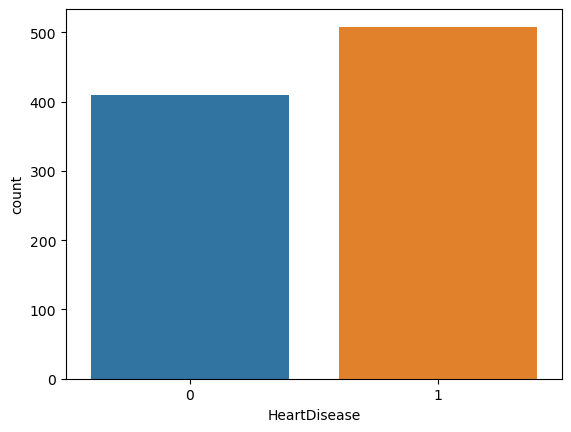

In [8]:
seaborn.countplot(x = 'HeartDisease',data = df_heart)
plt.savefig('heart_tot.png')

In [9]:
df_heart[['Sex']].value_counts()

Sex
M      725
F      193
dtype: int64

In [10]:
df_heart['ChestPainType'].value_counts()

ASY    496
NAP    203
ATA    173
TA      46
Name: ChestPainType, dtype: int64

In [11]:
df_heart['RestingECG'].value_counts()

Normal    552
LVH       188
ST        178
Name: RestingECG, dtype: int64

In [12]:
df_heart['ExerciseAngina'].value_counts()

N    547
Y    371
Name: ExerciseAngina, dtype: int64

In [13]:
df_heart['ST_Slope'].value_counts()

Flat    460
Up      395
Down     63
Name: ST_Slope, dtype: int64

In [9]:
cols_cat_heart = ['Sex', 'ChestPainType','RestingECG','ExerciseAngina','ST_Slope']

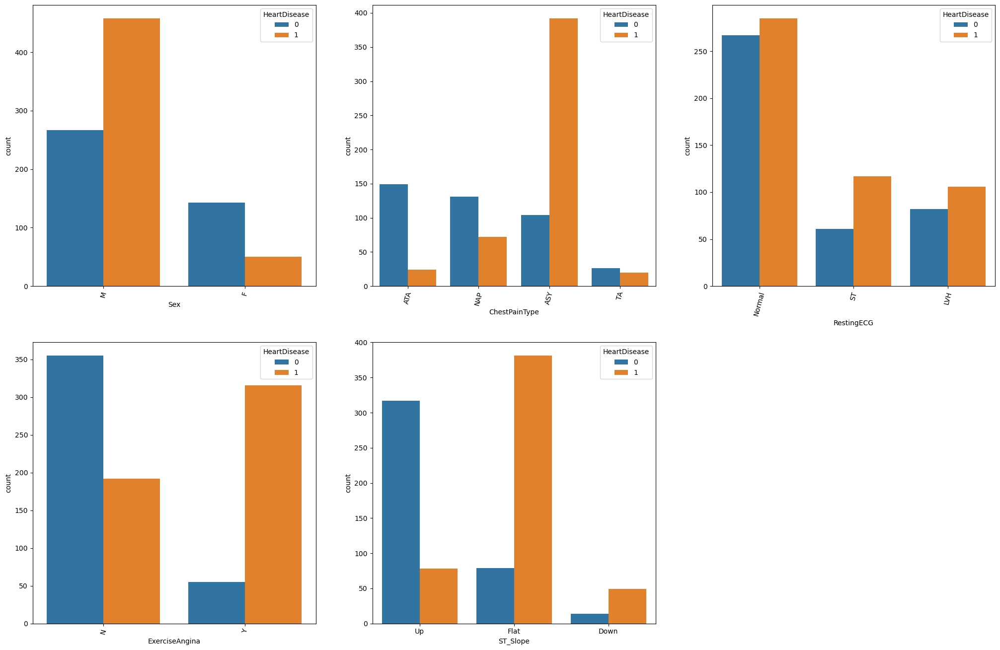

In [15]:

plt.figure(figsize = (25,25))

i  = 0
for j in range(5):
    plt.xticks(rotation=75)
    plt.subplot(int(str(3)+str(3)+str(j+1)))
    seaborn.countplot(x = cols_cat_heart[i], hue='HeartDisease',data = df_heart)
    i += 1

plt.savefig('heart_cat.png')

<Figure size 2500x2500 with 0 Axes>

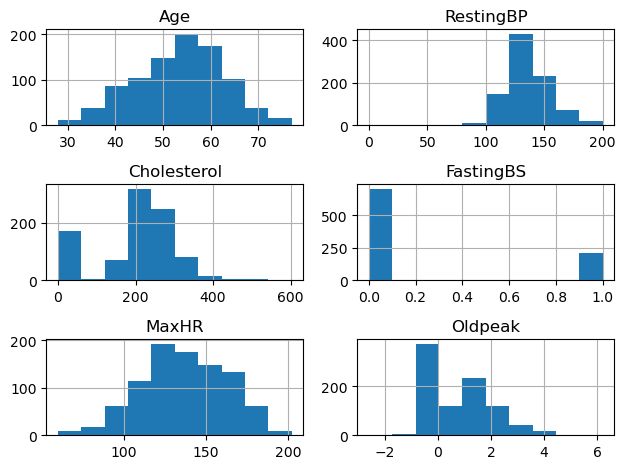

In [17]:
plt.figure(figsize = (25,25))
df_heart[['Age','RestingBP','Cholesterol','FastingBS','MaxHR','Oldpeak']].hist()
plt.tight_layout()
plt.savefig('hist_heart_t.png')

<Figure size 2500x2500 with 0 Axes>

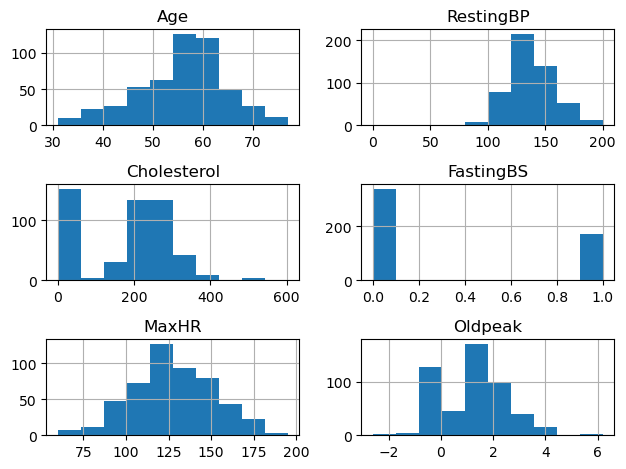

In [18]:
plt.figure(figsize = (25,25))
df_heart[['Age','RestingBP','Cholesterol','FastingBS','MaxHR','Oldpeak']].loc[df_heart['HeartDisease']==1].hist()
plt.tight_layout()
plt.savefig('hist_heart_yes.png')

<Figure size 2500x2500 with 0 Axes>

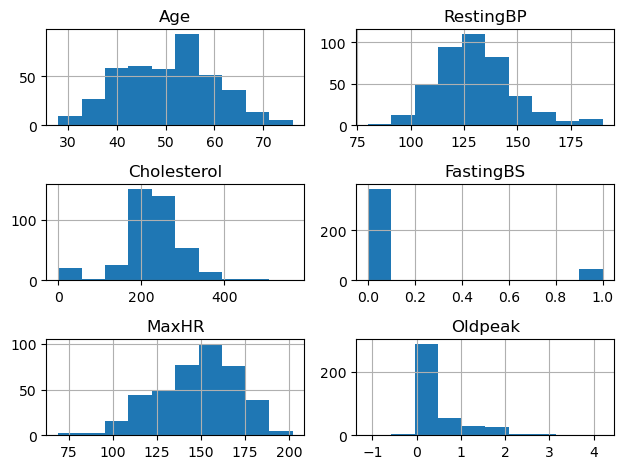

In [19]:
plt.figure(figsize = (25,25))
df_heart[['Age','RestingBP','Cholesterol','FastingBS','MaxHR','Oldpeak']].loc[df_heart['HeartDisease']==0].hist()
plt.tight_layout()
plt.savefig('hist_heart_no.png')

In [10]:
df_heart_conv = df_heart.copy()

In [11]:
df_heart_conv = pd.get_dummies(df_heart_conv, drop_first= True)
df_heart_conv

,Age,RestingBP,Cholesterol,FastingBS,MaxHR,Oldpeak,HeartDisease,Sex_M,ChestPainType_ATA,ChestPainType_NAP,ChestPainType_TA,RestingECG_Normal,RestingECG_ST,ExerciseAngina_Y,ST_Slope_Flat,ST_Slope_Up
0,40,140,289,0,172,0.000,0,1,1,0,0,1,0,0,0,1
1,49,160,180,0,156,1.000,1,0,0,1,0,1,0,0,1,0
2,37,130,283,0,98,0.000,0,1,1,0,0,0,1,0,0,1
3,48,138,214,0,108,1.500,1,0,0,0,0,1,0,1,1,0
4,54,150,195,0,122,0.000,0,1,0,1,0,1,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
913,45,110,264,0,132,1.200,1,1,0,0,1,1,0,0,1,0
914,68,144,193,1,141,3.400,1,1,0,0,0,1,0,0,1,0
915,57,130,131,0,115,1.200,1,1,0,0,0,1,0,1,1,0
916,57,130,236,0,174,0.000,1,0,1,0,0,0,0,0,1,0


In [12]:
df_heart_conv.columns

Index(['Age', 'RestingBP', 'Cholesterol', 'FastingBS', 'MaxHR', 'Oldpeak',
       'HeartDisease', 'Sex_M', 'ChestPainType_ATA', 'ChestPainType_NAP',
       'ChestPainType_TA', 'RestingECG_Normal', 'RestingECG_ST',
       'ExerciseAngina_Y', 'ST_Slope_Flat', 'ST_Slope_Up'],
      dtype='object')

## XGBoost

## CatBoost

## LightGBM

# 3.0 - Kdney Stone Dataset
[Kidney Stone](https://www.kaggle.com/datasets/vuppalaadithyasairam/kidney-stone-prediction-based-on-urine-analysis)

In [242]:
df_kindey = pd.read_csv('03_kindey_stone_dataset.csv')
df_kindey

,gravity,ph,osmo,cond,urea,calc,target
0,1.021,4.910,725,14.000,443,2.450,0
1,1.017,5.740,577,20.000,296,4.490,0
2,1.008,7.200,321,14.900,101,2.360,0
3,1.011,5.510,408,12.600,224,2.150,0
4,1.005,6.520,187,7.500,91,1.160,0
...,...,...,...,...,...,...,...
74,1.025,7.900,721,23.600,301,9.040,1
75,1.017,4.810,410,13.300,195,0.580,1
76,1.024,5.400,803,21.800,394,7.820,1
77,1.016,6.810,594,21.400,255,12.200,1


In [243]:
# columns name
df_kindey.columns

Index(['gravity', 'ph', 'osmo', 'cond', 'urea', 'calc', 'target'], dtype='object')

In [244]:
# columns type
df_kindey.dtypes

gravity    float64
ph         float64
osmo         int64
cond       float64
urea         int64
calc       float64
target       int64
dtype: object

In [245]:
# check for null
df_kindey.isnull().sum()

gravity    0
ph         0
osmo       0
cond       0
urea       0
calc       0
target     0
dtype: int64

In [246]:
df_kindey.describe()

,gravity,ph,osmo,cond,urea,calc,target
count,79.000,79.000,79.000,79.000,79.000,79.000,79.000
mean,1.018,6.028,612.848,20.814,266.405,4.139,0.430
std,0.007,0.724,237.515,7.939,131.255,3.260,0.498
min,1.005,4.760,187.000,5.100,10.000,0.170,0.000
25%,1.012,5.530,413.000,14.150,160.000,1.460,0.000
50%,1.018,5.940,594.000,21.400,260.000,3.160,0.000
75%,1.023,6.385,792.000,26.550,372.000,5.930,1.000
max,1.040,7.940,1236.000,38.000,620.000,14.340,1.000


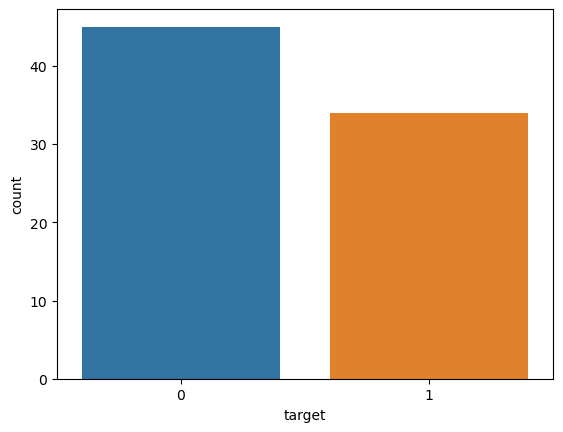

In [247]:
seaborn.countplot(x = 'target',data = df_kindey)
plt.savefig('kindey_tot.png')

<Figure size 2500x2500 with 0 Axes>

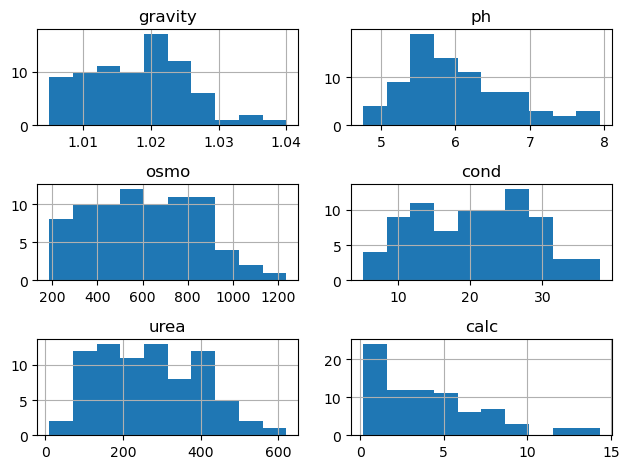

In [252]:
plt.figure(figsize = (25,25))
df_kindey[['gravity', 'ph', 'osmo', 'cond', 'urea', 'calc']].hist()
plt.tight_layout()
plt.savefig('hist_kindey_t.png')

<Figure size 2500x2500 with 0 Axes>

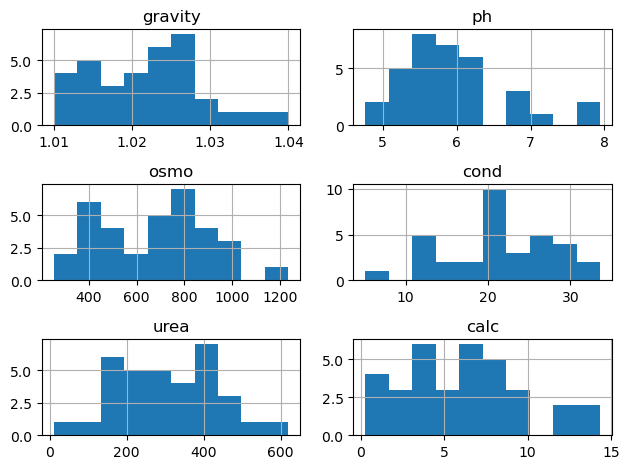

In [253]:
plt.figure(figsize = (25,25))
df_kindey[['gravity', 'ph', 'osmo', 'cond', 'urea', 'calc']].loc[df_kindey['target']==1].hist()
plt.tight_layout()
plt.savefig('hist_kindey_yes.png')

<Figure size 2500x2500 with 0 Axes>

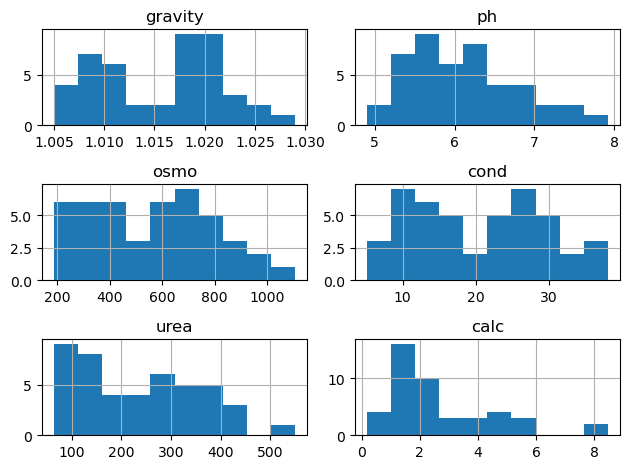

In [254]:
plt.figure(figsize = (25,25))
df_kindey[['gravity', 'ph', 'osmo', 'cond', 'urea', 'calc']].loc[df_kindey['target']==0].hist()
plt.tight_layout()
plt.savefig('hist_kindey_no.png')

## XGBoost

## CatBoost

## LightGBM

# 4.0 - Breast Cancer Wisconsin (Diagnostic)
[Breast Cancer Wisconsin (Diagnostic)](https://www.kaggle.com/datasets/uciml/breast-cancer-wisconsin-data)

In [2]:
df_cancer = pd.read_csv('04_breast_cancer.csv')
df_cancer

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.30010,0.14710,...,17.33,184.60,2019.0,0.16220,0.66560,0.7119,0.2654,0.4601,0.11890,NaN
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.08690,0.07017,...,23.41,158.80,1956.0,0.12380,0.18660,0.2416,0.1860,0.2750,0.08902,NaN
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.19740,0.12790,...,25.53,152.50,1709.0,0.14440,0.42450,0.4504,0.2430,0.3613,0.08758,NaN
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.24140,0.10520,...,26.50,98.87,567.7,0.20980,0.86630,0.6869,0.2575,0.6638,0.17300,NaN
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.19800,0.10430,...,16.67,152.20,1575.0,0.13740,0.20500,0.4000,0.1625,0.2364,0.07678,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
564,926424,M,21.56,22.39,142.00,1479.0,0.11100,0.11590,0.24390,0.13890,...,26.40,166.10,2027.0,0.14100,0.21130,0.4107,0.2216,0.2060,0.07115,NaN
565,926682,M,20.13,28.25,131.20,1261.0,0.09780,0.10340,0.14400,0.09791,...,38.25,155.00,1731.0,0.11660,0.19220,0.3215,0.1628,0.2572,0.06637,NaN
566,926954,M,16.60,28.08,108.30,858.1,0.08455,0.10230,0.09251,0.05302,...,34.12,126.70,1124.0,0.11390,0.30940,0.3403,0.1418,0.2218,0.07820,NaN
567,927241,M,20.60,29.33,140.10,1265.0,0.11780,0.27700,0.35140,0.15200,...,39.42,184.60,1821.0,0.16500,0.86810,0.9387,0.2650,0.4087,0.12400,NaN


In [256]:
# columns name
df_cancer.columns

Index(['id', 'diagnosis', 'radius_mean', 'texture_mean', 'perimeter_mean',
       'area_mean', 'smoothness_mean', 'compactness_mean', 'concavity_mean',
       'concave points_mean', 'symmetry_mean', 'fractal_dimension_mean',
       'radius_se', 'texture_se', 'perimeter_se', 'area_se', 'smoothness_se',
       'compactness_se', 'concavity_se', 'concave points_se', 'symmetry_se',
       'fractal_dimension_se', 'radius_worst', 'texture_worst',
       'perimeter_worst', 'area_worst', 'smoothness_worst',
       'compactness_worst', 'concavity_worst', 'concave points_worst',
       'symmetry_worst', 'fractal_dimension_worst', 'Unnamed: 32'],
      dtype='object')

In [257]:
# columns type
df_cancer.dtypes

id                           int64
diagnosis                   object
radius_mean                float64
texture_mean               float64
perimeter_mean             float64
area_mean                  float64
smoothness_mean            float64
compactness_mean           float64
concavity_mean             float64
concave points_mean        float64
symmetry_mean              float64
fractal_dimension_mean     float64
radius_se                  float64
texture_se                 float64
perimeter_se               float64
area_se                    float64
smoothness_se              float64
compactness_se             float64
concavity_se               float64
concave points_se          float64
symmetry_se                float64
fractal_dimension_se       float64
radius_worst               float64
texture_worst              float64
perimeter_worst            float64
area_worst                 float64
smoothness_worst           float64
compactness_worst          float64
concavity_worst     

In [258]:
# check for null
df_cancer.isnull().sum()

id                           0
diagnosis                    0
radius_mean                  0
texture_mean                 0
perimeter_mean               0
area_mean                    0
smoothness_mean              0
compactness_mean             0
concavity_mean               0
concave points_mean          0
symmetry_mean                0
fractal_dimension_mean       0
radius_se                    0
texture_se                   0
perimeter_se                 0
area_se                      0
smoothness_se                0
compactness_se               0
concavity_se                 0
concave points_se            0
symmetry_se                  0
fractal_dimension_se         0
radius_worst                 0
texture_worst                0
perimeter_worst              0
area_worst                   0
smoothness_worst             0
compactness_worst            0
concavity_worst              0
concave points_worst         0
symmetry_worst               0
fractal_dimension_worst      0
Unnamed:

In [259]:
df_cancer = df_cancer.drop(columns='Unnamed: 32')

In [261]:
df_cancer.isnull().sum()

id                         0
diagnosis                  0
radius_mean                0
texture_mean               0
perimeter_mean             0
area_mean                  0
smoothness_mean            0
compactness_mean           0
concavity_mean             0
concave points_mean        0
symmetry_mean              0
fractal_dimension_mean     0
radius_se                  0
texture_se                 0
perimeter_se               0
area_se                    0
smoothness_se              0
compactness_se             0
concavity_se               0
concave points_se          0
symmetry_se                0
fractal_dimension_se       0
radius_worst               0
texture_worst              0
perimeter_worst            0
area_worst                 0
smoothness_worst           0
compactness_worst          0
concavity_worst            0
concave points_worst       0
symmetry_worst             0
fractal_dimension_worst    0
dtype: int64

In [5]:
df_cancer[['diagnosis', 'radius_mean', 'texture_mean', 'perimeter_mean',
       'area_mean', 'smoothness_mean', 'compactness_mean', 'concavity_mean']].describe()

,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean
count,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000
mean,14.127292,19.289649,91.969033,654.889104,0.096360,0.104341,0.088799
std,3.524049,4.301036,24.298981,351.914129,0.014064,0.052813,0.079720
min,6.981000,9.710000,43.790000,143.500000,0.052630,0.019380,0.000000
25%,11.700000,16.170000,75.170000,420.300000,0.086370,0.064920,0.029560
50%,13.370000,18.840000,86.240000,551.100000,0.095870,0.092630,0.061540
75%,15.780000,21.800000,104.100000,782.700000,0.105300,0.130400,0.130700
max,28.110000,39.280000,188.500000,2501.000000,0.163400,0.345400,0.426800


In [3]:
df_cancer[['concave points_mean', 'symmetry_mean','fractal_dimension_mean',
       'radius_se', 'texture_se', 'perimeter_se', 'area_se','concave points_worst']].describe()

,concave points_mean,symmetry_mean,fractal_dimension_mean,radius_se,texture_se,perimeter_se,area_se,concave points_worst
count,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000
mean,0.048919,0.181162,0.062798,0.405172,1.216853,2.866059,40.337079,0.114606
std,0.038803,0.027414,0.007060,0.277313,0.551648,2.021855,45.491006,0.065732
min,0.000000,0.106000,0.049960,0.111500,0.360200,0.757000,6.802000,0.000000
25%,0.020310,0.161900,0.057700,0.232400,0.833900,1.606000,17.850000,0.064930
50%,0.033500,0.179200,0.061540,0.324200,1.108000,2.287000,24.530000,0.099930
75%,0.074000,0.195700,0.066120,0.478900,1.474000,3.357000,45.190000,0.161400
max,0.201200,0.304000,0.097440,2.873000,4.885000,21.980000,542.200000,0.291000


In [297]:
df_cancer[['smoothness_se',
       'compactness_se', 'concavity_se', 'concave points_se','symmetry_se',
       'fractal_dimension_se', 'radius_worst','texture_worst']].describe()

,smoothness_se,compactness_se,concavity_se,concave points_se,symmetry_se,fractal_dimension_se,radius_worst,texture_worst
count,569.000,569.000,569.000,569.000,569.000,569.000,569.000,569.000
mean,0.007,0.025,0.032,0.012,0.021,0.004,16.269,25.677
std,0.003,0.018,0.030,0.006,0.008,0.003,4.833,6.146
min,0.002,0.002,0.000,0.000,0.008,0.001,7.930,12.020
25%,0.005,0.013,0.015,0.008,0.015,0.002,13.010,21.080
50%,0.006,0.020,0.026,0.011,0.019,0.003,14.970,25.410
75%,0.008,0.032,0.042,0.015,0.023,0.005,18.790,29.720
max,0.031,0.135,0.396,0.053,0.079,0.030,36.040,49.540


In [296]:
df_cancer[[
       'perimeter_worst', 'area_worst', 'smoothness_worst',
       'compactness_worst', 'concavity_worst',
       'symmetry_worst', 'fractal_dimension_worst']].describe()

,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
count,569.000,569.000,569.000,569.000,569.000,569.000,569.000,569.000
mean,107.261,880.583,0.132,0.254,0.272,0.115,0.290,0.084
std,33.603,569.357,0.023,0.157,0.209,0.066,0.062,0.018
min,50.410,185.200,0.071,0.027,0.000,0.000,0.157,0.055
25%,84.110,515.300,0.117,0.147,0.115,0.065,0.250,0.071
50%,97.660,686.500,0.131,0.212,0.227,0.100,0.282,0.080
75%,125.400,1084.000,0.146,0.339,0.383,0.161,0.318,0.092
max,251.200,4254.000,0.223,1.058,1.252,0.291,0.664,0.207


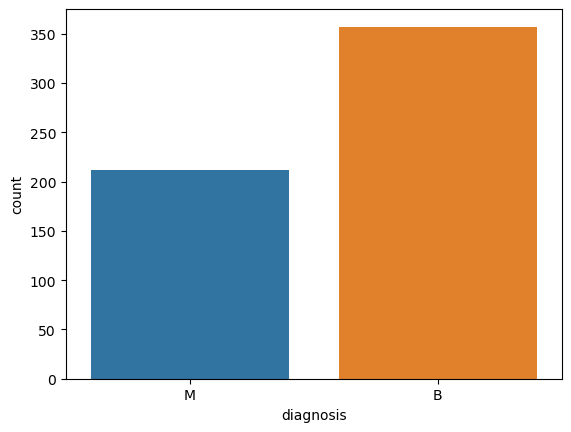

In [266]:
seaborn.countplot(x = 'diagnosis',data = df_cancer)
plt.savefig('cancertot.png')

In [ ]:
plt.figure(figsize = (25,25))

i  = 0
for j in range(9):
    plt.xticks(rotation=75)
    plt.subplot(int(str(3)+str(3)+str(j+1)))
    seaborn.countplot(x = cols_cat_diabete[i], hue='Diabetic',data = df_diabete)
    i += 1

    
plt.figure(figsize = (25,25))
for j in range(5):
    plt.xticks(rotation=75)
    plt.subplot(int(str(3)+str(3)+str(j+1)))
    seaborn.countplot(x = cols_cat_diabete[i], hue='Diabetic',data = df_diabete)
    i += 1
 

In [270]:
df_cancer.columns

Index(['id', 'diagnosis', 'radius_mean', 'texture_mean', 'perimeter_mean',
       'area_mean', 'smoothness_mean', 'compactness_mean', 'concavity_mean',
       'concave points_mean', 'symmetry_mean', 'fractal_dimension_mean',
       'radius_se', 'texture_se', 'perimeter_se', 'area_se', 'smoothness_se',
       'compactness_se', 'concavity_se', 'concave points_se', 'symmetry_se',
       'fractal_dimension_se', 'radius_worst', 'texture_worst',
       'perimeter_worst', 'area_worst', 'smoothness_worst',
       'compactness_worst', 'concavity_worst', 'concave points_worst',
       'symmetry_worst', 'fractal_dimension_worst'],
      dtype='object')

<Figure size 2500x2500 with 0 Axes>

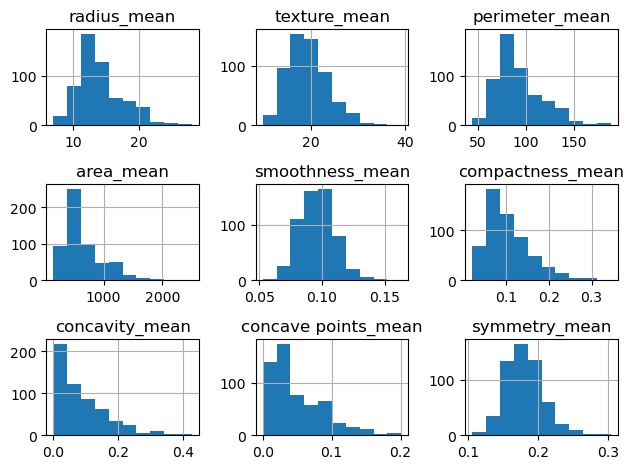

In [275]:
plt.figure(figsize = (25,25))
df_cancer[['diagnosis', 'radius_mean', 'texture_mean', 'perimeter_mean',
       'area_mean', 'smoothness_mean', 'compactness_mean', 'concavity_mean',
       'concave points_mean', 'symmetry_mean']].hist()
plt.tight_layout()
plt.savefig('hist_cancer_t_1.png')

<Figure size 2500x2500 with 0 Axes>

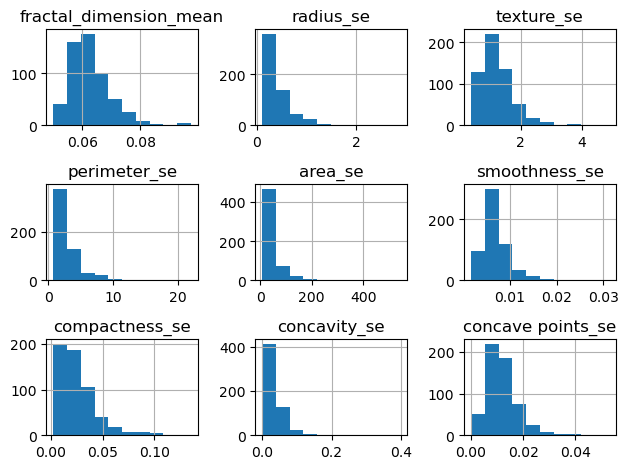

In [276]:
plt.figure(figsize = (25,25))
df_cancer[['fractal_dimension_mean',
       'radius_se', 'texture_se', 'perimeter_se', 'area_se', 'smoothness_se',
       'compactness_se', 'concavity_se', 'concave points_se']].hist()
plt.tight_layout()
plt.savefig('hist_cancer_t_2.png')

<Figure size 2500x2500 with 0 Axes>

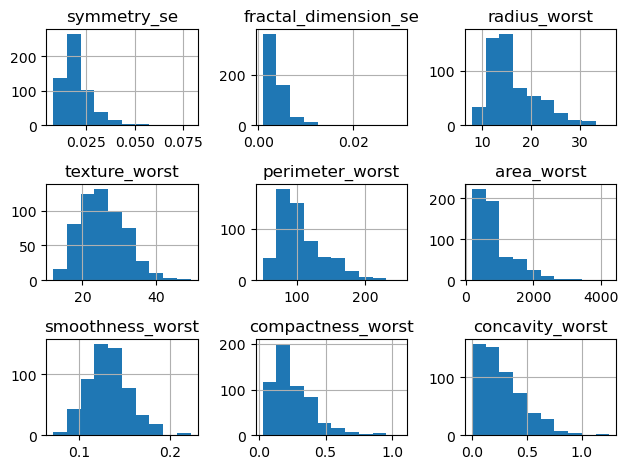

In [277]:
plt.figure(figsize = (25,25))
df_cancer[['symmetry_se',
       'fractal_dimension_se', 'radius_worst', 'texture_worst',
       'perimeter_worst', 'area_worst', 'smoothness_worst',
       'compactness_worst', 'concavity_worst']].hist()
plt.tight_layout()
plt.savefig('hist_cancer_t_3.png')

<Figure size 2500x2500 with 0 Axes>

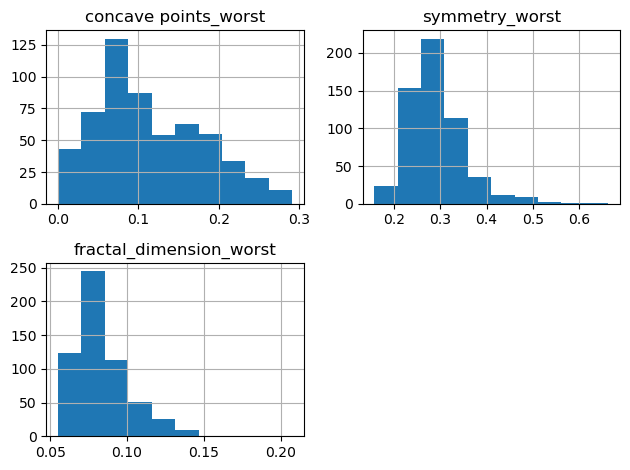

In [279]:
plt.figure(figsize = (25,25))
df_cancer[['concave points_worst',
       'symmetry_worst', 'fractal_dimension_worst']].hist()
plt.tight_layout()
plt.savefig('hist_cancer_t_4.png')

<Figure size 2500x2500 with 0 Axes>

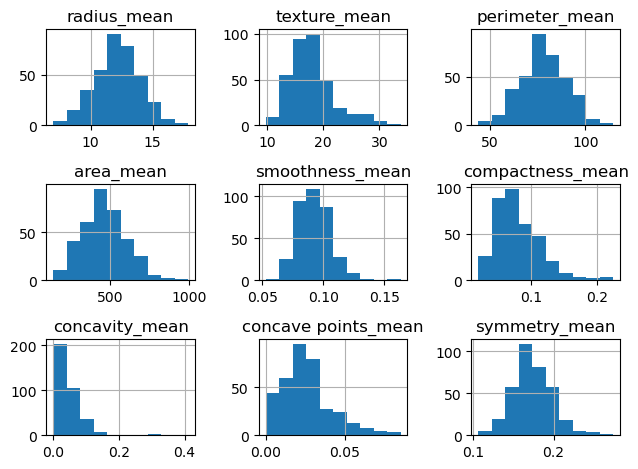

In [280]:
plt.figure(figsize = (25,25))
df_cancer[['diagnosis', 'radius_mean', 'texture_mean', 'perimeter_mean',
       'area_mean', 'smoothness_mean', 'compactness_mean', 'concavity_mean',
       'concave points_mean', 'symmetry_mean']].loc[df_cancer['diagnosis']=='B'].hist()
plt.tight_layout()
plt.savefig('hist_cancer_no_1.png')

<Figure size 2500x2500 with 0 Axes>

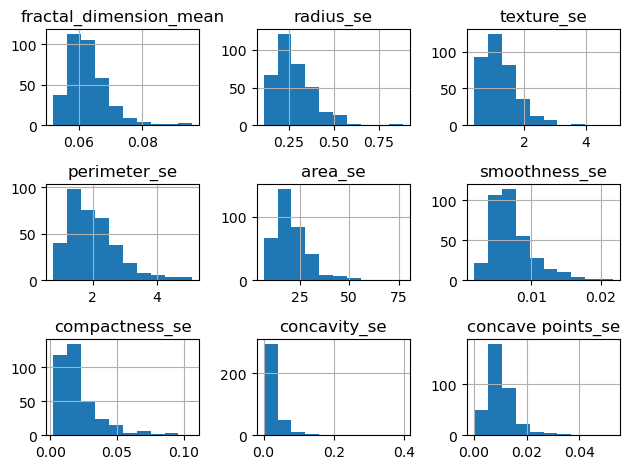

In [281]:
plt.figure(figsize = (25,25))
df_cancer[['fractal_dimension_mean',
       'radius_se', 'texture_se', 'perimeter_se', 'area_se', 'smoothness_se',
       'compactness_se', 'concavity_se', 'concave points_se']].loc[df_cancer['diagnosis']=='B'].hist()
plt.tight_layout()
plt.savefig('hist_cancer_no_2.png')

<Figure size 2500x2500 with 0 Axes>

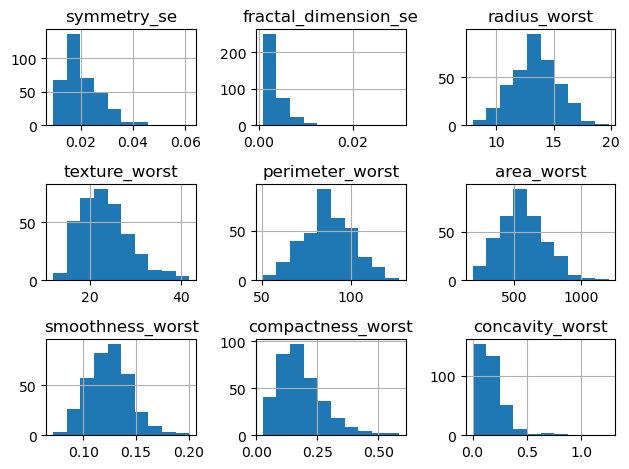

In [282]:
plt.figure(figsize = (25,25))
df_cancer[['symmetry_se',
       'fractal_dimension_se', 'radius_worst', 'texture_worst',
       'perimeter_worst', 'area_worst', 'smoothness_worst',
       'compactness_worst', 'concavity_worst']].loc[df_cancer['diagnosis']=='B'].hist()
plt.tight_layout()
plt.savefig('hist_cancer_no_3.png')

<Figure size 2500x2500 with 0 Axes>

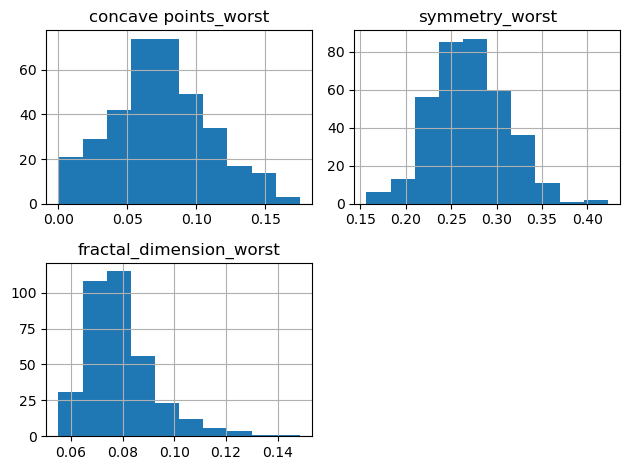

In [283]:
plt.figure(figsize = (25,25))
df_cancer[['concave points_worst',
       'symmetry_worst', 'fractal_dimension_worst']].loc[df_cancer['diagnosis']=='B'].hist()
plt.tight_layout()
plt.savefig('hist_cancer_no_4.png')

<Figure size 2500x2500 with 0 Axes>

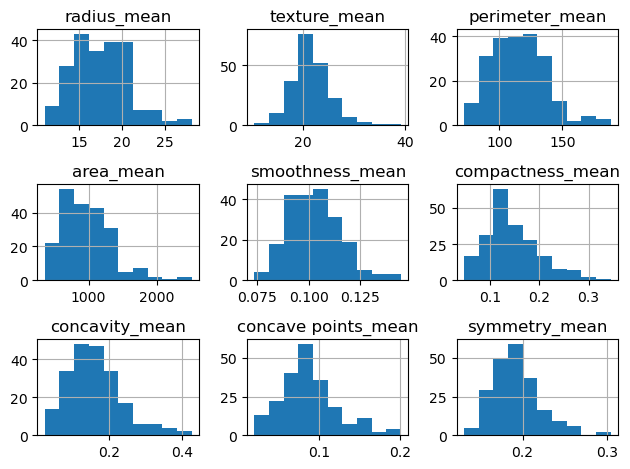

In [284]:
plt.figure(figsize = (25,25))
df_cancer[['diagnosis', 'radius_mean', 'texture_mean', 'perimeter_mean',
       'area_mean', 'smoothness_mean', 'compactness_mean', 'concavity_mean',
       'concave points_mean', 'symmetry_mean']].loc[df_cancer['diagnosis']=='M'].hist()
plt.tight_layout()
plt.savefig('hist_cancer_yes_1.png')

<Figure size 2500x2500 with 0 Axes>

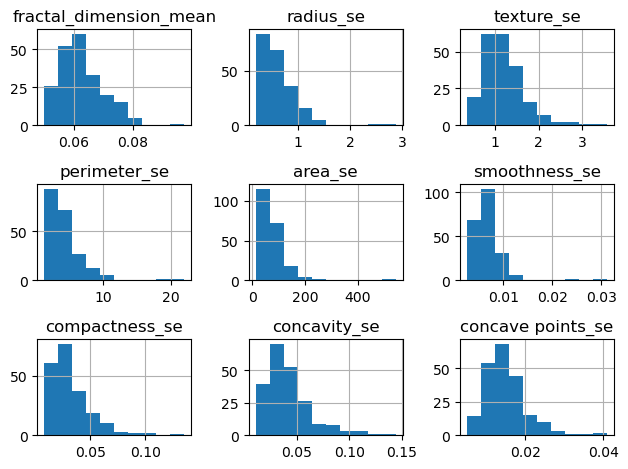

In [285]:
plt.figure(figsize = (25,25))
df_cancer[['fractal_dimension_mean',
       'radius_se', 'texture_se', 'perimeter_se', 'area_se', 'smoothness_se',
       'compactness_se', 'concavity_se', 'concave points_se']].loc[df_cancer['diagnosis']=='M'].hist()
plt.tight_layout()
plt.savefig('hist_cancer_yes_2.png')

<Figure size 2500x2500 with 0 Axes>

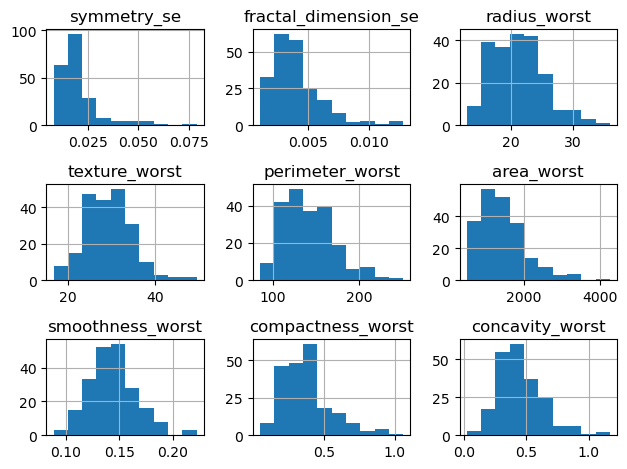

In [286]:
plt.figure(figsize = (25,25))
df_cancer[['symmetry_se',
       'fractal_dimension_se', 'radius_worst', 'texture_worst',
       'perimeter_worst', 'area_worst', 'smoothness_worst',
       'compactness_worst', 'concavity_worst']].loc[df_cancer['diagnosis']=='M'].hist()
plt.tight_layout()
plt.savefig('hist_cancer_yes_3.png')

<Figure size 2500x2500 with 0 Axes>

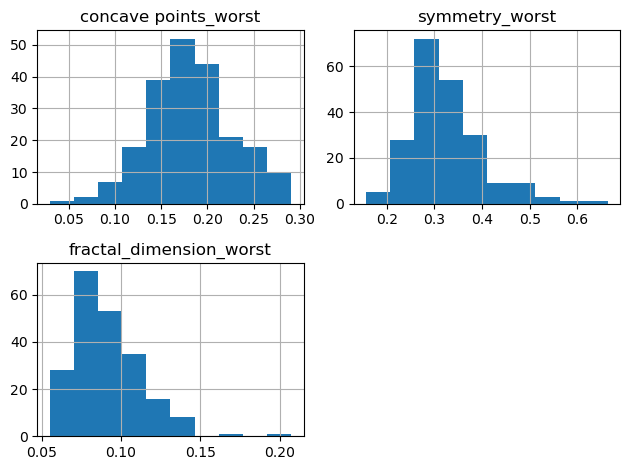

In [287]:
plt.figure(figsize = (25,25))
df_cancer[['concave points_worst',
       'symmetry_worst', 'fractal_dimension_worst']].loc[df_cancer['diagnosis']=='M'].hist()
plt.tight_layout()
plt.savefig('hist_cancer_yes_4.png')

In [10]:
# df_train = pd.read_csv('train_santander.csv')
# df_train

In [12]:
df_train = pd.read_csv('kindey_stone.csv')
df_train

,gravity,ph,osmo,cond,urea,calc,target
0,1.021,4.91,725,14.0,443,2.45,0
1,1.017,5.74,577,20.0,296,4.49,0
2,1.008,7.20,321,14.9,101,2.36,0
3,1.011,5.51,408,12.6,224,2.15,0
4,1.005,6.52,187,7.5,91,1.16,0
...,...,...,...,...,...,...,...
74,1.025,7.90,721,23.6,301,9.04,1
75,1.017,4.81,410,13.3,195,0.58,1
76,1.024,5.40,803,21.8,394,7.82,1
77,1.016,6.81,594,21.4,255,12.20,1


In [15]:
var_columns = [c for c in df_train.columns if c not in ['target']]

X = df_train.loc[:,var_columns]
y = df_train.loc[:,'target']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
X_train.shape, X_test.shape, y_train.shape, y_test.shape 

((63, 6), (16, 6), (63,), (16,))

In [17]:
var_columns = [c for c in df_train.columns if c not in ['target']]

X = df_train.loc[:,var_columns]
y = df_train.loc[:,'target']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
X_train.shape, X_test.shape, y_train.shape, y_test.shape 
xgbc_model = XGBClassifier(min_child_weight=0.1, reg_lambda=100, booster='gbtree', objective='binary:logitraw', random_state=42)
xgbc_score = cross_val_score(xgbc_model, X_train, y_train, scoring='roc_auc', cv=5)
print('xgbc_score: ', xgbc_score.mean())

# LGBMClassifier
ligthgbmc_model = LGBMClassifier(boosting_type='gbdt', objective='binary', random_state=42)
ligthgbmc_score = cross_val_score(ligthgbmc_model, X_train, y_train, scoring='roc_auc', cv=5)
print('ligthgbmc_score: ', ligthgbmc_score.mean())

# CatBoostClassifier
cbc_model = CatBoostClassifier(loss_function='Logloss', random_state=42, verbose=False)
cbc_score = cross_val_score(cbc_model, X_train, y_train, scoring='roc_auc', cv=5)
print('cbc_score: ', cbc_score.mean())

xgbc_score:  0.8751587301587301
ligthgbmc_score:  0.833174603174603
cbc_score:  0.8647619047619048


In [19]:
start = timeit.default_timer()
model_XGB = train(X_train, y_train, X_test, y_test, balanced='balanced', method='XGBoost', number_trials=100)
stop = timeit.default_timer()
stop - start

[I 2022-11-15 18:42:11,699] A new study created in memory with name: XGBoost Classifier


Tuning
Starting the optimization
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:42:13,307] Trial 0 finished with value: 0.5 and parameters: {'max_depth': 3, 'learning_rate': 0.005, 'n_estimators': 3357, 'min_child_weight': 250, 'gamma': 0.5110489645329427, 'alpha': 0.13768350901858759, 'lambda': 0.0006233801249970419, 'colsample_bytree': 0.5815590162888251, 'subsample': 0.7948335215076064}. Best is trial 0 with value: 0.5.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:42:15,251] Trial 1 finished with value: 0.5 and parameters: {'max_depth': 12, 'learning_rate': 0.08, 'n_estimators': 4150, 'min_child_weight': 289, 'gamma': 0.0026162841211978304, 'alpha': 0.0006218424782990117, 'lambda': 1.306249528930305, 'colsample_bytree': 0.40311342838771824, 'subsample': 0.5279626467027322}. Best is trial 0 with value: 0.5.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:42:18,508] Trial 2 finished with value: 0.5 and parameters: {'max_depth': 32, 'learning_rate': 0.02, 'n_estimators': 7272, 'min_child_weight': 223, 'gamma': 0.0404451788208216, 'alpha': 0.004285426173061373, 'lambda': 0.015378073135022487, 'colsample_bytree': 0.7562504805553875, 'subsample': 0.6343675719709801}. Best is trial 0 with value: 0.5.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:42:20,991] Trial 3 finished with value: 0.5 and parameters: {'max_depth': 16, 'learning_rate': 0.005, 'n_estimators': 5590, 'min_child_weight': 20, 'gamma': 0.0036001842296484927, 'alpha': 0.19921647111524782, 'lambda': 0.0008596960331032649, 'colsample_bytree': 0.7280143169167204, 'subsample': 0.6136980935581076}. Best is trial 0 with value: 0.5.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:42:24,407] Trial 4 finished with value: 0.5 and parameters: {'max_depth': 11, 'learning_rate': 0.005, 'n_estimators': 7590, 'min_child_weight': 214, 'gamma': 0.02568040755231401, 'alpha': 0.40348007707688444, 'lambda': 9.29910754661187, 'colsample_bytree': 0.6126040680820606, 'subsample': 0.6565696984489638}. Best is trial 0 with value: 0.5.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:42:27,886] Trial 5 finished with value: 0.5 and parameters: {'max_depth': 22, 'learning_rate': 0.02, 'n_estimators': 7541, 'min_child_weight': 140, 'gamma': 0.4674184338572088, 'alpha': 0.00047824810900741645, 'lambda': 0.001129968234753361, 'colsample_bytree': 0.31237990694611856, 'subsample': 0.7634174429579472}. Best is trial 0 with value: 0.5.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:42:29,627] Trial 6 finished with value: 0.5 and parameters: {'max_depth': 20, 'learning_rate': 0.005, 'n_estimators': 3266, 'min_child_weight': 271, 'gamma': 0.00013640107070420404, 'alpha': 0.005390749262317637, 'lambda': 0.0005451568419241188, 'colsample_bytree': 0.6481634147513512, 'subsample': 0.17037709024532385}. Best is trial 0 with value: 0.5.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:42:32,046] Trial 7 finished with value: 0.5 and parameters: {'max_depth': 8, 'learning_rate': 0.1, 'n_estimators': 4316, 'min_child_weight': 63, 'gamma': 0.03399753154621257, 'alpha': 0.0015082955485775104, 'lambda': 0.047789709767184455, 'colsample_bytree': 0.6169469999292031, 'subsample': 0.36245709306147145}. Best is trial 0 with value: 0.5.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:42:34,582] Trial 8 finished with value: 0.5 and parameters: {'max_depth': 12, 'learning_rate': 0.08, 'n_estimators': 5176, 'min_child_weight': 130, 'gamma': 0.01994952521197245, 'alpha': 1.2393383938696405, 'lambda': 0.8731759552094857, 'colsample_bytree': 0.6470888490684048, 'subsample': 0.5613662173740671}. Best is trial 0 with value: 0.5.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:42:37,782] Trial 9 finished with value: 0.5 and parameters: {'max_depth': 12, 'learning_rate': 0.005, 'n_estimators': 7167, 'min_child_weight': 42, 'gamma': 0.013546730626322102, 'alpha': 0.0008854807210155033, 'lambda': 0.004500620123487909, 'colsample_bytree': 0.6217930432072372, 'subsample': 0.749008872896031}. Best is trial 0 with value: 0.5.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:42:38,907] Trial 10 finished with value: 0.5 and parameters: {'max_depth': 4, 'learning_rate': 0.05, 'n_estimators': 2068, 'min_child_weight': 201, 'gamma': 0.7567411948194394, 'alpha': 0.05301986284345721, 'lambda': 0.00028837590016461895, 'colsample_bytree': 0.13399541229581735, 'subsample': 0.35344228187030624}. Best is trial 0 with value: 0.5.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:42:40,805] Trial 11 finished with value: 0.5 and parameters: {'max_depth': 3, 'learning_rate': 0.08, 'n_estimators': 3770, 'min_child_weight': 295, 'gamma': 0.002042213149664303, 'alpha': 8.426888964867661, 'lambda': 0.20317457661577723, 'colsample_bytree': 0.42026321059532545, 'subsample': 0.4575712049055667}. Best is trial 0 with value: 0.5.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:42:42,278] Trial 12 finished with value: 0.5 and parameters: {'max_depth': 26, 'learning_rate': 0.08, 'n_estimators': 2718, 'min_child_weight': 250, 'gamma': 0.0006466316735292286, 'alpha': 0.000119434274466586, 'lambda': 5.0842434567566706, 'colsample_bytree': 0.4568030874878271, 'subsample': 0.1369026541387468}. Best is trial 0 with value: 0.5.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:42:44,479] Trial 13 finished with value: 0.5 and parameters: {'max_depth': 7, 'learning_rate': 0.1, 'n_estimators': 4375, 'min_child_weight': 175, 'gamma': 0.16518881532041316, 'alpha': 0.02293644599563527, 'lambda': 0.40605383961184627, 'colsample_bytree': 0.4595259223290655, 'subsample': 0.48158434156647884}. Best is trial 0 with value: 0.5.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:42:47,332] Trial 14 finished with value: 0.5 and parameters: {'max_depth': 16, 'learning_rate': 0.05, 'n_estimators': 5939, 'min_child_weight': 296, 'gamma': 0.0026571361252247187, 'alpha': 0.04167286709387338, 'lambda': 0.05267357251654029, 'colsample_bytree': 0.3280227487309857, 'subsample': 0.2561064265319858}. Best is trial 0 with value: 0.5.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:42:49,097] Trial 15 finished with value: 0.5 and parameters: {'max_depth': 7, 'learning_rate': 0.08, 'n_estimators': 3448, 'min_child_weight': 251, 'gamma': 0.13869709290210117, 'alpha': 0.01084917057539916, 'lambda': 0.00014150538825098214, 'colsample_bytree': 0.5312399596121871, 'subsample': 0.7983615840225886}. Best is trial 0 with value: 0.5.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:42:51,552] Trial 16 finished with value: 0.5 and parameters: {'max_depth': 3, 'learning_rate': 0.005, 'n_estimators': 4379, 'min_child_weight': 175, 'gamma': 0.0005034171949241931, 'alpha': 0.00013338670304900545, 'lambda': 0.0054118493407699685, 'colsample_bytree': 0.27427906107236794, 'subsample': 0.6976803509671169}. Best is trial 0 with value: 0.5.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:42:54,585] Trial 17 finished with value: 0.5 and parameters: {'max_depth': 17, 'learning_rate': 0.05, 'n_estimators': 6204, 'min_child_weight': 95, 'gamma': 0.003920754499499013, 'alpha': 0.07779643510470517, 'lambda': 0.06638714063056358, 'colsample_bytree': 0.22358825715577638, 'subsample': 0.24121001186225213}. Best is trial 0 with value: 0.5.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:42:55,890] Trial 18 finished with value: 0.5 and parameters: {'max_depth': 7, 'learning_rate': 0.08, 'n_estimators': 2678, 'min_child_weight': 243, 'gamma': 0.13212366115497656, 'alpha': 0.009894466279531266, 'lambda': 0.0001259831716580364, 'colsample_bytree': 0.5123912923136149, 'subsample': 0.7571898541238634}. Best is trial 0 with value: 0.5.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:42:58,239] Trial 19 finished with value: 0.5 and parameters: {'max_depth': 3, 'learning_rate': 0.005, 'n_estimators': 4819, 'min_child_weight': 176, 'gamma': 0.00011446160110885678, 'alpha': 1.3512500836534895, 'lambda': 0.0031866997415899217, 'colsample_bytree': 0.13544756806524902, 'subsample': 0.6781556083759419}. Best is trial 0 with value: 0.5.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")


XGBoost - Optimization using optuna


[I 2022-11-15 18:43:01,327] Trial 20 finished with value: 0.5 and parameters: {'max_depth': 27, 'learning_rate': 0.05, 'n_estimators': 6247, 'min_child_weight': 97, 'gamma': 0.009965823260068053, 'alpha': 0.17895700242100276, 'lambda': 0.014507282210545501, 'colsample_bytree': 0.2311714236926402, 'subsample': 0.35414038654308116}. Best is trial 0 with value: 0.5.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:43:02,607] Trial 21 finished with value: 0.5 and parameters: {'max_depth': 9, 'learning_rate': 0.05, 'n_estimators': 2486, 'min_child_weight': 109, 'gamma': 0.1564357833118617, 'alpha': 0.08270452012807084, 'lambda': 0.00020589642790681134, 'colsample_bytree': 0.5251268289938588, 'subsample': 0.2557197637635052}. Best is trial 0 with value: 0.5.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:43:04,393] Trial 22 finished with value: 0.5 and parameters: {'max_depth': 5, 'learning_rate': 0.005, 'n_estimators': 3053, 'min_child_weight': 182, 'gamma': 0.3308984972415906, 'alpha': 1.3858557223644943, 'lambda': 0.002183660665674016, 'colsample_bytree': 0.10759378108082758, 'subsample': 0.7150058587630758}. Best is trial 0 with value: 0.5.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:43:07,568] Trial 23 finished with value: 0.5 and parameters: {'max_depth': 29, 'learning_rate': 0.005, 'n_estimators': 6439, 'min_child_weight': 87, 'gamma': 0.0002730617750768363, 'alpha': 0.9482729619899539, 'lambda': 0.009790909120888492, 'colsample_bytree': 0.18305956960250735, 'subsample': 0.3653379407176276}. Best is trial 0 with value: 0.5.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:43:08,783] Trial 24 finished with value: 0.5 and parameters: {'max_depth': 22, 'learning_rate': 0.05, 'n_estimators': 2161, 'min_child_weight': 98, 'gamma': 0.0834270057345917, 'alpha': 0.2562665598797099, 'lambda': 0.0002960604123635877, 'colsample_bytree': 0.5367372724737137, 'subsample': 0.28463939758818224}. Best is trial 0 with value: 0.5.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:43:10,110] Trial 25 finished with value: 0.5 and parameters: {'max_depth': 9, 'learning_rate': 0.005, 'n_estimators': 2736, 'min_child_weight': 149, 'gamma': 0.3785669469153679, 'alpha': 4.703276658553385, 'lambda': 0.0016355474532881837, 'colsample_bytree': 0.7095884705240341, 'subsample': 0.5621267636565148}. Best is trial 0 with value: 0.5.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:43:13,256] Trial 26 finished with value: 0.5 and parameters: {'max_depth': 30, 'learning_rate': 0.005, 'n_estimators': 6737, 'min_child_weight': 66, 'gamma': 0.98445265260911, 'alpha': 0.9205951867385358, 'lambda': 0.010003634701068225, 'colsample_bytree': 0.10719191917077203, 'subsample': 0.40176336093434245}. Best is trial 0 with value: 0.5.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:43:14,298] Trial 27 finished with value: 0.5 and parameters: {'max_depth': 23, 'learning_rate': 0.1, 'n_estimators': 2071, 'min_child_weight': 122, 'gamma': 0.07351702143119689, 'alpha': 0.495202995289204, 'lambda': 0.0003619689641755949, 'colsample_bytree': 0.558105127645203, 'subsample': 0.31201626149436446}. Best is trial 0 with value: 0.5.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:43:15,731] Trial 28 finished with value: 0.5 and parameters: {'max_depth': 19, 'learning_rate': 0.02, 'n_estimators': 2982, 'min_child_weight': 157, 'gamma': 0.3112700659795456, 'alpha': 6.245503398846488, 'lambda': 0.0015019611347253275, 'colsample_bytree': 0.7003413417282424, 'subsample': 0.5811476589373139}. Best is trial 0 with value: 0.5.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:43:17,634] Trial 29 finished with value: 0.5 and parameters: {'max_depth': 14, 'learning_rate': 0.005, 'n_estimators': 3805, 'min_child_weight': 63, 'gamma': 0.9151870104867303, 'alpha': 3.6299885021878198, 'lambda': 0.007444988011075858, 'colsample_bytree': 0.7919542548837168, 'subsample': 0.5052082835739949}. Best is trial 0 with value: 0.5.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:43:21,017] Trial 30 finished with value: 0.5 and parameters: {'max_depth': 32, 'learning_rate': 0.1, 'n_estimators': 6940, 'min_child_weight': 6, 'gamma': 0.06751094513029304, 'alpha': 0.7427284125727963, 'lambda': 0.00046422772767264046, 'colsample_bytree': 0.366641155031331, 'subsample': 0.4135156910943344}. Best is trial 0 with value: 0.5.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6573912166059017
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:43:22,079] Trial 31 finished with value: 0.5 and parameters: {'max_depth': 20, 'learning_rate': 0.02, 'n_estimators': 2011, 'min_child_weight': 122, 'gamma': 0.27475668826463195, 'alpha': 2.871904487878659, 'lambda': 0.0007434763374125391, 'colsample_bytree': 0.5790049869841808, 'subsample': 0.4173341844995032}. Best is trial 0 with value: 0.5.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:43:23,959] Trial 32 finished with value: 0.5 and parameters: {'max_depth': 14, 'learning_rate': 0.02, 'n_estimators': 3770, 'min_child_weight': 71, 'gamma': 0.4649950107811765, 'alpha': 3.438443010538623, 'lambda': 0.0016542878368463836, 'colsample_bytree': 0.7978449326791341, 'subsample': 0.513717719067877}. Best is trial 0 with value: 0.5.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:43:25,724] Trial 33 finished with value: 0.5 and parameters: {'max_depth': 32, 'learning_rate': 0.1, 'n_estimators': 3738, 'min_child_weight': 12, 'gamma': 0.06050913011135328, 'alpha': 6.509062763569438, 'lambda': 0.0007741767947160842, 'colsample_bytree': 0.6998384796301684, 'subsample': 0.6085399107013095}. Best is trial 0 with value: 0.5.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:43:28,048] Trial 34 finished with value: 0.5 and parameters: {'max_depth': 26, 'learning_rate': 0.02, 'n_estimators': 4923, 'min_child_weight': 37, 'gamma': 0.6943009489372074, 'alpha': 2.640613259003965, 'lambda': 0.0006221878802183386, 'colsample_bytree': 0.3618271785577112, 'subsample': 0.42933373400737557}. Best is trial 0 with value: 0.5.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:43:30,327] Trial 35 finished with value: 0.5 and parameters: {'max_depth': 5, 'learning_rate': 0.05, 'n_estimators': 5065, 'min_child_weight': 111, 'gamma': 0.006239500225619811, 'alpha': 0.13458984210871336, 'lambda': 0.02117939928898958, 'colsample_bytree': 0.17797749243640404, 'subsample': 0.20499101050338764}. Best is trial 0 with value: 0.5.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:43:31,600] Trial 36 finished with value: 0.5 and parameters: {'max_depth': 5, 'learning_rate': 0.05, 'n_estimators': 2469, 'min_child_weight': 197, 'gamma': 0.23026655237250374, 'alpha': 0.11612815692988251, 'lambda': 0.0024385828130486452, 'colsample_bytree': 0.23509984451816368, 'subsample': 0.31977192558654927}. Best is trial 0 with value: 0.5.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:43:33,098] Trial 37 finished with value: 0.5 and parameters: {'max_depth': 10, 'learning_rate': 0.05, 'n_estimators': 3195, 'min_child_weight': 271, 'gamma': 0.0107289524349453, 'alpha': 0.2530903980597064, 'lambda': 0.02135177221495804, 'colsample_bytree': 0.5085615565354831, 'subsample': 0.7173672148313021}. Best is trial 0 with value: 0.5.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:43:36,742] Trial 38 finished with value: 0.5 and parameters: {'max_depth': 5, 'learning_rate': 0.005, 'n_estimators': 7961, 'min_child_weight': 225, 'gamma': 0.0014312667722393097, 'alpha': 0.4258947633417089, 'lambda': 0.0001788308241285546, 'colsample_bytree': 0.17434495398167982, 'subsample': 0.18423329991246032}. Best is trial 0 with value: 0.5.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:43:38,278] Trial 39 finished with value: 0.5 and parameters: {'max_depth': 9, 'learning_rate': 0.005, 'n_estimators': 2407, 'min_child_weight': 79, 'gamma': 0.00020795348231846653, 'alpha': 1.8051626595805255, 'lambda': 0.0033702831097431993, 'colsample_bytree': 0.46906845028530386, 'subsample': 0.791296207925949}. Best is trial 0 with value: 0.5.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")


XGBoost - Optimization using optuna


[I 2022-11-15 18:43:41,116] Trial 40 finished with value: 0.5 and parameters: {'max_depth': 23, 'learning_rate': 0.005, 'n_estimators': 5579, 'min_child_weight': 276, 'gamma': 0.0870243238279073, 'alpha': 0.2830577294909655, 'lambda': 0.136156324510858, 'colsample_bytree': 0.5829979045667909, 'subsample': 0.6424821292694424}. Best is trial 0 with value: 0.5.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:43:42,569] Trial 41 finished with value: 0.5 and parameters: {'max_depth': 29, 'learning_rate': 0.005, 'n_estimators': 2881, 'min_child_weight': 153, 'gamma': 0.4511026236853778, 'alpha': 0.7797053632284558, 'lambda': 0.0016352404435407539, 'colsample_bytree': 0.6632358589310204, 'subsample': 0.7171364539234356}. Best is trial 0 with value: 0.5.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:43:45,758] Trial 42 finished with value: 0.5 and parameters: {'max_depth': 30, 'learning_rate': 0.005, 'n_estimators': 6990, 'min_child_weight': 35, 'gamma': 0.6467414920710606, 'alpha': 0.6865674792724508, 'lambda': 0.009144054400749, 'colsample_bytree': 0.1837236878589085, 'subsample': 0.38206536890139714}. Best is trial 0 with value: 0.5.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:43:48,842] Trial 43 finished with value: 0.5 and parameters: {'max_depth': 28, 'learning_rate': 0.005, 'n_estimators': 6620, 'min_child_weight': 87, 'gamma': 0.02689772078257748, 'alpha': 0.3417918267258928, 'lambda': 0.007105661183262379, 'colsample_bytree': 0.7227197538934252, 'subsample': 0.314891883603293}. Best is trial 0 with value: 0.5.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:43:50,005] Trial 44 finished with value: 0.5 and parameters: {'max_depth': 24, 'learning_rate': 0.1, 'n_estimators': 2176, 'min_child_weight': 143, 'gamma': 0.09177926913429972, 'alpha': 0.4787182160249747, 'lambda': 0.00028883559661969357, 'colsample_bytree': 0.5652316953665694, 'subsample': 0.2906607032404467}. Best is trial 0 with value: 0.5.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:43:51,127] Trial 45 finished with value: 0.5 and parameters: {'max_depth': 22, 'learning_rate': 0.1, 'n_estimators': 2298, 'min_child_weight': 51, 'gamma': 0.04096992905121991, 'alpha': 0.02298922577372641, 'lambda': 0.0004023278860440123, 'colsample_bytree': 0.6590937864811683, 'subsample': 0.5528062945513446}. Best is trial 0 with value: 0.5.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:43:52,785] Trial 46 finished with value: 0.5 and parameters: {'max_depth': 20, 'learning_rate': 0.02, 'n_estimators': 3495, 'min_child_weight': 159, 'gamma': 0.3715881307857946, 'alpha': 5.0154602561611785, 'lambda': 0.0012011628091539296, 'colsample_bytree': 0.6936874140375957, 'subsample': 0.579213707882364}. Best is trial 0 with value: 0.5.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:43:54,189] Trial 47 finished with value: 0.5 and parameters: {'max_depth': 18, 'learning_rate': 0.02, 'n_estimators': 2890, 'min_child_weight': 130, 'gamma': 0.20930997676040242, 'alpha': 9.072626324812706, 'lambda': 0.0010745093972949306, 'colsample_bytree': 0.7405473628399604, 'subsample': 0.4691752211273369}. Best is trial 0 with value: 0.5.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:43:56,117] Trial 48 finished with value: 0.5 and parameters: {'max_depth': 14, 'learning_rate': 0.1, 'n_estimators': 4093, 'min_child_weight': 60, 'gamma': 0.9293169266142051, 'alpha': 2.151778514716331, 'lambda': 0.004499307402373135, 'colsample_bytree': 0.7843835931242241, 'subsample': 0.5133515780168125}. Best is trial 0 with value: 0.5.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:43:58,059] Trial 49 finished with value: 0.5 and parameters: {'max_depth': 14, 'learning_rate': 0.02, 'n_estimators': 4071, 'min_child_weight': 24, 'gamma': 0.6626981219997726, 'alpha': 5.30652167879518, 'lambda': 0.014034729870696339, 'colsample_bytree': 0.7676138883678963, 'subsample': 0.608430331576318}. Best is trial 0 with value: 0.5.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:43:59,742] Trial 50 finished with value: 0.5 and parameters: {'max_depth': 18, 'learning_rate': 0.1, 'n_estimators': 3546, 'min_child_weight': 12, 'gamma': 0.046736399983692015, 'alpha': 0.5740154904104657, 'lambda': 0.000407148427334513, 'colsample_bytree': 0.41380628873923053, 'subsample': 0.43917963450682806}. Best is trial 0 with value: 0.5.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:44:00,725] Trial 51 finished with value: 0.5 and parameters: {'max_depth': 20, 'learning_rate': 0.02, 'n_estimators': 2027, 'min_child_weight': 128, 'gamma': 0.25009532985382577, 'alpha': 2.824334246637162, 'lambda': 0.000544136581764575, 'colsample_bytree': 0.5864222556738439, 'subsample': 0.4112109274724286}. Best is trial 0 with value: 0.5.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:44:02,560] Trial 52 finished with value: 0.5 and parameters: {'max_depth': 14, 'learning_rate': 0.02, 'n_estimators': 3892, 'min_child_weight': 24, 'gamma': 0.5235234823988595, 'alpha': 3.4734820895368235, 'lambda': 0.0008748619333496347, 'colsample_bytree': 0.7610313027592404, 'subsample': 0.49948971769798034}. Best is trial 0 with value: 0.5.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:44:04,090] Trial 53 finished with value: 0.5 and parameters: {'max_depth': 16, 'learning_rate': 0.02, 'n_estimators': 3223, 'min_child_weight': 66, 'gamma': 0.28895771134756454, 'alpha': 9.748726885050372, 'lambda': 0.00010068620231074315, 'colsample_bytree': 0.7960542566280249, 'subsample': 0.5402862217498825}. Best is trial 0 with value: 0.5.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:44:06,234] Trial 54 finished with value: 0.5 and parameters: {'max_depth': 31, 'learning_rate': 0.1, 'n_estimators': 4568, 'min_child_weight': 10, 'gamma': 0.01952455422396803, 'alpha': 3.395219696401184, 'lambda': 0.0005867721965796401, 'colsample_bytree': 0.36343799868029397, 'subsample': 0.5247243641300592}. Best is trial 0 with value: 0.5.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6750910766422749
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:44:08,078] Trial 55 finished with value: 0.8090909090909091 and parameters: {'max_depth': 32, 'learning_rate': 0.1, 'n_estimators': 3724, 'min_child_weight': 3, 'gamma': 0.06202021855799602, 'alpha': 1.4689865910523394, 'lambda': 0.0007832962591831441, 'colsample_bytree': 0.6268737271305374, 'subsample': 0.4898268713368121}. Best is trial 55 with value: 0.8090909090909091.


auc:0.8090909090909091 ,ks:0.7090909090909091 ,gini:0.6181818181818182 ,log_loss:0.5051335175521672
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:44:10,640] Trial 56 finished with value: 0.7363636363636363 and parameters: {'max_depth': 32, 'learning_rate': 0.1, 'n_estimators': 5410, 'min_child_weight': 3, 'gamma': 0.06438495525931857, 'alpha': 1.821923070030906, 'lambda': 0.000730688076610618, 'colsample_bytree': 0.3463598591567243, 'subsample': 0.4285559926193185}. Best is trial 55 with value: 0.8090909090909091.


auc:0.7363636363636363 ,ks:0.41818181818181815 ,gini:0.47272727272727266 ,log_loss:0.5398551458492875
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:44:13,415] Trial 57 finished with value: 0.6909090909090909 and parameters: {'max_depth': 32, 'learning_rate': 0.02, 'n_estimators': 5373, 'min_child_weight': 1, 'gamma': 0.12315539569742966, 'alpha': 1.6481928353531794, 'lambda': 0.00018805780078376178, 'colsample_bytree': 0.33080991625787715, 'subsample': 0.48250543744147034}. Best is trial 55 with value: 0.8090909090909091.


auc:0.6909090909090909 ,ks:0.4363636363636364 ,gini:0.38181818181818183 ,log_loss:0.5529871656326577
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:44:16,025] Trial 58 finished with value: 0.5 and parameters: {'max_depth': 32, 'learning_rate': 0.1, 'n_estimators': 5369, 'min_child_weight': 6, 'gamma': 0.12125491219030048, 'alpha': 1.7001913958669517, 'lambda': 0.00010011179611384427, 'colsample_bytree': 0.3014934353069835, 'subsample': 0.4583194024103749}. Best is trial 55 with value: 0.8090909090909091.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6648477464914322
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:44:19,103] Trial 59 finished with value: 0.8 and parameters: {'max_depth': 31, 'learning_rate': 0.02, 'n_estimators': 5871, 'min_child_weight': 1, 'gamma': 0.05374600130096741, 'alpha': 0.0025297866384258634, 'lambda': 0.0001975691682237249, 'colsample_bytree': 0.6251804995985969, 'subsample': 0.48541016901297457}. Best is trial 55 with value: 0.8090909090909091.


auc:0.8 ,ks:0.5272727272727273 ,gini:0.6000000000000001 ,log_loss:0.5763068255837425
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:44:21,987] Trial 60 finished with value: 0.8545454545454546 and parameters: {'max_depth': 31, 'learning_rate': 0.1, 'n_estimators': 5824, 'min_child_weight': 1, 'gamma': 0.06185794724878548, 'alpha': 0.0020318551377964972, 'lambda': 0.00018954218507185209, 'colsample_bytree': 0.622977468974791, 'subsample': 0.4862905182151264}. Best is trial 60 with value: 0.8545454545454546.


auc:0.8545454545454546 ,ks:0.6363636363636364 ,gini:0.7090909090909092 ,log_loss:0.5669340666754579
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:44:24,766] Trial 61 finished with value: 0.5 and parameters: {'max_depth': 31, 'learning_rate': 0.1, 'n_estimators': 5759, 'min_child_weight': 21, 'gamma': 0.052781664493001576, 'alpha': 0.0004340240478404806, 'lambda': 0.0002046528152990908, 'colsample_bytree': 0.6270179187183849, 'subsample': 0.4872158665570045}. Best is trial 60 with value: 0.8545454545454546.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:44:27,436] Trial 62 finished with value: 0.8181818181818181 and parameters: {'max_depth': 29, 'learning_rate': 0.08, 'n_estimators': 5436, 'min_child_weight': 1, 'gamma': 0.03212836369522372, 'alpha': 0.002412810073171247, 'lambda': 0.16109221642809754, 'colsample_bytree': 0.662106737812317, 'subsample': 0.6318429185606017}. Best is trial 60 with value: 0.8545454545454546.


auc:0.8181818181818181 ,ks:0.6363636363636364 ,gini:0.6363636363636362 ,log_loss:0.6235068458163369
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:44:30,445] Trial 63 finished with value: 0.8363636363636364 and parameters: {'max_depth': 29, 'learning_rate': 0.08, 'n_estimators': 6017, 'min_child_weight': 1, 'gamma': 0.03190115903176964, 'alpha': 0.0035430455519796324, 'lambda': 1.4338669764554068, 'colsample_bytree': 0.6788008392472815, 'subsample': 0.45911469410877576}. Best is trial 60 with value: 0.8545454545454546.


auc:0.8363636363636364 ,ks:0.6363636363636364 ,gini:0.6727272727272728 ,log_loss:0.6312740120856688
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:44:33,556] Trial 64 finished with value: 0.8363636363636364 and parameters: {'max_depth': 28, 'learning_rate': 0.08, 'n_estimators': 6016, 'min_child_weight': 1, 'gamma': 0.031132374379306438, 'alpha': 0.0034052535807695228, 'lambda': 1.6183059341635981, 'colsample_bytree': 0.6103185071807642, 'subsample': 0.4532270770462619}. Best is trial 60 with value: 0.8545454545454546.


auc:0.8363636363636364 ,ks:0.6363636363636364 ,gini:0.6727272727272728 ,log_loss:0.5650529583399475


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:44:36,538] Trial 65 finished with value: 0.5 and parameters: {'max_depth': 27, 'learning_rate': 0.08, 'n_estimators': 6110, 'min_child_weight': 29, 'gamma': 0.026665528890859328, 'alpha': 0.0025151363174031587, 'lambda': 1.8807308862319694, 'colsample_bytree': 0.6259229839523507, 'subsample': 0.451654827270321}. Best is trial 60 with value: 0.8545454545454546.


XGBoost - Optimization using optuna
auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:44:39,525] Trial 66 finished with value: 0.5 and parameters: {'max_depth': 30, 'learning_rate': 0.08, 'n_estimators': 5909, 'min_child_weight': 44, 'gamma': 0.019007684964627583, 'alpha': 0.005692777096691873, 'lambda': 1.046311657820149, 'colsample_bytree': 0.6745351171308922, 'subsample': 0.389415330091493}. Best is trial 60 with value: 0.8545454545454546.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:44:42,182] Trial 67 finished with value: 0.5 and parameters: {'max_depth': 28, 'learning_rate': 0.08, 'n_estimators': 5534, 'min_child_weight': 16, 'gamma': 0.014256502228675716, 'alpha': 0.0017552516721701225, 'lambda': 2.464768502779153, 'colsample_bytree': 0.6147831714743157, 'subsample': 0.47021529248895855}. Best is trial 60 with value: 0.8545454545454546.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:44:45,251] Trial 68 finished with value: 0.7909090909090909 and parameters: {'max_depth': 25, 'learning_rate': 0.08, 'n_estimators': 6407, 'min_child_weight': 3, 'gamma': 0.035130267025475774, 'alpha': 0.0007360512699767524, 'lambda': 0.5446115168451267, 'colsample_bytree': 0.5988989753902236, 'subsample': 0.438811079209607}. Best is trial 60 with value: 0.8545454545454546.


auc:0.7909090909090909 ,ks:0.7090909090909091 ,gini:0.5818181818181818 ,log_loss:0.5080809745704755
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:44:48,475] Trial 69 finished with value: 0.5 and parameters: {'max_depth': 26, 'learning_rate': 0.08, 'n_estimators': 6356, 'min_child_weight': 50, 'gamma': 0.0325263254738143, 'alpha': 0.0009306608250835361, 'lambda': 0.43403039974764474, 'colsample_bytree': 0.6369570749375445, 'subsample': 0.5373577030712874}. Best is trial 60 with value: 0.8545454545454546.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:44:51,418] Trial 70 finished with value: 0.5 and parameters: {'max_depth': 25, 'learning_rate': 0.08, 'n_estimators': 6025, 'min_child_weight': 29, 'gamma': 0.03446982736504572, 'alpha': 0.0003291480961841946, 'lambda': 0.6301397539598564, 'colsample_bytree': 0.6827630061949226, 'subsample': 0.37763122352710976}. Best is trial 60 with value: 0.8545454545454546.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:44:54,185] Trial 71 finished with value: 0.5 and parameters: {'max_depth': 29, 'learning_rate': 0.08, 'n_estimators': 5727, 'min_child_weight': 16, 'gamma': 0.053793847858522585, 'alpha': 0.003578763856577787, 'lambda': 0.21847949126658536, 'colsample_bytree': 0.5963606692545002, 'subsample': 0.44548302946839996}. Best is trial 60 with value: 0.8545454545454546.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:44:57,679] Trial 72 finished with value: 0.8 and parameters: {'max_depth': 31, 'learning_rate': 0.08, 'n_estimators': 6566, 'min_child_weight': 2, 'gamma': 0.015591865944505217, 'alpha': 0.0012468688043924614, 'lambda': 4.062403633489991, 'colsample_bytree': 0.64531784645203, 'subsample': 0.4371331559643491}. Best is trial 60 with value: 0.8545454545454546.


auc:0.8 ,ks:0.6181818181818182 ,gini:0.6000000000000001 ,log_loss:0.47806109869270585
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:45:00,783] Trial 73 finished with value: 0.5 and parameters: {'max_depth': 28, 'learning_rate': 0.08, 'n_estimators': 6423, 'min_child_weight': 2, 'gamma': 0.014015008767488629, 'alpha': 0.0010294650339415232, 'lambda': 5.039038066985554, 'colsample_bytree': 0.6488663169348462, 'subsample': 0.10453202323181571}. Best is trial 60 with value: 0.8545454545454546.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6686343550682068
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:45:04,058] Trial 74 finished with value: 0.5 and parameters: {'max_depth': 31, 'learning_rate': 0.08, 'n_estimators': 6619, 'min_child_weight': 33, 'gamma': 0.007094551500453409, 'alpha': 0.008621428934116203, 'lambda': 3.5979642170909787, 'colsample_bytree': 0.6003373088430184, 'subsample': 0.3442840877972937}. Best is trial 60 with value: 0.8545454545454546.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:45:06,932] Trial 75 finished with value: 0.5 and parameters: {'max_depth': 30, 'learning_rate': 0.08, 'n_estimators': 6180, 'min_child_weight': 19, 'gamma': 0.02002886263599573, 'alpha': 0.0014291573604107409, 'lambda': 1.6651657774720228, 'colsample_bytree': 0.538256384437512, 'subsample': 0.40119796175159733}. Best is trial 60 with value: 0.8545454545454546.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:45:09,740] Trial 76 finished with value: 0.5 and parameters: {'max_depth': 29, 'learning_rate': 0.08, 'n_estimators': 5881, 'min_child_weight': 42, 'gamma': 0.030730187708887968, 'alpha': 0.000615027105059888, 'lambda': 9.244580587039056, 'colsample_bytree': 0.4887860308364931, 'subsample': 0.483259571308658}. Best is trial 60 with value: 0.8545454545454546.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:45:12,372] Trial 77 finished with value: 0.8363636363636364 and parameters: {'max_depth': 31, 'learning_rate': 0.08, 'n_estimators': 5205, 'min_child_weight': 1, 'gamma': 0.04087536372098216, 'alpha': 0.0025584812045900975, 'lambda': 0.7970658373114471, 'colsample_bytree': 0.5611338488044197, 'subsample': 0.4978178008971463}. Best is trial 60 with value: 0.8545454545454546.


auc:0.8363636363636364 ,ks:0.6363636363636364 ,gini:0.6727272727272728 ,log_loss:0.5829887750915077
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:45:14,723] Trial 78 finished with value: 0.5 and parameters: {'max_depth': 31, 'learning_rate': 0.08, 'n_estimators': 4628, 'min_child_weight': 12, 'gamma': 0.008074947506831513, 'alpha': 0.0029289035975909143, 'lambda': 0.26971234471426375, 'colsample_bytree': 0.5498211256211039, 'subsample': 0.5818100232680429}. Best is trial 60 with value: 0.8545454545454546.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6818618550896645
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:45:17,199] Trial 79 finished with value: 0.5 and parameters: {'max_depth': 27, 'learning_rate': 0.08, 'n_estimators': 5199, 'min_child_weight': 25, 'gamma': 0.022296257740241427, 'alpha': 0.005005990709322152, 'lambda': 0.09725601732501027, 'colsample_bytree': 0.7209172194870629, 'subsample': 0.5043418406143909}. Best is trial 60 with value: 0.8545454545454546.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:45:19,667] Trial 80 finished with value: 0.5 and parameters: {'max_depth': 30, 'learning_rate': 0.08, 'n_estimators': 5199, 'min_child_weight': 16, 'gamma': 0.04099541098711471, 'alpha': 0.007052984730323346, 'lambda': 2.7259809077729837, 'colsample_bytree': 0.6422499474822931, 'subsample': 0.46466977272622384}. Best is trial 60 with value: 0.8545454545454546.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:45:22,750] Trial 81 finished with value: 0.8545454545454546 and parameters: {'max_depth': 28, 'learning_rate': 0.08, 'n_estimators': 5755, 'min_child_weight': 1, 'gamma': 0.09495567166721729, 'alpha': 0.015021012254763771, 'lambda': 0.9092251640727849, 'colsample_bytree': 0.6076751952293137, 'subsample': 0.4358438415166096}. Best is trial 60 with value: 0.8545454545454546.


auc:0.8545454545454546 ,ks:0.6363636363636364 ,gini:0.7090909090909092 ,log_loss:0.5563265012824559
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:45:25,549] Trial 82 finished with value: 0.5 and parameters: {'max_depth': 28, 'learning_rate': 0.08, 'n_estimators': 5707, 'min_child_weight': 9, 'gamma': 0.09326057027672492, 'alpha': 0.0019031927142247936, 'lambda': 1.1144262196150134, 'colsample_bytree': 0.6762686470006503, 'subsample': 0.4951731266064542}. Best is trial 60 with value: 0.8545454545454546.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6653560027480125
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:45:28,692] Trial 83 finished with value: 0.8363636363636364 and parameters: {'max_depth': 31, 'learning_rate': 0.08, 'n_estimators': 6021, 'min_child_weight': 1, 'gamma': 0.016307982221746606, 'alpha': 0.011298269829170614, 'lambda': 0.872407068004728, 'colsample_bytree': 0.6593513094900065, 'subsample': 0.4237074361427615}. Best is trial 60 with value: 0.8545454545454546.


auc:0.8363636363636364 ,ks:0.6363636363636364 ,gini:0.6727272727272728 ,log_loss:0.5646458502469613
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:45:31,547] Trial 84 finished with value: 0.5 and parameters: {'max_depth': 29, 'learning_rate': 0.08, 'n_estimators': 5995, 'min_child_weight': 36, 'gamma': 0.07474032296452797, 'alpha': 0.01722653168149082, 'lambda': 0.7652900967143681, 'colsample_bytree': 0.5715969453859272, 'subsample': 0.5263626994945836}. Best is trial 60 with value: 0.8545454545454546.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:45:34,261] Trial 85 finished with value: 0.5 and parameters: {'max_depth': 30, 'learning_rate': 0.08, 'n_estimators': 5814, 'min_child_weight': 21, 'gamma': 0.10686694179059285, 'alpha': 0.00387176497054985, 'lambda': 1.3720508050853941, 'colsample_bytree': 0.6124027849330703, 'subsample': 0.4213987580010938}. Best is trial 60 with value: 0.8545454545454546.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:45:36,997] Trial 86 finished with value: 0.5 and parameters: {'max_depth': 29, 'learning_rate': 0.08, 'n_estimators': 5554, 'min_child_weight': 10, 'gamma': 0.1770736042926739, 'alpha': 0.013293722257534385, 'lambda': 0.3084750473368064, 'colsample_bytree': 0.6638818346255531, 'subsample': 0.3973966676420791}. Best is trial 60 with value: 0.8545454545454546.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6882810071110725
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:45:39,765] Trial 87 finished with value: 0.7818181818181819 and parameters: {'max_depth': 31, 'learning_rate': 0.08, 'n_estimators': 4839, 'min_child_weight': 1, 'gamma': 0.05433363191189752, 'alpha': 0.037672638610910025, 'lambda': 0.766251679238162, 'colsample_bytree': 0.7037679793161202, 'subsample': 0.6760655450330759}. Best is trial 60 with value: 0.8545454545454546.


auc:0.7818181818181819 ,ks:0.5454545454545454 ,gini:0.5636363636363637 ,log_loss:0.6003650928396382
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:45:42,357] Trial 88 finished with value: 0.5 and parameters: {'max_depth': 27, 'learning_rate': 0.08, 'n_estimators': 5070, 'min_child_weight': 54, 'gamma': 0.005037227877979362, 'alpha': 0.0023735697793077944, 'lambda': 0.16166750155915086, 'colsample_bytree': 0.7419065319628, 'subsample': 0.3445414353461399}. Best is trial 60 with value: 0.8545454545454546.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:45:45,555] Trial 89 finished with value: 0.5 and parameters: {'max_depth': 32, 'learning_rate': 0.08, 'n_estimators': 6300, 'min_child_weight': 30, 'gamma': 0.009575300429894447, 'alpha': 0.006872704069363747, 'lambda': 0.4175421116027788, 'colsample_bytree': 0.6072535216208503, 'subsample': 0.47223823002692933}. Best is trial 60 with value: 0.8545454545454546.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:45:48,611] Trial 90 finished with value: 0.5 and parameters: {'max_depth': 28, 'learning_rate': 0.1, 'n_estimators': 6109, 'min_child_weight': 15, 'gamma': 0.04883366514982496, 'alpha': 0.027738680322241756, 'lambda': 1.922175097619882, 'colsample_bytree': 0.6857869357427423, 'subsample': 0.4528966917601684}. Best is trial 60 with value: 0.8545454545454546.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:45:51,960] Trial 91 finished with value: 0.5 and parameters: {'max_depth': 31, 'learning_rate': 0.08, 'n_estimators': 6664, 'min_child_weight': 9, 'gamma': 0.012446082702237937, 'alpha': 0.0013614938325586465, 'lambda': 5.151117002274132, 'colsample_bytree': 0.6350295344240943, 'subsample': 0.43367586875517916}. Best is trial 60 with value: 0.8545454545454546.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6679622009396553
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:45:55,819] Trial 92 finished with value: 0.8 and parameters: {'max_depth': 30, 'learning_rate': 0.08, 'n_estimators': 7413, 'min_child_weight': 1, 'gamma': 0.015794168899230507, 'alpha': 0.013259944249363, 'lambda': 0.03528446728962356, 'colsample_bytree': 0.6530110670282, 'subsample': 0.3708741302242602}. Best is trial 60 with value: 0.8545454545454546.


auc:0.8 ,ks:0.5272727272727273 ,gini:0.6000000000000001 ,log_loss:0.5625541386307304
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:45:59,865] Trial 93 finished with value: 0.5 and parameters: {'max_depth': 30, 'learning_rate': 0.08, 'n_estimators': 7896, 'min_child_weight': 26, 'gamma': 0.017288128650614288, 'alpha': 0.013674415707236917, 'lambda': 1.3652536367508206, 'colsample_bytree': 0.6537335900079804, 'subsample': 0.3746033902149791}. Best is trial 60 with value: 0.8545454545454546.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:46:03,446] Trial 94 finished with value: 0.5 and parameters: {'max_depth': 29, 'learning_rate': 0.08, 'n_estimators': 7033, 'min_child_weight': 20, 'gamma': 0.02311093966821812, 'alpha': 0.0614279774453786, 'lambda': 0.0997844876058674, 'colsample_bytree': 0.6725425130703289, 'subsample': 0.32922637417362094}. Best is trial 60 with value: 0.8545454545454546.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:46:07,285] Trial 95 finished with value: 0.5 and parameters: {'max_depth': 32, 'learning_rate': 0.08, 'n_estimators': 7439, 'min_child_weight': 9, 'gamma': 0.015910783740459348, 'alpha': 0.004712238062782013, 'lambda': 0.0461995354501894, 'colsample_bytree': 0.7156963731360055, 'subsample': 0.41472965223932823}. Best is trial 60 with value: 0.8545454545454546.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6687954403460026
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:46:10,792] Trial 96 finished with value: 0.5 and parameters: {'max_depth': 30, 'learning_rate': 0.08, 'n_estimators': 6865, 'min_child_weight': 7, 'gamma': 0.027278500678981927, 'alpha': 0.0033903422491543796, 'lambda': 3.6455891190873575, 'colsample_bytree': 0.5817595189964736, 'subsample': 0.36898773753197855}. Best is trial 60 with value: 0.8545454545454546.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6603402271866798
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:46:13,692] Trial 97 finished with value: 0.5 and parameters: {'max_depth': 31, 'learning_rate': 0.1, 'n_estimators': 5645, 'min_child_weight': 41, 'gamma': 0.043801497374047996, 'alpha': 0.002065481510493448, 'lambda': 1.0211952438299596, 'colsample_bytree': 0.5505112154712943, 'subsample': 0.557910374330954}. Best is trial 60 with value: 0.8545454545454546.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:46:16,644] Trial 98 finished with value: 0.8181818181818182 and parameters: {'max_depth': 27, 'learning_rate': 0.08, 'n_estimators': 5322, 'min_child_weight': 1, 'gamma': 0.07561793717189302, 'alpha': 0.009018111221709361, 'lambda': 0.00014807036175365363, 'colsample_bytree': 0.6211568786211453, 'subsample': 0.5156985621307276}. Best is trial 60 with value: 0.8545454545454546.


auc:0.8181818181818182 ,ks:0.5454545454545454 ,gini:0.6363636363636365 ,log_loss:0.5345347539659997
XGBoost - Optimization using optuna


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1421: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
[I 2022-11-15 18:46:19,517] Trial 99 finished with value: 0.5 and parameters: {'max_depth': 28, 'learning_rate': 0.1, 'n_estimators': 5495, 'min_child_weight': 15, 'gamma': 0.07283037961129021, 'alpha': 0.009770277282241077, 'lambda': 0.00014699252628594037, 'colsample_bytree': 0.6188384357401302, 'subsample': 0.5209757555900322}. Best is trial 60 with value: 0.8545454545454546.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6931471824645996
Last Fit


/home/joaomh/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:861: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


247.94987597499858

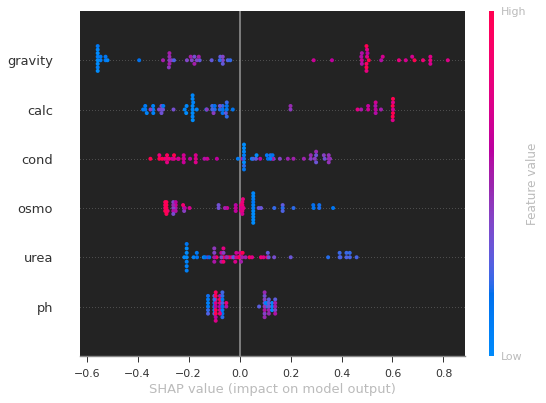

In [30]:
explainer = shap.TreeExplainer(model_XGB)
shap_values = explainer.shap_values(X_train)
shap.summary_plot(shap_values, X_train,plot_size=.7)

In [31]:
start = timeit.default_timer()
model_LGBM = train(X_train, y_train, X_test, y_test, balanced='balanced', method='LGBM', number_trials=100)
stop = timeit.default_timer()
stop - start

[I 2022-11-15 19:03:23,120] A new study created in memory with name: LGBM Classifier
[I 2022-11-15 19:03:23,246] Trial 0 finished with value: 0.5 and parameters: {'reg_alpha': 5.289263918473209, 'reg_lambda': 2.363830771919486, 'num_leaves': 152, 'min_child_samples': 88, 'max_depth': 31, 'learning_rate': 0.05, 'colsample_bytree': 0.42648920760182163, 'n_estimators': 2157, 'cat_smooth': 72, 'cat_l2': 16, 'min_data_per_group': 156}. Best is trial 0 with value: 0.5.


Tuning
Starting the optimization
LGBM - Optimization using optuna
auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6664819188471485
LGBM - Optimization using optuna


[I 2022-11-15 19:03:23,421] Trial 1 finished with value: 0.7454545454545454 and parameters: {'reg_alpha': 4.3987746764105164, 'reg_lambda': 9.505333169298721, 'num_leaves': 161, 'min_child_samples': 6, 'max_depth': 8, 'learning_rate': 0.1, 'colsample_bytree': 0.37477182832109124, 'n_estimators': 2353, 'cat_smooth': 81, 'cat_l2': 11, 'min_data_per_group': 111}. Best is trial 1 with value: 0.7454545454545454.
[I 2022-11-15 19:03:23,577] Trial 2 finished with value: 0.5 and parameters: {'reg_alpha': 0.438084947016658, 'reg_lambda': 0.8997484337332519, 'num_leaves': 129, 'min_child_samples': 84, 'max_depth': 20, 'learning_rate': 0.1, 'colsample_bytree': 0.4293811119050208, 'n_estimators': 7369, 'cat_smooth': 98, 'cat_l2': 12, 'min_data_per_group': 153}. Best is trial 1 with value: 0.7454545454545454.


auc:0.7454545454545454 ,ks:0.509090909090909 ,gini:0.49090909090909074 ,log_loss:0.5750298866159836
LGBM - Optimization using optuna
auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6664819188471485
LGBM - Optimization using optuna


[I 2022-11-15 19:03:23,883] Trial 3 finished with value: 0.7090909090909091 and parameters: {'reg_alpha': 2.420159001838962, 'reg_lambda': 0.9677407968485033, 'num_leaves': 204, 'min_child_samples': 9, 'max_depth': 13, 'learning_rate': 0.01, 'colsample_bytree': 0.19616674081941865, 'n_estimators': 5405, 'cat_smooth': 89, 'cat_l2': 18, 'min_data_per_group': 167}. Best is trial 1 with value: 0.7454545454545454.


auc:0.7090909090909091 ,ks:0.4 ,gini:0.4181818181818182 ,log_loss:0.5738730826085205
LGBM - Optimization using optuna


[I 2022-11-15 19:03:24,132] Trial 4 finished with value: 0.5 and parameters: {'reg_alpha': 6.704266549637938, 'reg_lambda': 8.85873127267698, 'num_leaves': 156, 'min_child_samples': 39, 'max_depth': 43, 'learning_rate': 0.05, 'colsample_bytree': 0.14792997361150123, 'n_estimators': 7823, 'cat_smooth': 43, 'cat_l2': 2, 'min_data_per_group': 117}. Best is trial 1 with value: 0.7454545454545454.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6664819188471485
LGBM - Optimization using optuna


[I 2022-11-15 19:03:24,356] Trial 5 finished with value: 0.5 and parameters: {'reg_alpha': 4.507592475280859, 'reg_lambda': 1.5794748465790946, 'num_leaves': 208, 'min_child_samples': 73, 'max_depth': 37, 'learning_rate': 0.1, 'colsample_bytree': 0.3116833770855526, 'n_estimators': 6539, 'cat_smooth': 66, 'cat_l2': 19, 'min_data_per_group': 110}. Best is trial 1 with value: 0.7454545454545454.
[I 2022-11-15 19:03:24,546] Trial 6 finished with value: 0.5 and parameters: {'reg_alpha': 9.361338648326555, 'reg_lambda': 0.0841788917075052, 'num_leaves': 230, 'min_child_samples': 81, 'max_depth': 32, 'learning_rate': 0.01, 'colsample_bytree': 0.10256621762989844, 'n_estimators': 4096, 'cat_smooth': 81, 'cat_l2': 12, 'min_data_per_group': 110}. Best is trial 1 with value: 0.7454545454545454.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6664819188471485
LGBM - Optimization using optuna
auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6664819188471485
LGBM - Optimization using optuna


[I 2022-11-15 19:03:24,899] Trial 7 finished with value: 0.7636363636363636 and parameters: {'reg_alpha': 2.5863062343506624, 'reg_lambda': 8.152225446946959, 'num_leaves': 169, 'min_child_samples': 21, 'max_depth': 17, 'learning_rate': 0.005, 'colsample_bytree': 0.40284190692993216, 'n_estimators': 4100, 'cat_smooth': 27, 'cat_l2': 3, 'min_data_per_group': 175}. Best is trial 7 with value: 0.7636363636363636.


auc:0.7636363636363636 ,ks:0.509090909090909 ,gini:0.5272727272727271 ,log_loss:0.5435909643116412
LGBM - Optimization using optuna


[I 2022-11-15 19:03:25,124] Trial 8 finished with value: 0.5 and parameters: {'reg_alpha': 1.9956318545371188, 'reg_lambda': 2.1098806789786035, 'num_leaves': 77, 'min_child_samples': 83, 'max_depth': 55, 'learning_rate': 0.1, 'colsample_bytree': 0.2058452733183355, 'n_estimators': 6044, 'cat_smooth': 95, 'cat_l2': 10, 'min_data_per_group': 93}. Best is trial 7 with value: 0.7636363636363636.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6664819188471485
LGBM - Optimization using optuna


[I 2022-11-15 19:03:25,405] Trial 9 finished with value: 0.6181818181818183 and parameters: {'reg_alpha': 5.016461152153072, 'reg_lambda': 1.422682963118542, 'num_leaves': 264, 'min_child_samples': 30, 'max_depth': 26, 'learning_rate': 0.05, 'colsample_bytree': 0.3397849868113991, 'n_estimators': 4616, 'cat_smooth': 31, 'cat_l2': 18, 'min_data_per_group': 160}. Best is trial 7 with value: 0.7636363636363636.
[I 2022-11-15 19:03:25,586] Trial 10 finished with value: 0.5 and parameters: {'reg_alpha': 0.04058923233131306, 'reg_lambda': 6.88016994556816, 'num_leaves': 328, 'min_child_samples': 55, 'max_depth': 5, 'learning_rate': 0.005, 'colsample_bytree': 0.4998460771711108, 'n_estimators': 3314, 'cat_smooth': 11, 'cat_l2': 1, 'min_data_per_group': 199}. Best is trial 7 with value: 0.7636363636363636.


auc:0.6181818181818183 ,ks:0.23636363636363633 ,gini:0.23636363636363655 ,log_loss:0.6360990013207977
LGBM - Optimization using optuna
auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6664819188471485


[I 2022-11-15 19:03:25,785] Trial 11 finished with value: 0.7636363636363636 and parameters: {'reg_alpha': 3.044696492045966, 'reg_lambda': 9.82339439919088, 'num_leaves': 64, 'min_child_samples': 8, 'max_depth': 8, 'learning_rate': 0.02, 'colsample_bytree': 0.37852104913819123, 'n_estimators': 2078, 'cat_smooth': 48, 'cat_l2': 6, 'min_data_per_group': 58}. Best is trial 7 with value: 0.7636363636363636.


LGBM - Optimization using optuna
auc:0.7636363636363636 ,ks:0.509090909090909 ,gini:0.5272727272727271 ,log_loss:0.5565504923099569
LGBM - Optimization using optuna

[I 2022-11-15 19:03:26,026] Trial 12 finished with value: 0.7636363636363636 and parameters: {'reg_alpha': 2.626382579194286, 'reg_lambda': 7.366414236925916, 'num_leaves': 15, 'min_child_samples': 22, 'max_depth': 18, 'learning_rate': 0.02, 'colsample_bytree': 0.2657643801735933, 'n_estimators': 3048, 'cat_smooth': 27, 'cat_l2': 5, 'min_data_per_group': 60}. Best is trial 7 with value: 0.7636363636363636.



auc:0.7636363636363636 ,ks:0.509090909090909 ,gini:0.5272727272727271 ,log_loss:0.5579305321706653


[I 2022-11-15 19:03:26,310] Trial 13 finished with value: 0.7636363636363636 and parameters: {'reg_alpha': 2.841250532713077, 'reg_lambda': 5.858884354159715, 'num_leaves': 86, 'min_child_samples': 20, 'max_depth': 18, 'learning_rate': 0.005, 'colsample_bytree': 0.4082353553090461, 'n_estimators': 3846, 'cat_smooth': 51, 'cat_l2': 6, 'min_data_per_group': 50}. Best is trial 7 with value: 0.7636363636363636.


LGBM - Optimization using optuna
auc:0.7636363636363636 ,ks:0.509090909090909 ,gini:0.5272727272727271 ,log_loss:0.548563116981835


[I 2022-11-15 19:03:26,537] Trial 14 finished with value: 0.5 and parameters: {'reg_alpha': 7.215879623095084, 'reg_lambda': 8.187175649145447, 'num_leaves': 19, 'min_child_samples': 48, 'max_depth': 62, 'learning_rate': 0.02, 'colsample_bytree': 0.4961870194311757, 'n_estimators': 5057, 'cat_smooth': 33, 'cat_l2': 6, 'min_data_per_group': 78}. Best is trial 7 with value: 0.7636363636363636.


LGBM - Optimization using optuna
auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6664819188471485
LGBM - Optimization using optuna


[I 2022-11-15 19:03:26,925] Trial 15 finished with value: 0.7727272727272727 and parameters: {'reg_alpha': 1.3354791460623123, 'reg_lambda': 9.883426562308689, 'num_leaves': 90, 'min_child_samples': 18, 'max_depth': 11, 'learning_rate': 0.005, 'colsample_bytree': 0.2595411437544244, 'n_estimators': 3089, 'cat_smooth': 18, 'cat_l2': 4, 'min_data_per_group': 197}. Best is trial 15 with value: 0.7727272727272727.
[I 2022-11-15 19:03:27,068] Trial 16 finished with value: 0.5 and parameters: {'reg_alpha': 1.2764395812675526, 'reg_lambda': 4.861627860298619, 'num_leaves': 110, 'min_child_samples': 59, 'max_depth': 24, 'learning_rate': 0.005, 'colsample_bytree': 0.25958528254142854, 'n_estimators': 3072, 'cat_smooth': 13, 'cat_l2': 3, 'min_data_per_group': 199}. Best is trial 15 with value: 0.7727272727272727.


auc:0.7727272727272727 ,ks:0.509090909090909 ,gini:0.5454545454545454 ,log_loss:0.5113404898612889
LGBM - Optimization using optuna
auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6664819188471485


[I 2022-11-15 19:03:27,246] Trial 17 finished with value: 0.5 and parameters: {'reg_alpha': 1.1098512753379353, 'reg_lambda': 5.189050218733137, 'num_leaves': 68, 'min_child_samples': 33, 'max_depth': 41, 'learning_rate': 0.005, 'colsample_bytree': 0.26135037897110724, 'n_estimators': 3727, 'cat_smooth': 58, 'cat_l2': 9, 'min_data_per_group': 141}. Best is trial 15 with value: 0.7727272727272727.


LGBM - Optimization using optuna
auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6664819188471485


[I 2022-11-15 19:03:27,575] Trial 18 finished with value: 0.7636363636363636 and parameters: {'reg_alpha': 3.2354064138871723, 'reg_lambda': 4.193853366969804, 'num_leaves': 99, 'min_child_samples': 20, 'max_depth': 12, 'learning_rate': 0.005, 'colsample_bytree': 0.3270266608288054, 'n_estimators': 4492, 'cat_smooth': 49, 'cat_l2': 8, 'min_data_per_group': 84}. Best is trial 15 with value: 0.7727272727272727.


LGBM - Optimization using optuna
auc:0.7636363636363636 ,ks:0.509090909090909 ,gini:0.5272727272727271 ,log_loss:0.5544226498096475


[I 2022-11-15 19:03:27,740] Trial 19 finished with value: 0.5 and parameters: {'reg_alpha': 3.9072359047613454, 'reg_lambda': 3.427076864409491, 'num_leaves': 46, 'min_child_samples': 43, 'max_depth': 13, 'learning_rate': 0.005, 'colsample_bytree': 0.3124340097752554, 'n_estimators': 4661, 'cat_smooth': 40, 'cat_l2': 8, 'min_data_per_group': 87}. Best is trial 15 with value: 0.7727272727272727.


LGBM - Optimization using optuna
auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6664819188471485
LGBM - Optimization using optuna


[I 2022-11-15 19:03:27,917] Trial 20 finished with value: 0.5 and parameters: {'reg_alpha': 1.3762811962433303, 'reg_lambda': 8.20942463007086, 'num_leaves': 268, 'min_child_samples': 66, 'max_depth': 49, 'learning_rate': 0.005, 'colsample_bytree': 0.21729358172823726, 'n_estimators': 2771, 'cat_smooth': 23, 'cat_l2': 4, 'min_data_per_group': 180}. Best is trial 15 with value: 0.7727272727272727.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6664819188471485
LGBM - Optimization using optuna


[I 2022-11-15 19:03:28,197] Trial 21 finished with value: 0.7454545454545454 and parameters: {'reg_alpha': 3.573222704627846, 'reg_lambda': 3.830638040330285, 'num_leaves': 116, 'min_child_samples': 19, 'max_depth': 13, 'learning_rate': 0.005, 'colsample_bytree': 0.36122710060475416, 'n_estimators': 4230, 'cat_smooth': 19, 'cat_l2': 8, 'min_data_per_group': 179}. Best is trial 15 with value: 0.7727272727272727.


auc:0.7454545454545454 ,ks:0.509090909090909 ,gini:0.49090909090909074 ,log_loss:0.5618192952960559
LGBM - Optimization using optuna


[I 2022-11-15 19:03:28,697] Trial 22 finished with value: 0.6181818181818182 and parameters: {'reg_alpha': 1.856573903192372, 'reg_lambda': 6.27813275328889, 'num_leaves': 188, 'min_child_samples': 27, 'max_depth': 25, 'learning_rate': 0.005, 'colsample_bytree': 0.45325110712190597, 'n_estimators': 5473, 'cat_smooth': 35, 'cat_l2': 1, 'min_data_per_group': 137}. Best is trial 15 with value: 0.7727272727272727.


auc:0.6181818181818182 ,ks:0.3454545454545455 ,gini:0.23636363636363633 ,log_loss:0.653263269410106
LGBM - Optimization using optuna


[I 2022-11-15 19:03:28,952] Trial 23 finished with value: 0.7454545454545454 and parameters: {'reg_alpha': 3.52432203402327, 'reg_lambda': 9.84532958960024, 'num_leaves': 43, 'min_child_samples': 12, 'max_depth': 5, 'learning_rate': 0.02, 'colsample_bytree': 0.28936114146438535, 'n_estimators': 2013, 'cat_smooth': 49, 'cat_l2': 7, 'min_data_per_group': 71}. Best is trial 15 with value: 0.7727272727272727.
[I 2022-11-15 19:03:29,139] Trial 24 finished with value: 0.5 and parameters: {'reg_alpha': 5.529917596328529, 'reg_lambda': 3.63508314290699, 'num_leaves': 100, 'min_child_samples': 99, 'max_depth': 11, 'learning_rate': 0.02, 'colsample_bytree': 0.3440394244452013, 'n_estimators': 2668, 'cat_smooth': 60, 'cat_l2': 15, 'min_data_per_group': 95}. Best is trial 15 with value: 0.7727272727272727.


auc:0.7454545454545454 ,ks:0.509090909090909 ,gini:0.49090909090909074 ,log_loss:0.5595438772597567
LGBM - Optimization using optuna
auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6664819188471485
LGBM - Optimization using optuna


[I 2022-11-15 19:03:29,627] Trial 25 finished with value: 0.7454545454545455 and parameters: {'reg_alpha': 0.7169875196036497, 'reg_lambda': 7.413917368978449, 'num_leaves': 25, 'min_child_samples': 16, 'max_depth': 19, 'learning_rate': 0.02, 'colsample_bytree': 0.2535122085733433, 'n_estimators': 3304, 'cat_smooth': 26, 'cat_l2': 4, 'min_data_per_group': 187}. Best is trial 15 with value: 0.7727272727272727.
[I 2022-11-15 19:03:29,817] Trial 26 finished with value: 0.5 and parameters: {'reg_alpha': 6.263081104316864, 'reg_lambda': 4.4596617070644795, 'num_leaves': 133, 'min_child_samples': 36, 'max_depth': 22, 'learning_rate': 0.01, 'colsample_bytree': 0.2308866096816075, 'n_estimators': 3553, 'cat_smooth': 17, 'cat_l2': 4, 'min_data_per_group': 60}. Best is trial 15 with value: 0.7727272727272727.


auc:0.7454545454545455 ,ks:0.5272727272727273 ,gini:0.49090909090909096 ,log_loss:0.5579568268109085
LGBM - Optimization using optuna
auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6664819188471485


[I 2022-11-15 19:03:30,104] Trial 27 finished with value: 0.7181818181818181 and parameters: {'reg_alpha': 3.1450404669985392, 'reg_lambda': 5.823438839311133, 'num_leaves': 92, 'min_child_samples': 26, 'max_depth': 30, 'learning_rate': 0.005, 'colsample_bytree': 0.1668357816452944, 'n_estimators': 3847, 'cat_smooth': 51, 'cat_l2': 6, 'min_data_per_group': 72}. Best is trial 15 with value: 0.7727272727272727.


LGBM - Optimization using optuna
auc:0.7181818181818181 ,ks:0.41818181818181815 ,gini:0.4363636363636363 ,log_loss:0.627606248536027
LGBM - Optimization using optuna


[I 2022-11-15 19:03:30,494] Trial 28 finished with value: 0.7636363636363637 and parameters: {'reg_alpha': 1.7709670566402262, 'reg_lambda': 6.088566837637907, 'num_leaves': 84, 'min_child_samples': 14, 'max_depth': 16, 'learning_rate': 0.005, 'colsample_bytree': 0.33650640264968174, 'n_estimators': 4534, 'cat_smooth': 70, 'cat_l2': 9, 'min_data_per_group': 50}. Best is trial 15 with value: 0.7727272727272727.


auc:0.7636363636363637 ,ks:0.509090909090909 ,gini:0.5272727272727273 ,log_loss:0.537059931651079
LGBM - Optimization using optuna


[I 2022-11-15 19:03:30,859] Trial 29 finished with value: 0.7454545454545455 and parameters: {'reg_alpha': 1.9152595393999932, 'reg_lambda': 5.511938897996574, 'num_leaves': 137, 'min_child_samples': 14, 'max_depth': 29, 'learning_rate': 0.005, 'colsample_bytree': 0.41315170302512083, 'n_estimators': 5048, 'cat_smooth': 71, 'cat_l2': 14, 'min_data_per_group': 54}. Best is trial 15 with value: 0.7727272727272727.


auc:0.7454545454545455 ,ks:0.509090909090909 ,gini:0.49090909090909096 ,log_loss:0.5436885676258356
LGBM - Optimization using optuna


[I 2022-11-15 19:03:31,326] Trial 30 finished with value: 0.6363636363636364 and parameters: {'reg_alpha': 0.7777888650258813, 'reg_lambda': 3.0345328741186446, 'num_leaves': 50, 'min_child_samples': 26, 'max_depth': 10, 'learning_rate': 0.05, 'colsample_bytree': 0.28866276951054504, 'n_estimators': 5957, 'cat_smooth': 65, 'cat_l2': 10, 'min_data_per_group': 128}. Best is trial 15 with value: 0.7727272727272727.


auc:0.6363636363636364 ,ks:0.4363636363636364 ,gini:0.2727272727272727 ,log_loss:0.6014638388887295
LGBM - Optimization using optuna


[I 2022-11-15 19:03:31,661] Trial 31 finished with value: 0.7454545454545455 and parameters: {'reg_alpha': 2.238646847553996, 'reg_lambda': 8.706029162587793, 'num_leaves': 176, 'min_child_samples': 16, 'max_depth': 17, 'learning_rate': 0.005, 'colsample_bytree': 0.3346574082690419, 'n_estimators': 4335, 'cat_smooth': 77, 'cat_l2': 8, 'min_data_per_group': 186}. Best is trial 15 with value: 0.7727272727272727.


auc:0.7454545454545455 ,ks:0.509090909090909 ,gini:0.49090909090909096 ,log_loss:0.538464530023836
LGBM - Optimization using optuna


[I 2022-11-15 19:03:31,946] Trial 32 finished with value: 0.7454545454545454 and parameters: {'reg_alpha': 4.141243273772284, 'reg_lambda': 4.3260685816767355, 'num_leaves': 83, 'min_child_samples': 7, 'max_depth': 15, 'learning_rate': 0.005, 'colsample_bytree': 0.3782163440076953, 'n_estimators': 4577, 'cat_smooth': 54, 'cat_l2': 7, 'min_data_per_group': 52}. Best is trial 15 with value: 0.7727272727272727.


auc:0.7454545454545454 ,ks:0.509090909090909 ,gini:0.49090909090909074 ,log_loss:0.5738224800334386
LGBM - Optimization using optuna


[I 2022-11-15 19:03:32,309] Trial 33 finished with value: 0.7090909090909091 and parameters: {'reg_alpha': 0.1203885026375322, 'reg_lambda': 6.641724257578453, 'num_leaves': 142, 'min_child_samples': 5, 'max_depth': 6, 'learning_rate': 0.005, 'colsample_bytree': 0.447606419906712, 'n_estimators': 2535, 'cat_smooth': 38, 'cat_l2': 3, 'min_data_per_group': 167}. Best is trial 15 with value: 0.7727272727272727.


auc:0.7090909090909091 ,ks:0.4545454545454546 ,gini:0.4181818181818182 ,log_loss:0.5635011474293099
LGBM - Optimization using optuna


[I 2022-11-15 19:03:32,702] Trial 34 finished with value: 0.7636363636363636 and parameters: {'reg_alpha': 1.4988865845172903, 'reg_lambda': 7.798874274838186, 'num_leaves': 117, 'min_child_samples': 22, 'max_depth': 10, 'learning_rate': 0.005, 'colsample_bytree': 0.39637700566768586, 'n_estimators': 5391, 'cat_smooth': 19, 'cat_l2': 12, 'min_data_per_group': 192}. Best is trial 15 with value: 0.7727272727272727.


auc:0.7636363636363636 ,ks:0.509090909090909 ,gini:0.5272727272727271 ,log_loss:0.5275496941543893
LGBM - Optimization using optuna


[I 2022-11-15 19:03:32,932] Trial 35 finished with value: 0.5 and parameters: {'reg_alpha': 1.625233913574587, 'reg_lambda': 9.253870310752285, 'num_leaves': 109, 'min_child_samples': 40, 'max_depth': 9, 'learning_rate': 0.005, 'colsample_bytree': 0.31791406427270985, 'n_estimators': 5554, 'cat_smooth': 90, 'cat_l2': 12, 'min_data_per_group': 101}. Best is trial 15 with value: 0.7727272727272727.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6664819188471485
LGBM - Optimization using optuna


[I 2022-11-15 19:03:33,248] Trial 36 finished with value: 0.7636363636363636 and parameters: {'reg_alpha': 3.0120152639003406, 'reg_lambda': 9.370242927027526, 'num_leaves': 59, 'min_child_samples': 9, 'max_depth': 8, 'learning_rate': 0.02, 'colsample_bytree': 0.37548244925870455, 'n_estimators': 2325, 'cat_smooth': 44, 'cat_l2': 9, 'min_data_per_group': 65}. Best is trial 15 with value: 0.7727272727272727.


auc:0.7636363636363636 ,ks:0.509090909090909 ,gini:0.5272727272727271 ,log_loss:0.557264633305593
LGBM - Optimization using optuna


[I 2022-11-15 19:03:33,624] Trial 37 finished with value: 0.7454545454545455 and parameters: {'reg_alpha': 0.6964179879893458, 'reg_lambda': 7.355321976313385, 'num_leaves': 126, 'min_child_samples': 31, 'max_depth': 13, 'learning_rate': 0.1, 'colsample_bytree': 0.35435757702150833, 'n_estimators': 6760, 'cat_smooth': 73, 'cat_l2': 13, 'min_data_per_group': 150}. Best is trial 15 with value: 0.7727272727272727.


auc:0.7454545454545455 ,ks:0.5272727272727273 ,gini:0.49090909090909096 ,log_loss:0.6192750570896858
LGBM - Optimization using optuna


[I 2022-11-15 19:03:33,947] Trial 38 finished with value: 0.6181818181818183 and parameters: {'reg_alpha': 8.477779390494096, 'reg_lambda': 2.8835081003850664, 'num_leaves': 161, 'min_child_samples': 23, 'max_depth': 23, 'learning_rate': 0.05, 'colsample_bytree': 0.2872266343101592, 'n_estimators': 4958, 'cat_smooth': 18, 'cat_l2': 12, 'min_data_per_group': 81}. Best is trial 15 with value: 0.7727272727272727.


auc:0.6181818181818183 ,ks:0.23636363636363633 ,gini:0.23636363636363655 ,log_loss:0.6699001401629007
LGBM - Optimization using optuna


[I 2022-11-15 19:03:34,208] Trial 39 finished with value: 0.7272727272727273 and parameters: {'reg_alpha': 2.43157009428267, 'reg_lambda': 8.989921707551368, 'num_leaves': 31, 'min_child_samples': 12, 'max_depth': 34, 'learning_rate': 0.02, 'colsample_bytree': 0.17913875208528746, 'n_estimators': 2829, 'cat_smooth': 44, 'cat_l2': 10, 'min_data_per_group': 64}. Best is trial 15 with value: 0.7727272727272727.
[I 2022-11-15 19:03:34,353] Trial 40 finished with value: 0.5 and parameters: {'reg_alpha': 4.331408860840077, 'reg_lambda': 6.445155747086521, 'num_leaves': 15, 'min_child_samples': 35, 'max_depth': 21, 'learning_rate': 0.01, 'colsample_bytree': 0.2360508698262096, 'n_estimators': 3111, 'cat_smooth': 29, 'cat_l2': 5, 'min_data_per_group': 72}. Best is trial 15 with value: 0.7727272727272727.


auc:0.7272727272727273 ,ks:0.41818181818181815 ,gini:0.4545454545454546 ,log_loss:0.563542152462938
LGBM - Optimization using optuna
auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6664819188471485


[I 2022-11-15 19:03:34,577] Trial 41 finished with value: 0.7636363636363637 and parameters: {'reg_alpha': 2.7720193516329443, 'reg_lambda': 5.916023380039271, 'num_leaves': 71, 'min_child_samples': 11, 'max_depth': 17, 'learning_rate': 0.02, 'colsample_bytree': 0.4365951296864255, 'n_estimators': 2312, 'cat_smooth': 63, 'cat_l2': 6, 'min_data_per_group': 53}. Best is trial 15 with value: 0.7727272727272727.


LGBM - Optimization using optuna
auc:0.7636363636363637 ,ks:0.5454545454545454 ,gini:0.5272727272727273 ,log_loss:0.5798915672175766


[I 2022-11-15 19:03:34,764] Trial 42 finished with value: 0.7272727272727273 and parameters: {'reg_alpha': 2.7043834887487352, 'reg_lambda': 7.095445759102515, 'num_leaves': 37, 'min_child_samples': 17, 'max_depth': 16, 'learning_rate': 0.02, 'colsample_bytree': 0.28036676158708373, 'n_estimators': 2391, 'cat_smooth': 64, 'cat_l2': 5, 'min_data_per_group': 66}. Best is trial 15 with value: 0.7727272727272727.


LGBM - Optimization using optuna
auc:0.7272727272727273 ,ks:0.41818181818181815 ,gini:0.4545454545454546 ,log_loss:0.5547119485690213
LGBM - Optimization using optuna


[I 2022-11-15 19:03:34,999] Trial 43 finished with value: 0.7454545454545454 and parameters: {'reg_alpha': 4.774930311121915, 'reg_lambda': 5.548990837386122, 'num_leaves': 72, 'min_child_samples': 12, 'max_depth': 20, 'learning_rate': 0.1, 'colsample_bytree': 0.4388314823732589, 'n_estimators': 3854, 'cat_smooth': 85, 'cat_l2': 9, 'min_data_per_group': 52}. Best is trial 15 with value: 0.7727272727272727.


auc:0.7454545454545454 ,ks:0.509090909090909 ,gini:0.49090909090909074 ,log_loss:0.5903169658264169
LGBM - Optimization using optuna


[I 2022-11-15 19:03:35,307] Trial 44 finished with value: 0.7090909090909091 and parameters: {'reg_alpha': 2.1133817109875404, 'reg_lambda': 5.9071558594793245, 'num_leaves': 86, 'min_child_samples': 18, 'max_depth': 15, 'learning_rate': 0.005, 'colsample_bytree': 0.41859386549886035, 'n_estimators': 3460, 'cat_smooth': 71, 'cat_l2': 7, 'min_data_per_group': 118}. Best is trial 15 with value: 0.7727272727272727.


auc:0.7090909090909091 ,ks:0.4 ,gini:0.4181818181818182 ,log_loss:0.5863801437853898
LGBM - Optimization using optuna


[I 2022-11-15 19:03:35,584] Trial 45 finished with value: 0.7181818181818181 and parameters: {'reg_alpha': 3.625798108982808, 'reg_lambda': 4.069125134404481, 'num_leaves': 98, 'min_child_samples': 28, 'max_depth': 12, 'learning_rate': 0.01, 'colsample_bytree': 0.4672956166496311, 'n_estimators': 4177, 'cat_smooth': 58, 'cat_l2': 2, 'min_data_per_group': 83}. Best is trial 15 with value: 0.7727272727272727.


auc:0.7181818181818181 ,ks:0.41818181818181815 ,gini:0.4363636363636363 ,log_loss:0.6546076994661164
LGBM - Optimization using optuna


[I 2022-11-15 19:03:36,016] Trial 46 finished with value: 0.7818181818181817 and parameters: {'reg_alpha': 1.4893060176291577, 'reg_lambda': 7.750361046954991, 'num_leaves': 124, 'min_child_samples': 23, 'max_depth': 27, 'learning_rate': 0.005, 'colsample_bytree': 0.3930665384384701, 'n_estimators': 6196, 'cat_smooth': 79, 'cat_l2': 11, 'min_data_per_group': 195}. Best is trial 46 with value: 0.7818181818181817.


auc:0.7818181818181817 ,ks:0.509090909090909 ,gini:0.5636363636363635 ,log_loss:0.5231330863621304
LGBM - Optimization using optuna


[I 2022-11-15 19:03:36,406] Trial 47 finished with value: 0.7090909090909091 and parameters: {'reg_alpha': 1.0565930135555297, 'reg_lambda': 4.837243096089565, 'num_leaves': 81, 'min_child_samples': 5, 'max_depth': 26, 'learning_rate': 0.05, 'colsample_bytree': 0.3947370614130893, 'n_estimators': 6601, 'cat_smooth': 79, 'cat_l2': 17, 'min_data_per_group': 165}. Best is trial 46 with value: 0.7818181818181817.
[I 2022-11-15 19:03:36,598] Trial 48 finished with value: 0.5 and parameters: {'reg_alpha': 0.22511853240480328, 'reg_lambda': 8.54144544852128, 'num_leaves': 60, 'min_child_samples': 47, 'max_depth': 36, 'learning_rate': 0.02, 'colsample_bytree': 0.11985489903750979, 'n_estimators': 7640, 'cat_smooth': 75, 'cat_l2': 5, 'min_data_per_group': 193}. Best is trial 46 with value: 0.7818181818181817.


auc:0.7090909090909091 ,ks:0.4363636363636364 ,gini:0.4181818181818182 ,log_loss:0.55059085183117
LGBM - Optimization using optuna
auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6664819188471485


[I 2022-11-15 19:03:36,817] Trial 49 finished with value: 0.7454545454545455 and parameters: {'reg_alpha': 1.7616841984587577, 'reg_lambda': 9.593655759904895, 'num_leaves': 59, 'min_child_samples': 13, 'max_depth': 40, 'learning_rate': 0.02, 'colsample_bytree': 0.37253650919591536, 'n_estimators': 2325, 'cat_smooth': 86, 'cat_l2': 11, 'min_data_per_group': 66}. Best is trial 46 with value: 0.7818181818181817.


LGBM - Optimization using optuna
auc:0.7454545454545455 ,ks:0.41818181818181815 ,gini:0.49090909090909096 ,log_loss:0.5424524657212554
LGBM - Optimization using optuna


[I 2022-11-15 19:03:37,304] Trial 50 finished with value: 0.7818181818181817 and parameters: {'reg_alpha': 1.4563033135017667, 'reg_lambda': 8.032729494900662, 'num_leaves': 121, 'min_child_samples': 23, 'max_depth': 29, 'learning_rate': 0.005, 'colsample_bytree': 0.39603475969474566, 'n_estimators': 6130, 'cat_smooth': 70, 'cat_l2': 13, 'min_data_per_group': 192}. Best is trial 46 with value: 0.7818181818181817.


auc:0.7818181818181817 ,ks:0.509090909090909 ,gini:0.5636363636363635 ,log_loss:0.5223658837174636
LGBM - Optimization using optuna


[I 2022-11-15 19:03:37,802] Trial 51 finished with value: 0.7272727272727273 and parameters: {'reg_alpha': 2.299280705096643, 'reg_lambda': 9.184305318105876, 'num_leaves': 142, 'min_child_samples': 10, 'max_depth': 29, 'learning_rate': 0.02, 'colsample_bytree': 0.4637206698052798, 'n_estimators': 7075, 'cat_smooth': 67, 'cat_l2': 13, 'min_data_per_group': 200}. Best is trial 46 with value: 0.7818181818181817.


auc:0.7272727272727273 ,ks:0.5454545454545454 ,gini:0.4545454545454546 ,log_loss:0.583210135231826
LGBM - Optimization using optuna


[I 2022-11-15 19:03:38,432] Trial 52 finished with value: 0.8 and parameters: {'reg_alpha': 0.966703931358927, 'reg_lambda': 9.909638803315943, 'num_leaves': 152, 'min_child_samples': 9, 'max_depth': 32, 'learning_rate': 0.005, 'colsample_bytree': 0.3910036456941707, 'n_estimators': 6215, 'cat_smooth': 69, 'cat_l2': 15, 'min_data_per_group': 176}. Best is trial 52 with value: 0.8.


auc:0.8 ,ks:0.5272727272727273 ,gini:0.6000000000000001 ,log_loss:0.479417006440808
LGBM - Optimization using optuna


[I 2022-11-15 19:03:38,943] Trial 53 finished with value: 0.8181818181818182 and parameters: {'reg_alpha': 1.055090367088244, 'reg_lambda': 7.901348948160231, 'num_leaves': 156, 'min_child_samples': 24, 'max_depth': 28, 'learning_rate': 0.005, 'colsample_bytree': 0.39540228272324096, 'n_estimators': 6178, 'cat_smooth': 68, 'cat_l2': 16, 'min_data_per_group': 175}. Best is trial 53 with value: 0.8181818181818182.


auc:0.8181818181818182 ,ks:0.6181818181818182 ,gini:0.6363636363636365 ,log_loss:0.5054335169436003
LGBM - Optimization using optuna


[I 2022-11-15 19:03:39,411] Trial 54 finished with value: 0.7999999999999999 and parameters: {'reg_alpha': 0.9914400694216543, 'reg_lambda': 7.96187048540235, 'num_leaves': 152, 'min_child_samples': 24, 'max_depth': 32, 'learning_rate': 0.005, 'colsample_bytree': 0.4258432054090321, 'n_estimators': 6189, 'cat_smooth': 62, 'cat_l2': 16, 'min_data_per_group': 177}. Best is trial 53 with value: 0.8181818181818182.


auc:0.7999999999999999 ,ks:0.6181818181818182 ,gini:0.5999999999999999 ,log_loss:0.5068487442029069
LGBM - Optimization using optuna


[I 2022-11-15 19:03:39,839] Trial 55 finished with value: 0.8181818181818182 and parameters: {'reg_alpha': 0.44140486226557063, 'reg_lambda': 7.87532754891558, 'num_leaves': 208, 'min_child_samples': 24, 'max_depth': 33, 'learning_rate': 0.005, 'colsample_bytree': 0.4774580147170606, 'n_estimators': 6204, 'cat_smooth': 83, 'cat_l2': 20, 'min_data_per_group': 173}. Best is trial 53 with value: 0.8181818181818182.


auc:0.8181818181818182 ,ks:0.6181818181818182 ,gini:0.6363636363636365 ,log_loss:0.4921028460067004
LGBM - Optimization using optuna


[I 2022-11-15 19:03:40,343] Trial 56 finished with value: 0.7454545454545455 and parameters: {'reg_alpha': 0.32806161657642985, 'reg_lambda': 7.709598537505533, 'num_leaves': 219, 'min_child_samples': 31, 'max_depth': 32, 'learning_rate': 0.005, 'colsample_bytree': 0.4854291768598204, 'n_estimators': 6166, 'cat_smooth': 82, 'cat_l2': 20, 'min_data_per_group': 174}. Best is trial 53 with value: 0.8181818181818182.


auc:0.7454545454545455 ,ks:0.5272727272727273 ,gini:0.49090909090909096 ,log_loss:0.624352612586385
LGBM - Optimization using optuna


[I 2022-11-15 19:03:40,853] Trial 57 finished with value: 0.7999999999999999 and parameters: {'reg_alpha': 0.9848932661046047, 'reg_lambda': 8.277873085210867, 'num_leaves': 193, 'min_child_samples': 24, 'max_depth': 38, 'learning_rate': 0.005, 'colsample_bytree': 0.4804945651256401, 'n_estimators': 6233, 'cat_smooth': 90, 'cat_l2': 16, 'min_data_per_group': 156}. Best is trial 53 with value: 0.8181818181818182.


auc:0.7999999999999999 ,ks:0.6181818181818182 ,gini:0.5999999999999999 ,log_loss:0.5072051122310067
LGBM - Optimization using optuna


[I 2022-11-15 19:03:41,100] Trial 58 finished with value: 0.5 and parameters: {'reg_alpha': 0.5560135843322573, 'reg_lambda': 8.37356817429987, 'num_leaves': 190, 'min_child_samples': 38, 'max_depth': 38, 'learning_rate': 0.005, 'colsample_bytree': 0.479388638596018, 'n_estimators': 5778, 'cat_smooth': 97, 'cat_l2': 16, 'min_data_per_group': 158}. Best is trial 53 with value: 0.8181818181818182.
[I 2022-11-15 19:03:41,286] Trial 59 finished with value: 0.5 and parameters: {'reg_alpha': 0.9784387002947974, 'reg_lambda': 8.797132894497352, 'num_leaves': 261, 'min_child_samples': 42, 'max_depth': 44, 'learning_rate': 0.005, 'colsample_bytree': 0.4230081377035169, 'n_estimators': 6392, 'cat_smooth': 92, 'cat_l2': 18, 'min_data_per_group': 174}. Best is trial 53 with value: 0.8181818181818182.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6664819188471485
LGBM - Optimization using optuna
auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6664819188471485


[I 2022-11-15 19:03:41,504] Trial 60 finished with value: 0.5 and parameters: {'reg_alpha': 0.01456562857897925, 'reg_lambda': 6.9963502339311345, 'num_leaves': 242, 'min_child_samples': 73, 'max_depth': 34, 'learning_rate': 0.005, 'colsample_bytree': 0.46757994690182136, 'n_estimators': 6869, 'cat_smooth': 100, 'cat_l2': 17, 'min_data_per_group': 153}. Best is trial 53 with value: 0.8181818181818182.


LGBM - Optimization using optuna
auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6664819188471485
LGBM - Optimization using optuna


[I 2022-11-15 19:03:41,971] Trial 61 finished with value: 0.7999999999999999 and parameters: {'reg_alpha': 1.1437626511855734, 'reg_lambda': 7.95520199180578, 'num_leaves': 171, 'min_child_samples': 24, 'max_depth': 32, 'learning_rate': 0.005, 'colsample_bytree': 0.39220338162168167, 'n_estimators': 6329, 'cat_smooth': 82, 'cat_l2': 15, 'min_data_per_group': 184}. Best is trial 53 with value: 0.8181818181818182.


auc:0.7999999999999999 ,ks:0.6181818181818182 ,gini:0.5999999999999999 ,log_loss:0.5089496450400849
LGBM - Optimization using optuna


[I 2022-11-15 19:03:42,504] Trial 62 finished with value: 0.7999999999999999 and parameters: {'reg_alpha': 1.028969237838644, 'reg_lambda': 7.671351964027156, 'num_leaves': 154, 'min_child_samples': 25, 'max_depth': 27, 'learning_rate': 0.005, 'colsample_bytree': 0.43419301905609314, 'n_estimators': 6362, 'cat_smooth': 83, 'cat_l2': 15, 'min_data_per_group': 184}. Best is trial 53 with value: 0.8181818181818182.


auc:0.7999999999999999 ,ks:0.6181818181818182 ,gini:0.5999999999999999 ,log_loss:0.4971871420133528
LGBM - Optimization using optuna


[I 2022-11-15 19:03:43,102] Trial 63 finished with value: 0.6454545454545455 and parameters: {'reg_alpha': 1.0376414358294999, 'reg_lambda': 8.01810907459722, 'num_leaves': 202, 'min_child_samples': 30, 'max_depth': 32, 'learning_rate': 0.005, 'colsample_bytree': 0.4529833022355518, 'n_estimators': 7274, 'cat_smooth': 84, 'cat_l2': 15, 'min_data_per_group': 183}. Best is trial 53 with value: 0.8181818181818182.


auc:0.6454545454545455 ,ks:0.3454545454545455 ,gini:0.290909090909091 ,log_loss:0.6472315897388095
LGBM - Optimization using optuna


[I 2022-11-15 19:03:43,322] Trial 64 finished with value: 0.5 and parameters: {'reg_alpha': 0.49956778342148334, 'reg_lambda': 6.761907629290616, 'num_leaves': 171, 'min_child_samples': 34, 'max_depth': 44, 'learning_rate': 0.005, 'colsample_bytree': 0.4278991371134508, 'n_estimators': 6434, 'cat_smooth': 89, 'cat_l2': 19, 'min_data_per_group': 168}. Best is trial 53 with value: 0.8181818181818182.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6664819188471485
LGBM - Optimization using optuna


[I 2022-11-15 19:03:43,749] Trial 65 finished with value: 0.7999999999999999 and parameters: {'reg_alpha': 0.9416960569012803, 'reg_lambda': 7.460117666836376, 'num_leaves': 154, 'min_child_samples': 25, 'max_depth': 36, 'learning_rate': 0.005, 'colsample_bytree': 0.4857150400419134, 'n_estimators': 5840, 'cat_smooth': 93, 'cat_l2': 15, 'min_data_per_group': 178}. Best is trial 53 with value: 0.8181818181818182.
[I 2022-11-15 19:03:43,937] Trial 66 finished with value: 0.5 and parameters: {'reg_alpha': 0.418882180786592, 'reg_lambda': 7.457654158627808, 'num_leaves': 187, 'min_child_samples': 56, 'max_depth': 47, 'learning_rate': 0.1, 'colsample_bytree': 0.4980769907417442, 'n_estimators': 5778, 'cat_smooth': 94, 'cat_l2': 15, 'min_data_per_group': 162}. Best is trial 53 with value: 0.8181818181818182.


auc:0.7999999999999999 ,ks:0.6181818181818182 ,gini:0.5999999999999999 ,log_loss:0.49743221329583487
LGBM - Optimization using optuna
auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6664819188471485
LGBM - Optimization using optuna


[I 2022-11-15 19:03:44,360] Trial 67 finished with value: 0.6545454545454545 and parameters: {'reg_alpha': 1.098811963386216, 'reg_lambda': 0.091065779634941, 'num_leaves': 156, 'min_child_samples': 27, 'max_depth': 35, 'learning_rate': 0.005, 'colsample_bytree': 0.4057458797965878, 'n_estimators': 5900, 'cat_smooth': 75, 'cat_l2': 17, 'min_data_per_group': 177}. Best is trial 53 with value: 0.8181818181818182.
[I 2022-11-15 19:03:44,548] Trial 68 finished with value: 0.5 and parameters: {'reg_alpha': 0.7524216903289227, 'reg_lambda': 8.4955055162934, 'num_leaves': 179, 'min_child_samples': 46, 'max_depth': 38, 'learning_rate': 0.005, 'colsample_bytree': 0.478562169925243, 'n_estimators': 6663, 'cat_smooth': 88, 'cat_l2': 14, 'min_data_per_group': 172}. Best is trial 53 with value: 0.8181818181818182.


auc:0.6545454545454545 ,ks:0.4363636363636364 ,gini:0.3090909090909091 ,log_loss:0.6232986074221062
LGBM - Optimization using optuna
auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6664819188471485
LGBM - Optimization using optuna


[I 2022-11-15 19:03:44,943] Trial 69 finished with value: 0.7818181818181819 and parameters: {'reg_alpha': 1.2645142459049081, 'reg_lambda': 7.119254882376028, 'num_leaves': 150, 'min_child_samples': 20, 'max_depth': 27, 'learning_rate': 0.005, 'colsample_bytree': 0.4403190223128174, 'n_estimators': 5283, 'cat_smooth': 68, 'cat_l2': 14, 'min_data_per_group': 188}. Best is trial 53 with value: 0.8181818181818182.


auc:0.7818181818181819 ,ks:0.5272727272727273 ,gini:0.5636363636363637 ,log_loss:0.5173692826435672
LGBM - Optimization using optuna


[I 2022-11-15 19:03:45,344] Trial 70 finished with value: 0.6181818181818183 and parameters: {'reg_alpha': 9.497195038245856, 'reg_lambda': 9.06214946865446, 'num_leaves': 208, 'min_child_samples': 26, 'max_depth': 40, 'learning_rate': 0.005, 'colsample_bytree': 0.4865096388874743, 'n_estimators': 6963, 'cat_smooth': 93, 'cat_l2': 20, 'min_data_per_group': 146}. Best is trial 53 with value: 0.8181818181818182.


auc:0.6181818181818183 ,ks:0.23636363636363633 ,gini:0.23636363636363655 ,log_loss:0.667103813063246
LGBM - Optimization using optuna


[I 2022-11-15 19:03:45,787] Trial 71 finished with value: 0.7999999999999999 and parameters: {'reg_alpha': 0.8158349159822057, 'reg_lambda': 8.234649817815813, 'num_leaves': 148, 'min_child_samples': 25, 'max_depth': 32, 'learning_rate': 0.005, 'colsample_bytree': 0.45590510542413576, 'n_estimators': 6362, 'cat_smooth': 82, 'cat_l2': 16, 'min_data_per_group': 183}. Best is trial 53 with value: 0.8181818181818182.


auc:0.7999999999999999 ,ks:0.6181818181818182 ,gini:0.5999999999999999 ,log_loss:0.49579179624130376
LGBM - Optimization using optuna


[I 2022-11-15 19:03:46,246] Trial 72 finished with value: 0.6454545454545455 and parameters: {'reg_alpha': 0.7850153600489888, 'reg_lambda': 9.578498925724725, 'num_leaves': 164, 'min_child_samples': 29, 'max_depth': 34, 'learning_rate': 0.005, 'colsample_bytree': 0.4603235212519888, 'n_estimators': 6312, 'cat_smooth': 83, 'cat_l2': 16, 'min_data_per_group': 182}. Best is trial 53 with value: 0.8181818181818182.
[I 2022-11-15 19:03:46,425] Trial 73 finished with value: 0.5 and parameters: {'reg_alpha': 0.370372466381822, 'reg_lambda': 7.6463627513242844, 'num_leaves': 196, 'min_child_samples': 38, 'max_depth': 30, 'learning_rate': 0.005, 'colsample_bytree': 0.4728869746353893, 'n_estimators': 5576, 'cat_smooth': 62, 'cat_l2': 19, 'min_data_per_group': 171}. Best is trial 53 with value: 0.8181818181818182.


auc:0.6454545454545455 ,ks:0.3454545454545455 ,gini:0.290909090909091 ,log_loss:0.643319923518294
LGBM - Optimization using optuna
auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6664819188471485


[I 2022-11-15 19:03:46,611] Trial 74 finished with value: 0.5 and parameters: {'reg_alpha': 1.9904037664678993, 'reg_lambda': 7.931791643418126, 'num_leaves': 180, 'min_child_samples': 32, 'max_depth': 37, 'learning_rate': 0.005, 'colsample_bytree': 0.360125932850494, 'n_estimators': 5781, 'cat_smooth': 87, 'cat_l2': 15, 'min_data_per_group': 179}. Best is trial 53 with value: 0.8181818181818182.


LGBM - Optimization using optuna
auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6664819188471485
LGBM - Optimization using optuna


[I 2022-11-15 19:03:47,202] Trial 75 finished with value: 0.7090909090909092 and parameters: {'reg_alpha': 0.00825121959045827, 'reg_lambda': 9.974459342237669, 'num_leaves': 215, 'min_child_samples': 16, 'max_depth': 25, 'learning_rate': 0.005, 'colsample_bytree': 0.43327172602290764, 'n_estimators': 6027, 'cat_smooth': 91, 'cat_l2': 16, 'min_data_per_group': 163}. Best is trial 53 with value: 0.8181818181818182.


auc:0.7090909090909092 ,ks:0.5272727272727273 ,gini:0.41818181818181843 ,log_loss:0.6045006200013582
LGBM - Optimization using optuna


[I 2022-11-15 19:03:47,673] Trial 76 finished with value: 0.7999999999999999 and parameters: {'reg_alpha': 1.2649328296212772, 'reg_lambda': 8.366968576116513, 'num_leaves': 232, 'min_child_samples': 20, 'max_depth': 31, 'learning_rate': 0.005, 'colsample_bytree': 0.4488991660116198, 'n_estimators': 6396, 'cat_smooth': 80, 'cat_l2': 18, 'min_data_per_group': 186}. Best is trial 53 with value: 0.8181818181818182.


auc:0.7999999999999999 ,ks:0.6181818181818182 ,gini:0.5999999999999999 ,log_loss:0.5144521960687509
LGBM - Optimization using optuna


[I 2022-11-15 19:03:48,122] Trial 77 finished with value: 0.7636363636363637 and parameters: {'reg_alpha': 1.6807237045232175, 'reg_lambda': 7.234760340166349, 'num_leaves': 164, 'min_child_samples': 24, 'max_depth': 28, 'learning_rate': 0.01, 'colsample_bytree': 0.38578937249912304, 'n_estimators': 6552, 'cat_smooth': 95, 'cat_l2': 14, 'min_data_per_group': 169}. Best is trial 53 with value: 0.8181818181818182.


auc:0.7636363636363637 ,ks:0.4363636363636364 ,gini:0.5272727272727273 ,log_loss:0.5249535658967972
LGBM - Optimization using optuna


[I 2022-11-15 19:03:48,444] Trial 78 finished with value: 0.6636363636363637 and parameters: {'reg_alpha': 7.330318071555363, 'reg_lambda': 8.286717200362713, 'num_leaves': 224, 'min_child_samples': 15, 'max_depth': 42, 'learning_rate': 0.05, 'colsample_bytree': 0.4509382439036814, 'n_estimators': 6751, 'cat_smooth': 78, 'cat_l2': 18, 'min_data_per_group': 189}. Best is trial 53 with value: 0.8181818181818182.
[I 2022-11-15 19:03:48,612] Trial 79 finished with value: 0.5 and parameters: {'reg_alpha': 5.606903389934554, 'reg_lambda': 8.675565652350093, 'num_leaves': 147, 'min_child_samples': 34, 'max_depth': 33, 'learning_rate': 0.005, 'colsample_bytree': 0.4165022865229435, 'n_estimators': 5927, 'cat_smooth': 76, 'cat_l2': 17, 'min_data_per_group': 181}. Best is trial 53 with value: 0.8181818181818182.


auc:0.6636363636363637 ,ks:0.3090909090909091 ,gini:0.3272727272727274 ,log_loss:0.6579642677026634
LGBM - Optimization using optuna
auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6664819188471485
LGBM - Optimization using optuna


[I 2022-11-15 19:03:49,187] Trial 80 finished with value: 0.7999999999999999 and parameters: {'reg_alpha': 1.2651027988539572, 'reg_lambda': 8.929873782348732, 'num_leaves': 245, 'min_child_samples': 20, 'max_depth': 31, 'learning_rate': 0.005, 'colsample_bytree': 0.45868565015464324, 'n_estimators': 7127, 'cat_smooth': 81, 'cat_l2': 18, 'min_data_per_group': 185}. Best is trial 53 with value: 0.8181818181818182.


auc:0.7999999999999999 ,ks:0.6181818181818182 ,gini:0.5999999999999999 ,log_loss:0.5138446774875642
LGBM - Optimization using optuna


[I 2022-11-15 19:03:49,793] Trial 81 finished with value: 0.7909090909090909 and parameters: {'reg_alpha': 0.8167340815834775, 'reg_lambda': 7.558179714169926, 'num_leaves': 286, 'min_child_samples': 19, 'max_depth': 36, 'learning_rate': 0.005, 'colsample_bytree': 0.4900799258941807, 'n_estimators': 7206, 'cat_smooth': 97, 'cat_l2': 16, 'min_data_per_group': 177}. Best is trial 53 with value: 0.8181818181818182.


auc:0.7909090909090909 ,ks:0.5272727272727273 ,gini:0.5818181818181818 ,log_loss:0.5151114786536823
LGBM - Optimization using optuna


[I 2022-11-15 19:03:50,334] Trial 82 finished with value: 0.7727272727272728 and parameters: {'reg_alpha': 1.2696501046678774, 'reg_lambda': 8.837940143235558, 'num_leaves': 243, 'min_child_samples': 21, 'max_depth': 31, 'learning_rate': 0.005, 'colsample_bytree': 0.4436656356548656, 'n_estimators': 7596, 'cat_smooth': 73, 'cat_l2': 19, 'min_data_per_group': 157}. Best is trial 53 with value: 0.8181818181818182.


auc:0.7727272727272728 ,ks:0.5272727272727273 ,gini:0.5454545454545456 ,log_loss:0.5227393422051412
LGBM - Optimization using optuna


[I 2022-11-15 19:03:50,976] Trial 83 finished with value: 0.7454545454545455 and parameters: {'reg_alpha': 0.5717848987848673, 'reg_lambda': 8.25946491217562, 'num_leaves': 235, 'min_child_samples': 18, 'max_depth': 23, 'learning_rate': 0.005, 'colsample_bytree': 0.4588990283884824, 'n_estimators': 6460, 'cat_smooth': 80, 'cat_l2': 18, 'min_data_per_group': 186}. Best is trial 53 with value: 0.8181818181818182.


auc:0.7454545454545455 ,ks:0.5272727272727273 ,gini:0.49090909090909096 ,log_loss:0.57896832131931
LGBM - Optimization using optuna


[I 2022-11-15 19:03:51,441] Trial 84 finished with value: 0.7999999999999999 and parameters: {'reg_alpha': 0.8183093442669276, 'reg_lambda': 7.923671562134971, 'num_leaves': 133, 'min_child_samples': 24, 'max_depth': 39, 'learning_rate': 0.005, 'colsample_bytree': 0.4269251335553198, 'n_estimators': 6220, 'cat_smooth': 55, 'cat_l2': 15, 'min_data_per_group': 175}. Best is trial 53 with value: 0.8181818181818182.


auc:0.7999999999999999 ,ks:0.6181818181818182 ,gini:0.5999999999999999 ,log_loss:0.49979018561396826
LGBM - Optimization using optuna


[I 2022-11-15 19:03:51,857] Trial 85 finished with value: 0.6636363636363636 and parameters: {'reg_alpha': 0.9623195625798315, 'reg_lambda': 6.681714896818129, 'num_leaves': 133, 'min_child_samples': 29, 'max_depth': 39, 'learning_rate': 0.1, 'colsample_bytree': 0.4044177217272622, 'n_estimators': 6245, 'cat_smooth': 57, 'cat_l2': 15, 'min_data_per_group': 176}. Best is trial 53 with value: 0.8181818181818182.


auc:0.6636363636363636 ,ks:0.3454545454545455 ,gini:0.32727272727272716 ,log_loss:0.6352000131628511
LGBM - Optimization using optuna


[I 2022-11-15 19:03:52,093] Trial 86 finished with value: 0.5 and parameters: {'reg_alpha': 9.987994633465917, 'reg_lambda': 9.46624384940301, 'num_leaves': 169, 'min_child_samples': 92, 'max_depth': 58, 'learning_rate': 0.005, 'colsample_bytree': 0.42642201187940837, 'n_estimators': 7985, 'cat_smooth': 53, 'cat_l2': 17, 'min_data_per_group': 133}. Best is trial 53 with value: 0.8181818181818182.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6664819188471485
LGBM - Optimization using optuna


[I 2022-11-15 19:03:52,802] Trial 87 finished with value: 0.7090909090909091 and parameters: {'reg_alpha': 1.4475170654085958, 'reg_lambda': 8.576235511212852, 'num_leaves': 251, 'min_child_samples': 8, 'max_depth': 31, 'learning_rate': 0.005, 'colsample_bytree': 0.4729261575511613, 'n_estimators': 6933, 'cat_smooth': 68, 'cat_l2': 20, 'min_data_per_group': 191}. Best is trial 53 with value: 0.8181818181818182.


auc:0.7090909090909091 ,ks:0.4545454545454546 ,gini:0.4181818181818182 ,log_loss:0.5961078679350156
LGBM - Optimization using optuna


[I 2022-11-15 19:03:53,339] Trial 88 finished with value: 0.7909090909090909 and parameters: {'reg_alpha': 0.2513571776214243, 'reg_lambda': 9.040828339063829, 'num_leaves': 200, 'min_child_samples': 21, 'max_depth': 36, 'learning_rate': 0.005, 'colsample_bytree': 0.4930910079433374, 'n_estimators': 5676, 'cat_smooth': 56, 'cat_l2': 18, 'min_data_per_group': 165}. Best is trial 53 with value: 0.8181818181818182.


auc:0.7909090909090909 ,ks:0.6181818181818182 ,gini:0.5818181818181818 ,log_loss:0.4934929541613965
LGBM - Optimization using optuna


[I 2022-11-15 19:03:53,863] Trial 89 finished with value: 0.7090909090909091 and parameters: {'reg_alpha': 2.1171675428468832, 'reg_lambda': 7.9527981868447055, 'num_leaves': 214, 'min_child_samples': 14, 'max_depth': 33, 'learning_rate': 0.01, 'colsample_bytree': 0.41320341442471986, 'n_estimators': 6770, 'cat_smooth': 65, 'cat_l2': 19, 'min_data_per_group': 195}. Best is trial 53 with value: 0.8181818181818182.


auc:0.7090909090909091 ,ks:0.4 ,gini:0.4181818181818182 ,log_loss:0.5544435750099715
LGBM - Optimization using optuna


[I 2022-11-15 19:03:54,344] Trial 90 finished with value: 0.6181818181818182 and parameters: {'reg_alpha': 1.6919410577200542, 'reg_lambda': 6.250697138893381, 'num_leaves': 154, 'min_child_samples': 26, 'max_depth': 28, 'learning_rate': 0.005, 'colsample_bytree': 0.3711904922576491, 'n_estimators': 6052, 'cat_smooth': 61, 'cat_l2': 14, 'min_data_per_group': 184}. Best is trial 53 with value: 0.8181818181818182.


auc:0.6181818181818182 ,ks:0.3454545454545455 ,gini:0.23636363636363633 ,log_loss:0.6320531890187471
LGBM - Optimization using optuna


[I 2022-11-15 19:03:54,961] Trial 91 finished with value: 0.7727272727272728 and parameters: {'reg_alpha': 1.2092689977833821, 'reg_lambda': 8.327610892876912, 'num_leaves': 289, 'min_child_samples': 21, 'max_depth': 33, 'learning_rate': 0.005, 'colsample_bytree': 0.4488789957616449, 'n_estimators': 6336, 'cat_smooth': 81, 'cat_l2': 16, 'min_data_per_group': 184}. Best is trial 53 with value: 0.8181818181818182.


auc:0.7727272727272728 ,ks:0.5272727272727273 ,gini:0.5454545454545456 ,log_loss:0.5223902306641139
LGBM - Optimization using optuna


[I 2022-11-15 19:03:55,527] Trial 92 finished with value: 0.6545454545454545 and parameters: {'reg_alpha': 2.5023780058586764, 'reg_lambda': 9.718282798115098, 'num_leaves': 138, 'min_child_samples': 28, 'max_depth': 26, 'learning_rate': 0.005, 'colsample_bytree': 0.428372280463922, 'n_estimators': 6555, 'cat_smooth': 85, 'cat_l2': 17, 'min_data_per_group': 174}. Best is trial 53 with value: 0.8181818181818182.


auc:0.6545454545454545 ,ks:0.3454545454545455 ,gini:0.3090909090909091 ,log_loss:0.6368608322576959
LGBM - Optimization using optuna


[I 2022-11-15 19:03:56,104] Trial 93 finished with value: 0.8090909090909091 and parameters: {'reg_alpha': 0.589082248735328, 'reg_lambda': 8.148523682649284, 'num_leaves': 188, 'min_child_samples': 23, 'max_depth': 30, 'learning_rate': 0.005, 'colsample_bytree': 0.4580455835574347, 'n_estimators': 7516, 'cat_smooth': 74, 'cat_l2': 18, 'min_data_per_group': 170}. Best is trial 53 with value: 0.8181818181818182.


auc:0.8090909090909091 ,ks:0.6181818181818182 ,gini:0.6181818181818182 ,log_loss:0.4847185453541387
LGBM - Optimization using optuna


[I 2022-11-15 19:03:56,736] Trial 94 finished with value: 0.8545454545454545 and parameters: {'reg_alpha': 0.5830554215566752, 'reg_lambda': 7.611968499093126, 'num_leaves': 185, 'min_child_samples': 25, 'max_depth': 35, 'learning_rate': 0.005, 'colsample_bytree': 0.4808315665171898, 'n_estimators': 7471, 'cat_smooth': 73, 'cat_l2': 16, 'min_data_per_group': 170}. Best is trial 94 with value: 0.8545454545454545.


auc:0.8545454545454545 ,ks:0.6181818181818182 ,gini:0.709090909090909 ,log_loss:0.4697310445544071
LGBM - Optimization using optuna


[I 2022-11-15 19:03:57,286] Trial 95 finished with value: 0.8363636363636364 and parameters: {'reg_alpha': 0.6171621350922636, 'reg_lambda': 7.302071289515915, 'num_leaves': 182, 'min_child_samples': 25, 'max_depth': 35, 'learning_rate': 0.05, 'colsample_bytree': 0.38836228473537043, 'n_estimators': 7365, 'cat_smooth': 72, 'cat_l2': 15, 'min_data_per_group': 170}. Best is trial 94 with value: 0.8545454545454545.


auc:0.8363636363636364 ,ks:0.6181818181818182 ,gini:0.6727272727272728 ,log_loss:0.4665923751293561
LGBM - Optimization using optuna


[I 2022-11-15 19:03:57,497] Trial 96 finished with value: 0.5 and parameters: {'reg_alpha': 0.5778230867008555, 'reg_lambda': 7.428077281862184, 'num_leaves': 186, 'min_child_samples': 32, 'max_depth': 35, 'learning_rate': 0.05, 'colsample_bytree': 0.3833691514924473, 'n_estimators': 7412, 'cat_smooth': 73, 'cat_l2': 13, 'min_data_per_group': 169}. Best is trial 94 with value: 0.8545454545454545.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6664819188471485
LGBM - Optimization using optuna


[I 2022-11-15 19:03:58,260] Trial 97 finished with value: 0.7818181818181819 and parameters: {'reg_alpha': 0.5232166067716518, 'reg_lambda': 6.9354796955869205, 'num_leaves': 181, 'min_child_samples': 17, 'max_depth': 30, 'learning_rate': 0.05, 'colsample_bytree': 0.474101603385644, 'n_estimators': 7425, 'cat_smooth': 76, 'cat_l2': 16, 'min_data_per_group': 154}. Best is trial 94 with value: 0.8545454545454545.


auc:0.7818181818181819 ,ks:0.5454545454545454 ,gini:0.5636363636363637 ,log_loss:0.648269919488146
LGBM - Optimization using optuna


[I 2022-11-15 19:03:58,769] Trial 98 finished with value: 0.7090909090909091 and parameters: {'reg_alpha': 0.3357920855982648, 'reg_lambda': 8.875181458842537, 'num_leaves': 194, 'min_child_samples': 30, 'max_depth': 37, 'learning_rate': 0.05, 'colsample_bytree': 0.4575765111389715, 'n_estimators': 7696, 'cat_smooth': 68, 'cat_l2': 17, 'min_data_per_group': 161}. Best is trial 94 with value: 0.8545454545454545.


auc:0.7090909090909091 ,ks:0.5272727272727273 ,gini:0.4181818181818182 ,log_loss:0.6273377206885131
LGBM - Optimization using optuna


[I 2022-11-15 19:03:59,027] Trial 99 finished with value: 0.5 and parameters: {'reg_alpha': 0.10036772527843457, 'reg_lambda': 7.229968423051654, 'num_leaves': 172, 'min_child_samples': 36, 'max_depth': 28, 'learning_rate': 0.05, 'colsample_bytree': 0.34887278947913064, 'n_estimators': 7839, 'cat_smooth': 74, 'cat_l2': 14, 'min_data_per_group': 171}. Best is trial 94 with value: 0.8545454545454545.


auc:0.5 ,ks:0.0 ,gini:0.0 ,log_loss:0.6664819188471485
Last Fit
Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[2177]	valid_0's binary_logloss: 0.53751


36.087605241002166

In [34]:
explainer = shap.TreeExplainer(model_LGBM)

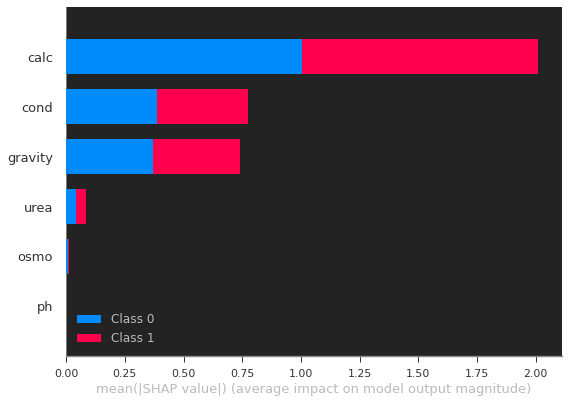

In [35]:

shap_values = explainer.shap_values(X_train)
shap.summary_plot(shap_values, X_train,plot_size=.7)

In [32]:
start = timeit.default_timer()
model_CAT = train(X_train, y_train, X_test, y_test, balanced='balanced', method='CATBoost', number_trials=100)
stop = timeit.default_timer()
stop - start

[I 2022-11-15 19:03:59,220] A new study created in memory with name: CATBoost Classifier


Tuning
Starting the optimization
CATBoost - Optimization using optuna
0:	total: 10.6ms	remaining: 37.5s


Default metric period is 5 because AUC is/are not implemented for GPU


1:	total: 26.7ms	remaining: 46.9s
2:	total: 38.1ms	remaining: 44.7s
3:	total: 51.8ms	remaining: 45.5s
4:	total: 61.7ms	remaining: 43.4s
5:	total: 71.4ms	remaining: 41.8s
6:	total: 79.5ms	remaining: 39.9s
7:	total: 89.1ms	remaining: 39.1s
8:	total: 98.3ms	remaining: 38.4s
9:	total: 108ms	remaining: 37.8s
10:	total: 118ms	remaining: 37.5s
11:	total: 127ms	remaining: 37.1s
12:	total: 139ms	remaining: 37.5s
13:	total: 149ms	remaining: 37.4s
14:	total: 160ms	remaining: 37.4s
15:	total: 171ms	remaining: 37.4s
16:	total: 181ms	remaining: 37.2s
17:	total: 190ms	remaining: 37s
18:	total: 200ms	remaining: 36.8s
19:	total: 209ms	remaining: 36.6s
20:	total: 218ms	remaining: 36.4s
21:	total: 235ms	remaining: 37.4s
22:	total: 245ms	remaining: 37.2s
23:	total: 257ms	remaining: 37.4s
24:	total: 270ms	remaining: 37.8s
25:	total: 280ms	remaining: 37.6s
26:	total: 290ms	remaining: 37.5s
27:	total: 300ms	remaining: 37.4s
28:	total: 308ms	remaining: 37.1s
29:	total: 316ms	remaining: 36.8s
30:	total: 325ms	

250:	total: 2.48s	remaining: 32.3s
251:	total: 2.49s	remaining: 32.3s
252:	total: 2.5s	remaining: 32.3s
253:	total: 2.51s	remaining: 32.3s
254:	total: 2.52s	remaining: 32.3s
255:	total: 2.53s	remaining: 32.3s
256:	total: 2.54s	remaining: 32.2s
257:	total: 2.54s	remaining: 32.2s
258:	total: 2.55s	remaining: 32.2s
259:	total: 2.56s	remaining: 32.2s
260:	total: 2.58s	remaining: 32.2s
261:	total: 2.58s	remaining: 32.1s
262:	total: 2.59s	remaining: 32.1s
263:	total: 2.6s	remaining: 32.1s
264:	total: 2.61s	remaining: 32.1s
265:	total: 2.62s	remaining: 32.1s
266:	total: 2.63s	remaining: 32s
267:	total: 2.64s	remaining: 32s
268:	total: 2.65s	remaining: 32s
269:	total: 2.66s	remaining: 32s
270:	total: 2.67s	remaining: 32s
271:	total: 2.67s	remaining: 31.9s
272:	total: 2.69s	remaining: 31.9s
273:	total: 2.69s	remaining: 31.9s
274:	total: 2.7s	remaining: 31.9s
275:	total: 2.71s	remaining: 31.9s
276:	total: 2.72s	remaining: 31.9s
277:	total: 2.73s	remaining: 31.9s
278:	total: 2.74s	remaining: 31.9

492:	total: 4.84s	remaining: 29.7s
493:	total: 4.85s	remaining: 29.7s
494:	total: 4.86s	remaining: 29.7s
495:	total: 4.88s	remaining: 29.7s
496:	total: 4.89s	remaining: 29.7s
497:	total: 4.9s	remaining: 29.7s
498:	total: 4.91s	remaining: 29.7s
499:	total: 4.92s	remaining: 29.7s
500:	total: 4.94s	remaining: 29.8s
501:	total: 4.95s	remaining: 29.7s
502:	total: 4.96s	remaining: 29.7s
503:	total: 4.96s	remaining: 29.7s
504:	total: 4.97s	remaining: 29.7s
505:	total: 4.98s	remaining: 29.7s
506:	total: 4.99s	remaining: 29.7s
507:	total: 5s	remaining: 29.7s
508:	total: 5.01s	remaining: 29.7s
509:	total: 5.02s	remaining: 29.6s
510:	total: 5.03s	remaining: 29.6s
511:	total: 5.04s	remaining: 29.6s
512:	total: 5.05s	remaining: 29.6s
513:	total: 5.06s	remaining: 29.6s
514:	total: 5.07s	remaining: 29.6s
515:	total: 5.08s	remaining: 29.6s
516:	total: 5.09s	remaining: 29.6s
517:	total: 5.1s	remaining: 29.6s
518:	total: 5.11s	remaining: 29.6s
519:	total: 5.12s	remaining: 29.5s
520:	total: 5.13s	remaini

732:	total: 7.2s	remaining: 27.4s
733:	total: 7.21s	remaining: 27.4s
734:	total: 7.22s	remaining: 27.4s
735:	total: 7.23s	remaining: 27.4s
736:	total: 7.24s	remaining: 27.3s
737:	total: 7.25s	remaining: 27.3s
738:	total: 7.26s	remaining: 27.3s
739:	total: 7.27s	remaining: 27.3s
740:	total: 7.28s	remaining: 27.3s
741:	total: 7.29s	remaining: 27.3s
742:	total: 7.29s	remaining: 27.3s
743:	total: 7.3s	remaining: 27.3s
744:	total: 7.32s	remaining: 27.3s
745:	total: 7.33s	remaining: 27.3s
746:	total: 7.34s	remaining: 27.3s
747:	total: 7.35s	remaining: 27.3s
748:	total: 7.36s	remaining: 27.2s
749:	total: 7.37s	remaining: 27.2s
750:	total: 7.38s	remaining: 27.2s
751:	total: 7.39s	remaining: 27.2s
752:	total: 7.4s	remaining: 27.2s
753:	total: 7.41s	remaining: 27.2s
754:	total: 7.42s	remaining: 27.2s
755:	total: 7.43s	remaining: 27.2s
756:	total: 7.44s	remaining: 27.2s
757:	total: 7.45s	remaining: 27.2s
758:	total: 7.46s	remaining: 27.1s
759:	total: 7.47s	remaining: 27.1s
760:	total: 7.47s	remai

972:	total: 9.66s	remaining: 25.3s
973:	total: 9.67s	remaining: 25.3s
974:	total: 9.68s	remaining: 25.3s
975:	total: 9.69s	remaining: 25.3s
976:	total: 9.71s	remaining: 25.3s
977:	total: 9.72s	remaining: 25.3s
978:	total: 9.72s	remaining: 25.3s
979:	total: 9.74s	remaining: 25.3s
980:	total: 9.75s	remaining: 25.2s
981:	total: 9.76s	remaining: 25.2s
982:	total: 9.77s	remaining: 25.2s
983:	total: 9.78s	remaining: 25.2s
984:	total: 9.79s	remaining: 25.2s
985:	total: 9.8s	remaining: 25.2s
986:	total: 9.81s	remaining: 25.2s
987:	total: 9.82s	remaining: 25.2s
988:	total: 9.84s	remaining: 25.2s
989:	total: 9.84s	remaining: 25.2s
990:	total: 9.85s	remaining: 25.2s
991:	total: 9.87s	remaining: 25.2s
992:	total: 9.88s	remaining: 25.1s
993:	total: 9.88s	remaining: 25.1s
994:	total: 9.9s	remaining: 25.1s
995:	total: 9.91s	remaining: 25.1s
996:	total: 9.92s	remaining: 25.1s
997:	total: 9.94s	remaining: 25.1s
998:	total: 9.95s	remaining: 25.1s
999:	total: 9.96s	remaining: 25.1s
1000:	total: 9.97s	rem

1211:	total: 12.2s	remaining: 23.3s
1212:	total: 12.2s	remaining: 23.3s
1213:	total: 12.3s	remaining: 23.3s
1214:	total: 12.3s	remaining: 23.3s
1215:	total: 12.3s	remaining: 23.3s
1216:	total: 12.3s	remaining: 23.3s
1217:	total: 12.3s	remaining: 23.3s
1218:	total: 12.3s	remaining: 23.2s
1219:	total: 12.3s	remaining: 23.2s
1220:	total: 12.3s	remaining: 23.2s
1221:	total: 12.3s	remaining: 23.2s
1222:	total: 12.4s	remaining: 23.2s
1223:	total: 12.4s	remaining: 23.2s
1224:	total: 12.4s	remaining: 23.2s
1225:	total: 12.4s	remaining: 23.2s
1226:	total: 12.4s	remaining: 23.2s
1227:	total: 12.4s	remaining: 23.2s
1228:	total: 12.4s	remaining: 23.2s
1229:	total: 12.4s	remaining: 23.2s
1230:	total: 12.4s	remaining: 23.2s
1231:	total: 12.5s	remaining: 23.1s
1232:	total: 12.5s	remaining: 23.1s
1233:	total: 12.5s	remaining: 23.1s
1234:	total: 12.5s	remaining: 23.1s
1235:	total: 12.5s	remaining: 23.1s
1236:	total: 12.5s	remaining: 23.1s
1237:	total: 12.5s	remaining: 23.1s
1238:	total: 12.5s	remaining

1452:	total: 14.7s	remaining: 20.9s
1453:	total: 14.7s	remaining: 20.9s
1454:	total: 14.7s	remaining: 20.9s
1455:	total: 14.7s	remaining: 20.9s
1456:	total: 14.7s	remaining: 20.8s
1457:	total: 14.7s	remaining: 20.8s
1458:	total: 14.7s	remaining: 20.8s
1459:	total: 14.7s	remaining: 20.8s
1460:	total: 14.8s	remaining: 20.8s
1461:	total: 14.8s	remaining: 20.8s
1462:	total: 14.8s	remaining: 20.8s
1463:	total: 14.8s	remaining: 20.8s
1464:	total: 14.8s	remaining: 20.8s
1465:	total: 14.8s	remaining: 20.8s
1466:	total: 14.8s	remaining: 20.8s
1467:	total: 14.8s	remaining: 20.8s
1468:	total: 14.9s	remaining: 20.8s
1469:	total: 14.9s	remaining: 20.7s
1470:	total: 14.9s	remaining: 20.7s
1471:	total: 14.9s	remaining: 20.7s
1472:	total: 14.9s	remaining: 20.7s
1473:	total: 14.9s	remaining: 20.7s
1474:	total: 14.9s	remaining: 20.7s
1475:	total: 14.9s	remaining: 20.7s
1476:	total: 14.9s	remaining: 20.7s
1477:	total: 15s	remaining: 20.7s
1478:	total: 15s	remaining: 20.7s
1479:	total: 15s	remaining: 20.6

1690:	total: 17.1s	remaining: 18.6s
1691:	total: 17.2s	remaining: 18.5s
1692:	total: 17.2s	remaining: 18.5s
1693:	total: 17.2s	remaining: 18.5s
1694:	total: 17.2s	remaining: 18.5s
1695:	total: 17.2s	remaining: 18.5s
1696:	total: 17.2s	remaining: 18.5s
1697:	total: 17.2s	remaining: 18.5s
1698:	total: 17.2s	remaining: 18.5s
1699:	total: 17.2s	remaining: 18.5s
1700:	total: 17.3s	remaining: 18.5s
1701:	total: 17.3s	remaining: 18.4s
1702:	total: 17.3s	remaining: 18.4s
1703:	total: 17.3s	remaining: 18.4s
1704:	total: 17.3s	remaining: 18.4s
1705:	total: 17.3s	remaining: 18.4s
1706:	total: 17.3s	remaining: 18.4s
1707:	total: 17.3s	remaining: 18.4s
1708:	total: 17.4s	remaining: 18.4s
1709:	total: 17.4s	remaining: 18.4s
1710:	total: 17.4s	remaining: 18.4s
1711:	total: 17.4s	remaining: 18.4s
1712:	total: 17.4s	remaining: 18.4s
1713:	total: 17.4s	remaining: 18.3s
1714:	total: 17.4s	remaining: 18.3s
1715:	total: 17.4s	remaining: 18.3s
1716:	total: 17.4s	remaining: 18.3s
1717:	total: 17.4s	remaining

1929:	total: 19.6s	remaining: 16.1s
1930:	total: 19.6s	remaining: 16.1s
1931:	total: 19.6s	remaining: 16.1s
1932:	total: 19.6s	remaining: 16.1s
1933:	total: 19.6s	remaining: 16.1s
1934:	total: 19.6s	remaining: 16.1s
1935:	total: 19.6s	remaining: 16.1s
1936:	total: 19.6s	remaining: 16.1s
1937:	total: 19.6s	remaining: 16.1s
1938:	total: 19.7s	remaining: 16s
1939:	total: 19.7s	remaining: 16s
1940:	total: 19.7s	remaining: 16s
1941:	total: 19.7s	remaining: 16s
1942:	total: 19.7s	remaining: 16s
1943:	total: 19.7s	remaining: 16s
1944:	total: 19.7s	remaining: 16s
1945:	total: 19.7s	remaining: 16s
1946:	total: 19.7s	remaining: 16s
1947:	total: 19.7s	remaining: 15.9s
1948:	total: 19.8s	remaining: 15.9s
1949:	total: 19.8s	remaining: 15.9s
1950:	total: 19.8s	remaining: 15.9s
1951:	total: 19.8s	remaining: 15.9s
1952:	total: 19.8s	remaining: 15.9s
1953:	total: 19.8s	remaining: 15.9s
1954:	total: 19.8s	remaining: 15.9s
1955:	total: 19.8s	remaining: 15.9s
1956:	total: 19.8s	remaining: 15.8s
1957:	tota

2162:	total: 21.8s	remaining: 13.7s
2163:	total: 21.9s	remaining: 13.7s
2164:	total: 21.9s	remaining: 13.7s
2165:	total: 21.9s	remaining: 13.7s
2166:	total: 21.9s	remaining: 13.7s
2167:	total: 21.9s	remaining: 13.7s
2168:	total: 21.9s	remaining: 13.6s
2169:	total: 21.9s	remaining: 13.6s
2170:	total: 21.9s	remaining: 13.6s
2171:	total: 21.9s	remaining: 13.6s
2172:	total: 21.9s	remaining: 13.6s
2173:	total: 21.9s	remaining: 13.6s
2174:	total: 22s	remaining: 13.6s
2175:	total: 22s	remaining: 13.6s
2176:	total: 22s	remaining: 13.6s
2177:	total: 22s	remaining: 13.6s
2178:	total: 22s	remaining: 13.5s
2179:	total: 22s	remaining: 13.5s
2180:	total: 22s	remaining: 13.5s
2181:	total: 22s	remaining: 13.5s
2182:	total: 22s	remaining: 13.5s
2183:	total: 22.1s	remaining: 13.5s
2184:	total: 22.1s	remaining: 13.5s
2185:	total: 22.1s	remaining: 13.5s
2186:	total: 22.1s	remaining: 13.5s
2187:	total: 22.1s	remaining: 13.5s
2188:	total: 22.1s	remaining: 13.4s
2189:	total: 22.1s	remaining: 13.4s
2190:	tota

2397:	total: 24.2s	remaining: 11.3s
2398:	total: 24.2s	remaining: 11.3s
2399:	total: 24.2s	remaining: 11.3s
2400:	total: 24.2s	remaining: 11.3s
2401:	total: 24.2s	remaining: 11.3s
2402:	total: 24.2s	remaining: 11.3s
2403:	total: 24.2s	remaining: 11.3s
2404:	total: 24.2s	remaining: 11.2s
2405:	total: 24.2s	remaining: 11.2s
2406:	total: 24.3s	remaining: 11.2s
2407:	total: 24.3s	remaining: 11.2s
2408:	total: 24.3s	remaining: 11.2s
2409:	total: 24.3s	remaining: 11.2s
2410:	total: 24.3s	remaining: 11.2s
2411:	total: 24.3s	remaining: 11.2s
2412:	total: 24.3s	remaining: 11.2s
2413:	total: 24.3s	remaining: 11.2s
2414:	total: 24.3s	remaining: 11.1s
2415:	total: 24.3s	remaining: 11.1s
2416:	total: 24.4s	remaining: 11.1s
2417:	total: 24.4s	remaining: 11.1s
2418:	total: 24.4s	remaining: 11.1s
2419:	total: 24.4s	remaining: 11.1s
2420:	total: 24.4s	remaining: 11.1s
2421:	total: 24.4s	remaining: 11.1s
2422:	total: 24.4s	remaining: 11.1s
2423:	total: 24.4s	remaining: 11.1s
2424:	total: 24.4s	remaining

2633:	total: 26.4s	remaining: 8.9s
2634:	total: 26.4s	remaining: 8.89s
2635:	total: 26.5s	remaining: 8.88s
2636:	total: 26.5s	remaining: 8.87s
2637:	total: 26.5s	remaining: 8.86s
2638:	total: 26.5s	remaining: 8.85s
2639:	total: 26.5s	remaining: 8.84s
2640:	total: 26.5s	remaining: 8.83s
2641:	total: 26.5s	remaining: 8.82s
2642:	total: 26.5s	remaining: 8.81s
2643:	total: 26.5s	remaining: 8.8s
2644:	total: 26.5s	remaining: 8.79s
2645:	total: 26.6s	remaining: 8.78s
2646:	total: 26.6s	remaining: 8.77s
2647:	total: 26.6s	remaining: 8.76s
2648:	total: 26.6s	remaining: 8.75s
2649:	total: 26.6s	remaining: 8.74s
2650:	total: 26.6s	remaining: 8.73s
2651:	total: 26.6s	remaining: 8.72s
2652:	total: 26.6s	remaining: 8.71s
2653:	total: 26.6s	remaining: 8.7s
2654:	total: 26.6s	remaining: 8.69s
2655:	total: 26.6s	remaining: 8.68s
2656:	total: 26.7s	remaining: 8.67s
2657:	total: 26.7s	remaining: 8.66s
2658:	total: 26.7s	remaining: 8.65s
2659:	total: 26.7s	remaining: 8.64s
2660:	total: 26.7s	remaining: 8

2864:	total: 28.7s	remaining: 6.56s
2865:	total: 28.7s	remaining: 6.55s
2866:	total: 28.7s	remaining: 6.54s
2867:	total: 28.7s	remaining: 6.53s
2868:	total: 28.7s	remaining: 6.52s
2869:	total: 28.7s	remaining: 6.51s
2870:	total: 28.7s	remaining: 6.5s
2871:	total: 28.7s	remaining: 6.49s
2872:	total: 28.7s	remaining: 6.48s
2873:	total: 28.7s	remaining: 6.47s
2874:	total: 28.8s	remaining: 6.46s
2875:	total: 28.8s	remaining: 6.45s
2876:	total: 28.8s	remaining: 6.44s
2877:	total: 28.8s	remaining: 6.43s
2878:	total: 28.8s	remaining: 6.42s
2879:	total: 28.8s	remaining: 6.41s
2880:	total: 28.8s	remaining: 6.4s
2881:	total: 28.8s	remaining: 6.39s
2882:	total: 28.8s	remaining: 6.38s
2883:	total: 28.8s	remaining: 6.37s
2884:	total: 28.8s	remaining: 6.36s
2885:	total: 28.9s	remaining: 6.35s
2886:	total: 28.9s	remaining: 6.34s
2887:	total: 28.9s	remaining: 6.33s
2888:	total: 28.9s	remaining: 6.32s
2889:	total: 28.9s	remaining: 6.31s
2890:	total: 28.9s	remaining: 6.3s
2891:	total: 28.9s	remaining: 6

3095:	total: 30.9s	remaining: 4.24s
3096:	total: 30.9s	remaining: 4.23s
3097:	total: 30.9s	remaining: 4.22s
3098:	total: 30.9s	remaining: 4.21s
3099:	total: 30.9s	remaining: 4.2s
3100:	total: 31s	remaining: 4.19s
3101:	total: 31s	remaining: 4.18s
3102:	total: 31s	remaining: 4.17s
3103:	total: 31s	remaining: 4.16s
3104:	total: 31s	remaining: 4.15s
3105:	total: 31s	remaining: 4.14s
3106:	total: 31s	remaining: 4.13s
3107:	total: 31s	remaining: 4.12s
3108:	total: 31s	remaining: 4.11s
3109:	total: 31s	remaining: 4.1s
3110:	total: 31s	remaining: 4.09s
3111:	total: 31.1s	remaining: 4.08s
3112:	total: 31.1s	remaining: 4.07s
3113:	total: 31.1s	remaining: 4.06s
3114:	total: 31.1s	remaining: 4.05s
3115:	total: 31.1s	remaining: 4.04s
3116:	total: 31.1s	remaining: 4.03s
3117:	total: 31.1s	remaining: 4.02s
3118:	total: 31.1s	remaining: 4.01s
3119:	total: 31.1s	remaining: 4s
3120:	total: 31.1s	remaining: 3.99s
3121:	total: 31.1s	remaining: 3.98s
3122:	total: 31.2s	remaining: 3.97s
3123:	total: 31.2s	

3331:	total: 33.2s	remaining: 1.88s
3332:	total: 33.2s	remaining: 1.87s
3333:	total: 33.2s	remaining: 1.86s
3334:	total: 33.2s	remaining: 1.85s
3335:	total: 33.2s	remaining: 1.84s
3336:	total: 33.2s	remaining: 1.83s
3337:	total: 33.2s	remaining: 1.82s
3338:	total: 33.2s	remaining: 1.81s
3339:	total: 33.2s	remaining: 1.8s
3340:	total: 33.2s	remaining: 1.79s
3341:	total: 33.2s	remaining: 1.78s
3342:	total: 33.3s	remaining: 1.77s
3343:	total: 33.3s	remaining: 1.76s
3344:	total: 33.3s	remaining: 1.75s
3345:	total: 33.3s	remaining: 1.74s
3346:	total: 33.3s	remaining: 1.73s
3347:	total: 33.3s	remaining: 1.72s
3348:	total: 33.3s	remaining: 1.71s
3349:	total: 33.3s	remaining: 1.7s
3350:	total: 33.3s	remaining: 1.69s
3351:	total: 33.4s	remaining: 1.68s
3352:	total: 33.4s	remaining: 1.67s
3353:	total: 33.4s	remaining: 1.66s
3354:	total: 33.4s	remaining: 1.65s
3355:	total: 33.4s	remaining: 1.64s
3356:	total: 33.4s	remaining: 1.63s
3357:	total: 33.4s	remaining: 1.62s
3358:	total: 33.4s	remaining: 

[I 2022-11-15 19:04:35,232] Trial 0 finished with value: 0.7272727272727273 and parameters: {'max_depth': 3, 'learning_rate': 0.05, 'n_estimators': 3521, 'max_bin': 374, 'min_data_in_leaf': 137, 'l2_leaf_reg': 0.14449213900853405, 'subsample': 0.42908726538467357}. Best is trial 0 with value: 0.7272727272727273.


3518:	total: 35s	remaining: 19.9ms
3519:	total: 35s	remaining: 9.95ms
3520:	total: 35s	remaining: 0us
auc:0.7272727272727273 ,ks:0.41818181818181815 ,gini:0.4545454545454546 ,log_loss:1.266521958439359
CATBoost - Optimization using optuna


Default metric period is 5 because AUC is/are not implemented for GPU


0:	total: 48.1ms	remaining: 4m 4s
1:	total: 123ms	remaining: 5m 10s
2:	total: 168ms	remaining: 4m 43s
3:	total: 239ms	remaining: 5m 2s
4:	total: 249ms	remaining: 4m 11s
5:	total: 322ms	remaining: 4m 31s
6:	total: 368ms	remaining: 4m 26s
7:	total: 441ms	remaining: 4m 39s
8:	total: 515ms	remaining: 4m 49s
9:	total: 527ms	remaining: 4m 26s
10:	total: 599ms	remaining: 4m 35s
11:	total: 629ms	remaining: 4m 25s
12:	total: 675ms	remaining: 4m 22s
13:	total: 752ms	remaining: 4m 31s
14:	total: 825ms	remaining: 4m 38s
15:	total: 898ms	remaining: 4m 43s
16:	total: 971ms	remaining: 4m 48s
17:	total: 1.02s	remaining: 4m 45s
18:	total: 1.05s	remaining: 4m 39s
19:	total: 1.07s	remaining: 4m 30s
20:	total: 1.09s	remaining: 4m 22s
21:	total: 1.12s	remaining: 4m 16s
22:	total: 1.14s	remaining: 4m 9s
23:	total: 1.18s	remaining: 4m 8s
24:	total: 1.19s	remaining: 4m
25:	total: 1.21s	remaining: 3m 54s
26:	total: 1.24s	remaining: 3m 51s
27:	total: 1.25s	remaining: 3m 45s
28:	total: 1.27s	remaining: 3m 40s
29

234:	total: 11.7s	remaining: 4m
235:	total: 11.8s	remaining: 4m 1s
236:	total: 11.8s	remaining: 4m 1s
237:	total: 11.9s	remaining: 4m 1s
238:	total: 11.9s	remaining: 4m 1s
239:	total: 12s	remaining: 4m 1s
240:	total: 12.1s	remaining: 4m 2s
241:	total: 12.2s	remaining: 4m 2s
242:	total: 12.2s	remaining: 4m 3s
243:	total: 12.3s	remaining: 4m 3s
244:	total: 12.4s	remaining: 4m 3s
245:	total: 12.4s	remaining: 4m 2s
246:	total: 12.5s	remaining: 4m 3s
247:	total: 12.5s	remaining: 4m 2s
248:	total: 12.5s	remaining: 4m 3s
249:	total: 12.6s	remaining: 4m 3s
250:	total: 12.7s	remaining: 4m 3s
251:	total: 12.7s	remaining: 4m 2s
252:	total: 12.7s	remaining: 4m 2s
253:	total: 12.8s	remaining: 4m 3s
254:	total: 12.8s	remaining: 4m 2s
255:	total: 12.8s	remaining: 4m 1s
256:	total: 12.9s	remaining: 4m 1s
257:	total: 12.9s	remaining: 4m
258:	total: 13s	remaining: 4m 1s
259:	total: 13s	remaining: 4m 1s
260:	total: 13.1s	remaining: 4m 1s
261:	total: 13.2s	remaining: 4m 2s
262:	total: 13.3s	remaining: 4m 

474:	total: 24.9s	remaining: 4m 1s
475:	total: 25s	remaining: 4m 1s
476:	total: 25.1s	remaining: 4m 1s
477:	total: 25.1s	remaining: 4m 1s
478:	total: 25.2s	remaining: 4m 1s
479:	total: 25.3s	remaining: 4m 1s
480:	total: 25.3s	remaining: 4m 2s
481:	total: 25.4s	remaining: 4m 2s
482:	total: 25.5s	remaining: 4m 2s
483:	total: 25.5s	remaining: 4m 1s
484:	total: 25.6s	remaining: 4m 2s
485:	total: 25.7s	remaining: 4m 2s
486:	total: 25.7s	remaining: 4m 2s
487:	total: 25.8s	remaining: 4m 2s
488:	total: 25.9s	remaining: 4m 2s
489:	total: 25.9s	remaining: 4m 2s
490:	total: 26s	remaining: 4m 2s
491:	total: 26s	remaining: 4m 2s
492:	total: 26.1s	remaining: 4m 2s
493:	total: 26.1s	remaining: 4m 2s
494:	total: 26.2s	remaining: 4m 2s
495:	total: 26.3s	remaining: 4m 2s
496:	total: 26.4s	remaining: 4m 2s
497:	total: 26.4s	remaining: 4m 2s
498:	total: 26.5s	remaining: 4m 2s
499:	total: 26.6s	remaining: 4m 3s
500:	total: 26.6s	remaining: 4m 2s
501:	total: 26.7s	remaining: 4m 2s
502:	total: 26.7s	remainin

706:	total: 36.9s	remaining: 3m 47s
707:	total: 36.9s	remaining: 3m 47s
708:	total: 37s	remaining: 3m 47s
709:	total: 37.1s	remaining: 3m 48s
710:	total: 37.1s	remaining: 3m 47s
711:	total: 37.2s	remaining: 3m 47s
712:	total: 37.2s	remaining: 3m 47s
713:	total: 37.3s	remaining: 3m 47s
714:	total: 37.4s	remaining: 3m 47s
715:	total: 37.4s	remaining: 3m 47s
716:	total: 37.4s	remaining: 3m 47s
717:	total: 37.4s	remaining: 3m 46s
718:	total: 37.4s	remaining: 3m 46s
719:	total: 37.5s	remaining: 3m 46s
720:	total: 37.5s	remaining: 3m 46s
721:	total: 37.6s	remaining: 3m 46s
722:	total: 37.7s	remaining: 3m 46s
723:	total: 37.7s	remaining: 3m 46s
724:	total: 37.8s	remaining: 3m 46s
725:	total: 37.9s	remaining: 3m 46s
726:	total: 38s	remaining: 3m 46s
727:	total: 38s	remaining: 3m 47s
728:	total: 38.1s	remaining: 3m 47s
729:	total: 38.2s	remaining: 3m 47s
730:	total: 38.2s	remaining: 3m 47s
731:	total: 38.3s	remaining: 3m 47s
732:	total: 38.4s	remaining: 3m 47s
733:	total: 38.4s	remaining: 3m 47

939:	total: 48.7s	remaining: 3m 34s
940:	total: 48.8s	remaining: 3m 34s
941:	total: 48.8s	remaining: 3m 33s
942:	total: 48.8s	remaining: 3m 33s
943:	total: 48.9s	remaining: 3m 33s
944:	total: 48.9s	remaining: 3m 33s
945:	total: 48.9s	remaining: 3m 33s
946:	total: 48.9s	remaining: 3m 33s
947:	total: 49s	remaining: 3m 33s
948:	total: 49.1s	remaining: 3m 33s
949:	total: 49.1s	remaining: 3m 33s
950:	total: 49.2s	remaining: 3m 33s
951:	total: 49.2s	remaining: 3m 33s
952:	total: 49.3s	remaining: 3m 33s
953:	total: 49.3s	remaining: 3m 33s
954:	total: 49.4s	remaining: 3m 33s
955:	total: 49.5s	remaining: 3m 33s
956:	total: 49.6s	remaining: 3m 33s
957:	total: 49.6s	remaining: 3m 33s
958:	total: 49.7s	remaining: 3m 33s
959:	total: 49.8s	remaining: 3m 33s
960:	total: 49.8s	remaining: 3m 33s
961:	total: 49.9s	remaining: 3m 33s
962:	total: 49.9s	remaining: 3m 33s
963:	total: 50s	remaining: 3m 33s
964:	total: 50s	remaining: 3m 33s
965:	total: 50.1s	remaining: 3m 33s
966:	total: 50.2s	remaining: 3m 33

1165:	total: 1m 1s	remaining: 3m 25s
1166:	total: 1m 1s	remaining: 3m 25s
1167:	total: 1m 1s	remaining: 3m 25s
1168:	total: 1m 1s	remaining: 3m 25s
1169:	total: 1m 1s	remaining: 3m 25s
1170:	total: 1m 1s	remaining: 3m 25s
1171:	total: 1m 1s	remaining: 3m 25s
1172:	total: 1m 1s	remaining: 3m 25s
1173:	total: 1m 1s	remaining: 3m 25s
1174:	total: 1m 1s	remaining: 3m 25s
1175:	total: 1m 1s	remaining: 3m 25s
1176:	total: 1m 1s	remaining: 3m 25s
1177:	total: 1m 1s	remaining: 3m 24s
1178:	total: 1m 1s	remaining: 3m 24s
1179:	total: 1m 1s	remaining: 3m 24s
1180:	total: 1m 2s	remaining: 3m 24s
1181:	total: 1m 2s	remaining: 3m 24s
1182:	total: 1m 2s	remaining: 3m 24s
1183:	total: 1m 2s	remaining: 3m 24s
1184:	total: 1m 2s	remaining: 3m 24s
1185:	total: 1m 2s	remaining: 3m 24s
1186:	total: 1m 2s	remaining: 3m 24s
1187:	total: 1m 2s	remaining: 3m 24s
1188:	total: 1m 2s	remaining: 3m 24s
1189:	total: 1m 2s	remaining: 3m 24s
1190:	total: 1m 2s	remaining: 3m 24s
1191:	total: 1m 2s	remaining: 3m 24s
1

1387:	total: 1m 14s	remaining: 3m 18s
1388:	total: 1m 14s	remaining: 3m 18s
1389:	total: 1m 14s	remaining: 3m 18s
1390:	total: 1m 14s	remaining: 3m 18s
1391:	total: 1m 14s	remaining: 3m 17s
1392:	total: 1m 14s	remaining: 3m 17s
1393:	total: 1m 14s	remaining: 3m 17s
1394:	total: 1m 15s	remaining: 3m 17s
1395:	total: 1m 15s	remaining: 3m 17s
1396:	total: 1m 15s	remaining: 3m 17s
1397:	total: 1m 15s	remaining: 3m 17s
1398:	total: 1m 15s	remaining: 3m 17s
1399:	total: 1m 15s	remaining: 3m 17s
1400:	total: 1m 15s	remaining: 3m 17s
1401:	total: 1m 15s	remaining: 3m 17s
1402:	total: 1m 15s	remaining: 3m 17s
1403:	total: 1m 15s	remaining: 3m 17s
1404:	total: 1m 15s	remaining: 3m 17s
1405:	total: 1m 15s	remaining: 3m 17s
1406:	total: 1m 15s	remaining: 3m 17s
1407:	total: 1m 15s	remaining: 3m 17s
1408:	total: 1m 15s	remaining: 3m 17s
1409:	total: 1m 15s	remaining: 3m 17s
1410:	total: 1m 15s	remaining: 3m 17s
1411:	total: 1m 15s	remaining: 3m 17s
1412:	total: 1m 16s	remaining: 3m 17s
1413:	total:

1606:	total: 1m 28s	remaining: 3m 11s
1607:	total: 1m 28s	remaining: 3m 11s
1608:	total: 1m 28s	remaining: 3m 11s
1609:	total: 1m 28s	remaining: 3m 11s
1610:	total: 1m 28s	remaining: 3m 11s
1611:	total: 1m 29s	remaining: 3m 11s
1612:	total: 1m 29s	remaining: 3m 11s
1613:	total: 1m 29s	remaining: 3m 11s
1614:	total: 1m 29s	remaining: 3m 11s
1615:	total: 1m 29s	remaining: 3m 11s
1616:	total: 1m 29s	remaining: 3m 11s
1617:	total: 1m 29s	remaining: 3m 11s
1618:	total: 1m 29s	remaining: 3m 10s
1619:	total: 1m 29s	remaining: 3m 10s
1620:	total: 1m 29s	remaining: 3m 10s
1621:	total: 1m 29s	remaining: 3m 10s
1622:	total: 1m 29s	remaining: 3m 10s
1623:	total: 1m 29s	remaining: 3m 10s
1624:	total: 1m 29s	remaining: 3m 10s
1625:	total: 1m 29s	remaining: 3m 10s
1626:	total: 1m 30s	remaining: 3m 10s
1627:	total: 1m 30s	remaining: 3m 10s
1628:	total: 1m 30s	remaining: 3m 10s
1629:	total: 1m 30s	remaining: 3m 10s
1630:	total: 1m 30s	remaining: 3m 10s
1631:	total: 1m 30s	remaining: 3m 10s
1632:	total:

1829:	total: 1m 44s	remaining: 3m 4s
1830:	total: 1m 44s	remaining: 3m 4s
1831:	total: 1m 44s	remaining: 3m 4s
1832:	total: 1m 44s	remaining: 3m 4s
1833:	total: 1m 44s	remaining: 3m 4s
1834:	total: 1m 44s	remaining: 3m 4s
1835:	total: 1m 44s	remaining: 3m 4s
1836:	total: 1m 44s	remaining: 3m 4s
1837:	total: 1m 44s	remaining: 3m 4s
1838:	total: 1m 44s	remaining: 3m 4s
1839:	total: 1m 44s	remaining: 3m 4s
1840:	total: 1m 45s	remaining: 3m 4s
1841:	total: 1m 45s	remaining: 3m 4s
1842:	total: 1m 45s	remaining: 3m 4s
1843:	total: 1m 45s	remaining: 3m 4s
1844:	total: 1m 45s	remaining: 3m 4s
1845:	total: 1m 45s	remaining: 3m 4s
1846:	total: 1m 45s	remaining: 3m 4s
1847:	total: 1m 45s	remaining: 3m 4s
1848:	total: 1m 45s	remaining: 3m 4s
1849:	total: 1m 45s	remaining: 3m 4s
1850:	total: 1m 45s	remaining: 3m 4s
1851:	total: 1m 45s	remaining: 3m 4s
1852:	total: 1m 45s	remaining: 3m 4s
1853:	total: 1m 45s	remaining: 3m 3s
1854:	total: 1m 45s	remaining: 3m 3s
1855:	total: 1m 46s	remaining: 3m 3s
1

2051:	total: 1m 59s	remaining: 2m 56s
2052:	total: 1m 59s	remaining: 2m 56s
2053:	total: 1m 59s	remaining: 2m 56s
2054:	total: 2m	remaining: 2m 56s
2055:	total: 2m	remaining: 2m 56s
2056:	total: 2m	remaining: 2m 56s
2057:	total: 2m	remaining: 2m 56s
2058:	total: 2m	remaining: 2m 56s
2059:	total: 2m	remaining: 2m 56s
2060:	total: 2m	remaining: 2m 56s
2061:	total: 2m	remaining: 2m 56s
2062:	total: 2m	remaining: 2m 56s
2063:	total: 2m	remaining: 2m 56s
2064:	total: 2m	remaining: 2m 55s
2065:	total: 2m	remaining: 2m 55s
2066:	total: 2m	remaining: 2m 55s
2067:	total: 2m	remaining: 2m 55s
2068:	total: 2m 1s	remaining: 2m 55s
2069:	total: 2m 1s	remaining: 2m 55s
2070:	total: 2m 1s	remaining: 2m 55s
2071:	total: 2m 1s	remaining: 2m 55s
2072:	total: 2m 1s	remaining: 2m 55s
2073:	total: 2m 1s	remaining: 2m 55s
2074:	total: 2m 1s	remaining: 2m 55s
2075:	total: 2m 1s	remaining: 2m 55s
2076:	total: 2m 1s	remaining: 2m 55s
2077:	total: 2m 1s	remaining: 2m 55s
2078:	total: 2m 1s	remaining: 2m 55s
207

2274:	total: 2m 15s	remaining: 2m 46s
2275:	total: 2m 15s	remaining: 2m 46s
2276:	total: 2m 15s	remaining: 2m 46s
2277:	total: 2m 15s	remaining: 2m 46s
2278:	total: 2m 15s	remaining: 2m 46s
2279:	total: 2m 15s	remaining: 2m 46s
2280:	total: 2m 16s	remaining: 2m 46s
2281:	total: 2m 16s	remaining: 2m 46s
2282:	total: 2m 16s	remaining: 2m 46s
2283:	total: 2m 16s	remaining: 2m 46s
2284:	total: 2m 16s	remaining: 2m 46s
2285:	total: 2m 16s	remaining: 2m 46s
2286:	total: 2m 16s	remaining: 2m 46s
2287:	total: 2m 16s	remaining: 2m 46s
2288:	total: 2m 16s	remaining: 2m 46s
2289:	total: 2m 16s	remaining: 2m 46s
2290:	total: 2m 16s	remaining: 2m 46s
2291:	total: 2m 16s	remaining: 2m 46s
2292:	total: 2m 16s	remaining: 2m 46s
2293:	total: 2m 17s	remaining: 2m 46s
2294:	total: 2m 17s	remaining: 2m 46s
2295:	total: 2m 17s	remaining: 2m 45s
2296:	total: 2m 17s	remaining: 2m 45s
2297:	total: 2m 17s	remaining: 2m 45s
2298:	total: 2m 17s	remaining: 2m 45s
2299:	total: 2m 17s	remaining: 2m 45s
2300:	total:

2491:	total: 2m 31s	remaining: 2m 36s
2492:	total: 2m 31s	remaining: 2m 36s
2493:	total: 2m 31s	remaining: 2m 36s
2494:	total: 2m 31s	remaining: 2m 36s
2495:	total: 2m 31s	remaining: 2m 36s
2496:	total: 2m 31s	remaining: 2m 36s
2497:	total: 2m 31s	remaining: 2m 36s
2498:	total: 2m 31s	remaining: 2m 36s
2499:	total: 2m 31s	remaining: 2m 36s
2500:	total: 2m 31s	remaining: 2m 36s
2501:	total: 2m 31s	remaining: 2m 36s
2502:	total: 2m 31s	remaining: 2m 36s
2503:	total: 2m 31s	remaining: 2m 35s
2504:	total: 2m 32s	remaining: 2m 35s
2505:	total: 2m 32s	remaining: 2m 35s
2506:	total: 2m 32s	remaining: 2m 35s
2507:	total: 2m 32s	remaining: 2m 35s
2508:	total: 2m 32s	remaining: 2m 35s
2509:	total: 2m 32s	remaining: 2m 35s
2510:	total: 2m 32s	remaining: 2m 35s
2511:	total: 2m 32s	remaining: 2m 35s
2512:	total: 2m 32s	remaining: 2m 35s
2513:	total: 2m 32s	remaining: 2m 35s
2514:	total: 2m 32s	remaining: 2m 35s
2515:	total: 2m 32s	remaining: 2m 35s
2516:	total: 2m 32s	remaining: 2m 35s
2517:	total:

2707:	total: 2m 46s	remaining: 2m 25s
2708:	total: 2m 46s	remaining: 2m 25s
2709:	total: 2m 46s	remaining: 2m 24s
2710:	total: 2m 46s	remaining: 2m 24s
2711:	total: 2m 46s	remaining: 2m 24s
2712:	total: 2m 46s	remaining: 2m 24s
2713:	total: 2m 46s	remaining: 2m 24s
2714:	total: 2m 46s	remaining: 2m 24s
2715:	total: 2m 46s	remaining: 2m 24s
2716:	total: 2m 46s	remaining: 2m 24s
2717:	total: 2m 46s	remaining: 2m 24s
2718:	total: 2m 46s	remaining: 2m 24s
2719:	total: 2m 46s	remaining: 2m 24s
2720:	total: 2m 47s	remaining: 2m 24s
2721:	total: 2m 47s	remaining: 2m 24s
2722:	total: 2m 47s	remaining: 2m 24s
2723:	total: 2m 47s	remaining: 2m 24s
2724:	total: 2m 47s	remaining: 2m 24s
2725:	total: 2m 47s	remaining: 2m 24s
2726:	total: 2m 47s	remaining: 2m 24s
2727:	total: 2m 47s	remaining: 2m 24s
2728:	total: 2m 47s	remaining: 2m 24s
2729:	total: 2m 47s	remaining: 2m 24s
2730:	total: 2m 47s	remaining: 2m 23s
2731:	total: 2m 47s	remaining: 2m 23s
2732:	total: 2m 47s	remaining: 2m 23s
2733:	total:

2926:	total: 3m 1s	remaining: 2m 13s
2927:	total: 3m 1s	remaining: 2m 12s
2928:	total: 3m 1s	remaining: 2m 12s
2929:	total: 3m 1s	remaining: 2m 12s
2930:	total: 3m 1s	remaining: 2m 12s
2931:	total: 3m 1s	remaining: 2m 12s
2932:	total: 3m 1s	remaining: 2m 12s
2933:	total: 3m 1s	remaining: 2m 12s
2934:	total: 3m 1s	remaining: 2m 12s
2935:	total: 3m 2s	remaining: 2m 12s
2936:	total: 3m 2s	remaining: 2m 12s
2937:	total: 3m 2s	remaining: 2m 12s
2938:	total: 3m 2s	remaining: 2m 12s
2939:	total: 3m 2s	remaining: 2m 12s
2940:	total: 3m 2s	remaining: 2m 12s
2941:	total: 3m 2s	remaining: 2m 12s
2942:	total: 3m 2s	remaining: 2m 12s
2943:	total: 3m 2s	remaining: 2m 12s
2944:	total: 3m 2s	remaining: 2m 12s
2945:	total: 3m 2s	remaining: 2m 11s
2946:	total: 3m 2s	remaining: 2m 11s
2947:	total: 3m 2s	remaining: 2m 11s
2948:	total: 3m 2s	remaining: 2m 11s
2949:	total: 3m 2s	remaining: 2m 11s
2950:	total: 3m 3s	remaining: 2m 11s
2951:	total: 3m 3s	remaining: 2m 11s
2952:	total: 3m 3s	remaining: 2m 11s
2

3151:	total: 3m 17s	remaining: 2m
3152:	total: 3m 17s	remaining: 2m
3153:	total: 3m 17s	remaining: 2m
3154:	total: 3m 17s	remaining: 2m
3155:	total: 3m 17s	remaining: 2m
3156:	total: 3m 17s	remaining: 2m
3157:	total: 3m 17s	remaining: 1m 59s
3158:	total: 3m 17s	remaining: 1m 59s
3159:	total: 3m 17s	remaining: 1m 59s
3160:	total: 3m 17s	remaining: 1m 59s
3161:	total: 3m 18s	remaining: 1m 59s
3162:	total: 3m 18s	remaining: 1m 59s
3163:	total: 3m 18s	remaining: 1m 59s
3164:	total: 3m 18s	remaining: 1m 59s
3165:	total: 3m 18s	remaining: 1m 59s
3166:	total: 3m 18s	remaining: 1m 59s
3167:	total: 3m 18s	remaining: 1m 59s
3168:	total: 3m 18s	remaining: 1m 59s
3169:	total: 3m 18s	remaining: 1m 59s
3170:	total: 3m 18s	remaining: 1m 59s
3171:	total: 3m 18s	remaining: 1m 59s
3172:	total: 3m 18s	remaining: 1m 59s
3173:	total: 3m 18s	remaining: 1m 59s
3174:	total: 3m 18s	remaining: 1m 58s
3175:	total: 3m 18s	remaining: 1m 58s
3176:	total: 3m 19s	remaining: 1m 58s
3177:	total: 3m 19s	remaining: 1m 58

3368:	total: 3m 32s	remaining: 1m 47s
3369:	total: 3m 32s	remaining: 1m 47s
3370:	total: 3m 32s	remaining: 1m 47s
3371:	total: 3m 32s	remaining: 1m 47s
3372:	total: 3m 32s	remaining: 1m 47s
3373:	total: 3m 32s	remaining: 1m 47s
3374:	total: 3m 32s	remaining: 1m 47s
3375:	total: 3m 32s	remaining: 1m 47s
3376:	total: 3m 32s	remaining: 1m 46s
3377:	total: 3m 32s	remaining: 1m 46s
3378:	total: 3m 32s	remaining: 1m 46s
3379:	total: 3m 33s	remaining: 1m 46s
3380:	total: 3m 33s	remaining: 1m 46s
3381:	total: 3m 33s	remaining: 1m 46s
3382:	total: 3m 33s	remaining: 1m 46s
3383:	total: 3m 33s	remaining: 1m 46s
3384:	total: 3m 33s	remaining: 1m 46s
3385:	total: 3m 33s	remaining: 1m 46s
3386:	total: 3m 33s	remaining: 1m 46s
3387:	total: 3m 33s	remaining: 1m 46s
3388:	total: 3m 33s	remaining: 1m 46s
3389:	total: 3m 33s	remaining: 1m 46s
3390:	total: 3m 33s	remaining: 1m 46s
3391:	total: 3m 33s	remaining: 1m 46s
3392:	total: 3m 33s	remaining: 1m 46s
3393:	total: 3m 34s	remaining: 1m 45s
3394:	total:

3585:	total: 3m 46s	remaining: 1m 34s
3586:	total: 3m 46s	remaining: 1m 34s
3587:	total: 3m 47s	remaining: 1m 34s
3588:	total: 3m 47s	remaining: 1m 33s
3589:	total: 3m 47s	remaining: 1m 33s
3590:	total: 3m 47s	remaining: 1m 33s
3591:	total: 3m 47s	remaining: 1m 33s
3592:	total: 3m 47s	remaining: 1m 33s
3593:	total: 3m 47s	remaining: 1m 33s
3594:	total: 3m 47s	remaining: 1m 33s
3595:	total: 3m 47s	remaining: 1m 33s
3596:	total: 3m 47s	remaining: 1m 33s
3597:	total: 3m 47s	remaining: 1m 33s
3598:	total: 3m 47s	remaining: 1m 33s
3599:	total: 3m 47s	remaining: 1m 33s
3600:	total: 3m 47s	remaining: 1m 33s
3601:	total: 3m 47s	remaining: 1m 33s
3602:	total: 3m 48s	remaining: 1m 33s
3603:	total: 3m 48s	remaining: 1m 33s
3604:	total: 3m 48s	remaining: 1m 32s
3605:	total: 3m 48s	remaining: 1m 32s
3606:	total: 3m 48s	remaining: 1m 32s
3607:	total: 3m 48s	remaining: 1m 32s
3608:	total: 3m 48s	remaining: 1m 32s
3609:	total: 3m 48s	remaining: 1m 32s
3610:	total: 3m 48s	remaining: 1m 32s
3611:	total:

3803:	total: 4m 1s	remaining: 1m 20s
3804:	total: 4m 1s	remaining: 1m 20s
3805:	total: 4m 1s	remaining: 1m 20s
3806:	total: 4m 1s	remaining: 1m 20s
3807:	total: 4m 1s	remaining: 1m 20s
3808:	total: 4m 1s	remaining: 1m 20s
3809:	total: 4m 2s	remaining: 1m 20s
3810:	total: 4m 2s	remaining: 1m 20s
3811:	total: 4m 2s	remaining: 1m 20s
3812:	total: 4m 2s	remaining: 1m 20s
3813:	total: 4m 2s	remaining: 1m 20s
3814:	total: 4m 2s	remaining: 1m 19s
3815:	total: 4m 2s	remaining: 1m 19s
3816:	total: 4m 2s	remaining: 1m 19s
3817:	total: 4m 2s	remaining: 1m 19s
3818:	total: 4m 2s	remaining: 1m 19s
3819:	total: 4m 2s	remaining: 1m 19s
3820:	total: 4m 2s	remaining: 1m 19s
3821:	total: 4m 2s	remaining: 1m 19s
3822:	total: 4m 2s	remaining: 1m 19s
3823:	total: 4m 3s	remaining: 1m 19s
3824:	total: 4m 3s	remaining: 1m 19s
3825:	total: 4m 3s	remaining: 1m 19s
3826:	total: 4m 3s	remaining: 1m 19s
3827:	total: 4m 3s	remaining: 1m 19s
3828:	total: 4m 3s	remaining: 1m 19s
3829:	total: 4m 3s	remaining: 1m 19s
3

4027:	total: 4m 17s	remaining: 1m 6s
4028:	total: 4m 17s	remaining: 1m 6s
4029:	total: 4m 17s	remaining: 1m 6s
4030:	total: 4m 17s	remaining: 1m 6s
4031:	total: 4m 17s	remaining: 1m 6s
4032:	total: 4m 17s	remaining: 1m 6s
4033:	total: 4m 17s	remaining: 1m 6s
4034:	total: 4m 17s	remaining: 1m 6s
4035:	total: 4m 17s	remaining: 1m 6s
4036:	total: 4m 17s	remaining: 1m 6s
4037:	total: 4m 17s	remaining: 1m 6s
4038:	total: 4m 18s	remaining: 1m 6s
4039:	total: 4m 18s	remaining: 1m 6s
4040:	total: 4m 18s	remaining: 1m 5s
4041:	total: 4m 18s	remaining: 1m 5s
4042:	total: 4m 18s	remaining: 1m 5s
4043:	total: 4m 18s	remaining: 1m 5s
4044:	total: 4m 18s	remaining: 1m 5s
4045:	total: 4m 18s	remaining: 1m 5s
4046:	total: 4m 18s	remaining: 1m 5s
4047:	total: 4m 18s	remaining: 1m 5s
4048:	total: 4m 18s	remaining: 1m 5s
4049:	total: 4m 18s	remaining: 1m 5s
4050:	total: 4m 18s	remaining: 1m 5s
4051:	total: 4m 18s	remaining: 1m 5s
4052:	total: 4m 18s	remaining: 1m 5s
4053:	total: 4m 19s	remaining: 1m 5s
4

4253:	total: 4m 32s	remaining: 52.6s
4254:	total: 4m 32s	remaining: 52.5s
4255:	total: 4m 32s	remaining: 52.5s
4256:	total: 4m 32s	remaining: 52.4s
4257:	total: 4m 33s	remaining: 52.3s
4258:	total: 4m 33s	remaining: 52.3s
4259:	total: 4m 33s	remaining: 52.2s
4260:	total: 4m 33s	remaining: 52.1s
4261:	total: 4m 33s	remaining: 52.1s
4262:	total: 4m 33s	remaining: 52s
4263:	total: 4m 33s	remaining: 51.9s
4264:	total: 4m 33s	remaining: 51.9s
4265:	total: 4m 33s	remaining: 51.8s
4266:	total: 4m 33s	remaining: 51.8s
4267:	total: 4m 33s	remaining: 51.7s
4268:	total: 4m 33s	remaining: 51.6s
4269:	total: 4m 33s	remaining: 51.6s
4270:	total: 4m 33s	remaining: 51.5s
4271:	total: 4m 33s	remaining: 51.4s
4272:	total: 4m 34s	remaining: 51.4s
4273:	total: 4m 34s	remaining: 51.3s
4274:	total: 4m 34s	remaining: 51.2s
4275:	total: 4m 34s	remaining: 51.2s
4276:	total: 4m 34s	remaining: 51.1s
4277:	total: 4m 34s	remaining: 51.1s
4278:	total: 4m 34s	remaining: 51s
4279:	total: 4m 34s	remaining: 50.9s
4280:

4478:	total: 4m 48s	remaining: 38.4s
4479:	total: 4m 48s	remaining: 38.3s
4480:	total: 4m 48s	remaining: 38.2s
4481:	total: 4m 49s	remaining: 38.2s
4482:	total: 4m 49s	remaining: 38.1s
4483:	total: 4m 49s	remaining: 38s
4484:	total: 4m 49s	remaining: 38s
4485:	total: 4m 49s	remaining: 37.9s
4486:	total: 4m 49s	remaining: 37.9s
4487:	total: 4m 49s	remaining: 37.8s
4488:	total: 4m 49s	remaining: 37.7s
4489:	total: 4m 49s	remaining: 37.7s
4490:	total: 4m 49s	remaining: 37.6s
4491:	total: 4m 49s	remaining: 37.5s
4492:	total: 4m 49s	remaining: 37.5s
4493:	total: 4m 49s	remaining: 37.4s
4494:	total: 4m 49s	remaining: 37.4s
4495:	total: 4m 50s	remaining: 37.3s
4496:	total: 4m 50s	remaining: 37.2s
4497:	total: 4m 50s	remaining: 37.2s
4498:	total: 4m 50s	remaining: 37.1s
4499:	total: 4m 50s	remaining: 37s
4500:	total: 4m 50s	remaining: 37s
4501:	total: 4m 50s	remaining: 36.9s
4502:	total: 4m 50s	remaining: 36.8s
4503:	total: 4m 50s	remaining: 36.8s
4504:	total: 4m 50s	remaining: 36.7s
4505:	tot

4704:	total: 5m 4s	remaining: 23.9s
4705:	total: 5m 4s	remaining: 23.8s
4706:	total: 5m 4s	remaining: 23.8s
4707:	total: 5m 4s	remaining: 23.7s
4708:	total: 5m 4s	remaining: 23.6s
4709:	total: 5m 4s	remaining: 23.6s
4710:	total: 5m 4s	remaining: 23.5s
4711:	total: 5m 4s	remaining: 23.4s
4712:	total: 5m 5s	remaining: 23.4s
4713:	total: 5m 5s	remaining: 23.3s
4714:	total: 5m 5s	remaining: 23.2s
4715:	total: 5m 5s	remaining: 23.2s
4716:	total: 5m 5s	remaining: 23.1s
4717:	total: 5m 5s	remaining: 23s
4718:	total: 5m 5s	remaining: 23s
4719:	total: 5m 5s	remaining: 22.9s
4720:	total: 5m 5s	remaining: 22.9s
4721:	total: 5m 5s	remaining: 22.8s
4722:	total: 5m 5s	remaining: 22.7s
4723:	total: 5m 5s	remaining: 22.7s
4724:	total: 5m 5s	remaining: 22.6s
4725:	total: 5m 5s	remaining: 22.5s
4726:	total: 5m 6s	remaining: 22.5s
4727:	total: 5m 6s	remaining: 22.4s
4728:	total: 5m 6s	remaining: 22.3s
4729:	total: 5m 6s	remaining: 22.3s
4730:	total: 5m 6s	remaining: 22.2s
4731:	total: 5m 6s	remaining: 22

4934:	total: 5m 20s	remaining: 9.02s
4935:	total: 5m 20s	remaining: 8.95s
4936:	total: 5m 20s	remaining: 8.89s
4937:	total: 5m 20s	remaining: 8.82s
4938:	total: 5m 20s	remaining: 8.76s
4939:	total: 5m 20s	remaining: 8.7s
4940:	total: 5m 20s	remaining: 8.63s
4941:	total: 5m 20s	remaining: 8.57s
4942:	total: 5m 20s	remaining: 8.5s
4943:	total: 5m 20s	remaining: 8.44s
4944:	total: 5m 20s	remaining: 8.37s
4945:	total: 5m 20s	remaining: 8.31s
4946:	total: 5m 21s	remaining: 8.24s
4947:	total: 5m 21s	remaining: 8.18s
4948:	total: 5m 21s	remaining: 8.11s
4949:	total: 5m 21s	remaining: 8.05s
4950:	total: 5m 21s	remaining: 7.98s
4951:	total: 5m 21s	remaining: 7.92s
4952:	total: 5m 21s	remaining: 7.85s
4953:	total: 5m 21s	remaining: 7.79s
4954:	total: 5m 21s	remaining: 7.72s
4955:	total: 5m 21s	remaining: 7.66s
4956:	total: 5m 21s	remaining: 7.59s
4957:	total: 5m 21s	remaining: 7.53s
4958:	total: 5m 21s	remaining: 7.46s
4959:	total: 5m 21s	remaining: 7.4s
4960:	total: 5m 22s	remaining: 7.33s
4961

[I 2022-11-15 19:10:06,420] Trial 1 finished with value: 0.7454545454545455 and parameters: {'max_depth': 9, 'learning_rate': 0.005, 'n_estimators': 5074, 'max_bin': 202, 'min_data_in_leaf': 10, 'l2_leaf_reg': 0.0016811113991986957, 'subsample': 0.5948888804590712}. Best is trial 1 with value: 0.7454545454545455.


auc:0.7454545454545455 ,ks:0.4363636363636364 ,gini:0.49090909090909096 ,log_loss:0.9542313132848204
CATBoost - Optimization using optuna
0:	total: 28.7ms	remaining: 3m 32s


Default metric period is 5 because AUC is/are not implemented for GPU


1:	total: 62.9ms	remaining: 3m 53s
2:	total: 663ms	remaining: 27m 21s
3:	total: 711ms	remaining: 21m 59s
4:	total: 723ms	remaining: 17m 54s
5:	total: 753ms	remaining: 15m 31s
6:	total: 839ms	remaining: 14m 49s
7:	total: 998ms	remaining: 15m 25s
8:	total: 1.03s	remaining: 14m 7s
9:	total: 1.06s	remaining: 13m 4s
10:	total: 1.65s	remaining: 18m 35s
11:	total: 1.67s	remaining: 17m 14s
12:	total: 1.69s	remaining: 16m 3s
13:	total: 2.71s	remaining: 23m 55s
14:	total: 2.74s	remaining: 22m 33s
15:	total: 2.75s	remaining: 21m 16s
16:	total: 2.8s	remaining: 20m 22s
17:	total: 2.82s	remaining: 19m 21s
18:	total: 2.83s	remaining: 18m 25s
19:	total: 3.14s	remaining: 19m 23s
20:	total: 3.19s	remaining: 18m 45s
21:	total: 3.24s	remaining: 18m 10s
22:	total: 3.26s	remaining: 17m 29s
23:	total: 3.29s	remaining: 16m 54s
24:	total: 3.45s	remaining: 17m 1s
25:	total: 3.46s	remaining: 16m 25s
26:	total: 4.48s	remaining: 20m 29s
27:	total: 4.57s	remaining: 20m 7s
28:	total: 4.58s	remaining: 19m 29s
29:	tot

227:	total: 1m 17s	remaining: 40m 50s
228:	total: 1m 17s	remaining: 40m 40s
229:	total: 1m 18s	remaining: 40m 48s
230:	total: 1m 18s	remaining: 40m 37s
231:	total: 1m 18s	remaining: 40m 36s
232:	total: 1m 18s	remaining: 40m 26s
233:	total: 1m 18s	remaining: 40m 16s
234:	total: 1m 19s	remaining: 40m 36s
235:	total: 1m 20s	remaining: 40m 57s
236:	total: 1m 21s	remaining: 41m 17s
237:	total: 1m 21s	remaining: 41m 9s
238:	total: 1m 22s	remaining: 41m 16s
239:	total: 1m 22s	remaining: 41m 10s
240:	total: 1m 23s	remaining: 41m 30s
241:	total: 1m 24s	remaining: 41m 50s
242:	total: 1m 24s	remaining: 41m 48s
243:	total: 1m 24s	remaining: 41m 39s
244:	total: 1m 25s	remaining: 41m 37s
245:	total: 1m 25s	remaining: 41m 32s
246:	total: 1m 25s	remaining: 41m 23s
247:	total: 1m 25s	remaining: 41m 29s
248:	total: 1m 26s	remaining: 41m 24s
249:	total: 1m 26s	remaining: 41m 15s
250:	total: 1m 26s	remaining: 41m 7s
251:	total: 1m 26s	remaining: 41m 14s
252:	total: 1m 27s	remaining: 41m 32s
253:	total: 1m

445:	total: 2m 47s	remaining: 43m 39s
446:	total: 2m 47s	remaining: 43m 33s
447:	total: 2m 47s	remaining: 43m 27s
448:	total: 2m 47s	remaining: 43m 23s
449:	total: 2m 48s	remaining: 43m 32s
450:	total: 2m 48s	remaining: 43m 31s
451:	total: 2m 48s	remaining: 43m 25s
452:	total: 2m 49s	remaining: 43m 24s
453:	total: 2m 49s	remaining: 43m 19s
454:	total: 2m 49s	remaining: 43m 14s
455:	total: 2m 49s	remaining: 43m 12s
456:	total: 2m 49s	remaining: 43m 8s
457:	total: 2m 50s	remaining: 43m 18s
458:	total: 2m 51s	remaining: 43m 16s
459:	total: 2m 51s	remaining: 43m 14s
460:	total: 2m 52s	remaining: 43m 23s
461:	total: 2m 52s	remaining: 43m 19s
462:	total: 2m 52s	remaining: 43m 14s
463:	total: 2m 52s	remaining: 43m 9s
464:	total: 2m 53s	remaining: 43m 19s
465:	total: 2m 53s	remaining: 43m 13s
466:	total: 2m 53s	remaining: 43m 8s
467:	total: 2m 53s	remaining: 43m 5s
468:	total: 2m 53s	remaining: 42m 59s
469:	total: 2m 53s	remaining: 42m 56s
470:	total: 2m 54s	remaining: 42m 54s
471:	total: 2m 5

664:	total: 3m 45s	remaining: 38m 11s
665:	total: 3m 45s	remaining: 38m 8s
666:	total: 3m 45s	remaining: 38m 5s
667:	total: 3m 45s	remaining: 38m 4s
668:	total: 3m 45s	remaining: 38m 1s
669:	total: 3m 45s	remaining: 37m 59s
670:	total: 3m 46s	remaining: 37m 57s
671:	total: 3m 46s	remaining: 37m 53s
672:	total: 3m 46s	remaining: 37m 53s
673:	total: 3m 46s	remaining: 37m 49s
674:	total: 3m 46s	remaining: 37m 46s
675:	total: 3m 46s	remaining: 37m 44s
676:	total: 3m 47s	remaining: 37m 48s
677:	total: 3m 47s	remaining: 37m 46s
678:	total: 3m 47s	remaining: 37m 42s
679:	total: 3m 48s	remaining: 37m 44s
680:	total: 3m 48s	remaining: 37m 41s
681:	total: 3m 48s	remaining: 37m 38s
682:	total: 3m 48s	remaining: 37m 35s
683:	total: 3m 48s	remaining: 37m 31s
684:	total: 3m 48s	remaining: 37m 28s
685:	total: 3m 48s	remaining: 37m 26s
686:	total: 3m 49s	remaining: 37m 28s
687:	total: 3m 49s	remaining: 37m 26s
688:	total: 3m 49s	remaining: 37m 24s
689:	total: 3m 49s	remaining: 37m 22s
690:	total: 3m 5

883:	total: 4m 49s	remaining: 35m 41s
884:	total: 4m 49s	remaining: 35m 39s
885:	total: 4m 49s	remaining: 35m 36s
886:	total: 4m 49s	remaining: 35m 34s
887:	total: 4m 49s	remaining: 35m 33s
888:	total: 4m 49s	remaining: 35m 31s
889:	total: 4m 49s	remaining: 35m 29s
890:	total: 4m 49s	remaining: 35m 27s
891:	total: 4m 50s	remaining: 35m 32s
892:	total: 4m 50s	remaining: 35m 29s
893:	total: 4m 51s	remaining: 35m 27s
894:	total: 4m 52s	remaining: 35m 32s
895:	total: 4m 53s	remaining: 35m 36s
896:	total: 4m 53s	remaining: 35m 36s
897:	total: 4m 53s	remaining: 35m 37s
898:	total: 4m 54s	remaining: 35m 36s
899:	total: 4m 54s	remaining: 35m 35s
900:	total: 4m 54s	remaining: 35m 33s
901:	total: 4m 54s	remaining: 35m 30s
902:	total: 4m 54s	remaining: 35m 28s
903:	total: 4m 54s	remaining: 35m 27s
904:	total: 4m 54s	remaining: 35m 25s
905:	total: 4m 55s	remaining: 35m 27s
906:	total: 4m 55s	remaining: 35m 24s
907:	total: 4m 56s	remaining: 35m 30s
908:	total: 4m 56s	remaining: 35m 27s
909:	total: 

1098:	total: 5m 55s	remaining: 34m 7s
1099:	total: 5m 55s	remaining: 34m 5s
1100:	total: 5m 55s	remaining: 34m 3s
1101:	total: 5m 55s	remaining: 34m 3s
1102:	total: 5m 56s	remaining: 34m 1s
1103:	total: 5m 56s	remaining: 34m 3s
1104:	total: 5m 57s	remaining: 34m 6s
1105:	total: 5m 57s	remaining: 34m 4s
1106:	total: 5m 57s	remaining: 34m 3s
1107:	total: 5m 57s	remaining: 34m 1s
1108:	total: 5m 58s	remaining: 34m 2s
1109:	total: 5m 58s	remaining: 34m 1s
1110:	total: 5m 58s	remaining: 34m
1111:	total: 5m 58s	remaining: 33m 59s
1112:	total: 5m 58s	remaining: 33m 57s
1113:	total: 5m 58s	remaining: 33m 55s
1114:	total: 5m 59s	remaining: 33m 53s
1115:	total: 5m 59s	remaining: 33m 51s
1116:	total: 5m 59s	remaining: 33m 49s
1117:	total: 5m 59s	remaining: 33m 48s
1118:	total: 5m 59s	remaining: 33m 46s
1119:	total: 6m	remaining: 33m 49s
1120:	total: 6m	remaining: 33m 51s
1121:	total: 6m 1s	remaining: 33m 50s
1122:	total: 6m 1s	remaining: 33m 48s
1123:	total: 6m 1s	remaining: 33m 46s
1124:	total: 

1314:	total: 7m 5s	remaining: 32m 57s
1315:	total: 7m 5s	remaining: 32m 55s
1316:	total: 7m 5s	remaining: 32m 54s
1317:	total: 7m 5s	remaining: 32m 52s
1318:	total: 7m 5s	remaining: 32m 51s
1319:	total: 7m 6s	remaining: 32m 54s
1320:	total: 7m 6s	remaining: 32m 53s
1321:	total: 7m 6s	remaining: 32m 52s
1322:	total: 7m 6s	remaining: 32m 50s
1323:	total: 7m 7s	remaining: 32m 48s
1324:	total: 7m 7s	remaining: 32m 47s
1325:	total: 7m 7s	remaining: 32m 46s
1326:	total: 7m 7s	remaining: 32m 47s
1327:	total: 7m 7s	remaining: 32m 45s
1328:	total: 7m 7s	remaining: 32m 44s
1329:	total: 7m 8s	remaining: 32m 42s
1330:	total: 7m 8s	remaining: 32m 41s
1331:	total: 7m 8s	remaining: 32m 39s
1332:	total: 7m 8s	remaining: 32m 38s
1333:	total: 7m 8s	remaining: 32m 36s
1334:	total: 7m 8s	remaining: 32m 36s
1335:	total: 7m 8s	remaining: 32m 35s
1336:	total: 7m 9s	remaining: 32m 34s
1337:	total: 7m 9s	remaining: 32m 33s
1338:	total: 7m 9s	remaining: 32m 31s
1339:	total: 7m 9s	remaining: 32m 31s
1340:	total:

1527:	total: 8m 10s	remaining: 31m 33s
1528:	total: 8m 10s	remaining: 31m 31s
1529:	total: 8m 10s	remaining: 31m 30s
1530:	total: 8m 10s	remaining: 31m 29s
1531:	total: 8m 10s	remaining: 31m 27s
1532:	total: 8m 10s	remaining: 31m 27s
1533:	total: 8m 11s	remaining: 31m 29s
1534:	total: 8m 11s	remaining: 31m 28s
1535:	total: 8m 11s	remaining: 31m 26s
1536:	total: 8m 12s	remaining: 31m 26s
1537:	total: 8m 12s	remaining: 31m 25s
1538:	total: 8m 13s	remaining: 31m 27s
1539:	total: 8m 13s	remaining: 31m 26s
1540:	total: 8m 14s	remaining: 31m 29s
1541:	total: 8m 14s	remaining: 31m 29s
1542:	total: 8m 14s	remaining: 31m 28s
1543:	total: 8m 15s	remaining: 31m 27s
1544:	total: 8m 15s	remaining: 31m 26s
1545:	total: 8m 15s	remaining: 31m 25s
1546:	total: 8m 15s	remaining: 31m 25s
1547:	total: 8m 15s	remaining: 31m 23s
1548:	total: 8m 15s	remaining: 31m 22s
1549:	total: 8m 16s	remaining: 31m 21s
1550:	total: 8m 16s	remaining: 31m 21s
1551:	total: 8m 16s	remaining: 31m 20s
1552:	total: 8m 16s	remai

1740:	total: 9m 8s	remaining: 29m 53s
1741:	total: 9m 9s	remaining: 29m 55s
1742:	total: 9m 10s	remaining: 29m 54s
1743:	total: 9m 10s	remaining: 29m 53s
1744:	total: 9m 10s	remaining: 29m 53s
1745:	total: 9m 10s	remaining: 29m 52s
1746:	total: 9m 10s	remaining: 29m 51s
1747:	total: 9m 10s	remaining: 29m 50s
1748:	total: 9m 10s	remaining: 29m 49s
1749:	total: 9m 10s	remaining: 29m 48s
1750:	total: 9m 11s	remaining: 29m 46s
1751:	total: 9m 11s	remaining: 29m 45s
1752:	total: 9m 11s	remaining: 29m 45s
1753:	total: 9m 11s	remaining: 29m 44s
1754:	total: 9m 11s	remaining: 29m 42s
1755:	total: 9m 12s	remaining: 29m 44s
1756:	total: 9m 12s	remaining: 29m 43s
1757:	total: 9m 13s	remaining: 29m 45s
1758:	total: 9m 13s	remaining: 29m 44s
1759:	total: 9m 13s	remaining: 29m 43s
1760:	total: 9m 13s	remaining: 29m 42s
1761:	total: 9m 13s	remaining: 29m 40s
1762:	total: 9m 13s	remaining: 29m 39s
1763:	total: 9m 13s	remaining: 29m 38s
1764:	total: 9m 13s	remaining: 29m 37s
1765:	total: 9m 13s	remaini

1949:	total: 10m 28s	remaining: 29m 24s
1950:	total: 10m 28s	remaining: 29m 24s
1951:	total: 10m 28s	remaining: 29m 23s
1952:	total: 10m 28s	remaining: 29m 22s
1953:	total: 10m 28s	remaining: 29m 22s
1954:	total: 10m 29s	remaining: 29m 21s
1955:	total: 10m 29s	remaining: 29m 21s
1956:	total: 10m 29s	remaining: 29m 19s
1957:	total: 10m 29s	remaining: 29m 19s
1958:	total: 10m 29s	remaining: 29m 18s
1959:	total: 10m 29s	remaining: 29m 16s
1960:	total: 10m 29s	remaining: 29m 15s
1961:	total: 10m 29s	remaining: 29m 15s
1962:	total: 10m 30s	remaining: 29m 14s
1963:	total: 10m 30s	remaining: 29m 13s
1964:	total: 10m 30s	remaining: 29m 12s
1965:	total: 10m 30s	remaining: 29m 11s
1966:	total: 10m 30s	remaining: 29m 10s
1967:	total: 10m 30s	remaining: 29m 9s
1968:	total: 10m 30s	remaining: 29m 8s
1969:	total: 10m 30s	remaining: 29m 7s
1970:	total: 10m 30s	remaining: 29m 7s
1971:	total: 10m 30s	remaining: 29m 6s
1972:	total: 10m 31s	remaining: 29m 4s
1973:	total: 10m 31s	remaining: 29m 4s
1974:	t

2156:	total: 11m 24s	remaining: 27m 54s
2157:	total: 11m 25s	remaining: 27m 54s
2158:	total: 11m 25s	remaining: 27m 53s
2159:	total: 11m 25s	remaining: 27m 52s
2160:	total: 11m 25s	remaining: 27m 51s
2161:	total: 11m 25s	remaining: 27m 50s
2162:	total: 11m 25s	remaining: 27m 49s
2163:	total: 11m 26s	remaining: 27m 50s
2164:	total: 11m 26s	remaining: 27m 49s
2165:	total: 11m 26s	remaining: 27m 48s
2166:	total: 11m 26s	remaining: 27m 47s
2167:	total: 11m 27s	remaining: 27m 48s
2168:	total: 11m 28s	remaining: 27m 48s
2169:	total: 11m 28s	remaining: 27m 48s
2170:	total: 11m 29s	remaining: 27m 49s
2171:	total: 11m 29s	remaining: 27m 48s
2172:	total: 11m 29s	remaining: 27m 48s
2173:	total: 11m 29s	remaining: 27m 47s
2174:	total: 11m 29s	remaining: 27m 46s
2175:	total: 11m 31s	remaining: 27m 49s
2176:	total: 11m 31s	remaining: 27m 48s
2177:	total: 11m 31s	remaining: 27m 47s
2178:	total: 11m 31s	remaining: 27m 47s
2179:	total: 11m 31s	remaining: 27m 46s
2180:	total: 11m 32s	remaining: 27m 45s


2364:	total: 12m 22s	remaining: 26m 30s
2365:	total: 12m 22s	remaining: 26m 29s
2366:	total: 12m 22s	remaining: 26m 28s
2367:	total: 12m 22s	remaining: 26m 27s
2368:	total: 12m 23s	remaining: 26m 28s
2369:	total: 12m 23s	remaining: 26m 27s
2370:	total: 12m 23s	remaining: 26m 26s
2371:	total: 12m 24s	remaining: 26m 28s
2372:	total: 12m 24s	remaining: 26m 27s
2373:	total: 12m 25s	remaining: 26m 28s
2374:	total: 12m 26s	remaining: 26m 27s
2375:	total: 12m 26s	remaining: 26m 27s
2376:	total: 12m 26s	remaining: 26m 26s
2377:	total: 12m 26s	remaining: 26m 25s
2378:	total: 12m 26s	remaining: 26m 25s
2379:	total: 12m 27s	remaining: 26m 26s
2380:	total: 12m 29s	remaining: 26m 28s
2381:	total: 12m 29s	remaining: 26m 27s
2382:	total: 12m 29s	remaining: 26m 27s
2383:	total: 12m 29s	remaining: 26m 26s
2384:	total: 12m 29s	remaining: 26m 25s
2385:	total: 12m 30s	remaining: 26m 25s
2386:	total: 12m 30s	remaining: 26m 24s
2387:	total: 12m 30s	remaining: 26m 24s
2388:	total: 12m 31s	remaining: 26m 24s


2572:	total: 13m 20s	remaining: 25m 9s
2573:	total: 13m 20s	remaining: 25m 9s
2574:	total: 13m 20s	remaining: 25m 8s
2575:	total: 13m 20s	remaining: 25m 7s
2576:	total: 13m 20s	remaining: 25m 6s
2577:	total: 13m 20s	remaining: 25m 6s
2578:	total: 13m 20s	remaining: 25m 6s
2579:	total: 13m 20s	remaining: 25m 5s
2580:	total: 13m 20s	remaining: 25m 4s
2581:	total: 13m 21s	remaining: 25m 4s
2582:	total: 13m 22s	remaining: 25m 5s
2583:	total: 13m 22s	remaining: 25m 5s
2584:	total: 13m 23s	remaining: 25m 6s
2585:	total: 13m 23s	remaining: 25m 5s
2586:	total: 13m 24s	remaining: 25m 5s
2587:	total: 13m 24s	remaining: 25m 4s
2588:	total: 13m 25s	remaining: 25m 5s
2589:	total: 13m 25s	remaining: 25m 4s
2590:	total: 13m 25s	remaining: 25m 3s
2591:	total: 13m 25s	remaining: 25m 2s
2592:	total: 13m 25s	remaining: 25m 2s
2593:	total: 13m 26s	remaining: 25m 3s
2594:	total: 13m 28s	remaining: 25m 5s
2595:	total: 13m 28s	remaining: 25m 4s
2596:	total: 13m 28s	remaining: 25m 3s
2597:	total: 13m 29s	rema

2781:	total: 14m 20s	remaining: 23m 57s
2782:	total: 14m 20s	remaining: 23m 56s
2783:	total: 14m 20s	remaining: 23m 55s
2784:	total: 14m 22s	remaining: 23m 57s
2785:	total: 14m 22s	remaining: 23m 56s
2786:	total: 14m 22s	remaining: 23m 56s
2787:	total: 14m 22s	remaining: 23m 55s
2788:	total: 14m 22s	remaining: 23m 54s
2789:	total: 14m 22s	remaining: 23m 54s
2790:	total: 14m 22s	remaining: 23m 53s
2791:	total: 14m 22s	remaining: 23m 53s
2792:	total: 14m 23s	remaining: 23m 52s
2793:	total: 14m 23s	remaining: 23m 52s
2794:	total: 14m 23s	remaining: 23m 51s
2795:	total: 14m 25s	remaining: 23m 53s
2796:	total: 14m 26s	remaining: 23m 55s
2797:	total: 14m 26s	remaining: 23m 54s
2798:	total: 14m 27s	remaining: 23m 54s
2799:	total: 14m 27s	remaining: 23m 53s
2800:	total: 14m 28s	remaining: 23m 55s
2801:	total: 14m 30s	remaining: 23m 57s
2802:	total: 14m 30s	remaining: 23m 56s
2803:	total: 14m 30s	remaining: 23m 55s
2804:	total: 14m 30s	remaining: 23m 54s
2805:	total: 14m 31s	remaining: 23m 56s


2988:	total: 15m 22s	remaining: 22m 50s
2989:	total: 15m 23s	remaining: 22m 50s
2990:	total: 15m 23s	remaining: 22m 49s
2991:	total: 15m 23s	remaining: 22m 48s
2992:	total: 15m 23s	remaining: 22m 48s
2993:	total: 15m 24s	remaining: 22m 49s
2994:	total: 15m 24s	remaining: 22m 49s
2995:	total: 15m 25s	remaining: 22m 49s
2996:	total: 15m 25s	remaining: 22m 49s
2997:	total: 15m 26s	remaining: 22m 48s
2998:	total: 15m 26s	remaining: 22m 48s
2999:	total: 15m 27s	remaining: 22m 48s
3000:	total: 15m 27s	remaining: 22m 48s
3001:	total: 15m 27s	remaining: 22m 47s
3002:	total: 15m 28s	remaining: 22m 47s
3003:	total: 15m 28s	remaining: 22m 47s
3004:	total: 15m 28s	remaining: 22m 47s
3005:	total: 15m 28s	remaining: 22m 46s
3006:	total: 15m 29s	remaining: 22m 46s
3007:	total: 15m 29s	remaining: 22m 46s
3008:	total: 15m 29s	remaining: 22m 45s
3009:	total: 15m 30s	remaining: 22m 45s
3010:	total: 15m 30s	remaining: 22m 44s
3011:	total: 15m 30s	remaining: 22m 44s
3012:	total: 15m 30s	remaining: 22m 43s


3195:	total: 16m 39s	remaining: 22m 4s
3196:	total: 16m 39s	remaining: 22m 3s
3197:	total: 16m 40s	remaining: 22m 3s
3198:	total: 16m 40s	remaining: 22m 2s
3199:	total: 16m 40s	remaining: 22m 2s
3200:	total: 16m 41s	remaining: 22m 2s
3201:	total: 16m 41s	remaining: 22m 2s
3202:	total: 16m 41s	remaining: 22m 1s
3203:	total: 16m 42s	remaining: 22m 2s
3204:	total: 16m 43s	remaining: 22m 2s
3205:	total: 16m 43s	remaining: 22m 2s
3206:	total: 16m 44s	remaining: 22m 2s
3207:	total: 16m 44s	remaining: 22m 1s
3208:	total: 16m 44s	remaining: 22m 1s
3209:	total: 16m 44s	remaining: 22m
3210:	total: 16m 44s	remaining: 21m 59s
3211:	total: 16m 45s	remaining: 21m 59s
3212:	total: 16m 45s	remaining: 21m 58s
3213:	total: 16m 46s	remaining: 22m
3214:	total: 16m 46s	remaining: 21m 59s
3215:	total: 16m 46s	remaining: 21m 58s
3216:	total: 16m 46s	remaining: 21m 58s
3217:	total: 16m 46s	remaining: 21m 57s
3218:	total: 16m 46s	remaining: 21m 56s
3219:	total: 16m 47s	remaining: 21m 56s
3220:	total: 16m 47s	r

3403:	total: 17m 38s	remaining: 20m 51s
3404:	total: 17m 38s	remaining: 20m 51s
3405:	total: 17m 39s	remaining: 20m 50s
3406:	total: 17m 39s	remaining: 20m 50s
3407:	total: 17m 39s	remaining: 20m 49s
3408:	total: 17m 39s	remaining: 20m 49s
3409:	total: 17m 39s	remaining: 20m 48s
3410:	total: 17m 39s	remaining: 20m 48s
3411:	total: 17m 39s	remaining: 20m 47s
3412:	total: 17m 40s	remaining: 20m 47s
3413:	total: 17m 41s	remaining: 20m 48s
3414:	total: 17m 41s	remaining: 20m 48s
3415:	total: 17m 42s	remaining: 20m 48s
3416:	total: 17m 42s	remaining: 20m 47s
3417:	total: 17m 42s	remaining: 20m 46s
3418:	total: 17m 42s	remaining: 20m 46s
3419:	total: 17m 42s	remaining: 20m 45s
3420:	total: 17m 43s	remaining: 20m 45s
3421:	total: 17m 43s	remaining: 20m 44s
3422:	total: 17m 43s	remaining: 20m 44s
3423:	total: 17m 43s	remaining: 20m 43s
3424:	total: 17m 43s	remaining: 20m 43s
3425:	total: 17m 43s	remaining: 20m 42s
3426:	total: 17m 43s	remaining: 20m 42s
3427:	total: 17m 44s	remaining: 20m 41s


3612:	total: 18m 37s	remaining: 19m 40s
3613:	total: 18m 37s	remaining: 19m 40s
3614:	total: 18m 37s	remaining: 19m 39s
3615:	total: 18m 39s	remaining: 19m 39s
3616:	total: 18m 39s	remaining: 19m 39s
3617:	total: 18m 39s	remaining: 19m 38s
3618:	total: 18m 39s	remaining: 19m 38s
3619:	total: 18m 39s	remaining: 19m 37s
3620:	total: 18m 39s	remaining: 19m 37s
3621:	total: 18m 39s	remaining: 19m 36s
3622:	total: 18m 39s	remaining: 19m 35s
3623:	total: 18m 39s	remaining: 19m 35s
3624:	total: 18m 39s	remaining: 19m 35s
3625:	total: 18m 40s	remaining: 19m 35s
3626:	total: 18m 41s	remaining: 19m 35s
3627:	total: 18m 41s	remaining: 19m 34s
3628:	total: 18m 42s	remaining: 19m 35s
3629:	total: 18m 42s	remaining: 19m 35s
3630:	total: 18m 43s	remaining: 19m 34s
3631:	total: 18m 44s	remaining: 19m 35s
3632:	total: 18m 44s	remaining: 19m 34s
3633:	total: 18m 44s	remaining: 19m 33s
3634:	total: 18m 44s	remaining: 19m 33s
3635:	total: 18m 45s	remaining: 19m 33s
3636:	total: 18m 45s	remaining: 19m 33s


3819:	total: 19m 37s	remaining: 18m 32s
3820:	total: 19m 37s	remaining: 18m 32s
3821:	total: 19m 37s	remaining: 18m 31s
3822:	total: 19m 37s	remaining: 18m 30s
3823:	total: 19m 37s	remaining: 18m 30s
3824:	total: 19m 38s	remaining: 18m 29s
3825:	total: 19m 38s	remaining: 18m 29s
3826:	total: 19m 38s	remaining: 18m 29s
3827:	total: 19m 38s	remaining: 18m 28s
3828:	total: 19m 38s	remaining: 18m 28s
3829:	total: 19m 38s	remaining: 18m 27s
3830:	total: 19m 39s	remaining: 18m 27s
3831:	total: 19m 39s	remaining: 18m 26s
3832:	total: 19m 40s	remaining: 18m 27s
3833:	total: 19m 40s	remaining: 18m 26s
3834:	total: 19m 40s	remaining: 18m 26s
3835:	total: 19m 40s	remaining: 18m 25s
3836:	total: 19m 41s	remaining: 18m 26s
3837:	total: 19m 41s	remaining: 18m 25s
3838:	total: 19m 42s	remaining: 18m 26s
3839:	total: 19m 42s	remaining: 18m 25s
3840:	total: 19m 43s	remaining: 18m 25s
3841:	total: 19m 44s	remaining: 18m 25s
3842:	total: 19m 44s	remaining: 18m 24s
3843:	total: 19m 44s	remaining: 18m 24s


4027:	total: 20m 40s	remaining: 17m 27s
4028:	total: 20m 40s	remaining: 17m 27s
4029:	total: 20m 41s	remaining: 17m 26s
4030:	total: 20m 41s	remaining: 17m 26s
4031:	total: 20m 41s	remaining: 17m 25s
4032:	total: 20m 41s	remaining: 17m 25s
4033:	total: 20m 41s	remaining: 17m 25s
4034:	total: 20m 41s	remaining: 17m 24s
4035:	total: 20m 42s	remaining: 17m 24s
4036:	total: 20m 42s	remaining: 17m 23s
4037:	total: 20m 42s	remaining: 17m 23s
4038:	total: 20m 42s	remaining: 17m 22s
4039:	total: 20m 43s	remaining: 17m 23s
4040:	total: 20m 43s	remaining: 17m 22s
4041:	total: 20m 44s	remaining: 17m 22s
4042:	total: 20m 44s	remaining: 17m 22s
4043:	total: 20m 45s	remaining: 17m 22s
4044:	total: 20m 45s	remaining: 17m 21s
4045:	total: 20m 45s	remaining: 17m 21s
4046:	total: 20m 45s	remaining: 17m 20s
4047:	total: 20m 45s	remaining: 17m 20s
4048:	total: 20m 45s	remaining: 17m 19s
4049:	total: 20m 46s	remaining: 17m 20s
4050:	total: 20m 46s	remaining: 17m 19s
4051:	total: 20m 46s	remaining: 17m 19s


4235:	total: 21m 44s	remaining: 16m 23s
4236:	total: 21m 45s	remaining: 16m 23s
4237:	total: 21m 45s	remaining: 16m 22s
4238:	total: 21m 46s	remaining: 16m 23s
4239:	total: 21m 46s	remaining: 16m 22s
4240:	total: 21m 46s	remaining: 16m 22s
4241:	total: 21m 47s	remaining: 16m 22s
4242:	total: 21m 47s	remaining: 16m 21s
4243:	total: 21m 47s	remaining: 16m 21s
4244:	total: 21m 47s	remaining: 16m 20s
4245:	total: 21m 47s	remaining: 16m 20s
4246:	total: 21m 48s	remaining: 16m 20s
4247:	total: 21m 48s	remaining: 16m 19s
4248:	total: 21m 49s	remaining: 16m 19s
4249:	total: 21m 49s	remaining: 16m 19s
4250:	total: 21m 49s	remaining: 16m 19s
4251:	total: 21m 49s	remaining: 16m 18s
4252:	total: 21m 49s	remaining: 16m 18s
4253:	total: 21m 49s	remaining: 16m 17s
4254:	total: 21m 50s	remaining: 16m 17s
4255:	total: 21m 50s	remaining: 16m 16s
4256:	total: 21m 50s	remaining: 16m 16s
4257:	total: 21m 50s	remaining: 16m 15s
4258:	total: 21m 50s	remaining: 16m 15s
4259:	total: 21m 51s	remaining: 16m 15s


4443:	total: 22m 43s	remaining: 15m 15s
4444:	total: 22m 43s	remaining: 15m 15s
4445:	total: 22m 43s	remaining: 15m 15s
4446:	total: 22m 44s	remaining: 15m 14s
4447:	total: 22m 44s	remaining: 15m 14s
4448:	total: 22m 44s	remaining: 15m 13s
4449:	total: 22m 45s	remaining: 15m 13s
4450:	total: 22m 45s	remaining: 15m 13s
4451:	total: 22m 45s	remaining: 15m 13s
4452:	total: 22m 45s	remaining: 15m 12s
4453:	total: 22m 46s	remaining: 15m 12s
4454:	total: 22m 46s	remaining: 15m 11s
4455:	total: 22m 46s	remaining: 15m 11s
4456:	total: 22m 46s	remaining: 15m 10s
4457:	total: 22m 46s	remaining: 15m 10s
4458:	total: 22m 46s	remaining: 15m 10s
4459:	total: 22m 47s	remaining: 15m 10s
4460:	total: 22m 47s	remaining: 15m 9s
4461:	total: 22m 47s	remaining: 15m 9s
4462:	total: 22m 47s	remaining: 15m 8s
4463:	total: 22m 47s	remaining: 15m 8s
4464:	total: 22m 47s	remaining: 15m 7s
4465:	total: 22m 47s	remaining: 15m 7s
4466:	total: 22m 47s	remaining: 15m 6s
4467:	total: 22m 48s	remaining: 15m 6s
4468:	to

4653:	total: 23m 45s	remaining: 14m 10s
4654:	total: 23m 47s	remaining: 14m 10s
4655:	total: 23m 47s	remaining: 14m 10s
4656:	total: 23m 48s	remaining: 14m 10s
4657:	total: 23m 48s	remaining: 14m 9s
4658:	total: 23m 48s	remaining: 14m 9s
4659:	total: 23m 49s	remaining: 14m 9s
4660:	total: 23m 49s	remaining: 14m 9s
4661:	total: 23m 49s	remaining: 14m 8s
4662:	total: 23m 50s	remaining: 14m 8s
4663:	total: 23m 51s	remaining: 14m 8s
4664:	total: 23m 52s	remaining: 14m 8s
4665:	total: 23m 52s	remaining: 14m 8s
4666:	total: 23m 52s	remaining: 14m 7s
4667:	total: 23m 52s	remaining: 14m 7s
4668:	total: 23m 52s	remaining: 14m 7s
4669:	total: 23m 53s	remaining: 14m 6s
4670:	total: 23m 53s	remaining: 14m 6s
4671:	total: 23m 54s	remaining: 14m 6s
4672:	total: 23m 54s	remaining: 14m 6s
4673:	total: 23m 54s	remaining: 14m 5s
4674:	total: 23m 54s	remaining: 14m 5s
4675:	total: 23m 54s	remaining: 14m 4s
4676:	total: 23m 54s	remaining: 14m 4s
4677:	total: 23m 55s	remaining: 14m 3s
4678:	total: 23m 55s	

4861:	total: 24m 52s	remaining: 13m 8s
4862:	total: 24m 52s	remaining: 13m 7s
4863:	total: 24m 53s	remaining: 13m 7s
4864:	total: 24m 54s	remaining: 13m 7s
4865:	total: 24m 54s	remaining: 13m 7s
4866:	total: 24m 54s	remaining: 13m 6s
4867:	total: 24m 55s	remaining: 13m 6s
4868:	total: 24m 55s	remaining: 13m 6s
4869:	total: 24m 55s	remaining: 13m 5s
4870:	total: 24m 55s	remaining: 13m 5s
4871:	total: 24m 55s	remaining: 13m 5s
4872:	total: 24m 56s	remaining: 13m 4s
4873:	total: 24m 56s	remaining: 13m 4s
4874:	total: 24m 56s	remaining: 13m 3s
4875:	total: 24m 57s	remaining: 13m 4s
4876:	total: 24m 57s	remaining: 13m 3s
4877:	total: 24m 57s	remaining: 13m 3s
4878:	total: 24m 57s	remaining: 13m 2s
4879:	total: 24m 58s	remaining: 13m 2s
4880:	total: 24m 58s	remaining: 13m 2s
4881:	total: 24m 58s	remaining: 13m 2s
4882:	total: 24m 59s	remaining: 13m 1s
4883:	total: 24m 59s	remaining: 13m 1s
4884:	total: 24m 59s	remaining: 13m
4885:	total: 25m	remaining: 13m
4886:	total: 25m	remaining: 13m
488

5071:	total: 25m 53s	remaining: 12m 1s
5072:	total: 25m 53s	remaining: 12m 1s
5073:	total: 25m 53s	remaining: 12m 1s
5074:	total: 25m 53s	remaining: 12m
5075:	total: 25m 53s	remaining: 12m
5076:	total: 25m 54s	remaining: 12m
5077:	total: 25m 54s	remaining: 11m 59s
5078:	total: 25m 55s	remaining: 11m 59s
5079:	total: 25m 56s	remaining: 11m 59s
5080:	total: 25m 56s	remaining: 11m 59s
5081:	total: 25m 56s	remaining: 11m 59s
5082:	total: 25m 56s	remaining: 11m 58s
5083:	total: 25m 57s	remaining: 11m 58s
5084:	total: 25m 57s	remaining: 11m 57s
5085:	total: 25m 57s	remaining: 11m 57s
5086:	total: 25m 57s	remaining: 11m 57s
5087:	total: 25m 57s	remaining: 11m 56s
5088:	total: 25m 57s	remaining: 11m 56s
5089:	total: 25m 58s	remaining: 11m 56s
5090:	total: 25m 58s	remaining: 11m 55s
5091:	total: 25m 58s	remaining: 11m 55s
5092:	total: 25m 59s	remaining: 11m 55s
5093:	total: 25m 59s	remaining: 11m 54s
5094:	total: 25m 59s	remaining: 11m 54s
5095:	total: 25m 59s	remaining: 11m 54s
5096:	total: 26

5279:	total: 27m 7s	remaining: 11m 2s
5280:	total: 27m 7s	remaining: 11m 2s
5281:	total: 27m 8s	remaining: 11m 2s
5282:	total: 27m 8s	remaining: 11m 1s
5283:	total: 27m 9s	remaining: 11m 1s
5284:	total: 27m 10s	remaining: 11m 1s
5285:	total: 27m 10s	remaining: 11m 1s
5286:	total: 27m 10s	remaining: 11m
5287:	total: 27m 10s	remaining: 11m
5288:	total: 27m 10s	remaining: 10m 59s
5289:	total: 27m 10s	remaining: 10m 59s
5290:	total: 27m 11s	remaining: 10m 59s
5291:	total: 27m 11s	remaining: 10m 58s
5292:	total: 27m 11s	remaining: 10m 58s
5293:	total: 27m 11s	remaining: 10m 58s
5294:	total: 27m 12s	remaining: 10m 58s
5295:	total: 27m 12s	remaining: 10m 57s
5296:	total: 27m 13s	remaining: 10m 57s
5297:	total: 27m 14s	remaining: 10m 57s
5298:	total: 27m 14s	remaining: 10m 56s
5299:	total: 27m 15s	remaining: 10m 56s
5300:	total: 27m 15s	remaining: 10m 56s
5301:	total: 27m 15s	remaining: 10m 56s
5302:	total: 27m 15s	remaining: 10m 55s
5303:	total: 27m 15s	remaining: 10m 55s
5304:	total: 27m 15s

5489:	total: 28m 9s	remaining: 9m 56s
5490:	total: 28m 9s	remaining: 9m 56s
5491:	total: 28m 10s	remaining: 9m 56s
5492:	total: 28m 10s	remaining: 9m 55s
5493:	total: 28m 11s	remaining: 9m 55s
5494:	total: 28m 11s	remaining: 9m 55s
5495:	total: 28m 11s	remaining: 9m 55s
5496:	total: 28m 11s	remaining: 9m 54s
5497:	total: 28m 11s	remaining: 9m 54s
5498:	total: 28m 12s	remaining: 9m 53s
5499:	total: 28m 12s	remaining: 9m 53s
5500:	total: 28m 12s	remaining: 9m 53s
5501:	total: 28m 12s	remaining: 9m 52s
5502:	total: 28m 12s	remaining: 9m 52s
5503:	total: 28m 12s	remaining: 9m 51s
5504:	total: 28m 12s	remaining: 9m 51s
5505:	total: 28m 13s	remaining: 9m 51s
5506:	total: 28m 13s	remaining: 9m 50s
5507:	total: 28m 13s	remaining: 9m 50s
5508:	total: 28m 13s	remaining: 9m 50s
5509:	total: 28m 13s	remaining: 9m 49s
5510:	total: 28m 13s	remaining: 9m 49s
5511:	total: 28m 13s	remaining: 9m 48s
5512:	total: 28m 13s	remaining: 9m 48s
5513:	total: 28m 13s	remaining: 9m 48s
5514:	total: 28m 13s	remain

5704:	total: 29m 15s	remaining: 8m 50s
5705:	total: 29m 15s	remaining: 8m 50s
5706:	total: 29m 16s	remaining: 8m 49s
5707:	total: 29m 16s	remaining: 8m 49s
5708:	total: 29m 16s	remaining: 8m 49s
5709:	total: 29m 16s	remaining: 8m 48s
5710:	total: 29m 16s	remaining: 8m 48s
5711:	total: 29m 17s	remaining: 8m 48s
5712:	total: 29m 17s	remaining: 8m 47s
5713:	total: 29m 18s	remaining: 8m 47s
5714:	total: 29m 18s	remaining: 8m 47s
5715:	total: 29m 19s	remaining: 8m 47s
5716:	total: 29m 19s	remaining: 8m 46s
5717:	total: 29m 19s	remaining: 8m 46s
5718:	total: 29m 19s	remaining: 8m 46s
5719:	total: 29m 20s	remaining: 8m 45s
5720:	total: 29m 20s	remaining: 8m 45s
5721:	total: 29m 20s	remaining: 8m 45s
5722:	total: 29m 20s	remaining: 8m 44s
5723:	total: 29m 20s	remaining: 8m 44s
5724:	total: 29m 21s	remaining: 8m 44s
5725:	total: 29m 21s	remaining: 8m 43s
5726:	total: 29m 22s	remaining: 8m 43s
5727:	total: 29m 22s	remaining: 8m 43s
5728:	total: 29m 22s	remaining: 8m 43s
5729:	total: 29m 22s	rema

5920:	total: 30m 17s	remaining: 7m 42s
5921:	total: 30m 17s	remaining: 7m 42s
5922:	total: 30m 18s	remaining: 7m 42s
5923:	total: 30m 19s	remaining: 7m 42s
5924:	total: 30m 19s	remaining: 7m 41s
5925:	total: 30m 19s	remaining: 7m 41s
5926:	total: 30m 19s	remaining: 7m 41s
5927:	total: 30m 20s	remaining: 7m 41s
5928:	total: 30m 21s	remaining: 7m 40s
5929:	total: 30m 21s	remaining: 7m 40s
5930:	total: 30m 21s	remaining: 7m 40s
5931:	total: 30m 21s	remaining: 7m 39s
5932:	total: 30m 22s	remaining: 7m 39s
5933:	total: 30m 22s	remaining: 7m 39s
5934:	total: 30m 22s	remaining: 7m 38s
5935:	total: 30m 22s	remaining: 7m 38s
5936:	total: 30m 23s	remaining: 7m 38s
5937:	total: 30m 23s	remaining: 7m 37s
5938:	total: 30m 24s	remaining: 7m 37s
5939:	total: 30m 24s	remaining: 7m 37s
5940:	total: 30m 24s	remaining: 7m 37s
5941:	total: 30m 24s	remaining: 7m 36s
5942:	total: 30m 24s	remaining: 7m 36s
5943:	total: 30m 24s	remaining: 7m 35s
5944:	total: 30m 25s	remaining: 7m 35s
5945:	total: 30m 25s	rema

6134:	total: 31m 24s	remaining: 6m 37s
6135:	total: 31m 24s	remaining: 6m 37s
6136:	total: 31m 24s	remaining: 6m 36s
6137:	total: 31m 24s	remaining: 6m 36s
6138:	total: 31m 24s	remaining: 6m 36s
6139:	total: 31m 24s	remaining: 6m 35s
6140:	total: 31m 25s	remaining: 6m 35s
6141:	total: 31m 27s	remaining: 6m 35s
6142:	total: 31m 27s	remaining: 6m 35s
6143:	total: 31m 27s	remaining: 6m 34s
6144:	total: 31m 27s	remaining: 6m 34s
6145:	total: 31m 27s	remaining: 6m 34s
6146:	total: 31m 29s	remaining: 6m 33s
6147:	total: 31m 30s	remaining: 6m 33s
6148:	total: 31m 32s	remaining: 6m 33s
6149:	total: 31m 32s	remaining: 6m 33s
6150:	total: 31m 32s	remaining: 6m 33s
6151:	total: 31m 33s	remaining: 6m 32s
6152:	total: 31m 33s	remaining: 6m 32s
6153:	total: 31m 33s	remaining: 6m 32s
6154:	total: 31m 34s	remaining: 6m 32s
6155:	total: 31m 34s	remaining: 6m 31s
6156:	total: 31m 34s	remaining: 6m 31s
6157:	total: 31m 34s	remaining: 6m 31s
6158:	total: 31m 35s	remaining: 6m 30s
6159:	total: 31m 35s	rema

6347:	total: 32m 27s	remaining: 5m 31s
6348:	total: 32m 28s	remaining: 5m 31s
6349:	total: 32m 28s	remaining: 5m 31s
6350:	total: 32m 30s	remaining: 5m 31s
6351:	total: 32m 30s	remaining: 5m 30s
6352:	total: 32m 30s	remaining: 5m 30s
6353:	total: 32m 30s	remaining: 5m 30s
6354:	total: 32m 31s	remaining: 5m 29s
6355:	total: 32m 31s	remaining: 5m 29s
6356:	total: 32m 31s	remaining: 5m 29s
6357:	total: 32m 31s	remaining: 5m 28s
6358:	total: 32m 31s	remaining: 5m 28s
6359:	total: 32m 32s	remaining: 5m 28s
6360:	total: 32m 33s	remaining: 5m 27s
6361:	total: 32m 33s	remaining: 5m 27s
6362:	total: 32m 33s	remaining: 5m 27s
6363:	total: 32m 34s	remaining: 5m 27s
6364:	total: 32m 34s	remaining: 5m 26s
6365:	total: 32m 34s	remaining: 5m 26s
6366:	total: 32m 35s	remaining: 5m 26s
6367:	total: 32m 35s	remaining: 5m 25s
6368:	total: 32m 35s	remaining: 5m 25s
6369:	total: 32m 35s	remaining: 5m 25s
6370:	total: 32m 35s	remaining: 5m 24s
6371:	total: 32m 35s	remaining: 5m 24s
6372:	total: 32m 35s	rema

6561:	total: 33m 23s	remaining: 4m 24s
6562:	total: 33m 23s	remaining: 4m 24s
6563:	total: 33m 24s	remaining: 4m 24s
6564:	total: 33m 24s	remaining: 4m 23s
6565:	total: 33m 24s	remaining: 4m 23s
6566:	total: 33m 25s	remaining: 4m 23s
6567:	total: 33m 26s	remaining: 4m 22s
6568:	total: 33m 26s	remaining: 4m 22s
6569:	total: 33m 26s	remaining: 4m 22s
6570:	total: 33m 27s	remaining: 4m 22s
6571:	total: 33m 28s	remaining: 4m 21s
6572:	total: 33m 28s	remaining: 4m 21s
6573:	total: 33m 28s	remaining: 4m 21s
6574:	total: 33m 29s	remaining: 4m 20s
6575:	total: 33m 29s	remaining: 4m 20s
6576:	total: 33m 29s	remaining: 4m 20s
6577:	total: 33m 30s	remaining: 4m 20s
6578:	total: 33m 30s	remaining: 4m 19s
6579:	total: 33m 31s	remaining: 4m 19s
6580:	total: 33m 31s	remaining: 4m 19s
6581:	total: 33m 31s	remaining: 4m 18s
6582:	total: 33m 31s	remaining: 4m 18s
6583:	total: 33m 31s	remaining: 4m 18s
6584:	total: 33m 31s	remaining: 4m 17s
6585:	total: 33m 31s	remaining: 4m 17s
6586:	total: 33m 32s	rema

6775:	total: 34m 28s	remaining: 3m 19s
6776:	total: 34m 29s	remaining: 3m 19s
6777:	total: 34m 29s	remaining: 3m 18s
6778:	total: 34m 29s	remaining: 3m 18s
6779:	total: 34m 29s	remaining: 3m 18s
6780:	total: 34m 30s	remaining: 3m 17s
6781:	total: 34m 31s	remaining: 3m 17s
6782:	total: 34m 31s	remaining: 3m 17s
6783:	total: 34m 31s	remaining: 3m 16s
6784:	total: 34m 31s	remaining: 3m 16s
6785:	total: 34m 31s	remaining: 3m 16s
6786:	total: 34m 31s	remaining: 3m 15s
6787:	total: 34m 31s	remaining: 3m 15s
6788:	total: 34m 31s	remaining: 3m 15s
6789:	total: 34m 32s	remaining: 3m 15s
6790:	total: 34m 32s	remaining: 3m 14s
6791:	total: 34m 32s	remaining: 3m 14s
6792:	total: 34m 32s	remaining: 3m 14s
6793:	total: 34m 32s	remaining: 3m 13s
6794:	total: 34m 32s	remaining: 3m 13s
6795:	total: 34m 32s	remaining: 3m 13s
6796:	total: 34m 32s	remaining: 3m 12s
6797:	total: 34m 32s	remaining: 3m 12s
6798:	total: 34m 33s	remaining: 3m 12s
6799:	total: 34m 33s	remaining: 3m 11s
6800:	total: 34m 33s	rema

6987:	total: 35m 49s	remaining: 2m 15s
6988:	total: 35m 49s	remaining: 2m 15s
6989:	total: 35m 50s	remaining: 2m 15s
6990:	total: 35m 51s	remaining: 2m 14s
6991:	total: 35m 51s	remaining: 2m 14s
6992:	total: 35m 51s	remaining: 2m 14s
6993:	total: 35m 51s	remaining: 2m 13s
6994:	total: 35m 51s	remaining: 2m 13s
6995:	total: 35m 51s	remaining: 2m 13s
6996:	total: 35m 51s	remaining: 2m 12s
6997:	total: 35m 51s	remaining: 2m 12s
6998:	total: 35m 51s	remaining: 2m 12s
6999:	total: 35m 52s	remaining: 2m 11s
7000:	total: 35m 52s	remaining: 2m 11s
7001:	total: 35m 52s	remaining: 2m 11s
7002:	total: 35m 53s	remaining: 2m 11s
7003:	total: 35m 53s	remaining: 2m 10s
7004:	total: 35m 53s	remaining: 2m 10s
7005:	total: 35m 53s	remaining: 2m 10s
7006:	total: 35m 54s	remaining: 2m 9s
7007:	total: 35m 54s	remaining: 2m 9s
7008:	total: 35m 54s	remaining: 2m 9s
7009:	total: 35m 54s	remaining: 2m 8s
7010:	total: 35m 54s	remaining: 2m 8s
7011:	total: 35m 54s	remaining: 2m 8s
7012:	total: 35m 54s	remaining:

7200:	total: 36m 58s	remaining: 1m 10s
7201:	total: 36m 59s	remaining: 1m 9s
7202:	total: 36m 59s	remaining: 1m 9s
7203:	total: 36m 59s	remaining: 1m 9s
7204:	total: 36m 59s	remaining: 1m 9s
7205:	total: 37m	remaining: 1m 8s
7206:	total: 37m	remaining: 1m 8s
7207:	total: 37m 1s	remaining: 1m 8s
7208:	total: 37m 1s	remaining: 1m 7s
7209:	total: 37m 1s	remaining: 1m 7s
7210:	total: 37m 1s	remaining: 1m 7s
7211:	total: 37m 2s	remaining: 1m 6s
7212:	total: 37m 3s	remaining: 1m 6s
7213:	total: 37m 3s	remaining: 1m 6s
7214:	total: 37m 3s	remaining: 1m 5s
7215:	total: 37m 3s	remaining: 1m 5s
7216:	total: 37m 3s	remaining: 1m 5s
7217:	total: 37m 3s	remaining: 1m 4s
7218:	total: 37m 3s	remaining: 1m 4s
7219:	total: 37m 3s	remaining: 1m 4s
7220:	total: 37m 3s	remaining: 1m 4s
7221:	total: 37m 3s	remaining: 1m 3s
7222:	total: 37m 3s	remaining: 1m 3s
7223:	total: 37m 3s	remaining: 1m 3s
7224:	total: 37m 3s	remaining: 1m 2s
7225:	total: 37m 4s	remaining: 1m 2s
7226:	total: 37m 4s	remaining: 1m 2s
7

7421:	total: 38m 5s	remaining: 2.15s
7422:	total: 38m 6s	remaining: 1.85s
7423:	total: 38m 7s	remaining: 1.54s
7424:	total: 38m 7s	remaining: 1.23s
7425:	total: 38m 7s	remaining: 924ms
7426:	total: 38m 7s	remaining: 616ms
7427:	total: 38m 7s	remaining: 308ms
7428:	total: 38m 8s	remaining: 0us


[I 2022-11-15 19:48:19,239] Trial 2 finished with value: 0.6545454545454545 and parameters: {'max_depth': 13, 'learning_rate': 0.05, 'n_estimators': 7429, 'max_bin': 347, 'min_data_in_leaf': 46, 'l2_leaf_reg': 0.00010540988933893658, 'subsample': 0.19966178386082675}. Best is trial 1 with value: 0.7454545454545455.


auc:0.6545454545454545 ,ks:0.509090909090909 ,gini:0.3090909090909091 ,log_loss:1.404374936196705
CATBoost - Optimization using optuna
0:	total: 18.9ms	remaining: 1m 26s
1:	total: 35.6ms	remaining: 1m 21s
2:	total: 52ms	remaining: 1m 19s


Default metric period is 5 because AUC is/are not implemented for GPU


3:	total: 70.2ms	remaining: 1m 20s
4:	total: 81ms	remaining: 1m 14s
5:	total: 99.2ms	remaining: 1m 15s
6:	total: 115ms	remaining: 1m 15s
7:	total: 132ms	remaining: 1m 15s
8:	total: 148ms	remaining: 1m 15s
9:	total: 165ms	remaining: 1m 15s
10:	total: 182ms	remaining: 1m 15s
11:	total: 198ms	remaining: 1m 15s
12:	total: 215ms	remaining: 1m 15s
13:	total: 227ms	remaining: 1m 13s
14:	total: 243ms	remaining: 1m 14s
15:	total: 260ms	remaining: 1m 14s
16:	total: 277ms	remaining: 1m 14s
17:	total: 294ms	remaining: 1m 14s
18:	total: 310ms	remaining: 1m 14s
19:	total: 327ms	remaining: 1m 14s
20:	total: 337ms	remaining: 1m 13s
21:	total: 354ms	remaining: 1m 13s
22:	total: 370ms	remaining: 1m 13s
23:	total: 387ms	remaining: 1m 13s
24:	total: 403ms	remaining: 1m 13s
25:	total: 420ms	remaining: 1m 13s
26:	total: 437ms	remaining: 1m 13s
27:	total: 453ms	remaining: 1m 13s
28:	total: 469ms	remaining: 1m 13s
29:	total: 486ms	remaining: 1m 13s
30:	total: 503ms	remaining: 1m 13s
31:	total: 520ms	remaining

243:	total: 4.06s	remaining: 1m 12s
244:	total: 4.08s	remaining: 1m 12s
245:	total: 4.1s	remaining: 1m 12s
246:	total: 4.11s	remaining: 1m 12s
247:	total: 4.13s	remaining: 1m 12s
248:	total: 4.15s	remaining: 1m 12s
249:	total: 4.16s	remaining: 1m 12s
250:	total: 4.18s	remaining: 1m 12s
251:	total: 4.2s	remaining: 1m 12s
252:	total: 4.21s	remaining: 1m 12s
253:	total: 4.23s	remaining: 1m 12s
254:	total: 4.25s	remaining: 1m 12s
255:	total: 4.26s	remaining: 1m 11s
256:	total: 4.28s	remaining: 1m 12s
257:	total: 4.3s	remaining: 1m 11s
258:	total: 4.32s	remaining: 1m 11s
259:	total: 4.33s	remaining: 1m 11s
260:	total: 4.35s	remaining: 1m 11s
261:	total: 4.36s	remaining: 1m 11s
262:	total: 4.38s	remaining: 1m 11s
263:	total: 4.4s	remaining: 1m 11s
264:	total: 4.41s	remaining: 1m 11s
265:	total: 4.43s	remaining: 1m 11s
266:	total: 4.45s	remaining: 1m 11s
267:	total: 4.46s	remaining: 1m 11s
268:	total: 4.49s	remaining: 1m 11s
269:	total: 4.5s	remaining: 1m 11s
270:	total: 4.52s	remaining: 1m 1

479:	total: 8.04s	remaining: 1m 8s
480:	total: 8.05s	remaining: 1m 8s
481:	total: 8.07s	remaining: 1m 8s
482:	total: 8.09s	remaining: 1m 8s
483:	total: 8.1s	remaining: 1m 8s
484:	total: 8.12s	remaining: 1m 8s
485:	total: 8.13s	remaining: 1m 8s
486:	total: 8.15s	remaining: 1m 8s
487:	total: 8.17s	remaining: 1m 8s
488:	total: 8.18s	remaining: 1m 8s
489:	total: 8.2s	remaining: 1m 8s
490:	total: 8.22s	remaining: 1m 8s
491:	total: 8.23s	remaining: 1m 8s
492:	total: 8.26s	remaining: 1m 8s
493:	total: 8.27s	remaining: 1m 8s
494:	total: 8.29s	remaining: 1m 8s
495:	total: 8.31s	remaining: 1m 8s
496:	total: 8.32s	remaining: 1m 8s
497:	total: 8.34s	remaining: 1m 8s
498:	total: 8.36s	remaining: 1m 8s
499:	total: 8.37s	remaining: 1m 8s
500:	total: 8.39s	remaining: 1m 8s
501:	total: 8.41s	remaining: 1m 8s
502:	total: 8.42s	remaining: 1m 8s
503:	total: 8.44s	remaining: 1m 8s
504:	total: 8.47s	remaining: 1m 8s
505:	total: 8.49s	remaining: 1m 8s
506:	total: 8.51s	remaining: 1m 8s
507:	total: 8.52s	rema

725:	total: 12.3s	remaining: 1m 5s
726:	total: 12.3s	remaining: 1m 5s
727:	total: 12.3s	remaining: 1m 5s
728:	total: 12.3s	remaining: 1m 5s
729:	total: 12.3s	remaining: 1m 5s
730:	total: 12.3s	remaining: 1m 5s
731:	total: 12.4s	remaining: 1m 4s
732:	total: 12.4s	remaining: 1m 4s
733:	total: 12.4s	remaining: 1m 4s
734:	total: 12.4s	remaining: 1m 4s
735:	total: 12.4s	remaining: 1m 4s
736:	total: 12.5s	remaining: 1m 4s
737:	total: 12.5s	remaining: 1m 4s
738:	total: 12.5s	remaining: 1m 4s
739:	total: 12.5s	remaining: 1m 4s
740:	total: 12.5s	remaining: 1m 4s
741:	total: 12.5s	remaining: 1m 4s
742:	total: 12.6s	remaining: 1m 4s
743:	total: 12.6s	remaining: 1m 4s
744:	total: 12.6s	remaining: 1m 4s
745:	total: 12.6s	remaining: 1m 4s
746:	total: 12.6s	remaining: 1m 4s
747:	total: 12.6s	remaining: 1m 4s
748:	total: 12.7s	remaining: 1m 4s
749:	total: 12.7s	remaining: 1m 4s
750:	total: 12.7s	remaining: 1m 4s
751:	total: 12.7s	remaining: 1m 4s
752:	total: 12.7s	remaining: 1m 4s
753:	total: 12.7s	re

969:	total: 16.4s	remaining: 1m 1s
970:	total: 16.4s	remaining: 1m 1s
971:	total: 16.5s	remaining: 1m 1s
972:	total: 16.5s	remaining: 1m 1s
973:	total: 16.5s	remaining: 1m 1s
974:	total: 16.5s	remaining: 1m
975:	total: 16.5s	remaining: 1m
976:	total: 16.5s	remaining: 1m
977:	total: 16.6s	remaining: 1m
978:	total: 16.6s	remaining: 1m
979:	total: 16.6s	remaining: 1m
980:	total: 16.6s	remaining: 1m
981:	total: 16.6s	remaining: 1m
982:	total: 16.6s	remaining: 1m
983:	total: 16.7s	remaining: 1m
984:	total: 16.7s	remaining: 1m
985:	total: 16.7s	remaining: 1m
986:	total: 16.7s	remaining: 1m
987:	total: 16.7s	remaining: 1m
988:	total: 16.7s	remaining: 1m
989:	total: 16.7s	remaining: 1m
990:	total: 16.8s	remaining: 1m
991:	total: 16.8s	remaining: 1m
992:	total: 16.8s	remaining: 1m
993:	total: 16.8s	remaining: 1m
994:	total: 16.8s	remaining: 1m
995:	total: 16.9s	remaining: 1m
996:	total: 16.9s	remaining: 1m
997:	total: 16.9s	remaining: 1m
998:	total: 16.9s	remaining: 1m
999:	total: 16.9s	remaini

1213:	total: 20.6s	remaining: 57.1s
1214:	total: 20.6s	remaining: 57.1s
1215:	total: 20.7s	remaining: 57.1s
1216:	total: 20.7s	remaining: 57.1s
1217:	total: 20.7s	remaining: 57.1s
1218:	total: 20.7s	remaining: 57.1s
1219:	total: 20.7s	remaining: 57.1s
1220:	total: 20.7s	remaining: 57s
1221:	total: 20.8s	remaining: 57s
1222:	total: 20.8s	remaining: 57s
1223:	total: 20.8s	remaining: 57s
1224:	total: 20.8s	remaining: 57s
1225:	total: 20.8s	remaining: 57s
1226:	total: 20.8s	remaining: 56.9s
1227:	total: 20.9s	remaining: 56.9s
1228:	total: 20.9s	remaining: 56.9s
1229:	total: 20.9s	remaining: 56.9s
1230:	total: 20.9s	remaining: 56.9s
1231:	total: 20.9s	remaining: 56.8s
1232:	total: 20.9s	remaining: 56.8s
1233:	total: 21s	remaining: 56.8s
1234:	total: 21s	remaining: 56.8s
1235:	total: 21s	remaining: 56.8s
1236:	total: 21s	remaining: 56.8s
1237:	total: 21s	remaining: 56.7s
1238:	total: 21s	remaining: 56.7s
1239:	total: 21.1s	remaining: 56.7s
1240:	total: 21.1s	remaining: 56.7s
1241:	total: 21.

1455:	total: 24.7s	remaining: 53s
1456:	total: 24.7s	remaining: 53s
1457:	total: 24.7s	remaining: 52.9s
1458:	total: 24.7s	remaining: 52.9s
1459:	total: 24.8s	remaining: 52.9s
1460:	total: 24.8s	remaining: 52.9s
1461:	total: 24.8s	remaining: 52.9s
1462:	total: 24.8s	remaining: 52.8s
1463:	total: 24.8s	remaining: 52.8s
1464:	total: 24.8s	remaining: 52.8s
1465:	total: 24.9s	remaining: 52.8s
1466:	total: 24.9s	remaining: 52.8s
1467:	total: 24.9s	remaining: 52.8s
1468:	total: 24.9s	remaining: 52.7s
1469:	total: 24.9s	remaining: 52.7s
1470:	total: 24.9s	remaining: 52.7s
1471:	total: 25s	remaining: 52.7s
1472:	total: 25s	remaining: 52.7s
1473:	total: 25s	remaining: 52.6s
1474:	total: 25s	remaining: 52.6s
1475:	total: 25s	remaining: 52.6s
1476:	total: 25s	remaining: 52.6s
1477:	total: 25.1s	remaining: 52.6s
1478:	total: 25.1s	remaining: 52.6s
1479:	total: 25.1s	remaining: 52.5s
1480:	total: 25.1s	remaining: 52.5s
1481:	total: 25.1s	remaining: 52.5s
1482:	total: 25.2s	remaining: 52.5s
1483:	to

1688:	total: 28.8s	remaining: 49.2s
1689:	total: 28.8s	remaining: 49.2s
1690:	total: 28.8s	remaining: 49.2s
1691:	total: 28.8s	remaining: 49.2s
1692:	total: 28.8s	remaining: 49.1s
1693:	total: 28.8s	remaining: 49.1s
1694:	total: 28.9s	remaining: 49.1s
1695:	total: 28.9s	remaining: 49.1s
1696:	total: 28.9s	remaining: 49.1s
1697:	total: 28.9s	remaining: 49.1s
1698:	total: 28.9s	remaining: 49s
1699:	total: 29s	remaining: 49s
1700:	total: 29s	remaining: 49s
1701:	total: 29s	remaining: 49s
1702:	total: 29s	remaining: 49s
1703:	total: 29s	remaining: 49s
1704:	total: 29s	remaining: 48.9s
1705:	total: 29.1s	remaining: 48.9s
1706:	total: 29.1s	remaining: 48.9s
1707:	total: 29.1s	remaining: 48.9s
1708:	total: 29.1s	remaining: 48.9s
1709:	total: 29.1s	remaining: 48.9s
1710:	total: 29.1s	remaining: 48.8s
1711:	total: 29.2s	remaining: 48.8s
1712:	total: 29.2s	remaining: 48.8s
1713:	total: 29.2s	remaining: 48.8s
1714:	total: 29.2s	remaining: 48.8s
1715:	total: 29.2s	remaining: 48.8s
1716:	total: 29.

1922:	total: 32.8s	remaining: 45.3s
1923:	total: 32.8s	remaining: 45.3s
1924:	total: 32.8s	remaining: 45.2s
1925:	total: 32.8s	remaining: 45.2s
1926:	total: 32.8s	remaining: 45.2s
1927:	total: 32.9s	remaining: 45.2s
1928:	total: 32.9s	remaining: 45.2s
1929:	total: 32.9s	remaining: 45.2s
1930:	total: 32.9s	remaining: 45.1s
1931:	total: 32.9s	remaining: 45.1s
1932:	total: 32.9s	remaining: 45.1s
1933:	total: 33s	remaining: 45.1s
1934:	total: 33s	remaining: 45.1s
1935:	total: 33s	remaining: 45.1s
1936:	total: 33s	remaining: 45s
1937:	total: 33s	remaining: 45s
1938:	total: 33.1s	remaining: 45s
1939:	total: 33.1s	remaining: 45s
1940:	total: 33.1s	remaining: 45s
1941:	total: 33.1s	remaining: 45s
1942:	total: 33.1s	remaining: 44.9s
1943:	total: 33.1s	remaining: 44.9s
1944:	total: 33.2s	remaining: 44.9s
1945:	total: 33.2s	remaining: 44.9s
1946:	total: 33.2s	remaining: 44.9s
1947:	total: 33.2s	remaining: 44.9s
1948:	total: 33.2s	remaining: 44.8s
1949:	total: 33.2s	remaining: 44.8s
1950:	total: 3

2161:	total: 37s	remaining: 41.4s
2162:	total: 37s	remaining: 41.4s
2163:	total: 37.1s	remaining: 41.4s
2164:	total: 37.1s	remaining: 41.3s
2165:	total: 37.1s	remaining: 41.3s
2166:	total: 37.1s	remaining: 41.3s
2167:	total: 37.1s	remaining: 41.3s
2168:	total: 37.2s	remaining: 41.3s
2169:	total: 37.2s	remaining: 41.3s
2170:	total: 37.2s	remaining: 41.3s
2171:	total: 37.2s	remaining: 41.3s
2172:	total: 37.3s	remaining: 41.2s
2173:	total: 37.3s	remaining: 41.2s
2174:	total: 37.3s	remaining: 41.2s
2175:	total: 37.3s	remaining: 41.2s
2176:	total: 37.3s	remaining: 41.2s
2177:	total: 37.4s	remaining: 41.2s
2178:	total: 37.4s	remaining: 41.2s
2179:	total: 37.4s	remaining: 41.2s
2180:	total: 37.4s	remaining: 41.2s
2181:	total: 37.5s	remaining: 41.2s
2182:	total: 37.5s	remaining: 41.2s
2183:	total: 37.5s	remaining: 41.1s
2184:	total: 37.5s	remaining: 41.1s
2185:	total: 37.6s	remaining: 41.1s
2186:	total: 37.6s	remaining: 41.1s
2187:	total: 37.6s	remaining: 41.1s
2188:	total: 37.6s	remaining: 41

2401:	total: 41.5s	remaining: 37.6s
2402:	total: 41.5s	remaining: 37.6s
2403:	total: 41.5s	remaining: 37.5s
2404:	total: 41.5s	remaining: 37.5s
2405:	total: 41.5s	remaining: 37.5s
2406:	total: 41.5s	remaining: 37.5s
2407:	total: 41.6s	remaining: 37.5s
2408:	total: 41.6s	remaining: 37.5s
2409:	total: 41.6s	remaining: 37.4s
2410:	total: 41.6s	remaining: 37.4s
2411:	total: 41.6s	remaining: 37.4s
2412:	total: 41.7s	remaining: 37.4s
2413:	total: 41.7s	remaining: 37.4s
2414:	total: 41.7s	remaining: 37.4s
2415:	total: 41.7s	remaining: 37.4s
2416:	total: 41.7s	remaining: 37.3s
2417:	total: 41.8s	remaining: 37.3s
2418:	total: 41.8s	remaining: 37.3s
2419:	total: 41.8s	remaining: 37.3s
2420:	total: 41.8s	remaining: 37.3s
2421:	total: 41.9s	remaining: 37.3s
2422:	total: 41.9s	remaining: 37.3s
2423:	total: 41.9s	remaining: 37.3s
2424:	total: 41.9s	remaining: 37.2s
2425:	total: 42s	remaining: 37.2s
2426:	total: 42s	remaining: 37.2s
2427:	total: 42s	remaining: 37.2s
2428:	total: 42s	remaining: 37.2s


2642:	total: 46.1s	remaining: 33.8s
2643:	total: 46.1s	remaining: 33.8s
2644:	total: 46.1s	remaining: 33.7s
2645:	total: 46.2s	remaining: 33.7s
2646:	total: 46.2s	remaining: 33.7s
2647:	total: 46.2s	remaining: 33.7s
2648:	total: 46.2s	remaining: 33.7s
2649:	total: 46.2s	remaining: 33.7s
2650:	total: 46.2s	remaining: 33.6s
2651:	total: 46.3s	remaining: 33.6s
2652:	total: 46.3s	remaining: 33.6s
2653:	total: 46.3s	remaining: 33.6s
2654:	total: 46.3s	remaining: 33.6s
2655:	total: 46.3s	remaining: 33.5s
2656:	total: 46.3s	remaining: 33.5s
2657:	total: 46.4s	remaining: 33.5s
2658:	total: 46.4s	remaining: 33.5s
2659:	total: 46.4s	remaining: 33.5s
2660:	total: 46.4s	remaining: 33.5s
2661:	total: 46.4s	remaining: 33.4s
2662:	total: 46.4s	remaining: 33.4s
2663:	total: 46.5s	remaining: 33.4s
2664:	total: 46.5s	remaining: 33.4s
2665:	total: 46.5s	remaining: 33.4s
2666:	total: 46.5s	remaining: 33.3s
2667:	total: 46.5s	remaining: 33.3s
2668:	total: 46.5s	remaining: 33.3s
2669:	total: 46.6s	remaining

2877:	total: 50.3s	remaining: 29.7s
2878:	total: 50.3s	remaining: 29.7s
2879:	total: 50.3s	remaining: 29.7s
2880:	total: 50.4s	remaining: 29.7s
2881:	total: 50.4s	remaining: 29.7s
2882:	total: 50.4s	remaining: 29.7s
2883:	total: 50.4s	remaining: 29.6s
2884:	total: 50.5s	remaining: 29.6s
2885:	total: 50.5s	remaining: 29.6s
2886:	total: 50.5s	remaining: 29.6s
2887:	total: 50.5s	remaining: 29.6s
2888:	total: 50.5s	remaining: 29.6s
2889:	total: 50.5s	remaining: 29.5s
2890:	total: 50.6s	remaining: 29.5s
2891:	total: 50.6s	remaining: 29.5s
2892:	total: 50.6s	remaining: 29.5s
2893:	total: 50.6s	remaining: 29.5s
2894:	total: 50.6s	remaining: 29.4s
2895:	total: 50.6s	remaining: 29.4s
2896:	total: 50.7s	remaining: 29.4s
2897:	total: 50.7s	remaining: 29.4s
2898:	total: 50.7s	remaining: 29.4s
2899:	total: 50.7s	remaining: 29.4s
2900:	total: 50.7s	remaining: 29.3s
2901:	total: 50.7s	remaining: 29.3s
2902:	total: 50.8s	remaining: 29.3s
2903:	total: 50.8s	remaining: 29.3s
2904:	total: 50.8s	remaining

3119:	total: 54.5s	remaining: 25.5s
3120:	total: 54.5s	remaining: 25.5s
3121:	total: 54.5s	remaining: 25.4s
3122:	total: 54.5s	remaining: 25.4s
3123:	total: 54.6s	remaining: 25.4s
3124:	total: 54.6s	remaining: 25.4s
3125:	total: 54.6s	remaining: 25.4s
3126:	total: 54.6s	remaining: 25.4s
3127:	total: 54.6s	remaining: 25.3s
3128:	total: 54.6s	remaining: 25.3s
3129:	total: 54.7s	remaining: 25.3s
3130:	total: 54.7s	remaining: 25.3s
3131:	total: 54.7s	remaining: 25.3s
3132:	total: 54.7s	remaining: 25.3s
3133:	total: 54.7s	remaining: 25.2s
3134:	total: 54.8s	remaining: 25.2s
3135:	total: 54.8s	remaining: 25.2s
3136:	total: 54.8s	remaining: 25.2s
3137:	total: 54.8s	remaining: 25.2s
3138:	total: 54.8s	remaining: 25.2s
3139:	total: 54.8s	remaining: 25.1s
3140:	total: 54.9s	remaining: 25.1s
3141:	total: 54.9s	remaining: 25.1s
3142:	total: 54.9s	remaining: 25.1s
3143:	total: 54.9s	remaining: 25.1s
3144:	total: 54.9s	remaining: 25s
3145:	total: 54.9s	remaining: 25s
3146:	total: 55s	remaining: 25s


3355:	total: 58.7s	remaining: 21.4s
3356:	total: 58.8s	remaining: 21.4s
3357:	total: 58.8s	remaining: 21.4s
3358:	total: 58.8s	remaining: 21.4s
3359:	total: 58.8s	remaining: 21.3s
3360:	total: 58.8s	remaining: 21.3s
3361:	total: 58.9s	remaining: 21.3s
3362:	total: 58.9s	remaining: 21.3s
3363:	total: 58.9s	remaining: 21.3s
3364:	total: 58.9s	remaining: 21.3s
3365:	total: 59s	remaining: 21.3s
3366:	total: 59s	remaining: 21.2s
3367:	total: 59s	remaining: 21.2s
3368:	total: 59s	remaining: 21.2s
3369:	total: 59.1s	remaining: 21.2s
3370:	total: 59.1s	remaining: 21.2s
3371:	total: 59.1s	remaining: 21.2s
3372:	total: 59.2s	remaining: 21.1s
3373:	total: 59.2s	remaining: 21.1s
3374:	total: 59.2s	remaining: 21.1s
3375:	total: 59.2s	remaining: 21.1s
3376:	total: 59.2s	remaining: 21.1s
3377:	total: 59.3s	remaining: 21.1s
3378:	total: 59.3s	remaining: 21.1s
3379:	total: 59.3s	remaining: 21s
3380:	total: 59.3s	remaining: 21s
3381:	total: 59.4s	remaining: 21s
3382:	total: 59.4s	remaining: 21s
3383:	to

3593:	total: 1m 4s	remaining: 17.6s
3594:	total: 1m 4s	remaining: 17.6s
3595:	total: 1m 4s	remaining: 17.6s
3596:	total: 1m 4s	remaining: 17.6s
3597:	total: 1m 4s	remaining: 17.6s
3598:	total: 1m 4s	remaining: 17.5s
3599:	total: 1m 4s	remaining: 17.5s
3600:	total: 1m 4s	remaining: 17.5s
3601:	total: 1m 4s	remaining: 17.5s
3602:	total: 1m 4s	remaining: 17.5s
3603:	total: 1m 4s	remaining: 17.5s
3604:	total: 1m 4s	remaining: 17.4s
3605:	total: 1m 4s	remaining: 17.4s
3606:	total: 1m 4s	remaining: 17.4s
3607:	total: 1m 4s	remaining: 17.4s
3608:	total: 1m 4s	remaining: 17.4s
3609:	total: 1m 4s	remaining: 17.4s
3610:	total: 1m 4s	remaining: 17.3s
3611:	total: 1m 4s	remaining: 17.3s
3612:	total: 1m 4s	remaining: 17.3s
3613:	total: 1m 4s	remaining: 17.3s
3614:	total: 1m 4s	remaining: 17.3s
3615:	total: 1m 4s	remaining: 17.3s
3616:	total: 1m 4s	remaining: 17.2s
3617:	total: 1m 4s	remaining: 17.2s
3618:	total: 1m 4s	remaining: 17.2s
3619:	total: 1m 4s	remaining: 17.2s
3620:	total: 1m 4s	remaining

3834:	total: 1m 9s	remaining: 13.5s
3835:	total: 1m 9s	remaining: 13.5s
3836:	total: 1m 9s	remaining: 13.5s
3837:	total: 1m 9s	remaining: 13.4s
3838:	total: 1m 9s	remaining: 13.4s
3839:	total: 1m 9s	remaining: 13.4s
3840:	total: 1m 9s	remaining: 13.4s
3841:	total: 1m 9s	remaining: 13.4s
3842:	total: 1m 9s	remaining: 13.3s
3843:	total: 1m 9s	remaining: 13.3s
3844:	total: 1m 9s	remaining: 13.3s
3845:	total: 1m 9s	remaining: 13.3s
3846:	total: 1m 9s	remaining: 13.3s
3847:	total: 1m 9s	remaining: 13.3s
3848:	total: 1m 9s	remaining: 13.2s
3849:	total: 1m 9s	remaining: 13.2s
3850:	total: 1m 9s	remaining: 13.2s
3851:	total: 1m 9s	remaining: 13.2s
3852:	total: 1m 9s	remaining: 13.2s
3853:	total: 1m 9s	remaining: 13.1s
3854:	total: 1m 9s	remaining: 13.1s
3855:	total: 1m 9s	remaining: 13.1s
3856:	total: 1m 9s	remaining: 13.1s
3857:	total: 1m 9s	remaining: 13.1s
3858:	total: 1m 9s	remaining: 13.1s
3859:	total: 1m 9s	remaining: 13s
3860:	total: 1m 9s	remaining: 13s
3861:	total: 1m 10s	remaining: 1

4060:	total: 1m 13s	remaining: 9.38s
4061:	total: 1m 13s	remaining: 9.36s
4062:	total: 1m 13s	remaining: 9.35s
4063:	total: 1m 13s	remaining: 9.33s
4064:	total: 1m 13s	remaining: 9.31s
4065:	total: 1m 13s	remaining: 9.29s
4066:	total: 1m 13s	remaining: 9.27s
4067:	total: 1m 13s	remaining: 9.26s
4068:	total: 1m 13s	remaining: 9.24s
4069:	total: 1m 13s	remaining: 9.22s
4070:	total: 1m 13s	remaining: 9.2s
4071:	total: 1m 13s	remaining: 9.18s
4072:	total: 1m 13s	remaining: 9.16s
4073:	total: 1m 13s	remaining: 9.14s
4074:	total: 1m 13s	remaining: 9.13s
4075:	total: 1m 13s	remaining: 9.11s
4076:	total: 1m 13s	remaining: 9.09s
4077:	total: 1m 13s	remaining: 9.07s
4078:	total: 1m 13s	remaining: 9.05s
4079:	total: 1m 13s	remaining: 9.04s
4080:	total: 1m 13s	remaining: 9.02s
4081:	total: 1m 13s	remaining: 9s
4082:	total: 1m 13s	remaining: 8.98s
4083:	total: 1m 13s	remaining: 8.96s
4084:	total: 1m 13s	remaining: 8.95s
4085:	total: 1m 13s	remaining: 8.93s
4086:	total: 1m 14s	remaining: 8.91s
4087:

4289:	total: 1m 18s	remaining: 5.26s
4290:	total: 1m 18s	remaining: 5.24s
4291:	total: 1m 18s	remaining: 5.22s
4292:	total: 1m 18s	remaining: 5.2s
4293:	total: 1m 18s	remaining: 5.18s
4294:	total: 1m 18s	remaining: 5.17s
4295:	total: 1m 18s	remaining: 5.15s
4296:	total: 1m 18s	remaining: 5.13s
4297:	total: 1m 18s	remaining: 5.11s
4298:	total: 1m 18s	remaining: 5.09s
4299:	total: 1m 18s	remaining: 5.07s
4300:	total: 1m 18s	remaining: 5.06s
4301:	total: 1m 18s	remaining: 5.04s
4302:	total: 1m 18s	remaining: 5.02s
4303:	total: 1m 18s	remaining: 5s
4304:	total: 1m 18s	remaining: 4.98s
4305:	total: 1m 18s	remaining: 4.96s
4306:	total: 1m 18s	remaining: 4.95s
4307:	total: 1m 18s	remaining: 4.93s
4308:	total: 1m 18s	remaining: 4.91s
4309:	total: 1m 18s	remaining: 4.89s
4310:	total: 1m 18s	remaining: 4.87s
4311:	total: 1m 18s	remaining: 4.86s
4312:	total: 1m 18s	remaining: 4.84s
4313:	total: 1m 18s	remaining: 4.82s
4314:	total: 1m 18s	remaining: 4.8s
4315:	total: 1m 18s	remaining: 4.78s
4316:	

4519:	total: 1m 22s	remaining: 1.07s
4520:	total: 1m 22s	remaining: 1.05s
4521:	total: 1m 22s	remaining: 1.03s
4522:	total: 1m 22s	remaining: 1.02s
4523:	total: 1m 22s	remaining: 999ms
4524:	total: 1m 22s	remaining: 981ms
4525:	total: 1m 22s	remaining: 962ms
4526:	total: 1m 22s	remaining: 944ms
4527:	total: 1m 22s	remaining: 926ms
4528:	total: 1m 22s	remaining: 908ms
4529:	total: 1m 22s	remaining: 890ms
4530:	total: 1m 22s	remaining: 872ms
4531:	total: 1m 22s	remaining: 853ms
4532:	total: 1m 22s	remaining: 835ms
4533:	total: 1m 22s	remaining: 817ms
4534:	total: 1m 22s	remaining: 799ms
4535:	total: 1m 22s	remaining: 781ms
4536:	total: 1m 22s	remaining: 763ms
4537:	total: 1m 22s	remaining: 744ms
4538:	total: 1m 22s	remaining: 726ms
4539:	total: 1m 22s	remaining: 708ms
4540:	total: 1m 22s	remaining: 690ms
4541:	total: 1m 22s	remaining: 672ms
4542:	total: 1m 22s	remaining: 654ms
4543:	total: 1m 22s	remaining: 636ms
4544:	total: 1m 22s	remaining: 617ms
4545:	total: 1m 22s	remaining: 599ms
4

[I 2022-11-15 19:49:43,129] Trial 3 finished with value: 0.7636363636363637 and parameters: {'max_depth': 6, 'learning_rate': 0.05, 'n_estimators': 4579, 'max_bin': 245, 'min_data_in_leaf': 101, 'l2_leaf_reg': 0.0016305572756852877, 'subsample': 0.45261845110450816}. Best is trial 3 with value: 0.7636363636363637.


auc:0.7636363636363637 ,ks:0.4545454545454546 ,gini:0.5272727272727273 ,log_loss:1.4852972481519515
CATBoost - Optimization using optuna


Default metric period is 5 because AUC is/are not implemented for GPU


0:	total: 89ms	remaining: 8m 7s
1:	total: 172ms	remaining: 7m 49s
2:	total: 199ms	remaining: 6m 2s
3:	total: 218ms	remaining: 4m 57s
4:	total: 264ms	remaining: 4m 49s
5:	total: 275ms	remaining: 4m 10s
6:	total: 411ms	remaining: 5m 21s
7:	total: 458ms	remaining: 5m 12s
8:	total: 475ms	remaining: 4m 48s
9:	total: 621ms	remaining: 5m 39s
10:	total: 641ms	remaining: 5m 18s
11:	total: 659ms	remaining: 5m
12:	total: 688ms	remaining: 4m 49s
13:	total: 716ms	remaining: 4m 39s
14:	total: 743ms	remaining: 4m 30s
15:	total: 755ms	remaining: 4m 17s
16:	total: 838ms	remaining: 4m 29s
17:	total: 848ms	remaining: 4m 17s
18:	total: 859ms	remaining: 4m 6s
19:	total: 916ms	remaining: 4m 9s
20:	total: 1.05s	remaining: 4m 33s
21:	total: 1.07s	remaining: 4m 24s
22:	total: 1.08s	remaining: 4m 15s
23:	total: 1.11s	remaining: 4m 11s
24:	total: 1.12s	remaining: 4m 3s
25:	total: 1.14s	remaining: 3m 59s
26:	total: 1.16s	remaining: 3m 53s
27:	total: 1.29s	remaining: 4m 11s
28:	total: 1.31s	remaining: 4m 5s
29:	to

234:	total: 20s	remaining: 7m 26s
235:	total: 20.2s	remaining: 7m 28s
236:	total: 20.2s	remaining: 7m 26s
237:	total: 20.3s	remaining: 7m 27s
238:	total: 20.4s	remaining: 7m 26s
239:	total: 20.4s	remaining: 7m 25s
240:	total: 20.4s	remaining: 7m 24s
241:	total: 20.5s	remaining: 7m 24s
242:	total: 20.7s	remaining: 7m 25s
243:	total: 20.7s	remaining: 7m 24s
244:	total: 20.8s	remaining: 7m 25s
245:	total: 20.9s	remaining: 7m 25s
246:	total: 21s	remaining: 7m 24s
247:	total: 21.1s	remaining: 7m 25s
248:	total: 21.2s	remaining: 7m 25s
249:	total: 21.3s	remaining: 7m 24s
250:	total: 21.3s	remaining: 7m 23s
251:	total: 21.3s	remaining: 7m 22s
252:	total: 21.4s	remaining: 7m 21s
253:	total: 21.5s	remaining: 7m 22s
254:	total: 21.6s	remaining: 7m 23s
255:	total: 21.7s	remaining: 7m 21s
256:	total: 21.7s	remaining: 7m 21s
257:	total: 21.8s	remaining: 7m 21s
258:	total: 21.9s	remaining: 7m 20s
259:	total: 22s	remaining: 7m 21s
260:	total: 22.1s	remaining: 7m 22s
261:	total: 22.3s	remaining: 7m 23

465:	total: 43.4s	remaining: 7m 46s
466:	total: 43.5s	remaining: 7m 46s
467:	total: 43.6s	remaining: 7m 47s
468:	total: 43.8s	remaining: 7m 47s
469:	total: 43.9s	remaining: 7m 47s
470:	total: 43.9s	remaining: 7m 47s
471:	total: 44.1s	remaining: 7m 47s
472:	total: 44.2s	remaining: 7m 47s
473:	total: 44.4s	remaining: 7m 48s
474:	total: 44.5s	remaining: 7m 48s
475:	total: 44.6s	remaining: 7m 48s
476:	total: 44.8s	remaining: 7m 49s
477:	total: 44.9s	remaining: 7m 49s
478:	total: 44.9s	remaining: 7m 48s
479:	total: 44.9s	remaining: 7m 47s
480:	total: 45s	remaining: 7m 47s
481:	total: 45.1s	remaining: 7m 47s
482:	total: 45.2s	remaining: 7m 47s
483:	total: 45.3s	remaining: 7m 47s
484:	total: 45.4s	remaining: 7m 47s
485:	total: 45.5s	remaining: 7m 47s
486:	total: 45.6s	remaining: 7m 47s
487:	total: 45.7s	remaining: 7m 46s
488:	total: 45.7s	remaining: 7m 45s
489:	total: 45.8s	remaining: 7m 46s
490:	total: 45.8s	remaining: 7m 45s
491:	total: 46s	remaining: 7m 45s
492:	total: 46.1s	remaining: 7m 

698:	total: 1m 7s	remaining: 7m 42s
699:	total: 1m 7s	remaining: 7m 41s
700:	total: 1m 7s	remaining: 7m 41s
701:	total: 1m 7s	remaining: 7m 41s
702:	total: 1m 8s	remaining: 7m 42s
703:	total: 1m 8s	remaining: 7m 41s
704:	total: 1m 8s	remaining: 7m 41s
705:	total: 1m 8s	remaining: 7m 41s
706:	total: 1m 8s	remaining: 7m 42s
707:	total: 1m 8s	remaining: 7m 42s
708:	total: 1m 8s	remaining: 7m 41s
709:	total: 1m 8s	remaining: 7m 42s
710:	total: 1m 8s	remaining: 7m 41s
711:	total: 1m 8s	remaining: 7m 41s
712:	total: 1m 9s	remaining: 7m 41s
713:	total: 1m 9s	remaining: 7m 41s
714:	total: 1m 9s	remaining: 7m 42s
715:	total: 1m 9s	remaining: 7m 42s
716:	total: 1m 9s	remaining: 7m 42s
717:	total: 1m 9s	remaining: 7m 41s
718:	total: 1m 9s	remaining: 7m 41s
719:	total: 1m 9s	remaining: 7m 40s
720:	total: 1m 9s	remaining: 7m 40s
721:	total: 1m 9s	remaining: 7m 40s
722:	total: 1m 10s	remaining: 7m 40s
723:	total: 1m 10s	remaining: 7m 41s
724:	total: 1m 10s	remaining: 7m 40s
725:	total: 1m 10s	remain

921:	total: 1m 32s	remaining: 7m 36s
922:	total: 1m 32s	remaining: 7m 36s
923:	total: 1m 32s	remaining: 7m 36s
924:	total: 1m 32s	remaining: 7m 36s
925:	total: 1m 32s	remaining: 7m 36s
926:	total: 1m 33s	remaining: 7m 36s
927:	total: 1m 33s	remaining: 7m 36s
928:	total: 1m 33s	remaining: 7m 36s
929:	total: 1m 33s	remaining: 7m 36s
930:	total: 1m 33s	remaining: 7m 36s
931:	total: 1m 33s	remaining: 7m 35s
932:	total: 1m 33s	remaining: 7m 35s
933:	total: 1m 33s	remaining: 7m 34s
934:	total: 1m 33s	remaining: 7m 35s
935:	total: 1m 33s	remaining: 7m 35s
936:	total: 1m 33s	remaining: 7m 34s
937:	total: 1m 34s	remaining: 7m 34s
938:	total: 1m 34s	remaining: 7m 34s
939:	total: 1m 34s	remaining: 7m 34s
940:	total: 1m 34s	remaining: 7m 34s
941:	total: 1m 34s	remaining: 7m 34s
942:	total: 1m 34s	remaining: 7m 34s
943:	total: 1m 34s	remaining: 7m 34s
944:	total: 1m 34s	remaining: 7m 34s
945:	total: 1m 34s	remaining: 7m 34s
946:	total: 1m 35s	remaining: 7m 34s
947:	total: 1m 35s	remaining: 7m 34s
9

1140:	total: 1m 56s	remaining: 7m 22s
1141:	total: 1m 56s	remaining: 7m 22s
1142:	total: 1m 56s	remaining: 7m 21s
1143:	total: 1m 56s	remaining: 7m 21s
1144:	total: 1m 56s	remaining: 7m 21s
1145:	total: 1m 56s	remaining: 7m 21s
1146:	total: 1m 56s	remaining: 7m 21s
1147:	total: 1m 57s	remaining: 7m 21s
1148:	total: 1m 57s	remaining: 7m 21s
1149:	total: 1m 57s	remaining: 7m 21s
1150:	total: 1m 57s	remaining: 7m 21s
1151:	total: 1m 57s	remaining: 7m 21s
1152:	total: 1m 57s	remaining: 7m 21s
1153:	total: 1m 57s	remaining: 7m 21s
1154:	total: 1m 57s	remaining: 7m 21s
1155:	total: 1m 58s	remaining: 7m 21s
1156:	total: 1m 58s	remaining: 7m 21s
1157:	total: 1m 58s	remaining: 7m 21s
1158:	total: 1m 58s	remaining: 7m 21s
1159:	total: 1m 58s	remaining: 7m 20s
1160:	total: 1m 58s	remaining: 7m 20s
1161:	total: 1m 58s	remaining: 7m 20s
1162:	total: 1m 58s	remaining: 7m 20s
1163:	total: 1m 58s	remaining: 7m 20s
1164:	total: 1m 58s	remaining: 7m 20s
1165:	total: 1m 58s	remaining: 7m 20s
1166:	total:

1362:	total: 2m 20s	remaining: 7m 4s
1363:	total: 2m 20s	remaining: 7m 4s
1364:	total: 2m 20s	remaining: 7m 4s
1365:	total: 2m 20s	remaining: 7m 3s
1366:	total: 2m 20s	remaining: 7m 3s
1367:	total: 2m 21s	remaining: 7m 3s
1368:	total: 2m 21s	remaining: 7m 3s
1369:	total: 2m 21s	remaining: 7m 3s
1370:	total: 2m 21s	remaining: 7m 3s
1371:	total: 2m 21s	remaining: 7m 3s
1372:	total: 2m 21s	remaining: 7m 3s
1373:	total: 2m 21s	remaining: 7m 3s
1374:	total: 2m 21s	remaining: 7m 3s
1375:	total: 2m 22s	remaining: 7m 3s
1376:	total: 2m 22s	remaining: 7m 3s
1377:	total: 2m 22s	remaining: 7m 3s
1378:	total: 2m 22s	remaining: 7m 3s
1379:	total: 2m 22s	remaining: 7m 2s
1380:	total: 2m 22s	remaining: 7m 2s
1381:	total: 2m 22s	remaining: 7m 2s
1382:	total: 2m 22s	remaining: 7m 2s
1383:	total: 2m 22s	remaining: 7m 1s
1384:	total: 2m 22s	remaining: 7m 1s
1385:	total: 2m 22s	remaining: 7m 1s
1386:	total: 2m 23s	remaining: 7m 1s
1387:	total: 2m 23s	remaining: 7m 1s
1388:	total: 2m 23s	remaining: 7m 1s
1

1580:	total: 2m 43s	remaining: 6m 43s
1581:	total: 2m 44s	remaining: 6m 43s
1582:	total: 2m 44s	remaining: 6m 43s
1583:	total: 2m 44s	remaining: 6m 43s
1584:	total: 2m 44s	remaining: 6m 43s
1585:	total: 2m 44s	remaining: 6m 43s
1586:	total: 2m 44s	remaining: 6m 43s
1587:	total: 2m 44s	remaining: 6m 43s
1588:	total: 2m 44s	remaining: 6m 43s
1589:	total: 2m 45s	remaining: 6m 43s
1590:	total: 2m 45s	remaining: 6m 43s
1591:	total: 2m 45s	remaining: 6m 43s
1592:	total: 2m 45s	remaining: 6m 43s
1593:	total: 2m 45s	remaining: 6m 43s
1594:	total: 2m 45s	remaining: 6m 43s
1595:	total: 2m 45s	remaining: 6m 43s
1596:	total: 2m 45s	remaining: 6m 42s
1597:	total: 2m 45s	remaining: 6m 42s
1598:	total: 2m 45s	remaining: 6m 42s
1599:	total: 2m 46s	remaining: 6m 42s
1600:	total: 2m 46s	remaining: 6m 42s
1601:	total: 2m 46s	remaining: 6m 42s
1602:	total: 2m 46s	remaining: 6m 42s
1603:	total: 2m 46s	remaining: 6m 42s
1604:	total: 2m 46s	remaining: 6m 42s
1605:	total: 2m 46s	remaining: 6m 41s
1606:	total:

1801:	total: 3m 8s	remaining: 6m 24s
1802:	total: 3m 8s	remaining: 6m 24s
1803:	total: 3m 8s	remaining: 6m 24s
1804:	total: 3m 8s	remaining: 6m 24s
1805:	total: 3m 8s	remaining: 6m 24s
1806:	total: 3m 9s	remaining: 6m 24s
1807:	total: 3m 9s	remaining: 6m 24s
1808:	total: 3m 9s	remaining: 6m 24s
1809:	total: 3m 9s	remaining: 6m 24s
1810:	total: 3m 9s	remaining: 6m 23s
1811:	total: 3m 9s	remaining: 6m 23s
1812:	total: 3m 9s	remaining: 6m 23s
1813:	total: 3m 9s	remaining: 6m 23s
1814:	total: 3m 10s	remaining: 6m 23s
1815:	total: 3m 10s	remaining: 6m 23s
1816:	total: 3m 10s	remaining: 6m 23s
1817:	total: 3m 10s	remaining: 6m 23s
1818:	total: 3m 10s	remaining: 6m 23s
1819:	total: 3m 10s	remaining: 6m 23s
1820:	total: 3m 10s	remaining: 6m 23s
1821:	total: 3m 10s	remaining: 6m 23s
1822:	total: 3m 11s	remaining: 6m 23s
1823:	total: 3m 11s	remaining: 6m 23s
1824:	total: 3m 11s	remaining: 6m 22s
1825:	total: 3m 11s	remaining: 6m 22s
1826:	total: 3m 11s	remaining: 6m 22s
1827:	total: 3m 11s	remai

2019:	total: 3m 33s	remaining: 6m 4s
2020:	total: 3m 33s	remaining: 6m 4s
2021:	total: 3m 33s	remaining: 6m 4s
2022:	total: 3m 33s	remaining: 6m 4s
2023:	total: 3m 33s	remaining: 6m 4s
2024:	total: 3m 33s	remaining: 6m 4s
2025:	total: 3m 33s	remaining: 6m 4s
2026:	total: 3m 33s	remaining: 6m 3s
2027:	total: 3m 33s	remaining: 6m 3s
2028:	total: 3m 33s	remaining: 6m 3s
2029:	total: 3m 34s	remaining: 6m 3s
2030:	total: 3m 34s	remaining: 6m 3s
2031:	total: 3m 34s	remaining: 6m 3s
2032:	total: 3m 34s	remaining: 6m 3s
2033:	total: 3m 34s	remaining: 6m 3s
2034:	total: 3m 34s	remaining: 6m 3s
2035:	total: 3m 34s	remaining: 6m 2s
2036:	total: 3m 34s	remaining: 6m 2s
2037:	total: 3m 34s	remaining: 6m 2s
2038:	total: 3m 34s	remaining: 6m 2s
2039:	total: 3m 35s	remaining: 6m 2s
2040:	total: 3m 35s	remaining: 6m 2s
2041:	total: 3m 35s	remaining: 6m 2s
2042:	total: 3m 35s	remaining: 6m 2s
2043:	total: 3m 35s	remaining: 6m 2s
2044:	total: 3m 35s	remaining: 6m 2s
2045:	total: 3m 35s	remaining: 6m 2s
2

2238:	total: 3m 56s	remaining: 5m 42s
2239:	total: 3m 56s	remaining: 5m 42s
2240:	total: 3m 57s	remaining: 5m 42s
2241:	total: 3m 57s	remaining: 5m 42s
2242:	total: 3m 57s	remaining: 5m 42s
2243:	total: 3m 57s	remaining: 5m 42s
2244:	total: 3m 57s	remaining: 5m 42s
2245:	total: 3m 57s	remaining: 5m 41s
2246:	total: 3m 57s	remaining: 5m 41s
2247:	total: 3m 57s	remaining: 5m 41s
2248:	total: 3m 57s	remaining: 5m 41s
2249:	total: 3m 57s	remaining: 5m 41s
2250:	total: 3m 58s	remaining: 5m 41s
2251:	total: 3m 58s	remaining: 5m 41s
2252:	total: 3m 58s	remaining: 5m 41s
2253:	total: 3m 58s	remaining: 5m 41s
2254:	total: 3m 58s	remaining: 5m 41s
2255:	total: 3m 58s	remaining: 5m 41s
2256:	total: 3m 58s	remaining: 5m 41s
2257:	total: 3m 59s	remaining: 5m 40s
2258:	total: 3m 59s	remaining: 5m 40s
2259:	total: 3m 59s	remaining: 5m 40s
2260:	total: 3m 59s	remaining: 5m 40s
2261:	total: 3m 59s	remaining: 5m 40s
2262:	total: 3m 59s	remaining: 5m 40s
2263:	total: 3m 59s	remaining: 5m 40s
2264:	total:

2458:	total: 4m 22s	remaining: 5m 21s
2459:	total: 4m 22s	remaining: 5m 21s
2460:	total: 4m 22s	remaining: 5m 21s
2461:	total: 4m 22s	remaining: 5m 21s
2462:	total: 4m 22s	remaining: 5m 21s
2463:	total: 4m 22s	remaining: 5m 21s
2464:	total: 4m 22s	remaining: 5m 21s
2465:	total: 4m 22s	remaining: 5m 21s
2466:	total: 4m 23s	remaining: 5m 21s
2467:	total: 4m 23s	remaining: 5m 20s
2468:	total: 4m 23s	remaining: 5m 20s
2469:	total: 4m 23s	remaining: 5m 20s
2470:	total: 4m 23s	remaining: 5m 20s
2471:	total: 4m 23s	remaining: 5m 20s
2472:	total: 4m 23s	remaining: 5m 20s
2473:	total: 4m 23s	remaining: 5m 20s
2474:	total: 4m 23s	remaining: 5m 20s
2475:	total: 4m 24s	remaining: 5m 20s
2476:	total: 4m 24s	remaining: 5m 20s
2477:	total: 4m 24s	remaining: 5m 20s
2478:	total: 4m 24s	remaining: 5m 19s
2479:	total: 4m 24s	remaining: 5m 19s
2480:	total: 4m 24s	remaining: 5m 19s
2481:	total: 4m 24s	remaining: 5m 19s
2482:	total: 4m 24s	remaining: 5m 19s
2483:	total: 4m 24s	remaining: 5m 19s
2484:	total:

2680:	total: 4m 46s	remaining: 4m 59s
2681:	total: 4m 46s	remaining: 4m 59s
2682:	total: 4m 46s	remaining: 4m 58s
2683:	total: 4m 46s	remaining: 4m 58s
2684:	total: 4m 47s	remaining: 4m 58s
2685:	total: 4m 47s	remaining: 4m 58s
2686:	total: 4m 47s	remaining: 4m 58s
2687:	total: 4m 47s	remaining: 4m 58s
2688:	total: 4m 47s	remaining: 4m 58s
2689:	total: 4m 47s	remaining: 4m 58s
2690:	total: 4m 47s	remaining: 4m 58s
2691:	total: 4m 47s	remaining: 4m 57s
2692:	total: 4m 47s	remaining: 4m 57s
2693:	total: 4m 48s	remaining: 4m 57s
2694:	total: 4m 48s	remaining: 4m 57s
2695:	total: 4m 48s	remaining: 4m 57s
2696:	total: 4m 48s	remaining: 4m 57s
2697:	total: 4m 48s	remaining: 4m 57s
2698:	total: 4m 48s	remaining: 4m 57s
2699:	total: 4m 48s	remaining: 4m 57s
2700:	total: 4m 48s	remaining: 4m 56s
2701:	total: 4m 48s	remaining: 4m 56s
2702:	total: 4m 49s	remaining: 4m 56s
2703:	total: 4m 49s	remaining: 4m 56s
2704:	total: 4m 49s	remaining: 4m 56s
2705:	total: 4m 49s	remaining: 4m 56s
2706:	total:

2899:	total: 5m 11s	remaining: 4m 37s
2900:	total: 5m 11s	remaining: 4m 36s
2901:	total: 5m 11s	remaining: 4m 36s
2902:	total: 5m 11s	remaining: 4m 36s
2903:	total: 5m 12s	remaining: 4m 36s
2904:	total: 5m 12s	remaining: 4m 36s
2905:	total: 5m 12s	remaining: 4m 36s
2906:	total: 5m 12s	remaining: 4m 36s
2907:	total: 5m 12s	remaining: 4m 36s
2908:	total: 5m 12s	remaining: 4m 36s
2909:	total: 5m 12s	remaining: 4m 36s
2910:	total: 5m 13s	remaining: 4m 36s
2911:	total: 5m 13s	remaining: 4m 35s
2912:	total: 5m 13s	remaining: 4m 35s
2913:	total: 5m 13s	remaining: 4m 35s
2914:	total: 5m 13s	remaining: 4m 35s
2915:	total: 5m 13s	remaining: 4m 35s
2916:	total: 5m 13s	remaining: 4m 35s
2917:	total: 5m 13s	remaining: 4m 35s
2918:	total: 5m 13s	remaining: 4m 35s
2919:	total: 5m 13s	remaining: 4m 35s
2920:	total: 5m 14s	remaining: 4m 34s
2921:	total: 5m 14s	remaining: 4m 34s
2922:	total: 5m 14s	remaining: 4m 34s
2923:	total: 5m 14s	remaining: 4m 34s
2924:	total: 5m 14s	remaining: 4m 34s
2925:	total:

3115:	total: 5m 35s	remaining: 4m 14s
3116:	total: 5m 35s	remaining: 4m 14s
3117:	total: 5m 35s	remaining: 4m 14s
3118:	total: 5m 35s	remaining: 4m 13s
3119:	total: 5m 35s	remaining: 4m 13s
3120:	total: 5m 36s	remaining: 4m 13s
3121:	total: 5m 36s	remaining: 4m 13s
3122:	total: 5m 36s	remaining: 4m 13s
3123:	total: 5m 36s	remaining: 4m 13s
3124:	total: 5m 36s	remaining: 4m 13s
3125:	total: 5m 36s	remaining: 4m 13s
3126:	total: 5m 36s	remaining: 4m 13s
3127:	total: 5m 36s	remaining: 4m 13s
3128:	total: 5m 37s	remaining: 4m 13s
3129:	total: 5m 37s	remaining: 4m 12s
3130:	total: 5m 37s	remaining: 4m 12s
3131:	total: 5m 37s	remaining: 4m 12s
3132:	total: 5m 37s	remaining: 4m 12s
3133:	total: 5m 37s	remaining: 4m 12s
3134:	total: 5m 37s	remaining: 4m 12s
3135:	total: 5m 37s	remaining: 4m 12s
3136:	total: 5m 38s	remaining: 4m 12s
3137:	total: 5m 38s	remaining: 4m 12s
3138:	total: 5m 38s	remaining: 4m 12s
3139:	total: 5m 38s	remaining: 4m 12s
3140:	total: 5m 38s	remaining: 4m 11s
3141:	total:

3335:	total: 6m	remaining: 3m 51s
3336:	total: 6m	remaining: 3m 51s
3337:	total: 6m	remaining: 3m 51s
3338:	total: 6m	remaining: 3m 51s
3339:	total: 6m	remaining: 3m 51s
3340:	total: 6m 1s	remaining: 3m 51s
3341:	total: 6m 1s	remaining: 3m 50s
3342:	total: 6m 1s	remaining: 3m 50s
3343:	total: 6m 1s	remaining: 3m 50s
3344:	total: 6m 1s	remaining: 3m 50s
3345:	total: 6m 2s	remaining: 3m 50s
3346:	total: 6m 2s	remaining: 3m 50s
3347:	total: 6m 2s	remaining: 3m 50s
3348:	total: 6m 2s	remaining: 3m 50s
3349:	total: 6m 2s	remaining: 3m 50s
3350:	total: 6m 2s	remaining: 3m 50s
3351:	total: 6m 3s	remaining: 3m 50s
3352:	total: 6m 3s	remaining: 3m 50s
3353:	total: 6m 3s	remaining: 3m 50s
3354:	total: 6m 3s	remaining: 3m 49s
3355:	total: 6m 3s	remaining: 3m 49s
3356:	total: 6m 3s	remaining: 3m 49s
3357:	total: 6m 3s	remaining: 3m 49s
3358:	total: 6m 3s	remaining: 3m 49s
3359:	total: 6m 3s	remaining: 3m 49s
3360:	total: 6m 3s	remaining: 3m 49s
3361:	total: 6m 3s	remaining: 3m 49s
3362:	total: 6m 

3554:	total: 6m 24s	remaining: 3m 28s
3555:	total: 6m 24s	remaining: 3m 28s
3556:	total: 6m 24s	remaining: 3m 27s
3557:	total: 6m 25s	remaining: 3m 27s
3558:	total: 6m 25s	remaining: 3m 27s
3559:	total: 6m 25s	remaining: 3m 27s
3560:	total: 6m 25s	remaining: 3m 27s
3561:	total: 6m 25s	remaining: 3m 27s
3562:	total: 6m 25s	remaining: 3m 27s
3563:	total: 6m 25s	remaining: 3m 27s
3564:	total: 6m 25s	remaining: 3m 27s
3565:	total: 6m 26s	remaining: 3m 26s
3566:	total: 6m 26s	remaining: 3m 26s
3567:	total: 6m 26s	remaining: 3m 26s
3568:	total: 6m 26s	remaining: 3m 26s
3569:	total: 6m 26s	remaining: 3m 26s
3570:	total: 6m 26s	remaining: 3m 26s
3571:	total: 6m 26s	remaining: 3m 26s
3572:	total: 6m 26s	remaining: 3m 26s
3573:	total: 6m 27s	remaining: 3m 26s
3574:	total: 6m 27s	remaining: 3m 26s
3575:	total: 6m 27s	remaining: 3m 25s
3576:	total: 6m 27s	remaining: 3m 25s
3577:	total: 6m 27s	remaining: 3m 25s
3578:	total: 6m 27s	remaining: 3m 25s
3579:	total: 6m 27s	remaining: 3m 25s
3580:	total:

3774:	total: 6m 48s	remaining: 3m 4s
3775:	total: 6m 48s	remaining: 3m 4s
3776:	total: 6m 48s	remaining: 3m 4s
3777:	total: 6m 49s	remaining: 3m 4s
3778:	total: 6m 49s	remaining: 3m 4s
3779:	total: 6m 49s	remaining: 3m 3s
3780:	total: 6m 49s	remaining: 3m 3s
3781:	total: 6m 49s	remaining: 3m 3s
3782:	total: 6m 49s	remaining: 3m 3s
3783:	total: 6m 49s	remaining: 3m 3s
3784:	total: 6m 49s	remaining: 3m 3s
3785:	total: 6m 50s	remaining: 3m 3s
3786:	total: 6m 50s	remaining: 3m 3s
3787:	total: 6m 50s	remaining: 3m 3s
3788:	total: 6m 50s	remaining: 3m 2s
3789:	total: 6m 50s	remaining: 3m 2s
3790:	total: 6m 50s	remaining: 3m 2s
3791:	total: 6m 50s	remaining: 3m 2s
3792:	total: 6m 50s	remaining: 3m 2s
3793:	total: 6m 51s	remaining: 3m 2s
3794:	total: 6m 51s	remaining: 3m 2s
3795:	total: 6m 51s	remaining: 3m 2s
3796:	total: 6m 51s	remaining: 3m 2s
3797:	total: 6m 51s	remaining: 3m 2s
3798:	total: 6m 51s	remaining: 3m 1s
3799:	total: 6m 51s	remaining: 3m 1s
3800:	total: 6m 51s	remaining: 3m 1s
3

3995:	total: 7m 12s	remaining: 2m 40s
3996:	total: 7m 12s	remaining: 2m 40s
3997:	total: 7m 12s	remaining: 2m 40s
3998:	total: 7m 13s	remaining: 2m 40s
3999:	total: 7m 13s	remaining: 2m 40s
4000:	total: 7m 13s	remaining: 2m 40s
4001:	total: 7m 13s	remaining: 2m 39s
4002:	total: 7m 13s	remaining: 2m 39s
4003:	total: 7m 13s	remaining: 2m 39s
4004:	total: 7m 13s	remaining: 2m 39s
4005:	total: 7m 14s	remaining: 2m 39s
4006:	total: 7m 14s	remaining: 2m 39s
4007:	total: 7m 14s	remaining: 2m 39s
4008:	total: 7m 14s	remaining: 2m 39s
4009:	total: 7m 14s	remaining: 2m 39s
4010:	total: 7m 14s	remaining: 2m 39s
4011:	total: 7m 14s	remaining: 2m 38s
4012:	total: 7m 15s	remaining: 2m 38s
4013:	total: 7m 15s	remaining: 2m 38s
4014:	total: 7m 15s	remaining: 2m 38s
4015:	total: 7m 15s	remaining: 2m 38s
4016:	total: 7m 15s	remaining: 2m 38s
4017:	total: 7m 15s	remaining: 2m 38s
4018:	total: 7m 15s	remaining: 2m 38s
4019:	total: 7m 15s	remaining: 2m 38s
4020:	total: 7m 15s	remaining: 2m 37s
4021:	total:

4212:	total: 7m 37s	remaining: 2m 17s
4213:	total: 7m 38s	remaining: 2m 17s
4214:	total: 7m 38s	remaining: 2m 17s
4215:	total: 7m 38s	remaining: 2m 17s
4216:	total: 7m 38s	remaining: 2m 17s
4217:	total: 7m 38s	remaining: 2m 16s
4218:	total: 7m 38s	remaining: 2m 16s
4219:	total: 7m 38s	remaining: 2m 16s
4220:	total: 7m 38s	remaining: 2m 16s
4221:	total: 7m 38s	remaining: 2m 16s
4222:	total: 7m 38s	remaining: 2m 16s
4223:	total: 7m 39s	remaining: 2m 16s
4224:	total: 7m 39s	remaining: 2m 16s
4225:	total: 7m 39s	remaining: 2m 16s
4226:	total: 7m 39s	remaining: 2m 15s
4227:	total: 7m 39s	remaining: 2m 15s
4228:	total: 7m 39s	remaining: 2m 15s
4229:	total: 7m 39s	remaining: 2m 15s
4230:	total: 7m 39s	remaining: 2m 15s
4231:	total: 7m 39s	remaining: 2m 15s
4232:	total: 7m 40s	remaining: 2m 15s
4233:	total: 7m 40s	remaining: 2m 15s
4234:	total: 7m 40s	remaining: 2m 15s
4235:	total: 7m 40s	remaining: 2m 14s
4236:	total: 7m 40s	remaining: 2m 14s
4237:	total: 7m 40s	remaining: 2m 14s
4238:	total:

4433:	total: 8m 2s	remaining: 1m 53s
4434:	total: 8m 3s	remaining: 1m 53s
4435:	total: 8m 3s	remaining: 1m 53s
4436:	total: 8m 3s	remaining: 1m 53s
4437:	total: 8m 3s	remaining: 1m 53s
4438:	total: 8m 3s	remaining: 1m 53s
4439:	total: 8m 3s	remaining: 1m 53s
4440:	total: 8m 3s	remaining: 1m 52s
4441:	total: 8m 4s	remaining: 1m 52s
4442:	total: 8m 4s	remaining: 1m 52s
4443:	total: 8m 4s	remaining: 1m 52s
4444:	total: 8m 4s	remaining: 1m 52s
4445:	total: 8m 4s	remaining: 1m 52s
4446:	total: 8m 4s	remaining: 1m 52s
4447:	total: 8m 4s	remaining: 1m 52s
4448:	total: 8m 4s	remaining: 1m 52s
4449:	total: 8m 4s	remaining: 1m 52s
4450:	total: 8m 5s	remaining: 1m 51s
4451:	total: 8m 5s	remaining: 1m 51s
4452:	total: 8m 5s	remaining: 1m 51s
4453:	total: 8m 5s	remaining: 1m 51s
4454:	total: 8m 5s	remaining: 1m 51s
4455:	total: 8m 5s	remaining: 1m 51s
4456:	total: 8m 5s	remaining: 1m 51s
4457:	total: 8m 5s	remaining: 1m 51s
4458:	total: 8m 6s	remaining: 1m 51s
4459:	total: 8m 6s	remaining: 1m 50s
4

4651:	total: 8m 27s	remaining: 1m 30s
4652:	total: 8m 27s	remaining: 1m 29s
4653:	total: 8m 27s	remaining: 1m 29s
4654:	total: 8m 27s	remaining: 1m 29s
4655:	total: 8m 27s	remaining: 1m 29s
4656:	total: 8m 27s	remaining: 1m 29s
4657:	total: 8m 28s	remaining: 1m 29s
4658:	total: 8m 28s	remaining: 1m 29s
4659:	total: 8m 28s	remaining: 1m 29s
4660:	total: 8m 28s	remaining: 1m 29s
4661:	total: 8m 28s	remaining: 1m 29s
4662:	total: 8m 28s	remaining: 1m 28s
4663:	total: 8m 28s	remaining: 1m 28s
4664:	total: 8m 28s	remaining: 1m 28s
4665:	total: 8m 29s	remaining: 1m 28s
4666:	total: 8m 29s	remaining: 1m 28s
4667:	total: 8m 29s	remaining: 1m 28s
4668:	total: 8m 29s	remaining: 1m 28s
4669:	total: 8m 29s	remaining: 1m 28s
4670:	total: 8m 29s	remaining: 1m 28s
4671:	total: 8m 29s	remaining: 1m 27s
4672:	total: 8m 29s	remaining: 1m 27s
4673:	total: 8m 30s	remaining: 1m 27s
4674:	total: 8m 30s	remaining: 1m 27s
4675:	total: 8m 30s	remaining: 1m 27s
4676:	total: 8m 30s	remaining: 1m 27s
4677:	total:

4869:	total: 8m 52s	remaining: 1m 6s
4870:	total: 8m 52s	remaining: 1m 6s
4871:	total: 8m 52s	remaining: 1m 6s
4872:	total: 8m 52s	remaining: 1m 6s
4873:	total: 8m 52s	remaining: 1m 6s
4874:	total: 8m 52s	remaining: 1m 5s
4875:	total: 8m 52s	remaining: 1m 5s
4876:	total: 8m 53s	remaining: 1m 5s
4877:	total: 8m 53s	remaining: 1m 5s
4878:	total: 8m 53s	remaining: 1m 5s
4879:	total: 8m 53s	remaining: 1m 5s
4880:	total: 8m 53s	remaining: 1m 5s
4881:	total: 8m 53s	remaining: 1m 5s
4882:	total: 8m 53s	remaining: 1m 5s
4883:	total: 8m 53s	remaining: 1m 4s
4884:	total: 8m 54s	remaining: 1m 4s
4885:	total: 8m 54s	remaining: 1m 4s
4886:	total: 8m 54s	remaining: 1m 4s
4887:	total: 8m 54s	remaining: 1m 4s
4888:	total: 8m 54s	remaining: 1m 4s
4889:	total: 8m 54s	remaining: 1m 4s
4890:	total: 8m 54s	remaining: 1m 4s
4891:	total: 8m 54s	remaining: 1m 4s
4892:	total: 8m 55s	remaining: 1m 3s
4893:	total: 8m 55s	remaining: 1m 3s
4894:	total: 8m 55s	remaining: 1m 3s
4895:	total: 8m 55s	remaining: 1m 3s
4

5097:	total: 9m 18s	remaining: 41.6s
5098:	total: 9m 18s	remaining: 41.5s
5099:	total: 9m 18s	remaining: 41.4s
5100:	total: 9m 18s	remaining: 41.3s
5101:	total: 9m 18s	remaining: 41.2s
5102:	total: 9m 18s	remaining: 41.1s
5103:	total: 9m 18s	remaining: 40.9s
5104:	total: 9m 18s	remaining: 40.8s
5105:	total: 9m 19s	remaining: 40.7s
5106:	total: 9m 19s	remaining: 40.6s
5107:	total: 9m 19s	remaining: 40.5s
5108:	total: 9m 19s	remaining: 40.4s
5109:	total: 9m 19s	remaining: 40.3s
5110:	total: 9m 19s	remaining: 40.2s
5111:	total: 9m 19s	remaining: 40.1s
5112:	total: 9m 19s	remaining: 40s
5113:	total: 9m 19s	remaining: 39.9s
5114:	total: 9m 20s	remaining: 39.7s
5115:	total: 9m 20s	remaining: 39.6s
5116:	total: 9m 20s	remaining: 39.5s
5117:	total: 9m 20s	remaining: 39.4s
5118:	total: 9m 20s	remaining: 39.3s
5119:	total: 9m 20s	remaining: 39.2s
5120:	total: 9m 20s	remaining: 39.1s
5121:	total: 9m 20s	remaining: 39s
5122:	total: 9m 20s	remaining: 38.9s
5123:	total: 9m 20s	remaining: 38.7s
5124:

5320:	total: 9m 44s	remaining: 17.2s
5321:	total: 9m 44s	remaining: 17.1s
5322:	total: 9m 44s	remaining: 17s
5323:	total: 9m 44s	remaining: 16.9s
5324:	total: 9m 44s	remaining: 16.8s
5325:	total: 9m 44s	remaining: 16.7s
5326:	total: 9m 45s	remaining: 16.6s
5327:	total: 9m 45s	remaining: 16.5s
5328:	total: 9m 45s	remaining: 16.4s
5329:	total: 9m 45s	remaining: 16.3s
5330:	total: 9m 45s	remaining: 16.1s
5331:	total: 9m 45s	remaining: 16s
5332:	total: 9m 45s	remaining: 15.9s
5333:	total: 9m 45s	remaining: 15.8s
5334:	total: 9m 46s	remaining: 15.7s
5335:	total: 9m 46s	remaining: 15.6s
5336:	total: 9m 46s	remaining: 15.5s
5337:	total: 9m 46s	remaining: 15.4s
5338:	total: 9m 46s	remaining: 15.3s
5339:	total: 9m 46s	remaining: 15.2s
5340:	total: 9m 46s	remaining: 15s
5341:	total: 9m 46s	remaining: 14.9s
5342:	total: 9m 46s	remaining: 14.8s
5343:	total: 9m 46s	remaining: 14.7s
5344:	total: 9m 47s	remaining: 14.6s
5345:	total: 9m 47s	remaining: 14.5s
5346:	total: 9m 47s	remaining: 14.4s
5347:	t

[I 2022-11-15 19:59:48,517] Trial 4 finished with value: 0.8727272727272728 and parameters: {'max_depth': 10, 'learning_rate': 0.1, 'n_estimators': 5478, 'max_bin': 369, 'min_data_in_leaf': 124, 'l2_leaf_reg': 0.10542977548026036, 'subsample': 0.2669243347578564}. Best is trial 4 with value: 0.8727272727272728.


auc:0.8727272727272728 ,ks:0.7272727272727273 ,gini:0.7454545454545456 ,log_loss:0.8384042668813638
CATBoost - Optimization using optuna


Default metric period is 5 because AUC is/are not implemented for GPU


0:	total: 71.6ms	remaining: 4m 31s
1:	total: 115ms	remaining: 3m 38s
2:	total: 1.29s	remaining: 27m 14s
3:	total: 1.34s	remaining: 21m 9s
4:	total: 1.38s	remaining: 17m 23s
5:	total: 1.55s	remaining: 16m 20s
6:	total: 1.59s	remaining: 14m 17s
7:	total: 1.62s	remaining: 12m 46s
8:	total: 1.65s	remaining: 11m 33s
9:	total: 1.82s	remaining: 11m 30s
10:	total: 1.87s	remaining: 10m 43s
11:	total: 1.97s	remaining: 10m 21s
12:	total: 2.04s	remaining: 9m 52s
13:	total: 2.36s	remaining: 10m 37s
14:	total: 2.41s	remaining: 10m 6s
15:	total: 2.46s	remaining: 9m 39s
16:	total: 2.63s	remaining: 9m 44s
17:	total: 2.66s	remaining: 9m 18s
18:	total: 2.69s	remaining: 8m 55s
19:	total: 3.87s	remaining: 12m 10s
20:	total: 3.91s	remaining: 11m 42s
21:	total: 6.25s	remaining: 17m 50s
22:	total: 6.28s	remaining: 17m 8s
23:	total: 6.6s	remaining: 17m 15s
24:	total: 6.63s	remaining: 16m 38s
25:	total: 6.68s	remaining: 16m 7s
26:	total: 6.74s	remaining: 15m 40s
27:	total: 6.84s	remaining: 15m 19s
28:	total: 7.

228:	total: 1m 8s	remaining: 17m 43s
229:	total: 1m 8s	remaining: 17m 39s
230:	total: 1m 8s	remaining: 17m 35s
231:	total: 1m 8s	remaining: 17m 31s
232:	total: 1m 8s	remaining: 17m 27s
233:	total: 1m 8s	remaining: 17m 25s
234:	total: 1m 8s	remaining: 17m 23s
235:	total: 1m 9s	remaining: 17m 23s
236:	total: 1m 9s	remaining: 17m 19s
237:	total: 1m 9s	remaining: 17m 23s
238:	total: 1m 10s	remaining: 17m 23s
239:	total: 1m 10s	remaining: 17m 19s
240:	total: 1m 10s	remaining: 17m 15s
241:	total: 1m 10s	remaining: 17m 12s
242:	total: 1m 10s	remaining: 17m 10s
243:	total: 1m 10s	remaining: 17m 11s
244:	total: 1m 10s	remaining: 17m 6s
245:	total: 1m 11s	remaining: 17m 7s
246:	total: 1m 11s	remaining: 17m 3s
247:	total: 1m 11s	remaining: 16m 59s
248:	total: 1m 13s	remaining: 17m 28s
249:	total: 1m 13s	remaining: 17m 25s
250:	total: 1m 14s	remaining: 17m 25s
251:	total: 1m 14s	remaining: 17m 21s
252:	total: 1m 14s	remaining: 17m 25s
253:	total: 1m 15s	remaining: 17m 25s
254:	total: 1m 15s	remain

448:	total: 3m 43s	remaining: 27m 44s
449:	total: 3m 43s	remaining: 27m 42s
450:	total: 3m 48s	remaining: 28m 12s
451:	total: 3m 48s	remaining: 28m 9s
452:	total: 3m 48s	remaining: 28m 5s
453:	total: 3m 48s	remaining: 28m 1s
454:	total: 3m 49s	remaining: 28m 1s
455:	total: 3m 49s	remaining: 27m 57s
456:	total: 3m 49s	remaining: 27m 57s
457:	total: 3m 51s	remaining: 28m 2s
458:	total: 3m 52s	remaining: 28m 6s
459:	total: 3m 52s	remaining: 28m 2s
460:	total: 3m 52s	remaining: 27m 59s
461:	total: 3m 52s	remaining: 27m 56s
462:	total: 3m 53s	remaining: 27m 56s
463:	total: 3m 53s	remaining: 27m 52s
464:	total: 3m 53s	remaining: 27m 49s
465:	total: 3m 53s	remaining: 27m 45s
466:	total: 3m 53s	remaining: 27m 45s
467:	total: 3m 55s	remaining: 27m 49s
468:	total: 3m 55s	remaining: 27m 46s
469:	total: 3m 59s	remaining: 28m 14s
470:	total: 3m 59s	remaining: 28m 11s
471:	total: 4m	remaining: 28m 9s
472:	total: 4m	remaining: 28m 9s
473:	total: 4m 1s	remaining: 28m 7s
474:	total: 4m 5s	remaining: 28

668:	total: 6m 54s	remaining: 32m 15s
669:	total: 6m 55s	remaining: 32m 15s
670:	total: 6m 55s	remaining: 32m 12s
671:	total: 6m 55s	remaining: 32m 9s
672:	total: 6m 55s	remaining: 32m 7s
673:	total: 7m	remaining: 32m 25s
674:	total: 7m 5s	remaining: 32m 43s
675:	total: 7m 5s	remaining: 32m 40s
676:	total: 7m 5s	remaining: 32m 38s
677:	total: 7m 6s	remaining: 32m 36s
678:	total: 7m 6s	remaining: 32m 33s
679:	total: 7m 6s	remaining: 32m 30s
680:	total: 7m 6s	remaining: 32m 28s
681:	total: 7m 6s	remaining: 32m 25s
682:	total: 7m 6s	remaining: 32m 21s
683:	total: 7m 6s	remaining: 32m 18s
684:	total: 7m 6s	remaining: 32m 15s
685:	total: 7m 7s	remaining: 32m 13s
686:	total: 7m 7s	remaining: 32m 10s
687:	total: 7m 7s	remaining: 32m 7s
688:	total: 7m 15s	remaining: 32m 40s
689:	total: 7m 15s	remaining: 32m 37s
690:	total: 7m 15s	remaining: 32m 34s
691:	total: 7m 15s	remaining: 32m 31s
692:	total: 7m 16s	remaining: 32m 30s
693:	total: 7m 16s	remaining: 32m 27s
694:	total: 7m 17s	remaining: 32m

887:	total: 10m 43s	remaining: 35m 3s
888:	total: 10m 43s	remaining: 35m 1s
889:	total: 10m 43s	remaining: 34m 58s
890:	total: 10m 44s	remaining: 34m 56s
891:	total: 10m 44s	remaining: 34m 54s
892:	total: 10m 44s	remaining: 34m 51s
893:	total: 10m 44s	remaining: 34m 49s
894:	total: 10m 45s	remaining: 34m 49s
895:	total: 10m 45s	remaining: 34m 46s
896:	total: 10m 46s	remaining: 34m 44s
897:	total: 10m 46s	remaining: 34m 42s
898:	total: 10m 50s	remaining: 34m 54s
899:	total: 10m 51s	remaining: 34m 51s
900:	total: 10m 52s	remaining: 34m 51s
901:	total: 10m 52s	remaining: 34m 49s
902:	total: 10m 52s	remaining: 34m 47s
903:	total: 10m 54s	remaining: 34m 51s
904:	total: 10m 55s	remaining: 34m 49s
905:	total: 10m 57s	remaining: 34m 53s
906:	total: 10m 59s	remaining: 34m 58s
907:	total: 10m 59s	remaining: 34m 55s
908:	total: 11m	remaining: 34m 52s
909:	total: 11m	remaining: 34m 49s
910:	total: 11m	remaining: 34m 48s
911:	total: 11m	remaining: 34m 46s
912:	total: 11m 1s	remaining: 34m 43s
913:	

1100:	total: 12m 26s	remaining: 30m 23s
1101:	total: 12m 26s	remaining: 30m 21s
1102:	total: 12m 26s	remaining: 30m 19s
1103:	total: 12m 26s	remaining: 30m 17s
1104:	total: 12m 26s	remaining: 30m 15s
1105:	total: 12m 26s	remaining: 30m 13s
1106:	total: 12m 27s	remaining: 30m 11s
1107:	total: 12m 27s	remaining: 30m 9s
1108:	total: 12m 27s	remaining: 30m 7s
1109:	total: 12m 27s	remaining: 30m 5s
1110:	total: 12m 28s	remaining: 30m 5s
1111:	total: 12m 28s	remaining: 30m 3s
1112:	total: 12m 29s	remaining: 30m 3s
1113:	total: 12m 29s	remaining: 30m 1s
1114:	total: 12m 30s	remaining: 30m
1115:	total: 12m 30s	remaining: 29m 58s
1116:	total: 12m 32s	remaining: 30m 1s
1117:	total: 12m 37s	remaining: 30m 10s
1118:	total: 12m 37s	remaining: 30m 8s
1119:	total: 12m 37s	remaining: 30m 6s
1120:	total: 12m 38s	remaining: 30m 5s
1121:	total: 12m 46s	remaining: 30m 22s
1122:	total: 12m 46s	remaining: 30m 20s
1123:	total: 12m 46s	remaining: 30m 18s
1124:	total: 12m 46s	remaining: 30m 15s
1125:	total: 12

1308:	total: 14m 35s	remaining: 27m 39s
1309:	total: 14m 35s	remaining: 27m 38s
1310:	total: 14m 35s	remaining: 27m 36s
1311:	total: 14m 35s	remaining: 27m 34s
1312:	total: 14m 43s	remaining: 27m 48s
1313:	total: 14m 45s	remaining: 27m 48s
1314:	total: 14m 47s	remaining: 27m 50s
1315:	total: 14m 47s	remaining: 27m 49s
1316:	total: 14m 47s	remaining: 27m 47s
1317:	total: 14m 48s	remaining: 27m 46s
1318:	total: 14m 48s	remaining: 27m 45s
1319:	total: 14m 49s	remaining: 27m 45s
1320:	total: 14m 50s	remaining: 27m 44s
1321:	total: 14m 50s	remaining: 27m 42s
1322:	total: 14m 51s	remaining: 27m 43s
1323:	total: 14m 51s	remaining: 27m 41s
1324:	total: 14m 52s	remaining: 27m 40s
1325:	total: 14m 52s	remaining: 27m 39s
1326:	total: 15m	remaining: 27m 52s
1327:	total: 15m	remaining: 27m 50s
1328:	total: 15m 5s	remaining: 27m 57s
1329:	total: 15m 5s	remaining: 27m 55s
1330:	total: 15m 8s	remaining: 27m 58s
1331:	total: 15m 12s	remaining: 28m 4s
1332:	total: 15m 15s	remaining: 28m 7s
1333:	total: 

1515:	total: 17m 35s	remaining: 26m 23s
1516:	total: 17m 35s	remaining: 26m 21s
1517:	total: 17m 35s	remaining: 26m 20s
1518:	total: 17m 35s	remaining: 26m 19s
1519:	total: 17m 43s	remaining: 26m 29s
1520:	total: 17m 44s	remaining: 26m 29s
1521:	total: 17m 45s	remaining: 26m 28s
1522:	total: 17m 45s	remaining: 26m 27s
1523:	total: 17m 46s	remaining: 26m 25s
1524:	total: 17m 46s	remaining: 26m 24s
1525:	total: 17m 46s	remaining: 26m 23s
1526:	total: 17m 46s	remaining: 26m 21s
1527:	total: 17m 46s	remaining: 26m 19s
1528:	total: 17m 46s	remaining: 26m 18s
1529:	total: 17m 47s	remaining: 26m 16s
1530:	total: 17m 47s	remaining: 26m 15s
1531:	total: 17m 51s	remaining: 26m 20s
1532:	total: 17m 51s	remaining: 26m 18s


[W 2022-11-15 20:18:34,078] Trial 5 failed because of the following error: KeyboardInterrupt('')
Traceback (most recent call last):
  File "/home/joaomh/anaconda3/lib/python3.8/site-packages/optuna/study/_optimize.py", line 196, in _run_trial
    value_or_values = func(trial)
  File "<ipython-input-9-1f1a8d7ed2dc>", line 92, in <lambda>
    func = lambda trial: objective(trial, X_train, y_train, X_test, y_test, balanced, method)
  File "<ipython-input-9-1f1a8d7ed2dc>", line 61, in objective
    model.fit(X_train, y_train)
  File "/home/joaomh/anaconda3/lib/python3.8/site-packages/catboost/core.py", line 5128, in fit
    self._fit(X, y, cat_features, text_features, embedding_features, None, sample_weight, None, None, None, None, baseline, use_best_model,
  File "/home/joaomh/anaconda3/lib/python3.8/site-packages/catboost/core.py", line 2355, in _fit
    self._train(
  File "/home/joaomh/anaconda3/lib/python3.8/site-packages/catboost/core.py", line 1759, in _train
    self._object._train

KeyboardInterrupt: 

In [ ]:
explainer = shap.TreeExplainer(model_CAT)
shap_values = explainer.shap_values(X_train)
shap.summary_plot(shap_values, X_train,plot_size=.7)

In [123]:
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from catboost import CatBoostClassifier
from sklearn.metrics import roc_auc_score
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import StratifiedKFold
import optuna
from optuna.visualization import plot_optimization_history
from optuna.visualization import plot_param_importances
xgbc_model = XGBClassifier(min_child_weight=0.1, reg_lambda=100, booster='gbtree', objective='binary:logitraw', random_state=42)
xgbc_score = cross_val_score(xgbc_model, X_train, y_train, scoring='roc_auc', cv=5)
print('xgbc_score: ', xgbc_score.mean())

# LGBMClassifier
ligthgbmc_model = LGBMClassifier(boosting_type='gbdt', objective='binary', random_state=42)
ligthgbmc_score = cross_val_score(ligthgbmc_model, X_train, y_train, scoring='roc_auc', cv=5)
print('ligthgbmc_score: ', ligthgbmc_score.mean())

# CatBoostClassifier
cbc_model = CatBoostClassifier(loss_function='Logloss', random_state=42, verbose=False)
cbc_score = cross_val_score(cbc_model, X_train, y_train, scoring='roc_auc', cv=5)
print('cbc_score: ', cbc_score.mean())

xgbc_score:  0.8683081275949933
ligthgbmc_score:  0.8644523156528612
cbc_score:  0.8944107365917189


1689.0887539849973

In [16]:
y_train_pred = model.predict(X_train)
y_valid_pred = model.predict(X_valid)

print("AUC Train: {:.4f}\nAUC Valid: {:.4f}".format(roc_auc_score(y_train, y_train_pred),
                                                    roc_auc_score(y_valid, y_valid_pred)))

AUC Train: 0.9883
AUC Valid: 0.8953


In [18]:
df_test = pd.read_csv('test_santander.csv')
df_sample_submission = pd.read_csv('sample_submission_santander.csv')

In [19]:
X_test = df_test.loc[:,var_columns]
df_sample_submission['target'] = model_lgbm.predict(X_test)
df_sample_submission


,ID_code,target
0,test_0,0.348873
1,test_1,0.493735
2,test_2,0.520182
3,test_3,0.433698
4,test_4,0.207041
...,...,...
199995,test_199995,0.181327
199996,test_199996,0.027922
199997,test_199997,0.011246
199998,test_199998,0.286368


In [21]:

X = df_train.loc[:,var_columns]
y = df_train.loc[:,'target']

X_train, X_valid, y_train, y_valid = train_test_split(X, y, test_size=0.2, random_state=42)
X_train.shape, X_valid.shape, y_train.shape, y_valid.shape 

NameError: name 'train' is not defined

In [22]:
X_train

,var_0,var_1,var_2,var_3,var_4,var_5,var_6,var_7,var_8,var_9,...,var_190,var_191,var_192,var_193,var_194,var_195,var_196,var_197,var_198,var_199
153248,12.3039,-8.3899,9.1944,8.0649,9.0247,-1.9559,5.1565,21.1631,2.7437,8.5623,...,5.5185,7.9504,0.9184,5.9945,11.0078,-1.0936,-2.3412,8.1712,12.9046,-1.9309
67802,15.4069,2.7820,9.2951,7.1997,8.5359,-4.5422,5.4210,9.9651,4.0623,8.4689,...,3.0063,5.6555,2.1527,1.3518,15.4728,0.2686,6.5523,8.4698,22.0454,1.4756
148889,9.6427,-4.6261,6.9610,5.4054,12.0859,-11.2917,4.5290,13.8605,-0.8366,8.4388,...,3.4351,9.1779,1.5004,1.9895,20.4072,-0.1118,0.5692,9.3290,12.8980,-9.4318
103093,9.6881,-5.6696,11.2709,8.2812,13.9232,-16.1434,4.9664,20.1092,-5.9868,8.4514,...,-4.9494,9.2727,1.1371,3.7435,20.6906,1.3752,7.4442,9.2145,18.2777,-2.5865
104681,7.1128,-2.0830,11.4807,8.3033,10.6180,-6.4743,5.0078,21.0212,-4.9779,9.1260,...,7.3583,8.1992,1.3436,8.8929,21.6711,-2.0557,6.4975,8.3110,13.7728,-5.9028
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
119879,11.4356,2.1235,9.6502,8.3973,12.7467,-21.6719,4.8715,11.5484,5.1568,9.2991,...,-0.8857,5.5809,3.3083,4.6437,18.9889,-1.1895,1.4323,8.9283,14.2385,6.9994
103694,9.0806,-0.4575,12.2323,5.4625,9.9592,-15.0923,4.0602,13.8138,1.3653,7.4617,...,1.0106,8.3910,1.2103,5.0491,22.0054,-0.9007,4.7159,8.1368,14.0836,0.9827
131932,16.7760,1.0075,10.2312,8.4240,9.3894,3.9643,5.2315,13.3170,-3.1602,8.3381,...,7.5501,8.9941,2.6530,1.5596,17.4303,2.4686,5.8723,7.9628,13.4127,-10.6949
146867,9.9775,7.4480,12.9018,8.9272,9.7036,-11.1443,3.1534,20.6615,4.4957,8.5453,...,12.4350,7.0073,0.9529,5.8906,19.7015,-1.3745,-3.8948,8.0624,21.3589,-2.6861


In [33]:

params = {'depth': [4, 7, 10],
          'learning_rate' : [0.03, 0.1, 0.15],
         'l2_leaf_reg': [1,4,9],
         'iterations': [300]}
cb = cb.CatBoostClassifier()
cb_model = GridSearchCV(cb, params, scoring="roc_auc", cv = 3)
cb_model.fit(X_train, y_train)

# With Categorical features
# clf = cb.CatBoostClassifier(eval_metric="AUC", depth=10, iterations= 500, l2_leaf_reg= 9, learning_rate= 0.15)
# clf.fit(X_train,y_train)


# With Categorical features
# clf = cb.CatBoostClassifier(eval_metric="AUC",one_hot_max_size=31, \
#                             depth=10, iterations= 500, l2_leaf_reg= 9, learning_rate= 0.15)
# clf.fit(train,y_train, cat_features= cat_features_index)
# auc(clf, train, test)

0:	learn: 0.6670866	total: 130ms	remaining: 38.9s
1:	learn: 0.6429351	total: 189ms	remaining: 28.2s
2:	learn: 0.6200597	total: 229ms	remaining: 22.7s
3:	learn: 0.5987141	total: 270ms	remaining: 20s
4:	learn: 0.5794178	total: 296ms	remaining: 17.4s
5:	learn: 0.5611483	total: 327ms	remaining: 16s
6:	learn: 0.5439608	total: 360ms	remaining: 15.1s
7:	learn: 0.5286293	total: 386ms	remaining: 14.1s
8:	learn: 0.5142035	total: 412ms	remaining: 13.3s
9:	learn: 0.5004874	total: 437ms	remaining: 12.7s
10:	learn: 0.4878300	total: 460ms	remaining: 12.1s
11:	learn: 0.4761755	total: 488ms	remaining: 11.7s
12:	learn: 0.4653356	total: 515ms	remaining: 11.4s
13:	learn: 0.4554123	total: 541ms	remaining: 11.1s
14:	learn: 0.4461837	total: 566ms	remaining: 10.7s
15:	learn: 0.4373568	total: 596ms	remaining: 10.6s
16:	learn: 0.4291793	total: 619ms	remaining: 10.3s
17:	learn: 0.4212270	total: 647ms	remaining: 10.1s
18:	learn: 0.4141257	total: 672ms	remaining: 9.94s
19:	learn: 0.4073053	total: 703ms	remaining: 

162:	learn: 0.2849309	total: 4.63s	remaining: 3.9s
163:	learn: 0.2847687	total: 4.66s	remaining: 3.87s
164:	learn: 0.2845915	total: 4.69s	remaining: 3.83s
165:	learn: 0.2844097	total: 4.72s	remaining: 3.81s
166:	learn: 0.2842363	total: 4.74s	remaining: 3.78s
167:	learn: 0.2840646	total: 4.77s	remaining: 3.75s
168:	learn: 0.2839013	total: 4.79s	remaining: 3.71s
169:	learn: 0.2837467	total: 4.82s	remaining: 3.68s
170:	learn: 0.2835827	total: 4.86s	remaining: 3.66s
171:	learn: 0.2834261	total: 4.89s	remaining: 3.64s
172:	learn: 0.2832478	total: 4.92s	remaining: 3.61s
173:	learn: 0.2830848	total: 4.95s	remaining: 3.58s
174:	learn: 0.2829320	total: 4.97s	remaining: 3.55s
175:	learn: 0.2827783	total: 5s	remaining: 3.52s
176:	learn: 0.2826141	total: 5.03s	remaining: 3.5s
177:	learn: 0.2824456	total: 5.06s	remaining: 3.47s
178:	learn: 0.2822840	total: 5.09s	remaining: 3.44s
179:	learn: 0.2821100	total: 5.11s	remaining: 3.41s
180:	learn: 0.2819481	total: 5.14s	remaining: 3.38s
181:	learn: 0.281

21:	learn: 0.3958836	total: 704ms	remaining: 8.89s
22:	learn: 0.3905968	total: 734ms	remaining: 8.84s
23:	learn: 0.3855625	total: 762ms	remaining: 8.76s
24:	learn: 0.3807751	total: 789ms	remaining: 8.68s
25:	learn: 0.3761832	total: 813ms	remaining: 8.57s
26:	learn: 0.3719399	total: 836ms	remaining: 8.45s
27:	learn: 0.3681530	total: 877ms	remaining: 8.52s
28:	learn: 0.3644392	total: 903ms	remaining: 8.44s
29:	learn: 0.3611251	total: 933ms	remaining: 8.4s
30:	learn: 0.3577781	total: 964ms	remaining: 8.37s
31:	learn: 0.3546888	total: 995ms	remaining: 8.33s
32:	learn: 0.3517886	total: 1.02s	remaining: 8.24s
33:	learn: 0.3490477	total: 1.04s	remaining: 8.15s
34:	learn: 0.3464437	total: 1.06s	remaining: 8.07s
35:	learn: 0.3441441	total: 1.09s	remaining: 8.03s
36:	learn: 0.3419330	total: 1.12s	remaining: 7.97s
37:	learn: 0.3396918	total: 1.15s	remaining: 7.92s
38:	learn: 0.3377086	total: 1.17s	remaining: 7.85s
39:	learn: 0.3357936	total: 1.2s	remaining: 7.79s
40:	learn: 0.3340216	total: 1.23s

188:	learn: 0.2801083	total: 5.3s	remaining: 3.11s
189:	learn: 0.2799501	total: 5.33s	remaining: 3.09s
190:	learn: 0.2797933	total: 5.37s	remaining: 3.06s
191:	learn: 0.2796333	total: 5.39s	remaining: 3.04s
192:	learn: 0.2794818	total: 5.42s	remaining: 3s
193:	learn: 0.2793378	total: 5.44s	remaining: 2.97s
194:	learn: 0.2791873	total: 5.47s	remaining: 2.94s
195:	learn: 0.2790245	total: 5.49s	remaining: 2.91s
196:	learn: 0.2788815	total: 5.52s	remaining: 2.88s
197:	learn: 0.2787239	total: 5.54s	remaining: 2.85s
198:	learn: 0.2785698	total: 5.58s	remaining: 2.83s
199:	learn: 0.2784157	total: 5.61s	remaining: 2.8s
200:	learn: 0.2782621	total: 5.63s	remaining: 2.77s
201:	learn: 0.2781062	total: 5.66s	remaining: 2.75s
202:	learn: 0.2779566	total: 5.69s	remaining: 2.72s
203:	learn: 0.2778124	total: 5.72s	remaining: 2.69s
204:	learn: 0.2776583	total: 5.75s	remaining: 2.67s
205:	learn: 0.2775004	total: 5.78s	remaining: 2.64s
206:	learn: 0.2773360	total: 5.81s	remaining: 2.61s
207:	learn: 0.277

55:	learn: 0.3168034	total: 1.67s	remaining: 7.26s
56:	learn: 0.3160077	total: 1.7s	remaining: 7.23s
57:	learn: 0.3152641	total: 1.73s	remaining: 7.2s
58:	learn: 0.3145582	total: 1.76s	remaining: 7.18s
59:	learn: 0.3138663	total: 1.78s	remaining: 7.12s
60:	learn: 0.3132144	total: 1.8s	remaining: 7.07s
61:	learn: 0.3125589	total: 1.82s	remaining: 7s
62:	learn: 0.3119334	total: 1.85s	remaining: 6.96s
63:	learn: 0.3113324	total: 1.88s	remaining: 6.92s
64:	learn: 0.3107314	total: 1.9s	remaining: 6.87s
65:	learn: 0.3101670	total: 1.92s	remaining: 6.82s
66:	learn: 0.3096333	total: 1.95s	remaining: 6.79s
67:	learn: 0.3091589	total: 1.97s	remaining: 6.74s
68:	learn: 0.3086739	total: 2s	remaining: 6.69s
69:	learn: 0.3082001	total: 2.02s	remaining: 6.64s
70:	learn: 0.3077909	total: 2.04s	remaining: 6.59s
71:	learn: 0.3073568	total: 2.07s	remaining: 6.55s
72:	learn: 0.3069489	total: 2.09s	remaining: 6.51s
73:	learn: 0.3065180	total: 2.12s	remaining: 6.47s
74:	learn: 0.3061319	total: 2.14s	remaini

219:	learn: 0.2764035	total: 5.94s	remaining: 2.16s
220:	learn: 0.2762643	total: 5.96s	remaining: 2.13s
221:	learn: 0.2761094	total: 5.99s	remaining: 2.1s
222:	learn: 0.2759791	total: 6.02s	remaining: 2.08s
223:	learn: 0.2758365	total: 6.04s	remaining: 2.05s
224:	learn: 0.2756966	total: 6.07s	remaining: 2.02s
225:	learn: 0.2755530	total: 6.09s	remaining: 1.99s
226:	learn: 0.2754209	total: 6.12s	remaining: 1.97s
227:	learn: 0.2752726	total: 6.14s	remaining: 1.94s
228:	learn: 0.2751286	total: 6.16s	remaining: 1.91s
229:	learn: 0.2749944	total: 6.2s	remaining: 1.89s
230:	learn: 0.2748563	total: 6.23s	remaining: 1.86s
231:	learn: 0.2747272	total: 6.25s	remaining: 1.83s
232:	learn: 0.2745897	total: 6.28s	remaining: 1.81s
233:	learn: 0.2744495	total: 6.31s	remaining: 1.78s
234:	learn: 0.2743112	total: 6.33s	remaining: 1.75s
235:	learn: 0.2741715	total: 6.36s	remaining: 1.72s
236:	learn: 0.2740448	total: 6.39s	remaining: 1.7s
237:	learn: 0.2739023	total: 6.41s	remaining: 1.67s
238:	learn: 0.2

83:	learn: 0.2678838	total: 2.15s	remaining: 5.54s
84:	learn: 0.2674783	total: 2.18s	remaining: 5.52s
85:	learn: 0.2670755	total: 2.21s	remaining: 5.5s
86:	learn: 0.2666634	total: 2.23s	remaining: 5.47s
87:	learn: 0.2662705	total: 2.26s	remaining: 5.45s
88:	learn: 0.2659224	total: 2.29s	remaining: 5.43s
89:	learn: 0.2655082	total: 2.31s	remaining: 5.4s
90:	learn: 0.2651202	total: 2.34s	remaining: 5.37s
91:	learn: 0.2647443	total: 2.37s	remaining: 5.35s
92:	learn: 0.2643661	total: 2.39s	remaining: 5.33s
93:	learn: 0.2639772	total: 2.42s	remaining: 5.31s
94:	learn: 0.2636496	total: 2.45s	remaining: 5.29s
95:	learn: 0.2632666	total: 2.47s	remaining: 5.25s
96:	learn: 0.2628874	total: 2.5s	remaining: 5.23s
97:	learn: 0.2625013	total: 2.53s	remaining: 5.21s
98:	learn: 0.2621365	total: 2.55s	remaining: 5.19s
99:	learn: 0.2617802	total: 2.58s	remaining: 5.16s
100:	learn: 0.2614439	total: 2.61s	remaining: 5.13s
101:	learn: 0.2610722	total: 2.63s	remaining: 5.11s
102:	learn: 0.2607444	total: 2.6

245:	learn: 0.2270888	total: 6.45s	remaining: 1.42s
246:	learn: 0.2269325	total: 6.47s	remaining: 1.39s
247:	learn: 0.2267862	total: 6.51s	remaining: 1.36s
248:	learn: 0.2266296	total: 6.54s	remaining: 1.34s
249:	learn: 0.2264637	total: 6.56s	remaining: 1.31s
250:	learn: 0.2263127	total: 6.59s	remaining: 1.29s
251:	learn: 0.2261518	total: 6.62s	remaining: 1.26s
252:	learn: 0.2259812	total: 6.64s	remaining: 1.23s
253:	learn: 0.2258359	total: 6.67s	remaining: 1.21s
254:	learn: 0.2256799	total: 6.7s	remaining: 1.18s
255:	learn: 0.2255296	total: 6.72s	remaining: 1.16s
256:	learn: 0.2253791	total: 6.75s	remaining: 1.13s
257:	learn: 0.2252180	total: 6.78s	remaining: 1.1s
258:	learn: 0.2250682	total: 6.8s	remaining: 1.08s
259:	learn: 0.2249185	total: 6.83s	remaining: 1.05s
260:	learn: 0.2247716	total: 6.86s	remaining: 1.02s
261:	learn: 0.2246237	total: 6.88s	remaining: 998ms
262:	learn: 0.2244667	total: 6.91s	remaining: 972ms
263:	learn: 0.2243121	total: 6.94s	remaining: 946ms
264:	learn: 0.2

109:	learn: 0.2574100	total: 2.8s	remaining: 4.83s
110:	learn: 0.2571088	total: 2.82s	remaining: 4.81s
111:	learn: 0.2567626	total: 2.85s	remaining: 4.79s
112:	learn: 0.2564363	total: 2.88s	remaining: 4.76s
113:	learn: 0.2561300	total: 2.9s	remaining: 4.74s
114:	learn: 0.2558204	total: 2.93s	remaining: 4.71s
115:	learn: 0.2555196	total: 2.96s	remaining: 4.69s
116:	learn: 0.2552300	total: 2.98s	remaining: 4.66s
117:	learn: 0.2549541	total: 3.01s	remaining: 4.64s
118:	learn: 0.2546526	total: 3.04s	remaining: 4.62s
119:	learn: 0.2543156	total: 3.07s	remaining: 4.6s
120:	learn: 0.2540253	total: 3.09s	remaining: 4.57s
121:	learn: 0.2537077	total: 3.11s	remaining: 4.54s
122:	learn: 0.2533950	total: 3.14s	remaining: 4.52s
123:	learn: 0.2530947	total: 3.17s	remaining: 4.5s
124:	learn: 0.2527910	total: 3.19s	remaining: 4.47s
125:	learn: 0.2524954	total: 3.23s	remaining: 4.46s
126:	learn: 0.2522011	total: 3.25s	remaining: 4.43s
127:	learn: 0.2519209	total: 3.28s	remaining: 4.41s
128:	learn: 0.25

273:	learn: 0.2217048	total: 7.42s	remaining: 704ms
274:	learn: 0.2215536	total: 7.45s	remaining: 677ms
275:	learn: 0.2213856	total: 7.48s	remaining: 650ms
276:	learn: 0.2212466	total: 7.5s	remaining: 623ms
277:	learn: 0.2211034	total: 7.53s	remaining: 596ms
278:	learn: 0.2209668	total: 7.55s	remaining: 568ms
279:	learn: 0.2208006	total: 7.58s	remaining: 541ms
280:	learn: 0.2206656	total: 7.6s	remaining: 514ms
281:	learn: 0.2205277	total: 7.64s	remaining: 488ms
282:	learn: 0.2203818	total: 7.67s	remaining: 461ms
283:	learn: 0.2202539	total: 7.7s	remaining: 434ms
284:	learn: 0.2201141	total: 7.72s	remaining: 407ms
285:	learn: 0.2199949	total: 7.75s	remaining: 379ms
286:	learn: 0.2198624	total: 7.78s	remaining: 352ms
287:	learn: 0.2197343	total: 7.8s	remaining: 325ms
288:	learn: 0.2196036	total: 7.83s	remaining: 298ms
289:	learn: 0.2194719	total: 7.87s	remaining: 271ms
290:	learn: 0.2193347	total: 7.89s	remaining: 244ms
291:	learn: 0.2192114	total: 7.92s	remaining: 217ms
292:	learn: 0.21

139:	learn: 0.2496444	total: 3.65s	remaining: 4.17s
140:	learn: 0.2493663	total: 3.68s	remaining: 4.15s
141:	learn: 0.2491072	total: 3.71s	remaining: 4.13s
142:	learn: 0.2488436	total: 3.73s	remaining: 4.1s
143:	learn: 0.2485812	total: 3.76s	remaining: 4.07s
144:	learn: 0.2483379	total: 3.79s	remaining: 4.05s
145:	learn: 0.2480691	total: 3.81s	remaining: 4.02s
146:	learn: 0.2477874	total: 3.83s	remaining: 3.99s
147:	learn: 0.2475242	total: 3.86s	remaining: 3.97s
148:	learn: 0.2472491	total: 3.89s	remaining: 3.94s
149:	learn: 0.2470041	total: 3.92s	remaining: 3.92s
150:	learn: 0.2467601	total: 3.94s	remaining: 3.89s
151:	learn: 0.2465256	total: 3.96s	remaining: 3.86s
152:	learn: 0.2462773	total: 3.99s	remaining: 3.83s
153:	learn: 0.2460339	total: 4.03s	remaining: 3.82s
154:	learn: 0.2457749	total: 4.1s	remaining: 3.84s
155:	learn: 0.2455338	total: 4.18s	remaining: 3.86s
156:	learn: 0.2453012	total: 4.21s	remaining: 3.83s
157:	learn: 0.2450415	total: 4.24s	remaining: 3.81s
158:	learn: 0.

0:	learn: 0.5739856	total: 39.6ms	remaining: 11.8s
1:	learn: 0.4939444	total: 75.6ms	remaining: 11.3s
2:	learn: 0.4377813	total: 105ms	remaining: 10.4s
3:	learn: 0.4008267	total: 134ms	remaining: 9.9s
4:	learn: 0.3751308	total: 156ms	remaining: 9.21s
5:	learn: 0.3568881	total: 179ms	remaining: 8.78s
6:	learn: 0.3440278	total: 204ms	remaining: 8.54s
7:	learn: 0.3332721	total: 227ms	remaining: 8.29s
8:	learn: 0.3258153	total: 255ms	remaining: 8.25s
9:	learn: 0.3201689	total: 283ms	remaining: 8.2s
10:	learn: 0.3158979	total: 308ms	remaining: 8.09s
11:	learn: 0.3125314	total: 341ms	remaining: 8.19s
12:	learn: 0.3097874	total: 367ms	remaining: 8.1s
13:	learn: 0.3073156	total: 390ms	remaining: 7.98s
14:	learn: 0.3052308	total: 414ms	remaining: 7.87s
15:	learn: 0.3034556	total: 438ms	remaining: 7.78s
16:	learn: 0.3017643	total: 465ms	remaining: 7.75s
17:	learn: 0.3003569	total: 490ms	remaining: 7.68s
18:	learn: 0.2989782	total: 517ms	remaining: 7.64s
19:	learn: 0.2975713	total: 542ms	remainin

163:	learn: 0.2266292	total: 4.33s	remaining: 3.59s
164:	learn: 0.2264002	total: 4.37s	remaining: 3.58s
165:	learn: 0.2261549	total: 4.41s	remaining: 3.56s
166:	learn: 0.2259386	total: 4.43s	remaining: 3.53s
167:	learn: 0.2256814	total: 4.46s	remaining: 3.5s
168:	learn: 0.2254559	total: 4.48s	remaining: 3.47s
169:	learn: 0.2252297	total: 4.5s	remaining: 3.44s
170:	learn: 0.2250009	total: 4.53s	remaining: 3.42s
171:	learn: 0.2247862	total: 4.56s	remaining: 3.4s
172:	learn: 0.2245464	total: 4.59s	remaining: 3.37s
173:	learn: 0.2243142	total: 4.61s	remaining: 3.34s
174:	learn: 0.2240965	total: 4.64s	remaining: 3.31s
175:	learn: 0.2238582	total: 4.67s	remaining: 3.29s
176:	learn: 0.2236300	total: 4.69s	remaining: 3.26s
177:	learn: 0.2233973	total: 4.72s	remaining: 3.23s
178:	learn: 0.2231562	total: 4.74s	remaining: 3.21s
179:	learn: 0.2229285	total: 4.78s	remaining: 3.18s
180:	learn: 0.2227157	total: 4.8s	remaining: 3.16s
181:	learn: 0.2224984	total: 4.83s	remaining: 3.13s
182:	learn: 0.22

26:	learn: 0.2882980	total: 686ms	remaining: 6.94s
27:	learn: 0.2873258	total: 711ms	remaining: 6.91s
28:	learn: 0.2863639	total: 736ms	remaining: 6.88s
29:	learn: 0.2854160	total: 762ms	remaining: 6.86s
30:	learn: 0.2845245	total: 784ms	remaining: 6.81s
31:	learn: 0.2836473	total: 808ms	remaining: 6.76s
32:	learn: 0.2827234	total: 831ms	remaining: 6.72s
33:	learn: 0.2819347	total: 854ms	remaining: 6.68s
34:	learn: 0.2811270	total: 878ms	remaining: 6.64s
35:	learn: 0.2803234	total: 910ms	remaining: 6.67s
36:	learn: 0.2795360	total: 940ms	remaining: 6.68s
37:	learn: 0.2787222	total: 968ms	remaining: 6.67s
38:	learn: 0.2779448	total: 997ms	remaining: 6.67s
39:	learn: 0.2772082	total: 1.02s	remaining: 6.67s
40:	learn: 0.2765490	total: 1.05s	remaining: 6.63s
41:	learn: 0.2757524	total: 1.07s	remaining: 6.58s
42:	learn: 0.2749776	total: 1.1s	remaining: 6.55s
43:	learn: 0.2742445	total: 1.12s	remaining: 6.53s
44:	learn: 0.2735957	total: 1.15s	remaining: 6.51s
45:	learn: 0.2729044	total: 1.17

188:	learn: 0.2198844	total: 5.03s	remaining: 2.95s
189:	learn: 0.2196655	total: 5.06s	remaining: 2.93s
190:	learn: 0.2194943	total: 5.08s	remaining: 2.9s
191:	learn: 0.2192903	total: 5.11s	remaining: 2.87s
192:	learn: 0.2190456	total: 5.14s	remaining: 2.85s
193:	learn: 0.2188317	total: 5.16s	remaining: 2.82s
194:	learn: 0.2185965	total: 5.2s	remaining: 2.8s
195:	learn: 0.2183631	total: 5.23s	remaining: 2.77s
196:	learn: 0.2181592	total: 5.26s	remaining: 2.75s
197:	learn: 0.2179410	total: 5.29s	remaining: 2.72s
198:	learn: 0.2177235	total: 5.32s	remaining: 2.7s
199:	learn: 0.2175150	total: 5.34s	remaining: 2.67s
200:	learn: 0.2173379	total: 5.36s	remaining: 2.64s
201:	learn: 0.2171366	total: 5.39s	remaining: 2.61s
202:	learn: 0.2169498	total: 5.41s	remaining: 2.59s
203:	learn: 0.2167766	total: 5.44s	remaining: 2.56s
204:	learn: 0.2165997	total: 5.47s	remaining: 2.54s
205:	learn: 0.2164092	total: 5.5s	remaining: 2.51s
206:	learn: 0.2162232	total: 5.52s	remaining: 2.48s
207:	learn: 0.216

49:	learn: 0.2710650	total: 1.3s	remaining: 6.51s
50:	learn: 0.2703137	total: 1.33s	remaining: 6.51s
51:	learn: 0.2697471	total: 1.36s	remaining: 6.47s
52:	learn: 0.2691694	total: 1.38s	remaining: 6.44s
53:	learn: 0.2685793	total: 1.4s	remaining: 6.4s
54:	learn: 0.2680364	total: 1.43s	remaining: 6.37s
55:	learn: 0.2674494	total: 1.46s	remaining: 6.35s
56:	learn: 0.2667982	total: 1.48s	remaining: 6.32s
57:	learn: 0.2662049	total: 1.51s	remaining: 6.3s
58:	learn: 0.2656523	total: 1.53s	remaining: 6.27s
59:	learn: 0.2651280	total: 1.56s	remaining: 6.25s
60:	learn: 0.2645484	total: 1.59s	remaining: 6.22s
61:	learn: 0.2639833	total: 1.61s	remaining: 6.2s
62:	learn: 0.2633916	total: 1.64s	remaining: 6.18s
63:	learn: 0.2628142	total: 1.67s	remaining: 6.15s
64:	learn: 0.2623564	total: 1.69s	remaining: 6.12s
65:	learn: 0.2618664	total: 1.72s	remaining: 6.08s
66:	learn: 0.2613692	total: 1.74s	remaining: 6.06s
67:	learn: 0.2608751	total: 1.77s	remaining: 6.04s
68:	learn: 0.2603268	total: 1.8s	rem

214:	learn: 0.2166696	total: 5.89s	remaining: 2.33s
215:	learn: 0.2165035	total: 5.92s	remaining: 2.3s
216:	learn: 0.2163127	total: 5.95s	remaining: 2.27s
217:	learn: 0.2161241	total: 5.97s	remaining: 2.25s
218:	learn: 0.2159526	total: 6s	remaining: 2.22s
219:	learn: 0.2157691	total: 6.04s	remaining: 2.2s
220:	learn: 0.2155909	total: 6.07s	remaining: 2.17s
221:	learn: 0.2154378	total: 6.1s	remaining: 2.14s
222:	learn: 0.2152367	total: 6.13s	remaining: 2.12s
223:	learn: 0.2150780	total: 6.16s	remaining: 2.09s
224:	learn: 0.2149156	total: 6.19s	remaining: 2.06s
225:	learn: 0.2147562	total: 6.21s	remaining: 2.04s
226:	learn: 0.2145550	total: 6.24s	remaining: 2.01s
227:	learn: 0.2143896	total: 6.26s	remaining: 1.98s
228:	learn: 0.2142042	total: 6.29s	remaining: 1.95s
229:	learn: 0.2140143	total: 6.32s	remaining: 1.92s
230:	learn: 0.2138424	total: 6.36s	remaining: 1.9s
231:	learn: 0.2136717	total: 6.38s	remaining: 1.87s
232:	learn: 0.2135122	total: 6.41s	remaining: 1.84s
233:	learn: 0.21334

78:	learn: 0.3042297	total: 2.19s	remaining: 6.12s
79:	learn: 0.3038839	total: 2.22s	remaining: 6.1s
80:	learn: 0.3035112	total: 2.24s	remaining: 6.06s
81:	learn: 0.3031664	total: 2.27s	remaining: 6.04s
82:	learn: 0.3028350	total: 2.3s	remaining: 6s
83:	learn: 0.3025155	total: 2.32s	remaining: 5.97s
84:	learn: 0.3021801	total: 2.35s	remaining: 5.94s
85:	learn: 0.3018622	total: 2.38s	remaining: 5.92s
86:	learn: 0.3015570	total: 2.41s	remaining: 5.91s
87:	learn: 0.3012515	total: 2.44s	remaining: 5.88s
88:	learn: 0.3009755	total: 2.46s	remaining: 5.84s
89:	learn: 0.3006747	total: 2.49s	remaining: 5.82s
90:	learn: 0.3003831	total: 2.52s	remaining: 5.78s
91:	learn: 0.3000753	total: 2.54s	remaining: 5.74s
92:	learn: 0.2997872	total: 2.56s	remaining: 5.7s
93:	learn: 0.2995092	total: 2.59s	remaining: 5.67s
94:	learn: 0.2992264	total: 2.61s	remaining: 5.64s
95:	learn: 0.2989584	total: 2.65s	remaining: 5.63s
96:	learn: 0.2987096	total: 2.67s	remaining: 5.6s
97:	learn: 0.2984419	total: 2.7s	remai

240:	learn: 0.2730950	total: 6.47s	remaining: 1.58s
241:	learn: 0.2729599	total: 6.5s	remaining: 1.56s
242:	learn: 0.2728282	total: 6.53s	remaining: 1.53s
243:	learn: 0.2727001	total: 6.55s	remaining: 1.5s
244:	learn: 0.2725757	total: 6.58s	remaining: 1.48s
245:	learn: 0.2724419	total: 6.61s	remaining: 1.45s
246:	learn: 0.2723160	total: 6.64s	remaining: 1.42s
247:	learn: 0.2721804	total: 6.66s	remaining: 1.4s
248:	learn: 0.2720470	total: 6.69s	remaining: 1.37s
249:	learn: 0.2719027	total: 6.72s	remaining: 1.34s
250:	learn: 0.2717838	total: 6.75s	remaining: 1.32s
251:	learn: 0.2716569	total: 6.77s	remaining: 1.29s
252:	learn: 0.2715338	total: 6.79s	remaining: 1.26s
253:	learn: 0.2714028	total: 6.82s	remaining: 1.24s
254:	learn: 0.2712686	total: 6.84s	remaining: 1.21s
255:	learn: 0.2711489	total: 6.87s	remaining: 1.18s
256:	learn: 0.2710339	total: 6.9s	remaining: 1.15s
257:	learn: 0.2709032	total: 6.93s	remaining: 1.13s
258:	learn: 0.2707761	total: 6.96s	remaining: 1.1s
259:	learn: 0.270

108:	learn: 0.2953464	total: 2.98s	remaining: 5.22s
109:	learn: 0.2951110	total: 3.01s	remaining: 5.2s
110:	learn: 0.2948606	total: 3.04s	remaining: 5.17s
111:	learn: 0.2946242	total: 3.06s	remaining: 5.14s
112:	learn: 0.2943818	total: 3.09s	remaining: 5.11s
113:	learn: 0.2941574	total: 3.11s	remaining: 5.08s
114:	learn: 0.2939330	total: 3.14s	remaining: 5.05s
115:	learn: 0.2937039	total: 3.16s	remaining: 5.01s
116:	learn: 0.2934876	total: 3.19s	remaining: 4.99s
117:	learn: 0.2932612	total: 3.22s	remaining: 4.97s
118:	learn: 0.2930471	total: 3.25s	remaining: 4.94s
119:	learn: 0.2928174	total: 3.28s	remaining: 4.92s
120:	learn: 0.2925845	total: 3.3s	remaining: 4.88s
121:	learn: 0.2923866	total: 3.32s	remaining: 4.85s
122:	learn: 0.2921731	total: 3.35s	remaining: 4.82s
123:	learn: 0.2919270	total: 3.37s	remaining: 4.79s
124:	learn: 0.2917167	total: 3.4s	remaining: 4.76s
125:	learn: 0.2914981	total: 3.43s	remaining: 4.73s
126:	learn: 0.2912919	total: 3.45s	remaining: 4.7s
127:	learn: 0.29

267:	learn: 0.2692079	total: 7.23s	remaining: 863ms
268:	learn: 0.2690835	total: 7.26s	remaining: 837ms
269:	learn: 0.2689693	total: 7.29s	remaining: 810ms
270:	learn: 0.2688459	total: 7.32s	remaining: 784ms
271:	learn: 0.2687334	total: 7.36s	remaining: 757ms
272:	learn: 0.2686144	total: 7.38s	remaining: 730ms
273:	learn: 0.2684908	total: 7.41s	remaining: 703ms
274:	learn: 0.2683691	total: 7.45s	remaining: 677ms
275:	learn: 0.2682482	total: 7.48s	remaining: 650ms
276:	learn: 0.2681252	total: 7.5s	remaining: 623ms
277:	learn: 0.2680016	total: 7.53s	remaining: 596ms
278:	learn: 0.2678849	total: 7.55s	remaining: 569ms
279:	learn: 0.2677704	total: 7.58s	remaining: 542ms
280:	learn: 0.2676559	total: 7.61s	remaining: 514ms
281:	learn: 0.2675302	total: 7.63s	remaining: 487ms
282:	learn: 0.2674072	total: 7.67s	remaining: 461ms
283:	learn: 0.2672892	total: 7.7s	remaining: 434ms
284:	learn: 0.2671693	total: 7.72s	remaining: 407ms
285:	learn: 0.2670499	total: 7.75s	remaining: 379ms
286:	learn: 0.

133:	learn: 0.2901949	total: 3.67s	remaining: 4.54s
134:	learn: 0.2900091	total: 3.7s	remaining: 4.52s
135:	learn: 0.2898216	total: 3.72s	remaining: 4.49s
136:	learn: 0.2896052	total: 3.75s	remaining: 4.46s
137:	learn: 0.2894105	total: 3.77s	remaining: 4.43s
138:	learn: 0.2892053	total: 3.8s	remaining: 4.4s
139:	learn: 0.2890119	total: 3.82s	remaining: 4.37s
140:	learn: 0.2888164	total: 3.85s	remaining: 4.34s
141:	learn: 0.2886262	total: 3.87s	remaining: 4.31s
142:	learn: 0.2884377	total: 3.9s	remaining: 4.28s
143:	learn: 0.2882489	total: 3.93s	remaining: 4.26s
144:	learn: 0.2880613	total: 3.96s	remaining: 4.23s
145:	learn: 0.2878795	total: 3.98s	remaining: 4.2s
146:	learn: 0.2876933	total: 4s	remaining: 4.17s
147:	learn: 0.2875055	total: 4.03s	remaining: 4.14s
148:	learn: 0.2873168	total: 4.06s	remaining: 4.11s
149:	learn: 0.2871316	total: 4.09s	remaining: 4.09s
150:	learn: 0.2869477	total: 4.12s	remaining: 4.07s
151:	learn: 0.2867476	total: 4.15s	remaining: 4.04s
152:	learn: 0.286564

299:	learn: 0.2660830	total: 8.19s	remaining: 0us
0:	learn: 0.6106304	total: 38.5ms	remaining: 11.5s
1:	learn: 0.5470716	total: 70.7ms	remaining: 10.5s
2:	learn: 0.4962261	total: 104ms	remaining: 10.3s
3:	learn: 0.4580985	total: 129ms	remaining: 9.57s
4:	learn: 0.4284406	total: 158ms	remaining: 9.34s
5:	learn: 0.4055630	total: 186ms	remaining: 9.12s
6:	learn: 0.3862039	total: 209ms	remaining: 8.77s
7:	learn: 0.3711842	total: 234ms	remaining: 8.55s
8:	learn: 0.3583181	total: 264ms	remaining: 8.53s
9:	learn: 0.3489161	total: 290ms	remaining: 8.42s
10:	learn: 0.3411640	total: 314ms	remaining: 8.24s
11:	learn: 0.3345797	total: 337ms	remaining: 8.08s
12:	learn: 0.3294203	total: 364ms	remaining: 8.02s
13:	learn: 0.3247907	total: 389ms	remaining: 7.94s
14:	learn: 0.3210365	total: 412ms	remaining: 7.82s
15:	learn: 0.3181230	total: 436ms	remaining: 7.75s
16:	learn: 0.3155082	total: 459ms	remaining: 7.64s
17:	learn: 0.3131970	total: 490ms	remaining: 7.67s
18:	learn: 0.3113916	total: 516ms	remain

160:	learn: 0.2442562	total: 4.41s	remaining: 3.81s
161:	learn: 0.2440035	total: 4.44s	remaining: 3.78s
162:	learn: 0.2437799	total: 4.46s	remaining: 3.75s
163:	learn: 0.2435372	total: 4.49s	remaining: 3.73s
164:	learn: 0.2432945	total: 4.52s	remaining: 3.7s
165:	learn: 0.2430600	total: 4.54s	remaining: 3.67s
166:	learn: 0.2428210	total: 4.57s	remaining: 3.64s
167:	learn: 0.2425779	total: 4.6s	remaining: 3.61s
168:	learn: 0.2423394	total: 4.63s	remaining: 3.59s
169:	learn: 0.2420901	total: 4.66s	remaining: 3.56s
170:	learn: 0.2418820	total: 4.68s	remaining: 3.53s
171:	learn: 0.2416368	total: 4.71s	remaining: 3.5s
172:	learn: 0.2414057	total: 4.73s	remaining: 3.47s
173:	learn: 0.2411771	total: 4.75s	remaining: 3.44s
174:	learn: 0.2409545	total: 4.78s	remaining: 3.41s
175:	learn: 0.2407300	total: 4.8s	remaining: 3.38s
176:	learn: 0.2405209	total: 4.83s	remaining: 3.35s
177:	learn: 0.2403004	total: 4.86s	remaining: 3.33s
178:	learn: 0.2400482	total: 4.88s	remaining: 3.3s
179:	learn: 0.239

24:	learn: 0.3022343	total: 705ms	remaining: 7.76s
25:	learn: 0.3011505	total: 731ms	remaining: 7.71s
26:	learn: 0.3000235	total: 760ms	remaining: 7.68s
27:	learn: 0.2990578	total: 787ms	remaining: 7.64s
28:	learn: 0.2981675	total: 813ms	remaining: 7.6s
29:	learn: 0.2972359	total: 838ms	remaining: 7.54s
30:	learn: 0.2963907	total: 860ms	remaining: 7.46s
31:	learn: 0.2956136	total: 884ms	remaining: 7.41s
32:	learn: 0.2948303	total: 910ms	remaining: 7.36s
33:	learn: 0.2939616	total: 942ms	remaining: 7.37s
34:	learn: 0.2931658	total: 968ms	remaining: 7.33s
35:	learn: 0.2924126	total: 992ms	remaining: 7.27s
36:	learn: 0.2916369	total: 1.02s	remaining: 7.25s
37:	learn: 0.2909537	total: 1.05s	remaining: 7.23s
38:	learn: 0.2902682	total: 1.08s	remaining: 7.24s
39:	learn: 0.2896573	total: 1.11s	remaining: 7.24s
40:	learn: 0.2890027	total: 1.14s	remaining: 7.21s
41:	learn: 0.2883229	total: 1.17s	remaining: 7.16s
42:	learn: 0.2875889	total: 1.19s	remaining: 7.13s
43:	learn: 0.2869407	total: 1.22

191:	learn: 0.2360376	total: 5.2s	remaining: 2.93s
192:	learn: 0.2358251	total: 5.24s	remaining: 2.9s
193:	learn: 0.2356393	total: 5.26s	remaining: 2.87s
194:	learn: 0.2354270	total: 5.29s	remaining: 2.85s
195:	learn: 0.2352090	total: 5.32s	remaining: 2.82s
196:	learn: 0.2350163	total: 5.34s	remaining: 2.79s
197:	learn: 0.2348066	total: 5.37s	remaining: 2.77s
198:	learn: 0.2345996	total: 5.39s	remaining: 2.74s
199:	learn: 0.2343965	total: 5.42s	remaining: 2.71s
200:	learn: 0.2341984	total: 5.45s	remaining: 2.69s
201:	learn: 0.2339892	total: 5.48s	remaining: 2.66s
202:	learn: 0.2337909	total: 5.51s	remaining: 2.63s
203:	learn: 0.2336034	total: 5.53s	remaining: 2.6s
204:	learn: 0.2334074	total: 5.56s	remaining: 2.58s
205:	learn: 0.2331992	total: 5.59s	remaining: 2.55s
206:	learn: 0.2330134	total: 5.61s	remaining: 2.52s
207:	learn: 0.2328226	total: 5.64s	remaining: 2.5s
208:	learn: 0.2326324	total: 5.67s	remaining: 2.47s
209:	learn: 0.2324300	total: 5.7s	remaining: 2.44s
210:	learn: 0.232

55:	learn: 0.2805847	total: 1.53s	remaining: 6.68s
56:	learn: 0.2800689	total: 1.56s	remaining: 6.67s
57:	learn: 0.2795496	total: 1.59s	remaining: 6.63s
58:	learn: 0.2790905	total: 1.61s	remaining: 6.6s
59:	learn: 0.2786600	total: 1.64s	remaining: 6.57s
60:	learn: 0.2781204	total: 1.67s	remaining: 6.54s
61:	learn: 0.2776681	total: 1.69s	remaining: 6.5s
62:	learn: 0.2771616	total: 1.72s	remaining: 6.46s
63:	learn: 0.2766827	total: 1.75s	remaining: 6.46s
64:	learn: 0.2762122	total: 1.78s	remaining: 6.45s
65:	learn: 0.2757419	total: 1.81s	remaining: 6.41s
66:	learn: 0.2752498	total: 1.83s	remaining: 6.38s
67:	learn: 0.2748105	total: 1.86s	remaining: 6.34s
68:	learn: 0.2743175	total: 1.89s	remaining: 6.32s
69:	learn: 0.2738546	total: 1.92s	remaining: 6.3s
70:	learn: 0.2734254	total: 1.94s	remaining: 6.26s
71:	learn: 0.2729731	total: 1.97s	remaining: 6.23s
72:	learn: 0.2725517	total: 1.99s	remaining: 6.2s
73:	learn: 0.2721331	total: 2.02s	remaining: 6.17s
74:	learn: 0.2717085	total: 2.04s	r

218:	learn: 0.2323468	total: 6.15s	remaining: 2.27s
219:	learn: 0.2321465	total: 6.18s	remaining: 2.25s
220:	learn: 0.2319595	total: 6.21s	remaining: 2.22s
221:	learn: 0.2317652	total: 6.24s	remaining: 2.19s
222:	learn: 0.2315926	total: 6.26s	remaining: 2.16s
223:	learn: 0.2314312	total: 6.29s	remaining: 2.13s
224:	learn: 0.2312685	total: 6.32s	remaining: 2.1s
225:	learn: 0.2310871	total: 6.34s	remaining: 2.08s
226:	learn: 0.2308956	total: 6.37s	remaining: 2.05s
227:	learn: 0.2307129	total: 6.4s	remaining: 2.02s
228:	learn: 0.2305388	total: 6.42s	remaining: 1.99s
229:	learn: 0.2303723	total: 6.45s	remaining: 1.96s
230:	learn: 0.2302088	total: 6.48s	remaining: 1.94s
231:	learn: 0.2300227	total: 6.5s	remaining: 1.91s
232:	learn: 0.2298370	total: 6.53s	remaining: 1.88s
233:	learn: 0.2296718	total: 6.56s	remaining: 1.85s
234:	learn: 0.2295154	total: 6.59s	remaining: 1.82s
235:	learn: 0.2293586	total: 6.62s	remaining: 1.79s
236:	learn: 0.2291866	total: 6.64s	remaining: 1.76s
237:	learn: 0.2

85:	learn: 0.2520764	total: 2.37s	remaining: 5.89s
86:	learn: 0.2516936	total: 2.4s	remaining: 5.87s
87:	learn: 0.2512361	total: 2.42s	remaining: 5.84s
88:	learn: 0.2508119	total: 2.45s	remaining: 5.81s
89:	learn: 0.2503688	total: 2.47s	remaining: 5.77s
90:	learn: 0.2499589	total: 2.5s	remaining: 5.74s
91:	learn: 0.2495462	total: 2.52s	remaining: 5.71s
92:	learn: 0.2491947	total: 2.55s	remaining: 5.67s
93:	learn: 0.2487929	total: 2.57s	remaining: 5.64s
94:	learn: 0.2484137	total: 2.6s	remaining: 5.61s
95:	learn: 0.2480072	total: 2.63s	remaining: 5.58s
96:	learn: 0.2476151	total: 2.66s	remaining: 5.56s
97:	learn: 0.2471892	total: 2.68s	remaining: 5.52s
98:	learn: 0.2468184	total: 2.71s	remaining: 5.49s
99:	learn: 0.2464602	total: 2.73s	remaining: 5.46s
100:	learn: 0.2460754	total: 2.75s	remaining: 5.43s
101:	learn: 0.2456957	total: 2.79s	remaining: 5.41s
102:	learn: 0.2452804	total: 2.82s	remaining: 5.39s
103:	learn: 0.2449464	total: 2.84s	remaining: 5.35s
104:	learn: 0.2445752	total: 2

248:	learn: 0.2103470	total: 6.89s	remaining: 1.41s
249:	learn: 0.2101825	total: 6.92s	remaining: 1.38s
250:	learn: 0.2100149	total: 6.95s	remaining: 1.36s
251:	learn: 0.2098669	total: 6.97s	remaining: 1.33s
252:	learn: 0.2097098	total: 7s	remaining: 1.3s
253:	learn: 0.2095395	total: 7.02s	remaining: 1.27s
254:	learn: 0.2093859	total: 7.05s	remaining: 1.24s
255:	learn: 0.2092328	total: 7.07s	remaining: 1.22s
256:	learn: 0.2090750	total: 7.11s	remaining: 1.19s
257:	learn: 0.2089121	total: 7.14s	remaining: 1.16s
258:	learn: 0.2087513	total: 7.17s	remaining: 1.13s
259:	learn: 0.2085818	total: 7.19s	remaining: 1.11s
260:	learn: 0.2084383	total: 7.22s	remaining: 1.08s
261:	learn: 0.2083024	total: 7.24s	remaining: 1.05s
262:	learn: 0.2081516	total: 7.27s	remaining: 1.02s
263:	learn: 0.2080006	total: 7.29s	remaining: 995ms
264:	learn: 0.2078537	total: 7.33s	remaining: 968ms
265:	learn: 0.2077148	total: 7.36s	remaining: 940ms
266:	learn: 0.2075719	total: 7.38s	remaining: 913ms
267:	learn: 0.20

114:	learn: 0.2400553	total: 3.05s	remaining: 4.91s
115:	learn: 0.2396839	total: 3.08s	remaining: 4.88s
116:	learn: 0.2393624	total: 3.11s	remaining: 4.86s
117:	learn: 0.2389863	total: 3.14s	remaining: 4.84s
118:	learn: 0.2386496	total: 3.17s	remaining: 4.81s
119:	learn: 0.2383258	total: 3.19s	remaining: 4.79s
120:	learn: 0.2380198	total: 3.22s	remaining: 4.76s
121:	learn: 0.2376812	total: 3.24s	remaining: 4.73s
122:	learn: 0.2373292	total: 3.27s	remaining: 4.71s
123:	learn: 0.2370460	total: 3.3s	remaining: 4.69s
124:	learn: 0.2367173	total: 3.33s	remaining: 4.66s
125:	learn: 0.2363689	total: 3.35s	remaining: 4.63s
126:	learn: 0.2360504	total: 3.38s	remaining: 4.61s
127:	learn: 0.2357104	total: 3.41s	remaining: 4.59s
128:	learn: 0.2353775	total: 3.44s	remaining: 4.56s
129:	learn: 0.2350353	total: 3.47s	remaining: 4.54s
130:	learn: 0.2347126	total: 3.5s	remaining: 4.52s
131:	learn: 0.2344200	total: 3.53s	remaining: 4.5s
132:	learn: 0.2341426	total: 3.56s	remaining: 4.47s
133:	learn: 0.2

280:	learn: 0.2044572	total: 7.71s	remaining: 521ms
281:	learn: 0.2043072	total: 7.74s	remaining: 494ms
282:	learn: 0.2041640	total: 7.77s	remaining: 467ms
283:	learn: 0.2040275	total: 7.79s	remaining: 439ms
284:	learn: 0.2038831	total: 7.82s	remaining: 412ms
285:	learn: 0.2037450	total: 7.84s	remaining: 384ms
286:	learn: 0.2036318	total: 7.87s	remaining: 357ms
287:	learn: 0.2035113	total: 7.89s	remaining: 329ms
288:	learn: 0.2033494	total: 7.92s	remaining: 302ms
289:	learn: 0.2032130	total: 7.95s	remaining: 274ms
290:	learn: 0.2030745	total: 7.98s	remaining: 247ms
291:	learn: 0.2029401	total: 8s	remaining: 219ms
292:	learn: 0.2028142	total: 8.03s	remaining: 192ms
293:	learn: 0.2026642	total: 8.05s	remaining: 164ms
294:	learn: 0.2025186	total: 8.08s	remaining: 137ms
295:	learn: 0.2023751	total: 8.1s	remaining: 110ms
296:	learn: 0.2022366	total: 8.13s	remaining: 82.1ms
297:	learn: 0.2021057	total: 8.16s	remaining: 54.8ms
298:	learn: 0.2019783	total: 8.19s	remaining: 27.4ms
299:	learn: 0

147:	learn: 0.2315578	total: 4.02s	remaining: 4.13s
148:	learn: 0.2313050	total: 4.05s	remaining: 4.11s
149:	learn: 0.2310230	total: 4.08s	remaining: 4.08s
150:	learn: 0.2307362	total: 4.11s	remaining: 4.06s
151:	learn: 0.2304574	total: 4.14s	remaining: 4.03s
152:	learn: 0.2302000	total: 4.17s	remaining: 4s
153:	learn: 0.2299077	total: 4.2s	remaining: 3.98s
154:	learn: 0.2296354	total: 4.22s	remaining: 3.95s
155:	learn: 0.2293760	total: 4.26s	remaining: 3.93s
156:	learn: 0.2291147	total: 4.29s	remaining: 3.91s
157:	learn: 0.2288827	total: 4.31s	remaining: 3.88s
158:	learn: 0.2286229	total: 4.34s	remaining: 3.85s
159:	learn: 0.2283830	total: 4.36s	remaining: 3.82s
160:	learn: 0.2281337	total: 4.39s	remaining: 3.79s
161:	learn: 0.2278799	total: 4.42s	remaining: 3.77s
162:	learn: 0.2276580	total: 4.45s	remaining: 3.74s
163:	learn: 0.2274419	total: 4.48s	remaining: 3.71s
164:	learn: 0.2272221	total: 4.51s	remaining: 3.69s
165:	learn: 0.2269700	total: 4.53s	remaining: 3.66s
166:	learn: 0.22

7:	learn: 0.5289007	total: 270ms	remaining: 9.85s
8:	learn: 0.5144712	total: 297ms	remaining: 9.61s
9:	learn: 0.5009705	total: 323ms	remaining: 9.38s
10:	learn: 0.4886164	total: 354ms	remaining: 9.3s
11:	learn: 0.4768401	total: 378ms	remaining: 9.07s
12:	learn: 0.4660033	total: 402ms	remaining: 8.88s
13:	learn: 0.4557366	total: 429ms	remaining: 8.77s
14:	learn: 0.4463817	total: 458ms	remaining: 8.7s
15:	learn: 0.4373752	total: 488ms	remaining: 8.66s
16:	learn: 0.4291481	total: 514ms	remaining: 8.56s
17:	learn: 0.4217836	total: 546ms	remaining: 8.56s
18:	learn: 0.4145498	total: 575ms	remaining: 8.51s
19:	learn: 0.4075857	total: 603ms	remaining: 8.44s
20:	learn: 0.4015538	total: 630ms	remaining: 8.37s
21:	learn: 0.3957967	total: 657ms	remaining: 8.3s
22:	learn: 0.3900971	total: 682ms	remaining: 8.22s
23:	learn: 0.3852110	total: 711ms	remaining: 8.17s
24:	learn: 0.3804821	total: 737ms	remaining: 8.11s
25:	learn: 0.3759230	total: 761ms	remaining: 8.02s
26:	learn: 0.3718129	total: 798ms	rem

170:	learn: 0.2834807	total: 4.63s	remaining: 3.49s
171:	learn: 0.2833305	total: 4.65s	remaining: 3.46s
172:	learn: 0.2831578	total: 4.68s	remaining: 3.44s
173:	learn: 0.2830022	total: 4.71s	remaining: 3.41s
174:	learn: 0.2828341	total: 4.73s	remaining: 3.38s
175:	learn: 0.2826708	total: 4.76s	remaining: 3.35s
176:	learn: 0.2824947	total: 4.78s	remaining: 3.32s
177:	learn: 0.2823373	total: 4.81s	remaining: 3.29s
178:	learn: 0.2821697	total: 4.84s	remaining: 3.27s
179:	learn: 0.2820056	total: 4.87s	remaining: 3.24s
180:	learn: 0.2818534	total: 4.89s	remaining: 3.21s
181:	learn: 0.2816948	total: 4.92s	remaining: 3.19s
182:	learn: 0.2815347	total: 4.94s	remaining: 3.16s
183:	learn: 0.2813786	total: 4.96s	remaining: 3.13s
184:	learn: 0.2812195	total: 4.99s	remaining: 3.1s
185:	learn: 0.2810635	total: 5.01s	remaining: 3.07s
186:	learn: 0.2809092	total: 5.05s	remaining: 3.06s
187:	learn: 0.2807418	total: 5.09s	remaining: 3.03s
188:	learn: 0.2805865	total: 5.11s	remaining: 3s
189:	learn: 0.28

30:	learn: 0.3580247	total: 873ms	remaining: 7.57s
31:	learn: 0.3548735	total: 900ms	remaining: 7.54s
32:	learn: 0.3518966	total: 924ms	remaining: 7.48s
33:	learn: 0.3492631	total: 950ms	remaining: 7.43s
34:	learn: 0.3468317	total: 976ms	remaining: 7.39s
35:	learn: 0.3443706	total: 1.01s	remaining: 7.38s
36:	learn: 0.3421061	total: 1.03s	remaining: 7.36s
37:	learn: 0.3400258	total: 1.06s	remaining: 7.33s
38:	learn: 0.3379499	total: 1.09s	remaining: 7.3s
39:	learn: 0.3359948	total: 1.12s	remaining: 7.28s
40:	learn: 0.3341929	total: 1.15s	remaining: 7.25s
41:	learn: 0.3324851	total: 1.17s	remaining: 7.19s
42:	learn: 0.3309408	total: 1.2s	remaining: 7.14s
43:	learn: 0.3293851	total: 1.23s	remaining: 7.14s
44:	learn: 0.3279901	total: 1.25s	remaining: 7.08s
45:	learn: 0.3266655	total: 1.27s	remaining: 7.03s
46:	learn: 0.3253572	total: 1.3s	remaining: 6.99s
47:	learn: 0.3242279	total: 1.33s	remaining: 6.97s
48:	learn: 0.3231067	total: 1.35s	remaining: 6.93s
49:	learn: 0.3220414	total: 1.38s	

194:	learn: 0.2791678	total: 5.16s	remaining: 2.78s
195:	learn: 0.2789988	total: 5.18s	remaining: 2.75s
196:	learn: 0.2788583	total: 5.21s	remaining: 2.72s
197:	learn: 0.2787015	total: 5.24s	remaining: 2.7s
198:	learn: 0.2785459	total: 5.26s	remaining: 2.67s
199:	learn: 0.2783997	total: 5.29s	remaining: 2.64s
200:	learn: 0.2782480	total: 5.31s	remaining: 2.62s
201:	learn: 0.2781088	total: 5.33s	remaining: 2.59s
202:	learn: 0.2779534	total: 5.36s	remaining: 2.56s
203:	learn: 0.2778009	total: 5.38s	remaining: 2.53s
204:	learn: 0.2776568	total: 5.42s	remaining: 2.51s
205:	learn: 0.2774996	total: 5.45s	remaining: 2.48s
206:	learn: 0.2773476	total: 5.47s	remaining: 2.46s
207:	learn: 0.2772036	total: 5.49s	remaining: 2.43s
208:	learn: 0.2770449	total: 5.52s	remaining: 2.4s
209:	learn: 0.2768999	total: 5.54s	remaining: 2.38s
210:	learn: 0.2767483	total: 5.57s	remaining: 2.35s
211:	learn: 0.2765994	total: 5.6s	remaining: 2.33s
212:	learn: 0.2764526	total: 5.63s	remaining: 2.3s
213:	learn: 0.27

54:	learn: 0.3171292	total: 1.55s	remaining: 6.92s
55:	learn: 0.3162921	total: 1.58s	remaining: 6.89s
56:	learn: 0.3155158	total: 1.61s	remaining: 6.86s
57:	learn: 0.3147837	total: 1.63s	remaining: 6.82s
58:	learn: 0.3140423	total: 1.66s	remaining: 6.79s
59:	learn: 0.3133455	total: 1.68s	remaining: 6.73s
60:	learn: 0.3127202	total: 1.71s	remaining: 6.7s
61:	learn: 0.3121488	total: 1.73s	remaining: 6.65s
62:	learn: 0.3115412	total: 1.76s	remaining: 6.62s
63:	learn: 0.3109753	total: 1.79s	remaining: 6.61s
64:	learn: 0.3104201	total: 1.82s	remaining: 6.57s
65:	learn: 0.3098708	total: 1.84s	remaining: 6.53s
66:	learn: 0.3093487	total: 1.87s	remaining: 6.49s
67:	learn: 0.3088097	total: 1.89s	remaining: 6.45s
68:	learn: 0.3083337	total: 1.91s	remaining: 6.41s
69:	learn: 0.3078106	total: 1.94s	remaining: 6.36s
70:	learn: 0.3073156	total: 1.96s	remaining: 6.33s
71:	learn: 0.3068588	total: 1.99s	remaining: 6.3s
72:	learn: 0.3064307	total: 2.01s	remaining: 6.26s
73:	learn: 0.3060209	total: 2.04s

214:	learn: 0.2770161	total: 5.76s	remaining: 2.28s
215:	learn: 0.2768749	total: 5.79s	remaining: 2.25s
216:	learn: 0.2767206	total: 5.83s	remaining: 2.23s
217:	learn: 0.2765866	total: 5.86s	remaining: 2.2s
218:	learn: 0.2764399	total: 5.89s	remaining: 2.18s
219:	learn: 0.2762882	total: 5.92s	remaining: 2.15s
220:	learn: 0.2761520	total: 5.96s	remaining: 2.13s
221:	learn: 0.2760054	total: 6s	remaining: 2.11s
222:	learn: 0.2758604	total: 6.03s	remaining: 2.08s
223:	learn: 0.2757281	total: 6.06s	remaining: 2.06s
224:	learn: 0.2755866	total: 6.09s	remaining: 2.03s
225:	learn: 0.2754500	total: 6.12s	remaining: 2s
226:	learn: 0.2753130	total: 6.14s	remaining: 1.98s
227:	learn: 0.2751748	total: 6.17s	remaining: 1.95s
228:	learn: 0.2750410	total: 6.21s	remaining: 1.93s
229:	learn: 0.2749045	total: 6.24s	remaining: 1.9s
230:	learn: 0.2747669	total: 6.28s	remaining: 1.87s
231:	learn: 0.2746297	total: 6.31s	remaining: 1.85s
232:	learn: 0.2744922	total: 6.34s	remaining: 1.82s
233:	learn: 0.274341

77:	learn: 0.2696554	total: 2.24s	remaining: 6.39s
78:	learn: 0.2692373	total: 2.28s	remaining: 6.37s
79:	learn: 0.2687615	total: 2.3s	remaining: 6.34s
80:	learn: 0.2683702	total: 2.33s	remaining: 6.29s
81:	learn: 0.2679954	total: 2.35s	remaining: 6.25s
82:	learn: 0.2676152	total: 2.38s	remaining: 6.21s
83:	learn: 0.2672047	total: 2.4s	remaining: 6.17s
84:	learn: 0.2667911	total: 2.43s	remaining: 6.14s
85:	learn: 0.2663890	total: 2.46s	remaining: 6.13s
86:	learn: 0.2660313	total: 2.49s	remaining: 6.1s
87:	learn: 0.2656663	total: 2.52s	remaining: 6.06s
88:	learn: 0.2653228	total: 2.54s	remaining: 6.02s
89:	learn: 0.2649524	total: 2.56s	remaining: 5.98s
90:	learn: 0.2645328	total: 2.59s	remaining: 5.95s
91:	learn: 0.2641907	total: 2.62s	remaining: 5.91s
92:	learn: 0.2638150	total: 2.64s	remaining: 5.88s
93:	learn: 0.2634429	total: 2.67s	remaining: 5.84s
94:	learn: 0.2630437	total: 2.7s	remaining: 5.83s
95:	learn: 0.2626713	total: 2.73s	remaining: 5.79s
96:	learn: 0.2623161	total: 2.75s	r

242:	learn: 0.2276280	total: 6.74s	remaining: 1.58s
243:	learn: 0.2274638	total: 6.76s	remaining: 1.55s
244:	learn: 0.2272955	total: 6.79s	remaining: 1.52s
245:	learn: 0.2271243	total: 6.81s	remaining: 1.5s
246:	learn: 0.2269735	total: 6.84s	remaining: 1.47s
247:	learn: 0.2268176	total: 6.87s	remaining: 1.44s
248:	learn: 0.2266565	total: 6.9s	remaining: 1.41s
249:	learn: 0.2265018	total: 6.92s	remaining: 1.38s
250:	learn: 0.2263423	total: 6.95s	remaining: 1.36s
251:	learn: 0.2261947	total: 6.98s	remaining: 1.33s
252:	learn: 0.2260493	total: 7s	remaining: 1.3s
253:	learn: 0.2259089	total: 7.03s	remaining: 1.27s
254:	learn: 0.2257439	total: 7.06s	remaining: 1.25s
255:	learn: 0.2255896	total: 7.08s	remaining: 1.22s
256:	learn: 0.2254505	total: 7.11s	remaining: 1.19s
257:	learn: 0.2252953	total: 7.13s	remaining: 1.16s
258:	learn: 0.2251422	total: 7.16s	remaining: 1.13s
259:	learn: 0.2249923	total: 7.19s	remaining: 1.1s
260:	learn: 0.2248279	total: 7.21s	remaining: 1.08s
261:	learn: 0.22467

105:	learn: 0.2590204	total: 2.89s	remaining: 5.29s
106:	learn: 0.2587216	total: 2.92s	remaining: 5.27s
107:	learn: 0.2584088	total: 2.95s	remaining: 5.24s
108:	learn: 0.2580957	total: 2.98s	remaining: 5.21s
109:	learn: 0.2577865	total: 3s	remaining: 5.19s
110:	learn: 0.2574644	total: 3.03s	remaining: 5.15s
111:	learn: 0.2571458	total: 3.05s	remaining: 5.12s
112:	learn: 0.2567989	total: 3.08s	remaining: 5.1s
113:	learn: 0.2564557	total: 3.11s	remaining: 5.07s
114:	learn: 0.2561511	total: 3.14s	remaining: 5.04s
115:	learn: 0.2557866	total: 3.17s	remaining: 5.02s
116:	learn: 0.2554661	total: 3.19s	remaining: 4.99s
117:	learn: 0.2551863	total: 3.22s	remaining: 4.96s
118:	learn: 0.2548552	total: 3.25s	remaining: 4.93s
119:	learn: 0.2545295	total: 3.27s	remaining: 4.91s
120:	learn: 0.2542043	total: 3.3s	remaining: 4.88s
121:	learn: 0.2539057	total: 3.33s	remaining: 4.86s
122:	learn: 0.2536044	total: 3.36s	remaining: 4.83s
123:	learn: 0.2532827	total: 3.39s	remaining: 4.81s
124:	learn: 0.252

264:	learn: 0.2233942	total: 7.28s	remaining: 962ms
265:	learn: 0.2232501	total: 7.31s	remaining: 935ms
266:	learn: 0.2231040	total: 7.34s	remaining: 907ms
267:	learn: 0.2229503	total: 7.37s	remaining: 880ms
268:	learn: 0.2228016	total: 7.39s	remaining: 852ms
269:	learn: 0.2226382	total: 7.42s	remaining: 825ms
270:	learn: 0.2225054	total: 7.45s	remaining: 797ms
271:	learn: 0.2223645	total: 7.48s	remaining: 770ms
272:	learn: 0.2222313	total: 7.52s	remaining: 744ms
273:	learn: 0.2220860	total: 7.55s	remaining: 716ms
274:	learn: 0.2219352	total: 7.58s	remaining: 689ms
275:	learn: 0.2217932	total: 7.61s	remaining: 662ms
276:	learn: 0.2216495	total: 7.63s	remaining: 634ms
277:	learn: 0.2215091	total: 7.66s	remaining: 606ms
278:	learn: 0.2213770	total: 7.68s	remaining: 578ms
279:	learn: 0.2212279	total: 7.72s	remaining: 551ms
280:	learn: 0.2210888	total: 7.75s	remaining: 524ms
281:	learn: 0.2209362	total: 7.77s	remaining: 496ms
282:	learn: 0.2207952	total: 7.8s	remaining: 469ms
283:	learn: 0

126:	learn: 0.2535947	total: 3.45s	remaining: 4.7s
127:	learn: 0.2533170	total: 3.48s	remaining: 4.67s
128:	learn: 0.2530525	total: 3.5s	remaining: 4.64s
129:	learn: 0.2527849	total: 3.53s	remaining: 4.61s
130:	learn: 0.2524783	total: 3.55s	remaining: 4.58s
131:	learn: 0.2521878	total: 3.58s	remaining: 4.56s
132:	learn: 0.2519056	total: 3.61s	remaining: 4.53s
133:	learn: 0.2516245	total: 3.63s	remaining: 4.5s
134:	learn: 0.2513624	total: 3.66s	remaining: 4.47s
135:	learn: 0.2510700	total: 3.69s	remaining: 4.45s
136:	learn: 0.2507969	total: 3.72s	remaining: 4.42s
137:	learn: 0.2505176	total: 3.74s	remaining: 4.39s
138:	learn: 0.2502547	total: 3.77s	remaining: 4.37s
139:	learn: 0.2499904	total: 3.8s	remaining: 4.34s
140:	learn: 0.2497280	total: 3.82s	remaining: 4.31s
141:	learn: 0.2494474	total: 3.85s	remaining: 4.28s
142:	learn: 0.2491607	total: 3.88s	remaining: 4.26s
143:	learn: 0.2489129	total: 3.91s	remaining: 4.24s
144:	learn: 0.2486411	total: 3.94s	remaining: 4.21s
145:	learn: 0.24

289:	learn: 0.2213801	total: 8.07s	remaining: 278ms
290:	learn: 0.2212330	total: 8.11s	remaining: 251ms
291:	learn: 0.2211192	total: 8.14s	remaining: 223ms
292:	learn: 0.2209879	total: 8.18s	remaining: 195ms
293:	learn: 0.2208455	total: 8.21s	remaining: 167ms
294:	learn: 0.2207118	total: 8.24s	remaining: 140ms
295:	learn: 0.2205839	total: 8.27s	remaining: 112ms
296:	learn: 0.2204531	total: 8.3s	remaining: 83.9ms
297:	learn: 0.2203263	total: 8.34s	remaining: 55.9ms
298:	learn: 0.2201931	total: 8.37s	remaining: 28ms
299:	learn: 0.2200611	total: 8.4s	remaining: 0us
0:	learn: 0.5739856	total: 35.7ms	remaining: 10.7s
1:	learn: 0.4931730	total: 70.8ms	remaining: 10.6s
2:	learn: 0.4389793	total: 104ms	remaining: 10.3s
3:	learn: 0.4023437	total: 136ms	remaining: 10.1s
4:	learn: 0.3757415	total: 166ms	remaining: 9.78s
5:	learn: 0.3563734	total: 193ms	remaining: 9.48s
6:	learn: 0.3435726	total: 217ms	remaining: 9.09s
7:	learn: 0.3328852	total: 249ms	remaining: 9.1s
8:	learn: 0.3255096	total: 276

151:	learn: 0.2296919	total: 4.15s	remaining: 4.04s
152:	learn: 0.2294144	total: 4.18s	remaining: 4.02s
153:	learn: 0.2291717	total: 4.21s	remaining: 3.99s
154:	learn: 0.2288954	total: 4.24s	remaining: 3.96s
155:	learn: 0.2286235	total: 4.27s	remaining: 3.94s
156:	learn: 0.2283746	total: 4.29s	remaining: 3.91s
157:	learn: 0.2281345	total: 4.32s	remaining: 3.88s
158:	learn: 0.2278904	total: 4.34s	remaining: 3.85s
159:	learn: 0.2276358	total: 4.37s	remaining: 3.83s
160:	learn: 0.2273936	total: 4.4s	remaining: 3.8s
161:	learn: 0.2271299	total: 4.43s	remaining: 3.77s
162:	learn: 0.2268963	total: 4.46s	remaining: 3.75s
163:	learn: 0.2266622	total: 4.49s	remaining: 3.72s
164:	learn: 0.2263898	total: 4.51s	remaining: 3.69s
165:	learn: 0.2261435	total: 4.54s	remaining: 3.66s
166:	learn: 0.2259105	total: 4.56s	remaining: 3.63s
167:	learn: 0.2256707	total: 4.6s	remaining: 3.61s
168:	learn: 0.2254479	total: 4.62s	remaining: 3.58s
169:	learn: 0.2252233	total: 4.65s	remaining: 3.55s
170:	learn: 0.2

15:	learn: 0.3022811	total: 451ms	remaining: 8.01s
16:	learn: 0.3004603	total: 481ms	remaining: 8.01s
17:	learn: 0.2990009	total: 507ms	remaining: 7.94s
18:	learn: 0.2975491	total: 530ms	remaining: 7.83s
19:	learn: 0.2963231	total: 555ms	remaining: 7.78s
20:	learn: 0.2951231	total: 583ms	remaining: 7.74s
21:	learn: 0.2938767	total: 605ms	remaining: 7.64s
22:	learn: 0.2927110	total: 631ms	remaining: 7.59s
23:	learn: 0.2914622	total: 658ms	remaining: 7.57s
24:	learn: 0.2903908	total: 687ms	remaining: 7.56s
25:	learn: 0.2893982	total: 714ms	remaining: 7.52s
26:	learn: 0.2884002	total: 738ms	remaining: 7.46s
27:	learn: 0.2873904	total: 763ms	remaining: 7.41s
28:	learn: 0.2865506	total: 790ms	remaining: 7.38s
29:	learn: 0.2856206	total: 816ms	remaining: 7.34s
30:	learn: 0.2846603	total: 840ms	remaining: 7.29s
31:	learn: 0.2837911	total: 872ms	remaining: 7.3s
32:	learn: 0.2829083	total: 899ms	remaining: 7.27s
33:	learn: 0.2820282	total: 926ms	remaining: 7.25s
34:	learn: 0.2811474	total: 954m

175:	learn: 0.2228938	total: 4.8s	remaining: 3.38s
176:	learn: 0.2226517	total: 4.83s	remaining: 3.35s
177:	learn: 0.2224356	total: 4.86s	remaining: 3.33s
178:	learn: 0.2222116	total: 4.88s	remaining: 3.3s
179:	learn: 0.2219875	total: 4.91s	remaining: 3.27s
180:	learn: 0.2217567	total: 4.94s	remaining: 3.25s
181:	learn: 0.2215021	total: 4.97s	remaining: 3.22s
182:	learn: 0.2212868	total: 5s	remaining: 3.2s
183:	learn: 0.2210764	total: 5.03s	remaining: 3.17s
184:	learn: 0.2208543	total: 5.06s	remaining: 3.14s
185:	learn: 0.2206474	total: 5.09s	remaining: 3.12s
186:	learn: 0.2204136	total: 5.12s	remaining: 3.09s
187:	learn: 0.2202026	total: 5.14s	remaining: 3.06s
188:	learn: 0.2200039	total: 5.17s	remaining: 3.04s
189:	learn: 0.2197849	total: 5.2s	remaining: 3.01s
190:	learn: 0.2195624	total: 5.23s	remaining: 2.98s
191:	learn: 0.2193645	total: 5.26s	remaining: 2.96s
192:	learn: 0.2191531	total: 5.29s	remaining: 2.93s
193:	learn: 0.2189394	total: 5.32s	remaining: 2.9s
194:	learn: 0.218744

36:	learn: 0.2807354	total: 1.1s	remaining: 7.81s
37:	learn: 0.2798988	total: 1.13s	remaining: 7.79s
38:	learn: 0.2791517	total: 1.15s	remaining: 7.72s
39:	learn: 0.2783961	total: 1.18s	remaining: 7.68s
40:	learn: 0.2775972	total: 1.21s	remaining: 7.62s
41:	learn: 0.2769187	total: 1.23s	remaining: 7.55s
42:	learn: 0.2761964	total: 1.26s	remaining: 7.51s
43:	learn: 0.2754363	total: 1.28s	remaining: 7.46s
44:	learn: 0.2747204	total: 1.31s	remaining: 7.43s
45:	learn: 0.2740390	total: 1.34s	remaining: 7.38s
46:	learn: 0.2733984	total: 1.36s	remaining: 7.34s
47:	learn: 0.2726873	total: 1.4s	remaining: 7.33s
48:	learn: 0.2720946	total: 1.42s	remaining: 7.29s
49:	learn: 0.2714511	total: 1.45s	remaining: 7.26s
50:	learn: 0.2707515	total: 1.48s	remaining: 7.25s
51:	learn: 0.2700946	total: 1.52s	remaining: 7.23s
52:	learn: 0.2695091	total: 1.55s	remaining: 7.24s
53:	learn: 0.2689133	total: 1.58s	remaining: 7.22s
54:	learn: 0.2682818	total: 1.61s	remaining: 7.2s
55:	learn: 0.2676773	total: 1.64s	

201:	learn: 0.2193973	total: 6.15s	remaining: 2.98s
202:	learn: 0.2191893	total: 6.18s	remaining: 2.95s
203:	learn: 0.2190082	total: 6.21s	remaining: 2.92s
204:	learn: 0.2188370	total: 6.24s	remaining: 2.89s
205:	learn: 0.2186635	total: 6.26s	remaining: 2.86s
206:	learn: 0.2184838	total: 6.29s	remaining: 2.83s
207:	learn: 0.2182923	total: 6.32s	remaining: 2.8s
208:	learn: 0.2181110	total: 6.35s	remaining: 2.76s
209:	learn: 0.2178983	total: 6.39s	remaining: 2.74s
210:	learn: 0.2176931	total: 6.41s	remaining: 2.71s
211:	learn: 0.2175046	total: 6.44s	remaining: 2.67s
212:	learn: 0.2173053	total: 6.46s	remaining: 2.64s
213:	learn: 0.2171246	total: 6.49s	remaining: 2.61s
214:	learn: 0.2169462	total: 6.52s	remaining: 2.58s
215:	learn: 0.2167770	total: 6.55s	remaining: 2.55s
216:	learn: 0.2165903	total: 6.58s	remaining: 2.52s
217:	learn: 0.2164264	total: 6.61s	remaining: 2.48s
218:	learn: 0.2162701	total: 6.63s	remaining: 2.45s
219:	learn: 0.2160924	total: 6.66s	remaining: 2.42s
220:	learn: 0

61:	learn: 0.3016627	total: 4.48s	remaining: 17.2s
62:	learn: 0.3009118	total: 4.56s	remaining: 17.1s
63:	learn: 0.3001860	total: 4.62s	remaining: 17s
64:	learn: 0.2994497	total: 4.67s	remaining: 16.9s
65:	learn: 0.2988227	total: 4.74s	remaining: 16.8s
66:	learn: 0.2982302	total: 4.8s	remaining: 16.7s
67:	learn: 0.2975862	total: 4.86s	remaining: 16.6s
68:	learn: 0.2969645	total: 4.92s	remaining: 16.5s
69:	learn: 0.2963565	total: 4.99s	remaining: 16.4s
70:	learn: 0.2957362	total: 5.05s	remaining: 16.3s
71:	learn: 0.2951448	total: 5.11s	remaining: 16.2s
72:	learn: 0.2945966	total: 5.17s	remaining: 16.1s
73:	learn: 0.2940613	total: 5.23s	remaining: 16s
74:	learn: 0.2935632	total: 5.3s	remaining: 15.9s
75:	learn: 0.2930371	total: 5.35s	remaining: 15.8s
76:	learn: 0.2925756	total: 5.41s	remaining: 15.7s
77:	learn: 0.2920901	total: 5.47s	remaining: 15.6s
78:	learn: 0.2915924	total: 5.53s	remaining: 15.5s
79:	learn: 0.2910815	total: 5.59s	remaining: 15.4s
80:	learn: 0.2906048	total: 5.65s	rem

223:	learn: 0.2531655	total: 15.1s	remaining: 5.13s
224:	learn: 0.2530032	total: 15.2s	remaining: 5.06s
225:	learn: 0.2528323	total: 15.2s	remaining: 4.99s
226:	learn: 0.2526490	total: 15.3s	remaining: 4.92s
227:	learn: 0.2524801	total: 15.4s	remaining: 4.85s
228:	learn: 0.2523013	total: 15.4s	remaining: 4.78s
229:	learn: 0.2521220	total: 15.5s	remaining: 4.71s
230:	learn: 0.2519397	total: 15.5s	remaining: 4.64s
231:	learn: 0.2517687	total: 15.6s	remaining: 4.57s
232:	learn: 0.2515853	total: 15.7s	remaining: 4.5s
233:	learn: 0.2514119	total: 15.7s	remaining: 4.43s
234:	learn: 0.2512398	total: 15.8s	remaining: 4.36s
235:	learn: 0.2510722	total: 15.8s	remaining: 4.29s
236:	learn: 0.2509102	total: 15.9s	remaining: 4.22s
237:	learn: 0.2507603	total: 15.9s	remaining: 4.15s
238:	learn: 0.2505930	total: 16s	remaining: 4.08s
239:	learn: 0.2504257	total: 16.1s	remaining: 4.02s
240:	learn: 0.2502550	total: 16.1s	remaining: 3.95s
241:	learn: 0.2500786	total: 16.2s	remaining: 3.88s
242:	learn: 0.2

85:	learn: 0.2879579	total: 5.49s	remaining: 13.7s
86:	learn: 0.2875109	total: 5.54s	remaining: 13.6s
87:	learn: 0.2870663	total: 5.61s	remaining: 13.5s
88:	learn: 0.2866590	total: 5.66s	remaining: 13.4s
89:	learn: 0.2862394	total: 5.72s	remaining: 13.4s
90:	learn: 0.2858505	total: 5.79s	remaining: 13.3s
91:	learn: 0.2854647	total: 5.84s	remaining: 13.2s
92:	learn: 0.2851035	total: 5.9s	remaining: 13.1s
93:	learn: 0.2847209	total: 5.96s	remaining: 13.1s
94:	learn: 0.2843490	total: 6.02s	remaining: 13s
95:	learn: 0.2839699	total: 6.08s	remaining: 12.9s
96:	learn: 0.2836317	total: 6.13s	remaining: 12.8s
97:	learn: 0.2832492	total: 6.19s	remaining: 12.8s
98:	learn: 0.2828958	total: 6.25s	remaining: 12.7s
99:	learn: 0.2825355	total: 6.31s	remaining: 12.6s
100:	learn: 0.2821939	total: 6.37s	remaining: 12.6s
101:	learn: 0.2818642	total: 6.43s	remaining: 12.5s
102:	learn: 0.2815269	total: 6.49s	remaining: 12.4s
103:	learn: 0.2811793	total: 6.55s	remaining: 12.3s
104:	learn: 0.2808779	total: 6

244:	learn: 0.2490091	total: 15.1s	remaining: 3.38s
245:	learn: 0.2488453	total: 15.1s	remaining: 3.32s
246:	learn: 0.2486742	total: 15.2s	remaining: 3.26s
247:	learn: 0.2485101	total: 15.2s	remaining: 3.2s
248:	learn: 0.2483395	total: 15.3s	remaining: 3.14s
249:	learn: 0.2481692	total: 15.4s	remaining: 3.08s
250:	learn: 0.2480003	total: 15.4s	remaining: 3.01s
251:	learn: 0.2478291	total: 15.5s	remaining: 2.95s
252:	learn: 0.2476567	total: 15.6s	remaining: 2.89s
253:	learn: 0.2474751	total: 15.6s	remaining: 2.83s
254:	learn: 0.2472907	total: 15.7s	remaining: 2.77s
255:	learn: 0.2471291	total: 15.8s	remaining: 2.71s
256:	learn: 0.2469651	total: 15.8s	remaining: 2.65s
257:	learn: 0.2468069	total: 15.9s	remaining: 2.58s
258:	learn: 0.2466444	total: 15.9s	remaining: 2.52s
259:	learn: 0.2464853	total: 16s	remaining: 2.46s
260:	learn: 0.2463200	total: 16s	remaining: 2.4s
261:	learn: 0.2461673	total: 16.1s	remaining: 2.34s
262:	learn: 0.2460040	total: 16.2s	remaining: 2.27s
263:	learn: 0.2458

108:	learn: 0.2802470	total: 6.85s	remaining: 12s
109:	learn: 0.2799464	total: 6.9s	remaining: 11.9s
110:	learn: 0.2796407	total: 6.96s	remaining: 11.8s
111:	learn: 0.2793557	total: 7.01s	remaining: 11.8s
112:	learn: 0.2790547	total: 7.07s	remaining: 11.7s
113:	learn: 0.2787577	total: 7.13s	remaining: 11.6s
114:	learn: 0.2784511	total: 7.19s	remaining: 11.6s
115:	learn: 0.2781446	total: 7.25s	remaining: 11.5s
116:	learn: 0.2778203	total: 7.32s	remaining: 11.4s
117:	learn: 0.2775241	total: 7.38s	remaining: 11.4s
118:	learn: 0.2772448	total: 7.44s	remaining: 11.3s
119:	learn: 0.2769590	total: 7.49s	remaining: 11.2s
120:	learn: 0.2766574	total: 7.56s	remaining: 11.2s
121:	learn: 0.2763657	total: 7.62s	remaining: 11.1s
122:	learn: 0.2760721	total: 7.67s	remaining: 11s
123:	learn: 0.2758060	total: 7.73s	remaining: 11s
124:	learn: 0.2755222	total: 7.79s	remaining: 10.9s
125:	learn: 0.2752212	total: 7.85s	remaining: 10.8s
126:	learn: 0.2749468	total: 7.91s	remaining: 10.8s
127:	learn: 0.27468

270:	learn: 0.2458885	total: 17s	remaining: 1.82s
271:	learn: 0.2457352	total: 17.1s	remaining: 1.76s
272:	learn: 0.2455950	total: 17.1s	remaining: 1.7s
273:	learn: 0.2454480	total: 17.2s	remaining: 1.63s
274:	learn: 0.2452916	total: 17.3s	remaining: 1.57s
275:	learn: 0.2451420	total: 17.3s	remaining: 1.51s
276:	learn: 0.2449857	total: 17.4s	remaining: 1.44s
277:	learn: 0.2448178	total: 17.5s	remaining: 1.38s
278:	learn: 0.2446755	total: 17.5s	remaining: 1.32s
279:	learn: 0.2445278	total: 17.6s	remaining: 1.26s
280:	learn: 0.2443701	total: 17.6s	remaining: 1.19s
281:	learn: 0.2442316	total: 17.7s	remaining: 1.13s
282:	learn: 0.2440884	total: 17.8s	remaining: 1.07s
283:	learn: 0.2439447	total: 17.8s	remaining: 1s
284:	learn: 0.2437994	total: 17.9s	remaining: 941ms
285:	learn: 0.2436512	total: 17.9s	remaining: 879ms
286:	learn: 0.2435050	total: 18s	remaining: 816ms
287:	learn: 0.2433577	total: 18.1s	remaining: 753ms
288:	learn: 0.2432273	total: 18.1s	remaining: 690ms
289:	learn: 0.243094

134:	learn: 0.2226828	total: 8.25s	remaining: 10.1s
135:	learn: 0.2223150	total: 8.31s	remaining: 10s
136:	learn: 0.2219065	total: 8.37s	remaining: 9.96s
137:	learn: 0.2215089	total: 8.43s	remaining: 9.89s
138:	learn: 0.2211750	total: 8.48s	remaining: 9.82s
139:	learn: 0.2208297	total: 8.54s	remaining: 9.76s
140:	learn: 0.2204640	total: 8.61s	remaining: 9.7s
141:	learn: 0.2201197	total: 8.66s	remaining: 9.64s
142:	learn: 0.2197305	total: 8.73s	remaining: 9.59s
143:	learn: 0.2193813	total: 8.79s	remaining: 9.52s
144:	learn: 0.2190151	total: 8.85s	remaining: 9.46s
145:	learn: 0.2186849	total: 8.91s	remaining: 9.39s
146:	learn: 0.2183221	total: 8.97s	remaining: 9.34s
147:	learn: 0.2179709	total: 9.03s	remaining: 9.28s
148:	learn: 0.2176437	total: 9.08s	remaining: 9.21s
149:	learn: 0.2172909	total: 9.14s	remaining: 9.14s
150:	learn: 0.2169338	total: 9.21s	remaining: 9.08s
151:	learn: 0.2165940	total: 9.27s	remaining: 9.03s
152:	learn: 0.2162616	total: 9.32s	remaining: 8.96s
153:	learn: 0.2

293:	learn: 0.1799661	total: 18.6s	remaining: 380ms
294:	learn: 0.1797695	total: 18.7s	remaining: 317ms
295:	learn: 0.1795669	total: 18.8s	remaining: 254ms
296:	learn: 0.1793334	total: 18.8s	remaining: 190ms
297:	learn: 0.1791260	total: 18.9s	remaining: 127ms
298:	learn: 0.1789117	total: 19s	remaining: 63.5ms
299:	learn: 0.1786725	total: 19.1s	remaining: 0us
0:	learn: 0.6094275	total: 69.6ms	remaining: 20.8s
1:	learn: 0.5450328	total: 133ms	remaining: 19.8s
2:	learn: 0.4943594	total: 201ms	remaining: 19.9s
3:	learn: 0.4549479	total: 265ms	remaining: 19.6s
4:	learn: 0.4243434	total: 335ms	remaining: 19.8s
5:	learn: 0.4013285	total: 398ms	remaining: 19.5s
6:	learn: 0.3814578	total: 458ms	remaining: 19.2s
7:	learn: 0.3661052	total: 529ms	remaining: 19.3s
8:	learn: 0.3535577	total: 605ms	remaining: 19.6s
9:	learn: 0.3436289	total: 678ms	remaining: 19.7s
10:	learn: 0.3354478	total: 744ms	remaining: 19.5s
11:	learn: 0.3276964	total: 811ms	remaining: 19.5s
12:	learn: 0.3219369	total: 887ms	re

155:	learn: 0.2139566	total: 10.3s	remaining: 9.52s
156:	learn: 0.2136522	total: 10.4s	remaining: 9.45s
157:	learn: 0.2133271	total: 10.4s	remaining: 9.37s
158:	learn: 0.2129902	total: 10.5s	remaining: 9.31s
159:	learn: 0.2126821	total: 10.6s	remaining: 9.25s
160:	learn: 0.2123544	total: 10.6s	remaining: 9.19s
161:	learn: 0.2120087	total: 10.7s	remaining: 9.13s
162:	learn: 0.2116860	total: 10.8s	remaining: 9.06s
163:	learn: 0.2113828	total: 10.8s	remaining: 8.98s
164:	learn: 0.2110474	total: 10.9s	remaining: 8.92s
165:	learn: 0.2107387	total: 11s	remaining: 8.84s
166:	learn: 0.2104494	total: 11s	remaining: 8.77s
167:	learn: 0.2101424	total: 11.1s	remaining: 8.71s
168:	learn: 0.2098239	total: 11.2s	remaining: 8.65s
169:	learn: 0.2095176	total: 11.2s	remaining: 8.59s
170:	learn: 0.2091993	total: 11.3s	remaining: 8.53s
171:	learn: 0.2088951	total: 11.4s	remaining: 8.46s
172:	learn: 0.2086042	total: 11.4s	remaining: 8.4s
173:	learn: 0.2083148	total: 11.5s	remaining: 8.34s
174:	learn: 0.208

16:	learn: 0.3056235	total: 1.07s	remaining: 17.8s
17:	learn: 0.3028366	total: 1.13s	remaining: 17.7s
18:	learn: 0.3003212	total: 1.19s	remaining: 17.6s
19:	learn: 0.2982634	total: 1.25s	remaining: 17.4s
20:	learn: 0.2962315	total: 1.3s	remaining: 17.3s
21:	learn: 0.2944106	total: 1.36s	remaining: 17.2s
22:	learn: 0.2926349	total: 1.42s	remaining: 17.1s
23:	learn: 0.2910845	total: 1.47s	remaining: 16.9s
24:	learn: 0.2897135	total: 1.53s	remaining: 16.8s
25:	learn: 0.2883206	total: 1.59s	remaining: 16.7s
26:	learn: 0.2869153	total: 1.65s	remaining: 16.6s
27:	learn: 0.2857181	total: 1.7s	remaining: 16.5s
28:	learn: 0.2845253	total: 1.76s	remaining: 16.5s
29:	learn: 0.2833676	total: 1.82s	remaining: 16.4s
30:	learn: 0.2822481	total: 1.88s	remaining: 16.3s
31:	learn: 0.2811330	total: 1.93s	remaining: 16.2s
32:	learn: 0.2799593	total: 2s	remaining: 16.2s
33:	learn: 0.2789088	total: 2.06s	remaining: 16.1s
34:	learn: 0.2779397	total: 2.12s	remaining: 16s
35:	learn: 0.2769461	total: 2.17s	rema

179:	learn: 0.2084380	total: 10.9s	remaining: 7.28s
180:	learn: 0.2081494	total: 11s	remaining: 7.22s
181:	learn: 0.2078304	total: 11s	remaining: 7.16s
182:	learn: 0.2075160	total: 11.1s	remaining: 7.09s
183:	learn: 0.2072457	total: 11.2s	remaining: 7.04s
184:	learn: 0.2069340	total: 11.2s	remaining: 6.98s
185:	learn: 0.2066603	total: 11.3s	remaining: 6.92s
186:	learn: 0.2063683	total: 11.3s	remaining: 6.85s
187:	learn: 0.2060967	total: 11.4s	remaining: 6.79s
188:	learn: 0.2058120	total: 11.5s	remaining: 6.73s
189:	learn: 0.2055223	total: 11.5s	remaining: 6.67s
190:	learn: 0.2051962	total: 11.6s	remaining: 6.61s
191:	learn: 0.2049274	total: 11.6s	remaining: 6.55s
192:	learn: 0.2046691	total: 11.7s	remaining: 6.49s
193:	learn: 0.2043977	total: 11.8s	remaining: 6.42s
194:	learn: 0.2040996	total: 11.8s	remaining: 6.36s
195:	learn: 0.2038228	total: 11.9s	remaining: 6.31s
196:	learn: 0.2035396	total: 11.9s	remaining: 6.25s
197:	learn: 0.2032354	total: 12s	remaining: 6.19s
198:	learn: 0.2029

42:	learn: 0.2540604	total: 2.74s	remaining: 16.4s
43:	learn: 0.2530388	total: 2.8s	remaining: 16.3s
44:	learn: 0.2521631	total: 2.86s	remaining: 16.2s
45:	learn: 0.2513191	total: 2.92s	remaining: 16.1s
46:	learn: 0.2504321	total: 2.98s	remaining: 16s
47:	learn: 0.2496442	total: 3.04s	remaining: 15.9s
48:	learn: 0.2488729	total: 3.09s	remaining: 15.8s
49:	learn: 0.2479696	total: 3.15s	remaining: 15.8s
50:	learn: 0.2471506	total: 3.21s	remaining: 15.7s
51:	learn: 0.2464259	total: 3.27s	remaining: 15.6s
52:	learn: 0.2456793	total: 3.33s	remaining: 15.5s
53:	learn: 0.2449496	total: 3.39s	remaining: 15.5s
54:	learn: 0.2441967	total: 3.46s	remaining: 15.4s
55:	learn: 0.2434519	total: 3.52s	remaining: 15.3s
56:	learn: 0.2427443	total: 3.58s	remaining: 15.3s
57:	learn: 0.2420859	total: 3.63s	remaining: 15.2s
58:	learn: 0.2413959	total: 3.69s	remaining: 15.1s
59:	learn: 0.2407082	total: 3.76s	remaining: 15s
60:	learn: 0.2399805	total: 3.81s	remaining: 14.9s
61:	learn: 0.2393279	total: 3.88s	re

203:	learn: 0.1779267	total: 12.7s	remaining: 5.99s
204:	learn: 0.1776598	total: 12.8s	remaining: 5.95s
205:	learn: 0.1773526	total: 12.9s	remaining: 5.89s
206:	learn: 0.1770939	total: 13s	remaining: 5.83s
207:	learn: 0.1768119	total: 13s	remaining: 5.77s
208:	learn: 0.1765594	total: 13.1s	remaining: 5.7s
209:	learn: 0.1763090	total: 13.2s	remaining: 5.64s
210:	learn: 0.1760458	total: 13.2s	remaining: 5.58s
211:	learn: 0.1757884	total: 13.3s	remaining: 5.51s
212:	learn: 0.1755200	total: 13.3s	remaining: 5.45s
213:	learn: 0.1751911	total: 13.4s	remaining: 5.39s
214:	learn: 0.1749018	total: 13.5s	remaining: 5.33s
215:	learn: 0.1745842	total: 13.5s	remaining: 5.27s
216:	learn: 0.1742860	total: 13.6s	remaining: 5.2s
217:	learn: 0.1740060	total: 13.7s	remaining: 5.14s
218:	learn: 0.1737247	total: 13.7s	remaining: 5.08s
219:	learn: 0.1734634	total: 13.8s	remaining: 5.02s
220:	learn: 0.1731864	total: 13.9s	remaining: 4.95s
221:	learn: 0.1729601	total: 13.9s	remaining: 4.89s
222:	learn: 0.1726

66:	learn: 0.2348277	total: 4.55s	remaining: 15.8s
67:	learn: 0.2342421	total: 4.62s	remaining: 15.8s
68:	learn: 0.2336075	total: 4.69s	remaining: 15.7s
69:	learn: 0.2330476	total: 4.75s	remaining: 15.6s
70:	learn: 0.2323569	total: 4.84s	remaining: 15.6s
71:	learn: 0.2317250	total: 4.91s	remaining: 15.6s
72:	learn: 0.2310568	total: 4.98s	remaining: 15.5s
73:	learn: 0.2303975	total: 5.05s	remaining: 15.4s
74:	learn: 0.2297334	total: 5.13s	remaining: 15.4s
75:	learn: 0.2291085	total: 5.19s	remaining: 15.3s
76:	learn: 0.2285080	total: 5.27s	remaining: 15.3s
77:	learn: 0.2279137	total: 5.34s	remaining: 15.2s
78:	learn: 0.2273561	total: 5.41s	remaining: 15.1s
79:	learn: 0.2267747	total: 5.48s	remaining: 15.1s
80:	learn: 0.2262075	total: 5.55s	remaining: 15s
81:	learn: 0.2256937	total: 5.61s	remaining: 14.9s
82:	learn: 0.2250884	total: 5.67s	remaining: 14.8s
83:	learn: 0.2244944	total: 5.74s	remaining: 14.7s
84:	learn: 0.2238933	total: 5.79s	remaining: 14.7s
85:	learn: 0.2233358	total: 5.85s

228:	learn: 0.1701312	total: 15.4s	remaining: 4.78s
229:	learn: 0.1698964	total: 15.5s	remaining: 4.71s
230:	learn: 0.1696966	total: 15.6s	remaining: 4.64s
231:	learn: 0.1694582	total: 15.6s	remaining: 4.57s
232:	learn: 0.1692087	total: 15.7s	remaining: 4.51s
233:	learn: 0.1689639	total: 15.7s	remaining: 4.44s
234:	learn: 0.1687054	total: 15.8s	remaining: 4.37s
235:	learn: 0.1684742	total: 15.9s	remaining: 4.3s
236:	learn: 0.1681936	total: 15.9s	remaining: 4.23s
237:	learn: 0.1679543	total: 16s	remaining: 4.16s
238:	learn: 0.1676950	total: 16s	remaining: 4.09s
239:	learn: 0.1674535	total: 16.1s	remaining: 4.02s
240:	learn: 0.1671553	total: 16.2s	remaining: 3.96s
241:	learn: 0.1668943	total: 16.2s	remaining: 3.89s
242:	learn: 0.1665796	total: 16.3s	remaining: 3.82s
243:	learn: 0.1663484	total: 16.3s	remaining: 3.75s
244:	learn: 0.1661036	total: 16.4s	remaining: 3.69s
245:	learn: 0.1658566	total: 16.5s	remaining: 3.62s
246:	learn: 0.1655490	total: 16.5s	remaining: 3.55s
247:	learn: 0.165

91:	learn: 0.2220847	total: 5.74s	remaining: 13s
92:	learn: 0.2216019	total: 5.8s	remaining: 12.9s
93:	learn: 0.2210434	total: 5.86s	remaining: 12.8s
94:	learn: 0.2204871	total: 5.92s	remaining: 12.8s
95:	learn: 0.2200043	total: 5.98s	remaining: 12.7s
96:	learn: 0.2195309	total: 6.04s	remaining: 12.6s
97:	learn: 0.2190238	total: 6.1s	remaining: 12.6s
98:	learn: 0.2184594	total: 6.16s	remaining: 12.5s
99:	learn: 0.2179270	total: 6.23s	remaining: 12.5s
100:	learn: 0.2174055	total: 6.29s	remaining: 12.4s
101:	learn: 0.2168682	total: 6.35s	remaining: 12.3s
102:	learn: 0.2163528	total: 6.41s	remaining: 12.3s
103:	learn: 0.2158389	total: 6.47s	remaining: 12.2s
104:	learn: 0.2153992	total: 6.54s	remaining: 12.1s
105:	learn: 0.2148882	total: 6.6s	remaining: 12.1s
106:	learn: 0.2144591	total: 6.65s	remaining: 12s
107:	learn: 0.2139488	total: 6.72s	remaining: 11.9s
108:	learn: 0.2134535	total: 6.78s	remaining: 11.9s
109:	learn: 0.2129490	total: 6.83s	remaining: 11.8s
110:	learn: 0.2124575	total:

252:	learn: 0.1657644	total: 15.9s	remaining: 2.96s
253:	learn: 0.1655008	total: 16s	remaining: 2.9s
254:	learn: 0.1652527	total: 16.1s	remaining: 2.83s
255:	learn: 0.1649729	total: 16.1s	remaining: 2.77s
256:	learn: 0.1647650	total: 16.2s	remaining: 2.71s
257:	learn: 0.1644909	total: 16.2s	remaining: 2.64s
258:	learn: 0.1642411	total: 16.3s	remaining: 2.58s
259:	learn: 0.1639927	total: 16.4s	remaining: 2.52s
260:	learn: 0.1637495	total: 16.4s	remaining: 2.45s
261:	learn: 0.1635521	total: 16.5s	remaining: 2.39s
262:	learn: 0.1633130	total: 16.6s	remaining: 2.33s
263:	learn: 0.1630485	total: 16.6s	remaining: 2.27s
264:	learn: 0.1628088	total: 16.7s	remaining: 2.2s
265:	learn: 0.1625829	total: 16.7s	remaining: 2.14s
266:	learn: 0.1623256	total: 16.8s	remaining: 2.08s
267:	learn: 0.1620738	total: 16.9s	remaining: 2.01s
268:	learn: 0.1618888	total: 16.9s	remaining: 1.95s
269:	learn: 0.1617144	total: 17s	remaining: 1.89s
270:	learn: 0.1614913	total: 17.1s	remaining: 1.82s
271:	learn: 0.1612

115:	learn: 0.2785363	total: 7.62s	remaining: 12.1s
116:	learn: 0.2782220	total: 7.69s	remaining: 12s
117:	learn: 0.2779411	total: 7.77s	remaining: 12s
118:	learn: 0.2776323	total: 7.85s	remaining: 11.9s
119:	learn: 0.2773381	total: 7.91s	remaining: 11.9s
120:	learn: 0.2770363	total: 7.98s	remaining: 11.8s
121:	learn: 0.2767442	total: 8.06s	remaining: 11.8s
122:	learn: 0.2764745	total: 8.12s	remaining: 11.7s
123:	learn: 0.2761971	total: 8.19s	remaining: 11.6s
124:	learn: 0.2759007	total: 8.25s	remaining: 11.6s
125:	learn: 0.2756277	total: 8.33s	remaining: 11.5s
126:	learn: 0.2753640	total: 8.4s	remaining: 11.4s
127:	learn: 0.2751011	total: 8.47s	remaining: 11.4s
128:	learn: 0.2748243	total: 8.54s	remaining: 11.3s
129:	learn: 0.2745545	total: 8.62s	remaining: 11.3s
130:	learn: 0.2742838	total: 8.68s	remaining: 11.2s
131:	learn: 0.2740315	total: 8.74s	remaining: 11.1s
132:	learn: 0.2737772	total: 8.82s	remaining: 11.1s
133:	learn: 0.2735156	total: 8.89s	remaining: 11s
134:	learn: 0.27325

275:	learn: 0.2458463	total: 18.3s	remaining: 1.59s
276:	learn: 0.2456910	total: 18.4s	remaining: 1.53s
277:	learn: 0.2455460	total: 18.4s	remaining: 1.46s
278:	learn: 0.2453991	total: 18.5s	remaining: 1.39s
279:	learn: 0.2452532	total: 18.6s	remaining: 1.33s
280:	learn: 0.2451165	total: 18.6s	remaining: 1.26s
281:	learn: 0.2449695	total: 18.7s	remaining: 1.19s
282:	learn: 0.2448201	total: 18.7s	remaining: 1.13s
283:	learn: 0.2446731	total: 18.8s	remaining: 1.06s
284:	learn: 0.2445246	total: 18.9s	remaining: 993ms
285:	learn: 0.2443682	total: 18.9s	remaining: 927ms
286:	learn: 0.2442290	total: 19s	remaining: 860ms
287:	learn: 0.2440994	total: 19.1s	remaining: 794ms
288:	learn: 0.2439730	total: 19.1s	remaining: 727ms
289:	learn: 0.2438400	total: 19.2s	remaining: 661ms
290:	learn: 0.2436998	total: 19.2s	remaining: 594ms
291:	learn: 0.2435456	total: 19.3s	remaining: 528ms
292:	learn: 0.2434010	total: 19.3s	remaining: 462ms
293:	learn: 0.2432638	total: 19.4s	remaining: 396ms
294:	learn: 0.

136:	learn: 0.2720844	total: 8.39s	remaining: 9.98s
137:	learn: 0.2718227	total: 8.45s	remaining: 9.92s
138:	learn: 0.2715554	total: 8.51s	remaining: 9.86s
139:	learn: 0.2713031	total: 8.57s	remaining: 9.79s
140:	learn: 0.2710336	total: 8.64s	remaining: 9.74s
141:	learn: 0.2707940	total: 8.69s	remaining: 9.67s
142:	learn: 0.2705515	total: 8.75s	remaining: 9.61s
143:	learn: 0.2703286	total: 8.8s	remaining: 9.54s
144:	learn: 0.2700626	total: 8.87s	remaining: 9.48s
145:	learn: 0.2698287	total: 8.93s	remaining: 9.42s
146:	learn: 0.2695578	total: 8.99s	remaining: 9.36s
147:	learn: 0.2693277	total: 9.04s	remaining: 9.29s
148:	learn: 0.2690943	total: 9.1s	remaining: 9.22s
149:	learn: 0.2688577	total: 9.16s	remaining: 9.16s
150:	learn: 0.2686360	total: 9.22s	remaining: 9.1s
151:	learn: 0.2684002	total: 9.28s	remaining: 9.03s
152:	learn: 0.2681723	total: 9.34s	remaining: 8.98s
153:	learn: 0.2679618	total: 9.4s	remaining: 8.91s
154:	learn: 0.2677302	total: 9.47s	remaining: 8.86s
155:	learn: 0.26

295:	learn: 0.2420983	total: 18.6s	remaining: 251ms
296:	learn: 0.2419490	total: 18.6s	remaining: 188ms
297:	learn: 0.2418149	total: 18.7s	remaining: 126ms
298:	learn: 0.2416905	total: 18.8s	remaining: 62.8ms
299:	learn: 0.2415633	total: 18.8s	remaining: 0us
0:	learn: 0.6669108	total: 122ms	remaining: 36.4s
1:	learn: 0.6426230	total: 199ms	remaining: 29.6s
2:	learn: 0.6195903	total: 295ms	remaining: 29.2s
3:	learn: 0.5982457	total: 414ms	remaining: 30.6s
4:	learn: 0.5783277	total: 509ms	remaining: 30s
5:	learn: 0.5598611	total: 589ms	remaining: 28.9s
6:	learn: 0.5429896	total: 674ms	remaining: 28.2s
7:	learn: 0.5275972	total: 740ms	remaining: 27s
8:	learn: 0.5127102	total: 807ms	remaining: 26.1s
9:	learn: 0.4989105	total: 881ms	remaining: 25.5s
10:	learn: 0.4863680	total: 975ms	remaining: 25.6s
11:	learn: 0.4745829	total: 1.07s	remaining: 25.7s
12:	learn: 0.4634434	total: 1.16s	remaining: 25.6s
13:	learn: 0.4527894	total: 1.25s	remaining: 25.5s
14:	learn: 0.4432452	total: 1.31s	remaini

156:	learn: 0.2682224	total: 11.7s	remaining: 10.7s
157:	learn: 0.2679844	total: 11.8s	remaining: 10.6s
158:	learn: 0.2677518	total: 11.9s	remaining: 10.5s
159:	learn: 0.2675169	total: 12s	remaining: 10.5s
160:	learn: 0.2672949	total: 12s	remaining: 10.4s
161:	learn: 0.2670669	total: 12.1s	remaining: 10.3s
162:	learn: 0.2668228	total: 12.1s	remaining: 10.2s
163:	learn: 0.2665949	total: 12.2s	remaining: 10.1s
164:	learn: 0.2663731	total: 12.3s	remaining: 10s
165:	learn: 0.2661588	total: 12.3s	remaining: 9.96s
166:	learn: 0.2659535	total: 12.4s	remaining: 9.88s
167:	learn: 0.2657210	total: 12.5s	remaining: 9.81s
168:	learn: 0.2654980	total: 12.6s	remaining: 9.73s
169:	learn: 0.2652658	total: 12.6s	remaining: 9.65s
170:	learn: 0.2650607	total: 12.7s	remaining: 9.59s
171:	learn: 0.2648480	total: 12.8s	remaining: 9.52s
172:	learn: 0.2646218	total: 12.9s	remaining: 9.45s
173:	learn: 0.2644099	total: 13s	remaining: 9.39s
174:	learn: 0.2641892	total: 13s	remaining: 9.32s
175:	learn: 0.2639615	

17:	learn: 0.3030296	total: 1.26s	remaining: 19.7s
18:	learn: 0.3007020	total: 1.33s	remaining: 19.6s
19:	learn: 0.2983540	total: 1.39s	remaining: 19.4s
20:	learn: 0.2963905	total: 1.45s	remaining: 19.2s
21:	learn: 0.2945322	total: 1.52s	remaining: 19.3s
22:	learn: 0.2930029	total: 1.59s	remaining: 19.1s
23:	learn: 0.2915096	total: 1.64s	remaining: 18.9s
24:	learn: 0.2899452	total: 1.7s	remaining: 18.7s
25:	learn: 0.2885610	total: 1.76s	remaining: 18.6s
26:	learn: 0.2872197	total: 1.84s	remaining: 18.6s
27:	learn: 0.2859917	total: 1.9s	remaining: 18.4s
28:	learn: 0.2847926	total: 1.96s	remaining: 18.3s
29:	learn: 0.2836880	total: 2.02s	remaining: 18.2s
30:	learn: 0.2825440	total: 2.08s	remaining: 18.1s
31:	learn: 0.2814264	total: 2.14s	remaining: 17.9s
32:	learn: 0.2802949	total: 2.19s	remaining: 17.7s
33:	learn: 0.2793699	total: 2.25s	remaining: 17.6s
34:	learn: 0.2783440	total: 2.32s	remaining: 17.5s
35:	learn: 0.2772991	total: 2.37s	remaining: 17.4s
36:	learn: 0.2762663	total: 2.43s

181:	learn: 0.2091616	total: 12.1s	remaining: 7.87s
182:	learn: 0.2088887	total: 12.2s	remaining: 7.79s
183:	learn: 0.2085993	total: 12.3s	remaining: 7.73s
184:	learn: 0.2082895	total: 12.3s	remaining: 7.66s
185:	learn: 0.2080044	total: 12.4s	remaining: 7.59s
186:	learn: 0.2076776	total: 12.5s	remaining: 7.53s
187:	learn: 0.2074196	total: 12.5s	remaining: 7.45s
188:	learn: 0.2071675	total: 12.6s	remaining: 7.38s
189:	learn: 0.2068966	total: 12.6s	remaining: 7.31s
190:	learn: 0.2066256	total: 12.7s	remaining: 7.25s
191:	learn: 0.2063175	total: 12.8s	remaining: 7.18s
192:	learn: 0.2060039	total: 12.8s	remaining: 7.11s
193:	learn: 0.2057424	total: 12.9s	remaining: 7.05s
194:	learn: 0.2054729	total: 13s	remaining: 6.98s
195:	learn: 0.2051950	total: 13s	remaining: 6.91s
196:	learn: 0.2049398	total: 13.1s	remaining: 6.83s
197:	learn: 0.2046593	total: 13.1s	remaining: 6.77s
198:	learn: 0.2044261	total: 13.2s	remaining: 6.7s
199:	learn: 0.2041752	total: 13.3s	remaining: 6.63s
200:	learn: 0.203

43:	learn: 0.2695186	total: 2.77s	remaining: 16.1s
44:	learn: 0.2687308	total: 2.83s	remaining: 16s
45:	learn: 0.2679272	total: 2.88s	remaining: 15.9s
46:	learn: 0.2671879	total: 2.94s	remaining: 15.8s
47:	learn: 0.2663395	total: 3.01s	remaining: 15.8s
48:	learn: 0.2655907	total: 3.07s	remaining: 15.7s
49:	learn: 0.2648866	total: 3.12s	remaining: 15.6s
50:	learn: 0.2641007	total: 3.18s	remaining: 15.5s
51:	learn: 0.2633866	total: 3.24s	remaining: 15.5s
52:	learn: 0.2626902	total: 3.3s	remaining: 15.4s
53:	learn: 0.2619004	total: 3.37s	remaining: 15.3s
54:	learn: 0.2612099	total: 3.43s	remaining: 15.3s
55:	learn: 0.2605596	total: 3.5s	remaining: 15.2s
56:	learn: 0.2598910	total: 3.56s	remaining: 15.2s
57:	learn: 0.2591662	total: 3.61s	remaining: 15.1s
58:	learn: 0.2585382	total: 3.67s	remaining: 15s
59:	learn: 0.2578562	total: 3.73s	remaining: 14.9s
60:	learn: 0.2571734	total: 3.8s	remaining: 14.9s
61:	learn: 0.2564886	total: 3.86s	remaining: 14.8s
62:	learn: 0.2558080	total: 3.92s	rema

206:	learn: 0.2012442	total: 13.8s	remaining: 6.2s
207:	learn: 0.2009812	total: 13.9s	remaining: 6.13s
208:	learn: 0.2007188	total: 13.9s	remaining: 6.06s
209:	learn: 0.2004464	total: 14s	remaining: 5.99s
210:	learn: 0.2001665	total: 14s	remaining: 5.92s
211:	learn: 0.1999272	total: 14.1s	remaining: 5.86s
212:	learn: 0.1996776	total: 14.2s	remaining: 5.79s
213:	learn: 0.1994030	total: 14.2s	remaining: 5.72s
214:	learn: 0.1991298	total: 14.3s	remaining: 5.65s
215:	learn: 0.1988599	total: 14.4s	remaining: 5.59s
216:	learn: 0.1986275	total: 14.4s	remaining: 5.52s
217:	learn: 0.1983977	total: 14.5s	remaining: 5.45s
218:	learn: 0.1981826	total: 14.6s	remaining: 5.38s
219:	learn: 0.1979175	total: 14.6s	remaining: 5.32s
220:	learn: 0.1976955	total: 14.7s	remaining: 5.25s
221:	learn: 0.1974753	total: 14.7s	remaining: 5.18s
222:	learn: 0.1972475	total: 14.8s	remaining: 5.11s
223:	learn: 0.1969945	total: 14.9s	remaining: 5.05s
224:	learn: 0.1967735	total: 14.9s	remaining: 4.98s
225:	learn: 0.196

67:	learn: 0.2538144	total: 4.79s	remaining: 16.3s
68:	learn: 0.2532466	total: 4.86s	remaining: 16.3s
69:	learn: 0.2527225	total: 4.93s	remaining: 16.2s
70:	learn: 0.2521594	total: 4.99s	remaining: 16.1s
71:	learn: 0.2515969	total: 5.06s	remaining: 16s
72:	learn: 0.2510232	total: 5.12s	remaining: 15.9s
73:	learn: 0.2505134	total: 5.18s	remaining: 15.8s
74:	learn: 0.2499571	total: 5.24s	remaining: 15.7s
75:	learn: 0.2494360	total: 5.3s	remaining: 15.6s
76:	learn: 0.2488481	total: 5.45s	remaining: 15.8s
77:	learn: 0.2483340	total: 5.58s	remaining: 15.9s
78:	learn: 0.2478645	total: 5.68s	remaining: 15.9s
79:	learn: 0.2473703	total: 5.75s	remaining: 15.8s
80:	learn: 0.2468776	total: 5.83s	remaining: 15.8s
81:	learn: 0.2464174	total: 5.91s	remaining: 15.7s
82:	learn: 0.2459266	total: 5.98s	remaining: 15.6s
83:	learn: 0.2454427	total: 6.06s	remaining: 15.6s
84:	learn: 0.2450078	total: 6.14s	remaining: 15.5s
85:	learn: 0.2444919	total: 6.21s	remaining: 15.5s
86:	learn: 0.2440192	total: 6.29s	

229:	learn: 0.1975510	total: 16s	remaining: 4.86s
230:	learn: 0.1973350	total: 16s	remaining: 4.79s
231:	learn: 0.1970917	total: 16.1s	remaining: 4.71s
232:	learn: 0.1968679	total: 16.1s	remaining: 4.64s
233:	learn: 0.1966069	total: 16.2s	remaining: 4.57s
234:	learn: 0.1963781	total: 16.3s	remaining: 4.5s
235:	learn: 0.1961685	total: 16.3s	remaining: 4.43s
236:	learn: 0.1959218	total: 16.4s	remaining: 4.36s
237:	learn: 0.1956676	total: 16.5s	remaining: 4.29s
238:	learn: 0.1954377	total: 16.5s	remaining: 4.22s
239:	learn: 0.1952088	total: 16.6s	remaining: 4.16s
240:	learn: 0.1949889	total: 16.7s	remaining: 4.08s
241:	learn: 0.1947660	total: 16.7s	remaining: 4.01s
242:	learn: 0.1945450	total: 16.8s	remaining: 3.94s
243:	learn: 0.1943315	total: 16.9s	remaining: 3.87s
244:	learn: 0.1940793	total: 16.9s	remaining: 3.8s
245:	learn: 0.1938234	total: 17s	remaining: 3.73s
246:	learn: 0.1935858	total: 17.1s	remaining: 3.67s
247:	learn: 0.1933522	total: 17.1s	remaining: 3.59s
248:	learn: 0.193134

92:	learn: 0.2223749	total: 5.81s	remaining: 12.9s
93:	learn: 0.2219077	total: 5.87s	remaining: 12.9s
94:	learn: 0.2214517	total: 5.93s	remaining: 12.8s
95:	learn: 0.2209349	total: 5.98s	remaining: 12.7s
96:	learn: 0.2204346	total: 6.05s	remaining: 12.7s
97:	learn: 0.2198973	total: 6.11s	remaining: 12.6s
98:	learn: 0.2193984	total: 6.17s	remaining: 12.5s
99:	learn: 0.2189098	total: 6.23s	remaining: 12.5s
100:	learn: 0.2183984	total: 6.3s	remaining: 12.4s
101:	learn: 0.2179035	total: 6.36s	remaining: 12.3s
102:	learn: 0.2175007	total: 6.42s	remaining: 12.3s
103:	learn: 0.2170241	total: 6.48s	remaining: 12.2s
104:	learn: 0.2165221	total: 6.54s	remaining: 12.2s
105:	learn: 0.2160539	total: 6.61s	remaining: 12.1s
106:	learn: 0.2155998	total: 6.67s	remaining: 12s
107:	learn: 0.2151451	total: 6.73s	remaining: 12s
108:	learn: 0.2146445	total: 6.8s	remaining: 11.9s
109:	learn: 0.2141588	total: 6.87s	remaining: 11.9s
110:	learn: 0.2137374	total: 6.92s	remaining: 11.8s
111:	learn: 0.2132787	tota

253:	learn: 0.1686783	total: 17.5s	remaining: 3.16s
254:	learn: 0.1684186	total: 17.5s	remaining: 3.09s
255:	learn: 0.1681801	total: 17.6s	remaining: 3.02s
256:	learn: 0.1679580	total: 17.7s	remaining: 2.96s
257:	learn: 0.1677335	total: 17.8s	remaining: 2.89s
258:	learn: 0.1674838	total: 17.8s	remaining: 2.82s
259:	learn: 0.1672493	total: 17.9s	remaining: 2.76s
260:	learn: 0.1670000	total: 18s	remaining: 2.69s
261:	learn: 0.1668032	total: 18.1s	remaining: 2.62s
262:	learn: 0.1666172	total: 18.1s	remaining: 2.55s
263:	learn: 0.1663941	total: 18.2s	remaining: 2.48s
264:	learn: 0.1660974	total: 18.3s	remaining: 2.41s
265:	learn: 0.1658564	total: 18.4s	remaining: 2.35s
266:	learn: 0.1656589	total: 18.4s	remaining: 2.28s
267:	learn: 0.1654615	total: 18.5s	remaining: 2.21s
268:	learn: 0.1652731	total: 18.6s	remaining: 2.14s
269:	learn: 0.1651110	total: 18.6s	remaining: 2.07s
270:	learn: 0.1648642	total: 18.7s	remaining: 2s
271:	learn: 0.1646232	total: 18.8s	remaining: 1.93s
272:	learn: 0.164

115:	learn: 0.2101957	total: 8.45s	remaining: 13.4s
116:	learn: 0.2097382	total: 8.51s	remaining: 13.3s
117:	learn: 0.2093223	total: 8.58s	remaining: 13.2s
118:	learn: 0.2088918	total: 8.65s	remaining: 13.2s
119:	learn: 0.2083714	total: 8.72s	remaining: 13.1s
120:	learn: 0.2079407	total: 8.78s	remaining: 13s
121:	learn: 0.2075384	total: 8.84s	remaining: 12.9s
122:	learn: 0.2071693	total: 8.9s	remaining: 12.8s
123:	learn: 0.2067541	total: 8.96s	remaining: 12.7s
124:	learn: 0.2064253	total: 9.03s	remaining: 12.6s
125:	learn: 0.2060526	total: 9.09s	remaining: 12.5s
126:	learn: 0.2056830	total: 9.14s	remaining: 12.5s
127:	learn: 0.2052900	total: 9.21s	remaining: 12.4s
128:	learn: 0.2048352	total: 9.28s	remaining: 12.3s
129:	learn: 0.2044104	total: 9.34s	remaining: 12.2s
130:	learn: 0.2039646	total: 9.4s	remaining: 12.1s
131:	learn: 0.2035881	total: 9.47s	remaining: 12.1s
132:	learn: 0.2032216	total: 9.53s	remaining: 12s
133:	learn: 0.2028268	total: 9.59s	remaining: 11.9s
134:	learn: 0.2024

277:	learn: 0.1622992	total: 19.3s	remaining: 1.52s
278:	learn: 0.1621059	total: 19.3s	remaining: 1.46s
279:	learn: 0.1618678	total: 19.4s	remaining: 1.39s
280:	learn: 0.1616424	total: 19.5s	remaining: 1.31s
281:	learn: 0.1614412	total: 19.5s	remaining: 1.25s
282:	learn: 0.1612146	total: 19.6s	remaining: 1.18s
283:	learn: 0.1609944	total: 19.7s	remaining: 1.11s
284:	learn: 0.1607795	total: 19.7s	remaining: 1.04s
285:	learn: 0.1605998	total: 19.8s	remaining: 969ms
286:	learn: 0.1603736	total: 19.9s	remaining: 899ms
287:	learn: 0.1601784	total: 19.9s	remaining: 830ms
288:	learn: 0.1599435	total: 20s	remaining: 760ms
289:	learn: 0.1597771	total: 20s	remaining: 691ms
290:	learn: 0.1595765	total: 20.1s	remaining: 622ms
291:	learn: 0.1593193	total: 20.2s	remaining: 553ms
292:	learn: 0.1591101	total: 20.2s	remaining: 483ms
293:	learn: 0.1589335	total: 20.3s	remaining: 415ms
294:	learn: 0.1586781	total: 20.5s	remaining: 347ms
295:	learn: 0.1584845	total: 20.5s	remaining: 277ms
296:	learn: 0.15

141:	learn: 0.2015571	total: 9.47s	remaining: 10.5s
142:	learn: 0.2011601	total: 9.53s	remaining: 10.5s
143:	learn: 0.2007703	total: 9.6s	remaining: 10.4s
144:	learn: 0.2003883	total: 9.66s	remaining: 10.3s
145:	learn: 0.2000457	total: 9.74s	remaining: 10.3s
146:	learn: 0.1996837	total: 9.8s	remaining: 10.2s
147:	learn: 0.1993718	total: 9.87s	remaining: 10.1s
148:	learn: 0.1990106	total: 9.93s	remaining: 10.1s
149:	learn: 0.1986357	total: 10s	remaining: 10s
150:	learn: 0.1983072	total: 10.1s	remaining: 9.94s
151:	learn: 0.1979791	total: 10.1s	remaining: 9.86s
152:	learn: 0.1976145	total: 10.2s	remaining: 9.79s
153:	learn: 0.1973184	total: 10.3s	remaining: 9.73s
154:	learn: 0.1969477	total: 10.3s	remaining: 9.66s
155:	learn: 0.1966423	total: 10.4s	remaining: 9.59s
156:	learn: 0.1962452	total: 10.5s	remaining: 9.52s
157:	learn: 0.1958756	total: 10.5s	remaining: 9.47s
158:	learn: 0.1955150	total: 10.6s	remaining: 9.44s
159:	learn: 0.1951744	total: 10.7s	remaining: 9.39s
160:	learn: 0.1948

0:	learn: 0.6669600	total: 73.5ms	remaining: 22s
1:	learn: 0.6426860	total: 133ms	remaining: 19.8s
2:	learn: 0.6196570	total: 201ms	remaining: 19.9s
3:	learn: 0.5983065	total: 265ms	remaining: 19.6s
4:	learn: 0.5783882	total: 342ms	remaining: 20.2s
5:	learn: 0.5598988	total: 408ms	remaining: 20s
6:	learn: 0.5429297	total: 469ms	remaining: 19.6s
7:	learn: 0.5275280	total: 530ms	remaining: 19.3s
8:	learn: 0.5126166	total: 605ms	remaining: 19.6s
9:	learn: 0.4989931	total: 686ms	remaining: 19.9s
10:	learn: 0.4864362	total: 757ms	remaining: 19.9s
11:	learn: 0.4746210	total: 852ms	remaining: 20.5s
12:	learn: 0.4634843	total: 935ms	remaining: 20.7s
13:	learn: 0.4528120	total: 1.01s	remaining: 20.6s
14:	learn: 0.4432567	total: 1.08s	remaining: 20.6s
15:	learn: 0.4339482	total: 1.17s	remaining: 20.7s
16:	learn: 0.4257845	total: 1.24s	remaining: 20.7s
17:	learn: 0.4177523	total: 1.32s	remaining: 20.7s
18:	learn: 0.4105913	total: 1.4s	remaining: 20.7s
19:	learn: 0.4035461	total: 1.47s	remaining: 

164:	learn: 0.2667529	total: 11.4s	remaining: 9.32s
165:	learn: 0.2665506	total: 11.5s	remaining: 9.25s
166:	learn: 0.2663310	total: 11.5s	remaining: 9.19s
167:	learn: 0.2661139	total: 11.6s	remaining: 9.13s
168:	learn: 0.2658722	total: 11.7s	remaining: 9.06s
169:	learn: 0.2656455	total: 11.7s	remaining: 8.98s
170:	learn: 0.2654311	total: 11.8s	remaining: 8.91s
171:	learn: 0.2652148	total: 11.9s	remaining: 8.84s
172:	learn: 0.2650202	total: 11.9s	remaining: 8.76s
173:	learn: 0.2648204	total: 12s	remaining: 8.69s
174:	learn: 0.2646122	total: 12.1s	remaining: 8.62s
175:	learn: 0.2643990	total: 12.1s	remaining: 8.55s
176:	learn: 0.2642177	total: 12.2s	remaining: 8.47s
177:	learn: 0.2640172	total: 12.2s	remaining: 8.39s
178:	learn: 0.2638119	total: 12.3s	remaining: 8.32s
179:	learn: 0.2635868	total: 12.4s	remaining: 8.25s
180:	learn: 0.2633714	total: 12.5s	remaining: 8.19s
181:	learn: 0.2631861	total: 12.5s	remaining: 8.12s
182:	learn: 0.2629958	total: 12.6s	remaining: 8.04s
183:	learn: 0.

24:	learn: 0.3755006	total: 1.68s	remaining: 18.5s
25:	learn: 0.3705498	total: 1.74s	remaining: 18.3s
26:	learn: 0.3663117	total: 1.81s	remaining: 18.3s
27:	learn: 0.3623347	total: 1.86s	remaining: 18.1s
28:	learn: 0.3585107	total: 1.95s	remaining: 18.2s
29:	learn: 0.3548747	total: 2.01s	remaining: 18.1s
30:	learn: 0.3514010	total: 2.1s	remaining: 18.2s
31:	learn: 0.3481592	total: 2.17s	remaining: 18.2s
32:	learn: 0.3452358	total: 2.23s	remaining: 18.1s
33:	learn: 0.3424073	total: 2.29s	remaining: 18s
34:	learn: 0.3397261	total: 2.35s	remaining: 17.8s
35:	learn: 0.3374507	total: 2.42s	remaining: 17.8s
36:	learn: 0.3349258	total: 2.48s	remaining: 17.7s
37:	learn: 0.3327529	total: 2.54s	remaining: 17.5s
38:	learn: 0.3306170	total: 2.6s	remaining: 17.4s
39:	learn: 0.3285158	total: 2.67s	remaining: 17.4s
40:	learn: 0.3265720	total: 2.73s	remaining: 17.2s
41:	learn: 0.3247895	total: 2.79s	remaining: 17.1s
42:	learn: 0.3229646	total: 2.85s	remaining: 17s
43:	learn: 0.3212512	total: 2.91s	rem

184:	learn: 0.2618645	total: 12.4s	remaining: 7.71s
185:	learn: 0.2616664	total: 12.5s	remaining: 7.64s
186:	learn: 0.2614774	total: 12.5s	remaining: 7.58s
187:	learn: 0.2612875	total: 12.6s	remaining: 7.52s
188:	learn: 0.2610742	total: 12.7s	remaining: 7.46s
189:	learn: 0.2608815	total: 12.8s	remaining: 7.39s
190:	learn: 0.2606694	total: 12.8s	remaining: 7.33s
191:	learn: 0.2604476	total: 12.9s	remaining: 7.27s
192:	learn: 0.2602593	total: 13s	remaining: 7.2s
193:	learn: 0.2600534	total: 13.1s	remaining: 7.14s
194:	learn: 0.2598331	total: 13.2s	remaining: 7.08s
195:	learn: 0.2596538	total: 13.2s	remaining: 7.01s
196:	learn: 0.2594561	total: 13.3s	remaining: 6.96s
197:	learn: 0.2592755	total: 13.4s	remaining: 6.89s
198:	learn: 0.2590651	total: 13.4s	remaining: 6.82s
199:	learn: 0.2588723	total: 13.5s	remaining: 6.76s
200:	learn: 0.2586852	total: 13.6s	remaining: 6.7s
201:	learn: 0.2584951	total: 13.7s	remaining: 6.63s
202:	learn: 0.2583132	total: 13.7s	remaining: 6.56s
203:	learn: 0.25

44:	learn: 0.3201639	total: 3.24s	remaining: 18.4s
45:	learn: 0.3186470	total: 3.31s	remaining: 18.3s
46:	learn: 0.3173624	total: 3.38s	remaining: 18.2s
47:	learn: 0.3161082	total: 3.46s	remaining: 18.2s
48:	learn: 0.3147186	total: 3.53s	remaining: 18.1s
49:	learn: 0.3135384	total: 3.6s	remaining: 18s
50:	learn: 0.3123297	total: 3.67s	remaining: 17.9s
51:	learn: 0.3112333	total: 3.75s	remaining: 17.9s
52:	learn: 0.3102349	total: 3.82s	remaining: 17.8s
53:	learn: 0.3092401	total: 3.88s	remaining: 17.7s
54:	learn: 0.3083059	total: 3.96s	remaining: 17.6s
55:	learn: 0.3073252	total: 4.03s	remaining: 17.6s
56:	learn: 0.3064543	total: 4.1s	remaining: 17.5s
57:	learn: 0.3055712	total: 4.17s	remaining: 17.4s
58:	learn: 0.3047842	total: 4.24s	remaining: 17.3s
59:	learn: 0.3039767	total: 4.3s	remaining: 17.2s
60:	learn: 0.3032238	total: 4.37s	remaining: 17.1s
61:	learn: 0.3024748	total: 4.43s	remaining: 17s
62:	learn: 0.3017455	total: 4.48s	remaining: 16.9s
63:	learn: 0.3010214	total: 4.55s	rema

206:	learn: 0.2585807	total: 13.4s	remaining: 6.02s
207:	learn: 0.2583931	total: 13.4s	remaining: 5.95s
208:	learn: 0.2581941	total: 13.5s	remaining: 5.88s
209:	learn: 0.2580067	total: 13.6s	remaining: 5.81s
210:	learn: 0.2578308	total: 13.6s	remaining: 5.75s
211:	learn: 0.2576603	total: 13.7s	remaining: 5.69s
212:	learn: 0.2575051	total: 13.8s	remaining: 5.62s
213:	learn: 0.2573187	total: 13.8s	remaining: 5.55s
214:	learn: 0.2571464	total: 13.9s	remaining: 5.49s
215:	learn: 0.2569728	total: 13.9s	remaining: 5.42s
216:	learn: 0.2567756	total: 14s	remaining: 5.36s
217:	learn: 0.2566001	total: 14.1s	remaining: 5.29s
218:	learn: 0.2564157	total: 14.1s	remaining: 5.23s
219:	learn: 0.2562238	total: 14.2s	remaining: 5.17s
220:	learn: 0.2560356	total: 14.3s	remaining: 5.1s
221:	learn: 0.2558572	total: 14.3s	remaining: 5.04s
222:	learn: 0.2556825	total: 14.4s	remaining: 4.97s
223:	learn: 0.2554949	total: 14.5s	remaining: 4.91s
224:	learn: 0.2553287	total: 14.5s	remaining: 4.84s
225:	learn: 0.2

69:	learn: 0.2530764	total: 4.44s	remaining: 14.6s
70:	learn: 0.2524629	total: 4.51s	remaining: 14.5s
71:	learn: 0.2518640	total: 4.57s	remaining: 14.5s
72:	learn: 0.2513140	total: 4.64s	remaining: 14.4s
73:	learn: 0.2508407	total: 4.71s	remaining: 14.4s
74:	learn: 0.2502075	total: 4.79s	remaining: 14.4s
75:	learn: 0.2497372	total: 4.86s	remaining: 14.3s
76:	learn: 0.2491815	total: 4.93s	remaining: 14.3s
77:	learn: 0.2486762	total: 5.01s	remaining: 14.3s
78:	learn: 0.2481743	total: 5.08s	remaining: 14.2s
79:	learn: 0.2476829	total: 5.15s	remaining: 14.2s
80:	learn: 0.2471107	total: 5.23s	remaining: 14.1s
81:	learn: 0.2465565	total: 5.3s	remaining: 14.1s
82:	learn: 0.2460954	total: 5.39s	remaining: 14.1s
83:	learn: 0.2455804	total: 5.46s	remaining: 14s
84:	learn: 0.2451465	total: 5.52s	remaining: 14s
85:	learn: 0.2446964	total: 5.59s	remaining: 13.9s
86:	learn: 0.2442688	total: 5.66s	remaining: 13.9s
87:	learn: 0.2437780	total: 5.73s	remaining: 13.8s
88:	learn: 0.2433273	total: 5.8s	rem

231:	learn: 0.1983183	total: 16s	remaining: 4.69s
232:	learn: 0.1980845	total: 16.1s	remaining: 4.62s
233:	learn: 0.1978456	total: 16.1s	remaining: 4.54s
234:	learn: 0.1976494	total: 16.2s	remaining: 4.47s
235:	learn: 0.1973959	total: 16.3s	remaining: 4.41s
236:	learn: 0.1971699	total: 16.3s	remaining: 4.34s
237:	learn: 0.1969937	total: 16.4s	remaining: 4.27s
238:	learn: 0.1967931	total: 16.4s	remaining: 4.19s
239:	learn: 0.1965941	total: 16.5s	remaining: 4.13s
240:	learn: 0.1963797	total: 16.6s	remaining: 4.05s
241:	learn: 0.1961659	total: 16.6s	remaining: 3.98s
242:	learn: 0.1959607	total: 16.7s	remaining: 3.91s
243:	learn: 0.1957201	total: 16.8s	remaining: 3.85s
244:	learn: 0.1955032	total: 16.8s	remaining: 3.78s
245:	learn: 0.1952906	total: 16.9s	remaining: 3.71s
246:	learn: 0.1950362	total: 17s	remaining: 3.65s
247:	learn: 0.1948232	total: 17.1s	remaining: 3.59s
248:	learn: 0.1946076	total: 17.2s	remaining: 3.52s
249:	learn: 0.1943949	total: 17.3s	remaining: 3.45s
250:	learn: 0.19

92:	learn: 0.2410186	total: 8.47s	remaining: 18.9s
93:	learn: 0.2405812	total: 8.56s	remaining: 18.8s
94:	learn: 0.2401417	total: 8.65s	remaining: 18.7s
95:	learn: 0.2396622	total: 8.73s	remaining: 18.5s
96:	learn: 0.2392073	total: 8.81s	remaining: 18.4s
97:	learn: 0.2388168	total: 8.88s	remaining: 18.3s
98:	learn: 0.2384099	total: 8.97s	remaining: 18.2s
99:	learn: 0.2379697	total: 9.06s	remaining: 18.1s
100:	learn: 0.2375692	total: 9.14s	remaining: 18s
101:	learn: 0.2371281	total: 9.23s	remaining: 17.9s
102:	learn: 0.2366896	total: 9.31s	remaining: 17.8s
103:	learn: 0.2362531	total: 9.4s	remaining: 17.7s
104:	learn: 0.2357940	total: 9.49s	remaining: 17.6s
105:	learn: 0.2353762	total: 9.58s	remaining: 17.5s
106:	learn: 0.2349527	total: 9.68s	remaining: 17.5s
107:	learn: 0.2345451	total: 9.77s	remaining: 17.4s
108:	learn: 0.2341510	total: 9.85s	remaining: 17.3s
109:	learn: 0.2337350	total: 9.93s	remaining: 17.2s
110:	learn: 0.2333841	total: 10s	remaining: 17.1s
111:	learn: 0.2329608	tot

251:	learn: 0.1927872	total: 19.6s	remaining: 3.74s
252:	learn: 0.1925965	total: 19.7s	remaining: 3.66s
253:	learn: 0.1924022	total: 19.7s	remaining: 3.58s
254:	learn: 0.1921961	total: 19.8s	remaining: 3.5s
255:	learn: 0.1920001	total: 19.9s	remaining: 3.42s
256:	learn: 0.1917969	total: 19.9s	remaining: 3.33s
257:	learn: 0.1915537	total: 20s	remaining: 3.26s
258:	learn: 0.1913396	total: 20.1s	remaining: 3.18s
259:	learn: 0.1911229	total: 20.1s	remaining: 3.1s
260:	learn: 0.1909044	total: 20.2s	remaining: 3.02s
261:	learn: 0.1907207	total: 20.3s	remaining: 2.94s
262:	learn: 0.1905335	total: 20.3s	remaining: 2.86s
263:	learn: 0.1903101	total: 20.4s	remaining: 2.78s
264:	learn: 0.1901492	total: 20.4s	remaining: 2.7s
265:	learn: 0.1899390	total: 20.5s	remaining: 2.62s
266:	learn: 0.1897576	total: 20.6s	remaining: 2.54s
267:	learn: 0.1895852	total: 20.6s	remaining: 2.46s
268:	learn: 0.1893937	total: 20.7s	remaining: 2.39s
269:	learn: 0.1892141	total: 20.8s	remaining: 2.31s
270:	learn: 0.189

112:	learn: 0.2345006	total: 7.86s	remaining: 13s
113:	learn: 0.2340692	total: 7.93s	remaining: 12.9s
114:	learn: 0.2336518	total: 8.01s	remaining: 12.9s
115:	learn: 0.2332163	total: 8.09s	remaining: 12.8s
116:	learn: 0.2328796	total: 8.15s	remaining: 12.7s
117:	learn: 0.2324831	total: 8.21s	remaining: 12.7s
118:	learn: 0.2321008	total: 8.27s	remaining: 12.6s
119:	learn: 0.2317090	total: 8.34s	remaining: 12.5s
120:	learn: 0.2313532	total: 8.41s	remaining: 12.4s
121:	learn: 0.2309760	total: 8.53s	remaining: 12.4s
122:	learn: 0.2305872	total: 8.61s	remaining: 12.4s
123:	learn: 0.2302185	total: 8.69s	remaining: 12.3s
124:	learn: 0.2298673	total: 8.75s	remaining: 12.3s
125:	learn: 0.2295027	total: 8.82s	remaining: 12.2s
126:	learn: 0.2291217	total: 8.89s	remaining: 12.1s
127:	learn: 0.2287648	total: 8.96s	remaining: 12s
128:	learn: 0.2284080	total: 9.02s	remaining: 12s
129:	learn: 0.2280602	total: 9.09s	remaining: 11.9s
130:	learn: 0.2277029	total: 9.15s	remaining: 11.8s
131:	learn: 0.2273

271:	learn: 0.1909477	total: 19.4s	remaining: 1.99s
272:	learn: 0.1907786	total: 19.4s	remaining: 1.92s
273:	learn: 0.1905775	total: 19.5s	remaining: 1.85s
274:	learn: 0.1904053	total: 19.6s	remaining: 1.78s
275:	learn: 0.1902065	total: 19.7s	remaining: 1.71s
276:	learn: 0.1900497	total: 19.7s	remaining: 1.64s
277:	learn: 0.1898870	total: 19.8s	remaining: 1.57s
278:	learn: 0.1896668	total: 19.9s	remaining: 1.5s
279:	learn: 0.1894468	total: 20s	remaining: 1.43s
280:	learn: 0.1892599	total: 20s	remaining: 1.35s
281:	learn: 0.1890389	total: 20.1s	remaining: 1.28s
282:	learn: 0.1888761	total: 20.2s	remaining: 1.21s
283:	learn: 0.1886550	total: 20.3s	remaining: 1.14s
284:	learn: 0.1884495	total: 20.3s	remaining: 1.07s
285:	learn: 0.1882450	total: 20.4s	remaining: 999ms
286:	learn: 0.1880731	total: 20.5s	remaining: 927ms
287:	learn: 0.1878864	total: 20.5s	remaining: 856ms
288:	learn: 0.1877039	total: 20.6s	remaining: 784ms
289:	learn: 0.1875356	total: 20.7s	remaining: 712ms
290:	learn: 0.187

134:	learn: 0.2051599	total: 9.61s	remaining: 11.7s
135:	learn: 0.2047750	total: 9.68s	remaining: 11.7s
136:	learn: 0.2044277	total: 9.75s	remaining: 11.6s
137:	learn: 0.2041107	total: 9.82s	remaining: 11.5s
138:	learn: 0.2036996	total: 9.9s	remaining: 11.5s
139:	learn: 0.2033807	total: 9.97s	remaining: 11.4s
140:	learn: 0.2030455	total: 10.1s	remaining: 11.3s
141:	learn: 0.2026887	total: 10.1s	remaining: 11.3s
142:	learn: 0.2023105	total: 10.2s	remaining: 11.2s
143:	learn: 0.2019490	total: 10.3s	remaining: 11.2s
144:	learn: 0.2015366	total: 10.4s	remaining: 11.1s
145:	learn: 0.2011984	total: 10.5s	remaining: 11s
146:	learn: 0.2008775	total: 10.5s	remaining: 11s
147:	learn: 0.2005269	total: 10.6s	remaining: 10.9s
148:	learn: 0.2001767	total: 10.7s	remaining: 10.8s
149:	learn: 0.1998250	total: 10.8s	remaining: 10.8s
150:	learn: 0.1995465	total: 10.8s	remaining: 10.7s
151:	learn: 0.1992220	total: 10.9s	remaining: 10.6s
152:	learn: 0.1988777	total: 11s	remaining: 10.6s
153:	learn: 0.19854

296:	learn: 0.1623229	total: 21.5s	remaining: 217ms
297:	learn: 0.1621235	total: 21.5s	remaining: 145ms
298:	learn: 0.1619300	total: 21.6s	remaining: 72.2ms
299:	learn: 0.1617267	total: 21.7s	remaining: 0us
0:	learn: 0.5724113	total: 78.9ms	remaining: 23.6s
1:	learn: 0.4916181	total: 140ms	remaining: 20.9s
2:	learn: 0.4359963	total: 211ms	remaining: 20.9s
3:	learn: 0.3976262	total: 277ms	remaining: 20.5s
4:	learn: 0.3700046	total: 353ms	remaining: 20.8s
5:	learn: 0.3500356	total: 419ms	remaining: 20.5s
6:	learn: 0.3348523	total: 481ms	remaining: 20.1s
7:	learn: 0.3247851	total: 551ms	remaining: 20.1s
8:	learn: 0.3164177	total: 624ms	remaining: 20.2s
9:	learn: 0.3100295	total: 682ms	remaining: 19.8s
10:	learn: 0.3050913	total: 739ms	remaining: 19.4s
11:	learn: 0.3014809	total: 795ms	remaining: 19.1s
12:	learn: 0.2978948	total: 855ms	remaining: 18.9s
13:	learn: 0.2949407	total: 918ms	remaining: 18.8s
14:	learn: 0.2923717	total: 981ms	remaining: 18.6s
15:	learn: 0.2899147	total: 1.05s	rem

157:	learn: 0.1965898	total: 10.2s	remaining: 9.16s
158:	learn: 0.1962627	total: 10.3s	remaining: 9.1s
159:	learn: 0.1960159	total: 10.3s	remaining: 9.03s
160:	learn: 0.1957051	total: 10.4s	remaining: 8.96s
161:	learn: 0.1953373	total: 10.5s	remaining: 8.91s
162:	learn: 0.1950385	total: 10.5s	remaining: 8.84s
163:	learn: 0.1946802	total: 10.6s	remaining: 8.77s
164:	learn: 0.1943125	total: 10.6s	remaining: 8.71s
165:	learn: 0.1940107	total: 10.7s	remaining: 8.65s
166:	learn: 0.1936623	total: 10.8s	remaining: 8.59s
167:	learn: 0.1933242	total: 10.8s	remaining: 8.52s
168:	learn: 0.1930587	total: 10.9s	remaining: 8.45s
169:	learn: 0.1927764	total: 11s	remaining: 8.4s
170:	learn: 0.1924488	total: 11.1s	remaining: 8.35s
171:	learn: 0.1921074	total: 11.1s	remaining: 8.29s
172:	learn: 0.1918000	total: 11.2s	remaining: 8.23s
173:	learn: 0.1915148	total: 11.3s	remaining: 8.16s
174:	learn: 0.1911859	total: 11.3s	remaining: 8.1s
175:	learn: 0.1908464	total: 11.4s	remaining: 8.04s
176:	learn: 0.190

19:	learn: 0.2835219	total: 1.34s	remaining: 18.7s
20:	learn: 0.2818738	total: 1.41s	remaining: 18.7s
21:	learn: 0.2803582	total: 1.47s	remaining: 18.6s
22:	learn: 0.2788094	total: 1.52s	remaining: 18.3s
23:	learn: 0.2774715	total: 1.59s	remaining: 18.3s
24:	learn: 0.2759957	total: 1.66s	remaining: 18.3s
25:	learn: 0.2746002	total: 1.73s	remaining: 18.3s
26:	learn: 0.2732653	total: 1.81s	remaining: 18.3s
27:	learn: 0.2719749	total: 1.88s	remaining: 18.3s
28:	learn: 0.2707217	total: 1.95s	remaining: 18.2s
29:	learn: 0.2696387	total: 2.02s	remaining: 18.2s
30:	learn: 0.2683053	total: 2.09s	remaining: 18.1s
31:	learn: 0.2671934	total: 2.16s	remaining: 18.1s
32:	learn: 0.2660607	total: 2.24s	remaining: 18.1s
33:	learn: 0.2649089	total: 2.31s	remaining: 18.1s
34:	learn: 0.2638014	total: 2.38s	remaining: 18s
35:	learn: 0.2627933	total: 2.44s	remaining: 17.9s
36:	learn: 0.2616825	total: 2.52s	remaining: 17.9s
37:	learn: 0.2606881	total: 2.59s	remaining: 17.8s
38:	learn: 0.2597774	total: 2.67s

182:	learn: 0.1901512	total: 13.1s	remaining: 8.38s
183:	learn: 0.1898658	total: 13.2s	remaining: 8.3s
184:	learn: 0.1896070	total: 13.2s	remaining: 8.22s
185:	learn: 0.1892976	total: 13.3s	remaining: 8.14s
186:	learn: 0.1890520	total: 13.4s	remaining: 8.07s
187:	learn: 0.1887609	total: 13.4s	remaining: 8s
188:	learn: 0.1884934	total: 13.5s	remaining: 7.92s
189:	learn: 0.1882074	total: 13.6s	remaining: 7.85s
190:	learn: 0.1878819	total: 13.6s	remaining: 7.78s
191:	learn: 0.1876446	total: 13.7s	remaining: 7.7s
192:	learn: 0.1873398	total: 13.8s	remaining: 7.62s
193:	learn: 0.1870716	total: 13.8s	remaining: 7.55s
194:	learn: 0.1867646	total: 13.9s	remaining: 7.48s
195:	learn: 0.1865019	total: 14s	remaining: 7.41s
196:	learn: 0.1862133	total: 14s	remaining: 7.34s
197:	learn: 0.1859494	total: 14.1s	remaining: 7.27s
198:	learn: 0.1856737	total: 14.2s	remaining: 7.21s
199:	learn: 0.1853787	total: 14.3s	remaining: 7.14s
200:	learn: 0.1851430	total: 14.3s	remaining: 7.07s
201:	learn: 0.1848444

42:	learn: 0.3110821	total: 18.5s	remaining: 1m 50s
43:	learn: 0.3092230	total: 18.9s	remaining: 1m 50s
44:	learn: 0.3073886	total: 19.3s	remaining: 1m 49s
45:	learn: 0.3057219	total: 19.7s	remaining: 1m 49s
46:	learn: 0.3041071	total: 20.1s	remaining: 1m 48s
47:	learn: 0.3026055	total: 20.6s	remaining: 1m 48s
48:	learn: 0.3010867	total: 21.1s	remaining: 1m 48s
49:	learn: 0.2996894	total: 21.5s	remaining: 1m 47s
50:	learn: 0.2983301	total: 21.9s	remaining: 1m 46s
51:	learn: 0.2970851	total: 22.3s	remaining: 1m 46s
52:	learn: 0.2957885	total: 22.8s	remaining: 1m 46s
53:	learn: 0.2945678	total: 23.1s	remaining: 1m 45s
54:	learn: 0.2934183	total: 23.5s	remaining: 1m 44s
55:	learn: 0.2923280	total: 23.9s	remaining: 1m 44s
56:	learn: 0.2912380	total: 24.3s	remaining: 1m 43s
57:	learn: 0.2901546	total: 24.8s	remaining: 1m 43s
58:	learn: 0.2891316	total: 25.2s	remaining: 1m 43s
59:	learn: 0.2881831	total: 25.7s	remaining: 1m 42s
60:	learn: 0.2872340	total: 26.1s	remaining: 1m 42s
61:	learn: 0

200:	learn: 0.2271630	total: 1m 22s	remaining: 40.7s
201:	learn: 0.2268662	total: 1m 23s	remaining: 40.3s
202:	learn: 0.2265560	total: 1m 23s	remaining: 39.9s
203:	learn: 0.2262844	total: 1m 23s	remaining: 39.4s
204:	learn: 0.2260170	total: 1m 24s	remaining: 39s
205:	learn: 0.2257333	total: 1m 24s	remaining: 38.6s
206:	learn: 0.2254345	total: 1m 25s	remaining: 38.2s
207:	learn: 0.2251940	total: 1m 25s	remaining: 37.8s
208:	learn: 0.2249088	total: 1m 25s	remaining: 37.4s
209:	learn: 0.2245694	total: 1m 26s	remaining: 36.9s
210:	learn: 0.2242887	total: 1m 26s	remaining: 36.5s
211:	learn: 0.2240248	total: 1m 26s	remaining: 36.1s
212:	learn: 0.2237714	total: 1m 27s	remaining: 35.7s
213:	learn: 0.2235120	total: 1m 27s	remaining: 35.3s
214:	learn: 0.2231986	total: 1m 28s	remaining: 34.9s
215:	learn: 0.2229252	total: 1m 28s	remaining: 34.4s
216:	learn: 0.2226724	total: 1m 28s	remaining: 34s
217:	learn: 0.2223983	total: 1m 29s	remaining: 33.6s
218:	learn: 0.2221405	total: 1m 29s	remaining: 33.

58:	learn: 0.2887029	total: 24.8s	remaining: 1m 41s
59:	learn: 0.2876931	total: 25.2s	remaining: 1m 40s
60:	learn: 0.2866993	total: 25.6s	remaining: 1m 40s
61:	learn: 0.2857480	total: 26.1s	remaining: 1m 40s
62:	learn: 0.2848890	total: 26.5s	remaining: 1m 39s
63:	learn: 0.2840500	total: 26.9s	remaining: 1m 39s
64:	learn: 0.2832089	total: 27.3s	remaining: 1m 38s
65:	learn: 0.2823319	total: 27.7s	remaining: 1m 38s
66:	learn: 0.2815200	total: 28.1s	remaining: 1m 37s
67:	learn: 0.2806849	total: 28.5s	remaining: 1m 37s
68:	learn: 0.2799746	total: 28.8s	remaining: 1m 36s
69:	learn: 0.2791734	total: 29.2s	remaining: 1m 36s
70:	learn: 0.2783997	total: 29.6s	remaining: 1m 35s
71:	learn: 0.2777102	total: 30s	remaining: 1m 35s
72:	learn: 0.2770284	total: 30.4s	remaining: 1m 34s
73:	learn: 0.2763363	total: 30.8s	remaining: 1m 34s
74:	learn: 0.2756163	total: 31.2s	remaining: 1m 33s
75:	learn: 0.2749414	total: 31.6s	remaining: 1m 33s
76:	learn: 0.2742721	total: 32.1s	remaining: 1m 32s
77:	learn: 0.2

215:	learn: 0.2218082	total: 1m 29s	remaining: 34.8s
216:	learn: 0.2215579	total: 1m 29s	remaining: 34.3s
217:	learn: 0.2212946	total: 1m 30s	remaining: 33.9s
218:	learn: 0.2210246	total: 1m 30s	remaining: 33.5s
219:	learn: 0.2207896	total: 1m 30s	remaining: 33.1s
220:	learn: 0.2205362	total: 1m 31s	remaining: 32.7s
221:	learn: 0.2202796	total: 1m 31s	remaining: 32.3s
222:	learn: 0.2200323	total: 1m 32s	remaining: 31.8s
223:	learn: 0.2198030	total: 1m 32s	remaining: 31.4s
224:	learn: 0.2195418	total: 1m 33s	remaining: 31s
225:	learn: 0.2192925	total: 1m 33s	remaining: 30.6s
226:	learn: 0.2190381	total: 1m 33s	remaining: 30.2s
227:	learn: 0.2187843	total: 1m 34s	remaining: 29.8s
228:	learn: 0.2184914	total: 1m 34s	remaining: 29.4s
229:	learn: 0.2182570	total: 1m 35s	remaining: 29s
230:	learn: 0.2180473	total: 1m 35s	remaining: 28.5s
231:	learn: 0.2177944	total: 1m 35s	remaining: 28.1s
232:	learn: 0.2175151	total: 1m 36s	remaining: 27.7s
233:	learn: 0.2172363	total: 1m 36s	remaining: 27.

73:	learn: 0.2775155	total: 31.5s	remaining: 1m 36s
74:	learn: 0.2768287	total: 31.9s	remaining: 1m 35s
75:	learn: 0.2761625	total: 32.3s	remaining: 1m 35s
76:	learn: 0.2755277	total: 32.6s	remaining: 1m 34s
77:	learn: 0.2749373	total: 33s	remaining: 1m 34s
78:	learn: 0.2743327	total: 33.4s	remaining: 1m 33s
79:	learn: 0.2737344	total: 33.8s	remaining: 1m 33s
80:	learn: 0.2731155	total: 34.2s	remaining: 1m 32s
81:	learn: 0.2724963	total: 34.6s	remaining: 1m 31s
82:	learn: 0.2718916	total: 35s	remaining: 1m 31s
83:	learn: 0.2713216	total: 35.4s	remaining: 1m 30s
84:	learn: 0.2707480	total: 35.8s	remaining: 1m 30s
85:	learn: 0.2702068	total: 36.2s	remaining: 1m 30s
86:	learn: 0.2697075	total: 36.6s	remaining: 1m 29s
87:	learn: 0.2691712	total: 37s	remaining: 1m 29s
88:	learn: 0.2686623	total: 37.4s	remaining: 1m 28s
89:	learn: 0.2681243	total: 37.8s	remaining: 1m 28s
90:	learn: 0.2676068	total: 38.2s	remaining: 1m 27s
91:	learn: 0.2671019	total: 38.6s	remaining: 1m 27s
92:	learn: 0.26661

230:	learn: 0.2191868	total: 1m 36s	remaining: 28.8s
231:	learn: 0.2189315	total: 1m 36s	remaining: 28.4s
232:	learn: 0.2186563	total: 1m 37s	remaining: 28s
233:	learn: 0.2184071	total: 1m 37s	remaining: 27.6s
234:	learn: 0.2181481	total: 1m 38s	remaining: 27.1s
235:	learn: 0.2178872	total: 1m 38s	remaining: 26.7s
236:	learn: 0.2176363	total: 1m 38s	remaining: 26.3s
237:	learn: 0.2173843	total: 1m 39s	remaining: 25.9s
238:	learn: 0.2171575	total: 1m 39s	remaining: 25.4s
239:	learn: 0.2168852	total: 1m 40s	remaining: 25s
240:	learn: 0.2166606	total: 1m 40s	remaining: 24.6s
241:	learn: 0.2163872	total: 1m 40s	remaining: 24.2s
242:	learn: 0.2161166	total: 1m 41s	remaining: 23.8s
243:	learn: 0.2158231	total: 1m 41s	remaining: 23.4s
244:	learn: 0.2155662	total: 1m 42s	remaining: 23s
245:	learn: 0.2153048	total: 1m 42s	remaining: 22.5s
246:	learn: 0.2150692	total: 1m 43s	remaining: 22.1s
247:	learn: 0.2148387	total: 1m 43s	remaining: 21.7s
248:	learn: 0.2145844	total: 1m 43s	remaining: 21.3s

88:	learn: 0.2028113	total: 36.7s	remaining: 1m 26s
89:	learn: 0.2020253	total: 37.1s	remaining: 1m 26s
90:	learn: 0.2013424	total: 37.5s	remaining: 1m 26s
91:	learn: 0.2006235	total: 37.9s	remaining: 1m 25s
92:	learn: 0.1999238	total: 38.3s	remaining: 1m 25s
93:	learn: 0.1992734	total: 38.7s	remaining: 1m 24s
94:	learn: 0.1986158	total: 39.1s	remaining: 1m 24s
95:	learn: 0.1979321	total: 39.5s	remaining: 1m 23s
96:	learn: 0.1973500	total: 39.9s	remaining: 1m 23s
97:	learn: 0.1967340	total: 40.3s	remaining: 1m 23s
98:	learn: 0.1960395	total: 40.8s	remaining: 1m 22s
99:	learn: 0.1954310	total: 41.2s	remaining: 1m 22s
100:	learn: 0.1947348	total: 41.6s	remaining: 1m 21s
101:	learn: 0.1941538	total: 42s	remaining: 1m 21s
102:	learn: 0.1935497	total: 42.4s	remaining: 1m 21s
103:	learn: 0.1928590	total: 42.8s	remaining: 1m 20s
104:	learn: 0.1922538	total: 43.2s	remaining: 1m 20s
105:	learn: 0.1916464	total: 43.6s	remaining: 1m 19s
106:	learn: 0.1909748	total: 44.1s	remaining: 1m 19s
107:	le

245:	learn: 0.1244794	total: 1m 42s	remaining: 22.6s
246:	learn: 0.1242091	total: 1m 43s	remaining: 22.2s
247:	learn: 0.1238139	total: 1m 43s	remaining: 21.7s
248:	learn: 0.1234685	total: 1m 44s	remaining: 21.3s
249:	learn: 0.1230825	total: 1m 44s	remaining: 20.9s
250:	learn: 0.1226427	total: 1m 45s	remaining: 20.5s
251:	learn: 0.1222820	total: 1m 45s	remaining: 20.1s
252:	learn: 0.1218966	total: 1m 45s	remaining: 19.7s
253:	learn: 0.1215198	total: 1m 46s	remaining: 19.2s
254:	learn: 0.1212367	total: 1m 46s	remaining: 18.8s
255:	learn: 0.1208824	total: 1m 46s	remaining: 18.4s
256:	learn: 0.1206193	total: 1m 47s	remaining: 18s
257:	learn: 0.1202113	total: 1m 47s	remaining: 17.6s
258:	learn: 0.1198101	total: 1m 48s	remaining: 17.2s
259:	learn: 0.1195533	total: 1m 48s	remaining: 16.7s
260:	learn: 0.1192791	total: 1m 49s	remaining: 16.3s
261:	learn: 0.1189875	total: 1m 49s	remaining: 15.9s
262:	learn: 0.1186047	total: 1m 50s	remaining: 15.5s
263:	learn: 0.1183617	total: 1m 50s	remaining: 1

104:	learn: 0.1906698	total: 44s	remaining: 1m 21s
105:	learn: 0.1901226	total: 44.4s	remaining: 1m 21s
106:	learn: 0.1894334	total: 44.8s	remaining: 1m 20s
107:	learn: 0.1888259	total: 45.2s	remaining: 1m 20s
108:	learn: 0.1882305	total: 45.6s	remaining: 1m 19s
109:	learn: 0.1876555	total: 46s	remaining: 1m 19s
110:	learn: 0.1870770	total: 46.4s	remaining: 1m 18s
111:	learn: 0.1864245	total: 46.8s	remaining: 1m 18s
112:	learn: 0.1858965	total: 47.2s	remaining: 1m 18s
113:	learn: 0.1852378	total: 47.6s	remaining: 1m 17s
114:	learn: 0.1847481	total: 48s	remaining: 1m 17s
115:	learn: 0.1841025	total: 48.4s	remaining: 1m 16s
116:	learn: 0.1835042	total: 48.8s	remaining: 1m 16s
117:	learn: 0.1830035	total: 49.2s	remaining: 1m 15s
118:	learn: 0.1823241	total: 49.6s	remaining: 1m 15s
119:	learn: 0.1817318	total: 50.1s	remaining: 1m 15s
120:	learn: 0.1811274	total: 50.6s	remaining: 1m 14s
121:	learn: 0.1805489	total: 51s	remaining: 1m 14s
122:	learn: 0.1800027	total: 51.4s	remaining: 1m 13s
1

261:	learn: 0.1175079	total: 1m 48s	remaining: 15.8s
262:	learn: 0.1172075	total: 1m 49s	remaining: 15.4s
263:	learn: 0.1168604	total: 1m 49s	remaining: 15s
264:	learn: 0.1165831	total: 1m 50s	remaining: 14.6s
265:	learn: 0.1162831	total: 1m 50s	remaining: 14.1s
266:	learn: 0.1160016	total: 1m 50s	remaining: 13.7s
267:	learn: 0.1156501	total: 1m 51s	remaining: 13.3s
268:	learn: 0.1153211	total: 1m 51s	remaining: 12.9s
269:	learn: 0.1149522	total: 1m 52s	remaining: 12.5s
270:	learn: 0.1146110	total: 1m 52s	remaining: 12s
271:	learn: 0.1143833	total: 1m 52s	remaining: 11.6s
272:	learn: 0.1141534	total: 1m 53s	remaining: 11.2s
273:	learn: 0.1137995	total: 1m 53s	remaining: 10.8s
274:	learn: 0.1135518	total: 1m 54s	remaining: 10.4s
275:	learn: 0.1132132	total: 1m 54s	remaining: 9.97s
276:	learn: 0.1127646	total: 1m 55s	remaining: 9.56s
277:	learn: 0.1124920	total: 1m 55s	remaining: 9.15s
278:	learn: 0.1122830	total: 1m 55s	remaining: 8.73s
279:	learn: 0.1119820	total: 1m 56s	remaining: 8.3

119:	learn: 0.1829213	total: 50.2s	remaining: 1m 15s
120:	learn: 0.1823000	total: 50.6s	remaining: 1m 14s
121:	learn: 0.1818074	total: 50.9s	remaining: 1m 14s
122:	learn: 0.1811699	total: 51.3s	remaining: 1m 13s
123:	learn: 0.1806373	total: 51.7s	remaining: 1m 13s
124:	learn: 0.1800857	total: 52.2s	remaining: 1m 13s
125:	learn: 0.1795338	total: 52.6s	remaining: 1m 12s
126:	learn: 0.1787713	total: 53.1s	remaining: 1m 12s
127:	learn: 0.1782420	total: 53.5s	remaining: 1m 11s
128:	learn: 0.1775948	total: 53.9s	remaining: 1m 11s
129:	learn: 0.1770246	total: 54.3s	remaining: 1m 10s
130:	learn: 0.1764881	total: 54.8s	remaining: 1m 10s
131:	learn: 0.1758467	total: 55.2s	remaining: 1m 10s
132:	learn: 0.1752523	total: 55.7s	remaining: 1m 9s
133:	learn: 0.1747426	total: 56.1s	remaining: 1m 9s
134:	learn: 0.1741804	total: 56.6s	remaining: 1m 9s
135:	learn: 0.1736346	total: 57s	remaining: 1m 8s
136:	learn: 0.1730338	total: 57.4s	remaining: 1m 8s
137:	learn: 0.1724289	total: 57.8s	remaining: 1m 7s
1

276:	learn: 0.1150691	total: 1m 55s	remaining: 9.57s
277:	learn: 0.1148180	total: 1m 55s	remaining: 9.15s
278:	learn: 0.1144567	total: 1m 56s	remaining: 8.73s
279:	learn: 0.1141354	total: 1m 56s	remaining: 8.31s
280:	learn: 0.1137452	total: 1m 56s	remaining: 7.9s
281:	learn: 0.1134732	total: 1m 57s	remaining: 7.48s
282:	learn: 0.1131251	total: 1m 57s	remaining: 7.06s
283:	learn: 0.1129135	total: 1m 57s	remaining: 6.64s
284:	learn: 0.1125776	total: 1m 58s	remaining: 6.23s
285:	learn: 0.1122894	total: 1m 58s	remaining: 5.81s
286:	learn: 0.1121084	total: 1m 59s	remaining: 5.39s
287:	learn: 0.1118727	total: 1m 59s	remaining: 4.98s
288:	learn: 0.1116598	total: 1m 59s	remaining: 4.56s
289:	learn: 0.1113902	total: 2m	remaining: 4.14s
290:	learn: 0.1111170	total: 2m	remaining: 3.73s
291:	learn: 0.1108457	total: 2m	remaining: 3.31s
292:	learn: 0.1105366	total: 2m 1s	remaining: 2.9s
293:	learn: 0.1102306	total: 2m 1s	remaining: 2.48s
294:	learn: 0.1100505	total: 2m 2s	remaining: 2.07s
295:	learn

134:	learn: 0.1423048	total: 59.3s	remaining: 1m 12s
135:	learn: 0.1416875	total: 59.7s	remaining: 1m 12s
136:	learn: 0.1410827	total: 1m	remaining: 1m 11s
137:	learn: 0.1405647	total: 1m	remaining: 1m 10s
138:	learn: 0.1398901	total: 1m	remaining: 1m 10s
139:	learn: 0.1393838	total: 1m 1s	remaining: 1m 9s
140:	learn: 0.1387589	total: 1m 1s	remaining: 1m 9s
141:	learn: 0.1381391	total: 1m 2s	remaining: 1m 9s
142:	learn: 0.1376773	total: 1m 2s	remaining: 1m 8s
143:	learn: 0.1371925	total: 1m 2s	remaining: 1m 8s
144:	learn: 0.1365716	total: 1m 3s	remaining: 1m 7s
145:	learn: 0.1361301	total: 1m 3s	remaining: 1m 7s
146:	learn: 0.1355280	total: 1m 4s	remaining: 1m 6s
147:	learn: 0.1350022	total: 1m 4s	remaining: 1m 6s
148:	learn: 0.1344745	total: 1m 4s	remaining: 1m 5s
149:	learn: 0.1338013	total: 1m 5s	remaining: 1m 5s
150:	learn: 0.1330904	total: 1m 5s	remaining: 1m 4s
151:	learn: 0.1325628	total: 1m 6s	remaining: 1m 4s
152:	learn: 0.1319415	total: 1m 6s	remaining: 1m 3s
153:	learn: 0.13

291:	learn: 0.0805279	total: 2m 7s	remaining: 3.49s
292:	learn: 0.0801955	total: 2m 7s	remaining: 3.06s
293:	learn: 0.0799318	total: 2m 8s	remaining: 2.62s
294:	learn: 0.0797771	total: 2m 8s	remaining: 2.18s
295:	learn: 0.0794618	total: 2m 9s	remaining: 1.74s
296:	learn: 0.0792329	total: 2m 9s	remaining: 1.31s
297:	learn: 0.0790998	total: 2m 9s	remaining: 871ms
298:	learn: 0.0788080	total: 2m 10s	remaining: 435ms
299:	learn: 0.0784943	total: 2m 10s	remaining: 0us
0:	learn: 0.5704931	total: 491ms	remaining: 2m 26s
1:	learn: 0.4873976	total: 879ms	remaining: 2m 11s
2:	learn: 0.4299665	total: 1.32s	remaining: 2m 11s
3:	learn: 0.3904355	total: 1.75s	remaining: 2m 9s
4:	learn: 0.3611258	total: 2.15s	remaining: 2m 6s
5:	learn: 0.3410268	total: 2.55s	remaining: 2m 4s
6:	learn: 0.3246822	total: 2.94s	remaining: 2m 3s
7:	learn: 0.3131776	total: 3.33s	remaining: 2m 1s
8:	learn: 0.3037255	total: 3.74s	remaining: 2m
9:	learn: 0.2968919	total: 4.13s	remaining: 1m 59s
10:	learn: 0.2911505	total: 4.5

150:	learn: 0.1316685	total: 1m 2s	remaining: 1m 2s
151:	learn: 0.1310914	total: 1m 3s	remaining: 1m 1s
152:	learn: 0.1304984	total: 1m 3s	remaining: 1m 1s
153:	learn: 0.1299825	total: 1m 4s	remaining: 1m
154:	learn: 0.1292693	total: 1m 4s	remaining: 1m
155:	learn: 0.1287656	total: 1m 4s	remaining: 59.8s
156:	learn: 0.1282479	total: 1m 5s	remaining: 59.4s
157:	learn: 0.1278358	total: 1m 5s	remaining: 59s
158:	learn: 0.1273663	total: 1m 6s	remaining: 58.6s
159:	learn: 0.1265514	total: 1m 6s	remaining: 58.3s
160:	learn: 0.1259264	total: 1m 7s	remaining: 57.9s
161:	learn: 0.1253767	total: 1m 7s	remaining: 57.5s
162:	learn: 0.1250064	total: 1m 7s	remaining: 57s
163:	learn: 0.1245092	total: 1m 8s	remaining: 56.6s
164:	learn: 0.1240646	total: 1m 8s	remaining: 56.1s
165:	learn: 0.1233671	total: 1m 9s	remaining: 55.7s
166:	learn: 0.1228047	total: 1m 9s	remaining: 55.3s
167:	learn: 0.1223851	total: 1m 9s	remaining: 54.8s
168:	learn: 0.1217923	total: 1m 10s	remaining: 54.4s
169:	learn: 0.1213831

7:	learn: 0.3149108	total: 3.4s	remaining: 2m 3s
8:	learn: 0.3057835	total: 3.79s	remaining: 2m 2s
9:	learn: 0.2988820	total: 4.19s	remaining: 2m 1s
10:	learn: 0.2928951	total: 4.59s	remaining: 2m
11:	learn: 0.2882138	total: 4.99s	remaining: 1m 59s
12:	learn: 0.2841548	total: 5.37s	remaining: 1m 58s
13:	learn: 0.2803729	total: 5.8s	remaining: 1m 58s
14:	learn: 0.2771224	total: 6.25s	remaining: 1m 58s
15:	learn: 0.2741341	total: 6.69s	remaining: 1m 58s
16:	learn: 0.2711757	total: 7.13s	remaining: 1m 58s
17:	learn: 0.2686330	total: 7.49s	remaining: 1m 57s
18:	learn: 0.2661492	total: 7.87s	remaining: 1m 56s
19:	learn: 0.2636426	total: 8.26s	remaining: 1m 55s
20:	learn: 0.2611817	total: 8.65s	remaining: 1m 54s
21:	learn: 0.2589552	total: 9.04s	remaining: 1m 54s
22:	learn: 0.2567625	total: 9.42s	remaining: 1m 53s
23:	learn: 0.2547533	total: 9.8s	remaining: 1m 52s
24:	learn: 0.2527586	total: 10.2s	remaining: 1m 52s
25:	learn: 0.2507897	total: 10.6s	remaining: 1m 51s
26:	learn: 0.2488888	tota

166:	learn: 0.1240118	total: 1m 8s	remaining: 54.5s
167:	learn: 0.1234018	total: 1m 8s	remaining: 54.1s
168:	learn: 0.1229106	total: 1m 9s	remaining: 53.7s
169:	learn: 0.1223022	total: 1m 9s	remaining: 53.3s
170:	learn: 0.1218838	total: 1m 10s	remaining: 52.9s
171:	learn: 0.1213671	total: 1m 10s	remaining: 52.4s
172:	learn: 0.1209966	total: 1m 10s	remaining: 52.1s
173:	learn: 0.1203219	total: 1m 11s	remaining: 51.7s
174:	learn: 0.1198869	total: 1m 11s	remaining: 51.2s
175:	learn: 0.1194246	total: 1m 12s	remaining: 50.8s
176:	learn: 0.1189909	total: 1m 12s	remaining: 50.4s
177:	learn: 0.1185029	total: 1m 12s	remaining: 50s
178:	learn: 0.1180564	total: 1m 13s	remaining: 49.6s
179:	learn: 0.1175919	total: 1m 13s	remaining: 49.2s
180:	learn: 0.1170228	total: 1m 14s	remaining: 48.8s
181:	learn: 0.1165727	total: 1m 14s	remaining: 48.4s
182:	learn: 0.1163007	total: 1m 15s	remaining: 48s
183:	learn: 0.1158931	total: 1m 15s	remaining: 47.5s
184:	learn: 0.1154311	total: 1m 15s	remaining: 47.1s
1

23:	learn: 0.3746080	total: 11.2s	remaining: 2m 9s
24:	learn: 0.3697260	total: 11.7s	remaining: 2m 8s
25:	learn: 0.3646377	total: 12s	remaining: 2m 6s
26:	learn: 0.3603068	total: 12.5s	remaining: 2m 6s
27:	learn: 0.3556356	total: 12.9s	remaining: 2m 5s
28:	learn: 0.3516654	total: 13.4s	remaining: 2m 5s
29:	learn: 0.3479633	total: 13.9s	remaining: 2m 4s
30:	learn: 0.3443193	total: 14.3s	remaining: 2m 4s
31:	learn: 0.3411141	total: 14.7s	remaining: 2m 3s
32:	learn: 0.3377680	total: 15.1s	remaining: 2m 2s
33:	learn: 0.3347371	total: 15.5s	remaining: 2m 1s
34:	learn: 0.3318048	total: 15.9s	remaining: 2m
35:	learn: 0.3289285	total: 16.4s	remaining: 2m
36:	learn: 0.3263768	total: 16.8s	remaining: 1m 59s
37:	learn: 0.3240041	total: 17.2s	remaining: 1m 58s
38:	learn: 0.3217329	total: 17.7s	remaining: 1m 58s
39:	learn: 0.3196563	total: 18.1s	remaining: 1m 57s
40:	learn: 0.3173748	total: 18.6s	remaining: 1m 57s
41:	learn: 0.3152445	total: 19s	remaining: 1m 56s
42:	learn: 0.3132282	total: 19.4s	r

180:	learn: 0.2386667	total: 1m 28s	remaining: 57.9s
181:	learn: 0.2383820	total: 1m 28s	remaining: 57.4s
182:	learn: 0.2380875	total: 1m 29s	remaining: 57s
183:	learn: 0.2377783	total: 1m 29s	remaining: 56.5s
184:	learn: 0.2375258	total: 1m 29s	remaining: 55.9s
185:	learn: 0.2372236	total: 1m 30s	remaining: 55.4s
186:	learn: 0.2369615	total: 1m 31s	remaining: 55.1s
187:	learn: 0.2366914	total: 1m 31s	remaining: 54.7s
188:	learn: 0.2364119	total: 1m 32s	remaining: 54.2s
189:	learn: 0.2360883	total: 1m 32s	remaining: 53.7s
190:	learn: 0.2357871	total: 1m 33s	remaining: 53.2s
191:	learn: 0.2355265	total: 1m 33s	remaining: 52.8s
192:	learn: 0.2352715	total: 1m 34s	remaining: 52.4s
193:	learn: 0.2349960	total: 1m 35s	remaining: 52.1s
194:	learn: 0.2347335	total: 1m 36s	remaining: 51.7s
195:	learn: 0.2344835	total: 1m 36s	remaining: 51.3s
196:	learn: 0.2342448	total: 1m 37s	remaining: 51s
197:	learn: 0.2339869	total: 1m 38s	remaining: 50.6s
198:	learn: 0.2337240	total: 1m 38s	remaining: 50.

38:	learn: 0.3210836	total: 16.5s	remaining: 1m 50s
39:	learn: 0.3187199	total: 16.9s	remaining: 1m 49s
40:	learn: 0.3165669	total: 17.3s	remaining: 1m 49s
41:	learn: 0.3145240	total: 17.7s	remaining: 1m 48s
42:	learn: 0.3125146	total: 18.1s	remaining: 1m 47s
43:	learn: 0.3106220	total: 18.4s	remaining: 1m 47s
44:	learn: 0.3088407	total: 18.8s	remaining: 1m 46s
45:	learn: 0.3072476	total: 19.2s	remaining: 1m 45s
46:	learn: 0.3056460	total: 19.6s	remaining: 1m 45s
47:	learn: 0.3041619	total: 19.9s	remaining: 1m 44s
48:	learn: 0.3026933	total: 20.4s	remaining: 1m 44s
49:	learn: 0.3012451	total: 20.7s	remaining: 1m 43s
50:	learn: 0.2999167	total: 21.1s	remaining: 1m 43s
51:	learn: 0.2986208	total: 21.5s	remaining: 1m 42s
52:	learn: 0.2973791	total: 21.9s	remaining: 1m 41s
53:	learn: 0.2961828	total: 22.2s	remaining: 1m 41s
54:	learn: 0.2950162	total: 22.6s	remaining: 1m 40s
55:	learn: 0.2939599	total: 23s	remaining: 1m 40s
56:	learn: 0.2928951	total: 23.4s	remaining: 1m 39s
57:	learn: 0.2

195:	learn: 0.2331841	total: 1m 28s	remaining: 46.8s
196:	learn: 0.2329427	total: 1m 28s	remaining: 46.3s
197:	learn: 0.2326871	total: 1m 28s	remaining: 45.8s
198:	learn: 0.2324380	total: 1m 29s	remaining: 45.3s
199:	learn: 0.2321832	total: 1m 29s	remaining: 44.8s
200:	learn: 0.2318882	total: 1m 30s	remaining: 44.4s
201:	learn: 0.2315982	total: 1m 30s	remaining: 43.9s
202:	learn: 0.2313259	total: 1m 30s	remaining: 43.4s
203:	learn: 0.2310429	total: 1m 31s	remaining: 42.9s
204:	learn: 0.2307809	total: 1m 31s	remaining: 42.4s
205:	learn: 0.2304930	total: 1m 31s	remaining: 42s
206:	learn: 0.2302068	total: 1m 32s	remaining: 41.5s
207:	learn: 0.2299383	total: 1m 32s	remaining: 41s
208:	learn: 0.2296613	total: 1m 33s	remaining: 40.6s
209:	learn: 0.2294020	total: 1m 33s	remaining: 40.2s
210:	learn: 0.2291785	total: 1m 34s	remaining: 39.8s
211:	learn: 0.2289267	total: 1m 34s	remaining: 39.3s
212:	learn: 0.2286600	total: 1m 35s	remaining: 39s
213:	learn: 0.2284129	total: 1m 36s	remaining: 38.6s

52:	learn: 0.2983378	total: 34.6s	remaining: 2m 41s
53:	learn: 0.2971876	total: 35.3s	remaining: 2m 40s
54:	learn: 0.2961113	total: 36s	remaining: 2m 40s
55:	learn: 0.2950177	total: 36.7s	remaining: 2m 40s
56:	learn: 0.2939701	total: 37.4s	remaining: 2m 39s
57:	learn: 0.2929351	total: 38.1s	remaining: 2m 38s
58:	learn: 0.2920098	total: 38.7s	remaining: 2m 38s
59:	learn: 0.2910061	total: 39.3s	remaining: 2m 37s
60:	learn: 0.2900843	total: 40s	remaining: 2m 36s
61:	learn: 0.2891687	total: 40.7s	remaining: 2m 36s
62:	learn: 0.2883742	total: 41.4s	remaining: 2m 35s
63:	learn: 0.2875674	total: 42.2s	remaining: 2m 35s
64:	learn: 0.2867410	total: 42.9s	remaining: 2m 35s
65:	learn: 0.2859621	total: 43.6s	remaining: 2m 34s
66:	learn: 0.2852406	total: 44.3s	remaining: 2m 33s
67:	learn: 0.2845154	total: 44.9s	remaining: 2m 33s
68:	learn: 0.2838238	total: 45.6s	remaining: 2m 32s
69:	learn: 0.2830719	total: 46.3s	remaining: 2m 32s
70:	learn: 0.2823669	total: 46.9s	remaining: 2m 31s
71:	learn: 0.281

207:	learn: 0.2315844	total: 2m 11s	remaining: 58.2s
208:	learn: 0.2313243	total: 2m 11s	remaining: 57.5s
209:	learn: 0.2310739	total: 2m 12s	remaining: 56.8s
210:	learn: 0.2307873	total: 2m 12s	remaining: 56.1s
211:	learn: 0.2305195	total: 2m 13s	remaining: 55.4s
212:	learn: 0.2302509	total: 2m 13s	remaining: 54.7s
213:	learn: 0.2299707	total: 2m 14s	remaining: 54s
214:	learn: 0.2296992	total: 2m 14s	remaining: 53.3s
215:	learn: 0.2294244	total: 2m 15s	remaining: 52.6s
216:	learn: 0.2291337	total: 2m 15s	remaining: 52s
217:	learn: 0.2289022	total: 2m 16s	remaining: 51.3s
218:	learn: 0.2286388	total: 2m 16s	remaining: 50.6s
219:	learn: 0.2284159	total: 2m 17s	remaining: 49.9s
220:	learn: 0.2281903	total: 2m 17s	remaining: 49.2s
221:	learn: 0.2279347	total: 2m 18s	remaining: 48.5s
222:	learn: 0.2276458	total: 2m 18s	remaining: 47.8s
223:	learn: 0.2274415	total: 2m 19s	remaining: 47.2s
224:	learn: 0.2271904	total: 2m 19s	remaining: 46.5s
225:	learn: 0.2269350	total: 2m 20s	remaining: 45.

64:	learn: 0.2284794	total: 36s	remaining: 2m 10s
65:	learn: 0.2276655	total: 36.6s	remaining: 2m 9s
66:	learn: 0.2268937	total: 37.2s	remaining: 2m 9s
67:	learn: 0.2261199	total: 37.6s	remaining: 2m 8s
68:	learn: 0.2253280	total: 38.2s	remaining: 2m 7s
69:	learn: 0.2244716	total: 38.7s	remaining: 2m 7s
70:	learn: 0.2236888	total: 39.2s	remaining: 2m 6s
71:	learn: 0.2229678	total: 39.8s	remaining: 2m 5s
72:	learn: 0.2222410	total: 40.3s	remaining: 2m 5s
73:	learn: 0.2215678	total: 40.9s	remaining: 2m 5s
74:	learn: 0.2208218	total: 41.6s	remaining: 2m 4s
75:	learn: 0.2200743	total: 42.1s	remaining: 2m 4s
76:	learn: 0.2193502	total: 42.8s	remaining: 2m 3s
77:	learn: 0.2185655	total: 43.4s	remaining: 2m 3s
78:	learn: 0.2178877	total: 44s	remaining: 2m 2s
79:	learn: 0.2172061	total: 44.5s	remaining: 2m 2s
80:	learn: 0.2164163	total: 45.2s	remaining: 2m 2s
81:	learn: 0.2156234	total: 45.9s	remaining: 2m 2s
82:	learn: 0.2150506	total: 46.6s	remaining: 2m 1s
83:	learn: 0.2143412	total: 47.1s	

220:	learn: 0.1473811	total: 2m 10s	remaining: 46.8s
221:	learn: 0.1470720	total: 2m 11s	remaining: 46.1s
222:	learn: 0.1467617	total: 2m 11s	remaining: 45.5s
223:	learn: 0.1463934	total: 2m 12s	remaining: 44.9s
224:	learn: 0.1459993	total: 2m 12s	remaining: 44.2s
225:	learn: 0.1455782	total: 2m 13s	remaining: 43.6s
226:	learn: 0.1452688	total: 2m 13s	remaining: 42.9s
227:	learn: 0.1449592	total: 2m 13s	remaining: 42.3s
228:	learn: 0.1445954	total: 2m 14s	remaining: 41.6s
229:	learn: 0.1442878	total: 2m 14s	remaining: 41s
230:	learn: 0.1438023	total: 2m 15s	remaining: 40.4s
231:	learn: 0.1435364	total: 2m 16s	remaining: 39.9s
232:	learn: 0.1431924	total: 2m 16s	remaining: 39.3s
233:	learn: 0.1427915	total: 2m 17s	remaining: 38.7s
234:	learn: 0.1424718	total: 2m 17s	remaining: 38.1s
235:	learn: 0.1421422	total: 2m 18s	remaining: 37.5s
236:	learn: 0.1417843	total: 2m 18s	remaining: 36.8s
237:	learn: 0.1414745	total: 2m 18s	remaining: 36.2s
238:	learn: 0.1410759	total: 2m 19s	remaining: 3

77:	learn: 0.2174928	total: 43.5s	remaining: 2m 3s
78:	learn: 0.2166884	total: 43.9s	remaining: 2m 2s
79:	learn: 0.2159876	total: 44.3s	remaining: 2m 1s
80:	learn: 0.2150011	total: 44.8s	remaining: 2m 1s
81:	learn: 0.2143252	total: 45.2s	remaining: 2m
82:	learn: 0.2136246	total: 45.6s	remaining: 1m 59s
83:	learn: 0.2129913	total: 46s	remaining: 1m 58s
84:	learn: 0.2124357	total: 46.4s	remaining: 1m 57s
85:	learn: 0.2118388	total: 46.8s	remaining: 1m 56s
86:	learn: 0.2112423	total: 47.2s	remaining: 1m 55s
87:	learn: 0.2105513	total: 47.6s	remaining: 1m 54s
88:	learn: 0.2098945	total: 48.1s	remaining: 1m 53s
89:	learn: 0.2091515	total: 48.6s	remaining: 1m 53s
90:	learn: 0.2085575	total: 49s	remaining: 1m 52s
91:	learn: 0.2078790	total: 49.4s	remaining: 1m 51s
92:	learn: 0.2072623	total: 49.8s	remaining: 1m 50s
93:	learn: 0.2065421	total: 50.2s	remaining: 1m 49s
94:	learn: 0.2057481	total: 50.6s	remaining: 1m 49s
95:	learn: 0.2050752	total: 51s	remaining: 1m 48s
96:	learn: 0.2045036	total

233:	learn: 0.1407842	total: 1m 46s	remaining: 30s
234:	learn: 0.1403706	total: 1m 46s	remaining: 29.6s
235:	learn: 0.1400112	total: 1m 47s	remaining: 29.1s
236:	learn: 0.1397121	total: 1m 47s	remaining: 28.6s
237:	learn: 0.1393666	total: 1m 47s	remaining: 28.1s
238:	learn: 0.1390526	total: 1m 48s	remaining: 27.7s
239:	learn: 0.1386167	total: 1m 48s	remaining: 27.2s
240:	learn: 0.1382891	total: 1m 49s	remaining: 26.7s
241:	learn: 0.1379308	total: 1m 49s	remaining: 26.3s
242:	learn: 0.1375681	total: 1m 50s	remaining: 25.8s
243:	learn: 0.1371612	total: 1m 50s	remaining: 25.4s
244:	learn: 0.1368176	total: 1m 50s	remaining: 24.9s
245:	learn: 0.1365321	total: 1m 51s	remaining: 24.4s
246:	learn: 0.1362072	total: 1m 51s	remaining: 24s
247:	learn: 0.1358551	total: 1m 52s	remaining: 23.5s
248:	learn: 0.1355314	total: 1m 52s	remaining: 23s
249:	learn: 0.1352465	total: 1m 52s	remaining: 22.6s
250:	learn: 0.1349413	total: 1m 53s	remaining: 22.1s
251:	learn: 0.1346430	total: 1m 53s	remaining: 21.6s

91:	learn: 0.2093094	total: 57.4s	remaining: 2m 9s
92:	learn: 0.2086857	total: 58s	remaining: 2m 9s
93:	learn: 0.2080391	total: 58.6s	remaining: 2m 8s
94:	learn: 0.2073469	total: 59.4s	remaining: 2m 8s
95:	learn: 0.2066501	total: 1m	remaining: 2m 7s
96:	learn: 0.2060145	total: 1m	remaining: 2m 7s
97:	learn: 0.2053457	total: 1m 1s	remaining: 2m 6s
98:	learn: 0.2047501	total: 1m 2s	remaining: 2m 6s
99:	learn: 0.2041947	total: 1m 2s	remaining: 2m 5s
100:	learn: 0.2035396	total: 1m 3s	remaining: 2m 4s
101:	learn: 0.2029788	total: 1m 4s	remaining: 2m 4s
102:	learn: 0.2023831	total: 1m 4s	remaining: 2m 3s
103:	learn: 0.2017062	total: 1m 5s	remaining: 2m 2s
104:	learn: 0.2010467	total: 1m 5s	remaining: 2m 2s
105:	learn: 0.2004356	total: 1m 6s	remaining: 2m 1s
106:	learn: 0.1998535	total: 1m 7s	remaining: 2m 1s
107:	learn: 0.1992527	total: 1m 7s	remaining: 2m
108:	learn: 0.1986546	total: 1m 8s	remaining: 2m
109:	learn: 0.1980265	total: 1m 9s	remaining: 1m 59s
110:	learn: 0.1973986	total: 1m 9s

246:	learn: 0.1375407	total: 2m 31s	remaining: 32.5s
247:	learn: 0.1371631	total: 2m 31s	remaining: 31.8s
248:	learn: 0.1368826	total: 2m 32s	remaining: 31.2s
249:	learn: 0.1366247	total: 2m 32s	remaining: 30.6s
250:	learn: 0.1363001	total: 2m 33s	remaining: 30s
251:	learn: 0.1359862	total: 2m 34s	remaining: 29.3s
252:	learn: 0.1356211	total: 2m 34s	remaining: 28.7s
253:	learn: 0.1353228	total: 2m 35s	remaining: 28.1s
254:	learn: 0.1349812	total: 2m 35s	remaining: 27.5s
255:	learn: 0.1347568	total: 2m 36s	remaining: 26.9s
256:	learn: 0.1344293	total: 2m 37s	remaining: 26.3s
257:	learn: 0.1341574	total: 2m 37s	remaining: 25.7s
258:	learn: 0.1338227	total: 2m 38s	remaining: 25.1s
259:	learn: 0.1334402	total: 2m 38s	remaining: 24.5s
260:	learn: 0.1331568	total: 2m 39s	remaining: 23.8s
261:	learn: 0.1328138	total: 2m 40s	remaining: 23.2s
262:	learn: 0.1324495	total: 2m 41s	remaining: 22.7s
263:	learn: 0.1321427	total: 2m 41s	remaining: 22s
264:	learn: 0.1318873	total: 2m 42s	remaining: 21.

104:	learn: 0.1733269	total: 58.6s	remaining: 1m 48s
105:	learn: 0.1725120	total: 59.1s	remaining: 1m 48s
106:	learn: 0.1718351	total: 59.5s	remaining: 1m 47s
107:	learn: 0.1710762	total: 59.9s	remaining: 1m 46s
108:	learn: 0.1703567	total: 1m	remaining: 1m 45s
109:	learn: 0.1696657	total: 1m	remaining: 1m 44s
110:	learn: 0.1690911	total: 1m 1s	remaining: 1m 44s
111:	learn: 0.1684293	total: 1m 1s	remaining: 1m 43s
112:	learn: 0.1676937	total: 1m 2s	remaining: 1m 42s
113:	learn: 0.1671530	total: 1m 2s	remaining: 1m 42s
114:	learn: 0.1666413	total: 1m 3s	remaining: 1m 41s
115:	learn: 0.1661361	total: 1m 3s	remaining: 1m 40s
116:	learn: 0.1656027	total: 1m 3s	remaining: 1m 39s
117:	learn: 0.1650413	total: 1m 4s	remaining: 1m 39s
118:	learn: 0.1644841	total: 1m 4s	remaining: 1m 38s
119:	learn: 0.1637686	total: 1m 5s	remaining: 1m 37s
120:	learn: 0.1630909	total: 1m 5s	remaining: 1m 36s
121:	learn: 0.1624235	total: 1m 5s	remaining: 1m 36s
122:	learn: 0.1619329	total: 1m 6s	remaining: 1m 35s

259:	learn: 0.1015821	total: 2m 17s	remaining: 21.1s
260:	learn: 0.1013567	total: 2m 17s	remaining: 20.5s
261:	learn: 0.1011518	total: 2m 17s	remaining: 20s
262:	learn: 0.1009633	total: 2m 18s	remaining: 19.5s
263:	learn: 0.1006728	total: 2m 19s	remaining: 19s
264:	learn: 0.1004250	total: 2m 19s	remaining: 18.4s
265:	learn: 0.1000486	total: 2m 19s	remaining: 17.9s
266:	learn: 0.0997718	total: 2m 20s	remaining: 17.3s
267:	learn: 0.0994394	total: 2m 20s	remaining: 16.8s
268:	learn: 0.0992280	total: 2m 21s	remaining: 16.3s
269:	learn: 0.0988677	total: 2m 21s	remaining: 15.7s
270:	learn: 0.0986582	total: 2m 21s	remaining: 15.2s
271:	learn: 0.0983569	total: 2m 22s	remaining: 14.6s
272:	learn: 0.0980992	total: 2m 22s	remaining: 14.1s
273:	learn: 0.0978102	total: 2m 22s	remaining: 13.6s
274:	learn: 0.0976137	total: 2m 23s	remaining: 13s
275:	learn: 0.0974036	total: 2m 23s	remaining: 12.5s
276:	learn: 0.0971203	total: 2m 24s	remaining: 12s
277:	learn: 0.0967905	total: 2m 24s	remaining: 11.5s
2

117:	learn: 0.1630808	total: 1m 1s	remaining: 1m 35s
118:	learn: 0.1624498	total: 1m 2s	remaining: 1m 35s
119:	learn: 0.1617303	total: 1m 3s	remaining: 1m 34s
120:	learn: 0.1611280	total: 1m 3s	remaining: 1m 34s
121:	learn: 0.1606305	total: 1m 4s	remaining: 1m 33s
122:	learn: 0.1600634	total: 1m 4s	remaining: 1m 33s
123:	learn: 0.1593114	total: 1m 5s	remaining: 1m 32s
124:	learn: 0.1586214	total: 1m 5s	remaining: 1m 32s
125:	learn: 0.1578535	total: 1m 6s	remaining: 1m 31s
126:	learn: 0.1572244	total: 1m 7s	remaining: 1m 31s
127:	learn: 0.1564481	total: 1m 7s	remaining: 1m 30s
128:	learn: 0.1558717	total: 1m 8s	remaining: 1m 30s
129:	learn: 0.1553789	total: 1m 8s	remaining: 1m 29s
130:	learn: 0.1547824	total: 1m 8s	remaining: 1m 28s
131:	learn: 0.1542403	total: 1m 9s	remaining: 1m 28s
132:	learn: 0.1536861	total: 1m 9s	remaining: 1m 27s
133:	learn: 0.1529327	total: 1m 10s	remaining: 1m 27s
134:	learn: 0.1523352	total: 1m 11s	remaining: 1m 26s
135:	learn: 0.1517581	total: 1m 11s	remainin

273:	learn: 0.0950260	total: 2m 14s	remaining: 12.8s
274:	learn: 0.0948274	total: 2m 14s	remaining: 12.3s
275:	learn: 0.0945447	total: 2m 15s	remaining: 11.8s
276:	learn: 0.0942812	total: 2m 15s	remaining: 11.3s
277:	learn: 0.0940219	total: 2m 16s	remaining: 10.8s
278:	learn: 0.0938251	total: 2m 16s	remaining: 10.3s
279:	learn: 0.0936288	total: 2m 16s	remaining: 9.76s
280:	learn: 0.0932592	total: 2m 17s	remaining: 9.27s
281:	learn: 0.0930008	total: 2m 17s	remaining: 8.77s
282:	learn: 0.0927686	total: 2m 17s	remaining: 8.27s
283:	learn: 0.0925346	total: 2m 18s	remaining: 7.78s
284:	learn: 0.0923282	total: 2m 18s	remaining: 7.28s
285:	learn: 0.0920439	total: 2m 18s	remaining: 6.79s
286:	learn: 0.0918583	total: 2m 18s	remaining: 6.29s
287:	learn: 0.0916235	total: 2m 19s	remaining: 5.81s
288:	learn: 0.0914021	total: 2m 19s	remaining: 5.32s
289:	learn: 0.0910312	total: 2m 20s	remaining: 4.83s
290:	learn: 0.0908109	total: 2m 20s	remaining: 4.35s
291:	learn: 0.0906211	total: 2m 20s	remaining:

131:	learn: 0.1562860	total: 46.3s	remaining: 58.9s
132:	learn: 0.1556941	total: 46.6s	remaining: 58.5s
133:	learn: 0.1552314	total: 46.9s	remaining: 58.2s
134:	learn: 0.1546796	total: 47.3s	remaining: 57.9s
135:	learn: 0.1540751	total: 47.7s	remaining: 57.5s
136:	learn: 0.1535071	total: 48s	remaining: 57.2s
137:	learn: 0.1528713	total: 48.4s	remaining: 56.8s
138:	learn: 0.1521777	total: 48.7s	remaining: 56.4s
139:	learn: 0.1516403	total: 49s	remaining: 56.1s
140:	learn: 0.1512004	total: 49.4s	remaining: 55.7s
141:	learn: 0.1505776	total: 49.7s	remaining: 55.3s
142:	learn: 0.1498765	total: 50.1s	remaining: 55s
143:	learn: 0.1493473	total: 50.4s	remaining: 54.6s
144:	learn: 0.1487542	total: 50.7s	remaining: 54.2s
145:	learn: 0.1482120	total: 51.1s	remaining: 53.9s
146:	learn: 0.1475877	total: 51.4s	remaining: 53.5s
147:	learn: 0.1471426	total: 51.7s	remaining: 53.1s
148:	learn: 0.1466016	total: 52.1s	remaining: 52.8s
149:	learn: 0.1460288	total: 52.4s	remaining: 52.4s
150:	learn: 0.1456

288:	learn: 0.0924857	total: 1m 40s	remaining: 3.84s
289:	learn: 0.0921518	total: 1m 41s	remaining: 3.49s
290:	learn: 0.0917911	total: 1m 41s	remaining: 3.14s
291:	learn: 0.0916363	total: 1m 42s	remaining: 2.79s
292:	learn: 0.0912886	total: 1m 42s	remaining: 2.45s
293:	learn: 0.0909757	total: 1m 42s	remaining: 2.1s
294:	learn: 0.0907000	total: 1m 43s	remaining: 1.75s
295:	learn: 0.0904913	total: 1m 43s	remaining: 1.4s
296:	learn: 0.0901989	total: 1m 43s	remaining: 1.05s
297:	learn: 0.0899488	total: 1m 44s	remaining: 699ms
298:	learn: 0.0897464	total: 1m 44s	remaining: 349ms
299:	learn: 0.0895207	total: 1m 44s	remaining: 0us
0:	learn: 0.6669717	total: 413ms	remaining: 2m 3s
1:	learn: 0.6423814	total: 745ms	remaining: 1m 51s
2:	learn: 0.6190729	total: 1.11s	remaining: 1m 50s
3:	learn: 0.5980015	total: 1.45s	remaining: 1m 47s
4:	learn: 0.5777139	total: 1.78s	remaining: 1m 45s
5:	learn: 0.5594556	total: 2.15s	remaining: 1m 45s
6:	learn: 0.5416194	total: 2.5s	remaining: 1m 44s
7:	learn: 0.5

147:	learn: 0.2520676	total: 50.4s	remaining: 51.7s
148:	learn: 0.2517816	total: 50.8s	remaining: 51.4s
149:	learn: 0.2514787	total: 51.1s	remaining: 51.1s
150:	learn: 0.2511919	total: 51.4s	remaining: 50.8s
151:	learn: 0.2508960	total: 51.8s	remaining: 50.4s
152:	learn: 0.2505749	total: 52.1s	remaining: 50s
153:	learn: 0.2502612	total: 52.4s	remaining: 49.7s
154:	learn: 0.2499819	total: 52.8s	remaining: 49.4s
155:	learn: 0.2497153	total: 53.2s	remaining: 49.1s
156:	learn: 0.2493748	total: 53.6s	remaining: 48.8s
157:	learn: 0.2490621	total: 54s	remaining: 48.5s
158:	learn: 0.2487604	total: 54.3s	remaining: 48.2s
159:	learn: 0.2484804	total: 54.6s	remaining: 47.8s
160:	learn: 0.2481933	total: 55s	remaining: 47.5s
161:	learn: 0.2479279	total: 55.3s	remaining: 47.1s
162:	learn: 0.2476194	total: 55.6s	remaining: 46.8s
163:	learn: 0.2473578	total: 56s	remaining: 46.5s
164:	learn: 0.2471070	total: 56.4s	remaining: 46.2s
165:	learn: 0.2467911	total: 56.8s	remaining: 45.9s
166:	learn: 0.246488

4:	learn: 0.5781184	total: 1.73s	remaining: 1m 42s
5:	learn: 0.5598896	total: 2.09s	remaining: 1m 42s
6:	learn: 0.5420985	total: 2.44s	remaining: 1m 42s
7:	learn: 0.5264440	total: 2.85s	remaining: 1m 43s
8:	learn: 0.5110729	total: 3.24s	remaining: 1m 44s
9:	learn: 0.4972323	total: 3.72s	remaining: 1m 47s
10:	learn: 0.4838198	total: 4.15s	remaining: 1m 48s
11:	learn: 0.4715844	total: 4.51s	remaining: 1m 48s
12:	learn: 0.4604945	total: 4.88s	remaining: 1m 47s
13:	learn: 0.4498138	total: 5.22s	remaining: 1m 46s
14:	learn: 0.4399265	total: 5.59s	remaining: 1m 46s
15:	learn: 0.4305904	total: 5.93s	remaining: 1m 45s
16:	learn: 0.4221776	total: 6.28s	remaining: 1m 44s
17:	learn: 0.4141240	total: 6.66s	remaining: 1m 44s
18:	learn: 0.4065750	total: 7s	remaining: 1m 43s
19:	learn: 0.3996168	total: 7.35s	remaining: 1m 42s
20:	learn: 0.3927561	total: 7.74s	remaining: 1m 42s
21:	learn: 0.3864172	total: 8.16s	remaining: 1m 43s
22:	learn: 0.3807492	total: 8.55s	remaining: 1m 43s
23:	learn: 0.3751202	

163:	learn: 0.2462761	total: 57.3s	remaining: 47.5s
164:	learn: 0.2459727	total: 57.6s	remaining: 47.1s
165:	learn: 0.2456705	total: 58s	remaining: 46.8s
166:	learn: 0.2453837	total: 58.3s	remaining: 46.4s
167:	learn: 0.2451074	total: 58.6s	remaining: 46.1s
168:	learn: 0.2447863	total: 59s	remaining: 45.7s
169:	learn: 0.2444747	total: 59.3s	remaining: 45.3s
170:	learn: 0.2441413	total: 59.7s	remaining: 45s
171:	learn: 0.2438942	total: 60s	remaining: 44.6s
172:	learn: 0.2436018	total: 1m	remaining: 44.3s
173:	learn: 0.2433317	total: 1m	remaining: 43.9s
174:	learn: 0.2430221	total: 1m	remaining: 43.6s
175:	learn: 0.2427613	total: 1m 1s	remaining: 43.2s
176:	learn: 0.2424828	total: 1m 1s	remaining: 42.8s
177:	learn: 0.2422128	total: 1m 1s	remaining: 42.5s
178:	learn: 0.2419424	total: 1m 2s	remaining: 42.1s
179:	learn: 0.2416658	total: 1m 2s	remaining: 41.7s
180:	learn: 0.2413889	total: 1m 2s	remaining: 41.4s
181:	learn: 0.2411214	total: 1m 3s	remaining: 41s
182:	learn: 0.2408758	total: 1m

20:	learn: 0.3931404	total: 7.75s	remaining: 1m 43s
21:	learn: 0.3869106	total: 8.11s	remaining: 1m 42s
22:	learn: 0.3812345	total: 8.46s	remaining: 1m 41s
23:	learn: 0.3758621	total: 8.8s	remaining: 1m 41s
24:	learn: 0.3708777	total: 9.14s	remaining: 1m 40s
25:	learn: 0.3656447	total: 9.47s	remaining: 1m 39s
26:	learn: 0.3612985	total: 9.8s	remaining: 1m 39s
27:	learn: 0.3568610	total: 10.1s	remaining: 1m 38s
28:	learn: 0.3527218	total: 10.5s	remaining: 1m 37s
29:	learn: 0.3490156	total: 10.8s	remaining: 1m 37s
30:	learn: 0.3453981	total: 11.1s	remaining: 1m 36s
31:	learn: 0.3422527	total: 11.5s	remaining: 1m 36s
32:	learn: 0.3390068	total: 11.9s	remaining: 1m 35s
33:	learn: 0.3359824	total: 12.2s	remaining: 1m 35s
34:	learn: 0.3331363	total: 12.5s	remaining: 1m 34s
35:	learn: 0.3304701	total: 12.8s	remaining: 1m 34s
36:	learn: 0.3278115	total: 13.2s	remaining: 1m 33s
37:	learn: 0.3253295	total: 13.5s	remaining: 1m 33s
38:	learn: 0.3231131	total: 13.9s	remaining: 1m 32s
39:	learn: 0.3

179:	learn: 0.2429445	total: 1m 2s	remaining: 41.5s
180:	learn: 0.2427052	total: 1m 2s	remaining: 41.1s
181:	learn: 0.2424586	total: 1m 2s	remaining: 40.8s
182:	learn: 0.2422204	total: 1m 3s	remaining: 40.4s
183:	learn: 0.2419526	total: 1m 3s	remaining: 40s
184:	learn: 0.2416946	total: 1m 3s	remaining: 39.7s
185:	learn: 0.2414667	total: 1m 4s	remaining: 39.3s
186:	learn: 0.2412118	total: 1m 4s	remaining: 39s
187:	learn: 0.2409221	total: 1m 4s	remaining: 38.6s
188:	learn: 0.2406606	total: 1m 5s	remaining: 38.3s
189:	learn: 0.2403778	total: 1m 5s	remaining: 37.9s
190:	learn: 0.2401215	total: 1m 5s	remaining: 37.6s
191:	learn: 0.2398607	total: 1m 6s	remaining: 37.2s
192:	learn: 0.2396180	total: 1m 6s	remaining: 36.9s
193:	learn: 0.2393576	total: 1m 6s	remaining: 36.5s
194:	learn: 0.2391079	total: 1m 7s	remaining: 36.2s
195:	learn: 0.2388311	total: 1m 7s	remaining: 35.8s
196:	learn: 0.2385450	total: 1m 7s	remaining: 35.5s
197:	learn: 0.2382580	total: 1m 8s	remaining: 35.2s
198:	learn: 0.23

36:	learn: 0.2605408	total: 12.3s	remaining: 1m 27s
37:	learn: 0.2593519	total: 12.6s	remaining: 1m 27s
38:	learn: 0.2582950	total: 13s	remaining: 1m 26s
39:	learn: 0.2571777	total: 13.3s	remaining: 1m 26s
40:	learn: 0.2561123	total: 13.6s	remaining: 1m 25s
41:	learn: 0.2549649	total: 13.9s	remaining: 1m 25s
42:	learn: 0.2537099	total: 14.3s	remaining: 1m 25s
43:	learn: 0.2526026	total: 14.6s	remaining: 1m 25s
44:	learn: 0.2515066	total: 14.9s	remaining: 1m 24s
45:	learn: 0.2504453	total: 15.3s	remaining: 1m 24s
46:	learn: 0.2495054	total: 15.6s	remaining: 1m 24s
47:	learn: 0.2485613	total: 15.9s	remaining: 1m 23s
48:	learn: 0.2474194	total: 16.3s	remaining: 1m 23s
49:	learn: 0.2463437	total: 16.6s	remaining: 1m 23s
50:	learn: 0.2454137	total: 16.9s	remaining: 1m 22s
51:	learn: 0.2444192	total: 17.3s	remaining: 1m 22s
52:	learn: 0.2433761	total: 17.6s	remaining: 1m 22s
53:	learn: 0.2424422	total: 18s	remaining: 1m 21s
54:	learn: 0.2414779	total: 18.3s	remaining: 1m 21s
55:	learn: 0.240

195:	learn: 0.1657511	total: 1m 7s	remaining: 35.7s
196:	learn: 0.1652849	total: 1m 7s	remaining: 35.4s
197:	learn: 0.1648551	total: 1m 7s	remaining: 35s
198:	learn: 0.1645324	total: 1m 8s	remaining: 34.7s
199:	learn: 0.1641808	total: 1m 8s	remaining: 34.3s
200:	learn: 0.1637570	total: 1m 8s	remaining: 34s
201:	learn: 0.1633876	total: 1m 9s	remaining: 33.6s
202:	learn: 0.1631210	total: 1m 9s	remaining: 33.3s
203:	learn: 0.1627635	total: 1m 9s	remaining: 32.9s
204:	learn: 0.1623551	total: 1m 10s	remaining: 32.6s
205:	learn: 0.1619829	total: 1m 10s	remaining: 32.2s
206:	learn: 0.1616728	total: 1m 10s	remaining: 31.9s
207:	learn: 0.1613854	total: 1m 11s	remaining: 31.5s
208:	learn: 0.1609564	total: 1m 11s	remaining: 31.2s
209:	learn: 0.1606865	total: 1m 11s	remaining: 30.8s
210:	learn: 0.1603473	total: 1m 12s	remaining: 30.5s
211:	learn: 0.1599711	total: 1m 12s	remaining: 30.1s
212:	learn: 0.1595987	total: 1m 12s	remaining: 29.8s
213:	learn: 0.1592701	total: 1m 13s	remaining: 29.4s
214:	l

52:	learn: 0.2429833	total: 17.6s	remaining: 1m 22s
53:	learn: 0.2420031	total: 17.9s	remaining: 1m 21s
54:	learn: 0.2410570	total: 18.3s	remaining: 1m 21s
55:	learn: 0.2403032	total: 18.6s	remaining: 1m 21s
56:	learn: 0.2394943	total: 18.9s	remaining: 1m 20s
57:	learn: 0.2387492	total: 19.2s	remaining: 1m 20s
58:	learn: 0.2379420	total: 19.6s	remaining: 1m 19s
59:	learn: 0.2371442	total: 19.9s	remaining: 1m 19s
60:	learn: 0.2362199	total: 20.2s	remaining: 1m 19s
61:	learn: 0.2353288	total: 20.6s	remaining: 1m 18s
62:	learn: 0.2344792	total: 20.9s	remaining: 1m 18s
63:	learn: 0.2336565	total: 21.3s	remaining: 1m 18s
64:	learn: 0.2329372	total: 21.7s	remaining: 1m 18s
65:	learn: 0.2321620	total: 22.1s	remaining: 1m 18s
66:	learn: 0.2312294	total: 22.4s	remaining: 1m 18s
67:	learn: 0.2303945	total: 22.8s	remaining: 1m 17s
68:	learn: 0.2297115	total: 23.1s	remaining: 1m 17s
69:	learn: 0.2289078	total: 23.4s	remaining: 1m 16s
70:	learn: 0.2281334	total: 23.8s	remaining: 1m 16s
71:	learn: 0

211:	learn: 0.1586810	total: 1m 12s	remaining: 30.2s
212:	learn: 0.1583574	total: 1m 13s	remaining: 29.9s
213:	learn: 0.1580181	total: 1m 13s	remaining: 29.5s
214:	learn: 0.1576407	total: 1m 13s	remaining: 29.2s
215:	learn: 0.1573173	total: 1m 14s	remaining: 28.8s
216:	learn: 0.1569730	total: 1m 14s	remaining: 28.5s
217:	learn: 0.1566791	total: 1m 14s	remaining: 28.1s
218:	learn: 0.1563454	total: 1m 15s	remaining: 27.8s
219:	learn: 0.1560406	total: 1m 15s	remaining: 27.4s
220:	learn: 0.1556623	total: 1m 15s	remaining: 27.1s
221:	learn: 0.1554208	total: 1m 16s	remaining: 26.7s
222:	learn: 0.1550297	total: 1m 16s	remaining: 26.4s
223:	learn: 0.1546930	total: 1m 16s	remaining: 26.1s
224:	learn: 0.1543341	total: 1m 17s	remaining: 25.7s
225:	learn: 0.1540488	total: 1m 17s	remaining: 25.4s
226:	learn: 0.1537297	total: 1m 17s	remaining: 25s
227:	learn: 0.1534047	total: 1m 18s	remaining: 24.7s
228:	learn: 0.1531143	total: 1m 18s	remaining: 24.3s
229:	learn: 0.1527926	total: 1m 18s	remaining: 2

68:	learn: 0.2302615	total: 23.2s	remaining: 1m 17s
69:	learn: 0.2294359	total: 23.5s	remaining: 1m 17s
70:	learn: 0.2287204	total: 23.8s	remaining: 1m 16s
71:	learn: 0.2279912	total: 24.2s	remaining: 1m 16s
72:	learn: 0.2273434	total: 24.6s	remaining: 1m 16s
73:	learn: 0.2266769	total: 25s	remaining: 1m 16s
74:	learn: 0.2260356	total: 25.4s	remaining: 1m 16s
75:	learn: 0.2251681	total: 25.7s	remaining: 1m 15s
76:	learn: 0.2245551	total: 26.1s	remaining: 1m 15s
77:	learn: 0.2238580	total: 26.4s	remaining: 1m 15s
78:	learn: 0.2232301	total: 26.7s	remaining: 1m 14s
79:	learn: 0.2224769	total: 27.1s	remaining: 1m 14s
80:	learn: 0.2218613	total: 27.5s	remaining: 1m 14s
81:	learn: 0.2211665	total: 27.9s	remaining: 1m 14s
82:	learn: 0.2204752	total: 28.3s	remaining: 1m 13s
83:	learn: 0.2198583	total: 28.6s	remaining: 1m 13s
84:	learn: 0.2192237	total: 28.9s	remaining: 1m 13s
85:	learn: 0.2186552	total: 29.3s	remaining: 1m 12s
86:	learn: 0.2179908	total: 29.6s	remaining: 1m 12s
87:	learn: 0.2

227:	learn: 0.1547823	total: 1m 18s	remaining: 24.7s
228:	learn: 0.1544482	total: 1m 18s	remaining: 24.4s
229:	learn: 0.1540871	total: 1m 18s	remaining: 24s
230:	learn: 0.1537578	total: 1m 19s	remaining: 23.7s
231:	learn: 0.1534714	total: 1m 19s	remaining: 23.3s
232:	learn: 0.1531211	total: 1m 19s	remaining: 23s
233:	learn: 0.1527965	total: 1m 20s	remaining: 22.6s
234:	learn: 0.1524229	total: 1m 20s	remaining: 22.3s
235:	learn: 0.1520648	total: 1m 21s	remaining: 22s
236:	learn: 0.1517895	total: 1m 21s	remaining: 21.7s
237:	learn: 0.1514521	total: 1m 21s	remaining: 21.4s
238:	learn: 0.1512191	total: 1m 22s	remaining: 21s
239:	learn: 0.1509362	total: 1m 22s	remaining: 20.7s
240:	learn: 0.1506670	total: 1m 22s	remaining: 20.3s
241:	learn: 0.1504333	total: 1m 23s	remaining: 20s
242:	learn: 0.1502053	total: 1m 23s	remaining: 19.6s
243:	learn: 0.1498581	total: 1m 24s	remaining: 19.3s
244:	learn: 0.1495014	total: 1m 24s	remaining: 19s
245:	learn: 0.1491447	total: 1m 24s	remaining: 18.6s
246:	

85:	learn: 0.1951380	total: 29.9s	remaining: 1m 14s
86:	learn: 0.1942896	total: 30.3s	remaining: 1m 14s
87:	learn: 0.1936447	total: 30.6s	remaining: 1m 13s
88:	learn: 0.1929156	total: 30.9s	remaining: 1m 13s
89:	learn: 0.1922761	total: 31.2s	remaining: 1m 12s
90:	learn: 0.1914927	total: 31.6s	remaining: 1m 12s
91:	learn: 0.1907901	total: 32s	remaining: 1m 12s
92:	learn: 0.1900225	total: 32.4s	remaining: 1m 12s
93:	learn: 0.1893208	total: 32.7s	remaining: 1m 11s
94:	learn: 0.1886503	total: 33.1s	remaining: 1m 11s
95:	learn: 0.1880558	total: 33.4s	remaining: 1m 11s
96:	learn: 0.1873284	total: 33.8s	remaining: 1m 10s
97:	learn: 0.1866807	total: 34.1s	remaining: 1m 10s
98:	learn: 0.1858841	total: 34.4s	remaining: 1m 9s
99:	learn: 0.1852461	total: 34.8s	remaining: 1m 9s
100:	learn: 0.1846526	total: 35.1s	remaining: 1m 9s
101:	learn: 0.1838473	total: 35.4s	remaining: 1m 8s
102:	learn: 0.1831940	total: 35.8s	remaining: 1m 8s
103:	learn: 0.1824633	total: 36.1s	remaining: 1m 8s
104:	learn: 0.18

243:	learn: 0.1184459	total: 1m 24s	remaining: 19.3s
244:	learn: 0.1180612	total: 1m 24s	remaining: 19s
245:	learn: 0.1176015	total: 1m 24s	remaining: 18.6s
246:	learn: 0.1172379	total: 1m 25s	remaining: 18.3s
247:	learn: 0.1170286	total: 1m 25s	remaining: 17.9s
248:	learn: 0.1166498	total: 1m 25s	remaining: 17.6s
249:	learn: 0.1162918	total: 1m 26s	remaining: 17.2s
250:	learn: 0.1159918	total: 1m 26s	remaining: 16.9s
251:	learn: 0.1155318	total: 1m 27s	remaining: 16.6s
252:	learn: 0.1152271	total: 1m 27s	remaining: 16.2s
253:	learn: 0.1149079	total: 1m 27s	remaining: 15.9s
254:	learn: 0.1145634	total: 1m 28s	remaining: 15.6s
255:	learn: 0.1142849	total: 1m 28s	remaining: 15.2s
256:	learn: 0.1139671	total: 1m 28s	remaining: 14.9s
257:	learn: 0.1135673	total: 1m 29s	remaining: 14.5s
258:	learn: 0.1132585	total: 1m 29s	remaining: 14.2s
259:	learn: 0.1129763	total: 1m 29s	remaining: 13.8s
260:	learn: 0.1126749	total: 1m 30s	remaining: 13.5s
261:	learn: 0.1124362	total: 1m 30s	remaining: 1

101:	learn: 0.1820750	total: 35.2s	remaining: 1m 8s
102:	learn: 0.1814458	total: 35.6s	remaining: 1m 8s
103:	learn: 0.1808279	total: 35.9s	remaining: 1m 7s
104:	learn: 0.1801921	total: 36.2s	remaining: 1m 7s
105:	learn: 0.1795254	total: 36.5s	remaining: 1m 6s
106:	learn: 0.1788288	total: 36.9s	remaining: 1m 6s
107:	learn: 0.1781914	total: 37.2s	remaining: 1m 6s
108:	learn: 0.1775883	total: 37.5s	remaining: 1m 5s
109:	learn: 0.1769732	total: 37.9s	remaining: 1m 5s
110:	learn: 0.1763456	total: 38.3s	remaining: 1m 5s
111:	learn: 0.1756002	total: 38.7s	remaining: 1m 4s
112:	learn: 0.1750298	total: 39.1s	remaining: 1m 4s
113:	learn: 0.1743901	total: 39.4s	remaining: 1m 4s
114:	learn: 0.1736890	total: 39.8s	remaining: 1m 3s
115:	learn: 0.1729978	total: 40.1s	remaining: 1m 3s
116:	learn: 0.1723369	total: 40.4s	remaining: 1m 3s
117:	learn: 0.1715563	total: 40.8s	remaining: 1m 2s
118:	learn: 0.1710122	total: 41.1s	remaining: 1m 2s
119:	learn: 0.1703730	total: 41.5s	remaining: 1m 2s
120:	learn: 

259:	learn: 0.1099146	total: 1m 29s	remaining: 13.8s
260:	learn: 0.1096065	total: 1m 30s	remaining: 13.5s
261:	learn: 0.1093508	total: 1m 30s	remaining: 13.1s
262:	learn: 0.1090401	total: 1m 30s	remaining: 12.8s
263:	learn: 0.1086421	total: 1m 31s	remaining: 12.4s
264:	learn: 0.1083697	total: 1m 31s	remaining: 12.1s
265:	learn: 0.1078458	total: 1m 31s	remaining: 11.7s
266:	learn: 0.1074809	total: 1m 32s	remaining: 11.4s
267:	learn: 0.1072569	total: 1m 32s	remaining: 11s
268:	learn: 0.1069232	total: 1m 32s	remaining: 10.7s
269:	learn: 0.1065948	total: 1m 33s	remaining: 10.4s
270:	learn: 0.1063574	total: 1m 33s	remaining: 10s
271:	learn: 0.1060813	total: 1m 33s	remaining: 9.66s
272:	learn: 0.1057558	total: 1m 34s	remaining: 9.32s
273:	learn: 0.1055160	total: 1m 34s	remaining: 8.98s
274:	learn: 0.1051208	total: 1m 35s	remaining: 8.64s
275:	learn: 0.1049044	total: 1m 35s	remaining: 8.29s
276:	learn: 0.1045874	total: 1m 35s	remaining: 7.95s
277:	learn: 0.1041701	total: 1m 36s	remaining: 7.6

117:	learn: 0.1736314	total: 40.8s	remaining: 1m 2s
118:	learn: 0.1729637	total: 41.2s	remaining: 1m 2s
119:	learn: 0.1724196	total: 41.6s	remaining: 1m 2s
120:	learn: 0.1717758	total: 41.9s	remaining: 1m 1s
121:	learn: 0.1712187	total: 42.2s	remaining: 1m 1s
122:	learn: 0.1705926	total: 42.6s	remaining: 1m 1s
123:	learn: 0.1699967	total: 42.9s	remaining: 1m
124:	learn: 0.1694609	total: 43.2s	remaining: 1m
125:	learn: 0.1689473	total: 43.5s	remaining: 1m
126:	learn: 0.1683829	total: 43.9s	remaining: 59.8s
127:	learn: 0.1678341	total: 44.2s	remaining: 59.4s
128:	learn: 0.1672568	total: 44.5s	remaining: 59s
129:	learn: 0.1667513	total: 44.8s	remaining: 58.6s
130:	learn: 0.1662468	total: 45.2s	remaining: 58.3s
131:	learn: 0.1656210	total: 45.5s	remaining: 57.9s
132:	learn: 0.1651703	total: 45.8s	remaining: 57.5s
133:	learn: 0.1645407	total: 46.2s	remaining: 57.2s
134:	learn: 0.1639412	total: 46.5s	remaining: 56.8s
135:	learn: 0.1634973	total: 46.8s	remaining: 56.5s
136:	learn: 0.1630870	t

274:	learn: 0.1087616	total: 1m 34s	remaining: 8.57s
275:	learn: 0.1083805	total: 1m 34s	remaining: 8.23s
276:	learn: 0.1081892	total: 1m 34s	remaining: 7.88s
277:	learn: 0.1079578	total: 1m 35s	remaining: 7.54s
278:	learn: 0.1077839	total: 1m 35s	remaining: 7.19s
279:	learn: 0.1074030	total: 1m 35s	remaining: 6.85s
280:	learn: 0.1071508	total: 1m 36s	remaining: 6.51s
281:	learn: 0.1068769	total: 1m 36s	remaining: 6.16s
282:	learn: 0.1066186	total: 1m 36s	remaining: 5.82s
283:	learn: 0.1063182	total: 1m 37s	remaining: 5.48s
284:	learn: 0.1060311	total: 1m 37s	remaining: 5.13s
285:	learn: 0.1057857	total: 1m 37s	remaining: 4.79s
286:	learn: 0.1055064	total: 1m 38s	remaining: 4.45s
287:	learn: 0.1052779	total: 1m 38s	remaining: 4.11s
288:	learn: 0.1049835	total: 1m 38s	remaining: 3.77s
289:	learn: 0.1047343	total: 1m 39s	remaining: 3.42s
290:	learn: 0.1044072	total: 1m 39s	remaining: 3.08s
291:	learn: 0.1041148	total: 1m 39s	remaining: 2.74s
292:	learn: 0.1037592	total: 1m 40s	remaining:

135:	learn: 0.2105220	total: 10.7s	remaining: 12.9s
136:	learn: 0.2102184	total: 10.8s	remaining: 12.9s
137:	learn: 0.2098850	total: 10.9s	remaining: 12.8s
138:	learn: 0.2095557	total: 11s	remaining: 12.8s
139:	learn: 0.2092733	total: 11.1s	remaining: 12.7s
140:	learn: 0.2089461	total: 11.2s	remaining: 12.6s
141:	learn: 0.2086200	total: 11.3s	remaining: 12.6s
142:	learn: 0.2083562	total: 11.4s	remaining: 12.5s
143:	learn: 0.2080263	total: 11.5s	remaining: 12.4s
144:	learn: 0.2076960	total: 11.6s	remaining: 12.4s
145:	learn: 0.2073856	total: 11.7s	remaining: 12.3s
146:	learn: 0.2071149	total: 11.8s	remaining: 12.3s
147:	learn: 0.2068055	total: 11.9s	remaining: 12.2s
148:	learn: 0.2065110	total: 12s	remaining: 12.2s
149:	learn: 0.2061923	total: 12.1s	remaining: 12.1s
150:	learn: 0.2058882	total: 12.2s	remaining: 12.1s
151:	learn: 0.2055894	total: 12.3s	remaining: 12s
152:	learn: 0.2053113	total: 12.4s	remaining: 11.9s
153:	learn: 0.2050091	total: 12.5s	remaining: 11.9s
154:	learn: 0.2047

295:	learn: 0.1745202	total: 24.4s	remaining: 329ms
296:	learn: 0.1743695	total: 24.4s	remaining: 247ms
297:	learn: 0.1742256	total: 24.5s	remaining: 165ms
298:	learn: 0.1740791	total: 24.6s	remaining: 82.3ms
299:	learn: 0.1738806	total: 24.7s	remaining: 0us


AttributeError: 'CatBoostClassifier' object has no attribute 'CatBoostClassifier'

In [41]:
auc(cb_model, X_train, y_train)

KeyError: 4

In [48]:
df = pd.read_csv('diabetes_dataset__2019.csv')
df

,Age,Gender,Family_Diabetes,highBP,PhysicallyActive,BMI,Smoking,Alcohol,Sleep,SoundSleep,RegularMedicine,JunkFood,Stress,BPLevel,Pregancies,Pdiabetes,UriationFreq,Diabetic
0,50-59,Male,no,yes,one hr or more,39.0,no,no,8,6,no,occasionally,sometimes,high,0.0,0,not much,no
1,50-59,Male,no,yes,less than half an hr,28.0,no,no,8,6,yes,very often,sometimes,normal,0.0,0,not much,no
2,40-49,Male,no,no,one hr or more,24.0,no,no,6,6,no,occasionally,sometimes,normal,0.0,0,not much,no
3,50-59,Male,no,no,one hr or more,23.0,no,no,8,6,no,occasionally,sometimes,normal,0.0,0,not much,no
4,40-49,Male,no,no,less than half an hr,27.0,no,no,8,8,no,occasionally,sometimes,normal,0.0,0,not much,no
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
947,less than 40,Male,yes,no,more than half an hr,25.0,no,no,8,6,no,often,sometimes,normal,0.0,0,not much,yes
948,60 or older,Male,yes,yes,more than half an hr,27.0,no,no,6,5,yes,occasionally,sometimes,high,0.0,0,quite often,yes
949,60 or older,Male,no,yes,none,23.0,no,no,6,5,yes,occasionally,sometimes,high,0.0,0,not much,no
950,60 or older,Male,no,yes,less than half an hr,27.0,no,yes,6,5,yes,occasionally,very often,high,0.0,0,not much,no
